In [1]:
#!/usr/bin/env python
import sys,os
#print sys.path
sys.path=["/home/Zhi/QA-sim","/home/Zhi/april/py"]+sys.path
print(sys.path)
from Parameter import Parameter
from BaseLikelihood import BaseLikelihood
import MCMCAnalyzer
import numpy as np
import quasim as qua
import math
import matplotlib.pyplot as plt
import corner
from uncertainties import ufloat
from uncertainties.umath import sqrt

['/home/Zhi/QA-sim', '/home/Zhi/april/py', '/home/Zhi/QA-sim/notebook', '/usr/lib64/python39.zip', '/usr/lib64/python3.9', '/usr/lib64/python3.9/lib-dynload', '', '/home/Zhi/.local/lib/python3.9/site-packages', '/usr/lib64/python3.9/site-packages', '/usr/lib/python3.9/site-packages', '/usr/lib/python3.9/site-packages/IPython/extensions', '/home/Zhi/.ipython']


In [2]:
# Create Input data
# Create star pair position placed in the E-W direction. Dec=0

QT = qua.QuaTel(DL=np.pi)
#BSC = qua.BSC_process("/home/Zhi/QA-sim/bsc5.dat")

lam = 1*10**(-6)
#NEW YORK COORD but the overall baseline is E-W, with B ~ 190m for RA2 = -1.30004
# Change to B~400M for RA2= -1.300085
pos_t_NY = [[-1.3,0.71,6.4*10**(6)],[-1.300085,0.71,6.4*10**(6)]]   #Baseline vector in [RA,DEC,RADIUS] -1.30004
pos = np.array([[0,1.2,0.0,450.0],[0,1.202,0.0,90.0]])
# Use some sample star, here I use sample pos[0] as a sample star

T = 2000   

num, t, baseline, theo_phase, d_source = QT.get_num_photon(pos,pos_t_NY,lam,T,'pos')
num = num[0] 
theo_phase = theo_phase[0]

#create simulated data based on theoretical rates generated above
task4 = qua.sim_data(num*10,t,theo_phase,'pos')   

print('theo_d',d_source[0,0,:])
print(QT.ph)

theo_d [ 0.0018648  -0.00072285  0.        ]
-2.1765595179585695


In [60]:
# Environment identical to the paper
QT = qua.QuaTel(DL=0.0)
#BSC = qua.BSC_process("/home/Zhi/QA-sim/bsc5.dat")

lam = 1*10**(-6)
#NEW YORK COORD but the overall baseline is E-W, with B ~ 190m for RA2 = -1.30004
# Change to B~400M for RA2= -1.300085
pos_t_NY = [[-1.3,0.0,6.4*10**(6)],[-1.300045,0.0,6.4*10**(6)]]   #Baseline vector in [RA,DEC,RADIUS] -1.30004
pos = np.array([[0,1.2,0.0,450.0],[0,1.202,0.0,90.0]])
# Use some sample star, here I use sample pos[0] as a sample star

T = 15000   

num, t, baseline, theo_phase, d_source = QT.get_num_photon(pos,pos_t_NY,lam,T,'pos')
num = num[0] 
theo_phase = theo_phase[0]

#create simulated data based on theoretical rates generated above
task4 = qua.sim_data(num*10,t,theo_phase,'pos')   

print('theo_d',d_source[0,0,:])
print(QT.ph)

theo_d [ 0.0018648  -0.00072285  0.        ]
0.0


In [3]:
pos

NameError: name 'pos' is not defined

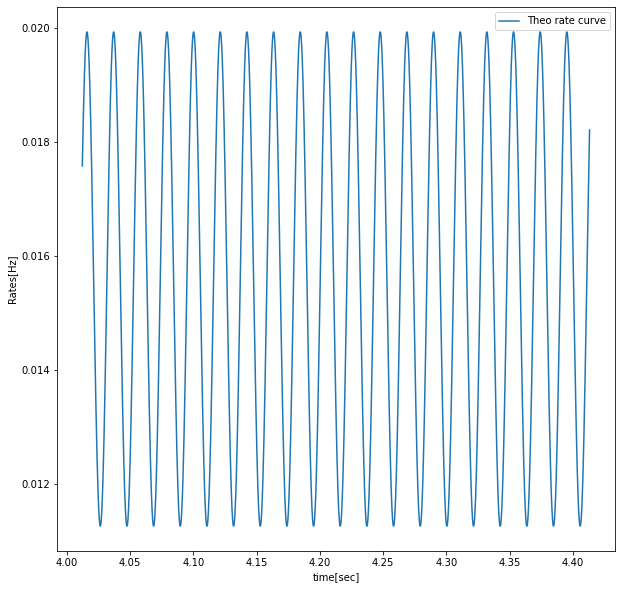

In [3]:
plt.figure(figsize=(10,10))
#plt.xlim([30,30.1])
plt.plot(t[50000:55000],num[50000:55000],label='Theo rate curve')
plt.xlabel('time[sec]');plt.ylabel('Rates[Hz]')
plt.legend()

In [62]:
# Finds theoretical separation and separation by direct subtraction

pos = np.array([[0,1.2,0.00,450.0],[0,1.202,0.00,90.0]])
def theo_ds(pos, theo):  #pos in [#,phi,dec,s] find midpoint theta and phi.
    
    pos[:,2] = np.pi/2. - pos[:,2]
    print('theo_pos',pos)
    x = np.sin(pos[:,2])*np.cos(pos[:,1])
    y = np.sin(pos[:,2])*np.sin(pos[:,1])
    z = np.cos(pos[:,2])
    #print(x,y,z)
    r = np.linalg.norm(np.array([x[0]+x[1],y[0]+y[1],z[0]+z[1]])/2)
    s = np.linalg.norm(np.array([x[0]+x[1],y[0]+y[1]])/2)
    phi = math.atan2((x[0]+x[1]),(y[0]+y[1]))
    
    # d_ew = (s/r)*(pos[0,1]-pos[1,1])  # using midpoint
    # d_ew = np.sin(pos[0,2])*pos[0,1]-np.sin(pos[0,2])*pos[1,1]   #actual
    d_ra = (pos[0,1]-pos[1,1])     #+ 3.375e-9
    d_dec = (pos[0,2] - pos[1,2])  #- 2.89902e-9
    
    # Use theo d_source in cart to convert to d_ns and d_ew
    d_dec_theo = -theo[2]*r/s
    
    new_x = (((z[0]+z[1])/2)/r)*d_dec_theo
    
    d_ew_x = (theo[0]+np.cos(np.pi/2 + phi)*new_x)/(np.sin(-(np.pi/2 + phi)))
    
    d_ew_y = (-theo[1]-np.sin(-(np.pi/2 + phi))*new_x)/(np.cos(np.pi/2 + phi))
    
    d_ra_theo = d_ew_x*r/s    
    
    print('diff in RA', d_ra - d_ra_theo)
    print('diff in DEC', d_dec - d_dec_theo)
    
    return d_dec_theo,d_ra_theo


d_dec_theo, d_ra_theo = theo_ds(pos,d_source[0,0,:])

#theoretical par value which can be used as initial guess if needed.
theo_par = [task4.V,d_ra_theo,d_dec_theo,QT.ph]

print('theo_par',theo_par)


theo_pos [[  0.           1.2          1.57079633 450.        ]
 [  0.           1.202        1.57079633  90.        ]]
diff in RA -3.333332910908371e-10
diff in DEC 0.0
theo_par [0.2777777777777777, -0.0019999996666667107, -0.0, 0.0]


In [63]:
# create sim_data class for mcmc

class sim_data(BaseLikelihood):
    
    def __init__(self, seed, pos_t, pos_s, t, lam):  # seed = [V_init,d_ra_init, d_dec_init]
        BaseLikelihood.__init__(self,"sim_data")  
        
        # free par
        self.seed = seed
        self.V = seed[0]
        self.d_ra = seed[1]
        self.d_dec = seed[2]
        self.offset = seed[3]
        
        # fixed values
        self.t = t             # timestamp for the sim data
        
        pos_t = np.array(pos_t)
        pos_t[:,1] = np.pi/2 - pos_t[:,1]   # baseline vector in spherical baseline [[phi,theta,r],[phi,theta,r]]
        self.pos_t = pos_t     # position of the two telescope in Earth coordinate
        
        pos_s = np.delete(pos_s, 0, axis=1)  # delete star # part.
        pos_s[:,1] = np.pi/2 - pos_s[:,1]
        self.pos_s = pos_s     # position of sources to determine midpoint
        
        self.lam = lam         # lambda for observation
        self.Omega_E = 7.292e-5
        
    def freeParameters(self):
        return [
                Parameter("V", self.seed[0], err=0.05),    #0.05
                Parameter("d_ra",self.seed[1], err=1e-9),   #1e-7
                Parameter("d_dec",self.seed[2], err=1e-9),
                Parameter("offset",self.seed[3], err=np.pi/5)   #pi/10
                ]
    
    def updateParams(self,params):    #params is also a class, updates param value.
        for p in params:
            if p.name=="V":
                self.V=p.value
            if p.name=="d_ra":
                self.d_ra=p.value
            if p.name=="d_dec":
                self.d_dec=p.value
            if p.name=="offset":
                self.offset=p.value
                
    def pos_carte(self, ti):
            # rotate baseline vector as func of time
            
            if (ti == 0.0).all() :   # for pos source
                x = np.sin(self.pos_s[:,1])*np.cos(self.pos_s[:,0])
                y = np.sin(self.pos_s[:,1])*np.sin(self.pos_s[:,0])
                z = np.cos(self.pos_s[:,1])
               
                r = np.linalg.norm(np.array([x[0]+x[1],y[0]+y[1],z[0]+z[1]])/2)
                s = np.linalg.norm(np.array([x[0]+x[1],y[0]+y[1]])/2)
    
                # close to theoretical d_ns and d_ew
                d_ew = s/r * self.d_ra  # d_ra is defined on the equator, multiply by s/r to get to the desired plane
                d_ns = self.d_dec    # define to be z-axis
                
                
                #converting to Earth coord
                #rotate around d_ew axis, x axis
                
                fin_z = (s/r)*-d_ns 
                new_y = -(((z[0]+z[1])/2)/r)*-d_ns   #multiplied by d_ew and d_ns
                #new_y = -np.sin(-(theta))*-d_ns
                #new_x = (((z[0]+z[1])/2)/r)*-d_ns 
                
                # rotate around z axis
                phi = math.atan2((x[0]+x[1]),(y[0]+y[1]))
                
                #fin_x = np.cos(np.pi/2 + phi)*new_x - np.sin(-(np.pi/2 + phi))*d_ew 
                #fin_y = np.sin(-(np.pi/2 + phi))*new_x + np.cos(np.pi/2 + phi)*d_ew 
                
                fin_x = np.cos(np.pi+phi)*d_ew - np.sin(-(np.pi+phi))*new_y
                fin_y = np.sin(-(np.pi+phi))*d_ew + np.cos(np.pi+phi)*new_y
                
                new_pos = np.array([fin_x,fin_y,fin_z])    # since theta hat points down

                return new_pos
            
            else:
                N = ti.size 
                M = len(pos)
                
                new_t = np.tile(ti,(2,1))   # (2,N)
            
                pos_tile = np.tile(np.reshape(self.pos_t,(2,1,3)),(1,N,1))    #pos of telescope, 2,N,3
                
                new_pos = np.zeros((2,N,3))
            
                #change from spherical to cartesian
                new_pos[:,:,0] = pos_tile[:,:,2]*np.sin(pos_tile[:,:,1])*np.cos(pos_tile[:,:,0] + self.Omega_E*new_t)   #[x,y,z](t)
                new_pos[:,:,1] = pos_tile[:,:,2]*np.sin(pos_tile[:,:,1])*np.sin(pos_tile[:,:,0] + self.Omega_E*new_t)
                new_pos[:,:,2] = pos_tile[:,:,2]*np.cos(pos_tile[:,:,1])     

                return new_pos
    
    
    def get_phase(self):       #pos:[[[ra,dec,r],[ra,dec,r]],[[],[]]]

        #let ds be differene of source unit vector
        ds_car = self.pos_carte(np.array([0.]))                   #(3)
        print(ds_car)
        new_pos_t = self.pos_carte(self.t)           #(2,N,3)
        baseline = new_pos_t[1] - new_pos_t[0]      #(3,N)
        #print(baseline)
        dot = baseline[:,0]*ds_car[0] + baseline[:,1]*ds_car[1] + baseline[:,2]*ds_car[2]
        phase = 2*np.pi/self.lam*dot + self.offset   # Total phase with the offset
        
        return phase
    
    
    
    def loglike_wprior(self):
        
        phase = self.get_phase()
        loglike = np.log(1+self.V*np.cos(phase))  #get loglike for diff phase in 2d array[[],[],[]...]
        res = np.sum(loglike, axis=None)
        
        return res
    
    
    


In [64]:
# CREATE CLASS WITH INPUTS

pos = np.array([[0,1.2,0.00,450.0],[0,1.202,0.00,90.0]])
# generate some seed
par = [0.25, d_ra_theo-0.5e-9, d_dec_theo-0.3e-9, -2.0]


#can also use theoretical par value by changing  par to theo_par
L=sim_data(theo_par,pos_t_NY,pos,task4.timestamp,lam)  
L.loglike_wprior()


[ 0.0018648  -0.00072285  0.        ]


48.56595000767662

[ 0.0018648  -0.00072285  0.        ]


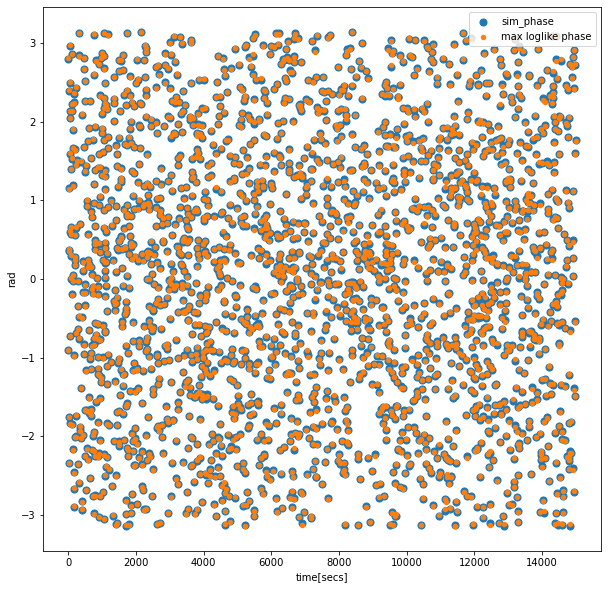

In [65]:
plt.figure(figsize=(10,10))
#plt.subplot(2,2,1)
#plt.plot(t[:200000], np.mod((theo_phase[:200000]+ np.pi),2*np.pi) - np.pi, color = 'g',label='theo phase curve')
plt.scatter(task4.timestamp[-30000:],np.mod((task4.phase[-30000:]+ np.pi),2*np.pi) - np.pi,s=50, label = 'sim_phase')
plt.scatter(task4.timestamp[-30000:], np.mod((L.get_phase()[-30000:]+ np.pi),2*np.pi) - np.pi, s= 20,label = 'max loglike phase')
plt.xlabel('time[secs]');plt.ylabel('rad')
#plt.xlim([19.0,20])
plt.legend()

In [66]:
MCMCAnalyzer.MCMCAnalyzer(L,"/home/Zhi/QA-sim/MCMC_output/pap_setup_EW_287m_10x1",temp=2, nsamp=300000)

Bounds: [ 2.77777778e-02 -2.00000467e-03 -5.00000000e-09 -3.14159265e+00] [ 5.27777778e-01 -1.99999467e-03  5.00000000e-09  3.14159265e+00]
[ 0.0018648  -0.00072285  0.        ]
Starting chain...
[ 1.86480174e-03 -7.22850985e-04 -1.13257739e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.13226211e-11]
[ 1.86480179e-03 -7.22851003e-04 -1.31132372e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.35508761e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.26285609e-10]
[ 1.86480158e-03 -7.22850922e-04 -1.66364396e-10]
[ 1.86480156e-03 -7.22850914e-04 -3.80098638e-11]
[ 1.86480152e-03 -7.22850898e-04 -2.23309439e-11]
[ 1.86480143e-03 -7.22850865e-04  1.48136418e-10]
[ 1.86480155e-03 -7.22850912e-04  1.79932244e-10]
[ 1.86480170e-03 -7.22850972e-04  1.85089232e-10]
[ 1.86480145e-03 -7.22850872e-04  1.94238834e-10]
[ 1.86480156e-03 -7.22850916e-04  1.12807933e-10]
[ 1.86480155e-03 -7.22850911e-04  3.52482413e-11]
[ 1.86480159e-03 -7.22850927e-04 -2.04414226e-11]
[ 1.86480164e-03 -7.22850947e-04 -5.55799918e-11]
[ 1.

[ 1.86480172e-03 -7.22850979e-04 -8.37636178e-10]
[ 1.86480169e-03 -7.22850965e-04 -8.18345508e-10]
[ 1.86480179e-03 -7.22851005e-04 -7.58991199e-10]
[ 1.86480176e-03 -7.22850992e-04 -6.40147685e-10]
[ 1.86480160e-03 -7.22850930e-04 -5.67149337e-10]
[ 1.86480176e-03 -7.22850993e-04 -6.91212931e-10]
[ 1.86480174e-03 -7.22850985e-04 -4.98651897e-10]
[ 1.86480160e-03 -7.22850933e-04 -5.20042496e-10]
[ 1.86480166e-03 -7.22850955e-04 -5.46429695e-10]
[ 1.86480167e-03 -7.22850957e-04 -5.76268680e-10]
[ 1.86480166e-03 -7.22850955e-04 -3.59673509e-10]
[ 1.86480159e-03 -7.22850926e-04 -5.62960160e-10]
[ 1.86480170e-03 -7.22850971e-04 -5.91813249e-10]
[ 1.86480162e-03 -7.22850940e-04 -6.32521465e-10]
[ 1.86480174e-03 -7.22850987e-04 -6.14883738e-10]
[ 1.86480191e-03 -7.22851051e-04 -6.33509591e-10]
[ 1.86480178e-03 -7.22851002e-04 -8.73354617e-10]
[ 1.86480181e-03 -7.22851013e-04 -8.51446760e-10]
[ 1.86480199e-03 -7.22851082e-04 -1.05047387e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.04568536e-09]


[ 1.86480222e-03 -7.22851170e-04 -1.60067656e-09]
[ 1.86480230e-03 -7.22851204e-04 -1.34704762e-09]
[ 1.86480228e-03 -7.22851194e-04 -1.30728940e-09]
[ 1.86480231e-03 -7.22851208e-04 -1.36290263e-09]
[ 1.86480239e-03 -7.22851236e-04 -1.33611400e-09]
[ 1.86480224e-03 -7.22851181e-04 -1.26306091e-09]
[ 1.86480217e-03 -7.22851150e-04 -1.32971405e-09]
[ 1.86480210e-03 -7.22851125e-04 -1.42499164e-09]
[ 1.86480220e-03 -7.22851163e-04 -1.45246557e-09]
[ 1.86480225e-03 -7.22851182e-04 -1.37785569e-09]
[ 1.86480229e-03 -7.22851197e-04 -1.50159991e-09]
[ 1.86480219e-03 -7.22851161e-04 -1.38517313e-09]
[ 1.86480216e-03 -7.22851149e-04 -1.29227533e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.30924919e-09]
[ 1.86480222e-03 -7.22851172e-04 -1.30375197e-09]
[ 1.86480210e-03 -7.22851127e-04 -1.20210142e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.09744499e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.08084414e-09]
[ 1.86480223e-03 -7.22851176e-04 -1.09133014e-09]
[ 1.86480222e-03 -7.22851173e-04 -1.30257715e-09]


[ 1.86480212e-03 -7.22851134e-04 -3.80814635e-10]
[ 1.86480207e-03 -7.22851115e-04 -4.74881453e-10]
[ 1.86480192e-03 -7.22851053e-04 -4.96380425e-10]
[ 1.86480202e-03 -7.22851093e-04 -4.08517440e-10]
[ 1.86480189e-03 -7.22851043e-04 -5.54829927e-10]
[ 1.86480193e-03 -7.22851059e-04 -4.94472995e-10]
[ 1.86480208e-03 -7.22851119e-04 -6.30759439e-10]
[ 1.86480194e-03 -7.22851061e-04 -5.50724505e-10]
[ 1.86480190e-03 -7.22851048e-04 -4.43762518e-10]
[ 1.86480181e-03 -7.22851014e-04 -5.23407246e-10]
[ 1.86480185e-03 -7.22851028e-04 -5.18611202e-10]
[ 1.86480189e-03 -7.22851043e-04 -3.73699484e-10]
[ 1.86480173e-03 -7.22850982e-04 -2.93401287e-10]
[ 1.86480206e-03 -7.22851108e-04 -2.50897417e-10]
[ 1.86480174e-03 -7.22850985e-04 -1.99136094e-10]
[ 1.86480192e-03 -7.22851055e-04 -6.46655526e-11]
[ 1.86480192e-03 -7.22851055e-04  1.64031832e-10]
[ 1.86480184e-03 -7.22851026e-04  6.99294431e-11]
[ 1.86480190e-03 -7.22851049e-04  1.58127902e-11]
[ 1.86480187e-03 -7.22851034e-04  1.22150528e-10]


[ 1.86480209e-03 -7.22851121e-04  5.20298805e-10]
[ 1.86480212e-03 -7.22851131e-04  5.35817842e-10]
[ 1.86480212e-03 -7.22851132e-04  5.45867221e-10]
[ 1.86480210e-03 -7.22851123e-04  4.92057499e-10]
[ 1.86480216e-03 -7.22851150e-04  4.70522475e-10]
[ 1.86480222e-03 -7.22851170e-04  3.10465228e-10]
[ 1.86480227e-03 -7.22851191e-04  4.75807355e-10]
[ 1.86480230e-03 -7.22851202e-04  3.48214945e-10]
[ 1.86480221e-03 -7.22851167e-04  6.83360280e-10]
[ 1.86480226e-03 -7.22851187e-04  4.42255451e-10]
[ 1.86480228e-03 -7.22851194e-04  5.71125383e-10]
[ 1.86480242e-03 -7.22851250e-04  3.54972002e-10]
[ 1.86480229e-03 -7.22851199e-04  3.31492730e-10]
[ 1.86480234e-03 -7.22851217e-04  4.97289678e-10]
[ 1.86480225e-03 -7.22851181e-04  4.52707856e-10]
[ 1.86480229e-03 -7.22851200e-04  2.86842048e-10]
[ 1.86480234e-03 -7.22851217e-04  4.38322089e-10]
[ 1.86480228e-03 -7.22851194e-04  4.85601885e-10]
[ 1.86480238e-03 -7.22851234e-04  5.42524855e-10]
[ 1.86480222e-03 -7.22851171e-04  4.94805621e-10]


[ 1.86480139e-03 -7.22850850e-04 -4.53385561e-10]
[ 1.86480112e-03 -7.22850744e-04 -3.28354180e-10]
[ 1.86480114e-03 -7.22850754e-04 -4.08731112e-10]
[ 1.86480116e-03 -7.22850759e-04 -4.38115830e-10]
[ 1.86480118e-03 -7.22850769e-04 -3.74920827e-10]
[ 1.86480114e-03 -7.22850752e-04 -3.26358045e-10]
[ 1.86480113e-03 -7.22850747e-04 -4.30635599e-10]
[ 1.86480101e-03 -7.22850704e-04 -4.68809005e-10]
[ 1.86480120e-03 -7.22850775e-04 -4.06170436e-10]
[ 1.86480116e-03 -7.22850762e-04 -3.18031726e-10]
[ 1.86480094e-03 -7.22850676e-04 -2.87804460e-10]
[ 1.86480118e-03 -7.22850769e-04 -3.23752444e-10]
[ 1.86480124e-03 -7.22850793e-04 -4.22839289e-10]
[ 1.86480113e-03 -7.22850750e-04 -4.27588510e-10]
[ 1.86480133e-03 -7.22850828e-04 -3.85894194e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.91926799e-10]
[ 1.86480125e-03 -7.22850795e-04 -4.29667645e-10]
[ 1.86480119e-03 -7.22850773e-04 -4.19781782e-10]
[ 1.86480125e-03 -7.22850797e-04 -4.97922707e-10]
[ 1.86480148e-03 -7.22850884e-04 -3.72883402e-10]


[ 1.86480139e-03 -7.22850849e-04 -4.70338875e-10]
[ 1.86480149e-03 -7.22850888e-04 -5.70300900e-10]
[ 1.86480139e-03 -7.22850851e-04 -4.94120364e-10]
[ 1.86480135e-03 -7.22850833e-04 -4.51857636e-10]
[ 1.86480147e-03 -7.22850882e-04 -4.06505996e-10]
[ 1.86480155e-03 -7.22850912e-04 -5.40230455e-10]
[ 1.86480161e-03 -7.22850934e-04 -5.47072447e-10]
[ 1.86480169e-03 -7.22850967e-04 -7.31022035e-10]
[ 1.86480179e-03 -7.22851003e-04 -5.98291107e-10]
[ 1.86480170e-03 -7.22850969e-04 -9.14194527e-10]
[ 1.86480172e-03 -7.22850978e-04 -8.94350927e-10]
[ 1.86480178e-03 -7.22851003e-04 -8.82516366e-10]
[ 1.86480171e-03 -7.22850973e-04 -1.08467024e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.27166728e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.26099482e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.22893209e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.24548599e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.30695978e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.20634793e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.22660413e-09]


[ 1.86480134e-03 -7.22850830e-04 -1.09467632e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.07431120e-09]
[ 1.86480152e-03 -7.22850900e-04 -9.96445426e-10]
[ 1.86480156e-03 -7.22850916e-04 -8.62091119e-10]
[ 1.86480148e-03 -7.22850884e-04 -8.31930053e-10]
[ 1.86480132e-03 -7.22850823e-04 -8.83232188e-10]
[ 1.86480142e-03 -7.22850859e-04 -7.21507552e-10]
[ 1.86480136e-03 -7.22850838e-04 -7.93900448e-10]
[ 1.86480128e-03 -7.22850808e-04 -7.65295612e-10]
[ 1.86480129e-03 -7.22850811e-04 -9.03750250e-10]
[ 1.86480099e-03 -7.22850694e-04 -8.14025550e-10]
[ 1.86480134e-03 -7.22850829e-04 -9.81858131e-10]
[ 1.86480152e-03 -7.22850898e-04 -1.13425504e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.00692823e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.24287084e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.07096834e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.34745216e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.12656913e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.22413004e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.14084723e-09]


[ 1.86480156e-03 -7.22850914e-04 -1.92019501e-09]
[ 1.86480154e-03 -7.22850910e-04 -1.98746685e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.05255852e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.02307680e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.97677875e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.88134066e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.84219985e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.84646217e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.74374418e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.80521651e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.75208069e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.70418792e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.72102654e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.67047721e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.69937216e-09]
[ 1.86480143e-03 -7.22850863e-04 -1.59814295e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.61629773e-09]
[ 1.86480129e-03 -7.22850813e-04 -1.68822890e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.71850287e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.66566928e-09]


[ 1.86480105e-03 -7.22850717e-04 -7.92763020e-10]
[ 1.86480084e-03 -7.22850638e-04 -7.95575527e-10]
[ 1.86480118e-03 -7.22850766e-04 -9.46072426e-10]
[ 1.86480118e-03 -7.22850770e-04 -8.88595888e-10]
[ 1.86480098e-03 -7.22850690e-04 -8.07964586e-10]
[ 1.86480119e-03 -7.22850773e-04 -8.58076906e-10]
[ 1.86480112e-03 -7.22850746e-04 -9.00211437e-10]
[ 1.86480109e-03 -7.22850734e-04 -9.56501385e-10]
[ 1.86480110e-03 -7.22850738e-04 -8.67680192e-10]
[ 1.86480105e-03 -7.22850719e-04 -8.36156828e-10]
[ 1.86480098e-03 -7.22850689e-04 -8.99238028e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.01045503e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.07479660e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.03520800e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.10396405e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.13008520e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.28995682e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.17283577e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.43233693e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.45633553e-09]


[ 1.86480156e-03 -7.22850914e-04 -2.96277123e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.01635882e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.99090172e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.99933894e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.95630188e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.00672206e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.01805849e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.92532596e-09]
[ 1.86480121e-03 -7.22850782e-04 -2.91121076e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.02116920e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.86041251e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.78485041e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.84077116e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.78738900e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.58798962e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.59415263e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.64421175e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.80745165e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.09070021e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.18529638e-09]


[ 1.86480141e-03 -7.22850857e-04 -3.02867929e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.16241555e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.20542841e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.16728438e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.43771938e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.19588156e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.04918783e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.11603558e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.05763129e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.93697555e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.02812016e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.97820378e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.05532449e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.98314793e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.98784616e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.90899874e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.92347335e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.86228257e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.88276833e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.68326896e-09]


[ 1.86480141e-03 -7.22850856e-04 -2.09773434e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.10189108e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.99789745e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.94050683e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.92128044e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.80129723e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.72638739e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.46763978e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.53410258e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.55039703e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.65407805e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.66766579e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.81220746e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.92957815e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.91776694e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.82192598e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.93330353e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.02338867e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.09276783e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.13914338e-09]


[ 1.86480155e-03 -7.22850913e-04 -9.96198670e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.03669535e-09]
[ 1.86480158e-03 -7.22850925e-04 -9.56082019e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.13455821e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.06396784e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.21763330e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.36074315e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.32926868e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.49382223e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.63518738e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.67416122e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.47519932e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.79700444e-09]
[ 1.86480201e-03 -7.22851089e-04 -1.63915825e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.69377070e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.58722529e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.61653205e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.57162003e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.33341184e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.57529845e-09]


[ 1.86480140e-03 -7.22850855e-04 -1.49797408e-10]
[ 1.86480144e-03 -7.22850869e-04 -1.39267883e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.12456197e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.30331930e-10]
[ 1.86480138e-03 -7.22850845e-04 -6.66343390e-11]
[ 1.86480124e-03 -7.22850792e-04 -1.16309252e-10]
[ 1.86480143e-03 -7.22850864e-04 -9.45739092e-11]
[ 1.86480129e-03 -7.22850812e-04 -2.17267973e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.62653307e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.63383302e-10]
[ 1.86480136e-03 -7.22850839e-04 -2.43082071e-10]
[ 1.86480128e-03 -7.22850809e-04 -2.62767401e-10]
[ 1.86480140e-03 -7.22850852e-04 -2.84042254e-10]
[ 1.86480132e-03 -7.22850824e-04 -2.64246310e-10]
[ 1.86480139e-03 -7.22850849e-04 -3.09371416e-10]
[ 1.86480116e-03 -7.22850761e-04 -3.09059814e-10]
[ 1.86480141e-03 -7.22850856e-04 -2.66627190e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.97010110e-10]
[ 1.86480143e-03 -7.22850864e-04 -3.48107153e-10]
[ 1.86480135e-03 -7.22850833e-04 -3.38614769e-10]


[ 1.86480129e-03 -7.22850809e-04 -2.73061128e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.77550609e-10]
[ 1.86480137e-03 -7.22850843e-04 -3.02744698e-10]
[ 1.86480126e-03 -7.22850801e-04 -3.67407522e-10]
[ 1.86480124e-03 -7.22850791e-04 -4.55071737e-10]
[ 1.86480118e-03 -7.22850768e-04 -3.83208334e-10]
[ 1.86480119e-03 -7.22850774e-04 -3.16896287e-10]
[ 1.86480119e-03 -7.22850771e-04 -4.26857623e-10]
[ 1.86480099e-03 -7.22850695e-04 -5.32419414e-10]
[ 1.86480124e-03 -7.22850793e-04 -3.78099368e-10]
[ 1.86480116e-03 -7.22850759e-04 -3.61676766e-10]
[ 1.86480135e-03 -7.22850833e-04 -3.45845127e-10]
[ 1.86480123e-03 -7.22850786e-04 -4.86164949e-10]
[ 1.86480130e-03 -7.22850814e-04 -5.87251508e-10]
[ 1.86480118e-03 -7.22850768e-04 -6.66029698e-10]
[ 1.86480135e-03 -7.22850835e-04 -6.38438211e-10]
[ 1.86480156e-03 -7.22850916e-04 -4.01219881e-10]
[ 1.86480095e-03 -7.22850679e-04 -6.13189536e-10]
[ 1.86480133e-03 -7.22850827e-04 -5.72844550e-10]
[ 1.86480128e-03 -7.22850808e-04 -5.54208228e-10]


[ 1.86480167e-03 -7.22850957e-04 -2.10239359e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.15554868e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.08621611e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.02291151e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.98707712e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.96013987e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.01869967e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.16885316e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.13526558e-09]
[ 1.86480195e-03 -7.22851067e-04 -1.98999100e-09]
[ 1.86480203e-03 -7.22851097e-04 -2.06912161e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.16946524e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.16125937e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.17945614e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.23539964e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.30329096e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.40624964e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.42379916e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.45508967e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.43373539e-09]


[ 1.86480172e-03 -7.22850976e-04 -2.51044771e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.62492448e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.61825659e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.53586287e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.65839909e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.68524425e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.51317076e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.34056908e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.39866567e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.41447833e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.31918820e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.32274907e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.23577914e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.33958799e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.18245544e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.14638038e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.24193554e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.15593745e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.16200034e-09]
[ 1.86480158e-03 -7.22850921e-04 -2.24094949e-09]


[ 1.86480147e-03 -7.22850881e-04 -1.46155453e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.25966906e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.34539759e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.45022190e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.38523480e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.39810329e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.45636936e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.30868781e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.37864298e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.32410851e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.42233317e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.36293507e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.54558600e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.61464465e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.61754317e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.55839614e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.55139068e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.37151401e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.41641764e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.53349662e-09]


[ 1.86480145e-03 -7.22850872e-04 -4.56542824e-10]
[ 1.86480143e-03 -7.22850866e-04 -4.95140447e-10]
[ 1.86480145e-03 -7.22850873e-04 -4.67236054e-10]
[ 1.86480153e-03 -7.22850904e-04 -4.80531715e-10]
[ 1.86480160e-03 -7.22850930e-04 -6.31033372e-10]
[ 1.86480155e-03 -7.22850910e-04 -6.42036938e-10]
[ 1.86480169e-03 -7.22850965e-04 -5.50942373e-10]
[ 1.86480152e-03 -7.22850900e-04 -7.21965078e-10]
[ 1.86480155e-03 -7.22850913e-04 -6.96554761e-10]
[ 1.86480154e-03 -7.22850909e-04 -6.33698381e-10]
[ 1.86480167e-03 -7.22850960e-04 -6.34526304e-10]
[ 1.86480175e-03 -7.22850990e-04 -8.82287844e-10]
[ 1.86480152e-03 -7.22850902e-04 -4.35348374e-10]
[ 1.86480153e-03 -7.22850902e-04 -4.47479506e-10]
[ 1.86480152e-03 -7.22850899e-04 -4.81626570e-10]
[ 1.86480144e-03 -7.22850868e-04 -4.58532038e-10]
[ 1.86480153e-03 -7.22850904e-04 -3.70743088e-10]
[ 1.86480146e-03 -7.22850876e-04 -6.48689324e-10]
[ 1.86480145e-03 -7.22850871e-04 -7.42961467e-10]
[ 1.86480142e-03 -7.22850860e-04 -9.93088713e-10]


[ 1.86480117e-03 -7.22850764e-04  9.96113958e-10]
[ 1.86480114e-03 -7.22850754e-04  1.01532814e-09]
[ 1.86480103e-03 -7.22850709e-04  8.63904986e-10]
[ 1.86480103e-03 -7.22850710e-04  1.08095699e-09]
[ 1.86480105e-03 -7.22850717e-04  8.93428758e-10]
[ 1.86480106e-03 -7.22850724e-04  8.90230628e-10]
[ 1.86480101e-03 -7.22850701e-04  9.07108909e-10]
[ 1.86480104e-03 -7.22850715e-04  1.00706758e-09]
[ 1.86480110e-03 -7.22850738e-04  9.78459296e-10]
[ 1.86480115e-03 -7.22850758e-04  8.96255198e-10]
[ 1.86480109e-03 -7.22850732e-04  8.56936203e-10]
[ 1.86480107e-03 -7.22850724e-04  9.72725825e-10]
[ 1.86480104e-03 -7.22850713e-04  9.84305820e-10]
[ 1.86480094e-03 -7.22850675e-04  1.04761780e-09]
[ 1.86480080e-03 -7.22850622e-04  9.56827594e-10]
[ 1.86480104e-03 -7.22850714e-04  9.47980654e-10]
[ 1.86480112e-03 -7.22850745e-04  1.12282563e-09]
[ 1.86480116e-03 -7.22850762e-04  9.75220512e-10]
[ 1.86480112e-03 -7.22850745e-04  7.21107526e-10]
[ 1.86480106e-03 -7.22850721e-04  6.71443672e-10]


[ 1.86480191e-03 -7.22851050e-04  2.38367539e-10]
[ 1.86480191e-03 -7.22851052e-04  7.82903315e-11]
[ 1.86480202e-03 -7.22851093e-04  1.02702972e-11]
[ 1.86480199e-03 -7.22851080e-04 -8.42669432e-12]
[ 1.86480199e-03 -7.22851084e-04 -1.05748319e-10]
[ 1.86480205e-03 -7.22851105e-04 -2.18122951e-10]
[ 1.86480209e-03 -7.22851120e-04 -2.71672725e-10]
[ 1.86480225e-03 -7.22851182e-04 -3.13085929e-10]
[ 1.86480210e-03 -7.22851123e-04 -1.52635055e-10]
[ 1.86480213e-03 -7.22851137e-04 -1.24578327e-10]
[ 1.86480209e-03 -7.22851122e-04 -2.38741118e-10]
[ 1.86480215e-03 -7.22851146e-04 -5.93590995e-11]
[ 1.86480218e-03 -7.22851157e-04 -3.17498798e-11]
[ 1.86480238e-03 -7.22851233e-04  2.03934000e-10]
[ 1.86480241e-03 -7.22851243e-04  2.06873774e-10]
[ 1.86480234e-03 -7.22851217e-04  1.73442041e-10]
[ 1.86480240e-03 -7.22851242e-04  3.37808635e-10]
[ 1.86480225e-03 -7.22851184e-04  1.02172975e-10]
[ 1.86480226e-03 -7.22851187e-04  3.30303604e-10]
[ 1.86480228e-03 -7.22851193e-04  1.37258722e-10]


[ 1.86480116e-03 -7.22850760e-04 -9.68003493e-10]
[ 1.86480107e-03 -7.22850727e-04 -8.77270343e-10]
[ 1.86480121e-03 -7.22850779e-04 -8.84818408e-10]
[ 1.86480122e-03 -7.22850785e-04 -8.76891461e-10]
[ 1.86480113e-03 -7.22850750e-04 -8.40845785e-10]
[ 1.86480118e-03 -7.22850768e-04 -9.02064115e-10]
[ 1.86480109e-03 -7.22850733e-04 -7.90030451e-10]
[ 1.86480115e-03 -7.22850756e-04 -7.84285615e-10]
[ 1.86480112e-03 -7.22850746e-04 -7.95399643e-10]
[ 1.86480110e-03 -7.22850739e-04 -8.29925806e-10]
[ 1.86480094e-03 -7.22850675e-04 -7.85720895e-10]
[ 1.86480115e-03 -7.22850757e-04 -8.74669043e-10]
[ 1.86480131e-03 -7.22850817e-04 -9.54493317e-10]
[ 1.86480123e-03 -7.22850787e-04 -8.22592915e-10]
[ 1.86480122e-03 -7.22850785e-04 -7.38951242e-10]
[ 1.86480127e-03 -7.22850803e-04 -7.43262001e-10]
[ 1.86480118e-03 -7.22850768e-04 -5.98777515e-10]
[ 1.86480144e-03 -7.22850869e-04 -6.06594318e-10]
[ 1.86480118e-03 -7.22850770e-04 -5.72112596e-10]
[ 1.86480100e-03 -7.22850698e-04 -2.78506488e-10]


[ 1.86480148e-03 -7.22850884e-04 -8.84163660e-10]
[ 1.86480133e-03 -7.22850828e-04 -9.37798991e-10]
[ 1.86480140e-03 -7.22850855e-04 -8.58939382e-10]
[ 1.86480138e-03 -7.22850847e-04 -9.20657900e-10]
[ 1.86480131e-03 -7.22850819e-04 -8.76619227e-10]
[ 1.86480126e-03 -7.22850799e-04 -8.79049216e-10]
[ 1.86480127e-03 -7.22850803e-04 -8.56188246e-10]
[ 1.86480117e-03 -7.22850766e-04 -9.37335632e-10]
[ 1.86480132e-03 -7.22850821e-04 -9.26281756e-10]
[ 1.86480127e-03 -7.22850805e-04 -1.10790839e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.11215952e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.02688962e-09]
[ 1.86480133e-03 -7.22850827e-04 -9.92431950e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.04817696e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.16641577e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.02342897e-09]
[ 1.86480146e-03 -7.22850875e-04 -9.94211493e-10]
[ 1.86480136e-03 -7.22850839e-04 -8.25006203e-10]
[ 1.86480148e-03 -7.22850886e-04 -8.04882282e-10]
[ 1.86480149e-03 -7.22850889e-04 -8.32556153e-10]


[ 1.86480170e-03 -7.22850971e-04 -1.65345852e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.58283913e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.71139687e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.72429307e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.59991277e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.54194401e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.60130757e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.70885631e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.50577450e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.83799793e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.73349620e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.60268232e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.83646959e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.94823602e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.03226457e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.71058682e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.85786138e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.80594392e-09]
[ 1.86480204e-03 -7.22851103e-04 -1.86506524e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.93307318e-09]


[ 1.86480118e-03 -7.22850769e-04 -2.81640932e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.88740408e-09]
[ 1.86480122e-03 -7.22850786e-04 -2.60325022e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.63122356e-09]
[ 1.86480087e-03 -7.22850646e-04 -2.66393761e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.62186747e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.82938159e-09]
[ 1.86480111e-03 -7.22850739e-04 -2.53011979e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.61356768e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.61464300e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.66366683e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.68359381e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.62167781e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.67572548e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.62764145e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.68771825e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.86758099e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.94019541e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.13304869e-09]
[ 1.86480105e-03 -7.22850716e-04 -2.96593340e-09]


[ 1.86480185e-03 -7.22851029e-04 -3.88087151e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.85534578e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.80758509e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.99336457e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.20215714e-09]
[ 1.86480185e-03 -7.22851030e-04 -4.14715694e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.18092457e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.14436627e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.23564446e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.14073989e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.14491128e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.36905672e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.26830594e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.30290746e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.22334595e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.30483261e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.31059465e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.42374310e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.44060946e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.60269046e-09]


[ 1.86480138e-03 -7.22850845e-04 -3.65893789e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.95433432e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.00008735e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.04983158e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.07999951e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.18996689e-09]
[ 1.86480159e-03 -7.22850929e-04 -4.35355376e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.15399965e-09]
[ 1.86480185e-03 -7.22851029e-04 -4.21882297e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.14112232e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.04833519e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.87282645e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.97590775e-09]
[ 1.86480185e-03 -7.22851030e-04 -4.08226459e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.97702224e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.19053737e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.18054980e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.10163145e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.10266610e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.13657612e-09]


[ 1.86480162e-03 -7.22850939e-04 -2.07929168e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.08990905e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.14442056e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.11158289e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.04979354e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.08213365e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.02231706e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.03766243e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.08918767e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.04779482e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.04514492e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.07877258e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.10004697e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.13034441e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.17360584e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.23218801e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.15987918e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.23383010e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.13535194e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.15149416e-09]


[ 1.86480103e-03 -7.22850709e-04 -3.52562714e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.49338752e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.63528305e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.52165481e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.66888372e-09]
[ 1.86480084e-03 -7.22850637e-04 -3.62146444e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.72086284e-09]
[ 1.86480089e-03 -7.22850654e-04 -3.72599811e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.77363208e-09]
[ 1.86480082e-03 -7.22850628e-04 -3.69859177e-09]
[ 1.86480087e-03 -7.22850646e-04 -3.88455135e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.83092189e-09]
[ 1.86480095e-03 -7.22850678e-04 -3.87682971e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.73458427e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.67907716e-09]
[ 1.86480091e-03 -7.22850662e-04 -3.77155641e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.84051182e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.80267865e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.76062774e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.66019599e-09]


[ 1.86480173e-03 -7.22850980e-04 -2.71953681e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.69712925e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.74305454e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.87405157e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.94215515e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.02602185e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.06791565e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.99394636e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.97274757e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.07458311e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.08418934e-09]
[ 1.86480210e-03 -7.22851127e-04 -3.03992882e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.98274931e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.05956672e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.20133425e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.12409689e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.16521706e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.19062836e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.15299030e-09]
[ 1.86480212e-03 -7.22851132e-04 -3.12759200e-09]


[ 1.86480160e-03 -7.22850932e-04 -2.77227651e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.88556176e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.83909830e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.99937364e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.86288626e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.96756052e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.03070793e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.08490400e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.21261813e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.07122985e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.96077077e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.08218904e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.90935988e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.00300767e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.90559491e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.91231639e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.89289830e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.86661790e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.84597844e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.01210122e-09]


[ 1.86480157e-03 -7.22850918e-04 -3.62544473e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.59767168e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.64975011e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.74178636e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.64390510e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.52344150e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.42330368e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.58263657e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.69667724e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.46287688e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.41869526e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.38069568e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.53762273e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.54931801e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.59858142e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.56814439e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.62906477e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.43712756e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.45547237e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.53331458e-09]


[ 1.86480131e-03 -7.22850819e-04  2.18615282e-10]
[ 1.86480081e-03 -7.22850625e-04 -1.02448535e-09]
[ 1.86480111e-03 -7.22850743e-04  2.15969712e-09]
[ 1.86480206e-03 -7.22851108e-04 -1.02856475e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.46439549e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.57062968e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.57418191e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.76673054e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.19131487e-09]
[ 1.86480148e-03 -7.22850884e-04 -5.92008089e-10]
[ 1.86480139e-03 -7.22850849e-04  4.12481185e-10]
[ 1.86480093e-03 -7.22850670e-04  1.33181368e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.83256452e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.95515989e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.85538933e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.10929239e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.75194626e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.56586058e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.36462298e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.93119279e-09]


[ 1.86480142e-03 -7.22850861e-04  4.02787539e-09]
[ 1.86480154e-03 -7.22850909e-04  1.07756806e-09]
[ 1.86480164e-03 -7.22850948e-04  7.47784243e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.48634131e-10]
[ 1.86480159e-03 -7.22850929e-04  3.99787336e-10]
[ 1.86480134e-03 -7.22850829e-04 -5.49555162e-10]
[ 1.86480121e-03 -7.22850781e-04 -4.12942653e-11]
[ 1.86480118e-03 -7.22850768e-04  1.70932364e-10]
[ 1.86480115e-03 -7.22850755e-04  2.71539164e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.22091848e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.01773316e-09]
[ 1.86480094e-03 -7.22850675e-04 -1.96211160e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.44694400e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.33979390e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.22177176e-09]
[ 1.86480153e-03 -7.22850902e-04 -1.38152867e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.26208616e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.48485289e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.06362559e-09]
[ 1.86480143e-03 -7.22850864e-04  1.10652516e-10]


[ 1.86480142e-03 -7.22850860e-04 -2.49894860e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.98540844e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.69702711e-09]
[ 1.86480166e-03 -7.22850952e-04 -3.42345533e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.62940389e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.32333436e-09]
[ 1.86480090e-03 -7.22850658e-04 -4.47569002e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.08057196e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.81447607e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.36746209e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.45448814e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.80375162e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.45585091e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.28623616e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.51556818e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.65017540e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.54716875e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.84206610e-09]
[ 1.86480080e-03 -7.22850620e-04 -4.61373785e-09]
[ 1.86480108e-03 -7.22850730e-04 -4.51911399e-09]


[ 1.86480238e-03 -7.22851234e-04 -3.02881788e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.22864674e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.55178970e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.84619573e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.10872308e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.89482478e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.00717519e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.14012677e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.81913652e-09]
[ 1.86480120e-03 -7.22850778e-04 -2.89269163e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.79244497e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.53585427e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.20533976e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.08542796e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.92455268e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.56193837e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.02229564e-09]
[ 1.86480136e-03 -7.22850837e-04  1.82157506e-09]
[ 1.86480138e-03 -7.22850847e-04  1.75827329e-09]
[ 1.86480106e-03 -7.22850722e-04  1.79570186e-09]


[ 1.86480175e-03 -7.22850990e-04  2.28077064e-09]
[ 1.86480195e-03 -7.22851068e-04  3.93398969e-09]
[ 1.86480184e-03 -7.22851023e-04  1.24565814e-09]
[ 1.86480186e-03 -7.22851034e-04  3.83358350e-09]
[ 1.86480205e-03 -7.22851104e-04  1.98342296e-09]
[ 1.86480217e-03 -7.22851152e-04  2.09778105e-09]
[ 1.86480193e-03 -7.22851060e-04  8.18384142e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.88802244e-09]
[ 1.86480193e-03 -7.22851058e-04  2.59184634e-09]
[ 1.86480155e-03 -7.22850910e-04  3.35168787e-09]
[ 1.86480119e-03 -7.22850773e-04  4.28226430e-09]
[ 1.86480110e-03 -7.22850738e-04  3.56598549e-09]
[ 1.86480130e-03 -7.22850815e-04  3.47836073e-09]
[ 1.86480173e-03 -7.22850980e-04  3.55127586e-09]
[ 1.86480156e-03 -7.22850914e-04  2.97787561e-09]
[ 1.86480184e-03 -7.22851023e-04  3.38532408e-09]
[ 1.86480162e-03 -7.22850938e-04  4.47606724e-09]
[ 1.86480178e-03 -7.22851002e-04  4.21810306e-09]
[ 1.86480154e-03 -7.22850910e-04  3.92399892e-09]
[ 1.86480099e-03 -7.22850695e-04  2.08290942e-09]


[ 1.86480241e-03 -7.22851245e-04  1.05836500e-09]
[ 1.86480289e-03 -7.22851432e-04  1.98341622e-09]
[ 1.86480254e-03 -7.22851296e-04 -6.01721008e-10]
[ 1.86480223e-03 -7.22851176e-04  3.48894951e-11]
[ 1.86480202e-03 -7.22851096e-04  5.24919974e-10]
[ 1.86480220e-03 -7.22851164e-04  9.23180859e-10]
[ 1.86480234e-03 -7.22851220e-04 -1.77744772e-09]
[ 1.86480246e-03 -7.22851265e-04  1.49923287e-09]
[ 1.86480214e-03 -7.22851141e-04  1.29465321e-09]
[ 1.86480236e-03 -7.22851224e-04 -3.13539990e-10]
[ 1.86480155e-03 -7.22850913e-04  1.59331091e-09]
[ 1.86480245e-03 -7.22851259e-04  8.10587460e-10]
[ 1.86480206e-03 -7.22851109e-04  8.22610042e-10]
[ 1.86480202e-03 -7.22851094e-04 -2.69432717e-10]
[ 1.86480233e-03 -7.22851213e-04 -2.62111360e-10]
[ 1.86480228e-03 -7.22851193e-04  1.98244741e-09]
[ 1.86480219e-03 -7.22851159e-04  2.74636889e-09]
[ 1.86480239e-03 -7.22851239e-04  4.09920381e-09]
[ 1.86480227e-03 -7.22851192e-04  3.91107205e-09]
[ 1.86480255e-03 -7.22851300e-04  2.93210071e-09]


[ 1.86480254e-03 -7.22851295e-04  2.24715103e-09]
[ 1.86480235e-03 -7.22851222e-04  2.54561352e-09]
[ 1.86480219e-03 -7.22851159e-04 -3.17999388e-10]
[ 1.86480211e-03 -7.22851130e-04  1.05798057e-09]
[ 1.86480236e-03 -7.22851227e-04  2.16016817e-09]
[ 1.86480245e-03 -7.22851260e-04 -7.21455648e-10]
[ 1.86480201e-03 -7.22851089e-04  8.64908705e-10]
[ 1.86480236e-03 -7.22851226e-04  1.94028846e-09]
[ 1.86480198e-03 -7.22851078e-04  1.71174707e-09]
[ 1.86480214e-03 -7.22851140e-04  1.93269386e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.03266697e-10]
[ 1.86480184e-03 -7.22851025e-04  2.27297829e-09]
[ 1.86480207e-03 -7.22851113e-04 -9.52102197e-10]
[ 1.86480175e-03 -7.22850989e-04  2.95353807e-10]
[ 1.86480198e-03 -7.22851078e-04  7.53644666e-10]
[ 1.86480232e-03 -7.22851210e-04 -2.40275966e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.07679749e-11]
[ 1.86480193e-03 -7.22851057e-04  1.35784461e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.25817459e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.22708884e-09]


[ 1.86480115e-03 -7.22850757e-04  2.44440229e-09]
[ 1.86480101e-03 -7.22850703e-04  3.19614880e-09]
[ 1.86480168e-03 -7.22850963e-04  4.06821821e-09]
[ 1.86480127e-03 -7.22850805e-04  4.88685979e-09]
[ 1.86480127e-03 -7.22850804e-04  3.84532577e-09]
[ 1.86480170e-03 -7.22850970e-04  3.93491315e-09]
[ 1.86480106e-03 -7.22850721e-04  2.19392786e-09]
[ 1.86480064e-03 -7.22850559e-04  3.86124903e-09]
[ 1.86480110e-03 -7.22850739e-04  1.38639120e-09]
[ 1.86480162e-03 -7.22850939e-04  1.11078476e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.02833452e-10]
[ 1.86480157e-03 -7.22850918e-04  7.14091282e-10]
[ 1.86480167e-03 -7.22850958e-04  6.06183017e-10]
[ 1.86480167e-03 -7.22850957e-04  8.06849192e-10]
[ 1.86480163e-03 -7.22850941e-04  2.14054782e-09]
[ 1.86480190e-03 -7.22851048e-04  1.24307569e-09]
[ 1.86480151e-03 -7.22850896e-04  7.99109168e-11]
[ 1.86480187e-03 -7.22851035e-04  7.25704953e-10]
[ 1.86480216e-03 -7.22851147e-04 -1.27799016e-09]
[ 1.86480161e-03 -7.22850933e-04 -7.93293304e-10]


[ 1.86480198e-03 -7.22851077e-04 -3.39362362e-12]
[ 1.86480148e-03 -7.22850885e-04  5.89413318e-10]
[ 1.86480197e-03 -7.22851073e-04  2.24205409e-09]
[ 1.86480172e-03 -7.22850978e-04  1.91709283e-09]
[ 1.86480154e-03 -7.22850908e-04  5.23986142e-10]
[ 1.86480121e-03 -7.22850779e-04  2.99783215e-09]
[ 1.86480150e-03 -7.22850893e-04  1.48138068e-09]
[ 1.86480151e-03 -7.22850898e-04  3.99197795e-10]
[ 1.86480214e-03 -7.22851141e-04  1.30717015e-09]
[ 1.86480185e-03 -7.22851028e-04  1.70616187e-09]
[ 1.86480131e-03 -7.22850817e-04  8.68970570e-10]
[ 1.86480071e-03 -7.22850588e-04  1.00478875e-09]
[ 1.86480132e-03 -7.22850823e-04  1.12615143e-09]
[ 1.86480127e-03 -7.22850802e-04  2.36244586e-10]
[ 1.86480150e-03 -7.22850893e-04  2.65249942e-09]
[ 1.86480114e-03 -7.22850751e-04 -1.00568314e-10]
[ 1.86480069e-03 -7.22850578e-04  1.99528468e-10]
[ 1.86480085e-03 -7.22850640e-04  1.42602804e-09]
[ 1.86480086e-03 -7.22850644e-04 -5.56070431e-10]
[ 1.86480113e-03 -7.22850748e-04  1.21628621e-09]


[ 1.86480170e-03 -7.22850968e-04  7.29445476e-10]
[ 1.86480181e-03 -7.22851013e-04 -6.97438996e-12]
[ 1.86480202e-03 -7.22851094e-04 -9.98089269e-10]
[ 1.86480190e-03 -7.22851048e-04 -7.83795820e-10]
[ 1.86480188e-03 -7.22851040e-04  2.21746963e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.58410719e-09]
[ 1.86480166e-03 -7.22850955e-04  1.23089017e-09]
[ 1.86480209e-03 -7.22851122e-04  1.39580107e-09]
[ 1.86480172e-03 -7.22850976e-04 -9.10560662e-10]
[ 1.86480142e-03 -7.22850860e-04  4.61669956e-11]
[ 1.86480134e-03 -7.22850830e-04 -3.50952352e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.01979306e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.23982118e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.77915948e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.58582820e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.63315866e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.97028025e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.81249719e-09]
[ 1.86480183e-03 -7.22851018e-04 -1.67106639e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.78537670e-09]


[ 1.86480142e-03 -7.22850860e-04  7.04451474e-10]
[ 1.86480122e-03 -7.22850785e-04  1.93392921e-09]
[ 1.86480174e-03 -7.22850986e-04  1.40167447e-10]
[ 1.86480185e-03 -7.22851028e-04 -2.32372709e-10]
[ 1.86480204e-03 -7.22851101e-04 -1.18554898e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.16125282e-10]
[ 1.86480195e-03 -7.22851065e-04  5.77969400e-10]
[ 1.86480199e-03 -7.22851080e-04  1.19140343e-09]
[ 1.86480247e-03 -7.22851270e-04 -6.08881566e-10]
[ 1.86480171e-03 -7.22850973e-04  1.44288275e-09]
[ 1.86480150e-03 -7.22850891e-04  2.12665428e-09]
[ 1.86480141e-03 -7.22850859e-04  2.43433661e-09]
[ 1.86480199e-03 -7.22851083e-04  2.14989499e-09]
[ 1.86480164e-03 -7.22850946e-04  2.62323408e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.03449036e-10]
[ 1.86480127e-03 -7.22850801e-04  8.44682492e-10]
[ 1.86480181e-03 -7.22851012e-04  1.60467310e-09]
[ 1.86480131e-03 -7.22850818e-04  1.13917507e-09]
[ 1.86480212e-03 -7.22851131e-04  2.21757470e-09]
[ 1.86480193e-03 -7.22851060e-04  2.91845243e-09]


[ 1.86480142e-03 -7.22850863e-04 -4.59379354e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.27238226e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.32390009e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.81628114e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.90632530e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.71574441e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.14630134e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.53684438e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.77106470e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.43254216e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.91082506e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.86508521e-09]
Accepted samples 6000 4
[ 1.86480195e-03 -7.22851067e-04 -4.04620625e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.36498339e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.87834143e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.14210904e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.90284982e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.45030254e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.68281399e-09]
[ 1.86480192e-03 -7.228510

[ 1.86480158e-03 -7.22850925e-04 -1.00670633e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.71844392e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.87087997e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.36122941e-09]
[ 1.86480185e-03 -7.22851026e-04 -4.30607454e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.97248159e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.79755544e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.19121055e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.84065744e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.66710628e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.96531903e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.89016246e-09]
[ 1.86480144e-03 -7.22850870e-04 -7.59936706e-10]
[ 1.86480124e-03 -7.22850791e-04 -4.69118086e-10]
[ 1.86480156e-03 -7.22850916e-04 -3.28027037e-10]
[ 1.86480168e-03 -7.22850960e-04  2.85112946e-09]
[ 1.86480051e-03 -7.22850508e-04 -2.94839727e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.57205325e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.78309451e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.12392184e-09]


[ 1.86480170e-03 -7.22850970e-04  4.07298751e-09]
[ 1.86480194e-03 -7.22851061e-04  1.34380517e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.09623274e-09]
[ 1.86480174e-03 -7.22850986e-04  1.67873190e-09]
[ 1.86480188e-03 -7.22851040e-04  6.92449345e-10]
[ 1.86480225e-03 -7.22851181e-04  2.10862782e-09]
[ 1.86480157e-03 -7.22850919e-04  2.71301896e-09]
[ 1.86480105e-03 -7.22850719e-04  1.23739817e-09]
[ 1.86480155e-03 -7.22850911e-04  1.45179922e-09]
[ 1.86480131e-03 -7.22850818e-04  1.19842015e-09]
[ 1.86480133e-03 -7.22850827e-04  2.65412647e-09]
[ 1.86480147e-03 -7.22850881e-04  1.99241883e-09]
[ 1.86480124e-03 -7.22850793e-04  1.15039715e-09]
[ 1.86480125e-03 -7.22850795e-04  1.59351806e-09]
[ 1.86480105e-03 -7.22850716e-04  1.45837789e-09]
[ 1.86480128e-03 -7.22850805e-04  2.17362762e-09]
[ 1.86480111e-03 -7.22850741e-04  2.65841358e-10]
[ 1.86480133e-03 -7.22850824e-04  2.00096096e-09]
[ 1.86480079e-03 -7.22850615e-04  2.60855585e-09]
[ 1.86480163e-03 -7.22850941e-04  9.90004081e-10]


[ 1.86480187e-03 -7.22851036e-04  3.65471211e-09]
[ 1.86480201e-03 -7.22851090e-04  3.72829927e-09]
[ 1.86480150e-03 -7.22850892e-04  2.29686251e-09]
[ 1.86480126e-03 -7.22850799e-04  4.95200307e-09]
[ 1.86480072e-03 -7.22850588e-04  3.18008900e-09]
[ 1.86480129e-03 -7.22850811e-04  3.92805467e-09]
[ 1.86480147e-03 -7.22850880e-04  4.97732618e-09]
[ 1.86480126e-03 -7.22850801e-04  4.79851225e-09]
[ 1.86480200e-03 -7.22851085e-04  4.93844273e-09]
[ 1.86480156e-03 -7.22850914e-04  4.94702279e-09]
[ 1.86480129e-03 -7.22850811e-04  2.85009098e-09]
[ 1.86480065e-03 -7.22850564e-04  2.42680325e-09]
[ 1.86480173e-03 -7.22850980e-04  4.58307943e-09]
[ 1.86480103e-03 -7.22850710e-04  2.74610680e-09]
[ 1.86480161e-03 -7.22850936e-04  4.33790459e-09]
[ 1.86480152e-03 -7.22850898e-04  4.18891064e-09]
[ 1.86480125e-03 -7.22850794e-04  1.29875781e-09]
[ 1.86480159e-03 -7.22850925e-04  3.40214083e-09]
[ 1.86480231e-03 -7.22851207e-04  4.32417005e-09]
[ 1.86480132e-03 -7.22850821e-04  4.19508933e-09]


[ 1.86480120e-03 -7.22850775e-04  1.28316291e-09]
[ 1.86480122e-03 -7.22850782e-04  2.87801612e-09]
[ 1.86480103e-03 -7.22850710e-04  1.69604278e-09]
[ 1.86480065e-03 -7.22850562e-04  7.14156217e-11]
[ 1.86480139e-03 -7.22850848e-04  2.06937235e-09]
[ 1.86480145e-03 -7.22850873e-04  5.24955361e-10]
[ 1.86480171e-03 -7.22850972e-04  3.37210462e-09]
[ 1.86480159e-03 -7.22850929e-04  3.58419364e-09]
[ 1.86480182e-03 -7.22851017e-04  3.56163324e-09]
[ 1.86480188e-03 -7.22851039e-04  3.29608325e-09]
[ 1.86480191e-03 -7.22851051e-04  3.48756558e-09]
[ 1.86480205e-03 -7.22851106e-04  4.16187814e-09]
[ 1.86480157e-03 -7.22850918e-04  2.88640423e-09]
[ 1.86480140e-03 -7.22850855e-04  4.24401844e-09]
[ 1.86480109e-03 -7.22850731e-04  4.00330108e-09]
[ 1.86480085e-03 -7.22850640e-04  4.29521539e-09]
[ 1.86480167e-03 -7.22850959e-04  4.14003998e-09]
[ 1.86480179e-03 -7.22851004e-04  4.72693986e-09]
[ 1.86480136e-03 -7.22850839e-04  3.41593156e-09]
[ 1.86480102e-03 -7.22850706e-04  3.58299844e-09]


[ 1.86480136e-03 -7.22850839e-04 -2.76569976e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.85398831e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.84955530e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.71216059e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.25763486e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.91227248e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.88910795e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.57012166e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.11646447e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.95310071e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.69083209e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.66184603e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.98546454e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.32245798e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.11953422e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.80800526e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.72984081e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.99011780e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.52307061e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.23844145e-09]


[ 1.86480217e-03 -7.22851150e-04  3.01635518e-09]
[ 1.86480140e-03 -7.22850855e-04  2.49426788e-09]
[ 1.86480174e-03 -7.22850985e-04  3.47104225e-09]
[ 1.86480183e-03 -7.22851022e-04  4.65641057e-09]
[ 1.86480202e-03 -7.22851092e-04  4.35720427e-09]
[ 1.86480224e-03 -7.22851180e-04  3.54552043e-09]
[ 1.86480193e-03 -7.22851059e-04  3.71191609e-09]
[ 1.86480194e-03 -7.22851064e-04  1.65432818e-09]
[ 1.86480197e-03 -7.22851075e-04  2.95516884e-09]
[ 1.86480149e-03 -7.22850889e-04  2.02636244e-09]
[ 1.86480197e-03 -7.22851076e-04  1.14856558e-09]
[ 1.86480180e-03 -7.22851008e-04  2.25024248e-09]
[ 1.86480201e-03 -7.22851090e-04  1.02970565e-09]
[ 1.86480185e-03 -7.22851028e-04  2.64786916e-09]
[ 1.86480192e-03 -7.22851053e-04  2.69498422e-09]
[ 1.86480181e-03 -7.22851012e-04  3.19126096e-09]
[ 1.86480235e-03 -7.22851222e-04  3.66590865e-09]
[ 1.86480174e-03 -7.22850986e-04  4.90040300e-12]
[ 1.86480201e-03 -7.22851089e-04  4.77458964e-09]
[ 1.86480152e-03 -7.22850899e-04  3.84289280e-09]


[ 1.86480079e-03 -7.22850617e-04 -4.84069743e-10]
[ 1.86480102e-03 -7.22850706e-04 -2.03294462e-09]
[ 1.86480121e-03 -7.22850778e-04 -2.94298872e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.65651035e-10]
[ 1.86480048e-03 -7.22850498e-04 -4.47882299e-09]
[ 1.86480106e-03 -7.22850721e-04  1.26638458e-09]
[ 1.86480090e-03 -7.22850660e-04  1.18838651e-09]
[ 1.86480066e-03 -7.22850565e-04  1.41795754e-09]
[ 1.86480076e-03 -7.22850605e-04  1.53923627e-09]
[ 1.86480077e-03 -7.22850610e-04  1.18795046e-09]
[ 1.86480029e-03 -7.22850425e-04  3.72429022e-10]
[ 1.86480089e-03 -7.22850655e-04 -1.97131249e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.31431737e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.17452804e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.82988354e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.71135812e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.00518443e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.54398622e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.23848176e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.37929305e-09]


[ 1.86480211e-03 -7.22851127e-04 -3.86109480e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.63991184e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.55603516e-09]
[ 1.86480230e-03 -7.22851203e-04 -4.42971464e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.20499116e-09]
[ 1.86480220e-03 -7.22851163e-04 -2.57241602e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.15449967e-10]
[ 1.86480243e-03 -7.22851255e-04 -4.54596054e-09]
[ 1.86480248e-03 -7.22851271e-04 -1.41064026e-09]
[ 1.86480223e-03 -7.22851175e-04 -3.28833074e-09]
[ 1.86480219e-03 -7.22851159e-04 -1.42964443e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.24245109e-09]
[ 1.86480223e-03 -7.22851173e-04 -1.84575895e-09]
[ 1.86480239e-03 -7.22851237e-04 -7.34726522e-10]
[ 1.86480211e-03 -7.22851130e-04 -3.08505983e-09]
[ 1.86480258e-03 -7.22851311e-04 -1.56161191e-09]
[ 1.86480163e-03 -7.22850944e-04 -9.57868225e-10]
[ 1.86480166e-03 -7.22850955e-04 -7.87726079e-10]
[ 1.86480164e-03 -7.22850948e-04 -1.39248291e-10]
[ 1.86480144e-03 -7.22850868e-04 -6.50715602e-10]


[ 1.86480167e-03 -7.22850957e-04  1.69637296e-09]
[ 1.86480136e-03 -7.22850838e-04  4.88908839e-09]
[ 1.86480186e-03 -7.22851030e-04  4.90312990e-09]
[ 1.86480126e-03 -7.22850798e-04  4.00827238e-09]
[ 1.86480138e-03 -7.22850847e-04  3.70646083e-09]
[ 1.86480107e-03 -7.22850725e-04  1.88708252e-09]
[ 1.86480109e-03 -7.22850733e-04  3.60285758e-10]
[ 1.86480097e-03 -7.22850686e-04  3.37028622e-10]
[ 1.86480104e-03 -7.22850715e-04  2.16302143e-09]
[ 1.86480057e-03 -7.22850533e-04  3.31991454e-09]
[ 1.86480083e-03 -7.22850631e-04  1.24529487e-09]
[ 1.86480148e-03 -7.22850884e-04  3.26930248e-09]
[ 1.86480156e-03 -7.22850915e-04  3.51948577e-09]
[ 1.86480146e-03 -7.22850878e-04  2.12244612e-09]
[ 1.86480145e-03 -7.22850873e-04  2.85840515e-09]
[ 1.86480132e-03 -7.22850824e-04  6.49146296e-10]
[ 1.86480169e-03 -7.22850966e-04  2.82955896e-09]
[ 1.86480150e-03 -7.22850893e-04  2.91209520e-09]
[ 1.86480169e-03 -7.22850965e-04  2.00827575e-09]
[ 1.86480130e-03 -7.22850814e-04  2.67158709e-09]


[ 1.86480193e-03 -7.22851060e-04 -1.31317177e-09]
[ 1.86480212e-03 -7.22851134e-04 -2.79660497e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.51119381e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.47143397e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.56274865e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.21788747e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.26380017e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.33432847e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.53999245e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.38035102e-09]
[ 1.86480223e-03 -7.22851174e-04 -1.07918337e-09]
[ 1.86480204e-03 -7.22851100e-04 -6.16472407e-10]
[ 1.86480213e-03 -7.22851137e-04 -5.56518253e-10]
[ 1.86480201e-03 -7.22851089e-04 -1.51121582e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.71295099e-09]
[ 1.86480228e-03 -7.22851193e-04 -1.01147449e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.21785464e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.84311978e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.11439460e-09]
[ 1.86480175e-03 -7.22850988e-04  8.15436140e-10]


[ 1.86480129e-03 -7.22850812e-04 -2.14404708e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.79708839e-10]
[ 1.86480110e-03 -7.22850738e-04 -4.51178331e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.82081660e-09]
[ 1.86480101e-03 -7.22850701e-04 -1.36079166e-09]
[ 1.86480100e-03 -7.22850700e-04 -1.19068122e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.04212973e-09]
[ 1.86480162e-03 -7.22850939e-04 -9.37566106e-10]
[ 1.86480055e-03 -7.22850524e-04 -1.55153924e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.72758959e-09]
[ 1.86480146e-03 -7.22850876e-04  4.21388714e-10]
[ 1.86480111e-03 -7.22850742e-04  1.88885358e-09]
[ 1.86480141e-03 -7.22850857e-04  2.24574239e-09]
[ 1.86480138e-03 -7.22850848e-04  2.75044473e-09]
[ 1.86480147e-03 -7.22850882e-04  2.69570459e-09]
[ 1.86480176e-03 -7.22850994e-04  4.50120480e-09]
[ 1.86480160e-03 -7.22850932e-04  1.40882695e-09]
[ 1.86480176e-03 -7.22850994e-04  2.04610004e-09]
[ 1.86480204e-03 -7.22851102e-04  1.07642552e-09]
[ 1.86480132e-03 -7.22850823e-04  2.78180907e-09]


[ 1.86480121e-03 -7.22850779e-04 -2.88725904e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.10360529e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.39720935e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.39850323e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.38984535e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.92806354e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.74749337e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.08775790e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.07135273e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.82997366e-10]
[ 1.86480145e-03 -7.22850871e-04 -1.56215850e-09]
[ 1.86480101e-03 -7.22850704e-04 -7.91193659e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.31771331e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.04032247e-09]
[ 1.86480201e-03 -7.22851089e-04 -8.67678987e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.51384242e-09]
[ 1.86480171e-03 -7.22850974e-04  2.97682572e-10]
[ 1.86480200e-03 -7.22851085e-04 -1.30315450e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.67508581e-10]
[ 1.86480203e-03 -7.22851099e-04 -7.85772428e-10]


[ 1.86480129e-03 -7.22850809e-04 -1.21261762e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.41447509e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.56002548e-10]
[ 1.86480157e-03 -7.22850918e-04  1.48364510e-09]
[ 1.86480152e-03 -7.22850900e-04  3.62978650e-09]
[ 1.86480135e-03 -7.22850833e-04  2.76700528e-09]
[ 1.86480155e-03 -7.22850912e-04  2.83538602e-09]
[ 1.86480150e-03 -7.22850892e-04  2.58528088e-09]
[ 1.86480144e-03 -7.22850868e-04  3.54895408e-09]
[ 1.86480134e-03 -7.22850828e-04  3.04919896e-09]
[ 1.86480092e-03 -7.22850668e-04  3.70175924e-09]
[ 1.86480149e-03 -7.22850886e-04  4.19254095e-09]
[ 1.86480135e-03 -7.22850835e-04  2.33034957e-09]
[ 1.86480140e-03 -7.22850854e-04  2.72906523e-09]
[ 1.86480164e-03 -7.22850945e-04  3.59895100e-09]
[ 1.86480127e-03 -7.22850804e-04  1.29899123e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.55806040e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.34902014e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.28801230e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.14810807e-09]


[ 1.86480077e-03 -7.22850611e-04 -1.57434809e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.08548858e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.71385349e-09]
[ 1.86480204e-03 -7.22851102e-04 -5.16984173e-10]
[ 1.86480170e-03 -7.22850968e-04 -2.95937521e-09]
[ 1.86480162e-03 -7.22850937e-04 -5.99282713e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.01927531e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.75221621e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.76617243e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.85636560e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.02755888e-09]
[ 1.86480206e-03 -7.22851109e-04  6.88057019e-10]
[ 1.86480167e-03 -7.22850957e-04 -3.42027208e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.61590774e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.31006002e-09]
[ 1.86480207e-03 -7.22851113e-04 -9.51964572e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.81629271e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.72325268e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.74382659e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.24624539e-09]


[ 1.86480109e-03 -7.22850733e-04 -1.32350737e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.50257853e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.10101686e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.16718682e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.80281997e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.48949314e-10]
[ 1.86480177e-03 -7.22850999e-04 -3.69437113e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.11953010e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.68055276e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.22990109e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.68041634e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.75698762e-09]
[ 1.86480175e-03 -7.22850991e-04 -6.50953198e-10]
[ 1.86480169e-03 -7.22850964e-04 -4.70476021e-11]
[ 1.86480192e-03 -7.22851056e-04 -5.90088238e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.10396866e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.38927251e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.51227184e-09]
[ 1.86480134e-03 -7.22850828e-04 -9.88473175e-10]
[ 1.86480110e-03 -7.22850736e-04 -1.45180522e-09]


[ 1.86480199e-03 -7.22851084e-04 -2.93914219e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.52416556e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.49173863e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.98132655e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.68458102e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.33024582e-09]
[ 1.86480028e-03 -7.22850419e-04 -9.66082035e-10]
[ 1.86480062e-03 -7.22850553e-04 -1.66954212e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.41091181e-10]
[ 1.86480108e-03 -7.22850728e-04 -1.03630754e-09]
[ 1.86480049e-03 -7.22850499e-04 -1.55421006e-09]
[ 1.86480093e-03 -7.22850672e-04 -8.70794289e-10]
[ 1.86480145e-03 -7.22850871e-04  1.53573790e-09]
[ 1.86480102e-03 -7.22850705e-04  1.55470608e-09]
[ 1.86480113e-03 -7.22850749e-04  1.95306113e-09]
[ 1.86480139e-03 -7.22850851e-04  2.11371505e-09]
[ 1.86480071e-03 -7.22850587e-04  2.21169726e-09]
[ 1.86480112e-03 -7.22850747e-04  4.70233508e-09]
[ 1.86480076e-03 -7.22850605e-04  3.38132025e-09]
[ 1.86480163e-03 -7.22850943e-04  3.48218481e-09]


[ 1.86480160e-03 -7.22850929e-04  3.57547391e-09]
[ 1.86480158e-03 -7.22850922e-04  3.91008179e-09]
[ 1.86480156e-03 -7.22850917e-04  3.41248391e-09]
[ 1.86480154e-03 -7.22850909e-04  2.19807420e-09]
[ 1.86480213e-03 -7.22851137e-04  3.48223551e-09]
[ 1.86480219e-03 -7.22851158e-04  3.66670527e-09]
[ 1.86480151e-03 -7.22850895e-04  3.20491472e-09]
[ 1.86480181e-03 -7.22851011e-04  1.47846421e-09]
[ 1.86480192e-03 -7.22851055e-04  2.22168517e-09]
[ 1.86480185e-03 -7.22851029e-04  2.84349763e-09]
[ 1.86480150e-03 -7.22850894e-04  3.18699375e-09]
[ 1.86480190e-03 -7.22851049e-04  3.00249692e-09]
[ 1.86480129e-03 -7.22850809e-04  5.87087825e-10]
[ 1.86480160e-03 -7.22850931e-04  2.95530766e-09]
[ 1.86480154e-03 -7.22850906e-04  3.25284583e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.48350805e-09]
[ 1.86480192e-03 -7.22851057e-04  7.12603858e-10]
[ 1.86480155e-03 -7.22850912e-04  2.81897841e-09]
[ 1.86480193e-03 -7.22851059e-04  2.93906024e-09]
[ 1.86480200e-03 -7.22851087e-04  3.43583754e-09]


[ 1.86480179e-03 -7.22851005e-04  4.93161556e-09]
[ 1.86480156e-03 -7.22850915e-04  4.39732344e-09]
[ 1.86480170e-03 -7.22850970e-04  4.41278687e-09]
[ 1.86480180e-03 -7.22851009e-04  4.14269619e-09]
[ 1.86480167e-03 -7.22850956e-04  2.76865089e-09]
[ 1.86480157e-03 -7.22850917e-04  3.19277063e-09]
[ 1.86480179e-03 -7.22851005e-04  4.83910022e-09]
[ 1.86480134e-03 -7.22850830e-04  4.09540893e-09]
[ 1.86480171e-03 -7.22850975e-04  3.77290043e-09]
[ 1.86480172e-03 -7.22850976e-04  4.05549887e-09]
[ 1.86480151e-03 -7.22850897e-04  3.86581838e-09]
[ 1.86480133e-03 -7.22850826e-04  3.80567215e-09]
[ 1.86480154e-03 -7.22850907e-04  3.89812028e-09]
[ 1.86480158e-03 -7.22850922e-04  2.56577522e-09]
[ 1.86480151e-03 -7.22850895e-04  4.65235493e-09]
[ 1.86480129e-03 -7.22850811e-04  3.60472243e-09]
[ 1.86480126e-03 -7.22850798e-04  2.41207407e-09]
[ 1.86480113e-03 -7.22850750e-04  7.43730094e-10]
[ 1.86480104e-03 -7.22850713e-04  2.85723888e-09]
[ 1.86480102e-03 -7.22850705e-04  1.51091944e-09]


[ 1.86480146e-03 -7.22850876e-04  2.14671456e-09]
[ 1.86480189e-03 -7.22851042e-04  2.67020832e-09]
[ 1.86480185e-03 -7.22851028e-04  1.48078696e-09]
[ 1.86480151e-03 -7.22850897e-04  1.32080532e-09]
[ 1.86480175e-03 -7.22850987e-04 -1.86008738e-09]
[ 1.86480140e-03 -7.22850855e-04  3.04456829e-09]
[ 1.86480101e-03 -7.22850701e-04  3.24417024e-09]
[ 1.86480074e-03 -7.22850599e-04  3.68365186e-09]
[ 1.86480143e-03 -7.22850865e-04  3.63964763e-09]
[ 1.86480108e-03 -7.22850728e-04  2.18689990e-09]
[ 1.86480096e-03 -7.22850683e-04  3.92425896e-09]
[ 1.86480141e-03 -7.22850859e-04  3.18401300e-09]
[ 1.86480145e-03 -7.22850872e-04  2.65605592e-09]
[ 1.86480144e-03 -7.22850869e-04  4.82197914e-09]
[ 1.86480136e-03 -7.22850839e-04  2.86869201e-09]
[ 1.86480147e-03 -7.22850881e-04  1.82214813e-09]
[ 1.86480174e-03 -7.22850986e-04  2.79090779e-09]
[ 1.86480164e-03 -7.22850946e-04  2.11857752e-10]
[ 1.86480146e-03 -7.22850876e-04  1.65037896e-09]
[ 1.86480128e-03 -7.22850808e-04  1.42835844e-09]


[ 1.86480135e-03 -7.22850832e-04 -3.68125676e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.85275587e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.91396430e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.16873461e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.74861620e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.82795267e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.11527570e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.80361634e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.88660337e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.84085131e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.69568928e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.39978681e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.58736985e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.44671582e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.63663184e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.35790902e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.10933770e-09]
[ 1.86480104e-03 -7.22850712e-04 -4.87276634e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.95240217e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.58396293e-09]


[ 1.86480131e-03 -7.22850820e-04 -4.31808318e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.59443443e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.79978437e-09]
[ 1.86480133e-03 -7.22850827e-04  1.23056312e-09]
[ 1.86480113e-03 -7.22850750e-04  7.31343356e-10]
[ 1.86480122e-03 -7.22850782e-04  1.31001403e-09]
[ 1.86480146e-03 -7.22850878e-04  1.04212125e-09]
[ 1.86480112e-03 -7.22850744e-04  2.44938222e-09]
[ 1.86480115e-03 -7.22850755e-04  1.34404076e-09]
[ 1.86480085e-03 -7.22850641e-04  7.86569763e-10]
[ 1.86480036e-03 -7.22850450e-04  2.32623736e-09]
[ 1.86480096e-03 -7.22850684e-04 -2.27843528e-10]
[ 1.86480114e-03 -7.22850751e-04  1.65952274e-09]
[ 1.86480135e-03 -7.22850835e-04  2.77041749e-09]
[ 1.86480037e-03 -7.22850453e-04  2.46314046e-09]
[ 1.86480118e-03 -7.22850766e-04  1.34791223e-09]
[ 1.86480109e-03 -7.22850732e-04  3.28660135e-09]
[ 1.86480111e-03 -7.22850741e-04  1.73652643e-09]
[ 1.86480106e-03 -7.22850724e-04  4.68319326e-10]
[ 1.86480127e-03 -7.22850805e-04  7.12004309e-10]


[ 1.86480093e-03 -7.22850670e-04  2.38326383e-10]
[ 1.86480085e-03 -7.22850639e-04 -4.77617420e-11]
[ 1.86480091e-03 -7.22850665e-04 -1.14211288e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.84416462e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.65768940e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.15548882e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.86587667e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.31990162e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.04541166e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.21781394e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.74690273e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.04935708e-09]
[ 1.86480186e-03 -7.22851031e-04  4.44365431e-10]
[ 1.86480162e-03 -7.22850938e-04 -2.34323142e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.46059537e-10]
[ 1.86480165e-03 -7.22850952e-04  3.49703077e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.34803373e-10]
[ 1.86480121e-03 -7.22850779e-04 -1.31717123e-09]
[ 1.86480070e-03 -7.22850581e-04 -9.96339028e-10]
[ 1.86480135e-03 -7.22850835e-04  1.30940006e-09]


[ 1.86480092e-03 -7.22850668e-04 -3.53309685e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.54663456e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.55602636e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.34107910e-09]
[ 1.86480115e-03 -7.22850756e-04  3.87207187e-10]
[ 1.86480091e-03 -7.22850664e-04  1.14090496e-09]
[ 1.86480133e-03 -7.22850825e-04  3.96355028e-10]
[ 1.86480125e-03 -7.22850796e-04 -1.90577651e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.52265659e-09]
[ 1.86480110e-03 -7.22850735e-04 -1.59667563e-09]
[ 1.86480091e-03 -7.22850662e-04  5.34837463e-10]
[ 1.86480135e-03 -7.22850833e-04  1.67455872e-09]
[ 1.86480175e-03 -7.22850989e-04  1.71191834e-09]
[ 1.86480147e-03 -7.22850882e-04  1.91918948e-09]
[ 1.86480126e-03 -7.22850800e-04  3.16640111e-09]
[ 1.86480149e-03 -7.22850887e-04  3.05737812e-09]
[ 1.86480120e-03 -7.22850775e-04  3.51861168e-09]
[ 1.86480132e-03 -7.22850822e-04  3.25815748e-09]
[ 1.86480227e-03 -7.22851191e-04  3.12444787e-09]
[ 1.86480112e-03 -7.22850744e-04  9.85421612e-10]


[ 1.86480179e-03 -7.22851005e-04 -4.78170444e-09]
[ 1.86480163e-03 -7.22850945e-04 -4.55397180e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.02436118e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.42065844e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.66145403e-09]
[ 1.86480174e-03 -7.22850986e-04 -9.44456339e-10]
[ 1.86480148e-03 -7.22850885e-04  1.54326001e-09]
[ 1.86480157e-03 -7.22850919e-04  5.28270258e-10]
[ 1.86480154e-03 -7.22850906e-04  1.36728574e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.37101206e-09]
[ 1.86480149e-03 -7.22850888e-04 -5.99473055e-10]
[ 1.86480144e-03 -7.22850868e-04  7.11651011e-10]
[ 1.86480158e-03 -7.22850925e-04  1.26735198e-09]
[ 1.86480160e-03 -7.22850933e-04 -9.44359083e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.43619035e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.14491548e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.99333400e-09]
[ 1.86480148e-03 -7.22850886e-04  1.03352881e-09]
[ 1.86480148e-03 -7.22850883e-04  1.40943785e-09]
[ 1.86480172e-03 -7.22850976e-04  1.51824965e-09]


[ 1.86480149e-03 -7.22850887e-04  2.84116063e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.00401958e-10]
[ 1.86480177e-03 -7.22850997e-04 -5.62843101e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.42619672e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.84124423e-10]
[ 1.86480140e-03 -7.22850852e-04  7.00786634e-10]
[ 1.86480133e-03 -7.22850828e-04 -6.82482356e-10]
[ 1.86480154e-03 -7.22850906e-04  1.31352093e-09]
[ 1.86480131e-03 -7.22850818e-04  1.32335439e-09]
[ 1.86480133e-03 -7.22850825e-04  4.50403688e-10]
[ 1.86480121e-03 -7.22850781e-04  4.20011395e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.23149699e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.30728796e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.34877482e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.88512923e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.37151028e-09]
[ 1.86480061e-03 -7.22850545e-04 -3.84125290e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.73465204e-09]
[ 1.86480218e-03 -7.22851157e-04 -4.57621786e-09]
[ 1.86480226e-03 -7.22851187e-04 -4.73881814e-09]


[ 1.86480172e-03 -7.22850977e-04  1.50603393e-09]
[ 1.86480203e-03 -7.22851096e-04  1.31287227e-09]
[ 1.86480174e-03 -7.22850984e-04  2.35958325e-09]
[ 1.86480185e-03 -7.22851028e-04  1.13381889e-09]
[ 1.86480201e-03 -7.22851088e-04  1.56649513e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.14131040e-10]
[ 1.86480196e-03 -7.22851072e-04  2.29405202e-09]
[ 1.86480190e-03 -7.22851048e-04 -5.19346442e-10]
[ 1.86480202e-03 -7.22851093e-04  2.12231768e-09]
[ 1.86480162e-03 -7.22850938e-04 -6.52562576e-10]
[ 1.86480163e-03 -7.22850941e-04 -5.58238502e-10]
[ 1.86480109e-03 -7.22850733e-04  5.12593739e-10]
[ 1.86480219e-03 -7.22851160e-04 -2.51445745e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.00981406e-09]
[ 1.86480183e-03 -7.22851022e-04 -9.95252120e-10]
[ 1.86480138e-03 -7.22850844e-04  1.19498930e-09]
[ 1.86480105e-03 -7.22850718e-04  3.65492852e-10]
[ 1.86480123e-03 -7.22850787e-04  4.16226630e-10]
[ 1.86480131e-03 -7.22850820e-04  1.13867666e-09]
[ 1.86480121e-03 -7.22850780e-04  2.77652510e-09]


[ 1.86480181e-03 -7.22851013e-04 -2.88798506e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.11768335e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.58057361e-09]
[ 1.86480165e-03 -7.22850952e-04 -8.34151651e-10]
[ 1.86480192e-03 -7.22851053e-04 -1.07379451e-09]
[ 1.86480177e-03 -7.22850995e-04  1.81144805e-09]
[ 1.86480209e-03 -7.22851123e-04 -2.40758281e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.02668475e-09]
[ 1.86480180e-03 -7.22851010e-04  8.34835914e-10]
[ 1.86480139e-03 -7.22850850e-04 -3.75420100e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.28666511e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.44857619e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.95393145e-10]
[ 1.86480205e-03 -7.22851107e-04 -1.21861803e-09]
[ 1.86480190e-03 -7.22851047e-04 -7.01353038e-10]
[ 1.86480208e-03 -7.22851117e-04 -6.32413139e-10]
[ 1.86480114e-03 -7.22850751e-04 -1.55980200e-10]
[ 1.86480129e-03 -7.22850810e-04  1.04330055e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.41230161e-10]
[ 1.86480143e-03 -7.22850864e-04 -6.74653657e-10]


[ 1.86480228e-03 -7.22851193e-04  9.88445623e-10]
[ 1.86480216e-03 -7.22851147e-04  2.51803447e-09]
[ 1.86480193e-03 -7.22851057e-04  1.52327681e-09]
[ 1.86480218e-03 -7.22851155e-04  1.99083407e-09]
[ 1.86480233e-03 -7.22851215e-04  2.32945332e-09]
[ 1.86480150e-03 -7.22850891e-04  1.40391683e-09]
[ 1.86480138e-03 -7.22850844e-04  2.29449858e-09]
[ 1.86480130e-03 -7.22850815e-04  4.25187788e-09]
[ 1.86480122e-03 -7.22850782e-04  1.87833909e-09]
[ 1.86480142e-03 -7.22850863e-04  1.14223719e-09]
[ 1.86480127e-03 -7.22850802e-04  2.65890543e-09]
[ 1.86480126e-03 -7.22850801e-04  1.83200384e-09]
[ 1.86480099e-03 -7.22850695e-04 -5.96283706e-10]
[ 1.86480101e-03 -7.22850702e-04  3.78545434e-09]
[ 1.86480084e-03 -7.22850637e-04  1.76327836e-09]
[ 1.86480117e-03 -7.22850765e-04  2.94439711e-09]
[ 1.86480100e-03 -7.22850697e-04  1.86272494e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.14023622e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.96910679e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.94608432e-09]


[ 1.86480142e-03 -7.22850861e-04 -1.96821832e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.14245263e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.27161463e-09]
[ 1.86480253e-03 -7.22851292e-04 -2.75821812e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.04049453e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.44247117e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.27103632e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.22285285e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.65319525e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.28202106e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.56764527e-09]
[ 1.86480153e-03 -7.22850902e-04 -1.03393266e-10]
[ 1.86480175e-03 -7.22850990e-04 -1.88204847e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.29675745e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.99437572e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.07732385e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.03762778e-09]
[ 1.86480200e-03 -7.22851086e-04  9.47262563e-11]
[ 1.86480247e-03 -7.22851268e-04 -2.37025878e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.40799095e-09]


[ 1.86480159e-03 -7.22850925e-04  2.86704282e-09]
[ 1.86480167e-03 -7.22850957e-04  1.32594020e-09]
[ 1.86480170e-03 -7.22850972e-04  3.85968536e-09]
[ 1.86480130e-03 -7.22850814e-04  7.92479314e-10]
[ 1.86480160e-03 -7.22850933e-04  1.46290266e-10]
[ 1.86480106e-03 -7.22850720e-04  1.44398745e-09]
[ 1.86480118e-03 -7.22850769e-04  1.21716145e-09]
[ 1.86480129e-03 -7.22850809e-04  2.66256531e-09]
[ 1.86480082e-03 -7.22850628e-04  4.03459740e-09]
[ 1.86480104e-03 -7.22850715e-04  2.76895958e-09]
[ 1.86480093e-03 -7.22850671e-04  7.10552753e-10]
[ 1.86480123e-03 -7.22850789e-04  2.43064854e-10]
[ 1.86480135e-03 -7.22850836e-04 -3.15063567e-10]
[ 1.86480100e-03 -7.22850699e-04 -5.80451986e-10]
[ 1.86480043e-03 -7.22850476e-04 -2.30500658e-09]
[ 1.86480086e-03 -7.22850643e-04 -6.27790887e-10]
[ 1.86480085e-03 -7.22850642e-04 -1.37310044e-09]
[ 1.86480149e-03 -7.22850888e-04 -8.53452901e-10]
[ 1.86480087e-03 -7.22850646e-04 -6.32546500e-10]
[ 1.86480130e-03 -7.22850815e-04  2.27646057e-10]


[ 1.86480094e-03 -7.22850674e-04  4.54309510e-09]
[ 1.86480206e-03 -7.22851111e-04  2.49829004e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.02914850e-10]
[ 1.86480148e-03 -7.22850884e-04  3.34980211e-09]
[ 1.86480139e-03 -7.22850850e-04  3.27407164e-09]
[ 1.86480131e-03 -7.22850818e-04  3.24131258e-09]
[ 1.86480141e-03 -7.22850858e-04  4.05708719e-09]
[ 1.86480128e-03 -7.22850808e-04  2.59822185e-09]
[ 1.86480136e-03 -7.22850837e-04  2.51987569e-09]
[ 1.86480134e-03 -7.22850832e-04  2.93898856e-09]
[ 1.86480126e-03 -7.22850800e-04  2.27125564e-09]
[ 1.86480148e-03 -7.22850884e-04  2.58410935e-09]
[ 1.86480190e-03 -7.22851048e-04  1.74395168e-09]
[ 1.86480128e-03 -7.22850806e-04  1.37483255e-09]
[ 1.86480133e-03 -7.22850827e-04  1.63288886e-09]
[ 1.86480153e-03 -7.22850902e-04  4.65550127e-09]
[ 1.86480159e-03 -7.22850926e-04  1.75046294e-09]
[ 1.86480143e-03 -7.22850863e-04  2.27948786e-09]
[ 1.86480200e-03 -7.22851084e-04  3.41399554e-09]
[ 1.86480186e-03 -7.22851030e-04  2.15892835e-09]


[ 1.86480054e-03 -7.22850521e-04 -1.99478890e-10]
[ 1.86480036e-03 -7.22850452e-04  3.77184923e-09]
[ 1.86480096e-03 -7.22850681e-04  2.62951866e-09]
[ 1.86480091e-03 -7.22850665e-04  2.09726865e-09]
[ 1.86480101e-03 -7.22850702e-04  1.11151156e-09]
[ 1.86480125e-03 -7.22850795e-04  3.49724382e-10]
[ 1.86480114e-03 -7.22850754e-04 -3.12479606e-10]
[ 1.86480109e-03 -7.22850735e-04 -6.49693542e-10]
[ 1.86480065e-03 -7.22850564e-04  1.96829301e-09]
[ 1.86480116e-03 -7.22850761e-04  9.13655676e-10]
[ 1.86480164e-03 -7.22850946e-04 -4.04151147e-11]
[ 1.86480141e-03 -7.22850857e-04 -1.82426498e-09]
[ 1.86480166e-03 -7.22850954e-04  1.09905852e-09]
[ 1.86480140e-03 -7.22850852e-04 -8.18142660e-10]
[ 1.86480113e-03 -7.22850751e-04 -3.55395338e-09]
[ 1.86480127e-03 -7.22850805e-04  5.05759947e-11]
[ 1.86480211e-03 -7.22851129e-04  6.90713989e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.84088359e-09]
[ 1.86480168e-03 -7.22850964e-04 -1.59609414e-09]
[ 1.86480098e-03 -7.22850692e-04 -1.12749128e-09]


[ 1.86480166e-03 -7.22850955e-04  3.64615312e-09]
[ 1.86480147e-03 -7.22850881e-04  2.31425218e-09]
[ 1.86480140e-03 -7.22850854e-04  1.46421017e-09]
[ 1.86480160e-03 -7.22850932e-04  3.16734080e-09]
[ 1.86480140e-03 -7.22850852e-04  2.91061114e-09]
[ 1.86480169e-03 -7.22850968e-04  4.44996520e-09]
[ 1.86480125e-03 -7.22850794e-04  4.79925877e-09]
[ 1.86480170e-03 -7.22850970e-04  3.67489832e-09]
[ 1.86480154e-03 -7.22850908e-04  1.58740966e-09]
[ 1.86480128e-03 -7.22850806e-04  3.34593288e-09]
[ 1.86480092e-03 -7.22850668e-04  2.18651752e-09]
[ 1.86480173e-03 -7.22850980e-04  3.62198169e-09]
[ 1.86480190e-03 -7.22851045e-04  3.63311073e-09]
[ 1.86480186e-03 -7.22851032e-04  2.56303554e-09]
[ 1.86480158e-03 -7.22850925e-04  4.90439226e-09]
[ 1.86480178e-03 -7.22851001e-04  4.65438165e-09]
[ 1.86480165e-03 -7.22850951e-04  4.67948410e-09]
[ 1.86480164e-03 -7.22850947e-04  3.62346428e-09]
[ 1.86480150e-03 -7.22850894e-04  2.71403640e-09]
[ 1.86480162e-03 -7.22850939e-04  3.29774737e-09]


[ 1.86480195e-03 -7.22851066e-04 -5.83798613e-10]
[ 1.86480196e-03 -7.22851072e-04 -3.84446540e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.10165299e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.94571270e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.51116766e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.23115910e-09]
[ 1.86480131e-03 -7.22850820e-04 -8.31637382e-10]
[ 1.86480144e-03 -7.22850868e-04 -3.29872161e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.66522452e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.72634640e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.15295448e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.29047781e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.77294418e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.98795361e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.38531126e-09]
[ 1.86480146e-03 -7.22850877e-04 -9.44419308e-10]
[ 1.86480097e-03 -7.22850686e-04 -6.60469096e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.97704632e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.26252878e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.22110205e-09]


[ 1.86480217e-03 -7.22851151e-04 -3.57284363e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.95642768e-10]
[ 1.86480169e-03 -7.22850966e-04  3.10970878e-10]
[ 1.86480097e-03 -7.22850687e-04  5.80864778e-10]
[ 1.86480140e-03 -7.22850854e-04 -3.98530659e-09]
[ 1.86480173e-03 -7.22850982e-04 -6.48592196e-10]
[ 1.86480216e-03 -7.22851148e-04 -1.93383638e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.46751315e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.54898786e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.25528253e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.58631087e-09]
[ 1.86480114e-03 -7.22850751e-04  1.14951812e-10]
[ 1.86480111e-03 -7.22850742e-04 -4.51828300e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.50648524e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.84842743e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.13767662e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.77318199e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.22347004e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.28908113e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.61238857e-09]


[ 1.86480121e-03 -7.22850779e-04 -2.39669778e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.81947396e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.47334550e-09]
[ 1.86480216e-03 -7.22851147e-04 -8.13996969e-10]
[ 1.86480125e-03 -7.22850794e-04 -2.75962710e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.72089293e-09]
[ 1.86480095e-03 -7.22850678e-04 -3.34849119e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.30314083e-09]
[ 1.86480122e-03 -7.22850783e-04 -3.47368602e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.49922455e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.07022349e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.78840346e-09]
[ 1.86480096e-03 -7.22850681e-04 -2.51827117e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.16856538e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.09872573e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.51015222e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.20887830e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.28439770e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.92292574e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.37428246e-09]


[ 1.86480172e-03 -7.22850977e-04  2.72686916e-09]
[ 1.86480129e-03 -7.22850811e-04  2.26321374e-09]
[ 1.86480166e-03 -7.22850953e-04  9.08663536e-10]
[ 1.86480184e-03 -7.22851023e-04  1.30807226e-09]
[ 1.86480176e-03 -7.22850992e-04  1.14531940e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.82768624e-10]
[ 1.86480195e-03 -7.22851065e-04  7.65703002e-10]
[ 1.86480245e-03 -7.22851260e-04  1.70011219e-09]
[ 1.86480209e-03 -7.22851122e-04 -7.94616823e-11]
[ 1.86480167e-03 -7.22850958e-04  1.66667961e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.47692864e-09]
[ 1.86480149e-03 -7.22850886e-04 -5.99983359e-10]
[ 1.86480169e-03 -7.22850964e-04 -1.06296204e-09]
[ 1.86480230e-03 -7.22851203e-04  1.08217258e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.63100736e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.13391170e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.03832101e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.84879305e-10]
[ 1.86480131e-03 -7.22850818e-04 -3.41491222e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.69304405e-09]


[ 1.86480129e-03 -7.22850810e-04  4.27455675e-09]
[ 1.86480065e-03 -7.22850564e-04  7.62904042e-10]
[ 1.86480101e-03 -7.22850700e-04  1.63449101e-09]
[ 1.86480127e-03 -7.22850803e-04  3.03910459e-09]
[ 1.86480136e-03 -7.22850838e-04  4.96409454e-09]
[ 1.86480147e-03 -7.22850881e-04  1.68340122e-09]
[ 1.86480195e-03 -7.22851065e-04  3.59430060e-09]
[ 1.86480163e-03 -7.22850943e-04  1.07361407e-09]
[ 1.86480172e-03 -7.22850977e-04  3.62037262e-10]
[ 1.86480132e-03 -7.22850823e-04  1.76711142e-09]
[ 1.86480222e-03 -7.22851171e-04  1.10168411e-09]
[ 1.86480160e-03 -7.22850932e-04  2.91138569e-09]
[ 1.86480148e-03 -7.22850884e-04  5.49930968e-10]
[ 1.86480164e-03 -7.22850948e-04  7.02155344e-10]
[ 1.86480188e-03 -7.22851039e-04  6.30837868e-10]
[ 1.86480143e-03 -7.22850864e-04  2.22509821e-09]
[ 1.86480130e-03 -7.22850815e-04  2.60397756e-09]
[ 1.86480151e-03 -7.22850897e-04  4.79667428e-10]
[ 1.86480175e-03 -7.22850989e-04  3.06173891e-09]
[ 1.86480187e-03 -7.22851038e-04  3.55482011e-09]


[ 1.86480120e-03 -7.22850774e-04 -1.52247968e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.24848940e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.18938104e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.70702445e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.71746276e-09]
[ 1.86480237e-03 -7.22851230e-04 -1.40976981e-09]
[ 1.86480171e-03 -7.22850973e-04 -7.97968517e-10]
[ 1.86480191e-03 -7.22851052e-04 -4.59180538e-11]
[ 1.86480145e-03 -7.22850873e-04  2.48969461e-09]
[ 1.86480167e-03 -7.22850958e-04  3.78543205e-09]
[ 1.86480134e-03 -7.22850829e-04  1.89087737e-09]
[ 1.86480117e-03 -7.22850766e-04  1.87468474e-09]
[ 1.86480188e-03 -7.22851038e-04  8.27508260e-10]
[ 1.86480097e-03 -7.22850687e-04  2.86531591e-10]
[ 1.86480176e-03 -7.22850992e-04  3.58370710e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.86861779e-10]
[ 1.86480131e-03 -7.22850819e-04  7.14529792e-11]
[ 1.86480086e-03 -7.22850646e-04 -8.70954793e-10]
[ 1.86480110e-03 -7.22850737e-04 -9.40210003e-10]
[ 1.86480151e-03 -7.22850896e-04  2.10040623e-09]


[ 1.86480148e-03 -7.22850884e-04 -2.55545506e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.68365941e-09]
[ 1.86480225e-03 -7.22851185e-04 -1.60231845e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.44390309e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.87253734e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.74413512e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.29419233e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.75310905e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.41295382e-09]
[ 1.86480194e-03 -7.22851065e-04 -1.16698263e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.95882730e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.84304928e-09]
[ 1.86480227e-03 -7.22851190e-04 -2.73997020e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.03821464e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.82650074e-09]
[ 1.86480216e-03 -7.22851146e-04 -1.81664129e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.58159909e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.87087219e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.31697480e-11]
[ 1.86480093e-03 -7.22850670e-04 -6.97667070e-10]


[ 1.86480190e-03 -7.22851047e-04  1.52922772e-09]
[ 1.86480191e-03 -7.22851051e-04  7.79472150e-10]
[ 1.86480177e-03 -7.22850997e-04  5.14064959e-10]
[ 1.86480144e-03 -7.22850869e-04  1.51273529e-10]
[ 1.86480200e-03 -7.22851088e-04  3.53224753e-10]
[ 1.86480188e-03 -7.22851038e-04  2.11694212e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.05442215e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.10342217e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.28886151e-09]
[ 1.86480153e-03 -7.22850904e-04  1.86329964e-10]
[ 1.86480173e-03 -7.22850981e-04  6.05116196e-10]
[ 1.86480195e-03 -7.22851065e-04  7.35189222e-10]
[ 1.86480120e-03 -7.22850777e-04 -6.42626904e-10]
[ 1.86480145e-03 -7.22850872e-04  1.10173517e-10]
[ 1.86480127e-03 -7.22850804e-04  3.68756476e-10]
[ 1.86480123e-03 -7.22850786e-04  2.01102638e-09]
[ 1.86480118e-03 -7.22850768e-04  3.01136398e-09]
[ 1.86480159e-03 -7.22850929e-04  3.56954853e-09]
[ 1.86480135e-03 -7.22850835e-04  1.23098782e-09]
[ 1.86480101e-03 -7.22850703e-04  1.52654803e-09]


[ 1.86480162e-03 -7.22850940e-04  5.72550996e-10]
[ 1.86480175e-03 -7.22850990e-04  2.90831369e-09]
[ 1.86480148e-03 -7.22850883e-04  5.46236211e-10]
[ 1.86480164e-03 -7.22850946e-04  1.70857148e-09]
[ 1.86480164e-03 -7.22850946e-04 -7.19409247e-11]
[ 1.86480130e-03 -7.22850813e-04 -2.89569641e-10]
[ 1.86480149e-03 -7.22850887e-04 -6.51490892e-10]
[ 1.86480138e-03 -7.22850847e-04 -2.21264709e-09]
[ 1.86480152e-03 -7.22850901e-04  1.58140953e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.00958637e-10]
[ 1.86480177e-03 -7.22850997e-04  6.27117142e-11]
[ 1.86480137e-03 -7.22850842e-04  1.80699109e-10]
[ 1.86480172e-03 -7.22850977e-04  1.56433984e-09]
[ 1.86480197e-03 -7.22851074e-04  7.76103615e-10]
[ 1.86480147e-03 -7.22850880e-04  2.47728534e-09]
[ 1.86480128e-03 -7.22850805e-04  2.87987627e-09]
[ 1.86480221e-03 -7.22851166e-04  1.46433623e-09]
[ 1.86480183e-03 -7.22851018e-04  2.32967534e-09]
[ 1.86480092e-03 -7.22850667e-04  2.91263831e-09]
[ 1.86480125e-03 -7.22850794e-04  2.60328701e-09]


[ 1.86480135e-03 -7.22850835e-04  2.00984191e-09]
[ 1.86480166e-03 -7.22850953e-04  4.92155297e-09]
[ 1.86480177e-03 -7.22850998e-04  4.49983731e-09]
[ 1.86480187e-03 -7.22851035e-04  3.87339747e-09]
[ 1.86480162e-03 -7.22850938e-04  3.12695448e-09]
[ 1.86480160e-03 -7.22850929e-04  4.26298852e-09]
[ 1.86480150e-03 -7.22850892e-04  3.77757607e-09]
[ 1.86480169e-03 -7.22850967e-04  4.91808930e-09]
[ 1.86480182e-03 -7.22851016e-04  2.90428900e-09]
[ 1.86480162e-03 -7.22850939e-04  6.63245954e-10]
[ 1.86480087e-03 -7.22850649e-04  1.08781920e-09]
[ 1.86480199e-03 -7.22851082e-04  1.71725875e-09]
[ 1.86480165e-03 -7.22850951e-04 -7.06951018e-11]
[ 1.86480159e-03 -7.22850929e-04 -2.10550163e-09]
[ 1.86480164e-03 -7.22850946e-04 -6.18152092e-11]
[ 1.86480102e-03 -7.22850707e-04  9.74659958e-10]
[ 1.86480135e-03 -7.22850833e-04  7.85064733e-10]
[ 1.86480214e-03 -7.22851141e-04  1.47803899e-09]
[ 1.86480233e-03 -7.22851215e-04  2.89061392e-09]
[ 1.86480203e-03 -7.22851099e-04  2.12211261e-09]


[ 1.86480116e-03 -7.22850760e-04  1.82402956e-09]
[ 1.86480141e-03 -7.22850856e-04  2.76321414e-09]
[ 1.86480100e-03 -7.22850699e-04  2.96739879e-09]
[ 1.86480138e-03 -7.22850847e-04  2.32868873e-09]
[ 1.86480141e-03 -7.22850856e-04  1.70755973e-09]
[ 1.86480166e-03 -7.22850955e-04  4.80162115e-09]
[ 1.86480095e-03 -7.22850680e-04  2.97883017e-09]
[ 1.86480057e-03 -7.22850532e-04  2.67709145e-10]
[ 1.86480087e-03 -7.22850648e-04  3.18045836e-09]
[ 1.86480111e-03 -7.22850743e-04  3.67660771e-09]
[ 1.86480079e-03 -7.22850616e-04  4.84416202e-09]
[ 1.86480117e-03 -7.22850764e-04  2.95294904e-09]
[ 1.86480118e-03 -7.22850768e-04  2.86453140e-09]
[ 1.86480124e-03 -7.22850791e-04  3.44463014e-09]
[ 1.86480180e-03 -7.22851010e-04  1.17734741e-09]
[ 1.86480096e-03 -7.22850684e-04  4.94306754e-09]
[ 1.86480174e-03 -7.22850985e-04  2.53043061e-09]
[ 1.86480146e-03 -7.22850875e-04  4.30106802e-09]
[ 1.86480143e-03 -7.22850867e-04  4.34959725e-09]
[ 1.86480187e-03 -7.22851035e-04  4.44978516e-09]


[ 1.86480172e-03 -7.22850978e-04 -3.11597769e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.26086210e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.53649756e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.61122384e-09]
[ 1.86480233e-03 -7.22851214e-04 -1.24834756e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.15716414e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.94340119e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.03504296e-09]
[ 1.86480255e-03 -7.22851299e-04 -1.46899137e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.69530508e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.14240899e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.13557192e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.20671516e-09]
[ 1.86480230e-03 -7.22851202e-04  1.40376835e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.66381371e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.51375253e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.29542186e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.93919528e-09]
[ 1.86480248e-03 -7.22851271e-04 -1.70444154e-09]
[ 1.86480186e-03 -7.22851034e-04 -3.32945932e-09]


[ 1.86480185e-03 -7.22851028e-04  4.00672078e-09]
[ 1.86480208e-03 -7.22851119e-04  1.92786727e-09]
[ 1.86480130e-03 -7.22850813e-04  4.59729565e-09]
[ 1.86480114e-03 -7.22850752e-04  3.59472516e-09]
[ 1.86480094e-03 -7.22850674e-04  2.21485312e-09]
[ 1.86480077e-03 -7.22850610e-04  4.82559779e-09]
[ 1.86480113e-03 -7.22850749e-04  3.91637629e-09]
[ 1.86480136e-03 -7.22850837e-04  3.00064293e-09]
[ 1.86480128e-03 -7.22850806e-04  4.16006230e-09]
[ 1.86480142e-03 -7.22850860e-04  4.21170534e-09]
[ 1.86480130e-03 -7.22850813e-04  4.40993706e-09]
[ 1.86480172e-03 -7.22850976e-04  2.67292973e-09]
[ 1.86480182e-03 -7.22851016e-04  1.71266860e-09]
[ 1.86480119e-03 -7.22850772e-04  3.16847896e-09]
[ 1.86480105e-03 -7.22850718e-04  3.02706510e-09]
[ 1.8648017e-03 -7.2285097e-04  3.9080387e-09]
[ 1.86480154e-03 -7.22850908e-04  4.10431534e-09]
[ 1.86480164e-03 -7.22850945e-04  2.76361832e-09]
[ 1.86480232e-03 -7.22851211e-04  2.21594492e-09]
[ 1.86480159e-03 -7.22850927e-04  4.14829010e-09]
[ 1

[ 1.86480147e-03 -7.22850879e-04 -2.14770374e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.56299851e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.66712804e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.05346218e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.36810323e-09]
[ 1.86480191e-03 -7.22851049e-04 -2.02069267e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.36965031e-09]
[ 1.86480142e-03 -7.22850859e-04 -1.10386031e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.15243375e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.27745548e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.35657856e-10]
[ 1.86480129e-03 -7.22850809e-04  2.73518153e-09]
[ 1.86480123e-03 -7.22850786e-04  3.20233040e-09]
[ 1.86480143e-03 -7.22850864e-04  4.11366206e-09]
[ 1.86480129e-03 -7.22850810e-04  2.76047434e-09]
[ 1.86480171e-03 -7.22850973e-04  1.63208734e-09]
[ 1.86480170e-03 -7.22850968e-04  1.68856656e-10]
[ 1.86480241e-03 -7.22851246e-04  1.22845013e-09]
[ 1.86480181e-03 -7.22851014e-04  1.49792147e-09]
[ 1.86480153e-03 -7.22850903e-04  1.36430905e-09]


[ 1.86480102e-03 -7.22850707e-04  4.40481682e-09]
[ 1.86480103e-03 -7.22850709e-04  2.82935777e-09]
[ 1.86480124e-03 -7.22850790e-04  4.76550967e-09]
[ 1.86480155e-03 -7.22850912e-04  3.71645198e-09]
[ 1.86480152e-03 -7.22850900e-04  4.95884869e-09]
[ 1.86480203e-03 -7.22851099e-04  4.87228703e-09]
[ 1.86480139e-03 -7.22850851e-04  2.10409780e-09]
[ 1.86480146e-03 -7.22850878e-04  1.93223452e-09]
[ 1.86480186e-03 -7.22851032e-04  2.67701632e-09]
[ 1.86480103e-03 -7.22850709e-04  2.82589424e-09]
[ 1.86480129e-03 -7.22850812e-04  2.28510691e-09]
[ 1.86480133e-03 -7.22850825e-04  2.60680304e-09]
[ 1.86480175e-03 -7.22850988e-04  2.20990560e-09]
[ 1.86480106e-03 -7.22850722e-04  1.02691011e-09]
[ 1.86480100e-03 -7.22850698e-04  1.01690201e-09]
[ 1.86480127e-03 -7.22850805e-04  5.03223719e-11]
[ 1.86480145e-03 -7.22850872e-04 -1.78661587e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.94106059e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.87613272e-12]
[ 1.86480130e-03 -7.22850814e-04 -1.00903860e-09]


[ 1.86480184e-03 -7.22851025e-04 -2.38948441e-10]
[ 1.86480138e-03 -7.22850844e-04  8.07008683e-10]
[ 1.86480161e-03 -7.22850933e-04  1.62891881e-10]
[ 1.86480130e-03 -7.22850816e-04  8.09430896e-10]
[ 1.86480152e-03 -7.22850899e-04 -4.15291329e-10]
[ 1.86480162e-03 -7.22850938e-04  8.82804377e-10]
[ 1.86480132e-03 -7.22850822e-04  9.17029776e-10]
[ 1.86480175e-03 -7.22850990e-04  1.06809857e-09]
[ 1.86480158e-03 -7.22850923e-04  5.01065543e-11]
[ 1.86480139e-03 -7.22850849e-04  6.64473401e-10]
[ 1.86480163e-03 -7.22850942e-04  1.28196138e-09]
[ 1.86480149e-03 -7.22850890e-04  4.01489772e-10]
[ 1.86480133e-03 -7.22850825e-04  3.12192649e-10]
[ 1.86480175e-03 -7.22850988e-04  2.17060701e-09]
[ 1.86480158e-03 -7.22850924e-04  4.81013564e-10]
[ 1.86480159e-03 -7.22850927e-04  1.60056526e-09]
[ 1.86480161e-03 -7.22850934e-04  4.46032743e-09]
[ 1.86480152e-03 -7.22850899e-04  4.09039734e-09]
[ 1.86480237e-03 -7.22851228e-04  2.31792183e-09]
[ 1.86480132e-03 -7.22850824e-04  4.58414203e-09]


[ 1.86480163e-03 -7.22850944e-04  3.82991743e-10]
[ 1.86480172e-03 -7.22850978e-04 -6.05540119e-10]
[ 1.86480267e-03 -7.22851344e-04  1.61947979e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.28805873e-09]
[ 1.86480190e-03 -7.22851047e-04 -9.67376082e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.58649506e-10]
[ 1.86480163e-03 -7.22850944e-04 -3.65529034e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.95085078e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.94949929e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.50035245e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.74646269e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.66961532e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.78130480e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.58513820e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.21710106e-09]
[ 1.86480093e-03 -7.22850672e-04 -4.36319287e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.75522048e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.86571393e-09]
[ 1.86480088e-03 -7.22850651e-04 -2.89004477e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.60654872e-09]


[ 1.86480103e-03 -7.22850709e-04  1.94932682e-09]
[ 1.86480162e-03 -7.22850938e-04  2.10386676e-09]
[ 1.86480148e-03 -7.22850884e-04  4.73731036e-09]
[ 1.86480113e-03 -7.22850749e-04  2.95904669e-09]
[ 1.86480172e-03 -7.22850977e-04  2.88315550e-09]
[ 1.86480188e-03 -7.22851040e-04  2.04847159e-09]
[ 1.86480190e-03 -7.22851048e-04  1.43890540e-09]
[ 1.86480212e-03 -7.22851134e-04  3.99057745e-09]
[ 1.86480235e-03 -7.22851222e-04  2.86930819e-09]
[ 1.86480216e-03 -7.22851148e-04  2.83154890e-09]
[ 1.86480180e-03 -7.22851010e-04  2.91699771e-09]
[ 1.86480146e-03 -7.22850875e-04  1.87057643e-09]
[ 1.86480192e-03 -7.22851054e-04  1.57834269e-09]
[ 1.86480207e-03 -7.22851113e-04  2.13026798e-09]
[ 1.86480209e-03 -7.22851122e-04  2.07000380e-09]
[ 1.86480133e-03 -7.22850827e-04  4.55675623e-10]
[ 1.86480081e-03 -7.22850623e-04  2.38796374e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.04326178e-09]
[ 1.86480160e-03 -7.22850931e-04  1.52736059e-09]
[ 1.86480153e-03 -7.22850906e-04  8.95572149e-10]


[ 1.86480144e-03 -7.22850870e-04 -1.14815649e-09]
[ 1.86480105e-03 -7.22850719e-04  6.87624070e-11]
[ 1.86480151e-03 -7.22850895e-04 -3.48710426e-09]
[ 1.86480063e-03 -7.22850556e-04 -1.90922723e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.85874131e-10]
[ 1.86480196e-03 -7.22851071e-04  1.18243776e-09]
[ 1.86480170e-03 -7.22850971e-04  2.22402616e-09]
[ 1.86480157e-03 -7.22850919e-04  8.51611667e-10]
[ 1.86480141e-03 -7.22850856e-04  1.74130736e-09]
[ 1.86480216e-03 -7.22851147e-04  1.87693312e-10]
[ 1.86480203e-03 -7.22851099e-04 -1.15939087e-09]
[ 1.86480128e-03 -7.22850807e-04  3.07981810e-09]
[ 1.86480109e-03 -7.22850734e-04  3.02089714e-10]
[ 1.86480162e-03 -7.22850937e-04  2.54719048e-09]
[ 1.86480172e-03 -7.22850976e-04  4.31047903e-09]
[ 1.86480188e-03 -7.22851039e-04  4.08097526e-09]
[ 1.86480184e-03 -7.22851023e-04  4.53344969e-09]
[ 1.86480215e-03 -7.22851143e-04  4.18757454e-09]
[ 1.86480165e-03 -7.22850952e-04  7.56806096e-10]
[ 1.86480159e-03 -7.22850926e-04  1.76025568e-09]


[ 1.86480184e-03 -7.22851024e-04 -6.31253162e-11]
[ 1.86480100e-03 -7.22850700e-04 -1.82921188e-09]
[ 1.86480148e-03 -7.22850886e-04 -8.65575847e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.28743250e-10]
[ 1.86480145e-03 -7.22850871e-04 -2.01874788e-09]
[ 1.86480178e-03 -7.22850999e-04 -8.20475529e-10]
[ 1.86480166e-03 -7.22850952e-04 -3.10528160e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.82751963e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.24096945e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.38617487e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.99500786e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.80695416e-09]
[ 1.86480160e-03 -7.22850929e-04 -3.73699055e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.17121782e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.83165075e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.65932477e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.81553626e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.62136796e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.54138710e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.59603353e-09]


[ 1.86480182e-03 -7.22851016e-04  1.86296856e-09]
[ 1.86480152e-03 -7.22850902e-04  1.78233897e-09]
[ 1.86480130e-03 -7.22850814e-04  1.28964493e-09]
[ 1.86480135e-03 -7.22850834e-04  3.52564978e-09]
[ 1.86480126e-03 -7.22850798e-04  3.47667261e-09]
[ 1.86480126e-03 -7.22850798e-04  2.60832761e-09]
[ 1.86480116e-03 -7.22850759e-04  5.86898832e-10]
[ 1.86480097e-03 -7.22850688e-04  1.36123576e-09]
[ 1.86480059e-03 -7.22850539e-04  5.54659604e-12]
[ 1.86480038e-03 -7.22850457e-04 -1.02098791e-09]
[ 1.86480111e-03 -7.22850740e-04  9.80363571e-10]
[ 1.86480144e-03 -7.22850867e-04  8.32753440e-10]
[ 1.86480166e-03 -7.22850956e-04  9.15724203e-10]
[ 1.86480085e-03 -7.22850640e-04  4.51305295e-12]
[ 1.86480089e-03 -7.22850655e-04  2.95438571e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.73485467e-10]
[ 1.86480100e-03 -7.22850698e-04 -3.16033343e-11]
[ 1.86480071e-03 -7.22850587e-04 -5.48627405e-11]
[ 1.86480151e-03 -7.22850895e-04  1.11281847e-09]
[ 1.86480078e-03 -7.22850615e-04 -7.72922110e-10]


[ 1.86480193e-03 -7.22851060e-04  9.14845572e-10]
[ 1.86480161e-03 -7.22850935e-04  2.77815062e-09]
[ 1.86480203e-03 -7.22851099e-04  1.65910751e-09]
[ 1.86480200e-03 -7.22851087e-04  1.91314102e-09]
[ 1.86480191e-03 -7.22851050e-04  1.84802144e-09]
[ 1.86480217e-03 -7.22851152e-04  4.55204124e-10]
[ 1.86480187e-03 -7.22851037e-04  4.17279483e-10]
[ 1.86480175e-03 -7.22850987e-04  4.68263980e-10]
[ 1.86480163e-03 -7.22850944e-04 -1.42317797e-09]
[ 1.86480164e-03 -7.22850948e-04  1.40899010e-09]
[ 1.86480131e-03 -7.22850817e-04  9.51069957e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.33382750e-09]
[ 1.86480120e-03 -7.22850777e-04  5.38779775e-10]
[ 1.86480125e-03 -7.22850794e-04 -8.85885333e-11]
[ 1.86480125e-03 -7.22850795e-04 -1.34739758e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.65615776e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.15633427e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.45485463e-11]
[ 1.86480115e-03 -7.22850755e-04  4.75275328e-10]
[ 1.86480147e-03 -7.22850882e-04  1.56449598e-09]


[ 1.86480153e-03 -7.22850902e-04 -4.26043482e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.17040254e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.48843925e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.93361777e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.49556159e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.78103246e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.58390085e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.52813521e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.72059344e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.27237759e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.83527294e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.86941397e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.77568668e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.46085494e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.20540555e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.37419945e-09]
[ 1.86480239e-03 -7.22851236e-04 -2.02471287e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.99126495e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.34378633e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.83778377e-09]


[ 1.86480122e-03 -7.22850785e-04  3.75827970e-09]
[ 1.86480122e-03 -7.22850785e-04  1.36114218e-09]
[ 1.86480075e-03 -7.22850601e-04 -5.13029963e-10]
[ 1.86480136e-03 -7.22850839e-04  4.07657064e-10]
[ 1.86480144e-03 -7.22850868e-04  3.08019293e-09]
[ 1.86480158e-03 -7.22850924e-04  2.63971132e-09]
[ 1.86480175e-03 -7.22850990e-04  3.73979814e-09]
[ 1.86480216e-03 -7.22851147e-04  3.21173622e-09]
[ 1.86480183e-03 -7.22851019e-04  3.04763596e-09]
[ 1.86480220e-03 -7.22851164e-04  4.11013333e-09]
[ 1.86480197e-03 -7.22851075e-04  3.65618714e-09]
[ 1.86480192e-03 -7.22851055e-04  4.73529618e-09]
[ 1.86480173e-03 -7.22850982e-04  3.25541968e-09]
[ 1.86480201e-03 -7.22851091e-04  2.41631730e-09]
[ 1.86480200e-03 -7.22851085e-04  2.98194536e-09]
[ 1.86480191e-03 -7.22851053e-04  4.21287592e-09]
[ 1.86480134e-03 -7.22850828e-04  4.68643158e-09]
[ 1.86480099e-03 -7.22850695e-04  2.90267257e-09]
[ 1.86480073e-03 -7.22850592e-04  2.56316521e-09]
[ 1.86480089e-03 -7.22850654e-04  1.23405088e-09]


[ 1.86480161e-03 -7.22850933e-04  3.86293113e-09]
[ 1.86480212e-03 -7.22851131e-04  4.83178953e-09]
[ 1.86480265e-03 -7.22851337e-04  3.65498647e-09]
[ 1.86480241e-03 -7.22851246e-04  2.98665734e-09]
[ 1.86480211e-03 -7.22851127e-04  4.32185968e-09]
[ 1.86480223e-03 -7.22851176e-04  4.68759727e-09]
[ 1.86480221e-03 -7.22851167e-04  4.36022644e-09]
[ 1.86480241e-03 -7.22851247e-04  2.74340877e-09]
[ 1.86480237e-03 -7.22851231e-04  4.98536718e-09]
[ 1.86480214e-03 -7.22851142e-04  4.15560911e-09]
[ 1.86480222e-03 -7.22851173e-04  4.31986010e-09]
[ 1.86480201e-03 -7.22851091e-04  3.61538589e-09]
[ 1.86480200e-03 -7.22851087e-04  2.93044995e-09]
[ 1.86480221e-03 -7.22851167e-04 -9.42808024e-10]
[ 1.86480223e-03 -7.22851174e-04  3.83107203e-09]
[ 1.86480219e-03 -7.22851158e-04  3.79095743e-09]
[ 1.86480189e-03 -7.22851045e-04  2.61856921e-09]
[ 1.86480257e-03 -7.22851307e-04  2.29730368e-09]
[ 1.86480219e-03 -7.22851160e-04  2.39800650e-09]
[ 1.86480232e-03 -7.22851210e-04  4.59394308e-09]


[ 1.86480174e-03 -7.22850986e-04 -2.50819976e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.29671223e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.12229998e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.15135374e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.93494223e-10]
[ 1.86480180e-03 -7.22851008e-04  8.24290749e-10]
[ 1.86480199e-03 -7.22851084e-04  2.50960467e-09]
[ 1.86480176e-03 -7.22850995e-04  1.33908388e-09]
[ 1.86480176e-03 -7.22850993e-04  5.83867373e-10]
[ 1.86480191e-03 -7.22851050e-04  8.31809817e-10]
[ 1.86480139e-03 -7.22850850e-04  3.00137371e-09]
[ 1.86480118e-03 -7.22850769e-04  6.13271093e-10]
[ 1.86480213e-03 -7.22851137e-04  3.10521265e-09]
[ 1.86480106e-03 -7.22850722e-04  1.94698759e-09]
[ 1.86480202e-03 -7.22851093e-04  3.41177715e-09]
[ 1.86480133e-03 -7.22850827e-04  2.56507255e-09]
[ 1.86480197e-03 -7.22851073e-04  3.26622686e-09]
[ 1.86480164e-03 -7.22850948e-04  4.04872414e-10]
[ 1.86480165e-03 -7.22850951e-04  1.51860025e-09]
[ 1.86480141e-03 -7.22850859e-04  1.75474561e-09]


[ 1.86480172e-03 -7.22850976e-04 -3.32222298e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.03236283e-09]
[ 1.86480171e-03 -7.22850972e-04 -9.43029698e-10]
[ 1.86480103e-03 -7.22850709e-04 -2.20154583e-09]
[ 1.86480097e-03 -7.22850685e-04 -7.60754800e-11]
[ 1.86480123e-03 -7.22850786e-04 -3.48489195e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.37402085e-09]
[ 1.86480079e-03 -7.22850618e-04 -4.05373947e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.81926661e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.45156683e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.58161353e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.92576255e-09]
[ 1.86480178e-03 -7.22851002e-04  1.95087862e-10]
[ 1.86480163e-03 -7.22850944e-04 -7.33268364e-10]
[ 1.86480197e-03 -7.22851075e-04  3.88730213e-09]
[ 1.86480202e-03 -7.22851094e-04  4.40494260e-09]
[ 1.86480193e-03 -7.22851059e-04  2.70382873e-09]
[ 1.86480181e-03 -7.22851013e-04  8.29680779e-10]
[ 1.86480197e-03 -7.22851076e-04 -2.00430912e-10]
[ 1.86480158e-03 -7.22850922e-04  1.87146044e-09]


[ 1.86480183e-03 -7.22851018e-04 -6.66106011e-10]
[ 1.86480171e-03 -7.22850974e-04 -5.79285628e-10]
[ 1.86480150e-03 -7.22850892e-04 -4.00457892e-10]
[ 1.86480101e-03 -7.22850701e-04 -3.22367299e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.59499524e-10]
[ 1.86480102e-03 -7.22850708e-04 -5.21104618e-10]
[ 1.86480153e-03 -7.22850906e-04  5.61694794e-10]
[ 1.86480143e-03 -7.22850864e-04  3.72201530e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.54917082e-09]
[ 1.86480142e-03 -7.22850862e-04  1.86684546e-09]
[ 1.86480127e-03 -7.22850805e-04  1.36264949e-10]
[ 1.86480156e-03 -7.22850916e-04  2.67970888e-09]
[ 1.86480171e-03 -7.22850975e-04  3.56047450e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.22200498e-10]
[ 1.86480155e-03 -7.22850911e-04 -1.06197574e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.36892258e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.40865854e-09]
[ 1.86480123e-03 -7.22850790e-04 -1.97748697e-09]
[ 1.86480201e-03 -7.22851091e-04 -8.25100131e-10]
[ 1.86480216e-03 -7.22851149e-04 -1.71397599e-10]


[ 1.86480153e-03 -7.22850902e-04  9.87474347e-10]
[ 1.86480118e-03 -7.22850770e-04 -5.46502532e-10]
[ 1.86480139e-03 -7.22850850e-04  1.72759283e-09]
[ 1.86480119e-03 -7.22850771e-04  3.53829134e-11]
[ 1.86480103e-03 -7.22850709e-04  1.02700266e-09]
[ 1.86480061e-03 -7.22850547e-04 -3.05511835e-10]
[ 1.86480050e-03 -7.22850506e-04  1.26634371e-10]
[ 1.86480048e-03 -7.22850499e-04  5.68557427e-10]
[ 1.86480054e-03 -7.22850518e-04  1.36983495e-09]
[ 1.86480097e-03 -7.22850687e-04  3.01747431e-09]
[ 1.86480110e-03 -7.22850737e-04  4.68509889e-09]
[ 1.86480124e-03 -7.22850793e-04  4.02264064e-09]
[ 1.86480159e-03 -7.22850928e-04  3.87360555e-09]
[ 1.86480159e-03 -7.22850926e-04  4.86099486e-09]
[ 1.86480176e-03 -7.22850995e-04  3.45608613e-09]
[ 1.86480142e-03 -7.22850862e-04  3.80649891e-09]
[ 1.86480160e-03 -7.22850929e-04  2.30087187e-09]
[ 1.86480134e-03 -7.22850831e-04  3.92763979e-09]
[ 1.86480139e-03 -7.22850851e-04  1.65450253e-09]
[ 1.86480096e-03 -7.22850684e-04  4.02226517e-09]


[ 1.86480077e-03 -7.22850608e-04  3.93434626e-09]
[ 1.86480097e-03 -7.22850687e-04  3.08492208e-09]
[ 1.86480123e-03 -7.22850789e-04  2.35088880e-09]
[ 1.86480116e-03 -7.22850760e-04  1.00882934e-09]
[ 1.86480100e-03 -7.22850700e-04  2.41160712e-09]
[ 1.86480102e-03 -7.22850704e-04  1.49755338e-09]
[ 1.86480092e-03 -7.22850668e-04  5.62352305e-10]
[ 1.86480065e-03 -7.22850561e-04  6.78100093e-11]
[ 1.86480130e-03 -7.22850814e-04  1.24276103e-09]
[ 1.86480133e-03 -7.22850826e-04  3.28629702e-09]
[ 1.86480122e-03 -7.22850783e-04  3.62289296e-09]
[ 1.86480101e-03 -7.22850703e-04  2.85221158e-09]
[ 1.86480127e-03 -7.22850804e-04  4.08265091e-09]
[ 1.86480100e-03 -7.22850700e-04  4.62383717e-09]
[ 1.86480105e-03 -7.22850719e-04  3.19723154e-09]
[ 1.86480113e-03 -7.22850749e-04  4.23322847e-09]
[ 1.86480087e-03 -7.22850646e-04  4.09886800e-09]
[ 1.86480087e-03 -7.22850650e-04  4.02158742e-09]
[ 1.86480093e-03 -7.22850671e-04  3.46625616e-09]
[ 1.86480088e-03 -7.22850652e-04  3.13770030e-09]


[ 1.86480166e-03 -7.22850954e-04  2.71270075e-09]
[ 1.86480156e-03 -7.22850914e-04  2.45794538e-09]
[ 1.86480166e-03 -7.22850955e-04  3.03977088e-09]
[ 1.86480168e-03 -7.22850963e-04  1.54407647e-09]
[ 1.86480163e-03 -7.22850944e-04  2.00846077e-09]
[ 1.86480198e-03 -7.22851078e-04  3.09709368e-09]
[ 1.86480154e-03 -7.22850907e-04  1.96263621e-09]
[ 1.86480236e-03 -7.22851226e-04  3.26075238e-09]
[ 1.86480108e-03 -7.22850731e-04  1.28123682e-09]
[ 1.86480118e-03 -7.22850767e-04  2.30508228e-09]
[ 1.86480155e-03 -7.22850911e-04 -8.94842592e-10]
[ 1.86480092e-03 -7.22850669e-04 -7.03894095e-10]
[ 1.86480183e-03 -7.22851021e-04  7.37086271e-10]
[ 1.86480180e-03 -7.22851008e-04  4.81149015e-10]
[ 1.86480168e-03 -7.22850961e-04 -8.23470641e-11]
[ 1.86480160e-03 -7.22850932e-04  1.00725807e-09]
[ 1.86480203e-03 -7.22851097e-04  2.11272583e-09]
[ 1.86480165e-03 -7.22850952e-04  9.15112571e-10]
[ 1.86480177e-03 -7.22850995e-04  2.01821771e-09]
[ 1.86480223e-03 -7.22851175e-04  2.22509681e-09]


[ 1.86480142e-03 -7.22850860e-04 -1.32109428e-09]
[ 1.86480132e-03 -7.22850823e-04 -7.91727249e-10]
[ 1.86480182e-03 -7.22851016e-04 -2.01421366e-09]
[ 1.86480181e-03 -7.22851013e-04 -6.15169491e-10]
[ 1.86480142e-03 -7.22850862e-04  8.01129490e-10]
[ 1.86480141e-03 -7.22850859e-04  1.12423819e-09]
[ 1.86480163e-03 -7.22850941e-04 -7.43353362e-12]
[ 1.86480138e-03 -7.22850845e-04  4.86666568e-10]
[ 1.86480139e-03 -7.22850851e-04  2.92789052e-10]
[ 1.86480108e-03 -7.22850731e-04 -5.92014876e-10]
[ 1.86480133e-03 -7.22850828e-04  5.19939771e-10]
[ 1.86480115e-03 -7.22850758e-04  1.00314603e-09]
[ 1.86480169e-03 -7.22850965e-04  1.30722392e-09]
[ 1.86480135e-03 -7.22850836e-04 -5.62796515e-10]
[ 1.86480110e-03 -7.22850738e-04  5.50044193e-10]
[ 1.86480131e-03 -7.22850818e-04 -2.08762635e-10]
[ 1.86480098e-03 -7.22850691e-04  2.03782706e-09]
[ 1.86480137e-03 -7.22850841e-04  1.39168746e-09]
[ 1.86480126e-03 -7.22850798e-04  9.69482969e-10]
[ 1.86480187e-03 -7.22851037e-04  3.45040202e-09]


[ 1.86480114e-03 -7.22850751e-04 -5.23859128e-10]
[ 1.86480124e-03 -7.22850793e-04  1.47847152e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.67324876e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.61348938e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.51901540e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.78641832e-12]
[ 1.86480127e-03 -7.22850801e-04  2.30761178e-10]
[ 1.86480158e-03 -7.22850924e-04  3.41602032e-10]
[ 1.86480174e-03 -7.22850985e-04  1.73600807e-09]
[ 1.86480185e-03 -7.22851027e-04  7.49642264e-10]
[ 1.86480138e-03 -7.22850847e-04 -2.67566139e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.27212456e-09]
[ 1.86480185e-03 -7.22851026e-04  3.37207545e-11]
[ 1.86480148e-03 -7.22850885e-04 -2.19102452e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.57442244e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.47347676e-09]
[ 1.86480115e-03 -7.22850755e-04 -7.04588103e-10]
[ 1.86480064e-03 -7.22850560e-04  9.91731242e-10]
[ 1.86480081e-03 -7.22850624e-04 -1.10649366e-09]
[ 1.86480140e-03 -7.22850852e-04 -7.54645637e-10]


[ 1.86480161e-03 -7.22850935e-04  2.55974452e-09]
[ 1.86480123e-03 -7.22850787e-04  8.75099790e-10]
[ 1.86480142e-03 -7.22850861e-04  2.32310296e-09]
[ 1.86480186e-03 -7.22851030e-04  1.67682842e-09]
[ 1.86480076e-03 -7.22850605e-04  1.58782491e-09]
[ 1.86480122e-03 -7.22850785e-04  1.41634999e-09]
[ 1.86480101e-03 -7.22850702e-04  1.08466302e-09]
[ 1.86480145e-03 -7.22850871e-04  1.05939001e-09]
[ 1.86480147e-03 -7.22850879e-04  1.23619975e-09]
[ 1.86480106e-03 -7.22850723e-04 -1.36924405e-09]
[ 1.86480088e-03 -7.22850653e-04  1.37523267e-09]
[ 1.86480159e-03 -7.22850927e-04  1.70446289e-09]
[ 1.86480161e-03 -7.22850933e-04  9.73738326e-10]
[ 1.86480186e-03 -7.22851030e-04  6.97658258e-10]
[ 1.86480161e-03 -7.22850935e-04  2.89768068e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.14978898e-09]
[ 1.86480115e-03 -7.22850756e-04  2.57877109e-09]
[ 1.86480112e-03 -7.22850745e-04  2.69318872e-09]
[ 1.86480136e-03 -7.22850837e-04  2.33558844e-09]
[ 1.86480140e-03 -7.22850855e-04  2.04994767e-09]


[ 1.86480136e-03 -7.22850836e-04 -1.30731207e-09]
[ 1.86480179e-03 -7.22851004e-04  2.01101221e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.31684961e-09]
[ 1.86480129e-03 -7.22850811e-04  4.92886494e-11]
[ 1.86480121e-03 -7.22850780e-04  1.99799875e-09]
[ 1.86480102e-03 -7.22850708e-04 -5.34368296e-10]
[ 1.86480084e-03 -7.22850637e-04  7.06882117e-10]
[ 1.86480112e-03 -7.22850744e-04 -1.17365530e-09]
[ 1.86480099e-03 -7.22850694e-04 -1.99602997e-09]
[ 1.86480089e-03 -7.22850654e-04  5.16271336e-10]
[ 1.86480106e-03 -7.22850722e-04  1.62227348e-09]
[ 1.86480039e-03 -7.22850460e-04 -3.69010788e-10]
[ 1.86480096e-03 -7.22850684e-04  1.33713196e-09]
[ 1.86480099e-03 -7.22850693e-04  2.48042964e-09]
[ 1.86480084e-03 -7.22850637e-04  2.44712662e-09]
[ 1.86480084e-03 -7.22850636e-04  3.22194542e-09]
[ 1.86480080e-03 -7.22850620e-04  3.07021616e-09]
[ 1.86480119e-03 -7.22850773e-04  2.22418548e-09]
[ 1.86480079e-03 -7.22850619e-04  2.04092352e-09]
[ 1.86480119e-03 -7.22850771e-04  3.26124492e-09]


[ 1.86480103e-03 -7.22850709e-04 -4.18731241e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.09446381e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.91160879e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.26999241e-09]
[ 1.86480196e-03 -7.22851072e-04 -7.82683405e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.75886492e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.93453472e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.03784829e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.92490611e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.04757772e-09]
[ 1.86480104e-03 -7.22850715e-04 -1.19230052e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.66746400e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.37277215e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.49075384e-09]
[ 1.86480135e-03 -7.22850835e-04  1.29986176e-10]
[ 1.86480158e-03 -7.22850923e-04 -1.65432848e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.75841393e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.25452613e-09]
[ 1.86480185e-03 -7.22851030e-04 -3.36960948e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.13726332e-09]


[ 1.86480110e-03 -7.22850736e-04  1.17069376e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.65392478e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.78751383e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.93382705e-09]
[ 1.86480106e-03 -7.22850721e-04 -7.83688599e-10]
[ 1.86480164e-03 -7.22850948e-04 -4.44295499e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.79328318e-10]
[ 1.86480173e-03 -7.22850982e-04  1.12500771e-09]
[ 1.86480152e-03 -7.22850902e-04 -8.97321849e-10]
[ 1.86480199e-03 -7.22851082e-04 -3.09294232e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.47120979e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.82690471e-09]
[ 1.86480222e-03 -7.22851171e-04 -1.52556659e-09]
[ 1.86480225e-03 -7.22851184e-04  1.10418468e-09]
[ 1.86480200e-03 -7.22851087e-04  1.13315838e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.10776871e-09]
[ 1.86480207e-03 -7.22851111e-04 -1.61257628e-09]
[ 1.86480229e-03 -7.22851199e-04 -1.73466825e-09]
[ 1.86480228e-03 -7.22851193e-04 -1.62967224e-09]
[ 1.86480253e-03 -7.22851292e-04 -6.68787373e-10]


[ 1.86480145e-03 -7.22850872e-04 -5.61725313e-10]
[ 1.86480197e-03 -7.22851076e-04  6.07714209e-10]
[ 1.86480128e-03 -7.22850806e-04  1.26985853e-09]
[ 1.86480150e-03 -7.22850894e-04  1.80969441e-09]
[ 1.86480126e-03 -7.22850799e-04  3.44039888e-09]
[ 1.86480105e-03 -7.22850717e-04  3.65713839e-09]
[ 1.86480168e-03 -7.22850960e-04  3.09430993e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.03001369e-10]
[ 1.86480155e-03 -7.22850910e-04  4.11692894e-09]
[ 1.86480164e-03 -7.22850948e-04  2.84435126e-09]
[ 1.86480148e-03 -7.22850883e-04  4.96362096e-09]
[ 1.86480213e-03 -7.22851136e-04  4.40444158e-09]
[ 1.86480163e-03 -7.22850944e-04  2.56404568e-09]
[ 1.86480149e-03 -7.22850888e-04  1.57334421e-09]
[ 1.86480118e-03 -7.22850768e-04  1.19505780e-09]
[ 1.86480213e-03 -7.22851137e-04  3.59193272e-09]
[ 1.86480144e-03 -7.22850867e-04  4.18369099e-10]
[ 1.86480204e-03 -7.22851103e-04  3.16613619e-09]
[ 1.86480189e-03 -7.22851043e-04  3.05184518e-10]
[ 1.86480143e-03 -7.22850865e-04  6.94497506e-10]


[ 1.86480191e-03 -7.22851051e-04 -1.19979996e-09]
[ 1.86480222e-03 -7.22851170e-04 -3.44499387e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.26409709e-09]
[ 1.86480247e-03 -7.22851269e-04 -4.95810169e-10]
[ 1.86480280e-03 -7.22851395e-04  3.26586465e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.04639843e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.39253109e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.36554931e-10]
[ 1.86480143e-03 -7.22850866e-04 -4.04473281e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.38956189e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.50960247e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.53482278e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.86813691e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.87791351e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.15827591e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.24170937e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.61718216e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.82197050e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.75714350e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.55674789e-09]


[ 1.86480146e-03 -7.22850878e-04  3.13182568e-09]
[ 1.86480142e-03 -7.22850861e-04  2.76512033e-09]
[ 1.86480199e-03 -7.22851083e-04  1.18222914e-09]
[ 1.86480226e-03 -7.22851187e-04  1.43264477e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.83424457e-11]
[ 1.86480168e-03 -7.22850963e-04 -1.42829472e-10]
[ 1.86480185e-03 -7.22851028e-04  2.79521274e-11]
[ 1.86480167e-03 -7.22850958e-04  1.02356169e-09]
[ 1.86480129e-03 -7.22850809e-04  8.89478786e-10]
[ 1.86480135e-03 -7.22850834e-04 -9.13676804e-10]
[ 1.86480133e-03 -7.22850827e-04 -6.88207049e-10]
[ 1.86480155e-03 -7.22850910e-04 -1.52144233e-10]
[ 1.86480130e-03 -7.22850814e-04 -6.93170404e-11]
[ 1.86480096e-03 -7.22850683e-04  6.41900751e-11]
[ 1.86480121e-03 -7.22850778e-04 -3.56579347e-10]
[ 1.86480139e-03 -7.22850849e-04 -2.79315480e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.08292693e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.36579859e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.02713215e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.90870511e-09]


[ 1.86480213e-03 -7.22851138e-04  4.76018110e-09]
[ 1.86480192e-03 -7.22851054e-04  4.70960951e-09]
[ 1.86480167e-03 -7.22850959e-04  2.11582332e-09]
[ 1.86480164e-03 -7.22850947e-04  2.28100799e-09]
[ 1.86480182e-03 -7.22851017e-04  2.85042073e-09]
[ 1.86480139e-03 -7.22850848e-04  1.06166305e-09]
[ 1.86480201e-03 -7.22851088e-04  2.45218548e-09]
[ 1.86480222e-03 -7.22851172e-04  3.61116866e-09]
[ 1.86480179e-03 -7.22851005e-04  4.59095471e-09]
[ 1.86480231e-03 -7.22851206e-04  3.06633460e-09]
[ 1.86480184e-03 -7.22851025e-04  4.70296721e-09]
[ 1.86480217e-03 -7.22851151e-04  3.50681449e-09]
[ 1.86480177e-03 -7.22850996e-04  4.50471606e-09]
[ 1.86480230e-03 -7.22851203e-04  4.72363714e-09]
[ 1.86480190e-03 -7.22851048e-04  3.92001565e-09]
[ 1.86480180e-03 -7.22851009e-04  4.55672330e-09]
[ 1.86480146e-03 -7.22850877e-04  4.45622417e-09]
[ 1.86480179e-03 -7.22851004e-04  3.45427476e-09]
[ 1.86480193e-03 -7.22851060e-04  3.45417367e-09]
[ 1.86480165e-03 -7.22850951e-04  2.95413053e-09]


[ 1.86480111e-03 -7.22850739e-04 -1.14241429e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.09139555e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.51735738e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.00803305e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.93952566e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.72307531e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.53122167e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.39693074e-09]
[ 1.86480157e-03 -7.22850921e-04 -9.88367333e-10]
[ 1.86480149e-03 -7.22850890e-04  1.30858310e-09]
[ 1.86480158e-03 -7.22850923e-04 -8.58458152e-10]
[ 1.86480198e-03 -7.22851077e-04  4.27071458e-10]
[ 1.86480202e-03 -7.22851092e-04 -1.05418629e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.18359464e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.05261740e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.66244882e-09]
[ 1.86480128e-03 -7.22850805e-04 -2.48402108e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.71195110e-09]
[ 1.86480143e-03 -7.22850865e-04 -6.10121316e-10]
[ 1.86480185e-03 -7.22851029e-04 -9.10746759e-10]


[ 1.86480103e-03 -7.22850710e-04 -3.37507916e-09]
[ 1.86480070e-03 -7.22850584e-04 -1.20268294e-09]
[ 1.86480060e-03 -7.22850542e-04 -1.31708929e-09]
[ 1.86480050e-03 -7.22850505e-04 -2.30136523e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.85307865e-09]
[ 1.86480080e-03 -7.22850620e-04 -2.50857586e-09]
[ 1.86480081e-03 -7.22850625e-04 -4.34332259e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.02415305e-09]
[ 1.86480159e-03 -7.22850927e-04  8.14280370e-11]
[ 1.86480186e-03 -7.22851033e-04  1.46939968e-09]
[ 1.86480189e-03 -7.22851043e-04  8.56367069e-10]
[ 1.86480154e-03 -7.22850907e-04  2.73220371e-09]
[ 1.86480222e-03 -7.22851171e-04  3.65613141e-09]
[ 1.86480163e-03 -7.22850941e-04  2.17629345e-09]
[ 1.86480135e-03 -7.22850834e-04  3.05822276e-09]
[ 1.86480166e-03 -7.22850955e-04  7.51328656e-10]
[ 1.86480143e-03 -7.22850864e-04  4.82461829e-09]
[ 1.86480136e-03 -7.22850837e-04  2.62806126e-09]
[ 1.86480165e-03 -7.22850950e-04  3.86831026e-09]
[ 1.86480159e-03 -7.22850928e-04  4.20568969e-09]


[ 1.86480189e-03 -7.22851042e-04 -9.28984471e-10]
[ 1.86480165e-03 -7.22850949e-04  4.69971734e-10]
[ 1.86480174e-03 -7.22850987e-04 -2.25095246e-09]
[ 1.86480207e-03 -7.22851114e-04 -9.43537987e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.71870548e-09]
[ 1.86480233e-03 -7.22851212e-04 -1.72558146e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.17998009e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.09322828e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.01097923e-10]
[ 1.86480188e-03 -7.22851039e-04 -1.38477275e-09]
[ 1.86480237e-03 -7.22851230e-04 -3.96574903e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.77951113e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.16006448e-09]
[ 1.86480157e-03 -7.22850919e-04 -7.72288156e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.14494042e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.05424634e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.00828695e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.04066194e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.34943976e-10]
[ 1.86480105e-03 -7.22850717e-04  6.78780092e-10]


[ 1.86480187e-03 -7.22851034e-04 -2.27046865e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.74457216e-09]
[ 1.86480222e-03 -7.22851173e-04  4.44374770e-10]
[ 1.86480204e-03 -7.22851103e-04  2.79630112e-09]
[ 1.86480212e-03 -7.22851133e-04  3.12281247e-09]
[ 1.86480214e-03 -7.22851141e-04  4.03583335e-09]
[ 1.86480185e-03 -7.22851026e-04  3.92280292e-09]
[ 1.86480205e-03 -7.22851104e-04  3.81533280e-09]
[ 1.86480237e-03 -7.22851231e-04  2.45814597e-09]
[ 1.86480193e-03 -7.22851060e-04  3.52354951e-09]
[ 1.86480182e-03 -7.22851015e-04  2.43868171e-09]
[ 1.86480148e-03 -7.22850884e-04  3.64591720e-09]
[ 1.86480100e-03 -7.22850697e-04  3.25497355e-09]
[ 1.86480163e-03 -7.22850941e-04  1.37819675e-09]
[ 1.86480167e-03 -7.22850959e-04  2.50805884e-09]
[ 1.86480176e-03 -7.22850993e-04  4.32148843e-09]
[ 1.86480193e-03 -7.22851059e-04  3.76433903e-09]
[ 1.86480133e-03 -7.22850827e-04  4.29400294e-09]
[ 1.86480116e-03 -7.22850760e-04  3.13754933e-09]
[ 1.86480145e-03 -7.22850873e-04  4.31765312e-09]


[ 1.86480052e-03 -7.22850511e-04  2.70042879e-10]
[ 1.86480097e-03 -7.22850687e-04  6.29095795e-10]
[ 1.86480097e-03 -7.22850685e-04  4.14527946e-11]
[ 1.86480122e-03 -7.22850784e-04  1.38721406e-10]
[ 1.86480067e-03 -7.22850569e-04 -1.57952337e-09]
[ 1.86480101e-03 -7.22850702e-04  1.40600724e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.58133660e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.21524107e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.96891414e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.53766937e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.43587107e-09]
[ 1.86480114e-03 -7.22850752e-04  3.33674407e-10]
[ 1.86480114e-03 -7.22850754e-04 -1.61543222e-09]
[ 1.86480131e-03 -7.22850818e-04  3.22153007e-10]
[ 1.86480143e-03 -7.22850865e-04 -6.43098402e-10]
[ 1.86480117e-03 -7.22850765e-04 -9.30938667e-10]
[ 1.86480113e-03 -7.22850749e-04 -9.14672185e-10]
[ 1.86480101e-03 -7.22850702e-04 -1.12145790e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.84141952e-09]
[ 1.86480068e-03 -7.22850573e-04 -3.02403365e-09]


[ 1.86480136e-03 -7.22850838e-04  2.16948770e-09]
[ 1.86480090e-03 -7.22850659e-04  2.09758854e-09]
[ 1.86480143e-03 -7.22850864e-04  1.25558475e-09]
[ 1.86480143e-03 -7.22850865e-04  3.17219991e-09]
[ 1.86480114e-03 -7.22850753e-04  2.09570494e-09]
[ 1.86480169e-03 -7.22850967e-04  2.21963843e-09]
[ 1.86480185e-03 -7.22851030e-04  2.71516700e-09]
[ 1.86480111e-03 -7.22850742e-04  3.23279045e-09]
[ 1.86480212e-03 -7.22851133e-04  2.19170271e-10]
[ 1.86480194e-03 -7.22851061e-04  2.72481908e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.35839911e-10]
[ 1.86480219e-03 -7.22851159e-04  1.81604781e-09]
[ 1.86480218e-03 -7.22851157e-04  5.47103989e-10]
[ 1.86480148e-03 -7.22850885e-04  3.45986464e-09]
[ 1.86480183e-03 -7.22851021e-04  2.34370772e-09]
[ 1.86480215e-03 -7.22851146e-04  2.62050102e-09]
[ 1.86480178e-03 -7.22851002e-04  3.30106968e-09]
[ 1.86480158e-03 -7.22850922e-04  2.57312174e-09]
[ 1.86480095e-03 -7.22850677e-04  1.34671501e-09]
[ 1.86480190e-03 -7.22851046e-04  5.95080332e-10]


[ 1.86480148e-03 -7.22850884e-04 -2.75270263e-09]
[ 1.86480185e-03 -7.22851030e-04 -2.22721124e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.37503435e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.34742581e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.35987870e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.07004988e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.92360886e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.09171871e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.28539155e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.37141106e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.24706820e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.24877777e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.30246977e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.08648020e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.79932436e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.44492085e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.92617294e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.88039286e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.30119825e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.23044671e-09]


[ 1.86480119e-03 -7.22850774e-04 -1.05383290e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.03232530e-09]
[ 1.86480157e-03 -7.22850918e-04 -8.91251579e-10]
[ 1.86480150e-03 -7.22850893e-04 -6.30639744e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.10589996e-09]
[ 1.86480182e-03 -7.22851017e-04 -9.74934482e-10]
[ 1.86480104e-03 -7.22850715e-04 -4.51641593e-10]
[ 1.8648016e-03 -7.2285093e-04 -3.3576022e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.49862537e-09]
[ 1.86480083e-03 -7.22850634e-04  2.12008894e-10]
[ 1.86480116e-03 -7.22850759e-04  8.72931160e-11]
[ 1.86480152e-03 -7.22850899e-04 -9.91197098e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.42730437e-09]
[ 1.86480169e-03 -7.22850968e-04 -1.52355281e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.05760812e-12]
[ 1.86480141e-03 -7.22850857e-04 -4.11657939e-10]
[ 1.86480174e-03 -7.22850983e-04  5.54690931e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.72302166e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.61237313e-09]
[ 1.86480234e-03 -7.22851219e-04 -1.22334468e-09]
[ 1

[ 1.86480100e-03 -7.22850699e-04  3.36773552e-09]
[ 1.86480152e-03 -7.22850901e-04  5.41105846e-10]
[ 1.86480194e-03 -7.22851061e-04 -2.62916377e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.54156890e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.04717002e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.60215185e-10]
[ 1.86480103e-03 -7.22850709e-04 -2.33355448e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.98209375e-09]
[ 1.86480095e-03 -7.22850680e-04 -2.19151262e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.11856599e-10]
[ 1.86480149e-03 -7.22850890e-04 -8.47327926e-10]
[ 1.86480174e-03 -7.22850985e-04 -5.99065338e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.20802094e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.27695752e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.46446070e-09]
[ 1.86480179e-03 -7.22851003e-04 -9.72228604e-10]
[ 1.86480224e-03 -7.22851177e-04 -1.70484331e-09]
[ 1.86480166e-03 -7.22850954e-04 -7.11460932e-10]
[ 1.86480142e-03 -7.22850860e-04  1.06600430e-09]
[ 1.86480109e-03 -7.22850733e-04  2.48416030e-09]


[ 1.86480138e-03 -7.22850847e-04 -4.25938788e-10]
[ 1.86480157e-03 -7.22850919e-04  7.25832038e-10]
[ 1.86480122e-03 -7.22850785e-04 -2.59568817e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.48720373e-09]
[ 1.86480177e-03 -7.22850999e-04 -3.74614011e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.13400308e-09]
[ 1.86480182e-03 -7.22851016e-04 -7.51830497e-10]
[ 1.86480195e-03 -7.22851068e-04 -3.06501804e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.99789050e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.74536446e-09]
[ 1.86480236e-03 -7.22851225e-04 -2.82122456e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.49897308e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.99158552e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.22615956e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.20676443e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.19772198e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.76757380e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.74196171e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.53588099e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.87908512e-09]


[ 1.86480164e-03 -7.22850945e-04 -2.52230873e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.72480382e-09]
[ 1.86480201e-03 -7.22851090e-04 -9.57175725e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.03482894e-09]
[ 1.86480134e-03 -7.22850831e-04  9.48907128e-11]
[ 1.86480175e-03 -7.22850988e-04 -5.79732475e-10]
[ 1.86480126e-03 -7.22850798e-04 -1.44250649e-09]
[ 1.86480125e-03 -7.22850795e-04  9.44482682e-10]
[ 1.86480082e-03 -7.22850629e-04  1.26646333e-09]
[ 1.86480145e-03 -7.22850872e-04  1.16289312e-09]
[ 1.86480118e-03 -7.22850770e-04  2.29365171e-09]
[ 1.86480135e-03 -7.22850833e-04  1.42559159e-09]
[ 1.86480116e-03 -7.22850761e-04  2.12260254e-09]
[ 1.86480115e-03 -7.22850756e-04  5.40507277e-10]
[ 1.86480104e-03 -7.22850712e-04  1.82427208e-09]
[ 1.86480096e-03 -7.22850684e-04  9.71110597e-10]
[ 1.86480120e-03 -7.22850777e-04  2.00306798e-09]
[ 1.86480160e-03 -7.22850930e-04  1.63140455e-09]
[ 1.86480103e-03 -7.22850711e-04  1.05529577e-10]
[ 1.86480134e-03 -7.22850830e-04  2.84121520e-09]


[ 1.86480222e-03 -7.22851173e-04 -2.75090649e-10]
[ 1.86480162e-03 -7.22850937e-04  5.84545822e-10]
[ 1.86480156e-03 -7.22850916e-04  3.00115341e-09]
[ 1.86480160e-03 -7.22850933e-04  2.87516585e-09]
[ 1.86480084e-03 -7.22850636e-04  3.54957984e-09]
[ 1.86480121e-03 -7.22850781e-04  1.07389679e-09]
[ 1.86480138e-03 -7.22850847e-04  3.39481181e-09]
[ 1.86480140e-03 -7.22850854e-04  2.71132930e-09]
[ 1.86480089e-03 -7.22850657e-04  1.95954025e-09]
[ 1.86480160e-03 -7.22850929e-04  2.73683210e-09]
[ 1.86480107e-03 -7.22850727e-04  3.10216350e-09]
[ 1.86480171e-03 -7.22850973e-04  4.27956723e-09]
[ 1.86480127e-03 -7.22850803e-04  4.97840397e-10]
[ 1.86480194e-03 -7.22851064e-04  2.66830271e-09]
[ 1.86480174e-03 -7.22850984e-04  2.05937265e-09]
[ 1.86480204e-03 -7.22851103e-04 -9.76526234e-10]
[ 1.86480207e-03 -7.22851114e-04  5.15216725e-10]
[ 1.86480221e-03 -7.22851167e-04 -2.76112799e-09]
[ 1.86480190e-03 -7.22851049e-04 -1.75062976e-09]
[ 1.86480232e-03 -7.22851211e-04  2.13150379e-09]


[ 1.86480221e-03 -7.22851167e-04 -6.43592066e-10]
[ 1.86480283e-03 -7.22851408e-04  2.14645924e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.65774159e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.27298738e-09]
[ 1.86480190e-03 -7.22851048e-04 -9.85466125e-10]
[ 1.86480239e-03 -7.22851236e-04 -1.21915596e-09]
[ 1.86480232e-03 -7.22851209e-04 -9.25921534e-10]
[ 1.86480185e-03 -7.22851027e-04  1.44191539e-10]
[ 1.86480166e-03 -7.22850954e-04 -7.76990198e-11]
[ 1.86480141e-03 -7.22850859e-04  3.85944310e-11]
[ 1.86480182e-03 -7.22851015e-04 -3.12147221e-10]
[ 1.86480159e-03 -7.22850926e-04  1.63502723e-10]
[ 1.86480173e-03 -7.22850983e-04 -3.62324880e-10]
[ 1.86480185e-03 -7.22851030e-04 -4.66211504e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.26337103e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.86955857e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.67265181e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.03798360e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.57438459e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.93073804e-09]


[ 1.86480154e-03 -7.22850908e-04  4.28281341e-09]
[ 1.86480135e-03 -7.22850835e-04  4.60448100e-09]
[ 1.86480206e-03 -7.22851109e-04  4.39242762e-09]
[ 1.86480151e-03 -7.22850895e-04  4.64832507e-09]
[ 1.86480144e-03 -7.22850871e-04  3.42339814e-09]
[ 1.86480141e-03 -7.22850858e-04  2.77551894e-09]
[ 1.86480144e-03 -7.22850869e-04  2.70487384e-09]
[ 1.86480140e-03 -7.22850852e-04  3.11115967e-09]
[ 1.86480155e-03 -7.22850912e-04  2.69733646e-09]
[ 1.86480144e-03 -7.22850869e-04  1.98482624e-09]
[ 1.86480153e-03 -7.22850905e-04  1.87732346e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.42770378e-11]
[ 1.86480135e-03 -7.22850834e-04  9.22689466e-10]
[ 1.86480128e-03 -7.22850808e-04  5.34477134e-10]
[ 1.86480124e-03 -7.22850791e-04  3.74259816e-11]
[ 1.86480127e-03 -7.22850803e-04  2.20387170e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.17260864e-09]
[ 1.86480128e-03 -7.22850808e-04  1.18985768e-09]
[ 1.86480100e-03 -7.22850700e-04  2.01433673e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.95254227e-10]


[ 1.86480179e-03 -7.22851005e-04 -2.28913197e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.97156273e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.62779817e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.73812852e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.25228985e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.18665161e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.85773826e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.13835472e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.52528911e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.02419267e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.69936244e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.98919711e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.77385334e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.99025469e-10]
[ 1.86480125e-03 -7.22850796e-04  4.21851829e-10]
[ 1.86480179e-03 -7.22851005e-04 -5.10977750e-10]
[ 1.86480139e-03 -7.22850850e-04  8.48598376e-10]
[ 1.86480231e-03 -7.22851207e-04  1.03427797e-10]
[ 1.86480172e-03 -7.22850979e-04  4.55234534e-10]
[ 1.86480125e-03 -7.22850794e-04 -2.37698380e-09]


[ 1.86480181e-03 -7.22851012e-04  5.13384293e-10]
[ 1.86480144e-03 -7.22850870e-04  8.31551479e-10]
[ 1.86480178e-03 -7.22851000e-04 -8.24086642e-11]
[ 1.86480234e-03 -7.22851217e-04  8.00308741e-10]
[ 1.86480157e-03 -7.22850920e-04 -5.54290327e-10]
[ 1.86480102e-03 -7.22850705e-04 -2.03525235e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.77770603e-09]
[ 1.86480203e-03 -7.22851100e-04 -3.50451355e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.86093832e-09]
[ 1.86480215e-03 -7.22851144e-04 -3.44942226e-09]
[ 1.86480190e-03 -7.22851049e-04 -4.79540580e-09]
[ 1.86480213e-03 -7.22851137e-04 -3.81029628e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.91692877e-09]
[ 1.86480198e-03 -7.22851077e-04 -3.18683512e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.76398360e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.47383517e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.80340675e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.23078011e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.04108552e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.66647587e-09]


[ 1.86480113e-03 -7.22850748e-04  1.33895157e-09]
[ 1.86480130e-03 -7.22850814e-04  2.46970832e-09]
[ 1.86480104e-03 -7.22850713e-04  1.47550454e-10]
[ 1.86480157e-03 -7.22850920e-04  6.79221676e-10]
[ 1.86480102e-03 -7.22850704e-04 -1.10635778e-10]
[ 1.86480128e-03 -7.22850807e-04  1.15695155e-09]
[ 1.86480185e-03 -7.22851026e-04  8.85834381e-10]
[ 1.86480146e-03 -7.22850878e-04  3.19007061e-09]
[ 1.86480139e-03 -7.22850851e-04  4.75260030e-09]
[ 1.86480152e-03 -7.22850899e-04  4.16075813e-09]
[ 1.86480188e-03 -7.22851038e-04  2.31568142e-09]
[ 1.86480230e-03 -7.22851202e-04  2.14131113e-09]
[ 1.86480179e-03 -7.22851006e-04  3.17273497e-09]
[ 1.86480227e-03 -7.22851191e-04  4.17695778e-09]
[ 1.86480198e-03 -7.22851080e-04  4.14096390e-09]
[ 1.86480212e-03 -7.22851133e-04  4.50399926e-09]
[ 1.86480260e-03 -7.22851319e-04  4.18603653e-09]
[ 1.86480213e-03 -7.22851135e-04  4.46145003e-09]
[ 1.86480170e-03 -7.22850969e-04  2.77527851e-09]
[ 1.86480214e-03 -7.22851141e-04  2.99774739e-09]


[ 1.86480227e-03 -7.22851190e-04  1.72656380e-09]
[ 1.86480156e-03 -7.22850914e-04  9.63512927e-10]
[ 1.86480097e-03 -7.22850685e-04 -8.38074999e-10]
[ 1.86480095e-03 -7.22850678e-04  1.25567545e-09]
[ 1.86480133e-03 -7.22850827e-04  1.85087648e-09]
[ 1.86480131e-03 -7.22850817e-04  1.16342228e-09]
[ 1.86480105e-03 -7.22850717e-04  2.44244254e-10]
[ 1.86480153e-03 -7.22850904e-04  2.47468092e-09]
[ 1.86480139e-03 -7.22850849e-04  2.10227646e-09]
[ 1.86480146e-03 -7.22850878e-04  3.54713106e-09]
[ 1.86480137e-03 -7.22850841e-04  3.56792769e-09]
[ 1.86480149e-03 -7.22850890e-04  3.18639632e-09]
[ 1.86480113e-03 -7.22850750e-04  3.69773850e-09]
[ 1.86480122e-03 -7.22850785e-04  3.59676229e-09]
[ 1.86480101e-03 -7.22850702e-04  3.97801888e-09]
[ 1.86480117e-03 -7.22850763e-04  3.58131191e-09]
[ 1.86480083e-03 -7.22850634e-04  3.58759827e-09]
[ 1.86480108e-03 -7.22850729e-04  4.78718489e-09]
[ 1.86480061e-03 -7.22850549e-04  2.85226712e-09]
[ 1.86480113e-03 -7.22850749e-04  1.69565342e-09]


[ 1.86480132e-03 -7.22850821e-04 -8.62000921e-10]
[ 1.86480101e-03 -7.22850701e-04 -2.88036436e-10]
[ 1.86480089e-03 -7.22850655e-04 -8.59806123e-10]
[ 1.86480074e-03 -7.22850596e-04 -1.49839863e-09]
[ 1.86480102e-03 -7.22850706e-04 -8.80733356e-12]
[ 1.86480047e-03 -7.22850493e-04  2.78980347e-10]
[ 1.86480078e-03 -7.22850614e-04 -4.10414716e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.21490136e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.58908071e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.05444368e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.96681089e-10]
[ 1.86480151e-03 -7.22850898e-04 -1.77585933e-09]
[ 1.86480202e-03 -7.22851095e-04  8.87563921e-10]
[ 1.86480153e-03 -7.22850905e-04 -7.68408889e-10]
[ 1.86480147e-03 -7.22850880e-04 -4.49834130e-10]
[ 1.86480212e-03 -7.22851131e-04 -5.09584104e-10]
[ 1.86480193e-03 -7.22851058e-04  1.65259043e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.56422595e-09]
[ 1.86480077e-03 -7.22850610e-04 -2.37719956e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.48241439e-10]


[ 1.86480125e-03 -7.22850796e-04  2.42436626e-09]
[ 1.86480196e-03 -7.22851069e-04  4.91402734e-10]
[ 1.86480100e-03 -7.22850698e-04  2.34436753e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.42222844e-10]
[ 1.86480134e-03 -7.22850831e-04  4.15909004e-09]
[ 1.86480163e-03 -7.22850941e-04  6.46762207e-10]
[ 1.86480140e-03 -7.22850852e-04  1.15871162e-09]
[ 1.86480133e-03 -7.22850828e-04  3.49899390e-09]
[ 1.86480148e-03 -7.22850885e-04  3.70905320e-09]
[ 1.86480112e-03 -7.22850745e-04  2.95894258e-09]
[ 1.86480172e-03 -7.22850979e-04  1.85203630e-09]
[ 1.86480104e-03 -7.22850714e-04  2.87599823e-09]
[ 1.86480175e-03 -7.22850990e-04  4.05473199e-09]
[ 1.86480147e-03 -7.22850879e-04  4.48907657e-09]
[ 1.86480141e-03 -7.22850857e-04  2.82639802e-09]
[ 1.86480159e-03 -7.22850927e-04  3.82367851e-09]
[ 1.86480181e-03 -7.22851012e-04  2.53719303e-09]
[ 1.86480158e-03 -7.22850923e-04  2.20777685e-09]
[ 1.86480173e-03 -7.22850980e-04  3.19333665e-09]
[ 1.86480131e-03 -7.22850819e-04  3.38817548e-09]


[ 1.86480149e-03 -7.22850890e-04  8.46190126e-10]
[ 1.86480132e-03 -7.22850824e-04  4.11949818e-12]
[ 1.86480143e-03 -7.22850863e-04  8.93571800e-10]
[ 1.86480154e-03 -7.22850909e-04 -5.46148362e-10]
[ 1.86480177e-03 -7.22850998e-04 -8.92638182e-10]
[ 1.86480190e-03 -7.22851047e-04  1.38280958e-09]
[ 1.86480166e-03 -7.22850953e-04 -6.73628855e-10]
[ 1.86480177e-03 -7.22850997e-04  8.98853132e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.77500524e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.55822983e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.65380204e-09]
[ 1.86480251e-03 -7.22851282e-04 -4.22798125e-09]
[ 1.86480197e-03 -7.22851074e-04 -4.92159989e-09]
[ 1.86480214e-03 -7.22851138e-04 -4.43226953e-09]
[ 1.86480256e-03 -7.22851303e-04 -4.32984552e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.90809775e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.45406647e-09]
[ 1.86480223e-03 -7.22851176e-04 -3.25630698e-09]
[ 1.86480221e-03 -7.22851167e-04 -4.86423368e-09]
[ 1.86480200e-03 -7.22851088e-04 -4.06969872e-09]


[ 1.86480083e-03 -7.22850633e-04 -3.00359051e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.76392486e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.09362329e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.79803410e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.81392640e-09]
[ 1.86480111e-03 -7.22850740e-04  1.50020465e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.87347332e-10]
[ 1.86480193e-03 -7.22851057e-04  2.39473706e-10]
[ 1.86480182e-03 -7.22851018e-04  1.28857448e-09]
[ 1.86480175e-03 -7.22850988e-04 -6.46459845e-10]
[ 1.86480134e-03 -7.22850832e-04 -3.75977553e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.31432849e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.50399517e-09]
[ 1.86480160e-03 -7.22850932e-04  5.33668888e-10]
[ 1.86480167e-03 -7.22850959e-04  9.13865778e-10]
[ 1.86480146e-03 -7.22850877e-04 -6.07893865e-11]
[ 1.86480159e-03 -7.22850928e-04 -6.42833736e-12]
[ 1.86480104e-03 -7.22850713e-04 -2.53969746e-10]
[ 1.86480200e-03 -7.22851084e-04  1.57617091e-09]
[ 1.86480099e-03 -7.22850696e-04 -6.59989947e-10]


[ 1.86480118e-03 -7.22850768e-04  1.41445980e-10]
[ 1.86480088e-03 -7.22850654e-04  1.24549625e-09]
[ 1.86480142e-03 -7.22850863e-04  1.32000911e-10]
[ 1.86480107e-03 -7.22850727e-04 -8.36412332e-10]
[ 1.86480185e-03 -7.22851026e-04  4.04225702e-10]
[ 1.86480177e-03 -7.22850997e-04  2.26617840e-12]
[ 1.86480150e-03 -7.22850890e-04  1.09202357e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.57658461e-09]
[ 1.86480129e-03 -7.22850810e-04  2.17975357e-10]
[ 1.86480130e-03 -7.22850814e-04 -3.91761478e-10]
[ 1.86480124e-03 -7.22850793e-04  2.61314003e-09]
[ 1.86480126e-03 -7.22850799e-04  2.74680481e-09]
[ 1.86480187e-03 -7.22851037e-04 -7.25003350e-10]
[ 1.86480199e-03 -7.22851082e-04  1.51703170e-09]
[ 1.86480243e-03 -7.22851252e-04 -2.19324088e-09]
[ 1.86480202e-03 -7.22851093e-04 -1.45831512e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.27378736e-10]
[ 1.86480172e-03 -7.22850979e-04 -3.07776488e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.29484075e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.91173878e-10]


[ 1.86480138e-03 -7.22850847e-04  2.06148369e-09]
[ 1.86480130e-03 -7.22850813e-04  2.19446120e-10]
[ 1.86480149e-03 -7.22850890e-04  3.09641918e-09]
[ 1.86480139e-03 -7.22850850e-04  2.60941433e-09]
[ 1.86480197e-03 -7.22851076e-04  1.46085706e-09]
[ 1.86480162e-03 -7.22850938e-04 -9.39489960e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.58746717e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.61932315e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.44911419e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.67262474e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.13300313e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.28580257e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.04679323e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.36965839e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.09660773e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.29866385e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.32749412e-11]
[ 1.86480112e-03 -7.22850744e-04 -6.26602353e-10]
[ 1.86480110e-03 -7.22850738e-04 -3.20851040e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.83739085e-09]


[ 1.86480153e-03 -7.22850905e-04 -3.30821725e-09]
[ 1.86480143e-03 -7.22850863e-04 -3.83611030e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.95411360e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.03223416e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.81016775e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.32321858e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.85484436e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.51650973e-09]
[ 1.86480202e-03 -7.22851096e-04 -3.53884329e-09]
[ 1.86480108e-03 -7.22850729e-04 -1.42301312e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.82707001e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.66919130e-09]
[ 1.86480158e-03 -7.22850923e-04  2.58959459e-09]
[ 1.86480175e-03 -7.22850989e-04  2.26846333e-09]
[ 1.86480130e-03 -7.22850813e-04  1.54111761e-09]
[ 1.86480162e-03 -7.22850941e-04  1.55262386e-09]
[ 1.86480157e-03 -7.22850919e-04 -5.80030816e-10]
[ 1.86480166e-03 -7.22850955e-04  2.96011783e-09]
[ 1.86480133e-03 -7.22850826e-04  2.42140647e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.01727246e-09]


[ 1.86480152e-03 -7.22850900e-04  4.83292693e-10]
[ 1.86480150e-03 -7.22850891e-04  9.64172120e-10]
[ 1.86480134e-03 -7.22850832e-04  1.32818939e-09]
[ 1.86480136e-03 -7.22850838e-04  1.62474140e-09]
[ 1.86480168e-03 -7.22850962e-04  2.75986929e-09]
[ 1.86480138e-03 -7.22850847e-04  3.99081472e-09]
[ 1.86480191e-03 -7.22851049e-04  2.22395795e-09]
[ 1.86480192e-03 -7.22851054e-04  1.47764156e-09]
[ 1.86480231e-03 -7.22851205e-04  2.55305971e-09]
[ 1.86480174e-03 -7.22850986e-04  2.61975664e-09]
[ 1.86480146e-03 -7.22850877e-04 -6.06626852e-10]
[ 1.86480177e-03 -7.22850998e-04  1.34439093e-09]
[ 1.86480137e-03 -7.22850844e-04  1.87971160e-09]
[ 1.86480248e-03 -7.22851273e-04  2.09114712e-09]
[ 1.86480184e-03 -7.22851026e-04  2.59090748e-09]
[ 1.86480167e-03 -7.22850959e-04  8.67105689e-10]
[ 1.86480198e-03 -7.22851080e-04  4.52187067e-11]
[ 1.86480227e-03 -7.22851190e-04  1.28091845e-09]
[ 1.86480232e-03 -7.22851209e-04 -7.70751098e-11]
[ 1.86480213e-03 -7.22851136e-04  7.73816935e-10]


[ 1.86480115e-03 -7.22850757e-04 -1.98126805e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.84880820e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.98984459e-09]
[ 1.86480270e-03 -7.22851356e-04 -1.76829103e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.58396074e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.90245128e-09]
[ 1.86480202e-03 -7.22851093e-04  1.37210390e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.20345878e-09]
[ 1.86480217e-03 -7.22851154e-04  2.10730671e-10]
[ 1.86480227e-03 -7.22851189e-04  3.99072038e-10]
[ 1.86480222e-03 -7.22851171e-04  2.79873472e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.98402996e-10]
[ 1.86480208e-03 -7.22851116e-04 -4.83675259e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.09133350e-10]
[ 1.86480177e-03 -7.22850998e-04  1.77167578e-10]
[ 1.86480190e-03 -7.22851049e-04 -4.09431531e-10]
[ 1.86480200e-03 -7.22851085e-04  3.51071173e-10]
[ 1.86480196e-03 -7.22851069e-04  3.78051875e-10]
[ 1.86480188e-03 -7.22851039e-04  2.58934376e-09]
[ 1.86480220e-03 -7.22851165e-04  4.46063311e-09]


[ 1.86480104e-03 -7.22850713e-04  4.23190085e-09]
[ 1.86480086e-03 -7.22850645e-04  3.21202281e-09]
[ 1.86480081e-03 -7.22850623e-04  2.78175370e-09]
[ 1.86480066e-03 -7.22850565e-04  2.00673828e-09]
[ 1.86480074e-03 -7.22850596e-04  4.14556981e-09]
[ 1.86480111e-03 -7.22850742e-04  2.40836358e-09]
[ 1.86480077e-03 -7.22850608e-04  1.80292445e-09]
[ 1.86480130e-03 -7.22850813e-04  3.22661557e-09]
[ 1.86480174e-03 -7.22850986e-04  3.26361318e-09]
[ 1.86480095e-03 -7.22850680e-04  2.92964807e-09]
[ 1.86480163e-03 -7.22850944e-04  2.25644195e-09]
[ 1.86480157e-03 -7.22850918e-04  1.07460697e-09]
[ 1.86480166e-03 -7.22850954e-04  1.52220290e-09]
[ 1.86480193e-03 -7.22851059e-04  4.77063972e-10]
[ 1.86480171e-03 -7.22850973e-04  2.75738277e-10]
[ 1.86480145e-03 -7.22850873e-04  5.61800035e-10]
[ 1.86480173e-03 -7.22850982e-04 -9.39931391e-10]
[ 1.86480163e-03 -7.22850943e-04  1.62149770e-10]
[ 1.86480148e-03 -7.22850884e-04  2.13213554e-09]
[ 1.86480158e-03 -7.22850923e-04  1.39478304e-09]


[ 1.86480120e-03 -7.22850775e-04 -2.52675485e-09]
[ 1.86480137e-03 -7.22850841e-04  9.32724278e-10]
[ 1.86480138e-03 -7.22850847e-04  1.90927888e-09]
[ 1.86480157e-03 -7.22850919e-04  3.08774330e-09]
[ 1.86480148e-03 -7.22850884e-04  3.43039853e-09]
[ 1.86480185e-03 -7.22851027e-04  2.08989413e-09]
[ 1.86480133e-03 -7.22850828e-04  1.90764910e-09]
[ 1.86480147e-03 -7.22850880e-04  2.27068942e-09]
[ 1.86480149e-03 -7.22850887e-04  4.55291462e-09]
[ 1.86480124e-03 -7.22850793e-04  1.76642421e-09]
[ 1.86480154e-03 -7.22850908e-04  4.64091580e-09]
[ 1.86480192e-03 -7.22851056e-04  3.26991403e-09]
[ 1.86480150e-03 -7.22850891e-04  4.66396849e-09]
[ 1.86480183e-03 -7.22851020e-04  4.29092850e-09]
[ 1.86480135e-03 -7.22850835e-04  4.93695670e-09]
[ 1.86480144e-03 -7.22850869e-04  1.67771543e-09]
[ 1.86480130e-03 -7.22850816e-04  2.21676555e-10]
[ 1.86480117e-03 -7.22850766e-04 -1.46449569e-09]
[ 1.86480120e-03 -7.22850777e-04 -8.97840683e-10]
[ 1.86480168e-03 -7.22850963e-04  1.81398263e-09]


[ 1.86480102e-03 -7.22850707e-04  4.51040223e-09]
[ 1.86480140e-03 -7.22850854e-04  4.84016707e-09]
[ 1.86480107e-03 -7.22850726e-04  4.16135220e-09]
[ 1.86480089e-03 -7.22850657e-04  4.14882843e-09]
[ 1.86480075e-03 -7.22850603e-04  3.86745675e-09]
[ 1.86480081e-03 -7.22850627e-04  2.47225908e-09]
[ 1.86480052e-03 -7.22850512e-04  2.15565893e-09]
[ 1.86480034e-03 -7.22850442e-04  4.04195278e-09]
[ 1.86480081e-03 -7.22850624e-04  3.72135661e-09]
[ 1.86480071e-03 -7.22850587e-04  3.42788697e-09]
[ 1.86480104e-03 -7.22850713e-04  2.74246782e-09]
[ 1.86480148e-03 -7.22850885e-04  4.31812542e-09]
[ 1.86480091e-03 -7.22850664e-04  2.67622439e-09]
[ 1.86480085e-03 -7.22850640e-04  3.31546652e-09]
[ 1.86480096e-03 -7.22850683e-04  1.20150279e-09]
[ 1.86480071e-03 -7.22850588e-04  2.49361121e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.17622830e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.53050809e-10]
[ 1.86480169e-03 -7.22850966e-04  1.75878270e-10]
[ 1.86480048e-03 -7.22850497e-04 -1.29475873e-09]


[ 1.86480107e-03 -7.22850726e-04  3.26218866e-10]
[ 1.86480156e-03 -7.22850915e-04  1.71314315e-09]
[ 1.86480169e-03 -7.22850965e-04  1.80185204e-09]
[ 1.86480197e-03 -7.22851075e-04  1.78056888e-09]
[ 1.86480197e-03 -7.22851074e-04  2.85323066e-09]
[ 1.8648017e-03 -7.2285097e-04  2.9382100e-09]
[ 1.86480122e-03 -7.22850783e-04  3.97372987e-09]
[ 1.86480173e-03 -7.22850982e-04  1.34615065e-09]
[ 1.86480178e-03 -7.22851000e-04  2.07669826e-09]
[ 1.86480219e-03 -7.22851158e-04  3.64959193e-09]
[ 1.86480250e-03 -7.22851278e-04  3.98371421e-09]
[ 1.86480207e-03 -7.22851113e-04  1.96629282e-09]
[ 1.86480219e-03 -7.22851160e-04  1.61411709e-09]
[ 1.86480240e-03 -7.22851242e-04  1.40315981e-09]
[ 1.86480216e-03 -7.22851150e-04  2.80672675e-09]
[ 1.86480198e-03 -7.22851078e-04  4.12624743e-09]
[ 1.86480233e-03 -7.22851212e-04  3.73005348e-09]
[ 1.86480212e-03 -7.22851131e-04  1.56004989e-09]
[ 1.86480153e-03 -7.22850902e-04  4.73360392e-09]
[ 1.86480149e-03 -7.22850888e-04  4.64459839e-09]
[ 1

[ 1.86480160e-03 -7.22850931e-04  9.80953311e-10]
[ 1.86480129e-03 -7.22850812e-04  4.36803981e-10]
[ 1.86480120e-03 -7.22850774e-04  7.79904288e-10]
[ 1.86480097e-03 -7.22850688e-04 -6.63787793e-10]
[ 1.86480157e-03 -7.22850919e-04  4.05458260e-09]
[ 1.86480167e-03 -7.22850960e-04  4.01309645e-09]
[ 1.86480195e-03 -7.22851065e-04  4.17304541e-09]
[ 1.86480197e-03 -7.22851076e-04  2.88406320e-09]
[ 1.86480189e-03 -7.22851045e-04  4.61835717e-09]
[ 1.86480179e-03 -7.22851006e-04  2.99264435e-09]
[ 1.86480186e-03 -7.22851033e-04  2.96607168e-09]
[ 1.86480198e-03 -7.22851077e-04  2.82588290e-09]
[ 1.86480259e-03 -7.22851314e-04  4.92001435e-09]
[ 1.86480192e-03 -7.22851056e-04  3.98085732e-09]
[ 1.86480189e-03 -7.22851045e-04  3.92551038e-09]
[ 1.86480201e-03 -7.22851089e-04  4.01700665e-09]
[ 1.86480207e-03 -7.22851111e-04  2.89880307e-09]
[ 1.86480221e-03 -7.22851167e-04  4.43002223e-09]
[ 1.86480168e-03 -7.22850960e-04  3.66333692e-09]
[ 1.86480183e-03 -7.22851022e-04  3.14823268e-09]


[ 1.86480135e-03 -7.22850835e-04 -4.58904212e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.66511008e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.01736963e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.06826700e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.94446318e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.02796965e-09]
[ 1.86480071e-03 -7.22850586e-04 -5.09818260e-10]
[ 1.86480050e-03 -7.22850503e-04 -3.39765481e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.02896273e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.03903767e-09]
[ 1.86480115e-03 -7.22850757e-04  2.77289996e-10]
[ 1.86480068e-03 -7.22850574e-04  3.36837563e-10]
[ 1.86480083e-03 -7.22850631e-04 -3.01509944e-10]
[ 1.86480113e-03 -7.22850749e-04  2.66356429e-10]
[ 1.86480095e-03 -7.22850680e-04  1.06377911e-09]
[ 1.86480103e-03 -7.22850711e-04  1.97881845e-09]
[ 1.86480112e-03 -7.22850746e-04  1.00365286e-10]
[ 1.86480136e-03 -7.22850837e-04  1.19594013e-09]
[ 1.86480122e-03 -7.22850783e-04 -7.15124907e-12]
[ 1.86480106e-03 -7.22850721e-04 -7.31349253e-10]


[ 1.86480214e-03 -7.22851139e-04  3.86722130e-09]
[ 1.86480215e-03 -7.22851144e-04  4.13049901e-09]
[ 1.86480230e-03 -7.22851201e-04  4.09146620e-09]
[ 1.86480249e-03 -7.22851278e-04  2.90570638e-09]
[ 1.86480288e-03 -7.22851426e-04  4.58287430e-09]
[ 1.86480215e-03 -7.22851145e-04  2.67573401e-09]
[ 1.86480235e-03 -7.22851222e-04 -1.36297555e-10]
[ 1.86480200e-03 -7.22851087e-04  4.52242837e-09]
[ 1.86480232e-03 -7.22851210e-04  2.89290970e-09]
[ 1.86480179e-03 -7.22851004e-04  4.58825690e-09]
[ 1.86480181e-03 -7.22851011e-04  4.97712634e-09]
[ 1.86480115e-03 -7.22850758e-04  3.22565549e-09]
[ 1.86480179e-03 -7.22851003e-04  3.83822082e-09]
[ 1.86480173e-03 -7.22850982e-04  4.22841297e-09]
[ 1.86480186e-03 -7.22851033e-04  2.64106819e-09]
[ 1.86480155e-03 -7.22850912e-04  2.61348002e-09]
[ 1.86480177e-03 -7.22850996e-04  2.30862265e-09]
[ 1.86480188e-03 -7.22851040e-04  2.46557482e-09]
[ 1.86480135e-03 -7.22850833e-04  1.58110295e-09]
[ 1.86480092e-03 -7.22850668e-04  3.26996643e-09]


[ 1.86480131e-03 -7.22850820e-04 -5.16758866e-10]
[ 1.86480093e-03 -7.22850672e-04 -4.15452697e-11]
[ 1.86480109e-03 -7.22850732e-04  1.11834715e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.12116573e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.91735369e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.36153234e-09]
[ 1.86480121e-03 -7.22850778e-04 -2.14239537e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.60705300e-09]
[ 1.86480097e-03 -7.22850686e-04 -5.97659213e-10]
[ 1.86480143e-03 -7.22850863e-04 -2.07187958e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.38948921e-09]
[ 1.86480078e-03 -7.22850612e-04 -3.17813419e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.32882252e-10]
[ 1.86480149e-03 -7.22850887e-04  1.10213310e-09]
[ 1.86480199e-03 -7.22851083e-04  4.45938494e-10]
[ 1.86480104e-03 -7.22850715e-04  1.40933449e-09]
[ 1.86480153e-03 -7.22850902e-04  8.16389578e-10]
[ 1.86480088e-03 -7.22850652e-04  1.05637915e-09]
[ 1.86480128e-03 -7.22850805e-04 -1.63227212e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.01245433e-10]


[ 1.86480147e-03 -7.22850880e-04 -8.71190708e-10]
[ 1.86480156e-03 -7.22850915e-04  5.59381781e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.40902821e-10]
[ 1.86480119e-03 -7.22850771e-04  2.42713698e-09]
[ 1.86480144e-03 -7.22850870e-04  3.04962828e-09]
[ 1.86480141e-03 -7.22850857e-04  3.28166749e-09]
[ 1.86480197e-03 -7.22851073e-04  2.81698492e-09]
[ 1.86480098e-03 -7.22850690e-04  3.53789537e-09]
[ 1.86480117e-03 -7.22850764e-04  2.20288205e-09]
[ 1.86480112e-03 -7.22850747e-04  2.65862146e-09]
[ 1.86480089e-03 -7.22850656e-04  1.84146578e-09]
[ 1.86480090e-03 -7.22850659e-04  2.93776386e-09]
[ 1.86480102e-03 -7.22850706e-04  5.21084805e-10]
[ 1.86480117e-03 -7.22850764e-04  8.06740914e-10]
[ 1.86480119e-03 -7.22850773e-04  1.02750580e-09]
[ 1.86480115e-03 -7.22850759e-04  2.26670715e-09]
[ 1.86480136e-03 -7.22850839e-04  2.43316661e-09]
[ 1.86480122e-03 -7.22850785e-04  2.11192118e-09]
[ 1.86480115e-03 -7.22850755e-04  2.01024683e-09]
[ 1.86480091e-03 -7.22850662e-04  8.78577140e-10]


[ 1.86480181e-03 -7.22851011e-04 -4.32062371e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.17988079e-09]
[ 1.86480210e-03 -7.22851125e-04 -1.88904701e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.91708814e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.92514916e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.39225937e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.93973255e-09]
[ 1.86480131e-03 -7.22850820e-04  7.57044208e-11]
[ 1.86480133e-03 -7.22850827e-04  9.64430754e-10]
[ 1.86480184e-03 -7.22851023e-04  1.11911166e-09]
[ 1.86480127e-03 -7.22850803e-04  1.98658575e-09]
[ 1.86480102e-03 -7.22850708e-04  8.26013069e-10]
[ 1.86480098e-03 -7.22850692e-04  1.77364983e-09]
[ 1.86480111e-03 -7.22850742e-04  2.41116450e-09]
[ 1.86480121e-03 -7.22850779e-04  1.89763377e-09]
[ 1.86480159e-03 -7.22850927e-04  2.53266328e-09]
[ 1.86480120e-03 -7.22850777e-04  2.50091032e-09]
[ 1.86480135e-03 -7.22850835e-04  1.33259080e-09]
[ 1.86480090e-03 -7.22850659e-04  2.90208867e-09]
[ 1.86480125e-03 -7.22850794e-04  8.73633816e-10]


[ 1.86480117e-03 -7.22850766e-04  1.44680620e-09]
[ 1.86480105e-03 -7.22850719e-04  1.34334248e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.64575154e-09]
[ 1.86480139e-03 -7.22850850e-04  9.98125393e-10]
[ 1.86480157e-03 -7.22850920e-04  6.23574387e-10]
[ 1.86480155e-03 -7.22850911e-04 -7.63677214e-10]
[ 1.86480172e-03 -7.22850979e-04 -8.35414099e-10]
[ 1.86480231e-03 -7.22851207e-04 -2.15475967e-09]
[ 1.86480238e-03 -7.22851232e-04 -3.89966652e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.27680552e-09]
[ 1.86480234e-03 -7.22851218e-04 -3.71570809e-09]
[ 1.86480202e-03 -7.22851096e-04 -4.46910863e-09]
[ 1.86480258e-03 -7.22851312e-04 -4.07574649e-09]
[ 1.86480224e-03 -7.22851177e-04 -4.08585453e-09]
[ 1.86480246e-03 -7.22851265e-04 -2.87096524e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.17330995e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.59570700e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.55808705e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.23805151e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.40103579e-09]


[ 1.86480089e-03 -7.22850654e-04 -2.21551610e-10]
[ 1.86480111e-03 -7.22850741e-04 -1.72712892e-09]
[ 1.86480141e-03 -7.22850858e-04  1.67489777e-09]
[ 1.86480161e-03 -7.22850933e-04  1.76533164e-09]
[ 1.86480118e-03 -7.22850767e-04  1.62543574e-09]
[ 1.86480145e-03 -7.22850872e-04  2.70788984e-09]
[ 1.86480145e-03 -7.22850874e-04  1.14316142e-09]
[ 1.86480176e-03 -7.22850992e-04 -5.79041890e-10]
[ 1.86480090e-03 -7.22850658e-04  9.82259090e-10]
[ 1.86480149e-03 -7.22850887e-04 -7.51686169e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.34409668e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.21934078e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.98753489e-09]
[ 1.86480115e-03 -7.22850755e-04  1.37950612e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.55524041e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.42534090e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.08542901e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.75203238e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.11235317e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.84338782e-09]


[ 1.86480034e-03 -7.22850444e-04 -2.22507544e-09]
[ 1.86480050e-03 -7.22850504e-04 -3.26026299e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.37474314e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.57889482e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.77147400e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.46603047e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.62778860e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.61303462e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.09272566e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.95264462e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.82931696e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.93467825e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.17588551e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.36912767e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.07857450e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.20832765e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.41009082e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.49773448e-09]
[ 1.86480074e-03 -7.22850597e-04 -1.70092943e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.82346502e-09]


[ 1.86480154e-03 -7.22850906e-04 -1.20746998e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.28293865e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.11887771e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.19343666e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.36355203e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.79685568e-09]
[ 1.86480223e-03 -7.22851175e-04 -4.95430566e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.16892337e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.16407578e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.80883684e-09]
[ 1.86480072e-03 -7.22850589e-04 -4.12104038e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.13746624e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.55111352e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.22759815e-10]
[ 1.86480117e-03 -7.22850765e-04 -9.05945626e-10]
[ 1.86480115e-03 -7.22850758e-04 -3.41582673e-09]
[ 1.86480097e-03 -7.22850685e-04 -3.57594108e-09]
[ 1.86480109e-03 -7.22850732e-04 -1.84788614e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.32303728e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.26485683e-09]


[ 1.86480102e-03 -7.22850705e-04  3.10676745e-10]
[ 1.86480081e-03 -7.22850623e-04  1.01320153e-10]
[ 1.86480122e-03 -7.22850785e-04 -1.49915063e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.11848918e-09]
[ 1.86480082e-03 -7.22850630e-04 -2.05745895e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.18488113e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.79476174e-09]
[ 1.86480078e-03 -7.22850612e-04 -3.87222985e-09]
[ 1.86480078e-03 -7.22850611e-04 -1.22879456e-10]
[ 1.86480051e-03 -7.22850507e-04 -9.24656425e-10]
[ 1.86480073e-03 -7.22850592e-04 -1.06570491e-09]
[ 1.86480079e-03 -7.22850617e-04 -1.37703425e-09]
[ 1.86480088e-03 -7.22850654e-04  2.87051000e-10]
[ 1.86480132e-03 -7.22850823e-04 -2.12139424e-09]
[ 1.86480135e-03 -7.22850833e-04 -7.44034861e-10]
[ 1.86480110e-03 -7.22850738e-04 -2.65502812e-09]
[ 1.86480120e-03 -7.22850774e-04 -4.33917345e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.20929671e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.21540580e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.36061452e-09]


[ 1.86480128e-03 -7.22850806e-04 -9.34092739e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.70553663e-09]
[ 1.86480161e-03 -7.22850936e-04 -9.10454691e-10]
[ 1.86480164e-03 -7.22850948e-04 -2.29840319e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.64866736e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.84516963e-09]
[ 1.86480079e-03 -7.22850617e-04 -3.12994144e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.80776017e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.55994809e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.88452595e-10]
[ 1.86480164e-03 -7.22850947e-04 -2.80572204e-09]
[ 1.86480160e-03 -7.22850933e-04 -1.46676420e-09]
[ 1.86480231e-03 -7.22851207e-04 -2.05633060e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.21884814e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.71220120e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.23210704e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.71546555e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.46283342e-09]
[ 1.86480130e-03 -7.22850817e-04 -2.51110368e-09]
[ 1.86480185e-03 -7.22851027e-04 -1.88444175e-09]


[ 1.86480147e-03 -7.22850882e-04 -4.96433333e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.91445921e-09]
[ 1.86480201e-03 -7.22851088e-04 -4.88312514e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.13134343e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.90504685e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.30756374e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.59582450e-09]
[ 1.86480227e-03 -7.22851192e-04 -4.66520304e-09]
[ 1.8648026e-03 -7.2285132e-04 -4.6018933e-09]
[ 1.86480218e-03 -7.22851155e-04 -4.72698936e-09]
[ 1.86480207e-03 -7.22851113e-04 -4.91702902e-09]
[ 1.86480218e-03 -7.22851154e-04 -4.04080725e-09]
[ 1.86480241e-03 -7.22851246e-04 -3.82425083e-09]
[ 1.86480197e-03 -7.22851074e-04 -4.54181498e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.87486839e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.81306451e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.11636809e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.96145870e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.47515775e-09]
[ 1.86480218e-03 -7.22851157e-04 -3.04173885e-09]
[ 1

[ 1.86480231e-03 -7.22851207e-04 -2.34158212e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.25029258e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.46790336e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.62190462e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.39161774e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.04052543e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.44314069e-09]
[ 1.86480150e-03 -7.22850890e-04 -2.12506317e-09]
[ 1.86480079e-03 -7.22850616e-04 -4.14275705e-10]
[ 1.86480132e-03 -7.22850822e-04 -3.74728575e-09]
[ 1.86480167e-03 -7.22850956e-04 -3.17378490e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.25248066e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.38937141e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.81425086e-09]
[ 1.86480190e-03 -7.22851049e-04 -7.53910304e-10]
[ 1.86480174e-03 -7.22850984e-04 -2.77377154e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.31309667e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.91553626e-10]
[ 1.86480170e-03 -7.22850968e-04 -1.49009370e-09]
[ 1.86480180e-03 -7.22851008e-04 -8.86346909e-10]


[ 1.86480160e-03 -7.22850930e-04  1.19177922e-09]
[ 1.86480136e-03 -7.22850837e-04  1.69462912e-09]
[ 1.86480102e-03 -7.22850707e-04  1.97353421e-09]
[ 1.86480188e-03 -7.22851041e-04  4.57528815e-09]
[ 1.86480197e-03 -7.22851074e-04  3.41544268e-09]
[ 1.86480165e-03 -7.22850950e-04  2.79481598e-09]
[ 1.86480209e-03 -7.22851121e-04  4.16719865e-09]
[ 1.86480200e-03 -7.22851085e-04  4.91662671e-09]
[ 1.86480132e-03 -7.22850824e-04  4.69596551e-09]
[ 1.86480084e-03 -7.22850635e-04  3.35041577e-09]
[ 1.86480137e-03 -7.22850843e-04  4.35173122e-09]
[ 1.86480138e-03 -7.22850845e-04  4.35541987e-09]
[ 1.86480113e-03 -7.22850748e-04  4.31947412e-09]
[ 1.86480162e-03 -7.22850938e-04  2.72299806e-09]
[ 1.86480125e-03 -7.22850795e-04  3.25655028e-09]
[ 1.86480146e-03 -7.22850877e-04  3.89872241e-09]
[ 1.86480113e-03 -7.22850750e-04  4.14180363e-09]
[ 1.86480103e-03 -7.22850712e-04  1.98980468e-09]
[ 1.86480154e-03 -7.22850909e-04  3.56207545e-09]
[ 1.86480145e-03 -7.22850871e-04  4.19754176e-09]


[ 1.86480195e-03 -7.22851065e-04  2.22825652e-09]
[ 1.86480135e-03 -7.22850832e-04  2.27208079e-09]
[ 1.86480153e-03 -7.22850902e-04  2.90331060e-09]
[ 1.86480117e-03 -7.22850762e-04  1.77878606e-09]
[ 1.86480217e-03 -7.22851150e-04  4.15455179e-09]
[ 1.86480138e-03 -7.22850848e-04  4.80366672e-10]
[ 1.86480134e-03 -7.22850829e-04  3.66949176e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.15395245e-09]
[ 1.86480116e-03 -7.22850759e-04  1.90844383e-09]
[ 1.86480138e-03 -7.22850845e-04  1.15305897e-09]
[ 1.86480117e-03 -7.22850764e-04  1.12873423e-09]
[ 1.86480120e-03 -7.22850777e-04  2.47736099e-09]
[ 1.86480134e-03 -7.22850829e-04  1.81322633e-09]
[ 1.86480140e-03 -7.22850854e-04  3.97638080e-09]
[ 1.86480160e-03 -7.22850931e-04  3.64322341e-09]
[ 1.86480179e-03 -7.22851005e-04  3.81703212e-09]
[ 1.86480186e-03 -7.22851030e-04  2.51620335e-09]
[ 1.86480180e-03 -7.22851009e-04  2.08613142e-09]
[ 1.86480145e-03 -7.22850874e-04  1.48301476e-09]
[ 1.86480181e-03 -7.22851012e-04  2.39162441e-09]


[ 1.86480151e-03 -7.22850897e-04 -1.92234182e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.78448410e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.10261470e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.64248276e-10]
[ 1.86480125e-03 -7.22850796e-04 -4.03738609e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.55079069e-09]
[ 1.86480076e-03 -7.22850605e-04 -2.60870920e-09]
[ 1.86480133e-03 -7.22850828e-04  6.85031278e-10]
[ 1.86480183e-03 -7.22851019e-04  1.70438446e-09]
[ 1.86480150e-03 -7.22850891e-04  2.06623179e-09]
[ 1.86480174e-03 -7.22850985e-04 -7.52511169e-10]
[ 1.86480123e-03 -7.22850786e-04  2.65523595e-09]
[ 1.86480113e-03 -7.22850748e-04  2.37834628e-09]
[ 1.86480085e-03 -7.22850639e-04  1.04346162e-09]
[ 1.86480118e-03 -7.22850770e-04  3.53277097e-09]
[ 1.86480118e-03 -7.22850770e-04  3.54157421e-09]
[ 1.86480110e-03 -7.22850738e-04  1.12298289e-09]
[ 1.86480115e-03 -7.22850757e-04  4.09502493e-09]
[ 1.86480079e-03 -7.22850618e-04  4.08104727e-09]
[ 1.86480112e-03 -7.22850743e-04  4.72066334e-09]


[ 1.86480136e-03 -7.22850839e-04  1.85123479e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.39452613e-10]
[ 1.86480146e-03 -7.22850879e-04 -2.97290745e-10]
[ 1.86480109e-03 -7.22850733e-04  8.96165170e-10]
[ 1.86480133e-03 -7.22850828e-04 -2.90577193e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.92250776e-09]
[ 1.86480103e-03 -7.22850708e-04 -4.57695107e-09]
[ 1.86480083e-03 -7.22850631e-04 -3.88535704e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.65825225e-09]
[ 1.86480083e-03 -7.22850632e-04 -3.36639489e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.38126958e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.35930213e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.80480935e-09]
[ 1.86480077e-03 -7.22850608e-04 -4.62897349e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.78158510e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.85666162e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.85718782e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.80741315e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.64958214e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.50907749e-09]


[ 1.86480179e-03 -7.22851004e-04 -4.30737407e-09]
[ 1.86480206e-03 -7.22851111e-04 -4.16448471e-09]
[ 1.86480213e-03 -7.22851137e-04 -3.03288504e-09]
[ 1.86480235e-03 -7.22851223e-04 -4.61954449e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.88480818e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.44174636e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.07563195e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.70104252e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.13839357e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.08557284e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.59138117e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.20124829e-09]
[ 1.86480187e-03 -7.22851036e-04 -6.20210746e-10]
[ 1.86480165e-03 -7.22850952e-04 -3.73998321e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.76983053e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.92495364e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.66123846e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.56961759e-09]
[ 1.86480163e-03 -7.22850943e-04 -9.22387797e-10]
[ 1.86480157e-03 -7.22850921e-04 -2.22513780e-09]


[ 1.86480231e-03 -7.22851205e-04  3.44045154e-09]
[ 1.86480178e-03 -7.22851001e-04  2.94171870e-09]
[ 1.86480210e-03 -7.22851124e-04  3.60757284e-09]
[ 1.86480191e-03 -7.22851051e-04  1.79612357e-09]
[ 1.86480152e-03 -7.22850902e-04  3.55864514e-09]
[ 1.86480176e-03 -7.22850993e-04  4.76162193e-10]
[ 1.86480155e-03 -7.22850913e-04  3.12142319e-09]
[ 1.86480172e-03 -7.22850976e-04  2.50992061e-09]
[ 1.86480158e-03 -7.22850923e-04  4.49666326e-09]
[ 1.86480141e-03 -7.22850859e-04  4.04679265e-09]
[ 1.86480134e-03 -7.22850832e-04  1.89657070e-09]
[ 1.86480167e-03 -7.22850960e-04  4.17721665e-09]
[ 1.86480103e-03 -7.22850711e-04  4.00374072e-09]
[ 1.86480145e-03 -7.22850874e-04  4.30432821e-09]
[ 1.86480150e-03 -7.22850893e-04  4.37168789e-09]
[ 1.86480167e-03 -7.22850957e-04  2.46822412e-09]
[ 1.86480123e-03 -7.22850788e-04  3.00318255e-09]
[ 1.86480132e-03 -7.22850824e-04  1.75942291e-09]
[ 1.86480136e-03 -7.22850837e-04  4.65056694e-09]
[ 1.86480132e-03 -7.22850823e-04  1.51783055e-09]


[ 1.86480151e-03 -7.22850895e-04 -4.55545478e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.86435329e-09]
[ 1.86480138e-03 -7.22850845e-04 -4.01992507e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.08026608e-09]
[ 1.86480183e-03 -7.22851018e-04 -1.52172948e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.49946044e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.69561785e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.13041601e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.83118996e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.88824761e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.28754423e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.25191078e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.97949825e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.52682897e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.70986627e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.90782160e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.77172416e-10]
[ 1.86480124e-03 -7.22850790e-04 -3.33473453e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.98314347e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.08426250e-09]


[ 1.86480158e-03 -7.22850923e-04 -4.39947029e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.12343269e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.79825206e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.76374865e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.31662521e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.54720336e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.95774862e-09]
[ 1.86480210e-03 -7.22851126e-04 -4.22076734e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.46975307e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.94854478e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.12881256e-09]
[ 1.86480213e-03 -7.22851136e-04 -4.96349039e-09]
[ 1.86480221e-03 -7.22851167e-04 -3.49263191e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.54912151e-09]
[ 1.86480276e-03 -7.22851380e-04 -4.36811604e-09]
[ 1.86480235e-03 -7.22851222e-04 -3.47928464e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.85786074e-09]
[ 1.86480218e-03 -7.22851157e-04 -3.58206171e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.73007442e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.89194045e-09]


[ 1.86480133e-03 -7.22850826e-04 -1.82301643e-09]
[ 1.86480198e-03 -7.22851077e-04  5.58690724e-10]
[ 1.86480179e-03 -7.22851003e-04  1.85995035e-09]
[ 1.86480147e-03 -7.22850882e-04  1.94248719e-09]
[ 1.86480136e-03 -7.22850840e-04  1.40586956e-09]
[ 1.86480136e-03 -7.22850837e-04  1.89983781e-09]
[ 1.86480159e-03 -7.22850929e-04  1.53477298e-09]
[ 1.86480111e-03 -7.22850742e-04  1.46427698e-09]
[ 1.86480117e-03 -7.22850766e-04  2.84964607e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.53718186e-09]
[ 1.86480148e-03 -7.22850885e-04  1.85210686e-09]
[ 1.86480137e-03 -7.22850841e-04  1.24640027e-09]
[ 1.86480164e-03 -7.22850946e-04  1.51433347e-09]
[ 1.86480194e-03 -7.22851061e-04  1.45758115e-09]
[ 1.86480092e-03 -7.22850667e-04  2.52847694e-09]
[ 1.86480144e-03 -7.22850868e-04  2.74884294e-09]
[ 1.86480126e-03 -7.22850798e-04  9.51587104e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.71431769e-10]
[ 1.86480072e-03 -7.22850592e-04  5.86273151e-10]
[ 1.86480188e-03 -7.22851038e-04  6.69240628e-10]


[ 1.86480171e-03 -7.22850976e-04 -2.42307119e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.32199267e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.45626101e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.07520678e-09]
[ 1.86480190e-03 -7.22851047e-04 -4.78484919e-09]
[ 1.86480214e-03 -7.22851139e-04 -3.13477768e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.66655513e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.58424314e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.47479464e-09]
[ 1.86480218e-03 -7.22851158e-04 -4.89806171e-09]
[ 1.86480223e-03 -7.22851176e-04 -4.50349938e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.31379972e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.46120144e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.22118055e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.70395889e-09]
[ 1.86480176e-03 -7.22850994e-04  1.48556791e-10]
[ 1.86480171e-03 -7.22850972e-04  9.14510936e-11]
[ 1.86480191e-03 -7.22851052e-04  2.67121581e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.58604572e-09]
[ 1.86480115e-03 -7.22850755e-04 -8.23952590e-10]


[ 1.86480180e-03 -7.22851007e-04  2.17213761e-11]
[ 1.86480145e-03 -7.22850871e-04  1.77485547e-09]
[ 1.86480166e-03 -7.22850953e-04  1.43933676e-09]
[ 1.86480201e-03 -7.22851088e-04 -1.03486573e-09]
[ 1.86480182e-03 -7.22851015e-04  2.49285089e-09]
[ 1.86480180e-03 -7.22851010e-04  2.82630908e-09]
[ 1.86480240e-03 -7.22851242e-04  2.80149635e-09]
[ 1.86480174e-03 -7.22850985e-04  4.84462701e-09]
[ 1.86480202e-03 -7.22851093e-04  2.78954647e-09]
[ 1.86480234e-03 -7.22851217e-04  1.18900792e-09]
[ 1.86480203e-03 -7.22851097e-04  1.84335362e-09]
[ 1.86480210e-03 -7.22851126e-04  3.05082235e-09]
[ 1.86480194e-03 -7.22851062e-04  2.18041393e-09]
[ 1.86480154e-03 -7.22850908e-04  1.33254911e-09]
[ 1.86480098e-03 -7.22850689e-04  1.53541852e-09]
[ 1.86480195e-03 -7.22851065e-04  2.00990696e-09]
[ 1.86480180e-03 -7.22851008e-04 -9.31469717e-10]
[ 1.86480223e-03 -7.22851177e-04  3.81713032e-09]
[ 1.86480108e-03 -7.22850730e-04  1.32059891e-09]
[ 1.86480185e-03 -7.22851028e-04  1.29442477e-09]


[ 1.86480142e-03 -7.22850859e-04 -1.76317497e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.89954973e-09]
[ 1.86480213e-03 -7.22851135e-04 -2.95686064e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.17594781e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.53137043e-09]
[ 1.86480131e-03 -7.22850817e-04 -7.43695889e-10]
[ 1.86480119e-03 -7.22850771e-04  3.42468577e-10]
[ 1.86480124e-03 -7.22850792e-04  2.48760053e-10]
[ 1.86480110e-03 -7.22850737e-04 -1.96563851e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.28549763e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.61823713e-10]
[ 1.86480132e-03 -7.22850821e-04  6.12289524e-10]
[ 1.86480124e-03 -7.22850792e-04 -1.31560636e-09]
[ 1.86480140e-03 -7.22850852e-04  1.08750718e-09]
[ 1.86480136e-03 -7.22850837e-04  8.82610189e-10]
[ 1.86480154e-03 -7.22850906e-04 -6.83500547e-11]
[ 1.86480135e-03 -7.22850832e-04 -2.66718834e-09]
[ 1.86480099e-03 -7.22850694e-04  3.66184814e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.90092898e-10]
[ 1.86480215e-03 -7.22851144e-04  2.56234771e-09]


[ 1.86480117e-03 -7.22850765e-04  4.36907715e-09]
[ 1.86480145e-03 -7.22850873e-04  3.28331346e-09]
[ 1.86480144e-03 -7.22850868e-04  1.89352673e-09]
[ 1.86480101e-03 -7.22850702e-04  2.18093586e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.09747495e-10]
[ 1.86480161e-03 -7.22850934e-04  9.00444439e-10]
[ 1.86480176e-03 -7.22850992e-04  1.05905815e-09]
[ 1.86480133e-03 -7.22850828e-04  9.48653518e-10]
[ 1.86480093e-03 -7.22850672e-04  2.20749639e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.67177893e-10]
[ 1.86480185e-03 -7.22851029e-04 -6.02581539e-10]
[ 1.86480160e-03 -7.22850932e-04  1.12182129e-09]
[ 1.86480087e-03 -7.22850650e-04  1.58739540e-09]
[ 1.86480112e-03 -7.22850743e-04  7.34151342e-10]
[ 1.86480094e-03 -7.22850676e-04  3.40507457e-10]
[ 1.86480150e-03 -7.22850893e-04  1.03044922e-09]
[ 1.86480161e-03 -7.22850936e-04  1.92449023e-09]
[ 1.86480145e-03 -7.22850872e-04  1.48856357e-11]
[ 1.86480175e-03 -7.22850987e-04  1.02492427e-09]
[ 1.86480161e-03 -7.22850935e-04  2.66202245e-10]


[ 1.86480083e-03 -7.22850633e-04  2.97385474e-09]
[ 1.86480100e-03 -7.22850699e-04  2.67200671e-09]
[ 1.86480080e-03 -7.22850622e-04  4.97741308e-09]
[ 1.86480100e-03 -7.22850699e-04  4.75588923e-09]
[ 1.86480030e-03 -7.22850429e-04  4.25660050e-09]
[ 1.86480103e-03 -7.22850712e-04  3.16601583e-09]
[ 1.86480146e-03 -7.22850878e-04  2.48409134e-09]
[ 1.86480037e-03 -7.22850455e-04  1.96299096e-10]
[ 1.86480094e-03 -7.22850676e-04  1.35048245e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.46174660e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.44926631e-10]
[ 1.86480142e-03 -7.22850862e-04  9.99538503e-10]
[ 1.86480120e-03 -7.22850776e-04  1.13888621e-09]
[ 1.86480129e-03 -7.22850812e-04  3.74617773e-09]
[ 1.86480175e-03 -7.22850990e-04  1.16328453e-09]
[ 1.86480130e-03 -7.22850816e-04  1.44499476e-09]
[ 1.86480217e-03 -7.22851153e-04  2.36610095e-09]
[ 1.86480149e-03 -7.22850889e-04  2.33017941e-09]
[ 1.86480183e-03 -7.22851022e-04  4.02070639e-09]
[ 1.86480170e-03 -7.22850969e-04  2.49148748e-09]


[ 1.86480143e-03 -7.22850864e-04  2.21763566e-09]
[ 1.86480118e-03 -7.22850768e-04  2.37503562e-09]
[ 1.86480063e-03 -7.22850556e-04  4.40097321e-09]
[ 1.86480114e-03 -7.22850755e-04  9.79750152e-10]
[ 1.86480131e-03 -7.22850817e-04  1.04026497e-09]
[ 1.86480094e-03 -7.22850677e-04  1.60430417e-09]
[ 1.86480122e-03 -7.22850782e-04  3.39713050e-09]
[ 1.86480127e-03 -7.22850805e-04  4.05375431e-09]
[ 1.86480078e-03 -7.22850613e-04  3.66179909e-09]
[ 1.86480155e-03 -7.22850910e-04  2.99203804e-09]
[ 1.86480103e-03 -7.22850710e-04  4.62506738e-09]
[ 1.86480113e-03 -7.22850750e-04  4.71201207e-09]
[ 1.86480123e-03 -7.22850787e-04  2.84870781e-09]
[ 1.86480112e-03 -7.22850745e-04  4.34458092e-09]
[ 1.86480104e-03 -7.22850714e-04  2.65412025e-09]
[ 1.86480087e-03 -7.22850647e-04  3.24696320e-09]
[ 1.86480100e-03 -7.22850698e-04  4.11007142e-09]
[ 1.86480123e-03 -7.22850787e-04  2.32096100e-09]
[ 1.86480067e-03 -7.22850571e-04  2.18471636e-09]
[ 1.86480107e-03 -7.22850724e-04  2.53831987e-09]


[ 1.86480135e-03 -7.22850835e-04  1.12534116e-10]
[ 1.86480179e-03 -7.22851004e-04  2.48415130e-09]
[ 1.86480162e-03 -7.22850939e-04  1.78056968e-09]
[ 1.86480152e-03 -7.22850899e-04  3.01876897e-09]
[ 1.86480127e-03 -7.22850803e-04  1.75222582e-09]
[ 1.86480145e-03 -7.22850871e-04  1.67674959e-09]
[ 1.86480105e-03 -7.22850716e-04  1.35990574e-09]
[ 1.86480163e-03 -7.22850941e-04  3.23788046e-09]
[ 1.86480148e-03 -7.22850883e-04  1.35613957e-10]
[ 1.86480193e-03 -7.22851060e-04 -2.50330414e-10]
[ 1.86480153e-03 -7.22850903e-04  1.96234050e-10]
[ 1.86480181e-03 -7.22851011e-04  5.41370235e-10]
[ 1.86480139e-03 -7.22850848e-04  1.28799272e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.18896348e-10]
[ 1.86480147e-03 -7.22850882e-04  2.70391137e-09]
[ 1.86480189e-03 -7.22851043e-04  1.99960827e-09]
[ 1.86480110e-03 -7.22850738e-04  2.65380376e-09]
[ 1.86480139e-03 -7.22850851e-04  6.74211275e-10]
[ 1.86480121e-03 -7.22850779e-04  3.13957106e-09]
[ 1.86480174e-03 -7.22850987e-04  4.80741303e-09]


[ 1.86480194e-03 -7.22851062e-04 -2.63095656e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.98031613e-09]
[ 1.86480245e-03 -7.22851260e-04 -1.73819220e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.72869631e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.99381570e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.97242043e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.08146837e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.00063458e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.42058992e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.93115901e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.17775900e-09]
[ 1.86480139e-03 -7.22850848e-04 -7.26822272e-10]
[ 1.86480133e-03 -7.22850824e-04 -3.77284030e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.43205951e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.82532311e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.03372210e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.36119462e-09]
[ 1.86480103e-03 -7.22850708e-04 -1.19035397e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.69941756e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.82817164e-09]


[ 1.86480117e-03 -7.22850764e-04  5.31265199e-10]
[ 1.86480102e-03 -7.22850708e-04 -3.06812689e-09]
[ 1.86480169e-03 -7.22850968e-04  7.87962454e-10]
[ 1.86480145e-03 -7.22850874e-04  2.77510326e-10]
[ 1.86480157e-03 -7.22850920e-04  1.22785446e-09]
[ 1.86480147e-03 -7.22850882e-04  2.22237890e-09]
[ 1.86480188e-03 -7.22851038e-04  1.25431132e-09]
[ 1.86480183e-03 -7.22851021e-04  2.97890741e-09]
[ 1.86480206e-03 -7.22851110e-04  1.85918615e-09]
[ 1.86480134e-03 -7.22850831e-04 -7.61069560e-10]
[ 1.86480153e-03 -7.22850902e-04 -3.57298272e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.85794035e-10]
[ 1.86480141e-03 -7.22850855e-04 -1.30046051e-09]
[ 1.86480113e-03 -7.22850749e-04 -9.26574780e-10]
[ 1.86480094e-03 -7.22850676e-04 -1.52080235e-09]
[ 1.86480153e-03 -7.22850902e-04 -8.57914074e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.69955830e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.39640610e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.57983120e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.78822650e-09]


[ 1.86480197e-03 -7.22851075e-04  4.10097294e-09]
[ 1.86480198e-03 -7.22851080e-04  2.18100305e-09]
[ 1.86480213e-03 -7.22851135e-04  2.50152781e-09]
[ 1.86480174e-03 -7.22850986e-04  3.41627150e-09]
[ 1.86480167e-03 -7.22850957e-04  3.65594878e-09]
[ 1.86480125e-03 -7.22850797e-04  3.02932721e-09]
[ 1.86480147e-03 -7.22850881e-04  4.29029922e-09]
[ 1.86480186e-03 -7.22851033e-04  4.38665931e-09]
[ 1.86480185e-03 -7.22851026e-04  4.69679720e-09]
[ 1.86480203e-03 -7.22851099e-04  4.34995419e-09]
[ 1.86480217e-03 -7.22851150e-04  2.82260227e-09]
[ 1.86480202e-03 -7.22851093e-04  1.78547042e-09]
[ 1.86480188e-03 -7.22851039e-04  2.25205369e-09]
[ 1.86480235e-03 -7.22851222e-04  2.43026220e-09]
[ 1.86480235e-03 -7.22851221e-04  1.92971749e-09]
[ 1.86480240e-03 -7.22851241e-04  2.31209655e-09]
[ 1.86480191e-03 -7.22851051e-04  1.91323792e-09]
[ 1.86480230e-03 -7.22851204e-04  2.45493710e-10]
[ 1.86480185e-03 -7.22851029e-04  1.67603625e-09]
[ 1.86480211e-03 -7.22851128e-04  1.48631619e-09]


[ 1.86480129e-03 -7.22850811e-04  1.34977904e-09]
[ 1.86480154e-03 -7.22850906e-04  2.46850714e-09]
[ 1.86480176e-03 -7.22850992e-04  3.95011040e-09]
[ 1.86480148e-03 -7.22850883e-04  2.47198587e-09]
[ 1.86480143e-03 -7.22850864e-04  2.38876698e-09]
[ 1.86480139e-03 -7.22850850e-04  3.94478977e-09]
[ 1.86480107e-03 -7.22850725e-04  3.24485172e-09]
[ 1.86480146e-03 -7.22850879e-04  4.45187722e-09]
[ 1.86480128e-03 -7.22850808e-04  4.18602113e-09]
[ 1.86480130e-03 -7.22850816e-04  4.25303283e-09]
[ 1.86480158e-03 -7.22850925e-04  4.67390371e-09]
[ 1.86480145e-03 -7.22850874e-04  4.52182060e-09]
[ 1.86480095e-03 -7.22850681e-04  4.61782019e-09]
[ 1.86480140e-03 -7.22850852e-04  2.85097639e-09]
[ 1.86480174e-03 -7.22850985e-04  2.68115846e-09]
[ 1.86480148e-03 -7.22850885e-04  8.81537418e-11]
[ 1.86480140e-03 -7.22850854e-04 -8.06458330e-10]
[ 1.86480135e-03 -7.22850835e-04  4.89594021e-10]
[ 1.86480096e-03 -7.22850684e-04 -4.96336482e-11]
[ 1.86480053e-03 -7.22850518e-04 -7.68772208e-10]


[ 1.86480201e-03 -7.22851091e-04  5.16024135e-11]
[ 1.86480152e-03 -7.22850900e-04  3.01889143e-09]
[ 1.86480204e-03 -7.22851100e-04  2.94343501e-09]
[ 1.86480188e-03 -7.22851038e-04  2.15568346e-09]
[ 1.86480248e-03 -7.22851271e-04  5.87996197e-10]
[ 1.86480175e-03 -7.22850991e-04  4.26367039e-09]
[ 1.86480205e-03 -7.22851107e-04  3.08931854e-09]
[ 1.86480212e-03 -7.22851134e-04  3.57862101e-09]
[ 1.86480152e-03 -7.22850901e-04  2.63624749e-09]
[ 1.86480167e-03 -7.22850957e-04  4.39585221e-09]
[ 1.86480142e-03 -7.22850861e-04  1.21751285e-09]
[ 1.86480167e-03 -7.22850956e-04  1.61253526e-09]
[ 1.86480138e-03 -7.22850844e-04  3.75697828e-09]
[ 1.86480127e-03 -7.22850804e-04  2.48175069e-09]
[ 1.86480105e-03 -7.22850717e-04  2.11633772e-09]
[ 1.86480101e-03 -7.22850704e-04  3.67142470e-09]
[ 1.86480112e-03 -7.22850745e-04  4.06066105e-09]
[ 1.86480070e-03 -7.22850582e-04  3.65071622e-09]
[ 1.86480135e-03 -7.22850833e-04  3.14220020e-09]
[ 1.86480141e-03 -7.22850859e-04  1.64024403e-09]


[ 1.86480123e-03 -7.22850787e-04  5.87686836e-10]
[ 1.86480125e-03 -7.22850796e-04  1.16145168e-10]
[ 1.86480131e-03 -7.22850820e-04  1.63284199e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.83309134e-10]
[ 1.86480104e-03 -7.22850715e-04 -2.47842753e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.45392056e-09]
[ 1.86480136e-03 -7.22850837e-04  1.55652209e-09]
[ 1.86480122e-03 -7.22850784e-04  2.25058803e-09]
[ 1.86480156e-03 -7.22850915e-04  3.11307951e-09]
[ 1.86480210e-03 -7.22851123e-04  4.25249269e-09]
[ 1.86480170e-03 -7.22850969e-04  3.53676157e-09]
[ 1.86480181e-03 -7.22851014e-04  2.74004188e-09]
[ 1.86480188e-03 -7.22851040e-04  4.09767785e-09]
[ 1.86480221e-03 -7.22851169e-04  4.35677115e-09]
[ 1.86480219e-03 -7.22851158e-04  1.67559417e-09]
[ 1.86480215e-03 -7.22851145e-04  2.72761064e-09]
[ 1.86480204e-03 -7.22851100e-04  4.50396132e-09]
[ 1.86480193e-03 -7.22851061e-04  4.67157889e-09]
[ 1.86480199e-03 -7.22851083e-04  4.16004654e-09]
[ 1.86480208e-03 -7.22851116e-04  3.62831762e-09]


[ 1.86480139e-03 -7.22850850e-04  3.71050274e-09]
[ 1.86480160e-03 -7.22850933e-04  3.81977304e-09]
[ 1.86480141e-03 -7.22850858e-04  2.22910384e-09]
[ 1.86480149e-03 -7.22850889e-04  4.11598266e-09]
[ 1.86480138e-03 -7.22850847e-04  3.76983821e-09]
[ 1.86480154e-03 -7.22850909e-04  3.46659947e-09]
[ 1.86480134e-03 -7.22850831e-04  3.10527934e-09]
[ 1.86480150e-03 -7.22850892e-04  1.90466526e-09]
[ 1.86480091e-03 -7.22850662e-04  2.83447217e-09]
[ 1.86480183e-03 -7.22851020e-04  4.02916333e-09]
[ 1.86480121e-03 -7.22850782e-04  4.50154337e-09]
[ 1.86480147e-03 -7.22850880e-04  3.35985364e-09]
[ 1.86480144e-03 -7.22850870e-04  3.21837654e-09]
[ 1.86480154e-03 -7.22850908e-04  2.70085815e-09]
[ 1.86480111e-03 -7.22850740e-04  2.14576665e-09]
[ 1.86480139e-03 -7.22850850e-04  2.27141144e-09]
[ 1.86480150e-03 -7.22850893e-04  3.23668563e-09]
[ 1.86480133e-03 -7.22850825e-04  3.64694100e-09]
[ 1.86480099e-03 -7.22850694e-04  3.68096714e-09]
[ 1.86480147e-03 -7.22850881e-04  3.12794412e-09]


[ 1.86480200e-03 -7.22851085e-04 -4.99078634e-10]
[ 1.86480231e-03 -7.22851208e-04 -1.22797882e-09]
[ 1.86480168e-03 -7.22850963e-04 -9.14796413e-10]
[ 1.86480181e-03 -7.22851013e-04 -2.04043069e-09]
[ 1.86480183e-03 -7.22851019e-04 -9.13864419e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.06993657e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.76884977e-09]
[ 1.86480153e-03 -7.22850905e-04  5.05190202e-10]
[ 1.86480147e-03 -7.22850881e-04  1.39212921e-09]
[ 1.86480177e-03 -7.22850996e-04  1.22700298e-09]
[ 1.86480215e-03 -7.22851145e-04  8.17624997e-10]
[ 1.86480189e-03 -7.22851042e-04  6.81726384e-10]
[ 1.86480199e-03 -7.22851084e-04  8.24095390e-10]
[ 1.86480200e-03 -7.22851085e-04 -1.23147748e-11]
[ 1.86480136e-03 -7.22850837e-04  2.39888118e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.50689293e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.86812101e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.57911843e-11]
[ 1.86480191e-03 -7.22851049e-04 -1.12602191e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.51456568e-09]


[ 1.86480149e-03 -7.22850887e-04  4.25263996e-09]
[ 1.86480137e-03 -7.22850840e-04  3.30562118e-09]
[ 1.86480082e-03 -7.22850630e-04  2.68088802e-09]
[ 1.86480086e-03 -7.22850643e-04  1.68091590e-09]
[ 1.86480130e-03 -7.22850814e-04  4.65977440e-09]
[ 1.86480172e-03 -7.22850977e-04  4.17562700e-09]
[ 1.86480133e-03 -7.22850828e-04  4.00238143e-09]
[ 1.86480117e-03 -7.22850764e-04  3.87199819e-09]
[ 1.86480145e-03 -7.22850871e-04  4.24209952e-09]
[ 1.86480176e-03 -7.22850991e-04  2.28972256e-09]
[ 1.86480181e-03 -7.22851012e-04  1.72016339e-09]
[ 1.86480204e-03 -7.22851101e-04  1.33578134e-09]
[ 1.86480130e-03 -7.22850813e-04  2.16045806e-09]
[ 1.86480107e-03 -7.22850727e-04  2.25734368e-09]
[ 1.86480191e-03 -7.22851053e-04  3.56720946e-09]
[ 1.86480215e-03 -7.22851143e-04  3.68096463e-09]
[ 1.86480226e-03 -7.22851186e-04  4.89771058e-09]
[ 1.86480225e-03 -7.22851184e-04  1.41987264e-10]
[ 1.86480268e-03 -7.22851349e-04 -5.51074590e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.21500984e-09]


[ 1.86480164e-03 -7.22850947e-04  3.20575684e-09]
[ 1.86480165e-03 -7.22850951e-04  2.31318248e-09]
[ 1.86480141e-03 -7.22850856e-04  1.66469997e-09]
[ 1.86480198e-03 -7.22851080e-04  2.37564780e-09]
[ 1.86480106e-03 -7.22850720e-04  4.61210724e-09]
[ 1.86480138e-03 -7.22850845e-04  2.26258404e-09]
[ 1.86480048e-03 -7.22850498e-04  3.31276255e-09]
[ 1.86480160e-03 -7.22850931e-04  2.65370535e-09]
[ 1.86480112e-03 -7.22850745e-04  3.44459491e-09]
[ 1.86480131e-03 -7.22850820e-04  4.39230102e-09]
[ 1.86480126e-03 -7.22850799e-04  4.16658473e-09]
[ 1.86480064e-03 -7.22850558e-04  4.70439598e-09]
[ 1.86480106e-03 -7.22850720e-04  2.82269658e-09]
[ 1.86480148e-03 -7.22850883e-04  3.70607619e-09]
[ 1.86480152e-03 -7.22850900e-04  2.62567209e-09]
[ 1.86480156e-03 -7.22850917e-04  1.46303522e-09]
[ 1.86480140e-03 -7.22850855e-04  3.35347676e-09]
[ 1.86480077e-03 -7.22850610e-04  2.52881593e-09]
[ 1.86480156e-03 -7.22850915e-04  3.84660463e-09]
[ 1.86480181e-03 -7.22851013e-04  4.01830123e-09]


[ 1.86480182e-03 -7.22851015e-04 -2.02785261e-09]
[ 1.86480227e-03 -7.22851192e-04 -3.67141573e-09]
[ 1.86480279e-03 -7.22851392e-04 -4.39813039e-09]
[ 1.86480236e-03 -7.22851224e-04 -4.82869332e-09]
[ 1.86480228e-03 -7.22851193e-04 -3.89085399e-09]
[ 1.86480247e-03 -7.22851269e-04 -3.75524809e-09]
[ 1.86480231e-03 -7.22851207e-04 -4.81263770e-09]
[ 1.86480246e-03 -7.22851265e-04 -3.98423126e-09]
[ 1.86480281e-03 -7.22851402e-04 -4.05138564e-09]
[ 1.86480233e-03 -7.22851214e-04 -4.37330437e-09]
[ 1.86480215e-03 -7.22851145e-04 -3.41215534e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.55309626e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.48118831e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.07568479e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.38587339e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.69277838e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.70029726e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.89034757e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.52367968e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.61426562e-09]


[ 1.86480145e-03 -7.22850872e-04  2.74955161e-09]
[ 1.86480168e-03 -7.22850962e-04  4.02187770e-09]
[ 1.86480229e-03 -7.22851197e-04  3.50781560e-09]
[ 1.86480128e-03 -7.22850807e-04  4.06012526e-09]
[ 1.86480035e-03 -7.22850447e-04  4.36828204e-09]
[ 1.86480118e-03 -7.22850768e-04  4.65046653e-09]
[ 1.86480116e-03 -7.22850761e-04  3.59780546e-09]
[ 1.86480085e-03 -7.22850642e-04  3.18066088e-09]
[ 1.86480143e-03 -7.22850865e-04  2.02481692e-09]
[ 1.86480140e-03 -7.22850852e-04  2.78702801e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.01771825e-10]
[ 1.86480166e-03 -7.22850953e-04 -7.12601824e-10]
[ 1.86480156e-03 -7.22850915e-04  1.30861476e-10]
[ 1.86480108e-03 -7.22850730e-04  1.14139636e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.49693380e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.51356623e-09]
[ 1.86480056e-03 -7.22850530e-04 -2.62686190e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.73890581e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.53579512e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.42445690e-09]


[ 1.86480160e-03 -7.22850933e-04  2.25366949e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.45959372e-10]
[ 1.86480181e-03 -7.22851013e-04  2.36459074e-09]
[ 1.86480191e-03 -7.22851051e-04  3.82120750e-09]
[ 1.86480142e-03 -7.22850860e-04  4.05553632e-09]
[ 1.86480173e-03 -7.22850981e-04  3.38846883e-09]
[ 1.86480155e-03 -7.22850910e-04  1.17443328e-09]
[ 1.86480179e-03 -7.22851004e-04  3.83893744e-09]
[ 1.86480210e-03 -7.22851124e-04  4.94458088e-09]
[ 1.86480176e-03 -7.22850994e-04  4.61899769e-09]
[ 1.86480199e-03 -7.22851081e-04  4.73913977e-09]
[ 1.86480181e-03 -7.22851012e-04  4.30380911e-09]
[ 1.86480218e-03 -7.22851154e-04  2.14982400e-09]
[ 1.86480120e-03 -7.22850775e-04  4.20854194e-09]
[ 1.86480123e-03 -7.22850789e-04  3.75971367e-09]
[ 1.86480092e-03 -7.22850666e-04  4.49005060e-09]
[ 1.86480111e-03 -7.22850742e-04  4.41186989e-09]
[ 1.86480067e-03 -7.22850569e-04  4.49714015e-09]
[ 1.86479987e-03 -7.22850259e-04  4.36815844e-09]
[ 1.86480095e-03 -7.22850678e-04  4.71456901e-09]


[ 1.86480225e-03 -7.22851183e-04 -2.36092145e-09]
[ 1.86480231e-03 -7.22851208e-04 -5.98960996e-10]
[ 1.86480191e-03 -7.22851053e-04 -1.00901801e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.86382174e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.51870527e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.58864632e-09]
[ 1.86480191e-03 -7.22851050e-04  3.33228708e-10]
[ 1.86480172e-03 -7.22850977e-04 -3.07863038e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.34335075e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.96614368e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.00401002e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.50546457e-09]
[ 1.86480166e-03 -7.22850956e-04 -1.81899850e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.74984254e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.96637826e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.61306373e-09]
[ 1.86480092e-03 -7.22850667e-04 -1.80128055e-09]
[ 1.86480072e-03 -7.22850591e-04  9.28066032e-10]
[ 1.86480070e-03 -7.22850583e-04 -2.61776093e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.35746154e-09]


[ 1.86480195e-03 -7.22851068e-04 -4.10784034e-10]
[ 1.86480193e-03 -7.22851059e-04  6.75406794e-11]
[ 1.86480193e-03 -7.22851059e-04 -1.12035395e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.47981667e-10]
[ 1.86480236e-03 -7.22851227e-04 -2.43954717e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.11620917e-10]
[ 1.86480203e-03 -7.22851097e-04 -5.71419422e-10]
[ 1.86480253e-03 -7.22851291e-04 -2.54972698e-09]
[ 1.86480218e-03 -7.22851158e-04 -2.04001912e-09]
[ 1.86480226e-03 -7.22851188e-04 -3.46138977e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.39872801e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.86447946e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.64656416e-09]
[ 1.86480114e-03 -7.22850753e-04 -8.47542086e-10]
[ 1.86480104e-03 -7.22850714e-04 -4.92584359e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.50734713e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.58785765e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.76000251e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.20703492e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.29301613e-09]


[ 1.86480139e-03 -7.22850849e-04 -1.69230525e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.78926377e-09]
[ 1.86480166e-03 -7.22850955e-04 -9.74438750e-10]
[ 1.86480181e-03 -7.22851013e-04 -1.53598357e-09]
[ 1.86480212e-03 -7.22851132e-04 -3.69582216e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.75298886e-10]
[ 1.86480148e-03 -7.22850885e-04 -5.34210843e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.62928310e-10]
[ 1.86480171e-03 -7.22850976e-04 -6.00436230e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.15199557e-09]
[ 1.86480120e-03 -7.22850775e-04  3.57466284e-11]
[ 1.86480030e-03 -7.22850425e-04  7.99046193e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.66858802e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.17308749e-09]
[ 1.86480144e-03 -7.22850868e-04  7.50313606e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.08884221e-09]
[ 1.86480115e-03 -7.22850758e-04  3.13647175e-10]
[ 1.86480158e-03 -7.22850922e-04  2.26943319e-09]
[ 1.86480155e-03 -7.22850911e-04  1.15415751e-10]
[ 1.86480116e-03 -7.22850760e-04 -8.46626451e-10]


[ 1.86480142e-03 -7.22850863e-04 -4.63743072e-09]
[ 1.86480123e-03 -7.22850787e-04 -8.69189433e-10]
[ 1.86480074e-03 -7.22850597e-04 -2.52945330e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.87770518e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.51419873e-09]
[ 1.86480153e-03 -7.22850904e-04  7.02095560e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.86758872e-09]
[ 1.86480134e-03 -7.22850831e-04  2.01350449e-09]
[ 1.86480105e-03 -7.22850718e-04  2.74427163e-09]
[ 1.86480121e-03 -7.22850778e-04  1.76973302e-09]
[ 1.86480114e-03 -7.22850752e-04  2.54263422e-09]
[ 1.86480079e-03 -7.22850616e-04  2.85857427e-09]
[ 1.86480145e-03 -7.22850873e-04  3.28061276e-09]
[ 1.86480106e-03 -7.22850722e-04  1.66675764e-09]
[ 1.86480085e-03 -7.22850640e-04  2.32157453e-09]
[ 1.86480066e-03 -7.22850566e-04  7.84346688e-10]
[ 1.86480147e-03 -7.22850882e-04  1.52258121e-09]
[ 1.86480132e-03 -7.22850822e-04  1.73879668e-09]
[ 1.86480146e-03 -7.22850878e-04  4.20823578e-09]
[ 1.86480158e-03 -7.22850922e-04  3.20565793e-09]


[ 1.86480126e-03 -7.22850800e-04 -3.06758599e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.75810468e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.43947546e-09]
[ 1.86480119e-03 -7.22850774e-04 -3.21035271e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.33415620e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.53012113e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.90103897e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.19392418e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.92889333e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.09507959e-09]
[ 1.86480065e-03 -7.22850562e-04 -2.74329404e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.52093168e-09]
[ 1.86480092e-03 -7.22850667e-04 -4.66897713e-09]
[ 1.86480095e-03 -7.22850680e-04 -4.38550549e-09]
[ 1.86480056e-03 -7.22850526e-04 -2.54475580e-09]
[ 1.86480112e-03 -7.22850743e-04 -4.74042738e-09]
[ 1.86480067e-03 -7.22850571e-04 -4.11098059e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.02850847e-09]
[ 1.86480064e-03 -7.22850560e-04 -1.59229343e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.48592872e-09]


[ 1.86480207e-03 -7.22851111e-04  1.60295601e-10]
[ 1.86480206e-03 -7.22851111e-04 -2.52937751e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.09296682e-09]
[ 1.86480178e-03 -7.22851000e-04  9.94313658e-10]
[ 1.86480160e-03 -7.22850933e-04 -7.96539841e-10]
[ 1.86480183e-03 -7.22851022e-04 -7.89881607e-10]
[ 1.86480207e-03 -7.22851114e-04 -3.05839879e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.53898140e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.69950614e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.40810039e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.02590573e-10]
[ 1.86480213e-03 -7.22851138e-04 -3.59549417e-09]
[ 1.86480184e-03 -7.22851026e-04 -4.42255132e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.82178287e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.67683486e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.45860512e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.36849036e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.19892579e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.52658643e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.32002429e-09]


[ 1.86480148e-03 -7.22850883e-04 -2.62352303e-10]
[ 1.86480137e-03 -7.22850841e-04 -3.93239423e-10]
[ 1.86480178e-03 -7.22851001e-04 -1.07734206e-09]
[ 1.86480216e-03 -7.22851148e-04  1.00914511e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.20786405e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.60203629e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.17305030e-09]
[ 1.86480223e-03 -7.22851175e-04 -6.15111615e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.93433407e-09]
[ 1.86480237e-03 -7.22851229e-04  1.75074603e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.27996674e-09]
[ 1.86480189e-03 -7.22851042e-04 -7.99815305e-11]
[ 1.86480171e-03 -7.22850973e-04  7.37275607e-10]
[ 1.86480137e-03 -7.22850841e-04  1.60069969e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.50354146e-09]
[ 1.86480180e-03 -7.22851007e-04 -8.56408454e-10]
[ 1.86480107e-03 -7.22850725e-04 -1.95696850e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.76089922e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.37828080e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.31392359e-09]


[ 1.86480190e-03 -7.22851048e-04  4.19407661e-09]
[ 1.86480174e-03 -7.22850985e-04  4.49772570e-09]
[ 1.86480215e-03 -7.22851145e-04  4.57774449e-09]
[ 1.86480142e-03 -7.22850861e-04  4.28041737e-09]
[ 1.86480162e-03 -7.22850937e-04  4.75364025e-09]
[ 1.86480168e-03 -7.22850960e-04  3.68045409e-09]
[ 1.86480229e-03 -7.22851200e-04  3.41038656e-09]
[ 1.86480168e-03 -7.22850961e-04  4.25831960e-09]
[ 1.86480130e-03 -7.22850813e-04  3.09886024e-09]
[ 1.86480123e-03 -7.22850787e-04  5.44377399e-10]
[ 1.86480115e-03 -7.22850757e-04  3.90119976e-09]
[ 1.86480118e-03 -7.22850770e-04  3.89840348e-09]
[ 1.86480107e-03 -7.22850724e-04  2.55380936e-09]
[ 1.86480145e-03 -7.22850874e-04  3.07969095e-09]
[ 1.86480162e-03 -7.22850940e-04  2.74265195e-09]
[ 1.86480122e-03 -7.22850783e-04  4.42383981e-09]
[ 1.86480181e-03 -7.22851013e-04  2.54248731e-09]
[ 1.86480164e-03 -7.22850947e-04  4.50562839e-09]
[ 1.86480190e-03 -7.22851046e-04  3.44203720e-09]
[ 1.86480204e-03 -7.22851100e-04  3.85785087e-09]


[ 1.86480096e-03 -7.22850683e-04  2.30165216e-09]
[ 1.86480103e-03 -7.22850710e-04  3.91019741e-09]
[ 1.86480172e-03 -7.22850976e-04  2.70009968e-10]
[ 1.86480171e-03 -7.22850974e-04  9.60060418e-10]
[ 1.86480214e-03 -7.22851142e-04 -3.38467471e-10]
[ 1.86480224e-03 -7.22851179e-04 -5.24007885e-10]
[ 1.86480135e-03 -7.22850833e-04  1.02476570e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.25235708e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.72034986e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.39108115e-09]
[ 1.86480209e-03 -7.22851119e-04 -2.34480735e-09]
[ 1.86480067e-03 -7.22850572e-04 -1.95776613e-09]
[ 1.86480070e-03 -7.22850581e-04 -2.18172394e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.00724887e-09]
[ 1.86480094e-03 -7.22850673e-04 -8.18213999e-10]
[ 1.86480168e-03 -7.22850963e-04 -2.83429908e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.38513379e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.45335377e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.93704652e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.78747823e-09]


[ 1.86480211e-03 -7.22851129e-04 -1.86030706e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.67597372e-11]
[ 1.86480126e-03 -7.22850798e-04 -1.81756944e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.84000844e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.13509062e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.84330650e-10]
[ 1.86480117e-03 -7.22850764e-04  1.37252538e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.35303143e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.37406394e-09]
[ 1.86480200e-03 -7.22851086e-04  1.02398562e-10]
[ 1.86480145e-03 -7.22850872e-04 -9.84948715e-11]
[ 1.86480162e-03 -7.22850939e-04 -3.61378708e-09]
[ 1.86480246e-03 -7.22851264e-04 -1.80632615e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.42654481e-11]
[ 1.86480168e-03 -7.22850961e-04 -3.61830180e-10]
[ 1.86480163e-03 -7.22850943e-04  6.38167938e-10]
[ 1.86480169e-03 -7.22850967e-04 -2.33732965e-09]
[ 1.86480208e-03 -7.22851115e-04  1.83796817e-09]
[ 1.86480184e-03 -7.22851022e-04  7.80177283e-10]
[ 1.86480129e-03 -7.22850812e-04  1.13285221e-09]


[ 1.86480151e-03 -7.22850897e-04  4.32810075e-09]
[ 1.86480217e-03 -7.22851153e-04  4.55108212e-09]
[ 1.86480205e-03 -7.22851106e-04  3.29255010e-09]
[ 1.86480128e-03 -7.22850807e-04  4.27935859e-09]
[ 1.86480228e-03 -7.22851195e-04  3.67773286e-09]
[ 1.86480170e-03 -7.22850971e-04  2.52701672e-09]
[ 1.86480178e-03 -7.22851001e-04  2.08527888e-09]
[ 1.86480177e-03 -7.22850997e-04  2.75322776e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.41354240e-10]
[ 1.86480183e-03 -7.22851021e-04  3.03867000e-09]
[ 1.86480150e-03 -7.22850894e-04  4.28473305e-09]
[ 1.86480182e-03 -7.22851016e-04  3.95575047e-09]
[ 1.86480134e-03 -7.22850832e-04  1.60971590e-09]
[ 1.86480184e-03 -7.22851024e-04  2.95237882e-09]
[ 1.86480167e-03 -7.22850960e-04  3.98587396e-09]
[ 1.86480189e-03 -7.22851045e-04  3.91318123e-09]
[ 1.86480138e-03 -7.22850844e-04  2.55765336e-09]
[ 1.86480159e-03 -7.22850927e-04  1.43409980e-09]
[ 1.86480152e-03 -7.22850899e-04  3.02550801e-09]
[ 1.86480167e-03 -7.22850959e-04  1.41382444e-10]


[ 1.86480140e-03 -7.22850854e-04 -1.11068575e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.41269564e-09]
[ 1.86480194e-03 -7.22851065e-04 -2.59107281e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.88778577e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.73449533e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.19932760e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.47301178e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.11006460e-09]
[ 1.86480133e-03 -7.22850825e-04 -5.93116869e-10]
[ 1.86480176e-03 -7.22850994e-04 -3.02742496e-10]
[ 1.86480203e-03 -7.22851098e-04  2.15293986e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.79773580e-09]
[ 1.86480157e-03 -7.22850919e-04  4.19522058e-10]
[ 1.86480140e-03 -7.22850855e-04 -7.32132797e-10]
[ 1.86480164e-03 -7.22850945e-04  3.81996440e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.62794329e-09]
[ 1.86480186e-03 -7.22851033e-04  7.69795567e-10]
[ 1.86480112e-03 -7.22850746e-04  5.43347152e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.12713715e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.30202111e-09]


[ 1.86480110e-03 -7.22850736e-04  1.01054824e-09]
[ 1.86480101e-03 -7.22850701e-04  1.01455752e-09]
[ 1.86480091e-03 -7.22850663e-04  3.12345396e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.61332850e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.78079044e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.53511587e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.96807487e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.27790147e-10]
[ 1.86480187e-03 -7.22851034e-04 -6.43836916e-10]
[ 1.86480208e-03 -7.22851118e-04 -1.92829638e-09]
[ 1.86480198e-03 -7.22851076e-04 -4.62372912e-10]
[ 1.86480160e-03 -7.22850932e-04  2.56319932e-09]
[ 1.86480225e-03 -7.22851181e-04 -1.60961073e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.26724266e-09]
[ 1.86480215e-03 -7.22851144e-04 -4.06062975e-10]
[ 1.86480119e-03 -7.22850772e-04 -3.04346371e-09]
[ 1.86480161e-03 -7.22850935e-04 -7.85491737e-10]
[ 1.86480142e-03 -7.22850863e-04 -2.06517572e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.25435164e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.83292859e-09]


[ 1.86480170e-03 -7.22850971e-04  3.15743158e-09]
[ 1.86480182e-03 -7.22851015e-04  1.77993034e-09]
[ 1.86480149e-03 -7.22850887e-04  2.54517877e-09]
[ 1.86480153e-03 -7.22850905e-04  2.05172036e-09]
[ 1.86480098e-03 -7.22850691e-04 -3.02037561e-10]
[ 1.86480214e-03 -7.22851139e-04  3.27739353e-09]
[ 1.86480171e-03 -7.22850973e-04  1.76022176e-09]
[ 1.86480062e-03 -7.22850551e-04  1.55834209e-09]
[ 1.86480144e-03 -7.22850871e-04  2.93419966e-09]
[ 1.86480163e-03 -7.22850942e-04  3.51903970e-09]
[ 1.86480145e-03 -7.22850873e-04  3.46043100e-09]
[ 1.86480179e-03 -7.22851005e-04  1.48701497e-09]
[ 1.86480150e-03 -7.22850894e-04  1.06467819e-09]
[ 1.86480202e-03 -7.22851095e-04  2.24263860e-10]
[ 1.86480144e-03 -7.22850870e-04  3.78567178e-09]
[ 1.86480167e-03 -7.22850960e-04  2.51068036e-10]
[ 1.86480161e-03 -7.22850934e-04  9.57105746e-10]
[ 1.86480127e-03 -7.22850804e-04  1.61193598e-09]
[ 1.86480138e-03 -7.22850846e-04  2.80684383e-09]
[ 1.86480129e-03 -7.22850810e-04  1.05315128e-09]


[ 1.86480160e-03 -7.22850931e-04  4.45023185e-09]
[ 1.86480113e-03 -7.22850749e-04  4.58674547e-09]
[ 1.86480173e-03 -7.22850981e-04  3.60285257e-09]
[ 1.86480196e-03 -7.22851072e-04  4.47126401e-09]
[ 1.86480196e-03 -7.22851070e-04  4.14316000e-09]
[ 1.86480177e-03 -7.22850998e-04  2.36091322e-09]
[ 1.86480216e-03 -7.22851149e-04  3.69665202e-09]
[ 1.86480257e-03 -7.22851305e-04  3.77943227e-09]
[ 1.86480208e-03 -7.22851116e-04  2.16047993e-09]
[ 1.86480208e-03 -7.22851116e-04  4.21197710e-09]
[ 1.86480210e-03 -7.22851125e-04  3.89174906e-09]
[ 1.86480186e-03 -7.22851030e-04  2.32141586e-09]
[ 1.86480162e-03 -7.22850938e-04  1.64883083e-09]
[ 1.86480151e-03 -7.22850895e-04  3.39998321e-09]
[ 1.86480199e-03 -7.22851082e-04  3.46571884e-09]
[ 1.86480207e-03 -7.22851115e-04  1.72507494e-09]
[ 1.86480143e-03 -7.22850865e-04  3.44322310e-09]
[ 1.86480135e-03 -7.22850833e-04  2.03216494e-09]
[ 1.86480182e-03 -7.22851014e-04  8.16376808e-10]
[ 1.86480140e-03 -7.22850852e-04  2.02136575e-09]


[ 1.86480164e-03 -7.22850945e-04 -1.41263843e-09]
[ 1.86480226e-03 -7.22851188e-04  8.00992682e-10]
[ 1.86480174e-03 -7.22850986e-04  1.16873771e-09]
[ 1.86480152e-03 -7.22850900e-04  1.06861463e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.83868925e-10]
[ 1.86480160e-03 -7.22850932e-04  1.50237695e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.08447367e-11]
[ 1.86480183e-03 -7.22851021e-04 -7.00671413e-10]
[ 1.86480200e-03 -7.22851085e-04  2.14919087e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.54322473e-09]
[ 1.86480151e-03 -7.22850896e-04 -6.68366579e-11]
[ 1.86480138e-03 -7.22850847e-04 -2.03388305e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.27593931e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.46433096e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.61037741e-09]
[ 1.86480243e-03 -7.22851252e-04 -1.16197273e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.29999246e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.23456147e-09]
[ 1.86480117e-03 -7.22850766e-04 -6.51430918e-10]
[ 1.86480085e-03 -7.22850641e-04 -1.74601286e-10]


[ 1.86480142e-03 -7.22850861e-04 -3.07236754e-10]
[ 1.86480099e-03 -7.22850695e-04  1.23737506e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.58573240e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.57516598e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.56255977e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.96303004e-09]
[ 1.86480087e-03 -7.22850649e-04 -4.90784825e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.00983085e-09]
[ 1.86480103e-03 -7.22850710e-04 -8.54538598e-10]
[ 1.86480120e-03 -7.22850775e-04 -3.80083946e-10]
[ 1.86480141e-03 -7.22850858e-04 -1.48581121e-09]
[ 1.86480129e-03 -7.22850809e-04  1.85452604e-09]
[ 1.86480141e-03 -7.22850857e-04  7.32120323e-10]
[ 1.86480113e-03 -7.22850750e-04  2.18015832e-09]
[ 1.86480125e-03 -7.22850797e-04  2.72990835e-09]
[ 1.86480119e-03 -7.22850774e-04  4.37048219e-09]
[ 1.86480172e-03 -7.22850976e-04  6.37125251e-10]
[ 1.86480099e-03 -7.22850695e-04  2.66315180e-09]
[ 1.86480123e-03 -7.22850788e-04  2.12245635e-09]
[ 1.86480129e-03 -7.22850812e-04  1.84674749e-09]


[ 1.86480106e-03 -7.22850723e-04  2.85304547e-09]
[ 1.86480132e-03 -7.22850821e-04  3.13622200e-09]
[ 1.86480120e-03 -7.22850777e-04  4.31908715e-09]
[ 1.86480130e-03 -7.22850815e-04  3.74229642e-09]
[ 1.86480128e-03 -7.22850805e-04  4.43376047e-09]
[ 1.86480146e-03 -7.22850875e-04  3.09433848e-09]
[ 1.86480146e-03 -7.22850876e-04  2.45441789e-09]
[ 1.86480174e-03 -7.22850984e-04  2.75658858e-09]
[ 1.86480140e-03 -7.22850853e-04  1.59402557e-09]
[ 1.86480098e-03 -7.22850690e-04  4.83533979e-09]
[ 1.86480098e-03 -7.22850690e-04  2.27416789e-09]
[ 1.86480184e-03 -7.22851025e-04  2.38452029e-09]
[ 1.86480196e-03 -7.22851072e-04  2.09912655e-09]
[ 1.86480203e-03 -7.22851098e-04  2.49259708e-09]
[ 1.86480179e-03 -7.22851006e-04  2.77652276e-09]
[ 1.86480194e-03 -7.22851064e-04  2.83882374e-09]
[ 1.86480147e-03 -7.22850882e-04  2.01030415e-09]
[ 1.86480223e-03 -7.22851174e-04  2.83690211e-09]
[ 1.86480261e-03 -7.22851324e-04  2.85845188e-09]
[ 1.86480206e-03 -7.22851108e-04  2.67787856e-09]


[ 1.86480105e-03 -7.22850716e-04  2.50326026e-09]
[ 1.86480127e-03 -7.22850804e-04  8.80459149e-10]
[ 1.86480094e-03 -7.22850676e-04  2.93401725e-09]
[ 1.86480130e-03 -7.22850813e-04  2.85372422e-09]
[ 1.86480118e-03 -7.22850768e-04  3.48374686e-09]
[ 1.86480170e-03 -7.22850971e-04  1.49013891e-09]
[ 1.86480191e-03 -7.22851053e-04  7.01440084e-10]
[ 1.86480176e-03 -7.22850995e-04  3.07520014e-10]
[ 1.86480187e-03 -7.22851037e-04  1.25813175e-09]
[ 1.86480149e-03 -7.22850890e-04  4.85621129e-10]
[ 1.86480156e-03 -7.22850917e-04  1.86711697e-09]
[ 1.86480129e-03 -7.22850811e-04  1.89541531e-10]
[ 1.86480125e-03 -7.22850796e-04  8.35211210e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.55787779e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.52832598e-09]
[ 1.86480222e-03 -7.22851170e-04  3.11771749e-10]
[ 1.86480150e-03 -7.22850891e-04 -2.06659719e-09]
[ 1.86480187e-03 -7.22851037e-04 -6.56131981e-10]
[ 1.86480209e-03 -7.22851122e-04 -6.92702012e-10]
[ 1.86480143e-03 -7.22850866e-04  7.31630942e-10]


[ 1.86480195e-03 -7.22851068e-04  3.23619566e-09]
[ 1.86480171e-03 -7.22850974e-04  3.11562601e-09]
[ 1.86480199e-03 -7.22851081e-04  3.37566499e-09]
[ 1.86480188e-03 -7.22851039e-04  3.55507675e-09]
[ 1.86480231e-03 -7.22851205e-04  5.89470281e-10]
[ 1.86480181e-03 -7.22851014e-04  1.69137421e-09]
[ 1.86480161e-03 -7.22850936e-04  1.70190356e-09]
[ 1.86480191e-03 -7.22851049e-04  3.36936931e-09]
[ 1.86480201e-03 -7.22851091e-04  3.97008014e-09]
[ 1.86480198e-03 -7.22851080e-04  1.11203715e-10]
[ 1.86480152e-03 -7.22850898e-04  2.71812163e-09]
[ 1.86480164e-03 -7.22850947e-04  2.61507121e-09]
[ 1.86480121e-03 -7.22850782e-04  2.24558294e-09]
[ 1.86480148e-03 -7.22850883e-04  4.13162257e-09]
[ 1.86480161e-03 -7.22850936e-04  3.06917390e-09]
[ 1.86480098e-03 -7.22850689e-04  3.60229734e-09]
[ 1.86480127e-03 -7.22850805e-04  2.40553756e-09]
[ 1.86480080e-03 -7.22850621e-04  6.22138536e-10]
[ 1.86480088e-03 -7.22850653e-04  2.70326381e-09]
[ 1.86480128e-03 -7.22850808e-04  1.45853818e-09]


[ 1.86480149e-03 -7.22850887e-04  1.34214978e-09]
[ 1.86480166e-03 -7.22850953e-04  2.55165952e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.11913222e-10]
[ 1.86480112e-03 -7.22850746e-04  5.46658790e-11]
[ 1.86480079e-03 -7.22850617e-04 -1.42648167e-09]
[ 1.86480074e-03 -7.22850596e-04 -1.70420245e-09]
[ 1.86480159e-03 -7.22850925e-04  3.56987290e-09]
[ 1.86480112e-03 -7.22850743e-04  3.58306246e-09]
[ 1.86480122e-03 -7.22850783e-04  3.78029600e-09]
[ 1.86480097e-03 -7.22850687e-04  3.22883396e-09]
[ 1.86480089e-03 -7.22850654e-04  1.68927460e-09]
[ 1.86480088e-03 -7.22850652e-04  4.37646243e-09]
[ 1.86480078e-03 -7.22850613e-04  3.59119711e-09]
[ 1.86480070e-03 -7.22850581e-04  3.16990062e-09]
[ 1.86480063e-03 -7.22850556e-04  9.54085695e-10]
[ 1.86480140e-03 -7.22850854e-04  3.66181100e-09]
[ 1.86480173e-03 -7.22850982e-04  3.87092622e-09]
[ 1.86480101e-03 -7.22850703e-04  2.25548949e-09]
[ 1.86480128e-03 -7.22850809e-04  1.27965327e-09]
[ 1.86480099e-03 -7.22850693e-04  7.35188554e-10]


[ 1.86480118e-03 -7.22850767e-04 -4.90988843e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.43836809e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.49268767e-09]
[ 1.86480193e-03 -7.22851061e-04 -4.57683105e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.66401048e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.41198338e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.74352079e-10]
[ 1.86480160e-03 -7.22850930e-04  1.60726355e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.92175649e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.57171624e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.69119331e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.96241794e-09]
[ 1.86480094e-03 -7.22850676e-04 -2.91540310e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.80331051e-09]
[ 1.86480067e-03 -7.22850569e-04 -3.08438908e-09]
[ 1.86480085e-03 -7.22850641e-04 -3.19450733e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.46364180e-10]
[ 1.86480076e-03 -7.22850606e-04 -1.99271657e-09]
[ 1.86480122e-03 -7.22850784e-04 -9.19756056e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.80398360e-09]


[ 1.86480142e-03 -7.22850863e-04  1.98749132e-09]
[ 1.86480135e-03 -7.22850832e-04  2.71808732e-09]
[ 1.86480125e-03 -7.22850796e-04  9.23412214e-10]
[ 1.86480154e-03 -7.22850908e-04 -4.54247138e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.78702985e-09]
[ 1.86480152e-03 -7.22850899e-04  5.78469708e-10]
[ 1.86480208e-03 -7.22851119e-04  2.89637796e-10]
[ 1.86480200e-03 -7.22851085e-04  4.44642518e-10]
[ 1.86480195e-03 -7.22851065e-04 -1.20067943e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.31140545e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.25713343e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.39736954e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.18534144e-09]
[ 1.86480180e-03 -7.22851007e-04  2.09957848e-10]
[ 1.86480119e-03 -7.22850771e-04  5.01632774e-10]
[ 1.86480144e-03 -7.22850867e-04 -2.35885103e-09]
[ 1.86480221e-03 -7.22851167e-04 -1.25222643e-10]
[ 1.86480128e-03 -7.22850806e-04 -1.83250641e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.96202411e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.35983545e-09]


[ 1.86480225e-03 -7.22851181e-04 -9.14450669e-10]
[ 1.86480176e-03 -7.22850993e-04  8.41420027e-10]
[ 1.86480178e-03 -7.22850999e-04 -1.00884787e-09]
[ 1.86480154e-03 -7.22850908e-04  2.63546215e-09]
[ 1.86480095e-03 -7.22850678e-04  1.20302493e-09]
[ 1.86480153e-03 -7.22850903e-04  1.65806098e-09]
[ 1.86480232e-03 -7.22851209e-04  2.03791771e-10]
[ 1.86480113e-03 -7.22850750e-04  4.49951841e-09]
[ 1.86480148e-03 -7.22850884e-04  1.95114002e-09]
[ 1.86480154e-03 -7.22850906e-04  2.74269599e-10]
[ 1.86480105e-03 -7.22850718e-04  2.28858090e-09]
[ 1.86480197e-03 -7.22851074e-04  2.40228895e-09]
[ 1.86480131e-03 -7.22850818e-04  4.27605628e-10]
[ 1.86480144e-03 -7.22850868e-04  1.74388649e-09]
[ 1.86480164e-03 -7.22850947e-04  2.68281678e-09]
[ 1.86480124e-03 -7.22850793e-04  7.01047403e-10]
[ 1.86480161e-03 -7.22850933e-04  1.97078111e-09]
[ 1.86480202e-03 -7.22851094e-04  2.30716758e-09]
[ 1.86480234e-03 -7.22851220e-04  3.39493726e-09]
[ 1.86480199e-03 -7.22851083e-04  1.24401717e-09]


[ 1.86480109e-03 -7.22850732e-04  2.93141330e-09]
[ 1.86480111e-03 -7.22850741e-04  1.50562694e-09]
[ 1.86480109e-03 -7.22850734e-04  3.12910248e-09]
[ 1.86480123e-03 -7.22850789e-04  1.78628544e-09]
[ 1.86480131e-03 -7.22850817e-04  1.07706211e-09]
[ 1.86480075e-03 -7.22850602e-04  1.75753568e-09]
[ 1.86480099e-03 -7.22850694e-04  9.83852611e-10]
[ 1.86480109e-03 -7.22850732e-04 -2.13303499e-11]
[ 1.86480109e-03 -7.22850734e-04  1.15440217e-09]
[ 1.86480067e-03 -7.22850571e-04  2.41439480e-10]
[ 1.86480132e-03 -7.22850821e-04  8.11877759e-10]
[ 1.86480103e-03 -7.22850710e-04  1.89852837e-09]
[ 1.86480129e-03 -7.22850810e-04  2.59680928e-09]
[ 1.86480103e-03 -7.22850712e-04  2.47020639e-09]
[ 1.86480104e-03 -7.22850714e-04  2.06696815e-09]
[ 1.86480172e-03 -7.22850979e-04  1.16576889e-10]
[ 1.86480101e-03 -7.22850703e-04  3.09231356e-09]
[ 1.86480109e-03 -7.22850733e-04  9.40419803e-10]
[ 1.86480113e-03 -7.22850749e-04  2.20773074e-09]
[ 1.86480095e-03 -7.22850678e-04  7.94715250e-10]


[ 1.86480149e-03 -7.22850888e-04  1.18573614e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.89971732e-09]
[ 1.86480231e-03 -7.22851208e-04 -1.59556346e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.06527640e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.41400547e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.17210509e-09]
[ 1.86480207e-03 -7.22851115e-04 -2.68336933e-09]
[ 1.86480200e-03 -7.22851084e-04 -4.00594392e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.54182678e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.24666230e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.18259675e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.48053676e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.17612729e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.72591619e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.32139831e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.44439023e-09]
[ 1.86480099e-03 -7.22850693e-04 -3.11193079e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.38647679e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.94675725e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.79823214e-09]


[ 1.86480165e-03 -7.22850951e-04  2.16167729e-09]
[ 1.86480164e-03 -7.22850948e-04  3.27425585e-09]
[ 1.86480201e-03 -7.22851091e-04  3.48877940e-09]
[ 1.86480204e-03 -7.22851102e-04  5.29253481e-10]
[ 1.86480168e-03 -7.22850963e-04 -5.84748816e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.54909255e-09]
[ 1.86480120e-03 -7.22850774e-04 -4.24685167e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.86951651e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.62764975e-09]
[ 1.86480143e-03 -7.22850866e-04  2.27109998e-09]
[ 1.86480162e-03 -7.22850937e-04  3.64224108e-09]
[ 1.86480183e-03 -7.22851020e-04  4.82854419e-09]
[ 1.86480113e-03 -7.22850751e-04  3.49749428e-09]
[ 1.86480197e-03 -7.22851074e-04  2.61430068e-09]
[ 1.86480168e-03 -7.22850962e-04  2.65974402e-09]
[ 1.86480196e-03 -7.22851070e-04  3.97741984e-09]
[ 1.86480188e-03 -7.22851040e-04  4.77524571e-09]
[ 1.86480146e-03 -7.22850879e-04  4.51530041e-09]
[ 1.86480139e-03 -7.22850851e-04  3.06614483e-09]
[ 1.86480154e-03 -7.22850908e-04  2.25095978e-09]


[ 1.86480204e-03 -7.22851101e-04 -1.22620587e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.48768532e-09]
[ 1.86480199e-03 -7.22851080e-04 -1.93608400e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.32997192e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.77077772e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.40595837e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.53345157e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.63309493e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.57078168e-09]
[ 1.86480231e-03 -7.22851204e-04 -3.43058433e-10]
[ 1.86480145e-03 -7.22850875e-04 -4.67308973e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.81481111e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.56148470e-09]
[ 1.86480217e-03 -7.22851150e-04 -4.32585587e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.54820958e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.29252478e-09]
[ 1.86480139e-03 -7.22850848e-04 -4.15954361e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.85277039e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.96931890e-09]
[ 1.86480205e-03 -7.22851107e-04 -4.17050723e-09]


[ 1.86480154e-03 -7.22850908e-04 -4.09811520e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.41992921e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.02234537e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.02253030e-09]
[ 1.86480200e-03 -7.22851085e-04  4.32848747e-10]
[ 1.86480168e-03 -7.22850960e-04 -1.84853375e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.16474049e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.52433555e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.67912309e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.94585568e-09]
[ 1.86480206e-03 -7.22851110e-04 -8.75794328e-10]
[ 1.86480206e-03 -7.22851109e-04 -1.08496531e-09]
[ 1.86480228e-03 -7.22851193e-04 -2.57526361e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.38205233e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.88378178e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.09881130e-09]
[ 1.86480226e-03 -7.22851185e-04 -2.73604703e-09]
[ 1.86480230e-03 -7.22851203e-04 -2.93864670e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.20405620e-09]
[ 1.86480244e-03 -7.22851256e-04 -3.20208185e-09]


[ 1.86480142e-03 -7.22850859e-04 -4.80789589e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.28524113e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.83875114e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.53138844e-09]
[ 1.86480137e-03 -7.22850842e-04 -7.34596397e-10]
[ 1.86480139e-03 -7.22850850e-04 -2.82802232e-09]
[ 1.86480118e-03 -7.22850766e-04 -3.10089472e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.62871513e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.15369828e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.02161285e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.11678954e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.97435685e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.82201713e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.61212271e-09]
[ 1.86480065e-03 -7.22850564e-04 -3.41981789e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.42193773e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.94202140e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.73678653e-09]
[ 1.86480171e-03 -7.22850974e-04 -9.91202000e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.81971659e-09]


[ 1.86480199e-03 -7.22851083e-04 -4.77128611e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.38173884e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.07938099e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.03977556e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.42819217e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.15232788e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.99210626e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.75703391e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.56262218e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.17058700e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.08380594e-09]
[ 1.86480104e-03 -7.22850716e-04 -2.41258933e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.54933515e-09]
[ 1.86480118e-03 -7.22850769e-04  4.47504592e-10]
[ 1.86480139e-03 -7.22850849e-04 -2.99414051e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.00418721e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.33747052e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.75334030e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.09185043e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.24410448e-09]


[ 1.86480128e-03 -7.22850807e-04 -1.10208426e-09]
[ 1.86480135e-03 -7.22850836e-04  1.04449704e-09]
[ 1.86480188e-03 -7.22851038e-04  9.81278179e-10]
[ 1.86480109e-03 -7.22850734e-04  1.17978974e-09]
[ 1.86480197e-03 -7.22851075e-04  9.79541015e-10]
[ 1.86480168e-03 -7.22850964e-04  1.68662970e-09]
[ 1.86480227e-03 -7.22851191e-04  3.16577320e-10]
[ 1.86480219e-03 -7.22851160e-04  7.07894721e-10]
[ 1.86480246e-03 -7.22851266e-04 -5.67647819e-10]
[ 1.86480211e-03 -7.22851127e-04  2.51406519e-09]
[ 1.86480169e-03 -7.22850966e-04  4.32266162e-10]
[ 1.86480202e-03 -7.22851095e-04  9.69687811e-10]
[ 1.86480105e-03 -7.22850717e-04  6.63576802e-11]
[ 1.86480202e-03 -7.22851094e-04  1.93918963e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.10929467e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.62619083e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.58079406e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.25119572e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.48508218e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.22418856e-09]


[ 1.86480162e-03 -7.22850938e-04 -4.95706221e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.72568380e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.74905617e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.29949474e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.89087674e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.59936976e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.82260267e-09]
[ 1.86480070e-03 -7.22850582e-04 -4.54999738e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.03535174e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.02404213e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.02721930e-09]
[ 1.86480095e-03 -7.22850679e-04 -1.97292962e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.72107314e-09]
[ 1.86480112e-03 -7.22850747e-04  7.92021349e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.62627776e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.07860446e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.85154629e-09]
[ 1.86480160e-03 -7.22850930e-04 -6.60238595e-10]
[ 1.86480104e-03 -7.22850714e-04  5.21295262e-10]
[ 1.86480138e-03 -7.22850847e-04 -3.89997419e-10]


[ 1.86480200e-03 -7.22851086e-04  3.47548016e-09]
[ 1.86480135e-03 -7.22850833e-04  3.84548366e-09]
[ 1.86480138e-03 -7.22850844e-04  4.47330514e-09]
[ 1.86480136e-03 -7.22850839e-04  4.90234696e-09]
[ 1.86480148e-03 -7.22850885e-04  2.58586459e-09]
[ 1.86480206e-03 -7.22851110e-04  4.07815740e-09]
[ 1.86480204e-03 -7.22851103e-04  1.89831247e-09]
[ 1.86480231e-03 -7.22851205e-04  3.30196642e-09]
[ 1.86480222e-03 -7.22851172e-04  4.76426844e-09]
[ 1.86480260e-03 -7.22851318e-04  2.75936945e-09]
[ 1.86480224e-03 -7.22851181e-04  4.32650810e-09]
[ 1.86480217e-03 -7.22851152e-04  4.49425347e-09]
[ 1.86480164e-03 -7.22850946e-04  3.29369424e-09]
[ 1.86480210e-03 -7.22851124e-04  2.63919265e-09]
[ 1.86480145e-03 -7.22850875e-04  4.69061894e-09]
[ 1.86480145e-03 -7.22850874e-04  3.29626557e-09]
[ 1.86480107e-03 -7.22850724e-04  3.26487779e-09]
[ 1.86480185e-03 -7.22851026e-04  3.16277758e-09]
[ 1.86480154e-03 -7.22850907e-04  3.52900242e-09]
[ 1.86480165e-03 -7.22850950e-04  3.24053962e-09]


[ 1.86480184e-03 -7.22851024e-04  3.45091854e-09]
[ 1.86480145e-03 -7.22850873e-04  3.78243860e-09]
[ 1.86480124e-03 -7.22850793e-04  6.25613509e-12]
[ 1.86480150e-03 -7.22850891e-04  2.39314426e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.28400813e-10]
[ 1.86480197e-03 -7.22851074e-04 -1.33916910e-09]
[ 1.86480171e-03 -7.22850976e-04 -2.34728318e-09]
[ 1.86480146e-03 -7.22850877e-04 -9.26417541e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.65530882e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.73362561e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.63021143e-09]
[ 1.86480187e-03 -7.22851037e-04 -9.07136659e-10]
[ 1.86480178e-03 -7.22851002e-04 -3.04477921e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.84947581e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.51465413e-09]
[ 1.86480191e-03 -7.22851049e-04 -2.71009511e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.65238669e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.88146094e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.02581670e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.53801434e-09]


[ 1.86480157e-03 -7.22850918e-04  5.19937790e-10]
[ 1.86480160e-03 -7.22850932e-04  9.86308393e-10]
[ 1.86480185e-03 -7.22851028e-04 -6.14564264e-10]
[ 1.86480163e-03 -7.22850943e-04  1.80015411e-09]
[ 1.86480165e-03 -7.22850952e-04  1.30409338e-09]
[ 1.86480189e-03 -7.22851044e-04  2.70573468e-09]
[ 1.86480217e-03 -7.22851153e-04  2.76164665e-09]
[ 1.86480185e-03 -7.22851027e-04  2.52365660e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.03746437e-09]
[ 1.86480187e-03 -7.22851035e-04 -6.75140430e-10]
[ 1.86480211e-03 -7.22851128e-04 -1.21949478e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.96192114e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.23433982e-09]
[ 1.86480152e-03 -7.22850900e-04  7.23674837e-10]
[ 1.86480153e-03 -7.22850902e-04  2.67793556e-10]
[ 1.86480192e-03 -7.22851055e-04  1.74605330e-09]
[ 1.86480250e-03 -7.22851278e-04  2.24032484e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.45923916e-10]
[ 1.86480184e-03 -7.22851025e-04  2.12538690e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.00805633e-09]


[ 1.86480212e-03 -7.22851132e-04  2.72035918e-09]
[ 1.86480200e-03 -7.22851086e-04  7.73905381e-10]
[ 1.86480240e-03 -7.22851243e-04  2.08894819e-09]
[ 1.86480214e-03 -7.22851140e-04  3.03058337e-09]
[ 1.86480216e-03 -7.22851150e-04  2.29461608e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.60405174e-09]
[ 1.86480202e-03 -7.22851093e-04  4.36801646e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.39282032e-09]
[ 1.86480281e-03 -7.22851400e-04 -1.37156985e-09]
[ 1.86480237e-03 -7.22851229e-04 -2.63695084e-10]
[ 1.86480189e-03 -7.22851042e-04 -2.57663285e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.25075774e-09]
[ 1.86480247e-03 -7.22851267e-04 -2.81987051e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.14287787e-10]
[ 1.86480219e-03 -7.22851161e-04 -1.72718008e-09]
[ 1.86480202e-03 -7.22851092e-04 -6.88202446e-10]
[ 1.86480219e-03 -7.22851159e-04  2.73351112e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.23505429e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.67841325e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.44699025e-10]


[ 1.86480235e-03 -7.22851222e-04 -3.04050579e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.32353776e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.66304252e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.14863756e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.25878020e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.21288385e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.86255176e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.79121824e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.03684880e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.35340567e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.81561636e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.65776092e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.70458731e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.88862063e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.61601645e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.83750637e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.92824958e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.92771632e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.46830459e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.91382801e-09]


[ 1.86480187e-03 -7.22851035e-04  4.34684816e-09]
[ 1.86480183e-03 -7.22851019e-04  3.49772514e-09]
[ 1.86480170e-03 -7.22850968e-04  3.92038217e-09]
[ 1.86480212e-03 -7.22851131e-04  2.70812927e-09]
[ 1.86480225e-03 -7.22851183e-04  2.75068550e-09]
[ 1.86480209e-03 -7.22851121e-04  1.95915716e-09]
[ 1.86480211e-03 -7.22851127e-04  1.76760827e-09]
[ 1.86480228e-03 -7.22851193e-04  5.86124709e-10]
[ 1.86480184e-03 -7.22851024e-04  4.64672444e-09]
[ 1.86480226e-03 -7.22851188e-04  9.29485778e-10]
[ 1.86480164e-03 -7.22850947e-04  3.84072335e-09]
[ 1.86480177e-03 -7.22850996e-04  4.98821075e-09]
[ 1.86480171e-03 -7.22850973e-04  4.29576850e-09]
[ 1.86480177e-03 -7.22850998e-04  4.34802162e-09]
[ 1.86480209e-03 -7.22851119e-04  3.68129001e-09]
[ 1.86480143e-03 -7.22850866e-04  3.18544882e-09]
[ 1.86480176e-03 -7.22850994e-04  4.63938716e-09]
[ 1.86480111e-03 -7.22850743e-04  2.72745951e-09]
[ 1.86480117e-03 -7.22850766e-04  4.01664531e-09]
[ 1.86480152e-03 -7.22850901e-04  3.94402838e-09]


[ 1.86480132e-03 -7.22850822e-04 -2.74889494e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.54904897e-09]
[ 1.86480194e-03 -7.22851064e-04  2.41848409e-10]
[ 1.86480098e-03 -7.22850691e-04 -1.45856570e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.59298840e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.16414668e-09]
[ 1.86480138e-03 -7.22850848e-04 -5.90184959e-10]
[ 1.86480155e-03 -7.22850913e-04  4.63589104e-10]
[ 1.86480108e-03 -7.22850730e-04  5.79145250e-10]
[ 1.86480165e-03 -7.22850950e-04  2.94092945e-09]
[ 1.86480158e-03 -7.22850925e-04  8.19280499e-10]
[ 1.86480186e-03 -7.22851034e-04  6.44196879e-10]
[ 1.86480087e-03 -7.22850647e-04 -1.07313343e-09]
[ 1.86480096e-03 -7.22850684e-04  1.74812637e-10]
[ 1.86480171e-03 -7.22850974e-04  1.82069709e-09]
[ 1.86480136e-03 -7.22850839e-04  5.31160840e-10]
[ 1.86480119e-03 -7.22850772e-04 -6.58666643e-10]
[ 1.86480150e-03 -7.22850893e-04  2.46882838e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.46812074e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.48196546e-09]


[ 1.86480178e-03 -7.22851002e-04 -1.09362488e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.66688161e-09]
[ 1.86480203e-03 -7.22851097e-04 -8.16809389e-11]
[ 1.86480164e-03 -7.22850945e-04 -3.25867796e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.62348557e-09]
[ 1.86480149e-03 -7.22850888e-04 -6.23182790e-10]
[ 1.86480136e-03 -7.22850839e-04  1.38441613e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.37181971e-09]
[ 1.86480152e-03 -7.22850901e-04 -6.22782022e-10]
[ 1.86480189e-03 -7.22851045e-04  7.88346790e-11]
[ 1.86480257e-03 -7.22851306e-04  1.42140681e-09]
[ 1.86480215e-03 -7.22851145e-04  7.91092452e-10]
[ 1.86480192e-03 -7.22851057e-04 -1.80319466e-09]
[ 1.86480245e-03 -7.22851262e-04 -4.61947935e-10]
[ 1.86480228e-03 -7.22851193e-04  2.96395942e-10]
[ 1.86480166e-03 -7.22850954e-04 -2.97743235e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.56335906e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.64950935e-10]
[ 1.86480178e-03 -7.22850999e-04 -4.50746948e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.30540956e-09]


[ 1.86480150e-03 -7.22850892e-04  5.76922556e-10]
[ 1.86480191e-03 -7.22851052e-04  3.85044426e-10]
[ 1.86480126e-03 -7.22850798e-04  5.85630853e-11]
[ 1.86480152e-03 -7.22850899e-04 -5.76936850e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.28770297e-09]
[ 1.86480160e-03 -7.22850932e-04  1.61923388e-10]
[ 1.86480177e-03 -7.22850996e-04  6.09599397e-10]
[ 1.86480187e-03 -7.22851037e-04  1.29449821e-09]
[ 1.86480230e-03 -7.22851204e-04  7.90526992e-10]
[ 1.86480175e-03 -7.22850989e-04  9.06286507e-10]
[ 1.86480147e-03 -7.22850879e-04  1.42775445e-09]
[ 1.86480096e-03 -7.22850681e-04  1.91818791e-09]
[ 1.86480158e-03 -7.22850925e-04  1.30460137e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.72229918e-09]
[ 1.86480119e-03 -7.22850773e-04  1.80021511e-10]
[ 1.86480170e-03 -7.22850970e-04  1.38792908e-09]
[ 1.86480115e-03 -7.22850756e-04  4.02873118e-09]
[ 1.86480130e-03 -7.22850814e-04  7.35990421e-10]
[ 1.86480129e-03 -7.22850812e-04 -3.38516273e-11]
[ 1.86480129e-03 -7.22850813e-04  3.05716260e-10]


[ 1.86480161e-03 -7.22850934e-04 -4.03677060e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.34934500e-09]
[ 1.86480213e-03 -7.22851138e-04 -4.99935973e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.53052300e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.31417281e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.23489351e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.54701431e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.17960704e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.61219986e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.53761788e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.45372806e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.05894287e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.46814336e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.84051527e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.38659586e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.99516884e-09]
[ 1.86480177e-03 -7.22850999e-04 -4.04372139e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.03390746e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.81845854e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.98737230e-09]


[ 1.86480100e-03 -7.22850700e-04  3.78630651e-09]
[ 1.86480105e-03 -7.22850717e-04  4.84940804e-09]
[ 1.86480137e-03 -7.22850841e-04  4.49487639e-09]
[ 1.86480098e-03 -7.22850691e-04  3.04488496e-09]
[ 1.86480108e-03 -7.22850729e-04  4.52927828e-09]
[ 1.86480121e-03 -7.22850778e-04  2.36960349e-09]
[ 1.86480148e-03 -7.22850883e-04  4.64138497e-09]
[ 1.86480155e-03 -7.22850911e-04  4.46561066e-09]
[ 1.86480145e-03 -7.22850873e-04  3.11421218e-09]
[ 1.86480153e-03 -7.22850905e-04  4.60036696e-09]
[ 1.86480162e-03 -7.22850939e-04  3.81080840e-09]
[ 1.86480198e-03 -7.22851076e-04  1.19190515e-09]
[ 1.86480146e-03 -7.22850876e-04  2.20078778e-11]
[ 1.86480107e-03 -7.22850725e-04 -1.43274814e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.66183643e-09]
[ 1.86480140e-03 -7.22850854e-04 -9.48388525e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.74148999e-10]
[ 1.86480146e-03 -7.22850876e-04  2.36001019e-09]
[ 1.86480172e-03 -7.22850978e-04 -6.32189908e-10]
[ 1.86480112e-03 -7.22850744e-04  1.27283581e-09]


[ 1.86480214e-03 -7.22851139e-04 -1.62069569e-09]
[ 1.86480213e-03 -7.22851137e-04 -3.21026896e-10]
[ 1.86480157e-03 -7.22850921e-04 -2.40043779e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.46700752e-09]
[ 1.86480211e-03 -7.22851127e-04 -2.07061788e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.91045382e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.00773897e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.73308468e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.62533379e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.60810164e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.71448906e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.33615178e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.17350139e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.32559940e-09]
[ 1.86480122e-03 -7.22850786e-04 -3.30432777e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.17570376e-09]
[ 1.86480188e-03 -7.22851038e-04 -4.43866978e-11]
[ 1.86480194e-03 -7.22851064e-04 -1.81330552e-09]
[ 1.86480148e-03 -7.22850884e-04  9.95593193e-10]
[ 1.86480091e-03 -7.22850665e-04 -2.14072884e-09]


[ 1.86480154e-03 -7.22850907e-04  4.43245803e-09]
[ 1.86480158e-03 -7.22850923e-04  3.47110336e-09]
[ 1.86480121e-03 -7.22850780e-04  3.46374629e-09]
[ 1.86480121e-03 -7.22850781e-04  4.94427041e-09]
[ 1.86480119e-03 -7.22850773e-04  3.56987376e-09]
[ 1.86480158e-03 -7.22850922e-04  2.88639954e-09]
[ 1.86480123e-03 -7.22850788e-04  3.49932402e-09]
[ 1.86480135e-03 -7.22850836e-04  3.55269600e-09]
[ 1.86480127e-03 -7.22850805e-04  2.61943471e-09]
[ 1.86480155e-03 -7.22850913e-04  1.78727186e-09]
[ 1.86480233e-03 -7.22851216e-04  2.36473026e-09]
[ 1.86480150e-03 -7.22850891e-04  2.40816735e-09]
[ 1.86480118e-03 -7.22850767e-04  2.75920877e-09]
[ 1.86480145e-03 -7.22850874e-04  3.76818945e-09]
[ 1.86480110e-03 -7.22850736e-04  4.03680388e-09]
[ 1.86480128e-03 -7.22850808e-04  4.63314884e-09]
[ 1.86480104e-03 -7.22850716e-04  3.39787063e-09]
[ 1.86480166e-03 -7.22850956e-04  2.73129937e-09]
[ 1.86480151e-03 -7.22850894e-04  3.37057490e-09]
[ 1.86480231e-03 -7.22851205e-04  3.11499587e-09]


[ 1.86480052e-03 -7.22850512e-04  3.21737965e-11]
[ 1.86480067e-03 -7.22850572e-04  1.47365638e-09]
[ 1.86480110e-03 -7.22850736e-04  3.93839956e-09]
[ 1.86480089e-03 -7.22850654e-04  1.86774886e-09]
[ 1.86480114e-03 -7.22850752e-04  2.75044595e-09]
[ 1.86480145e-03 -7.22850874e-04  1.85804494e-09]
[ 1.86480143e-03 -7.22850866e-04  4.12958811e-09]
[ 1.86480187e-03 -7.22851037e-04  2.07207411e-10]
[ 1.86480164e-03 -7.22850946e-04 -2.98894651e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.23874312e-10]
[ 1.86480278e-03 -7.22851387e-04  2.29073405e-10]
[ 1.86480180e-03 -7.22851009e-04 -2.71495283e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.11282375e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.91395258e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.53599214e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.45223106e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.87224116e-09]
[ 1.86480197e-03 -7.22851075e-04 -4.81033234e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.33016058e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.94116341e-09]


[ 1.86480135e-03 -7.22850833e-04  2.75383243e-09]
[ 1.86480132e-03 -7.22850824e-04  2.50834031e-09]
[ 1.86480093e-03 -7.22850672e-04 -6.76146947e-10]
[ 1.86480096e-03 -7.22850683e-04  2.54438145e-09]
[ 1.86480094e-03 -7.22850676e-04  1.91181368e-09]
[ 1.86480156e-03 -7.22850917e-04  1.15369885e-10]
[ 1.86480116e-03 -7.22850760e-04  2.52481410e-09]
[ 1.86480181e-03 -7.22851014e-04  1.40191632e-09]
[ 1.86480174e-03 -7.22850986e-04  1.35335846e-09]
[ 1.86480152e-03 -7.22850900e-04  1.03145689e-09]
[ 1.86480148e-03 -7.22850885e-04  1.59385188e-09]
[ 1.86480202e-03 -7.22851095e-04  1.28682665e-09]
[ 1.86480218e-03 -7.22851156e-04  1.98072635e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.06152421e-09]
[ 1.86480153e-03 -7.22850905e-04  1.87910305e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.88410947e-09]
[ 1.86480185e-03 -7.22851029e-04  3.07225455e-10]
[ 1.86480140e-03 -7.22850853e-04  1.31223708e-09]
[ 1.86480179e-03 -7.22851005e-04  2.27828703e-09]
[ 1.86480141e-03 -7.22850856e-04  3.08603437e-09]


[ 1.86480136e-03 -7.22850836e-04 -2.37338220e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.86120891e-09]
[ 1.86480141e-03 -7.22850858e-04 -6.84756212e-10]
[ 1.86480103e-03 -7.22850708e-04 -1.59522638e-09]
[ 1.86480147e-03 -7.22850882e-04  4.60161850e-11]
[ 1.86480219e-03 -7.22851159e-04  2.16328683e-10]
[ 1.86480087e-03 -7.22850648e-04  2.84851895e-10]
[ 1.86480138e-03 -7.22850844e-04 -3.59817036e-10]
[ 1.86480142e-03 -7.22850860e-04  6.26620849e-10]
[ 1.86480102e-03 -7.22850705e-04  1.52968141e-09]
[ 1.86480134e-03 -7.22850831e-04  1.08154455e-09]
[ 1.86480167e-03 -7.22850959e-04  9.41229379e-10]
[ 1.86480175e-03 -7.22850990e-04  2.68003786e-10]
[ 1.86480208e-03 -7.22851118e-04  5.65418124e-11]
[ 1.86480202e-03 -7.22851094e-04 -3.87429396e-10]
[ 1.86480167e-03 -7.22850956e-04 -1.00736842e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.21701127e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.71837265e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.55225113e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.57053556e-09]


[ 1.86480155e-03 -7.22850913e-04  1.43889106e-09]
[ 1.86480186e-03 -7.22851031e-04  4.67707670e-09]
[ 1.86480104e-03 -7.22850714e-04  1.81560995e-09]
[ 1.86480157e-03 -7.22850918e-04  9.37148501e-10]
[ 1.86480136e-03 -7.22850838e-04 -5.13370359e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.38169672e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.68876242e-10]
[ 1.86480152e-03 -7.22850900e-04  1.67618840e-11]
[ 1.86480172e-03 -7.22850979e-04 -1.59951221e-10]
[ 1.86480127e-03 -7.22850804e-04  1.62963651e-10]
[ 1.86480160e-03 -7.22850933e-04  5.79571426e-10]
[ 1.86480163e-03 -7.22850942e-04  1.36991466e-09]
[ 1.86480197e-03 -7.22851073e-04  6.46589927e-10]
[ 1.86480138e-03 -7.22850845e-04  7.67691501e-10]
[ 1.86480108e-03 -7.22850731e-04  6.32651063e-10]
[ 1.86480142e-03 -7.22850863e-04 -4.90763284e-10]
[ 1.86480087e-03 -7.22850648e-04  9.52375127e-10]
[ 1.86480154e-03 -7.22850909e-04  8.75175845e-11]
[ 1.86480128e-03 -7.22850808e-04 -5.64876748e-10]
[ 1.86480187e-03 -7.22851037e-04 -2.29769890e-09]


[ 1.86480179e-03 -7.22851003e-04 -3.57733401e-09]
[ 1.86480203e-03 -7.22851097e-04 -3.47022822e-09]
[ 1.86480235e-03 -7.22851223e-04 -3.31984393e-09]
[ 1.86480249e-03 -7.22851278e-04 -3.51200747e-09]
[ 1.86480199e-03 -7.22851080e-04 -1.99282428e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.83413254e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.28004061e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.34263922e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.40662659e-09]
[ 1.86480173e-03 -7.22850982e-04  2.93784936e-10]
[ 1.86480139e-03 -7.22850850e-04 -4.80068741e-10]
[ 1.86480118e-03 -7.22850768e-04 -7.83728019e-10]
[ 1.86480125e-03 -7.22850796e-04  1.02050796e-09]
[ 1.86480122e-03 -7.22850785e-04  1.12495479e-09]
[ 1.86480137e-03 -7.22850843e-04  1.95110770e-09]
[ 1.86480082e-03 -7.22850628e-04  1.86827998e-10]
[ 1.86480089e-03 -7.22850654e-04  3.21122368e-09]
[ 1.86480127e-03 -7.22850803e-04  2.55782176e-09]
[ 1.86480092e-03 -7.22850668e-04  1.26391853e-09]
[ 1.86480110e-03 -7.22850737e-04  2.82155659e-09]


[ 1.86480131e-03 -7.22850817e-04 -4.78937009e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.33252044e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.76734584e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.45420189e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.32465319e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.51687638e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.72898631e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.59099360e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.10653736e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.95417669e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.91304483e-09]
[ 1.86480088e-03 -7.22850652e-04 -2.53559394e-09]
[ 1.86480199e-03 -7.22851081e-04 -7.84653126e-10]
[ 1.86480279e-03 -7.22851392e-04 -1.84561150e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.43942377e-09]
[ 1.86480146e-03 -7.22850877e-04 -7.49564941e-10]
[ 1.86480132e-03 -7.22850824e-04 -4.23792363e-10]
[ 1.86480149e-03 -7.22850890e-04 -3.77713384e-10]
[ 1.86480146e-03 -7.22850877e-04 -4.94289646e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.04344316e-09]


[ 1.86480131e-03 -7.22850818e-04 -1.31366633e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.24769994e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.54130280e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.54393699e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.82563129e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.11806343e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.86449997e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.31692575e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.84219559e-09]
[ 1.86480151e-03 -7.22850894e-04 -3.16433839e-09]
[ 1.86480118e-03 -7.22850768e-04 -5.96148528e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.32604199e-10]
[ 1.86480100e-03 -7.22850699e-04 -3.58051722e-10]
[ 1.86480102e-03 -7.22850706e-04 -6.51345038e-10]
[ 1.86480150e-03 -7.22850894e-04 -1.15199730e-09]
[ 1.86480185e-03 -7.22851027e-04 -8.72342310e-10]
[ 1.86480159e-03 -7.22850928e-04 -1.87406200e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.47401032e-09]
[ 1.86480158e-03 -7.22850922e-04 -9.79326382e-10]
[ 1.86480085e-03 -7.22850639e-04 -3.78347370e-09]


[ 1.86480147e-03 -7.22850879e-04 -7.72873704e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.34360208e-09]
[ 1.86480225e-03 -7.22851182e-04 -1.35652171e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.89367506e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.21995994e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.41589630e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.76960435e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.41407123e-09]
[ 1.86480088e-03 -7.22850654e-04 -4.27335770e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.37842648e-09]
[ 1.86480110e-03 -7.22850735e-04 -4.52677349e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.30073507e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.12280604e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.95539342e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.62670018e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.60061769e-09]
[ 1.86480104e-03 -7.22850714e-04 -4.16087710e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.05256444e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.61622587e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.13581775e-09]


[ 1.86480192e-03 -7.22851056e-04 -4.67642110e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.09601417e-09]
[ 1.86480106e-03 -7.22850723e-04 -1.95277209e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.10085744e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.52110782e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.14882634e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.99159058e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.52825657e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.29302356e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.80673762e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.97189530e-09]
[ 1.86480226e-03 -7.22851186e-04 -4.50770852e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.94343982e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.13020873e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.79794583e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.28116146e-09]
[ 1.86480196e-03 -7.22851069e-04 -1.36939190e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.77493850e-09]
[ 1.86480209e-03 -7.22851121e-04 -4.02295943e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.92628787e-09]


[ 1.86480138e-03 -7.22850846e-04 -1.76438664e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.99963410e-10]
[ 1.86480151e-03 -7.22850895e-04  3.78850614e-11]
[ 1.86480114e-03 -7.22850754e-04 -1.04301861e-09]
[ 1.86480169e-03 -7.22850964e-04 -6.88731894e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.14442530e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.13401599e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.98534032e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.53190271e-09]
[ 1.86480223e-03 -7.22851174e-04 -3.33414363e-09]
[ 1.86480167e-03 -7.22850959e-04 -5.36072910e-10]
[ 1.86480145e-03 -7.22850871e-04 -1.75831816e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.15400831e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.13793881e-09]
[ 1.86480164e-03 -7.22850947e-04 -6.86480048e-10]
[ 1.86480186e-03 -7.22851033e-04 -3.92066744e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.92304229e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.24321996e-09]
[ 1.86480216e-03 -7.22851146e-04 -4.17868714e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.77448665e-09]


[ 1.86480151e-03 -7.22850898e-04 -1.54688284e-09]
[ 1.86480113e-03 -7.22850749e-04  3.04960281e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.13550063e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.64578012e-09]
[ 1.86480163e-03 -7.22850945e-04 -1.11632708e-09]
[ 1.86480130e-03 -7.22850813e-04  4.78992657e-10]
[ 1.86480145e-03 -7.22850872e-04  1.29238876e-09]
[ 1.86480085e-03 -7.22850638e-04  8.93901197e-10]
[ 1.86480114e-03 -7.22850751e-04 -9.31544095e-10]
[ 1.86480157e-03 -7.22850918e-04  8.75759464e-10]
[ 1.86480173e-03 -7.22850980e-04  2.27892418e-09]
[ 1.86480215e-03 -7.22851146e-04 -6.13159195e-10]
[ 1.86480151e-03 -7.22850896e-04  1.44927088e-09]
[ 1.86480179e-03 -7.22851005e-04 -5.19415430e-10]
[ 1.86480186e-03 -7.22851032e-04 -1.41201754e-09]
[ 1.86480168e-03 -7.22850961e-04  1.33839432e-09]
[ 1.86480224e-03 -7.22851180e-04 -1.58874965e-09]
[ 1.86480223e-03 -7.22851176e-04  6.92955909e-10]
[ 1.86480163e-03 -7.22850944e-04  9.73969436e-11]
[ 1.86480192e-03 -7.22851053e-04  6.59860949e-12]


[ 1.86480110e-03 -7.22850738e-04  1.90082263e-09]
[ 1.86480137e-03 -7.22850842e-04  2.53307801e-09]
[ 1.86480092e-03 -7.22850669e-04  3.28957439e-09]
[ 1.86480117e-03 -7.22850763e-04 -7.09164414e-10]
[ 1.86480096e-03 -7.22850684e-04  2.18071726e-09]
[ 1.86480152e-03 -7.22850900e-04  2.96932082e-09]
[ 1.86480150e-03 -7.22850893e-04  3.83993968e-09]
[ 1.86480149e-03 -7.22850888e-04  3.31157135e-09]
[ 1.86480147e-03 -7.22850879e-04  3.02327189e-09]
[ 1.86480177e-03 -7.22850998e-04  4.84294756e-09]
[ 1.86480118e-03 -7.22850768e-04  4.40190554e-09]
[ 1.86480182e-03 -7.22851018e-04  2.40173819e-09]
[ 1.86480095e-03 -7.22850678e-04  3.13746780e-09]
[ 1.86480129e-03 -7.22850809e-04  2.16918009e-09]
[ 1.86480131e-03 -7.22850818e-04 -5.49518678e-11]
[ 1.86480154e-03 -7.22850909e-04 -8.96946013e-10]
[ 1.86480154e-03 -7.22850909e-04  5.48403383e-10]
[ 1.86480124e-03 -7.22850793e-04  7.57779872e-10]
[ 1.86480123e-03 -7.22850787e-04  3.02323427e-10]
[ 1.86480161e-03 -7.22850933e-04  2.16679477e-09]


[ 1.86480138e-03 -7.22850845e-04 -1.37351318e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.43719321e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.91925466e-09]
[ 1.86480174e-03 -7.22850984e-04 -6.76522267e-11]
[ 1.86480196e-03 -7.22851072e-04 -5.47424602e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.38651470e-09]
[ 1.86480136e-03 -7.22850839e-04 -9.11092770e-10]
[ 1.86480132e-03 -7.22850824e-04 -2.90642307e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.09740410e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.91353933e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.40386189e-09]
[ 1.86480098e-03 -7.22850693e-04 -4.63511308e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.22945543e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.00342621e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.80036921e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.23551390e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.05923774e-09]
[ 1.86480068e-03 -7.22850574e-04 -3.50057811e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.26640530e-09]
[ 1.86480093e-03 -7.22850673e-04 -2.41544345e-09]


[ 1.86480193e-03 -7.22851058e-04 -1.53559170e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.76117895e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.27159782e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.68509772e-09]
[ 1.86480185e-03 -7.22851030e-04 -4.80017092e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.19794928e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.69622665e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.87806481e-09]
[ 1.86480203e-03 -7.22851097e-04 -3.07800237e-09]
[ 1.86480191e-03 -7.22851052e-04 -4.66677043e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.84310953e-09]
[ 1.86480243e-03 -7.22851254e-04 -3.01395994e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.49675365e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.88921850e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.51560392e-09]
[ 1.86480209e-03 -7.22851122e-04 -4.25452473e-09]
[ 1.86480217e-03 -7.22851153e-04 -4.15631653e-09]
[ 1.86480219e-03 -7.22851161e-04 -3.64560867e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.36740616e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.85059072e-09]


[ 1.86480072e-03 -7.22850589e-04  5.47661250e-10]
[ 1.86480209e-03 -7.22851121e-04 -9.32813055e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.26980411e-09]
[ 1.86480152e-03 -7.22850901e-04  7.71758484e-10]
[ 1.86480106e-03 -7.22850723e-04  1.33636267e-09]
[ 1.86480141e-03 -7.22850857e-04  1.73541854e-09]
[ 1.86480159e-03 -7.22850926e-04  1.85858846e-09]
[ 1.86480147e-03 -7.22850882e-04  4.20550132e-09]
[ 1.86480126e-03 -7.22850799e-04  4.35405210e-09]
[ 1.86480146e-03 -7.22850878e-04  3.14672446e-09]
[ 1.86480176e-03 -7.22850994e-04  6.47446613e-10]
[ 1.86480150e-03 -7.22850892e-04  6.77780970e-10]
[ 1.86480138e-03 -7.22850845e-04 -3.52714562e-10]
[ 1.86480165e-03 -7.22850949e-04 -3.21125306e-09]
[ 1.86480133e-03 -7.22850826e-04 -5.68370044e-10]
[ 1.86480194e-03 -7.22851062e-04 -1.27424911e-09]
[ 1.86480105e-03 -7.22850717e-04 -1.41395254e-09]
[ 1.86480138e-03 -7.22850847e-04  9.87633785e-10]
[ 1.86480146e-03 -7.22850877e-04  4.29284316e-10]
[ 1.86480155e-03 -7.22850911e-04  1.23034907e-09]


[ 1.86480207e-03 -7.22851113e-04 -4.60297410e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.40967833e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.38369951e-09]
[ 1.86480103e-03 -7.22850710e-04  8.93946109e-11]
[ 1.86480109e-03 -7.22850735e-04  1.72682149e-09]
[ 1.86480088e-03 -7.22850651e-04  1.41850989e-09]
[ 1.86480087e-03 -7.22850648e-04 -1.27196030e-09]
[ 1.86480118e-03 -7.22850768e-04  6.59415877e-10]
[ 1.86480113e-03 -7.22850749e-04  2.14202294e-09]
[ 1.86480132e-03 -7.22850823e-04  3.96256762e-10]
[ 1.86480171e-03 -7.22850975e-04  1.25820444e-09]
[ 1.86480152e-03 -7.22850898e-04  4.01713278e-09]
[ 1.86480112e-03 -7.22850746e-04  4.29694227e-09]
[ 1.86480114e-03 -7.22850752e-04  2.66508741e-09]
[ 1.86480102e-03 -7.22850706e-04  4.08940811e-09]
[ 1.86480104e-03 -7.22850714e-04  4.68113371e-09]
[ 1.86480135e-03 -7.22850833e-04  4.57770158e-09]
[ 1.86480132e-03 -7.22850824e-04  4.03107661e-09]
[ 1.86480111e-03 -7.22850742e-04  1.29991558e-09]
[ 1.86480103e-03 -7.22850712e-04  3.57587918e-09]


[ 1.86480173e-03 -7.22850981e-04  2.91884383e-09]
[ 1.86480207e-03 -7.22851115e-04  1.96180106e-09]
[ 1.86480141e-03 -7.22850856e-04  4.14578298e-09]
[ 1.86480135e-03 -7.22850834e-04  2.40518395e-09]
[ 1.86480172e-03 -7.22850977e-04  3.53572679e-09]
[ 1.86480094e-03 -7.22850674e-04  4.46784184e-09]
[ 1.86480161e-03 -7.22850935e-04  2.82700267e-09]
[ 1.86480226e-03 -7.22851189e-04  3.38162499e-09]
[ 1.86480180e-03 -7.22851008e-04  4.13634101e-09]
[ 1.86480134e-03 -7.22850830e-04  3.63047374e-09]
[ 1.86480173e-03 -7.22850980e-04  3.42516969e-09]
[ 1.86480157e-03 -7.22850921e-04  1.49506595e-09]
[ 1.86480176e-03 -7.22850994e-04  3.88886385e-09]
[ 1.86480158e-03 -7.22850923e-04  1.30278131e-09]
[ 1.86480142e-03 -7.22850863e-04  2.68378204e-09]
[ 1.86480157e-03 -7.22850918e-04  2.18458426e-09]
[ 1.86480120e-03 -7.22850775e-04  5.05948471e-10]
[ 1.86480152e-03 -7.22850898e-04  2.09000846e-09]
[ 1.86480161e-03 -7.22850936e-04  2.28738582e-09]
[ 1.86480189e-03 -7.22851042e-04  4.29231889e-09]


[ 1.86480193e-03 -7.22851058e-04  2.34235978e-09]
[ 1.86480115e-03 -7.22850756e-04 -9.15250309e-10]
[ 1.86480182e-03 -7.22851017e-04  1.99338281e-09]
[ 1.86480140e-03 -7.22850852e-04  1.53551914e-11]
[ 1.86480139e-03 -7.22850850e-04  1.53983829e-09]
[ 1.86480220e-03 -7.22851165e-04  1.84458022e-09]
[ 1.86480103e-03 -7.22850710e-04  5.67902229e-10]
[ 1.86480182e-03 -7.22851018e-04  4.17436807e-09]
[ 1.86480141e-03 -7.22850856e-04  1.04019752e-10]
[ 1.86480183e-03 -7.22851020e-04  7.41845089e-10]
[ 1.86480157e-03 -7.22850919e-04  3.02105454e-11]
[ 1.86480233e-03 -7.22851213e-04 -1.40059744e-10]
[ 1.86480088e-03 -7.22850652e-04 -1.70533635e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.04082236e-09]
[ 1.86480198e-03 -7.22851078e-04  9.76426161e-10]
[ 1.86480178e-03 -7.22851000e-04  2.67160549e-10]
[ 1.86480173e-03 -7.22850983e-04  1.33599101e-09]
[ 1.86480220e-03 -7.22851164e-04  8.23334806e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.47877818e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.47937009e-09]


[ 1.86480133e-03 -7.22850827e-04  1.70268394e-09]
[ 1.86480140e-03 -7.22850852e-04  3.68573151e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.04530983e-10]
[ 1.86480136e-03 -7.22850839e-04  2.20940348e-09]
[ 1.86480128e-03 -7.22850808e-04  1.84810800e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.49217273e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.44697575e-10]
[ 1.86480112e-03 -7.22850747e-04 -1.46324508e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.29838228e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.32798894e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.45679482e-09]
[ 1.86480182e-03 -7.22851016e-04 -5.62022272e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.43619308e-09]
[ 1.86480253e-03 -7.22851292e-04 -2.23637561e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.26289697e-09]
[ 1.86480190e-03 -7.22851048e-04  7.01912988e-11]
[ 1.86480143e-03 -7.22850865e-04 -2.85471285e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.16361502e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.59168105e-10]
[ 1.86480130e-03 -7.22850813e-04 -6.59628217e-10]


[ 1.86480124e-03 -7.22850793e-04  8.93695291e-10]
[ 1.86480156e-03 -7.22850914e-04 -8.43695618e-10]
[ 1.86480151e-03 -7.22850896e-04 -2.04710646e-09]
[ 1.86480161e-03 -7.22850935e-04  4.14456078e-10]
[ 1.86480176e-03 -7.22850994e-04 -7.51052739e-10]
[ 1.86480172e-03 -7.22850978e-04 -5.21164292e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.00378789e-09]
[ 1.86480156e-03 -7.22850916e-04 -7.81884620e-11]
[ 1.86480167e-03 -7.22850959e-04  5.46387567e-10]
[ 1.86480145e-03 -7.22850872e-04 -4.03187000e-10]
[ 1.86480112e-03 -7.22850744e-04  7.65739646e-10]
[ 1.86480120e-03 -7.22850777e-04  6.35296532e-10]
[ 1.86480157e-03 -7.22850918e-04  3.34028175e-09]
[ 1.86480107e-03 -7.22850724e-04  2.93351753e-09]
[ 1.86480154e-03 -7.22850909e-04  8.25120489e-10]
[ 1.86480180e-03 -7.22851008e-04  3.03354488e-09]
[ 1.86480158e-03 -7.22850924e-04  4.78525084e-09]
[ 1.86480177e-03 -7.22850998e-04  4.41034127e-09]
[ 1.86480107e-03 -7.22850725e-04  2.74244267e-09]
[ 1.86480192e-03 -7.22851057e-04  4.95432156e-09]


[ 1.86480141e-03 -7.22850859e-04 -2.52454222e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.88335394e-10]
[ 1.86480121e-03 -7.22850778e-04 -2.65881834e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.02116648e-09]
[ 1.86480129e-03 -7.22850813e-04 -1.68810296e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.55456385e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.22594448e-09]
[ 1.86480089e-03 -7.22850656e-04 -2.29711104e-09]
[ 1.86480092e-03 -7.22850669e-04 -2.96856585e-09]
[ 1.86480072e-03 -7.22850590e-04 -3.35547306e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.00781892e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.80394653e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.00721613e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.13412136e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.82650260e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.70603341e-09]
[ 1.86480077e-03 -7.22850607e-04 -3.65355072e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.80861075e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.68680889e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.89903928e-09]


[ 1.86480186e-03 -7.22851034e-04  1.74172172e-09]
[ 1.86480184e-03 -7.22851023e-04  2.23098094e-09]
[ 1.86480168e-03 -7.22850963e-04  1.48090063e-09]
[ 1.86480222e-03 -7.22851173e-04  2.52505281e-09]
[ 1.86480225e-03 -7.22851183e-04  2.32355739e-09]
[ 1.86480282e-03 -7.22851406e-04  1.59581695e-09]
[ 1.86480199e-03 -7.22851082e-04  4.40465548e-09]
[ 1.86480236e-03 -7.22851227e-04  2.22709352e-09]
[ 1.86480236e-03 -7.22851227e-04  3.08508172e-09]
[ 1.86480207e-03 -7.22851113e-04  2.17884011e-10]
[ 1.86480188e-03 -7.22851040e-04 -2.92560166e-09]
[ 1.86480217e-03 -7.22851154e-04 -2.13529689e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.46579058e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.51449385e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.05003155e-09]
[ 1.86480200e-03 -7.22851088e-04 -3.34745341e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.40484466e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.02773739e-09]
[ 1.86480210e-03 -7.22851127e-04 -2.06696763e-10]
[ 1.86480210e-03 -7.22851124e-04 -4.66719100e-09]


[ 1.86480175e-03 -7.22850989e-04 -3.58802950e-10]
[ 1.86480187e-03 -7.22851037e-04 -3.02507991e-09]
[ 1.86480216e-03 -7.22851147e-04  1.94665210e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.68946262e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.07459640e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.48579859e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.46511641e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.42437986e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.39533131e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.52193461e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.46402600e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.94269543e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.14990427e-09]
[ 1.86480136e-03 -7.22850840e-04 -4.96091379e-09]
[ 1.86480215e-03 -7.22851145e-04 -7.80308303e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.27061841e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.44053515e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.56215948e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.09669582e-09]
[ 1.86480225e-03 -7.22851185e-04 -3.06092762e-09]


[ 1.86480165e-03 -7.22850949e-04 -4.73522047e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.02063139e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.99300975e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.61864158e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.99326632e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.92005650e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.56136307e-09]
[ 1.86480192e-03 -7.22851053e-04 -4.73569573e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.16279574e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.48641305e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.15767189e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.21966293e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.59757198e-09]
[ 1.86480198e-03 -7.22851080e-04 -3.12761400e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.87010241e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.47524434e-09]
[ 1.86480224e-03 -7.22851179e-04 -2.78940969e-09]
[ 1.86480202e-03 -7.22851092e-04  4.80211559e-10]
[ 1.86480195e-03 -7.22851065e-04 -3.87114149e-10]
[ 1.86480179e-03 -7.22851003e-04  3.35981978e-10]


[ 1.86480135e-03 -7.22850834e-04  4.64627297e-09]
[ 1.86480137e-03 -7.22850843e-04  2.71765543e-09]
[ 1.86480153e-03 -7.22850902e-04  3.61975768e-09]
[ 1.86480164e-03 -7.22850947e-04  3.92253495e-09]
[ 1.86480166e-03 -7.22850953e-04  4.11020773e-09]
[ 1.86480137e-03 -7.22850841e-04  2.93846326e-09]
[ 1.86480176e-03 -7.22850991e-04  2.40244745e-09]
[ 1.86480144e-03 -7.22850869e-04  2.12050292e-09]
[ 1.86480215e-03 -7.22851146e-04  1.78917463e-09]
[ 1.86480144e-03 -7.22850869e-04  2.96688751e-09]
[ 1.86480164e-03 -7.22850945e-04  2.47039493e-09]
[ 1.86480146e-03 -7.22850875e-04  3.02483849e-09]
[ 1.86480179e-03 -7.22851003e-04  1.65707081e-09]
[ 1.86480149e-03 -7.22850888e-04  4.04842481e-09]
[ 1.86480234e-03 -7.22851217e-04  4.11272472e-10]
[ 1.86480186e-03 -7.22851033e-04  6.98853060e-10]
[ 1.86480176e-03 -7.22850993e-04  5.20828995e-11]
[ 1.86480158e-03 -7.22850923e-04 -4.14829431e-10]
[ 1.86480179e-03 -7.22851005e-04 -5.31581184e-10]
[ 1.86480194e-03 -7.22851061e-04 -1.96977625e-09]


[ 1.86480233e-03 -7.22851214e-04  2.57480987e-09]
[ 1.86480235e-03 -7.22851222e-04  3.48283192e-09]
[ 1.86480158e-03 -7.22850923e-04  4.50735324e-09]
[ 1.86480183e-03 -7.22851020e-04  3.35301086e-09]
[ 1.86480229e-03 -7.22851197e-04  3.86802867e-09]
[ 1.86480108e-03 -7.22850728e-04  4.36072863e-09]
[ 1.86480189e-03 -7.22851045e-04  3.51038399e-09]
[ 1.86480147e-03 -7.22850880e-04  2.40124147e-09]
[ 1.86480214e-03 -7.22851141e-04  2.99367069e-09]
[ 1.86480161e-03 -7.22850934e-04  3.73654855e-09]
[ 1.86480184e-03 -7.22851025e-04  4.69983902e-09]
[ 1.86480221e-03 -7.22851166e-04  2.15156317e-09]
[ 1.86480131e-03 -7.22850820e-04  3.13325880e-09]
[ 1.86480135e-03 -7.22850833e-04  4.77748464e-09]
[ 1.86480160e-03 -7.22850933e-04  3.74995202e-09]
[ 1.86480179e-03 -7.22851005e-04  3.55786261e-09]
[ 1.86480133e-03 -7.22850828e-04  3.62616994e-09]
[ 1.86480150e-03 -7.22850892e-04  3.05670805e-09]
[ 1.86480127e-03 -7.22850802e-04  2.22040094e-09]
[ 1.86480162e-03 -7.22850940e-04  4.63755606e-09]


[ 1.86480168e-03 -7.22850962e-04 -1.37038703e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.88161364e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.21894144e-09]
[ 1.86480068e-03 -7.22850575e-04 -1.80345847e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.88673704e-09]
[ 1.86480109e-03 -7.22850734e-04  5.23125888e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.29631122e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.56658042e-09]
[ 1.86480135e-03 -7.22850835e-04 -7.68311627e-10]
[ 1.86480145e-03 -7.22850872e-04  1.41066151e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.32189243e-10]
[ 1.86480152e-03 -7.22850900e-04 -7.55208091e-11]
[ 1.86480132e-03 -7.22850821e-04 -1.03339102e-09]
[ 1.86480132e-03 -7.22850822e-04 -7.78565526e-10]
[ 1.86480156e-03 -7.22850916e-04 -7.20196791e-10]
[ 1.86480103e-03 -7.22850712e-04 -2.58004301e-09]
[ 1.86480152e-03 -7.22850901e-04 -5.36929476e-10]
[ 1.86480149e-03 -7.22850889e-04 -2.03836040e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.03222436e-10]
[ 1.86480203e-03 -7.22851097e-04  1.73781382e-09]


[ 1.86480087e-03 -7.22850646e-04 -9.52440488e-10]
[ 1.86480102e-03 -7.22850706e-04 -1.97565891e-09]
[ 1.86480115e-03 -7.22850757e-04  5.98180602e-10]
[ 1.86480052e-03 -7.22850514e-04  1.91445884e-09]
[ 1.86480136e-03 -7.22850838e-04  2.40797320e-09]
[ 1.86480121e-03 -7.22850781e-04 -4.20212913e-10]
[ 1.86480127e-03 -7.22850804e-04  6.46045472e-10]
[ 1.86480125e-03 -7.22850796e-04  2.99066688e-10]
[ 1.86480096e-03 -7.22850685e-04 -2.24531442e-09]
[ 1.86480182e-03 -7.22851017e-04 -8.49431611e-10]
[ 1.86480079e-03 -7.22850617e-04 -7.74104040e-10]
[ 1.86480083e-03 -7.22850633e-04 -2.69186361e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.89642573e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.17299508e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.35835512e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.38947111e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.02136334e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.24214649e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.61328972e-09]
[ 1.86480142e-03 -7.22850861e-04  3.79181102e-10]


[ 1.86480052e-03 -7.22850512e-04  8.77344949e-10]
[ 1.86480047e-03 -7.22850495e-04  2.84403381e-10]
[ 1.86480006e-03 -7.22850333e-04  1.94955118e-09]
[ 1.86480033e-03 -7.22850440e-04  1.47160278e-09]
[ 1.86480058e-03 -7.22850535e-04 -3.90399202e-10]
[ 1.86480054e-03 -7.22850522e-04  3.42035484e-10]
[ 1.86480075e-03 -7.22850600e-04 -9.11490665e-10]
[ 1.86480060e-03 -7.22850543e-04 -8.78580521e-10]
[ 1.86480106e-03 -7.22850722e-04 -1.24916748e-09]
[ 1.86480104e-03 -7.22850713e-04 -1.34852816e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.46672067e-09]
[ 1.86480057e-03 -7.22850532e-04 -2.77753144e-09]
[ 1.86480094e-03 -7.22850673e-04  4.97995803e-10]
[ 1.86480096e-03 -7.22850682e-04 -6.90314288e-10]
[ 1.86480116e-03 -7.22850759e-04 -1.21973424e-09]
[ 1.86480095e-03 -7.22850679e-04 -6.05100248e-11]
[ 1.86480101e-03 -7.22850702e-04 -4.33384093e-10]
[ 1.86480104e-03 -7.22850714e-04 -4.03019996e-10]
[ 1.86480101e-03 -7.22850704e-04 -3.98555127e-10]
[ 1.86480093e-03 -7.22850670e-04 -1.53473479e-09]


[ 1.86480146e-03 -7.22850878e-04  1.81954118e-09]
[ 1.86480203e-03 -7.22851099e-04  6.52473188e-10]
[ 1.86480138e-03 -7.22850846e-04  2.59630507e-11]
[ 1.86480171e-03 -7.22850973e-04 -2.47035595e-09]
[ 1.86480193e-03 -7.22851057e-04 -4.11276154e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.52210919e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.82978461e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.19616451e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.88254598e-10]
[ 1.86480140e-03 -7.22850854e-04 -7.00671250e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.75597546e-09]
[ 1.86480125e-03 -7.22850795e-04 -9.42698638e-10]
[ 1.86480097e-03 -7.22850687e-04  9.42304501e-10]
[ 1.86480088e-03 -7.22850654e-04 -1.61433182e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.45360271e-10]
[ 1.86480110e-03 -7.22850735e-04 -3.27417982e-09]
[ 1.86480105e-03 -7.22850719e-04  3.38103271e-10]
[ 1.86480132e-03 -7.22850824e-04  3.92672979e-10]
[ 1.86480134e-03 -7.22850832e-04  1.34008094e-09]
[ 1.86480145e-03 -7.22850871e-04  1.00805248e-09]


[ 1.86480162e-03 -7.22850938e-04 -1.35971788e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.01611919e-09]
[ 1.86480136e-03 -7.22850836e-04 -1.17997777e-09]
[ 1.86480130e-03 -7.22850814e-04  1.23032707e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.15809359e-09]
[ 1.86480140e-03 -7.22850853e-04  5.08969362e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.46443907e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.88816369e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.29392587e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.59834041e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.60465806e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.35065073e-09]
[ 1.86480148e-03 -7.22850883e-04  2.96314755e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.55867684e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.34009259e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.05010975e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.60194690e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.79184709e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.31733689e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.81693247e-09]


[ 1.86480117e-03 -7.22850764e-04 -1.62618289e-09]
[ 1.86480099e-03 -7.22850693e-04 -3.54909370e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.65951699e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.15172563e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.46781380e-09]
[ 1.86480080e-03 -7.22850622e-04 -1.16993609e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.47072404e-09]
[ 1.86480098e-03 -7.22850692e-04  1.22143661e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.29610340e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.33678099e-10]
[ 1.86480081e-03 -7.22850626e-04 -4.83232165e-09]
[ 1.86480084e-03 -7.22850638e-04  2.49044581e-10]
[ 1.86480141e-03 -7.22850855e-04 -1.13636763e-09]
[ 1.86480053e-03 -7.22850518e-04 -1.94893826e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.69418598e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.23944583e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.49408801e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.68759159e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.72740351e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.34240239e-09]


[ 1.86480192e-03 -7.22851054e-04  2.06315459e-09]
[ 1.86480182e-03 -7.22851014e-04  1.03346232e-09]
[ 1.86480190e-03 -7.22851049e-04  3.68507674e-09]
[ 1.86480253e-03 -7.22851293e-04  1.73887814e-09]
[ 1.86480204e-03 -7.22851102e-04  2.22608262e-09]
[ 1.86480220e-03 -7.22851165e-04  3.50854460e-09]
[ 1.86480163e-03 -7.22850942e-04  9.04671787e-11]
[ 1.86480224e-03 -7.22851180e-04  1.46128099e-09]
[ 1.86480158e-03 -7.22850922e-04  1.66970243e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.80221653e-10]
[ 1.86480171e-03 -7.22850972e-04  3.30476331e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.24045637e-09]
[ 1.86480170e-03 -7.22850968e-04 -5.81658180e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.10223139e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.94725018e-09]
[ 1.86480107e-03 -7.22850725e-04  3.67506684e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.21125885e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.88525519e-09]
[ 1.86480067e-03 -7.22850571e-04 -4.39215426e-09]
[ 1.86480184e-03 -7.22851026e-04 -4.01890031e-09]


[ 1.86480073e-03 -7.22850596e-04  3.47270503e-09]
[ 1.86480069e-03 -7.22850577e-04  8.48343254e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.92306462e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.33118735e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.95548178e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.42602908e-10]
[ 1.86480122e-03 -7.22850785e-04  4.44087651e-11]
[ 1.86480175e-03 -7.22850990e-04 -1.75538368e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.95841397e-09]
[ 1.86480097e-03 -7.22850685e-04 -7.93581384e-10]
[ 1.86480120e-03 -7.22850778e-04 -9.35420170e-10]
[ 1.86480094e-03 -7.22850674e-04 -1.77566350e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.24944732e-10]
[ 1.86480071e-03 -7.22850585e-04 -1.80141838e-09]
[ 1.86480097e-03 -7.22850688e-04 -8.74830976e-10]
[ 1.86480071e-03 -7.22850584e-04 -1.80891966e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.71567605e-09]
[ 1.86480099e-03 -7.22850696e-04  4.22969547e-11]
[ 1.86480153e-03 -7.22850905e-04 -2.37353854e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.34856836e-09]


[ 1.86480117e-03 -7.22850762e-04 -1.13573057e-09]
[ 1.86480128e-03 -7.22850805e-04 -7.46779961e-10]
[ 1.86480118e-03 -7.22850768e-04 -1.59738347e-09]
[ 1.86480119e-03 -7.22850770e-04 -5.86977557e-10]
[ 1.86480142e-03 -7.22850861e-04 -4.27473772e-10]
[ 1.86480105e-03 -7.22850719e-04  2.14649610e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.87936389e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.83835321e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.29529963e-09]
[ 1.86480084e-03 -7.22850638e-04 -4.30208981e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.43101592e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.14026392e-09]
[ 1.86480175e-03 -7.22850989e-04  9.96885211e-11]
[ 1.86480146e-03 -7.22850876e-04 -1.70871563e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.59797323e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.93945329e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.32275742e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.13673063e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.85173306e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.10455865e-09]


[ 1.86480177e-03 -7.22850999e-04 -2.26427923e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.00853781e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.26494116e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.04543572e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.62572578e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.57749275e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.28031812e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.28415398e-09]
[ 1.86480188e-03 -7.22851038e-04 -4.53644681e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.75577516e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.78403496e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.89454097e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.79298200e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.34178839e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.88681496e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.50428503e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.41436889e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.23365662e-09]
[ 1.86480082e-03 -7.22850630e-04 -4.56319487e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.14570082e-09]


[ 1.86480178e-03 -7.22851000e-04 -3.54702083e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.26035494e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.26273746e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.69638570e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.45385880e-09]
[ 1.86480135e-03 -7.22850832e-04 -1.78151529e-09]
[ 1.86480082e-03 -7.22850630e-04 -2.50321361e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.29168768e-09]
[ 1.86480144e-03 -7.22850869e-04  1.65667323e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.81940010e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.30686400e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.79509933e-09]
[ 1.86480093e-03 -7.22850669e-04 -3.66334672e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.69802101e-09]
[ 1.86480082e-03 -7.22850627e-04 -3.84959554e-09]
[ 1.86480090e-03 -7.22850661e-04 -3.00232273e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.94020249e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.48913146e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.59770171e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.20104767e-09]


[ 1.86480125e-03 -7.22850794e-04  1.51138559e-09]
[ 1.86480167e-03 -7.22850960e-04  1.07093696e-09]
[ 1.86480183e-03 -7.22851019e-04  2.43067989e-09]
[ 1.86480133e-03 -7.22850827e-04 -5.49280273e-10]
[ 1.86480170e-03 -7.22850971e-04  1.08193653e-09]
[ 1.86480197e-03 -7.22851075e-04  1.03776235e-09]
[ 1.86480176e-03 -7.22850993e-04 -8.70950760e-10]
[ 1.86480129e-03 -7.22850811e-04 -7.28968640e-10]
[ 1.86480191e-03 -7.22851051e-04 -2.02361523e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.32040928e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.42103198e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.26685248e-09]
[ 1.86480196e-03 -7.22851069e-04  2.72851955e-10]
[ 1.86480160e-03 -7.22850933e-04 -5.88448627e-11]
[ 1.86480165e-03 -7.22850951e-04  4.09102366e-10]
[ 1.86480129e-03 -7.22850812e-04  1.51306079e-11]
[ 1.86480144e-03 -7.22850868e-04  1.36499640e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.72711440e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.02839458e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.54373523e-09]


[ 1.86480124e-03 -7.22850790e-04  4.94444006e-10]
[ 1.86480128e-03 -7.22850809e-04  8.10593400e-10]
[ 1.86480127e-03 -7.22850804e-04 -8.73709771e-10]
[ 1.86480101e-03 -7.22850700e-04 -1.49114615e-09]
[ 1.86480129e-03 -7.22850809e-04  2.78783933e-09]
[ 1.86480038e-03 -7.22850460e-04  6.66922721e-10]
[ 1.86480110e-03 -7.22850737e-04  2.05289428e-09]
[ 1.86480103e-03 -7.22850708e-04  3.88854519e-09]
[ 1.86480117e-03 -7.22850764e-04  2.93555489e-09]
[ 1.86480152e-03 -7.22850898e-04  4.25281541e-09]
[ 1.86480158e-03 -7.22850925e-04  3.76008175e-09]
[ 1.86480117e-03 -7.22850763e-04  2.61484442e-09]
[ 1.86480143e-03 -7.22850867e-04  9.72259869e-10]
[ 1.86480184e-03 -7.22851023e-04  2.11764537e-09]
[ 1.86480162e-03 -7.22850940e-04  2.05318405e-09]
[ 1.86480152e-03 -7.22850900e-04  1.61026385e-09]
[ 1.86480147e-03 -7.22850881e-04  2.04843919e-09]
[ 1.86480178e-03 -7.22851002e-04  8.13105486e-10]
[ 1.86480205e-03 -7.22851104e-04  1.77897361e-09]
[ 1.86480180e-03 -7.22851007e-04  4.68911107e-09]


[ 1.86480169e-03 -7.22850968e-04  4.60459319e-10]
[ 1.86480124e-03 -7.22850792e-04 -1.96374694e-09]
[ 1.86480103e-03 -7.22850711e-04  1.73947562e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.57917130e-10]
[ 1.86480147e-03 -7.22850881e-04 -3.71186242e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.28247146e-09]
[ 1.86480126e-03 -7.22850799e-04  1.01645320e-09]
[ 1.86480149e-03 -7.22850889e-04  7.15213506e-10]
[ 1.86480155e-03 -7.22850911e-04 -6.09845005e-10]
[ 1.86480159e-03 -7.22850926e-04  9.10944219e-10]
[ 1.86480173e-03 -7.22850982e-04  2.39540836e-09]
[ 1.86480098e-03 -7.22850692e-04  1.51619729e-09]
[ 1.86480079e-03 -7.22850617e-04  3.53994291e-09]
[ 1.86480102e-03 -7.22850707e-04  1.35490644e-09]
[ 1.86480075e-03 -7.22850600e-04  2.49051411e-09]
[ 1.86480101e-03 -7.22850701e-04  1.68831604e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.58222418e-09]
[ 1.86480122e-03 -7.22850782e-04 -9.10807211e-10]
[ 1.86480126e-03 -7.22850799e-04 -4.18064258e-10]
[ 1.86480143e-03 -7.22850864e-04 -2.85611573e-09]


[ 1.86480217e-03 -7.22851154e-04 -3.53819791e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.87398939e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.92598176e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.64185068e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.98673585e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.37009402e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.28173208e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.13492436e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.27542885e-09]
[ 1.86480216e-03 -7.22851147e-04 -3.04696809e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.54601405e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.63978250e-10]
[ 1.86480205e-03 -7.22851107e-04 -4.26511527e-10]
[ 1.86480169e-03 -7.22850965e-04  7.96158155e-11]
[ 1.86480142e-03 -7.22850862e-04 -1.30250249e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.96496175e-09]
[ 1.86480148e-03 -7.22850886e-04 -7.06171952e-10]
[ 1.86480165e-03 -7.22850951e-04 -1.37632072e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.69627210e-09]
[ 1.86480175e-03 -7.22850989e-04 -6.47848633e-10]


[ 1.86480122e-03 -7.22850782e-04  2.89393025e-09]
[ 1.86480145e-03 -7.22850874e-04  4.66417680e-09]
[ 1.86480148e-03 -7.22850885e-04  2.91553982e-09]
[ 1.86480103e-03 -7.22850709e-04  4.64398353e-09]
[ 1.86480154e-03 -7.22850910e-04  4.97702873e-09]
[ 1.86480135e-03 -7.22850834e-04  3.02041364e-09]
[ 1.86480150e-03 -7.22850893e-04  2.41145471e-09]
[ 1.86480168e-03 -7.22850963e-04  3.09227239e-09]
[ 1.86480166e-03 -7.22850954e-04  1.77722856e-09]
[ 1.86480176e-03 -7.22850993e-04  2.23648073e-09]
[ 1.86480190e-03 -7.22851049e-04  3.31016625e-09]
[ 1.86480194e-03 -7.22851064e-04  3.80622834e-09]
[ 1.86480239e-03 -7.22851236e-04  2.08529572e-09]
[ 1.86480145e-03 -7.22850873e-04  3.03964926e-09]
[ 1.86480194e-03 -7.22851062e-04  4.06795152e-09]
[ 1.86480153e-03 -7.22850902e-04  4.83516315e-09]
[ 1.86480218e-03 -7.22851157e-04  4.21609800e-09]
[ 1.86480159e-03 -7.22850926e-04  3.73303731e-09]
[ 1.86480231e-03 -7.22851205e-04  4.77675337e-09]
[ 1.86480148e-03 -7.22850883e-04  1.25602917e-09]


[ 1.86480161e-03 -7.22850933e-04 -2.66780806e-10]
[ 1.86480196e-03 -7.22851072e-04  1.75546150e-09]
[ 1.86480177e-03 -7.22850995e-04  2.34851663e-09]
[ 1.86480209e-03 -7.22851122e-04  3.82515242e-09]
[ 1.86480161e-03 -7.22850935e-04  2.65580896e-09]
[ 1.86480157e-03 -7.22850919e-04  2.82848089e-09]
[ 1.86480173e-03 -7.22850983e-04  2.80352337e-09]
[ 1.86480176e-03 -7.22850995e-04  1.08653692e-09]
[ 1.86480159e-03 -7.22850928e-04  3.50282777e-09]
[ 1.86480152e-03 -7.22850900e-04  3.29778990e-09]
[ 1.86480149e-03 -7.22850886e-04  4.39505727e-09]
[ 1.86480185e-03 -7.22851029e-04  4.20410457e-09]
[ 1.86480136e-03 -7.22850837e-04  3.73440854e-09]
[ 1.86480182e-03 -7.22851015e-04  3.31124284e-09]
[ 1.86480176e-03 -7.22850994e-04  3.41876177e-09]
[ 1.86480160e-03 -7.22850929e-04  1.84525076e-09]
[ 1.86480143e-03 -7.22850864e-04  7.59800465e-10]
[ 1.86480188e-03 -7.22851038e-04  3.25318972e-09]
[ 1.86480168e-03 -7.22850963e-04  4.74848718e-09]
[ 1.86480139e-03 -7.22850849e-04  3.16490832e-09]


[ 1.86480177e-03 -7.22850997e-04  2.49106836e-09]
[ 1.86480195e-03 -7.22851065e-04  2.17547085e-09]
[ 1.86480233e-03 -7.22851214e-04  2.47162495e-09]
[ 1.86480171e-03 -7.22850975e-04  1.05350274e-09]
[ 1.86480206e-03 -7.22851109e-04  1.57006569e-09]
[ 1.86480174e-03 -7.22850986e-04  3.21300407e-09]
[ 1.86480171e-03 -7.22850974e-04  1.72881156e-09]
[ 1.86480213e-03 -7.22851136e-04 -8.01369508e-10]
[ 1.86480179e-03 -7.22851004e-04  2.12800802e-09]
[ 1.86480207e-03 -7.22851115e-04  1.32871271e-09]
[ 1.86480229e-03 -7.22851200e-04  3.16254942e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.54735403e-10]
[ 1.86480180e-03 -7.22851009e-04  2.63656488e-09]
[ 1.86480190e-03 -7.22851048e-04  2.99409038e-09]
[ 1.86480190e-03 -7.22851046e-04  1.01819307e-09]
[ 1.86480133e-03 -7.22850825e-04  1.98779680e-09]
[ 1.86480151e-03 -7.22850897e-04  2.10814278e-09]
[ 1.86480158e-03 -7.22850921e-04  2.92708782e-09]
[ 1.86480183e-03 -7.22851022e-04  3.69697524e-10]
[ 1.86480183e-03 -7.22851021e-04  2.91711183e-09]


[ 1.86480141e-03 -7.22850856e-04  2.16908060e-09]
[ 1.86480154e-03 -7.22850907e-04  4.51719988e-09]
[ 1.86480111e-03 -7.22850743e-04  4.28837851e-09]
[ 1.86480094e-03 -7.22850673e-04  2.85195307e-09]
[ 1.86480142e-03 -7.22850862e-04  3.92132652e-09]
[ 1.86480122e-03 -7.22850782e-04  4.29933877e-09]
[ 1.86480169e-03 -7.22850965e-04  3.28832355e-09]
[ 1.86480190e-03 -7.22851046e-04  3.03673851e-09]
[ 1.86480098e-03 -7.22850690e-04  9.42639719e-10]
[ 1.86480164e-03 -7.22850947e-04  7.80547219e-10]
[ 1.86480150e-03 -7.22850894e-04  2.42671175e-09]
[ 1.86480116e-03 -7.22850759e-04  4.31856975e-09]
[ 1.86480180e-03 -7.22851007e-04  3.92002044e-09]
[ 1.86480216e-03 -7.22851149e-04  2.35318560e-09]
[ 1.86480178e-03 -7.22851000e-04  3.29314301e-09]
[ 1.86480133e-03 -7.22850827e-04  3.26764310e-09]
[ 1.86480169e-03 -7.22850964e-04  3.41909685e-09]
[ 1.86480193e-03 -7.22851059e-04  2.61020041e-09]
[ 1.86480186e-03 -7.22851032e-04  3.27454287e-09]
[ 1.86480218e-03 -7.22851156e-04  4.86651467e-09]


[ 1.86480154e-03 -7.22850908e-04 -7.64554809e-10]
[ 1.86480176e-03 -7.22850992e-04  6.04505580e-10]
[ 1.86480167e-03 -7.22850959e-04  1.37000505e-09]
[ 1.86480207e-03 -7.22851113e-04  9.60661250e-10]
[ 1.86480169e-03 -7.22850966e-04  1.22231045e-09]
[ 1.86480200e-03 -7.22851087e-04  1.30179191e-09]
[ 1.86480152e-03 -7.22850900e-04  2.91003922e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.13862608e-10]
[ 1.86480195e-03 -7.22851068e-04  2.52449041e-09]
[ 1.86480222e-03 -7.22851173e-04 -4.46050669e-10]
[ 1.86480192e-03 -7.22851053e-04 -1.22246130e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.81295887e-10]
[ 1.86480181e-03 -7.22851013e-04  1.33903353e-09]
[ 1.86480228e-03 -7.22851193e-04 -1.75371270e-09]
[ 1.86480231e-03 -7.22851206e-04 -1.64294242e-09]
[ 1.86480210e-03 -7.22851125e-04 -4.47311979e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.97579911e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.38033803e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.43546271e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.22544918e-09]


[ 1.86480136e-03 -7.22850837e-04 -2.50294626e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.42545067e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.92461006e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.60583198e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.93540424e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.64592249e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.71145620e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.93849816e-09]
[ 1.86480154e-03 -7.22850910e-04 -2.35823841e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.32887000e-09]
[ 1.86480086e-03 -7.22850645e-04 -4.29889896e-09]
[ 1.86480144e-03 -7.22850871e-04 -2.53148393e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.10210664e-09]
[ 1.86480121e-03 -7.22850780e-04 -3.37943796e-09]
[ 1.86480166e-03 -7.22850952e-04 -4.44356834e-10]
[ 1.86480144e-03 -7.22850868e-04  2.29404327e-10]
[ 1.86480125e-03 -7.22850796e-04 -3.41840307e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.83437099e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.54754576e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.57619191e-09]


[ 1.86480077e-03 -7.22850611e-04  9.84740317e-10]
[ 1.86480108e-03 -7.22850729e-04  4.19545374e-09]
[ 1.86480100e-03 -7.22850699e-04  4.26512391e-09]
[ 1.86480053e-03 -7.22850515e-04  1.77967906e-09]
[ 1.86480067e-03 -7.22850569e-04  2.01254698e-09]
[ 1.86480084e-03 -7.22850638e-04  4.54947279e-09]
[ 1.86480120e-03 -7.22850776e-04  3.86716749e-09]
[ 1.86480098e-03 -7.22850693e-04  2.38125808e-09]
[ 1.86480091e-03 -7.22850662e-04  3.44723637e-09]
[ 1.86480130e-03 -7.22850814e-04  4.31195306e-09]
[ 1.86480138e-03 -7.22850846e-04  3.36503371e-09]
[ 1.86480142e-03 -7.22850862e-04  4.57564487e-09]
[ 1.86480151e-03 -7.22850896e-04  3.44868626e-09]
[ 1.86480173e-03 -7.22850983e-04  3.43202674e-09]
[ 1.86480126e-03 -7.22850801e-04  2.58533959e-09]
[ 1.86480164e-03 -7.22850948e-04  2.75354940e-09]
[ 1.86480193e-03 -7.22851059e-04  2.61137931e-09]
[ 1.86480171e-03 -7.22850975e-04  2.22175433e-09]
[ 1.86480153e-03 -7.22850903e-04  4.10994666e-09]
[ 1.86480116e-03 -7.22850759e-04  4.25754248e-09]


[ 1.86480195e-03 -7.22851066e-04 -4.70557766e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.34974556e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.18239770e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.79788460e-09]
[ 1.86480162e-03 -7.22850941e-04 -3.46513244e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.46372005e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.17566462e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.54912953e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.13128475e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.76720104e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.40141398e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.47120961e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.36783987e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.21290988e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.38527749e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.42393957e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.33055221e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.78351276e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.00634171e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.55574004e-09]


[ 1.86480187e-03 -7.22851037e-04 -1.01075071e-09]
[ 1.86480229e-03 -7.22851199e-04 -3.20970302e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.05884386e-10]
[ 1.86480147e-03 -7.22850881e-04 -8.78472754e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.04370105e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.78244583e-10]
[ 1.86480165e-03 -7.22850950e-04 -2.33907967e-09]
[ 1.86480146e-03 -7.22850877e-04  1.29524601e-09]
[ 1.86480123e-03 -7.22850789e-04  3.40995960e-11]
[ 1.86480131e-03 -7.22850820e-04 -1.26293682e-09]
[ 1.86480070e-03 -7.22850582e-04 -4.01729265e-10]
[ 1.86480115e-03 -7.22850755e-04 -8.35455466e-10]
[ 1.86480085e-03 -7.22850639e-04 -2.80016137e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.65767833e-10]
[ 1.86480093e-03 -7.22850670e-04  2.67033774e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.78477444e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.53056961e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.50221517e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.91049431e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.72390720e-09]


[ 1.86480180e-03 -7.22851009e-04 -1.04359626e-09]
[ 1.86480147e-03 -7.22850880e-04  8.54253282e-10]
[ 1.86480160e-03 -7.22850932e-04  1.55089347e-09]
[ 1.86480120e-03 -7.22850778e-04  2.47300273e-09]
[ 1.86480153e-03 -7.22850906e-04  4.32682063e-10]
[ 1.86480150e-03 -7.22850891e-04  2.86210046e-09]
[ 1.86480135e-03 -7.22850836e-04  2.82724726e-09]
[ 1.86480133e-03 -7.22850827e-04  3.78501673e-09]
[ 1.86480138e-03 -7.22850848e-04  1.98110106e-09]
[ 1.86480104e-03 -7.22850715e-04  3.04753149e-09]
[ 1.86480127e-03 -7.22850805e-04  2.74687112e-09]
[ 1.86480099e-03 -7.22850694e-04  7.04904309e-10]
[ 1.86480129e-03 -7.22850809e-04 -6.28426219e-10]
[ 1.86480189e-03 -7.22851044e-04 -1.76025936e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.45153685e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.17044268e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.80872677e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.86258454e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.36156218e-10]
[ 1.86480197e-03 -7.22851074e-04 -1.99809896e-09]


[ 1.86480209e-03 -7.22851120e-04  8.63979266e-10]
[ 1.86480249e-03 -7.22851275e-04  2.17088468e-09]
[ 1.86480153e-03 -7.22850904e-04  1.50218136e-09]
[ 1.86480152e-03 -7.22850900e-04  1.14839157e-09]
[ 1.86480161e-03 -7.22850934e-04  1.94401855e-09]
[ 1.86480158e-03 -7.22850925e-04  1.64722392e-09]
[ 1.86480173e-03 -7.22850982e-04  2.46541393e-09]
[ 1.86480143e-03 -7.22850866e-04  1.47827709e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.75758377e-10]
[ 1.86480206e-03 -7.22851109e-04 -9.12387369e-10]
[ 1.86480166e-03 -7.22850956e-04  4.06132848e-09]
[ 1.86480227e-03 -7.22851192e-04  4.65240769e-09]
[ 1.86480169e-03 -7.22850965e-04  1.39574013e-09]
[ 1.86480093e-03 -7.22850670e-04  4.86213566e-10]
[ 1.86480186e-03 -7.22851033e-04  4.49770819e-09]
[ 1.86480169e-03 -7.22850966e-04  2.50682591e-09]
[ 1.86480156e-03 -7.22850917e-04  1.67921650e-09]
[ 1.86480183e-03 -7.22851019e-04  2.74203211e-10]
[ 1.86480156e-03 -7.22850917e-04  1.66405871e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.03481909e-09]


[ 1.86480173e-03 -7.22850980e-04 -1.75499665e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.55121197e-09]
[ 1.86480216e-03 -7.22851148e-04 -4.78816441e-10]
[ 1.86480159e-03 -7.22850926e-04 -3.07835849e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.30893038e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.37121735e-09]
[ 1.86480160e-03 -7.22850933e-04 -1.33605954e-09]
[ 1.86480128e-03 -7.22850808e-04 -8.66954522e-12]
[ 1.86480091e-03 -7.22850665e-04 -8.21514988e-10]
[ 1.86480109e-03 -7.22850734e-04 -7.37885549e-10]
[ 1.86480162e-03 -7.22850937e-04  8.63665530e-10]
[ 1.86480125e-03 -7.22850796e-04  1.53638729e-09]
[ 1.86480122e-03 -7.22850784e-04  3.25448061e-09]
[ 1.86480122e-03 -7.22850783e-04  2.28390865e-09]
[ 1.86480148e-03 -7.22850885e-04  6.14812224e-10]
[ 1.86480104e-03 -7.22850715e-04  3.46141241e-10]
[ 1.86480152e-03 -7.22850901e-04  1.90846906e-09]
[ 1.86480166e-03 -7.22850956e-04  4.19744263e-09]
[ 1.86480136e-03 -7.22850837e-04  3.71352171e-09]
[ 1.86480102e-03 -7.22850706e-04  4.63502603e-09]


[ 1.86480121e-03 -7.22850780e-04  4.88325175e-09]
[ 1.86480133e-03 -7.22850827e-04  3.23213944e-09]
[ 1.86480090e-03 -7.22850661e-04  4.35659902e-09]
[ 1.86480108e-03 -7.22850730e-04  3.16954124e-09]
[ 1.86480052e-03 -7.22850512e-04  1.52221029e-09]
[ 1.86480076e-03 -7.22850606e-04  2.77583292e-09]
[ 1.86480118e-03 -7.22850767e-04  4.43870811e-09]
[ 1.86480131e-03 -7.22850818e-04  4.63547893e-09]
[ 1.86480106e-03 -7.22850722e-04  4.10652409e-09]
[ 1.86480129e-03 -7.22850813e-04  3.60579369e-09]
[ 1.86480128e-03 -7.22850806e-04  2.72118931e-09]
[ 1.86480111e-03 -7.22850741e-04  2.63071443e-09]
[ 1.86480124e-03 -7.22850793e-04  4.78602532e-09]
[ 1.86480104e-03 -7.22850714e-04  1.93842663e-09]
[ 1.86480140e-03 -7.22850852e-04  3.66590782e-09]
[ 1.86480105e-03 -7.22850717e-04  5.40312176e-10]
[ 1.86480139e-03 -7.22850848e-04  2.78537636e-09]
[ 1.86480157e-03 -7.22850919e-04  4.16809229e-09]
[ 1.86480138e-03 -7.22850847e-04  3.92575801e-09]
[ 1.86480109e-03 -7.22850734e-04  4.31401354e-09]


[ 1.86480129e-03 -7.22850809e-04 -1.48451447e-11]
[ 1.86480139e-03 -7.22850848e-04 -1.35680501e-09]
[ 1.86480177e-03 -7.22850995e-04  1.45855913e-10]
[ 1.86480163e-03 -7.22850943e-04  2.02714770e-09]
[ 1.86480151e-03 -7.22850898e-04  1.35413502e-09]
[ 1.86480149e-03 -7.22850888e-04  3.02188038e-09]
[ 1.86480170e-03 -7.22850970e-04  1.96608635e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.03648039e-11]
[ 1.86480190e-03 -7.22851047e-04  3.03465082e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.52335702e-09]
[ 1.86480195e-03 -7.22851066e-04  1.02318972e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.26086072e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.38990900e-09]
[ 1.86480153e-03 -7.22850903e-04 -6.42106062e-10]
[ 1.86480139e-03 -7.22850851e-04 -4.74801555e-10]
[ 1.86480113e-03 -7.22850748e-04 -2.54554952e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.51034127e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.09638014e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.12976209e-10]
[ 1.86480088e-03 -7.22850652e-04  4.23721868e-10]


[ 1.86480255e-03 -7.22851298e-04  2.87150740e-10]
[ 1.86480299e-03 -7.22851471e-04  2.70597164e-09]
[ 1.86480281e-03 -7.22851398e-04  1.43343451e-09]
[ 1.86480268e-03 -7.22851351e-04 -1.37491112e-09]
[ 1.86480249e-03 -7.22851275e-04  2.93864684e-09]
[ 1.86480218e-03 -7.22851157e-04  2.32650161e-09]
[ 1.86480245e-03 -7.22851262e-04  1.62771356e-09]
[ 1.86480189e-03 -7.22851042e-04  2.80702016e-09]
[ 1.86480240e-03 -7.22851242e-04  3.08021531e-09]
[ 1.86480258e-03 -7.22851310e-04  4.51267615e-09]
[ 1.86480192e-03 -7.22851055e-04  4.46461281e-09]
[ 1.86480217e-03 -7.22851150e-04  4.30988600e-09]
[ 1.86480213e-03 -7.22851137e-04  3.47708317e-09]
[ 1.86480226e-03 -7.22851188e-04  4.80998402e-09]
[ 1.86480238e-03 -7.22851234e-04  3.91781011e-09]
[ 1.8648024e-03 -7.2285124e-04  4.1428147e-09]
[ 1.86480258e-03 -7.22851310e-04  2.15648423e-09]
[ 1.86480208e-03 -7.22851117e-04  4.03937417e-09]
[ 1.86480256e-03 -7.22851302e-04  3.14162814e-09]
[ 1.86480192e-03 -7.22851055e-04  3.81372295e-09]
[ 1

[ 1.86480217e-03 -7.22851151e-04  3.28764890e-09]
[ 1.86480206e-03 -7.22851109e-04  3.43577250e-09]
[ 1.86480212e-03 -7.22851131e-04  4.79669027e-09]
[ 1.86480158e-03 -7.22850923e-04  4.07862556e-09]
[ 1.86480148e-03 -7.22850886e-04  4.94735625e-09]
[ 1.86480169e-03 -7.22850967e-04  4.83144793e-09]
[ 1.86480142e-03 -7.22850863e-04  3.80619057e-09]
[ 1.86480148e-03 -7.22850884e-04  4.97962892e-09]
[ 1.86480172e-03 -7.22850979e-04  4.80031403e-09]
[ 1.86480096e-03 -7.22850683e-04  3.13246104e-09]
[ 1.86480182e-03 -7.22851018e-04  4.81193263e-09]
[ 1.86480086e-03 -7.22850645e-04  3.55682563e-09]
[ 1.86480223e-03 -7.22851175e-04  4.16122050e-09]
[ 1.86480131e-03 -7.22850817e-04  4.44860668e-09]
[ 1.86480137e-03 -7.22850840e-04  3.57496424e-09]
[ 1.86480129e-03 -7.22850810e-04  3.94197469e-09]
[ 1.86480184e-03 -7.22851024e-04  3.88466998e-09]
[ 1.86480099e-03 -7.22850696e-04  3.52767896e-09]
[ 1.86480138e-03 -7.22850844e-04  4.47107414e-09]
[ 1.86480128e-03 -7.22850806e-04  4.67766471e-09]


[ 1.86480127e-03 -7.22850802e-04 -6.79774537e-10]
[ 1.86480111e-03 -7.22850740e-04 -2.78922063e-10]
[ 1.86480095e-03 -7.22850679e-04 -4.17202030e-10]
[ 1.86480095e-03 -7.22850678e-04  2.95628140e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.02807510e-09]
[ 1.86480152e-03 -7.22850901e-04  1.94671444e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.64582962e-11]
[ 1.86480137e-03 -7.22850843e-04 -3.15470380e-10]
[ 1.86480126e-03 -7.22850797e-04 -5.90295870e-11]
[ 1.86480116e-03 -7.22850761e-04 -1.46829813e-09]
[ 1.86480138e-03 -7.22850847e-04  2.41779769e-09]
[ 1.86480181e-03 -7.22851014e-04  1.89233994e-09]
[ 1.86480189e-03 -7.22851044e-04  2.68360862e-09]
[ 1.86480190e-03 -7.22851049e-04  3.18299091e-09]
[ 1.86480190e-03 -7.22851047e-04  4.09390763e-09]
[ 1.86480165e-03 -7.22850950e-04  4.67233175e-09]
[ 1.86480156e-03 -7.22850917e-04  4.86807260e-09]
[ 1.86480177e-03 -7.22850996e-04  1.95155820e-09]
[ 1.86480227e-03 -7.22851191e-04  1.61525254e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.47400257e-09]


[ 1.86480095e-03 -7.22850681e-04 -4.76876834e-09]
[ 1.86480085e-03 -7.22850642e-04 -2.75469806e-09]
[ 1.86480078e-03 -7.22850615e-04 -1.63525820e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.54604589e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.80530620e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.69389599e-09]
[ 1.86480096e-03 -7.22850681e-04 -4.21605857e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.61779481e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.51366706e-09]
[ 1.86480113e-03 -7.22850751e-04 -9.09165673e-10]
[ 1.86480106e-03 -7.22850721e-04  1.27641330e-10]
[ 1.86480118e-03 -7.22850767e-04 -1.88776705e-10]
[ 1.86480138e-03 -7.22850846e-04 -7.60328135e-11]
[ 1.86480122e-03 -7.22850782e-04  1.30328499e-10]
[ 1.86480159e-03 -7.22850928e-04 -1.16411312e-09]
[ 1.86480158e-03 -7.22850924e-04 -6.57741113e-10]
[ 1.86480154e-03 -7.22850907e-04 -8.85808663e-10]
[ 1.86480166e-03 -7.22850956e-04 -2.45226437e-09]
[ 1.86480168e-03 -7.22850963e-04  3.93334689e-10]
[ 1.86480172e-03 -7.22850978e-04 -3.80676976e-09]


[ 1.86480077e-03 -7.22850609e-04  2.86231580e-09]
[ 1.86480095e-03 -7.22850678e-04  1.14131154e-11]
[ 1.86480120e-03 -7.22850776e-04 -8.29101012e-11]
[ 1.86480094e-03 -7.22850676e-04 -2.15562015e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.14442541e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.47724995e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.84869076e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.59934422e-09]
[ 1.86480099e-03 -7.22850694e-04 -1.45501456e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.14233926e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.31847220e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.46009376e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.56359420e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.69584584e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.92153947e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.52302920e-09]
[ 1.86480098e-03 -7.22850690e-04 -2.64805195e-09]
[ 1.86480140e-03 -7.22850853e-04 -7.35449283e-10]
[ 1.86480116e-03 -7.22850760e-04 -3.42685945e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.89034570e-09]


[ 1.86480106e-03 -7.22850722e-04  2.09606341e-09]
[ 1.86480128e-03 -7.22850807e-04  9.41999821e-10]
[ 1.86480107e-03 -7.22850727e-04 -5.00062451e-10]
[ 1.86480164e-03 -7.22850947e-04  2.36759015e-09]
[ 1.86480143e-03 -7.22850866e-04  1.50310913e-09]
[ 1.86480164e-03 -7.22850947e-04  3.77127059e-09]
[ 1.86480223e-03 -7.22851177e-04  4.86364745e-09]
[ 1.86480230e-03 -7.22851202e-04  4.32318198e-09]
[ 1.86480198e-03 -7.22851080e-04  3.48556080e-09]
[ 1.86480191e-03 -7.22851051e-04  3.51064676e-09]
[ 1.86480219e-03 -7.22851159e-04  2.87264956e-09]
[ 1.86480174e-03 -7.22850987e-04  4.47713410e-09]
[ 1.86480190e-03 -7.22851046e-04  3.74411949e-09]
[ 1.86480190e-03 -7.22851046e-04  3.91192733e-09]
[ 1.86480173e-03 -7.22850980e-04  3.02501842e-09]
[ 1.86480171e-03 -7.22850974e-04  3.33088314e-09]
[ 1.86480161e-03 -7.22850936e-04  1.30767653e-09]
[ 1.86480141e-03 -7.22850857e-04  2.73390453e-09]
[ 1.86480161e-03 -7.22850936e-04  4.25434038e-09]
[ 1.86480185e-03 -7.22851027e-04  1.23935732e-09]


[ 1.86480125e-03 -7.22850796e-04  2.82761054e-09]
[ 1.86480102e-03 -7.22850707e-04  6.20862304e-10]
[ 1.86480132e-03 -7.22850824e-04  3.14919395e-09]
[ 1.86480106e-03 -7.22850720e-04  3.54363350e-09]
[ 1.86480100e-03 -7.22850699e-04  2.84610203e-09]
[ 1.86480103e-03 -7.22850708e-04  3.73529180e-09]
[ 1.86480083e-03 -7.22850632e-04  1.18248110e-09]
[ 1.86480100e-03 -7.22850697e-04  1.13598898e-09]
[ 1.86480140e-03 -7.22850853e-04  3.77619572e-09]
[ 1.86480091e-03 -7.22850664e-04  1.08479610e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.72842003e-10]
[ 1.86480093e-03 -7.22850671e-04 -7.95629574e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.18635513e-10]
[ 1.86480065e-03 -7.22850564e-04  2.67008674e-09]
[ 1.86480100e-03 -7.22850700e-04 -1.24893793e-09]
[ 1.86480095e-03 -7.22850678e-04 -3.45132277e-10]
[ 1.86480125e-03 -7.22850796e-04 -4.97863585e-10]
[ 1.86480165e-03 -7.22850949e-04  1.40190462e-09]
[ 1.86480117e-03 -7.22850765e-04 -9.66525968e-10]
[ 1.86480105e-03 -7.22850716e-04 -1.99770789e-09]


[ 1.86480156e-03 -7.22850915e-04 -4.17905062e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.82698714e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.61436032e-09]
[ 1.86480223e-03 -7.22851175e-04 -3.32428803e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.29989044e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.03965036e-09]
[ 1.86480217e-03 -7.22851150e-04 -4.19442452e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.92216729e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.17168056e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.24167771e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.70381798e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.96931800e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.76002915e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.41002505e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.47660910e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.59359790e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.09575374e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.94914448e-09]
[ 1.86480184e-03 -7.22851026e-04 -6.75819049e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.46633409e-09]


[ 1.86480204e-03 -7.22851101e-04  3.73147314e-09]
[ 1.86480169e-03 -7.22850968e-04  2.70722722e-09]
[ 1.86480162e-03 -7.22850938e-04  4.10295202e-09]
[ 1.86480220e-03 -7.22851163e-04  3.86580785e-09]
[ 1.86480184e-03 -7.22851025e-04  4.15172858e-09]
[ 1.86480150e-03 -7.22850891e-04  3.42741234e-09]
[ 1.86480184e-03 -7.22851023e-04  3.68781627e-09]
[ 1.86480212e-03 -7.22851133e-04  4.46441363e-09]
[ 1.86480169e-03 -7.22850965e-04  4.63215413e-09]
[ 1.86480173e-03 -7.22850983e-04  4.72260809e-09]
[ 1.86480203e-03 -7.22851097e-04  3.63502292e-09]
[ 1.86480189e-03 -7.22851045e-04  4.04570315e-09]
[ 1.86480180e-03 -7.22851009e-04  3.70345833e-09]
[ 1.86480166e-03 -7.22850956e-04  3.73615432e-09]
[ 1.86480194e-03 -7.22851063e-04  3.39410779e-09]
[ 1.86480179e-03 -7.22851004e-04  2.58388356e-09]
[ 1.86480227e-03 -7.22851193e-04  3.00851473e-09]
[ 1.86480198e-03 -7.22851078e-04  2.15510858e-09]
[ 1.86480168e-03 -7.22850964e-04  3.70285191e-09]
[ 1.86480157e-03 -7.22850918e-04  3.43721226e-09]


[ 1.86480196e-03 -7.22851069e-04  1.42233717e-09]
[ 1.86480224e-03 -7.22851180e-04 -1.79402019e-10]
[ 1.86480158e-03 -7.22850925e-04 -4.73119694e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.25212933e-09]
[ 1.86480212e-03 -7.22851132e-04 -8.38920021e-10]
[ 1.86480193e-03 -7.22851058e-04  7.42855153e-11]
[ 1.86480189e-03 -7.22851044e-04  2.18128189e-09]
[ 1.86480155e-03 -7.22850912e-04  6.40338573e-10]
[ 1.86480158e-03 -7.22850925e-04  4.27436937e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.96911785e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.06269009e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.40918952e-09]
[ 1.86480165e-03 -7.22850949e-04 -8.70897840e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.42783229e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.25691577e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.46747515e-09]
[ 1.86480197e-03 -7.22851074e-04 -4.85493638e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.71425054e-09]
[ 1.86480192e-03 -7.22851057e-04 -3.85719525e-09]
[ 1.86480210e-03 -7.22851125e-04 -3.44337695e-09]


[ 1.86480166e-03 -7.22850955e-04 -3.64182370e-10]
[ 1.86480173e-03 -7.22850980e-04  4.70591939e-10]
[ 1.86480186e-03 -7.22851032e-04 -9.54200941e-10]
[ 1.86480149e-03 -7.22850889e-04 -4.87626784e-10]
[ 1.86480241e-03 -7.22851246e-04  1.53563289e-10]
[ 1.86480154e-03 -7.22850910e-04 -4.58885801e-11]
[ 1.86480172e-03 -7.22850978e-04 -1.76230796e-10]
[ 1.86480133e-03 -7.22850826e-04  1.20067865e-09]
[ 1.86480207e-03 -7.22851115e-04 -6.04642455e-10]
[ 1.86480219e-03 -7.22851159e-04 -3.11690352e-09]
[ 1.86480154e-03 -7.22850908e-04  4.02066170e-10]
[ 1.86480186e-03 -7.22851030e-04  1.59533869e-09]
[ 1.86480097e-03 -7.22850685e-04 -1.29593741e-09]
[ 1.86480147e-03 -7.22850882e-04  1.42239543e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.40467182e-09]
[ 1.86480216e-03 -7.22851149e-04  1.57190604e-10]
[ 1.86480147e-03 -7.22850880e-04  6.00780919e-10]
[ 1.86480145e-03 -7.22850872e-04  2.67778384e-09]
[ 1.86480212e-03 -7.22851133e-04  4.00473624e-09]
[ 1.86480067e-03 -7.22850570e-04  2.01499179e-09]


[ 1.86480115e-03 -7.22850757e-04 -2.49928888e-09]
[ 1.86480090e-03 -7.22850661e-04 -3.66093684e-09]
[ 1.86480096e-03 -7.22850685e-04 -1.28539391e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.02793075e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.96880252e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.03359125e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.21501850e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.17824860e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.56909281e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.79479778e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.88718152e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.03499211e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.32644848e-09]
[ 1.86480091e-03 -7.22850662e-04 -1.44032844e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.08578125e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.29852462e-10]
[ 1.86480148e-03 -7.22850884e-04 -9.58756480e-10]
[ 1.86480144e-03 -7.22850869e-04  1.03103741e-09]
[ 1.86480128e-03 -7.22850806e-04  1.82122680e-09]
[ 1.86480147e-03 -7.22850880e-04 -7.34072208e-10]


[ 1.86480142e-03 -7.22850862e-04 -5.07316096e-11]
[ 1.86480103e-03 -7.22850711e-04  1.75912986e-09]
[ 1.86480116e-03 -7.22850761e-04  3.35091672e-09]
[ 1.86480102e-03 -7.22850706e-04  3.92341363e-09]
[ 1.86480184e-03 -7.22851023e-04  3.83766096e-09]
[ 1.86480127e-03 -7.22850803e-04  2.50715756e-09]
[ 1.86480037e-03 -7.22850452e-04  3.73432117e-09]
[ 1.86480167e-03 -7.22850959e-04  2.98872793e-09]
[ 1.86480193e-03 -7.22851060e-04  5.82069693e-10]
[ 1.86480145e-03 -7.22850872e-04  1.32770703e-09]
[ 1.86480146e-03 -7.22850877e-04  2.05113590e-09]
[ 1.86480135e-03 -7.22850836e-04  4.14932836e-09]
[ 1.86480141e-03 -7.22850857e-04  2.50628008e-09]
[ 1.86480094e-03 -7.22850677e-04  1.28337493e-09]
[ 1.86480127e-03 -7.22850801e-04  1.27795647e-09]
[ 1.86480127e-03 -7.22850805e-04  1.18604082e-09]
[ 1.86480143e-03 -7.22850867e-04  8.72165113e-10]
[ 1.86480177e-03 -7.22850998e-04  1.00536312e-09]
[ 1.86480149e-03 -7.22850889e-04  9.42243890e-11]
[ 1.86480187e-03 -7.22851037e-04  8.81920917e-10]


[ 1.86480142e-03 -7.22850859e-04 -4.03482623e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.54045770e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.84648611e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.53041703e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.80109210e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.46864898e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.21867872e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.05709167e-09]
[ 1.86480103e-03 -7.22850709e-04 -4.31177508e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.51781225e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.65197621e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.49315837e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.64455492e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.55807481e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.50554309e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.03389169e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.77295989e-09]
[ 1.86480218e-03 -7.22851158e-04 -2.76213956e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.67622881e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.55436243e-09]


[ 1.86480177e-03 -7.22850996e-04 -2.61871774e-10]
[ 1.86480256e-03 -7.22851303e-04  3.73134320e-10]
[ 1.86480153e-03 -7.22850903e-04  8.99711464e-10]
[ 1.86480169e-03 -7.22850967e-04  1.49490649e-10]
[ 1.86480144e-03 -7.22850869e-04  6.28749580e-10]
[ 1.86480160e-03 -7.22850930e-04  3.35675698e-09]
[ 1.86480102e-03 -7.22850708e-04  3.43462414e-09]
[ 1.86480088e-03 -7.22850653e-04  2.64299284e-09]
[ 1.86480065e-03 -7.22850565e-04  2.48158658e-09]
[ 1.86480118e-03 -7.22850768e-04  2.35975010e-09]
[ 1.86480173e-03 -7.22850982e-04  2.99355411e-09]
[ 1.86480192e-03 -7.22851056e-04  2.33967254e-09]
[ 1.86480150e-03 -7.22850894e-04  1.40156780e-09]
[ 1.86480190e-03 -7.22851046e-04  4.27484188e-09]
[ 1.86480198e-03 -7.22851076e-04  2.14726176e-09]
[ 1.86480196e-03 -7.22851070e-04  1.29973316e-09]
[ 1.86480201e-03 -7.22851089e-04  9.58169010e-10]
[ 1.86480199e-03 -7.22851083e-04  6.91466746e-10]
[ 1.86480197e-03 -7.22851073e-04  2.07277287e-09]
[ 1.86480173e-03 -7.22850982e-04  2.36889201e-09]


[ 1.86480178e-03 -7.22850999e-04  6.38600482e-10]
[ 1.86480192e-03 -7.22851055e-04  2.02166181e-09]
[ 1.86480131e-03 -7.22850817e-04  4.72484861e-09]
[ 1.86480181e-03 -7.22851013e-04  3.66303456e-09]
[ 1.86480180e-03 -7.22851010e-04  3.30208152e-09]
[ 1.86480171e-03 -7.22850973e-04  3.84430146e-09]
[ 1.86480182e-03 -7.22851015e-04  3.54275425e-09]
[ 1.86480148e-03 -7.22850884e-04  3.75779159e-09]
[ 1.86480153e-03 -7.22850905e-04  2.93230450e-09]
[ 1.86480098e-03 -7.22850692e-04  1.77954929e-09]
[ 1.86480113e-03 -7.22850751e-04  2.91773786e-09]
[ 1.86480129e-03 -7.22850810e-04  2.44396117e-09]
[ 1.86480134e-03 -7.22850830e-04  1.85179626e-09]
[ 1.86480122e-03 -7.22850785e-04  1.15119517e-10]
[ 1.86480159e-03 -7.22850928e-04  2.01210199e-09]
[ 1.86480210e-03 -7.22851124e-04  4.94491952e-10]
[ 1.86480102e-03 -7.22850706e-04  3.84924438e-09]
[ 1.86480115e-03 -7.22850756e-04  1.26815287e-09]
[ 1.86480113e-03 -7.22850748e-04  1.57383804e-09]
[ 1.86480184e-03 -7.22851024e-04  1.76387689e-09]


[ 1.86480086e-03 -7.22850646e-04 -1.96289932e-09]
[ 1.86480085e-03 -7.22850641e-04  2.03628156e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.80077340e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.14201058e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.10905767e-09]
[ 1.86480140e-03 -7.22850854e-04  3.22796589e-10]
[ 1.86480158e-03 -7.22850923e-04 -6.71697451e-10]
[ 1.86480130e-03 -7.22850815e-04 -6.24665909e-10]
[ 1.86480165e-03 -7.22850949e-04 -9.71187845e-10]
[ 1.86480148e-03 -7.22850885e-04 -6.17572627e-10]
[ 1.86480202e-03 -7.22851094e-04 -1.38715060e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.96100261e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.24209808e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.55810372e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.31404947e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.08227785e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.59617436e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.68244988e-09]
[ 1.86480154e-03 -7.22850907e-04  7.70836588e-12]
[ 1.86480093e-03 -7.22850671e-04 -1.01692337e-09]


[ 1.86480209e-03 -7.22851120e-04 -3.60524127e-09]
[ 1.86480248e-03 -7.22851273e-04 -3.07790940e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.46396835e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.48927319e-09]
[ 1.86480236e-03 -7.22851227e-04 -4.16006885e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.00383456e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.96086563e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.75069916e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.72836557e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.15865434e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.09283970e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.98939835e-11]
[ 1.86480144e-03 -7.22850871e-04 -6.59896385e-10]
[ 1.86480148e-03 -7.22850884e-04 -2.68901297e-10]
[ 1.86480186e-03 -7.22851031e-04 -2.81060283e-09]
[ 1.86480191e-03 -7.22851050e-04 -6.60745409e-10]
[ 1.86480134e-03 -7.22850831e-04  3.73150594e-10]
[ 1.86480093e-03 -7.22850672e-04  9.54212265e-10]
[ 1.86480183e-03 -7.22851021e-04 -5.99901874e-10]
[ 1.86480173e-03 -7.22850981e-04  1.28836776e-09]


[ 1.86480193e-03 -7.22851058e-04 -1.18036249e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.64101729e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.52882916e-09]
[ 1.86480200e-03 -7.22851086e-04 -8.19197444e-10]
[ 1.86480163e-03 -7.22850942e-04  5.47339773e-10]
[ 1.86480155e-03 -7.22850911e-04 -2.01987122e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.96735154e-09]
[ 1.86480154e-03 -7.22850910e-04 -8.57962967e-10]
[ 1.86480145e-03 -7.22850872e-04 -3.16556724e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.66418903e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.03965259e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.62414252e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.40406597e-09]
[ 1.86480152e-03 -7.22850898e-04 -4.38240717e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.50819377e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.65993458e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.42610987e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.14441736e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.84603185e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.42607338e-09]


[ 1.86480182e-03 -7.22851017e-04 -2.39473890e-09]
[ 1.86480226e-03 -7.22851188e-04 -1.53133531e-09]
[ 1.86480214e-03 -7.22851140e-04 -7.94663502e-10]
[ 1.86480199e-03 -7.22851083e-04 -4.21989003e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.11567023e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.75529164e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.70546021e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.39200842e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.49704441e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.26497636e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.88237245e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.85469123e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.73905394e-09]
[ 1.86480063e-03 -7.22850555e-04 -4.05659343e-09]
[ 1.86480083e-03 -7.22850633e-04 -4.53828996e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.29320586e-09]
[ 1.86480070e-03 -7.22850582e-04 -2.09847468e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.98480265e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.26437978e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.03202454e-09]


[ 1.86480130e-03 -7.22850817e-04  3.68410022e-09]
[ 1.86480094e-03 -7.22850676e-04  3.32276825e-09]
[ 1.86480141e-03 -7.22850859e-04  3.12217644e-09]
[ 1.86480074e-03 -7.22850599e-04  3.92195641e-09]
[ 1.86480108e-03 -7.22850729e-04  2.27102791e-09]
[ 1.86480098e-03 -7.22850691e-04  3.66674460e-09]
[ 1.86480118e-03 -7.22850770e-04  1.71108137e-09]
[ 1.86480060e-03 -7.22850543e-04  4.29122021e-09]
[ 1.86480111e-03 -7.22850740e-04  3.81467016e-09]
[ 1.86480123e-03 -7.22850787e-04  4.37307103e-09]
[ 1.86480089e-03 -7.22850656e-04  3.40716711e-09]
[ 1.86480103e-03 -7.22850708e-04  4.38856437e-09]
[ 1.86480134e-03 -7.22850831e-04  4.09626412e-09]
[ 1.86480103e-03 -7.22850709e-04  4.82774994e-09]
[ 1.86480153e-03 -7.22850902e-04  3.78426130e-09]
[ 1.86480145e-03 -7.22850875e-04  4.93807621e-09]
[ 1.86480096e-03 -7.22850681e-04  4.00674881e-09]
[ 1.86480110e-03 -7.22850736e-04  2.47300258e-09]
[ 1.86480133e-03 -7.22850826e-04  4.08536509e-09]
[ 1.86480144e-03 -7.22850870e-04  4.44511685e-09]


[ 1.86480125e-03 -7.22850796e-04 -3.54044941e-09]
[ 1.86480060e-03 -7.22850542e-04 -4.09860437e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.23544473e-09]
[ 1.86480102e-03 -7.22850705e-04 -4.16291565e-09]
[ 1.86480104e-03 -7.22850716e-04 -4.11033938e-09]
[ 1.86480069e-03 -7.22850577e-04 -3.27365341e-09]
[ 1.86480134e-03 -7.22850828e-04 -2.39937609e-09]
[ 1.86480163e-03 -7.22850942e-04 -9.56458951e-10]
[ 1.86480144e-03 -7.22850869e-04 -1.88347416e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.07700727e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.23678137e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.21783347e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.46070205e-09]
[ 1.86480121e-03 -7.22850782e-04 -2.53984795e-09]
[ 1.86480107e-03 -7.22850725e-04 -2.55156313e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.07715293e-09]
[ 1.86480087e-03 -7.22850649e-04 -4.43146224e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.20719767e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.59773879e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.95727787e-09]


[ 1.86480133e-03 -7.22850826e-04 -1.68600165e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.99473621e-09]
[ 1.86480075e-03 -7.22850602e-04 -2.53854547e-09]
[ 1.86480133e-03 -7.22850825e-04 -6.59112158e-10]
[ 1.86480181e-03 -7.22851014e-04  1.80365561e-10]
[ 1.86480104e-03 -7.22850714e-04  1.27617227e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.58312274e-10]
[ 1.86480116e-03 -7.22850760e-04 -6.09220908e-10]
[ 1.86480132e-03 -7.22850822e-04  2.30369486e-10]
[ 1.86480128e-03 -7.22850805e-04 -1.17148895e-09]
[ 1.86480159e-03 -7.22850927e-04  2.29980199e-09]
[ 1.86480118e-03 -7.22850768e-04 -7.41070130e-10]
[ 1.86480185e-03 -7.22851027e-04 -5.24575824e-10]
[ 1.86480173e-03 -7.22850982e-04 -2.30473113e-09]
[ 1.86480197e-03 -7.22851076e-04 -4.70617012e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.25524647e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.24908098e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.55051910e-09]
[ 1.86480157e-03 -7.22850921e-04 -9.87042641e-10]
[ 1.86480202e-03 -7.22851094e-04 -7.84904168e-10]


[ 1.86480228e-03 -7.22851194e-04  2.51035503e-09]
[ 1.86480183e-03 -7.22851021e-04  1.39872264e-09]
[ 1.86480179e-03 -7.22851003e-04  1.37457901e-09]
[ 1.86480232e-03 -7.22851209e-04  2.06875088e-09]
[ 1.86480227e-03 -7.22851192e-04  1.65891404e-09]
[ 1.86480208e-03 -7.22851117e-04  2.97727068e-09]
[ 1.86480176e-03 -7.22850994e-04  5.03227514e-10]
[ 1.86480200e-03 -7.22851085e-04  3.75203966e-09]
[ 1.86480152e-03 -7.22850901e-04  7.44879192e-10]
[ 1.86480143e-03 -7.22850866e-04  1.06869731e-09]
[ 1.86480150e-03 -7.22850894e-04  1.13461275e-09]
[ 1.86480145e-03 -7.22850874e-04 -8.92869478e-10]
[ 1.86480189e-03 -7.22851043e-04 -3.88737937e-10]
[ 1.86480126e-03 -7.22850799e-04 -2.04654791e-09]
[ 1.86480152e-03 -7.22850900e-04  8.66299265e-10]
[ 1.86480155e-03 -7.22850912e-04  1.40676900e-09]
[ 1.86480162e-03 -7.22850938e-04  8.09668870e-10]
[ 1.86480221e-03 -7.22851169e-04  1.13011103e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.04219212e-11]
[ 1.86480179e-03 -7.22851003e-04  9.11415466e-10]


[ 1.86480143e-03 -7.22850863e-04  2.36913825e-09]
[ 1.86480115e-03 -7.22850757e-04  2.28407416e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.93491182e-09]
[ 1.86480168e-03 -7.22850960e-04  8.44506274e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.12824835e-09]
[ 1.86480183e-03 -7.22851022e-04  3.15826844e-09]
[ 1.86480166e-03 -7.22850953e-04  1.03873747e-09]
[ 1.86480187e-03 -7.22851036e-04  2.87359562e-09]
[ 1.86480209e-03 -7.22851121e-04  6.77979652e-10]
[ 1.86480156e-03 -7.22850915e-04  3.53949720e-09]
[ 1.86480185e-03 -7.22851027e-04  3.55580030e-09]
[ 1.86480247e-03 -7.22851268e-04  3.22441319e-09]
[ 1.86480174e-03 -7.22850984e-04  4.99575087e-09]
[ 1.86480184e-03 -7.22851024e-04  1.95097923e-09]
[ 1.86480186e-03 -7.22851032e-04  2.93926778e-09]
[ 1.86480176e-03 -7.22850992e-04  2.74524606e-09]
[ 1.86480156e-03 -7.22850917e-04  3.97724842e-09]
[ 1.86480183e-03 -7.22851018e-04  2.94165107e-09]
[ 1.86480115e-03 -7.22850756e-04  4.08887913e-09]
[ 1.86480134e-03 -7.22850831e-04  4.06790924e-09]


[ 1.86480143e-03 -7.22850864e-04 -4.67349711e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.74018160e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.24308717e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.06438825e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.67848139e-09]
[ 1.86480255e-03 -7.22851298e-04 -2.01429039e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.11290549e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.05108577e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.16484743e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.53598178e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.31631252e-09]
[ 1.86480215e-03 -7.22851146e-04 -2.78748918e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.30329896e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.35930850e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.72832471e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.98092544e-09]
[ 1.86480137e-03 -7.22850841e-04  1.03205408e-10]
[ 1.86480123e-03 -7.22850788e-04  3.34471899e-09]
[ 1.86480142e-03 -7.22850860e-04  4.41451252e-09]
[ 1.86480166e-03 -7.22850953e-04  3.87961651e-09]


[ 1.86480114e-03 -7.22850755e-04 -9.30078823e-10]
[ 1.86480140e-03 -7.22850855e-04  8.22330296e-10]
[ 1.8648008e-03 -7.2285062e-04  1.1399772e-09]
[ 1.86480098e-03 -7.22850689e-04  1.47779356e-09]
[ 1.86480088e-03 -7.22850652e-04  3.03255003e-09]
[ 1.86480059e-03 -7.22850539e-04  1.97175920e-09]
[ 1.86480111e-03 -7.22850741e-04  3.49162709e-09]
[ 1.86480075e-03 -7.22850601e-04  3.91427942e-09]
[ 1.86480157e-03 -7.22850919e-04  4.03174205e-09]
[ 1.86480114e-03 -7.22850752e-04  3.12948446e-09]
[ 1.86480139e-03 -7.22850848e-04  2.63167469e-09]
[ 1.86480143e-03 -7.22850865e-04  3.24898476e-09]
[ 1.86480198e-03 -7.22851077e-04  1.40107692e-09]
[ 1.86480160e-03 -7.22850930e-04  9.46877794e-10]
[ 1.86480153e-03 -7.22850905e-04  1.53039160e-09]
[ 1.86480153e-03 -7.22850904e-04 -9.86240107e-10]
[ 1.86480145e-03 -7.22850871e-04  2.45978147e-09]
[ 1.86480120e-03 -7.22850777e-04  2.82521317e-09]
[ 1.86480105e-03 -7.22850718e-04  8.98737931e-11]
[ 1.86480134e-03 -7.22850831e-04  2.29346312e-09]
[ 1

[ 1.86480162e-03 -7.22850940e-04 -3.70158614e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.60393509e-09]
[ 1.86480121e-03 -7.22850779e-04 -9.15834157e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.86330042e-09]
[ 1.86480194e-03 -7.22851063e-04 -9.14973569e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.48800358e-09]
[ 1.86480175e-03 -7.22850991e-04  5.22730985e-10]
[ 1.86480192e-03 -7.22851057e-04 -8.28858532e-11]
[ 1.86480176e-03 -7.22850993e-04  1.37567622e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.66384242e-09]
[ 1.86480193e-03 -7.22851057e-04 -9.25877487e-10]
[ 1.86480167e-03 -7.22850957e-04 -2.31582890e-10]
[ 1.86480203e-03 -7.22851096e-04 -1.13325495e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.04820647e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.06333814e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.13668200e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.74261914e-09]
[ 1.86480075e-03 -7.22850602e-04 -1.69493067e-09]
[ 1.86480183e-03 -7.22851018e-04 -3.15560627e-09]
[ 1.86480160e-03 -7.22850932e-04  6.67517716e-10]


[ 1.86480206e-03 -7.22851109e-04 -1.11312374e-09]
[ 1.86480151e-03 -7.22850895e-04 -7.06471806e-10]
[ 1.86480112e-03 -7.22850745e-04 -3.17898417e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.71301963e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.57238217e-09]
[ 1.86480085e-03 -7.22850640e-04 -1.21238058e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.00429857e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.49741564e-10]
[ 1.86480153e-03 -7.22850904e-04 -1.39382362e-09]
[ 1.86480096e-03 -7.22850683e-04  3.73267696e-10]
[ 1.86480125e-03 -7.22850797e-04  5.33322098e-10]
[ 1.86480151e-03 -7.22850895e-04 -8.80207454e-10]
[ 1.86480166e-03 -7.22850953e-04 -2.46282853e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.60528368e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.33618070e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.44051014e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.99305639e-09]
[ 1.86480240e-03 -7.22851239e-04 -2.17439433e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.43336370e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.44648934e-09]


[ 1.86480109e-03 -7.22850732e-04 -1.02515671e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.82232776e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.36480440e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.67503354e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.95485192e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.05409186e-09]
[ 1.86480214e-03 -7.22851142e-04 -8.28913165e-10]
[ 1.86480127e-03 -7.22850804e-04 -3.19387471e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.87300520e-10]
[ 1.86480223e-03 -7.22851175e-04 -1.73124806e-09]
[ 1.86480177e-03 -7.22850999e-04  4.88670813e-10]
[ 1.86480207e-03 -7.22851115e-04 -7.00154821e-11]
[ 1.86480207e-03 -7.22851115e-04  5.17400132e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.54663502e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.88072379e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.70282126e-10]
[ 1.86480139e-03 -7.22850848e-04  5.11382071e-10]
[ 1.86480160e-03 -7.22850931e-04  5.45799356e-10]
[ 1.86480201e-03 -7.22851088e-04  2.12996191e-10]
[ 1.86480096e-03 -7.22850684e-04 -5.54910060e-10]


[ 1.86480194e-03 -7.22851061e-04  2.13664045e-09]
[ 1.86480172e-03 -7.22850978e-04  1.31270014e-09]
[ 1.86480195e-03 -7.22851067e-04  1.60924629e-09]
[ 1.86480226e-03 -7.22851186e-04  1.24890832e-09]
[ 1.86480169e-03 -7.22850965e-04  1.42516118e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.52042099e-09]
[ 1.86480154e-03 -7.22850907e-04  1.04950966e-09]
[ 1.86480180e-03 -7.22851007e-04  1.43936284e-09]
[ 1.86480190e-03 -7.22851049e-04  2.45466190e-09]
[ 1.86480148e-03 -7.22850883e-04  1.79926505e-09]
[ 1.86480212e-03 -7.22851131e-04  1.64219458e-09]
[ 1.86480188e-03 -7.22851039e-04  1.25261578e-09]
[ 1.86480212e-03 -7.22851134e-04  4.12818829e-10]
[ 1.86480163e-03 -7.22850943e-04  2.68051430e-09]
[ 1.86480161e-03 -7.22850934e-04  2.88289695e-09]
[ 1.86480171e-03 -7.22850973e-04  3.81970190e-09]
[ 1.86480132e-03 -7.22850824e-04  4.08051129e-09]
[ 1.86480117e-03 -7.22850766e-04  4.82924335e-09]
[ 1.86480166e-03 -7.22850953e-04  2.40825386e-09]
[ 1.86480152e-03 -7.22850902e-04  3.83423252e-09]


[ 1.86480126e-03 -7.22850800e-04 -3.22038549e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.87870723e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.84988901e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.16530173e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.43154820e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.20352709e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.81236624e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.97954730e-09]
[ 1.86480227e-03 -7.22851189e-04 -2.69081864e-09]
[ 1.86480194e-03 -7.22851063e-04 -6.54726048e-10]
[ 1.86480188e-03 -7.22851041e-04 -4.67709626e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.89130321e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.18848862e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.90282981e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.25364995e-09]
[ 1.86480192e-03 -7.22851053e-04  1.29330802e-09]
[ 1.86480200e-03 -7.22851084e-04  1.60520646e-09]
[ 1.86480165e-03 -7.22850951e-04  1.90057476e-09]
[ 1.86480173e-03 -7.22850981e-04  1.59317946e-09]
[ 1.86480136e-03 -7.22850839e-04  3.11991998e-09]


[ 1.86480091e-03 -7.22850663e-04 -4.19831804e-09]
[ 1.86480109e-03 -7.22850735e-04 -4.95325932e-09]
[ 1.86480073e-03 -7.22850593e-04 -2.64625952e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.13211185e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.58548248e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.88258342e-09]
[ 1.86480153e-03 -7.22850905e-04  1.13333148e-09]
[ 1.86480121e-03 -7.22850782e-04  7.60038986e-10]
[ 1.86480125e-03 -7.22850795e-04 -9.20265404e-10]
[ 1.86480203e-03 -7.22851099e-04 -2.33023437e-10]
[ 1.86480157e-03 -7.22850920e-04  1.40173332e-09]
[ 1.86480156e-03 -7.22850916e-04  6.91925508e-10]
[ 1.86480170e-03 -7.22850968e-04  6.19067924e-10]
[ 1.86480146e-03 -7.22850878e-04 -1.34585527e-10]
[ 1.86480169e-03 -7.22850965e-04  3.17146806e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.04765313e-09]
[ 1.86480114e-03 -7.22850752e-04 -9.36089045e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.29723627e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.14294347e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.21418690e-10]


[ 1.86480159e-03 -7.22850926e-04  1.53946931e-09]
[ 1.86480172e-03 -7.22850978e-04  2.25388221e-09]
[ 1.86480214e-03 -7.22851142e-04  3.29299159e-09]
[ 1.86480204e-03 -7.22851103e-04  6.57322001e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.73995697e-09]
[ 1.86480217e-03 -7.22851152e-04 -8.49058834e-10]
[ 1.86480196e-03 -7.22851070e-04 -1.51615789e-09]
[ 1.86480235e-03 -7.22851222e-04 -1.80695553e-09]
[ 1.86480231e-03 -7.22851205e-04 -7.92023061e-10]
[ 1.86480239e-03 -7.22851237e-04 -6.63143444e-10]
[ 1.86480221e-03 -7.22851169e-04  4.01537605e-10]
[ 1.86480221e-03 -7.22851166e-04  6.17265794e-10]
[ 1.86480243e-03 -7.22851252e-04  3.31648591e-09]
[ 1.86480204e-03 -7.22851103e-04  1.94458967e-11]
[ 1.86480172e-03 -7.22850978e-04 -2.13783175e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.12918211e-10]
[ 1.86480187e-03 -7.22851035e-04 -2.04240932e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.01039818e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.55363298e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.09002444e-09]


[ 1.86480133e-03 -7.22850825e-04  1.62176524e-09]
[ 1.86480201e-03 -7.22851092e-04 -1.39213069e-09]
[ 1.86480153e-03 -7.22850903e-04 -9.05503166e-10]
[ 1.86480114e-03 -7.22850754e-04  3.79794304e-10]
[ 1.86480118e-03 -7.22850770e-04 -7.52267306e-11]
[ 1.86480086e-03 -7.22850643e-04  3.14642989e-10]
[ 1.86480153e-03 -7.22850904e-04  2.41538312e-09]
[ 1.86480166e-03 -7.22850955e-04  2.52562525e-09]
[ 1.86480216e-03 -7.22851149e-04  2.11595052e-09]
[ 1.86480132e-03 -7.22850821e-04  1.35945743e-09]
[ 1.86480103e-03 -7.22850711e-04  2.12969563e-09]
[ 1.86480185e-03 -7.22851029e-04  1.81736746e-09]
[ 1.86480140e-03 -7.22850853e-04  1.36579179e-09]
[ 1.86480176e-03 -7.22850992e-04  1.90748340e-09]
[ 1.86480174e-03 -7.22850984e-04  2.26790938e-09]
[ 1.86480171e-03 -7.22850973e-04  2.88103906e-09]
[ 1.86480146e-03 -7.22850878e-04  1.03160317e-09]
[ 1.86480097e-03 -7.22850688e-04 -9.75847233e-11]
[ 1.86480139e-03 -7.22850850e-04  2.09826926e-09]
[ 1.86480112e-03 -7.22850746e-04  2.19321126e-09]


[ 1.86480127e-03 -7.22850802e-04  9.07008328e-10]
[ 1.86480125e-03 -7.22850796e-04  2.34654141e-09]
[ 1.86480166e-03 -7.22850956e-04  2.83744770e-09]
[ 1.86480146e-03 -7.22850875e-04  2.78379091e-09]
[ 1.86480152e-03 -7.22850901e-04  3.73379846e-09]
[ 1.86480149e-03 -7.22850888e-04  1.67913064e-09]
[ 1.86480139e-03 -7.22850849e-04  1.98993523e-09]
[ 1.86480145e-03 -7.22850871e-04  9.04748335e-10]
[ 1.86480150e-03 -7.22850891e-04  4.07057746e-09]
[ 1.86480094e-03 -7.22850673e-04  2.02993676e-09]
[ 1.86480122e-03 -7.22850785e-04  1.86982148e-09]
[ 1.86480163e-03 -7.22850944e-04  1.45043433e-09]
[ 1.86480162e-03 -7.22850937e-04  2.14821029e-09]
[ 1.86480127e-03 -7.22850804e-04  1.91000611e-09]
[ 1.86480123e-03 -7.22850788e-04  3.11413307e-09]
[ 1.86480134e-03 -7.22850832e-04  1.04438272e-09]
[ 1.86480187e-03 -7.22851036e-04  2.15911429e-09]
[ 1.86480188e-03 -7.22851039e-04  4.19147498e-09]
[ 1.86480141e-03 -7.22850856e-04  2.30409278e-09]
[ 1.86480154e-03 -7.22850906e-04  2.49075583e-09]


[ 1.86480162e-03 -7.22850938e-04 -2.04163639e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.29267469e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.99141633e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.85243985e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.80990793e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.08560878e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.38887537e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.70788402e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.26074863e-09]
[ 1.86480136e-03 -7.22850840e-04 -4.47378661e-09]
[ 1.86480048e-03 -7.22850497e-04 -3.50885014e-09]
[ 1.86480167e-03 -7.22850956e-04 -2.20184929e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.59917969e-09]
[ 1.86480233e-03 -7.22851212e-04 -3.97185091e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.40050054e-10]
[ 1.86480127e-03 -7.22850805e-04  8.47707490e-10]
[ 1.86480120e-03 -7.22850778e-04  2.11484981e-09]
[ 1.86480059e-03 -7.22850540e-04  2.54358468e-09]
[ 1.86480161e-03 -7.22850934e-04  1.72064672e-09]
[ 1.86480135e-03 -7.22850834e-04  1.07050983e-09]


[ 1.86480188e-03 -7.22851039e-04 -5.90516266e-10]
[ 1.86480111e-03 -7.22850742e-04  1.12818007e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.77981018e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.61246167e-09]
[ 1.86480180e-03 -7.22851009e-04  1.14001457e-10]
[ 1.86480223e-03 -7.22851175e-04  9.23142501e-10]
[ 1.86480244e-03 -7.22851255e-04  2.78976343e-09]
[ 1.86480257e-03 -7.22851306e-04  1.85160445e-09]
[ 1.86480244e-03 -7.22851258e-04  3.90891927e-09]
[ 1.86480282e-03 -7.22851404e-04 -4.68936609e-10]
[ 1.86480243e-03 -7.22851252e-04 -8.08421666e-10]
[ 1.86480222e-03 -7.22851170e-04  1.69679688e-09]
[ 1.86480265e-03 -7.22851337e-04  1.85695508e-09]
[ 1.86480216e-03 -7.22851146e-04  2.14572838e-09]
[ 1.86480267e-03 -7.22851347e-04  1.40639026e-09]
[ 1.86480221e-03 -7.22851167e-04  2.01883791e-09]
[ 1.86480199e-03 -7.22851082e-04  4.28678147e-09]
[ 1.86480211e-03 -7.22851127e-04  3.68948500e-09]
[ 1.86480185e-03 -7.22851027e-04  4.51423578e-09]
[ 1.86480214e-03 -7.22851141e-04  3.69532875e-09]


[ 1.86480158e-03 -7.22850925e-04 -1.38485643e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.06244275e-09]
[ 1.86480171e-03 -7.22850972e-04  5.97076784e-10]
[ 1.86480164e-03 -7.22850947e-04  2.20788039e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.44138551e-09]
[ 1.86480121e-03 -7.22850780e-04  5.15359864e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.27606920e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.43298693e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.45810754e-09]
[ 1.86480125e-03 -7.22850796e-04  1.94072793e-09]
[ 1.86480129e-03 -7.22850813e-04 -1.23714720e-09]
[ 1.86480105e-03 -7.22850717e-04 -1.06187776e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.42356234e-10]
[ 1.86480089e-03 -7.22850654e-04 -1.56994258e-09]
[ 1.86480092e-03 -7.22850666e-04  2.07039225e-10]
[ 1.86480088e-03 -7.22850651e-04  4.90094298e-10]
[ 1.86480126e-03 -7.22850798e-04  3.69877964e-10]
[ 1.86480149e-03 -7.22850889e-04  5.32628125e-10]
[ 1.86480117e-03 -7.22850766e-04  1.97626970e-09]
[ 1.86480141e-03 -7.22850858e-04  1.75432253e-09]


[ 1.86480142e-03 -7.22850862e-04  1.95693880e-09]
[ 1.86480097e-03 -7.22850687e-04  2.42288966e-09]
[ 1.86480162e-03 -7.22850941e-04  1.99480035e-10]
[ 1.86480157e-03 -7.22850920e-04 -3.09892480e-10]
[ 1.86480181e-03 -7.22851012e-04  5.02193349e-10]
[ 1.86480119e-03 -7.22850773e-04  5.48599745e-10]
[ 1.86480133e-03 -7.22850825e-04 -7.62363515e-10]
[ 1.86480164e-03 -7.22850947e-04 -2.03350426e-09]
[ 1.86480201e-03 -7.22851091e-04  5.95887437e-10]
[ 1.86480126e-03 -7.22850798e-04  2.24683699e-10]
[ 1.86480114e-03 -7.22850751e-04 -1.73577187e-09]
[ 1.86480129e-03 -7.22850811e-04  1.67077250e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.12607729e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.77184250e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.77457725e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.18820713e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.27204247e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.91346669e-09]
[ 1.86480171e-03 -7.22850975e-04 -7.79429616e-10]
[ 1.86480144e-03 -7.22850868e-04 -3.09729414e-09]


[ 1.86480126e-03 -7.22850799e-04  1.13612110e-09]
[ 1.86480076e-03 -7.22850606e-04 -8.95959952e-10]
[ 1.86480169e-03 -7.22850964e-04 -1.02046377e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.92084087e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.16938636e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.54265820e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.30407180e-09]
[ 1.86480188e-03 -7.22851038e-04 -7.13678877e-10]
[ 1.86480126e-03 -7.22850798e-04 -2.24120829e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.82638154e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.38789139e-09]
[ 1.86480159e-03 -7.22850929e-04  1.41919109e-09]
[ 1.86480176e-03 -7.22850993e-04  6.85366219e-10]
[ 1.86480184e-03 -7.22851026e-04  2.95811751e-09]
[ 1.86480166e-03 -7.22850956e-04  2.35517921e-09]
[ 1.86480184e-03 -7.22851025e-04  1.73781562e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.35635844e-10]
[ 1.86480144e-03 -7.22850870e-04  1.87939945e-10]
[ 1.86480130e-03 -7.22850815e-04  1.55626518e-09]
[ 1.86480150e-03 -7.22850893e-04  1.16675382e-09]


[ 1.86480200e-03 -7.22851086e-04 -1.76297982e-09]
[ 1.86480250e-03 -7.22851280e-04 -2.75374971e-09]
[ 1.86480171e-03 -7.22850972e-04 -8.10416548e-10]
[ 1.86480195e-03 -7.22851065e-04 -1.35175528e-09]
[ 1.86480201e-03 -7.22851092e-04  2.67715541e-10]
[ 1.86480166e-03 -7.22850953e-04 -6.67284947e-10]
[ 1.86480140e-03 -7.22850854e-04  4.89646186e-10]
[ 1.86480190e-03 -7.22851045e-04  8.75481004e-12]
[ 1.86480174e-03 -7.22850984e-04 -1.48157371e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.48606633e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.47358160e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.06443732e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.71126827e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.87650622e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.56187922e-09]
[ 1.86480066e-03 -7.22850568e-04 -3.43434089e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.56655162e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.05051820e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.65520791e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.53479855e-09]


[ 1.86480080e-03 -7.22850622e-04  1.04148285e-09]
[ 1.86480089e-03 -7.22850655e-04  2.90338203e-10]
[ 1.86480109e-03 -7.22850733e-04  1.95799653e-09]
[ 1.86480110e-03 -7.22850737e-04  1.31724955e-09]
[ 1.86480081e-03 -7.22850626e-04  2.09856497e-09]
[ 1.86480105e-03 -7.22850716e-04  2.51328894e-09]
[ 1.86480142e-03 -7.22850860e-04  1.45950988e-09]
[ 1.86480161e-03 -7.22850934e-04  2.84610170e-09]
[ 1.86480176e-03 -7.22850994e-04  2.35874654e-09]
[ 1.86480191e-03 -7.22851050e-04  2.29752967e-09]
[ 1.86480131e-03 -7.22850819e-04  4.36622787e-11]
[ 1.86480129e-03 -7.22850809e-04  2.08821210e-09]
[ 1.86480134e-03 -7.22850831e-04  2.82288683e-09]
[ 1.86480118e-03 -7.22850767e-04  2.00369503e-09]
[ 1.86480075e-03 -7.22850601e-04  6.96836801e-10]
[ 1.86480086e-03 -7.22850645e-04  4.33635942e-09]
[ 1.86480076e-03 -7.22850604e-04  1.49856263e-09]
[ 1.86480099e-03 -7.22850696e-04  6.75169827e-10]
[ 1.86480094e-03 -7.22850674e-04  1.72874507e-09]
[ 1.86480096e-03 -7.22850682e-04  2.54217842e-09]


[ 1.86480192e-03 -7.22851054e-04 -1.76928410e-10]
[ 1.86480176e-03 -7.22850995e-04 -1.33908884e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.68655660e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.70601018e-09]
[ 1.86480166e-03 -7.22850953e-04  1.05116432e-11]
[ 1.86480130e-03 -7.22850816e-04 -5.67775142e-10]
[ 1.86480143e-03 -7.22850864e-04 -4.81160689e-11]
[ 1.86480125e-03 -7.22850797e-04  9.95997904e-10]
[ 1.86480103e-03 -7.22850708e-04  9.80274232e-10]
[ 1.86480122e-03 -7.22850783e-04  1.30370347e-09]
[ 1.86480100e-03 -7.22850697e-04  1.22047182e-09]
[ 1.86480130e-03 -7.22850816e-04  1.46796120e-09]
[ 1.86480084e-03 -7.22850638e-04  2.30878174e-09]
[ 1.86480150e-03 -7.22850892e-04  1.94866508e-09]
[ 1.86480160e-03 -7.22850932e-04  1.42165735e-09]
[ 1.86480187e-03 -7.22851036e-04  1.71705709e-09]
[ 1.86480144e-03 -7.22850869e-04  1.09813954e-09]
[ 1.86480134e-03 -7.22850832e-04  3.05719034e-09]
[ 1.86480194e-03 -7.22851061e-04 -1.22044793e-09]
[ 1.86480093e-03 -7.22850670e-04  4.11657130e-10]


[ 1.86480195e-03 -7.22851068e-04  3.00532098e-09]
[ 1.86480205e-03 -7.22851105e-04  4.78293265e-09]
[ 1.86480235e-03 -7.22851222e-04  2.82367534e-09]
[ 1.86480214e-03 -7.22851140e-04  3.91564591e-09]
[ 1.86480206e-03 -7.22851110e-04  3.38315772e-09]
[ 1.86480212e-03 -7.22851132e-04  1.00113787e-09]
[ 1.86480210e-03 -7.22851125e-04  4.23259083e-09]
[ 1.86480186e-03 -7.22851030e-04  3.08380725e-09]
[ 1.86480189e-03 -7.22851042e-04  2.40246264e-09]
[ 1.86480214e-03 -7.22851141e-04  3.84131593e-09]
[ 1.86480177e-03 -7.22850995e-04  4.21636457e-09]
[ 1.86480184e-03 -7.22851025e-04  4.14474432e-09]
[ 1.86480186e-03 -7.22851031e-04  4.94015698e-09]
[ 1.86480209e-03 -7.22851120e-04  3.52708023e-09]
[ 1.86480201e-03 -7.22851090e-04  4.68236507e-09]
[ 1.86480158e-03 -7.22850922e-04  3.21215766e-09]
[ 1.86480163e-03 -7.22850944e-04  8.60964542e-10]
[ 1.86480213e-03 -7.22851136e-04  3.10874560e-09]
[ 1.86480167e-03 -7.22850959e-04  2.29887545e-09]
[ 1.86480145e-03 -7.22850873e-04  4.65187347e-09]


[ 1.86480182e-03 -7.22851015e-04 -1.88405216e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.48802925e-09]
[ 1.86480229e-03 -7.22851200e-04 -2.31574123e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.06734875e-09]
[ 1.86480230e-03 -7.22851201e-04 -4.73885348e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.50802568e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.34167137e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.99251797e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.46064954e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.24108580e-09]
[ 1.86480097e-03 -7.22850686e-04 -8.66683740e-10]
[ 1.86480158e-03 -7.22850923e-04 -1.34136872e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.66238631e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.41047534e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.49459534e-09]
[ 1.86480151e-03 -7.22850897e-04 -9.85025235e-10]
[ 1.86480134e-03 -7.22850831e-04 -2.15585816e-09]
[ 1.86480069e-03 -7.22850578e-04 -1.61693988e-09]
[ 1.86480179e-03 -7.22851006e-04 -9.43508889e-10]
[ 1.86480236e-03 -7.22851225e-04  6.85539563e-10]


[ 1.86480179e-03 -7.22851003e-04  7.07116409e-10]
[ 1.86480169e-03 -7.22850964e-04 -1.16454176e-09]
[ 1.86480194e-03 -7.22851064e-04  1.90871080e-09]
[ 1.86480156e-03 -7.22850915e-04  1.38555220e-11]
[ 1.86480164e-03 -7.22850947e-04  3.67932444e-10]
[ 1.86480175e-03 -7.22850989e-04  9.98405190e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.33324869e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.69049926e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.98526573e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.24264225e-09]
[ 1.86480225e-03 -7.22851184e-04 -3.21402892e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.78457385e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.99136346e-09]
[ 1.86480208e-03 -7.22851118e-04 -2.50537226e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.40928332e-09]
[ 1.86480097e-03 -7.22850687e-04 -1.27197630e-11]
[ 1.86480136e-03 -7.22850839e-04 -2.29995385e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.55936370e-09]
[ 1.86480097e-03 -7.22850687e-04 -1.68009869e-09]
[ 1.86480154e-03 -7.22850908e-04 -9.79727034e-10]


[ 1.86480126e-03 -7.22850800e-04 -4.79041902e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.67321522e-09]
[ 1.86480206e-03 -7.22851108e-04 -3.11238507e-09]
[ 1.86480142e-03 -7.22850863e-04  4.16680898e-10]
[ 1.86480154e-03 -7.22850907e-04 -2.69794372e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.63134548e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.82257468e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.92750741e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.16711995e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.75174010e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.66711486e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.97370286e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.66120210e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.55654153e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.92263680e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.94282757e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.30677165e-09]
[ 1.86480090e-03 -7.22850662e-04 -4.78498076e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.00957763e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.27585147e-09]


[ 1.86480138e-03 -7.22850845e-04 -1.17923819e-09]
[ 1.86480132e-03 -7.22850822e-04  3.15372839e-10]
[ 1.86480180e-03 -7.22851010e-04 -3.60816819e-10]
[ 1.86480150e-03 -7.22850890e-04 -1.93674813e-09]
[ 1.86480129e-03 -7.22850810e-04  3.40360737e-11]
[ 1.86480121e-03 -7.22850779e-04 -2.32917500e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.07249863e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.29793832e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.74717167e-09]
[ 1.86480117e-03 -7.22850766e-04 -5.04518761e-10]
[ 1.86480124e-03 -7.22850793e-04 -1.66514939e-09]
[ 1.86480104e-03 -7.22850713e-04  1.73060332e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.73012677e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.93797572e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.98874787e-09]
[ 1.86480154e-03 -7.22850910e-04 -4.26558192e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.14679242e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.86146458e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.93846419e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.20151738e-09]


[ 1.86480170e-03 -7.22850971e-04  2.08674716e-09]
[ 1.86480130e-03 -7.22850817e-04  3.33216100e-09]
[ 1.86480204e-03 -7.22851101e-04  2.83680934e-09]
[ 1.86480144e-03 -7.22850869e-04  3.75502124e-09]
[ 1.86480111e-03 -7.22850740e-04 -6.10856805e-10]
[ 1.86480146e-03 -7.22850876e-04  1.91498668e-09]
[ 1.86480176e-03 -7.22850995e-04  9.97689278e-10]
[ 1.86480139e-03 -7.22850850e-04  1.05174686e-09]
[ 1.86480113e-03 -7.22850748e-04  6.61280554e-10]
[ 1.86480100e-03 -7.22850699e-04  5.04900577e-10]
[ 1.86480153e-03 -7.22850904e-04  1.94497709e-09]
[ 1.86480181e-03 -7.22851011e-04  2.32044807e-09]
[ 1.86480170e-03 -7.22850970e-04  3.46203834e-09]
[ 1.86480171e-03 -7.22850975e-04  2.24674203e-09]
[ 1.86480177e-03 -7.22850996e-04  3.03756313e-09]
[ 1.86480165e-03 -7.22850951e-04  1.92543924e-09]
[ 1.86480144e-03 -7.22850869e-04  2.41950386e-09]
[ 1.86480136e-03 -7.22850839e-04  2.17186049e-09]
[ 1.86480151e-03 -7.22850895e-04  1.64755805e-09]
[ 1.86480179e-03 -7.22851006e-04  1.47722211e-09]


[ 1.86480192e-03 -7.22851056e-04 -3.93041516e-10]
[ 1.86480240e-03 -7.22851242e-04 -9.85954203e-10]
[ 1.86480209e-03 -7.22851123e-04 -1.19184520e-09]
[ 1.86480227e-03 -7.22851190e-04 -2.67978044e-09]
[ 1.86480181e-03 -7.22851014e-04  1.77862179e-09]
[ 1.86480151e-03 -7.22850896e-04  2.77713112e-09]
[ 1.86480195e-03 -7.22851067e-04  1.94900559e-09]
[ 1.86480226e-03 -7.22851187e-04  2.93198055e-09]
[ 1.86480215e-03 -7.22851145e-04  1.92910485e-09]
[ 1.86480215e-03 -7.22851143e-04  3.79933353e-09]
[ 1.86480258e-03 -7.22851310e-04  3.39801262e-09]
[ 1.86480244e-03 -7.22851257e-04  3.84812664e-09]
[ 1.86480196e-03 -7.22851071e-04  4.84256266e-09]
[ 1.86480207e-03 -7.22851113e-04  3.99432999e-09]
[ 1.86480189e-03 -7.22851043e-04  3.36133808e-09]
[ 1.86480208e-03 -7.22851116e-04  2.48137377e-09]
[ 1.86480178e-03 -7.22851000e-04  3.15271740e-09]
[ 1.86480155e-03 -7.22850913e-04  4.73957800e-10]
[ 1.86480131e-03 -7.22850820e-04 -9.31284810e-10]
[ 1.86480078e-03 -7.22850613e-04 -3.96984795e-09]


[ 1.86480158e-03 -7.22850924e-04 -2.56237514e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.61704465e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.67535680e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.40089872e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.36680786e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.92168550e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.33462189e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.98200439e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.32279674e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.44208362e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.80786740e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.23170493e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.35321462e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.62169357e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.38571231e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.15264442e-09]
[ 1.86480097e-03 -7.22850687e-04 -4.16167596e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.19669870e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.34203406e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.14794986e-09]


[ 1.86480131e-03 -7.22850818e-04  6.90231574e-10]
[ 1.86480138e-03 -7.22850845e-04  8.46865226e-10]
[ 1.86480120e-03 -7.22850776e-04  8.44079773e-10]
[ 1.86480179e-03 -7.22851006e-04  1.67745236e-10]
[ 1.86480186e-03 -7.22851030e-04  2.36208314e-09]
[ 1.86480161e-03 -7.22850935e-04 -8.75884147e-10]
[ 1.86480168e-03 -7.22850961e-04  3.56213045e-10]
[ 1.86480074e-03 -7.22850598e-04 -1.78319706e-12]
[ 1.86480142e-03 -7.22850861e-04  1.31295736e-09]
[ 1.86480108e-03 -7.22850730e-04  3.10869091e-09]
[ 1.86480158e-03 -7.22850923e-04  2.98937008e-09]
[ 1.86480175e-03 -7.22850990e-04  3.31424188e-09]
[ 1.86480248e-03 -7.22851272e-04  2.62459800e-09]
[ 1.86480229e-03 -7.22851199e-04  3.61859017e-09]
[ 1.86480171e-03 -7.22850974e-04  4.04887884e-09]
[ 1.86480168e-03 -7.22850962e-04  4.89805977e-09]
[ 1.86480207e-03 -7.22851113e-04  8.77344917e-10]
[ 1.86480224e-03 -7.22851180e-04  3.63514630e-09]
[ 1.86480192e-03 -7.22851056e-04  3.01559388e-09]
[ 1.86480203e-03 -7.22851099e-04  4.97711849e-09]


[ 1.86480130e-03 -7.22850816e-04  1.74414073e-09]
[ 1.86480099e-03 -7.22850696e-04  1.53526624e-09]
[ 1.86480112e-03 -7.22850745e-04  4.55195083e-10]
[ 1.86480078e-03 -7.22850614e-04  3.17193860e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.41175581e-11]
[ 1.86480123e-03 -7.22850787e-04  6.14929252e-11]
[ 1.86480138e-03 -7.22850846e-04  1.73307033e-09]
[ 1.86480112e-03 -7.22850746e-04  2.36374349e-09]
[ 1.86480094e-03 -7.22850674e-04  3.36167532e-09]
[ 1.86480061e-03 -7.22850546e-04  1.05527800e-09]
[ 1.86480115e-03 -7.22850756e-04  4.22204940e-09]
[ 1.86480095e-03 -7.22850677e-04  4.07961749e-09]
[ 1.86480082e-03 -7.22850627e-04  3.57892471e-09]
[ 1.86480069e-03 -7.22850580e-04  2.53795637e-09]
[ 1.86480048e-03 -7.22850496e-04  1.98108444e-09]
[ 1.86480029e-03 -7.22850422e-04  2.96244785e-09]
[ 1.86480082e-03 -7.22850630e-04  4.46432902e-11]
[ 1.86480097e-03 -7.22850688e-04  4.12445958e-09]
[ 1.86480120e-03 -7.22850777e-04  4.07750322e-09]
[ 1.86480106e-03 -7.22850720e-04  4.74292821e-09]


[ 1.86480150e-03 -7.22850893e-04 -2.75477837e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.58787995e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.39209385e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.72097063e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.99518503e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.75972394e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.30805319e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.47014711e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.84401632e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.26717283e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.08635814e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.67476465e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.71639127e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.84759637e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.82599590e-10]
[ 1.86480171e-03 -7.22850972e-04 -3.87994914e-10]
[ 1.86480187e-03 -7.22851036e-04 -1.57756093e-09]
[ 1.86480213e-03 -7.22851137e-04  1.10406703e-10]
[ 1.86480164e-03 -7.22850947e-04  5.38901094e-10]
[ 1.86480195e-03 -7.22851068e-04  1.34645750e-09]


[ 1.86480130e-03 -7.22850813e-04  3.02460822e-09]
[ 1.86480127e-03 -7.22850804e-04  4.10658290e-09]
[ 1.86480125e-03 -7.22850796e-04  4.05353154e-09]
[ 1.86480125e-03 -7.22850797e-04  4.51192402e-09]
[ 1.86480045e-03 -7.22850484e-04  3.99920088e-09]
[ 1.86480078e-03 -7.22850612e-04  3.98645603e-09]
[ 1.86480151e-03 -7.22850895e-04  4.79780904e-09]
[ 1.86480128e-03 -7.22850806e-04  3.99678009e-09]
[ 1.86480131e-03 -7.22850819e-04  1.87100783e-09]
[ 1.86480129e-03 -7.22850812e-04  3.17427876e-09]
[ 1.86480122e-03 -7.22850782e-04  3.16393418e-09]
[ 1.86480139e-03 -7.22850850e-04  2.32614861e-09]
[ 1.86480153e-03 -7.22850904e-04  4.52986212e-09]
[ 1.86480144e-03 -7.22850868e-04  4.76173328e-09]
[ 1.86480138e-03 -7.22850845e-04  4.21592917e-09]
[ 1.86480138e-03 -7.22850846e-04  3.97488815e-09]
[ 1.86480161e-03 -7.22850934e-04  2.71932923e-09]
[ 1.86480188e-03 -7.22851040e-04  2.41836703e-09]
[ 1.86480196e-03 -7.22851071e-04  2.99555515e-09]
[ 1.86480175e-03 -7.22850989e-04  3.64594533e-09]


[ 1.86480127e-03 -7.22850803e-04  4.66821046e-09]
[ 1.86480193e-03 -7.22851059e-04  3.29748968e-09]
[ 1.86480194e-03 -7.22851063e-04  3.54058874e-09]
[ 1.86480159e-03 -7.22850927e-04  3.47991743e-09]
[ 1.86480161e-03 -7.22850933e-04  4.39771662e-09]
[ 1.86480184e-03 -7.22851026e-04  1.04966850e-09]
[ 1.86480186e-03 -7.22851031e-04  6.66512443e-10]
[ 1.86480169e-03 -7.22850965e-04  2.13209971e-09]
[ 1.86480163e-03 -7.22850944e-04 -6.90572178e-10]
[ 1.86480174e-03 -7.22850985e-04 -1.43416632e-09]
[ 1.86480190e-03 -7.22851048e-04 -5.17690697e-10]
[ 1.86480138e-03 -7.22850845e-04  3.33640077e-09]
[ 1.86480157e-03 -7.22850921e-04  2.70021494e-09]
[ 1.86480130e-03 -7.22850815e-04  4.64542655e-09]
[ 1.86480112e-03 -7.22850746e-04  4.56808109e-09]
[ 1.86480149e-03 -7.22850889e-04  4.52732408e-09]
[ 1.86480101e-03 -7.22850700e-04  4.35544825e-09]
[ 1.86480064e-03 -7.22850557e-04  4.64300941e-09]
[ 1.86480096e-03 -7.22850685e-04  4.55759886e-09]
[ 1.86480176e-03 -7.22850991e-04  2.93413374e-09]


[ 1.86480101e-03 -7.22850702e-04 -3.63518823e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.07990713e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.53730152e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.67062663e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.75559229e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.55504015e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.54608140e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.38564245e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.61272091e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.37708787e-09]
[ 1.86480173e-03 -7.22850982e-04  9.30560411e-10]
[ 1.86480169e-03 -7.22850964e-04  3.89954363e-09]
[ 1.86480162e-03 -7.22850940e-04  3.83976599e-09]
[ 1.86480114e-03 -7.22850753e-04  3.34399578e-09]
[ 1.86480107e-03 -7.22850727e-04  4.82567557e-09]
[ 1.86480161e-03 -7.22850934e-04  4.62306387e-09]
[ 1.86480124e-03 -7.22850790e-04  1.65590829e-09]
[ 1.86480090e-03 -7.22850659e-04  1.58908111e-09]
[ 1.86480099e-03 -7.22850693e-04  8.79780509e-10]
[ 1.86480099e-03 -7.22850693e-04  2.21802913e-09]


[ 1.86480138e-03 -7.22850847e-04 -4.24635203e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.99908959e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.49502508e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.15321952e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.76459349e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.42107029e-09]
[ 1.86480198e-03 -7.22851079e-04  1.36121995e-10]
[ 1.8648018e-03 -7.2285101e-04 -2.5296710e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.46934986e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.91640539e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.54102897e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.37569788e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.65586657e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.92218747e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.22917605e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.11610757e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.80661710e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.18224701e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.86335800e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.17335501e-09]
[ 1

[ 1.86480108e-03 -7.22850728e-04 -7.85761524e-10]
[ 1.86480119e-03 -7.22850771e-04 -2.91609485e-10]
[ 1.86480093e-03 -7.22850673e-04 -1.36879342e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.29511670e-09]
[ 1.86480159e-03 -7.22850929e-04  1.21776281e-09]
[ 1.86480152e-03 -7.22850899e-04 -5.13780850e-10]
[ 1.86480188e-03 -7.22851040e-04  3.10684553e-10]
[ 1.86480105e-03 -7.22850717e-04  7.82563949e-10]
[ 1.86480163e-03 -7.22850944e-04 -7.60877416e-10]
[ 1.86480133e-03 -7.22850827e-04  3.82305563e-10]
[ 1.86480151e-03 -7.22850894e-04 -2.67445677e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.11274695e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.13280409e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.04039860e-11]
[ 1.86480233e-03 -7.22851212e-04  4.19842605e-10]
[ 1.86480191e-03 -7.22851052e-04 -6.40244154e-10]
[ 1.86480199e-03 -7.22851081e-04 -8.96936125e-10]
[ 1.86480228e-03 -7.22851195e-04 -7.84152933e-10]
[ 1.86480230e-03 -7.22851201e-04 -1.47369159e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.93840517e-09]


[ 1.86480197e-03 -7.22851074e-04 -4.60168174e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.49304405e-10]
[ 1.86480174e-03 -7.22850986e-04 -9.54325333e-10]
[ 1.86480149e-03 -7.22850889e-04  8.67105574e-10]
[ 1.86480189e-03 -7.22851042e-04  9.56046509e-10]
[ 1.86480183e-03 -7.22851019e-04  9.99482362e-10]
[ 1.86480208e-03 -7.22851118e-04  2.34842982e-09]
[ 1.86480152e-03 -7.22850900e-04  4.07457116e-10]
[ 1.86480194e-03 -7.22851062e-04  3.16151444e-09]
[ 1.86480218e-03 -7.22851156e-04  4.86864957e-09]
[ 1.86480235e-03 -7.22851221e-04  2.16087740e-09]
[ 1.86480220e-03 -7.22851162e-04  3.44544379e-09]
[ 1.86480235e-03 -7.22851223e-04  1.24727478e-09]
[ 1.86480172e-03 -7.22850977e-04  4.76045111e-09]
[ 1.86480182e-03 -7.22851015e-04  4.82171255e-09]
[ 1.86480175e-03 -7.22850990e-04  4.21131919e-09]
[ 1.86480138e-03 -7.22850847e-04  3.89326502e-09]
[ 1.86480156e-03 -7.22850914e-04  4.64063297e-09]
[ 1.86480128e-03 -7.22850808e-04  3.58576126e-09]
[ 1.86480167e-03 -7.22850958e-04  3.87784985e-09]


[ 1.86480199e-03 -7.22851082e-04 -1.02108934e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.70556376e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.66360366e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.12858109e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.23199906e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.21696986e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.09909780e-09]
[ 1.86480175e-03 -7.22850989e-04 -8.92773008e-10]
[ 1.86480150e-03 -7.22850894e-04 -7.35555748e-10]
[ 1.86480174e-03 -7.22850985e-04 -7.96915144e-10]
[ 1.86480118e-03 -7.22850768e-04  1.00887819e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.80636836e-09]
[ 1.86480093e-03 -7.22850673e-04 -1.57943965e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.38950955e-11]
[ 1.86480161e-03 -7.22850936e-04 -6.81796906e-10]
[ 1.86480147e-03 -7.22850879e-04 -6.38309552e-10]
[ 1.86480168e-03 -7.22850960e-04  5.77037418e-10]
[ 1.86480218e-03 -7.22851156e-04 -2.42127973e-10]
[ 1.86480186e-03 -7.22851033e-04  8.31954910e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.95996111e-10]


[ 1.86480217e-03 -7.22851153e-04  5.78747905e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.23308677e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.81415471e-09]
[ 1.86480098e-03 -7.22850690e-04 -2.76836698e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.63932870e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.14376636e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.58524722e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.39296699e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.51547160e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.42066184e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.92308013e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.57724901e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.92968298e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.64147056e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.79492511e-09]
[ 1.86480167e-03 -7.22850957e-04  1.16397131e-09]
[ 1.86480138e-03 -7.22850846e-04  6.51488025e-10]
[ 1.86480202e-03 -7.22851092e-04  2.67147760e-09]
[ 1.86480172e-03 -7.22850978e-04  3.02030331e-10]
[ 1.86480144e-03 -7.22850867e-04  2.12176999e-09]


[ 1.86480194e-03 -7.22851064e-04  2.38393547e-09]
[ 1.86480185e-03 -7.22851029e-04  3.40131819e-09]
[ 1.86480170e-03 -7.22850972e-04  4.29287853e-09]
[ 1.86480104e-03 -7.22850714e-04  2.02513751e-09]
[ 1.86480160e-03 -7.22850929e-04  4.88552875e-09]
[ 1.86480126e-03 -7.22850800e-04  3.66555816e-09]
[ 1.86480156e-03 -7.22850915e-04  4.57593792e-09]
[ 1.86480196e-03 -7.22851071e-04  2.74085286e-09]
[ 1.86480150e-03 -7.22850892e-04  4.22650249e-09]
[ 1.86480114e-03 -7.22850754e-04  4.80028737e-09]
[ 1.86480113e-03 -7.22850749e-04  2.72461270e-09]
[ 1.86480137e-03 -7.22850843e-04  2.47849499e-09]
[ 1.86480085e-03 -7.22850640e-04  3.63774260e-09]
[ 1.86480224e-03 -7.22851179e-04  1.17344522e-09]
[ 1.86480180e-03 -7.22851007e-04  1.35362627e-09]
[ 1.86480148e-03 -7.22850885e-04  2.84149934e-09]
[ 1.86480102e-03 -7.22850706e-04  3.29481388e-09]
[ 1.86480171e-03 -7.22850975e-04  3.59848899e-09]
[ 1.86480147e-03 -7.22850879e-04  3.83780402e-09]
[ 1.86480154e-03 -7.22850908e-04  2.65104160e-09]


[ 1.86480130e-03 -7.22850815e-04  1.63899560e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.60162323e-10]
[ 1.86480148e-03 -7.22850886e-04  8.66302744e-10]
[ 1.86480162e-03 -7.22850937e-04  1.04879709e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.29682287e-10]
[ 1.86480173e-03 -7.22850982e-04 -7.29339732e-10]
[ 1.86480156e-03 -7.22850914e-04  2.40657084e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.87345793e-11]
[ 1.86480114e-03 -7.22850754e-04  4.59257362e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.40780686e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.04296993e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.78353986e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.73131030e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.23571739e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.10767228e-09]
[ 1.86480191e-03 -7.22851051e-04 -7.97113525e-10]
[ 1.86480157e-03 -7.22850921e-04 -2.13751898e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.28484654e-09]
[ 1.86480106e-03 -7.22850721e-04 -4.40414073e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.38614710e-09]


[ 1.86480163e-03 -7.22850944e-04 -1.27842606e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.64210619e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.69744472e-10]
[ 1.86480179e-03 -7.22851003e-04  6.55272632e-10]
[ 1.86480153e-03 -7.22850902e-04 -4.81189306e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.51656967e-09]
[ 1.86480234e-03 -7.22851218e-04 -2.96336685e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.79380977e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.27772153e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.05262798e-09]
[ 1.86480201e-03 -7.22851088e-04 -2.70898600e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.21937802e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.68102575e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.09062681e-09]
[ 1.86480129e-03 -7.22850813e-04 -2.63061339e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.26633961e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.79022550e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.51984816e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.47546052e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.83116219e-09]


[ 1.86480104e-03 -7.22850714e-04  2.15712282e-09]
[ 1.86480151e-03 -7.22850896e-04  1.96957220e-09]
[ 1.86480165e-03 -7.22850950e-04  2.49192913e-09]
[ 1.86480188e-03 -7.22851040e-04  1.67748042e-09]
[ 1.86480180e-03 -7.22851010e-04  2.14449686e-09]
[ 1.86480229e-03 -7.22851198e-04  4.89073518e-10]
[ 1.86480145e-03 -7.22850873e-04 -5.78683503e-10]
[ 1.86480141e-03 -7.22850856e-04 -6.60913321e-10]
[ 1.86480170e-03 -7.22850968e-04  4.55006334e-10]
[ 1.86480109e-03 -7.22850735e-04  1.33579610e-09]
[ 1.86480119e-03 -7.22850773e-04  1.30622770e-09]
[ 1.86480114e-03 -7.22850752e-04  1.01659502e-09]
[ 1.86480081e-03 -7.22850627e-04  1.50459289e-09]
[ 1.86480085e-03 -7.22850641e-04  2.68228694e-09]
[ 1.86480094e-03 -7.22850675e-04  4.23454816e-09]
[ 1.86480098e-03 -7.22850692e-04  2.03745337e-09]
[ 1.86480124e-03 -7.22850791e-04  3.45222467e-09]
[ 1.86480105e-03 -7.22850716e-04  3.45267602e-09]
[ 1.86480104e-03 -7.22850713e-04  4.16460487e-09]
[ 1.86480144e-03 -7.22850868e-04  4.79732457e-09]


[ 1.86480124e-03 -7.22850793e-04  1.89367430e-09]
[ 1.86480081e-03 -7.22850625e-04 -1.59690517e-09]
[ 1.86480150e-03 -7.22850894e-04  1.85254785e-09]
[ 1.86480127e-03 -7.22850805e-04 -6.19411522e-12]
[ 1.86480187e-03 -7.22851035e-04  2.85698101e-09]
[ 1.86480163e-03 -7.22850943e-04  4.67219138e-09]
[ 1.86480138e-03 -7.22850844e-04  8.16099272e-10]
[ 1.86480141e-03 -7.22850856e-04  3.66712006e-09]
[ 1.86480167e-03 -7.22850958e-04  4.62762886e-09]
[ 1.86480185e-03 -7.22851028e-04  3.34527720e-09]
[ 1.86480176e-03 -7.22850995e-04  2.98085237e-09]
[ 1.86480190e-03 -7.22851049e-04  4.69202583e-09]
[ 1.86480179e-03 -7.22851006e-04  4.26640499e-09]
[ 1.86480206e-03 -7.22851111e-04  2.16484550e-09]
[ 1.86480188e-03 -7.22851040e-04  2.07331336e-09]
[ 1.86480197e-03 -7.22851075e-04  2.37114697e-09]
[ 1.86480203e-03 -7.22851097e-04  2.17856956e-09]
[ 1.86480177e-03 -7.22850995e-04  4.21482858e-09]
[ 1.86480198e-03 -7.22851080e-04  4.20862387e-09]
[ 1.86480188e-03 -7.22851040e-04  4.14979482e-09]


[ 1.86480156e-03 -7.22850916e-04 -3.19484232e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.71716110e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.78376137e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.51542800e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.28892528e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.68047668e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.07282651e-09]
[ 1.86480114e-03 -7.22850751e-04 -6.21986039e-10]
[ 1.86480099e-03 -7.22850693e-04 -8.80156810e-10]
[ 1.86480097e-03 -7.22850687e-04  7.20578421e-10]
[ 1.86480162e-03 -7.22850937e-04  4.08790865e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.42002800e-10]
[ 1.86480114e-03 -7.22850753e-04  9.89272788e-10]
[ 1.86480062e-03 -7.22850552e-04 -1.31640479e-11]
[ 1.86480114e-03 -7.22850751e-04  2.63275148e-11]
[ 1.86480057e-03 -7.22850533e-04 -6.49284332e-11]
[ 1.86480135e-03 -7.22850834e-04  6.60687923e-10]
[ 1.86480090e-03 -7.22850661e-04  1.92210673e-09]
[ 1.86480062e-03 -7.22850550e-04  6.71497634e-10]
[ 1.86480070e-03 -7.22850581e-04 -1.38699114e-09]


[ 1.86480190e-03 -7.22851046e-04  1.59341478e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.58113748e-09]
[ 1.86480130e-03 -7.22850817e-04 -2.12707354e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.82445115e-09]
[ 1.86480188e-03 -7.22851040e-04 -5.15308971e-10]
[ 1.86480145e-03 -7.22850871e-04 -2.22169364e-09]
[ 1.86480127e-03 -7.22850801e-04 -6.02962710e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.96911546e-09]
[ 1.86480149e-03 -7.22850889e-04 -8.03436965e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.68608097e-09]
[ 1.86480136e-03 -7.22850838e-04  3.79434097e-11]
[ 1.86480101e-03 -7.22850701e-04 -6.67927094e-10]
[ 1.86480140e-03 -7.22850855e-04  3.06108724e-10]
[ 1.86480120e-03 -7.22850777e-04 -9.93248853e-10]
[ 1.86480099e-03 -7.22850694e-04 -4.74559772e-10]
[ 1.86480099e-03 -7.22850693e-04 -5.86671034e-10]
[ 1.86480057e-03 -7.22850532e-04 -2.57674996e-10]
[ 1.86480081e-03 -7.22850624e-04 -1.66607515e-09]
[ 1.86480095e-03 -7.22850678e-04  5.89837014e-10]
[ 1.86480084e-03 -7.22850637e-04  1.80314970e-09]


[ 1.86480067e-03 -7.22850572e-04  6.49787909e-10]
[ 1.86480074e-03 -7.22850599e-04  3.07332452e-10]
[ 1.86480043e-03 -7.22850477e-04  4.16063939e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.10688146e-09]
[ 1.86480088e-03 -7.22850652e-04  4.56866258e-10]
[ 1.86480069e-03 -7.22850580e-04  1.06510380e-09]
[ 1.86480084e-03 -7.22850635e-04 -6.03891097e-10]
[ 1.86480088e-03 -7.22850652e-04 -2.12572941e-09]
[ 1.86480069e-03 -7.22850577e-04 -2.09293760e-10]
[ 1.86480080e-03 -7.22850623e-04 -2.74997096e-09]
[ 1.86480077e-03 -7.22850611e-04 -1.68601608e-09]
[ 1.86480075e-03 -7.22850601e-04  2.17725811e-09]
[ 1.86480082e-03 -7.22850630e-04  1.48041694e-09]
[ 1.86480075e-03 -7.22850602e-04  4.75590926e-10]
[ 1.86480083e-03 -7.22850634e-04 -1.52247416e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.81604676e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.42223415e-09]
[ 1.86480054e-03 -7.22850519e-04 -2.35725095e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.36511140e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.41592825e-09]


[ 1.86480240e-03 -7.22851239e-04 -7.22660155e-10]
[ 1.86480178e-03 -7.22850999e-04 -2.00916547e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.01268793e-10]
[ 1.86480106e-03 -7.22850721e-04  1.46425007e-10]
[ 1.86480114e-03 -7.22850754e-04 -2.91168866e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.17178836e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.61297940e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.21956607e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.64758198e-09]
[ 1.86480113e-03 -7.22850748e-04  1.66923364e-09]
[ 1.86480174e-03 -7.22850984e-04  5.41195246e-11]
[ 1.86480087e-03 -7.22850647e-04 -1.20900423e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.92989242e-09]
[ 1.86480086e-03 -7.22850644e-04 -3.73108546e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.00743849e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.29115171e-09]
[ 1.86480098e-03 -7.22850692e-04 -4.38862200e-10]
[ 1.86480139e-03 -7.22850848e-04 -3.37141226e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.27157404e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.28224676e-09]


[ 1.86480106e-03 -7.22850722e-04 -4.44469102e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.13686231e-09]
[ 1.86480104e-03 -7.22850712e-04 -1.99184481e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.68103301e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.27778796e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.99027706e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.07940631e-09]
[ 1.86480089e-03 -7.22850657e-04 -4.19136673e-09]
[ 1.86480064e-03 -7.22850559e-04 -4.40723284e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.84939023e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.04392094e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.67236929e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.34630510e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.92022921e-09]
[ 1.86480119e-03 -7.22850772e-04 -7.46061373e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.17303755e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.98363218e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.19744593e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.59567812e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.32498563e-09]


[ 1.86480086e-03 -7.22850644e-04 -8.49021778e-10]
[ 1.86480109e-03 -7.22850735e-04 -3.75430867e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.80083817e-09]
[ 1.86480086e-03 -7.22850646e-04 -3.18528210e-09]
[ 1.86480192e-03 -7.22851053e-04 -3.17042624e-09]
[ 1.86480231e-03 -7.22851208e-04 -3.97085846e-09]
[ 1.86480084e-03 -7.22850637e-04  2.33972008e-09]
[ 1.86480088e-03 -7.22850652e-04 -2.61473564e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.51875613e-09]
[ 1.86480127e-03 -7.22850804e-04 -6.10009607e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.20032576e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.46971665e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.36762765e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.85905308e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.33266280e-09]
[ 1.86480093e-03 -7.22850672e-04 -1.33261170e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.51109636e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.59789931e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.68681341e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.89550127e-09]


[ 1.86480095e-03 -7.22850680e-04 -3.19418759e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.37811316e-09]
[ 1.86480144e-03 -7.22850871e-04 -3.36886131e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.45308278e-09]
[ 1.86480145e-03 -7.22850875e-04 -1.69888803e-09]
[ 1.86480091e-03 -7.22850665e-04 -3.57940769e-09]
[ 1.86480090e-03 -7.22850660e-04 -2.89360154e-09]
[ 1.86480073e-03 -7.22850593e-04 -1.76709172e-09]
[ 1.86480058e-03 -7.22850536e-04 -2.93430786e-09]
[ 1.86480094e-03 -7.22850675e-04 -3.91962442e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.70004586e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.44735664e-09]
[ 1.86480064e-03 -7.22850557e-04 -1.09683976e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.38269016e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.78841931e-09]
[ 1.86480096e-03 -7.22850684e-04 -2.79748232e-09]
[ 1.86480088e-03 -7.22850653e-04 -1.76275599e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.15045291e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.47336692e-09]
[ 1.86480076e-03 -7.22850604e-04 -1.23918740e-09]


[ 1.86480108e-03 -7.22850729e-04  3.35096451e-09]
[ 1.86480117e-03 -7.22850764e-04  3.79229079e-09]
[ 1.86480079e-03 -7.22850617e-04  3.76205545e-09]
[ 1.86480083e-03 -7.22850634e-04  1.49478355e-09]
[ 1.86480137e-03 -7.22850843e-04  4.54367645e-09]
[ 1.86480150e-03 -7.22850894e-04  3.58565169e-09]
[ 1.86480168e-03 -7.22850961e-04  2.93298235e-09]
[ 1.86480140e-03 -7.22850852e-04  2.99595187e-09]
[ 1.86480166e-03 -7.22850956e-04  1.94994649e-09]
[ 1.86480138e-03 -7.22850846e-04  4.28991599e-09]
[ 1.86480158e-03 -7.22850923e-04  2.82722311e-09]
[ 1.86480141e-03 -7.22850859e-04  4.52371304e-09]
[ 1.86480128e-03 -7.22850805e-04  3.35764999e-09]
[ 1.86480123e-03 -7.22850789e-04  4.58856069e-09]
[ 1.86480124e-03 -7.22850793e-04  3.19011131e-09]
[ 1.86480096e-03 -7.22850681e-04 -1.08129096e-09]
[ 1.86480115e-03 -7.22850757e-04  2.82049334e-09]
[ 1.86480086e-03 -7.22850645e-04  3.96513718e-09]
[ 1.86480145e-03 -7.22850874e-04  2.24060413e-09]
[ 1.86480162e-03 -7.22850940e-04  2.22728877e-09]


[ 1.86480175e-03 -7.22850989e-04  4.11705884e-09]
[ 1.86480215e-03 -7.22851146e-04  2.69373988e-09]
[ 1.86480169e-03 -7.22850965e-04  4.08597955e-09]
[ 1.86480168e-03 -7.22850960e-04  3.39550371e-09]
[ 1.86480232e-03 -7.22851211e-04  2.56960381e-09]
[ 1.86480158e-03 -7.22850925e-04  3.13310657e-09]
[ 1.86480140e-03 -7.22850853e-04  4.20887298e-09]
[ 1.86480141e-03 -7.22850856e-04  2.98199011e-09]
[ 1.86480195e-03 -7.22851066e-04  1.88085954e-09]
[ 1.86480120e-03 -7.22850776e-04  1.87236072e-09]
[ 1.86480158e-03 -7.22850921e-04  4.42524146e-09]
[ 1.86480159e-03 -7.22850926e-04  3.79202422e-09]
[ 1.86480166e-03 -7.22850954e-04  4.41453284e-09]
[ 1.86480129e-03 -7.22850811e-04  2.90985414e-09]
[ 1.86480171e-03 -7.22850973e-04  4.40965124e-09]
[ 1.86480119e-03 -7.22850771e-04  4.69123339e-09]
[ 1.86480137e-03 -7.22850844e-04  4.36410084e-09]
[ 1.86480134e-03 -7.22850830e-04  2.84664782e-09]
[ 1.86480151e-03 -7.22850898e-04  2.68140783e-09]
[ 1.86480181e-03 -7.22851011e-04  1.63488607e-09]


[ 1.86480111e-03 -7.22850739e-04 -2.96332539e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.11153500e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.14332357e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.16282571e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.95621959e-09]
[ 1.86480229e-03 -7.22851200e-04 -3.84822468e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.30240832e-09]
[ 1.86480224e-03 -7.22851180e-04 -2.29770002e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.17459223e-09]
[ 1.86480127e-03 -7.22850803e-04 -8.94246383e-10]
[ 1.86480224e-03 -7.22851181e-04 -1.84285967e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.92611848e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.63064717e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.23211847e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.73676770e-10]
[ 1.86480155e-03 -7.22850913e-04 -3.22220942e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.92110906e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.25436265e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.98040732e-09]
[ 1.86480041e-03 -7.22850470e-04 -1.48916950e-09]


[ 1.86480191e-03 -7.22851051e-04 -1.62880529e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.73148926e-09]
[ 1.86480215e-03 -7.22851146e-04 -6.06586657e-10]
[ 1.86480116e-03 -7.22850761e-04 -3.00111188e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.80539635e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.17708920e-09]
[ 1.86480219e-03 -7.22851161e-04 -4.27907849e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.90013166e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.89238841e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.85610516e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.31096729e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.66278426e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.58457133e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.08341275e-09]
[ 1.86480216e-03 -7.22851147e-04 -1.91128873e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.84783741e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.50567147e-09]
[ 1.86480133e-03 -7.22850824e-04 -1.97795606e-09]
[ 1.86480143e-03 -7.22850863e-04 -1.72434960e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.55238299e-10]


[ 1.86480152e-03 -7.22850902e-04  2.63193767e-10]
[ 1.86480150e-03 -7.22850891e-04 -9.28953933e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.22947040e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.49510149e-10]
[ 1.86480122e-03 -7.22850784e-04 -3.25483864e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.11938327e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.63596328e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.45353436e-09]
[ 1.86480122e-03 -7.22850785e-04  1.37485280e-09]
[ 1.86480126e-03 -7.22850798e-04  1.61659393e-09]
[ 1.86480096e-03 -7.22850683e-04  5.34880365e-10]
[ 1.86480114e-03 -7.22850753e-04  2.31568360e-09]
[ 1.86480113e-03 -7.22850748e-04  1.98362441e-10]
[ 1.86480094e-03 -7.22850677e-04  6.95584239e-10]
[ 1.86480108e-03 -7.22850729e-04  1.52573786e-09]
[ 1.86480095e-03 -7.22850680e-04  1.43522194e-09]
[ 1.86480098e-03 -7.22850690e-04  4.04428225e-09]
[ 1.86480109e-03 -7.22850733e-04  2.77561881e-09]
[ 1.86480098e-03 -7.22850693e-04  1.39652359e-09]
[ 1.86480083e-03 -7.22850632e-04  3.38473486e-09]


[ 1.86480143e-03 -7.22850863e-04  4.64871578e-10]
[ 1.86480141e-03 -7.22850859e-04  1.38388049e-09]
[ 1.86480149e-03 -7.22850889e-04  1.42184327e-09]
[ 1.86480133e-03 -7.22850827e-04  9.66542912e-10]
[ 1.86480110e-03 -7.22850736e-04  3.45798717e-09]
[ 1.86480080e-03 -7.22850621e-04  3.74165402e-09]
[ 1.86480113e-03 -7.22850747e-04  4.63151173e-09]
[ 1.86480129e-03 -7.22850809e-04  2.18970776e-10]
[ 1.86480110e-03 -7.22850737e-04 -4.85295384e-10]
[ 1.86480151e-03 -7.22850895e-04  4.01417926e-10]
[ 1.86480149e-03 -7.22850888e-04  1.89875532e-09]
[ 1.86480150e-03 -7.22850891e-04  2.58445514e-09]
[ 1.86480149e-03 -7.22850889e-04  2.10957526e-09]
[ 1.86480199e-03 -7.22851080e-04  1.45554351e-09]
[ 1.86480131e-03 -7.22850817e-04  2.43031529e-09]
[ 1.86480167e-03 -7.22850959e-04  1.94031623e-09]
[ 1.86480135e-03 -7.22850834e-04  2.02327359e-09]
[ 1.86480135e-03 -7.22850832e-04  3.36336786e-09]
[ 1.86480180e-03 -7.22851007e-04  3.88088824e-09]
[ 1.86480157e-03 -7.22850920e-04  4.71734080e-09]


[ 1.86480194e-03 -7.22851061e-04  1.32755388e-11]
[ 1.86480140e-03 -7.22850852e-04 -3.20358045e-09]
[ 1.86480195e-03 -7.22851069e-04 -1.48977182e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.32085895e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.75425418e-09]
[ 1.86480074e-03 -7.22850597e-04 -1.76635760e-09]
[ 1.86480133e-03 -7.22850825e-04 -7.31543715e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.03357231e-09]
[ 1.86480082e-03 -7.22850630e-04 -1.62451137e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.49807016e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.34937549e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.45080849e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.09476156e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.74961667e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.43354313e-09]
[ 1.86480230e-03 -7.22851202e-04 -4.45854915e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.15155763e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.16105166e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.70467821e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.03938414e-09]


[ 1.86480182e-03 -7.22851016e-04 -3.22099311e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.60863180e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.09768618e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.25849484e-09]
[ 1.86480214e-03 -7.22851140e-04 -1.32005665e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.68870277e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.82825164e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.79276550e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.10827616e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.91423274e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.96058412e-09]
[ 1.86480175e-03 -7.22850991e-04 -7.58220274e-11]
[ 1.86480179e-03 -7.22851005e-04 -2.34503443e-09]
[ 1.86480231e-03 -7.22851204e-04 -4.56810823e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.74360349e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.06424989e-09]
[ 1.86480195e-03 -7.22851067e-04 -9.54975425e-10]
[ 1.86480186e-03 -7.22851031e-04 -2.05256048e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.01044373e-09]
[ 1.86480215e-03 -7.22851145e-04 -7.79334632e-10]


[ 1.86480150e-03 -7.22850893e-04  4.13340818e-09]
[ 1.86480161e-03 -7.22850935e-04  2.19155343e-09]
[ 1.86480190e-03 -7.22851048e-04  2.42416818e-09]
[ 1.86480228e-03 -7.22851194e-04  3.06576798e-09]
[ 1.86480202e-03 -7.22851094e-04  4.51332884e-09]
[ 1.86480206e-03 -7.22851110e-04  2.92006583e-09]
[ 1.86480238e-03 -7.22851234e-04  3.58423597e-09]
[ 1.86480185e-03 -7.22851027e-04  3.99285232e-09]
[ 1.86480157e-03 -7.22850918e-04  3.14053328e-09]
[ 1.86480146e-03 -7.22850877e-04  2.36799680e-09]
[ 1.86480147e-03 -7.22850880e-04  3.52546366e-09]
[ 1.86480237e-03 -7.22851230e-04  2.99395425e-09]
[ 1.86480149e-03 -7.22850890e-04  1.97579115e-09]
[ 1.86480104e-03 -7.22850714e-04  2.51865292e-09]
[ 1.86480147e-03 -7.22850883e-04  1.01139501e-09]
[ 1.86480175e-03 -7.22850990e-04  2.99626918e-09]
[ 1.86480215e-03 -7.22851146e-04  2.80783869e-09]
[ 1.86480160e-03 -7.22850931e-04  1.77888599e-09]
[ 1.86480158e-03 -7.22850923e-04  4.57279694e-09]
[ 1.86480203e-03 -7.22851096e-04  2.18170375e-09]


[ 1.86480150e-03 -7.22850893e-04 -9.08206016e-10]
[ 1.86480205e-03 -7.22851106e-04 -1.24148741e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.87097448e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.20144554e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.61934121e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.30443955e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.03643537e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.93461092e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.48695734e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.62576686e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.81954911e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.34445239e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.69309676e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.30990750e-09]
[ 1.86480121e-03 -7.22850781e-04 -6.52074130e-10]
[ 1.86480162e-03 -7.22850938e-04 -2.62418480e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.08423875e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.04515520e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.15718853e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.60215063e-09]


[ 1.86480179e-03 -7.22851005e-04 -7.58247816e-10]
[ 1.86480220e-03 -7.22851162e-04 -7.34962697e-10]
[ 1.86480189e-03 -7.22851045e-04 -1.61242357e-09]
[ 1.86480096e-03 -7.22850682e-04 -8.96219333e-10]
[ 1.86480201e-03 -7.22851089e-04 -1.53392231e-09]
[ 1.86480156e-03 -7.22850914e-04  8.53894114e-10]
[ 1.86480182e-03 -7.22851018e-04  2.31804884e-10]
[ 1.86480200e-03 -7.22851085e-04  5.62285564e-10]
[ 1.86480193e-03 -7.22851061e-04  1.47788323e-10]
[ 1.86480209e-03 -7.22851122e-04  1.00388303e-09]
[ 1.86480154e-03 -7.22850908e-04  3.11210741e-09]
[ 1.86480111e-03 -7.22850743e-04  4.46307037e-09]
[ 1.86480082e-03 -7.22850630e-04  4.67598015e-09]
[ 1.86480046e-03 -7.22850487e-04  3.79809816e-09]
[ 1.86480088e-03 -7.22850652e-04  4.88682869e-09]
[ 1.86480082e-03 -7.22850629e-04  3.41040178e-09]
[ 1.86480121e-03 -7.22850779e-04  2.55892717e-09]
[ 1.86480123e-03 -7.22850788e-04  3.50508800e-09]
[ 1.86480138e-03 -7.22850847e-04  4.20921579e-09]
[ 1.86480154e-03 -7.22850909e-04  3.25718085e-09]


[ 1.86480141e-03 -7.22850857e-04 -1.99990457e-09]
[ 1.86480079e-03 -7.22850619e-04 -2.37157967e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.44858543e-10]
[ 1.86480117e-03 -7.22850762e-04 -3.92819225e-09]
[ 1.86480070e-03 -7.22850583e-04 -6.50895986e-10]
[ 1.86480135e-03 -7.22850832e-04 -7.84351728e-10]
[ 1.86480103e-03 -7.22850711e-04  2.09944487e-10]
[ 1.86480159e-03 -7.22850928e-04  4.53067615e-11]
[ 1.86480174e-03 -7.22850987e-04 -1.81576746e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.00825492e-09]
[ 1.86480176e-03 -7.22850992e-04  2.08094484e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.13685477e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.44642196e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.87257842e-09]
[ 1.86480167e-03 -7.22850959e-04  6.83312267e-10]
[ 1.86480111e-03 -7.22850740e-04  3.20745742e-09]
[ 1.86480105e-03 -7.22850717e-04  1.30729380e-09]
[ 1.86480100e-03 -7.22850699e-04  2.62409833e-09]
[ 1.86480083e-03 -7.22850632e-04  4.08631228e-09]
[ 1.86480062e-03 -7.22850550e-04  4.35361924e-09]


[ 1.86480127e-03 -7.22850802e-04 -1.38808639e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.09249326e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.67507786e-09]
[ 1.86480136e-03 -7.22850840e-04 -2.52481540e-09]
[ 1.86480077e-03 -7.22850608e-04 -1.53612444e-09]
[ 1.86480063e-03 -7.22850556e-04 -2.28584197e-09]
[ 1.86480061e-03 -7.22850548e-04 -1.91474641e-09]
[ 1.86480041e-03 -7.22850471e-04 -1.11893480e-09]
[ 1.86480063e-03 -7.22850555e-04 -4.82832765e-09]
[ 1.86480146e-03 -7.22850879e-04 -3.79302790e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.41728945e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.43907503e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.48529024e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.92987702e-09]
[ 1.86480223e-03 -7.22851175e-04 -4.95494093e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.63986796e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.95780774e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.85760348e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.49186777e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.78285684e-09]


[ 1.86480141e-03 -7.22850858e-04  1.19636897e-09]
[ 1.86480167e-03 -7.22850957e-04  3.21893493e-09]
[ 1.86480193e-03 -7.22851058e-04  3.53436688e-09]
[ 1.86480158e-03 -7.22850925e-04  3.72142132e-09]
[ 1.86480188e-03 -7.22851039e-04  4.43901326e-09]
[ 1.86480155e-03 -7.22850912e-04  3.43726328e-09]
[ 1.86480124e-03 -7.22850793e-04  3.02441622e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.11889356e-09]
[ 1.86480192e-03 -7.22851055e-04 -7.27726920e-10]
[ 1.86480182e-03 -7.22851015e-04 -8.16517381e-10]
[ 1.86480241e-03 -7.22851245e-04 -1.45050178e-09]
[ 1.86480140e-03 -7.22850854e-04  2.04465200e-09]
[ 1.86480139e-03 -7.22850849e-04  2.81308714e-09]
[ 1.86480187e-03 -7.22851035e-04  1.89479407e-09]
[ 1.86480124e-03 -7.22850791e-04  2.64909668e-09]
[ 1.86480173e-03 -7.22850983e-04  4.64862384e-09]
[ 1.86480201e-03 -7.22851089e-04  1.87214021e-09]
[ 1.86480192e-03 -7.22851054e-04  3.26408265e-09]
[ 1.86480126e-03 -7.22850799e-04  1.49184625e-09]
[ 1.86480135e-03 -7.22850833e-04  4.98154705e-09]


[ 1.86480120e-03 -7.22850777e-04  3.02839705e-09]
[ 1.86480149e-03 -7.22850890e-04  3.86142467e-09]
[ 1.86480150e-03 -7.22850894e-04  2.22980950e-09]
[ 1.86480173e-03 -7.22850980e-04  1.49425083e-09]
[ 1.86480128e-03 -7.22850806e-04  2.16414816e-09]
[ 1.86480123e-03 -7.22850788e-04  2.79226471e-09]
[ 1.86480111e-03 -7.22850742e-04  4.98746685e-12]
[ 1.86480108e-03 -7.22850728e-04  2.47065514e-09]
[ 1.86480140e-03 -7.22850855e-04  1.38905547e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.06873383e-10]
[ 1.86480118e-03 -7.22850769e-04  8.37277222e-11]
[ 1.86480147e-03 -7.22850882e-04 -5.58752855e-10]
[ 1.86480187e-03 -7.22851036e-04  4.27048919e-10]
[ 1.86480180e-03 -7.22851010e-04 -5.75579028e-10]
[ 1.86480148e-03 -7.22850886e-04  9.45293990e-10]
[ 1.86480156e-03 -7.22850916e-04  1.01426684e-10]
[ 1.86480146e-03 -7.22850878e-04  4.90151990e-11]
[ 1.86480214e-03 -7.22851140e-04 -1.42191982e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.67455071e-09]
[ 1.86480182e-03 -7.22851016e-04  1.13840894e-09]


[ 1.86480189e-03 -7.22851042e-04 -7.07802492e-10]
[ 1.86480169e-03 -7.22850965e-04  1.89125106e-09]
[ 1.86480189e-03 -7.22851042e-04  2.23160170e-09]
[ 1.86480227e-03 -7.22851189e-04  2.38778445e-09]
[ 1.86480232e-03 -7.22851208e-04  2.36922416e-09]
[ 1.86480173e-03 -7.22850982e-04  3.17707278e-09]
[ 1.86480184e-03 -7.22851024e-04  3.82682278e-09]
[ 1.86480153e-03 -7.22850903e-04  2.56798267e-09]
[ 1.86480204e-03 -7.22851101e-04  2.42211870e-09]
[ 1.86480202e-03 -7.22851093e-04  1.82759480e-09]
[ 1.86480241e-03 -7.22851243e-04  3.08656918e-09]
[ 1.86480218e-03 -7.22851156e-04  2.14347668e-09]
[ 1.86480218e-03 -7.22851156e-04  2.10395493e-09]
[ 1.86480216e-03 -7.22851148e-04  9.77306119e-10]
[ 1.86480198e-03 -7.22851077e-04  2.93751347e-09]
[ 1.86480224e-03 -7.22851179e-04 -1.09227419e-09]
[ 1.86480236e-03 -7.22851224e-04  7.01784146e-10]
[ 1.86480195e-03 -7.22851067e-04  1.53976819e-09]
[ 1.86480236e-03 -7.22851227e-04 -2.80398855e-10]
[ 1.86480193e-03 -7.22851057e-04  1.63805897e-09]


[ 1.86480187e-03 -7.22851037e-04 -2.01295298e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.15631279e-09]
[ 1.86480179e-03 -7.22851007e-04 -4.01005684e-09]
[ 1.86480192e-03 -7.22851053e-04 -1.91274663e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.30021835e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.70779183e-10]
[ 1.86480155e-03 -7.22850910e-04 -7.99033033e-10]
[ 1.86480208e-03 -7.22851118e-04  1.95152238e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.93472532e-09]
[ 1.86480166e-03 -7.22850956e-04  1.65616916e-09]
[ 1.86480182e-03 -7.22851015e-04  1.91791252e-09]
[ 1.86480182e-03 -7.22851016e-04  2.53289219e-10]
[ 1.86480210e-03 -7.22851123e-04  1.58025115e-09]
[ 1.86480188e-03 -7.22851041e-04  2.72802415e-10]
[ 1.86480164e-03 -7.22850946e-04 -1.47007098e-09]
[ 1.86480177e-03 -7.22850995e-04  4.99888001e-10]
[ 1.86480205e-03 -7.22851105e-04 -1.47700050e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.26731800e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.15941397e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.77325641e-09]


[ 1.86480198e-03 -7.22851077e-04  7.17017226e-10]
[ 1.86480182e-03 -7.22851017e-04  1.07433180e-09]
[ 1.86480176e-03 -7.22850994e-04  2.52657705e-09]
[ 1.86480128e-03 -7.22850807e-04  4.30754987e-09]
[ 1.86480179e-03 -7.22851005e-04  1.03387477e-09]
[ 1.86480196e-03 -7.22851069e-04  4.35644599e-09]
[ 1.86480239e-03 -7.22851236e-04  4.93565199e-09]
[ 1.86480203e-03 -7.22851099e-04  4.42933376e-09]
[ 1.86480216e-03 -7.22851149e-04  3.70438298e-09]
[ 1.86480186e-03 -7.22851031e-04  3.45599673e-09]
[ 1.86480177e-03 -7.22850999e-04  3.46466673e-09]
[ 1.86480192e-03 -7.22851054e-04  1.32885758e-09]
[ 1.86480182e-03 -7.22851016e-04  2.97287422e-09]
[ 1.86480155e-03 -7.22850910e-04  5.26675758e-10]
[ 1.86480189e-03 -7.22851044e-04  1.45104568e-10]
[ 1.86480168e-03 -7.22850961e-04  1.81325421e-09]
[ 1.86480130e-03 -7.22850816e-04  1.01657092e-09]
[ 1.86480136e-03 -7.22850840e-04  2.48334604e-09]
[ 1.86480130e-03 -7.22850814e-04  4.31026694e-09]
[ 1.86480167e-03 -7.22850960e-04  1.27734383e-09]


[ 1.86480139e-03 -7.22850852e-04  2.55179571e-09]
[ 1.86480168e-03 -7.22850963e-04  1.94166321e-09]
[ 1.86480151e-03 -7.22850896e-04  4.09241177e-09]
[ 1.86480156e-03 -7.22850915e-04  4.38901381e-09]
[ 1.86480160e-03 -7.22850932e-04  4.17722616e-09]
[ 1.86480166e-03 -7.22850953e-04  2.21025274e-09]
[ 1.86480144e-03 -7.22850871e-04  1.61505660e-09]
[ 1.86480207e-03 -7.22851113e-04  1.41910653e-09]
[ 1.86480140e-03 -7.22850854e-04  1.04852464e-09]
[ 1.86480162e-03 -7.22850938e-04  1.12567174e-09]
[ 1.86480158e-03 -7.22850925e-04  1.54139304e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.17959969e-10]
[ 1.86480194e-03 -7.22851063e-04 -2.61916202e-09]
[ 1.86480155e-03 -7.22850913e-04  3.81082491e-10]
[ 1.86480136e-03 -7.22850840e-04  2.55740375e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.36810250e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.73450663e-09]
[ 1.86480166e-03 -7.22850955e-04 -5.44259878e-10]
[ 1.86480179e-03 -7.22851004e-04 -9.56585704e-10]
[ 1.86480167e-03 -7.22850957e-04 -2.06474437e-09]


[ 1.86480155e-03 -7.22850911e-04 -4.31574241e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.12617482e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.35419349e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.50347998e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.29898150e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.90010863e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.22573675e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.45439780e-09]
[ 1.86480226e-03 -7.22851188e-04 -3.53377450e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.20105583e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.87332948e-09]
[ 1.86480215e-03 -7.22851145e-04 -3.14101845e-09]
[ 1.86480187e-03 -7.22851035e-04 -8.35671455e-10]
[ 1.86480159e-03 -7.22850929e-04 -3.32149668e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.77447460e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.49586511e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.97536745e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.01263813e-09]
[ 1.86480176e-03 -7.22850991e-04 -3.52789531e-09]
[ 1.86480158e-03 -7.22850925e-04  1.20403026e-09]


[ 1.86480150e-03 -7.22850892e-04 -4.44517230e-09]
[ 1.86480092e-03 -7.22850669e-04 -4.36105223e-09]
[ 1.86480080e-03 -7.22850621e-04 -3.56035331e-09]
[ 1.86480085e-03 -7.22850641e-04 -3.46295263e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.97781721e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.07847388e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.38081808e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.13086521e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.47484919e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.18210707e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.98847779e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.99593396e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.63488928e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.70329065e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.33877415e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.58073608e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.78086368e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.91200873e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.68571150e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.93436079e-09]


[ 1.86480157e-03 -7.22850921e-04  6.69568737e-10]
[ 1.86480172e-03 -7.22850976e-04  4.27840298e-10]
[ 1.86480155e-03 -7.22850913e-04 -7.94542680e-10]
[ 1.86480148e-03 -7.22850885e-04 -7.89397167e-10]
[ 1.86480181e-03 -7.22851013e-04  9.76340827e-11]
[ 1.86480170e-03 -7.22850968e-04 -1.34449094e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.94827486e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.97386918e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.65032277e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.22637876e-09]
[ 1.86480149e-03 -7.22850890e-04  3.91789448e-10]
[ 1.86480106e-03 -7.22850721e-04  1.16407264e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.08842177e-09]
[ 1.86480218e-03 -7.22851156e-04 -7.33617420e-10]
[ 1.86480232e-03 -7.22851211e-04 -2.57436807e-09]
[ 1.86480243e-03 -7.22851253e-04 -1.06770522e-09]
[ 1.86480228e-03 -7.22851194e-04  1.07365474e-09]
[ 1.86480249e-03 -7.22851274e-04  4.16888911e-10]
[ 1.86480180e-03 -7.22851009e-04  1.73272147e-09]
[ 1.86480159e-03 -7.22850927e-04  2.77267972e-09]


[ 1.86480105e-03 -7.22850718e-04 -2.36717505e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.24765535e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.77503899e-09]
[ 1.86480069e-03 -7.22850578e-04 -9.18721118e-10]
[ 1.86480142e-03 -7.22850860e-04 -3.13985489e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.96061783e-09]
[ 1.86480096e-03 -7.22850681e-04 -3.46791473e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.17525998e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.32248624e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.41786071e-09]
[ 1.86480070e-03 -7.22850581e-04 -2.57390474e-09]
[ 1.86480092e-03 -7.22850667e-04 -7.68089409e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.39630322e-09]
[ 1.86480098e-03 -7.22850691e-04 -9.98646981e-10]
[ 1.86480048e-03 -7.22850496e-04 -2.93874862e-09]
[ 1.86480077e-03 -7.22850609e-04 -2.22717599e-09]
[ 1.86480083e-03 -7.22850631e-04  1.44902080e-09]
[ 1.86480011e-03 -7.22850352e-04 -2.60043629e-09]
[ 1.86480083e-03 -7.22850633e-04 -1.21567827e-09]
[ 1.86480071e-03 -7.22850585e-04 -2.02088890e-09]


[ 1.86480172e-03 -7.22850978e-04  2.37960329e-09]
[ 1.86480094e-03 -7.22850675e-04  4.34589525e-09]
[ 1.86480183e-03 -7.22851021e-04  1.96758148e-09]
[ 1.86480170e-03 -7.22850971e-04  1.98119301e-09]
[ 1.86480172e-03 -7.22850977e-04  1.68327985e-09]
[ 1.86480177e-03 -7.22850996e-04  1.55642124e-09]
[ 1.86480211e-03 -7.22851130e-04  3.30586741e-09]
[ 1.86480169e-03 -7.22850966e-04  1.92119079e-09]
[ 1.86480117e-03 -7.22850764e-04  1.65261553e-09]
[ 1.86480151e-03 -7.22850898e-04  2.02713908e-09]
[ 1.86480181e-03 -7.22851013e-04  4.28548257e-10]
[ 1.86480197e-03 -7.22851073e-04  1.40176851e-10]
[ 1.86480231e-03 -7.22851207e-04 -7.06888719e-10]
[ 1.86480215e-03 -7.22851144e-04 -1.11859050e-09]
[ 1.86480237e-03 -7.22851230e-04  1.40565165e-09]
[ 1.86480192e-03 -7.22851056e-04  2.03282589e-09]
[ 1.86480196e-03 -7.22851070e-04  1.08035823e-09]
[ 1.86480220e-03 -7.22851164e-04  9.14612559e-10]
[ 1.86480173e-03 -7.22850980e-04 -3.10879085e-10]
[ 1.86480178e-03 -7.22851003e-04  2.45244446e-09]


[ 1.86480157e-03 -7.22850918e-04  6.76312286e-10]
[ 1.86480163e-03 -7.22850943e-04  1.59467142e-09]
[ 1.86480201e-03 -7.22851092e-04  2.72500932e-09]
[ 1.86480167e-03 -7.22850958e-04  7.39547088e-10]
[ 1.86480141e-03 -7.22850857e-04  1.68840962e-10]
[ 1.86480079e-03 -7.22850616e-04  6.87852226e-11]
[ 1.86480152e-03 -7.22850899e-04  2.66994884e-09]
[ 1.86480163e-03 -7.22850944e-04  2.21490566e-10]
[ 1.86480159e-03 -7.22850927e-04 -7.57906900e-10]
[ 1.86480180e-03 -7.22851010e-04  5.38047239e-10]
[ 1.86480178e-03 -7.22851001e-04  8.39424125e-10]
[ 1.86480134e-03 -7.22850830e-04 -2.35392991e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.48243992e-09]
[ 1.86480093e-03 -7.22850673e-04 -9.41940283e-10]
[ 1.86480052e-03 -7.22850513e-04 -6.74956969e-10]
[ 1.86480105e-03 -7.22850720e-04 -1.42670543e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.73682550e-09]
[ 1.86480055e-03 -7.22850525e-04 -2.95395442e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.43551166e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.96863184e-09]


[ 1.86480147e-03 -7.22850882e-04  5.73967962e-10]
[ 1.86480169e-03 -7.22850966e-04  1.49487701e-09]
[ 1.86480145e-03 -7.22850874e-04  2.36637874e-09]
[ 1.86480135e-03 -7.22850833e-04  6.01260508e-10]
[ 1.86480111e-03 -7.22850740e-04  2.73894302e-09]
[ 1.86480140e-03 -7.22850854e-04  1.95321623e-09]
[ 1.86480104e-03 -7.22850714e-04  2.17072097e-09]
[ 1.86480104e-03 -7.22850715e-04  1.99157731e-09]
[ 1.86480181e-03 -7.22851012e-04  1.96977111e-09]
[ 1.86480152e-03 -7.22850901e-04  1.61135594e-09]
[ 1.86480097e-03 -7.22850686e-04  6.22571095e-10]
[ 1.86480159e-03 -7.22850929e-04 -1.61026134e-10]
[ 1.86480178e-03 -7.22851003e-04  2.33235914e-10]
[ 1.86480175e-03 -7.22850988e-04  2.85081385e-10]
[ 1.86480206e-03 -7.22851108e-04 -1.64394745e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.12597694e-09]
[ 1.86480169e-03 -7.22850967e-04  3.21208331e-09]
[ 1.86480157e-03 -7.22850921e-04  9.07136694e-10]
[ 1.86480182e-03 -7.22851018e-04 -1.20672351e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.73567659e-09]


[ 1.86480137e-03 -7.22850842e-04 -2.57412481e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.88228780e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.93564703e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.55803279e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.12589927e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.77200936e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.67103316e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.77162906e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.08116620e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.79160226e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.58252410e-09]
[ 1.86480067e-03 -7.22850569e-04 -3.82262114e-09]
[ 1.86480105e-03 -7.22850720e-04 -4.78743885e-09]
[ 1.86480104e-03 -7.22850713e-04 -4.63728016e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.04126017e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.63511197e-09]
[ 1.86480079e-03 -7.22850616e-04 -4.20789147e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.03811529e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.61767998e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.64641874e-09]


[ 1.86480092e-03 -7.22850668e-04  2.19346710e-09]
[ 1.86480066e-03 -7.22850568e-04  2.87185206e-09]
[ 1.86480128e-03 -7.22850806e-04  1.54113880e-09]
[ 1.86480143e-03 -7.22850864e-04 -7.48652780e-12]
[ 1.86480150e-03 -7.22850891e-04 -1.59526748e-09]
[ 1.86480142e-03 -7.22850860e-04  9.37629925e-10]
[ 1.86480140e-03 -7.22850853e-04  1.13271635e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.49117044e-09]
[ 1.86480119e-03 -7.22850771e-04  2.69845458e-09]
[ 1.86480139e-03 -7.22850848e-04  1.77903273e-09]
[ 1.86480145e-03 -7.22850873e-04  2.78030710e-09]
[ 1.86480190e-03 -7.22851046e-04  2.38487022e-09]
[ 1.86480177e-03 -7.22850996e-04  2.83400395e-09]
[ 1.86480213e-03 -7.22851136e-04  2.31412312e-09]
[ 1.86480195e-03 -7.22851068e-04  3.22877445e-09]
[ 1.86480221e-03 -7.22851167e-04  4.85386007e-09]
[ 1.86480185e-03 -7.22851026e-04  1.56319090e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.74961271e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.26072436e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.05505994e-09]


[ 1.86480144e-03 -7.22850869e-04  5.77456280e-10]
[ 1.86480115e-03 -7.22850757e-04 -1.34271380e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.15612401e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.93308210e-11]
[ 1.86480123e-03 -7.22850788e-04 -8.59249825e-10]
[ 1.86480154e-03 -7.22850909e-04 -2.20564056e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.02643715e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.98781651e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.94103617e-09]
[ 1.86480178e-03 -7.22851003e-04 -1.83450553e-09]
[ 1.86480203e-03 -7.22851097e-04 -2.97489186e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.45903239e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.39455410e-09]
[ 1.86480101e-03 -7.22850704e-04 -1.66338623e-09]
[ 1.86480077e-03 -7.22850608e-04 -3.04861422e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.71788035e-09]
[ 1.86480209e-03 -7.22851123e-04 -3.84880635e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.68453943e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.74645204e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.60058000e-09]


[ 1.86480133e-03 -7.22850826e-04 -3.83793091e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.54560536e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.63760891e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.90303302e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.20269671e-09]
[ 1.86480155e-03 -7.22850911e-04  1.48585612e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.34382035e-09]
[ 1.86480166e-03 -7.22850955e-04  2.73631053e-09]
[ 1.86480142e-03 -7.22850863e-04  3.07259671e-09]
[ 1.86480143e-03 -7.22850867e-04  3.93596700e-09]
[ 1.86480180e-03 -7.22851010e-04  3.03979685e-09]
[ 1.86480209e-03 -7.22851123e-04  1.15001827e-09]
[ 1.86480146e-03 -7.22850876e-04  4.62891438e-09]
[ 1.86480144e-03 -7.22850867e-04  4.96197645e-09]
[ 1.86480115e-03 -7.22850755e-04  4.81492211e-09]
[ 1.86480122e-03 -7.22850783e-04  4.04269486e-09]
[ 1.86480134e-03 -7.22850830e-04  4.06556894e-09]
[ 1.86480173e-03 -7.22850980e-04  2.58316656e-09]
[ 1.86480170e-03 -7.22850971e-04  4.44511519e-09]
[ 1.86480178e-03 -7.22851002e-04  4.12342003e-09]


[ 1.86480132e-03 -7.22850823e-04  1.48320575e-09]
[ 1.86480134e-03 -7.22850832e-04  2.84879013e-09]
[ 1.86480183e-03 -7.22851021e-04  1.67526366e-09]
[ 1.86480155e-03 -7.22850911e-04  2.91348441e-09]
[ 1.86480092e-03 -7.22850669e-04  1.18151391e-09]
[ 1.86480189e-03 -7.22851042e-04  3.77444516e-09]
[ 1.86480138e-03 -7.22850844e-04  1.68474819e-09]
[ 1.86480165e-03 -7.22850950e-04  3.94013941e-09]
[ 1.86480195e-03 -7.22851068e-04  3.76521896e-09]
[ 1.86480169e-03 -7.22850964e-04  4.50748812e-09]
[ 1.86480184e-03 -7.22851023e-04  3.03708716e-09]
[ 1.86480239e-03 -7.22851238e-04  3.64055651e-09]
[ 1.86480189e-03 -7.22851043e-04  3.00050723e-09]
[ 1.86480243e-03 -7.22851252e-04  3.97975375e-09]
[ 1.86480201e-03 -7.22851089e-04  2.68304893e-09]
[ 1.86480177e-03 -7.22850997e-04  1.77065276e-09]
[ 1.86480168e-03 -7.22850961e-04  4.74390668e-09]
[ 1.86480221e-03 -7.22851166e-04  2.66295983e-09]
[ 1.86480188e-03 -7.22851038e-04  2.00953697e-09]
[ 1.86480201e-03 -7.22851090e-04  2.24730620e-09]


[ 1.86480161e-03 -7.22850935e-04 -3.50585744e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.48148322e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.86224708e-09]
[ 1.86480242e-03 -7.22851249e-04 -1.88736996e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.24112794e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.50137028e-09]
[ 1.86480243e-03 -7.22851254e-04 -3.70440281e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.59960638e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.09018083e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.67639222e-09]
[ 1.86480234e-03 -7.22851217e-04 -2.10752439e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.43245618e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.39492960e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.52524891e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.34732990e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.66182068e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.04638770e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.57956006e-09]
[ 1.86480063e-03 -7.22850555e-04 -1.61249364e-09]
[ 1.86480102e-03 -7.22850708e-04  3.76366853e-09]


[ 1.86480125e-03 -7.22850795e-04  2.10125665e-09]
[ 1.86480107e-03 -7.22850725e-04  1.24370626e-09]
[ 1.86480179e-03 -7.22851005e-04  2.11685730e-09]
[ 1.86480105e-03 -7.22850716e-04  6.10072914e-10]
[ 1.86480126e-03 -7.22850799e-04 -3.38753988e-10]
[ 1.86480070e-03 -7.22850584e-04 -2.86741017e-09]
[ 1.86480045e-03 -7.22850484e-04  2.71768012e-09]
[ 1.86480109e-03 -7.22850731e-04  1.17121750e-09]
[ 1.86480103e-03 -7.22850711e-04  7.15887239e-10]
[ 1.86480093e-03 -7.22850672e-04 -1.15352288e-09]
[ 1.86480106e-03 -7.22850721e-04  3.08786669e-09]
[ 1.86480143e-03 -7.22850864e-04  4.02113887e-09]
[ 1.86480174e-03 -7.22850984e-04  4.90507836e-09]
[ 1.86480131e-03 -7.22850820e-04  4.50850202e-09]
[ 1.86480170e-03 -7.22850971e-04  3.07352185e-09]
[ 1.86480147e-03 -7.22850882e-04  2.43413103e-09]
[ 1.86480157e-03 -7.22850920e-04  2.94298170e-09]
[ 1.86480091e-03 -7.22850664e-04  3.38350322e-09]
[ 1.86480162e-03 -7.22850939e-04  1.68839721e-09]
[ 1.86480136e-03 -7.22850838e-04  1.33559668e-09]


[ 1.86480189e-03 -7.22851043e-04 -3.13243992e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.97495926e-09]
[ 1.86480170e-03 -7.22850971e-04 -5.37659712e-10]
[ 1.86480170e-03 -7.22850969e-04  1.50699189e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.38786425e-10]
[ 1.86480207e-03 -7.22851115e-04  1.03179841e-09]
[ 1.86480176e-03 -7.22850991e-04  3.08868909e-10]
[ 1.86480216e-03 -7.22851147e-04  1.75770856e-09]
[ 1.86480197e-03 -7.22851076e-04 -4.02689602e-10]
[ 1.86480230e-03 -7.22851201e-04 -2.20740885e-10]
[ 1.86480205e-03 -7.22851105e-04  9.67741816e-10]
[ 1.86480143e-03 -7.22850863e-04 -1.68092605e-10]
[ 1.86480200e-03 -7.22851085e-04 -4.16598182e-10]
[ 1.86480101e-03 -7.22850703e-04 -1.33917068e-09]
[ 1.86480104e-03 -7.22850713e-04 -5.15744798e-10]
[ 1.86480151e-03 -7.22850895e-04 -1.51777448e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.01891713e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.16019722e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.29794590e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.60468347e-09]


[ 1.86480129e-03 -7.22850811e-04 -8.94103140e-10]
[ 1.86480115e-03 -7.22850756e-04  2.96899470e-10]
[ 1.86480123e-03 -7.22850786e-04  1.83938731e-10]
[ 1.86480097e-03 -7.22850686e-04 -1.82528341e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.18095994e-09]
[ 1.86480072e-03 -7.22850588e-04 -1.57209869e-09]
[ 1.86480091e-03 -7.22850665e-04 -1.04327055e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.95550086e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.52773124e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.38661946e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.73614269e-10]
[ 1.86480093e-03 -7.22850673e-04 -9.20541638e-10]
[ 1.86480143e-03 -7.22850864e-04 -2.30698390e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.86779150e-09]
[ 1.86480091e-03 -7.22850662e-04  1.35829243e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.26480578e-10]
[ 1.86480196e-03 -7.22851071e-04  3.17061540e-10]
[ 1.86480182e-03 -7.22851017e-04  1.17590674e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.70180491e-09]
[ 1.86480242e-03 -7.22851250e-04 -1.45047355e-09]


[ 1.86480102e-03 -7.22850707e-04 -2.52130218e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.27536442e-09]
[ 1.86480125e-03 -7.22850797e-04  3.20868463e-09]
[ 1.86480135e-03 -7.22850836e-04  4.66287298e-09]
[ 1.86480148e-03 -7.22850883e-04  4.27907813e-09]
[ 1.86480172e-03 -7.22850977e-04  3.98212570e-09]
[ 1.86480210e-03 -7.22851125e-04  4.49465758e-09]
[ 1.86480193e-03 -7.22851061e-04  2.81015576e-09]
[ 1.86480284e-03 -7.22851411e-04  4.59149412e-09]
[ 1.86480196e-03 -7.22851072e-04  3.72125888e-09]
[ 1.86480154e-03 -7.22850910e-04  2.09241912e-09]
[ 1.86480179e-03 -7.22851006e-04  4.16435742e-09]
[ 1.86480167e-03 -7.22850959e-04  2.01764567e-09]
[ 1.86480117e-03 -7.22850765e-04  1.98850063e-09]
[ 1.86480122e-03 -7.22850784e-04  8.19139551e-10]
[ 1.86480107e-03 -7.22850726e-04  6.03819457e-10]
[ 1.86480056e-03 -7.22850529e-04  1.52279092e-09]
[ 1.86480143e-03 -7.22850865e-04  2.36329263e-09]
[ 1.86480099e-03 -7.22850693e-04  4.69928907e-10]
[ 1.86480095e-03 -7.22850678e-04  2.64836346e-09]


[ 1.86480153e-03 -7.22850905e-04  3.47580573e-10]
[ 1.86480124e-03 -7.22850792e-04 -4.39051226e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.22869572e-09]
[ 1.86480152e-03 -7.22850901e-04 -9.81237245e-10]
[ 1.86480166e-03 -7.22850955e-04 -2.25240750e-09]
[ 1.86480198e-03 -7.22851077e-04 -7.35620450e-10]
[ 1.86480160e-03 -7.22850931e-04 -3.39190662e-09]
[ 1.86480121e-03 -7.22850781e-04 -4.63866856e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.94174599e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.00049291e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.32051784e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.91991233e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.02850913e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.66013467e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.55755418e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.06786701e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.28057693e-09]
[ 1.86480145e-03 -7.22850875e-04 -1.50878749e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.31662860e-09]
[ 1.86480214e-03 -7.22851140e-04 -1.05335517e-09]


[ 1.86480103e-03 -7.22850708e-04  2.57041472e-09]
[ 1.86480191e-03 -7.22851053e-04  2.14965632e-09]
[ 1.86480130e-03 -7.22850816e-04  4.42764760e-09]
[ 1.86480113e-03 -7.22850748e-04  3.38946054e-09]
[ 1.86480145e-03 -7.22850874e-04  3.16589454e-09]
[ 1.86480145e-03 -7.22850872e-04  2.91867492e-09]
[ 1.86480188e-03 -7.22851041e-04  3.61160280e-09]
[ 1.86480136e-03 -7.22850838e-04  4.42733091e-09]
[ 1.86480110e-03 -7.22850735e-04  2.30361045e-09]
[ 1.86480187e-03 -7.22851036e-04  4.43662252e-09]
[ 1.86480188e-03 -7.22851039e-04  4.43096831e-09]
[ 1.86480238e-03 -7.22851232e-04  4.58356372e-09]
[ 1.86480139e-03 -7.22850850e-04  1.84754913e-09]
[ 1.86480151e-03 -7.22850895e-04  4.42642864e-09]
[ 1.86480168e-03 -7.22850963e-04  4.90177074e-09]
[ 1.86480121e-03 -7.22850780e-04  4.67097696e-09]
[ 1.86480161e-03 -7.22850933e-04  3.33293145e-09]
[ 1.86480147e-03 -7.22850881e-04  3.18846233e-09]
[ 1.86480177e-03 -7.22850997e-04  2.52295550e-09]
[ 1.86480176e-03 -7.22850991e-04  3.33237436e-09]


[ 1.86480195e-03 -7.22851068e-04 -1.98700334e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.49326278e-09]
[ 1.86480214e-03 -7.22851142e-04 -9.96363667e-10]
[ 1.86480190e-03 -7.22851049e-04 -1.72675114e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.58075307e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.22291933e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.17265474e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.65763019e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.70031236e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.22391348e-09]
[ 1.86480173e-03 -7.22850979e-04 -4.14113608e-10]
[ 1.86480164e-03 -7.22850945e-04 -3.66434689e-09]
[ 1.86480161e-03 -7.22850933e-04  5.78997477e-10]
[ 1.86480191e-03 -7.22851052e-04 -9.42376352e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.95393788e-09]
[ 1.86480119e-03 -7.22850772e-04  1.33770998e-10]
[ 1.86480156e-03 -7.22850916e-04 -1.15375541e-09]
[ 1.86480214e-03 -7.22851141e-04  1.49763013e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.52449181e-10]
[ 1.86480100e-03 -7.22850699e-04 -1.18947195e-09]


[ 1.86480163e-03 -7.22850944e-04  4.23526391e-09]
[ 1.86480161e-03 -7.22850933e-04  4.72524704e-09]
[ 1.86480209e-03 -7.22851122e-04  4.22301826e-09]
[ 1.86480175e-03 -7.22850991e-04  3.20199174e-09]
[ 1.86480129e-03 -7.22850811e-04  3.41417004e-09]
[ 1.86480195e-03 -7.22851066e-04  3.57530931e-09]
[ 1.86480203e-03 -7.22851097e-04  4.07288932e-09]
[ 1.86480135e-03 -7.22850834e-04  4.46074618e-09]
[ 1.86480165e-03 -7.22850952e-04  2.63446991e-09]
[ 1.86480191e-03 -7.22851050e-04  3.48549782e-09]
[ 1.86480206e-03 -7.22851109e-04  1.50941409e-09]
[ 1.86480177e-03 -7.22850997e-04  2.09384765e-09]
[ 1.86480195e-03 -7.22851065e-04  1.25328080e-09]
[ 1.86480152e-03 -7.22850902e-04  9.07101685e-11]
[ 1.86480133e-03 -7.22850828e-04  1.04398176e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.25767551e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.75145555e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.29124424e-09]
[ 1.86480201e-03 -7.22851091e-04 -8.70757384e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.92242008e-09]


[ 1.86480202e-03 -7.22851095e-04  9.38220301e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.32963470e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.81099836e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.47776301e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.88336490e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.05314274e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.90420678e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.53427929e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.20048341e-09]
[ 1.86480232e-03 -7.22851210e-04 -4.46283744e-09]
[ 1.86480136e-03 -7.22850840e-04 -4.50364641e-09]
[ 1.86480194e-03 -7.22851061e-04 -2.87178675e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.60403902e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.17045306e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.32982589e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.91458614e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.54072089e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.91593414e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.17167260e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.93693074e-09]


[ 1.86480184e-03 -7.22851025e-04  3.01126564e-09]
[ 1.86480203e-03 -7.22851098e-04  3.10563861e-09]
[ 1.86480194e-03 -7.22851064e-04  3.37131540e-09]
[ 1.86480208e-03 -7.22851118e-04  4.22322568e-09]
[ 1.86480182e-03 -7.22851016e-04  4.41122665e-09]
[ 1.86480188e-03 -7.22851039e-04  3.97107007e-09]
[ 1.86480148e-03 -7.22850886e-04  2.18528503e-09]
[ 1.86480165e-03 -7.22850951e-04  3.55497729e-09]
[ 1.86480156e-03 -7.22850915e-04  1.99569298e-09]
[ 1.86480215e-03 -7.22851145e-04  4.37358293e-09]
[ 1.86480190e-03 -7.22851048e-04  3.95747254e-09]
[ 1.86480170e-03 -7.22850969e-04  2.33552721e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.27716574e-10]
[ 1.86480180e-03 -7.22851010e-04  2.88723758e-09]
[ 1.86480204e-03 -7.22851100e-04  2.54542570e-09]
[ 1.86480181e-03 -7.22851011e-04  2.54282220e-09]
[ 1.86480209e-03 -7.22851120e-04  2.84205561e-09]
[ 1.86480189e-03 -7.22851045e-04  2.31554349e-09]
[ 1.86480212e-03 -7.22851134e-04  3.74194813e-09]
[ 1.86480226e-03 -7.22851185e-04  2.88196586e-09]


[ 1.86480166e-03 -7.22850953e-04  3.83571351e-09]
[ 1.86480156e-03 -7.22850915e-04  4.43683659e-09]
[ 1.86480181e-03 -7.22851011e-04  2.84554117e-09]
[ 1.86480185e-03 -7.22851029e-04  2.40941833e-09]
[ 1.86480221e-03 -7.22851168e-04  2.29194915e-09]
[ 1.86480198e-03 -7.22851079e-04  2.57008168e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.47116165e-10]
[ 1.86480126e-03 -7.22850799e-04  1.84371759e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.68546082e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.81785879e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.05665851e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.94129882e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.53062897e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.11076001e-09]
[ 1.86480064e-03 -7.22850557e-04 -2.96176581e-09]
[ 1.86480046e-03 -7.22850489e-04 -2.73183652e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.06236338e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.45814262e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.49098082e-10]
[ 1.86480107e-03 -7.22850727e-04 -5.08344975e-10]


[ 1.86480168e-03 -7.22850964e-04  1.55341067e-09]
[ 1.86480216e-03 -7.22851147e-04  1.61377505e-09]
[ 1.86480192e-03 -7.22851054e-04  3.24861419e-09]
[ 1.86480141e-03 -7.22850859e-04  1.61324963e-09]
[ 1.86480150e-03 -7.22850893e-04  2.16254478e-09]
[ 1.86480166e-03 -7.22850953e-04  1.35558349e-09]
[ 1.86480165e-03 -7.22850949e-04  2.41031947e-09]
[ 1.86480161e-03 -7.22850937e-04  1.97908390e-09]
[ 1.86480163e-03 -7.22850942e-04  1.16774426e-09]
[ 1.86480143e-03 -7.22850865e-04  6.75794230e-10]
[ 1.86480149e-03 -7.22850889e-04  1.13289790e-09]
[ 1.86480177e-03 -7.22850995e-04  3.71856491e-11]
[ 1.86480162e-03 -7.22850939e-04  2.06406332e-09]
[ 1.86480167e-03 -7.22850958e-04  1.30761775e-09]
[ 1.86480173e-03 -7.22850981e-04  6.12268340e-10]
[ 1.86480209e-03 -7.22851123e-04 -3.31129457e-09]
[ 1.86480219e-03 -7.22851158e-04 -3.18955734e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.46803264e-09]
[ 1.86480162e-03 -7.22850941e-04 -1.25322437e-09]
[ 1.86480188e-03 -7.22851039e-04  9.98816678e-10]


[ 1.86480145e-03 -7.22850875e-04  1.95932192e-09]
[ 1.86480148e-03 -7.22850884e-04  3.01516842e-09]
[ 1.86480182e-03 -7.22851016e-04  2.40565217e-09]
[ 1.86480153e-03 -7.22850902e-04  2.68350314e-09]
[ 1.86480143e-03 -7.22850866e-04  1.82403552e-09]
[ 1.86480182e-03 -7.22851015e-04  2.67235161e-09]
[ 1.86480176e-03 -7.22850993e-04  1.08829770e-09]
[ 1.86480151e-03 -7.22850896e-04 -8.47435578e-10]
[ 1.86480191e-03 -7.22851052e-04  1.51772953e-09]
[ 1.86480169e-03 -7.22850966e-04  2.30452574e-09]
[ 1.86480152e-03 -7.22850899e-04  2.18733011e-09]
[ 1.86480137e-03 -7.22850844e-04  1.52312120e-09]
[ 1.86480102e-03 -7.22850705e-04  3.18421316e-09]
[ 1.86480125e-03 -7.22850797e-04  3.74467128e-09]
[ 1.86480114e-03 -7.22850754e-04  2.05111655e-09]
[ 1.86480102e-03 -7.22850705e-04  2.11487421e-09]
[ 1.86480057e-03 -7.22850534e-04  2.80736969e-09]
[ 1.86480104e-03 -7.22850713e-04  1.51874642e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.42662905e-11]
[ 1.86480096e-03 -7.22850681e-04 -1.12165081e-10]


[ 1.86480189e-03 -7.22851044e-04  3.79312265e-10]
[ 1.86480194e-03 -7.22851062e-04  6.91147339e-10]
[ 1.86480219e-03 -7.22851160e-04  7.93189368e-10]
[ 1.86480183e-03 -7.22851021e-04  1.77860129e-09]
[ 1.86480147e-03 -7.22850880e-04  1.72026040e-09]
[ 1.86480138e-03 -7.22850844e-04  2.82249169e-09]
[ 1.86480101e-03 -7.22850704e-04  4.49932531e-09]
[ 1.86480183e-03 -7.22851021e-04  2.14547038e-09]
[ 1.86480104e-03 -7.22850712e-04  2.75343775e-09]
[ 1.86480078e-03 -7.22850613e-04  1.14508917e-09]
[ 1.86480139e-03 -7.22850848e-04  2.15190689e-09]
[ 1.86480128e-03 -7.22850805e-04  2.28683302e-09]
[ 1.86480175e-03 -7.22850987e-04  2.54529465e-09]
[ 1.86480176e-03 -7.22850993e-04  1.80199967e-09]
[ 1.86480145e-03 -7.22850873e-04  2.96577014e-09]
[ 1.86480148e-03 -7.22850883e-04  3.24314038e-09]
[ 1.86480176e-03 -7.22850995e-04  8.54273730e-10]
[ 1.86480202e-03 -7.22851095e-04 -7.71556510e-10]
[ 1.86480221e-03 -7.22851166e-04  3.21402631e-09]
[ 1.86480235e-03 -7.22851221e-04  1.77437975e-09]


[ 1.86480174e-03 -7.22850985e-04  4.75337257e-09]
[ 1.86480165e-03 -7.22850949e-04  3.67761584e-09]
[ 1.86480180e-03 -7.22851009e-04  4.22037313e-09]
[ 1.86480200e-03 -7.22851085e-04  4.19475670e-09]
[ 1.86480185e-03 -7.22851029e-04  4.02697681e-09]
[ 1.86480116e-03 -7.22850760e-04  2.84473664e-09]
[ 1.86480167e-03 -7.22850960e-04  3.75967013e-09]
[ 1.86480139e-03 -7.22850849e-04  2.07453955e-09]
[ 1.86480121e-03 -7.22850780e-04  2.45459315e-09]
[ 1.86480156e-03 -7.22850916e-04  2.14962972e-09]
[ 1.86480170e-03 -7.22850968e-04  2.71380622e-09]
[ 1.86480208e-03 -7.22851116e-04  3.57985662e-09]
[ 1.86480158e-03 -7.22850924e-04  3.96493505e-09]
[ 1.86480187e-03 -7.22851037e-04  1.26884621e-09]
[ 1.86480121e-03 -7.22850782e-04  4.06579315e-09]
[ 1.86480101e-03 -7.22850703e-04  3.80825722e-09]
[ 1.86480140e-03 -7.22850855e-04  3.91453498e-09]
[ 1.86480108e-03 -7.22850730e-04  2.19839865e-09]
[ 1.86480137e-03 -7.22850841e-04  2.44579373e-09]
[ 1.86480162e-03 -7.22850940e-04  4.20539654e-09]


[ 1.86480126e-03 -7.22850798e-04 -2.12530571e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.47038339e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.27146912e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.79839476e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.38075308e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.39380080e-09]
[ 1.86480215e-03 -7.22851145e-04 -1.09387053e-09]
[ 1.86480178e-03 -7.22851002e-04  2.04906112e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.40435231e-09]
[ 1.86480130e-03 -7.22850815e-04  1.12769117e-09]
[ 1.86480153e-03 -7.22850903e-04  2.77214034e-10]
[ 1.86480148e-03 -7.22850883e-04 -1.33706136e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.70829546e-10]
[ 1.86480097e-03 -7.22850686e-04 -3.00248163e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.12827025e-09]
[ 1.86480144e-03 -7.22850867e-04 -8.93805159e-10]
[ 1.86480114e-03 -7.22850754e-04 -2.17531573e-09]
[ 1.86480143e-03 -7.22850865e-04 -7.57054094e-10]
[ 1.86480086e-03 -7.22850644e-04 -3.38076616e-09]
[ 1.86480166e-03 -7.22850955e-04 -5.13725243e-10]


[ 1.86480105e-03 -7.22850717e-04 -9.15945698e-10]
[ 1.86480134e-03 -7.22850829e-04  1.97257516e-09]
[ 1.86480153e-03 -7.22850903e-04  2.30027477e-09]
[ 1.86480121e-03 -7.22850781e-04  2.44999396e-09]
[ 1.86480103e-03 -7.22850709e-04  1.92143198e-09]
[ 1.86480136e-03 -7.22850839e-04  1.24001750e-09]
[ 1.86480137e-03 -7.22850841e-04  2.20582202e-09]
[ 1.86480122e-03 -7.22850784e-04  3.58496335e-09]
[ 1.86480106e-03 -7.22850723e-04  2.35402984e-09]
[ 1.86480165e-03 -7.22850949e-04 -7.18157035e-10]
[ 1.86480186e-03 -7.22851032e-04 -2.28174182e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.56265724e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.62579863e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.54574367e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.97829851e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.29428988e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.96564472e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.79926373e-09]
[ 1.86480161e-03 -7.22850934e-04 -6.07776647e-10]
[ 1.86480190e-03 -7.22851049e-04 -2.34757795e-09]


[ 1.86480138e-03 -7.22850846e-04  2.87358830e-09]
[ 1.86480166e-03 -7.22850955e-04  3.85975453e-09]
[ 1.86480176e-03 -7.22850992e-04  2.95941652e-09]
[ 1.86480166e-03 -7.22850953e-04  1.72632909e-09]
[ 1.86480180e-03 -7.22851007e-04  1.35033818e-09]
[ 1.86480172e-03 -7.22850979e-04  2.20493167e-09]
[ 1.86480160e-03 -7.22850931e-04  3.90585042e-09]
[ 1.86480194e-03 -7.22851064e-04  1.11933320e-09]
[ 1.86480162e-03 -7.22850941e-04  1.66231930e-09]
[ 1.86480140e-03 -7.22850854e-04  2.42607689e-09]
[ 1.86480149e-03 -7.22850887e-04  1.73909426e-09]
[ 1.86480165e-03 -7.22850949e-04  8.10765077e-10]
[ 1.86480196e-03 -7.22851071e-04  4.81761908e-10]
[ 1.86480166e-03 -7.22850954e-04  2.13152946e-09]
[ 1.86480175e-03 -7.22850988e-04  2.80367298e-09]
[ 1.86480162e-03 -7.22850937e-04  1.79811564e-09]
[ 1.86480196e-03 -7.22851069e-04  2.10725800e-09]
[ 1.86480154e-03 -7.22850908e-04  8.98694503e-10]
[ 1.86480196e-03 -7.22851072e-04  3.28464303e-09]
[ 1.86480175e-03 -7.22850989e-04  4.76663100e-09]


[ 1.86480152e-03 -7.22850901e-04  1.60193507e-09]
[ 1.86480152e-03 -7.22850899e-04  1.54271056e-09]
[ 1.86480150e-03 -7.22850893e-04  1.77178718e-09]
[ 1.86480094e-03 -7.22850675e-04  1.17257835e-09]
[ 1.86480119e-03 -7.22850772e-04  9.10544121e-10]
[ 1.86480117e-03 -7.22850765e-04  8.20694426e-10]
[ 1.86480130e-03 -7.22850814e-04  7.33220135e-10]
[ 1.86480163e-03 -7.22850944e-04  3.89636211e-09]
[ 1.86480196e-03 -7.22851069e-04  4.30809584e-09]
[ 1.8648016e-03 -7.2285093e-04  3.5979152e-09]
[ 1.86480176e-03 -7.22850992e-04  2.66595620e-09]
[ 1.86480149e-03 -7.22850888e-04  4.33785140e-09]
[ 1.86480133e-03 -7.22850828e-04  4.28080794e-09]
[ 1.86480103e-03 -7.22850709e-04  9.20645791e-11]
[ 1.86480211e-03 -7.22851130e-04  4.51652153e-09]
[ 1.86480132e-03 -7.22850821e-04  3.87331431e-09]
[ 1.86480152e-03 -7.22850900e-04  4.39856041e-09]
[ 1.86480158e-03 -7.22850925e-04  4.78297250e-09]
[ 1.86480144e-03 -7.22850868e-04  3.32868354e-09]
[ 1.86480119e-03 -7.22850774e-04  3.78741708e-09]
[ 1

[ 1.86480204e-03 -7.22851101e-04 -1.56176049e-09]
[ 1.86480222e-03 -7.22851172e-04  1.39491120e-10]
[ 1.86480178e-03 -7.22851002e-04 -7.83713594e-10]
[ 1.86480173e-03 -7.22850982e-04 -2.23535783e-09]
[ 1.86480178e-03 -7.22851003e-04 -2.58374999e-09]
[ 1.86480193e-03 -7.22851060e-04  5.14875881e-10]
[ 1.86480257e-03 -7.22851307e-04 -2.08498340e-09]
[ 1.86480213e-03 -7.22851136e-04  1.01310253e-09]
[ 1.86480244e-03 -7.22851255e-04  5.54879105e-11]
[ 1.86480164e-03 -7.22850946e-04  2.56062010e-09]
[ 1.86480186e-03 -7.22851031e-04  1.33428595e-12]
[ 1.86480182e-03 -7.22851018e-04  7.12033380e-11]
[ 1.86480183e-03 -7.22851019e-04 -6.23511661e-10]
[ 1.86480203e-03 -7.22851096e-04 -3.47447398e-11]
[ 1.86480208e-03 -7.22851119e-04 -1.15564839e-09]
[ 1.86480200e-03 -7.22851085e-04  5.58813871e-10]
[ 1.86480143e-03 -7.22850866e-04  7.24932802e-10]
[ 1.86480154e-03 -7.22850907e-04  1.21299254e-09]
[ 1.86480183e-03 -7.22851022e-04  1.15434009e-09]
[ 1.86480107e-03 -7.22850725e-04  3.36323977e-10]


[ 1.86480205e-03 -7.22851104e-04  1.35819512e-09]
[ 1.86480194e-03 -7.22851063e-04  8.00382898e-10]
[ 1.86480189e-03 -7.22851044e-04  7.18948501e-10]
[ 1.86480197e-03 -7.22851074e-04  2.23725648e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.47958507e-09]
[ 1.86480201e-03 -7.22851090e-04  1.46061575e-09]
[ 1.86480233e-03 -7.22851214e-04  2.91656495e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.83058919e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.15175287e-09]
[ 1.86480135e-03 -7.22850834e-04  7.13362316e-10]
[ 1.86480148e-03 -7.22850885e-04  4.81980054e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.32770683e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.54274295e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.80831212e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.91488598e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.96504603e-09]
[ 1.86480126e-03 -7.22850797e-04 -2.73252169e-09]
[ 1.86480100e-03 -7.22850699e-04  4.89103999e-10]
[ 1.86480164e-03 -7.22850948e-04 -3.44335841e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.81141881e-10]


[ 1.86480104e-03 -7.22850714e-04 -7.60035956e-10]
[ 1.86480160e-03 -7.22850933e-04  2.70105196e-09]
[ 1.86480166e-03 -7.22850954e-04  1.12773955e-09]
[ 1.86480185e-03 -7.22851029e-04  1.26354325e-09]
[ 1.86480191e-03 -7.22851051e-04  1.61439697e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.81323926e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.38733570e-10]
[ 1.86480181e-03 -7.22851011e-04  3.01034808e-09]
[ 1.86480207e-03 -7.22851115e-04  3.89712431e-09]
[ 1.86480171e-03 -7.22850975e-04  1.73079485e-09]
[ 1.86480150e-03 -7.22850893e-04  1.31046617e-09]
[ 1.86480158e-03 -7.22850922e-04  2.00561028e-09]
[ 1.86480170e-03 -7.22850970e-04  2.72751445e-09]
[ 1.86480152e-03 -7.22850898e-04  1.71850246e-09]
[ 1.86480165e-03 -7.22850949e-04  1.84106158e-09]
[ 1.86480218e-03 -7.22851156e-04  1.71015512e-09]
[ 1.86480169e-03 -7.22850964e-04  2.57320367e-09]
[ 1.86480186e-03 -7.22851033e-04  3.30224296e-09]
[ 1.86480172e-03 -7.22850978e-04  1.03835241e-09]
[ 1.86480196e-03 -7.22851070e-04  1.84253285e-09]


[ 1.86480171e-03 -7.22850975e-04  2.94826071e-09]
[ 1.86480196e-03 -7.22851070e-04  2.62887494e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.58807725e-10]
[ 1.86480181e-03 -7.22851013e-04  1.46642752e-09]
[ 1.86480213e-03 -7.22851137e-04  1.45491757e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.68079737e-09]
[ 1.86480141e-03 -7.22850857e-04  6.24640181e-10]
[ 1.86480163e-03 -7.22850942e-04  4.93534148e-12]
[ 1.86480179e-03 -7.22851003e-04  2.33200860e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.62665938e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.88479393e-09]
[ 1.86480186e-03 -7.22851032e-04 -4.59779192e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.24850530e-09]
[ 1.86480244e-03 -7.22851256e-04 -2.11400502e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.48101555e-09]
[ 1.86480231e-03 -7.22851205e-04 -3.94708380e-09]
[ 1.86480199e-03 -7.22851081e-04 -4.20985455e-09]
[ 1.86480238e-03 -7.22851232e-04 -4.02265876e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.69721423e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.48507793e-09]


[ 1.86480089e-03 -7.22850656e-04 -4.92532008e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.94350355e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.74703874e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.16674098e-09]
[ 1.86480121e-03 -7.22850782e-04 -3.91011409e-09]
[ 1.86480068e-03 -7.22850573e-04 -1.68665161e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.96321490e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.89305932e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.71231167e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.75948383e-09]
[ 1.86480238e-03 -7.22851232e-04 -2.66867674e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.53958973e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.37087312e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.99709251e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.12970637e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.74538587e-09]
[ 1.86480173e-03 -7.22850983e-04  7.78408291e-10]
[ 1.86480133e-03 -7.22850827e-04 -3.46493261e-10]
[ 1.86480212e-03 -7.22851133e-04  1.97102964e-09]
[ 1.86480230e-03 -7.22851201e-04 -3.83670844e-11]


[ 1.86480176e-03 -7.22850992e-04 -2.01813933e-09]
[ 1.86480204e-03 -7.22851101e-04 -2.78612904e-09]
[ 1.86480247e-03 -7.22851269e-04  8.82325967e-11]
[ 1.86480161e-03 -7.22850937e-04 -1.66251285e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.64622468e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.33489712e-09]
[ 1.86480193e-03 -7.22851059e-04  1.00386356e-10]
[ 1.86480190e-03 -7.22851045e-04  7.34398708e-10]
[ 1.86480182e-03 -7.22851014e-04  1.10003743e-09]
[ 1.86480163e-03 -7.22850942e-04  4.12241137e-10]
[ 1.86480177e-03 -7.22850996e-04 -1.25979171e-09]
[ 1.86480154e-03 -7.22850909e-04 -6.63160373e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.79343748e-09]
[ 1.86480118e-03 -7.22850767e-04 -9.65695151e-10]
[ 1.86480061e-03 -7.22850546e-04 -1.74196814e-09]
[ 1.86480088e-03 -7.22850650e-04  4.23085121e-10]
[ 1.86480127e-03 -7.22850805e-04 -3.05458519e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.28741379e-09]
[ 1.86480174e-03 -7.22850985e-04  2.03030138e-10]
[ 1.86480231e-03 -7.22851207e-04  2.09732880e-09]


[ 1.86480126e-03 -7.22850801e-04  1.78889179e-09]
[ 1.86480074e-03 -7.22850598e-04  2.60388270e-09]
[ 1.86480124e-03 -7.22850793e-04 -6.53609563e-11]
[ 1.86480163e-03 -7.22850942e-04  1.12738744e-09]
[ 1.86480151e-03 -7.22850896e-04  1.16409911e-09]
[ 1.86480146e-03 -7.22850878e-04  7.30150340e-10]
[ 1.86480175e-03 -7.22850991e-04  1.88518796e-12]
[ 1.86480168e-03 -7.22850961e-04  3.16652745e-09]
[ 1.86480147e-03 -7.22850879e-04  4.01494712e-09]
[ 1.86480171e-03 -7.22850972e-04  1.91005117e-09]
[ 1.86480130e-03 -7.22850816e-04  3.37988101e-09]
[ 1.86480176e-03 -7.22850992e-04  2.62136339e-09]
[ 1.86480164e-03 -7.22850948e-04  2.04414324e-09]
[ 1.86480223e-03 -7.22851176e-04  2.63547317e-09]
[ 1.86480194e-03 -7.22851064e-04  9.67669607e-10]
[ 1.86480197e-03 -7.22851073e-04 -1.42476915e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.48747176e-09]
[ 1.86480201e-03 -7.22851090e-04 -1.31645128e-11]
[ 1.86480210e-03 -7.22851126e-04 -4.49253187e-10]
[ 1.86480168e-03 -7.22850962e-04 -1.96860669e-10]


[ 1.86480120e-03 -7.22850774e-04  4.93320887e-09]
[ 1.86480154e-03 -7.22850908e-04  4.37571148e-09]
[ 1.86480117e-03 -7.22850766e-04  4.89328478e-09]
[ 1.86480083e-03 -7.22850631e-04  4.67583954e-09]
[ 1.86480112e-03 -7.22850746e-04  4.57279777e-09]
[ 1.86480111e-03 -7.22850740e-04  4.26074933e-09]
[ 1.86480175e-03 -7.22850989e-04  4.82368073e-09]
[ 1.86480149e-03 -7.22850889e-04  2.82772296e-09]
[ 1.86480154e-03 -7.22850908e-04  9.99566056e-10]
[ 1.86480127e-03 -7.22850803e-04  2.53673293e-09]
[ 1.86480115e-03 -7.22850755e-04  1.13586376e-09]
[ 1.86480136e-03 -7.22850837e-04  3.20509070e-09]
[ 1.86480120e-03 -7.22850776e-04  2.60991355e-09]
[ 1.86480153e-03 -7.22850905e-04  1.07067486e-09]
[ 1.86480102e-03 -7.22850705e-04  2.77507681e-09]
[ 1.86480094e-03 -7.22850675e-04  2.21482212e-09]
[ 1.86480086e-03 -7.22850643e-04  3.30977773e-09]
[ 1.86480098e-03 -7.22850689e-04  1.77717043e-09]
[ 1.86480112e-03 -7.22850744e-04  3.41179595e-09]
[ 1.86480148e-03 -7.22850885e-04  3.95879043e-09]


[ 1.86480187e-03 -7.22851035e-04  3.68339458e-09]
[ 1.86480241e-03 -7.22851245e-04  4.61729524e-09]
[ 1.86480186e-03 -7.22851032e-04  4.94348515e-09]
[ 1.86480154e-03 -7.22850909e-04  3.63322098e-09]
[ 1.86480147e-03 -7.22850882e-04  3.53631653e-09]
[ 1.86480146e-03 -7.22850875e-04  4.27539944e-09]
[ 1.86480148e-03 -7.22850884e-04  3.73526746e-09]
[ 1.86480182e-03 -7.22851016e-04  4.44762304e-09]
[ 1.86480213e-03 -7.22851135e-04  3.37403801e-09]
[ 1.86480202e-03 -7.22851092e-04  4.35610180e-09]
[ 1.86480163e-03 -7.22850941e-04  3.85970027e-09]
[ 1.86480163e-03 -7.22850941e-04  1.95424455e-09]
[ 1.86480202e-03 -7.22851095e-04  1.84698239e-09]
[ 1.86480179e-03 -7.22851006e-04  1.91174864e-09]
[ 1.86480157e-03 -7.22850919e-04  3.03368129e-09]
[ 1.86480188e-03 -7.22851039e-04  2.54032086e-09]
[ 1.86480190e-03 -7.22851049e-04  1.63914915e-09]
[ 1.86480148e-03 -7.22850883e-04  2.16407990e-09]
[ 1.86480131e-03 -7.22850820e-04  1.11169403e-09]
[ 1.86480143e-03 -7.22850865e-04  1.54240371e-09]


[ 1.86480172e-03 -7.22850978e-04  1.34494615e-10]
[ 1.86480174e-03 -7.22850987e-04 -9.23031599e-10]
[ 1.86480218e-03 -7.22851154e-04 -2.60980457e-09]
[ 1.86480191e-03 -7.22851051e-04  4.33071364e-10]
[ 1.86480236e-03 -7.22851225e-04 -3.45787422e-10]
[ 1.86480184e-03 -7.22851024e-04 -9.92723032e-10]
[ 1.86480156e-03 -7.22850916e-04  4.95345829e-11]
[ 1.86480116e-03 -7.22850762e-04  7.82411184e-10]
[ 1.86480136e-03 -7.22850837e-04  2.64197982e-09]
[ 1.86480103e-03 -7.22850709e-04  1.49753678e-09]
[ 1.86480177e-03 -7.22850996e-04  2.04589395e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.32388431e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.64512902e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.27072948e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.95409466e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.56275771e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.27629207e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.02482183e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.26407558e-09]
[ 1.86480201e-03 -7.22851088e-04 -3.26169796e-09]


[ 1.86480190e-03 -7.22851047e-04  2.82034960e-09]
[ 1.86480152e-03 -7.22850898e-04  2.63619710e-09]
[ 1.86480083e-03 -7.22850631e-04  2.84194136e-09]
[ 1.86480161e-03 -7.22850937e-04  2.63727338e-09]
[ 1.86480110e-03 -7.22850737e-04  1.52920926e-09]
[ 1.86480100e-03 -7.22850699e-04  1.83054835e-09]
[ 1.86480102e-03 -7.22850707e-04  2.75949048e-09]
[ 1.86480112e-03 -7.22850744e-04  8.86075682e-10]
[ 1.86480157e-03 -7.22850919e-04  3.29634129e-09]
[ 1.86480131e-03 -7.22850820e-04  3.28779962e-09]
[ 1.86480193e-03 -7.22851060e-04  3.08771070e-09]
[ 1.86480141e-03 -7.22850859e-04  3.70417147e-09]
[ 1.86480127e-03 -7.22850802e-04  3.40321984e-09]
[ 1.86480161e-03 -7.22850935e-04  2.55210107e-09]
[ 1.86480165e-03 -7.22850949e-04  3.97045585e-09]
[ 1.86480144e-03 -7.22850869e-04  3.08493467e-09]
[ 1.86480178e-03 -7.22851002e-04  3.15925684e-09]
[ 1.86480203e-03 -7.22851098e-04  3.72355045e-09]
[ 1.86480168e-03 -7.22850963e-04  3.34757860e-09]
[ 1.86480205e-03 -7.22851106e-04  1.16281071e-09]


[ 1.86480177e-03 -7.22850998e-04  1.30903086e-09]
[ 1.86480142e-03 -7.22850862e-04  1.01799860e-09]
[ 1.86480198e-03 -7.22851080e-04  2.49695786e-09]
[ 1.86480159e-03 -7.22850927e-04  8.78416652e-10]
[ 1.86480160e-03 -7.22850931e-04  2.27693684e-10]
[ 1.86480166e-03 -7.22850955e-04  2.73151232e-10]
[ 1.86480218e-03 -7.22851157e-04 -1.19292876e-09]
[ 1.86480210e-03 -7.22851127e-04  2.32633689e-09]
[ 1.86480150e-03 -7.22850892e-04  3.28658298e-11]
[ 1.86480151e-03 -7.22850894e-04 -1.10669455e-10]
[ 1.86480146e-03 -7.22850876e-04 -8.31556987e-10]
[ 1.86480159e-03 -7.22850928e-04 -4.55966012e-10]
[ 1.86480182e-03 -7.22851018e-04 -1.44192345e-09]
[ 1.86480144e-03 -7.22850871e-04 -2.56330765e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.48041721e-09]
[ 1.86480192e-03 -7.22851054e-04  6.73341707e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.08802888e-09]
[ 1.86480147e-03 -7.22850880e-04 -8.01825071e-10]
[ 1.86480160e-03 -7.22850931e-04  2.25044334e-10]
[ 1.86480226e-03 -7.22851188e-04 -1.19208443e-09]


[ 1.86480161e-03 -7.22850936e-04  1.44167059e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.27652033e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.12804381e-09]
[ 1.86480202e-03 -7.22851096e-04  4.75745481e-10]
[ 1.86480140e-03 -7.22850855e-04 -1.16657244e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.28015788e-09]
[ 1.86480223e-03 -7.22851174e-04 -1.34025488e-12]
[ 1.86480210e-03 -7.22851124e-04  3.40890179e-10]
[ 1.86480245e-03 -7.22851259e-04 -2.47747309e-09]
[ 1.86480220e-03 -7.22851164e-04 -3.19702938e-10]
[ 1.86480193e-03 -7.22851059e-04  1.89920536e-10]
[ 1.86480204e-03 -7.22851102e-04  1.88035851e-09]
[ 1.86480178e-03 -7.22851001e-04  5.99913554e-10]
[ 1.86480165e-03 -7.22850952e-04  1.90550730e-10]
[ 1.86480174e-03 -7.22850987e-04  2.19866610e-09]
[ 1.86480173e-03 -7.22850982e-04 -5.64942788e-11]
[ 1.86480184e-03 -7.22851024e-04  1.08596555e-09]
[ 1.86480183e-03 -7.22851019e-04  1.56513960e-09]
[ 1.86480197e-03 -7.22851076e-04  1.43463795e-09]
[ 1.86480131e-03 -7.22850819e-04  5.12603723e-10]


[ 1.86480241e-03 -7.22851247e-04  4.40348151e-09]
[ 1.86480259e-03 -7.22851314e-04  3.32877573e-09]
[ 1.86480240e-03 -7.22851243e-04  4.91759036e-09]
[ 1.86480257e-03 -7.22851308e-04  3.93859004e-09]
[ 1.86480241e-03 -7.22851245e-04  4.51445460e-09]
[ 1.86480221e-03 -7.22851166e-04  4.86884060e-09]
[ 1.86480238e-03 -7.22851233e-04  3.24460806e-09]
[ 1.86480175e-03 -7.22850991e-04  2.25445884e-09]
[ 1.86480182e-03 -7.22851016e-04  3.01065394e-09]
[ 1.86480183e-03 -7.22851020e-04  9.79715153e-10]
[ 1.86480193e-03 -7.22851059e-04  3.25372246e-09]
[ 1.86480165e-03 -7.22850950e-04  3.72110621e-09]
[ 1.86480160e-03 -7.22850933e-04  4.57060183e-09]
[ 1.86480222e-03 -7.22851171e-04  3.08384012e-09]
[ 1.86480156e-03 -7.22850915e-04  3.33762477e-09]
[ 1.86480177e-03 -7.22850996e-04  1.88637307e-09]
[ 1.86480163e-03 -7.22850941e-04  6.21951869e-10]
[ 1.86480172e-03 -7.22850979e-04 -7.54443001e-10]
[ 1.86480176e-03 -7.22850993e-04  1.45982286e-09]
[ 1.86480217e-03 -7.22851152e-04  1.20877492e-09]


[ 1.86480163e-03 -7.22850944e-04  1.65632391e-09]
[ 1.86480145e-03 -7.22850871e-04  1.76772677e-09]
[ 1.86480113e-03 -7.22850749e-04  1.09220470e-10]
[ 1.86480119e-03 -7.22850772e-04  9.97833212e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.88093208e-09]
[ 1.86480117e-03 -7.22850763e-04 -8.93379006e-10]
[ 1.86480122e-03 -7.22850782e-04 -3.66250059e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.14044794e-09]
[ 1.86480085e-03 -7.22850641e-04 -4.40293757e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.74789291e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.23488526e-09]
[ 1.86480107e-03 -7.22850726e-04 -6.73345460e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.25027283e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.23674586e-09]
[ 1.86480073e-03 -7.22850594e-04  8.58999849e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.05135462e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.48989586e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.19630669e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.15316078e-09]
[ 1.86480053e-03 -7.22850515e-04  1.57696998e-11]


[ 1.86480198e-03 -7.22851078e-04 -2.57435666e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.06365907e-09]
[ 1.86480089e-03 -7.22850656e-04  1.64963713e-09]
[ 1.86480046e-03 -7.22850489e-04  7.33314898e-10]
[ 1.86480154e-03 -7.22850910e-04  8.90572314e-10]
[ 1.86480115e-03 -7.22850757e-04  4.53083192e-09]
[ 1.86480118e-03 -7.22850767e-04  3.59008128e-09]
[ 1.86480135e-03 -7.22850833e-04  9.26343734e-10]
[ 1.86480161e-03 -7.22850936e-04  2.91699779e-10]
[ 1.86480188e-03 -7.22851039e-04  1.79915613e-09]
[ 1.86480156e-03 -7.22850915e-04  1.50864927e-09]
[ 1.86480140e-03 -7.22850855e-04  2.20127866e-11]
[ 1.86480108e-03 -7.22850731e-04  5.95767408e-10]
[ 1.86480208e-03 -7.22851119e-04  1.26670017e-09]
[ 1.86480152e-03 -7.22850901e-04  1.47801778e-09]
[ 1.86480127e-03 -7.22850802e-04  1.24700372e-09]
[ 1.86480118e-03 -7.22850770e-04  4.92143086e-10]
[ 1.86480153e-03 -7.22850906e-04  2.66715296e-09]
[ 1.86480165e-03 -7.22850950e-04  3.08829668e-09]
[ 1.86480150e-03 -7.22850894e-04  3.53355547e-09]


[ 1.86480130e-03 -7.22850816e-04 -1.56838727e-09]
[ 1.86480177e-03 -7.22850998e-04  1.42082997e-10]
[ 1.86480142e-03 -7.22850860e-04  2.51229280e-09]
[ 1.86480151e-03 -7.22850898e-04  5.78388340e-10]
[ 1.86480197e-03 -7.22851073e-04  1.06066235e-09]
[ 1.86480176e-03 -7.22850994e-04  1.18957425e-09]
[ 1.86480116e-03 -7.22850759e-04  2.57140344e-10]
[ 1.86480192e-03 -7.22851056e-04  1.29884535e-10]
[ 1.86480150e-03 -7.22850891e-04 -6.26418054e-10]
[ 1.86480204e-03 -7.22851102e-04  2.45076138e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.33119902e-09]
[ 1.86480130e-03 -7.22850815e-04  1.44941929e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.02299690e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.25724216e-09]
[ 1.86480155e-03 -7.22850912e-04  5.46196292e-10]
[ 1.86480117e-03 -7.22850764e-04  6.20660002e-10]
[ 1.86480137e-03 -7.22850842e-04  1.14167874e-09]
[ 1.86480142e-03 -7.22850862e-04  1.11599060e-09]
[ 1.86480121e-03 -7.22850778e-04  2.08515987e-09]
[ 1.86480155e-03 -7.22850910e-04  1.62075532e-09]


[ 1.86480207e-03 -7.22851114e-04  4.00605499e-09]
[ 1.86480238e-03 -7.22851233e-04  1.94350428e-09]
[ 1.86480172e-03 -7.22850979e-04  2.45017561e-09]
[ 1.86480171e-03 -7.22850974e-04  2.75458265e-09]
[ 1.86480141e-03 -7.22850857e-04  2.49554664e-09]
[ 1.86480160e-03 -7.22850932e-04  2.38006767e-09]
[ 1.86480136e-03 -7.22850836e-04  2.60552763e-09]
[ 1.86480106e-03 -7.22850723e-04  1.84053832e-09]
[ 1.86480173e-03 -7.22850980e-04  1.47398551e-09]
[ 1.86480205e-03 -7.22851105e-04  3.28714239e-09]
[ 1.86480193e-03 -7.22851059e-04  1.93687597e-09]
[ 1.86480241e-03 -7.22851245e-04  1.45459061e-09]
[ 1.86480230e-03 -7.22851201e-04  4.48153439e-09]
[ 1.86480239e-03 -7.22851235e-04  4.00017739e-09]
[ 1.86480233e-03 -7.22851214e-04  4.42345017e-09]
[ 1.86480199e-03 -7.22851084e-04  2.55236128e-09]
[ 1.86480197e-03 -7.22851076e-04  2.09244712e-09]
[ 1.86480208e-03 -7.22851117e-04  2.44201126e-09]
[ 1.86480180e-03 -7.22851009e-04  2.91319419e-09]
[ 1.86480168e-03 -7.22850963e-04  2.09252359e-09]


[ 1.86480147e-03 -7.22850879e-04  1.98914946e-09]
[ 1.86480127e-03 -7.22850803e-04  1.48065810e-09]
[ 1.86480128e-03 -7.22850806e-04  2.63142865e-09]
[ 1.86480166e-03 -7.22850955e-04  3.79257665e-09]
[ 1.86480132e-03 -7.22850822e-04  2.38427410e-09]
[ 1.86480150e-03 -7.22850892e-04  2.73299898e-09]
[ 1.86480165e-03 -7.22850951e-04  3.22419240e-09]
[ 1.86480101e-03 -7.22850702e-04  4.06536151e-09]
[ 1.86480176e-03 -7.22850994e-04  1.41722204e-09]
[ 1.86480203e-03 -7.22851098e-04  6.66397018e-10]
[ 1.86480195e-03 -7.22851067e-04  1.58347721e-09]
[ 1.86480220e-03 -7.22851162e-04  3.76201512e-09]
[ 1.86480228e-03 -7.22851196e-04  1.61508743e-09]
[ 1.86480201e-03 -7.22851088e-04  8.70765337e-10]
[ 1.86480196e-03 -7.22851069e-04  8.60319157e-10]
[ 1.86480234e-03 -7.22851219e-04  1.18012176e-09]
[ 1.86480192e-03 -7.22851056e-04  4.29290776e-10]
[ 1.86480156e-03 -7.22850915e-04 -2.48218034e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.52662048e-09]
[ 1.86480199e-03 -7.22851081e-04  4.46450829e-11]


[ 1.86480173e-03 -7.22850982e-04  3.04843465e-09]
[ 1.86480195e-03 -7.22851067e-04  2.74556064e-09]
[ 1.86480202e-03 -7.22851095e-04  3.69112249e-09]
[ 1.86480247e-03 -7.22851268e-04  3.51212856e-09]
[ 1.86480230e-03 -7.22851203e-04  4.43247719e-09]
[ 1.86480210e-03 -7.22851123e-04  3.47905312e-09]
[ 1.86480228e-03 -7.22851193e-04  4.11211062e-09]
[ 1.86480221e-03 -7.22851169e-04  4.13835544e-09]
[ 1.86480176e-03 -7.22850991e-04  3.83108923e-09]
[ 1.86480180e-03 -7.22851007e-04  2.22009703e-09]
[ 1.86480204e-03 -7.22851101e-04  1.82087645e-09]
[ 1.86480140e-03 -7.22850854e-04  1.34425443e-09]
[ 1.86480090e-03 -7.22850662e-04  4.27353233e-10]
[ 1.86480077e-03 -7.22850609e-04  3.95023328e-10]
[ 1.86480157e-03 -7.22850921e-04  1.84789714e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.15716987e-10]
[ 1.86480192e-03 -7.22851053e-04 -1.91607738e-09]
[ 1.86480132e-03 -7.22850822e-04  2.33652405e-10]
[ 1.86480200e-03 -7.22851084e-04 -3.06132840e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.12931440e-10]


[ 1.86480187e-03 -7.22851037e-04  6.26209722e-10]
[ 1.86480189e-03 -7.22851043e-04 -8.72224254e-10]
[ 1.86480121e-03 -7.22850780e-04  1.86654421e-09]
[ 1.86480124e-03 -7.22850790e-04  1.16131909e-09]
[ 1.86480068e-03 -7.22850573e-04 -4.18592653e-11]
[ 1.86480127e-03 -7.22850803e-04  3.17647844e-09]
[ 1.86480157e-03 -7.22850921e-04  1.21486697e-09]
[ 1.86480104e-03 -7.22850712e-04  1.53537758e-09]
[ 1.86480108e-03 -7.22850729e-04  5.91041513e-10]
[ 1.86480069e-03 -7.22850579e-04 -1.08496672e-09]
[ 1.86480084e-03 -7.22850636e-04 -3.35540191e-10]
[ 1.86480132e-03 -7.22850823e-04  4.36004192e-09]
[ 1.86480112e-03 -7.22850744e-04  4.75780795e-09]
[ 1.86480152e-03 -7.22850902e-04  2.64474854e-09]
[ 1.86480146e-03 -7.22850879e-04  4.26782137e-09]
[ 1.86480146e-03 -7.22850876e-04  4.01013231e-09]
[ 1.86480183e-03 -7.22851020e-04  4.17872131e-09]
[ 1.86480200e-03 -7.22851087e-04  4.85706045e-09]
[ 1.86480206e-03 -7.22851110e-04  4.23353526e-09]
[ 1.86480193e-03 -7.22851059e-04  3.83788400e-09]


[ 1.86480182e-03 -7.22851017e-04  1.19194805e-10]
[ 1.86480154e-03 -7.22850909e-04 -7.72347266e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.20095075e-09]
[ 1.86480166e-03 -7.22850955e-04  1.29282323e-10]
[ 1.86480123e-03 -7.22850787e-04  2.46756276e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.07381113e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.82635379e-09]
[ 1.86480236e-03 -7.22851225e-04 -1.12210040e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.42671289e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.42321605e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.09692760e-09]
[ 1.86480202e-03 -7.22851092e-04  3.66768337e-10]
[ 1.86480181e-03 -7.22851012e-04 -4.00492061e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.33938501e-09]
[ 1.86480223e-03 -7.22851174e-04 -4.71193795e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.85643930e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.46552539e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.28383786e-09]
[ 1.86480216e-03 -7.22851148e-04 -4.23761709e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.43918991e-09]


[ 1.86480144e-03 -7.22850868e-04  2.01348686e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.52926069e-10]
[ 1.86480121e-03 -7.22850781e-04 -6.10297207e-11]
[ 1.86480112e-03 -7.22850745e-04  1.78609503e-09]
[ 1.86480105e-03 -7.22850718e-04  9.72629260e-10]
[ 1.86480157e-03 -7.22850920e-04  7.63072503e-10]
[ 1.86480116e-03 -7.22850759e-04  4.04341364e-10]
[ 1.86480170e-03 -7.22850971e-04  1.67504364e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.51344302e-10]
[ 1.86480103e-03 -7.22850708e-04 -1.48411559e-09]
[ 1.86480115e-03 -7.22850755e-04 -2.84832997e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.60790370e-09]
[ 1.86480077e-03 -7.22850610e-04 -6.51695649e-10]
[ 1.86480144e-03 -7.22850867e-04  1.61132902e-09]
[ 1.86480119e-03 -7.22850774e-04  1.80336653e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.01146962e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.02598231e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.56659197e-09]
[ 1.86480095e-03 -7.22850679e-04 -2.20240448e-09]
[ 1.86480170e-03 -7.22850972e-04 -4.35662389e-09]


[ 1.86480127e-03 -7.22850804e-04  4.37388860e-09]
[ 1.86480131e-03 -7.22850818e-04  2.40099255e-09]
[ 1.86480182e-03 -7.22851016e-04  4.29384205e-09]
[ 1.86480092e-03 -7.22850668e-04  4.92670367e-09]
[ 1.86480145e-03 -7.22850873e-04  3.65235654e-09]
[ 1.86480114e-03 -7.22850753e-04  2.08803546e-09]
[ 1.86480128e-03 -7.22850808e-04  3.47257218e-09]
[ 1.86480154e-03 -7.22850907e-04  3.97083860e-09]
[ 1.86480080e-03 -7.22850622e-04  2.29392560e-09]
[ 1.86480164e-03 -7.22850948e-04  2.59448739e-09]
[ 1.86480221e-03 -7.22851166e-04  1.50370742e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.54017927e-09]
[ 1.86480183e-03 -7.22851020e-04  2.35796721e-09]
[ 1.86480206e-03 -7.22851109e-04  2.84720682e-09]
[ 1.86480152e-03 -7.22850899e-04  4.19805629e-09]
[ 1.86480190e-03 -7.22851049e-04  3.99537699e-09]
[ 1.86480172e-03 -7.22850977e-04  3.21174838e-09]
[ 1.86480174e-03 -7.22850985e-04  2.34733424e-09]
[ 1.86480167e-03 -7.22850959e-04  2.44675032e-09]
[ 1.86480161e-03 -7.22850935e-04  3.85644186e-09]


[ 1.86480164e-03 -7.22850946e-04  2.16299977e-10]
[ 1.86480174e-03 -7.22850984e-04 -2.00918382e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.90929949e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.30309265e-10]
[ 1.86480158e-03 -7.22850922e-04 -3.14084944e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.53912887e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.96750532e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.25629505e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.31974279e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.13584790e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.71194642e-09]
[ 1.86480092e-03 -7.22850667e-04 -4.12656568e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.87785325e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.84672237e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.22663899e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.01454355e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.84573692e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.01522748e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.51419793e-09]
[ 1.86480069e-03 -7.22850578e-04 -4.95112244e-09]


[ 1.86480162e-03 -7.22850938e-04 -3.25546556e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.91779530e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.92342559e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.20191352e-09]
[ 1.86480174e-03 -7.22850986e-04 -9.20576605e-10]
[ 1.86480248e-03 -7.22851273e-04 -4.92292848e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.42193306e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.00465662e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.13791544e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.79591209e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.88874962e-09]
[ 1.86480266e-03 -7.22851341e-04 -3.57182488e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.60173238e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.53170761e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.59329270e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.96433093e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.66550342e-09]
[ 1.86480156e-03 -7.22850917e-04  1.03594810e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.14184855e-10]
[ 1.86480138e-03 -7.22850845e-04  1.76801461e-09]


[ 1.86480117e-03 -7.22850765e-04  2.00646141e-09]
[ 1.86480063e-03 -7.22850557e-04  1.82329934e-09]
[ 1.86480092e-03 -7.22850666e-04  1.12796185e-09]
[ 1.86480134e-03 -7.22850832e-04  3.03012996e-09]
[ 1.86480154e-03 -7.22850909e-04  1.10258275e-10]
[ 1.86480209e-03 -7.22851119e-04 -5.41933621e-10]
[ 1.86480243e-03 -7.22851252e-04 -3.19672731e-10]
[ 1.86480256e-03 -7.22851304e-04 -6.31006694e-10]
[ 1.86480244e-03 -7.22851258e-04  1.61678383e-09]
[ 1.86480161e-03 -7.22850935e-04  5.04449873e-10]
[ 1.86480131e-03 -7.22850817e-04  9.89505031e-10]
[ 1.86480180e-03 -7.22851008e-04  9.86268102e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.35960262e-09]
[ 1.86480195e-03 -7.22851068e-04  4.30167552e-09]
[ 1.86480196e-03 -7.22851069e-04  3.53326807e-09]
[ 1.86480141e-03 -7.22850857e-04  3.56069483e-09]
[ 1.86480184e-03 -7.22851022e-04 -3.01782983e-10]
[ 1.86480162e-03 -7.22850938e-04  6.37985743e-10]
[ 1.86480122e-03 -7.22850784e-04  1.75816225e-09]
[ 1.86480177e-03 -7.22850996e-04 -7.32269048e-10]


[ 1.86480110e-03 -7.22850736e-04  2.13002619e-09]
[ 1.86480158e-03 -7.22850924e-04  1.39701911e-09]
[ 1.86480164e-03 -7.22850948e-04 -6.03617549e-10]
[ 1.86480228e-03 -7.22851195e-04 -1.37166562e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.08148873e-10]
[ 1.86480183e-03 -7.22851020e-04 -9.08302186e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.32190543e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.65044937e-09]
[ 1.86480208e-03 -7.22851119e-04 -1.11028931e-10]
[ 1.86480218e-03 -7.22851154e-04 -1.68569012e-09]
[ 1.86480194e-03 -7.22851063e-04 -5.11710889e-10]
[ 1.86480198e-03 -7.22851078e-04 -2.35087621e-09]
[ 1.86480192e-03 -7.22851054e-04  1.83537874e-10]
[ 1.86480105e-03 -7.22850718e-04  1.13839360e-09]
[ 1.86480126e-03 -7.22850797e-04  1.24137357e-09]
[ 1.86480115e-03 -7.22850755e-04  2.80740532e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.35068490e-09]
[ 1.86480151e-03 -7.22850897e-04  4.33168352e-11]
[ 1.86480161e-03 -7.22850934e-04  2.22886722e-10]
[ 1.86480093e-03 -7.22850671e-04  1.42042220e-10]


[ 1.86480182e-03 -7.22851015e-04 -3.66364274e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.61069843e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.02216204e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.05881885e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.03313308e-09]
[ 1.86480126e-03 -7.22850797e-04 -3.70465987e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.94284130e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.02127412e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.16789743e-09]
[ 1.86480169e-03 -7.22850968e-04 -4.26301741e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.90097415e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.85682021e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.52098075e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.67655219e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.32302807e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.15492127e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.81441543e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.37530417e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.21661879e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.15647595e-09]


[ 1.86480099e-03 -7.22850695e-04 -4.20725018e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.31863048e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.38603174e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.66089477e-09]
[ 1.86480127e-03 -7.22850801e-04 -4.34411840e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.13229488e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.25883788e-09]
[ 1.86480100e-03 -7.22850697e-04  1.92828025e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.62226180e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.53897507e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.12050833e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.53457959e-10]
[ 1.86480129e-03 -7.22850812e-04 -2.22907562e-09]
[ 1.86480046e-03 -7.22850491e-04  1.12794760e-09]
[ 1.86480141e-03 -7.22850858e-04 -9.32431428e-10]
[ 1.86480176e-03 -7.22850991e-04 -3.54034826e-10]
[ 1.86480111e-03 -7.22850740e-04 -4.65816863e-09]
[ 1.86480140e-03 -7.22850855e-04  6.97438221e-10]
[ 1.86480177e-03 -7.22850998e-04  7.94602964e-11]
[ 1.86480083e-03 -7.22850633e-04 -1.36781227e-09]


[ 1.86480141e-03 -7.22850859e-04 -4.62540803e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.77701970e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.36343562e-09]
[ 1.86480137e-03 -7.22850840e-04  1.61799428e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.82164944e-10]
[ 1.86480167e-03 -7.22850957e-04  3.78408870e-10]
[ 1.86480169e-03 -7.22850967e-04  6.81304399e-10]
[ 1.86480160e-03 -7.22850932e-04  9.47857636e-11]
[ 1.86480189e-03 -7.22851042e-04  3.42892168e-09]
[ 1.86480170e-03 -7.22850970e-04  1.75168922e-10]
[ 1.86480157e-03 -7.22850918e-04 -5.86058363e-10]
[ 1.86480141e-03 -7.22850859e-04  9.79475480e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.72895881e-09]
[ 1.86480163e-03 -7.22850945e-04 -2.97862451e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.04159774e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.66904023e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.38620762e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.84249808e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.17252729e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.09156588e-09]


[ 1.86480271e-03 -7.22851361e-04  3.73746939e-09]
[ 1.86480176e-03 -7.22850994e-04  2.29406428e-09]
[ 1.86480180e-03 -7.22851008e-04  4.09119716e-09]
[ 1.86480212e-03 -7.22851134e-04  3.92456467e-09]
[ 1.86480183e-03 -7.22851019e-04  3.21090774e-09]
[ 1.86480149e-03 -7.22850888e-04  4.45083868e-09]
[ 1.86480230e-03 -7.22851202e-04  3.61141426e-09]
[ 1.86480181e-03 -7.22851013e-04  4.83416927e-09]
[ 1.86480159e-03 -7.22850926e-04  2.31933842e-09]
[ 1.86480169e-03 -7.22850967e-04  4.97926111e-09]
[ 1.86480158e-03 -7.22850925e-04  4.37883275e-09]
[ 1.86480126e-03 -7.22850799e-04  3.52880978e-09]
[ 1.86480140e-03 -7.22850852e-04  3.96207201e-09]
[ 1.86480151e-03 -7.22850895e-04  2.77146251e-09]
[ 1.86480124e-03 -7.22850792e-04  2.80811360e-09]
[ 1.86480179e-03 -7.22851006e-04  3.53842272e-09]
[ 1.86480128e-03 -7.22850806e-04  3.67699071e-09]
[ 1.86480176e-03 -7.22850991e-04  4.08492925e-09]
[ 1.86480162e-03 -7.22850937e-04  3.38957532e-09]
[ 1.86480214e-03 -7.22851138e-04  4.24991553e-09]


[ 1.86480138e-03 -7.22850847e-04  4.79781570e-09]
[ 1.86480113e-03 -7.22850750e-04  3.93871829e-09]
[ 1.86480162e-03 -7.22850938e-04  4.61806230e-09]
[ 1.86480144e-03 -7.22850868e-04  3.79699064e-09]
[ 1.86480146e-03 -7.22850878e-04  2.99950573e-09]
[ 1.86480143e-03 -7.22850867e-04  4.19835746e-09]
[ 1.86480160e-03 -7.22850932e-04  4.98415120e-09]
[ 1.86480194e-03 -7.22851062e-04  4.16097906e-09]
[ 1.86480172e-03 -7.22850979e-04  4.57465128e-09]
[ 1.86480176e-03 -7.22850993e-04  4.24882144e-09]
[ 1.86480149e-03 -7.22850888e-04  1.56174567e-09]
[ 1.86480168e-03 -7.22850960e-04  3.82023137e-09]
[ 1.86480220e-03 -7.22851162e-04  3.97079351e-09]
[ 1.86480140e-03 -7.22850853e-04  4.50475371e-09]
[ 1.86480172e-03 -7.22850976e-04  4.68031122e-09]
[ 1.86480193e-03 -7.22851059e-04  2.37689704e-09]
[ 1.86480203e-03 -7.22851098e-04  3.22423503e-09]
[ 1.86480181e-03 -7.22851012e-04  2.75838793e-09]
[ 1.86480200e-03 -7.22851088e-04  3.48517392e-09]
[ 1.86480208e-03 -7.22851117e-04  3.06323107e-09]


[ 1.86480145e-03 -7.22850872e-04  3.80640856e-09]
[ 1.86480152e-03 -7.22850901e-04  3.78529026e-09]
[ 1.86480189e-03 -7.22851042e-04  3.57960371e-09]
[ 1.86480197e-03 -7.22851074e-04  3.45207209e-09]
[ 1.86480193e-03 -7.22851057e-04  4.20846982e-09]
[ 1.86480178e-03 -7.22850999e-04  1.77156632e-09]
[ 1.86480214e-03 -7.22851140e-04 -1.89869523e-09]
[ 1.86480226e-03 -7.22851188e-04 -8.11250975e-10]
[ 1.86480208e-03 -7.22851117e-04 -1.35623839e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.30521942e-09]
[ 1.86480247e-03 -7.22851267e-04 -1.00923511e-09]
[ 1.86480217e-03 -7.22851154e-04 -4.62336744e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.10891250e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.90579399e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.79262494e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.02603585e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.61997129e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.28929804e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.28709120e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.41919522e-09]


[ 1.86480172e-03 -7.22850977e-04  4.13325343e-09]
[ 1.86480175e-03 -7.22850988e-04  2.34447816e-09]
[ 1.86480116e-03 -7.22850760e-04  2.00692178e-09]
[ 1.86480136e-03 -7.22850838e-04  5.82190378e-11]
[ 1.86480141e-03 -7.22850857e-04  9.29388312e-10]
[ 1.86480097e-03 -7.22850686e-04  1.88969642e-09]
[ 1.86480125e-03 -7.22850797e-04  3.97531048e-09]
[ 1.86480072e-03 -7.22850589e-04  3.52744924e-09]
[ 1.86480157e-03 -7.22850918e-04  3.53333407e-09]
[ 1.86480140e-03 -7.22850853e-04  2.09375238e-09]
[ 1.86480128e-03 -7.22850808e-04  1.40745160e-09]
[ 1.86480148e-03 -7.22850884e-04  4.84553741e-11]
[ 1.86480118e-03 -7.22850767e-04  2.06704989e-09]
[ 1.86480102e-03 -7.22850706e-04  3.45899015e-09]
[ 1.86480157e-03 -7.22850921e-04  2.49074151e-09]
[ 1.86480067e-03 -7.22850572e-04  1.50971312e-11]
[ 1.86480115e-03 -7.22850757e-04  3.50186936e-09]
[ 1.86480123e-03 -7.22850786e-04  1.74460554e-09]
[ 1.86480070e-03 -7.22850581e-04  3.12639390e-09]
[ 1.86480122e-03 -7.22850782e-04  4.50256560e-09]


[ 1.86480149e-03 -7.22850890e-04  3.63682600e-09]
[ 1.86480218e-03 -7.22851154e-04  3.48409752e-09]
[ 1.86480193e-03 -7.22851060e-04  3.04457575e-09]
[ 1.86480192e-03 -7.22851056e-04  2.95662577e-09]
[ 1.86480187e-03 -7.22851036e-04  2.71454160e-09]
[ 1.86480173e-03 -7.22850980e-04  2.76034359e-09]
[ 1.86480091e-03 -7.22850665e-04  4.76970644e-09]
[ 1.86480124e-03 -7.22850793e-04  3.90493458e-09]
[ 1.86480110e-03 -7.22850736e-04  4.46677992e-09]
[ 1.86480134e-03 -7.22850829e-04  4.80018924e-09]
[ 1.86480135e-03 -7.22850836e-04  3.32051242e-09]
[ 1.86480171e-03 -7.22850972e-04  2.78824552e-09]
[ 1.86480173e-03 -7.22850982e-04  3.85240397e-09]
[ 1.86480181e-03 -7.22851013e-04  2.43078290e-09]
[ 1.86480244e-03 -7.22851257e-04  4.99729392e-09]
[ 1.86480190e-03 -7.22851049e-04  4.61639358e-09]
[ 1.86480163e-03 -7.22850944e-04  4.74213940e-09]
[ 1.86480148e-03 -7.22850884e-04  4.43610031e-09]
[ 1.86480142e-03 -7.22850863e-04  3.85094635e-09]
[ 1.86480128e-03 -7.22850807e-04  3.62417051e-09]


[ 1.86480156e-03 -7.22850914e-04  3.15682230e-09]
[ 1.86480234e-03 -7.22851219e-04  2.67226985e-10]
[ 1.86480166e-03 -7.22850956e-04  3.80045640e-09]
[ 1.86480145e-03 -7.22850874e-04  4.60317751e-09]
[ 1.86480163e-03 -7.22850941e-04  3.12235350e-09]
[ 1.86480148e-03 -7.22850886e-04  2.93650571e-09]
[ 1.86480203e-03 -7.22851097e-04  1.70962674e-09]
[ 1.86480148e-03 -7.22850886e-04  3.21380851e-09]
[ 1.86480127e-03 -7.22850803e-04  4.43414133e-09]
[ 1.86480178e-03 -7.22851000e-04  4.13387800e-09]
[ 1.86480130e-03 -7.22850814e-04  4.12982646e-09]
[ 1.86480145e-03 -7.22850873e-04  4.41097228e-09]
[ 1.86480192e-03 -7.22851056e-04  3.65238629e-09]
[ 1.86480143e-03 -7.22850864e-04  3.73812048e-09]
[ 1.86480141e-03 -7.22850857e-04  3.84965079e-09]
[ 1.86480124e-03 -7.22850792e-04  4.60928059e-09]
[ 1.86480130e-03 -7.22850813e-04  4.69979808e-09]
[ 1.86480160e-03 -7.22850931e-04  4.91613980e-09]
[ 1.86480105e-03 -7.22850716e-04  4.55776620e-09]
[ 1.86480109e-03 -7.22850735e-04  2.85099540e-09]


[ 1.86480108e-03 -7.22850729e-04 -4.02606209e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.24354185e-09]
[ 1.86480099e-03 -7.22850695e-04 -8.83902511e-10]
[ 1.86480096e-03 -7.22850682e-04  8.72219976e-11]
[ 1.86480141e-03 -7.22850859e-04 -3.67492783e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.44302184e-09]
[ 1.86480181e-03 -7.22851012e-04 -8.08800018e-10]
[ 1.86480170e-03 -7.22850972e-04  1.10205103e-10]
[ 1.86480138e-03 -7.22850848e-04 -8.12383937e-10]
[ 1.86480200e-03 -7.22851087e-04 -1.73972487e-09]
[ 1.86480222e-03 -7.22851173e-04 -2.65781710e-09]
[ 1.8648024e-03 -7.2285124e-04 -3.0077236e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.05307764e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.10097044e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.89599134e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.87253516e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.65102007e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.10286488e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.97075875e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.93257355e-09]
[ 1

[ 1.86480070e-03 -7.22850580e-04 -1.79607577e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.30654729e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.14885393e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.51804973e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.10558621e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.48829540e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.87011458e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.27452651e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.29074507e-09]
[ 1.86480135e-03 -7.22850836e-04  1.00727692e-10]
[ 1.86480143e-03 -7.22850864e-04  1.29522075e-10]
[ 1.86480111e-03 -7.22850741e-04 -8.64863294e-10]
[ 1.86480122e-03 -7.22850782e-04 -4.15719485e-10]
[ 1.86480076e-03 -7.22850605e-04 -9.72400222e-10]
[ 1.86480089e-03 -7.22850655e-04 -2.37359890e-09]
[ 1.86480125e-03 -7.22850794e-04  1.35438780e-09]
[ 1.86480120e-03 -7.22850775e-04  1.25299201e-09]
[ 1.86480150e-03 -7.22850893e-04  2.82700830e-10]
[ 1.86480182e-03 -7.22851016e-04  1.11228923e-09]
[ 1.86480164e-03 -7.22850946e-04  2.39438923e-09]


[ 1.86480166e-03 -7.22850953e-04 -4.21872222e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.97775888e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.52255045e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.38674428e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.47856923e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.59793101e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.75525707e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.93868495e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.11096136e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.42697719e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.96047262e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.05102251e-09]
[ 1.86480083e-03 -7.22850632e-04 -3.15432222e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.98650764e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.00304201e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.33489305e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.32802526e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.33385670e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.69177647e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.20911963e-09]


[ 1.86480219e-03 -7.22851158e-04 -5.17394366e-11]
[ 1.86480238e-03 -7.22851235e-04  4.60241407e-10]
[ 1.86480199e-03 -7.22851081e-04 -2.22560809e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.14829292e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.81776608e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.73331510e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.84616804e-09]
[ 1.86480177e-03 -7.22850997e-04 -5.90273391e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.69111691e-10]
[ 1.86480177e-03 -7.22850998e-04 -4.00861318e-11]
[ 1.86480105e-03 -7.22850719e-04  2.56050215e-10]
[ 1.86480188e-03 -7.22851041e-04  1.24074264e-09]
[ 1.86480134e-03 -7.22850831e-04  1.63767629e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.18697067e-09]
[ 1.86480203e-03 -7.22851098e-04 -9.36878863e-10]
[ 1.86480192e-03 -7.22851054e-04 -7.89330020e-10]
[ 1.86480187e-03 -7.22851036e-04  5.48270179e-10]
[ 1.86480156e-03 -7.22850917e-04 -9.82138138e-11]
[ 1.86480159e-03 -7.22850926e-04  3.56049693e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.46627171e-09]


[ 1.86480157e-03 -7.22850918e-04 -3.50001467e-09]
[ 1.86480189e-03 -7.22851044e-04 -4.39592275e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.40756705e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.59139517e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.63523142e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.99559454e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.50719719e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.56120385e-09]
[ 1.86480228e-03 -7.22851193e-04 -2.39166143e-10]
[ 1.86480199e-03 -7.22851084e-04  5.48345368e-10]
[ 1.86480213e-03 -7.22851137e-04  1.59501466e-09]
[ 1.86480207e-03 -7.22851113e-04  2.35686404e-09]
[ 1.86480203e-03 -7.22851098e-04  1.27572242e-09]
[ 1.86480171e-03 -7.22850974e-04 -9.54606992e-10]
[ 1.86480172e-03 -7.22850977e-04  6.45780890e-10]
[ 1.86480139e-03 -7.22850850e-04  1.78907749e-09]
[ 1.86480173e-03 -7.22850981e-04  4.03934025e-09]
[ 1.86480201e-03 -7.22851089e-04  1.39377506e-09]
[ 1.86480210e-03 -7.22851124e-04  1.29794105e-09]
[ 1.86480251e-03 -7.22851282e-04 -1.16921921e-09]


[ 1.86480142e-03 -7.22850860e-04 -2.19018503e-09]
[ 1.86480110e-03 -7.22850735e-04 -1.56188411e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.36529202e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.65879446e-09]
[ 1.86480231e-03 -7.22851208e-04 -4.69578947e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.77472896e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.63944077e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.03615065e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.58206403e-10]
[ 1.86480162e-03 -7.22850940e-04 -2.26693071e-09]
[ 1.86480206e-03 -7.22851111e-04 -2.76896219e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.73118166e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.25840462e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.58585473e-09]
[ 1.86480161e-03 -7.22850933e-04  7.22054230e-10]
[ 1.86480142e-03 -7.22850860e-04 -3.16228372e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.71987329e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.38364269e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.62579878e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.71449047e-09]


[ 1.86480190e-03 -7.22851048e-04  2.53733873e-09]
[ 1.86480136e-03 -7.22850837e-04  2.13184510e-09]
[ 1.86480145e-03 -7.22850872e-04  1.97971553e-09]
[ 1.86480138e-03 -7.22850845e-04  2.64044587e-09]
[ 1.86480102e-03 -7.22850705e-04 -4.75761605e-10]
[ 1.86480124e-03 -7.22850792e-04  5.29647394e-10]
[ 1.86480141e-03 -7.22850856e-04  5.84523917e-10]
[ 1.86480127e-03 -7.22850805e-04  6.38242696e-10]
[ 1.86480156e-03 -7.22850915e-04 -9.08666651e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.55671998e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.39839965e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.52540622e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.46181214e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.01200483e-09]
[ 1.86480213e-03 -7.22851137e-04 -1.65290683e-09]
[ 1.86480157e-03 -7.22850917e-04 -1.68185527e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.49388298e-09]
[ 1.86480210e-03 -7.22851124e-04 -1.87388085e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.58521040e-09]
[ 1.86480226e-03 -7.22851187e-04  1.01522907e-10]


[ 1.86480199e-03 -7.22851081e-04 -6.24292690e-10]
[ 1.86480175e-03 -7.22850990e-04  1.50215050e-10]
[ 1.86480229e-03 -7.22851197e-04 -2.38344646e-10]
[ 1.86480214e-03 -7.22851140e-04  8.67929718e-10]
[ 1.86480225e-03 -7.22851184e-04  1.93008840e-09]
[ 1.86480184e-03 -7.22851023e-04  3.40024644e-10]
[ 1.86480200e-03 -7.22851085e-04 -3.90802656e-10]
[ 1.86480160e-03 -7.22850930e-04  2.72747365e-10]
[ 1.86480191e-03 -7.22851053e-04 -8.56524831e-10]
[ 1.86480182e-03 -7.22851015e-04 -2.20556698e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.82725352e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.03682062e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.47263351e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.16241639e-09]
[ 1.86480218e-03 -7.22851154e-04 -3.85818450e-09]
[ 1.86480144e-03 -7.22850868e-04 -5.95492453e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.82964052e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.03361857e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.80311065e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.60751228e-09]


[ 1.86480179e-03 -7.22851004e-04  1.88259390e-09]
[ 1.86480146e-03 -7.22850877e-04 -5.84756416e-10]
[ 1.86480165e-03 -7.22850949e-04 -7.21507614e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.84086018e-10]
[ 1.86480149e-03 -7.22850888e-04  4.35723616e-10]
[ 1.86480113e-03 -7.22850748e-04 -9.86240825e-10]
[ 1.86480167e-03 -7.22850957e-04  8.79621806e-10]
[ 1.86480179e-03 -7.22851004e-04  9.01789008e-10]
[ 1.86480158e-03 -7.22850924e-04  3.89700266e-09]
[ 1.86480145e-03 -7.22850874e-04  4.35867148e-09]
[ 1.86480157e-03 -7.22850919e-04  4.91280366e-09]
[ 1.86480134e-03 -7.22850831e-04  4.28474434e-09]
[ 1.86480153e-03 -7.22850903e-04  3.71270674e-09]
[ 1.86480114e-03 -7.22850754e-04  3.59677840e-09]
[ 1.86480152e-03 -7.22850900e-04  3.22384533e-09]
[ 1.86480149e-03 -7.22850888e-04  4.80593054e-09]
[ 1.86480112e-03 -7.22850744e-04  3.04669024e-09]
[ 1.86480109e-03 -7.22850733e-04  2.24183280e-09]
[ 1.86480117e-03 -7.22850764e-04  2.83286544e-09]
[ 1.86480137e-03 -7.22850842e-04  3.74008915e-09]


[ 1.86480152e-03 -7.22850899e-04 -1.53111659e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.05346849e-09]
[ 1.86480154e-03 -7.22850909e-04  7.78117489e-10]
[ 1.86480129e-03 -7.22850810e-04  1.70159879e-09]
[ 1.86480115e-03 -7.22850755e-04  1.24972536e-09]
[ 1.86480110e-03 -7.22850738e-04 -8.50503628e-10]
[ 1.86480119e-03 -7.22850771e-04  3.28923372e-10]
[ 1.86480121e-03 -7.22850779e-04  1.50665791e-09]
[ 1.86480126e-03 -7.22850798e-04  2.33127361e-09]
[ 1.86480124e-03 -7.22850793e-04  2.49730218e-09]
[ 1.86480143e-03 -7.22850864e-04  2.97284401e-09]
[ 1.86480157e-03 -7.22850919e-04  3.99508341e-09]
[ 1.86480143e-03 -7.22850864e-04  2.41668536e-09]
[ 1.86480113e-03 -7.22850747e-04  3.47335588e-09]
[ 1.86480138e-03 -7.22850847e-04  2.41766059e-09]
[ 1.86480151e-03 -7.22850894e-04  2.92569718e-09]
[ 1.86480163e-03 -7.22850943e-04  3.17845117e-09]
[ 1.86480198e-03 -7.22851080e-04  3.95001435e-09]
[ 1.86480172e-03 -7.22850978e-04  2.79634214e-09]
[ 1.86480165e-03 -7.22850950e-04  2.69822102e-09]


[ 1.86480168e-03 -7.22850962e-04 -1.98156909e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.43299684e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.72025118e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.30169299e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.76865437e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.36585570e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.69467593e-09]
[ 1.86480176e-03 -7.22850995e-04  9.83110357e-10]
[ 1.86480162e-03 -7.22850940e-04 -2.19564156e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.54275113e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.16689895e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.51205359e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.47384675e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.47113477e-09]
[ 1.86480138e-03 -7.22850845e-04  1.29738131e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.54855474e-10]
[ 1.86480136e-03 -7.22850840e-04 -5.00291496e-10]
[ 1.86480090e-03 -7.22850660e-04 -1.81493035e-09]
[ 1.86480178e-03 -7.22851003e-04 -5.56870741e-10]
[ 1.86480213e-03 -7.22851137e-04 -2.00023607e-09]


[ 1.86480155e-03 -7.22850912e-04  4.62390342e-09]
[ 1.86480142e-03 -7.22850863e-04  1.39323006e-09]
[ 1.86480235e-03 -7.22851223e-04  2.74984147e-09]
[ 1.86480141e-03 -7.22850858e-04  2.92500918e-09]
[ 1.86480175e-03 -7.22850990e-04  2.05390117e-09]
[ 1.86480180e-03 -7.22851010e-04  7.74393794e-10]
[ 1.86480228e-03 -7.22851195e-04  1.56178006e-10]
[ 1.86480197e-03 -7.22851076e-04 -9.42306204e-10]
[ 1.86480182e-03 -7.22851018e-04 -7.98253584e-10]
[ 1.86480241e-03 -7.22851244e-04 -6.40008592e-10]
[ 1.86480163e-03 -7.22850941e-04 -3.86447250e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.77021462e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.25159242e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.44223955e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.68883967e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.98190971e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.36456785e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.77543174e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.69661226e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.36796904e-09]


[ 1.86480110e-03 -7.22850739e-04 -4.15904014e-09]
[ 1.86480155e-03 -7.22850910e-04  9.27472207e-13]
[ 1.86480153e-03 -7.22850906e-04 -2.51758978e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.63820698e-10]
[ 1.86480088e-03 -7.22850651e-04 -2.23564599e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.76289277e-09]
[ 1.86480129e-03 -7.22850809e-04 -6.85697648e-10]
[ 1.86480087e-03 -7.22850648e-04  4.92465853e-10]
[ 1.86480132e-03 -7.22850822e-04  6.44154533e-10]
[ 1.86480080e-03 -7.22850623e-04 -1.16358483e-09]
[ 1.86480117e-03 -7.22850765e-04 -7.66258916e-10]
[ 1.86480120e-03 -7.22850774e-04 -2.01020454e-09]
[ 1.86480185e-03 -7.22851030e-04 -3.93388524e-10]
[ 1.86480092e-03 -7.22850668e-04 -1.74506229e-09]
[ 1.86480139e-03 -7.22850849e-04 -7.37826772e-10]
[ 1.86480095e-03 -7.22850677e-04 -5.76105151e-10]
[ 1.86480111e-03 -7.22850741e-04  7.88763980e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.76887055e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.08010614e-09]
[ 1.86480162e-03 -7.22850940e-04  7.66417307e-10]


[ 1.86480252e-03 -7.22851287e-04  3.28137787e-09]
[ 1.86480247e-03 -7.22851268e-04  2.65369112e-09]
[ 1.86480238e-03 -7.22851233e-04  2.81209899e-09]
[ 1.86480221e-03 -7.22851169e-04  2.52100051e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.87810244e-10]
[ 1.86480224e-03 -7.22851177e-04 -3.58851152e-09]
[ 1.86480250e-03 -7.22851279e-04  1.62383851e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.96448670e-10]
[ 1.86480239e-03 -7.22851238e-04 -1.88033206e-09]
[ 1.86480224e-03 -7.22851181e-04 -1.20341449e-09]
[ 1.86480178e-03 -7.22851001e-04  9.32520209e-10]
[ 1.86480215e-03 -7.22851144e-04 -1.30501744e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.73944870e-09]
[ 1.86480291e-03 -7.22851440e-04  5.39453970e-10]
[ 1.86480203e-03 -7.22851099e-04  4.84448916e-10]
[ 1.86480209e-03 -7.22851121e-04 -3.12345750e-09]
[ 1.86480181e-03 -7.22851012e-04 -5.70189565e-10]
[ 1.86480221e-03 -7.22851169e-04 -7.29043855e-10]
[ 1.86480174e-03 -7.22850985e-04 -8.57039245e-10]
[ 1.86480180e-03 -7.22851010e-04  1.11014627e-09]


[ 1.86480116e-03 -7.22850762e-04 -2.92965238e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.73130169e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.05683921e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.77361394e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.43392602e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.57316790e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.23841879e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.14208617e-09]
[ 1.86480209e-03 -7.22851123e-04 -9.76975651e-10]
[ 1.86480199e-03 -7.22851082e-04 -2.05610644e-09]
[ 1.86480258e-03 -7.22851312e-04  6.08011917e-10]
[ 1.86480175e-03 -7.22850988e-04 -3.94180638e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.11009338e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.93137040e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.81284384e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.76414912e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.81449484e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.83305687e-09]
[ 1.86480104e-03 -7.22850715e-04 -3.67343264e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.52338217e-09]


[ 1.86480192e-03 -7.22851056e-04 -4.47203761e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.53176201e-09]
[ 1.86480078e-03 -7.22850615e-04 -2.52337997e-09]
[ 1.86480087e-03 -7.22850648e-04 -3.25820783e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.70464810e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.04132112e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.59960465e-09]
[ 1.86480185e-03 -7.22851029e-04 -5.71338037e-10]
[ 1.86480192e-03 -7.22851055e-04  3.62876658e-10]
[ 1.86480240e-03 -7.22851243e-04 -8.86315365e-11]
[ 1.86480169e-03 -7.22850965e-04 -4.16467982e-10]
[ 1.86480161e-03 -7.22850935e-04 -9.83973337e-10]
[ 1.86480182e-03 -7.22851018e-04 -1.64730635e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.84451512e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.47464045e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.12314666e-09]
[ 1.86480198e-03 -7.22851079e-04 -7.52826076e-10]
[ 1.86480165e-03 -7.22850951e-04 -1.97102406e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.90018375e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.15883066e-09]


[ 1.86480156e-03 -7.22850916e-04  3.29951837e-09]
[ 1.86480163e-03 -7.22850941e-04  3.83168518e-09]
[ 1.86480181e-03 -7.22851012e-04  3.39168235e-09]
[ 1.86480205e-03 -7.22851105e-04  4.98843973e-09]
[ 1.86480139e-03 -7.22850850e-04  3.58261076e-09]
[ 1.86480137e-03 -7.22850841e-04  3.60478846e-09]
[ 1.86480151e-03 -7.22850896e-04  3.65095878e-09]
[ 1.86480119e-03 -7.22850772e-04  1.22381788e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.93256525e-11]
[ 1.86480093e-03 -7.22850670e-04  3.72148838e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.47217110e-10]
[ 1.86480105e-03 -7.22850719e-04  2.41753926e-09]
[ 1.86480117e-03 -7.22850764e-04  2.60762470e-09]
[ 1.86480147e-03 -7.22850882e-04  2.80615953e-09]
[ 1.86480164e-03 -7.22850947e-04  4.09102063e-09]
[ 1.86480127e-03 -7.22850802e-04  3.82746522e-09]
[ 1.86480160e-03 -7.22850930e-04  1.69317029e-09]
[ 1.86480084e-03 -7.22850637e-04  4.12296776e-09]
[ 1.86480179e-03 -7.22851007e-04  3.23273713e-09]
[ 1.86480172e-03 -7.22850976e-04  2.03330355e-09]


[ 1.86480167e-03 -7.22850957e-04  1.80679391e-09]
[ 1.86480166e-03 -7.22850954e-04  2.27053631e-09]
[ 1.86480177e-03 -7.22850996e-04  2.76952533e-09]
[ 1.86480156e-03 -7.22850916e-04  2.98672132e-09]
[ 1.86480161e-03 -7.22850933e-04  1.71455104e-09]
[ 1.86480157e-03 -7.22850918e-04  4.50896116e-09]
[ 1.86480122e-03 -7.22850783e-04  4.03599859e-09]
[ 1.86480152e-03 -7.22850899e-04  4.64007381e-09]
[ 1.86480171e-03 -7.22850974e-04  4.35121838e-09]
[ 1.86480128e-03 -7.22850808e-04  4.49163812e-09]
[ 1.86480245e-03 -7.22851259e-04  4.17577692e-09]
[ 1.86480155e-03 -7.22850912e-04  3.58563802e-09]
[ 1.86480164e-03 -7.22850948e-04  3.95456694e-09]
[ 1.86480157e-03 -7.22850919e-04  4.41333625e-09]
[ 1.86480131e-03 -7.22850818e-04  4.14238147e-09]
[ 1.86480157e-03 -7.22850920e-04  4.22328552e-09]
[ 1.86480191e-03 -7.22851053e-04  4.05888957e-09]
[ 1.86480160e-03 -7.22850931e-04  1.27443866e-09]
[ 1.86480167e-03 -7.22850956e-04  4.84498780e-09]
[ 1.86480160e-03 -7.22850932e-04  4.21359798e-09]


[ 1.86480145e-03 -7.22850872e-04  1.41445102e-09]
[ 1.86480139e-03 -7.22850848e-04  2.20990807e-09]
[ 1.86480132e-03 -7.22850824e-04  2.09075646e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.50600636e-09]
[ 1.86480130e-03 -7.22850815e-04  2.18223104e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.13517394e-10]
[ 1.86480117e-03 -7.22850765e-04  3.94786272e-10]
[ 1.86480126e-03 -7.22850799e-04  2.00261443e-09]
[ 1.86480106e-03 -7.22850722e-04  1.01038209e-09]
[ 1.86480105e-03 -7.22850720e-04  8.65547428e-10]
[ 1.86480134e-03 -7.22850832e-04  2.85693906e-09]
[ 1.86480192e-03 -7.22851057e-04  3.58769766e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.26181143e-10]
[ 1.86480132e-03 -7.22850821e-04 -7.84805151e-10]
[ 1.86480112e-03 -7.22850744e-04 -2.43556869e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.96746412e-09]
[ 1.86480088e-03 -7.22850653e-04 -3.98697461e-09]
[ 1.86480030e-03 -7.22850429e-04 -2.79360020e-09]
[ 1.86480091e-03 -7.22850662e-04 -3.16047253e-09]
[ 1.86480040e-03 -7.22850468e-04 -4.35955928e-09]


[ 1.86480146e-03 -7.22850875e-04  8.50545125e-10]
[ 1.86480199e-03 -7.22851081e-04  2.04688351e-09]
[ 1.86480181e-03 -7.22851013e-04  2.59548854e-09]
[ 1.86480192e-03 -7.22851056e-04  2.43874063e-09]
[ 1.86480143e-03 -7.22850866e-04  4.11413847e-09]
[ 1.86480108e-03 -7.22850729e-04  4.57019642e-09]
[ 1.86480181e-03 -7.22851013e-04  3.59559035e-09]
[ 1.86480107e-03 -7.22850727e-04  4.55512234e-09]
[ 1.86480181e-03 -7.22851012e-04  3.97447063e-09]
[ 1.86480175e-03 -7.22850990e-04  2.91005735e-09]
[ 1.86480164e-03 -7.22850948e-04  5.31785082e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.05651718e-09]
[ 1.86480165e-03 -7.22850951e-04  3.73871019e-09]
[ 1.86480141e-03 -7.22850857e-04  3.88423764e-09]
[ 1.86480153e-03 -7.22850905e-04  4.54757730e-09]
[ 1.86480127e-03 -7.22850802e-04  3.38975942e-09]
[ 1.86480138e-03 -7.22850847e-04  2.12279268e-09]
[ 1.86480150e-03 -7.22850891e-04  2.23255474e-09]
[ 1.86480211e-03 -7.22851129e-04  3.24722629e-09]
[ 1.86480128e-03 -7.22850808e-04  2.69577096e-09]


[ 1.86480178e-03 -7.22851001e-04 -2.74357959e-10]
[ 1.86480168e-03 -7.22850961e-04  4.17664953e-10]
[ 1.86480237e-03 -7.22851228e-04  6.70781494e-10]
[ 1.86480214e-03 -7.22851141e-04 -2.66222867e-10]
[ 1.86480232e-03 -7.22851212e-04  2.03842448e-10]
[ 1.86480196e-03 -7.22851069e-04 -1.26136937e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.61628146e-10]
[ 1.86480164e-03 -7.22850946e-04 -3.70516640e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.22599863e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.50874251e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.57000283e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.08177255e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.39081606e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.09250035e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.01357937e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.73409797e-09]
[ 1.86480127e-03 -7.22850801e-04 -9.62624883e-10]
[ 1.86480121e-03 -7.22850782e-04 -1.39629667e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.50661420e-09]
[ 1.86480132e-03 -7.22850821e-04  5.32070126e-10]


[ 1.86480133e-03 -7.22850825e-04  9.48851353e-10]
[ 1.86480124e-03 -7.22850793e-04  2.51725228e-09]
[ 1.86480084e-03 -7.22850638e-04  1.30221662e-09]
[ 1.86480124e-03 -7.22850793e-04  2.19147931e-09]
[ 1.86480200e-03 -7.22851086e-04  1.00240770e-09]
[ 1.86480202e-03 -7.22851093e-04  1.40720841e-09]
[ 1.86480120e-03 -7.22850777e-04  3.22437210e-09]
[ 1.86480108e-03 -7.22850730e-04  2.41511052e-09]
[ 1.86480138e-03 -7.22850845e-04  1.09492199e-09]
[ 1.86480137e-03 -7.22850842e-04 -8.39502652e-10]
[ 1.86480164e-03 -7.22850948e-04  8.45724374e-10]
[ 1.86480099e-03 -7.22850696e-04  3.35070613e-09]
[ 1.86480179e-03 -7.22851004e-04  1.80640837e-09]
[ 1.86480109e-03 -7.22850734e-04  6.89388532e-10]
[ 1.86480168e-03 -7.22850961e-04  5.35415344e-10]
[ 1.86480184e-03 -7.22851023e-04  1.05389730e-09]
[ 1.86480209e-03 -7.22851122e-04  2.66568220e-09]
[ 1.86480190e-03 -7.22851048e-04  2.50120768e-09]
[ 1.86480217e-03 -7.22851153e-04  4.41419434e-11]
[ 1.86480161e-03 -7.22850936e-04 -4.37530407e-10]


[ 1.86480113e-03 -7.22850747e-04 -7.99905442e-10]
[ 1.86480121e-03 -7.22850779e-04 -1.20668902e-09]
[ 1.86480076e-03 -7.22850607e-04 -2.63795216e-09]
[ 1.86480058e-03 -7.22850535e-04 -9.22002700e-10]
[ 1.86480146e-03 -7.22850877e-04 -6.74857771e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.68734192e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.69073721e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.85098618e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.14012582e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.74200408e-09]
[ 1.86480224e-03 -7.22851181e-04 -3.09956064e-10]
[ 1.86480203e-03 -7.22851097e-04  1.84057450e-10]
[ 1.86480225e-03 -7.22851182e-04  2.90715709e-09]
[ 1.86480199e-03 -7.22851081e-04  8.68782511e-11]
[ 1.86480183e-03 -7.22851020e-04  1.79407922e-09]
[ 1.86480140e-03 -7.22850854e-04  2.03003617e-10]
[ 1.86480151e-03 -7.22850896e-04  8.77541140e-10]
[ 1.86480064e-03 -7.22850559e-04 -7.26368443e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.39711510e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.18558371e-10]


[ 1.86480116e-03 -7.22850762e-04  4.36578976e-09]
[ 1.86480098e-03 -7.22850691e-04  3.21014165e-09]
[ 1.86480127e-03 -7.22850805e-04  3.57153436e-09]
[ 1.86480105e-03 -7.22850718e-04  1.18392147e-09]
[ 1.86480114e-03 -7.22850754e-04  4.53324189e-09]
[ 1.86480116e-03 -7.22850759e-04  2.17561066e-09]
[ 1.86480129e-03 -7.22850810e-04  3.16832786e-09]
[ 1.86480103e-03 -7.22850711e-04  3.69911691e-09]
[ 1.86480117e-03 -7.22850763e-04  3.95091824e-09]
[ 1.86480175e-03 -7.22850990e-04  2.49434513e-09]
[ 1.86480233e-03 -7.22851215e-04  3.61388841e-09]
[ 1.86480141e-03 -7.22850858e-04  3.26547757e-09]
[ 1.86480166e-03 -7.22850954e-04  3.30886011e-09]
[ 1.86480191e-03 -7.22851050e-04  4.63497295e-09]
[ 1.86480088e-03 -7.22850653e-04  3.94583802e-09]
[ 1.86480167e-03 -7.22850958e-04  4.24853911e-09]
[ 1.86480150e-03 -7.22850894e-04  4.64329904e-09]
[ 1.86480140e-03 -7.22850853e-04  3.57703411e-09]
[ 1.86480139e-03 -7.22850850e-04  4.65477696e-09]
[ 1.86480174e-03 -7.22850984e-04  4.36070811e-09]


[ 1.86480124e-03 -7.22850792e-04  2.32141364e-09]
[ 1.86480117e-03 -7.22850766e-04  2.52628747e-09]
[ 1.86480119e-03 -7.22850773e-04  1.09623646e-09]
[ 1.86480104e-03 -7.22850713e-04  1.14325783e-10]
[ 1.86480126e-03 -7.22850800e-04  1.12669667e-09]
[ 1.86480104e-03 -7.22850715e-04  2.16223015e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.24659280e-10]
[ 1.86480108e-03 -7.22850731e-04  1.09412919e-09]
[ 1.86480168e-03 -7.22850964e-04  4.44752825e-10]
[ 1.86480096e-03 -7.22850681e-04 -1.19287049e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.23283271e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.18071079e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.84469926e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.72509768e-09]
[ 1.86480150e-03 -7.22850892e-04 -5.93904689e-10]
[ 1.86480262e-03 -7.22851328e-04 -1.09547569e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.77016003e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.33054598e-09]
[ 1.86480189e-03 -7.22851043e-04  1.32493478e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.64223398e-09]


[ 1.86480150e-03 -7.22850894e-04  3.28092352e-09]
[ 1.86480185e-03 -7.22851028e-04  3.63635070e-09]
[ 1.86480090e-03 -7.22850661e-04  1.45324787e-09]
[ 1.86480141e-03 -7.22850856e-04  1.84951737e-09]
[ 1.86480172e-03 -7.22850978e-04  3.25148410e-09]
[ 1.86480075e-03 -7.22850603e-04  2.62251511e-09]
[ 1.86480181e-03 -7.22851013e-04  3.51675385e-09]
[ 1.86480159e-03 -7.22850925e-04  2.22453421e-09]
[ 1.86480156e-03 -7.22850916e-04  4.00017792e-09]
[ 1.86480120e-03 -7.22850776e-04  2.14507670e-09]
[ 1.86480205e-03 -7.22851107e-04  4.25788454e-09]
[ 1.86480200e-03 -7.22851085e-04  4.06094674e-09]
[ 1.86480187e-03 -7.22851034e-04  1.74547798e-09]
[ 1.86480147e-03 -7.22850882e-04  2.21342018e-09]
[ 1.86480153e-03 -7.22850904e-04  4.45571516e-09]
[ 1.86480160e-03 -7.22850931e-04  3.19596523e-09]
[ 1.86480138e-03 -7.22850846e-04  4.08438308e-09]
[ 1.86480102e-03 -7.22850708e-04  4.53674139e-09]
[ 1.86480089e-03 -7.22850654e-04  3.15084049e-09]
[ 1.86480057e-03 -7.22850531e-04  4.82156642e-09]


[ 1.86480168e-03 -7.22850963e-04  3.32611406e-09]
[ 1.86480157e-03 -7.22850918e-04  4.32601922e-09]
[ 1.86480198e-03 -7.22851078e-04  4.70429628e-09]
[ 1.86480190e-03 -7.22851047e-04  3.18572083e-09]
[ 1.86480154e-03 -7.22850906e-04  3.41590898e-09]
[ 1.86480160e-03 -7.22850931e-04  1.24681794e-09]
[ 1.86480181e-03 -7.22851011e-04  3.00112021e-10]
[ 1.86480220e-03 -7.22851165e-04  3.50962060e-09]
[ 1.86480145e-03 -7.22850875e-04  1.73499884e-09]
[ 1.86480177e-03 -7.22850995e-04  3.20908627e-09]
[ 1.86480181e-03 -7.22851014e-04  2.46118552e-09]
[ 1.86480111e-03 -7.22850742e-04  1.63908028e-09]
[ 1.86480160e-03 -7.22850929e-04  5.48724955e-10]
[ 1.86480160e-03 -7.22850931e-04  6.94862905e-11]
[ 1.86480167e-03 -7.22850958e-04 -2.08143195e-09]
[ 1.86480206e-03 -7.22851107e-04 -3.57286796e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.43936112e-09]
[ 1.86480131e-03 -7.22850821e-04 -9.97867110e-10]
[ 1.86480238e-03 -7.22851233e-04 -6.82135345e-10]
[ 1.86480092e-03 -7.22850667e-04 -2.90375974e-09]


[ 1.86480141e-03 -7.22850856e-04  1.32680943e-09]
[ 1.86480141e-03 -7.22850858e-04  4.72938841e-10]
[ 1.86480162e-03 -7.22850938e-04 -4.73764178e-10]
[ 1.86480165e-03 -7.22850952e-04  2.60402602e-09]
[ 1.86480167e-03 -7.22850956e-04 -7.08687426e-11]
[ 1.86480154e-03 -7.22850908e-04 -3.95787727e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.24632077e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.37647895e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.78740064e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.22822355e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.80573303e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.45731920e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.55739359e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.82361941e-09]
[ 1.86480106e-03 -7.22850722e-04 -1.15093878e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.50279002e-09]
[ 1.86480176e-03 -7.22850991e-04 -1.04949217e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.85868165e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.82332323e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.62910549e-09]


[ 1.86480114e-03 -7.22850754e-04  1.05582353e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.67275350e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.44259460e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.19366212e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.00560149e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.42530126e-09]
[ 1.86480237e-03 -7.22851231e-04 -2.54314186e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.47295092e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.54176089e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.20013362e-09]
[ 1.86480218e-03 -7.22851154e-04 -2.29822842e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.70985662e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.32673777e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.41398080e-09]
[ 1.86480169e-03 -7.22850965e-04  9.63151131e-10]
[ 1.86480194e-03 -7.22851062e-04  4.98058535e-10]
[ 1.86480163e-03 -7.22850945e-04  4.64176634e-10]
[ 1.86480173e-03 -7.22850982e-04  4.95240469e-10]
[ 1.86480162e-03 -7.22850938e-04 -8.63674988e-10]
[ 1.86480201e-03 -7.22851092e-04  1.30738784e-10]


[ 1.86480194e-03 -7.22851064e-04 -4.12397569e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.51400363e-09]
[ 1.86480200e-03 -7.22851084e-04 -3.20093687e-09]
[ 1.86480198e-03 -7.22851080e-04 -2.72951713e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.80657892e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.32578577e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.11204252e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.68609564e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.59881764e-09]
[ 1.86480192e-03 -7.22851053e-04 -1.35710068e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.85945025e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.36226877e-09]
[ 1.86480236e-03 -7.22851227e-04  1.16856009e-10]
[ 1.86480185e-03 -7.22851028e-04  8.06338795e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.04510586e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.06667653e-09]
[ 1.86480109e-03 -7.22850735e-04 -8.17828978e-10]
[ 1.86480181e-03 -7.22851014e-04  8.55899497e-10]
[ 1.86480181e-03 -7.22851014e-04 -1.59133001e-09]
[ 1.86480219e-03 -7.22851158e-04 -1.64618361e-09]


[ 1.86480141e-03 -7.22850858e-04 -4.97382904e-09]
[ 1.86480118e-03 -7.22850766e-04 -2.67788639e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.33923494e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.98236307e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.51771471e-09]
[ 1.86480236e-03 -7.22851225e-04 -3.08080186e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.77682887e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.36908999e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.04059887e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.07936665e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.57058367e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.40207713e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.72316624e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.72169616e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.00058542e-09]
[ 1.86480207e-03 -7.22851114e-04 -4.78072688e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.99639443e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.88168399e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.22238132e-09]
[ 1.86480235e-03 -7.22851220e-04 -3.90673289e-09]


[ 1.86480089e-03 -7.22850655e-04  3.75130024e-10]
[ 1.86480110e-03 -7.22850738e-04  8.71914687e-11]
[ 1.86480114e-03 -7.22850754e-04  2.24435761e-09]
[ 1.86480095e-03 -7.22850681e-04 -4.68966974e-10]
[ 1.86480141e-03 -7.22850856e-04  2.45270253e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.56095440e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.14993390e-09]
[ 1.86480158e-03 -7.22850925e-04  3.95694552e-10]
[ 1.86480140e-03 -7.22850852e-04 -2.97074731e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.67062600e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.42982967e-09]
[ 1.86480145e-03 -7.22850874e-04 -5.36311434e-10]
[ 1.86480133e-03 -7.22850828e-04 -3.15775218e-09]
[ 1.86480147e-03 -7.22850882e-04 -9.06368468e-10]
[ 1.86480135e-03 -7.22850834e-04 -1.05148386e-10]
[ 1.86480153e-03 -7.22850903e-04 -2.46483775e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.16979632e-09]
[ 1.86480198e-03 -7.22851077e-04 -7.89782323e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.86963995e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.51524499e-09]


[ 1.86480150e-03 -7.22850893e-04  3.67675017e-09]
[ 1.86480171e-03 -7.22850975e-04  4.30178430e-09]
[ 1.86480241e-03 -7.22851244e-04  4.38857506e-09]
[ 1.86480177e-03 -7.22850995e-04  4.33598867e-09]
[ 1.86480114e-03 -7.22850752e-04  4.88167725e-09]
[ 1.86480105e-03 -7.22850720e-04  4.35993423e-09]
[ 1.86480092e-03 -7.22850667e-04  4.89924579e-09]
[ 1.86480115e-03 -7.22850758e-04  4.52727049e-09]
[ 1.86480087e-03 -7.22850646e-04  3.80529077e-09]
[ 1.86480133e-03 -7.22850826e-04  2.61244804e-09]
[ 1.86480056e-03 -7.22850528e-04  3.69847812e-09]
[ 1.86480121e-03 -7.22850781e-04  3.96780175e-09]
[ 1.86480166e-03 -7.22850955e-04  1.18932858e-09]
[ 1.86480158e-03 -7.22850924e-04  2.65709712e-09]
[ 1.86480162e-03 -7.22850937e-04  6.39105872e-10]
[ 1.86480165e-03 -7.22850950e-04  3.50511111e-09]
[ 1.86480163e-03 -7.22850943e-04  4.09616953e-09]
[ 1.86480086e-03 -7.22850645e-04  3.27428519e-09]
[ 1.86480209e-03 -7.22851121e-04  3.22005735e-09]
[ 1.86480154e-03 -7.22850908e-04  3.31580331e-09]


[ 1.86480099e-03 -7.22850693e-04 -4.58230220e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.79315058e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.58060142e-09]
[ 1.86480240e-03 -7.22851241e-04 -4.32217921e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.54894003e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.77909391e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.36056951e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.55237976e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.63519095e-09]
[ 1.86480212e-03 -7.22851133e-04 -3.19538094e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.72363337e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.65863760e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.71229282e-09]
[ 1.86480190e-03 -7.22851047e-04 -6.46026697e-10]
[ 1.86480234e-03 -7.22851216e-04 -3.49168903e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.31775085e-09]
[ 1.86480192e-03 -7.22851053e-04 -2.98154724e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.15844131e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.67081614e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.92464854e-09]


[ 1.86480198e-03 -7.22851078e-04 -4.93589358e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.61257063e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.47780580e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.39540041e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.42426382e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.53908130e-09]
[ 1.86480118e-03 -7.22850770e-04 -3.13730067e-09]
[ 1.86480186e-03 -7.22851034e-04 -3.58956624e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.27000864e-10]
[ 1.86480176e-03 -7.22850995e-04 -4.02977655e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.84082308e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.83574197e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.81909398e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.18803433e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.02739724e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.29797454e-09]
[ 1.86480062e-03 -7.22850552e-04 -3.96218140e-10]
[ 1.86480136e-03 -7.22850838e-04 -3.32443699e-10]
[ 1.86480158e-03 -7.22850922e-04  1.79395999e-10]
[ 1.86480129e-03 -7.22850812e-04 -7.42402551e-10]


[ 1.86480174e-03 -7.22850986e-04 -2.73045194e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.76622557e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.59054648e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.20797305e-09]
[ 1.86480101e-03 -7.22850702e-04 -1.81379078e-09]
[ 1.86480060e-03 -7.22850542e-04 -3.53394551e-09]
[ 1.86480115e-03 -7.22850755e-04 -2.83824058e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.41484535e-09]
[ 1.86480264e-03 -7.22851336e-04  1.04177487e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.63999518e-09]
[ 1.86480168e-03 -7.22850961e-04  2.48299442e-10]
[ 1.86480179e-03 -7.22851005e-04 -6.00151805e-11]
[ 1.86480171e-03 -7.22850974e-04 -5.03845699e-10]
[ 1.86480202e-03 -7.22851094e-04  1.42489421e-10]
[ 1.86480192e-03 -7.22851055e-04  2.39748694e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.02389718e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.08365777e-10]
[ 1.86480120e-03 -7.22850778e-04 -1.00646832e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.80187085e-10]
[ 1.86480188e-03 -7.22851041e-04  2.36500716e-09]


[ 1.86480185e-03 -7.22851026e-04  3.13989786e-09]
[ 1.86480205e-03 -7.22851106e-04  4.50876767e-09]
[ 1.86480154e-03 -7.22850910e-04  2.58143931e-09]
[ 1.86480167e-03 -7.22850960e-04  2.54737517e-09]
[ 1.86480140e-03 -7.22850855e-04  1.48872575e-09]
[ 1.86480160e-03 -7.22850931e-04  6.31683159e-10]
[ 1.86480175e-03 -7.22850989e-04 -9.61323320e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.34084666e-10]
[ 1.86480202e-03 -7.22851093e-04  1.42301603e-09]
[ 1.86480130e-03 -7.22850814e-04  2.51294822e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.18514156e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.41495296e-09]
[ 1.86480159e-03 -7.22850927e-04  1.40856566e-09]
[ 1.86480086e-03 -7.22850644e-04 -6.85062719e-10]
[ 1.86480136e-03 -7.22850837e-04  2.05822270e-10]
[ 1.86480106e-03 -7.22850722e-04 -3.96909872e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.17034841e-09]
[ 1.86480147e-03 -7.22850882e-04 -7.89833172e-10]
[ 1.86480132e-03 -7.22850821e-04  6.84443963e-10]
[ 1.86480125e-03 -7.22850796e-04 -8.60302109e-10]


[ 1.86480171e-03 -7.22850973e-04 -4.22111739e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.67293184e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.42263504e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.59707468e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.95816206e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.04778904e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.69482806e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.31328203e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.52953790e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.19048197e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.85330403e-09]
[ 1.86480087e-03 -7.22850648e-04 -1.61788520e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.27838840e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.13793060e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.49266493e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.63038101e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.13587368e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.05645856e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.02383658e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.02757443e-09]


[ 1.86480110e-03 -7.22850738e-04 -1.34431954e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.87150028e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.46760788e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.15765390e-09]
[ 1.86480269e-03 -7.22851352e-04  2.73014197e-10]
[ 1.86480184e-03 -7.22851026e-04  3.98299394e-10]
[ 1.86480195e-03 -7.22851067e-04 -5.99642792e-10]
[ 1.86480228e-03 -7.22851196e-04 -7.25233829e-10]
[ 1.86480276e-03 -7.22851382e-04  7.66792671e-10]
[ 1.86480111e-03 -7.22850740e-04 -1.15166896e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.18367919e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.39995901e-09]
[ 1.86480089e-03 -7.22850654e-04 -1.42022394e-09]
[ 1.86480049e-03 -7.22850502e-04 -4.21868453e-09]
[ 1.86480092e-03 -7.22850669e-04 -2.17765092e-09]
[ 1.86480078e-03 -7.22850612e-04  1.59165071e-09]
[ 1.86480098e-03 -7.22850691e-04 -9.98960921e-10]
[ 1.86480104e-03 -7.22850713e-04 -4.55248961e-10]
[ 1.86480065e-03 -7.22850564e-04  6.18041050e-10]
[ 1.86480055e-03 -7.22850526e-04  1.20614598e-09]


[ 1.86480144e-03 -7.22850869e-04 -6.40334134e-10]
[ 1.86480164e-03 -7.22850946e-04 -1.69509178e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.58310127e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.53371898e-09]
[ 1.86480207e-03 -7.22851115e-04 -1.85063692e-09]
[ 1.8648017e-03 -7.2285097e-04 -5.1298326e-10]
[ 1.86480175e-03 -7.22850988e-04 -7.84969178e-10]
[ 1.86480176e-03 -7.22850993e-04 -8.31830508e-10]
[ 1.86480164e-03 -7.22850946e-04 -7.74973829e-11]
[ 1.86480200e-03 -7.22851086e-04 -3.52522561e-10]
[ 1.86480227e-03 -7.22851190e-04 -3.07152463e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.48006163e-09]
[ 1.86480159e-03 -7.22850926e-04  7.69769439e-10]
[ 1.86480194e-03 -7.22851064e-04 -2.69464435e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.12197419e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.84943956e-09]
[ 1.86480217e-03 -7.22851153e-04 -7.18238743e-10]
[ 1.86480178e-03 -7.22851002e-04 -3.19300677e-10]
[ 1.86480183e-03 -7.22851020e-04  1.22021327e-09]
[ 1.86480204e-03 -7.22851100e-04  2.77326135e-09]
[ 1

[ 1.86480209e-03 -7.22851123e-04  4.41505841e-09]
[ 1.86480196e-03 -7.22851070e-04  3.63975138e-09]
[ 1.86480206e-03 -7.22851108e-04  2.76841104e-09]
[ 1.86480228e-03 -7.22851196e-04  4.04700214e-09]
[ 1.86480212e-03 -7.22851134e-04  4.40816940e-09]
[ 1.86480261e-03 -7.22851322e-04  2.51126024e-09]
[ 1.86480208e-03 -7.22851118e-04  4.24962840e-09]
[ 1.86480226e-03 -7.22851186e-04  2.37458196e-09]
[ 1.86480215e-03 -7.22851146e-04  4.07606380e-09]
[ 1.86480195e-03 -7.22851068e-04  9.03724549e-10]
[ 1.86480149e-03 -7.22850888e-04  4.75545752e-09]
[ 1.86480156e-03 -7.22850916e-04  4.50191586e-09]
[ 1.86480117e-03 -7.22850765e-04  3.00469606e-09]
[ 1.86480207e-03 -7.22851113e-04  3.63477750e-09]
[ 1.86480129e-03 -7.22850809e-04  3.61536629e-09]
[ 1.86480155e-03 -7.22850911e-04  3.19387963e-09]
[ 1.86480187e-03 -7.22851035e-04  4.70534483e-09]
[ 1.86480176e-03 -7.22850992e-04  3.09214115e-09]
[ 1.86480150e-03 -7.22850894e-04  1.89417854e-09]
[ 1.86480096e-03 -7.22850684e-04  3.80706360e-09]


[ 1.86480100e-03 -7.22850697e-04  3.20724620e-09]
[ 1.86480202e-03 -7.22851095e-04  1.81575532e-09]
[ 1.86480184e-03 -7.22851024e-04  8.87144664e-10]
[ 1.86480211e-03 -7.22851128e-04  1.09390186e-09]
[ 1.86480206e-03 -7.22851111e-04  7.90413189e-11]
[ 1.86480173e-03 -7.22850983e-04  9.02074071e-11]
[ 1.86480161e-03 -7.22850934e-04  1.62884076e-09]
[ 1.86480151e-03 -7.22850896e-04  3.67617190e-10]
[ 1.86480163e-03 -7.22850944e-04  2.34125920e-10]
[ 1.86480120e-03 -7.22850775e-04  9.36331153e-10]
[ 1.86480151e-03 -7.22850898e-04  1.49692860e-11]
[ 1.86480152e-03 -7.22850900e-04  6.22826101e-10]
[ 1.86480114e-03 -7.22850754e-04  1.80692467e-09]
[ 1.86480123e-03 -7.22850787e-04  3.11142968e-09]
[ 1.86480102e-03 -7.22850705e-04  3.10902308e-09]
[ 1.86480130e-03 -7.22850816e-04  4.30182314e-09]
[ 1.86480122e-03 -7.22850783e-04  4.34660124e-09]
[ 1.86480096e-03 -7.22850684e-04  3.19942111e-09]
[ 1.86480134e-03 -7.22850831e-04  1.13535204e-09]
[ 1.86480157e-03 -7.22850920e-04 -5.11093444e-10]


[ 1.86480156e-03 -7.22850916e-04  3.26593343e-09]
[ 1.86480135e-03 -7.22850836e-04  1.59521839e-09]
[ 1.86480158e-03 -7.22850923e-04  2.00649940e-09]
[ 1.86480146e-03 -7.22850876e-04  2.89462871e-09]
[ 1.86480134e-03 -7.22850830e-04  6.97257929e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.54310834e-10]
[ 1.86480143e-03 -7.22850867e-04 -1.06685400e-10]
[ 1.86480152e-03 -7.22850901e-04  1.48872718e-09]
[ 1.86480129e-03 -7.22850809e-04  1.35155480e-09]
[ 1.86480095e-03 -7.22850679e-04  2.21481231e-09]
[ 1.86480146e-03 -7.22850875e-04  2.04054601e-09]
[ 1.86480116e-03 -7.22850761e-04  3.43664138e-09]
[ 1.86480183e-03 -7.22851021e-04  3.85066709e-09]
[ 1.86480150e-03 -7.22850893e-04  1.54193298e-09]
[ 1.86480144e-03 -7.22850869e-04  2.43571777e-09]
[ 1.86480167e-03 -7.22850958e-04  4.23325575e-09]
[ 1.86480149e-03 -7.22850888e-04  3.56426487e-09]
[ 1.86480113e-03 -7.22850748e-04  2.97837997e-09]
[ 1.86480180e-03 -7.22851008e-04  3.63128524e-10]
[ 1.86480210e-03 -7.22851125e-04  1.78338097e-09]


[ 1.86480148e-03 -7.22850885e-04 -1.56283255e-10]
[ 1.86480139e-03 -7.22850851e-04  1.21058509e-09]
[ 1.86480179e-03 -7.22851003e-04  1.41193152e-09]
[ 1.86480112e-03 -7.22850745e-04  2.31882676e-10]
[ 1.86480135e-03 -7.22850835e-04  3.70288340e-09]
[ 1.86480142e-03 -7.22850860e-04  4.90727777e-10]
[ 1.86480139e-03 -7.22850850e-04 -5.09608604e-10]
[ 1.86480135e-03 -7.22850835e-04 -5.60135453e-11]
[ 1.86480108e-03 -7.22850731e-04  1.11534033e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.01235893e-09]
[ 1.86480070e-03 -7.22850583e-04  3.22038825e-09]
[ 1.86480136e-03 -7.22850839e-04  1.50514763e-09]
[ 1.86480110e-03 -7.22850738e-04  7.73428787e-10]
[ 1.86480140e-03 -7.22850852e-04  2.88247285e-09]
[ 1.86480164e-03 -7.22850948e-04  3.35882330e-09]
[ 1.86480179e-03 -7.22851004e-04  1.34225845e-09]
[ 1.86480137e-03 -7.22850840e-04  1.89561742e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.08201699e-09]
[ 1.86480154e-03 -7.22850906e-04  9.75066408e-10]
[ 1.86480151e-03 -7.22850897e-04  2.31915375e-09]


[ 1.86480192e-03 -7.22851055e-04  9.06805801e-10]
[ 1.86480201e-03 -7.22851089e-04  1.32263510e-09]
[ 1.86480264e-03 -7.22851334e-04  1.15694407e-11]
[ 1.86480244e-03 -7.22851257e-04  1.74787438e-09]
[ 1.86480179e-03 -7.22851004e-04  2.59984897e-09]
[ 1.86480153e-03 -7.22850904e-04  2.55004175e-09]
[ 1.86480166e-03 -7.22850955e-04  1.41812975e-09]
[ 1.86480231e-03 -7.22851207e-04  1.36291814e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.80530313e-10]
[ 1.86480204e-03 -7.22851101e-04  1.92204251e-09]
[ 1.86480126e-03 -7.22850798e-04  1.80715068e-09]
[ 1.86480178e-03 -7.22850999e-04  2.41284038e-09]
[ 1.86480131e-03 -7.22850819e-04  7.53484261e-10]
[ 1.86480131e-03 -7.22850819e-04  2.00246016e-09]
[ 1.86480123e-03 -7.22850789e-04  1.75231848e-09]
[ 1.86480138e-03 -7.22850847e-04  2.07660700e-09]
[ 1.86480160e-03 -7.22850931e-04  8.41894662e-10]
[ 1.86480148e-03 -7.22850884e-04  2.02605573e-09]
[ 1.86480144e-03 -7.22850870e-04  2.16757785e-09]
[ 1.86480113e-03 -7.22850751e-04  2.55775547e-09]


[ 1.86480221e-03 -7.22851166e-04  3.16354056e-09]
[ 1.86480187e-03 -7.22851037e-04  3.88086416e-09]
[ 1.86480196e-03 -7.22851069e-04  1.90441830e-09]
[ 1.86480185e-03 -7.22851027e-04  4.90979594e-09]
[ 1.86480156e-03 -7.22850915e-04  3.07706694e-09]
[ 1.86480139e-03 -7.22850850e-04  2.09637585e-09]
[ 1.86480088e-03 -7.22850650e-04  1.27757566e-09]
[ 1.86480121e-03 -7.22850780e-04  1.79160764e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.12669207e-09]
[ 1.86480129e-03 -7.22850811e-04  7.46207280e-10]
[ 1.86480174e-03 -7.22850985e-04 -2.37274902e-10]
[ 1.86480183e-03 -7.22851021e-04  2.61196550e-10]
[ 1.86480159e-03 -7.22850927e-04  3.07261294e-10]
[ 1.86480184e-03 -7.22851026e-04  1.28377057e-09]
[ 1.86480149e-03 -7.22850888e-04  2.45605144e-09]
[ 1.86480118e-03 -7.22850768e-04  2.24650080e-09]
[ 1.86480205e-03 -7.22851106e-04  1.19582170e-09]
[ 1.86480208e-03 -7.22851116e-04  1.43950874e-09]
[ 1.86480135e-03 -7.22850833e-04  3.27171279e-09]
[ 1.86480170e-03 -7.22850970e-04  3.19146823e-09]


[ 1.86480159e-03 -7.22850928e-04  2.15847655e-09]
[ 1.86480122e-03 -7.22850783e-04  2.93633260e-09]
[ 1.86480158e-03 -7.22850925e-04  1.88638660e-09]
[ 1.86480163e-03 -7.22850943e-04  4.69071281e-09]
[ 1.86480156e-03 -7.22850916e-04  1.34375622e-09]
[ 1.86480112e-03 -7.22850746e-04  3.55154102e-09]
[ 1.86480188e-03 -7.22851041e-04  2.94992748e-09]
[ 1.86480146e-03 -7.22850878e-04  4.74838756e-09]
[ 1.86480145e-03 -7.22850874e-04  4.27329194e-09]
[ 1.86480145e-03 -7.22850875e-04  3.88628365e-09]
[ 1.86480175e-03 -7.22850990e-04  4.16261773e-09]
[ 1.86480131e-03 -7.22850819e-04  4.94218396e-09]
[ 1.86480117e-03 -7.22850763e-04  4.44216430e-09]
[ 1.86480143e-03 -7.22850863e-04  3.77413361e-09]
[ 1.86480048e-03 -7.22850495e-04  3.50798093e-09]
[ 1.86480146e-03 -7.22850878e-04  3.83616398e-09]
[ 1.86480160e-03 -7.22850933e-04  4.46897394e-09]
[ 1.86480216e-03 -7.22851149e-04  4.48353298e-09]
[ 1.86480161e-03 -7.22850936e-04  3.96264709e-09]
[ 1.86480184e-03 -7.22851026e-04  4.93111113e-09]


[ 1.86480172e-03 -7.22850978e-04  1.70850035e-09]
[ 1.86480172e-03 -7.22850978e-04  3.81674970e-09]
[ 1.86480158e-03 -7.22850923e-04  1.47628461e-09]
[ 1.86480133e-03 -7.22850826e-04  1.03817563e-09]
[ 1.86480139e-03 -7.22850850e-04  1.22467315e-09]
[ 1.86480159e-03 -7.22850926e-04  2.70104048e-09]
[ 1.86480132e-03 -7.22850823e-04  2.22165183e-09]
[ 1.86480165e-03 -7.22850951e-04  3.46559274e-09]
[ 1.86480127e-03 -7.22850804e-04  4.18219452e-09]
[ 1.86480112e-03 -7.22850746e-04  2.33849683e-09]
[ 1.86480078e-03 -7.22850613e-04  3.04267054e-09]
[ 1.86480143e-03 -7.22850866e-04  4.52068436e-09]
[ 1.86480137e-03 -7.22850841e-04  3.24390766e-09]
[ 1.86480162e-03 -7.22850940e-04  2.71103235e-09]
[ 1.86480182e-03 -7.22851015e-04  1.76859997e-09]
[ 1.86480133e-03 -7.22850828e-04  3.44115110e-09]
[ 1.86480115e-03 -7.22850756e-04  4.88106264e-09]
[ 1.86480178e-03 -7.22851000e-04  1.67780287e-09]
[ 1.86480185e-03 -7.22851028e-04  4.03814108e-09]
[ 1.86480141e-03 -7.22850856e-04  5.21707390e-10]


[ 1.86480183e-03 -7.22851018e-04 -1.28828255e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.58048587e-09]
[ 1.86480205e-03 -7.22851104e-04  1.64117989e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.12771051e-09]
[ 1.86480141e-03 -7.22850857e-04 -9.09109880e-10]
[ 1.86480089e-03 -7.22850656e-04 -2.28612589e-09]
[ 1.86480145e-03 -7.22850871e-04 -8.84902172e-10]
[ 1.86480172e-03 -7.22850979e-04 -3.02997256e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.83837227e-09]
[ 1.86480179e-03 -7.22851004e-04  7.15283840e-10]
[ 1.86480194e-03 -7.22851063e-04  3.90353039e-11]
[ 1.86480183e-03 -7.22851021e-04  1.00256029e-09]
[ 1.86480227e-03 -7.22851189e-04  3.25717001e-09]
[ 1.86480212e-03 -7.22851132e-04  7.57503894e-10]
[ 1.86480146e-03 -7.22850875e-04  1.23263398e-09]
[ 1.86480170e-03 -7.22850969e-04  5.43533191e-10]
[ 1.86480163e-03 -7.22850941e-04  3.48711924e-10]
[ 1.86480131e-03 -7.22850817e-04  1.94695041e-10]
[ 1.86480116e-03 -7.22850762e-04 -3.92377485e-10]
[ 1.86480097e-03 -7.22850687e-04  9.16631727e-10]


[ 1.86480194e-03 -7.22851065e-04  3.04527156e-09]
[ 1.86480190e-03 -7.22851048e-04  3.44406693e-09]
[ 1.86480229e-03 -7.22851200e-04  1.12661383e-09]
[ 1.86480205e-03 -7.22851104e-04  4.95209736e-09]
[ 1.86480170e-03 -7.22850969e-04  4.41607749e-09]
[ 1.86480188e-03 -7.22851038e-04  2.51652213e-09]
[ 1.86480245e-03 -7.22851262e-04  3.24458188e-09]
[ 1.86480203e-03 -7.22851098e-04  2.72647737e-09]
[ 1.86480181e-03 -7.22851011e-04  7.62702482e-10]
[ 1.86480225e-03 -7.22851182e-04 -5.57927767e-11]
[ 1.86480181e-03 -7.22851014e-04  9.58457773e-10]
[ 1.86480157e-03 -7.22850918e-04  7.78973050e-10]
[ 1.86480186e-03 -7.22851033e-04 -7.37334202e-10]
[ 1.86480238e-03 -7.22851232e-04  8.28123794e-10]
[ 1.86480180e-03 -7.22851009e-04 -3.61316028e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.95439924e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.27759945e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.16662080e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.53519287e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.34552061e-09]


[ 1.86480098e-03 -7.22850690e-04 -3.25309007e-10]
[ 1.86480120e-03 -7.22850776e-04 -3.82781107e-09]
[ 1.86480080e-03 -7.22850623e-04 -2.67321312e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.67666729e-09]
[ 1.86480172e-03 -7.22850977e-04 -5.79135943e-10]
[ 1.86480117e-03 -7.22850764e-04 -4.41834951e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.63373579e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.63182406e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.77888177e-09]
[ 1.86480151e-03 -7.22850897e-04 -8.54293470e-10]
[ 1.86480139e-03 -7.22850849e-04  1.55596700e-09]
[ 1.86480168e-03 -7.22850964e-04 -1.60916630e-09]
[ 1.86480176e-03 -7.22850992e-04 -7.27093270e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.85568669e-11]
[ 1.86480121e-03 -7.22850781e-04  3.49561030e-09]
[ 1.86480100e-03 -7.22850697e-04  2.75710507e-09]
[ 1.86480145e-03 -7.22850874e-04  3.52958898e-09]
[ 1.86480137e-03 -7.22850840e-04  2.97347596e-09]
[ 1.86480130e-03 -7.22850815e-04  2.30858665e-09]
[ 1.86480136e-03 -7.22850839e-04  3.31254744e-09]


[ 1.86480107e-03 -7.22850727e-04  3.82603424e-09]
[ 1.86480099e-03 -7.22850696e-04  1.22542914e-09]
[ 1.86480106e-03 -7.22850724e-04  2.55538875e-09]
[ 1.86480125e-03 -7.22850794e-04  4.48572248e-10]
[ 1.86480163e-03 -7.22850941e-04  1.34505405e-10]
[ 1.86480166e-03 -7.22850955e-04  1.94807459e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.47457961e-10]
[ 1.86480120e-03 -7.22850775e-04 -3.31733329e-10]
[ 1.86480112e-03 -7.22850745e-04  1.54445525e-10]
[ 1.86480151e-03 -7.22850897e-04  2.37241778e-09]
[ 1.86480161e-03 -7.22850937e-04  1.09956412e-09]
[ 1.86480199e-03 -7.22851082e-04  2.54180039e-09]
[ 1.86480220e-03 -7.22851165e-04  2.52399897e-09]
[ 1.86480141e-03 -7.22850858e-04  2.18693767e-09]
[ 1.86480132e-03 -7.22850824e-04  2.27060648e-09]
[ 1.86480139e-03 -7.22850850e-04  3.03083816e-09]
[ 1.86480125e-03 -7.22850796e-04  1.84871332e-09]
[ 1.86480120e-03 -7.22850776e-04  8.16541600e-10]
[ 1.86480112e-03 -7.22850744e-04  2.48282413e-09]
[ 1.86480120e-03 -7.22850775e-04  3.89175202e-09]


[ 1.86480110e-03 -7.22850739e-04 -4.01276281e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.61906177e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.83816309e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.46614589e-09]
[ 1.86480177e-03 -7.22850996e-04 -7.26461967e-10]
[ 1.86480179e-03 -7.22851004e-04 -9.02294116e-10]
[ 1.86480162e-03 -7.22850938e-04 -7.76657432e-10]
[ 1.86480203e-03 -7.22851097e-04  5.75127268e-11]
[ 1.86480188e-03 -7.22851040e-04  7.19553535e-10]
[ 1.86480225e-03 -7.22851182e-04 -6.65090958e-11]
[ 1.86480240e-03 -7.22851242e-04 -1.37290069e-09]
[ 1.86480194e-03 -7.22851061e-04 -1.53611356e-09]
[ 1.86480220e-03 -7.22851165e-04 -8.21960265e-10]
[ 1.86480228e-03 -7.22851194e-04 -4.97440313e-10]
[ 1.86480256e-03 -7.22851304e-04  9.45272145e-10]
[ 1.86480196e-03 -7.22851069e-04  1.73331190e-10]
[ 1.86480186e-03 -7.22851032e-04  4.09490873e-10]
[ 1.86480215e-03 -7.22851145e-04  9.15739267e-10]
[ 1.86480184e-03 -7.22851024e-04  1.39172931e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.17477302e-09]


[ 1.86480165e-03 -7.22850950e-04 -1.00028648e-09]
[ 1.86480207e-03 -7.22851114e-04 -7.78520993e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.46813548e-09]
[ 1.86480106e-03 -7.22850722e-04 -1.23883989e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.24613692e-09]
[ 1.86480093e-03 -7.22850672e-04 -2.38482921e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.29967319e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.11286491e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.67251550e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.06090477e-09]
[ 1.86480140e-03 -7.22850852e-04  1.13517502e-09]
[ 1.86480100e-03 -7.22850697e-04 -8.45302652e-10]
[ 1.86480137e-03 -7.22850843e-04  2.22998375e-09]
[ 1.86480121e-03 -7.22850781e-04  1.59845886e-09]
[ 1.86480101e-03 -7.22850703e-04  1.81677172e-09]
[ 1.86480176e-03 -7.22850994e-04  1.81887986e-09]
[ 1.86480162e-03 -7.22850940e-04  1.20059888e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.84260504e-10]
[ 1.86480203e-03 -7.22851099e-04  4.54999518e-10]
[ 1.86480169e-03 -7.22850965e-04  2.72576352e-09]


[ 1.86480185e-03 -7.22851027e-04  2.18715021e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.51234617e-10]
[ 1.86480150e-03 -7.22850891e-04  3.09525304e-10]
[ 1.86480140e-03 -7.22850852e-04  2.21700256e-10]
[ 1.86480158e-03 -7.22850925e-04  2.15573024e-09]
[ 1.86480184e-03 -7.22851025e-04 -9.64751094e-10]
[ 1.86480143e-03 -7.22850864e-04  9.04490458e-10]
[ 1.86480101e-03 -7.22850701e-04 -1.55456122e-09]
[ 1.86480119e-03 -7.22850774e-04 -3.10681768e-09]
[ 1.86480084e-03 -7.22850638e-04 -2.47188511e-09]
[ 1.86480117e-03 -7.22850766e-04 -1.51310140e-13]
[ 1.86480148e-03 -7.22850884e-04 -2.15110928e-11]
[ 1.86480167e-03 -7.22850958e-04  1.55421359e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.61989263e-09]
[ 1.86480179e-03 -7.22851005e-04  1.02585954e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.58563913e-10]
[ 1.86480142e-03 -7.22850860e-04 -6.82285416e-10]
[ 1.86480117e-03 -7.22850765e-04  7.01528480e-10]
[ 1.86480156e-03 -7.22850915e-04 -2.02896292e-09]
[ 1.86480152e-03 -7.22850900e-04 -9.50388696e-10]


[ 1.86480203e-03 -7.22851096e-04 -2.66783834e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.47925892e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.04130797e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.94854689e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.16520957e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.34382710e-09]
[ 1.86480141e-03 -7.22850857e-04 -6.46621617e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.72408226e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.90900598e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.98849643e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.08268759e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.57503859e-09]
[ 1.86480131e-03 -7.22850817e-04  4.28314631e-10]
[ 1.86480096e-03 -7.22850682e-04  8.25875021e-10]
[ 1.86480095e-03 -7.22850679e-04  2.36721990e-10]
[ 1.86480142e-03 -7.22850862e-04 -1.37566490e-09]
[ 1.86480091e-03 -7.22850664e-04 -2.93619568e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.30141393e-10]
[ 1.86480152e-03 -7.22850900e-04 -8.49142242e-10]
[ 1.86480157e-03 -7.22850918e-04  1.04876267e-09]


[ 1.86480203e-03 -7.22851099e-04 -8.35911657e-10]
[ 1.86480192e-03 -7.22851054e-04  1.11008492e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.16490810e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.06612985e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.43978711e-09]
[ 1.86480104e-03 -7.22850716e-04 -4.29109814e-10]
[ 1.86480102e-03 -7.22850708e-04 -3.82995832e-10]
[ 1.86480061e-03 -7.22850549e-04 -1.98190809e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.86349695e-10]
[ 1.86480153e-03 -7.22850903e-04  9.68952594e-11]
[ 1.86480149e-03 -7.22850886e-04  4.15431883e-10]
[ 1.86480150e-03 -7.22850891e-04  5.62146568e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.36343140e-10]
[ 1.86480154e-03 -7.22850909e-04  5.92638278e-10]
[ 1.86480124e-03 -7.22850791e-04  1.69182348e-09]
[ 1.86480140e-03 -7.22850852e-04 -6.95260198e-10]
[ 1.86480148e-03 -7.22850886e-04  6.50190436e-10]
[ 1.86480163e-03 -7.22850944e-04  1.06371689e-09]
[ 1.86480133e-03 -7.22850825e-04  1.82758996e-09]
[ 1.86480177e-03 -7.22850997e-04  1.13493022e-09]


[ 1.86480087e-03 -7.22850650e-04  2.70058221e-09]
[ 1.86480133e-03 -7.22850827e-04  3.00045507e-09]
[ 1.86480132e-03 -7.22850822e-04  3.14383311e-09]
[ 1.86480144e-03 -7.22850868e-04  2.25162073e-09]
[ 1.86480122e-03 -7.22850785e-04  2.46508842e-09]
[ 1.86480145e-03 -7.22850873e-04  2.18307932e-09]
[ 1.86480213e-03 -7.22851135e-04  1.93081304e-09]
[ 1.86480182e-03 -7.22851016e-04  1.43384760e-09]
[ 1.86480118e-03 -7.22850768e-04  1.81675323e-10]
[ 1.86480162e-03 -7.22850939e-04  2.83047523e-10]
[ 1.86480096e-03 -7.22850684e-04 -4.28097246e-10]
[ 1.86480100e-03 -7.22850699e-04  1.66372393e-10]
[ 1.86480126e-03 -7.22850797e-04  9.65514250e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.01466527e-09]
[ 1.86480110e-03 -7.22850737e-04  2.16810412e-09]
[ 1.86480142e-03 -7.22850860e-04  3.12564096e-09]
[ 1.86480133e-03 -7.22850828e-04  1.69811055e-09]
[ 1.86480169e-03 -7.22850965e-04  1.90118114e-09]
[ 1.86480111e-03 -7.22850743e-04  2.23732825e-09]
[ 1.86480093e-03 -7.22850670e-04  1.85128575e-09]


[ 1.86480191e-03 -7.22851050e-04 -2.08239134e-09]
[ 1.86480140e-03 -7.22850854e-04  2.04431492e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.88113643e-09]
[ 1.86480076e-03 -7.22850607e-04 -3.61168570e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.76081829e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.07356044e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.20753256e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.31457127e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.78118141e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.18290651e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.58529963e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.89471231e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.78382134e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.61257392e-09]
[ 1.86480089e-03 -7.22850656e-04 -4.79871348e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.43105338e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.83001061e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.72686493e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.96897351e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.62534523e-09]


[ 1.86480162e-03 -7.22850938e-04 -2.47696200e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.35116340e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.31771861e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.64576985e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.48626415e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.42690918e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.05604319e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.47098831e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.55373130e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.63796649e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.41616656e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.26618372e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.75228746e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.04628257e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.39478651e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.97421766e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.64331326e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.27051580e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.21296856e-09]
[ 1.86480166e-03 -7.22850956e-04 -1.61615087e-09]


[ 1.86480138e-03 -7.22850845e-04 -1.03836880e-10]
[ 1.86480166e-03 -7.22850954e-04  5.24436635e-10]
[ 1.86480128e-03 -7.22850807e-04 -6.63869545e-10]
[ 1.86480092e-03 -7.22850666e-04  9.12653468e-10]
[ 1.86480119e-03 -7.22850773e-04  8.11039298e-10]
[ 1.86480138e-03 -7.22850846e-04 -7.38588949e-10]
[ 1.86480159e-03 -7.22850927e-04 -3.19695538e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.17733134e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.70200317e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.18585349e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.04209350e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.73154652e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.73192573e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.18347231e-09]
[ 1.86480183e-03 -7.22851018e-04 -1.56842021e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.33905325e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.68235054e-09]
[ 1.86480226e-03 -7.22851188e-04 -2.71276013e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.34095744e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.05532400e-09]


[ 1.86480247e-03 -7.22851268e-04 -1.33180744e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.21464663e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.98836365e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.45510623e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.52075648e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.27095315e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.10814283e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.91717526e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.47686045e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.74465529e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.95993179e-09]
[ 1.86480173e-03 -7.22850980e-04  2.73267257e-11]
[ 1.86480147e-03 -7.22850882e-04 -5.89620045e-10]
[ 1.86480134e-03 -7.22850829e-04 -7.16688500e-11]
[ 1.86480165e-03 -7.22850949e-04 -2.38040347e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.11673639e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.29940115e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.53315394e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.51827156e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.98196120e-09]


[ 1.86480127e-03 -7.22850804e-04 -9.67616427e-10]
[ 1.86480195e-03 -7.22851066e-04 -1.39541801e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.36665906e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.90904588e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.37971649e-12]
[ 1.86480115e-03 -7.22850756e-04  6.01519994e-10]
[ 1.86480145e-03 -7.22850872e-04 -3.58016745e-10]
[ 1.86480160e-03 -7.22850932e-04 -6.09482666e-10]
[ 1.86480106e-03 -7.22850721e-04  2.03837263e-09]
[ 1.86480111e-03 -7.22850741e-04  6.45249910e-11]
[ 1.86480135e-03 -7.22850834e-04  1.97484510e-09]
[ 1.86480098e-03 -7.22850690e-04  9.72464098e-10]
[ 1.86480081e-03 -7.22850625e-04  3.69710371e-09]
[ 1.86480159e-03 -7.22850927e-04  2.42932670e-09]
[ 1.86480153e-03 -7.22850904e-04 -7.51152871e-11]
[ 1.86480146e-03 -7.22850878e-04 -6.25265031e-10]
[ 1.86480124e-03 -7.22850792e-04 -1.17744312e-09]
[ 1.86480136e-03 -7.22850837e-04  7.02764708e-11]
[ 1.86480128e-03 -7.22850806e-04  9.79205037e-10]
[ 1.86480110e-03 -7.22850736e-04  4.08220916e-11]


[ 1.86480161e-03 -7.22850936e-04  4.96254637e-09]
[ 1.86480158e-03 -7.22850923e-04  4.22522127e-09]
[ 1.86480182e-03 -7.22851017e-04  3.57568919e-09]
[ 1.86480139e-03 -7.22850851e-04  1.80782100e-09]
[ 1.86480146e-03 -7.22850875e-04  3.18772666e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.87150818e-09]
[ 1.86480068e-03 -7.22850574e-04  3.48761646e-09]
[ 1.86480226e-03 -7.22851186e-04  1.73850793e-09]
[ 1.86480139e-03 -7.22850851e-04  1.11039124e-09]
[ 1.86480136e-03 -7.22850840e-04  3.23774251e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.47768851e-09]
[ 1.86480080e-03 -7.22850621e-04  2.12778147e-09]
[ 1.86480151e-03 -7.22850895e-04  1.31680582e-09]
[ 1.86480161e-03 -7.22850933e-04  1.98518009e-09]
[ 1.86480134e-03 -7.22850829e-04  2.15785720e-09]
[ 1.86480121e-03 -7.22850782e-04  1.25426483e-09]
[ 1.86480166e-03 -7.22850955e-04  2.19182520e-09]
[ 1.86480139e-03 -7.22850848e-04  1.93882645e-09]
[ 1.86480112e-03 -7.22850744e-04  2.28379352e-09]
[ 1.86480160e-03 -7.22850932e-04  2.14234577e-09]


[ 1.86480164e-03 -7.22850947e-04  1.38923053e-09]
[ 1.86480221e-03 -7.22851167e-04  2.29414376e-09]
[ 1.86480172e-03 -7.22850977e-04  1.77688585e-09]
[ 1.86480146e-03 -7.22850878e-04  1.87186539e-09]
[ 1.86480135e-03 -7.22850833e-04  2.08539761e-09]
[ 1.86480119e-03 -7.22850772e-04  1.02010725e-10]
[ 1.86480123e-03 -7.22850786e-04  3.56973174e-09]
[ 1.86480114e-03 -7.22850753e-04  2.33602836e-09]
[ 1.86480118e-03 -7.22850768e-04  2.37814070e-09]
[ 1.86480126e-03 -7.22850798e-04  1.43110335e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.20900262e-10]
[ 1.86480128e-03 -7.22850807e-04 -6.39010098e-10]
[ 1.86480081e-03 -7.22850623e-04  2.91621192e-09]
[ 1.86480124e-03 -7.22850791e-04  2.45194073e-09]
[ 1.86480148e-03 -7.22850886e-04  1.87731868e-10]
[ 1.86480113e-03 -7.22850748e-04  9.89687218e-10]
[ 1.86480125e-03 -7.22850796e-04  2.86561145e-10]
[ 1.86480110e-03 -7.22850737e-04 -9.91421064e-10]
[ 1.86480077e-03 -7.22850611e-04  5.14118953e-10]
[ 1.86480132e-03 -7.22850824e-04 -9.66347994e-10]


[ 1.86480147e-03 -7.22850880e-04 -3.56439689e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.89623483e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.18470989e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.23999835e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.70317989e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.15941574e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.87729160e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.65345662e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.31257890e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.81149093e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.11621941e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.20793612e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.25474537e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.99248775e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.59706223e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.92561857e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.81257944e-09]
[ 1.86480183e-03 -7.22851022e-04 -3.94063315e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.10614134e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.26216318e-09]


[ 1.86480222e-03 -7.22851170e-04  1.59531395e-09]
[ 1.86480155e-03 -7.22850913e-04  2.45388183e-10]
[ 1.86480159e-03 -7.22850927e-04 -7.75835705e-10]
[ 1.86480167e-03 -7.22850959e-04 -3.29798611e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.40580611e-09]
[ 1.86480113e-03 -7.22850748e-04 -5.74790367e-10]
[ 1.86480178e-03 -7.22851001e-04 -5.28067397e-10]
[ 1.86480172e-03 -7.22850978e-04  1.63467238e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.66507612e-10]
[ 1.86480072e-03 -7.22850589e-04 -1.15472710e-09]
[ 1.86480103e-03 -7.22850711e-04  5.22052124e-10]
[ 1.86480087e-03 -7.22850650e-04 -1.84711270e-09]
[ 1.86480120e-03 -7.22850774e-04 -1.26510003e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.68634915e-09]
[ 1.86480075e-03 -7.22850602e-04  3.70875533e-10]
[ 1.86480105e-03 -7.22850718e-04 -2.15760613e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.39987088e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.87032578e-09]
[ 1.86480221e-03 -7.22851166e-04 -2.71327088e-09]
[ 1.86480169e-03 -7.22850968e-04 -4.29022330e-09]


[ 1.86480168e-03 -7.22850961e-04 -6.74367881e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.53731512e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.84641746e-10]
[ 1.86480115e-03 -7.22850758e-04 -4.25693448e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.49173566e-09]
[ 1.86480078e-03 -7.22850614e-04 -1.63876833e-10]
[ 1.86480132e-03 -7.22850823e-04 -8.43537861e-10]
[ 1.86480150e-03 -7.22850890e-04 -2.01670231e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.75260725e-09]
[ 1.86480074e-03 -7.22850599e-04 -4.38884466e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.67163834e-09]
[ 1.86480083e-03 -7.22850633e-04 -3.10661003e-09]
[ 1.86480086e-03 -7.22850643e-04 -2.89525149e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.56321779e-09]
[ 1.86480054e-03 -7.22850520e-04 -1.68187411e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.22628549e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.65708870e-09]
[ 1.86480083e-03 -7.22850633e-04 -2.24033482e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.22056429e-09]
[ 1.86480111e-03 -7.22850741e-04 -7.65640126e-11]


[ 1.86480124e-03 -7.22850793e-04 -1.28393169e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.24618875e-09]
[ 1.86480081e-03 -7.22850623e-04 -4.82233203e-10]
[ 1.86480120e-03 -7.22850776e-04  3.97207918e-10]
[ 1.86480123e-03 -7.22850786e-04 -1.29520401e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.27354909e-09]
[ 1.86480143e-03 -7.22850865e-04 -5.49851060e-10]
[ 1.86480183e-03 -7.22851021e-04 -3.11247678e-10]
[ 1.86480114e-03 -7.22850753e-04 -1.31745118e-10]
[ 1.86480100e-03 -7.22850700e-04  1.18940707e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.49295075e-09]
[ 1.86480059e-03 -7.22850540e-04  2.44510216e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.50451930e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.41688061e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.07829069e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.22904029e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.03522397e-09]
[ 1.86480185e-03 -7.22851026e-04 -8.53713008e-10]
[ 1.86480182e-03 -7.22851018e-04 -3.29169241e-10]
[ 1.86480150e-03 -7.22850890e-04 -1.07925646e-10]


[ 1.86480107e-03 -7.22850725e-04 -4.92581382e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.18334355e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.75052388e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.08264942e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.22648889e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.42040157e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.95884204e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.51900426e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.38763717e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.41311244e-09]
[ 1.86480099e-03 -7.22850695e-04 -2.58589775e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.13277324e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.94235749e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.32369131e-09]
[ 1.86480231e-03 -7.22851207e-04 -3.20739903e-09]
[ 1.86480222e-03 -7.22851172e-04 -1.63792077e-10]
[ 1.86480167e-03 -7.22850959e-04 -2.03300061e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.47367331e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.45010699e-09]
[ 1.86480102e-03 -7.22850705e-04 -4.46377703e-09]


[ 1.86480178e-03 -7.22850999e-04 -3.09362393e-09]
[ 1.86480235e-03 -7.22851222e-04 -1.32484296e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.35344311e-09]
[ 1.86480204e-03 -7.22851100e-04 -1.34421216e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.04858610e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.45002875e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.80619933e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.63077898e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.10740023e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.18091995e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.67843885e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.73221362e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.59449978e-09]
[ 1.86480218e-03 -7.22851154e-04 -2.70780485e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.61738372e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.05819839e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.40688807e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.46551656e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.76024251e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.91669809e-09]


[ 1.86480145e-03 -7.22850872e-04 -4.44394501e-10]
[ 1.86480100e-03 -7.22850697e-04  7.80459123e-10]
[ 1.86480137e-03 -7.22850842e-04  1.35125660e-10]
[ 1.86480136e-03 -7.22850839e-04  3.54644734e-10]
[ 1.86480119e-03 -7.22850771e-04 -1.31239891e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.30132504e-09]
[ 1.86480121e-03 -7.22850779e-04 -5.24727847e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.76704482e-10]
[ 1.86480173e-03 -7.22850983e-04 -1.25284361e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.04062539e-09]
[ 1.86480242e-03 -7.22851249e-04 -2.45207461e-09]
[ 1.86480221e-03 -7.22851168e-04 -1.20643630e-09]
[ 1.86480186e-03 -7.22851030e-04 -8.11536905e-10]
[ 1.86480221e-03 -7.22851166e-04 -1.23132279e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.64334749e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.29352034e-10]
[ 1.86480178e-03 -7.22851002e-04 -6.65739599e-10]
[ 1.86480198e-03 -7.22851079e-04 -6.90091257e-10]
[ 1.86480107e-03 -7.22850726e-04 -8.22329545e-10]
[ 1.86480140e-03 -7.22850853e-04 -2.22938849e-10]


[ 1.86480208e-03 -7.22851117e-04  1.62544231e-09]
[ 1.86480171e-03 -7.22850975e-04  1.47337909e-09]
[ 1.86480228e-03 -7.22851194e-04  2.34597512e-09]
[ 1.86480183e-03 -7.22851019e-04  2.37576939e-09]
[ 1.86480220e-03 -7.22851162e-04  4.22571752e-09]
[ 1.86480192e-03 -7.22851054e-04  2.77843729e-09]
[ 1.86480151e-03 -7.22850895e-04  3.39655017e-09]
[ 1.86480198e-03 -7.22851078e-04  1.50011117e-09]
[ 1.86480200e-03 -7.22851087e-04  2.06980784e-09]
[ 1.86480193e-03 -7.22851058e-04  2.26182412e-09]
[ 1.86480143e-03 -7.22850866e-04  1.73910834e-09]
[ 1.86480184e-03 -7.22851023e-04 -7.14565730e-10]
[ 1.86480163e-03 -7.22850941e-04  2.73950198e-10]
[ 1.86480123e-03 -7.22850788e-04  2.17459361e-10]
[ 1.86480201e-03 -7.22851091e-04  2.12963546e-09]
[ 1.86480143e-03 -7.22850866e-04  8.86478855e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.65337994e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.62640667e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.37566433e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.04009134e-10]


[ 1.86480179e-03 -7.22851006e-04 -1.00076237e-09]
[ 1.86480171e-03 -7.22850975e-04 -7.75744404e-11]
[ 1.86480182e-03 -7.22851017e-04 -1.18133936e-11]
[ 1.86480176e-03 -7.22850993e-04 -1.55030986e-10]
[ 1.86480141e-03 -7.22850857e-04  7.16598124e-10]
[ 1.86480149e-03 -7.22850887e-04  3.68591782e-10]
[ 1.86480183e-03 -7.22851020e-04  1.67307080e-09]
[ 1.86480173e-03 -7.22850983e-04  1.02523160e-09]
[ 1.86480204e-03 -7.22851102e-04  2.79869787e-09]
[ 1.86480176e-03 -7.22850992e-04  1.49043027e-09]
[ 1.86480201e-03 -7.22851090e-04  3.33347933e-09]
[ 1.86480169e-03 -7.22850965e-04  2.29248912e-09]
[ 1.86480179e-03 -7.22851004e-04  1.45824247e-09]
[ 1.86480110e-03 -7.22850735e-04  1.86721311e-10]
[ 1.86480152e-03 -7.22850899e-04  1.61700179e-10]
[ 1.86480186e-03 -7.22851032e-04  5.37894206e-10]
[ 1.86480201e-03 -7.22851091e-04  4.05817199e-09]
[ 1.86480214e-03 -7.22851141e-04  1.79396664e-09]
[ 1.86480195e-03 -7.22851065e-04  2.45504374e-09]
[ 1.86480252e-03 -7.22851286e-04  2.45633923e-09]


[ 1.86480171e-03 -7.22850974e-04 -2.11176993e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.07213104e-09]
[ 1.86480216e-03 -7.22851150e-04 -3.29665470e-09]
[ 1.86480238e-03 -7.22851233e-04 -4.91824471e-09]
[ 1.86480213e-03 -7.22851136e-04 -5.42627840e-10]
[ 1.86480174e-03 -7.22850986e-04 -4.64094396e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.49652765e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.19055509e-09]
[ 1.86480231e-03 -7.22851205e-04 -3.71870828e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.04075911e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.13278831e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.72474093e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.46389859e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.28472614e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.70273658e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.62789330e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.22775697e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.96984923e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.31888218e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.85117043e-09]


[ 1.86480176e-03 -7.22850991e-04  1.88105232e-09]
[ 1.86480158e-03 -7.22850921e-04 -2.53333082e-09]
[ 1.86480159e-03 -7.22850927e-04  9.05588304e-10]
[ 1.86480133e-03 -7.22850826e-04  2.58193304e-10]
[ 1.86480161e-03 -7.22850936e-04  3.34619518e-09]
[ 1.86480173e-03 -7.22850981e-04  2.59193814e-10]
[ 1.86480190e-03 -7.22851047e-04  8.30375471e-10]
[ 1.86480192e-03 -7.22851054e-04 -2.28726622e-11]
[ 1.86480165e-03 -7.22850951e-04 -9.36532600e-10]
[ 1.86480175e-03 -7.22850990e-04 -1.76505708e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.57023589e-09]
[ 1.86480239e-03 -7.22851239e-04 -7.38085297e-11]
[ 1.86480111e-03 -7.22850741e-04 -2.45849719e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.92507095e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.02557760e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.40427230e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.89674247e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.42439818e-09]
[ 1.86480117e-03 -7.22850764e-04  3.12748651e-10]
[ 1.86480147e-03 -7.22850880e-04  2.40732572e-10]


[ 1.86480171e-03 -7.22850974e-04 -4.90219419e-09]
[ 1.86480220e-03 -7.22851164e-04 -3.65324675e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.33339414e-09]
[ 1.86480201e-03 -7.22851088e-04 -4.76154657e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.86334046e-09]
[ 1.86480215e-03 -7.22851144e-04 -4.52334988e-09]
[ 1.86480261e-03 -7.22851323e-04 -4.15553818e-09]
[ 1.86480206e-03 -7.22851110e-04 -4.53326976e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.21796898e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.29993008e-09]
[ 1.86480183e-03 -7.22851018e-04 -3.27996427e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.87959585e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.15672088e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.33110237e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.44251264e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.53402539e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.72602469e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.75454557e-09]
[ 1.86480155e-03 -7.22850914e-04 -2.31624069e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.87989004e-09]


[ 1.86480166e-03 -7.22850953e-04 -5.90330042e-10]
[ 1.86480174e-03 -7.22850987e-04  1.40124484e-09]
[ 1.86480151e-03 -7.22850894e-04  1.39413686e-09]
[ 1.86480190e-03 -7.22851048e-04 -5.05512025e-11]
[ 1.86480185e-03 -7.22851026e-04  7.06852734e-11]
[ 1.86480184e-03 -7.22851025e-04  1.72612765e-09]
[ 1.86480194e-03 -7.22851062e-04 -8.18819216e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.41808049e-10]
[ 1.86480229e-03 -7.22851200e-04 -3.90001142e-10]
[ 1.86480230e-03 -7.22851204e-04  3.35679187e-10]
[ 1.86480224e-03 -7.22851178e-04 -1.68157156e-10]
[ 1.86480238e-03 -7.22851233e-04 -1.15102050e-09]
[ 1.86480204e-03 -7.22851102e-04 -1.17103497e-09]
[ 1.86480215e-03 -7.22851144e-04  1.63679799e-10]
[ 1.86480195e-03 -7.22851066e-04  1.33185211e-09]
[ 1.86480218e-03 -7.22851155e-04  1.63817362e-09]
[ 1.86480193e-03 -7.22851057e-04  2.61438202e-09]
[ 1.86480178e-03 -7.22851003e-04  6.10385799e-11]
[ 1.86480152e-03 -7.22850899e-04  3.12380188e-09]
[ 1.86480153e-03 -7.22850905e-04  2.99739075e-09]


[ 1.86480177e-03 -7.22850997e-04  1.94414959e-09]
[ 1.86480174e-03 -7.22850984e-04  1.78009296e-09]
[ 1.86480202e-03 -7.22851096e-04  2.37783988e-09]
[ 1.86480225e-03 -7.22851182e-04  3.20915408e-09]
[ 1.86480166e-03 -7.22850954e-04  3.42275107e-09]
[ 1.86480189e-03 -7.22851045e-04  1.86426137e-10]
[ 1.86480151e-03 -7.22850894e-04  1.49930984e-09]
[ 1.86480157e-03 -7.22850919e-04  1.98986800e-09]
[ 1.86480154e-03 -7.22850909e-04  2.95525533e-09]
[ 1.86480158e-03 -7.22850925e-04  1.14468303e-09]
[ 1.86480167e-03 -7.22850958e-04  1.45047355e-09]
[ 1.86480203e-03 -7.22851099e-04  9.38055704e-10]
[ 1.86480219e-03 -7.22851158e-04  1.74668653e-09]
[ 1.86480232e-03 -7.22851209e-04  3.00231236e-09]
[ 1.86480257e-03 -7.22851306e-04  3.24960621e-09]
[ 1.86480225e-03 -7.22851181e-04  2.13137663e-09]
[ 1.86480266e-03 -7.22851344e-04  3.65227422e-09]
[ 1.86480239e-03 -7.22851236e-04  2.93409509e-09]
[ 1.86480204e-03 -7.22851103e-04  4.05591653e-09]
[ 1.86480261e-03 -7.22851322e-04  4.68735579e-09]


[ 1.86480151e-03 -7.22850898e-04 -2.58744003e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.35397533e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.24574384e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.36394471e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.75190955e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.91218367e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.86866507e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.23386477e-09]
[ 1.86480193e-03 -7.22851059e-04 -8.42309554e-10]
[ 1.86480205e-03 -7.22851104e-04 -9.48222265e-11]
[ 1.86480166e-03 -7.22850954e-04 -1.93296094e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.74557710e-09]
[ 1.86480113e-03 -7.22850750e-04  5.82804776e-10]
[ 1.86480082e-03 -7.22850629e-04  3.85988101e-09]
[ 1.86480154e-03 -7.22850908e-04  6.01875799e-10]
[ 1.86480127e-03 -7.22850803e-04  1.22584547e-09]
[ 1.86480120e-03 -7.22850778e-04  6.05257016e-10]
[ 1.86480139e-03 -7.22850849e-04  2.31075800e-09]
[ 1.86480111e-03 -7.22850743e-04  7.67490482e-10]
[ 1.86480102e-03 -7.22850708e-04 -5.75576031e-10]


[ 1.86480199e-03 -7.22851081e-04 -4.17791663e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.56341108e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.97845194e-09]
[ 1.86480224e-03 -7.22851181e-04 -1.68370393e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.45950826e-09]
[ 1.86480203e-03 -7.22851097e-04 -4.43176289e-09]
[ 1.86480211e-03 -7.22851127e-04 -3.89857537e-09]
[ 1.86480098e-03 -7.22850689e-04 -4.75413092e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.63073677e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.65962130e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.33040678e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.84822022e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.62089919e-09]
[ 1.86480243e-03 -7.22851254e-04 -2.47553171e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.71500408e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.02069448e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.01928770e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.65680695e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.49769543e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.17878179e-09]


[ 1.86480164e-03 -7.22850947e-04 -2.15745914e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.40107962e-09]
[ 1.86480210e-03 -7.22851126e-04 -2.84601333e-09]
[ 1.86480239e-03 -7.22851237e-04 -3.28086391e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.06225819e-09]
[ 1.86480213e-03 -7.22851135e-04  4.45965433e-11]
[ 1.86480180e-03 -7.22851009e-04 -2.64171775e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.01390486e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.12280468e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.18879912e-09]
[ 1.86480231e-03 -7.22851205e-04 -5.22536633e-10]
[ 1.86480295e-03 -7.22851454e-04 -2.01343813e-09]
[ 1.86480219e-03 -7.22851161e-04 -1.03987033e-09]
[ 1.86480230e-03 -7.22851203e-04 -2.15314994e-10]
[ 1.86480247e-03 -7.22851268e-04 -2.91356912e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.63524123e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.30281416e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.11497154e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.53269470e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.12885860e-09]


[ 1.86480186e-03 -7.22851032e-04 -3.38345095e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.12146072e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.56548163e-09]
[ 1.86480157e-03 -7.22850918e-04 -9.50748192e-10]
[ 1.86480186e-03 -7.22851030e-04 -7.16494738e-10]
[ 1.86480235e-03 -7.22851220e-04  4.89874650e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.26463911e-10]
[ 1.86480226e-03 -7.22851187e-04 -1.80814537e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.95624651e-10]
[ 1.86480200e-03 -7.22851085e-04 -1.66344032e-09]
[ 1.86480169e-03 -7.22850964e-04 -9.12866071e-10]
[ 1.86480229e-03 -7.22851197e-04  2.06869765e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.44196696e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.29877674e-10]
[ 1.86480188e-03 -7.22851039e-04  6.03329978e-10]
[ 1.86480143e-03 -7.22850864e-04 -2.69271802e-10]
[ 1.86480171e-03 -7.22850975e-04 -6.59778168e-10]
[ 1.86480161e-03 -7.22850936e-04 -5.77036375e-10]
[ 1.86480170e-03 -7.22850970e-04 -8.81571023e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.83735226e-09]


[ 1.86480166e-03 -7.22850953e-04  1.65205496e-09]
[ 1.86480129e-03 -7.22850811e-04 -9.12216903e-10]
[ 1.86480236e-03 -7.22851226e-04  4.04084901e-10]
[ 1.86480160e-03 -7.22850931e-04  4.31180236e-09]
[ 1.86480174e-03 -7.22850983e-04  1.72729364e-09]
[ 1.86480163e-03 -7.22850944e-04  2.53673125e-09]
[ 1.86480123e-03 -7.22850786e-04  2.00375501e-09]
[ 1.86480225e-03 -7.22851184e-04  3.32252918e-09]
[ 1.86480168e-03 -7.22850960e-04  4.07663495e-09]
[ 1.86480196e-03 -7.22851071e-04  2.37849815e-09]
[ 1.86480161e-03 -7.22850933e-04  4.69436537e-09]
[ 1.86480149e-03 -7.22850890e-04  2.20384295e-09]
[ 1.86480183e-03 -7.22851021e-04  4.95537239e-09]
[ 1.86480177e-03 -7.22850996e-04  2.30946037e-09]
[ 1.86480157e-03 -7.22850921e-04  4.43174073e-09]
[ 1.86480138e-03 -7.22850844e-04  3.70567084e-09]
[ 1.86480178e-03 -7.22850999e-04  4.48463135e-09]
[ 1.86480158e-03 -7.22850923e-04  4.39947699e-09]
[ 1.86480139e-03 -7.22850851e-04  3.90227001e-09]
[ 1.86480181e-03 -7.22851012e-04  2.81431733e-09]


[ 1.86480066e-03 -7.22850568e-04  2.26565190e-09]
[ 1.86480095e-03 -7.22850679e-04  3.13151421e-09]
[ 1.86480047e-03 -7.22850494e-04  5.14662539e-10]
[ 1.86480133e-03 -7.22850825e-04  2.78102891e-09]
[ 1.86480080e-03 -7.22850623e-04  3.78943006e-09]
[ 1.86480079e-03 -7.22850616e-04  2.37664569e-09]
[ 1.86480114e-03 -7.22850754e-04  3.27255308e-09]
[ 1.86480054e-03 -7.22850522e-04  3.54930066e-09]
[ 1.86480122e-03 -7.22850785e-04  4.29454147e-09]
[ 1.86480151e-03 -7.22850895e-04  4.25609154e-09]
[ 1.86480172e-03 -7.22850976e-04  2.43494255e-09]
[ 1.86480193e-03 -7.22851060e-04  2.68055659e-09]
[ 1.86480193e-03 -7.22851060e-04  1.55665299e-09]
[ 1.86480219e-03 -7.22851159e-04  1.48607058e-09]
[ 1.86480220e-03 -7.22851163e-04  1.45319261e-09]
[ 1.86480186e-03 -7.22851032e-04  1.84713143e-11]
[ 1.86480180e-03 -7.22851010e-04  5.03031197e-11]
[ 1.86480188e-03 -7.22851038e-04  2.79800506e-09]
[ 1.86480211e-03 -7.22851130e-04  3.08883204e-09]
[ 1.86480200e-03 -7.22851088e-04  3.51159918e-09]


[ 1.86480178e-03 -7.22851000e-04  9.58449138e-10]
[ 1.86480128e-03 -7.22850806e-04  2.12173222e-09]
[ 1.86480121e-03 -7.22850779e-04  1.20103641e-09]
[ 1.86480092e-03 -7.22850669e-04  2.39383488e-09]
[ 1.86480116e-03 -7.22850761e-04  4.29303965e-09]
[ 1.86480122e-03 -7.22850785e-04  2.57089802e-09]
[ 1.86480100e-03 -7.22850697e-04  9.28798991e-10]
[ 1.86480142e-03 -7.22850859e-04  2.90228237e-09]
[ 1.86480105e-03 -7.22850718e-04  1.24794837e-09]
[ 1.86480133e-03 -7.22850825e-04  1.89976698e-09]
[ 1.86480141e-03 -7.22850857e-04  2.42002652e-09]
[ 1.86480095e-03 -7.22850677e-04  1.60192798e-09]
[ 1.86480141e-03 -7.22850857e-04  1.75938586e-09]
[ 1.86480102e-03 -7.22850707e-04  2.59309045e-09]
[ 1.86480099e-03 -7.22850694e-04  1.42631880e-10]
[ 1.86480161e-03 -7.22850936e-04  1.89171814e-09]
[ 1.86480160e-03 -7.22850931e-04  1.67344215e-09]
[ 1.86480198e-03 -7.22851078e-04  5.74190374e-10]
[ 1.86480178e-03 -7.22851000e-04  2.03700138e-09]
[ 1.86480185e-03 -7.22851029e-04  1.26372848e-09]


[ 1.86480142e-03 -7.22850863e-04 -3.57847099e-09]
[ 1.86480235e-03 -7.22851222e-04 -2.81894284e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.58010150e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.54667235e-09]
[ 1.86480065e-03 -7.22850563e-04 -2.51714885e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.24682151e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.57935344e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.56769020e-09]
[ 1.86480120e-03 -7.22850774e-04 -9.01375715e-10]
[ 1.86480187e-03 -7.22851036e-04 -1.91448347e-09]
[ 1.86480025e-03 -7.22850410e-04 -2.49255441e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.25962649e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.61283387e-09]
[ 1.86480124e-03 -7.22850790e-04 -8.36565821e-10]
[ 1.86480091e-03 -7.22850662e-04 -9.10386524e-10]
[ 1.86480134e-03 -7.22850829e-04 -8.52780507e-10]
[ 1.86480149e-03 -7.22850887e-04 -7.90309047e-11]
[ 1.86480194e-03 -7.22851063e-04 -8.83698111e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.36328380e-09]
[ 1.86480166e-03 -7.22850953e-04  1.02816952e-10]


[ 1.86480187e-03 -7.22851034e-04  3.56353669e-09]
[ 1.86480239e-03 -7.22851237e-04  3.33469713e-09]
[ 1.86480187e-03 -7.22851037e-04  1.74294550e-09]
[ 1.86480197e-03 -7.22851073e-04  1.57165868e-09]
[ 1.86480209e-03 -7.22851120e-04  4.30442913e-09]
[ 1.86480198e-03 -7.22851078e-04  4.58629236e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.76593890e-10]
[ 1.86480203e-03 -7.22851098e-04 -1.11509299e-09]
[ 1.86480252e-03 -7.22851287e-04 -1.61487464e-09]
[ 1.86480248e-03 -7.22851272e-04 -2.02186394e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.91125816e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.71432239e-09]
[ 1.86480195e-03 -7.22851067e-04  1.69714242e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.49413879e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.78773842e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.61763070e-09]
[ 1.86480139e-03 -7.22850851e-04 -6.19672615e-10]
[ 1.86480080e-03 -7.22850621e-04  3.47969180e-10]
[ 1.86480172e-03 -7.22850976e-04 -8.68215764e-10]
[ 1.86480201e-03 -7.22851090e-04 -2.10981250e-09]


[ 1.86480184e-03 -7.22851025e-04 -1.28686615e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.60108484e-09]
[ 1.86480107e-03 -7.22850726e-04 -7.80707670e-10]
[ 1.86480150e-03 -7.22850892e-04  2.15608027e-10]
[ 1.86480125e-03 -7.22850794e-04  2.04675055e-09]
[ 1.86480094e-03 -7.22850674e-04  2.24897733e-09]
[ 1.86480111e-03 -7.22850740e-04  1.51276707e-09]
[ 1.86480098e-03 -7.22850691e-04  3.84889334e-09]
[ 1.86480085e-03 -7.22850641e-04  8.67199146e-10]
[ 1.86480133e-03 -7.22850825e-04  3.76341675e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.78579170e-10]
[ 1.86480197e-03 -7.22851074e-04  8.55599924e-10]
[ 1.86480172e-03 -7.22850978e-04 -3.40357030e-10]
[ 1.86480092e-03 -7.22850669e-04 -1.53890208e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.11798828e-11]
[ 1.86480143e-03 -7.22850864e-04  7.91401038e-10]
[ 1.86480130e-03 -7.22850814e-04  3.66749097e-10]
[ 1.86480157e-03 -7.22850920e-04 -3.60247898e-10]
[ 1.86480152e-03 -7.22850899e-04 -1.76613289e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.20805943e-09]


[ 1.86480132e-03 -7.22850822e-04  2.73568578e-09]
[ 1.86480192e-03 -7.22851054e-04  2.00219874e-09]
[ 1.86480147e-03 -7.22850881e-04  3.44766260e-09]
[ 1.86480083e-03 -7.22850632e-04  2.83322025e-09]
[ 1.86480139e-03 -7.22850849e-04  3.63073206e-09]
[ 1.86480193e-03 -7.22851057e-04  3.84025439e-09]
[ 1.86480214e-03 -7.22851140e-04  4.52657770e-09]
[ 1.86480189e-03 -7.22851042e-04  4.78134820e-09]
[ 1.86480215e-03 -7.22851143e-04  3.96006499e-09]
[ 1.86480218e-03 -7.22851154e-04  3.46479561e-09]
[ 1.86480198e-03 -7.22851077e-04  3.41166070e-09]
[ 1.86480205e-03 -7.22851107e-04  4.50257485e-09]
[ 1.86480146e-03 -7.22850877e-04  2.42932328e-09]
[ 1.86480134e-03 -7.22850830e-04  1.12535696e-09]
[ 1.86480168e-03 -7.22850961e-04  2.70904675e-09]
[ 1.86480141e-03 -7.22850856e-04  3.17368592e-09]
[ 1.86480113e-03 -7.22850749e-04  2.61406235e-09]
[ 1.86480145e-03 -7.22850872e-04  9.77740546e-10]
[ 1.86480142e-03 -7.22850861e-04 -9.49940605e-10]
[ 1.86480133e-03 -7.22850827e-04  3.00946635e-10]


[ 1.86480194e-03 -7.22851063e-04  1.68966868e-09]
[ 1.86480197e-03 -7.22851076e-04  1.99089464e-10]
[ 1.86480177e-03 -7.22850997e-04  3.64975512e-10]
[ 1.86480213e-03 -7.22851136e-04  1.08648874e-11]
[ 1.86480130e-03 -7.22850814e-04 -1.64128536e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.64176374e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.87056661e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.71880115e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.77975657e-09]
[ 1.86480191e-03 -7.22851052e-04  6.19924082e-10]
[ 1.86480190e-03 -7.22851047e-04  1.57655144e-10]
[ 1.86480174e-03 -7.22850986e-04 -1.42432050e-09]
[ 1.86480152e-03 -7.22850899e-04 -6.74609596e-11]
[ 1.86480181e-03 -7.22851013e-04  7.27745267e-10]
[ 1.86480195e-03 -7.22851065e-04  7.77218302e-10]
[ 1.86480177e-03 -7.22850998e-04 -6.25573368e-10]
[ 1.86480255e-03 -7.22851300e-04  1.27444857e-09]
[ 1.86480200e-03 -7.22851087e-04  5.20067777e-10]
[ 1.86480181e-03 -7.22851012e-04  1.85814646e-09]
[ 1.86480130e-03 -7.22850815e-04  4.90335721e-10]


[ 1.86480131e-03 -7.22850819e-04  1.57995423e-09]
[ 1.86480098e-03 -7.22850690e-04  3.00381263e-09]
[ 1.86480132e-03 -7.22850822e-04  2.48409015e-09]
[ 1.86480125e-03 -7.22850794e-04  3.02167076e-09]
[ 1.86480166e-03 -7.22850954e-04 -6.25773855e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.54314123e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.80700554e-09]
[ 1.86480174e-03 -7.22850985e-04 -8.10212856e-10]
[ 1.86480188e-03 -7.22851041e-04  7.61007581e-10]
[ 1.86480174e-03 -7.22850985e-04  1.98421090e-10]
[ 1.86480196e-03 -7.22851069e-04 -1.50233117e-09]
[ 1.86480252e-03 -7.22851286e-04  1.04844422e-09]
[ 1.86480229e-03 -7.22851198e-04 -7.92168683e-10]
[ 1.86480166e-03 -7.22850954e-04  9.56421043e-10]
[ 1.86480170e-03 -7.22850970e-04  2.75913344e-09]
[ 1.86480165e-03 -7.22850951e-04  2.16145116e-09]
[ 1.86480210e-03 -7.22851125e-04  4.39157494e-09]
[ 1.86480145e-03 -7.22850873e-04  3.34339880e-09]
[ 1.86480155e-03 -7.22850911e-04  3.92313322e-09]
[ 1.86480168e-03 -7.22850962e-04  3.84854148e-09]


[ 1.86480143e-03 -7.22850863e-04 -1.66351118e-09]
[ 1.86480067e-03 -7.22850570e-04 -3.18466194e-09]
[ 1.86480066e-03 -7.22850566e-04 -1.02831792e-09]
[ 1.86480062e-03 -7.22850550e-04 -2.55114289e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.79425882e-09]
[ 1.86480092e-03 -7.22850667e-04 -3.22809508e-09]
[ 1.86480060e-03 -7.22850543e-04 -4.74110852e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.83511540e-09]
[ 1.86480062e-03 -7.22850553e-04 -4.47325720e-09]
[ 1.86480081e-03 -7.22850626e-04 -4.37907458e-09]
[ 1.86480037e-03 -7.22850456e-04 -3.40445966e-09]
[ 1.86480076e-03 -7.22850604e-04 -4.43388904e-09]
[ 1.86480076e-03 -7.22850605e-04 -4.08108988e-09]
[ 1.86480033e-03 -7.22850439e-04 -4.50196197e-09]
[ 1.86480120e-03 -7.22850774e-04 -4.22641068e-09]
[ 1.86480095e-03 -7.22850681e-04 -3.22745024e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.42393059e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.44021174e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.20154801e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.14551584e-09]


[ 1.86480213e-03 -7.22851138e-04  6.52116154e-10]
[ 1.86480191e-03 -7.22851052e-04 -2.98504490e-10]
[ 1.86480217e-03 -7.22851154e-04 -3.46417211e-10]
[ 1.86480169e-03 -7.22850964e-04 -1.53830181e-09]
[ 1.86480219e-03 -7.22851161e-04 -2.69637867e-09]
[ 1.86480176e-03 -7.22850991e-04 -6.58650941e-10]
[ 1.86480207e-03 -7.22851114e-04 -4.03718554e-10]
[ 1.86480143e-03 -7.22850865e-04 -3.49695297e-10]
[ 1.86480226e-03 -7.22851186e-04 -1.33395090e-09]
[ 1.86480191e-03 -7.22851050e-04 -8.09240706e-10]
[ 1.86480224e-03 -7.22851179e-04 -2.40339737e-10]
[ 1.86480191e-03 -7.22851050e-04 -2.56398740e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.72637773e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.73241086e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.88833472e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.54091995e-09]
[ 1.86480134e-03 -7.22850831e-04 -7.68501071e-10]
[ 1.86480155e-03 -7.22850911e-04 -1.84406226e-09]
[ 1.86480127e-03 -7.22850804e-04  3.89499055e-10]
[ 1.86480112e-03 -7.22850746e-04 -1.36680073e-09]


[ 1.86480145e-03 -7.22850873e-04  6.78225002e-10]
[ 1.86480127e-03 -7.22850802e-04 -3.27296235e-11]
[ 1.86480170e-03 -7.22850969e-04  2.98517356e-09]
[ 1.86480150e-03 -7.22850894e-04  1.87695628e-09]
[ 1.86480182e-03 -7.22851016e-04  2.35101496e-09]
[ 1.86480182e-03 -7.22851018e-04  1.15229571e-09]
[ 1.86480181e-03 -7.22851012e-04  9.12877793e-10]
[ 1.86480226e-03 -7.22851186e-04  1.58590334e-09]
[ 1.86480183e-03 -7.22851021e-04  2.20894434e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.02502018e-10]
[ 1.86480151e-03 -7.22850895e-04 -1.13797552e-09]
[ 1.86480197e-03 -7.22851075e-04  5.04382874e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.15304906e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.26612890e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.41327671e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.93525762e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.49116463e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.27719196e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.32689824e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.22967583e-09]


[ 1.86480163e-03 -7.22850942e-04  2.38220385e-09]
[ 1.86480115e-03 -7.22850757e-04  3.35812958e-09]
[ 1.86480155e-03 -7.22850913e-04  1.62965281e-09]
[ 1.86480100e-03 -7.22850699e-04  2.28803570e-09]
[ 1.86480139e-03 -7.22850850e-04  3.89849960e-09]
[ 1.86480113e-03 -7.22850749e-04  4.27230485e-09]
[ 1.86480154e-03 -7.22850907e-04  2.96314989e-09]
[ 1.86480141e-03 -7.22850858e-04  1.40570709e-09]
[ 1.86480131e-03 -7.22850817e-04  1.99629111e-09]
[ 1.86480128e-03 -7.22850806e-04  2.13229569e-09]
[ 1.86480143e-03 -7.22850866e-04  8.75010029e-10]
[ 1.86480183e-03 -7.22851021e-04  1.13764525e-09]
[ 1.86480121e-03 -7.22850781e-04  1.05544546e-09]
[ 1.86480140e-03 -7.22850852e-04  3.85181637e-09]
[ 1.86480147e-03 -7.22850880e-04  4.58202137e-09]
[ 1.86480141e-03 -7.22850856e-04  4.46026621e-09]
[ 1.86480137e-03 -7.22850843e-04  3.20327191e-09]
[ 1.86480130e-03 -7.22850815e-04  4.49196058e-09]
[ 1.86480126e-03 -7.22850798e-04  1.84043185e-09]
[ 1.86480144e-03 -7.22850868e-04  4.57703273e-09]


[ 1.86480132e-03 -7.22850821e-04 -2.30031693e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.35884255e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.06019120e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.34507408e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.63037117e-10]
[ 1.86480148e-03 -7.22850884e-04 -3.47244497e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.86983631e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.15504719e-09]
[ 1.86480160e-03 -7.22850929e-04 -3.86356307e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.00223124e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.50632769e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.69556907e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.35112406e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.95657669e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.73075501e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.38835602e-09]
[ 1.86480085e-03 -7.22850639e-04  1.29490914e-12]
[ 1.86480130e-03 -7.22850813e-04 -4.65622898e-10]
[ 1.86480103e-03 -7.22850710e-04  2.56079094e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.86722083e-09]


[ 1.86480130e-03 -7.22850814e-04  2.43169501e-09]
[ 1.86480146e-03 -7.22850878e-04  3.54810120e-09]
[ 1.86480060e-03 -7.22850543e-04  2.54278228e-09]
[ 1.86480125e-03 -7.22850796e-04  1.58676816e-09]
[ 1.86480110e-03 -7.22850736e-04  2.31162682e-09]
[ 1.86480177e-03 -7.22850998e-04  8.80919326e-10]
[ 1.86480153e-03 -7.22850905e-04 -8.96555267e-10]
[ 1.86480142e-03 -7.22850861e-04  7.59471616e-10]
[ 1.86480148e-03 -7.22850886e-04  1.51490613e-09]
[ 1.86480140e-03 -7.22850855e-04  3.92166072e-10]
[ 1.86480154e-03 -7.22850907e-04  5.99542116e-10]
[ 1.86480197e-03 -7.22851076e-04  2.84320321e-09]
[ 1.86480164e-03 -7.22850946e-04  1.44167611e-09]
[ 1.86480177e-03 -7.22850995e-04  1.83518731e-09]
[ 1.86480199e-03 -7.22851080e-04  2.92350867e-09]
[ 1.86480186e-03 -7.22851033e-04  2.97400037e-09]
[ 1.86480143e-03 -7.22850866e-04  1.34926278e-09]
[ 1.86480177e-03 -7.22850996e-04  4.10917940e-09]
[ 1.86480174e-03 -7.22850986e-04  3.40631398e-09]
[ 1.86480086e-03 -7.22850644e-04 -2.03775209e-11]


[ 1.86480091e-03 -7.22850663e-04 -4.89066368e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.88419880e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.55962948e-09]
[ 1.86480174e-03 -7.22850984e-04  2.05774663e-09]
[ 1.86480237e-03 -7.22851229e-04 -3.43930839e-10]
[ 1.86480190e-03 -7.22851048e-04 -3.13723775e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.83450609e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.50585628e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.37454392e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.02452500e-09]
[ 1.86480095e-03 -7.22850679e-04  3.89991364e-10]
[ 1.86480092e-03 -7.22850667e-04 -1.92411390e-09]
[ 1.86480161e-03 -7.22850934e-04  2.03900876e-09]
[ 1.86480123e-03 -7.22850786e-04  1.15319419e-10]
[ 1.86480140e-03 -7.22850853e-04  2.73260753e-09]
[ 1.86480170e-03 -7.22850968e-04  3.91641190e-09]
[ 1.86480182e-03 -7.22851016e-04  2.06815283e-09]
[ 1.86480190e-03 -7.22851046e-04  9.92965964e-10]
[ 1.86480175e-03 -7.22850989e-04  1.56336036e-09]
[ 1.86480208e-03 -7.22851119e-04  1.39901680e-09]


[ 1.86480152e-03 -7.22850898e-04 -9.89040279e-10]
[ 1.86480119e-03 -7.22850774e-04 -1.69649142e-10]
[ 1.86480160e-03 -7.22850929e-04 -1.03993788e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.06556933e-09]
[ 1.86480140e-03 -7.22850852e-04 -9.32381746e-10]
[ 1.86480185e-03 -7.22851026e-04 -6.05979373e-10]
[ 1.86480151e-03 -7.22850894e-04 -9.50938253e-11]
[ 1.86480140e-03 -7.22850855e-04 -1.28324699e-09]
[ 1.86480129e-03 -7.22850812e-04  8.39421708e-10]
[ 1.86480096e-03 -7.22850683e-04 -4.24770511e-10]
[ 1.86480073e-03 -7.22850594e-04 -1.56844699e-09]
[ 1.86480056e-03 -7.22850527e-04 -1.17184701e-09]
[ 1.86480051e-03 -7.22850509e-04 -1.48006508e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.08808278e-09]
[ 1.86480078e-03 -7.22850612e-04  1.19476033e-09]
[ 1.86480097e-03 -7.22850689e-04  5.38080738e-10]
[ 1.86480090e-03 -7.22850658e-04  1.66388919e-09]
[ 1.86480103e-03 -7.22850710e-04  1.95471749e-09]
[ 1.86480127e-03 -7.22850802e-04  1.53124766e-09]
[ 1.86480107e-03 -7.22850725e-04  2.37911338e-09]


[ 1.86480149e-03 -7.22850887e-04  2.40436354e-09]
[ 1.86480162e-03 -7.22850937e-04  1.09117336e-09]
[ 1.86480135e-03 -7.22850834e-04  1.70313996e-09]
[ 1.86480155e-03 -7.22850912e-04  1.28150407e-09]
[ 1.86480132e-03 -7.22850822e-04  3.83360490e-10]
[ 1.86480129e-03 -7.22850811e-04  2.00646319e-09]
[ 1.86480155e-03 -7.22850912e-04  4.00779084e-10]
[ 1.86480151e-03 -7.22850894e-04 -1.23609921e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.65456929e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.37496525e-10]
[ 1.86480146e-03 -7.22850878e-04 -2.72518540e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.23142312e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.55548637e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.62003689e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.64302775e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.15508013e-09]
[ 1.86480222e-03 -7.22851171e-04  1.77409692e-09]
[ 1.86480212e-03 -7.22851134e-04 -2.43355189e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.87688777e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.02659283e-09]


[ 1.86480142e-03 -7.22850863e-04 -4.90070291e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.07821870e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.97332260e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.37332910e-09]
[ 1.86480128e-03 -7.22850806e-04 -5.67460094e-10]
[ 1.86480195e-03 -7.22851065e-04 -4.24848691e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.90348159e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.49532807e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.82921399e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.03881531e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.73261009e-09]
[ 1.86480201e-03 -7.22851089e-04 -3.03146939e-09]
[ 1.86480210e-03 -7.22851123e-04 -3.04620921e-09]
[ 1.86480252e-03 -7.22851289e-04 -3.35064423e-09]
[ 1.86480182e-03 -7.22851016e-04 -5.46150874e-10]
[ 1.86480255e-03 -7.22851300e-04 -3.37661808e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.14094912e-09]
[ 1.86480244e-03 -7.22851257e-04 -3.61637581e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.73156374e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.53947570e-09]


[ 1.86480249e-03 -7.22851275e-04  2.21116503e-10]
[ 1.86480238e-03 -7.22851234e-04  6.68164572e-10]
[ 1.86480204e-03 -7.22851101e-04  1.12261205e-09]
[ 1.86480233e-03 -7.22851214e-04  1.22299066e-09]
[ 1.86480184e-03 -7.22851024e-04  8.09645826e-10]
[ 1.86480167e-03 -7.22850960e-04 -1.40044069e-10]
[ 1.86480203e-03 -7.22851097e-04  9.62200436e-10]
[ 1.86480172e-03 -7.22850978e-04  1.81104220e-09]
[ 1.86480159e-03 -7.22850926e-04  1.24770313e-09]
[ 1.86480146e-03 -7.22850879e-04  4.12273489e-10]
[ 1.86480113e-03 -7.22850749e-04  1.30176136e-09]
[ 1.86480109e-03 -7.22850732e-04 -8.04681183e-10]
[ 1.86480116e-03 -7.22850762e-04 -6.09795803e-10]
[ 1.86480075e-03 -7.22850602e-04  2.01429967e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.82993444e-10]
[ 1.86480086e-03 -7.22850644e-04 -1.29130734e-09]
[ 1.86480109e-03 -7.22850735e-04  1.62633184e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.48711796e-09]
[ 1.86480100e-03 -7.22850697e-04 -1.13583469e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.05839706e-09]


[ 1.86480189e-03 -7.22851043e-04 -4.42394986e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.93145718e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.22375796e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.81557878e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.81749552e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.37887612e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.33323248e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.24609068e-09]
[ 1.86480182e-03 -7.22851014e-04 -2.31332153e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.93196724e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.94623535e-09]
[ 1.86480195e-03 -7.22851068e-04 -4.57211144e-09]
[ 1.86480236e-03 -7.22851224e-04 -2.34657593e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.14029143e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.02047195e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.84725907e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.11236775e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.77757378e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.03793175e-09]
[ 1.86480274e-03 -7.22851374e-04 -3.57164655e-09]


[ 1.86480125e-03 -7.22850797e-04 -1.20293663e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.96054126e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.69621432e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.17919778e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.51993231e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.00868012e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.61321577e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.50358652e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.89259298e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.79338418e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.19038758e-09]
[ 1.86480225e-03 -7.22851185e-04 -9.82704859e-10]
[ 1.86480190e-03 -7.22851049e-04 -1.82480942e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.34079061e-09]
[ 1.86480132e-03 -7.22850822e-04 -6.02907618e-10]
[ 1.86480131e-03 -7.22850818e-04  2.77637436e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.38958994e-09]
[ 1.86480125e-03 -7.22850796e-04 -8.88301303e-10]
[ 1.86480137e-03 -7.22850843e-04 -4.66406036e-10]
[ 1.86480147e-03 -7.22850881e-04 -9.83289257e-10]


[ 1.86480166e-03 -7.22850955e-04  3.24340589e-09]
[ 1.86480160e-03 -7.22850931e-04  4.23162666e-09]
[ 1.86480113e-03 -7.22850747e-04  4.81511311e-09]
[ 1.86480167e-03 -7.22850960e-04  4.38528279e-09]
[ 1.86480182e-03 -7.22851018e-04  2.96146688e-09]
[ 1.86480195e-03 -7.22851068e-04  4.95618424e-09]
[ 1.86480127e-03 -7.22850803e-04  4.79739324e-09]
[ 1.86480104e-03 -7.22850713e-04  3.44593918e-09]
[ 1.86480082e-03 -7.22850629e-04  2.04987513e-09]
[ 1.86480117e-03 -7.22850766e-04  4.17571207e-09]
[ 1.86480108e-03 -7.22850731e-04  2.46749710e-09]
[ 1.86480158e-03 -7.22850923e-04  4.86954576e-09]
[ 1.86480130e-03 -7.22850814e-04  4.46745495e-09]
[ 1.86480118e-03 -7.22850767e-04  2.38900800e-09]
[ 1.86480151e-03 -7.22850896e-04  4.10541875e-09]
[ 1.86480106e-03 -7.22850721e-04  3.76320117e-09]
[ 1.86480128e-03 -7.22850806e-04  3.26313400e-09]
[ 1.86480153e-03 -7.22850906e-04  3.09350277e-09]
[ 1.86480245e-03 -7.22851259e-04  2.50763276e-09]
[ 1.86480144e-03 -7.22850869e-04  4.77595028e-09]


[ 1.86480135e-03 -7.22850833e-04 -5.73652788e-10]
[ 1.86480142e-03 -7.22850863e-04 -8.74742729e-12]
[ 1.86480163e-03 -7.22850944e-04  4.29459368e-10]
[ 1.86480205e-03 -7.22851105e-04 -2.46795131e-09]
[ 1.86480201e-03 -7.22851088e-04 -5.77709522e-10]
[ 1.86480147e-03 -7.22850880e-04  2.91592719e-10]
[ 1.86480126e-03 -7.22850798e-04 -1.00933578e-09]
[ 1.86480148e-03 -7.22850886e-04  7.30944268e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.65202281e-10]
[ 1.86480157e-03 -7.22850921e-04  1.28804655e-09]
[ 1.86480160e-03 -7.22850929e-04 -3.27153689e-10]
[ 1.86480129e-03 -7.22850810e-04  9.72021745e-10]
[ 1.86480133e-03 -7.22850825e-04 -5.16467701e-10]
[ 1.86480202e-03 -7.22851095e-04  3.01740760e-09]
[ 1.86480172e-03 -7.22850977e-04  2.04395151e-09]
[ 1.86480176e-03 -7.22850992e-04 -7.61996680e-10]
[ 1.86480186e-03 -7.22851030e-04  4.72576384e-09]
[ 1.86480177e-03 -7.22850998e-04  4.54014849e-09]
[ 1.86480134e-03 -7.22850830e-04  4.42697567e-09]
[ 1.86480195e-03 -7.22851065e-04  3.37210515e-09]


[ 1.86480122e-03 -7.22850784e-04  2.64723040e-09]
[ 1.86480128e-03 -7.22850807e-04  1.78931429e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.18408160e-10]
[ 1.86480135e-03 -7.22850836e-04 -1.35286254e-09]
[ 1.86480120e-03 -7.22850777e-04 -9.53231291e-10]
[ 1.86480151e-03 -7.22850898e-04 -4.71935074e-10]
[ 1.86480108e-03 -7.22850729e-04  1.55374425e-10]
[ 1.86480054e-03 -7.22850520e-04  9.13147840e-10]
[ 1.86480120e-03 -7.22850775e-04 -9.60271461e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.12386586e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.64074452e-09]
[ 1.86480117e-03 -7.22850765e-04  1.36477088e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.70625044e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.16034198e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.86691092e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.70641470e-09]
[ 1.86480142e-03 -7.22850861e-04  3.44036474e-10]
[ 1.86480208e-03 -7.22851118e-04 -2.79235543e-09]
[ 1.86480184e-03 -7.22851023e-04  2.48591293e-10]
[ 1.86480105e-03 -7.22850719e-04 -2.03723508e-09]


[ 1.86480118e-03 -7.22850769e-04 -1.87363077e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.69069568e-09]
[ 1.86480127e-03 -7.22850802e-04 -6.88355642e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.21047530e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.34220664e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.24848926e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.10782869e-09]
[ 1.86480178e-03 -7.22851001e-04  1.60630285e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.20892375e-10]
[ 1.86480112e-03 -7.22850743e-04  3.41873629e-10]
[ 1.86480153e-03 -7.22850905e-04 -4.22483858e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.77672377e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.45754291e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.67537852e-09]
[ 1.86480074e-03 -7.22850597e-04 -2.31636822e-09]
[ 1.86480165e-03 -7.22850951e-04 -8.98667847e-10]
[ 1.86480176e-03 -7.22850991e-04  3.70831475e-10]
[ 1.86480126e-03 -7.22850798e-04  3.39923850e-10]
[ 1.86480143e-03 -7.22850865e-04 -6.46790596e-10]
[ 1.86480135e-03 -7.22850834e-04  1.52731794e-09]


[ 1.86480113e-03 -7.22850749e-04  2.46555477e-09]
[ 1.86480199e-03 -7.22851083e-04  3.40850634e-09]
[ 1.86480166e-03 -7.22850954e-04  2.17457979e-09]
[ 1.86480171e-03 -7.22850974e-04  4.31960313e-09]
[ 1.86480187e-03 -7.22851035e-04  3.25406451e-09]
[ 1.86480183e-03 -7.22851020e-04  3.12916293e-09]
[ 1.86480201e-03 -7.22851089e-04  3.19395715e-09]
[ 1.86480180e-03 -7.22851008e-04  3.06357926e-09]
[ 1.86480175e-03 -7.22850990e-04  2.23697995e-09]
[ 1.86480145e-03 -7.22850872e-04  3.40883142e-09]
[ 1.86480125e-03 -7.22850797e-04  2.89416345e-09]
[ 1.86480133e-03 -7.22850825e-04  3.95653751e-09]
[ 1.86480186e-03 -7.22851032e-04  3.26720399e-09]
[ 1.86480176e-03 -7.22850993e-04  3.76892026e-09]
[ 1.86480183e-03 -7.22851020e-04  3.48523380e-09]
[ 1.86480136e-03 -7.22850838e-04  3.82558360e-09]
[ 1.86480092e-03 -7.22850667e-04  4.07497335e-09]
[ 1.86480142e-03 -7.22850860e-04  2.00328004e-09]
[ 1.86480168e-03 -7.22850963e-04  2.61574493e-09]
[ 1.86480163e-03 -7.22850941e-04  2.66939896e-09]


[ 1.86480081e-03 -7.22850624e-04  8.13522536e-10]
[ 1.86480133e-03 -7.22850827e-04  3.96773582e-09]
[ 1.86480131e-03 -7.22850821e-04  3.72544158e-09]
[ 1.86480102e-03 -7.22850705e-04  4.12902183e-09]
[ 1.86480089e-03 -7.22850655e-04  4.42478008e-09]
[ 1.86480096e-03 -7.22850684e-04  3.32219932e-09]
[ 1.86480098e-03 -7.22850690e-04  3.61936709e-09]
[ 1.86480164e-03 -7.22850947e-04  1.40784534e-09]
[ 1.86480158e-03 -7.22850922e-04  1.61532767e-09]
[ 1.86480105e-03 -7.22850717e-04  2.06846762e-09]
[ 1.86480126e-03 -7.22850798e-04  1.72928682e-09]
[ 1.86480112e-03 -7.22850743e-04  8.88619919e-10]
[ 1.86480105e-03 -7.22850719e-04  3.18007551e-09]
[ 1.86480135e-03 -7.22850833e-04  3.58152606e-09]
[ 1.86480088e-03 -7.22850654e-04  3.24451638e-09]
[ 1.86480058e-03 -7.22850534e-04  2.69315262e-09]
[ 1.86480132e-03 -7.22850824e-04  2.16763022e-09]
[ 1.86480173e-03 -7.22850980e-04  5.92662056e-10]
[ 1.86480157e-03 -7.22850918e-04  3.55867416e-10]
[ 1.86480159e-03 -7.22850927e-04 -2.83151379e-09]


[ 1.86480174e-03 -7.22850986e-04 -3.62536650e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.37318725e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.55253859e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.54974317e-09]
[ 1.86480055e-03 -7.22850525e-04 -2.65807782e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.12825841e-09]
[ 1.86480048e-03 -7.22850499e-04 -2.67534611e-09]
[ 1.86480098e-03 -7.22850692e-04 -3.51359056e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.24232653e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.93604184e-09]
[ 1.86480091e-03 -7.22850663e-04  5.08449007e-10]
[ 1.86480116e-03 -7.22850762e-04 -4.63851854e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.11025312e-09]
[ 1.86480154e-03 -7.22850910e-04 -2.71857995e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.75797113e-09]
[ 1.86480155e-03 -7.22850910e-04 -6.39769820e-10]
[ 1.86480144e-03 -7.22850869e-04 -6.63183254e-10]
[ 1.86480135e-03 -7.22850835e-04  1.84342686e-09]
[ 1.86480168e-03 -7.22850961e-04  3.80882579e-10]
[ 1.86480218e-03 -7.22851156e-04  4.25167569e-10]


[ 1.86480110e-03 -7.22850739e-04  4.33525577e-09]
[ 1.86480139e-03 -7.22850849e-04  3.86906728e-09]
[ 1.86480069e-03 -7.22850577e-04  3.44882373e-09]
[ 1.86480136e-03 -7.22850839e-04  3.50261809e-09]
[ 1.86480186e-03 -7.22851032e-04  3.84176014e-09]
[ 1.86480088e-03 -7.22850651e-04  2.47060936e-09]
[ 1.86480133e-03 -7.22850826e-04  2.65851137e-09]
[ 1.86480149e-03 -7.22850889e-04  2.18937913e-09]
[ 1.86480155e-03 -7.22850912e-04 -8.83343502e-11]
[ 1.86480136e-03 -7.22850838e-04  8.90619801e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.34566736e-10]
[ 1.86480184e-03 -7.22851023e-04 -1.11261988e-10]
[ 1.86480231e-03 -7.22851206e-04  2.97491954e-10]
[ 1.86480149e-03 -7.22850887e-04  1.09541167e-09]
[ 1.86480109e-03 -7.22850734e-04  2.44632553e-09]
[ 1.86480225e-03 -7.22851183e-04  1.05677688e-09]
[ 1.86480117e-03 -7.22850764e-04  1.36613176e-10]
[ 1.86480139e-03 -7.22850850e-04  1.32165222e-09]
[ 1.86480161e-03 -7.22850935e-04  1.03008885e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.01598783e-10]


[ 1.86480191e-03 -7.22851049e-04  4.38741972e-09]
[ 1.86480226e-03 -7.22851185e-04  1.98644185e-09]
[ 1.86480186e-03 -7.22851031e-04  2.03919263e-09]
[ 1.86480141e-03 -7.22850857e-04  4.34198443e-09]
[ 1.86480102e-03 -7.22850707e-04  3.68362827e-09]
[ 1.86480164e-03 -7.22850948e-04  3.67099073e-09]
[ 1.86480118e-03 -7.22850767e-04  4.44479338e-09]
[ 1.86480139e-03 -7.22850848e-04  4.09112111e-09]
[ 1.86480144e-03 -7.22850869e-04  4.21754977e-09]
[ 1.86480105e-03 -7.22850717e-04  4.50043654e-09]
[ 1.86480046e-03 -7.22850489e-04  4.32870776e-09]
[ 1.86480087e-03 -7.22850648e-04  2.64698588e-09]
[ 1.86480104e-03 -7.22850715e-04  2.84176535e-09]
[ 1.86480178e-03 -7.22851002e-04  1.44070522e-09]
[ 1.86480232e-03 -7.22851210e-04  4.73262295e-10]
[ 1.86480203e-03 -7.22851097e-04  3.29303372e-09]
[ 1.86480172e-03 -7.22850978e-04  2.97985931e-09]
[ 1.86480162e-03 -7.22850939e-04  4.46595444e-09]
[ 1.86480174e-03 -7.22850987e-04  2.26322130e-09]
[ 1.86480195e-03 -7.22851067e-04  2.26126741e-09]


[ 1.86480116e-03 -7.22850760e-04 -4.09707028e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.37751783e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.81351199e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.39407064e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.37780268e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.08421907e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.53380867e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.46325292e-09]
[ 1.86480165e-03 -7.22850949e-04 -5.47712575e-10]
[ 1.86480192e-03 -7.22851056e-04 -1.10205274e-09]
[ 1.86480183e-03 -7.22851022e-04 -2.58231208e-09]
[ 1.86480157e-03 -7.22850919e-04 -9.85504573e-10]
[ 1.86480126e-03 -7.22850801e-04 -3.70515820e-10]
[ 1.86480160e-03 -7.22850931e-04  1.53079190e-09]
[ 1.86480116e-03 -7.22850762e-04  1.30289546e-09]
[ 1.86480099e-03 -7.22850695e-04 -6.07784678e-10]
[ 1.86480123e-03 -7.22850788e-04 -2.18572930e-11]
[ 1.86480140e-03 -7.22850853e-04 -6.15624214e-10]
[ 1.86480133e-03 -7.22850828e-04 -6.68836822e-12]
[ 1.86480152e-03 -7.22850899e-04  2.68888625e-10]


[ 1.86480099e-03 -7.22850694e-04  2.15827498e-09]
[ 1.86480133e-03 -7.22850827e-04  2.28368186e-09]
[ 1.86480123e-03 -7.22850786e-04  2.20849990e-09]
[ 1.86480156e-03 -7.22850915e-04  1.12351152e-09]
[ 1.86480170e-03 -7.22850969e-04  3.07563185e-09]
[ 1.86480149e-03 -7.22850888e-04  2.37256513e-10]
[ 1.86480171e-03 -7.22850974e-04  1.13548848e-09]
[ 1.86480195e-03 -7.22851068e-04  1.44720941e-09]
[ 1.86480214e-03 -7.22851139e-04  2.96201360e-09]
[ 1.86480206e-03 -7.22851108e-04  5.27666287e-10]
[ 1.86480183e-03 -7.22851019e-04  4.17899067e-09]
[ 1.86480130e-03 -7.22850815e-04  4.85328472e-09]
[ 1.86480158e-03 -7.22850922e-04  4.84773750e-09]
[ 1.86480146e-03 -7.22850877e-04  3.52116658e-09]
[ 1.86480147e-03 -7.22850880e-04  4.65944328e-09]
[ 1.86480138e-03 -7.22850847e-04  4.67656925e-09]
[ 1.86480131e-03 -7.22850818e-04  4.56267961e-09]
[ 1.86480138e-03 -7.22850845e-04  4.01808088e-09]
[ 1.86480093e-03 -7.22850673e-04  1.72877153e-09]
[ 1.86480118e-03 -7.22850769e-04  1.20578374e-09]


[ 1.86480199e-03 -7.22851082e-04 -1.60653378e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.27500096e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.33621300e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.46800258e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.23104585e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.80245548e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.99686717e-09]
[ 1.86480187e-03 -7.22851037e-04 -7.55303850e-10]
[ 1.86480139e-03 -7.22850849e-04 -3.34546462e-09]
[ 1.86480194e-03 -7.22851063e-04  5.01506595e-10]
[ 1.86480207e-03 -7.22851114e-04  3.48841250e-10]
[ 1.86480174e-03 -7.22850984e-04  1.67588667e-09]
[ 1.86480235e-03 -7.22851220e-04  7.71786508e-10]
[ 1.86480212e-03 -7.22851131e-04 -9.72799776e-10]
[ 1.86480203e-03 -7.22851096e-04  7.95318542e-10]
[ 1.86480256e-03 -7.22851301e-04  2.88849103e-09]
[ 1.86480187e-03 -7.22851034e-04  3.48784107e-10]
[ 1.86480163e-03 -7.22850943e-04 -2.06938756e-10]
[ 1.86480147e-03 -7.22850881e-04 -7.20101487e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.93871923e-09]


[ 1.86480134e-03 -7.22850832e-04  5.43236949e-10]
[ 1.86480165e-03 -7.22850950e-04  8.14178798e-11]
[ 1.86480143e-03 -7.22850864e-04 -8.69189237e-11]
[ 1.86480120e-03 -7.22850774e-04 -2.22927912e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.40046098e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.73620572e-09]
[ 1.86480125e-03 -7.22850796e-04  9.61647007e-10]
[ 1.86480080e-03 -7.22850619e-04  1.43398514e-10]
[ 1.86480160e-03 -7.22850932e-04  2.10528344e-09]
[ 1.86480146e-03 -7.22850876e-04  3.66128308e-09]
[ 1.86480131e-03 -7.22850820e-04  3.59933966e-09]
[ 1.86480125e-03 -7.22850796e-04  2.85100604e-09]
[ 1.86480105e-03 -7.22850716e-04  4.57100517e-09]
[ 1.86480144e-03 -7.22850870e-04  3.21430597e-09]
[ 1.86480174e-03 -7.22850984e-04  2.69569048e-09]
[ 1.86480117e-03 -7.22850765e-04  1.56193792e-09]
[ 1.86480167e-03 -7.22850957e-04  1.63944772e-09]
[ 1.86480135e-03 -7.22850834e-04  3.72687144e-09]
[ 1.86480146e-03 -7.22850876e-04  3.08737441e-09]
[ 1.86480128e-03 -7.22850808e-04  3.50071614e-09]


[ 1.86480148e-03 -7.22850886e-04  2.87447053e-09]
[ 1.86480150e-03 -7.22850890e-04  1.74178883e-09]
[ 1.86480194e-03 -7.22851063e-04  2.34728262e-09]
[ 1.86480213e-03 -7.22851138e-04  4.11474506e-09]
[ 1.86480183e-03 -7.22851022e-04  1.15008921e-09]
[ 1.86480181e-03 -7.22851014e-04  1.11765468e-09]
[ 1.86480195e-03 -7.22851067e-04  2.80750157e-09]
[ 1.86480175e-03 -7.22850989e-04  1.49025456e-09]
[ 1.86480182e-03 -7.22851018e-04  1.92696074e-09]
[ 1.86480141e-03 -7.22850858e-04  1.55218174e-09]
[ 1.86480151e-03 -7.22850898e-04 -9.50205763e-10]
[ 1.86480175e-03 -7.22850987e-04 -2.01159177e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.40241638e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.64915732e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.51640044e-10]
[ 1.86480129e-03 -7.22850811e-04 -2.38973966e-10]
[ 1.86480135e-03 -7.22850835e-04 -3.16702923e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.00861102e-09]
[ 1.86480124e-03 -7.22850792e-04 -7.72988138e-10]
[ 1.86480082e-03 -7.22850628e-04 -1.34766258e-09]


[ 1.86480145e-03 -7.22850874e-04  2.31957837e-09]
[ 1.86480181e-03 -7.22851014e-04  2.05397033e-09]
[ 1.86480176e-03 -7.22850992e-04  5.75191622e-10]
[ 1.86480102e-03 -7.22850708e-04  5.10936875e-10]
[ 1.86480114e-03 -7.22850751e-04  4.11023592e-09]
[ 1.86480115e-03 -7.22850755e-04  3.51450463e-09]
[ 1.86480145e-03 -7.22850871e-04  4.11383570e-09]
[ 1.86480137e-03 -7.22850840e-04  4.81019465e-09]
[ 1.86480152e-03 -7.22850901e-04  4.52951720e-09]
[ 1.86480150e-03 -7.22850892e-04  4.69116944e-09]
[ 1.86480129e-03 -7.22850813e-04  4.85587684e-09]
[ 1.86480169e-03 -7.22850965e-04  4.51733585e-09]
[ 1.86480089e-03 -7.22850655e-04  2.91271341e-09]
[ 1.86480146e-03 -7.22850879e-04  4.84007603e-09]
[ 1.86480147e-03 -7.22850881e-04  3.64477676e-09]
[ 1.86480135e-03 -7.22850835e-04  4.77808208e-09]
[ 1.86480186e-03 -7.22851032e-04  4.62517687e-09]
[ 1.86480164e-03 -7.22850946e-04  3.41428486e-09]
[ 1.86480138e-03 -7.22850847e-04  1.76880212e-09]
[ 1.86480113e-03 -7.22850747e-04  1.94439547e-09]


[ 1.86480172e-03 -7.22850979e-04 -2.76964933e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.67172638e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.52801445e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.34855053e-10]
[ 1.86480125e-03 -7.22850796e-04  5.52391760e-10]
[ 1.86480188e-03 -7.22851040e-04  4.20644725e-10]
[ 1.86480127e-03 -7.22850805e-04 -2.07632043e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.82866600e-11]
[ 1.86480142e-03 -7.22850862e-04 -3.89956685e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.57713994e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.62837035e-09]
[ 1.86480233e-03 -7.22851212e-04 -4.09264496e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.15207120e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.70346846e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.33090345e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.41966630e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.26426529e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.86772276e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.47786676e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.11145127e-09]


[ 1.86480122e-03 -7.22850785e-04  1.99636441e-09]
[ 1.86480181e-03 -7.22851012e-04  4.08186412e-09]
[ 1.86480201e-03 -7.22851088e-04  3.64766654e-09]
[ 1.86480151e-03 -7.22850895e-04  1.86464749e-09]
[ 1.86480147e-03 -7.22850882e-04  1.24350632e-09]
[ 1.86480099e-03 -7.22850696e-04  2.14814769e-09]
[ 1.86480181e-03 -7.22851014e-04 -7.07954403e-11]
[ 1.86480204e-03 -7.22851102e-04  1.14870938e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.11324499e-09]
[ 1.86480197e-03 -7.22851076e-04 -7.51226817e-10]
[ 1.86480172e-03 -7.22850977e-04  2.40979396e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.47520822e-09]
[ 1.86480200e-03 -7.22851085e-04  1.20571218e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.76610064e-11]
[ 1.86480236e-03 -7.22851225e-04  6.18151671e-10]
[ 1.86480197e-03 -7.22851074e-04  1.10835771e-09]
[ 1.86480254e-03 -7.22851295e-04  2.03367614e-09]
[ 1.86480221e-03 -7.22851168e-04  5.95387074e-10]
[ 1.86480167e-03 -7.22850958e-04  1.84991452e-09]
[ 1.86480186e-03 -7.22851031e-04  3.33643487e-09]


[ 1.86480104e-03 -7.22850712e-04 -2.90366210e-09]
[ 1.86480086e-03 -7.22850646e-04 -1.01414459e-09]
[ 1.86480148e-03 -7.22850885e-04 -6.15298658e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.52581206e-09]
[ 1.86480099e-03 -7.22850694e-04  6.70648663e-10]
[ 1.86480167e-03 -7.22850957e-04 -4.18568254e-10]
[ 1.86480173e-03 -7.22850983e-04 -6.35045487e-10]
[ 1.86480157e-03 -7.22850921e-04  1.62380945e-09]
[ 1.86480150e-03 -7.22850891e-04  1.93952899e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.83084606e-10]
[ 1.86480224e-03 -7.22851179e-04 -1.63603637e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.37604131e-09]
[ 1.86480251e-03 -7.22851283e-04 -1.56848905e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.11947482e-09]
[ 1.86480212e-03 -7.22851134e-04 -2.27206454e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.10789418e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.79697087e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.58307163e-10]
[ 1.86480185e-03 -7.22851029e-04 -1.60439162e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.66236106e-09]


[ 1.86480107e-03 -7.22850727e-04  3.07474653e-09]
[ 1.86480127e-03 -7.22850803e-04  3.41295261e-09]
[ 1.86480093e-03 -7.22850670e-04  1.46422884e-09]
[ 1.86480149e-03 -7.22850890e-04  3.53585420e-09]
[ 1.86480115e-03 -7.22850756e-04  1.53097088e-09]
[ 1.86480133e-03 -7.22850825e-04  1.41888357e-09]
[ 1.86480091e-03 -7.22850664e-04  1.90632962e-09]
[ 1.86480147e-03 -7.22850881e-04  1.48984370e-09]
[ 1.86480127e-03 -7.22850802e-04  1.58629021e-09]
[ 1.86480130e-03 -7.22850814e-04  3.33317461e-09]
[ 1.86480157e-03 -7.22850919e-04  2.26915433e-09]
[ 1.86480101e-03 -7.22850701e-04  2.47720258e-09]
[ 1.86480153e-03 -7.22850903e-04  3.97223753e-09]
[ 1.86480181e-03 -7.22851012e-04  3.29498839e-09]
[ 1.86480200e-03 -7.22851084e-04  9.15042469e-10]
[ 1.86480151e-03 -7.22850894e-04  3.16777640e-09]
[ 1.86480174e-03 -7.22850984e-04  3.46923420e-09]
[ 1.86480165e-03 -7.22850951e-04  3.81522352e-09]
[ 1.86480168e-03 -7.22850960e-04  6.96185374e-10]
[ 1.86480152e-03 -7.22850901e-04 -6.39910598e-10]


[ 1.86480142e-03 -7.22850861e-04  2.74707850e-09]
[ 1.86480120e-03 -7.22850775e-04  2.80638446e-09]
[ 1.86480090e-03 -7.22850658e-04  1.67628736e-09]
[ 1.86480101e-03 -7.22850703e-04  3.36949342e-09]
[ 1.86480113e-03 -7.22850747e-04  2.67425764e-09]
[ 1.86480133e-03 -7.22850826e-04  4.46447133e-10]
[ 1.86480074e-03 -7.22850597e-04 -2.48100272e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.18506560e-09]
[ 1.86480147e-03 -7.22850881e-04 -7.09849859e-10]
[ 1.86480162e-03 -7.22850939e-04  1.11756512e-09]
[ 1.86480133e-03 -7.22850825e-04  2.01492594e-09]
[ 1.86480146e-03 -7.22850877e-04  1.14994147e-09]
[ 1.86480181e-03 -7.22851012e-04  7.70474012e-11]
[ 1.86480152e-03 -7.22850900e-04  1.18855271e-10]
[ 1.86480142e-03 -7.22850860e-04  2.62858527e-10]
[ 1.86480167e-03 -7.22850958e-04  1.16168509e-09]
[ 1.86480125e-03 -7.22850794e-04  1.19581602e-10]
[ 1.86480088e-03 -7.22850652e-04 -2.57901096e-09]
[ 1.86480112e-03 -7.22850745e-04 -8.25169674e-10]
[ 1.86480137e-03 -7.22850842e-04  1.06415410e-09]


[ 1.86480227e-03 -7.22851192e-04  7.94869466e-10]
[ 1.86480177e-03 -7.22850999e-04  2.99380686e-09]
[ 1.86480166e-03 -7.22850954e-04  2.72822017e-09]
[ 1.86480163e-03 -7.22850943e-04  3.78720988e-09]
[ 1.86480182e-03 -7.22851015e-04  3.89178134e-09]
[ 1.86480125e-03 -7.22850797e-04  3.57593063e-09]
[ 1.86480150e-03 -7.22850892e-04  6.58014518e-10]
[ 1.86480166e-03 -7.22850955e-04  2.23295053e-09]
[ 1.86480170e-03 -7.22850968e-04  1.40390051e-09]
[ 1.86480202e-03 -7.22851094e-04  2.72431653e-09]
[ 1.86480138e-03 -7.22850844e-04  1.16609431e-09]
[ 1.86480143e-03 -7.22850863e-04  4.20835446e-10]
[ 1.86480154e-03 -7.22850909e-04  1.80681832e-09]
[ 1.86480192e-03 -7.22851056e-04  2.74576189e-09]
[ 1.86480155e-03 -7.22850912e-04  3.07314131e-09]
[ 1.86480132e-03 -7.22850821e-04  2.20526505e-09]
[ 1.86480126e-03 -7.22850797e-04 -1.57296174e-09]
[ 1.86480142e-03 -7.22850860e-04  9.43094991e-10]
[ 1.86480154e-03 -7.22850907e-04  2.26848527e-09]
[ 1.86480144e-03 -7.22850870e-04  4.69416489e-09]


[ 1.86480195e-03 -7.22851066e-04  3.56915885e-10]
[ 1.86480151e-03 -7.22850895e-04 -1.49432865e-09]
[ 1.86480201e-03 -7.22851089e-04 -1.46659557e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.11607560e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.61624322e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.49759751e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.65995341e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.39620077e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.89577639e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.81565063e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.45958553e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.74906571e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.63846163e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.87140932e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.78460932e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.73683068e-09]
[ 1.86480260e-03 -7.22851319e-04 -4.07555910e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.27323151e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.43470405e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.47193557e-09]


[ 1.86480200e-03 -7.22851086e-04 -8.90485507e-10]
[ 1.86480208e-03 -7.22851117e-04 -3.95280894e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.51613161e-10]
[ 1.86480199e-03 -7.22851083e-04 -4.97873071e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.07237805e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.78809588e-09]
[ 1.86480209e-03 -7.22851123e-04 -1.38773001e-09]
[ 1.86480199e-03 -7.22851081e-04  6.57842461e-10]
[ 1.86480189e-03 -7.22851043e-04  3.72082396e-10]
[ 1.86480193e-03 -7.22851061e-04  7.49137444e-11]
[ 1.86480170e-03 -7.22850972e-04  2.08110494e-09]
[ 1.86480164e-03 -7.22850948e-04  3.97446795e-09]
[ 1.86480154e-03 -7.22850907e-04  1.25550654e-09]
[ 1.86480178e-03 -7.22851002e-04  1.00196686e-09]
[ 1.86480176e-03 -7.22850991e-04  5.37951177e-10]
[ 1.86480226e-03 -7.22851188e-04  2.23438563e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.83617409e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.04187054e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.69849648e-10]
[ 1.86480145e-03 -7.22850872e-04  1.33214353e-09]


[ 1.86480148e-03 -7.22850885e-04 -9.77683153e-10]
[ 1.86480175e-03 -7.22850990e-04 -7.55768154e-10]
[ 1.86480126e-03 -7.22850801e-04  1.82988256e-10]
[ 1.86480193e-03 -7.22851059e-04 -3.61247527e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.18815405e-09]
[ 1.86480172e-03 -7.22850976e-04 -9.40929546e-10]
[ 1.86480153e-03 -7.22850905e-04  5.08454358e-10]
[ 1.86480160e-03 -7.22850932e-04  1.47721851e-09]
[ 1.86480162e-03 -7.22850940e-04  7.55115297e-10]
[ 1.86480155e-03 -7.22850913e-04  8.12639465e-10]
[ 1.86480141e-03 -7.22850856e-04 -1.14336836e-09]
[ 1.86480175e-03 -7.22850990e-04  1.56334479e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.84249729e-10]
[ 1.86480243e-03 -7.22851253e-04 -1.13731853e-09]
[ 1.86480174e-03 -7.22850984e-04  2.23962671e-09]
[ 1.86480156e-03 -7.22850916e-04  2.13852429e-09]
[ 1.86480190e-03 -7.22851049e-04  2.98128683e-09]
[ 1.86480158e-03 -7.22850923e-04  2.44304353e-09]
[ 1.86480117e-03 -7.22850766e-04  1.64785918e-09]
[ 1.86480129e-03 -7.22850810e-04  1.97386660e-09]


[ 1.86480099e-03 -7.22850695e-04 -1.13087007e-09]
[ 1.86480129e-03 -7.22850811e-04  3.91670119e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.35107497e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.02434652e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.20302849e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.57535970e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.84030850e-09]
[ 1.86480089e-03 -7.22850658e-04 -2.25454292e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.12525355e-09]
[ 1.86480069e-03 -7.22850580e-04 -2.55301848e-09]
[ 1.86480083e-03 -7.22850632e-04 -2.16834650e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.92467553e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.47918606e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.86029801e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.40913198e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.53477733e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.96565952e-09]
[ 1.86480201e-03 -7.22851092e-04 -4.02687356e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.39808476e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.28034707e-09]


[ 1.86480152e-03 -7.22850902e-04  6.08236184e-10]
[ 1.86480129e-03 -7.22850812e-04  1.42159121e-09]
[ 1.86480099e-03 -7.22850695e-04 -5.19790022e-10]
[ 1.86480112e-03 -7.22850745e-04  2.43415083e-09]
[ 1.86480121e-03 -7.22850781e-04 -9.29053053e-10]
[ 1.86480151e-03 -7.22850895e-04  9.58129747e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.00760898e-10]
[ 1.86480131e-03 -7.22850821e-04 -6.60375169e-10]
[ 1.86480202e-03 -7.22851093e-04  1.49673469e-12]
[ 1.86480148e-03 -7.22850886e-04  1.46402800e-09]
[ 1.86480103e-03 -7.22850709e-04  2.08428443e-09]
[ 1.86480090e-03 -7.22850658e-04  2.96018425e-10]
[ 1.86480103e-03 -7.22850710e-04 -1.63454391e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.02153130e-09]
[ 1.86480110e-03 -7.22850739e-04 -1.07083110e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.44095249e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.79341595e-09]
[ 1.86480102e-03 -7.22850708e-04 -4.17789060e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.24632886e-09]
[ 1.86480062e-03 -7.22850552e-04 -3.81866616e-09]


[ 1.86480095e-03 -7.22850679e-04 -2.86916127e-09]
[ 1.86480145e-03 -7.22850872e-04  2.04251635e-10]
[ 1.86480138e-03 -7.22850847e-04 -6.76482270e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.13026418e-09]
[ 1.86480156e-03 -7.22850916e-04  1.26813278e-09]
[ 1.86480128e-03 -7.22850807e-04  7.92970794e-11]
[ 1.86480155e-03 -7.22850910e-04  1.95888454e-09]
[ 1.86480138e-03 -7.22850844e-04  1.17982995e-09]
[ 1.86480136e-03 -7.22850836e-04  2.42728226e-09]
[ 1.86480221e-03 -7.22851166e-04  1.92967041e-09]
[ 1.86480221e-03 -7.22851168e-04  3.55970959e-09]
[ 1.86480182e-03 -7.22851016e-04  4.49598855e-10]
[ 1.86480278e-03 -7.22851389e-04  2.46597225e-09]
[ 1.86480206e-03 -7.22851110e-04  1.71806437e-09]
[ 1.86480187e-03 -7.22851035e-04  1.14642972e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.25691264e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.43536977e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.31279884e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.84820073e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.92416769e-09]


[ 1.86480146e-03 -7.22850877e-04 -2.35277181e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.82132873e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.86122530e-10]
[ 1.86480172e-03 -7.22850978e-04 -4.76597821e-10]
[ 1.86480165e-03 -7.22850951e-04 -8.79480657e-10]
[ 1.86480151e-03 -7.22850896e-04  6.23844268e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.87221138e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.07224590e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.54320515e-09]
[ 1.86480072e-03 -7.22850588e-04 -3.29096609e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.27323355e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.98944009e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.05987684e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.32903827e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.54483729e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.28503687e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.08618523e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.50273397e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.66423237e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.78694622e-09]


[ 1.86480186e-03 -7.22851034e-04  3.51372352e-09]
[ 1.86480135e-03 -7.22850834e-04  4.12473024e-09]
[ 1.86480113e-03 -7.22850747e-04  4.51053630e-09]
[ 1.86480098e-03 -7.22850690e-04  2.92479200e-09]
[ 1.86480109e-03 -7.22850732e-04  4.78941264e-09]
[ 1.86480152e-03 -7.22850898e-04  4.81829839e-09]
[ 1.86480092e-03 -7.22850669e-04  3.50562563e-09]
[ 1.86480125e-03 -7.22850793e-04  3.79870540e-09]
[ 1.86480163e-03 -7.22850942e-04  4.15272720e-09]
[ 1.86480076e-03 -7.22850606e-04  3.34899620e-09]
[ 1.86480150e-03 -7.22850891e-04  4.45898872e-09]
[ 1.86480132e-03 -7.22850821e-04  1.92356617e-09]
[ 1.86480159e-03 -7.22850928e-04  4.09305695e-09]
[ 1.86480164e-03 -7.22850947e-04  3.56661745e-09]
[ 1.86480217e-03 -7.22851151e-04  3.37204593e-09]
[ 1.86480153e-03 -7.22850904e-04  4.02074731e-09]
[ 1.86480151e-03 -7.22850894e-04  2.68464847e-09]
[ 1.86480142e-03 -7.22850863e-04  1.91032145e-09]
[ 1.86480164e-03 -7.22850945e-04  3.96967382e-09]
[ 1.86480160e-03 -7.22850929e-04  4.15639998e-09]


[ 1.86480195e-03 -7.22851068e-04 -7.47054488e-10]
[ 1.86480150e-03 -7.22850892e-04 -1.99150407e-09]
[ 1.86480198e-03 -7.22851080e-04 -4.57792991e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.67832980e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.62856054e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.20650041e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.60722983e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.99111689e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.58735875e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.84287426e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.59406102e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.66627797e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.39404494e-09]
[ 1.86480244e-03 -7.22851258e-04 -4.08806422e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.22271115e-09]
[ 1.86480119e-03 -7.22850770e-04 -3.50814551e-09]
[ 1.86480164e-03 -7.22850948e-04  2.92575926e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.55105328e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.57284516e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.90151750e-09]


[ 1.86480175e-03 -7.22850989e-04 -3.77846057e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.03712060e-09]
[ 1.86480214e-03 -7.22851139e-04 -9.28866470e-10]
[ 1.86480203e-03 -7.22851098e-04 -3.35992876e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.48709565e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.88875444e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.56486954e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.21216368e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.24633213e-09]
[ 1.86480229e-03 -7.22851198e-04 -3.45056207e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.14013417e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.18286258e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.69545127e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.81184024e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.16089742e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.26927700e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.79056943e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.54897592e-09]
[ 1.86480111e-03 -7.22850739e-04 -1.36835683e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.35249995e-09]


[ 1.86480133e-03 -7.22850825e-04  3.19266903e-10]
[ 1.86480089e-03 -7.22850654e-04  4.35022665e-10]
[ 1.86480102e-03 -7.22850707e-04  1.50937024e-09]
[ 1.86480075e-03 -7.22850602e-04  2.01998170e-09]
[ 1.86480078e-03 -7.22850614e-04  4.14065426e-09]
[ 1.86480110e-03 -7.22850737e-04  1.85188738e-09]
[ 1.86480120e-03 -7.22850777e-04  1.88804758e-09]
[ 1.86480181e-03 -7.22851014e-04  1.88371563e-09]
[ 1.86480184e-03 -7.22851026e-04  3.86781642e-09]
[ 1.86480168e-03 -7.22850961e-04  2.52479011e-09]
[ 1.86480171e-03 -7.22850975e-04  3.53417738e-09]
[ 1.86480177e-03 -7.22850997e-04  4.10757787e-09]
[ 1.86480128e-03 -7.22850808e-04  3.99105581e-09]
[ 1.86480138e-03 -7.22850845e-04  1.67294180e-09]
[ 1.86480125e-03 -7.22850796e-04  3.72979383e-09]
[ 1.86480135e-03 -7.22850836e-04  1.84864055e-09]
[ 1.86480150e-03 -7.22850894e-04  9.92544555e-10]
[ 1.86480165e-03 -7.22850949e-04  2.16001443e-09]
[ 1.86480144e-03 -7.22850869e-04  5.54273836e-10]
[ 1.86480163e-03 -7.22850942e-04  1.68491797e-09]


[ 1.86480177e-03 -7.22850998e-04  4.02625006e-09]
[ 1.86480166e-03 -7.22850955e-04  2.53311796e-09]
[ 1.86480170e-03 -7.22850969e-04  3.75477041e-09]
[ 1.86480158e-03 -7.22850924e-04  2.84726963e-09]
[ 1.86480192e-03 -7.22851055e-04  2.62760790e-09]
[ 1.86480179e-03 -7.22851005e-04  2.33744365e-09]
[ 1.86480218e-03 -7.22851155e-04  4.48420138e-09]
[ 1.86480223e-03 -7.22851174e-04  3.94343937e-09]
[ 1.86480218e-03 -7.22851154e-04  1.66193148e-09]
[ 1.86480171e-03 -7.22850975e-04  2.19632154e-09]
[ 1.86480212e-03 -7.22851131e-04  1.48770718e-09]
[ 1.86480211e-03 -7.22851127e-04  2.61268427e-09]
[ 1.86480163e-03 -7.22850943e-04  5.11079948e-10]
[ 1.86480125e-03 -7.22850796e-04 -5.20191075e-11]
[ 1.86480158e-03 -7.22850924e-04 -1.40169284e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.41996716e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.55873654e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.60690605e-09]
[ 1.86480083e-03 -7.22850631e-04 -2.11878015e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.36624854e-09]


[ 1.86480153e-03 -7.22850905e-04  1.67420833e-09]
[ 1.86480162e-03 -7.22850939e-04  3.55362441e-09]
[ 1.86480143e-03 -7.22850865e-04  3.70490699e-09]
[ 1.86480179e-03 -7.22851003e-04  2.60692349e-09]
[ 1.86480160e-03 -7.22850930e-04  3.21929255e-09]
[ 1.86480176e-03 -7.22850992e-04  3.13766535e-09]
[ 1.86480137e-03 -7.22850842e-04  4.73618412e-09]
[ 1.86480193e-03 -7.22851059e-04  1.88363933e-09]
[ 1.86480182e-03 -7.22851016e-04  3.42410788e-09]
[ 1.86480164e-03 -7.22850947e-04  2.13500584e-09]
[ 1.86480204e-03 -7.22851101e-04  1.83424101e-09]
[ 1.86480243e-03 -7.22851251e-04  4.17576071e-09]
[ 1.86480235e-03 -7.22851221e-04  3.71500307e-09]
[ 1.86480158e-03 -7.22850923e-04  4.45735248e-09]
[ 1.86480209e-03 -7.22851119e-04  3.74689592e-09]
[ 1.86480192e-03 -7.22851057e-04  4.82491168e-09]
[ 1.86480146e-03 -7.22850878e-04  3.07950919e-09]
[ 1.86480140e-03 -7.22850855e-04  3.28302096e-09]
[ 1.86480137e-03 -7.22850843e-04  3.48161744e-09]
[ 1.86480187e-03 -7.22851034e-04  2.15064034e-09]


[ 1.86480108e-03 -7.22850731e-04 -2.47432865e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.45225813e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.87748499e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.03761958e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.86485209e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.28990871e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.89638818e-09]
[ 1.86480245e-03 -7.22851260e-04 -3.03917125e-09]
[ 1.86480207e-03 -7.22851111e-04 -3.28318333e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.90540958e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.01233600e-09]
[ 1.86480218e-03 -7.22851158e-04 -3.24407927e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.13959723e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.36843807e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.02268304e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.20914487e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.32326169e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.60157121e-09]
[ 1.86480093e-03 -7.22850672e-04 -4.18284892e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.20803578e-09]


[ 1.86480150e-03 -7.22850893e-04  3.25758616e-09]
[ 1.86480131e-03 -7.22850818e-04  2.98671944e-09]
[ 1.86480147e-03 -7.22850882e-04  3.44462002e-09]
[ 1.86480152e-03 -7.22850900e-04  2.68388454e-09]
[ 1.86480170e-03 -7.22850971e-04  2.75394964e-09]
[ 1.86480104e-03 -7.22850713e-04  4.33247461e-09]
[ 1.86480093e-03 -7.22850671e-04  2.31249582e-09]
[ 1.86480168e-03 -7.22850963e-04  2.74470924e-09]
[ 1.8648017e-03 -7.2285097e-04  2.4753192e-09]
[ 1.86480180e-03 -7.22851010e-04  2.22467882e-09]
[ 1.86480087e-03 -7.22850649e-04  2.88459051e-09]
[ 1.86480170e-03 -7.22850968e-04  3.25558680e-09]
[ 1.86480185e-03 -7.22851027e-04  3.26737394e-09]
[ 1.86480135e-03 -7.22850832e-04  3.29793015e-09]
[ 1.86480136e-03 -7.22850838e-04  2.97400258e-09]
[ 1.86480150e-03 -7.22850893e-04  3.82750769e-09]
[ 1.86480139e-03 -7.22850850e-04  5.56701912e-10]
[ 1.86480131e-03 -7.22850817e-04  2.20421081e-09]
[ 1.86480124e-03 -7.22850790e-04  3.53396344e-09]
[ 1.86480172e-03 -7.22850976e-04  3.34128525e-09]
[ 1

[ 1.86480134e-03 -7.22850831e-04 -8.41561557e-11]
[ 1.86480129e-03 -7.22850809e-04  1.82692197e-10]
[ 1.86480140e-03 -7.22850853e-04 -8.86539836e-11]
[ 1.86480153e-03 -7.22850902e-04  4.71808501e-10]
[ 1.86480104e-03 -7.22850713e-04 -6.57948674e-10]
[ 1.86480153e-03 -7.22850905e-04  1.58596880e-10]
[ 1.86480181e-03 -7.22851013e-04  1.68587521e-09]
[ 1.86480072e-03 -7.22850588e-04 -5.64516744e-11]
[ 1.86480169e-03 -7.22850964e-04  1.66490119e-09]
[ 1.86480121e-03 -7.22850780e-04  1.45316694e-09]
[ 1.86480135e-03 -7.22850833e-04  5.11489290e-10]
[ 1.86480119e-03 -7.22850771e-04 -1.16639671e-10]
[ 1.86480129e-03 -7.22850810e-04 -3.57410172e-10]
[ 1.86480106e-03 -7.22850722e-04 -1.76520545e-09]
[ 1.86480129e-03 -7.22850810e-04  1.04164111e-09]
[ 1.86480057e-03 -7.22850531e-04  2.27134693e-09]
[ 1.86480163e-03 -7.22850943e-04  2.25614375e-09]
[ 1.86480144e-03 -7.22850868e-04  2.28272287e-09]
[ 1.86480158e-03 -7.22850923e-04  1.92659838e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.93482152e-10]


[ 1.86480129e-03 -7.22850810e-04  3.06310549e-09]
[ 1.86480112e-03 -7.22850746e-04  2.12354331e-09]
[ 1.86480095e-03 -7.22850678e-04  2.91080424e-09]
[ 1.86480129e-03 -7.22850809e-04  3.38264736e-09]
[ 1.86480108e-03 -7.22850731e-04  1.88280068e-09]
[ 1.86480105e-03 -7.22850719e-04  3.20567912e-09]
[ 1.86480104e-03 -7.22850714e-04  4.27259391e-09]
[ 1.86480096e-03 -7.22850684e-04  3.11678957e-09]
[ 1.86480108e-03 -7.22850730e-04  3.32176372e-09]
[ 1.86480105e-03 -7.22850719e-04  4.76236105e-09]
[ 1.86480083e-03 -7.22850633e-04  2.37407014e-09]
[ 1.86480071e-03 -7.22850587e-04  3.18880405e-09]
[ 1.86480079e-03 -7.22850617e-04  2.13629983e-09]
[ 1.86480029e-03 -7.22850423e-04  2.45135471e-09]
[ 1.86480071e-03 -7.22850588e-04  1.77828340e-09]
[ 1.86480093e-03 -7.22850672e-04  7.01640718e-10]
[ 1.86480032e-03 -7.22850435e-04 -6.08594073e-10]
[ 1.86480105e-03 -7.22850719e-04  1.95690440e-09]
[ 1.86480104e-03 -7.22850713e-04  2.57432155e-09]
[ 1.86480075e-03 -7.22850602e-04  3.79540480e-09]


[ 1.86480107e-03 -7.22850726e-04 -2.53647818e-09]
[ 1.86480060e-03 -7.22850543e-04 -3.27344000e-09]
[ 1.86480028e-03 -7.22850418e-04 -1.79239904e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.08158849e-10]
[ 1.86480093e-03 -7.22850670e-04  1.18992522e-09]
[ 1.86480068e-03 -7.22850575e-04 -5.69642050e-10]
[ 1.86480065e-03 -7.22850564e-04  2.47869619e-09]
[ 1.86480119e-03 -7.22850773e-04 -7.12509252e-10]
[ 1.86480085e-03 -7.22850641e-04  7.63779924e-10]
[ 1.86480104e-03 -7.22850712e-04  3.37983090e-09]
[ 1.86480092e-03 -7.22850667e-04 -3.07521747e-10]
[ 1.86480059e-03 -7.22850540e-04  8.09503017e-10]
[ 1.86480095e-03 -7.22850681e-04  1.32847315e-09]
[ 1.86480076e-03 -7.22850607e-04  1.11322327e-09]
[ 1.86480057e-03 -7.22850532e-04  2.28381192e-09]
[ 1.86480085e-03 -7.22850639e-04  1.93579795e-09]
[ 1.86480131e-03 -7.22850818e-04  1.10015923e-09]
[ 1.86480134e-03 -7.22850829e-04  7.70497145e-11]
[ 1.86480153e-03 -7.22850904e-04  1.19375179e-09]
[ 1.86480178e-03 -7.22850999e-04  7.90827964e-10]


[ 1.86480229e-03 -7.22851200e-04 -3.43857864e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.37329153e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.21189165e-09]
[ 1.86480202e-03 -7.22851095e-04 -9.24527944e-10]
[ 1.86480188e-03 -7.22851040e-04 -2.46543639e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.04996621e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.87001534e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.58161184e-10]
[ 1.86480124e-03 -7.22850791e-04  1.86065206e-10]
[ 1.86480130e-03 -7.22850815e-04  1.14689555e-09]
[ 1.86480087e-03 -7.22850648e-04 -1.44598049e-09]
[ 1.86480178e-03 -7.22851001e-04  1.95794728e-09]
[ 1.86480122e-03 -7.22850784e-04  1.91978603e-09]
[ 1.86480108e-03 -7.22850730e-04  1.77954476e-09]
[ 1.86480123e-03 -7.22850787e-04  2.85293706e-09]
[ 1.86480111e-03 -7.22850741e-04  2.99321361e-09]
[ 1.86480129e-03 -7.22850809e-04  2.74818271e-09]
[ 1.86480116e-03 -7.22850761e-04  2.62212172e-09]
[ 1.86480148e-03 -7.22850884e-04  4.82853684e-09]
[ 1.86480151e-03 -7.22850896e-04  1.88809529e-09]


[ 1.86480069e-03 -7.22850577e-04  2.49050717e-09]
[ 1.86480117e-03 -7.22850764e-04  1.58129526e-09]
[ 1.86480125e-03 -7.22850797e-04  4.26993257e-09]
[ 1.86480121e-03 -7.22850781e-04  4.09864547e-09]
[ 1.86480131e-03 -7.22850819e-04  2.40326060e-09]
[ 1.86480118e-03 -7.22850767e-04  1.87070614e-09]
[ 1.86480110e-03 -7.22850736e-04  2.80378559e-09]
[ 1.86480131e-03 -7.22850818e-04  1.28609314e-10]
[ 1.86480048e-03 -7.22850496e-04  2.08109053e-09]
[ 1.86480041e-03 -7.22850470e-04  3.60759367e-09]
[ 1.86480100e-03 -7.22850699e-04  1.26391737e-09]
[ 1.86480111e-03 -7.22850742e-04  3.16604334e-09]
[ 1.86480077e-03 -7.22850608e-04  3.00983345e-09]
[ 1.86480027e-03 -7.22850416e-04  2.33238693e-09]
[ 1.86480095e-03 -7.22850680e-04  2.94395932e-09]
[ 1.86480131e-03 -7.22850819e-04 -6.52042586e-11]
[ 1.86480120e-03 -7.22850777e-04  3.80718954e-09]
[ 1.86480173e-03 -7.22850981e-04  1.99493714e-09]
[ 1.86480153e-03 -7.22850904e-04  3.74172711e-09]
[ 1.86480221e-03 -7.22851168e-04  1.77132432e-09]


[ 1.86480181e-03 -7.22851012e-04 -4.84181434e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.56735577e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.24768169e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.12839076e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.99128999e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.75983567e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.20324944e-09]
[ 1.86480219e-03 -7.22851161e-04 -3.23577590e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.01902802e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.66935851e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.04631062e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.79159230e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.45559897e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.15076467e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.88774257e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.26287239e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.93112641e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.80431515e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.87930651e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.77041068e-09]


[ 1.86480105e-03 -7.22850719e-04  1.28349229e-09]
[ 1.86480110e-03 -7.22850735e-04  2.98485488e-09]
[ 1.86480159e-03 -7.22850929e-04  2.76252595e-09]
[ 1.86480138e-03 -7.22850846e-04  1.72145118e-09]
[ 1.86480110e-03 -7.22850736e-04  1.12639036e-09]
[ 1.86480207e-03 -7.22851112e-04  2.33705290e-09]
[ 1.86480158e-03 -7.22850924e-04  3.45913042e-09]
[ 1.86480150e-03 -7.22850891e-04  1.63043086e-09]
[ 1.86480161e-03 -7.22850934e-04  2.44139008e-09]
[ 1.86480131e-03 -7.22850817e-04  3.18315109e-09]
[ 1.86480141e-03 -7.22850856e-04  3.52662625e-09]
[ 1.86480145e-03 -7.22850872e-04  4.85896752e-09]
[ 1.86480171e-03 -7.22850974e-04  3.43200499e-09]
[ 1.86480133e-03 -7.22850826e-04  2.06559482e-09]
[ 1.86480161e-03 -7.22850934e-04  1.10057376e-10]
[ 1.86480108e-03 -7.22850728e-04 -1.16694417e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.12571797e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.08297417e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.94671063e-10]
[ 1.86480122e-03 -7.22850785e-04 -1.96500499e-09]


[ 1.86480136e-03 -7.22850838e-04  6.03352706e-10]
[ 1.86480168e-03 -7.22850960e-04  1.20179699e-09]
[ 1.86480185e-03 -7.22851029e-04  2.63485653e-10]
[ 1.86480192e-03 -7.22851056e-04  1.70581816e-09]
[ 1.86480191e-03 -7.22851050e-04  1.29289768e-09]
[ 1.86480186e-03 -7.22851032e-04  6.92970580e-10]
[ 1.86480196e-03 -7.22851071e-04  2.00716110e-09]
[ 1.86480180e-03 -7.22851007e-04  8.00942796e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.21272512e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.38698226e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.68776296e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.75635836e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.14027884e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.17655478e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.55678040e-09]
[ 1.86480167e-03 -7.22850956e-04 -2.89821832e-10]
[ 1.86480194e-03 -7.22851061e-04  2.44090006e-09]
[ 1.86480198e-03 -7.22851079e-04  2.69574909e-09]
[ 1.86480236e-03 -7.22851227e-04  4.44073524e-09]
[ 1.86480214e-03 -7.22851138e-04  4.46773647e-09]


[ 1.86480162e-03 -7.22850938e-04  1.69832324e-09]
[ 1.86480186e-03 -7.22851032e-04  8.11497149e-10]
[ 1.86480167e-03 -7.22850959e-04  8.37176533e-10]
[ 1.86480181e-03 -7.22851014e-04 -2.04899290e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.94601230e-09]
[ 1.86480166e-03 -7.22850953e-04 -8.88488016e-10]
[ 1.86480112e-03 -7.22850744e-04 -2.11393448e-09]
[ 1.86480174e-03 -7.22850984e-04  1.96268958e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.11433818e-09]
[ 1.86480146e-03 -7.22850879e-04 -1.07573631e-09]
[ 1.86480172e-03 -7.22850977e-04 -7.19275984e-10]
[ 1.86480169e-03 -7.22850966e-04 -4.13318926e-10]
[ 1.86480162e-03 -7.22850940e-04  1.49912480e-09]
[ 1.86480180e-03 -7.22851010e-04  2.31600188e-09]
[ 1.86480190e-03 -7.22851046e-04  5.08485066e-10]
[ 1.86480156e-03 -7.22850916e-04 -5.72588665e-10]
[ 1.86480215e-03 -7.22851144e-04  2.33852159e-11]
[ 1.86480206e-03 -7.22851108e-04 -6.96944120e-11]
[ 1.86480095e-03 -7.22850680e-04 -2.39815978e-09]
[ 1.86480132e-03 -7.22850821e-04 -7.49777315e-10]


[ 1.86480137e-03 -7.22850841e-04  9.19603216e-10]
[ 1.86480118e-03 -7.22850769e-04  6.86739043e-10]
[ 1.86480138e-03 -7.22850844e-04  9.43545146e-10]
[ 1.86480141e-03 -7.22850858e-04  1.02104929e-09]
[ 1.86480199e-03 -7.22851081e-04  1.36263428e-09]
[ 1.86480143e-03 -7.22850867e-04 -4.29717223e-10]
[ 1.86480172e-03 -7.22850976e-04  2.13775738e-10]
[ 1.86480167e-03 -7.22850959e-04  1.18667497e-09]
[ 1.86480178e-03 -7.22851001e-04 -8.22614110e-10]
[ 1.86480205e-03 -7.22851106e-04  6.55789120e-10]
[ 1.86480191e-03 -7.22851050e-04  8.55524061e-11]
[ 1.86480207e-03 -7.22851112e-04 -2.91523755e-10]
[ 1.86480180e-03 -7.22851009e-04 -7.85475610e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.82716312e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.09340404e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.21691386e-09]
[ 1.86480212e-03 -7.22851131e-04 -4.96623080e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.15229266e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.24812797e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.72221976e-09]


[ 1.86480225e-03 -7.22851181e-04  4.61581869e-09]
[ 1.86480239e-03 -7.22851236e-04  4.52352540e-09]
[ 1.86480228e-03 -7.22851193e-04  4.58286103e-09]
[ 1.86480201e-03 -7.22851090e-04  2.43298132e-09]
[ 1.86480187e-03 -7.22851036e-04  3.20591961e-09]
[ 1.86480158e-03 -7.22850923e-04  4.04589271e-09]
[ 1.86480163e-03 -7.22850941e-04  3.70351573e-09]
[ 1.86480202e-03 -7.22851096e-04  3.25078251e-09]
[ 1.86480229e-03 -7.22851197e-04  4.07994344e-09]
[ 1.86480154e-03 -7.22850906e-04  3.07589498e-09]
[ 1.86480239e-03 -7.22851238e-04  2.74033489e-09]
[ 1.86480160e-03 -7.22850933e-04  2.66102666e-09]
[ 1.86480136e-03 -7.22850840e-04  2.11073965e-09]
[ 1.86480157e-03 -7.22850920e-04  1.79248084e-09]
[ 1.86480132e-03 -7.22850823e-04  3.46278205e-10]
[ 1.86480116e-03 -7.22850760e-04  3.86815702e-09]
[ 1.86480102e-03 -7.22850706e-04  8.03093201e-10]
[ 1.86480136e-03 -7.22850839e-04 -2.96064242e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.29907264e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.23277172e-09]


[ 1.86480090e-03 -7.22850658e-04  1.14685214e-09]
[ 1.86480074e-03 -7.22850597e-04  1.71219869e-09]
[ 1.86480092e-03 -7.22850668e-04  2.95255899e-10]
[ 1.86480085e-03 -7.22850642e-04 -6.65529660e-10]
[ 1.86480018e-03 -7.22850381e-04 -1.45267041e-09]
[ 1.86480114e-03 -7.22850754e-04  9.94416201e-10]
[ 1.86480070e-03 -7.22850583e-04  1.99920124e-09]
[ 1.86480071e-03 -7.22850586e-04 -1.86708215e-09]
[ 1.86480147e-03 -7.22850880e-04  4.45905485e-09]
[ 1.86480147e-03 -7.22850882e-04  2.72179809e-09]
[ 1.86480188e-03 -7.22851038e-04  1.36043685e-09]
[ 1.86480164e-03 -7.22850945e-04  9.44236567e-10]
[ 1.86480160e-03 -7.22850930e-04  1.80590544e-10]
[ 1.86480154e-03 -7.22850908e-04  1.60143973e-09]
[ 1.86480171e-03 -7.22850972e-04  8.95824607e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.84751018e-09]
[ 1.86480145e-03 -7.22850873e-04  6.99222206e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.76102219e-09]
[ 1.86480156e-03 -7.22850915e-04  1.22102425e-09]
[ 1.86480177e-03 -7.22850996e-04 -6.17469495e-10]


[ 1.86480140e-03 -7.22850854e-04  8.44598191e-10]
[ 1.86480118e-03 -7.22850768e-04  7.10455042e-11]
[ 1.86480086e-03 -7.22850646e-04  6.57848000e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.01909780e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.28481004e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.38582405e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.00918916e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.87380004e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.09632413e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.54039822e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.73398776e-10]
[ 1.86480158e-03 -7.22850922e-04 -2.43589245e-09]
[ 1.86480229e-03 -7.22851197e-04 -1.18194626e-10]
[ 1.86480161e-03 -7.22850936e-04  9.84898870e-10]
[ 1.86480120e-03 -7.22850777e-04  1.49779709e-09]
[ 1.86480172e-03 -7.22850979e-04  2.40604128e-10]
[ 1.86480153e-03 -7.22850904e-04  2.78883203e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.34523143e-09]
[ 1.86480138e-03 -7.22850847e-04  1.02457983e-09]
[ 1.86480172e-03 -7.22850977e-04  1.87360710e-09]


[ 1.86480115e-03 -7.22850758e-04  4.37610327e-09]
[ 1.86480141e-03 -7.22850859e-04  4.88929357e-09]
[ 1.86480068e-03 -7.22850573e-04  2.55123142e-09]
[ 1.86480158e-03 -7.22850924e-04  3.61160940e-09]
[ 1.86480162e-03 -7.22850940e-04  4.25377160e-09]
[ 1.86480124e-03 -7.22850790e-04  3.75455556e-09]
[ 1.86480100e-03 -7.22850697e-04  4.66229647e-09]
[ 1.86480085e-03 -7.22850639e-04  2.52197326e-09]
[ 1.86480124e-03 -7.22850791e-04  4.67468197e-09]
[ 1.86480084e-03 -7.22850636e-04  3.30518314e-09]
[ 1.86480109e-03 -7.22850732e-04  4.19895096e-09]
[ 1.86480147e-03 -7.22850880e-04  2.61805749e-09]
[ 1.86480189e-03 -7.22851044e-04  4.70429062e-10]
[ 1.86480137e-03 -7.22850841e-04  3.93633223e-09]
[ 1.86480119e-03 -7.22850774e-04  2.25980877e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.87778749e-10]
[ 1.86480168e-03 -7.22850960e-04  3.07400070e-09]
[ 1.86480209e-03 -7.22851122e-04  3.68602085e-09]
[ 1.86480182e-03 -7.22851015e-04  3.29506788e-09]
[ 1.86480196e-03 -7.22851071e-04  3.24009961e-09]


[ 1.86480088e-03 -7.22850651e-04 -2.91813356e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.57101641e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.71058759e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.40162018e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.69932817e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.38350788e-09]
[ 1.86480009e-03 -7.22850346e-04 -1.48576975e-09]
[ 1.86480118e-03 -7.22850769e-04 -8.53832145e-10]
[ 1.86480116e-03 -7.22850761e-04 -2.06247526e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.12065179e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.01339898e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.50596168e-09]
[ 1.86480156e-03 -7.22850914e-04 -6.32086104e-10]
[ 1.86480174e-03 -7.22850987e-04 -3.09362141e-09]
[ 1.86480183e-03 -7.22851018e-04 -2.14826908e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.92427472e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.15099199e-09]
[ 1.86480091e-03 -7.22850664e-04 -2.43627683e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.75290854e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.21178231e-09]


[ 1.86480104e-03 -7.22850715e-04 -3.17792965e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.80209017e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.15817867e-09]
[ 1.86480185e-03 -7.22851027e-04 -1.90656172e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.72178169e-09]
[ 1.86480184e-03 -7.22851025e-04  7.55762788e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.94303510e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.97468130e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.60328739e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.38748363e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.57131390e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.07526727e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.07215751e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.66135778e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.03211961e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.97984614e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.94955806e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.05391322e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.93876577e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.71515360e-09]


[ 1.86480099e-03 -7.22850694e-04 -5.27116344e-10]
[ 1.86480116e-03 -7.22850759e-04  1.28013564e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.29745892e-10]
[ 1.86480105e-03 -7.22850717e-04 -1.05922887e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.48012950e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.59910708e-09]
[ 1.86480171e-03 -7.22850974e-04 -6.32575244e-10]
[ 1.86480202e-03 -7.22851094e-04 -1.85739537e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.59709791e-09]
[ 1.86480075e-03 -7.22850603e-04 -2.50987594e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.54088282e-09]
[ 1.86480134e-03 -7.22850830e-04  1.78870907e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.26621591e-09]
[ 1.86480133e-03 -7.22850827e-04 -6.30154124e-10]
[ 1.86480155e-03 -7.22850910e-04  1.13232868e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.20585546e-09]
[ 1.86480085e-03 -7.22850640e-04 -3.99844474e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.59511508e-09]
[ 1.86480062e-03 -7.22850550e-04 -1.17989264e-09]
[ 1.86480083e-03 -7.22850631e-04 -3.32413861e-09]


[ 1.86480146e-03 -7.22850878e-04  1.66582143e-09]
[ 1.86480143e-03 -7.22850867e-04  1.30349481e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.09371941e-09]
[ 1.86480125e-03 -7.22850797e-04 -6.95887408e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.13442582e-09]
[ 1.86480177e-03 -7.22850997e-04  1.85794967e-09]
[ 1.86480174e-03 -7.22850986e-04  1.68517919e-09]
[ 1.86480174e-03 -7.22850986e-04  4.04488192e-09]
[ 1.86480174e-03 -7.22850986e-04  3.84061885e-09]
[ 1.86480192e-03 -7.22851054e-04  3.94808559e-09]
[ 1.86480201e-03 -7.22851091e-04  2.55169851e-09]
[ 1.86480238e-03 -7.22851234e-04  2.91745294e-09]
[ 1.86480265e-03 -7.22851337e-04  3.43508849e-09]
[ 1.86480146e-03 -7.22850877e-04  2.33451266e-09]
[ 1.86480115e-03 -7.22850757e-04  7.79692798e-10]
[ 1.86480101e-03 -7.22850702e-04  2.83339758e-09]
[ 1.86480152e-03 -7.22850899e-04  2.12399787e-09]
[ 1.86480128e-03 -7.22850807e-04  3.15931927e-09]
[ 1.86480150e-03 -7.22850891e-04  1.63655181e-09]
[ 1.86480126e-03 -7.22850798e-04  1.54890003e-09]


[ 1.86480189e-03 -7.22851045e-04  4.74730651e-09]
[ 1.86480155e-03 -7.22850912e-04  4.03754409e-09]
[ 1.86480124e-03 -7.22850793e-04  1.75723092e-09]
[ 1.86480143e-03 -7.22850863e-04  1.27839826e-09]
[ 1.86480062e-03 -7.22850553e-04  2.89223149e-09]
[ 1.86480161e-03 -7.22850934e-04  4.46561766e-09]
[ 1.86480137e-03 -7.22850841e-04  2.77659206e-09]
[ 1.86480205e-03 -7.22851107e-04  3.78737704e-09]
[ 1.86480272e-03 -7.22851364e-04  3.94123704e-09]
[ 1.86480206e-03 -7.22851108e-04  4.59388371e-09]
[ 1.86480226e-03 -7.22851188e-04  3.66571547e-09]
[ 1.86480198e-03 -7.22851079e-04  1.02420649e-09]
[ 1.86480204e-03 -7.22851102e-04 -8.38856838e-10]
[ 1.86480144e-03 -7.22850869e-04 -2.82182776e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.95126006e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.91635675e-09]
[ 1.86480208e-03 -7.22851119e-04 -3.49420667e-09]
[ 1.86480214e-03 -7.22851142e-04 -8.77995611e-10]
[ 1.86480220e-03 -7.22851163e-04 -1.83743915e-09]
[ 1.86480267e-03 -7.22851346e-04 -8.18518987e-10]


[ 1.86480195e-03 -7.22851065e-04 -2.38490315e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.72800891e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.12634299e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.84883727e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.24914890e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.01942463e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.14299272e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.24845366e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.12191763e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.57969476e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.79562578e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.43796410e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.98972730e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.27372157e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.50899252e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.10559409e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.09592079e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.99921953e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.54015029e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.33827300e-09]


[ 1.86480165e-03 -7.22850952e-04 -4.27732140e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.44654651e-09]
[ 1.86480209e-03 -7.22851122e-04 -4.95013446e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.46160782e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.27052562e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.77845584e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.35389494e-09]
[ 1.86480221e-03 -7.22851166e-04 -1.92730325e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.25383948e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.46071305e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.56218965e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.81363728e-09]
[ 1.86480224e-03 -7.22851180e-04  8.79024080e-11]
[ 1.86480179e-03 -7.22851006e-04 -4.92597757e-09]
[ 1.86480210e-03 -7.22851124e-04 -4.86628945e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.33826979e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.87623651e-09]
[ 1.86480195e-03 -7.22851069e-04 -1.80721384e-10]
[ 1.86480266e-03 -7.22851344e-04 -2.11259405e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.82164469e-09]


[ 1.86480179e-03 -7.22851003e-04  1.20339223e-09]
[ 1.86480166e-03 -7.22850955e-04  7.49822361e-13]
[ 1.86480109e-03 -7.22850734e-04  3.61283930e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.87765203e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.94456371e-09]
[ 1.86480190e-03 -7.22851046e-04  6.91387201e-10]
[ 1.86480222e-03 -7.22851170e-04  1.90402620e-09]
[ 1.86480145e-03 -7.22850871e-04  1.14092420e-09]
[ 1.86480143e-03 -7.22850865e-04  2.73873030e-09]
[ 1.86480180e-03 -7.22851010e-04  4.53794045e-09]
[ 1.86480109e-03 -7.22850734e-04  3.79205945e-09]
[ 1.86480116e-03 -7.22850760e-04  2.77328778e-09]
[ 1.86480103e-03 -7.22850708e-04  2.94698292e-09]
[ 1.86480118e-03 -7.22850770e-04  3.77642505e-09]
[ 1.86480142e-03 -7.22850862e-04  1.27401210e-09]
[ 1.86480184e-03 -7.22851022e-04  6.82232230e-10]
[ 1.86480191e-03 -7.22851051e-04  4.04795939e-09]
[ 1.86480149e-03 -7.22850889e-04  1.86100194e-09]
[ 1.86480148e-03 -7.22850886e-04  1.43480593e-09]
[ 1.86480158e-03 -7.22850922e-04  7.89007425e-10]


[ 1.86480112e-03 -7.22850744e-04 -3.05016862e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.25550825e-09]
[ 1.86480102e-03 -7.22850708e-04 -3.61343864e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.48363862e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.83750081e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.57603406e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.31223384e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.28535592e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.82142623e-09]
[ 1.86480090e-03 -7.22850659e-04 -4.31651000e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.47282846e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.86820911e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.96102307e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.93578357e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.11005083e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.98966856e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.70471079e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.95204125e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.59634649e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.92821434e-09]


[ 1.86480162e-03 -7.22850940e-04 -1.92648047e-09]
[ 1.86480096e-03 -7.22850685e-04  6.02331027e-11]
[ 1.86480159e-03 -7.22850929e-04  3.14653248e-10]
[ 1.86480145e-03 -7.22850871e-04 -1.18824217e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.29493673e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.10727624e-09]
[ 1.86480079e-03 -7.22850619e-04 -2.26866297e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.65574411e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.31827433e-09]
[ 1.86480088e-03 -7.22850654e-04 -4.31213565e-09]
[ 1.86480077e-03 -7.22850611e-04 -3.26216745e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.40115815e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.69952317e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.09670877e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.58651946e-09]
[ 1.86480101e-03 -7.22850704e-04 -2.02568079e-09]
[ 1.86480055e-03 -7.22850524e-04 -3.99071259e-09]
[ 1.86480067e-03 -7.22850569e-04 -4.12781426e-09]
[ 1.86480078e-03 -7.22850612e-04 -2.11033402e-09]
[ 1.86480081e-03 -7.22850627e-04 -2.21229563e-09]


[ 1.86480151e-03 -7.22850897e-04 -1.31657900e-09]
[ 1.86480166e-03 -7.22850954e-04 -6.48236716e-10]
[ 1.86480119e-03 -7.22850772e-04 -2.52575835e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.15393829e-09]
[ 1.86480254e-03 -7.22851294e-04 -9.79419920e-10]
[ 1.86480198e-03 -7.22851079e-04 -3.03091440e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.44888152e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.18476560e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.28639188e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.60821761e-09]
[ 1.86480212e-03 -7.22851132e-04 -3.69133422e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.05729332e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.35626829e-09]
[ 1.86480182e-03 -7.22851017e-04  8.00243286e-10]
[ 1.86480219e-03 -7.22851160e-04 -2.37433597e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.08304277e-09]
[ 1.86480188e-03 -7.22851041e-04  4.80262379e-10]
[ 1.86480118e-03 -7.22850769e-04 -3.83064804e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.35616613e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.41505292e-09]


[ 1.86480191e-03 -7.22851050e-04  3.29169305e-09]
[ 1.86480229e-03 -7.22851198e-04  4.47214628e-09]
[ 1.86480177e-03 -7.22850996e-04  1.24660955e-09]
[ 1.86480132e-03 -7.22850823e-04 -5.43601047e-10]
[ 1.86480197e-03 -7.22851073e-04  1.02185027e-09]
[ 1.86480187e-03 -7.22851035e-04  1.79871534e-09]
[ 1.86480197e-03 -7.22851076e-04  3.97513494e-10]
[ 1.86480205e-03 -7.22851106e-04  1.21041602e-09]
[ 1.86480150e-03 -7.22850890e-04  1.20840429e-09]
[ 1.86480171e-03 -7.22850975e-04  1.42368055e-09]
[ 1.86480152e-03 -7.22850902e-04  2.86890622e-09]
[ 1.86480180e-03 -7.22851010e-04  2.34947852e-09]
[ 1.86480128e-03 -7.22850809e-04  3.61107051e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.05973213e-10]
[ 1.86480139e-03 -7.22850850e-04 -9.08480372e-10]
[ 1.86480126e-03 -7.22850798e-04 -5.08801182e-10]
[ 1.86480129e-03 -7.22850811e-04  3.87140513e-09]
[ 1.86480145e-03 -7.22850873e-04  2.07227276e-09]
[ 1.86480126e-03 -7.22850801e-04  3.86777595e-10]
[ 1.86480073e-03 -7.22850595e-04 -2.26190661e-10]


[ 1.86480105e-03 -7.22850716e-04  2.07222963e-09]
[ 1.86480164e-03 -7.22850947e-04  2.95067372e-09]
[ 1.86480179e-03 -7.22851005e-04  3.95124847e-09]
[ 1.86480205e-03 -7.22851106e-04  1.06823340e-09]
[ 1.86480168e-03 -7.22850961e-04  3.45130225e-09]
[ 1.86480189e-03 -7.22851042e-04  3.49040874e-09]
[ 1.86480166e-03 -7.22850954e-04  4.20561294e-09]
[ 1.86480141e-03 -7.22850857e-04  4.10941940e-09]
[ 1.86480202e-03 -7.22851095e-04  2.73615726e-09]
[ 1.86480168e-03 -7.22850962e-04  3.18729460e-09]
[ 1.86480161e-03 -7.22850936e-04  4.02069898e-09]
[ 1.86480187e-03 -7.22851036e-04  3.11923416e-09]
[ 1.86480140e-03 -7.22850852e-04  3.02483902e-09]
[ 1.86480171e-03 -7.22850973e-04  4.34065409e-09]
[ 1.86480112e-03 -7.22850746e-04  3.90370914e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.44804031e-10]
[ 1.86480088e-03 -7.22850654e-04  3.94221138e-09]
[ 1.86480117e-03 -7.22850765e-04  3.77750578e-09]
[ 1.86480185e-03 -7.22851028e-04  4.49771043e-09]
[ 1.86480172e-03 -7.22850979e-04  2.86391609e-09]


[ 1.86480158e-03 -7.22850925e-04  1.42274219e-10]
[ 1.86480137e-03 -7.22850842e-04  1.94556805e-09]
[ 1.86480153e-03 -7.22850902e-04  3.12442423e-09]
[ 1.86480155e-03 -7.22850912e-04  4.73478239e-09]
[ 1.86480158e-03 -7.22850924e-04  3.38234164e-09]
[ 1.86480136e-03 -7.22850839e-04  2.90717362e-09]
[ 1.86480150e-03 -7.22850890e-04  3.53922991e-09]
[ 1.86480187e-03 -7.22851034e-04  4.11690090e-09]
[ 1.86480137e-03 -7.22850840e-04  3.07888792e-09]
[ 1.86480110e-03 -7.22850738e-04  2.76190628e-09]
[ 1.86480130e-03 -7.22850814e-04  2.33342207e-09]
[ 1.86480101e-03 -7.22850703e-04  1.54341941e-09]
[ 1.86480079e-03 -7.22850619e-04  3.27519277e-09]
[ 1.86480138e-03 -7.22850847e-04  2.43334416e-09]
[ 1.86480143e-03 -7.22850864e-04  2.48878648e-09]
[ 1.86480115e-03 -7.22850755e-04  2.84207002e-09]
[ 1.86480133e-03 -7.22850826e-04  2.41199845e-09]
[ 1.86480122e-03 -7.22850783e-04 -7.10921196e-10]
[ 1.86480137e-03 -7.22850841e-04  2.89201825e-09]
[ 1.86480095e-03 -7.22850679e-04 -8.98639496e-10]


[ 1.86480137e-03 -7.22850841e-04  3.66466342e-09]
[ 1.86480120e-03 -7.22850776e-04  2.56190772e-09]
[ 1.86480144e-03 -7.22850868e-04  3.21267109e-09]
[ 1.86480175e-03 -7.22850989e-04  1.91361264e-09]
[ 1.86480157e-03 -7.22850918e-04 -6.73429221e-10]
[ 1.86480203e-03 -7.22851096e-04  2.53537493e-09]
[ 1.86480174e-03 -7.22850984e-04  4.17627492e-10]
[ 1.86480153e-03 -7.22850905e-04  1.00147901e-09]
[ 1.86480143e-03 -7.22850864e-04  1.22712103e-09]
[ 1.86480108e-03 -7.22850729e-04  2.35344221e-09]
[ 1.86480029e-03 -7.22850424e-04 -2.65634480e-10]
[ 1.86480097e-03 -7.22850685e-04  4.09056733e-10]
[ 1.86480122e-03 -7.22850783e-04  3.96772646e-09]
[ 1.86480128e-03 -7.22850806e-04  4.81733168e-09]
[ 1.86480105e-03 -7.22850718e-04  4.58695467e-09]
[ 1.86480108e-03 -7.22850729e-04  4.63138147e-09]
[ 1.86480087e-03 -7.22850648e-04  3.28114511e-09]
[ 1.86480080e-03 -7.22850621e-04  3.36010124e-09]
[ 1.86480093e-03 -7.22850670e-04  2.30072571e-09]
[ 1.86480114e-03 -7.22850752e-04  2.61366049e-09]


[ 1.86480209e-03 -7.22851119e-04  1.67725288e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.81597910e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.26289506e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.87279571e-09]
[ 1.86480083e-03 -7.22850631e-04 -2.11518679e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.50898786e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.72781777e-09]
[ 1.86480087e-03 -7.22850646e-04 -4.89527560e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.32422065e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.78066735e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.45879151e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.73815528e-09]
[ 1.86480201e-03 -7.22851092e-04 -3.45937255e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.40021184e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.68200130e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.12402651e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.78763695e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.70456793e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.00769248e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.35348685e-09]


[ 1.86480225e-03 -7.22851184e-04 -4.64615494e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.33463237e-09]
[ 1.86480146e-03 -7.22850879e-04 -4.13970612e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.03914333e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.83269673e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.57743867e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.96361430e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.14175953e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.49985008e-09]
[ 1.86480244e-03 -7.22851255e-04 -1.86978318e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.62672311e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.44841732e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.35974072e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.81429555e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.36215792e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.19937773e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.76458696e-09]
[ 1.86480167e-03 -7.22850960e-04  5.70357144e-10]
[ 1.86480134e-03 -7.22850829e-04 -3.41057891e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.02829929e-09]


[ 1.86480153e-03 -7.22850902e-04  2.33908760e-09]
[ 1.86480140e-03 -7.22850854e-04  2.22257120e-09]
[ 1.86480130e-03 -7.22850813e-04  3.31437408e-09]
[ 1.86480207e-03 -7.22851112e-04  3.80859718e-09]
[ 1.86480154e-03 -7.22850908e-04  1.31140207e-09]
[ 1.86480155e-03 -7.22850911e-04  4.84422654e-09]
[ 1.86480149e-03 -7.22850889e-04  4.84825988e-09]
[ 1.86480175e-03 -7.22850990e-04  4.20178124e-09]
[ 1.86480186e-03 -7.22851031e-04  4.26413538e-09]
[ 1.86480186e-03 -7.22851031e-04  4.18965050e-09]
[ 1.86480143e-03 -7.22850867e-04  4.78851457e-09]
[ 1.86480161e-03 -7.22850936e-04  3.96172766e-09]
[ 1.86480174e-03 -7.22850984e-04  3.60464931e-09]
[ 1.86480142e-03 -7.22850860e-04  2.42319906e-09]
[ 1.86480137e-03 -7.22850843e-04  1.34468988e-09]
[ 1.86480126e-03 -7.22850799e-04  2.32353127e-09]
[ 1.86480162e-03 -7.22850939e-04  1.82879681e-10]
[ 1.86480192e-03 -7.22851057e-04  8.13583463e-10]
[ 1.86480174e-03 -7.22850984e-04 -5.70724924e-10]
[ 1.86480144e-03 -7.22850870e-04  1.95638252e-09]


[ 1.86480191e-03 -7.22851052e-04 -1.26077221e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.07310489e-09]
[ 1.86480170e-03 -7.22850971e-04  1.37276248e-09]
[ 1.86480182e-03 -7.22851016e-04 -7.05232767e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.45980590e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.07498805e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.67876664e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.97988687e-09]
[ 1.86480192e-03 -7.22851057e-04  1.50247009e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.84801879e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.90299244e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.02300622e-09]
[ 1.86480151e-03 -7.22850896e-04  2.53645769e-10]
[ 1.86480162e-03 -7.22850940e-04 -2.47289735e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.55671977e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.43279448e-09]
[ 1.86480137e-03 -7.22850843e-04 -9.79076114e-10]
[ 1.86480139e-03 -7.22850849e-04 -6.55670681e-11]
[ 1.86480136e-03 -7.22850839e-04 -1.94652309e-10]
[ 1.86480145e-03 -7.22850871e-04 -2.60733280e-09]


[ 1.86480139e-03 -7.22850848e-04 -3.27786524e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.41013528e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.11108265e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.70206796e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.90711463e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.83354676e-09]
[ 1.86480149e-03 -7.22850888e-04 -9.07396155e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.02110608e-09]
[ 1.86480134e-03 -7.22850831e-04  1.27852906e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.70363834e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.89301495e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.52674133e-09]
[ 1.86480087e-03 -7.22850646e-04 -2.56457843e-09]
[ 1.86480080e-03 -7.22850623e-04 -2.74587790e-09]
[ 1.86480097e-03 -7.22850688e-04 -4.73589511e-09]
[ 1.86480081e-03 -7.22850625e-04 -3.39499794e-09]
[ 1.86480046e-03 -7.22850489e-04 -3.38571783e-10]
[ 1.86480074e-03 -7.22850596e-04 -4.48966598e-09]
[ 1.86480067e-03 -7.22850572e-04 -2.14753936e-09]
[ 1.86480079e-03 -7.22850617e-04 -4.12158229e-09]


[ 1.86480173e-03 -7.22850982e-04 -3.01604908e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.95646782e-09]
[ 1.86480211e-03 -7.22851127e-04 -2.56624551e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.61704608e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.59956373e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.74103101e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.83489236e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.53892825e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.84890146e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.00486643e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.07441008e-09]
[ 1.86480138e-03 -7.22850844e-04  1.38895261e-10]
[ 1.86480117e-03 -7.22850764e-04 -1.44847421e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.22162347e-09]
[ 1.86480073e-03 -7.22850594e-04 -3.19679578e-09]
[ 1.86480167e-03 -7.22850957e-04  1.85163942e-10]
[ 1.86480096e-03 -7.22850682e-04 -1.08530128e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.51250687e-10]
[ 1.86480090e-03 -7.22850660e-04 -1.01168351e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.22980308e-09]


[ 1.86480153e-03 -7.22850903e-04 -4.93977509e-11]
[ 1.86480124e-03 -7.22850791e-04 -8.50385814e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.91306434e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.81202642e-09]
[ 1.86480078e-03 -7.22850615e-04 -2.63849469e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.20686159e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.96516073e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.49686603e-09]
[ 1.86480183e-03 -7.22851022e-04 -2.63074504e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.51452028e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.34199497e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.99592494e-10]
[ 1.86480161e-03 -7.22850936e-04  9.30991960e-10]
[ 1.86480167e-03 -7.22850959e-04 -1.27717692e-09]
[ 1.86480202e-03 -7.22851093e-04  3.28778803e-10]
[ 1.86480175e-03 -7.22850989e-04 -3.61332250e-10]
[ 1.86480202e-03 -7.22851095e-04 -4.01541757e-10]
[ 1.86480215e-03 -7.22851145e-04 -9.30795573e-11]
[ 1.86480225e-03 -7.22851183e-04  4.53293618e-10]
[ 1.86480215e-03 -7.22851144e-04  2.27023528e-09]


[ 1.86480202e-03 -7.22851094e-04 -4.88472123e-09]
[ 1.86480195e-03 -7.22851066e-04 -3.05960554e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.91520705e-09]
[ 1.86480242e-03 -7.22851249e-04 -3.99504448e-09]
[ 1.86480219e-03 -7.22851159e-04 -2.69059756e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.30477373e-09]
[ 1.86480234e-03 -7.22851216e-04 -4.72301473e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.11592616e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.77587492e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.16114534e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.09458369e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.71106278e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.39548460e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.92034619e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.14739491e-09]
[ 1.86480100e-03 -7.22850700e-04 -1.81347793e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.69048108e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.37150747e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.52261067e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.80738047e-09]


[ 1.86480112e-03 -7.22850747e-04  3.60976521e-09]
[ 1.86480106e-03 -7.22850722e-04  4.00016200e-09]
[ 1.86480095e-03 -7.22850681e-04  3.89002319e-09]
[ 1.86480149e-03 -7.22850887e-04  3.41417875e-09]
[ 1.86480163e-03 -7.22850944e-04  4.07866298e-09]
[ 1.86480182e-03 -7.22851015e-04  2.42198020e-09]
[ 1.86480158e-03 -7.22850923e-04  3.38859625e-09]
[ 1.86480203e-03 -7.22851099e-04  2.85629626e-09]
[ 1.86480107e-03 -7.22850725e-04  4.06962851e-09]
[ 1.86480179e-03 -7.22851004e-04  3.52713329e-09]
[ 1.86480148e-03 -7.22850885e-04  3.11384772e-09]
[ 1.86480194e-03 -7.22851064e-04  1.76509980e-09]
[ 1.86480164e-03 -7.22850948e-04  3.29418943e-09]
[ 1.86480126e-03 -7.22850801e-04  3.50345032e-09]
[ 1.86480157e-03 -7.22850921e-04  2.59774396e-09]
[ 1.86480127e-03 -7.22850805e-04  9.84109340e-10]
[ 1.86480138e-03 -7.22850846e-04  3.93772656e-10]
[ 1.86480104e-03 -7.22850716e-04 -1.36673969e-10]
[ 1.86480117e-03 -7.22850764e-04  5.75922919e-10]
[ 1.86480022e-03 -7.22850397e-04  1.94499548e-09]


[ 1.86480148e-03 -7.22850885e-04  1.76656014e-09]
[ 1.86480131e-03 -7.22850818e-04  1.94315013e-09]
[ 1.86480162e-03 -7.22850940e-04  4.18555655e-09]
[ 1.86480117e-03 -7.22850763e-04  2.73199761e-09]
[ 1.86480099e-03 -7.22850694e-04  2.20251463e-09]
[ 1.86480112e-03 -7.22850747e-04  2.62025077e-09]
[ 1.86480184e-03 -7.22851024e-04  8.32988635e-10]
[ 1.86480165e-03 -7.22850952e-04  2.36016604e-09]
[ 1.86480181e-03 -7.22851014e-04  2.70150509e-09]
[ 1.86480199e-03 -7.22851082e-04  2.79338124e-09]
[ 1.86480171e-03 -7.22850975e-04  3.30494745e-09]
[ 1.86480229e-03 -7.22851200e-04  1.30614583e-09]
[ 1.86480149e-03 -7.22850888e-04  3.28623714e-09]
[ 1.86480186e-03 -7.22851030e-04  2.76490988e-09]
[ 1.86480105e-03 -7.22850717e-04  4.20184446e-09]
[ 1.86480108e-03 -7.22850730e-04  1.02208959e-09]
[ 1.86480116e-03 -7.22850761e-04  3.23766816e-09]
[ 1.86480127e-03 -7.22850802e-04  2.45146559e-09]
[ 1.86480147e-03 -7.22850882e-04  2.13899830e-09]
[ 1.86480188e-03 -7.22851038e-04  3.61060213e-09]


[ 1.86480124e-03 -7.22850792e-04  2.70749725e-09]
[ 1.86480097e-03 -7.22850687e-04  3.25159815e-09]
[ 1.86480155e-03 -7.22850911e-04  2.26333396e-09]
[ 1.86480187e-03 -7.22851036e-04  2.44425984e-09]
[ 1.86480171e-03 -7.22850973e-04  1.53158733e-09]
[ 1.86480132e-03 -7.22850823e-04  3.85281289e-09]
[ 1.86480162e-03 -7.22850940e-04  1.79815465e-09]
[ 1.86480191e-03 -7.22851050e-04  2.05713730e-09]
[ 1.86480137e-03 -7.22850843e-04 -7.77150475e-12]
[ 1.86480164e-03 -7.22850945e-04  3.17381939e-09]
[ 1.86480195e-03 -7.22851067e-04 -1.57270294e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.12240174e-10]
[ 1.86480128e-03 -7.22850808e-04 -2.56804972e-09]
[ 1.86480217e-03 -7.22851153e-04  2.56218480e-10]
[ 1.86480162e-03 -7.22850938e-04 -3.17485654e-10]
[ 1.86480205e-03 -7.22851104e-04  1.85525779e-10]
[ 1.86480157e-03 -7.22850919e-04 -8.15100595e-10]
[ 1.86480085e-03 -7.22850639e-04  1.61827440e-09]
[ 1.86480162e-03 -7.22850938e-04  3.72696844e-11]
[ 1.86480154e-03 -7.22850906e-04  1.52503676e-10]


[ 1.86480167e-03 -7.22850957e-04  1.76501073e-09]
[ 1.86480165e-03 -7.22850951e-04  2.88817515e-09]
[ 1.86480128e-03 -7.22850808e-04  1.87974753e-09]
[ 1.86480115e-03 -7.22850757e-04  2.49545355e-09]
[ 1.86480132e-03 -7.22850823e-04  6.84843032e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.28254547e-09]
[ 1.86480182e-03 -7.22851017e-04 -9.18050404e-10]
[ 1.86480154e-03 -7.22850909e-04 -5.86506902e-10]
[ 1.86480132e-03 -7.22850823e-04 -2.23749292e-09]
[ 1.86480187e-03 -7.22851036e-04 -6.32711282e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.33641508e-09]
[ 1.86480176e-03 -7.22850993e-04  3.84582930e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.26724024e-09]
[ 1.86480137e-03 -7.22850843e-04  2.83877417e-10]
[ 1.86480117e-03 -7.22850764e-04  1.89438395e-09]
[ 1.86480156e-03 -7.22850915e-04 -6.37837839e-10]
[ 1.86480129e-03 -7.22850811e-04 -9.39074623e-11]
[ 1.86480148e-03 -7.22850885e-04 -1.50389026e-09]
[ 1.86480130e-03 -7.22850814e-04  3.96557990e-10]
[ 1.86480152e-03 -7.22850899e-04  2.24869320e-10]


[ 1.86480082e-03 -7.22850629e-04 -3.26634909e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.00346011e-09]
[ 1.86480081e-03 -7.22850623e-04 -3.46866670e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.06148338e-09]
[ 1.86480068e-03 -7.22850575e-04 -1.50932038e-09]
[ 1.86480117e-03 -7.22850765e-04  2.07452875e-10]
[ 1.86480137e-03 -7.22850843e-04 -5.29896172e-10]
[ 1.86480094e-03 -7.22850674e-04  2.26127702e-10]
[ 1.86480157e-03 -7.22850921e-04 -8.52098176e-10]
[ 1.86480121e-03 -7.22850780e-04  7.83983834e-12]
[ 1.86480204e-03 -7.22851100e-04  7.91320110e-11]
[ 1.86480137e-03 -7.22850840e-04 -6.28486676e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.86171390e-09]
[ 1.86480151e-03 -7.22850894e-04  1.10754544e-11]
[ 1.86480165e-03 -7.22850949e-04  6.03728080e-10]
[ 1.86480173e-03 -7.22850983e-04  1.07563912e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.57191157e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.59535181e-09]
[ 1.86480109e-03 -7.22850735e-04 -1.41066192e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.42913855e-09]


[ 1.86480155e-03 -7.22850913e-04  1.94876917e-09]
[ 1.86480155e-03 -7.22850912e-04  5.25183397e-10]
[ 1.86480224e-03 -7.22851180e-04  3.56608095e-09]
[ 1.86480161e-03 -7.22850934e-04  1.51722890e-09]
[ 1.86480152e-03 -7.22850900e-04  1.51150585e-09]
[ 1.86480117e-03 -7.22850762e-04  2.33172297e-09]
[ 1.86480176e-03 -7.22850994e-04  2.14453178e-09]
[ 1.86480122e-03 -7.22850784e-04  2.27642254e-09]
[ 1.86480143e-03 -7.22850865e-04  2.34306527e-09]
[ 1.86480177e-03 -7.22850998e-04  2.59147807e-09]
[ 1.86480143e-03 -7.22850867e-04  2.52395070e-09]
[ 1.86480187e-03 -7.22851037e-04  3.11735397e-09]
[ 1.86480174e-03 -7.22850986e-04  4.95206208e-09]
[ 1.86480154e-03 -7.22850908e-04  2.56975364e-09]
[ 1.86480184e-03 -7.22851024e-04  4.04607160e-09]
[ 1.86480206e-03 -7.22851109e-04  2.66303449e-09]
[ 1.86480177e-03 -7.22850999e-04  4.72287039e-09]
[ 1.86480165e-03 -7.22850950e-04  4.24656901e-09]
[ 1.86480169e-03 -7.22850967e-04  4.64444567e-09]
[ 1.86480122e-03 -7.22850785e-04  4.58620133e-09]


[ 1.86480075e-03 -7.22850600e-04  3.73324778e-09]
[ 1.86480120e-03 -7.22850775e-04  7.11292138e-10]
[ 1.86480111e-03 -7.22850740e-04 -8.17412816e-10]
[ 1.86480081e-03 -7.22850624e-04 -2.20682482e-09]
[ 1.86480082e-03 -7.22850627e-04 -2.52451751e-09]
[ 1.86480072e-03 -7.22850590e-04  2.89946958e-10]
[ 1.86480112e-03 -7.22850744e-04 -6.01622378e-10]
[ 1.86480093e-03 -7.22850671e-04 -3.33243951e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.76720146e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.65138381e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.58431048e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.26564666e-09]
[ 1.86480083e-03 -7.22850632e-04 -9.27662845e-10]
[ 1.86480102e-03 -7.22850708e-04 -1.05610127e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.23551711e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.32324079e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.07760704e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.90437794e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.62465051e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.79671024e-09]


[ 1.86480199e-03 -7.22851082e-04 -2.91996568e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.34441991e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.57818659e-10]
[ 1.86480166e-03 -7.22850955e-04 -1.23584592e-09]
[ 1.86480188e-03 -7.22851040e-04 -5.13017130e-10]
[ 1.86480189e-03 -7.22851044e-04 -3.24917284e-10]
[ 1.86480123e-03 -7.22850789e-04  3.42358700e-11]
[ 1.86480197e-03 -7.22851073e-04  1.69860221e-09]
[ 1.86480197e-03 -7.22851074e-04  4.02751224e-10]
[ 1.86480193e-03 -7.22851057e-04  9.47469874e-10]
[ 1.86480214e-03 -7.22851138e-04  2.31438697e-09]
[ 1.86480155e-03 -7.22850911e-04  7.70031494e-11]
[ 1.86480141e-03 -7.22850858e-04  9.35553026e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.47259206e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.89191896e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.25088453e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.43088131e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.57842163e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.95361992e-09]
[ 1.86480202e-03 -7.22851092e-04 -3.43573574e-09]


[ 1.86480171e-03 -7.22850975e-04  4.08913787e-10]
[ 1.86480181e-03 -7.22851012e-04  7.47727506e-10]
[ 1.86480243e-03 -7.22851252e-04 -5.72629694e-11]
[ 1.86480185e-03 -7.22851029e-04  2.86535447e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.59615343e-11]
[ 1.86480196e-03 -7.22851072e-04  1.10121903e-09]
[ 1.86480159e-03 -7.22850928e-04  2.07724181e-09]
[ 1.86480168e-03 -7.22850963e-04  4.23726115e-09]
[ 1.86480174e-03 -7.22850986e-04  4.07922647e-09]
[ 1.86480177e-03 -7.22850997e-04  3.40625681e-09]
[ 1.86480176e-03 -7.22850994e-04  4.48707621e-09]
[ 1.86480200e-03 -7.22851084e-04  4.15313226e-09]
[ 1.86480179e-03 -7.22851005e-04  1.83673706e-09]
[ 1.86480152e-03 -7.22850898e-04  1.93809186e-09]
[ 1.86480155e-03 -7.22850912e-04  9.47763624e-11]
[ 1.86480156e-03 -7.22850915e-04  2.95706628e-09]
[ 1.86480167e-03 -7.22850958e-04  2.42315169e-09]
[ 1.86480173e-03 -7.22850980e-04  2.70469703e-09]
[ 1.86480162e-03 -7.22850938e-04  3.11575977e-09]
[ 1.86480166e-03 -7.22850955e-04  1.35363256e-09]


[ 1.86480105e-03 -7.22850716e-04  2.04499322e-09]
[ 1.86480155e-03 -7.22850911e-04  1.84154166e-09]
[ 1.86480124e-03 -7.22850791e-04  2.77521079e-09]
[ 1.86480136e-03 -7.22850839e-04  5.76922311e-10]
[ 1.86480158e-03 -7.22850924e-04  1.91929192e-09]
[ 1.86480125e-03 -7.22850797e-04  2.17497538e-09]
[ 1.86480175e-03 -7.22850989e-04  2.08300855e-09]
[ 1.86480128e-03 -7.22850807e-04  5.50965301e-11]
[ 1.86480175e-03 -7.22850989e-04  1.41152365e-09]
[ 1.86480165e-03 -7.22850950e-04  2.41745943e-09]
[ 1.86480095e-03 -7.22850679e-04  8.72580421e-10]
[ 1.86480101e-03 -7.22850702e-04  1.01677559e-09]
[ 1.86480149e-03 -7.22850890e-04  1.24907812e-09]
[ 1.86480090e-03 -7.22850659e-04  1.90384604e-09]
[ 1.86480106e-03 -7.22850721e-04  1.85207430e-09]
[ 1.86480163e-03 -7.22850942e-04  3.05004802e-09]
[ 1.86480138e-03 -7.22850845e-04  1.79813864e-09]
[ 1.86480179e-03 -7.22851004e-04  3.21106130e-09]
[ 1.86480178e-03 -7.22851000e-04  2.56343330e-09]
[ 1.86480199e-03 -7.22851081e-04  2.02385534e-09]


[ 1.86480177e-03 -7.22850997e-04 -4.96962406e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.08053478e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.05838404e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.56599726e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.42420339e-09]
[ 1.86480162e-03 -7.22850939e-04 -8.99761903e-10]
[ 1.86480168e-03 -7.22850961e-04  5.39225850e-10]
[ 1.86480175e-03 -7.22850988e-04  1.92752463e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.13535133e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.10489262e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.35497646e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.41904039e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.98985606e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.44743685e-09]
[ 1.86480084e-03 -7.22850635e-04 -2.38399613e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.47038419e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.45096457e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.12163471e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.63952046e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.50181877e-09]


[ 1.86480128e-03 -7.22850806e-04 -1.82748955e-09]
[ 1.86480126e-03 -7.22850800e-04  3.61678608e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.29886238e-09]
[ 1.86480080e-03 -7.22850619e-04 -1.73157529e-09]
[ 1.86480120e-03 -7.22850777e-04  2.75612715e-09]
[ 1.86480120e-03 -7.22850778e-04  4.97365128e-10]
[ 1.86480107e-03 -7.22850724e-04  9.33780058e-10]
[ 1.86480110e-03 -7.22850737e-04 -1.32581510e-09]
[ 1.86480106e-03 -7.22850720e-04  5.62922610e-10]
[ 1.86480095e-03 -7.22850679e-04 -2.91820822e-10]
[ 1.86480108e-03 -7.22850729e-04  1.23800768e-09]
[ 1.86480080e-03 -7.22850623e-04 -1.93214881e-09]
[ 1.86480049e-03 -7.22850502e-04 -3.25111763e-10]
[ 1.86480125e-03 -7.22850796e-04  3.98058535e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.37188731e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.89885530e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.55664015e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.94323652e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.83549242e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.20528458e-10]


[ 1.86480148e-03 -7.22850884e-04 -3.01736125e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.47538696e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.15531186e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.40120149e-09]
[ 1.86480206e-03 -7.22851109e-04 -4.91339140e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.47647330e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.98247309e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.47014498e-09]
[ 1.86480159e-03 -7.22850927e-04  1.01040456e-09]
[ 1.86480171e-03 -7.22850972e-04  1.44834899e-09]
[ 1.86480212e-03 -7.22851131e-04  2.53211907e-10]
[ 1.86480230e-03 -7.22851203e-04  2.42515053e-09]
[ 1.86480167e-03 -7.22850959e-04  1.57586877e-09]
[ 1.86480124e-03 -7.22850790e-04  2.71342584e-09]
[ 1.86480170e-03 -7.22850971e-04  1.27214807e-09]
[ 1.86480224e-03 -7.22851178e-04  2.00098209e-09]
[ 1.86480180e-03 -7.22851010e-04  2.31257868e-09]
[ 1.86480128e-03 -7.22850809e-04  3.16959984e-09]
[ 1.86480150e-03 -7.22850891e-04  3.38161461e-09]
[ 1.86480174e-03 -7.22850984e-04  3.16328734e-09]


[ 1.86480184e-03 -7.22851024e-04 -7.21734792e-10]
[ 1.86480196e-03 -7.22851069e-04 -2.40560161e-09]
[ 1.86480178e-03 -7.22851000e-04  6.03148948e-10]
[ 1.86480187e-03 -7.22851035e-04 -2.23425712e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.87158330e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.42069304e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.31993334e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.68344503e-10]
[ 1.86480157e-03 -7.22850918e-04  2.80484801e-10]
[ 1.86480207e-03 -7.22851113e-04 -1.06535274e-09]
[ 1.86480158e-03 -7.22850924e-04  1.98696360e-09]
[ 1.86480171e-03 -7.22850974e-04  2.89802965e-09]
[ 1.86480189e-03 -7.22851044e-04  3.37574525e-09]
[ 1.86480213e-03 -7.22851138e-04  3.22960194e-09]
[ 1.86480151e-03 -7.22850894e-04  1.06765163e-09]
[ 1.86480156e-03 -7.22850914e-04  2.05985102e-09]
[ 1.86480174e-03 -7.22850987e-04  1.59809016e-09]
[ 1.86480168e-03 -7.22850963e-04 -6.54785671e-10]
[ 1.86480152e-03 -7.22850900e-04 -4.36749175e-10]
[ 1.86480167e-03 -7.22850957e-04  2.97590934e-09]


[ 1.86480151e-03 -7.22850895e-04 -6.27860085e-11]
[ 1.86480232e-03 -7.22851209e-04 -1.86336012e-11]
[ 1.86480190e-03 -7.22851049e-04  8.15812214e-11]
[ 1.86480199e-03 -7.22851081e-04 -1.51870944e-09]
[ 1.86480211e-03 -7.22851128e-04  1.70392744e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.28396694e-10]
[ 1.86480214e-03 -7.22851139e-04 -2.39091253e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.11712905e-09]
[ 1.86480199e-03 -7.22851082e-04  1.43056705e-09]
[ 1.86480232e-03 -7.22851209e-04  2.81878616e-09]
[ 1.86480203e-03 -7.22851096e-04  2.02014995e-09]
[ 1.86480225e-03 -7.22851182e-04  1.34650332e-09]
[ 1.86480181e-03 -7.22851012e-04  6.79223539e-10]
[ 1.86480174e-03 -7.22850987e-04  3.81502980e-10]
[ 1.86480134e-03 -7.22850832e-04 -2.83866677e-10]
[ 1.86480082e-03 -7.22850628e-04  1.64843129e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.56989635e-09]
[ 1.86480138e-03 -7.22850845e-04  2.55496947e-10]
[ 1.86480070e-03 -7.22850581e-04  3.26489292e-10]
[ 1.86480085e-03 -7.22850641e-04 -2.44527495e-11]


[ 1.86480107e-03 -7.22850725e-04  1.66019369e-09]
[ 1.86480060e-03 -7.22850544e-04  2.16077900e-09]
[ 1.86480094e-03 -7.22850674e-04  1.92964523e-09]
[ 1.86480100e-03 -7.22850699e-04  3.05674423e-09]
[ 1.86480080e-03 -7.22850622e-04  5.74264266e-10]
[ 1.86480092e-03 -7.22850669e-04  8.69010405e-10]
[ 1.86480120e-03 -7.22850776e-04 -4.33011634e-11]
[ 1.86480111e-03 -7.22850740e-04 -1.37127639e-09]
[ 1.86480110e-03 -7.22850737e-04  8.53168860e-10]
[ 1.86480131e-03 -7.22850820e-04  1.60065895e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.65401108e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.84355285e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.58957023e-09]
[ 1.86480235e-03 -7.22851223e-04 -2.42614317e-09]
[ 1.86480224e-03 -7.22851178e-04 -2.20774513e-09]
[ 1.86480189e-03 -7.22851043e-04 -5.16957031e-10]
[ 1.86480154e-03 -7.22850906e-04 -3.86173317e-09]
[ 1.86480098e-03 -7.22850692e-04 -4.61465218e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.35997693e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.39586129e-09]


[ 1.86480047e-03 -7.22850492e-04  2.18503369e-09]
[ 1.86480128e-03 -7.22850808e-04  3.31564028e-09]
[ 1.86480093e-03 -7.22850672e-04  1.28170850e-09]
[ 1.86480096e-03 -7.22850682e-04  4.70132208e-09]
[ 1.86480131e-03 -7.22850819e-04  3.31974434e-09]
[ 1.86480129e-03 -7.22850812e-04  3.80548066e-09]
[ 1.86480178e-03 -7.22851002e-04  4.91996642e-09]
[ 1.86480189e-03 -7.22851044e-04  4.67657216e-09]
[ 1.86480147e-03 -7.22850879e-04  3.87916733e-09]
[ 1.86480250e-03 -7.22851278e-04  3.80054277e-09]
[ 1.86480237e-03 -7.22851230e-04  4.89577977e-09]
[ 1.86480184e-03 -7.22851025e-04  4.73089789e-09]
[ 1.86480133e-03 -7.22850826e-04  4.09119564e-09]
[ 1.86480110e-03 -7.22850736e-04  4.50037417e-09]
[ 1.86480131e-03 -7.22850818e-04  2.90197014e-09]
[ 1.86480209e-03 -7.22851119e-04  2.21332500e-09]
[ 1.86480148e-03 -7.22850884e-04  2.20170309e-09]
[ 1.86480172e-03 -7.22850976e-04  4.45442085e-09]
[ 1.86480182e-03 -7.22851017e-04  3.99943034e-09]
[ 1.86480212e-03 -7.22851133e-04  4.45702960e-10]


[ 1.86480128e-03 -7.22850807e-04 -9.17760741e-10]
[ 1.86480173e-03 -7.22850981e-04  1.72454560e-09]
[ 1.86480160e-03 -7.22850931e-04  1.69487740e-09]
[ 1.86480127e-03 -7.22850804e-04  3.73921599e-09]
[ 1.86480139e-03 -7.22850849e-04  1.18622960e-09]
[ 1.86480116e-03 -7.22850759e-04  8.51568627e-10]
[ 1.86480176e-03 -7.22850992e-04  2.26819564e-10]
[ 1.86480163e-03 -7.22850943e-04  2.96540766e-09]
[ 1.86480144e-03 -7.22850871e-04  1.19463795e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.68315168e-10]
[ 1.86480146e-03 -7.22850876e-04  3.15025532e-09]
[ 1.86480152e-03 -7.22850898e-04  1.28563764e-09]
[ 1.86480159e-03 -7.22850929e-04  1.61652201e-09]
[ 1.86480226e-03 -7.22851188e-04  1.66829382e-09]
[ 1.86480151e-03 -7.22850895e-04  2.55327647e-09]
[ 1.86480125e-03 -7.22850794e-04  1.15626667e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.47441422e-10]
[ 1.86480072e-03 -7.22850592e-04  2.50759179e-09]
[ 1.86480086e-03 -7.22850646e-04  7.19614532e-11]
[ 1.86480058e-03 -7.22850536e-04  1.95668670e-09]


[ 1.86480208e-03 -7.22851115e-04 -9.83899851e-10]
[ 1.86480226e-03 -7.22851189e-04 -1.48183722e-09]
[ 1.86480206e-03 -7.22851107e-04  1.09654336e-09]
[ 1.86480148e-03 -7.22850884e-04  3.05013939e-10]
[ 1.86480117e-03 -7.22850765e-04  4.70948532e-10]
[ 1.86480183e-03 -7.22851019e-04  3.15988917e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.47857622e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.23051998e-10]
[ 1.86480121e-03 -7.22850780e-04  4.42751197e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.16429528e-09]
[ 1.86480166e-03 -7.22850956e-04  2.41175377e-09]
[ 1.86480175e-03 -7.22850989e-04  2.41863806e-09]
[ 1.86480188e-03 -7.22851039e-04  2.65513896e-09]
[ 1.86480122e-03 -7.22850783e-04  2.83793401e-09]
[ 1.86480166e-03 -7.22850955e-04  2.37619793e-09]
[ 1.86480139e-03 -7.22850849e-04  4.67638072e-10]
[ 1.86480195e-03 -7.22851065e-04  2.19087804e-09]
[ 1.86480147e-03 -7.22850879e-04  3.01686449e-09]
[ 1.86480160e-03 -7.22850933e-04  6.00184918e-10]
[ 1.86480153e-03 -7.22850906e-04  1.85240514e-09]


[ 1.86480109e-03 -7.22850734e-04  8.51740205e-10]
[ 1.86480113e-03 -7.22850747e-04  5.48803651e-10]
[ 1.86480113e-03 -7.22850750e-04  1.85210592e-09]
[ 1.86480096e-03 -7.22850684e-04  2.69219962e-09]
[ 1.86480109e-03 -7.22850734e-04  2.17209318e-09]
[ 1.86480139e-03 -7.22850849e-04  2.44485833e-09]
[ 1.86480152e-03 -7.22850898e-04  2.80983539e-09]
[ 1.86480144e-03 -7.22850870e-04  4.86118613e-09]
[ 1.86480172e-03 -7.22850979e-04  2.27638502e-09]
[ 1.86480179e-03 -7.22851003e-04  3.55663117e-09]
[ 1.86480148e-03 -7.22850883e-04  3.32276543e-09]
[ 1.86480175e-03 -7.22850988e-04  2.95819469e-09]
[ 1.86480134e-03 -7.22850829e-04  2.93511430e-09]
[ 1.86480156e-03 -7.22850917e-04  3.68363495e-09]
[ 1.86480176e-03 -7.22850993e-04  1.93097496e-09]
[ 1.86480129e-03 -7.22850809e-04  3.78725444e-09]
[ 1.86480142e-03 -7.22850862e-04  4.45041122e-09]
[ 1.86480160e-03 -7.22850932e-04  4.06883994e-09]
[ 1.86480187e-03 -7.22851036e-04  1.16618676e-09]
[ 1.86480132e-03 -7.22850821e-04  2.97143321e-09]


[ 1.86480180e-03 -7.22851009e-04 -1.88147856e-09]
[ 1.86480194e-03 -7.22851064e-04  4.92943639e-10]
[ 1.86480238e-03 -7.22851232e-04  1.35080950e-10]
[ 1.86480183e-03 -7.22851021e-04 -6.85409873e-10]
[ 1.86480139e-03 -7.22850848e-04 -4.64106242e-10]
[ 1.86480184e-03 -7.22851025e-04 -5.76311531e-10]
[ 1.86480188e-03 -7.22851041e-04  1.56547338e-09]
[ 1.86480162e-03 -7.22850940e-04 -6.28310536e-10]
[ 1.86480131e-03 -7.22850820e-04  1.02825339e-09]
[ 1.86480197e-03 -7.22851076e-04 -6.91867395e-10]
[ 1.86480231e-03 -7.22851207e-04  1.33523516e-10]
[ 1.86480188e-03 -7.22851041e-04  6.87641118e-10]
[ 1.86480172e-03 -7.22850978e-04  2.71055216e-09]
[ 1.86480243e-03 -7.22851251e-04  1.13837975e-09]
[ 1.86480128e-03 -7.22850806e-04  2.55984126e-09]
[ 1.86480105e-03 -7.22850718e-04  2.88218032e-09]
[ 1.86480110e-03 -7.22850735e-04  3.66837276e-09]
[ 1.86480100e-03 -7.22850699e-04  4.28043394e-09]
[ 1.86480200e-03 -7.22851088e-04 -3.27925755e-10]
[ 1.86480216e-03 -7.22851147e-04  3.27673573e-10]


[ 1.86480139e-03 -7.22850849e-04  3.16938649e-09]
[ 1.86480101e-03 -7.22850703e-04  1.67890529e-09]
[ 1.86480101e-03 -7.22850703e-04  3.52223319e-09]
[ 1.86480108e-03 -7.22850731e-04  1.73891081e-09]
[ 1.86480138e-03 -7.22850847e-04  3.02141627e-09]
[ 1.86480150e-03 -7.22850894e-04  1.73702554e-09]
[ 1.86480086e-03 -7.22850646e-04 -1.23934144e-09]
[ 1.86480128e-03 -7.22850808e-04  2.24513072e-09]
[ 1.86480208e-03 -7.22851118e-04  3.01354979e-09]
[ 1.86480113e-03 -7.22850750e-04  3.22413868e-09]
[ 1.86480140e-03 -7.22850853e-04  1.94029522e-09]
[ 1.86480069e-03 -7.22850580e-04  3.62025410e-09]
[ 1.86480134e-03 -7.22850829e-04  3.16650321e-09]
[ 1.86480125e-03 -7.22850795e-04  2.93010350e-09]
[ 1.86480127e-03 -7.22850802e-04  2.68298466e-09]
[ 1.86480110e-03 -7.22850737e-04  3.02943910e-09]
[ 1.86480127e-03 -7.22850802e-04  3.47353850e-09]
[ 1.86480141e-03 -7.22850856e-04  2.02212206e-09]
[ 1.86480145e-03 -7.22850872e-04  3.33555226e-09]
[ 1.86480144e-03 -7.22850870e-04  3.06171507e-09]


[ 1.86480148e-03 -7.22850883e-04 -3.86377532e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.60987763e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.25455137e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.80315462e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.72508875e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.95206864e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.42955925e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.28375500e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.41749359e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.91672310e-09]
[ 1.86480075e-03 -7.22850601e-04 -3.47575032e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.83941506e-10]
[ 1.86480210e-03 -7.22851123e-04 -7.88219319e-10]
[ 1.86480172e-03 -7.22850977e-04  1.06562419e-09]
[ 1.86480189e-03 -7.22851044e-04  2.87113307e-09]
[ 1.86480193e-03 -7.22851060e-04  3.78833405e-10]
[ 1.86480190e-03 -7.22851049e-04  4.19972683e-10]
[ 1.86480130e-03 -7.22850815e-04  2.15817634e-09]
[ 1.86480189e-03 -7.22851044e-04 -5.41645118e-10]
[ 1.86480150e-03 -7.22850893e-04  2.42912554e-09]


[ 1.86480091e-03 -7.22850662e-04 -3.69667068e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.45315536e-09]
[ 1.86480070e-03 -7.22850584e-04 -3.78199718e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.01398364e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.75477063e-09]
[ 1.86480058e-03 -7.22850534e-04 -3.10639311e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.91191162e-09]
[ 1.86480100e-03 -7.22850698e-04 -7.75719953e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.41473395e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.45652221e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.17921295e-09]
[ 1.86480138e-03 -7.22850847e-04 -7.58398901e-10]
[ 1.86480160e-03 -7.22850931e-04 -9.43464822e-10]
[ 1.86480188e-03 -7.22851041e-04 -1.27439518e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.55158504e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.39438293e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.02760881e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.59728155e-10]
[ 1.86480134e-03 -7.22850831e-04 -8.18245822e-10]
[ 1.86480108e-03 -7.22850730e-04 -7.16641340e-10]


[ 1.86480144e-03 -7.22850870e-04 -3.49253771e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.78400438e-09]
[ 1.86480149e-03 -7.22850886e-04 -1.48367164e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.56868789e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.68172929e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.16364835e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.12989762e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.79297105e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.72160621e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.01778273e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.88142201e-09]
[ 1.86480134e-03 -7.22850829e-04 -5.01892510e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.77606146e-09]
[ 1.86480152e-03 -7.22850901e-04  8.31744815e-10]
[ 1.86480082e-03 -7.22850630e-04  1.28026387e-09]
[ 1.86480156e-03 -7.22850914e-04  1.53941181e-09]
[ 1.86480165e-03 -7.22850952e-04  3.12112745e-09]
[ 1.86480154e-03 -7.22850907e-04  1.41285663e-09]
[ 1.86480163e-03 -7.22850942e-04  4.16228305e-10]
[ 1.86480161e-03 -7.22850936e-04  2.76330372e-09]


[ 1.86480136e-03 -7.22850840e-04  4.09142129e-09]
[ 1.86480170e-03 -7.22850972e-04  4.00779733e-09]
[ 1.86480151e-03 -7.22850898e-04  3.63172953e-09]
[ 1.86480205e-03 -7.22851106e-04  2.73590083e-09]
[ 1.86480172e-03 -7.22850976e-04  2.98903273e-09]
[ 1.86480150e-03 -7.22850893e-04  2.06780683e-09]
[ 1.86480156e-03 -7.22850914e-04  3.44820085e-09]
[ 1.86480173e-03 -7.22850979e-04  4.40240885e-09]
[ 1.86480135e-03 -7.22850836e-04  1.71020037e-09]
[ 1.86480127e-03 -7.22850802e-04  3.85016261e-09]
[ 1.86480164e-03 -7.22850948e-04  3.42178501e-09]
[ 1.86480184e-03 -7.22851024e-04  2.86010964e-09]
[ 1.86480190e-03 -7.22851046e-04  2.19632249e-09]
[ 1.86480064e-03 -7.22850559e-04  3.77000118e-09]
[ 1.86480075e-03 -7.22850601e-04  2.37124306e-09]
[ 1.86480146e-03 -7.22850878e-04  2.89421121e-09]
[ 1.86480120e-03 -7.22850774e-04  3.95020704e-09]
[ 1.86480118e-03 -7.22850769e-04  4.23129196e-09]
[ 1.86480151e-03 -7.22850897e-04  1.13012420e-09]
[ 1.86480083e-03 -7.22850631e-04  2.66331075e-09]


[ 1.86480175e-03 -7.22850990e-04  2.26362267e-09]
[ 1.86480183e-03 -7.22851020e-04  3.24640958e-09]
[ 1.86480179e-03 -7.22851004e-04  2.04849392e-09]
[ 1.86480204e-03 -7.22851103e-04  4.51217851e-09]
[ 1.86480242e-03 -7.22851248e-04  2.04344871e-09]
[ 1.86480204e-03 -7.22851101e-04  3.54689529e-09]
[ 1.86480203e-03 -7.22851097e-04  2.48394371e-09]
[ 1.86480223e-03 -7.22851174e-04  3.57136754e-09]
[ 1.86480102e-03 -7.22850706e-04  3.41838530e-09]
[ 1.86480103e-03 -7.22850710e-04  2.90869211e-09]
[ 1.86480103e-03 -7.22850710e-04  2.77871155e-09]
[ 1.86480098e-03 -7.22850692e-04  3.69847930e-09]
[ 1.86480095e-03 -7.22850678e-04  1.40815186e-09]
[ 1.86480075e-03 -7.22850601e-04  1.31101007e-09]
[ 1.86480095e-03 -7.22850679e-04  3.17653405e-09]
[ 1.86480060e-03 -7.22850542e-04  1.66256766e-09]
[ 1.86480063e-03 -7.22850556e-04 -4.21604395e-10]
[ 1.86480126e-03 -7.22850798e-04  2.93680408e-09]
[ 1.86480127e-03 -7.22850804e-04  2.15973114e-09]
[ 1.86480113e-03 -7.22850748e-04  1.45662184e-09]


[ 1.86480126e-03 -7.22850797e-04  3.54420789e-09]
[ 1.86480147e-03 -7.22850882e-04  1.61990911e-09]
[ 1.86480129e-03 -7.22850810e-04  3.03028518e-09]
[ 1.86480157e-03 -7.22850918e-04  4.76769811e-09]
[ 1.86480130e-03 -7.22850815e-04  3.51132909e-09]
[ 1.86480136e-03 -7.22850838e-04  4.34385398e-09]
[ 1.86480178e-03 -7.22851001e-04  1.70310496e-09]
[ 1.86480180e-03 -7.22851007e-04  4.31157088e-09]
[ 1.86480218e-03 -7.22851155e-04  3.15917468e-09]
[ 1.86480226e-03 -7.22851187e-04  3.27416644e-09]
[ 1.86480236e-03 -7.22851225e-04  1.40435711e-09]
[ 1.86480273e-03 -7.22851368e-04  3.74415502e-09]
[ 1.86480208e-03 -7.22851116e-04  3.91064257e-09]
[ 1.86480212e-03 -7.22851134e-04  2.90743030e-09]
[ 1.86480276e-03 -7.22851380e-04  3.30169340e-09]
[ 1.86480220e-03 -7.22851163e-04  4.74663463e-09]
[ 1.86480262e-03 -7.22851327e-04  4.45534314e-09]
[ 1.86480238e-03 -7.22851233e-04  4.57422375e-09]
[ 1.86480236e-03 -7.22851224e-04  3.41850361e-09]
[ 1.86480227e-03 -7.22851191e-04  4.17376059e-09]


[ 1.86480160e-03 -7.22850930e-04  4.60722378e-09]
[ 1.86480188e-03 -7.22851039e-04  2.28859528e-09]
[ 1.86480180e-03 -7.22851009e-04  2.38355258e-09]
[ 1.86480164e-03 -7.22850946e-04  2.20219678e-09]
[ 1.86480171e-03 -7.22850973e-04  2.85743868e-09]
[ 1.86480182e-03 -7.22851015e-04  4.59334469e-09]
[ 1.86480224e-03 -7.22851181e-04  2.36483473e-09]
[ 1.86480151e-03 -7.22850894e-04  3.69416218e-09]
[ 1.86480187e-03 -7.22851036e-04  2.71331952e-09]
[ 1.86480170e-03 -7.22850971e-04  4.68351342e-09]
[ 1.86480174e-03 -7.22850987e-04  3.24567792e-10]
[ 1.86480168e-03 -7.22850961e-04  3.52264093e-09]
[ 1.86480144e-03 -7.22850870e-04  4.38038750e-09]
[ 1.86480149e-03 -7.22850889e-04  3.98036520e-09]
[ 1.86480155e-03 -7.22850913e-04  4.04171918e-09]
[ 1.86480181e-03 -7.22851012e-04  4.26972066e-09]
[ 1.86480191e-03 -7.22851051e-04  3.20097839e-09]
[ 1.86480202e-03 -7.22851095e-04  2.75395750e-09]
[ 1.86480175e-03 -7.22850987e-04  1.33884523e-09]
[ 1.86480162e-03 -7.22850937e-04  2.24863791e-09]


[ 1.86480165e-03 -7.22850950e-04  4.59124262e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.06926698e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.46011618e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.70717313e-09]
[ 1.86480181e-03 -7.22851013e-04 -5.44183697e-10]
[ 1.86480190e-03 -7.22851045e-04 -4.65146618e-09]
[ 1.86480185e-03 -7.22851026e-04 -1.54572173e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.50353129e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.50906103e-09]
[ 1.8648017e-03 -7.2285097e-04 -3.6228024e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.98304589e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.03416651e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.57278840e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.04528728e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.35247999e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.10719878e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.04477656e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.98806912e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.99441129e-09]
[ 1.86480228e-03 -7.22851194e-04 -4.74263565e-09]
[ 1

[ 1.86480079e-03 -7.22850618e-04 -2.09071651e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.67854752e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.18101955e-09]
[ 1.86480092e-03 -7.22850669e-04 -4.11347792e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.44332463e-09]
[ 1.86480094e-03 -7.22850673e-04 -4.21959497e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.57994119e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.45135240e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.44523992e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.54741354e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.91627334e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.01806757e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.10145868e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.97482344e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.41367345e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.97022629e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.21602293e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.75766312e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.06798782e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.26782984e-09]


[ 1.86480117e-03 -7.22850763e-04  1.07268479e-09]
[ 1.86480131e-03 -7.22850818e-04  1.06862125e-09]
[ 1.86480131e-03 -7.22850818e-04  7.33107508e-10]
[ 1.86480101e-03 -7.22850702e-04  2.69919788e-11]
[ 1.86480122e-03 -7.22850783e-04  3.11088864e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.60823248e-10]
[ 1.86480100e-03 -7.22850700e-04  2.08739289e-09]
[ 1.86480134e-03 -7.22850829e-04  1.99497690e-09]
[ 1.86480144e-03 -7.22850868e-04  2.58537873e-09]
[ 1.86480136e-03 -7.22850837e-04  1.73501692e-09]
[ 1.86480132e-03 -7.22850824e-04  1.18402619e-09]
[ 1.86480128e-03 -7.22850809e-04  1.93998703e-09]
[ 1.86480162e-03 -7.22850937e-04  3.37366568e-09]
[ 1.86480117e-03 -7.22850763e-04  3.68762161e-09]
[ 1.86480145e-03 -7.22850874e-04  2.77526063e-09]
[ 1.86480178e-03 -7.22850999e-04  3.97340767e-09]
[ 1.86480119e-03 -7.22850770e-04  3.30843863e-09]
[ 1.86480177e-03 -7.22850998e-04  2.76916435e-09]
[ 1.86480121e-03 -7.22850781e-04  3.35493992e-09]
[ 1.86480125e-03 -7.22850794e-04  3.94150832e-09]


[ 1.86480194e-03 -7.22851063e-04 -1.73083249e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.93949470e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.50175650e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.62447231e-10]
[ 1.86480125e-03 -7.22850794e-04 -8.87849985e-10]
[ 1.86480206e-03 -7.22851109e-04  2.69285987e-10]
[ 1.86480208e-03 -7.22851119e-04  1.66809600e-09]
[ 1.86480194e-03 -7.22851062e-04  2.36878340e-11]
[ 1.86480249e-03 -7.22851275e-04  5.49034334e-10]
[ 1.86480207e-03 -7.22851112e-04  1.70833237e-09]
[ 1.86480183e-03 -7.22851022e-04  3.46721831e-09]
[ 1.86480177e-03 -7.22850998e-04  2.99400299e-09]
[ 1.86480170e-03 -7.22850968e-04  1.99953491e-09]
[ 1.86480133e-03 -7.22850826e-04  2.75476821e-09]
[ 1.86480166e-03 -7.22850954e-04  1.89567876e-09]
[ 1.86480202e-03 -7.22851092e-04  1.58807021e-09]
[ 1.86480138e-03 -7.22850847e-04  2.08683148e-10]
[ 1.86480141e-03 -7.22850858e-04 -9.97703444e-10]
[ 1.86480147e-03 -7.22850879e-04 -6.71482957e-10]
[ 1.86480154e-03 -7.22850907e-04 -2.05144145e-09]


[ 1.86480132e-03 -7.22850821e-04 -2.24986103e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.64140741e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.36624622e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.16127840e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.69915214e-09]
[ 1.86480101e-03 -7.22850700e-04 -1.70389922e-09]
[ 1.86480107e-03 -7.22850726e-04 -9.13571349e-10]
[ 1.86480080e-03 -7.22850619e-04 -2.21431266e-09]
[ 1.86480002e-03 -7.22850319e-04 -1.05932728e-09]
[ 1.86480082e-03 -7.22850628e-04 -6.41389093e-10]
[ 1.86480087e-03 -7.22850650e-04 -2.71157135e-09]
[ 1.86480131e-03 -7.22850818e-04  1.08488359e-10]
[ 1.86480163e-03 -7.22850942e-04 -2.37935940e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.47762662e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.79202890e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.71247740e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.07062043e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.06912459e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.67739818e-09]
[ 1.86480181e-03 -7.22851014e-04 -9.13093813e-10]


[ 1.86480137e-03 -7.22850842e-04  2.51816207e-09]
[ 1.86480146e-03 -7.22850876e-04  2.12951541e-09]
[ 1.86480150e-03 -7.22850894e-04  2.33226750e-09]
[ 1.86480132e-03 -7.22850823e-04  3.41270483e-09]
[ 1.86480156e-03 -7.22850914e-04  1.17667263e-09]
[ 1.86480203e-03 -7.22851097e-04  1.12361717e-09]
[ 1.86480164e-03 -7.22850945e-04  3.03390782e-10]
[ 1.86480136e-03 -7.22850837e-04  1.65636816e-09]
[ 1.86480159e-03 -7.22850927e-04 -5.85245280e-10]
[ 1.86480147e-03 -7.22850881e-04 -9.20206319e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.93782135e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.87961180e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.43368982e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.63366386e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.68164232e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.66795108e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.21660803e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.34544573e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.17803416e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.81327426e-09]


[ 1.86480174e-03 -7.22850986e-04 -3.15193223e-09]
[ 1.86480211e-03 -7.22851127e-04 -1.00750250e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.36164967e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.44279516e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.59456382e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.16132417e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.66415323e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.87997006e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.15794346e-09]
[ 1.86480103e-03 -7.22850708e-04 -3.82999453e-09]
[ 1.86480048e-03 -7.22850498e-04 -4.58514556e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.36193418e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.34556351e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.86323470e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.12638510e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.73303290e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.53326681e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.60027595e-09]
[ 1.86480088e-03 -7.22850651e-04 -4.95102223e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.37954111e-09]


[ 1.86480221e-03 -7.22851168e-04 -1.51070131e-09]
[ 1.86480185e-03 -7.22851026e-04  1.69174965e-10]
[ 1.86480204e-03 -7.22851101e-04 -2.37837062e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.20687893e-09]
[ 1.86480180e-03 -7.22851010e-04  6.28595273e-10]
[ 1.86480196e-03 -7.22851070e-04  1.13243980e-09]
[ 1.86480150e-03 -7.22850892e-04  2.98312998e-09]
[ 1.86480188e-03 -7.22851039e-04  3.15168594e-09]
[ 1.86480177e-03 -7.22850997e-04  1.65817212e-09]
[ 1.86480196e-03 -7.22851069e-04 -5.92038434e-10]
[ 1.86480207e-03 -7.22851115e-04 -3.46596857e-09]
[ 1.86480161e-03 -7.22850934e-04 -7.87365152e-10]
[ 1.86480136e-03 -7.22850838e-04  7.54742643e-10]
[ 1.86480121e-03 -7.22850782e-04 -6.36265319e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.23280300e-10]
[ 1.86480152e-03 -7.22850899e-04  8.21642356e-10]
[ 1.86480094e-03 -7.22850674e-04 -1.98416888e-09]
[ 1.86480141e-03 -7.22850858e-04  1.02528554e-09]
[ 1.86480168e-03 -7.22850964e-04  1.70381417e-09]
[ 1.86480121e-03 -7.22850780e-04  1.54388200e-09]


[ 1.86480154e-03 -7.22850907e-04 -4.05477728e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.89879454e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.81938665e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.17120828e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.17554998e-09]
[ 1.86480206e-03 -7.22851110e-04 -4.64572849e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.30763474e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.43774869e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.99906737e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.73017974e-09]
[ 1.86480081e-03 -7.22850624e-04 -2.35180903e-09]
[ 1.86480063e-03 -7.22850554e-04 -5.23409108e-10]
[ 1.86480110e-03 -7.22850739e-04 -1.77242936e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.53505130e-09]
[ 1.86480052e-03 -7.22850514e-04 -3.72431296e-09]
[ 1.86480070e-03 -7.22850583e-04 -3.24062840e-09]
[ 1.86480085e-03 -7.22850640e-04 -2.96085879e-09]
[ 1.86480117e-03 -7.22850765e-04 -5.86751072e-10]
[ 1.86480113e-03 -7.22850749e-04  4.13590982e-10]
[ 1.86480079e-03 -7.22850618e-04 -1.02409139e-09]


[ 1.86480195e-03 -7.22851067e-04  4.61095538e-09]
[ 1.86480175e-03 -7.22850988e-04  3.83660708e-09]
[ 1.86480141e-03 -7.22850858e-04  4.76567511e-09]
[ 1.86480138e-03 -7.22850848e-04  4.51532724e-09]
[ 1.86480144e-03 -7.22850870e-04  4.82519025e-09]
[ 1.86480110e-03 -7.22850738e-04  4.58658710e-09]
[ 1.86480176e-03 -7.22850995e-04  3.54320231e-09]
[ 1.86480159e-03 -7.22850929e-04  4.86790083e-09]
[ 1.86480160e-03 -7.22850930e-04  2.89205882e-09]
[ 1.86480136e-03 -7.22850839e-04  2.57901239e-09]
[ 1.86480178e-03 -7.22851002e-04  3.14874093e-09]
[ 1.86480178e-03 -7.22851001e-04  3.43343050e-09]
[ 1.86480141e-03 -7.22850859e-04  3.49741365e-09]
[ 1.86480202e-03 -7.22851094e-04  4.72253524e-09]
[ 1.86480215e-03 -7.22851143e-04  4.13008252e-09]
[ 1.86480154e-03 -7.22850907e-04  2.64627622e-09]
[ 1.86480107e-03 -7.22850724e-04  1.79053964e-09]
[ 1.86480243e-03 -7.22851252e-04  1.94726375e-09]
[ 1.86480185e-03 -7.22851028e-04  2.31540710e-09]
[ 1.86480141e-03 -7.22850855e-04  2.32473552e-10]


[ 1.86480154e-03 -7.22850909e-04 -1.72310633e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.61357492e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.00346396e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.95141674e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.98674730e-09]
[ 1.86480207e-03 -7.22851112e-04 -4.13937901e-10]
[ 1.86480223e-03 -7.22851175e-04 -9.30878800e-10]
[ 1.86480253e-03 -7.22851292e-04 -4.57972997e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.02274527e-10]
[ 1.86480216e-03 -7.22851147e-04 -3.68810778e-09]
[ 1.86480220e-03 -7.22851164e-04 -2.54459236e-09]
[ 1.86480208e-03 -7.22851117e-04 -3.62214444e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.64147384e-09]
[ 1.86480234e-03 -7.22851216e-04 -2.75848096e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.36865286e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.53812283e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.35834349e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.14288147e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.93279092e-09]
[ 1.86480161e-03 -7.22850936e-04 -6.20266558e-10]


[ 1.86480160e-03 -7.22850930e-04 -2.02032155e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.19718545e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.21651755e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.81745542e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.71614389e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.70155848e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.43177940e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.75642275e-10]
[ 1.86480135e-03 -7.22850832e-04 -9.94616223e-10]
[ 1.86480083e-03 -7.22850634e-04 -2.62936857e-09]
[ 1.86480122e-03 -7.22850785e-04 -7.35170323e-10]
[ 1.86480118e-03 -7.22850769e-04  6.10172156e-10]
[ 1.86480106e-03 -7.22850723e-04 -4.22156621e-09]
[ 1.86480096e-03 -7.22850683e-04 -9.65757925e-10]
[ 1.86480148e-03 -7.22850883e-04 -2.92242820e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.36264463e-09]
[ 1.86480170e-03 -7.22850972e-04 -5.18698690e-10]
[ 1.86480188e-03 -7.22851041e-04 -4.84885956e-10]
[ 1.86480161e-03 -7.22850934e-04 -3.59857518e-10]
[ 1.86480194e-03 -7.22851062e-04  1.55614299e-10]


[ 1.86480135e-03 -7.22850836e-04  2.96074507e-09]
[ 1.86480128e-03 -7.22850806e-04  1.25969065e-09]
[ 1.86480125e-03 -7.22850794e-04  4.62321324e-09]
[ 1.86480152e-03 -7.22850901e-04  1.71844337e-09]
[ 1.86480123e-03 -7.22850789e-04  4.80284102e-09]
[ 1.86480125e-03 -7.22850797e-04  3.69353658e-09]
[ 1.86480128e-03 -7.22850806e-04  3.77034413e-09]
[ 1.86480123e-03 -7.22850788e-04  4.97338025e-09]
[ 1.86480114e-03 -7.22850753e-04  3.50532395e-09]
[ 1.86480139e-03 -7.22850848e-04  4.78105246e-09]
[ 1.86480166e-03 -7.22850955e-04  4.82637766e-09]
[ 1.86480147e-03 -7.22850883e-04  4.93643535e-09]
[ 1.86480109e-03 -7.22850735e-04  3.96685371e-09]
[ 1.86480161e-03 -7.22850935e-04  2.23249212e-09]
[ 1.86480102e-03 -7.22850705e-04  3.83934429e-09]
[ 1.86480141e-03 -7.22850856e-04  4.16534787e-09]
[ 1.86480129e-03 -7.22850810e-04  4.62332163e-09]
[ 1.86480189e-03 -7.22851045e-04  2.99383257e-09]
[ 1.86480173e-03 -7.22850983e-04  3.12257124e-09]
[ 1.86480152e-03 -7.22850899e-04  4.13897404e-09]


[ 1.86480169e-03 -7.22850964e-04  3.72675462e-09]
[ 1.86480189e-03 -7.22851044e-04  1.02737890e-09]
[ 1.86480206e-03 -7.22851110e-04  2.25682617e-09]
[ 1.86480185e-03 -7.22851029e-04  1.65865271e-09]
[ 1.86480211e-03 -7.22851130e-04 -1.09573940e-09]
[ 1.86480173e-03 -7.22850981e-04  3.22850870e-09]
[ 1.86480143e-03 -7.22850866e-04  3.43201370e-09]
[ 1.86480108e-03 -7.22850728e-04  2.02551128e-09]
[ 1.86480148e-03 -7.22850884e-04  4.54760378e-09]
[ 1.86480155e-03 -7.22850913e-04  3.32788120e-09]
[ 1.86480129e-03 -7.22850812e-04  3.93552824e-09]
[ 1.86480123e-03 -7.22850789e-04  4.90757723e-09]
[ 1.86480152e-03 -7.22850898e-04  1.62392724e-09]
[ 1.86480163e-03 -7.22850943e-04  4.35594519e-09]
[ 1.86480127e-03 -7.22850804e-04  4.55395804e-09]
[ 1.86480184e-03 -7.22851023e-04  3.51829083e-09]
[ 1.86480134e-03 -7.22850831e-04  3.52198972e-09]
[ 1.86480176e-03 -7.22850993e-04  6.69680845e-10]
[ 1.86480157e-03 -7.22850920e-04  1.42136476e-09]
[ 1.86480212e-03 -7.22851132e-04  4.44719643e-10]


[ 1.86480185e-03 -7.22851028e-04  3.39160454e-09]
[ 1.86480166e-03 -7.22850956e-04  4.56138989e-09]
[ 1.86480162e-03 -7.22850937e-04  2.99408018e-09]
[ 1.86480146e-03 -7.22850876e-04  5.68462410e-10]
[ 1.86480181e-03 -7.22851011e-04  4.60353488e-09]
[ 1.86480182e-03 -7.22851016e-04  4.83533880e-09]
[ 1.86480161e-03 -7.22850937e-04  2.16239128e-09]
[ 1.86480154e-03 -7.22850908e-04  2.38229837e-09]
[ 1.86480166e-03 -7.22850955e-04  2.43700285e-09]
[ 1.86480181e-03 -7.22851013e-04  2.52077253e-09]
[ 1.86480190e-03 -7.22851045e-04  7.11883949e-10]
[ 1.86480152e-03 -7.22850901e-04  5.94575771e-10]
[ 1.86480179e-03 -7.22851007e-04  7.17526954e-10]
[ 1.86480197e-03 -7.22851075e-04 -4.89627004e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.79635531e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.82323698e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.64003252e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.97511349e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.46170845e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.17052592e-09]


[ 1.86480182e-03 -7.22851017e-04  2.61565983e-09]
[ 1.86480148e-03 -7.22850886e-04  5.82835162e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.73075573e-09]
[ 1.86480204e-03 -7.22851101e-04  2.26535428e-09]
[ 1.86480160e-03 -7.22850932e-04 -7.82299115e-10]
[ 1.86480115e-03 -7.22850756e-04 -6.39907443e-10]
[ 1.86480118e-03 -7.22850768e-04 -2.50467206e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.20237038e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.34939655e-09]
[ 1.86480154e-03 -7.22850907e-04  1.53047452e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.91158314e-09]
[ 1.86480225e-03 -7.22851183e-04 -1.14863453e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.06203459e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.46181955e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.20110234e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.66425631e-09]
[ 1.86480168e-03 -7.22850962e-04  1.69756851e-11]
[ 1.86480201e-03 -7.22851091e-04  1.30083562e-10]
[ 1.86480148e-03 -7.22850886e-04 -5.17259178e-10]
[ 1.86480119e-03 -7.22850772e-04 -6.67559959e-10]


[ 1.86480203e-03 -7.22851096e-04  3.92071231e-09]
[ 1.86480187e-03 -7.22851038e-04  1.08562897e-09]
[ 1.86480266e-03 -7.22851342e-04 -2.78809834e-10]
[ 1.86480180e-03 -7.22851008e-04  5.25039483e-10]
[ 1.86480163e-03 -7.22850943e-04  2.39930783e-09]
[ 1.86480206e-03 -7.22851109e-04  7.98244608e-10]
[ 1.86480176e-03 -7.22850993e-04 -3.09452686e-10]
[ 1.86480186e-03 -7.22851031e-04  2.83295057e-10]
[ 1.86480187e-03 -7.22851036e-04  2.15102384e-09]
[ 1.86480198e-03 -7.22851078e-04  2.43586223e-09]
[ 1.86480198e-03 -7.22851080e-04  1.29533342e-09]
[ 1.86480182e-03 -7.22851016e-04  2.63994633e-09]
[ 1.86480241e-03 -7.22851245e-04  3.25816339e-09]
[ 1.86480174e-03 -7.22850983e-04  2.93253158e-09]
[ 1.86480161e-03 -7.22850934e-04  2.79853536e-09]
[ 1.86480150e-03 -7.22850894e-04  2.50045898e-09]
[ 1.86480165e-03 -7.22850952e-04  6.94118398e-10]
[ 1.86480168e-03 -7.22850963e-04  1.84424612e-09]
[ 1.86480164e-03 -7.22850947e-04  3.37554347e-09]
[ 1.86480129e-03 -7.22850810e-04  2.22356807e-09]


[ 1.86480147e-03 -7.22850880e-04  2.84820383e-09]
[ 1.86480187e-03 -7.22851037e-04  3.81388635e-09]
[ 1.86480126e-03 -7.22850799e-04  3.13671160e-09]
[ 1.86480109e-03 -7.22850732e-04  3.59482083e-10]
[ 1.86480151e-03 -7.22850896e-04  2.18116331e-09]
[ 1.86480202e-03 -7.22851094e-04  5.32621106e-10]
[ 1.86480224e-03 -7.22851178e-04  1.55641620e-09]
[ 1.86480197e-03 -7.22851074e-04  1.39780642e-09]
[ 1.86480136e-03 -7.22850839e-04  4.04359032e-09]
[ 1.86480164e-03 -7.22850948e-04  4.63894755e-09]
[ 1.86480139e-03 -7.22850849e-04  4.23783492e-09]
[ 1.86480122e-03 -7.22850785e-04  3.54649194e-09]
[ 1.86480132e-03 -7.22850822e-04  4.04490692e-09]
[ 1.86480146e-03 -7.22850877e-04  7.33957347e-10]
[ 1.86480154e-03 -7.22850908e-04 -4.67122934e-10]
[ 1.86480170e-03 -7.22850970e-04 -3.14994755e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.63735934e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.14837155e-09]
[ 1.86480213e-03 -7.22851138e-04 -1.39255913e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.92502953e-09]


[ 1.86480100e-03 -7.22850699e-04 -1.25340621e-10]
[ 1.86480109e-03 -7.22850734e-04  1.40324776e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.41544338e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.98165282e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.86545431e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.00117424e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.05967231e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.14856106e-09]
[ 1.86480128e-03 -7.22850805e-04 -2.55445837e-10]
[ 1.86480182e-03 -7.22851017e-04  1.80930260e-09]
[ 1.86480179e-03 -7.22851006e-04  1.80506851e-09]
[ 1.86480173e-03 -7.22850980e-04  3.21550568e-09]
[ 1.86480147e-03 -7.22850879e-04  6.78203251e-10]
[ 1.86480083e-03 -7.22850634e-04  1.80194307e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.92051920e-09]
[ 1.86480118e-03 -7.22850770e-04 -3.36486662e-09]
[ 1.86480049e-03 -7.22850499e-04  7.60059728e-10]
[ 1.86480095e-03 -7.22850681e-04  5.45168708e-10]
[ 1.86480117e-03 -7.22850764e-04  2.66867375e-10]
[ 1.86480053e-03 -7.22850517e-04 -1.36615527e-09]


[ 1.86480123e-03 -7.22850786e-04  7.77447696e-10]
[ 1.86480119e-03 -7.22850772e-04  1.34354324e-09]
[ 1.86480139e-03 -7.22850848e-04  1.44681798e-09]
[ 1.86480138e-03 -7.22850845e-04  3.87438675e-09]
[ 1.86480190e-03 -7.22851047e-04  1.42062162e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.98700398e-09]
[ 1.86480206e-03 -7.22851111e-04  3.80765033e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.00165057e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.31891562e-09]
[ 1.86480133e-03 -7.22850827e-04 -7.26572939e-10]
[ 1.86480142e-03 -7.22850860e-04 -3.36305208e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.24728223e-09]
[ 1.86480246e-03 -7.22851266e-04 -8.89366491e-10]
[ 1.86480115e-03 -7.22850757e-04 -2.86954508e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.09078414e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.89598965e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.83316088e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.32697644e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.22706162e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.04140299e-09]


[ 1.86480174e-03 -7.22850984e-04 -2.60347285e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.82457411e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.90997212e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.08449518e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.58343520e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.82501683e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.88282913e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.08167494e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.59140273e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.61972888e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.83100655e-09]
[ 1.86480071e-03 -7.22850585e-04 -3.88747702e-09]
[ 1.86480039e-03 -7.22850464e-04 -3.41895307e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.79382986e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.99144469e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.55188494e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.13450886e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.26377396e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.85739289e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.35219151e-09]


[ 1.86480094e-03 -7.22850674e-04  3.88944598e-09]
[ 1.86480121e-03 -7.22850781e-04  2.72161786e-09]
[ 1.86480183e-03 -7.22851019e-04  4.66604106e-09]
[ 1.86480175e-03 -7.22850990e-04  4.52370254e-09]
[ 1.86480160e-03 -7.22850929e-04  3.50911334e-09]
[ 1.86480194e-03 -7.22851064e-04  4.27698568e-09]
[ 1.86480146e-03 -7.22850878e-04  3.64545454e-09]
[ 1.86480174e-03 -7.22850987e-04  3.78685499e-09]
[ 1.86480169e-03 -7.22850964e-04  1.99895279e-09]
[ 1.86480205e-03 -7.22851107e-04  2.31641360e-09]
[ 1.86480151e-03 -7.22850896e-04  2.29628742e-09]
[ 1.86480146e-03 -7.22850877e-04  1.46640961e-09]
[ 1.86480165e-03 -7.22850952e-04  1.84650636e-09]
[ 1.86480096e-03 -7.22850683e-04  1.47421062e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.57256971e-09]
[ 1.86480143e-03 -7.22850866e-04  1.34096668e-09]
[ 1.86480157e-03 -7.22850919e-04  1.18768492e-09]
[ 1.86480156e-03 -7.22850917e-04  4.33557381e-10]
[ 1.86480109e-03 -7.22850734e-04  2.54672253e-10]
[ 1.86480141e-03 -7.22850859e-04  3.27790437e-09]


[ 1.86480187e-03 -7.22851035e-04  1.03309918e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.57612478e-10]
[ 1.86480181e-03 -7.22851012e-04  5.91550993e-10]
[ 1.86480204e-03 -7.22851100e-04 -8.58931967e-10]
[ 1.86480239e-03 -7.22851239e-04 -3.01747875e-10]
[ 1.86480200e-03 -7.22851087e-04 -2.85586354e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.12463890e-09]
[ 1.86480211e-03 -7.22851127e-04 -1.81502353e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.57198339e-10]
[ 1.86480194e-03 -7.22851064e-04 -1.05069690e-09]
[ 1.86480177e-03 -7.22850997e-04 -6.91014714e-10]
[ 1.86480198e-03 -7.22851079e-04 -8.13336526e-10]
[ 1.86480220e-03 -7.22851164e-04 -1.39712834e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.66059378e-09]
[ 1.86480231e-03 -7.22851208e-04 -2.50647383e-09]
[ 1.86480207e-03 -7.22851115e-04 -1.35123605e-09]
[ 1.86480229e-03 -7.22851199e-04 -8.37464704e-10]
[ 1.86480265e-03 -7.22851337e-04  3.47316870e-10]
[ 1.86480221e-03 -7.22851167e-04  1.39953370e-10]
[ 1.86480217e-03 -7.22851153e-04  2.75225431e-09]


[ 1.86480111e-03 -7.22850739e-04 -9.76926110e-10]
[ 1.86480113e-03 -7.22850750e-04 -3.44437098e-10]
[ 1.86480122e-03 -7.22850783e-04 -4.55725648e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.96680713e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.55644900e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.78543813e-09]
[ 1.86480228e-03 -7.22851196e-04 -2.79262248e-09]
[ 1.86480219e-03 -7.22851160e-04 -4.78662775e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.12588514e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.64422801e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.30593665e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.51667609e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.64161632e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.43858508e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.61458202e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.29707567e-09]
[ 1.86480146e-03 -7.22850879e-04 -4.36461729e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.73358999e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.41382318e-09]
[ 1.86480215e-03 -7.22851143e-04 -4.79780668e-09]


[ 1.86480154e-03 -7.22850907e-04 -4.42778184e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.32300170e-09]
[ 1.86480210e-03 -7.22851125e-04 -3.99321954e-09]
[ 1.86480231e-03 -7.22851204e-04 -3.93099752e-09]
[ 1.86480206e-03 -7.22851108e-04 -3.32820964e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.64281951e-09]
[ 1.86480189e-03 -7.22851045e-04 -8.59904071e-10]
[ 1.86480281e-03 -7.22851400e-04 -4.73707522e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.09783570e-09]
[ 1.86480220e-03 -7.22851162e-04 -5.68728595e-10]
[ 1.86480217e-03 -7.22851153e-04 -2.63342918e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.30366470e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.69281216e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.35585334e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.07307236e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.07748847e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.61071502e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.49310545e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.94299189e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.19359505e-09]


[ 1.86480145e-03 -7.22850874e-04 -2.00293616e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.09005062e-10]
[ 1.86480163e-03 -7.22850944e-04 -1.53770551e-09]
[ 1.86480127e-03 -7.22850802e-04  3.86701352e-10]
[ 1.86480101e-03 -7.22850704e-04  2.64642704e-09]
[ 1.86480056e-03 -7.22850529e-04  2.51917867e-09]
[ 1.86480171e-03 -7.22850974e-04  1.58654623e-09]
[ 1.86480156e-03 -7.22850916e-04  3.31382469e-09]
[ 1.86480152e-03 -7.22850901e-04  1.76355819e-09]
[ 1.86480172e-03 -7.22850978e-04  1.20384925e-09]
[ 1.86480177e-03 -7.22850997e-04  2.52428728e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.10413647e-10]
[ 1.86480218e-03 -7.22851156e-04 -2.75200454e-09]
[ 1.86480209e-03 -7.22851121e-04  7.06251498e-10]
[ 1.86480185e-03 -7.22851027e-04  5.78028953e-10]
[ 1.86480189e-03 -7.22851043e-04 -2.71249247e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.68097159e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.94624201e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.60812644e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.54049926e-09]


[ 1.86480151e-03 -7.22850895e-04 -3.63579191e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.94561847e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.70245335e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.15871839e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.23146968e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.53213401e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.57588164e-09]
[ 1.86480193e-03 -7.22851061e-04 -2.27476850e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.42279143e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.87716734e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.07037779e-09]
[ 1.86480218e-03 -7.22851157e-04 -3.08229611e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.26431221e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.97867875e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.32895610e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.08294301e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.42988740e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.67449217e-09]
[ 1.86480159e-03 -7.22850928e-04  1.51715302e-10]
[ 1.86480167e-03 -7.22850959e-04 -3.49594636e-09]


[ 1.86480102e-03 -7.22850706e-04 -2.96408579e-09]
[ 1.86480127e-03 -7.22850801e-04 -1.14114232e-09]
[ 1.86480110e-03 -7.22850739e-04 -1.02063099e-10]
[ 1.86480113e-03 -7.22850749e-04  1.52000665e-09]
[ 1.86480102e-03 -7.22850708e-04  4.00668097e-10]
[ 1.86480072e-03 -7.22850589e-04  3.25310620e-09]
[ 1.86480123e-03 -7.22850786e-04  3.75816662e-09]
[ 1.86480097e-03 -7.22850685e-04  3.28689472e-09]
[ 1.86480117e-03 -7.22850764e-04  1.56517859e-09]
[ 1.86480134e-03 -7.22850830e-04  4.63132432e-09]
[ 1.86480133e-03 -7.22850825e-04  3.02498495e-09]
[ 1.86480089e-03 -7.22850656e-04  1.28892668e-09]
[ 1.86480097e-03 -7.22850686e-04  4.83249751e-09]
[ 1.86480085e-03 -7.22850641e-04  4.08078754e-09]
[ 1.86480139e-03 -7.22850850e-04  3.54875614e-09]
[ 1.86480124e-03 -7.22850791e-04  3.34945201e-09]
[ 1.86480129e-03 -7.22850812e-04  3.92784719e-09]
[ 1.86480182e-03 -7.22851017e-04  3.11455972e-09]
[ 1.86480193e-03 -7.22851058e-04  4.17245867e-09]
[ 1.86480178e-03 -7.22851000e-04  4.87128853e-09]


[ 1.86480140e-03 -7.22850853e-04  8.28998895e-10]
[ 1.86480184e-03 -7.22851023e-04 -1.09508227e-09]
[ 1.86480171e-03 -7.22850975e-04  1.29084148e-09]
[ 1.86480159e-03 -7.22850926e-04  1.91960502e-09]
[ 1.86480154e-03 -7.22850906e-04 -9.52742089e-10]
[ 1.86480160e-03 -7.22850929e-04  5.49678745e-10]
[ 1.86480156e-03 -7.22850917e-04  1.99348307e-09]
[ 1.86480164e-03 -7.22850946e-04  7.84005512e-10]
[ 1.86480159e-03 -7.22850927e-04  2.19475670e-09]
[ 1.86480178e-03 -7.22851002e-04  4.75607390e-10]
[ 1.86480137e-03 -7.22850842e-04  2.66727644e-09]
[ 1.86480178e-03 -7.22851001e-04  2.16501472e-09]
[ 1.86480234e-03 -7.22851217e-04  3.26230509e-09]
[ 1.86480195e-03 -7.22851067e-04  2.22882785e-09]
[ 1.86480167e-03 -7.22850958e-04  1.96642579e-09]
[ 1.86480091e-03 -7.22850664e-04  1.83014082e-09]
[ 1.86480190e-03 -7.22851049e-04  8.18393862e-10]
[ 1.86480161e-03 -7.22850934e-04  1.38861584e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.72307474e-10]
[ 1.86480088e-03 -7.22850651e-04 -5.89898516e-10]


[ 1.86480106e-03 -7.22850724e-04 -2.80183281e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.19297365e-09]
[ 1.86480132e-03 -7.22850821e-04 -7.77016422e-10]
[ 1.86480085e-03 -7.22850640e-04 -1.33912811e-09]
[ 1.86480116e-03 -7.22850759e-04 -9.17681163e-10]
[ 1.86480170e-03 -7.22850969e-04 -2.49007156e-09]
[ 1.86480105e-03 -7.22850716e-04 -2.74957717e-10]
[ 1.86480109e-03 -7.22850733e-04 -3.66165216e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.55218848e-09]
[ 1.86480035e-03 -7.22850448e-04 -3.27388733e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.34810043e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.11625118e-09]
[ 1.86480073e-03 -7.22850594e-04 -4.77478272e-09]
[ 1.86480055e-03 -7.22850523e-04 -4.22449188e-09]
[ 1.86480130e-03 -7.22850817e-04 -4.82479434e-09]
[ 1.86480073e-03 -7.22850595e-04 -4.63899515e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.12686881e-09]
[ 1.86480123e-03 -7.22850787e-04  3.18491738e-10]
[ 1.86480051e-03 -7.22850509e-04 -3.43605427e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.91794897e-09]


[ 1.86480199e-03 -7.22851084e-04 -7.26247554e-10]
[ 1.86480142e-03 -7.22850863e-04  1.23227201e-09]
[ 1.86480191e-03 -7.22851049e-04  2.26823664e-09]
[ 1.86480186e-03 -7.22851032e-04  4.68947035e-09]
[ 1.86480166e-03 -7.22850955e-04  3.73643601e-09]
[ 1.86480213e-03 -7.22851137e-04  3.87614218e-09]
[ 1.86480125e-03 -7.22850796e-04  2.47182752e-09]
[ 1.86480198e-03 -7.22851078e-04  3.97362865e-09]
[ 1.86480148e-03 -7.22850885e-04  2.82675026e-09]
[ 1.86480154e-03 -7.22850909e-04  4.80221514e-09]
[ 1.86480137e-03 -7.22850843e-04  4.36724229e-09]
[ 1.86480133e-03 -7.22850827e-04  3.98663371e-09]
[ 1.86480135e-03 -7.22850834e-04  2.51404699e-09]
[ 1.86480141e-03 -7.22850859e-04  2.45576502e-09]
[ 1.86480115e-03 -7.22850757e-04  2.21047260e-09]
[ 1.86480134e-03 -7.22850832e-04  1.47241405e-09]
[ 1.86480143e-03 -7.22850865e-04  1.47927479e-09]
[ 1.86480175e-03 -7.22850989e-04  1.39466815e-09]
[ 1.86480104e-03 -7.22850715e-04  1.09529254e-09]
[ 1.86480100e-03 -7.22850699e-04  2.74413927e-09]


[ 1.86480134e-03 -7.22850831e-04 -2.55932350e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.55060009e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.54252811e-10]
[ 1.86480176e-03 -7.22850993e-04 -9.21489125e-10]
[ 1.86480139e-03 -7.22850850e-04 -7.53814883e-10]
[ 1.86480161e-03 -7.22850935e-04  1.25514935e-09]
[ 1.86480194e-03 -7.22851064e-04  1.22832240e-09]
[ 1.86480196e-03 -7.22851070e-04  3.32879353e-09]
[ 1.86480173e-03 -7.22850981e-04  2.73636350e-09]
[ 1.86480206e-03 -7.22851111e-04  2.32274901e-09]
[ 1.86480158e-03 -7.22850923e-04  1.89499804e-09]
[ 1.86480148e-03 -7.22850885e-04  3.75205992e-09]
[ 1.86480159e-03 -7.22850927e-04  3.72726139e-09]
[ 1.86480216e-03 -7.22851149e-04  4.86582955e-09]
[ 1.86480157e-03 -7.22850920e-04  2.47109153e-09]
[ 1.86480145e-03 -7.22850875e-04  2.50070573e-09]
[ 1.86480164e-03 -7.22850945e-04  3.42338548e-09]
[ 1.86480199e-03 -7.22851083e-04  2.59676114e-09]
[ 1.86480150e-03 -7.22850894e-04  1.74776999e-09]
[ 1.86480149e-03 -7.22850887e-04  2.18609224e-09]


[ 1.86480232e-03 -7.22851211e-04 -3.52060748e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.04176353e-09]
[ 1.86480242e-03 -7.22851249e-04 -4.28231896e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.41736101e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.99211576e-09]
[ 1.86480210e-03 -7.22851123e-04 -4.25342569e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.00439558e-09]
[ 1.86480185e-03 -7.22851029e-04 -4.50147407e-09]
[ 1.86480222e-03 -7.22851170e-04 -2.63925538e-09]
[ 1.86480244e-03 -7.22851255e-04 -1.91840638e-09]
[ 1.86480220e-03 -7.22851162e-04 -2.04877964e-09]
[ 1.86480277e-03 -7.22851383e-04 -2.22029619e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.99062327e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.95920125e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.28519012e-09]
[ 1.86480258e-03 -7.22851312e-04 -1.63540216e-09]
[ 1.86480214e-03 -7.22851140e-04 -3.06740910e-09]
[ 1.86480183e-03 -7.22851019e-04 -6.97515017e-10]
[ 1.86480208e-03 -7.22851115e-04  4.38068153e-10]
[ 1.86480207e-03 -7.22851112e-04  3.99872621e-10]


[ 1.86480145e-03 -7.22850871e-04 -4.47341915e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.55328301e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.25779331e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.41574944e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.49193111e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.44493636e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.41867793e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.33575159e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.73093058e-09]
[ 1.86480236e-03 -7.22851227e-04 -9.65476137e-10]
[ 1.86480163e-03 -7.22850944e-04 -4.05054151e-10]
[ 1.86480152e-03 -7.22850899e-04 -2.09779112e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.10114927e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.34273953e-10]
[ 1.86480178e-03 -7.22851003e-04 -3.45074298e-10]
[ 1.86480180e-03 -7.22851008e-04 -3.79973161e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.22650560e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.20171729e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.08246664e-09]
[ 1.86480109e-03 -7.22850735e-04 -2.49848287e-09]


[ 1.86480201e-03 -7.22851090e-04 -1.99432245e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.73462612e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.62955591e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.17882556e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.06256016e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.62449650e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.20793596e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.88371959e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.53131133e-09]
[ 1.86480147e-03 -7.22850880e-04 -9.85334892e-10]
[ 1.86480158e-03 -7.22850924e-04 -3.36886327e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.72864675e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.67332156e-09]
[ 1.86480204e-03 -7.22851103e-04 -1.50581579e-09]
[ 1.86480245e-03 -7.22851261e-04 -7.94046559e-10]
[ 1.86480177e-03 -7.22850995e-04 -9.89249882e-11]
[ 1.86480187e-03 -7.22851037e-04 -7.31989243e-10]
[ 1.86480158e-03 -7.22850923e-04  8.83492066e-10]
[ 1.86480169e-03 -7.22850967e-04  2.93167645e-09]
[ 1.86480166e-03 -7.22850954e-04  1.57532967e-09]


[ 1.86480154e-03 -7.22850906e-04 -4.40554144e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.70120292e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.12103743e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.09115630e-09]
[ 1.86480192e-03 -7.22851053e-04 -2.37282307e-10]
[ 1.86480245e-03 -7.22851262e-04  2.49976186e-10]
[ 1.86480173e-03 -7.22850981e-04 -7.21769507e-10]
[ 1.86480165e-03 -7.22850950e-04 -3.45020428e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.99766609e-09]
[ 1.86480197e-03 -7.22851074e-04  1.93982094e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.14444625e-10]
[ 1.86480156e-03 -7.22850916e-04 -4.47109363e-09]
[ 1.86480179e-03 -7.22851006e-04  5.65063566e-10]
[ 1.86480182e-03 -7.22851018e-04 -1.66953394e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.06181723e-09]
[ 1.86480228e-03 -7.22851193e-04 -3.33183271e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.67290973e-09]
[ 1.86480239e-03 -7.22851235e-04  8.80637021e-10]
[ 1.86480179e-03 -7.22851004e-04 -3.67140131e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.18454277e-09]


[ 1.86480174e-03 -7.22850985e-04 -2.91876181e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.81730903e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.19172227e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.41585831e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.76499538e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.09691145e-09]
[ 1.86480127e-03 -7.22850801e-04 -3.68955742e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.61808562e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.63012803e-09]
[ 1.8648016e-03 -7.2285093e-04 -4.5140934e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.39696032e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.77882625e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.11827834e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.91198645e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.75622533e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.81853696e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.11711408e-09]
[ 1.86480204e-03 -7.22851104e-04 -1.90809460e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.24642717e-09]
[ 1.86480229e-03 -7.22851200e-04 -8.56129306e-10]
[ 1

[ 1.86480122e-03 -7.22850784e-04 -6.74109710e-10]
[ 1.86480180e-03 -7.22851008e-04 -3.95080514e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.50183213e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.68167164e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.74123772e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.88806314e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.59535173e-09]
[ 1.8648017e-03 -7.2285097e-04 -2.8305605e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.45614601e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.52894004e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.40899419e-09]
[ 1.86480146e-03 -7.22850879e-04 -1.06731278e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.22873566e-09]
[ 1.86480160e-03 -7.22850931e-04  4.15520149e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.75566182e-09]
[ 1.86480154e-03 -7.22850910e-04 -1.93777651e-09]
[ 1.86480083e-03 -7.22850631e-04 -4.73402989e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.17976372e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.45716836e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.18924696e-09]
[ 1

[ 1.86480144e-03 -7.22850869e-04 -2.04259598e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.61261106e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.68561214e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.34715747e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.36419747e-09]
[ 1.86480128e-03 -7.22850805e-04 -6.57134000e-10]
[ 1.86480153e-03 -7.22850904e-04 -1.98026953e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.12783330e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.52077387e-09]
[ 1.86480083e-03 -7.22850631e-04 -3.09112036e-09]
[ 1.86480137e-03 -7.22850844e-04 -4.92235335e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.28004645e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.98311904e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.56553103e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.54986125e-09]
[ 1.86480105e-03 -7.22850717e-04 -1.88917728e-09]
[ 1.86480148e-03 -7.22850885e-04 -7.14084854e-10]
[ 1.86480195e-03 -7.22851067e-04 -1.79447208e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.74524196e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.30772644e-09]


[ 1.86480115e-03 -7.22850755e-04  3.31790134e-09]
[ 1.86480096e-03 -7.22850683e-04  1.94196832e-09]
[ 1.86480061e-03 -7.22850546e-04  5.97760010e-10]
[ 1.86480091e-03 -7.22850664e-04  3.82759332e-09]
[ 1.86480095e-03 -7.22850679e-04  4.54929657e-09]
[ 1.86480082e-03 -7.22850627e-04  1.12375470e-09]
[ 1.86480076e-03 -7.22850606e-04  3.06741317e-09]
[ 1.86480078e-03 -7.22850614e-04  3.79879563e-09]
[ 1.86480090e-03 -7.22850661e-04  3.98778778e-09]
[ 1.86480094e-03 -7.22850676e-04  4.35680884e-09]
[ 1.86480105e-03 -7.22850716e-04  3.26562131e-09]
[ 1.86480094e-03 -7.22850677e-04  2.59867814e-09]
[ 1.86480115e-03 -7.22850758e-04  2.83585815e-09]
[ 1.86480158e-03 -7.22850923e-04  4.57083248e-09]
[ 1.86480177e-03 -7.22850998e-04  3.71256007e-09]
[ 1.86480135e-03 -7.22850833e-04  4.20486060e-09]
[ 1.86480145e-03 -7.22850875e-04  4.68707885e-09]
[ 1.86480195e-03 -7.22851068e-04  4.33298738e-09]
[ 1.86480237e-03 -7.22851230e-04  4.90209163e-09]
[ 1.86480187e-03 -7.22851036e-04  4.24385639e-09]


[ 1.86480176e-03 -7.22850992e-04 -3.89811482e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.91948350e-09]
[ 1.86480094e-03 -7.22850674e-04 -2.48867301e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.76561135e-09]
[ 1.86480160e-03 -7.22850931e-04  3.13332065e-10]
[ 1.86480166e-03 -7.22850953e-04 -5.81018347e-10]
[ 1.86480176e-03 -7.22850991e-04 -8.56894779e-10]
[ 1.86480230e-03 -7.22851202e-04 -4.65354326e-10]
[ 1.86480246e-03 -7.22851264e-04 -7.86184574e-10]
[ 1.86480160e-03 -7.22850933e-04  1.53186003e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.00311505e-10]
[ 1.86480167e-03 -7.22850960e-04 -1.61999861e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.64210754e-09]
[ 1.86480143e-03 -7.22850863e-04 -7.92790479e-10]
[ 1.86480209e-03 -7.22851120e-04 -1.45142525e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.30746195e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.48734707e-09]
[ 1.86480094e-03 -7.22850675e-04 -3.58284269e-10]
[ 1.86480139e-03 -7.22850849e-04 -4.88463607e-10]
[ 1.86480140e-03 -7.22850853e-04  2.14913180e-09]


[ 1.86480165e-03 -7.22850949e-04 -1.26679740e-09]
[ 1.86480180e-03 -7.22851008e-04  8.17441165e-10]
[ 1.86480144e-03 -7.22850870e-04  9.02783604e-10]
[ 1.86480116e-03 -7.22850760e-04  8.10857601e-10]
[ 1.86480136e-03 -7.22850837e-04  8.27721734e-10]
[ 1.86480160e-03 -7.22850930e-04  4.58022735e-10]
[ 1.86480082e-03 -7.22850629e-04 -3.69242878e-10]
[ 1.86480110e-03 -7.22850735e-04  2.30765042e-09]
[ 1.86480131e-03 -7.22850818e-04 -9.67969385e-10]
[ 1.86480134e-03 -7.22850829e-04  6.09992659e-10]
[ 1.86480124e-03 -7.22850791e-04  2.46137788e-10]
[ 1.86480160e-03 -7.22850931e-04  8.22368826e-11]
[ 1.86480132e-03 -7.22850823e-04 -2.39097591e-09]
[ 1.86480094e-03 -7.22850675e-04 -3.37871252e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.99339051e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.21122178e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.11982414e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.17863225e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.19316896e-09]
[ 1.86480232e-03 -7.22851211e-04 -3.89762273e-10]


[ 1.86480179e-03 -7.22851005e-04 -4.27639802e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.67111572e-09]
[ 1.86480167e-03 -7.22850960e-04 -4.22049607e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.19373030e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.27179885e-09]
[ 1.86480135e-03 -7.22850836e-04 -4.06986306e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.78382382e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.45606133e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.46182861e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.08352950e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.44144693e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.20421007e-09]
[ 1.86480218e-03 -7.22851157e-04 -3.60629310e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.00339078e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.72175968e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.85228511e-09]
[ 1.86480209e-03 -7.22851123e-04 -4.60397140e-09]
[ 1.86480194e-03 -7.22851063e-04 -4.87787540e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.29715869e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.81261413e-09]


[ 1.86480181e-03 -7.22851013e-04 -2.91967790e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.42083270e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.83522718e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.28546513e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.27787352e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.09126668e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.73008717e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.42187636e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.80799169e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.28389057e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.01440492e-09]
[ 1.86480218e-03 -7.22851157e-04 -4.02551415e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.04735206e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.12156982e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.56186846e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.30556712e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.55478817e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.41499853e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.04710923e-09]
[ 1.86480211e-03 -7.22851131e-04 -3.26901806e-09]


[ 1.86480131e-03 -7.22850820e-04  1.16084105e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.63774764e-11]
[ 1.86480095e-03 -7.22850679e-04  2.07560926e-09]
[ 1.86480137e-03 -7.22850841e-04  1.28800284e-09]
[ 1.86480171e-03 -7.22850973e-04  4.58689551e-09]
[ 1.86480113e-03 -7.22850749e-04  2.97123886e-09]
[ 1.86480126e-03 -7.22850799e-04  2.01822598e-09]
[ 1.86480135e-03 -7.22850833e-04  2.98129061e-09]
[ 1.86480112e-03 -7.22850745e-04  3.51603658e-09]
[ 1.86480106e-03 -7.22850721e-04  3.38003651e-09]
[ 1.86480083e-03 -7.22850632e-04  4.52144268e-09]
[ 1.86480104e-03 -7.22850714e-04  4.88572603e-09]
[ 1.86480066e-03 -7.22850568e-04  4.80952504e-09]
[ 1.86480097e-03 -7.22850688e-04  2.21648145e-09]
[ 1.86480047e-03 -7.22850493e-04  3.39633038e-09]
[ 1.86480109e-03 -7.22850733e-04  2.42708648e-09]
[ 1.86480113e-03 -7.22850749e-04  1.51700569e-09]
[ 1.86480127e-03 -7.22850802e-04 -6.16756645e-10]
[ 1.86480136e-03 -7.22850837e-04 -2.80443411e-09]
[ 1.86480144e-03 -7.22850870e-04 -7.27647849e-10]


[ 1.86480174e-03 -7.22850986e-04  1.28359642e-09]
[ 1.86480192e-03 -7.22851055e-04  2.01835608e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.83160773e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.03599732e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.84209047e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.84421036e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.40751791e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.07481157e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.87647975e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.22598003e-09]
[ 1.86480182e-03 -7.22851014e-04 -3.13441547e-09]
[ 1.86480094e-03 -7.22850676e-04 -1.49732990e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.79158493e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.80933467e-09]
[ 1.86480077e-03 -7.22850611e-04 -3.94420357e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.73962437e-09]
[ 1.86480116e-03 -7.22850761e-04 -4.00333394e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.84716990e-09]
[ 1.86480067e-03 -7.22850569e-04 -3.87618381e-09]
[ 1.86480076e-03 -7.22850605e-04 -2.93322422e-09]


[ 1.86480134e-03 -7.22850831e-04 -3.68896801e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.79210648e-09]
[ 1.86480220e-03 -7.22851163e-04 -3.65730968e-09]
[ 1.86480234e-03 -7.22851218e-04 -3.94313289e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.96404315e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.95062388e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.70487968e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.49120067e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.58009847e-09]
[ 1.86480237e-03 -7.22851231e-04 -3.97832477e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.30991063e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.77531892e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.65557228e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.86621907e-09]
[ 1.86480218e-03 -7.22851155e-04 -9.96400869e-10]
[ 1.86480244e-03 -7.22851257e-04 -2.49859365e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.47951620e-10]
[ 1.86480251e-03 -7.22851282e-04  1.12393456e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.14749442e-09]
[ 1.86480234e-03 -7.22851219e-04 -8.97262483e-10]


[ 1.86480179e-03 -7.22851003e-04  6.16404402e-10]
[ 1.86480155e-03 -7.22850912e-04  1.10482576e-09]
[ 1.86480170e-03 -7.22850972e-04  2.24466423e-09]
[ 1.86480163e-03 -7.22850943e-04  3.02490619e-09]
[ 1.86480191e-03 -7.22851049e-04  1.83579922e-09]
[ 1.86480176e-03 -7.22850995e-04  2.71349836e-09]
[ 1.86480188e-03 -7.22851040e-04  4.43120381e-09]
[ 1.86480156e-03 -7.22850914e-04  3.96722485e-09]
[ 1.86480172e-03 -7.22850979e-04  4.33125301e-09]
[ 1.86480096e-03 -7.22850681e-04  2.69983162e-09]
[ 1.86480137e-03 -7.22850843e-04  3.63013232e-09]
[ 1.86480151e-03 -7.22850895e-04  1.74312439e-09]
[ 1.86480171e-03 -7.22850975e-04  2.99096731e-10]
[ 1.86480120e-03 -7.22850774e-04 -4.73187532e-11]
[ 1.86480131e-03 -7.22850820e-04  1.23361993e-10]
[ 1.86480100e-03 -7.22850699e-04 -1.82854932e-09]
[ 1.86480120e-03 -7.22850774e-04 -8.42837694e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.05654666e-09]
[ 1.86480150e-03 -7.22850891e-04 -8.94677852e-10]
[ 1.86480156e-03 -7.22850916e-04  1.33839057e-09]


[ 1.86480137e-03 -7.22850841e-04  1.63043129e-09]
[ 1.86480143e-03 -7.22850866e-04  7.89545244e-10]
[ 1.86480171e-03 -7.22850973e-04  7.27465466e-10]
[ 1.86480127e-03 -7.22850802e-04  7.27747207e-10]
[ 1.86480209e-03 -7.22851123e-04  4.89947392e-10]
[ 1.86480114e-03 -7.22850754e-04  2.60984035e-10]
[ 1.86480139e-03 -7.22850851e-04  1.36147351e-09]
[ 1.86480143e-03 -7.22850864e-04  1.81055659e-09]
[ 1.86480172e-03 -7.22850979e-04  1.28150704e-09]
[ 1.86480114e-03 -7.22850754e-04  6.21025172e-10]
[ 1.86480142e-03 -7.22850860e-04  7.67710071e-11]
[ 1.86480149e-03 -7.22850890e-04  1.52952940e-09]
[ 1.86480094e-03 -7.22850676e-04  3.79819380e-09]
[ 1.86480244e-03 -7.22851256e-04  3.12898258e-09]
[ 1.86480132e-03 -7.22850821e-04  4.56359682e-10]
[ 1.86480103e-03 -7.22850709e-04  3.11794817e-10]
[ 1.86480179e-03 -7.22851006e-04  1.57252710e-09]
[ 1.86480194e-03 -7.22851064e-04  2.08699318e-09]
[ 1.86480193e-03 -7.22851059e-04  7.42674660e-10]
[ 1.86480209e-03 -7.22851122e-04  1.49355826e-09]


[ 1.86480218e-03 -7.22851157e-04 -3.60672377e-11]
[ 1.86480249e-03 -7.22851276e-04  1.39660452e-09]
[ 1.86480216e-03 -7.22851149e-04 -7.48529708e-10]
[ 1.86480149e-03 -7.22850890e-04  1.15078997e-09]
[ 1.86480200e-03 -7.22851085e-04 -7.34115615e-10]
[ 1.86480221e-03 -7.22851167e-04 -1.04457130e-09]
[ 1.86480262e-03 -7.22851326e-04 -2.43998300e-09]
[ 1.86480239e-03 -7.22851239e-04 -1.88877048e-09]
[ 1.86480236e-03 -7.22851224e-04 -1.95485752e-09]
[ 1.86480230e-03 -7.22851204e-04  1.77181335e-09]
[ 1.8648024e-03 -7.2285124e-04 -5.4459310e-12]
[ 1.86480202e-03 -7.22851093e-04 -1.13154740e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.18345344e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.04802254e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.22835029e-09]
[ 1.86480182e-03 -7.22851017e-04  4.66749138e-10]
[ 1.86480151e-03 -7.22850897e-04 -1.57178755e-09]
[ 1.86480143e-03 -7.22850867e-04 -4.18021399e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.27764170e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.26198312e-11]
[ 1

[ 1.86480139e-03 -7.22850850e-04  4.49615843e-09]
[ 1.86480131e-03 -7.22850818e-04  2.41663286e-09]
[ 1.86480131e-03 -7.22850820e-04  2.72147928e-09]
[ 1.86480184e-03 -7.22851023e-04  3.94788410e-09]
[ 1.86480074e-03 -7.22850599e-04  2.79218615e-09]
[ 1.86480168e-03 -7.22850964e-04  3.90115992e-09]
[ 1.86480120e-03 -7.22850775e-04  1.46804910e-09]
[ 1.86480131e-03 -7.22850819e-04  1.38809048e-09]
[ 1.86480115e-03 -7.22850755e-04  2.51526723e-09]
[ 1.86480112e-03 -7.22850744e-04  3.13897014e-09]
[ 1.86480093e-03 -7.22850670e-04  2.93690699e-09]
[ 1.86480060e-03 -7.22850542e-04  4.05900703e-09]
[ 1.86480111e-03 -7.22850742e-04  2.83998848e-09]
[ 1.86480103e-03 -7.22850711e-04  1.31793344e-09]
[ 1.86480073e-03 -7.22850594e-04  3.59681982e-09]
[ 1.86480127e-03 -7.22850803e-04  3.41032317e-09]
[ 1.86480126e-03 -7.22850797e-04  3.88190426e-09]
[ 1.86480151e-03 -7.22850897e-04  2.38578693e-09]
[ 1.86480168e-03 -7.22850961e-04  4.81954939e-09]
[ 1.86480172e-03 -7.22850978e-04  4.57178913e-09]


[ 1.86480135e-03 -7.22850834e-04  4.55892380e-09]
[ 1.86480096e-03 -7.22850684e-04  4.19463419e-09]
[ 1.86480154e-03 -7.22850910e-04  2.51636877e-09]
[ 1.86480198e-03 -7.22851078e-04  2.09963292e-09]
[ 1.86480097e-03 -7.22850688e-04  1.95049816e-09]
[ 1.86480155e-03 -7.22850911e-04  2.23023472e-09]
[ 1.86480177e-03 -7.22850997e-04  4.48010672e-09]
[ 1.86480189e-03 -7.22851045e-04  2.64280600e-09]
[ 1.86480160e-03 -7.22850932e-04  3.56650819e-09]
[ 1.86480159e-03 -7.22850927e-04  1.49888479e-09]
[ 1.86480134e-03 -7.22850830e-04  1.01100062e-09]
[ 1.86480088e-03 -7.22850653e-04  2.40962544e-09]
[ 1.86480136e-03 -7.22850839e-04  2.11245172e-09]
[ 1.86480116e-03 -7.22850760e-04  5.79701901e-10]
[ 1.86480097e-03 -7.22850687e-04  3.21412011e-10]
[ 1.86480127e-03 -7.22850804e-04  2.05204116e-09]
[ 1.86480170e-03 -7.22850970e-04  4.88120494e-10]
[ 1.86480165e-03 -7.22850952e-04  3.74710422e-10]
[ 1.86480163e-03 -7.22850944e-04 -3.26991648e-10]
[ 1.86480113e-03 -7.22850747e-04 -1.17869444e-09]


[ 1.86480171e-03 -7.22850975e-04  1.56920429e-09]
[ 1.86480132e-03 -7.22850821e-04  1.37979591e-09]
[ 1.86480157e-03 -7.22850920e-04  1.52791787e-09]
[ 1.86480177e-03 -7.22850995e-04  7.12555353e-10]
[ 1.86480207e-03 -7.22851112e-04  3.33978694e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.46424225e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.22470072e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.18747602e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.92862568e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.36782941e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.28674532e-09]
[ 1.86480083e-03 -7.22850632e-04 -4.74535070e-09]
[ 1.86480106e-03 -7.22850724e-04 -3.72015352e-09]
[ 1.86480068e-03 -7.22850576e-04 -2.94980163e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.25480637e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.42392047e-09]
[ 1.86480088e-03 -7.22850654e-04 -3.25357559e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.33582728e-09]
[ 1.86480077e-03 -7.22850608e-04 -4.26735660e-09]
[ 1.86480087e-03 -7.22850648e-04 -1.63296497e-09]


[ 1.86480154e-03 -7.22850909e-04 -1.44534381e-09]
[ 1.86480190e-03 -7.22851046e-04  1.88710733e-09]
[ 1.86480178e-03 -7.22851002e-04  3.98707058e-09]
[ 1.86480237e-03 -7.22851228e-04  1.49887475e-09]
[ 1.86480205e-03 -7.22851105e-04  3.02536527e-09]
[ 1.86480206e-03 -7.22851111e-04 -5.12390280e-10]
[ 1.86480178e-03 -7.22851000e-04  9.57286389e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.23445481e-09]
[ 1.86480147e-03 -7.22850880e-04 -7.61309463e-10]
[ 1.86480146e-03 -7.22850878e-04 -2.21640603e-09]
[ 1.86480130e-03 -7.22850817e-04 -2.46599644e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.87191301e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.96061644e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.99710521e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.65816276e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.74586797e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.09446289e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.89551834e-09]
[ 1.86480175e-03 -7.22850987e-04 -4.07766965e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.46243719e-09]


[ 1.86480191e-03 -7.22851051e-04  1.36411484e-09]
[ 1.86480194e-03 -7.22851065e-04  6.05800741e-10]
[ 1.86480230e-03 -7.22851201e-04  2.23728228e-09]
[ 1.86480219e-03 -7.22851159e-04  1.54108580e-09]
[ 1.86480164e-03 -7.22850948e-04  1.14384201e-09]
[ 1.86480142e-03 -7.22850861e-04  1.18141472e-09]
[ 1.86480119e-03 -7.22850771e-04  8.54804808e-10]
[ 1.86480148e-03 -7.22850884e-04  1.09401712e-09]
[ 1.86480112e-03 -7.22850744e-04  1.70606809e-09]
[ 1.86480165e-03 -7.22850949e-04  8.29233110e-10]
[ 1.86480138e-03 -7.22850848e-04 -8.22777188e-10]
[ 1.86480181e-03 -7.22851013e-04  3.46096808e-09]
[ 1.86480169e-03 -7.22850968e-04 -1.39834459e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.79727668e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.76031134e-09]
[ 1.86480163e-03 -7.22850942e-04  2.28622245e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.14342134e-10]
[ 1.86480213e-03 -7.22851137e-04 -1.43477374e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.34222485e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.64499428e-09]


[ 1.86480158e-03 -7.22850923e-04  4.02496947e-09]
[ 1.86480122e-03 -7.22850783e-04  7.95954662e-10]
[ 1.86480137e-03 -7.22850840e-04  1.97275680e-10]
[ 1.86480128e-03 -7.22850808e-04  1.74280340e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.64057940e-10]
[ 1.86480154e-03 -7.22850907e-04  1.19612932e-09]
[ 1.86480180e-03 -7.22851009e-04  1.27374644e-09]
[ 1.86480173e-03 -7.22850983e-04  4.12462693e-09]
[ 1.86480180e-03 -7.22851009e-04  1.79428157e-09]
[ 1.86480154e-03 -7.22850906e-04  3.88593131e-09]
[ 1.86480156e-03 -7.22850914e-04  4.82867015e-09]
[ 1.86480169e-03 -7.22850968e-04  1.94168367e-09]
[ 1.86480127e-03 -7.22850803e-04  2.25911284e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.15234093e-09]
[ 1.86480102e-03 -7.22850707e-04 -7.14991650e-10]
[ 1.86480099e-03 -7.22850695e-04 -9.55380004e-10]
[ 1.86480101e-03 -7.22850701e-04 -2.38242757e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.37252109e-09]
[ 1.86480066e-03 -7.22850567e-04 -2.15346506e-09]
[ 1.86480120e-03 -7.22850774e-04 -1.56785153e-09]


[ 1.86480157e-03 -7.22850919e-04  2.07365977e-09]
[ 1.86480175e-03 -7.22850988e-04  1.41021591e-09]
[ 1.86480170e-03 -7.22850971e-04  3.94741543e-09]
[ 1.86480201e-03 -7.22851089e-04  4.51270931e-09]
[ 1.86480148e-03 -7.22850883e-04  2.17046568e-09]
[ 1.86480160e-03 -7.22850931e-04  1.37484818e-09]
[ 1.86480147e-03 -7.22850882e-04  2.88855875e-10]
[ 1.86480082e-03 -7.22850627e-04 -2.48049425e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.06037352e-09]
[ 1.86480205e-03 -7.22851104e-04  4.47641111e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.01971439e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.63653502e-10]
[ 1.86480226e-03 -7.22851187e-04  1.99956989e-10]
[ 1.86480170e-03 -7.22850971e-04 -2.80410062e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.68155729e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.38528534e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.66767707e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.46940303e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.67607056e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.11378138e-09]


[ 1.86480170e-03 -7.22850971e-04  4.30025609e-09]
[ 1.86480141e-03 -7.22850856e-04  3.57975921e-09]
[ 1.86480162e-03 -7.22850940e-04  2.38830561e-09]
[ 1.86480176e-03 -7.22850995e-04  8.16167070e-10]
[ 1.86480215e-03 -7.22851145e-04  3.54169484e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.20140403e-09]
[ 1.86480118e-03 -7.22850768e-04  2.70855190e-09]
[ 1.86480237e-03 -7.22851230e-04  3.65598681e-09]
[ 1.86480070e-03 -7.22850581e-04 -1.15407767e-10]
[ 1.86480176e-03 -7.22850993e-04  1.92960165e-09]
[ 1.86480162e-03 -7.22850939e-04 -9.56079338e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.24892432e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.57109278e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.40250501e-09]
[ 1.86480214e-03 -7.22851140e-04 -7.04309675e-10]
[ 1.86480216e-03 -7.22851148e-04 -1.13544761e-09]
[ 1.86480222e-03 -7.22851173e-04  1.78150956e-10]
[ 1.86480261e-03 -7.22851324e-04 -1.18751412e-09]
[ 1.86480198e-03 -7.22851078e-04  1.07509557e-09]
[ 1.86480201e-03 -7.22851090e-04  4.70672794e-10]


[ 1.86480239e-03 -7.22851238e-04  3.06744337e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.47173747e-10]
[ 1.86480147e-03 -7.22850880e-04  2.11022812e-10]
[ 1.86480184e-03 -7.22851026e-04  1.37750184e-09]
[ 1.86480178e-03 -7.22851000e-04  7.95329470e-10]
[ 1.86480214e-03 -7.22851139e-04  1.86517433e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.98959762e-10]
[ 1.86480127e-03 -7.22850802e-04  2.24033836e-09]
[ 1.86480177e-03 -7.22850997e-04  3.08930821e-09]
[ 1.86480210e-03 -7.22851124e-04  5.72658437e-10]
[ 1.86480255e-03 -7.22851299e-04  1.32468193e-09]
[ 1.86480190e-03 -7.22851047e-04  4.04361381e-11]
[ 1.86480141e-03 -7.22850857e-04  6.16195858e-10]
[ 1.86480180e-03 -7.22851009e-04  1.25336715e-09]
[ 1.86480216e-03 -7.22851147e-04  1.31593810e-09]
[ 1.86480183e-03 -7.22851021e-04  1.06819632e-09]
[ 1.86480179e-03 -7.22851006e-04  1.43154055e-09]
[ 1.86480145e-03 -7.22850873e-04 -5.79688499e-10]
[ 1.86480127e-03 -7.22850802e-04  4.86187052e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.31303017e-10]


[ 1.86480164e-03 -7.22850948e-04 -3.51451359e-10]
[ 1.86480168e-03 -7.22850962e-04 -9.72563713e-10]
[ 1.86480198e-03 -7.22851080e-04 -1.63096348e-10]
[ 1.86480182e-03 -7.22851015e-04 -2.51037764e-10]
[ 1.86480194e-03 -7.22851061e-04 -1.06972621e-09]
[ 1.86480185e-03 -7.22851028e-04 -9.08298826e-10]
[ 1.86480166e-03 -7.22850953e-04 -7.43638758e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.95648289e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.37220242e-09]
[ 1.86480158e-03 -7.22850923e-04  2.28661069e-09]
[ 1.86480127e-03 -7.22850803e-04  9.72506414e-10]
[ 1.86480158e-03 -7.22850922e-04  1.27225462e-09]
[ 1.86480186e-03 -7.22851032e-04  1.47785495e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.77452039e-10]
[ 1.86480122e-03 -7.22850784e-04  7.58980334e-10]
[ 1.86480146e-03 -7.22850877e-04  7.89903048e-10]
[ 1.86480079e-03 -7.22850618e-04  2.22999446e-09]
[ 1.86480125e-03 -7.22850794e-04  3.51041241e-10]
[ 1.86480098e-03 -7.22850692e-04  2.12600298e-10]
[ 1.86480125e-03 -7.22850795e-04 -1.45335570e-09]


[ 1.86480232e-03 -7.22851209e-04  3.37993458e-09]
[ 1.86480213e-03 -7.22851137e-04  1.76499217e-09]
[ 1.86480212e-03 -7.22851134e-04  3.45010093e-09]
[ 1.86480201e-03 -7.22851091e-04  3.27292726e-09]
[ 1.86480184e-03 -7.22851026e-04  4.16149283e-09]
[ 1.86480178e-03 -7.22850999e-04  2.73672977e-09]
[ 1.86480184e-03 -7.22851026e-04  4.40573612e-09]
[ 1.86480178e-03 -7.22851002e-04  1.69381032e-09]
[ 1.86480207e-03 -7.22851113e-04  1.08504844e-09]
[ 1.86480139e-03 -7.22850851e-04  3.48439512e-09]
[ 1.86480104e-03 -7.22850713e-04  4.83384392e-09]
[ 1.86480143e-03 -7.22850866e-04  4.29713371e-09]
[ 1.86480125e-03 -7.22850797e-04  3.93945913e-09]
[ 1.86480100e-03 -7.22850699e-04  3.84835699e-09]
[ 1.86480150e-03 -7.22850893e-04  3.24660733e-09]
[ 1.86480158e-03 -7.22850925e-04  1.74691183e-09]
[ 1.86480146e-03 -7.22850876e-04  2.62816449e-09]
[ 1.86480162e-03 -7.22850939e-04  2.33620226e-09]
[ 1.86480179e-03 -7.22851004e-04  3.49441183e-09]
[ 1.86480235e-03 -7.22851220e-04  1.91463088e-09]


[ 1.86480149e-03 -7.22850887e-04 -3.50050897e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.09407431e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.59618482e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.10725930e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.33822203e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.32136251e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.53747109e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.39095787e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.67022833e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.95566209e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.73694909e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.77704447e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.55319310e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.89253071e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.08110453e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.87713440e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.48802521e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.39125749e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.20146404e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.10480343e-09]


[ 1.86480195e-03 -7.22851069e-04  2.18336064e-09]
[ 1.86480180e-03 -7.22851009e-04  1.99779437e-09]
[ 1.86480197e-03 -7.22851074e-04  9.83841555e-10]
[ 1.86480157e-03 -7.22850921e-04 -4.57946119e-11]
[ 1.86480174e-03 -7.22850984e-04  1.26295156e-09]
[ 1.86480181e-03 -7.22851011e-04  2.01210681e-09]
[ 1.86480162e-03 -7.22850937e-04  2.56082179e-09]
[ 1.86480174e-03 -7.22850984e-04  9.44486688e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.54953738e-09]
[ 1.86480157e-03 -7.22850919e-04 -6.28713182e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.98378011e-09]
[ 1.86480095e-03 -7.22850678e-04 -2.14257495e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.37268457e-10]
[ 1.86480164e-03 -7.22850945e-04 -4.01748973e-10]
[ 1.86480149e-03 -7.22850889e-04 -8.54335639e-10]
[ 1.86480205e-03 -7.22851105e-04 -2.42608228e-09]
[ 1.86480184e-03 -7.22851023e-04 -7.58183640e-10]
[ 1.86480130e-03 -7.22850817e-04 -1.14541355e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.86840675e-09]
[ 1.86480088e-03 -7.22850650e-04 -1.16025632e-09]


[ 1.86480172e-03 -7.22850979e-04  8.36309869e-10]
[ 1.86480162e-03 -7.22850940e-04  9.02321461e-10]
[ 1.86480181e-03 -7.22851011e-04 -1.81491725e-10]
[ 1.86480216e-03 -7.22851148e-04 -6.85284447e-10]
[ 1.86480188e-03 -7.22851040e-04  1.45492526e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.70735116e-10]
[ 1.86480193e-03 -7.22851057e-04 -2.93288909e-10]
[ 1.86480167e-03 -7.22850960e-04 -1.48034751e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.60404343e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.79246588e-09]
[ 1.86480098e-03 -7.22850692e-04 -1.04026991e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.31419098e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.15774469e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.92655839e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.48290048e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.22724806e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.20236302e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.94998874e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.35378230e-11]
[ 1.86480188e-03 -7.22851041e-04 -2.87868580e-09]


[ 1.86480131e-03 -7.22850819e-04 -6.97561255e-10]
[ 1.86480097e-03 -7.22850686e-04  1.17431109e-09]
[ 1.86480198e-03 -7.22851079e-04 -8.44837505e-10]
[ 1.86480106e-03 -7.22850723e-04  8.93655721e-10]
[ 1.86480144e-03 -7.22850868e-04  1.84216506e-09]
[ 1.86480167e-03 -7.22850958e-04  6.40818252e-10]
[ 1.86480110e-03 -7.22850736e-04  3.04271500e-09]
[ 1.86480099e-03 -7.22850695e-04  2.40748918e-09]
[ 1.86480120e-03 -7.22850776e-04  3.34724076e-09]
[ 1.86480147e-03 -7.22850881e-04  4.12872808e-09]
[ 1.86480107e-03 -7.22850726e-04 -9.96528712e-10]
[ 1.86480100e-03 -7.22850697e-04 -1.41596097e-09]
[ 1.86480138e-03 -7.22850844e-04 -9.52784680e-10]
[ 1.86480101e-03 -7.22850703e-04 -1.90604572e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.85502030e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.42258713e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.36084834e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.65778056e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.21599709e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.34707317e-09]


[ 1.86480262e-03 -7.22851325e-04 -2.66523632e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.63022671e-09]
[ 1.86480226e-03 -7.22851188e-04 -3.34927244e-09]
[ 1.86480215e-03 -7.22851146e-04 -2.97493433e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.21586591e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.05061106e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.48488102e-09]
[ 1.86480239e-03 -7.22851237e-04 -1.33804599e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.66353271e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.50632299e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.36297249e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.30816823e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.53521348e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.55288618e-09]
[ 1.86480195e-03 -7.22851067e-04 -1.28079791e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.56766261e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.36487112e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.76630860e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.00087795e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.00207786e-10]


[ 1.86480164e-03 -7.22850947e-04  7.22257190e-10]
[ 1.86480155e-03 -7.22850913e-04  1.88915958e-09]
[ 1.86480168e-03 -7.22850962e-04  2.04304282e-09]
[ 1.86480248e-03 -7.22851270e-04  1.12449079e-09]
[ 1.86480150e-03 -7.22850891e-04  4.13327963e-10]
[ 1.86480166e-03 -7.22850954e-04  1.41810202e-09]
[ 1.86480161e-03 -7.22850934e-04  1.08642030e-09]
[ 1.86480180e-03 -7.22851008e-04  1.47720088e-09]
[ 1.86480170e-03 -7.22850971e-04 -5.64223687e-10]
[ 1.86480183e-03 -7.22851022e-04 -4.63950639e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.87965238e-11]
[ 1.86480171e-03 -7.22850973e-04 -1.21512744e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.23057320e-09]
[ 1.86480153e-03 -7.22850905e-04  1.09727901e-09]
[ 1.86480187e-03 -7.22851035e-04 -6.01721751e-10]
[ 1.86480166e-03 -7.22850953e-04 -2.20773032e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.37677384e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.66124708e-10]
[ 1.86480125e-03 -7.22850794e-04  2.45161793e-11]
[ 1.86480169e-03 -7.22850965e-04 -1.27550909e-09]


[ 1.86480207e-03 -7.22851111e-04  3.23093284e-09]
[ 1.86480234e-03 -7.22851219e-04  2.46458151e-09]
[ 1.86480150e-03 -7.22850891e-04  8.89717532e-10]
[ 1.86480150e-03 -7.22850893e-04  1.56031450e-09]
[ 1.86480148e-03 -7.22850883e-04 -7.35733497e-10]
[ 1.86480168e-03 -7.22850964e-04  1.56626599e-09]
[ 1.86480182e-03 -7.22851015e-04  1.14851692e-09]
[ 1.86480149e-03 -7.22850889e-04  2.37913526e-09]
[ 1.86480195e-03 -7.22851065e-04  2.33409322e-09]
[ 1.86480201e-03 -7.22851089e-04 -2.38257517e-10]
[ 1.86480152e-03 -7.22850901e-04  1.77374884e-09]
[ 1.86480157e-03 -7.22850918e-04  1.14151308e-09]
[ 1.86480149e-03 -7.22850888e-04  2.35495132e-09]
[ 1.86480144e-03 -7.22850867e-04  1.22907063e-09]
[ 1.86480171e-03 -7.22850974e-04  1.59662581e-09]
[ 1.86480156e-03 -7.22850914e-04  3.16928349e-09]
[ 1.86480120e-03 -7.22850774e-04  5.51881906e-10]
[ 1.86480188e-03 -7.22851039e-04  3.21738222e-09]
[ 1.86480160e-03 -7.22850932e-04  3.91420305e-09]
[ 1.86480148e-03 -7.22850884e-04  3.35841431e-09]


[ 1.86480079e-03 -7.22850618e-04 -5.58801483e-10]
[ 1.86480163e-03 -7.22850945e-04 -8.10931082e-10]
[ 1.86480183e-03 -7.22851021e-04 -1.59101494e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.08951315e-09]
[ 1.86480202e-03 -7.22851094e-04 -9.83411971e-10]
[ 1.86480198e-03 -7.22851080e-04 -1.28726641e-10]
[ 1.86480215e-03 -7.22851145e-04  2.01245852e-09]
[ 1.86480215e-03 -7.22851144e-04 -1.01451936e-09]
[ 1.86480230e-03 -7.22851203e-04 -8.71041311e-10]
[ 1.86480214e-03 -7.22851140e-04 -2.07248955e-09]
[ 1.86480185e-03 -7.22851027e-04  1.21264827e-09]
[ 1.86480244e-03 -7.22851255e-04  2.95490124e-09]
[ 1.86480182e-03 -7.22851015e-04  1.26489622e-09]
[ 1.86480221e-03 -7.22851166e-04  1.80018054e-09]
[ 1.86480196e-03 -7.22851070e-04  1.67142799e-09]
[ 1.86480184e-03 -7.22851026e-04  1.58090177e-09]
[ 1.86480152e-03 -7.22850902e-04  2.01614258e-09]
[ 1.86480143e-03 -7.22850866e-04  2.59782737e-09]
[ 1.86480185e-03 -7.22851029e-04  4.43240484e-09]
[ 1.86480190e-03 -7.22851049e-04  3.70771256e-09]


[ 1.86480153e-03 -7.22850903e-04  6.21052927e-11]
[ 1.86480179e-03 -7.22851006e-04 -3.60578655e-10]
[ 1.86480170e-03 -7.22850969e-04  6.71490315e-10]
[ 1.86480132e-03 -7.22850824e-04  3.02313827e-09]
[ 1.86480079e-03 -7.22850618e-04  3.52761128e-09]
[ 1.86480142e-03 -7.22850860e-04  4.83976311e-09]
[ 1.86480115e-03 -7.22850758e-04  2.97406418e-09]
[ 1.86480122e-03 -7.22850783e-04  3.89682843e-09]
[ 1.86480153e-03 -7.22850905e-04  3.87527241e-09]
[ 1.86480173e-03 -7.22850981e-04  2.60737282e-09]
[ 1.86480187e-03 -7.22851036e-04  4.06594898e-09]
[ 1.86480135e-03 -7.22850836e-04  1.33182362e-09]
[ 1.86480134e-03 -7.22850831e-04  4.69378369e-09]
[ 1.86480140e-03 -7.22850852e-04  4.69790189e-09]
[ 1.86480165e-03 -7.22850951e-04  1.85986313e-09]
[ 1.86480154e-03 -7.22850907e-04  4.26399864e-09]
[ 1.86480149e-03 -7.22850889e-04  4.42916273e-09]
[ 1.86480138e-03 -7.22850848e-04  2.91418942e-09]
[ 1.86480151e-03 -7.22850894e-04  3.19550163e-09]
[ 1.86480148e-03 -7.22850886e-04  2.93274905e-09]


[ 1.86480125e-03 -7.22850795e-04 -6.37495140e-10]
[ 1.86480115e-03 -7.22850757e-04 -8.80793398e-10]
[ 1.86480095e-03 -7.22850678e-04 -2.21494375e-09]
[ 1.86480069e-03 -7.22850580e-04 -1.40482606e-09]
[ 1.86480124e-03 -7.22850792e-04  4.19464863e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.35489620e-09]
[ 1.86480104e-03 -7.22850714e-04 -9.47538798e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.73021656e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.02223676e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.69338173e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.33033324e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.51318557e-09]
[ 1.86480078e-03 -7.22850614e-04 -3.04871151e-09]
[ 1.86480077e-03 -7.22850610e-04 -2.01173493e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.60435593e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.29595284e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.83191679e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.83478096e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.60790191e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.26860269e-09]


[ 1.86480167e-03 -7.22850957e-04 -4.57700069e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.77120784e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.07676641e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.91840120e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.58988639e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.09214825e-09]
[ 1.86480084e-03 -7.22850638e-04 -8.73844500e-10]
[ 1.86480105e-03 -7.22850718e-04 -3.04540945e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.23613047e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.66922358e-10]
[ 1.86480172e-03 -7.22850978e-04  1.32978848e-10]
[ 1.86480156e-03 -7.22850917e-04  7.32150124e-11]
[ 1.86480147e-03 -7.22850882e-04  2.74282659e-09]
[ 1.86480184e-03 -7.22851026e-04  4.28856020e-10]
[ 1.86480171e-03 -7.22850974e-04 -6.74701512e-10]
[ 1.86480175e-03 -7.22850991e-04  1.58221006e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.49147768e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.90969818e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.61057563e-09]
[ 1.86480164e-03 -7.22850948e-04 -6.47435910e-10]


[ 1.86480296e-03 -7.22851457e-04 -1.56676003e-09]
[ 1.86480227e-03 -7.22851189e-04 -3.28366498e-09]
[ 1.86480193e-03 -7.22851057e-04 -1.34616747e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.94255479e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.67725967e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.88919699e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.29667933e-09]
[ 1.86480180e-03 -7.22851008e-04 -8.50691969e-10]
[ 1.86480215e-03 -7.22851142e-04 -1.81096565e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.44698287e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.62648331e-09]
[ 1.86480201e-03 -7.22851088e-04 -8.81028889e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.83991576e-09]
[ 1.86480179e-03 -7.22851006e-04  4.87554560e-10]
[ 1.86480160e-03 -7.22850930e-04 -2.45237139e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.99828214e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.51589582e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.19208932e-10]
[ 1.86480192e-03 -7.22851056e-04 -1.01133614e-09]
[ 1.86480206e-03 -7.22851111e-04  6.27376506e-10]


[ 1.86480117e-03 -7.22850763e-04  2.10636242e-09]
[ 1.86480096e-03 -7.22850683e-04  3.35943458e-09]
[ 1.86480111e-03 -7.22850743e-04  3.10482240e-09]
[ 1.86480047e-03 -7.22850492e-04  3.49922184e-09]
[ 1.86480095e-03 -7.22850678e-04  2.74974315e-09]
[ 1.86480146e-03 -7.22850877e-04  2.79139728e-09]
[ 1.86480173e-03 -7.22850983e-04  4.59881565e-09]
[ 1.86480140e-03 -7.22850854e-04  3.36373050e-09]
[ 1.86480214e-03 -7.22851141e-04  3.34061869e-09]
[ 1.86480122e-03 -7.22850784e-04  4.52031557e-09]
[ 1.86480139e-03 -7.22850849e-04  1.17802176e-09]
[ 1.86480139e-03 -7.22850848e-04  3.07399925e-09]
[ 1.86480082e-03 -7.22850628e-04  2.44083744e-09]
[ 1.86480171e-03 -7.22850975e-04  3.48769783e-09]
[ 1.86480126e-03 -7.22850799e-04  2.49789734e-09]
[ 1.86480113e-03 -7.22850748e-04  9.54256090e-10]
[ 1.86480120e-03 -7.22850775e-04 -1.03266540e-09]
[ 1.86480121e-03 -7.22850780e-04  2.99103916e-10]
[ 1.86480134e-03 -7.22850831e-04  1.12657204e-09]
[ 1.86480121e-03 -7.22850779e-04  1.74590066e-09]


[ 1.86480092e-03 -7.22850668e-04 -1.35497924e-09]
[ 1.86480091e-03 -7.22850665e-04 -2.78963236e-09]
[ 1.86480069e-03 -7.22850579e-04 -1.22458633e-09]
[ 1.86480065e-03 -7.22850562e-04 -2.68920473e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.84970329e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.64692416e-09]
[ 1.86480078e-03 -7.22850612e-04 -1.77931649e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.06804914e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.03051298e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.74679729e-11]
[ 1.86480137e-03 -7.22850843e-04 -3.04657940e-10]
[ 1.86480125e-03 -7.22850797e-04 -6.22887312e-10]
[ 1.86480121e-03 -7.22850780e-04 -4.53631540e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.67137299e-09]
[ 1.86480160e-03 -7.22850932e-04 -8.83437045e-10]
[ 1.86480129e-03 -7.22850812e-04 -1.69568041e-10]
[ 1.86480148e-03 -7.22850885e-04  1.11221149e-09]
[ 1.86480134e-03 -7.22850831e-04 -9.64071085e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.16471565e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.68078599e-10]


[ 1.86480128e-03 -7.22850806e-04  2.26557647e-09]
[ 1.86480134e-03 -7.22850829e-04  2.32761585e-09]
[ 1.86480096e-03 -7.22850681e-04  2.55003121e-09]
[ 1.86480114e-03 -7.22850752e-04  1.63455994e-09]
[ 1.86480152e-03 -7.22850900e-04  1.79915186e-09]
[ 1.86480127e-03 -7.22850802e-04 -5.97339746e-10]
[ 1.86480113e-03 -7.22850750e-04 -9.64059364e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.00803981e-09]
[ 1.86480134e-03 -7.22850832e-04  6.12326827e-10]
[ 1.86480182e-03 -7.22851018e-04 -3.83475304e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.25772314e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.57343973e-09]
[ 1.86480148e-03 -7.22850884e-04  3.63805306e-10]
[ 1.86480162e-03 -7.22850939e-04  3.59421172e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.45730835e-09]
[ 1.86480109e-03 -7.22850735e-04 -1.26647240e-09]
[ 1.86480092e-03 -7.22850669e-04 -7.33368649e-10]
[ 1.86480099e-03 -7.22850696e-04 -3.09853876e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.59949886e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.75261930e-09]


[ 1.86480106e-03 -7.22850722e-04  4.96076810e-09]
[ 1.86480110e-03 -7.22850738e-04  2.07885938e-09]
[ 1.86480152e-03 -7.22850900e-04  3.25089328e-09]
[ 1.86480178e-03 -7.22851000e-04  3.62722721e-09]
[ 1.86480170e-03 -7.22850969e-04  3.57812786e-09]
[ 1.86480179e-03 -7.22851004e-04  2.20429711e-09]
[ 1.86480237e-03 -7.22851229e-04  1.25556750e-09]
[ 1.86480111e-03 -7.22850740e-04  3.47873054e-09]
[ 1.86480141e-03 -7.22850856e-04  1.87546118e-09]
[ 1.86480111e-03 -7.22850740e-04  3.83276036e-09]
[ 1.86480140e-03 -7.22850853e-04  3.73868808e-09]
[ 1.86480191e-03 -7.22851049e-04  4.13031849e-09]
[ 1.86480184e-03 -7.22851025e-04  4.13799483e-09]
[ 1.86480216e-03 -7.22851149e-04  3.72752252e-09]
[ 1.86480193e-03 -7.22851060e-04  3.55872010e-09]
[ 1.86480229e-03 -7.22851197e-04  3.42460811e-09]
[ 1.86480179e-03 -7.22851006e-04  4.43369677e-09]
[ 1.86480211e-03 -7.22851130e-04  3.80055737e-09]
[ 1.86480176e-03 -7.22850992e-04  2.99659480e-09]
[ 1.86480191e-03 -7.22851052e-04  3.35096898e-09]


[ 1.86480228e-03 -7.22851194e-04  1.75816449e-09]
[ 1.86480254e-03 -7.22851297e-04  7.02522802e-10]
[ 1.86480229e-03 -7.22851197e-04  1.70548439e-09]
[ 1.86480250e-03 -7.22851280e-04  4.11452012e-09]
[ 1.86480271e-03 -7.22851361e-04  2.12298516e-09]
[ 1.86480240e-03 -7.22851240e-04  4.01966882e-09]
[ 1.86480229e-03 -7.22851199e-04  3.97875833e-10]
[ 1.86480242e-03 -7.22851248e-04  2.52672061e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.01878727e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.96951017e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.83252129e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.66228185e-09]
[ 1.86480215e-03 -7.22851145e-04 -3.13317912e-09]
[ 1.86480237e-03 -7.22851229e-04 -1.45378700e-10]
[ 1.86480204e-03 -7.22851101e-04 -3.25308709e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.08887239e-09]
[ 1.86480255e-03 -7.22851300e-04 -4.45494808e-09]
[ 1.86480219e-03 -7.22851161e-04 -2.66058073e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.70577103e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.74380296e-09]


[ 1.86480142e-03 -7.22850860e-04  2.37578003e-09]
[ 1.86480122e-03 -7.22850783e-04  1.55354665e-09]
[ 1.86480156e-03 -7.22850916e-04  3.28806203e-09]
[ 1.86480131e-03 -7.22850817e-04  1.07279333e-09]
[ 1.86480188e-03 -7.22851038e-04  4.77918995e-09]
[ 1.86480172e-03 -7.22850976e-04  2.80379885e-09]
[ 1.86480190e-03 -7.22851047e-04  3.18270085e-09]
[ 1.86480171e-03 -7.22850973e-04  1.76705518e-09]
[ 1.86480180e-03 -7.22851007e-04  4.62334163e-09]
[ 1.86480208e-03 -7.22851118e-04  4.71581682e-09]
[ 1.86480228e-03 -7.22851196e-04  2.99141215e-09]
[ 1.86480156e-03 -7.22850915e-04  4.91783790e-09]
[ 1.86480183e-03 -7.22851021e-04  3.27341482e-09]
[ 1.86480155e-03 -7.22850912e-04  2.97025902e-09]
[ 1.86480171e-03 -7.22850974e-04  4.90444701e-09]
[ 1.86480176e-03 -7.22850994e-04  1.78476191e-09]
[ 1.86480168e-03 -7.22850964e-04  2.00216283e-09]
[ 1.86480122e-03 -7.22850783e-04 -5.16718122e-10]
[ 1.86480148e-03 -7.22850885e-04  2.49562981e-09]
[ 1.86480125e-03 -7.22850796e-04  3.12649123e-09]


[ 1.86480097e-03 -7.22850686e-04 -4.37722577e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.58605649e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.04331360e-09]
[ 1.86480128e-03 -7.22850809e-04 -5.96508821e-10]
[ 1.86480143e-03 -7.22850867e-04 -3.50532438e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.70615635e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.33532638e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.04122562e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.12441099e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.93916255e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.32725273e-09]
[ 1.86480177e-03 -7.22850999e-04 -3.38525579e-09]
[ 1.86480213e-03 -7.22851135e-04 -2.92947867e-09]
[ 1.86480210e-03 -7.22851124e-04 -4.18163062e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.29818452e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.96307248e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.15781652e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.90068246e-09]
[ 1.86480135e-03 -7.22850832e-04 -4.32221643e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.43840257e-09]


[ 1.86480116e-03 -7.22850761e-04 -3.49312907e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.50874881e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.29413139e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.97799616e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.19469021e-09]
[ 1.86480214e-03 -7.22851142e-04 -9.45900086e-10]
[ 1.86480219e-03 -7.22851162e-04 -1.94565821e-09]
[ 1.86480253e-03 -7.22851291e-04 -1.09927134e-09]
[ 1.86480243e-03 -7.22851254e-04 -4.14781226e-10]
[ 1.86480201e-03 -7.22851090e-04 -5.75765804e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.31534537e-09]
[ 1.86480183e-03 -7.22851021e-04  6.17841579e-10]
[ 1.86480219e-03 -7.22851161e-04  1.43033504e-10]
[ 1.86480194e-03 -7.22851061e-04  8.84821344e-10]
[ 1.86480193e-03 -7.22851060e-04  2.94770582e-09]
[ 1.86480206e-03 -7.22851108e-04  3.02033969e-09]
[ 1.86480208e-03 -7.22851118e-04  2.42038767e-09]
[ 1.86480180e-03 -7.22851010e-04  3.71052827e-09]
[ 1.86480151e-03 -7.22850895e-04  2.33583067e-09]
[ 1.86480138e-03 -7.22850844e-04  2.91931543e-09]


[ 1.86480135e-03 -7.22850836e-04 -1.46416050e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.20784223e-09]
[ 1.86480103e-03 -7.22850710e-04  1.13173993e-10]
[ 1.86480118e-03 -7.22850768e-04 -2.80947303e-09]
[ 1.86480100e-03 -7.22850698e-04 -4.29457830e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.95610144e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.61590122e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.38840533e-09]
[ 1.86480066e-03 -7.22850566e-04 -1.12196944e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.93073130e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.57854632e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.97211256e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.24044000e-09]
[ 1.86480236e-03 -7.22851224e-04 -3.40653471e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.56302003e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.58643618e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.82647367e-09]
[ 1.86480238e-03 -7.22851233e-04 -4.88876147e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.27680566e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.18265816e-09]


[ 1.86480143e-03 -7.22850864e-04  8.50852395e-10]
[ 1.86480142e-03 -7.22850861e-04  2.89834234e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.38579397e-10]
[ 1.86480161e-03 -7.22850937e-04 -3.62115770e-10]
[ 1.86480103e-03 -7.22850710e-04 -1.17764026e-09]
[ 1.86480163e-03 -7.22850942e-04 -5.01328091e-10]
[ 1.86480174e-03 -7.22850985e-04  1.40746558e-09]
[ 1.86480107e-03 -7.22850727e-04 -5.90164108e-10]
[ 1.86480144e-03 -7.22850871e-04 -6.26141148e-10]
[ 1.86480167e-03 -7.22850957e-04 -5.49222974e-10]
[ 1.86480198e-03 -7.22851079e-04 -1.10461485e-09]
[ 1.86480156e-03 -7.22850916e-04  1.13118062e-09]
[ 1.86480148e-03 -7.22850884e-04  5.73112108e-10]
[ 1.86480205e-03 -7.22851106e-04  2.03296760e-09]
[ 1.86480172e-03 -7.22850978e-04  3.19690177e-09]
[ 1.86480107e-03 -7.22850726e-04  8.03495393e-10]
[ 1.86480171e-03 -7.22850973e-04  3.33069797e-10]
[ 1.86480139e-03 -7.22850850e-04  2.02351699e-09]
[ 1.86480129e-03 -7.22850812e-04  7.72756135e-10]
[ 1.86480168e-03 -7.22850961e-04  4.04045677e-11]


[ 1.86480146e-03 -7.22850878e-04  3.87361780e-09]
[ 1.86480156e-03 -7.22850914e-04  1.65998814e-09]
[ 1.86480175e-03 -7.22850988e-04  2.73040034e-09]
[ 1.86480168e-03 -7.22850960e-04  2.97309218e-09]
[ 1.86480156e-03 -7.22850915e-04  2.01993607e-09]
[ 1.86480218e-03 -7.22851154e-04  4.06135597e-09]
[ 1.86480173e-03 -7.22850982e-04  3.61702168e-09]
[ 1.86480137e-03 -7.22850842e-04  1.67408207e-09]
[ 1.86480148e-03 -7.22850883e-04  3.06543470e-09]
[ 1.86480177e-03 -7.22850996e-04  2.78822984e-09]
[ 1.86480211e-03 -7.22851130e-04  3.52123944e-09]
[ 1.86480206e-03 -7.22851109e-04  2.67532527e-09]
[ 1.86480161e-03 -7.22850935e-04  1.82724448e-09]
[ 1.86480166e-03 -7.22850954e-04  3.27374882e-09]
[ 1.86480129e-03 -7.22850810e-04  4.24542224e-09]
[ 1.86480161e-03 -7.22850936e-04  4.60129282e-09]
[ 1.86480181e-03 -7.22851014e-04  4.10097250e-09]
[ 1.86480224e-03 -7.22851178e-04  5.33984013e-10]
[ 1.86480158e-03 -7.22850922e-04  3.78312074e-09]
[ 1.86480169e-03 -7.22850964e-04  3.20197338e-09]


[ 1.86480221e-03 -7.22851166e-04 -1.38020352e-09]
[ 1.86480291e-03 -7.22851440e-04  1.29005556e-09]
[ 1.86480191e-03 -7.22851053e-04  1.76081023e-10]
[ 1.86480205e-03 -7.22851105e-04  1.99051519e-09]
[ 1.86480232e-03 -7.22851210e-04  1.79128657e-09]
[ 1.86480170e-03 -7.22850971e-04  4.00085989e-09]
[ 1.86480171e-03 -7.22850973e-04  3.22083705e-09]
[ 1.86480131e-03 -7.22850820e-04  2.41511314e-09]
[ 1.86480141e-03 -7.22850858e-04  2.01095512e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.48969754e-09]
[ 1.86480152e-03 -7.22850900e-04  2.46756854e-09]
[ 1.86480107e-03 -7.22850726e-04  1.52512310e-09]
[ 1.86480157e-03 -7.22850919e-04  1.14067839e-10]
[ 1.86480112e-03 -7.22850746e-04 -1.74151148e-10]
[ 1.86480146e-03 -7.22850876e-04  2.28473498e-10]
[ 1.86480142e-03 -7.22850860e-04 -4.86879734e-11]
[ 1.86480130e-03 -7.22850815e-04 -5.25910669e-10]
[ 1.86480128e-03 -7.22850807e-04 -2.44014043e-10]
[ 1.86480144e-03 -7.22850869e-04 -3.56452734e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.21512289e-09]


[ 1.86480091e-03 -7.22850665e-04 -3.67932682e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.10032375e-09]
[ 1.86480141e-03 -7.22850857e-04 -8.62814277e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.75581381e-09]
[ 1.86480125e-03 -7.22850795e-04  1.25598397e-09]
[ 1.86480116e-03 -7.22850762e-04  2.42895556e-10]
[ 1.86480083e-03 -7.22850632e-04  3.34490369e-10]
[ 1.86480093e-03 -7.22850671e-04  1.67775370e-09]
[ 1.86480088e-03 -7.22850650e-04  3.13623908e-09]
[ 1.86480134e-03 -7.22850832e-04  1.20047143e-09]
[ 1.86480114e-03 -7.22850751e-04  1.35954628e-09]
[ 1.86480110e-03 -7.22850736e-04  1.46796040e-09]
[ 1.86480169e-03 -7.22850966e-04  2.22710194e-09]
[ 1.86480082e-03 -7.22850628e-04  4.28424182e-10]
[ 1.86480176e-03 -7.22850992e-04  3.69641297e-09]
[ 1.86480203e-03 -7.22851099e-04  4.84557714e-09]
[ 1.86480172e-03 -7.22850979e-04  2.86875509e-09]
[ 1.86480174e-03 -7.22850987e-04  3.43162065e-09]
[ 1.86480202e-03 -7.22851096e-04  2.78708111e-09]
[ 1.86480175e-03 -7.22850991e-04  1.23918284e-09]


[ 1.86480151e-03 -7.22850895e-04  4.59084251e-10]
[ 1.86480106e-03 -7.22850721e-04  2.11777933e-09]
[ 1.86480129e-03 -7.22850812e-04 -8.34778058e-10]
[ 1.86480168e-03 -7.22850963e-04 -2.97858819e-10]
[ 1.86480147e-03 -7.22850880e-04  7.51021221e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.41980103e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.10160592e-09]
[ 1.86480075e-03 -7.22850601e-04 -4.81860458e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.42493533e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.69443877e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.17162885e-10]
[ 1.86480185e-03 -7.22851030e-04  4.17023806e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.56522088e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.53683319e-09]
[ 1.86480158e-03 -7.22850925e-04 -9.28525478e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.87930618e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.04001768e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.89166054e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.10488895e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.84802573e-09]


[ 1.86480090e-03 -7.22850659e-04 -3.98435122e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.86232756e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.98478843e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.72519045e-09]
[ 1.8648010e-03 -7.2285070e-04 -2.9075777e-09]
[ 1.86480120e-03 -7.22850778e-04 -4.28041984e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.51972373e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.75132387e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.37160349e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.73447200e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.30210074e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.98926196e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.56771985e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.16025590e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.27906224e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.03812120e-10]
[ 1.86480150e-03 -7.22850893e-04 -8.30298964e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.07801288e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.62965337e-10]
[ 1.86480172e-03 -7.22850976e-04  4.35101006e-10]
[ 1

[ 1.86480090e-03 -7.22850658e-04 -1.35942338e-09]
[ 1.86480173e-03 -7.22850981e-04 -7.43624468e-10]
[ 1.86480148e-03 -7.22850886e-04 -2.21980140e-09]
[ 1.86480160e-03 -7.22850931e-04  6.77942687e-10]
[ 1.86480147e-03 -7.22850883e-04  1.05495116e-10]
[ 1.86480106e-03 -7.22850721e-04 -3.91029078e-09]
[ 1.86480098e-03 -7.22850690e-04 -3.50409598e-09]
[ 1.86480100e-03 -7.22850700e-04 -4.24471186e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.96089848e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.95253838e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.00057901e-09]
[ 1.86480084e-03 -7.22850637e-04 -3.47158332e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.95473120e-09]
[ 1.86480087e-03 -7.22850647e-04 -2.16025946e-09]
[ 1.86480054e-03 -7.22850519e-04 -2.80247932e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.22647935e-09]
[ 1.86480112e-03 -7.22850743e-04 -4.17219606e-09]
[ 1.86480077e-03 -7.22850609e-04 -2.83355895e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.25228558e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.71342188e-09]


[ 1.86480191e-03 -7.22851049e-04 -2.93428719e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.91315545e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.50175329e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.85036144e-09]
[ 1.86480209e-03 -7.22851123e-04 -6.35150432e-10]
[ 1.86480208e-03 -7.22851118e-04 -8.43169087e-10]
[ 1.86480209e-03 -7.22851120e-04  2.18946313e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.25857292e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.78230821e-09]
[ 1.86480228e-03 -7.22851195e-04  4.10223528e-10]
[ 1.86480266e-03 -7.22851344e-04 -1.89564841e-09]
[ 1.86480256e-03 -7.22851302e-04  2.13077881e-09]
[ 1.86480293e-03 -7.22851447e-04  1.51196180e-10]
[ 1.86480200e-03 -7.22851085e-04  9.15596577e-10]
[ 1.86480262e-03 -7.22851325e-04  8.64863531e-10]
[ 1.86480265e-03 -7.22851339e-04 -3.39730294e-10]
[ 1.86480258e-03 -7.22851311e-04  6.83253202e-10]
[ 1.86480183e-03 -7.22851019e-04  1.50434724e-10]
[ 1.86480193e-03 -7.22851061e-04  2.29660800e-09]
[ 1.86480226e-03 -7.22851188e-04 -2.69476505e-10]


[ 1.86480095e-03 -7.22850677e-04 -3.56601717e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.03777081e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.08903872e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.61953123e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.16045017e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.23759801e-09]
[ 1.86480223e-03 -7.22851177e-04 -2.05996584e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.42722709e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.22714204e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.92959080e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.00615627e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.65905540e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.63454265e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.42374658e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.73131347e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.55330687e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.14544848e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.08421855e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.79532148e-10]
[ 1.86480169e-03 -7.22850965e-04  3.78888061e-10]


[ 1.86480203e-03 -7.22851096e-04  1.75106372e-09]
[ 1.86480126e-03 -7.22850798e-04  5.05837335e-10]
[ 1.86480154e-03 -7.22850906e-04  1.62446675e-09]
[ 1.86480150e-03 -7.22850891e-04  3.08064219e-09]
[ 1.86480139e-03 -7.22850852e-04  3.61377280e-09]
[ 1.86480132e-03 -7.22850823e-04  2.49149303e-09]
[ 1.86480172e-03 -7.22850979e-04  1.56222191e-09]
[ 1.86480153e-03 -7.22850903e-04  3.32369841e-09]
[ 1.86480147e-03 -7.22850880e-04  3.32215090e-09]
[ 1.86480144e-03 -7.22850868e-04  4.12461098e-09]
[ 1.86480200e-03 -7.22851086e-04  3.99140865e-09]
[ 1.86480168e-03 -7.22850962e-04  4.40585296e-09]
[ 1.86480135e-03 -7.22850834e-04  1.62554427e-09]
[ 1.86480123e-03 -7.22850787e-04  6.04413723e-10]
[ 1.86480162e-03 -7.22850940e-04  1.17587090e-09]
[ 1.86480168e-03 -7.22850963e-04  2.65826977e-09]
[ 1.86480168e-03 -7.22850961e-04  2.90976800e-09]
[ 1.86480161e-03 -7.22850934e-04  4.46270874e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.51030535e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.14799590e-09]


[ 1.86480103e-03 -7.22850712e-04  1.99081691e-10]
[ 1.86480091e-03 -7.22850665e-04  8.39015151e-10]
[ 1.86480149e-03 -7.22850890e-04  9.74464295e-10]
[ 1.86480154e-03 -7.22850909e-04  2.49966113e-09]
[ 1.86480191e-03 -7.22851053e-04  7.60681994e-10]
[ 1.86480229e-03 -7.22851200e-04  1.87363337e-09]
[ 1.86480229e-03 -7.22851197e-04  1.74503475e-09]
[ 1.86480203e-03 -7.22851097e-04  3.13826557e-09]
[ 1.86480173e-03 -7.22850983e-04  3.45816211e-09]
[ 1.86480162e-03 -7.22850939e-04  2.63276451e-09]
[ 1.86480216e-03 -7.22851148e-04  4.10993252e-09]
[ 1.86480230e-03 -7.22851202e-04  3.07054092e-09]
[ 1.86480196e-03 -7.22851072e-04  1.93792388e-09]
[ 1.86480211e-03 -7.22851128e-04  4.18637199e-09]
[ 1.86480226e-03 -7.22851185e-04  3.57427529e-09]
[ 1.86480203e-03 -7.22851100e-04  2.84707252e-09]
[ 1.86480250e-03 -7.22851281e-04  3.76671023e-09]
[ 1.86480217e-03 -7.22851153e-04  1.09072134e-09]
[ 1.86480236e-03 -7.22851225e-04  3.83627674e-09]
[ 1.86480262e-03 -7.22851325e-04  2.39211595e-09]


[ 1.86480142e-03 -7.22850861e-04 -3.14577734e-09]
[ 1.86480104e-03 -7.22850715e-04 -1.97762535e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.28439390e-09]
[ 1.86480074e-03 -7.22850599e-04 -1.08963257e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.35739059e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.97401303e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.43786532e-09]
[ 1.86480109e-03 -7.22850735e-04 -1.52888590e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.45287194e-10]
[ 1.86480175e-03 -7.22850988e-04 -2.18743608e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.39788108e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.25321882e-09]
[ 1.86480210e-03 -7.22851127e-04  5.96793742e-10]
[ 1.86480235e-03 -7.22851222e-04  5.21030539e-10]
[ 1.86480203e-03 -7.22851097e-04  1.44685802e-09]
[ 1.86480232e-03 -7.22851211e-04 -3.83359185e-10]
[ 1.86480294e-03 -7.22851449e-04 -2.16010491e-09]
[ 1.86480204e-03 -7.22851103e-04  4.79566535e-10]
[ 1.86480166e-03 -7.22850953e-04  1.21316627e-09]
[ 1.86480193e-03 -7.22851060e-04  1.31928677e-09]


[ 1.86480161e-03 -7.22850933e-04 -2.31016187e-09]
[ 1.86480203e-03 -7.22851097e-04 -5.61194386e-10]
[ 1.86480181e-03 -7.22851012e-04  4.76770685e-10]
[ 1.86480154e-03 -7.22850909e-04 -2.41502662e-10]
[ 1.86480148e-03 -7.22850886e-04  5.12483296e-10]
[ 1.86480135e-03 -7.22850833e-04 -9.49927964e-10]
[ 1.86480090e-03 -7.22850661e-04 -8.68159317e-10]
[ 1.86480153e-03 -7.22850903e-04 -7.26406764e-10]
[ 1.86480142e-03 -7.22850862e-04  1.22451098e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.36548951e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.06560254e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.00029879e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.26969083e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.00017607e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.27385479e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.37677282e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.36775118e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.89775114e-09]
[ 1.86480238e-03 -7.22851234e-04 -1.84446753e-09]
[ 1.86480187e-03 -7.22851036e-04  2.78334001e-10]


[ 1.86480185e-03 -7.22851028e-04  3.53062689e-09]
[ 1.86480136e-03 -7.22850840e-04  1.15757375e-09]
[ 1.86480146e-03 -7.22850878e-04  1.84212315e-09]
[ 1.86480138e-03 -7.22850846e-04  2.62972134e-09]
[ 1.86480130e-03 -7.22850813e-04  5.31946406e-10]
[ 1.86480152e-03 -7.22850902e-04  3.10915499e-09]
[ 1.86480093e-03 -7.22850671e-04  1.58007818e-09]
[ 1.86480083e-03 -7.22850634e-04  2.38937979e-09]
[ 1.86480117e-03 -7.22850766e-04  5.30190719e-10]
[ 1.86480175e-03 -7.22850988e-04 -8.02525224e-10]
[ 1.86480152e-03 -7.22850899e-04  4.73016186e-10]
[ 1.86480179e-03 -7.22851003e-04 -9.78723731e-10]
[ 1.86480230e-03 -7.22851201e-04 -9.15537808e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.80241009e-09]
[ 1.86480178e-03 -7.22851001e-04  1.24591638e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.52924171e-10]
[ 1.86480212e-03 -7.22851132e-04  2.09591505e-10]
[ 1.86480157e-03 -7.22850920e-04  2.51561526e-09]
[ 1.86480171e-03 -7.22850974e-04  5.85870729e-10]
[ 1.86480173e-03 -7.22850981e-04  8.77030595e-10]


[ 1.86480147e-03 -7.22850879e-04  3.90329994e-10]
[ 1.86480109e-03 -7.22850735e-04 -1.82897679e-09]
[ 1.86480151e-03 -7.22850897e-04 -8.68832206e-10]
[ 1.86480160e-03 -7.22850932e-04  5.69741191e-10]
[ 1.86480183e-03 -7.22851022e-04  7.19796044e-10]
[ 1.86480222e-03 -7.22851171e-04  6.64108470e-11]
[ 1.86480193e-03 -7.22851060e-04  5.50584627e-10]
[ 1.86480206e-03 -7.22851111e-04  4.01667867e-10]
[ 1.86480170e-03 -7.22850968e-04  6.78738675e-10]
[ 1.86480220e-03 -7.22851165e-04 -1.83651596e-09]
[ 1.86480130e-03 -7.22850814e-04  3.94030587e-10]
[ 1.86480146e-03 -7.22850876e-04  1.54872434e-10]
[ 1.86480212e-03 -7.22851132e-04  1.07511437e-09]
[ 1.86480204e-03 -7.22851101e-04  1.17679512e-09]
[ 1.86480212e-03 -7.22851134e-04  7.09982333e-10]
[ 1.86480204e-03 -7.22851103e-04 -5.82256108e-11]
[ 1.86480164e-03 -7.22850946e-04  1.79313724e-09]
[ 1.86480136e-03 -7.22850837e-04  3.95344287e-09]
[ 1.86480219e-03 -7.22851159e-04  3.35515492e-09]
[ 1.86480165e-03 -7.22850952e-04 -8.24412034e-10]


[ 1.86480159e-03 -7.22850927e-04 -8.07285432e-10]
[ 1.86480158e-03 -7.22850924e-04 -3.04044298e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.93914018e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.00493892e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.47951049e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.27567931e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.27365270e-09]
[ 1.86480178e-03 -7.22850999e-04  3.63832482e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.84136658e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.72975640e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.27223581e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.71366874e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.60929951e-09]
[ 1.86480077e-03 -7.22850610e-04 -3.03456794e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.09388304e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.81094160e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.99444047e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.73849139e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.69612319e-09]
[ 1.86480214e-03 -7.22851140e-04 -2.40487831e-09]


[ 1.86480201e-03 -7.22851088e-04 -3.43072842e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.94206917e-10]
[ 1.86480172e-03 -7.22850976e-04 -3.27218319e-10]
[ 1.86480188e-03 -7.22851040e-04 -6.31633390e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.75433890e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.04484361e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.94196829e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.13687815e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.06019330e-10]
[ 1.86480150e-03 -7.22850892e-04 -3.62408340e-10]
[ 1.86480105e-03 -7.22850719e-04  3.14179404e-10]
[ 1.86480175e-03 -7.22850988e-04 -4.57018744e-10]
[ 1.86480171e-03 -7.22850975e-04  7.31585453e-10]
[ 1.86480158e-03 -7.22850923e-04 -8.88106166e-10]
[ 1.86480111e-03 -7.22850740e-04  1.47179258e-11]
[ 1.86480161e-03 -7.22850937e-04  6.20975050e-10]
[ 1.86480139e-03 -7.22850851e-04 -7.57487290e-10]
[ 1.86480148e-03 -7.22850886e-04 -3.47833184e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.27873360e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.91973935e-09]


[ 1.86480132e-03 -7.22850824e-04 -3.19705887e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.64656435e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.04263446e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.21301646e-09]
[ 1.86480153e-03 -7.22850903e-04 -8.40028672e-10]
[ 1.86480181e-03 -7.22851013e-04  2.02048428e-10]
[ 1.86480200e-03 -7.22851086e-04 -1.46349670e-09]
[ 1.86480163e-03 -7.22850944e-04  1.64660555e-09]
[ 1.86480162e-03 -7.22850938e-04  5.67024238e-10]
[ 1.86480146e-03 -7.22850878e-04  1.87036840e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.13711618e-11]
[ 1.86480176e-03 -7.22850993e-04 -1.54267778e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.91344458e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.48502585e-09]
[ 1.86480155e-03 -7.22850913e-04  2.45461007e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.87016112e-09]
[ 1.86480161e-03 -7.22850937e-04 -1.24354573e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.97102863e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.33715969e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.09789289e-09]


[ 1.86480209e-03 -7.22851120e-04 -2.40313819e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.34835928e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.82923558e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.12691592e-09]
[ 1.86480095e-03 -7.22850681e-04 -9.80159111e-10]
[ 1.86480147e-03 -7.22850880e-04  9.60351212e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.87709735e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.24240252e-09]
[ 1.86480138e-03 -7.22850845e-04  1.73838766e-09]
[ 1.86480101e-03 -7.22850701e-04  1.37059141e-09]
[ 1.86480143e-03 -7.22850864e-04 -7.77591094e-10]
[ 1.86480156e-03 -7.22850915e-04 -3.91045638e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.06494722e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.96767998e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.99471795e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.94275587e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.19845436e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.91193547e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.59781190e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.60556724e-09]


[ 1.86480129e-03 -7.22850809e-04 -2.50932946e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.27855236e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.25046658e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.07825783e-09]
[ 1.86480194e-03 -7.22851061e-04 -2.44264781e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.68503970e-09]
[ 1.86480230e-03 -7.22851201e-04 -1.59932731e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.12190749e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.02862898e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.98439022e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.27354337e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.66629130e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.62261445e-09]
[ 1.86480228e-03 -7.22851193e-04 -4.74757609e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.54274885e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.90390513e-09]
[ 1.86480199e-03 -7.22851084e-04 -4.17396037e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.51085194e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.05752832e-10]
[ 1.86480127e-03 -7.22850802e-04  2.39523182e-10]


[ 1.86480148e-03 -7.22850883e-04  4.40027589e-09]
[ 1.86480115e-03 -7.22850756e-04  4.72207975e-09]
[ 1.86480190e-03 -7.22851046e-04  4.66921088e-09]
[ 1.86480144e-03 -7.22850869e-04  4.84740671e-09]
[ 1.86480158e-03 -7.22850922e-04  4.23505366e-09]
[ 1.86480150e-03 -7.22850894e-04  4.35224965e-09]
[ 1.86480130e-03 -7.22850813e-04  2.48033180e-09]
[ 1.86480132e-03 -7.22850824e-04  7.56185747e-10]
[ 1.86480121e-03 -7.22850779e-04  6.58643461e-10]
[ 1.86480142e-03 -7.22850860e-04  5.32223629e-10]
[ 1.86480143e-03 -7.22850864e-04  7.76189887e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.09611120e-10]
[ 1.86480083e-03 -7.22850632e-04  1.19670005e-09]
[ 1.86480146e-03 -7.22850875e-04  1.31191503e-09]
[ 1.86480149e-03 -7.22850887e-04  2.28023704e-09]
[ 1.86480134e-03 -7.22850831e-04  3.74572962e-11]
[ 1.86480190e-03 -7.22851049e-04  4.49573362e-09]
[ 1.86480165e-03 -7.22850949e-04  7.95428427e-10]
[ 1.86480174e-03 -7.22850985e-04  2.21982021e-09]
[ 1.86480157e-03 -7.22850921e-04  2.63922801e-09]


[ 1.86480151e-03 -7.22850895e-04  3.28511870e-10]
[ 1.86480201e-03 -7.22851088e-04  1.08159021e-09]
[ 1.86480182e-03 -7.22851016e-04  3.86294320e-09]
[ 1.86480225e-03 -7.22851183e-04  3.25233048e-09]
[ 1.86480216e-03 -7.22851149e-04  2.84516633e-09]
[ 1.86480226e-03 -7.22851187e-04  4.13741522e-09]
[ 1.86480260e-03 -7.22851320e-04  4.35318312e-09]
[ 1.86480237e-03 -7.22851230e-04  3.29299389e-09]
[ 1.86480208e-03 -7.22851116e-04  3.13920409e-09]
[ 1.86480227e-03 -7.22851190e-04  3.31307430e-09]
[ 1.86480230e-03 -7.22851203e-04  2.76606404e-09]
[ 1.86480199e-03 -7.22851080e-04  4.05842596e-09]
[ 1.86480194e-03 -7.22851063e-04  3.96436496e-09]
[ 1.86480192e-03 -7.22851056e-04  3.70494784e-09]
[ 1.86480156e-03 -7.22850916e-04  4.74874828e-09]
[ 1.86480099e-03 -7.22850695e-04  1.82982237e-09]
[ 1.86480141e-03 -7.22850859e-04  3.69466453e-09]
[ 1.86480134e-03 -7.22850829e-04  4.37623530e-09]
[ 1.86480160e-03 -7.22850931e-04  2.78126353e-09]
[ 1.86480123e-03 -7.22850786e-04  2.97066245e-09]


[ 1.86480201e-03 -7.22851091e-04 -3.16690358e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.48807198e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.61563132e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.13168382e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.75445719e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.91069246e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.33214408e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.72790478e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.23812297e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.65015111e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.81190582e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.66487482e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.40449590e-09]
[ 1.86480087e-03 -7.22850649e-04 -2.48833050e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.69563009e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.16014490e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.55883869e-09]
[ 1.86480149e-03 -7.22850890e-04 -7.73582707e-10]
[ 1.86480128e-03 -7.22850806e-04 -3.94579361e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.54612051e-09]


[ 1.86480131e-03 -7.22850817e-04 -4.53760631e-09]
[ 1.86480072e-03 -7.22850589e-04 -4.93021588e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.31166577e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.07114384e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.05499118e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.78778207e-09]
[ 1.86480121e-03 -7.22850780e-04 -3.58327563e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.51744803e-09]
[ 1.86480093e-03 -7.22850670e-04 -2.70110028e-09]
[ 1.86480066e-03 -7.22850565e-04 -2.58141691e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.66567410e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.73879997e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.78483983e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.67349405e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.36279025e-09]
[ 1.86480160e-03 -7.22850929e-04 -1.32641777e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.98437767e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.87829399e-09]
[ 1.86480166e-03 -7.22850956e-04 -1.59046686e-09]
[ 1.86480183e-03 -7.22851022e-04  4.85095792e-11]


[ 1.86480180e-03 -7.22851008e-04  2.12371249e-09]
[ 1.86480168e-03 -7.22850962e-04  8.44064153e-10]
[ 1.86480165e-03 -7.22850949e-04  2.15394429e-09]
[ 1.86480110e-03 -7.22850737e-04 -9.91545497e-11]
[ 1.86480104e-03 -7.22850715e-04 -1.68224990e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.96276821e-11]
[ 1.86480133e-03 -7.22850826e-04 -1.22687643e-10]
[ 1.86480106e-03 -7.22850721e-04  3.63598666e-10]
[ 1.86480130e-03 -7.22850814e-04 -1.54035799e-09]
[ 1.86480087e-03 -7.22850649e-04 -2.33112991e-09]
[ 1.86480064e-03 -7.22850560e-04 -1.64837290e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.04137499e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.67689489e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.32436147e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.51514275e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.32738827e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.92949403e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.07542965e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.89460580e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.57286012e-09]


[ 1.86480182e-03 -7.22851016e-04 -3.53857225e-09]
[ 1.86480078e-03 -7.22850615e-04 -2.49892490e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.55589018e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.78053777e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.94403483e-09]
[ 1.86480152e-03 -7.22850899e-04  1.44981070e-11]
[ 1.86480138e-03 -7.22850847e-04  2.10561711e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.01245628e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.32934559e-10]
[ 1.86480203e-03 -7.22851098e-04  1.23903094e-10]
[ 1.86480111e-03 -7.22850742e-04  5.85564974e-10]
[ 1.86480158e-03 -7.22850923e-04  2.39104544e-10]
[ 1.86480129e-03 -7.22850810e-04  1.83869837e-09]
[ 1.86480141e-03 -7.22850858e-04  2.08346162e-09]
[ 1.86480097e-03 -7.22850688e-04  1.89158057e-09]
[ 1.86480124e-03 -7.22850791e-04  1.98545346e-09]
[ 1.86480107e-03 -7.22850725e-04  1.79342486e-09]
[ 1.86480140e-03 -7.22850853e-04  3.55981168e-10]
[ 1.86480185e-03 -7.22851028e-04 -1.51668672e-09]
[ 1.86480104e-03 -7.22850714e-04  1.92147483e-09]


[ 1.86480181e-03 -7.22851012e-04 -3.62904150e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.15777967e-09]
[ 1.86480227e-03 -7.22851191e-04 -9.70582797e-10]
[ 1.86480155e-03 -7.22850910e-04  1.48914460e-09]
[ 1.86480191e-03 -7.22851053e-04 -1.02192857e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.15936081e-09]
[ 1.86480144e-03 -7.22850871e-04 -2.57809891e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.34421563e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.68666570e-09]
[ 1.86480114e-03 -7.22850753e-04  1.19650428e-09]
[ 1.86480059e-03 -7.22850540e-04  3.09544676e-10]
[ 1.86480106e-03 -7.22850721e-04  2.42919585e-09]
[ 1.86480152e-03 -7.22850899e-04  3.27637482e-09]
[ 1.86480115e-03 -7.22850757e-04  9.54944465e-10]
[ 1.86480154e-03 -7.22850908e-04  2.19417524e-09]
[ 1.86480176e-03 -7.22850992e-04  2.76926337e-09]
[ 1.86480125e-03 -7.22850795e-04  4.47569238e-09]
[ 1.86480158e-03 -7.22850923e-04  3.04940227e-09]
[ 1.86480136e-03 -7.22850838e-04  2.09945322e-09]
[ 1.86480097e-03 -7.22850685e-04  4.12864428e-09]


[ 1.86480203e-03 -7.22851097e-04  8.11081894e-10]
[ 1.86480170e-03 -7.22850969e-04  2.23043866e-09]
[ 1.86480125e-03 -7.22850794e-04  2.71709711e-09]
[ 1.86480148e-03 -7.22850886e-04  2.83772146e-09]
[ 1.86480146e-03 -7.22850878e-04  3.34654133e-09]
[ 1.86480162e-03 -7.22850940e-04  2.23065348e-09]
[ 1.86480130e-03 -7.22850814e-04  1.66982017e-09]
[ 1.86480110e-03 -7.22850738e-04  1.39178103e-09]
[ 1.86480136e-03 -7.22850838e-04  2.60091433e-09]
[ 1.86480135e-03 -7.22850835e-04  3.41941575e-09]
[ 1.86480123e-03 -7.22850789e-04  3.11970187e-09]
[ 1.86480134e-03 -7.22850831e-04  3.85564055e-09]
[ 1.86480166e-03 -7.22850954e-04  3.79257987e-09]
[ 1.86480140e-03 -7.22850853e-04  4.86062277e-09]
[ 1.86480133e-03 -7.22850827e-04  4.73694310e-09]
[ 1.86480068e-03 -7.22850576e-04  2.42047274e-09]
[ 1.86480142e-03 -7.22850861e-04  4.74239223e-09]
[ 1.86480155e-03 -7.22850912e-04  4.13568010e-09]
[ 1.86480146e-03 -7.22850877e-04  2.63104003e-09]
[ 1.86480113e-03 -7.22850748e-04  2.21850692e-10]


[ 1.86480183e-03 -7.22851022e-04  2.66493440e-09]
[ 1.86480157e-03 -7.22850918e-04  2.79974655e-09]
[ 1.86480196e-03 -7.22851070e-04  1.93033345e-09]
[ 1.86480220e-03 -7.22851163e-04  2.10341620e-09]
[ 1.86480204e-03 -7.22851102e-04  3.76217449e-09]
[ 1.86480147e-03 -7.22850880e-04  3.01666088e-09]
[ 1.86480189e-03 -7.22851044e-04  3.08265562e-09]
[ 1.86480152e-03 -7.22850899e-04  4.48007271e-09]
[ 1.86480179e-03 -7.22851005e-04  2.13315663e-09]
[ 1.86480209e-03 -7.22851122e-04  3.04884733e-09]
[ 1.86480160e-03 -7.22850931e-04  4.79699630e-09]
[ 1.86480121e-03 -7.22850780e-04  4.54408716e-09]
[ 1.86480161e-03 -7.22850934e-04  2.32454575e-09]
[ 1.86480171e-03 -7.22850972e-04  7.25236177e-10]
[ 1.86480156e-03 -7.22850915e-04  1.10544319e-09]
[ 1.86480165e-03 -7.22850952e-04  3.16499407e-09]
[ 1.86480186e-03 -7.22851031e-04  3.77383040e-09]
[ 1.86480164e-03 -7.22850946e-04  2.90798211e-09]
[ 1.86480235e-03 -7.22851222e-04  2.72606159e-09]
[ 1.86480221e-03 -7.22851168e-04  1.57213644e-09]


[ 1.86480158e-03 -7.22850922e-04 -4.77474546e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.21045108e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.10816956e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.89198399e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.05028837e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.72690213e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.42560880e-09]
[ 1.86480162e-03 -7.22850937e-04 -4.40118831e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.50106062e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.35585793e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.52925456e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.98905019e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.81058228e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.07791972e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.93450693e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.08828106e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.24035508e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.89687504e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.08374775e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.17273950e-09]


[ 1.86480176e-03 -7.22850992e-04  4.07849196e-09]
[ 1.86480175e-03 -7.22850988e-04  4.53084797e-09]
[ 1.86480174e-03 -7.22850986e-04  2.20729577e-09]
[ 1.86480225e-03 -7.22851182e-04  4.09431629e-09]
[ 1.86480179e-03 -7.22851004e-04  4.61043518e-09]
[ 1.86480202e-03 -7.22851093e-04  3.25404033e-09]
[ 1.86480182e-03 -7.22851018e-04  4.69049917e-09]
[ 1.86480174e-03 -7.22850986e-04  3.07068424e-09]
[ 1.86480148e-03 -7.22850886e-04  4.49785161e-09]
[ 1.86480239e-03 -7.22851239e-04  3.27464120e-09]
[ 1.86480174e-03 -7.22850987e-04  2.59983031e-09]
[ 1.86480214e-03 -7.22851139e-04  2.00535546e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.10805489e-10]
[ 1.86480181e-03 -7.22851013e-04  1.18671847e-09]
[ 1.86480128e-03 -7.22850807e-04  1.25537030e-09]
[ 1.86480189e-03 -7.22851043e-04  2.52120569e-09]
[ 1.86480122e-03 -7.22850785e-04  1.85837617e-09]
[ 1.86480158e-03 -7.22850925e-04  6.32733105e-10]
[ 1.86480123e-03 -7.22850786e-04  2.74043710e-09]
[ 1.86480101e-03 -7.22850702e-04  3.59441056e-09]


[ 1.86480198e-03 -7.22851079e-04 -3.89062546e-09]
[ 1.86480235e-03 -7.22851223e-04 -1.47849569e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.18633519e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.96820324e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.59470878e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.38425265e-09]
[ 1.86480085e-03 -7.22850639e-04 -4.41234336e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.83613535e-10]
[ 1.86480171e-03 -7.22850975e-04 -2.38633416e-09]
[ 1.86480222e-03 -7.22851172e-04 -3.90633758e-09]
[ 1.86480188e-03 -7.22851039e-04  2.95851532e-10]
[ 1.86480179e-03 -7.22851004e-04  6.58123270e-10]
[ 1.86480203e-03 -7.22851099e-04 -5.04866041e-10]
[ 1.86480200e-03 -7.22851084e-04 -1.60086809e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.04539806e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.94452334e-09]
[ 1.86480192e-03 -7.22851054e-04  5.86288559e-11]
[ 1.86480216e-03 -7.22851150e-04  4.79833089e-10]
[ 1.86480279e-03 -7.22851391e-04 -1.28387695e-09]
[ 1.86480195e-03 -7.22851065e-04  1.70724534e-09]


[ 1.86480176e-03 -7.22850994e-04 -2.06621174e-09]
[ 1.86480202e-03 -7.22851094e-04  6.72032237e-10]
[ 1.86480187e-03 -7.22851035e-04 -2.60177089e-09]
[ 1.86480266e-03 -7.22851340e-04 -2.38085479e-09]
[ 1.86480159e-03 -7.22850929e-04 -9.77507174e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.21695890e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.98308297e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.10916787e-09]
[ 1.86480141e-03 -7.22850858e-04  1.31804518e-09]
[ 1.86480159e-03 -7.22850926e-04  3.39719008e-09]
[ 1.86480127e-03 -7.22850803e-04  3.11605745e-09]
[ 1.86480128e-03 -7.22850808e-04  2.35918393e-09]
[ 1.86480126e-03 -7.22850799e-04  2.18240096e-10]
[ 1.86480155e-03 -7.22850910e-04  4.16858526e-09]
[ 1.86480176e-03 -7.22850993e-04  4.77935963e-09]
[ 1.86480194e-03 -7.22851062e-04  3.36119863e-09]
[ 1.86480148e-03 -7.22850886e-04  3.59808844e-09]
[ 1.86480138e-03 -7.22850847e-04  4.43312492e-09]
[ 1.86480136e-03 -7.22850838e-04  4.64913474e-09]
[ 1.86480125e-03 -7.22850794e-04  4.97262540e-09]


[ 1.86480096e-03 -7.22850684e-04 -3.60042485e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.80935574e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.49294195e-09]
[ 1.86480098e-03 -7.22850689e-04 -4.69621162e-09]
[ 1.86480159e-03 -7.22850927e-04 -8.00082323e-10]
[ 1.86480128e-03 -7.22850807e-04 -3.85811790e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.93938961e-09]
[ 1.86480090e-03 -7.22850661e-04 -3.39140304e-09]
[ 1.86480071e-03 -7.22850587e-04 -3.29526326e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.87994192e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.40833962e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.46952376e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.20577753e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.98385080e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.50246174e-09]
[ 1.86480090e-03 -7.22850660e-04 -2.68419806e-09]
[ 1.86480059e-03 -7.22850541e-04 -2.53185148e-09]
[ 1.86480086e-03 -7.22850642e-04 -4.00350874e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.65451952e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.46464878e-09]


[ 1.86480159e-03 -7.22850929e-04 -3.87977959e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.94033499e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.21972493e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.62986708e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.36142459e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.20964393e-09]
[ 1.86480241e-03 -7.22851245e-04 -3.45218659e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.69974676e-09]
[ 1.86480190e-03 -7.22851046e-04 -5.67283213e-11]
[ 1.86480161e-03 -7.22850936e-04 -2.20648579e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.45079707e-10]
[ 1.86480181e-03 -7.22851014e-04 -3.24523690e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.55784946e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.72087038e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.42910995e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.83773127e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.98140459e-09]
[ 1.86480240e-03 -7.22851243e-04 -2.75558245e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.67426585e-09]
[ 1.86480191e-03 -7.22851049e-04 -3.78748939e-09]


[ 1.86480187e-03 -7.22851035e-04  7.37624664e-10]
[ 1.86480199e-03 -7.22851084e-04  2.33529899e-10]
[ 1.86480222e-03 -7.22851172e-04  2.30013615e-09]
[ 1.86480207e-03 -7.22851111e-04  4.60279379e-09]
[ 1.86480193e-03 -7.22851058e-04  1.94751309e-09]
[ 1.86480225e-03 -7.22851182e-04  3.47851476e-09]
[ 1.86480209e-03 -7.22851121e-04  1.36289852e-10]
[ 1.86480202e-03 -7.22851092e-04  8.98516841e-10]
[ 1.86480192e-03 -7.22851057e-04  9.48193969e-10]
[ 1.86480228e-03 -7.22851194e-04 -2.67278115e-10]
[ 1.86480238e-03 -7.22851232e-04  2.22653209e-09]
[ 1.86480241e-03 -7.22851244e-04  4.42561277e-09]
[ 1.86480219e-03 -7.22851160e-04  4.70442544e-10]
[ 1.86480218e-03 -7.22851156e-04 -4.24038355e-11]
[ 1.86480213e-03 -7.22851138e-04  8.57763603e-10]
[ 1.86480170e-03 -7.22850969e-04  2.26060818e-10]
[ 1.86480165e-03 -7.22850949e-04  2.81741932e-10]
[ 1.86480155e-03 -7.22850910e-04  1.12029846e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.13526297e-10]
[ 1.86480174e-03 -7.22850984e-04 -7.02463028e-10]


[ 1.86480194e-03 -7.22851065e-04  4.53027449e-09]
[ 1.86480127e-03 -7.22850801e-04  4.53533752e-09]
[ 1.86480094e-03 -7.22850677e-04  2.27809180e-09]
[ 1.86480156e-03 -7.22850914e-04  4.93933795e-09]
[ 1.86480135e-03 -7.22850832e-04  2.60028994e-09]
[ 1.86480132e-03 -7.22850822e-04  1.76907467e-09]
[ 1.86480090e-03 -7.22850661e-04  1.20561025e-09]
[ 1.86480085e-03 -7.22850639e-04  1.46415256e-09]
[ 1.86480122e-03 -7.22850782e-04  2.97551232e-09]
[ 1.86480116e-03 -7.22850760e-04  1.50463968e-09]
[ 1.86480111e-03 -7.22850743e-04  2.99275752e-09]
[ 1.86480191e-03 -7.22851049e-04  3.97316479e-10]
[ 1.86480138e-03 -7.22850845e-04  2.66367371e-09]
[ 1.86480165e-03 -7.22850952e-04  2.71103819e-09]
[ 1.86480167e-03 -7.22850957e-04  3.77594472e-09]
[ 1.86480092e-03 -7.22850669e-04  3.94134221e-09]
[ 1.86480137e-03 -7.22850841e-04  3.44910199e-09]
[ 1.86480146e-03 -7.22850878e-04  3.19141175e-09]
[ 1.86480163e-03 -7.22850943e-04  4.53218294e-09]
[ 1.86480129e-03 -7.22850809e-04  3.37709458e-09]


[ 1.86480203e-03 -7.22851098e-04 -3.30739480e-10]
[ 1.86480088e-03 -7.22850653e-04 -1.58827301e-09]
[ 1.86480111e-03 -7.22850740e-04  9.81182706e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.79627795e-09]
[ 1.86480169e-03 -7.22850966e-04 -8.89194513e-10]
[ 1.86480193e-03 -7.22851061e-04 -3.60126888e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.90489518e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.94740674e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.20573860e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.00923049e-09]
[ 1.86480202e-03 -7.22851092e-04 -2.09783709e-09]
[ 1.86480144e-03 -7.22850869e-04  1.59788746e-10]
[ 1.86480153e-03 -7.22850906e-04 -8.94072918e-10]
[ 1.86480253e-03 -7.22851291e-04 -4.27553143e-10]
[ 1.86480179e-03 -7.22851003e-04 -7.99589981e-10]
[ 1.86480233e-03 -7.22851214e-04  2.39627727e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.26124253e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.33198971e-09]
[ 1.86480219e-03 -7.22851160e-04  1.14975566e-10]
[ 1.86480143e-03 -7.22850865e-04  7.31776214e-10]


[ 1.86480185e-03 -7.22851029e-04  1.76070908e-09]
[ 1.86480182e-03 -7.22851015e-04  3.49402640e-09]
[ 1.86480120e-03 -7.22850775e-04  1.32075909e-09]
[ 1.86480157e-03 -7.22850920e-04  2.78953169e-09]
[ 1.86480127e-03 -7.22850801e-04  2.94727744e-09]
[ 1.86480157e-03 -7.22850918e-04  3.87089273e-09]
[ 1.86480168e-03 -7.22850960e-04  3.93881009e-09]
[ 1.86480137e-03 -7.22850842e-04  4.90288702e-09]
[ 1.86480161e-03 -7.22850935e-04  3.29572706e-09]
[ 1.86480183e-03 -7.22851019e-04  4.33773205e-09]
[ 1.86480111e-03 -7.22850743e-04  4.38410405e-09]
[ 1.86480057e-03 -7.22850531e-04  3.51393239e-09]
[ 1.86480108e-03 -7.22850729e-04  3.09526019e-09]
[ 1.86480149e-03 -7.22850888e-04  2.61155967e-09]
[ 1.86480162e-03 -7.22850938e-04  2.26964651e-09]
[ 1.86480152e-03 -7.22850901e-04  3.87128121e-09]
[ 1.86480134e-03 -7.22850831e-04  4.40315174e-09]
[ 1.86480108e-03 -7.22850729e-04  4.14231461e-09]
[ 1.86480067e-03 -7.22850569e-04  1.55936477e-09]
[ 1.86480177e-03 -7.22850996e-04  4.28978661e-09]


[ 1.86480141e-03 -7.22850858e-04 -2.28742848e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.47241982e-10]
[ 1.86480137e-03 -7.22850843e-04 -7.75630602e-10]
[ 1.86480103e-03 -7.22850711e-04 -7.28448767e-10]
[ 1.86480193e-03 -7.22851059e-04 -2.50405452e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.68669372e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.82923067e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.28229276e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.57725764e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.73587728e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.81781556e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.00576544e-09]
[ 1.86480098e-03 -7.22850692e-04 -7.81198622e-10]
[ 1.86480074e-03 -7.22850596e-04 -8.30280342e-10]
[ 1.86480099e-03 -7.22850693e-04 -1.74541682e-09]
[ 1.86480119e-03 -7.22850773e-04 -6.49675126e-10]
[ 1.86480140e-03 -7.22850855e-04  2.89698551e-10]
[ 1.86480094e-03 -7.22850676e-04 -3.00487410e-09]
[ 1.86480097e-03 -7.22850686e-04  2.88187710e-10]
[ 1.86480070e-03 -7.22850582e-04  8.37659386e-10]


[ 1.86480186e-03 -7.22851033e-04 -3.58938650e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.02022240e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.75874939e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.88667256e-09]
[ 1.86480168e-03 -7.22850961e-04 -5.16938988e-10]
[ 1.86480143e-03 -7.22850866e-04 -3.89456987e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.60918202e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.40543655e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.43839676e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.66312342e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.81105957e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.03869878e-09]
[ 1.86480098e-03 -7.22850690e-04 -2.55036808e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.12938221e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.16098438e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.07599001e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.39279540e-09]
[ 1.86480085e-03 -7.22850642e-04 -3.64432360e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.77365444e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.01287906e-09]


[ 1.86480160e-03 -7.22850930e-04 -3.58513375e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.71414028e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.13071181e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.03312488e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.43721296e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.34845387e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.98565720e-09]
[ 1.86480160e-03 -7.22850933e-04 -2.70906080e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.94680139e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.42428397e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.67468805e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.55949537e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.61064129e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.60483185e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.16278875e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.15752058e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.07755307e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.69996260e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.71941461e-10]
[ 1.86480227e-03 -7.22851192e-04 -3.11785635e-09]


[ 1.86480139e-03 -7.22850850e-04 -4.35054226e-09]
[ 1.86480127e-03 -7.22850801e-04 -4.77903521e-09]
[ 1.86480088e-03 -7.22850652e-04 -3.58753808e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.08999930e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.58559325e-09]
[ 1.86480076e-03 -7.22850607e-04 -3.36698955e-09]
[ 1.86480103e-03 -7.22850712e-04 -2.79932814e-09]
[ 1.86480081e-03 -7.22850623e-04 -3.57110528e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.18049355e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.76571630e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.59478011e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.25514546e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.15412874e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.41036864e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.22462461e-09]
[ 1.86480216e-03 -7.22851146e-04 -3.05079395e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.95991192e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.57601390e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.54084191e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.12150289e-09]


[ 1.86480123e-03 -7.22850787e-04  2.35893436e-09]
[ 1.86480125e-03 -7.22850794e-04  2.20456597e-09]
[ 1.86480113e-03 -7.22850749e-04  3.82424611e-09]
[ 1.86480120e-03 -7.22850777e-04  1.48127851e-09]
[ 1.86480104e-03 -7.22850714e-04  1.89039543e-10]
[ 1.86480106e-03 -7.22850721e-04 -7.95522773e-10]
[ 1.86480104e-03 -7.22850712e-04  1.66739977e-09]
[ 1.86480107e-03 -7.22850725e-04  1.59397232e-10]
[ 1.86480096e-03 -7.22850685e-04  1.31402863e-09]
[ 1.86480090e-03 -7.22850660e-04  2.58822894e-09]
[ 1.86480074e-03 -7.22850599e-04  2.83483968e-09]
[ 1.86480124e-03 -7.22850790e-04  2.49861169e-09]
[ 1.86480147e-03 -7.22850882e-04  2.61011685e-09]
[ 1.86480086e-03 -7.22850645e-04  3.75126133e-09]
[ 1.86480107e-03 -7.22850726e-04  2.10277711e-09]
[ 1.86480079e-03 -7.22850616e-04  2.72844353e-09]
[ 1.86480068e-03 -7.22850574e-04  1.98810900e-10]
[ 1.86480153e-03 -7.22850905e-04  3.77493542e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.39102266e-09]
[ 1.86480185e-03 -7.22851028e-04 -8.78112935e-10]


[ 1.86480121e-03 -7.22850781e-04 -2.49502117e-09]
[ 1.86480156e-03 -7.22850917e-04 -6.77947291e-10]
[ 1.86480129e-03 -7.22850810e-04 -6.73605141e-10]
[ 1.86480166e-03 -7.22850956e-04  1.23745123e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.73196925e-10]
[ 1.86480133e-03 -7.22850828e-04 -4.24247313e-10]
[ 1.86480110e-03 -7.22850738e-04  6.56781748e-11]
[ 1.86480144e-03 -7.22850871e-04  4.77939300e-10]
[ 1.86480123e-03 -7.22850788e-04 -2.03147429e-09]
[ 1.86480161e-03 -7.22850936e-04  1.72463018e-09]
[ 1.86480176e-03 -7.22850994e-04  2.75107251e-11]
[ 1.86480185e-03 -7.22851026e-04 -3.13699628e-09]
[ 1.86480131e-03 -7.22850817e-04 -6.31451495e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.19632137e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.81062869e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.94942170e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.18955552e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.68546005e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.54542949e-09]
[ 1.86480220e-03 -7.22851162e-04 -4.76165043e-09]


[ 1.86480138e-03 -7.22850847e-04  3.85742723e-09]
[ 1.86480147e-03 -7.22850881e-04  3.68497532e-09]
[ 1.86480192e-03 -7.22851055e-04  4.56749616e-09]
[ 1.86480226e-03 -7.22851186e-04  4.44165818e-09]
[ 1.86480205e-03 -7.22851106e-04  4.10001684e-09]
[ 1.86480171e-03 -7.22850975e-04  1.82238040e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.03128501e-09]
[ 1.86480187e-03 -7.22851037e-04  1.55823761e-09]
[ 1.86480235e-03 -7.22851223e-04  1.24790066e-09]
[ 1.86480194e-03 -7.22851061e-04  2.34389077e-09]
[ 1.86480172e-03 -7.22850976e-04  4.67722630e-09]
[ 1.86480176e-03 -7.22850992e-04  4.75728069e-09]
[ 1.86480119e-03 -7.22850774e-04  4.73178985e-09]
[ 1.86480099e-03 -7.22850695e-04  3.56892096e-09]
[ 1.86480088e-03 -7.22850653e-04  1.23426172e-09]
[ 1.86480082e-03 -7.22850630e-04  3.58944757e-09]
[ 1.86480132e-03 -7.22850824e-04  3.94162224e-09]
[ 1.86480134e-03 -7.22850829e-04  4.52393322e-09]
[ 1.86480164e-03 -7.22850947e-04  4.41380088e-09]
[ 1.86480163e-03 -7.22850944e-04  4.68994299e-09]


[ 1.86480046e-03 -7.22850489e-04 -2.49219177e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.32848049e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.52801421e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.63759674e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.22700974e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.88493675e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.99927847e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.28807597e-09]
[ 1.86480167e-03 -7.22850960e-04 -4.90144663e-09]
[ 1.86480197e-03 -7.22851073e-04 -5.74942473e-10]
[ 1.86480159e-03 -7.22850926e-04 -3.43895608e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.00172499e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.57378986e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.82344834e-09]
[ 1.86480176e-03 -7.22850994e-04 -5.02772733e-10]
[ 1.86480172e-03 -7.22850978e-04  9.75274959e-10]
[ 1.86480185e-03 -7.22851029e-04 -9.30429916e-11]
[ 1.86480191e-03 -7.22851052e-04  4.07498497e-10]
[ 1.86480222e-03 -7.22851173e-04  2.00699516e-09]
[ 1.86480204e-03 -7.22851100e-04  6.69026030e-12]


[ 1.86480210e-03 -7.22851125e-04  2.45159487e-09]
[ 1.86480168e-03 -7.22850963e-04  2.55746603e-09]
[ 1.86480223e-03 -7.22851174e-04  2.53675554e-09]
[ 1.86480110e-03 -7.22850736e-04  3.23787466e-09]
[ 1.86480085e-03 -7.22850640e-04  2.81461204e-09]
[ 1.86480121e-03 -7.22850779e-04  3.19823713e-09]
[ 1.86480099e-03 -7.22850694e-04  2.06296766e-09]
[ 1.86480124e-03 -7.22850790e-04  1.53195812e-09]
[ 1.86480131e-03 -7.22850817e-04  3.21371109e-09]
[ 1.86480105e-03 -7.22850719e-04  2.43351561e-09]
[ 1.86480090e-03 -7.22850659e-04  4.34720481e-09]
[ 1.86480205e-03 -7.22851106e-04  3.23588156e-09]
[ 1.86480150e-03 -7.22850891e-04  2.94774063e-09]
[ 1.86480083e-03 -7.22850634e-04  3.54936413e-09]
[ 1.86480126e-03 -7.22850801e-04  4.28747991e-09]
[ 1.86480139e-03 -7.22850850e-04  3.48479177e-09]
[ 1.86480116e-03 -7.22850762e-04  3.48926720e-09]
[ 1.86480121e-03 -7.22850779e-04  4.47690589e-09]
[ 1.86480099e-03 -7.22850694e-04  2.79791308e-09]
[ 1.86480113e-03 -7.22850749e-04  4.42815295e-09]


[ 1.86480203e-03 -7.22851096e-04  7.38773367e-10]
[ 1.86480164e-03 -7.22850945e-04 -7.63251684e-10]
[ 1.86480154e-03 -7.22850906e-04  7.93858974e-11]
[ 1.86480195e-03 -7.22851068e-04 -1.08860787e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.16039843e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.30466844e-09]
[ 1.86480240e-03 -7.22851240e-04 -2.11753767e-09]
[ 1.86480223e-03 -7.22851175e-04  1.97487122e-09]
[ 1.86480191e-03 -7.22851053e-04 -9.98492313e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.57179940e-09]
[ 1.86480182e-03 -7.22851014e-04 -8.98598631e-10]
[ 1.86480182e-03 -7.22851016e-04  7.76931603e-10]
[ 1.86480164e-03 -7.22850948e-04  5.86218090e-10]
[ 1.86480155e-03 -7.22850910e-04  1.20834635e-12]
[ 1.86480128e-03 -7.22850808e-04  1.89907697e-09]
[ 1.86480076e-03 -7.22850607e-04  3.68971589e-09]
[ 1.86480152e-03 -7.22850901e-04  3.05551208e-09]
[ 1.86480188e-03 -7.22851039e-04  3.09878740e-09]
[ 1.86480148e-03 -7.22850885e-04  2.83236071e-09]
[ 1.86480171e-03 -7.22850974e-04  8.55597847e-10]


[ 1.86480183e-03 -7.22851020e-04 -4.16913742e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.65384535e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.91034980e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.80712306e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.91259580e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.33366383e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.40869634e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.59299869e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.31669641e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.10590615e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.78872399e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.46624028e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.29015931e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.31424006e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.51190256e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.20686107e-09]
[ 1.86480144e-03 -7.22850867e-04 -2.78367149e-09]
[ 1.86480168e-03 -7.22850963e-04 -5.70749155e-10]
[ 1.86480114e-03 -7.22850751e-04 -3.05578166e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.05572792e-09]


[ 1.86480111e-03 -7.22850741e-04 -2.33522359e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.55805176e-09]
[ 1.86480147e-03 -7.22850879e-04  4.05415770e-10]
[ 1.86480146e-03 -7.22850877e-04 -6.91689061e-10]
[ 1.86480141e-03 -7.22850859e-04 -4.74396287e-11]
[ 1.86480121e-03 -7.22850781e-04 -1.08919084e-09]
[ 1.86480139e-03 -7.22850851e-04 -7.58846422e-10]
[ 1.86480154e-03 -7.22850907e-04  1.64187279e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.89185702e-09]
[ 1.86480166e-03 -7.22850956e-04 -1.63372527e-09]
[ 1.86480095e-03 -7.22850679e-04 -5.39850105e-10]
[ 1.86480141e-03 -7.22850858e-04 -4.70613299e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.87275828e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.08516644e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.04803713e-10]
[ 1.86480243e-03 -7.22851253e-04 -7.39179435e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.62715718e-09]
[ 1.86480147e-03 -7.22850882e-04  3.20349018e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.70313096e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.45386523e-09]


[ 1.86480202e-03 -7.22851093e-04  1.12027916e-09]
[ 1.86480186e-03 -7.22851030e-04  1.14243393e-09]
[ 1.86480153e-03 -7.22850903e-04  1.14246724e-09]
[ 1.86480128e-03 -7.22850809e-04  8.38068872e-10]
[ 1.86480158e-03 -7.22850925e-04 -1.06890688e-09]
[ 1.86480149e-03 -7.22850889e-04  1.29599233e-11]
[ 1.86480096e-03 -7.22850682e-04 -5.97976278e-10]
[ 1.86480151e-03 -7.22850897e-04 -3.28022155e-10]
[ 1.86480176e-03 -7.22850993e-04  1.33109192e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.25867745e-10]
[ 1.86480159e-03 -7.22850928e-04 -5.22708087e-10]
[ 1.86480155e-03 -7.22850911e-04 -5.26794789e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.54665790e-09]
[ 1.86480148e-03 -7.22850883e-04  4.95005566e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.63659709e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.53888682e-09]
[ 1.86480185e-03 -7.22851030e-04 -3.51490355e-09]
[ 1.86480196e-03 -7.22851070e-04 -8.20166594e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.74709866e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.10704834e-09]


[ 1.86480127e-03 -7.22850802e-04 -1.23506522e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.73889982e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.14307127e-09]
[ 1.86480116e-03 -7.22850762e-04 -7.97719352e-10]
[ 1.86480141e-03 -7.22850857e-04  3.59773023e-11]
[ 1.86480146e-03 -7.22850876e-04 -1.76132510e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.20433806e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.90081656e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.61087455e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.80973701e-09]
[ 1.86480213e-03 -7.22851138e-04 -4.40610850e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.20924570e-09]
[ 1.86480215e-03 -7.22851143e-04 -4.96432603e-09]
[ 1.86480221e-03 -7.22851166e-04 -2.79863758e-09]
[ 1.86480222e-03 -7.22851173e-04 -4.86502800e-09]
[ 1.86480252e-03 -7.22851287e-04 -4.19946628e-09]
[ 1.86480248e-03 -7.22851272e-04 -4.72425712e-09]
[ 1.86480244e-03 -7.22851256e-04 -4.94300609e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.59791300e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.35604101e-09]


[ 1.86480131e-03 -7.22850820e-04 -4.04602453e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.58087013e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.28809626e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.29264268e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.15811881e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.83519570e-10]
[ 1.86480159e-03 -7.22850928e-04  5.18873954e-10]
[ 1.86480167e-03 -7.22850957e-04 -1.55968060e-09]
[ 1.86480131e-03 -7.22850817e-04  4.32316436e-10]
[ 1.86480086e-03 -7.22850645e-04 -1.40006907e-09]
[ 1.86480125e-03 -7.22850795e-04  5.24639819e-10]
[ 1.86480074e-03 -7.22850596e-04  1.45223513e-09]
[ 1.86480081e-03 -7.22850627e-04  1.62262944e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.21802889e-09]
[ 1.86480125e-03 -7.22850795e-04  1.88580099e-09]
[ 1.86480128e-03 -7.22850808e-04  2.67423481e-09]
[ 1.86480085e-03 -7.22850642e-04  2.73623591e-09]
[ 1.86480135e-03 -7.22850835e-04  3.30428683e-09]
[ 1.86480120e-03 -7.22850776e-04  2.46617875e-09]
[ 1.86480090e-03 -7.22850659e-04  1.45269264e-09]


[ 1.86480101e-03 -7.22850703e-04 -3.72326057e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.12027138e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.09960928e-09]
[ 1.86480184e-03 -7.22851022e-04 -4.13825760e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.06550758e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.77080216e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.02536093e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.97225119e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.14573440e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.58429948e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.28903934e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.89089160e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.69681457e-09]
[ 1.86480130e-03 -7.22850814e-04  4.56214578e-10]
[ 1.86480122e-03 -7.22850785e-04 -2.32343963e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.07186126e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.02876336e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.33891727e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.34291392e-09]
[ 1.86480108e-03 -7.22850731e-04  1.60131048e-10]


[ 1.86480143e-03 -7.22850865e-04 -3.11553611e-09]
[ 1.86480108e-03 -7.22850729e-04 -1.78985476e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.72172650e-09]
[ 1.86480104e-03 -7.22850713e-04 -1.39288947e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.42352046e-09]
[ 1.86480195e-03 -7.22851065e-04  2.77841688e-10]
[ 1.86480152e-03 -7.22850900e-04  6.73116958e-10]
[ 1.86480163e-03 -7.22850941e-04  2.82665697e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.68291041e-10]
[ 1.86480122e-03 -7.22850782e-04  4.90090734e-11]
[ 1.86480104e-03 -7.22850713e-04  1.32638323e-09]
[ 1.86480124e-03 -7.22850792e-04  1.76813776e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.51035258e-09]
[ 1.86480065e-03 -7.22850565e-04  1.42397583e-09]
[ 1.86480071e-03 -7.22850587e-04 -1.48618666e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.11956584e-09]
[ 1.86480103e-03 -7.22850709e-04 -4.58167181e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.42103908e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.78937503e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.05023458e-09]


[ 1.86480170e-03 -7.22850970e-04  2.79768876e-09]
[ 1.86480118e-03 -7.22850770e-04  4.52809500e-09]
[ 1.86480194e-03 -7.22851063e-04  1.46519426e-09]
[ 1.86480243e-03 -7.22851254e-04 -1.93942231e-09]
[ 1.86480140e-03 -7.22850855e-04  4.95375808e-10]
[ 1.86480108e-03 -7.22850728e-04  1.22033965e-09]
[ 1.86480107e-03 -7.22850727e-04  2.07157982e-09]
[ 1.86480110e-03 -7.22850737e-04  1.71383927e-09]
[ 1.86480172e-03 -7.22850979e-04  9.37967489e-10]
[ 1.86480137e-03 -7.22850841e-04 -6.35218048e-10]
[ 1.86480160e-03 -7.22850932e-04  2.39792279e-09]
[ 1.86480125e-03 -7.22850795e-04  1.90646245e-09]
[ 1.86480168e-03 -7.22850962e-04  1.21947490e-09]
[ 1.86480129e-03 -7.22850809e-04  2.04280700e-09]
[ 1.86480131e-03 -7.22850817e-04  4.20627255e-09]
[ 1.86480129e-03 -7.22850811e-04 -6.07606355e-10]
[ 1.86480099e-03 -7.22850694e-04  2.29846823e-09]
[ 1.86480114e-03 -7.22850754e-04  2.97628512e-09]
[ 1.86480106e-03 -7.22850721e-04  1.17326137e-09]
[ 1.86480121e-03 -7.22850780e-04  8.62238987e-11]


[ 1.86480216e-03 -7.22851148e-04 -2.38775941e-09]
[ 1.86480131e-03 -7.22850817e-04  4.24414587e-10]
[ 1.86480170e-03 -7.22850968e-04 -3.60449786e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.68503594e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.82247422e-09]
[ 1.86480162e-03 -7.22850941e-04 -3.90562626e-09]
[ 1.86480152e-03 -7.22850898e-04 -4.70071195e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.78769158e-09]
[ 1.86480139e-03 -7.22850848e-04 -4.46542236e-09]
[ 1.86480096e-03 -7.22850683e-04 -4.89034833e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.87584427e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.31360410e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.42179189e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.27367771e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.83075950e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.32897930e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.46618340e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.24845903e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.94449130e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.27756056e-09]


[ 1.86480136e-03 -7.22850840e-04  4.11259722e-09]
[ 1.86480175e-03 -7.22850989e-04  4.74868749e-09]
[ 1.86480125e-03 -7.22850794e-04  3.96244156e-09]
[ 1.86480167e-03 -7.22850959e-04  3.26098580e-09]
[ 1.86480151e-03 -7.22850894e-04  4.83111743e-09]
[ 1.86480119e-03 -7.22850771e-04  4.18896018e-09]
[ 1.86480137e-03 -7.22850844e-04  3.63347759e-09]
[ 1.86480131e-03 -7.22850820e-04  4.82197889e-09]
[ 1.86480140e-03 -7.22850852e-04  7.75852797e-10]
[ 1.86480129e-03 -7.22850812e-04  2.22642504e-09]
[ 1.86480162e-03 -7.22850937e-04  6.32276587e-10]
[ 1.86480164e-03 -7.22850948e-04  4.60085774e-10]
[ 1.86480218e-03 -7.22851157e-04 -3.32531619e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.16855799e-09]
[ 1.86480105e-03 -7.22850719e-04  1.46766048e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.96392847e-11]
[ 1.86480197e-03 -7.22851075e-04  1.33792301e-09]
[ 1.86480211e-03 -7.22851129e-04  1.09047411e-09]
[ 1.86480187e-03 -7.22851035e-04  2.83447862e-10]
[ 1.86480186e-03 -7.22851032e-04 -6.85440512e-10]


[ 1.86480203e-03 -7.22851098e-04  3.91679086e-09]
[ 1.86480153e-03 -7.22850903e-04  4.12775724e-09]
[ 1.86480151e-03 -7.22850896e-04  3.21144267e-09]
[ 1.86480156e-03 -7.22850917e-04  3.36261689e-09]
[ 1.86480183e-03 -7.22851022e-04  1.38506119e-09]
[ 1.86480235e-03 -7.22851223e-04 -9.65301526e-10]
[ 1.86480200e-03 -7.22851087e-04  9.31137661e-10]
[ 1.86480181e-03 -7.22851014e-04  1.95192253e-09]
[ 1.86480240e-03 -7.22851242e-04 -1.62019824e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.15179355e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.13739803e-09]
[ 1.86480177e-03 -7.22850997e-04 -8.60672888e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.74125137e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.95391412e-09]
[ 1.86480161e-03 -7.22850937e-04  8.55779916e-10]
[ 1.86480176e-03 -7.22850995e-04 -1.57952016e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.79594902e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.95936374e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.90144634e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.92504410e-09]


[ 1.86480095e-03 -7.22850681e-04 -3.92717394e-09]
[ 1.86480102e-03 -7.22850704e-04 -3.77369396e-09]
[ 1.86480093e-03 -7.22850670e-04 -3.94871174e-09]
[ 1.86480134e-03 -7.22850832e-04  1.41981400e-11]
[ 1.86480120e-03 -7.22850776e-04 -4.40936568e-10]
[ 1.86480063e-03 -7.22850554e-04 -2.05432373e-11]
[ 1.86480129e-03 -7.22850812e-04 -1.87732830e-09]
[ 1.86480130e-03 -7.22850817e-04 -3.38898602e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.24985495e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.67592531e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.57276782e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.89628897e-09]
[ 1.86480100e-03 -7.22850698e-04 -4.47881458e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.19507959e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.23244853e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.99952738e-09]
[ 1.86480227e-03 -7.22851190e-04 -3.86122752e-09]
[ 1.86480244e-03 -7.22851255e-04 -2.92433890e-09]
[ 1.86480223e-03 -7.22851175e-04 -4.02357480e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.43175958e-10]


[ 1.86480195e-03 -7.22851065e-04  1.16818725e-09]
[ 1.86480117e-03 -7.22850765e-04 -5.37801209e-10]
[ 1.86480167e-03 -7.22850960e-04  1.33100543e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.68291693e-09]
[ 1.86480151e-03 -7.22850898e-04  1.07187151e-09]
[ 1.86480221e-03 -7.22851166e-04  2.21914503e-09]
[ 1.86480099e-03 -7.22850694e-04  2.72098592e-09]
[ 1.86480138e-03 -7.22850846e-04  1.82658419e-09]
[ 1.86480161e-03 -7.22850934e-04  3.15786509e-09]
[ 1.86480207e-03 -7.22851113e-04  2.82714116e-09]
[ 1.86480179e-03 -7.22851003e-04  3.05203256e-09]
[ 1.86480196e-03 -7.22851071e-04  2.47747434e-09]
[ 1.86480174e-03 -7.22850986e-04  4.46850328e-09]
[ 1.86480146e-03 -7.22850878e-04  2.29105283e-09]
[ 1.86480128e-03 -7.22850807e-04  3.84999821e-09]
[ 1.86480138e-03 -7.22850847e-04  3.33675713e-09]
[ 1.86480162e-03 -7.22850938e-04  2.78239855e-09]
[ 1.86480146e-03 -7.22850878e-04  2.70808157e-09]
[ 1.86480144e-03 -7.22850871e-04  2.79292602e-09]
[ 1.86480118e-03 -7.22850769e-04  3.54340486e-09]


[ 1.86480208e-03 -7.22851117e-04  4.82053423e-09]
[ 1.86480203e-03 -7.22851098e-04  2.28980498e-09]
[ 1.86480181e-03 -7.22851012e-04  3.36449848e-09]
[ 1.86480153e-03 -7.22850904e-04  3.11687620e-09]
[ 1.86480198e-03 -7.22851078e-04  1.70998132e-09]
[ 1.86480170e-03 -7.22850971e-04  2.07016370e-09]
[ 1.86480113e-03 -7.22850748e-04  2.07136278e-09]
[ 1.86480181e-03 -7.22851012e-04  2.60441738e-09]
[ 1.86480212e-03 -7.22851132e-04  2.01494690e-09]
[ 1.86480202e-03 -7.22851093e-04  3.80541123e-09]
[ 1.86480183e-03 -7.22851022e-04  2.92937277e-09]
[ 1.86480171e-03 -7.22850972e-04  1.98232223e-09]
[ 1.86480214e-03 -7.22851142e-04  1.77436349e-09]
[ 1.86480236e-03 -7.22851225e-04  1.75838417e-09]
[ 1.86480216e-03 -7.22851149e-04  2.46285623e-09]
[ 1.86480252e-03 -7.22851288e-04  5.64658353e-10]
[ 1.86480216e-03 -7.22851150e-04  1.13504042e-09]
[ 1.86480255e-03 -7.22851300e-04  1.76933896e-09]
[ 1.86480223e-03 -7.22851176e-04  1.46233932e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.58277770e-10]


[ 1.86480212e-03 -7.22851134e-04 -2.39192340e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.62524136e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.16196862e-09]
[ 1.86480135e-03 -7.22850832e-04 -1.29839833e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.35811950e-10]
[ 1.86480096e-03 -7.22850683e-04 -6.27238741e-11]
[ 1.86480119e-03 -7.22850771e-04  7.07737973e-10]
[ 1.86480135e-03 -7.22850835e-04  2.55140081e-09]
[ 1.86480136e-03 -7.22850840e-04  8.57531406e-10]
[ 1.86480155e-03 -7.22850911e-04  5.70013951e-11]
[ 1.86480113e-03 -7.22850747e-04 -3.56946360e-10]
[ 1.86480032e-03 -7.22850436e-04 -2.01284710e-09]
[ 1.86480038e-03 -7.22850459e-04 -1.14038533e-09]
[ 1.86480148e-03 -7.22850883e-04  7.47905765e-10]
[ 1.86480182e-03 -7.22851016e-04  1.60867018e-09]
[ 1.86480171e-03 -7.22850974e-04  1.50371810e-09]
[ 1.86480194e-03 -7.22851064e-04  4.99834281e-10]
[ 1.86480205e-03 -7.22851104e-04  3.19756821e-10]
[ 1.86480262e-03 -7.22851326e-04  1.52492477e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.00046597e-10]


[ 1.86480160e-03 -7.22850929e-04 -2.80690344e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.34090422e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.58562545e-10]
[ 1.86480210e-03 -7.22851123e-04  1.04871921e-09]
[ 1.86480172e-03 -7.22850977e-04  1.22242476e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.01169618e-10]
[ 1.86480156e-03 -7.22850914e-04  1.42705371e-09]
[ 1.86480177e-03 -7.22850996e-04  2.85987026e-10]
[ 1.86480178e-03 -7.22851000e-04  2.07883527e-09]
[ 1.86480149e-03 -7.22850890e-04  1.68166859e-09]
[ 1.86480120e-03 -7.22850774e-04  1.05528676e-09]
[ 1.86480192e-03 -7.22851054e-04  1.52685213e-10]
[ 1.86480122e-03 -7.22850785e-04  1.43738159e-09]
[ 1.86480147e-03 -7.22850881e-04  1.98572169e-09]
[ 1.86480188e-03 -7.22851039e-04  2.57738855e-10]
[ 1.86480149e-03 -7.22850887e-04  4.59603029e-09]
[ 1.86480165e-03 -7.22850952e-04  2.25780330e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.47658160e-10]
[ 1.86480164e-03 -7.22850946e-04  2.25133841e-09]
[ 1.86480187e-03 -7.22851036e-04  2.63299482e-09]


[ 1.86480077e-03 -7.22850609e-04 -4.25666642e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.65065827e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.22530161e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.56510294e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.45908468e-09]
[ 1.86480141e-03 -7.22850856e-04 -8.86382478e-10]
[ 1.86480130e-03 -7.22850815e-04 -7.52811798e-10]
[ 1.86480137e-03 -7.22850842e-04 -5.44360111e-10]
[ 1.86480159e-03 -7.22850926e-04  8.42218975e-10]
[ 1.86480172e-03 -7.22850978e-04  1.23784624e-10]
[ 1.86480154e-03 -7.22850907e-04 -4.63426068e-10]
[ 1.86480107e-03 -7.22850727e-04 -3.13284443e-10]
[ 1.86480155e-03 -7.22850913e-04 -2.14336197e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.05363061e-09]
[ 1.86480195e-03 -7.22851066e-04  1.07440104e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.68887484e-09]
[ 1.86480183e-03 -7.22851021e-04 -7.90757903e-10]
[ 1.86480208e-03 -7.22851115e-04 -2.22507874e-09]
[ 1.86480153e-03 -7.22850902e-04 -5.81125656e-10]
[ 1.86480182e-03 -7.22851014e-04 -2.89584345e-11]


[ 1.86480069e-03 -7.22850579e-04  1.09403713e-09]
[ 1.86480082e-03 -7.22850629e-04  1.96328736e-09]
[ 1.86480034e-03 -7.22850443e-04  3.18543169e-09]
[ 1.86480094e-03 -7.22850674e-04  2.24084799e-09]
[ 1.86480061e-03 -7.22850549e-04  2.56172599e-10]
[ 1.86480108e-03 -7.22850730e-04  2.13287106e-09]
[ 1.86480131e-03 -7.22850820e-04  1.54980823e-09]
[ 1.86480128e-03 -7.22850807e-04  1.75256323e-09]
[ 1.86480115e-03 -7.22850758e-04  1.04574321e-09]
[ 1.86480068e-03 -7.22850576e-04 -3.87094962e-09]
[ 1.86480111e-03 -7.22850740e-04  1.38729155e-09]
[ 1.86480099e-03 -7.22850695e-04  2.67621387e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.23302145e-09]
[ 1.86480104e-03 -7.22850714e-04  2.66299801e-09]
[ 1.86480080e-03 -7.22850622e-04  4.29594081e-09]
[ 1.86480091e-03 -7.22850665e-04  3.43808933e-09]
[ 1.86480141e-03 -7.22850857e-04  3.72031997e-09]
[ 1.86480172e-03 -7.22850977e-04  4.46395524e-09]
[ 1.86480146e-03 -7.22850876e-04  4.26741787e-09]
[ 1.86480082e-03 -7.22850630e-04  3.26593031e-09]


[ 1.86480112e-03 -7.22850743e-04 -1.67486598e-09]
[ 1.86480126e-03 -7.22850798e-04  1.93016077e-10]
[ 1.86480144e-03 -7.22850868e-04  8.59217857e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.03092377e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.17377469e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.51914952e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.38130312e-09]
[ 1.86480216e-03 -7.22851147e-04 -1.66587110e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.59458762e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.64154512e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.70772021e-09]
[ 1.86480100e-03 -7.22850699e-04 -6.91895403e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.28134391e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.50937937e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.44757525e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.31161927e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.91089867e-09]
[ 1.86480079e-03 -7.22850618e-04  2.66844740e-10]
[ 1.86480107e-03 -7.22850726e-04 -4.13190297e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.84958513e-09]


[ 1.86480125e-03 -7.22850794e-04  1.86595642e-09]
[ 1.86480118e-03 -7.22850769e-04  3.47054552e-11]
[ 1.86480186e-03 -7.22851031e-04  7.08917759e-10]
[ 1.86480137e-03 -7.22850842e-04  3.51074532e-10]
[ 1.86480183e-03 -7.22851019e-04  7.52673274e-10]
[ 1.86480209e-03 -7.22851120e-04 -1.74806257e-09]
[ 1.86480180e-03 -7.22851009e-04  1.53349425e-09]
[ 1.86480155e-03 -7.22850912e-04  2.13264234e-09]
[ 1.86480177e-03 -7.22850998e-04  3.30416267e-09]
[ 1.86480161e-03 -7.22850933e-04  1.31328186e-10]
[ 1.86480128e-03 -7.22850809e-04 -1.32707775e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.84534303e-09]
[ 1.86480129e-03 -7.22850809e-04  1.02116094e-09]
[ 1.86480113e-03 -7.22850748e-04  3.14755124e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.66341784e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.06602768e-09]
[ 1.86480157e-03 -7.22850919e-04  6.08308880e-10]
[ 1.86480180e-03 -7.22851007e-04  7.90241781e-10]
[ 1.86480193e-03 -7.22851059e-04  2.50443193e-09]
[ 1.86480207e-03 -7.22851115e-04 -1.71021227e-10]


[ 1.86480101e-03 -7.22850702e-04  1.90300164e-09]
[ 1.86480113e-03 -7.22850750e-04 -6.14860020e-10]
[ 1.86480124e-03 -7.22850791e-04  6.23379018e-10]
[ 1.86480157e-03 -7.22850920e-04  3.44376120e-09]
[ 1.86480148e-03 -7.22850884e-04  3.83367925e-09]
[ 1.86480183e-03 -7.22851020e-04  2.93625680e-09]
[ 1.86480155e-03 -7.22850911e-04  3.13949524e-09]
[ 1.86480160e-03 -7.22850933e-04  4.53518883e-09]
[ 1.86480130e-03 -7.22850816e-04  3.92423857e-09]
[ 1.86480164e-03 -7.22850948e-04  3.45285647e-10]
[ 1.86480090e-03 -7.22850658e-04 -4.00536721e-10]
[ 1.86480177e-03 -7.22850995e-04  7.96230256e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.98385759e-10]
[ 1.86480198e-03 -7.22851079e-04  1.04439033e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.79037630e-10]
[ 1.86480170e-03 -7.22850968e-04  2.58506245e-09]
[ 1.86480134e-03 -7.22850829e-04  6.07092839e-10]
[ 1.86480235e-03 -7.22851223e-04 -1.86578302e-09]
[ 1.86480230e-03 -7.22851201e-04  2.77024881e-09]
[ 1.86480167e-03 -7.22850959e-04 -6.84066662e-10]


[ 1.86480053e-03 -7.22850517e-04  3.96151116e-09]
[ 1.86480020e-03 -7.22850388e-04  2.63289068e-09]
[ 1.86480102e-03 -7.22850706e-04  3.56244384e-09]
[ 1.86480076e-03 -7.22850605e-04  2.71263671e-09]
[ 1.86480047e-03 -7.22850493e-04  2.58281696e-09]
[ 1.86480113e-03 -7.22850750e-04  3.71214373e-09]
[ 1.86480098e-03 -7.22850692e-04  2.75341627e-09]
[ 1.86480107e-03 -7.22850724e-04  3.22347207e-09]
[ 1.86480094e-03 -7.22850674e-04  4.05108266e-09]
[ 1.86480085e-03 -7.22850640e-04  3.18208550e-09]
[ 1.86480069e-03 -7.22850576e-04  4.08536856e-09]
[ 1.86480128e-03 -7.22850808e-04  3.47204043e-09]
[ 1.86480091e-03 -7.22850663e-04  3.01314212e-09]
[ 1.86480096e-03 -7.22850683e-04  4.08466376e-09]
[ 1.86480109e-03 -7.22850735e-04  2.48274957e-09]
[ 1.86480123e-03 -7.22850788e-04  2.71892335e-09]
[ 1.86480148e-03 -7.22850884e-04  3.82946455e-09]
[ 1.86480109e-03 -7.22850732e-04  4.16436557e-09]
[ 1.86480153e-03 -7.22850906e-04  4.38549044e-09]
[ 1.86480133e-03 -7.22850828e-04  4.61979224e-09]


[ 1.86480174e-03 -7.22850985e-04 -4.83967290e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.66866394e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.93651690e-09]
[ 1.86480081e-03 -7.22850626e-04 -4.65193283e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.38821109e-09]
[ 1.86480209e-03 -7.22851123e-04 -3.14535192e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.96992267e-09]
[ 1.86480219e-03 -7.22851161e-04 -4.47183240e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.98897289e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.42326706e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.68454400e-10]
[ 1.86480147e-03 -7.22850879e-04 -5.49310525e-10]
[ 1.86480151e-03 -7.22850897e-04  3.93740139e-10]
[ 1.86480183e-03 -7.22851021e-04 -4.04346948e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.28589643e-09]
[ 1.86480186e-03 -7.22851034e-04 -1.92956288e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.12893327e-10]
[ 1.86480132e-03 -7.22850821e-04 -2.90731611e-09]
[ 1.86480218e-03 -7.22851156e-04  1.13490178e-09]
[ 1.86480156e-03 -7.22850915e-04  1.41585082e-09]


[ 1.86480202e-03 -7.22851095e-04 -3.06664853e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.66858991e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.63512122e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.23911546e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.55838306e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.97052768e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.24587918e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.16270521e-09]
[ 1.86480142e-03 -7.22850859e-04 -1.37658264e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.01145891e-09]
[ 1.86480185e-03 -7.22851029e-04 -4.03408700e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.94234568e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.31619566e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.61255793e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.16150271e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.38290203e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.28549543e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.33919491e-10]
[ 1.86480143e-03 -7.22850865e-04 -2.28184513e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.51524999e-09]


[ 1.86480163e-03 -7.22850941e-04 -1.53769233e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.60402681e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.51296543e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.73964392e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.05856150e-09]
[ 1.86480177e-03 -7.22850998e-04  1.02722865e-09]
[ 1.86480161e-03 -7.22850933e-04  2.35678136e-09]
[ 1.86480158e-03 -7.22850922e-04  8.02721555e-10]
[ 1.86480175e-03 -7.22850987e-04 -3.26159947e-10]
[ 1.86480212e-03 -7.22851131e-04 -1.09324959e-09]
[ 1.86480263e-03 -7.22851332e-04 -3.99722988e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.29305311e-10]
[ 1.86480209e-03 -7.22851120e-04  1.43955160e-09]
[ 1.86480145e-03 -7.22850872e-04  1.27625011e-09]
[ 1.86480182e-03 -7.22851016e-04  2.94278213e-09]
[ 1.86480116e-03 -7.22850759e-04 -9.08646002e-10]
[ 1.86480104e-03 -7.22850713e-04  7.70098909e-10]
[ 1.86480101e-03 -7.22850703e-04  6.07298554e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.11945165e-10]
[ 1.86480208e-03 -7.22851116e-04  9.14245733e-10]


[ 1.86480193e-03 -7.22851061e-04 -2.94378137e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.89142021e-09]
[ 1.86480229e-03 -7.22851199e-04 -3.32343458e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.56979165e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.84921537e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.65716391e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.72222046e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.15721296e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.49660681e-09]
[ 1.86480107e-03 -7.22850725e-04 -5.94544345e-10]
[ 1.86480165e-03 -7.22850950e-04 -4.03184692e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.65045396e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.56230192e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.30011317e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.65491408e-09]
[ 1.86480211e-03 -7.22851130e-04 -9.38795263e-10]
[ 1.86480191e-03 -7.22851050e-04 -3.75723606e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.72552436e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.83043449e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.98481184e-09]


[ 1.86480142e-03 -7.22850861e-04 -3.35630107e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.37641967e-09]
[ 1.86480074e-03 -7.22850596e-04 -4.80481484e-09]
[ 1.86480090e-03 -7.22850661e-04 -1.44009219e-09]
[ 1.86480091e-03 -7.22850663e-04 -2.37096480e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.56839068e-09]
[ 1.86480123e-03 -7.22850787e-04  1.19917571e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.50449625e-09]
[ 1.86480133e-03 -7.22850828e-04 -9.00432638e-10]
[ 1.86480135e-03 -7.22850835e-04 -4.09988223e-10]
[ 1.86480113e-03 -7.22850747e-04 -1.33366903e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.24778392e-09]
[ 1.86480136e-03 -7.22850838e-04 -9.72429850e-10]
[ 1.86480116e-03 -7.22850761e-04  1.35390502e-09]
[ 1.86480145e-03 -7.22850872e-04 -7.96367726e-10]
[ 1.86480095e-03 -7.22850680e-04 -1.40369935e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.44383061e-09]
[ 1.86480145e-03 -7.22850874e-04 -9.23944937e-10]
[ 1.86480114e-03 -7.22850754e-04  4.32607907e-11]
[ 1.86480079e-03 -7.22850615e-04 -1.95588940e-09]


[ 1.86480139e-03 -7.22850851e-04  3.01685549e-09]
[ 1.86480125e-03 -7.22850794e-04  1.73743393e-09]
[ 1.86480153e-03 -7.22850906e-04  4.41502323e-09]
[ 1.86480142e-03 -7.22850860e-04  2.91520251e-09]
[ 1.86480186e-03 -7.22851032e-04  3.55855201e-09]
[ 1.86480153e-03 -7.22850906e-04  2.37298426e-09]
[ 1.86480163e-03 -7.22850944e-04  3.95350599e-09]
[ 1.86480150e-03 -7.22850891e-04  1.17684135e-09]
[ 1.86480131e-03 -7.22850817e-04  1.11871787e-09]
[ 1.86480089e-03 -7.22850656e-04  1.79818996e-09]
[ 1.86480076e-03 -7.22850604e-04  9.70779780e-12]
[ 1.86480125e-03 -7.22850793e-04  3.21733175e-09]
[ 1.86480163e-03 -7.22850942e-04  2.36527805e-09]
[ 1.86480156e-03 -7.22850915e-04  4.03729248e-09]
[ 1.86480183e-03 -7.22851019e-04  4.99528377e-09]
[ 1.86480162e-03 -7.22850939e-04  3.65302551e-09]
[ 1.86480136e-03 -7.22850838e-04  3.21498600e-09]
[ 1.86480156e-03 -7.22850914e-04  3.66712069e-09]
[ 1.86480179e-03 -7.22851005e-04  4.25171046e-09]
[ 1.86480139e-03 -7.22850849e-04  1.53020258e-09]


[ 1.86480132e-03 -7.22850823e-04  4.29545451e-10]
[ 1.86480084e-03 -7.22850638e-04  1.48808164e-09]
[ 1.86480179e-03 -7.22851003e-04  2.61581083e-09]
[ 1.86480160e-03 -7.22850932e-04  2.94983611e-09]
[ 1.86480125e-03 -7.22850796e-04  2.59049938e-09]
[ 1.86480191e-03 -7.22851052e-04  4.91754953e-09]
[ 1.86480208e-03 -7.22851117e-04  4.73783852e-09]
[ 1.86480252e-03 -7.22851289e-04  3.06420651e-09]
[ 1.86480227e-03 -7.22851190e-04  4.53952249e-09]
[ 1.86480183e-03 -7.22851019e-04  3.56300773e-09]
[ 1.86480165e-03 -7.22850951e-04  4.08335839e-09]
[ 1.86480191e-03 -7.22851053e-04  4.23294983e-09]
[ 1.86480206e-03 -7.22851111e-04  5.53892487e-10]
[ 1.86480224e-03 -7.22851180e-04 -9.60673754e-10]
[ 1.86480253e-03 -7.22851292e-04  1.14682330e-09]
[ 1.86480202e-03 -7.22851093e-04  2.09404125e-09]
[ 1.86480217e-03 -7.22851151e-04  1.96691011e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.52185443e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.77818603e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.17610761e-09]


[ 1.86480205e-03 -7.22851104e-04  8.96938773e-11]
[ 1.86480238e-03 -7.22851234e-04 -4.64519440e-10]
[ 1.86480188e-03 -7.22851038e-04  4.34725460e-10]
[ 1.86480159e-03 -7.22850928e-04 -4.52729379e-10]
[ 1.86480131e-03 -7.22850821e-04  1.38872701e-09]
[ 1.86480129e-03 -7.22850809e-04  9.11488659e-10]
[ 1.86480088e-03 -7.22850650e-04  4.32326586e-09]
[ 1.86480128e-03 -7.22850806e-04  1.18052486e-09]
[ 1.86480137e-03 -7.22850843e-04  2.80255735e-10]
[ 1.86480124e-03 -7.22850790e-04  4.24217767e-11]
[ 1.86480126e-03 -7.22850801e-04 -1.60628328e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.21065803e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.41577582e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.17447578e-09]
[ 1.86480086e-03 -7.22850646e-04  5.44221780e-10]
[ 1.86480150e-03 -7.22850891e-04  1.07637392e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.41996248e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.37006933e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.87642930e-09]
[ 1.86480154e-03 -7.22850909e-04  1.06889452e-09]


[ 1.86480151e-03 -7.22850896e-04  2.58856647e-09]
[ 1.86480146e-03 -7.22850876e-04  2.48961877e-09]
[ 1.86480135e-03 -7.22850833e-04  1.58432944e-09]
[ 1.86480157e-03 -7.22850919e-04  3.32297565e-09]
[ 1.86480136e-03 -7.22850839e-04  3.37671445e-09]
[ 1.86480132e-03 -7.22850821e-04  4.93733017e-09]
[ 1.86480127e-03 -7.22850801e-04  2.59885518e-09]
[ 1.86480120e-03 -7.22850777e-04  3.54224437e-09]
[ 1.86480087e-03 -7.22850647e-04  1.29398439e-09]
[ 1.86480172e-03 -7.22850976e-04  3.93907004e-09]
[ 1.86480066e-03 -7.22850566e-04  3.23196152e-09]
[ 1.86480130e-03 -7.22850816e-04  2.99922873e-09]
[ 1.86480107e-03 -7.22850724e-04  4.87905911e-09]
[ 1.86480125e-03 -7.22850797e-04  3.13387775e-09]
[ 1.86480134e-03 -7.22850831e-04  3.96270670e-09]
[ 1.86480082e-03 -7.22850629e-04  3.21664387e-09]
[ 1.86480118e-03 -7.22850769e-04  4.48647082e-09]
[ 1.86480086e-03 -7.22850644e-04  3.17616092e-09]
[ 1.86480123e-03 -7.22850787e-04  4.35716437e-09]
[ 1.86480177e-03 -7.22850998e-04  3.00367724e-09]


[ 1.86480079e-03 -7.22850619e-04  2.85135168e-09]
[ 1.86480147e-03 -7.22850881e-04  9.86445614e-10]
[ 1.86480111e-03 -7.22850741e-04 -5.38321353e-10]
[ 1.86480143e-03 -7.22850865e-04  2.38218848e-09]
[ 1.86480139e-03 -7.22850850e-04  1.13633137e-09]
[ 1.86480172e-03 -7.22850978e-04  2.15919463e-09]
[ 1.86480152e-03 -7.22850900e-04  7.59232727e-10]
[ 1.86480153e-03 -7.22850904e-04 -6.93680373e-10]
[ 1.86480154e-03 -7.22850907e-04 -4.82197178e-10]
[ 1.86480176e-03 -7.22850991e-04 -5.31581690e-10]
[ 1.86480127e-03 -7.22850803e-04 -4.19400624e-10]
[ 1.86480105e-03 -7.22850717e-04 -1.70017575e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.89822046e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.55715989e-10]
[ 1.86480159e-03 -7.22850928e-04  2.51083325e-10]
[ 1.86480156e-03 -7.22850915e-04 -7.84545902e-10]
Accepted samples 70000 7
[ 1.86480185e-03 -7.22851026e-04 -7.14036136e-10]
[ 1.86480187e-03 -7.22851035e-04  9.39940090e-11]
[ 1.86480187e-03 -7.22851034e-04  1.37342917e-09]
[ 1.86480195e-03 -7.22851

[ 1.86480142e-03 -7.22850859e-04 -1.75926928e-10]
[ 1.86480126e-03 -7.22850800e-04 -9.01097832e-10]
[ 1.86480160e-03 -7.22850932e-04 -9.46404134e-11]
[ 1.86480183e-03 -7.22851020e-04  4.72076429e-10]
[ 1.86480168e-03 -7.22850960e-04 -1.54249244e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.74358688e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.72768319e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.03085647e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.07622203e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.52418302e-09]
[ 1.86480065e-03 -7.22850563e-04 -3.41534477e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.54315416e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.27584658e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.80571893e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.65762101e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.12506909e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.89343381e-09]
[ 1.86480211e-03 -7.22851130e-04 -4.47256743e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.95719868e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.36136986e-09]


[ 1.86480150e-03 -7.22850893e-04  3.60233482e-09]
[ 1.86480198e-03 -7.22851077e-04  2.19684151e-09]
[ 1.86480164e-03 -7.22850946e-04  1.43435560e-09]
[ 1.86480179e-03 -7.22851004e-04  1.79920917e-09]
[ 1.86480215e-03 -7.22851145e-04 -8.20492945e-10]
[ 1.86480141e-03 -7.22850858e-04  2.82254622e-09]
[ 1.86480144e-03 -7.22850870e-04  7.47842692e-10]
[ 1.86480156e-03 -7.22850915e-04  2.34291618e-09]
[ 1.86480198e-03 -7.22851077e-04  1.07488164e-09]
[ 1.86480177e-03 -7.22850997e-04  1.87991534e-09]
[ 1.86480149e-03 -7.22850887e-04  7.76255211e-10]
[ 1.86480137e-03 -7.22850842e-04  1.71567798e-09]
[ 1.86480138e-03 -7.22850845e-04  2.68295192e-09]
[ 1.86480104e-03 -7.22850715e-04  2.29533883e-09]
[ 1.86480158e-03 -7.22850922e-04  4.55948599e-09]
[ 1.86480149e-03 -7.22850888e-04  3.44757599e-09]
[ 1.86480148e-03 -7.22850885e-04  4.37133279e-09]
[ 1.86480128e-03 -7.22850807e-04  4.78005180e-09]
[ 1.86480109e-03 -7.22850733e-04  3.88986959e-09]
[ 1.86480068e-03 -7.22850574e-04  3.30777493e-09]


[ 1.86480135e-03 -7.22850835e-04 -2.62726198e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.24992509e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.37853575e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.43818932e-09]
[ 1.86480189e-03 -7.22851042e-04 -6.90432669e-10]
[ 1.86480220e-03 -7.22851166e-04 -3.41417313e-10]
[ 1.86480191e-03 -7.22851051e-04  1.35074951e-09]
[ 1.86480230e-03 -7.22851204e-04  3.60725638e-10]
[ 1.86480195e-03 -7.22851067e-04  2.41594418e-09]
[ 1.86480211e-03 -7.22851128e-04  1.12884530e-09]
[ 1.86480161e-03 -7.22850936e-04  4.26782569e-10]
[ 1.86480162e-03 -7.22850937e-04  7.30995469e-10]
[ 1.86480180e-03 -7.22851008e-04  9.99114221e-10]
[ 1.86480141e-03 -7.22850856e-04 -2.27996796e-10]
[ 1.86480178e-03 -7.22851001e-04 -1.44549740e-09]
[ 1.86480191e-03 -7.22851050e-04 -8.20248000e-10]
[ 1.86480177e-03 -7.22850997e-04 -2.38619674e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.22835469e-09]
[ 1.86480225e-03 -7.22851183e-04 -4.02888924e-09]
[ 1.86480187e-03 -7.22851038e-04 -2.27988251e-09]


[ 1.86480173e-03 -7.22850983e-04 -3.70357184e-10]
[ 1.86480158e-03 -7.22850925e-04 -6.40857328e-10]
[ 1.86480181e-03 -7.22851012e-04  5.98803507e-11]
[ 1.86480208e-03 -7.22851116e-04 -5.82000665e-10]
[ 1.86480181e-03 -7.22851012e-04 -1.27600344e-09]
[ 1.86480200e-03 -7.22851084e-04  2.94258135e-10]
[ 1.86480194e-03 -7.22851061e-04  6.20849784e-10]
[ 1.86480283e-03 -7.22851407e-04  8.07658766e-10]
[ 1.86480227e-03 -7.22851192e-04  1.58657309e-09]
[ 1.86480152e-03 -7.22850900e-04 -8.87091523e-10]
[ 1.86480169e-03 -7.22850968e-04 -1.78631872e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.40521754e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.88907354e-09]
[ 1.86480140e-03 -7.22850853e-04 -6.36351938e-10]
[ 1.86480165e-03 -7.22850950e-04 -2.68381088e-10]
[ 1.86480149e-03 -7.22850886e-04 -1.80034023e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.58027717e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.37637551e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.45727701e-09]
[ 1.86480224e-03 -7.22851178e-04 -3.78591550e-09]


[ 1.86480145e-03 -7.22850872e-04 -9.03305878e-11]
[ 1.86480135e-03 -7.22850833e-04 -4.90391718e-10]
[ 1.86480180e-03 -7.22851009e-04 -2.94043810e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.47249319e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.04730146e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.96666196e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.34744233e-09]
[ 1.86480197e-03 -7.22851075e-04 -6.00206231e-10]
[ 1.86480153e-03 -7.22850905e-04 -2.01954947e-09]
[ 1.86480147e-03 -7.22850881e-04  3.05867517e-10]
[ 1.86480209e-03 -7.22851121e-04 -1.67183493e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.25961530e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.11096114e-09]
[ 1.86480079e-03 -7.22850616e-04 -2.31895447e-09]
[ 1.86480142e-03 -7.22850859e-04 -1.81999737e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.32016045e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.64329641e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.16409898e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.59194461e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.45991259e-09]


[ 1.86480166e-03 -7.22850953e-04 -5.94375982e-10]
[ 1.86480144e-03 -7.22850868e-04  2.17912031e-09]
[ 1.86480163e-03 -7.22850944e-04  1.07580483e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.30120759e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.10689937e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.37906872e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.31544785e-10]
[ 1.86480136e-03 -7.22850838e-04 -5.93709837e-10]
[ 1.86480110e-03 -7.22850735e-04 -3.08504870e-09]
[ 1.86480147e-03 -7.22850881e-04 -7.49303284e-11]
[ 1.86480137e-03 -7.22850842e-04 -8.86793956e-11]
[ 1.86480137e-03 -7.22850843e-04 -1.53548664e-09]
[ 1.86480124e-03 -7.22850792e-04  1.41214661e-09]
[ 1.86480157e-03 -7.22850921e-04  8.85002021e-10]
[ 1.86480078e-03 -7.22850614e-04 -1.94362148e-09]
[ 1.86480138e-03 -7.22850846e-04  3.09191704e-09]
[ 1.86480123e-03 -7.22850788e-04  3.72134373e-09]
[ 1.86480118e-03 -7.22850767e-04  1.53488656e-09]
[ 1.86480179e-03 -7.22851006e-04  4.47283552e-09]
[ 1.86480145e-03 -7.22850871e-04  2.07232308e-09]


[ 1.86480227e-03 -7.22851191e-04 -3.95062349e-11]
[ 1.86480245e-03 -7.22851261e-04 -1.68877476e-10]
[ 1.86480223e-03 -7.22851173e-04 -6.14548924e-10]
[ 1.86480199e-03 -7.22851084e-04  4.70700309e-10]
[ 1.86480231e-03 -7.22851207e-04  1.76127202e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.98044398e-10]
[ 1.86480177e-03 -7.22850995e-04 -1.14179870e-09]
[ 1.86480200e-03 -7.22851086e-04  2.08356165e-10]
[ 1.86480195e-03 -7.22851068e-04 -4.25384429e-09]
[ 1.86480176e-03 -7.22850994e-04 -6.38294340e-10]
[ 1.86480134e-03 -7.22850829e-04 -3.09465109e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.32841179e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.71122195e-09]
[ 1.86480100e-03 -7.22850699e-04 -4.30692142e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.32057171e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.72941052e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.71765143e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.07784168e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.43203189e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.24805258e-09]


[ 1.86480147e-03 -7.22850882e-04 -3.51832241e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.07692549e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.36937436e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.00342126e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.67876481e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.28057290e-09]
[ 1.86480193e-03 -7.22851057e-04 -1.44919786e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.81428560e-09]
[ 1.86480253e-03 -7.22851290e-04 -2.42033348e-10]
[ 1.86480167e-03 -7.22850956e-04 -1.87907226e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.25207248e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.99583978e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.12446509e-09]
[ 1.86480089e-03 -7.22850656e-04 -2.75463618e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.19790565e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.24539323e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.82263034e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.20448101e-09]
[ 1.86480136e-03 -7.22850839e-04  3.47967088e-10]
[ 1.86480104e-03 -7.22850713e-04  1.31057476e-09]


[ 1.86480164e-03 -7.22850947e-04  4.64251053e-10]
[ 1.86480157e-03 -7.22850921e-04 -5.79235225e-10]
[ 1.86480128e-03 -7.22850808e-04 -4.76887219e-11]
[ 1.86480215e-03 -7.22851143e-04  1.32639342e-09]
[ 1.86480182e-03 -7.22851017e-04  8.95508157e-10]
[ 1.86480193e-03 -7.22851058e-04 -1.96081710e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.96729055e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.05666703e-09]
[ 1.86480193e-03 -7.22851060e-04 -8.76539829e-10]
[ 1.86480145e-03 -7.22850871e-04 -2.32016467e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.58597864e-09]
[ 1.86480121e-03 -7.22850781e-04 -4.10726988e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.87014465e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.08362042e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.32091254e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.45136987e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.78298826e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.94306124e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.58801617e-09]
[ 1.86480088e-03 -7.22850653e-04 -4.97632803e-09]


[ 1.86480224e-03 -7.22851177e-04  5.46403687e-10]
[ 1.86480250e-03 -7.22851278e-04  6.72317672e-10]
[ 1.86480206e-03 -7.22851108e-04  1.75368041e-09]
[ 1.86480181e-03 -7.22851011e-04  2.41702428e-09]
[ 1.86480180e-03 -7.22851009e-04  2.64033569e-09]
[ 1.86480178e-03 -7.22851003e-04  4.31515354e-09]
[ 1.86480195e-03 -7.22851065e-04  2.14651541e-09]
[ 1.86480185e-03 -7.22851027e-04  2.11718410e-09]
[ 1.86480170e-03 -7.22850969e-04  1.70539656e-09]
[ 1.86480141e-03 -7.22850858e-04  4.20062362e-09]
[ 1.86480106e-03 -7.22850723e-04  2.86266860e-09]
[ 1.86480137e-03 -7.22850844e-04  2.07272614e-09]
[ 1.86480139e-03 -7.22850848e-04  2.95797110e-09]
[ 1.86480138e-03 -7.22850847e-04  2.90219882e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.49330525e-09]
[ 1.86480142e-03 -7.22850862e-04 -7.60053075e-10]
[ 1.86480148e-03 -7.22850884e-04  6.37773800e-10]
[ 1.86480126e-03 -7.22850800e-04  2.52049356e-10]
[ 1.86480126e-03 -7.22850801e-04  8.19622903e-10]
[ 1.86480117e-03 -7.22850764e-04  1.75405431e-09]


[ 1.86480154e-03 -7.22850909e-04 -2.70742061e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.08242550e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.69221042e-09]
[ 1.86480091e-03 -7.22850665e-04 -7.69124144e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.98684957e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.93754238e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.25579886e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.74054228e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.56346313e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.83107690e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.04496509e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.31497904e-09]
[ 1.86480108e-03 -7.22850729e-04 -1.46676896e-09]
[ 1.86480034e-03 -7.22850444e-04 -2.67308444e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.46681996e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.66832890e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.80976290e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.39483493e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.47197819e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.21222436e-09]


[ 1.86480125e-03 -7.22850795e-04  1.01527997e-10]
[ 1.86480178e-03 -7.22851000e-04 -3.13393039e-09]
[ 1.86480197e-03 -7.22851075e-04 -4.16629776e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.98014268e-09]
[ 1.86480192e-03 -7.22851057e-04 -3.09973855e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.79172662e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.22811907e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.90307140e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.55980219e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.15442138e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.07550856e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.84428722e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.94913684e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.85441199e-09]
[ 1.86480228e-03 -7.22851196e-04 -4.66006250e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.63161020e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.92901652e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.85602190e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.54825274e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.82906599e-09]


[ 1.86480223e-03 -7.22851174e-04 -2.85232494e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.76215371e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.47365187e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.60743008e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.30004002e-09]
[ 1.86480174e-03 -7.22850983e-04 -2.52748138e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.24100506e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.70363451e-09]
[ 1.86480163e-03 -7.22850945e-04 -2.34139423e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.42271312e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.51178965e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.91183876e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.22269186e-09]
[ 1.86480144e-03 -7.22850868e-04 -5.67918463e-11]
[ 1.86480129e-03 -7.22850809e-04  6.82776422e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.08243350e-09]
[ 1.86480164e-03 -7.22850948e-04  1.96144937e-09]
[ 1.86480158e-03 -7.22850925e-04  2.01415928e-09]
[ 1.86480147e-03 -7.22850881e-04  1.61231726e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.73963322e-10]


[ 1.86480136e-03 -7.22850837e-04  2.94284505e-09]
[ 1.86480094e-03 -7.22850675e-04  2.85526127e-09]
[ 1.86480108e-03 -7.22850728e-04  1.02821116e-09]
[ 1.86480125e-03 -7.22850794e-04  2.76073261e-09]
[ 1.86480098e-03 -7.22850692e-04  1.13909813e-09]
[ 1.86480080e-03 -7.22850621e-04  2.80629286e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.01554724e-11]
[ 1.86480082e-03 -7.22850630e-04  3.48972583e-10]
[ 1.86480113e-03 -7.22850749e-04 -5.51314186e-11]
[ 1.86480139e-03 -7.22850850e-04  1.01911389e-09]
[ 1.86480121e-03 -7.22850781e-04  1.34157616e-09]
[ 1.86480149e-03 -7.22850890e-04  1.14677986e-09]
[ 1.86480116e-03 -7.22850762e-04  2.19833273e-09]
[ 1.86480101e-03 -7.22850703e-04  4.35111631e-09]
[ 1.86480179e-03 -7.22851006e-04  1.34142739e-09]
[ 1.86480183e-03 -7.22851019e-04  1.87306554e-09]
[ 1.86480219e-03 -7.22851160e-04  1.38120977e-09]
[ 1.86480287e-03 -7.22851425e-04  2.77440768e-09]
[ 1.86480194e-03 -7.22851064e-04  3.79504270e-10]
[ 1.86480247e-03 -7.22851268e-04  2.04302556e-09]


[ 1.86480216e-03 -7.22851149e-04 -2.02754049e-09]
[ 1.86480193e-03 -7.22851057e-04  9.59920262e-11]
[ 1.86480182e-03 -7.22851015e-04  1.81579859e-10]
[ 1.86480246e-03 -7.22851266e-04  6.37743666e-10]
[ 1.86480203e-03 -7.22851097e-04  2.89196344e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.99322376e-14]
[ 1.86480207e-03 -7.22851114e-04  3.22458250e-10]
[ 1.86480177e-03 -7.22850997e-04  1.25796303e-09]
[ 1.86480194e-03 -7.22851062e-04  9.52250824e-10]
[ 1.86480124e-03 -7.22850792e-04  2.41890159e-09]
[ 1.86480207e-03 -7.22851112e-04 -5.99846461e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.40436800e-10]
[ 1.86480142e-03 -7.22850862e-04 -6.60371306e-12]
[ 1.86480151e-03 -7.22850895e-04  1.31967026e-09]
[ 1.86480240e-03 -7.22851243e-04  1.24971652e-09]
[ 1.86480118e-03 -7.22850767e-04  2.29428059e-09]
[ 1.86480121e-03 -7.22850778e-04  3.38003592e-09]
[ 1.86480115e-03 -7.22850758e-04  3.71317911e-09]
[ 1.86480078e-03 -7.22850615e-04  3.53791185e-09]
[ 1.86480097e-03 -7.22850685e-04  4.39954185e-09]


[ 1.86480211e-03 -7.22851129e-04  1.53320185e-09]
[ 1.86480110e-03 -7.22850739e-04  6.44227341e-10]
[ 1.86480236e-03 -7.22851224e-04  1.82706869e-09]
[ 1.86480230e-03 -7.22851201e-04  2.73204435e-09]
[ 1.86480176e-03 -7.22850994e-04  1.48578602e-09]
[ 1.86480157e-03 -7.22850919e-04  2.52844864e-09]
[ 1.86480122e-03 -7.22850784e-04  1.81174910e-09]
[ 1.86480115e-03 -7.22850755e-04  3.57040373e-09]
[ 1.86480200e-03 -7.22851088e-04  2.09427613e-09]
[ 1.86480157e-03 -7.22850920e-04  3.09905365e-09]
[ 1.86480166e-03 -7.22850954e-04  2.48588733e-09]
[ 1.86480136e-03 -7.22850836e-04  2.95867590e-09]
[ 1.86480148e-03 -7.22850883e-04  3.87309193e-09]
[ 1.86480174e-03 -7.22850986e-04  2.35591763e-09]
[ 1.86480149e-03 -7.22850890e-04  2.42045091e-09]
[ 1.86480201e-03 -7.22851089e-04 -7.30181481e-10]
[ 1.86480201e-03 -7.22851088e-04 -1.91782546e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.98239308e-09]
[ 1.86480195e-03 -7.22851065e-04 -1.57173222e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.44274133e-09]


[ 1.86480078e-03 -7.22850614e-04  5.18014224e-10]
[ 1.86480115e-03 -7.22850757e-04 -8.73086367e-10]
[ 1.86480046e-03 -7.22850490e-04  2.45926118e-09]
[ 1.86480091e-03 -7.22850664e-04 -2.54783128e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.19675089e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.40920874e-09]
[ 1.86480143e-03 -7.22850866e-04  3.59787742e-10]
[ 1.86480103e-03 -7.22850712e-04 -1.10152862e-09]
[ 1.86480138e-03 -7.22850847e-04  5.11711826e-10]
[ 1.86480130e-03 -7.22850813e-04 -1.00559521e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.43161330e-10]
[ 1.86480153e-03 -7.22850902e-04 -7.57757590e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.14726793e-09]
[ 1.86480184e-03 -7.22851024e-04 -6.77262065e-10]
[ 1.86480171e-03 -7.22850973e-04 -6.65394482e-10]
[ 1.86480181e-03 -7.22851011e-04  2.12563500e-10]
[ 1.86480176e-03 -7.22850995e-04  1.24073682e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.20668427e-09]
[ 1.86480126e-03 -7.22850798e-04  1.15129405e-09]
[ 1.86480180e-03 -7.22851009e-04  3.14066907e-09]


[ 1.86480134e-03 -7.22850831e-04  2.31011041e-09]
[ 1.86480109e-03 -7.22850735e-04  3.38026086e-09]
[ 1.86480095e-03 -7.22850679e-04  1.25330657e-09]
[ 1.86480158e-03 -7.22850922e-04  2.15878937e-09]
[ 1.86480145e-03 -7.22850873e-04  7.36254552e-10]
[ 1.86480170e-03 -7.22850972e-04 -6.68902043e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.11121335e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.05549788e-09]
[ 1.86480201e-03 -7.22851088e-04 -1.15170169e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.88340110e-10]
[ 1.86480120e-03 -7.22850777e-04  2.86788346e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.45027817e-10]
[ 1.86480175e-03 -7.22850988e-04  2.10514746e-09]
[ 1.86480195e-03 -7.22851066e-04 -3.00377351e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.47740579e-09]
[ 1.86480168e-03 -7.22850960e-04  7.73820341e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.13351011e-09]
[ 1.86480116e-03 -7.22850760e-04  2.23035047e-09]
[ 1.86480189e-03 -7.22851043e-04  2.17006202e-09]
[ 1.86480126e-03 -7.22850800e-04  2.59717024e-09]


[ 1.86480146e-03 -7.22850878e-04  2.82276566e-09]
[ 1.86480181e-03 -7.22851012e-04  3.78331675e-09]
[ 1.86480198e-03 -7.22851079e-04  2.69252527e-09]
[ 1.86480163e-03 -7.22850942e-04  2.05954460e-09]
[ 1.86480185e-03 -7.22851028e-04  2.27765739e-09]
[ 1.86480190e-03 -7.22851046e-04  4.66810121e-09]
[ 1.86480150e-03 -7.22850891e-04  2.11838541e-09]
[ 1.86480135e-03 -7.22850834e-04  3.88423186e-09]
[ 1.86480166e-03 -7.22850954e-04  4.72067071e-09]
[ 1.86480142e-03 -7.22850861e-04  3.62510326e-09]
[ 1.86480091e-03 -7.22850664e-04  4.40967389e-09]
[ 1.86480172e-03 -7.22850978e-04  2.30449468e-09]
[ 1.86480145e-03 -7.22850873e-04  4.63189597e-09]
[ 1.86480165e-03 -7.22850950e-04  4.56504263e-09]
[ 1.86480083e-03 -7.22850632e-04  2.05184225e-09]
[ 1.86480148e-03 -7.22850883e-04  4.73281924e-09]
[ 1.86480179e-03 -7.22851004e-04  4.62123897e-09]
[ 1.86480224e-03 -7.22851181e-04  3.11026263e-09]
[ 1.86480171e-03 -7.22850973e-04  3.12758209e-09]
[ 1.86480107e-03 -7.22850725e-04  4.57147203e-09]


[ 1.86480147e-03 -7.22850880e-04 -1.42605854e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.01809908e-09]
[ 1.86480176e-03 -7.22850993e-04 -7.53143723e-10]
[ 1.86480145e-03 -7.22850872e-04 -3.66789948e-10]
[ 1.86480162e-03 -7.22850938e-04  1.91746159e-09]
[ 1.86480156e-03 -7.22850915e-04  2.59131830e-09]
[ 1.86480173e-03 -7.22850982e-04  1.62114288e-09]
[ 1.86480128e-03 -7.22850807e-04  3.68511272e-09]
[ 1.86480179e-03 -7.22851006e-04  4.47849245e-09]
[ 1.86480164e-03 -7.22850946e-04  2.35651059e-09]
[ 1.86480157e-03 -7.22850921e-04  3.75582503e-09]
[ 1.86480138e-03 -7.22850847e-04  1.90426118e-09]
[ 1.86480180e-03 -7.22851008e-04  2.95387213e-09]
[ 1.86480229e-03 -7.22851199e-04  4.39141011e-09]
[ 1.86480150e-03 -7.22850894e-04  4.44355383e-09]
[ 1.86480123e-03 -7.22850788e-04  4.47209426e-09]
[ 1.86480121e-03 -7.22850780e-04  2.40548341e-09]
[ 1.86480157e-03 -7.22850920e-04  2.19024542e-09]
[ 1.86480171e-03 -7.22850973e-04  6.58880357e-10]
[ 1.86480152e-03 -7.22850901e-04  7.13816867e-10]


[ 1.86480191e-03 -7.22851053e-04 -1.11320044e-10]
[ 1.86480160e-03 -7.22850932e-04  1.09371826e-09]
[ 1.86480167e-03 -7.22850958e-04  1.56437898e-10]
[ 1.86480174e-03 -7.22850985e-04  1.17639980e-09]
[ 1.86480190e-03 -7.22851047e-04  3.02756886e-10]
[ 1.86480187e-03 -7.22851035e-04  1.08817098e-09]
[ 1.86480204e-03 -7.22851103e-04  1.42296960e-11]
[ 1.86480207e-03 -7.22851113e-04  2.13868602e-09]
[ 1.86480158e-03 -7.22850923e-04  1.58483177e-09]
[ 1.86480192e-03 -7.22851055e-04  1.31878748e-09]
[ 1.86480146e-03 -7.22850876e-04  2.51532213e-09]
[ 1.86480176e-03 -7.22850991e-04  1.45237123e-09]
[ 1.86480158e-03 -7.22850924e-04  1.20052501e-09]
[ 1.86480139e-03 -7.22850851e-04  1.11126351e-09]
[ 1.86480148e-03 -7.22850886e-04  3.41708319e-11]
[ 1.86480137e-03 -7.22850841e-04 -6.29838550e-10]
[ 1.86480176e-03 -7.22850993e-04 -3.50725167e-10]
[ 1.86480187e-03 -7.22851037e-04 -6.81557089e-10]
[ 1.86480099e-03 -7.22850695e-04  4.70886055e-10]
[ 1.86480163e-03 -7.22850944e-04  3.35492181e-09]


[ 1.86480123e-03 -7.22850787e-04  1.00725527e-09]
[ 1.86480086e-03 -7.22850645e-04 -1.46099307e-10]
[ 1.86480085e-03 -7.22850640e-04 -1.31808307e-09]
[ 1.86480083e-03 -7.22850632e-04  9.21950557e-10]
[ 1.86480139e-03 -7.22850851e-04  2.70906580e-10]
[ 1.86480165e-03 -7.22850949e-04  9.03474909e-10]
[ 1.86480116e-03 -7.22850762e-04 -1.83764656e-09]
[ 1.86480079e-03 -7.22850618e-04  7.59882298e-10]
[ 1.86480114e-03 -7.22850753e-04 -1.80010410e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.19569448e-10]
[ 1.86480157e-03 -7.22850920e-04  1.40061357e-09]
[ 1.86480131e-03 -7.22850818e-04  9.85610021e-10]
[ 1.86480133e-03 -7.22850826e-04  1.73239598e-09]
[ 1.86480131e-03 -7.22850820e-04  1.77527585e-09]
[ 1.86480135e-03 -7.22850836e-04  1.62979419e-09]
[ 1.86480103e-03 -7.22850710e-04  1.14951476e-09]
[ 1.86480183e-03 -7.22851021e-04  1.03261243e-09]
[ 1.86480163e-03 -7.22850943e-04  1.46619461e-09]
[ 1.86480145e-03 -7.22850874e-04 -5.67576681e-10]
[ 1.86480100e-03 -7.22850697e-04  9.04929769e-10]


[ 1.86480199e-03 -7.22851081e-04  3.63140991e-09]
[ 1.86480150e-03 -7.22850892e-04  2.32841182e-09]
[ 1.86480174e-03 -7.22850985e-04  1.31730178e-10]
[ 1.86480201e-03 -7.22851091e-04 -1.15435887e-09]
[ 1.86480141e-03 -7.22850856e-04  3.68721708e-10]
[ 1.86480109e-03 -7.22850735e-04 -8.57476250e-10]
[ 1.86480112e-03 -7.22850745e-04 -1.00288647e-09]
[ 1.86480167e-03 -7.22850958e-04  1.76309182e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.00977460e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.91526950e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.47634315e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.83054843e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.39404634e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.62250502e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.18442666e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.08984974e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.23566556e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.43328844e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.84284259e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.90103530e-09]


[ 1.86480115e-03 -7.22850757e-04 -4.34781977e-10]
[ 1.86480219e-03 -7.22851161e-04  3.83025586e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.74445881e-11]
[ 1.86480160e-03 -7.22850930e-04  1.13342227e-09]
[ 1.86480141e-03 -7.22850857e-04  1.00051395e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.75106597e-09]
[ 1.86480164e-03 -7.22850946e-04  1.48355485e-09]
[ 1.86480217e-03 -7.22851151e-04  2.16541472e-09]
[ 1.86480147e-03 -7.22850880e-04  3.69359823e-09]
[ 1.86480181e-03 -7.22851012e-04  3.79063708e-09]
[ 1.86480172e-03 -7.22850977e-04  3.62244340e-09]
[ 1.86480215e-03 -7.22851143e-04  2.46856896e-09]
[ 1.86480171e-03 -7.22850975e-04  2.01261519e-09]
[ 1.86480150e-03 -7.22850890e-04  3.46230128e-09]
[ 1.86480160e-03 -7.22850931e-04  2.65495166e-09]
[ 1.86480118e-03 -7.22850767e-04  1.90056801e-09]
[ 1.86480180e-03 -7.22851007e-04 -5.31483235e-10]
[ 1.86480162e-03 -7.22850939e-04  1.76513874e-09]
[ 1.86480154e-03 -7.22850909e-04  2.56591297e-09]
[ 1.86480186e-03 -7.22851030e-04  2.98532458e-09]


[ 1.86480120e-03 -7.22850775e-04 -3.28951007e-09]
[ 1.86480102e-03 -7.22850704e-04 -1.90715309e-11]
[ 1.86480133e-03 -7.22850826e-04 -2.99894964e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.86730365e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.82218239e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.79920841e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.92723926e-09]
[ 1.86480189e-03 -7.22851042e-04  4.30151274e-10]
[ 1.86480152e-03 -7.22850899e-04 -4.23625180e-09]
[ 1.86480084e-03 -7.22850636e-04 -2.62078343e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.82322687e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.89584238e-09]
[ 1.86480231e-03 -7.22851205e-04 -2.71833040e-09]
[ 1.86480277e-03 -7.22851383e-04 -1.86784991e-09]
[ 1.86480230e-03 -7.22851201e-04 -3.63193492e-09]
[ 1.86480260e-03 -7.22851317e-04 -3.40548021e-09]
[ 1.86480249e-03 -7.22851274e-04 -1.11724315e-09]
[ 1.86480218e-03 -7.22851156e-04 -7.94093914e-10]
[ 1.86480230e-03 -7.22851203e-04 -8.99259099e-10]
[ 1.86480216e-03 -7.22851148e-04 -1.23782777e-09]


[ 1.86480150e-03 -7.22850892e-04 -4.06357580e-10]
[ 1.86480166e-03 -7.22850954e-04  1.33996431e-09]
[ 1.86480204e-03 -7.22851100e-04 -5.70882184e-10]
[ 1.86480152e-03 -7.22850899e-04 -2.27396495e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.64058455e-10]
[ 1.86480165e-03 -7.22850950e-04 -3.11168229e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.80621001e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.44554099e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.53609243e-09]
[ 1.86480062e-03 -7.22850552e-04 -4.28977892e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.51540587e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.17887738e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.30646853e-09]
[ 1.86480104e-03 -7.22850716e-04 -3.68173110e-09]
[ 1.86480167e-03 -7.22850956e-04 -1.50573272e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.16893813e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.84864183e-09]
[ 1.86480078e-03 -7.22850611e-04 -2.29734348e-09]
[ 1.86480116e-03 -7.22850761e-04 -4.01951307e-09]
[ 1.86480100e-03 -7.22850699e-04 -3.98706854e-09]


[ 1.86480130e-03 -7.22850813e-04  3.92555169e-09]
[ 1.86480130e-03 -7.22850814e-04  2.35021925e-09]
[ 1.86480152e-03 -7.22850900e-04  4.60789482e-09]
[ 1.86480135e-03 -7.22850834e-04  3.91949475e-09]
[ 1.86480123e-03 -7.22850788e-04  2.42914867e-09]
[ 1.86480141e-03 -7.22850858e-04  1.30771966e-09]
[ 1.86480070e-03 -7.22850582e-04  3.82220874e-09]
[ 1.86480125e-03 -7.22850795e-04  1.46121611e-09]
[ 1.86480088e-03 -7.22850651e-04  2.34548510e-09]
[ 1.86480127e-03 -7.22850802e-04  2.18709140e-10]
[ 1.86480155e-03 -7.22850914e-04  1.41362857e-09]
[ 1.86480151e-03 -7.22850896e-04  1.36102735e-09]
[ 1.86480168e-03 -7.22850962e-04  2.15658348e-09]
[ 1.86480147e-03 -7.22850879e-04  2.68467633e-09]
[ 1.86480165e-03 -7.22850951e-04  1.74654932e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.05051930e-09]
[ 1.86480139e-03 -7.22850851e-04  3.35641668e-09]
[ 1.86480126e-03 -7.22850798e-04  3.90253010e-09]
[ 1.86480142e-03 -7.22850861e-04  4.44290752e-09]
[ 1.86480184e-03 -7.22851022e-04  3.54956066e-09]


[ 1.86480114e-03 -7.22850753e-04  2.51647649e-09]
[ 1.86480113e-03 -7.22850750e-04  3.16213132e-09]
[ 1.86480073e-03 -7.22850592e-04  1.00821815e-09]
[ 1.86480105e-03 -7.22850718e-04  4.07742866e-09]
[ 1.86480109e-03 -7.22850732e-04  3.24784876e-09]
[ 1.86480068e-03 -7.22850576e-04  1.48615496e-09]
[ 1.86480094e-03 -7.22850676e-04  2.44453826e-09]
[ 1.86480100e-03 -7.22850698e-04  3.37296139e-09]
[ 1.86480063e-03 -7.22850555e-04  2.17265467e-09]
[ 1.86480110e-03 -7.22850735e-04  3.25277739e-09]
[ 1.86480137e-03 -7.22850840e-04  2.77212001e-09]
[ 1.86480113e-03 -7.22850749e-04  3.62459103e-09]
[ 1.86480127e-03 -7.22850801e-04  2.45693180e-09]
[ 1.86480117e-03 -7.22850763e-04  2.14932490e-09]
[ 1.86480110e-03 -7.22850737e-04  1.28251887e-09]
[ 1.86480133e-03 -7.22850825e-04  4.56999477e-10]
[ 1.86480105e-03 -7.22850717e-04 -6.49962468e-10]
[ 1.86480105e-03 -7.22850718e-04 -3.37775886e-10]
[ 1.86480097e-03 -7.22850689e-04  3.02842796e-10]
[ 1.86480141e-03 -7.22850858e-04  2.82862113e-10]


[ 1.86480084e-03 -7.22850636e-04 -2.20719296e-09]
[ 1.86480085e-03 -7.22850639e-04 -1.16062749e-09]
[ 1.86480102e-03 -7.22850704e-04 -2.12891185e-09]
[ 1.86480052e-03 -7.22850513e-04 -4.20589918e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.14011601e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.62224764e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.56124195e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.60770170e-09]
[ 1.86480201e-03 -7.22851090e-04 -1.73785955e-09]
[ 1.86480209e-03 -7.22851122e-04 -2.31844020e-09]
[ 1.86480185e-03 -7.22851028e-04 -6.79995229e-10]
[ 1.86480197e-03 -7.22851074e-04  1.80832086e-10]
[ 1.86480159e-03 -7.22850928e-04  1.75772470e-09]
[ 1.86480152e-03 -7.22850900e-04  3.30031990e-09]
[ 1.86480181e-03 -7.22851012e-04  4.27397347e-09]
[ 1.86480095e-03 -7.22850679e-04  2.31893141e-09]
[ 1.86480166e-03 -7.22850953e-04  3.93974987e-09]
[ 1.86480161e-03 -7.22850935e-04  2.85414866e-09]
[ 1.86480155e-03 -7.22850912e-04  1.93564524e-09]
[ 1.86480163e-03 -7.22850942e-04  3.10157954e-09]


[ 1.86480191e-03 -7.22851049e-04  2.13382151e-09]
[ 1.86480213e-03 -7.22851135e-04  1.80969022e-09]
[ 1.86480168e-03 -7.22850961e-04  2.95641863e-09]
[ 1.86480207e-03 -7.22851112e-04  1.66216843e-09]
[ 1.86480179e-03 -7.22851006e-04  2.17726536e-09]
[ 1.86480179e-03 -7.22851006e-04  1.97758188e-09]
[ 1.86480151e-03 -7.22850895e-04  5.83314630e-10]
[ 1.86480143e-03 -7.22850867e-04  1.68576527e-09]
[ 1.86480110e-03 -7.22850736e-04  8.66768664e-10]
[ 1.86480185e-03 -7.22851029e-04  1.51855805e-09]
[ 1.86480139e-03 -7.22850850e-04  2.35106115e-09]
[ 1.86480142e-03 -7.22850863e-04  1.23346270e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.37665217e-10]
[ 1.86480172e-03 -7.22850976e-04  7.50277175e-10]
[ 1.86480117e-03 -7.22850763e-04  8.57105858e-10]
[ 1.86480146e-03 -7.22850878e-04  9.27406959e-10]
[ 1.86480148e-03 -7.22850884e-04  6.17240818e-10]
[ 1.86480160e-03 -7.22850933e-04 -1.95904115e-09]
[ 1.86480166e-03 -7.22850952e-04  1.06789198e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.14232783e-10]


[ 1.86480162e-03 -7.22850939e-04 -1.05243269e-09]
[ 1.86480206e-03 -7.22851111e-04 -6.04259923e-10]
[ 1.86480172e-03 -7.22850977e-04 -2.80258474e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.32677841e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.71386390e-10]
[ 1.86480202e-03 -7.22851094e-04  4.78065602e-10]
[ 1.86480181e-03 -7.22851013e-04  1.50282538e-10]
[ 1.86480230e-03 -7.22851203e-04 -6.94116261e-10]
[ 1.86480225e-03 -7.22851184e-04  1.09901857e-09]
[ 1.86480200e-03 -7.22851087e-04  3.60308245e-10]
[ 1.86480219e-03 -7.22851159e-04 -8.51863836e-10]
[ 1.86480195e-03 -7.22851067e-04  5.24377923e-10]
[ 1.86480193e-03 -7.22851058e-04 -4.36813967e-10]
[ 1.86480160e-03 -7.22850931e-04  6.70408406e-11]
[ 1.86480185e-03 -7.22851028e-04  2.47085868e-10]
[ 1.86480210e-03 -7.22851125e-04 -3.20612690e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.17244994e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.05994847e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.48714912e-10]
[ 1.86480177e-03 -7.22850997e-04 -7.40122226e-10]


[ 1.86480209e-03 -7.22851123e-04 -7.26765826e-10]
[ 1.86480225e-03 -7.22851182e-04 -4.99999704e-09]
[ 1.86480213e-03 -7.22851138e-04 -4.73538779e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.89976172e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.55843945e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.83595277e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.23083915e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.46240465e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.56482047e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.35402194e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.98981909e-09]
[ 1.86480098e-03 -7.22850689e-04 -3.31712199e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.38671449e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.32339230e-09]
[ 1.86480108e-03 -7.22850729e-04 -1.35757125e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.94460388e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.74841111e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.29619241e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.14484431e-09]
[ 1.86480225e-03 -7.22851183e-04 -1.94758648e-09]


[ 1.86480121e-03 -7.22850778e-04  2.01989303e-09]
[ 1.86480080e-03 -7.22850623e-04  2.80497849e-09]
[ 1.86480137e-03 -7.22850841e-04  3.02775372e-09]
[ 1.86480133e-03 -7.22850826e-04  2.18981330e-09]
[ 1.86480160e-03 -7.22850931e-04  3.67381202e-09]
[ 1.86480118e-03 -7.22850768e-04  3.95003510e-09]
[ 1.86480153e-03 -7.22850903e-04  2.93895880e-09]
[ 1.86480133e-03 -7.22850827e-04  3.19959881e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.39418425e-10]
[ 1.86480171e-03 -7.22850972e-04  4.29061310e-09]
[ 1.86480166e-03 -7.22850953e-04  4.97195732e-09]
[ 1.86480115e-03 -7.22850758e-04  2.74408396e-09]
[ 1.86480163e-03 -7.22850944e-04  3.76031857e-09]
[ 1.86480107e-03 -7.22850727e-04  3.81264620e-09]
[ 1.86480247e-03 -7.22851269e-04  2.67390899e-09]
[ 1.86480117e-03 -7.22850764e-04  4.83592735e-09]
[ 1.86480138e-03 -7.22850846e-04  4.83913304e-09]
[ 1.86480141e-03 -7.22850858e-04  2.83122846e-09]
[ 1.86480129e-03 -7.22850810e-04  4.18495584e-09]
[ 1.86480102e-03 -7.22850708e-04  4.25337422e-09]


[ 1.86480116e-03 -7.22850760e-04  1.88549461e-09]
[ 1.86480161e-03 -7.22850936e-04  2.13914360e-09]
[ 1.86480140e-03 -7.22850852e-04  9.95549817e-10]
[ 1.86480165e-03 -7.22850952e-04  4.48503820e-09]
[ 1.86480226e-03 -7.22851188e-04  2.55238227e-09]
[ 1.86480138e-03 -7.22850845e-04  6.53089581e-10]
[ 1.86480127e-03 -7.22850802e-04  1.36196386e-09]
[ 1.86480129e-03 -7.22850810e-04  2.89374522e-09]
[ 1.86480164e-03 -7.22850948e-04  2.75766850e-09]
[ 1.86480132e-03 -7.22850824e-04  2.45716854e-09]
[ 1.86480086e-03 -7.22850644e-04  4.69230455e-09]
[ 1.86480161e-03 -7.22850933e-04  2.04940713e-09]
[ 1.86480134e-03 -7.22850829e-04  3.49327760e-09]
[ 1.86480136e-03 -7.22850838e-04  6.26951358e-10]
[ 1.86480156e-03 -7.22850916e-04  1.46777850e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.11718357e-09]
[ 1.86480194e-03 -7.22851064e-04 -9.51216182e-10]
[ 1.86480214e-03 -7.22851140e-04  4.90847936e-12]
[ 1.86480194e-03 -7.22851061e-04  2.04907331e-09]
[ 1.86480226e-03 -7.22851188e-04 -1.26216112e-09]


[ 1.86480142e-03 -7.22850859e-04 -5.40649362e-10]
[ 1.86480162e-03 -7.22850939e-04  1.59300340e-09]
[ 1.86480174e-03 -7.22850987e-04  3.56954093e-09]
[ 1.86480222e-03 -7.22851173e-04  8.94705713e-10]
[ 1.86480130e-03 -7.22850815e-04  2.07347441e-09]
[ 1.86480089e-03 -7.22850654e-04 -2.73804497e-11]
[ 1.86480088e-03 -7.22850651e-04  1.81193294e-09]
[ 1.86480117e-03 -7.22850764e-04  1.15098797e-09]
[ 1.86480168e-03 -7.22850962e-04  2.40192056e-09]
[ 1.86480209e-03 -7.22851122e-04  2.73733821e-10]
[ 1.86480211e-03 -7.22851127e-04  3.29404783e-09]
[ 1.86480159e-03 -7.22850927e-04  2.72288377e-09]
[ 1.86480151e-03 -7.22850895e-04  9.28293503e-10]
[ 1.86480117e-03 -7.22850766e-04  2.40494960e-09]
[ 1.86480137e-03 -7.22850841e-04  3.21810157e-10]
[ 1.86480117e-03 -7.22850763e-04 -2.79642322e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.19055323e-09]
[ 1.86480179e-03 -7.22851005e-04 -5.67806860e-10]
[ 1.86480161e-03 -7.22850935e-04  7.70736423e-10]
[ 1.86480159e-03 -7.22850928e-04 -9.12466967e-10]


[ 1.86480093e-03 -7.22850672e-04 -6.39606105e-10]
[ 1.86480095e-03 -7.22850678e-04  8.43571783e-10]
[ 1.86480096e-03 -7.22850683e-04  3.01661906e-09]
[ 1.86480176e-03 -7.22850992e-04  2.52878754e-09]
[ 1.86480165e-03 -7.22850949e-04  3.21407227e-09]
[ 1.86480212e-03 -7.22851132e-04  3.88610934e-09]
[ 1.86480130e-03 -7.22850815e-04  2.62575865e-09]
[ 1.8648016e-03 -7.2285093e-04  2.0985837e-09]
[ 1.86480184e-03 -7.22851025e-04  2.03625427e-09]
[ 1.86480177e-03 -7.22850998e-04  9.34772648e-10]
[ 1.86480200e-03 -7.22851086e-04  2.57685453e-09]
[ 1.86480172e-03 -7.22850977e-04  1.54146895e-09]
[ 1.86480213e-03 -7.22851135e-04  1.93017252e-09]
[ 1.86480207e-03 -7.22851113e-04  2.11684686e-09]
[ 1.86480199e-03 -7.22851082e-04  2.29562642e-09]
[ 1.86480185e-03 -7.22851028e-04  2.70704908e-09]
[ 1.86480175e-03 -7.22850989e-04  3.10018007e-09]
[ 1.86480183e-03 -7.22851019e-04  4.21409266e-09]
[ 1.86480183e-03 -7.22851019e-04  2.57120713e-09]
[ 1.86480126e-03 -7.22850800e-04  3.42561019e-09]
[ 1

[ 1.86480239e-03 -7.22851238e-04  1.07091178e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.86821522e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.08133638e-09]
[ 1.86480180e-03 -7.22851009e-04 -8.44286964e-10]
[ 1.86480203e-03 -7.22851097e-04 -1.46118237e-09]
[ 1.86480141e-03 -7.22850859e-04  3.74999718e-10]
[ 1.86480166e-03 -7.22850955e-04  9.57597284e-10]
[ 1.86480131e-03 -7.22850817e-04  4.15237244e-10]
[ 1.86480115e-03 -7.22850755e-04  7.11289391e-10]
[ 1.86480110e-03 -7.22850738e-04  1.58238109e-09]
[ 1.86480168e-03 -7.22850961e-04 -5.91891501e-10]
[ 1.86480212e-03 -7.22851132e-04 -1.22644111e-09]
[ 1.86480111e-03 -7.22850743e-04  4.77105017e-10]
[ 1.86480143e-03 -7.22850867e-04 -1.81190973e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.56458132e-09]
[ 1.86480218e-03 -7.22851154e-04 -9.13227692e-10]
[ 1.86480215e-03 -7.22851145e-04  1.72923975e-09]
[ 1.86480244e-03 -7.22851255e-04  2.49862831e-09]
[ 1.86480269e-03 -7.22851353e-04  1.63507748e-09]
[ 1.86480197e-03 -7.22851076e-04  2.94271527e-09]


[ 1.86480137e-03 -7.22850843e-04  3.15174118e-09]
[ 1.86480141e-03 -7.22850857e-04  2.30614054e-09]
[ 1.86480189e-03 -7.22851045e-04  7.04273451e-10]
[ 1.86480171e-03 -7.22850974e-04  9.90086894e-10]
[ 1.86480145e-03 -7.22850871e-04  1.32267914e-09]
[ 1.86480143e-03 -7.22850864e-04 -7.00384939e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.67215353e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.13664984e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.22515424e-09]
[ 1.86480214e-03 -7.22851140e-04 -1.83813814e-09]
[ 1.86480250e-03 -7.22851281e-04 -2.06049393e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.38525532e-10]
[ 1.86480192e-03 -7.22851054e-04 -7.94117571e-11]
[ 1.86480187e-03 -7.22851034e-04  6.80291241e-10]
[ 1.86480145e-03 -7.22850872e-04  4.34921595e-10]
[ 1.86480155e-03 -7.22850911e-04  5.38396630e-10]
[ 1.86480183e-03 -7.22851020e-04  2.03275823e-10]
[ 1.86480201e-03 -7.22851092e-04  1.74078845e-09]
[ 1.86480180e-03 -7.22851007e-04  3.96046846e-10]
[ 1.86480194e-03 -7.22851062e-04 -2.05307136e-09]


[ 1.86480160e-03 -7.22850932e-04  1.82651499e-09]
[ 1.86480196e-03 -7.22851071e-04  2.56531132e-09]
[ 1.86480161e-03 -7.22850935e-04  1.04466347e-09]
[ 1.86480172e-03 -7.22850978e-04  3.00267760e-10]
[ 1.86480202e-03 -7.22851092e-04 -1.30896249e-10]
[ 1.86480180e-03 -7.22851008e-04 -3.37141455e-09]
[ 1.86480165e-03 -7.22850952e-04 -5.73299356e-10]
[ 1.86480178e-03 -7.22851001e-04 -3.04900634e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.11529376e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.04879481e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.11966061e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.48102102e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.80810341e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.87017636e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.01199161e-09]
[ 1.86480131e-03 -7.22850818e-04 -5.92779713e-10]
[ 1.86480124e-03 -7.22850791e-04 -4.88334041e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.80900835e-09]
[ 1.86480096e-03 -7.22850683e-04 -4.77960250e-09]
[ 1.86480084e-03 -7.22850638e-04 -4.44135012e-09]


[ 1.86480099e-03 -7.22850694e-04 -2.06413831e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.99101432e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.36819488e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.45238930e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.60774373e-09]
[ 1.86480231e-03 -7.22851205e-04 -4.61848673e-09]
[ 1.86480145e-03 -7.22850872e-04 -5.60014547e-10]
[ 1.86480134e-03 -7.22850832e-04 -1.04881702e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.22641765e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.71707438e-09]
[ 1.86480084e-03 -7.22850638e-04 -2.50707832e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.71803125e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.55982040e-09]
[ 1.86480099e-03 -7.22850693e-04 -2.19973069e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.36378585e-09]
[ 1.86480123e-03 -7.22850790e-04 -7.48565910e-10]
[ 1.86480121e-03 -7.22850780e-04  8.64195586e-10]
[ 1.86480098e-03 -7.22850691e-04 -5.31706859e-10]
[ 1.86480120e-03 -7.22850776e-04  6.51031022e-10]
[ 1.86480130e-03 -7.22850816e-04  1.62073688e-09]


[ 1.86480114e-03 -7.22850752e-04 -1.89950317e-09]
[ 1.86480109e-03 -7.22850734e-04 -8.32914707e-10]
[ 1.86480184e-03 -7.22851026e-04  2.48603552e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.20029949e-09]
[ 1.86480093e-03 -7.22850670e-04 -3.21725734e-09]
[ 1.86480099e-03 -7.22850693e-04 -1.64644590e-09]
[ 1.86480076e-03 -7.22850607e-04 -1.79237669e-09]
[ 1.86480044e-03 -7.22850482e-04 -1.71279858e-09]
[ 1.86480064e-03 -7.22850559e-04 -5.85217967e-10]
[ 1.86480080e-03 -7.22850621e-04 -2.19044234e-09]
[ 1.86480074e-03 -7.22850597e-04 -1.11924432e-09]
[ 1.86480101e-03 -7.22850703e-04 -5.71441940e-10]
[ 1.86480091e-03 -7.22850665e-04 -1.90995892e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.64765924e-09]
[ 1.86480120e-03 -7.22850774e-04 -2.39840550e-09]
[ 1.86480091e-03 -7.22850663e-04 -3.80886848e-09]
[ 1.86480089e-03 -7.22850654e-04 -3.49402711e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.01380869e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.88001443e-09]
[ 1.86480134e-03 -7.22850832e-04 -5.37086048e-10]


[ 1.86480238e-03 -7.22851234e-04  1.40168302e-09]
[ 1.86480117e-03 -7.22850763e-04  2.66227021e-09]
[ 1.86480111e-03 -7.22850739e-04  2.85043929e-09]
[ 1.86480132e-03 -7.22850822e-04  3.45090255e-09]
[ 1.86480099e-03 -7.22850694e-04  2.85511681e-09]
[ 1.86480114e-03 -7.22850753e-04  1.64027017e-09]
[ 1.86480110e-03 -7.22850737e-04  3.11119278e-09]
[ 1.86480115e-03 -7.22850756e-04  3.54630072e-09]
[ 1.86480168e-03 -7.22850961e-04  3.62627029e-09]
[ 1.86480126e-03 -7.22850798e-04  1.73257875e-09]
[ 1.86480225e-03 -7.22851183e-04  3.24710510e-09]
[ 1.86480223e-03 -7.22851175e-04  2.99649321e-09]
[ 1.86480199e-03 -7.22851083e-04  4.65645119e-09]
[ 1.86480179e-03 -7.22851006e-04  3.85391279e-09]
[ 1.86480188e-03 -7.22851040e-04  4.66986537e-09]
[ 1.86480152e-03 -7.22850901e-04  3.24610487e-09]
[ 1.86480178e-03 -7.22851001e-04  4.58904684e-09]
[ 1.86480216e-03 -7.22851147e-04  3.72478524e-09]
[ 1.86480196e-03 -7.22851070e-04  3.51936521e-09]
[ 1.86480191e-03 -7.22851052e-04  3.51301845e-09]


[ 1.86480129e-03 -7.22850809e-04  1.47302617e-09]
[ 1.86480116e-03 -7.22850760e-04  4.76674765e-09]
[ 1.86480100e-03 -7.22850697e-04  4.96294596e-09]
[ 1.86480115e-03 -7.22850756e-04  4.88358084e-09]
[ 1.86480122e-03 -7.22850783e-04  2.76285460e-09]
[ 1.86480115e-03 -7.22850758e-04  1.20247516e-09]
[ 1.86480118e-03 -7.22850769e-04  4.63063934e-09]
[ 1.86480122e-03 -7.22850786e-04  3.76601297e-09]
[ 1.86480117e-03 -7.22850764e-04  3.71955529e-09]
[ 1.86480147e-03 -7.22850879e-04  4.31740592e-09]
[ 1.86480160e-03 -7.22850931e-04  3.14556162e-09]
[ 1.86480169e-03 -7.22850965e-04  4.34225115e-09]
[ 1.86480089e-03 -7.22850657e-04  3.46725215e-09]
[ 1.86480157e-03 -7.22850918e-04  3.28367200e-09]
[ 1.86480138e-03 -7.22850844e-04  4.00661185e-09]
[ 1.86480180e-03 -7.22851010e-04  2.29170773e-09]
[ 1.86480144e-03 -7.22850868e-04  3.86362946e-09]
[ 1.86480191e-03 -7.22851052e-04  3.71973835e-09]
[ 1.86480157e-03 -7.22850918e-04  3.23172944e-09]
[ 1.86480178e-03 -7.22851000e-04  3.46820280e-09]


[ 1.86480132e-03 -7.22850822e-04 -2.90755517e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.68063971e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.75766456e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.33857139e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.44917148e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.30357503e-09]
[ 1.86480147e-03 -7.22850881e-04  7.23253727e-10]
[ 1.86480144e-03 -7.22850869e-04 -5.18450140e-10]
[ 1.86480166e-03 -7.22850956e-04 -9.31290783e-10]
[ 1.86480126e-03 -7.22850801e-04  9.55409795e-10]
[ 1.86480148e-03 -7.22850883e-04  3.29117611e-10]
[ 1.86480189e-03 -7.22851045e-04  6.37125050e-10]
[ 1.86480129e-03 -7.22850811e-04  1.60193493e-09]
[ 1.86480182e-03 -7.22851015e-04 -9.43677629e-10]
[ 1.86480152e-03 -7.22850899e-04  2.52376436e-09]
[ 1.86480173e-03 -7.22850981e-04  1.38258810e-10]
[ 1.86480162e-03 -7.22850939e-04  1.66117948e-09]
[ 1.86480156e-03 -7.22850916e-04  1.70567432e-09]
[ 1.86480180e-03 -7.22851009e-04  5.34275138e-10]
[ 1.86480192e-03 -7.22851056e-04  1.12655815e-09]


[ 1.86480127e-03 -7.22850801e-04 -1.66113164e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.18508936e-09]
[ 1.86480088e-03 -7.22850650e-04 -3.94279810e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.95246216e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.80206057e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.83189156e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.38189704e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.90582480e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.34210865e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.75860685e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.92386108e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.74033962e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.57470439e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.54100361e-09]
[ 1.86480191e-03 -7.22851052e-04 -4.86644565e-09]
[ 1.86480214e-03 -7.22851142e-04 -1.44136879e-09]
[ 1.86480202e-03 -7.22851096e-04  8.93677609e-10]
[ 1.86480200e-03 -7.22851085e-04  7.60534441e-10]
[ 1.86480185e-03 -7.22851029e-04  1.08852043e-09]
[ 1.86480231e-03 -7.22851208e-04  2.81262391e-09]


[ 1.86480113e-03 -7.22850750e-04  2.47635864e-09]
[ 1.86480131e-03 -7.22850818e-04  2.24651401e-09]
[ 1.86480126e-03 -7.22850797e-04  4.15616981e-09]
[ 1.86480144e-03 -7.22850871e-04  3.98880117e-09]
[ 1.86480080e-03 -7.22850623e-04  1.68426201e-10]
[ 1.86480113e-03 -7.22850748e-04  4.43544070e-10]
[ 1.86480064e-03 -7.22850557e-04  4.01144635e-09]
[ 1.86480120e-03 -7.22850777e-04  2.35067060e-09]
[ 1.86480103e-03 -7.22850708e-04  2.42055960e-09]
[ 1.86480084e-03 -7.22850638e-04  2.43837370e-09]
[ 1.86480094e-03 -7.22850675e-04  3.43200254e-09]
[ 1.86480097e-03 -7.22850686e-04  2.81504419e-09]
[ 1.86480053e-03 -7.22850517e-04  4.61366748e-09]
[ 1.86480073e-03 -7.22850594e-04  1.36666821e-09]
[ 1.86480091e-03 -7.22850663e-04  1.26274154e-09]
[ 1.86480074e-03 -7.22850599e-04 -4.02259785e-10]
[ 1.86480042e-03 -7.22850473e-04  2.16947486e-09]
[ 1.86480054e-03 -7.22850519e-04  4.32917166e-10]
[ 1.86480056e-03 -7.22850527e-04  1.66094769e-09]
[ 1.86480059e-03 -7.22850539e-04  1.51081752e-09]


[ 1.86480121e-03 -7.22850781e-04  3.60613342e-10]
[ 1.86480164e-03 -7.22850945e-04 -9.11218953e-10]
[ 1.86480171e-03 -7.22850974e-04 -3.62432692e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.26678831e-09]
[ 1.86480049e-03 -7.22850500e-04 -1.31531129e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.91098744e-09]
[ 1.86480083e-03 -7.22850631e-04 -4.57872968e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.04069993e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.59022165e-09]
[ 1.86480257e-03 -7.22851307e-04 -2.57137801e-09]
[ 1.86480059e-03 -7.22850538e-04 -2.51766318e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.35661937e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.70490441e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.96976935e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.44128583e-09]
[ 1.86480210e-03 -7.22851126e-04 -8.59042115e-10]
[ 1.86480162e-03 -7.22850938e-04 -8.04827306e-11]
[ 1.86480121e-03 -7.22850781e-04 -8.95063668e-10]
[ 1.86480113e-03 -7.22850751e-04 -1.85775459e-09]
[ 1.86480131e-03 -7.22850819e-04 -8.80380985e-10]


[ 1.86480218e-03 -7.22851154e-04  2.45652979e-09]
[ 1.86480219e-03 -7.22851161e-04  7.88029875e-10]
[ 1.86480117e-03 -7.22850765e-04  2.59506040e-09]
[ 1.86480169e-03 -7.22850965e-04  6.14458261e-10]
[ 1.86480167e-03 -7.22850957e-04  1.08557361e-10]
[ 1.86480205e-03 -7.22851106e-04  1.15326852e-09]
[ 1.86480195e-03 -7.22851067e-04  9.72871975e-10]
[ 1.86480190e-03 -7.22851049e-04  2.06873353e-09]
[ 1.86480202e-03 -7.22851093e-04 -5.62852003e-10]
[ 1.86480204e-03 -7.22851103e-04  2.15392935e-09]
[ 1.86480217e-03 -7.22851151e-04  3.28273315e-09]
[ 1.86480233e-03 -7.22851214e-04  3.80237905e-09]
[ 1.86480218e-03 -7.22851155e-04  2.70108607e-09]
[ 1.86480223e-03 -7.22851176e-04  4.67835754e-09]
[ 1.86480190e-03 -7.22851048e-04  1.33972807e-09]
[ 1.86480131e-03 -7.22850818e-04  1.48298693e-09]
[ 1.86480151e-03 -7.22850895e-04  4.17501411e-09]
[ 1.86480166e-03 -7.22850954e-04  2.84256759e-09]
[ 1.86480179e-03 -7.22851007e-04  4.44009401e-09]
[ 1.86480151e-03 -7.22850895e-04  4.62676194e-09]


[ 1.86480137e-03 -7.22850841e-04 -3.23240972e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.74850835e-09]
[ 1.86480222e-03 -7.22851172e-04 -3.15844828e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.67099453e-09]
[ 1.86480202e-03 -7.22851093e-04 -1.62815327e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.06131996e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.42989931e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.34945308e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.15433221e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.76301731e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.57334460e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.97503606e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.75772701e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.67070118e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.90664104e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.15763111e-09]
[ 1.86480183e-03 -7.22851020e-04 -7.70803062e-10]
[ 1.86480194e-03 -7.22851063e-04  3.35235920e-10]
[ 1.86480198e-03 -7.22851080e-04 -4.01430314e-10]
[ 1.86480229e-03 -7.22851198e-04 -7.75998746e-10]


[ 1.86480202e-03 -7.22851094e-04 -1.79729047e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.40757261e-10]
[ 1.86480155e-03 -7.22850910e-04  1.83942825e-10]
[ 1.86480214e-03 -7.22851139e-04  2.80118481e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.57595250e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.08786459e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.60430438e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.24129091e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.03992473e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.66625968e-09]
[ 1.86480120e-03 -7.22850775e-04 -4.97071310e-10]
[ 1.86480065e-03 -7.22850563e-04 -2.26405514e-09]
[ 1.86480121e-03 -7.22850781e-04  9.07140319e-10]
[ 1.86480098e-03 -7.22850689e-04  1.77675613e-09]
[ 1.86480159e-03 -7.22850926e-04  1.56206425e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.28020862e-09]
[ 1.86480147e-03 -7.22850880e-04  8.47160750e-10]
[ 1.86480171e-03 -7.22850974e-04  2.21935098e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.85364174e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.96782063e-09]


[ 1.86480210e-03 -7.22851124e-04 -7.56224240e-10]
[ 1.86480168e-03 -7.22850962e-04 -1.48752045e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.61210258e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.30105125e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.95611594e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.30148876e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.37486658e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.21578705e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.62680945e-09]
[ 1.86480259e-03 -7.22851314e-04 -2.85478757e-09]
[ 1.86480237e-03 -7.22851228e-04 -3.03988084e-09]
[ 1.86480240e-03 -7.22851240e-04 -1.73948793e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.04279325e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.74112583e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.93320024e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.02834932e-10]
[ 1.86480201e-03 -7.22851091e-04 -2.78125348e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.08400836e-09]
[ 1.86480197e-03 -7.22851074e-04 -6.05047468e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.40879372e-10]


[ 1.86480155e-03 -7.22850912e-04 -1.56934631e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.82487034e-09]
[ 1.86480176e-03 -7.22850992e-04 -8.24051314e-10]
[ 1.86480155e-03 -7.22850910e-04 -2.46794994e-09]
[ 1.86480158e-03 -7.22850925e-04 -5.51420111e-10]
[ 1.86480102e-03 -7.22850705e-04 -2.49343716e-09]
[ 1.86480085e-03 -7.22850641e-04 -4.74588482e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.25540835e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.76021374e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.88826184e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.80113456e-09]
[ 1.86480166e-03 -7.22850955e-04 -9.24740027e-10]
[ 1.86480134e-03 -7.22850829e-04 -2.62567314e-09]
[ 1.86480183e-03 -7.22851021e-04 -7.15230917e-10]
[ 1.86480160e-03 -7.22850931e-04 -6.95596358e-10]
[ 1.86480163e-03 -7.22850942e-04 -9.47319757e-10]
[ 1.86480175e-03 -7.22850990e-04  5.37188961e-10]
[ 1.86480249e-03 -7.22851276e-04  1.08859740e-09]
[ 1.86480164e-03 -7.22850945e-04  1.31214700e-09]
[ 1.86480227e-03 -7.22851191e-04 -6.54476595e-10]


[ 1.86480209e-03 -7.22851122e-04 -4.29704837e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.50240553e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.38097448e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.46740268e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.00619977e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.80392986e-09]
[ 1.86480169e-03 -7.22850964e-04 -4.78848762e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.29413234e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.33174357e-09]
[ 1.86480221e-03 -7.22851168e-04 -6.24447056e-10]
[ 1.86480208e-03 -7.22851118e-04 -2.67454949e-09]
[ 1.86480087e-03 -7.22850648e-04 -1.77731602e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.22372563e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.80434610e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.41612676e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.48865027e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.15435150e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.87803350e-09]
[ 1.86480086e-03 -7.22850646e-04  3.33289177e-10]
[ 1.86480181e-03 -7.22851012e-04 -2.67846958e-09]


[ 1.86480215e-03 -7.22851145e-04  2.54842345e-09]
[ 1.86480179e-03 -7.22851005e-04  5.97916074e-10]
[ 1.86480184e-03 -7.22851023e-04 -3.93863119e-11]
[ 1.86480171e-03 -7.22850975e-04  4.10777933e-10]
[ 1.86480161e-03 -7.22850934e-04  2.90609988e-09]
[ 1.86480164e-03 -7.22850948e-04  3.67891272e-09]
[ 1.86480185e-03 -7.22851027e-04  2.18881297e-10]
[ 1.86480182e-03 -7.22851017e-04  1.80778424e-09]
[ 1.86480171e-03 -7.22850974e-04  3.09285240e-09]
[ 1.86480141e-03 -7.22850857e-04  7.70990315e-10]
[ 1.86480171e-03 -7.22850974e-04  2.53988397e-09]
[ 1.86480193e-03 -7.22851057e-04  2.41715640e-09]
[ 1.86480119e-03 -7.22850774e-04  2.60770599e-09]
[ 1.86480184e-03 -7.22851024e-04  3.94370484e-09]
[ 1.86480173e-03 -7.22850983e-04  9.25064673e-11]
[ 1.86480159e-03 -7.22850927e-04  2.40426165e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.51034735e-09]
[ 1.86480091e-03 -7.22850665e-04 -3.85628470e-10]
[ 1.86480129e-03 -7.22850809e-04  1.42143244e-09]
[ 1.86480085e-03 -7.22850640e-04  1.07161502e-09]


[ 1.86480186e-03 -7.22851031e-04  1.50743706e-10]
[ 1.86480116e-03 -7.22850761e-04  4.32344262e-09]
[ 1.86480181e-03 -7.22851012e-04  4.61061239e-09]
[ 1.86480168e-03 -7.22850964e-04  3.98290026e-09]
[ 1.86480188e-03 -7.22851039e-04  4.89004662e-09]
[ 1.86480207e-03 -7.22851111e-04  2.92088476e-09]
[ 1.86480187e-03 -7.22851034e-04  2.76631029e-09]
[ 1.86480132e-03 -7.22850823e-04  3.69375893e-09]
[ 1.86480205e-03 -7.22851106e-04  2.63038247e-09]
[ 1.86480186e-03 -7.22851031e-04  3.85687117e-09]
[ 1.86480177e-03 -7.22850999e-04  1.36343166e-09]
[ 1.86480192e-03 -7.22851054e-04  2.96442837e-09]
[ 1.86480150e-03 -7.22850891e-04  4.24556987e-09]
[ 1.86480133e-03 -7.22850828e-04  3.02077522e-09]
[ 1.86480083e-03 -7.22850632e-04  1.77237670e-09]
[ 1.86480113e-03 -7.22850751e-04  2.93452580e-09]
[ 1.86480159e-03 -7.22850926e-04  3.26616061e-09]
[ 1.86480173e-03 -7.22850981e-04  1.53683929e-09]
[ 1.86480197e-03 -7.22851076e-04  3.11053653e-09]
[ 1.86480168e-03 -7.22850963e-04  2.28926164e-09]


[ 1.86480141e-03 -7.22850858e-04  2.86057711e-09]
[ 1.86480192e-03 -7.22851055e-04  4.43844078e-09]
[ 1.86480133e-03 -7.22850824e-04  2.70954095e-09]
[ 1.86480154e-03 -7.22850909e-04  1.08680552e-09]
[ 1.86480110e-03 -7.22850737e-04 -9.43395596e-10]
[ 1.86480174e-03 -7.22850983e-04  7.03287245e-10]
[ 1.86480108e-03 -7.22850729e-04  2.85398569e-09]
[ 1.86480168e-03 -7.22850962e-04  1.88940654e-09]
[ 1.86480136e-03 -7.22850837e-04  2.58437221e-09]
[ 1.86480215e-03 -7.22851144e-04  2.71729433e-10]
[ 1.86480144e-03 -7.22850868e-04  8.56399502e-10]
[ 1.86480160e-03 -7.22850932e-04  2.10306075e-09]
[ 1.86480153e-03 -7.22850904e-04  7.42418044e-10]
[ 1.86480198e-03 -7.22851077e-04  1.69918782e-09]
[ 1.86480178e-03 -7.22851000e-04  1.18588178e-09]
[ 1.86480185e-03 -7.22851028e-04  1.57614943e-09]
[ 1.86480201e-03 -7.22851092e-04  3.59550986e-09]
[ 1.86480145e-03 -7.22850871e-04  1.87925905e-09]
[ 1.86480160e-03 -7.22850931e-04  6.68455215e-10]
[ 1.86480145e-03 -7.22850875e-04  2.46972627e-09]


[ 1.86480040e-03 -7.22850464e-04 -3.51444487e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.09591502e-09]
[ 1.86480118e-03 -7.22850766e-04 -1.20751072e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.20001784e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.32902333e-09]
[ 1.86480098e-03 -7.22850692e-04 -1.54325314e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.54188389e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.99521241e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.38382367e-09]
[ 1.86480085e-03 -7.22850639e-04 -6.82229080e-10]
[ 1.86480144e-03 -7.22850868e-04 -9.72823162e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.56176393e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.29275625e-09]
[ 1.86480049e-03 -7.22850501e-04 -2.97829014e-09]
[ 1.86480079e-03 -7.22850618e-04 -3.91246068e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.62006787e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.40804552e-09]
[ 1.86480116e-03 -7.22850760e-04 -7.52209481e-10]
[ 1.86480170e-03 -7.22850970e-04 -3.37024973e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.32170631e-09]


[ 1.86480216e-03 -7.22851149e-04 -2.11639565e-10]
[ 1.86480213e-03 -7.22851135e-04  9.51356490e-11]
[ 1.86480205e-03 -7.22851104e-04  1.86618508e-09]
[ 1.86480244e-03 -7.22851257e-04  2.21736893e-09]
[ 1.86480222e-03 -7.22851173e-04  3.65036871e-09]
[ 1.86480158e-03 -7.22850922e-04  4.03025730e-09]
[ 1.86480187e-03 -7.22851036e-04  2.56434879e-09]
[ 1.86480191e-03 -7.22851049e-04 -9.08676501e-11]
[ 1.86480209e-03 -7.22851120e-04 -1.73550228e-09]
[ 1.86480203e-03 -7.22851097e-04  1.26712309e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.02247593e-09]
[ 1.86480185e-03 -7.22851029e-04  8.40411838e-10]
[ 1.86480188e-03 -7.22851041e-04 -3.54492358e-10]
[ 1.86480178e-03 -7.22851003e-04  3.82322940e-09]
[ 1.86480207e-03 -7.22851114e-04  1.80823433e-09]
[ 1.86480175e-03 -7.22850991e-04  2.16905891e-09]
[ 1.86480173e-03 -7.22850983e-04  3.14782043e-09]
[ 1.86480155e-03 -7.22850911e-04  2.97051169e-09]
[ 1.86480188e-03 -7.22851038e-04  3.12681925e-09]
[ 1.86480146e-03 -7.22850878e-04  7.78552255e-10]


[ 1.86480196e-03 -7.22851072e-04 -1.64037292e-09]
[ 1.86480207e-03 -7.22851115e-04 -3.77572927e-09]
[ 1.86480241e-03 -7.22851247e-04 -1.48826858e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.80274647e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.97136328e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.44428828e-09]
[ 1.86480239e-03 -7.22851238e-04 -2.83886311e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.46068018e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.92463053e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.97420934e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.61039603e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.69250651e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.24954717e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.98392796e-10]
[ 1.86480137e-03 -7.22850842e-04  1.90970827e-09]
[ 1.86480135e-03 -7.22850836e-04  2.83247538e-09]
[ 1.86480084e-03 -7.22850636e-04  2.34378861e-09]
[ 1.86480124e-03 -7.22850793e-04  2.39504589e-09]
[ 1.86480111e-03 -7.22850740e-04  1.90508164e-09]
[ 1.86480098e-03 -7.22850691e-04  4.11349051e-09]


[ 1.86480164e-03 -7.22850947e-04 -4.09229499e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.97530926e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.08045917e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.46735892e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.45260125e-09]
[ 1.8648016e-03 -7.2285093e-04 -2.1547278e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.61744125e-09]
[ 1.86480186e-03 -7.22851033e-04  1.19632104e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.98600077e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.32109971e-09]
[ 1.86480183e-03 -7.22851020e-04 -6.57865787e-10]
[ 1.86480203e-03 -7.22851099e-04 -5.07894365e-11]
[ 1.86480194e-03 -7.22851063e-04 -1.61007150e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.08179852e-11]
[ 1.86480177e-03 -7.22850996e-04  1.81304325e-09]
[ 1.86480148e-03 -7.22850883e-04  7.57141712e-10]
[ 1.86480175e-03 -7.22850990e-04  4.37466889e-10]
[ 1.86480189e-03 -7.22851045e-04  1.63924026e-10]
[ 1.86480131e-03 -7.22850817e-04 -6.87770216e-10]
[ 1.86480119e-03 -7.22850773e-04  8.65772896e-10]
[ 1

[ 1.86480139e-03 -7.22850851e-04  4.97791684e-09]
[ 1.86480228e-03 -7.22851194e-04  3.11756176e-09]
[ 1.86480195e-03 -7.22851068e-04  3.81949108e-09]
[ 1.86480175e-03 -7.22850988e-04  3.55017890e-09]
[ 1.86480171e-03 -7.22850974e-04  4.54922862e-09]
[ 1.86480194e-03 -7.22851061e-04  3.52467250e-09]
[ 1.86480171e-03 -7.22850972e-04  2.73611234e-09]
[ 1.86480196e-03 -7.22851072e-04  4.43882261e-09]
[ 1.86480207e-03 -7.22851112e-04  2.89823760e-09]
[ 1.86480183e-03 -7.22851020e-04  2.08340163e-09]
[ 1.86480151e-03 -7.22850896e-04  3.51457750e-09]
[ 1.86480154e-03 -7.22850907e-04  1.91158562e-09]
[ 1.86480170e-03 -7.22850968e-04  3.49550108e-09]
[ 1.86480176e-03 -7.22850993e-04  2.37108770e-09]
[ 1.86480210e-03 -7.22851125e-04  3.29413659e-09]
[ 1.86480182e-03 -7.22851017e-04  4.29917331e-09]
[ 1.86480180e-03 -7.22851008e-04  4.39384530e-09]
[ 1.86480174e-03 -7.22850985e-04  4.46010309e-09]
[ 1.86480188e-03 -7.22851041e-04  3.40429350e-09]
[ 1.86480150e-03 -7.22850894e-04  2.60286340e-09]


[ 1.86480175e-03 -7.22850987e-04  1.30189077e-09]
[ 1.86480139e-03 -7.22850850e-04  2.83263026e-09]
[ 1.86480164e-03 -7.22850945e-04  2.13427067e-09]
[ 1.86480157e-03 -7.22850918e-04  2.97544284e-09]
[ 1.86480176e-03 -7.22850994e-04  3.27427661e-09]
[ 1.86480128e-03 -7.22850805e-04  2.22106422e-09]
[ 1.86480150e-03 -7.22850893e-04  2.49035370e-09]
[ 1.86480110e-03 -7.22850739e-04  1.44196551e-09]
[ 1.86480144e-03 -7.22850870e-04  1.89539539e-10]
[ 1.86480161e-03 -7.22850933e-04  4.42980245e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.54157797e-11]
[ 1.86480133e-03 -7.22850826e-04 -1.17222915e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.13673153e-09]
[ 1.86480099e-03 -7.22850693e-04 -7.24073416e-10]
[ 1.86480193e-03 -7.22851061e-04  1.07225521e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.65171787e-09]
[ 1.86480248e-03 -7.22851271e-04 -8.98828134e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.43424102e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.42892827e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.41158977e-09]


[ 1.86480155e-03 -7.22850913e-04  2.38180619e-10]
[ 1.86480120e-03 -7.22850774e-04 -1.29715995e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.46568564e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.38340427e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.53175941e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.21075131e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.64784018e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.78480964e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.96652126e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.36778565e-09]
[ 1.86480230e-03 -7.22851203e-04 -2.66382674e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.27160516e-09]
[ 1.86480220e-03 -7.22851165e-04 -1.44573285e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.90322452e-10]
[ 1.86480159e-03 -7.22850928e-04 -2.61928756e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.98353497e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.08690447e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.95971098e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.24897939e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.89241640e-09]


[ 1.86480192e-03 -7.22851053e-04 -8.59057764e-10]
[ 1.86480199e-03 -7.22851083e-04 -1.27434997e-09]
[ 1.86480230e-03 -7.22851204e-04 -8.44034082e-10]
[ 1.86480206e-03 -7.22851110e-04 -3.12834616e-10]
[ 1.86480176e-03 -7.22850992e-04 -8.97169813e-10]
[ 1.86480204e-03 -7.22851100e-04 -2.41452814e-09]
[ 1.86480206e-03 -7.22851111e-04  3.83628284e-10]
[ 1.86480206e-03 -7.22851108e-04 -1.30577190e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.56062640e-09]
[ 1.86480250e-03 -7.22851282e-04 -1.68708739e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.59779952e-09]
[ 1.86480199e-03 -7.22851083e-04 -8.47722499e-10]
[ 1.86480153e-03 -7.22850902e-04 -3.73311772e-10]
[ 1.86480156e-03 -7.22850914e-04  1.33989784e-09]
[ 1.86480118e-03 -7.22850770e-04 -3.74690785e-09]
[ 1.86480158e-03 -7.22850925e-04  2.34227514e-10]
[ 1.86480177e-03 -7.22850997e-04 -7.19605592e-10]
[ 1.86480180e-03 -7.22851008e-04 -2.18930755e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.73130444e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.95451178e-09]


[ 1.86480175e-03 -7.22850988e-04 -4.40564869e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.25539959e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.78302369e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.17194837e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.05049263e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.02637822e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.85339810e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.16828280e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.67003497e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.23512875e-09]
[ 1.86480220e-03 -7.22851163e-04 -2.54381990e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.03313938e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.18145091e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.29428598e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.20015752e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.96212896e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.79643388e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.74447179e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.38493935e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.87190667e-09]


[ 1.86480191e-03 -7.22851052e-04  2.29514652e-09]
[ 1.86480211e-03 -7.22851130e-04  2.62280054e-09]
[ 1.86480225e-03 -7.22851183e-04  2.75108114e-09]
[ 1.86480178e-03 -7.22851003e-04  1.77969020e-09]
[ 1.86480164e-03 -7.22850948e-04  3.24932137e-09]
[ 1.86480189e-03 -7.22851045e-04  1.63246393e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.96326517e-10]
[ 1.86480150e-03 -7.22850892e-04  1.68303071e-09]
[ 1.86480138e-03 -7.22850844e-04  8.80707043e-10]
[ 1.86480099e-03 -7.22850695e-04  1.98748985e-09]
[ 1.86480126e-03 -7.22850799e-04  8.91856702e-10]
[ 1.86480121e-03 -7.22850779e-04  3.35452541e-09]
[ 1.86480131e-03 -7.22850819e-04  1.33042675e-09]
[ 1.86480104e-03 -7.22850714e-04  3.80989740e-10]
[ 1.86480134e-03 -7.22850830e-04  1.23040402e-10]
[ 1.86480095e-03 -7.22850678e-04  4.83357246e-10]
[ 1.86480154e-03 -7.22850907e-04  9.01108170e-11]
[ 1.86480147e-03 -7.22850881e-04 -7.66174593e-10]
[ 1.86480090e-03 -7.22850659e-04 -1.86764425e-09]
[ 1.86480170e-03 -7.22850969e-04  1.41391713e-09]


[ 1.86480175e-03 -7.22850990e-04 -3.20534071e-09]
[ 1.86480208e-03 -7.22851117e-04 -3.88978767e-09]
[ 1.86480152e-03 -7.22850902e-04 -3.58111340e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.55276351e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.64867143e-09]
[ 1.86480059e-03 -7.22850540e-04 -2.06622699e-09]
[ 1.86480056e-03 -7.22850528e-04 -4.43782491e-09]
[ 1.86480071e-03 -7.22850588e-04 -4.25244855e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.15085688e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.16037535e-09]
[ 1.86480152e-03 -7.22850900e-04 -6.73091178e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.94698312e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.37751981e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.57703955e-09]
[ 1.86480160e-03 -7.22850930e-04  9.32626519e-10]
[ 1.86480153e-03 -7.22850906e-04 -3.01388344e-10]
[ 1.86480134e-03 -7.22850829e-04 -2.23034509e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.44106346e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.48508591e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.88541748e-09]


[ 1.86480148e-03 -7.22850885e-04 -6.40269411e-10]
[ 1.86480131e-03 -7.22850819e-04  4.03499413e-09]
[ 1.86480176e-03 -7.22850995e-04  1.29782654e-09]
[ 1.86480200e-03 -7.22851084e-04  2.06684475e-09]
[ 1.86480122e-03 -7.22850785e-04 -9.79269232e-10]
[ 1.86480134e-03 -7.22850832e-04  5.25958453e-10]
[ 1.86480168e-03 -7.22850963e-04 -2.02265236e-09]
[ 1.86480168e-03 -7.22850964e-04  2.52949861e-09]
[ 1.86480200e-03 -7.22851086e-04  2.65265671e-09]
[ 1.86480172e-03 -7.22850976e-04  3.06384535e-09]
[ 1.86480152e-03 -7.22850899e-04  2.15487525e-09]
[ 1.86480127e-03 -7.22850802e-04  1.84211966e-09]
[ 1.86480118e-03 -7.22850767e-04  1.49606957e-09]
[ 1.86480085e-03 -7.22850642e-04  8.88755489e-10]
[ 1.86480175e-03 -7.22850989e-04  1.70540787e-09]
[ 1.86480096e-03 -7.22850681e-04  1.42633020e-10]
[ 1.86480109e-03 -7.22850732e-04  2.59843692e-09]
[ 1.86480132e-03 -7.22850824e-04  2.98074450e-09]
[ 1.86480110e-03 -7.22850739e-04  1.75768794e-09]
[ 1.86480115e-03 -7.22850758e-04  5.69950072e-10]


[ 1.86480183e-03 -7.22851022e-04 -3.49904861e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.55663140e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.57120223e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.81040190e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.72226888e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.68389010e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.84892031e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.18533155e-09]
[ 1.86480202e-03 -7.22851092e-04 -3.94248251e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.91355218e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.69492302e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.09620216e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.81544621e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.02480000e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.45744136e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.96782810e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.29045560e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.61454410e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.13544431e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.64226469e-09]


[ 1.86480178e-03 -7.22851001e-04  7.25340140e-10]
[ 1.86480138e-03 -7.22850847e-04  7.29410123e-11]
[ 1.86480145e-03 -7.22850874e-04 -8.58350877e-10]
[ 1.86480140e-03 -7.22850854e-04  7.80925912e-10]
[ 1.86480135e-03 -7.22850833e-04 -1.21166447e-09]
[ 1.86480155e-03 -7.22850911e-04  1.78717434e-09]
[ 1.86480129e-03 -7.22850810e-04  1.75870066e-09]
[ 1.86480134e-03 -7.22850830e-04  1.86644316e-09]
[ 1.86480147e-03 -7.22850880e-04  4.19028834e-09]
[ 1.86480134e-03 -7.22850829e-04  4.77039411e-09]
[ 1.86480097e-03 -7.22850685e-04  4.14421681e-09]
[ 1.86480065e-03 -7.22850564e-04  4.05153823e-09]
[ 1.86480092e-03 -7.22850668e-04  4.06416916e-09]
[ 1.86480093e-03 -7.22850671e-04  4.47768606e-09]
[ 1.86480106e-03 -7.22850722e-04  4.50418096e-09]
[ 1.86480112e-03 -7.22850745e-04  4.67180194e-09]
[ 1.86480097e-03 -7.22850685e-04  4.12614704e-09]
[ 1.86480101e-03 -7.22850702e-04  4.69404491e-09]
[ 1.86480094e-03 -7.22850677e-04  2.36907885e-09]
[ 1.86480065e-03 -7.22850564e-04  3.50699560e-09]


[ 1.86480219e-03 -7.22851161e-04  4.73055249e-09]
[ 1.86480252e-03 -7.22851289e-04  3.81941567e-09]
[ 1.86480245e-03 -7.22851262e-04  3.54966509e-09]
[ 1.86480244e-03 -7.22851257e-04  4.60205357e-09]
[ 1.86480279e-03 -7.22851394e-04  3.70593969e-09]
[ 1.86480263e-03 -7.22851330e-04  1.48553357e-09]
[ 1.86480248e-03 -7.22851272e-04  4.22655889e-09]
[ 1.86480174e-03 -7.22850987e-04  4.04822657e-09]
[ 1.86480217e-03 -7.22851151e-04  3.91563667e-09]
[ 1.86480157e-03 -7.22850920e-04  4.46105392e-09]
[ 1.86480187e-03 -7.22851036e-04  4.39208406e-09]
[ 1.86480133e-03 -7.22850825e-04  2.21307635e-09]
[ 1.86480141e-03 -7.22850857e-04  3.30938628e-09]
[ 1.86480141e-03 -7.22850858e-04  4.79375688e-09]
[ 1.86480136e-03 -7.22850839e-04  4.17795778e-09]
[ 1.86480143e-03 -7.22850866e-04  4.43510726e-09]
[ 1.86480100e-03 -7.22850698e-04  3.51453920e-09]
[ 1.86480121e-03 -7.22850781e-04  4.46698271e-09]
[ 1.86480180e-03 -7.22851010e-04  3.82095114e-09]
[ 1.86480122e-03 -7.22850785e-04  4.31382523e-09]


[ 1.86480060e-03 -7.22850544e-04 -8.10758626e-10]
[ 1.86480046e-03 -7.22850490e-04  9.53373734e-11]
[ 1.86480052e-03 -7.22850514e-04 -3.06526994e-10]
[ 1.86480034e-03 -7.22850444e-04 -1.72341554e-09]
[ 1.86480031e-03 -7.22850430e-04  1.60179480e-10]
[ 1.86480101e-03 -7.22850703e-04 -2.95869917e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.88710444e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.91393957e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.53127990e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.16508811e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.46583322e-09]
[ 1.86480109e-03 -7.22850734e-04 -5.00845404e-10]
[ 1.86480143e-03 -7.22850865e-04 -1.31984793e-09]
[ 1.86480123e-03 -7.22850787e-04 -5.04019048e-10]
[ 1.86480148e-03 -7.22850883e-04 -3.12610569e-09]
[ 1.86480121e-03 -7.22850779e-04 -6.98870064e-10]
[ 1.86480122e-03 -7.22850784e-04 -5.75489926e-10]
[ 1.86480175e-03 -7.22850990e-04 -5.27666708e-10]
[ 1.86480204e-03 -7.22851103e-04 -4.89542003e-10]
[ 1.86480164e-03 -7.22850948e-04  2.25529360e-10]


[ 1.86480197e-03 -7.22851075e-04 -4.74604105e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.04580003e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.88677219e-09]
[ 1.86480225e-03 -7.22851182e-04 -4.78440286e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.45411753e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.71127126e-09]
[ 1.86480220e-03 -7.22851165e-04 -3.58070893e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.52794565e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.40825983e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.93295965e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.65694660e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.99600881e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.11748758e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.15058588e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.68231770e-09]
[ 1.86480234e-03 -7.22851217e-04 -4.89239958e-09]
[ 1.86480232e-03 -7.22851211e-04 -4.26922283e-09]
[ 1.86480191e-03 -7.22851049e-04 -4.22250675e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.99851528e-09]
[ 1.86480146e-03 -7.22850879e-04 -4.16669750e-09]


[ 1.86480136e-03 -7.22850839e-04 -4.95516838e-10]
[ 1.86480092e-03 -7.22850666e-04 -4.58194691e-10]
[ 1.86480171e-03 -7.22850972e-04  1.12675706e-10]
[ 1.86480146e-03 -7.22850877e-04  2.51490130e-09]
[ 1.86480182e-03 -7.22851015e-04 -6.86106017e-10]
[ 1.86480169e-03 -7.22850967e-04  3.66339609e-10]
[ 1.86480089e-03 -7.22850657e-04  3.54764631e-11]
[ 1.86480149e-03 -7.22850889e-04 -2.98678295e-10]
[ 1.86480138e-03 -7.22850846e-04 -8.82991591e-10]
[ 1.86480096e-03 -7.22850684e-04  1.84462100e-09]
[ 1.86480186e-03 -7.22851034e-04 -6.61892975e-10]
[ 1.86480175e-03 -7.22850990e-04  8.79722457e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.86614650e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.76940771e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.29260538e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.14998207e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.29564774e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.77193171e-11]
[ 1.86480113e-03 -7.22850751e-04 -2.66942395e-11]
[ 1.86480126e-03 -7.22850799e-04 -7.46131705e-10]


[ 1.86480153e-03 -7.22850903e-04  3.35586699e-09]
[ 1.86480137e-03 -7.22850840e-04  3.62052543e-09]
[ 1.86480189e-03 -7.22851045e-04  4.06075465e-09]
[ 1.86480183e-03 -7.22851019e-04  4.77481171e-09]
[ 1.86480135e-03 -7.22850836e-04  3.72085148e-09]
[ 1.86480111e-03 -7.22850741e-04  2.08314020e-09]
[ 1.86480118e-03 -7.22850769e-04  4.30659758e-09]
[ 1.86480186e-03 -7.22851032e-04  3.61929276e-09]
[ 1.86480115e-03 -7.22850756e-04  1.94929600e-09]
[ 1.86480144e-03 -7.22850867e-04  4.44579172e-09]
[ 1.86480149e-03 -7.22850889e-04  2.19096137e-09]
[ 1.86480137e-03 -7.22850841e-04  1.27781612e-09]
[ 1.86480145e-03 -7.22850873e-04  6.23511525e-10]
[ 1.86480171e-03 -7.22850972e-04 -5.16185757e-10]
[ 1.86480158e-03 -7.22850922e-04 -7.24032041e-11]
[ 1.86480086e-03 -7.22850646e-04 -9.87954902e-10]
[ 1.86480168e-03 -7.22850962e-04  1.26020554e-09]
[ 1.86480163e-03 -7.22850941e-04  2.51336685e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.08307974e-09]
[ 1.86480118e-03 -7.22850769e-04  1.64724975e-09]


[ 1.86480182e-03 -7.22851017e-04  3.73018455e-09]
[ 1.86480237e-03 -7.22851228e-04  4.36560294e-09]
[ 1.86480169e-03 -7.22850966e-04  3.00597420e-09]
[ 1.86480147e-03 -7.22850882e-04  1.44123853e-09]
[ 1.86480126e-03 -7.22850799e-04 -6.59910080e-10]
[ 1.86480109e-03 -7.22850735e-04  1.41851968e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.17884183e-09]
[ 1.86480145e-03 -7.22850874e-04  4.96902454e-10]
[ 1.86480130e-03 -7.22850815e-04 -8.23153979e-10]
[ 1.86480144e-03 -7.22850867e-04  2.61142925e-09]
[ 1.86480132e-03 -7.22850823e-04  5.37019946e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.15113458e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.57297589e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.30673965e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.69703201e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.72976667e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.56653810e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.61496943e-09]
[ 1.86480165e-03 -7.22850952e-04 -6.90182878e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.01520826e-09]


[ 1.86480163e-03 -7.22850942e-04  3.40580138e-09]
[ 1.86480206e-03 -7.22851110e-04  2.48138141e-09]
[ 1.86480205e-03 -7.22851104e-04  3.32701258e-09]
[ 1.86480195e-03 -7.22851065e-04  2.31261465e-09]
[ 1.86480222e-03 -7.22851173e-04  2.55728892e-09]
[ 1.86480177e-03 -7.22850996e-04  2.16943730e-09]
[ 1.86480183e-03 -7.22851022e-04  3.45445313e-09]
[ 1.86480167e-03 -7.22850958e-04  8.34091725e-10]
[ 1.86480161e-03 -7.22850935e-04  6.42887899e-10]
[ 1.86480155e-03 -7.22850912e-04 -7.51382833e-11]
[ 1.86480151e-03 -7.22850896e-04  1.13068564e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.08949797e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.18394527e-09]
[ 1.86480219e-03 -7.22851161e-04 -2.16728788e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.22961066e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.32114418e-09]
[ 1.86480089e-03 -7.22850657e-04 -4.57576798e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.72169545e-09]
[ 1.8648010e-03 -7.2285070e-04 -2.1852374e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.52507068e-09]
[ 1

[ 1.86480103e-03 -7.22850710e-04  3.74043028e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.94768768e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.86658171e-11]
[ 1.86480140e-03 -7.22850854e-04 -2.02924697e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.52696989e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.41430632e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.40774750e-10]
[ 1.86480087e-03 -7.22850649e-04 -6.83591467e-10]
[ 1.86480187e-03 -7.22851036e-04 -3.28608139e-09]
[ 1.86480078e-03 -7.22850612e-04 -6.74514008e-10]
[ 1.86480103e-03 -7.22850708e-04 -7.91209619e-10]
[ 1.86480208e-03 -7.22851118e-04 -1.01821603e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.62002472e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.10163818e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.76195053e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.41113522e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.51807277e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.99780635e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.73226934e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.50977497e-09]


[ 1.86480139e-03 -7.22850851e-04 -2.39441439e-09]
[ 1.86480209e-03 -7.22851122e-04  1.25367089e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.27904967e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.62100390e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.36055235e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.21297247e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.81089172e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.12971188e-09]
[ 1.86480170e-03 -7.22850971e-04  6.44467999e-11]
[ 1.86480145e-03 -7.22850874e-04 -1.53821017e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.92833865e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.24241299e-10]
[ 1.86480109e-03 -7.22850735e-04  5.36111876e-10]
[ 1.86480146e-03 -7.22850878e-04  1.70157757e-09]
[ 1.86480177e-03 -7.22850997e-04  9.36633734e-10]
[ 1.86480106e-03 -7.22850721e-04  2.29289269e-09]
[ 1.86480176e-03 -7.22850993e-04  1.64463628e-09]
[ 1.86480157e-03 -7.22850919e-04  1.50945804e-09]
[ 1.86480172e-03 -7.22850977e-04  3.55578553e-09]
[ 1.86480158e-03 -7.22850924e-04  8.21816837e-10]


[ 1.86480223e-03 -7.22851177e-04  6.66064929e-10]
[ 1.86480196e-03 -7.22851071e-04  2.36928622e-09]
[ 1.86480195e-03 -7.22851066e-04  3.38831825e-09]
[ 1.86480197e-03 -7.22851074e-04  2.16814358e-09]
[ 1.86480170e-03 -7.22850969e-04  2.69678384e-10]
[ 1.86480185e-03 -7.22851029e-04  3.01942411e-09]
[ 1.86480153e-03 -7.22850903e-04  1.79859012e-09]
[ 1.86480168e-03 -7.22850962e-04  4.41221192e-09]
[ 1.86480139e-03 -7.22850850e-04  2.94353432e-09]
[ 1.86480099e-03 -7.22850693e-04  8.00902814e-10]
[ 1.86480141e-03 -7.22850859e-04  2.77030673e-09]
[ 1.86480132e-03 -7.22850822e-04  7.41856949e-10]
[ 1.86480104e-03 -7.22850715e-04  2.04567519e-09]
[ 1.86480150e-03 -7.22850893e-04  3.53127440e-09]
[ 1.86480148e-03 -7.22850883e-04  4.51117852e-09]
[ 1.86480170e-03 -7.22850970e-04  3.59175254e-09]
[ 1.86480223e-03 -7.22851174e-04  4.21361802e-09]
[ 1.86480205e-03 -7.22851106e-04  4.18729727e-09]
[ 1.86480198e-03 -7.22851077e-04  1.33936096e-09]
[ 1.86480216e-03 -7.22851147e-04  2.36629079e-09]


[ 1.86480226e-03 -7.22851189e-04 -1.95291385e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.52091103e-09]
[ 1.86480149e-03 -7.22850889e-04 -7.92866337e-10]
[ 1.86480238e-03 -7.22851235e-04 -2.41593042e-09]
[ 1.86480175e-03 -7.22850991e-04  2.75033459e-11]
[ 1.86480165e-03 -7.22850950e-04 -1.14648639e-09]
[ 1.86480158e-03 -7.22850925e-04  9.00518590e-10]
[ 1.86480132e-03 -7.22850823e-04  3.60430130e-10]
[ 1.86480142e-03 -7.22850862e-04  2.53651123e-09]
[ 1.86480140e-03 -7.22850855e-04  1.37564479e-09]
[ 1.86480062e-03 -7.22850553e-04  4.87095805e-10]
[ 1.86480098e-03 -7.22850689e-04 -1.44009717e-09]
[ 1.86480126e-03 -7.22850800e-04  1.27385080e-09]
[ 1.86480187e-03 -7.22851034e-04 -5.32247932e-10]
[ 1.86480159e-03 -7.22850926e-04  1.47777878e-09]
[ 1.86480146e-03 -7.22850878e-04  5.42254287e-10]
[ 1.86480136e-03 -7.22850840e-04  7.08437810e-10]
[ 1.86480087e-03 -7.22850649e-04  2.61530897e-10]
[ 1.86480141e-03 -7.22850856e-04  9.62664643e-10]
[ 1.86480075e-03 -7.22850603e-04  6.47583823e-11]


[ 1.86480108e-03 -7.22850728e-04 -3.30676738e-11]
[ 1.86480169e-03 -7.22850968e-04  1.05214096e-09]
[ 1.86480169e-03 -7.22850965e-04  2.46646319e-09]
[ 1.86480173e-03 -7.22850981e-04  2.83702357e-09]
[ 1.86480185e-03 -7.22851026e-04  2.85382168e-09]
[ 1.86480098e-03 -7.22850689e-04  5.61982754e-10]
[ 1.86480182e-03 -7.22851015e-04  1.55909017e-09]
[ 1.86480099e-03 -7.22850695e-04  1.36897483e-09]
[ 1.86480120e-03 -7.22850777e-04  2.05333542e-09]
[ 1.86480078e-03 -7.22850613e-04  1.98415976e-09]
[ 1.86480136e-03 -7.22850837e-04  3.45115622e-09]
[ 1.86480159e-03 -7.22850926e-04  4.17488199e-09]
[ 1.86480138e-03 -7.22850845e-04  3.72500292e-09]
[ 1.86480192e-03 -7.22851054e-04  2.93278543e-09]
[ 1.86480140e-03 -7.22850854e-04  4.67359501e-09]
[ 1.86480177e-03 -7.22850997e-04  4.68834908e-09]
[ 1.86480149e-03 -7.22850886e-04  4.88650150e-09]
[ 1.86480142e-03 -7.22850859e-04  3.13150796e-09]
[ 1.86480141e-03 -7.22850857e-04  4.85275592e-09]
[ 1.86480176e-03 -7.22850994e-04  4.96621776e-09]


[ 1.86480136e-03 -7.22850837e-04 -4.43732616e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.43005785e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.87420417e-09]
[ 1.86480183e-03 -7.22851018e-04 -2.48187041e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.18696528e-10]
[ 1.86480190e-03 -7.22851048e-04 -3.16498140e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.39976092e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.79343669e-09]
[ 1.86480233e-03 -7.22851216e-04 -3.23086281e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.77496621e-09]
[ 1.86480228e-03 -7.22851196e-04 -4.25701180e-09]
[ 1.86480153e-03 -7.22850906e-04 -4.97118911e-09]
[ 1.86480246e-03 -7.22851265e-04 -3.84282705e-09]
[ 1.86480246e-03 -7.22851266e-04 -1.27905895e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.11595676e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.74903548e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.62600011e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.03624019e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.37118234e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.00861336e-09]


[ 1.86480145e-03 -7.22850871e-04 -3.04406793e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.79314969e-09]
[ 1.86480156e-03 -7.22850916e-04  1.42160169e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.26160570e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.20465522e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.18517095e-09]
[ 1.86480189e-03 -7.22851042e-04  1.21559832e-09]
[ 1.86480270e-03 -7.22851359e-04  2.47326597e-09]
[ 1.86480214e-03 -7.22851141e-04  2.05727043e-10]
[ 1.86480173e-03 -7.22850982e-04  4.21197004e-10]
[ 1.86480225e-03 -7.22851185e-04  1.71663947e-09]
[ 1.86480154e-03 -7.22850907e-04  1.16784061e-10]
[ 1.86480156e-03 -7.22850917e-04  2.14531355e-09]
[ 1.86480173e-03 -7.22850981e-04  2.22859689e-09]
[ 1.86480162e-03 -7.22850938e-04  2.60376088e-09]
[ 1.86480170e-03 -7.22850972e-04  8.40313321e-10]
[ 1.86480175e-03 -7.22850990e-04  1.97607474e-09]
[ 1.86480178e-03 -7.22851002e-04  1.57128476e-09]
[ 1.86480130e-03 -7.22850816e-04  1.83531035e-09]
[ 1.86480164e-03 -7.22850947e-04  9.92754889e-10]


[ 1.86480133e-03 -7.22850825e-04 -9.96458134e-11]
[ 1.86480120e-03 -7.22850776e-04 -1.97677591e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.15653813e-09]
[ 1.86480083e-03 -7.22850634e-04 -5.01904770e-10]
[ 1.86480075e-03 -7.22850602e-04 -8.14857739e-10]
[ 1.86480178e-03 -7.22851002e-04  7.23571619e-10]
[ 1.86480108e-03 -7.22850730e-04 -1.19867972e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.06298992e-10]
[ 1.86480140e-03 -7.22850854e-04 -3.05915832e-09]
[ 1.86480137e-03 -7.22850842e-04  7.56356919e-10]
[ 1.86480115e-03 -7.22850757e-04  1.80186767e-10]
[ 1.86480198e-03 -7.22851078e-04  2.28174991e-09]
[ 1.86480117e-03 -7.22850764e-04  8.56837130e-10]
[ 1.86480114e-03 -7.22850754e-04  1.34509622e-09]
[ 1.86480168e-03 -7.22850962e-04  9.33430793e-10]
[ 1.86480131e-03 -7.22850819e-04  3.99000264e-10]
[ 1.86480152e-03 -7.22850902e-04  1.73686395e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.03224480e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.39365377e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.83875643e-10]


[ 1.86480192e-03 -7.22851056e-04  2.24493693e-09]
[ 1.86480128e-03 -7.22850806e-04  1.70110902e-09]
[ 1.86480160e-03 -7.22850931e-04  9.00877849e-10]
[ 1.86480145e-03 -7.22850871e-04 -6.29959318e-10]
[ 1.86480159e-03 -7.22850928e-04  8.25640982e-10]
[ 1.86480137e-03 -7.22850842e-04  3.17691764e-09]
[ 1.86480123e-03 -7.22850788e-04 -6.23723316e-10]
[ 1.86480142e-03 -7.22850862e-04  1.52270164e-09]
[ 1.86480195e-03 -7.22851066e-04  1.34195013e-09]
[ 1.86480162e-03 -7.22850937e-04  3.96355611e-10]
[ 1.86480116e-03 -7.22850762e-04  2.67402349e-09]
[ 1.86480140e-03 -7.22850852e-04  2.98995358e-09]
[ 1.86480127e-03 -7.22850804e-04  3.02621780e-09]
[ 1.86480130e-03 -7.22850814e-04  1.69646204e-09]
[ 1.86480154e-03 -7.22850907e-04  2.14053541e-09]
[ 1.86480152e-03 -7.22850901e-04  3.22854725e-09]
[ 1.86480105e-03 -7.22850719e-04  1.22344091e-09]
[ 1.86480125e-03 -7.22850794e-04  1.60516271e-09]
[ 1.86480137e-03 -7.22850843e-04  2.82960945e-09]
[ 1.86480142e-03 -7.22850862e-04  1.73058918e-09]


[ 1.86480184e-03 -7.22851022e-04  1.44295849e-09]
[ 1.86480164e-03 -7.22850945e-04  3.18772437e-09]
[ 1.86480202e-03 -7.22851093e-04  3.14208203e-09]
[ 1.86480127e-03 -7.22850804e-04  3.92578539e-09]
[ 1.86480114e-03 -7.22850753e-04  4.99655041e-09]
[ 1.86480159e-03 -7.22850927e-04  2.48617383e-09]
[ 1.86480138e-03 -7.22850847e-04  3.80860376e-09]
[ 1.86480135e-03 -7.22850833e-04  1.81243874e-10]
[ 1.86480144e-03 -7.22850869e-04  3.00154604e-09]
[ 1.86480125e-03 -7.22850794e-04  9.48712746e-10]
[ 1.86480108e-03 -7.22850730e-04  2.85888752e-09]
[ 1.86480085e-03 -7.22850639e-04  3.17995536e-09]
[ 1.86480075e-03 -7.22850601e-04  4.15125779e-09]
[ 1.86480114e-03 -7.22850753e-04  4.57698574e-09]
[ 1.86480122e-03 -7.22850783e-04  1.66310073e-09]
[ 1.86480094e-03 -7.22850676e-04  1.87160542e-09]
[ 1.86480148e-03 -7.22850883e-04  2.61341868e-09]
[ 1.86480152e-03 -7.22850899e-04  3.15765305e-09]
[ 1.86480158e-03 -7.22850924e-04  3.27906576e-09]
[ 1.86480117e-03 -7.22850764e-04  2.61570914e-09]


[ 1.86480207e-03 -7.22851115e-04  4.52303151e-09]
[ 1.86480190e-03 -7.22851046e-04  2.80283030e-09]
[ 1.86480177e-03 -7.22850997e-04  2.46714790e-09]
[ 1.86480177e-03 -7.22850997e-04  6.15494860e-10]
[ 1.86480146e-03 -7.22850876e-04  3.10988485e-09]
[ 1.86480115e-03 -7.22850758e-04  2.79197799e-09]
[ 1.86480074e-03 -7.22850599e-04  2.26506131e-09]
[ 1.86480148e-03 -7.22850883e-04  2.91151396e-09]
[ 1.86480213e-03 -7.22851137e-04  4.07984000e-09]
[ 1.86480143e-03 -7.22850865e-04  2.91716469e-09]
[ 1.86480137e-03 -7.22850841e-04  1.74353524e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.68122277e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.45159985e-09]
[ 1.86480162e-03 -7.22850938e-04  1.69065382e-09]
[ 1.86480254e-03 -7.22851295e-04 -4.19122822e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.84691209e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.36161190e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.08993323e-09]
[ 1.86480207e-03 -7.22851111e-04 -4.42418821e-10]
[ 1.86480141e-03 -7.22850857e-04 -3.57803692e-09]


[ 1.86480098e-03 -7.22850691e-04 -4.13650278e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.45979739e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.25399116e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.94830825e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.33746045e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.64801183e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.63782797e-09]
[ 1.86480145e-03 -7.22850874e-04  6.70477654e-10]
[ 1.86480164e-03 -7.22850946e-04  1.95193163e-09]
[ 1.86480135e-03 -7.22850836e-04  1.64840450e-09]
[ 1.86480122e-03 -7.22850785e-04  1.93375913e-09]
[ 1.86480127e-03 -7.22850803e-04  7.12692385e-10]
[ 1.86480127e-03 -7.22850805e-04  8.85146734e-10]
[ 1.86480170e-03 -7.22850970e-04  1.90510668e-09]
[ 1.86480157e-03 -7.22850919e-04  1.34164814e-09]
[ 1.86480104e-03 -7.22850712e-04 -8.00945852e-10]
[ 1.86480161e-03 -7.22850936e-04  1.99972636e-09]
[ 1.86480196e-03 -7.22851072e-04  3.74014446e-10]
[ 1.86480114e-03 -7.22850752e-04  2.04288888e-09]
[ 1.86480206e-03 -7.22851108e-04  4.05247575e-10]


[ 1.86480259e-03 -7.22851315e-04  6.92249903e-10]
[ 1.86480188e-03 -7.22851041e-04  1.10890635e-09]
[ 1.86480202e-03 -7.22851095e-04 -6.28323508e-10]
[ 1.86480206e-03 -7.22851110e-04 -9.89129199e-10]
[ 1.86480156e-03 -7.22850917e-04 -5.75082784e-10]
[ 1.86480191e-03 -7.22851052e-04  3.51466936e-10]
[ 1.86480157e-03 -7.22850920e-04 -3.65490647e-10]
[ 1.86480177e-03 -7.22850997e-04 -5.13250342e-10]
[ 1.86480092e-03 -7.22850669e-04  8.69381601e-11]
[ 1.86480154e-03 -7.22850909e-04  1.26124011e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.39225530e-09]
[ 1.86480150e-03 -7.22850893e-04 -5.78425269e-10]
[ 1.86480153e-03 -7.22850902e-04 -9.65787622e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.26238632e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.29677584e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.97212994e-09]
[ 1.86480131e-03 -7.22850820e-04 -8.45175403e-10]
[ 1.86480165e-03 -7.22850950e-04 -3.95586081e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.08562456e-09]
[ 1.86480095e-03 -7.22850679e-04 -2.13383776e-09]


[ 1.86480192e-03 -7.22851055e-04  2.03552876e-09]
[ 1.86480122e-03 -7.22850783e-04  1.91880328e-09]
[ 1.86480089e-03 -7.22850657e-04  8.71013961e-10]
[ 1.86480091e-03 -7.22850665e-04  1.69044055e-09]
[ 1.86480133e-03 -7.22850828e-04  1.66495044e-09]
[ 1.86480157e-03 -7.22850921e-04  3.45907783e-09]
[ 1.86480091e-03 -7.22850664e-04  2.04749592e-09]
[ 1.86480120e-03 -7.22850774e-04  8.19653869e-10]
[ 1.86480084e-03 -7.22850637e-04  1.82612855e-09]
[ 1.86480137e-03 -7.22850840e-04  1.21472457e-09]
[ 1.86480116e-03 -7.22850760e-04  1.35299941e-09]
[ 1.86480098e-03 -7.22850691e-04  2.23299713e-10]
[ 1.86480149e-03 -7.22850890e-04  1.51563181e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.31159467e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.30980003e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.03448809e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.94196435e-09]
[ 1.86480162e-03 -7.22850941e-04 -3.69704380e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.72325808e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.21897332e-09]


[ 1.86480160e-03 -7.22850930e-04 -3.26804695e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.96209001e-09]
[ 1.86480246e-03 -7.22851265e-04 -4.87076002e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.16268508e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.00542144e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.17467260e-10]
[ 1.86480216e-03 -7.22851149e-04 -2.56399276e-09]
[ 1.86480219e-03 -7.22851159e-04 -3.96063765e-09]
[ 1.86480232e-03 -7.22851208e-04 -1.95770632e-09]
[ 1.86480272e-03 -7.22851365e-04 -4.85624460e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.16006522e-09]
[ 1.86480257e-03 -7.22851306e-04 -2.58654209e-09]
[ 1.86480254e-03 -7.22851297e-04 -1.55116241e-09]
[ 1.86480214e-03 -7.22851140e-04 -2.30740032e-09]
[ 1.86480189e-03 -7.22851042e-04  6.57068666e-10]
[ 1.86480234e-03 -7.22851218e-04 -4.06878119e-10]
[ 1.86480214e-03 -7.22851141e-04  1.54479713e-09]
[ 1.86480206e-03 -7.22851110e-04  1.06125034e-09]
[ 1.86480171e-03 -7.22850973e-04 -8.59114482e-10]
[ 1.86480163e-03 -7.22850944e-04 -9.86883961e-10]


[ 1.86480158e-03 -7.22850925e-04 -1.10297080e-09]
[ 1.86480144e-03 -7.22850869e-04 -8.11114750e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.16594587e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.99540468e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.33749736e-09]
[ 1.86480182e-03 -7.22851016e-04 -7.80052161e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.82076322e-10]
[ 1.86480207e-03 -7.22851113e-04  6.68013320e-10]
[ 1.86480164e-03 -7.22850945e-04 -8.07776756e-10]
[ 1.86480217e-03 -7.22851150e-04 -1.56221858e-09]
[ 1.86480201e-03 -7.22851091e-04 -9.08477703e-10]
[ 1.86480154e-03 -7.22850909e-04 -1.39401731e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.59711730e-09]
[ 1.86480187e-03 -7.22851036e-04  1.18779300e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.85492282e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.16745225e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.80174671e-09]
[ 1.86480093e-03 -7.22850670e-04 -2.50884686e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.02535000e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.61155896e-09]


[ 1.86480156e-03 -7.22850914e-04  3.63296268e-09]
[ 1.86480183e-03 -7.22851020e-04  2.97043628e-09]
[ 1.86480160e-03 -7.22850929e-04  2.92294359e-09]
[ 1.86480188e-03 -7.22851041e-04  3.61472311e-09]
[ 1.86480208e-03 -7.22851118e-04  3.04521119e-09]
[ 1.86480151e-03 -7.22850897e-04  1.79841731e-09]
[ 1.86480150e-03 -7.22850893e-04  3.55473424e-09]
[ 1.86480132e-03 -7.22850824e-04  6.67783678e-10]
[ 1.86480104e-03 -7.22850715e-04 -5.58371986e-10]
[ 1.86480137e-03 -7.22850843e-04  1.14034355e-09]
[ 1.86480112e-03 -7.22850744e-04  1.23982313e-09]
[ 1.86480132e-03 -7.22850822e-04  2.22147506e-09]
[ 1.86480104e-03 -7.22850712e-04  1.71200381e-09]
[ 1.86480109e-03 -7.22850733e-04  2.02013812e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.31918869e-10]
[ 1.86480112e-03 -7.22850745e-04  3.87221937e-10]
[ 1.86480073e-03 -7.22850595e-04  1.53493179e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.00953203e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.98783080e-09]
[ 1.86480072e-03 -7.22850590e-04 -3.30276893e-09]


[ 1.86480081e-03 -7.22850624e-04 -1.77255154e-10]
[ 1.86480089e-03 -7.22850657e-04 -3.85483493e-09]
[ 1.86480074e-03 -7.22850598e-04 -2.87916690e-09]
[ 1.86480096e-03 -7.22850685e-04 -4.15227016e-09]
[ 1.86480082e-03 -7.22850627e-04 -2.81436438e-10]
[ 1.86480094e-03 -7.22850674e-04 -2.71500961e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.85129305e-10]
[ 1.86480075e-03 -7.22850601e-04 -1.37918588e-09]
[ 1.86480060e-03 -7.22850544e-04 -1.57288486e-09]
[ 1.86480037e-03 -7.22850454e-04 -1.74958012e-09]
[ 1.86480091e-03 -7.22850665e-04 -4.09033492e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.05991161e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.43562134e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.99352488e-09]
[ 1.86480130e-03 -7.22850815e-04 -7.73946456e-10]
[ 1.86480100e-03 -7.22850700e-04 -2.66432627e-09]
[ 1.86480112e-03 -7.22850746e-04  1.01763202e-09]
[ 1.86480114e-03 -7.22850754e-04  1.49281835e-09]
[ 1.86480100e-03 -7.22850697e-04  4.11954940e-09]
[ 1.86480081e-03 -7.22850623e-04  3.13507100e-09]


[ 1.86480147e-03 -7.22850879e-04 -2.67215223e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.21616247e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.39927040e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.04111559e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.80725663e-09]
[ 1.86480162e-03 -7.22850938e-04 -8.26014827e-11]
[ 1.86480150e-03 -7.22850894e-04  9.57317910e-10]
[ 1.86480163e-03 -7.22850941e-04  2.92742515e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.84091996e-09]
[ 1.86480151e-03 -7.22850894e-04 -3.33750721e-09]
[ 1.86480237e-03 -7.22851228e-04 -1.46021820e-09]
[ 1.86480193e-03 -7.22851060e-04  1.37131414e-10]
[ 1.86480182e-03 -7.22851018e-04 -4.19999654e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.26414909e-09]
[ 1.86480198e-03 -7.22851078e-04  4.62103309e-10]
[ 1.86480226e-03 -7.22851185e-04  5.72947679e-10]
[ 1.86480140e-03 -7.22850852e-04 -2.60370458e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.47366984e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.32329245e-09]
[ 1.86480166e-03 -7.22850955e-04  4.39831661e-10]


[ 1.86480118e-03 -7.22850768e-04 -4.40145896e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.47158596e-09]
[ 1.86480230e-03 -7.22851202e-04 -2.79799515e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.39394905e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.66926898e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.81748105e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.26692256e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.43638892e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.05023066e-10]
[ 1.86480209e-03 -7.22851122e-04 -2.23224166e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.47430650e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.83983830e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.82154021e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.56256152e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.66861717e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.02927418e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.16217865e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.24338095e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.58035035e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.98703403e-09]


[ 1.86480156e-03 -7.22850914e-04 -1.43224293e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.19946775e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.99025888e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.49362970e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.78247614e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.10467211e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.47867404e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.31806464e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.36534076e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.54854907e-09]
[ 1.86480151e-03 -7.22850897e-04  2.93302019e-10]
[ 1.86480184e-03 -7.22851025e-04 -1.31902632e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.31749340e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.39188832e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.78940803e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.66898339e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.04247498e-09]
[ 1.86480135e-03 -7.22850834e-04  5.17370876e-10]
[ 1.86480169e-03 -7.22850964e-04 -2.23171341e-10]
[ 1.86480156e-03 -7.22850915e-04  6.85070607e-10]


[ 1.86480211e-03 -7.22851128e-04  2.37065521e-09]
[ 1.86480222e-03 -7.22851171e-04  1.08775983e-09]
[ 1.86480189e-03 -7.22851045e-04  3.19528195e-09]
[ 1.86480127e-03 -7.22850804e-04  2.37060789e-09]
[ 1.86480104e-03 -7.22850714e-04  2.76615335e-09]
[ 1.86480097e-03 -7.22850686e-04  3.61827547e-09]
[ 1.86480132e-03 -7.22850821e-04  7.71679474e-10]
[ 1.86480102e-03 -7.22850707e-04  1.75971435e-09]
[ 1.86480181e-03 -7.22851012e-04  4.85814023e-10]
[ 1.86480088e-03 -7.22850654e-04  2.12690677e-09]
[ 1.86480194e-03 -7.22851063e-04 -7.28901864e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.00658635e-11]
[ 1.86480145e-03 -7.22850872e-04  1.87132103e-09]
[ 1.86480107e-03 -7.22850726e-04  8.38825451e-10]
[ 1.86480110e-03 -7.22850736e-04  2.40504620e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.95178227e-09]
[ 1.86480152e-03 -7.22850899e-04  2.83242760e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.45904560e-10]
[ 1.86480125e-03 -7.22850795e-04  2.25060745e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.20580949e-10]


[ 1.86480241e-03 -7.22851244e-04 -3.85611547e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.26492362e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.62439410e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.91081826e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.83680570e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.77411831e-09]
[ 1.86480179e-03 -7.22851004e-04 -9.17047503e-10]
[ 1.86480135e-03 -7.22850835e-04 -3.85604665e-09]
[ 1.86480207e-03 -7.22851115e-04 -2.67153147e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.79787643e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.88324418e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.99357836e-09]
[ 1.86480090e-03 -7.22850661e-04 -4.23278172e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.04779600e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.08782428e-09]
[ 1.86480104e-03 -7.22850716e-04 -1.55179352e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.28641928e-10]
[ 1.86480101e-03 -7.22850701e-04 -1.47657002e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.56199163e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.93004864e-09]


[ 1.86480178e-03 -7.22851000e-04 -4.56131464e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.03840188e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.81085283e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.07728343e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.38339886e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.71730738e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.97209108e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.22818447e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.12111777e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.57387001e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.53371731e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.78494864e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.91528883e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.96104877e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.12316188e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.30424647e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.09676559e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.18735685e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.78125758e-09]
[ 1.86480202e-03 -7.22851093e-04  2.10224230e-09]


[ 1.86480209e-03 -7.22851119e-04 -4.58546270e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.52625706e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.93631352e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.75071555e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.92722743e-09]
[ 1.86480111e-03 -7.22850742e-04 -6.02291935e-10]
[ 1.86480121e-03 -7.22850779e-04 -6.42264760e-10]
[ 1.86480173e-03 -7.22850982e-04  1.04328901e-09]
[ 1.86480090e-03 -7.22850661e-04 -8.42992133e-11]
[ 1.86480147e-03 -7.22850883e-04 -1.68607860e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.04964051e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.03191854e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.11671883e-09]
[ 1.86480239e-03 -7.22851236e-04 -9.05780610e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.26062281e-10]
[ 1.86480164e-03 -7.22850947e-04 -2.03362546e-09]
[ 1.86480206e-03 -7.22851111e-04 -9.41105940e-10]
[ 1.86480213e-03 -7.22851137e-04 -3.69322154e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.91933650e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.96166220e-09]


[ 1.86480179e-03 -7.22851006e-04  2.30662342e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.68692099e-10]
[ 1.86480176e-03 -7.22850993e-04 -3.05642794e-11]
[ 1.86480218e-03 -7.22851156e-04 -4.38361601e-10]
[ 1.86480162e-03 -7.22850940e-04 -7.44181785e-10]
[ 1.86480195e-03 -7.22851065e-04 -4.82835928e-10]
[ 1.86480163e-03 -7.22850943e-04  5.30236579e-10]
[ 1.86480138e-03 -7.22850846e-04  4.64261243e-10]
[ 1.86480201e-03 -7.22851091e-04  1.96971200e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.47227896e-09]
[ 1.86480134e-03 -7.22850831e-04  4.16952144e-09]
[ 1.86480161e-03 -7.22850934e-04  4.26858178e-09]
[ 1.86480145e-03 -7.22850874e-04  3.67912682e-09]
[ 1.86480168e-03 -7.22850963e-04  3.03105360e-09]
[ 1.86480130e-03 -7.22850816e-04  3.88090021e-09]
[ 1.86480207e-03 -7.22851112e-04  4.69432451e-09]
[ 1.86480130e-03 -7.22850816e-04  4.97102086e-09]
[ 1.86480103e-03 -7.22850709e-04  2.82116790e-09]
[ 1.86480119e-03 -7.22850774e-04  2.96788745e-09]
[ 1.86480142e-03 -7.22850861e-04  8.01209632e-10]


[ 1.86480155e-03 -7.22850910e-04  1.18808765e-09]
[ 1.86480150e-03 -7.22850894e-04  2.80729284e-09]
[ 1.86480150e-03 -7.22850891e-04  1.50490892e-09]
[ 1.86480180e-03 -7.22851008e-04  1.44307515e-09]
[ 1.86480158e-03 -7.22850925e-04  3.26833484e-09]
[ 1.86480124e-03 -7.22850792e-04  2.26945390e-09]
[ 1.86480184e-03 -7.22851025e-04  3.73016008e-09]
[ 1.86480187e-03 -7.22851036e-04  9.31961904e-10]
[ 1.86480238e-03 -7.22851232e-04  2.35025326e-09]
[ 1.86480179e-03 -7.22851005e-04  2.37602233e-09]
[ 1.86480187e-03 -7.22851035e-04  3.65301825e-09]
[ 1.86480178e-03 -7.22851001e-04  3.09076975e-09]
[ 1.86480154e-03 -7.22850908e-04  4.36245581e-09]
[ 1.86480176e-03 -7.22850994e-04  2.21062830e-09]
[ 1.86480149e-03 -7.22850889e-04  3.84577042e-09]
[ 1.86480130e-03 -7.22850815e-04  4.13825224e-09]
[ 1.86480163e-03 -7.22850942e-04  4.78059284e-09]
[ 1.86480120e-03 -7.22850776e-04  3.43391987e-09]
[ 1.86480069e-03 -7.22850577e-04  3.43474860e-09]
[ 1.86480130e-03 -7.22850815e-04  3.38479966e-09]


[ 1.86480122e-03 -7.22850784e-04 -1.08020931e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.98155753e-09]
[ 1.86480150e-03 -7.22850892e-04  3.94390411e-10]
[ 1.86480132e-03 -7.22850824e-04  5.99075508e-10]
[ 1.86480187e-03 -7.22851036e-04  1.41231302e-09]
[ 1.86480174e-03 -7.22850984e-04  2.80548245e-09]
[ 1.86480141e-03 -7.22850857e-04  3.82893676e-09]
[ 1.86480180e-03 -7.22851007e-04  2.08495829e-09]
[ 1.86480167e-03 -7.22850958e-04  1.84332331e-09]
[ 1.86480148e-03 -7.22850886e-04  4.42378608e-10]
[ 1.86480141e-03 -7.22850859e-04  2.33785667e-10]
[ 1.86480142e-03 -7.22850860e-04  4.95821359e-10]
[ 1.86480126e-03 -7.22850800e-04  3.97875816e-09]
[ 1.86480101e-03 -7.22850704e-04  4.25319339e-09]
[ 1.86480177e-03 -7.22850996e-04  4.01259845e-09]
[ 1.86480095e-03 -7.22850681e-04  1.66871359e-09]
[ 1.86480146e-03 -7.22850876e-04  2.66723673e-09]
[ 1.86480174e-03 -7.22850986e-04  3.89468503e-09]
[ 1.86480144e-03 -7.22850868e-04  1.54201503e-09]
[ 1.86480171e-03 -7.22850974e-04  1.09798333e-09]


[ 1.86480182e-03 -7.22851016e-04 -2.30399604e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.59204863e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.40834566e-09]
[ 1.86480110e-03 -7.22850737e-04 -5.99986713e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.65713414e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.15810062e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.62217876e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.21852957e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.90850405e-09]
[ 1.86480095e-03 -7.22850681e-04 -2.97177177e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.58016466e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.35866030e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.59042035e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.98549356e-09]
[ 1.86480170e-03 -7.22850972e-04 -4.12389354e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.22586174e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.53474882e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.19647671e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.94392658e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.26020788e-09]


[ 1.86480200e-03 -7.22851084e-04  3.77814038e-09]
[ 1.86480224e-03 -7.22851179e-04  3.18942162e-09]
[ 1.86480162e-03 -7.22850937e-04  1.04523629e-09]
[ 1.86480214e-03 -7.22851141e-04  4.62630898e-09]
[ 1.86480170e-03 -7.22850972e-04  2.71880777e-10]
[ 1.86480160e-03 -7.22850932e-04  2.46828086e-09]
[ 1.86480175e-03 -7.22850988e-04  2.63186684e-09]
[ 1.86480194e-03 -7.22851062e-04  2.78190416e-09]
[ 1.86480153e-03 -7.22850902e-04  2.90393492e-09]
[ 1.86480151e-03 -7.22850895e-04  2.95290732e-09]
[ 1.86480152e-03 -7.22850902e-04  4.28402698e-09]
[ 1.86480126e-03 -7.22850799e-04  3.96248577e-09]
[ 1.86480144e-03 -7.22850868e-04  4.29493425e-09]
[ 1.86480177e-03 -7.22850996e-04  4.44856053e-09]
[ 1.86480206e-03 -7.22851110e-04  2.81044665e-09]
[ 1.86480141e-03 -7.22850859e-04  4.28065035e-09]
[ 1.86480166e-03 -7.22850955e-04  4.13062665e-09]
[ 1.86480171e-03 -7.22850973e-04  2.62301553e-09]
[ 1.86480134e-03 -7.22850831e-04  4.24749780e-09]
[ 1.86480090e-03 -7.22850658e-04  2.99600255e-09]


[ 1.86480156e-03 -7.22850915e-04  7.95662097e-10]
[ 1.86480131e-03 -7.22850817e-04  3.62469448e-09]
[ 1.86480125e-03 -7.22850795e-04  4.21426158e-09]
[ 1.86480184e-03 -7.22851024e-04  4.65427972e-09]
[ 1.86480109e-03 -7.22850734e-04  3.31146429e-09]
[ 1.86480134e-03 -7.22850831e-04  3.86007990e-09]
[ 1.86480114e-03 -7.22850753e-04  3.12371225e-09]
[ 1.86480091e-03 -7.22850665e-04  2.90159421e-09]
[ 1.86480138e-03 -7.22850846e-04  3.16096881e-09]
[ 1.86480177e-03 -7.22850998e-04  3.97305552e-09]
[ 1.86480126e-03 -7.22850799e-04  4.64390440e-09]
[ 1.86480162e-03 -7.22850939e-04  3.37221455e-09]
[ 1.86480205e-03 -7.22851104e-04  2.54981444e-09]
[ 1.86480137e-03 -7.22850842e-04  3.89527940e-09]
[ 1.86480145e-03 -7.22850874e-04  1.33075070e-09]
[ 1.86480154e-03 -7.22850907e-04  1.69590990e-09]
[ 1.86480154e-03 -7.22850910e-04  3.57083325e-09]
[ 1.86480122e-03 -7.22850782e-04  4.35864346e-09]
[ 1.86480175e-03 -7.22850988e-04  3.34244361e-09]
[ 1.86480129e-03 -7.22850810e-04  4.95357432e-09]


[ 1.86480061e-03 -7.22850549e-04  2.85231380e-09]
[ 1.86480136e-03 -7.22850838e-04  3.35550316e-09]
[ 1.86480182e-03 -7.22851016e-04  4.64321760e-09]
[ 1.86480192e-03 -7.22851057e-04  3.73816949e-09]
[ 1.86480220e-03 -7.22851164e-04  3.50361618e-09]
[ 1.86480151e-03 -7.22850898e-04  4.18584417e-09]
[ 1.86480185e-03 -7.22851029e-04  4.94045550e-09]
[ 1.86480213e-03 -7.22851138e-04  3.43757372e-09]
[ 1.86480188e-03 -7.22851039e-04  4.98220807e-09]
[ 1.86480166e-03 -7.22850954e-04  2.36088095e-09]
[ 1.86480186e-03 -7.22851032e-04  2.94427927e-09]
[ 1.86480184e-03 -7.22851025e-04  4.41856401e-09]
[ 1.86480249e-03 -7.22851277e-04  1.61196428e-09]
[ 1.86480187e-03 -7.22851035e-04 -6.91194431e-12]
[ 1.86480174e-03 -7.22850984e-04  1.85074110e-10]
[ 1.86480173e-03 -7.22850981e-04  4.41478764e-10]
[ 1.86480170e-03 -7.22850969e-04 -8.50118349e-11]
[ 1.86480157e-03 -7.22850919e-04  1.38190615e-09]
[ 1.86480132e-03 -7.22850823e-04  1.61451633e-10]
[ 1.86480091e-03 -7.22850663e-04 -3.33711354e-09]


[ 1.86480191e-03 -7.22851051e-04 -2.97319506e-10]
[ 1.86480162e-03 -7.22850938e-04 -7.91015435e-10]
[ 1.86480143e-03 -7.22850865e-04 -1.28652518e-10]
[ 1.86480119e-03 -7.22850770e-04  1.43946275e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.02791226e-10]
[ 1.86480109e-03 -7.22850735e-04 -6.33439828e-10]
[ 1.86480082e-03 -7.22850629e-04 -2.21626099e-10]
[ 1.86480104e-03 -7.22850715e-04 -1.27755601e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.97306947e-10]
[ 1.86480073e-03 -7.22850595e-04 -1.42420592e-10]
[ 1.86480114e-03 -7.22850755e-04  2.94586777e-10]
[ 1.86480096e-03 -7.22850683e-04 -1.08244249e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.00871822e-09]
[ 1.86480086e-03 -7.22850644e-04 -1.95723549e-09]
[ 1.86480147e-03 -7.22850881e-04 -8.76484532e-10]
[ 1.86480094e-03 -7.22850677e-04 -2.29899849e-09]
[ 1.86480067e-03 -7.22850570e-04 -1.24756392e-09]
[ 1.86480150e-03 -7.22850892e-04  5.53709603e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.72561815e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.01247482e-09]


[ 1.86480169e-03 -7.22850965e-04 -2.39714658e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.56933360e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.73038329e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.65921745e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.13657817e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.16398768e-09]
[ 1.86480124e-03 -7.22850790e-04 -1.07284026e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.17717062e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.17018318e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.72103602e-09]
[ 1.86480215e-03 -7.22851145e-04 -9.24354261e-10]
[ 1.86480239e-03 -7.22851237e-04 -1.98362413e-09]
[ 1.86480191e-03 -7.22851052e-04 -7.77111247e-10]
[ 1.86480175e-03 -7.22850991e-04 -2.91109746e-09]
[ 1.86480217e-03 -7.22851154e-04 -1.11413380e-09]
[ 1.86480191e-03 -7.22851053e-04 -1.26998114e-09]
[ 1.86480175e-03 -7.22850988e-04  6.24555957e-10]
[ 1.86480153e-03 -7.22850905e-04  1.38465890e-09]
[ 1.86480163e-03 -7.22850944e-04  1.80213766e-09]
[ 1.86480140e-03 -7.22850853e-04  2.83058873e-09]


[ 1.86480170e-03 -7.22850970e-04 -2.35072458e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.84485543e-09]
[ 1.86480114e-03 -7.22850751e-04 -4.69425111e-10]
[ 1.86480085e-03 -7.22850640e-04 -3.96180645e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.37129523e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.57670764e-09]
[ 1.86480121e-03 -7.22850778e-04 -3.09818891e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.02125488e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.10583648e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.66334128e-10]
[ 1.86480134e-03 -7.22850829e-04 -8.98092396e-10]
[ 1.86480157e-03 -7.22850921e-04  9.92715110e-11]
[ 1.86480188e-03 -7.22851041e-04 -1.64028168e-10]
[ 1.86480100e-03 -7.22850700e-04  5.42840875e-10]
[ 1.86480174e-03 -7.22850984e-04 -7.17046846e-10]
[ 1.86480174e-03 -7.22850985e-04 -9.32520303e-10]
[ 1.86480136e-03 -7.22850836e-04 -1.35671863e-09]
[ 1.86480101e-03 -7.22850703e-04 -4.86180396e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.72379174e-09]
[ 1.86480095e-03 -7.22850678e-04 -1.36761984e-09]


[ 1.86480219e-03 -7.22851160e-04 -6.26955148e-10]
[ 1.86480227e-03 -7.22851190e-04  1.94557364e-09]
[ 1.86480164e-03 -7.22850945e-04  1.61139664e-10]
[ 1.86480142e-03 -7.22850860e-04 -3.61375753e-10]
[ 1.86480186e-03 -7.22851030e-04  1.03298614e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.19340755e-10]
[ 1.86480179e-03 -7.22851003e-04 -6.94705747e-10]
[ 1.86480169e-03 -7.22850965e-04  8.90618630e-10]
[ 1.86480198e-03 -7.22851079e-04  8.28900804e-10]
[ 1.86480174e-03 -7.22850984e-04  3.46578089e-09]
[ 1.86480190e-03 -7.22851047e-04  1.45310393e-09]
[ 1.86480204e-03 -7.22851101e-04  1.07836055e-09]
[ 1.86480248e-03 -7.22851272e-04  6.83338428e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.29673701e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.69865301e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.63153604e-10]
[ 1.86480130e-03 -7.22850816e-04 -2.85510274e-09]
[ 1.86480204e-03 -7.22851103e-04 -1.73218369e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.23740455e-09]
[ 1.86480194e-03 -7.22851065e-04  3.68352690e-10]


[ 1.86480210e-03 -7.22851123e-04 -3.08067750e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.26490843e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.75785556e-09]
[ 1.86480210e-03 -7.22851123e-04  9.37234137e-11]
[ 1.86480217e-03 -7.22851152e-04 -8.76412008e-10]
[ 1.86480183e-03 -7.22851021e-04 -4.56651502e-10]
[ 1.86480176e-03 -7.22850995e-04 -2.91499601e-10]
[ 1.86480155e-03 -7.22850911e-04 -4.60692488e-10]
[ 1.86480167e-03 -7.22850960e-04 -1.38633746e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.74866269e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.51602738e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.49311608e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.70521979e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.44487591e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.91875157e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.00347913e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.89084090e-09]
[ 1.86480125e-03 -7.22850795e-04  7.33763075e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.12966197e-09]
[ 1.86480129e-03 -7.22850810e-04  2.06184661e-09]


[ 1.86480136e-03 -7.22850839e-04  4.15942450e-10]
[ 1.86480197e-03 -7.22851073e-04  1.01188557e-09]
[ 1.86480200e-03 -7.22851086e-04  2.69237952e-09]
[ 1.86480157e-03 -7.22850921e-04  1.46030360e-09]
[ 1.86480186e-03 -7.22851032e-04  8.75814132e-10]
[ 1.86480185e-03 -7.22851029e-04 -1.87348576e-10]
[ 1.86480201e-03 -7.22851092e-04 -2.26420687e-09]
[ 1.86480190e-03 -7.22851048e-04  2.17217893e-09]
[ 1.86480128e-03 -7.22850809e-04 -3.94059179e-10]
[ 1.86480220e-03 -7.22851165e-04  9.34031870e-11]
[ 1.86480213e-03 -7.22851136e-04  3.96269446e-09]
[ 1.86480209e-03 -7.22851120e-04 -4.02233628e-10]
[ 1.86480183e-03 -7.22851021e-04  7.54734438e-10]
[ 1.86480136e-03 -7.22850837e-04 -8.56699578e-10]
[ 1.86480149e-03 -7.22850890e-04 -9.79397195e-10]
[ 1.86480164e-03 -7.22850947e-04  1.53304225e-09]
[ 1.86480167e-03 -7.22850959e-04  1.24481061e-10]
[ 1.86480167e-03 -7.22850959e-04  3.15223064e-10]
[ 1.86480192e-03 -7.22851054e-04  1.33440919e-09]
[ 1.86480184e-03 -7.22851022e-04  2.27021915e-09]


[ 1.86480100e-03 -7.22850698e-04 -3.59953996e-09]
[ 1.86480072e-03 -7.22850591e-04 -2.43947982e-09]
[ 1.86480080e-03 -7.22850620e-04 -4.55496075e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.57355212e-09]
[ 1.86480035e-03 -7.22850445e-04 -3.66415221e-09]
[ 1.86480077e-03 -7.22850610e-04 -2.33486570e-09]
[ 1.86480071e-03 -7.22850587e-04 -2.36125789e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.32108301e-09]
[ 1.86480150e-03 -7.22850891e-04  5.52690513e-10]
[ 1.86480216e-03 -7.22851150e-04 -1.39827559e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.17210793e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.01819568e-09]
[ 1.86480138e-03 -7.22850846e-04 -8.52680868e-10]
[ 1.86480157e-03 -7.22850920e-04  5.93034667e-10]
[ 1.86480108e-03 -7.22850730e-04 -6.77414538e-10]
[ 1.86480202e-03 -7.22851092e-04 -5.49621036e-10]
[ 1.86480161e-03 -7.22850936e-04  3.85881940e-09]
[ 1.86480180e-03 -7.22851008e-04  1.63968401e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.00840520e-10]
[ 1.86480165e-03 -7.22850950e-04  6.00508185e-10]


[ 1.86480147e-03 -7.22850882e-04 -1.46471242e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.16197741e-09]
[ 1.86480161e-03 -7.22850936e-04  6.76572431e-10]
[ 1.86480153e-03 -7.22850905e-04  3.58677752e-09]
[ 1.86480166e-03 -7.22850956e-04  1.85809710e-09]
[ 1.86480149e-03 -7.22850887e-04  3.68956892e-09]
[ 1.86480190e-03 -7.22851048e-04  3.33932219e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.99886628e-09]
[ 1.86480186e-03 -7.22851030e-04  1.56690047e-09]
[ 1.86480165e-03 -7.22850949e-04  3.12194045e-09]
[ 1.86480121e-03 -7.22850779e-04  4.06517885e-09]
[ 1.86480110e-03 -7.22850737e-04  4.31696001e-09]
[ 1.86480114e-03 -7.22850751e-04  4.40570959e-09]
[ 1.86480112e-03 -7.22850745e-04  2.93130861e-09]
[ 1.86480066e-03 -7.22850565e-04  4.59881381e-09]
[ 1.86480106e-03 -7.22850720e-04  3.93036088e-09]
[ 1.86480045e-03 -7.22850486e-04  3.08183972e-09]
[ 1.86480104e-03 -7.22850713e-04  3.22983708e-09]
[ 1.86480095e-03 -7.22850680e-04  3.12224733e-09]
[ 1.86480101e-03 -7.22850702e-04  1.50889074e-09]


[ 1.86480156e-03 -7.22850916e-04  1.80873148e-10]
[ 1.86480187e-03 -7.22851037e-04  1.95260810e-09]
[ 1.86480127e-03 -7.22850804e-04  1.54122433e-09]
[ 1.86480143e-03 -7.22850867e-04  2.20875237e-09]
[ 1.86480103e-03 -7.22850711e-04  2.15923135e-09]
[ 1.86480132e-03 -7.22850821e-04  2.26971982e-09]
[ 1.86480165e-03 -7.22850949e-04  5.92412755e-11]
[ 1.86480175e-03 -7.22850988e-04  1.33817809e-10]
[ 1.86480171e-03 -7.22850974e-04 -7.90518836e-12]
[ 1.86480122e-03 -7.22850785e-04 -8.01722069e-10]
[ 1.86480227e-03 -7.22851192e-04  1.02610111e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.64015015e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.14457020e-09]
[ 1.86480121e-03 -7.22850778e-04  4.30561413e-10]
[ 1.86480199e-03 -7.22851084e-04 -2.33103198e-09]
[ 1.86480266e-03 -7.22851342e-04 -2.47197017e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.50254523e-09]
[ 1.86480203e-03 -7.22851099e-04  3.62088212e-10]
[ 1.86480195e-03 -7.22851068e-04 -3.61724241e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.02399279e-09]


[ 1.86480147e-03 -7.22850882e-04  4.84818634e-10]
[ 1.86480099e-03 -7.22850696e-04  1.89136376e-10]
[ 1.86480142e-03 -7.22850862e-04  4.63191771e-10]
[ 1.86480112e-03 -7.22850745e-04 -1.01151385e-09]
[ 1.86480158e-03 -7.22850922e-04  6.47354729e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.58638281e-09]
[ 1.86480208e-03 -7.22851117e-04 -4.28195066e-10]
[ 1.86480086e-03 -7.22850645e-04 -5.40796070e-10]
[ 1.86480126e-03 -7.22850798e-04  8.60204476e-10]
[ 1.86480126e-03 -7.22850799e-04 -8.35678091e-10]
[ 1.86480113e-03 -7.22850749e-04 -8.38374349e-10]
[ 1.86480095e-03 -7.22850679e-04  1.70789880e-10]
[ 1.86480062e-03 -7.22850552e-04 -1.05935432e-09]
[ 1.86480092e-03 -7.22850666e-04  3.73916984e-10]
[ 1.86480119e-03 -7.22850771e-04 -5.60743703e-10]
[ 1.86480127e-03 -7.22850802e-04  1.97458031e-09]
[ 1.86480106e-03 -7.22850722e-04  2.07634480e-09]
[ 1.86480121e-03 -7.22850779e-04  1.82682208e-09]
[ 1.86480176e-03 -7.22850993e-04  2.74945312e-09]
[ 1.86480219e-03 -7.22851161e-04  2.83454751e-09]


[ 1.86480106e-03 -7.22850723e-04 -2.51867781e-09]
[ 1.86480049e-03 -7.22850500e-04 -6.82679794e-10]
[ 1.86480086e-03 -7.22850643e-04 -3.17754886e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.22749001e-09]
[ 1.86480093e-03 -7.22850672e-04 -9.57539483e-11]
[ 1.86480081e-03 -7.22850626e-04 -3.34288682e-09]
[ 1.86480126e-03 -7.22850800e-04 -8.66923744e-10]
[ 1.86480147e-03 -7.22850879e-04 -8.53245989e-10]
[ 1.86480117e-03 -7.22850763e-04 -8.96050412e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.20709130e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.88705170e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.30581797e-10]
[ 1.86480188e-03 -7.22851039e-04 -1.53735810e-09]
[ 1.86480215e-03 -7.22851146e-04 -7.43142963e-10]
[ 1.86480256e-03 -7.22851304e-04  4.97966957e-10]
[ 1.86480272e-03 -7.22851365e-04 -1.98121522e-09]
[ 1.86480224e-03 -7.22851180e-04  4.66591439e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.89404528e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.02177327e-09]
[ 1.86480175e-03 -7.22850990e-04  1.00057246e-09]


[ 1.86480147e-03 -7.22850882e-04 -2.57610967e-10]
[ 1.86480148e-03 -7.22850886e-04 -8.58180347e-10]
[ 1.86480169e-03 -7.22850965e-04 -2.98017051e-09]
[ 1.86480183e-03 -7.22851020e-04 -7.77469044e-10]
[ 1.86480132e-03 -7.22850824e-04 -3.59709291e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.41579280e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.84868495e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.70937093e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.53751995e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.54305609e-09]
[ 1.86480073e-03 -7.22850593e-04 -4.20466645e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.73826420e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.48133407e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.42313710e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.25422769e-09]
[ 1.86480057e-03 -7.22850531e-04  1.35280601e-10]
[ 1.86480131e-03 -7.22850817e-04 -1.59592835e-09]
[ 1.86480097e-03 -7.22850687e-04  4.73129745e-10]
[ 1.86480052e-03 -7.22850514e-04  4.85618259e-10]
[ 1.86480130e-03 -7.22850814e-04  1.07107729e-09]


[ 1.86480171e-03 -7.22850974e-04 -3.35055988e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.44044677e-09]
[ 1.86480183e-03 -7.22851019e-04 -5.86541417e-10]
[ 1.86480158e-03 -7.22850924e-04 -2.50840923e-10]
[ 1.86480169e-03 -7.22850966e-04  6.67896448e-10]
[ 1.86480178e-03 -7.22850999e-04 -1.69925902e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.47131681e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.30341968e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.82577890e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.42912689e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.58994516e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.29082237e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.19820387e-09]
[ 1.86480132e-03 -7.22850821e-04  1.85827109e-10]
[ 1.86480122e-03 -7.22850782e-04 -4.61345327e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.14851392e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.37396231e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.08140770e-09]
[ 1.86480102e-03 -7.22850707e-04 -3.48811373e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.38696145e-09]


[ 1.86480106e-03 -7.22850722e-04 -6.13062990e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.75979794e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.08055527e-09]
[ 1.86480202e-03 -7.22851092e-04 -2.88316093e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.62882980e-09]
[ 1.86480095e-03 -7.22850679e-04 -4.42204674e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.90595015e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.40884345e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.54409127e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.83334057e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.75327133e-09]
[ 1.86480216e-03 -7.22851146e-04 -1.42533161e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.52490106e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.26715286e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.47571367e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.88352376e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.88363632e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.79523352e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.82630775e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.74255189e-09]


[ 1.86480152e-03 -7.22850899e-04  4.16042096e-09]
[ 1.86480217e-03 -7.22851152e-04  2.11331838e-09]
[ 1.86480197e-03 -7.22851074e-04  4.35037345e-09]
[ 1.86480162e-03 -7.22850939e-04  3.83310584e-09]
[ 1.86480186e-03 -7.22851033e-04  2.66587858e-09]
[ 1.86480132e-03 -7.22850824e-04  4.84987989e-09]
[ 1.86480129e-03 -7.22850811e-04  4.27415812e-09]
[ 1.86480121e-03 -7.22850779e-04  1.96378083e-09]
[ 1.86480093e-03 -7.22850671e-04  3.20807852e-09]
[ 1.86480123e-03 -7.22850788e-04  3.25973609e-09]
[ 1.86480125e-03 -7.22850793e-04  4.33742271e-09]
[ 1.86480166e-03 -7.22850953e-04  4.03300129e-09]
[ 1.86480219e-03 -7.22851161e-04  2.37397833e-09]
[ 1.86480205e-03 -7.22851106e-04  3.14972015e-09]
[ 1.86480190e-03 -7.22851047e-04  2.51141278e-09]
[ 1.86480161e-03 -7.22850936e-04  1.86988700e-09]
[ 1.86480177e-03 -7.22850997e-04  2.45780556e-09]
[ 1.86480220e-03 -7.22851163e-04  2.23460351e-09]
[ 1.86480115e-03 -7.22850757e-04  1.58105071e-09]
[ 1.86480115e-03 -7.22850757e-04  4.35642111e-09]


[ 1.86480126e-03 -7.22850797e-04  4.08309666e-09]
[ 1.86480194e-03 -7.22851064e-04  2.79121181e-09]
[ 1.86480201e-03 -7.22851090e-04  1.50974590e-09]
[ 1.86480170e-03 -7.22850970e-04  1.74271888e-09]
[ 1.86480170e-03 -7.22850970e-04 -7.63804969e-10]
Accepted samples 80000 1
[ 1.86480170e-03 -7.22850969e-04 -3.96762305e-10]
[ 1.86480207e-03 -7.22851113e-04 -4.03791658e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.91525557e-10]
[ 1.86480166e-03 -7.22850954e-04  1.75107780e-10]
[ 1.86480203e-03 -7.22851098e-04  1.54565370e-10]
[ 1.86480150e-03 -7.22850894e-04  2.21231087e-09]
[ 1.86480134e-03 -7.22850831e-04  2.55528423e-09]
[ 1.86480120e-03 -7.22850776e-04  2.61921334e-09]
[ 1.86480170e-03 -7.22850968e-04  4.76653425e-09]
[ 1.86480198e-03 -7.22851079e-04  4.76437679e-09]
[ 1.86480179e-03 -7.22851006e-04  4.35896708e-09]
[ 1.86480147e-03 -7.22850882e-04  4.95452000e-09]
[ 1.86480186e-03 -7.22851034e-04  4.86158268e-09]
[ 1.86480162e-03 -7.22850939e-04  3.19487841e-09]
[ 1.86480179e-03 -7.22851

[ 1.86480124e-03 -7.22850793e-04 -1.56315309e-10]
[ 1.86480147e-03 -7.22850881e-04 -3.88810418e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.47480579e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.27840332e-09]
[ 1.86480150e-03 -7.22850890e-04 -9.53114163e-10]
[ 1.86480137e-03 -7.22850842e-04 -3.90440262e-09]
[ 1.8648016e-03 -7.2285093e-04 -3.7530623e-09]
[ 1.86480203e-03 -7.22851097e-04 -3.97253946e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.74483612e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.96300035e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.36181042e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.46134826e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.53803223e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.30651724e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.76543482e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.09552221e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.53723133e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.04695187e-09]
[ 1.86480199e-03 -7.22851084e-04 -4.33185646e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.47252421e-09]
[ 1

[ 1.86480134e-03 -7.22850830e-04 -4.16126233e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.79494890e-09]
[ 1.86480081e-03 -7.22850626e-04 -3.32190927e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.74852116e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.73082442e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.46178948e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.91486573e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.11920443e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.03132807e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.45621790e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.94560145e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.37789757e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.97535058e-09]
[ 1.86480222e-03 -7.22851169e-04 -1.57301709e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.95320205e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.75706185e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.62634646e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.57380430e-09]
[ 1.86480224e-03 -7.22851178e-04 -4.21335973e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.11347386e-09]


[ 1.86480085e-03 -7.22850642e-04 -3.73461861e-09]
[ 1.86480132e-03 -7.22850822e-04 -8.68482369e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.85640666e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.52454476e-09]
[ 1.86480118e-03 -7.22850767e-04  3.69312467e-10]
[ 1.86480119e-03 -7.22850770e-04 -1.93575708e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.43675469e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.37665575e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.59010338e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.26208810e-09]
[ 1.86480228e-03 -7.22851195e-04 -3.30813467e-09]
[ 1.86480095e-03 -7.22850677e-04 -3.10687097e-09]
[ 1.86480239e-03 -7.22851237e-04 -3.82716987e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.01526309e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.08957726e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.45183102e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.09474255e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.92697096e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.21519724e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.46534863e-09]


[ 1.86480094e-03 -7.22850675e-04 -3.56708443e-09]
[ 1.86480143e-03 -7.22850867e-04 -4.89681777e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.06841937e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.07742181e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.17667423e-09]
[ 1.86480126e-03 -7.22850797e-04 -3.21769556e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.25254382e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.12578382e-09]
[ 1.86480159e-03 -7.22850929e-04 -4.72447176e-09]
[ 1.86480213e-03 -7.22851137e-04 -2.39391272e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.07290599e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.01080368e-09]
[ 1.86480193e-03 -7.22851057e-04 -4.22580262e-09]
[ 1.86480158e-03 -7.22850921e-04 -4.75277472e-09]
[ 1.86480226e-03 -7.22851188e-04 -4.59113287e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.40179869e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.16233368e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.86481160e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.98580198e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.46275038e-09]


[ 1.86480240e-03 -7.22851243e-04 -7.68693446e-10]
[ 1.86480249e-03 -7.22851277e-04  6.98148573e-10]
[ 1.86480238e-03 -7.22851233e-04  6.91137882e-10]
[ 1.86480177e-03 -7.22850997e-04 -3.73313536e-10]
[ 1.86480215e-03 -7.22851144e-04  2.41854511e-10]
[ 1.86480167e-03 -7.22850956e-04 -1.37915642e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.54102572e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.02598066e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.27355437e-10]
[ 1.86480178e-03 -7.22851000e-04 -2.43187097e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.20461316e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.36523416e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.14949019e-09]
[ 1.86480220e-03 -7.22851162e-04 -3.05054007e-09]
[ 1.86480251e-03 -7.22851283e-04 -3.79906739e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.59796533e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.83514852e-09]
[ 1.86480225e-03 -7.22851181e-04 -4.86200720e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.71196911e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.69964211e-09]


[ 1.86480167e-03 -7.22850958e-04 -3.60278673e-09]
[ 1.86480194e-03 -7.22851061e-04 -3.35764958e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.57104111e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.95072171e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.82973557e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.41624029e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.88403353e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.74429199e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.70775715e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.47109294e-09]
[ 1.86480206e-03 -7.22851110e-04 -4.14229010e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.77400174e-09]
[ 1.86480109e-03 -7.22850735e-04 -4.46932260e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.81358386e-09]
[ 1.86480049e-03 -7.22850501e-04 -1.88516863e-09]
[ 1.86480092e-03 -7.22850666e-04 -4.51009408e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.44853193e-09]
[ 1.86480081e-03 -7.22850625e-04 -1.71761134e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.43963843e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.30998906e-09]


[ 1.86480106e-03 -7.22850722e-04  1.90482410e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.01212380e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.70090367e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.10282153e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.67064017e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.19271147e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.51013225e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.40539802e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.55755450e-09]
[ 1.86480162e-03 -7.22850940e-04 -6.04707598e-10]
[ 1.86480186e-03 -7.22851030e-04 -4.74642503e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.95155146e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.91432926e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.86786829e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.13198405e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.20194997e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.18082175e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.66976486e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.95462081e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.34368964e-09]


[ 1.86480138e-03 -7.22850847e-04  3.75708991e-09]
[ 1.86480147e-03 -7.22850879e-04  9.23671385e-10]
[ 1.86480168e-03 -7.22850964e-04 -2.13987498e-10]
[ 1.86480108e-03 -7.22850729e-04 -2.62113758e-09]
[ 1.86480155e-03 -7.22850911e-04  8.43591363e-10]
[ 1.86480178e-03 -7.22850999e-04 -1.30394673e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.22375080e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.61776535e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.30361839e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.73613439e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.73935731e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.74756338e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.06394426e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.49546564e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.67404520e-09]
[ 1.86480207e-03 -7.22851112e-04 -4.05045819e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.40334000e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.59739351e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.63184400e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.17125906e-09]


[ 1.86480157e-03 -7.22850919e-04 -3.19967753e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.03293578e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.96777984e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.10636411e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.24901233e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.68414355e-09]
[ 1.86480135e-03 -7.22850836e-04  6.60235391e-10]
[ 1.86480211e-03 -7.22851128e-04  2.93666505e-10]
[ 1.86480108e-03 -7.22850728e-04 -2.61028585e-10]
[ 1.86480118e-03 -7.22850768e-04 -2.58920749e-09]
[ 1.86480024e-03 -7.22850403e-04 -9.02090595e-10]
[ 1.86480132e-03 -7.22850821e-04  1.13052549e-09]
[ 1.86480106e-03 -7.22850723e-04  2.88972422e-09]
[ 1.86480141e-03 -7.22850858e-04  8.59002637e-10]
[ 1.86480077e-03 -7.22850610e-04 -1.18384906e-10]
[ 1.86480109e-03 -7.22850735e-04  1.41658186e-10]
[ 1.86480106e-03 -7.22850722e-04 -5.62204926e-10]
[ 1.86480077e-03 -7.22850609e-04 -1.06873387e-09]
[ 1.86480070e-03 -7.22850583e-04 -5.85285112e-10]
[ 1.86480099e-03 -7.22850693e-04 -1.94434231e-09]


[ 1.86480131e-03 -7.22850820e-04 -8.81564048e-10]
[ 1.86480100e-03 -7.22850698e-04 -2.65147451e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.33163187e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.40486811e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.61130151e-09]
[ 1.86480221e-03 -7.22851168e-04 -1.16999527e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.99671398e-09]
[ 1.86480187e-03 -7.22851034e-04 -8.74091813e-10]
[ 1.86480128e-03 -7.22850807e-04 -3.24295537e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.02822643e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.53626586e-09]
[ 1.86480177e-03 -7.22850998e-04  7.33154154e-10]
[ 1.86480191e-03 -7.22851052e-04  3.58335965e-10]
[ 1.86480225e-03 -7.22851184e-04  1.09734101e-09]
[ 1.86480211e-03 -7.22851129e-04  1.96579403e-10]
[ 1.86480211e-03 -7.22851130e-04 -3.09093829e-11]
[ 1.86480204e-03 -7.22851101e-04 -2.70958754e-10]
[ 1.86480257e-03 -7.22851308e-04 -7.14556982e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.66286972e-10]
[ 1.86480178e-03 -7.22851000e-04  1.19209903e-09]


[ 1.86480200e-03 -7.22851087e-04  4.37793192e-09]
[ 1.86480216e-03 -7.22851149e-04  4.73226193e-09]
[ 1.86480227e-03 -7.22851191e-04  4.95077579e-09]
[ 1.86480296e-03 -7.22851457e-04  1.82809159e-09]
[ 1.86480216e-03 -7.22851147e-04  4.95382597e-09]
[ 1.86480238e-03 -7.22851232e-04  4.71903212e-09]
[ 1.86480220e-03 -7.22851165e-04  4.96534566e-09]
[ 1.86480212e-03 -7.22851132e-04  4.91374756e-09]
[ 1.86480216e-03 -7.22851149e-04  3.25407397e-09]
[ 1.86480226e-03 -7.22851188e-04  4.49687170e-09]
[ 1.86480172e-03 -7.22850978e-04  4.41659112e-09]
[ 1.86480123e-03 -7.22850788e-04  4.26644497e-09]
[ 1.86480186e-03 -7.22851032e-04  4.04819226e-09]
[ 1.86480185e-03 -7.22851028e-04  3.13514909e-09]
[ 1.86480190e-03 -7.22851049e-04  2.88563011e-09]
[ 1.86480131e-03 -7.22850819e-04  1.02532405e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.81711187e-10]
[ 1.86480150e-03 -7.22850892e-04 -4.86868113e-10]
[ 1.86480198e-03 -7.22851077e-04 -5.13348524e-10]
[ 1.86480114e-03 -7.22850751e-04 -2.98681910e-09]


[ 1.86480142e-03 -7.22850862e-04  3.18812315e-09]
[ 1.86480154e-03 -7.22850908e-04  3.70186424e-09]
[ 1.86480078e-03 -7.22850614e-04  1.75795371e-09]
[ 1.86480163e-03 -7.22850944e-04  9.46404333e-10]
[ 1.86480063e-03 -7.22850554e-04  2.04395250e-09]
[ 1.86480128e-03 -7.22850808e-04  1.64910517e-09]
[ 1.86480124e-03 -7.22850790e-04  4.07668579e-09]
[ 1.86480163e-03 -7.22850943e-04  3.40089137e-09]
[ 1.86480184e-03 -7.22851022e-04  2.99891188e-09]
[ 1.86480107e-03 -7.22850727e-04  3.70454157e-09]
[ 1.86480149e-03 -7.22850888e-04  3.78027412e-09]
[ 1.86480131e-03 -7.22850818e-04  3.30840218e-09]
[ 1.86480077e-03 -7.22850608e-04  2.89204161e-09]
[ 1.86480120e-03 -7.22850778e-04  4.52846556e-09]
[ 1.86480095e-03 -7.22850680e-04  2.84374736e-09]
[ 1.86480147e-03 -7.22850882e-04  4.12434152e-09]
[ 1.86480177e-03 -7.22850997e-04  2.79593698e-09]
[ 1.86480197e-03 -7.22851076e-04  7.72234390e-10]
[ 1.86480158e-03 -7.22850924e-04  3.31287534e-09]
[ 1.86480162e-03 -7.22850940e-04  2.97475050e-09]


[ 1.86480184e-03 -7.22851023e-04  3.41528965e-09]
[ 1.86480187e-03 -7.22851036e-04  4.36682251e-09]
[ 1.86480208e-03 -7.22851116e-04  3.34323907e-09]
[ 1.86480209e-03 -7.22851121e-04  3.68724540e-09]
[ 1.86480177e-03 -7.22850997e-04  2.55341461e-09]
[ 1.86480157e-03 -7.22850921e-04  2.55257367e-09]
[ 1.86480165e-03 -7.22850950e-04  4.63390679e-09]
[ 1.86480210e-03 -7.22851125e-04  6.99987423e-10]
[ 1.86480179e-03 -7.22851005e-04  4.39285931e-09]
[ 1.86480195e-03 -7.22851069e-04  2.77650768e-09]
[ 1.86480163e-03 -7.22850942e-04  4.67743531e-09]
[ 1.86480136e-03 -7.22850839e-04  3.01530150e-09]
[ 1.86480218e-03 -7.22851156e-04  4.28615113e-09]
[ 1.86480164e-03 -7.22850945e-04  4.76775288e-09]
[ 1.86480177e-03 -7.22850998e-04  3.94484255e-09]
[ 1.86480176e-03 -7.22850992e-04  3.27086399e-09]
[ 1.86480142e-03 -7.22850863e-04  4.96039898e-09]
[ 1.86480139e-03 -7.22850849e-04  3.81558073e-09]
[ 1.86480154e-03 -7.22850908e-04  4.82376842e-09]
[ 1.86480080e-03 -7.22850621e-04  4.28859171e-09]


[ 1.86480180e-03 -7.22851008e-04  3.83491197e-09]
[ 1.86480206e-03 -7.22851111e-04  3.58831877e-09]
[ 1.86480216e-03 -7.22851148e-04  4.07445694e-09]
[ 1.86480141e-03 -7.22850856e-04  4.19392247e-09]
[ 1.86480258e-03 -7.22851311e-04  4.10435498e-09]
[ 1.86480187e-03 -7.22851036e-04  3.41007766e-09]
[ 1.86480164e-03 -7.22850945e-04  3.20699731e-09]
[ 1.86480119e-03 -7.22850774e-04  4.40466886e-10]
[ 1.86480155e-03 -7.22850911e-04  4.23442791e-09]
[ 1.86480128e-03 -7.22850807e-04  3.58054416e-09]
[ 1.86480091e-03 -7.22850664e-04  3.37518916e-09]
[ 1.86480166e-03 -7.22850955e-04  4.67730302e-09]
[ 1.86480165e-03 -7.22850952e-04  4.28312233e-09]
[ 1.86480214e-03 -7.22851140e-04  4.97037904e-09]
[ 1.86480199e-03 -7.22851082e-04  4.44617838e-09]
[ 1.86480155e-03 -7.22850912e-04  4.85682124e-09]
[ 1.86480152e-03 -7.22850902e-04  4.90171333e-09]
[ 1.86480153e-03 -7.22850902e-04  3.57316960e-09]
[ 1.86480142e-03 -7.22850863e-04  4.19773523e-09]
[ 1.86480137e-03 -7.22850843e-04  4.20657323e-09]


[ 1.86480162e-03 -7.22850939e-04  2.77248412e-09]
[ 1.86480124e-03 -7.22850791e-04  4.48938956e-09]
[ 1.86480179e-03 -7.22851004e-04  3.62796273e-09]
[ 1.86480159e-03 -7.22850929e-04  2.82997155e-09]
[ 1.86480190e-03 -7.22851046e-04  2.28895804e-09]
[ 1.86480155e-03 -7.22850914e-04  2.66580156e-09]
[ 1.86480115e-03 -7.22850756e-04  2.95222260e-09]
[ 1.86480194e-03 -7.22851063e-04  3.95886024e-09]
[ 1.86480135e-03 -7.22850834e-04  3.00754185e-09]
[ 1.86480169e-03 -7.22850968e-04  3.57449613e-09]
[ 1.86480197e-03 -7.22851073e-04  1.06859398e-09]
[ 1.86480105e-03 -7.22850718e-04  4.40859860e-09]
[ 1.86480135e-03 -7.22850832e-04  2.47710539e-09]
[ 1.86480099e-03 -7.22850694e-04  4.05269974e-09]
[ 1.86480198e-03 -7.22851078e-04  2.88578693e-09]
[ 1.86480196e-03 -7.22851071e-04  3.42960411e-09]
[ 1.86480253e-03 -7.22851291e-04  2.75689233e-09]
[ 1.86480176e-03 -7.22850991e-04  3.15805452e-10]
[ 1.86480157e-03 -7.22850921e-04  4.67736463e-10]
[ 1.86480149e-03 -7.22850887e-04  5.25049562e-10]


[ 1.86480181e-03 -7.22851013e-04 -2.77803525e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.65485081e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.85785285e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.14064450e-09]
[ 1.86480240e-03 -7.22851241e-04 -3.03125598e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.78285604e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.95771219e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.04159622e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.32286551e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.78662535e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.64115950e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.94445180e-10]
[ 1.86480216e-03 -7.22851148e-04 -2.84344452e-10]
[ 1.86480157e-03 -7.22850919e-04  1.83356741e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.20987609e-09]
[ 1.86480188e-03 -7.22851039e-04 -7.37760449e-10]
[ 1.86480120e-03 -7.22850777e-04 -1.28714831e-11]
[ 1.86480139e-03 -7.22850848e-04  1.14031064e-11]
[ 1.86480153e-03 -7.22850904e-04 -1.85936585e-09]
[ 1.86480071e-03 -7.22850588e-04 -1.73954555e-09]


[ 1.86480134e-03 -7.22850831e-04 -3.80135986e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.37111826e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.46253556e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.28796920e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.92165923e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.10522761e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.40049545e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.14520561e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.96258932e-09]
[ 1.86480126e-03 -7.22850798e-04 -8.12790895e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.42113191e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.98640699e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.62137058e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.86973395e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.04757730e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.64505085e-09]
[ 1.86480091e-03 -7.22850664e-04 -2.67629641e-09]
[ 1.86480199e-03 -7.22851081e-04 -4.09372466e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.69229977e-09]
[ 1.86480208e-03 -7.22851115e-04 -1.33763989e-09]


[ 1.86480143e-03 -7.22850864e-04 -1.81990799e-09]
[ 1.86480073e-03 -7.22850594e-04 -3.54997251e-09]
[ 1.86480131e-03 -7.22850820e-04  1.47930614e-09]
[ 1.86480120e-03 -7.22850776e-04 -9.88371500e-10]
[ 1.86480141e-03 -7.22850859e-04 -9.29852204e-10]
[ 1.86480155e-03 -7.22850912e-04  2.71928905e-10]
[ 1.86480117e-03 -7.22850763e-04 -9.40044064e-10]
[ 1.86480168e-03 -7.22850960e-04  3.18166576e-10]
[ 1.86480165e-03 -7.22850949e-04  1.65831420e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.16880578e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.37993306e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.14346528e-09]
[ 1.86480142e-03 -7.22850859e-04  2.99446731e-10]
[ 1.86480175e-03 -7.22850990e-04  2.55283842e-09]
[ 1.86480154e-03 -7.22850907e-04  9.37106680e-10]
[ 1.86480156e-03 -7.22850915e-04  1.16759086e-10]
[ 1.86480158e-03 -7.22850923e-04  1.81055028e-09]
[ 1.86480148e-03 -7.22850886e-04  8.95212567e-10]
[ 1.86480098e-03 -7.22850691e-04  2.16776182e-09]
[ 1.86480154e-03 -7.22850909e-04  9.16389388e-10]


[ 1.86480119e-03 -7.22850772e-04 -1.87003548e-09]
[ 1.86480143e-03 -7.22850863e-04  1.54218563e-09]
[ 1.86480140e-03 -7.22850854e-04 -7.81102709e-10]
[ 1.86480106e-03 -7.22850722e-04 -5.55276136e-10]
[ 1.86480109e-03 -7.22850732e-04  2.22544671e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.22797499e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.08325712e-09]
[ 1.86480117e-03 -7.22850764e-04 -6.94084270e-10]
[ 1.86480075e-03 -7.22850603e-04  8.65757878e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.47663121e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.20349412e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.23954165e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.75838228e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.06302877e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.03882730e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.58712258e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.52010788e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.69720123e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.39073763e-09]
[ 1.86480229e-03 -7.22851200e-04 -2.91482904e-09]


[ 1.86480151e-03 -7.22850898e-04 -1.49943466e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.05201784e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.79635460e-09]
[ 1.86480195e-03 -7.22851065e-04 -8.46701451e-10]
[ 1.86480202e-03 -7.22851093e-04 -1.06318186e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.73521843e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.01261957e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.57023717e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.05861599e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.63561880e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.11602784e-09]
[ 1.86480212e-03 -7.22851131e-04 -2.28687994e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.96000843e-09]
[ 1.86480161e-03 -7.22850935e-04  5.59501045e-10]
[ 1.86480123e-03 -7.22850788e-04  1.81769447e-09]
[ 1.86480146e-03 -7.22850878e-04  2.45229322e-09]
[ 1.86480163e-03 -7.22850943e-04  1.90800857e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.05330463e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.25910019e-09]
[ 1.86480151e-03 -7.22850897e-04  1.51578745e-09]


[ 1.86480193e-03 -7.22851060e-04  1.58766846e-10]
[ 1.86480155e-03 -7.22850911e-04  7.46310557e-10]
[ 1.86480165e-03 -7.22850949e-04  7.84153554e-11]
[ 1.86480128e-03 -7.22850805e-04  4.66539438e-10]
[ 1.86480185e-03 -7.22851028e-04 -1.17228685e-09]
[ 1.86480135e-03 -7.22850835e-04  1.69847836e-10]
[ 1.86480110e-03 -7.22850736e-04 -7.00474532e-10]
[ 1.86480181e-03 -7.22851011e-04  2.34341767e-09]
[ 1.86480139e-03 -7.22850850e-04  2.58286855e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.89567395e-10]
[ 1.86480203e-03 -7.22851098e-04 -8.16171403e-10]
[ 1.86480231e-03 -7.22851208e-04  1.69171461e-09]
[ 1.86480194e-03 -7.22851063e-04  1.11070892e-09]
[ 1.86480140e-03 -7.22850854e-04  8.04822569e-10]
[ 1.86480253e-03 -7.22851292e-04 -8.44029316e-10]
[ 1.86480222e-03 -7.22851171e-04 -1.58361589e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.21697366e-09]
[ 1.86480198e-03 -7.22851078e-04  2.11140351e-10]
[ 1.86480172e-03 -7.22850977e-04  3.67508799e-11]
[ 1.86480145e-03 -7.22850873e-04 -2.91060381e-10]


[ 1.86480170e-03 -7.22850969e-04  2.81853067e-09]
[ 1.86480136e-03 -7.22850840e-04  3.72678414e-09]
[ 1.86480125e-03 -7.22850795e-04  3.57277099e-09]
[ 1.86480064e-03 -7.22850559e-04  3.68050326e-09]
[ 1.86480105e-03 -7.22850719e-04  3.73562462e-09]
[ 1.86480097e-03 -7.22850688e-04  4.62916619e-09]
[ 1.86480088e-03 -7.22850654e-04  4.98185991e-09]
[ 1.86480085e-03 -7.22850641e-04  3.21480690e-09]
[ 1.86480136e-03 -7.22850836e-04  1.74442913e-09]
[ 1.86480134e-03 -7.22850832e-04  4.05022356e-09]
[ 1.86480126e-03 -7.22850800e-04  3.37775068e-09]
[ 1.86480134e-03 -7.22850832e-04  1.31454844e-09]
[ 1.86480157e-03 -7.22850918e-04  1.86130959e-09]
[ 1.86480171e-03 -7.22850973e-04  4.21553785e-09]
[ 1.86480151e-03 -7.22850896e-04  3.30260236e-09]
[ 1.86480145e-03 -7.22850871e-04  2.42324956e-10]
[ 1.86480213e-03 -7.22851136e-04  2.27447636e-09]
[ 1.86480168e-03 -7.22850962e-04  5.82000616e-10]
[ 1.86480170e-03 -7.22850968e-04  7.23253553e-10]
[ 1.86480186e-03 -7.22851030e-04  1.01182358e-09]


[ 1.86480166e-03 -7.22850954e-04  1.53725458e-09]
[ 1.86480173e-03 -7.22850983e-04  3.89990094e-09]
[ 1.86480204e-03 -7.22851103e-04  2.36834568e-09]
[ 1.86480227e-03 -7.22851190e-04  2.35074729e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.33386137e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.09980105e-10]
[ 1.86480214e-03 -7.22851139e-04  2.05276119e-09]
[ 1.86480193e-03 -7.22851059e-04  1.90474635e-09]
[ 1.86480207e-03 -7.22851112e-04  2.65244835e-09]
[ 1.86480170e-03 -7.22850969e-04  2.90930084e-09]
[ 1.86480185e-03 -7.22851027e-04  1.77051930e-09]
[ 1.86480200e-03 -7.22851084e-04  1.96564112e-09]
[ 1.86480186e-03 -7.22851032e-04  1.25444047e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.54978321e-09]
[ 1.86480200e-03 -7.22851085e-04 -8.97939765e-10]
[ 1.86480223e-03 -7.22851173e-04 -1.71160866e-09]
[ 1.86480182e-03 -7.22851016e-04 -7.25249322e-10]
[ 1.86480139e-03 -7.22850850e-04 -8.48962768e-10]
[ 1.86480102e-03 -7.22850708e-04 -2.80938641e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.23322648e-09]


[ 1.86480201e-03 -7.22851091e-04 -2.71147883e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.00643636e-09]
[ 1.86480198e-03 -7.22851077e-04 -8.43306365e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.78365052e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.47919462e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.14289570e-09]
[ 1.86480146e-03 -7.22850879e-04 -3.80445656e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.20646393e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.88717810e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.56580618e-09]
[ 1.86480200e-03 -7.22851084e-04 -7.39497817e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.94032026e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.57091425e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.19808744e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.01285886e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.93771465e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.56767151e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.98961184e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.36638373e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.71393017e-09]


[ 1.86480159e-03 -7.22850928e-04 -4.14893748e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.30564344e-09]
[ 1.86480218e-03 -7.22851157e-04 -2.82109937e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.26626361e-09]
[ 1.86480194e-03 -7.22851061e-04 -2.54029707e-09]
[ 1.86480215e-03 -7.22851143e-04 -3.55533073e-09]
[ 1.86480228e-03 -7.22851195e-04 -1.76500646e-10]
[ 1.86480235e-03 -7.22851223e-04 -4.45418408e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.37649434e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.19606402e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.46219553e-09]
[ 1.86480224e-03 -7.22851179e-04 -4.16726478e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.34739076e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.14024043e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.76906973e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.16658388e-09]
[ 1.86480214e-03 -7.22851139e-04 -3.74099361e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.36874830e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.43406084e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.62013012e-09]


[ 1.86480069e-03 -7.22850579e-04 -4.51808168e-11]
[ 1.86480120e-03 -7.22850775e-04  2.69791716e-09]
[ 1.86480136e-03 -7.22850838e-04  1.63841005e-09]
[ 1.86480143e-03 -7.22850865e-04  1.14046803e-09]
[ 1.86480114e-03 -7.22850753e-04  3.23094174e-09]
[ 1.86480171e-03 -7.22850975e-04  2.79417573e-09]
[ 1.86480116e-03 -7.22850759e-04 -9.31973686e-10]
[ 1.86480162e-03 -7.22850940e-04 -7.32836265e-11]
[ 1.86480148e-03 -7.22850884e-04  5.31259316e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.20193693e-09]
[ 1.86480149e-03 -7.22850888e-04  3.46246899e-10]
[ 1.86480127e-03 -7.22850802e-04  2.40117241e-09]
[ 1.86480148e-03 -7.22850886e-04  1.71791803e-09]
[ 1.86480161e-03 -7.22850934e-04  1.73970340e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.29095478e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.86935167e-11]
[ 1.86480166e-03 -7.22850956e-04  3.06887203e-09]
[ 1.86480099e-03 -7.22850694e-04  1.10382556e-09]
[ 1.86480159e-03 -7.22850926e-04  1.81869412e-09]
[ 1.86480178e-03 -7.22851001e-04  2.06992774e-09]


[ 1.86480129e-03 -7.22850811e-04  2.70043010e-10]
[ 1.86480069e-03 -7.22850579e-04  1.40260315e-09]
[ 1.86480139e-03 -7.22850850e-04  1.92842668e-09]
[ 1.86480126e-03 -7.22850801e-04  9.91996581e-10]
[ 1.86480129e-03 -7.22850810e-04  4.52916081e-10]
[ 1.86480093e-03 -7.22850671e-04  8.22955561e-10]
[ 1.86480149e-03 -7.22850887e-04  4.18921208e-10]
[ 1.86480077e-03 -7.22850608e-04  2.28704602e-10]
[ 1.86480124e-03 -7.22850793e-04 -3.09276232e-10]
[ 1.86480130e-03 -7.22850816e-04  1.55884033e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.56044349e-10]
[ 1.86480107e-03 -7.22850724e-04  4.55373471e-10]
[ 1.86480095e-03 -7.22850677e-04  6.03472256e-10]
[ 1.86480103e-03 -7.22850711e-04  1.64216084e-09]
[ 1.86480126e-03 -7.22850799e-04  1.57126661e-09]
[ 1.86480144e-03 -7.22850867e-04  1.15705858e-09]
[ 1.86480148e-03 -7.22850884e-04  6.73456223e-10]
[ 1.86480132e-03 -7.22850822e-04  1.54817471e-09]
[ 1.86480157e-03 -7.22850918e-04  6.22726951e-10]
[ 1.86480141e-03 -7.22850858e-04 -4.50415024e-10]


[ 1.86480125e-03 -7.22850796e-04  2.93160943e-09]
[ 1.86480126e-03 -7.22850801e-04  4.41792728e-09]
[ 1.86480139e-03 -7.22850851e-04  3.92207983e-09]
[ 1.86480135e-03 -7.22850834e-04  3.98572656e-09]
[ 1.86480134e-03 -7.22850832e-04  1.50998186e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.90451999e-10]
[ 1.86480195e-03 -7.22851069e-04  4.47309023e-11]
[ 1.86480149e-03 -7.22850888e-04 -2.02806231e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.38163435e-10]
[ 1.86480089e-03 -7.22850656e-04 -1.68670842e-09]
[ 1.86480098e-03 -7.22850690e-04  2.30466072e-09]
[ 1.86480126e-03 -7.22850799e-04 -8.51285268e-10]
[ 1.86480159e-03 -7.22850926e-04  2.46445640e-10]
[ 1.86480209e-03 -7.22851122e-04  2.17878631e-10]
[ 1.86480135e-03 -7.22850832e-04 -3.49212269e-10]
[ 1.86480117e-03 -7.22850764e-04 -1.35785742e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.27986729e-09]
[ 1.86480168e-03 -7.22850963e-04 -5.85949349e-10]
[ 1.86480172e-03 -7.22850976e-04 -7.79177994e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.87460506e-09]


[ 1.86480166e-03 -7.22850955e-04  9.66436941e-11]
[ 1.86480194e-03 -7.22851061e-04 -1.37602834e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.21869704e-09]
[ 1.86480207e-03 -7.22851111e-04 -1.83406107e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.46698919e-10]
[ 1.86480172e-03 -7.22850976e-04 -3.17404419e-09]
[ 1.86480109e-03 -7.22850732e-04 -1.88255327e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.10624912e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.66773821e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.77780135e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.44370698e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.74714671e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.43397922e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.72536147e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.34672918e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.83665999e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.02462180e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.43818025e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.31015653e-09]
[ 1.86480260e-03 -7.22851320e-04 -3.14310731e-09]


[ 1.86480084e-03 -7.22850638e-04 -9.40657841e-11]
[ 1.86480111e-03 -7.22850739e-04 -4.40182099e-09]
[ 1.86480075e-03 -7.22850602e-04 -3.67791266e-09]
[ 1.86480112e-03 -7.22850747e-04 -3.31695197e-09]
[ 1.86480119e-03 -7.22850770e-04 -4.46520728e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.88297968e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.15234456e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.99323502e-09]
[ 1.86480086e-03 -7.22850642e-04 -1.17219183e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.95660128e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.78711253e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.98863699e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.04615546e-09]
[ 1.86480134e-03 -7.22850828e-04 -2.20339525e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.55165712e-09]
[ 1.86480208e-03 -7.22851116e-04 -1.68363609e-09]
[ 1.86480203e-03 -7.22851096e-04 -3.22892644e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.85554383e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.28291201e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.48755732e-09]


[ 1.86480226e-03 -7.22851186e-04 -4.06685154e-11]
[ 1.86480228e-03 -7.22851193e-04  2.15605380e-09]
[ 1.86480187e-03 -7.22851037e-04  4.61071212e-10]
[ 1.86480183e-03 -7.22851022e-04  4.56105850e-09]
[ 1.86480147e-03 -7.22850882e-04  2.72670605e-10]
[ 1.86480205e-03 -7.22851106e-04  5.82190399e-11]
[ 1.86480227e-03 -7.22851191e-04  1.40410955e-09]
[ 1.86480193e-03 -7.22851058e-04 -7.23191153e-10]
[ 1.86480242e-03 -7.22851249e-04 -5.51298237e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.85514929e-10]
[ 1.86480136e-03 -7.22850837e-04 -3.24199072e-10]
[ 1.86480092e-03 -7.22850667e-04 -1.08643265e-09]
[ 1.86480116e-03 -7.22850759e-04  1.60448466e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.68300218e-09]
[ 1.86480188e-03 -7.22851041e-04 -8.67934688e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.48191380e-09]
[ 1.86480131e-03 -7.22850819e-04 -8.59042837e-10]
[ 1.86480218e-03 -7.22851155e-04 -2.88109377e-09]
[ 1.86480153e-03 -7.22850905e-04 -5.77573199e-11]
[ 1.86480210e-03 -7.22851126e-04 -2.93144668e-09]


[ 1.86480135e-03 -7.22850836e-04 -2.26326436e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.21321847e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.74394181e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.55814610e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.00876601e-09]
[ 1.86480083e-03 -7.22850633e-04 -4.21157778e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.34612948e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.77377253e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.02962749e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.79625191e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.32626325e-09]
[ 1.86480118e-03 -7.22850768e-04 -8.90318708e-10]
[ 1.86480124e-03 -7.22850791e-04 -2.07135774e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.19500522e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.53913630e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.89673973e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.48576718e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.58638399e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.50381762e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.39981253e-09]


[ 1.86480191e-03 -7.22851051e-04 -1.44544797e-09]
[ 1.86480155e-03 -7.22850912e-04  2.24844930e-09]
[ 1.86480148e-03 -7.22850885e-04  2.27208847e-09]
[ 1.86480152e-03 -7.22850901e-04  1.39875247e-09]
[ 1.86480164e-03 -7.22850946e-04 -5.00217628e-10]
[ 1.86480167e-03 -7.22850959e-04 -2.43632830e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.59376772e-09]
[ 1.86480110e-03 -7.22850739e-04 -3.95082530e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.95041658e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.69797731e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.54239691e-09]
[ 1.86480219e-03 -7.22851159e-04 -4.46372845e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.46028860e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.64252769e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.04473751e-09]
[ 1.86480151e-03 -7.22850894e-04 -3.43314353e-09]
[ 1.86480125e-03 -7.22850794e-04 -4.06294891e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.40373524e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.46521431e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.49003458e-09]


[ 1.86480131e-03 -7.22850820e-04  2.28353359e-09]
[ 1.86480156e-03 -7.22850914e-04  4.70662442e-09]
[ 1.86480146e-03 -7.22850875e-04  3.62178812e-09]
[ 1.86480191e-03 -7.22851052e-04  4.81012027e-09]
[ 1.86480129e-03 -7.22850810e-04  4.94022961e-09]
[ 1.86480127e-03 -7.22850804e-04  4.96928781e-09]
[ 1.86480133e-03 -7.22850825e-04  4.55172201e-09]
[ 1.86480105e-03 -7.22850717e-04  3.13789107e-09]
[ 1.86480117e-03 -7.22850763e-04  2.90161411e-09]
[ 1.86480145e-03 -7.22850873e-04  1.32961681e-09]
[ 1.86480146e-03 -7.22850878e-04  1.05743636e-09]
[ 1.86480136e-03 -7.22850839e-04  1.71861226e-09]
[ 1.86480109e-03 -7.22850733e-04  1.17042035e-09]
[ 1.86480188e-03 -7.22851041e-04  2.34960268e-09]
[ 1.86480163e-03 -7.22850943e-04  7.84783171e-10]
[ 1.86480112e-03 -7.22850747e-04  2.47114812e-09]
[ 1.86480130e-03 -7.22850816e-04  1.00620875e-09]
[ 1.86480103e-03 -7.22850710e-04  3.47058958e-10]
[ 1.86480112e-03 -7.22850744e-04  1.06226520e-09]
[ 1.86480107e-03 -7.22850725e-04  3.29057858e-09]


[ 1.86480148e-03 -7.22850886e-04 -1.65167553e-09]
[ 1.86480143e-03 -7.22850866e-04 -5.66696964e-10]
[ 1.86480128e-03 -7.22850808e-04  2.21408458e-10]
[ 1.86480080e-03 -7.22850623e-04 -1.55831750e-09]
[ 1.86480164e-03 -7.22850946e-04  1.35412120e-09]
[ 1.86480135e-03 -7.22850835e-04  3.74331638e-09]
[ 1.86480160e-03 -7.22850932e-04  5.12958908e-10]
[ 1.86480140e-03 -7.22850855e-04  8.95595528e-10]
[ 1.86480158e-03 -7.22850924e-04  8.53885780e-10]
[ 1.86480146e-03 -7.22850878e-04 -9.20521422e-10]
[ 1.86480152e-03 -7.22850900e-04 -6.41140589e-10]
[ 1.86480172e-03 -7.22850979e-04 -3.37571251e-10]
[ 1.86480188e-03 -7.22851041e-04 -1.39161678e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.25818491e-09]
[ 1.86480175e-03 -7.22850988e-04  9.27753839e-10]
[ 1.86480230e-03 -7.22851202e-04  2.96306100e-10]
[ 1.86480197e-03 -7.22851075e-04 -1.22439938e-10]
[ 1.86480225e-03 -7.22851183e-04  3.15071169e-10]
[ 1.86480202e-03 -7.22851094e-04 -3.90315095e-10]
[ 1.86480235e-03 -7.22851222e-04  1.70006232e-09]


[ 1.86480173e-03 -7.22850983e-04 -3.02960991e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.15284537e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.41752224e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.52114433e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.42749802e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.04111654e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.45205459e-09]
[ 1.86480240e-03 -7.22851242e-04 -2.35873893e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.17846500e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.83587041e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.53496951e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.37627747e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.66883138e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.75514477e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.52237176e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.02245589e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.08626887e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.58822442e-09]
[ 1.86480133e-03 -7.22850826e-04 -8.89867669e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.14947107e-09]


[ 1.86480218e-03 -7.22851156e-04 -2.99695796e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.70762789e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.82403499e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.02012254e-09]
[ 1.86480229e-03 -7.22851198e-04 -4.18877412e-09]
[ 1.86480231e-03 -7.22851204e-04 -2.36527163e-09]
[ 1.86480240e-03 -7.22851242e-04 -3.24621881e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.98541882e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.26582438e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.65848175e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.61465788e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.08636635e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.96138545e-09]
[ 1.86480163e-03 -7.22850945e-04 -2.90050272e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.99237737e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.28327203e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.85068377e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.56767081e-09]
[ 1.86480219e-03 -7.22851159e-04 -3.06831803e-09]
[ 1.86480234e-03 -7.22851219e-04 -2.12443714e-09]


[ 1.86480203e-03 -7.22851099e-04  3.45126801e-09]
[ 1.86480129e-03 -7.22850810e-04  1.28380438e-09]
[ 1.86480118e-03 -7.22850769e-04  1.00707702e-09]
[ 1.86480125e-03 -7.22850794e-04  1.51024898e-09]
[ 1.86480151e-03 -7.22850894e-04  2.54047972e-09]
[ 1.86480145e-03 -7.22850875e-04  1.59221054e-09]
[ 1.86480124e-03 -7.22850793e-04 -7.28523498e-10]
[ 1.86480126e-03 -7.22850797e-04  6.41633473e-11]
[ 1.86480174e-03 -7.22850985e-04 -9.64756055e-11]
[ 1.86480106e-03 -7.22850723e-04 -6.94628974e-10]
[ 1.86480106e-03 -7.22850720e-04  1.14632143e-09]
[ 1.86480120e-03 -7.22850775e-04  2.16664417e-10]
[ 1.86480203e-03 -7.22851098e-04 -8.47114734e-11]
[ 1.86480089e-03 -7.22850657e-04 -5.08553612e-10]
[ 1.86480098e-03 -7.22850689e-04 -1.88299903e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.35455855e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.26861860e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.69097746e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.54134124e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.92889329e-10]


[ 1.86480189e-03 -7.22851042e-04 -1.93906970e-09]
[ 1.86480234e-03 -7.22851216e-04 -2.48000279e-09]
[ 1.86480136e-03 -7.22850839e-04 -8.23894462e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.61338108e-09]
[ 1.86480122e-03 -7.22850783e-04  7.94535252e-10]
[ 1.86480123e-03 -7.22850786e-04 -9.12490171e-10]
[ 1.86480170e-03 -7.22850970e-04  2.13565801e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.03658344e-09]
[ 1.86480125e-03 -7.22850796e-04  2.31088685e-10]
[ 1.86480146e-03 -7.22850879e-04 -1.17402730e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.98152286e-09]
[ 1.86480185e-03 -7.22851030e-04 -9.60633624e-10]
[ 1.86480097e-03 -7.22850687e-04 -2.93795320e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.41341312e-09]
[ 1.86480121e-03 -7.22850782e-04 -1.83074039e-09]
[ 1.86480124e-03 -7.22850793e-04 -8.19104603e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.80868085e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.03056651e-09]
[ 1.86480163e-03 -7.22850941e-04  1.19673464e-10]
[ 1.86480218e-03 -7.22851157e-04 -9.49191554e-11]


[ 1.86480164e-03 -7.22850947e-04  1.17019990e-09]
[ 1.86480136e-03 -7.22850838e-04  8.40793840e-10]
[ 1.86480184e-03 -7.22851025e-04  3.40230968e-09]
[ 1.86480244e-03 -7.22851258e-04  2.07685710e-09]
[ 1.86480196e-03 -7.22851070e-04  4.12136761e-09]
[ 1.86480130e-03 -7.22850816e-04  3.13774014e-09]
[ 1.86480103e-03 -7.22850710e-04  2.22324693e-09]
[ 1.86480145e-03 -7.22850875e-04  3.11702355e-09]
[ 1.86480138e-03 -7.22850847e-04  3.04430103e-09]
[ 1.86480092e-03 -7.22850669e-04  2.37143045e-09]
[ 1.86480130e-03 -7.22850813e-04  1.31257276e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.84931664e-10]
[ 1.86480094e-03 -7.22850676e-04 -8.58928573e-10]
[ 1.86480095e-03 -7.22850678e-04 -1.45326319e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.45916616e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.08871411e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.29910900e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.47799487e-09]
[ 1.86480135e-03 -7.22850832e-04 -2.85272993e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.62833065e-09]


[ 1.86480201e-03 -7.22851091e-04  4.83034225e-09]
[ 1.86480148e-03 -7.22850885e-04  1.62989774e-09]
[ 1.86480239e-03 -7.22851236e-04  3.81041348e-09]
[ 1.86480185e-03 -7.22851027e-04  4.11960398e-09]
[ 1.86480203e-03 -7.22851097e-04  2.14667378e-09]
[ 1.86480209e-03 -7.22851122e-04  6.24454803e-10]
[ 1.86480202e-03 -7.22851095e-04  4.84357036e-09]
[ 1.86480212e-03 -7.22851132e-04  1.62196881e-09]
[ 1.86480256e-03 -7.22851303e-04  3.98245851e-09]
[ 1.86480185e-03 -7.22851026e-04  2.76043557e-09]
[ 1.86480177e-03 -7.22850997e-04  2.75479037e-09]
[ 1.86480129e-03 -7.22850809e-04  4.60040299e-09]
[ 1.86480170e-03 -7.22850971e-04  4.12539259e-09]
[ 1.86480124e-03 -7.22850791e-04  4.37449075e-09]
[ 1.86480191e-03 -7.22851050e-04  2.65145982e-09]
[ 1.86480134e-03 -7.22850829e-04  1.70756913e-09]
[ 1.86480148e-03 -7.22850884e-04  8.02951610e-10]
[ 1.86480053e-03 -7.22850516e-04  5.90628956e-10]
[ 1.86480148e-03 -7.22850886e-04  3.09386149e-09]
[ 1.86480144e-03 -7.22850868e-04  1.85041205e-09]


[ 1.86480137e-03 -7.22850844e-04  1.61349394e-09]
[ 1.86480097e-03 -7.22850687e-04 -7.70887587e-10]
[ 1.86480138e-03 -7.22850844e-04 -3.04433062e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.33724679e-09]
[ 1.86480095e-03 -7.22850681e-04  1.69157023e-10]
[ 1.86480122e-03 -7.22850782e-04 -2.35464615e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.65840312e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.15862136e-09]
[ 1.86480151e-03 -7.22850894e-04  7.34702059e-10]
[ 1.86480142e-03 -7.22850861e-04 -3.44718095e-10]
[ 1.86480116e-03 -7.22850760e-04  5.56014727e-10]
[ 1.86480186e-03 -7.22851031e-04  2.83173823e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.90621685e-10]
[ 1.86480152e-03 -7.22850898e-04  3.24378891e-10]
[ 1.86480168e-03 -7.22850963e-04  2.96124253e-10]
[ 1.86480139e-03 -7.22850849e-04  8.41704482e-10]
[ 1.86480187e-03 -7.22851034e-04  1.42558877e-09]
[ 1.86480187e-03 -7.22851036e-04  1.77178352e-09]
[ 1.86480141e-03 -7.22850859e-04  1.97454876e-09]
[ 1.86480096e-03 -7.22850682e-04  1.84854882e-09]


[ 1.86480150e-03 -7.22850891e-04  1.39815085e-09]
[ 1.86480185e-03 -7.22851029e-04  1.72746888e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.58110690e-09]
[ 1.86480156e-03 -7.22850916e-04  2.38223338e-09]
[ 1.86480133e-03 -7.22850825e-04  3.69838475e-10]
[ 1.86480179e-03 -7.22851006e-04  1.30182988e-09]
[ 1.86480151e-03 -7.22850897e-04  2.12386497e-09]
[ 1.86480191e-03 -7.22851051e-04 -5.55674143e-10]
[ 1.86480104e-03 -7.22850716e-04  1.81091383e-09]
[ 1.86480178e-03 -7.22851000e-04  7.51541954e-11]
[ 1.86480130e-03 -7.22850815e-04  1.43852101e-09]
[ 1.86480130e-03 -7.22850817e-04  1.83594897e-09]
[ 1.86480172e-03 -7.22850978e-04  2.04858120e-09]
[ 1.86480158e-03 -7.22850925e-04  2.78355644e-09]
[ 1.86480136e-03 -7.22850837e-04  3.74416595e-09]
[ 1.86480082e-03 -7.22850627e-04  4.70871052e-09]
[ 1.86480101e-03 -7.22850701e-04  4.34314752e-09]
[ 1.86480106e-03 -7.22850723e-04  2.88533594e-09]
[ 1.86480107e-03 -7.22850725e-04  4.05763244e-09]
[ 1.86480145e-03 -7.22850874e-04  1.56982293e-09]


[ 1.86480135e-03 -7.22850835e-04 -4.56079401e-10]
[ 1.86480086e-03 -7.22850643e-04  3.81094875e-10]
[ 1.86480144e-03 -7.22850869e-04  1.00115362e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.35957083e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.88048108e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.78924823e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.37540654e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.48148602e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.10861756e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.08081933e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.52316025e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.42566567e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.01779034e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.05182499e-09]
[ 1.86480196e-03 -7.22851070e-04  2.19732006e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.66213983e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.38693121e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.53593559e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.37920692e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.68517591e-09]


[ 1.86480185e-03 -7.22851030e-04  1.45243042e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.68100994e-10]
[ 1.86480174e-03 -7.22850986e-04 -3.12973938e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.68906105e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.50063573e-09]
[ 1.86480211e-03 -7.22851128e-04  4.91866753e-10]
[ 1.86480143e-03 -7.22850864e-04 -8.58225473e-10]
[ 1.86480153e-03 -7.22850902e-04 -1.79246097e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.40166168e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.65890581e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.07555674e-09]
[ 1.86480135e-03 -7.22850836e-04 -4.66069898e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.03361900e-09]
[ 1.86480218e-03 -7.22851156e-04 -2.66606777e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.85055974e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.42145580e-09]
[ 1.86480240e-03 -7.22851241e-04 -2.79880408e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.51295269e-09]
[ 1.86480186e-03 -7.22851030e-04 -9.26762055e-10]
[ 1.86480168e-03 -7.22850962e-04 -4.94408070e-09]


[ 1.86480132e-03 -7.22850823e-04 -4.90878519e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.87389945e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.59683536e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.26986846e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.90908978e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.24397443e-09]
[ 1.86480097e-03 -7.22850686e-04 -4.25730787e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.30733365e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.06333161e-09]
[ 1.86480191e-03 -7.22851049e-04 -1.55966657e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.69184890e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.81885051e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.10899257e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.39272516e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.08609743e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.38953428e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.60341378e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.88223262e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.06214371e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.44805957e-09]


[ 1.86480167e-03 -7.22850957e-04  4.72256511e-09]
[ 1.86480164e-03 -7.22850947e-04  2.90496771e-09]
[ 1.86480150e-03 -7.22850893e-04  3.75187083e-09]
[ 1.86480135e-03 -7.22850834e-04  4.95327238e-09]
[ 1.86480178e-03 -7.22851002e-04  4.35025675e-09]
[ 1.86480166e-03 -7.22850954e-04  2.83195482e-09]
[ 1.86480143e-03 -7.22850864e-04  3.63203790e-09]
[ 1.86480172e-03 -7.22850976e-04  2.40733510e-09]
[ 1.86480167e-03 -7.22850960e-04  4.11161785e-09]
[ 1.86480156e-03 -7.22850914e-04  2.92620068e-09]
[ 1.86480110e-03 -7.22850737e-04  1.45720511e-09]
[ 1.86480144e-03 -7.22850870e-04  1.35357032e-09]
[ 1.86480163e-03 -7.22850944e-04  1.66178988e-09]
[ 1.86480177e-03 -7.22850998e-04  1.19253593e-09]
[ 1.86480137e-03 -7.22850843e-04  1.85233196e-09]
[ 1.86480148e-03 -7.22850886e-04  1.35200472e-09]
[ 1.86480140e-03 -7.22850853e-04  2.86287967e-09]
[ 1.86480176e-03 -7.22850994e-04  2.51883625e-09]
[ 1.86480126e-03 -7.22850799e-04  2.56046143e-09]
[ 1.86480171e-03 -7.22850975e-04  2.55709301e-09]


[ 1.86480218e-03 -7.22851156e-04  4.44271623e-11]
[ 1.86480165e-03 -7.22850951e-04 -1.01946779e-09]
[ 1.86480109e-03 -7.22850732e-04 -1.19280278e-09]
[ 1.86480210e-03 -7.22851123e-04  9.91246871e-11]
[ 1.86480159e-03 -7.22850929e-04 -1.37561376e-09]
[ 1.86480178e-03 -7.22851003e-04  2.49836114e-10]
[ 1.86480181e-03 -7.22851011e-04  1.87331635e-09]
[ 1.86480164e-03 -7.22850946e-04  2.88409526e-10]
[ 1.86480136e-03 -7.22850839e-04  4.24663254e-09]
[ 1.86480161e-03 -7.22850936e-04  2.32129455e-09]
[ 1.86480158e-03 -7.22850924e-04  3.16599984e-09]
[ 1.86480214e-03 -7.22851139e-04  2.90383008e-09]
[ 1.86480144e-03 -7.22850869e-04  3.15188518e-09]
[ 1.86480123e-03 -7.22850786e-04  2.55141737e-10]
[ 1.86480121e-03 -7.22850781e-04  6.35807648e-10]
[ 1.86480150e-03 -7.22850893e-04  1.59922229e-10]
[ 1.86480085e-03 -7.22850640e-04  3.65743419e-10]
[ 1.86480123e-03 -7.22850788e-04  1.29949935e-09]
[ 1.86480154e-03 -7.22850910e-04  1.50791996e-09]
[ 1.86480141e-03 -7.22850856e-04  2.15033502e-09]


[ 1.86480109e-03 -7.22850733e-04 -2.03296060e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.34443295e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.71108121e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.07065394e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.05812561e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.51364193e-09]
[ 1.86480215e-03 -7.22851143e-04 -4.70325124e-09]
[ 1.86480216e-03 -7.22851150e-04 -4.04333547e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.61556172e-09]
[ 1.86480105e-03 -7.22850720e-04 -4.97327757e-09]
[ 1.86480065e-03 -7.22850564e-04 -1.33499192e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.61927146e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.99222582e-09]
[ 1.86480097e-03 -7.22850685e-04 -3.45521279e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.82532374e-09]
[ 1.86480064e-03 -7.22850560e-04 -3.31590884e-09]
[ 1.86480066e-03 -7.22850565e-04 -2.31177834e-09]
[ 1.86480089e-03 -7.22850654e-04 -4.21738122e-09]
[ 1.86480039e-03 -7.22850462e-04 -2.88663876e-09]
[ 1.86480059e-03 -7.22850541e-04 -4.40580275e-09]


[ 1.86480145e-03 -7.22850871e-04 -2.88557133e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.76998198e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.55636529e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.36540972e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.09438959e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.84726137e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.93182380e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.41096267e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.69838759e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.07311678e-09]
[ 1.86480137e-03 -7.22850842e-04 -9.03002882e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.04440914e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.16138559e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.69394968e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.42251158e-09]
[ 1.86480110e-03 -7.22850738e-04 -7.81795901e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.53707789e-09]
[ 1.86480141e-03 -7.22850858e-04 -6.38092158e-10]
[ 1.86480124e-03 -7.22850790e-04  1.86650255e-10]
[ 1.86480115e-03 -7.22850756e-04  9.70472110e-10]


[ 1.86480119e-03 -7.22850773e-04 -3.43949231e-10]
[ 1.86480080e-03 -7.22850619e-04 -9.06119012e-10]
[ 1.86480097e-03 -7.22850687e-04 -2.37226445e-09]
[ 1.86480072e-03 -7.22850590e-04 -2.64034886e-10]
[ 1.86480095e-03 -7.22850679e-04 -1.33336577e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.69756209e-09]
[ 1.86480088e-03 -7.22850653e-04 -1.49176095e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.13149100e-10]
[ 1.86480148e-03 -7.22850883e-04 -1.80922159e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.58972085e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.84241114e-09]
[ 1.86480208e-03 -7.22851115e-04  8.74612002e-10]
[ 1.86480107e-03 -7.22850727e-04  4.13512094e-10]
[ 1.86480175e-03 -7.22850989e-04  3.89366365e-10]
[ 1.86480177e-03 -7.22850997e-04  3.97770225e-09]
[ 1.86480238e-03 -7.22851233e-04  3.93966048e-09]
[ 1.86480205e-03 -7.22851106e-04  3.19512375e-09]
[ 1.86480268e-03 -7.22851351e-04  4.19857072e-09]
[ 1.86480200e-03 -7.22851086e-04  2.71061966e-09]
[ 1.86480184e-03 -7.22851025e-04  3.66843123e-09]


[ 1.86480204e-03 -7.22851100e-04  4.75608834e-09]
[ 1.86480177e-03 -7.22850995e-04  4.58738385e-09]
[ 1.86480132e-03 -7.22850823e-04  4.62356371e-09]
[ 1.86480153e-03 -7.22850904e-04  4.69487340e-09]
[ 1.86480077e-03 -7.22850610e-04  4.81599148e-09]
[ 1.86480108e-03 -7.22850731e-04  2.96915098e-09]
[ 1.86480149e-03 -7.22850888e-04  3.29480513e-09]
[ 1.86480123e-03 -7.22850786e-04  3.18227248e-09]
[ 1.86480114e-03 -7.22850753e-04  2.99040747e-09]
[ 1.86480082e-03 -7.22850629e-04  2.82905421e-09]
[ 1.86480089e-03 -7.22850655e-04  1.25274298e-09]
[ 1.86480042e-03 -7.22850475e-04  2.95537096e-09]
[ 1.86480061e-03 -7.22850549e-04  3.50003455e-09]
[ 1.86480113e-03 -7.22850750e-04  2.95031615e-09]
[ 1.86480069e-03 -7.22850578e-04  2.98661087e-09]
[ 1.86480077e-03 -7.22850611e-04  2.87180175e-09]
[ 1.86480130e-03 -7.22850815e-04  3.96593882e-09]
[ 1.86480119e-03 -7.22850774e-04  7.13686818e-10]
[ 1.86480156e-03 -7.22850916e-04  1.58451092e-09]
[ 1.86480145e-03 -7.22850874e-04  6.13664885e-10]


[ 1.86480122e-03 -7.22850786e-04 -2.88774322e-09]
[ 1.86480113e-03 -7.22850747e-04 -7.79907227e-10]
[ 1.86480153e-03 -7.22850902e-04 -1.39836344e-09]
[ 1.86480181e-03 -7.22851014e-04  6.46934858e-10]
[ 1.86480143e-03 -7.22850865e-04 -1.53422299e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.68772615e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.00369293e-10]
[ 1.86480161e-03 -7.22850936e-04 -3.52610730e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.98806785e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.83817669e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.71998634e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.34171458e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.96045901e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.05203151e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.47508416e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.43115462e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.32302543e-09]
[ 1.86480074e-03 -7.22850597e-04 -4.89601615e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.96038138e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.73542216e-09]


[ 1.86480155e-03 -7.22850913e-04 -5.04072941e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.15555690e-09]
[ 1.86480141e-03 -7.22850858e-04 -7.57611375e-10]
[ 1.86480209e-03 -7.22851120e-04 -1.07078911e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.19344500e-09]
[ 1.86480170e-03 -7.22850969e-04  1.01856967e-09]
[ 1.86480177e-03 -7.22850997e-04  3.94294111e-10]
[ 1.86480221e-03 -7.22851167e-04  5.24092225e-12]
[ 1.86480167e-03 -7.22850960e-04  9.62593552e-10]
[ 1.86480163e-03 -7.22850941e-04  1.01370335e-09]
[ 1.86480214e-03 -7.22851141e-04  8.52369630e-10]
[ 1.86480185e-03 -7.22851029e-04  2.05521480e-09]
[ 1.86480187e-03 -7.22851037e-04  6.44516105e-10]
[ 1.86480190e-03 -7.22851048e-04  2.18345736e-09]
[ 1.86480129e-03 -7.22850810e-04  1.34998551e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.16289835e-10]
[ 1.86480118e-03 -7.22850770e-04  2.29028210e-09]
[ 1.86480234e-03 -7.22851218e-04  2.24469632e-09]
[ 1.86480189e-03 -7.22851042e-04  2.48628889e-09]
[ 1.86480166e-03 -7.22850954e-04  2.97843296e-09]


[ 1.86480122e-03 -7.22850782e-04  1.92612846e-09]
[ 1.86480143e-03 -7.22850866e-04  1.14793780e-09]
[ 1.86480131e-03 -7.22850817e-04  8.04502576e-10]
[ 1.86480183e-03 -7.22851019e-04  2.33182504e-11]
[ 1.86480201e-03 -7.22851089e-04  7.48740135e-10]
[ 1.86480151e-03 -7.22850896e-04 -3.82200311e-10]
[ 1.86480148e-03 -7.22850886e-04 -1.55646619e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.63338069e-09]
[ 1.86480141e-03 -7.22850856e-04 -9.42563810e-11]
[ 1.86480141e-03 -7.22850856e-04 -6.88934566e-10]
[ 1.86480167e-03 -7.22850959e-04  5.86028711e-10]
[ 1.86480200e-03 -7.22851086e-04  2.26045168e-09]
[ 1.86480204e-03 -7.22851100e-04  2.22547108e-09]
[ 1.86480225e-03 -7.22851184e-04  6.67021104e-10]
[ 1.86480242e-03 -7.22851250e-04  3.81277017e-09]
[ 1.86480215e-03 -7.22851146e-04  1.28582004e-09]
[ 1.86480217e-03 -7.22851151e-04  4.02312823e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.58953037e-10]
[ 1.86480175e-03 -7.22850988e-04 -2.87132575e-10]
[ 1.86480120e-03 -7.22850775e-04 -3.78404940e-10]


[ 1.86480204e-03 -7.22851100e-04  4.75498020e-09]
[ 1.86480229e-03 -7.22851199e-04  4.73288602e-09]
[ 1.86480192e-03 -7.22851055e-04  4.06899601e-09]
[ 1.86480185e-03 -7.22851028e-04  3.66018456e-09]
[ 1.86480214e-03 -7.22851139e-04  3.98921032e-09]
[ 1.86480208e-03 -7.22851116e-04  4.70490849e-09]
[ 1.86480189e-03 -7.22851045e-04  4.70945561e-09]
[ 1.86480177e-03 -7.22850997e-04  3.85151399e-09]
[ 1.86480156e-03 -7.22850915e-04  4.33573653e-09]
[ 1.86480187e-03 -7.22851036e-04  4.23662572e-09]
[ 1.86480151e-03 -7.22850897e-04  3.56342055e-09]
[ 1.86480136e-03 -7.22850839e-04  2.82266717e-09]
[ 1.86480139e-03 -7.22850850e-04  3.67829405e-09]
[ 1.86480141e-03 -7.22850858e-04  6.17570303e-10]
[ 1.86480127e-03 -7.22850801e-04 -8.98422709e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.68691295e-09]
[ 1.86480172e-03 -7.22850976e-04  2.37848204e-09]
[ 1.86480139e-03 -7.22850849e-04  5.56368707e-10]
[ 1.86480140e-03 -7.22850855e-04 -7.62333389e-10]
[ 1.86480073e-03 -7.22850593e-04  1.28428112e-09]


[ 1.86480156e-03 -7.22850915e-04 -1.99643174e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.65481048e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.79578988e-10]
[ 1.86480156e-03 -7.22850916e-04 -4.41661848e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.42545124e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.44598193e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.00794294e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.20892235e-09]
[ 1.86480149e-03 -7.22850888e-04  8.18344013e-10]
[ 1.86480151e-03 -7.22850898e-04 -5.45158111e-10]
[ 1.86480141e-03 -7.22850858e-04  2.32420995e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.22273199e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.42643242e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.73239383e-09]
[ 1.86480161e-03 -7.22850934e-04 -8.04793719e-10]
[ 1.86480117e-03 -7.22850764e-04  4.47965691e-10]
[ 1.86480117e-03 -7.22850763e-04  5.83030596e-10]
[ 1.86480126e-03 -7.22850798e-04 -2.11822869e-10]
[ 1.86480128e-03 -7.22850807e-04  1.21021743e-10]
[ 1.86480124e-03 -7.22850790e-04 -1.54765977e-09]


[ 1.86480148e-03 -7.22850885e-04  4.72353748e-09]
[ 1.86480139e-03 -7.22850848e-04  2.10134540e-09]
[ 1.86480121e-03 -7.22850779e-04  4.80963782e-09]
[ 1.86480163e-03 -7.22850943e-04  2.76097367e-09]
[ 1.86480138e-03 -7.22850845e-04  7.31769450e-10]
[ 1.86480104e-03 -7.22850712e-04  1.19412103e-09]
[ 1.86480120e-03 -7.22850776e-04  1.80960236e-09]
[ 1.86480134e-03 -7.22850829e-04  2.08456794e-09]
[ 1.86480110e-03 -7.22850736e-04  1.96007530e-10]
[ 1.86480125e-03 -7.22850794e-04  1.54113747e-09]
[ 1.86480153e-03 -7.22850905e-04  2.67628018e-10]
[ 1.86480134e-03 -7.22850829e-04  9.96576751e-10]
[ 1.86480127e-03 -7.22850804e-04  1.78953824e-09]
[ 1.86480110e-03 -7.22850739e-04  1.86552872e-09]
[ 1.86480120e-03 -7.22850776e-04  2.06787003e-09]
[ 1.86480097e-03 -7.22850688e-04  3.30891574e-09]
[ 1.86480159e-03 -7.22850926e-04  2.27173556e-09]
[ 1.86480138e-03 -7.22850847e-04  3.35634984e-09]
[ 1.86480135e-03 -7.22850833e-04  2.86875828e-09]
[ 1.86480145e-03 -7.22850874e-04  3.93190068e-09]


[ 1.86480190e-03 -7.22851048e-04 -2.52979399e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.26923857e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.07063772e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.14354032e-09]
[ 1.86480104e-03 -7.22850712e-04 -3.27097041e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.43042386e-09]
[ 1.86480181e-03 -7.22851011e-04 -5.45603740e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.28891989e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.67845629e-10]
[ 1.86480136e-03 -7.22850836e-04 -1.45736944e-09]
[ 1.86480097e-03 -7.22850686e-04 -8.47380510e-10]
[ 1.86480144e-03 -7.22850871e-04 -1.90285023e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.98475768e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.88040058e-09]
[ 1.86480136e-03 -7.22850839e-04 -5.94710630e-10]
[ 1.86480149e-03 -7.22850887e-04 -7.17386136e-10]
[ 1.86480135e-03 -7.22850833e-04 -1.82108301e-10]
[ 1.86480164e-03 -7.22850946e-04  7.09361104e-10]
[ 1.86480152e-03 -7.22850900e-04 -9.05064562e-10]
[ 1.86480158e-03 -7.22850923e-04 -1.17275583e-09]


[ 1.86480222e-03 -7.22851170e-04 -3.17421966e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.66656299e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.94081048e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.99460438e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.73199962e-09]
[ 1.86480104e-03 -7.22850714e-04 -9.81578745e-10]
[ 1.86480085e-03 -7.22850640e-04 -2.61589358e-09]
[ 1.86480084e-03 -7.22850635e-04 -3.57790375e-09]
[ 1.86480125e-03 -7.22850795e-04  3.98612338e-10]
[ 1.86480068e-03 -7.22850574e-04 -1.55868258e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.77832948e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.41148011e-09]
[ 1.86480158e-03 -7.22850922e-04  4.86486901e-11]
[ 1.86480136e-03 -7.22850838e-04 -2.07413842e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.10909292e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.66602354e-09]
[ 1.86480089e-03 -7.22850657e-04 -2.73492937e-09]
[ 1.86480207e-03 -7.22851112e-04  3.16550139e-10]
[ 1.86480116e-03 -7.22850761e-04  9.49603545e-10]
[ 1.86480198e-03 -7.22851079e-04 -1.97232141e-09]


[ 1.86480135e-03 -7.22850835e-04  7.84761391e-10]
[ 1.86480097e-03 -7.22850687e-04  1.19368242e-10]
[ 1.86480078e-03 -7.22850613e-04  2.40481562e-09]
[ 1.86480072e-03 -7.22850591e-04  2.14498990e-09]
[ 1.86480112e-03 -7.22850744e-04  1.72168127e-09]
[ 1.86480075e-03 -7.22850603e-04  4.52579429e-11]
[ 1.86480096e-03 -7.22850683e-04 -2.47249807e-09]
[ 1.86480095e-03 -7.22850679e-04 -6.23614733e-10]
[ 1.86480065e-03 -7.22850563e-04 -2.21623589e-09]
[ 1.86480119e-03 -7.22850773e-04 -5.08497468e-10]
[ 1.86480149e-03 -7.22850890e-04  6.28857236e-10]
[ 1.86480150e-03 -7.22850894e-04  2.23335020e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.83360012e-09]
[ 1.86480148e-03 -7.22850886e-04 -8.58129812e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.01282632e-11]
[ 1.86480200e-03 -7.22851088e-04 -1.22985496e-09]
[ 1.86480199e-03 -7.22851080e-04 -1.63458359e-09]
[ 1.86480140e-03 -7.22850854e-04  5.92845896e-10]
[ 1.86480125e-03 -7.22850795e-04  3.49321589e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.63407182e-10]


[ 1.86480146e-03 -7.22850878e-04  9.88691213e-10]
[ 1.86480170e-03 -7.22850970e-04 -2.68040852e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.18655222e-09]
[ 1.86480095e-03 -7.22850677e-04 -2.46539329e-09]
[ 1.86480072e-03 -7.22850591e-04 -2.90220447e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.43548544e-09]
[ 1.86480116e-03 -7.22850761e-04 -8.90521216e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.00323632e-09]
[ 1.86480162e-03 -7.22850940e-04 -7.36271356e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.86312738e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.64503922e-10]
[ 1.86480140e-03 -7.22850852e-04  1.17411211e-09]
[ 1.86480136e-03 -7.22850836e-04  3.56012184e-09]
[ 1.86480160e-03 -7.22850932e-04  3.45540931e-09]
[ 1.86480132e-03 -7.22850822e-04  2.94919435e-09]
[ 1.86480085e-03 -7.22850640e-04  4.35924356e-09]
[ 1.86480148e-03 -7.22850885e-04  1.86179209e-09]
[ 1.86480159e-03 -7.22850926e-04  4.49633866e-09]
[ 1.86480148e-03 -7.22850886e-04  3.50907648e-09]
[ 1.86480110e-03 -7.22850738e-04  1.67484877e-09]


[ 1.86480170e-03 -7.22850971e-04 -3.12053569e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.85226196e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.83586779e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.64555843e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.63022027e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.71076433e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.54381223e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.48689534e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.01458896e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.79055932e-10]
[ 1.86480203e-03 -7.22851097e-04 -3.28986006e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.67726557e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.27590981e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.55438158e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.98211415e-09]
[ 1.86480133e-03 -7.22850826e-04 -9.61193051e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.70085798e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.71376001e-09]
[ 1.86480197e-03 -7.22851073e-04  5.03424535e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.40319826e-09]


[ 1.86480214e-03 -7.22851142e-04 -1.72194672e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.24337276e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.11679428e-09]
[ 1.86480145e-03 -7.22850875e-04 -9.39021810e-10]
[ 1.86480125e-03 -7.22850794e-04 -4.37832107e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.88258970e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.11312956e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.46293794e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.89234628e-09]
[ 1.86480099e-03 -7.22850694e-04 -4.65082581e-09]
[ 1.86480088e-03 -7.22850651e-04 -4.33047042e-09]
[ 1.86480094e-03 -7.22850676e-04 -2.72747242e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.02644253e-09]
[ 1.86480068e-03 -7.22850574e-04 -2.58223565e-09]
[ 1.86480095e-03 -7.22850681e-04 -2.23067731e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.97947899e-09]
[ 1.86480040e-03 -7.22850465e-04 -4.73567679e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.59649398e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.07874721e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.99359531e-09]


[ 1.86480119e-03 -7.22850771e-04 -3.51491735e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.59808948e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.38276134e-09]
[ 1.86480216e-03 -7.22851149e-04  1.19599827e-09]
[ 1.86480193e-03 -7.22851058e-04 -7.90679483e-10]
[ 1.86480172e-03 -7.22850978e-04 -2.03077823e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.65315111e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.03698231e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.73151785e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.03113743e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.20545162e-09]
[ 1.86480095e-03 -7.22850681e-04 -1.73321880e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.27653959e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.04419017e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.26815681e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.94966532e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.87553847e-09]
[ 1.86480098e-03 -7.22850691e-04 -4.94665392e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.99520116e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.64087351e-09]


[ 1.86480130e-03 -7.22850816e-04  2.02679256e-09]
[ 1.86480134e-03 -7.22850829e-04  2.03272722e-09]
[ 1.86480105e-03 -7.22850717e-04  2.76337024e-10]
[ 1.86480149e-03 -7.22850890e-04  4.51352809e-09]
[ 1.86480116e-03 -7.22850762e-04  4.33473503e-09]
[ 1.86480138e-03 -7.22850846e-04  4.10418252e-09]
[ 1.86480122e-03 -7.22850784e-04  1.99972665e-09]
[ 1.86480155e-03 -7.22850913e-04  4.68178456e-09]
[ 1.86480103e-03 -7.22850710e-04  3.63522208e-09]
[ 1.86480158e-03 -7.22850924e-04  4.89262486e-09]
[ 1.86480101e-03 -7.22850701e-04  2.86646951e-09]
[ 1.86480111e-03 -7.22850741e-04  3.59574446e-09]
[ 1.86480132e-03 -7.22850821e-04  4.10111477e-09]
[ 1.86480158e-03 -7.22850925e-04  3.33272573e-09]
[ 1.86480165e-03 -7.22850951e-04  4.25123014e-09]
[ 1.86480116e-03 -7.22850759e-04  3.94112271e-09]
[ 1.86480135e-03 -7.22850835e-04  2.98910020e-09]
[ 1.86480119e-03 -7.22850773e-04  2.08902924e-09]
[ 1.86480114e-03 -7.22850752e-04  3.07373061e-09]
[ 1.86480129e-03 -7.22850812e-04  2.05395253e-09]


[ 1.86480121e-03 -7.22850781e-04  2.38397027e-09]
[ 1.86480119e-03 -7.22850773e-04  2.43972830e-09]
[ 1.86480099e-03 -7.22850694e-04  3.83387264e-10]
[ 1.86480120e-03 -7.22850777e-04  2.53078672e-09]
[ 1.86480061e-03 -7.22850547e-04  3.01349938e-09]
[ 1.86480163e-03 -7.22850942e-04  3.76189499e-09]
[ 1.86480128e-03 -7.22850808e-04  3.84081691e-09]
[ 1.86480108e-03 -7.22850728e-04  2.64959582e-09]
[ 1.86480105e-03 -7.22850718e-04  1.88055548e-09]
[ 1.86480048e-03 -7.22850498e-04  9.67075632e-10]
[ 1.86480038e-03 -7.22850459e-04  2.35301193e-09]
[ 1.86480128e-03 -7.22850806e-04  2.39717278e-09]
[ 1.86480091e-03 -7.22850665e-04  2.94647778e-09]
[ 1.86480089e-03 -7.22850654e-04  3.26089653e-09]
[ 1.86480100e-03 -7.22850699e-04  2.76720344e-09]
[ 1.86480069e-03 -7.22850577e-04  2.09842359e-09]
[ 1.86480085e-03 -7.22850641e-04  4.43463313e-09]
[ 1.86480061e-03 -7.22850549e-04  2.80761228e-09]
[ 1.86480062e-03 -7.22850551e-04  1.97726570e-09]
[ 1.86480103e-03 -7.22850709e-04  2.86346827e-09]


[ 1.86480089e-03 -7.22850656e-04  3.11272108e-09]
[ 1.86480079e-03 -7.22850615e-04  3.22992116e-09]
[ 1.86480058e-03 -7.22850534e-04  2.99164498e-09]
[ 1.86480109e-03 -7.22850734e-04  1.09606637e-09]
[ 1.86480121e-03 -7.22850778e-04  4.44589012e-09]
[ 1.86480123e-03 -7.22850787e-04  2.19135841e-09]
[ 1.86480120e-03 -7.22850775e-04  2.55948853e-09]
[ 1.86480109e-03 -7.22850732e-04  1.75222218e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.43313360e-10]
[ 1.86480124e-03 -7.22850793e-04  4.44706832e-09]
[ 1.86480117e-03 -7.22850765e-04  1.88194653e-09]
[ 1.86480105e-03 -7.22850719e-04  1.97344531e-09]
[ 1.86480121e-03 -7.22850782e-04  2.23536942e-09]
[ 1.86480077e-03 -7.22850609e-04  1.10196240e-09]
[ 1.86480154e-03 -7.22850910e-04  2.58987922e-09]
[ 1.86480177e-03 -7.22850997e-04  2.05230292e-09]
[ 1.86480141e-03 -7.22850859e-04  4.47458397e-09]
[ 1.86480125e-03 -7.22850797e-04  3.94902327e-09]
[ 1.86480146e-03 -7.22850876e-04  1.99953736e-09]
[ 1.86480229e-03 -7.22851198e-04  6.36496297e-10]


[ 1.86480176e-03 -7.22850992e-04 -3.05937405e-09]
[ 1.86480157e-03 -7.22850921e-04 -9.47865915e-10]
[ 1.86480185e-03 -7.22851028e-04 -2.41474549e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.36116673e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.89669987e-09]
[ 1.86480189e-03 -7.22851045e-04 -8.02870037e-10]
[ 1.86480213e-03 -7.22851136e-04 -2.97183947e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.53064883e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.47838413e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.80018611e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.50408435e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.97766299e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.35303157e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.51025434e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.14122840e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.77098602e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.14779555e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.55173294e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.48394463e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.72155002e-09]


[ 1.86480121e-03 -7.22850779e-04 -1.44645756e-09]
[ 1.86480127e-03 -7.22850802e-04  1.26132360e-09]
[ 1.86480137e-03 -7.22850842e-04  2.98458516e-09]
[ 1.86480155e-03 -7.22850913e-04  1.81418319e-09]
[ 1.86480130e-03 -7.22850816e-04  2.66408403e-09]
[ 1.86480138e-03 -7.22850845e-04  3.86160221e-09]
[ 1.86480148e-03 -7.22850885e-04  3.47049074e-09]
[ 1.86480143e-03 -7.22850867e-04  2.76180525e-09]
[ 1.86480132e-03 -7.22850821e-04  3.30885807e-09]
[ 1.86480067e-03 -7.22850571e-04  2.96552576e-09]
[ 1.86480155e-03 -7.22850912e-04  4.77264232e-09]
[ 1.86480128e-03 -7.22850806e-04  3.19911824e-09]
[ 1.86480153e-03 -7.22850904e-04  3.35802663e-09]
[ 1.86480133e-03 -7.22850827e-04  3.50953274e-09]
[ 1.86480175e-03 -7.22850990e-04  3.14452691e-09]
[ 1.86480197e-03 -7.22851075e-04  2.88582214e-09]
[ 1.86480169e-03 -7.22850966e-04  9.34974748e-10]
[ 1.86480170e-03 -7.22850971e-04  3.46433654e-09]
[ 1.86480223e-03 -7.22851174e-04  4.38709855e-09]
[ 1.86480197e-03 -7.22851076e-04  4.26149562e-09]


[ 1.86480087e-03 -7.22850646e-04 -3.03235051e-09]
[ 1.86480109e-03 -7.22850735e-04 -4.00770802e-09]
[ 1.86480060e-03 -7.22850545e-04 -4.24259923e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.15840971e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.29792455e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.79139972e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.44555594e-09]
[ 1.86480217e-03 -7.22851153e-04 -8.15470040e-10]
[ 1.86480203e-03 -7.22851099e-04 -3.78061974e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.34628053e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.57839568e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.78258685e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.70295899e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.51081831e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.07283378e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.25083008e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.29100959e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.27120251e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.84697923e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.71136324e-09]


[ 1.86480089e-03 -7.22850654e-04 -1.98341402e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.54728237e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.96272268e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.71694774e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.65202435e-10]
[ 1.86480201e-03 -7.22851088e-04 -3.02045403e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.76715364e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.12952803e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.53511525e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.21452361e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.86981290e-09]
[ 1.86480224e-03 -7.22851177e-04 -2.50317231e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.19980209e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.62166462e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.93434728e-09]
[ 1.86480172e-03 -7.22850979e-04 -7.73882585e-10]
[ 1.86480134e-03 -7.22850831e-04  2.07290964e-10]
[ 1.86480189e-03 -7.22851044e-04  1.41232035e-09]
[ 1.86480109e-03 -7.22850734e-04  7.88809763e-10]
[ 1.86480108e-03 -7.22850729e-04 -2.88274574e-09]


[ 1.86480143e-03 -7.22850866e-04  3.59946393e-09]
[ 1.86480148e-03 -7.22850886e-04  4.05578160e-09]
[ 1.86480164e-03 -7.22850947e-04  3.91999230e-09]
[ 1.86480174e-03 -7.22850986e-04  3.50393534e-09]
[ 1.86480188e-03 -7.22851040e-04  8.45937407e-10]
[ 1.86480173e-03 -7.22850982e-04  2.07053189e-09]
[ 1.86480152e-03 -7.22850902e-04  2.60829485e-09]
[ 1.86480165e-03 -7.22850950e-04  8.72363623e-10]
[ 1.86480111e-03 -7.22850743e-04 -2.32795127e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.72989134e-09]
[ 1.86480093e-03 -7.22850673e-04 -2.87080383e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.70773034e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.25978639e-09]
[ 1.86480099e-03 -7.22850693e-04 -4.07071119e-10]
[ 1.86480074e-03 -7.22850599e-04 -5.18346632e-10]
[ 1.86480127e-03 -7.22850804e-04 -4.94041152e-10]
[ 1.86480106e-03 -7.22850723e-04 -1.69887585e-10]
[ 1.86480114e-03 -7.22850754e-04 -1.58779755e-10]
[ 1.86480105e-03 -7.22850718e-04 -2.52519710e-09]
[ 1.86480095e-03 -7.22850680e-04 -6.56992676e-10]


[ 1.86480151e-03 -7.22850897e-04 -2.53160983e-11]
[ 1.86480151e-03 -7.22850897e-04  1.91111980e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.01910815e-10]
[ 1.86480145e-03 -7.22850874e-04  9.74789196e-10]
[ 1.86480199e-03 -7.22851081e-04 -3.53055288e-10]
[ 1.86480138e-03 -7.22850844e-04 -3.72960790e-10]
[ 1.86480110e-03 -7.22850736e-04  1.13729566e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.26910703e-10]
[ 1.86480112e-03 -7.22850747e-04  1.51287561e-09]
[ 1.86480088e-03 -7.22850651e-04 -1.22707208e-09]
[ 1.86480109e-03 -7.22850735e-04  3.61846006e-09]
[ 1.86480073e-03 -7.22850595e-04  2.35003877e-09]
[ 1.86480107e-03 -7.22850726e-04 -5.36021762e-10]
[ 1.86480091e-03 -7.22850665e-04  6.26393304e-10]
[ 1.86480088e-03 -7.22850650e-04  6.65743071e-10]
[ 1.86480132e-03 -7.22850824e-04  1.66483601e-09]
[ 1.86480104e-03 -7.22850716e-04  5.29990270e-10]
[ 1.86480160e-03 -7.22850932e-04  6.73980788e-10]
[ 1.86480158e-03 -7.22850923e-04  3.41976829e-09]
[ 1.86480193e-03 -7.22851057e-04  2.19975796e-09]


[ 1.86480123e-03 -7.22850787e-04  3.16884166e-09]
[ 1.86480152e-03 -7.22850899e-04  1.59499865e-09]
[ 1.86480155e-03 -7.22850910e-04  2.20898516e-09]
[ 1.86480112e-03 -7.22850746e-04  3.47811103e-10]
[ 1.86480126e-03 -7.22850799e-04 -2.77586869e-10]
[ 1.86480153e-03 -7.22850904e-04  1.41161969e-09]
[ 1.86480177e-03 -7.22850998e-04  1.39332334e-09]
[ 1.86480163e-03 -7.22850944e-04  2.15431041e-09]
[ 1.86480126e-03 -7.22850798e-04  1.74976756e-09]
[ 1.86480135e-03 -7.22850833e-04  2.70935306e-09]
[ 1.86480123e-03 -7.22850786e-04  2.50800344e-09]
[ 1.86480129e-03 -7.22850811e-04  3.25871513e-09]
[ 1.86480150e-03 -7.22850894e-04  2.67643044e-09]
[ 1.86480113e-03 -7.22850750e-04  2.18875807e-09]
[ 1.86480153e-03 -7.22850904e-04  2.52692858e-09]
[ 1.86480118e-03 -7.22850770e-04  4.18499102e-09]
[ 1.86480141e-03 -7.22850859e-04  2.66420088e-09]
[ 1.86480152e-03 -7.22850901e-04  2.25282148e-09]
[ 1.86480171e-03 -7.22850972e-04  2.98315228e-09]
[ 1.86480180e-03 -7.22851008e-04  3.07667763e-09]


[ 1.86480212e-03 -7.22851131e-04 -1.96183381e-09]
[ 1.86480247e-03 -7.22851269e-04 -8.85581025e-10]
[ 1.86480201e-03 -7.22851089e-04  4.30209882e-11]
[ 1.86480176e-03 -7.22850993e-04 -9.45656052e-10]
[ 1.86480216e-03 -7.22851149e-04 -2.89084065e-09]
[ 1.86480223e-03 -7.22851175e-04 -3.45190894e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.39029316e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.78960397e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.33421929e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.40594371e-09]
[ 1.86480238e-03 -7.22851233e-04 -2.67508523e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.94291921e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.84753164e-09]
[ 1.86480214e-03 -7.22851139e-04 -4.96219925e-10]
[ 1.86480177e-03 -7.22850998e-04 -4.78053617e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.70759903e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.67848621e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.42291525e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.54519447e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.43788272e-09]


[ 1.86480118e-03 -7.22850768e-04 -2.44403918e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.68322378e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.08913178e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.78903615e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.82399072e-10]
[ 1.86480107e-03 -7.22850725e-04 -1.34787595e-09]
[ 1.86480129e-03 -7.22850813e-04 -4.91231620e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.05117989e-09]
[ 1.86480098e-03 -7.22850692e-04 -4.60627938e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.44253004e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.75651982e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.39274795e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.14184459e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.25584778e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.73735095e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.75608146e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.50982120e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.22405692e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.13043698e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.84501160e-09]


[ 1.86480181e-03 -7.22851014e-04 -4.45997444e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.30229660e-10]
[ 1.86480179e-03 -7.22851005e-04  1.60902907e-09]
[ 1.86480196e-03 -7.22851069e-04  1.17035012e-09]
[ 1.86480187e-03 -7.22851036e-04  4.13695096e-09]
[ 1.86480127e-03 -7.22850805e-04  2.57954970e-09]
[ 1.86480121e-03 -7.22850780e-04  3.12186167e-09]
[ 1.86480123e-03 -7.22850789e-04  3.72586773e-09]
[ 1.86480124e-03 -7.22850792e-04  4.27810128e-09]
[ 1.86480170e-03 -7.22850969e-04  2.98992039e-09]
[ 1.86480120e-03 -7.22850777e-04  7.99646719e-10]
[ 1.86480131e-03 -7.22850819e-04  1.10850048e-09]
[ 1.86480113e-03 -7.22850750e-04  3.06788551e-09]
[ 1.86480102e-03 -7.22850706e-04  4.12490467e-09]
[ 1.86480117e-03 -7.22850763e-04  3.13454411e-09]
[ 1.86480106e-03 -7.22850721e-04  3.33564769e-09]
[ 1.86480040e-03 -7.22850465e-04  4.50917313e-09]
[ 1.86480123e-03 -7.22850787e-04  2.65350091e-09]
[ 1.86480132e-03 -7.22850824e-04  3.12869924e-09]
[ 1.86480098e-03 -7.22850691e-04  3.38887599e-09]


[ 1.86480167e-03 -7.22850960e-04 -3.67591677e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.91127140e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.19728906e-09]
[ 1.86480132e-03 -7.22850824e-04  4.49768023e-10]
[ 1.86480151e-03 -7.22850895e-04  1.01032899e-10]
[ 1.86480170e-03 -7.22850971e-04  3.51244628e-10]
[ 1.86480113e-03 -7.22850749e-04 -2.18931460e-09]
[ 1.86480167e-03 -7.22850959e-04  2.34253773e-09]
[ 1.86480090e-03 -7.22850658e-04 -1.26307154e-09]
[ 1.86480148e-03 -7.22850884e-04  1.05721955e-09]
[ 1.86480145e-03 -7.22850873e-04  2.16051622e-09]
[ 1.86480137e-03 -7.22850843e-04  2.51588473e-09]
[ 1.86480140e-03 -7.22850854e-04  3.43497766e-09]
[ 1.86480181e-03 -7.22851013e-04  3.28934609e-09]
[ 1.86480112e-03 -7.22850746e-04  1.97153022e-09]
[ 1.86480126e-03 -7.22850799e-04  3.23330273e-09]
[ 1.86480163e-03 -7.22850942e-04  3.15802826e-09]
[ 1.86480136e-03 -7.22850840e-04  2.88209812e-09]
[ 1.86480140e-03 -7.22850855e-04  2.89712594e-09]
[ 1.86480108e-03 -7.22850729e-04  4.05427211e-09]


[ 1.86480203e-03 -7.22851098e-04  2.65751941e-09]
[ 1.86480125e-03 -7.22850795e-04  3.09322945e-10]
[ 1.86480151e-03 -7.22850896e-04  9.20744283e-10]
[ 1.86480223e-03 -7.22851175e-04  2.85924652e-11]
[ 1.86480211e-03 -7.22851128e-04  6.99448284e-11]
[ 1.86480206e-03 -7.22851108e-04 -3.93779888e-10]
[ 1.86480238e-03 -7.22851233e-04 -1.27500765e-11]
[ 1.86480242e-03 -7.22851251e-04  2.06906278e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.14769118e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.47493101e-10]
[ 1.86480108e-03 -7.22850729e-04 -1.74914029e-09]
[ 1.86480183e-03 -7.22851020e-04  2.10530786e-09]
[ 1.86480114e-03 -7.22850751e-04 -2.20642378e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.58682123e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.27623528e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.35875665e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.38852708e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.79224079e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.89288474e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.33785573e-09]


[ 1.86480130e-03 -7.22850816e-04  3.74250050e-09]
[ 1.86480170e-03 -7.22850971e-04  4.25920284e-09]
[ 1.86480177e-03 -7.22850999e-04  4.50222336e-09]
[ 1.86480160e-03 -7.22850932e-04  3.17836467e-09]
[ 1.86480126e-03 -7.22850799e-04  4.62701867e-09]
[ 1.86480141e-03 -7.22850856e-04  4.26996418e-09]
[ 1.86480148e-03 -7.22850885e-04  3.37435182e-09]
[ 1.86480146e-03 -7.22850878e-04  1.08505628e-09]
[ 1.86480184e-03 -7.22851025e-04  3.29022655e-09]
[ 1.86480208e-03 -7.22851119e-04  3.63023920e-09]
[ 1.86480211e-03 -7.22851128e-04  3.43949429e-09]
[ 1.86480156e-03 -7.22850914e-04  4.06946874e-09]
[ 1.86480194e-03 -7.22851063e-04  2.80402359e-09]
[ 1.86480194e-03 -7.22851064e-04  2.80789457e-09]
[ 1.86480192e-03 -7.22851055e-04  1.67048229e-09]
[ 1.86480162e-03 -7.22850940e-04  2.37421405e-09]
[ 1.86480215e-03 -7.22851145e-04  1.95294134e-09]
[ 1.86480221e-03 -7.22851168e-04  1.47060715e-09]
[ 1.86480199e-03 -7.22851083e-04  1.72466293e-09]
[ 1.86480231e-03 -7.22851205e-04  8.17526306e-10]


[ 1.86480158e-03 -7.22850923e-04  4.82428759e-10]
[ 1.86480119e-03 -7.22850773e-04  4.48858479e-10]
[ 1.86480165e-03 -7.22850950e-04  3.89096454e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.37113985e-09]
[ 1.86480191e-03 -7.22851051e-04  3.12529762e-09]
[ 1.86480169e-03 -7.22850966e-04  5.94411509e-10]
[ 1.86480192e-03 -7.22851053e-04  9.64453946e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.68874133e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.85935052e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.07657355e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.52708576e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.61211407e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.44668911e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.64292285e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.31238163e-09]
[ 1.86480092e-03 -7.22850667e-04 -7.09747973e-10]
[ 1.86480114e-03 -7.22850754e-04  1.64879129e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.08773384e-09]
[ 1.86480157e-03 -7.22850919e-04 -9.03473335e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.05910675e-09]


[ 1.86480142e-03 -7.22850863e-04 -4.05445084e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.98755965e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.13037336e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.08123597e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.40005574e-09]
[ 1.86480120e-03 -7.22850776e-04  1.60109799e-09]
[ 1.86480131e-03 -7.22850819e-04  2.31978821e-09]
[ 1.86480105e-03 -7.22850718e-04  3.61186750e-09]
[ 1.86480139e-03 -7.22850851e-04  1.13568626e-09]
[ 1.86480176e-03 -7.22850992e-04  2.14507902e-09]
[ 1.86480135e-03 -7.22850833e-04  2.05938279e-09]
[ 1.86480114e-03 -7.22850752e-04  2.67226361e-09]
[ 1.86480099e-03 -7.22850696e-04  6.24798813e-10]
[ 1.86480115e-03 -7.22850757e-04 -1.90025814e-10]
[ 1.86480168e-03 -7.22850964e-04  9.22313505e-10]
[ 1.86480170e-03 -7.22850968e-04 -5.34269683e-10]
[ 1.86480219e-03 -7.22851160e-04  1.91957751e-09]
[ 1.86480161e-03 -7.22850936e-04  7.33515840e-10]
[ 1.86480185e-03 -7.22851029e-04  8.69906290e-10]
[ 1.86480178e-03 -7.22851000e-04  7.25032763e-10]


[ 1.86480094e-03 -7.22850674e-04 -2.37389426e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.81913612e-09]
[ 1.86480112e-03 -7.22850745e-04 -7.71275213e-10]
[ 1.86480073e-03 -7.22850595e-04  6.14943356e-10]
[ 1.86480124e-03 -7.22850792e-04 -4.11479971e-10]
[ 1.86480035e-03 -7.22850448e-04 -2.08989585e-09]
[ 1.86480071e-03 -7.22850585e-04  2.02085605e-09]
[ 1.86480121e-03 -7.22850779e-04 -8.93749917e-10]
[ 1.86480144e-03 -7.22850868e-04 -8.76815877e-10]
[ 1.86480116e-03 -7.22850759e-04 -4.96092475e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.70605499e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.98400436e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.62681554e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.83610686e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.68412177e-10]
[ 1.86480141e-03 -7.22850858e-04  2.52125450e-10]
[ 1.86480149e-03 -7.22850888e-04 -2.78334969e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.89647961e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.43468405e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.15656546e-09]


[ 1.86480033e-03 -7.22850438e-04 -3.12775031e-09]
[ 1.86480107e-03 -7.22850727e-04 -6.12617111e-10]
[ 1.86480056e-03 -7.22850528e-04 -1.53314222e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.26231906e-09]
[ 1.86480073e-03 -7.22850593e-04  2.02865133e-10]
[ 1.86480022e-03 -7.22850396e-04 -3.18336381e-09]
[ 1.86480075e-03 -7.22850600e-04 -2.19589835e-09]
[ 1.86480128e-03 -7.22850805e-04 -2.51467363e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.65290401e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.14128668e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.13598428e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.60031100e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.68538237e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.68758761e-09]
[ 1.86480191e-03 -7.22851052e-04 -4.10912503e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.01855814e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.18392907e-09]
[ 1.86480199e-03 -7.22851082e-04 -2.80196483e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.30506240e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.83751637e-09]


[ 1.86480150e-03 -7.22850894e-04 -4.24906381e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.59319895e-09]
[ 1.86480178e-03 -7.22851000e-04  1.84676652e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.36654467e-09]
[ 1.86480158e-03 -7.22850923e-04 -9.79915180e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.22579794e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.62259909e-09]
[ 1.86480128e-03 -7.22850808e-04 -8.18580778e-10]
[ 1.86480132e-03 -7.22850821e-04 -5.16411667e-10]
[ 1.86480160e-03 -7.22850933e-04  2.56354288e-09]
[ 1.86480169e-03 -7.22850965e-04  2.57443626e-10]
[ 1.86480173e-03 -7.22850982e-04  1.78783078e-09]
[ 1.86480128e-03 -7.22850807e-04  8.47267871e-10]
[ 1.86480159e-03 -7.22850927e-04 -2.30010590e-11]
[ 1.86480173e-03 -7.22850983e-04 -1.08526442e-09]
[ 1.86480126e-03 -7.22850798e-04 -6.86384890e-10]
[ 1.86480116e-03 -7.22850759e-04 -2.15133779e-09]
[ 1.86480101e-03 -7.22850702e-04  1.03897117e-09]
[ 1.86480097e-03 -7.22850685e-04  8.19427966e-10]
[ 1.86480135e-03 -7.22850833e-04 -3.60947649e-10]


[ 1.86480158e-03 -7.22850923e-04 -2.57678490e-09]
[ 1.86480173e-03 -7.22850979e-04  2.50582019e-10]
[ 1.86480154e-03 -7.22850907e-04 -4.65233400e-10]
[ 1.86480177e-03 -7.22850997e-04 -7.34215125e-10]
[ 1.86480177e-03 -7.22850996e-04 -6.13017223e-10]
[ 1.86480215e-03 -7.22851142e-04 -8.12594708e-10]
[ 1.86480162e-03 -7.22850939e-04 -7.84365110e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.85262646e-09]
[ 1.86480183e-03 -7.22851020e-04  7.29584991e-10]
[ 1.86480199e-03 -7.22851083e-04 -3.38081342e-10]
[ 1.86480158e-03 -7.22850924e-04 -9.31901816e-10]
[ 1.86480165e-03 -7.22850950e-04 -3.00397380e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.16917890e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.86120460e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.08515484e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.76919606e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.89061348e-10]
[ 1.86480180e-03 -7.22851008e-04 -3.80216819e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.00074420e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.93073725e-09]


[ 1.86480156e-03 -7.22850915e-04  3.97612101e-09]
[ 1.86480186e-03 -7.22851030e-04  4.17985197e-09]
[ 1.86480135e-03 -7.22850833e-04  1.95689329e-09]
[ 1.86480138e-03 -7.22850844e-04  2.96428225e-09]
[ 1.86480221e-03 -7.22851169e-04  4.14608420e-09]
[ 1.86480107e-03 -7.22850724e-04  4.27974118e-09]
[ 1.86480160e-03 -7.22850929e-04  2.05026659e-09]
[ 1.86480197e-03 -7.22851074e-04  3.13125645e-09]
[ 1.86480124e-03 -7.22850793e-04  2.42088072e-09]
[ 1.86480088e-03 -7.22850650e-04  6.09129512e-10]
[ 1.86480141e-03 -7.22850856e-04  2.86617100e-09]
[ 1.86480155e-03 -7.22850910e-04  3.57069205e-09]
[ 1.86480094e-03 -7.22850675e-04  4.01379587e-09]
[ 1.86480111e-03 -7.22850741e-04  1.63798463e-09]
[ 1.86480192e-03 -7.22851054e-04  3.82585423e-09]
[ 1.86480086e-03 -7.22850643e-04  3.03550479e-09]
[ 1.86480153e-03 -7.22850902e-04  4.15613502e-09]
[ 1.86480149e-03 -7.22850887e-04  4.58731002e-09]
[ 1.86480126e-03 -7.22850799e-04  3.68058481e-09]
[ 1.86480068e-03 -7.22850573e-04  4.03879554e-09]


[ 1.86480177e-03 -7.22850998e-04 -4.66969949e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.29980343e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.43878772e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.73799149e-09]
[ 1.86480206e-03 -7.22851108e-04 -4.71567368e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.70053573e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.62824161e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.78026091e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.42600833e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.73752933e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.63431497e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.59377734e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.93053775e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.08537891e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.21773497e-09]
[ 1.86480096e-03 -7.22850683e-04 -4.23878136e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.97306504e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.46756690e-09]
[ 1.86480096e-03 -7.22850685e-04 -4.12347951e-09]
[ 1.86480086e-03 -7.22850644e-04 -3.89106289e-09]


[ 1.86480086e-03 -7.22850645e-04  2.38830717e-09]
[ 1.86480085e-03 -7.22850642e-04  1.60052393e-09]
[ 1.86480067e-03 -7.22850572e-04  2.45275436e-09]
[ 1.86480085e-03 -7.22850640e-04  1.62162732e-09]
[ 1.86480060e-03 -7.22850543e-04  2.58240101e-09]
[ 1.86480063e-03 -7.22850553e-04 -8.22053946e-11]
[ 1.86480068e-03 -7.22850576e-04  4.02698245e-09]
[ 1.86480072e-03 -7.22850590e-04 -1.63033755e-09]
[ 1.86480101e-03 -7.22850701e-04  2.06216787e-09]
[ 1.86480071e-03 -7.22850587e-04  1.58106744e-09]
[ 1.86480057e-03 -7.22850530e-04  1.73010591e-09]
[ 1.86480110e-03 -7.22850736e-04  1.44066429e-09]
[ 1.86480115e-03 -7.22850755e-04  2.55532657e-09]
[ 1.86480100e-03 -7.22850700e-04  9.41135474e-10]
[ 1.86480150e-03 -7.22850891e-04  3.17090639e-09]
[ 1.86480145e-03 -7.22850872e-04  3.19499184e-09]
[ 1.86480197e-03 -7.22851076e-04  2.87103538e-09]
[ 1.86480169e-03 -7.22850965e-04  4.43982504e-09]
[ 1.86480100e-03 -7.22850698e-04  1.94063795e-09]
[ 1.86480091e-03 -7.22850665e-04  2.93218321e-09]


[ 1.86480179e-03 -7.22851006e-04  2.55874762e-09]
[ 1.86480225e-03 -7.22851182e-04  2.24652030e-09]
[ 1.86480188e-03 -7.22851040e-04  2.78331776e-09]
[ 1.86480215e-03 -7.22851146e-04  3.73048175e-09]
[ 1.86480182e-03 -7.22851015e-04  4.93725687e-09]
[ 1.86480222e-03 -7.22851173e-04  4.09809841e-09]
[ 1.86480202e-03 -7.22851093e-04  4.84365906e-09]
[ 1.86480233e-03 -7.22851215e-04  3.94005478e-09]
[ 1.86480232e-03 -7.22851209e-04  2.81120027e-09]
[ 1.86480208e-03 -7.22851118e-04  4.10768129e-09]
[ 1.86480170e-03 -7.22850969e-04  2.90282883e-09]
[ 1.86480168e-03 -7.22850962e-04  2.99261422e-09]
[ 1.86480175e-03 -7.22850990e-04  4.64170705e-09]
[ 1.86480174e-03 -7.22850986e-04  9.34406919e-10]
[ 1.86480164e-03 -7.22850948e-04  1.21570917e-09]
[ 1.86480175e-03 -7.22850991e-04 -6.56495627e-10]
[ 1.86480168e-03 -7.22850961e-04 -1.40416103e-09]
[ 1.86480180e-03 -7.22851008e-04  1.60151208e-09]
[ 1.86480195e-03 -7.22851067e-04  2.30968362e-09]
[ 1.86480191e-03 -7.22851053e-04  3.04934709e-09]


[ 1.86480177e-03 -7.22850995e-04 -4.44587148e-09]
[ 1.86480161e-03 -7.22850937e-04 -1.72681698e-09]
[ 1.86480162e-03 -7.22850940e-04 -9.33177439e-10]
[ 1.86480218e-03 -7.22851154e-04 -3.55581866e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.27605988e-09]
[ 1.86480175e-03 -7.22850988e-04 -8.28357102e-10]
[ 1.86480185e-03 -7.22851026e-04  6.82181550e-10]
[ 1.86480200e-03 -7.22851087e-04  4.73413247e-11]
[ 1.86480199e-03 -7.22851084e-04 -4.03076331e-09]
[ 1.86480225e-03 -7.22851185e-04 -1.46666126e-10]
[ 1.86480195e-03 -7.22851068e-04 -4.00423016e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.07535573e-09]
[ 1.86480206e-03 -7.22851108e-04  1.27351265e-09]
[ 1.86480213e-03 -7.22851138e-04  2.86357524e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.94369134e-10]
[ 1.86480225e-03 -7.22851184e-04  6.11803225e-10]
[ 1.86480198e-03 -7.22851080e-04 -1.19033162e-09]
[ 1.86480264e-03 -7.22851334e-04 -2.74965441e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.84343375e-10]
[ 1.86480198e-03 -7.22851077e-04 -1.54306689e-09]


[ 1.86480184e-03 -7.22851024e-04  2.27351567e-09]
[ 1.86480178e-03 -7.22851003e-04  3.09136659e-09]
[ 1.86480206e-03 -7.22851108e-04  1.98061955e-09]
[ 1.86480200e-03 -7.22851087e-04  1.35321996e-09]
[ 1.86480148e-03 -7.22850885e-04  2.53251797e-09]
[ 1.86480148e-03 -7.22850885e-04  1.68121673e-09]
[ 1.86480112e-03 -7.22850746e-04  9.35186927e-10]
[ 1.86480182e-03 -7.22851016e-04  3.94332867e-09]
[ 1.86480163e-03 -7.22850943e-04  2.56754927e-09]
[ 1.86480197e-03 -7.22851074e-04  2.45591438e-09]
[ 1.86480173e-03 -7.22850982e-04  1.37608816e-09]
[ 1.86480130e-03 -7.22850815e-04  1.78511027e-09]
[ 1.86480125e-03 -7.22850795e-04  3.02135598e-09]
[ 1.86480142e-03 -7.22850861e-04  1.33765734e-09]
[ 1.86480182e-03 -7.22851016e-04  1.47887159e-09]
[ 1.86480181e-03 -7.22851013e-04  1.49776528e-09]
[ 1.86480186e-03 -7.22851030e-04  1.51153378e-09]
[ 1.86480161e-03 -7.22850933e-04  3.02098217e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.29891302e-09]
[ 1.86480142e-03 -7.22850863e-04  8.93968977e-11]


[ 1.86480165e-03 -7.22850950e-04 -4.28896817e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.66187854e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.88513396e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.31375424e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.64890417e-09]
[ 1.86480240e-03 -7.22851242e-04 -1.30400904e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.72673901e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.50163954e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.09710835e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.39882429e-12]
[ 1.86480118e-03 -7.22850770e-04 -2.04942232e-10]
[ 1.86480207e-03 -7.22851114e-04 -1.61308771e-09]
[ 1.86480126e-03 -7.22850801e-04 -6.46686117e-10]
[ 1.86480165e-03 -7.22850951e-04  6.19671200e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.11507056e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.61736241e-10]
[ 1.86480184e-03 -7.22851023e-04  2.51884026e-09]
[ 1.86480164e-03 -7.22850945e-04  5.55662726e-10]
[ 1.86480210e-03 -7.22851124e-04  1.78129671e-09]
[ 1.86480202e-03 -7.22851092e-04  1.90199267e-09]


[ 1.86480154e-03 -7.22850908e-04  3.89663464e-09]
[ 1.86480197e-03 -7.22851076e-04  3.48859106e-09]
[ 1.86480180e-03 -7.22851010e-04  3.57669446e-09]
[ 1.86480137e-03 -7.22850843e-04  1.82723883e-09]
[ 1.86480244e-03 -7.22851258e-04  4.11204467e-09]
[ 1.86480161e-03 -7.22850935e-04  3.15897477e-09]
[ 1.86480192e-03 -7.22851056e-04  3.91091149e-09]
[ 1.86480120e-03 -7.22850774e-04  3.28645429e-09]
[ 1.86480170e-03 -7.22850971e-04  3.96896541e-09]
[ 1.86480166e-03 -7.22850953e-04  3.07870190e-09]
[ 1.86480212e-03 -7.22851131e-04  4.68458066e-09]
[ 1.86480201e-03 -7.22851089e-04  3.46702915e-09]
[ 1.86480126e-03 -7.22850799e-04  3.68875686e-09]
[ 1.86480179e-03 -7.22851005e-04  2.84955954e-09]
[ 1.86480204e-03 -7.22851103e-04  3.09976293e-09]
[ 1.86480139e-03 -7.22850848e-04  4.91049024e-09]
[ 1.86480236e-03 -7.22851224e-04  3.56673255e-09]
[ 1.86480211e-03 -7.22851128e-04  4.66935601e-09]
[ 1.86480224e-03 -7.22851179e-04  3.23927174e-09]
[ 1.86480189e-03 -7.22851042e-04  4.18732179e-09]


[ 1.86480151e-03 -7.22850897e-04  1.13204660e-09]
[ 1.86480164e-03 -7.22850945e-04  2.21487082e-09]
[ 1.86480177e-03 -7.22850996e-04  3.53581783e-09]
[ 1.86480174e-03 -7.22850987e-04  1.23305793e-09]
[ 1.86480134e-03 -7.22850831e-04  1.64780876e-09]
[ 1.86480094e-03 -7.22850675e-04  1.38482806e-09]
[ 1.86480146e-03 -7.22850877e-04  1.07268014e-10]
[ 1.86480167e-03 -7.22850957e-04  1.37628416e-09]
[ 1.86480136e-03 -7.22850836e-04  1.49278841e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.37250912e-09]
[ 1.86480075e-03 -7.22850603e-04 -2.99322158e-09]
[ 1.86480178e-03 -7.22851003e-04 -2.85594216e-09]
[ 1.86480125e-03 -7.22850797e-04 -9.74256514e-10]
[ 1.86480106e-03 -7.22850724e-04 -6.08836164e-10]
[ 1.86480118e-03 -7.22850766e-04 -9.04575699e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.46627395e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.33984094e-09]
[ 1.86480171e-03 -7.22850972e-04  1.53246189e-12]
[ 1.86480120e-03 -7.22850777e-04 -1.30984118e-09]
[ 1.86480123e-03 -7.22850789e-04  6.76893626e-10]


[ 1.86480088e-03 -7.22850650e-04 -4.81260167e-09]
[ 1.86480068e-03 -7.22850575e-04 -4.87099807e-09]
[ 1.86480056e-03 -7.22850529e-04 -4.64512287e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.72549316e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.02464668e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.69667692e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.22718579e-09]
[ 1.86480132e-03 -7.22850822e-04 -6.84914756e-10]
[ 1.86480150e-03 -7.22850894e-04  7.25193557e-10]
[ 1.86480105e-03 -7.22850718e-04  9.58899357e-10]
[ 1.86480153e-03 -7.22850905e-04  6.74811955e-10]
[ 1.86480156e-03 -7.22850917e-04  1.39809049e-09]
[ 1.86480162e-03 -7.22850937e-04  1.30657295e-09]
[ 1.86480170e-03 -7.22850971e-04  1.48765780e-09]
[ 1.86480196e-03 -7.22851070e-04  2.18899000e-09]
[ 1.86480147e-03 -7.22850881e-04  3.99357892e-09]
[ 1.86480181e-03 -7.22851013e-04  1.58407367e-11]
[ 1.86480174e-03 -7.22850986e-04  4.06461446e-10]
[ 1.86480169e-03 -7.22850967e-04 -2.08542558e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.28579955e-09]


[ 1.86480072e-03 -7.22850591e-04  3.45560557e-09]
[ 1.86480180e-03 -7.22851010e-04  2.22809135e-09]
[ 1.86480142e-03 -7.22850860e-04  1.99877770e-09]
[ 1.86480162e-03 -7.22850939e-04  2.30971376e-09]
[ 1.86480157e-03 -7.22850918e-04  4.64950427e-09]
[ 1.86480082e-03 -7.22850627e-04  2.93185713e-09]
[ 1.86480118e-03 -7.22850768e-04  1.78435628e-09]
[ 1.86480060e-03 -7.22850543e-04  1.74964693e-09]
[ 1.86480131e-03 -7.22850817e-04  3.52018525e-09]
[ 1.86480121e-03 -7.22850780e-04  2.35478246e-09]
[ 1.86480129e-03 -7.22850811e-04  2.68727952e-09]
[ 1.86480168e-03 -7.22850963e-04  1.21888408e-09]
[ 1.86480141e-03 -7.22850859e-04  3.76926328e-10]
[ 1.86480146e-03 -7.22850876e-04  2.52740329e-09]
[ 1.86480173e-03 -7.22850979e-04 -5.64988858e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.43976104e-09]
[ 1.86480161e-03 -7.22850935e-04  1.24627319e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.28178943e-10]
[ 1.86480149e-03 -7.22850888e-04  1.45486564e-09]
[ 1.86480151e-03 -7.22850897e-04  4.98721597e-10]


[ 1.86480178e-03 -7.22851000e-04  3.45842365e-09]
[ 1.86480137e-03 -7.22850843e-04  3.39064284e-09]
[ 1.86480101e-03 -7.22850704e-04  4.00933282e-09]
[ 1.86480146e-03 -7.22850876e-04  1.96315434e-09]
[ 1.86480184e-03 -7.22851025e-04  2.79216520e-09]
[ 1.86480122e-03 -7.22850784e-04  2.68754295e-09]
[ 1.86480136e-03 -7.22850839e-04  4.21214611e-10]
[ 1.86480139e-03 -7.22850850e-04  1.68710701e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.59884169e-10]
[ 1.86480131e-03 -7.22850817e-04  3.21183106e-10]
[ 1.86480128e-03 -7.22850806e-04  6.63377487e-10]
[ 1.86480133e-03 -7.22850826e-04  2.47151420e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.39846270e-10]
[ 1.86480111e-03 -7.22850741e-04 -4.57189430e-10]
[ 1.86480086e-03 -7.22850644e-04 -1.36434276e-10]
[ 1.86480128e-03 -7.22850808e-04 -8.69159317e-10]
[ 1.86480144e-03 -7.22850867e-04 -9.73793999e-11]
[ 1.86480152e-03 -7.22850900e-04  3.82486758e-10]
[ 1.86480151e-03 -7.22850896e-04 -2.33678747e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.14676628e-09]


[ 1.86480117e-03 -7.22850764e-04 -2.76130219e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.14933368e-09]
[ 1.86480063e-03 -7.22850554e-04 -2.04602269e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.83374540e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.69497855e-09]
[ 1.86480236e-03 -7.22851224e-04 -1.85638414e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.65440012e-10]
[ 1.86480096e-03 -7.22850682e-04 -9.44852444e-10]
[ 1.86480127e-03 -7.22850803e-04 -3.08233303e-09]
[ 1.86480126e-03 -7.22850800e-04  2.08700054e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.60496984e-09]
[ 1.86480136e-03 -7.22850836e-04 -7.76653220e-10]
[ 1.86480080e-03 -7.22850622e-04 -3.84199925e-09]
[ 1.86480151e-03 -7.22850896e-04  3.19400951e-10]
[ 1.86480180e-03 -7.22851010e-04  3.45090961e-10]
[ 1.86480115e-03 -7.22850758e-04  4.97441040e-10]
[ 1.86480186e-03 -7.22851032e-04 -1.03787729e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.05661750e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.25313671e-10]
[ 1.86480118e-03 -7.22850766e-04 -5.19160569e-10]


[ 1.86480165e-03 -7.22850951e-04 -4.93858615e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.15534292e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.63040754e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.15238407e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.60713704e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.17112953e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.24610602e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.68750635e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.73888691e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.27116491e-09]
[ 1.86480199e-03 -7.22851084e-04 -5.21452477e-10]
[ 1.86480210e-03 -7.22851124e-04  1.40812542e-09]
[ 1.86480201e-03 -7.22851091e-04  1.57516988e-09]
[ 1.86480211e-03 -7.22851130e-04  2.22541792e-09]
[ 1.86480235e-03 -7.22851223e-04  1.89304234e-09]
[ 1.86480168e-03 -7.22850961e-04  2.61531612e-09]
[ 1.86480171e-03 -7.22850975e-04  3.46033002e-09]
[ 1.86480245e-03 -7.22851262e-04  2.75318930e-09]
[ 1.86480187e-03 -7.22851036e-04  3.97536530e-09]
[ 1.86480128e-03 -7.22850808e-04  3.38844562e-09]


[ 1.86480193e-03 -7.22851060e-04  7.86157586e-10]
[ 1.86480188e-03 -7.22851039e-04 -3.16700703e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.76821502e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.18004197e-09]
[ 1.86480176e-03 -7.22850992e-04  1.92757286e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.18560428e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.09521143e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.84297059e-10]
[ 1.86480181e-03 -7.22851012e-04 -1.88010550e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.35025398e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.78670159e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.28026542e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.61084405e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.56745553e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.66483544e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.86836939e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.53375599e-09]
[ 1.86480136e-03 -7.22850837e-04 -7.45907315e-10]
[ 1.86480153e-03 -7.22850904e-04  9.51291491e-11]
[ 1.86480172e-03 -7.22850976e-04  2.53611153e-10]


[ 1.86480168e-03 -7.22850962e-04  3.47205517e-09]
[ 1.86480131e-03 -7.22850817e-04  4.73035030e-09]
[ 1.86480100e-03 -7.22850699e-04  2.74298834e-09]
[ 1.86480071e-03 -7.22850588e-04  1.63617029e-10]
[ 1.86480078e-03 -7.22850613e-04  2.73631851e-09]
[ 1.86480080e-03 -7.22850620e-04  1.08845575e-10]
[ 1.86480114e-03 -7.22850752e-04  4.81368917e-09]
[ 1.86480127e-03 -7.22850804e-04  3.27407894e-09]
[ 1.86480128e-03 -7.22850806e-04  4.62252326e-09]
[ 1.86480150e-03 -7.22850894e-04  2.98545586e-09]
[ 1.86480118e-03 -7.22850769e-04  4.84774243e-09]
[ 1.86480152e-03 -7.22850899e-04  4.47794639e-09]
[ 1.86480159e-03 -7.22850927e-04  3.54187934e-09]
[ 1.86480195e-03 -7.22851067e-04  4.57704651e-09]
[ 1.86480155e-03 -7.22850910e-04  4.64628160e-09]
[ 1.86480109e-03 -7.22850734e-04  3.05552071e-09]
[ 1.86480189e-03 -7.22851044e-04  1.62293872e-09]
[ 1.86480189e-03 -7.22851044e-04  2.07775906e-09]
[ 1.86480174e-03 -7.22850985e-04  5.69637892e-10]
[ 1.86480133e-03 -7.22850828e-04  2.33669997e-09]


[ 1.86480103e-03 -7.22850712e-04 -4.68974155e-11]
[ 1.86480139e-03 -7.22850849e-04 -9.29344162e-10]
[ 1.86480137e-03 -7.22850842e-04 -3.01467884e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.05156510e-09]
[ 1.86480130e-03 -7.22850814e-04 -6.95206418e-10]
[ 1.86480123e-03 -7.22850789e-04 -4.24718891e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.97919320e-09]
[ 1.86480163e-03 -7.22850943e-04  7.32439982e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.39981302e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.78173575e-09]
[ 1.86480169e-03 -7.22850966e-04 -7.28247784e-10]
[ 1.86480204e-03 -7.22851101e-04 -8.96620545e-10]
[ 1.86480254e-03 -7.22851294e-04  5.21424473e-11]
[ 1.86480167e-03 -7.22850959e-04 -6.42647088e-11]
[ 1.86480207e-03 -7.22851112e-04  1.89968801e-09]
[ 1.86480192e-03 -7.22851054e-04  6.72196135e-10]
[ 1.86480162e-03 -7.22850941e-04  1.12686740e-09]
[ 1.86480203e-03 -7.22851098e-04  1.18826087e-09]
[ 1.86480209e-03 -7.22851120e-04  6.73590837e-10]
[ 1.86480206e-03 -7.22851109e-04 -3.46043726e-10]


[ 1.86480149e-03 -7.22850887e-04  1.90381438e-09]
[ 1.86480162e-03 -7.22850938e-04  1.08653890e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.83972199e-10]
[ 1.86480129e-03 -7.22850812e-04  1.57203515e-09]
[ 1.86480123e-03 -7.22850789e-04  1.48730583e-09]
[ 1.86480140e-03 -7.22850853e-04  2.87471449e-09]
[ 1.86480171e-03 -7.22850972e-04  1.99175735e-09]
[ 1.86480172e-03 -7.22850979e-04  2.61452955e-09]
[ 1.86480208e-03 -7.22851116e-04  3.32134181e-09]
[ 1.86480160e-03 -7.22850930e-04  3.34119376e-09]
[ 1.86480121e-03 -7.22850779e-04  2.57777376e-09]
[ 1.86480161e-03 -7.22850934e-04  4.55674002e-09]
[ 1.86480131e-03 -7.22850819e-04  3.83128232e-09]
[ 1.86480154e-03 -7.22850908e-04  3.11784158e-09]
Accepted samples 89000 6
[ 1.86480151e-03 -7.22850894e-04  3.55296791e-09]
[ 1.86480139e-03 -7.22850849e-04  4.86118818e-09]
[ 1.86480129e-03 -7.22850812e-04  4.85122090e-09]
[ 1.86480173e-03 -7.22850983e-04  4.95584729e-09]
[ 1.86480183e-03 -7.22851022e-04  3.72243013e-09]
[ 1.86480170e-03 -7.22850

[ 1.86480187e-03 -7.22851036e-04 -4.43962712e-09]
[ 1.86480215e-03 -7.22851144e-04 -3.86097395e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.53335809e-09]
[ 1.86480208e-03 -7.22851115e-04 -2.82680232e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.13494812e-09]
[ 1.86480210e-03 -7.22851124e-04 -1.64947324e-09]
[ 1.86480210e-03 -7.22851124e-04  4.35291473e-10]
[ 1.86480197e-03 -7.22851075e-04  4.27719679e-10]
[ 1.86480212e-03 -7.22851133e-04  5.06710239e-10]
[ 1.86480232e-03 -7.22851210e-04  1.68214883e-09]
[ 1.86480247e-03 -7.22851270e-04  2.26761249e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.00294433e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.41604180e-09]
[ 1.86480124e-03 -7.22850791e-04  2.07708016e-11]
[ 1.86480127e-03 -7.22850802e-04  1.35922188e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.19476048e-09]
[ 1.86480175e-03 -7.22850989e-04  3.29612571e-09]
[ 1.86480077e-03 -7.22850607e-04 -2.19416262e-09]
[ 1.86480102e-03 -7.22850707e-04  4.83550548e-10]
[ 1.86480071e-03 -7.22850584e-04 -5.09325584e-10]


[ 1.86480180e-03 -7.22851008e-04  2.43711675e-09]
[ 1.86480193e-03 -7.22851060e-04  2.30100385e-09]
[ 1.86480206e-03 -7.22851108e-04  3.33297148e-09]
[ 1.86480229e-03 -7.22851197e-04  4.02643014e-09]
[ 1.86480255e-03 -7.22851299e-04  2.12117406e-09]
[ 1.86480193e-03 -7.22851058e-04  3.41938561e-09]
[ 1.86480211e-03 -7.22851130e-04  3.35146187e-09]
[ 1.86480232e-03 -7.22851211e-04  3.55832202e-09]
[ 1.86480222e-03 -7.22851173e-04  4.96271195e-09]
[ 1.86480210e-03 -7.22851125e-04  2.96612950e-09]
[ 1.86480182e-03 -7.22851016e-04  2.49123139e-09]
[ 1.86480171e-03 -7.22850972e-04  2.84174107e-09]
[ 1.86480228e-03 -7.22851195e-04  2.99199478e-09]
[ 1.86480220e-03 -7.22851165e-04  2.31220627e-09]
[ 1.86480183e-03 -7.22851022e-04  1.42912925e-09]
[ 1.86480215e-03 -7.22851146e-04  2.11551795e-09]
[ 1.86480149e-03 -7.22850890e-04  2.21133456e-09]
[ 1.86480224e-03 -7.22851179e-04  1.35905609e-09]
[ 1.86480200e-03 -7.22851085e-04  2.55145568e-09]
[ 1.86480169e-03 -7.22850966e-04  4.67185641e-10]


[ 1.86480131e-03 -7.22850819e-04 -6.54958874e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.84644563e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.55316211e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.41067943e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.80026253e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.50447991e-09]
[ 1.86480219e-03 -7.22851158e-04 -2.14436832e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.44066928e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.94524241e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.08762634e-09]
[ 1.86480155e-03 -7.22850912e-04 -8.20844867e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.49775735e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.12490407e-09]
[ 1.86480087e-03 -7.22850647e-04 -1.40953179e-11]
[ 1.86480156e-03 -7.22850914e-04 -2.37599353e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.70853920e-09]
[ 1.86480161e-03 -7.22850936e-04  1.80920125e-10]
[ 1.86480131e-03 -7.22850819e-04  1.81951768e-09]
[ 1.86480166e-03 -7.22850953e-04  2.05027251e-09]
[ 1.86480136e-03 -7.22850837e-04 -6.45457147e-10]


[ 1.86480155e-03 -7.22850910e-04 -1.94076826e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.82186110e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.54629673e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.70880030e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.05408854e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.67320806e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.37593520e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.40397395e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.83645646e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.60817131e-09]
[ 1.86480224e-03 -7.22851178e-04 -2.35314998e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.58169703e-09]
[ 1.86480219e-03 -7.22851160e-04 -4.68586971e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.05639842e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.12539630e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.30794016e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.37416367e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.66276247e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.23135735e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.35646714e-09]


[ 1.86480149e-03 -7.22850889e-04 -4.94369452e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.55657191e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.62801481e-09]
[ 1.86480079e-03 -7.22850616e-04 -1.29914292e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.40301421e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.41381569e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.59456470e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.36405133e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.87371715e-09]
[ 1.86480099e-03 -7.22850694e-04 -4.86050110e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.76427102e-09]
[ 1.86480121e-03 -7.22850781e-04 -4.47878636e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.36020579e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.63181147e-09]
[ 1.86480097e-03 -7.22850685e-04 -3.92023536e-09]
[ 1.86480061e-03 -7.22850549e-04 -3.92038550e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.77635134e-09]
[ 1.86480110e-03 -7.22850739e-04 -3.79440791e-09]
[ 1.86480088e-03 -7.22850650e-04 -3.74332179e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.30174222e-09]


[ 1.86480116e-03 -7.22850759e-04 -3.43949089e-10]
[ 1.86480099e-03 -7.22850694e-04  1.01363134e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.22840310e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.12916175e-10]
[ 1.86480137e-03 -7.22850841e-04  2.84302168e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.04693005e-11]
[ 1.86480101e-03 -7.22850701e-04 -1.69473020e-09]
[ 1.86480097e-03 -7.22850689e-04 -9.44470137e-10]
[ 1.86480077e-03 -7.22850608e-04 -5.08911808e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.24293474e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.75529248e-10]
[ 1.86480066e-03 -7.22850567e-04  1.49914325e-10]
[ 1.86480149e-03 -7.22850889e-04 -4.32092978e-11]
[ 1.86480119e-03 -7.22850770e-04 -9.01978111e-11]
[ 1.86480139e-03 -7.22850850e-04 -4.19375517e-10]
[ 1.86480157e-03 -7.22850918e-04  8.58966662e-10]
[ 1.86480145e-03 -7.22850871e-04  5.37412396e-10]
[ 1.86480182e-03 -7.22851018e-04 -4.77971114e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.22930907e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.35739497e-09]


[ 1.86480068e-03 -7.22850576e-04 -2.65058969e-09]
[ 1.86480088e-03 -7.22850653e-04 -2.18258109e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.74607516e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.05108199e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.53668192e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.42841161e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.38782096e-09]
[ 1.86480266e-03 -7.22851342e-04 -9.71710964e-10]
[ 1.86480146e-03 -7.22850878e-04 -6.92354970e-10]
[ 1.86480174e-03 -7.22850984e-04 -3.69128222e-09]
[ 1.86480162e-03 -7.22850941e-04 -4.15437912e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.66295702e-09]
[ 1.86480203e-03 -7.22851100e-04 -3.79999680e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.22228926e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.65414600e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.30940749e-09]
[ 1.86480255e-03 -7.22851300e-04 -3.81629605e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.96398153e-09]
[ 1.86480126e-03 -7.22850797e-04 -4.72964684e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.11853555e-09]


[ 1.86480160e-03 -7.22850931e-04 -4.53647700e-10]
[ 1.86480109e-03 -7.22850735e-04  4.57724233e-10]
[ 1.86480038e-03 -7.22850457e-04  1.76869005e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.47755913e-10]
[ 1.86480081e-03 -7.22850624e-04  1.70067535e-09]
[ 1.86480104e-03 -7.22850713e-04  2.13215555e-09]
[ 1.86480112e-03 -7.22850744e-04  8.53216501e-11]
[ 1.86480112e-03 -7.22850747e-04  4.88773660e-10]
[ 1.86480123e-03 -7.22850788e-04  3.02635094e-11]
[ 1.86480106e-03 -7.22850724e-04  2.74544072e-09]
[ 1.86480174e-03 -7.22850985e-04  4.52834060e-09]
[ 1.86480155e-03 -7.22850913e-04  1.93478772e-09]
[ 1.86480181e-03 -7.22851011e-04  2.19922947e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.03238795e-09]
[ 1.86480113e-03 -7.22850750e-04  4.00434913e-09]
[ 1.86480163e-03 -7.22850942e-04  1.50205040e-09]
[ 1.86480128e-03 -7.22850807e-04  3.48327231e-09]
[ 1.86480155e-03 -7.22850913e-04  2.32782489e-09]
[ 1.86480188e-03 -7.22851040e-04  3.22824984e-09]
[ 1.86480163e-03 -7.22850943e-04  3.54832716e-09]


[ 1.86480101e-03 -7.22850702e-04 -2.74316994e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.05986175e-09]
[ 1.86480086e-03 -7.22850644e-04 -2.28561078e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.91777905e-09]
[ 1.86480103e-03 -7.22850711e-04 -4.40451477e-09]
[ 1.86480084e-03 -7.22850638e-04 -1.91039784e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.60282994e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.46387159e-09]
[ 1.86480131e-03 -7.22850820e-04  5.60634867e-10]
[ 1.86480154e-03 -7.22850907e-04  3.92483741e-10]
[ 1.86480144e-03 -7.22850868e-04  1.78492277e-09]
[ 1.86480147e-03 -7.22850881e-04  1.74191887e-09]
[ 1.86480143e-03 -7.22850866e-04  2.48942390e-09]
[ 1.86480153e-03 -7.22850903e-04  2.23638327e-09]
[ 1.86480167e-03 -7.22850956e-04  3.53356825e-09]
[ 1.86480143e-03 -7.22850867e-04  3.23321165e-09]
[ 1.86480150e-03 -7.22850894e-04  3.33343902e-09]
[ 1.86480147e-03 -7.22850881e-04  3.14183530e-09]
[ 1.86480173e-03 -7.22850983e-04  4.01682450e-09]
[ 1.86480174e-03 -7.22850985e-04  2.32409315e-09]


[ 1.86480148e-03 -7.22850886e-04  2.88480853e-09]
[ 1.86480178e-03 -7.22851001e-04  3.76920066e-09]
[ 1.86480167e-03 -7.22850959e-04  2.49667944e-09]
[ 1.86480178e-03 -7.22851000e-04  2.99360232e-09]
[ 1.86480229e-03 -7.22851199e-04  3.07213753e-09]
[ 1.86480178e-03 -7.22851003e-04  3.35923873e-09]
[ 1.86480185e-03 -7.22851028e-04  4.22851174e-09]
[ 1.86480158e-03 -7.22850922e-04  2.91382899e-09]
[ 1.86480193e-03 -7.22851057e-04 -6.91210029e-11]
[ 1.86480206e-03 -7.22851108e-04  2.80810790e-09]
[ 1.86480174e-03 -7.22850984e-04  3.19436306e-09]
[ 1.86480163e-03 -7.22850943e-04  4.68399358e-09]
[ 1.86480181e-03 -7.22851012e-04  2.32195817e-09]
[ 1.86480160e-03 -7.22850932e-04  4.23863368e-09]
[ 1.86480182e-03 -7.22851018e-04  3.67439055e-09]
[ 1.86480215e-03 -7.22851146e-04  1.42947979e-09]
[ 1.86480177e-03 -7.22850997e-04  5.71010586e-10]
[ 1.86480135e-03 -7.22850835e-04  3.55692161e-09]
[ 1.86480152e-03 -7.22850899e-04  4.45807183e-09]
[ 1.86480149e-03 -7.22850888e-04  3.74473640e-09]


[ 1.86480143e-03 -7.22850867e-04  2.43041439e-09]
[ 1.86480081e-03 -7.22850626e-04  4.21468775e-09]
[ 1.86480149e-03 -7.22850890e-04  2.41888413e-09]
[ 1.86480191e-03 -7.22851050e-04  2.97954838e-09]
[ 1.86480168e-03 -7.22850964e-04  3.76461132e-09]
[ 1.86480145e-03 -7.22850874e-04  4.99517473e-09]
[ 1.86480107e-03 -7.22850727e-04  3.76898083e-09]
[ 1.86480097e-03 -7.22850687e-04  3.65908077e-09]
[ 1.86480148e-03 -7.22850886e-04  2.70150057e-09]
[ 1.86480123e-03 -7.22850787e-04  1.18558116e-09]
[ 1.86480182e-03 -7.22851016e-04  7.70469917e-10]
[ 1.86480186e-03 -7.22851030e-04  9.43468270e-10]
[ 1.86480178e-03 -7.22851002e-04 -4.14117293e-10]
[ 1.86480155e-03 -7.22850910e-04 -1.19747843e-09]
[ 1.86480205e-03 -7.22851105e-04  8.78397212e-10]
[ 1.86480161e-03 -7.22850936e-04  1.40314598e-09]
[ 1.86480158e-03 -7.22850922e-04  2.17120794e-09]
[ 1.86480161e-03 -7.22850935e-04  1.17419473e-09]
[ 1.86480131e-03 -7.22850819e-04  1.37677481e-11]
[ 1.86480094e-03 -7.22850673e-04 -5.57766034e-10]


[ 1.86480127e-03 -7.22850802e-04 -9.35140567e-10]
[ 1.86480144e-03 -7.22850870e-04 -2.18987904e-09]
[ 1.86480143e-03 -7.22850864e-04 -5.01892233e-10]
[ 1.86480127e-03 -7.22850804e-04 -2.54514122e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.15548718e-09]
[ 1.86480170e-03 -7.22850971e-04  2.83632988e-10]
[ 1.86480208e-03 -7.22851117e-04 -2.63944857e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.34958879e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.68927384e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.05137762e-10]
[ 1.86480231e-03 -7.22851208e-04 -1.42449119e-09]
[ 1.86480169e-03 -7.22850965e-04 -6.10805738e-10]
[ 1.86480200e-03 -7.22851084e-04 -4.40875859e-10]
[ 1.86480123e-03 -7.22850786e-04 -1.04647570e-09]
[ 1.86480177e-03 -7.22850995e-04 -1.81857175e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.16949434e-10]
[ 1.86480146e-03 -7.22850876e-04  2.31025908e-09]
[ 1.86480164e-03 -7.22850946e-04  1.88888064e-09]
[ 1.86480145e-03 -7.22850875e-04  1.56015741e-09]
[ 1.86480122e-03 -7.22850785e-04  2.68260055e-09]


[ 1.86480208e-03 -7.22851117e-04 -2.66136238e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.64945412e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.65598612e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.98427950e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.23335000e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.95343046e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.43501885e-09]
[ 1.86480089e-03 -7.22850658e-04 -2.56849220e-09]
[ 1.86480097e-03 -7.22850685e-04 -1.36625256e-09]
[ 1.86480147e-03 -7.22850880e-04  5.26189471e-10]
[ 1.86480169e-03 -7.22850966e-04  2.70627226e-09]
[ 1.86480159e-03 -7.22850929e-04  3.09624095e-09]
[ 1.86480177e-03 -7.22850995e-04  2.47744273e-09]
[ 1.86480097e-03 -7.22850686e-04  3.58105043e-09]
[ 1.86480151e-03 -7.22850895e-04  1.27997154e-09]
[ 1.86480130e-03 -7.22850815e-04  2.27257701e-09]
[ 1.86480159e-03 -7.22850929e-04  1.06328300e-09]
[ 1.86480119e-03 -7.22850772e-04  4.20504937e-09]
[ 1.86480226e-03 -7.22851186e-04  4.03140738e-09]
[ 1.86480156e-03 -7.22850917e-04  2.45435921e-09]


[ 1.86480193e-03 -7.22851059e-04 -2.18320336e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.60644179e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.44334412e-09]
[ 1.86480223e-03 -7.22851174e-04 -3.56953552e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.63866529e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.21840175e-09]
[ 1.86480235e-03 -7.22851222e-04 -3.81121832e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.62782841e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.20478020e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.33280128e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.85949402e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.41632864e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.52434872e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.12828478e-09]
[ 1.86480154e-03 -7.22850909e-04 -9.30811840e-10]
[ 1.86480232e-03 -7.22851210e-04 -2.09726374e-10]
[ 1.86480170e-03 -7.22850969e-04 -5.35395124e-10]
[ 1.86480162e-03 -7.22850940e-04 -9.41115114e-10]
[ 1.86480195e-03 -7.22851068e-04  7.73096947e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.46251045e-10]


[ 1.86480114e-03 -7.22850751e-04  1.26630532e-09]
[ 1.86480139e-03 -7.22850849e-04  8.42788830e-10]
[ 1.86480168e-03 -7.22850961e-04  4.87663974e-11]
[ 1.86480174e-03 -7.22850987e-04 -1.20888907e-09]
[ 1.86480191e-03 -7.22851052e-04  1.72730672e-10]
[ 1.86480194e-03 -7.22851062e-04 -5.46697252e-10]
[ 1.86480194e-03 -7.22851061e-04  1.62563427e-09]
[ 1.86480157e-03 -7.22850920e-04  2.77104507e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.98088739e-09]
[ 1.86480168e-03 -7.22850961e-04  3.91605476e-09]
[ 1.86480099e-03 -7.22850694e-04  3.56114637e-09]
[ 1.86480202e-03 -7.22851092e-04  2.77635327e-09]
[ 1.86480105e-03 -7.22850717e-04  2.55717941e-09]
[ 1.86480176e-03 -7.22850994e-04  2.93408488e-09]
[ 1.86480205e-03 -7.22851106e-04  4.27616009e-09]
[ 1.86480152e-03 -7.22850901e-04  2.91422633e-09]
[ 1.86480126e-03 -7.22850801e-04  4.68645665e-09]
[ 1.86480141e-03 -7.22850857e-04  2.43745284e-09]
[ 1.86480111e-03 -7.22850742e-04  3.72271275e-09]
[ 1.86480127e-03 -7.22850802e-04  3.71430787e-09]


[ 1.86480126e-03 -7.22850799e-04  1.09203382e-09]
[ 1.86480153e-03 -7.22850902e-04  6.22229962e-10]
[ 1.86480172e-03 -7.22850979e-04  1.05362777e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.74414143e-09]
[ 1.86480173e-03 -7.22850981e-04 -5.30357418e-10]
[ 1.86480151e-03 -7.22850898e-04  1.66242988e-09]
[ 1.86480069e-03 -7.22850579e-04  1.81729693e-09]
[ 1.86480109e-03 -7.22850732e-04  1.26384838e-09]
[ 1.86480166e-03 -7.22850953e-04 -7.36525819e-11]
[ 1.86480140e-03 -7.22850854e-04 -7.13823578e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.49154004e-10]
[ 1.86480096e-03 -7.22850682e-04  6.69241709e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.63690093e-09]
[ 1.86480122e-03 -7.22850786e-04 -1.64024429e-09]
[ 1.86480086e-03 -7.22850643e-04 -1.24454235e-09]
[ 1.86480070e-03 -7.22850582e-04 -2.32851529e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.26286821e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.35114651e-09]
[ 1.86480156e-03 -7.22850917e-04  1.06456851e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.68684622e-09]


[ 1.86480074e-03 -7.22850596e-04  1.99690234e-09]
[ 1.86480113e-03 -7.22850748e-04  2.30276874e-09]
[ 1.86480130e-03 -7.22850816e-04  3.37144479e-09]
[ 1.86480119e-03 -7.22850773e-04  2.05201897e-09]
[ 1.86480131e-03 -7.22850820e-04  2.29054478e-09]
[ 1.86480116e-03 -7.22850760e-04  3.05344840e-09]
[ 1.86480101e-03 -7.22850704e-04  3.30737801e-09]
[ 1.86480130e-03 -7.22850815e-04  3.78417531e-09]
[ 1.86480148e-03 -7.22850883e-04  3.72041689e-09]
[ 1.86480120e-03 -7.22850777e-04  1.14997908e-09]
[ 1.86480183e-03 -7.22851018e-04  3.07135498e-10]
[ 1.86480214e-03 -7.22851139e-04 -2.56651679e-09]
[ 1.86480138e-03 -7.22850847e-04  1.28151419e-09]
[ 1.8648017e-03 -7.2285097e-04  2.4690734e-10]
[ 1.86480155e-03 -7.22850913e-04 -5.21191600e-10]
[ 1.86480179e-03 -7.22851007e-04  2.61608726e-10]
[ 1.86480166e-03 -7.22850954e-04 -4.15040404e-09]
[ 1.86480150e-03 -7.22850892e-04 -8.00140322e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.57606922e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.84614463e-09]
[ 1

[ 1.86480092e-03 -7.22850669e-04 -1.02495173e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.54737316e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.04460215e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.34588152e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.71584385e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.59490026e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.44409728e-09]
[ 1.86480139e-03 -7.22850848e-04 -4.23284774e-09]
[ 1.86480120e-03 -7.22850778e-04 -2.79735865e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.93472238e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.56134020e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.25891042e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.12506823e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.31350123e-10]
[ 1.86480182e-03 -7.22851016e-04  8.33139363e-10]
[ 1.86480107e-03 -7.22850725e-04 -1.96988686e-10]
[ 1.86480133e-03 -7.22850827e-04 -9.21426066e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.81265843e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.87038044e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.67439398e-09]


[ 1.86480161e-03 -7.22850935e-04  3.60508619e-09]
[ 1.86480233e-03 -7.22851213e-04  4.00239078e-09]
[ 1.86480171e-03 -7.22850973e-04  5.24820628e-10]
[ 1.86480163e-03 -7.22850944e-04  3.94836926e-09]
[ 1.86480194e-03 -7.22851065e-04  1.75665029e-09]
[ 1.86480233e-03 -7.22851214e-04  3.89382948e-09]
[ 1.86480152e-03 -7.22850899e-04  2.94912011e-09]
[ 1.86480217e-03 -7.22851153e-04  1.43792547e-09]
[ 1.86480163e-03 -7.22850943e-04  2.60788646e-09]
[ 1.86480208e-03 -7.22851117e-04  2.69145101e-09]
[ 1.86480111e-03 -7.22850741e-04  4.52299410e-09]
[ 1.86480200e-03 -7.22851087e-04  9.07095114e-10]
[ 1.86480177e-03 -7.22850996e-04  3.54369828e-09]
[ 1.86480210e-03 -7.22851125e-04  3.95285805e-09]
[ 1.86480178e-03 -7.22851001e-04  4.55570231e-09]
[ 1.86480123e-03 -7.22850787e-04  1.02048086e-09]
[ 1.86480159e-03 -7.22850929e-04  6.30993737e-10]
[ 1.86480132e-03 -7.22850821e-04  1.05942331e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.79098475e-10]
[ 1.86480124e-03 -7.22850792e-04  2.11261611e-09]


[ 1.86480196e-03 -7.22851071e-04 -9.25621198e-10]
[ 1.86480124e-03 -7.22850793e-04  9.93580055e-10]
[ 1.86480174e-03 -7.22850986e-04  3.63054262e-10]
[ 1.86480148e-03 -7.22850886e-04  7.36461573e-10]
[ 1.86480184e-03 -7.22851024e-04  1.24357864e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.93594418e-10]
[ 1.86480171e-03 -7.22850974e-04 -5.19266139e-10]
[ 1.86480133e-03 -7.22850825e-04 -3.83764265e-10]
[ 1.86480172e-03 -7.22850977e-04 -1.24452239e-09]
[ 1.86480215e-03 -7.22851146e-04  2.53740915e-10]
[ 1.86480192e-03 -7.22851055e-04 -7.73071121e-10]
[ 1.86480195e-03 -7.22851066e-04 -5.58596223e-10]
[ 1.86480237e-03 -7.22851230e-04 -5.16267315e-10]
[ 1.86480175e-03 -7.22850991e-04 -3.01013002e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.90602851e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.53635589e-09]
[ 1.86480180e-03 -7.22851008e-04 -8.71733732e-10]
[ 1.86480138e-03 -7.22850846e-04  3.84296487e-10]
[ 1.86480164e-03 -7.22850947e-04 -3.23845722e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.05902330e-09]


[ 1.86480189e-03 -7.22851042e-04  2.90276164e-09]
[ 1.86480234e-03 -7.22851220e-04  4.68603147e-09]
[ 1.86480227e-03 -7.22851191e-04  4.20267827e-09]
[ 1.86480191e-03 -7.22851051e-04  1.17055015e-09]
[ 1.86480212e-03 -7.22851132e-04  1.11980340e-09]
[ 1.86480203e-03 -7.22851097e-04  2.51255951e-09]
[ 1.86480204e-03 -7.22851101e-04  3.33516490e-09]
[ 1.86480156e-03 -7.22850916e-04  2.28997402e-09]
[ 1.86480156e-03 -7.22850914e-04  3.46407448e-09]
[ 1.86480188e-03 -7.22851040e-04  1.53192648e-09]
[ 1.86480150e-03 -7.22850894e-04  2.16491309e-09]
[ 1.86480151e-03 -7.22850897e-04  4.77997836e-09]
[ 1.86480168e-03 -7.22850962e-04  4.11273373e-09]
[ 1.86480115e-03 -7.22850756e-04  4.25325258e-09]
[ 1.86480087e-03 -7.22850650e-04  4.37177236e-09]
[ 1.86480111e-03 -7.22850739e-04  3.82843621e-09]
[ 1.86480173e-03 -7.22850982e-04  4.82745818e-09]
[ 1.86480152e-03 -7.22850901e-04  3.83399437e-09]
[ 1.86480138e-03 -7.22850845e-04  3.56324779e-09]
[ 1.86480143e-03 -7.22850866e-04  4.96617723e-09]


[ 1.86480135e-03 -7.22850834e-04 -1.13127242e-09]
[ 1.86480144e-03 -7.22850871e-04 -7.69335940e-10]
[ 1.86480131e-03 -7.22850818e-04 -3.35907870e-09]
[ 1.86480170e-03 -7.22850972e-04  3.32843927e-10]
[ 1.86480196e-03 -7.22851069e-04  2.52729177e-10]
[ 1.86480149e-03 -7.22850890e-04  6.81862224e-10]
[ 1.86480187e-03 -7.22851034e-04  1.67647228e-09]
[ 1.86480130e-03 -7.22850815e-04 -7.36853654e-10]
[ 1.86480143e-03 -7.22850863e-04  1.28252839e-10]
[ 1.86480159e-03 -7.22850926e-04  1.82635797e-09]
[ 1.86480155e-03 -7.22850910e-04  1.49324935e-09]
[ 1.86480135e-03 -7.22850832e-04 -1.41420462e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.00045057e-09]
[ 1.86480192e-03 -7.22851057e-04 -1.11576910e-09]
[ 1.86480217e-03 -7.22851151e-04 -1.33271931e-09]
[ 1.86480219e-03 -7.22851158e-04 -1.72258973e-09]
[ 1.86480237e-03 -7.22851229e-04 -2.46112822e-09]
[ 1.86480193e-03 -7.22851060e-04 -6.74353242e-11]
[ 1.86480164e-03 -7.22850945e-04  8.81600825e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.80734671e-09]


[ 1.86480099e-03 -7.22850695e-04 -3.44369945e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.79783410e-10]
[ 1.86480107e-03 -7.22850725e-04 -2.04274548e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.82977245e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.22901638e-09]
[ 1.86480127e-03 -7.22850804e-04  1.39802076e-10]
[ 1.86480160e-03 -7.22850930e-04  8.94183242e-10]
[ 1.86480161e-03 -7.22850935e-04  2.85913176e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.40795986e-09]
[ 1.86480155e-03 -7.22850911e-04 -9.41391355e-10]
[ 1.86480141e-03 -7.22850856e-04 -3.66062694e-10]
[ 1.86480134e-03 -7.22850832e-04  6.44650815e-10]
[ 1.86480137e-03 -7.22850843e-04 -2.92157835e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.64209452e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.57766314e-09]
[ 1.86480245e-03 -7.22851261e-04 -4.77577041e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.92913678e-09]
Accepted samples 91000 3
[ 1.86480176e-03 -7.22850993e-04 -4.31398749e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.20800955e-09]
[ 1.86480180e-03 -7.22851

[ 1.86480059e-03 -7.22850541e-04  1.04265876e-09]
[ 1.86480177e-03 -7.22850997e-04  5.03414034e-10]
[ 1.86480134e-03 -7.22850830e-04  1.53935444e-10]
[ 1.86480093e-03 -7.22850673e-04 -6.19600625e-10]
[ 1.86480154e-03 -7.22850906e-04  6.17635396e-10]
[ 1.86480128e-03 -7.22850809e-04  2.45885090e-09]
[ 1.86480154e-03 -7.22850909e-04  1.21955796e-09]
[ 1.86480121e-03 -7.22850782e-04  6.80456597e-10]
[ 1.86480155e-03 -7.22850912e-04  1.28819485e-09]
[ 1.86480183e-03 -7.22851021e-04  5.93997155e-10]
[ 1.86480197e-03 -7.22851076e-04  2.21887507e-10]
[ 1.86480187e-03 -7.22851036e-04  1.36274624e-09]
[ 1.86480153e-03 -7.22850903e-04  7.39698379e-10]
[ 1.86480131e-03 -7.22850819e-04  5.17987492e-10]
[ 1.86480058e-03 -7.22850535e-04  1.24859315e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.18423381e-09]
[ 1.86480081e-03 -7.22850625e-04  3.05941636e-09]
[ 1.86480150e-03 -7.22850892e-04  3.74563353e-09]
[ 1.86480118e-03 -7.22850768e-04  4.65483580e-09]
[ 1.86480191e-03 -7.22851050e-04  1.92939385e-09]


[ 1.86480196e-03 -7.22851072e-04 -4.03801366e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.58987230e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.88636697e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.17060374e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.10621029e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.63259132e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.70551016e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.09395286e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.99089222e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.57088261e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.76235627e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.13769825e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.77390825e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.10850957e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.86037021e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.67830767e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.19593578e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.74308924e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.26284597e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.45265614e-09]


[ 1.86480076e-03 -7.22850604e-04 -1.86089328e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.03113772e-09]
[ 1.86480067e-03 -7.22850571e-04  1.68525622e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.77828847e-09]
[ 1.86480092e-03 -7.22850669e-04 -2.03210464e-09]
[ 1.86480115e-03 -7.22850755e-04 -9.43123787e-10]
[ 1.86480107e-03 -7.22850725e-04 -1.39112136e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.90861592e-09]
[ 1.86480086e-03 -7.22850646e-04 -4.17199073e-09]
[ 1.86480177e-03 -7.22850996e-04 -8.10145490e-10]
[ 1.86480146e-03 -7.22850875e-04 -9.75468334e-10]
[ 1.86480133e-03 -7.22850828e-04 -3.15841601e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.03556738e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.08297466e-09]
[ 1.86480202e-03 -7.22851092e-04 -5.03663633e-10]
[ 1.86480165e-03 -7.22850950e-04 -8.97378151e-10]
[ 1.86480195e-03 -7.22851066e-04 -3.98142943e-10]
[ 1.86480215e-03 -7.22851142e-04 -5.44808732e-10]
[ 1.86480234e-03 -7.22851217e-04 -2.34625827e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.24543126e-09]


[ 1.86480143e-03 -7.22850864e-04  3.90533063e-09]
[ 1.86480162e-03 -7.22850939e-04  2.19215021e-09]
[ 1.86480147e-03 -7.22850881e-04  1.51795475e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.51481837e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.62119549e-10]
[ 1.86480162e-03 -7.22850938e-04 -4.10534765e-11]
[ 1.86480179e-03 -7.22851003e-04  8.52519803e-10]
[ 1.86480165e-03 -7.22850951e-04 -9.97060855e-10]
[ 1.86480184e-03 -7.22851025e-04 -6.95731176e-10]
[ 1.86480203e-03 -7.22851100e-04  2.62471234e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.55965280e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.90512220e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.93072638e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.52518876e-09]
[ 1.86480110e-03 -7.22850735e-04 -2.97728952e-09]
[ 1.86480147e-03 -7.22850882e-04 -8.69354423e-10]
[ 1.86480158e-03 -7.22850925e-04  9.59080767e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.60387223e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.63317277e-09]
[ 1.86480157e-03 -7.22850921e-04 -8.50435936e-10]


[ 1.86480149e-03 -7.22850889e-04 -9.65111949e-11]
[ 1.86480185e-03 -7.22851026e-04  7.65925307e-10]
[ 1.86480109e-03 -7.22850735e-04 -1.27560786e-09]
[ 1.86480129e-03 -7.22850810e-04  9.47034812e-10]
[ 1.86480128e-03 -7.22850807e-04  2.30650012e-13]
[ 1.86480128e-03 -7.22850806e-04 -1.96050404e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.01489835e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.76145138e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.54939375e-09]
[ 1.86480093e-03 -7.22850670e-04 -1.16344358e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.08239044e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.45815276e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.01677035e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.86238189e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.53554760e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.37817773e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.45746339e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.62104458e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.64534313e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.40753054e-09]


[ 1.86480138e-03 -7.22850847e-04 -5.51649631e-10]
[ 1.86480160e-03 -7.22850931e-04  9.09717935e-10]
[ 1.86480090e-03 -7.22850660e-04 -1.24121008e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.97750904e-09]
[ 1.86480173e-03 -7.22850983e-04 -9.80344183e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.31729448e-09]
[ 1.86480152e-03 -7.22850902e-04 -3.63546812e-09]
[ 1.86480193e-03 -7.22851057e-04 -5.09032486e-10]
[ 1.86480118e-03 -7.22850769e-04  1.58295290e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.09025952e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.48588314e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.01801841e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.00648851e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.30842055e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.10462237e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.33195059e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.65085539e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.09581644e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.75607163e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.44012703e-09]


[ 1.86480190e-03 -7.22851048e-04  4.01970492e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.74541635e-11]
[ 1.86480185e-03 -7.22851028e-04 -1.65601431e-10]
[ 1.86480174e-03 -7.22850986e-04  4.31389509e-10]
[ 1.86480174e-03 -7.22850984e-04  1.54636966e-09]
[ 1.86480180e-03 -7.22851008e-04  1.13388708e-09]
[ 1.86480170e-03 -7.22850971e-04  1.58725981e-09]
[ 1.86480172e-03 -7.22850978e-04  3.49474216e-09]
[ 1.86480180e-03 -7.22851009e-04  1.82438064e-09]
[ 1.86480201e-03 -7.22851091e-04  4.34978984e-09]
[ 1.86480163e-03 -7.22850941e-04  2.83503863e-09]
[ 1.86480178e-03 -7.22851000e-04  2.29926556e-09]
[ 1.86480169e-03 -7.22850968e-04  1.94729691e-09]
[ 1.86480233e-03 -7.22851213e-04  3.95801862e-09]
[ 1.86480195e-03 -7.22851069e-04  2.46057155e-09]
[ 1.86480232e-03 -7.22851211e-04  2.84145959e-09]
[ 1.86480170e-03 -7.22850971e-04  1.92745136e-09]
[ 1.86480161e-03 -7.22850935e-04  1.27958757e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.42088088e-11]
[ 1.86480247e-03 -7.22851270e-04  2.61453835e-09]


[ 1.86480121e-03 -7.22850782e-04 -1.39387563e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.61243583e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.37158306e-09]
[ 1.86480094e-03 -7.22850674e-04 -2.73158205e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.11783999e-09]
[ 1.86480075e-03 -7.22850602e-04 -2.01818702e-10]
[ 1.86480119e-03 -7.22850774e-04 -2.37022897e-09]
[ 1.86480101e-03 -7.22850704e-04 -2.09336499e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.88895242e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.90376967e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.75734792e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.21994932e-09]
[ 1.86480071e-03 -7.22850587e-04 -4.94003677e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.03477302e-09]
[ 1.86480092e-03 -7.22850666e-04 -2.68736070e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.83405542e-09]
[ 1.86480171e-03 -7.22850975e-04 -9.63024649e-10]
[ 1.86480120e-03 -7.22850775e-04 -2.28897706e-09]
[ 1.86480066e-03 -7.22850567e-04 -2.88141862e-09]
[ 1.86480094e-03 -7.22850674e-04 -8.62099887e-10]


[ 1.86480165e-03 -7.22850949e-04 -3.00228138e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.62910772e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.99184906e-09]
[ 1.86480162e-03 -7.22850938e-04 -8.12269664e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.78791042e-10]
[ 1.86480197e-03 -7.22851074e-04  1.10642961e-10]
[ 1.86480133e-03 -7.22850825e-04 -4.70896439e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.27639693e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.87721553e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.26193127e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.32029614e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.98017500e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.89594797e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.64169276e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.78183828e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.46855354e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.25617597e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.46146304e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.30367247e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.23542222e-09]


[ 1.86480189e-03 -7.22851044e-04  3.26877287e-09]
[ 1.86480165e-03 -7.22850950e-04  3.02964790e-09]
[ 1.86480180e-03 -7.22851008e-04  3.42420678e-09]
[ 1.86480159e-03 -7.22850928e-04  3.37917180e-09]
[ 1.86480175e-03 -7.22850988e-04  4.13874085e-09]
[ 1.86480163e-03 -7.22850943e-04  2.47952316e-09]
[ 1.86480163e-03 -7.22850942e-04  2.77597439e-09]
[ 1.86480200e-03 -7.22851086e-04  1.48125213e-09]
[ 1.86480134e-03 -7.22850829e-04  1.39848216e-09]
[ 1.86480136e-03 -7.22850839e-04  2.44137658e-09]
[ 1.86480130e-03 -7.22850815e-04  1.44636425e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.45343801e-09]
[ 1.86480094e-03 -7.22850677e-04 -1.42290166e-09]
[ 1.86480107e-03 -7.22850725e-04  1.38501752e-10]
[ 1.86480151e-03 -7.22850897e-04 -3.11272608e-10]
[ 1.86480103e-03 -7.22850709e-04 -6.77424069e-10]
[ 1.86480081e-03 -7.22850626e-04 -2.76848053e-10]
[ 1.86480081e-03 -7.22850627e-04 -2.16614678e-09]
[ 1.86480075e-03 -7.22850600e-04  6.85606253e-10]
[ 1.86480093e-03 -7.22850670e-04 -2.63809472e-09]


[ 1.86480124e-03 -7.22850793e-04  3.25518747e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.52293553e-09]
[ 1.86480114e-03 -7.22850754e-04  1.47188194e-09]
[ 1.86480072e-03 -7.22850588e-04 -8.69239554e-10]
[ 1.86480044e-03 -7.22850482e-04  2.67290547e-09]
[ 1.86480102e-03 -7.22850705e-04  2.15987403e-09]
[ 1.86480056e-03 -7.22850529e-04 -1.16992314e-09]
[ 1.86480104e-03 -7.22850714e-04  2.91926599e-09]
[ 1.86480060e-03 -7.22850542e-04  4.84140672e-09]
[ 1.86480091e-03 -7.22850663e-04  1.59465462e-09]
[ 1.86480073e-03 -7.22850592e-04  1.72161514e-09]
[ 1.86480100e-03 -7.22850697e-04  2.56797942e-09]
[ 1.86480099e-03 -7.22850693e-04  3.02397988e-09]
[ 1.86480076e-03 -7.22850607e-04  2.61242384e-09]
[ 1.86480136e-03 -7.22850839e-04  3.61073504e-09]
[ 1.86480081e-03 -7.22850623e-04  3.36969328e-09]
[ 1.86480117e-03 -7.22850763e-04  1.93958793e-09]
[ 1.86480137e-03 -7.22850840e-04  4.85581257e-09]
[ 1.86480133e-03 -7.22850825e-04  4.48524184e-09]
[ 1.86480116e-03 -7.22850759e-04  2.95946503e-09]


[ 1.86480175e-03 -7.22850988e-04 -3.86960006e-10]
[ 1.86480198e-03 -7.22851079e-04  2.04706559e-09]
[ 1.86480231e-03 -7.22851206e-04  2.08129839e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.44098732e-13]
[ 1.86480208e-03 -7.22851117e-04  2.57198788e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.46174643e-10]
[ 1.86480214e-03 -7.22851140e-04  7.21594870e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.99640169e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.66304999e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.95579893e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.66133404e-09]
[ 1.86480137e-03 -7.22850844e-04 -5.21351553e-10]
[ 1.86480136e-03 -7.22850836e-04 -4.89043061e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.13178039e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.55374581e-09]
[ 1.86480098e-03 -7.22850692e-04  2.44942847e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.12996141e-10]
[ 1.86480151e-03 -7.22850896e-04  1.50326221e-10]
[ 1.86480113e-03 -7.22850749e-04  7.47547173e-10]
[ 1.86480194e-03 -7.22851065e-04 -9.10980388e-10]


[ 1.86480147e-03 -7.22850880e-04 -2.94521032e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.24825063e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.86440480e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.84277720e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.90510447e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.66461939e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.49370858e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.05699197e-09]
[ 1.86480111e-03 -7.22850743e-04 -5.42783191e-10]
[ 1.86480098e-03 -7.22850690e-04 -1.36850542e-09]
[ 1.86480097e-03 -7.22850685e-04 -2.34702211e-09]
[ 1.86480068e-03 -7.22850573e-04 -7.29227885e-10]
[ 1.86480111e-03 -7.22850740e-04 -3.48914232e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.30987716e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.03794076e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.83453387e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.59775797e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.00615965e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.82683286e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.96380816e-09]


[ 1.86480223e-03 -7.22851174e-04 -2.74557577e-09]
[ 1.86480221e-03 -7.22851169e-04 -3.97529317e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.34651754e-09]
[ 1.86480190e-03 -7.22851046e-04 -2.13017179e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.15671345e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.31839014e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.22979330e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.68837353e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.29284553e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.09453093e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.78341360e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.68453310e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.82213268e-09]
[ 1.86480101e-03 -7.22850701e-04 -4.39203825e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.76823368e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.60783084e-09]
[ 1.86480081e-03 -7.22850626e-04 -4.57755793e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.84282926e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.30225103e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.33917099e-09]


[ 1.86480223e-03 -7.22851174e-04  8.88678402e-10]
[ 1.86480259e-03 -7.22851315e-04  2.24811751e-09]
[ 1.86480185e-03 -7.22851026e-04  1.55714610e-09]
[ 1.86480183e-03 -7.22851020e-04  2.14079417e-09]
[ 1.86480194e-03 -7.22851063e-04  2.12710495e-09]
[ 1.86480196e-03 -7.22851071e-04  1.96192679e-09]
[ 1.86480252e-03 -7.22851288e-04  2.96822609e-09]
[ 1.86480161e-03 -7.22850936e-04  3.55435347e-09]
[ 1.86480116e-03 -7.22850761e-04  3.72618111e-09]
[ 1.86480147e-03 -7.22850881e-04  3.21666543e-09]
[ 1.86480143e-03 -7.22850867e-04  1.80251870e-09]
[ 1.86480144e-03 -7.22850870e-04  3.50493321e-09]
[ 1.86480157e-03 -7.22850918e-04  2.40253255e-09]
[ 1.86480200e-03 -7.22851087e-04  1.23967075e-09]
[ 1.86480114e-03 -7.22850753e-04  1.08287897e-09]
[ 1.86480177e-03 -7.22850996e-04  1.79896891e-09]
[ 1.86480207e-03 -7.22851114e-04  1.46415400e-09]
[ 1.86480180e-03 -7.22851010e-04  7.69375783e-10]
[ 1.86480201e-03 -7.22851091e-04  1.26697554e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.53779847e-09]


[ 1.86480185e-03 -7.22851029e-04  1.01156167e-09]
[ 1.86480225e-03 -7.22851185e-04  3.39509683e-10]
[ 1.86480174e-03 -7.22850985e-04  6.45966074e-10]
[ 1.86480188e-03 -7.22851041e-04 -1.25392798e-10]
[ 1.86480178e-03 -7.22851000e-04  3.85712427e-10]
[ 1.86480180e-03 -7.22851008e-04  1.02153448e-09]
[ 1.86480132e-03 -7.22850822e-04  4.17037753e-10]
[ 1.86480177e-03 -7.22850998e-04  3.23109819e-10]
[ 1.86480086e-03 -7.22850645e-04  3.13504026e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.60885389e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.91607747e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.06373191e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.51344821e-09]
[ 1.86480139e-03 -7.22850849e-04  2.01041589e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.05045308e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.76873772e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.61465116e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.02603640e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.09929230e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.02819626e-09]


[ 1.86480208e-03 -7.22851117e-04  4.53184405e-09]
[ 1.86480187e-03 -7.22851036e-04  4.74484249e-09]
[ 1.86480167e-03 -7.22850957e-04  2.85178585e-09]
[ 1.86480136e-03 -7.22850836e-04  4.27221156e-09]
[ 1.86480123e-03 -7.22850788e-04  3.27681806e-09]
[ 1.86480108e-03 -7.22850728e-04  1.90724219e-09]
[ 1.86480138e-03 -7.22850845e-04  2.70276743e-09]
[ 1.86480087e-03 -7.22850647e-04  1.80315719e-09]
[ 1.86480049e-03 -7.22850501e-04  3.18121294e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.26771051e-10]
[ 1.86480161e-03 -7.22850936e-04  2.47442967e-09]
[ 1.86480147e-03 -7.22850879e-04  3.66986469e-09]
[ 1.86480190e-03 -7.22851047e-04  1.58019323e-09]
[ 1.86480194e-03 -7.22851062e-04  1.75616930e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.59676239e-10]
[ 1.86480200e-03 -7.22851084e-04  3.80653169e-10]
[ 1.86480266e-03 -7.22851342e-04  2.09495173e-10]
[ 1.86480214e-03 -7.22851141e-04 -9.80975031e-10]
[ 1.86480185e-03 -7.22851026e-04 -3.41776913e-09]
[ 1.86480201e-03 -7.22851092e-04 -4.84774778e-09]


[ 1.86480159e-03 -7.22850926e-04  3.71086925e-09]
[ 1.86480145e-03 -7.22850874e-04  1.47644998e-09]
[ 1.86480159e-03 -7.22850929e-04  1.52561080e-09]
[ 1.86480168e-03 -7.22850961e-04  2.12860164e-09]
[ 1.86480153e-03 -7.22850904e-04  3.50595079e-09]
[ 1.86480209e-03 -7.22851120e-04  3.50933530e-09]
[ 1.86480200e-03 -7.22851087e-04  1.31507115e-09]
[ 1.86480198e-03 -7.22851078e-04  1.84411261e-09]
[ 1.86480190e-03 -7.22851047e-04  1.41929814e-09]
[ 1.86480224e-03 -7.22851180e-04 -7.65180127e-10]
[ 1.86480218e-03 -7.22851154e-04  6.32555955e-10]
[ 1.86480216e-03 -7.22851147e-04  1.70770464e-09]
[ 1.86480170e-03 -7.22850970e-04  4.77759998e-10]
[ 1.86480170e-03 -7.22850970e-04 -2.21725885e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.32063787e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.45263584e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.25140493e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.48584771e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.93577779e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.71912028e-09]


[ 1.86480199e-03 -7.22851084e-04 -2.59692079e-09]
[ 1.86480209e-03 -7.22851123e-04 -2.87021182e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.03647770e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.32272547e-09]
[ 1.86480226e-03 -7.22851186e-04 -1.52445354e-09]
[ 1.86480211e-03 -7.22851130e-04 -2.26295706e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.70141593e-09]
[ 1.86480248e-03 -7.22851272e-04 -2.81344498e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.34429229e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.41086531e-09]
[ 1.86480070e-03 -7.22850582e-04 -4.76821812e-10]
[ 1.86480164e-03 -7.22850945e-04 -5.92816170e-10]
[ 1.86480094e-03 -7.22850675e-04 -2.41804686e-09]
[ 1.86480098e-03 -7.22850690e-04 -6.68066483e-10]
[ 1.86480157e-03 -7.22850918e-04  1.91450573e-10]
[ 1.86480130e-03 -7.22850816e-04  2.27421413e-09]
[ 1.86480133e-03 -7.22850827e-04  4.48579598e-09]
[ 1.86480146e-03 -7.22850876e-04  3.92749471e-09]
[ 1.86480183e-03 -7.22851022e-04  5.87308999e-10]
[ 1.86480191e-03 -7.22851053e-04 -1.73529067e-09]


[ 1.86480092e-03 -7.22850666e-04  2.72472475e-10]
[ 1.86480164e-03 -7.22850946e-04  2.31501566e-09]
[ 1.86480093e-03 -7.22850673e-04  1.41279817e-09]
[ 1.86480138e-03 -7.22850848e-04  1.12183374e-09]
[ 1.86480128e-03 -7.22850806e-04  1.25778246e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.90761130e-10]
[ 1.86480199e-03 -7.22851082e-04 -1.67716600e-09]
[ 1.86480148e-03 -7.22850885e-04  1.05185349e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.00948324e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.68922718e-09]
[ 1.86480120e-03 -7.22850774e-04  1.31050750e-09]
[ 1.86480126e-03 -7.22850801e-04  1.19702545e-09]
[ 1.86480124e-03 -7.22850790e-04  3.91993868e-09]
[ 1.86480129e-03 -7.22850810e-04  3.86292203e-09]
[ 1.86480103e-03 -7.22850709e-04  1.70398590e-09]
[ 1.86480062e-03 -7.22850550e-04  8.84147183e-10]
[ 1.86480101e-03 -7.22850701e-04  1.91986184e-09]
[ 1.86480103e-03 -7.22850711e-04  4.28498707e-10]
[ 1.86480065e-03 -7.22850562e-04  6.57300514e-10]
[ 1.86480162e-03 -7.22850939e-04  4.84250938e-10]


[ 1.86480262e-03 -7.22851325e-04  3.04989670e-09]
[ 1.86480178e-03 -7.22851001e-04  3.69987209e-09]
[ 1.86480213e-03 -7.22851137e-04  3.50079043e-09]
[ 1.86480184e-03 -7.22851025e-04  4.29499702e-09]
[ 1.86480142e-03 -7.22850863e-04  4.28729794e-09]
[ 1.86480214e-03 -7.22851138e-04  2.36462361e-09]
[ 1.86480239e-03 -7.22851236e-04  3.46773712e-09]
[ 1.86480162e-03 -7.22850939e-04  3.01339450e-09]
[ 1.86480222e-03 -7.22851169e-04  3.94125082e-09]
[ 1.86480147e-03 -7.22850881e-04  4.93435055e-09]
[ 1.86480165e-03 -7.22850949e-04  4.72260476e-10]
[ 1.86480160e-03 -7.22850931e-04  2.59167037e-09]
[ 1.86480224e-03 -7.22851179e-04  3.71449625e-09]
[ 1.86480167e-03 -7.22850959e-04  4.68451235e-09]
[ 1.86480162e-03 -7.22850937e-04  4.96204307e-09]
[ 1.86480155e-03 -7.22850911e-04  4.74286389e-09]
[ 1.86480178e-03 -7.22850999e-04  1.46278015e-09]
[ 1.86480142e-03 -7.22850862e-04  1.95126083e-09]
[ 1.86480154e-03 -7.22850907e-04  2.22266772e-09]
[ 1.86480101e-03 -7.22850703e-04  3.63007818e-09]


[ 1.86480193e-03 -7.22851060e-04 -3.94600899e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.78801637e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.59024909e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.62231506e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.68253969e-09]
[ 1.86480075e-03 -7.22850603e-04 -2.05929399e-09]
[ 1.86480075e-03 -7.22850603e-04 -3.36286317e-09]
[ 1.86480085e-03 -7.22850640e-04 -3.26946260e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.78859264e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.48398913e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.86108682e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.61929694e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.17255338e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.42922112e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.83367931e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.19539869e-09]
[ 1.86480068e-03 -7.22850574e-04 -4.70472375e-09]
[ 1.86480197e-03 -7.22851075e-04 -4.39401156e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.06479858e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.82081991e-09]


[ 1.86480187e-03 -7.22851037e-04  3.92709979e-09]
[ 1.86480202e-03 -7.22851092e-04  3.75882099e-09]
[ 1.86480178e-03 -7.22850999e-04  1.96287174e-09]
[ 1.86480191e-03 -7.22851049e-04  2.60922698e-09]
[ 1.86480162e-03 -7.22850940e-04  5.94713869e-10]
[ 1.86480224e-03 -7.22851179e-04  2.32285855e-09]
[ 1.86480161e-03 -7.22850933e-04  3.67484093e-09]
[ 1.86480116e-03 -7.22850761e-04  3.40626685e-09]
[ 1.86480159e-03 -7.22850925e-04  4.87133111e-09]
[ 1.86480095e-03 -7.22850678e-04  2.36185976e-09]
[ 1.86480140e-03 -7.22850853e-04  2.50030103e-09]
[ 1.86480148e-03 -7.22850886e-04  3.01668748e-09]
[ 1.86480162e-03 -7.22850939e-04  6.34883166e-10]
[ 1.86480178e-03 -7.22851001e-04 -4.48377393e-10]
[ 1.86480153e-03 -7.22850905e-04 -2.85373717e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.92179307e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.74961083e-09]
[ 1.86480167e-03 -7.22850956e-04 -2.91898245e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.26565153e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.53306285e-09]


[ 1.86480182e-03 -7.22851018e-04  4.97218512e-09]
[ 1.86480164e-03 -7.22850947e-04  4.53849425e-09]
[ 1.86480149e-03 -7.22850888e-04  3.87302529e-09]
[ 1.86480224e-03 -7.22851181e-04  2.93726574e-09]
[ 1.86480182e-03 -7.22851016e-04  3.37237903e-09]
[ 1.86480199e-03 -7.22851082e-04  2.91352116e-09]
[ 1.86480189e-03 -7.22851044e-04  4.28570731e-09]
[ 1.86480162e-03 -7.22850940e-04  4.00310411e-09]
[ 1.86480121e-03 -7.22850780e-04  4.79598331e-09]
[ 1.86480182e-03 -7.22851015e-04  3.14084647e-09]
[ 1.86480107e-03 -7.22850726e-04  3.42204000e-09]
[ 1.86480165e-03 -7.22850950e-04  3.29884210e-09]
[ 1.86480172e-03 -7.22850978e-04  1.39150413e-09]
[ 1.86480162e-03 -7.22850938e-04  2.89474512e-09]
[ 1.86480226e-03 -7.22851186e-04  3.04932834e-10]
[ 1.86480186e-03 -7.22851030e-04  2.76139697e-09]
[ 1.86480248e-03 -7.22851270e-04  3.06064123e-09]
[ 1.86480209e-03 -7.22851120e-04  4.17391451e-09]
[ 1.86480156e-03 -7.22850917e-04  2.33476330e-09]
[ 1.86480129e-03 -7.22850810e-04  2.81049143e-09]


[ 1.86480120e-03 -7.22850775e-04  1.91963712e-09]
[ 1.86480157e-03 -7.22850920e-04  3.71109690e-09]
[ 1.86480136e-03 -7.22850840e-04  3.92153781e-09]
[ 1.86480150e-03 -7.22850892e-04  4.19679702e-09]
[ 1.86480148e-03 -7.22850885e-04  3.13918243e-09]
[ 1.86480165e-03 -7.22850949e-04  3.43721992e-09]
[ 1.86480155e-03 -7.22850913e-04  2.59483159e-09]
[ 1.86480194e-03 -7.22851063e-04  2.05931137e-09]
[ 1.86480164e-03 -7.22850945e-04  1.71249199e-09]
[ 1.86480137e-03 -7.22850841e-04  3.27466065e-10]
[ 1.86480139e-03 -7.22850850e-04  8.62979143e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.77190204e-09]
[ 1.86480075e-03 -7.22850600e-04 -2.31495881e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.25694904e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.15551508e-09]
[ 1.86480141e-03 -7.22850856e-04  8.66804923e-11]
[ 1.86480213e-03 -7.22851135e-04  1.57410570e-09]
[ 1.86480189e-03 -7.22851044e-04  3.58880285e-10]
[ 1.86480104e-03 -7.22850713e-04 -1.30225653e-09]
[ 1.86480110e-03 -7.22850738e-04  1.28265528e-09]


[ 1.86480176e-03 -7.22850993e-04 -2.27014943e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.90004758e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.76537164e-09]
[ 1.86480212e-03 -7.22851132e-04 -6.97605450e-10]
[ 1.86480203e-03 -7.22851099e-04 -1.75275134e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.29279018e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.53859132e-09]
[ 1.86480209e-03 -7.22851121e-04 -8.59402846e-10]
[ 1.86480193e-03 -7.22851058e-04 -4.61385799e-10]
[ 1.86480211e-03 -7.22851129e-04 -1.64838821e-09]
[ 1.86480249e-03 -7.22851276e-04 -3.58662557e-09]
[ 1.86480197e-03 -7.22851073e-04 -5.63602177e-10]
[ 1.86480195e-03 -7.22851067e-04 -2.18731496e-11]
[ 1.86480209e-03 -7.22851120e-04 -1.90856178e-09]
[ 1.86480225e-03 -7.22851184e-04 -1.32509322e-10]
[ 1.86480234e-03 -7.22851218e-04 -1.22581688e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.96475847e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.61506814e-10]
[ 1.86480209e-03 -7.22851122e-04 -8.47844420e-10]
[ 1.86480174e-03 -7.22850986e-04  7.77917579e-10]


[ 1.86480167e-03 -7.22850957e-04  8.62040298e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.86123429e-09]
[ 1.86480195e-03 -7.22851068e-04 -4.59367851e-10]
[ 1.86480174e-03 -7.22850984e-04 -8.61503441e-10]
[ 1.86480106e-03 -7.22850721e-04 -4.01643307e-10]
[ 1.86480170e-03 -7.22850971e-04  2.74038660e-10]
[ 1.86480159e-03 -7.22850929e-04 -9.97349339e-10]
[ 1.86480150e-03 -7.22850892e-04  1.21378967e-10]
[ 1.86480161e-03 -7.22850934e-04  1.02119554e-09]
[ 1.86480113e-03 -7.22850748e-04  8.33499362e-10]
[ 1.86480166e-03 -7.22850955e-04  2.34366125e-09]
[ 1.86480214e-03 -7.22851138e-04  2.39548369e-09]
[ 1.86480187e-03 -7.22851035e-04  2.79315830e-09]
[ 1.86480170e-03 -7.22850969e-04  2.12374560e-09]
[ 1.86480136e-03 -7.22850837e-04  1.84654758e-09]
[ 1.86480195e-03 -7.22851066e-04  3.45378447e-10]
[ 1.86480163e-03 -7.22850944e-04  1.84923823e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.50923479e-09]
[ 1.86480218e-03 -7.22851156e-04 -1.84272791e-09]
[ 1.86480152e-03 -7.22850902e-04 -1.66799172e-09]


[ 1.86480177e-03 -7.22850996e-04 -7.89504416e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.08711050e-09]
[ 1.86480151e-03 -7.22850895e-04 -6.18980380e-10]
[ 1.86480127e-03 -7.22850804e-04 -9.98075430e-10]
[ 1.86480127e-03 -7.22850803e-04 -4.96208915e-10]
[ 1.86480191e-03 -7.22851050e-04 -2.12518213e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.40402102e-10]
[ 1.86480169e-03 -7.22850967e-04 -7.91141004e-10]
[ 1.86480198e-03 -7.22851078e-04 -3.09153023e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.16828612e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.72826374e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.04357510e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.71535065e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.56965330e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.14489354e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.49306013e-09]
[ 1.86480068e-03 -7.22850573e-04 -2.32178505e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.81842747e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.38318991e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.94796577e-09]


[ 1.86480168e-03 -7.22850963e-04 -3.47700853e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.56299901e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.30817596e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.33742667e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.72602851e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.87293445e-09]
[ 1.86480085e-03 -7.22850642e-04  1.44864917e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.26070395e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.56700319e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.29289595e-09]
[ 1.86480181e-03 -7.22851013e-04 -6.18649507e-10]
[ 1.86480145e-03 -7.22850873e-04 -4.92283486e-10]
[ 1.86480202e-03 -7.22851095e-04 -6.39998532e-10]
[ 1.8648015e-03 -7.2285089e-04 -2.2119887e-09]
[ 1.86480182e-03 -7.22851017e-04  1.57314614e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.99262235e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.02572180e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.62050011e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.35810166e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.09800550e-09]
[ 1

[ 1.86480114e-03 -7.22850752e-04  3.16872433e-09]
[ 1.86480080e-03 -7.22850621e-04  2.53647244e-09]
[ 1.86480154e-03 -7.22850906e-04  8.81714213e-10]
[ 1.86480168e-03 -7.22850963e-04  3.93850325e-09]
[ 1.86480126e-03 -7.22850798e-04  4.85411810e-09]
[ 1.86480199e-03 -7.22851081e-04  2.10502231e-09]
[ 1.86480191e-03 -7.22851052e-04  2.07139084e-09]
[ 1.86480153e-03 -7.22850905e-04  3.33729823e-09]
[ 1.86480166e-03 -7.22850954e-04  2.61805111e-09]
[ 1.86480148e-03 -7.22850884e-04  4.41018334e-09]
[ 1.86480161e-03 -7.22850935e-04  2.61652441e-09]
[ 1.86480171e-03 -7.22850975e-04  3.86921084e-09]
[ 1.86480146e-03 -7.22850877e-04  3.96559538e-09]
[ 1.86480217e-03 -7.22851154e-04  2.69066081e-09]
[ 1.86480173e-03 -7.22850982e-04  4.36357498e-09]
[ 1.86480112e-03 -7.22850744e-04  3.07208034e-09]
[ 1.86480068e-03 -7.22850574e-04  3.59153269e-09]
[ 1.86480155e-03 -7.22850913e-04  1.72095842e-09]
[ 1.86480118e-03 -7.22850768e-04  1.99616206e-09]
[ 1.86480150e-03 -7.22850893e-04  3.29602055e-09]


[ 1.86480094e-03 -7.22850674e-04 -3.38489403e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.82643356e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.41410758e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.27331192e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.27533897e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.01562870e-09]
[ 1.86480127e-03 -7.22850803e-04 -6.62072843e-10]
[ 1.86480167e-03 -7.22850959e-04 -4.40734149e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.30694076e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.71678653e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.96677353e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.87024282e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.07548367e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.94459074e-09]
[ 1.86480174e-03 -7.22850985e-04  1.34080931e-10]
[ 1.86480155e-03 -7.22850911e-04 -1.35949105e-09]
[ 1.86480157e-03 -7.22850919e-04  1.81816972e-11]
[ 1.86480178e-03 -7.22851000e-04 -1.62728371e-10]
[ 1.86480122e-03 -7.22850785e-04  1.12049524e-10]
[ 1.86480182e-03 -7.22851017e-04  1.23847901e-09]


[ 1.86480189e-03 -7.22851045e-04 -2.34090918e-09]
[ 1.86480248e-03 -7.22851273e-04 -4.06423541e-09]
[ 1.86480198e-03 -7.22851080e-04 -2.81937592e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.43740584e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.75854034e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.29056174e-09]
[ 1.86480198e-03 -7.22851077e-04 -3.13995412e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.50522514e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.77381050e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.63929984e-09]
[ 1.86480218e-03 -7.22851155e-04 -4.40298125e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.56686789e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.68979063e-09]
[ 1.86480216e-03 -7.22851147e-04 -1.26427274e-09]
[ 1.86480267e-03 -7.22851347e-04 -1.53173049e-09]
[ 1.86480228e-03 -7.22851193e-04 -1.61023796e-09]
[ 1.86480192e-03 -7.22851054e-04  7.03994174e-10]
[ 1.86480219e-03 -7.22851158e-04 -1.02006283e-09]
[ 1.86480173e-03 -7.22850980e-04  3.15312376e-10]
[ 1.86480130e-03 -7.22850814e-04 -9.62639670e-10]


[ 1.86480163e-03 -7.22850941e-04 -1.82355757e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.36801713e-10]
[ 1.86480214e-03 -7.22851140e-04  2.44741503e-09]
[ 1.86480116e-03 -7.22850760e-04  2.30278067e-10]
[ 1.86480158e-03 -7.22850923e-04 -1.74511000e-09]
[ 1.86480174e-03 -7.22850984e-04 -6.46088070e-10]
[ 1.86480171e-03 -7.22850975e-04 -9.73338880e-10]
[ 1.86480174e-03 -7.22850984e-04 -1.35314433e-09]
[ 1.86480232e-03 -7.22851208e-04 -3.95844169e-10]
[ 1.86480187e-03 -7.22851034e-04 -1.36517679e-09]
[ 1.86480188e-03 -7.22851040e-04  3.49029559e-10]
[ 1.86480195e-03 -7.22851068e-04 -4.38712473e-10]
[ 1.86480225e-03 -7.22851183e-04  5.41311763e-12]
[ 1.86480136e-03 -7.22850838e-04 -2.67067420e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.02518129e-10]
[ 1.86480195e-03 -7.22851066e-04  1.57635096e-09]
[ 1.86480165e-03 -7.22850951e-04  1.45664729e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.59631239e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.18876128e-09]
[ 1.86480180e-03 -7.22851008e-04  5.11529394e-10]


[ 1.86480154e-03 -7.22850906e-04 -1.63417669e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.81496571e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.43199452e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.40012754e-09]
[ 1.86480134e-03 -7.22850829e-04  1.37928377e-09]
[ 1.86480175e-03 -7.22850990e-04 -5.32042665e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.51292397e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.20865792e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.06553669e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.63370001e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.73204127e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.94452932e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.05610537e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.60778001e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.58335762e-09]
[ 1.86480091e-03 -7.22850664e-04 -1.74656639e-09]
[ 1.86480127e-03 -7.22850805e-04 -7.25827055e-10]
[ 1.86480101e-03 -7.22850704e-04 -2.24707484e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.88939516e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.97567159e-09]


[ 1.86480220e-03 -7.22851162e-04  9.62416152e-10]
[ 1.86480199e-03 -7.22851084e-04  3.21734377e-10]
[ 1.86480161e-03 -7.22850934e-04  1.20524137e-09]
[ 1.86480173e-03 -7.22850982e-04  1.13330069e-09]
[ 1.86480113e-03 -7.22850749e-04  1.27404718e-09]
[ 1.86480149e-03 -7.22850890e-04  2.43438713e-10]
[ 1.86480130e-03 -7.22850815e-04 -3.80514701e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.84784469e-10]
[ 1.86480210e-03 -7.22851125e-04  3.08284433e-10]
[ 1.86480171e-03 -7.22850974e-04  2.66868176e-09]
[ 1.86480161e-03 -7.22850937e-04  1.91532502e-09]
[ 1.86480215e-03 -7.22851145e-04  2.85238273e-09]
[ 1.86480161e-03 -7.22850933e-04  2.15946889e-09]
[ 1.86480150e-03 -7.22850894e-04  2.29683555e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.79162864e-09]
[ 1.86480124e-03 -7.22850790e-04 -7.42081344e-10]
[ 1.86480106e-03 -7.22850720e-04 -1.85591642e-11]
[ 1.86480122e-03 -7.22850784e-04  6.57333541e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.27158897e-09]
[ 1.86480147e-03 -7.22850880e-04  5.94833168e-10]


[ 1.86480074e-03 -7.22850597e-04 -4.06765717e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.54736018e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.87138570e-09]
[ 1.86480183e-03 -7.22851022e-04 -3.49471620e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.36728488e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.89739748e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.83814954e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.20116261e-09]
[ 1.86480136e-03 -7.22850837e-04  1.11960019e-09]
[ 1.86480132e-03 -7.22850822e-04  2.58645552e-09]
[ 1.86480137e-03 -7.22850843e-04  3.87565633e-09]
[ 1.86480093e-03 -7.22850672e-04  2.56672380e-09]
[ 1.86480120e-03 -7.22850777e-04  4.01266007e-09]
[ 1.86480121e-03 -7.22850778e-04  4.57709101e-09]
[ 1.86480108e-03 -7.22850731e-04  3.26106752e-09]
[ 1.86480065e-03 -7.22850563e-04  2.55520116e-09]
[ 1.86480159e-03 -7.22850927e-04  3.79078698e-09]
[ 1.86480098e-03 -7.22850690e-04  2.78499059e-09]
[ 1.86480141e-03 -7.22850858e-04  4.49617854e-09]
[ 1.86480125e-03 -7.22850794e-04  2.84557267e-09]


[ 1.86480169e-03 -7.22850967e-04  3.71687609e-09]
[ 1.86480159e-03 -7.22850927e-04  2.84121933e-09]
[ 1.86480178e-03 -7.22851002e-04  4.49593885e-09]
[ 1.86480196e-03 -7.22851070e-04  1.28948922e-09]
[ 1.86480208e-03 -7.22851117e-04  4.20571061e-10]
[ 1.86480224e-03 -7.22851179e-04 -7.64873630e-10]
[ 1.86480203e-03 -7.22851098e-04  8.91233176e-10]
[ 1.86480213e-03 -7.22851135e-04  1.48809626e-09]
[ 1.86480172e-03 -7.22850977e-04  5.25056145e-10]
[ 1.86480171e-03 -7.22850974e-04  4.25563096e-10]
[ 1.86480134e-03 -7.22850830e-04  1.57840263e-09]
[ 1.86480140e-03 -7.22850852e-04  1.53862387e-09]
[ 1.86480088e-03 -7.22850652e-04  2.81170573e-09]
[ 1.86480147e-03 -7.22850879e-04  2.53687203e-09]
[ 1.86480128e-03 -7.22850808e-04  4.39216811e-09]
[ 1.86480182e-03 -7.22851018e-04  2.15314664e-09]
[ 1.86480158e-03 -7.22850925e-04  1.92688913e-09]
[ 1.86480177e-03 -7.22850998e-04  2.58355402e-09]
[ 1.86480124e-03 -7.22850793e-04  2.14281154e-09]
[ 1.86480159e-03 -7.22850929e-04  1.94293777e-09]


[ 1.86480180e-03 -7.22851007e-04 -4.29940905e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.35537232e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.82433040e-09]
[ 1.86480220e-03 -7.22851163e-04 -4.20451321e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.90797031e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.79687983e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.75551618e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.48856649e-09]
[ 1.86480268e-03 -7.22851351e-04 -2.66166717e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.34998156e-09]
[ 1.86480246e-03 -7.22851264e-04 -2.62412926e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.96846634e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.74662420e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.93399669e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.27862090e-09]
[ 1.86480256e-03 -7.22851303e-04 -3.20494786e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.15919501e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.56822143e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.13602924e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.76993720e-09]


[ 1.86480141e-03 -7.22850858e-04  2.01909920e-09]
[ 1.86480161e-03 -7.22850935e-04  5.47225011e-10]
[ 1.86480109e-03 -7.22850733e-04  2.76865043e-09]
[ 1.86480134e-03 -7.22850830e-04  7.30929957e-10]
[ 1.86480161e-03 -7.22850936e-04  5.24451140e-10]
[ 1.86480118e-03 -7.22850768e-04  1.73232152e-09]
[ 1.86480116e-03 -7.22850760e-04  3.77066800e-10]
[ 1.86480163e-03 -7.22850943e-04  1.14660560e-09]
[ 1.86480137e-03 -7.22850843e-04  2.32767557e-09]
[ 1.86480173e-03 -7.22850980e-04  4.57604235e-09]
[ 1.86480222e-03 -7.22851170e-04  1.69894130e-09]
[ 1.86480168e-03 -7.22850962e-04  1.23251140e-09]
[ 1.86480136e-03 -7.22850839e-04  3.77875917e-09]
[ 1.86480196e-03 -7.22851070e-04  4.24425906e-09]
[ 1.86480117e-03 -7.22850765e-04  3.75228501e-09]
[ 1.86480123e-03 -7.22850788e-04  1.55472048e-09]
[ 1.86480083e-03 -7.22850634e-04  3.27659959e-09]
[ 1.86480091e-03 -7.22850663e-04  3.66900968e-09]
[ 1.86480099e-03 -7.22850693e-04  3.02382758e-09]
[ 1.86480083e-03 -7.22850634e-04  3.37469938e-09]


[ 1.86480113e-03 -7.22850749e-04 -2.94657317e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.99465533e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.42601324e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.44698750e-09]
[ 1.86480091e-03 -7.22850665e-04 -4.44788959e-09]
[ 1.86480095e-03 -7.22850680e-04 -2.13290529e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.52784751e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.21921087e-09]
[ 1.86480100e-03 -7.22850699e-04 -4.44298160e-09]
[ 1.86480051e-03 -7.22850509e-04 -4.69859478e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.38610424e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.35315642e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.87581783e-09]
[ 1.86480086e-03 -7.22850642e-04 -2.52728770e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.77985197e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.67383597e-09]
[ 1.86480095e-03 -7.22850680e-04 -1.86209962e-09]
[ 1.86480013e-03 -7.22850361e-04 -9.83176606e-10]
[ 1.86480090e-03 -7.22850660e-04 -5.77674905e-10]
[ 1.86480105e-03 -7.22850716e-04 -3.56857627e-10]


[ 1.86480091e-03 -7.22850663e-04  1.53707593e-09]
[ 1.86480102e-03 -7.22850706e-04 -7.72982135e-10]
[ 1.86480116e-03 -7.22850761e-04 -1.60946846e-09]
[ 1.86480098e-03 -7.22850693e-04 -2.97914028e-09]
[ 1.86480099e-03 -7.22850694e-04 -3.56071322e-09]
[ 1.86480035e-03 -7.22850448e-04  4.87227349e-10]
[ 1.86480080e-03 -7.22850621e-04  7.55515964e-10]
[ 1.86480086e-03 -7.22850643e-04 -2.41353995e-09]
[ 1.86480104e-03 -7.22850713e-04 -1.77120851e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.93902896e-09]
[ 1.86480110e-03 -7.22850738e-04  4.86684174e-10]
[ 1.86480192e-03 -7.22851053e-04 -1.96502029e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.52592755e-09]
[ 1.86480135e-03 -7.22850833e-04  8.95975735e-11]
[ 1.86480153e-03 -7.22850903e-04 -1.23674170e-09]
[ 1.86480118e-03 -7.22850767e-04  1.61120682e-09]
[ 1.86480122e-03 -7.22850784e-04  1.20169496e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.85399629e-10]
[ 1.86480120e-03 -7.22850776e-04  7.63501820e-10]
[ 1.86480136e-03 -7.22850836e-04  1.31815558e-09]


[ 1.86480125e-03 -7.22850796e-04  4.67899556e-09]
[ 1.86480095e-03 -7.22850680e-04  2.82936233e-09]
[ 1.86480095e-03 -7.22850681e-04  4.12378212e-09]
[ 1.86480207e-03 -7.22851113e-04  4.17286874e-09]
[ 1.86480109e-03 -7.22850734e-04  3.96590439e-09]
[ 1.86480096e-03 -7.22850683e-04  3.99104588e-09]
[ 1.86480131e-03 -7.22850817e-04  4.11981307e-09]
[ 1.86480116e-03 -7.22850762e-04  3.25489104e-09]
[ 1.86480150e-03 -7.22850891e-04  4.09189055e-09]
[ 1.86480168e-03 -7.22850963e-04  3.10396004e-09]
[ 1.86480145e-03 -7.22850871e-04  2.80937753e-09]
[ 1.86480200e-03 -7.22851085e-04  3.17315941e-09]
[ 1.86480161e-03 -7.22850936e-04  3.65420447e-09]
[ 1.86480135e-03 -7.22850833e-04  4.32002813e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.58367384e-11]
[ 1.86480167e-03 -7.22850957e-04  2.68336014e-10]
[ 1.86480193e-03 -7.22851060e-04 -9.56179276e-11]
[ 1.86480183e-03 -7.22851019e-04  9.37362386e-11]
[ 1.86480147e-03 -7.22850881e-04 -2.39253810e-10]
[ 1.86480170e-03 -7.22850968e-04 -9.88834596e-10]


[ 1.86480189e-03 -7.22851044e-04 -1.31615483e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.97541421e-09]
[ 1.86480179e-03 -7.22851004e-04  9.28504130e-10]
[ 1.86480187e-03 -7.22851037e-04 -3.14581150e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.45504264e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.13823806e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.22706584e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.84593319e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.08818501e-09]
[ 1.86480194e-03 -7.22851061e-04 -5.24029857e-10]
[ 1.86480173e-03 -7.22850982e-04  9.83928161e-10]
[ 1.86480239e-03 -7.22851237e-04  2.81161727e-09]
[ 1.86480184e-03 -7.22851022e-04 -5.26583749e-11]
[ 1.86480164e-03 -7.22850946e-04 -2.43076918e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.96525711e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.43225836e-10]
[ 1.86480133e-03 -7.22850828e-04 -3.48232748e-09]
[ 1.86480197e-03 -7.22851074e-04 -4.60446021e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.72724078e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.28433636e-09]


[ 1.86480116e-03 -7.22850762e-04  1.31651838e-09]
[ 1.86480115e-03 -7.22850755e-04  9.20016799e-10]
[ 1.86480145e-03 -7.22850872e-04  2.64686146e-09]
[ 1.86480129e-03 -7.22850809e-04  7.32651274e-10]
[ 1.86480109e-03 -7.22850735e-04  1.18856571e-09]
[ 1.86480149e-03 -7.22850890e-04  1.72990052e-09]
[ 1.86480094e-03 -7.22850675e-04 -1.34560603e-09]
[ 1.86480107e-03 -7.22850726e-04  2.56711079e-10]
[ 1.86480037e-03 -7.22850455e-04  1.11659207e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.53424196e-09]
[ 1.86480040e-03 -7.22850466e-04  3.84644480e-11]
[ 1.86480102e-03 -7.22850706e-04 -5.10265737e-10]
[ 1.86480156e-03 -7.22850916e-04 -7.62026533e-10]
[ 1.86480120e-03 -7.22850775e-04 -1.53441224e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.24921484e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.52328097e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.85609070e-09]
[ 1.86480159e-03 -7.22850927e-04  1.13079017e-10]
[ 1.86480183e-03 -7.22851020e-04  2.45147201e-10]
[ 1.86480123e-03 -7.22850787e-04  6.24065254e-10]


[ 1.86480133e-03 -7.22850824e-04  4.59103692e-09]
[ 1.86480169e-03 -7.22850967e-04  4.36110348e-09]
[ 1.86480199e-03 -7.22851082e-04  2.73725186e-09]
[ 1.86480210e-03 -7.22851124e-04  3.96632368e-09]
[ 1.86480226e-03 -7.22851185e-04  2.65712967e-09]
[ 1.86480254e-03 -7.22851297e-04  2.45326255e-09]
[ 1.86480169e-03 -7.22850964e-04  1.62928732e-09]
[ 1.86480169e-03 -7.22850966e-04  1.89287975e-09]
[ 1.86480175e-03 -7.22850989e-04  1.54066759e-09]
[ 1.86480170e-03 -7.22850970e-04  3.01768032e-10]
[ 1.86480200e-03 -7.22851086e-04 -9.05623499e-10]
[ 1.86480179e-03 -7.22851006e-04  3.43176133e-09]
[ 1.86480223e-03 -7.22851174e-04  3.20460882e-09]
[ 1.86480212e-03 -7.22851134e-04  2.15701381e-09]
[ 1.86480186e-03 -7.22851032e-04  1.18755695e-09]
[ 1.86480210e-03 -7.22851126e-04  2.45355616e-09]
[ 1.86480199e-03 -7.22851082e-04  4.90207341e-09]
[ 1.86480212e-03 -7.22851131e-04  2.31497245e-09]
[ 1.86480177e-03 -7.22850997e-04  4.07735595e-09]
[ 1.86480173e-03 -7.22850981e-04  3.54324552e-09]


[ 1.86480218e-03 -7.22851155e-04  4.17940143e-10]
[ 1.86480215e-03 -7.22851143e-04  1.04194715e-09]
[ 1.86480215e-03 -7.22851146e-04  1.84003012e-09]
[ 1.86480182e-03 -7.22851015e-04  1.80996896e-09]
[ 1.86480187e-03 -7.22851035e-04  2.35762292e-09]
[ 1.86480171e-03 -7.22850975e-04  6.66072079e-10]
[ 1.86480163e-03 -7.22850941e-04 -8.65908422e-10]
[ 1.86480134e-03 -7.22850830e-04  2.81612814e-09]
[ 1.86480118e-03 -7.22850768e-04  3.32254442e-09]
[ 1.86480145e-03 -7.22850875e-04  3.29194675e-09]
[ 1.86480099e-03 -7.22850696e-04  4.40981262e-09]
[ 1.86480072e-03 -7.22850590e-04  2.14027851e-09]
[ 1.86480092e-03 -7.22850669e-04  3.90589995e-09]
[ 1.86480054e-03 -7.22850519e-04  4.19366818e-09]
[ 1.86480126e-03 -7.22850798e-04  3.45912408e-09]
[ 1.86480109e-03 -7.22850732e-04  2.47619359e-09]
[ 1.86480123e-03 -7.22850789e-04  3.36593634e-09]
[ 1.86480101e-03 -7.22850701e-04  3.95773973e-09]
[ 1.86480116e-03 -7.22850759e-04  2.73292425e-09]
[ 1.86480094e-03 -7.22850677e-04  3.79882402e-09]


[ 1.86480083e-03 -7.22850633e-04  1.06894599e-09]
[ 1.86480093e-03 -7.22850671e-04  4.64449282e-09]
[ 1.86480128e-03 -7.22850806e-04  1.75947312e-09]
[ 1.86480168e-03 -7.22850961e-04  1.46371819e-09]
[ 1.86480195e-03 -7.22851068e-04  1.15287144e-09]
[ 1.86480202e-03 -7.22851095e-04  2.72906600e-09]
[ 1.86480194e-03 -7.22851062e-04  1.10588118e-09]
[ 1.86480198e-03 -7.22851079e-04  2.16466640e-09]
[ 1.86480193e-03 -7.22851057e-04  1.07717671e-09]
[ 1.86480227e-03 -7.22851190e-04  1.41473521e-11]
[ 1.86480221e-03 -7.22851168e-04  3.61414370e-10]
[ 1.86480278e-03 -7.22851390e-04 -3.86679675e-11]
[ 1.86480217e-03 -7.22851152e-04 -2.33138685e-09]
[ 1.86480265e-03 -7.22851336e-04 -3.92796183e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.04574585e-09]
[ 1.86480232e-03 -7.22851208e-04 -4.18507024e-09]
[ 1.86480216e-03 -7.22851149e-04  2.76949776e-10]
[ 1.86480207e-03 -7.22851112e-04  5.35909082e-12]
[ 1.86480217e-03 -7.22851150e-04  1.29764430e-10]
[ 1.86480195e-03 -7.22851068e-04  4.75925870e-09]


[ 1.86480228e-03 -7.22851193e-04 -3.40756411e-09]
[ 1.86480232e-03 -7.22851210e-04 -2.92533912e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.19879137e-09]
[ 1.86480195e-03 -7.22851067e-04 -7.47683586e-10]
[ 1.86480144e-03 -7.22850868e-04  3.42287278e-10]
[ 1.86480147e-03 -7.22850879e-04  4.01588943e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.07961157e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.33227787e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.08555001e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.04179929e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.29481623e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.68272617e-09]
[ 1.86480215e-03 -7.22851145e-04 -5.42509271e-10]
[ 1.86480171e-03 -7.22850974e-04  3.54100279e-10]
[ 1.86480161e-03 -7.22850935e-04 -1.70184975e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.63273504e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.58346840e-09]
[ 1.86480149e-03 -7.22850887e-04 -7.71926798e-10]
[ 1.86480137e-03 -7.22850842e-04 -9.24709249e-11]
[ 1.86480133e-03 -7.22850826e-04 -2.64363963e-09]


[ 1.86480111e-03 -7.22850739e-04  1.04062575e-09]
[ 1.86480090e-03 -7.22850661e-04 -3.93112299e-10]
[ 1.86480091e-03 -7.22850662e-04  1.33739797e-09]
[ 1.86480136e-03 -7.22850838e-04  3.85916468e-09]
[ 1.86480125e-03 -7.22850795e-04  4.62312519e-09]
[ 1.86480104e-03 -7.22850715e-04  8.13034043e-10]
[ 1.86480156e-03 -7.22850915e-04  1.59765494e-09]
[ 1.86480127e-03 -7.22850803e-04  1.37329248e-09]
[ 1.86480120e-03 -7.22850775e-04  1.15316636e-09]
[ 1.86480099e-03 -7.22850693e-04  1.74586620e-09]
[ 1.86480097e-03 -7.22850685e-04  9.89318975e-11]
[ 1.86480111e-03 -7.22850743e-04  1.91473025e-09]
[ 1.86480086e-03 -7.22850646e-04  4.98403751e-10]
[ 1.86480103e-03 -7.22850712e-04 -1.81221644e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.73664504e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.70514497e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.03383824e-09]
[ 1.86480095e-03 -7.22850679e-04 -1.11162604e-09]
[ 1.86480045e-03 -7.22850484e-04 -1.66706097e-09]
[ 1.86480120e-03 -7.22850774e-04  8.56168054e-10]


[ 1.86480172e-03 -7.22850978e-04  3.24505575e-09]
[ 1.86480218e-03 -7.22851154e-04  2.86133610e-09]
[ 1.86480189e-03 -7.22851044e-04  2.64959082e-09]
[ 1.86480204e-03 -7.22851102e-04  2.93704952e-09]
[ 1.86480209e-03 -7.22851120e-04  2.25463558e-09]
[ 1.86480198e-03 -7.22851080e-04  2.64321511e-09]
[ 1.86480215e-03 -7.22851145e-04  3.70411707e-09]
[ 1.86480212e-03 -7.22851133e-04  1.70233159e-09]
[ 1.86480234e-03 -7.22851219e-04  8.99102138e-10]
[ 1.86480238e-03 -7.22851233e-04  1.10028278e-09]
[ 1.86480225e-03 -7.22851181e-04 -1.77927491e-11]
[ 1.86480176e-03 -7.22850993e-04  1.08612468e-09]
[ 1.86480160e-03 -7.22850931e-04  2.40708604e-09]
[ 1.86480159e-03 -7.22850929e-04  1.90028585e-09]
[ 1.86480210e-03 -7.22851124e-04  1.88161771e-09]
[ 1.86480190e-03 -7.22851048e-04  2.85016032e-09]
[ 1.86480179e-03 -7.22851003e-04  3.62842236e-09]
[ 1.86480173e-03 -7.22850983e-04  2.65283358e-09]
[ 1.86480203e-03 -7.22851097e-04  2.84560396e-09]
[ 1.86480135e-03 -7.22850836e-04  9.44806684e-10]


[ 1.86480104e-03 -7.22850714e-04 -4.00801692e-09]
[ 1.86480122e-03 -7.22850785e-04 -5.52577314e-10]
[ 1.86480144e-03 -7.22850867e-04  8.38652347e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.40333585e-09]
[ 1.86480091e-03 -7.22850662e-04  1.62671988e-09]
[ 1.86480123e-03 -7.22850788e-04  5.19696462e-10]
[ 1.86480070e-03 -7.22850584e-04  1.86623504e-10]
[ 1.86480078e-03 -7.22850612e-04 -9.53121016e-10]
[ 1.86480108e-03 -7.22850729e-04 -7.90883979e-10]
[ 1.86480061e-03 -7.22850548e-04  2.82786191e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.64112946e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.48848853e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.63015122e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.02357506e-09]
[ 1.86480190e-03 -7.22851049e-04 -1.10684622e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.22508333e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.51464535e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.02321390e-10]
[ 1.86480197e-03 -7.22851073e-04  3.80917354e-10]
[ 1.86480147e-03 -7.22850879e-04 -4.58400446e-10]


[ 1.86480136e-03 -7.22850839e-04  1.32238701e-09]
[ 1.86480084e-03 -7.22850636e-04  4.76002651e-09]
[ 1.86480086e-03 -7.22850643e-04  4.08370128e-09]
[ 1.86480173e-03 -7.22850981e-04  1.59727613e-09]
[ 1.86480080e-03 -7.22850623e-04  4.87179461e-09]
[ 1.86480099e-03 -7.22850695e-04  4.27640470e-09]
[ 1.86480098e-03 -7.22850691e-04  3.30497291e-09]
[ 1.86480117e-03 -7.22850765e-04  3.82406991e-09]
[ 1.86480122e-03 -7.22850782e-04  4.25481007e-09]
[ 1.86480107e-03 -7.22850724e-04  2.71559194e-09]
[ 1.86480071e-03 -7.22850584e-04  2.29344249e-09]
[ 1.86480107e-03 -7.22850727e-04  2.68063081e-09]
[ 1.86480119e-03 -7.22850770e-04  2.20062275e-09]
[ 1.86480077e-03 -7.22850608e-04  1.43732988e-09]
[ 1.86480119e-03 -7.22850773e-04  1.69909027e-09]
[ 1.86480123e-03 -7.22850788e-04  1.42460095e-09]
[ 1.86480127e-03 -7.22850804e-04  2.22845470e-09]
[ 1.86480100e-03 -7.22850698e-04  2.01710565e-09]
[ 1.86480127e-03 -7.22850801e-04  2.71787304e-09]
[ 1.86480130e-03 -7.22850813e-04  2.71464027e-10]


[ 1.86480186e-03 -7.22851032e-04  2.12344084e-09]
[ 1.86480197e-03 -7.22851074e-04  3.25523966e-09]
[ 1.86480137e-03 -7.22850840e-04  2.85904149e-09]
[ 1.86480140e-03 -7.22850853e-04  3.12364171e-09]
[ 1.86480150e-03 -7.22850894e-04  3.35077507e-09]
[ 1.86480129e-03 -7.22850812e-04  1.66547195e-09]
[ 1.86480126e-03 -7.22850799e-04  2.98137684e-09]
[ 1.86480040e-03 -7.22850466e-04  3.18426241e-09]
[ 1.86480144e-03 -7.22850868e-04  9.46158152e-10]
[ 1.86480170e-03 -7.22850971e-04  5.71698777e-11]
[ 1.86480150e-03 -7.22850891e-04 -5.20421339e-10]
[ 1.86480146e-03 -7.22850878e-04  4.34281195e-10]
[ 1.86480161e-03 -7.22850933e-04  1.99396823e-10]
[ 1.86480125e-03 -7.22850796e-04 -5.83437508e-10]
[ 1.86480108e-03 -7.22850728e-04  2.52088351e-09]
[ 1.86480088e-03 -7.22850651e-04  2.43215461e-09]
[ 1.86480180e-03 -7.22851008e-04  2.92278409e-10]
[ 1.86480155e-03 -7.22850913e-04  3.03548456e-10]
[ 1.86480164e-03 -7.22850948e-04  2.59042702e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.61239276e-09]


[ 1.86480131e-03 -7.22850820e-04 -5.91872922e-10]
[ 1.86480129e-03 -7.22850810e-04  6.50089487e-11]
[ 1.86480145e-03 -7.22850871e-04 -3.01935826e-09]
[ 1.86480075e-03 -7.22850600e-04  5.89628145e-10]
[ 1.86480104e-03 -7.22850713e-04 -1.89743836e-09]
[ 1.86480159e-03 -7.22850927e-04 -8.89158091e-10]
[ 1.86480156e-03 -7.22850917e-04  5.52150691e-10]
[ 1.86480121e-03 -7.22850778e-04 -9.99777300e-10]
[ 1.86480189e-03 -7.22851044e-04  7.12769552e-10]
[ 1.86480237e-03 -7.22851229e-04 -1.38824955e-10]
[ 1.86480166e-03 -7.22850956e-04  5.41327458e-10]
[ 1.86480198e-03 -7.22851076e-04  3.87095786e-10]
[ 1.86480177e-03 -7.22850998e-04  1.29197905e-09]
[ 1.86480186e-03 -7.22851031e-04  2.66578652e-09]
[ 1.86480215e-03 -7.22851142e-04  2.36707983e-09]
[ 1.86480205e-03 -7.22851105e-04  8.83336906e-10]
[ 1.86480186e-03 -7.22851033e-04  7.59854640e-10]
[ 1.86480179e-03 -7.22851006e-04  9.47734790e-10]
[ 1.86480191e-03 -7.22851050e-04 -2.43580479e-10]
[ 1.86480206e-03 -7.22851111e-04  1.75430201e-09]


[ 1.86480200e-03 -7.22851087e-04  4.48796909e-09]
[ 1.86480160e-03 -7.22850930e-04  1.66011804e-09]
[ 1.86480138e-03 -7.22850847e-04  2.25035144e-09]
[ 1.86480159e-03 -7.22850928e-04  4.42279294e-09]
[ 1.86480130e-03 -7.22850815e-04  2.53061765e-09]
[ 1.86480104e-03 -7.22850713e-04  2.08343310e-09]
[ 1.86480147e-03 -7.22850879e-04  4.11162954e-09]
[ 1.86480139e-03 -7.22850848e-04  3.86884616e-09]
[ 1.86480176e-03 -7.22850993e-04  2.54465578e-09]
[ 1.86480174e-03 -7.22850987e-04  2.68156074e-09]
[ 1.86480212e-03 -7.22851132e-04  1.41733159e-09]
[ 1.86480123e-03 -7.22850789e-04  4.05205163e-09]
[ 1.86480116e-03 -7.22850759e-04  2.81411855e-09]
[ 1.86480142e-03 -7.22850862e-04  3.08791331e-09]
[ 1.86480188e-03 -7.22851041e-04  3.01830436e-09]
[ 1.86480160e-03 -7.22850930e-04  2.77056496e-09]
[ 1.86480174e-03 -7.22850986e-04  2.49086772e-09]
[ 1.86480227e-03 -7.22851192e-04  2.39832014e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.62657049e-10]
[ 1.86480175e-03 -7.22850988e-04  2.63868688e-09]


[ 1.86480167e-03 -7.22850957e-04 -2.48964054e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.58718949e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.19359428e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.38677413e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.20988143e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.54230934e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.50834363e-09]
[ 1.86480220e-03 -7.22851163e-04 -1.43163145e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.96884771e-09]
[ 1.86480134e-03 -7.22850829e-04 -9.00504591e-10]
[ 1.86480101e-03 -7.22850702e-04 -2.29348931e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.96269040e-09]
[ 1.86480143e-03 -7.22850863e-04  8.36804547e-10]
[ 1.86480159e-03 -7.22850929e-04 -6.43368507e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.16642996e-09]
[ 1.86480135e-03 -7.22850835e-04  4.04554736e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.66605771e-10]
[ 1.86480181e-03 -7.22851013e-04  2.13459695e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.72613614e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.19168558e-09]


[ 1.86480154e-03 -7.22850909e-04 -2.66016473e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.39567378e-09]
[ 1.86480100e-03 -7.22850697e-04 -3.69800242e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.31684547e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.93829396e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.07058213e-09]
[ 1.86480076e-03 -7.22850607e-04 -1.03780948e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.50224224e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.76362014e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.97858115e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.82192107e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.60181561e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.43295300e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.66194295e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.05296710e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.36517468e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.65195665e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.04624671e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.34874113e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.42212397e-09]


[ 1.86480195e-03 -7.22851066e-04  3.41721792e-09]
[ 1.86480220e-03 -7.22851162e-04  1.73404320e-09]
[ 1.86480257e-03 -7.22851308e-04  2.50459756e-09]
[ 1.86480182e-03 -7.22851017e-04  2.01267285e-09]
[ 1.86480217e-03 -7.22851151e-04  3.35723154e-09]
[ 1.86480192e-03 -7.22851054e-04  3.47600019e-10]
[ 1.86480199e-03 -7.22851084e-04  5.94122533e-10]
[ 1.86480216e-03 -7.22851146e-04 -5.13681670e-10]
[ 1.86480167e-03 -7.22850957e-04 -1.37259607e-09]
[ 1.86480194e-03 -7.22851062e-04  1.42895274e-09]
[ 1.86480192e-03 -7.22851055e-04  1.31401021e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.18231519e-10]
[ 1.86480170e-03 -7.22850970e-04  3.83250802e-09]
[ 1.86480167e-03 -7.22850960e-04  3.48319382e-09]
[ 1.86480178e-03 -7.22850999e-04  3.00407186e-09]
[ 1.86480212e-03 -7.22851134e-04  2.16751677e-09]
[ 1.86480098e-03 -7.22850691e-04  2.71378083e-09]
[ 1.86480095e-03 -7.22850679e-04  3.86315702e-09]
[ 1.86480192e-03 -7.22851054e-04  3.95882844e-09]
[ 1.86480213e-03 -7.22851135e-04  4.61688175e-09]


[ 1.86480200e-03 -7.22851085e-04 -2.37292276e-09]
[ 1.86480188e-03 -7.22851040e-04  2.01247898e-09]
[ 1.86480151e-03 -7.22850897e-04  1.23161544e-09]
[ 1.86480168e-03 -7.22850962e-04  1.43296851e-09]
[ 1.86480143e-03 -7.22850864e-04  1.85370065e-09]
[ 1.86480196e-03 -7.22851072e-04  1.03075114e-09]
[ 1.86480213e-03 -7.22851138e-04  1.74233410e-09]
[ 1.86480222e-03 -7.22851170e-04  2.46075934e-10]
[ 1.86480186e-03 -7.22851032e-04  1.38775976e-09]
[ 1.86480169e-03 -7.22850965e-04  3.36214004e-09]
[ 1.86480160e-03 -7.22850930e-04  1.29887251e-09]
[ 1.86480147e-03 -7.22850882e-04  3.35706485e-11]
[ 1.86480132e-03 -7.22850821e-04  1.13772514e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.19148295e-10]
[ 1.86480154e-03 -7.22850908e-04  1.97835653e-09]
[ 1.86480153e-03 -7.22850905e-04  9.32917177e-10]
[ 1.86480135e-03 -7.22850836e-04  3.74697268e-10]
[ 1.86480155e-03 -7.22850912e-04  2.94619837e-09]
[ 1.86480096e-03 -7.22850683e-04  2.38453411e-09]
[ 1.86480099e-03 -7.22850696e-04  3.88491124e-09]


[ 1.86480171e-03 -7.22850974e-04  2.55444275e-09]
[ 1.86480171e-03 -7.22850975e-04  7.26196940e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.20146499e-09]
[ 1.86480164e-03 -7.22850947e-04  1.29724214e-09]
[ 1.86480157e-03 -7.22850919e-04 -6.78170032e-10]
[ 1.86480218e-03 -7.22851154e-04  9.50902145e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.17967590e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.17662591e-09]
[ 1.86480130e-03 -7.22850816e-04 -8.96186225e-10]
[ 1.86480157e-03 -7.22850921e-04 -4.18339633e-09]
[ 1.86480169e-03 -7.22850964e-04  1.40590750e-10]
[ 1.86480207e-03 -7.22851114e-04 -1.06950791e-09]
[ 1.86480226e-03 -7.22851186e-04  2.43656463e-10]
[ 1.86480224e-03 -7.22851178e-04 -4.26893797e-10]
[ 1.86480231e-03 -7.22851205e-04  1.24989040e-09]
[ 1.86480215e-03 -7.22851142e-04 -4.07991431e-11]
[ 1.86480231e-03 -7.22851205e-04  1.07658700e-10]
[ 1.86480224e-03 -7.22851178e-04  8.03942553e-10]
[ 1.86480246e-03 -7.22851264e-04  6.80022696e-10]
[ 1.86480199e-03 -7.22851082e-04 -7.47136860e-10]


[ 1.86480138e-03 -7.22850845e-04  1.60321064e-09]
[ 1.86480138e-03 -7.22850844e-04  8.61402696e-10]
[ 1.86480140e-03 -7.22850852e-04  3.24147053e-09]
[ 1.86480179e-03 -7.22851005e-04  1.07532010e-09]
[ 1.86480164e-03 -7.22850946e-04  1.33611450e-09]
[ 1.86480148e-03 -7.22850883e-04 -9.44987891e-11]
[ 1.86480174e-03 -7.22850985e-04  2.01447171e-09]
[ 1.86480157e-03 -7.22850919e-04  1.76927806e-09]
[ 1.86480132e-03 -7.22850824e-04 -6.43691665e-10]
[ 1.86480148e-03 -7.22850883e-04  1.54356734e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.04212084e-09]
[ 1.86480099e-03 -7.22850696e-04  3.08482248e-10]
[ 1.86480125e-03 -7.22850795e-04 -9.20980374e-10]
[ 1.86480117e-03 -7.22850765e-04 -1.02857651e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.17787201e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.13761268e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.99941891e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.56295958e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.78899795e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.17550576e-09]


[ 1.86480201e-03 -7.22851092e-04  1.49562576e-09]
[ 1.86480207e-03 -7.22851112e-04  1.98439885e-09]
[ 1.86480226e-03 -7.22851185e-04  2.52400142e-09]
[ 1.86480265e-03 -7.22851338e-04  3.49397977e-09]
[ 1.86480178e-03 -7.22851000e-04  1.18847127e-09]
[ 1.86480199e-03 -7.22851081e-04  9.80977952e-10]
[ 1.86480204e-03 -7.22851102e-04  9.55091046e-10]
[ 1.86480156e-03 -7.22850914e-04  2.18110356e-09]
[ 1.86480133e-03 -7.22850826e-04  2.12202708e-09]
[ 1.86480124e-03 -7.22850792e-04  4.46012750e-10]
[ 1.86480130e-03 -7.22850816e-04  5.50443330e-10]
[ 1.86480127e-03 -7.22850803e-04  5.50286369e-10]
[ 1.86480092e-03 -7.22850668e-04 -1.03629678e-09]
[ 1.86480065e-03 -7.22850563e-04 -1.20645348e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.63356334e-09]
[ 1.86480148e-03 -7.22850883e-04  1.03737722e-10]
[ 1.86480127e-03 -7.22850805e-04 -1.01921598e-09]
[ 1.86480076e-03 -7.22850607e-04 -2.34000364e-09]
[ 1.86480129e-03 -7.22850809e-04 -7.70573759e-10]
[ 1.86480120e-03 -7.22850776e-04  1.54565126e-09]


[ 1.86480132e-03 -7.22850824e-04  1.15053948e-09]
[ 1.86480138e-03 -7.22850844e-04  8.07247602e-10]
[ 1.86480127e-03 -7.22850803e-04  1.60200788e-10]
[ 1.86480120e-03 -7.22850775e-04  1.44113014e-10]
[ 1.86480070e-03 -7.22850583e-04  1.24731926e-09]
[ 1.86480162e-03 -7.22850941e-04  2.46340341e-09]
[ 1.86480119e-03 -7.22850772e-04  4.27183928e-09]
[ 1.86480186e-03 -7.22851033e-04  1.28945546e-09]
[ 1.86480181e-03 -7.22851012e-04  2.44609957e-09]
[ 1.86480158e-03 -7.22850922e-04  3.03953194e-10]
[ 1.86480109e-03 -7.22850733e-04  1.73634037e-09]
[ 1.86480195e-03 -7.22851066e-04  1.97573723e-10]
[ 1.86480197e-03 -7.22851074e-04  8.47194709e-10]
[ 1.86480206e-03 -7.22851110e-04  1.37258003e-09]
[ 1.86480209e-03 -7.22851122e-04  2.12047438e-09]
[ 1.86480130e-03 -7.22850817e-04  6.23221249e-10]
[ 1.86480186e-03 -7.22851030e-04  7.32228856e-11]
[ 1.86480122e-03 -7.22850783e-04  1.01081107e-09]
[ 1.86480131e-03 -7.22850818e-04  3.18596927e-09]
[ 1.86480092e-03 -7.22850667e-04  1.64711964e-09]


[ 1.86480145e-03 -7.22850871e-04 -1.99649693e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.39697550e-09]
[ 1.86480085e-03 -7.22850639e-04 -4.12375610e-10]
[ 1.86480063e-03 -7.22850556e-04 -4.74187600e-10]
[ 1.86480075e-03 -7.22850603e-04 -7.03275609e-10]
[ 1.86480105e-03 -7.22850719e-04 -5.63171367e-10]
[ 1.86480084e-03 -7.22850637e-04 -1.85048622e-09]
[ 1.86480128e-03 -7.22850805e-04  3.15364561e-10]
[ 1.86480090e-03 -7.22850659e-04 -1.14802329e-09]
[ 1.86480135e-03 -7.22850834e-04  2.71247562e-09]
[ 1.86480166e-03 -7.22850954e-04  2.80046897e-10]
[ 1.86480113e-03 -7.22850749e-04  9.96365721e-10]
[ 1.86480132e-03 -7.22850823e-04  8.77909172e-10]
[ 1.86480161e-03 -7.22850935e-04  3.83511649e-09]
[ 1.86480180e-03 -7.22851008e-04  4.65217343e-09]
[ 1.86480114e-03 -7.22850753e-04  3.10323149e-09]
[ 1.86480131e-03 -7.22850818e-04  4.39197772e-09]
[ 1.86480162e-03 -7.22850940e-04  3.53972788e-09]
[ 1.86480107e-03 -7.22850724e-04  3.69852196e-10]
[ 1.86480061e-03 -7.22850546e-04  7.35359101e-10]


[ 1.86480204e-03 -7.22851103e-04 -2.81017958e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.07938085e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.60001713e-09]
[ 1.86480203e-03 -7.22851099e-04 -7.71303564e-10]
[ 1.86480109e-03 -7.22850734e-04 -4.30565969e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.91788385e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.59876411e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.84371695e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.03681762e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.00724104e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.57773106e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.14196057e-09]
[ 1.86480221e-03 -7.22851168e-04 -3.34226358e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.98503405e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.18719457e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.99500120e-09]
[ 1.86480209e-03 -7.22851119e-04 -8.60452163e-10]
[ 1.86480148e-03 -7.22850886e-04 -3.24727890e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.11076772e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.31986368e-09]


[ 1.86480130e-03 -7.22850816e-04  3.38998678e-09]
[ 1.86480150e-03 -7.22850891e-04  4.19887417e-09]
[ 1.86480111e-03 -7.22850742e-04  2.09774701e-09]
[ 1.86480126e-03 -7.22850800e-04  3.49140806e-09]
[ 1.86480087e-03 -7.22850647e-04  2.06922285e-09]
[ 1.86480193e-03 -7.22851057e-04  8.52844347e-10]
[ 1.86480203e-03 -7.22851098e-04 -1.82275605e-09]
[ 1.86480194e-03 -7.22851061e-04  1.69023198e-09]
[ 1.86480189e-03 -7.22851045e-04 -6.24707592e-10]
[ 1.86480165e-03 -7.22850952e-04  1.32372006e-09]
[ 1.86480131e-03 -7.22850818e-04  1.46903138e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.09997799e-09]
[ 1.86480173e-03 -7.22850979e-04  3.14804293e-10]
[ 1.86480164e-03 -7.22850947e-04  2.03722885e-09]
[ 1.86480130e-03 -7.22850815e-04 -9.33708533e-11]
[ 1.86480096e-03 -7.22850684e-04 -6.46234320e-10]
[ 1.86480163e-03 -7.22850942e-04 -2.48652308e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.01168905e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.89015248e-09]
[ 1.86480138e-03 -7.22850844e-04 -6.34708431e-10]


[ 1.86480162e-03 -7.22850938e-04  3.74999997e-09]
[ 1.86480191e-03 -7.22851052e-04  9.95283843e-10]
[ 1.86480225e-03 -7.22851183e-04  3.04599843e-10]
[ 1.86480154e-03 -7.22850909e-04  4.63725109e-10]
[ 1.86480172e-03 -7.22850976e-04  6.16729968e-10]
[ 1.86480122e-03 -7.22850782e-04 -3.25450467e-09]
[ 1.86480076e-03 -7.22850605e-04 -1.75561936e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.89429608e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.91274748e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.88140251e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.29885271e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.48996777e-09]
[ 1.86480170e-03 -7.22850971e-04 -8.93926334e-10]
[ 1.86480155e-03 -7.22850913e-04 -2.90419266e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.35994370e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.39211070e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.06724244e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.10090991e-09]
[ 1.86480082e-03 -7.22850630e-04 -4.06211486e-09]
[ 1.86480069e-03 -7.22850578e-04 -4.16697472e-09]


[ 1.86480161e-03 -7.22850936e-04 -7.72276531e-10]
[ 1.86480210e-03 -7.22851126e-04  2.30171916e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.48326212e-09]
[ 1.86480214e-03 -7.22851141e-04  1.81028230e-09]
[ 1.86480188e-03 -7.22851038e-04  1.96145913e-10]
[ 1.86480168e-03 -7.22850962e-04  2.31152412e-09]
[ 1.86480232e-03 -7.22851211e-04  1.54201891e-09]
[ 1.86480175e-03 -7.22850988e-04  3.52077090e-09]
[ 1.86480124e-03 -7.22850790e-04  1.73536337e-09]
[ 1.86480078e-03 -7.22850612e-04  3.51260979e-09]
[ 1.86480132e-03 -7.22850822e-04  2.05250846e-09]
[ 1.86480114e-03 -7.22850753e-04  2.99327278e-09]
[ 1.86480102e-03 -7.22850707e-04  6.13601421e-10]
[ 1.86480118e-03 -7.22850768e-04  5.26001765e-10]
[ 1.86480137e-03 -7.22850844e-04  4.30526157e-09]
[ 1.86480129e-03 -7.22850811e-04  3.27417273e-09]
[ 1.86480163e-03 -7.22850942e-04  2.39124575e-09]
[ 1.86480148e-03 -7.22850884e-04  4.47188471e-09]
[ 1.86480131e-03 -7.22850819e-04  1.71519236e-09]
[ 1.86480234e-03 -7.22851218e-04  3.90905317e-09]


[ 1.86480145e-03 -7.22850874e-04  4.33105266e-09]
[ 1.86480123e-03 -7.22850786e-04  9.75344771e-10]
[ 1.86480109e-03 -7.22850734e-04  3.13067948e-09]
[ 1.86480128e-03 -7.22850807e-04  3.81644185e-09]
[ 1.86480110e-03 -7.22850737e-04  4.80405307e-09]
[ 1.86480144e-03 -7.22850868e-04  3.66819507e-09]
[ 1.86480130e-03 -7.22850814e-04  3.88864579e-09]
[ 1.86480151e-03 -7.22850898e-04  3.20799813e-09]
[ 1.86480175e-03 -7.22850991e-04  4.11920763e-09]
[ 1.86480171e-03 -7.22850975e-04  4.45264919e-09]
[ 1.86480141e-03 -7.22850856e-04  3.54974973e-09]
[ 1.86480151e-03 -7.22850898e-04  4.07199898e-09]
[ 1.86480207e-03 -7.22851114e-04  4.86954649e-09]
[ 1.86480153e-03 -7.22850905e-04  1.42337698e-09]
[ 1.86480210e-03 -7.22851124e-04 -7.14989155e-10]
[ 1.86480133e-03 -7.22850828e-04  1.95423230e-10]
[ 1.86480139e-03 -7.22850848e-04  1.81753520e-10]
[ 1.86480162e-03 -7.22850940e-04  1.31272753e-09]
[ 1.86480174e-03 -7.22850984e-04  1.08017268e-09]
[ 1.86480198e-03 -7.22851079e-04  1.47948906e-09]


[ 1.86480081e-03 -7.22850624e-04  6.88183149e-10]
[ 1.86480090e-03 -7.22850661e-04 -1.64007310e-10]
[ 1.86480121e-03 -7.22850778e-04  1.89981966e-09]
[ 1.86480127e-03 -7.22850802e-04  1.07814457e-09]
[ 1.86480115e-03 -7.22850756e-04  1.61031971e-09]
[ 1.86480121e-03 -7.22850779e-04  1.38394605e-09]
[ 1.86480077e-03 -7.22850611e-04  2.59605362e-09]
[ 1.86480102e-03 -7.22850705e-04  1.32234131e-09]
[ 1.86480154e-03 -7.22850909e-04 -8.64455462e-10]
[ 1.86480165e-03 -7.22850951e-04  5.71650779e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.31041653e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.85524802e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.80549404e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.00739648e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.60406142e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.53340574e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.97844404e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.63906587e-09]
[ 1.86480253e-03 -7.22851291e-04 -2.74942064e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.76510919e-09]


[ 1.86480170e-03 -7.22850970e-04  4.07777783e-09]
[ 1.86480206e-03 -7.22851109e-04  4.85304982e-09]
[ 1.86480171e-03 -7.22850974e-04  1.45082276e-09]
[ 1.86480179e-03 -7.22851005e-04  3.53671765e-09]
[ 1.86480171e-03 -7.22850974e-04  3.59731095e-09]
[ 1.86480174e-03 -7.22850984e-04  2.99264324e-09]
[ 1.86480165e-03 -7.22850952e-04  4.36913968e-09]
[ 1.86480179e-03 -7.22851005e-04  2.61015809e-09]
[ 1.86480146e-03 -7.22850876e-04  3.97120363e-09]
[ 1.86480138e-03 -7.22850847e-04  4.57678834e-09]
[ 1.86480119e-03 -7.22850774e-04  4.40128711e-09]
[ 1.86480080e-03 -7.22850623e-04  3.20250166e-09]
[ 1.86480093e-03 -7.22850672e-04  3.38968884e-09]
[ 1.86480150e-03 -7.22850890e-04  2.56095626e-09]
[ 1.86480113e-03 -7.22850749e-04  4.83544056e-09]
[ 1.86480086e-03 -7.22850642e-04  3.84051043e-09]
[ 1.86480123e-03 -7.22850789e-04  3.50296304e-09]
[ 1.86480107e-03 -7.22850726e-04  3.10616498e-09]
[ 1.86480093e-03 -7.22850669e-04  3.61974079e-09]
[ 1.86480118e-03 -7.22850767e-04  3.27636358e-09]


[ 1.86480056e-03 -7.22850526e-04  1.61965916e-09]
[ 1.86480114e-03 -7.22850751e-04  2.20324191e-09]
[ 1.86480125e-03 -7.22850796e-04  4.66918735e-09]
[ 1.86480094e-03 -7.22850675e-04  2.87307490e-09]
[ 1.86480106e-03 -7.22850722e-04  2.06150113e-09]
[ 1.86480094e-03 -7.22850676e-04  8.20799354e-10]
[ 1.86480059e-03 -7.22850539e-04  1.17802121e-09]
[ 1.86480103e-03 -7.22850710e-04  1.24776570e-09]
[ 1.86480112e-03 -7.22850746e-04  8.80333802e-10]
[ 1.86480126e-03 -7.22850800e-04  1.47077845e-09]
[ 1.86480122e-03 -7.22850783e-04  2.83348507e-09]
[ 1.86480147e-03 -7.22850880e-04  2.16447160e-09]
[ 1.86480125e-03 -7.22850794e-04  4.49207081e-09]
[ 1.86480116e-03 -7.22850759e-04  4.44964722e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.26051802e-09]
[ 1.86480130e-03 -7.22850815e-04  1.02052034e-09]
[ 1.86480112e-03 -7.22850744e-04  7.10381378e-10]
[ 1.86480143e-03 -7.22850867e-04  1.65635191e-09]
[ 1.86480109e-03 -7.22850732e-04  1.02300100e-09]
[ 1.86480138e-03 -7.22850846e-04  2.55445720e-09]


[ 1.86480241e-03 -7.22851246e-04  1.56698482e-09]
[ 1.86480169e-03 -7.22850966e-04  1.08285378e-09]
[ 1.86480165e-03 -7.22850949e-04  4.31982168e-09]
[ 1.86480188e-03 -7.22851041e-04  4.15672335e-09]
[ 1.86480119e-03 -7.22850773e-04  2.39933980e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.52056983e-10]
[ 1.86480110e-03 -7.22850737e-04  3.75551748e-09]
[ 1.86480081e-03 -7.22850624e-04  2.91339471e-09]
[ 1.86480092e-03 -7.22850668e-04  3.75683981e-09]
[ 1.86480094e-03 -7.22850674e-04  3.07589325e-09]
[ 1.86480091e-03 -7.22850663e-04  3.77026652e-09]
[ 1.86480121e-03 -7.22850781e-04  4.08698824e-09]
[ 1.86480127e-03 -7.22850802e-04  4.45134883e-09]
[ 1.86480100e-03 -7.22850698e-04  4.17870382e-09]
[ 1.86480133e-03 -7.22850827e-04  4.10166947e-09]
[ 1.86480087e-03 -7.22850650e-04  4.03821373e-09]
[ 1.86480118e-03 -7.22850770e-04  3.40637368e-09]
[ 1.86480126e-03 -7.22850800e-04  3.95269142e-09]
[ 1.86480146e-03 -7.22850875e-04  3.05647337e-09]
[ 1.86480135e-03 -7.22850835e-04  6.04650472e-10]


[ 1.86480166e-03 -7.22850954e-04 -3.87778237e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.26953726e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.65038237e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.92871597e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.06422281e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.64847971e-09]
[ 1.86480092e-03 -7.22850669e-04 -2.22897498e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.87502752e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.69081602e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.62533847e-09]
[ 1.86480174e-03 -7.22850983e-04 -3.15545720e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.43745850e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.44200381e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.41854010e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.04718925e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.91221514e-10]
[ 1.86480152e-03 -7.22850899e-04 -1.02160165e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.29877837e-09]
[ 1.86480149e-03 -7.22850889e-04 -5.34205088e-10]
[ 1.86480119e-03 -7.22850772e-04 -5.08015744e-10]


[ 1.86480147e-03 -7.22850879e-04  1.86362987e-09]
[ 1.86480164e-03 -7.22850947e-04  1.15959087e-12]
[ 1.86480156e-03 -7.22850915e-04  8.55872231e-10]
[ 1.86480213e-03 -7.22851135e-04 -5.93711569e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.68541951e-09]
[ 1.86480190e-03 -7.22851048e-04  3.36203828e-11]
[ 1.86480225e-03 -7.22851184e-04  7.35425167e-10]
[ 1.86480162e-03 -7.22850939e-04 -3.28188932e-10]
[ 1.86480180e-03 -7.22851010e-04 -9.23290179e-11]
[ 1.86480204e-03 -7.22851101e-04  1.26577312e-09]
[ 1.86480184e-03 -7.22851025e-04 -6.62812167e-10]
[ 1.86480160e-03 -7.22850930e-04  8.55519135e-10]
[ 1.86480172e-03 -7.22850976e-04  1.90068219e-09]
[ 1.86480144e-03 -7.22850868e-04  2.40706894e-09]
[ 1.86480196e-03 -7.22851069e-04  3.08079518e-09]
[ 1.86480157e-03 -7.22850921e-04  5.01789351e-10]
[ 1.86480147e-03 -7.22850883e-04 -6.20371365e-10]
[ 1.86480142e-03 -7.22850860e-04  1.95741680e-09]
[ 1.86480169e-03 -7.22850966e-04 -6.32634995e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.96044061e-09]


[ 1.86480214e-03 -7.22851142e-04  8.58518259e-10]
[ 1.86480181e-03 -7.22851014e-04  3.00400983e-09]
[ 1.86480206e-03 -7.22851110e-04  1.04984042e-09]
[ 1.86480159e-03 -7.22850929e-04  2.98684973e-09]
[ 1.86480150e-03 -7.22850894e-04  2.50852858e-09]
[ 1.86480150e-03 -7.22850894e-04  2.38975818e-09]
[ 1.86480175e-03 -7.22850990e-04  3.40796452e-09]
[ 1.86480178e-03 -7.22850999e-04  4.44555576e-09]
[ 1.86480172e-03 -7.22850976e-04  1.12915401e-10]
[ 1.86480229e-03 -7.22851200e-04 -5.02007396e-10]
[ 1.86480219e-03 -7.22851162e-04  5.13457144e-10]
[ 1.86480170e-03 -7.22850971e-04  6.09002477e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.93090994e-09]
[ 1.86480181e-03 -7.22851014e-04 -5.26554782e-10]
[ 1.86480147e-03 -7.22850881e-04  2.26689960e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.58145680e-09]
[ 1.86480193e-03 -7.22851059e-04  1.00689898e-09]
[ 1.86480187e-03 -7.22851035e-04  1.67352943e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.54497782e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.71646659e-09]


[ 1.86480162e-03 -7.22850939e-04  2.86469437e-09]
[ 1.86480184e-03 -7.22851022e-04  1.36927636e-09]
[ 1.86480177e-03 -7.22850996e-04  5.41464330e-10]
[ 1.86480123e-03 -7.22850789e-04 -2.23475006e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.74937123e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.25814413e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.64460036e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.12796384e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.68741171e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.17124201e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.08115360e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.61776780e-10]
[ 1.86480137e-03 -7.22850841e-04 -3.72713530e-10]
[ 1.86480119e-03 -7.22850770e-04  1.04260430e-10]
[ 1.86480164e-03 -7.22850946e-04  4.39515480e-10]
[ 1.86480185e-03 -7.22851028e-04  1.08259652e-09]
[ 1.86480179e-03 -7.22851006e-04 -6.81577370e-10]
[ 1.86480150e-03 -7.22850893e-04  2.26786056e-11]
[ 1.86480154e-03 -7.22850910e-04  8.93577632e-10]
[ 1.86480129e-03 -7.22850810e-04 -8.17617139e-10]


[ 1.86480130e-03 -7.22850813e-04 -7.82470824e-10]
[ 1.86480141e-03 -7.22850858e-04  2.37014076e-09]
[ 1.86480097e-03 -7.22850688e-04  5.05488957e-10]
[ 1.86480137e-03 -7.22850843e-04  3.15713039e-09]
[ 1.86480082e-03 -7.22850628e-04  1.86325381e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.14695993e-09]
[ 1.86480169e-03 -7.22850966e-04  2.65083057e-09]
[ 1.86480143e-03 -7.22850864e-04  1.66127425e-09]
[ 1.86480092e-03 -7.22850666e-04  8.13713466e-10]
[ 1.86480099e-03 -7.22850694e-04  1.10570942e-09]
[ 1.86480079e-03 -7.22850616e-04  1.92180399e-09]
[ 1.86480060e-03 -7.22850542e-04 -1.06669663e-10]
[ 1.86480082e-03 -7.22850630e-04  1.01355304e-09]
[ 1.86480091e-03 -7.22850663e-04  2.48940969e-09]
[ 1.86480063e-03 -7.22850555e-04  1.35266619e-10]
[ 1.86480071e-03 -7.22850585e-04  1.68788665e-10]
[ 1.86480099e-03 -7.22850696e-04  2.44521664e-09]
[ 1.86480069e-03 -7.22850579e-04  1.63619648e-09]
[ 1.86480119e-03 -7.22850771e-04  1.97596759e-09]
[ 1.86480136e-03 -7.22850838e-04  2.02943520e-09]


[ 1.86480193e-03 -7.22851060e-04  3.06386118e-09]
[ 1.86480181e-03 -7.22851011e-04  3.16912092e-09]
[ 1.86480173e-03 -7.22850983e-04  2.38242006e-09]
[ 1.86480208e-03 -7.22851118e-04  2.88439752e-09]
[ 1.86480228e-03 -7.22851193e-04  1.29985836e-09]
[ 1.86480184e-03 -7.22851023e-04  2.42200641e-09]
[ 1.86480168e-03 -7.22850960e-04  9.25160297e-10]
[ 1.86480217e-03 -7.22851153e-04  4.62609328e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.85771001e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.54106618e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.33455847e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.61380179e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.86310698e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.55604764e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.20615088e-09]
[ 1.86480106e-03 -7.22850722e-04 -5.18381979e-10]
[ 1.86480209e-03 -7.22851122e-04 -1.55497268e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.47181644e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.84819072e-10]
[ 1.86480164e-03 -7.22850946e-04 -3.05722879e-10]


[ 1.86480190e-03 -7.22851048e-04 -3.40811537e-10]
[ 1.86480134e-03 -7.22850829e-04  1.33657717e-09]
[ 1.86480131e-03 -7.22850819e-04  1.55914909e-09]
[ 1.86480126e-03 -7.22850798e-04  2.55197052e-09]
[ 1.86480093e-03 -7.22850671e-04  2.38698685e-09]
[ 1.86480155e-03 -7.22850910e-04  2.63396341e-09]
[ 1.86480169e-03 -7.22850966e-04  1.72982946e-09]
[ 1.86480185e-03 -7.22851029e-04  3.99978621e-09]
[ 1.86480129e-03 -7.22850810e-04  1.93677037e-09]
[ 1.86480127e-03 -7.22850805e-04  2.42400682e-09]
[ 1.86480122e-03 -7.22850785e-04  2.38852512e-09]
[ 1.86480095e-03 -7.22850680e-04  2.80882451e-09]
[ 1.86480156e-03 -7.22850916e-04  2.05636530e-09]
[ 1.86480139e-03 -7.22850851e-04  1.56875516e-09]
[ 1.86480139e-03 -7.22850849e-04  3.97520232e-09]
[ 1.86480129e-03 -7.22850809e-04  2.47941175e-09]
[ 1.86480103e-03 -7.22850708e-04  1.30844259e-09]
[ 1.86480123e-03 -7.22850788e-04  2.24239115e-09]
[ 1.86480085e-03 -7.22850640e-04  3.10392774e-09]
[ 1.86480093e-03 -7.22850672e-04  1.90917914e-09]


[ 1.86480110e-03 -7.22850738e-04 -1.46284302e-10]
[ 1.86480102e-03 -7.22850707e-04  1.33855124e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.19718152e-09]
[ 1.86480136e-03 -7.22850838e-04  5.71449385e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.82705359e-09]
[ 1.86480066e-03 -7.22850567e-04 -7.84874055e-10]
[ 1.86480149e-03 -7.22850889e-04 -2.00527906e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.65297600e-09]
[ 1.86480080e-03 -7.22850622e-04 -2.97507150e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.25175618e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.85946695e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.91670806e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.96535752e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.03274209e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.54698725e-09]
[ 1.86480114e-03 -7.22850753e-04  1.95074149e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.61081975e-10]
[ 1.86480098e-03 -7.22850690e-04 -5.71423816e-10]
[ 1.86480136e-03 -7.22850839e-04 -2.64249460e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.22897077e-09]


[ 1.86480148e-03 -7.22850885e-04 -2.22320413e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.93236264e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.13922098e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.70437566e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.54036319e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.71476587e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.95441035e-09]
[ 1.86480200e-03 -7.22851088e-04  1.74631990e-09]
[ 1.86480217e-03 -7.22851150e-04 -1.69404196e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.38767542e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.41626670e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.30178417e-09]
[ 1.86480226e-03 -7.22851186e-04 -4.56142960e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.32358887e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.70096902e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.86159025e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.37634099e-09]
[ 1.86480135e-03 -7.22850834e-04 -5.28879682e-10]
[ 1.86480142e-03 -7.22850863e-04 -8.90993782e-10]
[ 1.86480118e-03 -7.22850766e-04 -1.69071508e-09]


[ 1.86480159e-03 -7.22850926e-04 -2.77813013e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.43474186e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.14031985e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.93144285e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.88309123e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.95171289e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.90881949e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.28350550e-09]
[ 1.86480105e-03 -7.22850719e-04  2.96571170e-10]
[ 1.86480177e-03 -7.22850995e-04 -2.87047731e-09]
[ 1.86480118e-03 -7.22850766e-04 -2.30811303e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.68144701e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.11285207e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.49123947e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.01573896e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.01413145e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.68991898e-09]
[ 1.86480178e-03 -7.22851003e-04 -2.45241579e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.67054996e-09]
[ 1.86480191e-03 -7.22851052e-04 -9.76570879e-10]


[ 1.86480132e-03 -7.22850821e-04 -3.70367419e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.63734285e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.03820153e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.60859025e-09]
[ 1.86480080e-03 -7.22850622e-04 -3.50287962e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.76444201e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.69691644e-09]
[ 1.86480164e-03 -7.22850948e-04 -5.64078183e-10]
[ 1.86480168e-03 -7.22850963e-04 -4.14927900e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.85869676e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.79959550e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.88869744e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.43151773e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.76774725e-09]
[ 1.86480230e-03 -7.22851203e-04 -2.33486623e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.93010247e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.50333826e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.73276331e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.16239088e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.93143398e-09]


[ 1.86480099e-03 -7.22850694e-04 -4.30683873e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.85641034e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.85210403e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.99885069e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.44135811e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.29011502e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.17301181e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.24194562e-09]
[ 1.86480166e-03 -7.22850955e-04 -5.53943661e-10]
[ 1.86480114e-03 -7.22850751e-04 -2.30035558e-09]
[ 1.86480146e-03 -7.22850875e-04  2.81883841e-11]
[ 1.86480171e-03 -7.22850975e-04 -1.65302186e-10]
[ 1.86480187e-03 -7.22851035e-04 -1.51265152e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.00678520e-09]
[ 1.86480155e-03 -7.22850912e-04  2.22999126e-10]
[ 1.86480137e-03 -7.22850842e-04  3.27330230e-09]
[ 1.86480176e-03 -7.22850992e-04  3.59213780e-09]
[ 1.86480207e-03 -7.22851113e-04  4.00937944e-09]
[ 1.86480174e-03 -7.22850985e-04  3.40739515e-09]
[ 1.86480135e-03 -7.22850833e-04  3.52030643e-09]


[ 1.86480131e-03 -7.22850821e-04  9.62553745e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.82670582e-09]
[ 1.86480161e-03 -7.22850935e-04  2.90112728e-09]
[ 1.86480159e-03 -7.22850929e-04  9.13120445e-10]
[ 1.86480150e-03 -7.22850891e-04  6.49756146e-10]
[ 1.86480234e-03 -7.22851219e-04 -3.74335809e-10]
[ 1.86480131e-03 -7.22850820e-04  2.13364491e-09]
[ 1.86480145e-03 -7.22850872e-04  1.09520304e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.54794432e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.55921488e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.26687354e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.48990643e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.20454311e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.49049375e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.50602048e-09]
[ 1.86480150e-03 -7.22850890e-04 -9.69867736e-10]
[ 1.86480123e-03 -7.22850787e-04  5.03893657e-10]
[ 1.86480123e-03 -7.22850787e-04  1.33458977e-09]
[ 1.86480098e-03 -7.22850690e-04  5.90380453e-10]
[ 1.86480106e-03 -7.22850720e-04  8.51344868e-10]


[ 1.86480110e-03 -7.22850739e-04 -4.05242056e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.48882633e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.82683863e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.36679667e-09]
[ 1.86480098e-03 -7.22850691e-04 -7.41003566e-10]
[ 1.86480088e-03 -7.22850650e-04 -3.11502343e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.24847087e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.04555285e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.22199556e-09]
[ 1.86480071e-03 -7.22850588e-04 -2.66683805e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.86497734e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.20537963e-09]
[ 1.86480070e-03 -7.22850583e-04 -7.06094508e-10]
[ 1.86480201e-03 -7.22851089e-04 -4.41806665e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.70821117e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.02610268e-09]
[ 1.86480080e-03 -7.22850619e-04 -2.49246208e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.34771457e-09]
[ 1.86480090e-03 -7.22850661e-04 -7.98628494e-10]
[ 1.86480144e-03 -7.22850869e-04 -4.29620799e-09]


[ 1.86480117e-03 -7.22850764e-04  2.12563735e-09]
[ 1.86480149e-03 -7.22850888e-04  2.71410072e-09]
[ 1.86480183e-03 -7.22851021e-04  3.55737670e-09]
[ 1.86480191e-03 -7.22851052e-04  2.72292551e-09]
[ 1.86480187e-03 -7.22851035e-04  3.98734975e-09]
[ 1.86480210e-03 -7.22851126e-04  3.49411572e-09]
[ 1.86480185e-03 -7.22851026e-04  4.39908210e-09]
[ 1.86480173e-03 -7.22850981e-04  3.94039704e-09]
[ 1.86480195e-03 -7.22851067e-04  4.13509187e-09]
[ 1.86480197e-03 -7.22851074e-04  4.88895625e-09]
[ 1.86480175e-03 -7.22850988e-04  3.07001138e-09]
[ 1.86480232e-03 -7.22851210e-04  4.58676091e-09]
[ 1.86480197e-03 -7.22851075e-04  2.30477623e-09]
[ 1.86480205e-03 -7.22851104e-04  2.09823080e-09]
[ 1.86480206e-03 -7.22851109e-04  2.65744277e-09]
[ 1.86480135e-03 -7.22850835e-04  7.71219049e-10]
[ 1.86480212e-03 -7.22851132e-04  2.73397522e-09]
[ 1.86480199e-03 -7.22851082e-04  1.75593742e-09]
[ 1.86480159e-03 -7.22850928e-04  1.39718321e-09]
[ 1.86480166e-03 -7.22850955e-04  6.82550391e-10]


[ 1.86480188e-03 -7.22851041e-04 -2.13907722e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.16598061e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.11949411e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.34942441e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.66781573e-09]
[ 1.86480196e-03 -7.22851072e-04 -4.06875882e-09]
[ 1.86480172e-03 -7.22850979e-04 -5.08829091e-10]
[ 1.86480129e-03 -7.22850813e-04 -5.58354794e-10]
[ 1.86480110e-03 -7.22850738e-04  1.42847778e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.08333431e-09]
[ 1.86480109e-03 -7.22850735e-04  2.20744897e-09]
[ 1.86480104e-03 -7.22850716e-04  7.65540028e-10]
[ 1.86480070e-03 -7.22850581e-04 -3.59220645e-12]
[ 1.86480110e-03 -7.22850736e-04  3.02352316e-09]
[ 1.86480113e-03 -7.22850750e-04  3.34500767e-09]
[ 1.86480109e-03 -7.22850732e-04  2.57180766e-09]
[ 1.86480079e-03 -7.22850618e-04  3.06398488e-09]
[ 1.86480114e-03 -7.22850751e-04  3.33479426e-09]
[ 1.86480117e-03 -7.22850763e-04  4.18776035e-09]
[ 1.86480067e-03 -7.22850570e-04  4.48890557e-09]


[ 1.86480162e-03 -7.22850939e-04  1.40350208e-09]
[ 1.86480157e-03 -7.22850918e-04  3.36784775e-10]
[ 1.86480141e-03 -7.22850857e-04  2.50405541e-09]
[ 1.86480199e-03 -7.22851083e-04 -7.92176101e-10]
[ 1.86480147e-03 -7.22850882e-04  1.46502639e-10]
[ 1.86480152e-03 -7.22850901e-04  9.90609334e-11]
[ 1.86480165e-03 -7.22850952e-04  2.56608412e-11]
[ 1.86480168e-03 -7.22850962e-04  2.75688952e-10]
[ 1.86480219e-03 -7.22851159e-04 -2.01418645e-09]
[ 1.86480154e-03 -7.22850907e-04  8.58959805e-10]
[ 1.86480153e-03 -7.22850906e-04  1.91493066e-09]
[ 1.86480198e-03 -7.22851079e-04  2.16010209e-09]
[ 1.86480170e-03 -7.22850971e-04  2.56090464e-09]
[ 1.86480134e-03 -7.22850829e-04  3.16577687e-10]
[ 1.86480216e-03 -7.22851147e-04  2.03297338e-09]
[ 1.86480134e-03 -7.22850830e-04  6.45638609e-10]
[ 1.86480167e-03 -7.22850956e-04  2.05242410e-09]
[ 1.86480143e-03 -7.22850864e-04  1.91406563e-09]
[ 1.86480110e-03 -7.22850739e-04  2.58480291e-09]
[ 1.86480158e-03 -7.22850924e-04  7.66909394e-10]


[ 1.86480119e-03 -7.22850774e-04 -2.97083959e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.07721072e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.53265567e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.45939845e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.09702087e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.79863899e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.42633500e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.12621547e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.18853608e-09]
[ 1.86480108e-03 -7.22850728e-04 -8.89007775e-10]
[ 1.86480083e-03 -7.22850634e-04 -2.04046887e-09]
[ 1.86480116e-03 -7.22850759e-04 -5.86675303e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.93918379e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.26544382e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.51880103e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.44139204e-09]
[ 1.86480170e-03 -7.22850969e-04  4.77335698e-10]
[ 1.86480132e-03 -7.22850821e-04 -6.20379715e-10]
[ 1.86480148e-03 -7.22850884e-04  2.15056526e-09]
[ 1.86480191e-03 -7.22851050e-04  4.88329860e-09]


[ 1.86480042e-03 -7.22850475e-04  1.06042908e-09]
[ 1.86480136e-03 -7.22850839e-04  3.42085763e-09]
[ 1.86480134e-03 -7.22850830e-04  3.67987401e-09]
[ 1.86480114e-03 -7.22850754e-04  1.96715363e-09]
[ 1.86480161e-03 -7.22850935e-04  2.94486190e-09]
[ 1.86480173e-03 -7.22850981e-04  4.44952296e-09]
[ 1.86480155e-03 -7.22850910e-04  2.65686069e-10]
[ 1.86480213e-03 -7.22851135e-04 -3.42491568e-10]
[ 1.86480122e-03 -7.22850785e-04  5.77261159e-10]
[ 1.86480155e-03 -7.22850910e-04 -1.64202307e-11]
[ 1.86480116e-03 -7.22850761e-04 -2.21110910e-09]
[ 1.86480164e-03 -7.22850946e-04 -5.89207495e-10]
[ 1.86480188e-03 -7.22851041e-04 -7.95175088e-10]
[ 1.86480136e-03 -7.22850837e-04  1.12709282e-09]
[ 1.86480164e-03 -7.22850948e-04  2.79335034e-10]
[ 1.86480094e-03 -7.22850675e-04  1.21289630e-09]
[ 1.86480070e-03 -7.22850583e-04  1.55136419e-09]
[ 1.86480074e-03 -7.22850597e-04 -1.09098380e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.72846870e-09]
[ 1.86480118e-03 -7.22850769e-04 -6.98521399e-10]


[ 1.86480164e-03 -7.22850948e-04 -2.59586667e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.14937612e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.30162973e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.08985981e-09]
[ 1.86480200e-03 -7.22851088e-04 -4.01627480e-10]
[ 1.86480202e-03 -7.22851095e-04 -2.37766235e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.44908458e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.75346814e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.11516268e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.99189220e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.67106942e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.75282906e-09]
[ 1.86480238e-03 -7.22851233e-04 -3.74194409e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.72909141e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.93687482e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.54216467e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.93390062e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.60825300e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.70361665e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.92483103e-10]


[ 1.86480214e-03 -7.22851139e-04  4.05121636e-09]
[ 1.86480145e-03 -7.22850874e-04  4.03599129e-09]
[ 1.86480205e-03 -7.22851107e-04  3.19288634e-09]
[ 1.86480161e-03 -7.22850934e-04  2.94574848e-09]
[ 1.86480172e-03 -7.22850979e-04  3.49479253e-09]
[ 1.86480212e-03 -7.22851132e-04  4.63065702e-09]
[ 1.86480159e-03 -7.22850927e-04  2.86469388e-09]
[ 1.86480170e-03 -7.22850970e-04  4.16664551e-09]
[ 1.86480181e-03 -7.22851014e-04  2.13076827e-09]
[ 1.86480190e-03 -7.22851049e-04  3.63178387e-09]
[ 1.86480186e-03 -7.22851032e-04  2.73220251e-09]
[ 1.86480181e-03 -7.22851011e-04  3.90025946e-09]
[ 1.86480138e-03 -7.22850845e-04  1.47637233e-09]
[ 1.86480169e-03 -7.22850967e-04  1.48751411e-10]
[ 1.86480218e-03 -7.22851155e-04  2.40961715e-09]
[ 1.86480126e-03 -7.22850799e-04  3.99411926e-09]
[ 1.86480165e-03 -7.22850952e-04  2.39960229e-09]
[ 1.86480240e-03 -7.22851240e-04  3.30598821e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.66640608e-10]
[ 1.86480125e-03 -7.22850795e-04  1.53510450e-09]


[ 1.86480114e-03 -7.22850752e-04 -3.64779891e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.99371375e-09]
[ 1.86480097e-03 -7.22850687e-04 -4.37683701e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.97831427e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.17706671e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.11786885e-09]
[ 1.86480186e-03 -7.22851032e-04 -4.00347987e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.12418421e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.92615882e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.51477202e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.50616763e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.29753681e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.00449149e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.71830525e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.60386611e-10]
[ 1.86480177e-03 -7.22850998e-04 -7.86148418e-10]
[ 1.86480173e-03 -7.22850983e-04  1.57248935e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.38905080e-11]
[ 1.86480166e-03 -7.22850954e-04  1.40294706e-09]
[ 1.86480211e-03 -7.22851127e-04 -6.92210658e-10]


[ 1.86480170e-03 -7.22850969e-04  2.82832773e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.92583707e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.39823384e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.55962873e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.85798552e-11]
[ 1.86480164e-03 -7.22850948e-04 -1.94360333e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.62376167e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.75348156e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.39553593e-09]
[ 1.86480121e-03 -7.22850780e-04  7.52027471e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.50914085e-09]
[ 1.86480236e-03 -7.22851226e-04 -4.03022147e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.84154642e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.70730111e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.69313445e-09]
[ 1.86480143e-03 -7.22850863e-04 -3.42007914e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.15522388e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.56005804e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.35603463e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.70857294e-09]


[ 1.86480166e-03 -7.22850954e-04  3.05233373e-10]
[ 1.86480199e-03 -7.22851080e-04  3.43782583e-10]
[ 1.86480185e-03 -7.22851029e-04  3.20538047e-09]
[ 1.86480199e-03 -7.22851081e-04 -5.44500265e-10]
[ 1.86480194e-03 -7.22851062e-04  3.67997432e-09]
[ 1.86480144e-03 -7.22850870e-04  1.55000803e-09]
[ 1.86480170e-03 -7.22850971e-04  2.14284905e-09]
[ 1.86480158e-03 -7.22850923e-04  9.43608528e-10]
[ 1.86480099e-03 -7.22850695e-04  1.18579018e-09]
[ 1.86480152e-03 -7.22850900e-04  5.72619021e-10]
[ 1.86480199e-03 -7.22851083e-04  1.92904175e-09]
[ 1.86480169e-03 -7.22850967e-04  4.63942029e-10]
[ 1.86480150e-03 -7.22850893e-04  5.10392862e-10]
[ 1.86480173e-03 -7.22850982e-04  2.08220338e-09]
[ 1.86480164e-03 -7.22850948e-04  1.25299162e-09]
[ 1.86480164e-03 -7.22850947e-04  2.27877965e-09]
[ 1.86480164e-03 -7.22850946e-04  4.33192400e-10]
[ 1.86480139e-03 -7.22850848e-04  2.48717793e-09]
[ 1.86480125e-03 -7.22850795e-04  2.70522785e-09]
[ 1.86480140e-03 -7.22850853e-04  3.16457897e-09]


[ 1.86480142e-03 -7.22850861e-04 -1.33174734e-10]
[ 1.86480132e-03 -7.22850822e-04  3.14262111e-10]
[ 1.86480216e-03 -7.22851149e-04 -2.65672159e-10]
[ 1.86480191e-03 -7.22851050e-04  5.68113487e-10]
[ 1.86480131e-03 -7.22850817e-04 -1.04410149e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.72109336e-10]
[ 1.86480133e-03 -7.22850827e-04 -1.26225880e-10]
[ 1.86480100e-03 -7.22850699e-04 -4.14677614e-10]
[ 1.86480137e-03 -7.22850843e-04 -7.19020508e-10]
[ 1.86480172e-03 -7.22850976e-04  1.60828667e-09]
[ 1.86480168e-03 -7.22850960e-04  1.49962922e-10]
[ 1.86480148e-03 -7.22850886e-04  1.46993740e-10]
[ 1.86480165e-03 -7.22850949e-04  3.12348634e-10]
[ 1.86480137e-03 -7.22850841e-04  1.81447772e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.49761902e-09]
[ 1.86480214e-03 -7.22851142e-04  1.59805506e-09]
[ 1.86480232e-03 -7.22851210e-04 -3.93847443e-10]
[ 1.86480114e-03 -7.22850751e-04 -6.26101876e-10]
[ 1.86480149e-03 -7.22850889e-04 -6.07147421e-10]
[ 1.86480189e-03 -7.22851044e-04  1.51300160e-10]


[ 1.86480179e-03 -7.22851006e-04  4.04511141e-09]
[ 1.86480206e-03 -7.22851108e-04 -3.93468757e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.42079962e-09]
[ 1.86480216e-03 -7.22851150e-04 -2.01176295e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.07631066e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.21386705e-10]
[ 1.86480220e-03 -7.22851164e-04 -1.86314269e-09]
[ 1.86480174e-03 -7.22850986e-04  9.60709269e-10]
[ 1.86480234e-03 -7.22851219e-04 -2.32575113e-09]
[ 1.86480268e-03 -7.22851351e-04 -2.53038395e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.73379566e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.42669479e-09]
[ 1.86480253e-03 -7.22851293e-04  1.59348504e-10]
[ 1.86480212e-03 -7.22851131e-04 -2.94004364e-09]
[ 1.86480229e-03 -7.22851198e-04 -1.63341902e-09]
[ 1.86480208e-03 -7.22851119e-04 -3.58618993e-09]
[ 1.86480241e-03 -7.22851244e-04 -3.72553446e-09]
[ 1.86480261e-03 -7.22851321e-04 -3.88747887e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.37423341e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.08211977e-09]


[ 1.86480198e-03 -7.22851077e-04  2.58260427e-09]
[ 1.86480222e-03 -7.22851172e-04  2.09664098e-09]
[ 1.86480240e-03 -7.22851239e-04  1.26926345e-09]
[ 1.86480260e-03 -7.22851320e-04  3.56747613e-10]
[ 1.86480263e-03 -7.22851331e-04  2.98738421e-09]
[ 1.86480223e-03 -7.22851177e-04  2.44930767e-09]
[ 1.86480194e-03 -7.22851064e-04  4.16041427e-09]
[ 1.86480204e-03 -7.22851100e-04  2.21518249e-09]
[ 1.86480224e-03 -7.22851177e-04  2.27095321e-09]
[ 1.86480234e-03 -7.22851220e-04  3.72759527e-09]
[ 1.86480227e-03 -7.22851190e-04  3.63977367e-09]
[ 1.86480150e-03 -7.22850893e-04  4.86900813e-09]
[ 1.86480243e-03 -7.22851252e-04  4.69612115e-09]
[ 1.86480182e-03 -7.22851015e-04  1.93473895e-09]
[ 1.86480125e-03 -7.22850797e-04  2.42470905e-09]
[ 1.86480207e-03 -7.22851112e-04  8.33449937e-10]
[ 1.86480204e-03 -7.22851103e-04  4.92283820e-10]
[ 1.86480220e-03 -7.22851163e-04 -2.69505410e-11]
[ 1.86480233e-03 -7.22851213e-04  3.27907132e-10]
[ 1.86480191e-03 -7.22851050e-04  2.84272431e-10]


[ 1.86480151e-03 -7.22850898e-04  4.67897639e-09]
[ 1.86480123e-03 -7.22850789e-04  2.75189332e-09]
[ 1.86480148e-03 -7.22850884e-04  3.40663888e-09]
[ 1.86480164e-03 -7.22850947e-04  3.23043099e-09]
[ 1.86480184e-03 -7.22851024e-04  4.82557675e-09]
[ 1.86480132e-03 -7.22850822e-04  2.35457345e-09]
[ 1.86480120e-03 -7.22850775e-04 -5.56677869e-10]
[ 1.86480124e-03 -7.22850790e-04 -1.17072821e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.88878425e-09]
[ 1.86480108e-03 -7.22850731e-04  1.99724093e-11]
[ 1.86480108e-03 -7.22850731e-04 -2.23613589e-09]
[ 1.86480165e-03 -7.22850950e-04 -5.84106759e-10]
[ 1.86480237e-03 -7.22851229e-04  1.19011487e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.28647770e-09]
[ 1.86480162e-03 -7.22850940e-04  2.98451720e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.13817717e-12]
[ 1.86480190e-03 -7.22851049e-04 -8.14760131e-10]
[ 1.86480198e-03 -7.22851077e-04 -8.50407152e-10]
[ 1.86480208e-03 -7.22851116e-04  1.53440754e-09]
[ 1.86480197e-03 -7.22851076e-04  1.12787755e-10]


[ 1.86480138e-03 -7.22850846e-04 -1.49627307e-09]
[ 1.86480163e-03 -7.22850942e-04  6.93847451e-10]
[ 1.86480154e-03 -7.22850907e-04 -4.01491076e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.31452676e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.55278206e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.12192289e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.88155724e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.15035653e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.77555499e-10]
[ 1.86480159e-03 -7.22850927e-04  1.20544366e-09]
[ 1.86480179e-03 -7.22851004e-04 -6.04357017e-10]
[ 1.86480193e-03 -7.22851058e-04 -8.15735171e-10]
[ 1.86480159e-03 -7.22850927e-04 -4.27619132e-10]
[ 1.86480234e-03 -7.22851219e-04  1.31079956e-09]
[ 1.86480192e-03 -7.22851057e-04  2.31437873e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.97582266e-09]
[ 1.86480226e-03 -7.22851186e-04 -1.11731931e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.48293985e-09]
[ 1.86480171e-03 -7.22850974e-04 -5.80715019e-10]
[ 1.86480167e-03 -7.22850959e-04  3.72582941e-09]


[ 1.86480165e-03 -7.22850952e-04 -2.80251389e-09]
[ 1.86480170e-03 -7.22850972e-04 -2.37017057e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.32736540e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.87765804e-09]
[ 1.86480169e-03 -7.22850966e-04 -7.34072619e-10]
[ 1.86480165e-03 -7.22850952e-04 -3.55512324e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.69579890e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.40307568e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.64290521e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.87474345e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.18665523e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.72700713e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.78031593e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.75060211e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.10711660e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.75293296e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.19147629e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.08259207e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.80828247e-09]
[ 1.86480185e-03 -7.22851029e-04  1.29335620e-10]


[ 1.86480174e-03 -7.22850985e-04 -4.06256106e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.89999851e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.88315743e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.54130326e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.67119822e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.87561859e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.03298238e-10]
[ 1.86480149e-03 -7.22850888e-04 -7.67481974e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.11359365e-09]
[ 1.86480140e-03 -7.22850854e-04 -6.24579275e-10]
[ 1.86480125e-03 -7.22850794e-04 -3.98709283e-10]
[ 1.86480116e-03 -7.22850760e-04 -1.59693843e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.19872440e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.30238758e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.13799677e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.58504758e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.64671082e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.98783561e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.91261459e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.28964408e-09]


[ 1.86480099e-03 -7.22850696e-04 -1.95443915e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.56225519e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.47156899e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.72272536e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.85104837e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.32933343e-09]
[ 1.86480160e-03 -7.22850931e-04 -7.09970818e-10]
[ 1.86480136e-03 -7.22850838e-04 -2.37676161e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.11578585e-09]
[ 1.86480160e-03 -7.22850932e-04 -8.93594688e-11]
[ 1.86480152e-03 -7.22850902e-04 -2.54770986e-09]
[ 1.86480079e-03 -7.22850616e-04 -4.00718780e-09]
[ 1.86480156e-03 -7.22850917e-04 -9.31603783e-10]
[ 1.86480175e-03 -7.22850989e-04 -2.56428740e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.99024463e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.33003842e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.47640938e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.86349785e-09]
[ 1.86480167e-03 -7.22850956e-04 -3.76466508e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.54447347e-09]


[ 1.86480166e-03 -7.22850954e-04 -5.56900566e-10]
[ 1.86480157e-03 -7.22850919e-04 -1.76180661e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.37616223e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.79443363e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.69870638e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.21580354e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.97433089e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.98120958e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.29918803e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.83278729e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.25098688e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.72055419e-09]
[ 1.86480119e-03 -7.22850772e-04 -8.92659919e-10]
[ 1.86480146e-03 -7.22850875e-04 -5.93739404e-10]
[ 1.86480188e-03 -7.22851041e-04 -6.74116490e-10]
[ 1.86480109e-03 -7.22850733e-04  2.43056048e-10]
[ 1.86480140e-03 -7.22850852e-04 -7.02045533e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.15253536e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.62365780e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.09096349e-09]


[ 1.86480154e-03 -7.22850910e-04 -2.28960600e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.30556113e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.66507627e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.25926159e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.72051759e-09]
[ 1.86480103e-03 -7.22850711e-04 -3.18871647e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.55593748e-09]
[ 1.86480217e-03 -7.22851154e-04 -4.17285473e-09]
[ 1.86480248e-03 -7.22851272e-04 -1.88994638e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.11455026e-09]
[ 1.86480262e-03 -7.22851327e-04  9.44156344e-10]
[ 1.86480215e-03 -7.22851143e-04 -1.45336675e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.74080279e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.32716606e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.09388701e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.89499713e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.45854259e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.90560567e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.34360716e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.67792483e-09]


[ 1.86480193e-03 -7.22851060e-04  4.31237575e-09]
[ 1.86480173e-03 -7.22850982e-04  3.05595787e-09]
[ 1.86480161e-03 -7.22850936e-04  2.95842394e-09]
[ 1.86480159e-03 -7.22850926e-04  3.20627968e-09]
[ 1.86480175e-03 -7.22850990e-04  1.84828168e-09]
[ 1.86480129e-03 -7.22850811e-04  1.89418962e-09]
[ 1.86480186e-03 -7.22851032e-04  4.33420883e-09]
[ 1.86480169e-03 -7.22850966e-04  3.87453076e-09]
[ 1.86480131e-03 -7.22850818e-04  2.84942724e-09]
[ 1.86480167e-03 -7.22850959e-04  4.51500946e-10]
[ 1.86480207e-03 -7.22851114e-04  3.04700760e-10]
[ 1.86480142e-03 -7.22850861e-04  4.92947960e-10]
[ 1.86480170e-03 -7.22850972e-04  1.16224869e-09]
[ 1.86480183e-03 -7.22851019e-04  7.32210941e-10]
[ 1.86480159e-03 -7.22850928e-04  3.39363246e-09]
[ 1.86480172e-03 -7.22850978e-04  4.21885775e-09]
[ 1.86480119e-03 -7.22850771e-04  3.28676083e-09]
[ 1.86480195e-03 -7.22851067e-04  4.30999572e-09]
[ 1.86480242e-03 -7.22851250e-04  3.42799769e-09]
[ 1.86480218e-03 -7.22851157e-04  3.72263766e-09]


[ 1.86480160e-03 -7.22850931e-04 -5.18003360e-10]
[ 1.86480132e-03 -7.22850823e-04 -6.61846962e-10]
[ 1.86480107e-03 -7.22850727e-04 -6.02762642e-10]
[ 1.86480099e-03 -7.22850695e-04 -2.80274757e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.89449110e-10]
[ 1.86480152e-03 -7.22850898e-04 -1.95440863e-09]
[ 1.86480207e-03 -7.22851115e-04 -3.97093521e-09]
[ 1.86480088e-03 -7.22850654e-04 -4.09511423e-09]
[ 1.86480194e-03 -7.22851065e-04 -2.99422121e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.17605570e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.95683381e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.84072672e-09]
[ 1.86480227e-03 -7.22851190e-04 -3.94394749e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.83342020e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.46167620e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.54725787e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.89869409e-09]
[ 1.86480136e-03 -7.22850840e-04 -4.10977149e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.02050776e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.65565136e-09]


[ 1.86480208e-03 -7.22851116e-04  1.19287566e-09]
[ 1.86480197e-03 -7.22851073e-04 -8.94073721e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.67823465e-09]
[ 1.86480142e-03 -7.22850859e-04 -3.47351786e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.61923561e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.12452603e-09]
[ 1.86480152e-03 -7.22850901e-04 -5.43441842e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.81885098e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.77446086e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.11183501e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.15850627e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.43804797e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.74938736e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.84362838e-09]
[ 1.86480047e-03 -7.22850492e-04 -2.34844117e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.60601067e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.07216304e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.74777935e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.72042902e-09]
[ 1.86480072e-03 -7.22850589e-04 -1.16923034e-09]


[ 1.86480090e-03 -7.22850659e-04  4.45453489e-09]
[ 1.86480105e-03 -7.22850718e-04  2.69065383e-09]
[ 1.86480090e-03 -7.22850658e-04  4.38680159e-09]
[ 1.86480143e-03 -7.22850865e-04  3.32949806e-09]
[ 1.86480102e-03 -7.22850706e-04  3.58997493e-09]
[ 1.86480118e-03 -7.22850768e-04  4.65311338e-09]
[ 1.86480103e-03 -7.22850711e-04  2.88746359e-09]
[ 1.86480077e-03 -7.22850608e-04  4.01759247e-09]
[ 1.86480142e-03 -7.22850862e-04  2.22488738e-09]
[ 1.86480122e-03 -7.22850784e-04  4.44173520e-09]
[ 1.86480166e-03 -7.22850954e-04  3.64844437e-09]
[ 1.86480081e-03 -7.22850625e-04  3.17800336e-09]
[ 1.86480118e-03 -7.22850769e-04  4.67626420e-09]
[ 1.86480087e-03 -7.22850648e-04  2.81648942e-09]
[ 1.86480103e-03 -7.22850710e-04  4.56718005e-09]
[ 1.86480128e-03 -7.22850806e-04  4.60770678e-09]
[ 1.86480090e-03 -7.22850660e-04  3.19953822e-09]
[ 1.86480118e-03 -7.22850769e-04  4.98312427e-09]
[ 1.86480134e-03 -7.22850831e-04  4.46278779e-09]
[ 1.86480130e-03 -7.22850815e-04  3.56191052e-09]


[ 1.86480151e-03 -7.22850895e-04  1.89146281e-09]
[ 1.86480189e-03 -7.22851044e-04  2.14618250e-09]
[ 1.86480166e-03 -7.22850956e-04 -1.05238105e-10]
[ 1.86480193e-03 -7.22851058e-04  1.70561038e-09]
[ 1.86480175e-03 -7.22850988e-04  1.08895758e-10]
[ 1.86480114e-03 -7.22850753e-04 -7.70812786e-11]
[ 1.86480092e-03 -7.22850666e-04 -6.29000425e-10]
[ 1.86480112e-03 -7.22850744e-04 -8.82213038e-10]
[ 1.86480150e-03 -7.22850892e-04  1.40354991e-09]
[ 1.86480166e-03 -7.22850952e-04  2.72371810e-10]
[ 1.86480214e-03 -7.22851140e-04 -8.19494860e-10]
[ 1.86480158e-03 -7.22850922e-04 -5.24294354e-12]
[ 1.86480171e-03 -7.22850975e-04  1.38085364e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.83608298e-10]
[ 1.86480211e-03 -7.22851128e-04  6.65397819e-10]
[ 1.86480213e-03 -7.22851135e-04  5.51389090e-10]
[ 1.86480182e-03 -7.22851017e-04  4.24042776e-10]
[ 1.86480199e-03 -7.22851084e-04  1.62688280e-10]
[ 1.86480148e-03 -7.22850884e-04  1.02940638e-09]
[ 1.86480218e-03 -7.22851155e-04  8.49774002e-10]


[ 1.86480108e-03 -7.22850731e-04 -4.71381884e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.07556215e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.46838924e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.57265721e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.56709441e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.93408105e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.47871080e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.95258354e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.50862864e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.80803181e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.92109732e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.47851605e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.83946510e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.83671555e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.32155528e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.96973549e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.19867999e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.15168613e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.93542040e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.78567451e-09]


[ 1.86480174e-03 -7.22850984e-04 -3.22422949e-10]
[ 1.86480212e-03 -7.22851134e-04  7.47223161e-10]
[ 1.86480192e-03 -7.22851054e-04 -1.03862347e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.77381719e-09]
[ 1.86480176e-03 -7.22850995e-04  1.12724539e-11]
[ 1.86480194e-03 -7.22851062e-04  3.42809894e-10]
[ 1.86480131e-03 -7.22850819e-04  1.12011602e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.80080016e-10]
[ 1.86480160e-03 -7.22850931e-04  7.35700793e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.02232450e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.13267329e-09]
[ 1.86480204e-03 -7.22851103e-04  6.52977580e-10]
[ 1.86480211e-03 -7.22851129e-04 -3.91278373e-10]
[ 1.86480134e-03 -7.22850832e-04 -3.86098512e-10]
[ 1.86480149e-03 -7.22850889e-04  4.04260329e-09]
[ 1.86480166e-03 -7.22850954e-04  1.55314603e-09]
[ 1.86480149e-03 -7.22850889e-04  2.45624883e-09]
[ 1.86480182e-03 -7.22851016e-04  3.44300123e-09]
[ 1.86480128e-03 -7.22850806e-04  1.48353878e-09]
[ 1.86480122e-03 -7.22850785e-04  1.22720563e-09]


[ 1.86480152e-03 -7.22850902e-04  3.40228505e-09]
[ 1.86480187e-03 -7.22851034e-04  4.27911328e-09]
[ 1.86480154e-03 -7.22850908e-04  3.19620394e-09]
[ 1.86480138e-03 -7.22850847e-04  2.16574173e-09]
[ 1.86480141e-03 -7.22850856e-04  5.28072367e-10]
[ 1.86480130e-03 -7.22850816e-04  1.76534734e-09]
[ 1.86480162e-03 -7.22850939e-04  1.08909674e-09]
[ 1.86480176e-03 -7.22850992e-04  1.15078344e-09]
[ 1.86480173e-03 -7.22850981e-04  5.24780948e-10]
[ 1.86480130e-03 -7.22850814e-04 -2.22425186e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.43242887e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.18238652e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.89027822e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.29530197e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.70724801e-10]
[ 1.86480128e-03 -7.22850806e-04 -8.82693707e-10]
[ 1.86480127e-03 -7.22850801e-04 -1.61876902e-09]
[ 1.86480131e-03 -7.22850820e-04  3.83643976e-10]
[ 1.86480156e-03 -7.22850916e-04 -1.84197396e-10]
[ 1.86480147e-03 -7.22850881e-04  6.65317994e-10]


[ 1.86480138e-03 -7.22850846e-04 -1.46903170e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.64360387e-09]
[ 1.86480157e-03 -7.22850921e-04 -8.56281969e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.96796576e-09]
[ 1.86480120e-03 -7.22850774e-04 -1.45864980e-09]
[ 1.86480142e-03 -7.22850863e-04  9.07867270e-10]
[ 1.86480131e-03 -7.22850817e-04  4.39370427e-09]
[ 1.86480146e-03 -7.22850876e-04  1.70938903e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.23890285e-10]
[ 1.86480167e-03 -7.22850956e-04  1.44239482e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.63027520e-09]
[ 1.86480105e-03 -7.22850716e-04  1.54854341e-09]
[ 1.86480179e-03 -7.22851003e-04  3.23584721e-09]
[ 1.86480134e-03 -7.22850829e-04  9.03360768e-10]
[ 1.86480118e-03 -7.22850767e-04 -2.36981444e-09]
[ 1.86480141e-03 -7.22850856e-04  1.21167409e-10]
[ 1.86480116e-03 -7.22850759e-04 -6.73222603e-10]
[ 1.86480104e-03 -7.22850713e-04 -1.78421196e-09]
[ 1.86480108e-03 -7.22850729e-04 -7.02134976e-10]
[ 1.86480146e-03 -7.22850875e-04  9.61087430e-10]


[ 1.86480145e-03 -7.22850872e-04 -2.18657107e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.91954693e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.98092651e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.82956246e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.04696527e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.04540986e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.03774248e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.60978430e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.16968391e-09]
[ 1.86480131e-03 -7.22850819e-04 -8.49683372e-10]
[ 1.86480117e-03 -7.22850766e-04 -2.79430468e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.83871592e-09]
[ 1.86480191e-03 -7.22851053e-04 -4.67332466e-09]
[ 1.86480226e-03 -7.22851188e-04 -3.59871545e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.87291070e-09]
[ 1.86480186e-03 -7.22851034e-04 -2.26053601e-09]
[ 1.86480174e-03 -7.22850985e-04 -5.56332532e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.11410477e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.28170407e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.79114305e-09]


[ 1.86480165e-03 -7.22850949e-04 -1.13335790e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.45839441e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.07892646e-09]
[ 1.86480221e-03 -7.22851169e-04 -9.00814032e-10]
[ 1.86480213e-03 -7.22851136e-04  1.30997361e-11]
[ 1.86480162e-03 -7.22850938e-04 -6.16320490e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.19379296e-09]
[ 1.86480175e-03 -7.22850989e-04  1.31935141e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.26014722e-10]
[ 1.86480153e-03 -7.22850906e-04 -2.44337454e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.32448333e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.91937244e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.84754571e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.96969742e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.81965815e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.85725083e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.67675633e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.74554610e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.26251564e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.27417078e-09]


[ 1.86480148e-03 -7.22850885e-04 -2.13004520e-09]
[ 1.86480151e-03 -7.22850894e-04  4.30655217e-10]
[ 1.86480179e-03 -7.22851006e-04  1.38592165e-09]
[ 1.86480209e-03 -7.22851122e-04  8.90443012e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.14096099e-09]
[ 1.86480201e-03 -7.22851090e-04  4.60791908e-10]
[ 1.86480162e-03 -7.22850937e-04  2.58077533e-09]
[ 1.86480168e-03 -7.22850964e-04  2.51763697e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.39794998e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.53207628e-09]
[ 1.86480168e-03 -7.22850960e-04 -2.00118076e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.63284061e-09]
[ 1.86480145e-03 -7.22850872e-04 -8.57899959e-10]
[ 1.86480253e-03 -7.22851291e-04 -2.20562549e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.48176370e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.55744778e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.91293741e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.83078061e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.52104032e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.27052273e-09]


[ 1.86480174e-03 -7.22850987e-04  4.42470010e-09]
[ 1.86480150e-03 -7.22850891e-04  1.91634690e-09]
[ 1.86480175e-03 -7.22850989e-04  2.57536024e-09]
[ 1.86480171e-03 -7.22850973e-04  1.38492684e-09]
[ 1.86480175e-03 -7.22850991e-04  3.19422054e-09]
[ 1.86480241e-03 -7.22851246e-04  1.41312392e-09]
[ 1.86480165e-03 -7.22850952e-04  2.19490359e-09]
[ 1.86480165e-03 -7.22850949e-04  3.60097751e-09]
[ 1.86480175e-03 -7.22850988e-04  1.92830385e-09]
[ 1.86480162e-03 -7.22850940e-04  7.85618634e-10]
[ 1.86480129e-03 -7.22850812e-04  1.93598516e-09]
[ 1.86480163e-03 -7.22850943e-04  1.64169454e-09]
[ 1.86480150e-03 -7.22850893e-04  2.17209502e-10]
[ 1.86480158e-03 -7.22850922e-04  8.32805692e-10]
[ 1.86480157e-03 -7.22850918e-04  6.04129593e-10]
[ 1.86480183e-03 -7.22851020e-04  6.71644361e-10]
[ 1.86480161e-03 -7.22850935e-04  2.40760004e-09]
[ 1.86480184e-03 -7.22851023e-04  7.47229487e-10]
[ 1.86480167e-03 -7.22850959e-04  1.92233234e-09]
[ 1.86480103e-03 -7.22850711e-04  3.13194057e-09]


[ 1.86480179e-03 -7.22851004e-04 -1.36198051e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.69041627e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.88848795e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.93752862e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.43023305e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.33144855e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.27391663e-09]
[ 1.86480178e-03 -7.22851002e-04  2.38913452e-10]
[ 1.86480111e-03 -7.22850739e-04 -2.69128544e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.92583561e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.49816504e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.10624927e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.49632125e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.79279896e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.88448894e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.53764838e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.30277606e-09]
[ 1.86480143e-03 -7.22850864e-04  6.64813767e-10]
[ 1.86480161e-03 -7.22850934e-04  1.03752497e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.79292112e-10]


[ 1.86480163e-03 -7.22850942e-04  3.90361372e-09]
[ 1.86480175e-03 -7.22850988e-04  4.08408487e-09]
[ 1.86480123e-03 -7.22850789e-04  1.98624299e-09]
[ 1.86480151e-03 -7.22850896e-04  4.37556162e-09]
[ 1.86480147e-03 -7.22850881e-04  3.92173127e-09]
[ 1.86480149e-03 -7.22850889e-04  4.22386651e-09]
[ 1.86480201e-03 -7.22851091e-04  3.48965892e-09]
[ 1.86480123e-03 -7.22850787e-04  3.65211275e-09]
[ 1.86480156e-03 -7.22850916e-04  3.02876235e-09]
[ 1.86480193e-03 -7.22851059e-04  1.41580779e-09]
[ 1.86480185e-03 -7.22851028e-04  2.49709965e-09]
[ 1.86480120e-03 -7.22850775e-04  1.97810156e-09]
[ 1.86480148e-03 -7.22850883e-04  2.69659982e-09]
[ 1.86480163e-03 -7.22850943e-04  1.86198262e-09]
[ 1.86480153e-03 -7.22850905e-04  2.93554897e-09]
[ 1.86480191e-03 -7.22851050e-04  2.09953285e-09]
[ 1.86480199e-03 -7.22851083e-04  2.14278954e-09]
[ 1.86480188e-03 -7.22851040e-04  2.14429269e-09]
[ 1.86480142e-03 -7.22850860e-04  3.24682068e-09]
[ 1.86480118e-03 -7.22850767e-04  1.87984109e-09]


[ 1.86480176e-03 -7.22850993e-04 -1.65653804e-09]
[ 1.86480096e-03 -7.22850685e-04 -2.16694000e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.54960691e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.32733454e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.90190506e-09]
[ 1.86480169e-03 -7.22850966e-04  2.15258700e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.13423380e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.53912520e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.36157810e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.39197445e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.13481613e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.40203893e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.03672164e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.97062391e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.22096999e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.47729830e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.13557745e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.68017983e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.13800838e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.36707611e-09]


[ 1.86480168e-03 -7.22850961e-04 -8.05913712e-10]
[ 1.86480131e-03 -7.22850817e-04 -1.32636337e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.11899103e-09]
[ 1.86480139e-03 -7.22850851e-04 -5.47028815e-10]
[ 1.86480147e-03 -7.22850879e-04 -2.88605432e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.58622318e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.55490186e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.58510620e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.28691481e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.15669627e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.84745074e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.31904687e-09]
[ 1.86480124e-03 -7.22850792e-04 -8.88860786e-10]
[ 1.86480155e-03 -7.22850913e-04 -2.91936873e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.17851657e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.55716488e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.89369175e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.62080679e-09]
[ 1.86480134e-03 -7.22850828e-04 -2.36972977e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.92130113e-09]


[ 1.86480111e-03 -7.22850743e-04 -1.06732199e-09]
[ 1.86480083e-03 -7.22850631e-04 -1.65198436e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.43812234e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.53067982e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.41000028e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.11427435e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.75799959e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.00522808e-09]
[ 1.86480105e-03 -7.22850717e-04  5.39390697e-11]
[ 1.86480074e-03 -7.22850596e-04  2.90768591e-10]
[ 1.86480118e-03 -7.22850767e-04  6.69182826e-10]
[ 1.86480068e-03 -7.22850573e-04  2.35200608e-09]
[ 1.86480114e-03 -7.22850755e-04  3.40831365e-10]
[ 1.86480088e-03 -7.22850651e-04 -1.46479797e-09]
[ 1.86480139e-03 -7.22850848e-04 -8.61371940e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.67909897e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.10678815e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.23406328e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.12315278e-09]
[ 1.86480179e-03 -7.22851007e-04  4.81199367e-10]


[ 1.86480116e-03 -7.22850759e-04 -3.42501819e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.97967508e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.15496349e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.86996272e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.71355954e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.90786338e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.67780888e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.33973328e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.00857264e-09]
[ 1.86480159e-03 -7.22850929e-04 -4.95832500e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.15265387e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.74353958e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.54454491e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.53332795e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.11164261e-09]
[ 1.86480192e-03 -7.22851057e-04  1.66807151e-09]
[ 1.86480235e-03 -7.22851221e-04 -3.99920305e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.09663477e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.53920761e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.82570910e-09]


[ 1.86480149e-03 -7.22850888e-04 -1.84962064e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.07157375e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.54601357e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.94977473e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.59035692e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.67575584e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.37496287e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.18965873e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.52262711e-09]
[ 1.86480237e-03 -7.22851230e-04 -1.24600574e-09]
[ 1.86480220e-03 -7.22851162e-04 -1.92463920e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.26029643e-09]
[ 1.86480211e-03 -7.22851130e-04 -2.60075093e-09]
[ 1.86480222e-03 -7.22851170e-04 -3.37080026e-09]
[ 1.86480218e-03 -7.22851158e-04 -3.09956293e-09]
[ 1.86480246e-03 -7.22851265e-04 -4.99925973e-09]
[ 1.86480195e-03 -7.22851069e-04 -3.84209930e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.87527212e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.74701608e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.81745240e-09]


[ 1.86480129e-03 -7.22850812e-04 -4.26030102e-10]
[ 1.86480106e-03 -7.22850722e-04  2.02083089e-09]
[ 1.86480087e-03 -7.22850650e-04 -7.47562290e-10]
[ 1.86480100e-03 -7.22850700e-04  3.15897008e-10]
[ 1.86480100e-03 -7.22850698e-04 -7.76283224e-10]
[ 1.86480077e-03 -7.22850610e-04 -3.33045276e-09]
[ 1.86480109e-03 -7.22850734e-04 -6.90592387e-11]
[ 1.86480095e-03 -7.22850677e-04 -1.68609080e-09]
[ 1.86480122e-03 -7.22850784e-04  1.89831824e-09]
[ 1.86480080e-03 -7.22850623e-04 -5.81955585e-10]
[ 1.86480113e-03 -7.22850750e-04 -1.35805141e-11]
[ 1.86480135e-03 -7.22850834e-04 -2.22017045e-09]
[ 1.86480056e-03 -7.22850528e-04 -1.14952614e-09]
[ 1.86480180e-03 -7.22851008e-04 -7.24645306e-10]
[ 1.86480170e-03 -7.22850971e-04 -6.91628748e-10]
[ 1.86480169e-03 -7.22850966e-04 -8.03853862e-10]
[ 1.86480192e-03 -7.22851053e-04 -1.34030967e-09]
[ 1.86480177e-03 -7.22850998e-04  8.38781897e-10]
[ 1.86480192e-03 -7.22851054e-04 -7.08543365e-10]
[ 1.86480181e-03 -7.22851012e-04 -5.94172045e-10]


[ 1.86480140e-03 -7.22850852e-04 -1.87043202e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.24585355e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.32423536e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.47566122e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.27441626e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.05846521e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.96892239e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.72494484e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.99640822e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.79487777e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.94331259e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.23229632e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.49573862e-09]
[ 1.86480170e-03 -7.22850972e-04 -3.88640564e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.91945540e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.12650603e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.95451506e-09]
[ 1.86480070e-03 -7.22850583e-04 -4.05071445e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.72670041e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.59680979e-09]


[ 1.86480140e-03 -7.22850854e-04 -2.89537665e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.07377340e-10]
[ 1.86480087e-03 -7.22850647e-04 -4.63191686e-10]
[ 1.86480066e-03 -7.22850567e-04 -2.20193367e-09]
[ 1.86480066e-03 -7.22850567e-04  7.13436400e-10]
[ 1.86480081e-03 -7.22850623e-04 -2.26793163e-09]
[ 1.86480107e-03 -7.22850725e-04 -1.41332400e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.93729813e-10]
[ 1.86480126e-03 -7.22850800e-04 -3.25697990e-10]
[ 1.86480133e-03 -7.22850826e-04  1.37722451e-09]
[ 1.86480151e-03 -7.22850897e-04  3.06623183e-09]
[ 1.86480136e-03 -7.22850840e-04  1.41258973e-09]
[ 1.86480174e-03 -7.22850985e-04  4.24905922e-09]
[ 1.86480149e-03 -7.22850890e-04  1.58127015e-09]
[ 1.86480143e-03 -7.22850863e-04  1.00450411e-09]
[ 1.86480136e-03 -7.22850839e-04  1.41924264e-09]
[ 1.86480139e-03 -7.22850849e-04  2.39974906e-09]
[ 1.86480127e-03 -7.22850804e-04  3.08975553e-09]
[ 1.86480117e-03 -7.22850764e-04  2.09370246e-09]
[ 1.86480067e-03 -7.22850569e-04  3.55425928e-09]


[ 1.86480134e-03 -7.22850831e-04  3.99891966e-09]
[ 1.86480114e-03 -7.22850751e-04  3.72910164e-09]
[ 1.86480183e-03 -7.22851020e-04  1.76045433e-09]
[ 1.86480161e-03 -7.22850935e-04  7.02571005e-10]
[ 1.86480162e-03 -7.22850939e-04  1.06816376e-09]
[ 1.86480205e-03 -7.22851106e-04  3.54060578e-09]
[ 1.86480209e-03 -7.22851120e-04  4.02537000e-09]
[ 1.86480207e-03 -7.22851112e-04  3.72392946e-09]
[ 1.86480168e-03 -7.22850963e-04  2.41689657e-09]
[ 1.86480106e-03 -7.22850722e-04  2.26830528e-09]
[ 1.86480105e-03 -7.22850718e-04  1.40993434e-09]
[ 1.86480176e-03 -7.22850992e-04  7.52135896e-10]
[ 1.86480197e-03 -7.22851074e-04  1.87319188e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.78979771e-10]
[ 1.86480149e-03 -7.22850889e-04  1.73401554e-09]
[ 1.86480222e-03 -7.22851172e-04  1.55186558e-09]
[ 1.86480164e-03 -7.22850948e-04 -6.81659058e-10]
[ 1.86480175e-03 -7.22850988e-04 -4.19276761e-10]
[ 1.86480132e-03 -7.22850823e-04  7.97103034e-10]
[ 1.86480181e-03 -7.22851013e-04 -5.78337404e-10]


[ 1.86480146e-03 -7.22850876e-04  2.56769786e-09]
[ 1.86480162e-03 -7.22850941e-04  2.61745720e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.99461402e-10]
[ 1.86480138e-03 -7.22850845e-04  1.55801377e-09]
[ 1.86480176e-03 -7.22850992e-04  8.56620258e-10]
[ 1.86480165e-03 -7.22850949e-04 -6.33935363e-10]
[ 1.86480152e-03 -7.22850899e-04  1.32978600e-09]
[ 1.86480165e-03 -7.22850949e-04 -8.27630314e-10]
[ 1.86480222e-03 -7.22851172e-04  5.17399115e-10]
[ 1.86480125e-03 -7.22850796e-04 -2.06179986e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.85828270e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.02146396e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.94976280e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.49308981e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.11494773e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.11446211e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.04726436e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.72400246e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.43867561e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.73693989e-09]


[ 1.86480226e-03 -7.22851186e-04 -5.26533181e-10]
[ 1.86480234e-03 -7.22851218e-04 -4.05362747e-10]
[ 1.86480226e-03 -7.22851189e-04 -1.32117575e-10]
[ 1.86480184e-03 -7.22851023e-04 -5.04477052e-10]
[ 1.86480190e-03 -7.22851047e-04  6.77040491e-11]
[ 1.86480159e-03 -7.22850927e-04 -2.55350346e-09]
[ 1.86480167e-03 -7.22850957e-04 -9.00370974e-10]
[ 1.86480198e-03 -7.22851077e-04  1.00475277e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.34090601e-09]
[ 1.86480112e-03 -7.22850746e-04 -8.83008824e-10]
[ 1.86480162e-03 -7.22850939e-04 -5.75853901e-10]
[ 1.86480168e-03 -7.22850962e-04 -3.43614915e-10]
[ 1.86480133e-03 -7.22850827e-04 -6.66356380e-10]
[ 1.86480123e-03 -7.22850789e-04  1.01026211e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.09675810e-09]
[ 1.86480139e-03 -7.22850849e-04 -5.54806673e-10]
[ 1.86480207e-03 -7.22851112e-04 -1.24991692e-09]
[ 1.86480128e-03 -7.22850807e-04 -5.30025822e-10]
[ 1.86480172e-03 -7.22850977e-04 -3.53672571e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.89795590e-09]


[ 1.86480166e-03 -7.22850956e-04  1.75108175e-09]
[ 1.86480169e-03 -7.22850966e-04  3.38462710e-09]
[ 1.86480228e-03 -7.22851196e-04  1.04818124e-09]
[ 1.86480172e-03 -7.22850976e-04  4.40473165e-09]
[ 1.86480236e-03 -7.22851225e-04  4.55096109e-09]
[ 1.86480206e-03 -7.22851110e-04  3.66324784e-09]
[ 1.86480160e-03 -7.22850932e-04  3.75950804e-09]
[ 1.86480193e-03 -7.22851057e-04  3.25533332e-09]
[ 1.86480186e-03 -7.22851033e-04  3.22523957e-09]
[ 1.86480146e-03 -7.22850877e-04  3.54890054e-09]
[ 1.86480153e-03 -7.22850905e-04  2.17289819e-09]
[ 1.86480150e-03 -7.22850891e-04  4.77109115e-09]
[ 1.86480142e-03 -7.22850862e-04  1.06665807e-10]
[ 1.86480140e-03 -7.22850854e-04  3.12669332e-10]
[ 1.86480132e-03 -7.22850821e-04 -5.65134435e-10]
[ 1.86480128e-03 -7.22850809e-04  2.52760858e-10]
[ 1.86480120e-03 -7.22850778e-04  3.44508405e-09]
[ 1.86480064e-03 -7.22850561e-04  1.66954838e-09]
[ 1.86480139e-03 -7.22850851e-04  3.87020431e-09]
[ 1.86480112e-03 -7.22850744e-04  4.47776446e-09]


[ 1.86480185e-03 -7.22851028e-04 -1.53350580e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.63424585e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.20946211e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.45813810e-09]
[ 1.86480178e-03 -7.22851000e-04 -7.84312972e-10]
[ 1.86480146e-03 -7.22850878e-04 -1.69597986e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.17450294e-09]
[ 1.86480064e-03 -7.22850558e-04 -2.32695698e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.74534034e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.01923781e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.39989230e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.23261460e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.37320776e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.68056114e-11]
[ 1.86480205e-03 -7.22851106e-04  2.13064649e-10]
[ 1.86480100e-03 -7.22850699e-04 -3.95382074e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.84782331e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.14584285e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.25179322e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.75386520e-09]


[ 1.86480110e-03 -7.22850736e-04 -1.28260860e-11]
[ 1.86480133e-03 -7.22850826e-04  2.84239403e-09]
[ 1.86480092e-03 -7.22850667e-04  3.43189245e-09]
[ 1.86480133e-03 -7.22850825e-04  4.99167134e-09]
[ 1.86480088e-03 -7.22850651e-04  4.39272293e-09]
[ 1.86480114e-03 -7.22850754e-04  1.99648090e-09]
[ 1.86480111e-03 -7.22850741e-04  1.11693053e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.98670109e-10]
[ 1.86480082e-03 -7.22850630e-04 -7.66346815e-10]
[ 1.86480106e-03 -7.22850721e-04 -1.13520397e-10]
[ 1.86480178e-03 -7.22851001e-04  2.47380655e-11]
[ 1.86480145e-03 -7.22850872e-04 -1.10687537e-10]
[ 1.86480175e-03 -7.22850990e-04  1.59240022e-09]
[ 1.86480212e-03 -7.22851132e-04  3.14118036e-09]
[ 1.86480177e-03 -7.22850995e-04  1.36917486e-09]
[ 1.86480190e-03 -7.22851046e-04  1.53212237e-09]
[ 1.86480218e-03 -7.22851155e-04  3.34564863e-09]
[ 1.86480188e-03 -7.22851039e-04  3.29686061e-09]
[ 1.86480145e-03 -7.22850872e-04 -8.72526675e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.84338045e-09]


[ 1.86480227e-03 -7.22851191e-04 -1.92230620e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.49196657e-09]
[ 1.86480093e-03 -7.22850670e-04  2.09868607e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.70487554e-10]
[ 1.86480111e-03 -7.22850739e-04 -1.43537151e-09]
[ 1.86480202e-03 -7.22851092e-04 -1.86394248e-09]
[ 1.86480088e-03 -7.22850653e-04 -7.83654989e-10]
[ 1.86480148e-03 -7.22850883e-04 -7.92546049e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.99880649e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.34943748e-09]
[ 1.86480191e-03 -7.22851052e-04 -4.30046947e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.46129920e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.90201931e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.10626622e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.59972820e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.05234991e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.45973406e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.36944682e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.65909937e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.45157065e-09]


[ 1.86480106e-03 -7.22850721e-04  2.96153899e-09]
[ 1.86480108e-03 -7.22850729e-04  1.84728229e-09]
[ 1.86480094e-03 -7.22850677e-04  1.70711254e-09]
[ 1.86480109e-03 -7.22850733e-04  2.26808708e-09]
[ 1.86480191e-03 -7.22851050e-04  2.49424949e-09]
[ 1.86480207e-03 -7.22851114e-04  2.64163247e-09]
[ 1.86480176e-03 -7.22850994e-04  2.04456894e-09]
[ 1.86480160e-03 -7.22850932e-04  2.04375341e-09]
[ 1.86480185e-03 -7.22851030e-04  1.88585719e-09]
[ 1.86480229e-03 -7.22851199e-04  3.67420198e-09]
[ 1.86480220e-03 -7.22851165e-04 -1.47285203e-10]
[ 1.86480171e-03 -7.22850972e-04  2.05869476e-09]
[ 1.86480192e-03 -7.22851057e-04  1.71452888e-09]
[ 1.86480176e-03 -7.22850993e-04  6.04880484e-10]
[ 1.86480205e-03 -7.22851106e-04  3.60289562e-10]
[ 1.86480174e-03 -7.22850985e-04  5.51005956e-10]
[ 1.86480163e-03 -7.22850941e-04  4.98331895e-10]
[ 1.86480158e-03 -7.22850923e-04 -5.71747958e-10]
[ 1.86480164e-03 -7.22850947e-04  3.89684340e-10]
[ 1.86480152e-03 -7.22850899e-04  3.31020143e-11]


[ 1.86480143e-03 -7.22850866e-04  4.82637490e-09]
[ 1.86480130e-03 -7.22850815e-04  4.99757639e-09]
[ 1.86480143e-03 -7.22850866e-04  4.72280603e-09]
[ 1.86480066e-03 -7.22850566e-04  4.65000180e-09]
[ 1.86480132e-03 -7.22850822e-04  4.41823094e-09]
[ 1.86480114e-03 -7.22850754e-04  4.74779388e-09]
[ 1.86480098e-03 -7.22850691e-04  4.32677425e-09]
[ 1.86480061e-03 -7.22850547e-04  4.12569254e-09]
[ 1.86480107e-03 -7.22850725e-04  2.81798773e-09]
[ 1.86480134e-03 -7.22850832e-04  4.64156919e-09]
[ 1.86480101e-03 -7.22850703e-04  3.09283004e-09]
[ 1.86480134e-03 -7.22850831e-04  4.32779316e-09]
[ 1.86480099e-03 -7.22850695e-04  3.76193703e-09]
[ 1.86480089e-03 -7.22850657e-04  1.86351897e-09]
[ 1.86480091e-03 -7.22850664e-04  2.27326309e-09]
[ 1.86480063e-03 -7.22850554e-04  4.74248176e-09]
[ 1.86480143e-03 -7.22850865e-04  1.75194635e-09]
[ 1.86480140e-03 -7.22850853e-04  3.70225621e-09]
[ 1.86480172e-03 -7.22850978e-04  4.01021229e-09]
[ 1.86480091e-03 -7.22850663e-04  3.94378891e-09]


[ 1.86480165e-03 -7.22850952e-04  4.69827412e-10]
[ 1.86480155e-03 -7.22850910e-04  1.56832977e-09]
[ 1.86480075e-03 -7.22850603e-04  2.15727202e-09]
[ 1.86480161e-03 -7.22850934e-04  5.85503601e-10]
[ 1.86480171e-03 -7.22850976e-04  2.46057029e-09]
[ 1.86480136e-03 -7.22850838e-04  1.82660126e-09]
[ 1.86480194e-03 -7.22851062e-04  4.27397828e-09]
[ 1.86480201e-03 -7.22851091e-04  4.68058913e-09]
[ 1.86480182e-03 -7.22851016e-04  3.10573716e-09]
[ 1.86480224e-03 -7.22851180e-04  3.26295475e-09]
[ 1.86480208e-03 -7.22851117e-04  3.62201595e-09]
[ 1.86480208e-03 -7.22851116e-04  4.33603954e-09]
[ 1.86480218e-03 -7.22851155e-04  1.99669957e-09]
[ 1.86480229e-03 -7.22851200e-04  2.26158257e-09]
[ 1.86480214e-03 -7.22851139e-04  1.86816662e-09]
[ 1.86480183e-03 -7.22851022e-04  2.67698367e-09]
[ 1.86480189e-03 -7.22851043e-04  2.96245985e-09]
[ 1.86480195e-03 -7.22851068e-04  3.38961520e-09]
[ 1.86480185e-03 -7.22851028e-04  3.64782172e-09]
[ 1.86480131e-03 -7.22850818e-04  7.68428959e-10]


[ 1.86480182e-03 -7.22851017e-04 -3.87622375e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.03714173e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.24591900e-09]
[ 1.86480090e-03 -7.22850660e-04 -6.56408953e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.47323640e-09]
[ 1.86480095e-03 -7.22850680e-04  2.37288805e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.04326068e-09]
[ 1.86480101e-03 -7.22850703e-04  3.89053074e-10]
[ 1.86480125e-03 -7.22850794e-04 -2.91785437e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.34056998e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.58824577e-09]
[ 1.86480109e-03 -7.22850735e-04 -7.94429036e-10]
[ 1.86480123e-03 -7.22850789e-04 -3.92396391e-09]
[ 1.86480157e-03 -7.22850918e-04 -9.16830523e-10]
[ 1.86480097e-03 -7.22850686e-04 -1.08945155e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.60895813e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.74645706e-09]
[ 1.86480056e-03 -7.22850527e-04 -1.59529242e-09]
[ 1.86480137e-03 -7.22850841e-04 -6.02896995e-10]
[ 1.86480151e-03 -7.22850895e-04  1.84728249e-10]


[ 1.86480122e-03 -7.22850782e-04 -1.36339049e-09]
[ 1.86480166e-03 -7.22850953e-04  7.50354495e-10]
[ 1.86480179e-03 -7.22851005e-04  3.41893240e-10]
[ 1.86480177e-03 -7.22850997e-04  3.29574391e-10]
[ 1.86480115e-03 -7.22850757e-04 -1.02418303e-09]
[ 1.86480205e-03 -7.22851105e-04  3.54464617e-10]
[ 1.86480199e-03 -7.22851084e-04  1.10484813e-09]
[ 1.86480197e-03 -7.22851076e-04  2.84578495e-10]
[ 1.86480232e-03 -7.22851209e-04  4.09195211e-09]
[ 1.86480205e-03 -7.22851106e-04  1.59831353e-09]
[ 1.86480260e-03 -7.22851318e-04 -2.69457656e-11]
[ 1.86480240e-03 -7.22851242e-04  1.49582656e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.22561949e-10]
[ 1.86480175e-03 -7.22850990e-04  1.41864851e-09]
[ 1.86480171e-03 -7.22850973e-04  1.98389585e-09]
[ 1.86480134e-03 -7.22850831e-04  1.65588656e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.68019719e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.22775616e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.06470046e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.30697701e-09]


[ 1.86480191e-03 -7.22851050e-04 -3.58200056e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.27980706e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.17461808e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.59822088e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.11099621e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.46580870e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.81631484e-09]
[ 1.86480219e-03 -7.22851159e-04 -9.64568416e-10]
[ 1.86480170e-03 -7.22850968e-04 -4.06110793e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.55327302e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.79828334e-09]
[ 1.86480240e-03 -7.22851241e-04 -4.21541552e-09]
[ 1.86480251e-03 -7.22851285e-04 -3.90501747e-09]
[ 1.86480228e-03 -7.22851195e-04 -4.09004709e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.59935238e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.53398101e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.55679029e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.55088759e-09]
[ 1.86480143e-03 -7.22850864e-04 -5.43433789e-10]
[ 1.86480167e-03 -7.22850959e-04  1.57370247e-09]


[ 1.86480133e-03 -7.22850825e-04  3.65358700e-09]
[ 1.86480180e-03 -7.22851007e-04  1.93375137e-09]
[ 1.86480162e-03 -7.22850938e-04  2.26283803e-09]
[ 1.86480177e-03 -7.22850998e-04  2.09722698e-09]
[ 1.86480220e-03 -7.22851163e-04  1.94718362e-09]
[ 1.86480163e-03 -7.22850943e-04  3.07011116e-09]
[ 1.86480194e-03 -7.22851065e-04  1.00254080e-09]
[ 1.86480189e-03 -7.22851043e-04  1.07505038e-09]
[ 1.86480173e-03 -7.22850983e-04  1.57049876e-09]
[ 1.86480212e-03 -7.22851131e-04  2.32085158e-09]
[ 1.86480196e-03 -7.22851072e-04  2.58797515e-09]
[ 1.86480206e-03 -7.22851110e-04  1.26673567e-09]
[ 1.86480179e-03 -7.22851005e-04  3.06856456e-09]
[ 1.86480161e-03 -7.22850935e-04  2.47235723e-09]
[ 1.86480239e-03 -7.22851239e-04  2.81995868e-09]
[ 1.86480215e-03 -7.22851146e-04  4.82393793e-09]
[ 1.86480200e-03 -7.22851088e-04  2.53435453e-10]
[ 1.86480163e-03 -7.22850944e-04  1.64613841e-09]
[ 1.86480145e-03 -7.22850873e-04  5.61308339e-10]
[ 1.86480123e-03 -7.22850789e-04  8.91685085e-10]


[ 1.86480133e-03 -7.22850827e-04 -6.44607539e-10]
[ 1.86480160e-03 -7.22850929e-04 -9.07180838e-11]
[ 1.86480199e-03 -7.22851082e-04 -1.18360937e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.36904296e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.95223260e-09]
[ 1.86480122e-03 -7.22850785e-04  2.29429810e-10]
[ 1.86480140e-03 -7.22850853e-04 -4.07253960e-10]
[ 1.86480114e-03 -7.22850754e-04  2.89512557e-09]
[ 1.86480128e-03 -7.22850808e-04  5.48390917e-10]
[ 1.86480108e-03 -7.22850730e-04  3.71095368e-09]
[ 1.86480149e-03 -7.22850890e-04  3.95344267e-09]
[ 1.86480146e-03 -7.22850876e-04  4.64058737e-09]
[ 1.86480164e-03 -7.22850946e-04  2.80673931e-09]
[ 1.86480140e-03 -7.22850852e-04  4.70080490e-09]
[ 1.86480151e-03 -7.22850895e-04  2.91177260e-09]
[ 1.86480125e-03 -7.22850794e-04  3.54442374e-09]
[ 1.86480205e-03 -7.22851104e-04  3.67609425e-09]
[ 1.86480157e-03 -7.22850921e-04  4.32392157e-09]
[ 1.86480135e-03 -7.22850834e-04  3.07451541e-09]
[ 1.86480115e-03 -7.22850755e-04  3.57985977e-09]


[ 1.86480174e-03 -7.22850987e-04 -2.25463536e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.88495563e-09]
[ 1.86480248e-03 -7.22851273e-04 -1.09718430e-09]
[ 1.86480158e-03 -7.22850923e-04 -5.56460542e-10]
[ 1.86480201e-03 -7.22851089e-04 -2.42867039e-09]
[ 1.86480151e-03 -7.22850897e-04  1.15077789e-09]
[ 1.86480191e-03 -7.22851049e-04  9.17515179e-10]
[ 1.86480249e-03 -7.22851274e-04 -7.97020449e-10]
[ 1.86480175e-03 -7.22850990e-04  1.96089158e-09]
[ 1.86480146e-03 -7.22850878e-04  2.93572352e-10]
[ 1.86480157e-03 -7.22850920e-04  4.13546646e-10]
[ 1.86480192e-03 -7.22851057e-04  3.81059452e-10]
[ 1.86480205e-03 -7.22851106e-04  1.69107771e-10]
[ 1.86480134e-03 -7.22850832e-04  8.97513152e-10]
[ 1.86480195e-03 -7.22851068e-04  3.52520467e-09]
[ 1.86480172e-03 -7.22850979e-04  1.62355266e-10]
[ 1.86480116e-03 -7.22850761e-04 -1.19322383e-09]
[ 1.86480140e-03 -7.22850855e-04  3.19452424e-10]
[ 1.86480152e-03 -7.22850899e-04  1.62398380e-09]
[ 1.86480159e-03 -7.22850926e-04  2.16268578e-09]


[ 1.86480192e-03 -7.22851054e-04 -4.85466185e-09]
[ 1.86480193e-03 -7.22851061e-04 -2.25652935e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.88806057e-09]
[ 1.86480212e-03 -7.22851131e-04 -2.66018628e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.26081566e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.92124914e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.58542521e-09]
[ 1.86480179e-03 -7.22851006e-04 -5.20126630e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.16603843e-10]
[ 1.86480146e-03 -7.22850875e-04 -9.44114846e-10]
[ 1.86480113e-03 -7.22850749e-04 -5.74021949e-10]
[ 1.86480182e-03 -7.22851016e-04 -2.28723058e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.77933600e-09]
[ 1.86480178e-03 -7.22851003e-04 -2.27870555e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.65998885e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.21180800e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.86706237e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.14193102e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.58710179e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.39980849e-09]


[ 1.86480153e-03 -7.22850902e-04 -2.92694436e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.11036373e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.14272290e-10]
[ 1.86480165e-03 -7.22850951e-04  4.91475111e-10]
[ 1.86480122e-03 -7.22850785e-04 -8.38831285e-11]
[ 1.86480155e-03 -7.22850911e-04  1.79226302e-09]
[ 1.86480133e-03 -7.22850825e-04  2.06906044e-09]
[ 1.86480155e-03 -7.22850912e-04  2.67534335e-10]
[ 1.86480138e-03 -7.22850845e-04  3.37231873e-10]
[ 1.86480224e-03 -7.22851179e-04  4.71090424e-10]
[ 1.86480186e-03 -7.22851032e-04 -4.98215213e-10]
[ 1.86480163e-03 -7.22850942e-04  7.05903949e-10]
[ 1.86480143e-03 -7.22850867e-04  1.02744980e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.60384296e-09]
[ 1.86480163e-03 -7.22850942e-04  1.92764324e-09]
[ 1.86480137e-03 -7.22850844e-04  4.15006064e-10]
[ 1.86480145e-03 -7.22850871e-04  1.40191404e-09]
[ 1.86480119e-03 -7.22850771e-04  1.83141294e-09]
[ 1.86480100e-03 -7.22850700e-04  2.08939977e-09]
[ 1.86480096e-03 -7.22850685e-04  3.01814441e-09]


[ 1.86480215e-03 -7.22851145e-04 -2.01450109e-09]
[ 1.86480297e-03 -7.22851461e-04 -2.77311318e-09]
[ 1.86480194e-03 -7.22851065e-04 -1.85234244e-10]
[ 1.86480197e-03 -7.22851075e-04 -4.94480077e-10]
[ 1.86480189e-03 -7.22851042e-04  3.23360560e-09]
[ 1.86480178e-03 -7.22851000e-04  3.23073127e-10]
[ 1.86480228e-03 -7.22851196e-04  2.20221745e-09]
[ 1.86480210e-03 -7.22851126e-04  2.20752593e-09]
[ 1.86480157e-03 -7.22850921e-04  7.89744557e-10]
[ 1.86480179e-03 -7.22851006e-04  1.44720331e-09]
[ 1.86480159e-03 -7.22850929e-04  8.31674761e-10]
[ 1.86480210e-03 -7.22851127e-04  1.01723875e-09]
[ 1.86480198e-03 -7.22851077e-04 -9.12940864e-11]
[ 1.86480142e-03 -7.22850861e-04 -1.74205981e-09]
[ 1.86480164e-03 -7.22850946e-04  9.36646884e-10]
[ 1.86480194e-03 -7.22851062e-04  6.41549108e-10]
[ 1.86480166e-03 -7.22850955e-04 -6.78227142e-10]
[ 1.86480173e-03 -7.22850980e-04 -4.66120050e-10]
[ 1.86480161e-03 -7.22850937e-04 -3.37441305e-10]
[ 1.86480139e-03 -7.22850850e-04 -4.46344561e-10]


[ 1.86480085e-03 -7.22850642e-04  1.65585676e-09]
[ 1.86480101e-03 -7.22850703e-04  2.58994987e-09]
[ 1.86480154e-03 -7.22850906e-04  1.86995733e-09]
[ 1.86480179e-03 -7.22851003e-04  2.31363765e-09]
[ 1.86480179e-03 -7.22851004e-04  2.09434727e-09]
[ 1.86480111e-03 -7.22850742e-04  8.62753499e-10]
[ 1.86480219e-03 -7.22851161e-04  1.50705473e-09]
[ 1.86480156e-03 -7.22850916e-04  2.16474005e-09]
[ 1.86480140e-03 -7.22850855e-04  2.20764524e-09]
[ 1.86480140e-03 -7.22850854e-04  4.22346303e-10]
[ 1.86480154e-03 -7.22850909e-04 -1.65769241e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.66707007e-09]
[ 1.86480065e-03 -7.22850561e-04 -3.83313925e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.57492480e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.62788059e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.23355359e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.79967616e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.14821984e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.88630621e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.03895031e-09]


[ 1.86480181e-03 -7.22851011e-04 -6.84129781e-10]
[ 1.86480148e-03 -7.22850885e-04 -2.77964297e-09]
[ 1.86480186e-03 -7.22851030e-04 -3.33753726e-09]
[ 1.86480232e-03 -7.22851210e-04 -2.56842051e-09]
[ 1.86480229e-03 -7.22851198e-04 -2.34240372e-09]
[ 1.86480262e-03 -7.22851328e-04 -2.38087584e-09]
[ 1.86480253e-03 -7.22851292e-04  1.24308804e-10]
[ 1.86480230e-03 -7.22851204e-04 -1.16532623e-09]
Accepted samples 103000 3
[ 1.86480236e-03 -7.22851224e-04 -7.16721892e-10]
[ 1.86480191e-03 -7.22851053e-04 -1.82382107e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.32250226e-09]
[ 1.86480159e-03 -7.22850925e-04 -3.93352097e-09]
[ 1.86480213e-03 -7.22851137e-04  1.35000534e-09]
[ 1.86480254e-03 -7.22851294e-04  1.03043500e-09]
[ 1.86480182e-03 -7.22851016e-04  2.28990118e-09]
[ 1.86480191e-03 -7.22851052e-04  1.90805504e-09]
[ 1.86480207e-03 -7.22851113e-04  3.69573077e-09]
[ 1.86480166e-03 -7.22850953e-04  1.12662920e-09]
[ 1.86480215e-03 -7.22851145e-04  1.39724978e-09]
[ 1.86480260e-03 -7.2285

[ 1.86480157e-03 -7.22850919e-04  9.04451116e-10]
[ 1.86480137e-03 -7.22850842e-04  2.07962797e-09]
[ 1.86480128e-03 -7.22850807e-04  9.08424689e-10]
[ 1.86480143e-03 -7.22850866e-04  1.80053961e-09]
[ 1.86480122e-03 -7.22850785e-04  2.02470543e-09]
[ 1.86480095e-03 -7.22850680e-04  4.73194613e-09]
[ 1.86480128e-03 -7.22850805e-04  1.55545771e-09]
[ 1.86480138e-03 -7.22850845e-04  2.94470942e-10]
[ 1.86480148e-03 -7.22850886e-04 -6.72690185e-10]
[ 1.86480099e-03 -7.22850695e-04  7.10803865e-10]
[ 1.86480088e-03 -7.22850650e-04  5.95545849e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.95132148e-10]
[ 1.86480142e-03 -7.22850862e-04  1.72834769e-09]
[ 1.86480119e-03 -7.22850771e-04  1.12901767e-09]
[ 1.86480099e-03 -7.22850695e-04 -2.40540119e-12]
[ 1.86480183e-03 -7.22851020e-04  1.62269319e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.48665051e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.27490531e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.00477257e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.63484158e-09]


[ 1.86480171e-03 -7.22850975e-04  4.08571092e-10]
[ 1.86480150e-03 -7.22850892e-04  2.63133317e-09]
[ 1.86480226e-03 -7.22851187e-04  7.99377107e-10]
[ 1.86480149e-03 -7.22850889e-04 -4.64499306e-10]
[ 1.86480159e-03 -7.22850926e-04 -3.03812161e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.70168485e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.85845656e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.56315751e-09]
[ 1.86480209e-03 -7.22851123e-04 -4.57283615e-10]
[ 1.86480200e-03 -7.22851087e-04 -1.13949550e-09]
[ 1.86480156e-03 -7.22850917e-04 -9.76847822e-10]
[ 1.86480147e-03 -7.22850882e-04 -9.44084758e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.06275364e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.32794277e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.78659293e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.16456884e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.78074463e-09]
[ 1.86480107e-03 -7.22850724e-04 -9.65679993e-10]
[ 1.86480129e-03 -7.22850810e-04 -6.92065927e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.03315990e-09]


[ 1.86480167e-03 -7.22850958e-04 -5.67228130e-10]
[ 1.86480155e-03 -7.22850912e-04 -8.02245432e-10]
[ 1.86480091e-03 -7.22850665e-04 -1.34711942e-10]
[ 1.86480154e-03 -7.22850909e-04  6.44524201e-11]
[ 1.86480168e-03 -7.22850962e-04 -2.72596048e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.52089229e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.85826906e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.62761744e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.49392336e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.90201133e-09]
[ 1.86480215e-03 -7.22851145e-04 -1.13185481e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.73757280e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.93908258e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.11142474e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.73606180e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.50409918e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.88286317e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.20205231e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.78277130e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.17188782e-09]


[ 1.86480175e-03 -7.22850989e-04 -3.87989960e-10]
[ 1.86480177e-03 -7.22850996e-04 -1.72406536e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.68524145e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.04022607e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.24786745e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.33586740e-10]
[ 1.86480156e-03 -7.22850914e-04 -4.80271997e-09]
[ 1.86480209e-03 -7.22851122e-04 -2.17866230e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.79609646e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.71205331e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.94955264e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.77418266e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.01257859e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.16239632e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.27257428e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.33927465e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.30888517e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.39490372e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.71874421e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.61190938e-09]


[ 1.86480074e-03 -7.22850598e-04 -2.34598668e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.15474962e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.27015024e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.09884820e-09]
[ 1.86480159e-03 -7.22850925e-04 -2.40299850e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.16553805e-09]
[ 1.86480088e-03 -7.22850651e-04 -9.36707069e-10]
[ 1.86480153e-03 -7.22850902e-04 -9.59822389e-10]
[ 1.86480147e-03 -7.22850882e-04  1.64664853e-09]
[ 1.86480184e-03 -7.22851023e-04  2.57072231e-09]
[ 1.86480185e-03 -7.22851028e-04  1.32109719e-09]
[ 1.86480185e-03 -7.22851027e-04  4.53997315e-09]
[ 1.86480192e-03 -7.22851053e-04  2.89448425e-09]
[ 1.86480180e-03 -7.22851010e-04  4.98359732e-10]
[ 1.86480182e-03 -7.22851016e-04  2.40284666e-09]
[ 1.86480207e-03 -7.22851113e-04  2.04518373e-09]
[ 1.86480159e-03 -7.22850926e-04  1.56617404e-09]
[ 1.86480201e-03 -7.22851090e-04  2.54147897e-09]
[ 1.86480164e-03 -7.22850948e-04  1.21532433e-09]
[ 1.86480127e-03 -7.22850803e-04  2.04508759e-09]


[ 1.86480180e-03 -7.22851008e-04  4.74757606e-09]
[ 1.86480187e-03 -7.22851035e-04  3.11353499e-09]
[ 1.86480154e-03 -7.22850907e-04  4.79393139e-09]
[ 1.86480137e-03 -7.22850840e-04  4.47417725e-09]
[ 1.86480162e-03 -7.22850937e-04  3.54997388e-09]
[ 1.86480135e-03 -7.22850836e-04  1.39808140e-09]
[ 1.86480173e-03 -7.22850982e-04  2.09915076e-09]
[ 1.86480204e-03 -7.22851102e-04  3.05261635e-09]
[ 1.86480195e-03 -7.22851065e-04  3.65065886e-09]
[ 1.86480149e-03 -7.22850887e-04  2.37077052e-09]
[ 1.86480188e-03 -7.22851039e-04  1.46652104e-09]
[ 1.86480135e-03 -7.22850834e-04  2.50951765e-09]
[ 1.86480145e-03 -7.22850872e-04  2.14086176e-09]
[ 1.86480142e-03 -7.22850863e-04  1.78506964e-09]
[ 1.86480155e-03 -7.22850912e-04  3.39808770e-09]
[ 1.86480150e-03 -7.22850892e-04  1.79044265e-09]
[ 1.86480105e-03 -7.22850717e-04 -7.70203888e-10]
[ 1.86480148e-03 -7.22850883e-04  4.16784603e-09]
[ 1.86480098e-03 -7.22850691e-04  3.42663666e-09]
[ 1.86480106e-03 -7.22850720e-04  4.00659709e-09]


[ 1.86480125e-03 -7.22850797e-04 -1.01117575e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.38646760e-10]
[ 1.86480200e-03 -7.22851087e-04 -8.87750183e-10]
[ 1.86480205e-03 -7.22851107e-04  1.35105872e-10]
[ 1.86480149e-03 -7.22850887e-04 -3.57920291e-11]
[ 1.86480204e-03 -7.22851103e-04 -2.48436421e-09]
[ 1.86480117e-03 -7.22850764e-04  1.22019936e-09]
[ 1.86480133e-03 -7.22850826e-04  7.64278152e-10]
[ 1.86480100e-03 -7.22850698e-04  1.74018848e-10]
[ 1.86480129e-03 -7.22850811e-04 -3.42738818e-12]
[ 1.86480165e-03 -7.22850951e-04  3.03327463e-09]
[ 1.86480137e-03 -7.22850840e-04  2.00793143e-09]
[ 1.86480083e-03 -7.22850632e-04  1.11316384e-09]
[ 1.86480100e-03 -7.22850698e-04  1.41189978e-09]
[ 1.86480147e-03 -7.22850882e-04  3.64706201e-09]
[ 1.86480075e-03 -7.22850602e-04  9.96192495e-11]
[ 1.86480166e-03 -7.22850956e-04  1.48558510e-09]
[ 1.86480132e-03 -7.22850822e-04  2.36184684e-09]
[ 1.86480148e-03 -7.22850883e-04  2.16692684e-09]
[ 1.86480145e-03 -7.22850872e-04  2.67552659e-09]


[ 1.86480192e-03 -7.22851055e-04 -1.31685494e-09]
[ 1.86480103e-03 -7.22850709e-04  1.05492311e-09]
[ 1.86480161e-03 -7.22850935e-04  6.06170172e-10]
[ 1.86480131e-03 -7.22850818e-04  1.34263990e-09]
[ 1.86480210e-03 -7.22851124e-04 -1.07590308e-09]
[ 1.86480110e-03 -7.22850737e-04  2.20285953e-11]
[ 1.86480111e-03 -7.22850741e-04 -1.78885704e-10]
[ 1.86480111e-03 -7.22850740e-04 -2.49495570e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.00543060e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.09089946e-09]
[ 1.86480207e-03 -7.22851114e-04 -8.05701393e-10]
[ 1.86480192e-03 -7.22851053e-04  1.03159170e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.64581000e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.71353369e-09]
[ 1.86480138e-03 -7.22850845e-04  7.25869325e-10]
[ 1.86480170e-03 -7.22850972e-04 -2.31761077e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.46174281e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.20245593e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.15847146e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.55029736e-09]


[ 1.86480252e-03 -7.22851286e-04 -4.33744406e-10]
[ 1.86480139e-03 -7.22850848e-04 -1.12543757e-10]
[ 1.86480153e-03 -7.22850904e-04 -1.52258252e-09]
[ 1.86480168e-03 -7.22850960e-04 -2.91813273e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.26215782e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.97544033e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.64855853e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.93281445e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.95604386e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.22277141e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.15303487e-09]
[ 1.86480194e-03 -7.22851061e-04 -2.65072070e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.15430901e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.93790239e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.30854143e-09]
[ 1.86480131e-03 -7.22850819e-04  7.62171335e-10]
[ 1.86480195e-03 -7.22851066e-04 -1.51585543e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.60215115e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.99629544e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.28791021e-09]


[ 1.86480138e-03 -7.22850845e-04  3.79990274e-09]
[ 1.86480126e-03 -7.22850797e-04  3.69776453e-09]
[ 1.86480144e-03 -7.22850870e-04  3.38121917e-09]
[ 1.86480126e-03 -7.22850800e-04  2.06560976e-09]
[ 1.86480179e-03 -7.22851003e-04  3.28898935e-09]
[ 1.86480195e-03 -7.22851065e-04  1.46293129e-09]
[ 1.86480127e-03 -7.22850802e-04  3.74402763e-09]
[ 1.86480167e-03 -7.22850956e-04  4.04209721e-09]
[ 1.86480114e-03 -7.22850751e-04  2.68537320e-09]
[ 1.86480091e-03 -7.22850664e-04  2.91090375e-09]
[ 1.86480144e-03 -7.22850868e-04  3.92711542e-09]
[ 1.86480091e-03 -7.22850662e-04  3.13101092e-09]
[ 1.86480156e-03 -7.22850916e-04  2.68976648e-09]
[ 1.86480087e-03 -7.22850647e-04  4.62449439e-09]
[ 1.86480155e-03 -7.22850914e-04  2.68425817e-09]
[ 1.86480161e-03 -7.22850933e-04  2.72499911e-09]
[ 1.86480117e-03 -7.22850765e-04  4.67925224e-09]
[ 1.86480170e-03 -7.22850971e-04  2.94725239e-09]
[ 1.86480188e-03 -7.22851040e-04  3.33599557e-09]
[ 1.86480196e-03 -7.22851071e-04  3.35801516e-09]


[ 1.86480097e-03 -7.22850687e-04  2.76299263e-09]
[ 1.86480147e-03 -7.22850881e-04  3.68038214e-09]
[ 1.86480134e-03 -7.22850831e-04  4.45071824e-09]
[ 1.86480186e-03 -7.22851031e-04  1.76022600e-09]
[ 1.86480169e-03 -7.22850965e-04  1.74613330e-09]
[ 1.86480176e-03 -7.22850994e-04  3.76633445e-10]
[ 1.86480169e-03 -7.22850964e-04  3.52796955e-09]
[ 1.86480126e-03 -7.22850799e-04  8.20222399e-10]
[ 1.86480144e-03 -7.22850868e-04  4.20437230e-09]
[ 1.86480120e-03 -7.22850777e-04  2.75354393e-09]
[ 1.86480177e-03 -7.22850996e-04  1.00119949e-09]
[ 1.86480136e-03 -7.22850839e-04  2.80245075e-09]
[ 1.86480156e-03 -7.22850916e-04  6.70447423e-10]
[ 1.86480151e-03 -7.22850895e-04  1.22448126e-09]
[ 1.86480152e-03 -7.22850901e-04  2.63882063e-09]
[ 1.86480149e-03 -7.22850889e-04  5.30400681e-10]
[ 1.86480146e-03 -7.22850876e-04  1.97782224e-09]
[ 1.86480187e-03 -7.22851034e-04 -6.00542617e-10]
[ 1.86480118e-03 -7.22850770e-04  4.08395484e-10]
[ 1.86480163e-03 -7.22850944e-04  3.29550948e-10]


[ 1.86480174e-03 -7.22850984e-04  3.79743237e-09]
[ 1.86480151e-03 -7.22850898e-04  4.18554696e-09]
[ 1.86480193e-03 -7.22851059e-04  1.94558148e-09]
[ 1.86480202e-03 -7.22851095e-04  4.98446138e-09]
[ 1.86480155e-03 -7.22850911e-04  4.93312682e-09]
[ 1.86480134e-03 -7.22850829e-04  4.37893540e-09]
[ 1.86480081e-03 -7.22850626e-04  4.40768939e-09]
[ 1.86480157e-03 -7.22850920e-04  4.44686449e-09]
[ 1.86480161e-03 -7.22850935e-04  4.03953132e-09]
[ 1.86480158e-03 -7.22850922e-04  4.27108592e-09]
[ 1.86480153e-03 -7.22850905e-04  3.91251644e-09]
[ 1.86480133e-03 -7.22850825e-04  4.39563344e-09]
[ 1.86480110e-03 -7.22850737e-04  4.62390780e-09]
[ 1.86480131e-03 -7.22850820e-04  3.78583834e-09]
[ 1.86480133e-03 -7.22850825e-04  2.65015631e-09]
[ 1.86480162e-03 -7.22850939e-04  2.17759771e-09]
[ 1.86480094e-03 -7.22850674e-04  4.66802330e-09]
[ 1.86480158e-03 -7.22850924e-04  2.49281091e-09]
[ 1.86480166e-03 -7.22850954e-04  2.60521082e-09]
[ 1.86480166e-03 -7.22850955e-04  4.77691746e-09]


[ 1.86480140e-03 -7.22850854e-04 -1.77266689e-09]
[ 1.86480099e-03 -7.22850693e-04 -2.14422400e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.05894717e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.20305706e-09]
[ 1.86480152e-03 -7.22850901e-04  2.99317688e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.64099706e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.50636804e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.96322779e-09]
[ 1.86480177e-03 -7.22850997e-04 -8.05968053e-10]
[ 1.86480175e-03 -7.22850989e-04  1.65237633e-10]
[ 1.86480140e-03 -7.22850852e-04 -3.08261758e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.59509685e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.20730913e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.48202678e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.79151795e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.87954781e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.01428629e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.04002189e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.50993590e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.38253948e-09]


[ 1.86480208e-03 -7.22851115e-04  8.85496091e-10]
[ 1.86480150e-03 -7.22850891e-04  1.12907997e-10]
[ 1.86480170e-03 -7.22850971e-04  4.34960426e-10]
[ 1.86480158e-03 -7.22850922e-04  1.26196441e-09]
[ 1.86480217e-03 -7.22851153e-04  1.25707739e-11]
[ 1.86480197e-03 -7.22851076e-04 -3.17328742e-10]
[ 1.86480209e-03 -7.22851121e-04 -4.25442156e-10]
[ 1.86480218e-03 -7.22851156e-04  2.40728135e-10]
[ 1.86480190e-03 -7.22851048e-04  6.44649483e-10]
[ 1.86480161e-03 -7.22850936e-04  9.24186946e-11]
[ 1.86480183e-03 -7.22851019e-04  8.30830274e-10]
[ 1.86480255e-03 -7.22851301e-04  1.01075354e-09]
[ 1.86480198e-03 -7.22851078e-04  1.36178486e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.36169224e-09]
[ 1.86480120e-03 -7.22850776e-04  9.16503331e-10]
[ 1.86480186e-03 -7.22851032e-04  1.00320910e-09]
[ 1.86480171e-03 -7.22850974e-04  1.82358347e-09]
[ 1.86480192e-03 -7.22851054e-04  1.78918324e-10]
[ 1.86480171e-03 -7.22850974e-04  6.60948573e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.01979934e-10]


[ 1.86480123e-03 -7.22850788e-04 -2.62191867e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.57018415e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.07359090e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.41448685e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.09250705e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.39323108e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.91509327e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.28806023e-09]
[ 1.86480123e-03 -7.22850786e-04  1.04099098e-09]
[ 1.86480063e-03 -7.22850554e-04 -1.08622305e-09]
[ 1.86480128e-03 -7.22850805e-04  5.69791597e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.53163459e-10]
[ 1.86480148e-03 -7.22850883e-04  1.52219204e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.10823412e-09]
[ 1.86480178e-03 -7.22851002e-04 -9.54934947e-10]
[ 1.86480205e-03 -7.22851105e-04 -8.38433540e-10]
[ 1.86480204e-03 -7.22851101e-04  9.31735876e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.28274804e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.35462261e-10]
[ 1.86480118e-03 -7.22850770e-04 -2.44136375e-09]


[ 1.86480205e-03 -7.22851105e-04 -2.52932159e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.55875772e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.53775210e-09]
[ 1.86480213e-03 -7.22851138e-04 -3.51492186e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.16203969e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.00417356e-09]
[ 1.86480241e-03 -7.22851245e-04 -1.21439680e-09]
[ 1.86480201e-03 -7.22851092e-04 -3.63327177e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.16416468e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.12688551e-10]
[ 1.86480197e-03 -7.22851076e-04  3.40250379e-10]
[ 1.86480186e-03 -7.22851033e-04  1.44089154e-09]
[ 1.86480191e-03 -7.22851051e-04  3.87117072e-10]
[ 1.86480196e-03 -7.22851069e-04  1.22135207e-09]
[ 1.86480189e-03 -7.22851043e-04  7.31565173e-10]
[ 1.86480180e-03 -7.22851008e-04  1.97557562e-09]
[ 1.86480209e-03 -7.22851121e-04  3.69430231e-09]
[ 1.86480208e-03 -7.22851117e-04  5.04356660e-10]
[ 1.86480209e-03 -7.22851121e-04  1.02277239e-09]
[ 1.86480201e-03 -7.22851091e-04  2.07703366e-09]


[ 1.86480117e-03 -7.22850766e-04 -3.57299322e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.56886332e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.72154401e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.67069169e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.40300827e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.86996338e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.94478805e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.99944158e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.25656192e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.97389308e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.04208963e-09]
[ 1.86480159e-03 -7.22850928e-04  9.19228703e-10]
[ 1.86480151e-03 -7.22850898e-04  2.68911232e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.20448631e-10]
[ 1.86480138e-03 -7.22850845e-04  4.62590712e-10]
[ 1.86480110e-03 -7.22850736e-04  1.15119743e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.12924349e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.91103338e-09]
[ 1.86480082e-03 -7.22850630e-04  2.67125322e-09]
[ 1.86480055e-03 -7.22850524e-04  1.01373645e-09]


[ 1.86480090e-03 -7.22850661e-04 -2.38880829e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.56456067e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.68882387e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.61952817e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.82750156e-09]
[ 1.86480114e-03 -7.22850755e-04 -1.38306134e-09]
[ 1.86480120e-03 -7.22850778e-04 -2.27233190e-09]
[ 1.86480075e-03 -7.22850603e-04 -1.77457367e-09]
[ 1.86480095e-03 -7.22850681e-04 -4.45308813e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.78513773e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.51675852e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.51862892e-09]
[ 1.86480130e-03 -7.22850817e-04 -2.69152505e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.07037881e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.45901062e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.10709480e-09]
[ 1.86480086e-03 -7.22850644e-04 -2.79147199e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.65325307e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.59513034e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.62572758e-09]


[ 1.86480195e-03 -7.22851068e-04 -5.89346807e-10]
[ 1.86480189e-03 -7.22851042e-04 -5.79272803e-10]
[ 1.86480191e-03 -7.22851052e-04  2.00054620e-10]
[ 1.86480236e-03 -7.22851227e-04  2.11165584e-10]
[ 1.86480149e-03 -7.22850888e-04  2.29676046e-10]
[ 1.86480184e-03 -7.22851026e-04 -1.47803640e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.36568108e-09]
[ 1.86480105e-03 -7.22850717e-04 -1.53897023e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.25266815e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.36550149e-09]
[ 1.86480216e-03 -7.22851146e-04 -3.11472217e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.91037276e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.61230060e-09]
[ 1.86480218e-03 -7.22851154e-04 -1.70609741e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.49878498e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.35363544e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.25701932e-09]
[ 1.86480082e-03 -7.22850628e-04 -9.76122440e-10]
[ 1.86480155e-03 -7.22850913e-04 -3.16793933e-09]
[ 1.86480186e-03 -7.22851032e-04 -9.76768736e-10]


[ 1.86480213e-03 -7.22851138e-04 -4.91878598e-09]
[ 1.86480254e-03 -7.22851295e-04 -3.61919609e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.83768883e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.27261494e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.81408289e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.26369004e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.58534451e-09]
[ 1.86480246e-03 -7.22851263e-04 -3.38334001e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.66954808e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.95218407e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.45567759e-09]
[ 1.86480245e-03 -7.22851259e-04 -4.39239025e-09]
[ 1.86480249e-03 -7.22851278e-04 -4.22659411e-09]
[ 1.86480243e-03 -7.22851254e-04 -2.05769205e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.67492637e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.42511480e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.57213537e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.37239155e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.07270706e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.54872893e-10]


[ 1.86480141e-03 -7.22850858e-04 -4.31330678e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.04805895e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.16695381e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.62721015e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.75102573e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.34014858e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.26275018e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.79846744e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.16910349e-09]
[ 1.86480162e-03 -7.22850939e-04 -7.00846780e-10]
[ 1.86480136e-03 -7.22850838e-04 -3.18280000e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.44903667e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.01350274e-09]
[ 1.86480095e-03 -7.22850681e-04 -2.43999686e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.35490974e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.94426696e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.36915546e-09]
[ 1.86480129e-03 -7.22850810e-04  3.43744140e-10]
[ 1.86480133e-03 -7.22850826e-04 -7.87983191e-10]
[ 1.86480193e-03 -7.22851060e-04 -2.61585270e-09]


[ 1.86480123e-03 -7.22850788e-04  4.92865256e-09]
[ 1.86480095e-03 -7.22850680e-04  4.20022658e-09]
[ 1.86480155e-03 -7.22850910e-04  2.42903252e-09]
[ 1.86480188e-03 -7.22851041e-04  2.56348209e-09]
[ 1.86480214e-03 -7.22851139e-04 -5.22848484e-10]
[ 1.86480113e-03 -7.22850749e-04  3.04170157e-09]
[ 1.86480159e-03 -7.22850928e-04  2.71811195e-09]
[ 1.86480172e-03 -7.22850976e-04  1.34247466e-09]
[ 1.86480150e-03 -7.22850892e-04  4.21117042e-09]
[ 1.86480177e-03 -7.22850997e-04  2.65035662e-09]
[ 1.86480088e-03 -7.22850652e-04  4.98399646e-09]
[ 1.86480137e-03 -7.22850842e-04  2.86289399e-09]
[ 1.86480166e-03 -7.22850954e-04  3.16882106e-09]
[ 1.86480109e-03 -7.22850734e-04  4.54870600e-09]
[ 1.86480183e-03 -7.22851020e-04  3.20006037e-09]
[ 1.86480132e-03 -7.22850823e-04  3.47127679e-09]
[ 1.86480125e-03 -7.22850796e-04  3.82898392e-09]
[ 1.86480140e-03 -7.22850855e-04  3.05938088e-09]
[ 1.86480150e-03 -7.22850894e-04  3.58738632e-09]
[ 1.86480118e-03 -7.22850769e-04  3.78469960e-09]


[ 1.86480143e-03 -7.22850864e-04 -2.90637533e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.47908499e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.73583251e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.22186676e-09]
[ 1.86480147e-03 -7.22850879e-04 -9.59090082e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.08628817e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.55325374e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.17424226e-09]
[ 1.86480219e-03 -7.22851159e-04  2.58127314e-10]
[ 1.86480151e-03 -7.22850897e-04  4.89391985e-10]
[ 1.86480122e-03 -7.22850785e-04  1.73445950e-10]
[ 1.86480155e-03 -7.22850913e-04  1.60890857e-09]
[ 1.86480132e-03 -7.22850822e-04  4.63835868e-10]
[ 1.86480158e-03 -7.22850923e-04  8.17312271e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.85960362e-09]
[ 1.86480165e-03 -7.22850951e-04  6.39913576e-10]
[ 1.86480092e-03 -7.22850667e-04 -6.87004213e-10]
[ 1.86480204e-03 -7.22851101e-04 -1.73424303e-09]
[ 1.86480201e-03 -7.22851088e-04 -2.14951183e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.57389839e-09]


[ 1.86480132e-03 -7.22850824e-04 -2.33137997e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.13326033e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.77522770e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.69987783e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.53905276e-09]
[ 1.86480101e-03 -7.22850704e-04 -2.28579848e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.79060344e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.68581676e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.36545784e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.91720323e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.76761449e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.80687877e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.77501827e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.04884552e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.60778830e-09]
[ 1.86480090e-03 -7.22850659e-04 -4.95125989e-09]
[ 1.86480060e-03 -7.22850543e-04 -4.88202468e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.88860983e-09]
[ 1.86480072e-03 -7.22850591e-04 -1.90236010e-09]
[ 1.86480079e-03 -7.22850617e-04 -4.51525839e-09]


[ 1.86480221e-03 -7.22851166e-04 -1.62312345e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.73026407e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.67127922e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.98478539e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.03274976e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.50282807e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.74976148e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.30198309e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.19963215e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.66146961e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.13243358e-09]
[ 1.86480152e-03 -7.22850900e-04 -5.27396426e-10]
[ 1.86480205e-03 -7.22851104e-04 -1.99801092e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.12945146e-10]
[ 1.86480185e-03 -7.22851027e-04 -3.50604540e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.75392239e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.33552540e-09]
[ 1.86480249e-03 -7.22851275e-04 -2.46347456e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.68198359e-09]
[ 1.86480153e-03 -7.22850905e-04 -9.50707541e-10]


[ 1.86480188e-03 -7.22851040e-04 -2.23966579e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.86849153e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.12520490e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.17533848e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.74433940e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.36640597e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.87783084e-09]
[ 1.86480207e-03 -7.22851113e-04 -2.62061431e-09]
[ 1.86480232e-03 -7.22851210e-04 -3.92689150e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.41032047e-09]
[ 1.86480182e-03 -7.22851017e-04  6.69470024e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.63176747e-10]
[ 1.86480158e-03 -7.22850924e-04 -2.68169921e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.25525655e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.50729306e-09]
[ 1.86480160e-03 -7.22850930e-04 -8.68808258e-11]
[ 1.86480172e-03 -7.22850979e-04 -2.61634697e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.97773530e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.20356667e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.51980163e-09]


[ 1.86480096e-03 -7.22850684e-04  2.82177064e-09]
[ 1.86480106e-03 -7.22850720e-04 -7.39403734e-10]
[ 1.86480116e-03 -7.22850761e-04  8.93406768e-10]
[ 1.86480163e-03 -7.22850942e-04  1.93932082e-09]
[ 1.86480205e-03 -7.22851106e-04  8.69340563e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.12537174e-10]
[ 1.86480177e-03 -7.22850995e-04 -2.29101272e-09]
[ 1.86480150e-03 -7.22850892e-04  4.78490423e-10]
[ 1.86480143e-03 -7.22850867e-04 -5.94551339e-10]
[ 1.86480139e-03 -7.22850849e-04 -5.62957593e-10]
[ 1.86480126e-03 -7.22850800e-04 -6.02139853e-10]
[ 1.86480137e-03 -7.22850840e-04 -9.90235356e-10]
[ 1.86480174e-03 -7.22850985e-04  1.85318653e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.12234375e-09]
[ 1.86480129e-03 -7.22850811e-04  1.76891043e-10]
[ 1.86480156e-03 -7.22850916e-04 -5.72712783e-10]
[ 1.86480103e-03 -7.22850708e-04  3.53950177e-10]
[ 1.86480126e-03 -7.22850801e-04 -2.56030049e-09]
[ 1.86480088e-03 -7.22850654e-04 -3.25723297e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.56961557e-10]


[ 1.86480123e-03 -7.22850788e-04 -4.32426174e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.32925735e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.28456890e-09]
[ 1.86480061e-03 -7.22850546e-04 -1.92873537e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.51487097e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.49885309e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.67328066e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.82911195e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.86561385e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.21111796e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.42987536e-09]
[ 1.86480096e-03 -7.22850682e-04 -4.20777063e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.03964724e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.72274156e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.96377187e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.81365161e-09]
[ 1.86480103e-03 -7.22850710e-04 -2.02703761e-09]
[ 1.86480077e-03 -7.22850611e-04 -2.83280415e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.19414975e-09]
[ 1.86480150e-03 -7.22850890e-04 -3.92196535e-09]


[ 1.86480132e-03 -7.22850821e-04  2.24774154e-09]
[ 1.86480122e-03 -7.22850784e-04  3.33319909e-09]
[ 1.86480094e-03 -7.22850674e-04  3.78377901e-09]
[ 1.86480143e-03 -7.22850865e-04  3.82218491e-09]
[ 1.86480102e-03 -7.22850706e-04  4.64910168e-09]
[ 1.86480112e-03 -7.22850747e-04  4.05161473e-09]
[ 1.86480113e-03 -7.22850748e-04  4.34004882e-09]
[ 1.86480113e-03 -7.22850747e-04  4.71967454e-09]
[ 1.86480175e-03 -7.22850989e-04  4.63669193e-10]
[ 1.86480144e-03 -7.22850870e-04  4.99589099e-10]
[ 1.86480188e-03 -7.22851038e-04 -6.15031154e-10]
[ 1.86480179e-03 -7.22851004e-04  1.79048288e-10]
[ 1.86480163e-03 -7.22850942e-04  2.33432330e-10]
[ 1.86480177e-03 -7.22850996e-04 -6.54370536e-11]
[ 1.86480183e-03 -7.22851019e-04 -1.15780242e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.98307594e-09]
[ 1.86480225e-03 -7.22851184e-04 -1.34369649e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.98595900e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.46594697e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.29706475e-09]


[ 1.86480071e-03 -7.22850585e-04 -2.46712221e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.61915761e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.66346695e-09]
[ 1.86480208e-03 -7.22851119e-04 -3.33960012e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.34359692e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.36642716e-09]
[ 1.86480220e-03 -7.22851164e-04 -3.84092811e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.41515999e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.97131858e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.25543330e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.55523108e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.34624836e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.20788241e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.45405722e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.37881460e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.37040176e-10]
[ 1.86480112e-03 -7.22850744e-04 -2.37710212e-10]
[ 1.86480184e-03 -7.22851022e-04 -8.47180896e-10]
[ 1.86480169e-03 -7.22850964e-04 -3.80918714e-10]
[ 1.86480184e-03 -7.22851024e-04 -2.11719501e-10]


[ 1.86480162e-03 -7.22850939e-04 -5.84838927e-10]
[ 1.86480149e-03 -7.22850888e-04 -3.65179872e-10]
[ 1.86480125e-03 -7.22850795e-04 -9.33589174e-10]
[ 1.86480090e-03 -7.22850659e-04  9.92874735e-10]
[ 1.86480100e-03 -7.22850700e-04 -9.46676582e-10]
[ 1.86480095e-03 -7.22850678e-04  1.04892129e-09]
[ 1.86480085e-03 -7.22850640e-04  7.88450000e-10]
[ 1.86480114e-03 -7.22850751e-04 -1.80548106e-09]
[ 1.86480160e-03 -7.22850933e-04  3.16781113e-10]
[ 1.86480224e-03 -7.22851178e-04 -2.11360871e-10]
[ 1.86480186e-03 -7.22851032e-04  5.35671128e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.49161525e-09]
[ 1.86480088e-03 -7.22850652e-04  4.03862404e-10]
[ 1.86480041e-03 -7.22850469e-04  1.73545950e-09]
[ 1.86480159e-03 -7.22850927e-04  3.36078194e-10]
[ 1.86480167e-03 -7.22850957e-04 -9.15622597e-10]
[ 1.86480124e-03 -7.22850790e-04 -1.29081093e-09]
[ 1.86480204e-03 -7.22851101e-04  1.10525444e-09]
[ 1.86480144e-03 -7.22850869e-04  1.00103223e-09]
[ 1.86480131e-03 -7.22850819e-04  1.31465659e-09]


[ 1.86480165e-03 -7.22850950e-04  2.15613718e-09]
[ 1.86480116e-03 -7.22850760e-04  1.84316814e-09]
[ 1.86480088e-03 -7.22850653e-04  3.99558960e-09]
[ 1.86480042e-03 -7.22850474e-04  3.09181536e-09]
[ 1.86480136e-03 -7.22850837e-04  3.17255165e-09]
[ 1.86480071e-03 -7.22850586e-04  3.72957815e-09]
[ 1.86480078e-03 -7.22850614e-04  2.68056077e-09]
[ 1.86480080e-03 -7.22850621e-04  3.74720115e-09]
[ 1.86480105e-03 -7.22850718e-04  4.43894410e-09]
[ 1.86480179e-03 -7.22851004e-04  2.61364780e-09]
[ 1.86480197e-03 -7.22851075e-04  3.22690982e-09]
[ 1.86480164e-03 -7.22850948e-04  3.13956374e-09]
[ 1.86480207e-03 -7.22851115e-04  2.16892104e-09]
[ 1.86480189e-03 -7.22851045e-04  2.18654499e-09]
[ 1.86480175e-03 -7.22850990e-04  4.15135493e-09]
[ 1.86480179e-03 -7.22851004e-04  2.71127407e-09]
[ 1.86480170e-03 -7.22850970e-04  3.57878695e-09]
[ 1.86480149e-03 -7.22850887e-04  1.75329952e-09]
[ 1.86480093e-03 -7.22850672e-04  4.78219668e-10]
[ 1.86480077e-03 -7.22850609e-04  1.48538644e-09]


[ 1.86480159e-03 -7.22850926e-04 -1.75421248e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.99133336e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.34006713e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.31509129e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.58513605e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.48182012e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.75145415e-09]
[ 1.86480104e-03 -7.22850713e-04 -1.84554695e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.60118145e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.59059803e-09]
[ 1.86480164e-03 -7.22850945e-04 -6.14863068e-10]
[ 1.86480206e-03 -7.22851111e-04 -3.42379422e-09]
[ 1.86480145e-03 -7.22850874e-04 -9.17352640e-10]
[ 1.86480152e-03 -7.22850898e-04 -1.87778242e-09]
[ 1.86480154e-03 -7.22850908e-04 -5.84248803e-10]
[ 1.86480144e-03 -7.22850869e-04 -4.49906792e-10]
[ 1.86480145e-03 -7.22850872e-04  1.39587117e-10]
[ 1.86480177e-03 -7.22850997e-04  8.20941796e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.45292916e-10]
[ 1.86480213e-03 -7.22851136e-04  1.13161600e-09]


[ 1.86480152e-03 -7.22850901e-04  2.89796029e-09]
[ 1.86480183e-03 -7.22851021e-04  1.11954834e-09]
[ 1.86480190e-03 -7.22851047e-04  1.14756057e-09]
[ 1.86480165e-03 -7.22850949e-04  3.15393558e-09]
[ 1.86480169e-03 -7.22850966e-04  2.05523757e-09]
[ 1.86480148e-03 -7.22850885e-04  3.90875252e-09]
[ 1.86480159e-03 -7.22850927e-04  2.96888022e-09]
[ 1.86480162e-03 -7.22850938e-04  3.99927041e-09]
[ 1.86480134e-03 -7.22850832e-04  4.58096764e-09]
[ 1.86480147e-03 -7.22850880e-04  3.39773594e-09]
[ 1.86480117e-03 -7.22850766e-04  1.50797125e-09]
[ 1.86480073e-03 -7.22850592e-04 -1.71083021e-10]
[ 1.86480068e-03 -7.22850576e-04  1.42816755e-09]
[ 1.86480114e-03 -7.22850754e-04  2.13011747e-09]
[ 1.86480101e-03 -7.22850701e-04  3.16080153e-10]
[ 1.86480135e-03 -7.22850836e-04  9.48469557e-10]
[ 1.86480164e-03 -7.22850946e-04  9.90112854e-10]
[ 1.86480157e-03 -7.22850921e-04  1.27740334e-09]
[ 1.86480164e-03 -7.22850948e-04  1.87594569e-09]
[ 1.86480202e-03 -7.22851095e-04  1.97723499e-09]


[ 1.86480193e-03 -7.22851059e-04  1.95190398e-09]
[ 1.86480144e-03 -7.22850867e-04  2.60217025e-09]
[ 1.86480145e-03 -7.22850874e-04  2.50441550e-09]
[ 1.86480140e-03 -7.22850854e-04  2.42152007e-09]
[ 1.86480185e-03 -7.22851030e-04  2.91172323e-09]
[ 1.86480172e-03 -7.22850976e-04  3.43210834e-09]
[ 1.86480123e-03 -7.22850786e-04  3.90477983e-09]
[ 1.86480177e-03 -7.22850995e-04  4.62948317e-09]
[ 1.86480181e-03 -7.22851013e-04  3.53863850e-09]
[ 1.86480132e-03 -7.22850824e-04  4.01656906e-09]
[ 1.86480163e-03 -7.22850944e-04  3.30566891e-09]
[ 1.86480139e-03 -7.22850850e-04  8.73832870e-10]
[ 1.86480109e-03 -7.22850733e-04  1.86619536e-09]
[ 1.86480183e-03 -7.22851019e-04  4.03885490e-09]
[ 1.86480155e-03 -7.22850911e-04  3.46016345e-09]
[ 1.86480130e-03 -7.22850816e-04  3.13148564e-09]
[ 1.86480116e-03 -7.22850762e-04  1.62672789e-09]
[ 1.86480151e-03 -7.22850897e-04  3.55161226e-09]
[ 1.86480200e-03 -7.22851086e-04  2.87145785e-09]
[ 1.86480143e-03 -7.22850866e-04  3.86885003e-09]


[ 1.86480170e-03 -7.22850970e-04  1.60631812e-09]
[ 1.86480170e-03 -7.22850971e-04  1.87741238e-09]
[ 1.86480129e-03 -7.22850811e-04  4.15778065e-09]
[ 1.86480138e-03 -7.22850845e-04  3.71096659e-09]
[ 1.86480134e-03 -7.22850832e-04  3.89444977e-09]
[ 1.86480128e-03 -7.22850805e-04  3.23061804e-09]
[ 1.86480104e-03 -7.22850713e-04  3.20435739e-09]
[ 1.86480155e-03 -7.22850913e-04  2.64522835e-09]
[ 1.86480159e-03 -7.22850925e-04  1.68850302e-09]
[ 1.86480097e-03 -7.22850686e-04  1.93301605e-09]
[ 1.86480087e-03 -7.22850647e-04  1.93898245e-09]
[ 1.86480179e-03 -7.22851003e-04  3.41953470e-11]
[ 1.86480132e-03 -7.22850822e-04  3.31718604e-09]
[ 1.86480106e-03 -7.22850721e-04  1.40189357e-10]
[ 1.86480159e-03 -7.22850927e-04  8.40285650e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.61717442e-10]
[ 1.86480205e-03 -7.22851107e-04  3.55172102e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.28949466e-09]
[ 1.86480160e-03 -7.22850930e-04  1.08281829e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.79802986e-09]


[ 1.86480198e-03 -7.22851080e-04 -4.20331955e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.99117147e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.65816795e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.02618701e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.57924613e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.26068966e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.15416466e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.62838545e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.02611852e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.20897940e-09]
[ 1.86480095e-03 -7.22850679e-04 -2.81948490e-09]
[ 1.86480083e-03 -7.22850631e-04 -1.57316046e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.26083648e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.10154370e-09]
[ 1.86480183e-03 -7.22851021e-04 -6.14186603e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.53290422e-09]
[ 1.86480182e-03 -7.22851017e-04 -9.24002621e-10]
[ 1.86480135e-03 -7.22850835e-04 -2.59612629e-09]
[ 1.86480204e-03 -7.22851101e-04 -2.67317457e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.67072701e-09]


[ 1.86480162e-03 -7.22850939e-04 -1.85875943e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.08084726e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.39803615e-10]
[ 1.86480183e-03 -7.22851019e-04  2.88133975e-11]
[ 1.86480184e-03 -7.22851024e-04 -1.24375568e-09]
[ 1.86480179e-03 -7.22851005e-04  7.49619798e-10]
[ 1.86480189e-03 -7.22851043e-04  4.91241012e-10]
[ 1.86480206e-03 -7.22851110e-04  2.18796171e-09]
[ 1.86480205e-03 -7.22851106e-04  8.14342586e-11]
[ 1.86480209e-03 -7.22851120e-04 -2.30783936e-09]
[ 1.86480229e-03 -7.22851199e-04  4.11457158e-09]
[ 1.86480177e-03 -7.22850998e-04  1.22704224e-09]
[ 1.86480185e-03 -7.22851028e-04  1.17217758e-09]
[ 1.86480186e-03 -7.22851032e-04  1.72910371e-09]
[ 1.86480191e-03 -7.22851050e-04  1.15138750e-09]
[ 1.86480151e-03 -7.22850897e-04  4.82524369e-10]
[ 1.86480201e-03 -7.22851089e-04  5.74357500e-10]
[ 1.86480154e-03 -7.22850906e-04  8.30593596e-10]
[ 1.86480208e-03 -7.22851117e-04  2.45968453e-10]
[ 1.86480207e-03 -7.22851112e-04  1.79904781e-09]


[ 1.86480011e-03 -7.22850355e-04  1.24535021e-10]
[ 1.86480029e-03 -7.22850421e-04 -1.43016062e-09]
[ 1.86480027e-03 -7.22850417e-04 -1.69291373e-09]
[ 1.86479996e-03 -7.22850296e-04 -2.89263455e-09]
[ 1.86480082e-03 -7.22850631e-04 -3.01204851e-09]
[ 1.86480074e-03 -7.22850598e-04 -3.81286986e-09]
[ 1.86480088e-03 -7.22850651e-04 -2.90236530e-09]
[ 1.86480058e-03 -7.22850536e-04 -2.64821367e-09]
[ 1.86480056e-03 -7.22850528e-04 -1.98471386e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.03848000e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.88813636e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.96807468e-11]
[ 1.86480148e-03 -7.22850885e-04 -3.30749086e-10]
[ 1.86480174e-03 -7.22850984e-04 -4.20345628e-10]
[ 1.86480133e-03 -7.22850827e-04  2.99741984e-10]
[ 1.86480148e-03 -7.22850885e-04  2.36797978e-09]
[ 1.86480141e-03 -7.22850857e-04  8.61367787e-10]
[ 1.86480155e-03 -7.22850910e-04  4.15561682e-09]
[ 1.86480076e-03 -7.22850607e-04  1.66752530e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.14414374e-09]


[ 1.86480127e-03 -7.22850802e-04  8.95420043e-10]
[ 1.86480138e-03 -7.22850847e-04  5.62637470e-11]
[ 1.86480065e-03 -7.22850564e-04 -8.69969987e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.98472018e-09]
[ 1.86480180e-03 -7.22851008e-04 -6.53211949e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.22231878e-09]
[ 1.86480211e-03 -7.22851130e-04 -7.91450841e-10]
[ 1.86480159e-03 -7.22850925e-04  3.24675709e-10]
[ 1.86480211e-03 -7.22851127e-04  6.18860374e-10]
[ 1.86480260e-03 -7.22851320e-04 -2.42407056e-10]
[ 1.86480156e-03 -7.22850916e-04  8.95813497e-10]
[ 1.86480112e-03 -7.22850744e-04  2.06883940e-10]
[ 1.86480169e-03 -7.22850966e-04 -2.29075331e-09]
[ 1.86480135e-03 -7.22850835e-04 -7.53189862e-10]
[ 1.86480183e-03 -7.22851021e-04  1.08841742e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.67202375e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.79628803e-10]
[ 1.86480140e-03 -7.22850852e-04 -9.78492191e-10]
[ 1.86480166e-03 -7.22850954e-04  1.19039873e-09]
[ 1.86480132e-03 -7.22850821e-04  1.36598394e-09]


[ 1.86480178e-03 -7.22851001e-04 -4.07948702e-09]
[ 1.86480134e-03 -7.22850829e-04 -8.44205705e-10]
[ 1.86480193e-03 -7.22851060e-04 -4.30349047e-10]
[ 1.86480203e-03 -7.22851099e-04 -3.59794866e-11]
[ 1.86480199e-03 -7.22851081e-04 -5.04977409e-10]
[ 1.86480166e-03 -7.22850952e-04  8.54311822e-10]
[ 1.86480120e-03 -7.22850776e-04  9.24759196e-10]
[ 1.86480178e-03 -7.22851001e-04 -1.19833692e-09]
[ 1.86480218e-03 -7.22851155e-04  4.71100825e-10]
[ 1.86480245e-03 -7.22851260e-04  3.11919742e-09]
[ 1.86480181e-03 -7.22851013e-04  1.20483016e-09]
[ 1.86480094e-03 -7.22850674e-04  3.02114874e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.78210410e-09]
[ 1.86480110e-03 -7.22850736e-04  7.21202887e-10]
[ 1.86480186e-03 -7.22851030e-04 -1.17330153e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.28908249e-10]
[ 1.86480179e-03 -7.22851006e-04  9.87424572e-10]
[ 1.86480100e-03 -7.22850699e-04  1.22372804e-09]
[ 1.86480162e-03 -7.22850941e-04  2.32969043e-09]
[ 1.86480191e-03 -7.22851052e-04  6.02175903e-10]


[ 1.86480151e-03 -7.22850895e-04 -2.48039567e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.72475829e-09]
[ 1.86480203e-03 -7.22851098e-04 -4.19133909e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.96556700e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.01831144e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.03440560e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.03186851e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.15095908e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.00728343e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.16894459e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.84250925e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.40346434e-09]
[ 1.86480176e-03 -7.22850991e-04 -1.61869054e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.19394676e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.09736701e-09]
[ 1.86480205e-03 -7.22851104e-04  3.25979556e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.87229618e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.48098084e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.17475522e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.71063217e-09]


[ 1.86480164e-03 -7.22850946e-04 -1.66423499e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.14589676e-09]
[ 1.86480160e-03 -7.22850932e-04 -6.94328070e-10]
[ 1.86480169e-03 -7.22850967e-04  1.94075311e-10]
[ 1.86480193e-03 -7.22851060e-04  1.22877510e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.82729836e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.14400244e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.10079226e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.79584522e-09]
[ 1.86480063e-03 -7.22850556e-04 -2.27195693e-09]
[ 1.86480079e-03 -7.22850616e-04 -6.15984735e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.21568349e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.00376471e-09]
[ 1.86480095e-03 -7.22850678e-04 -8.17295181e-10]
[ 1.86480124e-03 -7.22850790e-04  2.30683737e-09]
[ 1.86480128e-03 -7.22850808e-04  3.16674020e-09]
[ 1.86480097e-03 -7.22850686e-04  1.63828550e-09]
[ 1.86480071e-03 -7.22850587e-04  2.33986007e-09]
[ 1.86480048e-03 -7.22850496e-04  2.86048595e-10]
[ 1.86480084e-03 -7.22850636e-04  6.80941500e-11]


[ 1.86480172e-03 -7.22850978e-04  3.62295892e-09]
[ 1.86480170e-03 -7.22850970e-04  4.28603411e-09]
[ 1.86480136e-03 -7.22850838e-04  4.76757047e-09]
[ 1.86480175e-03 -7.22850988e-04  4.89659023e-09]
[ 1.86480149e-03 -7.22850887e-04  4.60962809e-09]
[ 1.86480104e-03 -7.22850713e-04  4.92581959e-09]
[ 1.86480138e-03 -7.22850846e-04  2.49418098e-09]
[ 1.86480150e-03 -7.22850892e-04  3.74088349e-09]
[ 1.86480143e-03 -7.22850865e-04  4.79395984e-09]
[ 1.86480115e-03 -7.22850758e-04  3.51206555e-09]
[ 1.86480108e-03 -7.22850728e-04  4.30107494e-09]
[ 1.86480145e-03 -7.22850874e-04  4.23563407e-09]
[ 1.86480097e-03 -7.22850688e-04  4.29594757e-09]
[ 1.86480125e-03 -7.22850795e-04  3.07853966e-09]
[ 1.86480105e-03 -7.22850719e-04  4.07571957e-09]
[ 1.86480137e-03 -7.22850843e-04  4.24579615e-09]
[ 1.86480123e-03 -7.22850786e-04  4.61755129e-09]
[ 1.86480144e-03 -7.22850868e-04  4.24890153e-09]
[ 1.86480064e-03 -7.22850559e-04  3.09383395e-09]
[ 1.86480153e-03 -7.22850905e-04  4.84747974e-09]


[ 1.86480197e-03 -7.22851074e-04 -3.23440810e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.06372344e-09]
[ 1.86480141e-03 -7.22850859e-04 -7.34279904e-10]
[ 1.86480152e-03 -7.22850900e-04 -5.83234557e-10]
[ 1.86480106e-03 -7.22850721e-04 -7.57010096e-10]
[ 1.86480181e-03 -7.22851011e-04  1.04292143e-09]
[ 1.86480097e-03 -7.22850687e-04 -1.20955488e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.65084835e-09]
[ 1.86480152e-03 -7.22850899e-04  1.70085306e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.45829466e-09]
[ 1.86480154e-03 -7.22850907e-04 -8.14108039e-10]
[ 1.86480159e-03 -7.22850928e-04 -7.66311340e-10]
[ 1.86480154e-03 -7.22850907e-04 -2.52468173e-09]
[ 1.86480177e-03 -7.22850999e-04 -4.88923588e-09]
[ 1.86480231e-03 -7.22851207e-04 -3.71484511e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.55447546e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.18480538e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.46484699e-09]
[ 1.86480076e-03 -7.22850604e-04 -4.68651163e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.82818220e-09]


[ 1.86480257e-03 -7.22851306e-04  2.14394075e-09]
[ 1.86480129e-03 -7.22850811e-04 -5.49605696e-10]
[ 1.86480155e-03 -7.22850911e-04  3.03966084e-09]
[ 1.86480132e-03 -7.22850824e-04  4.14259456e-09]
[ 1.86480148e-03 -7.22850884e-04  2.48408318e-09]
[ 1.86480165e-03 -7.22850952e-04  2.58000405e-09]
[ 1.86480144e-03 -7.22850870e-04  2.36978504e-09]
[ 1.86480152e-03 -7.22850901e-04  2.62572297e-09]
[ 1.86480142e-03 -7.22850861e-04  3.75108982e-09]
[ 1.86480150e-03 -7.22850892e-04  4.84713747e-09]
[ 1.86480161e-03 -7.22850936e-04  2.75215209e-09]
[ 1.86480157e-03 -7.22850920e-04  3.98487264e-09]
[ 1.86480192e-03 -7.22851056e-04  4.62391565e-09]
[ 1.86480143e-03 -7.22850864e-04  2.94078533e-09]
[ 1.86480143e-03 -7.22850866e-04  1.80718824e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.12561141e-10]
[ 1.86480206e-03 -7.22851111e-04  4.66464659e-09]
[ 1.86480128e-03 -7.22850807e-04  2.78846028e-09]
[ 1.86480140e-03 -7.22850854e-04  9.14094583e-10]
[ 1.86480173e-03 -7.22850982e-04 -7.64708637e-10]


[ 1.86480129e-03 -7.22850812e-04 -4.69802905e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.81215869e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.24446246e-09]
[ 1.86480120e-03 -7.22850778e-04 -4.38955107e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.24413834e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.96562332e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.75843674e-09]
[ 1.86480107e-03 -7.22850725e-04 -1.64105662e-09]
[ 1.86480149e-03 -7.22850888e-04 -9.86454395e-10]
[ 1.86480171e-03 -7.22850975e-04 -3.23814054e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.29291639e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.80318219e-09]
[ 1.86480223e-03 -7.22851176e-04 -3.62431495e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.35532038e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.99253333e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.25044208e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.52777177e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.66988954e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.63788075e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.96997366e-09]


[ 1.86480165e-03 -7.22850951e-04 -2.29795310e-10]
[ 1.86480176e-03 -7.22850993e-04  8.30842753e-10]
[ 1.86480161e-03 -7.22850937e-04 -3.75635015e-10]
[ 1.86480189e-03 -7.22851043e-04 -2.72610086e-09]
[ 1.86480203e-03 -7.22851096e-04 -5.43943630e-10]
[ 1.86480197e-03 -7.22851073e-04  2.06129329e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.14997953e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.34012047e-10]
[ 1.86480210e-03 -7.22851126e-04  3.52290576e-10]
[ 1.86480162e-03 -7.22850938e-04  6.00207623e-10]
[ 1.86480197e-03 -7.22851074e-04  2.84921879e-09]
[ 1.86480143e-03 -7.22850866e-04  8.88228807e-10]
[ 1.86480198e-03 -7.22851078e-04  2.21004019e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.64938327e-09]
[ 1.86480150e-03 -7.22850891e-04  2.13017975e-09]
[ 1.86480149e-03 -7.22850888e-04 -5.16573765e-10]
[ 1.86480139e-03 -7.22850849e-04 -6.27523692e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.79912954e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.18227666e-10]
[ 1.86480135e-03 -7.22850834e-04 -1.58771979e-09]


[ 1.86480137e-03 -7.22850843e-04 -1.35049194e-11]
[ 1.86480128e-03 -7.22850807e-04 -1.95741266e-10]
[ 1.86480078e-03 -7.22850612e-04 -4.27380797e-10]
[ 1.86480147e-03 -7.22850881e-04 -4.17690595e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.84490487e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.16557635e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.56372302e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.11688426e-09]
[ 1.86480192e-03 -7.22851056e-04  6.81060793e-10]
[ 1.86480195e-03 -7.22851066e-04 -4.33633786e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.40113237e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.47759044e-09]
[ 1.86480145e-03 -7.22850873e-04 -6.54514024e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.85890073e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.13020279e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.38797429e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.68171207e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.43715637e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.43173967e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.52502275e-09]


[ 1.86480154e-03 -7.22850906e-04  1.06905751e-10]
[ 1.86480162e-03 -7.22850940e-04 -7.80650739e-10]
[ 1.86480175e-03 -7.22850989e-04 -2.69442415e-09]
[ 1.86480140e-03 -7.22850855e-04  1.56144882e-09]
[ 1.86480124e-03 -7.22850792e-04  2.32033036e-09]
[ 1.86480172e-03 -7.22850977e-04  1.19890494e-09]
[ 1.86480162e-03 -7.22850938e-04 -9.90356461e-11]
[ 1.86480157e-03 -7.22850920e-04  1.51546692e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.72840724e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.32340816e-09]
[ 1.86480088e-03 -7.22850653e-04 -1.68439514e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.92089722e-09]
[ 1.86480093e-03 -7.22850673e-04 -3.76018924e-09]
[ 1.86480100e-03 -7.22850699e-04  7.80769391e-10]
[ 1.86480118e-03 -7.22850768e-04 -1.26575216e-09]
[ 1.86480075e-03 -7.22850602e-04 -2.00434670e-09]
[ 1.86480078e-03 -7.22850615e-04 -2.33235405e-09]
[ 1.86480079e-03 -7.22850617e-04 -3.18493006e-10]
[ 1.86480100e-03 -7.22850699e-04 -1.17868024e-10]
[ 1.86480098e-03 -7.22850690e-04 -5.14953621e-10]


[ 1.86480116e-03 -7.22850760e-04  4.47592994e-09]
[ 1.86480113e-03 -7.22850750e-04  3.69573860e-09]
[ 1.86480098e-03 -7.22850691e-04  3.77574773e-09]
[ 1.86480143e-03 -7.22850863e-04  1.88600652e-09]
[ 1.86480081e-03 -7.22850624e-04  9.43088213e-10]
[ 1.86480115e-03 -7.22850757e-04  1.83037777e-09]
[ 1.86480130e-03 -7.22850814e-04  3.88189021e-09]
[ 1.86480182e-03 -7.22851018e-04  4.01472914e-09]
[ 1.86480193e-03 -7.22851060e-04  4.14046265e-09]
[ 1.86480258e-03 -7.22851312e-04  3.97428976e-09]
[ 1.86480203e-03 -7.22851099e-04  3.99087514e-09]
[ 1.86480178e-03 -7.22851001e-04  3.06333933e-09]
[ 1.86480184e-03 -7.22851023e-04  2.25791770e-09]
[ 1.86480199e-03 -7.22851083e-04  4.57973301e-09]
[ 1.86480214e-03 -7.22851141e-04  3.52983944e-09]
[ 1.86480262e-03 -7.22851328e-04  4.88785682e-09]
[ 1.86480214e-03 -7.22851141e-04  3.16835011e-09]
[ 1.86480178e-03 -7.22851002e-04  4.05171663e-09]
[ 1.86480216e-03 -7.22851150e-04  4.28241664e-09]
[ 1.86480174e-03 -7.22850984e-04  3.77673286e-09]


[ 1.86480189e-03 -7.22851043e-04 -4.66121777e-10]
[ 1.86480128e-03 -7.22850808e-04  9.03888931e-10]
[ 1.86480092e-03 -7.22850666e-04  7.98980316e-10]
[ 1.86480059e-03 -7.22850539e-04  6.97157332e-10]
[ 1.86480109e-03 -7.22850734e-04 -2.21067885e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.14067986e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.21221261e-09]
[ 1.86480095e-03 -7.22850679e-04 -1.91419592e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.96132589e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.09775831e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.18064723e-09]
[ 1.86480138e-03 -7.22850844e-04  5.40349736e-10]
[ 1.86480122e-03 -7.22850783e-04 -3.58985585e-10]
[ 1.86480134e-03 -7.22850831e-04  1.00480707e-09]
[ 1.86480217e-03 -7.22851150e-04  2.04913739e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.98447112e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.22655669e-10]
[ 1.86480151e-03 -7.22850896e-04 -9.20263599e-10]
[ 1.86480151e-03 -7.22850897e-04  1.40083831e-09]
[ 1.86480066e-03 -7.22850568e-04 -1.76549779e-09]


[ 1.86480145e-03 -7.22850872e-04  5.70065010e-10]
[ 1.86480129e-03 -7.22850812e-04  1.35179303e-09]
[ 1.86480124e-03 -7.22850791e-04  2.36087946e-10]
[ 1.86480150e-03 -7.22850893e-04  1.63043643e-09]
[ 1.86480145e-03 -7.22850875e-04 -6.10074913e-10]
[ 1.86480095e-03 -7.22850680e-04 -6.07734858e-10]
[ 1.86480130e-03 -7.22850815e-04 -9.22843012e-10]
[ 1.86480123e-03 -7.22850786e-04 -4.64817539e-10]
[ 1.86480163e-03 -7.22850941e-04 -2.06159430e-09]
[ 1.86480138e-03 -7.22850848e-04 -4.46341246e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.01701859e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.88942567e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.03997827e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.46705938e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.96810706e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.08826151e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.66257574e-10]
[ 1.86480133e-03 -7.22850825e-04  2.02645803e-10]
[ 1.86480169e-03 -7.22850965e-04  5.79189240e-10]
[ 1.86480174e-03 -7.22850986e-04  1.34547383e-09]


[ 1.86480134e-03 -7.22850830e-04 -1.43082226e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.20244963e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.94615767e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.94081884e-09]
[ 1.86480079e-03 -7.22850616e-04 -4.32624511e-09]
[ 1.86480082e-03 -7.22850628e-04 -4.33911237e-09]
[ 1.86480052e-03 -7.22850512e-04 -4.87075564e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.84429873e-09]
[ 1.86480110e-03 -7.22850735e-04 -3.59151145e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.87721311e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.54329614e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.64607341e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.99102432e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.15107836e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.91647515e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.37851033e-09]
[ 1.86480232e-03 -7.22851209e-04 -4.30884337e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.59544032e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.52677955e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.15474056e-09]


[ 1.86480099e-03 -7.22850696e-04 -1.81937126e-10]
[ 1.86480089e-03 -7.22850657e-04 -1.57702609e-10]
[ 1.86480126e-03 -7.22850799e-04  3.14716567e-10]
[ 1.86480130e-03 -7.22850815e-04 -2.48006792e-10]
[ 1.86480161e-03 -7.22850933e-04  1.73299290e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.60832093e-10]
[ 1.86480172e-03 -7.22850976e-04  1.26608696e-09]
[ 1.86480191e-03 -7.22851052e-04  1.94680182e-09]
[ 1.86480232e-03 -7.22851209e-04  3.02509264e-09]
[ 1.86480215e-03 -7.22851143e-04  1.75100112e-09]
[ 1.86480192e-03 -7.22851054e-04  8.01969123e-10]
[ 1.86480165e-03 -7.22850949e-04  2.14651645e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.52829366e-10]
[ 1.86480195e-03 -7.22851066e-04  1.17218249e-09]
[ 1.86480125e-03 -7.22850796e-04  1.23078276e-09]
[ 1.86480114e-03 -7.22850754e-04  1.92555383e-09]
[ 1.86480133e-03 -7.22850828e-04  3.04918231e-09]
[ 1.86480141e-03 -7.22850859e-04  9.79117383e-10]
[ 1.86480179e-03 -7.22851005e-04  1.48207876e-09]
[ 1.86480133e-03 -7.22850828e-04  1.73750967e-09]


[ 1.86480126e-03 -7.22850799e-04  2.07160321e-09]
[ 1.86480124e-03 -7.22850792e-04  3.80109077e-09]
[ 1.86480106e-03 -7.22850722e-04  1.70382394e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.16020225e-10]
[ 1.86480133e-03 -7.22850825e-04  2.09117074e-10]
[ 1.86480114e-03 -7.22850752e-04 -2.26421896e-10]
[ 1.86480185e-03 -7.22851029e-04 -4.70391143e-10]
[ 1.86480141e-03 -7.22850857e-04  2.03511748e-09]
[ 1.86480239e-03 -7.22851236e-04 -2.16776970e-09]
[ 1.86480219e-03 -7.22851159e-04 -6.51297867e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.70319607e-09]
[ 1.86480188e-03 -7.22851041e-04 -8.14188253e-11]
[ 1.86480173e-03 -7.22850981e-04  1.27885047e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.99606603e-09]
[ 1.86480185e-03 -7.22851027e-04 -1.50357133e-09]
[ 1.86480220e-03 -7.22851162e-04 -1.15652088e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.44025914e-09]
[ 1.86480178e-03 -7.22851000e-04 -6.17627699e-10]
[ 1.86480171e-03 -7.22850974e-04 -6.44811641e-10]
[ 1.86480154e-03 -7.22850906e-04 -1.14534244e-09]


[ 1.86480202e-03 -7.22851093e-04  1.90587379e-09]
[ 1.86480134e-03 -7.22850832e-04  1.88372430e-09]
[ 1.86480129e-03 -7.22850811e-04  3.84784769e-09]
[ 1.86480102e-03 -7.22850705e-04  2.47141378e-09]
[ 1.86480066e-03 -7.22850567e-04  2.83010144e-09]
[ 1.86480120e-03 -7.22850775e-04  1.15650545e-09]
[ 1.86480118e-03 -7.22850767e-04  3.11614396e-10]
[ 1.86480094e-03 -7.22850677e-04  1.70178973e-09]
[ 1.86480060e-03 -7.22850544e-04  3.75851255e-10]
[ 1.86480044e-03 -7.22850480e-04 -2.95771851e-10]
[ 1.86480028e-03 -7.22850420e-04  1.31969382e-09]
[ 1.86480039e-03 -7.22850460e-04  1.03608143e-09]
[ 1.86480066e-03 -7.22850566e-04  9.54463942e-10]
[ 1.86480071e-03 -7.22850585e-04  1.74419633e-09]
[ 1.86480065e-03 -7.22850562e-04  2.60283446e-09]
[ 1.86480012e-03 -7.22850356e-04  2.49359973e-09]
[ 1.86480065e-03 -7.22850562e-04  4.86163428e-09]
[ 1.86480095e-03 -7.22850677e-04  3.19076819e-09]
[ 1.86480138e-03 -7.22850844e-04  3.46980775e-09]
[ 1.86480131e-03 -7.22850819e-04  2.72993541e-09]


[ 1.86480102e-03 -7.22850708e-04  3.84089814e-09]
[ 1.86480127e-03 -7.22850803e-04  3.57778065e-10]
[ 1.86480121e-03 -7.22850780e-04 -3.18480894e-10]
[ 1.86480092e-03 -7.22850666e-04  9.86522841e-10]
[ 1.86480137e-03 -7.22850841e-04  1.20483574e-09]
[ 1.86480191e-03 -7.22851050e-04  1.25727580e-09]
[ 1.86480167e-03 -7.22850959e-04  2.74631609e-09]
[ 1.86480159e-03 -7.22850927e-04  2.05760229e-09]
[ 1.86480192e-03 -7.22851054e-04  2.02361296e-09]
[ 1.86480140e-03 -7.22850854e-04  5.07003600e-10]
[ 1.86480128e-03 -7.22850806e-04  1.13729910e-09]
[ 1.86480175e-03 -7.22850990e-04  2.27660188e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.85811899e-10]
[ 1.86480145e-03 -7.22850874e-04 -3.31408311e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.35176204e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.43780265e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.59964165e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.18129261e-09]
[ 1.86480184e-03 -7.22851022e-04 -3.52680290e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.04606695e-09]


[ 1.86480217e-03 -7.22851153e-04  1.92673255e-09]
[ 1.86480120e-03 -7.22850775e-04  8.81088498e-10]
[ 1.86480156e-03 -7.22850916e-04  2.65304905e-09]
[ 1.86480066e-03 -7.22850565e-04  1.08368789e-09]
[ 1.86480084e-03 -7.22850637e-04 -6.66973347e-10]
[ 1.86480118e-03 -7.22850770e-04  4.52684439e-10]
[ 1.86480113e-03 -7.22850749e-04  8.16993470e-10]
[ 1.86480085e-03 -7.22850639e-04  2.20025609e-09]
[ 1.86480116e-03 -7.22850761e-04  3.16979902e-11]
[ 1.86480136e-03 -7.22850837e-04  1.23897372e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.98173818e-11]
[ 1.86480115e-03 -7.22850756e-04 -1.04938624e-09]
[ 1.86480041e-03 -7.22850469e-04 -1.18885360e-09]
[ 1.86480095e-03 -7.22850677e-04 -2.29886691e-10]
[ 1.86480085e-03 -7.22850642e-04 -2.77676433e-09]
[ 1.86480076e-03 -7.22850607e-04  1.31429045e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.21151865e-10]
[ 1.86480106e-03 -7.22850721e-04 -1.37415081e-10]
[ 1.86480081e-03 -7.22850625e-04 -2.05969514e-09]
[ 1.86480066e-03 -7.22850565e-04 -1.23248321e-09]


[ 1.86480143e-03 -7.22850866e-04  1.91606677e-09]
[ 1.86480116e-03 -7.22850760e-04  1.90976225e-09]
[ 1.86480146e-03 -7.22850875e-04  4.36323170e-09]
[ 1.86480108e-03 -7.22850731e-04  4.91390705e-09]
[ 1.86480115e-03 -7.22850757e-04  4.55716901e-09]
[ 1.86480124e-03 -7.22850793e-04  3.58900499e-09]
[ 1.86480212e-03 -7.22851133e-04  3.06472100e-09]
[ 1.86480163e-03 -7.22850941e-04  2.42772650e-09]
[ 1.86480184e-03 -7.22851024e-04  2.85469924e-09]
[ 1.86480107e-03 -7.22850727e-04  1.97125127e-09]
[ 1.86480141e-03 -7.22850858e-04  4.15435771e-09]
[ 1.86480165e-03 -7.22850951e-04  4.57212488e-09]
[ 1.86480212e-03 -7.22851132e-04  4.70465392e-09]
[ 1.86480146e-03 -7.22850878e-04  2.26147794e-09]
[ 1.86480161e-03 -7.22850936e-04  4.55829934e-09]
[ 1.86480104e-03 -7.22850714e-04  4.47257432e-09]
[ 1.86480143e-03 -7.22850865e-04  2.95922400e-09]
[ 1.86480161e-03 -7.22850936e-04  2.35646105e-09]
[ 1.86480143e-03 -7.22850864e-04  1.05860807e-09]
[ 1.86480147e-03 -7.22850880e-04  9.58322866e-10]


[ 1.86480180e-03 -7.22851010e-04 -3.98080595e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.91175343e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.07006555e-09]
[ 1.86480160e-03 -7.22850931e-04 -5.62169600e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.51364767e-09]
[ 1.86480110e-03 -7.22850738e-04 -7.10055785e-10]
[ 1.86480146e-03 -7.22850878e-04 -2.87284163e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.17019361e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.55728359e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.97020706e-09]
[ 1.86480190e-03 -7.22851046e-04 -9.18368438e-10]
[ 1.86480183e-03 -7.22851019e-04 -2.71054170e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.92145308e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.12550412e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.84629597e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.21313772e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.91132329e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.03446253e-09]
[ 1.86480079e-03 -7.22850616e-04 -3.55882571e-09]
[ 1.86480185e-03 -7.22851027e-04 -8.97269525e-10]


[ 1.86480241e-03 -7.22851245e-04 -1.02840975e-09]
[ 1.86480260e-03 -7.22851318e-04  1.29722506e-09]
[ 1.86480164e-03 -7.22850947e-04  4.29236335e-10]
[ 1.86480127e-03 -7.22850805e-04  7.36265189e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.99221092e-10]
[ 1.86480170e-03 -7.22850969e-04  2.05842113e-09]
[ 1.86480132e-03 -7.22850821e-04  6.27434726e-10]
[ 1.86480173e-03 -7.22850983e-04  2.04063361e-09]
[ 1.86480136e-03 -7.22850837e-04  9.40329122e-10]
[ 1.86480121e-03 -7.22850779e-04  1.99583075e-09]
[ 1.86480093e-03 -7.22850670e-04  1.06708799e-09]
[ 1.86480102e-03 -7.22850706e-04  2.37153848e-09]
[ 1.86480090e-03 -7.22850658e-04  2.71303701e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.05455468e-09]
[ 1.86480152e-03 -7.22850902e-04 -7.81436758e-10]
[ 1.86480135e-03 -7.22850834e-04  5.53410851e-10]
[ 1.86480136e-03 -7.22850839e-04  1.55424361e-09]
[ 1.86480062e-03 -7.22850550e-04 -2.32447493e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.30728498e-09]
[ 1.86480144e-03 -7.22850868e-04 -8.62942940e-10]


[ 1.86480153e-03 -7.22850905e-04 -2.78599407e-09]
[ 1.86480154e-03 -7.22850909e-04  1.36142566e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.82250032e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.08817907e-10]
[ 1.86480159e-03 -7.22850928e-04 -2.41899163e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.74935475e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.07831686e-09]
[ 1.86480173e-03 -7.22850980e-04 -8.01138736e-11]
[ 1.86480208e-03 -7.22851116e-04 -3.37181897e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.01310794e-10]
[ 1.86480117e-03 -7.22850763e-04 -4.50979517e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.86280925e-09]
[ 1.86480209e-03 -7.22851123e-04 -2.70873785e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.62236849e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.99225995e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.53903374e-09]
[ 1.86480181e-03 -7.22851012e-04 -7.80649600e-10]
[ 1.86480181e-03 -7.22851014e-04 -2.03373644e-09]
[ 1.86480170e-03 -7.22850968e-04  1.05701172e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.63308291e-10]


[ 1.86480155e-03 -7.22850910e-04 -4.20700838e-10]
[ 1.86480223e-03 -7.22851176e-04 -1.48676124e-09]
[ 1.86480162e-03 -7.22850938e-04  2.59512432e-09]
[ 1.86480149e-03 -7.22850889e-04  1.19945523e-09]
[ 1.86480176e-03 -7.22850994e-04 -9.69585808e-10]
[ 1.86480219e-03 -7.22851160e-04 -1.81459975e-09]
[ 1.86480167e-03 -7.22850956e-04  3.12060440e-09]
[ 1.86480147e-03 -7.22850879e-04  1.11175266e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.61057367e-11]
[ 1.86480115e-03 -7.22850756e-04  2.01197247e-09]
[ 1.86480106e-03 -7.22850723e-04  2.38819016e-09]
[ 1.86480126e-03 -7.22850798e-04  1.82814594e-09]
[ 1.86480096e-03 -7.22850685e-04  1.06415243e-09]
[ 1.86480144e-03 -7.22850870e-04  1.17212603e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.14071857e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.15122133e-09]
[ 1.86480170e-03 -7.22850969e-04 -9.52753108e-10]
[ 1.86480181e-03 -7.22851013e-04 -1.69751139e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.08291084e-10]
[ 1.86480117e-03 -7.22850765e-04 -1.44382222e-09]


[ 1.86480093e-03 -7.22850672e-04  3.80551434e-09]
[ 1.86480129e-03 -7.22850810e-04  3.20677399e-09]
[ 1.86480181e-03 -7.22851014e-04  4.20042407e-09]
[ 1.86480171e-03 -7.22850973e-04  4.03844101e-09]
[ 1.86480261e-03 -7.22851321e-04  3.46292586e-09]
[ 1.86480200e-03 -7.22851086e-04  3.50044150e-09]
[ 1.86480211e-03 -7.22851129e-04  2.60445786e-09]
[ 1.86480242e-03 -7.22851249e-04  4.73764594e-09]
[ 1.86480222e-03 -7.22851170e-04  4.03825749e-09]
[ 1.86480229e-03 -7.22851197e-04  4.37810585e-09]
[ 1.86480234e-03 -7.22851220e-04  3.68403041e-09]
[ 1.86480267e-03 -7.22851345e-04  2.83215571e-09]
[ 1.86480172e-03 -7.22850977e-04  3.46618242e-09]
[ 1.86480179e-03 -7.22851005e-04  3.26667705e-09]
[ 1.86480119e-03 -7.22850772e-04  4.62005597e-09]
[ 1.86480194e-03 -7.22851062e-04  2.98567629e-09]
[ 1.86480156e-03 -7.22850914e-04  3.81398572e-09]
[ 1.86480127e-03 -7.22850805e-04  9.17362122e-10]
[ 1.86480155e-03 -7.22850911e-04  3.43948340e-09]
[ 1.86480124e-03 -7.22850792e-04  1.57470555e-09]


[ 1.86480170e-03 -7.22850969e-04 -1.66756415e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.39407309e-09]
[ 1.86480153e-03 -7.22850905e-04  6.50110728e-10]
[ 1.86480168e-03 -7.22850964e-04  2.35429769e-10]
[ 1.86480194e-03 -7.22851063e-04  1.33309366e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.05451325e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.15794873e-09]
[ 1.86480161e-03 -7.22850936e-04 -9.08476425e-11]
[ 1.86480141e-03 -7.22850857e-04  2.53797688e-10]
[ 1.86480124e-03 -7.22850792e-04 -2.15423501e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.10762728e-10]
[ 1.86480090e-03 -7.22850662e-04 -6.92430657e-10]
[ 1.86480106e-03 -7.22850724e-04  1.23062513e-09]
[ 1.86480168e-03 -7.22850960e-04 -6.39841954e-10]
[ 1.86480116e-03 -7.22850760e-04  1.64611180e-09]
[ 1.86480087e-03 -7.22850649e-04  8.73933193e-10]
[ 1.86480066e-03 -7.22850567e-04 -5.38979376e-10]
[ 1.86480139e-03 -7.22850850e-04 -3.57857804e-09]
[ 1.86480155e-03 -7.22850911e-04  7.56626536e-10]
[ 1.86480101e-03 -7.22850701e-04 -7.33709519e-11]


[ 1.86480198e-03 -7.22851080e-04  4.37598300e-09]
[ 1.86480128e-03 -7.22850809e-04  4.95642028e-09]
[ 1.86480192e-03 -7.22851055e-04  4.94507268e-09]
[ 1.86480182e-03 -7.22851015e-04  4.40714092e-09]
[ 1.86480179e-03 -7.22851003e-04  1.26940399e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.02528045e-09]
[ 1.86480146e-03 -7.22850877e-04 -6.41658672e-10]
[ 1.86480184e-03 -7.22851023e-04  1.45475297e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.24782570e-09]
[ 1.86480150e-03 -7.22850891e-04  1.75326708e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.22068895e-11]
[ 1.86480227e-03 -7.22851191e-04  3.53614377e-09]
[ 1.86480238e-03 -7.22851233e-04 -8.43708763e-10]
[ 1.86480210e-03 -7.22851126e-04  1.09952788e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.91155295e-10]
[ 1.86480146e-03 -7.22850875e-04 -1.38805317e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.92525584e-09]
[ 1.86480159e-03 -7.22850926e-04 -8.76265171e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.55872678e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.94163299e-09]


[ 1.86480104e-03 -7.22850714e-04 -4.60296178e-10]
[ 1.86480143e-03 -7.22850865e-04 -5.59698626e-10]
[ 1.86480100e-03 -7.22850698e-04  2.61490329e-09]
[ 1.86480124e-03 -7.22850791e-04  1.52014603e-09]
[ 1.86480085e-03 -7.22850639e-04  8.65180068e-10]
[ 1.86480115e-03 -7.22850756e-04 -6.30888560e-10]
[ 1.86480117e-03 -7.22850766e-04  2.20395968e-09]
[ 1.86480122e-03 -7.22850784e-04  1.47494264e-09]
[ 1.86480110e-03 -7.22850739e-04  3.80349696e-09]
[ 1.86480113e-03 -7.22850750e-04 -8.22500450e-12]
[ 1.86480083e-03 -7.22850634e-04  3.25200002e-09]
[ 1.86480155e-03 -7.22850911e-04  3.31197952e-09]
[ 1.86480147e-03 -7.22850881e-04  1.07811684e-09]
[ 1.86480127e-03 -7.22850803e-04  1.82196034e-09]
[ 1.86480158e-03 -7.22850922e-04  5.71549872e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.80798160e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.31909099e-09]
[ 1.86480129e-03 -7.22850812e-04  1.78401901e-09]
[ 1.86480094e-03 -7.22850676e-04  3.07123136e-09]
[ 1.86480111e-03 -7.22850740e-04  3.75498051e-09]


[ 1.86480160e-03 -7.22850931e-04  4.72447918e-09]
[ 1.86480144e-03 -7.22850868e-04  4.62581886e-09]
[ 1.86480153e-03 -7.22850905e-04  3.63901551e-09]
[ 1.86480155e-03 -7.22850910e-04  4.23012052e-09]
[ 1.86480106e-03 -7.22850722e-04  4.97471807e-09]
[ 1.86480062e-03 -7.22850552e-04  2.92301841e-09]
[ 1.86480107e-03 -7.22850725e-04  4.77394135e-09]
[ 1.86480091e-03 -7.22850665e-04  4.96933396e-09]
[ 1.86480113e-03 -7.22850748e-04  4.01125952e-09]
[ 1.86480119e-03 -7.22850773e-04  4.60295762e-09]
[ 1.86480055e-03 -7.22850525e-04  3.49404851e-09]
[ 1.86480123e-03 -7.22850788e-04  4.04380206e-09]
[ 1.86480113e-03 -7.22850750e-04  3.91561204e-09]
[ 1.86480078e-03 -7.22850611e-04  2.67227056e-09]
[ 1.86480100e-03 -7.22850698e-04  3.31242376e-09]
[ 1.86480075e-03 -7.22850601e-04  3.78313116e-09]
[ 1.86480097e-03 -7.22850687e-04  4.91708360e-09]
[ 1.86480078e-03 -7.22850615e-04  4.57779070e-09]
[ 1.86480126e-03 -7.22850799e-04  2.30682166e-09]
[ 1.86480166e-03 -7.22850956e-04  4.31843107e-09]


[ 1.86480214e-03 -7.22851141e-04  2.41514077e-09]
[ 1.86480162e-03 -7.22850937e-04  3.51334252e-09]
[ 1.86480173e-03 -7.22850982e-04  1.57955230e-09]
[ 1.86480150e-03 -7.22850893e-04  4.16100412e-11]
[ 1.86480134e-03 -7.22850832e-04  1.61690592e-09]
[ 1.86480179e-03 -7.22851005e-04  1.40558600e-10]
[ 1.86480213e-03 -7.22851135e-04  9.57388765e-10]
[ 1.86480166e-03 -7.22850952e-04 -1.42939357e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.61602808e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.84543600e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.94813450e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.48277199e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.44374217e-09]
[ 1.86480090e-03 -7.22850661e-04 -3.10948757e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.99299344e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.93644918e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.15964581e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.39235426e-09]
[ 1.86480231e-03 -7.22851205e-04 -2.56281899e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.34468148e-09]


[ 1.86480170e-03 -7.22850968e-04 -1.18453355e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.46217951e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.36821231e-09]
[ 1.86480213e-03 -7.22851135e-04 -2.49012870e-10]
[ 1.86480230e-03 -7.22851201e-04  1.79270204e-09]
[ 1.86480219e-03 -7.22851160e-04 -1.40238958e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.85930306e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.72650556e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.83327823e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.09805001e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.33746935e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.42908668e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.29997452e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.32859108e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.43998265e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.28245160e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.84436472e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.18131642e-09]
[ 1.86480129e-03 -7.22850813e-04 -2.88719186e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.84349439e-09]


[ 1.86480136e-03 -7.22850838e-04  1.68140990e-09]
[ 1.86480172e-03 -7.22850977e-04  1.70910072e-09]
[ 1.86480222e-03 -7.22851171e-04  1.51281960e-09]
[ 1.86480197e-03 -7.22851073e-04  3.07472298e-09]
[ 1.86480138e-03 -7.22850844e-04  5.09634308e-10]
[ 1.86480220e-03 -7.22851163e-04  3.46417545e-09]
[ 1.86480181e-03 -7.22851014e-04 -8.80056733e-10]
[ 1.86480171e-03 -7.22850976e-04 -1.69728124e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.13796679e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.74597261e-09]
[ 1.86480231e-03 -7.22851208e-04 -1.39369672e-09]
[ 1.86480178e-03 -7.22851002e-04 -6.17835819e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.74746438e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.44628174e-10]
[ 1.86480176e-03 -7.22850992e-04 -3.69641324e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.00178180e-09]
[ 1.86480185e-03 -7.22851030e-04 -6.04322907e-10]
[ 1.86480162e-03 -7.22850937e-04  9.18788990e-10]
[ 1.86480182e-03 -7.22851015e-04 -1.79136571e-10]
[ 1.86480202e-03 -7.22851096e-04  2.56480603e-09]


[ 1.86480064e-03 -7.22850557e-04  1.04713376e-09]
[ 1.86480058e-03 -7.22850537e-04  1.60227031e-10]
[ 1.86480058e-03 -7.22850536e-04  2.60679485e-09]
[ 1.86480078e-03 -7.22850614e-04  9.27637747e-10]
[ 1.86480115e-03 -7.22850757e-04  1.12572869e-09]
[ 1.86480098e-03 -7.22850690e-04  2.89720146e-09]
[ 1.86480132e-03 -7.22850821e-04  2.93709557e-09]
[ 1.86480089e-03 -7.22850658e-04  1.83066057e-09]
[ 1.86480071e-03 -7.22850586e-04  2.05140226e-09]
[ 1.86480097e-03 -7.22850688e-04  1.88246277e-09]
[ 1.86480094e-03 -7.22850675e-04  1.05408075e-09]
[ 1.86480085e-03 -7.22850641e-04  5.35962535e-10]
[ 1.86480028e-03 -7.22850419e-04  2.14415622e-09]
[ 1.86480136e-03 -7.22850837e-04  8.04358147e-10]
[ 1.86480079e-03 -7.22850615e-04  1.44612034e-09]
[ 1.86480137e-03 -7.22850841e-04  2.14849120e-09]
[ 1.86480155e-03 -7.22850913e-04  1.47315770e-09]
[ 1.86480126e-03 -7.22850798e-04  3.60075001e-09]
[ 1.86480157e-03 -7.22850918e-04  1.44189699e-09]
[ 1.86480159e-03 -7.22850927e-04  1.86537355e-09]


[ 1.86480159e-03 -7.22850925e-04  2.51127923e-09]
[ 1.86480144e-03 -7.22850867e-04  5.26148465e-10]
[ 1.86480178e-03 -7.22851001e-04  3.24383161e-09]
[ 1.86480164e-03 -7.22850948e-04  2.18353544e-09]
[ 1.86480146e-03 -7.22850876e-04  1.48745565e-09]
[ 1.86480127e-03 -7.22850804e-04  8.61669868e-10]
[ 1.86480133e-03 -7.22850825e-04  1.05942796e-09]
[ 1.86480079e-03 -7.22850619e-04  5.68228076e-11]
[ 1.86480133e-03 -7.22850826e-04  2.65901527e-09]
[ 1.86480135e-03 -7.22850834e-04  3.62168247e-09]
[ 1.86480138e-03 -7.22850846e-04  4.42602390e-10]
[ 1.86480119e-03 -7.22850771e-04 -2.46890795e-10]
[ 1.86480135e-03 -7.22850832e-04  1.06313607e-09]
[ 1.86480130e-03 -7.22850813e-04  2.61804935e-09]
[ 1.86480117e-03 -7.22850765e-04  1.56730943e-09]
[ 1.86480126e-03 -7.22850800e-04  6.36667832e-11]
[ 1.86480110e-03 -7.22850739e-04  1.00834951e-09]
[ 1.86480148e-03 -7.22850885e-04  7.96714851e-10]
[ 1.86480177e-03 -7.22850997e-04 -8.42802797e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.29251383e-09]


[ 1.86480087e-03 -7.22850649e-04  2.18433039e-09]
[ 1.86480107e-03 -7.22850726e-04  1.64696413e-09]
[ 1.86480112e-03 -7.22850746e-04  2.06348964e-09]
[ 1.86480109e-03 -7.22850733e-04  6.59865570e-11]
[ 1.86480083e-03 -7.22850633e-04  2.86090317e-09]
[ 1.86480121e-03 -7.22850781e-04  9.71334528e-10]
[ 1.86480095e-03 -7.22850679e-04  2.45665575e-09]
[ 1.86480067e-03 -7.22850572e-04 -2.47693033e-10]
[ 1.86480133e-03 -7.22850828e-04  2.99243933e-09]
[ 1.86480083e-03 -7.22850631e-04  2.70507965e-09]
[ 1.86480117e-03 -7.22850764e-04  4.41626610e-09]
[ 1.86480135e-03 -7.22850836e-04  3.89724162e-09]
[ 1.86480124e-03 -7.22850792e-04  2.58317083e-09]
[ 1.86480051e-03 -7.22850510e-04  4.21748758e-09]
[ 1.86480121e-03 -7.22850781e-04  4.77188400e-09]
[ 1.86480109e-03 -7.22850732e-04  3.53903028e-09]
[ 1.86480117e-03 -7.22850763e-04  3.84737369e-09]
[ 1.86480175e-03 -7.22850987e-04  4.05832071e-09]
[ 1.86480124e-03 -7.22850791e-04  3.54424197e-09]
[ 1.86480126e-03 -7.22850799e-04  2.98086686e-09]


[ 1.86480105e-03 -7.22850720e-04  2.10178303e-09]
[ 1.86480152e-03 -7.22850901e-04  1.15152665e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.88014734e-10]
[ 1.86480192e-03 -7.22851054e-04  1.83198203e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.05915775e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.37050535e-09]
[ 1.86480152e-03 -7.22850900e-04 -5.30021868e-10]
[ 1.86480155e-03 -7.22850913e-04  8.40863775e-10]
[ 1.86480186e-03 -7.22851030e-04  8.24562129e-10]
[ 1.86480164e-03 -7.22850946e-04 -1.21538203e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.35052658e-09]
[ 1.86480174e-03 -7.22850986e-04 -8.45812635e-11]
[ 1.86480182e-03 -7.22851016e-04  9.77104182e-10]
[ 1.86480144e-03 -7.22850868e-04  1.79825231e-09]
[ 1.86480146e-03 -7.22850877e-04  2.39668065e-09]
[ 1.86480171e-03 -7.22850972e-04  1.98868397e-10]
[ 1.86480122e-03 -7.22850784e-04  1.35762013e-09]
[ 1.86480124e-03 -7.22850791e-04  1.02528671e-09]
[ 1.86480085e-03 -7.22850640e-04 -5.51169936e-12]
[ 1.86480113e-03 -7.22850749e-04  1.81680285e-09]


[ 1.86480220e-03 -7.22851164e-04 -9.06930205e-10]
[ 1.86480195e-03 -7.22851067e-04  1.60620454e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.13970964e-10]
[ 1.86480167e-03 -7.22850957e-04  5.08088011e-10]
[ 1.86480160e-03 -7.22850932e-04 -2.26102497e-09]
[ 1.86480164e-03 -7.22850945e-04 -8.70440760e-10]
[ 1.86480148e-03 -7.22850884e-04 -2.17501422e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.41212880e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.23621141e-09]
[ 1.86480086e-03 -7.22850645e-04 -3.67857190e-09]
[ 1.86480078e-03 -7.22850614e-04 -3.34249528e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.83806687e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.09973873e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.63809557e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.15642987e-09]
[ 1.86480223e-03 -7.22851177e-04 -4.05230779e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.68112531e-09]
[ 1.8648024e-03 -7.2285124e-04 -3.8482648e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.72632096e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.12930437e-09]
[ 1

[ 1.86480087e-03 -7.22850650e-04  2.15833515e-09]
[ 1.86480085e-03 -7.22850638e-04  6.49404314e-10]
[ 1.86480130e-03 -7.22850817e-04  1.57586908e-09]
[ 1.86480089e-03 -7.22850654e-04  7.05481775e-10]
[ 1.86480096e-03 -7.22850684e-04  1.73141892e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.69738007e-10]
[ 1.86480059e-03 -7.22850540e-04 -9.54125020e-11]
[ 1.86480069e-03 -7.22850579e-04  9.04021192e-10]
[ 1.86480028e-03 -7.22850419e-04  4.31001023e-10]
[ 1.86480040e-03 -7.22850465e-04 -1.41902375e-11]
[ 1.86480113e-03 -7.22850749e-04  2.32837921e-09]
[ 1.86480066e-03 -7.22850566e-04  2.57255648e-09]
[ 1.86480098e-03 -7.22850690e-04  2.79860490e-09]
[ 1.86480082e-03 -7.22850629e-04  2.48790592e-11]
[ 1.86480142e-03 -7.22850863e-04  1.27862139e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.93629620e-10]
[ 1.86480189e-03 -7.22851044e-04  1.02633212e-09]
[ 1.86480194e-03 -7.22851061e-04  2.76272777e-10]
[ 1.86480198e-03 -7.22851077e-04  1.07800642e-09]
[ 1.86480175e-03 -7.22850990e-04  3.46172438e-10]


[ 1.86480171e-03 -7.22850974e-04  3.11716117e-09]
[ 1.86480137e-03 -7.22850842e-04  4.87630739e-09]
[ 1.86480124e-03 -7.22850791e-04  3.46358940e-09]
[ 1.86480129e-03 -7.22850812e-04  2.17295512e-09]
[ 1.86480121e-03 -7.22850780e-04  4.22591580e-09]
[ 1.86480107e-03 -7.22850724e-04  3.91413392e-09]
[ 1.86480099e-03 -7.22850695e-04  2.23727792e-09]
[ 1.86480076e-03 -7.22850604e-04  4.54818637e-09]
[ 1.86480158e-03 -7.22850925e-04  3.28387056e-09]
[ 1.86480164e-03 -7.22850945e-04  5.07671826e-10]
[ 1.86480185e-03 -7.22851027e-04  4.89290906e-10]
[ 1.86480119e-03 -7.22850771e-04  1.59159099e-09]
[ 1.86480107e-03 -7.22850725e-04  8.90838094e-10]
[ 1.86480108e-03 -7.22850729e-04  5.97063383e-10]
[ 1.86480097e-03 -7.22850688e-04  1.28215933e-09]
[ 1.86480132e-03 -7.22850821e-04  1.59830356e-09]
[ 1.86480142e-03 -7.22850863e-04  2.97039532e-09]
[ 1.86480138e-03 -7.22850847e-04  3.26150103e-09]
[ 1.86480109e-03 -7.22850733e-04  7.82329867e-10]
[ 1.86480108e-03 -7.22850731e-04  1.06974981e-09]


[ 1.8648008e-03 -7.2285062e-04 -2.2804208e-09]
[ 1.86480095e-03 -7.22850680e-04  1.24025825e-09]
[ 1.86480107e-03 -7.22850725e-04  1.90966075e-09]
[ 1.86480037e-03 -7.22850455e-04  2.03205389e-09]
[ 1.86480099e-03 -7.22850696e-04  1.18021206e-09]
[ 1.86480066e-03 -7.22850565e-04 -1.00606475e-09]
[ 1.86480133e-03 -7.22850827e-04  1.68992434e-09]
[ 1.86480122e-03 -7.22850782e-04  5.01776859e-10]
[ 1.86480125e-03 -7.22850797e-04  2.58031650e-09]
[ 1.86480119e-03 -7.22850774e-04  9.66077693e-10]
[ 1.86480138e-03 -7.22850847e-04  8.87420008e-10]
[ 1.86480134e-03 -7.22850832e-04  1.14736724e-09]
[ 1.86480133e-03 -7.22850824e-04  2.10722775e-09]
[ 1.86480143e-03 -7.22850866e-04  3.47700878e-09]
[ 1.86480218e-03 -7.22851157e-04  3.00097939e-09]
[ 1.86480161e-03 -7.22850933e-04  2.21341095e-09]
[ 1.86480205e-03 -7.22851107e-04  3.64376171e-09]
[ 1.86480161e-03 -7.22850934e-04  1.37584782e-09]
[ 1.86480161e-03 -7.22850936e-04  2.10578347e-09]
[ 1.86480150e-03 -7.22850891e-04  1.73966247e-09]
[ 1

[ 1.86480128e-03 -7.22850805e-04  2.93277651e-09]
[ 1.86480162e-03 -7.22850940e-04  4.37153794e-09]
[ 1.86480161e-03 -7.22850936e-04  3.19773240e-09]
[ 1.86480137e-03 -7.22850841e-04  2.18512122e-09]
[ 1.86480175e-03 -7.22850988e-04  3.16558627e-09]
[ 1.86480172e-03 -7.22850976e-04  3.18712636e-09]
[ 1.86480207e-03 -7.22851112e-04  1.59865826e-09]
[ 1.86480237e-03 -7.22851228e-04  4.55697251e-09]
[ 1.86480220e-03 -7.22851164e-04  1.97290480e-09]
[ 1.86480258e-03 -7.22851310e-04  6.38181590e-10]
[ 1.86480191e-03 -7.22851052e-04  1.55717608e-10]
[ 1.86480160e-03 -7.22850929e-04 -1.06142890e-09]
[ 1.86480224e-03 -7.22851177e-04 -8.10124286e-10]
[ 1.86480197e-03 -7.22851073e-04 -3.42745775e-10]
[ 1.86480212e-03 -7.22851133e-04  2.42382669e-09]
[ 1.86480177e-03 -7.22850998e-04  1.60494481e-09]
[ 1.86480218e-03 -7.22851157e-04  8.48687118e-10]
[ 1.86480143e-03 -7.22850863e-04  2.51027807e-09]
[ 1.86480174e-03 -7.22850987e-04  1.28829565e-09]
[ 1.86480230e-03 -7.22851204e-04  1.96727857e-09]


[ 1.86480162e-03 -7.22850939e-04  2.55353684e-09]
[ 1.86480116e-03 -7.22850760e-04  1.92852522e-09]
[ 1.86480126e-03 -7.22850800e-04  1.74632648e-09]
[ 1.86480165e-03 -7.22850951e-04  4.20570905e-09]
[ 1.86480060e-03 -7.22850542e-04  1.08562668e-09]
[ 1.86480035e-03 -7.22850447e-04  3.01697411e-09]
[ 1.86480052e-03 -7.22850512e-04 -9.84207443e-10]
[ 1.86480021e-03 -7.22850390e-04  1.37318453e-09]
[ 1.86480054e-03 -7.22850521e-04 -1.01915237e-09]
[ 1.86480052e-03 -7.22850512e-04  1.69601195e-09]
[ 1.86480051e-03 -7.22850509e-04  2.25481918e-10]
[ 1.86480057e-03 -7.22850532e-04 -7.72666625e-10]
[ 1.86480079e-03 -7.22850617e-04  8.16962896e-10]
[ 1.86480093e-03 -7.22850672e-04  1.03556265e-09]
[ 1.86480089e-03 -7.22850656e-04  1.30712283e-09]
[ 1.86480079e-03 -7.22850616e-04  1.98202380e-09]
[ 1.86480106e-03 -7.22850721e-04  1.46663751e-10]
[ 1.86480091e-03 -7.22850665e-04  1.05837180e-09]
[ 1.86480052e-03 -7.22850513e-04 -1.22672006e-09]
[ 1.86480071e-03 -7.22850584e-04  1.11935991e-09]


[ 1.86480132e-03 -7.22850823e-04  1.49067716e-09]
[ 1.86480151e-03 -7.22850895e-04  3.60650438e-09]
[ 1.86480137e-03 -7.22850844e-04  2.76099998e-10]
[ 1.86480182e-03 -7.22851015e-04  8.48539864e-10]
[ 1.86480163e-03 -7.22850944e-04 -1.96334869e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.66955908e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.61754966e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.76536266e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.53777397e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.91128062e-10]
[ 1.86480167e-03 -7.22850957e-04  2.91763037e-10]
[ 1.86480154e-03 -7.22850907e-04  2.58266383e-09]
[ 1.86480147e-03 -7.22850879e-04  7.09417880e-10]
[ 1.86480148e-03 -7.22850886e-04  1.79468246e-09]
[ 1.86480098e-03 -7.22850691e-04  1.42940004e-09]
[ 1.86480125e-03 -7.22850794e-04 -8.77314740e-10]
[ 1.86480123e-03 -7.22850786e-04 -4.14141480e-10]
[ 1.86480097e-03 -7.22850687e-04  9.73740270e-10]
[ 1.86480115e-03 -7.22850758e-04 -7.06889868e-10]
[ 1.86480120e-03 -7.22850776e-04  2.73820220e-10]


[ 1.86480125e-03 -7.22850795e-04  1.83438686e-09]
[ 1.86480152e-03 -7.22850900e-04  3.87078050e-09]
[ 1.86480181e-03 -7.22851011e-04  3.62011368e-09]
[ 1.86480151e-03 -7.22850894e-04  4.19197647e-09]
[ 1.86480208e-03 -7.22851116e-04  4.50130189e-09]
[ 1.86480166e-03 -7.22850955e-04  4.30740945e-09]
[ 1.86480175e-03 -7.22850990e-04  3.41089025e-09]
[ 1.86480223e-03 -7.22851175e-04  4.88954351e-09]
[ 1.86480194e-03 -7.22851063e-04  4.30384014e-09]
[ 1.86480172e-03 -7.22850978e-04  4.14410204e-09]
[ 1.86480154e-03 -7.22850909e-04  3.17319039e-09]
[ 1.86480152e-03 -7.22850899e-04  1.73393429e-09]
[ 1.86480163e-03 -7.22850944e-04  2.19159490e-09]
[ 1.86480156e-03 -7.22850915e-04  4.03029449e-09]
[ 1.86480148e-03 -7.22850884e-04  1.90689837e-09]
[ 1.86480182e-03 -7.22851016e-04  2.99551849e-09]
[ 1.86480184e-03 -7.22851022e-04  2.39021398e-09]
[ 1.86480235e-03 -7.22851223e-04  2.41739683e-09]
[ 1.86480173e-03 -7.22850982e-04  4.95328919e-09]
[ 1.86480142e-03 -7.22850862e-04  2.55862231e-09]


[ 1.86480090e-03 -7.22850660e-04  1.85744839e-09]
[ 1.86480061e-03 -7.22850546e-04  2.04011948e-09]
[ 1.86480121e-03 -7.22850782e-04  3.33036788e-09]
[ 1.86480081e-03 -7.22850625e-04  2.21148794e-09]
[ 1.86480078e-03 -7.22850613e-04  6.58559791e-10]
[ 1.86480086e-03 -7.22850645e-04  3.37195707e-09]
[ 1.86480155e-03 -7.22850910e-04  3.55610631e-09]
[ 1.86480126e-03 -7.22850799e-04  2.34646401e-09]
[ 1.86480169e-03 -7.22850967e-04  2.68109012e-09]
[ 1.86480146e-03 -7.22850877e-04  2.55422812e-09]
[ 1.86480124e-03 -7.22850790e-04  3.17682371e-09]
[ 1.86480172e-03 -7.22850977e-04  2.90397012e-09]
[ 1.86480173e-03 -7.22850983e-04  4.62322934e-09]
[ 1.86480160e-03 -7.22850932e-04  4.51643450e-09]
[ 1.86480136e-03 -7.22850839e-04  3.84015662e-09]
[ 1.86480092e-03 -7.22850667e-04  3.02048693e-09]
[ 1.86480126e-03 -7.22850798e-04  3.45000705e-09]
[ 1.86480165e-03 -7.22850950e-04  2.61371031e-09]
[ 1.86480107e-03 -7.22850724e-04  2.55421035e-09]
[ 1.86480098e-03 -7.22850692e-04  1.47665534e-09]


[ 1.86480154e-03 -7.22850909e-04  1.73681811e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.62229742e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.12045727e-09]
[ 1.86480065e-03 -7.22850562e-04 -2.20253759e-09]
[ 1.86480052e-03 -7.22850512e-04 -3.65354545e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.39961068e-09]
[ 1.86480076e-03 -7.22850604e-04 -2.47538372e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.05015267e-09]
[ 1.86480118e-03 -7.22850768e-04 -9.75305752e-11]
[ 1.86480156e-03 -7.22850916e-04 -1.32602639e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.17182189e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.89739513e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.95942692e-09]
[ 1.86480200e-03 -7.22851086e-04  1.02465547e-09]
[ 1.86480151e-03 -7.22850894e-04 -1.24986292e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.12373619e-11]
[ 1.86480135e-03 -7.22850832e-04  8.03066632e-11]
[ 1.86480161e-03 -7.22850934e-04 -2.10960433e-10]
[ 1.86480224e-03 -7.22851178e-04 -1.55634507e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.30350743e-09]


[ 1.86480124e-03 -7.22850792e-04 -2.62613462e-09]
[ 1.86480132e-03 -7.22850823e-04  1.39793898e-09]
[ 1.86480212e-03 -7.22851131e-04  1.57230794e-10]
[ 1.86480122e-03 -7.22850785e-04 -3.81620272e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.89585464e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.67452649e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.25361630e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.21487961e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.16231563e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.67656973e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.70070905e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.95287164e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.47972492e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.24530009e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.24933964e-09]
[ 1.86480128e-03 -7.22850805e-04 -2.70332466e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.46129045e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.87095806e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.73011701e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.80796988e-09]


[ 1.86480104e-03 -7.22850712e-04  2.43827410e-09]
[ 1.86480103e-03 -7.22850711e-04  7.84186833e-10]
[ 1.86480062e-03 -7.22850550e-04  2.99240407e-09]
[ 1.86480131e-03 -7.22850820e-04  3.04702652e-09]
[ 1.86480087e-03 -7.22850646e-04  2.62192264e-09]
[ 1.86480089e-03 -7.22850655e-04  2.23982533e-09]
[ 1.86480077e-03 -7.22850608e-04  2.51543716e-09]
[ 1.86480116e-03 -7.22850761e-04  2.89181056e-09]
[ 1.86480057e-03 -7.22850533e-04  2.09273196e-09]
[ 1.86480130e-03 -7.22850814e-04  4.08285084e-09]
[ 1.86480101e-03 -7.22850701e-04  2.41748792e-09]
[ 1.86480168e-03 -7.22850962e-04  2.93617461e-09]
[ 1.86480194e-03 -7.22851065e-04  2.54829680e-09]
[ 1.86480143e-03 -7.22850863e-04  3.45414646e-09]
[ 1.86480200e-03 -7.22851088e-04  4.65361757e-09]
[ 1.86480150e-03 -7.22850894e-04  3.70932078e-09]
[ 1.86480143e-03 -7.22850864e-04  1.30002509e-09]
[ 1.86480159e-03 -7.22850926e-04  3.42899448e-10]
[ 1.86480119e-03 -7.22850772e-04 -2.39593931e-09]
[ 1.86480138e-03 -7.22850844e-04  2.56461789e-09]


[ 1.86480136e-03 -7.22850837e-04 -3.89033825e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.38028747e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.06700864e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.98047246e-09]
[ 1.86480122e-03 -7.22850786e-04 -4.30180780e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.73703231e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.53800276e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.44675050e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.11322544e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.81277400e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.91752967e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.40675196e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.56902776e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.77644522e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.58762176e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.77480206e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.75824251e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.34749556e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.13120091e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.92032289e-09]


[ 1.86480122e-03 -7.22850783e-04 -3.96102571e-09]
[ 1.86480118e-03 -7.22850766e-04 -3.66477152e-09]
[ 1.86480074e-03 -7.22850599e-04 -4.21340420e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.69569589e-09]
[ 1.86480071e-03 -7.22850585e-04 -2.83057732e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.45738275e-09]
[ 1.86480088e-03 -7.22850653e-04 -3.94776645e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.99974003e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.85024702e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.25080174e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.62203824e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.74480130e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.43319542e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.95963272e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.71062036e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.73001860e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.82603264e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.58878672e-09]
[ 1.86480074e-03 -7.22850596e-04 -2.84577344e-09]
[ 1.86480092e-03 -7.22850669e-04 -4.54629118e-09]


[ 1.86480154e-03 -7.22850907e-04  2.71928720e-09]
[ 1.86480142e-03 -7.22850860e-04  8.70291893e-10]
[ 1.86480137e-03 -7.22850843e-04  2.65082791e-09]
[ 1.86480177e-03 -7.22850995e-04  1.69517318e-09]
[ 1.86480123e-03 -7.22850789e-04  4.82185139e-09]
[ 1.86480156e-03 -7.22850917e-04  1.82071517e-09]
[ 1.86480152e-03 -7.22850901e-04  3.25524869e-09]
[ 1.86480146e-03 -7.22850877e-04  4.78059215e-09]
[ 1.86480158e-03 -7.22850925e-04  1.64802741e-09]
[ 1.86480172e-03 -7.22850976e-04  1.16249439e-09]
[ 1.86480108e-03 -7.22850729e-04  2.49653583e-09]
[ 1.86480110e-03 -7.22850738e-04  2.92115446e-09]
[ 1.86480101e-03 -7.22850704e-04  2.93981214e-09]
[ 1.86480086e-03 -7.22850643e-04  1.71012114e-09]
[ 1.86480048e-03 -7.22850498e-04  2.33997480e-09]
[ 1.86480170e-03 -7.22850969e-04  9.68083198e-10]
[ 1.86480180e-03 -7.22851009e-04  2.52240535e-09]
[ 1.86480184e-03 -7.22851024e-04  4.59928889e-09]
[ 1.86480213e-03 -7.22851136e-04  1.15397644e-09]
[ 1.86480198e-03 -7.22851078e-04  2.12969306e-09]


[ 1.86480118e-03 -7.22850769e-04 -1.38153286e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.50223192e-09]
[ 1.86480185e-03 -7.22851027e-04  1.96271906e-10]
[ 1.86480141e-03 -7.22850856e-04  2.86271315e-10]
[ 1.86480174e-03 -7.22850984e-04  2.26877164e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.01824355e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.84389506e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.39866439e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.93575197e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.20513304e-10]
[ 1.86480219e-03 -7.22851160e-04 -1.11290835e-09]
[ 1.86480149e-03 -7.22850887e-04 -8.76368161e-10]
[ 1.86480143e-03 -7.22850867e-04 -4.14503793e-10]
[ 1.86480125e-03 -7.22850794e-04  6.73986116e-10]
[ 1.86480140e-03 -7.22850854e-04  1.60895452e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.71286033e-09]
[ 1.86480112e-03 -7.22850747e-04 -3.67745958e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.33487781e-09]
[ 1.86480091e-03 -7.22850665e-04 -3.38062904e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.73854991e-09]


[ 1.86480130e-03 -7.22850814e-04  3.13904148e-09]
[ 1.86480097e-03 -7.22850687e-04  2.39860648e-09]
[ 1.86480106e-03 -7.22850722e-04  3.01161971e-09]
[ 1.86480047e-03 -7.22850493e-04  2.76382916e-09]
[ 1.86480061e-03 -7.22850546e-04  3.59260472e-09]
[ 1.86480042e-03 -7.22850474e-04  1.43352521e-09]
[ 1.86480121e-03 -7.22850782e-04  1.64464920e-09]
[ 1.86480153e-03 -7.22850902e-04  2.64512448e-09]
[ 1.86480137e-03 -7.22850843e-04  2.30091836e-09]
[ 1.86480130e-03 -7.22850814e-04  4.44783390e-09]
[ 1.86480175e-03 -7.22850988e-04  4.66545840e-09]
[ 1.86480120e-03 -7.22850777e-04  3.65348152e-09]
[ 1.86480141e-03 -7.22850858e-04  4.69232505e-09]
[ 1.86480095e-03 -7.22850678e-04  4.05177242e-09]
[ 1.86480155e-03 -7.22850912e-04  4.63856483e-09]
[ 1.86480109e-03 -7.22850734e-04  1.74820075e-09]
[ 1.86480186e-03 -7.22851032e-04  4.08650421e-09]
[ 1.86480086e-03 -7.22850645e-04  4.94455478e-09]
[ 1.86480119e-03 -7.22850773e-04  4.40005187e-09]
[ 1.86480187e-03 -7.22851036e-04  4.41380430e-09]


[ 1.86480181e-03 -7.22851011e-04 -6.68890409e-10]
[ 1.86480208e-03 -7.22851117e-04  4.31193277e-11]
[ 1.86480178e-03 -7.22850999e-04  1.03036053e-09]
[ 1.86480193e-03 -7.22851059e-04  1.26758375e-09]
[ 1.86480174e-03 -7.22850986e-04  3.31101526e-10]
[ 1.86480191e-03 -7.22851052e-04  8.69704501e-10]
[ 1.86480192e-03 -7.22851056e-04  2.58964114e-09]
[ 1.86480174e-03 -7.22850986e-04  2.93391797e-09]
[ 1.86480164e-03 -7.22850946e-04  3.28731811e-09]
[ 1.86480149e-03 -7.22850887e-04  4.46437013e-11]
[ 1.86480207e-03 -7.22851111e-04  2.33113910e-09]
[ 1.86480123e-03 -7.22850787e-04  2.03096927e-09]
[ 1.86480171e-03 -7.22850974e-04  2.54639298e-09]
[ 1.86480176e-03 -7.22850994e-04  2.77723178e-09]
[ 1.86480169e-03 -7.22850967e-04  1.50363543e-09]
[ 1.86480120e-03 -7.22850774e-04  2.55138981e-09]
[ 1.86480181e-03 -7.22851011e-04  6.45468392e-10]
[ 1.86480136e-03 -7.22850840e-04  4.35447955e-11]
[ 1.86480139e-03 -7.22850850e-04  4.97910558e-10]
[ 1.86480139e-03 -7.22850850e-04  1.38245207e-09]


[ 1.86480219e-03 -7.22851159e-04  1.34498587e-09]
[ 1.86480190e-03 -7.22851047e-04 -9.97014932e-10]
[ 1.86480191e-03 -7.22851053e-04 -2.33165347e-10]
[ 1.86480196e-03 -7.22851070e-04 -9.48038033e-10]
[ 1.86480174e-03 -7.22850986e-04  2.85427023e-09]
[ 1.86480187e-03 -7.22851035e-04  1.46606571e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.52102865e-11]
[ 1.86480201e-03 -7.22851092e-04 -8.93096036e-11]
[ 1.86480199e-03 -7.22851082e-04 -7.64917941e-10]
[ 1.86480218e-03 -7.22851158e-04  1.00702267e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.15504144e-09]
[ 1.86480152e-03 -7.22850900e-04  7.33941581e-10]
[ 1.86480148e-03 -7.22850884e-04  2.70342748e-11]
[ 1.86480111e-03 -7.22850742e-04 -1.92953755e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.56225831e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.15846786e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.85877083e-10]
[ 1.86480150e-03 -7.22850891e-04 -2.35984179e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.64017700e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.12786527e-09]


[ 1.86480134e-03 -7.22850829e-04  3.43119790e-09]
[ 1.86480138e-03 -7.22850846e-04  4.89109490e-09]
[ 1.86480161e-03 -7.22850936e-04  4.13296379e-09]
[ 1.86480172e-03 -7.22850976e-04  4.26145878e-09]
[ 1.86480182e-03 -7.22851015e-04  2.31761910e-09]
[ 1.86480162e-03 -7.22850941e-04  2.58052425e-09]
[ 1.86480193e-03 -7.22851057e-04  1.46594891e-09]
[ 1.86480188e-03 -7.22851040e-04  1.11091368e-09]
[ 1.86480147e-03 -7.22850881e-04  3.11702284e-09]
[ 1.86480151e-03 -7.22850896e-04  2.95369716e-09]
[ 1.86480111e-03 -7.22850742e-04  3.63999559e-09]
[ 1.86480128e-03 -7.22850808e-04  2.43500736e-09]
[ 1.86480158e-03 -7.22850923e-04  4.57391183e-09]
[ 1.86480173e-03 -7.22850980e-04  3.12046915e-09]
[ 1.86480180e-03 -7.22851007e-04  3.96340091e-09]
[ 1.86480161e-03 -7.22850936e-04  1.04527448e-09]
[ 1.86480172e-03 -7.22850978e-04  1.21117941e-09]
[ 1.86480158e-03 -7.22850925e-04  5.55429634e-10]
[ 1.86480144e-03 -7.22850869e-04  6.74730372e-10]
[ 1.86480152e-03 -7.22850902e-04  8.92438235e-10]


[ 1.86480164e-03 -7.22850946e-04 -1.32077826e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.16196205e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.38926221e-10]
[ 1.86480159e-03 -7.22850927e-04 -2.45025533e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.37353890e-09]
[ 1.86480155e-03 -7.22850913e-04  1.44404674e-10]
[ 1.86480098e-03 -7.22850689e-04 -1.92458308e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.97027791e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.39387040e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.96287559e-09]
[ 1.86480160e-03 -7.22850929e-04 -3.45232376e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.34486271e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.44625189e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.34230894e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.53982773e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.49673363e-09]
[ 1.86480131e-03 -7.22850821e-04 -3.11808064e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.97731110e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.28430992e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.17405229e-09]


[ 1.86480091e-03 -7.22850664e-04 -4.15866839e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.17768461e-09]
[ 1.86480243e-03 -7.22851251e-04 -3.58788077e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.75740028e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.65194468e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.95565706e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.13724785e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.61744353e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.64673513e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.15994626e-09]
[ 1.86480259e-03 -7.22851316e-04 -3.13838290e-09]
[ 1.86480227e-03 -7.22851189e-04 -2.53378376e-09]
[ 1.86480255e-03 -7.22851300e-04 -3.02796046e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.84720686e-09]
[ 1.86480250e-03 -7.22851279e-04 -9.21839312e-10]
[ 1.86480274e-03 -7.22851372e-04  2.25314893e-10]
[ 1.86480275e-03 -7.22851376e-04 -3.18234846e-09]
[ 1.86480231e-03 -7.22851206e-04 -5.28607920e-10]
[ 1.86480259e-03 -7.22851314e-04 -2.95990379e-09]
[ 1.86480219e-03 -7.22851159e-04  1.76965521e-11]


[ 1.86480239e-03 -7.22851238e-04  4.88778586e-09]
[ 1.86480269e-03 -7.22851354e-04  4.48035491e-09]
[ 1.86480260e-03 -7.22851320e-04  4.89174576e-09]
[ 1.86480253e-03 -7.22851290e-04  4.65771126e-09]
[ 1.86480269e-03 -7.22851352e-04  3.74804194e-09]
[ 1.86480251e-03 -7.22851282e-04  4.04561731e-09]
[ 1.86480237e-03 -7.22851231e-04  4.26326949e-09]
[ 1.86480272e-03 -7.22851365e-04  4.04510265e-09]
[ 1.86480269e-03 -7.22851354e-04  4.16950833e-09]
[ 1.86480242e-03 -7.22851249e-04  3.61646266e-09]
[ 1.86480269e-03 -7.22851352e-04  4.99278679e-09]
[ 1.86480286e-03 -7.22851421e-04  4.01974750e-09]
[ 1.86480225e-03 -7.22851183e-04  3.06597752e-09]
[ 1.86480230e-03 -7.22851204e-04  2.24301617e-09]
[ 1.86480257e-03 -7.22851306e-04  2.11507351e-09]
[ 1.86480243e-03 -7.22851253e-04  2.89503411e-09]
[ 1.86480214e-03 -7.22851141e-04  1.69740924e-09]
[ 1.86480242e-03 -7.22851250e-04  9.66713687e-10]
[ 1.86480231e-03 -7.22851207e-04 -5.85610606e-11]
[ 1.86480221e-03 -7.22851168e-04  8.17372663e-10]


[ 1.86480134e-03 -7.22850832e-04 -4.36928869e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.53350237e-09]
[ 1.86480236e-03 -7.22851225e-04 -3.32338300e-09]
[ 1.86480241e-03 -7.22851244e-04 -2.21097941e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.91529498e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.41273578e-10]
[ 1.86480161e-03 -7.22850934e-04 -5.75425533e-10]
[ 1.86480135e-03 -7.22850834e-04 -3.45375128e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.12368495e-09]
[ 1.86480158e-03 -7.22850923e-04 -8.37950153e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.48801107e-09]
[ 1.86480174e-03 -7.22850984e-04  6.92076708e-10]
[ 1.86480158e-03 -7.22850924e-04 -8.38468008e-10]
[ 1.86480130e-03 -7.22850813e-04 -8.80335848e-10]
[ 1.86480120e-03 -7.22850777e-04 -2.26694226e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.68930197e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.84217474e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.12222364e-09]
[ 1.86480169e-03 -7.22850968e-04 -4.63239835e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.82726221e-09]


[ 1.86480185e-03 -7.22851026e-04 -3.50561592e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.37812528e-09]
[ 1.86480208e-03 -7.22851117e-04 -1.46775817e-09]
[ 1.86480173e-03 -7.22850979e-04 -1.82723625e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.16179479e-09]
[ 1.86480225e-03 -7.22851182e-04  7.47731796e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.04192470e-09]
[ 1.86480202e-03 -7.22851093e-04  1.08211050e-09]
[ 1.86480189e-03 -7.22851044e-04  1.82265863e-09]
[ 1.86480170e-03 -7.22850972e-04  1.99935546e-09]
[ 1.86480173e-03 -7.22850981e-04  2.04257470e-09]
[ 1.86480171e-03 -7.22850974e-04  1.05957033e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.04524313e-09]
[ 1.86480177e-03 -7.22850996e-04  1.06792357e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.44644103e-09]
[ 1.86480205e-03 -7.22851104e-04  9.22096523e-10]
[ 1.86480249e-03 -7.22851278e-04  2.23433516e-09]
[ 1.86480226e-03 -7.22851188e-04  1.11841901e-09]
[ 1.86480222e-03 -7.22851172e-04 -5.59767341e-10]
[ 1.86480268e-03 -7.22851350e-04  1.05301327e-09]


[ 1.86480140e-03 -7.22850854e-04 -3.19675839e-09]
[ 1.86480166e-03 -7.22850956e-04 -7.47884778e-10]
[ 1.86480147e-03 -7.22850879e-04 -3.10285985e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.28689151e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.47622858e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.08037915e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.93704025e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.40121826e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.88999238e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.27384779e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.02242886e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.95604881e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.04587898e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.32395519e-09]
[ 1.86480108e-03 -7.22850730e-04 -6.71875459e-10]
[ 1.86480056e-03 -7.22850527e-04 -1.15897581e-09]
[ 1.86480089e-03 -7.22850654e-04  6.97404214e-10]
[ 1.86480050e-03 -7.22850503e-04  1.12198767e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.21966452e-10]
[ 1.86480076e-03 -7.22850605e-04  1.33509125e-09]


[ 1.86480080e-03 -7.22850623e-04 -1.44529400e-11]
[ 1.86480112e-03 -7.22850745e-04 -6.53326481e-10]
[ 1.86480117e-03 -7.22850763e-04  6.56307421e-10]
[ 1.86480056e-03 -7.22850528e-04 -2.95780219e-09]
[ 1.86480142e-03 -7.22850862e-04  1.63903092e-09]
[ 1.86480103e-03 -7.22850708e-04  1.06920454e-09]
[ 1.86480074e-03 -7.22850597e-04  5.49941048e-10]
[ 1.86480162e-03 -7.22850940e-04 -5.47648903e-10]
[ 1.86480168e-03 -7.22850963e-04 -2.47486133e-09]
[ 1.86480220e-03 -7.22851163e-04 -1.63489204e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.18211598e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.87767596e-09]
[ 1.86480059e-03 -7.22850538e-04 -2.11271741e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.36737705e-10]
[ 1.86480094e-03 -7.22850675e-04 -1.01941016e-09]
[ 1.86480112e-03 -7.22850746e-04 -8.21915114e-10]
[ 1.86480144e-03 -7.22850871e-04 -1.98045600e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.53570886e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.17618329e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.51247911e-10]


[ 1.86480156e-03 -7.22850916e-04  3.35705393e-09]
[ 1.86480189e-03 -7.22851042e-04  3.15252766e-09]
[ 1.86480146e-03 -7.22850878e-04  1.92370878e-09]
[ 1.86480118e-03 -7.22850768e-04  2.24281578e-09]
[ 1.86480177e-03 -7.22850995e-04  1.45869626e-09]
[ 1.86480101e-03 -7.22850702e-04  1.82856775e-09]
[ 1.86480096e-03 -7.22850683e-04  1.72322356e-09]
[ 1.86480191e-03 -7.22851049e-04  1.51593960e-09]
[ 1.86480203e-03 -7.22851099e-04  2.13750784e-09]
[ 1.86480208e-03 -7.22851117e-04  1.23589682e-09]
[ 1.86480177e-03 -7.22850996e-04  7.84600717e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.11192854e-09]
[ 1.86480135e-03 -7.22850835e-04  8.63767207e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.18283539e-10]
[ 1.86480159e-03 -7.22850928e-04  1.97884431e-09]
[ 1.86480200e-03 -7.22851084e-04  3.15854379e-10]
[ 1.86480190e-03 -7.22851048e-04 -3.94228053e-09]
[ 1.86480212e-03 -7.22851133e-04 -2.89357910e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.45517910e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.67115856e-09]


[ 1.86480277e-03 -7.22851385e-04 -4.28104825e-09]
[ 1.86480303e-03 -7.22851485e-04 -3.24360573e-09]
[ 1.86480301e-03 -7.22851477e-04 -3.05092193e-09]
[ 1.86480233e-03 -7.22851215e-04 -3.34433672e-09]
[ 1.86480253e-03 -7.22851292e-04 -1.12216231e-09]
[ 1.86480235e-03 -7.22851222e-04 -3.85938813e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.71340829e-09]
[ 1.86480175e-03 -7.22850987e-04 -3.30799216e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.59538536e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.15378673e-09]
[ 1.86480180e-03 -7.22851008e-04  1.06180285e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.27989559e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.25635066e-10]
[ 1.86480200e-03 -7.22851085e-04 -5.93103741e-10]
[ 1.86480156e-03 -7.22850917e-04 -3.19111175e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.43453058e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.34407106e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.93450808e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.44060023e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.06187604e-09]


[ 1.86480185e-03 -7.22851029e-04 -4.71731461e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.66046749e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.16939916e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.08457464e-09]
[ 1.86480085e-03 -7.22850642e-04 -3.00469672e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.80746726e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.39855897e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.30107333e-10]
[ 1.86480117e-03 -7.22850763e-04 -3.36278596e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.21779856e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.17293859e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.62914400e-09]
[ 1.86480084e-03 -7.22850636e-04 -2.18050107e-09]
[ 1.86480104e-03 -7.22850712e-04 -3.85649897e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.98088119e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.20769226e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.65426791e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.07031532e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.45855163e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.26133208e-09]


[ 1.86480118e-03 -7.22850768e-04  3.38050439e-09]
[ 1.86480118e-03 -7.22850770e-04  9.16393917e-10]
[ 1.86480155e-03 -7.22850913e-04  3.36215131e-09]
[ 1.86480142e-03 -7.22850863e-04  3.88292334e-09]
[ 1.86480104e-03 -7.22850714e-04  1.23752449e-09]
[ 1.86480213e-03 -7.22851136e-04  3.79885239e-09]
[ 1.86480135e-03 -7.22850833e-04  8.61334483e-10]
[ 1.86480187e-03 -7.22851037e-04  4.01716748e-09]
[ 1.86480148e-03 -7.22850886e-04  2.26688961e-09]
[ 1.86480162e-03 -7.22850940e-04  9.56580914e-10]
[ 1.86480180e-03 -7.22851010e-04 -2.59971334e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.31969897e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.86803744e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.76751797e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.52208091e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.27354373e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.18704231e-09]
[ 1.86480201e-03 -7.22851091e-04  1.35698815e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.27930703e-09]
[ 1.86480180e-03 -7.22851007e-04  4.59502605e-10]


[ 1.86480086e-03 -7.22850642e-04  3.68450188e-09]
[ 1.86480134e-03 -7.22850830e-04  3.15251842e-09]
[ 1.86480118e-03 -7.22850767e-04  4.69464206e-09]
[ 1.86480132e-03 -7.22850822e-04  1.12004978e-09]
[ 1.86480146e-03 -7.22850877e-04 -8.29568848e-10]
[ 1.86480118e-03 -7.22850767e-04  1.07284168e-09]
[ 1.86480129e-03 -7.22850810e-04  1.13339324e-09]
[ 1.86480102e-03 -7.22850705e-04  2.02685616e-09]
[ 1.86480040e-03 -7.22850465e-04 -1.58814907e-10]
[ 1.86480140e-03 -7.22850853e-04  2.00411754e-09]
[ 1.86480176e-03 -7.22850993e-04  2.85649733e-09]
[ 1.86480249e-03 -7.22851276e-04  3.23806228e-09]
[ 1.86480125e-03 -7.22850796e-04  3.27874498e-09]
[ 1.86480101e-03 -7.22850702e-04  2.13993819e-09]
[ 1.86480135e-03 -7.22850834e-04  4.95765576e-09]
[ 1.86480113e-03 -7.22850748e-04  1.77751172e-09]
[ 1.86480147e-03 -7.22850879e-04  2.45796296e-09]
[ 1.86480108e-03 -7.22850728e-04  3.93321471e-09]
[ 1.86480150e-03 -7.22850892e-04  1.37438508e-09]
[ 1.86480104e-03 -7.22850714e-04  1.80102831e-09]


[ 1.86480183e-03 -7.22851021e-04  2.57165878e-09]
[ 1.86480110e-03 -7.22850739e-04  2.28211442e-09]
[ 1.86480131e-03 -7.22850820e-04  3.07451760e-09]
[ 1.86480179e-03 -7.22851006e-04  4.22340171e-09]
[ 1.86480123e-03 -7.22850789e-04  4.06330561e-09]
[ 1.86480142e-03 -7.22850859e-04  2.29392892e-09]
[ 1.86480178e-03 -7.22851001e-04  3.67276282e-09]
[ 1.86480129e-03 -7.22850811e-04  4.09911541e-09]
[ 1.86480071e-03 -7.22850585e-04  4.68643618e-09]
[ 1.86480119e-03 -7.22850772e-04  1.75463498e-09]
[ 1.86480141e-03 -7.22850857e-04  1.67007436e-09]
[ 1.86480129e-03 -7.22850811e-04  1.00315921e-09]
[ 1.86480113e-03 -7.22850749e-04  1.01237005e-09]
[ 1.86480109e-03 -7.22850733e-04  1.39839638e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.10408084e-10]
[ 1.86480112e-03 -7.22850744e-04  3.18117981e-11]
[ 1.86480179e-03 -7.22851006e-04  3.47752942e-11]
[ 1.86480201e-03 -7.22851090e-04  8.59202434e-10]
[ 1.86480192e-03 -7.22851056e-04 -1.63220288e-09]
[ 1.86480197e-03 -7.22851073e-04  1.08704482e-09]


[ 1.86480164e-03 -7.22850947e-04 -4.89597354e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.47377780e-09]
[ 1.86480084e-03 -7.22850638e-04 -1.75079247e-09]
[ 1.86480099e-03 -7.22850694e-04 -1.20814186e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.30144940e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.18822997e-09]
[ 1.86480213e-03 -7.22851135e-04 -2.32031059e-09]
[ 1.86480185e-03 -7.22851026e-04 -1.96255995e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.04354232e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.92140844e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.66800680e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.10450751e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.36576640e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.20972323e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.49622029e-09]
[ 1.86480175e-03 -7.22850989e-04  4.45056756e-10]
[ 1.86480118e-03 -7.22850767e-04 -2.72299182e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.49243783e-09]
[ 1.86480086e-03 -7.22850646e-04 -2.98689933e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.13416353e-09]


[ 1.86480182e-03 -7.22851018e-04 -3.76703628e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.03766863e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.64657781e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.52536136e-09]
[ 1.86480169e-03 -7.22850964e-04 -7.41263134e-10]
[ 1.86480181e-03 -7.22851011e-04 -1.18651135e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.99516318e-10]
[ 1.86480142e-03 -7.22850860e-04 -6.90796506e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.96562277e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.63281097e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.72543101e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.61299099e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.03603153e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.91935770e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.52194723e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.18662827e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.84974657e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.04706412e-09]
[ 1.86480184e-03 -7.22851023e-04  3.73661861e-11]
[ 1.86480171e-03 -7.22850975e-04 -2.09759195e-09]


[ 1.86480189e-03 -7.22851043e-04 -4.03701063e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.80202337e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.62450796e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.58706592e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.19282124e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.98987242e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.15791373e-09]
[ 1.86480235e-03 -7.22851221e-04 -3.90352988e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.69088093e-09]
[ 1.86480215e-03 -7.22851142e-04 -2.58560536e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.36550259e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.32745697e-09]
[ 1.86480127e-03 -7.22850805e-04 -4.72931197e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.06858274e-09]
[ 1.86480192e-03 -7.22851055e-04 -9.75958982e-10]
[ 1.86480229e-03 -7.22851199e-04 -2.04162479e-09]
[ 1.86480244e-03 -7.22851255e-04 -1.12174461e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.51549576e-09]
[ 1.86480216e-03 -7.22851149e-04  1.09731826e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.37441275e-09]


[ 1.86480198e-03 -7.22851078e-04 -3.58562932e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.64265264e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.71675041e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.00791436e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.84019897e-09]
[ 1.86480143e-03 -7.22850863e-04 -4.17448039e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.95597480e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.84623468e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.09984688e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.36487549e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.91940813e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.31617717e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.77939282e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.84424160e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.11714569e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.82194401e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.08076578e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.63942529e-09]
[ 1.86480221e-03 -7.22851167e-04 -3.87452298e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.98806827e-09]


[ 1.86480102e-03 -7.22850706e-04 -3.78611644e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.45198061e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.71753770e-09]
[ 1.86480165e-03 -7.22850952e-04 -6.04770253e-10]
[ 1.86480178e-03 -7.22851000e-04 -8.09013644e-10]
[ 1.86480159e-03 -7.22850927e-04 -9.03071901e-10]
[ 1.86480177e-03 -7.22850995e-04 -1.40741376e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.39495000e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.20672257e-09]
[ 1.86480129e-03 -7.22850809e-04 -7.25348559e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.23865842e-09]
[ 1.86480186e-03 -7.22851031e-04  2.50880422e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.59815217e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.39798113e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.89039420e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.30762315e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.84826805e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.00145788e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.19192375e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.68052918e-09]


[ 1.86480127e-03 -7.22850803e-04 -3.98192193e-09]
[ 1.86480146e-03 -7.22850878e-04  3.46352245e-11]
[ 1.86480107e-03 -7.22850725e-04 -1.79137836e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.42091471e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.21875922e-09]
[ 1.86480139e-03 -7.22850850e-04  1.76601233e-09]
[ 1.86480147e-03 -7.22850880e-04  2.68696334e-09]
[ 1.86480152e-03 -7.22850900e-04  2.44780528e-09]
[ 1.86480144e-03 -7.22850871e-04  3.75898091e-09]
[ 1.86480110e-03 -7.22850738e-04  4.87146869e-09]
[ 1.86480181e-03 -7.22851013e-04  3.91200446e-09]
[ 1.86480188e-03 -7.22851038e-04  4.01676524e-09]
[ 1.86480171e-03 -7.22850972e-04  3.23733320e-09]
[ 1.86480225e-03 -7.22851182e-04  4.61350754e-09]
[ 1.86480231e-03 -7.22851206e-04  2.07499147e-09]
[ 1.86480201e-03 -7.22851092e-04  4.79586040e-09]
[ 1.86480207e-03 -7.22851113e-04  4.78763202e-09]
[ 1.86480180e-03 -7.22851007e-04  4.78150586e-09]
[ 1.86480136e-03 -7.22850837e-04  3.56231566e-09]
[ 1.86480194e-03 -7.22851063e-04  3.93047874e-09]


[ 1.86480194e-03 -7.22851062e-04  4.33178022e-09]
[ 1.86480223e-03 -7.22851173e-04  3.23400882e-09]
[ 1.86480164e-03 -7.22850947e-04  1.59967565e-09]
[ 1.86480175e-03 -7.22850990e-04  1.09813033e-09]
[ 1.86480170e-03 -7.22850971e-04  3.37831538e-09]
[ 1.86480209e-03 -7.22851120e-04  3.01986295e-09]
[ 1.86480256e-03 -7.22851302e-04  4.15134000e-09]
[ 1.86480240e-03 -7.22851242e-04  3.96651264e-09]
[ 1.86480261e-03 -7.22851322e-04  2.42532920e-09]
[ 1.86480277e-03 -7.22851385e-04  3.68720991e-09]
[ 1.86480254e-03 -7.22851297e-04  3.55682526e-09]
[ 1.86480240e-03 -7.22851239e-04  3.67256151e-09]
[ 1.86480259e-03 -7.22851315e-04  3.33314042e-09]
[ 1.86480173e-03 -7.22850983e-04  2.50898734e-09]
[ 1.86480174e-03 -7.22850986e-04  3.60968854e-09]
[ 1.86480146e-03 -7.22850877e-04  2.79890978e-09]
[ 1.86480196e-03 -7.22851070e-04  3.97810893e-09]
[ 1.86480133e-03 -7.22850827e-04  1.08789392e-09]
[ 1.86480137e-03 -7.22850842e-04  2.67178338e-09]
[ 1.86480155e-03 -7.22850912e-04  2.31851189e-09]


[ 1.86480236e-03 -7.22851224e-04 -1.41954901e-10]
[ 1.86480219e-03 -7.22851162e-04 -1.92309473e-09]
[ 1.86480239e-03 -7.22851236e-04 -1.80171429e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.93141184e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.38547641e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.35839125e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.58480615e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.75945932e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.42145015e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.21988763e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.77106577e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.83605675e-09]
[ 1.86480102e-03 -7.22850707e-04 -3.66625785e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.93052632e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.45625198e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.67949159e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.47320566e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.61515389e-09]
[ 1.86480238e-03 -7.22851234e-04 -3.51761376e-09]
[ 1.86480213e-03 -7.22851135e-04  2.23534563e-11]


[ 1.86480196e-03 -7.22851070e-04 -5.88084045e-10]
[ 1.86480180e-03 -7.22851007e-04  2.09683802e-10]
[ 1.86480157e-03 -7.22850921e-04  7.14536124e-10]
[ 1.86480161e-03 -7.22850934e-04  9.69995561e-11]
[ 1.86480180e-03 -7.22851007e-04 -1.18563819e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.09571770e-09]
[ 1.86480173e-03 -7.22850981e-04  2.31343593e-09]
[ 1.86480171e-03 -7.22850975e-04  4.50143228e-09]
[ 1.86480171e-03 -7.22850973e-04  8.97685233e-10]
[ 1.86480231e-03 -7.22851205e-04 -1.67627805e-09]
[ 1.86480210e-03 -7.22851126e-04  1.77949714e-09]
[ 1.86480195e-03 -7.22851067e-04  1.58867911e-09]
[ 1.86480238e-03 -7.22851234e-04  2.91254718e-09]
[ 1.86480240e-03 -7.22851240e-04  2.82392936e-09]
[ 1.86480144e-03 -7.22850870e-04  4.70718372e-10]
[ 1.86480151e-03 -7.22850896e-04  4.58825789e-10]
[ 1.86480094e-03 -7.22850674e-04  9.33522400e-10]
[ 1.86480124e-03 -7.22850792e-04  4.18652196e-10]
[ 1.86480145e-03 -7.22850874e-04  5.96201095e-10]
[ 1.86480150e-03 -7.22850894e-04  3.33954407e-10]


[ 1.86480144e-03 -7.22850868e-04 -4.02614313e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.24671662e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.56228468e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.74727599e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.62997187e-09]
[ 1.86480088e-03 -7.22850653e-04 -4.13396128e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.41795323e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.00495640e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.84931329e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.91466143e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.24071624e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.11481157e-09]
[ 1.86480223e-03 -7.22851174e-04 -4.18076950e-10]
[ 1.86480218e-03 -7.22851155e-04  1.04704322e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.73732141e-12]
[ 1.86480194e-03 -7.22851063e-04 -3.29282092e-09]
[ 1.86480210e-03 -7.22851127e-04  1.30059397e-09]
[ 1.86480164e-03 -7.22850947e-04 -9.46424276e-10]
[ 1.86480205e-03 -7.22851105e-04  4.33754663e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.66368083e-09]


[ 1.86480140e-03 -7.22850854e-04  4.28106529e-09]
[ 1.86480180e-03 -7.22851009e-04  4.52476997e-09]
[ 1.86480123e-03 -7.22850789e-04  3.76157756e-09]
[ 1.86480093e-03 -7.22850673e-04  3.25311485e-09]
[ 1.86480116e-03 -7.22850761e-04  3.01432011e-09]
[ 1.86480130e-03 -7.22850815e-04  4.54365889e-09]
[ 1.86480130e-03 -7.22850815e-04  4.51983848e-09]
[ 1.86480106e-03 -7.22850720e-04  4.37882813e-09]
[ 1.86480152e-03 -7.22850899e-04  4.55366244e-09]
[ 1.86480140e-03 -7.22850853e-04  3.64723874e-09]
[ 1.86480108e-03 -7.22850728e-04  4.58065683e-09]
[ 1.86480160e-03 -7.22850931e-04  4.88870556e-09]
[ 1.86480137e-03 -7.22850841e-04  4.70748161e-09]
[ 1.86480198e-03 -7.22851077e-04  4.23260867e-09]
[ 1.86480217e-03 -7.22851152e-04  3.78744676e-09]
[ 1.86480219e-03 -7.22851159e-04  3.65832139e-09]
[ 1.86480224e-03 -7.22851177e-04  2.19450781e-09]
[ 1.86480239e-03 -7.22851236e-04  4.54998989e-09]
[ 1.86480259e-03 -7.22851314e-04  4.52494249e-09]
[ 1.86480194e-03 -7.22851064e-04  4.39348740e-09]


[ 1.86480204e-03 -7.22851100e-04 -4.61048343e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.63813164e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.30574687e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.05134881e-09]
[ 1.86480116e-03 -7.22850762e-04 -5.49627934e-10]
[ 1.86480068e-03 -7.22850575e-04 -8.06530469e-10]
[ 1.86480104e-03 -7.22850713e-04  9.67761158e-10]
[ 1.86480121e-03 -7.22850780e-04 -9.67129073e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.69544540e-09]
[ 1.86480115e-03 -7.22850755e-04  3.65714869e-10]
[ 1.86480122e-03 -7.22850785e-04  1.04751553e-09]
[ 1.86480111e-03 -7.22850742e-04  1.30651062e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.35224880e-10]
[ 1.86480159e-03 -7.22850929e-04 -4.85433094e-11]
[ 1.86480188e-03 -7.22851040e-04  4.23494029e-10]
[ 1.86480182e-03 -7.22851015e-04  1.69145597e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.83829107e-09]
[ 1.86480145e-03 -7.22850871e-04  4.88819138e-10]
[ 1.86480162e-03 -7.22850940e-04  1.83750253e-10]
[ 1.86480122e-03 -7.22850784e-04 -3.99593132e-10]


[ 1.86480140e-03 -7.22850855e-04  1.33094877e-09]
[ 1.86480190e-03 -7.22851048e-04  7.16464334e-10]
[ 1.86480141e-03 -7.22850857e-04  1.37311218e-09]
[ 1.86480198e-03 -7.22851077e-04  7.93032967e-11]
[ 1.86480189e-03 -7.22851042e-04  2.15485727e-09]
[ 1.86480180e-03 -7.22851008e-04  1.80210616e-09]
[ 1.86480158e-03 -7.22850923e-04  1.54399386e-09]
[ 1.86480201e-03 -7.22851090e-04  4.62389739e-09]
[ 1.86480204e-03 -7.22851102e-04  3.46068990e-09]
[ 1.86480245e-03 -7.22851259e-04  4.21068542e-09]
[ 1.86480180e-03 -7.22851008e-04  3.35024790e-09]
[ 1.86480173e-03 -7.22850983e-04  2.10819369e-09]
[ 1.86480201e-03 -7.22851089e-04  4.45820997e-09]
[ 1.86480165e-03 -7.22850952e-04  2.39984423e-09]
[ 1.86480198e-03 -7.22851079e-04  2.52013845e-09]
[ 1.86480206e-03 -7.22851108e-04  3.54952126e-09]
[ 1.86480190e-03 -7.22851047e-04  2.91980091e-09]
[ 1.86480220e-03 -7.22851163e-04  4.80871934e-09]
[ 1.86480171e-03 -7.22850974e-04  3.91693547e-09]
[ 1.86480153e-03 -7.22850905e-04  7.82094295e-10]


[ 1.86480168e-03 -7.22850962e-04  1.68805868e-09]
[ 1.86480163e-03 -7.22850944e-04  9.61796571e-10]
[ 1.86480165e-03 -7.22850949e-04  3.25131740e-10]
[ 1.86480214e-03 -7.22851142e-04  3.63528241e-10]
[ 1.86480188e-03 -7.22851038e-04  5.49793674e-10]
[ 1.86480184e-03 -7.22851023e-04  9.91815116e-11]
[ 1.86480209e-03 -7.22851121e-04 -1.16124794e-09]
[ 1.86480182e-03 -7.22851016e-04  2.53751537e-09]
[ 1.86480176e-03 -7.22850992e-04  3.30933280e-09]
[ 1.86480170e-03 -7.22850972e-04  4.30369115e-09]
[ 1.86480203e-03 -7.22851099e-04  3.67448061e-09]
[ 1.86480164e-03 -7.22850946e-04  4.64366062e-10]
[ 1.86480192e-03 -7.22851057e-04 -1.74970630e-09]
[ 1.86480120e-03 -7.22850777e-04 -8.43578981e-10]
[ 1.86480202e-03 -7.22851094e-04 -1.12391987e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.68363440e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.81751927e-10]
[ 1.86480180e-03 -7.22851009e-04 -2.54247091e-09]
[ 1.86480219e-03 -7.22851158e-04 -3.00915839e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.90150252e-09]


[ 1.86480145e-03 -7.22850872e-04  4.57134917e-09]
[ 1.86480165e-03 -7.22850952e-04  3.34121358e-09]
[ 1.86480158e-03 -7.22850922e-04  1.19162431e-09]
[ 1.86480160e-03 -7.22850931e-04  1.52273501e-09]
[ 1.86480132e-03 -7.22850821e-04  2.51123197e-09]
[ 1.86480158e-03 -7.22850925e-04  1.66240202e-09]
[ 1.86480122e-03 -7.22850783e-04  3.97916326e-09]
[ 1.86480178e-03 -7.22851000e-04  1.39347443e-09]
[ 1.86480151e-03 -7.22850896e-04  5.89337748e-10]
[ 1.86480128e-03 -7.22850808e-04  4.67648196e-10]
[ 1.86480132e-03 -7.22850824e-04  1.74001286e-09]
[ 1.86480128e-03 -7.22850806e-04  6.45659167e-10]
[ 1.86480126e-03 -7.22850799e-04  4.10618470e-10]
[ 1.86480106e-03 -7.22850723e-04  1.60531462e-10]
[ 1.86480144e-03 -7.22850868e-04  2.91369574e-09]
[ 1.86480156e-03 -7.22850917e-04  1.71099580e-09]
[ 1.86480184e-03 -7.22851025e-04  3.24381726e-09]
[ 1.86480116e-03 -7.22850760e-04  4.22773401e-09]
[ 1.86480149e-03 -7.22850890e-04  1.58204308e-09]
[ 1.86480102e-03 -7.22850708e-04  4.15365470e-09]


[ 1.86480171e-03 -7.22850972e-04 -3.53316227e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.15772294e-09]
[ 1.86480192e-03 -7.22851054e-04  4.54659535e-10]
[ 1.86480162e-03 -7.22850939e-04 -3.66770351e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.12936304e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.99990137e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.70919267e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.82026461e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.57480171e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.40889873e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.56417117e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.21596970e-09]
[ 1.86480086e-03 -7.22850643e-04 -3.62489626e-09]
[ 1.86480083e-03 -7.22850633e-04 -3.50009357e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.32146115e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.03560314e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.96172747e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.87478967e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.55104703e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.20089618e-09]


[ 1.86480078e-03 -7.22850614e-04  2.95023303e-09]
[ 1.86480177e-03 -7.22850998e-04  3.61129929e-09]
[ 1.86480190e-03 -7.22851046e-04  2.23270434e-09]
[ 1.86480227e-03 -7.22851189e-04  4.41925872e-09]
[ 1.86480155e-03 -7.22850912e-04  4.02754628e-09]
[ 1.86480155e-03 -7.22850910e-04  3.54242805e-09]
[ 1.86480110e-03 -7.22850736e-04  3.40065095e-09]
[ 1.86480115e-03 -7.22850758e-04  2.80226784e-09]
[ 1.86480070e-03 -7.22850584e-04  1.62289788e-09]
[ 1.86480106e-03 -7.22850720e-04  3.72202250e-09]
[ 1.86480116e-03 -7.22850762e-04  2.40564551e-09]
[ 1.86480086e-03 -7.22850643e-04  1.08580933e-10]
[ 1.86480112e-03 -7.22850746e-04  6.99735305e-10]
[ 1.86480086e-03 -7.22850645e-04  1.67302910e-10]
[ 1.86480135e-03 -7.22850832e-04  1.19637044e-10]
[ 1.86480118e-03 -7.22850768e-04  2.23781820e-09]
[ 1.86480095e-03 -7.22850679e-04 -7.22586752e-10]
[ 1.86480146e-03 -7.22850877e-04  2.20462573e-09]
[ 1.86480139e-03 -7.22850850e-04  1.86707282e-09]
[ 1.86480174e-03 -7.22850985e-04  1.96875180e-09]


[ 1.86480178e-03 -7.22851001e-04  2.39644148e-09]
[ 1.86480184e-03 -7.22851023e-04  9.83388314e-10]
[ 1.86480169e-03 -7.22850965e-04 -4.13642950e-10]
[ 1.86480209e-03 -7.22851121e-04  1.28616619e-09]
[ 1.86480185e-03 -7.22851029e-04  1.76485798e-09]
[ 1.86480198e-03 -7.22851079e-04  4.59066014e-09]
[ 1.86480234e-03 -7.22851217e-04  3.34469646e-09]
[ 1.86480178e-03 -7.22851001e-04  1.91830203e-09]
[ 1.86480198e-03 -7.22851080e-04  1.03595473e-09]
[ 1.86480191e-03 -7.22851051e-04  9.83591578e-11]
[ 1.86480169e-03 -7.22850967e-04  2.20325413e-09]
[ 1.86480163e-03 -7.22850941e-04  1.54344697e-09]
[ 1.86480119e-03 -7.22850773e-04  2.64436801e-09]
[ 1.86480134e-03 -7.22850830e-04  7.14090134e-10]
[ 1.86480112e-03 -7.22850746e-04  4.00181085e-09]
[ 1.86480184e-03 -7.22851023e-04  1.88506440e-09]
[ 1.86480115e-03 -7.22850756e-04  3.12653626e-09]
[ 1.86480179e-03 -7.22851005e-04  3.77753988e-09]
[ 1.86480173e-03 -7.22850981e-04  3.59002545e-09]
[ 1.86480149e-03 -7.22850889e-04  4.94477574e-09]


[ 1.86480128e-03 -7.22850808e-04 -1.23127552e-09]
[ 1.86480097e-03 -7.22850687e-04 -1.70394913e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.01915433e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.47523069e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.87136031e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.95435779e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.70112863e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.67496762e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.48226855e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.66366975e-09]
[ 1.86480166e-03 -7.22850954e-04  1.04342189e-10]
[ 1.86480252e-03 -7.22851288e-04 -1.37247321e-09]
[ 1.86480222e-03 -7.22851172e-04 -3.55941762e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.72240578e-09]
[ 1.86480211e-03 -7.22851130e-04 -7.54476727e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.79321072e-09]
[ 1.86480278e-03 -7.22851390e-04 -1.18034633e-09]
[ 1.86480195e-03 -7.22851068e-04 -4.48109127e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.20408089e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.24140383e-09]


[ 1.86480172e-03 -7.22850976e-04  1.01447432e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.59635589e-10]
[ 1.86480181e-03 -7.22851013e-04 -9.01067977e-10]
[ 1.86480185e-03 -7.22851028e-04 -4.52981161e-10]
[ 1.86480170e-03 -7.22850971e-04  1.38557650e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.26070431e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.94336741e-10]
[ 1.86480171e-03 -7.22850973e-04  1.40528220e-09]
[ 1.86480205e-03 -7.22851105e-04  2.95708607e-09]
[ 1.86480217e-03 -7.22851152e-04  2.34618996e-09]
[ 1.86480164e-03 -7.22850946e-04  2.02444397e-09]
[ 1.86480174e-03 -7.22850986e-04  1.42688544e-09]
[ 1.86480188e-03 -7.22851039e-04  4.03059747e-09]
[ 1.86480180e-03 -7.22851008e-04  4.19541849e-09]
[ 1.86480125e-03 -7.22850796e-04  4.34814755e-09]
[ 1.86480171e-03 -7.22850974e-04  9.87971393e-10]
[ 1.86480161e-03 -7.22850934e-04  7.80691024e-10]
[ 1.86480133e-03 -7.22850825e-04 -8.95999987e-11]
[ 1.86480141e-03 -7.22850856e-04 -1.23206992e-09]
[ 1.86480165e-03 -7.22850951e-04  3.82068079e-10]


[ 1.86480188e-03 -7.22851039e-04 -1.46688690e-10]
[ 1.86480152e-03 -7.22850900e-04 -4.90376467e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.84723691e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.48561207e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.87225134e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.23442253e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.22356656e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.41652383e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.82766870e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.27311067e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.63259750e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.84098291e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.62374801e-09]
[ 1.86480067e-03 -7.22850569e-04 -3.71008242e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.26128278e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.03118485e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.12122822e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.08902817e-09]
[ 1.86480217e-03 -7.22851151e-04 -1.36110081e-09]
[ 1.86480085e-03 -7.22850640e-04 -1.34389437e-10]


[ 1.86480175e-03 -7.22850988e-04 -3.33537492e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.28950068e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.07511407e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.03411667e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.60229456e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.38693850e-09]
[ 1.86480091e-03 -7.22850665e-04 -1.81092183e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.22531450e-09]
[ 1.86480095e-03 -7.22850679e-04  2.57378425e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.53626607e-09]
[ 1.86480153e-03 -7.22850902e-04 -5.44541317e-11]
[ 1.86480092e-03 -7.22850667e-04 -3.32300334e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.58200968e-10]
[ 1.86480178e-03 -7.22851000e-04 -2.06728861e-10]
[ 1.86480090e-03 -7.22850660e-04  7.40175126e-10]
[ 1.86480181e-03 -7.22851012e-04  4.10420472e-10]
[ 1.86480182e-03 -7.22851017e-04 -4.05096742e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.83213410e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.33641252e-09]
[ 1.86480217e-03 -7.22851150e-04 -2.70692831e-10]


[ 1.86480102e-03 -7.22850707e-04  2.19350306e-09]
[ 1.86480141e-03 -7.22850856e-04  2.63069421e-09]
[ 1.86480149e-03 -7.22850889e-04  1.32687331e-09]
[ 1.86480179e-03 -7.22851003e-04  1.95314856e-10]
[ 1.86480265e-03 -7.22851339e-04  1.61767934e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.86381622e-10]
[ 1.86480144e-03 -7.22850869e-04  1.27055653e-10]
[ 1.86480111e-03 -7.22850740e-04  2.13338613e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.52597886e-10]
[ 1.86480193e-03 -7.22851060e-04  2.14335105e-09]
[ 1.86480152e-03 -7.22850901e-04 -9.12640347e-10]
[ 1.86480148e-03 -7.22850885e-04 -2.56754824e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.29138777e-09]
[ 1.86480177e-03 -7.22850995e-04 -1.68547713e-09]
[ 1.86480109e-03 -7.22850733e-04 -5.13991242e-10]
[ 1.86480104e-03 -7.22850713e-04 -1.84795528e-09]
[ 1.86480184e-03 -7.22851025e-04  5.73964853e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.75298550e-09]
[ 1.86480128e-03 -7.22850808e-04  1.72307361e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.07062158e-09]


[ 1.86480154e-03 -7.22850909e-04  8.95769987e-10]
[ 1.86480165e-03 -7.22850950e-04 -7.11245349e-10]
[ 1.86480151e-03 -7.22850898e-04 -1.45004141e-10]
[ 1.86480187e-03 -7.22851037e-04 -2.74254541e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.70850890e-09]
[ 1.86480141e-03 -7.22850858e-04  1.36993091e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.04549552e-09]
[ 1.86480147e-03 -7.22850881e-04  2.50928524e-09]
[ 1.86480190e-03 -7.22851045e-04  2.46353827e-09]
[ 1.86480129e-03 -7.22850812e-04  2.22070534e-09]
[ 1.86480171e-03 -7.22850974e-04  3.41557880e-09]
[ 1.86480191e-03 -7.22851052e-04  3.83512474e-09]
[ 1.86480172e-03 -7.22850979e-04  3.98647597e-09]
[ 1.86480177e-03 -7.22850998e-04  4.15916197e-09]
[ 1.86480179e-03 -7.22851003e-04  2.69028863e-09]
[ 1.86480173e-03 -7.22850980e-04  1.97166049e-09]
[ 1.86480136e-03 -7.22850836e-04  2.94088034e-09]
[ 1.86480159e-03 -7.22850928e-04  2.32808682e-09]
[ 1.86480148e-03 -7.22850883e-04  2.84244537e-09]
[ 1.86480189e-03 -7.22851044e-04  1.08703243e-09]


[ 1.86480241e-03 -7.22851245e-04  4.70931142e-09]
[ 1.86480183e-03 -7.22851019e-04  4.24433886e-09]
[ 1.86480155e-03 -7.22850911e-04  3.78820051e-09]
[ 1.86480158e-03 -7.22850924e-04  3.20529073e-09]
[ 1.86480133e-03 -7.22850827e-04  3.61936182e-09]
[ 1.86480163e-03 -7.22850942e-04  1.35382094e-09]
[ 1.86480136e-03 -7.22850838e-04  3.96411869e-09]
[ 1.86480157e-03 -7.22850918e-04  1.21779920e-09]
[ 1.86480077e-03 -7.22850611e-04  3.14502568e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.42649811e-10]
[ 1.86480139e-03 -7.22850850e-04  8.17252282e-10]
[ 1.86480125e-03 -7.22850794e-04  1.94676943e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.19507015e-10]
[ 1.86480162e-03 -7.22850938e-04  1.14822369e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.14680237e-10]
[ 1.86480159e-03 -7.22850927e-04 -5.38908644e-10]
[ 1.86480148e-03 -7.22850884e-04  3.90733247e-10]
[ 1.86480119e-03 -7.22850771e-04  7.99405005e-10]
[ 1.86480181e-03 -7.22851012e-04 -1.44452735e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.61967057e-09]


[ 1.86480137e-03 -7.22850843e-04  1.60511751e-09]
[ 1.86480106e-03 -7.22850721e-04  3.21828158e-09]
[ 1.86480080e-03 -7.22850622e-04  2.35874371e-09]
[ 1.86480124e-03 -7.22850790e-04  4.14160571e-09]
[ 1.86480175e-03 -7.22850988e-04  3.92641945e-09]
[ 1.86480131e-03 -7.22850820e-04  4.02650491e-09]
[ 1.86480100e-03 -7.22850700e-04  1.97672151e-09]
[ 1.86480091e-03 -7.22850664e-04  2.49684879e-09]
[ 1.86480124e-03 -7.22850791e-04  9.39869823e-10]
[ 1.86480115e-03 -7.22850756e-04 -9.23701597e-10]
[ 1.86480146e-03 -7.22850877e-04  1.66737720e-09]
[ 1.86480147e-03 -7.22850880e-04  6.67757731e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.32877747e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.04324978e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.15425177e-10]
[ 1.86480188e-03 -7.22851040e-04 -2.93734744e-09]
[ 1.86480208e-03 -7.22851118e-04 -4.63530120e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.38575357e-09]
[ 1.86480113e-03 -7.22850748e-04  1.93732731e-11]
[ 1.86480204e-03 -7.22851103e-04 -1.13281216e-10]


[ 1.86480170e-03 -7.22850971e-04  1.31699323e-09]
[ 1.86480174e-03 -7.22850984e-04  5.43860338e-10]
[ 1.86480147e-03 -7.22850882e-04 -8.54295472e-10]
[ 1.86480213e-03 -7.22851138e-04  2.27412332e-09]
[ 1.86480206e-03 -7.22851109e-04  4.17321216e-09]
[ 1.86480187e-03 -7.22851034e-04  3.33714195e-10]
[ 1.86480180e-03 -7.22851008e-04 -4.41196285e-10]
[ 1.86480165e-03 -7.22850952e-04 -4.93931087e-11]
[ 1.86480095e-03 -7.22850681e-04 -5.65217025e-10]
[ 1.86480137e-03 -7.22850841e-04  1.33449675e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.81544368e-09]
[ 1.86480215e-03 -7.22851143e-04  4.40173660e-11]
[ 1.86480195e-03 -7.22851065e-04 -6.09103665e-10]
[ 1.86480159e-03 -7.22850928e-04  3.76730607e-10]
[ 1.86480259e-03 -7.22851315e-04 -3.46448096e-10]
[ 1.86480251e-03 -7.22851283e-04  9.34130204e-10]
[ 1.86480144e-03 -7.22850868e-04  1.00560868e-09]
[ 1.86480123e-03 -7.22850786e-04  4.86654549e-10]
[ 1.86480093e-03 -7.22850671e-04 -9.21134415e-10]
[ 1.86480117e-03 -7.22850764e-04  2.26342810e-09]


[ 1.86480215e-03 -7.22851144e-04 -1.81935868e-09]
[ 1.86480193e-03 -7.22851058e-04  9.97736084e-10]
[ 1.86480173e-03 -7.22850980e-04  3.46979191e-09]
[ 1.86480210e-03 -7.22851124e-04  3.53704809e-09]
[ 1.86480177e-03 -7.22850998e-04  2.84724142e-09]
[ 1.86480230e-03 -7.22851200e-04  4.55641544e-09]
[ 1.86480115e-03 -7.22850759e-04  9.14364139e-10]
[ 1.86480201e-03 -7.22851089e-04  1.62401777e-09]
[ 1.86480191e-03 -7.22851050e-04  3.00558562e-09]
[ 1.86480171e-03 -7.22850973e-04  1.80877418e-09]
[ 1.86480177e-03 -7.22850995e-04  3.44098573e-09]
[ 1.86480173e-03 -7.22850982e-04  3.62064577e-09]
[ 1.86480112e-03 -7.22850746e-04  2.37207290e-09]
[ 1.86480190e-03 -7.22851047e-04  3.39848152e-09]
[ 1.86480134e-03 -7.22850829e-04  4.42889196e-09]
[ 1.86480122e-03 -7.22850785e-04  3.44315655e-09]
[ 1.86480115e-03 -7.22850756e-04  3.40172040e-09]
[ 1.86480110e-03 -7.22850736e-04  3.70225015e-09]
[ 1.86480137e-03 -7.22850843e-04  3.14992430e-09]
[ 1.86480162e-03 -7.22850937e-04  4.60604097e-09]


[ 1.86480151e-03 -7.22850897e-04 -2.97567759e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.38748466e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.84057721e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.49554445e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.06790214e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.30759495e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.17304826e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.97758214e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.55030800e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.10471814e-09]
[ 1.86480141e-03 -7.22850859e-04  9.97984440e-11]
[ 1.86480150e-03 -7.22850892e-04  8.91210870e-10]
[ 1.86480121e-03 -7.22850778e-04 -9.01788312e-11]
[ 1.86480173e-03 -7.22850981e-04  1.36078365e-09]
[ 1.86480215e-03 -7.22851144e-04  1.77203914e-09]
[ 1.86480141e-03 -7.22850856e-04  1.70461766e-10]
[ 1.86480160e-03 -7.22850930e-04  1.62413921e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.74243291e-10]
[ 1.86480085e-03 -7.22850642e-04 -5.42214943e-10]
[ 1.86480123e-03 -7.22850789e-04 -2.87417459e-10]


[ 1.86480082e-03 -7.22850627e-04  3.06057499e-09]
[ 1.86480148e-03 -7.22850883e-04  3.72315285e-09]
[ 1.86480149e-03 -7.22850890e-04  5.65378036e-10]
[ 1.86480099e-03 -7.22850696e-04  3.12308034e-09]
[ 1.86480145e-03 -7.22850872e-04  4.03702125e-09]
[ 1.86480138e-03 -7.22850844e-04  1.96581245e-09]
[ 1.86480122e-03 -7.22850786e-04  1.28798459e-09]
[ 1.86480072e-03 -7.22850590e-04 -6.00244925e-10]
[ 1.86480056e-03 -7.22850529e-04  3.69423075e-09]
[ 1.86480118e-03 -7.22850766e-04  1.81776158e-09]
[ 1.86480120e-03 -7.22850775e-04  1.44686820e-09]
[ 1.86480159e-03 -7.22850926e-04  3.23842311e-10]
[ 1.86480165e-03 -7.22850950e-04  8.36266194e-10]
[ 1.86480149e-03 -7.22850889e-04  8.97892037e-10]
[ 1.86480148e-03 -7.22850885e-04  8.22330948e-10]
[ 1.86480178e-03 -7.22851001e-04  3.85345224e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.29713802e-09]
[ 1.86480190e-03 -7.22851049e-04 -1.26018431e-09]
[ 1.86480174e-03 -7.22850986e-04  1.96068025e-09]
[ 1.86480206e-03 -7.22851109e-04  3.13543253e-09]


[ 1.86480140e-03 -7.22850855e-04 -8.23493044e-10]
[ 1.86480102e-03 -7.22850707e-04  1.63336391e-09]
[ 1.86480148e-03 -7.22850886e-04  1.86118351e-09]
[ 1.86480107e-03 -7.22850725e-04  2.84483004e-09]
[ 1.86480178e-03 -7.22851003e-04  6.03933181e-10]
[ 1.86480139e-03 -7.22850849e-04 -8.92775230e-10]
[ 1.86480141e-03 -7.22850858e-04 -4.16820013e-10]
[ 1.86480110e-03 -7.22850736e-04  2.51849406e-10]
[ 1.86480139e-03 -7.22850851e-04  6.35118628e-10]
[ 1.86480178e-03 -7.22851001e-04  1.78923260e-09]
[ 1.86480147e-03 -7.22850882e-04  5.74531839e-10]
[ 1.86480155e-03 -7.22850912e-04  3.16311899e-10]
[ 1.86480160e-03 -7.22850932e-04 -2.09188608e-10]
[ 1.86480155e-03 -7.22850911e-04  8.23941125e-10]
[ 1.86480149e-03 -7.22850889e-04  1.48002887e-09]
[ 1.86480174e-03 -7.22850984e-04  2.80362488e-09]
[ 1.86480222e-03 -7.22851173e-04  2.47919494e-09]
[ 1.86480142e-03 -7.22850860e-04  9.78177844e-11]
[ 1.86480106e-03 -7.22850720e-04  1.84202542e-09]
[ 1.86480153e-03 -7.22850904e-04 -6.59062623e-11]


[ 1.86480208e-03 -7.22851119e-04 -4.01827571e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.31293679e-09]
[ 1.86480135e-03 -7.22850832e-04 -2.36903557e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.55612922e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.95398815e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.27689787e-09]
[ 1.86480203e-03 -7.22851098e-04 -4.13025381e-10]
[ 1.86480165e-03 -7.22850950e-04 -3.39213647e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.87973561e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.70437147e-09]
[ 1.86480187e-03 -7.22851038e-04 -4.46830622e-09]
[ 1.86480240e-03 -7.22851241e-04 -3.68623440e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.93499977e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.78431287e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.48814780e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.10986879e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.53584715e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.81424994e-09]
[ 1.86480220e-03 -7.22851164e-04 -4.25455191e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.03355938e-09]


[ 1.86480187e-03 -7.22851035e-04 -3.38670545e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.87500317e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.13111661e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.97669744e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.26094803e-09]
[ 1.86480104e-03 -7.22850714e-04 -4.27433494e-10]
[ 1.86480102e-03 -7.22850707e-04 -3.30636223e-09]
[ 1.86480194e-03 -7.22851063e-04 -4.58093751e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.42936297e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.85634551e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.56314619e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.35808240e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.05202391e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.23665760e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.26619813e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.69737474e-09]
[ 1.86480222e-03 -7.22851173e-04 -4.11992694e-09]
[ 1.86480189e-03 -7.22851041e-04 -3.94319254e-09]
[ 1.86480226e-03 -7.22851185e-04 -1.91944906e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.46688892e-09]


[ 1.86480159e-03 -7.22850927e-04  2.67210317e-09]
[ 1.86480227e-03 -7.22851192e-04  1.83751986e-10]
[ 1.86480136e-03 -7.22850839e-04 -1.40173967e-09]
[ 1.86480193e-03 -7.22851059e-04  1.44108832e-09]
[ 1.86480209e-03 -7.22851122e-04  5.21374955e-10]
[ 1.86480196e-03 -7.22851069e-04  1.33688741e-09]
[ 1.86480162e-03 -7.22850939e-04  5.63279144e-10]
[ 1.86480133e-03 -7.22850826e-04  2.76269120e-09]
[ 1.86480149e-03 -7.22850887e-04  1.09962055e-09]
[ 1.86480140e-03 -7.22850855e-04  1.00648692e-09]
[ 1.86480130e-03 -7.22850816e-04  1.99964802e-09]
[ 1.86480125e-03 -7.22850796e-04  1.38203379e-09]
[ 1.86480144e-03 -7.22850869e-04  5.65792189e-10]
[ 1.86480142e-03 -7.22850863e-04  1.17251202e-09]
[ 1.86480118e-03 -7.22850770e-04  1.52635273e-09]
[ 1.86480190e-03 -7.22851046e-04  1.26823069e-09]
[ 1.86480115e-03 -7.22850757e-04  1.18843301e-09]
[ 1.86480142e-03 -7.22850861e-04  2.06195801e-09]
[ 1.86480140e-03 -7.22850855e-04  2.09080080e-09]
[ 1.86480205e-03 -7.22851105e-04  1.07484949e-09]


[ 1.86480130e-03 -7.22850814e-04 -8.83175690e-10]
[ 1.86480200e-03 -7.22851087e-04 -9.18496997e-10]
[ 1.86480249e-03 -7.22851277e-04 -2.76224825e-09]
[ 1.86480192e-03 -7.22851055e-04 -5.82305817e-11]
[ 1.86480190e-03 -7.22851049e-04 -6.39013892e-10]
[ 1.86480151e-03 -7.22850897e-04 -1.99716569e-09]
[ 1.86480224e-03 -7.22851181e-04  1.92290242e-10]
[ 1.86480225e-03 -7.22851182e-04 -6.16747383e-10]
[ 1.86480270e-03 -7.22851359e-04  1.10738751e-09]
[ 1.86480268e-03 -7.22851350e-04  1.44746442e-10]
[ 1.86480224e-03 -7.22851178e-04  2.03617841e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.31429209e-09]
[ 1.86480225e-03 -7.22851182e-04  1.19644476e-09]
[ 1.86480205e-03 -7.22851105e-04  1.47488167e-09]
[ 1.86480230e-03 -7.22851204e-04  1.93537808e-09]
[ 1.86480186e-03 -7.22851032e-04  1.65741468e-09]
[ 1.86480256e-03 -7.22851305e-04  2.45587402e-09]
[ 1.86480221e-03 -7.22851167e-04  3.13787243e-10]
[ 1.86480206e-03 -7.22851109e-04  1.16549562e-09]
[ 1.86480170e-03 -7.22850969e-04  2.58924954e-09]


[ 1.86480121e-03 -7.22850780e-04  4.78290513e-09]
[ 1.86480126e-03 -7.22850800e-04  3.37313021e-09]
[ 1.86480103e-03 -7.22850711e-04  3.17589877e-09]
[ 1.86480115e-03 -7.22850755e-04  4.28659280e-09]
[ 1.86480148e-03 -7.22850884e-04  4.25660323e-09]
[ 1.86480141e-03 -7.22850857e-04  4.52477436e-09]
[ 1.86480101e-03 -7.22850704e-04  4.50313734e-09]
[ 1.86480178e-03 -7.22851003e-04  4.68235900e-09]
[ 1.86480163e-03 -7.22850944e-04  3.53625005e-09]
[ 1.86480122e-03 -7.22850785e-04  4.74282639e-09]
[ 1.86480099e-03 -7.22850693e-04  3.37039908e-09]
[ 1.86480048e-03 -7.22850497e-04  3.18547298e-09]
[ 1.86480056e-03 -7.22850528e-04  2.21366317e-09]
[ 1.86480101e-03 -7.22850703e-04  4.20302807e-09]
[ 1.86480121e-03 -7.22850778e-04  2.54977898e-09]
[ 1.86480160e-03 -7.22850930e-04  3.92017274e-09]
[ 1.86480145e-03 -7.22850873e-04  2.73267762e-09]
[ 1.86480144e-03 -7.22850870e-04  2.93235537e-09]
[ 1.86480139e-03 -7.22850851e-04  4.65397223e-09]
[ 1.86480136e-03 -7.22850838e-04  4.30406425e-09]


[ 1.86480092e-03 -7.22850666e-04 -2.06822452e-09]
[ 1.86480070e-03 -7.22850584e-04 -1.52974542e-09]
[ 1.86480069e-03 -7.22850577e-04 -3.94578412e-09]
[ 1.86480085e-03 -7.22850641e-04 -3.07382040e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.30304811e-10]
[ 1.86480088e-03 -7.22850650e-04  1.95074974e-09]
[ 1.86480078e-03 -7.22850614e-04  9.32570964e-10]
[ 1.86480141e-03 -7.22850858e-04  1.46051859e-09]
[ 1.86480128e-03 -7.22850807e-04 -7.65185129e-10]
[ 1.86480121e-03 -7.22850779e-04 -2.27605716e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.72302313e-10]
[ 1.86480127e-03 -7.22850805e-04 -2.29893265e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.38660733e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.10734183e-09]
[ 1.86480197e-03 -7.22851073e-04  1.99158756e-10]
[ 1.86480103e-03 -7.22850709e-04 -8.65563757e-10]
[ 1.86480143e-03 -7.22850864e-04  2.11653550e-09]
[ 1.86480104e-03 -7.22850713e-04  6.46645028e-10]
[ 1.86480123e-03 -7.22850789e-04  3.12063910e-10]
[ 1.86480108e-03 -7.22850731e-04 -9.20264111e-10]


[ 1.86480135e-03 -7.22850835e-04 -4.73129060e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.09411426e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.74658840e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.35062918e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.53860767e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.23251727e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.97158987e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.95042013e-09]
[ 1.86480221e-03 -7.22851169e-04 -3.49621684e-09]
[ 1.86480214e-03 -7.22851142e-04 -2.59819205e-09]
[ 1.86480260e-03 -7.22851320e-04 -3.59563941e-09]
[ 1.86480233e-03 -7.22851215e-04 -4.57225688e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.39010146e-09]
[ 1.86480154e-03 -7.22850910e-04 -2.42794003e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.92123440e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.05421845e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.41421687e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.17975559e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.27554990e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.48450607e-09]


[ 1.86480171e-03 -7.22850974e-04 -1.84294659e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.59491339e-09]
[ 1.86480220e-03 -7.22851165e-04 -1.15796574e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.45967142e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.30556179e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.49355747e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.93569999e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.53868905e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.49929653e-09]
[ 1.86480097e-03 -7.22850686e-04 -2.06533523e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.37834660e-10]
[ 1.86480125e-03 -7.22850797e-04 -4.62589215e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.90838400e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.30152061e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.57611887e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.15360906e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.57467423e-09]
[ 1.86480145e-03 -7.22850875e-04 -1.70250561e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.03748654e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.78980631e-09]


[ 1.86480122e-03 -7.22850784e-04  3.70217733e-09]
[ 1.86480146e-03 -7.22850875e-04  3.72012859e-09]
[ 1.86480134e-03 -7.22850832e-04  1.80551829e-09]
[ 1.86480113e-03 -7.22850751e-04  2.52891219e-09]
[ 1.86480150e-03 -7.22850891e-04  3.79955030e-09]
[ 1.86480123e-03 -7.22850786e-04  4.17282240e-09]
[ 1.86480138e-03 -7.22850845e-04  7.58493470e-10]
[ 1.86480154e-03 -7.22850908e-04  3.31883415e-09]
[ 1.86480159e-03 -7.22850927e-04  3.16230311e-09]
[ 1.86480188e-03 -7.22851041e-04  1.41570718e-09]
[ 1.86480219e-03 -7.22851160e-04 -2.34087261e-10]
[ 1.86480188e-03 -7.22851041e-04  1.75449834e-10]
[ 1.86480234e-03 -7.22851217e-04  4.20087524e-09]
[ 1.86480185e-03 -7.22851027e-04  2.05176071e-09]
[ 1.86480178e-03 -7.22851000e-04  2.80247766e-09]
[ 1.86480171e-03 -7.22850973e-04 -5.82851386e-10]
[ 1.86480162e-03 -7.22850940e-04 -5.87804060e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.81839784e-09]
[ 1.86480184e-03 -7.22851023e-04 -9.51195725e-10]
[ 1.86480195e-03 -7.22851068e-04 -1.56448191e-09]


[ 1.86480176e-03 -7.22850994e-04  2.90032689e-10]
[ 1.86480206e-03 -7.22851110e-04 -3.94455394e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.03963270e-09]
[ 1.86480157e-03 -7.22850919e-04 -5.55426865e-10]
[ 1.86480161e-03 -7.22850937e-04  1.30832733e-09]
[ 1.86480195e-03 -7.22851066e-04  2.07510546e-09]
[ 1.86480210e-03 -7.22851124e-04  1.73980633e-09]
[ 1.86480215e-03 -7.22851143e-04  2.34513240e-09]
[ 1.86480177e-03 -7.22850998e-04  1.78856271e-09]
[ 1.86480178e-03 -7.22851000e-04  7.12123766e-10]
[ 1.86480175e-03 -7.22850987e-04  5.30344631e-10]
[ 1.86480163e-03 -7.22850943e-04  1.43314669e-09]
[ 1.86480187e-03 -7.22851037e-04  2.64459263e-09]
[ 1.86480156e-03 -7.22850916e-04  3.44832074e-09]
[ 1.86480171e-03 -7.22850974e-04  2.80653990e-09]
[ 1.86480141e-03 -7.22850857e-04  1.09883651e-09]
[ 1.86480136e-03 -7.22850840e-04  1.01557595e-09]
[ 1.86480103e-03 -7.22850709e-04  1.65750924e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.09401261e-09]
[ 1.86480180e-03 -7.22851009e-04 -9.07940200e-10]


[ 1.86480176e-03 -7.22850992e-04  2.66395917e-09]
[ 1.86480186e-03 -7.22851032e-04  4.22086108e-09]
[ 1.86480237e-03 -7.22851229e-04  2.16364697e-09]
[ 1.86480226e-03 -7.22851188e-04  2.93445305e-09]
[ 1.86480174e-03 -7.22850984e-04  8.62743838e-10]
[ 1.86480199e-03 -7.22851083e-04  1.90708142e-09]
[ 1.86480194e-03 -7.22851065e-04  3.92487484e-09]
[ 1.86480146e-03 -7.22850878e-04  3.04860491e-09]
[ 1.86480139e-03 -7.22850851e-04  3.63690857e-09]
[ 1.86480145e-03 -7.22850872e-04  2.24081019e-09]
[ 1.86480139e-03 -7.22850850e-04  3.38013276e-09]
[ 1.86480157e-03 -7.22850919e-04  3.40658251e-09]
[ 1.86480171e-03 -7.22850973e-04  3.79554935e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.50250159e-10]
[ 1.86480192e-03 -7.22851056e-04  8.60099271e-10]
[ 1.86480212e-03 -7.22851133e-04  2.39942646e-09]
[ 1.86480243e-03 -7.22851254e-04  3.61257927e-09]
[ 1.86480264e-03 -7.22851333e-04  3.73166631e-09]
[ 1.86480259e-03 -7.22851314e-04  3.11614716e-09]
[ 1.86480239e-03 -7.22851239e-04  4.22223287e-09]


[ 1.86480211e-03 -7.22851127e-04 -3.44485732e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.85740126e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.77161283e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.06614890e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.11419341e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.46799120e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.92495783e-09]
[ 1.86480119e-03 -7.22850771e-04  9.42538130e-11]
[ 1.86480106e-03 -7.22850721e-04 -2.34839434e-09]
[ 1.86480070e-03 -7.22850584e-04 -2.05123598e-10]
[ 1.86480136e-03 -7.22850840e-04  9.88404775e-10]
[ 1.86480085e-03 -7.22850641e-04 -1.07308773e-09]
[ 1.86480121e-03 -7.22850781e-04  3.32934021e-10]
[ 1.86480100e-03 -7.22850697e-04 -9.83417351e-10]
[ 1.86480071e-03 -7.22850587e-04 -8.55109049e-10]
[ 1.86480075e-03 -7.22850601e-04 -3.42947907e-09]
[ 1.86480102e-03 -7.22850706e-04 -1.88185782e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.53833038e-10]
[ 1.86480130e-03 -7.22850815e-04  8.59603460e-11]
[ 1.86480157e-03 -7.22850918e-04 -1.62000788e-09]


[ 1.86480083e-03 -7.22850631e-04 -1.74097324e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.38633980e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.19365247e-09]
[ 1.86480100e-03 -7.22850697e-04 -3.14861347e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.08411776e-09]
[ 1.86480138e-03 -7.22850848e-04 -4.93533267e-10]
[ 1.86480107e-03 -7.22850727e-04  4.05718542e-11]
[ 1.86480153e-03 -7.22850903e-04  4.21710376e-12]
[ 1.86480132e-03 -7.22850824e-04 -1.33513426e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.60870297e-09]
[ 1.86480118e-03 -7.22850766e-04 -2.78105645e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.25878161e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.41473279e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.51251255e-09]
[ 1.86480102e-03 -7.22850707e-04 -9.64423105e-10]
[ 1.86480156e-03 -7.22850915e-04 -4.15560488e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.35646104e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.59071639e-09]
[ 1.86480195e-03 -7.22851065e-04  6.29984225e-10]
[ 1.86480156e-03 -7.22850916e-04 -1.50243190e-09]


[ 1.86480110e-03 -7.22850739e-04 -6.93161250e-10]
[ 1.86480132e-03 -7.22850824e-04  1.44462850e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.39077080e-09]
[ 1.86480153e-03 -7.22850903e-04  1.19790532e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.48862097e-09]
[ 1.86480098e-03 -7.22850692e-04  2.06707310e-09]
[ 1.86480134e-03 -7.22850830e-04  1.26911051e-09]
[ 1.86480123e-03 -7.22850789e-04  5.08116278e-10]
[ 1.86480144e-03 -7.22850871e-04  4.00183691e-09]
[ 1.86480201e-03 -7.22851089e-04  3.16993923e-09]
[ 1.86480145e-03 -7.22850874e-04  4.45177530e-09]
[ 1.86480116e-03 -7.22850759e-04  4.90665623e-09]
[ 1.86480137e-03 -7.22850844e-04  4.53553013e-09]
[ 1.86480148e-03 -7.22850884e-04  4.93212205e-09]
[ 1.86480153e-03 -7.22850903e-04  4.06004231e-09]
[ 1.86480166e-03 -7.22850955e-04  4.58717384e-09]
[ 1.86480184e-03 -7.22851026e-04  4.43273453e-09]
[ 1.86480180e-03 -7.22851007e-04  4.76660484e-09]
[ 1.86480079e-03 -7.22850617e-04  4.58198749e-09]
[ 1.86480192e-03 -7.22851055e-04  4.84535802e-09]


[ 1.86480220e-03 -7.22851164e-04 -1.32250993e-09]
[ 1.86480190e-03 -7.22851046e-04 -8.77723843e-10]
[ 1.86480213e-03 -7.22851135e-04  1.80337189e-09]
[ 1.86480221e-03 -7.22851169e-04  1.41847636e-09]
[ 1.86480184e-03 -7.22851024e-04  2.44608961e-09]
[ 1.86480195e-03 -7.22851067e-04  4.34949485e-09]
[ 1.86480167e-03 -7.22850959e-04  3.07232444e-09]
[ 1.86480210e-03 -7.22851124e-04  2.69839295e-09]
[ 1.86480148e-03 -7.22850885e-04  1.09769678e-09]
[ 1.86480191e-03 -7.22851050e-04  3.38464896e-09]
[ 1.86480153e-03 -7.22850902e-04  2.59513758e-09]
[ 1.86480208e-03 -7.22851117e-04  4.03168405e-09]
[ 1.86480181e-03 -7.22851012e-04  1.51292109e-09]
[ 1.86480164e-03 -7.22850948e-04  1.91185899e-09]
[ 1.86480154e-03 -7.22850909e-04  2.78957091e-09]
[ 1.86480167e-03 -7.22850956e-04  3.17818880e-09]
[ 1.86480142e-03 -7.22850860e-04  4.53380159e-09]
[ 1.86480137e-03 -7.22850840e-04  4.79802465e-09]
[ 1.86480190e-03 -7.22851049e-04  1.85949363e-09]
[ 1.86480111e-03 -7.22850742e-04  3.45216859e-09]


[ 1.86480180e-03 -7.22851009e-04  1.41178267e-09]
[ 1.86480180e-03 -7.22851008e-04  1.53352721e-09]
[ 1.86480198e-03 -7.22851078e-04  1.65897262e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.06063572e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.48311799e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.50949651e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.95762065e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.48584978e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.13026439e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.65195712e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.32586974e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.23403471e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.77045894e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.44707387e-09]
[ 1.86480174e-03 -7.22850984e-04 -8.35047961e-10]
[ 1.86480163e-03 -7.22850941e-04  1.44404150e-10]
[ 1.86480185e-03 -7.22851028e-04  1.13773067e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.54873188e-10]
[ 1.86480231e-03 -7.22851205e-04  2.35504017e-10]
[ 1.86480211e-03 -7.22851129e-04  1.89123406e-09]


[ 1.86480151e-03 -7.22850896e-04 -3.69383626e-09]
[ 1.86480149e-03 -7.22850890e-04  4.35732439e-10]
[ 1.86480169e-03 -7.22850966e-04 -3.90390819e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.66862806e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.01715555e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.21804888e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.98677434e-09]
[ 1.86480198e-03 -7.22851078e-04 -4.47647257e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.25093596e-10]
[ 1.86480131e-03 -7.22850820e-04  4.36156936e-11]
[ 1.86480153e-03 -7.22850904e-04  1.06588347e-09]
[ 1.86480165e-03 -7.22850951e-04  1.93752767e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.12504965e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.77856877e-09]
[ 1.86480138e-03 -7.22850844e-04 -6.77339666e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.51220384e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.88778175e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.36065527e-09]
[ 1.86480072e-03 -7.22850592e-04 -3.75166353e-09]
[ 1.86480085e-03 -7.22850642e-04 -2.78484389e-09]


[ 1.86480183e-03 -7.22851021e-04  4.06197558e-11]
[ 1.86480198e-03 -7.22851079e-04 -1.67251371e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.36226916e-09]
[ 1.86480237e-03 -7.22851230e-04 -1.91711792e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.15550151e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.48699122e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.11538918e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.29171068e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.69056451e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.39789962e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.69094499e-09]
[ 1.86480181e-03 -7.22851012e-04 -6.48577079e-10]
[ 1.86480190e-03 -7.22851048e-04 -5.23313801e-10]
[ 1.86480163e-03 -7.22850942e-04  3.50131959e-09]
[ 1.86480182e-03 -7.22851018e-04  1.15408610e-09]
[ 1.86480209e-03 -7.22851122e-04  6.56223442e-10]
[ 1.86480223e-03 -7.22851175e-04 -1.57312051e-09]
[ 1.86480186e-03 -7.22851032e-04  2.98484611e-10]
[ 1.86480221e-03 -7.22851168e-04 -6.19593058e-10]
[ 1.86480209e-03 -7.22851119e-04 -1.35882054e-09]


[ 1.86480115e-03 -7.22850757e-04  2.62869749e-09]
[ 1.86480086e-03 -7.22850644e-04  1.65208195e-09]
[ 1.86480143e-03 -7.22850864e-04  4.00451044e-09]
[ 1.86480135e-03 -7.22850835e-04  4.17747733e-09]
[ 1.86480181e-03 -7.22851013e-04  3.98643590e-09]
[ 1.86480188e-03 -7.22851041e-04  1.71558735e-09]
[ 1.86480169e-03 -7.22850965e-04  1.19902832e-09]
[ 1.86480133e-03 -7.22850826e-04  1.12335959e-09]
[ 1.86480121e-03 -7.22850781e-04  1.09359446e-09]
[ 1.86480153e-03 -7.22850904e-04 -7.51383684e-10]
[ 1.86480132e-03 -7.22850823e-04  3.86025650e-10]
[ 1.86480183e-03 -7.22851020e-04 -2.85821578e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.40453691e-09]
[ 1.86480140e-03 -7.22850855e-04  3.86958354e-10]
[ 1.86480153e-03 -7.22850905e-04 -6.32279170e-10]
[ 1.86480140e-03 -7.22850854e-04  7.90649242e-10]
[ 1.86480109e-03 -7.22850733e-04 -2.37046067e-10]
[ 1.86480083e-03 -7.22850632e-04  6.28248957e-10]
[ 1.86480152e-03 -7.22850902e-04 -8.86458604e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.09233059e-09]


[ 1.86480138e-03 -7.22850847e-04 -2.73582714e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.05218645e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.50701435e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.89495839e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.62904508e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.44560731e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.26003581e-09]
[ 1.86480232e-03 -7.22851210e-04 -2.93998558e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.45815059e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.90167234e-09]
[ 1.86480134e-03 -7.22850832e-04  6.94001124e-10]
[ 1.86480227e-03 -7.22851189e-04 -2.19599679e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.41341428e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.83847402e-09]
[ 1.86480217e-03 -7.22851152e-04 -2.45645055e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.89923587e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.40378961e-09]
[ 1.86480183e-03 -7.22851018e-04 -3.14022001e-09]
[ 1.86480199e-03 -7.22851082e-04  3.71969881e-10]
[ 1.86480190e-03 -7.22851047e-04 -4.74949261e-09]


[ 1.86480176e-03 -7.22850994e-04  1.25885903e-09]
[ 1.86480155e-03 -7.22850912e-04  1.47388892e-09]
[ 1.86480156e-03 -7.22850917e-04  2.49844000e-09]
[ 1.86480119e-03 -7.22850771e-04  2.74625107e-09]
[ 1.86480222e-03 -7.22851171e-04  1.63187516e-09]
[ 1.86480180e-03 -7.22851008e-04  1.80598378e-09]
[ 1.86480180e-03 -7.22851009e-04  2.60728073e-09]
[ 1.86480213e-03 -7.22851135e-04  1.46523324e-09]
[ 1.86480195e-03 -7.22851067e-04  3.62409512e-09]
[ 1.86480222e-03 -7.22851172e-04  3.75022521e-09]
[ 1.86480162e-03 -7.22850937e-04  1.59542830e-09]
[ 1.86480153e-03 -7.22850903e-04  4.85969714e-09]
[ 1.86480197e-03 -7.22851074e-04  4.79604353e-09]
[ 1.86480249e-03 -7.22851275e-04  2.07136914e-09]
[ 1.86480220e-03 -7.22851164e-04  3.32960781e-09]
[ 1.86480207e-03 -7.22851112e-04  4.62116794e-09]
[ 1.86480204e-03 -7.22851103e-04  3.32766241e-09]
[ 1.86480200e-03 -7.22851085e-04  3.83522144e-09]
[ 1.86480222e-03 -7.22851172e-04  4.35587100e-09]
[ 1.86480190e-03 -7.22851046e-04  3.65358083e-09]


[ 1.86480241e-03 -7.22851246e-04  2.23083333e-09]
[ 1.86480224e-03 -7.22851178e-04  7.28216049e-10]
[ 1.86480168e-03 -7.22850961e-04  1.10873991e-09]
[ 1.86480124e-03 -7.22850792e-04  1.48941967e-10]
[ 1.86480160e-03 -7.22850932e-04  2.83780106e-09]
[ 1.86480178e-03 -7.22851000e-04 -7.61478930e-10]
[ 1.86480135e-03 -7.22850833e-04  1.46734688e-09]
[ 1.86480186e-03 -7.22851030e-04  1.08047040e-09]
[ 1.86480192e-03 -7.22851055e-04  6.86518621e-10]
[ 1.86480140e-03 -7.22850855e-04  4.02996073e-09]
[ 1.86480126e-03 -7.22850800e-04  1.63041297e-09]
[ 1.86480167e-03 -7.22850957e-04  2.49232884e-09]
[ 1.86480102e-03 -7.22850706e-04  1.50653401e-09]
[ 1.86480054e-03 -7.22850520e-04 -6.00896655e-12]
[ 1.86480127e-03 -7.22850802e-04 -9.87484601e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.63768692e-09]
[ 1.86480173e-03 -7.22850980e-04 -6.02287897e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.97521258e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.79112529e-09]
[ 1.86480259e-03 -7.22851315e-04 -3.77819307e-09]


[ 1.86480171e-03 -7.22850974e-04  1.86202521e-09]
[ 1.86480208e-03 -7.22851119e-04  8.78464669e-10]
[ 1.86480234e-03 -7.22851219e-04  9.03347328e-10]
[ 1.86480156e-03 -7.22850916e-04  3.00883107e-09]
[ 1.86480165e-03 -7.22850952e-04  1.43546407e-09]
[ 1.86480203e-03 -7.22851098e-04  2.71662758e-09]
[ 1.86480170e-03 -7.22850970e-04  4.30054636e-10]
[ 1.86480140e-03 -7.22850852e-04  1.44875573e-10]
[ 1.86480155e-03 -7.22850910e-04 -8.66741112e-10]
[ 1.86480193e-03 -7.22851057e-04 -6.76671304e-10]
[ 1.86480132e-03 -7.22850824e-04 -6.29754407e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.67182071e-09]
[ 1.86480130e-03 -7.22850816e-04  2.14334434e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.73202997e-09]
[ 1.86480139e-03 -7.22850851e-04  8.46784818e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.68859911e-09]
[ 1.86480132e-03 -7.22850821e-04  1.14986076e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.72396336e-09]
[ 1.86480166e-03 -7.22850953e-04  1.17598401e-09]
[ 1.86480164e-03 -7.22850947e-04  6.92307850e-11]


[ 1.86480109e-03 -7.22850733e-04 -2.64238739e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.84287033e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.02684740e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.18174130e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.49605365e-09]
[ 1.86480143e-03 -7.22850863e-04 -4.96352933e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.13640026e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.58578789e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.87788863e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.16276553e-09]
[ 1.86480153e-03 -7.22850902e-04 -1.50899785e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.27094853e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.18993499e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.26366274e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.09620703e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.06507699e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.88900354e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.57124599e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.86956659e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.91951187e-09]


[ 1.86480118e-03 -7.22850768e-04 -4.60508810e-09]
[ 1.86480228e-03 -7.22851196e-04 -4.44371019e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.73016970e-09]
[ 1.86480211e-03 -7.22851128e-04 -4.44516765e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.36835600e-09]
[ 1.86480209e-03 -7.22851123e-04 -1.07836940e-09]
[ 1.86480237e-03 -7.22851231e-04 -2.23606585e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.66999773e-09]
[ 1.86480201e-03 -7.22851088e-04 -3.99373766e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.98231236e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.86103726e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.33797904e-10]
[ 1.86480195e-03 -7.22851067e-04  4.58312702e-10]
[ 1.86480247e-03 -7.22851266e-04 -1.79081010e-09]
[ 1.86480148e-03 -7.22850883e-04  1.17183634e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.09883360e-09]
[ 1.86480106e-03 -7.22850723e-04 -1.10424478e-09]
[ 1.86480155e-03 -7.22850911e-04 -7.78101577e-10]
[ 1.86480129e-03 -7.22850812e-04 -9.53655749e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.87785713e-09]


[ 1.86480112e-03 -7.22850745e-04 -2.58437191e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.86396592e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.76660291e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.97223667e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.10083980e-09]
[ 1.86480098e-03 -7.22850691e-04 -1.91384322e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.96293396e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.82881881e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.23476439e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.31905375e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.41352447e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.90122722e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.27751155e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.38926130e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.79424819e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.60404348e-09]
[ 1.86480225e-03 -7.22851183e-04 -1.29606246e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.16671942e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.04968506e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.86812505e-09]


[ 1.86480150e-03 -7.22850893e-04  4.97029373e-09]
[ 1.86480151e-03 -7.22850897e-04  3.87000563e-09]
[ 1.86480146e-03 -7.22850878e-04  4.71509060e-09]
[ 1.86480173e-03 -7.22850982e-04  2.65841810e-09]
[ 1.86480178e-03 -7.22851002e-04  2.05978173e-09]
[ 1.86480173e-03 -7.22850981e-04  1.05963358e-09]
[ 1.86480160e-03 -7.22850933e-04  1.17008221e-09]
[ 1.86480205e-03 -7.22851104e-04  3.54786489e-09]
[ 1.86480178e-03 -7.22851001e-04  1.36742115e-10]
[ 1.86480195e-03 -7.22851068e-04 -2.69630933e-10]
[ 1.86480170e-03 -7.22850971e-04  5.57385585e-10]
[ 1.86480173e-03 -7.22850983e-04  1.48375976e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.89928655e-10]
[ 1.86480195e-03 -7.22851065e-04 -2.74776086e-09]
[ 1.86480184e-03 -7.22851024e-04  7.07892215e-10]
[ 1.86480187e-03 -7.22851035e-04  1.12248563e-09]
[ 1.86480196e-03 -7.22851070e-04 -2.97971225e-11]
[ 1.86480171e-03 -7.22850974e-04  1.51951280e-09]
[ 1.86480165e-03 -7.22850949e-04  3.10888987e-09]
[ 1.86480173e-03 -7.22850981e-04  2.35884798e-09]


[ 1.86480138e-03 -7.22850847e-04 -4.30547633e-09]
[ 1.86480146e-03 -7.22850879e-04 -3.83301204e-09]
[ 1.86480120e-03 -7.22850775e-04 -4.50275946e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.10790985e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.01761702e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.76527296e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.70964978e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.25045054e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.30951926e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.18894531e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.31865958e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.50543666e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.08268798e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.21011458e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.51865118e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.90738103e-09]
[ 1.86480063e-03 -7.22850556e-04 -1.56482825e-09]
[ 1.86480094e-03 -7.22850673e-04 -3.11676993e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.50044327e-09]
[ 1.86480070e-03 -7.22850581e-04 -7.22199729e-10]


[ 1.86480156e-03 -7.22850914e-04 -4.25191573e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.40958885e-09]
[ 1.86480222e-03 -7.22851171e-04 -3.69820899e-09]
[ 1.86480268e-03 -7.22851349e-04 -3.61140402e-09]
[ 1.86480245e-03 -7.22851261e-04 -3.78657880e-09]
[ 1.86480246e-03 -7.22851266e-04 -3.22727074e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.60963254e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.04060295e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.26065994e-09]
[ 1.86480259e-03 -7.22851315e-04  1.67959911e-09]
[ 1.86480231e-03 -7.22851208e-04 -1.42799873e-10]
[ 1.86480230e-03 -7.22851201e-04 -8.26272299e-10]
[ 1.86480209e-03 -7.22851120e-04 -2.83400649e-09]
[ 1.86480196e-03 -7.22851072e-04 -4.22122301e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.48617698e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.72482025e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.67561036e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.31505004e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.32833899e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.98124112e-09]


[ 1.86480137e-03 -7.22850842e-04  2.71478115e-10]
[ 1.86480196e-03 -7.22851070e-04  4.82121450e-10]
[ 1.86480179e-03 -7.22851003e-04  6.20167337e-10]
[ 1.86480192e-03 -7.22851054e-04 -1.14852305e-09]
[ 1.86480147e-03 -7.22850881e-04  3.17027983e-10]
[ 1.86480255e-03 -7.22851298e-04  3.26069957e-09]
[ 1.86480145e-03 -7.22850875e-04 -3.67722834e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.92684852e-10]
[ 1.86480154e-03 -7.22850907e-04 -5.69125432e-10]
[ 1.86480200e-03 -7.22851087e-04 -1.07992818e-09]
[ 1.86480078e-03 -7.22850612e-04 -2.44701551e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.16425167e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.53871636e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.92221078e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.12965057e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.32698641e-09]
[ 1.86480169e-03 -7.22850964e-04 -5.25138627e-10]
[ 1.86480201e-03 -7.22851092e-04 -1.64554673e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.10599332e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.98109891e-09]


[ 1.86480156e-03 -7.22850917e-04 -2.90303173e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.03765190e-09]
[ 1.86480119e-03 -7.22850774e-04 -3.48594295e-09]
[ 1.86480117e-03 -7.22850764e-04 -6.41240074e-10]
[ 1.86480088e-03 -7.22850653e-04  1.19848881e-09]
[ 1.86480103e-03 -7.22850709e-04  1.01765521e-09]
[ 1.86480141e-03 -7.22850856e-04  5.92168087e-10]
[ 1.86480186e-03 -7.22851031e-04  1.84988443e-10]
[ 1.86480128e-03 -7.22850806e-04  5.92830010e-10]
[ 1.86480153e-03 -7.22850903e-04  2.64869920e-09]
[ 1.86480091e-03 -7.22850663e-04  1.77063040e-09]
[ 1.86480195e-03 -7.22851066e-04  2.63414055e-09]
[ 1.86480186e-03 -7.22851032e-04  3.09461677e-09]
[ 1.86480171e-03 -7.22850975e-04  3.41614961e-09]
[ 1.86480170e-03 -7.22850971e-04  4.45360254e-09]
[ 1.86480199e-03 -7.22851083e-04  4.36122598e-09]
[ 1.86480189e-03 -7.22851045e-04  2.94389201e-09]
[ 1.86480169e-03 -7.22850968e-04  3.49018516e-09]
[ 1.86480129e-03 -7.22850811e-04  4.11943826e-09]
[ 1.86480208e-03 -7.22851118e-04  3.14262768e-09]


[ 1.86480124e-03 -7.22850792e-04  9.29170627e-10]
[ 1.86480112e-03 -7.22850746e-04  4.36470092e-10]
[ 1.86480164e-03 -7.22850947e-04  9.25209233e-11]
[ 1.86480237e-03 -7.22851228e-04  2.25144238e-09]
[ 1.86480099e-03 -7.22850695e-04 -2.43158668e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.72593319e-10]
[ 1.86480149e-03 -7.22850889e-04  2.70154128e-11]
[ 1.86480134e-03 -7.22850829e-04  2.85236562e-10]
[ 1.86480157e-03 -7.22850921e-04 -9.76082517e-10]
[ 1.86480163e-03 -7.22850941e-04 -2.90187599e-11]
[ 1.86480174e-03 -7.22850985e-04 -6.46220530e-10]
[ 1.86480131e-03 -7.22850817e-04 -2.89568694e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.51767244e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.64425818e-10]
[ 1.86480184e-03 -7.22851024e-04  5.25100502e-10]
[ 1.86480130e-03 -7.22850816e-04  1.08303047e-09]
[ 1.86480114e-03 -7.22850752e-04  2.66414798e-09]
[ 1.86480142e-03 -7.22850860e-04 -7.63840915e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.17161222e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.39717044e-09]


[ 1.86480130e-03 -7.22850813e-04 -2.74012595e-09]
[ 1.86480163e-03 -7.22850945e-04 -1.22978445e-09]
[ 1.86480150e-03 -7.22850891e-04  6.51974797e-10]
[ 1.86480167e-03 -7.22850960e-04 -9.04457260e-10]
[ 1.86480163e-03 -7.22850944e-04  3.08317072e-10]
[ 1.86480096e-03 -7.22850681e-04  5.63791259e-11]
[ 1.86480114e-03 -7.22850754e-04 -2.56877409e-09]
[ 1.86480115e-03 -7.22850758e-04  1.32709245e-09]
[ 1.86480216e-03 -7.22851146e-04  9.03011634e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.42308518e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.86234668e-09]
[ 1.86480228e-03 -7.22851195e-04 -3.33355758e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.21607922e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.30867001e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.15161996e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.78194442e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.98618194e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.30961749e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.01318101e-09]
[ 1.86480191e-03 -7.22851049e-04 -1.39123019e-09]


[ 1.86480154e-03 -7.22850909e-04 -1.52636223e-09]
[ 1.86480149e-03 -7.22850887e-04  1.29970464e-09]
[ 1.86480180e-03 -7.22851007e-04  1.83014359e-10]
[ 1.86480146e-03 -7.22850878e-04 -3.76271068e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.36494807e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.29475772e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.45454861e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.14053481e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.13783689e-09]
[ 1.86480149e-03 -7.22850890e-04  7.23173503e-10]
[ 1.86480169e-03 -7.22850965e-04  1.61393259e-09]
[ 1.86480168e-03 -7.22850962e-04  1.09633797e-09]
[ 1.86480159e-03 -7.22850926e-04  2.63537089e-09]
[ 1.86480207e-03 -7.22851115e-04  2.59996166e-09]
[ 1.86480158e-03 -7.22850923e-04  3.65045157e-09]
[ 1.86480170e-03 -7.22850969e-04  4.13850699e-09]
[ 1.86480200e-03 -7.22851085e-04  1.85102765e-09]
[ 1.86480195e-03 -7.22851065e-04  1.01377359e-09]
[ 1.86480235e-03 -7.22851221e-04  3.94305403e-09]
[ 1.86480176e-03 -7.22850991e-04  3.32046447e-09]


[ 1.86480076e-03 -7.22850604e-04 -2.82956212e-10]
[ 1.86480114e-03 -7.22850752e-04  6.16395857e-10]
[ 1.86480065e-03 -7.22850561e-04  3.01188673e-10]
[ 1.86480141e-03 -7.22850856e-04 -2.41075126e-10]
[ 1.86480087e-03 -7.22850648e-04  4.46988106e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.85634043e-09]
[ 1.86480119e-03 -7.22850774e-04  1.04788322e-10]
[ 1.86480119e-03 -7.22850774e-04  3.18843644e-10]
[ 1.86480120e-03 -7.22850775e-04  1.12691029e-09]
[ 1.86480182e-03 -7.22851015e-04  1.56434424e-09]
[ 1.86480219e-03 -7.22851158e-04  1.19744165e-09]
[ 1.86480185e-03 -7.22851029e-04  3.21997826e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.63213590e-09]
[ 1.86480143e-03 -7.22850867e-04  1.43845336e-09]
[ 1.86480157e-03 -7.22850920e-04  2.10688002e-09]
[ 1.86480188e-03 -7.22851041e-04  2.34420007e-09]
[ 1.86480140e-03 -7.22850855e-04  1.85161605e-09]
[ 1.86480094e-03 -7.22850677e-04  3.03429309e-09]
[ 1.86480135e-03 -7.22850836e-04  1.00894098e-09]
[ 1.86480165e-03 -7.22850949e-04  4.06834282e-09]


[ 1.86480084e-03 -7.22850636e-04 -7.29480324e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.73050472e-09]
[ 1.86480105e-03 -7.22850716e-04  7.54124068e-10]
[ 1.86480158e-03 -7.22850925e-04 -7.25798945e-10]
[ 1.86480186e-03 -7.22851033e-04 -8.07864558e-10]
[ 1.86480202e-03 -7.22851094e-04 -1.02377148e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.14514493e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.06172484e-10]
[ 1.86480148e-03 -7.22850883e-04 -1.53552620e-10]
[ 1.86480135e-03 -7.22850835e-04  3.25599971e-10]
[ 1.86480093e-03 -7.22850671e-04 -3.74886288e-10]
[ 1.86480166e-03 -7.22850953e-04  8.57749836e-10]
[ 1.86480142e-03 -7.22850861e-04  2.61791764e-10]
[ 1.86480072e-03 -7.22850590e-04  2.27572685e-09]
[ 1.86480158e-03 -7.22850924e-04  1.50113902e-09]
[ 1.86480114e-03 -7.22850753e-04  1.43510151e-09]
[ 1.86480109e-03 -7.22850733e-04  1.41783799e-09]
[ 1.86480117e-03 -7.22850766e-04  2.74248347e-09]
[ 1.86480106e-03 -7.22850723e-04 -8.33003540e-10]
[ 1.86480052e-03 -7.22850512e-04 -3.23300902e-09]


[ 1.86480204e-03 -7.22851102e-04 -1.44401120e-09]
[ 1.86480222e-03 -7.22851172e-04 -3.56482337e-09]
[ 1.86480244e-03 -7.22851256e-04 -9.98233749e-10]
[ 1.86480234e-03 -7.22851217e-04 -2.44941981e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.39298429e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.99838804e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.20218025e-09]
[ 1.86480198e-03 -7.22851078e-04 -4.00068897e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.95272544e-09]
[ 1.86480229e-03 -7.22851198e-04 -4.69148654e-09]
[ 1.86480269e-03 -7.22851354e-04 -3.39414351e-09]
[ 1.86480255e-03 -7.22851299e-04 -1.80565087e-09]
[ 1.86480250e-03 -7.22851281e-04 -3.86468483e-09]
[ 1.86480247e-03 -7.22851267e-04 -4.80618256e-09]
[ 1.86480242e-03 -7.22851249e-04 -3.99839586e-09]
[ 1.86480240e-03 -7.22851243e-04 -4.58874030e-09]
[ 1.86480257e-03 -7.22851309e-04 -3.39490480e-09]
[ 1.86480232e-03 -7.22851209e-04 -4.98779973e-09]
[ 1.86480239e-03 -7.22851237e-04 -1.61819054e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.37217490e-09]


[ 1.86480152e-03 -7.22850900e-04 -7.55967689e-10]
[ 1.86480216e-03 -7.22851148e-04  2.15876063e-09]
[ 1.86480211e-03 -7.22851127e-04  4.17380797e-10]
[ 1.86480194e-03 -7.22851065e-04  4.53366035e-10]
[ 1.86480192e-03 -7.22851057e-04 -1.23165235e-09]
[ 1.86480226e-03 -7.22851186e-04 -1.22642324e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.36215282e-09]
[ 1.86480190e-03 -7.22851047e-04 -4.66417438e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.08145569e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.01725532e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.97354997e-09]
[ 1.86480169e-03 -7.22850964e-04 -4.66139558e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.55279587e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.31651161e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.51010206e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.73468798e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.70177426e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.89330546e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.59200800e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.64010490e-09]


[ 1.86480143e-03 -7.22850867e-04  3.66261982e-09]
[ 1.86480141e-03 -7.22850856e-04  3.07303008e-09]
[ 1.86480119e-03 -7.22850771e-04  3.01209062e-09]
[ 1.86480104e-03 -7.22850713e-04  1.90465007e-09]
[ 1.86480140e-03 -7.22850852e-04  1.11781675e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.29332604e-10]
[ 1.86480074e-03 -7.22850597e-04 -1.56150338e-09]
[ 1.86480051e-03 -7.22850507e-04 -1.48450543e-09]
[ 1.86480048e-03 -7.22850495e-04 -7.34232772e-10]
[ 1.86480091e-03 -7.22850663e-04 -1.55102497e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.69709060e-09]
[ 1.86480072e-03 -7.22850589e-04 -1.91303748e-09]
[ 1.86480089e-03 -7.22850654e-04 -5.67468003e-10]
[ 1.86480104e-03 -7.22850716e-04  1.84889929e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.40658053e-10]
[ 1.86480097e-03 -7.22850685e-04 -9.18455495e-10]
[ 1.86480086e-03 -7.22850643e-04 -1.40064840e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.14599911e-09]
[ 1.86480086e-03 -7.22850645e-04 -3.58634597e-09]
[ 1.86480018e-03 -7.22850381e-04 -2.74086423e-09]


[ 1.86480171e-03 -7.22850972e-04  3.23295236e-09]
[ 1.86480148e-03 -7.22850883e-04  2.77500848e-09]
[ 1.86480139e-03 -7.22850848e-04  4.15696189e-09]
[ 1.86480141e-03 -7.22850856e-04  1.63465619e-09]
[ 1.86480108e-03 -7.22850728e-04  9.65447690e-10]
[ 1.86480127e-03 -7.22850802e-04  1.88165761e-09]
[ 1.86480094e-03 -7.22850676e-04  5.89565295e-10]
[ 1.86480063e-03 -7.22850555e-04  1.53432650e-09]
[ 1.86480106e-03 -7.22850721e-04  1.25626378e-09]
[ 1.86480127e-03 -7.22850804e-04  1.56027159e-09]
[ 1.86480162e-03 -7.22850941e-04  1.58869122e-09]
[ 1.86480101e-03 -7.22850702e-04  5.39441550e-10]
[ 1.86480036e-03 -7.22850449e-04  2.56177791e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.71545258e-09]
[ 1.86480063e-03 -7.22850556e-04 -1.56404392e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.25184634e-09]
[ 1.86480082e-03 -7.22850627e-04 -4.59721219e-09]
[ 1.86480116e-03 -7.22850760e-04 -4.08748389e-09]
[ 1.86480094e-03 -7.22850675e-04 -1.91647532e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.77532580e-09]


[ 1.86480147e-03 -7.22850881e-04  2.01374715e-09]
[ 1.86480168e-03 -7.22850962e-04  2.52685013e-09]
[ 1.86480209e-03 -7.22851121e-04  2.66837936e-09]
[ 1.86480167e-03 -7.22850957e-04  1.36684508e-09]
[ 1.86480142e-03 -7.22850863e-04  3.23885320e-09]
[ 1.86480152e-03 -7.22850899e-04  3.08811392e-09]
[ 1.86480144e-03 -7.22850870e-04  4.30188042e-09]
[ 1.86480206e-03 -7.22851108e-04  4.83409211e-09]
[ 1.86480207e-03 -7.22851112e-04  4.51538617e-09]
[ 1.86480237e-03 -7.22851228e-04  2.73201006e-09]
[ 1.86480199e-03 -7.22851081e-04  2.59307676e-09]
[ 1.86480191e-03 -7.22851050e-04  3.21538753e-09]
[ 1.86480152e-03 -7.22850900e-04  1.61434915e-09]
[ 1.86480179e-03 -7.22851005e-04  2.00337081e-09]
[ 1.86480104e-03 -7.22850714e-04  4.22632260e-09]
[ 1.86480135e-03 -7.22850836e-04  3.72798985e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.25718773e-10]
[ 1.86480173e-03 -7.22850983e-04 -2.61997413e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.72644842e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.06133057e-09]


[ 1.86480193e-03 -7.22851059e-04  4.44517282e-09]
[ 1.86480124e-03 -7.22850793e-04  3.33360229e-09]
[ 1.86480096e-03 -7.22850685e-04  4.48698430e-09]
[ 1.86480139e-03 -7.22850849e-04  4.12356267e-09]
[ 1.86480138e-03 -7.22850845e-04  4.37078030e-09]
[ 1.86480135e-03 -7.22850835e-04  2.69963790e-09]
[ 1.86480176e-03 -7.22850991e-04  1.07399707e-09]
[ 1.86480127e-03 -7.22850805e-04  4.08164116e-09]
[ 1.86480128e-03 -7.22850805e-04  3.47199110e-09]
[ 1.86480104e-03 -7.22850714e-04  3.83460552e-09]
[ 1.86480122e-03 -7.22850784e-04  4.23677849e-09]
[ 1.86480111e-03 -7.22850740e-04  3.17952858e-09]
[ 1.86480147e-03 -7.22850879e-04  3.16748612e-09]
[ 1.86480146e-03 -7.22850877e-04  2.31500882e-09]
[ 1.86480095e-03 -7.22850680e-04  2.38412400e-09]
[ 1.86480125e-03 -7.22850794e-04  1.24712653e-09]
[ 1.86480093e-03 -7.22850670e-04  1.38692161e-09]
[ 1.86480111e-03 -7.22850742e-04  2.73292659e-10]
[ 1.86480099e-03 -7.22850694e-04  2.06054542e-09]
[ 1.86480072e-03 -7.22850590e-04  2.87006907e-09]


[ 1.86480125e-03 -7.22850797e-04  1.50417689e-09]
[ 1.86480146e-03 -7.22850875e-04  1.01731669e-09]
[ 1.86480125e-03 -7.22850794e-04  8.31242793e-10]
[ 1.86480124e-03 -7.22850793e-04  8.20015732e-11]
[ 1.86480144e-03 -7.22850870e-04  2.65957702e-09]
[ 1.86480151e-03 -7.22850898e-04  1.42453220e-10]
[ 1.86480171e-03 -7.22850973e-04  2.88304334e-10]
[ 1.86480133e-03 -7.22850827e-04 -7.47348634e-10]
[ 1.86480118e-03 -7.22850767e-04  2.20967316e-10]
[ 1.86480091e-03 -7.22850665e-04 -3.47670081e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.15606408e-09]
[ 1.86480092e-03 -7.22850666e-04 -8.01650720e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.86380878e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.18299228e-09]
[ 1.86480178e-03 -7.22851002e-04 -8.87716456e-10]
[ 1.86480188e-03 -7.22851038e-04 -3.92023966e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.36128639e-09]
[ 1.86480248e-03 -7.22851274e-04 -5.79433591e-10]
[ 1.86480236e-03 -7.22851225e-04 -2.98488872e-09]
[ 1.86480208e-03 -7.22851115e-04 -3.00472465e-09]


[ 1.86480128e-03 -7.22850807e-04 -3.39643221e-09]
[ 1.86480107e-03 -7.22850725e-04 -2.90329024e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.66433089e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.81556721e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.18557282e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.93170270e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.76225232e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.61131468e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.83271875e-10]
[ 1.86480213e-03 -7.22851137e-04  1.17782799e-09]
[ 1.86480261e-03 -7.22851321e-04 -1.94414093e-09]
[ 1.86480325e-03 -7.22851569e-04 -6.17543701e-10]
[ 1.86480238e-03 -7.22851234e-04 -3.40806475e-09]
[ 1.86480205e-03 -7.22851104e-04 -4.01307922e-09]
[ 1.86480231e-03 -7.22851207e-04 -3.15769479e-09]
[ 1.86480221e-03 -7.22851166e-04 -2.53323087e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.89972439e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.81536934e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.67286151e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.99874824e-09]


[ 1.86480160e-03 -7.22850931e-04 -4.48341314e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.82494595e-09]
[ 1.86480210e-03 -7.22851127e-04 -3.54363409e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.60270023e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.59199170e-09]
[ 1.86480221e-03 -7.22851167e-04 -4.35300497e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.99829431e-09]
[ 1.86480231e-03 -7.22851208e-04 -3.21432859e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.59054506e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.93641868e-09]
Accepted samples 117000 3
[ 1.86480213e-03 -7.22851136e-04 -4.59817309e-09]
[ 1.86480231e-03 -7.22851207e-04 -4.36325855e-09]
[ 1.86480224e-03 -7.22851179e-04 -2.04119731e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.11466499e-09]
[ 1.86480224e-03 -7.22851180e-04 -4.54524134e-09]
[ 1.86480232e-03 -7.22851211e-04 -4.68548356e-09]
[ 1.86480274e-03 -7.22851373e-04 -4.61793055e-09]
[ 1.86480225e-03 -7.22851183e-04 -4.95754893e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.50108416e-09]
[ 1.86480175e-03 -7.2285

[ 1.86480145e-03 -7.22850873e-04  2.82963736e-09]
[ 1.86480210e-03 -7.22851126e-04  1.33260128e-09]
[ 1.86480145e-03 -7.22850873e-04  2.36022125e-09]
[ 1.86480163e-03 -7.22850943e-04  1.54358404e-09]
[ 1.86480175e-03 -7.22850990e-04  1.46545789e-09]
[ 1.86480098e-03 -7.22850689e-04  1.96820697e-09]
[ 1.86480193e-03 -7.22851058e-04  9.21284345e-10]
[ 1.86480173e-03 -7.22850980e-04  3.04072555e-09]
[ 1.86480167e-03 -7.22850958e-04  1.26004321e-09]
[ 1.86480148e-03 -7.22850883e-04  2.94462685e-09]
[ 1.86480095e-03 -7.22850680e-04  2.29887626e-09]
[ 1.86480144e-03 -7.22850867e-04  3.35991078e-09]
[ 1.86480142e-03 -7.22850861e-04  3.71138158e-09]
[ 1.86480179e-03 -7.22851003e-04  4.46256831e-09]
[ 1.86480114e-03 -7.22850754e-04  2.62779408e-09]
[ 1.86480108e-03 -7.22850728e-04  2.68081253e-09]
[ 1.86480102e-03 -7.22850706e-04  8.24268996e-11]
[ 1.86480117e-03 -7.22850763e-04  3.76037354e-09]
[ 1.86480086e-03 -7.22850646e-04  2.05235443e-09]
[ 1.86480136e-03 -7.22850839e-04  1.32150762e-09]


[ 1.86480196e-03 -7.22851069e-04 -3.86891981e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.23055265e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.62949430e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.96353199e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.77749187e-11]
[ 1.86480161e-03 -7.22850935e-04 -3.03921426e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.67065459e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.96240025e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.41272911e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.91537695e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.00346840e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.91663190e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.94303041e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.74264871e-09]
[ 1.86480193e-03 -7.22851061e-04 -1.51015362e-10]
[ 1.86480201e-03 -7.22851090e-04 -1.79381696e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.38421819e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.64839400e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.87111562e-09]
[ 1.86480233e-03 -7.22851212e-04 -4.09658947e-09]


[ 1.86480104e-03 -7.22850712e-04  2.10265091e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.79301107e-10]
[ 1.86480172e-03 -7.22850979e-04 -1.42814499e-09]
[ 1.86480171e-03 -7.22850972e-04  1.36941002e-09]
[ 1.86480168e-03 -7.22850963e-04  4.20818433e-09]
[ 1.86480115e-03 -7.22850755e-04  1.95874526e-09]
[ 1.86480178e-03 -7.22851000e-04  2.07852453e-09]
[ 1.86480187e-03 -7.22851034e-04  3.46815279e-09]
[ 1.86480229e-03 -7.22851197e-04  3.29434331e-09]
[ 1.86480194e-03 -7.22851062e-04  4.18391528e-09]
[ 1.86480219e-03 -7.22851159e-04  3.55403499e-09]
[ 1.86480143e-03 -7.22850867e-04  3.19159963e-09]
[ 1.86480215e-03 -7.22851143e-04  4.69985964e-09]
[ 1.86480197e-03 -7.22851075e-04  3.14810232e-09]
[ 1.86480195e-03 -7.22851065e-04  4.50172667e-09]
[ 1.86480203e-03 -7.22851098e-04  4.40085334e-09]
[ 1.86480211e-03 -7.22851130e-04  2.70247009e-09]
[ 1.86480161e-03 -7.22850933e-04  4.82980815e-09]
[ 1.86480186e-03 -7.22851032e-04  2.56102099e-09]
[ 1.86480155e-03 -7.22850911e-04  4.61795232e-09]


[ 1.86480140e-03 -7.22850855e-04  3.38055317e-09]
[ 1.86480088e-03 -7.22850653e-04  2.25680262e-09]
[ 1.86480151e-03 -7.22850895e-04  4.60637363e-09]
[ 1.86480176e-03 -7.22850992e-04  3.49888624e-09]
[ 1.86480184e-03 -7.22851022e-04  4.84309136e-09]
[ 1.86480151e-03 -7.22850898e-04  2.96684825e-09]
[ 1.86480193e-03 -7.22851057e-04  2.53085253e-09]
[ 1.86480103e-03 -7.22850711e-04  3.87133189e-09]
[ 1.86480173e-03 -7.22850982e-04  2.80880058e-09]
[ 1.86480133e-03 -7.22850826e-04  3.43063806e-10]
[ 1.86480136e-03 -7.22850838e-04  1.13611728e-09]
[ 1.86480102e-03 -7.22850708e-04  6.30468045e-10]
[ 1.86480178e-03 -7.22851001e-04  1.67557015e-09]
[ 1.86480173e-03 -7.22850983e-04  1.67286644e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.49407503e-09]
[ 1.86480103e-03 -7.22850709e-04  5.04503851e-10]
[ 1.86480176e-03 -7.22850993e-04  2.41357686e-09]
[ 1.86480160e-03 -7.22850929e-04 -7.50248269e-10]
[ 1.86480138e-03 -7.22850845e-04 -2.08442687e-10]
[ 1.86480126e-03 -7.22850801e-04  6.93951575e-10]


[ 1.86480198e-03 -7.22851079e-04 -2.11985135e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.12663135e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.65886350e-09]
[ 1.86480225e-03 -7.22851184e-04 -4.82306772e-10]
[ 1.86480212e-03 -7.22851134e-04 -4.57415639e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.27188926e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.88726432e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.24915032e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.36005706e-09]
[ 1.86480236e-03 -7.22851226e-04 -1.41847066e-09]
[ 1.86480253e-03 -7.22851291e-04 -4.22499421e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.30280098e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.68614063e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.30710774e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.61987100e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.26432790e-09]
[ 1.86480227e-03 -7.22851189e-04 -4.18738225e-09]
[ 1.86480261e-03 -7.22851323e-04 -4.52737317e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.89357354e-09]
[ 1.86480239e-03 -7.22851238e-04 -2.33306064e-09]


[ 1.86480191e-03 -7.22851050e-04  2.04545916e-09]
[ 1.86480164e-03 -7.22850945e-04  1.19065795e-09]
[ 1.86480157e-03 -7.22850918e-04  3.69227032e-09]
[ 1.86480189e-03 -7.22851043e-04  5.28877049e-10]
[ 1.86480170e-03 -7.22850968e-04  8.30781198e-10]
[ 1.86480178e-03 -7.22851001e-04  1.11777738e-09]
[ 1.86480183e-03 -7.22851018e-04  1.42568570e-09]
[ 1.86480143e-03 -7.22850866e-04 -7.02268009e-10]
[ 1.86480178e-03 -7.22851001e-04 -3.42584722e-10]
[ 1.86480180e-03 -7.22851007e-04  5.83062127e-10]
[ 1.86480216e-03 -7.22851147e-04 -2.94388779e-09]
[ 1.86480189e-03 -7.22851044e-04 -9.13047264e-10]
[ 1.86480214e-03 -7.22851139e-04 -9.47829615e-10]
[ 1.86480176e-03 -7.22850993e-04 -3.84573120e-10]
[ 1.86480206e-03 -7.22851111e-04 -8.03601062e-10]
[ 1.86480198e-03 -7.22851078e-04  1.08681588e-09]
[ 1.86480217e-03 -7.22851151e-04 -6.33339672e-10]
[ 1.86480185e-03 -7.22851029e-04  6.00616044e-10]
[ 1.86480159e-03 -7.22850926e-04  1.12555953e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.52764835e-10]


[ 1.86480179e-03 -7.22851005e-04 -2.04646758e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.23136834e-10]
[ 1.86480141e-03 -7.22850859e-04  9.18784567e-10]
[ 1.86480125e-03 -7.22850796e-04  5.91860009e-10]
[ 1.86480207e-03 -7.22851115e-04  1.79892576e-09]
[ 1.86480144e-03 -7.22850871e-04  2.94071730e-09]
[ 1.86480213e-03 -7.22851137e-04 -1.39280609e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.44304003e-09]
[ 1.86480180e-03 -7.22851009e-04 -6.03253405e-10]
[ 1.86480210e-03 -7.22851123e-04 -4.41721673e-10]
[ 1.86480163e-03 -7.22850942e-04  8.33061036e-10]
[ 1.86480206e-03 -7.22851108e-04 -1.25377296e-09]
[ 1.86480232e-03 -7.22851208e-04 -6.51647984e-10]
[ 1.86480187e-03 -7.22851034e-04 -2.14493720e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.25185500e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.70273196e-09]
[ 1.86480214e-03 -7.22851139e-04  6.17478848e-10]
[ 1.86480217e-03 -7.22851151e-04  1.70730113e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.55205997e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.80871922e-09]


[ 1.86480122e-03 -7.22850783e-04 -2.00914443e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.51448637e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.98978232e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.10460622e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.82922663e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.18120204e-09]
[ 1.86480087e-03 -7.22850649e-04 -4.46347473e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.87802345e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.25524968e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.68628002e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.29606313e-09]
[ 1.86480204e-03 -7.22851100e-04 -1.48805977e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.03020618e-09]
[ 1.86480160e-03 -7.22850931e-04  7.73761680e-10]
[ 1.86480160e-03 -7.22850929e-04  4.87049296e-10]
[ 1.86480189e-03 -7.22851042e-04 -9.64940355e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.28128838e-09]
[ 1.86480156e-03 -7.22850914e-04  1.73461226e-09]
[ 1.86480151e-03 -7.22850894e-04  3.30797615e-09]
[ 1.86480195e-03 -7.22851067e-04  8.48526513e-10]


[ 1.86480155e-03 -7.22850911e-04  1.16569679e-09]
[ 1.86480220e-03 -7.22851164e-04  4.41895881e-11]
[ 1.86480166e-03 -7.22850956e-04  3.24339971e-09]
[ 1.86480144e-03 -7.22850869e-04  2.15971743e-09]
[ 1.86480116e-03 -7.22850761e-04  2.27907769e-09]
[ 1.86480160e-03 -7.22850933e-04  3.77489140e-09]
[ 1.86480192e-03 -7.22851056e-04  4.36602199e-09]
[ 1.86480167e-03 -7.22850957e-04  3.18313157e-09]
[ 1.86480202e-03 -7.22851094e-04  3.87166997e-09]
[ 1.86480234e-03 -7.22851218e-04  1.09241014e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.78466053e-10]
[ 1.86480194e-03 -7.22851064e-04 -6.15323673e-11]
[ 1.86480172e-03 -7.22850978e-04  1.70798511e-09]
[ 1.86480134e-03 -7.22850829e-04  3.53861849e-09]
[ 1.86480090e-03 -7.22850660e-04  4.11072405e-09]
[ 1.86480088e-03 -7.22850650e-04  8.56756686e-10]
[ 1.86480152e-03 -7.22850901e-04  2.64921455e-09]
[ 1.86480158e-03 -7.22850924e-04  4.81444565e-09]
[ 1.86480123e-03 -7.22850789e-04  4.41834804e-09]
[ 1.86480131e-03 -7.22850818e-04  3.88590348e-09]


[ 1.86480135e-03 -7.22850834e-04 -4.59199911e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.40630732e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.18666332e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.58959373e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.15325450e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.71668274e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.78143645e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.51980546e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.54746122e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.20774850e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.49200154e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.00642892e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.68349960e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.42930046e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.55801971e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.49291130e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.41264632e-09]
[ 1.86480227e-03 -7.22851193e-04 -3.47681683e-09]
[ 1.86480192e-03 -7.22851053e-04 -4.27231010e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.86384405e-09]


[ 1.86480099e-03 -7.22850693e-04 -4.31016524e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.90511624e-09]
[ 1.86480098e-03 -7.22850690e-04 -3.04891675e-09]
[ 1.86480078e-03 -7.22850612e-04 -2.75257174e-10]
[ 1.86480070e-03 -7.22850584e-04 -5.04150104e-10]
[ 1.86480027e-03 -7.22850416e-04 -1.06851532e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.66374789e-09]
[ 1.86480104e-03 -7.22850716e-04 -2.65753003e-09]
[ 1.86480138e-03 -7.22850845e-04 -4.87042159e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.02161474e-09]
[ 1.86480175e-03 -7.22850990e-04 -9.21853076e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.49634685e-10]
[ 1.86480183e-03 -7.22851019e-04 -2.26087203e-10]
[ 1.86480157e-03 -7.22850919e-04  9.14231660e-10]
[ 1.86480182e-03 -7.22851015e-04  2.29412639e-10]
[ 1.86480126e-03 -7.22850800e-04 -3.83201163e-10]
[ 1.86480125e-03 -7.22850794e-04 -3.03951816e-10]
[ 1.86480057e-03 -7.22850530e-04  9.84283340e-10]
[ 1.86480115e-03 -7.22850756e-04 -9.75975767e-10]
[ 1.86480147e-03 -7.22850882e-04  1.45536559e-09]


[ 1.86480180e-03 -7.22851009e-04  2.88216162e-09]
[ 1.86480146e-03 -7.22850875e-04  3.88718371e-09]
[ 1.86480138e-03 -7.22850847e-04  3.16720972e-09]
[ 1.86480151e-03 -7.22850897e-04  3.93152512e-09]
[ 1.86480169e-03 -7.22850966e-04  2.62787909e-09]
[ 1.86480155e-03 -7.22850911e-04  3.76196151e-09]
[ 1.86480151e-03 -7.22850897e-04  4.53571261e-09]
[ 1.86480142e-03 -7.22850862e-04  4.06549179e-09]
[ 1.86480145e-03 -7.22850874e-04  4.27683015e-09]
[ 1.86480213e-03 -7.22851137e-04  2.63625337e-09]
[ 1.86480141e-03 -7.22850859e-04  4.47158978e-09]
[ 1.86480132e-03 -7.22850823e-04  1.80133199e-09]
[ 1.86480102e-03 -7.22850706e-04  1.67062839e-09]
[ 1.86480153e-03 -7.22850904e-04  4.43954754e-09]
[ 1.86480167e-03 -7.22850957e-04  4.69973447e-09]
[ 1.86480149e-03 -7.22850889e-04  3.90660709e-09]
[ 1.86480155e-03 -7.22850914e-04  3.50651232e-09]
[ 1.86480136e-03 -7.22850837e-04  4.42458657e-09]
[ 1.86480110e-03 -7.22850736e-04  2.83003454e-09]
[ 1.86480083e-03 -7.22850633e-04  3.20136681e-09]


[ 1.86480112e-03 -7.22850745e-04 -2.91989103e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.09399347e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.58019998e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.40094144e-10]
[ 1.86480096e-03 -7.22850683e-04 -1.52256212e-09]
[ 1.86480132e-03 -7.22850822e-04 -6.66509045e-10]
[ 1.86480123e-03 -7.22850787e-04 -1.69555757e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.19184009e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.11671448e-09]
[ 1.86480127e-03 -7.22850803e-04 -9.79609316e-10]
[ 1.86480158e-03 -7.22850922e-04 -8.43216030e-11]
[ 1.86480150e-03 -7.22850894e-04 -1.01983220e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.38665973e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.08786263e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.13687995e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.22939586e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.56599979e-10]
[ 1.86480153e-03 -7.22850905e-04 -3.48587276e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.08723658e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.94630132e-09]


[ 1.86480088e-03 -7.22850652e-04  5.39597180e-11]
[ 1.86480141e-03 -7.22850859e-04 -9.74612221e-10]
[ 1.86480144e-03 -7.22850870e-04  7.17752669e-10]
[ 1.86480166e-03 -7.22850954e-04  3.02000309e-10]
[ 1.86480214e-03 -7.22851140e-04  4.23310154e-10]
[ 1.86480185e-03 -7.22851028e-04 -1.39891325e-09]
[ 1.86480166e-03 -7.22850952e-04  5.76065729e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.86247162e-10]
[ 1.86480227e-03 -7.22851192e-04 -1.25906107e-09]
[ 1.86480126e-03 -7.22850798e-04  6.89468088e-10]
[ 1.86480187e-03 -7.22851035e-04  1.11803280e-09]
[ 1.86480084e-03 -7.22850636e-04 -8.36982433e-10]
[ 1.86480148e-03 -7.22850884e-04  2.49950597e-09]
[ 1.86480152e-03 -7.22850902e-04  2.01419335e-09]
[ 1.86480154e-03 -7.22850907e-04  3.14988914e-09]
[ 1.86480166e-03 -7.22850954e-04  2.34064478e-09]
[ 1.86480183e-03 -7.22851020e-04  2.66872567e-09]
[ 1.86480184e-03 -7.22851023e-04  2.87418097e-09]
[ 1.86480119e-03 -7.22850770e-04  3.96990153e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.52510932e-09]


[ 1.86480205e-03 -7.22851104e-04  2.40096215e-09]
[ 1.86480183e-03 -7.22851021e-04  7.11025049e-10]
[ 1.86480110e-03 -7.22850737e-04  1.61527538e-09]
[ 1.86480152e-03 -7.22850898e-04  6.95685617e-10]
[ 1.86480215e-03 -7.22851146e-04  1.84907998e-09]
[ 1.86480182e-03 -7.22851016e-04  1.75150826e-09]
[ 1.86480186e-03 -7.22851033e-04  1.87444352e-09]
[ 1.86480205e-03 -7.22851107e-04 -8.47959448e-10]
[ 1.86480209e-03 -7.22851119e-04  1.97376949e-09]
[ 1.86480211e-03 -7.22851128e-04  1.86128684e-09]
[ 1.86480171e-03 -7.22850975e-04  2.97793099e-09]
[ 1.86480103e-03 -7.22850710e-04  3.10823935e-09]
[ 1.86480186e-03 -7.22851030e-04  1.78586294e-09]
[ 1.86480208e-03 -7.22851118e-04  2.04050642e-09]
[ 1.86480176e-03 -7.22850994e-04  4.76806235e-09]
[ 1.86480179e-03 -7.22851004e-04  2.48917216e-09]
[ 1.86480171e-03 -7.22850975e-04  1.21804441e-09]
[ 1.86480111e-03 -7.22850741e-04  2.11626023e-09]
[ 1.86480190e-03 -7.22851048e-04  4.47236787e-09]
[ 1.86480160e-03 -7.22850931e-04  3.45974769e-09]


[ 1.86480144e-03 -7.22850870e-04  3.78659324e-09]
[ 1.86480109e-03 -7.22850735e-04  1.51263742e-09]
[ 1.86480094e-03 -7.22850675e-04  1.58797377e-09]
[ 1.86480116e-03 -7.22850759e-04  1.97549950e-10]
[ 1.86480138e-03 -7.22850844e-04  3.59718380e-09]
[ 1.86480167e-03 -7.22850957e-04  2.22452346e-09]
[ 1.86480212e-03 -7.22851134e-04  2.65944507e-09]
[ 1.86480202e-03 -7.22851092e-04  2.23558763e-09]
[ 1.86480134e-03 -7.22850829e-04  2.19929837e-09]
[ 1.86480189e-03 -7.22851042e-04  2.56103720e-09]
[ 1.86480150e-03 -7.22850894e-04 -5.65818858e-11]
[ 1.86480165e-03 -7.22850951e-04  2.88681749e-10]
[ 1.86480160e-03 -7.22850931e-04  1.67096434e-10]
[ 1.86480163e-03 -7.22850941e-04 -5.82528016e-10]
[ 1.86480130e-03 -7.22850814e-04 -3.95931334e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.29626673e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.90383397e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.64768686e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.83881069e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.11108515e-10]


[ 1.86480164e-03 -7.22850948e-04  7.70108065e-10]
[ 1.86480170e-03 -7.22850970e-04 -7.05680904e-10]
[ 1.86480222e-03 -7.22851173e-04 -2.84912687e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.48179997e-10]
[ 1.86480188e-03 -7.22851039e-04 -2.07276940e-10]
[ 1.86480164e-03 -7.22850948e-04  3.96648131e-11]
[ 1.86480181e-03 -7.22851013e-04 -7.48412658e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.76872061e-09]
[ 1.86480122e-03 -7.22850784e-04  1.21778568e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.53087985e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.45850067e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.16412463e-09]
[ 1.86480165e-03 -7.22850949e-04  3.75614622e-10]
[ 1.86480150e-03 -7.22850893e-04 -2.74454805e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.96497665e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.03977358e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.46923197e-09]
[ 1.86480090e-03 -7.22850659e-04 -2.28483760e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.34222874e-09]
[ 1.86480128e-03 -7.22850805e-04 -2.06728783e-09]


[ 1.86480073e-03 -7.22850594e-04 -3.83923331e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.40763331e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.90844638e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.85625252e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.90255364e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.66241510e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.66189685e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.07055200e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.36971402e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.79937379e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.21338384e-09]
[ 1.86480055e-03 -7.22850525e-04 -4.71919555e-09]
[ 1.86480069e-03 -7.22850577e-04 -4.31474708e-09]
[ 1.86480083e-03 -7.22850631e-04 -4.25991531e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.00643589e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.05967716e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.94231172e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.96366744e-10]
[ 1.86480203e-03 -7.22851097e-04 -9.68641965e-11]
[ 1.86480197e-03 -7.22851076e-04  9.12362413e-12]


[ 1.86480223e-03 -7.22851175e-04 -2.55849057e-09]
[ 1.86480247e-03 -7.22851268e-04 -2.29573177e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.12729467e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.53784940e-09]
[ 1.86480151e-03 -7.22850894e-04 -4.70685138e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.90350245e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.16923386e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.40736291e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.98658548e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.46178489e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.86555941e-09]
[ 1.86480245e-03 -7.22851260e-04 -1.49012553e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.25809885e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.64150977e-09]
[ 1.86480093e-03 -7.22850670e-04 -1.36546996e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.89040589e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.99608639e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.74674373e-10]
[ 1.86480193e-03 -7.22851059e-04 -1.64503006e-09]
[ 1.86480259e-03 -7.22851315e-04  3.26613332e-10]


[ 1.86480124e-03 -7.22850792e-04  3.68901616e-09]
[ 1.86480145e-03 -7.22850871e-04  2.84358982e-09]
[ 1.86480116e-03 -7.22850762e-04  4.03779702e-09]
[ 1.86480182e-03 -7.22851018e-04  1.39327600e-09]
[ 1.86480235e-03 -7.22851223e-04  4.73976123e-09]
[ 1.86480177e-03 -7.22850996e-04  1.87240626e-09]
[ 1.86480233e-03 -7.22851214e-04  1.15175428e-09]
[ 1.86480144e-03 -7.22850869e-04  2.71182238e-09]
[ 1.86480192e-03 -7.22851055e-04  7.26317354e-10]
[ 1.86480176e-03 -7.22850991e-04  2.52826563e-09]
[ 1.86480198e-03 -7.22851079e-04  5.61537757e-11]
[ 1.86480190e-03 -7.22851049e-04 -8.54831529e-10]
[ 1.86480162e-03 -7.22850940e-04  3.71414483e-10]
[ 1.86480148e-03 -7.22850883e-04 -1.42313559e-09]
[ 1.86480144e-03 -7.22850870e-04  1.51997339e-09]
[ 1.86480150e-03 -7.22850891e-04  1.32443498e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.61290489e-10]
[ 1.86480129e-03 -7.22850809e-04  8.48868465e-11]
[ 1.86480173e-03 -7.22850980e-04  2.71865030e-09]
[ 1.86480159e-03 -7.22850928e-04  4.31295128e-09]


[ 1.86480177e-03 -7.22850998e-04  2.83283709e-09]
[ 1.86480179e-03 -7.22851006e-04  2.84148468e-09]
[ 1.86480229e-03 -7.22851199e-04  4.76823790e-09]
[ 1.86480201e-03 -7.22851091e-04  3.65594908e-09]
[ 1.86480158e-03 -7.22850922e-04  2.39892495e-09]
[ 1.86480193e-03 -7.22851057e-04  1.68959823e-09]
[ 1.86480150e-03 -7.22850893e-04  4.57613717e-09]
[ 1.86480115e-03 -7.22850757e-04  3.92847383e-09]
[ 1.86480145e-03 -7.22850874e-04  4.57329009e-09]
[ 1.86480176e-03 -7.22850992e-04  3.53530150e-09]
[ 1.86480187e-03 -7.22851034e-04  1.56791132e-09]
[ 1.86480216e-03 -7.22851147e-04  1.95311464e-09]
[ 1.86480191e-03 -7.22851053e-04  1.20167451e-09]
[ 1.86480236e-03 -7.22851224e-04  8.19407788e-10]
[ 1.86480208e-03 -7.22851116e-04  2.56987389e-09]
[ 1.86480191e-03 -7.22851053e-04  2.76299062e-09]
[ 1.86480217e-03 -7.22851152e-04  3.26375023e-09]
[ 1.86480182e-03 -7.22851017e-04  4.48396931e-09]
[ 1.86480158e-03 -7.22850921e-04  4.71731324e-09]
[ 1.86480149e-03 -7.22850889e-04  4.53217898e-09]


[ 1.86480152e-03 -7.22850901e-04 -1.47225924e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.49059585e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.32446191e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.88229507e-09]
[ 1.86480100e-03 -7.22850698e-04 -2.20429886e-09]
[ 1.86480064e-03 -7.22850558e-04 -2.89093989e-09]
[ 1.86480088e-03 -7.22850650e-04 -2.38208839e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.15756407e-09]
[ 1.86480095e-03 -7.22850677e-04 -1.92684500e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.46029876e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.91570683e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.39001577e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.45488273e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.66973149e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.44781941e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.38835924e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.15050235e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.66005357e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.52594617e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.60728860e-09]


[ 1.86480148e-03 -7.22850883e-04 -1.57586698e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.24780850e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.83636099e-10]
[ 1.86480114e-03 -7.22850753e-04 -1.15721160e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.53596954e-09]
[ 1.86480104e-03 -7.22850714e-04 -6.17748621e-11]
[ 1.86480134e-03 -7.22850831e-04 -1.93887280e-09]
[ 1.8648017e-03 -7.2285097e-04 -6.3071844e-10]
[ 1.86480150e-03 -7.22850893e-04  6.12705067e-10]
[ 1.86480156e-03 -7.22850915e-04  2.09231776e-09]
[ 1.86480162e-03 -7.22850938e-04  3.37879000e-09]
[ 1.86480168e-03 -7.22850960e-04  3.96238137e-09]
[ 1.86480186e-03 -7.22851032e-04  1.14900438e-09]
[ 1.86480198e-03 -7.22851077e-04  1.33588440e-09]
[ 1.86480251e-03 -7.22851283e-04  2.93814642e-10]
[ 1.86480228e-03 -7.22851196e-04  2.14985098e-09]
[ 1.86480197e-03 -7.22851076e-04  3.17486205e-09]
[ 1.86480179e-03 -7.22851003e-04  2.47365083e-09]
[ 1.86480140e-03 -7.22850854e-04  3.11448835e-09]
[ 1.86480184e-03 -7.22851024e-04  2.83668000e-09]
[ 1

[ 1.86480145e-03 -7.22850871e-04 -2.74693687e-09]
[ 1.86480134e-03 -7.22850828e-04 -2.10342942e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.72442698e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.86792082e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.15949957e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.32440572e-09]
Accepted samples 119000 2
[ 1.86480124e-03 -7.22850792e-04 -3.91105316e-09]
[ 1.86480099e-03 -7.22850693e-04 -3.58392900e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.60997213e-09]
[ 1.86480104e-03 -7.22850715e-04 -3.69173695e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.27735953e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.44381676e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.48129683e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.51710293e-09]
[ 1.86480118e-03 -7.22850770e-04 -3.01740504e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.70670998e-09]
[ 1.86480184e-03 -7.22851022e-04 -1.43733381e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.35711437e-09]
[ 1.86480137e-03 -7.22850844e-04 -2.72729229e-09]
[ 1.86480126e-03 -7.2285

[ 1.86480268e-03 -7.22851350e-04 -3.61999714e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.77028103e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.76235909e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.47287758e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.39291574e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.57198281e-09]
[ 1.86480167e-03 -7.22850960e-04 -4.05000921e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.60660760e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.89073661e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.61147918e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.92049288e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.20750007e-09]
[ 1.86480212e-03 -7.22851131e-04 -4.47107485e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.09196191e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.03687845e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.32085767e-09]
[ 1.86480171e-03 -7.22850975e-04  4.40582268e-10]
[ 1.86480187e-03 -7.22851035e-04 -2.84806288e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.33596917e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.58492748e-09]


[ 1.86480134e-03 -7.22850831e-04  3.63412374e-09]
[ 1.86480168e-03 -7.22850961e-04  4.81633975e-09]
[ 1.86480135e-03 -7.22850833e-04  4.34300943e-09]
[ 1.86480135e-03 -7.22850834e-04  3.13514490e-09]
[ 1.86480123e-03 -7.22850786e-04  4.01577917e-09]
[ 1.86480096e-03 -7.22850684e-04  3.69313066e-09]
[ 1.86480127e-03 -7.22850801e-04  4.93171784e-09]
[ 1.86480101e-03 -7.22850703e-04  4.40091016e-09]
[ 1.86480118e-03 -7.22850767e-04  2.55294617e-09]
[ 1.86480143e-03 -7.22850864e-04  4.82462344e-09]
[ 1.86480099e-03 -7.22850693e-04  4.10193407e-09]
[ 1.86480137e-03 -7.22850841e-04  2.99848869e-09]
[ 1.86480169e-03 -7.22850964e-04  3.48212754e-09]
[ 1.86480139e-03 -7.22850848e-04  2.86237093e-09]
[ 1.86480102e-03 -7.22850704e-04  2.99890316e-09]
[ 1.86480135e-03 -7.22850835e-04  2.49988600e-09]
[ 1.86480147e-03 -7.22850880e-04  3.54255169e-09]
[ 1.86480190e-03 -7.22851046e-04  1.47367012e-09]
[ 1.86480214e-03 -7.22851141e-04  1.07526168e-09]
[ 1.86480216e-03 -7.22851148e-04  4.60276312e-09]


[ 1.86480141e-03 -7.22850856e-04 -4.81984647e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.03840835e-09]
[ 1.86480207e-03 -7.22851113e-04 -4.56447045e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.14547586e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.53220154e-09]
[ 1.86480113e-03 -7.22850749e-04 -4.71036877e-10]
[ 1.86480086e-03 -7.22850645e-04 -3.37104203e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.44457460e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.96361866e-09]
[ 1.86480071e-03 -7.22850587e-04 -1.74852869e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.69541806e-09]
[ 1.86480071e-03 -7.22850588e-04 -1.82379260e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.74448246e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.03224503e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.28683374e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.50575847e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.13599349e-09]
[ 1.86480186e-03 -7.22851034e-04 -4.06280978e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.36349639e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.25394259e-09]


[ 1.86480189e-03 -7.22851044e-04 -2.48888223e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.83769843e-09]
[ 1.86480154e-03 -7.22850907e-04  1.54821821e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.13378358e-09]
[ 1.86480153e-03 -7.22850903e-04 -6.58415409e-10]
[ 1.86480131e-03 -7.22850820e-04  3.15166453e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.98830796e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.59749781e-09]
[ 1.86480165e-03 -7.22850951e-04 -9.21735872e-11]
[ 1.86480170e-03 -7.22850968e-04 -1.27195650e-09]
[ 1.86480208e-03 -7.22851116e-04 -1.65828387e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.05944103e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.44977159e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.82776733e-10]
[ 1.86480201e-03 -7.22851090e-04 -2.83456124e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.43218865e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.59171446e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.97076058e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.20325649e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.73743336e-09]


[ 1.86480141e-03 -7.22850859e-04  4.47300613e-10]
[ 1.86480138e-03 -7.22850846e-04  2.31808518e-09]
[ 1.86480128e-03 -7.22850807e-04  1.41694795e-09]
[ 1.86480114e-03 -7.22850755e-04  1.56377024e-09]
[ 1.86480134e-03 -7.22850831e-04  2.91191215e-09]
[ 1.86480089e-03 -7.22850658e-04  3.38486456e-09]
[ 1.86480106e-03 -7.22850723e-04  2.32319902e-11]
[ 1.86480075e-03 -7.22850602e-04  1.20184146e-09]
[ 1.86480068e-03 -7.22850573e-04 -1.27617113e-09]
[ 1.86480064e-03 -7.22850558e-04 -1.39591077e-09]
[ 1.86479987e-03 -7.22850260e-04 -2.58008601e-09]
[ 1.86480050e-03 -7.22850507e-04 -8.92898033e-10]
[ 1.86480048e-03 -7.22850496e-04 -4.36224375e-10]
[ 1.86480082e-03 -7.22850629e-04  7.06302850e-11]
[ 1.86480040e-03 -7.22850464e-04  3.19333488e-09]
[ 1.86480044e-03 -7.22850482e-04 -4.73126789e-10]
[ 1.86480126e-03 -7.22850800e-04 -4.51590336e-10]
[ 1.86480070e-03 -7.22850584e-04 -1.12086065e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.31599318e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.15275979e-09]


[ 1.86480163e-03 -7.22850943e-04  5.67422420e-10]
[ 1.86480183e-03 -7.22851019e-04  6.64812947e-10]
[ 1.86480150e-03 -7.22850890e-04 -6.91058181e-10]
[ 1.86480167e-03 -7.22850960e-04 -1.05232135e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.40078200e-09]
[ 1.86480080e-03 -7.22850622e-04  7.23324637e-13]
[ 1.86480073e-03 -7.22850594e-04  5.56257248e-10]
[ 1.86480066e-03 -7.22850568e-04  1.01759767e-09]
[ 1.86480056e-03 -7.22850529e-04  2.65450899e-10]
[ 1.86480046e-03 -7.22850488e-04 -1.80796273e-09]
[ 1.86480054e-03 -7.22850519e-04 -2.73330949e-09]
[ 1.86480046e-03 -7.22850491e-04 -2.05197974e-09]
[ 1.86480070e-03 -7.22850584e-04 -2.51466966e-10]
[ 1.86480054e-03 -7.22850522e-04  8.59638236e-11]
[ 1.86480052e-03 -7.22850511e-04 -9.56774939e-10]
[ 1.86480026e-03 -7.22850411e-04  2.83709241e-10]
[ 1.86479985e-03 -7.22850252e-04  2.21333274e-09]
[ 1.86480047e-03 -7.22850495e-04 -9.67854719e-10]
[ 1.86480043e-03 -7.22850476e-04 -3.52270666e-10]
[ 1.86480036e-03 -7.22850452e-04 -3.19923742e-09]


[ 1.86480134e-03 -7.22850830e-04  8.12398172e-10]
[ 1.86480137e-03 -7.22850841e-04  8.07643327e-10]
[ 1.86480135e-03 -7.22850835e-04  6.20184294e-10]
[ 1.86480122e-03 -7.22850783e-04  2.14288743e-09]
[ 1.86480179e-03 -7.22851004e-04  3.25717360e-09]
[ 1.86480194e-03 -7.22851063e-04  3.45841084e-09]
[ 1.86480118e-03 -7.22850768e-04  1.83578951e-09]
[ 1.86480151e-03 -7.22850895e-04  1.04967289e-09]
[ 1.86480156e-03 -7.22850917e-04  1.12404457e-09]
[ 1.86480108e-03 -7.22850728e-04  9.94239514e-11]
[ 1.86480138e-03 -7.22850847e-04  4.34802418e-09]
[ 1.86480159e-03 -7.22850928e-04  1.51449073e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.21608528e-10]
[ 1.86480184e-03 -7.22851024e-04  3.44926553e-09]
[ 1.86480181e-03 -7.22851014e-04  2.46834492e-09]
[ 1.86480206e-03 -7.22851107e-04  4.03617374e-09]
[ 1.86480210e-03 -7.22851125e-04  3.30148273e-09]
[ 1.86480268e-03 -7.22851349e-04  2.36009634e-09]
[ 1.86480201e-03 -7.22851092e-04  2.66033995e-09]
[ 1.86480184e-03 -7.22851024e-04  2.17161054e-09]


[ 1.86480174e-03 -7.22850986e-04  2.06853534e-09]
[ 1.86480179e-03 -7.22851005e-04  3.72114513e-11]
[ 1.86480151e-03 -7.22850897e-04 -1.25515451e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.10668371e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.80981255e-09]
[ 1.86480161e-03 -7.22850934e-04  1.24340006e-09]
[ 1.86480234e-03 -7.22851217e-04 -6.94185837e-10]
[ 1.86480192e-03 -7.22851053e-04  2.45459092e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.64105243e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.79515277e-10]
[ 1.86480173e-03 -7.22850981e-04  1.09298735e-09]
[ 1.86480158e-03 -7.22850924e-04  1.60785198e-09]
[ 1.86480209e-03 -7.22851121e-04  6.38451843e-10]
[ 1.86480155e-03 -7.22850912e-04  1.90728793e-09]
[ 1.86480198e-03 -7.22851080e-04  2.26272109e-09]
[ 1.86480166e-03 -7.22850955e-04  3.80413058e-09]
[ 1.86480112e-03 -7.22850747e-04  3.56740236e-09]
[ 1.86480168e-03 -7.22850962e-04  3.50267740e-09]
[ 1.86480159e-03 -7.22850927e-04  3.24863360e-09]
[ 1.86480185e-03 -7.22851027e-04  4.14564260e-09]


[ 1.86480170e-03 -7.22850971e-04  2.20425791e-09]
[ 1.86480193e-03 -7.22851061e-04  4.25878302e-09]
[ 1.86480156e-03 -7.22850916e-04  1.76594051e-09]
[ 1.86480138e-03 -7.22850848e-04  2.37347942e-09]
[ 1.86480119e-03 -7.22850771e-04  2.91034343e-09]
[ 1.86480148e-03 -7.22850885e-04  1.86295132e-09]
[ 1.86480191e-03 -7.22851050e-04  2.02399202e-09]
[ 1.86480179e-03 -7.22851004e-04  2.36952586e-09]
[ 1.86480162e-03 -7.22850940e-04  3.67999932e-09]
[ 1.86480128e-03 -7.22850806e-04  2.49816005e-09]
[ 1.86480144e-03 -7.22850870e-04  2.82820821e-09]
[ 1.86480184e-03 -7.22851026e-04  1.34897543e-09]
[ 1.86480184e-03 -7.22851024e-04  2.12894361e-09]
[ 1.86480177e-03 -7.22850995e-04 -1.25424569e-10]
[ 1.86480189e-03 -7.22851044e-04  2.62690739e-10]
[ 1.86480197e-03 -7.22851074e-04 -7.98727571e-11]
[ 1.86480181e-03 -7.22851014e-04 -2.05431391e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.50741488e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.61550115e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.94482220e-09]


[ 1.86480163e-03 -7.22850941e-04  4.85084177e-09]
[ 1.86480210e-03 -7.22851124e-04  3.51848475e-09]
[ 1.86480144e-03 -7.22850867e-04  2.31780760e-09]
[ 1.86480189e-03 -7.22851045e-04  4.55724092e-09]
[ 1.86480147e-03 -7.22850881e-04  3.31562461e-09]
[ 1.86480149e-03 -7.22850889e-04  4.49031800e-09]
[ 1.86480181e-03 -7.22851013e-04  2.88167661e-09]
[ 1.86480150e-03 -7.22850893e-04  2.41342541e-09]
[ 1.86480134e-03 -7.22850831e-04  2.02331676e-09]
[ 1.86480123e-03 -7.22850786e-04  3.05061658e-09]
[ 1.86480058e-03 -7.22850535e-04  4.49023959e-09]
[ 1.86480097e-03 -7.22850687e-04  2.34553289e-09]
[ 1.86480077e-03 -7.22850610e-04  1.25288055e-09]
[ 1.86480140e-03 -7.22850854e-04  3.58925162e-09]
[ 1.86480180e-03 -7.22851008e-04  2.85158270e-09]
[ 1.86480161e-03 -7.22850936e-04  2.67156862e-09]
[ 1.86480208e-03 -7.22851116e-04  1.39174760e-09]
[ 1.86480281e-03 -7.22851400e-04  2.24806263e-10]
[ 1.86480256e-03 -7.22851302e-04 -3.12844704e-10]
[ 1.86480226e-03 -7.22851185e-04  2.98527962e-10]


[ 1.86480173e-03 -7.22850983e-04  4.25055611e-09]
[ 1.86480174e-03 -7.22850984e-04  4.55618742e-09]
[ 1.86480137e-03 -7.22850840e-04  4.08064235e-09]
[ 1.86480208e-03 -7.22851115e-04  9.39146036e-10]
[ 1.86480197e-03 -7.22851075e-04  4.61006049e-09]
[ 1.86480167e-03 -7.22850959e-04  4.74133716e-09]
[ 1.86480189e-03 -7.22851043e-04  4.39832719e-09]
[ 1.86480163e-03 -7.22850942e-04  4.59745128e-09]
[ 1.86480159e-03 -7.22850926e-04  2.84839888e-09]
[ 1.86480102e-03 -7.22850706e-04  3.00030844e-09]
[ 1.86480141e-03 -7.22850856e-04  4.93838530e-09]
[ 1.86480140e-03 -7.22850854e-04  4.54836587e-09]
[ 1.86480063e-03 -7.22850555e-04  1.58186825e-09]
[ 1.86480170e-03 -7.22850970e-04  3.36048849e-09]
[ 1.86480091e-03 -7.22850665e-04  3.53426899e-09]
[ 1.86480161e-03 -7.22850935e-04  3.66938663e-09]
[ 1.86480150e-03 -7.22850891e-04  1.93597154e-09]
[ 1.86480197e-03 -7.22851075e-04  4.14431626e-09]
[ 1.86480146e-03 -7.22850877e-04  4.89619907e-09]
[ 1.86480165e-03 -7.22850950e-04  3.64302831e-09]


[ 1.86480245e-03 -7.22851259e-04 -2.91851673e-09]
[ 1.86480234e-03 -7.22851218e-04 -2.60133096e-09]
[ 1.86480229e-03 -7.22851200e-04 -4.97781416e-10]
[ 1.86480320e-03 -7.22851551e-04 -2.16927097e-10]
[ 1.86480275e-03 -7.22851376e-04 -5.93522366e-11]
[ 1.86480218e-03 -7.22851156e-04 -9.16643510e-10]
[ 1.86480224e-03 -7.22851177e-04 -1.07230089e-09]
[ 1.86480216e-03 -7.22851149e-04  5.32269391e-10]
[ 1.86480231e-03 -7.22851207e-04 -2.99618818e-09]
[ 1.86480245e-03 -7.22851259e-04  1.34167819e-09]
[ 1.86480163e-03 -7.22850943e-04  4.93785494e-10]
[ 1.86480137e-03 -7.22850841e-04  4.29675842e-10]
[ 1.86480114e-03 -7.22850754e-04 -3.83136921e-10]
[ 1.86480172e-03 -7.22850977e-04  3.16876763e-10]
[ 1.86480111e-03 -7.22850742e-04  6.46678906e-10]
[ 1.86480147e-03 -7.22850881e-04 -3.42332413e-10]
[ 1.86480115e-03 -7.22850757e-04 -8.19549000e-10]
[ 1.86480184e-03 -7.22851024e-04 -5.89641940e-11]
[ 1.86480213e-03 -7.22851135e-04  5.74929044e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.12937744e-09]


[ 1.86480140e-03 -7.22850853e-04 -3.20413382e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.83261323e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.90468646e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.72432540e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.12921952e-10]
[ 1.86480130e-03 -7.22850813e-04 -1.50926577e-09]
[ 1.86480205e-03 -7.22851104e-04  3.17493217e-09]
[ 1.86480191e-03 -7.22851050e-04 -9.54164595e-10]
[ 1.86480227e-03 -7.22851190e-04 -4.71489003e-10]
[ 1.86480181e-03 -7.22851012e-04  1.17012986e-09]
[ 1.86480259e-03 -7.22851315e-04  1.67907729e-09]
[ 1.86480219e-03 -7.22851159e-04  1.36419302e-09]
[ 1.86480155e-03 -7.22850910e-04  1.19616261e-09]
[ 1.86480162e-03 -7.22850939e-04  8.80495057e-10]
[ 1.86480191e-03 -7.22851053e-04 -3.47496015e-10]
[ 1.86480197e-03 -7.22851075e-04 -1.31951203e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.25630313e-09]
[ 1.86480160e-03 -7.22850929e-04 -1.68824548e-10]
[ 1.86480153e-03 -7.22850904e-04 -5.37467729e-10]
[ 1.86480107e-03 -7.22850724e-04  8.00751790e-13]


[ 1.86480118e-03 -7.22850767e-04  1.63734724e-10]
[ 1.86480120e-03 -7.22850776e-04  1.47631356e-09]
[ 1.86480147e-03 -7.22850879e-04  6.88588016e-10]
[ 1.86480077e-03 -7.22850607e-04  1.28435409e-09]
[ 1.86480101e-03 -7.22850703e-04  2.22460594e-09]
[ 1.86480075e-03 -7.22850603e-04  3.39326142e-09]
[ 1.86480104e-03 -7.22850714e-04  3.39234049e-09]
[ 1.86480073e-03 -7.22850594e-04  3.27413852e-09]
[ 1.86480056e-03 -7.22850529e-04  1.11707368e-09]
[ 1.86480113e-03 -7.22850750e-04  3.30435682e-09]
[ 1.86480120e-03 -7.22850774e-04  2.01897441e-09]
[ 1.86480112e-03 -7.22850745e-04  3.43346807e-09]
[ 1.86480099e-03 -7.22850694e-04  4.12084626e-09]
[ 1.86480170e-03 -7.22850969e-04 -9.70851919e-10]
[ 1.86480105e-03 -7.22850720e-04  4.15323053e-09]
[ 1.86480082e-03 -7.22850630e-04  2.57922699e-09]
[ 1.86480077e-03 -7.22850609e-04  1.32088860e-10]
[ 1.86480067e-03 -7.22850569e-04  1.51920916e-09]
[ 1.86480018e-03 -7.22850379e-04  1.43568774e-09]
[ 1.86480124e-03 -7.22850791e-04  2.85452319e-09]


[ 1.86480146e-03 -7.22850875e-04  2.99641973e-09]
[ 1.86480168e-03 -7.22850963e-04  4.27687789e-09]
[ 1.86480128e-03 -7.22850807e-04  1.06333028e-09]
[ 1.86480145e-03 -7.22850872e-04  6.22315984e-10]
[ 1.86480116e-03 -7.22850761e-04 -2.51778670e-10]
[ 1.86480189e-03 -7.22851042e-04 -3.05245033e-10]
[ 1.86480110e-03 -7.22850736e-04  8.80434607e-10]
[ 1.86480134e-03 -7.22850829e-04  1.23887326e-09]
[ 1.86480151e-03 -7.22850898e-04  8.27111288e-10]
[ 1.86480192e-03 -7.22851053e-04  2.55432538e-09]
[ 1.86480130e-03 -7.22850813e-04  2.43832920e-11]
[ 1.86480175e-03 -7.22850988e-04 -7.41447348e-10]
[ 1.86480190e-03 -7.22851047e-04  2.23390010e-09]
[ 1.86480146e-03 -7.22850877e-04  2.03641792e-09]
[ 1.86480140e-03 -7.22850855e-04  2.81696868e-09]
[ 1.86480145e-03 -7.22850873e-04  4.46159928e-09]
[ 1.86480082e-03 -7.22850630e-04  2.53869836e-09]
[ 1.86480106e-03 -7.22850722e-04  1.12789235e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.16741496e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.71096594e-09]


[ 1.86480142e-03 -7.22850863e-04  1.64059914e-09]
[ 1.86480142e-03 -7.22850861e-04  2.24286424e-09]
[ 1.86480189e-03 -7.22851042e-04  2.54684441e-09]
[ 1.86480164e-03 -7.22850947e-04  4.15917354e-09]
[ 1.86480181e-03 -7.22851012e-04  4.26933602e-09]
[ 1.86480180e-03 -7.22851010e-04  7.32233784e-10]
[ 1.86480197e-03 -7.22851073e-04  1.96096759e-09]
[ 1.86480159e-03 -7.22850928e-04  1.41508805e-10]
[ 1.86480137e-03 -7.22850842e-04  3.69406254e-09]
[ 1.86480175e-03 -7.22850988e-04  1.68016005e-09]
[ 1.86480131e-03 -7.22850819e-04  9.06190590e-10]
[ 1.86480108e-03 -7.22850730e-04  1.36421910e-11]
[ 1.86480097e-03 -7.22850685e-04 -1.79854120e-09]
[ 1.86480111e-03 -7.22850741e-04  3.97419288e-10]
[ 1.86480068e-03 -7.22850574e-04  2.46467287e-09]
[ 1.86480156e-03 -7.22850915e-04  1.02228190e-09]
[ 1.86480189e-03 -7.22851042e-04  1.17815387e-09]
[ 1.86480143e-03 -7.22850867e-04  2.89062292e-09]
[ 1.86480172e-03 -7.22850977e-04  3.28447305e-09]
[ 1.86480194e-03 -7.22851065e-04  2.83793972e-09]


[ 1.86480258e-03 -7.22851312e-04 -3.35318800e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.22202923e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.47425842e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.51693245e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.28653679e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.49779051e-09]
[ 1.86480186e-03 -7.22851031e-04  2.41192046e-09]
[ 1.86480185e-03 -7.22851027e-04  2.46085127e-09]
[ 1.86480192e-03 -7.22851056e-04  4.27855716e-09]
[ 1.86480193e-03 -7.22851059e-04  4.14148809e-09]
[ 1.8648024e-03 -7.2285124e-04  4.3497216e-09]
[ 1.86480144e-03 -7.22850868e-04  3.13164748e-09]
[ 1.86480176e-03 -7.22850992e-04  2.32866006e-09]
[ 1.86480131e-03 -7.22850817e-04  3.02773722e-09]
[ 1.86480118e-03 -7.22850769e-04  4.24260453e-09]
[ 1.86480139e-03 -7.22850849e-04  4.59967443e-09]
[ 1.86480147e-03 -7.22850879e-04  4.75187838e-09]
[ 1.86480111e-03 -7.22850742e-04  2.68395659e-09]
[ 1.86480117e-03 -7.22850764e-04  4.32994443e-09]
[ 1.86480066e-03 -7.22850567e-04  4.45560059e-09]
[ 1

[ 1.86480164e-03 -7.22850947e-04 -4.40741557e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.65213302e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.88042116e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.68063733e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.87940656e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.59014683e-09]
[ 1.86480221e-03 -7.22851167e-04 -2.97912688e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.39178621e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.63133671e-09]
[ 1.86480218e-03 -7.22851157e-04 -1.75637322e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.19206536e-09]
[ 1.86480261e-03 -7.22851322e-04 -2.05250688e-09]
[ 1.86480248e-03 -7.22851271e-04 -3.39622406e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.96644556e-09]
[ 1.86480270e-03 -7.22851356e-04 -1.10949963e-09]
[ 1.86480225e-03 -7.22851181e-04 -3.24194826e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.03590745e-09]
[ 1.86480180e-03 -7.22851008e-04 -5.94189954e-10]
[ 1.86480169e-03 -7.22850965e-04  6.41497673e-10]
[ 1.86480205e-03 -7.22851106e-04  7.69913891e-10]


[ 1.86480216e-03 -7.22851147e-04 -3.10018124e-10]
[ 1.86480195e-03 -7.22851065e-04 -2.39430053e-09]
[ 1.86480241e-03 -7.22851247e-04 -3.62021093e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.25746922e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.00829882e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.08064608e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.84359115e-09]
[ 1.86480200e-03 -7.22851088e-04 -2.72033484e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.08503684e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.56822238e-09]
[ 1.86480199e-03 -7.22851084e-04 -4.31229791e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.27638659e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.94936538e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.34853996e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.42605334e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.72684179e-09]
[ 1.86480171e-03 -7.22850976e-04 -4.46328346e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.03272501e-09]
[ 1.86480198e-03 -7.22851079e-04 -8.81625138e-10]
[ 1.86480160e-03 -7.22850930e-04 -8.12963595e-10]


[ 1.86480150e-03 -7.22850891e-04 -6.29936732e-10]
[ 1.86480182e-03 -7.22851016e-04  4.57841655e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.33703977e-09]
[ 1.86480176e-03 -7.22850994e-04  4.48601893e-11]
[ 1.86480159e-03 -7.22850928e-04 -9.83704277e-11]
[ 1.86480164e-03 -7.22850946e-04 -1.55650068e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.17007056e-09]
[ 1.86480194e-03 -7.22851064e-04 -5.94223497e-10]
[ 1.86480120e-03 -7.22850777e-04 -2.59680575e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.87018817e-09]
[ 1.86480096e-03 -7.22850681e-04 -3.43086531e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.74788345e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.64006069e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.97619401e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.91308705e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.78821459e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.48869777e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.12243174e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.93246754e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.10925263e-09]


[ 1.86480153e-03 -7.22850902e-04 -2.22583294e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.84360949e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.08680082e-09]
[ 1.86480207e-03 -7.22851112e-04  2.09280714e-10]
[ 1.86480157e-03 -7.22850918e-04  1.84204659e-10]
[ 1.86480169e-03 -7.22850964e-04 -2.47340869e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.24458919e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.20545686e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.98749426e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.68612957e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.08412134e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.90583118e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.24876036e-09]
[ 1.86480062e-03 -7.22850552e-04 -4.00630088e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.53081893e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.95563879e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.48513808e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.31198139e-09]
[ 1.86480067e-03 -7.22850572e-04 -4.53219431e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.91280363e-09]


[ 1.86480235e-03 -7.22851223e-04  3.68055642e-09]
[ 1.86480207e-03 -7.22851115e-04  3.37899497e-10]
[ 1.86480205e-03 -7.22851105e-04 -1.07402010e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.33040114e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.38608193e-11]
[ 1.86480210e-03 -7.22851124e-04  2.29316128e-09]
[ 1.86480224e-03 -7.22851178e-04 -1.37125301e-09]
[ 1.86480212e-03 -7.22851132e-04  2.23760397e-10]
[ 1.86480233e-03 -7.22851213e-04  1.70716527e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.56360222e-10]
[ 1.86480227e-03 -7.22851192e-04 -3.16725982e-09]
[ 1.86480192e-03 -7.22851055e-04 -7.80226636e-10]
[ 1.86480226e-03 -7.22851186e-04  1.76673916e-10]
[ 1.86480221e-03 -7.22851169e-04 -2.65077552e-10]
[ 1.86480201e-03 -7.22851089e-04  2.64817270e-09]
[ 1.86480244e-03 -7.22851256e-04  2.36966117e-09]
[ 1.86480270e-03 -7.22851359e-04  4.39793275e-09]
[ 1.86480250e-03 -7.22851278e-04  3.21978668e-09]
[ 1.86480250e-03 -7.22851281e-04  4.56474636e-10]
[ 1.86480128e-03 -7.22850807e-04  3.11192682e-10]


[ 1.86480133e-03 -7.22850826e-04 -1.88992563e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.59168545e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.19851401e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.45132896e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.23554384e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.04057320e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.72554134e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.04542657e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.82485760e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.40701691e-09]
[ 1.86480200e-03 -7.22851086e-04  1.16741038e-12]
[ 1.86480128e-03 -7.22850807e-04 -2.21555792e-09]
[ 1.86480191e-03 -7.22851051e-04 -6.95313143e-10]
[ 1.86480129e-03 -7.22850812e-04 -1.47283244e-09]
[ 1.86480189e-03 -7.22851044e-04  5.04547115e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.73254409e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.15123206e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.61213173e-09]
[ 1.86480242e-03 -7.22851250e-04 -1.11351649e-10]
[ 1.86480143e-03 -7.22850867e-04 -2.48247335e-10]


[ 1.86480168e-03 -7.22850963e-04  1.38828881e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.39412344e-09]
[ 1.86480159e-03 -7.22850928e-04  3.12004874e-09]
[ 1.86480177e-03 -7.22850995e-04  2.60538001e-09]
[ 1.86480250e-03 -7.22851281e-04  4.32196114e-09]
[ 1.86480168e-03 -7.22850962e-04  2.51221484e-09]
[ 1.86480176e-03 -7.22850993e-04  4.62478218e-09]
[ 1.86480104e-03 -7.22850713e-04  2.51483374e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.49039783e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.29615922e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.46802637e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.11549056e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.57219691e-11]
[ 1.86480118e-03 -7.22850766e-04 -1.32277356e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.08658415e-09]
[ 1.86480179e-03 -7.22851004e-04  2.66680651e-09]
[ 1.86480192e-03 -7.22851055e-04 -9.67305401e-10]
[ 1.86480151e-03 -7.22850895e-04  4.86820761e-10]
[ 1.86480148e-03 -7.22850885e-04  3.21093652e-10]
[ 1.86480141e-03 -7.22850856e-04  3.86035568e-10]


[ 1.86480108e-03 -7.22850731e-04 -3.28469418e-10]
[ 1.86480160e-03 -7.22850932e-04  4.60202596e-10]
[ 1.86480108e-03 -7.22850729e-04 -4.94148685e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.17330478e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.35159687e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.63241877e-09]
[ 1.86480126e-03 -7.22850798e-04  2.37341525e-10]
[ 1.86480091e-03 -7.22850662e-04 -6.16729326e-10]
[ 1.86480097e-03 -7.22850687e-04 -1.12100660e-10]
[ 1.86480071e-03 -7.22850586e-04  1.17004879e-10]
[ 1.86480093e-03 -7.22850673e-04 -1.27396969e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.03548355e-09]
[ 1.86480042e-03 -7.22850473e-04 -2.19224047e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.04182076e-09]
[ 1.86480074e-03 -7.22850600e-04 -2.35624316e-11]
[ 1.86480093e-03 -7.22850672e-04 -2.84867451e-09]
[ 1.86480095e-03 -7.22850677e-04 -1.66291240e-09]
[ 1.86480129e-03 -7.22850812e-04  3.44994721e-10]
[ 1.86480136e-03 -7.22850838e-04 -4.89975092e-10]
[ 1.86480169e-03 -7.22850965e-04 -2.50978477e-09]


[ 1.86480091e-03 -7.22850664e-04 -2.89703255e-09]
[ 1.86480069e-03 -7.22850577e-04 -2.22252844e-09]
[ 1.86480068e-03 -7.22850573e-04 -3.42088056e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.05634512e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.63624245e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.20095279e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.38119177e-09]
[ 1.86480013e-03 -7.22850360e-04 -3.11756560e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.91455481e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.31763838e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.81525839e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.93216332e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.20766532e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.01080773e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.37349017e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.40732931e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.13143125e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.44341694e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.68713023e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.68885627e-09]


[ 1.86480142e-03 -7.22850862e-04 -3.71200473e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.71847037e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.64193856e-09]
[ 1.86480210e-03 -7.22851124e-04 -4.85802460e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.73761199e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.38986085e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.11355408e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.48187441e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.56930107e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.84021457e-09]
[ 1.86480228e-03 -7.22851193e-04 -4.26852240e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.85020271e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.47931242e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.23986312e-10]
[ 1.86480182e-03 -7.22851018e-04  4.73468806e-10]
[ 1.86480237e-03 -7.22851230e-04 -3.06363552e-10]
[ 1.86480170e-03 -7.22850971e-04 -2.21752919e-09]
[ 1.86480200e-03 -7.22851084e-04 -2.09454765e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.23319101e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.31891401e-09]


[ 1.86480138e-03 -7.22850847e-04  1.87114508e-09]
[ 1.86480132e-03 -7.22850823e-04  1.34966637e-09]
[ 1.86480165e-03 -7.22850952e-04  1.19450960e-09]
[ 1.86480205e-03 -7.22851105e-04  1.58419182e-09]
[ 1.86480215e-03 -7.22851143e-04  7.35568104e-10]
[ 1.86480271e-03 -7.22851362e-04  1.98233158e-09]
[ 1.86480243e-03 -7.22851251e-04  7.21811272e-10]
[ 1.86480175e-03 -7.22850990e-04  1.15359379e-09]
[ 1.86480117e-03 -7.22850765e-04  3.72375887e-09]
[ 1.86480099e-03 -7.22850696e-04  3.05005219e-09]
[ 1.86480124e-03 -7.22850792e-04  4.74149132e-09]
[ 1.86480114e-03 -7.22850751e-04  3.59414196e-09]
[ 1.86480160e-03 -7.22850931e-04  3.35205851e-09]
[ 1.86480177e-03 -7.22850997e-04  3.74519572e-09]
[ 1.86480198e-03 -7.22851076e-04  1.92712814e-09]
[ 1.86480131e-03 -7.22850817e-04  4.15672367e-09]
[ 1.86480133e-03 -7.22850828e-04  2.17359071e-09]
[ 1.86480174e-03 -7.22850986e-04  2.99842266e-09]
[ 1.86480110e-03 -7.22850739e-04  2.82478706e-09]
[ 1.86480144e-03 -7.22850868e-04  2.09639539e-09]


[ 1.86480240e-03 -7.22851240e-04 -2.59541903e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.38713095e-09]
[ 1.86480233e-03 -7.22851214e-04 -9.04381148e-10]
[ 1.86480157e-03 -7.22850918e-04 -4.17867025e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.47155742e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.56656764e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.88987639e-09]
[ 1.86480204e-03 -7.22851100e-04 -1.88794107e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.48224206e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.70348286e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.52901178e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.82741971e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.57264852e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.54572495e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.07944367e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.56623588e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.23029926e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.22301948e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.15286482e-09]
[ 1.86480131e-03 -7.22850817e-04 -9.45776212e-10]


[ 1.86480149e-03 -7.22850888e-04  2.93970687e-09]
[ 1.86480108e-03 -7.22850729e-04  1.41601239e-09]
[ 1.86480143e-03 -7.22850865e-04  2.36589571e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.58389624e-10]
[ 1.86480164e-03 -7.22850947e-04  1.44931345e-09]
[ 1.86480163e-03 -7.22850945e-04  1.80580238e-09]
[ 1.8648018e-03 -7.2285101e-04  2.8281458e-09]
[ 1.86480182e-03 -7.22851017e-04  1.85044926e-09]
[ 1.86480165e-03 -7.22850950e-04  2.11843120e-09]
[ 1.86480128e-03 -7.22850807e-04  5.24875644e-10]
[ 1.86480136e-03 -7.22850837e-04  1.17609186e-09]
[ 1.86480141e-03 -7.22850859e-04  6.82497221e-10]
[ 1.86480106e-03 -7.22850723e-04 -2.30244928e-10]
[ 1.86480082e-03 -7.22850628e-04  1.84284163e-09]
[ 1.86480073e-03 -7.22850594e-04  2.45090169e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.60908236e-10]
[ 1.86480149e-03 -7.22850889e-04 -2.66689338e-09]
[ 1.86480087e-03 -7.22850648e-04  5.85661880e-10]
[ 1.86480151e-03 -7.22850894e-04 -1.85430646e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.23822201e-09]
[ 1

[ 1.86480137e-03 -7.22850843e-04 -4.65368498e-10]
[ 1.86480125e-03 -7.22850796e-04 -3.66132017e-10]
[ 1.86480159e-03 -7.22850925e-04 -2.25984520e-10]
[ 1.86480144e-03 -7.22850870e-04 -2.16110837e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.29300357e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.10501125e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.16501507e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.70490947e-09]
[ 1.86480100e-03 -7.22850700e-04 -4.70264772e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.81317950e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.17645854e-09]
[ 1.86480046e-03 -7.22850489e-04 -3.98257253e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.93474517e-09]
[ 1.86480065e-03 -7.22850563e-04 -2.96703154e-09]
[ 1.86480103e-03 -7.22850708e-04 -3.79841736e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.41959379e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.67464546e-09]
[ 1.86480145e-03 -7.22850875e-04  1.54007447e-10]
[ 1.86480085e-03 -7.22850641e-04  5.20210437e-11]
[ 1.86480104e-03 -7.22850714e-04 -1.04803951e-09]


[ 1.86480186e-03 -7.22851031e-04  1.54322497e-09]
[ 1.86480234e-03 -7.22851220e-04  5.69893557e-10]
[ 1.86480225e-03 -7.22851183e-04  3.48673161e-09]
[ 1.86480176e-03 -7.22850993e-04  1.98969852e-09]
[ 1.86480216e-03 -7.22851149e-04  3.65716108e-09]
[ 1.86480226e-03 -7.22851187e-04  5.48006588e-10]
[ 1.86480191e-03 -7.22851050e-04  1.69763768e-09]
[ 1.86480160e-03 -7.22850932e-04  3.47097372e-09]
[ 1.86480126e-03 -7.22850798e-04  9.99392636e-10]
[ 1.86480099e-03 -7.22850696e-04 -2.21127286e-10]
[ 1.86480085e-03 -7.22850642e-04  1.21774439e-09]
[ 1.86480112e-03 -7.22850746e-04  1.43231805e-09]
[ 1.86480115e-03 -7.22850756e-04  1.13335685e-10]
[ 1.86480041e-03 -7.22850470e-04  4.23133918e-10]
[ 1.86480159e-03 -7.22850929e-04  9.00802831e-10]
[ 1.86480189e-03 -7.22851044e-04 -1.29701907e-09]
[ 1.86480152e-03 -7.22850899e-04  5.88325963e-11]
[ 1.86480173e-03 -7.22850980e-04 -1.10929653e-09]
[ 1.86480243e-03 -7.22851253e-04 -4.65581066e-10]
[ 1.86480178e-03 -7.22851001e-04 -6.53094669e-10]


[ 1.86480129e-03 -7.22850810e-04 -2.32043483e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.51358688e-09]
[ 1.86480119e-03 -7.22850773e-04  4.30702239e-10]
[ 1.86480178e-03 -7.22850999e-04 -4.72771935e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.17125597e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.73952425e-09]
[ 1.86480223e-03 -7.22851176e-04 -4.01231034e-09]
[ 1.86480201e-03 -7.22851088e-04 -4.96562672e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.73568986e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.88936154e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.05907370e-09]
[ 1.86480179e-03 -7.22851007e-04 -2.08465144e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.04709331e-09]
[ 1.86480198e-03 -7.22851078e-04 -5.52510417e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.40885329e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.20134184e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.55664427e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.04576767e-11]
[ 1.86480135e-03 -7.22850835e-04 -3.10464559e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.30202010e-09]


[ 1.86480171e-03 -7.22850975e-04  4.49225835e-09]
[ 1.86480217e-03 -7.22851151e-04  3.56340181e-09]
[ 1.86480237e-03 -7.22851231e-04  4.46694253e-09]
[ 1.86480230e-03 -7.22851201e-04  2.48777851e-09]
[ 1.86480154e-03 -7.22850908e-04  3.99576823e-09]
[ 1.86480203e-03 -7.22851097e-04  4.18782383e-09]
[ 1.86480155e-03 -7.22850913e-04  3.37322540e-09]
[ 1.86480133e-03 -7.22850828e-04  2.35212646e-09]
[ 1.86480146e-03 -7.22850876e-04  3.60921137e-09]
[ 1.86480126e-03 -7.22850800e-04  3.30719259e-09]
[ 1.86480138e-03 -7.22850844e-04  3.62510421e-09]
[ 1.86480082e-03 -7.22850629e-04  2.58552596e-09]
[ 1.86480112e-03 -7.22850745e-04  4.00681262e-09]
[ 1.86480117e-03 -7.22850765e-04  4.46347078e-09]
[ 1.86480134e-03 -7.22850832e-04  3.75661615e-09]
[ 1.86480127e-03 -7.22850804e-04  2.76966155e-09]
[ 1.86480131e-03 -7.22850820e-04  4.51924738e-09]
[ 1.86480165e-03 -7.22850950e-04  4.82565058e-09]
[ 1.86480132e-03 -7.22850824e-04  4.72974632e-09]
[ 1.86480147e-03 -7.22850881e-04  3.63835502e-09]


[ 1.86480205e-03 -7.22851106e-04  1.45460949e-09]
[ 1.86480155e-03 -7.22850910e-04  3.00058081e-09]
[ 1.86480209e-03 -7.22851119e-04  2.81304285e-09]
[ 1.86480120e-03 -7.22850777e-04  2.21047735e-09]
[ 1.86480119e-03 -7.22850772e-04  4.63217400e-09]
[ 1.86480132e-03 -7.22850822e-04  9.42888803e-10]
[ 1.86480143e-03 -7.22850864e-04  1.30761368e-09]
[ 1.86480079e-03 -7.22850615e-04  1.18975128e-09]
[ 1.86480143e-03 -7.22850865e-04  8.21619943e-10]
[ 1.86480162e-03 -7.22850940e-04  1.78254710e-10]
[ 1.86480147e-03 -7.22850879e-04  1.23852604e-09]
[ 1.86480191e-03 -7.22851051e-04  4.61107816e-10]
[ 1.86480205e-03 -7.22851104e-04  1.77132119e-09]
[ 1.86480113e-03 -7.22850751e-04 -1.40846232e-09]
[ 1.86480096e-03 -7.22850684e-04 -2.24840588e-09]
[ 1.86480106e-03 -7.22850723e-04 -6.15796591e-10]
[ 1.86480136e-03 -7.22850839e-04 -4.48669333e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.67472398e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.76732028e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.89961419e-09]


[ 1.86480172e-03 -7.22850977e-04 -3.01247948e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.66915969e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.56128811e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.23994742e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.28306794e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.31048655e-09]
[ 1.86480105e-03 -7.22850717e-04 -8.90441103e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.95421311e-09]
[ 1.86480154e-03 -7.22850910e-04 -3.90888931e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.27942509e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.24854668e-09]
[ 1.86480201e-03 -7.22851088e-04 -6.45160964e-11]
[ 1.86480239e-03 -7.22851237e-04  4.09344084e-10]
[ 1.86480220e-03 -7.22851164e-04 -1.52482812e-09]
[ 1.86480187e-03 -7.22851036e-04  9.34578280e-10]
[ 1.86480220e-03 -7.22851164e-04  6.26935172e-10]
[ 1.86480194e-03 -7.22851064e-04  3.38101181e-10]
[ 1.86480190e-03 -7.22851046e-04  1.83161159e-09]
[ 1.86480214e-03 -7.22851139e-04  1.24542683e-11]
[ 1.86480177e-03 -7.22850998e-04  2.43055010e-09]


[ 1.86480126e-03 -7.22850800e-04  3.97010622e-09]
[ 1.86480133e-03 -7.22850827e-04  2.89385895e-09]
[ 1.86480130e-03 -7.22850813e-04  3.82227508e-09]
[ 1.86480139e-03 -7.22850849e-04  4.51874085e-09]
[ 1.86480132e-03 -7.22850823e-04  3.50314051e-09]
[ 1.86480142e-03 -7.22850863e-04  3.57038486e-09]
[ 1.86480143e-03 -7.22850866e-04  4.62159362e-09]
[ 1.86480127e-03 -7.22850805e-04  4.53108996e-09]
[ 1.86480145e-03 -7.22850875e-04  4.01238183e-09]
[ 1.86480174e-03 -7.22850984e-04  4.69744130e-09]
[ 1.86480182e-03 -7.22851017e-04  4.31565732e-09]
[ 1.86480165e-03 -7.22850951e-04  3.07697090e-09]
[ 1.86480144e-03 -7.22850867e-04  3.91317776e-09]
[ 1.86480157e-03 -7.22850918e-04  1.73828534e-09]
[ 1.86480147e-03 -7.22850879e-04  2.10812438e-09]
[ 1.86480166e-03 -7.22850954e-04  6.31016531e-10]
[ 1.86480183e-03 -7.22851021e-04  3.16884582e-09]
[ 1.86480209e-03 -7.22851121e-04  2.57404034e-09]
[ 1.86480156e-03 -7.22850915e-04  4.76460933e-09]
[ 1.86480178e-03 -7.22851000e-04  3.14006532e-09]


[ 1.86480125e-03 -7.22850795e-04 -1.46912721e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.00807521e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.29660141e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.20349631e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.77243283e-09]
[ 1.86480175e-03 -7.22850991e-04 -8.10847754e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.83173756e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.45982468e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.95596172e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.14087618e-09]
[ 1.86480146e-03 -7.22850878e-04 -9.60828619e-10]
[ 1.86480193e-03 -7.22851060e-04  1.64797421e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.74851464e-11]
[ 1.86480101e-03 -7.22850703e-04 -3.70491337e-10]
[ 1.86480056e-03 -7.22850527e-04  7.68624357e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.96333016e-09]
[ 1.86480070e-03 -7.22850584e-04 -3.70992445e-10]
[ 1.86480090e-03 -7.22850659e-04  2.20954866e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.60613693e-10]
[ 1.86480149e-03 -7.22850889e-04  1.91179017e-09]


[ 1.86480146e-03 -7.22850875e-04  1.67275743e-09]
[ 1.86480103e-03 -7.22850711e-04  1.76048181e-09]
[ 1.86480172e-03 -7.22850979e-04  2.80513041e-09]
[ 1.86480175e-03 -7.22850990e-04  3.97992179e-09]
[ 1.86480162e-03 -7.22850938e-04  1.19405518e-09]
[ 1.86480175e-03 -7.22850988e-04  3.66693711e-09]
[ 1.86480164e-03 -7.22850945e-04  2.07155523e-09]
[ 1.86480156e-03 -7.22850914e-04  4.93583234e-09]
[ 1.86480140e-03 -7.22850855e-04  3.88935198e-09]
[ 1.86480179e-03 -7.22851003e-04  4.66750238e-09]
[ 1.86480205e-03 -7.22851104e-04  4.31482816e-09]
[ 1.86480129e-03 -7.22850811e-04  2.61020831e-09]
[ 1.86480203e-03 -7.22851098e-04  3.89355407e-09]
[ 1.86480169e-03 -7.22850968e-04  2.88109168e-09]
[ 1.86480128e-03 -7.22850808e-04  2.51471341e-09]
[ 1.86480159e-03 -7.22850926e-04  2.71955921e-09]
[ 1.86480147e-03 -7.22850880e-04  2.87860409e-09]
[ 1.86480132e-03 -7.22850823e-04  2.11246131e-09]
[ 1.86480129e-03 -7.22850811e-04  1.61428161e-09]
[ 1.86480145e-03 -7.22850872e-04  1.79118518e-09]


[ 1.86480155e-03 -7.22850913e-04  1.37376647e-09]
[ 1.86480116e-03 -7.22850760e-04  1.56698114e-09]
[ 1.86480069e-03 -7.22850577e-04  2.41591182e-09]
[ 1.86480100e-03 -7.22850699e-04  1.20936104e-09]
[ 1.86480141e-03 -7.22850858e-04  3.39712985e-09]
[ 1.86480174e-03 -7.22850985e-04  4.40182079e-09]
[ 1.86480172e-03 -7.22850979e-04  3.38921192e-09]
[ 1.86480170e-03 -7.22850971e-04  4.10033786e-09]
[ 1.86480152e-03 -7.22850902e-04  1.02560284e-09]
[ 1.86480194e-03 -7.22851061e-04  2.37047445e-09]
[ 1.86480170e-03 -7.22850971e-04  1.48166619e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.29663101e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.78546070e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.74533129e-09]
[ 1.86480216e-03 -7.22851150e-04 -1.19959518e-10]
[ 1.86480200e-03 -7.22851086e-04 -1.20988989e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.05434048e-09]
[ 1.86480142e-03 -7.22850861e-04  8.17156322e-10]
[ 1.86480171e-03 -7.22850974e-04 -1.37719188e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.64287788e-09]


[ 1.86480135e-03 -7.22850835e-04  1.62764265e-09]
[ 1.86480184e-03 -7.22851026e-04  4.23846681e-09]
[ 1.86480193e-03 -7.22851058e-04  2.77935464e-09]
[ 1.86480176e-03 -7.22850994e-04  3.00017006e-09]
[ 1.86480181e-03 -7.22851014e-04  3.30863611e-09]
[ 1.86480202e-03 -7.22851093e-04  2.87924033e-09]
[ 1.86480169e-03 -7.22850967e-04  3.13046516e-09]
[ 1.86480204e-03 -7.22851103e-04  1.79887529e-09]
[ 1.86480165e-03 -7.22850949e-04  1.94452323e-09]
[ 1.86480145e-03 -7.22850874e-04  3.09707829e-09]
[ 1.86480174e-03 -7.22850984e-04  3.06998973e-09]
[ 1.86480128e-03 -7.22850809e-04  3.37705461e-09]
[ 1.86480119e-03 -7.22850773e-04  2.64953425e-09]
[ 1.86480188e-03 -7.22851041e-04  2.93444998e-09]
[ 1.86480190e-03 -7.22851047e-04  4.36027733e-09]
[ 1.86480174e-03 -7.22850984e-04  3.97050705e-09]
[ 1.86480155e-03 -7.22850913e-04  3.04435297e-09]
[ 1.86480156e-03 -7.22850914e-04  3.32929639e-09]
[ 1.86480186e-03 -7.22851031e-04  3.28758948e-09]
[ 1.86480183e-03 -7.22851019e-04  3.59387865e-09]


[ 1.86480128e-03 -7.22850806e-04 -7.87893842e-10]
[ 1.86480129e-03 -7.22850811e-04 -2.06484469e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.78306158e-09]
[ 1.86480112e-03 -7.22850747e-04 -5.30652115e-10]
[ 1.86480194e-03 -7.22851062e-04 -4.11060691e-09]
[ 1.86480207e-03 -7.22851113e-04 -2.20034220e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.48649664e-09]
[ 1.86480130e-03 -7.22850817e-04  4.78081012e-10]
[ 1.86480114e-03 -7.22850754e-04  1.47138118e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.08016252e-10]
[ 1.86480182e-03 -7.22851014e-04  2.04158389e-09]
[ 1.86480177e-03 -7.22850999e-04  8.32500019e-10]
[ 1.86480145e-03 -7.22850871e-04  1.12650667e-09]
[ 1.86480067e-03 -7.22850569e-04 -2.38785903e-10]
[ 1.86480112e-03 -7.22850745e-04 -6.25299449e-10]
[ 1.86480187e-03 -7.22851035e-04  7.45375161e-10]
[ 1.86480227e-03 -7.22851191e-04  1.68698915e-09]
[ 1.86480220e-03 -7.22851164e-04  2.67421476e-09]
[ 1.86480253e-03 -7.22851292e-04  3.46099092e-09]
[ 1.86480277e-03 -7.22851384e-04  1.05855446e-09]


[ 1.86480159e-03 -7.22850929e-04  9.49200915e-10]
[ 1.86480137e-03 -7.22850843e-04  3.79902514e-09]
[ 1.86480201e-03 -7.22851091e-04  2.95130444e-09]
[ 1.86480163e-03 -7.22850944e-04  2.61495546e-09]
[ 1.86480151e-03 -7.22850895e-04  4.47959163e-09]
[ 1.86480127e-03 -7.22850802e-04  3.13761708e-09]
[ 1.86480137e-03 -7.22850843e-04  2.47230782e-09]
[ 1.86480180e-03 -7.22851010e-04  4.37297752e-09]
[ 1.86480158e-03 -7.22850922e-04  3.86115443e-09]
[ 1.86480131e-03 -7.22850818e-04  1.90517302e-09]
[ 1.86480159e-03 -7.22850927e-04  2.87922210e-09]
[ 1.86480133e-03 -7.22850825e-04  2.96479329e-09]
[ 1.86480092e-03 -7.22850667e-04  3.64599228e-09]
[ 1.86480180e-03 -7.22851007e-04  2.88542737e-09]
[ 1.86480171e-03 -7.22850973e-04  3.54915757e-09]
[ 1.86480165e-03 -7.22850949e-04  4.39912526e-09]
[ 1.86480173e-03 -7.22850981e-04  3.92696848e-09]
[ 1.86480207e-03 -7.22851113e-04  3.48571997e-09]
[ 1.86480169e-03 -7.22850964e-04  4.45471683e-09]
[ 1.86480131e-03 -7.22850820e-04  3.37231081e-09]


[ 1.86480262e-03 -7.22851326e-04  2.47895667e-09]
[ 1.86480194e-03 -7.22851064e-04  1.66862694e-10]
[ 1.86480156e-03 -7.22850915e-04  7.23458865e-10]
[ 1.86480116e-03 -7.22850759e-04  1.29167005e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.77114707e-10]
[ 1.86480174e-03 -7.22850983e-04  6.56425826e-10]
[ 1.86480139e-03 -7.22850850e-04  9.27970631e-10]
[ 1.86480159e-03 -7.22850927e-04  1.55859978e-09]
[ 1.86480150e-03 -7.22850894e-04  1.73192123e-10]
[ 1.86480160e-03 -7.22850931e-04  1.57169213e-09]
[ 1.86480143e-03 -7.22850865e-04  3.78178349e-09]
[ 1.86480121e-03 -7.22850781e-04  2.02051446e-09]
[ 1.86480169e-03 -7.22850966e-04  2.77363027e-09]
[ 1.86480155e-03 -7.22850912e-04  4.16757347e-09]
[ 1.86480181e-03 -7.22851012e-04  2.53151208e-09]
[ 1.86480182e-03 -7.22851017e-04  2.67112507e-09]
[ 1.86480187e-03 -7.22851036e-04  2.97754148e-09]
[ 1.86480201e-03 -7.22851089e-04  3.50984533e-09]
[ 1.86480194e-03 -7.22851061e-04  4.96005767e-09]
[ 1.86480227e-03 -7.22851191e-04  2.96613110e-09]


[ 1.86480132e-03 -7.22850823e-04  2.20485051e-09]
[ 1.86480147e-03 -7.22850881e-04  2.92651964e-09]
[ 1.86480178e-03 -7.22851002e-04  3.65519800e-09]
[ 1.86480158e-03 -7.22850925e-04  1.01907043e-09]
[ 1.86480149e-03 -7.22850888e-04  1.91334325e-09]
[ 1.86480145e-03 -7.22850875e-04  3.52908379e-09]
[ 1.86480129e-03 -7.22850809e-04  1.08825393e-09]
[ 1.86480129e-03 -7.22850812e-04  1.28417974e-09]
[ 1.86480127e-03 -7.22850805e-04  9.78844236e-10]
[ 1.86480089e-03 -7.22850656e-04  7.73250219e-10]
[ 1.86480119e-03 -7.22850773e-04  4.79997195e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.57045747e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.77271895e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.20038403e-09]
[ 1.86480102e-03 -7.22850706e-04 -6.77053671e-11]
[ 1.86480150e-03 -7.22850891e-04 -3.12924614e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.91711079e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.61589063e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.69470140e-09]
[ 1.86480093e-03 -7.22850670e-04 -4.30696522e-09]


[ 1.86480172e-03 -7.22850977e-04 -5.13007215e-10]
[ 1.86480228e-03 -7.22851195e-04 -9.97150690e-10]
[ 1.86480150e-03 -7.22850893e-04  1.75016231e-09]
[ 1.86480159e-03 -7.22850927e-04  1.57669695e-09]
[ 1.86480167e-03 -7.22850957e-04  1.05765096e-09]
[ 1.86480156e-03 -7.22850916e-04  5.69280263e-10]
[ 1.86480157e-03 -7.22850921e-04  2.14118840e-09]
[ 1.86480137e-03 -7.22850843e-04  4.47426470e-10]
[ 1.86480114e-03 -7.22850751e-04  2.50433143e-09]
[ 1.86480256e-03 -7.22851302e-04  2.59886721e-09]
[ 1.86480141e-03 -7.22850857e-04  2.98385828e-09]
[ 1.86480168e-03 -7.22850962e-04  2.25862045e-11]
[ 1.86480126e-03 -7.22850801e-04  2.55773435e-09]
[ 1.86480162e-03 -7.22850938e-04  2.62802592e-09]
[ 1.86480118e-03 -7.22850770e-04  2.75640526e-09]
[ 1.86480109e-03 -7.22850734e-04  3.63810250e-09]
[ 1.86480125e-03 -7.22850796e-04  2.85168904e-09]
[ 1.86480113e-03 -7.22850751e-04 -6.64929716e-10]
[ 1.86480138e-03 -7.22850844e-04  3.77410508e-09]
[ 1.86480172e-03 -7.22850977e-04  4.83455078e-09]


[ 1.86480127e-03 -7.22850805e-04  1.22854303e-09]
[ 1.86480121e-03 -7.22850778e-04  9.69638437e-10]
[ 1.86480118e-03 -7.22850768e-04  4.70082148e-10]
[ 1.86480157e-03 -7.22850920e-04  7.59529130e-10]
[ 1.86480082e-03 -7.22850627e-04  2.21637916e-09]
[ 1.86480161e-03 -7.22850936e-04  9.89249079e-10]
[ 1.86480133e-03 -7.22850826e-04 -5.75298963e-10]
[ 1.86480099e-03 -7.22850695e-04 -8.31117133e-10]
[ 1.86480142e-03 -7.22850860e-04  1.04870805e-09]
[ 1.86480164e-03 -7.22850946e-04 -7.22437356e-10]
[ 1.86480116e-03 -7.22850760e-04  1.01236694e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.66489049e-09]
[ 1.86480147e-03 -7.22850880e-04  5.76886876e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.59067762e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.57869980e-10]
[ 1.86480158e-03 -7.22850922e-04 -4.06566164e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.12549511e-10]
[ 1.86480150e-03 -7.22850894e-04 -9.85475462e-10]
[ 1.86480141e-03 -7.22850858e-04  9.71309184e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.58504352e-09]


[ 1.86480158e-03 -7.22850923e-04  2.79294335e-09]
[ 1.86480230e-03 -7.22851201e-04  4.63953035e-09]
[ 1.86480224e-03 -7.22851178e-04  3.06440301e-09]
[ 1.86480229e-03 -7.22851200e-04  3.48770061e-09]
[ 1.86480245e-03 -7.22851260e-04  2.79062498e-09]
[ 1.86480238e-03 -7.22851234e-04  3.00445350e-09]
[ 1.86480199e-03 -7.22851082e-04  1.93051762e-09]
[ 1.86480206e-03 -7.22851111e-04  1.57767595e-09]
[ 1.86480197e-03 -7.22851076e-04  4.15403206e-09]
[ 1.86480219e-03 -7.22851160e-04  3.65461592e-09]
[ 1.86480225e-03 -7.22851183e-04  3.46444159e-09]
[ 1.86480178e-03 -7.22851001e-04  3.88426266e-09]
[ 1.86480185e-03 -7.22851026e-04  2.94306988e-09]
[ 1.86480206e-03 -7.22851111e-04  1.32890331e-09]
[ 1.86480238e-03 -7.22851233e-04  6.74663274e-10]
[ 1.86480169e-03 -7.22850966e-04  1.29820696e-09]
[ 1.86480171e-03 -7.22850973e-04  1.43764102e-09]
[ 1.86480200e-03 -7.22851084e-04  3.17068300e-09]
[ 1.86480156e-03 -7.22850915e-04  1.89225720e-09]
[ 1.86480140e-03 -7.22850855e-04  2.65843736e-09]


[ 1.86480108e-03 -7.22850730e-04 -2.43562181e-10]
[ 1.86480196e-03 -7.22851070e-04 -3.08519836e-09]
[ 1.86480182e-03 -7.22851018e-04  8.17899710e-10]
[ 1.86480217e-03 -7.22851152e-04  3.75034538e-09]
[ 1.86480195e-03 -7.22851068e-04  2.37675031e-09]
[ 1.86480219e-03 -7.22851159e-04  3.49873721e-09]
[ 1.86480213e-03 -7.22851137e-04  1.65430356e-09]
[ 1.86480165e-03 -7.22850950e-04  1.97256939e-09]
[ 1.86480250e-03 -7.22851278e-04 -3.56857282e-10]
[ 1.86480179e-03 -7.22851005e-04  2.32437327e-09]
[ 1.86480220e-03 -7.22851164e-04  1.61253245e-09]
[ 1.86480175e-03 -7.22850988e-04  2.57658139e-09]
[ 1.86480270e-03 -7.22851357e-04  1.54763795e-09]
[ 1.86480172e-03 -7.22850977e-04  1.77702756e-09]
[ 1.86480213e-03 -7.22851137e-04  1.33214526e-09]
[ 1.86480230e-03 -7.22851203e-04  3.53043959e-09]
[ 1.86480169e-03 -7.22850964e-04  2.15448661e-09]
[ 1.86480199e-03 -7.22851082e-04  1.94686098e-09]
[ 1.86480144e-03 -7.22850868e-04  1.79125496e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.56596388e-10]


[ 1.86480111e-03 -7.22850741e-04 -2.27231120e-09]
[ 1.86480079e-03 -7.22850617e-04 -3.41422093e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.21729255e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.14605500e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.30631921e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.58593406e-10]
[ 1.86480110e-03 -7.22850738e-04 -1.06219209e-09]
[ 1.86480136e-03 -7.22850838e-04  2.35200836e-09]
[ 1.86480197e-03 -7.22851073e-04  1.28983421e-09]
[ 1.86480143e-03 -7.22850864e-04  1.85808501e-09]
[ 1.86480127e-03 -7.22850804e-04  9.89257480e-10]
[ 1.86480081e-03 -7.22850625e-04 -5.51958820e-10]
[ 1.86480149e-03 -7.22850890e-04  2.92578061e-09]
[ 1.86480144e-03 -7.22850871e-04  1.49895327e-09]
[ 1.86480139e-03 -7.22850851e-04  2.29920442e-09]
[ 1.86480176e-03 -7.22850995e-04  8.66672770e-10]
[ 1.86480190e-03 -7.22851046e-04  2.22732971e-09]
[ 1.86480162e-03 -7.22850938e-04  1.76517752e-09]
[ 1.86480211e-03 -7.22851130e-04  1.22204164e-09]
[ 1.86480184e-03 -7.22851026e-04  1.99978537e-09]


[ 1.86480189e-03 -7.22851043e-04 -2.50715219e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.40347721e-09]
[ 1.86480209e-03 -7.22851122e-04  5.60678580e-12]
[ 1.86480184e-03 -7.22851024e-04  7.04979790e-10]
[ 1.86480196e-03 -7.22851070e-04  2.49126281e-10]
[ 1.86480181e-03 -7.22851013e-04  8.05298802e-10]
[ 1.86480179e-03 -7.22851003e-04  9.60549357e-10]
[ 1.86480233e-03 -7.22851214e-04  1.39800496e-09]
[ 1.86480209e-03 -7.22851122e-04  1.19451034e-09]
[ 1.86480186e-03 -7.22851033e-04  1.15255350e-09]
[ 1.86480185e-03 -7.22851027e-04  1.02437950e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.34617813e-11]
[ 1.86480181e-03 -7.22851011e-04 -1.50661156e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.72065382e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.28348932e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.06493368e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.48494693e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.82340482e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.28336548e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.51377935e-09]


[ 1.86480165e-03 -7.22850951e-04  8.76116908e-12]
[ 1.86480175e-03 -7.22850990e-04 -8.66276714e-11]
[ 1.86480172e-03 -7.22850977e-04 -1.39956448e-10]
[ 1.86480139e-03 -7.22850848e-04  1.16177735e-09]
[ 1.86480151e-03 -7.22850896e-04  1.72441010e-09]
[ 1.86480242e-03 -7.22851251e-04 -1.90865181e-09]
[ 1.86480216e-03 -7.22851149e-04  2.91212535e-09]
[ 1.86480210e-03 -7.22851126e-04  2.30749015e-09]
[ 1.86480218e-03 -7.22851158e-04  2.99792973e-09]
[ 1.86480193e-03 -7.22851058e-04  2.02679495e-09]
[ 1.86480192e-03 -7.22851056e-04  5.09908333e-10]
[ 1.86480238e-03 -7.22851233e-04  8.40491748e-10]
[ 1.86480210e-03 -7.22851123e-04 -1.15812031e-09]
[ 1.86480165e-03 -7.22850949e-04  6.81714997e-10]
[ 1.86480181e-03 -7.22851013e-04  1.83366880e-09]
[ 1.86480158e-03 -7.22850924e-04 -7.51737217e-10]
[ 1.86480131e-03 -7.22850817e-04 -8.03846336e-10]
[ 1.86480205e-03 -7.22851107e-04  1.09748551e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.18939960e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.71730704e-09]


[ 1.86480218e-03 -7.22851155e-04  1.75305420e-09]
[ 1.86480116e-03 -7.22850760e-04  3.63641977e-09]
[ 1.86480110e-03 -7.22850738e-04  4.02653665e-09]
[ 1.86480096e-03 -7.22850682e-04  2.71443434e-09]
[ 1.86480138e-03 -7.22850845e-04  4.42479551e-09]
[ 1.86480098e-03 -7.22850691e-04  1.12950837e-09]
[ 1.86480122e-03 -7.22850783e-04  1.12302955e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.24745760e-10]
[ 1.86480122e-03 -7.22850785e-04  1.90430290e-09]
[ 1.86480193e-03 -7.22851059e-04  2.10874051e-09]
[ 1.86480163e-03 -7.22850943e-04  2.57204200e-09]
[ 1.86480213e-03 -7.22851136e-04  4.24537985e-09]
[ 1.86480208e-03 -7.22851115e-04 -5.79238643e-10]
[ 1.86480156e-03 -7.22850917e-04  3.91284694e-09]
[ 1.86480177e-03 -7.22850998e-04  4.71927460e-09]
[ 1.86480136e-03 -7.22850840e-04  2.52409156e-09]
[ 1.86480148e-03 -7.22850886e-04  2.53910613e-09]
[ 1.86480069e-03 -7.22850579e-04  2.96870771e-09]
[ 1.86480166e-03 -7.22850953e-04  2.73770556e-09]
[ 1.86480127e-03 -7.22850804e-04  3.88746206e-09]


[ 1.86480139e-03 -7.22850849e-04  1.13364788e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.68837988e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.10513751e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.64734766e-09]
[ 1.86480190e-03 -7.22851048e-04 -7.89896624e-10]
[ 1.86480157e-03 -7.22850919e-04 -5.14288188e-10]
[ 1.86480177e-03 -7.22850997e-04  9.56746919e-10]
[ 1.86480223e-03 -7.22851176e-04 -7.99556839e-10]
[ 1.86480196e-03 -7.22851071e-04  1.11345609e-10]
[ 1.86480213e-03 -7.22851138e-04  1.39230154e-09]
[ 1.86480220e-03 -7.22851162e-04  1.31327276e-11]
[ 1.86480199e-03 -7.22851083e-04  1.43486920e-09]
[ 1.86480167e-03 -7.22850959e-04  1.39502772e-10]
[ 1.86480212e-03 -7.22851133e-04  2.68613020e-09]
[ 1.86480258e-03 -7.22851312e-04  1.88198064e-09]
[ 1.86480193e-03 -7.22851060e-04  1.93159516e-09]
[ 1.86480163e-03 -7.22850941e-04  2.43254942e-09]
[ 1.86480152e-03 -7.22850899e-04  1.92919400e-09]
[ 1.86480146e-03 -7.22850876e-04  2.14360122e-09]
[ 1.86480190e-03 -7.22851047e-04  2.73825188e-09]


[ 1.86480174e-03 -7.22850987e-04 -1.01067009e-09]
[ 1.86480173e-03 -7.22850982e-04  1.94323551e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.11436688e-09]
[ 1.86480175e-03 -7.22850990e-04 -5.48543291e-10]
[ 1.86480146e-03 -7.22850875e-04  1.01112221e-09]
[ 1.86480158e-03 -7.22850923e-04  1.12163642e-09]
[ 1.86480162e-03 -7.22850940e-04  4.35456912e-10]
[ 1.86480127e-03 -7.22850802e-04  2.96949632e-09]
[ 1.86480197e-03 -7.22851076e-04  2.56586413e-09]
[ 1.86480138e-03 -7.22850846e-04  1.86652465e-09]
[ 1.86480146e-03 -7.22850876e-04  1.53059731e-09]
[ 1.86480128e-03 -7.22850808e-04  3.39298143e-09]
[ 1.86480151e-03 -7.22850896e-04  1.93267854e-09]
[ 1.86480137e-03 -7.22850843e-04  1.64530890e-09]
[ 1.86480111e-03 -7.22850741e-04  8.94511207e-10]
[ 1.86480053e-03 -7.22850518e-04 -7.88048523e-10]
[ 1.86480118e-03 -7.22850767e-04  1.24957634e-09]
[ 1.86480117e-03 -7.22850764e-04  5.32393859e-10]
[ 1.86480083e-03 -7.22850634e-04  3.54935494e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.02308384e-09]


[ 1.86480149e-03 -7.22850888e-04  1.56850985e-09]
[ 1.86480110e-03 -7.22850738e-04  1.39565732e-09]
[ 1.86480175e-03 -7.22850990e-04  2.27186231e-09]
[ 1.86480169e-03 -7.22850964e-04 -5.69774287e-10]
[ 1.86480173e-03 -7.22850980e-04  9.15074732e-10]
[ 1.86480169e-03 -7.22850968e-04  1.41058813e-09]
[ 1.86480192e-03 -7.22851055e-04  1.65605181e-09]
[ 1.86480158e-03 -7.22850925e-04 -6.55515025e-10]
[ 1.86480148e-03 -7.22850884e-04  1.43581798e-09]
[ 1.86480118e-03 -7.22850767e-04  1.41490927e-09]
[ 1.86480135e-03 -7.22850836e-04  1.86071415e-09]
[ 1.86480128e-03 -7.22850806e-04  1.73525023e-09]
[ 1.86480162e-03 -7.22850938e-04  2.11526568e-09]
[ 1.86480163e-03 -7.22850943e-04  2.29416660e-09]
[ 1.86480118e-03 -7.22850768e-04  2.64213450e-09]
[ 1.86480191e-03 -7.22851051e-04  1.39693658e-09]
[ 1.86480262e-03 -7.22851326e-04  5.08199007e-10]
[ 1.86480190e-03 -7.22851049e-04  2.91278208e-10]
[ 1.86480232e-03 -7.22851210e-04 -8.27343753e-11]
[ 1.86480233e-03 -7.22851215e-04  7.95156569e-10]


[ 1.86480126e-03 -7.22850799e-04 -2.21963351e-09]
[ 1.86480159e-03 -7.22850926e-04  1.67267662e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.37953247e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.02467116e-09]
[ 1.86480251e-03 -7.22851283e-04  1.08533538e-09]
[ 1.86480217e-03 -7.22851153e-04  7.61861747e-10]
[ 1.86480227e-03 -7.22851192e-04  1.11420426e-09]
[ 1.86480176e-03 -7.22850991e-04  1.34123930e-09]
[ 1.86480216e-03 -7.22851146e-04  1.38600640e-09]
[ 1.86480165e-03 -7.22850950e-04  5.68600466e-10]
[ 1.86480159e-03 -7.22850928e-04  1.99586308e-09]
[ 1.86480174e-03 -7.22850984e-04  2.51972018e-09]
[ 1.86480181e-03 -7.22851012e-04  3.32314939e-09]
[ 1.86480209e-03 -7.22851121e-04  4.32727339e-09]
[ 1.86480199e-03 -7.22851082e-04  4.17598444e-09]
[ 1.86480203e-03 -7.22851097e-04  3.09387562e-09]
[ 1.86480236e-03 -7.22851226e-04  4.22984995e-09]
[ 1.86480189e-03 -7.22851043e-04  3.64545714e-09]
[ 1.86480220e-03 -7.22851165e-04  3.67474063e-09]
[ 1.86480202e-03 -7.22851093e-04  4.03844835e-09]


[ 1.86480117e-03 -7.22850763e-04 -1.79351407e-10]
[ 1.86480108e-03 -7.22850731e-04  1.85958824e-09]
[ 1.86480056e-03 -7.22850528e-04  3.47886012e-09]
[ 1.86480094e-03 -7.22850675e-04  3.59011120e-09]
[ 1.86480114e-03 -7.22850752e-04  3.42518152e-09]
[ 1.86480075e-03 -7.22850601e-04  4.09270271e-09]
[ 1.86480074e-03 -7.22850597e-04  1.10214600e-09]
[ 1.86480163e-03 -7.22850944e-04  2.14402410e-09]
[ 1.86480099e-03 -7.22850695e-04  3.37537938e-09]
[ 1.86480124e-03 -7.22850791e-04  3.32419633e-09]
[ 1.86480112e-03 -7.22850745e-04  4.48426512e-09]
[ 1.86480099e-03 -7.22850693e-04  3.00688183e-09]
[ 1.86480081e-03 -7.22850625e-04  2.32844749e-09]
[ 1.86480125e-03 -7.22850796e-04  2.07729931e-09]
[ 1.86480169e-03 -7.22850964e-04  4.29315374e-09]
[ 1.86480088e-03 -7.22850654e-04  2.04815694e-09]
[ 1.86480107e-03 -7.22850724e-04  1.52555595e-09]
[ 1.86480086e-03 -7.22850644e-04  2.10743471e-09]
[ 1.86480083e-03 -7.22850634e-04 -4.91775616e-10]
[ 1.86480115e-03 -7.22850756e-04  8.19645709e-10]


[ 1.86480148e-03 -7.22850885e-04  4.80542130e-09]
[ 1.86480147e-03 -7.22850879e-04  4.69955290e-10]
[ 1.86480190e-03 -7.22851046e-04  3.84118992e-09]
[ 1.86480201e-03 -7.22851089e-04  3.91186888e-09]
[ 1.86480150e-03 -7.22850892e-04  4.82899956e-09]
[ 1.86480169e-03 -7.22850967e-04  3.84786490e-09]
[ 1.86480146e-03 -7.22850878e-04  4.60705637e-09]
[ 1.86480130e-03 -7.22850814e-04  3.66717184e-09]
[ 1.86480144e-03 -7.22850868e-04  4.27976287e-09]
[ 1.86480184e-03 -7.22851025e-04  2.72896413e-09]
[ 1.86480135e-03 -7.22850833e-04  3.36088249e-09]
[ 1.86480111e-03 -7.22850743e-04  3.14250670e-09]
[ 1.86480118e-03 -7.22850769e-04  3.49765111e-09]
[ 1.86480145e-03 -7.22850872e-04  3.30226993e-09]
[ 1.86480125e-03 -7.22850797e-04  4.72464187e-09]
[ 1.86480085e-03 -7.22850641e-04  4.82095436e-09]
[ 1.86480101e-03 -7.22850704e-04  3.62317888e-09]
[ 1.86480121e-03 -7.22850780e-04  1.62064061e-09]
[ 1.86480114e-03 -7.22850752e-04  1.16216243e-09]
[ 1.86480102e-03 -7.22850708e-04  6.56007422e-10]


[ 1.86480178e-03 -7.22851000e-04  1.33929130e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.23362631e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.24459863e-09]
[ 1.86480097e-03 -7.22850686e-04  9.29600980e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.90089763e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.57412120e-09]
[ 1.86480180e-03 -7.22851007e-04  1.45572857e-09]
[ 1.86480262e-03 -7.22851325e-04  1.98567906e-10]
[ 1.86480182e-03 -7.22851017e-04  3.53917308e-09]
[ 1.86480180e-03 -7.22851010e-04  4.35776872e-09]
[ 1.86480205e-03 -7.22851106e-04  4.12710755e-09]
[ 1.86480169e-03 -7.22850966e-04  4.47283282e-09]
[ 1.86480149e-03 -7.22850890e-04  3.09291096e-09]
[ 1.86480130e-03 -7.22850814e-04  4.64644020e-09]
[ 1.86480119e-03 -7.22850771e-04  4.07641435e-09]
[ 1.86480150e-03 -7.22850891e-04  3.70131598e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.96337279e-11]
[ 1.86480167e-03 -7.22850958e-04  3.24042558e-09]
[ 1.86480204e-03 -7.22851100e-04  4.70998990e-09]
[ 1.86480106e-03 -7.22850721e-04  1.97136793e-09]


[ 1.86480127e-03 -7.22850805e-04  3.58220383e-09]
[ 1.86480181e-03 -7.22851014e-04  2.72121926e-10]
[ 1.86480179e-03 -7.22851003e-04 -3.57880719e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.87743101e-09]
[ 1.86480206e-03 -7.22851111e-04  9.93838563e-10]
[ 1.86480150e-03 -7.22850893e-04 -2.08484760e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.78697276e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.09422351e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.01394141e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.39639440e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.16103968e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.56714522e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.62620628e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.75394687e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.61750634e-09]
[ 1.86480108e-03 -7.22850731e-04 -4.23073428e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.87709447e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.73147431e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.76476735e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.56674651e-09]


[ 1.86480148e-03 -7.22850883e-04  4.06931010e-09]
[ 1.86480116e-03 -7.22850762e-04  3.67809012e-09]
[ 1.86480162e-03 -7.22850941e-04  4.90131511e-09]
[ 1.86480160e-03 -7.22850932e-04  4.54463669e-09]
[ 1.86480195e-03 -7.22851066e-04  1.88218042e-09]
[ 1.86480210e-03 -7.22851125e-04  1.97732717e-09]
[ 1.86480164e-03 -7.22850947e-04  1.97501554e-09]
[ 1.86480177e-03 -7.22850996e-04  2.68977657e-09]
[ 1.86480147e-03 -7.22850880e-04  5.54863890e-10]
[ 1.86480191e-03 -7.22851051e-04  1.41296192e-09]
[ 1.86480146e-03 -7.22850878e-04  1.58247734e-09]
[ 1.86480164e-03 -7.22850946e-04 -7.49038850e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.37928986e-10]
[ 1.86480152e-03 -7.22850900e-04 -4.40264472e-10]
[ 1.86480135e-03 -7.22850836e-04  6.12714142e-10]
[ 1.86480125e-03 -7.22850795e-04  1.10520000e-09]
[ 1.86480154e-03 -7.22850908e-04  7.54411171e-10]
[ 1.86480173e-03 -7.22850980e-04  5.31324946e-10]
[ 1.86480124e-03 -7.22850793e-04  1.28486302e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.56886103e-10]


[ 1.86480165e-03 -7.22850949e-04 -1.04856456e-09]
[ 1.86480199e-03 -7.22851083e-04 -7.83997541e-10]
[ 1.86480178e-03 -7.22851000e-04  7.83521797e-10]
[ 1.86480225e-03 -7.22851185e-04  2.34019006e-09]
[ 1.86480196e-03 -7.22851071e-04  1.33948120e-09]
[ 1.86480226e-03 -7.22851189e-04  2.32531641e-09]
[ 1.86480201e-03 -7.22851089e-04  1.55306483e-09]
[ 1.86480227e-03 -7.22851189e-04  1.39779636e-09]
[ 1.86480202e-03 -7.22851094e-04  2.39685048e-09]
[ 1.86480196e-03 -7.22851070e-04  3.91314333e-10]
[ 1.86480238e-03 -7.22851232e-04  3.26979136e-11]
[ 1.86480228e-03 -7.22851194e-04 -1.38239724e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.84705965e-10]
[ 1.86480186e-03 -7.22851034e-04  9.49414803e-12]
[ 1.86480221e-03 -7.22851169e-04 -3.50081400e-09]
[ 1.86480153e-03 -7.22850906e-04 -7.77231025e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.03524987e-09]
[ 1.86480156e-03 -7.22850914e-04  6.31011767e-10]
[ 1.86480227e-03 -7.22851190e-04 -1.62588318e-10]
[ 1.86480217e-03 -7.22851153e-04 -3.42882450e-11]


[ 1.86480230e-03 -7.22851201e-04  3.76954490e-09]
[ 1.86480179e-03 -7.22851006e-04  1.33310116e-09]
[ 1.86480161e-03 -7.22850933e-04  3.58863406e-09]
[ 1.86480162e-03 -7.22850939e-04  1.00355839e-09]
[ 1.86480184e-03 -7.22851025e-04  3.72319632e-09]
[ 1.86480165e-03 -7.22850951e-04  2.80456515e-09]
[ 1.86480117e-03 -7.22850766e-04  2.47312243e-09]
[ 1.86480126e-03 -7.22850799e-04  3.58472496e-09]
[ 1.86480138e-03 -7.22850846e-04  3.11845425e-09]
[ 1.86480100e-03 -7.22850699e-04  4.16462716e-09]
[ 1.86480163e-03 -7.22850942e-04  2.93556664e-09]
[ 1.86480103e-03 -7.22850710e-04  4.04552772e-09]
[ 1.86480169e-03 -7.22850967e-04  1.92587254e-10]
[ 1.86480084e-03 -7.22850637e-04  3.00184455e-09]
[ 1.86480181e-03 -7.22851011e-04  1.37617441e-09]
[ 1.86480217e-03 -7.22851154e-04  1.78570909e-09]
[ 1.86480130e-03 -7.22850817e-04 -7.70487945e-10]
[ 1.86480159e-03 -7.22850927e-04  1.88220764e-09]
[ 1.86480245e-03 -7.22851259e-04  1.00107496e-10]
[ 1.86480187e-03 -7.22851037e-04  1.94253688e-09]


[ 1.86480231e-03 -7.22851205e-04 -2.76979707e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.38750660e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.19437573e-09]
[ 1.86480176e-03 -7.22850994e-04 -9.09574082e-10]
[ 1.86480176e-03 -7.22850994e-04 -2.66252084e-09]
[ 1.86480218e-03 -7.22851157e-04 -4.00016437e-09]
[ 1.86480229e-03 -7.22851200e-04 -3.64625372e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.82027549e-09]
[ 1.86480231e-03 -7.22851205e-04 -3.03373799e-09]
[ 1.86480256e-03 -7.22851302e-04 -3.03098336e-09]
[ 1.86480242e-03 -7.22851250e-04 -3.13588367e-09]
[ 1.86480225e-03 -7.22851182e-04 -3.45401727e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.35683595e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.12710022e-09]
[ 1.86480238e-03 -7.22851234e-04 -3.35681157e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.99123899e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.70250492e-09]
[ 1.86480193e-03 -7.22851061e-04 -2.85076350e-09]
[ 1.86480241e-03 -7.22851246e-04 -2.32197572e-09]
[ 1.86480198e-03 -7.22851077e-04 -7.00333180e-10]


[ 1.86480138e-03 -7.22850844e-04  4.62074782e-09]
[ 1.86480138e-03 -7.22850847e-04  4.02566121e-09]
[ 1.86480140e-03 -7.22850854e-04  3.13080451e-09]
[ 1.86480146e-03 -7.22850877e-04  3.92675854e-09]
[ 1.86480161e-03 -7.22850934e-04  4.24799601e-09]
[ 1.86480139e-03 -7.22850849e-04  3.57888414e-09]
[ 1.86480159e-03 -7.22850927e-04  3.82372490e-09]
[ 1.86480150e-03 -7.22850893e-04  3.09226053e-09]
[ 1.86480173e-03 -7.22850982e-04  2.73285573e-09]
[ 1.86480120e-03 -7.22850776e-04  4.37153066e-09]
[ 1.86480162e-03 -7.22850940e-04  2.45500834e-09]
[ 1.86480189e-03 -7.22851044e-04  3.99472716e-09]
[ 1.86480182e-03 -7.22851015e-04  3.27684450e-09]
[ 1.86480128e-03 -7.22850805e-04  7.65161101e-10]
[ 1.86480117e-03 -7.22850763e-04  5.18888760e-10]
[ 1.86480152e-03 -7.22850901e-04  3.86223993e-10]
[ 1.86480171e-03 -7.22850973e-04  2.67549458e-10]
[ 1.86480179e-03 -7.22851003e-04  1.46966612e-09]
[ 1.86480150e-03 -7.22850892e-04  2.11600419e-09]
[ 1.86480172e-03 -7.22850977e-04  1.72854578e-09]


[ 1.86480034e-03 -7.22850441e-04 -2.14771561e-09]
[ 1.86480076e-03 -7.22850604e-04 -1.01349078e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.47180774e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.40299838e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.97202773e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.81086623e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.73457057e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.63943793e-09]
[ 1.86480104e-03 -7.22850716e-04 -3.18381419e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.63980031e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.19874896e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.28190061e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.93682131e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.04079026e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.56523720e-09]
[ 1.86480128e-03 -7.22850805e-04 -4.36274156e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.59941534e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.35471877e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.97690375e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.55510104e-09]


[ 1.86480155e-03 -7.22850913e-04  1.89351957e-09]
[ 1.86480122e-03 -7.22850783e-04 -5.07335886e-10]
[ 1.86480169e-03 -7.22850966e-04  2.51999968e-09]
[ 1.86480126e-03 -7.22850800e-04  2.28340283e-09]
[ 1.86480115e-03 -7.22850757e-04  9.28090372e-10]
[ 1.86480174e-03 -7.22850987e-04  7.99881099e-10]
[ 1.86480142e-03 -7.22850860e-04  1.91232652e-09]
[ 1.86480108e-03 -7.22850731e-04  2.41485017e-09]
[ 1.86480096e-03 -7.22850682e-04  1.77246993e-09]
[ 1.86480056e-03 -7.22850529e-04  2.86732468e-09]
[ 1.86480125e-03 -7.22850794e-04  1.27484052e-09]
[ 1.86480114e-03 -7.22850753e-04  2.39861276e-09]
[ 1.86480114e-03 -7.22850753e-04  1.82096276e-09]
[ 1.86480119e-03 -7.22850770e-04  2.65624665e-09]
[ 1.86480148e-03 -7.22850885e-04  4.03585921e-09]
[ 1.86480114e-03 -7.22850753e-04  2.83856827e-09]
[ 1.86480163e-03 -7.22850944e-04  3.14056784e-09]
[ 1.86480105e-03 -7.22850718e-04  3.44297206e-09]
[ 1.86480176e-03 -7.22850992e-04  2.92569632e-09]
[ 1.86480166e-03 -7.22850956e-04  3.38256805e-09]


[ 1.86480218e-03 -7.22851157e-04  4.57721524e-09]
[ 1.86480222e-03 -7.22851170e-04  2.65952296e-09]
[ 1.86480246e-03 -7.22851266e-04  2.71703613e-09]
[ 1.86480212e-03 -7.22851134e-04  3.47733413e-09]
[ 1.86480234e-03 -7.22851219e-04  4.32532176e-09]
[ 1.86480249e-03 -7.22851275e-04  1.70740947e-09]
[ 1.86480236e-03 -7.22851227e-04  4.38912597e-09]
[ 1.86480202e-03 -7.22851092e-04  3.92873107e-09]
[ 1.86480196e-03 -7.22851069e-04  2.27996463e-09]
[ 1.86480159e-03 -7.22850927e-04  4.76788308e-09]
[ 1.86480158e-03 -7.22850922e-04  4.24204312e-09]
[ 1.86480186e-03 -7.22851034e-04  4.61391041e-09]
[ 1.86480120e-03 -7.22850775e-04  1.37011960e-09]
[ 1.86480148e-03 -7.22850886e-04  3.13173141e-09]
[ 1.86480145e-03 -7.22850871e-04  1.24531230e-09]
[ 1.86480124e-03 -7.22850790e-04  3.43570255e-09]
[ 1.86480138e-03 -7.22850844e-04  3.11520363e-09]
[ 1.86480134e-03 -7.22850830e-04  1.89021313e-09]
[ 1.86480111e-03 -7.22850739e-04  1.76672631e-09]
[ 1.86480118e-03 -7.22850766e-04  2.67874672e-09]


[ 1.86480181e-03 -7.22851011e-04 -2.37462700e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.54006020e-09]
[ 1.86480224e-03 -7.22851177e-04 -1.99970858e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.49310218e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.00423219e-09]
[ 1.86480189e-03 -7.22851042e-04 -7.51258857e-11]
[ 1.86480180e-03 -7.22851008e-04 -4.42005583e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.99558845e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.27911335e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.08615052e-09]
[ 1.86480110e-03 -7.22850736e-04 -8.56819098e-10]
[ 1.86480133e-03 -7.22850828e-04 -4.20841672e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.40368941e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.89124822e-09]
[ 1.86480102e-03 -7.22850707e-04 -3.17452648e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.28588093e-09]
[ 1.86480113e-03 -7.22850748e-04 -4.01637264e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.52127419e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.40395049e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.88452954e-09]


[ 1.86480125e-03 -7.22850794e-04  1.40491041e-09]
[ 1.86480138e-03 -7.22850846e-04  5.20455102e-10]
[ 1.86480148e-03 -7.22850884e-04  1.69636481e-09]
[ 1.86480127e-03 -7.22850803e-04  2.53861331e-09]
[ 1.86480158e-03 -7.22850925e-04  2.11017380e-09]
[ 1.86480141e-03 -7.22850858e-04  2.98068556e-09]
[ 1.86480117e-03 -7.22850763e-04  2.07406811e-09]
[ 1.86480166e-03 -7.22850954e-04  1.97315891e-09]
[ 1.86480077e-03 -7.22850608e-04  2.08309446e-09]
[ 1.86480090e-03 -7.22850661e-04  1.10505144e-09]
[ 1.86480080e-03 -7.22850621e-04  2.01372193e-10]
[ 1.86480141e-03 -7.22850859e-04  8.20734532e-10]
[ 1.86480128e-03 -7.22850808e-04  3.63050405e-10]
[ 1.86480202e-03 -7.22851094e-04  2.19115321e-09]
[ 1.86480168e-03 -7.22850961e-04  6.25269667e-10]
[ 1.86480175e-03 -7.22850989e-04  1.10823177e-09]
[ 1.86480174e-03 -7.22850984e-04  2.57124828e-09]
[ 1.86480167e-03 -7.22850959e-04  2.09339341e-09]
[ 1.86480202e-03 -7.22851095e-04  2.43391703e-09]
[ 1.86480182e-03 -7.22851016e-04  3.45173450e-09]


[ 1.86480159e-03 -7.22850926e-04 -1.85477349e-09]
[ 1.86480162e-03 -7.22850938e-04 -9.05051100e-10]
[ 1.86480115e-03 -7.22850756e-04 -2.46391564e-10]
[ 1.86480162e-03 -7.22850940e-04 -7.61051367e-10]
[ 1.86480156e-03 -7.22850916e-04 -8.41142247e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.54825283e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.39871072e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.97047783e-10]
[ 1.86480163e-03 -7.22850945e-04 -1.05299646e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.39263348e-10]
[ 1.86480115e-03 -7.22850757e-04 -2.09489506e-10]
[ 1.86480069e-03 -7.22850577e-04 -1.00461035e-09]
[ 1.86480089e-03 -7.22850654e-04  1.69648203e-10]
[ 1.86480097e-03 -7.22850687e-04 -1.18010746e-09]
[ 1.86480104e-03 -7.22850716e-04 -2.38836130e-10]
[ 1.86480064e-03 -7.22850559e-04 -2.72223672e-09]
[ 1.86480132e-03 -7.22850821e-04  2.14259145e-09]
[ 1.86480099e-03 -7.22850696e-04  3.77681757e-09]
[ 1.86480158e-03 -7.22850925e-04  2.02925109e-09]
[ 1.86480095e-03 -7.22850679e-04  3.38602070e-11]


[ 1.86480085e-03 -7.22850638e-04  1.89514141e-09]
[ 1.86480094e-03 -7.22850674e-04 -7.37577321e-10]
[ 1.86480133e-03 -7.22850825e-04  1.65555384e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.61171120e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.87674277e-09]
[ 1.86480134e-03 -7.22850832e-04  2.34629425e-09]
[ 1.86480090e-03 -7.22850661e-04  3.40315024e-09]
[ 1.86480125e-03 -7.22850796e-04  3.85224941e-09]
[ 1.86480134e-03 -7.22850832e-04  3.39585914e-09]
[ 1.86480110e-03 -7.22850736e-04  2.98274833e-09]
[ 1.86480158e-03 -7.22850923e-04  3.11199618e-09]
[ 1.86480132e-03 -7.22850823e-04  3.85898176e-09]
[ 1.86480182e-03 -7.22851017e-04  1.91597918e-09]
[ 1.86480165e-03 -7.22850949e-04  8.86152245e-10]
[ 1.86480143e-03 -7.22850864e-04  2.72700470e-09]
[ 1.86480161e-03 -7.22850934e-04  1.80569797e-09]
[ 1.86480158e-03 -7.22850924e-04  3.35145993e-09]
[ 1.86480158e-03 -7.22850923e-04  2.58826239e-09]
[ 1.86480192e-03 -7.22851054e-04  2.97772236e-09]
[ 1.86480141e-03 -7.22850856e-04  2.33088304e-09]


[ 1.86480130e-03 -7.22850815e-04  3.70501254e-09]
[ 1.86480141e-03 -7.22850858e-04  3.01203848e-09]
[ 1.86480153e-03 -7.22850906e-04  3.76813021e-09]
[ 1.86480155e-03 -7.22850913e-04  2.08705451e-09]
[ 1.86480185e-03 -7.22851026e-04  1.94876943e-09]
[ 1.86480126e-03 -7.22850799e-04  3.36525103e-09]
[ 1.86480123e-03 -7.22850788e-04  7.90281439e-10]
[ 1.86480111e-03 -7.22850742e-04  2.55013180e-10]
[ 1.86480102e-03 -7.22850705e-04  6.50850577e-10]
[ 1.86480124e-03 -7.22850793e-04  1.68168837e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.40992312e-10]
[ 1.86480107e-03 -7.22850724e-04  4.85000275e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.35528823e-10]
[ 1.86480087e-03 -7.22850647e-04  1.82503921e-10]
[ 1.86480167e-03 -7.22850959e-04  1.22594543e-09]
[ 1.86480171e-03 -7.22850974e-04  2.65583065e-09]
[ 1.86480181e-03 -7.22851013e-04  1.62134335e-09]
[ 1.86480149e-03 -7.22850887e-04  3.56996218e-09]
[ 1.86480172e-03 -7.22850979e-04  2.98178275e-09]
[ 1.86480101e-03 -7.22850704e-04  3.81201708e-09]


[ 1.86480239e-03 -7.22851238e-04  3.37723716e-09]
[ 1.86480140e-03 -7.22850854e-04  3.07692522e-09]
[ 1.86480122e-03 -7.22850782e-04  1.45804011e-09]
[ 1.86480165e-03 -7.22850950e-04  2.26721282e-09]
[ 1.86480159e-03 -7.22850929e-04  1.31862993e-09]
[ 1.86480177e-03 -7.22850996e-04  6.25294252e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.19218347e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.43591943e-09]
[ 1.86480130e-03 -7.22850815e-04  1.53640199e-09]
[ 1.86480175e-03 -7.22850988e-04  4.55917872e-10]
[ 1.86480115e-03 -7.22850756e-04  2.82031336e-09]
[ 1.86480185e-03 -7.22851028e-04  9.39644405e-10]
[ 1.86480127e-03 -7.22850805e-04  1.10840468e-09]
[ 1.86480094e-03 -7.22850676e-04  1.39385859e-09]
[ 1.86480101e-03 -7.22850703e-04  2.81447314e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.99311901e-10]
[ 1.86480162e-03 -7.22850939e-04  1.12002458e-09]
[ 1.86480164e-03 -7.22850948e-04  1.31438314e-09]
[ 1.86480163e-03 -7.22850942e-04  2.56668313e-09]
[ 1.86480141e-03 -7.22850859e-04  5.99286564e-10]


[ 1.86480156e-03 -7.22850916e-04  2.98370927e-09]
[ 1.86480114e-03 -7.22850754e-04  3.73867006e-09]
[ 1.86480142e-03 -7.22850861e-04  3.71861631e-09]
[ 1.86480122e-03 -7.22850783e-04  4.32134350e-09]
[ 1.86480192e-03 -7.22851057e-04  4.48503105e-09]
[ 1.86480084e-03 -7.22850638e-04  2.29940589e-09]
[ 1.86480176e-03 -7.22850994e-04  4.98575573e-09]
[ 1.86480147e-03 -7.22850881e-04  3.22648502e-09]
[ 1.86480117e-03 -7.22850765e-04  3.41452505e-09]
[ 1.86480156e-03 -7.22850917e-04  2.63186198e-09]
[ 1.86480151e-03 -7.22850895e-04  3.54758903e-09]
[ 1.86480196e-03 -7.22851070e-04  3.96825112e-09]
[ 1.86480186e-03 -7.22851030e-04  4.96462226e-09]
[ 1.86480186e-03 -7.22851030e-04  3.25972701e-09]
[ 1.86480122e-03 -7.22850782e-04  4.84569894e-09]
[ 1.86480145e-03 -7.22850874e-04  2.30437901e-09]
[ 1.86480190e-03 -7.22851047e-04  3.57711775e-09]
[ 1.86480185e-03 -7.22851026e-04  3.35581143e-09]
[ 1.86480200e-03 -7.22851088e-04  3.94482763e-09]
[ 1.86480182e-03 -7.22851015e-04  3.39735941e-09]


[ 1.86480193e-03 -7.22851059e-04 -2.85677542e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.04525683e-09]
[ 1.86480177e-03 -7.22850996e-04 -9.21127956e-10]
[ 1.86480299e-03 -7.22851470e-04 -2.99844548e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.09407468e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.81186932e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.54945900e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.30266089e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.01981218e-09]
[ 1.86480246e-03 -7.22851264e-04 -2.43168991e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.83217830e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.40177650e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.43263723e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.69345374e-09]
[ 1.86480164e-03 -7.22850947e-04 -9.61759685e-10]
[ 1.86480121e-03 -7.22850780e-04  2.32563287e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.54144562e-09]
[ 1.86480143e-03 -7.22850867e-04  1.06711447e-09]
[ 1.86480194e-03 -7.22851063e-04  5.40348720e-10]
[ 1.86480186e-03 -7.22851030e-04  4.63361052e-09]


[ 1.86480179e-03 -7.22851004e-04 -3.12927059e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.45153860e-10]
[ 1.86480159e-03 -7.22850928e-04 -3.36477782e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.69522009e-10]
[ 1.86480104e-03 -7.22850713e-04  1.41227389e-09]
[ 1.86480142e-03 -7.22850860e-04  1.93731449e-09]
[ 1.86480131e-03 -7.22850819e-04  2.15391536e-09]
[ 1.86480174e-03 -7.22850986e-04  2.98396546e-09]
[ 1.86480172e-03 -7.22850978e-04  3.94987411e-09]
[ 1.86480208e-03 -7.22851119e-04  1.60489106e-09]
[ 1.86480199e-03 -7.22851082e-04  5.67627960e-10]
[ 1.86480225e-03 -7.22851184e-04  1.59387274e-09]
[ 1.86480251e-03 -7.22851284e-04  2.42593786e-09]
[ 1.86480206e-03 -7.22851110e-04  9.45181738e-10]
[ 1.86480208e-03 -7.22851117e-04  3.95536987e-09]
[ 1.86480279e-03 -7.22851391e-04  4.76086608e-09]
[ 1.86480205e-03 -7.22851107e-04  4.93984383e-09]
[ 1.86480185e-03 -7.22851029e-04  3.03924174e-09]
[ 1.86480218e-03 -7.22851156e-04  2.14837780e-09]
[ 1.86480285e-03 -7.22851415e-04  1.27392700e-10]


[ 1.86480100e-03 -7.22850699e-04 -3.49861315e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.68701725e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.40613043e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.15506030e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.99720922e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.00213067e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.61703267e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.91131143e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.26051962e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.42768047e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.35414986e-09]
[ 1.86480103e-03 -7.22850712e-04 -1.46505453e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.86657428e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.30612917e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.77152894e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.24124869e-09]
[ 1.86480166e-03 -7.22850954e-04  5.48233668e-10]
[ 1.86480131e-03 -7.22850820e-04 -7.64616853e-10]
[ 1.86480146e-03 -7.22850877e-04  3.51363107e-10]
[ 1.86480166e-03 -7.22850953e-04  1.26562539e-09]


[ 1.86480197e-03 -7.22851073e-04 -4.12276008e-09]
[ 1.86480224e-03 -7.22851178e-04 -3.22205966e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.14320935e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.37106583e-10]
[ 1.86480190e-03 -7.22851046e-04 -1.53223049e-09]
[ 1.86480141e-03 -7.22850857e-04  9.51028235e-10]
[ 1.86480156e-03 -7.22850917e-04 -3.19246246e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.47323395e-10]
[ 1.86480097e-03 -7.22850687e-04  1.72903581e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.38206300e-09]
[ 1.86480157e-03 -7.22850920e-04 -8.00077625e-10]
[ 1.86480139e-03 -7.22850850e-04  6.67308052e-10]
[ 1.86480178e-03 -7.22851002e-04 -4.81671059e-10]
[ 1.86480145e-03 -7.22850874e-04 -9.82538564e-10]
[ 1.86480104e-03 -7.22850715e-04 -1.75435947e-09]
[ 1.86480110e-03 -7.22850736e-04  9.49204540e-10]
[ 1.86480102e-03 -7.22850707e-04 -1.57949504e-09]
[ 1.86480130e-03 -7.22850814e-04  2.07388122e-09]
[ 1.86480118e-03 -7.22850769e-04  1.61283695e-09]
[ 1.86480125e-03 -7.22850795e-04  2.89483323e-09]


[ 1.86480106e-03 -7.22850723e-04  3.15076983e-09]
[ 1.86480114e-03 -7.22850751e-04  1.40217709e-09]
[ 1.86480140e-03 -7.22850852e-04  3.60082273e-09]
[ 1.86480136e-03 -7.22850837e-04  2.31362083e-09]
[ 1.86480144e-03 -7.22850869e-04  3.14248595e-09]
[ 1.86480118e-03 -7.22850768e-04  4.68614108e-09]
[ 1.86480137e-03 -7.22850842e-04  4.28838907e-09]
[ 1.86480144e-03 -7.22850870e-04  4.09329592e-09]
[ 1.86480093e-03 -7.22850671e-04  4.32820157e-09]
[ 1.86480075e-03 -7.22850603e-04  4.82115796e-09]
[ 1.86480166e-03 -7.22850953e-04  3.63412997e-09]
[ 1.86480083e-03 -7.22850631e-04  2.40568575e-09]
[ 1.86480105e-03 -7.22850720e-04  2.08394331e-09]
[ 1.86480136e-03 -7.22850838e-04  4.46428334e-09]
[ 1.86480084e-03 -7.22850637e-04  3.68920343e-09]
[ 1.86480105e-03 -7.22850718e-04  3.94693252e-09]
[ 1.86480150e-03 -7.22850891e-04  4.87624558e-09]
[ 1.86480172e-03 -7.22850976e-04  4.45219944e-09]
[ 1.86480156e-03 -7.22850917e-04  4.42463764e-09]
[ 1.86480193e-03 -7.22851059e-04  2.71440280e-09]


[ 1.86480184e-03 -7.22851025e-04 -3.23734019e-09]
[ 1.86480226e-03 -7.22851187e-04 -2.25417313e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.37446204e-09]
[ 1.86480203e-03 -7.22851100e-04 -3.23797695e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.25468009e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.25388727e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.91145933e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.06536956e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.59451551e-09]
[ 1.86480195e-03 -7.22851067e-04 -7.27768851e-10]
[ 1.86480127e-03 -7.22850804e-04 -3.46837752e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.53442163e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.12488485e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.93729395e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.07451748e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.44983093e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.10529547e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.63901460e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.21309016e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.10608013e-09]


[ 1.86480129e-03 -7.22850812e-04 -4.69937160e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.34158764e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.48822856e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.62579154e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.08072546e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.31330006e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.05548770e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.45422533e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.84717270e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.95356937e-09]
[ 1.86480097e-03 -7.22850686e-04 -5.19425667e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.35664841e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.41649229e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.43544020e-09]
[ 1.86480126e-03 -7.22850800e-04 -5.17325540e-10]
[ 1.86480102e-03 -7.22850707e-04 -2.06636736e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.19826580e-09]
[ 1.86480165e-03 -7.22850950e-04 -5.22921591e-11]
[ 1.86480222e-03 -7.22851170e-04 -5.64683062e-11]
[ 1.86480163e-03 -7.22850942e-04 -2.38056940e-09]


[ 1.86480187e-03 -7.22851037e-04  4.49426402e-09]
[ 1.86480137e-03 -7.22850843e-04  4.70075087e-09]
[ 1.86480185e-03 -7.22851028e-04  3.67984404e-09]
[ 1.86480149e-03 -7.22850887e-04  3.01996161e-09]
[ 1.86480110e-03 -7.22850739e-04  2.09625627e-09]
[ 1.86480066e-03 -7.22850568e-04  2.53033118e-09]
[ 1.86480060e-03 -7.22850544e-04  2.25302732e-09]
[ 1.86480088e-03 -7.22850650e-04  4.96006482e-09]
[ 1.86480079e-03 -7.22850618e-04  4.73749528e-09]
[ 1.86480049e-03 -7.22850502e-04  4.43505768e-09]
[ 1.86480075e-03 -7.22850601e-04  2.39914088e-09]
[ 1.86480149e-03 -7.22850888e-04  1.99791965e-09]
[ 1.86480188e-03 -7.22851039e-04  4.18600093e-09]
[ 1.86480161e-03 -7.22850934e-04  3.38796781e-09]
[ 1.86480128e-03 -7.22850806e-04  7.15312642e-10]
[ 1.86480094e-03 -7.22850675e-04  1.39059813e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.72378983e-09]
[ 1.86480128e-03 -7.22850805e-04 -3.35448823e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.12637856e-10]
[ 1.86480156e-03 -7.22850917e-04 -3.98579921e-11]


[ 1.86480129e-03 -7.22850812e-04  2.84265372e-09]
[ 1.86480166e-03 -7.22850954e-04  3.16630909e-09]
[ 1.86480188e-03 -7.22851039e-04  3.87873851e-09]
[ 1.86480181e-03 -7.22851012e-04  1.84415847e-09]
[ 1.86480158e-03 -7.22850923e-04  4.03749255e-09]
[ 1.86480156e-03 -7.22850915e-04  3.90961988e-09]
[ 1.86480142e-03 -7.22850860e-04  3.53466973e-09]
[ 1.86480127e-03 -7.22850803e-04  4.64147793e-09]
[ 1.86480169e-03 -7.22850968e-04  7.67069437e-10]
[ 1.86480176e-03 -7.22850994e-04  3.41089959e-09]
[ 1.86480208e-03 -7.22851119e-04  6.40167194e-10]
[ 1.86480189e-03 -7.22851043e-04 -8.08884040e-10]
[ 1.86480190e-03 -7.22851047e-04 -2.50011965e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.52256766e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.95147547e-09]
[ 1.86480125e-03 -7.22850795e-04 -8.19666757e-10]
[ 1.86480132e-03 -7.22850821e-04  1.25274514e-09]
[ 1.86480139e-03 -7.22850850e-04 -8.76060415e-10]
[ 1.86480209e-03 -7.22851121e-04  3.59872025e-10]
[ 1.86480185e-03 -7.22851027e-04  1.46077748e-09]


[ 1.86480144e-03 -7.22850870e-04  3.04545265e-10]
[ 1.86480175e-03 -7.22850989e-04  2.51094898e-10]
[ 1.86480144e-03 -7.22850870e-04  5.75660016e-10]
[ 1.86480138e-03 -7.22850847e-04  8.78254070e-10]
[ 1.86480152e-03 -7.22850899e-04 -8.70803547e-10]
[ 1.86480166e-03 -7.22850955e-04 -1.48746561e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.10202680e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.46717041e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.49618592e-10]
[ 1.86480116e-03 -7.22850759e-04  1.26578843e-09]
[ 1.86480123e-03 -7.22850786e-04  7.75589683e-10]
[ 1.86480116e-03 -7.22850762e-04  9.40582054e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.43951728e-09]
[ 1.86480181e-03 -7.22851011e-04 -7.68548857e-10]
[ 1.86480210e-03 -7.22851125e-04 -1.57328254e-09]
[ 1.86480225e-03 -7.22851181e-04 -8.22429450e-10]
[ 1.86480188e-03 -7.22851038e-04 -2.67407176e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.65103124e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.19353220e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.24587578e-09]


[ 1.86480223e-03 -7.22851175e-04  2.15243505e-09]
[ 1.86480263e-03 -7.22851330e-04  1.68053240e-09]
[ 1.86480236e-03 -7.22851225e-04  1.08623913e-09]
[ 1.86480214e-03 -7.22851139e-04  9.46662109e-10]
[ 1.86480174e-03 -7.22850987e-04  2.08313922e-09]
[ 1.86480186e-03 -7.22851031e-04  2.42628400e-09]
[ 1.86480197e-03 -7.22851076e-04  5.59283487e-10]
[ 1.86480192e-03 -7.22851056e-04  2.79572818e-09]
[ 1.86480198e-03 -7.22851078e-04  2.29680041e-09]
[ 1.86480188e-03 -7.22851038e-04  1.79764968e-09]
[ 1.86480173e-03 -7.22850982e-04  2.22058523e-09]
[ 1.86480149e-03 -7.22850888e-04  2.77685460e-09]
[ 1.86480151e-03 -7.22850897e-04  1.81686999e-09]
[ 1.86480137e-03 -7.22850840e-04  1.64142746e-09]
[ 1.86480135e-03 -7.22850833e-04  2.56125958e-09]
[ 1.86480197e-03 -7.22851074e-04  4.43002407e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.14642956e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.79268914e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.41727329e-09]
[ 1.86480244e-03 -7.22851255e-04 -3.29879997e-09]


[ 1.86480183e-03 -7.22851021e-04  3.95826814e-09]
[ 1.86480158e-03 -7.22850923e-04  3.69417574e-09]
[ 1.86480208e-03 -7.22851117e-04  2.14509369e-09]
[ 1.86480216e-03 -7.22851150e-04  3.20458573e-09]
[ 1.86480209e-03 -7.22851121e-04  6.38024100e-10]
[ 1.86480208e-03 -7.22851118e-04 -2.83616775e-10]
[ 1.86480258e-03 -7.22851312e-04  2.39049717e-09]
[ 1.86480202e-03 -7.22851093e-04 -5.98884505e-10]
[ 1.86480198e-03 -7.22851080e-04  1.97096488e-09]
[ 1.86480166e-03 -7.22850954e-04  2.62050531e-09]
[ 1.86480177e-03 -7.22850996e-04  3.59971698e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.16208197e-09]
[ 1.86480149e-03 -7.22850890e-04  3.79867950e-09]
[ 1.86480128e-03 -7.22850805e-04  5.32610702e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.58357485e-10]
[ 1.86480160e-03 -7.22850930e-04 -5.65767679e-10]
[ 1.86480148e-03 -7.22850884e-04  2.02994689e-09]
[ 1.86480143e-03 -7.22850864e-04  1.28166486e-09]
[ 1.86480157e-03 -7.22850921e-04  2.95119759e-09]
[ 1.86480154e-03 -7.22850909e-04  1.34016047e-09]


[ 1.86480188e-03 -7.22851038e-04  3.55639590e-09]
[ 1.86480179e-03 -7.22851003e-04  3.54574700e-09]
[ 1.86480196e-03 -7.22851069e-04  3.74167323e-09]
[ 1.86480241e-03 -7.22851244e-04  4.31631311e-09]
[ 1.86480184e-03 -7.22851022e-04  4.73471046e-09]
[ 1.86480153e-03 -7.22850902e-04  4.53607294e-09]
[ 1.86480144e-03 -7.22850868e-04  4.53864425e-09]
[ 1.86480172e-03 -7.22850976e-04  3.46441212e-09]
[ 1.86480192e-03 -7.22851057e-04  2.97949023e-09]
[ 1.86480184e-03 -7.22851025e-04  3.44210825e-09]
[ 1.86480168e-03 -7.22850964e-04  2.76644310e-09]
[ 1.86480187e-03 -7.22851037e-04  3.76067886e-09]
[ 1.86480175e-03 -7.22850990e-04  1.92266372e-09]
[ 1.86480153e-03 -7.22850903e-04  1.80498037e-09]
[ 1.86480159e-03 -7.22850928e-04  2.35202476e-09]
[ 1.86480184e-03 -7.22851023e-04  2.34007598e-09]
[ 1.86480163e-03 -7.22850942e-04  3.50364409e-09]
[ 1.86480132e-03 -7.22850824e-04  4.64288034e-09]
[ 1.86480162e-03 -7.22850940e-04  3.62847710e-09]
[ 1.86480180e-03 -7.22851010e-04  2.76366559e-09]


[ 1.86480144e-03 -7.22850868e-04 -2.21188858e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.23653160e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.52427832e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.60018467e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.69716733e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.98512488e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.92197595e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.72269809e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.21917344e-09]
[ 1.86480080e-03 -7.22850620e-04  2.86298236e-10]
[ 1.86480144e-03 -7.22850870e-04 -3.91687239e-09]
[ 1.86480144e-03 -7.22850867e-04 -2.79602728e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.23027248e-09]
[ 1.86480222e-03 -7.22851169e-04 -3.05697637e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.62399855e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.50486040e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.38508068e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.49952628e-10]
[ 1.86480137e-03 -7.22850842e-04 -3.48701223e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.58217907e-09]


[ 1.86480132e-03 -7.22850821e-04 -4.47056061e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.26388655e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.94748407e-09]
[ 1.86480127e-03 -7.22850805e-04 -4.82360891e-09]
[ 1.86480068e-03 -7.22850573e-04 -4.33548451e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.38085607e-09]
[ 1.86480093e-03 -7.22850672e-04 -2.60596649e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.31140045e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.20056649e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.73731091e-09]
[ 1.86480099e-03 -7.22850693e-04 -4.00570031e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.91034242e-09]
[ 1.86480096e-03 -7.22850681e-04 -2.08502172e-09]
[ 1.86480064e-03 -7.22850561e-04 -9.88274532e-10]
[ 1.86480109e-03 -7.22850733e-04 -2.24490465e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.85997341e-10]
[ 1.86480033e-03 -7.22850438e-04  8.85857261e-10]
[ 1.86480128e-03 -7.22850808e-04 -2.00892305e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.58833152e-10]
[ 1.86480148e-03 -7.22850883e-04 -6.84507125e-10]


[ 1.86480163e-03 -7.22850943e-04 -1.64059922e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.08171767e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.02328472e-09]
[ 1.86480209e-03 -7.22851123e-04 -1.19543575e-09]
[ 1.86480274e-03 -7.22851372e-04 -7.30371680e-10]
[ 1.86480271e-03 -7.22851361e-04 -1.17654623e-09]
[ 1.86480254e-03 -7.22851295e-04  6.72692408e-11]
[ 1.86480205e-03 -7.22851107e-04 -2.87700962e-09]
[ 1.86480221e-03 -7.22851167e-04  1.61455908e-10]
[ 1.86480212e-03 -7.22851132e-04  5.76568177e-10]
[ 1.86480257e-03 -7.22851306e-04  2.20687016e-09]
[ 1.86480187e-03 -7.22851036e-04  1.01372059e-09]
[ 1.86480185e-03 -7.22851029e-04  8.06870966e-10]
[ 1.86480110e-03 -7.22850736e-04  3.49307189e-09]
[ 1.86480076e-03 -7.22850606e-04  3.81260516e-09]
[ 1.86480144e-03 -7.22850868e-04  3.60004995e-09]
[ 1.86480121e-03 -7.22850778e-04  2.20841386e-09]
[ 1.86480180e-03 -7.22851009e-04  4.72257956e-09]
[ 1.86480174e-03 -7.22850987e-04  2.27973377e-09]
[ 1.86480124e-03 -7.22850793e-04  3.91395327e-09]


[ 1.86480122e-03 -7.22850784e-04 -4.58446497e-10]
[ 1.86480130e-03 -7.22850814e-04  9.21933664e-11]
[ 1.86480143e-03 -7.22850863e-04  7.15425504e-10]
[ 1.86480107e-03 -7.22850727e-04  1.74801589e-12]
[ 1.86480157e-03 -7.22850918e-04  1.78511842e-09]
[ 1.86480124e-03 -7.22850791e-04  1.67917810e-09]
[ 1.86480194e-03 -7.22851061e-04  2.66556910e-09]
[ 1.86480147e-03 -7.22850882e-04  2.05230322e-10]
[ 1.86480131e-03 -7.22850819e-04  1.97453106e-10]
[ 1.86480124e-03 -7.22850792e-04  9.98918677e-10]
[ 1.86480140e-03 -7.22850854e-04 -4.19784638e-10]
[ 1.86480107e-03 -7.22850725e-04  1.10258632e-10]
[ 1.86480134e-03 -7.22850831e-04 -9.17470810e-10]
[ 1.86480145e-03 -7.22850872e-04  1.03409329e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.41775694e-10]
[ 1.86480142e-03 -7.22850862e-04  1.00027872e-09]
[ 1.86480134e-03 -7.22850832e-04  2.06054501e-09]
[ 1.86480129e-03 -7.22850810e-04  2.90961870e-09]
[ 1.86480097e-03 -7.22850687e-04  2.01620269e-09]
[ 1.86480112e-03 -7.22850744e-04  4.24342606e-09]


[ 1.86480111e-03 -7.22850742e-04  2.08259547e-09]
[ 1.86480159e-03 -7.22850928e-04  4.45080407e-09]
[ 1.86480144e-03 -7.22850870e-04  2.08875866e-09]
[ 1.86480155e-03 -7.22850912e-04  3.86319860e-10]
[ 1.86480189e-03 -7.22851043e-04  2.14472564e-09]
[ 1.86480153e-03 -7.22850902e-04  4.13260150e-09]
[ 1.86480137e-03 -7.22850842e-04  3.17627495e-09]
[ 1.86480148e-03 -7.22850886e-04  2.72817981e-09]
[ 1.86480159e-03 -7.22850927e-04  8.92263628e-10]
[ 1.86480166e-03 -7.22850954e-04  4.37647356e-09]
[ 1.86480167e-03 -7.22850958e-04  5.04352117e-10]
[ 1.86480181e-03 -7.22851012e-04  3.32506806e-09]
[ 1.86480199e-03 -7.22851082e-04  9.47435582e-10]
[ 1.86480158e-03 -7.22850922e-04  1.61735492e-09]
[ 1.86480140e-03 -7.22850852e-04  1.63222107e-09]
[ 1.86480114e-03 -7.22850752e-04  4.41593693e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.18756515e-09]
[ 1.86480138e-03 -7.22850848e-04 -3.70525298e-10]
[ 1.86480158e-03 -7.22850925e-04  4.97573925e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.18134067e-09]


[ 1.86480145e-03 -7.22850871e-04  1.77617744e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.01024986e-10]
[ 1.86480104e-03 -7.22850715e-04  3.57513266e-10]
[ 1.86480133e-03 -7.22850826e-04 -9.47192538e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.30568724e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.92475243e-10]
[ 1.86480158e-03 -7.22850923e-04 -8.90601976e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.33430552e-09]
[ 1.86480095e-03 -7.22850678e-04 -2.29436817e-09]
[ 1.86480191e-03 -7.22851051e-04  3.31030117e-10]
[ 1.86480140e-03 -7.22850854e-04 -2.29620399e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.38882587e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.32967035e-09]
[ 1.86480107e-03 -7.22850725e-04 -1.56385997e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.32616509e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.88061050e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.00679435e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.81972242e-10]
[ 1.86480185e-03 -7.22851030e-04  3.65703120e-10]
[ 1.86480199e-03 -7.22851082e-04  1.31516428e-09]


[ 1.86480062e-03 -7.22850550e-04 -1.37278163e-09]
[ 1.86480092e-03 -7.22850668e-04  8.13578206e-11]
[ 1.86480063e-03 -7.22850557e-04  6.27580981e-10]
[ 1.86480078e-03 -7.22850611e-04 -5.11601712e-10]
[ 1.86480066e-03 -7.22850566e-04  5.34014411e-10]
[ 1.86480133e-03 -7.22850826e-04 -7.11956062e-10]
[ 1.86480132e-03 -7.22850823e-04 -1.76684929e-10]
[ 1.86480124e-03 -7.22850790e-04  7.40556908e-10]
[ 1.86480128e-03 -7.22850808e-04 -8.36964635e-10]
[ 1.86480130e-03 -7.22850814e-04  1.17377909e-09]
[ 1.86480117e-03 -7.22850763e-04 -7.17405152e-10]
[ 1.86480139e-03 -7.22850850e-04 -9.87051136e-10]
[ 1.86480120e-03 -7.22850775e-04 -1.60203048e-10]
[ 1.86480107e-03 -7.22850725e-04 -2.14659599e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.08007573e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.08114715e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.67934910e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.72074073e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.37575849e-09]
[ 1.86480160e-03 -7.22850929e-04 -4.34093992e-09]


[ 1.86480039e-03 -7.22850462e-04 -4.87634058e-09]
[ 1.86480020e-03 -7.22850389e-04 -3.68675395e-09]
[ 1.86480082e-03 -7.22850629e-04 -4.39837173e-09]
[ 1.86480089e-03 -7.22850654e-04 -1.35175283e-09]
[ 1.86480084e-03 -7.22850637e-04  7.00410109e-10]
[ 1.86480119e-03 -7.22850772e-04  1.53329090e-10]
[ 1.86480116e-03 -7.22850760e-04 -8.02872406e-10]
[ 1.86480115e-03 -7.22850757e-04 -2.61035326e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.34228191e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.55730844e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.13514948e-10]
[ 1.86480133e-03 -7.22850827e-04 -4.90043128e-10]
[ 1.86480157e-03 -7.22850920e-04 -6.50616198e-10]
[ 1.86480125e-03 -7.22850794e-04 -1.17097070e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.42427120e-09]
[ 1.86480147e-03 -7.22850881e-04  3.22523558e-10]
[ 1.86480206e-03 -7.22851109e-04 -2.68489316e-09]
[ 1.86480145e-03 -7.22850871e-04 -9.02475983e-10]
[ 1.86480157e-03 -7.22850919e-04 -2.08180988e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.60040498e-10]


[ 1.86480156e-03 -7.22850915e-04 -2.23327340e-09]
[ 1.86480160e-03 -7.22850933e-04 -1.99116418e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.29678617e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.48693749e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.49680730e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.99519602e-09]
[ 1.86480104e-03 -7.22850715e-04 -3.40742062e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.70421494e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.66746069e-10]
[ 1.86480130e-03 -7.22850813e-04  4.25818703e-10]
[ 1.86480155e-03 -7.22850911e-04  1.28389587e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.08003300e-09]
[ 1.86480139e-03 -7.22850850e-04  3.12970302e-10]
[ 1.86480175e-03 -7.22850989e-04 -6.29408162e-10]
[ 1.86480174e-03 -7.22850985e-04 -1.50495918e-09]
[ 1.86480181e-03 -7.22851011e-04 -8.15564432e-11]
[ 1.86480210e-03 -7.22851124e-04  1.78737997e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.09800272e-10]
[ 1.86480141e-03 -7.22850857e-04  1.07914356e-09]
[ 1.86480179e-03 -7.22851004e-04 -6.14997699e-10]


[ 1.86480191e-03 -7.22851051e-04  8.62643902e-10]
[ 1.86480162e-03 -7.22850939e-04  2.75152976e-10]
[ 1.86480150e-03 -7.22850893e-04  1.80054457e-09]
[ 1.86480128e-03 -7.22850805e-04  9.88731088e-10]
[ 1.86480140e-03 -7.22850852e-04 -2.24977391e-11]
[ 1.86480147e-03 -7.22850879e-04  7.11557924e-10]
[ 1.86480112e-03 -7.22850744e-04 -1.29961955e-10]
[ 1.86480109e-03 -7.22850733e-04 -1.13560605e-09]
[ 1.86480130e-03 -7.22850813e-04  1.57668149e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.95951043e-09]
[ 1.86480188e-03 -7.22851038e-04  6.56770208e-10]
[ 1.86480187e-03 -7.22851036e-04 -1.16006977e-09]
[ 1.86480177e-03 -7.22850998e-04  8.42465639e-10]
[ 1.86480156e-03 -7.22850917e-04  1.88183525e-09]
[ 1.86480149e-03 -7.22850890e-04  3.09392268e-09]
[ 1.86480122e-03 -7.22850782e-04  4.25027329e-09]
[ 1.86480122e-03 -7.22850785e-04  3.76783601e-09]
[ 1.86480117e-03 -7.22850764e-04  2.69610314e-09]
[ 1.86480089e-03 -7.22850655e-04 -7.72386523e-11]
[ 1.86480129e-03 -7.22850812e-04  4.82336535e-09]


[ 1.86480186e-03 -7.22851033e-04  3.20595974e-09]
[ 1.86480152e-03 -7.22850901e-04  8.40879284e-10]
[ 1.86480182e-03 -7.22851017e-04  1.11401476e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.13988220e-11]
[ 1.86480185e-03 -7.22851030e-04  1.55031683e-09]
[ 1.86480195e-03 -7.22851065e-04  1.17515737e-09]
[ 1.86480201e-03 -7.22851089e-04  2.81875410e-09]
[ 1.86480227e-03 -7.22851192e-04  3.47149887e-10]
[ 1.86480240e-03 -7.22851240e-04  2.10147638e-09]
[ 1.86480202e-03 -7.22851094e-04  1.10746430e-09]
[ 1.86480191e-03 -7.22851052e-04  1.44721992e-09]
[ 1.86480209e-03 -7.22851121e-04  3.42051826e-09]
[ 1.86480167e-03 -7.22850957e-04  1.95839725e-09]
[ 1.86480146e-03 -7.22850876e-04  2.06371874e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.41033095e-10]
[ 1.86480160e-03 -7.22850930e-04  3.60476935e-09]
[ 1.86480113e-03 -7.22850747e-04  8.66771535e-10]
[ 1.86480128e-03 -7.22850808e-04  1.38429608e-09]
[ 1.86480104e-03 -7.22850716e-04 -1.13412341e-09]
[ 1.86480183e-03 -7.22851020e-04  9.74646775e-10]


[ 1.86480122e-03 -7.22850782e-04 -6.31842317e-10]
[ 1.86480089e-03 -7.22850657e-04 -4.06669023e-10]
[ 1.86480117e-03 -7.22850763e-04 -2.04364962e-10]
[ 1.86480131e-03 -7.22850818e-04  1.15395356e-09]
[ 1.86480096e-03 -7.22850684e-04 -1.04425533e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.28072733e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.60399650e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.73919593e-09]
[ 1.86480159e-03 -7.22850925e-04 -2.67020158e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.16978674e-09]
[ 1.86480153e-03 -7.22850905e-04  1.10061593e-09]
[ 1.86480162e-03 -7.22850938e-04 -6.12799912e-10]
[ 1.86480178e-03 -7.22850999e-04 -2.90434081e-10]
[ 1.86480207e-03 -7.22851113e-04 -3.47035106e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.29455774e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.02380811e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.05349242e-10]
[ 1.86480163e-03 -7.22850944e-04 -2.08103804e-10]
[ 1.86480167e-03 -7.22850959e-04 -2.31880651e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.95116270e-10]


[ 1.86480142e-03 -7.22850860e-04 -3.08444762e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.37016172e-09]
[ 1.86480188e-03 -7.22851038e-04 -4.49140080e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.18304946e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.48534871e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.96452831e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.54326442e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.33777197e-09]
[ 1.86480211e-03 -7.22851130e-04 -1.55212218e-09]
[ 1.86480211e-03 -7.22851130e-04 -6.17396678e-10]
[ 1.86480184e-03 -7.22851025e-04 -1.79251071e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.08260280e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.14081014e-09]
[ 1.86480154e-03 -7.22850910e-04  1.38354813e-09]
[ 1.86480209e-03 -7.22851123e-04  1.20841052e-09]
[ 1.86480153e-03 -7.22850902e-04  1.96698488e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.90311501e-11]
[ 1.86480140e-03 -7.22850854e-04 -2.30766347e-09]
[ 1.86480094e-03 -7.22850675e-04 -3.97897306e-09]
[ 1.86480124e-03 -7.22850790e-04 -1.87613719e-09]


[ 1.86480121e-03 -7.22850779e-04 -4.68334036e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.96780883e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.11727262e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.30125483e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.24913449e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.89754350e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.81457760e-09]
[ 1.86480121e-03 -7.22850780e-04 -3.81524129e-09]
[ 1.86480089e-03 -7.22850657e-04 -7.65141735e-10]
[ 1.86480102e-03 -7.22850708e-04 -3.33073246e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.80839498e-09]
[ 1.86480072e-03 -7.22850590e-04 -4.48068811e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.55166790e-09]
[ 1.86480092e-03 -7.22850668e-04 -4.57760811e-09]
[ 1.86480088e-03 -7.22850653e-04 -3.82392961e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.26368054e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.75697779e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.87725930e-09]
[ 1.86480073e-03 -7.22850594e-04 -1.73576937e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.82301625e-09]


[ 1.86480163e-03 -7.22850944e-04 -1.90029911e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.46637760e-10]
[ 1.86480185e-03 -7.22851028e-04 -1.54643999e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.21608785e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.39528238e-09]
[ 1.86480152e-03 -7.22850902e-04 -1.79995020e-09]
[ 1.86480206e-03 -7.22851109e-04 -7.18735160e-10]
[ 1.86480131e-03 -7.22850818e-04  2.20348584e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.35550133e-09]
[ 1.86480151e-03 -7.22850897e-04 -5.87791819e-10]
[ 1.86480147e-03 -7.22850879e-04 -2.06416498e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.66718205e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.42778443e-09]
[ 1.86480176e-03 -7.22850992e-04 -9.18365354e-10]
[ 1.86480179e-03 -7.22851006e-04 -4.34314231e-10]
[ 1.86480117e-03 -7.22850765e-04 -3.08287888e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.21900435e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.29858095e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.60267588e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.34935355e-09]


[ 1.86480174e-03 -7.22850987e-04  3.95351780e-09]
[ 1.86480230e-03 -7.22851201e-04  3.76779232e-09]
[ 1.86480204e-03 -7.22851103e-04  4.23563994e-09]
[ 1.86480197e-03 -7.22851073e-04  4.04015551e-09]
[ 1.86480199e-03 -7.22851084e-04  2.20150392e-09]
[ 1.86480193e-03 -7.22851060e-04  2.25585864e-09]
[ 1.86480210e-03 -7.22851124e-04  2.23159008e-09]
[ 1.86480177e-03 -7.22850997e-04  2.31290552e-09]
[ 1.86480173e-03 -7.22850982e-04  2.50405805e-09]
[ 1.86480146e-03 -7.22850875e-04  2.92844453e-09]
[ 1.86480163e-03 -7.22850943e-04  3.28123426e-09]
[ 1.86480193e-03 -7.22851057e-04  2.15749631e-09]
[ 1.86480155e-03 -7.22850912e-04  2.98612304e-09]
[ 1.86480198e-03 -7.22851079e-04  2.20813999e-09]
[ 1.86480135e-03 -7.22850833e-04  2.13077093e-09]
[ 1.86480105e-03 -7.22850718e-04  1.08855275e-09]
[ 1.86480127e-03 -7.22850804e-04  9.34049085e-10]
[ 1.86480172e-03 -7.22850977e-04  3.99345140e-09]
[ 1.86480169e-03 -7.22850966e-04  2.90949168e-09]
[ 1.86480179e-03 -7.22851004e-04  3.93487002e-09]


[ 1.86480127e-03 -7.22850804e-04 -2.77878436e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.15902023e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.92876575e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.82905111e-10]
[ 1.86480178e-03 -7.22851000e-04 -3.14016643e-10]
[ 1.86480165e-03 -7.22850952e-04  1.23264276e-09]
[ 1.86480160e-03 -7.22850931e-04  1.29917152e-09]
[ 1.86480206e-03 -7.22851110e-04  6.42542421e-11]
[ 1.86480161e-03 -7.22850933e-04  1.07402574e-09]
[ 1.86480111e-03 -7.22850742e-04  5.85704682e-10]
[ 1.86480149e-03 -7.22850888e-04 -4.19371515e-10]
[ 1.86480146e-03 -7.22850878e-04  8.33963522e-10]
[ 1.86480098e-03 -7.22850691e-04 -1.02270707e-09]
[ 1.86480112e-03 -7.22850745e-04  2.19608596e-09]
[ 1.86480140e-03 -7.22850854e-04  1.26235296e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.10293909e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.20018495e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.93689082e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.07642089e-09]
Accepted samples 128000 1
[ 1.86480156e-03 -7.2285

[ 1.86480134e-03 -7.22850830e-04 -3.36748059e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.80872686e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.90270343e-09]
[ 1.86480207e-03 -7.22851112e-04 -4.71624479e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.32305715e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.85235857e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.75112835e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.76892400e-09]
[ 1.86480226e-03 -7.22851188e-04 -1.05213735e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.60954290e-09]
[ 1.86480217e-03 -7.22851150e-04 -2.71690249e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.31719400e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.87490150e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.52299889e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.60922891e-09]
[ 1.86480070e-03 -7.22850582e-04 -4.09967979e-09]
[ 1.86480041e-03 -7.22850470e-04 -2.58993706e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.39301144e-09]
[ 1.86480079e-03 -7.22850618e-04 -3.18775651e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.37955473e-09]


[ 1.86480104e-03 -7.22850714e-04  3.22473160e-10]
[ 1.86480105e-03 -7.22850718e-04 -1.33213225e-09]
[ 1.86480119e-03 -7.22850774e-04  2.07906236e-10]
[ 1.86480122e-03 -7.22850784e-04  1.41214879e-09]
[ 1.86480104e-03 -7.22850715e-04  3.14805892e-09]
[ 1.86480082e-03 -7.22850628e-04 -3.36709934e-09]
[ 1.86480055e-03 -7.22850525e-04 -1.37035532e-09]
[ 1.86480084e-03 -7.22850635e-04  1.36310594e-09]
[ 1.86480057e-03 -7.22850531e-04  1.57179418e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.38985693e-10]
[ 1.86480140e-03 -7.22850855e-04  2.00091209e-09]
[ 1.86480109e-03 -7.22850733e-04  4.78389148e-11]
[ 1.86480140e-03 -7.22850852e-04 -1.61068634e-10]
[ 1.86480085e-03 -7.22850639e-04 -1.10851819e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.36161213e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.23787454e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.47169956e-09]
[ 1.86480084e-03 -7.22850636e-04 -7.28249958e-10]
[ 1.86480112e-03 -7.22850746e-04 -2.05105070e-09]
[ 1.86480052e-03 -7.22850511e-04 -1.23717011e-09]


[ 1.86480104e-03 -7.22850713e-04 -3.64678898e-09]
[ 1.86480081e-03 -7.22850624e-04 -3.82926041e-09]
[ 1.86480072e-03 -7.22850589e-04 -2.36134627e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.29916452e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.40900758e-09]
[ 1.86480075e-03 -7.22850603e-04 -4.93808240e-09]
[ 1.86480049e-03 -7.22850500e-04 -4.32059048e-09]
[ 1.86480074e-03 -7.22850597e-04 -3.48834361e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.84071753e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.65387513e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.25969744e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.91379860e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.27214925e-09]
[ 1.86480101e-03 -7.22850702e-04 -1.52038214e-09]
[ 1.86480066e-03 -7.22850566e-04 -2.69165937e-09]
[ 1.86480084e-03 -7.22850637e-04 -1.12507177e-10]
[ 1.86480117e-03 -7.22850766e-04 -4.35372391e-09]
[ 1.86480081e-03 -7.22850623e-04 -4.44653862e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.74036139e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.98008271e-09]


[ 1.86480123e-03 -7.22850786e-04  1.52785655e-09]
[ 1.86480110e-03 -7.22850739e-04  1.04266161e-09]
[ 1.86480097e-03 -7.22850686e-04  1.84486699e-09]
[ 1.86480116e-03 -7.22850762e-04  2.78879492e-09]
[ 1.86480150e-03 -7.22850891e-04  1.83086232e-09]
[ 1.86480140e-03 -7.22850855e-04  4.45143273e-09]
[ 1.86480121e-03 -7.22850780e-04  1.99887961e-09]
[ 1.86480144e-03 -7.22850869e-04  4.69567823e-09]
[ 1.86480135e-03 -7.22850835e-04  2.87962416e-09]
[ 1.86480082e-03 -7.22850630e-04  4.15023992e-09]
[ 1.86480125e-03 -7.22850794e-04  3.11731580e-09]
[ 1.86480158e-03 -7.22850923e-04  2.83034675e-09]
[ 1.86480076e-03 -7.22850605e-04  1.31585408e-09]
[ 1.86480111e-03 -7.22850742e-04  2.45764749e-09]
[ 1.86480119e-03 -7.22850772e-04  2.47499425e-09]
[ 1.86480131e-03 -7.22850817e-04  2.01303012e-09]
[ 1.86480202e-03 -7.22851094e-04  1.60818760e-09]
[ 1.86480101e-03 -7.22850702e-04  2.86936525e-09]
[ 1.86480138e-03 -7.22850846e-04  2.34992279e-09]
[ 1.86480153e-03 -7.22850903e-04  1.31969720e-09]


[ 1.86480105e-03 -7.22850716e-04 -1.47030996e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.23162090e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.90539179e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.71654924e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.45864585e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.01946993e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.35658845e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.54781142e-09]
[ 1.86480226e-03 -7.22851187e-04 -2.49159368e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.50949429e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.73675450e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.49000812e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.62587005e-09]
[ 1.86480201e-03 -7.22851091e-04 -6.00246094e-10]
[ 1.86480168e-03 -7.22850963e-04 -4.14126969e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.58716922e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.28114954e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.94777653e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.01403878e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.40315924e-09]


[ 1.86480164e-03 -7.22850945e-04  6.06171023e-10]
[ 1.86480211e-03 -7.22851129e-04  1.68308815e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.03491041e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.11154340e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.75107862e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.14801056e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.58600149e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.99371559e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.81319052e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.26222042e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.60952033e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.86633488e-09]
[ 1.86480116e-03 -7.22850761e-04  2.08338704e-10]
[ 1.86480145e-03 -7.22850873e-04 -2.18226495e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.16259132e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.39481169e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.68475619e-09]
[ 1.86480177e-03 -7.22850997e-04  6.31531973e-11]
[ 1.86480109e-03 -7.22850735e-04  1.98878426e-09]
[ 1.86480171e-03 -7.22850973e-04  1.09985661e-09]


[ 1.86480132e-03 -7.22850821e-04  6.49332438e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.64033626e-09]
[ 1.86480178e-03 -7.22851002e-04  1.00640220e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.74321479e-09]
[ 1.86480155e-03 -7.22850912e-04 -6.92541181e-10]
[ 1.86480162e-03 -7.22850937e-04 -2.47293211e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.35836138e-09]
[ 1.86480197e-03 -7.22851076e-04 -8.95379687e-10]
[ 1.86480144e-03 -7.22850868e-04 -2.46135679e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.17779465e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.24773706e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.36253506e-09]
[ 1.86480086e-03 -7.22850645e-04 -4.38077749e-09]
[ 1.86480177e-03 -7.22850999e-04 -2.76152548e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.58355635e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.78057858e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.87175487e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.16548050e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.47375206e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.43869805e-09]


[ 1.86480116e-03 -7.22850762e-04 -1.50786552e-09]
[ 1.86480129e-03 -7.22850813e-04  3.41126298e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.77973020e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.31192271e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.35285906e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.73458355e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.43310228e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.17639699e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.11187805e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.62476603e-09]
[ 1.86480123e-03 -7.22850788e-04 -7.65093649e-10]
[ 1.86480105e-03 -7.22850718e-04 -4.42990924e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.84937276e-09]
[ 1.86480085e-03 -7.22850642e-04 -2.18452067e-09]
[ 1.86480130e-03 -7.22850816e-04 -7.82430578e-10]
[ 1.86480187e-03 -7.22851035e-04 -4.91807645e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.89024725e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.71245426e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.02231740e-10]
[ 1.86480154e-03 -7.22850907e-04 -3.09035876e-09]


[ 1.86480204e-03 -7.22851102e-04  7.32768875e-10]
[ 1.86480187e-03 -7.22851038e-04  9.82336730e-11]
[ 1.86480253e-03 -7.22851290e-04  3.99636595e-11]
[ 1.86480173e-03 -7.22850981e-04  6.73702662e-10]
[ 1.86480173e-03 -7.22850983e-04  1.78910931e-09]
[ 1.86480214e-03 -7.22851141e-04  1.19302802e-09]
[ 1.86480167e-03 -7.22850960e-04  7.44173410e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.70014546e-09]
[ 1.86480127e-03 -7.22850801e-04 -3.69054480e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.37797041e-09]
[ 1.86480116e-03 -7.22850759e-04  1.70483359e-10]
[ 1.86480129e-03 -7.22850810e-04 -9.34813573e-10]
[ 1.86480128e-03 -7.22850807e-04 -7.32309286e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.39626535e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.82909263e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.01681858e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.23909834e-09]
[ 1.86480053e-03 -7.22850517e-04 -1.14924730e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.23876484e-09]
[ 1.86480112e-03 -7.22850745e-04  1.98967722e-10]


[ 1.86480154e-03 -7.22850907e-04  9.16335206e-10]
[ 1.86480167e-03 -7.22850958e-04  1.94200859e-09]
[ 1.86480169e-03 -7.22850965e-04  2.53791404e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.72216270e-10]
[ 1.86480135e-03 -7.22850834e-04  7.43885830e-10]
[ 1.86480108e-03 -7.22850728e-04  6.94801828e-11]
[ 1.86480125e-03 -7.22850796e-04 -1.43148817e-09]
[ 1.86480089e-03 -7.22850655e-04 -5.98457225e-11]
[ 1.86480099e-03 -7.22850695e-04 -1.33531756e-09]
[ 1.86480039e-03 -7.22850463e-04 -2.94368301e-10]
[ 1.86480087e-03 -7.22850648e-04 -3.24532066e-09]
[ 1.86480101e-03 -7.22850703e-04 -4.39286430e-10]
[ 1.86480096e-03 -7.22850682e-04 -1.58654596e-09]
[ 1.86480100e-03 -7.22850697e-04 -1.56745069e-10]
[ 1.86480134e-03 -7.22850831e-04  4.46029953e-10]
[ 1.86480139e-03 -7.22850849e-04  1.09623897e-09]
[ 1.86480135e-03 -7.22850835e-04 -5.43581899e-10]
[ 1.86480109e-03 -7.22850732e-04 -5.97770482e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.60905826e-09]
[ 1.86480135e-03 -7.22850833e-04  1.77534699e-10]


[ 1.86480196e-03 -7.22851069e-04  1.05644752e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.26620226e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.00759610e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.75727044e-09]
[ 1.86480160e-03 -7.22850933e-04 -6.00107649e-10]
[ 1.86480184e-03 -7.22851026e-04 -9.18267532e-11]
[ 1.86480179e-03 -7.22851004e-04  1.20371859e-09]
[ 1.86480165e-03 -7.22850950e-04  1.07668609e-09]
[ 1.86480163e-03 -7.22850942e-04  1.88436932e-09]
[ 1.86480184e-03 -7.22851026e-04  3.49221800e-09]
[ 1.86480115e-03 -7.22850756e-04  4.45761386e-11]
[ 1.86480154e-03 -7.22850907e-04 -1.10052343e-09]
[ 1.86480149e-03 -7.22850887e-04 -6.03888702e-10]
[ 1.86480139e-03 -7.22850850e-04 -3.56140851e-10]
[ 1.86480166e-03 -7.22850955e-04  4.85545081e-09]
[ 1.86480180e-03 -7.22851010e-04  1.07467921e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.59875387e-09]
[ 1.86480159e-03 -7.22850926e-04  1.09222217e-09]
[ 1.86480151e-03 -7.22850897e-04  3.73883182e-09]
[ 1.86480150e-03 -7.22850894e-04  2.41826731e-09]


[ 1.86480233e-03 -7.22851215e-04 -2.18275747e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.15756609e-09]
[ 1.86480131e-03 -7.22850817e-04 -8.35473766e-10]
[ 1.86480130e-03 -7.22850813e-04 -2.91740713e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.11192275e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.08096752e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.36223718e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.84443098e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.86647028e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.94833676e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.01377768e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.49124156e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.44754409e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.87523247e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.05837241e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.38427156e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.07137851e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.49367807e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.20912267e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.72514484e-09]


[ 1.86480115e-03 -7.22850758e-04  2.31388654e-09]
[ 1.86480110e-03 -7.22850736e-04  3.59190165e-09]
[ 1.86480174e-03 -7.22850986e-04  4.81601594e-09]
[ 1.86480247e-03 -7.22851270e-04  2.40458528e-09]
[ 1.86480169e-03 -7.22850966e-04  4.17493464e-09]
[ 1.86480147e-03 -7.22850879e-04  3.10299219e-09]
[ 1.86480188e-03 -7.22851040e-04  4.03669946e-09]
[ 1.86480204e-03 -7.22851102e-04  4.41642052e-09]
[ 1.86480194e-03 -7.22851062e-04  3.68934697e-09]
[ 1.86480150e-03 -7.22850893e-04  3.39455503e-09]
[ 1.86480166e-03 -7.22850956e-04  3.97055199e-09]
[ 1.86480146e-03 -7.22850876e-04  2.62713836e-09]
[ 1.86480210e-03 -7.22851125e-04  4.21179413e-09]
[ 1.86480188e-03 -7.22851041e-04  3.23510662e-09]
[ 1.86480173e-03 -7.22850982e-04  3.05486650e-09]
[ 1.86480173e-03 -7.22850981e-04  2.65232251e-09]
[ 1.86480160e-03 -7.22850930e-04  2.25156087e-09]
[ 1.86480219e-03 -7.22851159e-04  2.19246546e-09]
[ 1.86480197e-03 -7.22851073e-04  2.80571851e-09]
[ 1.86480179e-03 -7.22851003e-04  1.91796790e-09]


[ 1.86480164e-03 -7.22850948e-04  1.84351817e-09]
[ 1.86480150e-03 -7.22850893e-04  3.65448187e-09]
[ 1.86480182e-03 -7.22851014e-04  3.03516546e-09]
[ 1.86480074e-03 -7.22850599e-04  3.16962521e-09]
[ 1.86480160e-03 -7.22850933e-04  4.08355921e-09]
[ 1.86480160e-03 -7.22850930e-04  4.75441225e-09]
[ 1.86480196e-03 -7.22851070e-04  3.85330695e-09]
[ 1.86480193e-03 -7.22851060e-04  4.24632952e-09]
[ 1.86480156e-03 -7.22850917e-04  1.04663528e-09]
[ 1.86480161e-03 -7.22850934e-04  2.17100029e-09]
[ 1.86480159e-03 -7.22850927e-04  4.78564987e-09]
[ 1.86480127e-03 -7.22850801e-04  4.42666414e-09]
[ 1.86480176e-03 -7.22850991e-04  3.79763406e-09]
[ 1.86480185e-03 -7.22851026e-04  3.59965395e-09]
[ 1.86480162e-03 -7.22850939e-04  3.65742605e-09]
[ 1.86480082e-03 -7.22850628e-04  3.64282082e-09]
[ 1.86480146e-03 -7.22850876e-04  3.36638364e-09]
[ 1.86480213e-03 -7.22851137e-04  1.83849048e-09]
[ 1.86480190e-03 -7.22851049e-04  4.77204533e-09]
[ 1.86480220e-03 -7.22851165e-04  2.33081851e-09]


[ 1.86480150e-03 -7.22850890e-04 -4.83538233e-09]
[ 1.86480203e-03 -7.22851097e-04 -4.21416081e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.97957163e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.23458585e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.79220766e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.23188991e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.69276787e-09]
[ 1.86480219e-03 -7.22851160e-04 -1.52299777e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.35096527e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.95788017e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.04780701e-09]
[ 1.86480226e-03 -7.22851185e-04 -8.89085768e-10]
[ 1.86480183e-03 -7.22851019e-04 -1.02990336e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.97240064e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.09859163e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.55876216e-09]
[ 1.86480182e-03 -7.22851016e-04  1.38149211e-10]
[ 1.86480208e-03 -7.22851118e-04 -6.18602600e-10]
[ 1.86480126e-03 -7.22850799e-04 -8.39308077e-10]
[ 1.86480100e-03 -7.22850699e-04 -6.78607863e-10]


[ 1.86480234e-03 -7.22851217e-04 -2.15076314e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.02472739e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.98838995e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.03453183e-09]
[ 1.86480166e-03 -7.22850953e-04 -6.62409492e-10]
[ 1.86480189e-03 -7.22851042e-04 -2.90197769e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.60554076e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.07245997e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.97182369e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.19254029e-09]
[ 1.86480113e-03 -7.22850747e-04  6.07479081e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.65171767e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.16850523e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.42321593e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.59516383e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.62733533e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.61924940e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.25203285e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.16930999e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.88253537e-11]


[ 1.86480081e-03 -7.22850624e-04  1.50755906e-09]
[ 1.86480134e-03 -7.22850830e-04  2.52827529e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.40256795e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.51505038e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.24081768e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.92230166e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.22023676e-09]
[ 1.86480096e-03 -7.22850681e-04 -7.12648141e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.42811142e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.09571252e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.98149995e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.85374822e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.95233606e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.55238314e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.52542478e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.39959969e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.35466682e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.37637014e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.42847494e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.20540171e-09]


[ 1.86480199e-03 -7.22851082e-04  9.38722639e-10]
[ 1.86480158e-03 -7.22850923e-04  1.69844581e-09]
[ 1.86480151e-03 -7.22850896e-04  7.85114720e-10]
[ 1.86480158e-03 -7.22850923e-04  2.74433096e-09]
[ 1.86480148e-03 -7.22850886e-04  3.46462380e-09]
[ 1.86480123e-03 -7.22850787e-04  4.84433579e-09]
[ 1.86480153e-03 -7.22850904e-04  4.29272346e-09]
[ 1.86480149e-03 -7.22850889e-04  1.80918030e-09]
[ 1.86480134e-03 -7.22850831e-04 -6.02641131e-10]
[ 1.86480090e-03 -7.22850659e-04 -2.58821964e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.52635168e-09]
[ 1.86480191e-03 -7.22851051e-04 -7.15420005e-10]
[ 1.86480174e-03 -7.22850984e-04 -3.81676210e-10]
[ 1.86480172e-03 -7.22850976e-04 -2.69977859e-10]
[ 1.86480171e-03 -7.22850975e-04  1.25214069e-10]
[ 1.86480153e-03 -7.22850902e-04  1.15630803e-09]
[ 1.86480164e-03 -7.22850948e-04  1.18459752e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.07810042e-09]
[ 1.86480156e-03 -7.22850915e-04  8.43960269e-10]
[ 1.86480167e-03 -7.22850959e-04  8.32379757e-11]


[ 1.86480213e-03 -7.22851136e-04 -1.97758105e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.98280776e-09]
[ 1.86480196e-03 -7.22851070e-04  7.89040083e-10]
[ 1.86480156e-03 -7.22850915e-04 -3.65243600e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.73276369e-09]
[ 1.86480136e-03 -7.22850840e-04 -2.77782595e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.78647273e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.00441878e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.33111172e-09]
[ 1.86480064e-03 -7.22850557e-04 -3.77738840e-09]
[ 1.86480085e-03 -7.22850642e-04 -1.93481177e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.13639195e-09]
[ 1.86480068e-03 -7.22850575e-04 -3.00737851e-10]
[ 1.86480096e-03 -7.22850682e-04 -2.76020872e-09]
[ 1.86480065e-03 -7.22850564e-04 -1.55392639e-09]
[ 1.86480067e-03 -7.22850570e-04 -1.15089002e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.66417268e-09]
[ 1.86480206e-03 -7.22851110e-04 -1.79459934e-09]
[ 1.86480328e-03 -7.22851583e-04 -1.40370203e-09]
[ 1.86480250e-03 -7.22851280e-04 -1.06919438e-09]


[ 1.86480158e-03 -7.22850923e-04  4.50369031e-09]
[ 1.86480133e-03 -7.22850825e-04  4.95896323e-09]
[ 1.86480131e-03 -7.22850817e-04  2.85948499e-09]
[ 1.86480137e-03 -7.22850843e-04  2.46979015e-09]
[ 1.86480138e-03 -7.22850845e-04  1.15093661e-09]
[ 1.86480131e-03 -7.22850819e-04  1.92425137e-09]
[ 1.86480169e-03 -7.22850966e-04  2.83310800e-09]
[ 1.86480164e-03 -7.22850948e-04  2.22165314e-09]
[ 1.86480146e-03 -7.22850876e-04  3.54381270e-09]
[ 1.86480137e-03 -7.22850841e-04  3.31473775e-09]
[ 1.86480189e-03 -7.22851043e-04  3.60612711e-09]
[ 1.86480209e-03 -7.22851120e-04  2.89308157e-09]
[ 1.86480193e-03 -7.22851059e-04  3.46558377e-09]
[ 1.86480154e-03 -7.22850909e-04  3.94607065e-09]
[ 1.86480141e-03 -7.22850858e-04  4.15928537e-09]
[ 1.86480150e-03 -7.22850893e-04  3.29128596e-09]
[ 1.86480120e-03 -7.22850777e-04  4.52225476e-09]
[ 1.86480180e-03 -7.22851007e-04  4.93578682e-09]
[ 1.86480216e-03 -7.22851149e-04  3.73475349e-09]
[ 1.86480179e-03 -7.22851006e-04  3.35118058e-09]


[ 1.86480160e-03 -7.22850932e-04 -2.52159868e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.33967476e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.41991299e-09]
[ 1.86480187e-03 -7.22851034e-04 -4.64465725e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.62941140e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.87136437e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.96567935e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.15405937e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.23519734e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.46493933e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.69418056e-10]
[ 1.86480123e-03 -7.22850787e-04 -2.26086166e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.80203356e-09]
[ 1.86480210e-03 -7.22851125e-04 -3.48558941e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.30504851e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.20475594e-09]
[ 1.86480222e-03 -7.22851171e-04 -4.61234174e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.22539697e-09]
[ 1.86480210e-03 -7.22851123e-04 -4.58829429e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.05722557e-09]


[ 1.86480174e-03 -7.22850986e-04  3.49720536e-09]
[ 1.86480110e-03 -7.22850736e-04  3.37075437e-09]
[ 1.86480094e-03 -7.22850676e-04  4.07015095e-09]
[ 1.86480103e-03 -7.22850709e-04  2.03923691e-09]
[ 1.86480120e-03 -7.22850776e-04  2.87428966e-09]
[ 1.86480125e-03 -7.22850797e-04  2.07336521e-09]
[ 1.86480137e-03 -7.22850841e-04  1.60363606e-09]
[ 1.86480146e-03 -7.22850875e-04  1.11261521e-09]
[ 1.86480096e-03 -7.22850683e-04 -6.52347060e-11]
[ 1.86480148e-03 -7.22850886e-04  1.33853473e-09]
[ 1.86480106e-03 -7.22850722e-04 -9.05675107e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.83967167e-09]
[ 1.86480185e-03 -7.22851026e-04  4.13260725e-09]
[ 1.86480191e-03 -7.22851053e-04  2.69694630e-09]
[ 1.86480172e-03 -7.22850976e-04  3.78533321e-09]
[ 1.86480154e-03 -7.22850908e-04  4.93191207e-09]
[ 1.86480148e-03 -7.22850885e-04  3.25051767e-09]
[ 1.86480137e-03 -7.22850842e-04  1.30986434e-09]
[ 1.86480210e-03 -7.22851123e-04  3.49216481e-09]
[ 1.86480176e-03 -7.22850993e-04  4.65476324e-09]


[ 1.86480115e-03 -7.22850758e-04 -3.27858811e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.47715021e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.06155005e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.65299687e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.31947406e-09]
[ 1.86480066e-03 -7.22850568e-04  5.77838152e-10]
[ 1.86480127e-03 -7.22850804e-04 -8.67508889e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.59969982e-10]
[ 1.86480070e-03 -7.22850584e-04 -8.22242183e-10]
[ 1.86480126e-03 -7.22850798e-04 -2.59342164e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.33678238e-09]
[ 1.86480133e-03 -7.22850826e-04 -5.69187120e-10]
[ 1.86480118e-03 -7.22850767e-04  3.83152857e-10]
[ 1.86480067e-03 -7.22850572e-04 -2.12679652e-09]
[ 1.86480137e-03 -7.22850843e-04 -9.61644258e-12]
[ 1.86480089e-03 -7.22850656e-04 -1.10650235e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.57577891e-10]
[ 1.86480171e-03 -7.22850972e-04  1.97956728e-10]
[ 1.86480118e-03 -7.22850770e-04  3.68817281e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.54238514e-10]


[ 1.86480144e-03 -7.22850870e-04 -1.05457293e-09]
[ 1.86480076e-03 -7.22850606e-04 -3.27610829e-09]
[ 1.86480132e-03 -7.22850821e-04 -6.29295398e-10]
[ 1.86480138e-03 -7.22850845e-04  9.93814261e-11]
[ 1.86480165e-03 -7.22850952e-04 -1.87777574e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.07691392e-09]
[ 1.86480082e-03 -7.22850629e-04 -1.97070724e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.28629585e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.99747691e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.07916933e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.38459600e-09]
[ 1.86480220e-03 -7.22851163e-04  1.01091273e-10]
[ 1.86480172e-03 -7.22850976e-04 -4.09673897e-09]
[ 1.86480202e-03 -7.22851092e-04 -2.09059439e-09]
[ 1.86480237e-03 -7.22851231e-04 -1.92852965e-09]
[ 1.86480253e-03 -7.22851293e-04 -3.31219832e-09]
[ 1.86480210e-03 -7.22851125e-04 -1.92993855e-09]
[ 1.86480230e-03 -7.22851201e-04 -6.28160406e-10]
[ 1.86480162e-03 -7.22850938e-04 -4.21852337e-09]
[ 1.86480236e-03 -7.22851226e-04 -1.46364054e-09]


[ 1.86480091e-03 -7.22850662e-04 -4.18663203e-09]
[ 1.86480104e-03 -7.22850715e-04 -3.25996562e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.98193992e-09]
[ 1.86480057e-03 -7.22850530e-04 -4.22667955e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.90497979e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.92076483e-09]
[ 1.86480117e-03 -7.22850764e-04 -3.82063262e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.88822538e-09]
[ 1.86480142e-03 -7.22850859e-04 -3.08910663e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.19734686e-09]
[ 1.86480086e-03 -7.22850645e-04 -3.97853834e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.52847932e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.33356555e-09]
[ 1.86480137e-03 -7.22850844e-04 -4.40201766e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.89375933e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.84222831e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.55576133e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.38722844e-10]
[ 1.86480118e-03 -7.22850768e-04 -1.06509531e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.02061793e-09]


[ 1.86480119e-03 -7.22850772e-04  4.95716051e-09]
[ 1.86480191e-03 -7.22851053e-04  4.05737643e-09]
[ 1.86480103e-03 -7.22850711e-04  3.66861157e-09]
[ 1.86480178e-03 -7.22851001e-04  4.42645491e-09]
[ 1.86480170e-03 -7.22850968e-04  3.58055561e-09]
[ 1.86480160e-03 -7.22850933e-04  3.13017537e-09]
[ 1.86480229e-03 -7.22851198e-04  1.77305804e-09]
[ 1.86480157e-03 -7.22850920e-04  2.98522972e-09]
[ 1.86480159e-03 -7.22850927e-04  3.83695663e-09]
[ 1.86480072e-03 -7.22850590e-04  2.65900301e-09]
[ 1.86480183e-03 -7.22851019e-04  2.20353175e-09]
[ 1.86480185e-03 -7.22851029e-04  2.16199201e-09]
[ 1.86480169e-03 -7.22850966e-04  2.71210170e-09]
[ 1.86480151e-03 -7.22850897e-04  3.78120325e-09]
[ 1.86480167e-03 -7.22850957e-04  2.77883558e-09]
[ 1.86480171e-03 -7.22850973e-04  1.80212309e-09]
[ 1.86480170e-03 -7.22850971e-04  1.56414677e-09]
[ 1.86480200e-03 -7.22851086e-04  4.56893825e-09]
[ 1.86480219e-03 -7.22851159e-04  2.54772159e-09]
[ 1.86480216e-03 -7.22851149e-04  3.88166819e-09]


[ 1.86480229e-03 -7.22851199e-04  9.98563964e-10]
[ 1.86480211e-03 -7.22851128e-04  1.22425580e-09]
[ 1.86480199e-03 -7.22851081e-04  1.62145160e-09]
[ 1.86480165e-03 -7.22850951e-04  1.35370731e-09]
[ 1.86480132e-03 -7.22850824e-04  2.61295365e-10]
[ 1.86480129e-03 -7.22850810e-04  2.99348519e-10]
[ 1.86480155e-03 -7.22850911e-04 -2.31474761e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.77137239e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.16924636e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.69153154e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.91657877e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.78243226e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.03551285e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.38005874e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.45145696e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.67805730e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.51156479e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.08116487e-09]
[ 1.86480170e-03 -7.22850968e-04 -4.43136754e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.65866310e-09]


[ 1.86480151e-03 -7.22850895e-04 -1.34555470e-09]
[ 1.86480184e-03 -7.22851025e-04 -9.07988415e-10]
[ 1.86480150e-03 -7.22850892e-04 -1.81704745e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.15391911e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.39574371e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.32044194e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.73706989e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.80135328e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.27059324e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.85391724e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.10193706e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.19507339e-09]
[ 1.86480148e-03 -7.22850884e-04 -8.23293976e-10]
[ 1.86480177e-03 -7.22850996e-04  1.53982142e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.93693686e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.89816420e-10]
[ 1.86480163e-03 -7.22850941e-04 -9.12517218e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.73494410e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.69168042e-09]
[ 1.86480110e-03 -7.22850737e-04 -8.73099748e-10]


[ 1.86480129e-03 -7.22850809e-04 -4.44440054e-10]
[ 1.86480148e-03 -7.22850886e-04 -1.75259141e-09]
[ 1.86480119e-03 -7.22850770e-04 -4.00208787e-10]
[ 1.86480101e-03 -7.22850704e-04  1.17099856e-09]
[ 1.86480125e-03 -7.22850795e-04  1.56058521e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.30045608e-09]
[ 1.86480151e-03 -7.22850896e-04  6.36625982e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.29675559e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.51947503e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.02680189e-09]
[ 1.86480197e-03 -7.22851076e-04 -6.66558399e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.94933546e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.01211050e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.09175019e-09]
[ 1.86480139e-03 -7.22850850e-04  7.63251637e-10]
[ 1.86480183e-03 -7.22851020e-04 -6.54327443e-10]
[ 1.86480191e-03 -7.22851051e-04 -2.05496812e-09]
[ 1.86480188e-03 -7.22851039e-04 -7.61486933e-10]
[ 1.86480149e-03 -7.22850888e-04 -8.86977436e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.92075130e-09]


[ 1.86480181e-03 -7.22851014e-04  2.95495986e-09]
[ 1.86480168e-03 -7.22850962e-04  4.80420389e-09]
[ 1.86480160e-03 -7.22850931e-04  8.92022494e-10]
[ 1.86480175e-03 -7.22850991e-04  2.62863696e-09]
[ 1.86480136e-03 -7.22850839e-04  1.20051328e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.51785074e-10]
[ 1.86480137e-03 -7.22850843e-04  9.09069287e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.27366600e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.22624650e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.12973219e-09]
[ 1.86480146e-03 -7.22850875e-04 -5.38023228e-10]
[ 1.86480133e-03 -7.22850827e-04  9.63040150e-10]
[ 1.86480121e-03 -7.22850780e-04  1.29616621e-09]
[ 1.86480123e-03 -7.22850787e-04  8.19631651e-11]
[ 1.86480099e-03 -7.22850696e-04  4.02964693e-10]
[ 1.86480138e-03 -7.22850844e-04 -3.09943394e-10]
[ 1.86480189e-03 -7.22851042e-04  2.25726327e-09]
[ 1.86480139e-03 -7.22850851e-04  1.19654208e-09]
[ 1.86480193e-03 -7.22851058e-04  1.07832970e-09]
[ 1.86480140e-03 -7.22850854e-04  1.05251842e-09]


[ 1.86480176e-03 -7.22850993e-04  8.90014771e-10]
[ 1.86480132e-03 -7.22850822e-04  1.52609626e-09]
[ 1.86480170e-03 -7.22850968e-04  3.65824092e-10]
[ 1.86480111e-03 -7.22850741e-04  1.92503527e-09]
[ 1.86480101e-03 -7.22850704e-04  1.88335714e-09]
[ 1.86480082e-03 -7.22850629e-04  2.93832395e-09]
[ 1.86480131e-03 -7.22850819e-04  2.21927561e-09]
[ 1.86480136e-03 -7.22850839e-04  3.41387055e-09]
[ 1.86480143e-03 -7.22850867e-04  3.60874652e-09]
[ 1.86480151e-03 -7.22850898e-04  3.08303136e-09]
[ 1.86480122e-03 -7.22850784e-04  2.65894848e-09]
[ 1.86480096e-03 -7.22850681e-04  2.49121969e-09]
[ 1.86480107e-03 -7.22850727e-04  4.49569918e-09]
[ 1.86480153e-03 -7.22850903e-04  2.78015383e-09]
[ 1.86480151e-03 -7.22850897e-04  2.27343157e-09]
[ 1.86480134e-03 -7.22850829e-04  3.03928178e-09]
[ 1.86480087e-03 -7.22850649e-04  4.13968091e-09]
[ 1.86480155e-03 -7.22850913e-04  2.86746100e-09]
[ 1.86480168e-03 -7.22850962e-04  3.94310462e-09]
[ 1.86480178e-03 -7.22851002e-04  3.45062880e-09]


[ 1.86480214e-03 -7.22851140e-04 -7.80690812e-10]
[ 1.86480273e-03 -7.22851370e-04 -1.65015588e-10]
[ 1.86480208e-03 -7.22851118e-04 -4.25268711e-10]
[ 1.86480263e-03 -7.22851332e-04  1.43418597e-10]
[ 1.86480191e-03 -7.22851050e-04 -4.67621362e-10]
[ 1.86480218e-03 -7.22851156e-04 -1.18168031e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.03991695e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.57100133e-10]
[ 1.86480174e-03 -7.22850987e-04 -2.68372292e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.44798002e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.69970053e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.67010835e-09]
[ 1.86480162e-03 -7.22850937e-04 -4.69598695e-09]
[ 1.86480202e-03 -7.22851092e-04 -3.06085804e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.59282299e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.37156571e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.11116181e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.31529807e-09]
[ 1.86480069e-03 -7.22850578e-04 -1.92088641e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.19288226e-09]


[ 1.86480145e-03 -7.22850873e-04 -2.48636940e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.44004202e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.85220940e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.59680187e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.69278555e-09]
[ 1.86480178e-03 -7.22851001e-04 -7.22952087e-10]
[ 1.86480195e-03 -7.22851067e-04 -1.85247163e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.96843784e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.05178426e-09]
[ 1.86480145e-03 -7.22850875e-04 -4.69790086e-09]
[ 1.86480077e-03 -7.22850608e-04 -2.27895839e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.92040109e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.48301888e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.89419263e-09]
[ 1.86480084e-03 -7.22850637e-04 -1.67366014e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.24511754e-09]
[ 1.86480080e-03 -7.22850621e-04 -3.22324797e-10]
[ 1.86480151e-03 -7.22850896e-04 -2.58835553e-09]
[ 1.86480188e-03 -7.22851041e-04 -5.33028581e-10]
[ 1.86480073e-03 -7.22850594e-04 -3.87237571e-09]


[ 1.86480124e-03 -7.22850792e-04  1.48877847e-09]
[ 1.86480132e-03 -7.22850824e-04  7.22784653e-10]
[ 1.86480112e-03 -7.22850747e-04 -2.87919650e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.97907553e-09]
[ 1.86480084e-03 -7.22850638e-04  4.87119829e-10]
[ 1.86480150e-03 -7.22850894e-04 -9.51964927e-10]
[ 1.86480148e-03 -7.22850885e-04  1.59291305e-10]
[ 1.86480123e-03 -7.22850786e-04  2.71892077e-10]
[ 1.86480090e-03 -7.22850661e-04  1.74874088e-09]
[ 1.86480157e-03 -7.22850921e-04  1.24131625e-09]
[ 1.86480118e-03 -7.22850769e-04  2.41288825e-09]
[ 1.86480087e-03 -7.22850650e-04  2.51460310e-09]
[ 1.86480082e-03 -7.22850628e-04  1.61359003e-09]
[ 1.86480126e-03 -7.22850798e-04  4.35752774e-09]
[ 1.86480093e-03 -7.22850670e-04  3.15383817e-09]
[ 1.86480058e-03 -7.22850534e-04  7.55884318e-10]
[ 1.86480113e-03 -7.22850747e-04  4.89883797e-10]
[ 1.86480101e-03 -7.22850702e-04 -1.12926609e-10]
[ 1.86480115e-03 -7.22850757e-04  1.46064763e-09]
[ 1.86480143e-03 -7.22850865e-04  1.86078394e-09]


[ 1.86480159e-03 -7.22850926e-04  7.65848410e-10]
[ 1.86480177e-03 -7.22850998e-04  1.83207994e-09]
[ 1.86480133e-03 -7.22850825e-04  1.53665732e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.70995280e-09]
[ 1.86480142e-03 -7.22850862e-04  1.91574398e-09]
[ 1.86480224e-03 -7.22851178e-04 -1.86006788e-09]
[ 1.86480162e-03 -7.22850940e-04 -7.59446089e-10]
[ 1.86480193e-03 -7.22851060e-04 -2.85519878e-10]
[ 1.86480143e-03 -7.22850867e-04 -9.86547249e-10]
[ 1.86480195e-03 -7.22851066e-04 -8.06725740e-11]
[ 1.86480151e-03 -7.22850895e-04 -2.56412821e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.28530896e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.50072485e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.53382781e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.07039007e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.97221233e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.16231484e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.28033628e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.39976182e-09]
[ 1.86480102e-03 -7.22850706e-04 -1.21394259e-09]


[ 1.86480152e-03 -7.22850898e-04 -1.57360185e-09]
[ 1.86480170e-03 -7.22850970e-04 -8.61317872e-10]
[ 1.86480199e-03 -7.22851083e-04 -2.62500992e-09]
[ 1.86480170e-03 -7.22850971e-04 -5.03867831e-10]
[ 1.86480130e-03 -7.22850814e-04  8.57362165e-10]
[ 1.86480115e-03 -7.22850757e-04 -4.71911209e-10]
[ 1.86480214e-03 -7.22851141e-04 -1.57886749e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.32287164e-09]
[ 1.86480225e-03 -7.22851182e-04 -1.91881061e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.43954317e-09]
[ 1.86480133e-03 -7.22850824e-04 -3.21417517e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.81646472e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.10108176e-09]
[ 1.86480154e-03 -7.22850910e-04 -3.13194268e-09]
[ 1.86480165e-03 -7.22850948e-04 -1.24116677e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.20940004e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.22642061e-09]
[ 1.86480214e-03 -7.22851139e-04 -4.42008362e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.23073584e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.50058571e-09]


[ 1.86480161e-03 -7.22850934e-04  3.47384052e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.55370880e-10]
[ 1.86480177e-03 -7.22850995e-04  5.27672221e-10]
[ 1.86480194e-03 -7.22851062e-04 -2.90589673e-09]
[ 1.86480156e-03 -7.22850916e-04  1.22658424e-09]
[ 1.86480135e-03 -7.22850833e-04  3.87609737e-11]
[ 1.86480148e-03 -7.22850883e-04  2.55007234e-09]
[ 1.86480127e-03 -7.22850805e-04  5.45957951e-10]
[ 1.86480130e-03 -7.22850815e-04 -7.59386439e-11]
[ 1.86480173e-03 -7.22850981e-04 -1.99693353e-09]
[ 1.86480149e-03 -7.22850890e-04  7.59576591e-10]
[ 1.86480173e-03 -7.22850983e-04  2.13295234e-09]
[ 1.86480135e-03 -7.22850836e-04  3.85146415e-09]
[ 1.86480152e-03 -7.22850901e-04  3.30190834e-09]
[ 1.86480129e-03 -7.22850810e-04  3.01435339e-09]
[ 1.86480159e-03 -7.22850928e-04  4.60908019e-09]
[ 1.86480140e-03 -7.22850853e-04  2.46512490e-09]
[ 1.86480154e-03 -7.22850908e-04  4.81368906e-09]
[ 1.86480205e-03 -7.22851106e-04  2.65363050e-09]
[ 1.86480204e-03 -7.22851102e-04  2.28229379e-09]


[ 1.86480126e-03 -7.22850799e-04  4.10869573e-09]
[ 1.86480182e-03 -7.22851015e-04  4.07307067e-09]
[ 1.86480238e-03 -7.22851233e-04  4.90698947e-09]
[ 1.86480232e-03 -7.22851210e-04  3.16373401e-09]
[ 1.86480210e-03 -7.22851126e-04  4.91438562e-09]
[ 1.86480189e-03 -7.22851045e-04  3.32321842e-09]
[ 1.86480213e-03 -7.22851135e-04  4.11703968e-09]
[ 1.86480182e-03 -7.22851015e-04  4.82248985e-09]
[ 1.86480186e-03 -7.22851030e-04  4.71787493e-09]
[ 1.86480212e-03 -7.22851134e-04  4.93688083e-09]
[ 1.86480256e-03 -7.22851304e-04  3.90218291e-09]
[ 1.86480167e-03 -7.22850959e-04  3.89071532e-09]
[ 1.86480189e-03 -7.22851042e-04  4.06351484e-09]
[ 1.86480210e-03 -7.22851123e-04  3.20963821e-09]
[ 1.86480165e-03 -7.22850949e-04  4.82581603e-09]
[ 1.86480131e-03 -7.22850817e-04  4.05520764e-09]
[ 1.86480117e-03 -7.22850764e-04  3.14693359e-09]
[ 1.86480095e-03 -7.22850678e-04  4.24362784e-09]
[ 1.86480127e-03 -7.22850802e-04  3.02087206e-09]
[ 1.86480135e-03 -7.22850835e-04  2.37277542e-09]


[ 1.86480179e-03 -7.22851005e-04  6.15584469e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.89433927e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.85529601e-09]
[ 1.86480191e-03 -7.22851052e-04  7.47916193e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.73612002e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.10051495e-09]
[ 1.86480195e-03 -7.22851065e-04  7.51187059e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.98047883e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.71615781e-09]
[ 1.86480219e-03 -7.22851159e-04 -4.06750501e-09]
[ 1.86480252e-03 -7.22851288e-04 -4.62053836e-09]
[ 1.86480247e-03 -7.22851269e-04 -2.62185506e-09]
[ 1.86480254e-03 -7.22851296e-04 -3.76815837e-09]
[ 1.86480244e-03 -7.22851258e-04 -4.50877734e-09]
[ 1.86480228e-03 -7.22851193e-04 -3.61086284e-09]
[ 1.86480194e-03 -7.22851061e-04 -2.53453163e-09]
[ 1.86480200e-03 -7.22851085e-04 -6.68034358e-10]
[ 1.86480180e-03 -7.22851009e-04 -2.26656853e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.02198785e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.30578709e-09]


[ 1.86480171e-03 -7.22850973e-04 -1.90332985e-09]
[ 1.86480186e-03 -7.22851033e-04 -7.32474990e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.74561654e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.47055534e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.44481973e-09]
[ 1.86480227e-03 -7.22851189e-04 -1.78626843e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.03019464e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.44821841e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.45787095e-09]
[ 1.86480174e-03 -7.22850985e-04 -6.29021829e-10]
[ 1.86480181e-03 -7.22851012e-04 -3.30213922e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.79307037e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.28607873e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.60315733e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.36793338e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.17162842e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.67500153e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.99672969e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.65432469e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.70216110e-09]


[ 1.86480172e-03 -7.22850979e-04  2.96765218e-09]
[ 1.86480191e-03 -7.22851053e-04  1.61633514e-09]
[ 1.86480222e-03 -7.22851172e-04  1.82104255e-09]
[ 1.86480270e-03 -7.22851357e-04  3.27900894e-09]
[ 1.86480248e-03 -7.22851270e-04  2.19126994e-09]
[ 1.86480236e-03 -7.22851226e-04  1.26282905e-09]
[ 1.86480183e-03 -7.22851021e-04  1.21343059e-09]
[ 1.86480198e-03 -7.22851079e-04  3.44200192e-10]
[ 1.86480146e-03 -7.22850876e-04  2.21899266e-09]
[ 1.86480148e-03 -7.22850884e-04  1.78787945e-09]
[ 1.86480129e-03 -7.22850811e-04  1.69185000e-09]
[ 1.86480112e-03 -7.22850743e-04  3.64171880e-09]
[ 1.86480157e-03 -7.22850918e-04  3.22563420e-09]
[ 1.86480102e-03 -7.22850705e-04  3.42181734e-09]
[ 1.86480180e-03 -7.22851008e-04  6.43623045e-10]
[ 1.86480146e-03 -7.22850875e-04  4.83504872e-09]
[ 1.86480146e-03 -7.22850876e-04  5.96888005e-10]
[ 1.86480142e-03 -7.22850862e-04  2.24075088e-09]
[ 1.86480164e-03 -7.22850946e-04  5.75934709e-10]
[ 1.86480176e-03 -7.22850992e-04 -2.65576056e-10]


[ 1.86480114e-03 -7.22850753e-04  2.48192739e-09]
[ 1.86480113e-03 -7.22850748e-04  1.46128043e-09]
[ 1.86480154e-03 -7.22850909e-04  1.73692025e-09]
[ 1.86480155e-03 -7.22850913e-04  1.41103953e-09]
[ 1.86480202e-03 -7.22851092e-04  1.93228725e-10]
[ 1.86480228e-03 -7.22851195e-04 -8.98388785e-10]
[ 1.86480211e-03 -7.22851127e-04  9.33207145e-11]
[ 1.86480183e-03 -7.22851021e-04  7.57525958e-10]
[ 1.86480175e-03 -7.22850989e-04  7.72394475e-10]
[ 1.86480173e-03 -7.22850982e-04  1.65238601e-09]
[ 1.86480163e-03 -7.22850944e-04  1.67014849e-09]
[ 1.86480140e-03 -7.22850854e-04  2.38657914e-09]
[ 1.86480123e-03 -7.22850787e-04  4.19824348e-09]
[ 1.86480103e-03 -7.22850710e-04  1.73308031e-09]
[ 1.86480128e-03 -7.22850808e-04  1.41897584e-09]
[ 1.86480096e-03 -7.22850684e-04  1.42164003e-09]
[ 1.86480116e-03 -7.22850760e-04  1.03338563e-09]
[ 1.86480158e-03 -7.22850925e-04  1.35335000e-09]
[ 1.86480158e-03 -7.22850923e-04  1.13593305e-09]
[ 1.86480157e-03 -7.22850920e-04  2.03279861e-09]


[ 1.86480148e-03 -7.22850883e-04  1.71348788e-09]
[ 1.86480134e-03 -7.22850829e-04  3.12888815e-09]
[ 1.86480157e-03 -7.22850921e-04  3.68988707e-09]
[ 1.86480184e-03 -7.22851023e-04  4.25280984e-09]
[ 1.86480211e-03 -7.22851129e-04  4.77884692e-09]
[ 1.86480187e-03 -7.22851036e-04  2.73865969e-09]
[ 1.86480171e-03 -7.22850975e-04  2.15361447e-09]
[ 1.86480189e-03 -7.22851044e-04  1.32072406e-09]
[ 1.86480177e-03 -7.22850997e-04  1.80092774e-09]
[ 1.86480236e-03 -7.22851226e-04  2.59520479e-09]
[ 1.86480158e-03 -7.22850922e-04  2.07947528e-09]
[ 1.86480151e-03 -7.22850895e-04  3.13084476e-09]
[ 1.86480185e-03 -7.22851028e-04  3.36424848e-09]
[ 1.86480162e-03 -7.22850940e-04  3.19803323e-09]
[ 1.86480150e-03 -7.22850894e-04  1.01944445e-09]
[ 1.86480134e-03 -7.22850829e-04  3.31030591e-09]
[ 1.86480182e-03 -7.22851015e-04  1.02459215e-09]
[ 1.86480168e-03 -7.22850963e-04  5.55201265e-10]
[ 1.86480184e-03 -7.22851026e-04 -1.50462858e-09]
[ 1.86480198e-03 -7.22851078e-04  5.69168044e-10]


[ 1.86480149e-03 -7.22850888e-04  9.81128517e-10]
[ 1.86480158e-03 -7.22850923e-04  1.25919465e-09]
[ 1.86480150e-03 -7.22850894e-04  9.38809732e-11]
[ 1.86480126e-03 -7.22850800e-04 -3.65842833e-11]
[ 1.86480116e-03 -7.22850760e-04  1.11927482e-10]
[ 1.86480245e-03 -7.22851262e-04  3.46334035e-09]
[ 1.86480243e-03 -7.22851254e-04  1.93758597e-09]
[ 1.86480165e-03 -7.22850950e-04  2.38301062e-09]
[ 1.86480174e-03 -7.22850984e-04  1.25466173e-09]
[ 1.86480187e-03 -7.22851036e-04  4.48650520e-10]
[ 1.86480171e-03 -7.22850975e-04  9.00525987e-10]
[ 1.86480170e-03 -7.22850970e-04  2.01946916e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.41841344e-10]
[ 1.86480126e-03 -7.22850801e-04  1.83290329e-09]
[ 1.86480170e-03 -7.22850968e-04  9.17313471e-10]
[ 1.86480225e-03 -7.22851184e-04  1.93904348e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.02301870e-10]
[ 1.86480147e-03 -7.22850879e-04  7.39811842e-11]
[ 1.86480103e-03 -7.22850710e-04  2.69551350e-09]
[ 1.86480101e-03 -7.22850703e-04  4.22599062e-09]


[ 1.86480125e-03 -7.22850797e-04  1.59488344e-09]
[ 1.86480144e-03 -7.22850871e-04  4.09700579e-09]
[ 1.86480162e-03 -7.22850939e-04  3.96136884e-09]
[ 1.86480125e-03 -7.22850797e-04  3.63085380e-09]
[ 1.86480143e-03 -7.22850867e-04  2.36501615e-09]
[ 1.86480109e-03 -7.22850735e-04  2.52526672e-09]
[ 1.86480107e-03 -7.22850724e-04  1.79590240e-09]
[ 1.86480096e-03 -7.22850684e-04  3.13108664e-09]
[ 1.86480086e-03 -7.22850645e-04  1.93303432e-09]
[ 1.86480081e-03 -7.22850623e-04  2.21521082e-09]
[ 1.86480087e-03 -7.22850648e-04  1.98611408e-09]
[ 1.86480073e-03 -7.22850596e-04  1.29899144e-09]
[ 1.86480078e-03 -7.22850611e-04 -2.59043682e-11]
[ 1.86480067e-03 -7.22850569e-04 -1.42070289e-10]
[ 1.86480085e-03 -7.22850640e-04 -1.15191165e-09]
[ 1.86480062e-03 -7.22850553e-04 -6.78052073e-10]
[ 1.86480046e-03 -7.22850490e-04  1.30344831e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.34293161e-09]
[ 1.86480105e-03 -7.22850718e-04  7.06474325e-10]
[ 1.86480112e-03 -7.22850746e-04  1.83940140e-09]


[ 1.86480178e-03 -7.22851000e-04  3.73905184e-10]
[ 1.86480148e-03 -7.22850886e-04  3.41676525e-09]
[ 1.86480199e-03 -7.22851082e-04  3.16072312e-09]
[ 1.86480170e-03 -7.22850969e-04  3.01539180e-09]
[ 1.86480135e-03 -7.22850834e-04  4.92529394e-09]
[ 1.86480196e-03 -7.22851071e-04  4.10960510e-09]
[ 1.86480159e-03 -7.22850928e-04  2.58396274e-09]
[ 1.86480197e-03 -7.22851075e-04  1.22819802e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.72123047e-10]
[ 1.86480210e-03 -7.22851126e-04  4.08139513e-10]
[ 1.86480172e-03 -7.22850976e-04  1.50208219e-09]
[ 1.86480164e-03 -7.22850945e-04  3.46421550e-10]
[ 1.86480172e-03 -7.22850977e-04  1.71260714e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.37047521e-10]
[ 1.86480179e-03 -7.22851005e-04  2.13926616e-09]
[ 1.86480199e-03 -7.22851081e-04  5.21415342e-10]
[ 1.86480193e-03 -7.22851058e-04  1.52404978e-09]
[ 1.86480157e-03 -7.22850920e-04  3.14354005e-09]
[ 1.86480192e-03 -7.22851056e-04  2.88746672e-09]
[ 1.86480167e-03 -7.22850957e-04  2.42496298e-09]


[ 1.86480198e-03 -7.22851076e-04  3.82048633e-09]
[ 1.86480101e-03 -7.22850704e-04  3.76691030e-09]
[ 1.86480188e-03 -7.22851038e-04  2.24064516e-09]
[ 1.86480203e-03 -7.22851099e-04  2.91784956e-09]
[ 1.86480216e-03 -7.22851150e-04  4.17669374e-09]
[ 1.86480156e-03 -7.22850914e-04  3.51951001e-09]
[ 1.86480202e-03 -7.22851095e-04  4.19896026e-09]
[ 1.86480206e-03 -7.22851108e-04  2.81346274e-09]
[ 1.86480170e-03 -7.22850971e-04  4.32650145e-10]
[ 1.86480127e-03 -7.22850805e-04  1.04071510e-09]
[ 1.86480129e-03 -7.22850812e-04  2.91447862e-09]
[ 1.86480122e-03 -7.22850784e-04  2.99148563e-09]
[ 1.86480129e-03 -7.22850810e-04  4.30536723e-09]
[ 1.86480175e-03 -7.22850989e-04  4.49323670e-09]
[ 1.86480096e-03 -7.22850684e-04  4.74617740e-09]
[ 1.86480181e-03 -7.22851013e-04  4.41897398e-09]
[ 1.86480112e-03 -7.22850743e-04  3.62038123e-09]
[ 1.86480109e-03 -7.22850733e-04  1.86392460e-09]
[ 1.86480147e-03 -7.22850880e-04  8.52465894e-10]
[ 1.86480139e-03 -7.22850850e-04  8.74816199e-10]


[ 1.86480188e-03 -7.22851041e-04  3.25830362e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.45979603e-09]
[ 1.86480189e-03 -7.22851042e-04 -5.43956274e-10]
[ 1.86480170e-03 -7.22850972e-04 -5.47660137e-10]
[ 1.86480170e-03 -7.22850970e-04 -3.23850272e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.92997538e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.40714660e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.70122829e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.27362588e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.19948913e-09]
[ 1.86480213e-03 -7.22851137e-04 -3.17662286e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.44477154e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.99865636e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.79116909e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.39117100e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.57419171e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.90123249e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.62412994e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.34993396e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.97037368e-09]


[ 1.86480090e-03 -7.22850660e-04  4.28461753e-09]
[ 1.86480196e-03 -7.22851072e-04  1.36002273e-09]
[ 1.86480168e-03 -7.22850963e-04  1.83854300e-09]
[ 1.86480207e-03 -7.22851114e-04  3.91183744e-09]
[ 1.86480218e-03 -7.22851157e-04  2.73812809e-09]
[ 1.86480205e-03 -7.22851106e-04  3.21671078e-09]
[ 1.86480164e-03 -7.22850947e-04  3.67661358e-09]
[ 1.86480189e-03 -7.22851045e-04  4.46337503e-09]
[ 1.86480152e-03 -7.22850899e-04  1.78603355e-09]
[ 1.86480127e-03 -7.22850804e-04  2.27621902e-09]
[ 1.86480128e-03 -7.22850805e-04 -4.92169078e-10]
[ 1.86480098e-03 -7.22850689e-04  4.61039250e-10]
[ 1.86480127e-03 -7.22850804e-04 -9.24762408e-10]
[ 1.86480106e-03 -7.22850720e-04 -3.06592239e-09]
[ 1.86480068e-03 -7.22850575e-04  3.20313597e-10]
[ 1.86480098e-03 -7.22850690e-04 -3.33701461e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.00192325e-09]
[ 1.86480159e-03 -7.22850926e-04 -8.11864374e-10]
[ 1.86480087e-03 -7.22850648e-04 -1.55449393e-09]
[ 1.86480110e-03 -7.22850736e-04 -8.79125883e-10]


[ 1.86480197e-03 -7.22851076e-04  3.57996472e-09]
[ 1.86480212e-03 -7.22851132e-04  3.88805257e-09]
[ 1.86480224e-03 -7.22851179e-04  3.57293146e-09]
[ 1.86480185e-03 -7.22851027e-04  2.32187010e-09]
[ 1.86480176e-03 -7.22850994e-04  2.95290117e-09]
[ 1.86480200e-03 -7.22851086e-04  2.14098703e-09]
[ 1.86480156e-03 -7.22850915e-04  4.97066219e-09]
[ 1.86480131e-03 -7.22850820e-04  3.73677747e-09]
[ 1.86480218e-03 -7.22851157e-04  4.11238391e-09]
[ 1.86480124e-03 -7.22850791e-04  3.19563504e-09]
[ 1.86480092e-03 -7.22850669e-04  2.13741832e-09]
[ 1.86480041e-03 -7.22850471e-04  3.06143967e-09]
[ 1.86480125e-03 -7.22850796e-04  3.89383493e-09]
[ 1.86480105e-03 -7.22850717e-04  1.93489108e-09]
[ 1.86480133e-03 -7.22850827e-04  3.70825783e-09]
[ 1.86480146e-03 -7.22850878e-04  2.62795654e-09]
[ 1.86480163e-03 -7.22850942e-04  3.91384206e-09]
[ 1.86480150e-03 -7.22850891e-04  3.75126876e-09]
[ 1.86480140e-03 -7.22850855e-04  2.53320960e-09]
[ 1.86480162e-03 -7.22850938e-04  2.44628819e-09]


[ 1.86480152e-03 -7.22850899e-04 -5.06294168e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.83224499e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.52308425e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.90469616e-10]
[ 1.86480207e-03 -7.22851113e-04 -2.43086293e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.13657074e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.89575189e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.00290321e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.43311885e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.42609998e-09]
[ 1.86480218e-03 -7.22851156e-04  7.63569337e-11]
[ 1.86480166e-03 -7.22850952e-04 -1.90099753e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.74130945e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.94419189e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.70815010e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.61033931e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.99921106e-09]
[ 1.86480155e-03 -7.22850911e-04  4.57732170e-10]
[ 1.86480145e-03 -7.22850873e-04 -3.53307700e-10]
[ 1.86480132e-03 -7.22850823e-04  1.07190699e-09]


[ 1.86480185e-03 -7.22851027e-04  4.84987712e-09]
[ 1.86480151e-03 -7.22850897e-04  2.23337559e-09]
[ 1.86480164e-03 -7.22850945e-04  3.19295303e-09]
[ 1.86480161e-03 -7.22850936e-04  3.78987209e-09]
[ 1.86480163e-03 -7.22850942e-04  4.14304200e-09]
[ 1.86480215e-03 -7.22851144e-04  2.42623441e-09]
[ 1.86480146e-03 -7.22850877e-04  4.61220725e-09]
[ 1.86480126e-03 -7.22850799e-04  4.28817693e-09]
[ 1.86480193e-03 -7.22851060e-04  4.36857819e-09]
[ 1.86480198e-03 -7.22851079e-04  3.69202139e-09]
[ 1.86480182e-03 -7.22851018e-04  3.70335654e-09]
[ 1.86480199e-03 -7.22851080e-04  4.60834502e-09]
[ 1.86480215e-03 -7.22851146e-04  4.85444054e-09]
[ 1.86480181e-03 -7.22851013e-04  4.25083552e-09]
[ 1.86480213e-03 -7.22851138e-04  4.79167810e-09]
[ 1.86480204e-03 -7.22851101e-04  3.57309503e-09]
[ 1.86480249e-03 -7.22851277e-04  7.00066906e-10]
[ 1.86480248e-03 -7.22851271e-04  1.50128546e-09]
[ 1.86480240e-03 -7.22851241e-04  4.56868386e-09]
[ 1.86480218e-03 -7.22851157e-04  4.24738906e-09]


[ 1.86480124e-03 -7.22850790e-04  2.60992305e-09]
[ 1.86480067e-03 -7.22850572e-04  2.96756809e-09]
[ 1.86480106e-03 -7.22850721e-04  7.62220293e-10]
[ 1.86480126e-03 -7.22850800e-04  2.04704504e-09]
[ 1.86480174e-03 -7.22850984e-04  3.12118267e-09]
[ 1.86480148e-03 -7.22850883e-04  2.92774251e-09]
[ 1.86480140e-03 -7.22850855e-04  1.92776390e-09]
[ 1.86480177e-03 -7.22850996e-04  1.28012734e-09]
[ 1.86480212e-03 -7.22851134e-04  5.67471887e-10]
[ 1.86480164e-03 -7.22850945e-04  2.14209554e-09]
[ 1.86480163e-03 -7.22850942e-04  3.11816597e-09]
[ 1.86480198e-03 -7.22851077e-04  3.63022788e-09]
[ 1.86480201e-03 -7.22851090e-04  2.14199283e-09]
[ 1.86480217e-03 -7.22851151e-04  4.20351643e-09]
[ 1.86480218e-03 -7.22851156e-04  2.37174554e-09]
[ 1.86480208e-03 -7.22851119e-04  2.35163650e-09]
[ 1.86480198e-03 -7.22851078e-04  3.42195117e-09]
[ 1.86480174e-03 -7.22850985e-04  3.00554798e-09]
[ 1.86480222e-03 -7.22851173e-04  3.17741308e-09]
[ 1.86480230e-03 -7.22851202e-04  2.60395461e-09]


[ 1.86480103e-03 -7.22850712e-04 -1.87755820e-09]
[ 1.86480101e-03 -7.22850704e-04 -2.23325422e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.48844966e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.31167396e-09]
[ 1.86480109e-03 -7.22850735e-04 -4.39711139e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.98796782e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.85692190e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.27504219e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.72740022e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.98348177e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.73167724e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.30140908e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.65564724e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.26384264e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.91318461e-09]
[ 1.86480079e-03 -7.22850616e-04 -1.13714964e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.17523697e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.68881336e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.17863119e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.25713453e-09]


[ 1.86480171e-03 -7.22850973e-04 -2.80179619e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.93203659e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.77746250e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.09332330e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.02513767e-09]
[ 1.86480158e-03 -7.22850924e-04  1.10320539e-10]
[ 1.86480199e-03 -7.22851083e-04 -1.19823055e-09]
[ 1.8648018e-03 -7.2285101e-04 -1.4299951e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.21209037e-09]
[ 1.86480153e-03 -7.22850903e-04  1.27229979e-10]
[ 1.86480113e-03 -7.22850748e-04  1.24240951e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.37387872e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.63771525e-09]
[ 1.86480142e-03 -7.22850861e-04 -9.20675242e-10]
[ 1.86480193e-03 -7.22851057e-04 -1.99654399e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.28121206e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.69897195e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.69152592e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.62336870e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.77882069e-09]
[ 1

[ 1.86480086e-03 -7.22850642e-04  3.20494277e-09]
[ 1.86480127e-03 -7.22850804e-04  2.70159390e-09]
[ 1.86480114e-03 -7.22850753e-04  4.23155019e-09]
[ 1.86480127e-03 -7.22850803e-04  3.49636719e-09]
[ 1.86480147e-03 -7.22850881e-04  4.13506405e-09]
[ 1.86480131e-03 -7.22850819e-04  1.51492437e-09]
[ 1.86480181e-03 -7.22851012e-04  4.76206448e-09]
[ 1.86480133e-03 -7.22850828e-04  4.22886083e-09]
[ 1.86480184e-03 -7.22851026e-04  3.27063957e-09]
[ 1.86480231e-03 -7.22851208e-04  7.69124062e-10]
[ 1.86480171e-03 -7.22850973e-04  4.62526262e-09]
[ 1.86480185e-03 -7.22851027e-04  3.63562064e-09]
[ 1.86480163e-03 -7.22850942e-04  3.85599165e-09]
[ 1.86480090e-03 -7.22850660e-04  3.39245836e-09]
[ 1.86480164e-03 -7.22850947e-04  3.18513056e-09]
[ 1.86480159e-03 -7.22850928e-04  3.88380146e-09]
[ 1.86480156e-03 -7.22850917e-04  1.75849732e-09]
[ 1.86480198e-03 -7.22851077e-04  6.26302914e-10]
[ 1.86480194e-03 -7.22851064e-04  2.49791115e-09]
[ 1.86480157e-03 -7.22850921e-04  2.15856461e-09]


[ 1.86480136e-03 -7.22850838e-04 -4.20377500e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.34433611e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.71718050e-09]
[ 1.86480179e-03 -7.22851003e-04 -7.48732485e-10]
[ 1.86480130e-03 -7.22850814e-04  1.17253637e-09]
[ 1.86480147e-03 -7.22850879e-04  8.55567353e-10]
[ 1.86480173e-03 -7.22850982e-04  6.01905239e-11]
[ 1.86480098e-03 -7.22850691e-04  1.69356295e-11]
[ 1.86480070e-03 -7.22850581e-04  8.52154420e-10]
[ 1.86480110e-03 -7.22850737e-04  1.11194736e-09]
[ 1.86480060e-03 -7.22850543e-04  4.62565352e-10]
[ 1.86480150e-03 -7.22850890e-04 -3.31560977e-10]
[ 1.86480123e-03 -7.22850786e-04 -8.84299161e-10]
[ 1.86480109e-03 -7.22850734e-04 -1.87321368e-09]
[ 1.86480120e-03 -7.22850774e-04  5.30259002e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.45720785e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.88291406e-09]
[ 1.86480080e-03 -7.22850621e-04 -1.99526817e-10]
[ 1.86480075e-03 -7.22850603e-04 -3.36044737e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.12140351e-09]


[ 1.86480191e-03 -7.22851053e-04 -3.84179513e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.31120600e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.40245527e-09]
[ 1.86480160e-03 -7.22850929e-04 -1.02739701e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.19997908e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.83721770e-09]
[ 1.86480200e-03 -7.22851084e-04 -2.87553904e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.57923181e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.94754327e-09]
[ 1.86480171e-03 -7.22850975e-04 -7.90928006e-10]
[ 1.86480149e-03 -7.22850888e-04 -3.85511967e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.30310973e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.49943513e-09]
[ 1.86480110e-03 -7.22850738e-04  2.06416436e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.09241437e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.84935141e-09]
[ 1.86480211e-03 -7.22851127e-04 -2.51914915e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.91912714e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.09478132e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.16447943e-09]


[ 1.86480241e-03 -7.22851245e-04  6.72211275e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.79762429e-11]
[ 1.86480234e-03 -7.22851218e-04 -4.25811512e-11]
[ 1.86480199e-03 -7.22851083e-04  2.13040835e-10]
[ 1.86480216e-03 -7.22851148e-04  2.76895051e-09]
[ 1.86480163e-03 -7.22850943e-04  1.24545815e-09]
[ 1.86480233e-03 -7.22851213e-04 -6.56230709e-10]
[ 1.86480174e-03 -7.22850984e-04  1.09778156e-09]
[ 1.86480205e-03 -7.22851105e-04 -7.71114746e-11]
[ 1.86480199e-03 -7.22851080e-04  1.22069690e-09]
[ 1.86480208e-03 -7.22851117e-04  5.89173038e-11]
[ 1.86480265e-03 -7.22851339e-04  2.81669262e-09]
[ 1.86480197e-03 -7.22851076e-04 -9.93981162e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.63357771e-10]
[ 1.86480197e-03 -7.22851076e-04  3.33060067e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.22138702e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.05324342e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.77767375e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.46816548e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.49042376e-09]


[ 1.86480207e-03 -7.22851112e-04  3.42479177e-09]
[ 1.86480146e-03 -7.22850878e-04  2.48894642e-09]
[ 1.86480163e-03 -7.22850943e-04 -5.08605491e-10]
[ 1.86480160e-03 -7.22850933e-04  5.91211544e-11]
[ 1.86480177e-03 -7.22850998e-04 -1.25588038e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.88106390e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.02524587e-09]
[ 1.86480137e-03 -7.22850844e-04 -2.87945969e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.73951189e-09]
[ 1.86480153e-03 -7.22850902e-04 -1.53595281e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.07204404e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.06458182e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.05051963e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.21647340e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.10691660e-09]
[ 1.86480181e-03 -7.22851011e-04  1.48790280e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.38564716e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.77543962e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.45716848e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.64490750e-09]


[ 1.86480107e-03 -7.22850724e-04  4.26561655e-09]
[ 1.86480084e-03 -7.22850635e-04  4.39877409e-09]
[ 1.86480116e-03 -7.22850761e-04  1.41485363e-09]
[ 1.86480111e-03 -7.22850740e-04  2.98992380e-09]
[ 1.86480145e-03 -7.22850871e-04  3.98264591e-09]
[ 1.86480160e-03 -7.22850932e-04  2.04069270e-09]
[ 1.86480131e-03 -7.22850818e-04  2.87086111e-09]
[ 1.86480069e-03 -7.22850578e-04  8.97283242e-10]
[ 1.86480102e-03 -7.22850706e-04  2.45512552e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.75458878e-10]
[ 1.86480076e-03 -7.22850606e-04  1.02783875e-10]
[ 1.86480094e-03 -7.22850677e-04  3.41408609e-09]
[ 1.86480095e-03 -7.22850680e-04  3.95157124e-09]
[ 1.86480078e-03 -7.22850614e-04  4.08088968e-09]
[ 1.86480084e-03 -7.22850637e-04  1.53588881e-09]
[ 1.86480142e-03 -7.22850863e-04  3.73466353e-09]
[ 1.86480147e-03 -7.22850880e-04  1.50708475e-09]
[ 1.86480107e-03 -7.22850727e-04  3.41746770e-09]
[ 1.86480101e-03 -7.22850704e-04  2.73914233e-09]
[ 1.86480112e-03 -7.22850745e-04  4.30020213e-09]


[ 1.86480241e-03 -7.22851245e-04 -3.63470057e-09]
[ 1.86480210e-03 -7.22851124e-04 -1.13899501e-09]
[ 1.86480225e-03 -7.22851182e-04 -6.14414975e-10]
[ 1.86480219e-03 -7.22851162e-04 -6.09441060e-10]
[ 1.86480212e-03 -7.22851132e-04 -3.82698670e-09]
[ 1.86480183e-03 -7.22851022e-04 -6.31366590e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.40553451e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.87824751e-09]
[ 1.86480230e-03 -7.22851201e-04 -1.82791447e-09]
[ 1.86480274e-03 -7.22851374e-04 -2.47879074e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.92941484e-09]
[ 1.86480222e-03 -7.22851170e-04 -3.93771889e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.33206854e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.14088560e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.94031136e-09]
[ 1.86480223e-03 -7.22851177e-04 -3.83986462e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.11701645e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.65882185e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.12076497e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.78620112e-09]


[ 1.86480198e-03 -7.22851080e-04  3.52624473e-09]
[ 1.86480202e-03 -7.22851093e-04  3.11222273e-09]
[ 1.86480169e-03 -7.22850966e-04  3.36153614e-09]
[ 1.86480152e-03 -7.22850899e-04  1.66611387e-09]
[ 1.86480139e-03 -7.22850848e-04  8.73511789e-10]
[ 1.86480144e-03 -7.22850870e-04  3.55334574e-09]
[ 1.86480187e-03 -7.22851036e-04  8.40273538e-10]
[ 1.86480148e-03 -7.22850884e-04 -2.91951272e-10]
[ 1.8648016e-03 -7.2285093e-04  1.0450693e-11]
[ 1.86480132e-03 -7.22850824e-04 -1.30630433e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.06738752e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.15099510e-09]
[ 1.86480161e-03 -7.22850934e-04 -8.53096317e-10]
[ 1.86480178e-03 -7.22850999e-04 -2.71660880e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.08307782e-09]
[ 1.86480215e-03 -7.22851146e-04 -2.51782948e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.91970145e-09]
[ 1.86480228e-03 -7.22851194e-04 -6.03446747e-10]
[ 1.86480195e-03 -7.22851065e-04  8.31881826e-10]
[ 1.86480162e-03 -7.22850939e-04 -1.30883352e-09]
[ 1

[ 1.86480164e-03 -7.22850947e-04  3.57325726e-09]
[ 1.86480153e-03 -7.22850903e-04  2.19521473e-09]
[ 1.86480152e-03 -7.22850899e-04  1.69132863e-09]
[ 1.86480156e-03 -7.22850916e-04  2.82446551e-09]
[ 1.86480107e-03 -7.22850724e-04  1.74163109e-09]
[ 1.86480134e-03 -7.22850832e-04 -8.13693243e-10]
[ 1.86480159e-03 -7.22850926e-04  3.06027440e-09]
[ 1.86480172e-03 -7.22850978e-04  3.48311348e-09]
[ 1.86480161e-03 -7.22850937e-04  2.48835608e-09]
[ 1.86480152e-03 -7.22850901e-04  3.36420932e-09]
[ 1.86480137e-03 -7.22850843e-04  2.67192545e-09]
[ 1.86480114e-03 -7.22850754e-04  1.60786321e-09]
[ 1.86480157e-03 -7.22850918e-04  3.15883050e-09]
[ 1.86480184e-03 -7.22851024e-04  2.41932547e-09]
[ 1.86480208e-03 -7.22851116e-04  1.63587511e-09]
[ 1.86480123e-03 -7.22850789e-04  3.44742617e-09]
[ 1.86480159e-03 -7.22850928e-04  1.65927024e-09]
[ 1.86480173e-03 -7.22850983e-04  1.44136628e-09]
[ 1.86480147e-03 -7.22850879e-04  1.59141233e-09]
[ 1.86480155e-03 -7.22850911e-04 -8.70787225e-10]


[ 1.86480195e-03 -7.22851067e-04 -5.37411931e-10]
[ 1.86480202e-03 -7.22851096e-04  6.52655047e-11]
[ 1.86480205e-03 -7.22851104e-04 -1.42512074e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.20866537e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.32066155e-10]
[ 1.86480135e-03 -7.22850833e-04 -1.17429657e-09]
[ 1.86480182e-03 -7.22851017e-04  2.05127614e-10]
[ 1.86480170e-03 -7.22850969e-04  9.69520673e-10]
[ 1.86480188e-03 -7.22851041e-04 -1.35973010e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.43079716e-09]
[ 1.86480221e-03 -7.22851169e-04 -8.33517727e-10]
[ 1.86480210e-03 -7.22851124e-04 -1.00910795e-09]
[ 1.86480181e-03 -7.22851012e-04  1.27611990e-10]
[ 1.86480192e-03 -7.22851053e-04 -3.90163419e-09]
[ 1.86480236e-03 -7.22851226e-04 -4.01479260e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.68404380e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.01168546e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.35763707e-10]
[ 1.86480194e-03 -7.22851064e-04  5.11374174e-10]
[ 1.86480173e-03 -7.22850982e-04  8.58987249e-11]


[ 1.86480205e-03 -7.22851105e-04 -3.23265296e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.55819165e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.41123811e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.27994184e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.28151514e-09]
[ 1.86480170e-03 -7.22850972e-04 -4.65662869e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.56253791e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.97693985e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.00294997e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.32234528e-09]
[ 1.86480188e-03 -7.22851038e-04 -4.14426370e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.26549261e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.86525360e-09]
[ 1.86480166e-03 -7.22850952e-04 -3.66823916e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.64077808e-09]
[ 1.86480218e-03 -7.22851156e-04 -1.73430677e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.85779641e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.38135505e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.41575256e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.86871228e-09]


[ 1.86480174e-03 -7.22850986e-04  8.57733537e-10]
[ 1.86480143e-03 -7.22850865e-04  1.71950754e-09]
[ 1.86480126e-03 -7.22850799e-04  2.28423926e-09]
[ 1.86480155e-03 -7.22850912e-04  3.13682439e-09]
[ 1.86480161e-03 -7.22850933e-04  1.84258624e-09]
[ 1.86480183e-03 -7.22851022e-04  2.73431625e-09]
[ 1.86480167e-03 -7.22850959e-04  1.03864766e-09]
[ 1.86480192e-03 -7.22851054e-04  3.55671289e-09]
[ 1.86480157e-03 -7.22850921e-04  4.93947084e-09]
[ 1.86480160e-03 -7.22850930e-04  1.72200318e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.00540253e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.94798892e-09]
[ 1.86480178e-03 -7.22851002e-04 -6.06917487e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.12759335e-09]
[ 1.86480189e-03 -7.22851044e-04 -9.08973293e-10]
[ 1.86480195e-03 -7.22851065e-04 -6.84452480e-10]
[ 1.86480202e-03 -7.22851095e-04  1.06357779e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.09695694e-09]
[ 1.86480216e-03 -7.22851149e-04  1.16922045e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.01187599e-09]


[ 1.86480115e-03 -7.22850757e-04 -2.77353053e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.30875740e-09]
[ 1.86480115e-03 -7.22850757e-04 -7.10572112e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.45505763e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.20800295e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.09576473e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.89155328e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.06310908e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.02234198e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.86175728e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.72583616e-09]
[ 1.86480077e-03 -7.22850609e-04 -2.69454526e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.66149037e-09]
[ 1.86480095e-03 -7.22850679e-04 -4.71330354e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.89353838e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.50485465e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.02398687e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.36678594e-09]
[ 1.86480075e-03 -7.22850601e-04 -1.13888057e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.10379248e-09]


[ 1.86480145e-03 -7.22850872e-04 -4.60185266e-09]
[ 1.86480086e-03 -7.22850644e-04  4.69079006e-11]
[ 1.86480071e-03 -7.22850586e-04  2.52686370e-10]
[ 1.86480083e-03 -7.22850632e-04 -5.55165573e-10]
[ 1.86480123e-03 -7.22850786e-04  5.81097882e-10]
[ 1.86480099e-03 -7.22850693e-04 -7.13092754e-11]
[ 1.86480105e-03 -7.22850718e-04  7.95113942e-10]
[ 1.86480069e-03 -7.22850580e-04 -2.24664381e-09]
[ 1.86480101e-03 -7.22850700e-04 -1.24862174e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.66031047e-09]
[ 1.86480037e-03 -7.22850455e-04 -4.38465543e-10]
[ 1.86480121e-03 -7.22850780e-04 -2.80152272e-09]
[ 1.86480136e-03 -7.22850836e-04 -1.77098514e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.99822928e-09]
[ 1.86480089e-03 -7.22850654e-04 -2.57185084e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.14385859e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.48980440e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.71927443e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.89043703e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.72627707e-09]


[ 1.86480171e-03 -7.22850974e-04 -3.60981524e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.84571152e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.61535171e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.44423203e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.66400312e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.02240125e-09]
[ 1.86480232e-03 -7.22851209e-04 -4.48743963e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.80907062e-09]
[ 1.86480206e-03 -7.22851110e-04 -1.78404665e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.40436486e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.32324661e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.80330704e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.74080670e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.81143619e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.36899303e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.05090390e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.03940530e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.69063378e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.62003595e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.92177197e-09]


[ 1.86480089e-03 -7.22850655e-04 -2.59721800e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.92989305e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.08334149e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.44936916e-09]
[ 1.86480185e-03 -7.22851028e-04  3.14187196e-10]
[ 1.86480106e-03 -7.22850722e-04 -4.17875896e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.61265052e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.76537456e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.29038969e-09]
[ 1.86480194e-03 -7.22851063e-04 -4.33021810e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.27997983e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.85786889e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.68990075e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.45974211e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.56005910e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.44792210e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.81712464e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.96099164e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.77454770e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.05325458e-09]


[ 1.86480084e-03 -7.22850637e-04  2.09450472e-09]
[ 1.86480139e-03 -7.22850850e-04  2.31128083e-09]
[ 1.86480118e-03 -7.22850767e-04  9.95847239e-10]
[ 1.86480125e-03 -7.22850794e-04  1.56283270e-09]
[ 1.86480133e-03 -7.22850827e-04  1.42643126e-09]
[ 1.86480179e-03 -7.22851004e-04  2.74073643e-10]
[ 1.86480172e-03 -7.22850979e-04 -2.01166281e-09]
[ 1.86480199e-03 -7.22851084e-04  9.14487552e-10]
[ 1.86480175e-03 -7.22850990e-04  4.00178989e-10]
[ 1.86480230e-03 -7.22851202e-04  2.65515924e-09]
[ 1.86480236e-03 -7.22851226e-04  1.53894592e-09]
[ 1.86480190e-03 -7.22851047e-04  5.39425013e-10]
[ 1.86480213e-03 -7.22851138e-04 -5.22116135e-10]
[ 1.86480160e-03 -7.22850930e-04 -4.64227106e-11]
[ 1.86480148e-03 -7.22850885e-04  1.14851608e-10]
[ 1.86480169e-03 -7.22850968e-04 -2.62819937e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.15858253e-09]
[ 1.86480191e-03 -7.22851049e-04 -2.88300643e-09]
[ 1.86480234e-03 -7.22851216e-04 -3.81260307e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.81704977e-09]


[ 1.86480079e-03 -7.22850617e-04 -2.18091519e-09]
[ 1.86480068e-03 -7.22850575e-04 -3.02890411e-09]
[ 1.86480082e-03 -7.22850627e-04 -1.92367177e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.94704439e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.76131561e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.51641566e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.84572179e-09]
[ 1.86480213e-03 -7.22851136e-04 -1.54571515e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.97219560e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.39632997e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.66499881e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.36574129e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.82030200e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.41590881e-09]
[ 1.86480139e-03 -7.22850848e-04 -4.00528856e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.14300999e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.53780330e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.58557033e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.21482267e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.93010533e-09]


[ 1.86480174e-03 -7.22850985e-04  8.25394808e-10]
[ 1.86480214e-03 -7.22851139e-04  4.31016357e-10]
[ 1.86480210e-03 -7.22851125e-04  1.54861838e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.33363863e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.17993992e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.28480493e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.57839127e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.55955207e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.74418021e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.73450739e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.66341457e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.95937325e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.36741238e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.70543484e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.56634968e-09]
[ 1.86480126e-03 -7.22850797e-04 -3.15348721e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.54087335e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.00361170e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.35974378e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.71041424e-09]


[ 1.86480160e-03 -7.22850932e-04 -3.75802583e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.45992578e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.09508221e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.79786533e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.48157376e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.94443470e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.43335289e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.68114226e-10]
[ 1.86480114e-03 -7.22850751e-04 -1.66399428e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.91929648e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.99407997e-09]
[ 1.86480115e-03 -7.22850758e-04 -6.56005504e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.56587017e-09]
[ 1.86480121e-03 -7.22850779e-04  1.19677180e-10]
[ 1.86480117e-03 -7.22850765e-04 -6.65329470e-10]
[ 1.86480129e-03 -7.22850810e-04 -9.36722340e-10]
[ 1.86480088e-03 -7.22850653e-04 -7.40622545e-10]
[ 1.86480092e-03 -7.22850669e-04 -1.11641937e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.37050944e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.10539894e-09]


[ 1.86480089e-03 -7.22850656e-04  1.68481321e-09]
[ 1.86480106e-03 -7.22850723e-04  1.21738956e-09]
[ 1.86480127e-03 -7.22850802e-04  3.93668233e-10]
[ 1.86480085e-03 -7.22850639e-04 -3.78241717e-10]
[ 1.86480098e-03 -7.22850689e-04  9.05451588e-11]
[ 1.86480071e-03 -7.22850587e-04 -4.62447016e-10]
[ 1.86480112e-03 -7.22850745e-04 -8.23614264e-10]
[ 1.86480131e-03 -7.22850817e-04  4.32067236e-10]
[ 1.86480148e-03 -7.22850884e-04 -6.35507031e-10]
[ 1.86480161e-03 -7.22850934e-04 -9.24577359e-10]
[ 1.86480145e-03 -7.22850872e-04  1.28054817e-09]
[ 1.86480169e-03 -7.22850966e-04  1.18312496e-09]
[ 1.86480162e-03 -7.22850939e-04  2.00701973e-09]
[ 1.86480161e-03 -7.22850933e-04  4.37853928e-10]
[ 1.86480233e-03 -7.22851215e-04  1.40842054e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.48553171e-09]
[ 1.86480127e-03 -7.22850803e-04  3.86079308e-09]
[ 1.86480155e-03 -7.22850911e-04  4.29730832e-09]
[ 1.86480136e-03 -7.22850836e-04  2.48080311e-09]
[ 1.86480197e-03 -7.22851074e-04  4.46131653e-09]


[ 1.86480158e-03 -7.22850925e-04  4.37998707e-10]
[ 1.86480204e-03 -7.22851102e-04  2.39539308e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.41026933e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.33785918e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.80712989e-10]
[ 1.86480075e-03 -7.22850603e-04  2.52531278e-10]
[ 1.86480117e-03 -7.22850765e-04 -1.99015220e-09]
[ 1.86480111e-03 -7.22850743e-04 -3.07454173e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.53016030e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.72996864e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.97725176e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.47309716e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.18516019e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.71542519e-09]
[ 1.86480205e-03 -7.22851105e-04 -4.43144454e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.16523683e-09]
[ 1.86480222e-03 -7.22851171e-04 -4.81527971e-09]
[ 1.86480228e-03 -7.22851196e-04 -4.09462165e-09]
[ 1.86480233e-03 -7.22851212e-04 -4.03127888e-09]
[ 1.86480152e-03 -7.22850902e-04 -1.13848364e-09]


[ 1.86480232e-03 -7.22851211e-04 -1.66792674e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.19743370e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.22177835e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.98794654e-09]
[ 1.86480145e-03 -7.22850875e-04 -4.91532831e-10]
[ 1.86480155e-03 -7.22850910e-04 -9.77768557e-10]
[ 1.86480174e-03 -7.22850986e-04  4.33203313e-11]
[ 1.86480188e-03 -7.22851038e-04 -2.39820201e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.27044335e-09]
[ 1.86480207e-03 -7.22851112e-04 -8.08217316e-10]
[ 1.86480145e-03 -7.22850871e-04 -2.40031878e-10]
[ 1.86480121e-03 -7.22850780e-04 -6.74364067e-10]
[ 1.86480162e-03 -7.22850938e-04  1.08024224e-09]
[ 1.86480164e-03 -7.22850946e-04  2.23990073e-10]
[ 1.86480224e-03 -7.22851179e-04 -8.61063623e-10]
[ 1.86480145e-03 -7.22850872e-04  1.16855003e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.30583003e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.18212506e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.04284647e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.05907903e-09]


[ 1.86480133e-03 -7.22850827e-04 -3.60897057e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.15044757e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.17931696e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.51752226e-09]
[ 1.86480198e-03 -7.22851078e-04 -4.72990339e-09]
[ 1.86480179e-03 -7.22851006e-04  1.76154239e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.21395341e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.93949216e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.28197878e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.67595488e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.36709962e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.70395893e-09]
[ 1.86480193e-03 -7.22851061e-04 -3.49300980e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.73365999e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.41693100e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.45742488e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.48900837e-10]
[ 1.86480186e-03 -7.22851033e-04 -3.66766477e-09]
[ 1.86480152e-03 -7.22850901e-04 -8.14566035e-11]
[ 1.86480241e-03 -7.22851245e-04 -9.47997095e-10]


[ 1.86480105e-03 -7.22850718e-04 -1.85999193e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.87796290e-09]
[ 1.86480215e-03 -7.22851146e-04  4.45449040e-10]
[ 1.86480181e-03 -7.22851011e-04 -8.87083003e-10]
[ 1.86480115e-03 -7.22850758e-04 -2.24265139e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.00923481e-09]
[ 1.86480106e-03 -7.22850722e-04 -1.46350691e-09]
[ 1.86480127e-03 -7.22850802e-04 -6.57036366e-10]
[ 1.86480170e-03 -7.22850968e-04 -1.23221273e-10]
[ 1.86480210e-03 -7.22851124e-04 -5.38865634e-10]
[ 1.86480222e-03 -7.22851170e-04  3.90202479e-10]
[ 1.86480220e-03 -7.22851165e-04 -3.05003246e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.64758570e-09]
Accepted samples 135000 3
[ 1.86480168e-03 -7.22850963e-04 -3.32889980e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.68895142e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.39761930e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.87275932e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.67176674e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.38139654e-09]
[ 1.86480182e-03 -7.2285

[ 1.86480169e-03 -7.22850966e-04 -2.75483811e-09]
[ 1.86480186e-03 -7.22851030e-04 -3.49934992e-09]
[ 1.86480249e-03 -7.22851276e-04 -3.02268955e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.84336986e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.52818545e-09]
[ 1.86480208e-03 -7.22851117e-04 -3.39620138e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.44680796e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.24405018e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.55015049e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.77121356e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.04605025e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.35860240e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.51913306e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.62196500e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.52459141e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.90195049e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.69803554e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.56674391e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.17481212e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.97591998e-09]


[ 1.86480071e-03 -7.22850586e-04  2.65603339e-09]
[ 1.86480110e-03 -7.22850736e-04  4.55142990e-09]
[ 1.86480062e-03 -7.22850551e-04  3.57516587e-09]
[ 1.86480134e-03 -7.22850831e-04  3.49082592e-09]
[ 1.86480118e-03 -7.22850767e-04  1.96945359e-09]
[ 1.86480144e-03 -7.22850870e-04  2.80651726e-09]
[ 1.86480163e-03 -7.22850942e-04  4.99041762e-09]
[ 1.86480155e-03 -7.22850911e-04  4.68388148e-09]
[ 1.86480142e-03 -7.22850859e-04  2.50501619e-09]
[ 1.86480172e-03 -7.22850979e-04  2.96836195e-09]
[ 1.86480145e-03 -7.22850875e-04  4.11702250e-10]
[ 1.86480167e-03 -7.22850958e-04  2.58782832e-10]
[ 1.86480174e-03 -7.22850984e-04  9.16814238e-10]
[ 1.86480202e-03 -7.22851095e-04 -1.64493401e-09]
[ 1.86480170e-03 -7.22850969e-04  1.33962507e-09]
[ 1.86480137e-03 -7.22850842e-04  8.80650197e-10]
[ 1.86480194e-03 -7.22851062e-04  2.00026113e-09]
[ 1.86480215e-03 -7.22851146e-04  2.72526494e-09]
[ 1.86480087e-03 -7.22850646e-04 -6.09161446e-10]
[ 1.86480110e-03 -7.22850737e-04  1.56326846e-09]


[ 1.86480164e-03 -7.22850946e-04  4.19113371e-09]
[ 1.86480173e-03 -7.22850983e-04  1.77028182e-09]
[ 1.86480173e-03 -7.22850981e-04  6.71784141e-10]
[ 1.86480177e-03 -7.22850998e-04  3.26015475e-09]
[ 1.86480142e-03 -7.22850863e-04  3.15032196e-09]
[ 1.86480146e-03 -7.22850876e-04  2.41548010e-09]
[ 1.86480128e-03 -7.22850807e-04  8.44132334e-10]
[ 1.86480119e-03 -7.22850772e-04  2.62789008e-09]
[ 1.86480171e-03 -7.22850973e-04  3.50003521e-09]
[ 1.86480183e-03 -7.22851019e-04  4.88002894e-09]
[ 1.8648017e-03 -7.2285097e-04  3.9348473e-09]
[ 1.86480210e-03 -7.22851126e-04  3.78717501e-09]
[ 1.86480210e-03 -7.22851126e-04  2.34004202e-09]
[ 1.86480157e-03 -7.22850921e-04  4.68153804e-09]
[ 1.86480120e-03 -7.22850777e-04  4.81289024e-09]
[ 1.86480211e-03 -7.22851130e-04  2.88207140e-09]
[ 1.86480119e-03 -7.22850772e-04  4.59387911e-09]
[ 1.86480178e-03 -7.22851000e-04  4.89808387e-09]
[ 1.86480144e-03 -7.22850871e-04  3.74964490e-09]
[ 1.86480168e-03 -7.22850961e-04  3.40054984e-09]
[ 1

[ 1.86480172e-03 -7.22850978e-04 -2.18562264e-10]
[ 1.86480200e-03 -7.22851086e-04 -1.53691490e-10]
[ 1.86480177e-03 -7.22850995e-04 -1.24330403e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.37048768e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.28553234e-09]
[ 1.86480110e-03 -7.22850735e-04 -3.43642077e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.46008495e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.03481294e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.38997926e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.70920433e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.99363878e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.80563600e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.92327358e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.07647536e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.27153339e-09]
[ 1.86480215e-03 -7.22851143e-04 -8.86523894e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.71141920e-10]
[ 1.86480154e-03 -7.22850909e-04 -2.79920820e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.59089110e-09]
[ 1.86480107e-03 -7.22850725e-04 -2.32599032e-09]


[ 1.86480139e-03 -7.22850851e-04 -3.29162154e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.44921433e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.14354784e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.34208016e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.42548304e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.64515307e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.98042487e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.90430538e-09]
[ 1.86480203e-03 -7.22851098e-04 -5.78043135e-10]
[ 1.86480244e-03 -7.22851256e-04  3.29854466e-09]
[ 1.86480238e-03 -7.22851233e-04 -1.51365807e-09]
[ 1.86480238e-03 -7.22851231e-04 -1.66536768e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.41072918e-09]
[ 1.86480257e-03 -7.22851307e-04 -1.60838212e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.09897327e-09]
[ 1.86480121e-03 -7.22850778e-04 -6.82897839e-11]
[ 1.86480253e-03 -7.22851293e-04 -1.85449693e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.32292915e-09]
[ 1.86480133e-03 -7.22850827e-04 -9.90451999e-10]
[ 1.86480132e-03 -7.22850822e-04  9.38028405e-10]


[ 1.86480096e-03 -7.22850684e-04 -1.84783709e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.27450944e-10]
[ 1.86480175e-03 -7.22850990e-04 -1.16789442e-10]
[ 1.86480224e-03 -7.22851180e-04 -1.42194701e-09]
[ 1.86480208e-03 -7.22851117e-04  1.35069438e-09]
[ 1.86480186e-03 -7.22851034e-04 -2.00112182e-09]
[ 1.86480206e-03 -7.22851111e-04  1.14268882e-10]
[ 1.86480180e-03 -7.22851009e-04 -2.83775337e-09]
[ 1.86480157e-03 -7.22850918e-04  9.29573765e-10]
[ 1.86480175e-03 -7.22850990e-04  8.06358808e-10]
[ 1.86480137e-03 -7.22850840e-04  1.52679855e-09]
[ 1.86480101e-03 -7.22850703e-04 -8.70199432e-10]
[ 1.86480168e-03 -7.22850963e-04  1.30655390e-09]
[ 1.86480110e-03 -7.22850736e-04  1.07087051e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.13288418e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.41098360e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.90759223e-09]
[ 1.86480152e-03 -7.22850900e-04  1.37800828e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.53372265e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.29836593e-09]


[ 1.86480090e-03 -7.22850661e-04 -9.93338215e-11]
[ 1.86480125e-03 -7.22850794e-04 -2.49274433e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.30084141e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.84804934e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.19784513e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.86198604e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.86431804e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.51459268e-09]
[ 1.86480160e-03 -7.22850929e-04 -4.29264713e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.38396361e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.58141677e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.22942882e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.92380225e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.85802481e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.58669694e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.39413962e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.59914389e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.63250018e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.98079512e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.66379194e-09]


[ 1.86480136e-03 -7.22850838e-04 -4.13454424e-09]
[ 1.86480081e-03 -7.22850626e-04 -4.69579261e-09]
[ 1.86480091e-03 -7.22850662e-04 -4.29018219e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.30360323e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.58081363e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.97610834e-09]
[ 1.86480213e-03 -7.22851138e-04  9.86942126e-10]
[ 1.86480207e-03 -7.22851112e-04 -4.05031380e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.00775786e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.73042457e-09]
[ 1.86480246e-03 -7.22851263e-04 -2.70948302e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.17723045e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.06528859e-11]
[ 1.86480166e-03 -7.22850956e-04 -6.00199555e-10]
[ 1.86480168e-03 -7.22850960e-04 -1.00130443e-09]
[ 1.86480156e-03 -7.22850916e-04  4.43687995e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.17467757e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.85421258e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.86707195e-09]
[ 1.86480123e-03 -7.22850788e-04 -8.08558080e-10]


[ 1.86480180e-03 -7.22851010e-04 -2.06928211e-09]
[ 1.86480230e-03 -7.22851200e-04 -7.46664152e-10]
[ 1.86480217e-03 -7.22851151e-04 -1.44438044e-09]
[ 1.86480260e-03 -7.22851319e-04 -3.77692414e-09]
[ 1.86480265e-03 -7.22851337e-04 -3.41466570e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.01922455e-09]
[ 1.86480279e-03 -7.22851394e-04 -1.26604116e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.48221023e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.21710099e-09]
[ 1.86480232e-03 -7.22851209e-04 -1.81855307e-09]
[ 1.86480162e-03 -7.22850941e-04 -4.94861119e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.38196673e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.29526991e-09]
[ 1.86480239e-03 -7.22851238e-04 -1.12150822e-09]
[ 1.86480215e-03 -7.22851146e-04 -1.54657497e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.01070097e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.68962952e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.80795661e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.12503534e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.48025913e-09]


[ 1.86480187e-03 -7.22851035e-04  4.62314620e-09]
[ 1.86480224e-03 -7.22851180e-04  3.33513536e-09]
[ 1.86480220e-03 -7.22851163e-04  4.52904598e-09]
[ 1.86480148e-03 -7.22850886e-04  3.97012403e-09]
[ 1.86480179e-03 -7.22851003e-04  3.90948570e-09]
[ 1.86480154e-03 -7.22850908e-04  3.42904819e-09]
[ 1.86480130e-03 -7.22850816e-04  2.74043884e-09]
[ 1.86480204e-03 -7.22851103e-04  4.88584554e-09]
[ 1.86480148e-03 -7.22850883e-04  2.53994232e-09]
[ 1.86480169e-03 -7.22850964e-04  2.92177408e-09]
[ 1.86480173e-03 -7.22850980e-04  2.13205492e-09]
[ 1.86480169e-03 -7.22850965e-04  4.19218721e-09]
[ 1.86480120e-03 -7.22850774e-04  3.85865019e-09]
[ 1.86480164e-03 -7.22850945e-04  4.64642367e-09]
[ 1.86480160e-03 -7.22850932e-04  4.05755123e-09]
[ 1.86480134e-03 -7.22850829e-04  2.56826069e-09]
[ 1.86480161e-03 -7.22850936e-04  2.71400921e-09]
[ 1.86480128e-03 -7.22850806e-04  2.46359694e-09]
[ 1.86480129e-03 -7.22850810e-04  3.84248229e-09]
[ 1.86480169e-03 -7.22850964e-04  3.96517937e-09]


[ 1.86480286e-03 -7.22851418e-04  3.11967236e-09]
[ 1.86480250e-03 -7.22851280e-04  3.90199472e-09]
[ 1.86480264e-03 -7.22851336e-04  3.05460316e-09]
[ 1.86480203e-03 -7.22851098e-04  3.91976379e-09]
[ 1.86480204e-03 -7.22851102e-04  3.01444467e-09]
[ 1.86480275e-03 -7.22851378e-04  4.28727015e-09]
[ 1.86480214e-03 -7.22851142e-04  2.60251428e-09]
[ 1.86480183e-03 -7.22851021e-04  1.57572574e-09]
[ 1.86480180e-03 -7.22851008e-04  2.96909196e-09]
[ 1.86480137e-03 -7.22850843e-04  3.84257508e-10]
[ 1.86480167e-03 -7.22850958e-04  1.25022043e-09]
[ 1.86480125e-03 -7.22850795e-04  1.99933062e-09]
[ 1.86480119e-03 -7.22850772e-04  1.02558788e-09]
[ 1.86480160e-03 -7.22850931e-04  1.19466791e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.11154918e-09]
[ 1.86480197e-03 -7.22851074e-04  1.13914088e-09]
[ 1.86480155e-03 -7.22850913e-04  4.15370526e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.05058612e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.55417400e-09]
[ 1.86480117e-03 -7.22850765e-04  1.76611447e-09]


[ 1.86480208e-03 -7.22851116e-04  4.20700738e-09]
[ 1.86480219e-03 -7.22851159e-04  3.28239655e-09]
[ 1.86480190e-03 -7.22851048e-04  4.94413580e-09]
[ 1.86480138e-03 -7.22850844e-04  4.47960715e-09]
[ 1.86480163e-03 -7.22850944e-04  4.39611168e-09]
[ 1.86480163e-03 -7.22850942e-04  3.99803439e-09]
[ 1.86480174e-03 -7.22850984e-04  2.36897367e-09]
[ 1.86480178e-03 -7.22851001e-04  3.59033314e-09]
[ 1.86480135e-03 -7.22850834e-04  3.40130057e-09]
[ 1.86480151e-03 -7.22850897e-04  6.90437068e-10]
[ 1.86480117e-03 -7.22850765e-04  3.19035041e-09]
[ 1.86480119e-03 -7.22850772e-04  3.07721425e-09]
[ 1.86480115e-03 -7.22850758e-04  6.24881906e-10]
[ 1.86480127e-03 -7.22850805e-04  2.61352214e-09]
[ 1.86480149e-03 -7.22850888e-04  2.16098716e-09]
[ 1.86480172e-03 -7.22850979e-04  3.37431317e-09]
[ 1.86480156e-03 -7.22850916e-04  4.93049516e-09]
[ 1.86480141e-03 -7.22850858e-04  3.38183150e-09]
[ 1.86480089e-03 -7.22850655e-04  3.46524684e-09]
[ 1.86480199e-03 -7.22851082e-04  4.85518333e-09]


[ 1.86480199e-03 -7.22851084e-04 -4.77333732e-10]
[ 1.86480127e-03 -7.22850802e-04 -4.12079679e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.34408510e-09]
[ 1.86480192e-03 -7.22851053e-04 -2.47815597e-10]
[ 1.86480120e-03 -7.22850777e-04 -4.49754183e-10]
[ 1.86480134e-03 -7.22850830e-04  1.94338958e-09]
[ 1.86480099e-03 -7.22850696e-04  2.45369652e-09]
[ 1.86480128e-03 -7.22850808e-04  1.13484506e-09]
[ 1.86480109e-03 -7.22850735e-04  4.37574031e-09]
[ 1.86480169e-03 -7.22850966e-04  1.88405055e-09]
[ 1.86480157e-03 -7.22850920e-04  1.38881777e-09]
[ 1.86480127e-03 -7.22850805e-04  2.94090425e-09]
[ 1.86480155e-03 -7.22850913e-04  2.74071212e-09]
[ 1.86480114e-03 -7.22850751e-04  2.05463800e-09]
[ 1.86480128e-03 -7.22850807e-04  6.86792476e-10]
[ 1.86480155e-03 -7.22850912e-04 -2.45727562e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.83975776e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.00854947e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.90085766e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.96834313e-10]


[ 1.86480164e-03 -7.22850945e-04 -1.16455757e-09]
[ 1.86480188e-03 -7.22851041e-04  1.63001515e-09]
[ 1.86480158e-03 -7.22850925e-04 -4.13238606e-10]
[ 1.86480178e-03 -7.22851001e-04  1.27215498e-09]
[ 1.86480178e-03 -7.22851003e-04  3.74257743e-10]
[ 1.86480229e-03 -7.22851199e-04 -3.47224552e-10]
[ 1.86480186e-03 -7.22851032e-04  9.64121565e-10]
[ 1.86480199e-03 -7.22851083e-04  1.77381192e-09]
[ 1.86480140e-03 -7.22850854e-04  3.40449727e-09]
[ 1.86480123e-03 -7.22850787e-04  4.67935851e-09]
[ 1.86480109e-03 -7.22850735e-04  3.32112427e-09]
[ 1.86480093e-03 -7.22850672e-04  3.21299273e-09]
[ 1.86480094e-03 -7.22850676e-04  4.20465220e-09]
[ 1.86480088e-03 -7.22850652e-04  4.39283987e-09]
[ 1.86480075e-03 -7.22850602e-04  3.70394706e-09]
[ 1.86480059e-03 -7.22850541e-04  4.91799228e-09]
[ 1.86480047e-03 -7.22850494e-04  2.16068333e-09]
[ 1.86480127e-03 -7.22850803e-04  4.99128207e-09]
[ 1.86480130e-03 -7.22850813e-04  4.67423850e-09]
[ 1.86480128e-03 -7.22850805e-04  4.67298575e-09]


[ 1.86480155e-03 -7.22850913e-04  1.92641163e-09]
[ 1.86480216e-03 -7.22851146e-04  4.06609353e-09]
[ 1.86480204e-03 -7.22851102e-04  1.68080114e-09]
[ 1.86480185e-03 -7.22851027e-04  4.61849519e-09]
[ 1.86480171e-03 -7.22850973e-04  3.52179558e-09]
[ 1.86480183e-03 -7.22851019e-04  3.83934576e-09]
[ 1.86480082e-03 -7.22850630e-04  3.23662883e-09]
[ 1.86480131e-03 -7.22850820e-04  3.05960147e-09]
[ 1.86480129e-03 -7.22850811e-04  4.54973038e-09]
[ 1.86480153e-03 -7.22850903e-04  2.51826181e-09]
[ 1.86480178e-03 -7.22851002e-04  3.42563759e-09]
[ 1.86480151e-03 -7.22850898e-04  3.67523751e-09]
[ 1.86480185e-03 -7.22851030e-04  4.74884468e-09]
[ 1.86480181e-03 -7.22851012e-04  1.44549200e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.05019412e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.59261869e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.16812385e-09]
[ 1.86480214e-03 -7.22851140e-04 -2.22332178e-09]
[ 1.86480226e-03 -7.22851186e-04 -1.38192214e-10]
[ 1.86480186e-03 -7.22851030e-04 -2.02437277e-09]


[ 1.86480271e-03 -7.22851362e-04  1.71869826e-11]
[ 1.86480254e-03 -7.22851295e-04  4.81256268e-09]
[ 1.86480264e-03 -7.22851333e-04  1.78800502e-09]
[ 1.86480212e-03 -7.22851134e-04  2.97809763e-09]
[ 1.86480185e-03 -7.22851029e-04  4.85630727e-09]
[ 1.86480145e-03 -7.22850872e-04  4.65957987e-09]
[ 1.86480175e-03 -7.22850989e-04  3.48718568e-09]
[ 1.86480126e-03 -7.22850801e-04  3.71857868e-09]
[ 1.86480178e-03 -7.22850999e-04  4.22870568e-09]
[ 1.86480197e-03 -7.22851074e-04  4.66530808e-09]
[ 1.86480149e-03 -7.22850887e-04  3.41379890e-09]
[ 1.86480165e-03 -7.22850949e-04  2.29103746e-09]
[ 1.86480106e-03 -7.22850721e-04  3.38362207e-09]
[ 1.86480163e-03 -7.22850943e-04  1.90195196e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.44975533e-11]
[ 1.86480137e-03 -7.22850841e-04  1.14918695e-09]
[ 1.86480142e-03 -7.22850861e-04  3.14552721e-09]
[ 1.86480133e-03 -7.22850825e-04  4.39375140e-09]
[ 1.86480109e-03 -7.22850733e-04  2.87899925e-09]
[ 1.86480174e-03 -7.22850986e-04  4.16780877e-09]


[ 1.86480127e-03 -7.22850802e-04  1.53096500e-09]
[ 1.86480135e-03 -7.22850834e-04  2.42840752e-09]
[ 1.86480165e-03 -7.22850952e-04  1.14874204e-09]
[ 1.86480141e-03 -7.22850856e-04  1.74607966e-09]
[ 1.86480212e-03 -7.22851131e-04  1.13466826e-09]
[ 1.86480141e-03 -7.22850859e-04  2.25830268e-09]
[ 1.86480188e-03 -7.22851041e-04  8.27665454e-10]
[ 1.86480183e-03 -7.22851022e-04  9.66070537e-10]
[ 1.86480189e-03 -7.22851044e-04  4.23850702e-11]
[ 1.86480210e-03 -7.22851125e-04 -1.42079426e-09]
[ 1.86480219e-03 -7.22851159e-04  5.74519848e-11]
[ 1.86480212e-03 -7.22851133e-04  2.08429667e-09]
[ 1.86480219e-03 -7.22851159e-04  3.52423261e-09]
[ 1.86480247e-03 -7.22851268e-04  2.24994051e-09]
[ 1.86480248e-03 -7.22851274e-04  2.70491961e-09]
[ 1.86480228e-03 -7.22851194e-04  2.40849109e-09]
[ 1.86480181e-03 -7.22851014e-04  3.86021207e-09]
[ 1.86480155e-03 -7.22850910e-04  3.98757778e-09]
[ 1.86480193e-03 -7.22851057e-04  3.90957949e-09]
[ 1.86480130e-03 -7.22850813e-04  4.36427761e-09]


[ 1.86480115e-03 -7.22850757e-04 -1.73606606e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.08043172e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.22753821e-09]
[ 1.86480101e-03 -7.22850701e-04 -1.16094131e-09]
[ 1.86480070e-03 -7.22850584e-04 -2.33922894e-09]
[ 1.86480078e-03 -7.22850611e-04 -1.95259133e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.26950422e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.79739514e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.05702484e-09]
[ 1.86480064e-03 -7.22850557e-04 -1.67589226e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.45820412e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.64158453e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.36871603e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.67069922e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.42901736e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.06969182e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.41390883e-10]
[ 1.86480175e-03 -7.22850990e-04 -3.18333602e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.38718926e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.49613649e-09]


[ 1.86480159e-03 -7.22850928e-04  3.64041634e-09]
[ 1.86480182e-03 -7.22851018e-04  3.54691909e-09]
[ 1.86480179e-03 -7.22851003e-04  2.73995211e-09]
[ 1.86480165e-03 -7.22850950e-04  2.17914091e-09]
[ 1.86480127e-03 -7.22850802e-04  4.32386119e-09]
[ 1.86480160e-03 -7.22850929e-04  1.47690995e-09]
[ 1.86480159e-03 -7.22850926e-04 -8.97153599e-10]
[ 1.86480199e-03 -7.22851083e-04 -3.06522055e-10]
[ 1.86480148e-03 -7.22850883e-04  2.00449207e-10]
[ 1.86480167e-03 -7.22850959e-04  1.46451841e-09]
[ 1.86480150e-03 -7.22850893e-04 -9.01568607e-11]
[ 1.86480187e-03 -7.22851037e-04  3.68176899e-10]
[ 1.86480135e-03 -7.22850833e-04  1.15061074e-09]
[ 1.86480120e-03 -7.22850775e-04  7.32759221e-10]
[ 1.86480091e-03 -7.22850665e-04 -9.56072031e-11]
[ 1.86480150e-03 -7.22850890e-04  1.48321366e-09]
[ 1.86480143e-03 -7.22850867e-04  2.46323758e-09]
[ 1.86480171e-03 -7.22850972e-04  6.23535915e-10]
[ 1.86480184e-03 -7.22851025e-04 -2.04742531e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.22502243e-09]


[ 1.86480217e-03 -7.22851151e-04  1.23376051e-09]
[ 1.86480243e-03 -7.22851252e-04  1.71954645e-09]
[ 1.86480210e-03 -7.22851124e-04  1.65343519e-09]
[ 1.86480220e-03 -7.22851164e-04  1.08467352e-09]
[ 1.86480189e-03 -7.22851044e-04  2.80498064e-09]
[ 1.86480192e-03 -7.22851053e-04  3.87139770e-09]
[ 1.86480207e-03 -7.22851114e-04  2.56324755e-09]
[ 1.86480203e-03 -7.22851096e-04  1.80128855e-09]
[ 1.86480223e-03 -7.22851177e-04  2.98983819e-09]
[ 1.86480220e-03 -7.22851162e-04  2.75275063e-09]
[ 1.86480220e-03 -7.22851165e-04  1.82427053e-09]
[ 1.86480228e-03 -7.22851196e-04  2.56490272e-09]
[ 1.86480193e-03 -7.22851058e-04  4.57374698e-09]
[ 1.86480202e-03 -7.22851092e-04  4.58393463e-09]
[ 1.86480179e-03 -7.22851005e-04  4.05951107e-09]
[ 1.86480184e-03 -7.22851024e-04  4.61034889e-09]
[ 1.86480197e-03 -7.22851073e-04  3.80898050e-09]
[ 1.86480207e-03 -7.22851113e-04  3.76609597e-09]
[ 1.86480260e-03 -7.22851317e-04  3.12212924e-09]
[ 1.86480203e-03 -7.22851098e-04  4.16870861e-09]


[ 1.86480184e-03 -7.22851022e-04 -2.17616472e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.94495166e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.36286614e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.79783171e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.83386226e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.34944053e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.45960163e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.05247753e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.07076862e-09]
[ 1.86480108e-03 -7.22850730e-04 -4.40082852e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.86871544e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.97231617e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.06678760e-09]
Accepted samples 137000 15
[ 1.86480130e-03 -7.22850814e-04 -1.73801842e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.70823168e-09]
[ 1.86480159e-03 -7.22850925e-04 -3.56056745e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.63482441e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.67988016e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.46291701e-09]
[ 1.86480152e-03 -7.228

[ 1.86480136e-03 -7.22850836e-04  3.08503894e-10]
[ 1.86480135e-03 -7.22850834e-04  2.07421234e-09]
[ 1.86480113e-03 -7.22850749e-04  4.02156723e-10]
[ 1.86480121e-03 -7.22850778e-04 -1.12756130e-09]
[ 1.86480063e-03 -7.22850556e-04  4.50534365e-11]
[ 1.86480212e-03 -7.22851134e-04  3.03665405e-10]
[ 1.86480094e-03 -7.22850674e-04  1.30477951e-09]
[ 1.86480127e-03 -7.22850802e-04 -5.86227334e-10]
[ 1.86480141e-03 -7.22850857e-04 -9.07859788e-11]
[ 1.86480162e-03 -7.22850938e-04 -3.05707676e-10]
[ 1.86480185e-03 -7.22851027e-04 -4.83581645e-10]
[ 1.86480148e-03 -7.22850884e-04 -8.01067678e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.26658398e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.71473077e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.93818912e-09]
[ 1.86480162e-03 -7.22850937e-04 -6.15987629e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.46429112e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.24080214e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.48134041e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.22385662e-09]


[ 1.86480146e-03 -7.22850875e-04 -1.74775123e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.48709032e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.51218982e-09]
[ 1.86480251e-03 -7.22851284e-04 -4.53691295e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.84039371e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.76183936e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.71968572e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.27827292e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.89323189e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.40334297e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.87559685e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.23385530e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.67111377e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.19024525e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.74338035e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.96762116e-09]
[ 1.86480223e-03 -7.22851173e-04 -3.22530657e-09]
[ 1.86480201e-03 -7.22851092e-04 -1.70645782e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.84370358e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.46140608e-09]


[ 1.86480215e-03 -7.22851143e-04 -7.68760104e-11]
[ 1.86480218e-03 -7.22851155e-04  2.63401174e-09]
[ 1.86480182e-03 -7.22851015e-04  5.04259528e-10]
[ 1.86480201e-03 -7.22851092e-04 -2.66110765e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.55361165e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.13759740e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.39546398e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.87454537e-09]
[ 1.86480239e-03 -7.22851238e-04 -3.15818047e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.15556292e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.22901532e-09]
[ 1.86480223e-03 -7.22851177e-04 -3.33778425e-09]
[ 1.86480240e-03 -7.22851240e-04 -4.38834201e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.50638603e-09]
[ 1.86480212e-03 -7.22851133e-04 -2.76347496e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.14038508e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.11349181e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.23005013e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.29815081e-10]
[ 1.86480167e-03 -7.22850956e-04 -1.97439661e-09]


[ 1.86480147e-03 -7.22850879e-04  3.29207876e-09]
[ 1.86480121e-03 -7.22850780e-04  4.91940185e-09]
[ 1.86480126e-03 -7.22850799e-04  4.75423379e-09]
[ 1.86480111e-03 -7.22850741e-04  4.07937691e-09]
[ 1.86480113e-03 -7.22850747e-04  3.31529355e-09]
[ 1.86480101e-03 -7.22850703e-04  3.07591612e-09]
[ 1.86480141e-03 -7.22850857e-04  3.02199054e-09]
[ 1.86480143e-03 -7.22850864e-04  1.52391030e-09]
[ 1.86480142e-03 -7.22850862e-04  2.92641661e-09]
[ 1.86480116e-03 -7.22850762e-04  3.25307645e-09]
[ 1.86480071e-03 -7.22850587e-04  2.30163293e-09]
[ 1.86480094e-03 -7.22850674e-04  1.85570969e-09]
[ 1.86480115e-03 -7.22850757e-04  1.54856314e-10]
[ 1.86480176e-03 -7.22850991e-04  3.50790500e-09]
[ 1.86480138e-03 -7.22850845e-04  4.54511649e-09]
[ 1.86480139e-03 -7.22850848e-04  2.81883934e-09]
[ 1.86480153e-03 -7.22850906e-04  1.83336011e-09]
[ 1.86480134e-03 -7.22850832e-04  3.28523935e-09]
[ 1.86480078e-03 -7.22850611e-04  2.95430375e-09]
[ 1.86480107e-03 -7.22850725e-04  3.33641893e-09]


[ 1.86480179e-03 -7.22851004e-04 -1.27333570e-09]
[ 1.86480178e-03 -7.22851000e-04 -6.73301418e-10]
[ 1.86480159e-03 -7.22850929e-04 -2.92964400e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.50301802e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.72990497e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.08289784e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.45510196e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.02500776e-10]
[ 1.86480112e-03 -7.22850744e-04 -2.78477998e-09]
[ 1.86480178e-03 -7.22851002e-04 -5.49772085e-10]
[ 1.86480126e-03 -7.22850798e-04 -2.60525342e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.33452886e-09]
[ 1.86480092e-03 -7.22850667e-04 -1.10968278e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.03867287e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.81409832e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.30977350e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.84489620e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.71523803e-09]
[ 1.86480077e-03 -7.22850608e-04 -3.25500089e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.19517228e-09]


[ 1.86480104e-03 -7.22850713e-04 -1.99688257e-09]
[ 1.86480103e-03 -7.22850708e-04 -3.40472374e-09]
[ 1.86480044e-03 -7.22850481e-04 -3.51992484e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.56885606e-09]
[ 1.86480077e-03 -7.22850610e-04 -1.87341965e-10]
[ 1.86480076e-03 -7.22850604e-04 -2.94504519e-09]
[ 1.86480033e-03 -7.22850439e-04 -3.66975128e-09]
[ 1.86480096e-03 -7.22850682e-04 -4.15920443e-09]
[ 1.86480083e-03 -7.22850632e-04 -3.11315731e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.15327638e-09]
[ 1.86480082e-03 -7.22850629e-04 -4.85550606e-09]
[ 1.86480071e-03 -7.22850587e-04 -3.76299010e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.73129448e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.67844996e-09]
[ 1.86480203e-03 -7.22851100e-04 -9.75825130e-10]
[ 1.86480193e-03 -7.22851060e-04 -3.80380631e-10]
[ 1.86480216e-03 -7.22851150e-04  3.60111343e-11]
[ 1.86480209e-03 -7.22851121e-04 -2.23285560e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.32565273e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.69569069e-10]


[ 1.86480120e-03 -7.22850776e-04  2.31359198e-09]
[ 1.86480105e-03 -7.22850717e-04  1.71790179e-09]
[ 1.86480111e-03 -7.22850742e-04  1.31205588e-09]
[ 1.86480133e-03 -7.22850827e-04  5.35328894e-10]
[ 1.86480165e-03 -7.22850951e-04  7.44526987e-10]
[ 1.86480155e-03 -7.22850910e-04  3.56552964e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.17237575e-10]
[ 1.86480125e-03 -7.22850797e-04  5.09927522e-10]
[ 1.86480152e-03 -7.22850901e-04 -3.03016327e-10]
[ 1.86480152e-03 -7.22850901e-04  5.49451303e-10]
[ 1.86480170e-03 -7.22850969e-04  1.57537307e-09]
[ 1.86480184e-03 -7.22851025e-04  3.28545885e-09]
[ 1.86480134e-03 -7.22850830e-04  3.01809672e-09]
[ 1.86480141e-03 -7.22850859e-04  3.41569376e-09]
[ 1.86480144e-03 -7.22850871e-04  3.41093112e-09]
[ 1.86480141e-03 -7.22850858e-04  4.67366210e-09]
[ 1.86480168e-03 -7.22850963e-04  2.59727755e-09]
[ 1.86480111e-03 -7.22850743e-04  3.78735484e-09]
[ 1.86480154e-03 -7.22850906e-04  3.46317651e-09]
[ 1.86480086e-03 -7.22850646e-04  1.77582530e-09]


[ 1.86480172e-03 -7.22850977e-04  2.36037550e-10]
[ 1.86480198e-03 -7.22851078e-04 -6.64907024e-10]
[ 1.86480187e-03 -7.22851034e-04  9.37672940e-10]
[ 1.86480247e-03 -7.22851269e-04  3.14253194e-09]
[ 1.86480206e-03 -7.22851111e-04  4.55185766e-09]
[ 1.86480188e-03 -7.22851039e-04  2.51410371e-09]
[ 1.86480149e-03 -7.22850890e-04  2.82291219e-09]
[ 1.86480209e-03 -7.22851122e-04  4.95850904e-09]
[ 1.86480203e-03 -7.22851097e-04  4.94738180e-09]
[ 1.86480226e-03 -7.22851186e-04  4.17501803e-09]
[ 1.86480209e-03 -7.22851122e-04  3.58772698e-09]
[ 1.86480206e-03 -7.22851108e-04  4.55788378e-09]
[ 1.86480171e-03 -7.22850975e-04  4.38407501e-09]
[ 1.86480195e-03 -7.22851066e-04  3.18850812e-09]
[ 1.86480192e-03 -7.22851056e-04  3.33761684e-09]
[ 1.86480170e-03 -7.22850971e-04  2.63749149e-09]
[ 1.86480193e-03 -7.22851060e-04  3.84877089e-09]
[ 1.86480166e-03 -7.22850956e-04  2.28210839e-09]
[ 1.86480152e-03 -7.22850898e-04  1.47542295e-09]
[ 1.86480190e-03 -7.22851048e-04  2.31052985e-09]


[ 1.86480131e-03 -7.22850819e-04  4.25161593e-09]
[ 1.86480126e-03 -7.22850799e-04  1.89251523e-09]
[ 1.86480135e-03 -7.22850834e-04  2.75271466e-09]
[ 1.86480129e-03 -7.22850810e-04  3.81845204e-09]
[ 1.86480123e-03 -7.22850787e-04  2.72821189e-09]
[ 1.86480121e-03 -7.22850781e-04  2.28508001e-09]
[ 1.86480122e-03 -7.22850782e-04  3.81052608e-09]
[ 1.86480128e-03 -7.22850806e-04  3.88831461e-09]
[ 1.86480146e-03 -7.22850875e-04  2.38087782e-09]
[ 1.86480089e-03 -7.22850657e-04  3.20042401e-09]
[ 1.86480072e-03 -7.22850588e-04  2.07713071e-09]
[ 1.86480118e-03 -7.22850770e-04  2.38165134e-09]
[ 1.86480134e-03 -7.22850829e-04  2.17325359e-09]
[ 1.86480214e-03 -7.22851142e-04  1.34275024e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.25223435e-11]
[ 1.86480085e-03 -7.22850642e-04  6.43560837e-10]
[ 1.86480075e-03 -7.22850601e-04  1.36488959e-09]
[ 1.86480067e-03 -7.22850569e-04  2.64365224e-09]
[ 1.86480062e-03 -7.22850552e-04  2.36805987e-09]
[ 1.86480057e-03 -7.22850533e-04  2.00038799e-09]


[ 1.86480216e-03 -7.22851148e-04  3.52224660e-09]
[ 1.86480110e-03 -7.22850736e-04  4.18194030e-09]
[ 1.86480188e-03 -7.22851041e-04  4.29694686e-09]
[ 1.86480201e-03 -7.22851090e-04  2.54099920e-09]
[ 1.86480221e-03 -7.22851167e-04  3.50936104e-09]
[ 1.86480214e-03 -7.22851139e-04  4.23988605e-09]
[ 1.86480213e-03 -7.22851136e-04  4.23052314e-09]
[ 1.86480193e-03 -7.22851060e-04  3.84157311e-09]
[ 1.86480168e-03 -7.22850962e-04  4.42526004e-09]
[ 1.86480223e-03 -7.22851175e-04  2.69098429e-09]
[ 1.86480176e-03 -7.22850993e-04  3.02236263e-09]
[ 1.86480173e-03 -7.22850982e-04  4.99384450e-09]
[ 1.86480192e-03 -7.22851053e-04  3.28725106e-09]
[ 1.86480194e-03 -7.22851063e-04  4.22233433e-09]
[ 1.86480255e-03 -7.22851300e-04  4.64006956e-09]
[ 1.86480157e-03 -7.22850920e-04  4.86228073e-09]
[ 1.86480186e-03 -7.22851031e-04  4.26212035e-09]
[ 1.86480168e-03 -7.22850964e-04  2.50898646e-09]
[ 1.86480181e-03 -7.22851011e-04  4.39320252e-09]
[ 1.86480207e-03 -7.22851114e-04  4.76979273e-09]


[ 1.86480123e-03 -7.22850788e-04  3.49756540e-09]
[ 1.86480110e-03 -7.22850735e-04  3.06776654e-09]
[ 1.86480131e-03 -7.22850817e-04  3.85641115e-09]
[ 1.86480137e-03 -7.22850841e-04  3.23355386e-09]
[ 1.86480140e-03 -7.22850853e-04  3.32985044e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.63623566e-10]
[ 1.86480161e-03 -7.22850937e-04  3.12734426e-09]
[ 1.86480162e-03 -7.22850941e-04  2.95773477e-09]
[ 1.86480162e-03 -7.22850940e-04  4.08213932e-09]
[ 1.86480172e-03 -7.22850978e-04  4.24166560e-09]
[ 1.86480126e-03 -7.22850799e-04  2.14368153e-09]
[ 1.86480103e-03 -7.22850710e-04  7.02795803e-10]
[ 1.86480125e-03 -7.22850794e-04  2.05130078e-09]
[ 1.86480101e-03 -7.22850701e-04  1.79676215e-09]
[ 1.86480086e-03 -7.22850643e-04  7.00523150e-10]
[ 1.86480059e-03 -7.22850538e-04  2.90020877e-09]
[ 1.86480119e-03 -7.22850772e-04  2.95344428e-09]
[ 1.86480153e-03 -7.22850904e-04  2.33686844e-09]
[ 1.86480179e-03 -7.22851003e-04  2.12634033e-09]
[ 1.86480167e-03 -7.22850960e-04  2.23811984e-09]


[ 1.86480106e-03 -7.22850723e-04  2.50969134e-09]
[ 1.86480077e-03 -7.22850609e-04  3.01912757e-09]
[ 1.86480101e-03 -7.22850704e-04  2.77405196e-09]
[ 1.86480095e-03 -7.22850679e-04  4.91904115e-09]
[ 1.86480170e-03 -7.22850969e-04  2.06842697e-09]
[ 1.86480170e-03 -7.22850971e-04  1.40005194e-10]
[ 1.86480178e-03 -7.22851003e-04  7.16843834e-10]
[ 1.86480191e-03 -7.22851053e-04  1.27019585e-09]
[ 1.86480186e-03 -7.22851031e-04  1.33737149e-09]
[ 1.86480226e-03 -7.22851187e-04  2.69787713e-09]
[ 1.86480192e-03 -7.22851056e-04  4.39523464e-10]
[ 1.86480201e-03 -7.22851089e-04  1.23665296e-10]
[ 1.86480197e-03 -7.22851074e-04  6.54915554e-10]
[ 1.86480235e-03 -7.22851223e-04 -5.82580405e-10]
[ 1.86480222e-03 -7.22851170e-04  8.56218380e-10]
[ 1.86480187e-03 -7.22851034e-04  1.19079194e-09]
[ 1.86480228e-03 -7.22851196e-04  1.51761828e-09]
[ 1.86480177e-03 -7.22850996e-04  6.55474038e-10]
[ 1.86480163e-03 -7.22850941e-04  1.55210983e-09]
[ 1.86480176e-03 -7.22850993e-04 -5.91142183e-10]


[ 1.86480143e-03 -7.22850864e-04  1.14576446e-09]
[ 1.86480197e-03 -7.22851075e-04  3.41861507e-09]
[ 1.86480152e-03 -7.22850899e-04  2.00747904e-09]
[ 1.86480124e-03 -7.22850792e-04  1.82959680e-09]
[ 1.86480138e-03 -7.22850844e-04  3.10296875e-09]
[ 1.86480135e-03 -7.22850836e-04  7.15934233e-11]
[ 1.86480137e-03 -7.22850843e-04  8.00409989e-10]
[ 1.86480118e-03 -7.22850766e-04  1.46084951e-09]
[ 1.86480161e-03 -7.22850933e-04  9.28250470e-10]
[ 1.86480127e-03 -7.22850803e-04  1.92907540e-09]
[ 1.86480141e-03 -7.22850858e-04  1.74657499e-09]
[ 1.86480140e-03 -7.22850853e-04  1.36752227e-09]
[ 1.86480113e-03 -7.22850750e-04  5.19454700e-10]
[ 1.86480131e-03 -7.22850819e-04  2.71686940e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.07950605e-09]
[ 1.86480123e-03 -7.22850786e-04  2.11474229e-10]
[ 1.86480102e-03 -7.22850704e-04 -8.21358697e-10]
[ 1.86480150e-03 -7.22850893e-04  7.56827052e-10]
[ 1.86480133e-03 -7.22850827e-04  8.12554358e-10]
[ 1.86480188e-03 -7.22851039e-04  1.13353840e-09]


[ 1.86480160e-03 -7.22850930e-04  1.08473508e-09]
[ 1.86480169e-03 -7.22850966e-04  1.48541964e-09]
[ 1.86480114e-03 -7.22850754e-04  1.06266361e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.79166210e-10]
[ 1.86480173e-03 -7.22850982e-04 -2.53823379e-10]
[ 1.86480164e-03 -7.22850945e-04  1.33790464e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.21537516e-09]
[ 1.86480169e-03 -7.22850965e-04  1.27713028e-09]
[ 1.86480170e-03 -7.22850970e-04  4.59619467e-10]
[ 1.86480137e-03 -7.22850842e-04  1.75134497e-09]
[ 1.86480198e-03 -7.22851078e-04  3.94826858e-09]
[ 1.86480239e-03 -7.22851239e-04  1.30955451e-09]
[ 1.86480203e-03 -7.22851099e-04  1.38102834e-09]
[ 1.86480195e-03 -7.22851066e-04  3.94492139e-10]
[ 1.86480219e-03 -7.22851158e-04  9.26044968e-10]
[ 1.86480162e-03 -7.22850940e-04  1.40847372e-09]
[ 1.86480167e-03 -7.22850958e-04  1.05093633e-09]
[ 1.86480170e-03 -7.22850972e-04  2.49560016e-10]
[ 1.86480201e-03 -7.22851090e-04  2.11355856e-09]
[ 1.86480213e-03 -7.22851137e-04  8.27346117e-10]


[ 1.86480166e-03 -7.22850954e-04  1.35445180e-09]
[ 1.86480152e-03 -7.22850898e-04 -6.59474633e-10]
[ 1.86480156e-03 -7.22850914e-04  9.00825397e-10]
[ 1.86480147e-03 -7.22850880e-04 -6.98557985e-10]
[ 1.86480160e-03 -7.22850931e-04  1.64109234e-09]
[ 1.86480157e-03 -7.22850921e-04  4.02494320e-10]
[ 1.86480096e-03 -7.22850683e-04 -6.48792123e-10]
[ 1.86480088e-03 -7.22850651e-04  1.15524866e-10]
[ 1.86480184e-03 -7.22851026e-04  2.22750154e-09]
[ 1.86480199e-03 -7.22851083e-04  2.83497757e-09]
[ 1.86480194e-03 -7.22851062e-04  1.69716358e-10]
[ 1.86480242e-03 -7.22851247e-04  1.07927861e-09]
[ 1.86480224e-03 -7.22851178e-04 -3.19496836e-10]
[ 1.86480220e-03 -7.22851162e-04  1.87016392e-09]
[ 1.86480197e-03 -7.22851073e-04  1.03763359e-09]
[ 1.86480150e-03 -7.22850892e-04  3.26233127e-10]
[ 1.86480156e-03 -7.22850917e-04  3.17059509e-10]
[ 1.86480167e-03 -7.22850957e-04 -1.05346820e-09]
[ 1.86480199e-03 -7.22851083e-04  1.49315097e-09]
[ 1.86480132e-03 -7.22850821e-04 -5.36081808e-10]


[ 1.86480117e-03 -7.22850764e-04  4.02969948e-09]
[ 1.86480161e-03 -7.22850935e-04  2.66058437e-09]
[ 1.86480178e-03 -7.22851000e-04  4.67392251e-09]
[ 1.86480141e-03 -7.22850858e-04  3.17334938e-09]
[ 1.86480121e-03 -7.22850780e-04  1.86160756e-09]
[ 1.86480125e-03 -7.22850796e-04  2.49089684e-09]
[ 1.86480113e-03 -7.22850748e-04  4.32335983e-09]
[ 1.86480151e-03 -7.22850898e-04  2.45611591e-09]
[ 1.86480104e-03 -7.22850714e-04  3.82183573e-09]
[ 1.86480241e-03 -7.22851244e-04  4.26677971e-09]
[ 1.86480114e-03 -7.22850751e-04  4.21682061e-09]
[ 1.86480182e-03 -7.22851018e-04  3.20295493e-09]
[ 1.86480179e-03 -7.22851005e-04  3.20438825e-09]
[ 1.86480171e-03 -7.22850974e-04  3.58561967e-09]
[ 1.86480196e-03 -7.22851069e-04  1.73057265e-09]
[ 1.86480245e-03 -7.22851260e-04  1.85943498e-09]
[ 1.86480205e-03 -7.22851104e-04  2.27346148e-09]
[ 1.86480206e-03 -7.22851111e-04  1.02328064e-10]
[ 1.86480194e-03 -7.22851061e-04 -1.14796970e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.17428675e-09]


[ 1.86480096e-03 -7.22850682e-04  2.26527195e-09]
[ 1.86480166e-03 -7.22850953e-04  9.43759048e-10]
[ 1.86480198e-03 -7.22851079e-04  8.31294711e-10]
[ 1.86480182e-03 -7.22851017e-04  3.08557534e-09]
[ 1.86480179e-03 -7.22851003e-04  6.29345540e-10]
[ 1.86480180e-03 -7.22851007e-04  1.00042294e-09]
[ 1.86480132e-03 -7.22850824e-04 -9.21035789e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.33165392e-09]
[ 1.86480112e-03 -7.22850743e-04 -8.99789726e-10]
[ 1.86480108e-03 -7.22850728e-04 -2.69262348e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.92341965e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.71038924e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.55333344e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.12215206e-09]
[ 1.86480116e-03 -7.22850761e-04 -4.53248928e-09]
[ 1.86480095e-03 -7.22850680e-04 -4.69689142e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.88179240e-09]
[ 1.86480062e-03 -7.22850551e-04 -3.70544196e-09]
[ 1.86480038e-03 -7.22850458e-04 -2.14904890e-09]
[ 1.86480049e-03 -7.22850499e-04 -1.92484665e-09]


[ 1.86480213e-03 -7.22851137e-04 -2.03399964e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.42860014e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.03151609e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.74051975e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.59126490e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.20865867e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.00247409e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.03471370e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.68846339e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.18832466e-09]
[ 1.86480089e-03 -7.22850658e-04 -3.13736111e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.61255736e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.20416195e-09]
[ 1.86480087e-03 -7.22850649e-04 -2.89711405e-09]
[ 1.86480069e-03 -7.22850579e-04 -1.76892266e-10]
[ 1.86480084e-03 -7.22850638e-04 -1.29398288e-09]
[ 1.86480086e-03 -7.22850644e-04 -1.45148608e-09]
[ 1.86480120e-03 -7.22850776e-04  5.51747201e-11]
[ 1.86480167e-03 -7.22850959e-04  8.74089381e-11]
[ 1.86480146e-03 -7.22850878e-04  5.99356644e-10]


[ 1.86480082e-03 -7.22850627e-04  2.33571054e-10]
[ 1.86480151e-03 -7.22850895e-04  3.48010457e-09]
[ 1.86480141e-03 -7.22850858e-04  2.33399687e-09]
[ 1.86480154e-03 -7.22850908e-04  3.48738114e-09]
[ 1.86480156e-03 -7.22850917e-04  1.37211315e-09]
[ 1.86480173e-03 -7.22850981e-04  1.06473817e-09]
[ 1.86480177e-03 -7.22850996e-04  1.46817340e-09]
[ 1.86480178e-03 -7.22851003e-04  1.48097781e-09]
[ 1.86480159e-03 -7.22850927e-04  1.89827176e-09]
[ 1.86480197e-03 -7.22851074e-04  1.01545805e-09]
[ 1.86480131e-03 -7.22850819e-04  9.75981544e-10]
[ 1.86480181e-03 -7.22851014e-04  4.43107416e-09]
[ 1.86480169e-03 -7.22850964e-04  3.27189288e-09]
[ 1.86480155e-03 -7.22850912e-04  2.26045977e-09]
[ 1.86480178e-03 -7.22851002e-04  3.23384917e-09]
[ 1.86480155e-03 -7.22850911e-04  4.08249055e-09]
[ 1.86480127e-03 -7.22850803e-04  3.74155207e-09]
[ 1.86480100e-03 -7.22850698e-04  4.47442196e-09]
[ 1.86480121e-03 -7.22850778e-04  2.53138778e-09]
[ 1.86480150e-03 -7.22850892e-04  2.93191324e-09]


[ 1.86480103e-03 -7.22850709e-04 -2.62281947e-09]
[ 1.86480160e-03 -7.22850932e-04 -7.60694409e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.59225089e-09]
[ 1.86480198e-03 -7.22851078e-04 -4.76440524e-10]
[ 1.86480262e-03 -7.22851326e-04 -2.67006269e-10]
[ 1.86480231e-03 -7.22851207e-04 -3.82792536e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.49414082e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.56695251e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.61560694e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.05863664e-09]
[ 1.86480050e-03 -7.22850504e-04 -3.88876744e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.01799770e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.40606400e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.85174970e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.87738848e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.56655327e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.43459478e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.60803638e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.09337279e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.76560795e-09]


[ 1.86480059e-03 -7.22850540e-04  2.02074091e-10]
[ 1.86480132e-03 -7.22850823e-04 -8.66803234e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.88655498e-09]
[ 1.86480050e-03 -7.22850504e-04 -2.47063629e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.36885558e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.27338723e-09]
[ 1.86480091e-03 -7.22850665e-04 -3.09858553e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.73165471e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.65562156e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.72324497e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.75834124e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.87194265e-09]
[ 1.86480127e-03 -7.22850801e-04  1.41665329e-09]
[ 1.86480139e-03 -7.22850849e-04  7.65890354e-11]
[ 1.86480134e-03 -7.22850831e-04 -2.15013055e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.51077651e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.32185137e-09]
[ 1.86480064e-03 -7.22850560e-04 -9.15516929e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.69309648e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.58569882e-09]


[ 1.86480121e-03 -7.22850779e-04 -4.01099307e-09]
[ 1.86480074e-03 -7.22850596e-04 -4.40630724e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.93622869e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.36883420e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.79478135e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.49841151e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.50700943e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.10979654e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.02225959e-09]
[ 1.86480092e-03 -7.22850666e-04 -9.80528105e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.73028799e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.57902878e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.96331188e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.71765126e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.52661431e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.26936468e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.27978688e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.62012296e-09]
[ 1.86480169e-03 -7.22850967e-04  1.77073310e-10]
[ 1.86480178e-03 -7.22851001e-04 -3.86065187e-09]


[ 1.86480146e-03 -7.22850876e-04 -2.77954698e-09]
[ 1.86480065e-03 -7.22850565e-04 -3.58882732e-09]
[ 1.86480139e-03 -7.22850851e-04 -9.11486056e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.95751143e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.45839576e-09]
[ 1.86480137e-03 -7.22850840e-04  7.24057043e-11]
[ 1.86480117e-03 -7.22850765e-04 -3.52263164e-09]
[ 1.86480096e-03 -7.22850685e-04 -1.86518382e-09]
[ 1.86480068e-03 -7.22850576e-04 -4.50098431e-10]
[ 1.86480124e-03 -7.22850791e-04 -3.74257069e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.07618130e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.98757358e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.31197241e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.12690756e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.51156708e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.80598378e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.39320094e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.91098942e-09]
[ 1.86480116e-03 -7.22850760e-04 -4.18353297e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.84196860e-09]


[ 1.86480166e-03 -7.22850954e-04 -3.26705917e-09]
[ 1.86480170e-03 -7.22850969e-04  1.06011908e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.23974599e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.81077507e-10]
[ 1.86480165e-03 -7.22850949e-04  1.62044575e-10]
[ 1.86480205e-03 -7.22851106e-04 -3.05355810e-10]
[ 1.86480141e-03 -7.22850858e-04  7.12444335e-10]
[ 1.86480187e-03 -7.22851034e-04  7.03781948e-10]
[ 1.86480141e-03 -7.22850856e-04  1.29890974e-09]
[ 1.86480140e-03 -7.22850855e-04  2.76343499e-11]
[ 1.86480087e-03 -7.22850650e-04  1.17530924e-09]
[ 1.86480157e-03 -7.22850920e-04  7.89376128e-10]
[ 1.86480157e-03 -7.22850920e-04  3.69342973e-09]
[ 1.86480170e-03 -7.22850971e-04  4.20672493e-09]
[ 1.86480201e-03 -7.22851090e-04  4.08067331e-09]
[ 1.86480160e-03 -7.22850932e-04  2.97244779e-09]
[ 1.86480160e-03 -7.22850931e-04  3.52699187e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.30489271e-10]
[ 1.86480201e-03 -7.22851090e-04 -6.13207311e-10]
[ 1.86480202e-03 -7.22851095e-04  3.90713648e-09]


[ 1.86480217e-03 -7.22851150e-04 -4.30431695e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.56176703e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.16850081e-09]
[ 1.86480204e-03 -7.22851103e-04 -9.93614891e-10]
[ 1.86480151e-03 -7.22850898e-04 -3.87292889e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.16721513e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.13553935e-09]
[ 1.86480184e-03 -7.22851025e-04 -5.05020509e-10]
[ 1.86480216e-03 -7.22851149e-04 -1.04834152e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.75714863e-10]
[ 1.86480149e-03 -7.22850887e-04 -7.88371557e-10]
[ 1.86480112e-03 -7.22850744e-04  2.13668282e-09]
[ 1.86480126e-03 -7.22850800e-04 -8.54819621e-10]
[ 1.86480117e-03 -7.22850765e-04  2.27932817e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.25543253e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.07116686e-09]
[ 1.86480138e-03 -7.22850845e-04 -4.57394604e-10]
[ 1.86480130e-03 -7.22850813e-04  7.25917112e-10]
[ 1.86480123e-03 -7.22850788e-04 -2.56223693e-09]
[ 1.86480127e-03 -7.22850804e-04 -9.57052596e-11]


[ 1.86480175e-03 -7.22850989e-04  4.73874197e-09]
[ 1.86480185e-03 -7.22851029e-04  4.81818653e-09]
[ 1.86480091e-03 -7.22850665e-04  3.18810208e-09]
[ 1.86480187e-03 -7.22851035e-04  4.82856216e-09]
[ 1.86480187e-03 -7.22851036e-04  3.80184398e-09]
[ 1.86480172e-03 -7.22850977e-04  3.85082109e-09]
[ 1.86480224e-03 -7.22851180e-04  3.40657978e-09]
[ 1.86480188e-03 -7.22851041e-04  4.26511504e-09]
[ 1.86480211e-03 -7.22851127e-04  1.34697426e-09]
[ 1.86480171e-03 -7.22850975e-04  2.09023817e-09]
[ 1.86480192e-03 -7.22851057e-04  1.99214290e-09]
[ 1.86480176e-03 -7.22850994e-04  2.28267542e-09]
[ 1.86480201e-03 -7.22851088e-04  1.99461845e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.03655425e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.39102370e-09]
[ 1.86480133e-03 -7.22850825e-04  1.52586914e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.72699590e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.46875592e-09]
[ 1.86480137e-03 -7.22850841e-04  1.04993904e-09]
[ 1.86480085e-03 -7.22850641e-04 -1.85929915e-09]


[ 1.86480145e-03 -7.22850873e-04  2.47179441e-09]
[ 1.86480082e-03 -7.22850630e-04  1.27428661e-09]
[ 1.86480175e-03 -7.22850991e-04  2.44450628e-09]
[ 1.86480148e-03 -7.22850886e-04  1.64729912e-09]
[ 1.86480126e-03 -7.22850798e-04  2.47239460e-09]
[ 1.86480169e-03 -7.22850964e-04  3.25732885e-09]
[ 1.86480138e-03 -7.22850844e-04  3.00835078e-09]
[ 1.86480233e-03 -7.22851214e-04  3.60291767e-09]
[ 1.86480175e-03 -7.22850991e-04  3.32920016e-09]
[ 1.86480165e-03 -7.22850952e-04  3.25424466e-09]
[ 1.86480193e-03 -7.22851057e-04  1.48952936e-09]
[ 1.86480196e-03 -7.22851069e-04  1.31915178e-09]
[ 1.86480224e-03 -7.22851178e-04  1.24732957e-09]
[ 1.86480257e-03 -7.22851308e-04 -1.30867076e-10]
[ 1.86480198e-03 -7.22851078e-04  6.31565513e-10]
[ 1.86480169e-03 -7.22850966e-04  9.97703653e-10]
[ 1.86480161e-03 -7.22850935e-04  1.48314825e-10]
[ 1.86480180e-03 -7.22851008e-04  8.92519196e-10]
[ 1.86480176e-03 -7.22850994e-04  3.52819135e-09]
[ 1.86480155e-03 -7.22850911e-04  3.92295033e-09]


[ 1.86480158e-03 -7.22850923e-04 -2.73071730e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.80591995e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.63610659e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.09300575e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.37961875e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.98865534e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.61474517e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.25809901e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.84072541e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.29927682e-09]
[ 1.86480097e-03 -7.22850686e-04 -3.83665196e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.34058715e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.32431393e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.31559981e-09]
[ 1.86480087e-03 -7.22850647e-04 -2.05122944e-09]
[ 1.86480096e-03 -7.22850682e-04 -7.74389585e-10]
[ 1.86480081e-03 -7.22850624e-04  8.68647160e-10]
[ 1.86480092e-03 -7.22850666e-04  2.98475958e-09]
[ 1.86480119e-03 -7.22850770e-04  3.43264851e-09]
[ 1.86480081e-03 -7.22850624e-04  3.08879568e-09]


[ 1.86480164e-03 -7.22850945e-04  2.11891823e-10]
[ 1.86480111e-03 -7.22850743e-04 -7.47409296e-10]
[ 1.86480139e-03 -7.22850848e-04  5.05498808e-10]
[ 1.86480167e-03 -7.22850958e-04 -5.19871106e-10]
[ 1.86480183e-03 -7.22851019e-04  1.21583104e-09]
[ 1.86480171e-03 -7.22850973e-04  7.67149468e-10]
[ 1.86480190e-03 -7.22851048e-04 -5.83996726e-10]
[ 1.86480176e-03 -7.22850992e-04 -2.99330818e-10]
[ 1.86480189e-03 -7.22851044e-04 -2.17362970e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.69558364e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.62340256e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.31920749e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.67610623e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.30308134e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.60048388e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.27024372e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.37991702e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.92049890e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.20081252e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.72232763e-09]


[ 1.86480191e-03 -7.22851050e-04  3.22602976e-09]
[ 1.86480186e-03 -7.22851033e-04  7.32164133e-10]
[ 1.86480170e-03 -7.22850969e-04  3.52305418e-09]
[ 1.86480172e-03 -7.22850979e-04  3.30568998e-09]
[ 1.86480163e-03 -7.22850942e-04 -9.75408794e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.40063830e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.70551079e-10]
[ 1.86480135e-03 -7.22850834e-04 -1.31845190e-09]
[ 1.86480138e-03 -7.22850844e-04 -6.15984167e-12]
[ 1.86480168e-03 -7.22850962e-04 -1.42996327e-09]
[ 1.86480218e-03 -7.22851155e-04  2.55328024e-10]
[ 1.86480203e-03 -7.22851097e-04  1.46942763e-10]
[ 1.86480198e-03 -7.22851077e-04  2.59280300e-09]
[ 1.86480202e-03 -7.22851093e-04  4.23022153e-09]
[ 1.86480203e-03 -7.22851098e-04  4.45444672e-09]
[ 1.86480189e-03 -7.22851043e-04  2.33962044e-09]
[ 1.86480204e-03 -7.22851102e-04  3.92770846e-09]
[ 1.86480176e-03 -7.22850992e-04  4.61827392e-09]
[ 1.86480235e-03 -7.22851221e-04  2.99539613e-09]
[ 1.86480140e-03 -7.22850855e-04  4.80117787e-09]


[ 1.86480139e-03 -7.22850849e-04 -4.67141595e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.69213337e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.90012664e-09]
[ 1.86480125e-03 -7.22850793e-04 -4.00102727e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.81521023e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.03542998e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.94547507e-09]
[ 1.86480224e-03 -7.22851178e-04 -2.93761298e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.71793958e-10]
[ 1.86480143e-03 -7.22850867e-04 -7.25542031e-10]
[ 1.86480111e-03 -7.22850739e-04 -2.58161804e-09]
[ 1.86480128e-03 -7.22850807e-04  1.28371009e-10]
[ 1.86480150e-03 -7.22850894e-04 -1.94327179e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.92921442e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.70257256e-09]
[ 1.86480145e-03 -7.22850874e-04 -5.92635525e-10]
[ 1.86480199e-03 -7.22851080e-04 -2.62060280e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.96845705e-09]
[ 1.86480211e-03 -7.22851131e-04 -2.54982849e-09]
[ 1.86480111e-03 -7.22850739e-04 -1.29180615e-09]


[ 1.86480162e-03 -7.22850937e-04 -3.62944909e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.93910951e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.74590033e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.19468475e-09]
[ 1.86480213e-03 -7.22851137e-04 -1.45075963e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.15249327e-09]
[ 1.86480238e-03 -7.22851235e-04 -2.18454635e-10]
[ 1.86480218e-03 -7.22851154e-04 -2.42678011e-09]
[ 1.86480245e-03 -7.22851262e-04 -3.00722786e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.14340691e-09]
[ 1.86480201e-03 -7.22851092e-04 -1.39124619e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.85284234e-09]
[ 1.86480258e-03 -7.22851311e-04 -3.53007870e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.17199058e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.61953229e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.05330475e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.16999091e-09]
[ 1.86480208e-03 -7.22851117e-04 -4.78852552e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.89286732e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.78341000e-09]


[ 1.86480186e-03 -7.22851031e-04 -4.91221984e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.99390022e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.56895525e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.51385689e-09]
[ 1.86480133e-03 -7.22850828e-04 -8.86178669e-10]
[ 1.86480147e-03 -7.22850880e-04  1.48173063e-10]
[ 1.86480124e-03 -7.22850791e-04 -2.03382344e-09]
[ 1.86480109e-03 -7.22850732e-04 -1.20607712e-10]
[ 1.86480134e-03 -7.22850831e-04 -3.74456302e-11]
[ 1.86480098e-03 -7.22850690e-04 -8.47625238e-11]
[ 1.86480145e-03 -7.22850871e-04 -2.12114702e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.33564951e-09]
[ 1.86480164e-03 -7.22850945e-04 -7.50827609e-10]
[ 1.86480176e-03 -7.22850992e-04  7.50964189e-10]
[ 1.86480164e-03 -7.22850945e-04  1.58219295e-09]
[ 1.86480206e-03 -7.22851111e-04  2.60425286e-10]
[ 1.86480192e-03 -7.22851055e-04  2.89886065e-10]
[ 1.86480218e-03 -7.22851158e-04  1.66122319e-09]
[ 1.86480188e-03 -7.22851040e-04  1.43612867e-11]
[ 1.86480085e-03 -7.22850638e-04 -7.13439528e-10]


[ 1.86480140e-03 -7.22850852e-04 -3.52871204e-10]
[ 1.86480201e-03 -7.22851088e-04 -5.30262727e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.30328337e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.21689524e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.59231389e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.59222672e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.49085506e-09]
[ 1.86480207e-03 -7.22851112e-04 -7.84130247e-10]
[ 1.86480137e-03 -7.22850842e-04  5.80680374e-10]
[ 1.86480146e-03 -7.22850878e-04  4.14208481e-10]
[ 1.86480185e-03 -7.22851028e-04  8.27659662e-10]
[ 1.86480130e-03 -7.22850815e-04 -3.15093416e-10]
[ 1.86480124e-03 -7.22850790e-04  6.91921200e-10]
[ 1.86480147e-03 -7.22850880e-04  9.05724481e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.78559102e-11]
[ 1.86480192e-03 -7.22851055e-04  5.45601874e-10]
[ 1.86480183e-03 -7.22851019e-04  3.21704982e-09]
[ 1.86480162e-03 -7.22850938e-04  2.06477265e-09]
[ 1.86480156e-03 -7.22850914e-04  1.52382525e-09]
[ 1.86480143e-03 -7.22850864e-04  2.17827224e-09]


[ 1.86480200e-03 -7.22851086e-04 -2.49075817e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.00147969e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.76595626e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.71679339e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.45741003e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.93111625e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.39390398e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.21528475e-09]
[ 1.86480160e-03 -7.22850933e-04 -1.45444605e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.09743558e-09]
[ 1.86480180e-03 -7.22851008e-04 -8.61043839e-10]
[ 1.86480184e-03 -7.22851022e-04 -2.45031120e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.34992873e-10]
[ 1.86480114e-03 -7.22850753e-04 -2.70308132e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.46043288e-09]
[ 1.86480080e-03 -7.22850620e-04 -1.94951411e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.19098666e-09]
[ 1.86480106e-03 -7.22850724e-04 -3.54186922e-10]
[ 1.86480116e-03 -7.22850761e-04 -1.50371506e-12]
[ 1.86480078e-03 -7.22850612e-04 -1.51225599e-10]


[ 1.86480141e-03 -7.22850856e-04 -9.55450798e-11]
[ 1.86480119e-03 -7.22850772e-04  3.78492034e-09]
[ 1.86480145e-03 -7.22850874e-04  1.20709639e-09]
[ 1.86480154e-03 -7.22850910e-04  6.34317793e-10]
[ 1.86480137e-03 -7.22850841e-04 -9.30221536e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.12745934e-09]
[ 1.86480190e-03 -7.22851045e-04 -7.10350998e-10]
[ 1.86480143e-03 -7.22850866e-04  1.07378953e-11]
[ 1.86480193e-03 -7.22851060e-04  8.06123069e-10]
[ 1.86480180e-03 -7.22851007e-04 -3.03851849e-09]
[ 1.86480129e-03 -7.22850810e-04 -9.45971826e-10]
[ 1.86480136e-03 -7.22850837e-04  1.31015476e-09]
[ 1.86480126e-03 -7.22850799e-04  8.04976144e-10]
[ 1.86480064e-03 -7.22850557e-04  1.62109120e-10]
[ 1.86480092e-03 -7.22850668e-04  7.57263655e-10]
[ 1.86480148e-03 -7.22850883e-04  1.93697932e-09]
[ 1.86480151e-03 -7.22850898e-04  6.68322499e-10]
[ 1.86480164e-03 -7.22850948e-04  8.87793267e-10]
[ 1.86480147e-03 -7.22850879e-04  2.31018624e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.43398530e-10]


[ 1.86480068e-03 -7.22850574e-04  2.19567345e-09]
[ 1.86480110e-03 -7.22850738e-04  4.59106549e-09]
[ 1.86480128e-03 -7.22850809e-04  3.17323740e-09]
[ 1.86480166e-03 -7.22850955e-04  2.49221072e-09]
[ 1.86480144e-03 -7.22850868e-04  3.29907132e-09]
[ 1.86480155e-03 -7.22850912e-04  2.31719445e-09]
[ 1.86480145e-03 -7.22850874e-04  1.26065656e-09]
[ 1.86480126e-03 -7.22850800e-04  1.22731606e-09]
[ 1.86480171e-03 -7.22850973e-04  4.36687192e-09]
[ 1.86480211e-03 -7.22851129e-04  4.25309323e-09]
[ 1.86480114e-03 -7.22850753e-04  2.61975016e-09]
[ 1.86480169e-03 -7.22850967e-04  2.81681023e-09]
[ 1.86480144e-03 -7.22850869e-04  2.73739314e-09]
[ 1.86480212e-03 -7.22851131e-04  2.12222618e-09]
[ 1.86480135e-03 -7.22850832e-04  4.39599116e-09]
[ 1.86480179e-03 -7.22851005e-04  5.42253025e-10]
[ 1.86480150e-03 -7.22850893e-04  2.12802206e-09]
[ 1.86480212e-03 -7.22851132e-04  1.64962172e-09]
[ 1.86480169e-03 -7.22850965e-04  6.32125402e-10]
[ 1.86480195e-03 -7.22851067e-04  1.54175961e-09]


[ 1.86480184e-03 -7.22851023e-04 -5.71758480e-10]
[ 1.86480122e-03 -7.22850782e-04 -4.39356953e-10]
[ 1.86480092e-03 -7.22850669e-04 -2.99878327e-10]
[ 1.86480087e-03 -7.22850649e-04 -2.21243276e-09]
[ 1.86480077e-03 -7.22850608e-04 -2.63209843e-09]
[ 1.86480125e-03 -7.22850796e-04 -7.42722228e-10]
[ 1.86480138e-03 -7.22850847e-04  2.85170158e-10]
[ 1.86480171e-03 -7.22850974e-04  6.95739961e-10]
[ 1.86480212e-03 -7.22851131e-04 -8.70024918e-11]
[ 1.86480213e-03 -7.22851138e-04  2.26597253e-09]
[ 1.86480210e-03 -7.22851125e-04  1.71546381e-10]
[ 1.86480150e-03 -7.22850892e-04 -1.15499399e-09]
[ 1.86480221e-03 -7.22851167e-04  5.84252433e-10]
[ 1.86480162e-03 -7.22850937e-04  2.18966622e-09]
[ 1.86480213e-03 -7.22851137e-04  1.11377934e-09]
[ 1.86480253e-03 -7.22851293e-04  1.54853996e-09]
[ 1.86480199e-03 -7.22851080e-04  1.92180624e-09]
[ 1.86480241e-03 -7.22851244e-04  2.06174689e-09]
[ 1.86480213e-03 -7.22851135e-04  3.85027720e-10]
[ 1.86480179e-03 -7.22851006e-04 -7.41241575e-10]


[ 1.86480155e-03 -7.22850911e-04 -5.23147144e-11]
[ 1.86480139e-03 -7.22850848e-04 -8.73786197e-10]
[ 1.86480170e-03 -7.22850972e-04 -1.84926264e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.72039256e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.02023754e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.36955807e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.33656183e-09]
[ 1.86480074e-03 -7.22850597e-04 -3.01575715e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.15772860e-09]
[ 1.86480115e-03 -7.22850755e-04  1.31946151e-10]
[ 1.86480073e-03 -7.22850593e-04 -6.39487150e-10]
[ 1.86480103e-03 -7.22850709e-04 -1.26467806e-09]
[ 1.86480098e-03 -7.22850691e-04  2.64435206e-09]
[ 1.86480092e-03 -7.22850667e-04  2.48973845e-10]
[ 1.86480116e-03 -7.22850760e-04  6.34451831e-10]
[ 1.86480075e-03 -7.22850600e-04  2.18001841e-09]
[ 1.86480075e-03 -7.22850601e-04  4.22250036e-10]
[ 1.86480176e-03 -7.22850992e-04  1.11106163e-09]
[ 1.86480130e-03 -7.22850816e-04  1.15002703e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.87422352e-11]


[ 1.86480068e-03 -7.22850573e-04  1.86720885e-09]
[ 1.86480092e-03 -7.22850667e-04  4.59246920e-09]
[ 1.86480146e-03 -7.22850875e-04  4.09663469e-09]
[ 1.86480133e-03 -7.22850825e-04  4.34124402e-09]
[ 1.86480136e-03 -7.22850838e-04  4.90588117e-09]
[ 1.86480147e-03 -7.22850882e-04  2.95046109e-09]
[ 1.86480179e-03 -7.22851004e-04  4.66512950e-09]
[ 1.86480155e-03 -7.22850913e-04  4.76003456e-09]
[ 1.86480139e-03 -7.22850851e-04  3.88754469e-09]
[ 1.86480182e-03 -7.22851015e-04  2.41957341e-09]
[ 1.86480131e-03 -7.22850819e-04  2.00946379e-09]
[ 1.86480155e-03 -7.22850911e-04 -9.77448214e-10]
[ 1.86480169e-03 -7.22850968e-04 -3.91277080e-10]
[ 1.86480206e-03 -7.22851110e-04  1.08899058e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.14773037e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.71530755e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.03680833e-09]
[ 1.86480234e-03 -7.22851219e-04 -1.53432005e-09]
[ 1.86480174e-03 -7.22850986e-04 -6.58950536e-10]
[ 1.86480182e-03 -7.22851017e-04  1.75041429e-09]


[ 1.86480091e-03 -7.22850662e-04  4.86431507e-10]
[ 1.86480144e-03 -7.22850871e-04 -3.65307952e-10]
[ 1.86480128e-03 -7.22850807e-04  2.60499634e-11]
[ 1.86480103e-03 -7.22850710e-04 -9.28708531e-10]
[ 1.86480080e-03 -7.22850622e-04 -1.53294647e-10]
[ 1.86480137e-03 -7.22850841e-04 -2.12113017e-09]
[ 1.86480138e-03 -7.22850846e-04  7.80140276e-10]
[ 1.86480140e-03 -7.22850853e-04  3.11405025e-10]
[ 1.86480166e-03 -7.22850956e-04 -2.14502313e-09]
[ 1.86480086e-03 -7.22850646e-04 -1.75822365e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.26999966e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.71325913e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.30006357e-09]
[ 1.86480181e-03 -7.22851011e-04 -7.38393337e-10]
[ 1.86480227e-03 -7.22851192e-04 -2.61215494e-10]
[ 1.86480239e-03 -7.22851237e-04 -8.99646437e-10]
[ 1.86480208e-03 -7.22851118e-04 -3.23342442e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.46619705e-09]
[ 1.86480190e-03 -7.22851046e-04  5.62969825e-10]
[ 1.86480170e-03 -7.22850968e-04  6.92808860e-10]


[ 1.86480096e-03 -7.22850684e-04 -2.90043836e-09]
[ 1.86480104e-03 -7.22850712e-04 -1.94493062e-09]
[ 1.86480148e-03 -7.22850886e-04 -9.65519872e-10]
[ 1.86480140e-03 -7.22850855e-04 -1.12913800e-09]
[ 1.86480153e-03 -7.22850904e-04 -7.74714579e-10]
[ 1.86480121e-03 -7.22850781e-04 -1.93208178e-09]
[ 1.86480072e-03 -7.22850589e-04  9.42919349e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.17697844e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.88339924e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.35028122e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.96584062e-09]
[ 1.86480084e-03 -7.22850637e-04 -1.73035164e-09]
[ 1.86480080e-03 -7.22850620e-04 -2.86685612e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.78758312e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.13398696e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.36069597e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.90590407e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.98534232e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.89473013e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.99469618e-09]


[ 1.86480119e-03 -7.22850773e-04  4.24804560e-09]
[ 1.86480167e-03 -7.22850959e-04  2.12011332e-09]
[ 1.86480119e-03 -7.22850774e-04  2.97261266e-09]
[ 1.86480165e-03 -7.22850950e-04  2.76859097e-09]
[ 1.86480155e-03 -7.22850910e-04  3.55943897e-09]
[ 1.86480189e-03 -7.22851043e-04  2.31422973e-09]
[ 1.86480198e-03 -7.22851077e-04  2.73359606e-09]
[ 1.86480183e-03 -7.22851022e-04  2.05087471e-09]
[ 1.86480154e-03 -7.22850909e-04 -8.29689337e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.80588459e-10]
[ 1.86480104e-03 -7.22850713e-04  4.71042705e-10]
[ 1.86480125e-03 -7.22850794e-04  3.32023962e-09]
[ 1.86480122e-03 -7.22850783e-04  3.74709338e-09]
[ 1.86480098e-03 -7.22850693e-04  3.88174000e-09]
[ 1.86480172e-03 -7.22850978e-04  3.47166339e-09]
[ 1.86480185e-03 -7.22851028e-04  3.73195424e-09]
[ 1.86480080e-03 -7.22850623e-04  1.83858594e-09]
[ 1.86480124e-03 -7.22850793e-04  4.79593633e-09]
[ 1.86480151e-03 -7.22850897e-04  3.25717966e-09]
[ 1.86480179e-03 -7.22851006e-04  2.96480569e-09]


[ 1.86480118e-03 -7.22850768e-04 -3.26449103e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.41215984e-09]
[ 1.86480177e-03 -7.22850999e-04 -4.82174485e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.93074517e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.09202941e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.70227615e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.33908563e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.68931510e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.10166737e-09]
[ 1.86480186e-03 -7.22851030e-04  1.47689714e-09]
[ 1.86480241e-03 -7.22851247e-04 -1.50582343e-09]
[ 1.86480167e-03 -7.22850960e-04  3.20461431e-11]
[ 1.86480142e-03 -7.22850862e-04  1.21142102e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.82632914e-10]
[ 1.86480195e-03 -7.22851068e-04 -3.02791926e-10]
[ 1.86480224e-03 -7.22851180e-04 -2.17924467e-09]
[ 1.86480214e-03 -7.22851140e-04 -9.67688130e-10]
[ 1.86480156e-03 -7.22850914e-04 -1.63427607e-09]
[ 1.86480137e-03 -7.22850841e-04 -5.34987065e-10]
[ 1.86480162e-03 -7.22850940e-04 -6.32413098e-10]


[ 1.86480150e-03 -7.22850893e-04  8.47068799e-10]
[ 1.86480164e-03 -7.22850945e-04  6.77044861e-10]
[ 1.86480149e-03 -7.22850889e-04  3.43654146e-09]
[ 1.86480135e-03 -7.22850835e-04  2.56679727e-09]
[ 1.86480150e-03 -7.22850893e-04  3.37518500e-09]
[ 1.86480096e-03 -7.22850683e-04  1.66885660e-10]
[ 1.86480121e-03 -7.22850779e-04  3.37794432e-09]
[ 1.86480188e-03 -7.22851039e-04  2.72412044e-09]
[ 1.86480127e-03 -7.22850802e-04  2.42738051e-09]
[ 1.86480160e-03 -7.22850931e-04  2.15069069e-09]
[ 1.86480141e-03 -7.22850857e-04  3.61224585e-09]
[ 1.86480154e-03 -7.22850908e-04  3.83827982e-09]
[ 1.86480092e-03 -7.22850667e-04  3.39822947e-09]
[ 1.86480168e-03 -7.22850961e-04  3.71474834e-09]
[ 1.86480196e-03 -7.22851072e-04  1.90168037e-09]
[ 1.86480210e-03 -7.22851125e-04  2.67890841e-09]
[ 1.86480185e-03 -7.22851027e-04  4.62856693e-09]
[ 1.86480181e-03 -7.22851011e-04  4.83022858e-09]
[ 1.86480164e-03 -7.22850945e-04  4.65670383e-09]
[ 1.86480153e-03 -7.22850903e-04  1.10500844e-09]


[ 1.86480115e-03 -7.22850757e-04 -3.22233631e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.57683977e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.63953556e-09]
[ 1.86480101e-03 -7.22850701e-04  1.80211350e-10]
[ 1.86480105e-03 -7.22850718e-04 -2.64444414e-09]
[ 1.86480136e-03 -7.22850840e-04 -2.97060033e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.71799132e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.31999909e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.93284805e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.22487240e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.01349137e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.69526262e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.10285553e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.17124818e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.57875326e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.69451388e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.61212198e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.12355727e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.58582490e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.28603555e-09]


[ 1.86480163e-03 -7.22850943e-04  3.18292131e-09]
[ 1.86480159e-03 -7.22850928e-04  3.86669590e-09]
[ 1.86480205e-03 -7.22851107e-04  3.66144327e-09]
[ 1.86480147e-03 -7.22850882e-04  3.51223303e-09]
[ 1.86480149e-03 -7.22850890e-04  2.20747435e-09]
[ 1.86480166e-03 -7.22850955e-04  1.69722857e-09]
[ 1.86480139e-03 -7.22850848e-04  3.61858472e-09]
[ 1.86480142e-03 -7.22850862e-04  2.60536081e-09]
[ 1.86480163e-03 -7.22850943e-04  1.95090428e-09]
[ 1.86480182e-03 -7.22851015e-04  3.48340368e-09]
[ 1.86480144e-03 -7.22850869e-04  4.66763499e-09]
[ 1.86480160e-03 -7.22850930e-04  1.08260066e-09]
[ 1.86480161e-03 -7.22850936e-04  3.26243554e-10]
[ 1.86480167e-03 -7.22850957e-04 -3.36426048e-10]
[ 1.86480174e-03 -7.22850984e-04 -9.46782153e-10]
[ 1.86480162e-03 -7.22850939e-04  8.39007226e-10]
[ 1.86480129e-03 -7.22850810e-04  1.10484414e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.05480646e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.68523345e-10]
[ 1.86480146e-03 -7.22850877e-04  7.52082238e-10]


[ 1.86480133e-03 -7.22850827e-04  5.36333065e-10]
[ 1.86480126e-03 -7.22850797e-04  1.52843241e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.02582394e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.95559844e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.08330796e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.85563559e-09]
[ 1.86480220e-03 -7.22851163e-04 -6.50068209e-10]
[ 1.86480157e-03 -7.22850918e-04 -7.57922406e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.05335164e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.53465316e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.97923919e-09]
[ 1.86480143e-03 -7.22850865e-04 -5.33415922e-10]
[ 1.86480115e-03 -7.22850758e-04 -6.39775711e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.86419056e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.04419102e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.99247245e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.88396751e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.72826426e-09]
[ 1.86480084e-03 -7.22850638e-04 -1.66099580e-09]
[ 1.86480150e-03 -7.22850891e-04 -5.16181213e-10]


[ 1.86480185e-03 -7.22851029e-04 -2.19623742e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.07053771e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.69883448e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.26415822e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.84359016e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.52697079e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.74044071e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.08431954e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.60170483e-09]
[ 1.86480168e-03 -7.22850960e-04 -2.84504961e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.60753373e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.39591536e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.37964638e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.10822837e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.43589910e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.96149292e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.54750782e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.25779053e-09]
[ 1.86480235e-03 -7.22851222e-04 -3.75231120e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.69366837e-09]


[ 1.86480171e-03 -7.22850974e-04 -4.37689225e-10]
[ 1.86480142e-03 -7.22850862e-04 -8.64469370e-11]
[ 1.86480146e-03 -7.22850877e-04  7.08579291e-10]
[ 1.86480140e-03 -7.22850853e-04  3.52036672e-09]
[ 1.86480181e-03 -7.22851011e-04  1.94650074e-09]
[ 1.86480159e-03 -7.22850928e-04  2.57420673e-09]
[ 1.86480201e-03 -7.22851091e-04  2.98975658e-09]
[ 1.86480195e-03 -7.22851065e-04  4.15138501e-09]
[ 1.86480250e-03 -7.22851279e-04  3.49413569e-10]
[ 1.86480185e-03 -7.22851029e-04  2.47058099e-09]
[ 1.86480210e-03 -7.22851124e-04  2.04564732e-09]
[ 1.86480159e-03 -7.22850925e-04  1.53139827e-09]
[ 1.86480173e-03 -7.22850980e-04  1.18957937e-09]
[ 1.86480204e-03 -7.22851100e-04  4.93880884e-10]
[ 1.86480141e-03 -7.22850858e-04  1.41004852e-09]
[ 1.86480105e-03 -7.22850718e-04 -5.97231109e-10]
[ 1.86480138e-03 -7.22850845e-04 -5.90061237e-10]
[ 1.86480120e-03 -7.22850776e-04  1.71204652e-10]
[ 1.86480150e-03 -7.22850891e-04  1.13034609e-09]
[ 1.86480163e-03 -7.22850941e-04  5.99974994e-11]


[ 1.86480159e-03 -7.22850926e-04  4.97713053e-10]
[ 1.86480157e-03 -7.22850921e-04  3.63759072e-10]
[ 1.86480121e-03 -7.22850780e-04  2.53158553e-09]
[ 1.86480145e-03 -7.22850872e-04  2.31560161e-09]
[ 1.86480203e-03 -7.22851097e-04 -4.24706942e-10]
[ 1.86480217e-03 -7.22851150e-04 -1.20953172e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.29817144e-09]
[ 1.86480272e-03 -7.22851366e-04 -3.41960692e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.31849357e-09]
[ 1.86480234e-03 -7.22851220e-04 -2.32293091e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.44156065e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.70827231e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.20209681e-09]
[ 1.86480150e-03 -7.22850892e-04 -5.62827851e-10]
[ 1.86480143e-03 -7.22850864e-04 -6.95908907e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.60446251e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.24600542e-10]
[ 1.86480186e-03 -7.22851033e-04  1.53468388e-09]
[ 1.86480152e-03 -7.22850899e-04  1.22857182e-09]
[ 1.86480084e-03 -7.22850635e-04  5.20165208e-10]


[ 1.86480118e-03 -7.22850769e-04 -4.89228197e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.80164714e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.54492937e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.76483152e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.91767197e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.05797506e-09]
[ 1.86480215e-03 -7.22851143e-04 -3.41887338e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.57978400e-09]
[ 1.86480191e-03 -7.22851049e-04 -2.24271630e-09]
[ 1.86480222e-03 -7.22851172e-04 -3.20371888e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.72446272e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.85397442e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.45362808e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.36943545e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.57375772e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.46260056e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.84661619e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.29128061e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.84328875e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.25927541e-09]


[ 1.86480134e-03 -7.22850829e-04  1.23814753e-09]
[ 1.86480164e-03 -7.22850945e-04  7.03617934e-10]
[ 1.86480143e-03 -7.22850864e-04 -4.03987463e-10]
[ 1.86480081e-03 -7.22850626e-04 -3.39944643e-12]
[ 1.86480180e-03 -7.22851007e-04 -7.42479132e-11]
[ 1.86480084e-03 -7.22850636e-04  1.71843594e-09]
[ 1.86480108e-03 -7.22850728e-04  1.34185120e-09]
[ 1.86480120e-03 -7.22850777e-04  3.21819249e-09]
[ 1.86480111e-03 -7.22850741e-04  2.98076615e-09]
[ 1.86480129e-03 -7.22850812e-04  4.50883958e-09]
[ 1.86480109e-03 -7.22850732e-04  4.91813656e-09]
[ 1.86480096e-03 -7.22850683e-04  1.34875037e-09]
[ 1.86480121e-03 -7.22850780e-04  3.88295476e-09]
[ 1.86480133e-03 -7.22850826e-04  2.23997144e-09]
[ 1.86480116e-03 -7.22850760e-04  2.28585291e-09]
[ 1.86480082e-03 -7.22850627e-04  3.50618290e-09]
[ 1.86480115e-03 -7.22850756e-04  2.18828866e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.45863532e-10]
[ 1.86480120e-03 -7.22850776e-04  4.72914511e-10]
[ 1.86480190e-03 -7.22851049e-04  1.03451031e-10]


[ 1.86480145e-03 -7.22850873e-04 -3.90279963e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.38266186e-09]
[ 1.86480104e-03 -7.22850712e-04 -3.61825690e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.24207697e-09]
[ 1.86480139e-03 -7.22850850e-04  5.84209552e-10]
[ 1.86480177e-03 -7.22850997e-04 -1.79552177e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.52112733e-09]
[ 1.86480124e-03 -7.22850790e-04 -1.24747462e-10]
[ 1.86480110e-03 -7.22850737e-04  2.67571634e-09]
[ 1.86480079e-03 -7.22850618e-04  2.16998066e-09]
[ 1.86480108e-03 -7.22850731e-04  9.58052397e-10]
[ 1.86480084e-03 -7.22850635e-04  1.93955643e-09]
[ 1.86480145e-03 -7.22850872e-04  1.10863335e-09]
[ 1.86480116e-03 -7.22850759e-04  7.87478833e-11]
[ 1.86480213e-03 -7.22851136e-04 -5.46204934e-10]
[ 1.86480167e-03 -7.22850958e-04  2.68273924e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.13821080e-10]
[ 1.86480124e-03 -7.22850790e-04  3.51115872e-10]
[ 1.86480132e-03 -7.22850824e-04 -4.98378850e-11]
[ 1.86480153e-03 -7.22850902e-04  1.22221042e-09]


[ 1.86480197e-03 -7.22851073e-04 -4.14539206e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.99579298e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.34806478e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.18101637e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.95686468e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.35271993e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.43485466e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.76842810e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.56042783e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.30627090e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.18119141e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.12429588e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.59909299e-09]
[ 1.86480163e-03 -7.22850942e-04 -5.74620666e-10]
[ 1.86480136e-03 -7.22850839e-04  1.41409497e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.70608728e-10]
[ 1.86480138e-03 -7.22850845e-04  1.34471871e-12]
[ 1.86480159e-03 -7.22850926e-04 -1.66311821e-09]
[ 1.86480150e-03 -7.22850892e-04 -9.04126355e-10]
[ 1.86480213e-03 -7.22851135e-04 -2.19451045e-09]


[ 1.86480162e-03 -7.22850938e-04  3.96657018e-09]
[ 1.86480178e-03 -7.22851002e-04  1.33282727e-09]
[ 1.86480178e-03 -7.22851002e-04  2.35915467e-09]
[ 1.86480206e-03 -7.22851111e-04  3.77938825e-10]
[ 1.86480178e-03 -7.22851000e-04  3.72988097e-09]
[ 1.86480187e-03 -7.22851037e-04  1.14900413e-09]
[ 1.86480173e-03 -7.22850980e-04  2.29946530e-09]
[ 1.86480172e-03 -7.22850979e-04  1.66267446e-09]
[ 1.86480241e-03 -7.22851244e-04  4.30246551e-10]
[ 1.86480186e-03 -7.22851031e-04  1.76260519e-09]
[ 1.86480145e-03 -7.22850872e-04  2.08625282e-10]
[ 1.86480177e-03 -7.22850996e-04  1.91823511e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.47148715e-09]
[ 1.86480098e-03 -7.22850690e-04  1.71011454e-09]
[ 1.86480067e-03 -7.22850572e-04  1.20299349e-09]
[ 1.86480152e-03 -7.22850898e-04  3.00939016e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.03842293e-09]
[ 1.86480117e-03 -7.22850766e-04 -5.79888164e-11]
[ 1.86480138e-03 -7.22850845e-04  6.32889135e-10]
[ 1.86480162e-03 -7.22850939e-04 -1.50909511e-09]


[ 1.86480203e-03 -7.22851096e-04 -3.16384678e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.69007678e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.35872817e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.77368364e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.93043128e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.36174227e-09]
[ 1.86480170e-03 -7.22850972e-04 -2.32773610e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.68042405e-09]
[ 1.86480227e-03 -7.22851190e-04 -4.12244375e-10]
[ 1.86480140e-03 -7.22850852e-04 -3.74743260e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.46988628e-09]
[ 1.86480148e-03 -7.22850884e-04 -9.15969136e-10]
[ 1.86480161e-03 -7.22850933e-04 -7.21246374e-10]
[ 1.86480130e-03 -7.22850815e-04 -3.18394141e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.33999951e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.87958041e-09]
[ 1.86480235e-03 -7.22851222e-04  1.97210649e-09]
[ 1.86480239e-03 -7.22851239e-04 -1.90533012e-09]
[ 1.86480261e-03 -7.22851321e-04 -4.25157144e-09]
[ 1.86480228e-03 -7.22851193e-04 -4.94526837e-10]


[ 1.86480215e-03 -7.22851145e-04 -4.52987532e-09]
[ 1.86480232e-03 -7.22851210e-04 -4.86895954e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.43539856e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.00328403e-09]
[ 1.86480229e-03 -7.22851199e-04 -1.42637148e-09]
[ 1.86480221e-03 -7.22851168e-04  7.66635447e-11]
[ 1.86480243e-03 -7.22851251e-04 -1.92003525e-10]
[ 1.86480240e-03 -7.22851241e-04 -7.39735193e-11]
[ 1.86480227e-03 -7.22851192e-04  7.02380527e-10]
[ 1.86480299e-03 -7.22851468e-04  1.19585730e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.58046587e-09]
[ 1.86480226e-03 -7.22851187e-04 -3.74346989e-09]
[ 1.86480235e-03 -7.22851222e-04 -1.70444463e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.76993480e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.93661168e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.64839356e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.74921162e-09]
[ 1.86480092e-03 -7.22850667e-04 -3.54879214e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.56365815e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.36354972e-09]


[ 1.86480156e-03 -7.22850914e-04  2.18168804e-09]
[ 1.86480175e-03 -7.22850987e-04  1.34887995e-09]
[ 1.86480166e-03 -7.22850953e-04  5.36944860e-11]
[ 1.86480185e-03 -7.22851027e-04  1.46139094e-09]
[ 1.86480163e-03 -7.22850943e-04  9.62728932e-10]
[ 1.86480151e-03 -7.22850896e-04  1.93870256e-09]
[ 1.86480110e-03 -7.22850736e-04  2.59472589e-10]
[ 1.86480168e-03 -7.22850961e-04  2.89161861e-10]
[ 1.86480156e-03 -7.22850914e-04  9.08012597e-12]
[ 1.86480171e-03 -7.22850975e-04  1.50565444e-09]
[ 1.86480155e-03 -7.22850910e-04 -5.79365073e-10]
[ 1.86480168e-03 -7.22850962e-04 -7.57148892e-11]
[ 1.86480088e-03 -7.22850653e-04 -6.10744150e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.14924301e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.55277751e-10]
[ 1.86480209e-03 -7.22851119e-04 -1.76469744e-09]
[ 1.86480155e-03 -7.22850911e-04  2.70117563e-09]
[ 1.86480197e-03 -7.22851075e-04  3.06224224e-09]
[ 1.86480178e-03 -7.22851002e-04 -5.30524297e-10]
[ 1.86480155e-03 -7.22850913e-04  2.65718622e-09]


[ 1.86480172e-03 -7.22850979e-04  4.23705121e-09]
[ 1.86480253e-03 -7.22851292e-04  1.37066082e-09]
[ 1.86480201e-03 -7.22851089e-04  2.79871360e-09]
[ 1.86480222e-03 -7.22851172e-04  3.95116890e-09]
[ 1.86480197e-03 -7.22851073e-04  1.93916937e-09]
[ 1.86480207e-03 -7.22851114e-04  2.09897664e-09]
[ 1.86480133e-03 -7.22850828e-04  2.99204737e-09]
[ 1.86480155e-03 -7.22850913e-04  4.92112451e-09]
[ 1.86480216e-03 -7.22851147e-04  4.91501016e-09]
[ 1.86480136e-03 -7.22850840e-04  1.94037745e-09]
[ 1.86480114e-03 -7.22850754e-04  2.06368104e-09]
[ 1.86480107e-03 -7.22850727e-04  1.03278610e-09]
[ 1.86480098e-03 -7.22850692e-04  8.23066811e-10]
[ 1.86480134e-03 -7.22850829e-04 -6.75964285e-10]
[ 1.86480133e-03 -7.22850826e-04 -3.75401763e-10]
[ 1.86480131e-03 -7.22850817e-04 -3.15721542e-10]
[ 1.86480124e-03 -7.22850792e-04  4.01561872e-10]
[ 1.86480120e-03 -7.22850774e-04  2.13207396e-09]
[ 1.86480091e-03 -7.22850664e-04  6.13390249e-10]
[ 1.86480103e-03 -7.22850709e-04  7.39558744e-10]


[ 1.86480152e-03 -7.22850901e-04  1.82537567e-09]
[ 1.86480160e-03 -7.22850931e-04  3.50013285e-09]
[ 1.86480196e-03 -7.22851072e-04  4.49941622e-09]
[ 1.86480185e-03 -7.22851029e-04  3.43692780e-09]
[ 1.86480149e-03 -7.22850889e-04  2.56426471e-09]
[ 1.86480165e-03 -7.22850949e-04  2.11692012e-09]
[ 1.86480122e-03 -7.22850783e-04  2.40955247e-09]
[ 1.86480114e-03 -7.22850752e-04  1.81414625e-09]
[ 1.86480172e-03 -7.22850979e-04  3.26401259e-09]
[ 1.86480230e-03 -7.22851204e-04  3.80941906e-09]
[ 1.86480158e-03 -7.22850923e-04  2.52312294e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.37992441e-10]
[ 1.86480185e-03 -7.22851027e-04 -7.48247538e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.66417811e-09]
[ 1.86480161e-03 -7.22850935e-04  3.99108773e-10]
[ 1.86480155e-03 -7.22850914e-04  2.07119175e-09]
[ 1.86480143e-03 -7.22850865e-04  2.84335512e-09]
[ 1.86480171e-03 -7.22850973e-04  1.46536884e-09]
[ 1.86480132e-03 -7.22850821e-04  1.89385061e-09]
[ 1.86480118e-03 -7.22850768e-04  3.11143955e-09]


[ 1.86480139e-03 -7.22850848e-04 -4.61768321e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.80134491e-09]
[ 1.86480104e-03 -7.22850712e-04 -4.55264564e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.70013250e-09]
[ 1.86480103e-03 -7.22850711e-04 -3.18454830e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.12297722e-09]
[ 1.86480089e-03 -7.22850656e-04 -4.46258529e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.39513374e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.96279196e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.57607052e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.69633844e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.56184448e-09]
[ 1.86480191e-03 -7.22851053e-04 -4.03560909e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.04504228e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.31917269e-09]
[ 1.86480257e-03 -7.22851308e-04 -4.20259254e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.32981437e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.91329868e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.11337067e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.32256775e-09]


[ 1.86480167e-03 -7.22850957e-04  2.40030009e-09]
[ 1.86480142e-03 -7.22850863e-04  1.89480496e-09]
[ 1.86480125e-03 -7.22850796e-04  3.28547901e-09]
[ 1.86480142e-03 -7.22850860e-04  2.36573799e-09]
[ 1.86480110e-03 -7.22850738e-04  2.17831005e-09]
[ 1.86480119e-03 -7.22850774e-04  3.14513723e-09]
[ 1.86480177e-03 -7.22850998e-04  4.09059793e-10]
[ 1.86480177e-03 -7.22850997e-04  3.91418037e-09]
[ 1.86480089e-03 -7.22850656e-04  6.09810725e-10]
[ 1.86480140e-03 -7.22850854e-04  2.70459402e-09]
[ 1.86480152e-03 -7.22850900e-04  2.07338316e-09]
[ 1.86480175e-03 -7.22850988e-04  1.35466043e-09]
[ 1.86480169e-03 -7.22850967e-04  9.34680902e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.21135626e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.76763283e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.29434381e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.27183532e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.40306405e-10]
[ 1.86480201e-03 -7.22851090e-04 -6.98090683e-10]
[ 1.86480230e-03 -7.22851200e-04 -1.50998392e-09]


[ 1.86480182e-03 -7.22851018e-04 -2.70598067e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.82845033e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.32605518e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.71704022e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.83331107e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.27959178e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.47780834e-09]
[ 1.86480098e-03 -7.22850691e-04 -4.34036837e-09]
[ 1.86480122e-03 -7.22850785e-04 -6.11049592e-10]
[ 1.86480138e-03 -7.22850845e-04  1.49932823e-09]
[ 1.86480163e-03 -7.22850944e-04  3.73955112e-09]
[ 1.86480181e-03 -7.22851014e-04  3.87253126e-09]
[ 1.86480167e-03 -7.22850960e-04  2.69234751e-09]
[ 1.86480182e-03 -7.22851015e-04  4.62320112e-09]
[ 1.86480177e-03 -7.22850998e-04  3.54697746e-09]
[ 1.86480192e-03 -7.22851057e-04  2.90687343e-09]
[ 1.86480186e-03 -7.22851030e-04  4.33251468e-09]
[ 1.86480132e-03 -7.22850822e-04  3.94792031e-09]
[ 1.86480114e-03 -7.22850753e-04  1.75957617e-09]
[ 1.86480130e-03 -7.22850815e-04  3.44161567e-09]


[ 1.86480076e-03 -7.22850606e-04  4.64403684e-09]
[ 1.86480069e-03 -7.22850578e-04  3.80951258e-09]
[ 1.86480106e-03 -7.22850724e-04  1.96954692e-09]
[ 1.86480095e-03 -7.22850680e-04  3.73826196e-09]
[ 1.86480092e-03 -7.22850666e-04  3.13616717e-09]
[ 1.86480103e-03 -7.22850709e-04  1.12549682e-09]
[ 1.86480088e-03 -7.22850652e-04  3.24246851e-09]
[ 1.86480035e-03 -7.22850447e-04  1.99571249e-09]
[ 1.86480102e-03 -7.22850705e-04  3.42170768e-09]
[ 1.86480123e-03 -7.22850788e-04  2.08120190e-10]
[ 1.86480055e-03 -7.22850523e-04  4.84850771e-09]
[ 1.86480126e-03 -7.22850799e-04  4.20621777e-09]
[ 1.86480128e-03 -7.22850805e-04  2.73828556e-09]
[ 1.86480151e-03 -7.22850896e-04  3.73226138e-09]
[ 1.86480123e-03 -7.22850789e-04  2.91086205e-09]
[ 1.86480146e-03 -7.22850876e-04  2.98460860e-10]
[ 1.86480171e-03 -7.22850975e-04  1.30855538e-09]
[ 1.86480164e-03 -7.22850946e-04  8.02634320e-10]
[ 1.86480104e-03 -7.22850714e-04  1.20818245e-09]
[ 1.86480110e-03 -7.22850737e-04  1.69933146e-09]


[ 1.86480192e-03 -7.22851055e-04  4.33591296e-09]
[ 1.86480163e-03 -7.22850944e-04  3.75502746e-09]
[ 1.86480194e-03 -7.22851064e-04  4.80676664e-09]
[ 1.86480178e-03 -7.22851002e-04  2.91670511e-09]
[ 1.86480168e-03 -7.22850962e-04  4.41400533e-09]
[ 1.86480147e-03 -7.22850882e-04  3.80015353e-09]
[ 1.86480132e-03 -7.22850824e-04  2.85112688e-09]
[ 1.86480118e-03 -7.22850767e-04  3.14629388e-09]
[ 1.86480120e-03 -7.22850775e-04  1.66886332e-09]
[ 1.86480095e-03 -7.22850680e-04 -1.69786658e-10]
[ 1.86480099e-03 -7.22850695e-04  1.36879642e-09]
[ 1.86480105e-03 -7.22850716e-04  2.81776008e-09]
[ 1.86480098e-03 -7.22850692e-04 -9.99474315e-10]
[ 1.86480056e-03 -7.22850527e-04  4.33564501e-09]
[ 1.86480102e-03 -7.22850706e-04  4.31636592e-09]
[ 1.86480086e-03 -7.22850645e-04  4.99988715e-09]
[ 1.86480118e-03 -7.22850768e-04  4.44286776e-09]
[ 1.86480128e-03 -7.22850805e-04  4.51724788e-09]
[ 1.86480118e-03 -7.22850769e-04  2.17461451e-09]
[ 1.86480097e-03 -7.22850687e-04  2.58895751e-09]


[ 1.86480120e-03 -7.22850777e-04  1.55763993e-09]
[ 1.86480101e-03 -7.22850704e-04  3.19040886e-10]
[ 1.86480166e-03 -7.22850956e-04  2.08442203e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.57785981e-10]
[ 1.86480202e-03 -7.22851093e-04  2.48457511e-09]
[ 1.86480134e-03 -7.22850829e-04  1.10349486e-09]
[ 1.86480134e-03 -7.22850832e-04  4.42725254e-09]
[ 1.86480163e-03 -7.22850943e-04  2.85202981e-09]
[ 1.86480190e-03 -7.22851046e-04  1.91099903e-10]
[ 1.86480137e-03 -7.22850842e-04  1.83513747e-09]
[ 1.86480157e-03 -7.22850921e-04  3.33033061e-09]
[ 1.86480178e-03 -7.22851000e-04  3.95461688e-09]
[ 1.86480174e-03 -7.22850987e-04  2.60100476e-09]
[ 1.86480172e-03 -7.22850977e-04  2.50449623e-09]
[ 1.86480170e-03 -7.22850971e-04  2.81551752e-09]
[ 1.86480191e-03 -7.22851051e-04  1.48639488e-09]
[ 1.86480184e-03 -7.22851025e-04  2.90399165e-09]
[ 1.86480189e-03 -7.22851042e-04  4.38506931e-09]
[ 1.86480186e-03 -7.22851031e-04  1.03925178e-09]
[ 1.86480273e-03 -7.22851370e-04  3.67075159e-09]


[ 1.86480129e-03 -7.22850810e-04  4.10911879e-09]
[ 1.86480150e-03 -7.22850894e-04  1.76044034e-09]
[ 1.86480195e-03 -7.22851067e-04  4.58514511e-09]
[ 1.86480111e-03 -7.22850741e-04  4.45855544e-09]
[ 1.86480199e-03 -7.22851084e-04  4.75808791e-09]
[ 1.86480134e-03 -7.22850832e-04  3.55521802e-09]
[ 1.86480142e-03 -7.22850862e-04  3.39025463e-09]
[ 1.86480137e-03 -7.22850843e-04  2.35939998e-09]
[ 1.86480180e-03 -7.22851008e-04  7.58603934e-10]
[ 1.86480165e-03 -7.22850948e-04  2.45967186e-09]
[ 1.86480108e-03 -7.22850730e-04  1.61562486e-09]
[ 1.86480161e-03 -7.22850936e-04  3.83930759e-09]
[ 1.86480132e-03 -7.22850823e-04  1.08438739e-09]
[ 1.86480146e-03 -7.22850878e-04  1.94463486e-09]
[ 1.86480175e-03 -7.22850990e-04  3.81451252e-09]
[ 1.86480234e-03 -7.22851217e-04  3.29464661e-09]
[ 1.86480174e-03 -7.22850984e-04  3.13906970e-09]
[ 1.86480202e-03 -7.22851095e-04  2.24676307e-09]
[ 1.86480200e-03 -7.22851087e-04  4.78902946e-09]
[ 1.86480182e-03 -7.22851016e-04  2.30301926e-09]


[ 1.86480127e-03 -7.22850801e-04  2.71419842e-09]
[ 1.86480083e-03 -7.22850631e-04  3.69512141e-09]
[ 1.86480132e-03 -7.22850823e-04  1.10291719e-09]
[ 1.86480144e-03 -7.22850870e-04  3.06958925e-09]
[ 1.86480148e-03 -7.22850885e-04  2.90824996e-09]
[ 1.86480142e-03 -7.22850862e-04  1.48601145e-10]
[ 1.86480163e-03 -7.22850942e-04  4.74918431e-09]
[ 1.86480169e-03 -7.22850966e-04  3.84132102e-09]
[ 1.86480186e-03 -7.22851032e-04  3.45461786e-09]
[ 1.86480140e-03 -7.22850855e-04  3.17641772e-09]
[ 1.86480119e-03 -7.22850772e-04  4.53369253e-09]
[ 1.86480129e-03 -7.22850813e-04  1.82322114e-09]
[ 1.86480103e-03 -7.22850711e-04  1.65360083e-09]
[ 1.86480179e-03 -7.22851005e-04  2.12600356e-09]
[ 1.86480122e-03 -7.22850782e-04  2.36086726e-09]
[ 1.86480191e-03 -7.22851052e-04  7.69563791e-10]
[ 1.86480210e-03 -7.22851124e-04  2.69426993e-09]
[ 1.86480160e-03 -7.22850929e-04  1.78032536e-09]
[ 1.86480193e-03 -7.22851059e-04  3.00459534e-09]
[ 1.86480167e-03 -7.22850960e-04  3.91738740e-09]


[ 1.86480178e-03 -7.22851002e-04 -3.13816778e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.44861608e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.80102046e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.05232519e-09]
[ 1.86480206e-03 -7.22851108e-04 -1.98878872e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.40784472e-09]
[ 1.86480235e-03 -7.22851221e-04 -1.54711460e-09]
[ 1.86480218e-03 -7.22851157e-04 -3.09037134e-09]
[ 1.86480204e-03 -7.22851102e-04 -1.48258536e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.15098000e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.49228868e-09]
[ 1.86480202e-03 -7.22851094e-04 -6.52129765e-10]
[ 1.86480157e-03 -7.22850921e-04 -3.19276281e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.67402907e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.36263616e-09]
[ 1.86480188e-03 -7.22851039e-04  7.55678816e-10]
[ 1.86480195e-03 -7.22851066e-04 -6.18271229e-10]
[ 1.86480209e-03 -7.22851122e-04 -2.62697163e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.82393349e-09]
[ 1.86480252e-03 -7.22851289e-04 -3.63007775e-09]


[ 1.86480214e-03 -7.22851142e-04 -3.90403122e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.01249671e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.08356521e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.12564291e-09]
[ 1.86480156e-03 -7.22850915e-04 -7.29129374e-10]
[ 1.86480212e-03 -7.22851134e-04 -3.38083881e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.74312962e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.51584590e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.83005910e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.85185447e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.35190318e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.55198219e-09]
[ 1.86480132e-03 -7.22850823e-04  3.85328737e-10]
[ 1.86480083e-03 -7.22850632e-04 -1.18234170e-09]
[ 1.86480146e-03 -7.22850875e-04  5.62506166e-10]
[ 1.86480145e-03 -7.22850873e-04  1.92304864e-09]
[ 1.86480123e-03 -7.22850789e-04  1.71124820e-09]
[ 1.86480183e-03 -7.22851022e-04  1.83379777e-09]
[ 1.86480144e-03 -7.22850869e-04  3.03685001e-09]
[ 1.86480136e-03 -7.22850837e-04  1.65660381e-09]


[ 1.86480104e-03 -7.22850715e-04 -1.59873289e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.99946040e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.83912016e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.02707216e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.88387872e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.36565938e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.60054560e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.02912830e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.59936833e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.39995753e-09]
[ 1.86480064e-03 -7.22850559e-04 -5.05287109e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.97304188e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.89616068e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.06954117e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.37774701e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.15319306e-09]
[ 1.86480134e-03 -7.22850830e-04  1.02365947e-09]
[ 1.86480206e-03 -7.22851110e-04 -6.65872520e-10]
[ 1.86480143e-03 -7.22850865e-04 -2.08358922e-09]
[ 1.86480093e-03 -7.22850670e-04 -1.73944614e-09]


[ 1.86480075e-03 -7.22850600e-04  3.04519135e-09]
[ 1.86480146e-03 -7.22850878e-04  3.03691454e-09]
[ 1.86480168e-03 -7.22850961e-04  3.71695997e-09]
[ 1.86480180e-03 -7.22851009e-04  4.32236161e-09]
[ 1.86480141e-03 -7.22850857e-04  2.90286969e-09]
[ 1.86480179e-03 -7.22851006e-04  3.81369189e-09]
[ 1.86480156e-03 -7.22850915e-04  2.79021868e-09]
[ 1.86480200e-03 -7.22851086e-04  2.68259333e-09]
[ 1.86480125e-03 -7.22850794e-04  1.50744279e-09]
[ 1.86480199e-03 -7.22851082e-04  4.72585207e-09]
[ 1.86480173e-03 -7.22850981e-04  4.04973021e-09]
[ 1.86480186e-03 -7.22851033e-04  9.84739832e-10]
[ 1.86480125e-03 -7.22850796e-04  3.54591057e-09]
[ 1.86480222e-03 -7.22851170e-04 -3.68206327e-10]
[ 1.86480187e-03 -7.22851036e-04  3.02433521e-09]
[ 1.86480204e-03 -7.22851102e-04  1.97289809e-09]
[ 1.86480223e-03 -7.22851174e-04  2.84795810e-09]
[ 1.86480206e-03 -7.22851109e-04  2.27573498e-09]
[ 1.86480121e-03 -7.22850780e-04  4.22092528e-09]
[ 1.86480197e-03 -7.22851073e-04  1.63054888e-09]


[ 1.86480134e-03 -7.22850831e-04  3.44757611e-09]
[ 1.86480189e-03 -7.22851042e-04  1.00858415e-09]
[ 1.86480133e-03 -7.22850828e-04  2.02263793e-09]
[ 1.86480121e-03 -7.22850780e-04  1.97418288e-09]
[ 1.86480125e-03 -7.22850797e-04  1.50291011e-09]
[ 1.86480147e-03 -7.22850879e-04  9.72998498e-11]
[ 1.86480139e-03 -7.22850850e-04  2.94656650e-09]
[ 1.86480112e-03 -7.22850744e-04  2.00540428e-09]
[ 1.86480163e-03 -7.22850943e-04  2.94730972e-09]
[ 1.86480172e-03 -7.22850977e-04  3.46253186e-09]
[ 1.86480203e-03 -7.22851096e-04  4.22302629e-09]
[ 1.86480163e-03 -7.22850942e-04  1.72416454e-09]
[ 1.86480243e-03 -7.22851255e-04  3.31297780e-09]
[ 1.86480165e-03 -7.22850952e-04  1.05785960e-09]
[ 1.86480189e-03 -7.22851043e-04  1.48333240e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.30456137e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.04820259e-09]
[ 1.86480232e-03 -7.22851210e-04  6.86274565e-10]
[ 1.86480186e-03 -7.22851033e-04  7.69853913e-10]
[ 1.86480160e-03 -7.22850931e-04  1.30370713e-09]


[ 1.86480117e-03 -7.22850764e-04 -2.71184237e-09]
[ 1.86480103e-03 -7.22850710e-04 -2.75699647e-09]
[ 1.86480170e-03 -7.22850972e-04 -3.70347285e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.25810432e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.92583770e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.63959812e-09]
[ 1.86480127e-03 -7.22850802e-04 -5.29559738e-10]
[ 1.86480127e-03 -7.22850802e-04  1.15248041e-09]
[ 1.86480102e-03 -7.22850707e-04 -2.14544858e-10]
[ 1.86480113e-03 -7.22850748e-04  4.59269391e-10]
[ 1.86480113e-03 -7.22850750e-04  8.01820752e-10]
[ 1.86480119e-03 -7.22850774e-04  2.38205479e-09]
[ 1.86480114e-03 -7.22850751e-04  6.74965545e-11]
[ 1.86480143e-03 -7.22850865e-04  5.58209682e-10]
[ 1.86480115e-03 -7.22850758e-04  9.34021863e-10]
[ 1.86480124e-03 -7.22850793e-04  1.75058519e-09]
[ 1.86480074e-03 -7.22850596e-04  4.06178655e-09]
[ 1.86480110e-03 -7.22850736e-04  6.23913593e-11]
[ 1.86480102e-03 -7.22850708e-04  4.14733028e-10]
[ 1.86480116e-03 -7.22850761e-04 -6.09286370e-10]


[ 1.86480115e-03 -7.22850756e-04 -2.96035419e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.10911192e-10]
[ 1.86480150e-03 -7.22850893e-04 -2.45744504e-10]
[ 1.86480108e-03 -7.22850729e-04 -7.56508740e-10]
[ 1.86480136e-03 -7.22850839e-04 -1.18275025e-09]
[ 1.86480112e-03 -7.22850745e-04  5.56646135e-10]
[ 1.86480160e-03 -7.22850929e-04 -5.80598994e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.26578540e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.28401234e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.03930355e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.64521002e-09]
[ 1.86480091e-03 -7.22850665e-04  5.48302540e-11]
[ 1.86480039e-03 -7.22850461e-04 -4.37300287e-09]
[ 1.86480065e-03 -7.22850564e-04  1.13086928e-09]
[ 1.86480085e-03 -7.22850641e-04 -1.61742331e-09]
[ 1.86480068e-03 -7.22850574e-04 -1.23542724e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.97689147e-09]
[ 1.86480088e-03 -7.22850653e-04 -3.96236106e-09]
[ 1.86480119e-03 -7.22850771e-04 -8.55057150e-10]
[ 1.86480141e-03 -7.22850856e-04 -9.71361245e-10]


[ 1.86480132e-03 -7.22850821e-04 -2.42179575e-09]
[ 1.86480118e-03 -7.22850769e-04  6.45703550e-11]
[ 1.86480127e-03 -7.22850803e-04  2.49641223e-09]
[ 1.86480143e-03 -7.22850865e-04  4.31330985e-09]
[ 1.86480208e-03 -7.22851119e-04  3.23227912e-09]
[ 1.86480191e-03 -7.22851053e-04  2.55931448e-09]
[ 1.86480244e-03 -7.22851257e-04  2.51364353e-09]
[ 1.86480211e-03 -7.22851131e-04  3.62391677e-09]
[ 1.86480198e-03 -7.22851077e-04  4.37122213e-09]
[ 1.86480182e-03 -7.22851016e-04  4.75027968e-09]
[ 1.86480175e-03 -7.22850988e-04  4.60144753e-09]
[ 1.86480130e-03 -7.22850813e-04  3.92226774e-09]
[ 1.86480153e-03 -7.22850905e-04  4.13413467e-09]
[ 1.86480163e-03 -7.22850942e-04  3.34052211e-09]
[ 1.86480196e-03 -7.22851071e-04  1.82229777e-09]
[ 1.86480128e-03 -7.22850807e-04  3.30539002e-09]
[ 1.86480155e-03 -7.22850913e-04  2.65141184e-09]
[ 1.86480191e-03 -7.22851053e-04  4.21727318e-09]
[ 1.86480168e-03 -7.22850962e-04  4.67723505e-09]
[ 1.86480171e-03 -7.22850974e-04  4.39408802e-09]


[ 1.86480112e-03 -7.22850747e-04 -1.92891947e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.71806201e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.28143477e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.14781318e-09]
[ 1.86480234e-03 -7.22851218e-04 -3.22527193e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.27938034e-09]
[ 1.86480204e-03 -7.22851102e-04 -5.00554532e-10]
[ 1.86480148e-03 -7.22850885e-04 -3.83753870e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.53776378e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.62607026e-09]
[ 1.86480142e-03 -7.22850861e-04 -9.38007130e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.14879185e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.82724208e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.43263792e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.64903702e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.47230033e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.33837421e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.36628485e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.94657127e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.33389143e-10]


[ 1.86480155e-03 -7.22850910e-04  2.67515676e-12]
[ 1.86480114e-03 -7.22850752e-04  2.72099136e-10]
[ 1.86480126e-03 -7.22850801e-04 -7.25402271e-10]
[ 1.86480107e-03 -7.22850725e-04 -7.27561820e-10]
[ 1.86480109e-03 -7.22850733e-04 -2.31845400e-09]
[ 1.86480053e-03 -7.22850516e-04  1.15926983e-09]
[ 1.86480096e-03 -7.22850684e-04 -1.89742539e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.43315720e-09]
[ 1.86480115e-03 -7.22850757e-04 -6.42136009e-11]
[ 1.86480103e-03 -7.22850712e-04 -5.23954972e-11]
[ 1.86480128e-03 -7.22850806e-04 -5.00858449e-10]
[ 1.86480089e-03 -7.22850655e-04  5.40476491e-11]
[ 1.86480122e-03 -7.22850783e-04 -7.19696532e-10]
[ 1.86480127e-03 -7.22850802e-04  1.29160611e-09]
[ 1.86480116e-03 -7.22850761e-04 -6.30427822e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.48951481e-10]
[ 1.86480127e-03 -7.22850803e-04 -7.67922907e-10]
[ 1.86480144e-03 -7.22850868e-04  2.79938906e-09]
[ 1.86480132e-03 -7.22850821e-04  2.08269194e-09]
[ 1.86480122e-03 -7.22850784e-04  2.27994649e-09]


[ 1.86480137e-03 -7.22850843e-04  1.52410551e-09]
[ 1.86480120e-03 -7.22850777e-04  1.74945974e-09]
[ 1.86480142e-03 -7.22850862e-04 -6.87353901e-11]
[ 1.86480142e-03 -7.22850859e-04  3.74098748e-10]
[ 1.86480138e-03 -7.22850847e-04 -8.84419259e-10]
[ 1.86480156e-03 -7.22850915e-04 -2.71645106e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.06330788e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.37468805e-09]
[ 1.86480200e-03 -7.22851088e-04 -1.17630802e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.78581249e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.47478791e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.51346106e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.11722443e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.68876027e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.31467220e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.32899193e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.70814335e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.48936282e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.68466719e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.55797532e-09]


[ 1.86480233e-03 -7.22851216e-04  1.55032354e-09]
[ 1.86480249e-03 -7.22851275e-04  3.40818499e-09]
[ 1.86480166e-03 -7.22850955e-04  2.44882502e-09]
[ 1.86480155e-03 -7.22850913e-04  1.89435037e-09]
[ 1.86480204e-03 -7.22851100e-04  2.60838498e-09]
[ 1.86480249e-03 -7.22851275e-04  3.25420830e-09]
[ 1.86480131e-03 -7.22850817e-04  1.41982027e-09]
[ 1.86480211e-03 -7.22851129e-04  3.41470762e-09]
[ 1.86480229e-03 -7.22851197e-04  1.57377936e-09]
[ 1.86480153e-03 -7.22850902e-04  3.53486044e-09]
[ 1.86480164e-03 -7.22850947e-04  3.37861380e-09]
[ 1.86480115e-03 -7.22850758e-04  3.95550656e-09]
[ 1.86480193e-03 -7.22851057e-04  4.51462267e-09]
[ 1.86480115e-03 -7.22850756e-04  4.81574550e-09]
[ 1.86480170e-03 -7.22850969e-04  2.96862784e-09]
[ 1.86480154e-03 -7.22850909e-04  1.91150914e-09]
[ 1.86480184e-03 -7.22851025e-04  1.76205915e-09]
[ 1.86480194e-03 -7.22851061e-04  3.53995498e-09]
[ 1.86480159e-03 -7.22850929e-04  1.90233796e-09]
[ 1.86480137e-03 -7.22850843e-04  6.39367435e-10]


[ 1.86480291e-03 -7.22851439e-04  2.37545530e-09]
[ 1.86480232e-03 -7.22851209e-04  1.54618059e-09]
[ 1.86480154e-03 -7.22850909e-04  2.02234652e-09]
[ 1.86480191e-03 -7.22851053e-04  1.36831369e-09]
[ 1.86480149e-03 -7.22850890e-04  3.37012653e-09]
[ 1.86480116e-03 -7.22850761e-04  1.26289498e-09]
[ 1.86480173e-03 -7.22850980e-04  4.43367175e-10]
[ 1.86480143e-03 -7.22850864e-04  2.23517509e-09]
[ 1.86480136e-03 -7.22850837e-04  2.67060072e-09]
[ 1.86480186e-03 -7.22851032e-04  4.46904933e-09]
[ 1.86480134e-03 -7.22850832e-04  9.89547976e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.68787773e-10]
[ 1.86480105e-03 -7.22850719e-04  9.10283671e-10]
[ 1.86480105e-03 -7.22850719e-04  2.43388012e-09]
[ 1.86480150e-03 -7.22850894e-04  5.33850427e-10]
[ 1.86480197e-03 -7.22851075e-04  4.79884359e-10]
[ 1.86480127e-03 -7.22850801e-04  2.17255984e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.49397364e-09]
[ 1.86480163e-03 -7.22850942e-04  2.35800185e-09]
[ 1.86480204e-03 -7.22851103e-04  3.03124644e-09]


[ 1.86480146e-03 -7.22850878e-04 -1.01144835e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.85057822e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.37049406e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.20436777e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.82939437e-09]
[ 1.86480165e-03 -7.22850951e-04  5.55593823e-10]
[ 1.86480180e-03 -7.22851007e-04 -3.17447585e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.01755423e-09]
[ 1.86480201e-03 -7.22851089e-04 -6.46958754e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.32937403e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.12786612e-09]
[ 1.86480199e-03 -7.22851084e-04 -4.35912368e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.57946491e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.96425538e-09]
[ 1.86480215e-03 -7.22851145e-04 -3.42274753e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.72178516e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.62936072e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.65521191e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.14111887e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.72564529e-09]


[ 1.86480136e-03 -7.22850837e-04 -4.03147135e-09]
[ 1.86480086e-03 -7.22850646e-04 -1.28815720e-09]
[ 1.86480075e-03 -7.22850601e-04 -1.37426344e-09]
[ 1.86480085e-03 -7.22850640e-04  1.19496929e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.28639145e-09]
[ 1.86480065e-03 -7.22850561e-04 -2.57950999e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.24827911e-09]
[ 1.86480075e-03 -7.22850603e-04 -1.06515759e-09]
[ 1.86480034e-03 -7.22850444e-04 -2.35210417e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.62289276e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.55078886e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.24865964e-10]
[ 1.86480092e-03 -7.22850668e-04 -3.09607949e-09]
[ 1.86480087e-03 -7.22850650e-04 -3.58300427e-10]
[ 1.86480116e-03 -7.22850759e-04 -2.59861712e-10]
[ 1.86480112e-03 -7.22850744e-04  4.94204849e-10]
[ 1.86480154e-03 -7.22850907e-04  1.37337498e-09]
[ 1.86480209e-03 -7.22851120e-04 -7.07228549e-10]
[ 1.86480204e-03 -7.22851103e-04 -2.66176019e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.75239734e-09]


[ 1.86480167e-03 -7.22850957e-04 -4.45102219e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.54093184e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.96664483e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.14108536e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.01170608e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.58032306e-09]
[ 1.86480159e-03 -7.22850929e-04 -4.86815096e-09]
[ 1.86480229e-03 -7.22851199e-04 -3.82110137e-09]
[ 1.86480228e-03 -7.22851195e-04 -3.22016851e-09]
[ 1.86480217e-03 -7.22851152e-04 -4.17009024e-09]
[ 1.86480211e-03 -7.22851128e-04 -4.46581506e-09]
[ 1.86480219e-03 -7.22851159e-04 -2.36141415e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.13397597e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.30460925e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.19262119e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.20519560e-09]
[ 1.86480163e-03 -7.22850944e-04 -8.42476842e-10]
[ 1.86480192e-03 -7.22851054e-04 -1.70837137e-09]
[ 1.86480160e-03 -7.22850933e-04 -9.66641296e-10]
[ 1.86480166e-03 -7.22850955e-04 -3.41622194e-10]


[ 1.86480205e-03 -7.22851107e-04  2.59923919e-09]
[ 1.86480187e-03 -7.22851035e-04  2.43322384e-09]
[ 1.86480248e-03 -7.22851271e-04  3.05324308e-09]
[ 1.86480197e-03 -7.22851075e-04  1.20618104e-09]
[ 1.86480154e-03 -7.22850909e-04  1.61150505e-09]
[ 1.86480174e-03 -7.22850986e-04  3.65827916e-09]
[ 1.86480187e-03 -7.22851036e-04  1.37009128e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.25572025e-09]
[ 1.86480161e-03 -7.22850935e-04  1.93356918e-09]
[ 1.86480103e-03 -7.22850709e-04  1.81293040e-09]
[ 1.86480144e-03 -7.22850871e-04  3.13386840e-09]
[ 1.86480145e-03 -7.22850873e-04  8.72775384e-10]
[ 1.86480185e-03 -7.22851026e-04  2.50359539e-10]
[ 1.86480122e-03 -7.22850785e-04 -2.50502299e-10]
[ 1.86480125e-03 -7.22850795e-04 -1.50269465e-09]
[ 1.86480152e-03 -7.22850902e-04 -9.81003600e-10]
[ 1.86480117e-03 -7.22850765e-04  8.14812037e-10]
[ 1.86480086e-03 -7.22850644e-04 -3.81429371e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.08392932e-09]
[ 1.86480128e-03 -7.22850807e-04 -7.54320007e-10]


[ 1.86480107e-03 -7.22850724e-04 -2.69754463e-09]
[ 1.86480096e-03 -7.22850683e-04 -4.97374331e-09]
[ 1.86480079e-03 -7.22850619e-04 -3.66839956e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.76560954e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.58934789e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.62894332e-09]
[ 1.86480158e-03 -7.22850925e-04 -4.26228124e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.17961524e-09]
[ 1.86480195e-03 -7.22851068e-04 -4.35717300e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.89611671e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.67477327e-09]
[ 1.86480210e-03 -7.22851127e-04 -2.18858050e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.28455454e-09]
[ 1.86480241e-03 -7.22851244e-04 -4.49648515e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.02803541e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.85357241e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.50532555e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.11561252e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.72441120e-09]
[ 1.86480158e-03 -7.22850921e-04 -6.10971895e-10]


[ 1.86480215e-03 -7.22851143e-04 -2.23668306e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.00998338e-09]
[ 1.86480216e-03 -7.22851150e-04 -3.90218556e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.73588026e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.68099490e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.46151659e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.16605586e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.15065379e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.12593390e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.18789432e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.86485241e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.54260569e-09]
[ 1.86480119e-03 -7.22850774e-04  2.92621597e-10]
[ 1.86480170e-03 -7.22850971e-04 -4.57918631e-10]
[ 1.86480146e-03 -7.22850878e-04 -1.78465285e-09]
[ 1.86480096e-03 -7.22850684e-04 -2.56057908e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.89476752e-10]
[ 1.86480141e-03 -7.22850855e-04 -5.48070595e-11]
[ 1.86480160e-03 -7.22850933e-04 -1.37789592e-09]
[ 1.86480090e-03 -7.22850658e-04  2.37697940e-10]


[ 1.86480125e-03 -7.22850795e-04  4.48104641e-09]
[ 1.86480107e-03 -7.22850725e-04  3.53974712e-09]
[ 1.86480102e-03 -7.22850707e-04  1.23934997e-09]
[ 1.86480096e-03 -7.22850684e-04  1.99772699e-09]
[ 1.86480070e-03 -7.22850581e-04  2.69546423e-09]
[ 1.86480109e-03 -7.22850732e-04  1.01022334e-09]
[ 1.86480081e-03 -7.22850624e-04 -2.76506044e-09]
[ 1.86480107e-03 -7.22850725e-04  4.87395376e-10]
[ 1.86480099e-03 -7.22850694e-04 -5.76300836e-10]
[ 1.86480047e-03 -7.22850493e-04  2.62510976e-09]
[ 1.86480104e-03 -7.22850714e-04  1.52123388e-09]
[ 1.86480142e-03 -7.22850861e-04  1.63496713e-09]
[ 1.86480161e-03 -7.22850933e-04  3.41185187e-10]
[ 1.86480129e-03 -7.22850812e-04  1.11234281e-09]
[ 1.86480199e-03 -7.22851081e-04  3.25159033e-09]
[ 1.86480209e-03 -7.22851120e-04  3.91124043e-09]
[ 1.86480179e-03 -7.22851006e-04  3.48318572e-09]
[ 1.86480136e-03 -7.22850838e-04  2.84002770e-09]
[ 1.86480128e-03 -7.22850807e-04  4.56599626e-09]
[ 1.86480134e-03 -7.22850829e-04  2.79284921e-09]


[ 1.86480095e-03 -7.22850679e-04 -3.82868866e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.67146458e-09]
[ 1.86480133e-03 -7.22850828e-04  9.97628179e-10]
[ 1.86480126e-03 -7.22850798e-04  5.72602450e-10]
[ 1.86480134e-03 -7.22850831e-04  2.13723568e-09]
[ 1.86480173e-03 -7.22850982e-04  1.16291088e-09]
[ 1.86480206e-03 -7.22851110e-04 -8.93589464e-11]
[ 1.86480142e-03 -7.22850861e-04 -1.71186230e-09]
[ 1.86480127e-03 -7.22850802e-04 -6.30707200e-10]
[ 1.86480119e-03 -7.22850771e-04 -8.60112624e-10]
[ 1.86480133e-03 -7.22850827e-04 -1.75282337e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.34448181e-09]
[ 1.86480103e-03 -7.22850711e-04  1.92522835e-10]
[ 1.86480091e-03 -7.22850665e-04  4.30982554e-10]
[ 1.86480134e-03 -7.22850829e-04 -2.75820789e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.81447402e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.23946019e-09]
[ 1.86480133e-03 -7.22850828e-04 -6.48689586e-10]
[ 1.86480112e-03 -7.22850746e-04  9.65749392e-10]
[ 1.86480127e-03 -7.22850802e-04 -7.65192640e-10]


[ 1.86480114e-03 -7.22850753e-04  3.56956654e-09]
[ 1.86480125e-03 -7.22850796e-04  4.08643277e-09]
[ 1.86480099e-03 -7.22850694e-04  4.33903989e-09]
[ 1.86480155e-03 -7.22850910e-04  2.58073188e-09]
[ 1.86480157e-03 -7.22850920e-04  2.41092286e-09]
[ 1.86480164e-03 -7.22850947e-04  4.40073716e-10]
[ 1.86480185e-03 -7.22851028e-04  1.35582837e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.46415253e-09]
[ 1.86480067e-03 -7.22850569e-04 -4.41579393e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.53015831e-09]
[ 1.86480100e-03 -7.22850700e-04 -2.53138645e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.37321311e-09]
[ 1.86480112e-03 -7.22850745e-04  1.82981720e-09]
[ 1.86480110e-03 -7.22850739e-04  2.08755417e-09]
[ 1.86480096e-03 -7.22850682e-04  1.78242119e-09]
[ 1.86480099e-03 -7.22850694e-04  8.56286062e-10]
[ 1.86480129e-03 -7.22850810e-04  1.37997130e-09]
[ 1.86480152e-03 -7.22850899e-04  3.15265458e-09]
[ 1.86480176e-03 -7.22850992e-04  3.39193288e-09]
[ 1.86480075e-03 -7.22850602e-04  2.59301064e-09]


[ 1.86480195e-03 -7.22851065e-04 -2.34466956e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.18168148e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.31117927e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.40650854e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.52392122e-09]
[ 1.86480094e-03 -7.22850676e-04 -2.51082693e-09]
[ 1.86480151e-03 -7.22850897e-04  9.93479945e-10]
[ 1.86480105e-03 -7.22850719e-04 -1.78041686e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.95958839e-09]
[ 1.86480138e-03 -7.22850845e-04 -4.33687008e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.48333254e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.15110037e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.44855462e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.77715096e-09]
[ 1.86480119e-03 -7.22850774e-04 -3.16999516e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.08680110e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.56811953e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.10827925e-09]
[ 1.86480061e-03 -7.22850548e-04 -4.61965824e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.36676832e-09]


[ 1.86480094e-03 -7.22850676e-04  3.47635872e-09]
[ 1.86480057e-03 -7.22850530e-04  1.89511412e-09]
[ 1.86480081e-03 -7.22850623e-04  2.75468792e-09]
[ 1.86480059e-03 -7.22850538e-04  1.69693418e-09]
[ 1.86480056e-03 -7.22850527e-04  2.27715721e-10]
[ 1.86480082e-03 -7.22850627e-04  2.43931016e-09]
[ 1.86480131e-03 -7.22850819e-04  3.77309577e-09]
[ 1.86480085e-03 -7.22850642e-04  4.93915634e-09]
[ 1.86480084e-03 -7.22850636e-04  3.55093709e-09]
[ 1.86480066e-03 -7.22850565e-04  1.51974333e-09]
[ 1.86480020e-03 -7.22850389e-04  1.54139818e-09]
[ 1.86480023e-03 -7.22850401e-04  4.61659061e-09]
[ 1.86480031e-03 -7.22850430e-04  1.21111523e-10]
[ 1.86480058e-03 -7.22850537e-04  3.09710869e-09]
[ 1.86480075e-03 -7.22850601e-04  2.67752514e-09]
[ 1.86480089e-03 -7.22850657e-04  3.01496055e-09]
[ 1.86480088e-03 -7.22850652e-04  2.74593787e-09]
[ 1.86480052e-03 -7.22850513e-04  5.16399743e-10]
[ 1.86480100e-03 -7.22850697e-04 -1.25241713e-09]
[ 1.86480085e-03 -7.22850640e-04 -1.15153427e-09]


[ 1.86480136e-03 -7.22850839e-04  1.17257422e-09]
[ 1.86480175e-03 -7.22850988e-04  4.62726767e-10]
[ 1.86480179e-03 -7.22851006e-04  2.29534607e-09]
[ 1.86480166e-03 -7.22850955e-04  2.37785338e-09]
[ 1.86480268e-03 -7.22851348e-04  4.48860336e-09]
[ 1.86480177e-03 -7.22850995e-04  3.58265103e-09]
[ 1.86480194e-03 -7.22851063e-04  1.68209944e-09]
[ 1.86480173e-03 -7.22850982e-04  1.97571507e-09]
[ 1.86480143e-03 -7.22850865e-04  2.54808849e-09]
[ 1.86480172e-03 -7.22850977e-04  2.69576524e-09]
[ 1.86480108e-03 -7.22850730e-04  3.43761975e-09]
[ 1.86480172e-03 -7.22850976e-04  1.62143665e-09]
[ 1.86480179e-03 -7.22851005e-04  2.06174708e-09]
[ 1.86480097e-03 -7.22850687e-04  1.72849992e-11]
[ 1.86480200e-03 -7.22851087e-04  3.50253453e-09]
[ 1.86480171e-03 -7.22850975e-04  2.89632062e-09]
[ 1.86480297e-03 -7.22851463e-04  1.67312589e-09]
[ 1.86480201e-03 -7.22851089e-04  3.31984780e-09]
[ 1.86480233e-03 -7.22851214e-04  2.49877389e-09]
[ 1.86480151e-03 -7.22850895e-04  3.83748915e-09]


[ 1.86480161e-03 -7.22850937e-04  2.29107670e-09]
[ 1.86480194e-03 -7.22851062e-04  1.76841243e-09]
[ 1.86480215e-03 -7.22851143e-04  2.56641329e-09]
[ 1.86480170e-03 -7.22850971e-04  1.85011574e-09]
[ 1.86480189e-03 -7.22851044e-04  2.60133551e-09]
[ 1.86480205e-03 -7.22851104e-04  2.18945060e-09]
[ 1.86480182e-03 -7.22851017e-04  1.29042235e-10]
[ 1.86480179e-03 -7.22851007e-04  6.24459032e-11]
[ 1.86480148e-03 -7.22850885e-04 -1.40791355e-09]
[ 1.86480151e-03 -7.22850894e-04  6.95846597e-10]
[ 1.86480150e-03 -7.22850892e-04 -3.67645665e-10]
[ 1.86480120e-03 -7.22850775e-04 -2.17728189e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.83510046e-09]
[ 1.86480088e-03 -7.22850650e-04 -2.25463817e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.97091074e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.52894089e-09]
[ 1.86480100e-03 -7.22850698e-04 -4.36327598e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.48549991e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.13528502e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.74776493e-09]


[ 1.86480195e-03 -7.22851067e-04 -1.97616258e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.51080396e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.37872951e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.45679610e-09]
[ 1.86480194e-03 -7.22851062e-04 -8.78788351e-10]
[ 1.86480219e-03 -7.22851161e-04 -1.25607400e-09]
[ 1.86480252e-03 -7.22851288e-04 -1.87397116e-09]
[ 1.86480167e-03 -7.22850957e-04 -6.53198646e-10]
[ 1.86480169e-03 -7.22850965e-04 -3.33888600e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.56860243e-09]
[ 1.86480070e-03 -7.22850581e-04 -5.78493249e-10]
[ 1.86480120e-03 -7.22850774e-04 -3.36057225e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.19508776e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.94811826e-09]
[ 1.86480154e-03 -7.22850907e-04 -6.48973308e-10]
[ 1.86480141e-03 -7.22850858e-04 -4.76841720e-10]
[ 1.86480179e-03 -7.22851005e-04  1.78418199e-09]
[ 1.86480221e-03 -7.22851166e-04  3.27426048e-09]
[ 1.86480195e-03 -7.22851065e-04  3.73394913e-09]
[ 1.86480192e-03 -7.22851055e-04  3.21020352e-10]


[ 1.86480155e-03 -7.22850911e-04  5.72194253e-10]
[ 1.86480199e-03 -7.22851083e-04 -2.63154364e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.62528505e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.04452133e-10]
[ 1.86480136e-03 -7.22850836e-04 -1.37483321e-09]
[ 1.86480181e-03 -7.22851014e-04  1.28433720e-09]
[ 1.86480197e-03 -7.22851074e-04  3.11707018e-10]
[ 1.86480156e-03 -7.22850917e-04  6.99386321e-10]
[ 1.86480186e-03 -7.22851032e-04  5.94950180e-11]
[ 1.86480170e-03 -7.22850970e-04  1.50725668e-09]
[ 1.86480210e-03 -7.22851123e-04  2.26402156e-09]
[ 1.86480212e-03 -7.22851131e-04  3.88291291e-09]
[ 1.86480160e-03 -7.22850929e-04  6.95895119e-10]
[ 1.86480194e-03 -7.22851064e-04  2.36298582e-09]
[ 1.86480151e-03 -7.22850896e-04  2.91331838e-10]
[ 1.86480158e-03 -7.22850925e-04 -6.05020367e-11]
[ 1.86480148e-03 -7.22850886e-04  3.32441828e-09]
[ 1.86480145e-03 -7.22850873e-04  3.45689767e-09]
[ 1.86480103e-03 -7.22850712e-04  1.45319696e-09]
[ 1.86480131e-03 -7.22850817e-04  3.19568836e-09]


[ 1.86480187e-03 -7.22851036e-04  6.46731802e-10]
[ 1.86480112e-03 -7.22850745e-04 -4.13241344e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.45186552e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.88224945e-10]
[ 1.86480191e-03 -7.22851052e-04  1.35616299e-09]
[ 1.86480175e-03 -7.22850990e-04  6.22160259e-10]
[ 1.86480201e-03 -7.22851089e-04  2.60326938e-10]
[ 1.86480187e-03 -7.22851037e-04 -9.80497392e-10]
[ 1.86480136e-03 -7.22850840e-04  1.45248071e-09]
[ 1.86480205e-03 -7.22851104e-04 -5.73132859e-10]
[ 1.86480223e-03 -7.22851174e-04 -3.29898651e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.23482385e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.43752924e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.66155349e-09]
[ 1.86480191e-03 -7.22851053e-04 -9.06198256e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.21331776e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.39882536e-09]
[ 1.86480110e-03 -7.22850737e-04  1.88967742e-10]
[ 1.86480118e-03 -7.22850766e-04 -1.71533508e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.17695809e-09]


[ 1.86480108e-03 -7.22850728e-04 -1.53627972e-09]
[ 1.86480095e-03 -7.22850680e-04 -1.95977470e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.42702896e-09]
[ 1.86480100e-03 -7.22850699e-04 -3.80965526e-10]
[ 1.86480094e-03 -7.22850675e-04 -3.33763930e-09]
[ 1.86480123e-03 -7.22850786e-04 -5.65787803e-10]
[ 1.86480083e-03 -7.22850633e-04 -3.03808005e-09]
[ 1.86480073e-03 -7.22850595e-04 -2.31412954e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.55014342e-10]
[ 1.86480098e-03 -7.22850690e-04 -1.80004763e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.91799982e-10]
[ 1.86480118e-03 -7.22850769e-04 -9.23792663e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.09018113e-09]
[ 1.86480103e-03 -7.22850708e-04 -6.59110242e-10]
[ 1.86480099e-03 -7.22850696e-04  7.04471610e-10]
[ 1.86480095e-03 -7.22850679e-04 -1.57101457e-10]
[ 1.86480124e-03 -7.22850791e-04  1.68417515e-09]
[ 1.86480100e-03 -7.22850700e-04 -2.46739317e-10]
[ 1.86480124e-03 -7.22850793e-04 -1.04197601e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.22173112e-09]


[ 1.86480120e-03 -7.22850774e-04  1.58848194e-09]
[ 1.86480131e-03 -7.22850817e-04  1.58657325e-09]
[ 1.86480191e-03 -7.22851053e-04  3.66426327e-09]
[ 1.86480195e-03 -7.22851068e-04  3.90716547e-09]
[ 1.86480196e-03 -7.22851072e-04  4.46711070e-09]
[ 1.86480210e-03 -7.22851123e-04  2.84322213e-09]
[ 1.86480207e-03 -7.22851112e-04  4.45959068e-09]
[ 1.86480234e-03 -7.22851218e-04  3.74661795e-09]
[ 1.86480230e-03 -7.22851201e-04  3.08302577e-09]
[ 1.86480258e-03 -7.22851311e-04  1.92811038e-09]
[ 1.86480205e-03 -7.22851106e-04  4.43013853e-09]
[ 1.86480210e-03 -7.22851126e-04  2.41272126e-09]
[ 1.86480170e-03 -7.22850970e-04  3.94999887e-09]
[ 1.86480144e-03 -7.22850869e-04  2.36051040e-09]
[ 1.86480171e-03 -7.22850972e-04  1.57317679e-09]
[ 1.86480142e-03 -7.22850862e-04  1.88423658e-09]
[ 1.86480158e-03 -7.22850925e-04  2.22023355e-09]
[ 1.86480147e-03 -7.22850880e-04  6.43925852e-10]
[ 1.86480131e-03 -7.22850819e-04  5.74774862e-10]
[ 1.86480086e-03 -7.22850643e-04  9.12742726e-10]


[ 1.86480139e-03 -7.22850851e-04 -3.27143676e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.38945758e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.78717776e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.06457291e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.94539883e-09]
[ 1.86480156e-03 -7.22850915e-04  5.68557978e-11]
[ 1.86480160e-03 -7.22850930e-04  4.29550255e-10]
[ 1.86480157e-03 -7.22850919e-04  2.48027509e-10]
[ 1.86480147e-03 -7.22850882e-04  1.95394084e-09]
[ 1.86480154e-03 -7.22850908e-04  9.65584146e-10]
[ 1.86480103e-03 -7.22850708e-04  1.14471644e-09]
[ 1.86480126e-03 -7.22850801e-04  1.68732081e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.45355311e-10]
[ 1.86480122e-03 -7.22850783e-04  9.77455841e-10]
[ 1.86480114e-03 -7.22850754e-04  1.64957279e-10]
[ 1.86480143e-03 -7.22850865e-04  2.79417072e-09]
[ 1.86480163e-03 -7.22850944e-04  2.14919891e-09]
[ 1.86480179e-03 -7.22851005e-04  2.06844161e-09]
[ 1.86480159e-03 -7.22850928e-04  3.90734717e-09]
[ 1.86480144e-03 -7.22850870e-04  4.68824539e-09]


[ 1.86480090e-03 -7.22850659e-04 -3.44356484e-09]
[ 1.86480140e-03 -7.22850853e-04  2.30334062e-10]
[ 1.86480120e-03 -7.22850775e-04  2.44433144e-09]
[ 1.86480168e-03 -7.22850960e-04  1.65957132e-09]
[ 1.86480121e-03 -7.22850781e-04  2.28907075e-09]
[ 1.86480158e-03 -7.22850922e-04  1.91100497e-09]
[ 1.86480178e-03 -7.22850999e-04  2.75282761e-11]
[ 1.86480155e-03 -7.22850912e-04  1.29515836e-09]
[ 1.86480172e-03 -7.22850978e-04  1.48606654e-09]
[ 1.86480156e-03 -7.22850916e-04  1.99799702e-09]
[ 1.86480169e-03 -7.22850965e-04  2.34310319e-09]
[ 1.86480154e-03 -7.22850909e-04  3.25043324e-09]
[ 1.86480107e-03 -7.22850725e-04  2.26320803e-09]
[ 1.86480175e-03 -7.22850988e-04  4.71833618e-09]
[ 1.86480063e-03 -7.22850554e-04  6.12214178e-10]
[ 1.86480170e-03 -7.22850971e-04  2.32651787e-09]
[ 1.86480182e-03 -7.22851015e-04  3.70896996e-09]
[ 1.86480213e-03 -7.22851135e-04  7.51874404e-10]
[ 1.86480164e-03 -7.22850948e-04  3.06995166e-09]
[ 1.86480198e-03 -7.22851077e-04  7.22886463e-10]


[ 1.86480184e-03 -7.22851025e-04 -3.12059907e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.84165990e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.23285381e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.11354621e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.97276543e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.47915072e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.49626482e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.94319542e-09]
[ 1.86480258e-03 -7.22851313e-04 -3.21073130e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.47485922e-09]
[ 1.86480176e-03 -7.22850991e-04 -3.70961122e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.48725768e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.81823655e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.28139955e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.03740227e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.44168346e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.08340009e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.19445970e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.20093809e-10]
[ 1.86480183e-03 -7.22851022e-04 -9.04134140e-10]


[ 1.86480144e-03 -7.22850869e-04 -4.09753288e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.93415339e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.10905049e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.75771631e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.92486315e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.04715045e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.97277023e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.54510315e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.80653955e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.37122673e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.14237387e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.87803288e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.82328236e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.37609340e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.68760579e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.77586984e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.01888961e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.71808841e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.03654761e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.46284055e-09]


[ 1.86480164e-03 -7.22850946e-04 -1.69412212e-09]
[ 1.86480140e-03 -7.22850852e-04 -5.54638778e-11]
[ 1.86480139e-03 -7.22850848e-04 -2.86706358e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.18056317e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.16079041e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.57369949e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.29897130e-09]
[ 1.86480177e-03 -7.22850999e-04 -3.44633530e-09]
[ 1.86480237e-03 -7.22851230e-04 -2.39900879e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.59284342e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.13797890e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.38947323e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.87938507e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.42661159e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.69278757e-09]
[ 1.86480216e-03 -7.22851150e-04 -4.48253018e-09]
[ 1.86480218e-03 -7.22851155e-04 -4.70393005e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.87076800e-09]
[ 1.86480259e-03 -7.22851314e-04 -4.20314628e-09]
[ 1.86480237e-03 -7.22851229e-04 -3.13289332e-09]


[ 1.86480169e-03 -7.22850966e-04 -9.97575347e-10]
[ 1.86480154e-03 -7.22850906e-04 -2.76661859e-09]
[ 1.86480164e-03 -7.22850945e-04  1.31996909e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.15363117e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.09399711e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.29097269e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.42756724e-09]
[ 1.86480140e-03 -7.22850853e-04  1.74097572e-09]
[ 1.86480126e-03 -7.22850799e-04  9.55452782e-10]
[ 1.86480118e-03 -7.22850769e-04  1.84399200e-10]
[ 1.86480147e-03 -7.22850881e-04 -2.06483600e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.69936735e-09]
[ 1.86480162e-03 -7.22850941e-04 -2.35229132e-10]
[ 1.86480116e-03 -7.22850760e-04 -1.85644718e-09]
[ 1.86480141e-03 -7.22850858e-04 -5.07347341e-10]
[ 1.86480154e-03 -7.22850909e-04 -3.47099165e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.91173743e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.36480104e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.82005763e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.86219112e-09]


[ 1.86480149e-03 -7.22850890e-04  4.67188175e-09]
[ 1.86480195e-03 -7.22851067e-04  1.98436651e-09]
[ 1.86480145e-03 -7.22850872e-04  4.51510702e-09]
[ 1.86480119e-03 -7.22850772e-04  3.55318243e-09]
[ 1.86480127e-03 -7.22850804e-04  3.63233634e-09]
[ 1.86480133e-03 -7.22850825e-04  4.50249169e-09]
[ 1.86480124e-03 -7.22850791e-04  4.13213415e-09]
[ 1.86480097e-03 -7.22850687e-04  2.91267364e-09]
[ 1.86480139e-03 -7.22850851e-04  4.71967794e-09]
[ 1.86480105e-03 -7.22850719e-04  4.87367607e-09]
[ 1.86480087e-03 -7.22850650e-04  4.28994517e-09]
[ 1.86480131e-03 -7.22850819e-04  2.23481480e-09]
[ 1.86480138e-03 -7.22850845e-04  2.19065754e-09]
[ 1.86480154e-03 -7.22850908e-04  7.11150405e-10]
[ 1.86480146e-03 -7.22850879e-04 -3.77691877e-10]
[ 1.86480141e-03 -7.22850858e-04 -1.70080802e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.63729237e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.24047569e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.74094056e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.97234782e-09]


[ 1.86480145e-03 -7.22850872e-04 -5.31380439e-10]
[ 1.86480168e-03 -7.22850964e-04  1.94964872e-10]
[ 1.86480146e-03 -7.22850877e-04 -6.45394112e-10]
[ 1.86480199e-03 -7.22851080e-04  1.18414987e-10]
[ 1.86480166e-03 -7.22850954e-04  2.12747165e-09]
[ 1.86480140e-03 -7.22850855e-04  2.61424836e-09]
[ 1.86480207e-03 -7.22851115e-04  4.40932943e-10]
[ 1.86480216e-03 -7.22851148e-04  2.96749398e-09]
[ 1.86480116e-03 -7.22850761e-04  2.60904863e-09]
[ 1.86480185e-03 -7.22851028e-04  2.47136744e-09]
[ 1.86480161e-03 -7.22850936e-04  1.50974825e-09]
[ 1.86480124e-03 -7.22850793e-04  2.13842832e-09]
[ 1.86480165e-03 -7.22850951e-04  5.58424223e-10]
[ 1.86480161e-03 -7.22850935e-04  3.06342870e-09]
[ 1.86480137e-03 -7.22850842e-04  3.10387453e-09]
[ 1.86480155e-03 -7.22850910e-04  2.10830273e-09]
[ 1.86480134e-03 -7.22850831e-04  2.01553829e-09]
[ 1.86480146e-03 -7.22850878e-04  8.90708132e-10]
[ 1.86480134e-03 -7.22850830e-04  6.67734631e-10]
[ 1.86480115e-03 -7.22850757e-04  2.31061308e-09]


[ 1.86480193e-03 -7.22851060e-04 -1.46271916e-09]
[ 1.86480241e-03 -7.22851245e-04 -4.07511671e-10]
[ 1.86480157e-03 -7.22850919e-04 -2.24497831e-09]
[ 1.86480159e-03 -7.22850928e-04  7.99376268e-10]
[ 1.86480096e-03 -7.22850684e-04  2.59097088e-09]
[ 1.86480146e-03 -7.22850878e-04 -7.72812021e-10]
[ 1.86480177e-03 -7.22850997e-04 -1.24498374e-09]
[ 1.86480172e-03 -7.22850978e-04  2.82693027e-09]
[ 1.86480155e-03 -7.22850913e-04  1.83817870e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.67309696e-09]
[ 1.86480144e-03 -7.22850869e-04  4.18605760e-10]
[ 1.86480135e-03 -7.22850833e-04  1.19784365e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.25947296e-10]
[ 1.86480153e-03 -7.22850905e-04  1.25257524e-09]
[ 1.86480138e-03 -7.22850846e-04  1.57470204e-09]
[ 1.86480194e-03 -7.22851061e-04  6.70190842e-10]
[ 1.86480114e-03 -7.22850753e-04 -1.06250913e-09]
[ 1.86480144e-03 -7.22850870e-04  1.40000721e-09]
[ 1.86480136e-03 -7.22850838e-04  1.93393770e-09]
[ 1.86480118e-03 -7.22850768e-04  2.10650367e-09]


[ 1.86480181e-03 -7.22851014e-04  1.81056284e-09]
[ 1.86480157e-03 -7.22850918e-04  4.91842123e-10]
[ 1.86480202e-03 -7.22851095e-04  2.87022604e-11]
[ 1.86480153e-03 -7.22850903e-04 -2.65843560e-09]
[ 1.86480172e-03 -7.22850977e-04 -5.64007974e-10]
[ 1.86480145e-03 -7.22850871e-04 -3.77154373e-09]
[ 1.86480180e-03 -7.22851009e-04  8.42404334e-10]
[ 1.86480168e-03 -7.22850962e-04  1.20352551e-10]
[ 1.86480227e-03 -7.22851191e-04  1.57774799e-09]
[ 1.86480143e-03 -7.22850864e-04  4.78393372e-10]
[ 1.86480183e-03 -7.22851019e-04  1.12504740e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.44098278e-09]
[ 1.86480163e-03 -7.22850944e-04 -9.85643452e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.35731704e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.92449321e-11]
[ 1.86480124e-03 -7.22850791e-04 -3.02618538e-09]
[ 1.86480158e-03 -7.22850922e-04  7.15697471e-10]
[ 1.86480165e-03 -7.22850951e-04  7.91574422e-10]
[ 1.86480134e-03 -7.22850829e-04  1.76297645e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.00448704e-09]


[ 1.86480147e-03 -7.22850880e-04  7.68473191e-10]
[ 1.86480119e-03 -7.22850773e-04  7.97196272e-10]
[ 1.86480164e-03 -7.22850948e-04 -9.88066973e-10]
[ 1.86480119e-03 -7.22850774e-04 -1.88927357e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.18180966e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.98231300e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.14981550e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.42747476e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.12496361e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.73012735e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.45853724e-09]
[ 1.86480157e-03 -7.22850918e-04 -8.02757888e-10]
[ 1.86480054e-03 -7.22850519e-04 -1.16976278e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.53842414e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.91534357e-09]
[ 1.86480103e-03 -7.22850709e-04 -1.45020087e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.19548870e-10]
[ 1.86480145e-03 -7.22850872e-04 -2.92152074e-09]
[ 1.86480095e-03 -7.22850678e-04  7.11338887e-10]
[ 1.86480120e-03 -7.22850775e-04  1.62056388e-09]


[ 1.86480102e-03 -7.22850704e-04  3.11582886e-09]
[ 1.86480184e-03 -7.22851024e-04  3.33106469e-09]
[ 1.86480074e-03 -7.22850596e-04  1.77500524e-09]
[ 1.86480217e-03 -7.22851151e-04  2.68262309e-09]
[ 1.86480149e-03 -7.22850890e-04  3.34306992e-09]
[ 1.86480191e-03 -7.22851053e-04  2.25663892e-09]
[ 1.86480147e-03 -7.22850882e-04  2.88058167e-09]
[ 1.86480099e-03 -7.22850696e-04  1.98314350e-09]
[ 1.86480115e-03 -7.22850758e-04  3.19425231e-09]
[ 1.86480106e-03 -7.22850723e-04  3.60054974e-09]
[ 1.86480116e-03 -7.22850759e-04  2.09485394e-09]
[ 1.86480126e-03 -7.22850800e-04  3.89594976e-09]
[ 1.86480137e-03 -7.22850841e-04  2.55905063e-09]
[ 1.86480162e-03 -7.22850937e-04  3.97342778e-09]
[ 1.86480146e-03 -7.22850875e-04  4.32766443e-09]
[ 1.86480202e-03 -7.22851095e-04  3.35064518e-09]
[ 1.86480147e-03 -7.22850880e-04  2.52673242e-09]
[ 1.86480117e-03 -7.22850765e-04  1.46012619e-09]
[ 1.86480136e-03 -7.22850839e-04  2.42615143e-09]
[ 1.86480176e-03 -7.22850993e-04  1.83185869e-09]


[ 1.86480238e-03 -7.22851233e-04 -9.62271670e-10]
[ 1.86480199e-03 -7.22851081e-04 -3.48728228e-09]
[ 1.86480227e-03 -7.22851190e-04 -3.39563129e-09]
[ 1.86480230e-03 -7.22851200e-04 -3.14373528e-09]
[ 1.86480214e-03 -7.22851140e-04 -2.63394063e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.34451325e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.70506813e-09]
[ 1.86480177e-03 -7.22850995e-04 -1.36463422e-09]
[ 1.86480055e-03 -7.22850524e-04 -3.91486997e-09]
[ 1.86480157e-03 -7.22850920e-04  4.20167963e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.33004031e-10]
[ 1.86480181e-03 -7.22851012e-04 -3.11452526e-09]
[ 1.86480134e-03 -7.22850830e-04  6.00503697e-10]
[ 1.86480230e-03 -7.22851204e-04 -2.49442508e-09]
[ 1.86480115e-03 -7.22850758e-04  1.17046526e-09]
[ 1.86480185e-03 -7.22851029e-04  2.92056794e-09]
[ 1.86480153e-03 -7.22850906e-04  5.92484328e-10]
[ 1.86480154e-03 -7.22850907e-04  3.25936908e-09]
[ 1.86480149e-03 -7.22850888e-04  1.08150498e-10]
[ 1.86480188e-03 -7.22851041e-04 -3.48039551e-10]


[ 1.86480113e-03 -7.22850747e-04  1.59171338e-09]
[ 1.86480181e-03 -7.22851013e-04  8.56533189e-10]
[ 1.86480168e-03 -7.22850962e-04  5.07097482e-10]
[ 1.86480195e-03 -7.22851067e-04  2.76855174e-09]
[ 1.86480144e-03 -7.22850868e-04  2.49417874e-09]
[ 1.86480158e-03 -7.22850923e-04  2.81304467e-09]
[ 1.86480090e-03 -7.22850660e-04  4.30559618e-09]
[ 1.86480163e-03 -7.22850943e-04  2.31245843e-09]
[ 1.86480134e-03 -7.22850830e-04  1.02679261e-09]
[ 1.86480186e-03 -7.22851032e-04  3.24864154e-09]
[ 1.86480156e-03 -7.22850914e-04  4.04177992e-09]
[ 1.86480145e-03 -7.22850873e-04  3.98409561e-09]
[ 1.86480138e-03 -7.22850847e-04  2.79281092e-09]
[ 1.86480220e-03 -7.22851162e-04  2.63833228e-09]
[ 1.86480155e-03 -7.22850910e-04  3.43111254e-09]
[ 1.86480167e-03 -7.22850957e-04  4.61190101e-09]
[ 1.86480179e-03 -7.22851007e-04  2.13263182e-09]
[ 1.86480191e-03 -7.22851050e-04  4.46542874e-09]
[ 1.86480225e-03 -7.22851182e-04  3.34046445e-09]
[ 1.86480155e-03 -7.22850910e-04  1.14659576e-09]


[ 1.86480145e-03 -7.22850871e-04  2.28778160e-09]
[ 1.86480124e-03 -7.22850792e-04  3.01630493e-10]
[ 1.86480106e-03 -7.22850722e-04  2.84899101e-09]
[ 1.86480119e-03 -7.22850771e-04  1.10599618e-09]
[ 1.86480124e-03 -7.22850791e-04  1.36971209e-09]
[ 1.86480137e-03 -7.22850844e-04  3.27262513e-10]
[ 1.86480113e-03 -7.22850748e-04 -3.24012865e-11]
[ 1.86480131e-03 -7.22850819e-04  1.19028635e-09]
[ 1.86480187e-03 -7.22851036e-04  1.12486361e-09]
[ 1.86480190e-03 -7.22851049e-04  3.53065850e-10]
[ 1.86480188e-03 -7.22851041e-04  1.97290672e-09]
[ 1.86480141e-03 -7.22850859e-04  1.97625466e-09]
[ 1.86480161e-03 -7.22850936e-04  1.32725395e-09]
[ 1.86480188e-03 -7.22851039e-04  2.72296708e-09]
[ 1.86480137e-03 -7.22850842e-04  2.45655773e-09]
[ 1.86480120e-03 -7.22850777e-04  3.43854254e-09]
[ 1.86480098e-03 -7.22850690e-04  4.65656092e-09]
[ 1.86480069e-03 -7.22850580e-04  2.50776511e-09]
[ 1.86480110e-03 -7.22850739e-04  1.71382036e-09]
[ 1.86480213e-03 -7.22851136e-04  3.15505692e-09]


[ 1.86480156e-03 -7.22850916e-04  1.31868407e-09]
[ 1.86480175e-03 -7.22850990e-04  9.17068832e-10]
[ 1.86480179e-03 -7.22851003e-04  1.12770033e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.34327026e-09]
[ 1.86480082e-03 -7.22850631e-04  1.50112316e-09]
[ 1.86480187e-03 -7.22851036e-04  2.68492992e-09]
[ 1.86480151e-03 -7.22850896e-04  1.69591842e-09]
[ 1.86480190e-03 -7.22851048e-04  2.32023837e-09]
[ 1.86480172e-03 -7.22850976e-04  3.22823242e-09]
[ 1.86480192e-03 -7.22851055e-04  3.03138277e-09]
[ 1.86480156e-03 -7.22850914e-04  3.03969231e-09]
[ 1.86480170e-03 -7.22850970e-04  3.17500288e-09]
[ 1.86480201e-03 -7.22851088e-04  4.40261728e-09]
[ 1.86480145e-03 -7.22850872e-04  2.79479098e-09]
[ 1.86480207e-03 -7.22851113e-04  2.79583792e-09]
[ 1.86480150e-03 -7.22850893e-04  3.24380448e-09]
[ 1.86480183e-03 -7.22851019e-04  3.07626402e-09]
[ 1.86480149e-03 -7.22850890e-04  8.36957927e-10]
[ 1.86480217e-03 -7.22851150e-04  1.28942385e-09]
[ 1.86480196e-03 -7.22851072e-04  1.26695183e-09]


[ 1.86480196e-03 -7.22851070e-04  1.08896647e-09]
[ 1.86480174e-03 -7.22850985e-04  1.21947288e-09]
[ 1.86480157e-03 -7.22850919e-04  6.31297343e-10]
[ 1.86480196e-03 -7.22851072e-04  2.06715822e-09]
[ 1.86480126e-03 -7.22850797e-04 -2.22356167e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.82028810e-09]
[ 1.86480201e-03 -7.22851088e-04 -5.47281474e-10]
[ 1.86480256e-03 -7.22851304e-04 -1.65850879e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.42557217e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.27598242e-09]
[ 1.86480214e-03 -7.22851140e-04 -2.33232754e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.81708460e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.22464368e-09]
[ 1.86480183e-03 -7.22851021e-04  5.20502584e-10]
[ 1.86480171e-03 -7.22850972e-04  2.32883056e-09]
[ 1.86480166e-03 -7.22850954e-04 -7.33410569e-10]
[ 1.86480231e-03 -7.22851204e-04  8.31618008e-10]
[ 1.86480150e-03 -7.22850891e-04  1.09959792e-09]
[ 1.86480188e-03 -7.22851040e-04  1.37715432e-09]
[ 1.86480199e-03 -7.22851082e-04  2.16090826e-09]


[ 1.86480190e-03 -7.22851049e-04  4.77686096e-09]
Accepted samples 147000 1
[ 1.86480176e-03 -7.22850995e-04  3.59510966e-09]
[ 1.86480145e-03 -7.22850871e-04  3.65465626e-09]
[ 1.86480144e-03 -7.22850870e-04  3.85902488e-09]
[ 1.86480151e-03 -7.22850896e-04  4.94134837e-09]
[ 1.86480179e-03 -7.22851003e-04  3.64670698e-09]
[ 1.86480144e-03 -7.22850869e-04  4.86193935e-09]
[ 1.86480118e-03 -7.22850768e-04  4.38282994e-09]
[ 1.86480138e-03 -7.22850846e-04  2.64639612e-09]
[ 1.86480151e-03 -7.22850896e-04  2.61268564e-09]
[ 1.86480150e-03 -7.22850893e-04  7.00250807e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.04618657e-09]
[ 1.86480141e-03 -7.22850857e-04  4.36049490e-09]
[ 1.86480101e-03 -7.22850702e-04  3.05918487e-10]
[ 1.86480209e-03 -7.22851122e-04  1.23304613e-09]
[ 1.86480150e-03 -7.22850892e-04  1.85879961e-10]
[ 1.86480100e-03 -7.22850697e-04 -4.87563038e-10]
[ 1.86480203e-03 -7.22851099e-04  2.09730895e-09]
[ 1.86480142e-03 -7.22850861e-04  2.61512562e-09]
[ 1.86480173e-03 -7.2285

[ 1.86480190e-03 -7.22851046e-04 -3.54675210e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.99788992e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.62856534e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.66138688e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.85587345e-09]
[ 1.86480236e-03 -7.22851227e-04 -1.91258510e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.35634328e-10]
[ 1.86480168e-03 -7.22850962e-04 -2.58104354e-09]
[ 1.86480211e-03 -7.22851130e-04 -2.88320185e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.81043589e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.97715682e-10]
[ 1.86480218e-03 -7.22851154e-04 -3.72306952e-10]
[ 1.86480158e-03 -7.22850925e-04 -3.76541066e-10]
[ 1.86480122e-03 -7.22850785e-04  1.01903994e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.48020703e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.34681319e-10]
[ 1.86480155e-03 -7.22850910e-04  1.14591066e-09]
[ 1.86480133e-03 -7.22850825e-04  1.79093164e-09]
[ 1.86480154e-03 -7.22850906e-04  4.33498072e-09]
[ 1.86480155e-03 -7.22850910e-04  2.63881718e-09]


[ 1.86480155e-03 -7.22850910e-04 -3.31555830e-09]
[ 1.86480238e-03 -7.22851233e-04 -3.22088017e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.27354608e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.57122144e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.91785748e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.65997182e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.35124940e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.76785273e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.82631318e-09]
[ 1.86480192e-03 -7.22851056e-04  8.31155165e-10]
[ 1.86480161e-03 -7.22850934e-04 -4.16367539e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.95570740e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.58922404e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.95828980e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.07267266e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.30141938e-09]
[ 1.86480187e-03 -7.22851038e-04 -1.41292482e-09]
[ 1.86480220e-03 -7.22851164e-04 -3.27342778e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.04985936e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.65475773e-09]


[ 1.86480112e-03 -7.22850745e-04 -1.47063822e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.69091120e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.17808816e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.47021053e-09]
[ 1.86480062e-03 -7.22850550e-04 -2.20239904e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.88915569e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.22089517e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.27094934e-09]
[ 1.86480146e-03 -7.22850876e-04 -9.70759520e-10]
[ 1.86480165e-03 -7.22850950e-04 -9.46963010e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.31647260e-09]
[ 1.86480196e-03 -7.22851069e-04  4.17234376e-10]
[ 1.86480135e-03 -7.22850833e-04 -3.09937868e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.49235505e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.50796890e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.15262330e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.54720018e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.08502690e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.62519375e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.21179464e-10]


[ 1.86480099e-03 -7.22850696e-04 -1.45981281e-09]
[ 1.86480142e-03 -7.22850860e-04  1.26370855e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.21224512e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.36714053e-09]
[ 1.86480109e-03 -7.22850734e-04  8.57060626e-10]
[ 1.86480142e-03 -7.22850863e-04 -2.84238689e-10]
[ 1.86480115e-03 -7.22850758e-04 -5.15691986e-10]
[ 1.86480148e-03 -7.22850886e-04 -8.24596613e-10]
[ 1.86480069e-03 -7.22850580e-04 -2.99842779e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.71191836e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.44638931e-09]
[ 1.86480180e-03 -7.22851007e-04  1.65342098e-10]
[ 1.86480193e-03 -7.22851058e-04  1.67155226e-09]
[ 1.86480166e-03 -7.22850954e-04  1.28112168e-09]
[ 1.86480172e-03 -7.22850979e-04  2.77098911e-09]
[ 1.86480206e-03 -7.22851109e-04  3.73553313e-09]
[ 1.86480186e-03 -7.22851030e-04  3.94398331e-09]
[ 1.86480223e-03 -7.22851176e-04  4.47129904e-09]
[ 1.86480142e-03 -7.22850861e-04  4.31307823e-09]
[ 1.86480115e-03 -7.22850757e-04  2.02028438e-09]


[ 1.86480126e-03 -7.22850799e-04  3.34511856e-10]
[ 1.86480123e-03 -7.22850788e-04  1.54086738e-09]
[ 1.86480171e-03 -7.22850973e-04  1.50952261e-09]
[ 1.86480195e-03 -7.22851069e-04  2.06308164e-09]
[ 1.86480184e-03 -7.22851023e-04  3.58667620e-09]
[ 1.86480218e-03 -7.22851157e-04  2.14979445e-09]
[ 1.86480208e-03 -7.22851116e-04  4.24813463e-09]
[ 1.86480228e-03 -7.22851196e-04  3.77889848e-09]
[ 1.86480249e-03 -7.22851276e-04  4.56245638e-09]
[ 1.86480266e-03 -7.22851341e-04  3.55545974e-09]
[ 1.86480268e-03 -7.22851350e-04  2.75206427e-09]
[ 1.86480264e-03 -7.22851333e-04  3.29378375e-09]
[ 1.86480251e-03 -7.22851286e-04  4.47310154e-09]
[ 1.86480246e-03 -7.22851265e-04  3.46870800e-09]
[ 1.86480205e-03 -7.22851105e-04  3.43700016e-09]
[ 1.86480187e-03 -7.22851035e-04  4.42770021e-09]
[ 1.86480196e-03 -7.22851069e-04  1.61552464e-09]
[ 1.86480160e-03 -7.22850932e-04  4.30645395e-09]
[ 1.86480132e-03 -7.22850823e-04  6.82880815e-10]
[ 1.86480140e-03 -7.22850854e-04  4.03947524e-09]


[ 1.86480199e-03 -7.22851081e-04  1.74512484e-09]
[ 1.86480180e-03 -7.22851008e-04  3.43404398e-09]
[ 1.86480242e-03 -7.22851248e-04  4.32801815e-09]
[ 1.86480169e-03 -7.22850966e-04  1.99815608e-09]
[ 1.86480129e-03 -7.22850811e-04  3.28371090e-09]
[ 1.86480157e-03 -7.22850921e-04  4.95842971e-09]
[ 1.86480160e-03 -7.22850932e-04  4.00442456e-09]
[ 1.86480171e-03 -7.22850973e-04  4.80459291e-09]
[ 1.86480142e-03 -7.22850861e-04  4.54307788e-09]
[ 1.86480199e-03 -7.22851082e-04  3.30953795e-09]
[ 1.86480214e-03 -7.22851139e-04  2.51455155e-09]
[ 1.86480187e-03 -7.22851036e-04  2.94467550e-09]
[ 1.86480228e-03 -7.22851193e-04  3.47379804e-09]
[ 1.86480228e-03 -7.22851194e-04  3.56953588e-09]
[ 1.86480215e-03 -7.22851143e-04  1.49162405e-09]
[ 1.86480206e-03 -7.22851110e-04  4.38086092e-09]
[ 1.86480171e-03 -7.22850974e-04  4.08479905e-09]
[ 1.86480204e-03 -7.22851103e-04  4.94209571e-09]
[ 1.86480160e-03 -7.22850932e-04  4.15523692e-09]
[ 1.86480171e-03 -7.22850972e-04  4.97650421e-09]


[ 1.86480121e-03 -7.22850779e-04  3.65046483e-10]
[ 1.86480134e-03 -7.22850829e-04  1.15026985e-09]
[ 1.86480132e-03 -7.22850821e-04  1.01815943e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.48603908e-10]
[ 1.86480184e-03 -7.22851024e-04  2.26042957e-09]
[ 1.86480195e-03 -7.22851067e-04  1.35338684e-09]
[ 1.86480203e-03 -7.22851096e-04  1.39401594e-09]
[ 1.86480226e-03 -7.22851188e-04 -2.61471589e-10]
[ 1.86480237e-03 -7.22851228e-04  7.93742034e-10]
[ 1.86480207e-03 -7.22851114e-04  3.28576811e-10]
[ 1.86480199e-03 -7.22851082e-04  1.46939933e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.01832195e-10]
[ 1.86480236e-03 -7.22851224e-04  7.04942483e-10]
[ 1.86480193e-03 -7.22851061e-04  2.69733611e-09]
[ 1.86480231e-03 -7.22851205e-04  6.89953461e-10]
[ 1.86480227e-03 -7.22851191e-04  9.58988887e-10]
[ 1.86480226e-03 -7.22851185e-04  4.85932345e-11]
[ 1.86480200e-03 -7.22851085e-04  3.84175085e-10]
[ 1.86480246e-03 -7.22851263e-04  1.82910041e-09]
[ 1.86480237e-03 -7.22851231e-04  6.90331883e-10]


[ 1.86480082e-03 -7.22850627e-04  7.59166150e-10]
[ 1.86480154e-03 -7.22850906e-04  2.81931929e-09]
[ 1.86480139e-03 -7.22850851e-04  2.76565476e-09]
[ 1.86480124e-03 -7.22850790e-04  2.18199242e-09]
[ 1.86480129e-03 -7.22850811e-04  2.79898770e-09]
[ 1.86480118e-03 -7.22850769e-04  4.20277608e-09]
[ 1.86480068e-03 -7.22850575e-04  1.68446140e-09]
[ 1.86480121e-03 -7.22850780e-04  2.31262453e-09]
[ 1.86480121e-03 -7.22850779e-04  2.20364705e-09]
[ 1.86480156e-03 -7.22850914e-04  3.84793346e-09]
[ 1.86480135e-03 -7.22850833e-04  2.64483726e-09]
[ 1.86480140e-03 -7.22850854e-04  7.35190778e-10]
[ 1.86480177e-03 -7.22850996e-04  1.99931210e-09]
[ 1.86480139e-03 -7.22850848e-04  3.55631100e-09]
[ 1.86480188e-03 -7.22851038e-04  3.24207109e-09]
[ 1.86480173e-03 -7.22850982e-04  1.34643247e-09]
[ 1.86480120e-03 -7.22850776e-04  2.10990442e-09]
[ 1.86480158e-03 -7.22850925e-04  3.78070729e-10]
[ 1.86480196e-03 -7.22851069e-04  7.49987693e-10]
[ 1.86480101e-03 -7.22850703e-04  1.36721894e-09]


[ 1.86480164e-03 -7.22850948e-04  4.70450652e-09]
[ 1.86480188e-03 -7.22851039e-04  3.77556821e-09]
[ 1.86480191e-03 -7.22851053e-04  3.45499302e-09]
[ 1.86480184e-03 -7.22851025e-04  2.37536147e-09]
[ 1.86480170e-03 -7.22850970e-04  3.54636605e-09]
[ 1.86480210e-03 -7.22851126e-04  3.33548319e-09]
[ 1.86480167e-03 -7.22850959e-04  1.62124623e-09]
[ 1.86480193e-03 -7.22851061e-04 -7.82342914e-10]
[ 1.86480182e-03 -7.22851015e-04  6.53092942e-10]
[ 1.86480158e-03 -7.22850922e-04 -9.38555586e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.49816600e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.42055324e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.11116941e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.08344437e-09]
[ 1.86480078e-03 -7.22850614e-04 -1.21048637e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.31151746e-10]
[ 1.86480104e-03 -7.22850716e-04 -2.06446617e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.71530389e-10]
[ 1.86480103e-03 -7.22850708e-04  1.41878486e-09]
[ 1.86480078e-03 -7.22850613e-04 -1.06728689e-09]


[ 1.86480176e-03 -7.22850991e-04  4.74364507e-09]
[ 1.86480189e-03 -7.22851042e-04  4.67410901e-09]
[ 1.86480118e-03 -7.22850768e-04  4.04135656e-09]
[ 1.86480132e-03 -7.22850823e-04  2.39670894e-09]
[ 1.86480114e-03 -7.22850752e-04  4.79863311e-09]
[ 1.86480107e-03 -7.22850727e-04  2.26995285e-09]
[ 1.86480135e-03 -7.22850835e-04  3.25457831e-09]
[ 1.86480077e-03 -7.22850608e-04  2.39739268e-09]
[ 1.86480089e-03 -7.22850655e-04  4.60148738e-09]
[ 1.86480139e-03 -7.22850851e-04  4.19005863e-09]
[ 1.86480187e-03 -7.22851036e-04  3.37671681e-09]
[ 1.86480205e-03 -7.22851104e-04  6.70550394e-10]
[ 1.86480231e-03 -7.22851205e-04 -9.16017002e-10]
[ 1.86480247e-03 -7.22851267e-04 -8.94192559e-10]
[ 1.86480257e-03 -7.22851306e-04 -1.45483824e-10]
[ 1.86480167e-03 -7.22850960e-04  2.30932803e-10]
[ 1.86480156e-03 -7.22850916e-04 -5.28716623e-10]
[ 1.86480178e-03 -7.22851002e-04 -2.88918882e-10]
[ 1.86480214e-03 -7.22851140e-04 -7.56906201e-10]
[ 1.86480123e-03 -7.22850789e-04  1.27400052e-09]


[ 1.86480176e-03 -7.22850994e-04  4.93735851e-10]
[ 1.86480177e-03 -7.22850997e-04  2.50319363e-09]
[ 1.86480179e-03 -7.22851003e-04  9.17878685e-10]
[ 1.86480189e-03 -7.22851042e-04  2.03839829e-09]
[ 1.86480226e-03 -7.22851187e-04  3.49872104e-09]
[ 1.86480218e-03 -7.22851157e-04  2.86977976e-09]
[ 1.86480146e-03 -7.22850877e-04  1.98212008e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.22988273e-10]
[ 1.86480177e-03 -7.22850997e-04 -3.52560388e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.08673857e-09]
[ 1.86480146e-03 -7.22850876e-04  4.07274463e-10]
[ 1.86480148e-03 -7.22850886e-04  1.58301895e-09]
[ 1.86480153e-03 -7.22850905e-04  2.25487894e-10]
[ 1.86480095e-03 -7.22850677e-04 -7.25584920e-10]
[ 1.86480137e-03 -7.22850843e-04  9.84629054e-10]
[ 1.86480134e-03 -7.22850829e-04  9.97174513e-10]
[ 1.86480191e-03 -7.22851050e-04  3.28810457e-11]
[ 1.86480220e-03 -7.22851162e-04 -3.01613345e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.59785137e-10]
[ 1.86480162e-03 -7.22850939e-04  5.52242324e-10]


[ 1.86480135e-03 -7.22850834e-04  3.26686358e-09]
[ 1.86480162e-03 -7.22850939e-04  4.52617290e-09]
[ 1.86480179e-03 -7.22851005e-04  3.33364267e-09]
[ 1.86480138e-03 -7.22850847e-04  3.64275904e-10]
[ 1.86480173e-03 -7.22850980e-04  1.17394487e-09]
[ 1.86480164e-03 -7.22850947e-04 -9.22173551e-11]
[ 1.86480156e-03 -7.22850914e-04 -1.17603598e-09]
[ 1.86480232e-03 -7.22851209e-04 -7.37574976e-10]
[ 1.86480159e-03 -7.22850929e-04  1.36068407e-10]
[ 1.86480191e-03 -7.22851053e-04 -7.14861259e-10]
[ 1.86480216e-03 -7.22851148e-04 -4.61784144e-10]
[ 1.86480162e-03 -7.22850938e-04  3.42677364e-10]
[ 1.86480155e-03 -7.22850911e-04  1.87911673e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.70482088e-10]
[ 1.86480183e-03 -7.22851022e-04 -3.00659041e-12]
[ 1.86480156e-03 -7.22850916e-04 -4.17059860e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.11591622e-09]
[ 1.86480117e-03 -7.22850766e-04  1.75323369e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.39808866e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.93709936e-09]


[ 1.86480221e-03 -7.22851168e-04 -1.22070286e-09]
[ 1.86480161e-03 -7.22850937e-04 -4.70322483e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.76038606e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.83469461e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.18631690e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.19081412e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.25551052e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.78520059e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.83316468e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.02373632e-09]
[ 1.86480070e-03 -7.22850584e-04 -2.94024964e-09]
[ 1.86480091e-03 -7.22850662e-04 -4.41174175e-09]
[ 1.86480082e-03 -7.22850630e-04 -4.74603173e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.27805411e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.12922565e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.23346469e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.49271842e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.16800673e-09]
[ 1.86480092e-03 -7.22850667e-04 -2.76372176e-09]
[ 1.86480069e-03 -7.22850578e-04 -4.15154511e-09]


[ 1.86480167e-03 -7.22850957e-04 -2.77413766e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.46561765e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.25767028e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.73098330e-10]
[ 1.86480160e-03 -7.22850931e-04  3.98017861e-10]
[ 1.86480140e-03 -7.22850853e-04 -7.07095258e-10]
[ 1.86480152e-03 -7.22850899e-04 -1.10770735e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.68926983e-10]
[ 1.86480154e-03 -7.22850907e-04 -9.33872430e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.39602677e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.57257128e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.17930547e-09]
[ 1.86480156e-03 -7.22850914e-04  2.83057475e-10]
[ 1.86480184e-03 -7.22851022e-04  4.61482872e-10]
[ 1.86480201e-03 -7.22851088e-04  2.58357300e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.09868225e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.37176682e-10]
[ 1.86480098e-03 -7.22850689e-04 -2.63304931e-09]
[ 1.86480053e-03 -7.22850516e-04 -1.67232897e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.26731836e-09]


[ 1.86480139e-03 -7.22850850e-04 -6.92769047e-11]
[ 1.86480123e-03 -7.22850788e-04  3.54227357e-09]
[ 1.86480118e-03 -7.22850766e-04 -7.85124631e-10]
[ 1.86480173e-03 -7.22850983e-04  1.72032971e-09]
[ 1.86480187e-03 -7.22851035e-04  2.34366915e-09]
[ 1.86480191e-03 -7.22851052e-04  1.37919881e-09]
[ 1.86480179e-03 -7.22851004e-04  9.30743328e-10]
[ 1.86480141e-03 -7.22850856e-04  2.01643469e-10]
[ 1.86480121e-03 -7.22850781e-04 -3.09956404e-10]
[ 1.86480137e-03 -7.22850841e-04  2.80875557e-09]
[ 1.86480117e-03 -7.22850765e-04  1.84958536e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.68330758e-10]
[ 1.86480114e-03 -7.22850753e-04 -7.41531513e-10]
[ 1.86480151e-03 -7.22850896e-04 -6.93122377e-10]
[ 1.86480141e-03 -7.22850858e-04  3.78450437e-10]
[ 1.86480189e-03 -7.22851044e-04 -1.23790641e-09]
[ 1.86480118e-03 -7.22850767e-04  2.94868276e-09]
[ 1.86480107e-03 -7.22850725e-04  1.46787373e-09]
[ 1.86480080e-03 -7.22850619e-04  9.34269906e-10]
[ 1.86480046e-03 -7.22850487e-04  1.31184309e-09]


[ 1.86480161e-03 -7.22850936e-04  1.36392247e-09]
[ 1.86480136e-03 -7.22850839e-04 -6.88321903e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.13437084e-09]
[ 1.86480087e-03 -7.22850648e-04  1.24066577e-09]
[ 1.86480167e-03 -7.22850958e-04  2.24810039e-09]
[ 1.86480180e-03 -7.22851007e-04  3.67856162e-09]
[ 1.86480219e-03 -7.22851159e-04  4.14329766e-09]
[ 1.86480144e-03 -7.22850868e-04  3.97798438e-09]
[ 1.86480110e-03 -7.22850738e-04  4.58259365e-09]
[ 1.86480125e-03 -7.22850796e-04  3.92049717e-09]
[ 1.86480150e-03 -7.22850891e-04  4.13227631e-09]
[ 1.86480085e-03 -7.22850639e-04  4.23439654e-09]
[ 1.86480135e-03 -7.22850835e-04  4.30903995e-09]
[ 1.86480115e-03 -7.22850758e-04  4.68870668e-09]
[ 1.86480108e-03 -7.22850731e-04  1.89338394e-09]
[ 1.86480077e-03 -7.22850609e-04  4.11688950e-09]
[ 1.86480082e-03 -7.22850628e-04  4.99530386e-09]
[ 1.86480090e-03 -7.22850661e-04  3.20489070e-09]
[ 1.86480144e-03 -7.22850869e-04  4.15419459e-09]
[ 1.86480137e-03 -7.22850842e-04  4.42554821e-09]


[ 1.86480135e-03 -7.22850835e-04 -3.40457973e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.40206808e-09]
[ 1.86480085e-03 -7.22850641e-04 -4.62574911e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.30329413e-09]
[ 1.86480121e-03 -7.22850782e-04 -2.27985165e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.93591983e-09]
[ 1.86480163e-03 -7.22850943e-04  1.40608884e-09]
[ 1.86480192e-03 -7.22851055e-04  1.85279699e-10]
[ 1.86480199e-03 -7.22851081e-04  8.72218001e-10]
[ 1.86480159e-03 -7.22850926e-04  3.84153172e-09]
[ 1.86480141e-03 -7.22850858e-04  2.92275520e-09]
[ 1.86480137e-03 -7.22850841e-04  3.04585278e-09]
[ 1.86480128e-03 -7.22850808e-04  4.58631937e-09]
[ 1.86480091e-03 -7.22850664e-04  1.97022490e-09]
[ 1.86480050e-03 -7.22850506e-04  3.91562797e-09]
[ 1.86480132e-03 -7.22850823e-04  4.33558127e-09]
[ 1.86480104e-03 -7.22850715e-04  3.75177276e-09]
[ 1.86480181e-03 -7.22851011e-04  3.04267566e-09]
[ 1.86480137e-03 -7.22850843e-04  3.94157451e-09]
[ 1.86480155e-03 -7.22850912e-04  3.01237466e-09]


[ 1.86480152e-03 -7.22850900e-04 -4.50397426e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.97746189e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.53593141e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.82483785e-09]
[ 1.86480085e-03 -7.22850640e-04 -3.41428218e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.94296628e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.59683274e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.49356961e-09]
[ 1.86480097e-03 -7.22850685e-04 -2.89897649e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.82583848e-09]
[ 1.86480088e-03 -7.22850651e-04 -4.08098038e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.03758440e-09]
[ 1.86480098e-03 -7.22850689e-04 -3.67429562e-09]
[ 1.86480055e-03 -7.22850525e-04 -3.12603045e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.93599555e-09]
[ 1.86480107e-03 -7.22850727e-04  2.99247413e-10]
[ 1.86480101e-03 -7.22850702e-04  1.17107577e-09]
[ 1.86480140e-03 -7.22850853e-04  2.75294307e-09]
[ 1.86480148e-03 -7.22850884e-04  2.73919001e-09]
[ 1.86480133e-03 -7.22850828e-04  2.40619440e-09]


[ 1.86480124e-03 -7.22850791e-04  1.99483388e-09]
[ 1.86480118e-03 -7.22850767e-04  2.75836837e-09]
[ 1.86480124e-03 -7.22850790e-04  4.25063518e-09]
[ 1.86480105e-03 -7.22850719e-04  3.73370353e-09]
[ 1.86480134e-03 -7.22850832e-04  1.95660891e-09]
[ 1.86480106e-03 -7.22850723e-04  4.56371645e-09]
[ 1.86480105e-03 -7.22850719e-04  4.66921188e-09]
[ 1.86480102e-03 -7.22850705e-04  4.52866513e-09]
[ 1.86480058e-03 -7.22850537e-04  4.29312908e-09]
[ 1.86480126e-03 -7.22850799e-04  3.13202900e-09]
[ 1.86480111e-03 -7.22850740e-04  4.25906401e-09]
[ 1.86480094e-03 -7.22850674e-04  3.94029445e-09]
[ 1.86480127e-03 -7.22850805e-04  4.72766758e-09]
[ 1.86480091e-03 -7.22850663e-04  2.61773198e-09]
[ 1.86480172e-03 -7.22850976e-04  3.44195142e-09]
[ 1.86480138e-03 -7.22850845e-04  3.36225728e-09]
[ 1.86480093e-03 -7.22850672e-04  4.69850657e-09]
[ 1.86480143e-03 -7.22850866e-04  1.06953151e-09]
[ 1.86480184e-03 -7.22851023e-04  2.88978548e-09]
[ 1.86480216e-03 -7.22851150e-04  4.34730895e-09]


[ 1.86480182e-03 -7.22851017e-04 -3.73828444e-09]
[ 1.86480215e-03 -7.22851144e-04 -4.07704915e-09]
[ 1.86480228e-03 -7.22851194e-04 -3.48118698e-09]
[ 1.86480240e-03 -7.22851242e-04 -2.16965274e-09]
[ 1.86480228e-03 -7.22851194e-04 -4.31394226e-09]
[ 1.86480283e-03 -7.22851406e-04 -1.22228524e-09]
[ 1.86480261e-03 -7.22851323e-04 -3.44821788e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.46514308e-09]
[ 1.86480229e-03 -7.22851198e-04 -4.23522953e-09]
[ 1.86480236e-03 -7.22851224e-04 -4.23935669e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.12923244e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.19021463e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.56448639e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.32594406e-09]
[ 1.86480154e-03 -7.22850910e-04 -1.81915975e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.42130358e-09]
[ 1.86480166e-03 -7.22850955e-04  3.49852608e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.14070102e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.08322679e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.00885838e-09]


[ 1.86480171e-03 -7.22850974e-04  1.67133029e-09]
[ 1.86480141e-03 -7.22850858e-04  2.58113793e-09]
[ 1.86480181e-03 -7.22851013e-04  3.45386311e-09]
[ 1.86480184e-03 -7.22851025e-04  4.42334582e-09]
[ 1.86480194e-03 -7.22851062e-04  2.74568675e-09]
[ 1.86480114e-03 -7.22850753e-04  2.56769919e-09]
[ 1.86480149e-03 -7.22850887e-04  3.68032702e-09]
[ 1.86480141e-03 -7.22850858e-04  4.12277895e-09]
[ 1.86480190e-03 -7.22851045e-04  4.18205897e-09]
[ 1.86480184e-03 -7.22851025e-04  3.21899440e-09]
[ 1.86480159e-03 -7.22850926e-04  3.91479244e-09]
[ 1.86480121e-03 -7.22850780e-04  3.93043549e-09]
[ 1.86480122e-03 -7.22850783e-04  3.21471910e-09]
[ 1.86480109e-03 -7.22850733e-04  1.92523744e-09]
[ 1.86480111e-03 -7.22850742e-04  2.72434098e-09]
[ 1.86480094e-03 -7.22850675e-04  3.66593579e-09]
[ 1.86480101e-03 -7.22850702e-04  4.12587954e-09]
[ 1.86480135e-03 -7.22850832e-04  8.88863113e-10]
[ 1.86480148e-03 -7.22850885e-04  4.12782154e-10]
[ 1.86480130e-03 -7.22850814e-04  1.06540675e-09]


[ 1.86480194e-03 -7.22851061e-04  2.65669694e-09]
[ 1.86480158e-03 -7.22850923e-04  3.18654507e-09]
[ 1.86480108e-03 -7.22850728e-04  1.55062074e-09]
[ 1.86480142e-03 -7.22850860e-04  3.70961686e-09]
[ 1.86480127e-03 -7.22850802e-04  2.72616310e-09]
[ 1.86480089e-03 -7.22850655e-04  2.28253845e-09]
[ 1.86480125e-03 -7.22850797e-04  3.24230083e-09]
[ 1.86480152e-03 -7.22850899e-04  4.55394183e-09]
[ 1.86480090e-03 -7.22850659e-04  3.21497331e-09]
[ 1.86480172e-03 -7.22850979e-04  2.40686322e-09]
[ 1.86480156e-03 -7.22850915e-04  3.86730101e-09]
[ 1.86480160e-03 -7.22850931e-04  4.14281747e-09]
[ 1.86480109e-03 -7.22850734e-04  3.89648619e-09]
[ 1.86480075e-03 -7.22850603e-04  2.66819367e-09]
[ 1.86480109e-03 -7.22850733e-04  2.60857841e-09]
[ 1.86480129e-03 -7.22850811e-04  2.42136802e-09]
[ 1.86480158e-03 -7.22850924e-04  1.56257248e-09]
[ 1.86480113e-03 -7.22850751e-04  1.66816041e-09]
[ 1.86480137e-03 -7.22850840e-04  1.00873860e-09]
[ 1.86480137e-03 -7.22850841e-04  1.70924070e-09]


[ 1.86480126e-03 -7.22850798e-04 -3.58229279e-10]
[ 1.86480142e-03 -7.22850861e-04  1.24819965e-09]
[ 1.86480103e-03 -7.22850709e-04  1.11404926e-09]
[ 1.86480117e-03 -7.22850763e-04  1.51928536e-10]
[ 1.86480080e-03 -7.22850620e-04 -6.28864109e-10]
[ 1.86480083e-03 -7.22850631e-04  8.25581343e-10]
[ 1.86480132e-03 -7.22850821e-04 -5.68522329e-11]
[ 1.86480111e-03 -7.22850739e-04  9.38806165e-10]
[ 1.86480090e-03 -7.22850659e-04  8.24678519e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.20202334e-09]
[ 1.86480098e-03 -7.22850690e-04  3.48180423e-10]
[ 1.86480135e-03 -7.22850835e-04  1.29868297e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.61945566e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.64433379e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.52383832e-09]
[ 1.86480219e-03 -7.22851159e-04 -4.12138874e-09]
[ 1.86480227e-03 -7.22851189e-04 -4.87813048e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.70757199e-09]
[ 1.86480221e-03 -7.22851168e-04 -3.85828898e-09]
[ 1.86480237e-03 -7.22851228e-04 -2.45037295e-09]


[ 1.86480167e-03 -7.22850958e-04 -4.12951317e-09]
[ 1.86480238e-03 -7.22851232e-04 -3.19880162e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.94824179e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.76636962e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.17351524e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.68938428e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.82474051e-09]
[ 1.86480239e-03 -7.22851237e-04  1.31494809e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.00038242e-09]
[ 1.86480214e-03 -7.22851139e-04 -8.85204438e-10]
[ 1.86480164e-03 -7.22850946e-04 -2.46773835e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.79387299e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.91472820e-10]
[ 1.86480131e-03 -7.22850819e-04  3.93792209e-10]
[ 1.86480095e-03 -7.22850677e-04 -8.09115995e-10]
[ 1.86480074e-03 -7.22850596e-04 -4.88407397e-10]
[ 1.86480088e-03 -7.22850652e-04  1.65215532e-10]
[ 1.86480132e-03 -7.22850821e-04 -2.15559269e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.32298479e-11]
[ 1.86480154e-03 -7.22850908e-04 -1.46632713e-09]


[ 1.86480158e-03 -7.22850923e-04  2.43160752e-09]
[ 1.86480109e-03 -7.22850731e-04 -4.22225483e-10]
[ 1.86480177e-03 -7.22850996e-04  9.42353730e-10]
[ 1.86480208e-03 -7.22851117e-04  1.80208620e-09]
[ 1.86480168e-03 -7.22850962e-04  2.46138822e-09]
[ 1.86480177e-03 -7.22850999e-04  2.99442442e-09]
[ 1.86480170e-03 -7.22850969e-04  1.86090545e-09]
[ 1.86480197e-03 -7.22851074e-04  3.10312951e-09]
[ 1.86480159e-03 -7.22850925e-04  1.47019288e-09]
[ 1.86480130e-03 -7.22850816e-04  1.22266770e-09]
[ 1.86480176e-03 -7.22850991e-04  3.04811970e-09]
[ 1.86480187e-03 -7.22851035e-04  4.02376463e-09]
[ 1.86480176e-03 -7.22850994e-04  3.96172510e-09]
[ 1.86480258e-03 -7.22851311e-04  4.95688161e-09]
[ 1.86480267e-03 -7.22851344e-04  3.09939961e-09]
[ 1.86480241e-03 -7.22851247e-04  3.60223509e-09]
[ 1.86480248e-03 -7.22851273e-04  3.41833056e-09]
[ 1.86480261e-03 -7.22851321e-04  3.31536470e-09]
[ 1.86480263e-03 -7.22851329e-04  2.96008290e-09]
[ 1.86480256e-03 -7.22851305e-04  4.42449405e-09]


[ 1.86480150e-03 -7.22850892e-04 -2.47766665e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.28807994e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.40220340e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.67557466e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.21352681e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.72594254e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.55357423e-09]
[ 1.86480191e-03 -7.22851049e-04 -2.57520370e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.42654698e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.86080571e-09]
[ 1.86480204e-03 -7.22851100e-04 -8.65449067e-10]
[ 1.86480233e-03 -7.22851215e-04 -5.42732559e-10]
[ 1.86480245e-03 -7.22851260e-04 -1.44099276e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.28896294e-10]
[ 1.86480138e-03 -7.22850846e-04  2.62294201e-09]
[ 1.86480096e-03 -7.22850684e-04  3.30983178e-09]
[ 1.86480122e-03 -7.22850786e-04  3.52815748e-09]
[ 1.86480091e-03 -7.22850664e-04  2.53731760e-09]
[ 1.86480129e-03 -7.22850810e-04  3.98589152e-09]
[ 1.86480122e-03 -7.22850782e-04  3.82892720e-09]


[ 1.86480178e-03 -7.22851002e-04 -4.51016323e-09]
[ 1.86480213e-03 -7.22851138e-04 -3.04125356e-10]
[ 1.86480134e-03 -7.22850830e-04 -4.61868832e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.27316542e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.74487515e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.04114518e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.64926949e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.15978670e-09]
[ 1.86480140e-03 -7.22850855e-04  7.57579927e-10]
[ 1.86480166e-03 -7.22850956e-04 -2.51444460e-09]
[ 1.86480182e-03 -7.22851014e-04 -9.50082701e-10]
[ 1.86480189e-03 -7.22851045e-04 -2.50841245e-09]
[ 1.86480192e-03 -7.22851055e-04 -5.26290428e-10]
[ 1.86480214e-03 -7.22851139e-04 -7.66467193e-10]
[ 1.86480235e-03 -7.22851223e-04 -3.73712551e-10]
[ 1.86480228e-03 -7.22851195e-04  1.68071577e-10]
[ 1.86480219e-03 -7.22851159e-04 -1.16260140e-09]
[ 1.86480222e-03 -7.22851173e-04 -1.10846058e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.21192082e-10]
[ 1.86480204e-03 -7.22851103e-04  2.44461799e-10]


[ 1.86480140e-03 -7.22850854e-04  3.24204217e-10]
[ 1.86480151e-03 -7.22850898e-04  1.22431240e-09]
[ 1.86480159e-03 -7.22850928e-04  2.43300247e-09]
[ 1.86480154e-03 -7.22850908e-04  4.17328550e-09]
[ 1.86480131e-03 -7.22850820e-04  4.28280987e-09]
[ 1.86480151e-03 -7.22850894e-04  3.16409896e-09]
[ 1.86480158e-03 -7.22850923e-04  1.76240295e-09]
[ 1.86480139e-03 -7.22850850e-04  2.40281780e-09]
[ 1.86480187e-03 -7.22851035e-04  2.83456988e-09]
[ 1.86480214e-03 -7.22851140e-04  3.23929194e-09]
[ 1.86480145e-03 -7.22850874e-04  3.43847414e-09]
[ 1.86480099e-03 -7.22850696e-04  4.93977000e-09]
[ 1.86480142e-03 -7.22850862e-04  6.84012126e-10]
[ 1.86480149e-03 -7.22850888e-04  4.35793202e-09]
[ 1.86480112e-03 -7.22850745e-04  1.27225861e-09]
[ 1.86480155e-03 -7.22850912e-04  2.26000563e-09]
[ 1.86480106e-03 -7.22850720e-04  2.12113480e-09]
[ 1.86480105e-03 -7.22850719e-04  3.00043404e-09]
[ 1.86480157e-03 -7.22850919e-04  2.63591910e-09]
[ 1.86480154e-03 -7.22850909e-04  3.32260961e-09]


[ 1.86480132e-03 -7.22850824e-04  2.43061027e-10]
[ 1.86480089e-03 -7.22850658e-04 -3.11564462e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.18233056e-11]
[ 1.86480178e-03 -7.22850999e-04  1.03240993e-09]
[ 1.86480209e-03 -7.22851123e-04 -1.76122477e-10]
[ 1.86480204e-03 -7.22851100e-04  2.37403835e-09]
[ 1.86480205e-03 -7.22851105e-04  8.85943087e-11]
[ 1.86480199e-03 -7.22851081e-04  2.94864949e-09]
[ 1.86480151e-03 -7.22850897e-04  1.86471560e-09]
[ 1.86480220e-03 -7.22851165e-04  1.74985868e-09]
[ 1.86480193e-03 -7.22851058e-04  5.77553008e-10]
[ 1.86480173e-03 -7.22850983e-04  3.85168712e-09]
[ 1.86480165e-03 -7.22850951e-04  4.27366742e-09]
[ 1.86480170e-03 -7.22850971e-04  4.31252207e-09]
[ 1.86480146e-03 -7.22850876e-04  3.35596045e-09]
[ 1.86480129e-03 -7.22850812e-04  4.74778954e-09]
[ 1.86480185e-03 -7.22851029e-04  3.13563851e-09]
[ 1.86480153e-03 -7.22850903e-04  4.57124501e-09]
[ 1.86480176e-03 -7.22850993e-04  3.32851625e-09]
[ 1.86480164e-03 -7.22850945e-04  3.42793871e-09]


[ 1.86480249e-03 -7.22851276e-04  1.90580294e-09]
[ 1.86480148e-03 -7.22850886e-04  3.61975858e-09]
[ 1.86480205e-03 -7.22851106e-04  1.48947840e-09]
[ 1.86480218e-03 -7.22851155e-04  2.06722282e-09]
[ 1.86480160e-03 -7.22850931e-04  1.06731990e-09]
[ 1.86480187e-03 -7.22851034e-04  1.08151468e-10]
[ 1.86480127e-03 -7.22850804e-04  1.33835071e-09]
[ 1.86480093e-03 -7.22850670e-04  2.96887185e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.18100005e-09]
[ 1.86480137e-03 -7.22850842e-04  4.50704210e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.00677566e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.13033528e-09]
[ 1.86480170e-03 -7.22850971e-04  3.02576714e-10]
[ 1.86480148e-03 -7.22850885e-04  5.83253625e-10]
[ 1.86480150e-03 -7.22850893e-04  1.89325363e-09]
[ 1.86480117e-03 -7.22850764e-04  2.45178637e-09]
[ 1.86480127e-03 -7.22850801e-04  2.86586931e-09]
[ 1.86480112e-03 -7.22850745e-04  1.40100634e-09]
[ 1.86480144e-03 -7.22850869e-04  1.99370284e-09]
[ 1.86480116e-03 -7.22850759e-04  2.71011249e-09]


[ 1.86480183e-03 -7.22851021e-04 -2.88075837e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.67782552e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.97201785e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.07049083e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.09836267e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.53987811e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.23692467e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.19005567e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.72461669e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.38474739e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.77304683e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.27751987e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.76004869e-09]
[ 1.86480210e-03 -7.22851125e-04 -1.67329438e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.43842322e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.08958298e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.32771050e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.71468301e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.37415144e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.68070180e-09]


[ 1.86480125e-03 -7.22850796e-04  3.23188286e-09]
[ 1.86480113e-03 -7.22850749e-04  4.43174355e-09]
[ 1.86480093e-03 -7.22850672e-04  2.85207509e-09]
[ 1.86480131e-03 -7.22850818e-04  2.46898588e-09]
[ 1.86480158e-03 -7.22850925e-04  2.93553419e-09]
[ 1.86480203e-03 -7.22851098e-04  4.06366977e-09]
[ 1.86480171e-03 -7.22850973e-04  1.98485656e-09]
[ 1.86480176e-03 -7.22850993e-04  2.09390944e-09]
[ 1.86480211e-03 -7.22851127e-04  1.93214539e-09]
[ 1.86480153e-03 -7.22850904e-04  2.31440776e-09]
[ 1.86480174e-03 -7.22850985e-04  3.44661524e-09]
[ 1.86480144e-03 -7.22850868e-04  2.14629756e-09]
[ 1.86480145e-03 -7.22850873e-04  6.40164276e-10]
[ 1.86480191e-03 -7.22851050e-04  2.49655179e-09]
[ 1.86480208e-03 -7.22851115e-04  3.79518516e-09]
[ 1.86480165e-03 -7.22850951e-04  1.71226001e-09]
[ 1.86480177e-03 -7.22850998e-04  3.25523508e-09]
[ 1.86480240e-03 -7.22851240e-04  3.59377123e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.60632394e-10]
[ 1.86480176e-03 -7.22850992e-04  3.91560906e-09]


[ 1.86480154e-03 -7.22850908e-04 -3.60081147e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.37450514e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.93037096e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.84123022e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.12397296e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.57506205e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.60864902e-09]
[ 1.86480203e-03 -7.22851097e-04 -9.73941987e-10]
[ 1.86480172e-03 -7.22850979e-04 -1.91283612e-09]
[ 1.86480159e-03 -7.22850928e-04 -6.84837877e-10]
[ 1.86480109e-03 -7.22850734e-04 -1.43249947e-09]
[ 1.86480114e-03 -7.22850751e-04 -4.05911453e-10]
[ 1.86480120e-03 -7.22850776e-04  3.31842154e-10]
[ 1.86480121e-03 -7.22850780e-04  8.20719217e-11]
[ 1.86480116e-03 -7.22850761e-04  3.81067174e-10]
[ 1.86480139e-03 -7.22850850e-04  1.95285307e-10]
[ 1.86480139e-03 -7.22850851e-04  1.67966152e-10]
[ 1.86480193e-03 -7.22851060e-04  3.27523081e-10]
[ 1.86480150e-03 -7.22850893e-04 -8.99357328e-10]
[ 1.86480139e-03 -7.22850851e-04 -2.83584721e-09]


[ 1.86480182e-03 -7.22851015e-04  1.24438179e-10]
[ 1.86480161e-03 -7.22850935e-04 -8.57889734e-10]
[ 1.86480159e-03 -7.22850929e-04 -7.70181115e-10]
[ 1.86480170e-03 -7.22850970e-04  4.88499379e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.30268285e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.63113575e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.54509520e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.91617259e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.40123065e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.10363812e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.54132859e-09]
[ 1.86480161e-03 -7.22850937e-04 -1.46043644e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.81811800e-09]
[ 1.86480185e-03 -7.22851030e-04 -2.61565331e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.63875471e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.97276694e-09]
[ 1.86480229e-03 -7.22851198e-04 -3.22031186e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.28490132e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.67824704e-09]
[ 1.86480184e-03 -7.22851024e-04  6.59027773e-10]


[ 1.86480161e-03 -7.22850934e-04  1.11962316e-10]
[ 1.86480192e-03 -7.22851055e-04 -6.81482535e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.92400408e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.03608973e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.06903237e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.46510055e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.11721263e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.23170803e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.09364638e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.80119116e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.42073588e-09]
[ 1.86480231e-03 -7.22851204e-04 -1.69304849e-09]
[ 1.86480181e-03 -7.22851011e-04  3.33720873e-11]
[ 1.86480205e-03 -7.22851106e-04  6.45208945e-10]
[ 1.86480157e-03 -7.22850918e-04  6.78545972e-10]
[ 1.86480180e-03 -7.22851009e-04  1.36445149e-09]
[ 1.86480169e-03 -7.22850966e-04  5.44412179e-10]
[ 1.86480133e-03 -7.22850826e-04  3.71666704e-10]
[ 1.86480139e-03 -7.22850850e-04  1.22325625e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.42291070e-10]


[ 1.86480189e-03 -7.22851044e-04 -4.23938050e-09]
[ 1.86480202e-03 -7.22851092e-04 -3.47081704e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.29524814e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.73565274e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.80849004e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.53301084e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.77841863e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.54786543e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.70382384e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.77838930e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.32275954e-09]
[ 1.86480130e-03 -7.22850817e-04 -2.21538618e-09]
[ 1.86480166e-03 -7.22850955e-04 -8.29536823e-10]
[ 1.86480202e-03 -7.22851093e-04 -2.37389605e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.82797691e-09]
[ 1.86480122e-03 -7.22850786e-04 -1.49484102e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.68979501e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.54129645e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.13224873e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.56071020e-09]


[ 1.86480124e-03 -7.22850791e-04 -4.00818270e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.71808310e-09]
[ 1.86480121e-03 -7.22850782e-04 -1.83670699e-09]
[ 1.86480121e-03 -7.22850782e-04 -3.34546524e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.10320239e-09]
[ 1.86480090e-03 -7.22850661e-04 -2.31254898e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.11529810e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.08093903e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.14315995e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.47864416e-09]
[ 1.86480091e-03 -7.22850663e-04 -3.67821264e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.87975960e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.28489696e-09]
[ 1.86480111e-03 -7.22850739e-04 -4.01635802e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.26467370e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.95268138e-09]
[ 1.86480084e-03 -7.22850636e-04 -3.62832583e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.61741238e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.24427622e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.31696180e-09]


[ 1.86480039e-03 -7.22850464e-04  1.30849218e-09]
[ 1.86480142e-03 -7.22850861e-04  3.78137789e-09]
[ 1.86480138e-03 -7.22850847e-04  2.64400134e-09]
[ 1.86480153e-03 -7.22850904e-04  2.74379681e-09]
[ 1.86480133e-03 -7.22850826e-04  3.36585702e-09]
[ 1.86480143e-03 -7.22850865e-04  4.88481183e-09]
[ 1.86480126e-03 -7.22850799e-04  1.65814005e-09]
[ 1.86480062e-03 -7.22850549e-04  2.04079620e-09]
[ 1.86480145e-03 -7.22850873e-04  2.42511536e-09]
[ 1.86480169e-03 -7.22850964e-04  3.48714800e-09]
[ 1.86480140e-03 -7.22850854e-04  2.42661914e-09]
[ 1.86480100e-03 -7.22850698e-04  1.85612816e-09]
[ 1.86480124e-03 -7.22850793e-04  5.92784695e-10]
[ 1.86480161e-03 -7.22850936e-04  3.54252957e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.80475241e-10]
[ 1.86480140e-03 -7.22850854e-04 -2.05021304e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.40232823e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.63579847e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.28700339e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.33411682e-09]


[ 1.86480131e-03 -7.22850819e-04 -3.57337372e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.94456539e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.29383280e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.26317561e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.49065393e-09]
[ 1.86480240e-03 -7.22851240e-04 -4.18905674e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.28105337e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.35753302e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.81260173e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.36008409e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.23127370e-10]
[ 1.86480167e-03 -7.22850956e-04 -4.85985857e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.78323746e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.97409574e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.25414953e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.41727201e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.83120120e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.47041328e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.99230793e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.67969688e-09]


[ 1.86480146e-03 -7.22850875e-04 -3.11684416e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.75861879e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.93604980e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.68895220e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.44964503e-09]
[ 1.86480160e-03 -7.22850933e-04 -2.82278584e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.92816752e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.74769571e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.43010333e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.07961376e-09]
[ 1.86480111e-03 -7.22850742e-04 -7.22656194e-10]
[ 1.86480124e-03 -7.22850790e-04 -3.56355118e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.54078345e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.45381767e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.19464993e-09]
[ 1.86480186e-03 -7.22851030e-04 -3.50501884e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.45443127e-09]
[ 1.86480223e-03 -7.22851174e-04 -2.51488078e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.61553988e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.78802188e-09]


[ 1.86480085e-03 -7.22850642e-04 -3.71789236e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.05366057e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.10219408e-09]
[ 1.86480089e-03 -7.22850654e-04 -4.21617145e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.70070582e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.46160930e-09]
[ 1.86480077e-03 -7.22850611e-04 -4.48525025e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.46879754e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.51647746e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.32291800e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.01258061e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.81880027e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.51749441e-09]
[ 1.86480075e-03 -7.22850602e-04 -2.10760354e-09]
[ 1.86480077e-03 -7.22850611e-04 -4.43698935e-09]
[ 1.86480087e-03 -7.22850650e-04 -7.09641400e-10]
[ 1.86480123e-03 -7.22850786e-04 -3.44837784e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.58791083e-10]
[ 1.86480170e-03 -7.22850970e-04  9.48311976e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.02253508e-09]


[ 1.86480083e-03 -7.22850631e-04  2.02788670e-09]
[ 1.86480097e-03 -7.22850686e-04  3.94498106e-09]
[ 1.86480163e-03 -7.22850942e-04  1.25690026e-09]
[ 1.86480082e-03 -7.22850631e-04  2.79454223e-09]
[ 1.86480161e-03 -7.22850935e-04  2.28852978e-09]
[ 1.86480081e-03 -7.22850626e-04 -4.59379786e-10]
[ 1.86480103e-03 -7.22850711e-04 -1.28696185e-09]
[ 1.86480076e-03 -7.22850605e-04  3.26284710e-09]
[ 1.86480138e-03 -7.22850844e-04  1.14415648e-09]
[ 1.86480127e-03 -7.22850801e-04  2.10133646e-10]
[ 1.86480155e-03 -7.22850911e-04  4.23661516e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.92936167e-10]
[ 1.86480134e-03 -7.22850828e-04  6.97933826e-10]
[ 1.86480185e-03 -7.22851028e-04  3.57118102e-10]
[ 1.86480159e-03 -7.22850929e-04 -1.98993025e-09]
[ 1.86480169e-03 -7.22850965e-04  2.80195254e-09]
[ 1.86480125e-03 -7.22850795e-04  2.69981002e-09]
[ 1.86480127e-03 -7.22850803e-04  4.09380135e-09]
[ 1.86480089e-03 -7.22850656e-04  4.70252107e-09]
[ 1.86480098e-03 -7.22850689e-04  4.11437667e-09]


[ 1.86480148e-03 -7.22850884e-04 -2.03993975e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.65103353e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.13137157e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.92168645e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.27529338e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.45061990e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.20175871e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.74951717e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.47967612e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.27297383e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.34828963e-09]
[ 1.86480140e-03 -7.22850852e-04  8.12521515e-10]
[ 1.86480152e-03 -7.22850899e-04  2.21414294e-09]
[ 1.86480182e-03 -7.22851017e-04  1.84281907e-09]
[ 1.86480152e-03 -7.22850901e-04  2.71459683e-09]
[ 1.86480144e-03 -7.22850869e-04  2.59413511e-10]
[ 1.86480144e-03 -7.22850869e-04  3.34680293e-09]
[ 1.86480149e-03 -7.22850887e-04  4.47793538e-09]
[ 1.86480133e-03 -7.22850828e-04  3.80312362e-09]
[ 1.86480114e-03 -7.22850755e-04  4.13788722e-09]


[ 1.86480145e-03 -7.22850873e-04 -1.73672834e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.70360517e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.41797614e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.64485185e-09]
[ 1.86480107e-03 -7.22850725e-04  2.03004799e-11]
[ 1.86480170e-03 -7.22850969e-04 -1.69973465e-09]
[ 1.86480108e-03 -7.22850731e-04  1.88074357e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.09058824e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.98766161e-10]
[ 1.86480177e-03 -7.22850996e-04 -7.12859960e-10]
[ 1.86480179e-03 -7.22851005e-04 -5.04505879e-10]
[ 1.86480181e-03 -7.22851012e-04  3.60337020e-10]
[ 1.86480188e-03 -7.22851039e-04  2.05075654e-09]
[ 1.86480201e-03 -7.22851089e-04  3.70324689e-10]
[ 1.86480150e-03 -7.22850891e-04 -4.10432013e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.40623146e-09]
[ 1.86480165e-03 -7.22850950e-04  5.32499092e-10]
[ 1.86480202e-03 -7.22851094e-04  6.65016927e-10]
[ 1.86480211e-03 -7.22851127e-04  1.95976257e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.06107472e-10]


[ 1.86480142e-03 -7.22850863e-04 -2.75085381e-09]
[ 1.86480183e-03 -7.22851022e-04  1.61756478e-09]
[ 1.86480173e-03 -7.22850981e-04  2.23834849e-09]
[ 1.86480256e-03 -7.22851304e-04  2.64905000e-09]
[ 1.86480156e-03 -7.22850914e-04  5.35574897e-10]
[ 1.86480161e-03 -7.22850935e-04 -3.62092512e-10]
[ 1.86480209e-03 -7.22851122e-04  1.39085249e-09]
[ 1.86480132e-03 -7.22850824e-04  1.36589068e-09]
[ 1.86480162e-03 -7.22850940e-04  2.39832669e-09]
[ 1.86480152e-03 -7.22850901e-04  2.51402533e-09]
[ 1.86480126e-03 -7.22850800e-04  1.06048498e-09]
[ 1.86480160e-03 -7.22850932e-04  2.57187246e-09]
[ 1.86480173e-03 -7.22850981e-04  4.01408862e-09]
[ 1.86480207e-03 -7.22851112e-04  2.72213413e-09]
[ 1.86480146e-03 -7.22850875e-04  2.78443071e-09]
[ 1.86480190e-03 -7.22851045e-04  1.66013504e-09]
[ 1.86480169e-03 -7.22850965e-04  4.80534404e-09]
[ 1.86480176e-03 -7.22850994e-04  4.72330761e-09]
[ 1.86480154e-03 -7.22850906e-04  4.26489390e-09]
[ 1.86480195e-03 -7.22851066e-04  1.97261323e-09]


[ 1.86480173e-03 -7.22850981e-04  3.10953064e-09]
[ 1.86480165e-03 -7.22850950e-04  8.41895560e-10]
[ 1.86480184e-03 -7.22851022e-04  1.88203628e-09]
[ 1.86480123e-03 -7.22850786e-04 -7.60158946e-10]
[ 1.86480151e-03 -7.22850898e-04  2.08296864e-10]
[ 1.86480119e-03 -7.22850773e-04  5.16183949e-10]
[ 1.86480181e-03 -7.22851013e-04  2.92749529e-09]
[ 1.86480218e-03 -7.22851154e-04  3.59888976e-09]
[ 1.86480091e-03 -7.22850665e-04 -6.28888289e-10]
[ 1.86480119e-03 -7.22850771e-04  4.55385423e-10]
[ 1.86480127e-03 -7.22850805e-04  3.70935616e-11]
[ 1.86480124e-03 -7.22850790e-04 -3.81808178e-10]
[ 1.86480104e-03 -7.22850714e-04  1.93156391e-09]
[ 1.86480099e-03 -7.22850694e-04  7.68368568e-10]
[ 1.86480057e-03 -7.22850532e-04 -3.42438974e-11]
[ 1.86480064e-03 -7.22850558e-04  9.43451773e-10]
[ 1.8648010e-03 -7.2285070e-04  1.7045287e-09]
[ 1.86480111e-03 -7.22850740e-04 -9.85627408e-10]
[ 1.86480086e-03 -7.22850643e-04 -1.13623951e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.22552739e-09]
[ 1

[ 1.86480058e-03 -7.22850536e-04 -2.46294748e-09]
[ 1.86480109e-03 -7.22850732e-04 -5.54984103e-10]
[ 1.86480071e-03 -7.22850587e-04 -3.61144489e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.99986573e-09]
[ 1.86480051e-03 -7.22850507e-04 -4.14024812e-09]
[ 1.86480096e-03 -7.22850684e-04 -7.63414167e-10]
[ 1.86480080e-03 -7.22850621e-04 -1.16051471e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.46605930e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.64495589e-09]
[ 1.86480143e-03 -7.22850866e-04 -7.43676215e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.97075652e-09]
[ 1.86480077e-03 -7.22850609e-04 -1.77546499e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.07452252e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.28443875e-10]
[ 1.86480200e-03 -7.22851084e-04 -7.74915532e-10]
[ 1.86480107e-03 -7.22850724e-04 -2.10687239e-10]
[ 1.86480139e-03 -7.22850851e-04 -2.21436234e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.01371824e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.91264395e-09]
[ 1.86480214e-03 -7.22851139e-04 -5.29060686e-10]


[ 1.86480139e-03 -7.22850848e-04  2.47208305e-10]
[ 1.86480151e-03 -7.22850896e-04 -4.21628828e-10]
[ 1.86480131e-03 -7.22850820e-04  1.27190158e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.26340489e-09]
[ 1.86480119e-03 -7.22850773e-04 -9.83632218e-10]
[ 1.86480130e-03 -7.22850814e-04 -1.14843245e-10]
[ 1.86480149e-03 -7.22850889e-04 -9.30138441e-10]
[ 1.86480151e-03 -7.22850895e-04  6.22962495e-10]
[ 1.86480124e-03 -7.22850792e-04 -1.10098617e-09]
[ 1.86480125e-03 -7.22850796e-04  1.63157486e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.56057963e-09]
[ 1.86480116e-03 -7.22850762e-04 -7.24683157e-10]
[ 1.86480120e-03 -7.22850777e-04 -2.73320475e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.71686125e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.40068146e-10]
[ 1.86480226e-03 -7.22851189e-04  8.60081717e-10]
[ 1.86480183e-03 -7.22851021e-04 -3.15275225e-10]
[ 1.86480173e-03 -7.22850981e-04  2.68654471e-10]
[ 1.86480114e-03 -7.22850754e-04 -5.90014969e-10]
[ 1.86480138e-03 -7.22850846e-04 -4.28393216e-10]


[ 1.86480106e-03 -7.22850720e-04 -2.60888865e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.14079741e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.39876901e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.67619956e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.84733882e-09]
[ 1.86480052e-03 -7.22850513e-04 -1.97263222e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.70272321e-09]
[ 1.86480092e-03 -7.22850667e-04 -3.25877711e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.52831367e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.16386156e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.09321720e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.74400799e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.47478514e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.90275377e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.30010276e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.97861480e-09]
[ 1.86480210e-03 -7.22851125e-04 -6.97744689e-10]
[ 1.86480172e-03 -7.22850979e-04 -3.89816031e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.08410393e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.17363037e-09]


[ 1.86480210e-03 -7.22851123e-04 -2.79611092e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.24801958e-09]
[ 1.86480157e-03 -7.22850920e-04  2.11740092e-10]
[ 1.86480168e-03 -7.22850962e-04  2.28231628e-10]
[ 1.86480191e-03 -7.22851052e-04  6.26017271e-10]
[ 1.86480180e-03 -7.22851007e-04  3.14191566e-09]
[ 1.86480130e-03 -7.22850814e-04  4.46364646e-09]
[ 1.86480160e-03 -7.22850931e-04  4.35532408e-09]
[ 1.86480111e-03 -7.22850740e-04  1.37318265e-09]
[ 1.86480054e-03 -7.22850522e-04  4.01078745e-10]
[ 1.86480136e-03 -7.22850837e-04  3.03121295e-09]
[ 1.86480087e-03 -7.22850649e-04  1.28317832e-09]
[ 1.86480121e-03 -7.22850779e-04  2.75198666e-09]
[ 1.86480145e-03 -7.22850872e-04  2.22411845e-09]
[ 1.86480116e-03 -7.22850760e-04  4.85108613e-09]
[ 1.86480094e-03 -7.22850677e-04  4.35385311e-09]
[ 1.86480055e-03 -7.22850524e-04  4.19206194e-09]
[ 1.86480104e-03 -7.22850715e-04  3.70345318e-09]
[ 1.86480085e-03 -7.22850640e-04  3.77053877e-09]
[ 1.86480096e-03 -7.22850682e-04  4.35493668e-09]


[ 1.86480149e-03 -7.22850888e-04  2.12534027e-09]
[ 1.86480122e-03 -7.22850783e-04  2.24278681e-10]
[ 1.86480095e-03 -7.22850680e-04 -3.74969769e-10]
[ 1.86480135e-03 -7.22850833e-04  4.23447534e-10]
[ 1.86480121e-03 -7.22850779e-04  2.77544047e-09]
[ 1.86480135e-03 -7.22850833e-04  1.04122497e-09]
[ 1.86480202e-03 -7.22851092e-04  3.74962952e-09]
[ 1.86480172e-03 -7.22850979e-04  1.22192224e-09]
[ 1.86480184e-03 -7.22851024e-04  5.04577544e-10]
[ 1.86480172e-03 -7.22850976e-04  1.97016397e-09]
[ 1.86480162e-03 -7.22850939e-04  2.15695476e-09]
[ 1.86480190e-03 -7.22851046e-04  2.28635743e-09]
[ 1.86480198e-03 -7.22851078e-04  4.13318530e-09]
[ 1.86480165e-03 -7.22850949e-04  3.31647037e-09]
[ 1.86480184e-03 -7.22851026e-04  1.75558986e-09]
[ 1.86480211e-03 -7.22851129e-04  1.75821043e-09]
[ 1.86480259e-03 -7.22851315e-04  1.77420625e-10]
[ 1.86480198e-03 -7.22851080e-04 -3.61119655e-10]
[ 1.86480142e-03 -7.22850861e-04 -5.15188571e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.35723088e-09]


[ 1.86480220e-03 -7.22851163e-04 -3.33297285e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.70247489e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.38694113e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.00977354e-09]
[ 1.86480233e-03 -7.22851215e-04 -4.03498833e-09]
[ 1.86480277e-03 -7.22851386e-04  5.00586993e-10]
[ 1.86480187e-03 -7.22851036e-04 -4.20964920e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.47560383e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.93080131e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.22955336e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.69255309e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.79714822e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.41121964e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.52372589e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.96120525e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.25623859e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.94314398e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.56603812e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.27395490e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.52261515e-09]


[ 1.86480133e-03 -7.22850827e-04 -1.51741773e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.76755846e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.68015574e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.16119428e-09]
[ 1.86480145e-03 -7.22850871e-04 -5.47623366e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.31471269e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.83467525e-09]
[ 1.86480159e-03 -7.22850927e-04 -7.90086277e-10]
[ 1.86480166e-03 -7.22850955e-04 -6.48055458e-10]
[ 1.86480131e-03 -7.22850818e-04 -1.16670960e-09]
[ 1.86480099e-03 -7.22850693e-04 -2.78864049e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.15222927e-09]
[ 1.86480203e-03 -7.22851098e-04 -5.45723122e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.87342447e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.44824992e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.87325342e-10]
[ 1.86480124e-03 -7.22850791e-04 -3.28881420e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.09135105e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.46556363e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.43287624e-10]


[ 1.86480099e-03 -7.22850696e-04 -6.10624833e-10]
[ 1.86480136e-03 -7.22850839e-04 -4.57049084e-10]
[ 1.86480098e-03 -7.22850692e-04  6.75041835e-10]
[ 1.86480159e-03 -7.22850928e-04 -8.22660478e-10]
[ 1.86480155e-03 -7.22850911e-04 -2.41751305e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.34114422e-09]
[ 1.86480085e-03 -7.22850641e-04 -1.86895485e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.26468763e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.06507245e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.79780516e-09]
[ 1.86480098e-03 -7.22850693e-04 -8.32686193e-10]
[ 1.86480070e-03 -7.22850584e-04 -3.21207543e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.61140531e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.73530033e-09]
[ 1.86480140e-03 -7.22850855e-04  1.28644236e-10]
[ 1.86480138e-03 -7.22850844e-04  2.62726688e-10]
[ 1.86480101e-03 -7.22850700e-04  1.10354833e-09]
[ 1.86480216e-03 -7.22851147e-04  1.54656369e-10]
[ 1.86480165e-03 -7.22850952e-04  5.31412781e-10]
[ 1.86480179e-03 -7.22851005e-04  2.59775095e-10]


[ 1.86480197e-03 -7.22851076e-04 -2.54648062e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.37825158e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.68565402e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.87516314e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.71905141e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.02112767e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.34924905e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.73734175e-09]
[ 1.86480191e-03 -7.22851052e-04 -4.28109142e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.26133272e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.62190212e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.95686788e-09]
[ 1.86480102e-03 -7.22850708e-04 -3.74720933e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.79462038e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.26942780e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.75849173e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.54329015e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.74003915e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.24173239e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.35644467e-09]


[ 1.86480134e-03 -7.22850830e-04  2.90627902e-09]
[ 1.86480149e-03 -7.22850888e-04  3.38645269e-09]
[ 1.86480139e-03 -7.22850850e-04  3.35970828e-09]
[ 1.86480167e-03 -7.22850957e-04  2.43961404e-09]
[ 1.86480186e-03 -7.22851032e-04  3.75688769e-09]
[ 1.86480189e-03 -7.22851043e-04  4.29407924e-09]
[ 1.86480195e-03 -7.22851068e-04  4.16281504e-09]
[ 1.86480179e-03 -7.22851005e-04  3.39322785e-09]
[ 1.86480179e-03 -7.22851005e-04  4.89278410e-09]
[ 1.86480213e-03 -7.22851137e-04  4.89652111e-09]
[ 1.86480148e-03 -7.22850883e-04  3.34739485e-09]
[ 1.86480180e-03 -7.22851008e-04  2.45058374e-09]
[ 1.86480185e-03 -7.22851026e-04  1.83300733e-09]
[ 1.86480201e-03 -7.22851090e-04  4.38076761e-09]
[ 1.86480159e-03 -7.22850927e-04  4.19182833e-09]
[ 1.86480168e-03 -7.22850960e-04  3.15398852e-09]
[ 1.86480190e-03 -7.22851048e-04  2.43814289e-09]
[ 1.86480208e-03 -7.22851116e-04  1.47302024e-09]
[ 1.86480131e-03 -7.22850820e-04  2.96150012e-09]
[ 1.86480110e-03 -7.22850738e-04  4.14784133e-09]


[ 1.86480183e-03 -7.22851019e-04 -3.12131316e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.85092405e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.19906636e-09]
[ 1.86480275e-03 -7.22851376e-04 -3.83027455e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.16416878e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.79627489e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.14747047e-09]
[ 1.86480095e-03 -7.22850677e-04 -3.24917976e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.58683200e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.32078061e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.65610131e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.45003955e-09]
[ 1.86480087e-03 -7.22850650e-04 -3.55543118e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.59109536e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.76999078e-09]
[ 1.86480048e-03 -7.22850495e-04 -3.29536325e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.11641983e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.34037614e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.55395456e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.95934403e-09]


[ 1.86480207e-03 -7.22851115e-04  2.28081587e-09]
[ 1.86480232e-03 -7.22851209e-04  2.18757675e-09]
[ 1.86480218e-03 -7.22851156e-04  1.65150381e-09]
[ 1.86480206e-03 -7.22851109e-04  3.65884286e-09]
[ 1.86480258e-03 -7.22851311e-04  4.24578166e-09]
[ 1.86480171e-03 -7.22850972e-04  4.13709459e-09]
[ 1.86480163e-03 -7.22850944e-04  2.57947084e-09]
[ 1.86480189e-03 -7.22851044e-04  2.02577494e-09]
[ 1.86480181e-03 -7.22851012e-04  1.80225532e-09]
[ 1.86480155e-03 -7.22850910e-04  1.53450086e-09]
[ 1.86480216e-03 -7.22851149e-04  3.82136302e-09]
[ 1.86480167e-03 -7.22850957e-04  4.01281454e-09]
[ 1.86480142e-03 -7.22850863e-04  4.77119495e-09]
[ 1.86480168e-03 -7.22850964e-04  2.15589499e-09]
[ 1.86480147e-03 -7.22850881e-04  8.50488042e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.10984703e-10]
[ 1.86480139e-03 -7.22850848e-04 -8.86576582e-10]
[ 1.86480147e-03 -7.22850880e-04  2.61186654e-10]
[ 1.86480198e-03 -7.22851078e-04  1.15208827e-09]
[ 1.86480117e-03 -7.22850766e-04 -1.22275892e-09]


[ 1.86480114e-03 -7.22850754e-04  4.69416947e-09]
[ 1.86480156e-03 -7.22850917e-04  3.55494766e-09]
[ 1.86480191e-03 -7.22851051e-04  2.10696861e-09]
[ 1.86480134e-03 -7.22850829e-04  2.16530905e-09]
[ 1.86480142e-03 -7.22850859e-04  3.00364798e-09]
[ 1.86480158e-03 -7.22850923e-04  1.88422828e-09]
[ 1.86480126e-03 -7.22850798e-04  2.76683130e-09]
[ 1.86480158e-03 -7.22850922e-04  3.93074097e-09]
[ 1.86480164e-03 -7.22850948e-04  1.47249718e-09]
[ 1.86480167e-03 -7.22850959e-04  2.16978694e-09]
[ 1.86480174e-03 -7.22850986e-04  3.83436703e-11]
[ 1.86480153e-03 -7.22850904e-04  1.27728439e-09]
[ 1.86480197e-03 -7.22851076e-04 -9.43832521e-10]
[ 1.86480178e-03 -7.22851001e-04  2.50704955e-09]
[ 1.86480202e-03 -7.22851094e-04  2.96801234e-09]
[ 1.86480220e-03 -7.22851162e-04  4.60848627e-09]
[ 1.86480145e-03 -7.22850874e-04  3.59140505e-09]
[ 1.86480177e-03 -7.22850996e-04  3.75077579e-09]
[ 1.86480149e-03 -7.22850888e-04  3.46758328e-09]
[ 1.86480158e-03 -7.22850923e-04  4.38377850e-09]


[ 1.86480180e-03 -7.22851010e-04  1.10455052e-09]
[ 1.86480220e-03 -7.22851165e-04  9.70602241e-10]
[ 1.86480182e-03 -7.22851018e-04 -6.65009515e-10]
[ 1.86480184e-03 -7.22851024e-04 -9.88710105e-10]
[ 1.86480205e-03 -7.22851105e-04 -1.46285986e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.94900250e-09]
[ 1.86480146e-03 -7.22850875e-04 -7.43891081e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.18998015e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.10182251e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.79472177e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.07589564e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.18318444e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.42623541e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.71772007e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.96092393e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.02683440e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.09515320e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.54269670e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.82978990e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.32288351e-09]


[ 1.86480131e-03 -7.22850819e-04  8.00750149e-10]
[ 1.86480165e-03 -7.22850952e-04  1.87695884e-10]
[ 1.86480164e-03 -7.22850945e-04  2.15781614e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.64945075e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.38961719e-09]
[ 1.86480199e-03 -7.22851082e-04  8.33063098e-10]
[ 1.86480197e-03 -7.22851073e-04 -1.72049323e-10]
[ 1.86480143e-03 -7.22850867e-04  2.37963990e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.86265790e-09]
[ 1.86480157e-03 -7.22850921e-04  2.43619920e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.53174797e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.73813562e-09]
[ 1.86480192e-03 -7.22851053e-04  1.97699354e-11]
[ 1.86480167e-03 -7.22850957e-04 -3.45119203e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.30433057e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.41449254e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.72174772e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.52026802e-09]
[ 1.86480189e-03 -7.22851042e-04 -5.58402849e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.82594922e-09]


[ 1.86480206e-03 -7.22851111e-04 -2.36386124e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.22184190e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.03935149e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.64823196e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.00872790e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.30537585e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.62239168e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.73806793e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.38357751e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.62788852e-10]
[ 1.86480188e-03 -7.22851040e-04  2.94678026e-10]
[ 1.86480175e-03 -7.22850987e-04 -1.48837962e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.90834909e-10]
[ 1.86480203e-03 -7.22851099e-04  1.61170778e-09]
[ 1.86480147e-03 -7.22850882e-04  2.95839424e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.13120967e-09]
[ 1.86480119e-03 -7.22850771e-04  9.20269840e-10]
[ 1.86480147e-03 -7.22850882e-04  3.81286813e-11]
[ 1.86480147e-03 -7.22850881e-04 -5.54432121e-10]
[ 1.86480117e-03 -7.22850766e-04 -1.19355364e-09]


[ 1.86480136e-03 -7.22850840e-04 -2.39003120e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.50766169e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.14399984e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.65799915e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.16988845e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.83844185e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.07013926e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.35522393e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.93588003e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.40702450e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.06373268e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.02419446e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.93624367e-09]
[ 1.86480214e-03 -7.22851142e-04 -1.72787889e-10]
[ 1.86480192e-03 -7.22851055e-04  2.55110146e-11]
[ 1.86480224e-03 -7.22851181e-04  9.70484093e-10]
[ 1.86480200e-03 -7.22851084e-04 -1.62245573e-09]
[ 1.86480210e-03 -7.22851123e-04  1.34872031e-09]
[ 1.86480165e-03 -7.22850950e-04  1.21533669e-10]
[ 1.86480176e-03 -7.22850992e-04  2.75237676e-09]


[ 1.86480108e-03 -7.22850730e-04  3.29737864e-09]
[ 1.86480077e-03 -7.22850611e-04  3.88424811e-09]
[ 1.86480079e-03 -7.22850616e-04  4.35957762e-09]
[ 1.86480093e-03 -7.22850670e-04  2.98478859e-09]
[ 1.86480119e-03 -7.22850771e-04  3.16271673e-09]
[ 1.86480123e-03 -7.22850787e-04  2.74077548e-09]
[ 1.86480138e-03 -7.22850847e-04  2.91293271e-09]
[ 1.86480135e-03 -7.22850833e-04  3.00835478e-09]
[ 1.86480143e-03 -7.22850867e-04  1.59712504e-09]
[ 1.86480085e-03 -7.22850641e-04  3.10236961e-09]
[ 1.86480138e-03 -7.22850845e-04  1.63976154e-09]
[ 1.86480097e-03 -7.22850686e-04  2.24714154e-09]
[ 1.86480087e-03 -7.22850650e-04  3.21532859e-09]
[ 1.86480133e-03 -7.22850827e-04  1.07872494e-09]
[ 1.86480130e-03 -7.22850813e-04  1.78199218e-10]
[ 1.86480143e-03 -7.22850865e-04 -4.95440813e-10]
[ 1.86480148e-03 -7.22850885e-04  5.61266092e-10]
[ 1.86480110e-03 -7.22850738e-04 -6.51627968e-10]
[ 1.86480143e-03 -7.22850864e-04  1.32579170e-09]
[ 1.86480117e-03 -7.22850763e-04  1.67739684e-09]


[ 1.86480090e-03 -7.22850658e-04 -2.00536384e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.81068501e-09]
[ 1.86480096e-03 -7.22850684e-04 -1.67421218e-09]
[ 1.86480106e-03 -7.22850724e-04 -2.82525913e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.20169800e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.68146310e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.37054356e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.61044511e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.49705931e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.94447823e-09]
[ 1.86480247e-03 -7.22851268e-04 -1.26913856e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.36212599e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.42645276e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.51640871e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.08998039e-09]
[ 1.86480216e-03 -7.22851149e-04 -4.85791524e-09]
[ 1.86480255e-03 -7.22851300e-04 -3.89537995e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.67476037e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.86657773e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.39995690e-09]


[ 1.86480159e-03 -7.22850929e-04 -1.69624997e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.90531739e-09]
[ 1.86480235e-03 -7.22851222e-04 -2.34111739e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.72467484e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.56654536e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.73821943e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.48886490e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.60640284e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.29402069e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.92068372e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.90326948e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.00154245e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.79175809e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.84354118e-09]
[ 1.86480082e-03 -7.22850629e-04 -2.48026428e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.06453177e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.23985327e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.05002350e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.21080486e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.03045253e-09]


[ 1.86480142e-03 -7.22850862e-04 -4.23257410e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.87020590e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.54717040e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.08447470e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.75644276e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.02017491e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.88161822e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.55568376e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.15910298e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.46729471e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.69528174e-09]
[ 1.86480147e-03 -7.22850879e-04  1.19688918e-10]
[ 1.86480199e-03 -7.22851082e-04 -1.32758027e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.42031871e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.43733317e-09]
[ 1.86480156e-03 -7.22850915e-04 -6.33863296e-10]
[ 1.86480133e-03 -7.22850825e-04 -6.14785632e-10]
[ 1.86480195e-03 -7.22851067e-04 -2.28086478e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.09866949e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.55493607e-09]


[ 1.86480155e-03 -7.22850913e-04 -5.30913399e-10]
[ 1.86480094e-03 -7.22850676e-04 -7.16909233e-10]
[ 1.86480150e-03 -7.22850893e-04 -3.57142409e-10]
[ 1.86480164e-03 -7.22850947e-04 -8.97746434e-10]
[ 1.86480147e-03 -7.22850879e-04  5.18135860e-10]
[ 1.86480140e-03 -7.22850855e-04 -1.51245385e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.51991714e-09]
[ 1.86480082e-03 -7.22850628e-04 -4.08942631e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.99810493e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.49959049e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.19374198e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.10557125e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.76726992e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.05269099e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.29270354e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.01062413e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.53067004e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.74075980e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.61172443e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.02097875e-09]


[ 1.86480146e-03 -7.22850876e-04  2.86643285e-09]
[ 1.86480111e-03 -7.22850741e-04  2.60080778e-09]
[ 1.86480126e-03 -7.22850799e-04  2.53861244e-09]
[ 1.86480093e-03 -7.22850671e-04  1.93622063e-09]
[ 1.86480131e-03 -7.22850817e-04 -5.76355796e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.85474375e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.74205688e-10]
[ 1.86480176e-03 -7.22850993e-04  4.54112243e-10]
[ 1.86480192e-03 -7.22851053e-04 -2.07345936e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.71557597e-09]
[ 1.86480238e-03 -7.22851232e-04 -2.82653634e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.01913990e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.84939447e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.07272102e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.39066860e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.72138619e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.82697606e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.71954066e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.95002949e-09]
[ 1.86480091e-03 -7.22850663e-04 -3.49796048e-09]


[ 1.86480116e-03 -7.22850760e-04  1.25480040e-10]
[ 1.86480146e-03 -7.22850877e-04 -9.32905209e-10]
[ 1.86480181e-03 -7.22851011e-04 -3.73028822e-09]
[ 1.86480150e-03 -7.22850891e-04  4.14107830e-11]
[ 1.86480181e-03 -7.22851011e-04 -1.20546509e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.51286300e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.39549421e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.44566348e-09]
[ 1.86480063e-03 -7.22850557e-04 -3.48560827e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.12572173e-09]
[ 1.86480061e-03 -7.22850549e-04 -2.39195078e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.36039895e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.99303878e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.25402480e-09]
[ 1.86480069e-03 -7.22850579e-04 -3.57420464e-09]
[ 1.86480103e-03 -7.22850711e-04 -4.30718635e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.29356917e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.66964211e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.42539299e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.58720792e-09]


[ 1.86480148e-03 -7.22850885e-04 -2.58141567e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.97509883e-09]
[ 1.86480081e-03 -7.22850624e-04 -4.02586706e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.11434143e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.94523946e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.19834198e-09]
[ 1.86480140e-03 -7.22850854e-04 -9.05015127e-10]
[ 1.86480209e-03 -7.22851123e-04 -7.06873582e-10]
[ 1.86480174e-03 -7.22850984e-04 -2.06826343e-09]
[ 1.86480212e-03 -7.22851131e-04 -2.55023760e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.87851062e-09]
[ 1.86480232e-03 -7.22851210e-04 -3.09147780e-09]
[ 1.86480222e-03 -7.22851173e-04 -3.39816139e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.28191682e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.78363963e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.85052356e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.12354555e-09]
[ 1.86480093e-03 -7.22850672e-04 -3.48418947e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.86897902e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.86779687e-09]


[ 1.86480180e-03 -7.22851010e-04 -3.55707069e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.74192257e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.76736155e-09]
[ 1.86480097e-03 -7.22850688e-04 -4.97377699e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.86154162e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.61120126e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.60801494e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.46433065e-09]
[ 1.86480151e-03 -7.22850898e-04  1.18595676e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.20059331e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.09299479e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.86502653e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.77505479e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.08372715e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.04836552e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.43176629e-09]
[ 1.86480221e-03 -7.22851167e-04 -3.96050551e-09]
[ 1.86480210e-03 -7.22851126e-04 -4.75621409e-09]
[ 1.86480186e-03 -7.22851034e-04 -4.77423780e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.68317269e-09]


[ 1.86480154e-03 -7.22850906e-04 -4.35087357e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.04270117e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.64040421e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.68388698e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.59666709e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.61725221e-09]
[ 1.86480146e-03 -7.22850878e-04 -8.15301031e-10]
[ 1.86480159e-03 -7.22850929e-04 -3.28845094e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.14151646e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.75449283e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.21382869e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.86498396e-09]
[ 1.86480218e-03 -7.22851155e-04 -2.90777887e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.00212102e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.95739952e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.02235860e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.38778101e-10]
[ 1.86480160e-03 -7.22850930e-04 -2.84143185e-09]
[ 1.86480214e-03 -7.22851142e-04 -2.73900097e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.12351741e-09]


[ 1.86480252e-03 -7.22851288e-04  3.18253213e-09]
[ 1.86480189e-03 -7.22851044e-04  2.87930468e-09]
[ 1.86480172e-03 -7.22850978e-04  2.06580786e-09]
[ 1.86480197e-03 -7.22851075e-04  1.89971226e-09]
[ 1.86480224e-03 -7.22851179e-04  2.90836819e-09]
[ 1.86480167e-03 -7.22850958e-04  1.93972989e-09]
[ 1.86480174e-03 -7.22850983e-04  2.46391203e-09]
[ 1.86480186e-03 -7.22851031e-04  3.50888671e-09]
[ 1.86480181e-03 -7.22851012e-04 -6.37775382e-10]
[ 1.86480166e-03 -7.22850956e-04  2.80596511e-09]
[ 1.86480153e-03 -7.22850902e-04  4.65060057e-09]
[ 1.86480216e-03 -7.22851147e-04  3.50050614e-09]
[ 1.86480156e-03 -7.22850915e-04  1.05042807e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.54772645e-10]
[ 1.86480182e-03 -7.22851016e-04  3.68330679e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.12893761e-10]
[ 1.86480191e-03 -7.22851052e-04  2.61351724e-09]
[ 1.86480204e-03 -7.22851101e-04  3.13655661e-09]
[ 1.86480172e-03 -7.22850979e-04  3.01688430e-09]
[ 1.86480158e-03 -7.22850923e-04  3.09053743e-09]


[ 1.86480132e-03 -7.22850823e-04  3.82221715e-10]
[ 1.86480106e-03 -7.22850723e-04  1.30686064e-09]
[ 1.86480128e-03 -7.22850806e-04  1.02550486e-09]
[ 1.86480104e-03 -7.22850714e-04  1.90775394e-09]
[ 1.86480115e-03 -7.22850757e-04  1.64893144e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.74190242e-09]
[ 1.86480134e-03 -7.22850832e-04  7.72490555e-10]
[ 1.86480170e-03 -7.22850971e-04  1.46930550e-09]
[ 1.86480164e-03 -7.22850945e-04  3.79120935e-09]
[ 1.86480191e-03 -7.22851052e-04  2.25381649e-09]
[ 1.86480147e-03 -7.22850880e-04  4.60452713e-09]
[ 1.86480143e-03 -7.22850863e-04  4.17111232e-09]
[ 1.86480144e-03 -7.22850868e-04  3.59169841e-09]
[ 1.86480163e-03 -7.22850944e-04  7.12467556e-10]
[ 1.86480174e-03 -7.22850986e-04  1.45514106e-09]
[ 1.86480185e-03 -7.22851027e-04  9.55704181e-10]
[ 1.86480205e-03 -7.22851104e-04  2.25789300e-09]
[ 1.86480169e-03 -7.22850968e-04  1.46004099e-09]
[ 1.86480220e-03 -7.22851162e-04 -1.45224540e-10]
[ 1.86480207e-03 -7.22851114e-04  7.01196590e-10]


[ 1.86480172e-03 -7.22850978e-04  4.34093134e-09]
[ 1.86480204e-03 -7.22851100e-04  4.09829972e-09]
[ 1.86480188e-03 -7.22851040e-04  4.71506777e-09]
[ 1.86480154e-03 -7.22850906e-04  3.89698635e-09]
[ 1.86480137e-03 -7.22850843e-04  4.37385366e-09]
[ 1.86480138e-03 -7.22850845e-04  3.93932813e-09]
[ 1.86480201e-03 -7.22851089e-04  2.38313274e-09]
[ 1.86480133e-03 -7.22850828e-04  4.40675031e-09]
[ 1.86480121e-03 -7.22850781e-04  4.66479313e-09]
[ 1.86480116e-03 -7.22850761e-04  4.10005207e-09]
[ 1.86480086e-03 -7.22850643e-04  4.16853782e-09]
[ 1.86480127e-03 -7.22850802e-04  4.62822636e-09]
[ 1.86480181e-03 -7.22851014e-04  4.10186346e-09]
[ 1.86480197e-03 -7.22851076e-04  1.96480906e-09]
[ 1.86480173e-03 -7.22850980e-04  2.58096964e-09]
[ 1.86480203e-03 -7.22851098e-04  1.86036520e-10]
[ 1.86480144e-03 -7.22850869e-04  4.39562747e-09]
[ 1.86480189e-03 -7.22851043e-04  4.48982167e-09]
[ 1.86480171e-03 -7.22850976e-04  3.08817259e-09]
[ 1.86480182e-03 -7.22851017e-04  4.12618934e-09]


[ 1.86480154e-03 -7.22850906e-04 -4.20104435e-09]
[ 1.86480220e-03 -7.22851162e-04 -2.42733081e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.90937693e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.12948379e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.20918063e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.78091454e-09]
[ 1.86480234e-03 -7.22851217e-04 -4.78076204e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.25630092e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.88320585e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.50419055e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.96373236e-09]
[ 1.86480150e-03 -7.22850890e-04 -1.99375229e-09]
[ 1.86480139e-03 -7.22850850e-04 -9.00714425e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.73337979e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.10872370e-10]
[ 1.86480065e-03 -7.22850562e-04 -3.79436228e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.53742344e-09]
[ 1.86480154e-03 -7.22850907e-04 -8.28983779e-10]
[ 1.86480169e-03 -7.22850964e-04 -1.88256606e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.36699616e-09]


[ 1.86480179e-03 -7.22851005e-04  4.40300366e-09]
[ 1.86480131e-03 -7.22850820e-04  3.45221294e-09]
[ 1.86480237e-03 -7.22851228e-04  2.00449892e-09]
[ 1.86480162e-03 -7.22850937e-04  1.48422224e-09]
[ 1.86480161e-03 -7.22850936e-04  4.00540416e-09]
[ 1.86480189e-03 -7.22851044e-04  3.54824948e-09]
[ 1.86480238e-03 -7.22851232e-04  2.37620895e-09]
[ 1.86480149e-03 -7.22850890e-04  3.17112107e-09]
[ 1.86480183e-03 -7.22851019e-04  4.11847615e-09]
[ 1.86480173e-03 -7.22850982e-04  3.12709304e-09]
[ 1.86480185e-03 -7.22851026e-04  2.64209612e-09]
[ 1.86480168e-03 -7.22850961e-04  3.01200282e-09]
[ 1.86480178e-03 -7.22851002e-04  2.16288137e-09]
[ 1.86480177e-03 -7.22850999e-04  3.85167074e-09]
[ 1.86480104e-03 -7.22850716e-04  3.47416401e-09]
[ 1.86480152e-03 -7.22850900e-04  1.08642780e-09]
[ 1.86480187e-03 -7.22851037e-04 -8.67257559e-10]
[ 1.86480147e-03 -7.22850881e-04  7.26341957e-10]
[ 1.86480101e-03 -7.22850701e-04  4.33476278e-09]
[ 1.86480218e-03 -7.22851156e-04  1.06169481e-09]


[ 1.86480098e-03 -7.22850691e-04  3.29474904e-09]
[ 1.86480129e-03 -7.22850812e-04  6.73506571e-10]
[ 1.86480108e-03 -7.22850731e-04 -5.12747328e-11]
[ 1.86480120e-03 -7.22850777e-04  2.46763697e-09]
[ 1.86480160e-03 -7.22850931e-04  1.22858735e-09]
[ 1.86480150e-03 -7.22850893e-04  3.57825188e-09]
[ 1.86480111e-03 -7.22850743e-04  2.71199245e-09]
[ 1.86480174e-03 -7.22850984e-04  2.55428239e-09]
[ 1.86480199e-03 -7.22851081e-04  3.01973829e-10]
[ 1.86480227e-03 -7.22851191e-04  2.60924971e-11]
[ 1.86480223e-03 -7.22851175e-04 -4.36107849e-10]
[ 1.86480234e-03 -7.22851220e-04  1.81254070e-10]
[ 1.86480211e-03 -7.22851130e-04 -3.59693184e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.02505166e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.72606754e-09]
[ 1.86480242e-03 -7.22851249e-04 -2.66584756e-09]
[ 1.86480265e-03 -7.22851336e-04 -3.19108107e-09]
[ 1.86480251e-03 -7.22851283e-04 -3.20794267e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.21389813e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.59171392e-09]


[ 1.86480235e-03 -7.22851220e-04 -4.30620444e-11]
[ 1.86480198e-03 -7.22851079e-04  6.88120523e-10]
[ 1.86480234e-03 -7.22851219e-04  1.47749076e-09]
[ 1.86480224e-03 -7.22851180e-04 -1.74072484e-09]
[ 1.86480234e-03 -7.22851216e-04 -2.14232752e-09]
[ 1.86480201e-03 -7.22851090e-04 -1.82193005e-09]
[ 1.86480205e-03 -7.22851106e-04 -1.89033651e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.55685998e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.29503854e-09]
[ 1.86480209e-03 -7.22851120e-04 -1.04395209e-09]
[ 1.86480211e-03 -7.22851127e-04 -1.53098922e-09]
[ 1.86480221e-03 -7.22851169e-04  1.78316960e-10]
[ 1.86480288e-03 -7.22851427e-04 -1.70625596e-09]
[ 1.86480269e-03 -7.22851353e-04 -2.36005981e-10]
[ 1.86480215e-03 -7.22851144e-04 -3.61751203e-10]
[ 1.86480197e-03 -7.22851075e-04  3.06909242e-10]
[ 1.86480201e-03 -7.22851090e-04  1.29729069e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.74401380e-10]
[ 1.86480168e-03 -7.22850962e-04  1.93281899e-10]
[ 1.86480151e-03 -7.22850895e-04 -7.90514732e-10]


[ 1.86480056e-03 -7.22850528e-04 -2.78397060e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.98747354e-10]
[ 1.86480209e-03 -7.22851123e-04 -1.86521657e-10]
[ 1.86480198e-03 -7.22851076e-04  7.37420004e-10]
[ 1.86480182e-03 -7.22851016e-04  6.32791759e-10]
[ 1.86480211e-03 -7.22851130e-04  8.25877247e-10]
[ 1.86480149e-03 -7.22850890e-04  2.71768581e-09]
[ 1.86480142e-03 -7.22850862e-04  9.31468265e-10]
[ 1.86480171e-03 -7.22850975e-04  6.86554526e-10]
[ 1.86480121e-03 -7.22850779e-04  2.36173846e-09]
[ 1.86480128e-03 -7.22850807e-04  2.46552294e-09]
[ 1.86480199e-03 -7.22851080e-04 -1.17726484e-09]
[ 1.86480151e-03 -7.22850897e-04  1.11293759e-09]
[ 1.86480177e-03 -7.22850995e-04  5.88249271e-10]
[ 1.86480189e-03 -7.22851044e-04  7.09705558e-10]
[ 1.86480146e-03 -7.22850876e-04 -4.94697348e-10]
[ 1.86480159e-03 -7.22850928e-04  8.67117017e-10]
[ 1.86480173e-03 -7.22850981e-04  1.33626266e-09]
[ 1.86480160e-03 -7.22850932e-04  1.58798303e-09]
[ 1.86480115e-03 -7.22850756e-04  1.24207007e-09]


[ 1.86480143e-03 -7.22850866e-04  1.93878053e-09]
[ 1.86480126e-03 -7.22850797e-04  1.84101648e-10]
[ 1.86480144e-03 -7.22850867e-04  2.00715789e-09]
[ 1.86480099e-03 -7.22850694e-04 -6.66912212e-10]
[ 1.86480119e-03 -7.22850773e-04 -8.71149419e-10]
[ 1.86480109e-03 -7.22850732e-04  1.21016263e-09]
[ 1.86480114e-03 -7.22850752e-04  1.55669204e-09]
[ 1.86480184e-03 -7.22851024e-04  4.84227790e-11]
[ 1.86480105e-03 -7.22850720e-04  3.62102203e-09]
[ 1.86480095e-03 -7.22850679e-04  1.25280860e-09]
[ 1.86480109e-03 -7.22850732e-04  3.06853899e-09]
[ 1.86480068e-03 -7.22850575e-04  9.14188291e-10]
[ 1.86480098e-03 -7.22850689e-04  3.74602660e-09]
[ 1.86480090e-03 -7.22850661e-04 -1.18047625e-09]
[ 1.86480133e-03 -7.22850828e-04  1.85432651e-09]
[ 1.86480124e-03 -7.22850791e-04  8.92302945e-10]
[ 1.86480136e-03 -7.22850838e-04  2.38916277e-09]
[ 1.86480169e-03 -7.22850967e-04  1.01816775e-09]
[ 1.86480129e-03 -7.22850809e-04  2.68687118e-09]
[ 1.86480075e-03 -7.22850600e-04  1.37654397e-10]


[ 1.86480176e-03 -7.22850992e-04  1.58057770e-10]
[ 1.86480143e-03 -7.22850863e-04 -2.12374321e-09]
[ 1.86480169e-03 -7.22850968e-04 -2.32804267e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.18711682e-12]
[ 1.86480174e-03 -7.22850985e-04 -3.60853599e-10]
[ 1.86480183e-03 -7.22851020e-04 -5.98651958e-10]
[ 1.86480152e-03 -7.22850899e-04  3.18740934e-10]
[ 1.86480102e-03 -7.22850708e-04 -1.23884146e-09]
[ 1.86480115e-03 -7.22850757e-04  4.49378104e-10]
[ 1.86480170e-03 -7.22850972e-04 -1.76556114e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.16176479e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.81666253e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.01383162e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.44300324e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.88277488e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.24491138e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.87485429e-09]
[ 1.86480225e-03 -7.22851184e-04 -2.18287153e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.64797163e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.29854484e-09]


[ 1.86480130e-03 -7.22850813e-04 -4.73023406e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.45580950e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.80880581e-09]
[ 1.86480098e-03 -7.22850690e-04 -3.85875439e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.95703654e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.55409232e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.05928482e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.46027787e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.13145749e-09]
[ 1.86480113e-03 -7.22850748e-04 -4.10110779e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.74993659e-09]
[ 1.86480154e-03 -7.22850910e-04 -2.41233745e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.94164418e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.34481855e-10]
[ 1.86480127e-03 -7.22850803e-04 -2.75220409e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.49122055e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.31551432e-09]
[ 1.86480173e-03 -7.22850981e-04 -4.60817656e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.99437832e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.85216362e-09]


[ 1.86480203e-03 -7.22851097e-04 -1.48427730e-09]
[ 1.86480233e-03 -7.22851213e-04 -1.35647881e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.26844174e-10]
[ 1.86480132e-03 -7.22850824e-04 -2.29530514e-09]
[ 1.86480166e-03 -7.22850955e-04 -5.38984714e-10]
[ 1.86480161e-03 -7.22850935e-04 -2.20002484e-09]
[ 1.86480142e-03 -7.22850860e-04  7.52071181e-10]
[ 1.86480199e-03 -7.22851083e-04  2.42534824e-09]
[ 1.86480222e-03 -7.22851171e-04  1.75305712e-09]
[ 1.86480165e-03 -7.22850951e-04  2.65271142e-09]
[ 1.86480135e-03 -7.22850835e-04  9.07898870e-10]
[ 1.86480136e-03 -7.22850838e-04  2.19099615e-09]
[ 1.86480159e-03 -7.22850925e-04  3.73415492e-09]
[ 1.86480114e-03 -7.22850754e-04  1.25730514e-09]
[ 1.86480177e-03 -7.22850995e-04  2.71936326e-09]
[ 1.86480151e-03 -7.22850897e-04  1.37945324e-09]
[ 1.86480142e-03 -7.22850862e-04  8.08767426e-10]
[ 1.86480160e-03 -7.22850933e-04 -1.34169364e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.11292172e-09]
[ 1.86480189e-03 -7.22851043e-04 -6.14651981e-10]


[ 1.86480145e-03 -7.22850872e-04 -9.97564610e-10]
[ 1.86480182e-03 -7.22851017e-04 -3.39189147e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.03540752e-09]
[ 1.86480230e-03 -7.22851203e-04 -3.03448659e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.48399838e-09]
[ 1.86480234e-03 -7.22851220e-04 -1.70140747e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.24504177e-09]
[ 1.86480185e-03 -7.22851027e-04 -8.92635421e-11]
[ 1.86480132e-03 -7.22850821e-04  1.37583314e-10]
[ 1.86480084e-03 -7.22850637e-04  4.47637990e-10]
[ 1.86480138e-03 -7.22850845e-04  1.78374357e-10]
[ 1.86480107e-03 -7.22850724e-04 -3.29623888e-09]
[ 1.86480079e-03 -7.22850617e-04 -2.77500593e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.48495961e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.37193124e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.33890212e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.39909074e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.28048341e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.06454338e-09]
[ 1.86480172e-03 -7.22850979e-04 -6.93283923e-10]


[ 1.86480141e-03 -7.22850856e-04  2.09819184e-09]
[ 1.86480098e-03 -7.22850690e-04  1.23899829e-09]
[ 1.86480182e-03 -7.22851015e-04  1.85868838e-09]
[ 1.86480172e-03 -7.22850977e-04  1.80911153e-09]
[ 1.86480207e-03 -7.22851114e-04  1.51664883e-09]
[ 1.86480179e-03 -7.22851005e-04  2.53574655e-10]
[ 1.86480191e-03 -7.22851050e-04  2.00364657e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.73115998e-10]
[ 1.86480228e-03 -7.22851194e-04  1.57344243e-09]
[ 1.86480181e-03 -7.22851012e-04  1.06882466e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.35760632e-10]
[ 1.86480137e-03 -7.22850844e-04 -8.37236331e-11]
[ 1.86480104e-03 -7.22850712e-04  7.41499322e-10]
[ 1.86480147e-03 -7.22850880e-04 -8.01212594e-10]
[ 1.86480108e-03 -7.22850729e-04 -1.14080777e-09]
[ 1.86480133e-03 -7.22850827e-04  4.68147211e-10]
[ 1.86480153e-03 -7.22850903e-04 -7.18580769e-10]
[ 1.86480131e-03 -7.22850818e-04 -2.20330050e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.47992291e-10]
[ 1.86480135e-03 -7.22850836e-04 -7.96592262e-10]


[ 1.86480151e-03 -7.22850896e-04 -1.63749982e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.39824466e-10]
[ 1.86480119e-03 -7.22850771e-04 -1.96290519e-09]
[ 1.86480123e-03 -7.22850788e-04 -7.36195175e-10]
[ 1.86480109e-03 -7.22850735e-04 -9.35604204e-10]
[ 1.86480078e-03 -7.22850613e-04 -2.52596212e-09]
[ 1.86480086e-03 -7.22850646e-04  1.21288763e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.50722791e-09]
[ 1.86480072e-03 -7.22850591e-04 -3.26843447e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.10474133e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.10039978e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.71516189e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.53708730e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.47958860e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.78772144e-09]
[ 1.86480249e-03 -7.22851277e-04 -4.54619658e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.05597572e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.56197001e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.35515723e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.97594154e-09]


[ 1.86480149e-03 -7.22850888e-04  1.13313565e-10]
[ 1.86480170e-03 -7.22850969e-04  7.91131773e-11]
[ 1.86480211e-03 -7.22851128e-04  1.47778846e-09]
[ 1.86480165e-03 -7.22850952e-04 -7.26365981e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.55831619e-09]
[ 1.86480170e-03 -7.22850969e-04  4.67900111e-10]
[ 1.86480178e-03 -7.22851002e-04 -2.38006207e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.46399761e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.83143101e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.34366645e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.62794835e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.27439533e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.76095008e-09]
[ 1.86480147e-03 -7.22850882e-04 -8.63719826e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.66273352e-09]
[ 1.86480184e-03 -7.22851024e-04 -6.63462571e-10]
[ 1.86480155e-03 -7.22850912e-04  3.08892141e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.39429823e-09]
[ 1.86480114e-03 -7.22850752e-04  1.38030742e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.04035452e-09]


[ 1.86480128e-03 -7.22850806e-04 -3.20420665e-10]
[ 1.86480088e-03 -7.22850651e-04 -1.90062865e-10]
[ 1.86480100e-03 -7.22850698e-04  6.40632365e-10]
[ 1.86480115e-03 -7.22850756e-04 -1.72677473e-09]
[ 1.86480099e-03 -7.22850695e-04 -9.61229144e-10]
[ 1.86480114e-03 -7.22850752e-04 -2.67514020e-10]
[ 1.86480135e-03 -7.22850835e-04  4.49115382e-10]
[ 1.86480180e-03 -7.22851010e-04  1.12174756e-09]
[ 1.86480192e-03 -7.22851056e-04  2.09318024e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.22483957e-10]
[ 1.86480168e-03 -7.22850963e-04  1.40810590e-09]
[ 1.86480125e-03 -7.22850795e-04  1.96867823e-09]
[ 1.86480112e-03 -7.22850743e-04  4.90082674e-09]
[ 1.86480126e-03 -7.22850801e-04  4.93634829e-09]
[ 1.86480177e-03 -7.22850995e-04  3.24802148e-09]
[ 1.86480099e-03 -7.22850694e-04  3.33561170e-09]
[ 1.86480125e-03 -7.22850796e-04  3.11319204e-09]
[ 1.86480129e-03 -7.22850812e-04  3.29461985e-09]
[ 1.86480138e-03 -7.22850844e-04  3.38856113e-09]
[ 1.86480153e-03 -7.22850904e-04  2.06508625e-09]


[ 1.86480174e-03 -7.22850983e-04  2.58055355e-09]
[ 1.86480164e-03 -7.22850945e-04  4.71009389e-09]
[ 1.86480141e-03 -7.22850856e-04  2.89368003e-09]
[ 1.86480181e-03 -7.22851014e-04  3.44895298e-09]
[ 1.86480124e-03 -7.22850793e-04  2.63948751e-09]
[ 1.86480105e-03 -7.22850717e-04 -6.67873173e-10]
[ 1.86480140e-03 -7.22850852e-04  2.45167370e-09]
[ 1.86480169e-03 -7.22850966e-04  3.07809507e-09]
[ 1.86480150e-03 -7.22850893e-04  3.39132126e-09]
[ 1.86480115e-03 -7.22850758e-04  2.41377056e-09]
[ 1.86480151e-03 -7.22850898e-04  1.96889425e-09]
[ 1.86480169e-03 -7.22850966e-04  2.69610412e-09]
[ 1.86480143e-03 -7.22850865e-04  2.77185965e-09]
[ 1.86480119e-03 -7.22850770e-04  2.28595660e-09]
[ 1.86480164e-03 -7.22850948e-04  3.78250898e-09]
[ 1.86480169e-03 -7.22850967e-04  4.62479873e-09]
[ 1.86480174e-03 -7.22850987e-04  3.51661421e-09]
[ 1.86480175e-03 -7.22850988e-04  2.75413044e-09]
[ 1.86480184e-03 -7.22851023e-04  3.88818276e-09]
[ 1.86480166e-03 -7.22850953e-04  2.77824579e-09]


[ 1.86480200e-03 -7.22851086e-04 -1.60307994e-09]
[ 1.86480172e-03 -7.22850976e-04  2.98184497e-10]
[ 1.86480171e-03 -7.22850973e-04  1.05483466e-10]
[ 1.86480161e-03 -7.22850934e-04  1.10261786e-09]
[ 1.86480191e-03 -7.22851053e-04  3.09562247e-09]
[ 1.86480204e-03 -7.22851101e-04  2.13801111e-09]
[ 1.86480175e-03 -7.22850991e-04  3.07278371e-09]
[ 1.86480152e-03 -7.22850900e-04  3.43469552e-09]
[ 1.86480120e-03 -7.22850776e-04  4.62083634e-10]
[ 1.86480176e-03 -7.22850991e-04  3.59682884e-09]
[ 1.86480234e-03 -7.22851218e-04  1.93603082e-09]
[ 1.86480132e-03 -7.22850824e-04  3.19701416e-09]
[ 1.86480220e-03 -7.22851162e-04  3.96889011e-09]
[ 1.86480196e-03 -7.22851070e-04  2.33422939e-09]
[ 1.86480246e-03 -7.22851266e-04  1.06036669e-09]
[ 1.86480206e-03 -7.22851110e-04  3.44408958e-10]
[ 1.86480207e-03 -7.22851114e-04  3.54023935e-09]
[ 1.86480181e-03 -7.22851013e-04  4.09148957e-09]
[ 1.86480172e-03 -7.22850977e-04  3.62911547e-09]
[ 1.86480163e-03 -7.22850941e-04  2.31655859e-09]


[ 1.86480132e-03 -7.22850821e-04  3.58258168e-09]
[ 1.86480091e-03 -7.22850662e-04  1.30163609e-09]
[ 1.86480136e-03 -7.22850838e-04  2.67864952e-09]
[ 1.86480122e-03 -7.22850785e-04  3.01675482e-09]
[ 1.86480134e-03 -7.22850830e-04  3.60311328e-09]
[ 1.86480102e-03 -7.22850708e-04  2.78916595e-09]
[ 1.86480103e-03 -7.22850710e-04  4.70565627e-09]
[ 1.86480137e-03 -7.22850840e-04  3.37159982e-09]
[ 1.86480098e-03 -7.22850692e-04  2.08072360e-09]
[ 1.86480124e-03 -7.22850790e-04  3.78014250e-09]
[ 1.86480128e-03 -7.22850806e-04  3.96657663e-09]
[ 1.86480148e-03 -7.22850884e-04  4.84132818e-09]
[ 1.86480131e-03 -7.22850817e-04  3.80424525e-09]
[ 1.86480132e-03 -7.22850822e-04  3.78485958e-09]
[ 1.86480187e-03 -7.22851034e-04  2.15758775e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.42219886e-09]
[ 1.86480262e-03 -7.22851328e-04  2.67106819e-09]
[ 1.86480187e-03 -7.22851036e-04  5.50422287e-11]
[ 1.86480145e-03 -7.22850873e-04 -1.43132632e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.17807842e-09]


[ 1.86480118e-03 -7.22850767e-04  1.03099700e-09]
[ 1.86480072e-03 -7.22850590e-04 -1.40598050e-10]
[ 1.86480094e-03 -7.22850674e-04  2.13400363e-09]
[ 1.86480154e-03 -7.22850909e-04  8.15420838e-10]
[ 1.86480092e-03 -7.22850666e-04  1.46375248e-09]
[ 1.86480096e-03 -7.22850683e-04  7.50649529e-10]
[ 1.86480101e-03 -7.22850701e-04  3.20014828e-09]
[ 1.86480080e-03 -7.22850623e-04  1.29273204e-09]
[ 1.86480054e-03 -7.22850519e-04  2.00246894e-09]
[ 1.86480068e-03 -7.22850575e-04  8.95651774e-10]
[ 1.86480045e-03 -7.22850485e-04  4.06458516e-09]
[ 1.86480016e-03 -7.22850373e-04  3.07208132e-09]
[ 1.86480101e-03 -7.22850703e-04  1.67123320e-09]
[ 1.86480090e-03 -7.22850661e-04  2.86534003e-09]
[ 1.86480071e-03 -7.22850585e-04  8.51083498e-10]
[ 1.86480073e-03 -7.22850595e-04  1.38031115e-09]
[ 1.86480084e-03 -7.22850635e-04  6.09768787e-10]
[ 1.86480052e-03 -7.22850511e-04  2.13574899e-09]
[ 1.86480109e-03 -7.22850735e-04  2.45826624e-10]
[ 1.86480091e-03 -7.22850662e-04 -4.48372651e-10]


[ 1.86480213e-03 -7.22851135e-04 -2.15832106e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.15712363e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.07618658e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.22666393e-09]
[ 1.86480150e-03 -7.22850893e-04 -7.96686953e-10]
[ 1.86480164e-03 -7.22850947e-04 -9.54459287e-10]
[ 1.86480189e-03 -7.22851042e-04 -7.00403819e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.42575823e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.45553581e-10]
[ 1.86480167e-03 -7.22850956e-04 -2.53376938e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.75791635e-09]
[ 1.86480160e-03 -7.22850931e-04 -6.57795555e-10]
[ 1.86480180e-03 -7.22851007e-04 -3.04315308e-09]
[ 1.86480208e-03 -7.22851119e-04  1.39542814e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.00879538e-09]
[ 1.86480189e-03 -7.22851044e-04  1.09183910e-10]
[ 1.86480134e-03 -7.22850832e-04 -2.49496437e-09]
[ 1.86480203e-03 -7.22851098e-04  7.94158207e-10]
[ 1.86480099e-03 -7.22850694e-04 -2.48770547e-09]
[ 1.86480173e-03 -7.22850983e-04 -9.99120592e-10]


[ 1.86480196e-03 -7.22851072e-04 -1.84979832e-10]
[ 1.86480125e-03 -7.22850796e-04 -2.46626872e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.74000560e-10]
[ 1.86480155e-03 -7.22850910e-04  5.62701435e-10]
[ 1.86480182e-03 -7.22851016e-04 -3.89696863e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.16400430e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.60916226e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.04106843e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.10250419e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.47564372e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.83110558e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.39475615e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.48075009e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.35327059e-09]
[ 1.86480222e-03 -7.22851170e-04 -1.65441974e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.62612428e-09]
[ 1.86480098e-03 -7.22850692e-04 -1.96085068e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.14325436e-11]
[ 1.86480144e-03 -7.22850870e-04  6.85798397e-10]
[ 1.86480106e-03 -7.22850721e-04 -2.25206416e-09]


[ 1.86480141e-03 -7.22850857e-04  4.97673287e-09]
[ 1.86480148e-03 -7.22850884e-04  3.86756432e-09]
[ 1.86480203e-03 -7.22851098e-04  3.30635553e-09]
[ 1.86480102e-03 -7.22850706e-04  2.96558830e-09]
[ 1.86480147e-03 -7.22850883e-04  2.03103739e-09]
[ 1.86480139e-03 -7.22850850e-04  4.59345193e-09]
[ 1.86480160e-03 -7.22850929e-04  2.63611589e-09]
[ 1.86480183e-03 -7.22851020e-04  2.01731258e-09]
[ 1.86480203e-03 -7.22851100e-04  2.45628212e-09]
[ 1.86480149e-03 -7.22850887e-04  7.51067244e-10]
[ 1.86480163e-03 -7.22850941e-04  1.13929754e-09]
[ 1.86480186e-03 -7.22851033e-04  1.95485588e-09]
[ 1.86480115e-03 -7.22850757e-04  1.77923086e-09]
[ 1.86480150e-03 -7.22850892e-04  2.25152048e-09]
[ 1.86480161e-03 -7.22850935e-04  2.51908980e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.66409027e-09]
[ 1.86480157e-03 -7.22850919e-04 -9.11470443e-11]
[ 1.86480161e-03 -7.22850935e-04 -2.60760053e-09]
[ 1.86480113e-03 -7.22850747e-04  3.05673414e-09]
[ 1.86480109e-03 -7.22850735e-04  4.84040911e-10]


[ 1.86480154e-03 -7.22850908e-04  7.69016215e-10]
[ 1.86480141e-03 -7.22850859e-04  1.59552644e-10]
[ 1.86480166e-03 -7.22850956e-04  1.99790970e-09]
[ 1.86480173e-03 -7.22850982e-04  2.16360915e-09]
[ 1.86480176e-03 -7.22850992e-04  2.17923722e-09]
[ 1.86480183e-03 -7.22851022e-04  2.22152688e-09]
[ 1.86480201e-03 -7.22851092e-04  7.47456826e-10]
[ 1.86480189e-03 -7.22851044e-04 -1.18355666e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.36371332e-09]
[ 1.86480166e-03 -7.22850955e-04  5.65510492e-10]
[ 1.86480168e-03 -7.22850960e-04 -1.16638739e-09]
[ 1.86480207e-03 -7.22851113e-04 -6.90336334e-10]
[ 1.86480257e-03 -7.22851306e-04 -2.78718661e-09]
[ 1.86480222e-03 -7.22851171e-04 -1.00748802e-09]
[ 1.86480207e-03 -7.22851111e-04  2.15064538e-10]
[ 1.86480215e-03 -7.22851145e-04 -5.49081802e-10]
[ 1.86480252e-03 -7.22851288e-04 -3.02930219e-09]
[ 1.86480204e-03 -7.22851100e-04  3.91973186e-10]
[ 1.86480196e-03 -7.22851072e-04 -1.08968696e-09]
[ 1.86480143e-03 -7.22850865e-04 -8.71077091e-10]


[ 1.86480145e-03 -7.22850874e-04  7.59819354e-10]
[ 1.86480123e-03 -7.22850789e-04  1.46351939e-09]
[ 1.86480159e-03 -7.22850928e-04  1.51823411e-09]
[ 1.86480158e-03 -7.22850921e-04  2.17047124e-09]
[ 1.86480192e-03 -7.22851056e-04  7.25488766e-10]
[ 1.86480191e-03 -7.22851050e-04  5.89524247e-10]
[ 1.86480139e-03 -7.22850850e-04  1.95188074e-09]
[ 1.86480217e-03 -7.22851151e-04  2.26331380e-09]
[ 1.86480216e-03 -7.22851147e-04  1.92930927e-09]
[ 1.86480164e-03 -7.22850947e-04  1.69323432e-09]
[ 1.86480149e-03 -7.22850887e-04  2.75033625e-09]
[ 1.86480162e-03 -7.22850940e-04  3.43428493e-09]
[ 1.86480197e-03 -7.22851076e-04  4.53249846e-09]
[ 1.86480136e-03 -7.22850837e-04  2.90274092e-09]
[ 1.86480161e-03 -7.22850934e-04  1.98292853e-09]
[ 1.86480138e-03 -7.22850847e-04  5.68617425e-10]
[ 1.86480184e-03 -7.22851024e-04 -4.25044766e-10]
[ 1.86480111e-03 -7.22850740e-04  3.69535394e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.11577223e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.22289633e-09]


[ 1.86480107e-03 -7.22850727e-04  3.10547262e-09]
[ 1.86480125e-03 -7.22850794e-04  3.31373197e-09]
[ 1.86480133e-03 -7.22850824e-04  4.98459724e-09]
[ 1.86480109e-03 -7.22850732e-04  4.63773408e-09]
[ 1.86480142e-03 -7.22850862e-04  2.41087658e-09]
[ 1.86480139e-03 -7.22850849e-04  4.58441346e-09]
[ 1.86480102e-03 -7.22850706e-04  4.32837843e-09]
[ 1.86480119e-03 -7.22850773e-04  3.99430248e-09]
[ 1.86480031e-03 -7.22850432e-04  2.48352019e-09]
[ 1.86480136e-03 -7.22850837e-04  3.64347248e-09]
[ 1.86480114e-03 -7.22850754e-04  4.07586831e-09]
[ 1.86480138e-03 -7.22850847e-04  3.66849690e-09]
[ 1.86480135e-03 -7.22850834e-04  4.60218591e-09]
[ 1.86480171e-03 -7.22850972e-04  3.78524149e-09]
[ 1.86480154e-03 -7.22850908e-04  3.35186896e-09]
[ 1.86480214e-03 -7.22851141e-04  3.30318558e-09]
[ 1.86480184e-03 -7.22851026e-04  2.48758560e-09]
[ 1.86480191e-03 -7.22851051e-04  2.20175440e-09]
[ 1.86480193e-03 -7.22851059e-04  3.91485391e-09]
[ 1.86480193e-03 -7.22851061e-04  3.19703336e-09]


[ 1.86480058e-03 -7.22850537e-04  1.58889729e-09]
[ 1.86480106e-03 -7.22850720e-04  3.46506999e-10]
[ 1.86480102e-03 -7.22850706e-04 -3.05542573e-10]
[ 1.86480154e-03 -7.22850910e-04 -2.46529089e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.02899584e-09]
[ 1.86480148e-03 -7.22850883e-04  1.36476355e-09]
[ 1.86480212e-03 -7.22851132e-04 -1.27332755e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.42900686e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.05578837e-09]
[ 1.86480257e-03 -7.22851308e-04 -3.45307934e-09]
[ 1.86480239e-03 -7.22851237e-04 -1.86302207e-09]
[ 1.86480232e-03 -7.22851211e-04 -3.13811085e-10]
[ 1.86480196e-03 -7.22851072e-04 -1.89704152e-09]
[ 1.86480229e-03 -7.22851200e-04 -2.25511160e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.46109808e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.35137154e-10]
[ 1.86480155e-03 -7.22850912e-04  1.55222759e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.34466027e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.90524992e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.39051151e-09]


[ 1.86480233e-03 -7.22851216e-04 -4.84584736e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.90778308e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.09943675e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.58045544e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.46264232e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.92291895e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.90645212e-09]
[ 1.86480176e-03 -7.22850995e-04  6.08206651e-10]
[ 1.86480177e-03 -7.22850997e-04 -1.23024761e-10]
[ 1.86480072e-03 -7.22850590e-04 -1.89786316e-09]
[ 1.86480162e-03 -7.22850937e-04  1.00050191e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.19862117e-09]
[ 1.86480154e-03 -7.22850908e-04  2.79978987e-10]
[ 1.86480119e-03 -7.22850773e-04  2.88478448e-10]
[ 1.86480103e-03 -7.22850708e-04  1.02677291e-09]
[ 1.86480116e-03 -7.22850762e-04  3.03928410e-10]
[ 1.86480083e-03 -7.22850633e-04  3.98505134e-10]
[ 1.86480098e-03 -7.22850690e-04 -1.93665692e-10]
[ 1.86480148e-03 -7.22850885e-04  1.84657921e-10]
[ 1.86480154e-03 -7.22850907e-04  1.59330027e-09]


[ 1.86480158e-03 -7.22850923e-04  2.65823632e-09]
[ 1.86480101e-03 -7.22850702e-04  1.30988113e-09]
[ 1.86480150e-03 -7.22850892e-04  2.26960392e-09]
[ 1.86480137e-03 -7.22850841e-04  3.39107867e-09]
[ 1.86480156e-03 -7.22850917e-04  2.54755065e-09]
[ 1.86480143e-03 -7.22850863e-04  1.82860507e-09]
[ 1.86480131e-03 -7.22850817e-04  6.23235710e-10]
[ 1.86480135e-03 -7.22850836e-04  3.50048672e-09]
[ 1.86480176e-03 -7.22850993e-04  4.28900846e-09]
[ 1.86480181e-03 -7.22851011e-04  3.37944517e-09]
[ 1.86480146e-03 -7.22850878e-04  3.41922260e-09]
[ 1.86480203e-03 -7.22851097e-04  4.15580258e-09]
[ 1.86480133e-03 -7.22850827e-04  1.52370419e-09]
[ 1.86480152e-03 -7.22850902e-04  1.83063723e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.68021099e-10]
[ 1.86480147e-03 -7.22850880e-04  3.95211427e-10]
[ 1.86480133e-03 -7.22850827e-04 -8.73129808e-10]
[ 1.86480121e-03 -7.22850780e-04 -3.30198219e-10]
[ 1.86480101e-03 -7.22850701e-04 -2.47041800e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.60728994e-09]


[ 1.86480120e-03 -7.22850774e-04  4.52607644e-09]
[ 1.86480137e-03 -7.22850840e-04  4.26229174e-09]
[ 1.86480130e-03 -7.22850815e-04  4.95496677e-09]
[ 1.86480155e-03 -7.22850912e-04  3.61972893e-09]
[ 1.86480124e-03 -7.22850791e-04  4.21163486e-09]
[ 1.86480080e-03 -7.22850620e-04  3.64940142e-09]
[ 1.86480129e-03 -7.22850813e-04  3.41700744e-09]
[ 1.86480154e-03 -7.22850907e-04  3.42085733e-09]
[ 1.86480148e-03 -7.22850886e-04  1.02157085e-09]
[ 1.86480157e-03 -7.22850920e-04  2.48774318e-09]
[ 1.86480138e-03 -7.22850846e-04  4.51971266e-09]
[ 1.86480135e-03 -7.22850834e-04  2.87557915e-09]
[ 1.86480099e-03 -7.22850695e-04  3.92397377e-09]
[ 1.86480104e-03 -7.22850713e-04 -7.71433015e-10]
[ 1.86480138e-03 -7.22850848e-04  2.69600846e-09]
[ 1.86480158e-03 -7.22850923e-04  3.86988620e-09]
[ 1.86480139e-03 -7.22850851e-04  4.30637327e-09]
[ 1.86480135e-03 -7.22850832e-04  3.24090698e-09]
[ 1.86480149e-03 -7.22850887e-04  3.19364747e-09]
[ 1.86480221e-03 -7.22851168e-04  3.03925840e-09]


[ 1.86480165e-03 -7.22850950e-04 -1.79041252e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.36452327e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.01847808e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.02896448e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.40619236e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.89866423e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.00902181e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.59054955e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.76133779e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.55601768e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.30117235e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.95899795e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.72443999e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.07841779e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.55013267e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.32217526e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.54426507e-09]
[ 1.86480208e-03 -7.22851116e-04 -1.74057121e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.18571862e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.01388139e-09]


[ 1.86480205e-03 -7.22851105e-04 -2.59477466e-09]
[ 1.86480138e-03 -7.22850845e-04  3.90218006e-09]
[ 1.86480109e-03 -7.22850734e-04  4.55940674e-09]
[ 1.86480139e-03 -7.22850848e-04  3.94416439e-09]
[ 1.86480135e-03 -7.22850834e-04  4.91287961e-09]
[ 1.86480151e-03 -7.22850896e-04  3.73200941e-09]
[ 1.86480159e-03 -7.22850926e-04  2.49608388e-09]
[ 1.86480160e-03 -7.22850932e-04  4.39047712e-09]
[ 1.86480169e-03 -7.22850964e-04  4.74446025e-09]
[ 1.86480082e-03 -7.22850628e-04  2.96828940e-09]
[ 1.86480184e-03 -7.22851022e-04  2.86359235e-09]
[ 1.86480174e-03 -7.22850987e-04  3.35488227e-09]
[ 1.86480190e-03 -7.22851047e-04  2.97124116e-09]
[ 1.86480207e-03 -7.22851115e-04  2.33802268e-09]
[ 1.86480176e-03 -7.22850994e-04  4.17560188e-09]
[ 1.86480174e-03 -7.22850984e-04  3.69626218e-09]
[ 1.86480181e-03 -7.22851013e-04  2.59417093e-09]
[ 1.86480179e-03 -7.22851006e-04  4.86204413e-09]
[ 1.86480131e-03 -7.22850818e-04  3.78647391e-09]
[ 1.86480145e-03 -7.22850875e-04  4.84245836e-09]


[ 1.86480160e-03 -7.22850933e-04 -3.94815595e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.17034377e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.81892859e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.90187361e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.65422034e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.51492655e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.62385369e-09]
[ 1.86480080e-03 -7.22850621e-04 -4.85947807e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.29708334e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.26328771e-09]
[ 1.86480115e-03 -7.22850759e-04 -3.25309487e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.25717153e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.61343472e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.17676877e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.11246600e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.44528344e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.41725096e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.39281441e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.08591051e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.78335761e-09]


[ 1.86480083e-03 -7.22850634e-04 -2.98436492e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.09369859e-09]
[ 1.86480074e-03 -7.22850599e-04 -1.07192523e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.43236980e-09]
[ 1.86480223e-03 -7.22851177e-04 -6.12064684e-10]
[ 1.86480160e-03 -7.22850930e-04 -1.63476495e-09]
[ 1.86480138e-03 -7.22850844e-04 -7.38157865e-10]
[ 1.86480134e-03 -7.22850832e-04  2.56696449e-10]
[ 1.86480141e-03 -7.22850858e-04 -1.28776569e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.73187149e-09]
[ 1.86480169e-03 -7.22850967e-04 -5.60048592e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.10665106e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.86756130e-10]
[ 1.86480125e-03 -7.22850796e-04 -5.61595182e-10]
[ 1.86480161e-03 -7.22850935e-04  9.78737337e-10]
[ 1.86480199e-03 -7.22851083e-04  5.67470397e-10]
[ 1.86480170e-03 -7.22850971e-04  2.72604289e-09]
[ 1.86480115e-03 -7.22850758e-04  2.41199701e-09]
[ 1.86480182e-03 -7.22851018e-04  2.83980480e-09]
[ 1.86480168e-03 -7.22850961e-04  1.54163151e-09]


[ 1.86480168e-03 -7.22850961e-04  3.26173211e-09]
[ 1.86480186e-03 -7.22851031e-04  2.06569890e-09]
[ 1.86480192e-03 -7.22851054e-04  3.13465814e-09]
[ 1.86480186e-03 -7.22851032e-04  2.74313120e-09]
[ 1.86480213e-03 -7.22851135e-04  4.25829767e-09]
[ 1.86480203e-03 -7.22851099e-04  3.40086893e-09]
[ 1.86480263e-03 -7.22851332e-04  4.64637097e-09]
[ 1.86480227e-03 -7.22851192e-04  3.44478530e-09]
[ 1.86480240e-03 -7.22851240e-04  4.13773562e-09]
[ 1.86480209e-03 -7.22851120e-04  2.50262787e-09]
[ 1.86480215e-03 -7.22851143e-04  1.95361931e-09]
[ 1.86480174e-03 -7.22850984e-04  2.85273836e-09]
[ 1.86480120e-03 -7.22850776e-04  3.99738481e-09]
[ 1.86480127e-03 -7.22850803e-04  2.20716115e-09]
[ 1.86480143e-03 -7.22850864e-04  4.31348748e-09]
[ 1.86480124e-03 -7.22850792e-04  2.41770354e-09]
[ 1.86480149e-03 -7.22850890e-04  1.49288914e-09]
[ 1.86480155e-03 -7.22850913e-04  1.93006697e-09]
[ 1.86480117e-03 -7.22850763e-04  2.35351130e-09]
[ 1.86480151e-03 -7.22850896e-04  1.61295864e-10]


[ 1.86480174e-03 -7.22850985e-04  3.22292860e-09]
[ 1.86480130e-03 -7.22850813e-04  1.94386923e-09]
[ 1.86480162e-03 -7.22850938e-04  4.27493439e-09]
[ 1.86480191e-03 -7.22851049e-04  2.01312974e-09]
[ 1.86480155e-03 -7.22850911e-04  4.27356297e-09]
[ 1.86480178e-03 -7.22851003e-04  4.84622614e-09]
[ 1.86480174e-03 -7.22850986e-04  2.89048149e-09]
[ 1.86480140e-03 -7.22850854e-04  1.71638594e-09]
[ 1.86480192e-03 -7.22851057e-04  6.67129891e-10]
[ 1.86480211e-03 -7.22851129e-04  9.96029631e-10]
[ 1.86480172e-03 -7.22850978e-04  3.31263379e-09]
[ 1.86480156e-03 -7.22850916e-04  3.82726815e-09]
[ 1.86480146e-03 -7.22850875e-04  2.04625722e-09]
[ 1.86480118e-03 -7.22850770e-04  2.31356204e-10]
[ 1.86480167e-03 -7.22850958e-04  5.58777042e-10]
[ 1.86480206e-03 -7.22851111e-04  1.01933372e-09]
[ 1.86480149e-03 -7.22850888e-04 -8.94606561e-11]
[ 1.86480171e-03 -7.22850972e-04  1.93021996e-09]
[ 1.86480185e-03 -7.22851028e-04  5.00113561e-10]
[ 1.86480142e-03 -7.22850860e-04  9.88081318e-10]


[ 1.86480213e-03 -7.22851136e-04  2.46648101e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.90146101e-10]
[ 1.86480182e-03 -7.22851014e-04 -6.76601633e-12]
[ 1.86480177e-03 -7.22850999e-04 -1.91607734e-09]
[ 1.86480193e-03 -7.22851060e-04  1.19284310e-09]
[ 1.86480148e-03 -7.22850884e-04 -8.97706532e-10]
[ 1.86480188e-03 -7.22851040e-04 -4.10367803e-10]
[ 1.86480114e-03 -7.22850754e-04  2.63489119e-09]
[ 1.86480217e-03 -7.22851151e-04  1.14270606e-09]
[ 1.86480206e-03 -7.22851111e-04  4.63477515e-10]
[ 1.86480239e-03 -7.22851236e-04 -1.94461297e-09]
[ 1.86480208e-03 -7.22851115e-04 -1.15264379e-09]
[ 1.86480244e-03 -7.22851255e-04 -4.05032236e-10]
[ 1.86480245e-03 -7.22851259e-04  5.91963603e-10]
[ 1.86480244e-03 -7.22851255e-04  2.07351153e-09]
[ 1.86480266e-03 -7.22851341e-04  1.85604014e-09]
[ 1.86480285e-03 -7.22851415e-04  3.05064447e-09]
[ 1.86480256e-03 -7.22851302e-04  2.49206746e-09]
[ 1.86480296e-03 -7.22851459e-04  8.49849269e-10]
[ 1.86480256e-03 -7.22851301e-04  1.23209578e-09]


[ 1.86480152e-03 -7.22850901e-04 -9.77306980e-11]
[ 1.86480188e-03 -7.22851040e-04  1.29525361e-09]
[ 1.86480162e-03 -7.22850938e-04  1.32595089e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.57709274e-10]
[ 1.86480151e-03 -7.22850897e-04  4.04521091e-10]
[ 1.86480123e-03 -7.22850786e-04 -3.69380016e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.10712058e-09]
[ 1.86480115e-03 -7.22850757e-04  1.62871458e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.79897484e-09]
[ 1.86480162e-03 -7.22850939e-04  7.15738817e-10]
[ 1.86480219e-03 -7.22851160e-04  1.99727709e-09]
[ 1.86480171e-03 -7.22850973e-04  1.61601329e-10]
[ 1.86480185e-03 -7.22851030e-04 -6.61498649e-11]
[ 1.86480184e-03 -7.22851024e-04  3.54789334e-09]
[ 1.86480202e-03 -7.22851092e-04  4.66472711e-09]
[ 1.86480157e-03 -7.22850921e-04  1.87615201e-09]
[ 1.86480139e-03 -7.22850851e-04  2.47507807e-09]
[ 1.86480070e-03 -7.22850584e-04  4.13613823e-09]
[ 1.86480145e-03 -7.22850873e-04  4.33925598e-09]
[ 1.86480122e-03 -7.22850783e-04  3.79137407e-09]


[ 1.86480168e-03 -7.22850963e-04  2.09783787e-09]
[ 1.86480105e-03 -7.22850717e-04  7.20946230e-10]
[ 1.86480188e-03 -7.22851040e-04  2.18382386e-09]
[ 1.86480202e-03 -7.22851094e-04  1.76595482e-09]
[ 1.86480143e-03 -7.22850863e-04  4.41300708e-09]
[ 1.86480164e-03 -7.22850945e-04  3.46067744e-09]
[ 1.86480141e-03 -7.22850856e-04  2.21036059e-09]
[ 1.86480118e-03 -7.22850769e-04  2.63386239e-09]
[ 1.86480183e-03 -7.22851020e-04  2.01351225e-09]
[ 1.86480170e-03 -7.22850969e-04  6.91316423e-10]
[ 1.86480168e-03 -7.22850962e-04  6.45082743e-10]
[ 1.86480149e-03 -7.22850889e-04  2.58846535e-09]
[ 1.86480227e-03 -7.22851191e-04  2.88775316e-09]
[ 1.86480170e-03 -7.22850972e-04  2.33179761e-09]
[ 1.86480156e-03 -7.22850914e-04  2.75990235e-09]
[ 1.86480160e-03 -7.22850930e-04  2.12433261e-09]
[ 1.86480133e-03 -7.22850826e-04  3.21436662e-09]
[ 1.86480134e-03 -7.22850830e-04  2.14135700e-09]
[ 1.86480165e-03 -7.22850949e-04  1.81284055e-09]
[ 1.86480173e-03 -7.22850980e-04  2.16303093e-09]


[ 1.86480223e-03 -7.22851176e-04  2.16420342e-09]
[ 1.86480219e-03 -7.22851161e-04 -7.61600746e-11]
[ 1.86480201e-03 -7.22851089e-04  1.63574535e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.04372927e-10]
[ 1.86480200e-03 -7.22851086e-04 -1.43636053e-09]
[ 1.86480201e-03 -7.22851089e-04  9.65089311e-10]
[ 1.86480112e-03 -7.22850744e-04  2.79202935e-10]
[ 1.86480088e-03 -7.22850653e-04 -1.52164504e-10]
[ 1.86480073e-03 -7.22850592e-04  1.46431620e-09]
[ 1.86480089e-03 -7.22850654e-04  2.66752711e-09]
[ 1.86480059e-03 -7.22850541e-04  1.37088772e-09]
[ 1.86480047e-03 -7.22850493e-04  1.56475599e-09]
[ 1.86480074e-03 -7.22850596e-04  3.22579707e-09]
[ 1.86480015e-03 -7.22850368e-04  3.43379655e-09]
[ 1.86480067e-03 -7.22850572e-04  1.93170324e-09]
[ 1.86480047e-03 -7.22850492e-04  2.64326113e-09]
[ 1.86480115e-03 -7.22850756e-04  1.91761703e-09]
[ 1.86480133e-03 -7.22850827e-04  1.50157758e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.25697458e-10]
[ 1.86480128e-03 -7.22850808e-04  1.93251517e-09]


[ 1.86480163e-03 -7.22850942e-04 -3.89946318e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.72656123e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.56695857e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.72619859e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.58694560e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.67659986e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.27277248e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.13383338e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.17095004e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.18434379e-09]
[ 1.86480209e-03 -7.22851123e-04 -4.02569064e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.56489355e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.91647554e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.85731194e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.06759266e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.93466115e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.38682928e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.38321693e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.66155493e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.66920372e-09]


[ 1.86480132e-03 -7.22850821e-04  3.39550247e-09]
[ 1.86480117e-03 -7.22850766e-04  4.70240938e-09]
[ 1.86480083e-03 -7.22850632e-04  4.76794458e-09]
[ 1.86480124e-03 -7.22850791e-04  4.32383920e-09]
[ 1.86480113e-03 -7.22850750e-04  4.15908432e-09]
[ 1.86480132e-03 -7.22850822e-04  4.03151758e-09]
[ 1.86480093e-03 -7.22850672e-04  2.63464585e-09]
[ 1.86480094e-03 -7.22850677e-04  4.14933768e-09]
[ 1.86480117e-03 -7.22850763e-04  2.56874301e-09]
[ 1.86480121e-03 -7.22850781e-04  1.19973278e-09]
[ 1.86480162e-03 -7.22850938e-04  1.08742972e-09]
[ 1.86480167e-03 -7.22850960e-04  1.71055756e-09]
[ 1.86480109e-03 -7.22850734e-04  4.90544726e-10]
[ 1.86480127e-03 -7.22850803e-04  2.15688283e-09]
[ 1.86480207e-03 -7.22851113e-04  4.11203488e-09]
[ 1.86480119e-03 -7.22850771e-04  2.79173613e-09]
[ 1.86480139e-03 -7.22850849e-04  3.20738124e-09]
[ 1.86480160e-03 -7.22850933e-04  3.47875964e-09]
[ 1.86480177e-03 -7.22850997e-04  3.68932326e-09]
[ 1.86480156e-03 -7.22850916e-04  1.93807043e-09]


[ 1.86480210e-03 -7.22851125e-04 -1.14199402e-09]
[ 1.86480231e-03 -7.22851208e-04  1.85972586e-09]
[ 1.86480214e-03 -7.22851141e-04  1.53635965e-09]
[ 1.86480212e-03 -7.22851131e-04  2.39623583e-09]
[ 1.86480225e-03 -7.22851183e-04  1.07224521e-09]
[ 1.86480247e-03 -7.22851267e-04  3.00040148e-09]
[ 1.86480217e-03 -7.22851153e-04  3.46436251e-09]
[ 1.86480200e-03 -7.22851086e-04  2.02565835e-09]
[ 1.86480203e-03 -7.22851098e-04  2.70907084e-09]
[ 1.86480164e-03 -7.22850945e-04 -8.68331624e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.03293779e-10]
[ 1.86480152e-03 -7.22850900e-04  9.43270835e-10]
[ 1.86480124e-03 -7.22850790e-04 -6.72333232e-11]
[ 1.86480221e-03 -7.22851166e-04  2.87961621e-09]
[ 1.86480167e-03 -7.22850956e-04 -6.20796381e-10]
[ 1.86480193e-03 -7.22851057e-04 -2.41701774e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.21129501e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.84208577e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.63866904e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.11349200e-09]


[ 1.86480196e-03 -7.22851069e-04 -1.60986921e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.55800320e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.44941963e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.71700324e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.78699667e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.72253024e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.19754299e-10]
[ 1.86480217e-03 -7.22851153e-04 -1.51197982e-10]
[ 1.86480232e-03 -7.22851209e-04  3.60463822e-10]
[ 1.86480200e-03 -7.22851085e-04  4.43920038e-10]
[ 1.86480255e-03 -7.22851299e-04 -1.35020663e-10]
[ 1.86480225e-03 -7.22851183e-04 -1.10857428e-09]
[ 1.86480179e-03 -7.22851004e-04  1.87315916e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.06943992e-09]
[ 1.86480212e-03 -7.22851131e-04 -5.29579342e-11]
[ 1.86480209e-03 -7.22851122e-04 -2.50838357e-10]
[ 1.86480188e-03 -7.22851040e-04  4.94710682e-10]
[ 1.86480203e-03 -7.22851097e-04  2.56959338e-09]
[ 1.86480254e-03 -7.22851297e-04 -8.85806765e-10]
[ 1.86480175e-03 -7.22850988e-04  1.27069324e-09]


[ 1.86480189e-03 -7.22851044e-04  3.85580522e-09]
[ 1.86480204e-03 -7.22851101e-04  3.41377600e-09]
[ 1.86480188e-03 -7.22851040e-04  3.23543818e-09]
[ 1.86480118e-03 -7.22850770e-04  2.40510770e-09]
[ 1.86480088e-03 -7.22850651e-04  9.20183839e-10]
[ 1.86480110e-03 -7.22850738e-04 -1.02979542e-10]
[ 1.86480148e-03 -7.22850886e-04 -2.26636540e-10]
[ 1.86480125e-03 -7.22850795e-04  8.54130514e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.11921589e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.72223706e-09]
[ 1.86480194e-03 -7.22851061e-04  1.78897518e-10]
[ 1.86480148e-03 -7.22850886e-04 -8.81775838e-10]
[ 1.86480216e-03 -7.22851147e-04  6.14893581e-10]
[ 1.86480133e-03 -7.22850825e-04  1.79493812e-09]
[ 1.86480145e-03 -7.22850874e-04  3.61325667e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.29325253e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.72815462e-09]
[ 1.86480139e-03 -7.22850850e-04  4.26899614e-11]
[ 1.86480182e-03 -7.22851018e-04 -5.55278808e-10]
[ 1.86480150e-03 -7.22850893e-04  6.90033631e-11]


[ 1.86480154e-03 -7.22850908e-04  4.89330559e-09]
[ 1.86480165e-03 -7.22850952e-04  4.06107208e-09]
[ 1.86480111e-03 -7.22850741e-04  4.48579966e-09]
[ 1.86480150e-03 -7.22850893e-04  4.33691909e-09]
[ 1.86480109e-03 -7.22850735e-04  2.30699131e-09]
[ 1.86480159e-03 -7.22850929e-04  3.57016102e-09]
[ 1.86480150e-03 -7.22850894e-04  2.91169960e-09]
[ 1.86480161e-03 -7.22850935e-04  2.81705978e-09]
[ 1.86480170e-03 -7.22850970e-04  3.33653413e-09]
[ 1.86480169e-03 -7.22850966e-04  2.42698105e-09]
[ 1.86480207e-03 -7.22851112e-04  3.21497267e-09]
[ 1.86480182e-03 -7.22851017e-04  1.42333781e-09]
[ 1.86480118e-03 -7.22850770e-04 -2.06051554e-10]
[ 1.86480182e-03 -7.22851016e-04  1.77229560e-09]
[ 1.86480147e-03 -7.22850881e-04  6.57600723e-10]
[ 1.86480147e-03 -7.22850881e-04  9.41300748e-10]
[ 1.86480117e-03 -7.22850765e-04  3.16140388e-09]
[ 1.86480174e-03 -7.22850986e-04  3.46813095e-09]
[ 1.86480198e-03 -7.22851077e-04  4.25456539e-09]
[ 1.86480181e-03 -7.22851014e-04  3.74114070e-09]


[ 1.86480204e-03 -7.22851102e-04 -2.41916153e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.69829734e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.74022361e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.88729722e-09]
[ 1.86480120e-03 -7.22850775e-04 -6.48690374e-10]
[ 1.86480182e-03 -7.22851014e-04 -4.08993070e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.95297807e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.07617768e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.26422550e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.35419449e-09]
[ 1.86480075e-03 -7.22850600e-04 -4.84035577e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.74826504e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.71913044e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.75312099e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.19543288e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.13342988e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.04527833e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.39364100e-09]
[ 1.86480188e-03 -7.22851039e-04 -6.03553831e-10]
[ 1.86480180e-03 -7.22851007e-04 -4.28574604e-09]


[ 1.86480093e-03 -7.22850670e-04  1.79008745e-09]
[ 1.86480129e-03 -7.22850813e-04  9.87150837e-11]
[ 1.86480110e-03 -7.22850737e-04  2.91025392e-09]
[ 1.86480140e-03 -7.22850854e-04  3.68392744e-09]
[ 1.86480140e-03 -7.22850852e-04  2.87665094e-09]
[ 1.86480151e-03 -7.22850895e-04  8.47215021e-10]
[ 1.86480173e-03 -7.22850983e-04  1.11036232e-09]
[ 1.86480149e-03 -7.22850889e-04  3.37984569e-09]
[ 1.86480149e-03 -7.22850889e-04  2.49176918e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.52357410e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.34129318e-09]
[ 1.86480170e-03 -7.22850971e-04  1.56818563e-09]
[ 1.86480219e-03 -7.22851161e-04  2.08695748e-09]
[ 1.86480138e-03 -7.22850846e-04  6.06601092e-10]
[ 1.86480137e-03 -7.22850840e-04 -4.60048254e-10]
[ 1.86480153e-03 -7.22850903e-04  1.51192752e-09]
[ 1.86480119e-03 -7.22850773e-04  1.22635711e-09]
[ 1.86480125e-03 -7.22850794e-04  1.36335286e-09]
[ 1.86480125e-03 -7.22850796e-04  4.91758338e-09]
[ 1.86480131e-03 -7.22850818e-04 -5.48066651e-10]


[ 1.86480170e-03 -7.22850968e-04  3.68860961e-09]
[ 1.86480175e-03 -7.22850988e-04  3.77014683e-09]
[ 1.86480176e-03 -7.22850993e-04  3.15076075e-09]
[ 1.86480180e-03 -7.22851008e-04  3.75876257e-09]
[ 1.86480111e-03 -7.22850741e-04  2.61192653e-09]
[ 1.86480186e-03 -7.22851031e-04  4.84059018e-09]
[ 1.86480214e-03 -7.22851142e-04  4.52892188e-09]
[ 1.86480179e-03 -7.22851003e-04  4.64600329e-09]
[ 1.86480148e-03 -7.22850886e-04  2.68890121e-09]
[ 1.86480172e-03 -7.22850976e-04  8.06563366e-10]
[ 1.86480158e-03 -7.22850925e-04  6.35324474e-10]
[ 1.86480134e-03 -7.22850831e-04 -3.42053897e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.53347613e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.92869492e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.14642284e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.45485815e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.08911949e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.97591155e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.30065221e-09]
[ 1.86480161e-03 -7.22850936e-04 -7.03255456e-10]


[ 1.86480140e-03 -7.22850855e-04  4.92761603e-09]
[ 1.86480095e-03 -7.22850679e-04  2.69837799e-09]
[ 1.86480174e-03 -7.22850986e-04  4.69490994e-09]
[ 1.86480119e-03 -7.22850774e-04  4.86144208e-09]
[ 1.86480091e-03 -7.22850665e-04  3.24555833e-09]
[ 1.86480141e-03 -7.22850856e-04  1.91288505e-09]
[ 1.86480167e-03 -7.22850958e-04 -8.70878532e-10]
[ 1.86480151e-03 -7.22850898e-04  3.26339558e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.47545774e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.80291420e-11]
[ 1.86480058e-03 -7.22850535e-04  2.64795194e-10]
[ 1.86480150e-03 -7.22850894e-04  1.53725871e-09]
[ 1.86480141e-03 -7.22850857e-04  9.87170016e-10]
[ 1.86480102e-03 -7.22850708e-04  1.10116606e-09]
[ 1.86480158e-03 -7.22850925e-04  2.66748016e-09]
[ 1.86480169e-03 -7.22850966e-04  3.46586199e-09]
[ 1.86480122e-03 -7.22850784e-04  3.73280039e-09]
[ 1.86480167e-03 -7.22850959e-04  4.02450543e-10]
[ 1.86480124e-03 -7.22850792e-04  1.29577479e-09]
[ 1.86480155e-03 -7.22850913e-04  4.05349147e-09]


[ 1.86480148e-03 -7.22850886e-04 -3.01254127e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.89922105e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.66411597e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.57348481e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.37196683e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.02472494e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.69093626e-09]
[ 1.86480079e-03 -7.22850618e-04 -4.41639328e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.22893172e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.37794946e-09]
[ 1.86480243e-03 -7.22851253e-04 -1.93080834e-09]
[ 1.86480169e-03 -7.22850966e-04 -7.75478893e-10]
[ 1.86480141e-03 -7.22850857e-04  1.93212550e-10]
[ 1.86480190e-03 -7.22851048e-04  1.95391819e-10]
[ 1.86480122e-03 -7.22850784e-04 -3.72601779e-11]
[ 1.86480093e-03 -7.22850670e-04 -5.82902952e-10]
[ 1.86480124e-03 -7.22850793e-04  2.20032342e-09]
[ 1.86480154e-03 -7.22850909e-04  2.52782480e-09]
[ 1.86480174e-03 -7.22850985e-04 -6.91645659e-10]
[ 1.86480174e-03 -7.22850986e-04  4.63696108e-09]


[ 1.86480106e-03 -7.22850720e-04 -2.44070023e-10]
[ 1.86480123e-03 -7.22850789e-04  4.69620007e-10]
[ 1.86480110e-03 -7.22850739e-04 -1.69423146e-09]
[ 1.86480126e-03 -7.22850801e-04 -8.93053999e-10]
[ 1.86480130e-03 -7.22850815e-04  3.54261903e-10]
[ 1.86480099e-03 -7.22850696e-04  2.94559325e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.40743234e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.88148670e-09]
[ 1.86480128e-03 -7.22850807e-04  6.13533378e-10]
[ 1.86480186e-03 -7.22851033e-04 -9.95583739e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.75443270e-09]
[ 1.86480142e-03 -7.22850862e-04 -8.91968249e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.46048553e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.07833815e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.29069605e-09]
[ 1.86480157e-03 -7.22850919e-04 -5.20821802e-10]
[ 1.86480117e-03 -7.22850763e-04 -1.44100615e-09]
[ 1.86480042e-03 -7.22850475e-04 -3.24388412e-09]
[ 1.86480077e-03 -7.22850610e-04 -1.29991089e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.00194006e-09]


[ 1.86480110e-03 -7.22850737e-04  2.43117985e-09]
[ 1.86480092e-03 -7.22850668e-04  1.53458968e-09]
[ 1.86480113e-03 -7.22850749e-04  3.39751536e-09]
[ 1.86480096e-03 -7.22850681e-04  4.02851200e-09]
[ 1.86480102e-03 -7.22850706e-04  3.37760308e-09]
[ 1.86480149e-03 -7.22850889e-04  4.61339184e-09]
[ 1.86480106e-03 -7.22850723e-04  4.11069497e-09]
[ 1.86480129e-03 -7.22850811e-04  4.00337505e-09]
[ 1.86480118e-03 -7.22850770e-04  1.59772066e-09]
[ 1.86480093e-03 -7.22850673e-04  4.39631545e-09]
[ 1.86480151e-03 -7.22850895e-04  4.64766415e-09]
[ 1.86480185e-03 -7.22851027e-04  3.22714896e-09]
[ 1.86480123e-03 -7.22850789e-04  2.59364274e-09]
[ 1.86480134e-03 -7.22850830e-04  3.38846055e-09]
[ 1.86480183e-03 -7.22851018e-04  2.80479326e-09]
[ 1.86480186e-03 -7.22851030e-04  4.02879235e-09]
[ 1.86480139e-03 -7.22850848e-04  3.87649061e-09]
[ 1.86480198e-03 -7.22851080e-04  3.70249525e-09]
[ 1.86480122e-03 -7.22850782e-04  3.31172648e-09]
[ 1.86480154e-03 -7.22850907e-04  2.46712055e-09]


[ 1.86480156e-03 -7.22850914e-04 -3.04691754e-11]
[ 1.86480134e-03 -7.22850829e-04  6.52438155e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.17759110e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.35664884e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.79173053e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.72326835e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.52330006e-09]
[ 1.86480236e-03 -7.22851224e-04 -4.52328147e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.15984359e-10]
[ 1.86480103e-03 -7.22850709e-04 -8.85114799e-10]
[ 1.86480132e-03 -7.22850822e-04  2.62224045e-09]
[ 1.86480161e-03 -7.22850936e-04  3.59549266e-09]
[ 1.86480180e-03 -7.22851010e-04  3.85061019e-09]
[ 1.86480163e-03 -7.22850942e-04  1.64696626e-09]
[ 1.86480182e-03 -7.22851017e-04  2.53569039e-09]
[ 1.86480169e-03 -7.22850966e-04  2.85091176e-09]
[ 1.86480180e-03 -7.22851009e-04  1.75978609e-09]
[ 1.86480149e-03 -7.22850886e-04  1.20867241e-09]
[ 1.86480090e-03 -7.22850658e-04  1.42761007e-09]
[ 1.86480151e-03 -7.22850897e-04  1.89299604e-09]


[ 1.86480109e-03 -7.22850733e-04  1.89129481e-09]
[ 1.86480183e-03 -7.22851020e-04  2.46387686e-09]
[ 1.86480120e-03 -7.22850776e-04  2.27190147e-09]
[ 1.86480137e-03 -7.22850843e-04  2.16801944e-09]
[ 1.86480123e-03 -7.22850788e-04  2.40397092e-09]
[ 1.86480163e-03 -7.22850941e-04  9.96727926e-10]
[ 1.86480154e-03 -7.22850907e-04  1.31067432e-09]
[ 1.86480237e-03 -7.22851229e-04  9.94134251e-10]
[ 1.86480146e-03 -7.22850878e-04  1.97923187e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.10081261e-09]
[ 1.86480155e-03 -7.22850913e-04  1.82645441e-10]
[ 1.86480153e-03 -7.22850905e-04 -2.16636712e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.23272936e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.43192217e-09]
[ 1.86480220e-03 -7.22851162e-04 -4.90775753e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.32160196e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.03895910e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.61060787e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.78235258e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.62406066e-09]


[ 1.86480221e-03 -7.22851167e-04 -2.69695759e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.29244187e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.17333671e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.03119153e-09]
[ 1.86480161e-03 -7.22850937e-04 -4.23142286e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.03490723e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.80471983e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.61760445e-09]
[ 1.86480220e-03 -7.22851163e-04 -3.39503196e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.76965413e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.95792068e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.56313144e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.46670608e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.01701131e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.95336169e-09]
[ 1.86480078e-03 -7.22850612e-04 -2.42743002e-09]
[ 1.86480082e-03 -7.22850631e-04 -4.13898896e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.63043451e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.92054387e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.41342087e-09]


[ 1.86480097e-03 -7.22850687e-04 -3.43231318e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.27846821e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.73148566e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.18285026e-09]
[ 1.86480084e-03 -7.22850635e-04 -1.17908849e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.21786200e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.25479852e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.56963969e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.05263592e-09]
[ 1.8648017e-03 -7.2285097e-04 -1.9816111e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.66540913e-09]
[ 1.86480154e-03 -7.22850906e-04  1.61201077e-09]
[ 1.86480186e-03 -7.22851032e-04  1.93455167e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.22532611e-10]
[ 1.86480150e-03 -7.22850891e-04 -2.55020180e-09]
[ 1.86480121e-03 -7.22850782e-04  1.62262756e-09]
[ 1.86480066e-03 -7.22850566e-04  1.86375619e-09]
[ 1.86480145e-03 -7.22850873e-04  2.57104558e-09]
[ 1.86480195e-03 -7.22851066e-04  2.85847814e-09]
[ 1.86480178e-03 -7.22851001e-04  1.54736731e-09]
[ 1

[ 1.86480210e-03 -7.22851124e-04  2.93995562e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.19560046e-09]
[ 1.86480140e-03 -7.22850853e-04  3.65437392e-09]
[ 1.86480157e-03 -7.22850919e-04  3.85705289e-09]
[ 1.86480178e-03 -7.22851003e-04  3.23300714e-09]
[ 1.86480138e-03 -7.22850845e-04  3.02587831e-09]
[ 1.86480191e-03 -7.22851053e-04  6.65430059e-10]
[ 1.86480128e-03 -7.22850809e-04  4.54554047e-09]
[ 1.86480148e-03 -7.22850884e-04  1.44652340e-09]
[ 1.86480112e-03 -7.22850745e-04  2.99365057e-09]
[ 1.86480157e-03 -7.22850918e-04  3.55516038e-09]
[ 1.86480112e-03 -7.22850746e-04  9.37101888e-10]
[ 1.86480204e-03 -7.22851103e-04  3.19857518e-09]
[ 1.86480208e-03 -7.22851118e-04  2.02893632e-09]
[ 1.86480179e-03 -7.22851006e-04  3.52458819e-09]
[ 1.86480198e-03 -7.22851077e-04  3.98406800e-09]
[ 1.86480172e-03 -7.22850978e-04  2.71071424e-09]
[ 1.86480167e-03 -7.22850958e-04  5.53633338e-11]
[ 1.86480163e-03 -7.22850944e-04 -2.00854448e-09]
[ 1.86480227e-03 -7.22851192e-04 -1.25815087e-09]


[ 1.86480105e-03 -7.22850717e-04 -8.49316383e-10]
[ 1.86480105e-03 -7.22850717e-04 -1.91943096e-09]
[ 1.86480104e-03 -7.22850715e-04 -8.94620206e-10]
[ 1.86480096e-03 -7.22850684e-04 -2.12694945e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.63586597e-09]
[ 1.86480125e-03 -7.22850793e-04 -1.82371918e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.83506359e-09]
[ 1.86480115e-03 -7.22850755e-04  6.63853513e-10]
[ 1.86480101e-03 -7.22850701e-04  1.13366386e-09]
[ 1.86480141e-03 -7.22850857e-04  3.36948445e-10]
[ 1.86480152e-03 -7.22850898e-04  9.91948035e-10]
[ 1.86480152e-03 -7.22850899e-04  1.32477981e-09]
[ 1.86480169e-03 -7.22850965e-04 -5.88745481e-10]
[ 1.86480137e-03 -7.22850842e-04 -7.83126361e-11]
[ 1.86480122e-03 -7.22850782e-04 -1.78310371e-10]
[ 1.86480143e-03 -7.22850865e-04  8.09337009e-10]
[ 1.86480208e-03 -7.22851117e-04  2.78634390e-09]
[ 1.86480153e-03 -7.22850905e-04  7.02464031e-10]
[ 1.86480079e-03 -7.22850616e-04  2.23862853e-09]
[ 1.86480181e-03 -7.22851013e-04  2.05354833e-09]


[ 1.86480103e-03 -7.22850708e-04 -3.82398960e-09]
[ 1.86480075e-03 -7.22850602e-04 -4.92914284e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.98246229e-09]
[ 1.86480095e-03 -7.22850678e-04 -3.73359751e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.36362725e-09]
[ 1.86480102e-03 -7.22850707e-04 -2.47970637e-09]
[ 1.86480062e-03 -7.22850552e-04 -2.74030074e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.88601832e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.02611230e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.92609420e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.67319523e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.90679403e-09]
[ 1.86480170e-03 -7.22850969e-04 -5.56664146e-10]
[ 1.86480200e-03 -7.22851087e-04  2.56548909e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.21378926e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.61823734e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.47141365e-09]
[ 1.86480195e-03 -7.22851066e-04 -3.14069454e-09]
[ 1.86480214e-03 -7.22851139e-04 -4.74973378e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.85250537e-09]


[ 1.86480177e-03 -7.22850995e-04 -1.82801424e-09]
[ 1.86480204e-03 -7.22851103e-04  1.85051987e-09]
[ 1.86480159e-03 -7.22850927e-04  2.22167261e-10]
[ 1.86480149e-03 -7.22850889e-04 -4.04974428e-10]
[ 1.86480183e-03 -7.22851021e-04 -1.61114030e-09]
[ 1.86480153e-03 -7.22850904e-04  1.53743542e-09]
[ 1.86480146e-03 -7.22850875e-04  2.90568538e-10]
[ 1.86480165e-03 -7.22850950e-04  1.39224518e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.07001550e-09]
[ 1.86480096e-03 -7.22850683e-04 -7.43351337e-10]
[ 1.86480157e-03 -7.22850919e-04 -3.62804941e-10]
[ 1.86480128e-03 -7.22850807e-04  5.71850806e-10]
[ 1.86480105e-03 -7.22850719e-04  7.84239209e-10]
[ 1.86480119e-03 -7.22850774e-04 -1.86013540e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.01396707e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.06398869e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.17637001e-09]
[ 1.86480169e-03 -7.22850968e-04 -2.61634590e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.18353548e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.67911054e-09]


[ 1.86480114e-03 -7.22850754e-04 -2.05665085e-09]
[ 1.86480085e-03 -7.22850642e-04 -1.63584729e-09]
[ 1.86480128e-03 -7.22850808e-04  1.49636292e-10]
[ 1.86480127e-03 -7.22850802e-04 -2.47716961e-09]
[ 1.86480201e-03 -7.22851092e-04 -2.58943782e-09]
[ 1.86480102e-03 -7.22850707e-04  9.92338159e-10]
[ 1.86480108e-03 -7.22850728e-04 -6.66069780e-11]
[ 1.86480106e-03 -7.22850722e-04  1.91004303e-09]
[ 1.86480116e-03 -7.22850760e-04  4.22443723e-10]
[ 1.86480111e-03 -7.22850740e-04 -3.19040187e-10]
[ 1.86480137e-03 -7.22850841e-04  1.44882703e-10]
[ 1.86480110e-03 -7.22850738e-04 -1.24443577e-09]
[ 1.86480069e-03 -7.22850580e-04  1.42770101e-09]
[ 1.86480035e-03 -7.22850447e-04 -1.36303013e-11]
[ 1.86480084e-03 -7.22850636e-04 -9.52630218e-10]
[ 1.86480113e-03 -7.22850748e-04 -5.59419525e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.04061409e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.38915411e-09]
[ 1.86480085e-03 -7.22850639e-04 -2.40224551e-09]
[ 1.86480085e-03 -7.22850640e-04 -9.69579136e-10]


[ 1.86480145e-03 -7.22850872e-04  2.20748052e-09]
[ 1.86480106e-03 -7.22850720e-04  2.53183644e-09]
[ 1.86480116e-03 -7.22850761e-04  8.26885088e-10]
[ 1.86480183e-03 -7.22851021e-04 -8.05117012e-11]
[ 1.86480147e-03 -7.22850881e-04  3.67666774e-09]
[ 1.86480160e-03 -7.22850932e-04  3.32375963e-09]
[ 1.86480225e-03 -7.22851185e-04  3.87576982e-09]
[ 1.86480138e-03 -7.22850845e-04  3.25521783e-09]
[ 1.86480155e-03 -7.22850912e-04  2.40301502e-09]
[ 1.86480169e-03 -7.22850967e-04  2.34727378e-09]
[ 1.86480152e-03 -7.22850900e-04  3.59586171e-09]
[ 1.86480140e-03 -7.22850853e-04  1.42934187e-09]
[ 1.86480134e-03 -7.22850832e-04 -9.87523917e-10]
[ 1.86480125e-03 -7.22850794e-04  1.18898759e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.59031512e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.24173368e-10]
[ 1.86480118e-03 -7.22850767e-04 -5.94935225e-10]
[ 1.86480164e-03 -7.22850945e-04 -4.14908794e-10]
[ 1.86480182e-03 -7.22851016e-04 -3.16956594e-09]
[ 1.86480168e-03 -7.22850962e-04  3.22798850e-10]


[ 1.86480168e-03 -7.22850961e-04 -4.99361162e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.42999689e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.02649439e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.32666741e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.53502538e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.56688009e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.65071582e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.83255172e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.78916256e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.06103192e-09]
[ 1.86480127e-03 -7.22850801e-04 -4.01638387e-09]
[ 1.86480109e-03 -7.22850731e-04 -4.06067831e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.94532894e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.05162348e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.98663612e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.56381308e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.10438832e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.46437319e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.66932989e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.38241063e-09]


[ 1.86480196e-03 -7.22851069e-04 -1.33059421e-10]
[ 1.86480234e-03 -7.22851217e-04  1.08730835e-09]
[ 1.86480178e-03 -7.22851000e-04  8.35094355e-11]
[ 1.86480195e-03 -7.22851066e-04  6.85903167e-10]
[ 1.86480181e-03 -7.22851011e-04  1.69244604e-09]
[ 1.86480198e-03 -7.22851079e-04  1.17995438e-09]
[ 1.86480196e-03 -7.22851072e-04  2.57190663e-09]
[ 1.86480181e-03 -7.22851014e-04  3.15866005e-09]
[ 1.86480200e-03 -7.22851085e-04  4.60985724e-09]
[ 1.86480183e-03 -7.22851018e-04  3.89267608e-09]
[ 1.86480186e-03 -7.22851034e-04  3.20955351e-09]
[ 1.86480195e-03 -7.22851065e-04  1.44251561e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.06922507e-09]
[ 1.86480208e-03 -7.22851118e-04  2.33216711e-09]
[ 1.86480253e-03 -7.22851291e-04  2.85201918e-09]
[ 1.86480269e-03 -7.22851354e-04  1.46895907e-09]
[ 1.86480240e-03 -7.22851242e-04  4.70698584e-10]
[ 1.86480224e-03 -7.22851180e-04 -2.70425106e-11]
[ 1.86480162e-03 -7.22850940e-04 -1.32957637e-09]
[ 1.86480146e-03 -7.22850876e-04 -7.16522611e-11]


[ 1.86480147e-03 -7.22850879e-04  2.01621322e-09]
[ 1.86480186e-03 -7.22851033e-04  7.65973650e-10]
[ 1.86480169e-03 -7.22850965e-04  3.45944616e-09]
[ 1.86480162e-03 -7.22850939e-04  2.96289041e-09]
[ 1.86480138e-03 -7.22850847e-04  3.47219626e-09]
[ 1.86480149e-03 -7.22850888e-04  3.16034362e-09]
[ 1.86480158e-03 -7.22850923e-04  3.80963693e-09]
[ 1.86480187e-03 -7.22851036e-04  4.89428248e-09]
[ 1.86480166e-03 -7.22850956e-04  3.62193754e-09]
[ 1.86480153e-03 -7.22850905e-04  4.36204788e-09]
[ 1.86480154e-03 -7.22850909e-04  1.68704767e-09]
[ 1.86480120e-03 -7.22850775e-04  4.53743123e-09]
[ 1.86480168e-03 -7.22850960e-04  3.85668225e-09]
[ 1.86480149e-03 -7.22850889e-04  2.99516721e-09]
[ 1.86480163e-03 -7.22850943e-04  4.08119144e-09]
[ 1.86480149e-03 -7.22850890e-04  3.83393781e-09]
[ 1.86480157e-03 -7.22850919e-04  4.07355125e-09]
[ 1.86480175e-03 -7.22850989e-04  4.43257704e-09]
[ 1.86480176e-03 -7.22850994e-04  4.67030327e-09]
[ 1.86480143e-03 -7.22850864e-04  3.67093570e-09]


[ 1.86480114e-03 -7.22850752e-04 -4.15142291e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.10120522e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.44271068e-09]
[ 1.86480090e-03 -7.22850660e-04 -2.64106091e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.44171035e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.26263080e-09]
[ 1.86480152e-03 -7.22850898e-04 -8.17982439e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.33813366e-10]
[ 1.86480146e-03 -7.22850875e-04  1.69696899e-10]
[ 1.86480125e-03 -7.22850794e-04 -8.83853872e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.05011884e-09]
[ 1.86480181e-03 -7.22851014e-04  1.61504309e-09]
[ 1.86480165e-03 -7.22850950e-04 -7.91503689e-11]
[ 1.86480077e-03 -7.22850608e-04 -3.46141639e-09]
[ 1.86480091e-03 -7.22850662e-04 -1.30069837e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.74589132e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.40095832e-09]
[ 1.86480201e-03 -7.22851092e-04 -3.99010447e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.11218905e-09]
[ 1.86480211e-03 -7.22851131e-04 -4.49518261e-09]


[ 1.86480151e-03 -7.22850898e-04 -1.53274300e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.93548098e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.92364965e-09]
[ 1.86480157e-03 -7.22850920e-04 -7.80977992e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.78361584e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.99193168e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.92880179e-09]
[ 1.86480190e-03 -7.22851049e-04 -4.17510623e-09]
[ 1.86480222e-03 -7.22851171e-04 -2.13597501e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.00551107e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.17828740e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.12201674e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.56822077e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.08542861e-09]
[ 1.86480062e-03 -7.22850550e-04 -2.26504857e-09]
[ 1.86480104e-03 -7.22850713e-04 -8.78023449e-10]
[ 1.86480136e-03 -7.22850837e-04 -9.05752607e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.28260044e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.21655778e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.05027966e-09]


[ 1.86480148e-03 -7.22850885e-04 -4.94768368e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.47678062e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.33208696e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.93609035e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.27377363e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.03449236e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.28094816e-09]
[ 1.86480147e-03 -7.22850882e-04  3.01455369e-10]
[ 1.86480133e-03 -7.22850826e-04 -8.17209823e-10]
[ 1.86480149e-03 -7.22850888e-04  1.51135915e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.52065016e-09]
[ 1.86480110e-03 -7.22850735e-04 -4.55547638e-11]
[ 1.86480137e-03 -7.22850844e-04 -2.13974130e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.03408573e-09]
[ 1.86480147e-03 -7.22850881e-04  2.36203296e-10]
[ 1.86480205e-03 -7.22851104e-04  4.58457160e-10]
[ 1.86480135e-03 -7.22850833e-04 -2.33345557e-09]
[ 1.86480129e-03 -7.22850811e-04 -9.46807301e-11]
[ 1.86480195e-03 -7.22851067e-04  1.00170292e-10]
[ 1.86480193e-03 -7.22851058e-04  2.73014381e-10]


[ 1.86480136e-03 -7.22850838e-04  1.33375367e-09]
[ 1.86480066e-03 -7.22850565e-04  2.83096477e-09]
[ 1.86480217e-03 -7.22851151e-04  1.88118738e-09]
[ 1.86480142e-03 -7.22850863e-04  2.28676787e-09]
[ 1.86480091e-03 -7.22850663e-04  3.91948846e-09]
[ 1.86480190e-03 -7.22851047e-04  3.54348505e-09]
[ 1.86480190e-03 -7.22851047e-04  2.32585993e-09]
[ 1.86480193e-03 -7.22851059e-04  3.81094013e-09]
[ 1.86480222e-03 -7.22851171e-04  3.26759825e-09]
[ 1.86480219e-03 -7.22851158e-04  2.97015677e-09]
[ 1.86480214e-03 -7.22851139e-04  1.68384691e-09]
[ 1.86480247e-03 -7.22851270e-04  2.36018622e-09]
[ 1.86480160e-03 -7.22850933e-04  1.01950018e-09]
[ 1.86480118e-03 -7.22850769e-04  1.35159559e-09]
[ 1.86480141e-03 -7.22850856e-04  8.93573746e-10]
[ 1.86480121e-03 -7.22850781e-04  2.15323907e-10]
[ 1.86480139e-03 -7.22850851e-04  5.42315150e-10]
[ 1.86480170e-03 -7.22850970e-04 -8.55994573e-11]
[ 1.86480117e-03 -7.22850765e-04 -1.30371501e-09]
[ 1.86480171e-03 -7.22850975e-04  1.95460360e-09]


[ 1.86480139e-03 -7.22850850e-04  1.10824327e-10]
[ 1.86480169e-03 -7.22850967e-04 -5.63433929e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.21936172e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.42128167e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.79123640e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.52152972e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.94284775e-10]
[ 1.86480136e-03 -7.22850836e-04 -1.10448524e-09]
[ 1.86480180e-03 -7.22851007e-04 -9.16801824e-10]
[ 1.86480195e-03 -7.22851066e-04 -8.38899364e-10]
[ 1.86480194e-03 -7.22851062e-04 -1.93916584e-09]
[ 1.86480117e-03 -7.22850763e-04 -5.19961087e-10]
[ 1.86480195e-03 -7.22851069e-04  1.66382767e-09]
[ 1.86480262e-03 -7.22851326e-04 -7.14925144e-10]
[ 1.86480198e-03 -7.22851079e-04 -2.80504566e-09]
[ 1.86480255e-03 -7.22851299e-04 -2.23282261e-09]
[ 1.86480199e-03 -7.22851083e-04  4.50964691e-10]
[ 1.86480178e-03 -7.22850999e-04 -1.11003622e-09]
[ 1.86480219e-03 -7.22851160e-04 -8.73696035e-11]
[ 1.86480206e-03 -7.22851108e-04  1.42061744e-09]


[ 1.86480227e-03 -7.22851189e-04 -1.63343591e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.09665080e-09]
[ 1.86480216e-03 -7.22851149e-04 -5.11077759e-10]
[ 1.86480189e-03 -7.22851042e-04  5.83256786e-10]
[ 1.86480182e-03 -7.22851016e-04 -9.41260840e-10]
[ 1.86480218e-03 -7.22851154e-04 -1.65604223e-09]
[ 1.86480197e-03 -7.22851075e-04  3.50425369e-10]
[ 1.86480151e-03 -7.22850895e-04 -6.51279343e-10]
[ 1.86480226e-03 -7.22851189e-04 -6.35085998e-10]
[ 1.86480124e-03 -7.22850791e-04 -4.72226814e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.98212935e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.46554196e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.99776394e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.71988274e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.58749600e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.99455584e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.61294752e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.83811928e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.29380080e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.17726346e-09]


[ 1.86480168e-03 -7.22850961e-04 -2.29293897e-10]
[ 1.86480185e-03 -7.22851027e-04 -7.73675948e-10]
[ 1.86480228e-03 -7.22851196e-04 -1.50933023e-09]
[ 1.86480137e-03 -7.22850842e-04  2.26113384e-10]
[ 1.86480169e-03 -7.22850964e-04  2.25214023e-09]
[ 1.86480191e-03 -7.22851051e-04  2.92773692e-09]
[ 1.86480209e-03 -7.22851120e-04  2.68690020e-09]
[ 1.86480191e-03 -7.22851051e-04  3.84492181e-09]
[ 1.86480190e-03 -7.22851048e-04  3.84428244e-09]
[ 1.86480198e-03 -7.22851077e-04  3.85407365e-09]
[ 1.86480164e-03 -7.22850946e-04  4.98505884e-09]
[ 1.86480188e-03 -7.22851039e-04  4.48694445e-09]
[ 1.86480155e-03 -7.22850911e-04  4.67427212e-09]
[ 1.86480097e-03 -7.22850688e-04  3.21268772e-09]
[ 1.86480185e-03 -7.22851028e-04  3.82897241e-09]
[ 1.86480116e-03 -7.22850760e-04  4.25370428e-09]
[ 1.86480122e-03 -7.22850785e-04  2.63406927e-09]
[ 1.86480112e-03 -7.22850745e-04  2.82840397e-09]
[ 1.86480120e-03 -7.22850776e-04  4.13875955e-10]
[ 1.86480121e-03 -7.22850781e-04  1.12795800e-09]


[ 1.86480196e-03 -7.22851069e-04 -1.78188422e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.95826590e-10]
[ 1.86480206e-03 -7.22851109e-04  1.04186414e-09]
[ 1.86480222e-03 -7.22851171e-04 -1.22701466e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.73560222e-10]
[ 1.86480158e-03 -7.22850925e-04 -1.07373122e-10]
[ 1.86480153e-03 -7.22850903e-04  6.16836214e-10]
[ 1.86480141e-03 -7.22850856e-04  2.10410398e-09]
[ 1.86480123e-03 -7.22850786e-04  3.50219682e-09]
[ 1.86480135e-03 -7.22850835e-04  2.45175586e-09]
[ 1.86480093e-03 -7.22850672e-04  3.46421277e-09]
[ 1.86480128e-03 -7.22850805e-04  2.93121073e-09]
[ 1.86480157e-03 -7.22850920e-04  4.36405040e-09]
[ 1.86480150e-03 -7.22850891e-04  9.17152097e-10]
[ 1.86480150e-03 -7.22850890e-04  3.56010174e-09]
[ 1.86480194e-03 -7.22851062e-04  3.31600659e-09]
[ 1.86480098e-03 -7.22850692e-04  2.62541877e-09]
[ 1.86480137e-03 -7.22850841e-04  4.84341806e-09]
[ 1.86480139e-03 -7.22850851e-04  3.81267616e-09]
[ 1.86480122e-03 -7.22850784e-04  3.51157929e-09]


[ 1.86480270e-03 -7.22851356e-04 -2.95976902e-09]
[ 1.86480205e-03 -7.22851106e-04  4.22761160e-10]
[ 1.86480239e-03 -7.22851238e-04  1.31416773e-09]
[ 1.86480215e-03 -7.22851143e-04  3.99986256e-09]
[ 1.86480236e-03 -7.22851225e-04  4.67419334e-09]
[ 1.86480203e-03 -7.22851097e-04  4.64223941e-09]
[ 1.86480189e-03 -7.22851043e-04  2.18113371e-09]
[ 1.86480198e-03 -7.22851078e-04  4.03159271e-09]
[ 1.86480217e-03 -7.22851151e-04  2.93786096e-09]
[ 1.86480164e-03 -7.22850947e-04  4.46763246e-09]
[ 1.86480181e-03 -7.22851013e-04  4.39243921e-09]
[ 1.86480193e-03 -7.22851058e-04  4.70823152e-09]
[ 1.86480184e-03 -7.22851026e-04  3.31584483e-09]
[ 1.86480200e-03 -7.22851085e-04  3.31633909e-09]
[ 1.86480185e-03 -7.22851029e-04  3.15980557e-09]
[ 1.86480178e-03 -7.22851002e-04  2.22121205e-09]
[ 1.86480155e-03 -7.22850910e-04  5.94242980e-10]
[ 1.86480121e-03 -7.22850779e-04 -5.26031841e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.37587938e-09]
[ 1.86480139e-03 -7.22850850e-04  4.06708776e-12]


[ 1.86480158e-03 -7.22850924e-04 -1.71709424e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.59052008e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.04563097e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.43871476e-09]
[ 1.86480184e-03 -7.22851022e-04 -1.27741467e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.23284969e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.03135100e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.43033252e-09]
[ 1.86480161e-03 -7.22850936e-04  2.79466274e-10]
[ 1.86480140e-03 -7.22850852e-04 -9.84467072e-10]
[ 1.86480131e-03 -7.22850817e-04 -2.56872068e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.67673341e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.11470733e-09]
[ 1.86480168e-03 -7.22850961e-04 -9.35824204e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.39106052e-10]
[ 1.86480142e-03 -7.22850863e-04 -4.59341442e-10]
[ 1.86480144e-03 -7.22850870e-04 -6.75052665e-10]
[ 1.86480134e-03 -7.22850830e-04 -2.35099697e-09]
[ 1.86480100e-03 -7.22850697e-04 -1.04250439e-09]
[ 1.86480148e-03 -7.22850883e-04  2.40777460e-10]


[ 1.86480172e-03 -7.22850978e-04 -2.16181046e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.10421575e-09]
[ 1.86480199e-03 -7.22851081e-04  1.74298755e-10]
[ 1.86480168e-03 -7.22850962e-04 -8.00268456e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.31011781e-09]
[ 1.86480177e-03 -7.22850997e-04 -8.10244271e-10]
[ 1.86480153e-03 -7.22850902e-04 -2.23002478e-09]
[ 1.86480158e-03 -7.22850922e-04  1.60331936e-10]
[ 1.86480174e-03 -7.22850986e-04 -1.44701877e-09]
[ 1.86480166e-03 -7.22850954e-04  9.11462619e-11]
[ 1.86480132e-03 -7.22850823e-04  1.16373532e-09]
[ 1.86480168e-03 -7.22850964e-04  1.12108938e-09]
[ 1.86480182e-03 -7.22851016e-04  9.41910443e-10]
[ 1.86480188e-03 -7.22851039e-04  1.42643095e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.27286771e-09]
[ 1.86480223e-03 -7.22851174e-04 -5.45296651e-10]
[ 1.86480130e-03 -7.22850813e-04 -4.99238427e-10]
[ 1.86480214e-03 -7.22851141e-04 -2.08216045e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.88373113e-09]
[ 1.86480234e-03 -7.22851219e-04  3.60628655e-10]


[ 1.86480130e-03 -7.22850814e-04 -2.53226896e-09]
[ 1.8648009e-03 -7.2285066e-04 -9.1155206e-10]
[ 1.86480080e-03 -7.22850620e-04 -3.64293083e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.19289189e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.82382240e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.45523129e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.66514823e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.55610612e-09]
[ 1.86480097e-03 -7.22850687e-04 -9.87073889e-10]
[ 1.86480118e-03 -7.22850767e-04 -1.46103188e-09]
[ 1.86480147e-03 -7.22850882e-04 -5.77996430e-10]
[ 1.86480198e-03 -7.22851078e-04 -1.39956172e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.79161077e-10]
[ 1.86480129e-03 -7.22850811e-04  3.04532199e-10]
[ 1.86480115e-03 -7.22850755e-04  2.14159523e-09]
[ 1.86480069e-03 -7.22850580e-04  2.00769086e-09]
[ 1.86480133e-03 -7.22850827e-04  2.12557930e-09]
[ 1.86480048e-03 -7.22850496e-04  2.43764367e-10]
[ 1.86480120e-03 -7.22850774e-04  1.23698484e-09]
[ 1.86480089e-03 -7.22850656e-04 -2.13456042e-11]
[ 1

[ 1.86480146e-03 -7.22850878e-04  3.57342800e-09]
[ 1.86480099e-03 -7.22850696e-04  2.70455454e-09]
[ 1.86480199e-03 -7.22851081e-04  3.91050122e-09]
[ 1.86480151e-03 -7.22850896e-04  3.91539756e-09]
[ 1.86480155e-03 -7.22850912e-04  2.54898733e-09]
[ 1.86480133e-03 -7.22850828e-04  3.94226794e-09]
[ 1.86480168e-03 -7.22850961e-04  4.53750198e-09]
[ 1.86480216e-03 -7.22851148e-04  4.58964293e-09]
[ 1.86480154e-03 -7.22850908e-04  3.76352991e-09]
[ 1.86480143e-03 -7.22850867e-04  2.41275897e-09]
[ 1.86480134e-03 -7.22850832e-04  2.89618613e-09]
[ 1.86480142e-03 -7.22850862e-04  3.31592121e-09]
[ 1.86480114e-03 -7.22850754e-04  3.89329768e-09]
[ 1.86480120e-03 -7.22850774e-04  2.25961299e-09]
[ 1.86480165e-03 -7.22850950e-04  1.77960309e-09]
[ 1.86480129e-03 -7.22850810e-04  1.99535810e-09]
[ 1.86480138e-03 -7.22850844e-04  1.04640516e-09]
[ 1.86480185e-03 -7.22851027e-04  5.76820182e-10]
[ 1.86480081e-03 -7.22850626e-04  1.18827041e-09]
[ 1.86480182e-03 -7.22851017e-04  8.17401439e-10]


[ 1.86480186e-03 -7.22851031e-04 -4.28544306e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.89382682e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.15801961e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.51305930e-09]
[ 1.86480217e-03 -7.22851151e-04 -4.26848790e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.67859092e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.59804447e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.27710502e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.16988322e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.48993314e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.43957059e-09]
[ 1.86480238e-03 -7.22851233e-04 -4.47404802e-09]
[ 1.86480242e-03 -7.22851249e-04 -4.40008629e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.49017981e-09]
[ 1.86480231e-03 -7.22851205e-04 -3.11511677e-09]
[ 1.86480222e-03 -7.22851169e-04 -2.84466586e-09]
[ 1.86480208e-03 -7.22851116e-04 -3.17266189e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.05767531e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.61485859e-09]
[ 1.86480227e-03 -7.22851190e-04 -3.63870737e-09]


[ 1.86480127e-03 -7.22850804e-04 -2.84122106e-10]
[ 1.86480140e-03 -7.22850854e-04 -7.01517278e-10]
[ 1.86480163e-03 -7.22850943e-04 -3.01336726e-09]
[ 1.86480164e-03 -7.22850946e-04  6.70962819e-10]
[ 1.86480174e-03 -7.22850986e-04 -6.54818971e-10]
[ 1.86480130e-03 -7.22850814e-04 -7.63643177e-11]
[ 1.86480116e-03 -7.22850761e-04  4.03550085e-10]
[ 1.86480213e-03 -7.22851136e-04 -6.52943594e-11]
[ 1.86480174e-03 -7.22850985e-04  3.83136655e-09]
[ 1.86480101e-03 -7.22850702e-04  6.02730997e-10]
[ 1.86480175e-03 -7.22850990e-04 -1.37239445e-09]
[ 1.86480208e-03 -7.22851118e-04 -9.88217785e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.19205399e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.72759698e-09]
[ 1.86480105e-03 -7.22850716e-04 -9.69987100e-10]
[ 1.86480180e-03 -7.22851010e-04 -2.17610601e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.58980040e-09]
[ 1.86480227e-03 -7.22851192e-04 -2.75171312e-09]
[ 1.86480171e-03 -7.22850974e-04 -9.62612777e-10]
[ 1.86480278e-03 -7.22851387e-04 -2.51372184e-09]


[ 1.86480120e-03 -7.22850777e-04 -3.35949759e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.65728825e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.19665689e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.05625028e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.24065823e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.29391031e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.69529406e-09]
[ 1.86480091e-03 -7.22850665e-04 -4.19612290e-09]
[ 1.86480083e-03 -7.22850631e-04 -4.52355176e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.57545004e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.35188661e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.35894225e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.32069382e-09]
[ 1.86480221e-03 -7.22851169e-04 -4.42193059e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.28307021e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.84817029e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.86881705e-09]
[ 1.86480202e-03 -7.22851092e-04 -1.27023121e-09]
[ 1.86480111e-03 -7.22850743e-04 -3.32749038e-09]
[ 1.86480178e-03 -7.22851002e-04 -9.84742595e-10]


[ 1.86480145e-03 -7.22850873e-04  3.05120035e-09]
[ 1.86480190e-03 -7.22851049e-04  3.67818632e-09]
[ 1.86480111e-03 -7.22850743e-04  1.20099006e-09]
[ 1.86480100e-03 -7.22850697e-04  1.38453564e-09]
[ 1.86480017e-03 -7.22850375e-04  3.05885069e-09]
[ 1.86480169e-03 -7.22850967e-04  2.88034758e-09]
[ 1.86480145e-03 -7.22850872e-04  2.17102926e-09]
[ 1.86480159e-03 -7.22850928e-04  3.01417292e-09]
[ 1.86480189e-03 -7.22851043e-04  2.13457297e-09]
[ 1.86480162e-03 -7.22850939e-04  4.00744383e-09]
[ 1.86480156e-03 -7.22850916e-04  3.37107164e-09]
[ 1.86480137e-03 -7.22850841e-04  1.16502158e-09]
[ 1.86480168e-03 -7.22850962e-04  3.91617386e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.86105948e-09]
[ 1.86480212e-03 -7.22851134e-04 -9.33850702e-10]
[ 1.86480209e-03 -7.22851121e-04 -1.70711919e-09]
[ 1.86480197e-03 -7.22851074e-04  1.70296775e-09]
[ 1.86480228e-03 -7.22851193e-04  1.98243372e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.02398412e-10]
[ 1.86480199e-03 -7.22851083e-04  1.39553739e-09]


[ 1.86480174e-03 -7.22850985e-04 -3.07618975e-09]
[ 1.86480176e-03 -7.22850993e-04 -6.43559363e-11]
[ 1.86480205e-03 -7.22851104e-04 -1.61641945e-09]
[ 1.86480179e-03 -7.22851004e-04  8.96118828e-10]
[ 1.86480153e-03 -7.22850905e-04  1.48728591e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.70031040e-10]
[ 1.86480104e-03 -7.22850714e-04  1.91960131e-10]
[ 1.86480146e-03 -7.22850877e-04  8.81088601e-10]
[ 1.86480125e-03 -7.22850795e-04  1.74843222e-09]
[ 1.86480110e-03 -7.22850736e-04  3.41385974e-09]
[ 1.86480063e-03 -7.22850554e-04 -2.83249559e-09]
[ 1.86480127e-03 -7.22850804e-04  3.89265103e-10]
[ 1.86480133e-03 -7.22850827e-04 -1.10972848e-09]
[ 1.86480121e-03 -7.22850780e-04  1.17801173e-09]
[ 1.86480102e-03 -7.22850706e-04  2.58718539e-10]
[ 1.86480113e-03 -7.22850749e-04  1.03319081e-09]
[ 1.86480099e-03 -7.22850693e-04 -1.62260658e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.24060377e-09]
[ 1.86480102e-03 -7.22850708e-04  5.09063901e-11]
[ 1.86480135e-03 -7.22850835e-04 -2.97429418e-09]


[ 1.86480119e-03 -7.22850774e-04 -4.56114455e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.01570347e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.77870482e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.02803320e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.88576709e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.44259919e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.62297731e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.41365692e-09]
[ 1.86480234e-03 -7.22851216e-04 -3.54118809e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.84354689e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.19981558e-09]
[ 1.86480160e-03 -7.22850932e-04 -8.99806049e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.85534311e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.35129771e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.48380021e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.04088916e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.02622599e-09]
[ 1.86480231e-03 -7.22851205e-04 -1.41542183e-09]
[ 1.86480228e-03 -7.22851194e-04 -2.59430589e-10]
[ 1.86480191e-03 -7.22851052e-04 -1.00911897e-09]


[ 1.86480082e-03 -7.22850627e-04  3.32877455e-09]
[ 1.86480130e-03 -7.22850814e-04  2.07298174e-09]
[ 1.86480194e-03 -7.22851063e-04  8.68103721e-10]
[ 1.86480069e-03 -7.22850580e-04  1.94829290e-09]
[ 1.86480156e-03 -7.22850915e-04  1.53689142e-09]
[ 1.86480119e-03 -7.22850772e-04  2.71090706e-09]
[ 1.86480096e-03 -7.22850684e-04  4.08483737e-09]
[ 1.86480075e-03 -7.22850600e-04  2.89006913e-09]
[ 1.86480154e-03 -7.22850908e-04  3.36135622e-09]
[ 1.86480123e-03 -7.22850786e-04  2.16871703e-09]
[ 1.86480098e-03 -7.22850692e-04  2.18811754e-09]
[ 1.86480125e-03 -7.22850796e-04  2.28481254e-09]
[ 1.86480111e-03 -7.22850739e-04  1.82011208e-09]
[ 1.86480121e-03 -7.22850779e-04  2.93877841e-09]
[ 1.86480117e-03 -7.22850765e-04  1.58967680e-09]
[ 1.86480123e-03 -7.22850789e-04  1.28933869e-09]
[ 1.86480136e-03 -7.22850838e-04  7.02695964e-11]
[ 1.86480148e-03 -7.22850884e-04  2.44463169e-09]
[ 1.86480158e-03 -7.22850922e-04  2.63143989e-09]
[ 1.86480092e-03 -7.22850666e-04  2.23315398e-09]


[ 1.86480139e-03 -7.22850850e-04  1.23534452e-09]
[ 1.86480110e-03 -7.22850735e-04  2.94567320e-10]
[ 1.86480151e-03 -7.22850897e-04 -1.19847066e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.59722686e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.49843091e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.98911955e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.97099522e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.46368712e-09]
[ 1.86480176e-03 -7.22850995e-04  4.44129946e-10]
[ 1.86480164e-03 -7.22850945e-04 -4.09206949e-09]
[ 1.86480241e-03 -7.22851246e-04 -1.63695065e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.53067969e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.26220162e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.12136364e-09]
[ 1.86480081e-03 -7.22850625e-04 -3.43915086e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.23870312e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.37862476e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.93339587e-09]
[ 1.86480116e-03 -7.22850760e-04 -8.85590615e-10]
[ 1.86480116e-03 -7.22850762e-04 -7.17856887e-11]


[ 1.86480179e-03 -7.22851004e-04  1.37924167e-09]
[ 1.86480208e-03 -7.22851117e-04  1.89148498e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.02661798e-09]
[ 1.86480172e-03 -7.22850977e-04  2.63394997e-09]
[ 1.86480165e-03 -7.22850949e-04  4.42965577e-09]
[ 1.86480200e-03 -7.22851085e-04  3.77914201e-09]
[ 1.86480132e-03 -7.22850824e-04  2.93216955e-09]
[ 1.86480126e-03 -7.22850800e-04  1.69738208e-09]
[ 1.86480119e-03 -7.22850772e-04  4.91130589e-09]
[ 1.86480117e-03 -7.22850766e-04  2.22972420e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.18259447e-10]
[ 1.86480164e-03 -7.22850945e-04 -7.49979529e-10]
[ 1.86480199e-03 -7.22851081e-04 -5.66402554e-11]
[ 1.86480167e-03 -7.22850958e-04 -1.16904201e-10]
[ 1.86480154e-03 -7.22850909e-04  2.27862279e-10]
[ 1.86480161e-03 -7.22850934e-04 -7.26187651e-10]
[ 1.86480154e-03 -7.22850906e-04  1.29915679e-09]
[ 1.86480154e-03 -7.22850906e-04  8.35444909e-10]
[ 1.86480170e-03 -7.22850971e-04  3.10188377e-09]
[ 1.86480210e-03 -7.22851126e-04  2.21698605e-09]


[ 1.86480139e-03 -7.22850849e-04 -3.10645160e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.62490419e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.13305415e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.73557366e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.71566586e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.99431564e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.41236176e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.72764774e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.94895248e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.12651060e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.16336381e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.47404735e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.15364872e-10]
[ 1.86480188e-03 -7.22851040e-04 -5.98585660e-10]
[ 1.86480127e-03 -7.22850805e-04  1.00973748e-10]
[ 1.86480119e-03 -7.22850772e-04 -2.00183773e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.18042250e-10]
[ 1.86480097e-03 -7.22850687e-04 -1.00670259e-09]
[ 1.86480176e-03 -7.22850995e-04  5.00122640e-10]
[ 1.86480128e-03 -7.22850808e-04 -4.85141523e-10]


[ 1.86480115e-03 -7.22850758e-04  2.77451266e-09]
[ 1.86480125e-03 -7.22850796e-04  3.37277646e-09]
[ 1.86480131e-03 -7.22850820e-04  3.91920469e-09]
[ 1.86480090e-03 -7.22850660e-04  3.95360193e-09]
[ 1.86480145e-03 -7.22850872e-04  3.53553219e-09]
[ 1.86480101e-03 -7.22850704e-04  2.56201777e-09]
[ 1.86480154e-03 -7.22850909e-04  4.58669546e-09]
[ 1.86480147e-03 -7.22850882e-04  2.59349299e-09]
[ 1.86480113e-03 -7.22850748e-04  2.25511996e-09]
[ 1.86480147e-03 -7.22850879e-04  3.42837834e-09]
[ 1.86480133e-03 -7.22850825e-04  3.79338892e-09]
[ 1.86480183e-03 -7.22851020e-04  1.35181791e-09]
[ 1.86480224e-03 -7.22851181e-04  4.30186460e-10]
[ 1.86480180e-03 -7.22851009e-04  1.06840981e-09]
[ 1.86480179e-03 -7.22851006e-04  2.48445239e-09]
[ 1.86480192e-03 -7.22851053e-04  3.89987724e-09]
[ 1.86480252e-03 -7.22851288e-04  2.56276050e-09]
[ 1.86480244e-03 -7.22851256e-04  4.13922216e-09]
[ 1.86480257e-03 -7.22851306e-04  2.95925382e-09]
[ 1.86480158e-03 -7.22850923e-04  3.82401556e-09]


[ 1.86480153e-03 -7.22850905e-04  3.47991215e-10]
[ 1.86480161e-03 -7.22850933e-04  1.73682074e-09]
[ 1.86480173e-03 -7.22850981e-04  1.49254160e-09]
[ 1.86480156e-03 -7.22850916e-04  2.50656832e-09]
[ 1.86480155e-03 -7.22850913e-04  9.83110912e-10]
[ 1.86480141e-03 -7.22850857e-04  7.14148991e-10]
[ 1.86480161e-03 -7.22850935e-04 -2.18254975e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.51855914e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.66221940e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.44968389e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.20274374e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.94815220e-09]
[ 1.86480247e-03 -7.22851270e-04 -4.34975285e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.53457017e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.87687335e-09]
[ 1.86480107e-03 -7.22850724e-04 -5.41811612e-10]
[ 1.86480117e-03 -7.22850763e-04 -4.30385292e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.16724562e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.27137775e-09]
[ 1.86480098e-03 -7.22850692e-04 -4.25967712e-10]


[ 1.86480138e-03 -7.22850845e-04 -3.87939977e-10]
[ 1.86480147e-03 -7.22850882e-04  1.80042504e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.31474348e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.45068847e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.16451861e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.12244724e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.76201665e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.54465657e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.76158465e-10]
[ 1.86480157e-03 -7.22850921e-04 -7.60093946e-10]
[ 1.86480164e-03 -7.22850946e-04  1.39614748e-10]
[ 1.86480126e-03 -7.22850797e-04 -1.85941447e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.38481952e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.68234624e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.67195553e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.63300474e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.76754277e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.64864304e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.13950277e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.78482113e-09]


[ 1.86480203e-03 -7.22851098e-04  5.67642704e-10]
[ 1.86480267e-03 -7.22851346e-04  2.44962181e-09]
[ 1.86480113e-03 -7.22850750e-04  4.26224973e-10]
[ 1.86480208e-03 -7.22851118e-04  2.77026684e-09]
[ 1.86480175e-03 -7.22850988e-04  1.32538502e-09]
[ 1.86480194e-03 -7.22851061e-04  2.60361302e-09]
[ 1.86480215e-03 -7.22851144e-04  2.40453814e-09]
[ 1.86480200e-03 -7.22851087e-04  1.25320917e-09]
[ 1.86480211e-03 -7.22851127e-04  6.35106252e-10]
[ 1.86480222e-03 -7.22851170e-04  4.11054356e-09]
[ 1.86480206e-03 -7.22851108e-04  7.62209900e-10]
[ 1.86480259e-03 -7.22851313e-04  2.29726096e-09]
[ 1.86480206e-03 -7.22851110e-04  4.89219099e-09]
[ 1.86480243e-03 -7.22851252e-04  6.39850448e-11]
[ 1.86480234e-03 -7.22851217e-04  2.86649265e-09]
[ 1.86480190e-03 -7.22851047e-04  1.63319515e-10]
[ 1.86480169e-03 -7.22850967e-04  2.19927890e-09]
[ 1.86480152e-03 -7.22850898e-04  2.51307717e-09]
[ 1.86480182e-03 -7.22851017e-04  4.42820685e-09]
[ 1.86480191e-03 -7.22851052e-04  1.78651508e-09]


[ 1.86480115e-03 -7.22850757e-04  3.30489282e-09]
[ 1.86480189e-03 -7.22851042e-04  3.07314008e-09]
[ 1.86480173e-03 -7.22850982e-04  3.14446663e-10]
[ 1.86480141e-03 -7.22850858e-04  1.10848803e-09]
[ 1.86480131e-03 -7.22850819e-04  1.13291677e-09]
[ 1.86480129e-03 -7.22850810e-04  7.90835451e-10]
[ 1.86480183e-03 -7.22851020e-04  3.72410841e-10]
[ 1.86480075e-03 -7.22850600e-04  7.74871906e-10]
[ 1.86480174e-03 -7.22850986e-04  2.23476294e-09]
[ 1.86480178e-03 -7.22851001e-04  1.39825431e-09]
[ 1.86480174e-03 -7.22850987e-04  1.93980224e-09]
[ 1.86480232e-03 -7.22851209e-04  3.37186470e-10]
[ 1.86480194e-03 -7.22851063e-04  4.57002969e-09]
[ 1.86480164e-03 -7.22850945e-04  1.55623155e-09]
[ 1.86480191e-03 -7.22851052e-04  3.75025682e-09]
[ 1.86480179e-03 -7.22851004e-04  4.77008497e-10]
[ 1.86480243e-03 -7.22851251e-04  1.93902356e-09]
[ 1.86480157e-03 -7.22850921e-04  2.14126386e-09]
[ 1.86480139e-03 -7.22850850e-04  1.08461053e-09]
[ 1.86480172e-03 -7.22850979e-04  1.86220524e-09]


[ 1.86480121e-03 -7.22850778e-04 -4.49795734e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.22314932e-09]
[ 1.86480079e-03 -7.22850618e-04 -3.19797865e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.59024113e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.82753081e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.95249749e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.59787075e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.50218314e-09]
[ 1.86480061e-03 -7.22850547e-04 -2.81516488e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.28145608e-09]
[ 1.86480125e-03 -7.22850794e-04 -4.67685431e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.96613766e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.65839063e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.76188222e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.67785298e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.85259113e-09]
[ 1.86480089e-03 -7.22850656e-04 -3.34136373e-09]
[ 1.86480085e-03 -7.22850640e-04 -3.16766320e-09]
[ 1.86480093e-03 -7.22850670e-04 -4.57646217e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.10286870e-09]


[ 1.86480218e-03 -7.22851154e-04  3.18233068e-09]
[ 1.86480141e-03 -7.22850857e-04  1.53361625e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.02155682e-11]
[ 1.86480182e-03 -7.22851016e-04 -2.04019656e-11]
[ 1.86480204e-03 -7.22851101e-04  1.08723749e-10]
[ 1.86480169e-03 -7.22850967e-04  1.53092705e-09]
[ 1.86480145e-03 -7.22850873e-04  2.58001531e-09]
[ 1.86480154e-03 -7.22850909e-04  1.98573612e-09]
[ 1.86480116e-03 -7.22850760e-04  1.91077385e-09]
[ 1.86480131e-03 -7.22850821e-04  2.36799248e-09]
[ 1.86480160e-03 -7.22850931e-04  1.48886159e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.25200150e-10]
[ 1.86480167e-03 -7.22850958e-04  4.63323737e-10]
[ 1.86480113e-03 -7.22850750e-04  2.83109921e-10]
[ 1.86480182e-03 -7.22851017e-04  9.22153616e-10]
[ 1.86480174e-03 -7.22850985e-04  3.39579107e-09]
[ 1.86480189e-03 -7.22851044e-04  3.95698987e-09]
[ 1.86480164e-03 -7.22850945e-04  2.58584784e-09]
[ 1.86480153e-03 -7.22850906e-04  2.18521350e-09]
Accepted samples 161000 1
[ 1.86480162e-03 -7.2285

[ 1.86480141e-03 -7.22850857e-04  3.25265138e-10]
[ 1.86480124e-03 -7.22850793e-04 -5.14675401e-10]
[ 1.86480126e-03 -7.22850801e-04 -1.26095114e-09]
[ 1.86480141e-03 -7.22850858e-04  5.61522355e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.93817010e-09]
[ 1.86480112e-03 -7.22850744e-04  1.22292526e-10]
[ 1.86480156e-03 -7.22850915e-04 -4.53178518e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.07891417e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.75679823e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.25404895e-09]
[ 1.86480204e-03 -7.22851102e-04 -1.67201705e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.57977096e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.69177532e-09]
[ 1.86480175e-03 -7.22850989e-04 -5.61924020e-10]
[ 1.86480185e-03 -7.22851030e-04 -1.78804508e-09]
[ 1.86480128e-03 -7.22850806e-04  1.62523710e-10]
[ 1.86480141e-03 -7.22850858e-04 -2.82355983e-09]
[ 1.86480114e-03 -7.22850754e-04  3.73574725e-10]
[ 1.86480154e-03 -7.22850907e-04 -6.75891975e-11]
[ 1.86480123e-03 -7.22850786e-04  1.76124718e-10]


[ 1.86480159e-03 -7.22850928e-04  3.24296859e-09]
[ 1.86480166e-03 -7.22850954e-04  3.06137854e-09]
[ 1.86480158e-03 -7.22850923e-04  4.50041754e-09]
[ 1.86480104e-03 -7.22850715e-04  4.56668514e-09]
[ 1.86480073e-03 -7.22850594e-04  4.69733380e-09]
[ 1.86480244e-03 -7.22851256e-04  3.30065304e-09]
[ 1.86480194e-03 -7.22851062e-04  4.75369271e-09]
[ 1.86480145e-03 -7.22850872e-04  2.62784348e-09]
[ 1.86480109e-03 -7.22850732e-04  5.10293937e-10]
[ 1.86480148e-03 -7.22850885e-04  1.78395537e-09]
[ 1.86480172e-03 -7.22850978e-04  3.46452343e-09]
[ 1.86480131e-03 -7.22850818e-04  1.86745827e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.57260364e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.33447754e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.33604371e-10]
[ 1.86480130e-03 -7.22850815e-04  5.15575086e-11]
[ 1.86480116e-03 -7.22850759e-04 -1.62465799e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.72199309e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.90182634e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.34259008e-09]


[ 1.86480135e-03 -7.22850834e-04 -3.61175294e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.78900180e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.19045080e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.23630067e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.57925048e-09]
[ 1.86480215e-03 -7.22851146e-04  1.89744451e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.98885389e-09]
[ 1.86480232e-03 -7.22851209e-04 -3.11813598e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.11744665e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.39174587e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.73358728e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.94437709e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.09932854e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.84475154e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.17710520e-09]
[ 1.86480148e-03 -7.22850883e-04 -5.89828959e-10]
[ 1.86480172e-03 -7.22850977e-04 -2.49029631e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.85757390e-09]
[ 1.86480139e-03 -7.22850848e-04 -4.86004235e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.69862891e-09]


[ 1.86480067e-03 -7.22850569e-04 -4.49097638e-10]
[ 1.86480120e-03 -7.22850778e-04  2.49400074e-10]
[ 1.86480124e-03 -7.22850791e-04  7.44608651e-10]
[ 1.86480133e-03 -7.22850827e-04 -3.04439724e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.50910620e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.74611020e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.43756899e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.97248843e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.71712647e-09]
[ 1.86480095e-03 -7.22850680e-04 -2.46486152e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.43372326e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.10458725e-09]
[ 1.86480153e-03 -7.22850904e-04  2.46864966e-10]
[ 1.86480225e-03 -7.22851183e-04 -5.71100133e-10]
[ 1.86480153e-03 -7.22850905e-04  1.53705620e-09]
[ 1.86480151e-03 -7.22850897e-04  6.76453388e-10]
[ 1.86480137e-03 -7.22850841e-04  7.74686511e-10]
[ 1.86480115e-03 -7.22850756e-04  2.88581165e-09]
[ 1.86480084e-03 -7.22850637e-04  1.39199415e-09]
[ 1.86480135e-03 -7.22850834e-04  3.42933135e-09]


[ 1.86480154e-03 -7.22850908e-04  2.22028528e-10]
[ 1.86480122e-03 -7.22850785e-04 -3.34105320e-10]
[ 1.86480137e-03 -7.22850842e-04  1.58367328e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.26115778e-09]
[ 1.86480166e-03 -7.22850956e-04  5.12961814e-10]
[ 1.86480201e-03 -7.22851089e-04  1.76843952e-09]
[ 1.86480236e-03 -7.22851225e-04  1.96470051e-09]
[ 1.86480235e-03 -7.22851220e-04  1.62512499e-09]
[ 1.86480198e-03 -7.22851078e-04  1.36964281e-09]
[ 1.86480196e-03 -7.22851070e-04  3.71187634e-10]
[ 1.86480177e-03 -7.22850997e-04  1.78444448e-09]
[ 1.86480192e-03 -7.22851054e-04  3.45672538e-09]
[ 1.86480164e-03 -7.22850945e-04  3.96742449e-09]
[ 1.86480109e-03 -7.22850733e-04 -8.87090945e-10]
[ 1.86480165e-03 -7.22850949e-04  2.13733225e-09]
[ 1.86480132e-03 -7.22850824e-04 -5.20059728e-10]
[ 1.86480106e-03 -7.22850720e-04  1.74654198e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.40149237e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.41381009e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.69141004e-09]


[ 1.86480185e-03 -7.22851027e-04 -2.15922039e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.32805936e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.67525390e-09]
[ 1.86480088e-03 -7.22850651e-04 -8.21585832e-10]
[ 1.86480104e-03 -7.22850712e-04 -2.42647094e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.02882708e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.60801499e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.07981441e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.76560085e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.82311032e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.99735911e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.13562564e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.61644420e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.84474924e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.81832794e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.67541752e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.16926766e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.58640032e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.13564900e-09]
[ 1.86480146e-03 -7.22850879e-04 -2.45647869e-09]


[ 1.86480158e-03 -7.22850923e-04 -3.21075028e-09]
[ 1.86480149e-03 -7.22850886e-04 -2.64676537e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.68062870e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.72953387e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.41338560e-09]
[ 1.86480225e-03 -7.22851183e-04 -4.19704315e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.64649512e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.89958264e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.90494173e-09]
[ 1.86480129e-03 -7.22850813e-04 -4.96897106e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.29830806e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.04651361e-09]
[ 1.86480069e-03 -7.22850580e-04 -1.50038964e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.81761284e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.96136908e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.23824066e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.78851943e-09]
[ 1.86480228e-03 -7.22851195e-04 -2.79385162e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.73621784e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.68798677e-09]


[ 1.86480092e-03 -7.22850668e-04 -2.85723447e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.91441231e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.97243830e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.17177800e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.82404273e-09]
[ 1.86480058e-03 -7.22850537e-04 -2.93144732e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.22564749e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.23695082e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.39385661e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.60329708e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.64641024e-09]
[ 1.86480107e-03 -7.22850725e-04 -8.62172623e-10]
[ 1.86480104e-03 -7.22850714e-04  1.22151824e-09]
[ 1.86480139e-03 -7.22850852e-04  7.96826243e-11]
[ 1.86480083e-03 -7.22850632e-04  1.50466106e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.12188573e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.87830551e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.14988442e-09]
[ 1.86480087e-03 -7.22850650e-04 -6.49056583e-10]
[ 1.86480098e-03 -7.22850691e-04 -4.06844831e-09]


[ 1.86480155e-03 -7.22850911e-04  3.59511606e-09]
[ 1.86480182e-03 -7.22851016e-04  2.11577151e-09]
[ 1.86480144e-03 -7.22850870e-04  2.30763841e-09]
[ 1.86480156e-03 -7.22850917e-04  3.91158264e-09]
[ 1.86480200e-03 -7.22851086e-04  3.81453407e-09]
[ 1.86480097e-03 -7.22850685e-04  4.04257748e-09]
[ 1.86480179e-03 -7.22851006e-04  4.70302771e-09]
[ 1.86480202e-03 -7.22851096e-04  4.92298586e-09]
[ 1.86480161e-03 -7.22850934e-04  4.06987583e-09]
[ 1.86480138e-03 -7.22850847e-04  2.44130437e-09]
[ 1.86480145e-03 -7.22850873e-04  2.53460381e-09]
[ 1.86480187e-03 -7.22851037e-04  3.30084926e-09]
[ 1.86480194e-03 -7.22851062e-04  3.24310862e-09]
[ 1.86480244e-03 -7.22851258e-04  3.28735830e-09]
[ 1.86480199e-03 -7.22851081e-04  4.81279647e-09]
[ 1.86480184e-03 -7.22851026e-04  3.74874192e-09]
[ 1.86480201e-03 -7.22851089e-04  1.95368990e-09]
[ 1.86480233e-03 -7.22851214e-04  3.06747934e-09]
[ 1.86480170e-03 -7.22850971e-04  3.28813015e-09]
[ 1.86480235e-03 -7.22851222e-04  3.84274926e-09]


[ 1.86480179e-03 -7.22851004e-04 -3.58253545e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.88822452e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.91541381e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.49686990e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.50297987e-09]
[ 1.86480242e-03 -7.22851248e-04 -2.08657067e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.08011486e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.29652804e-09]
[ 1.86480206e-03 -7.22851110e-04 -1.05245000e-09]
[ 1.86480226e-03 -7.22851187e-04 -3.37740163e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.29614753e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.80569512e-09]
[ 1.86480145e-03 -7.22850871e-04 -8.65457336e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.49827418e-09]
[ 1.86480174e-03 -7.22850986e-04  1.39604115e-09]
[ 1.86480189e-03 -7.22851045e-04  2.66353848e-09]
[ 1.86480205e-03 -7.22851104e-04  3.08022470e-09]
[ 1.86480172e-03 -7.22850978e-04  2.14707773e-09]
[ 1.86480128e-03 -7.22850807e-04  2.89968322e-09]
[ 1.86480169e-03 -7.22850965e-04  2.71715375e-09]


[ 1.86480148e-03 -7.22850885e-04 -9.55600742e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.17922878e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.76399327e-09]
[ 1.86480129e-03 -7.22850811e-04  6.30085273e-10]
[ 1.86480127e-03 -7.22850803e-04  2.33572899e-09]
[ 1.86480069e-03 -7.22850577e-04  4.16442966e-09]
[ 1.86480110e-03 -7.22850738e-04  4.44808243e-09]
[ 1.86480120e-03 -7.22850777e-04  2.64712614e-09]
[ 1.86480119e-03 -7.22850770e-04  1.88089630e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.41972593e-10]
[ 1.86480121e-03 -7.22850781e-04  2.75668737e-09]
[ 1.86480137e-03 -7.22850841e-04  2.33374499e-09]
[ 1.86480154e-03 -7.22850907e-04  3.47356727e-09]
[ 1.86480186e-03 -7.22851033e-04  4.63205717e-09]
[ 1.86480183e-03 -7.22851019e-04  8.63816061e-10]
[ 1.86480135e-03 -7.22850835e-04  2.85948556e-09]
[ 1.86480120e-03 -7.22850776e-04 -5.47861653e-10]
[ 1.86480103e-03 -7.22850710e-04 -4.84176342e-10]
[ 1.86480153e-03 -7.22850902e-04 -9.29960570e-10]
[ 1.86480132e-03 -7.22850821e-04 -9.05983576e-10]


[ 1.86480152e-03 -7.22850899e-04 -3.31557317e-09]
[ 1.86480109e-03 -7.22850735e-04 -1.76492197e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.41971308e-09]
[ 1.86480100e-03 -7.22850699e-04 -4.08522038e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.28025691e-09]
[ 1.86480075e-03 -7.22850602e-04 -3.13541819e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.75594486e-09]
[ 1.86480144e-03 -7.22850869e-04 -9.24448033e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.28347808e-09]
[ 1.86480076e-03 -7.22850604e-04 -2.45396195e-09]
[ 1.86480092e-03 -7.22850667e-04 -1.52584046e-10]
[ 1.86480118e-03 -7.22850769e-04 -1.41444679e-09]
[ 1.86480118e-03 -7.22850766e-04 -9.35595414e-10]
[ 1.86480161e-03 -7.22850933e-04 -2.83364803e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.83986358e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.51448470e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.35279865e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.48517260e-09]
[ 1.86480144e-03 -7.22850871e-04 -2.71426180e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.16470275e-09]


[ 1.86480118e-03 -7.22850767e-04 -3.60641277e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.11905302e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.32979697e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.67479349e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.22907367e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.17832328e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.73471522e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.84353014e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.07896375e-09]
[ 1.86480213e-03 -7.22851136e-04 -5.24558336e-10]
[ 1.86480176e-03 -7.22850993e-04 -4.05732747e-10]
[ 1.86480168e-03 -7.22850961e-04 -2.11520334e-11]
[ 1.86480218e-03 -7.22851156e-04 -5.32193722e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.10062889e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.60070833e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.91187176e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.42763097e-09]
[ 1.86480140e-03 -7.22850854e-04 -9.65063686e-10]
[ 1.86480179e-03 -7.22851006e-04  3.54794081e-10]
[ 1.86480160e-03 -7.22850933e-04  1.66074920e-09]


[ 1.86480209e-03 -7.22851120e-04 -2.35239978e-10]
[ 1.86480133e-03 -7.22850826e-04  1.24955038e-09]
[ 1.86480149e-03 -7.22850890e-04  5.02065351e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.29748001e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.77591399e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.13268538e-09]
[ 1.86480099e-03 -7.22850693e-04 -1.88006282e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.01959142e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.34712873e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.82797431e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.08574259e-09]
[ 1.86480190e-03 -7.22851047e-04  1.15193611e-09]
[ 1.86480168e-03 -7.22850961e-04  3.64960142e-09]
[ 1.86480157e-03 -7.22850919e-04  3.99487222e-09]
[ 1.86480206e-03 -7.22851110e-04  2.00162460e-09]
[ 1.86480162e-03 -7.22850938e-04  2.28743518e-09]
[ 1.86480174e-03 -7.22850985e-04  4.31909078e-09]
[ 1.86480167e-03 -7.22850960e-04  4.22123978e-09]
[ 1.86480224e-03 -7.22851180e-04  4.28557486e-09]
[ 1.86480149e-03 -7.22850890e-04  3.69445880e-09]


[ 1.86480250e-03 -7.22851280e-04 -1.32556607e-09]
[ 1.86480243e-03 -7.22851252e-04 -1.59835440e-09]
[ 1.86480239e-03 -7.22851238e-04 -1.81249213e-09]
[ 1.86480251e-03 -7.22851284e-04 -3.32744546e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.63363136e-09]
[ 1.86480244e-03 -7.22851258e-04 -1.46193758e-09]
[ 1.86480242e-03 -7.22851250e-04 -7.82849191e-10]
[ 1.86480244e-03 -7.22851256e-04  1.45773876e-11]
[ 1.86480285e-03 -7.22851417e-04 -1.54064545e-09]
[ 1.86480237e-03 -7.22851229e-04 -1.57946688e-09]
[ 1.86480218e-03 -7.22851158e-04  1.33208317e-09]
[ 1.86480177e-03 -7.22850996e-04  1.46894174e-09]
[ 1.86480145e-03 -7.22850873e-04  2.49263864e-09]
[ 1.86480216e-03 -7.22851149e-04  2.00345208e-09]
[ 1.86480131e-03 -7.22850819e-04  1.53953702e-09]
[ 1.86480164e-03 -7.22850945e-04  2.13750528e-09]
[ 1.86480142e-03 -7.22850861e-04  2.09404294e-09]
[ 1.86480170e-03 -7.22850968e-04  2.49225042e-09]
[ 1.86480196e-03 -7.22851071e-04  3.05636849e-09]
[ 1.86480197e-03 -7.22851076e-04  2.04255548e-09]


[ 1.86480130e-03 -7.22850813e-04  4.62196839e-09]
[ 1.86480138e-03 -7.22850845e-04  1.72277536e-09]
[ 1.86480140e-03 -7.22850855e-04  2.79700637e-10]
[ 1.86480142e-03 -7.22850862e-04  1.96804626e-09]
[ 1.86480095e-03 -7.22850678e-04  3.69817390e-09]
[ 1.86480150e-03 -7.22850892e-04  2.11665065e-09]
[ 1.86480164e-03 -7.22850947e-04  2.10118429e-09]
[ 1.86480157e-03 -7.22850918e-04  1.96060648e-09]
[ 1.86480177e-03 -7.22850999e-04  2.45279988e-09]
[ 1.86480150e-03 -7.22850892e-04  3.77173995e-09]
[ 1.86480185e-03 -7.22851026e-04  3.62155905e-09]
[ 1.86480164e-03 -7.22850946e-04  9.18488942e-10]
[ 1.86480220e-03 -7.22851164e-04  1.38524397e-09]
[ 1.86480125e-03 -7.22850794e-04  2.23237159e-09]
[ 1.86480172e-03 -7.22850979e-04  3.19066162e-09]
[ 1.86480111e-03 -7.22850740e-04  7.18660740e-10]
[ 1.86480194e-03 -7.22851062e-04  1.13492150e-09]
[ 1.86480174e-03 -7.22850985e-04  1.14813161e-09]
[ 1.86480166e-03 -7.22850954e-04  2.43058942e-09]
[ 1.86480142e-03 -7.22850862e-04  1.57973187e-09]


[ 1.86480152e-03 -7.22850899e-04  3.84863031e-10]
[ 1.86480235e-03 -7.22851221e-04  1.72538864e-09]
[ 1.86480188e-03 -7.22851041e-04  2.28194899e-09]
[ 1.86480194e-03 -7.22851061e-04 -8.23631066e-10]
[ 1.86480231e-03 -7.22851207e-04 -3.42013757e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.87135053e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.50975359e-10]
[ 1.86480163e-03 -7.22850942e-04 -8.54024284e-10]
[ 1.86480161e-03 -7.22850933e-04  7.43792512e-11]
[ 1.86480165e-03 -7.22850952e-04 -1.18796210e-09]
[ 1.86480213e-03 -7.22851135e-04  1.55325755e-09]
[ 1.86480087e-03 -7.22850647e-04  1.62528728e-09]
[ 1.86480150e-03 -7.22850894e-04  1.77308954e-11]
[ 1.86480107e-03 -7.22850726e-04  1.55543704e-09]
[ 1.86480208e-03 -7.22851117e-04  8.52391624e-10]
[ 1.86480195e-03 -7.22851068e-04 -2.34521180e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.22271133e-09]
[ 1.8648009e-03 -7.2285066e-04 -3.7265561e-10]
[ 1.86480074e-03 -7.22850598e-04  1.80176311e-10]
[ 1.86480103e-03 -7.22850708e-04 -5.90822818e-10]
[ 1

[ 1.86480173e-03 -7.22850982e-04  3.20270531e-09]
[ 1.86480167e-03 -7.22850960e-04  4.18207859e-09]
[ 1.86480174e-03 -7.22850985e-04  3.15171724e-09]
[ 1.86480182e-03 -7.22851018e-04  4.68965027e-09]
[ 1.86480137e-03 -7.22850843e-04  4.49481063e-09]
[ 1.86480101e-03 -7.22850703e-04  4.41615285e-09]
[ 1.86480124e-03 -7.22850792e-04  4.21565961e-09]
[ 1.86480115e-03 -7.22850758e-04  4.98671966e-09]
[ 1.86480125e-03 -7.22850797e-04  4.17788427e-09]
[ 1.86480155e-03 -7.22850911e-04  3.91522707e-09]
[ 1.86480179e-03 -7.22851006e-04  3.49964334e-09]
[ 1.86480147e-03 -7.22850882e-04  4.10332940e-09]
[ 1.86480105e-03 -7.22850719e-04  2.96037408e-09]
[ 1.86480196e-03 -7.22851069e-04  4.62834104e-09]
[ 1.86480165e-03 -7.22850949e-04  2.61752709e-09]
[ 1.86480201e-03 -7.22851090e-04  4.22120461e-09]
[ 1.86480242e-03 -7.22851249e-04  3.57994663e-09]
[ 1.86480105e-03 -7.22850718e-04  1.22439509e-09]
[ 1.86480164e-03 -7.22850946e-04  3.17413248e-09]
[ 1.86480116e-03 -7.22850759e-04  1.36697197e-09]


[ 1.86480158e-03 -7.22850923e-04  3.44295400e-10]
[ 1.86480122e-03 -7.22850785e-04 -3.85007774e-10]
[ 1.86480136e-03 -7.22850839e-04  2.04583639e-09]
[ 1.86480154e-03 -7.22850908e-04  1.04330516e-09]
[ 1.86480104e-03 -7.22850713e-04  2.35161830e-09]
[ 1.86480109e-03 -7.22850732e-04  1.63496610e-09]
[ 1.86480130e-03 -7.22850813e-04  2.41856856e-09]
[ 1.86480117e-03 -7.22850765e-04  2.75005177e-09]
[ 1.86480144e-03 -7.22850871e-04  4.28371833e-09]
[ 1.86480096e-03 -7.22850684e-04  1.50699041e-09]
[ 1.86480157e-03 -7.22850920e-04  3.08923888e-09]
[ 1.86480165e-03 -7.22850951e-04  4.41770322e-09]
[ 1.86480177e-03 -7.22850999e-04  1.13865143e-09]
[ 1.86480189e-03 -7.22851042e-04  1.29702351e-09]
[ 1.86480162e-03 -7.22850941e-04  2.78346162e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.36464861e-10]
[ 1.86480205e-03 -7.22851104e-04 -8.80102838e-10]
[ 1.86480190e-03 -7.22851045e-04  1.82257423e-09]
[ 1.86480172e-03 -7.22850976e-04  1.51692049e-09]
[ 1.86480153e-03 -7.22850905e-04  1.49510457e-09]


[ 1.86480222e-03 -7.22851171e-04 -3.06669589e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.43165864e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.02610184e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.94972532e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.73203742e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.61640014e-09]
[ 1.86480061e-03 -7.22850548e-04 -3.74641305e-09]
[ 1.86480155e-03 -7.22850914e-04 -3.74425817e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.13039729e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.01956157e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.56804399e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.65429858e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.45271628e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.29158864e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.46375975e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.38241953e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.39566941e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.95001011e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.29799782e-09]
[ 1.86480215e-03 -7.22851145e-04 -4.51284696e-09]


[ 1.86480200e-03 -7.22851085e-04  4.34450449e-10]
[ 1.86480156e-03 -7.22850914e-04  9.12411796e-10]
[ 1.86480145e-03 -7.22850874e-04  1.57610346e-09]
[ 1.86480153e-03 -7.22850905e-04  6.84531480e-10]
[ 1.86480205e-03 -7.22851107e-04  4.63230384e-09]
[ 1.86480114e-03 -7.22850754e-04  3.19585383e-11]
[ 1.86480139e-03 -7.22850849e-04  4.02965379e-09]
[ 1.86480158e-03 -7.22850923e-04  2.98710549e-09]
[ 1.86480099e-03 -7.22850696e-04  4.21156310e-09]
[ 1.86480144e-03 -7.22850867e-04  2.58130242e-09]
[ 1.86480088e-03 -7.22850650e-04  4.37374444e-09]
[ 1.86480174e-03 -7.22850985e-04  2.42460963e-09]
[ 1.86480151e-03 -7.22850895e-04  1.24569441e-09]
[ 1.86480156e-03 -7.22850917e-04  2.98444612e-10]
[ 1.86480095e-03 -7.22850678e-04 -1.42735481e-11]
[ 1.86480159e-03 -7.22850926e-04  9.79304549e-10]
[ 1.86480160e-03 -7.22850930e-04  1.22908381e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.14950315e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.99842975e-10]
[ 1.86480170e-03 -7.22850970e-04  2.84164906e-09]


[ 1.86480164e-03 -7.22850945e-04 -8.32847919e-11]
[ 1.86480180e-03 -7.22851009e-04 -4.20044895e-09]
[ 1.86480168e-03 -7.22850961e-04 -9.77164325e-10]
[ 1.86480141e-03 -7.22850859e-04 -6.50012750e-10]
[ 1.86480146e-03 -7.22850877e-04  5.94541925e-10]
[ 1.86480101e-03 -7.22850701e-04 -3.91378847e-10]
[ 1.86480151e-03 -7.22850898e-04 -1.66591605e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.67005985e-09]
[ 1.86480105e-03 -7.22850716e-04 -4.16695454e-10]
[ 1.86480096e-03 -7.22850683e-04  1.57491896e-10]
[ 1.86480116e-03 -7.22850759e-04  1.00794443e-09]
[ 1.86480141e-03 -7.22850858e-04  1.60312153e-10]
[ 1.86480054e-03 -7.22850522e-04 -2.91587191e-09]
[ 1.86480109e-03 -7.22850733e-04  4.86973942e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.39388342e-09]
[ 1.86480117e-03 -7.22850766e-04 -5.30216851e-10]
[ 1.86480088e-03 -7.22850653e-04  4.17197277e-10]
[ 1.86480139e-03 -7.22850850e-04  1.29170736e-09]
[ 1.86480143e-03 -7.22850865e-04  3.38704566e-10]
[ 1.86480149e-03 -7.22850890e-04 -6.55868402e-10]


[ 1.86480222e-03 -7.22851173e-04 -4.25554219e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.58510400e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.45546727e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.97227802e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.38205384e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.78507368e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.45291989e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.26289420e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.81910607e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.03004327e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.35228838e-09]
[ 1.86480134e-03 -7.22850828e-04 -4.93057629e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.92366466e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.33293669e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.36522647e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.89922336e-09]
[ 1.86480232e-03 -7.22851212e-04 -2.90383398e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.38161690e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.02759819e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.94622874e-09]


[ 1.86480116e-03 -7.22850760e-04 -1.32738220e-09]
[ 1.86480134e-03 -7.22850829e-04  1.37016620e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.12987716e-09]
[ 1.86480102e-03 -7.22850707e-04  9.22338254e-10]
[ 1.86480152e-03 -7.22850899e-04 -1.52386737e-09]
[ 1.86480125e-03 -7.22850795e-04  1.04803140e-10]
[ 1.86480173e-03 -7.22850983e-04 -1.92782226e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.10912349e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.70502597e-09]
[ 1.86480122e-03 -7.22850784e-04  9.42362476e-10]
[ 1.86480074e-03 -7.22850596e-04 -2.17865209e-09]
[ 1.86480082e-03 -7.22850630e-04 -4.27904519e-09]
[ 1.86480098e-03 -7.22850691e-04 -6.69894559e-10]
[ 1.86480128e-03 -7.22850808e-04 -8.97570007e-10]
[ 1.86480116e-03 -7.22850761e-04 -1.42609283e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.49967640e-09]
[ 1.86480099e-03 -7.22850693e-04 -2.80330473e-09]
[ 1.86480095e-03 -7.22850680e-04 -1.27755468e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.69366245e-09]
[ 1.86480095e-03 -7.22850680e-04 -4.77318375e-09]


[ 1.86480134e-03 -7.22850831e-04 -1.53144349e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.89690426e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.26938103e-09]
[ 1.86480142e-03 -7.22850862e-04  7.43454211e-11]
[ 1.86480135e-03 -7.22850833e-04  1.67192128e-10]
[ 1.86480136e-03 -7.22850838e-04  7.87048149e-10]
[ 1.86480156e-03 -7.22850914e-04  1.19453064e-09]
[ 1.86480161e-03 -7.22850935e-04  7.00886067e-10]
[ 1.86480094e-03 -7.22850677e-04  1.12877579e-09]
[ 1.86480169e-03 -7.22850968e-04  3.49997866e-09]
[ 1.86480087e-03 -7.22850648e-04  1.57968726e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.84009676e-10]
[ 1.86480141e-03 -7.22850856e-04  1.08076243e-10]
[ 1.86480106e-03 -7.22850722e-04 -1.27051586e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.72023576e-09]
[ 1.86480154e-03 -7.22850909e-04  1.52490365e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.07297847e-11]
[ 1.86480127e-03 -7.22850804e-04  3.48301361e-10]
[ 1.86480184e-03 -7.22851025e-04 -1.82033344e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.69886944e-09]


[ 1.86480130e-03 -7.22850813e-04  3.77852308e-09]
[ 1.86480135e-03 -7.22850833e-04  3.63354050e-09]
[ 1.86480106e-03 -7.22850722e-04  2.93690719e-09]
[ 1.86480168e-03 -7.22850964e-04  1.38797036e-09]
[ 1.86480102e-03 -7.22850704e-04  4.15283043e-09]
[ 1.86480099e-03 -7.22850694e-04  2.53059820e-09]
[ 1.86480185e-03 -7.22851026e-04  4.92674470e-09]
[ 1.86480201e-03 -7.22851090e-04  3.39359830e-09]
[ 1.86480180e-03 -7.22851009e-04  7.62457779e-10]
[ 1.86480174e-03 -7.22850985e-04  7.12118928e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.26315328e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.76293718e-09]
[ 1.86480185e-03 -7.22851029e-04  2.47496183e-10]
[ 1.86480158e-03 -7.22850923e-04 -4.41200018e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.87897033e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.17375679e-09]
[ 1.86480110e-03 -7.22850738e-04 -7.13262510e-10]
[ 1.86480088e-03 -7.22850653e-04 -1.81362377e-09]
[ 1.86480081e-03 -7.22850624e-04 -9.00838728e-10]
[ 1.86480087e-03 -7.22850648e-04 -2.01448684e-09]


[ 1.86480090e-03 -7.22850661e-04 -3.12330616e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.80538723e-09]
[ 1.86480061e-03 -7.22850548e-04 -1.29827610e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.12686586e-09]
[ 1.86480086e-03 -7.22850645e-04 -7.70014752e-10]
[ 1.86480060e-03 -7.22850543e-04 -3.47708043e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.42600921e-09]
[ 1.86480074e-03 -7.22850598e-04 -2.62027326e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.47919555e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.36227328e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.34314987e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.51316033e-09]
[ 1.86480131e-03 -7.22850817e-04 -8.82280787e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.43353330e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.89012362e-09]
[ 1.86480144e-03 -7.22850870e-04  3.61737441e-10]
[ 1.86480159e-03 -7.22850929e-04  1.41605300e-10]
[ 1.86480176e-03 -7.22850994e-04  1.82067006e-09]
[ 1.86480156e-03 -7.22850917e-04  2.54707395e-09]
[ 1.86480112e-03 -7.22850745e-04  2.92329791e-09]


[ 1.86480188e-03 -7.22851039e-04 -1.31619656e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.22919086e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.90967929e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.85451459e-09]
[ 1.86480183e-03 -7.22851022e-04 -3.31034795e-09]
[ 1.86480224e-03 -7.22851180e-04 -3.16508698e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.93674591e-09]
[ 1.86480157e-03 -7.22850917e-04 -2.30320897e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.06761435e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.84726707e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.03567817e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.24471821e-09]
[ 1.86480191e-03 -7.22851050e-04  5.39460174e-10]
[ 1.86480155e-03 -7.22850911e-04 -4.34141019e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.92222594e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.61534413e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.01379790e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.86057379e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.71607560e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.92425763e-09]


[ 1.86480181e-03 -7.22851014e-04  3.54779622e-09]
[ 1.86480187e-03 -7.22851037e-04  3.45519163e-09]
[ 1.86480182e-03 -7.22851017e-04  4.86364499e-09]
[ 1.86480179e-03 -7.22851003e-04  1.39644279e-09]
[ 1.86480155e-03 -7.22850912e-04  1.61961700e-10]
[ 1.86480119e-03 -7.22850773e-04  1.52458142e-10]
[ 1.86480185e-03 -7.22851027e-04  9.57035410e-10]
[ 1.86480182e-03 -7.22851018e-04  1.25556066e-09]
[ 1.86480110e-03 -7.22850739e-04 -5.33152336e-10]
[ 1.86480036e-03 -7.22850452e-04  3.34370512e-10]
[ 1.86480110e-03 -7.22850736e-04 -8.76275931e-10]
[ 1.86480115e-03 -7.22850756e-04 -6.75468203e-11]
[ 1.86480145e-03 -7.22850872e-04 -9.68220042e-10]
[ 1.86480087e-03 -7.22850649e-04  1.16260577e-10]
[ 1.86480183e-03 -7.22851021e-04 -8.25341879e-10]
[ 1.8648017e-03 -7.2285097e-04 -8.5672500e-10]
[ 1.86480109e-03 -7.22850734e-04 -9.07107911e-10]
[ 1.86480105e-03 -7.22850717e-04 -3.23984496e-09]
[ 1.86480151e-03 -7.22850898e-04 -5.63236606e-10]
[ 1.86480177e-03 -7.22850997e-04 -2.85521514e-10]
[ 1

[ 1.86480107e-03 -7.22850725e-04 -1.02960096e-09]
[ 1.86480063e-03 -7.22850556e-04 -3.34485465e-10]
[ 1.86480142e-03 -7.22850861e-04  3.31310133e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.14540724e-09]
[ 1.86480137e-03 -7.22850842e-04 -7.83734079e-11]
[ 1.86480181e-03 -7.22851012e-04 -3.23342408e-10]
[ 1.86480142e-03 -7.22850863e-04 -1.96707969e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.58644820e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.60240544e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.90037658e-09]
[ 1.86480208e-03 -7.22851115e-04 -4.89546294e-09]
[ 1.86480216e-03 -7.22851148e-04 -4.08719857e-09]
[ 1.86480214e-03 -7.22851140e-04 -4.16898238e-09]
[ 1.86480243e-03 -7.22851253e-04 -3.89447201e-09]
[ 1.86480190e-03 -7.22851046e-04 -2.23920690e-09]
[ 1.86480197e-03 -7.22851074e-04 -9.26954915e-10]
[ 1.86480236e-03 -7.22851226e-04 -2.12959045e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.83322895e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.63065912e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.69971587e-09]


[ 1.86480165e-03 -7.22850950e-04 -2.86548858e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.42915895e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.02863767e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.15499635e-09]
[ 1.86480273e-03 -7.22851368e-04 -1.76056457e-09]
[ 1.86480246e-03 -7.22851262e-04 -2.77638837e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.60955467e-09]
[ 1.86480204e-03 -7.22851102e-04 -9.14165542e-10]
[ 1.86480215e-03 -7.22851146e-04 -3.68248601e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.41015925e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.49754560e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.26329626e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.64990298e-09]
[ 1.86480224e-03 -7.22851181e-04  1.36810590e-10]
[ 1.86480169e-03 -7.22850966e-04 -2.68508345e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.31843703e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.21752314e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.23306149e-09]
[ 1.86480152e-03 -7.22850898e-04 -4.52588798e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.89625393e-09]


[ 1.86480133e-03 -7.22850828e-04 -1.40347077e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.93389859e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.85036892e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.68319981e-10]
[ 1.86480190e-03 -7.22851047e-04  1.48095249e-10]
[ 1.86480190e-03 -7.22851049e-04  9.95173926e-10]
[ 1.86480165e-03 -7.22850951e-04  2.40582126e-10]
[ 1.86480168e-03 -7.22850961e-04 -7.85685452e-10]
[ 1.86480152e-03 -7.22850901e-04  6.86669235e-10]
[ 1.86480200e-03 -7.22851088e-04  2.80650035e-09]
[ 1.86480142e-03 -7.22850861e-04  1.96229888e-09]
[ 1.86480135e-03 -7.22850833e-04  6.74146604e-10]
[ 1.86480145e-03 -7.22850874e-04  3.59866743e-10]
[ 1.86480138e-03 -7.22850847e-04  9.19595650e-10]
[ 1.86480153e-03 -7.22850903e-04  1.28337055e-09]
[ 1.86480099e-03 -7.22850696e-04  8.93269891e-10]
[ 1.86480096e-03 -7.22850682e-04 -4.28583941e-10]
[ 1.86480154e-03 -7.22850908e-04  1.99897442e-09]
[ 1.86480065e-03 -7.22850562e-04  2.13812884e-09]
[ 1.86480122e-03 -7.22850785e-04  2.43300272e-09]


[ 1.86480226e-03 -7.22851188e-04  7.00080203e-10]
[ 1.86480164e-03 -7.22850946e-04  2.56476810e-09]
[ 1.86480119e-03 -7.22850770e-04  9.10953695e-10]
[ 1.86480222e-03 -7.22851170e-04  1.62716381e-09]
[ 1.86480155e-03 -7.22850912e-04  4.03672746e-09]
[ 1.86480162e-03 -7.22850939e-04  2.89148406e-09]
[ 1.86480186e-03 -7.22851030e-04  1.82262823e-09]
[ 1.86480129e-03 -7.22850812e-04  4.13749162e-09]
[ 1.86480152e-03 -7.22850899e-04  3.60374129e-09]
[ 1.86480144e-03 -7.22850871e-04  2.81022303e-09]
[ 1.86480129e-03 -7.22850811e-04  4.95641358e-09]
[ 1.86480134e-03 -7.22850829e-04  4.39486282e-09]
[ 1.86480141e-03 -7.22850859e-04  2.76025180e-09]
[ 1.86480118e-03 -7.22850769e-04  1.31300624e-09]
[ 1.86480120e-03 -7.22850776e-04  3.67096612e-09]
[ 1.86480072e-03 -7.22850591e-04  2.10592486e-09]
[ 1.86480119e-03 -7.22850773e-04  4.05275726e-09]
[ 1.86480113e-03 -7.22850750e-04  3.83702193e-09]
[ 1.86480136e-03 -7.22850837e-04  4.01381048e-09]
[ 1.86480170e-03 -7.22850971e-04  3.04676763e-09]


[ 1.86480171e-03 -7.22850975e-04  2.37308474e-09]
[ 1.86480153e-03 -7.22850903e-04 -6.56598358e-10]
[ 1.86480132e-03 -7.22850822e-04  4.60694575e-09]
[ 1.86480170e-03 -7.22850969e-04  1.06269657e-09]
[ 1.86480155e-03 -7.22850913e-04  2.61807452e-09]
[ 1.86480094e-03 -7.22850673e-04  1.17362839e-09]
[ 1.86480141e-03 -7.22850859e-04  3.36010328e-09]
[ 1.86480138e-03 -7.22850847e-04  2.85025207e-09]
[ 1.86480128e-03 -7.22850808e-04  3.19517349e-09]
[ 1.86480155e-03 -7.22850913e-04  9.24352973e-10]
[ 1.86480130e-03 -7.22850813e-04  3.96523031e-09]
[ 1.86480115e-03 -7.22850757e-04 -1.33915000e-09]
[ 1.86480155e-03 -7.22850911e-04  1.28459120e-09]
[ 1.86480199e-03 -7.22851083e-04  2.29504334e-09]
[ 1.86480137e-03 -7.22850840e-04  3.62172361e-09]
[ 1.86480120e-03 -7.22850778e-04  1.06541177e-09]
[ 1.86480145e-03 -7.22850873e-04  3.49322838e-09]
[ 1.86480179e-03 -7.22851005e-04  2.20975696e-09]
[ 1.86480174e-03 -7.22850986e-04  2.87717982e-09]
[ 1.86480180e-03 -7.22851009e-04  1.87706217e-09]


[ 1.86480149e-03 -7.22850890e-04  2.20524157e-09]
[ 1.86480106e-03 -7.22850721e-04  1.60729628e-09]
[ 1.86480125e-03 -7.22850794e-04 -9.20167679e-10]
[ 1.86480153e-03 -7.22850905e-04 -4.86283037e-10]
[ 1.86480164e-03 -7.22850948e-04  8.20978739e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.74818583e-10]
[ 1.86480124e-03 -7.22850791e-04  6.95775801e-10]
[ 1.86480154e-03 -7.22850908e-04  1.93092259e-09]
[ 1.86480168e-03 -7.22850963e-04  1.35128695e-09]
[ 1.86480128e-03 -7.22850805e-04 -1.08567146e-09]
[ 1.86480145e-03 -7.22850872e-04  2.36289731e-09]
[ 1.86480159e-03 -7.22850926e-04  2.45493526e-09]
[ 1.86480175e-03 -7.22850991e-04  2.61689738e-09]
[ 1.86480160e-03 -7.22850930e-04  2.33848638e-09]
[ 1.86480100e-03 -7.22850698e-04  3.93129120e-09]
[ 1.86480083e-03 -7.22850631e-04  4.00183289e-09]
[ 1.86480143e-03 -7.22850864e-04  2.44621319e-09]
[ 1.86480140e-03 -7.22850855e-04  2.77968969e-09]
[ 1.86480076e-03 -7.22850606e-04  3.60858876e-09]
[ 1.86480125e-03 -7.22850797e-04  3.72067850e-09]


[ 1.86480126e-03 -7.22850799e-04 -4.13936295e-09]
[ 1.86480122e-03 -7.22850784e-04 -5.32872939e-10]
[ 1.86480121e-03 -7.22850779e-04 -3.99167963e-09]
[ 1.86480114e-03 -7.22850753e-04 -9.31540084e-10]
[ 1.86480137e-03 -7.22850841e-04  4.84441472e-10]
[ 1.86480042e-03 -7.22850473e-04 -7.97331371e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.61412034e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.90592303e-09]
[ 1.86480107e-03 -7.22850725e-04 -1.28712160e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.22176934e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.58919585e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.23902613e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.69448994e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.70383912e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.93821167e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.20779113e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.30104345e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.08208714e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.92528542e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.31404854e-09]


[ 1.86480194e-03 -7.22851063e-04 -5.47288132e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.37796772e-10]
[ 1.86480184e-03 -7.22851025e-04 -2.15848102e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.72239394e-09]
[ 1.86480257e-03 -7.22851307e-04 -2.19156872e-09]
[ 1.86480228e-03 -7.22851195e-04 -1.99017286e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.07847901e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.92970574e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.57731382e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.90726120e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.79502041e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.36908642e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.57342978e-09]
[ 1.86480038e-03 -7.22850459e-04 -4.82954032e-09]
[ 1.86480221e-03 -7.22851169e-04 -3.24409107e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.08342580e-09]
[ 1.86480208e-03 -7.22851117e-04 -9.39946332e-10]
[ 1.86480226e-03 -7.22851185e-04 -3.18534050e-09]
[ 1.86480257e-03 -7.22851306e-04 -3.37839628e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.67504312e-09]


[ 1.86480184e-03 -7.22851025e-04 -1.20271008e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.02554414e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.65086451e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.38832840e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.05267326e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.98444128e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.05435573e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.09153891e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.33687541e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.45798562e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.27860403e-09]
[ 1.86480201e-03 -7.22851089e-04 -3.27002574e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.27746364e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.41692539e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.85965062e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.28466730e-09]
[ 1.86480113e-03 -7.22850751e-04 -4.54002039e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.65424357e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.28858820e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.10276585e-09]


[ 1.86480140e-03 -7.22850852e-04  3.05430646e-09]
[ 1.86480165e-03 -7.22850950e-04  3.84561941e-09]
[ 1.86480173e-03 -7.22850981e-04  4.84821141e-09]
[ 1.86480139e-03 -7.22850851e-04  1.92765029e-09]
[ 1.86480168e-03 -7.22850963e-04  3.60517607e-09]
[ 1.86480148e-03 -7.22850886e-04  2.85775465e-09]
[ 1.86480132e-03 -7.22850823e-04  1.94776964e-09]
[ 1.86480119e-03 -7.22850772e-04  2.14444626e-09]
[ 1.86480079e-03 -7.22850617e-04 -7.56567491e-11]
[ 1.86480084e-03 -7.22850636e-04  3.47755826e-09]
[ 1.86480104e-03 -7.22850712e-04  2.29284663e-09]
[ 1.86480061e-03 -7.22850546e-04  2.03331031e-09]
[ 1.86480075e-03 -7.22850601e-04  1.50857055e-09]
[ 1.86480102e-03 -7.22850708e-04  8.63362820e-10]
[ 1.86480090e-03 -7.22850658e-04  2.19912784e-09]
[ 1.86480056e-03 -7.22850527e-04 -7.99494177e-12]
[ 1.86480120e-03 -7.22850778e-04 -9.90284413e-10]
[ 1.86480062e-03 -7.22850550e-04  1.93363770e-10]
[ 1.86480077e-03 -7.22850609e-04  6.70835370e-10]
[ 1.86480094e-03 -7.22850674e-04  2.76879824e-09]


[ 1.86480125e-03 -7.22850795e-04 -2.91124732e-09]
[ 1.86480061e-03 -7.22850545e-04 -2.72420522e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.45211138e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.63669481e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.48379375e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.63937954e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.90947543e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.03865451e-10]
[ 1.86480165e-03 -7.22850951e-04  1.12718355e-09]
[ 1.86480121e-03 -7.22850780e-04  6.94870154e-10]
[ 1.86480150e-03 -7.22850891e-04  1.20298380e-09]
[ 1.86480180e-03 -7.22851009e-04  3.21666549e-09]
[ 1.86480166e-03 -7.22850955e-04  4.88464952e-09]
[ 1.86480185e-03 -7.22851027e-04  3.47098165e-09]
[ 1.86480200e-03 -7.22851085e-04  1.59121610e-09]
[ 1.86480209e-03 -7.22851122e-04  1.42338577e-09]
[ 1.86480188e-03 -7.22851040e-04  8.99732960e-10]
[ 1.86480191e-03 -7.22851050e-04 -1.16431297e-09]
[ 1.86480198e-03 -7.22851077e-04 -6.51350299e-10]
[ 1.86480168e-03 -7.22850962e-04 -2.40321355e-11]


[ 1.86480195e-03 -7.22851067e-04 -3.86716738e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.03722675e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.28237289e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.24840258e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.13651801e-09]
[ 1.86480083e-03 -7.22850632e-04 -2.70093849e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.85493346e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.24356431e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.71758133e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.54363032e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.01588958e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.22510192e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.50571540e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.29808437e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.91437744e-09]
[ 1.86480229e-03 -7.22851200e-04 -2.75071071e-09]
[ 1.86480206e-03 -7.22851111e-04 -2.04331889e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.85379525e-09]
[ 1.86480234e-03 -7.22851217e-04 -3.53353706e-09]
[ 1.86480213e-03 -7.22851137e-04 -8.23437054e-10]


[ 1.86480146e-03 -7.22850875e-04  1.59522107e-10]
[ 1.86480154e-03 -7.22850908e-04  1.14431661e-09]
[ 1.86480188e-03 -7.22851040e-04  8.83820894e-10]
[ 1.86480116e-03 -7.22850762e-04 -2.78064077e-09]
[ 1.86480167e-03 -7.22850956e-04 -1.70647124e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.59136748e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.93600011e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.39060687e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.53475115e-09]
[ 1.86480107e-03 -7.22850727e-04 -6.37861587e-10]
[ 1.86480138e-03 -7.22850844e-04  1.94870313e-10]
[ 1.86480157e-03 -7.22850920e-04 -7.45800745e-11]
[ 1.86480156e-03 -7.22850915e-04 -6.73844237e-10]
[ 1.86480152e-03 -7.22850901e-04  7.02449043e-10]
[ 1.86480202e-03 -7.22851096e-04  8.78000353e-10]
[ 1.86480161e-03 -7.22850936e-04 -6.49131169e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.27542399e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.04812674e-10]
[ 1.86480102e-03 -7.22850707e-04 -1.33200983e-09]
[ 1.86480111e-03 -7.22850739e-04 -2.73205642e-09]


[ 1.86480152e-03 -7.22850900e-04  4.52156811e-09]
[ 1.86480182e-03 -7.22851016e-04  4.65950017e-09]
[ 1.86480192e-03 -7.22851055e-04  3.95860459e-09]
[ 1.86480135e-03 -7.22850833e-04  4.92317987e-09]
[ 1.86480158e-03 -7.22850921e-04  4.05979080e-09]
[ 1.86480137e-03 -7.22850840e-04  3.78866345e-09]
[ 1.86480231e-03 -7.22851207e-04  2.77565026e-09]
[ 1.86480080e-03 -7.22850622e-04  2.95135942e-09]
[ 1.86480204e-03 -7.22851101e-04  4.66529552e-09]
[ 1.86480196e-03 -7.22851071e-04  3.87014132e-09]
[ 1.86480165e-03 -7.22850949e-04  2.95563000e-09]
[ 1.86480184e-03 -7.22851025e-04  3.15802881e-09]
[ 1.86480135e-03 -7.22850834e-04  4.27841810e-09]
[ 1.86480193e-03 -7.22851059e-04  1.37549832e-09]
[ 1.86480134e-03 -7.22850829e-04  1.69717105e-09]
[ 1.86480173e-03 -7.22850980e-04  2.23048930e-10]
[ 1.86480196e-03 -7.22851069e-04 -4.45923431e-10]
[ 1.86480255e-03 -7.22851301e-04  1.88436670e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.11157651e-10]
[ 1.86480165e-03 -7.22850950e-04 -7.56532212e-10]


[ 1.86480171e-03 -7.22850974e-04 -1.19663226e-09]
[ 1.86480147e-03 -7.22850881e-04 -6.28681598e-10]
[ 1.86480202e-03 -7.22851094e-04 -9.99677061e-10]
[ 1.86480199e-03 -7.22851081e-04 -2.04247721e-09]
[ 1.86480187e-03 -7.22851037e-04  4.92788129e-10]
[ 1.86480183e-03 -7.22851022e-04 -2.86583554e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.46015898e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.24100816e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.56921382e-10]
[ 1.86480183e-03 -7.22851020e-04 -7.98320660e-10]
[ 1.86480169e-03 -7.22850967e-04 -2.40071875e-09]
[ 1.86480214e-03 -7.22851142e-04  7.34098788e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.45639882e-10]
[ 1.86480142e-03 -7.22850863e-04 -3.41951015e-12]
[ 1.86480125e-03 -7.22850796e-04 -1.80667854e-09]
[ 1.86480111e-03 -7.22850742e-04  8.17366133e-10]
[ 1.86480092e-03 -7.22850668e-04 -2.89629149e-10]
[ 1.86480133e-03 -7.22850826e-04  7.83276798e-10]
[ 1.86480068e-03 -7.22850574e-04  2.60491436e-10]
[ 1.86480199e-03 -7.22851082e-04  2.07885805e-09]


[ 1.86480086e-03 -7.22850646e-04  4.55447802e-09]
[ 1.86480088e-03 -7.22850651e-04  1.60523187e-09]
[ 1.86480136e-03 -7.22850836e-04  3.50540496e-09]
[ 1.86480128e-03 -7.22850809e-04  3.90426206e-09]
[ 1.86480090e-03 -7.22850661e-04  1.29593557e-09]
[ 1.86480132e-03 -7.22850821e-04  4.08276293e-09]
[ 1.86480101e-03 -7.22850703e-04  4.80469360e-09]
[ 1.86480107e-03 -7.22850724e-04  3.53653084e-09]
[ 1.86480134e-03 -7.22850831e-04  3.49028398e-09]
[ 1.86480093e-03 -7.22850670e-04  1.68958830e-09]
[ 1.86480117e-03 -7.22850766e-04  2.40870910e-09]
[ 1.86480146e-03 -7.22850875e-04  3.71905427e-09]
[ 1.86480119e-03 -7.22850772e-04  4.15650970e-09]
[ 1.86480155e-03 -7.22850912e-04  3.88558744e-09]
[ 1.86480079e-03 -7.22850618e-04  3.25685893e-09]
[ 1.86480128e-03 -7.22850807e-04  4.77191031e-09]
[ 1.86480141e-03 -7.22850858e-04  4.64664396e-09]
[ 1.86480136e-03 -7.22850838e-04  4.87976741e-09]
[ 1.86480167e-03 -7.22850959e-04  4.83883656e-09]
[ 1.86480134e-03 -7.22850832e-04  3.53156522e-09]


[ 1.86480177e-03 -7.22850995e-04 -8.63503775e-10]
[ 1.86480187e-03 -7.22851037e-04  9.76722276e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.64667534e-09]
[ 1.86480134e-03 -7.22850830e-04 -6.36703659e-10]
[ 1.86480119e-03 -7.22850774e-04 -7.88365992e-10]
[ 1.86480127e-03 -7.22850803e-04  1.29396170e-10]
[ 1.86480107e-03 -7.22850724e-04 -8.14893478e-10]
[ 1.86480086e-03 -7.22850643e-04 -4.35221719e-10]
[ 1.86480112e-03 -7.22850746e-04 -4.49172892e-12]
[ 1.86480073e-03 -7.22850596e-04 -8.23081324e-10]
[ 1.86480046e-03 -7.22850489e-04 -9.61005777e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.35993778e-10]
[ 1.86480139e-03 -7.22850850e-04  1.13265963e-09]
[ 1.86480131e-03 -7.22850818e-04  1.29120375e-09]
[ 1.86480150e-03 -7.22850893e-04  6.87294093e-10]
[ 1.86480121e-03 -7.22850781e-04  3.35809841e-09]
[ 1.86480181e-03 -7.22851013e-04  3.49269710e-09]
[ 1.86480111e-03 -7.22850742e-04  3.67918868e-09]
[ 1.86480110e-03 -7.22850737e-04  2.55545529e-09]
[ 1.86480103e-03 -7.22850708e-04  1.49871235e-09]


[ 1.86480182e-03 -7.22851017e-04  9.75474787e-10]
[ 1.86480173e-03 -7.22850982e-04 -5.43722040e-11]
[ 1.86480190e-03 -7.22851046e-04  2.99403607e-09]
[ 1.86480230e-03 -7.22851201e-04  2.24237427e-09]
[ 1.86480185e-03 -7.22851029e-04  6.94900307e-11]
[ 1.86480205e-03 -7.22851105e-04 -1.45099163e-09]
[ 1.86480130e-03 -7.22850815e-04  5.31650190e-10]
[ 1.86480075e-03 -7.22850602e-04 -7.96626327e-10]
[ 1.86480091e-03 -7.22850662e-04 -1.69663397e-11]
[ 1.86480175e-03 -7.22850990e-04  1.32939696e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.77537390e-09]
[ 1.86480089e-03 -7.22850658e-04 -9.81856337e-10]
[ 1.86480094e-03 -7.22850675e-04 -1.40207528e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.36863917e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.07062870e-09]
[ 1.86479992e-03 -7.22850281e-04 -1.49390597e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.08140336e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.84476696e-09]
[ 1.86480113e-03 -7.22850749e-04 -7.81919565e-10]
[ 1.86480097e-03 -7.22850688e-04 -7.20808758e-10]


[ 1.86480248e-03 -7.22851271e-04 -2.61411306e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.97179278e-09]
[ 1.86480235e-03 -7.22851221e-04 -3.76033913e-09]
[ 1.86480225e-03 -7.22851181e-04 -4.74556676e-09]
[ 1.86480231e-03 -7.22851205e-04 -4.31968766e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.79342915e-09]
[ 1.86480224e-03 -7.22851177e-04 -4.87885459e-09]
[ 1.86480119e-03 -7.22850772e-04 -7.99353957e-10]
[ 1.86480180e-03 -7.22851008e-04 -5.92008364e-10]
[ 1.86480137e-03 -7.22850841e-04  1.81628027e-09]
[ 1.86480117e-03 -7.22850764e-04  1.44495506e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.36189538e-09]
[ 1.86480126e-03 -7.22850800e-04  1.68765701e-09]
[ 1.86480172e-03 -7.22850977e-04  1.20488969e-09]
[ 1.86480194e-03 -7.22851064e-04  1.95113905e-09]
[ 1.86480198e-03 -7.22851079e-04  1.70019607e-09]
[ 1.86480260e-03 -7.22851317e-04  2.61554577e-09]
[ 1.86480167e-03 -7.22850958e-04  3.29894865e-09]
[ 1.86480189e-03 -7.22851045e-04  4.39279191e-09]
[ 1.86480179e-03 -7.22851003e-04  4.57020700e-09]


[ 1.86480133e-03 -7.22850825e-04  4.33111363e-09]
[ 1.86480133e-03 -7.22850827e-04  4.26152223e-09]
[ 1.86480171e-03 -7.22850973e-04  4.74768929e-09]
[ 1.86480215e-03 -7.22851144e-04  4.56637902e-09]
[ 1.86480118e-03 -7.22850769e-04  4.73189136e-09]
[ 1.86480166e-03 -7.22850954e-04  4.26710207e-09]
[ 1.86480153e-03 -7.22850905e-04  4.99435388e-09]
[ 1.86480142e-03 -7.22850860e-04  4.29176977e-09]
[ 1.86480082e-03 -7.22850629e-04  3.00472001e-09]
[ 1.86480146e-03 -7.22850875e-04  2.27364756e-09]
[ 1.86480159e-03 -7.22850929e-04  3.24938132e-09]
Accepted samples 165000 3
[ 1.86480206e-03 -7.22851111e-04  3.50975599e-09]
[ 1.86480149e-03 -7.22850889e-04  4.33080590e-09]
[ 1.86480149e-03 -7.22850888e-04  3.77243858e-09]
[ 1.86480124e-03 -7.22850792e-04  4.08016410e-09]
[ 1.86480143e-03 -7.22850867e-04  3.19715502e-09]
[ 1.86480166e-03 -7.22850953e-04  3.05592568e-09]
[ 1.86480147e-03 -7.22850882e-04  2.55217038e-09]
[ 1.86480087e-03 -7.22850649e-04  3.10138614e-09]
[ 1.86480138e-03 -7.2285

[ 1.86480142e-03 -7.22850860e-04 -1.54642989e-09]
[ 1.86480160e-03 -7.22850929e-04  1.06400791e-10]
[ 1.86480170e-03 -7.22850968e-04 -1.62699885e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.62159615e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.01945140e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.79656935e-09]
[ 1.86480109e-03 -7.22850732e-04 -2.00467942e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.55502066e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.03019613e-09]
[ 1.86480144e-03 -7.22850867e-04 -8.51512903e-10]
[ 1.86480201e-03 -7.22851088e-04  1.71670851e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.15997101e-09]
[ 1.86480147e-03 -7.22850882e-04  3.16624335e-10]
[ 1.86480101e-03 -7.22850702e-04 -3.46340833e-10]
[ 1.86480134e-03 -7.22850831e-04  4.88128593e-10]
[ 1.86480192e-03 -7.22851053e-04  4.55722287e-10]
[ 1.86480157e-03 -7.22850918e-04  5.03492862e-10]
[ 1.86480140e-03 -7.22850853e-04  1.78040299e-09]
[ 1.86480126e-03 -7.22850799e-04  1.69114232e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.30725147e-10]


[ 1.86480094e-03 -7.22850673e-04  1.27065773e-09]
[ 1.86480154e-03 -7.22850907e-04  8.67671440e-10]
[ 1.86480219e-03 -7.22851161e-04  1.26757520e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.25121411e-09]
[ 1.86480086e-03 -7.22850645e-04 -1.02880627e-09]
[ 1.86480107e-03 -7.22850724e-04  1.46018690e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.33341728e-09]
[ 1.86480121e-03 -7.22850779e-04  1.69439307e-09]
[ 1.86480110e-03 -7.22850737e-04 -6.77217293e-10]
[ 1.86480146e-03 -7.22850875e-04  1.28756096e-09]
[ 1.86480102e-03 -7.22850708e-04  1.28919531e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.26024294e-10]
[ 1.86480182e-03 -7.22851016e-04  1.43486061e-10]
[ 1.86480159e-03 -7.22850929e-04 -4.85545637e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.74803723e-10]
[ 1.86480126e-03 -7.22850800e-04  2.69196827e-10]
[ 1.86480179e-03 -7.22851003e-04  6.15768795e-10]
[ 1.86480188e-03 -7.22851039e-04  7.51299561e-10]
[ 1.86480173e-03 -7.22850983e-04  2.00275270e-09]
[ 1.86480157e-03 -7.22850920e-04  4.21724880e-10]


[ 1.86480172e-03 -7.22850979e-04  2.02702257e-09]
[ 1.86480187e-03 -7.22851034e-04  1.44356218e-09]
[ 1.86480168e-03 -7.22850960e-04  2.78896717e-09]
[ 1.86480224e-03 -7.22851179e-04  4.79262981e-10]
[ 1.86480197e-03 -7.22851075e-04  6.17916788e-11]
[ 1.86480211e-03 -7.22851127e-04 -9.23422313e-10]
[ 1.86480222e-03 -7.22851172e-04  2.17189042e-09]
[ 1.86480171e-03 -7.22850975e-04  1.47122419e-09]
[ 1.86480171e-03 -7.22850975e-04  4.83503563e-10]
[ 1.86480204e-03 -7.22851103e-04  2.00984070e-09]
[ 1.86480173e-03 -7.22850981e-04  1.32991570e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.23194572e-09]
[ 1.86480167e-03 -7.22850960e-04 -6.81982725e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.72573391e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.17239732e-09]
[ 1.86480167e-03 -7.22850958e-04  9.86791036e-10]
[ 1.86480169e-03 -7.22850965e-04 -2.96747310e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.36536517e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.11605741e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.03579699e-09]


[ 1.86480140e-03 -7.22850854e-04 -3.09245744e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.03379613e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.57243288e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.74145499e-09]
[ 1.86480085e-03 -7.22850642e-04 -3.89928772e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.04246758e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.06905405e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.60105290e-09]
[ 1.86480126e-03 -7.22850799e-04  9.29250850e-11]
[ 1.86480145e-03 -7.22850871e-04 -1.81169905e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.16537805e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.13005400e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.42935992e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.10186812e-09]
[ 1.86480187e-03 -7.22851037e-04  4.14652310e-10]
[ 1.86480132e-03 -7.22850821e-04 -9.21941137e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.34102028e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.44853781e-10]
[ 1.86480144e-03 -7.22850869e-04 -5.50667255e-10]
[ 1.86480175e-03 -7.22850991e-04  1.06948014e-09]


[ 1.86480186e-03 -7.22851031e-04  6.22981609e-10]
[ 1.86480192e-03 -7.22851054e-04 -7.07114620e-11]
[ 1.86480159e-03 -7.22850928e-04  3.06203780e-09]
[ 1.86480137e-03 -7.22850842e-04  2.09443064e-09]
[ 1.86480121e-03 -7.22850780e-04  3.85407821e-09]
[ 1.86480114e-03 -7.22850754e-04  1.87791899e-09]
[ 1.86480179e-03 -7.22851005e-04  3.88878891e-09]
[ 1.86480179e-03 -7.22851003e-04  2.64286737e-09]
[ 1.86480191e-03 -7.22851052e-04  4.89567158e-09]
[ 1.86480125e-03 -7.22850795e-04  3.34172683e-09]
[ 1.86480107e-03 -7.22850725e-04  3.56572866e-09]
[ 1.86480116e-03 -7.22850761e-04  2.98112374e-09]
[ 1.86480141e-03 -7.22850857e-04  4.87317316e-09]
[ 1.86480177e-03 -7.22850998e-04  4.96729808e-09]
[ 1.86480201e-03 -7.22851088e-04  3.77392057e-09]
[ 1.86480190e-03 -7.22851048e-04  4.26743917e-09]
[ 1.86480093e-03 -7.22850671e-04  3.40964446e-09]
[ 1.86480181e-03 -7.22851012e-04  4.24544279e-09]
[ 1.86480148e-03 -7.22850885e-04  3.85414965e-09]
[ 1.86480109e-03 -7.22850735e-04  3.94271232e-09]


[ 1.86480115e-03 -7.22850756e-04  8.02982078e-11]
[ 1.86480164e-03 -7.22850945e-04 -4.71468809e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.69604066e-10]
[ 1.86480085e-03 -7.22850641e-04 -1.78132676e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.38395973e-11]
[ 1.86480154e-03 -7.22850909e-04 -1.77266590e-10]
[ 1.86480137e-03 -7.22850840e-04  7.43762684e-10]
[ 1.86480161e-03 -7.22850933e-04 -1.49852678e-10]
[ 1.86480155e-03 -7.22850911e-04 -1.27460382e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.99334962e-09]
[ 1.86480181e-03 -7.22851013e-04 -1.38700507e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.92921183e-09]
[ 1.86480232e-03 -7.22851211e-04 -1.88712695e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.34111144e-09]
[ 1.86480207e-03 -7.22851111e-04 -3.54760109e-09]
[ 1.86480220e-03 -7.22851162e-04 -9.62972290e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.46255064e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.72595298e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.17224034e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.11281073e-09]


[ 1.86480140e-03 -7.22850855e-04  1.07291201e-09]
[ 1.86480155e-03 -7.22850913e-04  2.45206300e-09]
[ 1.86480148e-03 -7.22850886e-04  4.06497596e-09]
[ 1.86480104e-03 -7.22850715e-04  2.75784727e-09]
[ 1.86480113e-03 -7.22850748e-04  3.21891617e-09]
[ 1.86480056e-03 -7.22850527e-04  2.06166239e-09]
[ 1.86480099e-03 -7.22850696e-04  1.49095254e-09]
[ 1.86480145e-03 -7.22850873e-04  1.78344495e-09]
[ 1.86480144e-03 -7.22850870e-04  2.62776441e-09]
[ 1.86480105e-03 -7.22850718e-04  1.82704564e-09]
[ 1.86480124e-03 -7.22850790e-04  1.18632481e-09]
[ 1.86480173e-03 -7.22850980e-04  4.31559555e-09]
[ 1.86480208e-03 -7.22851117e-04  3.84329571e-09]
[ 1.86480174e-03 -7.22850985e-04  3.90405006e-09]
[ 1.86480179e-03 -7.22851006e-04  4.11776596e-09]
[ 1.86480203e-03 -7.22851098e-04  1.07348091e-09]
[ 1.86480189e-03 -7.22851043e-04  3.49535337e-09]
[ 1.86480163e-03 -7.22850943e-04  2.56803575e-09]
[ 1.86480157e-03 -7.22850921e-04  2.39455710e-09]
[ 1.86480154e-03 -7.22850907e-04  1.53727983e-10]


[ 1.86480167e-03 -7.22850957e-04  1.25358007e-09]
[ 1.86480158e-03 -7.22850923e-04  3.02471280e-09]
[ 1.86480124e-03 -7.22850791e-04  2.41014798e-10]
[ 1.86480139e-03 -7.22850848e-04  9.42979976e-10]
[ 1.86480100e-03 -7.22850697e-04  1.03111706e-09]
[ 1.86480095e-03 -7.22850680e-04  2.14667556e-09]
[ 1.86480068e-03 -7.22850576e-04  2.25952646e-09]
[ 1.86480126e-03 -7.22850797e-04 -1.84958389e-09]
[ 1.86480128e-03 -7.22850809e-04 -3.16408886e-09]
[ 1.86480076e-03 -7.22850607e-04 -2.01506674e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.24732885e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.83974503e-09]
[ 1.86480162e-03 -7.22850940e-04 -8.14427770e-10]
[ 1.86480142e-03 -7.22850863e-04 -1.86880476e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.22394011e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.70672812e-11]
[ 1.86480151e-03 -7.22850895e-04  2.03825672e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.78196222e-11]
[ 1.86480155e-03 -7.22850913e-04 -1.03936965e-09]
[ 1.86480214e-03 -7.22851139e-04 -3.95197734e-10]


[ 1.86480148e-03 -7.22850884e-04  2.20380375e-09]
[ 1.86480121e-03 -7.22850780e-04  3.80358366e-09]
[ 1.86480165e-03 -7.22850950e-04  2.97998561e-09]
[ 1.86480158e-03 -7.22850921e-04  1.61063595e-09]
[ 1.86480147e-03 -7.22850882e-04  1.94224375e-09]
[ 1.86480169e-03 -7.22850966e-04  2.29819884e-09]
[ 1.86480173e-03 -7.22850983e-04  4.40563660e-09]
[ 1.86480159e-03 -7.22850928e-04  3.02871368e-09]
[ 1.86480206e-03 -7.22851108e-04  4.89316878e-09]
[ 1.86480146e-03 -7.22850877e-04  2.97243940e-09]
[ 1.86480172e-03 -7.22850977e-04  4.59369051e-09]
[ 1.86480217e-03 -7.22851152e-04  4.18233086e-09]
[ 1.86480162e-03 -7.22850940e-04  4.87988918e-09]
[ 1.86480153e-03 -7.22850903e-04  3.20393521e-09]
[ 1.86480157e-03 -7.22850919e-04  3.36474387e-09]
[ 1.86480216e-03 -7.22851150e-04  4.96345055e-09]
[ 1.86480163e-03 -7.22850941e-04  3.29126115e-09]
[ 1.86480146e-03 -7.22850875e-04  3.84640743e-09]
[ 1.86480189e-03 -7.22851042e-04  2.97445871e-09]
[ 1.86480185e-03 -7.22851027e-04  4.83733450e-09]


[ 1.86480132e-03 -7.22850824e-04 -1.61484997e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.50076717e-09]
[ 1.86480080e-03 -7.22850622e-04 -2.98507352e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.70845096e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.10045030e-10]
[ 1.86480144e-03 -7.22850870e-04 -2.05480484e-11]
[ 1.86480159e-03 -7.22850928e-04 -2.61741094e-09]
[ 1.86480178e-03 -7.22851001e-04 -5.81600830e-10]
[ 1.86480143e-03 -7.22850867e-04 -2.27635961e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.79871284e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.32620627e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.28721336e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.80086937e-09]
[ 1.86480142e-03 -7.22850862e-04  1.06076439e-10]
[ 1.86480097e-03 -7.22850687e-04 -1.36532818e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.78913707e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.59504873e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.72063408e-09]
[ 1.86480190e-03 -7.22851049e-04 -1.84668305e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.36346933e-09]


[ 1.86480105e-03 -7.22850718e-04  4.68645322e-09]
[ 1.86480211e-03 -7.22851131e-04  4.23832979e-09]
[ 1.86480105e-03 -7.22850719e-04  1.89217446e-09]
[ 1.86480117e-03 -7.22850764e-04  1.57676308e-09]
[ 1.86480108e-03 -7.22850729e-04  1.56558541e-09]
[ 1.86480146e-03 -7.22850878e-04  1.84890186e-09]
[ 1.86480140e-03 -7.22850854e-04  1.43687569e-09]
[ 1.86480171e-03 -7.22850973e-04  4.18477415e-11]
[ 1.86480195e-03 -7.22851066e-04  1.09065691e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.42188717e-09]
[ 1.86480168e-03 -7.22850963e-04  1.02837275e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.95110136e-09]
[ 1.86480156e-03 -7.22850915e-04  2.29048446e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.35987372e-10]
[ 1.86480137e-03 -7.22850844e-04 -1.79059445e-09]
[ 1.86480161e-03 -7.22850935e-04  1.13369520e-10]
[ 1.86480173e-03 -7.22850983e-04 -4.53724759e-10]
[ 1.86480156e-03 -7.22850916e-04 -4.05607155e-10]
[ 1.86480175e-03 -7.22850988e-04 -2.59454789e-09]
[ 1.86480184e-03 -7.22851024e-04 -6.85592172e-10]


[ 1.86480119e-03 -7.22850771e-04 -1.36435023e-09]
[ 1.86480142e-03 -7.22850862e-04 -1.52275065e-09]
[ 1.86480096e-03 -7.22850681e-04 -1.14173250e-09]
[ 1.86480143e-03 -7.22850863e-04 -9.15376982e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.31783292e-09]
[ 1.86480067e-03 -7.22850572e-04 -2.09178654e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.00313483e-09]
[ 1.86480174e-03 -7.22850985e-04  1.04453046e-09]
[ 1.86480170e-03 -7.22850968e-04 -5.25681974e-10]
[ 1.86480106e-03 -7.22850722e-04 -6.34272404e-11]
[ 1.86480166e-03 -7.22850952e-04  2.30682108e-09]
[ 1.86480180e-03 -7.22851008e-04  4.39636694e-10]
[ 1.86480152e-03 -7.22850899e-04 -9.76364721e-10]
[ 1.86480167e-03 -7.22850959e-04 -6.84941283e-10]
[ 1.86480208e-03 -7.22851116e-04 -8.74643667e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.24797886e-09]
[ 1.86480204e-03 -7.22851101e-04 -2.11473825e-10]
[ 1.86480167e-03 -7.22850959e-04 -2.26214227e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.00782297e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.53935218e-09]


[ 1.86480206e-03 -7.22851108e-04 -3.39099989e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.49069025e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.52337242e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.37451622e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.82835770e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.91758747e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.11591497e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.26985891e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.68706461e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.46538268e-10]
[ 1.86480125e-03 -7.22850794e-04  1.06940077e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.52486163e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.73868075e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.32436339e-09]
[ 1.86480142e-03 -7.22850859e-04 -1.59438954e-09]
[ 1.86480154e-03 -7.22850908e-04  6.03796705e-10]
[ 1.86480180e-03 -7.22851008e-04  1.25827127e-09]
[ 1.86480161e-03 -7.22850935e-04  4.03588743e-09]
[ 1.86480194e-03 -7.22851061e-04  3.63177306e-09]
[ 1.86480134e-03 -7.22850831e-04  3.81692917e-09]


[ 1.86480125e-03 -7.22850795e-04 -3.18287978e-09]
[ 1.86480076e-03 -7.22850606e-04 -4.65633751e-09]
[ 1.86480089e-03 -7.22850656e-04 -3.62442837e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.30013159e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.00193695e-09]
[ 1.86480138e-03 -7.22850848e-04 -3.53147592e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.22688618e-09]
[ 1.86480097e-03 -7.22850687e-04 -1.59787904e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.43419134e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.06402083e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.88250875e-09]
[ 1.86480103e-03 -7.22850712e-04 -1.15163732e-09]
[ 1.86480076e-03 -7.22850604e-04 -1.52425385e-09]
[ 1.86480066e-03 -7.22850566e-04 -5.24483739e-10]
[ 1.86480088e-03 -7.22850652e-04 -1.47737098e-10]
[ 1.86480167e-03 -7.22850958e-04  1.60964028e-09]
[ 1.86480142e-03 -7.22850863e-04  2.46671083e-09]
[ 1.86480183e-03 -7.22851019e-04  1.33612454e-09]
[ 1.86480142e-03 -7.22850861e-04  1.03308229e-09]
[ 1.86480126e-03 -7.22850800e-04  2.52204922e-09]


[ 1.86480183e-03 -7.22851021e-04 -3.48203944e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.02640134e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.34104470e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.92588765e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.59851481e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.73147740e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.19765534e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.03275141e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.62472793e-10]
[ 1.86480136e-03 -7.22850838e-04 -4.19719458e-10]
[ 1.86480127e-03 -7.22850801e-04 -5.14288544e-10]
[ 1.86480128e-03 -7.22850806e-04  3.59232960e-10]
[ 1.86480157e-03 -7.22850919e-04 -3.04895787e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.48654316e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.40551322e-10]
[ 1.86480144e-03 -7.22850871e-04 -9.10863379e-10]
[ 1.86480162e-03 -7.22850939e-04 -8.68898986e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.12509908e-09]
[ 1.86480170e-03 -7.22850968e-04  1.05092525e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.43903860e-09]


[ 1.86480156e-03 -7.22850916e-04  3.59263058e-09]
[ 1.86480158e-03 -7.22850925e-04  4.30634673e-09]
[ 1.86480178e-03 -7.22851001e-04  4.10541641e-09]
[ 1.86480133e-03 -7.22850828e-04  4.19915466e-09]
[ 1.86480176e-03 -7.22850994e-04  4.12723706e-09]
[ 1.86480129e-03 -7.22850811e-04  2.20800843e-09]
[ 1.86480166e-03 -7.22850953e-04  2.91016583e-09]
[ 1.86480168e-03 -7.22850963e-04  3.58762642e-09]
[ 1.86480157e-03 -7.22850921e-04  3.23208468e-09]
[ 1.86480169e-03 -7.22850967e-04  3.26932741e-09]
[ 1.86480174e-03 -7.22850985e-04  1.73011841e-09]
[ 1.86480187e-03 -7.22851037e-04  4.09198362e-09]
[ 1.86480178e-03 -7.22851000e-04  2.32403167e-09]
[ 1.86480219e-03 -7.22851159e-04  4.78668874e-09]
[ 1.86480176e-03 -7.22850995e-04  2.29999184e-09]
[ 1.86480157e-03 -7.22850919e-04  3.91388304e-09]
[ 1.86480188e-03 -7.22851041e-04  1.79775510e-09]
[ 1.86480142e-03 -7.22850859e-04  4.19063445e-09]
[ 1.86480162e-03 -7.22850940e-04  3.78723918e-09]
[ 1.86480176e-03 -7.22850992e-04  4.59141161e-09]


[ 1.86480091e-03 -7.22850664e-04  3.22493162e-10]
[ 1.86480093e-03 -7.22850673e-04  1.66993014e-09]
[ 1.86480091e-03 -7.22850662e-04  8.74928969e-10]
[ 1.86480085e-03 -7.22850642e-04 -8.01886290e-10]
[ 1.86480066e-03 -7.22850568e-04  1.16034725e-10]
[ 1.86480106e-03 -7.22850722e-04  1.83908804e-09]
[ 1.86480084e-03 -7.22850638e-04  1.07973212e-09]
[ 1.86480048e-03 -7.22850497e-04  1.69798140e-09]
[ 1.86480084e-03 -7.22850635e-04  1.85295576e-09]
[ 1.86480081e-03 -7.22850625e-04  4.53246521e-09]
[ 1.86480073e-03 -7.22850594e-04  4.69022264e-09]
[ 1.86480031e-03 -7.22850430e-04  4.73770437e-09]
[ 1.86480010e-03 -7.22850350e-04  4.63541124e-09]
[ 1.86480062e-03 -7.22850551e-04  3.08837652e-09]
[ 1.86480110e-03 -7.22850737e-04  3.58056055e-09]
[ 1.86480077e-03 -7.22850608e-04  2.71730246e-09]
[ 1.86480102e-03 -7.22850705e-04  3.53578969e-09]
[ 1.86480113e-03 -7.22850747e-04  3.69053446e-09]
[ 1.86480081e-03 -7.22850625e-04  3.35188773e-09]
[ 1.86480136e-03 -7.22850836e-04  2.34085635e-09]


[ 1.86480209e-03 -7.22851120e-04 -4.90994850e-09]
[ 1.86480193e-03 -7.22851058e-04 -8.81300677e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.62885099e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.12397443e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.98789505e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.70545877e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.05120069e-09]
[ 1.86480228e-03 -7.22851193e-04  1.71212823e-09]
[ 1.86480261e-03 -7.22851323e-04  7.96152306e-10]
[ 1.86480170e-03 -7.22850971e-04  8.84222253e-10]
[ 1.86480201e-03 -7.22851089e-04  1.83146884e-09]
[ 1.86480222e-03 -7.22851172e-04  1.24070928e-09]
[ 1.86480163e-03 -7.22850941e-04  1.39011081e-09]
[ 1.86480207e-03 -7.22851114e-04  6.22829182e-10]
[ 1.86480199e-03 -7.22851082e-04  1.98846185e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.17619782e-10]
[ 1.86480175e-03 -7.22850988e-04 -6.10144166e-10]
[ 1.86480154e-03 -7.22850906e-04 -1.91004326e-10]
[ 1.86480189e-03 -7.22851043e-04  2.18670819e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.08697818e-09]


[ 1.86480138e-03 -7.22850845e-04  1.10635710e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.96637142e-10]
[ 1.86480165e-03 -7.22850952e-04  1.05952686e-09]
[ 1.86480151e-03 -7.22850897e-04  3.18806364e-10]
[ 1.86480184e-03 -7.22851023e-04  1.15163562e-09]
[ 1.86480167e-03 -7.22850958e-04  4.14498527e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.38634552e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.49994015e-09]
[ 1.86480167e-03 -7.22850959e-04  1.62939800e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.47156545e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.73768027e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.95436451e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.40813911e-09]
[ 1.86480095e-03 -7.22850679e-04 -2.91034988e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.57415585e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.15526761e-09]
[ 1.86480189e-03 -7.22851042e-04 -8.83993527e-10]
[ 1.86480145e-03 -7.22850874e-04 -3.66046469e-09]
[ 1.86480104e-03 -7.22850713e-04 -4.31217597e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.04020523e-09]


[ 1.86480149e-03 -7.22850888e-04  3.21105560e-09]
[ 1.86480032e-03 -7.22850437e-04  4.55026135e-10]
[ 1.86480172e-03 -7.22850979e-04  1.62565781e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.81194089e-10]
[ 1.86480219e-03 -7.22851160e-04  6.89330532e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.89637366e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.96622538e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.64576134e-10]
[ 1.86480188e-03 -7.22851040e-04 -2.99830300e-09]
[ 1.86480204e-03 -7.22851103e-04 -6.51606324e-10]
[ 1.86480198e-03 -7.22851078e-04 -2.70656145e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.49111939e-09]
[ 1.86480107e-03 -7.22850724e-04 -6.44119126e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.06127035e-09]
[ 1.86480240e-03 -7.22851242e-04 -2.23112545e-10]
[ 1.86480189e-03 -7.22851045e-04 -4.13456227e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.59385975e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.95157225e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.34562057e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.92752160e-13]


[ 1.86480206e-03 -7.22851108e-04  3.10378528e-09]
[ 1.86480177e-03 -7.22850999e-04  3.58557154e-09]
[ 1.86480178e-03 -7.22851000e-04  3.94657411e-09]
[ 1.86480180e-03 -7.22851008e-04  3.85202929e-09]
[ 1.86480150e-03 -7.22850891e-04  4.11293181e-09]
[ 1.86480169e-03 -7.22850965e-04  3.90059780e-09]
[ 1.86480119e-03 -7.22850773e-04  4.56457316e-09]
[ 1.86480131e-03 -7.22850817e-04  3.68525769e-09]
[ 1.86480115e-03 -7.22850756e-04  4.09030954e-09]
[ 1.86480113e-03 -7.22850748e-04  2.04505361e-09]
[ 1.86480186e-03 -7.22851030e-04  4.36096213e-09]
[ 1.86480159e-03 -7.22850927e-04  2.46718471e-09]
[ 1.86480163e-03 -7.22850941e-04  3.64752426e-09]
[ 1.86480096e-03 -7.22850682e-04  2.70063688e-09]
[ 1.86480186e-03 -7.22851030e-04  3.71571583e-09]
[ 1.86480181e-03 -7.22851014e-04  4.24615843e-09]
[ 1.86480168e-03 -7.22850963e-04  4.28232195e-09]
[ 1.86480223e-03 -7.22851176e-04  4.13725591e-09]
[ 1.86480154e-03 -7.22850909e-04  3.73318699e-09]
[ 1.86480156e-03 -7.22850915e-04  4.31343389e-09]


[ 1.86480191e-03 -7.22851053e-04 -4.50234329e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.89618376e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.10457409e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.48719124e-09]
[ 1.86480242e-03 -7.22851250e-04 -3.64490141e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.28631757e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.42694217e-09]
[ 1.86480149e-03 -7.22850888e-04  1.23320818e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.09991642e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.17380347e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.37282992e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.39178943e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.81279617e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.80221081e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.56890930e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.64556886e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.07773874e-10]
[ 1.86480177e-03 -7.22850999e-04  3.49631902e-10]
[ 1.86480186e-03 -7.22851033e-04  2.44328076e-10]
[ 1.86480174e-03 -7.22850986e-04 -7.13430693e-10]


[ 1.86480147e-03 -7.22850882e-04  1.93331877e-09]
[ 1.86480100e-03 -7.22850698e-04  2.69445712e-09]
[ 1.86480145e-03 -7.22850871e-04  2.05941904e-09]
[ 1.86480096e-03 -7.22850682e-04 -8.09351857e-10]
[ 1.86480196e-03 -7.22851069e-04  2.62258280e-09]
[ 1.86480136e-03 -7.22850839e-04  1.92602122e-09]
[ 1.86480152e-03 -7.22850901e-04  1.82724765e-09]
[ 1.86480117e-03 -7.22850763e-04  1.04221886e-09]
[ 1.86480118e-03 -7.22850768e-04  1.67639411e-09]
[ 1.86480135e-03 -7.22850835e-04  3.13476835e-09]
[ 1.86480119e-03 -7.22850771e-04  3.61791215e-10]
[ 1.86480103e-03 -7.22850711e-04  1.95624356e-10]
[ 1.86480030e-03 -7.22850428e-04 -7.80920868e-10]
[ 1.86480097e-03 -7.22850686e-04 -6.51878190e-10]
[ 1.86480099e-03 -7.22850696e-04  7.19306623e-10]
[ 1.86480158e-03 -7.22850923e-04  3.56933796e-11]
[ 1.86480118e-03 -7.22850769e-04 -1.31107473e-10]
[ 1.86480173e-03 -7.22850981e-04 -3.47155189e-10]
[ 1.86480143e-03 -7.22850867e-04  2.06494820e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.71285786e-09]


[ 1.86480188e-03 -7.22851041e-04 -2.07483775e-10]
[ 1.86480175e-03 -7.22850988e-04  2.15917829e-10]
[ 1.86480216e-03 -7.22851149e-04  1.63619254e-09]
[ 1.86480150e-03 -7.22850893e-04  6.06698894e-10]
[ 1.86480200e-03 -7.22851087e-04  3.39385138e-10]
[ 1.86480220e-03 -7.22851164e-04 -7.77658849e-10]
[ 1.86480195e-03 -7.22851068e-04  8.89168956e-10]
[ 1.86480194e-03 -7.22851064e-04  1.27278373e-09]
[ 1.86480244e-03 -7.22851257e-04  2.05792141e-09]
[ 1.86480238e-03 -7.22851232e-04  1.56197986e-09]
[ 1.86480230e-03 -7.22851203e-04  2.14628115e-10]
[ 1.86480211e-03 -7.22851131e-04 -6.51052415e-10]
[ 1.86480190e-03 -7.22851047e-04 -5.15330776e-10]
[ 1.86480178e-03 -7.22851002e-04 -7.14623010e-10]
[ 1.86480240e-03 -7.22851240e-04 -2.62923566e-09]
[ 1.86480264e-03 -7.22851334e-04 -1.77185671e-09]
[ 1.86480221e-03 -7.22851167e-04 -1.43215367e-09]
[ 1.86480245e-03 -7.22851259e-04 -2.45599062e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.47140510e-09]
[ 1.86480243e-03 -7.22851252e-04 -3.35122214e-09]


[ 1.86480170e-03 -7.22850971e-04 -2.80692175e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.95346266e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.33866798e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.61355208e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.24723896e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.24010578e-09]
[ 1.86480128e-03 -7.22850805e-04 -4.93780686e-09]
[ 1.86480137e-03 -7.22850844e-04 -4.49151297e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.33059734e-09]
[ 1.86480064e-03 -7.22850560e-04 -4.35047599e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.93024019e-09]
[ 1.86480120e-03 -7.22850774e-04 -4.64576986e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.54623219e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.12399997e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.32231340e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.43118036e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.60164498e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.88550087e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.97373777e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.65558439e-09]


[ 1.86480181e-03 -7.22851013e-04  3.95788363e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.28960246e-09]
[ 1.86480103e-03 -7.22850712e-04  3.24391948e-09]
[ 1.86480082e-03 -7.22850628e-04  3.88922049e-09]
[ 1.86480059e-03 -7.22850541e-04  4.12845279e-09]
[ 1.86480033e-03 -7.22850439e-04  3.95115722e-09]
[ 1.86480080e-03 -7.22850623e-04  2.61792022e-09]
[ 1.86480079e-03 -7.22850616e-04  3.91980335e-09]
[ 1.86480099e-03 -7.22850693e-04  4.03479146e-09]
[ 1.86480015e-03 -7.22850368e-04  3.60879269e-09]
[ 1.86480047e-03 -7.22850493e-04  3.54575393e-09]
[ 1.86480031e-03 -7.22850430e-04  2.84042540e-09]
[ 1.86480098e-03 -7.22850690e-04  2.16757117e-09]
[ 1.86480145e-03 -7.22850873e-04  4.04579891e-09]
[ 1.86480133e-03 -7.22850826e-04  4.45036816e-09]
[ 1.86480119e-03 -7.22850773e-04  3.13984430e-09]
[ 1.86480168e-03 -7.22850961e-04  4.67534464e-09]
[ 1.86480137e-03 -7.22850843e-04  2.61965950e-09]
[ 1.86480133e-03 -7.22850828e-04  4.22367681e-09]
[ 1.86480110e-03 -7.22850736e-04  4.68369792e-09]


[ 1.86480209e-03 -7.22851122e-04 -1.40609428e-10]
[ 1.86480164e-03 -7.22850948e-04 -2.90003753e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.32058751e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.37686822e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.90252185e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.41507375e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.47481887e-09]
[ 1.86480100e-03 -7.22850700e-04 -4.55050975e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.21395491e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.88521768e-09]
[ 1.86480086e-03 -7.22850645e-04 -4.17999319e-09]
[ 1.86480079e-03 -7.22850618e-04 -2.66604461e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.40096417e-09]
[ 1.86480096e-03 -7.22850682e-04 -4.42447760e-09]
[ 1.86480106e-03 -7.22850721e-04 -4.14027430e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.60432189e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.41593204e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.39564872e-09]
[ 1.86480056e-03 -7.22850526e-04 -3.23688334e-09]
[ 1.86480080e-03 -7.22850622e-04 -3.28559334e-09]


[ 1.86480152e-03 -7.22850898e-04 -3.75791145e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.35261511e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.08210392e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.90032058e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.72226523e-09]
[ 1.86480183e-03 -7.22851018e-04 -2.08421415e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.01891694e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.07755814e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.41379165e-09]
[ 1.86480176e-03 -7.22850995e-04  2.51295149e-09]
[ 1.86480166e-03 -7.22850953e-04  9.12026952e-10]
[ 1.86480138e-03 -7.22850845e-04 -2.88172138e-09]
[ 1.86480177e-03 -7.22850997e-04  9.26286000e-10]
[ 1.86480129e-03 -7.22850811e-04  5.08573590e-10]
[ 1.86480085e-03 -7.22850642e-04 -2.57295252e-09]
[ 1.86480062e-03 -7.22850549e-04 -2.21043324e-09]
[ 1.86480091e-03 -7.22850662e-04 -4.55204073e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.25419956e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.51245469e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.06876942e-09]


[ 1.86480098e-03 -7.22850691e-04 -9.31933809e-10]
[ 1.86480145e-03 -7.22850873e-04  2.83579955e-09]
[ 1.86480174e-03 -7.22850986e-04  2.41785195e-09]
[ 1.86480200e-03 -7.22851086e-04  1.32437222e-09]
[ 1.86480193e-03 -7.22851060e-04  9.31873603e-10]
[ 1.86480258e-03 -7.22851310e-04  2.43402565e-09]
[ 1.86480166e-03 -7.22850954e-04  3.81258333e-09]
[ 1.86480147e-03 -7.22850880e-04  3.83158983e-09]
[ 1.86480148e-03 -7.22850883e-04  4.31903960e-09]
[ 1.86480181e-03 -7.22851011e-04  2.27240233e-09]
[ 1.86480173e-03 -7.22850983e-04  3.37555501e-09]
[ 1.86480175e-03 -7.22850990e-04  1.39701117e-09]
[ 1.86480190e-03 -7.22851047e-04  2.37993206e-09]
[ 1.86480221e-03 -7.22851168e-04  3.15528013e-09]
[ 1.86480176e-03 -7.22850991e-04  2.75210739e-09]
[ 1.86480227e-03 -7.22851190e-04  3.46549670e-09]
[ 1.86480190e-03 -7.22851049e-04  1.26972179e-09]
[ 1.86480167e-03 -7.22850957e-04  2.53097956e-09]
[ 1.86480200e-03 -7.22851087e-04  3.88298820e-09]
[ 1.86480182e-03 -7.22851017e-04  2.48585648e-09]


[ 1.86480137e-03 -7.22850842e-04  2.30469928e-09]
[ 1.86480149e-03 -7.22850887e-04  2.49205123e-09]
[ 1.86480150e-03 -7.22850894e-04  2.88536007e-09]
[ 1.86480121e-03 -7.22850778e-04  3.04440698e-09]
[ 1.86480155e-03 -7.22850912e-04  3.23165845e-09]
[ 1.86480144e-03 -7.22850869e-04  1.99583616e-09]
[ 1.86480148e-03 -7.22850883e-04  1.58463431e-09]
[ 1.86480170e-03 -7.22850970e-04  4.44024375e-09]
[ 1.86480120e-03 -7.22850778e-04  2.31151555e-09]
[ 1.86480095e-03 -7.22850681e-04  1.45068975e-09]
[ 1.86480106e-03 -7.22850723e-04  7.60517915e-10]
[ 1.86480066e-03 -7.22850565e-04 -6.05976162e-11]
[ 1.86480086e-03 -7.22850644e-04 -4.08994885e-10]
[ 1.86480122e-03 -7.22850782e-04  1.93417542e-09]
[ 1.86480131e-03 -7.22850817e-04  2.50556293e-09]
[ 1.86480148e-03 -7.22850884e-04 -6.50701925e-11]
[ 1.86480145e-03 -7.22850873e-04  1.60624393e-10]
[ 1.86480209e-03 -7.22851120e-04  1.28285007e-09]
[ 1.86480134e-03 -7.22850830e-04  1.96281713e-09]
[ 1.86480093e-03 -7.22850671e-04 -9.79763622e-10]


[ 1.86480200e-03 -7.22851086e-04 -1.58211497e-10]
[ 1.86480186e-03 -7.22851034e-04 -1.83235303e-10]
[ 1.86480156e-03 -7.22850914e-04 -3.74144239e-10]
[ 1.86480127e-03 -7.22850804e-04  4.51913256e-10]
[ 1.86480117e-03 -7.22850766e-04  4.83706491e-10]
[ 1.86480110e-03 -7.22850736e-04  1.04109814e-10]
[ 1.86480116e-03 -7.22850761e-04 -2.19873810e-10]
[ 1.86480082e-03 -7.22850629e-04  1.13371667e-09]
[ 1.86480102e-03 -7.22850708e-04  1.62536981e-09]
[ 1.86480084e-03 -7.22850636e-04  6.15859909e-10]
[ 1.86480107e-03 -7.22850726e-04  1.09746123e-09]
[ 1.86480129e-03 -7.22850809e-04  1.66908987e-09]
[ 1.86480089e-03 -7.22850656e-04  2.11081640e-09]
[ 1.86480107e-03 -7.22850727e-04  8.69187066e-10]
[ 1.86480083e-03 -7.22850632e-04  1.87218461e-09]
[ 1.86480098e-03 -7.22850691e-04  2.35743435e-09]
[ 1.86480148e-03 -7.22850883e-04  1.05995791e-09]
[ 1.86480135e-03 -7.22850835e-04  1.27975798e-09]
[ 1.86480185e-03 -7.22851028e-04  1.01283353e-09]
[ 1.86480199e-03 -7.22851082e-04  1.70997242e-09]


[ 1.86480210e-03 -7.22851127e-04  8.90720806e-10]
[ 1.86480116e-03 -7.22850762e-04  1.14780054e-09]
[ 1.86480091e-03 -7.22850664e-04  7.37863670e-10]
[ 1.86480103e-03 -7.22850709e-04  7.63302267e-10]
[ 1.86480051e-03 -7.22850507e-04  4.11025109e-10]
[ 1.86480035e-03 -7.22850447e-04 -7.54838330e-10]
[ 1.86480048e-03 -7.22850495e-04  4.72834493e-10]
[ 1.86480035e-03 -7.22850448e-04  1.16751611e-09]
[ 1.86480030e-03 -7.22850426e-04  6.94086611e-11]
[ 1.86480053e-03 -7.22850515e-04  1.02979873e-09]
[ 1.86480048e-03 -7.22850498e-04  2.87142688e-10]
[ 1.86480112e-03 -7.22850745e-04  5.31758133e-10]
[ 1.86480112e-03 -7.22850744e-04  2.41022687e-09]
[ 1.86480125e-03 -7.22850793e-04  1.57036655e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.02505378e-09]
[ 1.86480068e-03 -7.22850573e-04  3.22818209e-10]
[ 1.86480163e-03 -7.22850942e-04  2.99388676e-09]
[ 1.86480139e-03 -7.22850851e-04  8.36615081e-10]
[ 1.86480107e-03 -7.22850727e-04  3.56216137e-09]
[ 1.86480148e-03 -7.22850885e-04  2.48043615e-09]


[ 1.86480119e-03 -7.22850774e-04  8.85284557e-10]
[ 1.86480185e-03 -7.22851028e-04  3.15486562e-09]
[ 1.86480153e-03 -7.22850904e-04  1.53086363e-09]
[ 1.86480198e-03 -7.22851079e-04  1.15559975e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.09443855e-10]
[ 1.86480128e-03 -7.22850807e-04 -8.65164011e-11]
[ 1.86480183e-03 -7.22851021e-04  5.67176279e-10]
[ 1.86480139e-03 -7.22850850e-04  1.21613894e-09]
[ 1.86480147e-03 -7.22850879e-04  1.20841215e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.11556040e-10]
[ 1.86480136e-03 -7.22850839e-04  7.02498172e-10]
[ 1.86480144e-03 -7.22850868e-04  9.55806643e-10]
[ 1.86480153e-03 -7.22850904e-04  8.46128687e-11]
[ 1.86480092e-03 -7.22850669e-04  3.59686766e-10]
[ 1.86480075e-03 -7.22850601e-04 -1.81126379e-10]
[ 1.86480141e-03 -7.22850859e-04 -2.53405062e-10]
[ 1.86480109e-03 -7.22850733e-04  2.54892594e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.51335311e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.32100103e-09]
[ 1.86480178e-03 -7.22851002e-04 -7.78578629e-10]


[ 1.86480179e-03 -7.22851004e-04 -2.98019054e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.67540109e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.20467525e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.61454247e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.17091431e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.26625571e-09]
[ 1.86480184e-03 -7.22851025e-04  1.08002435e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.32382195e-10]
[ 1.86480120e-03 -7.22850777e-04  1.04024612e-09]
[ 1.86480129e-03 -7.22850812e-04 -8.02071529e-10]
[ 1.86480113e-03 -7.22850747e-04  7.70590362e-10]
[ 1.86480146e-03 -7.22850875e-04  2.73510031e-09]
[ 1.86480120e-03 -7.22850777e-04  2.34489975e-09]
[ 1.86480147e-03 -7.22850882e-04  3.55257813e-09]
[ 1.86480160e-03 -7.22850931e-04  2.37627470e-09]
[ 1.86480191e-03 -7.22851052e-04  1.25391932e-09]
[ 1.86480122e-03 -7.22850784e-04  3.36039816e-09]
[ 1.86480152e-03 -7.22850899e-04  1.61076853e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.96731229e-11]
[ 1.86480131e-03 -7.22850817e-04 -2.34042131e-09]


[ 1.86480107e-03 -7.22850725e-04  3.22676356e-09]
[ 1.86480124e-03 -7.22850791e-04  2.88186105e-09]
[ 1.86480149e-03 -7.22850888e-04  2.74053644e-09]
[ 1.86480148e-03 -7.22850883e-04  2.38711054e-09]
[ 1.86480125e-03 -7.22850795e-04  4.37454465e-09]
[ 1.86480100e-03 -7.22850699e-04  4.78237968e-09]
[ 1.86480153e-03 -7.22850904e-04  3.54798508e-09]
[ 1.86480116e-03 -7.22850760e-04  3.38221553e-09]
[ 1.86480133e-03 -7.22850825e-04  2.83657104e-09]
[ 1.86480100e-03 -7.22850699e-04  2.44573436e-09]
[ 1.86480093e-03 -7.22850672e-04  5.89134918e-10]
[ 1.86480101e-03 -7.22850702e-04  2.50156965e-09]
[ 1.86480122e-03 -7.22850785e-04  2.18542919e-09]
[ 1.86480095e-03 -7.22850677e-04  1.11990349e-09]
[ 1.86480071e-03 -7.22850587e-04  3.76861902e-10]
[ 1.86480115e-03 -7.22850755e-04  2.70032752e-09]
[ 1.86480106e-03 -7.22850721e-04  4.18945561e-09]
[ 1.86480133e-03 -7.22850828e-04  2.53392373e-09]
[ 1.86480094e-03 -7.22850674e-04  4.09249346e-09]
[ 1.86480171e-03 -7.22850972e-04  2.42477600e-09]


[ 1.86480139e-03 -7.22850849e-04  1.78543900e-09]
[ 1.86480179e-03 -7.22851004e-04  4.62593070e-09]
[ 1.86480144e-03 -7.22850868e-04  2.70935562e-09]
[ 1.86480154e-03 -7.22850908e-04  2.70954111e-09]
[ 1.86480177e-03 -7.22850998e-04  3.84970249e-09]
[ 1.86480165e-03 -7.22850952e-04  3.66136273e-09]
[ 1.86480185e-03 -7.22851027e-04  2.76803459e-09]
[ 1.86480146e-03 -7.22850878e-04  2.28261148e-09]
[ 1.86480145e-03 -7.22850874e-04  2.96006207e-09]
[ 1.86480143e-03 -7.22850867e-04  3.56263701e-09]
[ 1.86480127e-03 -7.22850802e-04  3.37852632e-09]
[ 1.86480148e-03 -7.22850886e-04  3.68085663e-09]
[ 1.86480123e-03 -7.22850789e-04  3.43974704e-09]
[ 1.86480138e-03 -7.22850845e-04  2.54694660e-09]
[ 1.86480159e-03 -7.22850928e-04  3.83108434e-09]
[ 1.86480130e-03 -7.22850816e-04  2.31285476e-09]
[ 1.86480146e-03 -7.22850875e-04  1.86794930e-09]
[ 1.86480167e-03 -7.22850958e-04  3.65751804e-09]
[ 1.86480100e-03 -7.22850700e-04  4.14123851e-09]
[ 1.86480076e-03 -7.22850607e-04  2.98467615e-09]


[ 1.86480198e-03 -7.22851079e-04 -2.48302853e-09]
[ 1.86480210e-03 -7.22851126e-04 -2.08231465e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.40825524e-10]
[ 1.86480127e-03 -7.22850805e-04 -8.82689723e-10]
[ 1.86480182e-03 -7.22851017e-04  2.33361754e-09]
[ 1.86480191e-03 -7.22851051e-04  4.26956892e-09]
[ 1.86480231e-03 -7.22851206e-04  4.99728586e-09]
[ 1.86480180e-03 -7.22851010e-04  3.91519558e-09]
[ 1.86480167e-03 -7.22850956e-04  3.60087666e-09]
[ 1.86480187e-03 -7.22851034e-04  3.95396983e-10]
[ 1.86480144e-03 -7.22850870e-04  3.48479878e-09]
[ 1.86480150e-03 -7.22850891e-04  1.72556083e-09]
[ 1.86480194e-03 -7.22851064e-04  1.81839966e-09]
[ 1.86480177e-03 -7.22850998e-04  3.72909049e-09]
[ 1.86480155e-03 -7.22850913e-04  1.30087484e-09]
[ 1.86480119e-03 -7.22850770e-04  3.64214415e-09]
[ 1.86480141e-03 -7.22850857e-04  3.53692352e-09]
[ 1.86480224e-03 -7.22851180e-04  1.75471486e-09]
[ 1.86480097e-03 -7.22850688e-04  8.13008636e-10]
[ 1.86480206e-03 -7.22851107e-04  1.07429887e-09]


[ 1.86480130e-03 -7.22850814e-04 -4.14399833e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.01667730e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.66845200e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.35504152e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.44053098e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.05645657e-09]
[ 1.86480190e-03 -7.22851047e-04  6.51147116e-10]
[ 1.86480182e-03 -7.22851016e-04  5.72255745e-10]
[ 1.86480209e-03 -7.22851121e-04  8.15502971e-10]
[ 1.86480216e-03 -7.22851148e-04  1.43526016e-09]
[ 1.86480241e-03 -7.22851244e-04  7.76744674e-10]
[ 1.86480186e-03 -7.22851032e-04  3.68651802e-09]
[ 1.86480159e-03 -7.22850928e-04  1.60199088e-09]
[ 1.86480189e-03 -7.22851042e-04  3.73036680e-10]
[ 1.86480166e-03 -7.22850956e-04  2.66211680e-09]
[ 1.86480163e-03 -7.22850941e-04  1.46841260e-09]
[ 1.86480132e-03 -7.22850821e-04  1.82837958e-09]
[ 1.86480138e-03 -7.22850844e-04  2.82644272e-09]
Accepted samples 168000 1
[ 1.86480113e-03 -7.22850750e-04  2.33193102e-09]
[ 1.86480136e-03 -7.2285

[ 1.86480159e-03 -7.22850926e-04 -2.46014715e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.71893228e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.63043481e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.95342124e-10]
[ 1.86480181e-03 -7.22851014e-04  2.28827199e-12]
[ 1.86480162e-03 -7.22850939e-04  2.79974161e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.41415382e-10]
[ 1.86480169e-03 -7.22850967e-04 -3.74840838e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.62472224e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.68605306e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.90124920e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.85192930e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.02741274e-09]
[ 1.86480231e-03 -7.22851208e-04 -4.89217246e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.40125219e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.92622006e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.55262044e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.62062400e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.53819996e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.93980866e-09]


[ 1.86480108e-03 -7.22850731e-04  2.12630740e-09]
[ 1.86480117e-03 -7.22850763e-04  2.04621502e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.44534720e-10]
[ 1.86480136e-03 -7.22850837e-04  2.28083220e-10]
[ 1.86480099e-03 -7.22850696e-04  1.34730409e-10]
[ 1.86480107e-03 -7.22850724e-04  2.10080209e-09]
[ 1.86480117e-03 -7.22850765e-04  3.66706908e-09]
[ 1.86480097e-03 -7.22850686e-04  2.59457056e-09]
[ 1.86480069e-03 -7.22850580e-04  2.69056509e-09]
[ 1.86480132e-03 -7.22850823e-04  4.44850310e-09]
[ 1.86480098e-03 -7.22850690e-04  4.33932612e-09]
[ 1.86480171e-03 -7.22850973e-04  4.91426717e-09]
[ 1.86480154e-03 -7.22850909e-04  4.55344495e-09]
[ 1.86480128e-03 -7.22850807e-04  2.33752343e-09]
[ 1.86480131e-03 -7.22850820e-04  4.01509104e-09]
[ 1.86480134e-03 -7.22850832e-04  2.99461549e-09]
[ 1.86480098e-03 -7.22850692e-04  3.02205681e-09]
[ 1.86480176e-03 -7.22850993e-04  3.17522110e-09]
[ 1.86480104e-03 -7.22850715e-04  2.08689417e-09]
[ 1.86480160e-03 -7.22850930e-04  4.90033588e-09]


[ 1.86480171e-03 -7.22850974e-04  3.26424484e-09]
[ 1.86480181e-03 -7.22851014e-04  4.06975958e-09]
[ 1.86480176e-03 -7.22850994e-04  4.52387353e-09]
[ 1.86480147e-03 -7.22850879e-04  2.81029562e-09]
[ 1.86480139e-03 -7.22850848e-04  4.36211081e-09]
[ 1.86480138e-03 -7.22850848e-04  4.56768890e-09]
[ 1.86480154e-03 -7.22850908e-04  4.07042026e-09]
[ 1.86480153e-03 -7.22850905e-04  3.10618916e-09]
[ 1.86480176e-03 -7.22850992e-04  2.68520880e-09]
[ 1.86480119e-03 -7.22850773e-04  1.98788717e-09]
[ 1.86480185e-03 -7.22851027e-04  2.63971123e-09]
[ 1.86480144e-03 -7.22850868e-04  2.41620586e-09]
[ 1.86480145e-03 -7.22850875e-04  3.34202134e-09]
[ 1.86480159e-03 -7.22850929e-04  2.11818585e-09]
[ 1.86480149e-03 -7.22850888e-04  2.16275664e-09]
[ 1.86480206e-03 -7.22851108e-04  1.36964767e-09]
[ 1.86480221e-03 -7.22851169e-04  3.05358715e-09]
[ 1.86480194e-03 -7.22851063e-04  2.40525101e-10]
[ 1.86480167e-03 -7.22850957e-04  2.55677661e-09]
[ 1.86480163e-03 -7.22850944e-04  2.84162224e-09]


[ 1.86480182e-03 -7.22851015e-04  1.65627805e-09]
[ 1.86480223e-03 -7.22851174e-04  3.59211828e-09]
[ 1.86480183e-03 -7.22851021e-04  3.22006363e-09]
[ 1.86480182e-03 -7.22851016e-04  2.75543967e-09]
[ 1.86480176e-03 -7.22850992e-04  3.55498824e-09]
[ 1.86480115e-03 -7.22850755e-04  1.59732624e-09]
[ 1.86480152e-03 -7.22850898e-04  3.74821913e-09]
[ 1.86480133e-03 -7.22850827e-04  4.01002006e-09]
[ 1.86480139e-03 -7.22850849e-04  4.69279266e-09]
[ 1.86480134e-03 -7.22850829e-04  2.95970989e-09]
[ 1.86480146e-03 -7.22850875e-04  4.14456452e-09]
[ 1.86480121e-03 -7.22850779e-04  4.98931515e-09]
[ 1.86480097e-03 -7.22850688e-04  3.26446716e-09]
[ 1.86480075e-03 -7.22850600e-04  4.90090822e-09]
[ 1.86480078e-03 -7.22850615e-04  4.80773787e-09]
[ 1.86480122e-03 -7.22850783e-04  4.00018901e-09]
[ 1.86480136e-03 -7.22850839e-04  4.75982750e-09]
[ 1.86480149e-03 -7.22850889e-04  4.87089102e-09]
[ 1.86480134e-03 -7.22850831e-04  2.74799847e-09]
[ 1.86480156e-03 -7.22850916e-04  1.39358448e-09]


[ 1.86480196e-03 -7.22851070e-04  2.70026652e-09]
[ 1.86480186e-03 -7.22851031e-04  3.08412507e-09]
[ 1.86480199e-03 -7.22851082e-04  4.67109121e-09]
[ 1.86480192e-03 -7.22851056e-04  4.10205800e-09]
[ 1.86480231e-03 -7.22851206e-04  2.89647369e-09]
[ 1.86480214e-03 -7.22851141e-04  3.85643566e-09]
[ 1.86480173e-03 -7.22850980e-04  4.07651056e-09]
[ 1.86480222e-03 -7.22851173e-04  4.58522985e-09]
[ 1.86480169e-03 -7.22850967e-04  3.78578862e-09]
[ 1.86480173e-03 -7.22850982e-04  3.74054807e-09]
[ 1.86480136e-03 -7.22850839e-04  3.18387002e-09]
[ 1.86480128e-03 -7.22850806e-04  4.60795268e-09]
[ 1.86480120e-03 -7.22850774e-04  2.98954984e-09]
[ 1.86480085e-03 -7.22850640e-04  4.43254796e-09]
[ 1.86480113e-03 -7.22850749e-04  2.35063034e-09]
[ 1.86480056e-03 -7.22850530e-04  4.08733040e-09]
[ 1.86480060e-03 -7.22850543e-04  1.63025607e-09]
[ 1.86480101e-03 -7.22850702e-04  3.36372237e-09]
[ 1.86480090e-03 -7.22850660e-04  1.58954267e-09]
[ 1.86480132e-03 -7.22850822e-04  3.89875043e-09]


[ 1.86480172e-03 -7.22850978e-04 -4.20251979e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.67050165e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.09955463e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.31472050e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.83500935e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.96735057e-09]
[ 1.86480105e-03 -7.22850720e-04 -4.95918566e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.26607409e-09]
[ 1.86480104e-03 -7.22850714e-04 -4.08112522e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.97982490e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.15644075e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.56862888e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.09229494e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.85208380e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.12441422e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.64736499e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.94774560e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.33131645e-09]
[ 1.86480235e-03 -7.22851223e-04 -3.72296236e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.77649620e-09]


[ 1.86480153e-03 -7.22850902e-04 -3.26165456e-09]
[ 1.86480163e-03 -7.22850945e-04 -1.77141797e-09]
[ 1.86480135e-03 -7.22850835e-04 -5.71973414e-10]
[ 1.86480158e-03 -7.22850922e-04  2.90353683e-10]
[ 1.86480162e-03 -7.22850939e-04  2.80248195e-10]
[ 1.86480179e-03 -7.22851003e-04  5.21583305e-10]
[ 1.86480228e-03 -7.22851196e-04 -2.72653077e-09]
[ 1.86480192e-03 -7.22851056e-04  6.49813162e-10]
[ 1.86480155e-03 -7.22850910e-04  1.04747528e-09]
[ 1.86480110e-03 -7.22850739e-04  6.88387703e-10]
[ 1.86480136e-03 -7.22850840e-04 -1.75217773e-09]
[ 1.86480138e-03 -7.22850844e-04  1.59380652e-10]
[ 1.86480173e-03 -7.22850981e-04  1.35797516e-09]
[ 1.86480169e-03 -7.22850965e-04 -9.91586453e-11]
[ 1.86480171e-03 -7.22850972e-04  1.62639590e-09]
[ 1.86480184e-03 -7.22851026e-04  2.59142734e-09]
[ 1.86480165e-03 -7.22850951e-04  3.17755069e-09]
[ 1.86480120e-03 -7.22850774e-04  2.66882033e-09]
[ 1.86480075e-03 -7.22850603e-04  2.15157760e-09]
[ 1.86480036e-03 -7.22850449e-04  1.71364302e-09]


[ 1.86480178e-03 -7.22851002e-04 -2.58010229e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.37804636e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.34675679e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.96654696e-09]
[ 1.86480170e-03 -7.22850969e-04 -9.39202815e-10]
[ 1.86480140e-03 -7.22850855e-04  7.83360683e-10]
[ 1.86480153e-03 -7.22850903e-04 -2.04644058e-10]
[ 1.86480165e-03 -7.22850951e-04 -8.39476967e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.59548749e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.01759170e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.93988382e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.56901426e-09]
[ 1.86480174e-03 -7.22850983e-04 -2.09624026e-09]
[ 1.86480127e-03 -7.22850801e-04 -2.63097038e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.03658292e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.11433426e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.67333511e-09]
[ 1.86480164e-03 -7.22850947e-04  5.21327587e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.65360179e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.98756850e-09]


[ 1.86480132e-03 -7.22850824e-04 -3.07929669e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.23697020e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.57766890e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.31544485e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.67600837e-09]
[ 1.86480135e-03 -7.22850832e-04  6.45493034e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.13377514e-09]
[ 1.86480157e-03 -7.22850921e-04  5.61073761e-10]
[ 1.86480174e-03 -7.22850987e-04 -1.28377539e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.97542071e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.62871137e-09]
[ 1.86480155e-03 -7.22850912e-04 -7.90760380e-10]
[ 1.86480198e-03 -7.22851080e-04 -1.76185897e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.36181792e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.05233151e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.69409862e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.20228389e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.61293125e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.19375205e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.09378595e-09]


[ 1.86480103e-03 -7.22850712e-04  5.67831259e-11]
[ 1.86480131e-03 -7.22850820e-04 -5.90626854e-11]
[ 1.86480114e-03 -7.22850752e-04  1.56605822e-09]
[ 1.86480107e-03 -7.22850727e-04  3.08801646e-09]
[ 1.86480110e-03 -7.22850736e-04  3.14850946e-09]
[ 1.86480146e-03 -7.22850876e-04  4.45871176e-09]
[ 1.86480082e-03 -7.22850627e-04  4.22122724e-09]
[ 1.86480111e-03 -7.22850742e-04  3.66780303e-09]
[ 1.86480128e-03 -7.22850805e-04  3.83993592e-09]
[ 1.86480129e-03 -7.22850809e-04  2.49159293e-09]
[ 1.86480147e-03 -7.22850879e-04  4.65298568e-09]
[ 1.86480152e-03 -7.22850898e-04  3.19906070e-09]
[ 1.86480143e-03 -7.22850866e-04  1.96796330e-09]
[ 1.86480201e-03 -7.22851089e-04  2.71851636e-09]
[ 1.86480238e-03 -7.22851235e-04  3.26839441e-09]
[ 1.86480239e-03 -7.22851239e-04  1.48630485e-09]
[ 1.86480173e-03 -7.22850979e-04  2.47885622e-09]
[ 1.86480194e-03 -7.22851061e-04  4.08877131e-09]
[ 1.86480153e-03 -7.22850905e-04  3.25836765e-09]
[ 1.86480198e-03 -7.22851077e-04  3.35537818e-09]


[ 1.86480159e-03 -7.22850926e-04  7.05219814e-10]
[ 1.86480131e-03 -7.22850818e-04 -9.90753138e-10]
[ 1.86480195e-03 -7.22851068e-04 -3.60386496e-10]
[ 1.86480124e-03 -7.22850791e-04  1.77140921e-09]
[ 1.86480160e-03 -7.22850933e-04  2.64065715e-09]
[ 1.86480160e-03 -7.22850931e-04  9.32905876e-10]
[ 1.86480182e-03 -7.22851018e-04  3.95253016e-09]
[ 1.86480190e-03 -7.22851046e-04  2.31698543e-09]
[ 1.86480194e-03 -7.22851063e-04  3.53882476e-09]
[ 1.86480146e-03 -7.22850876e-04  2.03971460e-09]
[ 1.86480147e-03 -7.22850881e-04  2.51925146e-09]
[ 1.86480135e-03 -7.22850833e-04  3.84476918e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.06755195e-10]
[ 1.86480176e-03 -7.22850995e-04  3.09912562e-09]
[ 1.86480156e-03 -7.22850915e-04  2.87929746e-09]
[ 1.86480168e-03 -7.22850961e-04  4.27244004e-09]
[ 1.86480191e-03 -7.22851050e-04  4.14860133e-09]
[ 1.86480235e-03 -7.22851222e-04  4.13193713e-09]
[ 1.86480191e-03 -7.22851052e-04  4.65120178e-09]
[ 1.86480216e-03 -7.22851148e-04  2.60204464e-09]


[ 1.86480137e-03 -7.22850841e-04 -4.89701521e-10]
[ 1.86480137e-03 -7.22850843e-04  3.29102792e-10]
[ 1.86480155e-03 -7.22850910e-04  1.66218129e-09]
[ 1.86480123e-03 -7.22850789e-04  2.05828979e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.60466828e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.82615942e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.21968127e-10]
[ 1.86480131e-03 -7.22850819e-04  2.31186600e-09]
[ 1.86480112e-03 -7.22850747e-04  4.61965848e-10]
[ 1.86480146e-03 -7.22850875e-04  2.45075454e-09]
[ 1.86480224e-03 -7.22851179e-04  1.99918070e-09]
[ 1.86480167e-03 -7.22850960e-04  3.34135084e-09]
[ 1.86480203e-03 -7.22851097e-04  4.57295044e-09]
[ 1.86480150e-03 -7.22850890e-04  3.78074233e-09]
[ 1.86480159e-03 -7.22850926e-04  3.83335098e-09]
[ 1.86480198e-03 -7.22851077e-04  4.27018984e-09]
[ 1.86480147e-03 -7.22850879e-04  3.58846019e-09]
[ 1.86480194e-03 -7.22851064e-04  2.63086000e-09]
[ 1.86480222e-03 -7.22851173e-04  3.00228437e-09]
[ 1.86480201e-03 -7.22851090e-04  2.72973555e-09]


[ 1.86480138e-03 -7.22850846e-04  1.01997108e-09]
[ 1.86480193e-03 -7.22851060e-04  9.56017444e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.67822935e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.65349665e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.94206007e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.73944393e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.28248700e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.35469534e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.75560974e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.62164339e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.98568958e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.64716138e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.14590314e-09]
[ 1.86480254e-03 -7.22851294e-04 -2.92562466e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.29036173e-09]
[ 1.86480197e-03 -7.22851075e-04  1.90815387e-10]
[ 1.86480216e-03 -7.22851147e-04 -1.21441798e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.10647785e-09]
[ 1.86480223e-03 -7.22851177e-04 -2.48981735e-09]
[ 1.86480210e-03 -7.22851125e-04 -3.30387994e-10]


[ 1.86480135e-03 -7.22850834e-04  3.89454871e-09]
[ 1.86480147e-03 -7.22850881e-04  4.95012083e-09]
[ 1.86480128e-03 -7.22850806e-04  2.65499604e-09]
[ 1.86480146e-03 -7.22850875e-04  3.72564082e-09]
[ 1.86480133e-03 -7.22850828e-04  1.28705158e-09]
[ 1.86480158e-03 -7.22850922e-04  4.54082720e-09]
[ 1.86480202e-03 -7.22851094e-04  4.80032681e-09]
[ 1.86480192e-03 -7.22851056e-04  4.19790968e-09]
[ 1.86480161e-03 -7.22850934e-04  4.88214221e-09]
[ 1.86480156e-03 -7.22850916e-04  3.55115559e-09]
[ 1.86480223e-03 -7.22851174e-04  3.07691778e-09]
[ 1.86480171e-03 -7.22850975e-04  4.89213971e-09]
[ 1.86480185e-03 -7.22851026e-04  1.66423079e-09]
[ 1.86480096e-03 -7.22850685e-04  3.35717020e-09]
[ 1.86480152e-03 -7.22850898e-04  3.69339228e-09]
[ 1.86480135e-03 -7.22850834e-04  3.83871858e-09]
[ 1.86480168e-03 -7.22850964e-04  3.27565245e-09]
[ 1.86480168e-03 -7.22850962e-04  3.50361078e-09]
[ 1.86480182e-03 -7.22851015e-04  3.78106629e-09]
[ 1.86480139e-03 -7.22850848e-04  3.48212782e-09]


[ 1.86480144e-03 -7.22850868e-04  5.94929733e-10]
[ 1.86480122e-03 -7.22850783e-04  1.85377791e-09]
[ 1.86480151e-03 -7.22850894e-04  5.34898891e-10]
[ 1.86480126e-03 -7.22850799e-04  3.24733014e-09]
[ 1.86480045e-03 -7.22850484e-04  3.95073418e-09]
[ 1.86480125e-03 -7.22850796e-04  1.77943671e-09]
[ 1.86480064e-03 -7.22850558e-04  3.34218921e-09]
[ 1.86480068e-03 -7.22850574e-04  3.79768617e-09]
[ 1.86480091e-03 -7.22850662e-04  4.14668779e-09]
[ 1.86480127e-03 -7.22850802e-04  4.25827170e-09]
[ 1.86480107e-03 -7.22850724e-04  3.00076670e-09]
[ 1.86480153e-03 -7.22850905e-04  4.26709413e-09]
[ 1.86480073e-03 -7.22850594e-04  4.58303585e-09]
[ 1.86480138e-03 -7.22850844e-04  4.11722758e-09]
[ 1.86480149e-03 -7.22850888e-04  3.68139849e-09]
[ 1.86480187e-03 -7.22851034e-04  1.44075920e-09]
[ 1.86480155e-03 -7.22850910e-04  4.59997816e-09]
[ 1.86480100e-03 -7.22850697e-04  2.88779674e-09]
[ 1.86480118e-03 -7.22850767e-04  4.84598274e-09]
[ 1.86480190e-03 -7.22851046e-04  3.62326069e-09]


[ 1.86480095e-03 -7.22850680e-04  2.03853031e-09]
[ 1.86480153e-03 -7.22850903e-04  3.04119774e-09]
[ 1.86480163e-03 -7.22850943e-04  2.95532881e-09]
[ 1.86480144e-03 -7.22850869e-04  4.21194096e-09]
[ 1.86480155e-03 -7.22850913e-04  4.79755754e-09]
[ 1.86480127e-03 -7.22850804e-04  4.73179122e-09]
[ 1.86480160e-03 -7.22850931e-04  3.97877943e-09]
[ 1.86480103e-03 -7.22850711e-04  4.36186646e-09]
[ 1.86480163e-03 -7.22850941e-04  2.25852139e-09]
[ 1.86480209e-03 -7.22851120e-04  4.64647500e-09]
[ 1.86480146e-03 -7.22850875e-04  3.18396630e-09]
[ 1.86480185e-03 -7.22851028e-04 -5.53278300e-10]
[ 1.86480176e-03 -7.22850991e-04  7.57549308e-10]
[ 1.86480164e-03 -7.22850947e-04  3.79955087e-09]
[ 1.86480217e-03 -7.22851150e-04  4.37601068e-10]
[ 1.86480194e-03 -7.22851061e-04  1.42472553e-09]
[ 1.86480193e-03 -7.22851060e-04  1.49930909e-09]
[ 1.86480242e-03 -7.22851248e-04 -2.00871759e-10]
[ 1.86480226e-03 -7.22851187e-04  2.65819280e-09]
[ 1.86480219e-03 -7.22851160e-04 -8.15795119e-10]


[ 1.86480119e-03 -7.22850773e-04 -2.67293551e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.95286839e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.73977995e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.24118118e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.08557619e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.22430664e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.08124018e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.11259391e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.76484359e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.47062509e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.80073446e-10]
[ 1.86480152e-03 -7.22850898e-04 -1.13602763e-10]
[ 1.86480147e-03 -7.22850879e-04 -2.20786194e-09]
[ 1.86480166e-03 -7.22850955e-04 -6.15101282e-10]
[ 1.86480163e-03 -7.22850944e-04  4.38070939e-10]
[ 1.86480158e-03 -7.22850925e-04  1.49340648e-09]
[ 1.86480159e-03 -7.22850929e-04  1.42292503e-09]
[ 1.86480176e-03 -7.22850993e-04  1.33776826e-09]
[ 1.86480195e-03 -7.22851065e-04  3.67828026e-09]
[ 1.86480201e-03 -7.22851090e-04  2.58018303e-09]


[ 1.86480118e-03 -7.22850767e-04 -6.69108953e-10]
[ 1.86480073e-03 -7.22850593e-04 -2.29928350e-11]
[ 1.86480169e-03 -7.22850966e-04 -6.67492129e-10]
[ 1.86480206e-03 -7.22851109e-04 -1.74624545e-10]
[ 1.86480187e-03 -7.22851035e-04 -1.70985174e-10]
[ 1.86480177e-03 -7.22850996e-04 -3.65712407e-09]
[ 1.86480199e-03 -7.22851080e-04  8.32332182e-10]
[ 1.86480195e-03 -7.22851067e-04 -1.81519692e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.24149364e-09]
[ 1.86480143e-03 -7.22850863e-04 -5.59409319e-10]
[ 1.86480128e-03 -7.22850805e-04  1.01929513e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.03738149e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.00933254e-09]
[ 1.86480083e-03 -7.22850632e-04  2.40834449e-09]
[ 1.86480115e-03 -7.22850755e-04  1.00844939e-09]
[ 1.86480136e-03 -7.22850838e-04  6.57240004e-10]
[ 1.86480132e-03 -7.22850821e-04  1.36828183e-09]
[ 1.86480156e-03 -7.22850916e-04 -9.26580761e-10]
[ 1.86480140e-03 -7.22850853e-04  8.76817024e-12]
[ 1.86480105e-03 -7.22850718e-04  1.66711329e-09]


[ 1.86480169e-03 -7.22850965e-04 -4.45845770e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.31254291e-09]
[ 1.86480080e-03 -7.22850622e-04 -3.02051880e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.21258333e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.45189986e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.39080187e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.27725684e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.47443150e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.61021251e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.74301381e-09]
[ 1.86480160e-03 -7.22850929e-04 -4.61640012e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.29080957e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.63963890e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.55922283e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.65319895e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.02078244e-09]
[ 1.86480196e-03 -7.22851069e-04 -1.49420238e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.00190313e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.31579107e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.10150646e-09]


[ 1.86480137e-03 -7.22850843e-04 -2.99725456e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.98313473e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.55873213e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.45296366e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.67924115e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.78668279e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.43779148e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.95396559e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.39410770e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.53930865e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.83332778e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.88671296e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.69230648e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.00371324e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.09405642e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.66360044e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.90836562e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.47077436e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.30528053e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.39435308e-09]


[ 1.86480151e-03 -7.22850896e-04  8.50239336e-10]
[ 1.86480162e-03 -7.22850938e-04  2.89335580e-09]
[ 1.86480146e-03 -7.22850876e-04  1.66897444e-09]
[ 1.86480104e-03 -7.22850715e-04  2.92802040e-09]
[ 1.86480104e-03 -7.22850713e-04  2.52074696e-09]
[ 1.86480143e-03 -7.22850863e-04  1.28355551e-09]
[ 1.86480153e-03 -7.22850905e-04  4.52089477e-09]
[ 1.86480178e-03 -7.22850999e-04  4.07885798e-09]
[ 1.86480168e-03 -7.22850963e-04  4.20899372e-09]
[ 1.86480140e-03 -7.22850855e-04  4.03875325e-09]
[ 1.86480142e-03 -7.22850863e-04  2.21438520e-09]
[ 1.86480149e-03 -7.22850890e-04  1.29019409e-09]
[ 1.86480120e-03 -7.22850778e-04  1.76200196e-09]
[ 1.86480115e-03 -7.22850756e-04  4.51524365e-10]
[ 1.86480124e-03 -7.22850792e-04 -2.48581594e-10]
[ 1.86480087e-03 -7.22850648e-04 -1.60930010e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.28968955e-10]
[ 1.86480107e-03 -7.22850724e-04  1.18979544e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.47328436e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.08188591e-09]


[ 1.86480198e-03 -7.22851079e-04 -5.81447972e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.20907539e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.11928344e-09]
[ 1.86480204e-03 -7.22851103e-04 -1.55786990e-09]
[ 1.86480121e-03 -7.22850778e-04 -6.87452374e-11]
[ 1.86480191e-03 -7.22851050e-04 -3.81536477e-10]
[ 1.86480213e-03 -7.22851137e-04  6.51380514e-10]
[ 1.86480239e-03 -7.22851237e-04  1.37637215e-09]
[ 1.86480211e-03 -7.22851128e-04  1.30734102e-09]
[ 1.86480234e-03 -7.22851217e-04  5.68545242e-10]
[ 1.86480205e-03 -7.22851105e-04  1.80368820e-09]
[ 1.86480181e-03 -7.22851013e-04  2.26356997e-09]
[ 1.86480197e-03 -7.22851074e-04  1.73106712e-09]
[ 1.86480149e-03 -7.22850889e-04  9.69199407e-10]
[ 1.86480153e-03 -7.22850905e-04  1.40693641e-09]
[ 1.86480195e-03 -7.22851066e-04  4.46373120e-09]
[ 1.86480233e-03 -7.22851214e-04  3.99647126e-09]
[ 1.86480212e-03 -7.22851134e-04  3.21807030e-09]
[ 1.86480234e-03 -7.22851216e-04  2.50466151e-09]
[ 1.86480192e-03 -7.22851056e-04  3.14633060e-09]


[ 1.86480204e-03 -7.22851100e-04 -4.17491365e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.15905900e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.10329670e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.69936455e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.23844215e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.29359010e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.64912394e-09]
[ 1.86480185e-03 -7.22851029e-04 -9.91641212e-10]
[ 1.86480166e-03 -7.22850955e-04 -2.16850935e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.97882379e-09]
[ 1.86480201e-03 -7.22851088e-04 -1.70263079e-09]
[ 1.86480241e-03 -7.22851244e-04 -9.13765947e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.72895329e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.78370810e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.66047739e-09]
[ 1.86480195e-03 -7.22851065e-04 -1.28445759e-09]
[ 1.86480194e-03 -7.22851065e-04 -3.07048200e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.25046766e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.88351099e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.82360639e-09]


[ 1.86480164e-03 -7.22850948e-04  6.87706739e-10]
[ 1.86480159e-03 -7.22850926e-04  1.10299556e-09]
[ 1.86480106e-03 -7.22850720e-04  2.55032555e-09]
[ 1.86480164e-03 -7.22850947e-04  6.71992356e-10]
[ 1.86480179e-03 -7.22851006e-04  1.31505009e-09]
[ 1.86480150e-03 -7.22850893e-04  6.20372729e-10]
[ 1.86480153e-03 -7.22850905e-04  1.61149856e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.82167786e-09]
[ 1.86480160e-03 -7.22850929e-04  2.62048384e-09]
[ 1.86480171e-03 -7.22850974e-04  3.70290684e-09]
[ 1.86480094e-03 -7.22850676e-04  1.27355516e-10]
[ 1.86480167e-03 -7.22850958e-04  6.46764917e-10]
[ 1.86480166e-03 -7.22850955e-04  2.57780274e-09]
[ 1.86480225e-03 -7.22851183e-04  4.68982177e-10]
[ 1.86480175e-03 -7.22850988e-04  7.77091957e-10]
[ 1.86480155e-03 -7.22850912e-04  3.33193517e-09]
[ 1.86480088e-03 -7.22850653e-04  2.98401175e-09]
[ 1.86480174e-03 -7.22850984e-04  3.51517513e-09]
[ 1.86480138e-03 -7.22850846e-04  3.81175273e-09]
[ 1.86480094e-03 -7.22850673e-04  1.55295520e-09]


[ 1.86480195e-03 -7.22851068e-04 -1.00093427e-09]
[ 1.86480186e-03 -7.22851033e-04  4.93172794e-09]
[ 1.86480174e-03 -7.22850984e-04  4.61539075e-09]
[ 1.86480183e-03 -7.22851020e-04  4.50171495e-09]
[ 1.86480167e-03 -7.22850958e-04  3.13703234e-09]
[ 1.86480181e-03 -7.22851013e-04  4.20491735e-09]
[ 1.86480166e-03 -7.22850953e-04  3.49659694e-09]
[ 1.86480205e-03 -7.22851104e-04  2.62589656e-09]
[ 1.86480155e-03 -7.22850911e-04  4.26448623e-09]
[ 1.86480158e-03 -7.22850922e-04  4.27521930e-09]
[ 1.86480156e-03 -7.22850917e-04  4.14025244e-09]
[ 1.86480178e-03 -7.22851002e-04  1.14913331e-09]
[ 1.86480122e-03 -7.22850784e-04  9.88530483e-10]
[ 1.86480124e-03 -7.22850792e-04 -7.04444211e-10]
[ 1.86480153e-03 -7.22850903e-04 -7.54081004e-10]
[ 1.86480182e-03 -7.22851016e-04  5.03658347e-10]
[ 1.86480187e-03 -7.22851035e-04  8.25908658e-10]
[ 1.86480152e-03 -7.22850902e-04  2.01729401e-09]
[ 1.86480179e-03 -7.22851003e-04 -6.12391072e-10]
[ 1.86480174e-03 -7.22850987e-04  9.77562521e-10]


[ 1.86480090e-03 -7.22850659e-04  3.80151934e-09]
[ 1.86480174e-03 -7.22850984e-04  4.51938952e-09]
[ 1.86480135e-03 -7.22850834e-04  3.81207827e-09]
[ 1.86480190e-03 -7.22851047e-04  3.61617628e-09]
[ 1.86480124e-03 -7.22850792e-04  3.39038576e-09]
[ 1.86480111e-03 -7.22850740e-04  4.00246637e-09]
[ 1.86480192e-03 -7.22851056e-04  4.86766272e-09]
[ 1.86480180e-03 -7.22851010e-04  2.72113759e-09]
[ 1.86480174e-03 -7.22850984e-04  3.39827234e-09]
[ 1.86480199e-03 -7.22851083e-04  2.68795151e-09]
[ 1.86480153e-03 -7.22850905e-04  3.21697093e-09]
[ 1.86480194e-03 -7.22851064e-04  2.52267678e-09]
[ 1.86480209e-03 -7.22851120e-04  9.52392605e-10]
[ 1.86480199e-03 -7.22851080e-04  2.85234457e-10]
[ 1.86480212e-03 -7.22851131e-04  8.93913850e-10]
[ 1.86480227e-03 -7.22851192e-04  1.97664835e-10]
[ 1.86480255e-03 -7.22851301e-04  9.87001070e-10]
[ 1.86480252e-03 -7.22851289e-04  1.03933939e-09]
[ 1.86480274e-03 -7.22851372e-04 -1.92927688e-10]
[ 1.86480201e-03 -7.22851092e-04  7.63030485e-10]


[ 1.86480160e-03 -7.22850931e-04 -9.29334621e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.44167187e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.59559730e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.56261425e-09]
[ 1.86480108e-03 -7.22850731e-04 -4.96180304e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.80384764e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.90710205e-09]
[ 1.86480120e-03 -7.22850775e-04 -4.17195070e-09]
[ 1.86480224e-03 -7.22851177e-04 -4.91953017e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.66581704e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.95367312e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.01027045e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.34269340e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.50433983e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.52900271e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.54879845e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.56083386e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.82425568e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.16060167e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.09512541e-09]


[ 1.86480170e-03 -7.22850970e-04 -4.06496358e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.58511557e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.02979026e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.93561364e-09]
[ 1.86480135e-03 -7.22850832e-04 -1.74155597e-09]
[ 1.86480145e-03 -7.22850875e-04 -3.41361732e-10]
[ 1.86480203e-03 -7.22851099e-04 -1.86574905e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.60731909e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.22615789e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.33380915e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.57973394e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.91302346e-09]
[ 1.86480243e-03 -7.22851255e-04 -2.69066638e-09]
[ 1.86480222e-03 -7.22851171e-04 -2.48187985e-09]
[ 1.86480200e-03 -7.22851084e-04 -3.31462318e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.66226846e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.24639901e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.38219606e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.97355143e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.44298693e-09]


[ 1.86480200e-03 -7.22851086e-04 -1.98104899e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.38303140e-09]
[ 1.86480130e-03 -7.22850816e-04  1.00194817e-10]
[ 1.86480148e-03 -7.22850884e-04  2.49667896e-09]
[ 1.86480161e-03 -7.22850935e-04  2.14260581e-09]
[ 1.86480162e-03 -7.22850939e-04  2.14496804e-09]
[ 1.86480133e-03 -7.22850828e-04  2.32363029e-09]
[ 1.86480115e-03 -7.22850759e-04  1.27324547e-09]
[ 1.86480184e-03 -7.22851025e-04  3.50646993e-09]
[ 1.86480139e-03 -7.22850851e-04  2.93836034e-09]
[ 1.86480181e-03 -7.22851011e-04  3.26873885e-09]
[ 1.86480142e-03 -7.22850862e-04  1.46973466e-09]
[ 1.86480147e-03 -7.22850881e-04  3.22456017e-09]
[ 1.86480143e-03 -7.22850866e-04  3.94073390e-09]
[ 1.86480186e-03 -7.22851031e-04  4.98465398e-09]
[ 1.86480165e-03 -7.22850950e-04  3.21031760e-09]
[ 1.86480141e-03 -7.22850857e-04  1.90950117e-09]
[ 1.86480190e-03 -7.22851047e-04  2.97640214e-09]
[ 1.86480135e-03 -7.22850835e-04  3.84007794e-09]
[ 1.86480153e-03 -7.22850906e-04  4.15940640e-09]


[ 1.86480143e-03 -7.22850865e-04 -4.23790243e-10]
[ 1.86480101e-03 -7.22850703e-04  1.18752214e-09]
[ 1.86480127e-03 -7.22850801e-04 -1.96878904e-10]
[ 1.86480185e-03 -7.22851028e-04 -7.70939979e-11]
[ 1.86480152e-03 -7.22850900e-04  6.38460130e-10]
[ 1.86480123e-03 -7.22850788e-04 -9.46432903e-10]
[ 1.86480122e-03 -7.22850785e-04 -1.67935651e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.20207927e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.43996527e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.22810500e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.04458420e-09]
[ 1.86480088e-03 -7.22850650e-04  1.87708308e-10]
[ 1.86480086e-03 -7.22850644e-04 -2.93031881e-09]
[ 1.86480102e-03 -7.22850708e-04  1.43079077e-09]
[ 1.86480085e-03 -7.22850642e-04 -2.41122397e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.55415345e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.56481436e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.68810210e-09]
[ 1.86480114e-03 -7.22850751e-04 -2.12898937e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.07654507e-09]


[ 1.86480239e-03 -7.22851239e-04  9.34454523e-10]
[ 1.86480227e-03 -7.22851191e-04 -4.10390693e-10]
[ 1.86480243e-03 -7.22851251e-04  3.68499638e-11]
[ 1.86480196e-03 -7.22851069e-04 -1.46091178e-09]
[ 1.86480217e-03 -7.22851150e-04 -1.80032242e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.34668365e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.74410532e-09]
[ 1.86480145e-03 -7.22850873e-04 -8.55547176e-10]
[ 1.86480085e-03 -7.22850641e-04  1.52352069e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.91933525e-09]
[ 1.86480114e-03 -7.22850751e-04 -4.20811955e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.06657094e-09]
[ 1.86480176e-03 -7.22850994e-04  2.72779245e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.12436554e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.26478557e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.49739253e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.15376665e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.45079768e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.91362903e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.07147580e-09]


[ 1.86480196e-03 -7.22851072e-04 -1.61048844e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.57754145e-09]
[ 1.86480229e-03 -7.22851198e-04 -1.16933623e-09]
[ 1.86480241e-03 -7.22851245e-04 -9.86687294e-10]
[ 1.86480198e-03 -7.22851076e-04 -1.85906085e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.99754696e-09]
[ 1.86480185e-03 -7.22851029e-04 -4.24573620e-10]
[ 1.86480209e-03 -7.22851122e-04 -2.97617531e-09]
[ 1.86480212e-03 -7.22851134e-04 -2.45025305e-09]
[ 1.86480205e-03 -7.22851107e-04 -7.12770493e-10]
[ 1.86480192e-03 -7.22851053e-04 -3.60837811e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.98441347e-09]
[ 1.86480247e-03 -7.22851270e-04 -2.43814273e-09]
[ 1.86480179e-03 -7.22851003e-04 -7.14842785e-10]
[ 1.86480211e-03 -7.22851130e-04 -8.16671142e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.09630920e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.18793343e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.69927409e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.96235959e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.17115420e-09]


[ 1.86480120e-03 -7.22850776e-04  3.04962788e-10]
[ 1.86480094e-03 -7.22850675e-04  3.23559142e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.19285034e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.40921821e-09]
[ 1.86480070e-03 -7.22850584e-04  3.20507972e-10]
[ 1.86480124e-03 -7.22850790e-04 -9.75397302e-10]
[ 1.86480142e-03 -7.22850863e-04 -2.33160228e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.38958257e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.33362252e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.30397889e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.82971250e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.58557396e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.86054483e-09]
[ 1.86480176e-03 -7.22850994e-04 -7.88067959e-11]
[ 1.86480172e-03 -7.22850978e-04 -2.27744262e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.47359042e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.81088226e-09]
[ 1.86480171e-03 -7.22850974e-04  1.39051127e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.59572220e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.30467980e-09]


[ 1.86480138e-03 -7.22850846e-04 -1.67533674e-09]
[ 1.86480177e-03 -7.22850998e-04 -7.92974158e-10]
[ 1.86480200e-03 -7.22851087e-04  4.50827621e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.72312453e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.34893993e-09]
[ 1.86480209e-03 -7.22851119e-04 -2.48575411e-09]
[ 1.86480247e-03 -7.22851267e-04 -9.60234903e-10]
[ 1.86480160e-03 -7.22850932e-04 -3.30004024e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.90977372e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.86105293e-09]
[ 1.86480114e-03 -7.22850754e-04  1.68251330e-09]
[ 1.86480138e-03 -7.22850844e-04  3.50327345e-09]
[ 1.86480188e-03 -7.22851040e-04  4.03719836e-09]
[ 1.86480157e-03 -7.22850919e-04  1.57850432e-09]
[ 1.86480183e-03 -7.22851021e-04  2.81239907e-09]
[ 1.86480137e-03 -7.22850842e-04  1.43283288e-09]
[ 1.86480162e-03 -7.22850939e-04  4.83762511e-10]
[ 1.86480118e-03 -7.22850767e-04  2.05431361e-09]
[ 1.86480149e-03 -7.22850887e-04  6.42679587e-10]
[ 1.86480105e-03 -7.22850716e-04 -1.95341025e-09]


[ 1.86480147e-03 -7.22850879e-04 -2.52551170e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.00356987e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.05483134e-09]
[ 1.86480082e-03 -7.22850629e-04 -2.48861414e-09]
[ 1.86480076e-03 -7.22850604e-04 -8.61067287e-10]
[ 1.86480044e-03 -7.22850482e-04  2.92640990e-10]
[ 1.86480082e-03 -7.22850629e-04 -3.82065944e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.93707676e-09]
[ 1.86480088e-03 -7.22850652e-04 -3.91945011e-09]
[ 1.86480088e-03 -7.22850650e-04 -2.56941780e-09]
[ 1.86480065e-03 -7.22850563e-04 -4.26004128e-11]
[ 1.86480123e-03 -7.22850788e-04 -4.34038466e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.99066041e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.26458101e-09]
[ 1.86480131e-03 -7.22850820e-04 -8.15948451e-10]
[ 1.86480172e-03 -7.22850976e-04  1.14890886e-09]
[ 1.86480191e-03 -7.22851051e-04  1.46074486e-09]
[ 1.86480185e-03 -7.22851028e-04  1.59921107e-09]
[ 1.86480188e-03 -7.22851041e-04  3.48068729e-09]
[ 1.86480226e-03 -7.22851188e-04  3.49891384e-09]


[ 1.86480156e-03 -7.22850917e-04 -1.92206692e-10]
[ 1.86480145e-03 -7.22850873e-04  9.18918187e-10]
[ 1.86480095e-03 -7.22850681e-04 -3.00499071e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.27180416e-09]
[ 1.86480124e-03 -7.22850791e-04 -9.09730941e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.59375201e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.78393239e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.31293298e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.73593603e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.48757938e-09]
[ 1.86480206e-03 -7.22851108e-04 -4.31511676e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.32673348e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.69902779e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.17143617e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.88203374e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.28244442e-09]
[ 1.86480104e-03 -7.22850712e-04 -2.92363109e-09]
[ 1.86480077e-03 -7.22850610e-04 -4.26051841e-09]
[ 1.86480056e-03 -7.22850527e-04 -3.96324444e-09]
[ 1.86480046e-03 -7.22850490e-04 -2.87398302e-09]


[ 1.86480139e-03 -7.22850850e-04 -3.00794474e-09]
[ 1.86480104e-03 -7.22850715e-04 -1.71686217e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.44267272e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.37278078e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.41665575e-09]
[ 1.86480107e-03 -7.22850727e-04  2.46794809e-10]
[ 1.86480091e-03 -7.22850663e-04  1.16296199e-09]
[ 1.86480092e-03 -7.22850666e-04  6.64491999e-10]
[ 1.86480101e-03 -7.22850704e-04 -2.84290928e-10]
[ 1.86480158e-03 -7.22850924e-04  2.59192139e-10]
[ 1.86480171e-03 -7.22850973e-04  6.70714935e-10]
[ 1.86480144e-03 -7.22850868e-04 -8.00607390e-10]
[ 1.86480188e-03 -7.22851040e-04 -1.29694474e-09]
[ 1.86480130e-03 -7.22850816e-04  1.32163623e-09]
[ 1.86480151e-03 -7.22850896e-04  2.00587583e-09]
[ 1.86480122e-03 -7.22850782e-04  1.06436483e-09]
[ 1.86480078e-03 -7.22850615e-04  1.62761091e-09]
[ 1.86480136e-03 -7.22850838e-04  8.48338988e-10]
[ 1.86480136e-03 -7.22850838e-04  2.32953381e-09]
[ 1.86480129e-03 -7.22850811e-04  3.52091111e-11]


[ 1.86480093e-03 -7.22850671e-04 -9.92408003e-13]
[ 1.86480173e-03 -7.22850983e-04  2.69163197e-09]
[ 1.86480223e-03 -7.22851177e-04  9.24197053e-11]
[ 1.86480158e-03 -7.22850924e-04  3.83696203e-09]
[ 1.86480167e-03 -7.22850957e-04  1.98104627e-09]
[ 1.86480127e-03 -7.22850801e-04  1.21087956e-09]
[ 1.86480195e-03 -7.22851066e-04 -9.13627031e-10]
[ 1.86480172e-03 -7.22850978e-04 -1.44782252e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.22087973e-09]
[ 1.86480216e-03 -7.22851146e-04 -6.61274631e-10]
[ 1.86480171e-03 -7.22850975e-04  3.09674068e-10]
[ 1.86480232e-03 -7.22851211e-04 -1.24628683e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.10332106e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.90860996e-09]
[ 1.86480201e-03 -7.22851090e-04 -7.90712572e-10]
[ 1.86480110e-03 -7.22850737e-04 -1.80241417e-10]
[ 1.86480144e-03 -7.22850870e-04 -3.01037116e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.50764601e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.11071047e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.95149149e-09]


[ 1.86480147e-03 -7.22850881e-04 -2.61283478e-09]
[ 1.86480075e-03 -7.22850603e-04 -4.34433744e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.28026751e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.72867818e-09]
[ 1.86480092e-03 -7.22850666e-04 -4.62262761e-09]
[ 1.86480041e-03 -7.22850471e-04 -2.32519284e-09]
[ 1.86480092e-03 -7.22850668e-04 -4.88808031e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.48590002e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.66510345e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.60680282e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.41334363e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.48928904e-09]
[ 1.86480209e-03 -7.22851122e-04 -2.79508037e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.65592296e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.18014792e-09]
[ 1.86480230e-03 -7.22851203e-04 -3.93272886e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.41697756e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.87152382e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.38509435e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.64488254e-09]


[ 1.86480169e-03 -7.22850967e-04 -2.06782965e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.47190862e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.05762579e-09]
[ 1.86480129e-03 -7.22850810e-04  1.25405406e-09]
[ 1.86480160e-03 -7.22850933e-04 -6.72978372e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.11720494e-09]
[ 1.86480168e-03 -7.22850963e-04  1.08418826e-09]
[ 1.86480190e-03 -7.22851049e-04  1.59420198e-09]
[ 1.86480209e-03 -7.22851122e-04  1.54672661e-09]
[ 1.86480177e-03 -7.22850995e-04  2.98612184e-09]
[ 1.86480145e-03 -7.22850871e-04  7.21374140e-10]
[ 1.86480169e-03 -7.22850966e-04 -3.87131452e-10]
[ 1.86480220e-03 -7.22851162e-04 -4.71499589e-10]
[ 1.86480219e-03 -7.22851161e-04  3.84000154e-10]
[ 1.86480165e-03 -7.22850950e-04 -1.52064122e-09]
[ 1.86480163e-03 -7.22850944e-04  3.01557709e-09]
[ 1.86480149e-03 -7.22850889e-04  1.54871756e-11]
[ 1.86480182e-03 -7.22851018e-04  7.68321896e-10]
[ 1.86480195e-03 -7.22851066e-04  8.03817365e-10]
[ 1.86480162e-03 -7.22850940e-04 -9.12796657e-10]


[ 1.86480094e-03 -7.22850676e-04  4.67241435e-09]
[ 1.86480150e-03 -7.22850894e-04  4.73683705e-09]
[ 1.86480060e-03 -7.22850545e-04  2.71395976e-09]
[ 1.86480119e-03 -7.22850774e-04  2.59604292e-09]
[ 1.86480077e-03 -7.22850610e-04  5.15373548e-10]
[ 1.86480123e-03 -7.22850789e-04  3.20347334e-09]
[ 1.86480089e-03 -7.22850657e-04  3.76676450e-09]
[ 1.86480117e-03 -7.22850764e-04  1.78158895e-09]
[ 1.86480089e-03 -7.22850654e-04  1.41097333e-09]
[ 1.86480155e-03 -7.22850912e-04  1.05172469e-09]
[ 1.86480158e-03 -7.22850925e-04 -8.13779957e-10]
[ 1.86480155e-03 -7.22850913e-04  1.13917169e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.52446590e-10]
[ 1.86480139e-03 -7.22850851e-04 -2.22038967e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.09071453e-10]
[ 1.86480095e-03 -7.22850678e-04 -9.63892915e-10]
[ 1.86480183e-03 -7.22851021e-04  3.56428463e-10]
[ 1.86480162e-03 -7.22850940e-04  2.34311203e-09]
[ 1.86480162e-03 -7.22850939e-04  2.01395108e-09]
[ 1.86480176e-03 -7.22850992e-04  3.51742853e-10]


[ 1.86480069e-03 -7.22850580e-04 -2.92988096e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.87507811e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.19463634e-09]
[ 1.86480119e-03 -7.22850770e-04 -3.11651916e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.68437212e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.90913807e-09]
[ 1.86480191e-03 -7.22851049e-04 -7.29448503e-11]
[ 1.86480178e-03 -7.22851001e-04 -1.15437997e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.21753448e-09]
[ 1.86480219e-03 -7.22851160e-04 -1.32282850e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.55920722e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.60970653e-09]
[ 1.86480225e-03 -7.22851184e-04 -4.10380777e-09]
[ 1.86480254e-03 -7.22851295e-04 -2.46516515e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.93871052e-09]
[ 1.86480235e-03 -7.22851223e-04 -3.92361236e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.82222149e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.45265161e-09]
[ 1.86480117e-03 -7.22850766e-04 -1.82163161e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.78706363e-09]


[ 1.86480129e-03 -7.22850810e-04 -1.20248556e-09]
[ 1.86480162e-03 -7.22850937e-04 -9.75980345e-10]
[ 1.86480117e-03 -7.22850763e-04 -1.34228933e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.53276419e-11]
[ 1.8648016e-03 -7.2285093e-04 -2.5921306e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.98961844e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.35226894e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.09799014e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.96049734e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.05426626e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.07507212e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.41920971e-09]
[ 1.86480152e-03 -7.22850898e-04 -4.72757873e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.19981073e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.76940002e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.04242910e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.43471206e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.80082502e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.16181759e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.64846112e-09]
[ 1

[ 1.86480118e-03 -7.22850769e-04 -3.09586062e-10]
[ 1.86480076e-03 -7.22850606e-04  7.31414857e-10]
[ 1.86480123e-03 -7.22850789e-04 -8.73652919e-10]
[ 1.86480123e-03 -7.22850787e-04 -1.30235395e-09]
[ 1.86480098e-03 -7.22850690e-04 -2.05948936e-09]
[ 1.86480144e-03 -7.22850867e-04  3.46181516e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.39617034e-10]
[ 1.86480225e-03 -7.22851181e-04  2.68581324e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.29937257e-09]
[ 1.86480204e-03 -7.22851102e-04  1.79268441e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.60683260e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.41155639e-09]
[ 1.86480176e-03 -7.22850995e-04 -6.15594116e-10]
[ 1.86480171e-03 -7.22850974e-04 -3.20502349e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.63705616e-09]
[ 1.86480125e-03 -7.22850794e-04 -4.57848169e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.37016079e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.68824881e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.49289133e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.05761036e-09]


[ 1.86480138e-03 -7.22850846e-04  3.89979080e-09]
[ 1.86480133e-03 -7.22850826e-04  4.02147844e-09]
[ 1.86480150e-03 -7.22850891e-04  3.35400223e-09]
[ 1.86480165e-03 -7.22850951e-04  2.99908145e-09]
[ 1.86480168e-03 -7.22850961e-04  2.73614855e-09]
[ 1.86480144e-03 -7.22850870e-04  1.68378060e-09]
[ 1.86480117e-03 -7.22850764e-04  3.80287185e-10]
[ 1.86480120e-03 -7.22850775e-04 -6.63725159e-10]
[ 1.86480116e-03 -7.22850759e-04  5.51073972e-10]
[ 1.86480112e-03 -7.22850743e-04 -1.33942423e-09]
[ 1.86480116e-03 -7.22850759e-04  2.96720734e-09]
[ 1.86480127e-03 -7.22850805e-04  2.42813889e-09]
[ 1.86480192e-03 -7.22851054e-04  4.08545364e-09]
[ 1.86480209e-03 -7.22851119e-04  4.99443272e-09]
[ 1.86480165e-03 -7.22850951e-04  4.21583526e-09]
[ 1.86480182e-03 -7.22851015e-04  4.77506739e-09]
[ 1.86480155e-03 -7.22850912e-04  3.71989335e-09]
[ 1.86480159e-03 -7.22850927e-04  1.60196095e-09]
[ 1.86480180e-03 -7.22851010e-04  2.74748629e-09]
[ 1.86480202e-03 -7.22851095e-04  2.11017136e-09]


[ 1.86480200e-03 -7.22851088e-04 -2.94161379e-10]
[ 1.86480165e-03 -7.22850950e-04  2.40812350e-09]
[ 1.86480170e-03 -7.22850970e-04 -9.02381301e-10]
[ 1.86480167e-03 -7.22850956e-04 -3.21613182e-10]
[ 1.86480132e-03 -7.22850821e-04  1.22261276e-09]
[ 1.86480128e-03 -7.22850809e-04 -6.87888962e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.74908976e-09]
[ 1.86480154e-03 -7.22850906e-04  1.26434353e-09]
[ 1.86480183e-03 -7.22851022e-04 -2.49024579e-09]
[ 1.86480148e-03 -7.22850885e-04  1.64585097e-09]
[ 1.86480088e-03 -7.22850650e-04  9.31577123e-10]
[ 1.86480133e-03 -7.22850826e-04 -6.81198926e-10]
[ 1.86480156e-03 -7.22850917e-04  1.75511533e-09]
[ 1.86480137e-03 -7.22850842e-04  3.57755063e-09]
[ 1.86480139e-03 -7.22850851e-04  2.99426891e-09]
[ 1.86480136e-03 -7.22850839e-04  1.87349284e-10]
[ 1.86480157e-03 -7.22850921e-04  2.27402284e-09]
[ 1.86480187e-03 -7.22851037e-04  2.23157214e-09]
[ 1.86480134e-03 -7.22850830e-04  3.40157283e-09]
[ 1.86480156e-03 -7.22850915e-04  3.02084829e-09]


[ 1.86480165e-03 -7.22850950e-04  3.63605339e-09]
[ 1.86480174e-03 -7.22850985e-04  4.07461383e-09]
[ 1.86480153e-03 -7.22850902e-04  2.19704735e-09]
[ 1.86480160e-03 -7.22850932e-04  2.12226438e-09]
[ 1.86480158e-03 -7.22850922e-04  3.31877072e-09]
[ 1.86480151e-03 -7.22850897e-04  2.44900191e-09]
[ 1.86480142e-03 -7.22850860e-04  9.76005471e-10]
[ 1.86480154e-03 -7.22850909e-04  1.77924173e-09]
[ 1.86480238e-03 -7.22851232e-04  2.88855652e-09]
[ 1.86480151e-03 -7.22850896e-04  3.85799978e-09]
[ 1.86480178e-03 -7.22850999e-04  2.72159745e-09]
[ 1.86480192e-03 -7.22851055e-04  2.68078030e-09]
[ 1.86480164e-03 -7.22850947e-04  3.55460020e-09]
[ 1.86480173e-03 -7.22850982e-04  1.69553378e-09]
[ 1.86480157e-03 -7.22850921e-04  3.09713945e-09]
[ 1.86480194e-03 -7.22851061e-04  1.79448436e-09]
[ 1.86480163e-03 -7.22850943e-04  1.68319895e-09]
[ 1.86480146e-03 -7.22850877e-04  2.08331562e-09]
[ 1.86480124e-03 -7.22850792e-04  2.19124465e-09]
[ 1.86480135e-03 -7.22850834e-04  1.93146345e-09]


[ 1.86480209e-03 -7.22851123e-04  4.43107223e-10]
[ 1.86480195e-03 -7.22851067e-04  9.16848439e-10]
[ 1.86480225e-03 -7.22851182e-04 -3.09850800e-10]
[ 1.86480231e-03 -7.22851207e-04  2.81087485e-09]
[ 1.86480200e-03 -7.22851086e-04  9.68094807e-10]
[ 1.86480154e-03 -7.22850906e-04  1.63226987e-09]
[ 1.86480165e-03 -7.22850949e-04  3.58117517e-09]
[ 1.86480166e-03 -7.22850953e-04  4.20344315e-09]
[ 1.86480208e-03 -7.22851116e-04  4.55922338e-09]
[ 1.86480194e-03 -7.22851064e-04  2.64441879e-09]
[ 1.86480221e-03 -7.22851169e-04  3.05037023e-09]
[ 1.86480156e-03 -7.22850915e-04  7.83253917e-10]
[ 1.86480152e-03 -7.22850902e-04 -3.40007936e-10]
[ 1.86480154e-03 -7.22850907e-04  6.50179904e-10]
[ 1.86480157e-03 -7.22850919e-04 -2.00343582e-09]
[ 1.86480166e-03 -7.22850953e-04  8.82336836e-10]
[ 1.86480101e-03 -7.22850701e-04  6.95343373e-10]
[ 1.86480118e-03 -7.22850770e-04  1.74506164e-09]
[ 1.86480161e-03 -7.22850936e-04 -5.17835359e-10]
[ 1.86480189e-03 -7.22851043e-04  2.38509776e-09]


[ 1.86480088e-03 -7.22850652e-04 -1.08221094e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.59126567e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.97961590e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.08571513e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.65957618e-09]
[ 1.86480090e-03 -7.22850662e-04 -2.47607228e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.16122633e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.28072033e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.51176236e-10]
[ 1.86480151e-03 -7.22850896e-04  5.12048590e-10]
[ 1.86480099e-03 -7.22850696e-04 -2.46979681e-10]
[ 1.86480184e-03 -7.22851024e-04 -7.05844072e-10]
[ 1.86480093e-03 -7.22850670e-04 -2.86156156e-09]
[ 1.86480159e-03 -7.22850926e-04  1.67267998e-09]
[ 1.86480177e-03 -7.22850996e-04  4.51434805e-10]
[ 1.86480172e-03 -7.22850978e-04 -1.79376936e-09]
[ 1.86480211e-03 -7.22851129e-04  2.98433605e-10]
[ 1.86480180e-03 -7.22851010e-04  1.54950467e-09]
[ 1.86480207e-03 -7.22851115e-04  2.14346968e-09]
[ 1.86480176e-03 -7.22850991e-04 -6.08675502e-11]


[ 1.86480167e-03 -7.22850960e-04 -5.15195564e-10]
[ 1.86480128e-03 -7.22850806e-04 -2.28787349e-09]
[ 1.86480207e-03 -7.22851112e-04  8.52488180e-11]
[ 1.86480169e-03 -7.22850964e-04  1.19963851e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.44758560e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.53254554e-10]
[ 1.86480167e-03 -7.22850959e-04  9.59039287e-10]
[ 1.86480186e-03 -7.22851032e-04 -1.91590808e-10]
[ 1.86480205e-03 -7.22851105e-04 -3.58066949e-10]
[ 1.86480134e-03 -7.22850828e-04 -6.77365111e-11]
[ 1.86480157e-03 -7.22850918e-04 -1.07068577e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.20534573e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.78897826e-10]
[ 1.86480186e-03 -7.22851033e-04 -2.18067144e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.66388398e-09]
[ 1.86480149e-03 -7.22850889e-04  3.04976160e-10]
[ 1.86480181e-03 -7.22851013e-04  2.64294080e-09]
[ 1.86480193e-03 -7.22851059e-04  5.30686883e-10]
[ 1.86480137e-03 -7.22850843e-04  9.42922457e-10]
[ 1.86480084e-03 -7.22850637e-04 -3.58365416e-10]


[ 1.86480191e-03 -7.22851052e-04 -7.79488118e-10]
[ 1.86480206e-03 -7.22851110e-04  5.50371929e-10]
[ 1.86480156e-03 -7.22850916e-04  2.56277701e-09]
[ 1.86480175e-03 -7.22850988e-04  1.11916243e-09]
[ 1.86480190e-03 -7.22851045e-04  1.47000749e-09]
[ 1.86480131e-03 -7.22850818e-04  2.59079931e-09]
[ 1.86480081e-03 -7.22850626e-04 -3.26464737e-10]
[ 1.86480186e-03 -7.22851030e-04  1.77148313e-09]
[ 1.86480142e-03 -7.22850861e-04  1.36660666e-09]
[ 1.86480157e-03 -7.22850919e-04  1.43141429e-11]
[ 1.86480182e-03 -7.22851016e-04 -1.55708308e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.08151921e-09]
[ 1.86480221e-03 -7.22851168e-04  4.44167236e-10]
[ 1.86480226e-03 -7.22851186e-04 -9.12565265e-11]
[ 1.86480217e-03 -7.22851151e-04 -7.12320317e-10]
[ 1.86480232e-03 -7.22851211e-04 -1.16511365e-09]
[ 1.86480180e-03 -7.22851008e-04  2.91100382e-10]
[ 1.86480216e-03 -7.22851149e-04  1.17809463e-10]
[ 1.86480188e-03 -7.22851041e-04 -6.85241985e-10]
[ 1.86480158e-03 -7.22850922e-04 -1.61674397e-10]


[ 1.86480164e-03 -7.22850947e-04  7.66414653e-10]
[ 1.86480138e-03 -7.22850844e-04 -2.01879274e-09]
[ 1.86480182e-03 -7.22851015e-04  1.33129835e-09]
[ 1.86480140e-03 -7.22850852e-04  1.05877978e-09]
[ 1.86480132e-03 -7.22850823e-04  6.42422143e-10]
[ 1.86480160e-03 -7.22850929e-04  7.05310706e-10]
[ 1.86480178e-03 -7.22851000e-04 -2.15266444e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.36083265e-10]
[ 1.86480177e-03 -7.22850998e-04  1.88952746e-09]
[ 1.86480206e-03 -7.22851110e-04  2.06786624e-09]
[ 1.86480150e-03 -7.22850891e-04  3.03842485e-09]
[ 1.86480175e-03 -7.22850988e-04  3.00435807e-09]
[ 1.86480184e-03 -7.22851025e-04  6.43159952e-10]
[ 1.86480150e-03 -7.22850893e-04 -4.42378762e-10]
[ 1.86480117e-03 -7.22850765e-04  1.42463528e-09]
[ 1.86480117e-03 -7.22850762e-04  1.47282691e-09]
[ 1.86480080e-03 -7.22850623e-04  2.82366848e-09]
[ 1.86480122e-03 -7.22850785e-04  3.85748788e-09]
[ 1.86480124e-03 -7.22850790e-04  3.56559149e-09]
[ 1.86480154e-03 -7.22850907e-04 -8.37188911e-10]


[ 1.86480159e-03 -7.22850927e-04 -2.67071159e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.78801438e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.04688563e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.86327660e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.10676344e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.44800462e-09]
[ 1.86480224e-03 -7.22851179e-04 -1.83986763e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.88550318e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.21580010e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.10641954e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.98587859e-09]
[ 1.86480103e-03 -7.22850708e-04 -4.54352072e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.99777091e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.79420984e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.71492607e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.93437572e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.07250305e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.77099545e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.61680587e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.10128019e-09]


[ 1.86480131e-03 -7.22850820e-04  8.99587859e-10]
[ 1.86480151e-03 -7.22850896e-04  9.70981449e-10]
[ 1.86480147e-03 -7.22850881e-04 -3.52762461e-10]
[ 1.86480129e-03 -7.22850813e-04  1.21817739e-09]
[ 1.86480135e-03 -7.22850834e-04  1.28397930e-09]
[ 1.86480147e-03 -7.22850879e-04  1.24286478e-09]
[ 1.86480177e-03 -7.22850997e-04  3.25079890e-09]
[ 1.86480143e-03 -7.22850863e-04  1.52062181e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.78333891e-09]
[ 1.86480110e-03 -7.22850739e-04  2.01687277e-09]
[ 1.8648010e-03 -7.2285070e-04  2.0751435e-09]
[ 1.86480149e-03 -7.22850890e-04  1.63989697e-09]
[ 1.86480191e-03 -7.22851050e-04  1.23955354e-09]
[ 1.86480128e-03 -7.22850809e-04  1.84807266e-09]
[ 1.86480110e-03 -7.22850737e-04  4.30704156e-09]
[ 1.86480096e-03 -7.22850684e-04  2.55655494e-09]
[ 1.86480092e-03 -7.22850668e-04  1.52195111e-09]
[ 1.86480149e-03 -7.22850889e-04  3.38339564e-09]
[ 1.86480167e-03 -7.22850960e-04  4.35601714e-09]
[ 1.86480160e-03 -7.22850931e-04  3.73235601e-09]
[ 1

[ 1.86480178e-03 -7.22851001e-04  2.45395666e-09]
[ 1.86480175e-03 -7.22850987e-04  2.64223110e-09]
[ 1.86480189e-03 -7.22851045e-04  3.30216985e-09]
[ 1.86480157e-03 -7.22850918e-04  2.90605819e-09]
[ 1.86480172e-03 -7.22850976e-04  2.93736954e-09]
[ 1.86480171e-03 -7.22850972e-04  3.22720038e-09]
[ 1.86480123e-03 -7.22850786e-04  3.31038023e-09]
[ 1.86480188e-03 -7.22851040e-04  1.15881553e-09]
[ 1.86480163e-03 -7.22850942e-04  2.14651020e-10]
[ 1.86480223e-03 -7.22851177e-04  2.65603035e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.31396186e-10]
[ 1.86480137e-03 -7.22850842e-04  1.75738660e-09]
[ 1.86480091e-03 -7.22850663e-04 -2.54636258e-09]
[ 1.86480152e-03 -7.22850902e-04  9.19598005e-10]
[ 1.86480132e-03 -7.22850824e-04  1.61407670e-09]
[ 1.86480153e-03 -7.22850906e-04  4.67744804e-10]
[ 1.86480174e-03 -7.22850984e-04  1.88661459e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.18588855e-10]
[ 1.86480139e-03 -7.22850848e-04 -1.76323649e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.96683906e-09]


[ 1.8648018e-03 -7.2285101e-04  7.6135758e-10]
[ 1.86480130e-03 -7.22850816e-04  3.16220086e-10]
[ 1.86480115e-03 -7.22850755e-04  2.70982317e-09]
[ 1.86480112e-03 -7.22850747e-04  2.03672079e-09]
[ 1.86480097e-03 -7.22850685e-04  3.34131855e-09]
[ 1.86480142e-03 -7.22850860e-04  3.24748129e-09]
[ 1.86480101e-03 -7.22850703e-04  4.54100655e-09]
[ 1.86480134e-03 -7.22850830e-04  4.42618950e-09]
[ 1.86480126e-03 -7.22850801e-04  1.15572080e-09]
[ 1.86480112e-03 -7.22850746e-04  1.79019410e-09]
[ 1.86480105e-03 -7.22850720e-04  3.19533239e-09]
[ 1.86480132e-03 -7.22850822e-04  2.02816534e-09]
[ 1.86480106e-03 -7.22850723e-04  1.58075885e-09]
[ 1.86480083e-03 -7.22850631e-04 -1.13836016e-09]
[ 1.86480078e-03 -7.22850612e-04  8.73045302e-10]
[ 1.86480214e-03 -7.22851140e-04  1.97674986e-09]
[ 1.86480125e-03 -7.22850796e-04  8.17076652e-10]
[ 1.86480141e-03 -7.22850857e-04  1.05430241e-09]
[ 1.86480149e-03 -7.22850889e-04  1.73209502e-09]
[ 1.86480142e-03 -7.22850861e-04  3.36675942e-09]
[ 1

[ 1.86480168e-03 -7.22850961e-04  3.94382817e-09]
[ 1.86480129e-03 -7.22850810e-04  1.83819336e-09]
[ 1.86480088e-03 -7.22850651e-04  1.94445966e-09]
[ 1.86480179e-03 -7.22851006e-04  3.94190347e-09]
[ 1.86480188e-03 -7.22851039e-04  3.41499268e-09]
[ 1.86480158e-03 -7.22850923e-04  2.66918333e-09]
[ 1.86480229e-03 -7.22851199e-04  2.43940621e-09]
[ 1.86480264e-03 -7.22851333e-04  8.07121320e-10]
[ 1.86480250e-03 -7.22851280e-04  2.34862506e-09]
[ 1.86480213e-03 -7.22851135e-04  3.00123710e-09]
[ 1.86480238e-03 -7.22851232e-04  2.81341513e-09]
[ 1.86480147e-03 -7.22850881e-04  2.98265495e-09]
[ 1.86480115e-03 -7.22850758e-04  2.81441662e-09]
[ 1.86480148e-03 -7.22850883e-04  2.86132396e-09]
[ 1.86480156e-03 -7.22850914e-04  2.52766226e-09]
[ 1.86480155e-03 -7.22850910e-04  3.61894913e-09]
[ 1.86480146e-03 -7.22850875e-04  2.13850837e-09]
[ 1.86480100e-03 -7.22850699e-04  1.53607691e-09]
[ 1.86480165e-03 -7.22850951e-04  1.80624258e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.70740030e-10]


[ 1.86480213e-03 -7.22851137e-04  2.83961323e-09]
[ 1.86480268e-03 -7.22851349e-04  3.08929134e-09]
[ 1.86480219e-03 -7.22851158e-04  1.55956562e-09]
[ 1.86480216e-03 -7.22851149e-04 -2.51143487e-09]
[ 1.86480227e-03 -7.22851189e-04  1.47446138e-09]
[ 1.86480245e-03 -7.22851261e-04  3.65409008e-09]
[ 1.86480212e-03 -7.22851132e-04  6.82784072e-10]
[ 1.86480279e-03 -7.22851393e-04  3.69262537e-09]
[ 1.86480252e-03 -7.22851290e-04  1.58170625e-09]
[ 1.86480224e-03 -7.22851179e-04 -1.00477311e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.47759166e-09]
[ 1.86480185e-03 -7.22851030e-04 -6.22955291e-10]
[ 1.86480208e-03 -7.22851116e-04 -3.13454881e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.36821950e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.33243822e-10]
[ 1.86480153e-03 -7.22850905e-04 -4.29632176e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.00835509e-09]
[ 1.86480128e-03 -7.22850807e-04 -6.16091971e-10]
[ 1.86480128e-03 -7.22850809e-04 -3.40225869e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.80919492e-09]


[ 1.86480134e-03 -7.22850830e-04  4.84483810e-09]
[ 1.86480114e-03 -7.22850751e-04  3.91769007e-09]
[ 1.86480107e-03 -7.22850726e-04  3.84862526e-09]
[ 1.86480133e-03 -7.22850826e-04  4.76793872e-09]
[ 1.86480128e-03 -7.22850807e-04  4.73063809e-09]
[ 1.86480126e-03 -7.22850800e-04  4.10471800e-09]
[ 1.86480140e-03 -7.22850855e-04  4.50931652e-09]
[ 1.86480107e-03 -7.22850724e-04  4.74467986e-09]
[ 1.86480080e-03 -7.22850620e-04  4.29589769e-09]
[ 1.86480084e-03 -7.22850636e-04  4.77011110e-09]
[ 1.86480191e-03 -7.22851052e-04  3.90047997e-09]
[ 1.86480073e-03 -7.22850595e-04  2.96832532e-09]
[ 1.86480073e-03 -7.22850592e-04  4.55318302e-09]
[ 1.86480042e-03 -7.22850473e-04  2.57252880e-09]
[ 1.86480047e-03 -7.22850492e-04  4.24550577e-09]
[ 1.86480016e-03 -7.22850375e-04  2.34167020e-09]
[ 1.86480015e-03 -7.22850367e-04  1.21115623e-09]
[ 1.86480046e-03 -7.22850490e-04  4.81249312e-09]
[ 1.86480062e-03 -7.22850551e-04  4.18128806e-09]
[ 1.86480050e-03 -7.22850505e-04  5.45764252e-10]


[ 1.86480097e-03 -7.22850687e-04 -2.81707700e-10]
[ 1.86480107e-03 -7.22850724e-04 -1.83579101e-09]
[ 1.86480107e-03 -7.22850726e-04  1.35280421e-09]
[ 1.86480146e-03 -7.22850875e-04  8.25489079e-10]
[ 1.86480161e-03 -7.22850936e-04 -3.89905860e-10]
[ 1.86480168e-03 -7.22850960e-04  2.75374521e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.82677353e-10]
[ 1.86480179e-03 -7.22851006e-04 -1.35239258e-09]
[ 1.86480206e-03 -7.22851108e-04  1.48110218e-09]
[ 1.86480166e-03 -7.22850954e-04  9.79621138e-10]
[ 1.86480236e-03 -7.22851225e-04 -1.91423177e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.01812041e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.52557185e-09]
[ 1.86480152e-03 -7.22850902e-04 -6.77053689e-10]
[ 1.86480150e-03 -7.22850894e-04 -7.04027298e-10]
[ 1.86480150e-03 -7.22850894e-04 -1.10364333e-09]
[ 1.86480103e-03 -7.22850709e-04 -1.22894799e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.22265223e-10]
[ 1.86480092e-03 -7.22850667e-04  3.45362648e-11]
[ 1.86480084e-03 -7.22850635e-04 -3.52252322e-10]


[ 1.86480120e-03 -7.22850776e-04 -1.27119657e-09]
[ 1.86480138e-03 -7.22850847e-04 -7.77227605e-10]
[ 1.86480105e-03 -7.22850718e-04 -8.07169484e-10]
[ 1.86480110e-03 -7.22850738e-04 -5.96900425e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.14716994e-09]
[ 1.86480050e-03 -7.22850503e-04 -2.40236962e-09]
[ 1.86480070e-03 -7.22850582e-04 -2.02898874e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.63248503e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.27860719e-09]
[ 1.86480175e-03 -7.22850987e-04 -3.57204679e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.82939751e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.19928864e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.58978245e-09]
[ 1.86480179e-03 -7.22851007e-04 -4.53937586e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.05051131e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.58672680e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.26555099e-09]
[ 1.86480223e-03 -7.22851177e-04 -3.66035360e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.32857724e-09]
[ 1.86480215e-03 -7.22851143e-04 -3.33345722e-09]


[ 1.86480172e-03 -7.22850979e-04  8.32223590e-10]
[ 1.86480181e-03 -7.22851012e-04  9.05101308e-11]
[ 1.86480141e-03 -7.22850857e-04  1.28755616e-09]
[ 1.86480147e-03 -7.22850882e-04  3.26368347e-11]
[ 1.86480161e-03 -7.22850936e-04  3.59933926e-09]
[ 1.86480191e-03 -7.22851052e-04  4.96910591e-09]
[ 1.86480141e-03 -7.22850859e-04  3.87011984e-09]
[ 1.86480227e-03 -7.22851191e-04  4.17997179e-09]
[ 1.86480156e-03 -7.22850915e-04  3.95096426e-09]
[ 1.86480132e-03 -7.22850822e-04  3.41358781e-09]
[ 1.86480143e-03 -7.22850866e-04  3.74438962e-09]
[ 1.86480153e-03 -7.22850904e-04  4.38242120e-09]
[ 1.86480197e-03 -7.22851073e-04  4.62482693e-09]
[ 1.86480207e-03 -7.22851113e-04  2.79389862e-09]
[ 1.86480191e-03 -7.22851051e-04  2.27932351e-09]
[ 1.86480223e-03 -7.22851174e-04  1.94708733e-09]
[ 1.86480169e-03 -7.22850966e-04  3.69993267e-09]
[ 1.86480169e-03 -7.22850965e-04  1.84528787e-09]
[ 1.86480134e-03 -7.22850829e-04  1.43910542e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.41565779e-09]


[ 1.86480156e-03 -7.22850916e-04  1.22554848e-09]
[ 1.86480160e-03 -7.22850933e-04 -1.36975115e-09]
[ 1.86480142e-03 -7.22850861e-04 -6.56708777e-10]
[ 1.86480127e-03 -7.22850804e-04 -2.70171071e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.17977131e-09]
[ 1.86480112e-03 -7.22850747e-04  5.99194537e-10]
[ 1.86480087e-03 -7.22850649e-04 -1.68439826e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.52377611e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.00184487e-09]
[ 1.86480120e-03 -7.22850774e-04 -7.17326544e-10]
[ 1.86480149e-03 -7.22850889e-04 -2.12572415e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.28898808e-09]
[ 1.86480226e-03 -7.22851189e-04 -4.75175051e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.19516907e-09]
[ 1.86480150e-03 -7.22850893e-04  1.43017197e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.93963180e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.25141027e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.40689042e-09]
[ 1.86480114e-03 -7.22850751e-04 -9.29254981e-10]
[ 1.86480138e-03 -7.22850845e-04 -2.28214207e-09]


[ 1.86480173e-03 -7.22850981e-04  3.45368660e-09]
[ 1.86480217e-03 -7.22851152e-04  3.19620144e-09]
[ 1.86480158e-03 -7.22850924e-04  4.59575055e-09]
[ 1.86480187e-03 -7.22851037e-04  3.13450066e-09]
[ 1.86480104e-03 -7.22850714e-04  2.35545955e-09]
[ 1.86480106e-03 -7.22850722e-04  9.08345358e-10]
[ 1.86480080e-03 -7.22850620e-04 -5.11305086e-10]
[ 1.86480103e-03 -7.22850711e-04  1.23907759e-09]
[ 1.86480066e-03 -7.22850565e-04  2.36807709e-09]
[ 1.86480095e-03 -7.22850679e-04  1.05062851e-09]
[ 1.86480085e-03 -7.22850639e-04  7.91809216e-10]
[ 1.86480070e-03 -7.22850582e-04  2.92031802e-09]
[ 1.86480103e-03 -7.22850710e-04  3.33950483e-11]
[ 1.86480062e-03 -7.22850551e-04  2.06368621e-09]
[ 1.86480046e-03 -7.22850488e-04  2.56027392e-09]
[ 1.86480088e-03 -7.22850651e-04  1.60583894e-09]
[ 1.86480044e-03 -7.22850480e-04  1.91983213e-09]
[ 1.86480109e-03 -7.22850732e-04  1.78225345e-09]
[ 1.86480085e-03 -7.22850641e-04  2.38552221e-09]
[ 1.86480067e-03 -7.22850572e-04  2.26769299e-09]


[ 1.86480137e-03 -7.22850843e-04  3.75620523e-09]
[ 1.86480145e-03 -7.22850874e-04  3.24919852e-09]
[ 1.86480157e-03 -7.22850919e-04  1.46770105e-09]
[ 1.86480072e-03 -7.22850591e-04  1.83401154e-09]
[ 1.86480184e-03 -7.22851024e-04  2.90641360e-09]
[ 1.86480133e-03 -7.22850827e-04  3.12544095e-09]
[ 1.86480110e-03 -7.22850737e-04  5.05672088e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.08155803e-09]
[ 1.86480126e-03 -7.22850800e-04  3.96643739e-09]
[ 1.86480088e-03 -7.22850651e-04  2.72021745e-09]
[ 1.86480169e-03 -7.22850965e-04  3.63537904e-09]
[ 1.86480165e-03 -7.22850949e-04  1.44147096e-09]
[ 1.86480156e-03 -7.22850917e-04 -7.64834481e-10]
[ 1.86480231e-03 -7.22851207e-04 -1.14373492e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.03847739e-09]
[ 1.86480191e-03 -7.22851050e-04 -7.67839963e-10]
[ 1.86480086e-03 -7.22850645e-04 -3.97618971e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.24865567e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.57860811e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.55054740e-09]


[ 1.86480148e-03 -7.22850884e-04 -2.34950606e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.49770474e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.44054198e-09]
[ 1.86480025e-03 -7.22850409e-04 -2.13109963e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.98933418e-09]
[ 1.86480100e-03 -7.22850698e-04 -2.76028601e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.73814429e-09]
[ 1.86480195e-03 -7.22851065e-04 -9.46835200e-10]
[ 1.86480179e-03 -7.22851004e-04 -9.24154004e-10]
[ 1.86480181e-03 -7.22851013e-04 -2.88406401e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.89466707e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.60631557e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.83841647e-09]
[ 1.86480185e-03 -7.22851027e-04 -8.15971458e-11]
[ 1.86480152e-03 -7.22850900e-04 -1.97718944e-09]
[ 1.86480088e-03 -7.22850651e-04  2.99413239e-11]
[ 1.86480156e-03 -7.22850914e-04 -1.40790984e-09]
[ 1.86480113e-03 -7.22850749e-04 -9.92978481e-10]
[ 1.86480166e-03 -7.22850955e-04 -2.69290356e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.10286120e-09]


[ 1.86480163e-03 -7.22850944e-04  3.24774659e-09]
[ 1.86480161e-03 -7.22850935e-04  9.56868342e-10]
[ 1.86480118e-03 -7.22850769e-04  3.57204085e-09]
[ 1.86480115e-03 -7.22850756e-04  1.75467300e-09]
[ 1.86480168e-03 -7.22850963e-04  1.60689790e-09]
[ 1.86480177e-03 -7.22850997e-04  9.86573948e-10]
[ 1.86480178e-03 -7.22850999e-04  2.52199919e-09]
[ 1.86480188e-03 -7.22851041e-04  3.68581703e-09]
[ 1.86480146e-03 -7.22850878e-04  1.76824080e-09]
[ 1.86480111e-03 -7.22850740e-04  1.46984231e-09]
[ 1.86480127e-03 -7.22850804e-04  3.39733364e-09]
[ 1.86480124e-03 -7.22850792e-04  9.07757748e-10]
[ 1.86480135e-03 -7.22850834e-04  2.89046456e-09]
[ 1.86480103e-03 -7.22850711e-04  1.51413866e-09]
[ 1.86480158e-03 -7.22850923e-04  5.95614490e-10]
[ 1.86480173e-03 -7.22850982e-04  1.13619498e-09]
[ 1.86480115e-03 -7.22850755e-04  1.02715752e-09]
[ 1.86480213e-03 -7.22851135e-04 -2.75551663e-10]
[ 1.86480187e-03 -7.22851036e-04 -4.53260225e-10]
[ 1.86480250e-03 -7.22851280e-04  3.56154334e-09]


[ 1.86480105e-03 -7.22850718e-04 -4.56715053e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.35179678e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.02004029e-09]
[ 1.86480083e-03 -7.22850634e-04 -1.10681104e-09]
[ 1.86480078e-03 -7.22850611e-04 -3.60720445e-09]
[ 1.86480098e-03 -7.22850691e-04 -1.41701818e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.42813901e-09]
[ 1.86480095e-03 -7.22850679e-04 -1.11463543e-09]
[ 1.86480128e-03 -7.22850805e-04 -3.12872036e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.06254233e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.91872693e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.16154337e-09]
[ 1.86480211e-03 -7.22851130e-04 -4.90672102e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.10781227e-09]
[ 1.86480129e-03 -7.22850811e-04 -5.43709802e-10]
[ 1.86480134e-03 -7.22850830e-04 -5.67091694e-10]
[ 1.86480120e-03 -7.22850776e-04  3.14339878e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.47782514e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.73002218e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.37460032e-09]


[ 1.86480079e-03 -7.22850615e-04  3.28759683e-09]
[ 1.86480151e-03 -7.22850896e-04  4.96518198e-09]
[ 1.86480123e-03 -7.22850787e-04  2.93866892e-09]
[ 1.86480135e-03 -7.22850834e-04  4.63783239e-09]
[ 1.86480134e-03 -7.22850829e-04  3.76716995e-09]
[ 1.86480104e-03 -7.22850716e-04  3.30487381e-09]
[ 1.86480127e-03 -7.22850805e-04  2.75826522e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.02852206e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.14969610e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.93047478e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.48665385e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.25330768e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.85829323e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.55370455e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.85861870e-09]
[ 1.86480065e-03 -7.22850563e-04 -3.68059333e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.94444461e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.74777696e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.25659689e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.24498287e-09]


[ 1.86480176e-03 -7.22850995e-04  3.40366622e-10]
[ 1.86480157e-03 -7.22850921e-04  4.81204031e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.30086802e-09]
[ 1.86480136e-03 -7.22850836e-04  3.34002583e-09]
[ 1.86480127e-03 -7.22850804e-04  3.00377922e-09]
[ 1.86480124e-03 -7.22850791e-04  3.02214028e-09]
[ 1.86480091e-03 -7.22850665e-04  1.72784095e-09]
[ 1.86480108e-03 -7.22850731e-04  4.10208784e-09]
[ 1.86480099e-03 -7.22850695e-04  4.66753359e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.05369735e-09]
[ 1.86480065e-03 -7.22850564e-04  3.95968395e-10]
[ 1.86480162e-03 -7.22850940e-04 -8.61094609e-10]
[ 1.86480141e-03 -7.22850858e-04 -3.63061771e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.50756160e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.83135374e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.47461846e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.94018367e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.84784323e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.49709146e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.62992552e-09]


[ 1.86480184e-03 -7.22851023e-04  3.70595923e-09]
[ 1.86480180e-03 -7.22851009e-04  1.08253254e-09]
[ 1.86480182e-03 -7.22851017e-04  3.60542685e-09]
[ 1.86480169e-03 -7.22850967e-04  3.50690129e-10]
[ 1.86480130e-03 -7.22850814e-04  4.35325855e-09]
[ 1.86480175e-03 -7.22850990e-04  1.92528526e-09]
[ 1.86480131e-03 -7.22850819e-04 -5.42863669e-10]
[ 1.86480126e-03 -7.22850801e-04  3.43758632e-10]
[ 1.86480139e-03 -7.22850849e-04 -6.66061314e-10]
[ 1.86480163e-03 -7.22850944e-04  1.27805649e-09]
[ 1.86480130e-03 -7.22850814e-04  3.53759301e-11]
[ 1.86480173e-03 -7.22850980e-04 -3.57885462e-10]
[ 1.86480151e-03 -7.22850894e-04  3.17401748e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.21601929e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.77194377e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.31062204e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.52281678e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.07726034e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.48263079e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.57762141e-09]


[ 1.86480182e-03 -7.22851015e-04 -3.26987643e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.71399169e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.57941582e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.51724632e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.57202572e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.61563161e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.51902481e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.32820908e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.32200637e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.64867868e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.34368504e-09]
[ 1.86480116e-03 -7.22850761e-04 -4.55986910e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.49985688e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.53158868e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.80444724e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.14805427e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.46981308e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.05115700e-09]
[ 1.86480205e-03 -7.22851107e-04 -9.96105207e-10]
[ 1.86480198e-03 -7.22851078e-04 -3.07062595e-09]


[ 1.86480160e-03 -7.22850932e-04 -2.68182533e-09]
[ 1.86480093e-03 -7.22850670e-04 -4.38991257e-09]
[ 1.86480161e-03 -7.22850933e-04 -8.95422290e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.41448335e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.06287547e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.16832962e-10]
[ 1.86480177e-03 -7.22850996e-04  9.49916823e-10]
[ 1.86480186e-03 -7.22851031e-04 -4.52435101e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.65158034e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.13813735e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.01158577e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.77611228e-09]
[ 1.86480170e-03 -7.22850972e-04 -2.07267282e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.96713429e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.66552599e-09]
[ 1.86480235e-03 -7.22851220e-04 -3.63067897e-10]
[ 1.86480224e-03 -7.22851178e-04  2.04511544e-09]
[ 1.86480219e-03 -7.22851159e-04 -1.78321581e-09]
[ 1.86480201e-03 -7.22851089e-04 -6.21116176e-10]
[ 1.86480192e-03 -7.22851053e-04  1.27382329e-09]


[ 1.86480159e-03 -7.22850928e-04 -1.74071710e-09]
[ 1.86480148e-03 -7.22850883e-04  5.94766480e-10]
[ 1.86480149e-03 -7.22850887e-04  2.01339008e-09]
[ 1.86480072e-03 -7.22850590e-04  2.52459007e-09]
[ 1.86480142e-03 -7.22850861e-04  3.93824993e-09]
[ 1.86480188e-03 -7.22851039e-04  1.45424044e-09]
[ 1.86480163e-03 -7.22850943e-04  2.98864799e-09]
[ 1.86480161e-03 -7.22850936e-04  4.16861231e-09]
[ 1.86480178e-03 -7.22851000e-04  4.01891548e-09]
[ 1.86480222e-03 -7.22851171e-04  4.09120077e-09]
[ 1.86480173e-03 -7.22850980e-04  4.26752645e-09]
[ 1.86480133e-03 -7.22850825e-04  3.52660831e-09]
[ 1.86480199e-03 -7.22851081e-04  4.69453937e-09]
[ 1.86480254e-03 -7.22851297e-04  3.69593320e-09]
[ 1.86480227e-03 -7.22851192e-04  4.89025523e-09]
[ 1.86480190e-03 -7.22851046e-04  2.33395783e-09]
[ 1.86480210e-03 -7.22851126e-04  2.78977280e-09]
[ 1.86480179e-03 -7.22851004e-04  3.72463660e-09]
[ 1.86480195e-03 -7.22851068e-04  4.33579825e-09]
[ 1.86480211e-03 -7.22851129e-04  3.64821955e-09]


[ 1.86480201e-03 -7.22851089e-04  3.76421877e-09]
[ 1.86480228e-03 -7.22851196e-04  3.44752317e-09]
[ 1.86480197e-03 -7.22851073e-04  1.59252069e-09]
[ 1.86480167e-03 -7.22850959e-04  4.40925101e-09]
[ 1.86480118e-03 -7.22850766e-04  3.71149643e-09]
[ 1.86480229e-03 -7.22851197e-04  3.78834316e-09]
[ 1.86480184e-03 -7.22851025e-04  3.89863823e-09]
[ 1.86480100e-03 -7.22850698e-04  2.01764438e-09]
[ 1.86480199e-03 -7.22851080e-04  2.80553097e-09]
[ 1.86480231e-03 -7.22851206e-04  2.26214191e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.77173688e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.49560144e-09]
[ 1.86480244e-03 -7.22851255e-04 -1.92363163e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.07438394e-09]
[ 1.86480247e-03 -7.22851269e-04  3.81405649e-10]
[ 1.86480171e-03 -7.22850975e-04 -2.19034386e-09]
[ 1.86480237e-03 -7.22851229e-04  1.23353042e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.47559153e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.12549883e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.40925570e-09]


[ 1.86480214e-03 -7.22851141e-04  3.94025076e-09]
[ 1.86480156e-03 -7.22850914e-04  9.99123791e-10]
[ 1.86480154e-03 -7.22850906e-04  3.49715711e-10]
[ 1.86480177e-03 -7.22850998e-04  2.64374207e-09]
[ 1.86480145e-03 -7.22850874e-04  3.95414150e-09]
[ 1.86480107e-03 -7.22850727e-04  1.24172019e-09]
[ 1.86480121e-03 -7.22850782e-04  1.84258622e-09]
[ 1.86480148e-03 -7.22850884e-04  2.19493957e-09]
[ 1.86480114e-03 -7.22850752e-04  1.08335928e-09]
[ 1.86480161e-03 -7.22850935e-04  1.50741569e-09]
[ 1.86480125e-03 -7.22850794e-04  2.00656849e-09]
[ 1.86480178e-03 -7.22851001e-04  2.49944408e-09]
[ 1.86480188e-03 -7.22851038e-04  1.04923583e-09]
[ 1.86480168e-03 -7.22850963e-04  1.28055109e-09]
[ 1.86480170e-03 -7.22850971e-04  2.11331356e-09]
[ 1.86480184e-03 -7.22851026e-04  1.31399218e-09]
[ 1.86480147e-03 -7.22850879e-04  1.25050691e-09]
[ 1.86480165e-03 -7.22850951e-04  3.39886722e-09]
[ 1.86480164e-03 -7.22850946e-04  2.44864197e-09]
[ 1.86480160e-03 -7.22850932e-04  2.24309295e-09]


[ 1.86480154e-03 -7.22850907e-04  2.61507495e-09]
[ 1.86480223e-03 -7.22851177e-04  1.38339780e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.79383550e-09]
[ 1.86480225e-03 -7.22851183e-04 -8.61174192e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.59069919e-09]
[ 1.86480187e-03 -7.22851036e-04 -6.44704557e-10]
[ 1.86480172e-03 -7.22850977e-04  4.71123987e-11]
[ 1.86480198e-03 -7.22851077e-04 -1.53644253e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.69225236e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.79690766e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.38580250e-09]
[ 1.86480193e-03 -7.22851057e-04 -6.32394412e-10]
[ 1.86480197e-03 -7.22851073e-04 -2.27733087e-11]
[ 1.86480154e-03 -7.22850907e-04 -9.43953377e-10]
[ 1.86480090e-03 -7.22850658e-04 -8.36231227e-10]
[ 1.86480101e-03 -7.22850703e-04 -2.70395777e-09]
[ 1.86480164e-03 -7.22850946e-04  3.54028238e-10]
[ 1.86480144e-03 -7.22850869e-04  9.52168872e-10]
[ 1.86480189e-03 -7.22851042e-04  6.19677601e-10]
[ 1.86480130e-03 -7.22850814e-04  2.11373893e-10]


[ 1.86480065e-03 -7.22850564e-04  4.18471222e-09]
[ 1.86480138e-03 -7.22850845e-04  4.47035323e-09]
[ 1.86480148e-03 -7.22850884e-04  3.14674222e-09]
[ 1.86480172e-03 -7.22850979e-04  2.93708535e-09]
[ 1.86480112e-03 -7.22850745e-04  1.44878247e-09]
[ 1.86480196e-03 -7.22851070e-04  2.34649265e-09]
[ 1.86480194e-03 -7.22851061e-04  4.34008174e-09]
[ 1.86480201e-03 -7.22851090e-04  3.63426825e-10]
[ 1.86480237e-03 -7.22851228e-04  3.71444852e-09]
[ 1.86480196e-03 -7.22851072e-04  2.61589120e-09]
[ 1.86480186e-03 -7.22851033e-04  3.61746788e-09]
[ 1.86480245e-03 -7.22851260e-04  3.28990262e-09]
[ 1.86480165e-03 -7.22850950e-04  3.24650274e-09]
[ 1.86480152e-03 -7.22850902e-04  4.19712332e-09]
[ 1.86480174e-03 -7.22850986e-04  2.12026022e-09]
[ 1.86480144e-03 -7.22850870e-04  1.93695147e-09]
[ 1.86480172e-03 -7.22850976e-04  2.04070616e-09]
[ 1.86480130e-03 -7.22850817e-04  8.94722940e-10]
[ 1.86480128e-03 -7.22850806e-04  1.00938114e-09]
[ 1.86480117e-03 -7.22850766e-04  9.39571726e-10]


[ 1.86480191e-03 -7.22851052e-04  1.48624584e-09]
[ 1.86480237e-03 -7.22851231e-04  1.71262784e-09]
[ 1.86480215e-03 -7.22851143e-04  2.45667346e-09]
[ 1.86480190e-03 -7.22851046e-04  8.39033825e-10]
[ 1.86480199e-03 -7.22851081e-04  8.91779874e-10]
[ 1.86480190e-03 -7.22851047e-04  9.86237406e-10]
[ 1.86480212e-03 -7.22851131e-04  5.33854389e-10]
[ 1.86480235e-03 -7.22851223e-04  1.53687127e-09]
[ 1.86480171e-03 -7.22850975e-04  5.31020683e-10]
[ 1.86480183e-03 -7.22851021e-04  4.76558747e-10]
[ 1.86480153e-03 -7.22850904e-04 -4.22498527e-10]
[ 1.86480194e-03 -7.22851064e-04  8.44904768e-10]
[ 1.86480205e-03 -7.22851107e-04 -2.31433113e-10]
[ 1.86480228e-03 -7.22851194e-04 -2.33376156e-09]
[ 1.86480203e-03 -7.22851097e-04 -8.82069300e-10]
[ 1.86480135e-03 -7.22850834e-04  1.01802927e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.55793099e-09]
[ 1.86480192e-03 -7.22851053e-04 -3.50584686e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.40907368e-09]
[ 1.86480191e-03 -7.22851049e-04 -1.84096185e-09]


[ 1.86480148e-03 -7.22850884e-04  2.40033739e-09]
[ 1.86480144e-03 -7.22850869e-04  1.85726467e-09]
[ 1.86480154e-03 -7.22850908e-04  2.71083006e-09]
[ 1.86480142e-03 -7.22850860e-04  2.55426354e-09]
[ 1.86480108e-03 -7.22850728e-04  4.39740696e-09]
[ 1.86480113e-03 -7.22850750e-04  1.52058376e-10]
[ 1.86480083e-03 -7.22850633e-04 -2.74709729e-10]
[ 1.86480133e-03 -7.22850828e-04  1.60026807e-10]
[ 1.86480177e-03 -7.22850996e-04  1.35628010e-10]
[ 1.86480153e-03 -7.22850903e-04  1.19772442e-10]
[ 1.86480105e-03 -7.22850716e-04  4.02103892e-10]
[ 1.86480154e-03 -7.22850908e-04 -7.11562987e-10]
[ 1.86480153e-03 -7.22850905e-04 -3.18175928e-10]
[ 1.86480153e-03 -7.22850903e-04  1.99693540e-09]
[ 1.86480183e-03 -7.22851019e-04  1.19759871e-09]
[ 1.86480222e-03 -7.22851170e-04  1.65059447e-09]
[ 1.86480196e-03 -7.22851072e-04  2.48904063e-09]
[ 1.86480221e-03 -7.22851166e-04  3.10985765e-09]
[ 1.86480138e-03 -7.22850846e-04  1.98974063e-09]
[ 1.86480123e-03 -7.22850786e-04  1.21674449e-09]


[ 1.86480183e-03 -7.22851020e-04 -4.53695191e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.65863344e-09]
[ 1.86480167e-03 -7.22850956e-04 -3.39847244e-09]
[ 1.86480201e-03 -7.22851088e-04 -3.90318886e-09]
[ 1.86480258e-03 -7.22851309e-04 -3.46496730e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.89331865e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.12112595e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.75624570e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.08143085e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.86215346e-09]
[ 1.86480207e-03 -7.22851115e-04 -8.21224278e-10]
[ 1.86480208e-03 -7.22851117e-04 -1.77974917e-09]
[ 1.86480206e-03 -7.22851109e-04 -7.73531151e-10]
[ 1.86480186e-03 -7.22851033e-04 -2.14982449e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.64417842e-09]
[ 1.86480152e-03 -7.22850898e-04 -7.03739837e-10]
[ 1.86480198e-03 -7.22851076e-04 -1.27349818e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.14072678e-09]
[ 1.86480186e-03 -7.22851032e-04 -9.66229033e-10]
[ 1.86480195e-03 -7.22851068e-04 -1.05364772e-09]


[ 1.86480189e-03 -7.22851042e-04 -2.30884087e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.19801982e-09]
[ 1.86480129e-03 -7.22850813e-04 -1.17246812e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.14374632e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.96236892e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.88408166e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.64724422e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.45609368e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.30917701e-10]
[ 1.86480172e-03 -7.22850976e-04  4.80247756e-10]
[ 1.86480137e-03 -7.22850841e-04  2.19884211e-09]
[ 1.86480161e-03 -7.22850936e-04  4.64208746e-10]
[ 1.86480196e-03 -7.22851071e-04  9.82182814e-10]
[ 1.86480187e-03 -7.22851036e-04  1.77152776e-09]
[ 1.86480187e-03 -7.22851037e-04  2.22408074e-09]
[ 1.86480154e-03 -7.22850910e-04 -4.35834227e-10]
[ 1.86480182e-03 -7.22851017e-04  1.99300504e-09]
[ 1.86480202e-03 -7.22851094e-04  2.38757371e-09]
[ 1.86480183e-03 -7.22851020e-04  1.39036642e-09]
[ 1.86480181e-03 -7.22851012e-04  5.99011647e-10]


[ 1.86480256e-03 -7.22851303e-04  1.70524573e-09]
[ 1.86480258e-03 -7.22851312e-04  2.86184392e-09]
[ 1.86480242e-03 -7.22851250e-04  5.23189453e-10]
[ 1.86480253e-03 -7.22851292e-04  2.53000169e-09]
[ 1.86480244e-03 -7.22851256e-04  2.15890293e-09]
[ 1.86480238e-03 -7.22851232e-04  3.32391071e-09]
[ 1.86480269e-03 -7.22851353e-04  4.01608752e-09]
[ 1.86480248e-03 -7.22851274e-04  4.24131617e-09]
[ 1.86480253e-03 -7.22851292e-04  2.79563881e-09]
[ 1.86480209e-03 -7.22851122e-04  3.34374358e-09]
[ 1.86480245e-03 -7.22851259e-04  3.43414058e-09]
[ 1.86480225e-03 -7.22851181e-04  3.33576811e-09]
[ 1.86480158e-03 -7.22850924e-04  2.15371825e-11]
[ 1.86480132e-03 -7.22850822e-04 -1.58099666e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.13738047e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.07671469e-10]
[ 1.86480130e-03 -7.22850814e-04  3.53428148e-10]
Accepted samples 175000 3
[ 1.86480182e-03 -7.22851017e-04  4.08065963e-10]
[ 1.86480097e-03 -7.22850686e-04  9.84148119e-10]
[ 1.86480138e-03 -7.2285

[ 1.86480124e-03 -7.22850791e-04  1.43014327e-09]
[ 1.86480131e-03 -7.22850818e-04 -5.35091141e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.82454593e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.43515438e-09]
[ 1.86480086e-03 -7.22850646e-04 -1.52637085e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.37732360e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.87887370e-09]
[ 1.86480114e-03 -7.22850753e-04 -5.48827563e-10]
[ 1.86480075e-03 -7.22850601e-04 -1.40496166e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.07105238e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.17235366e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.85663543e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.52387697e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.36834664e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.67339568e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.70653019e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.31274592e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.04736658e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.76095556e-09]
[ 1.86480167e-03 -7.22850956e-04 -1.36538203e-09]


[ 1.86480166e-03 -7.22850953e-04 -1.22598460e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.37100865e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.31141580e-09]
[ 1.86480153e-03 -7.22850905e-04 -6.46611549e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.45012091e-09]
[ 1.86480060e-03 -7.22850542e-04 -3.13632936e-09]
[ 1.86480089e-03 -7.22850657e-04 -2.88144015e-09]
[ 1.86480133e-03 -7.22850825e-04 -7.74852373e-10]
[ 1.86480132e-03 -7.22850821e-04  4.05640940e-10]
[ 1.86480096e-03 -7.22850683e-04 -1.97984816e-09]
[ 1.86480132e-03 -7.22850823e-04  6.50670518e-10]
[ 1.86480076e-03 -7.22850605e-04 -1.46073213e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.64262745e-09]
[ 1.86480147e-03 -7.22850882e-04  1.37212564e-10]
[ 1.86480142e-03 -7.22850862e-04 -3.77284129e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.50640485e-09]
[ 1.86480114e-03 -7.22850754e-04  6.40056336e-11]
[ 1.86480094e-03 -7.22850675e-04 -1.32051674e-09]
[ 1.86480152e-03 -7.22850899e-04  7.94716410e-11]
[ 1.86480149e-03 -7.22850889e-04 -6.48488002e-10]


[ 1.86480179e-03 -7.22851004e-04 -4.17057078e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.53943419e-09]
[ 1.86480180e-03 -7.22851009e-04  2.32185785e-10]
[ 1.86480200e-03 -7.22851087e-04 -1.21073513e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.48637165e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.65144315e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.88754583e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.18385338e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.24148891e-10]
[ 1.86480172e-03 -7.22850979e-04  5.22280661e-10]
[ 1.86480144e-03 -7.22850870e-04  1.99061141e-09]
[ 1.86480159e-03 -7.22850928e-04  1.01344136e-09]
[ 1.86480176e-03 -7.22850992e-04  2.18429160e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.72095008e-10]
[ 1.86480129e-03 -7.22850813e-04 -8.06610520e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.39927100e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.14324725e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.23481234e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.01276949e-09]
[ 1.86480212e-03 -7.22851133e-04 -2.85723283e-09]


[ 1.86480152e-03 -7.22850899e-04  4.77645388e-09]
[ 1.86480138e-03 -7.22850845e-04  4.95360839e-09]
[ 1.86480158e-03 -7.22850924e-04  4.11476927e-09]
[ 1.86480146e-03 -7.22850877e-04  4.93776524e-09]
[ 1.86480115e-03 -7.22850757e-04  3.32534251e-09]
[ 1.86480120e-03 -7.22850775e-04  1.50424288e-09]
[ 1.86480129e-03 -7.22850812e-04  5.11466465e-10]
[ 1.86480091e-03 -7.22850664e-04  3.28132416e-09]
[ 1.86480073e-03 -7.22850594e-04  3.76465885e-09]
[ 1.86480071e-03 -7.22850587e-04  3.02925263e-09]
[ 1.86480086e-03 -7.22850643e-04  1.94176702e-09]
[ 1.86480083e-03 -7.22850634e-04  3.01255662e-09]
[ 1.86480120e-03 -7.22850775e-04  3.34663168e-09]
[ 1.86480094e-03 -7.22850674e-04  1.77685275e-09]
[ 1.86480110e-03 -7.22850739e-04  4.55847774e-10]
[ 1.86480066e-03 -7.22850567e-04  1.11668568e-09]
[ 1.86480097e-03 -7.22850686e-04 -2.74678995e-09]
[ 1.86480075e-03 -7.22850600e-04 -1.22169243e-11]
[ 1.86480143e-03 -7.22850867e-04 -1.66498720e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.34550499e-09]


[ 1.86480143e-03 -7.22850863e-04  3.23387890e-09]
[ 1.86480122e-03 -7.22850785e-04  2.48654039e-09]
[ 1.86480140e-03 -7.22850852e-04  1.93053745e-09]
[ 1.86480128e-03 -7.22850807e-04  1.91736642e-09]
[ 1.86480182e-03 -7.22851017e-04  1.61375875e-09]
[ 1.86480116e-03 -7.22850762e-04  4.27487718e-10]
[ 1.86480106e-03 -7.22850720e-04  3.92847985e-10]
[ 1.86480075e-03 -7.22850600e-04  9.02917313e-12]
[ 1.86480106e-03 -7.22850722e-04 -3.22232228e-10]
[ 1.86480068e-03 -7.22850575e-04 -6.43223702e-10]
[ 1.86480073e-03 -7.22850595e-04  4.09440046e-10]
[ 1.86480049e-03 -7.22850502e-04 -3.23977251e-09]
[ 1.86480159e-03 -7.22850927e-04  3.14863035e-10]
[ 1.86480125e-03 -7.22850794e-04 -1.36887976e-09]
[ 1.86480124e-03 -7.22850792e-04  3.42685800e-10]
[ 1.86480083e-03 -7.22850634e-04 -2.88980191e-09]
[ 1.86480139e-03 -7.22850851e-04  1.34687874e-09]
[ 1.86480108e-03 -7.22850728e-04  1.24345484e-09]
[ 1.86480149e-03 -7.22850887e-04  1.11853380e-09]
[ 1.86480144e-03 -7.22850869e-04  1.12669205e-09]


[ 1.86480133e-03 -7.22850826e-04  1.45051642e-09]
[ 1.86480138e-03 -7.22850847e-04  3.31307687e-09]
[ 1.86480133e-03 -7.22850825e-04  3.47988256e-09]
[ 1.86480124e-03 -7.22850790e-04  2.69458729e-09]
[ 1.86480127e-03 -7.22850805e-04  2.85399616e-09]
[ 1.86480139e-03 -7.22850851e-04  3.85921052e-09]
[ 1.86480141e-03 -7.22850857e-04  3.87051342e-09]
[ 1.86480145e-03 -7.22850872e-04  2.96392395e-09]
[ 1.86480108e-03 -7.22850729e-04  2.63483035e-09]
[ 1.86480109e-03 -7.22850734e-04  2.19416510e-09]
[ 1.86480169e-03 -7.22850966e-04  2.56499450e-09]
[ 1.86480194e-03 -7.22851063e-04  3.46532709e-09]
[ 1.86480168e-03 -7.22850961e-04  1.16905532e-09]
[ 1.86480186e-03 -7.22851032e-04  2.42954915e-09]
[ 1.86480162e-03 -7.22850940e-04  8.53344668e-10]
[ 1.86480157e-03 -7.22850921e-04 -7.17249842e-10]
[ 1.86480223e-03 -7.22851174e-04  1.21537723e-09]
[ 1.86480161e-03 -7.22850936e-04  1.10109484e-09]
[ 1.86480160e-03 -7.22850933e-04 -9.06290884e-10]
[ 1.86480153e-03 -7.22850906e-04 -1.21670868e-09]


[ 1.86480107e-03 -7.22850725e-04  3.72073548e-09]
[ 1.86480206e-03 -7.22851110e-04  2.73027005e-09]
[ 1.86480195e-03 -7.22851066e-04  2.67711172e-09]
[ 1.86480169e-03 -7.22850967e-04  6.83127397e-10]
[ 1.86480160e-03 -7.22850933e-04  3.97888028e-09]
[ 1.86480121e-03 -7.22850779e-04  4.00089325e-09]
[ 1.86480168e-03 -7.22850963e-04  2.60483247e-09]
[ 1.86480133e-03 -7.22850827e-04  3.65795407e-09]
[ 1.86480105e-03 -7.22850717e-04  4.23901116e-09]
[ 1.86480093e-03 -7.22850671e-04  3.14700533e-09]
[ 1.86480117e-03 -7.22850766e-04  3.31966719e-09]
[ 1.86480048e-03 -7.22850499e-04  1.72475664e-09]
[ 1.86480073e-03 -7.22850592e-04  2.10425960e-09]
[ 1.86480161e-03 -7.22850936e-04  4.93206606e-09]
[ 1.86480145e-03 -7.22850872e-04  4.65983912e-09]
[ 1.86480133e-03 -7.22850827e-04  2.90088971e-09]
[ 1.86480213e-03 -7.22851136e-04  4.24017458e-09]
[ 1.86480149e-03 -7.22850888e-04  2.78872708e-09]
[ 1.86480154e-03 -7.22850909e-04  2.89708788e-09]
[ 1.86480106e-03 -7.22850722e-04  2.11017061e-09]


[ 1.86480129e-03 -7.22850811e-04 -3.59224433e-09]
[ 1.86480093e-03 -7.22850672e-04 -2.41542835e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.19919570e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.92190914e-09]
[ 1.86480110e-03 -7.22850739e-04 -3.13452329e-09]
[ 1.86480084e-03 -7.22850636e-04 -2.85603992e-09]
[ 1.86480067e-03 -7.22850570e-04 -4.58590249e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.24471194e-10]
[ 1.86480046e-03 -7.22850489e-04 -4.18961361e-09]
[ 1.86480076e-03 -7.22850606e-04 -4.86453971e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.76359241e-09]
[ 1.86480161e-03 -7.22850934e-04 -6.15948848e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.69821226e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.27826451e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.75360647e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.10632830e-09]
[ 1.86480216e-03 -7.22851149e-04 -2.41038332e-09]
[ 1.86480205e-03 -7.22851106e-04 -1.92890488e-09]
[ 1.86480171e-03 -7.22850973e-04  1.19362964e-09]
[ 1.86480176e-03 -7.22850995e-04  2.22589125e-09]


[ 1.86480188e-03 -7.22851038e-04  2.30474193e-09]
[ 1.86480194e-03 -7.22851062e-04  3.32247595e-09]
[ 1.86480206e-03 -7.22851107e-04  4.67241110e-09]
[ 1.86480156e-03 -7.22850914e-04  3.14491076e-09]
[ 1.86480231e-03 -7.22851206e-04  2.65750125e-09]
[ 1.86480209e-03 -7.22851122e-04  1.36524977e-09]
[ 1.86480162e-03 -7.22850939e-04  2.26704633e-09]
[ 1.86480193e-03 -7.22851059e-04 -9.91822173e-11]
[ 1.86480155e-03 -7.22850910e-04  1.44861966e-09]
[ 1.86480113e-03 -7.22850747e-04  1.21052074e-09]
[ 1.86480131e-03 -7.22850818e-04  6.06244351e-10]
[ 1.86480132e-03 -7.22850824e-04 -2.96245918e-10]
[ 1.86480138e-03 -7.22850847e-04  5.69867252e-10]
[ 1.86480139e-03 -7.22850850e-04 -3.06863653e-09]
[ 1.86480146e-03 -7.22850877e-04  2.14817088e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.64094232e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.93922754e-10]
[ 1.86480128e-03 -7.22850805e-04 -1.72314028e-09]
[ 1.86480113e-03 -7.22850750e-04 -7.93047783e-10]
[ 1.86480132e-03 -7.22850821e-04 -2.26283711e-09]


[ 1.86480104e-03 -7.22850714e-04  1.71831498e-09]
[ 1.86480130e-03 -7.22850814e-04  1.05717102e-09]
[ 1.86480102e-03 -7.22850705e-04  2.33006957e-09]
[ 1.86480111e-03 -7.22850741e-04  8.50593889e-10]
[ 1.86480129e-03 -7.22850809e-04  2.11616029e-10]
[ 1.86480152e-03 -7.22850899e-04  2.83891372e-09]
[ 1.86480084e-03 -7.22850635e-04  3.02572443e-09]
[ 1.86480134e-03 -7.22850831e-04  2.47738193e-09]
[ 1.86480138e-03 -7.22850847e-04  3.70276542e-09]
[ 1.86480166e-03 -7.22850955e-04  4.53409689e-09]
[ 1.86480138e-03 -7.22850846e-04  4.19252879e-09]
[ 1.86480120e-03 -7.22850774e-04  4.10888282e-09]
[ 1.86480104e-03 -7.22850714e-04  3.76895298e-09]
[ 1.86480084e-03 -7.22850636e-04  3.58532226e-09]
[ 1.86480044e-03 -7.22850480e-04  3.10176230e-09]
[ 1.86480026e-03 -7.22850410e-04  3.65221699e-09]
[ 1.86480022e-03 -7.22850395e-04  3.32006628e-09]
[ 1.86480118e-03 -7.22850767e-04  3.45335148e-09]
[ 1.86480111e-03 -7.22850742e-04  4.68826397e-09]
[ 1.86480109e-03 -7.22850735e-04  3.17575796e-09]


[ 1.86480202e-03 -7.22851093e-04 -3.40876916e-09]
[ 1.86480219e-03 -7.22851162e-04 -4.26967601e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.38749969e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.37527639e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.95209855e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.25166465e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.66579350e-09]
[ 1.86480138e-03 -7.22850847e-04  6.27332487e-11]
[ 1.86480161e-03 -7.22850935e-04  5.26385205e-10]
[ 1.86480125e-03 -7.22850795e-04  1.29605003e-09]
[ 1.86480142e-03 -7.22850860e-04  3.13342270e-09]
[ 1.86480114e-03 -7.22850751e-04  2.76739681e-09]
[ 1.86480160e-03 -7.22850930e-04  2.02586754e-09]
[ 1.86480169e-03 -7.22850968e-04  3.38250696e-09]
[ 1.86480172e-03 -7.22850979e-04  2.89572000e-09]
[ 1.86480141e-03 -7.22850858e-04 -6.46400178e-10]
[ 1.86480159e-03 -7.22850929e-04  3.30690869e-09]
[ 1.86480110e-03 -7.22850739e-04  1.29890285e-09]
[ 1.86480207e-03 -7.22851115e-04  4.56851804e-09]
[ 1.86480190e-03 -7.22851047e-04  4.64763763e-09]


[ 1.86480294e-03 -7.22851449e-04 -1.62290845e-10]
[ 1.86480253e-03 -7.22851293e-04 -2.93726347e-09]
[ 1.86480229e-03 -7.22851200e-04 -3.48162428e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.98637481e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.67161564e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.71250949e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.34099407e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.58268064e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.40679711e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.25907571e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.38777597e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.22318623e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.32537690e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.44257009e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.85615517e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.89085934e-09]
[ 1.86480072e-03 -7.22850589e-04 -4.19470976e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.76186920e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.34981645e-09]
[ 1.86480090e-03 -7.22850658e-04 -4.70956248e-09]


[ 1.86480148e-03 -7.22850885e-04  4.20853831e-09]
[ 1.86480136e-03 -7.22850836e-04  3.34603604e-09]
[ 1.86480108e-03 -7.22850728e-04  2.10366233e-09]
[ 1.86480116e-03 -7.22850762e-04  2.28446889e-09]
[ 1.86480135e-03 -7.22850834e-04  3.97826457e-09]
[ 1.86480103e-03 -7.22850709e-04  2.89612759e-09]
[ 1.86480160e-03 -7.22850931e-04  2.59683315e-09]
[ 1.86480170e-03 -7.22850971e-04  1.98826771e-09]
[ 1.86480151e-03 -7.22850898e-04  1.96765164e-09]
[ 1.86480146e-03 -7.22850878e-04  4.25905721e-09]
[ 1.86480136e-03 -7.22850839e-04  4.21633100e-09]
[ 1.86480134e-03 -7.22850830e-04  3.43015793e-09]
[ 1.86480142e-03 -7.22850861e-04  4.77097214e-09]
[ 1.86480169e-03 -7.22850966e-04  4.51373544e-09]
[ 1.86480139e-03 -7.22850849e-04  4.66809680e-09]
[ 1.86480085e-03 -7.22850640e-04  2.75665363e-09]
[ 1.86480162e-03 -7.22850937e-04  4.79563194e-09]
[ 1.86480151e-03 -7.22850896e-04  3.70384587e-09]
[ 1.86480187e-03 -7.22851035e-04  3.64349597e-09]
[ 1.86480188e-03 -7.22851040e-04  3.68357081e-09]


[ 1.86480146e-03 -7.22850877e-04 -4.96434817e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.54650251e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.31680125e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.33068698e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.27844628e-09]
[ 1.86480233e-03 -7.22851212e-04 -1.82127216e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.77354054e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.22552388e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.18207809e-09]
[ 1.86480150e-03 -7.22850893e-04 -6.46172138e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.25355752e-09]
[ 1.86480168e-03 -7.22850961e-04  1.37102721e-11]
[ 1.86480152e-03 -7.22850901e-04 -8.75532880e-10]
[ 1.86480171e-03 -7.22850974e-04 -1.07493070e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.39230752e-09]
[ 1.86480167e-03 -7.22850959e-04 -6.70692022e-10]
[ 1.86480162e-03 -7.22850941e-04 -1.75469572e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.74601162e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.77480910e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.12055057e-09]


[ 1.86480122e-03 -7.22850785e-04 -3.88095424e-09]
[ 1.86480088e-03 -7.22850651e-04 -4.93308842e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.06497304e-09]
[ 1.86480104e-03 -7.22850713e-04 -4.06713504e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.26141776e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.94062012e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.48974956e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.13980292e-09]
[ 1.86480048e-03 -7.22850499e-04 -3.13658415e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.00263659e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.03195354e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.67296145e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.83421228e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.74480887e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.04055727e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.01593238e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.57778004e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.71461424e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.90866499e-09]
[ 1.86480227e-03 -7.22851192e-04 -1.55735881e-09]


[ 1.86480165e-03 -7.22850950e-04  3.92849283e-09]
[ 1.86480128e-03 -7.22850809e-04  1.10291269e-09]
[ 1.86480140e-03 -7.22850854e-04  3.81051458e-09]
[ 1.86480113e-03 -7.22850750e-04  2.76100687e-09]
[ 1.86480055e-03 -7.22850522e-04  1.86692391e-09]
[ 1.86480037e-03 -7.22850453e-04  5.75838994e-10]
[ 1.86480081e-03 -7.22850624e-04  1.59739828e-09]
[ 1.86480078e-03 -7.22850611e-04  1.31014634e-09]
[ 1.86480128e-03 -7.22850807e-04  3.27882200e-09]
[ 1.86480052e-03 -7.22850512e-04  3.28344645e-09]
[ 1.86480090e-03 -7.22850658e-04  3.14382575e-09]
[ 1.86480123e-03 -7.22850789e-04  4.47743627e-09]
[ 1.86480118e-03 -7.22850769e-04  3.80206184e-09]
[ 1.86480176e-03 -7.22850993e-04  2.00825301e-09]
[ 1.86480202e-03 -7.22851093e-04  4.88201888e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.02259479e-10]
[ 1.86480153e-03 -7.22850905e-04  3.02429337e-09]
[ 1.86480184e-03 -7.22851024e-04  1.58875134e-09]
[ 1.86480190e-03 -7.22851046e-04  4.09713111e-10]
[ 1.86480166e-03 -7.22850953e-04 -6.30487303e-10]


[ 1.86480080e-03 -7.22850619e-04 -4.99713061e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.62272032e-09]
[ 1.86480080e-03 -7.22850622e-04 -1.09504756e-09]
[ 1.86480082e-03 -7.22850627e-04 -5.82539123e-10]
[ 1.86480085e-03 -7.22850642e-04  1.52462532e-09]
[ 1.86480093e-03 -7.22850671e-04  8.40083474e-10]
[ 1.86480101e-03 -7.22850701e-04  2.35872840e-09]
[ 1.86480109e-03 -7.22850732e-04  1.85970906e-09]
[ 1.86480097e-03 -7.22850688e-04  1.44968610e-09]
[ 1.86480124e-03 -7.22850791e-04  2.69479759e-09]
[ 1.86480129e-03 -7.22850813e-04  2.35151125e-09]
[ 1.86480140e-03 -7.22850853e-04  3.14709821e-09]
[ 1.86480158e-03 -7.22850924e-04  1.37580439e-09]
[ 1.86480153e-03 -7.22850904e-04  2.43405798e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.95158918e-10]
[ 1.86480169e-03 -7.22850965e-04  1.87469091e-09]
[ 1.86480152e-03 -7.22850901e-04 -8.37868484e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.84671699e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.95429856e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.88298370e-09]


[ 1.86480190e-03 -7.22851048e-04  4.10422130e-09]
[ 1.86480210e-03 -7.22851124e-04  3.41646669e-09]
[ 1.86480118e-03 -7.22850766e-04  3.88538229e-09]
[ 1.86480176e-03 -7.22850993e-04  2.34214898e-09]
[ 1.86480198e-03 -7.22851077e-04  2.89939271e-09]
[ 1.86480192e-03 -7.22851056e-04  4.44350552e-09]
[ 1.86480159e-03 -7.22850929e-04  2.12994411e-09]
[ 1.86480249e-03 -7.22851274e-04  1.07483627e-09]
[ 1.86480138e-03 -7.22850846e-04  1.99824308e-09]
[ 1.86480114e-03 -7.22850753e-04  2.56631511e-09]
[ 1.86480175e-03 -7.22850991e-04  1.77397778e-09]
[ 1.86480158e-03 -7.22850922e-04  1.47562575e-09]
[ 1.86480148e-03 -7.22850885e-04  1.34909938e-09]
[ 1.86480198e-03 -7.22851078e-04  7.20166140e-10]
[ 1.86480166e-03 -7.22850952e-04 -8.87624474e-10]
[ 1.86480176e-03 -7.22850995e-04  4.45432483e-10]
[ 1.86480143e-03 -7.22850866e-04  1.38875879e-09]
[ 1.86480148e-03 -7.22850885e-04  1.35240672e-09]
[ 1.86480157e-03 -7.22850920e-04  2.86272521e-09]
[ 1.86480129e-03 -7.22850812e-04  1.84832339e-10]


[ 1.86480197e-03 -7.22851076e-04 -4.66318801e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.79264052e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.04267082e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.46939328e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.96449333e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.97592796e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.22338786e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.23267808e-09]
[ 1.86480133e-03 -7.22850827e-04 -9.64845688e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.22763896e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.65124853e-09]
[ 1.86480094e-03 -7.22850676e-04 -2.62048785e-09]
[ 1.86480145e-03 -7.22850872e-04  4.27951261e-10]
[ 1.86480160e-03 -7.22850932e-04 -2.53788328e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.80007559e-10]
[ 1.86480157e-03 -7.22850918e-04 -3.05392742e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.70365927e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.64723439e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.16553455e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.02416566e-09]


[ 1.86480192e-03 -7.22851054e-04  4.38614055e-09]
[ 1.86480134e-03 -7.22850830e-04  3.19162035e-09]
[ 1.86480156e-03 -7.22850917e-04  2.91626495e-09]
[ 1.86480197e-03 -7.22851076e-04  3.26512878e-09]
[ 1.86480218e-03 -7.22851156e-04  2.18249634e-09]
[ 1.86480174e-03 -7.22850984e-04  3.52717130e-09]
[ 1.86480150e-03 -7.22850892e-04  3.30090993e-09]
[ 1.86480203e-03 -7.22851099e-04  3.66980970e-09]
[ 1.86480168e-03 -7.22850962e-04  3.02612422e-09]
[ 1.86480184e-03 -7.22851023e-04  4.24583111e-09]
[ 1.86480210e-03 -7.22851124e-04  1.86917693e-09]
[ 1.86480158e-03 -7.22850924e-04  4.09087726e-09]
[ 1.86480125e-03 -7.22850797e-04  4.19566865e-09]
[ 1.86480120e-03 -7.22850775e-04  3.71991228e-09]
[ 1.86480100e-03 -7.22850699e-04  4.28899891e-09]
[ 1.86480128e-03 -7.22850807e-04  4.64130019e-09]
[ 1.86480192e-03 -7.22851054e-04  2.40710159e-09]
[ 1.86480134e-03 -7.22850831e-04  3.83877641e-09]
[ 1.86480091e-03 -7.22850664e-04  3.53968196e-09]
[ 1.86480191e-03 -7.22851053e-04  4.72811951e-09]


[ 1.86480172e-03 -7.22850976e-04  3.27332404e-10]
[ 1.86480175e-03 -7.22850989e-04  1.46385865e-09]
[ 1.86480194e-03 -7.22851062e-04  3.02898369e-09]
[ 1.86480215e-03 -7.22851145e-04  3.36693500e-09]
[ 1.86480237e-03 -7.22851231e-04  2.57748090e-09]
[ 1.86480245e-03 -7.22851262e-04  2.45413159e-09]
[ 1.86480240e-03 -7.22851239e-04  3.61149088e-09]
[ 1.86480204e-03 -7.22851102e-04  2.85713772e-10]
[ 1.86480248e-03 -7.22851271e-04  3.43685216e-09]
[ 1.86480225e-03 -7.22851183e-04  3.48930211e-09]
[ 1.86480147e-03 -7.22850879e-04  4.55520501e-09]
[ 1.86480118e-03 -7.22850766e-04  4.70253166e-09]
[ 1.86480168e-03 -7.22850963e-04  4.57463798e-09]
[ 1.86480084e-03 -7.22850637e-04  3.65844741e-09]
[ 1.86480117e-03 -7.22850764e-04  3.09363352e-09]
[ 1.86480138e-03 -7.22850847e-04  4.94358663e-09]
[ 1.86480140e-03 -7.22850855e-04  2.17419436e-09]
[ 1.86480155e-03 -7.22850911e-04  1.34849220e-09]
[ 1.86480136e-03 -7.22850840e-04  2.94230706e-09]
[ 1.86480139e-03 -7.22850851e-04  3.82798692e-09]


[ 1.86480165e-03 -7.22850950e-04 -6.93360470e-10]
[ 1.86480209e-03 -7.22851121e-04  4.15394310e-10]
[ 1.86480168e-03 -7.22850961e-04 -1.77677178e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.68893701e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.83469172e-09]
[ 1.86480160e-03 -7.22850931e-04 -9.82176996e-10]
[ 1.86480132e-03 -7.22850821e-04 -2.86125463e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.55050730e-09]
[ 1.86480121e-03 -7.22850778e-04 -2.34093762e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.02653721e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.26711978e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.91323159e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.41484083e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.33352333e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.55763891e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.84042274e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.52610289e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.05665770e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.30899026e-09]
[ 1.86480085e-03 -7.22850640e-04 -4.37990892e-09]


[ 1.86480183e-03 -7.22851022e-04  9.29483042e-10]
[ 1.86480166e-03 -7.22850954e-04  2.28816384e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.13466628e-10]
[ 1.86480213e-03 -7.22851138e-04  1.32932656e-09]
[ 1.86480197e-03 -7.22851075e-04  2.45220533e-10]
[ 1.86480168e-03 -7.22850961e-04  8.41981185e-10]
[ 1.86480167e-03 -7.22850957e-04  3.52738427e-11]
[ 1.86480101e-03 -7.22850702e-04  9.76246487e-10]
[ 1.86480193e-03 -7.22851059e-04  1.63904242e-09]
[ 1.86480152e-03 -7.22850899e-04  1.34461877e-09]
[ 1.86480188e-03 -7.22851039e-04  3.35746608e-09]
[ 1.86480129e-03 -7.22850809e-04  8.59652715e-10]
[ 1.86480144e-03 -7.22850870e-04  3.03833395e-10]
[ 1.86480154e-03 -7.22850906e-04  1.59706852e-09]
[ 1.86480104e-03 -7.22850716e-04 -1.18912568e-09]
[ 1.86480122e-03 -7.22850783e-04  3.96502903e-09]
[ 1.86480163e-03 -7.22850943e-04  1.82596513e-10]
[ 1.86480152e-03 -7.22850900e-04  7.16752699e-11]
[ 1.86480138e-03 -7.22850845e-04  2.82827505e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.11467231e-09]


[ 1.86480123e-03 -7.22850789e-04  1.02485569e-09]
[ 1.86480110e-03 -7.22850738e-04  3.23285744e-09]
[ 1.86480099e-03 -7.22850694e-04 -9.87484798e-10]
[ 1.86480092e-03 -7.22850666e-04  3.18350933e-09]
[ 1.86480155e-03 -7.22850912e-04  8.27241836e-10]
[ 1.86480134e-03 -7.22850830e-04  2.09850833e-09]
[ 1.86480113e-03 -7.22850748e-04  4.27929726e-10]
[ 1.86480114e-03 -7.22850752e-04  1.08199248e-09]
[ 1.86480070e-03 -7.22850581e-04  2.69404698e-09]
[ 1.86480116e-03 -7.22850759e-04  2.40761602e-09]
[ 1.86480127e-03 -7.22850804e-04  1.23587218e-09]
[ 1.86480106e-03 -7.22850724e-04 -8.96620205e-10]
[ 1.86480085e-03 -7.22850639e-04  4.84792998e-10]
[ 1.86480117e-03 -7.22850766e-04  4.36736865e-10]
[ 1.86480100e-03 -7.22850700e-04  2.27159228e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.04296568e-09]
[ 1.86480085e-03 -7.22850640e-04 -2.12075036e-09]
[ 1.86480089e-03 -7.22850657e-04 -2.74897698e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.85553589e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.92760621e-09]


[ 1.86480110e-03 -7.22850737e-04  3.95860564e-09]
[ 1.86480129e-03 -7.22850809e-04  2.11031942e-09]
[ 1.86480144e-03 -7.22850868e-04  1.71217530e-09]
[ 1.86480121e-03 -7.22850778e-04  1.21844688e-09]
[ 1.86480116e-03 -7.22850761e-04  1.77860450e-09]
[ 1.86480130e-03 -7.22850816e-04  1.35812624e-10]
[ 1.86480129e-03 -7.22850812e-04 -7.39448096e-10]
[ 1.86480063e-03 -7.22850556e-04  5.11600132e-10]
[ 1.86480088e-03 -7.22850654e-04 -1.08965073e-09]
[ 1.86480075e-03 -7.22850603e-04 -2.28514557e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.08251070e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.89801602e-12]
[ 1.86480098e-03 -7.22850690e-04 -8.50860936e-10]
[ 1.86480119e-03 -7.22850771e-04  9.27941192e-10]
[ 1.86480130e-03 -7.22850816e-04 -5.46611461e-10]
[ 1.86480120e-03 -7.22850774e-04 -5.87778082e-10]
[ 1.86480125e-03 -7.22850794e-04  3.11151233e-10]
[ 1.86480083e-03 -7.22850631e-04 -2.29470247e-10]
[ 1.86480104e-03 -7.22850715e-04 -3.06143052e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.90318505e-10]


[ 1.86480155e-03 -7.22850911e-04 -1.08698743e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.50192983e-09]
[ 1.86480086e-03 -7.22850645e-04  1.15295524e-10]
[ 1.86480131e-03 -7.22850818e-04 -4.40684250e-10]
[ 1.86480125e-03 -7.22850796e-04  1.02991032e-09]
[ 1.86480107e-03 -7.22850727e-04  8.55502180e-10]
[ 1.86480103e-03 -7.22850710e-04  1.85426151e-09]
[ 1.86480168e-03 -7.22850962e-04 -6.29412273e-10]
[ 1.86480102e-03 -7.22850707e-04  1.29044310e-09]
[ 1.86480093e-03 -7.22850671e-04  1.09561943e-09]
[ 1.86480104e-03 -7.22850715e-04  2.59717517e-09]
[ 1.86480114e-03 -7.22850753e-04  2.51066106e-09]
[ 1.86480141e-03 -7.22850856e-04  1.60263704e-09]
[ 1.86480163e-03 -7.22850941e-04  2.09144793e-09]
[ 1.86480127e-03 -7.22850801e-04  1.57692565e-09]
[ 1.86480186e-03 -7.22851031e-04  2.92964339e-09]
[ 1.86480184e-03 -7.22851024e-04  1.69517684e-09]
[ 1.86480173e-03 -7.22850983e-04  4.38864287e-09]
[ 1.86480182e-03 -7.22851015e-04  3.11475614e-09]
[ 1.86480200e-03 -7.22851086e-04  3.46723841e-09]


[ 1.86480138e-03 -7.22850846e-04 -5.61103347e-11]
[ 1.86480181e-03 -7.22851014e-04 -3.47174005e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.81870273e-09]
[ 1.86480230e-03 -7.22851202e-04 -1.97342159e-09]
[ 1.86480224e-03 -7.22851180e-04 -1.46289698e-10]
[ 1.86480136e-03 -7.22850836e-04 -3.68367164e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.39119667e-09]
[ 1.86480135e-03 -7.22850835e-04 -8.64620649e-10]
[ 1.86480117e-03 -7.22850764e-04 -1.01160209e-09]
[ 1.86480158e-03 -7.22850921e-04 -2.85288786e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.03984606e-09]
[ 1.86480183e-03 -7.22851019e-04  1.31172827e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.26692252e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.87970630e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.38089312e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.85295947e-09]
[ 1.86480210e-03 -7.22851124e-04 -8.75163635e-10]
[ 1.86480129e-03 -7.22850809e-04  8.90383855e-11]
[ 1.86480161e-03 -7.22850935e-04 -1.29714408e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.61608672e-09]


[ 1.86480202e-03 -7.22851094e-04 -1.84853796e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.62457786e-09]
[ 1.86480092e-03 -7.22850669e-04 -1.66773044e-09]
[ 1.86480082e-03 -7.22850628e-04  2.67026920e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.44709385e-09]
[ 1.86480075e-03 -7.22850601e-04 -1.81377566e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.08923580e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.60694834e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.73758645e-10]
[ 1.86480152e-03 -7.22850899e-04  7.81926977e-10]
[ 1.86480150e-03 -7.22850890e-04  8.04785957e-10]
[ 1.86480137e-03 -7.22850843e-04  1.66856215e-09]
[ 1.86480172e-03 -7.22850979e-04  2.82340377e-09]
[ 1.86480220e-03 -7.22851165e-04  9.79521558e-10]
[ 1.86480187e-03 -7.22851035e-04  3.90322056e-09]
[ 1.86480177e-03 -7.22850996e-04  4.30708720e-09]
[ 1.86480174e-03 -7.22850986e-04  3.94833352e-09]
[ 1.86480227e-03 -7.22851191e-04  4.48791989e-09]
[ 1.86480191e-03 -7.22851049e-04  4.70159181e-09]
[ 1.86480229e-03 -7.22851200e-04  4.28427619e-09]


[ 1.86480102e-03 -7.22850706e-04  3.72744960e-09]
[ 1.86480099e-03 -7.22850693e-04  1.75196570e-09]
[ 1.86480080e-03 -7.22850619e-04  1.41817245e-10]
[ 1.86480079e-03 -7.22850616e-04  3.04853717e-10]
[ 1.86480099e-03 -7.22850693e-04  6.05643266e-11]
[ 1.86480034e-03 -7.22850441e-04  1.79614705e-10]
[ 1.86480091e-03 -7.22850665e-04 -1.54218017e-09]
[ 1.86480143e-03 -7.22850863e-04 -1.07959836e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.09530774e-10]
[ 1.86480142e-03 -7.22850859e-04 -1.33774522e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.86299781e-09]
[ 1.86480138e-03 -7.22850847e-04 -9.46977175e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.82545166e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.18062663e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.29986897e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.35325034e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.87052490e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.29168027e-09]
[ 1.86480094e-03 -7.22850677e-04 -4.13185822e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.70555562e-09]


[ 1.86480137e-03 -7.22850841e-04  3.54881354e-09]
[ 1.86480132e-03 -7.22850822e-04  3.01166055e-09]
[ 1.86480123e-03 -7.22850786e-04  3.58962180e-09]
[ 1.86480159e-03 -7.22850925e-04  3.80713843e-09]
[ 1.86480172e-03 -7.22850977e-04  1.64413950e-09]
[ 1.86480118e-03 -7.22850770e-04  1.74030783e-09]
[ 1.86480107e-03 -7.22850724e-04 -5.03817563e-10]
[ 1.86480063e-03 -7.22850555e-04 -2.16881243e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.74601079e-11]
[ 1.86480182e-03 -7.22851015e-04 -1.88831409e-09]
[ 1.86480172e-03 -7.22850977e-04  8.94604811e-10]
[ 1.86480188e-03 -7.22851039e-04  8.01813392e-10]
[ 1.86480171e-03 -7.22850974e-04  2.80515403e-10]
[ 1.86480198e-03 -7.22851079e-04 -7.34560700e-10]
[ 1.86480200e-03 -7.22851087e-04 -5.32063534e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.61951933e-09]
[ 1.86480230e-03 -7.22851201e-04  2.53948015e-09]
[ 1.86480171e-03 -7.22850972e-04  2.84274845e-10]
[ 1.86480200e-03 -7.22851086e-04 -1.64710637e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.21864405e-09]


[ 1.86480148e-03 -7.22850884e-04 -1.79487508e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.02593687e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.01294420e-09]
[ 1.86480234e-03 -7.22851217e-04 -4.92368447e-09]
[ 1.86480138e-03 -7.22850848e-04 -1.32186342e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.16664034e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.46712945e-09]
[ 1.86480114e-03 -7.22850752e-04 -6.59247335e-10]
[ 1.86480111e-03 -7.22850740e-04 -1.78643595e-09]
[ 1.86480200e-03 -7.22851084e-04 -3.87410905e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.17054660e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.70833867e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.74166604e-10]
[ 1.86480118e-03 -7.22850768e-04 -1.85249110e-09]
[ 1.86480196e-03 -7.22851069e-04  4.01516907e-10]
[ 1.86480163e-03 -7.22850944e-04 -8.18205132e-10]
[ 1.86480222e-03 -7.22851173e-04  3.80918617e-10]
[ 1.86480223e-03 -7.22851177e-04 -3.91120757e-10]
[ 1.86480207e-03 -7.22851112e-04 -1.28882948e-09]
[ 1.86480208e-03 -7.22851117e-04  5.70059668e-10]


[ 1.86480134e-03 -7.22850832e-04 -3.89421861e-09]
[ 1.86480096e-03 -7.22850682e-04 -4.80846774e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.78166410e-09]
[ 1.86480219e-03 -7.22851159e-04 -3.21145681e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.77604579e-09]
[ 1.86480113e-03 -7.22850748e-04 -4.08604099e-09]
[ 1.86480082e-03 -7.22850627e-04 -4.34418494e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.74826750e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.54213955e-09]
[ 1.86480068e-03 -7.22850575e-04 -4.91123390e-09]
[ 1.86480056e-03 -7.22850526e-04 -4.25588334e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.67627882e-09]
[ 1.86480170e-03 -7.22850972e-04 -1.97088929e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.53226895e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.68066539e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.67262581e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.83018417e-09]
[ 1.86480169e-03 -7.22850967e-04 -8.31277121e-10]
[ 1.86480215e-03 -7.22851143e-04 -3.62036626e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.94756618e-09]


[ 1.86480160e-03 -7.22850931e-04  1.23838227e-09]
[ 1.86480153e-03 -7.22850903e-04  2.38982791e-09]
[ 1.86480156e-03 -7.22850917e-04  3.33031969e-09]
[ 1.86480127e-03 -7.22850804e-04  2.05438182e-09]
[ 1.86480156e-03 -7.22850917e-04  3.44799704e-09]
[ 1.86480211e-03 -7.22851128e-04  3.82263854e-09]
[ 1.86480204e-03 -7.22851103e-04  3.45364979e-09]
[ 1.86480123e-03 -7.22850787e-04  2.86720688e-09]
[ 1.86480133e-03 -7.22850828e-04  3.54693749e-09]
[ 1.86480148e-03 -7.22850886e-04  3.19932143e-09]
[ 1.86480126e-03 -7.22850801e-04  3.77399551e-09]
[ 1.86480118e-03 -7.22850768e-04  2.81752164e-09]
[ 1.86480034e-03 -7.22850441e-04  1.94174891e-09]
[ 1.86480116e-03 -7.22850762e-04  3.84480188e-09]
[ 1.86480037e-03 -7.22850456e-04  4.22933455e-09]
[ 1.86480107e-03 -7.22850724e-04  3.55032445e-09]
[ 1.86480071e-03 -7.22850585e-04  3.67495490e-09]
[ 1.86480164e-03 -7.22850948e-04  2.24639859e-09]
[ 1.86480162e-03 -7.22850937e-04  3.56220453e-10]
[ 1.86480176e-03 -7.22850994e-04  1.29940020e-10]


[ 1.86480143e-03 -7.22850865e-04  4.76501436e-10]
[ 1.86480145e-03 -7.22850874e-04 -5.09283336e-10]
[ 1.86480147e-03 -7.22850880e-04  2.43305688e-10]
[ 1.86480141e-03 -7.22850859e-04  2.58402044e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.28470465e-10]
[ 1.86480170e-03 -7.22850971e-04 -3.56940661e-10]
[ 1.86480154e-03 -7.22850907e-04 -6.15638947e-10]
[ 1.86480186e-03 -7.22851033e-04  2.92612752e-10]
[ 1.86480183e-03 -7.22851022e-04 -4.87115968e-11]
[ 1.86480174e-03 -7.22850986e-04  9.40436629e-12]
[ 1.86480211e-03 -7.22851128e-04 -7.13486505e-10]
[ 1.86480182e-03 -7.22851017e-04  1.35606229e-09]
[ 1.86480157e-03 -7.22850921e-04  3.54571268e-10]
[ 1.86480152e-03 -7.22850900e-04  1.34806274e-09]
[ 1.86480180e-03 -7.22851009e-04  1.20186553e-09]
[ 1.86480115e-03 -7.22850755e-04  2.32209519e-09]
[ 1.86480140e-03 -7.22850853e-04  3.14377123e-09]
[ 1.86480145e-03 -7.22850874e-04  2.05301267e-09]
[ 1.86480151e-03 -7.22850898e-04  3.43101972e-09]
[ 1.86480113e-03 -7.22850750e-04  1.35517672e-09]


[ 1.86480112e-03 -7.22850743e-04  4.00608685e-10]
[ 1.86480120e-03 -7.22850778e-04  1.56741743e-09]
[ 1.86480160e-03 -7.22850929e-04  1.12157253e-09]
[ 1.86480116e-03 -7.22850759e-04 -9.84905607e-10]
[ 1.86480142e-03 -7.22850862e-04 -4.91626159e-10]
[ 1.86480173e-03 -7.22850982e-04 -4.66496281e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.41733984e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.12881981e-09]
[ 1.86480154e-03 -7.22850909e-04 -8.16714925e-10]
[ 1.86480144e-03 -7.22850870e-04  1.51792753e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.40500019e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.57092369e-09]
[ 1.86480136e-03 -7.22850839e-04 -9.59803423e-10]
[ 1.86480125e-03 -7.22850793e-04 -1.54351107e-09]
[ 1.86480139e-03 -7.22850849e-04 -5.46721115e-10]
[ 1.86480116e-03 -7.22850760e-04  1.44848921e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.14081091e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.30723303e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.29285311e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.06231517e-09]


[ 1.86480234e-03 -7.22851218e-04 -8.44623683e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.93862833e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.99903800e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.29626401e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.34690699e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.10138411e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.65450514e-09]
[ 1.86480118e-03 -7.22850767e-04  1.42724790e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.82501959e-09]
[ 1.86480083e-03 -7.22850634e-04 -3.36119876e-09]
[ 1.86480049e-03 -7.22850500e-04 -1.99311700e-09]
[ 1.86480137e-03 -7.22850844e-04 -4.10861830e-09]
[ 1.86480098e-03 -7.22850690e-04 -3.59442855e-09]
[ 1.86480068e-03 -7.22850574e-04 -3.48583040e-09]
[ 1.86480116e-03 -7.22850760e-04 -4.81762580e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.37086003e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.64147575e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.68624753e-09]
[ 1.86480082e-03 -7.22850630e-04 -4.16682822e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.53776011e-09]


[ 1.86480191e-03 -7.22851049e-04 -4.66072045e-09]
[ 1.86480217e-03 -7.22851153e-04 -4.87623502e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.69462926e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.53380439e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.95063636e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.97864994e-09]
[ 1.86480167e-03 -7.22850960e-04 -4.01972060e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.64165245e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.85055833e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.33664797e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.29076973e-09]
[ 1.86480238e-03 -7.22851235e-04 -4.95567007e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.66154755e-09]
[ 1.86480226e-03 -7.22851188e-04 -3.53715574e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.35372482e-09]
[ 1.86480097e-03 -7.22850686e-04 -2.17828668e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.13319681e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.24872341e-09]
[ 1.86480212e-03 -7.22851133e-04 -3.60192940e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.11423553e-09]


[ 1.86480131e-03 -7.22850819e-04  4.85031086e-09]
[ 1.86480208e-03 -7.22851119e-04  4.03136280e-09]
[ 1.86480175e-03 -7.22850989e-04  2.98149448e-09]
[ 1.86480159e-03 -7.22850927e-04  4.48420550e-09]
[ 1.86480126e-03 -7.22850801e-04  3.21098010e-09]
[ 1.86480157e-03 -7.22850919e-04  2.60667596e-09]
[ 1.86480116e-03 -7.22850760e-04  2.68048721e-09]
[ 1.86480102e-03 -7.22850707e-04  3.15634408e-09]
[ 1.86480130e-03 -7.22850813e-04  4.31607105e-09]
[ 1.86480118e-03 -7.22850767e-04  8.48400489e-10]
[ 1.86480133e-03 -7.22850827e-04  4.54019309e-10]
[ 1.86480116e-03 -7.22850762e-04  5.71741115e-10]
[ 1.86480114e-03 -7.22850751e-04  3.73976524e-11]
[ 1.86480175e-03 -7.22850987e-04 -3.37382044e-10]
[ 1.86480198e-03 -7.22851080e-04  2.61057499e-10]
[ 1.86480207e-03 -7.22851112e-04  5.48625749e-10]
[ 1.86480235e-03 -7.22851221e-04  3.40013693e-10]
[ 1.86480243e-03 -7.22851255e-04  2.10836752e-10]
[ 1.86480258e-03 -7.22851313e-04  1.61743233e-10]
[ 1.86480209e-03 -7.22851119e-04 -4.79205968e-10]


[ 1.86480116e-03 -7.22850760e-04 -3.99699269e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.50222121e-09]
[ 1.86480086e-03 -7.22850645e-04 -4.27537067e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.24622374e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.06067151e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.39629554e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.28513266e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.30338060e-09]
[ 1.86480092e-03 -7.22850667e-04 -1.56746967e-09]
[ 1.86480115e-03 -7.22850756e-04  2.69552230e-09]
[ 1.86480233e-03 -7.22851213e-04 -4.72756742e-10]
[ 1.86480144e-03 -7.22850867e-04 -3.67772234e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.47658589e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.47179985e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.90157111e-09]
[ 1.86480185e-03 -7.22851028e-04 -5.31379435e-10]
[ 1.86480212e-03 -7.22851132e-04 -1.15256481e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.40554536e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.58157822e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.79214487e-09]


[ 1.86480127e-03 -7.22850803e-04 -4.63678461e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.02393855e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.03528997e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.89723327e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.19836337e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.38765708e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.38167352e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.31032065e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.79908860e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.60786117e-09]
[ 1.86480160e-03 -7.22850933e-04 -3.10254881e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.90257643e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.84543422e-09]
[ 1.86480139e-03 -7.22850848e-04  1.47805649e-10]
[ 1.86480177e-03 -7.22850996e-04 -4.16478036e-10]
[ 1.86480106e-03 -7.22850720e-04 -8.81841165e-10]
[ 1.86480186e-03 -7.22851031e-04  4.16273001e-10]
[ 1.86480207e-03 -7.22851112e-04  1.36034292e-09]
[ 1.86480232e-03 -7.22851211e-04  1.14018145e-09]
[ 1.86480237e-03 -7.22851231e-04  1.67410613e-09]


[ 1.86480227e-03 -7.22851192e-04  2.81579507e-09]
[ 1.86480224e-03 -7.22851181e-04  7.27783307e-10]
[ 1.86480240e-03 -7.22851239e-04  2.35971411e-09]
[ 1.86480157e-03 -7.22850920e-04  3.12888149e-09]
[ 1.86480141e-03 -7.22850857e-04  1.65282401e-09]
[ 1.86480164e-03 -7.22850948e-04  4.16816713e-09]
[ 1.86480165e-03 -7.22850952e-04  2.57528912e-09]
[ 1.86480161e-03 -7.22850935e-04  3.95912961e-09]
[ 1.86480163e-03 -7.22850943e-04  2.85878519e-09]
[ 1.86480158e-03 -7.22850924e-04  3.12415866e-09]
[ 1.86480137e-03 -7.22850842e-04  2.35437613e-09]
[ 1.86480119e-03 -7.22850770e-04  1.78726318e-09]
[ 1.86480141e-03 -7.22850857e-04  3.70435566e-09]
[ 1.86480078e-03 -7.22850614e-04  3.30653011e-09]
[ 1.86480113e-03 -7.22850748e-04  4.88149529e-09]
[ 1.86480170e-03 -7.22850969e-04  3.19991257e-09]
[ 1.86480072e-03 -7.22850589e-04  3.20011472e-09]
[ 1.86480138e-03 -7.22850847e-04  3.14832730e-09]
[ 1.86480153e-03 -7.22850904e-04  2.75061903e-09]
[ 1.86480155e-03 -7.22850910e-04  3.86387757e-09]


[ 1.86480179e-03 -7.22851003e-04 -1.59815580e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.12716962e-10]
[ 1.86480112e-03 -7.22850743e-04  6.46177324e-10]
[ 1.86480131e-03 -7.22850820e-04 -5.38432239e-10]
[ 1.86480213e-03 -7.22851138e-04  1.22706385e-09]
[ 1.86480121e-03 -7.22850779e-04 -8.90327194e-10]
[ 1.86480066e-03 -7.22850567e-04 -1.48509817e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.77809537e-10]
[ 1.86480147e-03 -7.22850880e-04 -6.09589621e-10]
[ 1.86480120e-03 -7.22850775e-04  1.61368475e-09]
[ 1.86480153e-03 -7.22850905e-04 -8.31275378e-10]
[ 1.86480232e-03 -7.22851211e-04  1.72693273e-10]
[ 1.86480169e-03 -7.22850965e-04 -4.54280808e-10]
[ 1.86480155e-03 -7.22850910e-04 -8.70415314e-10]
[ 1.86480182e-03 -7.22851017e-04  1.53875262e-09]
[ 1.86480215e-03 -7.22851145e-04 -1.40367746e-09]
[ 1.86480128e-03 -7.22850807e-04 -8.29356289e-10]
[ 1.86480103e-03 -7.22850709e-04  1.13188399e-09]
[ 1.86480158e-03 -7.22850922e-04 -9.88413301e-12]
[ 1.86480167e-03 -7.22850958e-04 -1.57323290e-09]


[ 1.86480186e-03 -7.22851031e-04  2.95034992e-09]
[ 1.86480131e-03 -7.22850820e-04  3.20656286e-09]
[ 1.86480118e-03 -7.22850769e-04  4.86972157e-09]
[ 1.86480123e-03 -7.22850788e-04  2.84517939e-09]
[ 1.86480114e-03 -7.22850754e-04  2.32689288e-09]
[ 1.86480119e-03 -7.22850771e-04  3.44827742e-09]
[ 1.86480102e-03 -7.22850708e-04  2.67067394e-09]
[ 1.86480105e-03 -7.22850720e-04  3.64543715e-09]
[ 1.86480101e-03 -7.22850702e-04  2.73088635e-09]
[ 1.86480070e-03 -7.22850581e-04  2.44890622e-09]
[ 1.86480109e-03 -7.22850734e-04  3.54842509e-09]
[ 1.86480120e-03 -7.22850775e-04  3.72971797e-09]
[ 1.86480137e-03 -7.22850844e-04  2.06340352e-09]
[ 1.86480118e-03 -7.22850769e-04  3.89668477e-09]
[ 1.86480109e-03 -7.22850735e-04  3.70363456e-09]
[ 1.86480139e-03 -7.22850851e-04  5.23297880e-10]
[ 1.86480151e-03 -7.22850894e-04 -1.27926436e-10]
[ 1.86480138e-03 -7.22850844e-04  1.19459983e-09]
[ 1.86480210e-03 -7.22851125e-04  7.92700632e-10]
[ 1.86480160e-03 -7.22850931e-04  5.16929107e-10]


[ 1.86480173e-03 -7.22850983e-04  4.55018717e-09]
[ 1.86480153e-03 -7.22850905e-04  2.23600346e-09]
[ 1.86480195e-03 -7.22851069e-04  1.02469889e-09]
[ 1.86480188e-03 -7.22851041e-04  1.39549291e-09]
[ 1.86480213e-03 -7.22851137e-04  9.23032890e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.99930349e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.80643102e-11]
[ 1.86480162e-03 -7.22850940e-04 -7.70771340e-10]
[ 1.86480148e-03 -7.22850884e-04 -2.23647330e-09]
[ 1.86480166e-03 -7.22850954e-04  5.12097412e-10]
[ 1.86480159e-03 -7.22850925e-04  1.01036688e-09]
[ 1.86480160e-03 -7.22850933e-04  1.54258364e-09]
[ 1.86480176e-03 -7.22850994e-04  1.23308749e-09]
[ 1.86480149e-03 -7.22850886e-04  6.82252962e-10]
[ 1.86480171e-03 -7.22850973e-04  8.13614086e-10]
[ 1.86480181e-03 -7.22851012e-04 -5.81411908e-10]
[ 1.86480161e-03 -7.22850936e-04 -6.12493987e-10]
[ 1.86480190e-03 -7.22851047e-04  9.68558457e-10]
[ 1.86480214e-03 -7.22851140e-04  1.10401211e-10]
[ 1.86480169e-03 -7.22850965e-04 -4.14339949e-10]


[ 1.86480133e-03 -7.22850827e-04 -9.99960903e-10]
[ 1.86480178e-03 -7.22851002e-04 -4.90873065e-09]
[ 1.86480142e-03 -7.22850859e-04 -2.96768228e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.95448413e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.72945994e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.81868999e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.04207835e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.10639492e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.47931156e-09]
[ 1.86480178e-03 -7.22851002e-04 -9.39521840e-10]
[ 1.86480147e-03 -7.22850880e-04 -3.10543378e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.32674727e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.44008097e-09]
[ 1.86480083e-03 -7.22850633e-04 -3.73702324e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.54166944e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.75100744e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.62425683e-09]
[ 1.86480085e-03 -7.22850642e-04 -3.40956076e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.04670263e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.44942146e-09]


[ 1.86480115e-03 -7.22850758e-04 -3.86962087e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.43616604e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.63816557e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.32164160e-09]
[ 1.86480142e-03 -7.22850861e-04 -7.62742136e-10]
[ 1.86480163e-03 -7.22850943e-04 -2.03336368e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.26694719e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.02373231e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.19864450e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.26979032e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.74118478e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.00285211e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.46455552e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.89331666e-09]
[ 1.86480164e-03 -7.22850948e-04 -6.17719223e-10]
[ 1.86480180e-03 -7.22851007e-04 -3.51352069e-13]
[ 1.86480203e-03 -7.22851096e-04 -4.34669706e-10]
[ 1.86480166e-03 -7.22850954e-04 -3.08582095e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.14957234e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.92996296e-09]


[ 1.86480195e-03 -7.22851067e-04  2.06934035e-09]
[ 1.86480257e-03 -7.22851308e-04  3.27791749e-12]
[ 1.86480173e-03 -7.22850982e-04 -8.46414875e-10]
[ 1.86480141e-03 -7.22850856e-04 -3.38431040e-09]
[ 1.86480197e-03 -7.22851074e-04  8.34058257e-10]
[ 1.86480140e-03 -7.22850855e-04  3.80961305e-10]
[ 1.86480155e-03 -7.22850910e-04 -8.56448077e-10]
[ 1.86480172e-03 -7.22850976e-04  2.41358346e-10]
[ 1.86480214e-03 -7.22851142e-04 -9.54241127e-10]
[ 1.86480169e-03 -7.22850966e-04  2.33215739e-10]
[ 1.86480210e-03 -7.22851126e-04  1.37645664e-10]
[ 1.86480202e-03 -7.22851094e-04  1.52350322e-09]
[ 1.86480205e-03 -7.22851104e-04  1.64396816e-09]
[ 1.86480244e-03 -7.22851255e-04  9.51591642e-10]
[ 1.86480172e-03 -7.22850976e-04  2.03559613e-09]
[ 1.86480184e-03 -7.22851025e-04  1.70467975e-09]
[ 1.86480172e-03 -7.22850978e-04  3.72138947e-09]
[ 1.86480153e-03 -7.22850903e-04  1.21436067e-09]
[ 1.86480183e-03 -7.22851020e-04  3.24527058e-09]
[ 1.86480154e-03 -7.22850908e-04  1.02765473e-09]


[ 1.86480090e-03 -7.22850659e-04 -4.72251862e-10]
[ 1.86480110e-03 -7.22850737e-04 -5.37077799e-10]
[ 1.86480098e-03 -7.22850690e-04  3.12435872e-10]
[ 1.86480081e-03 -7.22850624e-04  1.57190708e-09]
[ 1.86480079e-03 -7.22850619e-04  1.74741326e-09]
[ 1.86480092e-03 -7.22850666e-04  8.45762033e-10]
[ 1.86480068e-03 -7.22850574e-04  2.00643969e-09]
[ 1.86480134e-03 -7.22850831e-04  1.25056417e-09]
[ 1.86480140e-03 -7.22850853e-04  6.09663645e-10]
[ 1.86480108e-03 -7.22850729e-04 -1.33467191e-09]
[ 1.86480175e-03 -7.22850991e-04  2.33173102e-10]
[ 1.86480169e-03 -7.22850966e-04  1.81832390e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.58431120e-10]
[ 1.86480181e-03 -7.22851013e-04 -2.85853026e-09]
[ 1.86480141e-03 -7.22850859e-04  6.41020729e-11]
[ 1.86480114e-03 -7.22850754e-04  1.06283891e-09]
[ 1.86480082e-03 -7.22850627e-04  7.65777341e-10]
[ 1.86480159e-03 -7.22850927e-04  9.00498047e-10]
[ 1.86480173e-03 -7.22850983e-04  1.65989257e-09]
[ 1.86480158e-03 -7.22850923e-04  9.20357751e-10]


[ 1.86480077e-03 -7.22850609e-04  3.79877577e-09]
[ 1.86480124e-03 -7.22850793e-04  2.99345261e-09]
[ 1.86480115e-03 -7.22850756e-04  2.44799547e-09]
[ 1.86480122e-03 -7.22850785e-04  1.84183702e-09]
[ 1.86480097e-03 -7.22850686e-04  4.17466212e-09]
[ 1.86480143e-03 -7.22850865e-04  3.41176055e-09]
[ 1.86480148e-03 -7.22850883e-04  2.09521363e-09]
[ 1.86480074e-03 -7.22850597e-04  3.27069713e-09]
[ 1.86480202e-03 -7.22851092e-04  1.79798548e-09]
[ 1.86480113e-03 -7.22850749e-04  2.49546071e-09]
[ 1.86480160e-03 -7.22850931e-04  1.27789293e-09]
[ 1.86480098e-03 -7.22850689e-04 -1.17570353e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.77891020e-10]
[ 1.86480167e-03 -7.22850957e-04  2.06132326e-09]
[ 1.86480174e-03 -7.22850985e-04  1.59389733e-09]
[ 1.86480185e-03 -7.22851027e-04  2.38556868e-09]
[ 1.86480147e-03 -7.22850880e-04  1.65650279e-09]
[ 1.86480150e-03 -7.22850892e-04  1.90303742e-09]
[ 1.86480164e-03 -7.22850946e-04  1.88362122e-09]
[ 1.86480135e-03 -7.22850833e-04  1.79800706e-09]


[ 1.86480165e-03 -7.22850949e-04  2.25062715e-09]
[ 1.86480167e-03 -7.22850956e-04  9.04786394e-10]
[ 1.86480176e-03 -7.22850992e-04  2.32274996e-09]
[ 1.86480170e-03 -7.22850971e-04  3.30006976e-09]
[ 1.86480189e-03 -7.22851043e-04  2.74301324e-09]
[ 1.86480171e-03 -7.22850975e-04  2.84808411e-09]
[ 1.86480166e-03 -7.22850955e-04  3.89537464e-09]
[ 1.86480168e-03 -7.22850961e-04  3.33724095e-09]
[ 1.86480203e-03 -7.22851097e-04  7.41835054e-10]
[ 1.86480164e-03 -7.22850946e-04 -9.15675331e-10]
[ 1.86480243e-03 -7.22851251e-04  1.17429750e-09]
[ 1.86480224e-03 -7.22851181e-04  3.22064453e-09]
[ 1.86480181e-03 -7.22851013e-04  1.02300161e-09]
[ 1.86480188e-03 -7.22851041e-04  2.80975757e-10]
[ 1.86480215e-03 -7.22851146e-04 -1.10530622e-09]
[ 1.86480184e-03 -7.22851022e-04  3.13752962e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.10591110e-09]
[ 1.86480202e-03 -7.22851094e-04 -8.79624465e-11]
[ 1.86480199e-03 -7.22851083e-04 -1.03258467e-09]
[ 1.86480165e-03 -7.22850949e-04  6.28443618e-10]


[ 1.86480154e-03 -7.22850908e-04  1.23832433e-09]
[ 1.86480187e-03 -7.22851037e-04  1.42221091e-09]
[ 1.86480160e-03 -7.22850930e-04  4.15610929e-10]
[ 1.86480135e-03 -7.22850836e-04 -2.70101001e-09]
[ 1.86480190e-03 -7.22851049e-04  1.44615992e-09]
[ 1.86480149e-03 -7.22850887e-04 -5.19326210e-10]
[ 1.86480073e-03 -7.22850592e-04  9.36002746e-10]
[ 1.86480168e-03 -7.22850963e-04  4.55822733e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.92122319e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.78947589e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.08022544e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.26574722e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.57511490e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.60289214e-09]
[ 1.86480065e-03 -7.22850563e-04  6.53467908e-10]
[ 1.86480123e-03 -7.22850789e-04 -9.14890710e-10]
[ 1.86480151e-03 -7.22850895e-04  1.03076465e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.56662703e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.63467739e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.90213881e-09]


[ 1.86480103e-03 -7.22850712e-04  2.99564277e-09]
[ 1.86480133e-03 -7.22850828e-04  3.43801929e-09]
[ 1.86480121e-03 -7.22850779e-04  2.65656129e-09]
[ 1.86480094e-03 -7.22850675e-04  3.45405770e-09]
[ 1.86480040e-03 -7.22850464e-04  2.17589541e-09]
[ 1.86480116e-03 -7.22850762e-04  3.11632491e-09]
[ 1.86480111e-03 -7.22850740e-04  3.90346695e-09]
[ 1.86480149e-03 -7.22850887e-04  4.05370291e-09]
[ 1.86480125e-03 -7.22850794e-04  3.64608092e-09]
[ 1.86480116e-03 -7.22850760e-04  9.52851820e-10]
[ 1.86480153e-03 -7.22850905e-04  4.97768129e-09]
[ 1.86480127e-03 -7.22850802e-04  2.12777460e-09]
[ 1.86480089e-03 -7.22850655e-04  3.34227528e-10]
[ 1.86480082e-03 -7.22850627e-04 -1.39382288e-09]
[ 1.86480115e-03 -7.22850756e-04  1.98660637e-09]
[ 1.86480075e-03 -7.22850600e-04  3.06820043e-09]
[ 1.86480113e-03 -7.22850749e-04  2.39067136e-09]
[ 1.86480103e-03 -7.22850711e-04  2.36160389e-09]
[ 1.86480094e-03 -7.22850674e-04  1.82242990e-09]
[ 1.86480067e-03 -7.22850571e-04  1.79919533e-09]


[ 1.86480144e-03 -7.22850868e-04 -1.10600996e-09]
[ 1.86480191e-03 -7.22851050e-04  9.65454111e-10]
[ 1.86480189e-03 -7.22851043e-04 -5.64514314e-10]
[ 1.86480128e-03 -7.22850809e-04  1.51991888e-09]
[ 1.86480160e-03 -7.22850930e-04  1.78978215e-09]
[ 1.86480113e-03 -7.22850751e-04  1.41556650e-09]
[ 1.86480143e-03 -7.22850866e-04  2.11707148e-10]
[ 1.86480120e-03 -7.22850777e-04  2.88505146e-09]
[ 1.86480145e-03 -7.22850871e-04  8.69229372e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.11691924e-09]
[ 1.86480117e-03 -7.22850764e-04  1.48205792e-09]
[ 1.86480162e-03 -7.22850939e-04  9.69611081e-11]
[ 1.86480181e-03 -7.22851014e-04 -3.32806477e-10]
[ 1.86480136e-03 -7.22850839e-04 -1.27968345e-09]
[ 1.86480162e-03 -7.22850939e-04  1.57728211e-09]
[ 1.86480163e-03 -7.22850943e-04  2.31275246e-09]
[ 1.86480136e-03 -7.22850839e-04  3.77854499e-09]
[ 1.86480208e-03 -7.22851119e-04 -2.33605588e-10]
[ 1.86480178e-03 -7.22851001e-04  1.47435176e-09]
[ 1.86480167e-03 -7.22850960e-04  1.42951209e-09]


[ 1.86480163e-03 -7.22850943e-04  7.06075386e-10]
[ 1.86480079e-03 -7.22850616e-04  1.36492259e-09]
[ 1.86480236e-03 -7.22851224e-04  2.22356241e-09]
[ 1.86480176e-03 -7.22850993e-04  1.09580483e-09]
[ 1.86480215e-03 -7.22851144e-04  2.13560008e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.40732453e-09]
[ 1.86480139e-03 -7.22850852e-04 -1.23012424e-09]
[ 1.86480110e-03 -7.22850735e-04 -1.95707828e-09]
[ 1.86480171e-03 -7.22850976e-04 -1.09408391e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.00713393e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.14616604e-10]
[ 1.86480136e-03 -7.22850838e-04  4.24282197e-10]
[ 1.86480146e-03 -7.22850875e-04 -2.83340484e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.18174436e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.82218679e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.63268940e-09]
[ 1.86480168e-03 -7.22850963e-04 -9.77525340e-10]
[ 1.86480143e-03 -7.22850864e-04 -4.28877054e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.26729169e-09]
[ 1.86480174e-03 -7.22850984e-04  5.74554004e-11]


[ 1.86480180e-03 -7.22851009e-04  9.32246741e-10]
[ 1.86480162e-03 -7.22850941e-04  7.94384499e-10]
[ 1.86480214e-03 -7.22851138e-04  3.40492624e-10]
[ 1.86480184e-03 -7.22851025e-04  4.11163788e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.11635700e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.14791818e-09]
[ 1.86480102e-03 -7.22850706e-04  5.84049525e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.27821170e-09]
[ 1.86480181e-03 -7.22851013e-04 -5.72054276e-10]
[ 1.86480198e-03 -7.22851077e-04 -5.07687230e-10]
[ 1.86480135e-03 -7.22850836e-04  2.73313434e-10]
[ 1.86480133e-03 -7.22850826e-04  1.00227862e-09]
[ 1.86480103e-03 -7.22850712e-04 -6.75778470e-10]
[ 1.86480156e-03 -7.22850915e-04  2.91038525e-09]
[ 1.86480165e-03 -7.22850951e-04  2.09850401e-09]
[ 1.86480172e-03 -7.22850976e-04  1.62681674e-09]
[ 1.86480162e-03 -7.22850939e-04  2.88494654e-09]
[ 1.86480137e-03 -7.22850841e-04 -8.24372831e-11]
[ 1.86480175e-03 -7.22850988e-04  1.24399041e-09]
[ 1.86480144e-03 -7.22850869e-04  5.87145248e-10]


[ 1.86480099e-03 -7.22850695e-04 -1.48390043e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.39646557e-09]
[ 1.86480167e-03 -7.22850959e-04  8.65129492e-12]
[ 1.86480194e-03 -7.22851063e-04  7.25255644e-10]
[ 1.86480201e-03 -7.22851089e-04  5.00696423e-11]
[ 1.86480137e-03 -7.22850841e-04 -5.61891629e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.38854912e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.23155560e-09]
[ 1.86480146e-03 -7.22850877e-04  8.86928656e-10]
[ 1.86480103e-03 -7.22850711e-04 -1.17156603e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.67593763e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.87112755e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.00197530e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.29302452e-09]
[ 1.86480096e-03 -7.22850684e-04 -5.95433016e-10]
[ 1.86480133e-03 -7.22850828e-04 -2.02825927e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.48786951e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.24034969e-09]
[ 1.86480122e-03 -7.22850782e-04  6.64454827e-10]
[ 1.86480134e-03 -7.22850828e-04 -2.15027847e-09]


[ 1.86480054e-03 -7.22850520e-04  4.64866578e-09]
[ 1.86480105e-03 -7.22850717e-04  3.43827016e-09]
[ 1.86480142e-03 -7.22850863e-04  2.89481474e-09]
[ 1.86480149e-03 -7.22850888e-04  4.15015722e-09]
[ 1.86480203e-03 -7.22851097e-04  3.53583305e-09]
[ 1.86480114e-03 -7.22850753e-04  4.48945677e-09]
[ 1.86480151e-03 -7.22850896e-04  3.52676866e-09]
[ 1.86480166e-03 -7.22850953e-04  2.48222999e-09]
[ 1.86480148e-03 -7.22850886e-04  4.18788015e-09]
[ 1.86480196e-03 -7.22851072e-04  1.33972004e-09]
[ 1.86480135e-03 -7.22850833e-04  3.68444307e-09]
[ 1.86480184e-03 -7.22851025e-04  3.64680196e-09]
[ 1.86480162e-03 -7.22850939e-04  3.12715214e-09]
[ 1.86480168e-03 -7.22850964e-04  3.08550380e-09]
[ 1.86480210e-03 -7.22851123e-04  2.66745135e-09]
[ 1.86480164e-03 -7.22850946e-04  4.73514067e-09]
[ 1.86480121e-03 -7.22850781e-04  4.65763731e-09]
[ 1.86480188e-03 -7.22851040e-04  4.64458426e-09]
[ 1.86480207e-03 -7.22851113e-04  3.27311399e-09]
[ 1.86480229e-03 -7.22851197e-04  2.90246807e-09]


[ 1.86480195e-03 -7.22851066e-04 -5.49278152e-10]
[ 1.86480178e-03 -7.22851000e-04  1.69631194e-09]
[ 1.86480130e-03 -7.22850815e-04  1.64976422e-09]
[ 1.86480134e-03 -7.22850831e-04  1.68225632e-09]
[ 1.86480134e-03 -7.22850832e-04  3.91338819e-09]
[ 1.86480147e-03 -7.22850881e-04  2.51563659e-09]
[ 1.86480218e-03 -7.22851155e-04  4.68404955e-09]
[ 1.86480136e-03 -7.22850839e-04  3.03055189e-09]
[ 1.86480137e-03 -7.22850843e-04  1.88178813e-09]
[ 1.86480180e-03 -7.22851010e-04  1.21102791e-09]
[ 1.86480163e-03 -7.22850943e-04  1.12174037e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.22912229e-10]
[ 1.86480206e-03 -7.22851111e-04 -3.83374291e-10]
[ 1.86480107e-03 -7.22850726e-04  3.34519843e-10]
[ 1.86480127e-03 -7.22850802e-04  9.01605961e-10]
[ 1.86480149e-03 -7.22850889e-04 -2.13191075e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.69496979e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.34594037e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.86339788e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.26841022e-09]


[ 1.86480131e-03 -7.22850819e-04  7.27212970e-10]
[ 1.86480118e-03 -7.22850767e-04  2.60876538e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.48028405e-10]
[ 1.86480150e-03 -7.22850893e-04  8.97428472e-10]
[ 1.86480185e-03 -7.22851029e-04  4.08557804e-09]
[ 1.86480253e-03 -7.22851292e-04  3.85515571e-09]
[ 1.86480192e-03 -7.22851054e-04  2.01957336e-09]
[ 1.86480232e-03 -7.22851212e-04  3.79666851e-10]
[ 1.86480199e-03 -7.22851081e-04 -8.02687973e-10]
[ 1.86480173e-03 -7.22850983e-04 -1.75171715e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.65880679e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.75069018e-10]
[ 1.86480165e-03 -7.22850950e-04 -4.20767708e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.03488650e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.57892143e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.50996253e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.06913965e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.20413989e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.13496529e-09]
[ 1.86480155e-03 -7.22850914e-04 -3.02135478e-09]


[ 1.86480144e-03 -7.22850871e-04  1.73821469e-10]
[ 1.86480164e-03 -7.22850948e-04  1.11906125e-09]
[ 1.86480160e-03 -7.22850932e-04  1.45240394e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.70737700e-10]
[ 1.86480169e-03 -7.22850964e-04  6.69125142e-10]
[ 1.86480197e-03 -7.22851074e-04  7.28264160e-10]
[ 1.86480140e-03 -7.22850853e-04  4.25455364e-09]
[ 1.86480152e-03 -7.22850900e-04  2.40358692e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.07926515e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.44490244e-10]
[ 1.86480146e-03 -7.22850876e-04  4.04883513e-10]
[ 1.86480191e-03 -7.22851050e-04 -6.40892047e-10]
[ 1.86480119e-03 -7.22850773e-04  3.15465607e-09]
[ 1.86480150e-03 -7.22850891e-04  5.68994618e-10]
[ 1.86480116e-03 -7.22850761e-04  1.51869746e-09]
[ 1.86480094e-03 -7.22850674e-04  2.00886226e-09]
[ 1.86480130e-03 -7.22850816e-04  1.47589876e-09]
[ 1.86480104e-03 -7.22850714e-04  1.17745642e-09]
[ 1.86480150e-03 -7.22850894e-04  3.16800329e-09]
[ 1.86480159e-03 -7.22850926e-04  2.82667708e-09]


[ 1.86480112e-03 -7.22850743e-04 -4.23372543e-10]
[ 1.86480160e-03 -7.22850929e-04 -2.81312625e-09]
[ 1.86480117e-03 -7.22850764e-04 -3.14845498e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.54703456e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.44596195e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.90970763e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.44627232e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.29158791e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.55993389e-09]
[ 1.86480113e-03 -7.22850749e-04 -4.44159362e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.43830485e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.95939983e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.14944493e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.22069885e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.95811526e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.66527630e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.47544225e-09]
[ 1.86480078e-03 -7.22850613e-04 -2.57371538e-09]
[ 1.86480101e-03 -7.22850703e-04 -4.75158961e-09]
[ 1.86480085e-03 -7.22850640e-04 -1.25369883e-09]


[ 1.86480142e-03 -7.22850861e-04  4.46647393e-09]
[ 1.86480175e-03 -7.22850989e-04  4.52552191e-09]
[ 1.86480184e-03 -7.22851024e-04  2.51533195e-09]
[ 1.86480188e-03 -7.22851040e-04  4.82969601e-09]
[ 1.86480140e-03 -7.22850854e-04  4.28585020e-09]
[ 1.86480173e-03 -7.22850980e-04  3.48754133e-09]
[ 1.86480168e-03 -7.22850962e-04  4.63293930e-09]
[ 1.86480208e-03 -7.22851119e-04  1.74164536e-09]
[ 1.86480162e-03 -7.22850938e-04  2.11966296e-09]
[ 1.86480177e-03 -7.22850996e-04  3.24927487e-09]
[ 1.86480155e-03 -7.22850911e-04  1.88285214e-09]
[ 1.86480151e-03 -7.22850897e-04  1.38219136e-09]
[ 1.86480164e-03 -7.22850946e-04  3.29115414e-09]
[ 1.86480185e-03 -7.22851029e-04  3.66432030e-09]
[ 1.86480201e-03 -7.22851088e-04  4.07809639e-09]
[ 1.86480193e-03 -7.22851057e-04  4.16723094e-09]
[ 1.86480205e-03 -7.22851104e-04  3.73786030e-09]
[ 1.86480167e-03 -7.22850957e-04  2.88304651e-09]
[ 1.86480170e-03 -7.22850970e-04  2.71999104e-09]
[ 1.86480142e-03 -7.22850860e-04  1.74576435e-09]


[ 1.86480207e-03 -7.22851114e-04 -9.86473122e-10]
[ 1.86480204e-03 -7.22851103e-04 -1.24881125e-09]
[ 1.86480224e-03 -7.22851179e-04 -2.33679329e-09]
[ 1.86480241e-03 -7.22851244e-04 -1.61300830e-09]
[ 1.86480222e-03 -7.22851171e-04 -1.82974411e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.17688827e-09]
[ 1.86480237e-03 -7.22851231e-04 -2.03194791e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.01906834e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.64880977e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.97793219e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.84312942e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.07525004e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.67412150e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.48434171e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.33104436e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.11287590e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.50342317e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.15586876e-09]
[ 1.86480146e-03 -7.22850879e-04 -2.38458478e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.61325941e-09]


[ 1.86480098e-03 -7.22850689e-04  7.47656185e-10]
[ 1.86480090e-03 -7.22850658e-04 -9.58091233e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.36533793e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.88738899e-10]
[ 1.86480177e-03 -7.22850996e-04 -1.68652592e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.16056243e-09]
[ 1.86480138e-03 -7.22850848e-04 -1.21691209e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.47831035e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.29651809e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.33645686e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.07444700e-09]
[ 1.86480153e-03 -7.22850904e-04 -5.04078906e-10]
[ 1.86480218e-03 -7.22851154e-04 -8.75405374e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.04915161e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.03337130e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.84265911e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.51230270e-09]
[ 1.86480190e-03 -7.22851048e-04  4.59487654e-10]
[ 1.86480181e-03 -7.22851013e-04  2.95656244e-09]
[ 1.86480172e-03 -7.22850977e-04  2.58823994e-10]


[ 1.86480134e-03 -7.22850829e-04 -9.81007734e-10]
[ 1.86480155e-03 -7.22850910e-04 -1.88433942e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.88851778e-09]
[ 1.86480192e-03 -7.22851057e-04 -1.14599350e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.77083866e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.21201344e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.07335897e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.43910453e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.95475990e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.44479047e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.49596626e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.85636586e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.73144151e-09]
[ 1.86480197e-03 -7.22851076e-04 -4.76280908e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.70635521e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.65498780e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.86478112e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.94297356e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.32681254e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.29322757e-09]


[ 1.86480173e-03 -7.22850983e-04 -2.36252442e-10]
[ 1.86480177e-03 -7.22850996e-04  2.15305789e-09]
[ 1.86480188e-03 -7.22851038e-04  1.18577293e-09]
[ 1.86480226e-03 -7.22851186e-04  1.42718725e-09]
[ 1.86480177e-03 -7.22850996e-04  1.05507524e-09]
[ 1.86480184e-03 -7.22851025e-04  1.06169373e-09]
[ 1.86480147e-03 -7.22850880e-04  2.93570427e-09]
[ 1.86480140e-03 -7.22850855e-04  2.64855543e-09]
[ 1.86480131e-03 -7.22850820e-04  1.70354275e-09]
[ 1.86480145e-03 -7.22850874e-04  4.45860968e-09]
[ 1.86480162e-03 -7.22850937e-04  2.98136891e-09]
[ 1.86480144e-03 -7.22850870e-04  3.55358492e-09]
[ 1.86480153e-03 -7.22850903e-04  2.28524893e-09]
[ 1.86480182e-03 -7.22851015e-04  1.15785091e-09]
[ 1.86480225e-03 -7.22851183e-04  1.55630730e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.32634211e-09]
[ 1.86480217e-03 -7.22851153e-04  6.32999496e-10]
[ 1.86480183e-03 -7.22851021e-04 -1.02805752e-09]
[ 1.86480159e-03 -7.22850926e-04  1.48068322e-09]
[ 1.86480153e-03 -7.22850903e-04  1.25640450e-09]


[ 1.86480099e-03 -7.22850696e-04 -3.87437439e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.15401803e-09]
[ 1.86480097e-03 -7.22850686e-04 -3.25051931e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.94286835e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.36314780e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.37365819e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.03228129e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.37419590e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.77494913e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.28596305e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.06802754e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.61426329e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.06115842e-10]
[ 1.86480154e-03 -7.22850907e-04 -2.22724612e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.30822300e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.66761704e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.88211901e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.97469289e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.76133545e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.98405333e-09]


[ 1.86480147e-03 -7.22850880e-04  3.82901031e-09]
[ 1.86480123e-03 -7.22850786e-04  1.50261403e-09]
[ 1.86480100e-03 -7.22850700e-04 -2.87741551e-10]
[ 1.86480141e-03 -7.22850858e-04  1.91683133e-09]
[ 1.86480113e-03 -7.22850749e-04  9.05679201e-10]
[ 1.86480131e-03 -7.22850818e-04  2.36164842e-10]
[ 1.86480092e-03 -7.22850669e-04 -7.42563252e-10]
[ 1.86480154e-03 -7.22850909e-04 -1.12268773e-09]
[ 1.86480200e-03 -7.22851085e-04 -5.04059673e-10]
[ 1.86480167e-03 -7.22850958e-04 -2.76955872e-09]
[ 1.86480185e-03 -7.22851026e-04 -9.75691669e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.35773937e-09]
[ 1.86480172e-03 -7.22850979e-04 -5.38067276e-10]
[ 1.86480154e-03 -7.22850908e-04 -2.64745256e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.86807849e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.01547438e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.37172651e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.20723325e-09]
[ 1.86480083e-03 -7.22850634e-04 -3.74716690e-09]
[ 1.86480082e-03 -7.22850629e-04 -1.49594825e-09]


[ 1.86480194e-03 -7.22851061e-04  1.36743431e-09]
[ 1.86480187e-03 -7.22851036e-04  4.44501697e-10]
[ 1.86480135e-03 -7.22850833e-04 -2.77068499e-10]
[ 1.86480091e-03 -7.22850665e-04  1.58915381e-09]
[ 1.86480067e-03 -7.22850569e-04 -4.86701009e-10]
[ 1.86480113e-03 -7.22850749e-04  1.26280084e-09]
[ 1.86480171e-03 -7.22850975e-04  1.62912598e-09]
[ 1.86480207e-03 -7.22851113e-04  2.32683781e-09]
[ 1.86480200e-03 -7.22851084e-04  1.77204763e-09]
[ 1.86480189e-03 -7.22851042e-04  3.93321714e-09]
[ 1.86480181e-03 -7.22851014e-04  3.52692181e-09]
[ 1.86480169e-03 -7.22850967e-04  3.75917881e-09]
[ 1.86480197e-03 -7.22851073e-04  1.09778919e-09]
[ 1.86480158e-03 -7.22850921e-04  3.30111954e-09]
[ 1.86480159e-03 -7.22850927e-04  1.47880577e-09]
[ 1.86480215e-03 -7.22851145e-04  5.52959815e-10]
[ 1.86480133e-03 -7.22850825e-04  3.42828200e-09]
[ 1.86480120e-03 -7.22850777e-04  1.63548837e-09]
[ 1.86480100e-03 -7.22850698e-04  3.04427627e-09]
[ 1.86480150e-03 -7.22850892e-04  3.56976802e-09]


[ 1.86480213e-03 -7.22851137e-04 -3.89220573e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.55610506e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.52245105e-09]
[ 1.86480064e-03 -7.22850560e-04 -2.86500685e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.73338277e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.45883995e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.87283264e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.98642816e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.49247715e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.02111382e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.66022886e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.36042892e-09]
[ 1.86480195e-03 -7.22851068e-04 -7.85428679e-10]
[ 1.86480189e-03 -7.22851042e-04 -4.59786419e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.69521166e-10]
[ 1.86480206e-03 -7.22851109e-04  5.65249507e-10]
[ 1.86480244e-03 -7.22851258e-04 -2.75884646e-10]
[ 1.86480220e-03 -7.22851164e-04 -4.30373599e-10]
[ 1.86480177e-03 -7.22850995e-04 -5.52996543e-10]
[ 1.86480175e-03 -7.22850989e-04 -6.85977618e-10]


[ 1.86480135e-03 -7.22850834e-04  3.66622441e-09]
[ 1.86480077e-03 -7.22850610e-04  4.81083595e-09]
[ 1.86480095e-03 -7.22850681e-04  3.72932629e-09]
[ 1.86480123e-03 -7.22850789e-04  2.75020819e-09]
[ 1.86480120e-03 -7.22850776e-04  2.66278712e-09]
[ 1.86480147e-03 -7.22850880e-04  3.88873731e-09]
[ 1.86480211e-03 -7.22851128e-04  4.45996682e-09]
[ 1.86480161e-03 -7.22850936e-04  3.84813669e-09]
[ 1.86480094e-03 -7.22850674e-04  1.61841324e-09]
[ 1.86480186e-03 -7.22851030e-04  2.31509995e-09]
[ 1.86480175e-03 -7.22850989e-04  4.22852818e-09]
[ 1.86480151e-03 -7.22850896e-04  4.14167429e-09]
[ 1.86480169e-03 -7.22850965e-04  2.17504330e-09]
[ 1.86480139e-03 -7.22850848e-04  1.07783613e-09]
[ 1.86480120e-03 -7.22850776e-04  2.37274398e-09]
[ 1.86480125e-03 -7.22850796e-04  4.32916922e-10]
[ 1.86480126e-03 -7.22850800e-04  3.35104424e-10]
[ 1.86480143e-03 -7.22850867e-04  3.35071757e-10]
[ 1.86480151e-03 -7.22850897e-04  2.61957070e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.73472764e-09]


[ 1.86480110e-03 -7.22850739e-04  2.83577141e-10]
[ 1.86480087e-03 -7.22850648e-04  1.43807671e-10]
[ 1.86480087e-03 -7.22850647e-04  3.29244005e-10]
[ 1.86480163e-03 -7.22850942e-04 -9.26027623e-10]
[ 1.86480118e-03 -7.22850766e-04 -1.14074007e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.27367824e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.00475214e-09]
[ 1.86480231e-03 -7.22851206e-04 -1.81096030e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.31660759e-09]
[ 1.86480117e-03 -7.22850764e-04  2.18050663e-10]
[ 1.86480114e-03 -7.22850752e-04 -2.04623107e-09]
[ 1.86480128e-03 -7.22850805e-04 -1.34380513e-09]
[ 1.86480142e-03 -7.22850860e-04  3.29136750e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.68659392e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.05333033e-09]
[ 1.86480216e-03 -7.22851150e-04  1.69891260e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.10333637e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.91705525e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.63392615e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.88948891e-10]


[ 1.86480185e-03 -7.22851026e-04  2.80685499e-09]
[ 1.86480217e-03 -7.22851151e-04  1.98952407e-09]
[ 1.86480142e-03 -7.22850860e-04  1.37187060e-09]
[ 1.86480150e-03 -7.22850890e-04  4.83271308e-09]
[ 1.86480217e-03 -7.22851150e-04  2.30163526e-09]
[ 1.86480202e-03 -7.22851092e-04  2.10754468e-09]
[ 1.86480201e-03 -7.22851088e-04  3.75587355e-09]
[ 1.86480144e-03 -7.22850867e-04  2.83159257e-09]
[ 1.86480241e-03 -7.22851247e-04  4.62560076e-09]
[ 1.86480150e-03 -7.22850893e-04  4.05622972e-09]
[ 1.86480184e-03 -7.22851026e-04  3.88133557e-09]
[ 1.86480099e-03 -7.22850696e-04  3.03481804e-09]
[ 1.86480130e-03 -7.22850816e-04  3.89595880e-09]
[ 1.86480167e-03 -7.22850956e-04  1.95129542e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.88991819e-10]
[ 1.86480126e-03 -7.22850798e-04  1.41209700e-10]
[ 1.86480118e-03 -7.22850769e-04  9.01713021e-10]
[ 1.86480157e-03 -7.22850919e-04 -1.34751459e-09]
[ 1.86480183e-03 -7.22851022e-04 -7.01309542e-10]
[ 1.86480145e-03 -7.22850872e-04 -5.69627769e-10]


[ 1.86480153e-03 -7.22850906e-04  4.04460810e-09]
[ 1.86480137e-03 -7.22850843e-04  3.85598831e-09]
[ 1.86480140e-03 -7.22850854e-04  3.93153177e-09]
[ 1.86480157e-03 -7.22850921e-04  2.59636425e-09]
[ 1.86480176e-03 -7.22850994e-04  3.62275712e-09]
[ 1.86480177e-03 -7.22850995e-04  2.20552583e-09]
[ 1.86480182e-03 -7.22851016e-04  1.53677890e-09]
[ 1.86480178e-03 -7.22850999e-04  2.99865966e-09]
[ 1.86480151e-03 -7.22850895e-04  3.57270184e-09]
[ 1.86480182e-03 -7.22851017e-04  2.53762371e-09]
[ 1.86480153e-03 -7.22850903e-04  2.26736028e-09]
[ 1.86480143e-03 -7.22850864e-04  3.65698890e-09]
[ 1.86480117e-03 -7.22850764e-04  1.99459164e-09]
[ 1.86480106e-03 -7.22850720e-04  1.64699353e-09]
[ 1.86480133e-03 -7.22850824e-04 -4.51242157e-10]
[ 1.86480147e-03 -7.22850879e-04  6.53709815e-11]
[ 1.86480128e-03 -7.22850806e-04 -2.37197323e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.47859519e-09]
[ 1.86480220e-03 -7.22851165e-04 -3.77010895e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.64830650e-09]


[ 1.86480178e-03 -7.22851001e-04  2.35961909e-09]
[ 1.86480091e-03 -7.22850664e-04 -1.90802074e-09]
[ 1.86480069e-03 -7.22850578e-04  2.23207282e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.46789139e-10]
[ 1.86480109e-03 -7.22850732e-04 -9.80562288e-10]
[ 1.86480088e-03 -7.22850653e-04 -9.02468921e-10]
[ 1.86480113e-03 -7.22850751e-04 -1.13169919e-09]
[ 1.86480052e-03 -7.22850513e-04 -1.60265731e-09]
[ 1.86480111e-03 -7.22850739e-04 -1.68180811e-09]
[ 1.86480101e-03 -7.22850701e-04 -1.02716307e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.27939049e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.61892787e-10]
[ 1.86480120e-03 -7.22850778e-04 -1.25173133e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.70085828e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.19140270e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.29222392e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.22701125e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.67878655e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.48774673e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.87802771e-09]


[ 1.86480071e-03 -7.22850585e-04 -3.28269048e-09]
[ 1.86480114e-03 -7.22850751e-04 -9.84463977e-10]
[ 1.86480084e-03 -7.22850637e-04 -2.02049953e-09]
[ 1.86480084e-03 -7.22850636e-04  7.13286716e-10]
[ 1.86480125e-03 -7.22850797e-04 -2.90661866e-10]
[ 1.86480139e-03 -7.22850851e-04 -4.49291513e-10]
[ 1.86480128e-03 -7.22850808e-04  2.32899457e-09]
[ 1.86480200e-03 -7.22851086e-04  3.33732440e-10]
[ 1.86480161e-03 -7.22850935e-04 -6.08366006e-10]
[ 1.86480193e-03 -7.22851058e-04  2.21413187e-09]
[ 1.86480225e-03 -7.22851182e-04  1.78994638e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.51720488e-09]
[ 1.86480226e-03 -7.22851186e-04 -1.08380731e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.54510960e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.22229517e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.92792857e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.69348852e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.31938606e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.20553519e-09]
[ 1.86480104e-03 -7.22850712e-04 -4.00730640e-10]


[ 1.86480184e-03 -7.22851022e-04  2.14571053e-09]
[ 1.86480204e-03 -7.22851101e-04  5.88215571e-10]
[ 1.86480244e-03 -7.22851257e-04  1.77287560e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.16091539e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.96944340e-09]
[ 1.86480162e-03 -7.22850939e-04 -7.11911691e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.22416122e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.84003975e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.46610437e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.37164367e-10]
[ 1.86480182e-03 -7.22851018e-04 -5.55480983e-10]
[ 1.86480111e-03 -7.22850741e-04 -2.68346676e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.18790160e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.06844282e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.74758167e-09]
[ 1.86480166e-03 -7.22850955e-04 -4.09617746e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.33666431e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.91973798e-09]
[ 1.86480153e-03 -7.22850904e-04 -8.12104267e-10]
[ 1.86480183e-03 -7.22851019e-04 -3.74142845e-09]


[ 1.86480172e-03 -7.22850979e-04  3.06984560e-09]
[ 1.86480161e-03 -7.22850936e-04  3.32852360e-09]
[ 1.86480142e-03 -7.22850861e-04  2.03890086e-09]
[ 1.86480107e-03 -7.22850725e-04  3.13909961e-09]
[ 1.86480104e-03 -7.22850714e-04  3.00043680e-09]
[ 1.86480083e-03 -7.22850631e-04  2.26045445e-09]
[ 1.86480058e-03 -7.22850537e-04  1.22934857e-09]
[ 1.86480149e-03 -7.22850888e-04  3.33013440e-09]
[ 1.86480114e-03 -7.22850755e-04  3.90096137e-09]
[ 1.86480122e-03 -7.22850782e-04  4.27883480e-09]
[ 1.86480094e-03 -7.22850675e-04  2.44310538e-09]
[ 1.86480097e-03 -7.22850687e-04  1.26254237e-09]
[ 1.86480076e-03 -7.22850605e-04  2.10669055e-09]
[ 1.86480069e-03 -7.22850579e-04 -6.28672268e-11]
[ 1.86480076e-03 -7.22850607e-04  1.89076253e-09]
[ 1.86480073e-03 -7.22850594e-04  3.77185680e-09]
[ 1.86480029e-03 -7.22850423e-04  2.02825448e-09]
[ 1.86480049e-03 -7.22850499e-04  9.66785526e-10]
[ 1.86480071e-03 -7.22850587e-04  3.98207020e-10]
[ 1.86480026e-03 -7.22850412e-04  1.93679058e-09]


[ 1.86480098e-03 -7.22850690e-04 -4.25011925e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.27233582e-09]
[ 1.86480127e-03 -7.22850802e-04 -9.36645029e-10]
[ 1.86480123e-03 -7.22850788e-04 -2.78079251e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.69733601e-09]
[ 1.86480156e-03 -7.22850914e-04 -6.12847014e-10]
[ 1.86480200e-03 -7.22851088e-04  8.56144283e-11]
[ 1.86480173e-03 -7.22850980e-04 -3.66640877e-10]
[ 1.86480207e-03 -7.22851115e-04 -1.41574906e-09]
[ 1.86480197e-03 -7.22851073e-04 -1.48090532e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.14840914e-09]
[ 1.86480171e-03 -7.22850975e-04  8.07212176e-10]
[ 1.86480130e-03 -7.22850816e-04  2.14403702e-09]
[ 1.86480128e-03 -7.22850807e-04  8.00795205e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.38248325e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.25782365e-09]
[ 1.86480228e-03 -7.22851195e-04 -2.50363959e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.86531931e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.59543561e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.31573192e-09]


[ 1.86480158e-03 -7.22850923e-04 -4.55543975e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.75632044e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.69711906e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.50885991e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.21497821e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.04057261e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.02023409e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.16678318e-09]
[ 1.86480141e-03 -7.22850855e-04 -9.52895025e-10]
[ 1.86480125e-03 -7.22850794e-04 -1.16376357e-09]
[ 1.86480133e-03 -7.22850828e-04  8.28807091e-11]
[ 1.86480099e-03 -7.22850696e-04  1.99977622e-10]
[ 1.86480112e-03 -7.22850743e-04 -2.51948562e-09]
[ 1.86480132e-03 -7.22850822e-04 -5.89690278e-10]
[ 1.86480096e-03 -7.22850683e-04  1.34613921e-09]
[ 1.86480065e-03 -7.22850564e-04  1.85802333e-09]
[ 1.86480096e-03 -7.22850683e-04  3.76395431e-10]
[ 1.86480144e-03 -7.22850869e-04  7.88112806e-11]
[ 1.86480098e-03 -7.22850689e-04 -1.19041484e-09]
[ 1.86480016e-03 -7.22850372e-04 -3.97382898e-09]


[ 1.86480188e-03 -7.22851039e-04 -1.40643479e-09]
[ 1.86480207e-03 -7.22851115e-04 -2.84196768e-09]
[ 1.86480213e-03 -7.22851137e-04 -2.81496773e-09]
[ 1.86480225e-03 -7.22851183e-04  4.07372784e-10]
[ 1.86480277e-03 -7.22851384e-04  1.31418144e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.71305933e-10]
[ 1.86480188e-03 -7.22851041e-04 -4.16269455e-10]
[ 1.86480226e-03 -7.22851189e-04 -8.07385175e-10]
[ 1.86480199e-03 -7.22851081e-04  1.44346107e-09]
[ 1.86480179e-03 -7.22851005e-04  3.84959859e-09]
[ 1.86480189e-03 -7.22851042e-04  3.28651975e-09]
[ 1.86480194e-03 -7.22851064e-04  2.19378431e-09]
[ 1.86480159e-03 -7.22850928e-04  4.74472886e-09]
[ 1.86480232e-03 -7.22851209e-04  2.47369911e-09]
[ 1.86480219e-03 -7.22851160e-04  3.06336245e-09]
[ 1.86480136e-03 -7.22850838e-04  3.69185757e-09]
[ 1.86480133e-03 -7.22850827e-04  4.03330426e-09]
[ 1.86480129e-03 -7.22850811e-04  3.32853200e-09]
[ 1.86480065e-03 -7.22850564e-04  9.99687701e-10]
[ 1.86480147e-03 -7.22850882e-04  4.17153068e-09]


[ 1.86480141e-03 -7.22850859e-04 -1.07807955e-09]
[ 1.86480123e-03 -7.22850786e-04  1.18350601e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.04699447e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.35192532e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.78671595e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.62722931e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.51269874e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.99772126e-09]
[ 1.86480155e-03 -7.22850914e-04 -1.78355155e-09]
[ 1.86480046e-03 -7.22850489e-04 -6.01312674e-10]
[ 1.86480201e-03 -7.22851092e-04 -3.34021632e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.93563140e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.96985980e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.04939163e-09]
[ 1.86480177e-03 -7.22850996e-04  1.97724509e-10]
[ 1.86480247e-03 -7.22851268e-04  1.81207891e-09]
[ 1.86480164e-03 -7.22850945e-04  1.71015870e-09]
[ 1.86480199e-03 -7.22851082e-04  3.52993199e-09]
[ 1.86480142e-03 -7.22850862e-04  3.62424897e-09]
[ 1.86480145e-03 -7.22850874e-04  2.35344266e-09]


[ 1.86480161e-03 -7.22850935e-04 -1.34191295e-09]
[ 1.86480203e-03 -7.22851097e-04 -5.20180221e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.92137622e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.00591362e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.40266682e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.43094495e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.85210398e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.51360322e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.81495098e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.89458778e-09]
[ 1.86480085e-03 -7.22850640e-04 -3.05361769e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.12787407e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.46741927e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.61629153e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.63275387e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.13196663e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.61287249e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.28276216e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.50805472e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.55259397e-09]


[ 1.86480145e-03 -7.22850873e-04  7.22468136e-10]
[ 1.86480093e-03 -7.22850671e-04 -2.90488939e-09]
[ 1.86480111e-03 -7.22850742e-04  8.40326238e-10]
[ 1.86480083e-03 -7.22850633e-04  1.27781701e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.37600074e-09]
[ 1.86480168e-03 -7.22850960e-04 -2.01007526e-09]
[ 1.86480174e-03 -7.22850985e-04  1.22899469e-09]
[ 1.86480128e-03 -7.22850807e-04  4.75320402e-10]
[ 1.86480090e-03 -7.22850659e-04 -1.67159801e-09]
[ 1.86480165e-03 -7.22850951e-04  1.39359724e-09]
[ 1.86480148e-03 -7.22850884e-04  1.99933069e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.32368392e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.57909314e-10]
[ 1.86480126e-03 -7.22850798e-04  1.12126409e-09]
[ 1.86480160e-03 -7.22850929e-04  2.22818697e-09]
[ 1.86480153e-03 -7.22850902e-04  6.91160034e-10]
[ 1.86480167e-03 -7.22850960e-04 -4.55158122e-10]
[ 1.86480217e-03 -7.22851151e-04  1.59072933e-09]
[ 1.86480220e-03 -7.22851162e-04 -2.17519603e-10]
[ 1.86480174e-03 -7.22850986e-04 -3.12778633e-10]


[ 1.86480189e-03 -7.22851042e-04  3.63542869e-09]
[ 1.86480197e-03 -7.22851073e-04  2.97976017e-09]
[ 1.86480172e-03 -7.22850979e-04  2.16721622e-09]
[ 1.86480202e-03 -7.22851095e-04  2.83110709e-09]
[ 1.86480163e-03 -7.22850944e-04  2.02303220e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.61980053e-10]
[ 1.86480177e-03 -7.22850999e-04 -1.23592737e-09]
[ 1.86480130e-03 -7.22850815e-04 -7.53318314e-10]
[ 1.86480127e-03 -7.22850803e-04 -2.08477390e-10]
[ 1.86480108e-03 -7.22850731e-04 -6.78544315e-10]
[ 1.86480110e-03 -7.22850738e-04 -2.03541066e-09]
[ 1.86480135e-03 -7.22850834e-04  5.13139010e-10]
[ 1.86480141e-03 -7.22850859e-04  1.31927950e-09]
[ 1.86480151e-03 -7.22850896e-04  1.64417933e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.47375172e-09]
[ 1.86480130e-03 -7.22850817e-04 -6.71944158e-12]
[ 1.86480131e-03 -7.22850818e-04 -6.69079089e-10]
[ 1.86480119e-03 -7.22850772e-04 -1.17133734e-09]
[ 1.86480111e-03 -7.22850739e-04 -1.56840975e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.87990754e-09]


[ 1.86480176e-03 -7.22850994e-04  2.18919404e-10]
[ 1.86480151e-03 -7.22850895e-04  1.72451627e-09]
[ 1.86480182e-03 -7.22851018e-04  2.46310868e-09]
[ 1.86480164e-03 -7.22850945e-04  3.48772336e-09]
[ 1.86480167e-03 -7.22850957e-04  2.70909830e-09]
[ 1.86480138e-03 -7.22850846e-04  1.95258694e-09]
[ 1.86480181e-03 -7.22851014e-04  1.76663740e-09]
[ 1.86480116e-03 -7.22850759e-04  1.41732725e-09]
[ 1.86480168e-03 -7.22850964e-04  4.06625987e-10]
[ 1.86480162e-03 -7.22850938e-04  2.12207272e-09]
[ 1.86480226e-03 -7.22851188e-04  8.53287305e-10]
[ 1.86480130e-03 -7.22850815e-04  1.42300375e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.38487548e-10]
[ 1.86480103e-03 -7.22850709e-04  1.56225439e-11]
[ 1.86480122e-03 -7.22850782e-04  1.20250376e-09]
[ 1.8648018e-03 -7.2285101e-04 -2.5168275e-09]
[ 1.86480253e-03 -7.22851293e-04 -4.19299805e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.77505004e-09]
[ 1.86480177e-03 -7.22850995e-04  3.43018469e-11]
[ 1.86480166e-03 -7.22850953e-04  1.44270993e-09]
[ 1

[ 1.86480217e-03 -7.22851153e-04  2.39266908e-09]
[ 1.86480219e-03 -7.22851161e-04  1.52978506e-09]
[ 1.86480194e-03 -7.22851064e-04  1.97397603e-09]
[ 1.86480177e-03 -7.22850996e-04  2.54046405e-09]
[ 1.86480208e-03 -7.22851118e-04  3.54140595e-09]
[ 1.86480180e-03 -7.22851008e-04  1.36956976e-09]
[ 1.86480202e-03 -7.22851094e-04  2.03830419e-09]
[ 1.86480218e-03 -7.22851156e-04  2.03674637e-09]
[ 1.86480192e-03 -7.22851056e-04  3.57630607e-10]
[ 1.86480223e-03 -7.22851175e-04  1.14574724e-09]
[ 1.86480162e-03 -7.22850939e-04  3.33462479e-09]
[ 1.86480186e-03 -7.22851030e-04  3.52079133e-09]
[ 1.86480163e-03 -7.22850942e-04  1.36064049e-09]
[ 1.86480138e-03 -7.22850847e-04 -5.41950725e-10]
[ 1.86480124e-03 -7.22850793e-04  1.13469954e-09]
[ 1.86480218e-03 -7.22851156e-04  3.15937721e-09]
[ 1.86480164e-03 -7.22850947e-04  4.00270363e-09]
[ 1.86480169e-03 -7.22850964e-04  2.52215578e-09]
[ 1.86480250e-03 -7.22851278e-04  3.71934422e-09]
[ 1.86480119e-03 -7.22850772e-04  3.45472153e-09]


[ 1.86480120e-03 -7.22850777e-04 -3.10062016e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.40302636e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.56273471e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.61265363e-09]
[ 1.86480097e-03 -7.22850689e-04 -2.58309382e-10]
[ 1.86480077e-03 -7.22850610e-04  8.70782081e-10]
[ 1.86480124e-03 -7.22850791e-04  8.47189153e-10]
[ 1.86480084e-03 -7.22850638e-04 -1.18897717e-09]
[ 1.86480107e-03 -7.22850727e-04  1.01916150e-09]
[ 1.86480061e-03 -7.22850546e-04 -6.67719850e-10]
[ 1.86480117e-03 -7.22850764e-04  9.58494677e-10]
[ 1.86480094e-03 -7.22850677e-04  1.13188985e-09]
[ 1.86480103e-03 -7.22850711e-04  1.01874417e-09]
[ 1.86480158e-03 -7.22850925e-04  9.38737900e-10]
[ 1.86480173e-03 -7.22850982e-04 -2.82434843e-10]
[ 1.86480183e-03 -7.22851022e-04  6.30672155e-10]
[ 1.86480115e-03 -7.22850756e-04  1.75461608e-09]
[ 1.86480173e-03 -7.22850982e-04  1.10412114e-09]
[ 1.86480165e-03 -7.22850952e-04  3.09907035e-09]
[ 1.86480149e-03 -7.22850890e-04  4.09944442e-09]


[ 1.86480128e-03 -7.22850806e-04  1.25097979e-09]
[ 1.86480112e-03 -7.22850747e-04 -3.35096009e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.36632257e-09]
[ 1.86480134e-03 -7.22850831e-04  6.71796135e-10]
[ 1.86480201e-03 -7.22851091e-04  1.30306415e-09]
[ 1.86480109e-03 -7.22850733e-04  2.68552716e-09]
[ 1.86480060e-03 -7.22850544e-04  4.13678826e-09]
[ 1.86480109e-03 -7.22850733e-04  1.69369402e-09]
[ 1.86480097e-03 -7.22850687e-04  3.02245365e-09]
[ 1.86480159e-03 -7.22850927e-04  1.58545876e-09]
[ 1.86480187e-03 -7.22851036e-04  1.34592880e-09]
[ 1.86480127e-03 -7.22850805e-04  1.67900776e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.39070580e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.36654207e-09]
[ 1.86480079e-03 -7.22850617e-04 -3.79045689e-09]
[ 1.86480099e-03 -7.22850695e-04 -2.99534611e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.44716935e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.09382903e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.58058518e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.40675356e-09]


[ 1.86480151e-03 -7.22850895e-04  1.39866430e-09]
[ 1.86480186e-03 -7.22851030e-04  3.70941014e-09]
[ 1.86480223e-03 -7.22851177e-04  3.39674002e-09]
[ 1.86480170e-03 -7.22850968e-04  3.85856263e-09]
[ 1.86480177e-03 -7.22850996e-04  3.51474609e-09]
[ 1.86480168e-03 -7.22850963e-04  3.16774083e-09]
[ 1.86480167e-03 -7.22850959e-04  1.99770427e-09]
[ 1.86480218e-03 -7.22851158e-04  2.73888328e-09]
[ 1.86480163e-03 -7.22850944e-04  3.04545274e-09]
[ 1.86480209e-03 -7.22851120e-04  1.20927800e-09]
[ 1.86480229e-03 -7.22851199e-04  3.21377713e-09]
[ 1.86480205e-03 -7.22851106e-04  4.83413093e-09]
[ 1.86480151e-03 -7.22850898e-04  8.30960666e-10]
[ 1.86480141e-03 -7.22850857e-04  2.84379978e-09]
[ 1.86480125e-03 -7.22850795e-04  1.62282985e-09]
[ 1.86480151e-03 -7.22850895e-04  1.94235879e-09]
[ 1.86480147e-03 -7.22850881e-04  3.13353158e-09]
[ 1.86480100e-03 -7.22850697e-04  2.58840410e-09]
[ 1.86480115e-03 -7.22850755e-04  2.46871075e-09]
[ 1.86480105e-03 -7.22850719e-04  2.36716877e-09]


[ 1.86480167e-03 -7.22850958e-04 -1.65627298e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.23496292e-10]
[ 1.86480086e-03 -7.22850644e-04 -4.21478239e-10]
[ 1.86480132e-03 -7.22850824e-04  1.62867272e-11]
[ 1.86480143e-03 -7.22850866e-04 -5.17728697e-10]
[ 1.86480154e-03 -7.22850909e-04 -1.11399554e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.34022173e-09]
[ 1.86480145e-03 -7.22850872e-04  2.09721381e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.13042740e-09]
[ 1.86480118e-03 -7.22850767e-04 -9.66622609e-10]
[ 1.86480127e-03 -7.22850803e-04 -7.52027604e-10]
[ 1.86480135e-03 -7.22850836e-04 -3.17986423e-09]
[ 1.86480151e-03 -7.22850895e-04  7.97759319e-10]
[ 1.86480121e-03 -7.22850779e-04 -9.94774993e-10]
[ 1.86480126e-03 -7.22850798e-04 -1.74460977e-09]
[ 1.86480118e-03 -7.22850768e-04  7.75312229e-10]
[ 1.86480161e-03 -7.22850934e-04  2.17790133e-09]
[ 1.86480137e-03 -7.22850843e-04  1.61390703e-09]
[ 1.86480129e-03 -7.22850809e-04  1.11835194e-09]
[ 1.86480098e-03 -7.22850691e-04  8.57988085e-10]


[ 1.86480124e-03 -7.22850791e-04  2.53199592e-09]
[ 1.86480217e-03 -7.22851151e-04  4.58347760e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.85512314e-10]
[ 1.86480103e-03 -7.22850709e-04  3.13046494e-09]
[ 1.86480081e-03 -7.22850625e-04  3.17813361e-09]
[ 1.86480119e-03 -7.22850773e-04  4.39779027e-09]
[ 1.86480161e-03 -7.22850933e-04  9.59975398e-10]
[ 1.86480176e-03 -7.22850994e-04  7.76673101e-10]
[ 1.86480144e-03 -7.22850870e-04  7.58591341e-10]
[ 1.86480132e-03 -7.22850822e-04  3.50972368e-10]
[ 1.86480120e-03 -7.22850777e-04  2.55636068e-09]
[ 1.86480112e-03 -7.22850746e-04  8.77244504e-10]
[ 1.86480143e-03 -7.22850864e-04  3.99073727e-09]
[ 1.86480156e-03 -7.22850915e-04  4.38822341e-09]
[ 1.86480120e-03 -7.22850777e-04  4.15414666e-09]
[ 1.86480195e-03 -7.22851067e-04  3.58036856e-09]
[ 1.86480177e-03 -7.22850996e-04  3.99610567e-09]
[ 1.86480176e-03 -7.22850993e-04  4.41028893e-09]
[ 1.86480149e-03 -7.22850888e-04  4.52553731e-09]
[ 1.86480168e-03 -7.22850961e-04  3.57917635e-09]


[ 1.86480185e-03 -7.22851029e-04 -1.50684116e-09]
[ 1.86480157e-03 -7.22850918e-04 -9.88087793e-10]
[ 1.86480171e-03 -7.22850973e-04 -5.81520615e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.30620189e-09]
[ 1.86480130e-03 -7.22850817e-04 -7.27402639e-11]
[ 1.86480147e-03 -7.22850879e-04 -9.36187306e-10]
[ 1.86480166e-03 -7.22850954e-04  2.55781357e-10]
[ 1.86480156e-03 -7.22850914e-04  1.15971462e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.41715291e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.27366502e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.57821344e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.88354250e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.29373101e-10]
[ 1.86480179e-03 -7.22851006e-04  8.21589189e-11]
[ 1.86480161e-03 -7.22850933e-04 -2.91397778e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.77199671e-09]
[ 1.86480204e-03 -7.22851103e-04 -1.41847832e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.72682003e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.08516418e-09]
[ 1.86480086e-03 -7.22850645e-04 -2.35662418e-09]


[ 1.86480122e-03 -7.22850782e-04  2.41679864e-09]
[ 1.86480114e-03 -7.22850754e-04  2.36906454e-09]
[ 1.86480143e-03 -7.22850867e-04  4.48293061e-09]
[ 1.86480099e-03 -7.22850696e-04  3.91136651e-09]
[ 1.86480182e-03 -7.22851015e-04  4.35870311e-09]
[ 1.86480142e-03 -7.22850862e-04  2.07719121e-09]
[ 1.86480169e-03 -7.22850966e-04 -7.72631522e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.93675128e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.26009658e-09]
[ 1.86480193e-03 -7.22851058e-04  4.41187163e-10]
[ 1.86480223e-03 -7.22851176e-04 -2.73389206e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.22765709e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.07456868e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.77775256e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.87968059e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.02374976e-09]
[ 1.86480101e-03 -7.22850701e-04 -4.89145983e-09]
[ 1.86480088e-03 -7.22850654e-04 -3.47270954e-10]
[ 1.86480137e-03 -7.22850841e-04 -2.39928799e-11]
[ 1.86480109e-03 -7.22850732e-04 -2.25188309e-09]


[ 1.86480160e-03 -7.22850931e-04  1.05021313e-09]
[ 1.86480160e-03 -7.22850931e-04  2.85641824e-09]
[ 1.86480089e-03 -7.22850655e-04  4.25766313e-09]
[ 1.86480094e-03 -7.22850676e-04  2.74977815e-09]
[ 1.86480125e-03 -7.22850794e-04  2.34818162e-09]
[ 1.86480142e-03 -7.22850862e-04  3.92626815e-09]
[ 1.86480109e-03 -7.22850732e-04  2.65979746e-09]
[ 1.86480152e-03 -7.22850901e-04  2.05450209e-09]
[ 1.86480153e-03 -7.22850902e-04  1.69251464e-09]
[ 1.86480154e-03 -7.22850909e-04  2.88322743e-09]
[ 1.86480135e-03 -7.22850833e-04  4.14198205e-09]
[ 1.86480158e-03 -7.22850922e-04  2.37472471e-09]
[ 1.86480212e-03 -7.22851134e-04  1.63233157e-09]
[ 1.86480192e-03 -7.22851057e-04 -1.68342252e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.41619503e-09]
[ 1.86480166e-03 -7.22850956e-04  1.34769427e-09]
[ 1.86480159e-03 -7.22850927e-04  1.02904596e-09]
[ 1.86480204e-03 -7.22851101e-04  3.90831938e-09]
[ 1.86480209e-03 -7.22851120e-04  2.84611177e-09]
[ 1.86480159e-03 -7.22850926e-04  1.16778220e-09]


[ 1.86480110e-03 -7.22850737e-04 -3.33225571e-09]
[ 1.86480147e-03 -7.22850882e-04 -6.17386763e-10]
[ 1.86480158e-03 -7.22850924e-04  7.76974702e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.55713790e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.97187840e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.96192948e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.11472051e-09]
[ 1.86480159e-03 -7.22850926e-04 -7.42899313e-10]
[ 1.86480109e-03 -7.22850733e-04 -2.75521823e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.32077054e-09]
[ 1.86480120e-03 -7.22850778e-04 -3.35504359e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.00205460e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.82098951e-10]
[ 1.86480120e-03 -7.22850777e-04 -4.55090185e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.77856713e-09]
[ 1.86480138e-03 -7.22850846e-04 -5.04109610e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.02318580e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.23082893e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.53988715e-09]
[ 1.86480104e-03 -7.22850713e-04 -8.99198539e-10]


[ 1.86480173e-03 -7.22850983e-04 -2.56649123e-09]
[ 1.86480213e-03 -7.22851138e-04 -5.34043435e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.41421328e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.93393764e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.15101863e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.38864184e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.48728209e-10]
[ 1.86480169e-03 -7.22850967e-04 -3.21468147e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.17788845e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.04011455e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.23815706e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.95428989e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.54921402e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.58395918e-09]
[ 1.86480200e-03 -7.22851087e-04  1.02367262e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.31070932e-09]
[ 1.86480200e-03 -7.22851084e-04 -4.79637662e-09]
[ 1.86480209e-03 -7.22851121e-04 -4.60409783e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.36353556e-09]
[ 1.86480198e-03 -7.22851080e-04 -4.46524204e-09]


[ 1.86480178e-03 -7.22851000e-04 -1.24631864e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.54229030e-09]
[ 1.86480115e-03 -7.22850757e-04 -5.43623089e-11]
[ 1.86480163e-03 -7.22850944e-04 -3.98785414e-10]
[ 1.86480165e-03 -7.22850952e-04  4.82768835e-10]
[ 1.86480206e-03 -7.22851109e-04  2.40948447e-09]
[ 1.86480217e-03 -7.22851150e-04  1.52521788e-10]
[ 1.86480162e-03 -7.22850939e-04  4.98397896e-10]
[ 1.86480199e-03 -7.22851081e-04  2.23070358e-09]
[ 1.86480132e-03 -7.22850823e-04  1.47726454e-09]
[ 1.86480152e-03 -7.22850900e-04 -7.64757853e-10]
[ 1.86480136e-03 -7.22850838e-04 -7.97741247e-10]
[ 1.86480129e-03 -7.22850813e-04  2.58673710e-09]
[ 1.86480152e-03 -7.22850900e-04  5.88024718e-10]
[ 1.86480144e-03 -7.22850869e-04  1.13018209e-09]
[ 1.86480103e-03 -7.22850710e-04  1.89091057e-09]
[ 1.86480163e-03 -7.22850942e-04  1.71505730e-09]
[ 1.86480206e-03 -7.22851109e-04  1.00242127e-09]
[ 1.86480135e-03 -7.22850833e-04  3.72583536e-09]
[ 1.86480131e-03 -7.22850819e-04  2.18861938e-09]


[ 1.86480134e-03 -7.22850829e-04 -3.02170118e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.73764698e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.90497346e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.69240061e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.49103543e-09]
[ 1.86480199e-03 -7.22851080e-04 -2.44378901e-10]
[ 1.86480167e-03 -7.22850957e-04 -4.96252435e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.99872816e-09]
[ 1.86480236e-03 -7.22851226e-04 -2.86821147e-09]
[ 1.86480167e-03 -7.22850956e-04 -3.53021888e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.51802302e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.99249387e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.38462347e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.77579336e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.67924395e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.34884671e-09]
[ 1.86480214e-03 -7.22851142e-04 -2.56008809e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.50560315e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.42335446e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.32704849e-09]


[ 1.86480125e-03 -7.22850795e-04 -2.14495082e-10]
[ 1.86480123e-03 -7.22850788e-04 -6.64936757e-10]
[ 1.86480164e-03 -7.22850947e-04  2.02155049e-09]
[ 1.86480162e-03 -7.22850939e-04  5.12785138e-10]
[ 1.86480178e-03 -7.22851002e-04  1.73048061e-09]
[ 1.86480214e-03 -7.22851142e-04  8.42425167e-10]
[ 1.86480128e-03 -7.22850809e-04  3.04130924e-09]
[ 1.86480142e-03 -7.22850862e-04  2.55258287e-09]
[ 1.86480108e-03 -7.22850728e-04  4.43276367e-09]
[ 1.86480077e-03 -7.22850608e-04  4.17534533e-09]
[ 1.86480121e-03 -7.22850782e-04  2.64302934e-09]
[ 1.86480082e-03 -7.22850629e-04  4.93021731e-09]
[ 1.86480093e-03 -7.22850673e-04  6.98770861e-10]
[ 1.86480070e-03 -7.22850581e-04  3.91905740e-09]
[ 1.86480133e-03 -7.22850825e-04  4.67720434e-09]
[ 1.86480069e-03 -7.22850577e-04  3.03396475e-09]
[ 1.86480107e-03 -7.22850727e-04  3.32279363e-09]
[ 1.86480138e-03 -7.22850845e-04  4.97264157e-09]
[ 1.86480156e-03 -7.22850917e-04  4.55022808e-09]
[ 1.86480169e-03 -7.22850966e-04  4.22254488e-09]


[ 1.86480172e-03 -7.22850978e-04  2.92952698e-09]
[ 1.86480201e-03 -7.22851090e-04  3.13378116e-09]
[ 1.86480131e-03 -7.22850820e-04  2.13971482e-09]
[ 1.86480144e-03 -7.22850867e-04  1.86964021e-09]
[ 1.86480165e-03 -7.22850951e-04  4.65325441e-09]
[ 1.86480186e-03 -7.22851030e-04  4.90918787e-09]
[ 1.86480175e-03 -7.22850991e-04  2.03354905e-09]
[ 1.86480216e-03 -7.22851147e-04  4.37836982e-09]
[ 1.86480199e-03 -7.22851081e-04  4.08797100e-09]
[ 1.86480168e-03 -7.22850961e-04  1.90468282e-09]
[ 1.86480222e-03 -7.22851170e-04  4.96447018e-09]
[ 1.86480157e-03 -7.22850920e-04  4.70382852e-09]
[ 1.86480210e-03 -7.22851125e-04  4.16836183e-09]
[ 1.86480177e-03 -7.22850996e-04  4.46508172e-09]
[ 1.86480195e-03 -7.22851068e-04  4.48129029e-09]
[ 1.86480203e-03 -7.22851099e-04  4.35682661e-09]
[ 1.86480239e-03 -7.22851239e-04  3.96651375e-09]
[ 1.86480208e-03 -7.22851119e-04  4.67099062e-09]
[ 1.86480170e-03 -7.22850969e-04  4.13822645e-09]
[ 1.86480186e-03 -7.22851030e-04  2.18950668e-09]


[ 1.86480160e-03 -7.22850930e-04 -1.00465271e-10]
[ 1.86480143e-03 -7.22850864e-04 -9.92324769e-10]
[ 1.86480131e-03 -7.22850818e-04 -5.44335881e-10]
[ 1.86480182e-03 -7.22851016e-04 -7.16674522e-10]
[ 1.86480212e-03 -7.22851132e-04 -3.44269199e-10]
[ 1.86480179e-03 -7.22851004e-04  2.39060393e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.87128224e-09]
[ 1.86480197e-03 -7.22851076e-04 -6.43249742e-10]
[ 1.86480155e-03 -7.22850914e-04 -1.81401543e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.93947565e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.58287088e-09]
[ 1.86480213e-03 -7.22851138e-04 -4.74342365e-09]
[ 1.86480216e-03 -7.22851149e-04 -4.72860249e-09]
[ 1.86480195e-03 -7.22851065e-04 -2.45270256e-09]
[ 1.86480183e-03 -7.22851018e-04 -1.27950062e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.71762679e-09]
[ 1.86480201e-03 -7.22851089e-04 -3.11402705e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.53943848e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.95157747e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.84094231e-09]


[ 1.86480109e-03 -7.22850733e-04 -2.60923568e-09]
[ 1.86480088e-03 -7.22850650e-04 -4.31044372e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.31871654e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.75788706e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.32756664e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.99131638e-10]
[ 1.86480153e-03 -7.22850906e-04 -4.31762065e-10]
[ 1.86480182e-03 -7.22851015e-04  2.17214029e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.38150785e-10]
[ 1.86480174e-03 -7.22850985e-04 -1.17809601e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.73569468e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.04110389e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.73205938e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.83627942e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.53606495e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.22740551e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.67863938e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.27846312e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.70591017e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.79366048e-09]


[ 1.86480096e-03 -7.22850682e-04  2.91668314e-09]
[ 1.86480095e-03 -7.22850679e-04  2.53308135e-09]
[ 1.86480075e-03 -7.22850601e-04  1.80530828e-09]
[ 1.86480116e-03 -7.22850762e-04  8.50935624e-10]
[ 1.86480084e-03 -7.22850635e-04  5.59922782e-10]
[ 1.86480140e-03 -7.22850852e-04  2.54934199e-09]
[ 1.86480139e-03 -7.22850851e-04  3.97813240e-09]
[ 1.86480198e-03 -7.22851080e-04  4.21792440e-09]
[ 1.86480250e-03 -7.22851281e-04  4.94214728e-09]
[ 1.86480186e-03 -7.22851031e-04  4.29071248e-09]
[ 1.86480191e-03 -7.22851049e-04  2.99567102e-09]
[ 1.86480170e-03 -7.22850969e-04  1.22292958e-09]
[ 1.86480222e-03 -7.22851173e-04  3.38818507e-09]
[ 1.86480185e-03 -7.22851027e-04  4.47485571e-09]
[ 1.86480174e-03 -7.22850985e-04  4.74334216e-09]
[ 1.86480152e-03 -7.22850899e-04  4.40579178e-09]
[ 1.86480186e-03 -7.22851031e-04  3.58195890e-09]
[ 1.86480178e-03 -7.22851002e-04  1.54769139e-09]
[ 1.86480177e-03 -7.22850998e-04  2.03890334e-09]
[ 1.86480165e-03 -7.22850952e-04  2.15733996e-09]


[ 1.86480149e-03 -7.22850888e-04  4.78696419e-09]
[ 1.86480103e-03 -7.22850710e-04  2.51905331e-09]
[ 1.86480136e-03 -7.22850839e-04  3.42986985e-09]
[ 1.86480177e-03 -7.22850997e-04  3.74561776e-09]
[ 1.86480131e-03 -7.22850817e-04  3.18589071e-09]
[ 1.86480136e-03 -7.22850836e-04  2.92079059e-09]
[ 1.86480142e-03 -7.22850860e-04  2.50892036e-10]
[ 1.86480177e-03 -7.22850996e-04  6.44440474e-10]
[ 1.86480127e-03 -7.22850802e-04 -2.92111621e-09]
[ 1.86480161e-03 -7.22850934e-04  1.08541558e-09]
[ 1.86480186e-03 -7.22851034e-04 -1.04966008e-09]
[ 1.86480202e-03 -7.22851093e-04  4.39963532e-11]
[ 1.86480214e-03 -7.22851140e-04 -2.17331392e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.57533149e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.22548043e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.90598441e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.02368781e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.71558395e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.94985376e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.95172014e-09]


[ 1.86480146e-03 -7.22850876e-04 -6.62735852e-10]
[ 1.86480172e-03 -7.22850978e-04 -2.15817549e-12]
[ 1.86480147e-03 -7.22850880e-04 -3.02431861e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.00902381e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.17506551e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.42535774e-09]
[ 1.86480200e-03 -7.22851085e-04 -6.93008729e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.83833303e-09]
[ 1.86480161e-03 -7.22850933e-04 -5.56021991e-10]
[ 1.86480175e-03 -7.22850987e-04 -2.96287716e-09]
[ 1.86480181e-03 -7.22851014e-04 -5.49488211e-10]
[ 1.86480240e-03 -7.22851240e-04 -2.13454252e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.25109111e-09]
[ 1.86480215e-03 -7.22851144e-04  1.55725973e-10]
[ 1.86480192e-03 -7.22851054e-04 -1.30220933e-10]
[ 1.86480188e-03 -7.22851041e-04  1.13127003e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.12947167e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.98036368e-09]
[ 1.86480176e-03 -7.22850994e-04 -9.52231616e-10]
[ 1.86480187e-03 -7.22851034e-04  1.99524412e-09]


[ 1.86480133e-03 -7.22850828e-04 -3.35619295e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.26008945e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.13953013e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.58841830e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.76473010e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.62549284e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.02111729e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.94858072e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.17066527e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.87788195e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.02219397e-09]
[ 1.86480223e-03 -7.22851176e-04 -3.13397981e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.73729537e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.91288564e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.24307319e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.67322260e-09]
[ 1.86480110e-03 -7.22850735e-04 -4.15717787e-09]
[ 1.86480087e-03 -7.22850646e-04 -3.42455710e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.65404135e-09]
[ 1.86480074e-03 -7.22850596e-04 -3.35421429e-09]


[ 1.86480184e-03 -7.22851022e-04 -7.65967653e-11]
[ 1.86480224e-03 -7.22851180e-04 -7.79347664e-10]
[ 1.86480185e-03 -7.22851029e-04  6.28521113e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.04990602e-10]
[ 1.86480128e-03 -7.22850806e-04  1.55578681e-09]
[ 1.86480207e-03 -7.22851113e-04  4.55611381e-10]
[ 1.86480113e-03 -7.22850750e-04 -3.60175279e-10]
[ 1.86480140e-03 -7.22850852e-04  1.77073633e-10]
[ 1.86480233e-03 -7.22851215e-04  1.21522418e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.22551833e-10]
[ 1.86480152e-03 -7.22850899e-04 -5.67252596e-10]
[ 1.86480182e-03 -7.22851016e-04 -2.33632222e-10]
[ 1.86480187e-03 -7.22851034e-04  9.61461128e-10]
[ 1.86480168e-03 -7.22850960e-04 -8.01443984e-10]
[ 1.86480124e-03 -7.22850792e-04 -2.46642329e-09]
[ 1.86480159e-03 -7.22850926e-04 -6.39821705e-10]
[ 1.86480178e-03 -7.22851002e-04 -9.69973621e-10]
[ 1.86480193e-03 -7.22851059e-04 -7.56287203e-10]
[ 1.86480189e-03 -7.22851045e-04 -3.38566341e-09]
[ 1.86480192e-03 -7.22851054e-04 -6.53901571e-10]


[ 1.86480074e-03 -7.22850599e-04 -1.73354158e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.86911193e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.50084197e-09]
[ 1.86480106e-03 -7.22850724e-04 -3.21856480e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.10834504e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.97259206e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.00983810e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.89259314e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.03483495e-09]
[ 1.86480054e-03 -7.22850519e-04 -2.40553342e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.23341117e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.11158889e-09]
[ 1.86480062e-03 -7.22850550e-04 -3.06510806e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.25289142e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.50936798e-09]
[ 1.86480104e-03 -7.22850712e-04 -2.80487647e-09]
[ 1.86480048e-03 -7.22850495e-04 -1.74116083e-09]
[ 1.86480093e-03 -7.22850673e-04 -4.40518261e-09]
[ 1.86480064e-03 -7.22850560e-04 -3.04015512e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.58547151e-09]


[ 1.86480128e-03 -7.22850808e-04  4.07760712e-09]
[ 1.86480144e-03 -7.22850869e-04  4.26166998e-09]
[ 1.86480106e-03 -7.22850721e-04  4.45194012e-09]
[ 1.86480127e-03 -7.22850804e-04  4.36429734e-09]
[ 1.86480137e-03 -7.22850841e-04  4.70764738e-09]
[ 1.86480149e-03 -7.22850887e-04  4.60905781e-09]
[ 1.86480139e-03 -7.22850849e-04  2.78164528e-09]
[ 1.86480164e-03 -7.22850946e-04  3.29463545e-09]
[ 1.86480156e-03 -7.22850916e-04  3.62361066e-10]
[ 1.86480122e-03 -7.22850784e-04  8.59714015e-11]
[ 1.86480171e-03 -7.22850974e-04 -1.82036669e-10]
[ 1.86480100e-03 -7.22850698e-04  1.58296795e-10]
[ 1.86480103e-03 -7.22850708e-04 -2.98790983e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.54027481e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.40340375e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.71209851e-09]
[ 1.86480075e-03 -7.22850602e-04 -3.32171520e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.48905606e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.44585027e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.92881108e-09]


[ 1.86480167e-03 -7.22850958e-04  2.78453126e-09]
[ 1.86480173e-03 -7.22850980e-04  1.68281908e-09]
[ 1.86480163e-03 -7.22850944e-04  1.57190260e-09]
[ 1.86480107e-03 -7.22850725e-04  2.42311521e-09]
[ 1.86480130e-03 -7.22850816e-04  2.81368139e-09]
[ 1.86480164e-03 -7.22850947e-04  2.23148883e-09]
[ 1.86480140e-03 -7.22850853e-04  3.32897903e-09]
[ 1.86480135e-03 -7.22850835e-04  4.26512148e-09]
[ 1.86480084e-03 -7.22850636e-04  4.05203286e-09]
[ 1.86480145e-03 -7.22850872e-04  4.78242496e-09]
[ 1.86480114e-03 -7.22850752e-04  3.83161876e-09]
[ 1.86480125e-03 -7.22850797e-04  3.71720045e-09]
[ 1.86480083e-03 -7.22850633e-04  3.37036903e-09]
[ 1.86480127e-03 -7.22850802e-04  4.72070084e-09]
[ 1.86480091e-03 -7.22850665e-04  4.25281354e-09]
[ 1.86480136e-03 -7.22850840e-04  4.76440161e-09]
[ 1.86480142e-03 -7.22850861e-04  3.60606914e-09]
[ 1.86480175e-03 -7.22850988e-04  4.52933759e-09]
[ 1.86480204e-03 -7.22851101e-04  4.02116609e-09]
[ 1.86480150e-03 -7.22850894e-04  3.22964403e-09]


[ 1.86480097e-03 -7.22850688e-04  9.22535246e-10]
[ 1.86480105e-03 -7.22850719e-04  1.92709292e-09]
[ 1.86480106e-03 -7.22850720e-04  2.85036886e-09]
[ 1.86480123e-03 -7.22850786e-04  2.28872688e-09]
[ 1.86480095e-03 -7.22850680e-04  1.29843010e-09]
[ 1.86480201e-03 -7.22851088e-04  4.02504680e-09]
[ 1.86480170e-03 -7.22850968e-04  2.89212687e-09]
[ 1.86480125e-03 -7.22850794e-04  1.62112517e-09]
[ 1.86480135e-03 -7.22850834e-04  6.21844486e-10]
[ 1.86480126e-03 -7.22850800e-04  1.99469052e-09]
[ 1.86480126e-03 -7.22850798e-04  1.85645952e-09]
[ 1.86480118e-03 -7.22850770e-04  2.06320897e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.41493177e-09]
[ 1.86480088e-03 -7.22850651e-04  2.17611891e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.04981094e-09]
[ 1.86480147e-03 -7.22850880e-04  2.00996432e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.48653424e-09]
[ 1.86480173e-03 -7.22850982e-04  1.21156173e-10]
[ 1.86480180e-03 -7.22851008e-04 -6.39897663e-10]
[ 1.86480227e-03 -7.22851191e-04 -8.20532830e-10]


[ 1.86480083e-03 -7.22850634e-04  2.78778063e-09]
[ 1.86480153e-03 -7.22850905e-04  4.04469219e-09]
[ 1.86480153e-03 -7.22850903e-04  3.13614964e-09]
[ 1.86480207e-03 -7.22851114e-04  3.71053953e-09]
[ 1.86480151e-03 -7.22850896e-04  9.98756850e-10]
[ 1.86480109e-03 -7.22850733e-04  1.23810136e-09]
[ 1.86480116e-03 -7.22850760e-04 -9.41461637e-10]
[ 1.86480165e-03 -7.22850950e-04  3.41979126e-09]
[ 1.86480157e-03 -7.22850921e-04  1.69695804e-09]
[ 1.86480169e-03 -7.22850966e-04  6.12721158e-10]
[ 1.86480144e-03 -7.22850869e-04  2.23000038e-09]
[ 1.86480173e-03 -7.22850980e-04 -6.16542929e-10]
[ 1.86480191e-03 -7.22851050e-04 -2.64232609e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.48532746e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.22433401e-09]
[ 1.86480157e-03 -7.22850918e-04 -8.75406910e-10]
[ 1.86480196e-03 -7.22851069e-04 -1.71378335e-10]
[ 1.86480132e-03 -7.22850821e-04 -5.91226512e-10]
[ 1.86480111e-03 -7.22850743e-04 -3.63186593e-09]
[ 1.86480158e-03 -7.22850922e-04 -7.35461702e-10]


[ 1.86480158e-03 -7.22850923e-04  3.72473127e-09]
[ 1.86480150e-03 -7.22850891e-04  2.82828655e-09]
[ 1.86480151e-03 -7.22850896e-04  2.61673694e-09]
[ 1.86480158e-03 -7.22850923e-04  3.91040754e-09]
[ 1.86480155e-03 -7.22850912e-04  3.40595147e-09]
[ 1.86480192e-03 -7.22851057e-04  3.16354851e-09]
[ 1.86480165e-03 -7.22850950e-04  4.64738478e-09]
[ 1.86480156e-03 -7.22850914e-04  4.77311825e-09]
[ 1.86480130e-03 -7.22850814e-04  2.04730367e-09]
[ 1.86480170e-03 -7.22850969e-04  3.83265761e-09]
[ 1.86480177e-03 -7.22850996e-04  4.03520580e-09]
[ 1.86480134e-03 -7.22850829e-04  2.74628064e-09]
[ 1.86480176e-03 -7.22850993e-04  2.06947239e-09]
[ 1.86480221e-03 -7.22851169e-04  2.90256735e-09]
[ 1.86480214e-03 -7.22851141e-04  2.35924171e-09]
[ 1.86480149e-03 -7.22850889e-04  2.71640514e-09]
[ 1.86480111e-03 -7.22850743e-04  1.34735650e-09]
[ 1.86480162e-03 -7.22850937e-04  2.58256369e-09]
[ 1.86480160e-03 -7.22850932e-04  2.23703180e-09]
[ 1.86480159e-03 -7.22850928e-04  3.12513526e-09]


[ 1.86480126e-03 -7.22850801e-04 -2.93703151e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.44225704e-09]
[ 1.86480061e-03 -7.22850549e-04 -1.43215961e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.25431183e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.68925248e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.26900245e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.74665474e-09]
[ 1.86480210e-03 -7.22851123e-04 -2.16605875e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.19516104e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.26764774e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.81159376e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.99666195e-09]
[ 1.86480132e-03 -7.22850821e-04 -8.08434914e-10]
[ 1.86480106e-03 -7.22850723e-04 -1.95352665e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.92150916e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.32689256e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.52489112e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.60294090e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.70076308e-09]
[ 1.86480140e-03 -7.22850852e-04 -9.23714887e-10]


[ 1.86480147e-03 -7.22850879e-04 -1.24202986e-09]
[ 1.86480153e-03 -7.22850903e-04  2.01391060e-09]
[ 1.86480114e-03 -7.22850752e-04  1.67199195e-09]
[ 1.86480185e-03 -7.22851027e-04  3.25370751e-09]
[ 1.86480095e-03 -7.22850680e-04  6.05592926e-10]
[ 1.86480076e-03 -7.22850606e-04 -2.60094518e-10]
[ 1.86480049e-03 -7.22850499e-04  7.98337436e-10]
[ 1.86480085e-03 -7.22850642e-04  2.78713915e-09]
[ 1.86480069e-03 -7.22850578e-04 -5.75044830e-10]
[ 1.86480066e-03 -7.22850568e-04  2.77035215e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.05780554e-09]
[ 1.86480155e-03 -7.22850910e-04 -9.21049460e-10]
[ 1.86480100e-03 -7.22850698e-04 -8.22156815e-10]
[ 1.86480106e-03 -7.22850721e-04 -7.94368445e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.95897004e-09]
[ 1.86480131e-03 -7.22850821e-04  1.83505400e-09]
[ 1.86480109e-03 -7.22850734e-04  1.12614253e-09]
[ 1.86480136e-03 -7.22850838e-04  4.25170493e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.49914426e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.76280917e-09]


[ 1.86480182e-03 -7.22851016e-04 -1.08209312e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.53810834e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.26365463e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.62930544e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.60669177e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.55521964e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.91939481e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.04126312e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.94546873e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.70957404e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.61318424e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.85468748e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.67392758e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.45406695e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.98398036e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.92249324e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.76353099e-09]
[ 1.86480137e-03 -7.22850843e-04  1.25448928e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.74714731e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.56054052e-09]


[ 1.86480139e-03 -7.22850850e-04  4.52644763e-09]
[ 1.86480159e-03 -7.22850927e-04  4.76186471e-09]
[ 1.86480174e-03 -7.22850984e-04  4.65070423e-09]
[ 1.86480162e-03 -7.22850937e-04  4.23823523e-09]
[ 1.86480143e-03 -7.22850866e-04  2.83882122e-09]
[ 1.86480150e-03 -7.22850894e-04  2.54443152e-09]
[ 1.86480182e-03 -7.22851018e-04  3.08673870e-09]
[ 1.86480189e-03 -7.22851044e-04  4.68354215e-09]
[ 1.86480154e-03 -7.22850906e-04  3.23308314e-09]
[ 1.86480172e-03 -7.22850979e-04  3.39872944e-09]
[ 1.86480174e-03 -7.22850984e-04  1.54307363e-09]
[ 1.86480166e-03 -7.22850954e-04  3.45868692e-09]
[ 1.86480135e-03 -7.22850834e-04  1.59891927e-09]
[ 1.86480145e-03 -7.22850872e-04  2.83754249e-09]
[ 1.86480167e-03 -7.22850959e-04  7.07622474e-10]
[ 1.86480159e-03 -7.22850928e-04  5.61489583e-10]
[ 1.86480178e-03 -7.22851002e-04  1.14501557e-09]
[ 1.86480161e-03 -7.22850936e-04  1.42415347e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.11114624e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.43462727e-09]


[ 1.86480161e-03 -7.22850936e-04 -1.10004417e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.03106743e-10]
[ 1.86480147e-03 -7.22850882e-04  5.36883082e-11]
[ 1.86480152e-03 -7.22850900e-04 -7.44062748e-10]
[ 1.86480073e-03 -7.22850593e-04  8.09876626e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.14478521e-10]
[ 1.86480123e-03 -7.22850786e-04 -1.70857921e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.40666981e-10]
[ 1.86480130e-03 -7.22850816e-04 -1.76495723e-10]
[ 1.86480176e-03 -7.22850992e-04 -4.48090669e-10]
[ 1.86480162e-03 -7.22850939e-04 -1.82168664e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.92189642e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.39816452e-09]
[ 1.86480176e-03 -7.22850994e-04  5.77987936e-10]
[ 1.86480134e-03 -7.22850829e-04  1.85311309e-12]
[ 1.86480181e-03 -7.22851012e-04 -3.35571411e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.28950018e-09]
[ 1.86480223e-03 -7.22851175e-04 -2.81366464e-09]
[ 1.86480219e-03 -7.22851161e-04 -4.96419305e-10]
[ 1.86480188e-03 -7.22851038e-04 -6.56711274e-10]


[ 1.86480151e-03 -7.22850895e-04  2.59726088e-09]
[ 1.86480184e-03 -7.22851025e-04  2.00889113e-09]
[ 1.86480152e-03 -7.22850899e-04  3.52902371e-09]
[ 1.86480122e-03 -7.22850782e-04  3.71965835e-09]
[ 1.86480104e-03 -7.22850715e-04  3.88021701e-09]
[ 1.86480119e-03 -7.22850770e-04  4.01873766e-09]
[ 1.86480124e-03 -7.22850792e-04  4.50889819e-09]
[ 1.86480122e-03 -7.22850785e-04  2.92510168e-09]
[ 1.86480116e-03 -7.22850759e-04  4.32359269e-09]
[ 1.86480158e-03 -7.22850922e-04  1.30522534e-09]
[ 1.86480156e-03 -7.22850915e-04  2.98812541e-09]
[ 1.86480158e-03 -7.22850921e-04  2.77064178e-09]
[ 1.86480149e-03 -7.22850888e-04  1.04507651e-09]
[ 1.86480153e-03 -7.22850904e-04 -8.92167300e-10]
[ 1.86480163e-03 -7.22850943e-04 -4.41136424e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.17125668e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.18948494e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.42007934e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.86071001e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.94406106e-09]


[ 1.86480045e-03 -7.22850484e-04  4.51954556e-09]
[ 1.86480092e-03 -7.22850667e-04  2.59358523e-10]
[ 1.86480112e-03 -7.22850746e-04  1.28147549e-09]
[ 1.86480140e-03 -7.22850855e-04  3.09758489e-09]
[ 1.86480134e-03 -7.22850832e-04  2.31600677e-09]
[ 1.86480125e-03 -7.22850794e-04  2.06362653e-09]
[ 1.86480132e-03 -7.22850821e-04  2.66623112e-09]
[ 1.86480175e-03 -7.22850989e-04  2.63270122e-09]
[ 1.86480142e-03 -7.22850861e-04  3.11978323e-09]
[ 1.86480109e-03 -7.22850733e-04  3.02914569e-09]
[ 1.86480131e-03 -7.22850821e-04  2.84352068e-09]
[ 1.86480180e-03 -7.22851007e-04  2.82022973e-09]
[ 1.86480124e-03 -7.22850791e-04  4.13733899e-09]
[ 1.86480230e-03 -7.22851202e-04  6.64783971e-10]
[ 1.86480167e-03 -7.22850958e-04  2.70828492e-09]
[ 1.86480184e-03 -7.22851025e-04  3.82312235e-09]
[ 1.86480250e-03 -7.22851279e-04  1.02411652e-09]
[ 1.86480154e-03 -7.22850907e-04  2.22041563e-09]
[ 1.86480117e-03 -7.22850764e-04  1.59577763e-09]
[ 1.86480099e-03 -7.22850695e-04  4.69964869e-09]


[ 1.86480058e-03 -7.22850537e-04  4.13162331e-09]
[ 1.86480095e-03 -7.22850680e-04  3.62719826e-09]
[ 1.86480111e-03 -7.22850740e-04  4.97249547e-09]
[ 1.86480094e-03 -7.22850674e-04  3.28636662e-09]
[ 1.86480152e-03 -7.22850899e-04  3.28775269e-09]
[ 1.86480211e-03 -7.22851128e-04  4.76981594e-09]
[ 1.86480177e-03 -7.22850998e-04  1.90448538e-09]
[ 1.86480179e-03 -7.22851004e-04  3.03866290e-09]
[ 1.86480179e-03 -7.22851003e-04  2.37364807e-09]
[ 1.86480204e-03 -7.22851101e-04  2.09731511e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.84527144e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.29920779e-09]
[ 1.86480134e-03 -7.22850829e-04  2.18228787e-09]
[ 1.86480153e-03 -7.22850903e-04  2.08254888e-09]
[ 1.86480162e-03 -7.22850937e-04  3.46729187e-09]
[ 1.86480145e-03 -7.22850871e-04  3.21709270e-09]
[ 1.86480115e-03 -7.22850757e-04  4.03518169e-09]
[ 1.86480228e-03 -7.22851194e-04  3.59987709e-09]
[ 1.86480230e-03 -7.22851203e-04  1.76975123e-09]
[ 1.86480265e-03 -7.22851339e-04  1.45951001e-09]


[ 1.86480143e-03 -7.22850864e-04 -2.29669503e-09]
[ 1.86480137e-03 -7.22850844e-04 -7.31154588e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.23164736e-09]
[ 1.86480154e-03 -7.22850907e-04 -5.29146516e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.64688169e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.14896478e-09]
[ 1.86480136e-03 -7.22850839e-04 -9.74809906e-10]
[ 1.86480146e-03 -7.22850875e-04 -4.01056304e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.56863721e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.78222524e-09]
[ 1.86480075e-03 -7.22850601e-04 -3.59033635e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.26266278e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.39131910e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.50890392e-09]
[ 1.86480241e-03 -7.22851245e-04 -3.64670074e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.82332774e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.22283119e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.08320099e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.16341165e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.50327562e-09]


[ 1.86480165e-03 -7.22850950e-04 -4.56900154e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.70406713e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.79774394e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.00246158e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.07389781e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.92647868e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.34727066e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.82650586e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.04789407e-09]
[ 1.86480067e-03 -7.22850572e-04 -3.22900123e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.95870093e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.68815416e-09]
[ 1.86480159e-03 -7.22850927e-04  1.97384736e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.33032552e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.14182234e-09]
[ 1.86480097e-03 -7.22850686e-04 -5.15396322e-10]
[ 1.86480142e-03 -7.22850862e-04 -3.07825477e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.43193919e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.63038516e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.58106450e-09]


[ 1.86480118e-03 -7.22850768e-04  3.10001972e-09]
[ 1.86480145e-03 -7.22850872e-04  6.82773790e-10]
[ 1.86480106e-03 -7.22850720e-04  1.55053806e-09]
[ 1.86480159e-03 -7.22850927e-04  2.27387457e-09]
[ 1.86480187e-03 -7.22851036e-04  4.49204327e-09]
[ 1.86480173e-03 -7.22850983e-04  2.70312852e-09]
[ 1.86480179e-03 -7.22851004e-04  4.65750901e-10]
[ 1.86480208e-03 -7.22851116e-04 -2.19084129e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.68852211e-10]
[ 1.86480210e-03 -7.22851124e-04 -1.37209393e-09]
[ 1.86480158e-03 -7.22850924e-04 -7.61628714e-10]
[ 1.86480193e-03 -7.22851061e-04 -4.26099137e-10]
[ 1.86480163e-03 -7.22850942e-04 -6.69704925e-11]
[ 1.86480186e-03 -7.22851030e-04  6.03430459e-10]
[ 1.86480142e-03 -7.22850863e-04 -1.12766454e-09]
[ 1.86480156e-03 -7.22850917e-04  2.23764931e-10]
[ 1.86480181e-03 -7.22851014e-04  1.68391516e-09]
[ 1.86480136e-03 -7.22850837e-04  8.47387698e-10]
[ 1.86480128e-03 -7.22850808e-04 -5.70980541e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.28792720e-09]


[ 1.86480141e-03 -7.22850857e-04  1.56017807e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.73062330e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.94270438e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.39308260e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.72823857e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.79126141e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.40430143e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.21814264e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.77820572e-09]
[ 1.86480179e-03 -7.22851005e-04  4.24707687e-10]
[ 1.86480150e-03 -7.22850893e-04  2.03604634e-10]
[ 1.86480204e-03 -7.22851102e-04  1.49407541e-09]
[ 1.86480136e-03 -7.22850836e-04 -1.94358298e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.97522451e-09]
[ 1.86480137e-03 -7.22850840e-04 -6.92973290e-10]
[ 1.86480137e-03 -7.22850842e-04  2.05968189e-09]
[ 1.86480151e-03 -7.22850895e-04  1.74890334e-09]
[ 1.86480146e-03 -7.22850878e-04  5.92264105e-10]
[ 1.86480118e-03 -7.22850767e-04  8.58250309e-10]
[ 1.86480130e-03 -7.22850814e-04  3.13548430e-09]


[ 1.86480119e-03 -7.22850771e-04 -1.68004050e-10]
[ 1.86480135e-03 -7.22850833e-04  7.32432443e-10]
[ 1.86480113e-03 -7.22850749e-04 -8.64305634e-10]
[ 1.86480097e-03 -7.22850688e-04 -1.03187564e-10]
[ 1.86480100e-03 -7.22850698e-04  1.33903725e-09]
[ 1.86480066e-03 -7.22850568e-04  1.64521542e-09]
[ 1.86480090e-03 -7.22850659e-04  2.21710816e-09]
[ 1.86480163e-03 -7.22850944e-04  1.30816664e-09]
[ 1.86480073e-03 -7.22850595e-04 -8.19750793e-10]
[ 1.86480139e-03 -7.22850848e-04  1.35610021e-09]
[ 1.86480148e-03 -7.22850886e-04  1.72591572e-09]
[ 1.86480166e-03 -7.22850956e-04  1.64144263e-09]
[ 1.86480181e-03 -7.22851013e-04 -6.08299287e-10]
[ 1.86480184e-03 -7.22851025e-04 -2.20574022e-09]
[ 1.86480133e-03 -7.22850826e-04 -8.71201892e-10]
[ 1.86480144e-03 -7.22850871e-04  1.24183294e-09]
[ 1.86480145e-03 -7.22850874e-04  2.00877570e-09]
[ 1.86480140e-03 -7.22850852e-04  3.55931212e-09]
[ 1.86480166e-03 -7.22850955e-04  2.72706954e-09]
[ 1.86480140e-03 -7.22850853e-04  3.06293582e-09]


[ 1.86480113e-03 -7.22850747e-04 -1.85988812e-11]
[ 1.86480165e-03 -7.22850951e-04 -1.30436665e-09]
[ 1.86480184e-03 -7.22851024e-04  3.60772791e-10]
[ 1.86480162e-03 -7.22850938e-04 -5.66306985e-10]
[ 1.86480200e-03 -7.22851087e-04 -8.58342065e-10]
[ 1.86480190e-03 -7.22851047e-04  1.89837300e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.28772964e-09]
[ 1.86480164e-03 -7.22850947e-04  1.74491883e-09]
[ 1.86480124e-03 -7.22850790e-04  2.08071909e-10]
[ 1.86480170e-03 -7.22850968e-04 -3.05723879e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.69262071e-09]
[ 1.86480234e-03 -7.22851216e-04  2.46818234e-10]
[ 1.86480152e-03 -7.22850902e-04 -2.50817243e-09]
[ 1.86480126e-03 -7.22850797e-04 -3.48603887e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.14801445e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.42413696e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.94796110e-09]
[ 1.86480212e-03 -7.22851131e-04 -4.50780837e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.43753844e-09]
[ 1.86480199e-03 -7.22851082e-04 -3.84696263e-09]


[ 1.86480117e-03 -7.22850766e-04 -2.72867682e-09]
[ 1.86480097e-03 -7.22850686e-04 -4.72378855e-09]
[ 1.86480081e-03 -7.22850625e-04 -4.70313292e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.73230326e-09]
[ 1.86480067e-03 -7.22850571e-04 -1.53528913e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.95098931e-09]
[ 1.86480058e-03 -7.22850537e-04 -2.80459914e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.49989346e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.13380614e-09]
[ 1.86480088e-03 -7.22850652e-04 -8.41308060e-10]
[ 1.86480028e-03 -7.22850421e-04 -3.79485514e-09]
[ 1.86480070e-03 -7.22850584e-04  1.99195865e-10]
[ 1.86480036e-03 -7.22850452e-04 -3.63350227e-10]
[ 1.86480098e-03 -7.22850689e-04  3.09058102e-10]
[ 1.86480083e-03 -7.22850633e-04 -9.13190759e-10]
[ 1.86480095e-03 -7.22850680e-04  8.30322181e-11]
[ 1.86480133e-03 -7.22850825e-04 -3.76232701e-10]
[ 1.86480176e-03 -7.22850993e-04 -5.45875146e-11]
[ 1.86480157e-03 -7.22850918e-04 -3.98712423e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.35602307e-09]


[ 1.86480148e-03 -7.22850884e-04 -4.06050284e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.93304156e-09]
[ 1.86480081e-03 -7.22850623e-04 -4.84528776e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.57611845e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.43307665e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.46493821e-09]
[ 1.86480139e-03 -7.22850849e-04 -9.16558221e-10]
[ 1.86480116e-03 -7.22850759e-04  1.59992322e-09]
[ 1.86480117e-03 -7.22850764e-04  1.63751006e-09]
[ 1.86480148e-03 -7.22850886e-04  1.94874863e-09]
[ 1.86480145e-03 -7.22850872e-04  4.00629567e-10]
[ 1.86480158e-03 -7.22850925e-04  1.33697431e-10]
[ 1.86480157e-03 -7.22850918e-04  7.99104814e-10]
[ 1.86480170e-03 -7.22850969e-04  1.49284104e-09]
[ 1.86480201e-03 -7.22851090e-04 -5.56069300e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.13384855e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.40786147e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.39087267e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.65545721e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.30350692e-09]


[ 1.86480192e-03 -7.22851056e-04 -5.64598272e-11]
[ 1.86480172e-03 -7.22850977e-04 -3.15673582e-09]
[ 1.86480156e-03 -7.22850917e-04  9.09716613e-10]
[ 1.86480153e-03 -7.22850905e-04  8.16259794e-10]
[ 1.86480139e-03 -7.22850849e-04  2.02823459e-09]
[ 1.86480158e-03 -7.22850924e-04  7.14448516e-10]
[ 1.86480105e-03 -7.22850718e-04 -1.18575410e-09]
[ 1.86480140e-03 -7.22850852e-04  3.16081749e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.04374000e-09]
[ 1.86480124e-03 -7.22850793e-04  2.97828422e-09]
[ 1.86480165e-03 -7.22850949e-04  2.11042205e-09]
[ 1.86480143e-03 -7.22850865e-04  3.46363771e-09]
[ 1.86480132e-03 -7.22850821e-04  2.01457708e-09]
[ 1.86480135e-03 -7.22850833e-04  3.76638360e-09]
[ 1.86480111e-03 -7.22850740e-04  4.09921550e-09]
[ 1.86480192e-03 -7.22851054e-04  3.50968360e-09]
[ 1.86480074e-03 -7.22850597e-04  2.50885058e-09]
[ 1.86480077e-03 -7.22850610e-04  3.14728535e-09]
[ 1.86480116e-03 -7.22850759e-04  4.39304576e-09]
[ 1.86480137e-03 -7.22850842e-04  3.55853870e-09]


[ 1.86480195e-03 -7.22851068e-04 -1.09893213e-09]
[ 1.86480186e-03 -7.22851033e-04 -9.23617532e-10]
[ 1.86480220e-03 -7.22851162e-04 -3.06383170e-09]
[ 1.86480202e-03 -7.22851096e-04 -1.10264425e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.49997182e-09]
[ 1.86480254e-03 -7.22851296e-04 -1.00018324e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.41949053e-09]
[ 1.86480240e-03 -7.22851242e-04 -1.73485597e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.31302461e-09]
[ 1.86480235e-03 -7.22851220e-04 -2.99493297e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.27117535e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.61963799e-10]
[ 1.86480168e-03 -7.22850962e-04 -1.29604332e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.03396961e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.62132254e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.54447505e-09]
[ 1.86480218e-03 -7.22851158e-04 -1.70402073e-09]
[ 1.86480153e-03 -7.22850906e-04 -9.26110078e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.48962181e-09]
[ 1.86480227e-03 -7.22851191e-04 -3.98135075e-09]


[ 1.86480137e-03 -7.22850840e-04  5.87406147e-10]
[ 1.86480160e-03 -7.22850930e-04  1.44888576e-09]
[ 1.86480189e-03 -7.22851044e-04  2.58474809e-09]
[ 1.86480100e-03 -7.22850700e-04  4.51077894e-09]
[ 1.86480124e-03 -7.22850792e-04  1.31291807e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.87113871e-10]
[ 1.86480091e-03 -7.22850663e-04  2.13415115e-09]
[ 1.86480144e-03 -7.22850871e-04  1.77506379e-09]
[ 1.86480093e-03 -7.22850670e-04  2.93681602e-09]
[ 1.86480123e-03 -7.22850786e-04  2.53702404e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.88904563e-09]
[ 1.86480172e-03 -7.22850979e-04  7.38636968e-11]
[ 1.86480102e-03 -7.22850707e-04 -2.97087679e-09]
[ 1.86480118e-03 -7.22850766e-04 -9.65550107e-10]
[ 1.86480055e-03 -7.22850526e-04 -2.44506327e-09]
[ 1.86480103e-03 -7.22850711e-04  1.23255570e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.49311787e-09]
[ 1.86480188e-03 -7.22851038e-04 -6.49394055e-11]
[ 1.86480176e-03 -7.22850993e-04 -1.15150255e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.32926773e-09]


[ 1.86480152e-03 -7.22850901e-04  3.31802484e-09]
[ 1.86480155e-03 -7.22850910e-04  3.37790988e-09]
[ 1.86480128e-03 -7.22850809e-04  3.44216515e-09]
[ 1.86480185e-03 -7.22851030e-04  2.59447889e-09]
[ 1.86480150e-03 -7.22850893e-04  1.38056513e-09]
[ 1.86480170e-03 -7.22850971e-04  1.70821299e-09]
[ 1.86480216e-03 -7.22851148e-04 -6.18463035e-10]
[ 1.86480149e-03 -7.22850888e-04  1.33791699e-09]
[ 1.86480143e-03 -7.22850867e-04  1.75414896e-09]
[ 1.86480159e-03 -7.22850929e-04  3.67960648e-09]
[ 1.86480143e-03 -7.22850864e-04  4.88444102e-09]
[ 1.86480152e-03 -7.22850899e-04  3.43675742e-09]
[ 1.86480123e-03 -7.22850788e-04  4.05744601e-09]
[ 1.86480159e-03 -7.22850927e-04  3.02092648e-09]
[ 1.86480168e-03 -7.22850961e-04  4.30927384e-09]
[ 1.86480139e-03 -7.22850851e-04  2.80866366e-09]
[ 1.86480151e-03 -7.22850895e-04  2.73580064e-09]
[ 1.86480206e-03 -7.22851109e-04  2.26126569e-09]
[ 1.86480125e-03 -7.22850794e-04  2.05265056e-09]
[ 1.86480186e-03 -7.22851032e-04  8.62901654e-10]


[ 1.86480137e-03 -7.22850842e-04 -2.47159928e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.60719559e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.20608958e-09]
[ 1.86480132e-03 -7.22850821e-04  1.35630313e-10]
[ 1.86480149e-03 -7.22850887e-04 -2.93477929e-09]
[ 1.86480164e-03 -7.22850948e-04  1.87226015e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.36454757e-09]
[ 1.86480138e-03 -7.22850848e-04  1.99169612e-09]
[ 1.86480177e-03 -7.22850996e-04  4.29148238e-10]
[ 1.86480174e-03 -7.22850987e-04  1.04424504e-09]
[ 1.86480133e-03 -7.22850828e-04  6.31639316e-10]
[ 1.86480141e-03 -7.22850858e-04  1.63332945e-09]
[ 1.86480113e-03 -7.22850748e-04 -5.08161349e-10]
[ 1.86480115e-03 -7.22850758e-04  9.74584092e-10]
[ 1.86480153e-03 -7.22850903e-04  6.03109435e-10]
[ 1.86480096e-03 -7.22850684e-04  1.14678255e-10]
[ 1.86480068e-03 -7.22850576e-04  2.69817659e-09]
[ 1.86480098e-03 -7.22850691e-04  5.93870065e-10]
[ 1.86480101e-03 -7.22850704e-04  4.57441234e-10]
[ 1.86480085e-03 -7.22850642e-04 -2.05280845e-09]


[ 1.86480128e-03 -7.22850806e-04 -2.47714374e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.64618368e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.92123997e-09]
[ 1.86480103e-03 -7.22850711e-04 -4.48942110e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.58798080e-09]
[ 1.86480095e-03 -7.22850680e-04 -4.19055287e-09]
[ 1.86480079e-03 -7.22850616e-04 -2.78256096e-09]
[ 1.86480093e-03 -7.22850670e-04 -3.56635421e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.55705735e-09]
[ 1.86480091e-03 -7.22850663e-04 -4.25272200e-09]
[ 1.86480080e-03 -7.22850620e-04 -1.26193184e-09]
[ 1.86480084e-03 -7.22850637e-04 -3.89474390e-09]
[ 1.86480068e-03 -7.22850574e-04 -4.01010539e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.99543136e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.33837524e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.73973879e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.51204985e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.30742200e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.03497163e-09]
[ 1.86480130e-03 -7.22850813e-04 -6.51161968e-10]


[ 1.86480082e-03 -7.22850628e-04 -1.86117722e-09]
[ 1.86480169e-03 -7.22850964e-04 -4.27432640e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.59407336e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.22258230e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.82935169e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.69877878e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.16398494e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.46720247e-09]
[ 1.86480092e-03 -7.22850666e-04 -3.62521992e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.22670339e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.25326402e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.90095258e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.74882831e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.56773001e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.28979155e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.81059599e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.54833774e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.43834241e-09]
[ 1.86480160e-03 -7.22850931e-04 -5.38125997e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.86471389e-09]


[ 1.86480200e-03 -7.22851088e-04  2.57389482e-09]
[ 1.86480158e-03 -7.22850925e-04  1.19611756e-09]
[ 1.86480134e-03 -7.22850829e-04  2.54242313e-09]
[ 1.86480143e-03 -7.22850866e-04  3.30766316e-10]
[ 1.86480183e-03 -7.22851021e-04  2.59976370e-09]
[ 1.86480155e-03 -7.22850910e-04  1.78187536e-09]
[ 1.86480166e-03 -7.22850955e-04  2.08262466e-09]
[ 1.86480165e-03 -7.22850952e-04  6.46307236e-10]
[ 1.86480177e-03 -7.22850998e-04 -2.56785955e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.10811986e-09]
[ 1.86480163e-03 -7.22850942e-04  2.11498818e-09]
[ 1.86480132e-03 -7.22850821e-04  1.40638479e-09]
[ 1.86480115e-03 -7.22850755e-04  4.16155990e-10]
[ 1.86480165e-03 -7.22850952e-04  1.67185473e-09]
[ 1.86480175e-03 -7.22850988e-04  3.04399073e-09]
[ 1.86480170e-03 -7.22850969e-04  2.07982727e-09]
[ 1.86480134e-03 -7.22850832e-04  3.22158333e-09]
[ 1.86480176e-03 -7.22850993e-04  2.52399305e-09]
[ 1.86480193e-03 -7.22851058e-04  3.31727362e-09]
[ 1.86480181e-03 -7.22851013e-04  2.63437576e-09]


[ 1.86480103e-03 -7.22850710e-04 -3.05042270e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.44596086e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.88254967e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.79289717e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.01045904e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.77490189e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.45980770e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.93033541e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.57432260e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.29876087e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.83488557e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.88555611e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.13278341e-09]
[ 1.86480189e-03 -7.22851042e-04 -7.16664774e-10]
[ 1.86480234e-03 -7.22851219e-04 -1.38665258e-09]
[ 1.86480307e-03 -7.22851502e-04 -3.94541203e-09]
[ 1.86480268e-03 -7.22851349e-04 -3.02871861e-09]
[ 1.86480277e-03 -7.22851384e-04 -1.88468717e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.58186881e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.54475558e-09]


[ 1.86480107e-03 -7.22850725e-04 -3.16237834e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.56568940e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.66508863e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.31922462e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.69263590e-10]
[ 1.86480136e-03 -7.22850836e-04 -2.63723419e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.09481999e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.48109727e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.40367029e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.03303556e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.05753273e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.68883047e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.03478271e-09]
[ 1.86480176e-03 -7.22850991e-04 -2.19642743e-09]
[ 1.86480252e-03 -7.22851288e-04 -3.01727773e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.26248147e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.17804119e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.11365657e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.80308740e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.26677069e-09]


[ 1.86480151e-03 -7.22850897e-04  1.43573892e-09]
[ 1.86480153e-03 -7.22850904e-04  2.01935708e-09]
[ 1.86480149e-03 -7.22850887e-04  3.20331527e-09]
[ 1.86480158e-03 -7.22850923e-04  2.56088250e-09]
[ 1.86480097e-03 -7.22850686e-04  1.92724198e-09]
[ 1.86480178e-03 -7.22850999e-04  1.57774856e-10]
[ 1.86480167e-03 -7.22850959e-04  2.95175601e-09]
[ 1.86480184e-03 -7.22851023e-04  4.70876796e-09]
[ 1.86480210e-03 -7.22851124e-04  3.67921685e-09]
[ 1.86480197e-03 -7.22851073e-04  4.47207209e-09]
[ 1.86480160e-03 -7.22850930e-04  3.17361307e-09]
[ 1.86480153e-03 -7.22850904e-04  2.09962846e-09]
[ 1.86480136e-03 -7.22850840e-04  1.53358810e-09]
[ 1.86480157e-03 -7.22850920e-04  2.73687290e-09]
[ 1.86480127e-03 -7.22850803e-04  2.26078343e-10]
[ 1.86480129e-03 -7.22850811e-04  3.45897043e-11]
[ 1.86480107e-03 -7.22850727e-04  9.32028942e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.56913956e-11]
[ 1.86480192e-03 -7.22851053e-04 -2.13889973e-09]
[ 1.86480148e-03 -7.22850885e-04 -8.22277339e-10]


[ 1.86480114e-03 -7.22850753e-04  3.12989783e-10]
[ 1.86480082e-03 -7.22850627e-04 -1.06623770e-09]
[ 1.86480096e-03 -7.22850682e-04  1.63186253e-09]
[ 1.86480104e-03 -7.22850714e-04  1.38068107e-10]
[ 1.86480102e-03 -7.22850705e-04  2.17162862e-09]
[ 1.86480112e-03 -7.22850746e-04  5.94812084e-10]
[ 1.86480097e-03 -7.22850686e-04 -2.21305542e-09]
[ 1.86480097e-03 -7.22850688e-04  9.51039300e-10]
[ 1.86480042e-03 -7.22850475e-04  6.50083093e-10]
[ 1.86480089e-03 -7.22850655e-04  1.48429606e-09]
[ 1.86480072e-03 -7.22850589e-04  4.42410253e-09]
[ 1.86480098e-03 -7.22850690e-04  8.91326984e-10]
[ 1.86480067e-03 -7.22850571e-04  1.44387438e-09]
[ 1.86480130e-03 -7.22850813e-04  5.89505604e-11]
[ 1.86480100e-03 -7.22850699e-04 -2.21596146e-09]
[ 1.86480089e-03 -7.22850656e-04 -3.34869198e-10]
[ 1.86480145e-03 -7.22850872e-04  4.54318572e-09]
[ 1.86480145e-03 -7.22850873e-04  4.92590736e-09]
[ 1.86480110e-03 -7.22850738e-04  3.92154740e-09]
[ 1.86480093e-03 -7.22850670e-04  4.74440999e-09]


[ 1.86480106e-03 -7.22850723e-04 -3.57643613e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.87889263e-09]
[ 1.86480138e-03 -7.22850848e-04 -4.17954740e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.17164618e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.37488884e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.97720769e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.66106703e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.65997498e-09]
[ 1.86480100e-03 -7.22850698e-04 -4.59720415e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.91288539e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.99035949e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.12719803e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.05569322e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.08813490e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.25007291e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.42805533e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.49839043e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.90643514e-09]
[ 1.86480198e-03 -7.22851077e-04 -3.41124103e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.46585034e-09]


[ 1.86480155e-03 -7.22850910e-04  4.59502105e-09]
[ 1.86480128e-03 -7.22850806e-04  4.99557161e-09]
[ 1.86480132e-03 -7.22850821e-04  4.89539727e-09]
[ 1.86480142e-03 -7.22850860e-04  4.90340988e-09]
[ 1.86480185e-03 -7.22851026e-04  4.58206409e-09]
[ 1.86480103e-03 -7.22850709e-04  2.01000266e-09]
[ 1.86480161e-03 -7.22850933e-04  4.83519725e-09]
[ 1.86480200e-03 -7.22851086e-04  4.81106369e-09]
[ 1.86480146e-03 -7.22850877e-04  9.96394677e-10]
[ 1.86480162e-03 -7.22850940e-04  4.44925173e-09]
[ 1.86480171e-03 -7.22850975e-04  4.11505598e-09]
[ 1.86480179e-03 -7.22851005e-04  3.07383313e-09]
[ 1.86480163e-03 -7.22850941e-04  3.16626241e-09]
[ 1.86480195e-03 -7.22851065e-04  3.88925092e-09]
[ 1.86480190e-03 -7.22851047e-04  2.68047519e-09]
[ 1.86480227e-03 -7.22851191e-04  3.18577535e-09]
[ 1.86480195e-03 -7.22851068e-04  2.09484668e-10]
[ 1.86480197e-03 -7.22851075e-04 -1.44606902e-10]
[ 1.86480180e-03 -7.22851009e-04 -5.85313076e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.58730437e-09]


[ 1.86480163e-03 -7.22850944e-04 -4.54631543e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.98162354e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.08740557e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.49312847e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.99597829e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.76819218e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.18080038e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.07573380e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.79870263e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.56679807e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.95028030e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.04793208e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.70507643e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.27168953e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.79362912e-09]
[ 1.86480189e-03 -7.22851044e-04 -4.37282910e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.15983096e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.07802424e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.23847771e-10]
[ 1.86480125e-03 -7.22850795e-04 -2.05078011e-10]


[ 1.86480207e-03 -7.22851112e-04 -4.74820693e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.74699010e-09]
[ 1.86480227e-03 -7.22851193e-04 -4.71742351e-09]
[ 1.86480227e-03 -7.22851192e-04 -4.56520523e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.63420479e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.02031871e-09]
[ 1.86480234e-03 -7.22851219e-04 -3.29375777e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.07965721e-09]
[ 1.86480222e-03 -7.22851170e-04 -8.09288109e-10]
[ 1.86480209e-03 -7.22851121e-04  2.36173536e-09]
[ 1.86480216e-03 -7.22851150e-04 -1.77630997e-09]
[ 1.86480248e-03 -7.22851272e-04 -2.77103304e-09]
[ 1.86480254e-03 -7.22851296e-04 -2.47134412e-09]
[ 1.86480252e-03 -7.22851289e-04  2.21549682e-10]
[ 1.86480257e-03 -7.22851307e-04 -1.12959620e-09]
[ 1.86480244e-03 -7.22851257e-04  9.97980430e-10]
[ 1.86480222e-03 -7.22851171e-04  1.14552352e-09]
[ 1.86480218e-03 -7.22851156e-04  5.00692166e-10]
[ 1.86480259e-03 -7.22851315e-04 -2.39793002e-09]
[ 1.86480240e-03 -7.22851240e-04 -1.41762143e-09]


[ 1.86480192e-03 -7.22851057e-04  3.86170664e-09]
[ 1.86480167e-03 -7.22850959e-04  3.79848934e-09]
[ 1.86480160e-03 -7.22850931e-04  4.72530670e-09]
[ 1.86480158e-03 -7.22850925e-04  2.82419526e-09]
[ 1.86480141e-03 -7.22850857e-04  2.72642051e-09]
[ 1.86480102e-03 -7.22850707e-04  2.66408791e-09]
[ 1.86480055e-03 -7.22850522e-04  8.37087243e-10]
[ 1.86480071e-03 -7.22850587e-04  2.62124137e-09]
[ 1.86480111e-03 -7.22850740e-04  3.16553519e-09]
[ 1.86480146e-03 -7.22850875e-04  3.01459689e-09]
[ 1.86480123e-03 -7.22850786e-04  1.54419687e-09]
[ 1.86480160e-03 -7.22850931e-04  3.62881941e-09]
[ 1.86480168e-03 -7.22850961e-04  4.53754625e-09]
[ 1.86480134e-03 -7.22850831e-04  3.13885554e-09]
[ 1.86480170e-03 -7.22850970e-04  4.47695816e-09]
[ 1.86480199e-03 -7.22851081e-04  4.41943137e-09]
[ 1.86480155e-03 -7.22850913e-04  4.45012785e-09]
[ 1.86480190e-03 -7.22851046e-04  4.46938810e-09]
[ 1.86480108e-03 -7.22850731e-04  3.80707991e-09]
[ 1.86480172e-03 -7.22850978e-04  3.85423026e-09]


[ 1.86480099e-03 -7.22850693e-04  1.41004210e-09]
[ 1.86480082e-03 -7.22850630e-04  4.28669640e-09]
[ 1.86480122e-03 -7.22850783e-04  3.53330474e-09]
[ 1.86480069e-03 -7.22850578e-04  2.03771092e-09]
[ 1.86480108e-03 -7.22850730e-04  2.94654276e-10]
[ 1.86480126e-03 -7.22850800e-04 -2.65191441e-10]
[ 1.86480103e-03 -7.22850709e-04  1.03421431e-09]
[ 1.86480081e-03 -7.22850624e-04 -7.58939139e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.86904186e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.99668097e-09]
[ 1.86480161e-03 -7.22850934e-04 -6.87812394e-10]
[ 1.86480133e-03 -7.22850825e-04 -5.59246878e-10]
[ 1.86480143e-03 -7.22850865e-04  4.55200055e-10]
[ 1.86480127e-03 -7.22850803e-04  2.30400684e-09]
[ 1.86480189e-03 -7.22851044e-04  3.65819218e-09]
[ 1.86480150e-03 -7.22850894e-04  2.49563966e-09]
[ 1.86480167e-03 -7.22850958e-04  4.13479070e-09]
[ 1.86480140e-03 -7.22850855e-04  2.11257188e-09]
[ 1.86480149e-03 -7.22850890e-04  1.76537244e-09]
[ 1.86480119e-03 -7.22850773e-04  4.39618128e-09]


[ 1.86480156e-03 -7.22850914e-04  1.65522353e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.54984721e-10]
[ 1.86480141e-03 -7.22850856e-04  2.36880151e-09]
[ 1.86480149e-03 -7.22850888e-04  1.26814816e-09]
[ 1.86480095e-03 -7.22850680e-04  2.68222360e-09]
[ 1.86480167e-03 -7.22850958e-04  9.37357809e-10]
[ 1.86480184e-03 -7.22851024e-04  1.70395092e-09]
[ 1.86480098e-03 -7.22850689e-04  1.15628289e-09]
[ 1.86480123e-03 -7.22850788e-04  1.58315252e-10]
[ 1.86480177e-03 -7.22850996e-04 -3.70341655e-10]
[ 1.86480144e-03 -7.22850871e-04 -7.23531624e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.21235629e-10]
[ 1.86480206e-03 -7.22851109e-04  1.68151370e-09]
[ 1.86480220e-03 -7.22851163e-04 -2.66617162e-10]
[ 1.86480103e-03 -7.22850710e-04  2.65510755e-11]
[ 1.86480198e-03 -7.22851077e-04 -8.42824120e-10]
[ 1.86480205e-03 -7.22851105e-04  1.95843931e-09]
[ 1.86480180e-03 -7.22851010e-04  9.99086573e-10]
[ 1.86480162e-03 -7.22850937e-04 -3.15798122e-10]
[ 1.86480153e-03 -7.22850905e-04 -3.22748213e-09]


[ 1.86480113e-03 -7.22850749e-04  1.60780089e-09]
[ 1.86480212e-03 -7.22851134e-04  4.76544441e-09]
[ 1.86480142e-03 -7.22850863e-04  4.00186280e-09]
[ 1.86480164e-03 -7.22850947e-04  4.82689185e-09]
[ 1.86480189e-03 -7.22851045e-04  2.81286012e-09]
[ 1.86480182e-03 -7.22851016e-04  2.16475218e-09]
[ 1.86480184e-03 -7.22851025e-04  3.52346435e-09]
[ 1.86480168e-03 -7.22850964e-04  2.82520382e-09]
[ 1.86480207e-03 -7.22851113e-04  2.35762572e-09]
[ 1.86480184e-03 -7.22851024e-04  1.01588446e-09]
[ 1.86480188e-03 -7.22851038e-04  1.99985198e-09]
[ 1.86480189e-03 -7.22851045e-04  1.34656437e-09]
[ 1.86480206e-03 -7.22851109e-04  3.51121301e-09]
[ 1.86480215e-03 -7.22851145e-04  3.60856527e-10]
[ 1.86480171e-03 -7.22850973e-04  1.58805804e-09]
[ 1.86480162e-03 -7.22850939e-04  3.32843090e-09]
[ 1.86480168e-03 -7.22850961e-04  1.31544919e-09]
[ 1.86480178e-03 -7.22851003e-04  1.25822408e-09]
[ 1.86480235e-03 -7.22851222e-04  3.42092116e-10]
[ 1.86480243e-03 -7.22851252e-04  2.56274737e-09]


[ 1.86480159e-03 -7.22850926e-04 -4.43343016e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.32617028e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.44386653e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.34813188e-09]
[ 1.86480136e-03 -7.22850840e-04 -2.47897735e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.14829256e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.23492305e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.78289139e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.18109697e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.72616347e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.74973809e-09]
[ 1.86480232e-03 -7.22851212e-04 -4.43114409e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.72635652e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.08119808e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.85521511e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.60909903e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.85653070e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.59642969e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.76336731e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.39796098e-09]


[ 1.86480110e-03 -7.22850738e-04  3.70663183e-09]
[ 1.86480130e-03 -7.22850815e-04  2.93420660e-09]
[ 1.86480092e-03 -7.22850667e-04  2.45760336e-09]
[ 1.86480147e-03 -7.22850882e-04  2.12197391e-09]
[ 1.86480134e-03 -7.22850831e-04 -8.42969395e-10]
[ 1.86480165e-03 -7.22850950e-04  1.96615053e-09]
[ 1.86480157e-03 -7.22850919e-04  1.94697350e-09]
[ 1.86480122e-03 -7.22850785e-04  3.43004767e-10]
[ 1.86480176e-03 -7.22850993e-04  1.03556632e-09]
[ 1.86480127e-03 -7.22850804e-04  3.38000201e-09]
[ 1.86480152e-03 -7.22850900e-04  1.70822584e-09]
[ 1.86480078e-03 -7.22850613e-04  2.41467035e-10]
[ 1.86480187e-03 -7.22851037e-04  1.32818308e-09]
[ 1.86480252e-03 -7.22851288e-04  2.52451301e-09]
[ 1.86480167e-03 -7.22850959e-04  6.72402026e-10]
[ 1.86480118e-03 -7.22850769e-04  4.20499831e-10]
[ 1.86480033e-03 -7.22850437e-04  3.83579095e-09]
[ 1.86480157e-03 -7.22850918e-04  1.58321123e-09]
[ 1.86480170e-03 -7.22850969e-04  1.85283485e-09]
[ 1.86480157e-03 -7.22850919e-04  1.81850731e-09]


[ 1.86480139e-03 -7.22850851e-04  3.14612959e-09]
[ 1.86480217e-03 -7.22851154e-04  4.11197143e-09]
[ 1.86480187e-03 -7.22851037e-04  2.58289777e-09]
[ 1.86480172e-03 -7.22850978e-04  3.60141701e-09]
[ 1.86480177e-03 -7.22850995e-04  3.87944955e-09]
[ 1.86480187e-03 -7.22851037e-04  3.72125269e-09]
[ 1.86480142e-03 -7.22850862e-04  4.70558761e-09]
[ 1.86480149e-03 -7.22850887e-04  3.39038772e-09]
[ 1.86480170e-03 -7.22850972e-04  1.80161044e-09]
[ 1.86480141e-03 -7.22850858e-04  4.06418241e-09]
[ 1.86480125e-03 -7.22850795e-04  2.58730457e-09]
[ 1.86480120e-03 -7.22850777e-04  4.12464199e-09]
[ 1.86480137e-03 -7.22850843e-04  3.96021729e-09]
[ 1.86480137e-03 -7.22850841e-04  3.15896580e-09]
[ 1.86480138e-03 -7.22850846e-04  3.45694644e-09]
[ 1.86480106e-03 -7.22850723e-04  9.49888468e-10]
[ 1.86480100e-03 -7.22850699e-04  3.59754362e-09]
[ 1.86480068e-03 -7.22850574e-04  4.99836512e-09]
[ 1.86480047e-03 -7.22850492e-04  3.77712525e-09]
[ 1.86480054e-03 -7.22850519e-04  3.11540197e-09]


[ 1.86480191e-03 -7.22851053e-04 -1.50874152e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.74064992e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.33438159e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.22715128e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.24816206e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.42186286e-09]
[ 1.86480134e-03 -7.22850832e-04 -3.91466820e-09]
[ 1.86480104e-03 -7.22850713e-04 -4.24480836e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.21294707e-09]
[ 1.86480150e-03 -7.22850890e-04 -2.69882011e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.10146562e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.56007044e-09]
[ 1.86480104e-03 -7.22850714e-04 -2.79600942e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.49136922e-09]
[ 1.86480095e-03 -7.22850677e-04 -1.34775653e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.20976467e-09]
[ 1.86480084e-03 -7.22850638e-04 -1.67556894e-09]
[ 1.86480085e-03 -7.22850642e-04 -1.12332294e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.87225406e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.75471665e-09]


[ 1.86480085e-03 -7.22850642e-04  2.20323550e-09]
[ 1.86480099e-03 -7.22850693e-04  9.51844886e-10]
[ 1.86480122e-03 -7.22850783e-04  1.44397426e-09]
[ 1.86480116e-03 -7.22850759e-04  2.33195445e-09]
[ 1.86480147e-03 -7.22850880e-04  1.22463577e-09]
[ 1.86480147e-03 -7.22850881e-04  6.35576047e-10]
[ 1.86480115e-03 -7.22850756e-04 -1.14599252e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.24697498e-09]
[ 1.86480147e-03 -7.22850882e-04  1.60236910e-10]
[ 1.86480151e-03 -7.22850895e-04  2.36906823e-09]
[ 1.86480133e-03 -7.22850825e-04  2.44278636e-10]
[ 1.86480151e-03 -7.22850897e-04  1.27048549e-10]
[ 1.86480168e-03 -7.22850963e-04  2.47897570e-09]
[ 1.86480122e-03 -7.22850785e-04  3.13209543e-09]
[ 1.86480145e-03 -7.22850871e-04  1.79988897e-09]
[ 1.86480153e-03 -7.22850905e-04  2.26062333e-09]
[ 1.86480149e-03 -7.22850889e-04  2.79145967e-09]
[ 1.8648017e-03 -7.2285097e-04  1.6802663e-09]
[ 1.86480086e-03 -7.22850646e-04  1.46814127e-09]
[ 1.86480170e-03 -7.22850970e-04  1.07333333e-09]
[ 1

[ 1.86480156e-03 -7.22850914e-04 -2.14371524e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.22703938e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.68394537e-09]
[ 1.86480222e-03 -7.22851173e-04 -4.60443291e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.16574231e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.71597228e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.65547421e-09]
[ 1.86480206e-03 -7.22851111e-04 -2.42492243e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.00852424e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.91907305e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.24701818e-09]
[ 1.86480104e-03 -7.22850712e-04 -2.15340550e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.59276968e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.65835661e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.95980568e-09]
[ 1.86480202e-03 -7.22851096e-04 -2.94904575e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.76289755e-09]
[ 1.86480158e-03 -7.22850924e-04 -5.30785179e-10]
[ 1.86480151e-03 -7.22850897e-04 -3.80537912e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.41151721e-09]


[ 1.86480232e-03 -7.22851210e-04 -7.16827000e-10]
[ 1.86480244e-03 -7.22851258e-04 -2.78107205e-12]
[ 1.86480251e-03 -7.22851284e-04 -1.74930951e-09]
[ 1.86480224e-03 -7.22851180e-04 -3.78761616e-09]
[ 1.86480213e-03 -7.22851135e-04 -3.78316169e-09]
[ 1.86480225e-03 -7.22851184e-04 -3.01608743e-09]
[ 1.86480234e-03 -7.22851218e-04 -2.12147224e-09]
[ 1.86480259e-03 -7.22851315e-04 -2.20122542e-09]
[ 1.86480237e-03 -7.22851229e-04 -3.80648468e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.04295238e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.43547389e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.07620300e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.60413980e-09]
[ 1.86480090e-03 -7.22850660e-04 -9.26204368e-10]
[ 1.86480117e-03 -7.22850766e-04 -2.07150978e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.34485994e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.12389468e-09]
[ 1.86480094e-03 -7.22850677e-04 -1.69421801e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.11449820e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.04951673e-09]


[ 1.86480205e-03 -7.22851105e-04 -3.94987983e-10]
[ 1.86480153e-03 -7.22850905e-04 -6.39855222e-10]
[ 1.86480171e-03 -7.22850974e-04  1.47086853e-09]
[ 1.86480172e-03 -7.22850976e-04  1.97949615e-09]
[ 1.86480190e-03 -7.22851048e-04  2.54430465e-09]
[ 1.86480197e-03 -7.22851075e-04  4.18215951e-09]
[ 1.86480155e-03 -7.22850910e-04  2.76650938e-09]
[ 1.86480147e-03 -7.22850880e-04  2.87022900e-09]
[ 1.86480181e-03 -7.22851012e-04  2.22420172e-09]
[ 1.86480133e-03 -7.22850827e-04  2.47294353e-09]
[ 1.86480137e-03 -7.22850841e-04  2.67010936e-09]
[ 1.86480136e-03 -7.22850838e-04  2.24065332e-09]
[ 1.86480107e-03 -7.22850726e-04  2.23861151e-10]
[ 1.86480165e-03 -7.22850951e-04  2.43519291e-09]
[ 1.86480175e-03 -7.22850989e-04  1.38432761e-09]
[ 1.86480223e-03 -7.22851176e-04  2.60569813e-09]
[ 1.86480178e-03 -7.22851000e-04  3.73325930e-09]
[ 1.86480166e-03 -7.22850953e-04  4.43950628e-09]
[ 1.86480188e-03 -7.22851041e-04  2.87160951e-09]
[ 1.86480140e-03 -7.22850854e-04  3.49520660e-09]


[ 1.86480139e-03 -7.22850848e-04 -4.85489454e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.31371424e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.11434639e-10]
[ 1.86480116e-03 -7.22850759e-04  4.83215354e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.37074203e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.72451121e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.31411436e-09]
[ 1.86480193e-03 -7.22851060e-04  6.26925432e-10]
[ 1.86480215e-03 -7.22851146e-04 -2.85040311e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.68730857e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.18538896e-09]
[ 1.86480175e-03 -7.22850988e-04  2.88292143e-09]
[ 1.86480177e-03 -7.22850997e-04  1.44354321e-09]
[ 1.86480245e-03 -7.22851261e-04  3.84551731e-10]
[ 1.86480181e-03 -7.22851012e-04  4.37596542e-09]
[ 1.86480169e-03 -7.22850967e-04  2.94285651e-09]
[ 1.86480209e-03 -7.22851120e-04  4.81506683e-09]
[ 1.86480194e-03 -7.22851063e-04  4.41630833e-09]
[ 1.86480201e-03 -7.22851088e-04  3.67371633e-09]
[ 1.86480199e-03 -7.22851082e-04  4.40284562e-09]


[ 1.86480157e-03 -7.22850918e-04  4.09475967e-09]
[ 1.86480084e-03 -7.22850636e-04  2.83513275e-09]
[ 1.86480157e-03 -7.22850921e-04  3.91521074e-09]
[ 1.86480180e-03 -7.22851008e-04  4.73412217e-09]
[ 1.86480159e-03 -7.22850927e-04  4.06691662e-09]
[ 1.86480116e-03 -7.22850761e-04  4.37666904e-09]
[ 1.86480147e-03 -7.22850880e-04  1.79583241e-09]
[ 1.86480172e-03 -7.22850978e-04  8.32327265e-10]
[ 1.86480150e-03 -7.22850893e-04  5.50240274e-10]
[ 1.86480083e-03 -7.22850632e-04  1.61808259e-09]
[ 1.86480152e-03 -7.22850901e-04  1.67255114e-09]
[ 1.86480157e-03 -7.22850918e-04  9.80577867e-10]
[ 1.86480146e-03 -7.22850875e-04  3.22530611e-09]
[ 1.86480130e-03 -7.22850815e-04  2.94615241e-09]
[ 1.86480180e-03 -7.22851007e-04  6.21630421e-10]
[ 1.86480159e-03 -7.22850925e-04  5.63586324e-10]
[ 1.86480171e-03 -7.22850975e-04  3.26230817e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.55360918e-10]
[ 1.86480175e-03 -7.22850987e-04  1.74401533e-09]
[ 1.86480135e-03 -7.22850834e-04 -5.46074996e-10]


[ 1.86480183e-03 -7.22851019e-04  4.85993147e-09]
[ 1.86480157e-03 -7.22850919e-04  3.32797130e-09]
[ 1.86480174e-03 -7.22850986e-04  3.73884662e-10]
[ 1.86480145e-03 -7.22850873e-04  2.35632418e-09]
[ 1.86480146e-03 -7.22850878e-04  4.11272855e-09]
[ 1.86480206e-03 -7.22851109e-04  1.78677853e-10]
[ 1.86480163e-03 -7.22850941e-04  1.39664179e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.97129000e-10]
[ 1.86480167e-03 -7.22850959e-04  2.68974165e-09]
[ 1.86480179e-03 -7.22851005e-04  1.78839379e-09]
[ 1.86480211e-03 -7.22851127e-04  2.72950354e-09]
[ 1.86480156e-03 -7.22850916e-04  2.15840504e-09]
[ 1.86480116e-03 -7.22850759e-04  2.58873427e-09]
[ 1.86480136e-03 -7.22850839e-04  3.53662727e-09]
[ 1.86480111e-03 -7.22850739e-04  1.25281211e-09]
[ 1.86480125e-03 -7.22850794e-04  2.65471876e-10]
[ 1.86480086e-03 -7.22850644e-04  1.90780522e-10]
[ 1.86480115e-03 -7.22850758e-04  2.66344295e-09]
[ 1.86480118e-03 -7.22850769e-04  3.17717979e-09]
[ 1.86480100e-03 -7.22850699e-04  3.92769512e-09]


[ 1.86480218e-03 -7.22851157e-04  3.84777043e-09]
[ 1.86480158e-03 -7.22850925e-04  8.79225267e-10]
[ 1.86480093e-03 -7.22850673e-04  1.19845942e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.56736268e-10]
[ 1.86480163e-03 -7.22850943e-04  1.13728557e-09]
[ 1.86480138e-03 -7.22850845e-04  1.58698512e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.52017836e-10]
[ 1.86480169e-03 -7.22850967e-04 -1.07055206e-09]
[ 1.86480178e-03 -7.22851003e-04 -8.38454543e-10]
[ 1.86480193e-03 -7.22851058e-04 -1.81077792e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.04722283e-09]
[ 1.86480171e-03 -7.22850975e-04  1.01615880e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.91941893e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.22310782e-09]
[ 1.86480230e-03 -7.22851201e-04 -1.89339701e-09]
[ 1.86480147e-03 -7.22850881e-04  1.03744623e-09]
[ 1.86480195e-03 -7.22851065e-04 -1.63421088e-09]
[ 1.86480177e-03 -7.22850999e-04 -5.90534821e-10]
[ 1.86480169e-03 -7.22850968e-04 -8.80392080e-10]
[ 1.86480157e-03 -7.22850920e-04 -3.40407794e-09]


[ 1.86480123e-03 -7.22850787e-04 -8.45161711e-10]
[ 1.86480170e-03 -7.22850971e-04 -2.90023397e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.05291591e-09]
[ 1.86480156e-03 -7.22850915e-04  1.06249404e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.37847807e-10]
[ 1.86480112e-03 -7.22850744e-04 -8.69755209e-10]
[ 1.86480110e-03 -7.22850739e-04  1.00930022e-10]
[ 1.86480142e-03 -7.22850860e-04 -5.27828922e-10]
[ 1.86480128e-03 -7.22850806e-04 -3.27130292e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.99708502e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.25867128e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.89001462e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.93462267e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.40290311e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.93927426e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.46767445e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.94331694e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.52832147e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.23548133e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.50134340e-09]


[ 1.86480176e-03 -7.22850993e-04  1.10980414e-09]
[ 1.86480131e-03 -7.22850818e-04  3.59603049e-09]
[ 1.86480135e-03 -7.22850835e-04  2.51054834e-10]
[ 1.86480176e-03 -7.22850991e-04  1.47467919e-09]
[ 1.86480167e-03 -7.22850958e-04  3.38352019e-09]
[ 1.86480130e-03 -7.22850813e-04  2.86173729e-09]
[ 1.86480187e-03 -7.22851036e-04  3.32319391e-09]
[ 1.86480250e-03 -7.22851279e-04  2.84807638e-09]
[ 1.86480211e-03 -7.22851130e-04  4.54778861e-09]
[ 1.86480166e-03 -7.22850955e-04  1.99927396e-09]
[ 1.86480208e-03 -7.22851117e-04  2.75057779e-09]
[ 1.86480229e-03 -7.22851200e-04  2.50401157e-09]
[ 1.86480208e-03 -7.22851115e-04  3.18026488e-09]
[ 1.86480197e-03 -7.22851073e-04  2.15691181e-09]
[ 1.86480185e-03 -7.22851030e-04  4.11165011e-09]
[ 1.86480207e-03 -7.22851114e-04  4.75181723e-09]
[ 1.86480234e-03 -7.22851217e-04  4.40386698e-09]
[ 1.86480212e-03 -7.22851134e-04  3.81738004e-09]
[ 1.86480222e-03 -7.22851171e-04  4.87216564e-09]
[ 1.86480206e-03 -7.22851110e-04  1.70098059e-09]


[ 1.86480209e-03 -7.22851121e-04  8.69544677e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.88360432e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.50816422e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.33436960e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.24396581e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.62233618e-09]
[ 1.86480118e-03 -7.22850766e-04 -4.10873322e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.56353869e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.65959861e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.74101922e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.97872090e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.94230777e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.39234517e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.08740741e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.96695197e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.20896575e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.07352500e-09]
[ 1.86480114e-03 -7.22850751e-04 -2.40370100e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.34034446e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.16407831e-09]


[ 1.86480095e-03 -7.22850679e-04 -1.99150543e-09]
[ 1.86480072e-03 -7.22850592e-04 -4.32216728e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.88012307e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.50290541e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.65438180e-09]
[ 1.86480229e-03 -7.22851199e-04 -1.07874663e-09]
[ 1.86480207e-03 -7.22851113e-04 -9.73071110e-10]
[ 1.86480174e-03 -7.22850984e-04 -1.15777436e-09]
[ 1.86480188e-03 -7.22851039e-04  1.74964928e-10]
[ 1.86480168e-03 -7.22850964e-04  1.67022976e-09]
[ 1.86480124e-03 -7.22850793e-04  2.31630674e-09]
[ 1.86480128e-03 -7.22850806e-04  1.81379802e-09]
[ 1.86480177e-03 -7.22850999e-04  2.97818289e-09]
[ 1.86480106e-03 -7.22850723e-04 -1.35120325e-09]
[ 1.86480087e-03 -7.22850649e-04 -4.29002092e-10]
[ 1.86480060e-03 -7.22850543e-04 -1.23155423e-09]
[ 1.86480082e-03 -7.22850629e-04  3.36922652e-09]
[ 1.86480108e-03 -7.22850728e-04  3.65844915e-09]
[ 1.86480093e-03 -7.22850670e-04  2.72970779e-09]
[ 1.86480103e-03 -7.22850712e-04  4.60703195e-09]


[ 1.86480088e-03 -7.22850651e-04  4.06229486e-09]
[ 1.86480108e-03 -7.22850728e-04  3.71451874e-09]
[ 1.86480144e-03 -7.22850871e-04  2.80154836e-09]
[ 1.86480155e-03 -7.22850912e-04  2.62679553e-09]
[ 1.86480117e-03 -7.22850763e-04  7.54092594e-10]
[ 1.86480113e-03 -7.22850750e-04  1.98662814e-09]
[ 1.86480180e-03 -7.22851007e-04  2.70971272e-09]
[ 1.86480231e-03 -7.22851207e-04  2.29215770e-09]
[ 1.86480180e-03 -7.22851007e-04  1.53648429e-09]
[ 1.86480187e-03 -7.22851034e-04  1.26354648e-10]
[ 1.86480171e-03 -7.22850975e-04  2.17289351e-09]
[ 1.86480173e-03 -7.22850982e-04  1.34202724e-09]
[ 1.86480168e-03 -7.22850961e-04  5.41511209e-10]
[ 1.86480171e-03 -7.22850972e-04  8.66024593e-10]
[ 1.86480174e-03 -7.22850986e-04  6.57802485e-10]
[ 1.86480175e-03 -7.22850990e-04  5.98582089e-10]
[ 1.86480246e-03 -7.22851263e-04  5.67646234e-10]
[ 1.86480230e-03 -7.22851200e-04 -3.37347514e-10]
[ 1.86480160e-03 -7.22850932e-04  5.98903925e-11]
[ 1.86480201e-03 -7.22851089e-04  1.31611295e-09]


[ 1.86480228e-03 -7.22851194e-04 -3.00723748e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.33341266e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.57660565e-09]
[ 1.86480086e-03 -7.22850645e-04 -3.78033602e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.67227856e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.74014930e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.59337704e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.29095886e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.95686183e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.62008704e-09]
[ 1.86480166e-03 -7.22850952e-04 -4.36950333e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.14402307e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.51855220e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.97957942e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.84980014e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.06873892e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.01512116e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.64040323e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.99289539e-09]
[ 1.86480082e-03 -7.22850628e-04 -3.35543597e-09]


[ 1.86480175e-03 -7.22850989e-04  3.69066646e-09]
[ 1.86480173e-03 -7.22850981e-04  2.52752506e-09]
[ 1.86480126e-03 -7.22850801e-04  4.52026530e-09]
[ 1.86480163e-03 -7.22850944e-04  9.93517466e-10]
[ 1.86480117e-03 -7.22850765e-04  2.14082373e-09]
[ 1.86480153e-03 -7.22850903e-04  1.14040739e-09]
[ 1.86480169e-03 -7.22850967e-04  1.43179189e-09]
[ 1.86480167e-03 -7.22850960e-04  1.34220856e-09]
[ 1.86480246e-03 -7.22851263e-04 -3.42182405e-10]
[ 1.86480202e-03 -7.22851093e-04 -2.43628794e-10]
[ 1.86480226e-03 -7.22851188e-04  1.75356677e-09]
[ 1.86480193e-03 -7.22851061e-04  1.22375320e-09]
[ 1.86480156e-03 -7.22850917e-04  2.13869262e-09]
[ 1.86480201e-03 -7.22851090e-04  2.87752657e-09]
[ 1.86480212e-03 -7.22851134e-04  1.17011342e-10]
[ 1.86480201e-03 -7.22851089e-04  1.25702853e-09]
[ 1.86480183e-03 -7.22851019e-04 -6.57740521e-10]
[ 1.86480179e-03 -7.22851004e-04  1.20560716e-09]
[ 1.86480210e-03 -7.22851125e-04  9.61091458e-10]
[ 1.86480201e-03 -7.22851089e-04  3.07528961e-09]


[ 1.86480135e-03 -7.22850833e-04 -3.47730529e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.01633408e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.51653304e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.08064407e-09]
[ 1.86480157e-03 -7.22850919e-04  5.61331593e-10]
[ 1.86480136e-03 -7.22850837e-04 -3.11882963e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.42739132e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.95176552e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.02224677e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.43500965e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.23697675e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.17335032e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.28025039e-09]
[ 1.86480232e-03 -7.22851210e-04 -3.73553288e-09]
[ 1.86480117e-03 -7.22850765e-04 -5.54481536e-10]
[ 1.86480147e-03 -7.22850881e-04 -2.46964431e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.02407061e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.50964100e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.06736636e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.46674733e-09]


[ 1.86480152e-03 -7.22850902e-04 -1.33777084e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.51637951e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.34746460e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.00549297e-09]
[ 1.86480154e-03 -7.22850907e-04 -5.64717026e-10]
[ 1.86480125e-03 -7.22850795e-04 -1.25853996e-10]
[ 1.86480121e-03 -7.22850781e-04  6.01364602e-10]
[ 1.86480155e-03 -7.22850912e-04  6.11124460e-11]
[ 1.86480156e-03 -7.22850914e-04 -3.65282167e-10]
[ 1.86480187e-03 -7.22851034e-04  1.54104945e-11]
[ 1.86480232e-03 -7.22851211e-04  5.90470390e-10]
[ 1.86480170e-03 -7.22850968e-04 -1.36575285e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.13379334e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.21808259e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.94001497e-09]
[ 1.86480155e-03 -7.22850911e-04 -7.32754364e-10]
[ 1.86480148e-03 -7.22850883e-04  3.43809259e-10]
[ 1.86480171e-03 -7.22850973e-04  1.82793465e-10]
[ 1.86480150e-03 -7.22850893e-04  1.56217302e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.15119083e-09]


[ 1.86480151e-03 -7.22850897e-04  3.51075930e-09]
[ 1.86480216e-03 -7.22851148e-04  2.06664707e-09]
[ 1.86480164e-03 -7.22850945e-04  2.05954628e-09]
[ 1.86480141e-03 -7.22850856e-04  4.59209329e-09]
[ 1.86480150e-03 -7.22850891e-04  1.99294291e-09]
[ 1.86480165e-03 -7.22850949e-04  1.84564865e-09]
[ 1.86480199e-03 -7.22851083e-04  3.22791963e-09]
[ 1.86480138e-03 -7.22850847e-04  3.86214979e-09]
[ 1.86480096e-03 -7.22850681e-04  3.09275590e-09]
[ 1.86480154e-03 -7.22850907e-04  2.43936093e-09]
[ 1.86480170e-03 -7.22850971e-04  1.00053723e-09]
[ 1.86480167e-03 -7.22850958e-04  2.13883906e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.32229491e-10]
[ 1.86480202e-03 -7.22851092e-04  9.20268667e-10]
[ 1.86480201e-03 -7.22851091e-04  1.31994437e-09]
[ 1.86480187e-03 -7.22851037e-04  1.39801829e-09]
[ 1.86480138e-03 -7.22850844e-04  2.16234587e-09]
[ 1.86480178e-03 -7.22851000e-04  3.66738332e-09]
[ 1.86480138e-03 -7.22850846e-04  1.37964426e-09]
[ 1.86480157e-03 -7.22850919e-04  4.17380480e-10]


[ 1.86480138e-03 -7.22850847e-04 -2.13840034e-09]
[ 1.86480183e-03 -7.22851019e-04 -9.92989754e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.69304780e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.62573399e-09]
[ 1.86480236e-03 -7.22851227e-04 -4.47026494e-09]
[ 1.86480237e-03 -7.22851229e-04 -2.62377304e-09]
[ 1.86480215e-03 -7.22851144e-04 -1.58717009e-09]
[ 1.86480147e-03 -7.22850882e-04  1.61790451e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.66454666e-09]
[ 1.86480156e-03 -7.22850915e-04 -5.82301179e-10]
[ 1.86480178e-03 -7.22851000e-04  5.28493245e-10]
[ 1.86480169e-03 -7.22850966e-04 -7.94383026e-10]
[ 1.86480145e-03 -7.22850873e-04 -2.78224693e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.85851901e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.24502213e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.17505239e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.77718081e-09]
[ 1.86480072e-03 -7.22850591e-04 -2.94610866e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.94331319e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.53064278e-09]


[ 1.86480099e-03 -7.22850695e-04  4.03903764e-09]
[ 1.86480085e-03 -7.22850639e-04  3.77241485e-09]
[ 1.86480200e-03 -7.22851084e-04  1.94132787e-09]
[ 1.86480150e-03 -7.22850893e-04  2.52581240e-09]
[ 1.86480195e-03 -7.22851068e-04  4.71120094e-09]
[ 1.86480137e-03 -7.22850842e-04  4.49573776e-09]
[ 1.86480130e-03 -7.22850815e-04  2.70276353e-09]
[ 1.86480085e-03 -7.22850642e-04  2.77409290e-09]
[ 1.86480109e-03 -7.22850735e-04  2.86897751e-09]
[ 1.86480100e-03 -7.22850699e-04  3.05993429e-09]
[ 1.86480077e-03 -7.22850608e-04 -4.73674938e-10]
[ 1.86480100e-03 -7.22850698e-04  3.74712698e-09]
[ 1.86480171e-03 -7.22850975e-04  2.43548787e-09]
[ 1.86480138e-03 -7.22850844e-04  1.44340258e-09]
[ 1.86480160e-03 -7.22850932e-04  3.23547204e-09]
[ 1.86480144e-03 -7.22850868e-04  3.89940091e-09]
[ 1.86480141e-03 -7.22850859e-04  3.38612423e-09]
[ 1.86480178e-03 -7.22851001e-04  4.20731311e-09]
[ 1.86480131e-03 -7.22850817e-04  3.73775643e-09]
[ 1.86480151e-03 -7.22850897e-04  3.15858319e-09]


[ 1.86480145e-03 -7.22850872e-04  2.17786124e-09]
[ 1.86480138e-03 -7.22850847e-04  8.91504744e-10]
[ 1.86480164e-03 -7.22850947e-04  1.29332575e-09]
[ 1.86480180e-03 -7.22851008e-04  2.02985223e-09]
[ 1.86480113e-03 -7.22850749e-04  1.28907897e-09]
[ 1.86480168e-03 -7.22850960e-04  1.51836922e-09]
[ 1.86480160e-03 -7.22850931e-04  1.55435210e-09]
[ 1.86480107e-03 -7.22850725e-04  2.75574235e-09]
[ 1.86480191e-03 -7.22851052e-04  2.54526989e-09]
[ 1.86480171e-03 -7.22850974e-04  1.95455487e-09]
[ 1.86480195e-03 -7.22851067e-04  3.40155242e-09]
[ 1.86480134e-03 -7.22850829e-04  5.85469092e-10]
[ 1.86480134e-03 -7.22850830e-04  1.17546295e-09]
[ 1.86480116e-03 -7.22850760e-04  8.33728548e-11]
[ 1.86480091e-03 -7.22850664e-04 -1.71408775e-10]
[ 1.86480168e-03 -7.22850961e-04  1.43401550e-09]
[ 1.86480197e-03 -7.22851073e-04  4.31789157e-09]
[ 1.86480172e-03 -7.22850977e-04  1.78645092e-09]
[ 1.86480189e-03 -7.22851042e-04  1.31451967e-09]
[ 1.86480178e-03 -7.22851001e-04  6.20296968e-10]


[ 1.86480127e-03 -7.22850803e-04  4.34572872e-09]
[ 1.86480090e-03 -7.22850659e-04  3.43022846e-09]
[ 1.86480146e-03 -7.22850879e-04  4.80348096e-09]
[ 1.86480196e-03 -7.22851071e-04  3.67558768e-09]
[ 1.86480176e-03 -7.22850992e-04  2.71655608e-09]
[ 1.86480201e-03 -7.22851091e-04  3.77343218e-09]
[ 1.86480187e-03 -7.22851034e-04  3.83071215e-09]
[ 1.86480221e-03 -7.22851167e-04  4.92260534e-09]
[ 1.86480210e-03 -7.22851123e-04  2.01760115e-09]
[ 1.86480173e-03 -7.22850981e-04  4.38442964e-09]
[ 1.86480163e-03 -7.22850944e-04  3.78793898e-09]
[ 1.86480189e-03 -7.22851045e-04  3.79490600e-09]
[ 1.86480187e-03 -7.22851036e-04  3.75392658e-09]
[ 1.86480168e-03 -7.22850962e-04  2.00953954e-09]
[ 1.86480209e-03 -7.22851122e-04  3.54582631e-09]
[ 1.86480228e-03 -7.22851194e-04  3.60768350e-09]
[ 1.86480202e-03 -7.22851095e-04  3.90521575e-09]
[ 1.86480173e-03 -7.22850980e-04  2.76506212e-09]
[ 1.86480100e-03 -7.22850700e-04 -4.09613434e-10]
[ 1.86480156e-03 -7.22850916e-04  3.40747210e-09]


[ 1.86480162e-03 -7.22850939e-04  4.96776579e-09]
[ 1.86480184e-03 -7.22851022e-04  4.88656874e-09]
[ 1.86480159e-03 -7.22850928e-04  4.77604723e-09]
[ 1.86480203e-03 -7.22851098e-04  4.23333449e-09]
[ 1.86480139e-03 -7.22850849e-04  2.38726907e-09]
[ 1.86480126e-03 -7.22850801e-04  2.40586232e-09]
[ 1.86480129e-03 -7.22850811e-04  2.07020316e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.67796437e-10]
[ 1.86480166e-03 -7.22850953e-04  1.75702677e-09]
[ 1.86480183e-03 -7.22851019e-04  3.49076863e-09]
[ 1.86480163e-03 -7.22850944e-04  1.47209522e-09]
[ 1.86480186e-03 -7.22851030e-04  1.22794401e-09]
[ 1.86480130e-03 -7.22850815e-04 -5.88538999e-10]
[ 1.86480152e-03 -7.22850900e-04  1.07164852e-09]
[ 1.86480158e-03 -7.22850925e-04  3.55681715e-10]
[ 1.86480115e-03 -7.22850756e-04  3.08311026e-10]
[ 1.86480209e-03 -7.22851121e-04 -4.69565038e-10]
[ 1.86480171e-03 -7.22850975e-04 -5.81607071e-10]
[ 1.86480208e-03 -7.22851118e-04 -5.28361802e-10]
[ 1.86480138e-03 -7.22850845e-04  2.57874715e-10]


[ 1.86480218e-03 -7.22851154e-04  1.96829949e-09]
[ 1.86480161e-03 -7.22850936e-04  7.50874398e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.42694146e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.12527392e-09]
[ 1.86480145e-03 -7.22850874e-04 -5.16462394e-10]
[ 1.86480212e-03 -7.22851131e-04 -3.51127174e-09]
[ 1.86480227e-03 -7.22851189e-04 -7.44680581e-10]
[ 1.86480170e-03 -7.22850970e-04  1.11049774e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.47119743e-09]
[ 1.86480191e-03 -7.22851050e-04  1.45745629e-09]
[ 1.86480185e-03 -7.22851026e-04 -4.97896712e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.22802746e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.84081417e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.05179483e-09]
[ 1.86480246e-03 -7.22851265e-04 -2.64031706e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.03757091e-09]
[ 1.86480232e-03 -7.22851210e-04 -1.76262080e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.09959359e-09]
[ 1.86480251e-03 -7.22851284e-04 -4.02966609e-09]
[ 1.86480212e-03 -7.22851134e-04 -3.24039992e-09]


[ 1.86480149e-03 -7.22850889e-04  2.79851334e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.06769361e-09]
[ 1.86480126e-03 -7.22850800e-04  4.99289991e-10]
[ 1.86480155e-03 -7.22850911e-04  9.98446514e-10]
[ 1.86480193e-03 -7.22851057e-04  1.74022022e-09]
[ 1.86480179e-03 -7.22851006e-04 -5.11224696e-10]
[ 1.86480163e-03 -7.22850942e-04 -2.75941636e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.55067606e-09]
[ 1.86480126e-03 -7.22850797e-04 -4.96009339e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.91972217e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.49845080e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.61916042e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.23636346e-09]
[ 1.86480185e-03 -7.22851028e-04 -3.41915332e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.20999260e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.96797852e-09]
[ 1.86480197e-03 -7.22851074e-04 -7.11901388e-10]
[ 1.86480165e-03 -7.22850952e-04 -3.80966723e-09]
[ 1.86480138e-03 -7.22850846e-04 -4.74587432e-09]
[ 1.86480145e-03 -7.22850875e-04 -4.85031051e-09]


[ 1.86480146e-03 -7.22850877e-04  1.07744875e-09]
[ 1.86480132e-03 -7.22850822e-04  9.30910505e-11]
[ 1.86480148e-03 -7.22850884e-04  2.85636707e-11]
[ 1.86480181e-03 -7.22851014e-04 -1.28466558e-10]
[ 1.86480144e-03 -7.22850868e-04  2.38952837e-09]
[ 1.86480078e-03 -7.22850614e-04  2.95045120e-09]
[ 1.86480090e-03 -7.22850659e-04 -4.28934348e-10]
[ 1.86480109e-03 -7.22850733e-04 -1.65871045e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.36532623e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.22560944e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.65789347e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.24149160e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.65345622e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.48253453e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.00924162e-09]
[ 1.86480195e-03 -7.22851067e-04 -5.56897275e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.36624647e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.41097548e-10]
[ 1.86480161e-03 -7.22850934e-04 -3.05572587e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.62405762e-09]


[ 1.86480198e-03 -7.22851077e-04  4.50817643e-09]
[ 1.86480133e-03 -7.22850827e-04  3.72994331e-09]
[ 1.86480112e-03 -7.22850746e-04  2.83649884e-09]
[ 1.86480041e-03 -7.22850471e-04  3.30048967e-09]
[ 1.86480136e-03 -7.22850839e-04  1.82026225e-09]
[ 1.86480114e-03 -7.22850754e-04  4.56430814e-09]
[ 1.86480138e-03 -7.22850846e-04  1.10318447e-10]
[ 1.86480119e-03 -7.22850772e-04  4.70978912e-10]
[ 1.86480163e-03 -7.22850944e-04  4.01511881e-09]
[ 1.86480155e-03 -7.22850912e-04  4.68271183e-09]
[ 1.86480198e-03 -7.22851078e-04  2.86526788e-09]
[ 1.86480159e-03 -7.22850928e-04  3.26965839e-09]
[ 1.86480179e-03 -7.22851005e-04  4.73477433e-09]
[ 1.86480199e-03 -7.22851082e-04  2.80304648e-09]
[ 1.86480194e-03 -7.22851064e-04  4.48888285e-09]
[ 1.86480155e-03 -7.22850911e-04  3.10480784e-09]
[ 1.86480187e-03 -7.22851037e-04  4.15532489e-09]
[ 1.86480142e-03 -7.22850862e-04  2.40541070e-09]
[ 1.86480193e-03 -7.22851060e-04  4.36789686e-09]
[ 1.86480173e-03 -7.22850983e-04  3.15428417e-09]


[ 1.86480151e-03 -7.22850895e-04  2.96556551e-09]
[ 1.86480201e-03 -7.22851091e-04  1.23908668e-09]
[ 1.86480227e-03 -7.22851190e-04  3.64408080e-09]
[ 1.86480242e-03 -7.22851250e-04  2.96147324e-09]
[ 1.86480207e-03 -7.22851113e-04  3.07590998e-09]
[ 1.86480280e-03 -7.22851395e-04  2.66891446e-10]
[ 1.86480213e-03 -7.22851138e-04 -9.79934427e-10]
[ 1.86480196e-03 -7.22851069e-04  1.45910066e-09]
[ 1.86480166e-03 -7.22850953e-04  9.99616416e-10]
[ 1.86480211e-03 -7.22851127e-04  2.88575074e-10]
[ 1.86480200e-03 -7.22851085e-04  2.59771484e-09]
[ 1.86480206e-03 -7.22851108e-04  2.50948908e-09]
[ 1.86480219e-03 -7.22851160e-04  1.18973791e-09]
[ 1.86480204e-03 -7.22851102e-04  3.36655034e-09]
[ 1.86480201e-03 -7.22851092e-04  1.45233362e-09]
[ 1.86480197e-03 -7.22851075e-04  4.94052428e-10]
[ 1.86480218e-03 -7.22851154e-04  9.03808715e-10]
[ 1.86480202e-03 -7.22851095e-04  6.53802819e-10]
[ 1.86480254e-03 -7.22851297e-04 -2.79252743e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.95171932e-10]


[ 1.86480118e-03 -7.22850769e-04  8.60175003e-10]
[ 1.86480120e-03 -7.22850776e-04  2.58981339e-09]
[ 1.86480135e-03 -7.22850836e-04  4.13522599e-09]
[ 1.86480110e-03 -7.22850737e-04  4.54412603e-09]
[ 1.86480136e-03 -7.22850838e-04  4.90244567e-09]
[ 1.86480076e-03 -7.22850606e-04  4.53510078e-09]
[ 1.86480145e-03 -7.22850872e-04  3.15005302e-09]
[ 1.86480057e-03 -7.22850533e-04  4.71876286e-09]
[ 1.86480098e-03 -7.22850692e-04  4.96816617e-09]
[ 1.86480136e-03 -7.22850837e-04  4.82046498e-09]
[ 1.86480115e-03 -7.22850757e-04  3.74183396e-09]
[ 1.86480132e-03 -7.22850822e-04  4.80029461e-09]
[ 1.86480135e-03 -7.22850834e-04  4.71431837e-09]
[ 1.86480127e-03 -7.22850803e-04  4.02355772e-09]
[ 1.86480147e-03 -7.22850880e-04  4.13584179e-09]
[ 1.86480122e-03 -7.22850782e-04  2.92962295e-09]
[ 1.86480118e-03 -7.22850768e-04  4.84823349e-09]
[ 1.86480110e-03 -7.22850737e-04  3.13553207e-09]
[ 1.86480091e-03 -7.22850662e-04  3.39580592e-09]
[ 1.86480165e-03 -7.22850950e-04  4.57460888e-09]


[ 1.86480202e-03 -7.22851096e-04 -2.66879472e-09]
[ 1.86480221e-03 -7.22851168e-04 -3.77456378e-09]
[ 1.86480238e-03 -7.22851234e-04 -3.50841137e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.75718941e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.46937952e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.79200789e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.58969957e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.88356483e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.89539309e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.59618379e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.20747315e-09]
[ 1.86480185e-03 -7.22851026e-04 -1.19384037e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.93318111e-09]
[ 1.86480180e-03 -7.22851007e-04  5.37471555e-11]
[ 1.86480179e-03 -7.22851004e-04  3.42386821e-09]
[ 1.86480203e-03 -7.22851097e-04  3.48459818e-09]
[ 1.86480168e-03 -7.22850963e-04  3.57598337e-09]
[ 1.86480111e-03 -7.22850742e-04  4.07575706e-09]
[ 1.86480164e-03 -7.22850947e-04  2.69925395e-10]
[ 1.86480148e-03 -7.22850885e-04 -4.05793501e-10]


[ 1.86480130e-03 -7.22850813e-04  2.11049450e-09]
[ 1.86480144e-03 -7.22850870e-04  3.11671634e-09]
[ 1.86480113e-03 -7.22850747e-04  2.30692739e-09]
[ 1.86480148e-03 -7.22850883e-04  3.30572891e-09]
[ 1.86480179e-03 -7.22851005e-04  4.56482724e-09]
[ 1.86480166e-03 -7.22850954e-04  3.65775959e-09]
[ 1.86480164e-03 -7.22850946e-04  3.59931559e-09]
[ 1.86480157e-03 -7.22850921e-04  2.63063978e-09]
[ 1.86480185e-03 -7.22851029e-04  3.40610019e-09]
[ 1.86480207e-03 -7.22851113e-04  4.98572684e-09]
[ 1.86480177e-03 -7.22850999e-04  4.17916352e-10]
[ 1.86480231e-03 -7.22851204e-04  2.41894149e-09]
[ 1.86480131e-03 -7.22850818e-04  1.33110466e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.24824470e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.06920716e-09]
[ 1.86480145e-03 -7.22850874e-04  2.54530877e-10]
[ 1.86480097e-03 -7.22850687e-04 -2.65038189e-10]
[ 1.86480188e-03 -7.22851039e-04  7.41936495e-11]
[ 1.86480236e-03 -7.22851226e-04  1.25979983e-09]
[ 1.86480220e-03 -7.22851162e-04 -4.24893769e-10]


[ 1.86480115e-03 -7.22850755e-04  4.72296031e-09]
[ 1.86480167e-03 -7.22850959e-04  4.10711596e-09]
[ 1.86480134e-03 -7.22850829e-04  4.38334848e-09]
[ 1.86480073e-03 -7.22850594e-04  4.10001830e-09]
[ 1.86480069e-03 -7.22850577e-04  4.52001705e-09]
[ 1.86480166e-03 -7.22850956e-04  4.53900640e-09]
[ 1.86480193e-03 -7.22851059e-04  4.35391696e-09]
[ 1.86480156e-03 -7.22850916e-04  4.45349308e-09]
[ 1.86480154e-03 -7.22850907e-04  2.68833601e-09]
[ 1.86480140e-03 -7.22850855e-04  3.26341119e-09]
[ 1.86480167e-03 -7.22850959e-04  3.32775680e-09]
[ 1.86480137e-03 -7.22850843e-04  2.88016775e-09]
[ 1.86480133e-03 -7.22850826e-04  3.04997044e-09]
[ 1.86480161e-03 -7.22850936e-04  1.75077169e-09]
[ 1.86480104e-03 -7.22850716e-04  3.55993744e-09]
[ 1.86480130e-03 -7.22850815e-04  4.73356192e-09]
[ 1.86480089e-03 -7.22850655e-04  1.93708360e-09]
[ 1.86480185e-03 -7.22851027e-04  4.70578401e-09]
[ 1.86480113e-03 -7.22850750e-04  4.27861500e-09]
[ 1.86480137e-03 -7.22850842e-04  3.88301489e-09]


[ 1.86480100e-03 -7.22850699e-04  3.01316060e-09]
[ 1.86480144e-03 -7.22850868e-04  2.66998078e-09]
[ 1.86480131e-03 -7.22850818e-04  2.82416093e-09]
[ 1.86480126e-03 -7.22850798e-04  3.59655370e-09]
[ 1.86480144e-03 -7.22850867e-04  4.05857167e-09]
[ 1.86480126e-03 -7.22850798e-04  4.43178912e-09]
[ 1.86480113e-03 -7.22850748e-04  4.52312458e-09]
[ 1.86480156e-03 -7.22850916e-04  4.25589786e-09]
[ 1.86480142e-03 -7.22850861e-04  3.23690887e-09]
[ 1.86480157e-03 -7.22850918e-04  3.62164610e-09]
[ 1.86480185e-03 -7.22851027e-04  3.99658433e-09]
[ 1.86480249e-03 -7.22851276e-04  2.42218504e-09]
[ 1.86480226e-03 -7.22851188e-04  2.37753483e-09]
[ 1.86480182e-03 -7.22851017e-04  2.88454083e-09]
[ 1.86480171e-03 -7.22850974e-04  3.32131775e-09]
[ 1.86480173e-03 -7.22850982e-04  4.38090117e-09]
[ 1.86480158e-03 -7.22850922e-04  4.86828118e-09]
[ 1.86480103e-03 -7.22850710e-04  4.59129826e-09]
[ 1.86480161e-03 -7.22850934e-04  2.82454607e-09]
[ 1.86480211e-03 -7.22851130e-04  4.13486233e-09]


[ 1.86480150e-03 -7.22850892e-04  1.67699366e-09]
[ 1.86480152e-03 -7.22850902e-04 -9.32903366e-10]
[ 1.86480154e-03 -7.22850906e-04 -1.39849720e-09]
[ 1.86480174e-03 -7.22850985e-04  6.40912851e-10]
[ 1.86480118e-03 -7.22850768e-04  5.87768385e-10]
[ 1.86480091e-03 -7.22850662e-04  2.46385710e-10]
[ 1.86480078e-03 -7.22850614e-04  1.92152235e-09]
[ 1.86480071e-03 -7.22850587e-04 -2.17081700e-09]
[ 1.86480063e-03 -7.22850555e-04  1.87517317e-09]
[ 1.86480116e-03 -7.22850760e-04  5.56882869e-10]
[ 1.86480145e-03 -7.22850875e-04  7.15274453e-10]
[ 1.86480127e-03 -7.22850805e-04  9.62913670e-10]
[ 1.86480103e-03 -7.22850709e-04  1.08341923e-10]
[ 1.86480128e-03 -7.22850808e-04  6.07049634e-10]
[ 1.86480145e-03 -7.22850873e-04 -5.20311255e-10]
[ 1.86480157e-03 -7.22850920e-04  1.79392773e-09]
[ 1.86480167e-03 -7.22850959e-04  4.61116036e-10]
[ 1.86480201e-03 -7.22851092e-04  3.50596063e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.62666873e-10]
[ 1.86480202e-03 -7.22851095e-04  1.82719488e-09]


[ 1.86480120e-03 -7.22850776e-04  1.71138272e-09]
[ 1.86480158e-03 -7.22850923e-04  2.25481565e-09]
[ 1.86480184e-03 -7.22851024e-04  4.21600490e-09]
[ 1.86480208e-03 -7.22851118e-04  3.10519994e-09]
[ 1.86480165e-03 -7.22850952e-04  4.27382014e-09]
[ 1.86480167e-03 -7.22850957e-04  3.14007802e-09]
[ 1.86480164e-03 -7.22850945e-04  1.18936289e-09]
[ 1.86480159e-03 -7.22850928e-04  2.79880960e-09]
[ 1.86480177e-03 -7.22850998e-04  2.21109886e-09]
[ 1.86480176e-03 -7.22850994e-04  3.25613268e-09]
[ 1.86480104e-03 -7.22850714e-04  2.65615981e-09]
[ 1.86480138e-03 -7.22850844e-04  1.65217098e-09]
[ 1.86480165e-03 -7.22850950e-04  3.91753673e-09]
[ 1.86480192e-03 -7.22851056e-04  4.13755825e-09]
[ 1.86480172e-03 -7.22850979e-04  4.78926365e-09]
[ 1.86480181e-03 -7.22851013e-04  2.49229402e-09]
[ 1.86480187e-03 -7.22851037e-04  1.72909862e-09]
[ 1.86480151e-03 -7.22850898e-04  3.55978203e-09]
[ 1.86480132e-03 -7.22850822e-04  2.57153301e-09]
[ 1.86480114e-03 -7.22850752e-04  1.48060193e-09]


[ 1.86480119e-03 -7.22850772e-04  1.82811995e-09]
[ 1.86480145e-03 -7.22850872e-04  3.86919723e-09]
[ 1.86480111e-03 -7.22850742e-04  1.49373139e-09]
[ 1.86480102e-03 -7.22850708e-04 -9.41208993e-11]
[ 1.86480087e-03 -7.22850646e-04  2.82179849e-10]
[ 1.86480101e-03 -7.22850704e-04  8.30721461e-10]
[ 1.86480146e-03 -7.22850877e-04  7.30745257e-10]
[ 1.86480085e-03 -7.22850641e-04  2.87409194e-09]
[ 1.86480123e-03 -7.22850789e-04  1.21952277e-09]
[ 1.86480100e-03 -7.22850697e-04  2.88168080e-09]
[ 1.86480105e-03 -7.22850716e-04  2.89689924e-09]
[ 1.86480117e-03 -7.22850763e-04  3.06106363e-09]
[ 1.86480112e-03 -7.22850744e-04  1.69007700e-09]
[ 1.86480129e-03 -7.22850809e-04  2.59827676e-09]
[ 1.86480153e-03 -7.22850906e-04  1.78520451e-09]
[ 1.86480077e-03 -7.22850610e-04  1.87657939e-09]
[ 1.86480124e-03 -7.22850793e-04  4.43004503e-09]
[ 1.86480153e-03 -7.22850903e-04  1.79773907e-09]
[ 1.86480168e-03 -7.22850961e-04  2.08389499e-09]
[ 1.86480121e-03 -7.22850779e-04  2.15712554e-09]


[ 1.86480122e-03 -7.22850784e-04  2.67638408e-09]
[ 1.86480101e-03 -7.22850702e-04  2.06819647e-10]
[ 1.86480110e-03 -7.22850736e-04 -2.92819151e-11]
[ 1.86480063e-03 -7.22850554e-04  2.03447285e-09]
[ 1.86480114e-03 -7.22850751e-04 -1.97767086e-09]
[ 1.86480098e-03 -7.22850690e-04  1.68472547e-09]
[ 1.86480066e-03 -7.22850566e-04  3.46350738e-10]
[ 1.86480124e-03 -7.22850790e-04  2.46387321e-10]
[ 1.86480102e-03 -7.22850707e-04  1.52992458e-09]
[ 1.86480126e-03 -7.22850800e-04  8.33969324e-10]
[ 1.86480091e-03 -7.22850664e-04  1.07897342e-10]
[ 1.86480104e-03 -7.22850713e-04  1.32440499e-09]
[ 1.86480092e-03 -7.22850668e-04  1.78743672e-09]
[ 1.86480074e-03 -7.22850596e-04  3.34946793e-09]
[ 1.86480088e-03 -7.22850652e-04  4.21009137e-09]
[ 1.86480034e-03 -7.22850442e-04  3.19340249e-09]
[ 1.86480111e-03 -7.22850741e-04  3.24805530e-09]
[ 1.86480118e-03 -7.22850769e-04  2.89384060e-09]
[ 1.86480139e-03 -7.22850850e-04  3.07991475e-09]
[ 1.86480137e-03 -7.22850841e-04  1.00789560e-09]


[ 1.86480197e-03 -7.22851074e-04  2.36042053e-09]
[ 1.86480163e-03 -7.22850945e-04 -2.23768683e-10]
[ 1.86480138e-03 -7.22850847e-04  3.20079705e-10]
[ 1.86480193e-03 -7.22851059e-04  6.71454488e-10]
[ 1.86480192e-03 -7.22851053e-04  9.57497102e-10]
[ 1.86480227e-03 -7.22851192e-04  1.40413521e-09]
[ 1.86480216e-03 -7.22851149e-04  2.77717714e-09]
[ 1.86480212e-03 -7.22851134e-04  1.88874675e-09]
[ 1.86480182e-03 -7.22851016e-04  2.74696632e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.23547909e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.95312182e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.32997301e-10]
[ 1.86480182e-03 -7.22851015e-04 -1.20172437e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.92764413e-09]
[ 1.86480207e-03 -7.22851114e-04 -5.41594563e-10]
[ 1.86480239e-03 -7.22851238e-04 -1.78613676e-09]
[ 1.86480142e-03 -7.22850860e-04  4.03997329e-10]
[ 1.86480160e-03 -7.22850932e-04 -4.82481638e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.26636187e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.56022728e-09]


[ 1.86480222e-03 -7.22851171e-04  1.40058173e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.53195110e-10]
[ 1.86480193e-03 -7.22851057e-04 -5.41288025e-10]
[ 1.86480153e-03 -7.22850905e-04 -3.00487694e-10]
[ 1.86480141e-03 -7.22850859e-04 -8.06506270e-10]
[ 1.86480137e-03 -7.22850843e-04 -8.06149075e-10]
[ 1.86480157e-03 -7.22850921e-04  8.36512563e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.94271932e-09]
[ 1.86480102e-03 -7.22850705e-04  6.39230184e-10]
[ 1.86480106e-03 -7.22850721e-04 -2.76818205e-09]
[ 1.86480141e-03 -7.22850856e-04 -1.86491445e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.86315604e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.16720476e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.32039649e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.54602808e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.01011615e-10]
[ 1.86480104e-03 -7.22850713e-04 -1.93319974e-09]
[ 1.86480163e-03 -7.22850942e-04  4.48763333e-10]
[ 1.86480148e-03 -7.22850886e-04  4.44158331e-10]
[ 1.86480095e-03 -7.22850678e-04 -1.46200264e-09]


[ 1.86480103e-03 -7.22850710e-04  1.86775194e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.63264852e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.86824245e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.33851864e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.07049836e-09]
[ 1.86480138e-03 -7.22850845e-04 -8.33458547e-10]
[ 1.86480133e-03 -7.22850827e-04 -3.87517224e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.95165343e-09]
[ 1.86480087e-03 -7.22850649e-04 -4.68427622e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.49007661e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.38794628e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.11053857e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.31993687e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.97176577e-09]
[ 1.86480113e-03 -7.22850749e-04 -5.40316057e-10]
[ 1.86480195e-03 -7.22851065e-04 -3.38074037e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.95219496e-09]
[ 1.86480205e-03 -7.22851105e-04 -4.97387726e-09]
[ 1.86480199e-03 -7.22851082e-04 -1.08554044e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.21624335e-09]


[ 1.86480151e-03 -7.22850896e-04 -1.54337147e-09]
[ 1.86480151e-03 -7.22850895e-04  4.66426800e-09]
[ 1.86480165e-03 -7.22850948e-04  3.07922559e-09]
[ 1.86480184e-03 -7.22851025e-04  1.87578444e-09]
[ 1.86480168e-03 -7.22850964e-04  2.70275665e-09]
[ 1.86480137e-03 -7.22850842e-04  2.39677410e-09]
[ 1.86480188e-03 -7.22851040e-04  6.85299705e-10]
[ 1.86480090e-03 -7.22850660e-04  2.19649357e-09]
[ 1.86480131e-03 -7.22850819e-04  3.56990714e-09]
[ 1.86480107e-03 -7.22850725e-04  4.67761904e-09]
[ 1.86480099e-03 -7.22850693e-04  9.44200159e-10]
[ 1.86480135e-03 -7.22850833e-04  3.16329761e-09]
[ 1.86480159e-03 -7.22850927e-04  1.72967569e-09]
[ 1.86480147e-03 -7.22850882e-04  2.62019751e-09]
[ 1.86480181e-03 -7.22851013e-04  2.03448119e-09]
[ 1.86480182e-03 -7.22851018e-04  2.56945192e-09]
[ 1.86480181e-03 -7.22851011e-04  8.85155996e-10]
[ 1.86480192e-03 -7.22851055e-04  2.76528224e-09]
[ 1.86480166e-03 -7.22850955e-04  1.06698202e-09]
[ 1.86480211e-03 -7.22851130e-04  1.95233858e-09]


[ 1.86480201e-03 -7.22851090e-04 -1.24667347e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.24068389e-09]
[ 1.86480109e-03 -7.22850732e-04 -7.45962258e-11]
[ 1.86480164e-03 -7.22850946e-04 -1.28150914e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.74253733e-10]
[ 1.86480211e-03 -7.22851131e-04  1.24609308e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.29636180e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.76052209e-09]
[ 1.86480134e-03 -7.22850831e-04  1.54093739e-09]
[ 1.86480126e-03 -7.22850797e-04  1.89810125e-10]
[ 1.86480178e-03 -7.22851000e-04  1.97404214e-09]
[ 1.86480228e-03 -7.22851195e-04 -2.53402969e-10]
[ 1.86480121e-03 -7.22850781e-04  4.66082434e-10]
[ 1.86480181e-03 -7.22851014e-04  2.51975969e-09]
[ 1.86480215e-03 -7.22851143e-04  1.10170521e-09]
[ 1.86480136e-03 -7.22850840e-04  3.45231591e-09]
[ 1.86480187e-03 -7.22851035e-04  1.62280784e-09]
[ 1.86480203e-03 -7.22851096e-04 -6.76834504e-10]
[ 1.86480199e-03 -7.22851082e-04  1.42980705e-09]
[ 1.86480231e-03 -7.22851207e-04 -1.15129634e-09]


[ 1.86480147e-03 -7.22850880e-04 -2.53254216e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.87811768e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.72378007e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.49745275e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.71480911e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.88086528e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.78672896e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.11395910e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.77623497e-09]
[ 1.86480074e-03 -7.22850596e-04 -3.33415917e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.81931066e-09]
[ 1.86480113e-03 -7.22850751e-04 -4.63549843e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.98451928e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.61287737e-09]
[ 1.86480129e-03 -7.22850811e-04 -6.60523321e-11]
[ 1.86480202e-03 -7.22851093e-04 -3.60393600e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.99740087e-09]
[ 1.86480183e-03 -7.22851019e-04 -8.30640064e-11]
[ 1.86480172e-03 -7.22850978e-04 -3.81722772e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.06266888e-09]


[ 1.86480160e-03 -7.22850930e-04  1.98314469e-09]
[ 1.86480195e-03 -7.22851066e-04  3.45420880e-09]
[ 1.86480211e-03 -7.22851131e-04  4.04442878e-09]
[ 1.86480231e-03 -7.22851205e-04  1.65758877e-09]
[ 1.86480157e-03 -7.22850919e-04  3.36754574e-09]
[ 1.86480207e-03 -7.22851112e-04  3.08896009e-09]
[ 1.86480172e-03 -7.22850978e-04  3.09792424e-09]
[ 1.86480159e-03 -7.22850925e-04  4.92798937e-09]
[ 1.86480168e-03 -7.22850961e-04  7.52081386e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.26575604e-09]
[ 1.86480173e-03 -7.22850982e-04  1.13266364e-09]
[ 1.86480123e-03 -7.22850787e-04  6.66423398e-10]
[ 1.86480162e-03 -7.22850937e-04  1.49305461e-09]
[ 1.86480170e-03 -7.22850970e-04  9.29728592e-10]
[ 1.86480178e-03 -7.22850999e-04  6.90304874e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.30377874e-10]
[ 1.86480165e-03 -7.22850951e-04  7.75499323e-10]
[ 1.86480206e-03 -7.22851108e-04 -2.06559696e-09]
[ 1.86480155e-03 -7.22850910e-04  1.36715948e-09]
[ 1.86480171e-03 -7.22850972e-04  3.30225929e-09]


[ 1.86480101e-03 -7.22850701e-04 -3.62384101e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.10351546e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.29138830e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.17473492e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.79893198e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.52585902e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.24891796e-09]
[ 1.86480139e-03 -7.22850850e-04 -9.62305773e-10]
[ 1.86480130e-03 -7.22850816e-04 -1.33130306e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.26595785e-09]
[ 1.86480076e-03 -7.22850604e-04 -1.99597750e-10]
[ 1.86480130e-03 -7.22850815e-04  1.06762004e-09]
[ 1.86480143e-03 -7.22850866e-04  1.46899667e-09]
[ 1.86480116e-03 -7.22850762e-04  8.44532554e-10]
[ 1.86480139e-03 -7.22850850e-04  2.59117450e-09]
[ 1.86480107e-03 -7.22850726e-04  2.61656153e-09]
[ 1.86480145e-03 -7.22850873e-04  2.37656638e-09]
[ 1.86480148e-03 -7.22850885e-04  2.81783794e-09]
[ 1.86480168e-03 -7.22850962e-04  2.63787792e-09]
[ 1.86480141e-03 -7.22850857e-04  1.35961175e-09]


[ 1.86480138e-03 -7.22850848e-04 -2.91715505e-09]
[ 1.86480078e-03 -7.22850612e-04 -4.29869627e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.20754078e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.43912863e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.27351099e-09]
[ 1.86480123e-03 -7.22850788e-04 -9.66536885e-10]
[ 1.86480131e-03 -7.22850820e-04 -2.93994814e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.48833419e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.13729243e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.98141106e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.95877966e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.47515063e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.23171956e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.27346331e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.15840301e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.98332940e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.99605084e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.43820513e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.86698036e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.62929776e-09]


[ 1.86480157e-03 -7.22850919e-04  2.41076641e-09]
[ 1.86480164e-03 -7.22850948e-04  3.82238183e-09]
[ 1.86480137e-03 -7.22850842e-04  2.49644066e-09]
[ 1.86480190e-03 -7.22851047e-04  3.47701322e-09]
[ 1.86480228e-03 -7.22851196e-04  3.87228630e-09]
[ 1.86480213e-03 -7.22851136e-04  2.81835163e-09]
[ 1.86480217e-03 -7.22851150e-04  3.31214498e-09]
[ 1.86480201e-03 -7.22851092e-04  3.88777368e-10]
[ 1.86480220e-03 -7.22851165e-04  2.42299489e-09]
[ 1.86480184e-03 -7.22851025e-04  9.51785053e-11]
[ 1.86480174e-03 -7.22850986e-04  8.70621212e-10]
[ 1.86480163e-03 -7.22850942e-04 -5.16990616e-10]
[ 1.86480180e-03 -7.22851008e-04 -7.72455470e-10]
[ 1.86480174e-03 -7.22850984e-04 -8.23976007e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.31594092e-09]
[ 1.86480108e-03 -7.22850729e-04  1.92977856e-11]
[ 1.86480156e-03 -7.22850917e-04 -8.56108285e-10]
[ 1.86480129e-03 -7.22850812e-04 -5.99886476e-10]
[ 1.86480111e-03 -7.22850740e-04 -1.65387299e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.50749921e-09]


[ 1.86480121e-03 -7.22850779e-04 -1.69345453e-09]
[ 1.86480140e-03 -7.22850855e-04 -5.77450336e-10]
[ 1.86480145e-03 -7.22850875e-04 -3.46301558e-10]
[ 1.86480073e-03 -7.22850593e-04 -5.11184371e-11]
[ 1.86480143e-03 -7.22850866e-04  8.99063042e-10]
[ 1.86480118e-03 -7.22850769e-04  9.87721962e-10]
[ 1.86480170e-03 -7.22850971e-04 -6.74292774e-11]
[ 1.86480153e-03 -7.22850902e-04 -3.56672493e-10]
[ 1.86480124e-03 -7.22850793e-04 -1.15107996e-10]
[ 1.86480179e-03 -7.22851006e-04  1.54126805e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.38943738e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.20793155e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.03358573e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.48441564e-09]
[ 1.86480156e-03 -7.22850917e-04 -5.05001825e-10]
[ 1.86480150e-03 -7.22850892e-04 -3.70404074e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.33108973e-09]
[ 1.86480158e-03 -7.22850921e-04 -3.98114355e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.57234991e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.01731973e-09]


[ 1.86480199e-03 -7.22851082e-04  1.28314321e-10]
[ 1.86480125e-03 -7.22850794e-04 -3.56850151e-10]
[ 1.86480214e-03 -7.22851139e-04  3.94648035e-09]
[ 1.86480179e-03 -7.22851006e-04  1.46120938e-09]
[ 1.86480204e-03 -7.22851102e-04  3.42064295e-09]
[ 1.86480186e-03 -7.22851032e-04  1.86640320e-09]
[ 1.86480220e-03 -7.22851165e-04  1.10931941e-09]
[ 1.86480173e-03 -7.22850981e-04  2.31067846e-09]
[ 1.86480196e-03 -7.22851069e-04  2.07573648e-09]
[ 1.86480126e-03 -7.22850799e-04  3.61291147e-09]
[ 1.86480192e-03 -7.22851056e-04  2.55116070e-09]
[ 1.86480182e-03 -7.22851017e-04  2.07914916e-09]
[ 1.86480189e-03 -7.22851045e-04  2.00749431e-09]
[ 1.86480172e-03 -7.22850976e-04  3.61652436e-09]
[ 1.86480205e-03 -7.22851104e-04  4.44815961e-09]
[ 1.86480198e-03 -7.22851079e-04  3.85005796e-09]
[ 1.86480203e-03 -7.22851099e-04  4.45997550e-09]
[ 1.86480209e-03 -7.22851120e-04  4.49887151e-09]
[ 1.86480208e-03 -7.22851116e-04  2.94037676e-09]
[ 1.86480229e-03 -7.22851198e-04  3.18866057e-09]


[ 1.86480202e-03 -7.22851093e-04 -2.70892471e-09]
[ 1.86480177e-03 -7.22850999e-04 -3.72568080e-09]
[ 1.86480195e-03 -7.22851066e-04 -8.38355299e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.25995551e-09]
[ 1.86480106e-03 -7.22850722e-04 -8.88684147e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.76800410e-11]
[ 1.86480150e-03 -7.22850890e-04 -2.05776957e-09]
[ 1.86480118e-03 -7.22850767e-04 -8.54256576e-11]
[ 1.86480126e-03 -7.22850798e-04  3.06692721e-11]
[ 1.86480124e-03 -7.22850790e-04 -1.15671114e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.18801134e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.67906482e-09]
[ 1.86480077e-03 -7.22850609e-04 -2.53372136e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.39355079e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.19698385e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.45388694e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.18276052e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.89441437e-09]
[ 1.86480088e-03 -7.22850652e-04 -2.52016385e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.89078230e-09]


[ 1.86480161e-03 -7.22850935e-04  3.06201853e-09]
[ 1.86480186e-03 -7.22851032e-04  2.85254682e-09]
[ 1.86480112e-03 -7.22850744e-04  2.41546295e-10]
[ 1.86480165e-03 -7.22850951e-04  1.18484010e-09]
[ 1.86480182e-03 -7.22851015e-04  2.53871954e-09]
[ 1.86480116e-03 -7.22850762e-04  2.64336479e-09]
[ 1.86480190e-03 -7.22851049e-04  8.31162286e-11]
[ 1.86480181e-03 -7.22851011e-04 -1.88086908e-10]
[ 1.86480184e-03 -7.22851023e-04  4.09069056e-10]
[ 1.86480176e-03 -7.22850993e-04  8.89577821e-10]
[ 1.86480169e-03 -7.22850966e-04  2.40815815e-09]
[ 1.86480149e-03 -7.22850888e-04  3.54109544e-09]
[ 1.86480141e-03 -7.22850859e-04  3.29259303e-09]
[ 1.86480174e-03 -7.22850987e-04  1.89517833e-09]
[ 1.86480164e-03 -7.22850946e-04  3.33956503e-09]
[ 1.86480200e-03 -7.22851085e-04  3.42885627e-09]
[ 1.86480171e-03 -7.22850973e-04  1.31946902e-09]
[ 1.86480190e-03 -7.22851048e-04  9.45157848e-10]
[ 1.86480205e-03 -7.22851107e-04  1.94603808e-10]
[ 1.86480212e-03 -7.22851132e-04 -1.72857281e-09]


[ 1.86480160e-03 -7.22850931e-04  2.11934465e-09]
[ 1.86480186e-03 -7.22851032e-04  5.15677873e-10]
[ 1.86480165e-03 -7.22850952e-04  1.41723863e-09]
[ 1.86480173e-03 -7.22850981e-04  6.25057564e-10]
[ 1.86480153e-03 -7.22850903e-04  1.82296399e-09]
[ 1.86480170e-03 -7.22850971e-04  1.55083944e-09]
[ 1.86480172e-03 -7.22850979e-04  1.33124382e-09]
[ 1.86480136e-03 -7.22850838e-04  1.76281419e-09]
[ 1.86480138e-03 -7.22850847e-04  1.54153476e-10]
[ 1.86480181e-03 -7.22851014e-04 -9.75787113e-10]
[ 1.86480102e-03 -7.22850706e-04 -1.91079418e-09]
[ 1.86480134e-03 -7.22850829e-04 -8.22767987e-10]
[ 1.86480102e-03 -7.22850705e-04 -2.58219580e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.17691731e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.13540784e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.32901899e-09]
[ 1.86480098e-03 -7.22850692e-04 -3.52797691e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.68305393e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.89044130e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.73070221e-09]


[ 1.86480226e-03 -7.22851186e-04  6.54271675e-10]
[ 1.86480214e-03 -7.22851141e-04  1.74906613e-09]
[ 1.86480185e-03 -7.22851026e-04  1.85161062e-09]
[ 1.86480202e-03 -7.22851092e-04  6.91450973e-10]
[ 1.86480204e-03 -7.22851102e-04  3.35388932e-09]
[ 1.86480183e-03 -7.22851020e-04  2.23446032e-09]
[ 1.86480190e-03 -7.22851047e-04  3.65013288e-09]
[ 1.86480134e-03 -7.22850829e-04  8.33862021e-10]
[ 1.86480216e-03 -7.22851147e-04  6.88252399e-11]
[ 1.86480190e-03 -7.22851046e-04  1.08494042e-09]
[ 1.86480150e-03 -7.22850893e-04  3.60611406e-09]
[ 1.86480208e-03 -7.22851116e-04  2.79546761e-09]
[ 1.86480159e-03 -7.22850929e-04  3.77362885e-09]
[ 1.86480143e-03 -7.22850865e-04  1.99104635e-09]
[ 1.86480083e-03 -7.22850633e-04  1.65841158e-09]
[ 1.86480175e-03 -7.22850991e-04  3.04306160e-09]
[ 1.86480116e-03 -7.22850760e-04  3.20274725e-09]
[ 1.86480140e-03 -7.22850854e-04  7.63456822e-12]
[ 1.86480165e-03 -7.22850950e-04  2.91222087e-09]
[ 1.86480154e-03 -7.22850909e-04  2.64692870e-09]


[ 1.86480105e-03 -7.22850716e-04  2.87535214e-09]
[ 1.86480123e-03 -7.22850788e-04  3.03682534e-09]
[ 1.86480115e-03 -7.22850755e-04  3.98122204e-09]
[ 1.86480119e-03 -7.22850771e-04  1.11975621e-09]
[ 1.86480110e-03 -7.22850737e-04  1.93044934e-09]
[ 1.86480085e-03 -7.22850640e-04  3.93752846e-09]
[ 1.86480097e-03 -7.22850687e-04  2.57095287e-09]
[ 1.86480105e-03 -7.22850719e-04  3.56387147e-09]
[ 1.86480096e-03 -7.22850682e-04  2.43054319e-09]
[ 1.86480115e-03 -7.22850757e-04  3.53841365e-09]
[ 1.86480158e-03 -7.22850924e-04  6.87201843e-10]
[ 1.86480171e-03 -7.22850974e-04  2.52544587e-09]
[ 1.86480190e-03 -7.22851049e-04  4.59754731e-09]
[ 1.86480141e-03 -7.22850857e-04  3.15861809e-09]
[ 1.86480144e-03 -7.22850868e-04  3.53509321e-09]
[ 1.86480114e-03 -7.22850754e-04  2.30505288e-09]
[ 1.86480158e-03 -7.22850923e-04  1.97764430e-09]
[ 1.86480114e-03 -7.22850751e-04  1.25422287e-09]
[ 1.86480184e-03 -7.22851026e-04  2.71264796e-09]
[ 1.86480185e-03 -7.22851026e-04  1.39830399e-09]


[ 1.86480150e-03 -7.22850893e-04 -2.80958975e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.09034034e-09]
[ 1.86480121e-03 -7.22850782e-04 -4.92334717e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.78866331e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.76450130e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.52186986e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.04559364e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.92505225e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.26237354e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.01910461e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.08018783e-09]
[ 1.86480093e-03 -7.22850670e-04 -2.38027393e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.66543172e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.11001126e-09]
[ 1.86480157e-03 -7.22850918e-04 -9.60191019e-10]
[ 1.86480108e-03 -7.22850730e-04 -3.78399264e-09]
[ 1.86480113e-03 -7.22850751e-04 -2.30815011e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.66832410e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.23532542e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.96266934e-09]


[ 1.86480170e-03 -7.22850971e-04 -4.49134151e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.34892488e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.81595936e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.21596441e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.04080991e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.75391655e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.32766046e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.44376676e-09]
[ 1.86480105e-03 -7.22850717e-04  1.68728405e-09]
[ 1.86480177e-03 -7.22850998e-04  1.79080199e-09]
[ 1.86480204e-03 -7.22851102e-04  2.30368854e-09]
[ 1.86480152e-03 -7.22850898e-04  2.64831341e-09]
[ 1.86480162e-03 -7.22850940e-04  4.89079733e-09]
[ 1.86480211e-03 -7.22851129e-04  4.01557582e-09]
[ 1.86480187e-03 -7.22851035e-04  3.95078932e-09]
[ 1.86480192e-03 -7.22851056e-04  4.15852295e-09]
[ 1.86480200e-03 -7.22851088e-04  2.89522096e-09]
[ 1.86480158e-03 -7.22850925e-04  3.27778984e-09]
[ 1.86480107e-03 -7.22850725e-04  2.42659972e-09]
[ 1.86480095e-03 -7.22850680e-04  4.78636946e-09]


[ 1.86480205e-03 -7.22851105e-04 -1.14038409e-09]
[ 1.86480220e-03 -7.22851163e-04 -2.36620375e-09]
[ 1.86480254e-03 -7.22851294e-04  1.50334101e-09]
[ 1.86480209e-03 -7.22851122e-04  2.99207681e-10]
[ 1.86480213e-03 -7.22851135e-04 -3.43735793e-10]
[ 1.86480164e-03 -7.22850946e-04 -4.08784835e-10]
[ 1.86480233e-03 -7.22851216e-04 -1.61520344e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.34811040e-09]
[ 1.86480245e-03 -7.22851260e-04  3.50096322e-09]
[ 1.86480191e-03 -7.22851050e-04  1.00461248e-09]
[ 1.86480239e-03 -7.22851236e-04  1.16201401e-09]
[ 1.86480233e-03 -7.22851212e-04  2.73785673e-11]
[ 1.86480155e-03 -7.22850910e-04 -8.53194113e-10]
[ 1.86480124e-03 -7.22850793e-04 -7.66985993e-10]
[ 1.86480159e-03 -7.22850928e-04  9.45478333e-11]
[ 1.86480116e-03 -7.22850762e-04 -1.76624948e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.57112983e-09]
[ 1.86480173e-03 -7.22850982e-04 -7.75813401e-11]
[ 1.86480219e-03 -7.22851161e-04 -1.38874163e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.83497657e-10]


[ 1.86480172e-03 -7.22850978e-04 -6.38273694e-10]
[ 1.86480141e-03 -7.22850859e-04  5.74162107e-10]
[ 1.86480178e-03 -7.22851000e-04  6.79862701e-10]
[ 1.86480155e-03 -7.22850913e-04  1.17005271e-09]
[ 1.86480155e-03 -7.22850910e-04  1.75173795e-09]
[ 1.86480134e-03 -7.22850830e-04  3.93365831e-10]
[ 1.86480093e-03 -7.22850671e-04 -5.98629544e-10]
[ 1.86480147e-03 -7.22850882e-04  1.37591212e-09]
[ 1.86480154e-03 -7.22850908e-04  9.26599407e-11]
[ 1.86480173e-03 -7.22850983e-04  2.30960146e-09]
[ 1.86480191e-03 -7.22851051e-04  1.02589546e-09]
[ 1.86480122e-03 -7.22850784e-04  4.04593925e-09]
[ 1.86480189e-03 -7.22851044e-04  2.34488753e-09]
[ 1.86480191e-03 -7.22851050e-04  1.97803112e-09]
[ 1.86480180e-03 -7.22851010e-04  3.08150145e-09]
[ 1.86480201e-03 -7.22851089e-04  1.65177520e-09]
[ 1.86480164e-03 -7.22850947e-04  3.13753441e-09]
[ 1.86480185e-03 -7.22851026e-04  3.74068680e-09]
[ 1.86480200e-03 -7.22851085e-04  3.86822288e-09]
[ 1.86480178e-03 -7.22851002e-04  2.30701656e-09]


[ 1.86480143e-03 -7.22850866e-04  3.42440685e-10]
[ 1.86480120e-03 -7.22850778e-04  5.70759984e-10]
[ 1.86480109e-03 -7.22850732e-04 -9.61730908e-10]
[ 1.86480096e-03 -7.22850683e-04 -7.34314073e-10]
[ 1.86480092e-03 -7.22850666e-04  3.75457416e-10]
[ 1.86480143e-03 -7.22850866e-04 -4.79137770e-10]
[ 1.86480076e-03 -7.22850605e-04  3.78575613e-10]
[ 1.86480118e-03 -7.22850769e-04  4.30553601e-10]
[ 1.86480062e-03 -7.22850553e-04  2.15427591e-10]
[ 1.86480160e-03 -7.22850929e-04  2.37444634e-10]
[ 1.86480163e-03 -7.22850942e-04 -5.17803076e-10]
[ 1.86480157e-03 -7.22850921e-04  1.65707986e-10]
[ 1.86480170e-03 -7.22850969e-04  1.42950604e-09]
[ 1.86480228e-03 -7.22851193e-04  3.28405827e-10]
[ 1.86480180e-03 -7.22851010e-04  1.46586337e-09]
[ 1.86480185e-03 -7.22851028e-04  9.65145562e-10]
[ 1.86480163e-03 -7.22850943e-04  3.24401391e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.73677493e-10]
[ 1.86480200e-03 -7.22851088e-04  2.04103313e-09]
[ 1.86480186e-03 -7.22851030e-04  8.21121029e-10]


[ 1.86480160e-03 -7.22850931e-04  3.30958570e-09]
[ 1.86480107e-03 -7.22850724e-04  3.80311926e-09]
[ 1.86480145e-03 -7.22850872e-04  1.44485209e-09]
[ 1.86480177e-03 -7.22850996e-04  2.98038972e-09]
[ 1.86480099e-03 -7.22850694e-04  3.16839127e-09]
[ 1.86480162e-03 -7.22850938e-04  2.46239114e-09]
[ 1.86480197e-03 -7.22851073e-04  3.72675865e-10]
[ 1.86480206e-03 -7.22851109e-04  4.99249227e-09]
[ 1.86480175e-03 -7.22850989e-04  3.29997678e-09]
[ 1.86480208e-03 -7.22851118e-04  3.52977446e-09]
[ 1.86480139e-03 -7.22850850e-04  3.19407521e-10]
[ 1.86480166e-03 -7.22850954e-04 -9.93364484e-10]
[ 1.86480158e-03 -7.22850924e-04 -3.15202210e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.63277407e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.84944545e-10]
[ 1.86480195e-03 -7.22851068e-04 -1.66893513e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.56980180e-09]
[ 1.86480115e-03 -7.22850758e-04  2.67680936e-10]
[ 1.86480128e-03 -7.22850805e-04  1.49556028e-09]
[ 1.86480100e-03 -7.22850699e-04  1.03818096e-09]


[ 1.86480191e-03 -7.22851050e-04 -2.10060138e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.99714878e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.95141208e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.45628539e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.10166987e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.72388145e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.66063369e-09]
[ 1.86480091e-03 -7.22850663e-04 -8.87329653e-10]
[ 1.86480188e-03 -7.22851038e-04 -1.99130471e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.29305886e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.93540021e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.45412081e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.19431999e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.20527542e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.96791598e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.00714375e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.82849358e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.02799690e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.05193519e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.74250251e-09]


[ 1.86480093e-03 -7.22850670e-04  1.83444033e-09]
[ 1.86480127e-03 -7.22850805e-04  3.09493898e-09]
[ 1.86480146e-03 -7.22850876e-04  1.86364959e-09]
[ 1.86480159e-03 -7.22850927e-04  2.52127921e-09]
[ 1.86480176e-03 -7.22850994e-04  3.92466083e-09]
[ 1.86480194e-03 -7.22851061e-04  2.36268092e-09]
[ 1.86480189e-03 -7.22851044e-04  3.69417344e-09]
[ 1.86480170e-03 -7.22850971e-04  3.64094587e-09]
[ 1.86480182e-03 -7.22851015e-04  2.68489218e-09]
[ 1.86480163e-03 -7.22850944e-04  4.12103977e-09]
[ 1.86480147e-03 -7.22850881e-04  4.85532753e-09]
[ 1.86480126e-03 -7.22850798e-04  3.65529801e-09]
[ 1.86480162e-03 -7.22850938e-04  3.63424086e-09]
[ 1.86480152e-03 -7.22850901e-04  4.56336833e-09]
[ 1.86480152e-03 -7.22850902e-04  4.90967346e-09]
[ 1.86480207e-03 -7.22851115e-04  2.31290211e-09]
[ 1.86480115e-03 -7.22850755e-04  3.09246274e-09]
[ 1.86480154e-03 -7.22850909e-04  2.59095787e-09]
[ 1.86480114e-03 -7.22850753e-04  2.61411585e-09]
[ 1.86480098e-03 -7.22850690e-04  3.36566313e-09]


[ 1.86480147e-03 -7.22850882e-04 -4.17801162e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.56145132e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.59075082e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.62182427e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.80653971e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.59684264e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.91227688e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.49636932e-09]
[ 1.86480205e-03 -7.22851106e-04 -1.58536649e-09]
[ 1.86480220e-03 -7.22851164e-04 -2.35171262e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.59176370e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.59847399e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.70693869e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.85511729e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.43700545e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.70616999e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.94511459e-09]
[ 1.86480118e-03 -7.22850769e-04 -3.69114240e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.89129569e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.00378547e-09]


[ 1.86480129e-03 -7.22850811e-04  1.52596054e-09]
[ 1.86480160e-03 -7.22850933e-04  3.34745235e-09]
[ 1.86480126e-03 -7.22850801e-04  2.44534277e-09]
[ 1.86480140e-03 -7.22850855e-04 -6.06460067e-10]
[ 1.86480137e-03 -7.22850844e-04 -1.59378053e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.28825295e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.19555727e-10]
[ 1.86480115e-03 -7.22850757e-04 -1.84018263e-09]
[ 1.86480114e-03 -7.22850754e-04  4.40070478e-11]
[ 1.86480133e-03 -7.22850827e-04 -3.72767331e-09]
[ 1.86480098e-03 -7.22850690e-04 -3.14163321e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.44903989e-09]
[ 1.86480081e-03 -7.22850624e-04 -2.04487192e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.64533972e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.34706447e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.40677400e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.12619659e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.38394920e-09]
[ 1.86480125e-03 -7.22850794e-04 -4.13063187e-09]
[ 1.86480089e-03 -7.22850656e-04 -2.72415110e-09]


[ 1.86480168e-03 -7.22850964e-04 -3.47753868e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.65259007e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.09997621e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.37592948e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.05879906e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.58442366e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.11858469e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.34206043e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.29129786e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.95704742e-09]
[ 1.86480091e-03 -7.22850663e-04 -8.87676756e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.44679945e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.70955225e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.60592300e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.61677365e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.97130729e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.48289750e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.30413865e-09]
[ 1.86480150e-03 -7.22850891e-04 -4.12618365e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.14217688e-09]


[ 1.86480057e-03 -7.22850532e-04  4.83569751e-09]
[ 1.86480034e-03 -7.22850442e-04  4.86162629e-09]
[ 1.86480066e-03 -7.22850568e-04  4.93521593e-10]
[ 1.86480078e-03 -7.22850612e-04  2.97207358e-09]
[ 1.86480071e-03 -7.22850585e-04  1.65269074e-09]
[ 1.86480054e-03 -7.22850519e-04  2.69944661e-09]
[ 1.86480060e-03 -7.22850545e-04  1.21573068e-09]
[ 1.86480094e-03 -7.22850677e-04  2.21145152e-09]
[ 1.86480149e-03 -7.22850890e-04  4.10801729e-09]
[ 1.86480129e-03 -7.22850812e-04  1.55815535e-09]
[ 1.86480130e-03 -7.22850815e-04  3.21294146e-09]
[ 1.86480105e-03 -7.22850719e-04  1.42038359e-09]
[ 1.86480185e-03 -7.22851030e-04  3.65110664e-09]
[ 1.86480147e-03 -7.22850882e-04  1.98784611e-09]
[ 1.86480169e-03 -7.22850965e-04  3.81863323e-09]
[ 1.86480063e-03 -7.22850557e-04  2.57722850e-09]
[ 1.86480130e-03 -7.22850817e-04  2.27929814e-09]
[ 1.86480148e-03 -7.22850884e-04  2.70936916e-09]
[ 1.86480184e-03 -7.22851025e-04  5.59723776e-11]
[ 1.86480154e-03 -7.22850908e-04  1.16334592e-09]


[ 1.86480099e-03 -7.22850694e-04  4.55655081e-10]
[ 1.86480111e-03 -7.22850741e-04  1.26005999e-09]
[ 1.86480093e-03 -7.22850670e-04 -1.03518540e-09]
[ 1.86480127e-03 -7.22850803e-04  2.76233536e-10]
[ 1.86480103e-03 -7.22850709e-04  1.88488622e-09]
[ 1.86480089e-03 -7.22850657e-04  2.60678670e-09]
[ 1.86480157e-03 -7.22850918e-04  3.50192554e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.64377180e-10]
[ 1.86480142e-03 -7.22850861e-04  1.49206105e-09]
[ 1.86480159e-03 -7.22850926e-04  7.56902955e-10]
[ 1.86480175e-03 -7.22850990e-04  3.52594038e-09]
[ 1.86480127e-03 -7.22850805e-04  2.00119316e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.46418786e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.11082406e-10]
[ 1.86480155e-03 -7.22850910e-04  1.69341914e-09]
[ 1.86480129e-03 -7.22850810e-04 -8.46600009e-10]
[ 1.86480203e-03 -7.22851099e-04  8.57221249e-10]
[ 1.86480197e-03 -7.22851074e-04  5.07505083e-10]
[ 1.86480185e-03 -7.22851026e-04  6.57507552e-10]
[ 1.86480091e-03 -7.22850665e-04  6.37478567e-10]


[ 1.86480220e-03 -7.22851164e-04 -3.47222635e-11]
[ 1.86480179e-03 -7.22851004e-04 -5.70516683e-10]
[ 1.86480180e-03 -7.22851010e-04 -2.28817785e-09]
[ 1.86480145e-03 -7.22850872e-04  1.85527726e-10]
[ 1.86480164e-03 -7.22850948e-04  3.14376745e-09]
[ 1.86480187e-03 -7.22851034e-04  3.96783589e-09]
[ 1.86480146e-03 -7.22850876e-04  2.51970183e-09]
[ 1.86480138e-03 -7.22850845e-04  3.96260780e-09]
[ 1.86480141e-03 -7.22850858e-04  3.64263048e-09]
[ 1.86480151e-03 -7.22850897e-04  4.05206682e-09]
[ 1.8648015e-03 -7.2285089e-04  2.7548256e-09]
[ 1.86480131e-03 -7.22850819e-04  3.37917629e-09]
[ 1.86480159e-03 -7.22850929e-04  1.29794872e-09]
[ 1.86480168e-03 -7.22850960e-04  2.58792004e-09]
[ 1.86480144e-03 -7.22850867e-04  1.48700314e-09]
[ 1.86480109e-03 -7.22850734e-04 -1.54078195e-09]
[ 1.86480193e-03 -7.22851060e-04  8.40442287e-10]
[ 1.86480116e-03 -7.22850762e-04 -1.24607961e-09]
[ 1.86480084e-03 -7.22850638e-04  1.18266400e-13]
[ 1.86480114e-03 -7.22850751e-04 -2.06701543e-10]
[ 1

[ 1.86480165e-03 -7.22850950e-04 -2.54869903e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.90478777e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.53506796e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.51014092e-09]
[ 1.86480155e-03 -7.22850913e-04  1.82653330e-10]
[ 1.86480156e-03 -7.22850914e-04 -1.87137605e-09]
[ 1.86480144e-03 -7.22850869e-04 -9.83701564e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.35895342e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.28969767e-09]
[ 1.86480122e-03 -7.22850782e-04 -9.64733534e-10]
[ 1.86480091e-03 -7.22850663e-04 -1.64474803e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.28967277e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.00129873e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.32154630e-10]
[ 1.86480142e-03 -7.22850859e-04 -1.20803691e-10]
[ 1.86480151e-03 -7.22850895e-04  2.11413538e-09]
[ 1.86480149e-03 -7.22850890e-04  6.04072516e-10]
[ 1.86480193e-03 -7.22851059e-04 -2.39698423e-10]
[ 1.86480160e-03 -7.22850929e-04  5.73162340e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.37315094e-09]


[ 1.86480166e-03 -7.22850954e-04  3.03932234e-09]
[ 1.86480157e-03 -7.22850921e-04  6.54526614e-10]
[ 1.86480172e-03 -7.22850977e-04  3.78330415e-10]
[ 1.86480137e-03 -7.22850843e-04  1.57989544e-09]
[ 1.86480170e-03 -7.22850968e-04  2.45326417e-09]
[ 1.86480120e-03 -7.22850777e-04  1.39113323e-09]
[ 1.86480152e-03 -7.22850898e-04  9.23324646e-10]
[ 1.86480173e-03 -7.22850982e-04  2.67896162e-10]
[ 1.86480125e-03 -7.22850796e-04  1.55175123e-09]
[ 1.86480148e-03 -7.22850883e-04  3.67261187e-09]
[ 1.86480113e-03 -7.22850750e-04  3.83280790e-09]
[ 1.86480143e-03 -7.22850865e-04  4.13324471e-09]
[ 1.86480157e-03 -7.22850921e-04  4.04649816e-09]
[ 1.86480105e-03 -7.22850719e-04  4.22323355e-09]
[ 1.86480191e-03 -7.22851052e-04  4.92226809e-09]
[ 1.86480099e-03 -7.22850693e-04  4.58333666e-09]
[ 1.86480129e-03 -7.22850810e-04  4.05756287e-09]
[ 1.86480145e-03 -7.22850874e-04  3.35441363e-09]
[ 1.86480137e-03 -7.22850843e-04  4.36721914e-09]
[ 1.86480160e-03 -7.22850930e-04  2.37919841e-09]


[ 1.86480119e-03 -7.22850770e-04 -2.39268066e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.12160936e-09]
[ 1.86480143e-03 -7.22850864e-04 -8.66714889e-10]
[ 1.86480145e-03 -7.22850871e-04 -7.35150749e-10]
[ 1.86480128e-03 -7.22850806e-04 -1.44540340e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.65199448e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.77446928e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.39764079e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.45931236e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.78591178e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.73588611e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.64030499e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.40978851e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.34661975e-09]
[ 1.86480066e-03 -7.22850568e-04 -4.06204312e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.62932415e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.06693102e-09]
[ 1.86480120e-03 -7.22850778e-04 -4.75446804e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.52537870e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.53042250e-09]


[ 1.86480163e-03 -7.22850943e-04  1.06485376e-10]
[ 1.86480237e-03 -7.22851230e-04  1.19683315e-09]
[ 1.86480140e-03 -7.22850854e-04 -8.26297641e-10]
[ 1.8648017e-03 -7.2285097e-04  6.8279422e-10]
[ 1.86480182e-03 -7.22851017e-04  1.66200730e-09]
[ 1.86480194e-03 -7.22851061e-04 -1.42746569e-09]
[ 1.86480173e-03 -7.22850980e-04  3.62026904e-10]
[ 1.86480145e-03 -7.22850873e-04  2.06480807e-10]
[ 1.86480117e-03 -7.22850765e-04  4.42514272e-10]
[ 1.86480152e-03 -7.22850900e-04  6.25561167e-11]
[ 1.86480151e-03 -7.22850895e-04  4.67994146e-10]
[ 1.86480145e-03 -7.22850873e-04 -2.69002503e-09]
[ 1.86480171e-03 -7.22850975e-04  1.06798370e-09]
[ 1.86480222e-03 -7.22851172e-04 -1.25516891e-09]
[ 1.86480171e-03 -7.22850975e-04  2.00828600e-09]
[ 1.86480131e-03 -7.22850820e-04  7.84697132e-10]
[ 1.86480106e-03 -7.22850723e-04  9.45510023e-10]
[ 1.86480116e-03 -7.22850759e-04  3.37381708e-10]
[ 1.86480135e-03 -7.22850834e-04  2.87859853e-09]
[ 1.86480095e-03 -7.22850679e-04  1.48866055e-09]
[ 1

[ 1.86480153e-03 -7.22850902e-04 -4.55977866e-10]
[ 1.86480089e-03 -7.22850656e-04 -7.19893651e-10]
[ 1.86480178e-03 -7.22851002e-04 -2.56868916e-09]
[ 1.86480179e-03 -7.22851006e-04 -1.88488287e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.34667054e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.16198801e-10]
[ 1.86480122e-03 -7.22850784e-04 -9.05427603e-10]
[ 1.86480143e-03 -7.22850865e-04 -3.76334347e-10]
[ 1.86480118e-03 -7.22850770e-04 -2.78249814e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.30514140e-09]
[ 1.86480128e-03 -7.22850805e-04 -1.21480084e-09]
[ 1.86480070e-03 -7.22850581e-04 -1.83655123e-09]
[ 1.86480095e-03 -7.22850681e-04 -4.40161714e-10]
[ 1.86480091e-03 -7.22850662e-04 -1.76962027e-09]
[ 1.86480061e-03 -7.22850548e-04 -2.48350640e-09]
[ 1.86480100e-03 -7.22850700e-04  1.52766756e-09]
[ 1.86480074e-03 -7.22850596e-04  1.57204311e-09]
[ 1.86480093e-03 -7.22850672e-04  1.70420479e-09]
[ 1.86480114e-03 -7.22850755e-04  1.46889435e-09]
[ 1.86480145e-03 -7.22850873e-04  1.11077056e-09]


[ 1.86480197e-03 -7.22851073e-04 -2.84188492e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.02598323e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.89282254e-09]
[ 1.86480236e-03 -7.22851224e-04 -3.21624526e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.30537181e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.06074958e-09]
[ 1.86480207e-03 -7.22851115e-04 -1.75383175e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.69263451e-09]
[ 1.86480136e-03 -7.22850836e-04  4.10235672e-10]
[ 1.86480123e-03 -7.22850787e-04  2.01548557e-09]
[ 1.86480078e-03 -7.22850615e-04  1.41177025e-09]
[ 1.86480102e-03 -7.22850707e-04  2.65782991e-09]
[ 1.86480147e-03 -7.22850883e-04  1.44974107e-09]
[ 1.86480140e-03 -7.22850853e-04  1.15228820e-09]
[ 1.86480095e-03 -7.22850679e-04 -5.46503685e-10]
[ 1.86480125e-03 -7.22850796e-04  8.28423340e-10]
[ 1.86480106e-03 -7.22850720e-04  1.15364511e-09]
[ 1.86480117e-03 -7.22850766e-04  4.84886232e-09]
[ 1.86480153e-03 -7.22850902e-04  4.53274413e-09]
[ 1.86480133e-03 -7.22850826e-04  4.02365781e-09]


[ 1.86480116e-03 -7.22850760e-04  5.69051364e-10]
[ 1.86480121e-03 -7.22850781e-04 -4.59431589e-10]
[ 1.86480109e-03 -7.22850735e-04 -1.49123809e-10]
[ 1.86480072e-03 -7.22850590e-04 -3.78019859e-10]
[ 1.86480150e-03 -7.22850894e-04 -4.19011302e-10]
[ 1.86480172e-03 -7.22850977e-04  5.83982710e-10]
[ 1.86480200e-03 -7.22851087e-04  1.52647745e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.06078050e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.14858752e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.33888907e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.31386124e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.43264068e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.60424318e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.31873349e-10]
[ 1.86480106e-03 -7.22850720e-04 -2.09927556e-10]
[ 1.86480107e-03 -7.22850725e-04  1.32267372e-09]
[ 1.8648007e-03 -7.2285058e-04 -2.1498318e-09]
[ 1.86480129e-03 -7.22850812e-04  6.92542035e-10]
[ 1.86480105e-03 -7.22850719e-04  6.94747494e-10]
[ 1.86480040e-03 -7.22850467e-04 -3.76104274e-10]
[ 1

[ 1.86480197e-03 -7.22851076e-04 -1.23456430e-09]
[ 1.86480208e-03 -7.22851118e-04  6.01612449e-10]
[ 1.86480266e-03 -7.22851341e-04  7.79060158e-10]
[ 1.86480215e-03 -7.22851143e-04 -4.05593776e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.03671464e-09]
[ 1.86480144e-03 -7.22850871e-04  9.75260447e-11]
[ 1.86480162e-03 -7.22850939e-04 -1.69222726e-09]
[ 1.86480194e-03 -7.22851064e-04  2.50547659e-10]
[ 1.86480183e-03 -7.22851019e-04 -6.43811547e-10]
[ 1.86480171e-03 -7.22850974e-04 -6.71356015e-10]
[ 1.86480199e-03 -7.22851081e-04 -6.82590066e-10]
[ 1.86480155e-03 -7.22850911e-04 -6.54056167e-10]
[ 1.86480203e-03 -7.22851099e-04 -4.57329444e-10]
[ 1.86480191e-03 -7.22851052e-04 -4.01044256e-10]
[ 1.86480196e-03 -7.22851069e-04 -1.33420731e-10]
[ 1.86480201e-03 -7.22851089e-04 -2.66919387e-10]
[ 1.86480236e-03 -7.22851224e-04  2.10733549e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.95183645e-09]
[ 1.86480169e-03 -7.22850965e-04  1.43235080e-09]
[ 1.86480147e-03 -7.22850879e-04 -6.27386764e-10]


[ 1.86480161e-03 -7.22850934e-04 -2.72111123e-09]
[ 1.86480060e-03 -7.22850544e-04 -2.91232925e-10]
[ 1.86480149e-03 -7.22850890e-04 -2.38670926e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.60285994e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.41253777e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.25618323e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.78413875e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.35163698e-09]
[ 1.86480151e-03 -7.22850896e-04  2.43876714e-10]
[ 1.86480182e-03 -7.22851017e-04  7.01336445e-10]
[ 1.86480187e-03 -7.22851034e-04  1.33483115e-09]
[ 1.86480195e-03 -7.22851068e-04  1.40143589e-09]
[ 1.86480182e-03 -7.22851016e-04  6.02606191e-10]
[ 1.86480164e-03 -7.22850946e-04  3.69577284e-09]
[ 1.86480200e-03 -7.22851086e-04  4.33535977e-09]
[ 1.86480149e-03 -7.22850890e-04  2.95332960e-09]
[ 1.86480091e-03 -7.22850663e-04  2.26290083e-09]
[ 1.86480204e-03 -7.22851103e-04  1.53391156e-09]
[ 1.86480136e-03 -7.22850839e-04  2.62282213e-09]
[ 1.86480064e-03 -7.22850561e-04  2.81375076e-09]


[ 1.86480167e-03 -7.22850958e-04 -2.09513908e-09]
[ 1.86480166e-03 -7.22850954e-04 -2.67465584e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.90679715e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.53513713e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.40360168e-09]
[ 1.86480201e-03 -7.22851088e-04 -8.77495103e-10]
[ 1.86480173e-03 -7.22850982e-04 -4.87318231e-10]
[ 1.86480136e-03 -7.22850840e-04 -4.08778536e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.34572316e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.45778705e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.19217288e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.55897329e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.23516596e-09]
[ 1.86480101e-03 -7.22850700e-04 -1.72110551e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.75215182e-09]
[ 1.86480095e-03 -7.22850678e-04 -2.96670343e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.44976581e-09]
[ 1.86480088e-03 -7.22850651e-04  8.28618568e-11]
[ 1.86480140e-03 -7.22850855e-04 -2.00739664e-09]
[ 1.86480160e-03 -7.22850932e-04  1.49322965e-09]


[ 1.86480163e-03 -7.22850944e-04  2.77335323e-09]
[ 1.86480209e-03 -7.22851119e-04  4.90788684e-10]
[ 1.86480146e-03 -7.22850875e-04 -1.11929033e-09]
[ 1.86480153e-03 -7.22850904e-04  1.04672290e-10]
[ 1.86480151e-03 -7.22850896e-04 -3.00229609e-09]
[ 1.86480141e-03 -7.22850857e-04  1.01616703e-09]
[ 1.86480151e-03 -7.22850897e-04  2.80583367e-09]
[ 1.86480122e-03 -7.22850785e-04  3.82179416e-09]
[ 1.86480113e-03 -7.22850751e-04  4.69638006e-09]
[ 1.86480127e-03 -7.22850804e-04  4.77779825e-09]
[ 1.86480152e-03 -7.22850900e-04  3.05345296e-09]
[ 1.86480184e-03 -7.22851025e-04  4.49794656e-09]
[ 1.86480137e-03 -7.22850844e-04  4.02246956e-09]
[ 1.86480116e-03 -7.22850762e-04  4.13241644e-09]
[ 1.86480134e-03 -7.22850829e-04  3.00138837e-09]
[ 1.86480186e-03 -7.22851031e-04  3.85211841e-09]
[ 1.86480207e-03 -7.22851112e-04  2.70076447e-09]
[ 1.86480172e-03 -7.22850979e-04  9.91314513e-10]
[ 1.86480148e-03 -7.22850885e-04  2.49656259e-09]
[ 1.86480127e-03 -7.22850803e-04  3.58535795e-09]


[ 1.86480165e-03 -7.22850951e-04 -4.73176885e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.44936432e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.86754628e-09]
[ 1.86480091e-03 -7.22850665e-04 -7.83530426e-10]
[ 1.86480132e-03 -7.22850821e-04 -4.10445854e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.82901769e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.52284125e-09]
[ 1.86480203e-03 -7.22851097e-04 -6.09208723e-10]
[ 1.86480137e-03 -7.22850840e-04 -2.98087287e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.12550797e-09]
[ 1.86480114e-03 -7.22850751e-04 -4.44551371e-09]
[ 1.86480053e-03 -7.22850516e-04 -2.86899481e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.16310771e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.12518533e-09]
[ 1.86480092e-03 -7.22850669e-04 -2.69702255e-09]
[ 1.86480110e-03 -7.22850735e-04 -4.22837047e-09]
[ 1.86480097e-03 -7.22850687e-04 -4.17797157e-09]
[ 1.86480075e-03 -7.22850603e-04 -4.22374030e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.64832275e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.77009382e-09]


[ 1.86480188e-03 -7.22851038e-04 -9.19849048e-11]
[ 1.86480184e-03 -7.22851026e-04  3.58361859e-11]
[ 1.86480196e-03 -7.22851072e-04  4.29874036e-10]
[ 1.86480174e-03 -7.22850984e-04  8.42767707e-11]
[ 1.86480189e-03 -7.22851043e-04  1.57274617e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.47018881e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.06362005e-10]
[ 1.86480207e-03 -7.22851115e-04  5.53777236e-10]
[ 1.86480118e-03 -7.22850768e-04 -2.04044765e-10]
[ 1.86480092e-03 -7.22850667e-04  1.16842118e-10]
[ 1.86480109e-03 -7.22850734e-04 -5.15944044e-10]
[ 1.86480144e-03 -7.22850870e-04  5.56551534e-11]
[ 1.86480105e-03 -7.22850716e-04 -1.13379854e-10]
[ 1.86480147e-03 -7.22850882e-04  1.50995431e-09]
[ 1.86480140e-03 -7.22850853e-04  2.53743704e-09]
[ 1.86480152e-03 -7.22850901e-04  2.76928296e-09]
[ 1.86480128e-03 -7.22850806e-04  2.56245600e-09]
[ 1.86480172e-03 -7.22850977e-04  4.41123524e-09]
[ 1.86480154e-03 -7.22850908e-04  3.90229199e-09]
[ 1.86480169e-03 -7.22850968e-04  4.75388969e-09]


[ 1.86480277e-03 -7.22851386e-04  1.85695471e-09]
[ 1.86480240e-03 -7.22851241e-04  5.19963093e-10]
[ 1.86480264e-03 -7.22851335e-04 -2.01825463e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.67019488e-10]
[ 1.86480192e-03 -7.22851056e-04  3.48871210e-10]
[ 1.86480210e-03 -7.22851126e-04  2.04891988e-10]
[ 1.86480233e-03 -7.22851215e-04  1.14650171e-09]
[ 1.86480217e-03 -7.22851151e-04  4.78467785e-09]
[ 1.86480202e-03 -7.22851094e-04  1.42880448e-10]
[ 1.86480196e-03 -7.22851072e-04 -8.87817449e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.12432653e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.94255781e-10]
[ 1.86480111e-03 -7.22850740e-04 -3.41431853e-09]
[ 1.86480087e-03 -7.22850648e-04  3.90613600e-10]
[ 1.86480195e-03 -7.22851066e-04  4.66827629e-10]
[ 1.86480192e-03 -7.22851055e-04  1.47281059e-09]
[ 1.86480188e-03 -7.22851039e-04  3.10990007e-09]
[ 1.86480230e-03 -7.22851201e-04  3.78479878e-10]
[ 1.86480165e-03 -7.22850950e-04 -2.67952482e-10]
[ 1.86480187e-03 -7.22851037e-04 -1.11045657e-09]


[ 1.86480128e-03 -7.22850806e-04  2.07105034e-09]
[ 1.86480129e-03 -7.22850811e-04  3.03609693e-09]
[ 1.86480132e-03 -7.22850824e-04  2.39991249e-09]
[ 1.86480149e-03 -7.22850888e-04  7.34787510e-10]
[ 1.86480141e-03 -7.22850858e-04  3.24090807e-09]
[ 1.86480189e-03 -7.22851045e-04  3.85864490e-09]
[ 1.86480168e-03 -7.22850962e-04  1.32293139e-09]
[ 1.86480187e-03 -7.22851037e-04  6.57149729e-10]
[ 1.8648017e-03 -7.2285097e-04  8.6756585e-10]
[ 1.86480204e-03 -7.22851102e-04  1.83086535e-09]
[ 1.86480187e-03 -7.22851037e-04  2.80931012e-09]
[ 1.86480119e-03 -7.22850772e-04  2.62338334e-09]
[ 1.86480230e-03 -7.22851201e-04  3.20921477e-09]
[ 1.86480191e-03 -7.22851052e-04  4.92374286e-09]
[ 1.86480175e-03 -7.22850989e-04  1.47361532e-09]
[ 1.86480202e-03 -7.22851092e-04 -1.67321487e-09]
[ 1.86480185e-03 -7.22851029e-04  3.38640237e-10]
[ 1.86480193e-03 -7.22851060e-04  1.79441984e-09]
[ 1.86480150e-03 -7.22850891e-04  5.51474701e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.23196932e-10]
[ 1

[ 1.86480129e-03 -7.22850811e-04  2.20204082e-09]
[ 1.86480116e-03 -7.22850761e-04  1.40117468e-09]
[ 1.86480120e-03 -7.22850776e-04  1.02888729e-09]
[ 1.86480156e-03 -7.22850915e-04  2.11728079e-09]
[ 1.86480155e-03 -7.22850910e-04  2.07171447e-10]
[ 1.86480157e-03 -7.22850920e-04 -8.01384514e-10]
[ 1.86480177e-03 -7.22850998e-04  5.79098570e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.84629564e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.12755612e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.46021267e-09]
[ 1.86480216e-03 -7.22851147e-04  1.09872234e-10]
[ 1.86480129e-03 -7.22850811e-04 -4.49242024e-09]
[ 1.86480071e-03 -7.22850584e-04 -2.10911668e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.60012718e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.96315795e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.95765396e-09]
[ 1.86480115e-03 -7.22850758e-04 -7.70359954e-10]
[ 1.86480114e-03 -7.22850751e-04 -3.55038653e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.50866159e-09]
[ 1.86480076e-03 -7.22850604e-04 -2.95233338e-09]


[ 1.86480134e-03 -7.22850830e-04  2.24290803e-09]
[ 1.86480114e-03 -7.22850753e-04  8.67378037e-10]
[ 1.86480187e-03 -7.22851034e-04  9.45881114e-10]
[ 1.86480138e-03 -7.22850845e-04  1.64036826e-09]
[ 1.86480107e-03 -7.22850727e-04  1.19297425e-09]
[ 1.86480101e-03 -7.22850701e-04  2.50712532e-09]
[ 1.86480107e-03 -7.22850727e-04  3.71434051e-09]
[ 1.86480155e-03 -7.22850913e-04  4.65800963e-09]
[ 1.86480148e-03 -7.22850886e-04  2.15103641e-09]
[ 1.86480173e-03 -7.22850982e-04  1.36660718e-09]
[ 1.86480083e-03 -7.22850634e-04  3.50118322e-10]
[ 1.86480057e-03 -7.22850530e-04  1.99289687e-09]
[ 1.86480032e-03 -7.22850433e-04  1.06366687e-09]
[ 1.86480098e-03 -7.22850690e-04  4.42715279e-10]
[ 1.86480072e-03 -7.22850591e-04  1.58636525e-09]
[ 1.86480071e-03 -7.22850585e-04 -3.76313994e-10]
[ 1.86480089e-03 -7.22850656e-04 -1.21202817e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.08735316e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.58505970e-10]
[ 1.86480129e-03 -7.22850810e-04 -3.02734437e-09]


[ 1.86480116e-03 -7.22850761e-04 -2.16584637e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.31885391e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.81790694e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.58792798e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.57441056e-09]
[ 1.86480054e-03 -7.22850520e-04 -3.43247517e-09]
[ 1.8648010e-03 -7.2285070e-04 -4.4215435e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.44408121e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.18674981e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.45627996e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.79004152e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.36110883e-09]
[ 1.86480100e-03 -7.22850699e-04 -4.73270286e-09]
[ 1.86480193e-03 -7.22851057e-04 -3.45802805e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.94862871e-09]
[ 1.86480099e-03 -7.22850694e-04 -4.01770343e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.34328704e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.42244226e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.78780903e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.48046791e-09]
[ 1

[ 1.86480129e-03 -7.22850813e-04 -2.37063311e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.82184882e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.76318520e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.86220515e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.12586685e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.22457919e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.10549506e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.19854805e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.69996253e-11]
[ 1.86480132e-03 -7.22850822e-04 -8.24316155e-10]
[ 1.86480123e-03 -7.22850786e-04  1.34461129e-09]
[ 1.86480141e-03 -7.22850856e-04  2.58153933e-09]
[ 1.86480142e-03 -7.22850861e-04  2.56327624e-09]
[ 1.86480194e-03 -7.22851061e-04  3.52100525e-09]
[ 1.86480206e-03 -7.22851108e-04  2.72107644e-09]
[ 1.86480225e-03 -7.22851184e-04  3.97566992e-09]
[ 1.86480299e-03 -7.22851471e-04  2.02742515e-09]
[ 1.86480277e-03 -7.22851383e-04  1.34574610e-09]
[ 1.86480169e-03 -7.22850966e-04  2.13591451e-09]
[ 1.86480169e-03 -7.22850967e-04  1.22770256e-10]


[ 1.86480149e-03 -7.22850890e-04 -8.28190948e-10]
[ 1.86480156e-03 -7.22850915e-04 -3.56771614e-10]
[ 1.86480137e-03 -7.22850844e-04 -2.64804084e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.27570330e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.56789006e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.06309104e-09]
[ 1.86480132e-03 -7.22850824e-04 -7.68308507e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.43574630e-09]
[ 1.86480110e-03 -7.22850737e-04  7.00513588e-12]
[ 1.86480122e-03 -7.22850782e-04 -3.66399949e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.09357744e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.71958681e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.44398487e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.38003634e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.93403397e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.77844316e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.57721676e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.58828800e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.73272216e-09]
[ 1.86480172e-03 -7.22850978e-04 -5.51817065e-10]


[ 1.86480184e-03 -7.22851025e-04  3.85675966e-09]
[ 1.86480190e-03 -7.22851048e-04  4.72524613e-09]
[ 1.86480230e-03 -7.22851202e-04  4.84818387e-09]
[ 1.86480148e-03 -7.22850884e-04  4.23252687e-09]
[ 1.86480175e-03 -7.22850991e-04  3.96529729e-09]
[ 1.86480125e-03 -7.22850795e-04  3.56871275e-09]
[ 1.86480139e-03 -7.22850851e-04  3.12415002e-09]
[ 1.86480103e-03 -7.22850709e-04  4.60242777e-09]
[ 1.86480120e-03 -7.22850777e-04  3.18600207e-09]
[ 1.86480143e-03 -7.22850866e-04  4.30838591e-09]
[ 1.86480157e-03 -7.22850921e-04  3.44372500e-09]
[ 1.86480140e-03 -7.22850855e-04  4.58414746e-09]
[ 1.86480136e-03 -7.22850837e-04  2.95699108e-09]
[ 1.86480172e-03 -7.22850978e-04  4.69691127e-09]
[ 1.86480132e-03 -7.22850822e-04  2.76448550e-09]
[ 1.86480129e-03 -7.22850812e-04  3.85843633e-09]
[ 1.86480158e-03 -7.22850924e-04  3.19976180e-09]
[ 1.86480168e-03 -7.22850963e-04  3.73921710e-09]
[ 1.86480176e-03 -7.22850995e-04  4.57110682e-09]
[ 1.86480205e-03 -7.22851104e-04  2.84363266e-09]


[ 1.86480165e-03 -7.22850951e-04 -3.17008446e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.78340923e-09]
[ 1.86480249e-03 -7.22851277e-04 -1.14233662e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.49238773e-10]
[ 1.86480222e-03 -7.22851170e-04  1.07618146e-09]
[ 1.86480099e-03 -7.22850695e-04 -5.38480068e-10]
[ 1.86480202e-03 -7.22851093e-04  9.65101295e-10]
[ 1.86480168e-03 -7.22850962e-04  2.50817331e-10]
Accepted samples 195000 1
[ 1.86480151e-03 -7.22850895e-04 -5.63188772e-10]
[ 1.86480159e-03 -7.22850927e-04  1.53728315e-09]
[ 1.86480208e-03 -7.22851117e-04  1.43573849e-09]
[ 1.86480168e-03 -7.22850962e-04  7.26394796e-10]
[ 1.86480190e-03 -7.22851049e-04  8.99970897e-10]
[ 1.86480152e-03 -7.22850899e-04  1.19063444e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.55278764e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.54626711e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.08756871e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.42952483e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.98360619e-09]
[ 1.86480205e-03 -7.2285

[ 1.86480175e-03 -7.22850989e-04 -1.58774594e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.52357324e-10]
[ 1.86480140e-03 -7.22850855e-04  1.93489084e-09]
[ 1.86480148e-03 -7.22850886e-04  3.30890003e-09]
[ 1.86480099e-03 -7.22850696e-04  1.91438979e-09]
[ 1.86480093e-03 -7.22850671e-04  1.89917438e-09]
[ 1.86480077e-03 -7.22850611e-04 -9.05750404e-11]
[ 1.86480115e-03 -7.22850756e-04 -1.02275262e-09]
[ 1.86480106e-03 -7.22850722e-04 -1.30446475e-09]
[ 1.86480088e-03 -7.22850652e-04 -2.48961471e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.67374450e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.30077010e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.91421185e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.19057762e-09]
[ 1.86480213e-03 -7.22851137e-04 -2.68596467e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.94179221e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.30330843e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.86809344e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.98013086e-10]
[ 1.86480198e-03 -7.22851080e-04  5.90187552e-10]


[ 1.86480182e-03 -7.22851018e-04  3.39331043e-09]
[ 1.86480165e-03 -7.22850951e-04  4.14137504e-09]
[ 1.86480225e-03 -7.22851183e-04  4.21921369e-09]
[ 1.86480171e-03 -7.22850975e-04  4.34248809e-09]
[ 1.86480125e-03 -7.22850795e-04  2.45245978e-09]
[ 1.86480100e-03 -7.22850699e-04  4.06777527e-09]
[ 1.86480154e-03 -7.22850906e-04  2.85212869e-09]
[ 1.86480184e-03 -7.22851023e-04  2.91514062e-09]
[ 1.86480159e-03 -7.22850927e-04  3.46675517e-09]
[ 1.86480187e-03 -7.22851036e-04  3.92575531e-09]
[ 1.86480215e-03 -7.22851143e-04  3.70385156e-09]
[ 1.86480194e-03 -7.22851063e-04  2.85492114e-09]
[ 1.86480124e-03 -7.22850791e-04  4.23581277e-09]
[ 1.86480109e-03 -7.22850733e-04  4.74079721e-09]
[ 1.86480128e-03 -7.22850805e-04  4.89082456e-09]
[ 1.86480129e-03 -7.22850811e-04  2.35199713e-09]
[ 1.86480118e-03 -7.22850768e-04  4.14808649e-09]
[ 1.86480107e-03 -7.22850724e-04  2.24188092e-09]
[ 1.86480096e-03 -7.22850684e-04  1.97551375e-10]
[ 1.86480126e-03 -7.22850801e-04  5.47237833e-11]


[ 1.86480098e-03 -7.22850691e-04  3.89731172e-10]
[ 1.86480118e-03 -7.22850769e-04  2.38289233e-09]
[ 1.86480104e-03 -7.22850714e-04  1.92352032e-10]
[ 1.86480069e-03 -7.22850576e-04 -2.75611604e-10]
[ 1.86480083e-03 -7.22850633e-04  1.03241394e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.80807414e-09]
[ 1.86480038e-03 -7.22850459e-04 -1.79902153e-09]
[ 1.86480078e-03 -7.22850612e-04  2.63215109e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.24927099e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.42640971e-10]
[ 1.86480164e-03 -7.22850948e-04 -3.31745261e-10]
[ 1.86480131e-03 -7.22850819e-04  6.39687240e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.39379905e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.46276910e-09]
[ 1.86480129e-03 -7.22850810e-04  9.26461411e-10]
[ 1.86480125e-03 -7.22850797e-04  3.12015984e-09]
[ 1.86480075e-03 -7.22850600e-04  4.62799748e-09]
[ 1.86480069e-03 -7.22850576e-04  3.77379844e-09]
[ 1.86480040e-03 -7.22850466e-04  4.14307641e-09]
[ 1.86480048e-03 -7.22850498e-04  2.94847079e-09]


[ 1.86480194e-03 -7.22851062e-04 -2.92092869e-09]
[ 1.86480172e-03 -7.22850979e-04 -1.32052778e-09]
[ 1.86480165e-03 -7.22850949e-04 -6.85306893e-10]
[ 1.86480139e-03 -7.22850848e-04 -3.22674783e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.10654849e-09]
[ 1.86480175e-03 -7.22850988e-04  8.30957757e-10]
[ 1.86480133e-03 -7.22850827e-04  8.87482404e-10]
[ 1.86480135e-03 -7.22850832e-04  2.89520526e-09]
[ 1.86480143e-03 -7.22850866e-04  6.05436795e-10]
[ 1.86480170e-03 -7.22850971e-04  1.63123730e-10]
[ 1.86480160e-03 -7.22850932e-04 -9.50197880e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.66654434e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.10563514e-09]
[ 1.86480190e-03 -7.22851045e-04 -4.96270479e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.96441205e-09]
[ 1.86480150e-03 -7.22850891e-04 -8.98735857e-10]
[ 1.86480166e-03 -7.22850955e-04 -1.33772551e-09]
[ 1.86480150e-03 -7.22850894e-04  2.76545351e-10]
[ 1.86480138e-03 -7.22850846e-04  4.90254081e-10]
[ 1.86480129e-03 -7.22850810e-04  1.26846580e-09]


[ 1.86480188e-03 -7.22851041e-04  4.39317061e-09]
[ 1.86480215e-03 -7.22851144e-04  2.50681725e-09]
[ 1.86480130e-03 -7.22850814e-04  3.55952091e-09]
[ 1.86480097e-03 -7.22850685e-04  4.20061253e-09]
[ 1.86480138e-03 -7.22850846e-04  3.16662209e-09]
[ 1.86480189e-03 -7.22851044e-04  1.31865562e-09]
[ 1.86480221e-03 -7.22851169e-04  2.39164695e-09]
[ 1.86480143e-03 -7.22850866e-04  2.89203311e-09]
[ 1.86480246e-03 -7.22851266e-04  3.41393870e-09]
[ 1.86480140e-03 -7.22850852e-04  3.74535976e-09]
[ 1.86480183e-03 -7.22851019e-04  4.80681955e-09]
[ 1.86480163e-03 -7.22850942e-04  3.79773540e-09]
[ 1.86480156e-03 -7.22850914e-04  4.09488489e-10]
[ 1.86480183e-03 -7.22851020e-04  2.68744363e-09]
[ 1.86480206e-03 -7.22851108e-04  1.77452904e-09]
[ 1.86480209e-03 -7.22851120e-04  2.22495576e-09]
[ 1.86480183e-03 -7.22851020e-04  2.20101904e-09]
[ 1.86480201e-03 -7.22851088e-04  3.00585381e-09]
[ 1.86480137e-03 -7.22850841e-04  5.62734335e-10]
[ 1.86480152e-03 -7.22850900e-04  1.74928697e-09]


[ 1.86480165e-03 -7.22850952e-04  2.99455380e-09]
[ 1.86480181e-03 -7.22851011e-04  1.85381216e-09]
[ 1.86480116e-03 -7.22850762e-04  1.87708333e-09]
[ 1.86480078e-03 -7.22850612e-04  1.80990452e-09]
[ 1.86480119e-03 -7.22850773e-04  1.41472834e-09]
[ 1.86480092e-03 -7.22850667e-04  3.46832203e-10]
[ 1.86480162e-03 -7.22850940e-04  2.19818187e-09]
[ 1.86480099e-03 -7.22850695e-04  2.15092783e-09]
[ 1.86480130e-03 -7.22850814e-04  3.16518602e-11]
[ 1.86480108e-03 -7.22850731e-04  5.94264527e-10]
[ 1.86480099e-03 -7.22850693e-04  1.94429205e-09]
[ 1.86480115e-03 -7.22850756e-04  2.19749226e-09]
[ 1.86480167e-03 -7.22850959e-04  3.38859856e-09]
[ 1.86480157e-03 -7.22850918e-04  2.44605278e-09]
[ 1.86480126e-03 -7.22850800e-04  2.33517952e-09]
[ 1.86480130e-03 -7.22850815e-04  1.27724433e-09]
[ 1.86480136e-03 -7.22850840e-04 -8.44963031e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.26453497e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.72731997e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.57867376e-09]


[ 1.86480161e-03 -7.22850935e-04 -1.40916088e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.76665134e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.01081121e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.76802584e-09]
[ 1.86480213e-03 -7.22851135e-04 -6.36100812e-10]
[ 1.86480094e-03 -7.22850675e-04  4.45674733e-09]
[ 1.86480206e-03 -7.22851107e-04  7.88791733e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.54292005e-09]
[ 1.86480203e-03 -7.22851096e-04  3.18046883e-10]
[ 1.86480202e-03 -7.22851095e-04 -1.07735710e-09]
[ 1.86480098e-03 -7.22850690e-04  1.12113733e-10]
[ 1.86480103e-03 -7.22850710e-04 -1.56818889e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.17017876e-10]
[ 1.86480174e-03 -7.22850985e-04 -3.36714427e-09]
[ 1.86480132e-03 -7.22850823e-04  5.30449997e-10]
[ 1.86480172e-03 -7.22850977e-04 -1.56328105e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.49947359e-09]
[ 1.86480179e-03 -7.22851006e-04  8.07764986e-10]
[ 1.86480164e-03 -7.22850947e-04 -5.92196222e-10]
[ 1.86480147e-03 -7.22850882e-04  1.19454215e-09]


[ 1.86480154e-03 -7.22850910e-04  3.00425961e-09]
[ 1.86480130e-03 -7.22850814e-04  2.55531625e-09]
[ 1.86480119e-03 -7.22850773e-04  1.73817547e-09]
[ 1.86480173e-03 -7.22850981e-04  2.44852973e-09]
[ 1.86480172e-03 -7.22850978e-04  3.03622489e-09]
[ 1.86480186e-03 -7.22851033e-04  1.14044590e-09]
[ 1.86480142e-03 -7.22850860e-04  1.28499932e-09]
[ 1.86480182e-03 -7.22851015e-04  1.25568090e-09]
[ 1.86480138e-03 -7.22850846e-04  2.89321958e-09]
[ 1.86480174e-03 -7.22850984e-04  6.48621763e-10]
[ 1.86480184e-03 -7.22851023e-04  1.30710462e-09]
[ 1.86480126e-03 -7.22850800e-04  1.83553326e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.98909628e-09]
[ 1.86480212e-03 -7.22851131e-04  2.15154496e-09]
[ 1.86480132e-03 -7.22850823e-04  2.97983889e-09]
[ 1.86480184e-03 -7.22851024e-04  3.40135580e-09]
[ 1.86480193e-03 -7.22851058e-04  4.16701515e-09]
[ 1.86480153e-03 -7.22850902e-04  2.44701829e-09]
[ 1.86480094e-03 -7.22850673e-04  3.20033400e-09]
[ 1.86480194e-03 -7.22851063e-04  1.78059604e-09]


[ 1.86480070e-03 -7.22850582e-04  1.11899907e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.48260732e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.07365165e-09]
[ 1.86480149e-03 -7.22850887e-04  2.31913404e-10]
[ 1.86480136e-03 -7.22850837e-04  3.12240640e-11]
[ 1.86480220e-03 -7.22851165e-04 -4.20305625e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.12239577e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.35809550e-09]
[ 1.86480153e-03 -7.22850904e-04  7.91341157e-11]
[ 1.86480143e-03 -7.22850866e-04  7.05686035e-10]
[ 1.86480163e-03 -7.22850941e-04  7.93848332e-10]
[ 1.86480151e-03 -7.22850897e-04 -2.86801963e-10]
[ 1.86480173e-03 -7.22850982e-04  1.62718511e-09]
[ 1.86480163e-03 -7.22850943e-04 -9.08917344e-10]
[ 1.86480186e-03 -7.22851031e-04  2.83657469e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.88616633e-09]
[ 1.86480174e-03 -7.22850987e-04  3.12876113e-09]
[ 1.86480145e-03 -7.22850873e-04  3.93213547e-09]
[ 1.86480142e-03 -7.22850860e-04  4.75820572e-09]
[ 1.86480133e-03 -7.22850826e-04  4.71061147e-09]


[ 1.86480162e-03 -7.22850938e-04 -2.51428796e-09]
[ 1.86480207e-03 -7.22851113e-04 -9.81130798e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.89329325e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.09816619e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.49904806e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.34187850e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.04282851e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.76263463e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.20614408e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.36065037e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.08211858e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.44313214e-09]
[ 1.86480148e-03 -7.22850884e-04  9.67182925e-12]
[ 1.86480132e-03 -7.22850824e-04  2.26983227e-09]
[ 1.86480169e-03 -7.22850965e-04 -6.51604389e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.26313518e-10]
[ 1.86480167e-03 -7.22850957e-04 -1.80865035e-09]
[ 1.86480159e-03 -7.22850928e-04 -8.57458254e-10]
[ 1.86480106e-03 -7.22850721e-04 -3.77796423e-09]
[ 1.86480227e-03 -7.22851191e-04  3.07312636e-10]


[ 1.86480154e-03 -7.22850909e-04  8.25165824e-10]
[ 1.86480175e-03 -7.22850990e-04  2.74405216e-09]
[ 1.86480159e-03 -7.22850928e-04  2.96484086e-09]
[ 1.86480131e-03 -7.22850820e-04  2.37972016e-09]
[ 1.86480135e-03 -7.22850836e-04  4.35967203e-09]
[ 1.86480122e-03 -7.22850784e-04  3.68741240e-09]
[ 1.86480147e-03 -7.22850879e-04  1.55321635e-09]
[ 1.86480120e-03 -7.22850776e-04  1.39881298e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.98100108e-10]
[ 1.86480180e-03 -7.22851008e-04  3.38303415e-10]
[ 1.86480148e-03 -7.22850884e-04  4.32893042e-10]
[ 1.86480176e-03 -7.22850995e-04 -2.11094766e-09]
[ 1.86480177e-03 -7.22850995e-04  2.40745634e-09]
[ 1.86480215e-03 -7.22851145e-04  4.61102459e-09]
[ 1.86480112e-03 -7.22850744e-04  1.32316348e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.16001479e-10]
[ 1.86480138e-03 -7.22850846e-04  1.27901862e-09]
[ 1.86480164e-03 -7.22850946e-04  3.68457673e-09]
[ 1.86480168e-03 -7.22850962e-04  4.73205897e-09]
[ 1.86480181e-03 -7.22851013e-04  4.16138395e-09]


[ 1.86480148e-03 -7.22850886e-04  2.62992454e-09]
[ 1.86480095e-03 -7.22850681e-04  3.77165400e-09]
[ 1.86480135e-03 -7.22850834e-04  2.42630566e-09]
[ 1.86480139e-03 -7.22850849e-04  4.57443047e-09]
[ 1.86480136e-03 -7.22850839e-04  4.46932067e-09]
[ 1.86480130e-03 -7.22850815e-04  3.69712785e-09]
[ 1.86480167e-03 -7.22850958e-04  4.87943679e-09]
[ 1.86480182e-03 -7.22851016e-04  2.83540339e-09]
[ 1.86480179e-03 -7.22851005e-04  2.12100135e-09]
[ 1.86480185e-03 -7.22851026e-04  4.90506566e-09]
[ 1.86480183e-03 -7.22851022e-04  2.70287838e-09]
[ 1.86480170e-03 -7.22850970e-04  4.00914653e-09]
[ 1.86480219e-03 -7.22851161e-04  4.42790597e-09]
[ 1.86480132e-03 -7.22850822e-04  4.25523633e-09]
[ 1.86480118e-03 -7.22850769e-04  3.56878868e-09]
[ 1.86480069e-03 -7.22850578e-04  4.15769750e-09]
[ 1.86480153e-03 -7.22850905e-04  3.59547983e-09]
[ 1.86480068e-03 -7.22850575e-04  4.74851183e-09]
[ 1.86480123e-03 -7.22850787e-04  2.44068687e-09]
[ 1.86480140e-03 -7.22850853e-04  2.83052612e-09]


[ 1.86480205e-03 -7.22851106e-04  3.50476296e-09]
[ 1.86480161e-03 -7.22850935e-04  4.78694807e-09]
[ 1.86480141e-03 -7.22850856e-04  4.84366054e-09]
[ 1.86480130e-03 -7.22850815e-04  3.13079285e-09]
[ 1.86480181e-03 -7.22851012e-04  1.58374557e-09]
[ 1.86480167e-03 -7.22850958e-04  6.81721876e-10]
[ 1.86480190e-03 -7.22851046e-04  1.43234203e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.09270602e-10]
[ 1.86480171e-03 -7.22850975e-04  1.44737984e-09]
[ 1.86480169e-03 -7.22850968e-04 -5.67100113e-10]
[ 1.86480172e-03 -7.22850976e-04  7.76505725e-10]
[ 1.86480147e-03 -7.22850882e-04  1.25074513e-09]
[ 1.86480167e-03 -7.22850959e-04  1.80852193e-09]
[ 1.86480161e-03 -7.22850936e-04  1.93876385e-09]
[ 1.86480212e-03 -7.22851132e-04  2.05349247e-09]
[ 1.86480193e-03 -7.22851059e-04  2.19923582e-09]
[ 1.86480181e-03 -7.22851013e-04  2.81761963e-09]
[ 1.86480186e-03 -7.22851033e-04  3.22608540e-09]
[ 1.86480178e-03 -7.22851001e-04  2.19377138e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.22137913e-09]


[ 1.86480190e-03 -7.22851046e-04  7.62593750e-10]
[ 1.86480167e-03 -7.22850960e-04 -2.61109001e-09]
[ 1.86480216e-03 -7.22851149e-04 -1.31690063e-09]
[ 1.86480173e-03 -7.22850980e-04  1.18559307e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.26135231e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.27956984e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.93138928e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.35765406e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.05940077e-09]
[ 1.86480159e-03 -7.22850929e-04  1.38809231e-09]
[ 1.86480138e-03 -7.22850845e-04  1.13223563e-09]
[ 1.86480117e-03 -7.22850766e-04  3.53978393e-09]
[ 1.86480143e-03 -7.22850865e-04  4.29313340e-09]
[ 1.86480177e-03 -7.22850996e-04  4.88591871e-09]
[ 1.86480160e-03 -7.22850931e-04  3.56435055e-09]
[ 1.86480192e-03 -7.22851057e-04  1.73381153e-09]
[ 1.86480132e-03 -7.22850824e-04  2.44159694e-09]
[ 1.86480103e-03 -7.22850712e-04  2.56495713e-09]
[ 1.86480090e-03 -7.22850661e-04  1.71546462e-09]
[ 1.86480102e-03 -7.22850707e-04  2.73798058e-09]


[ 1.86480108e-03 -7.22850730e-04 -3.29665047e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.44163633e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.67401746e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.57319822e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.63368638e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.82317567e-09]
[ 1.86480177e-03 -7.22850996e-04 -6.91060322e-10]
[ 1.86480202e-03 -7.22851094e-04 -2.33942726e-09]
[ 1.86480160e-03 -7.22850932e-04 -5.82303017e-10]
[ 1.86480131e-03 -7.22850817e-04 -2.21086202e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.51696554e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.98190202e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.53428168e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.57430415e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.97165087e-09]
[ 1.86480188e-03 -7.22851038e-04 -1.67279203e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.48537423e-09]
[ 1.86480114e-03 -7.22850751e-04 -1.84488937e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.58770784e-09]
[ 1.86480126e-03 -7.22850801e-04 -9.68369139e-10]


[ 1.86480214e-03 -7.22851141e-04  2.92277892e-10]
[ 1.86480194e-03 -7.22851063e-04  3.98784126e-10]
[ 1.86480199e-03 -7.22851083e-04  1.49390152e-09]
[ 1.86480209e-03 -7.22851120e-04  2.44445344e-09]
[ 1.86480171e-03 -7.22850974e-04  3.30443609e-09]
[ 1.86480084e-03 -7.22850637e-04  8.78607096e-10]
[ 1.86480142e-03 -7.22850862e-04  7.43244520e-11]
[ 1.86480118e-03 -7.22850767e-04  1.53864989e-09]
[ 1.86480200e-03 -7.22851086e-04  1.30357789e-09]
[ 1.86480231e-03 -7.22851206e-04  2.39662679e-09]
[ 1.86480227e-03 -7.22851191e-04  2.37880845e-09]
[ 1.86480235e-03 -7.22851222e-04  3.25552938e-10]
[ 1.86480184e-03 -7.22851025e-04  2.01261228e-09]
[ 1.86480231e-03 -7.22851208e-04  3.71451536e-09]
[ 1.86480151e-03 -7.22850897e-04  1.53242669e-09]
[ 1.86480140e-03 -7.22850853e-04  1.94817421e-09]
[ 1.86480133e-03 -7.22850826e-04  2.25458622e-09]
[ 1.86480169e-03 -7.22850965e-04  2.96632563e-09]
[ 1.86480166e-03 -7.22850952e-04  4.53578450e-09]
[ 1.86480170e-03 -7.22850970e-04  3.98273932e-09]


[ 1.86480269e-03 -7.22851355e-04  1.62852307e-09]
[ 1.86480158e-03 -7.22850925e-04  4.67104321e-09]
[ 1.86480117e-03 -7.22850763e-04  3.79119028e-09]
[ 1.86480141e-03 -7.22850858e-04  1.33259895e-09]
[ 1.86480097e-03 -7.22850688e-04  3.20578082e-09]
[ 1.86480148e-03 -7.22850883e-04  3.60403237e-09]
[ 1.86480161e-03 -7.22850936e-04  2.73127210e-09]
[ 1.86480136e-03 -7.22850837e-04  2.19726347e-09]
[ 1.86480172e-03 -7.22850978e-04  4.91465070e-10]
[ 1.86480176e-03 -7.22850992e-04  8.33750537e-10]
[ 1.86480191e-03 -7.22851050e-04  8.74305756e-10]
[ 1.86480174e-03 -7.22850984e-04  1.14474522e-09]
[ 1.86480164e-03 -7.22850946e-04  4.14021869e-10]
[ 1.86480162e-03 -7.22850938e-04 -2.68264736e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.85034775e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.62207764e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.08104694e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.14837439e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.22172938e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.37326605e-09]


[ 1.86480139e-03 -7.22850851e-04 -3.41403205e-09]
[ 1.86480240e-03 -7.22851240e-04 -2.73413835e-09]
[ 1.86480240e-03 -7.22851239e-04 -2.32375648e-09]
[ 1.86480263e-03 -7.22851329e-04 -2.53837084e-09]
[ 1.86480235e-03 -7.22851221e-04 -1.81745217e-09]
[ 1.86480236e-03 -7.22851226e-04 -5.18738446e-10]
[ 1.86480276e-03 -7.22851381e-04 -1.70428006e-09]
[ 1.86480207e-03 -7.22851113e-04 -2.57313915e-09]
[ 1.86480218e-03 -7.22851156e-04 -2.73336132e-09]
[ 1.86480208e-03 -7.22851118e-04 -2.95078896e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.11820678e-09]
[ 1.86480250e-03 -7.22851279e-04 -1.65027231e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.89688693e-09]
[ 1.86480214e-03 -7.22851140e-04  2.11775253e-10]
[ 1.86480199e-03 -7.22851083e-04 -1.18527011e-09]
[ 1.86480243e-03 -7.22851252e-04 -1.61413033e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.90724898e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.11333678e-09]
[ 1.86480185e-03 -7.22851027e-04 -5.03268494e-10]
[ 1.86480243e-03 -7.22851252e-04  2.29012410e-10]


[ 1.86480124e-03 -7.22850790e-04 -7.21605300e-10]
[ 1.86480138e-03 -7.22850844e-04  9.78956586e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.95975597e-10]
[ 1.86480138e-03 -7.22850846e-04  1.83725884e-10]
[ 1.86480112e-03 -7.22850743e-04  1.18708012e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.76865152e-10]
[ 1.86480119e-03 -7.22850773e-04  3.10535695e-10]
[ 1.86480092e-03 -7.22850667e-04  7.44501749e-10]
[ 1.86480147e-03 -7.22850881e-04  3.14550534e-10]
[ 1.86480133e-03 -7.22850828e-04  7.32351078e-10]
[ 1.86480141e-03 -7.22850856e-04  3.01137288e-09]
[ 1.86480151e-03 -7.22850894e-04  3.39069420e-09]
[ 1.86480148e-03 -7.22850883e-04  4.16362989e-09]
[ 1.86480117e-03 -7.22850764e-04  3.26426685e-09]
[ 1.86480118e-03 -7.22850767e-04  3.20643703e-09]
[ 1.86480131e-03 -7.22850819e-04  4.50636382e-09]
[ 1.86480154e-03 -7.22850908e-04  2.18034163e-09]
[ 1.86480164e-03 -7.22850947e-04  2.84737884e-09]
[ 1.86480101e-03 -7.22850702e-04  4.87352894e-09]
[ 1.86480134e-03 -7.22850830e-04  2.50759758e-09]


[ 1.86480163e-03 -7.22850942e-04 -1.33649013e-11]
[ 1.86480196e-03 -7.22851069e-04 -6.00832917e-10]
[ 1.86480185e-03 -7.22851027e-04  2.97510450e-10]
[ 1.86480105e-03 -7.22850719e-04 -6.23629795e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.15032389e-10]
[ 1.86480180e-03 -7.22851008e-04 -3.28575378e-09]
[ 1.86480140e-03 -7.22850855e-04  3.18055106e-10]
[ 1.86480200e-03 -7.22851087e-04 -2.53339641e-09]
[ 1.86480156e-03 -7.22850914e-04  1.47089980e-09]
[ 1.86480184e-03 -7.22851022e-04  4.25350306e-10]
[ 1.86480192e-03 -7.22851055e-04  7.60951326e-10]
[ 1.86480219e-03 -7.22851159e-04 -1.63057652e-09]
[ 1.86480233e-03 -7.22851214e-04  6.24356430e-10]
[ 1.86480116e-03 -7.22850762e-04  1.37305276e-09]
[ 1.86480182e-03 -7.22851015e-04  3.50490267e-09]
[ 1.86480156e-03 -7.22850915e-04  1.20606823e-09]
[ 1.86480161e-03 -7.22850935e-04  1.61558043e-09]
[ 1.86480134e-03 -7.22850831e-04  2.15952523e-09]
[ 1.86480130e-03 -7.22850815e-04  3.89479630e-09]
[ 1.86480189e-03 -7.22851042e-04  3.75657375e-09]


[ 1.86480183e-03 -7.22851022e-04 -2.70108075e-10]
[ 1.86480170e-03 -7.22850971e-04 -4.81835480e-10]
[ 1.86480174e-03 -7.22850985e-04  1.94067265e-11]
[ 1.86480128e-03 -7.22850806e-04  5.16193573e-10]
[ 1.86480124e-03 -7.22850792e-04  9.43602694e-10]
[ 1.86480102e-03 -7.22850706e-04 -1.41144216e-09]
[ 1.86480150e-03 -7.22850893e-04  1.06812151e-09]
[ 1.86480064e-03 -7.22850557e-04  8.76421248e-10]
[ 1.86480114e-03 -7.22850753e-04  2.06689253e-09]
[ 1.86480156e-03 -7.22850916e-04  1.41551788e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.73976806e-10]
[ 1.86480118e-03 -7.22850768e-04  1.04331726e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.73873486e-09]
[ 1.86480162e-03 -7.22850937e-04  1.03998700e-10]
[ 1.86480201e-03 -7.22851090e-04 -1.55128611e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.93676141e-09]
[ 1.86480161e-03 -7.22850935e-04  8.74353469e-10]
[ 1.86480169e-03 -7.22850966e-04  1.49661196e-09]
[ 1.86480131e-03 -7.22850818e-04  1.82575288e-10]
[ 1.86480155e-03 -7.22850912e-04  6.71899692e-10]


[ 1.86480152e-03 -7.22850901e-04  3.85359163e-09]
[ 1.86480092e-03 -7.22850669e-04  1.66770358e-09]
[ 1.86480157e-03 -7.22850919e-04  3.78131036e-09]
[ 1.86480185e-03 -7.22851030e-04  4.81346258e-09]
[ 1.86480166e-03 -7.22850955e-04  3.80419442e-09]
[ 1.86480189e-03 -7.22851044e-04  4.85889765e-09]
[ 1.86480200e-03 -7.22851086e-04  1.76103891e-09]
[ 1.86480154e-03 -7.22850908e-04  4.01528679e-09]
[ 1.86480153e-03 -7.22850904e-04  3.64289004e-09]
[ 1.86480153e-03 -7.22850902e-04  2.57250434e-09]
[ 1.86480085e-03 -7.22850641e-04 -8.45154975e-10]
[ 1.86480151e-03 -7.22850898e-04  4.14955964e-09]
[ 1.86480181e-03 -7.22851014e-04  3.04059289e-09]
[ 1.86480140e-03 -7.22850853e-04  1.45474301e-09]
[ 1.86480178e-03 -7.22851002e-04  3.48830436e-09]
[ 1.86480192e-03 -7.22851054e-04  3.53802506e-09]
[ 1.86480195e-03 -7.22851065e-04  3.35715322e-09]
[ 1.86480189e-03 -7.22851043e-04  5.48047644e-10]
[ 1.86480156e-03 -7.22850915e-04  1.39413920e-09]
[ 1.86480146e-03 -7.22850875e-04  3.83701174e-09]


[ 1.86480186e-03 -7.22851030e-04  1.14900342e-09]
[ 1.86480158e-03 -7.22850923e-04  4.87494342e-09]
[ 1.86480159e-03 -7.22850927e-04  3.65113081e-09]
[ 1.86480173e-03 -7.22850982e-04  4.82794592e-09]
[ 1.86480166e-03 -7.22850954e-04  3.80620977e-09]
[ 1.86480218e-03 -7.22851156e-04  2.35203603e-09]
[ 1.86480167e-03 -7.22850958e-04  3.94348056e-09]
[ 1.86480142e-03 -7.22850863e-04  3.13536200e-11]
[ 1.86480131e-03 -7.22850819e-04  8.32664837e-10]
[ 1.86480137e-03 -7.22850841e-04  8.21865194e-10]
[ 1.86480081e-03 -7.22850625e-04  5.86029301e-10]
[ 1.86480191e-03 -7.22851050e-04 -7.34480030e-10]
[ 1.86480171e-03 -7.22850973e-04  5.56304786e-10]
[ 1.86480161e-03 -7.22850934e-04 -2.79329093e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.50369119e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.69887510e-09]
[ 1.86480152e-03 -7.22850899e-04 -5.62188630e-10]
[ 1.86480137e-03 -7.22850842e-04 -3.14136406e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.23012091e-09]
[ 1.86480082e-03 -7.22850630e-04 -2.88717435e-09]


[ 1.86480173e-03 -7.22850981e-04 -4.69798636e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.50957865e-09]
[ 1.86480154e-03 -7.22850906e-04 -2.09008450e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.78714015e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.80380656e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.98214525e-10]
[ 1.86480167e-03 -7.22850959e-04  8.13633630e-10]
[ 1.86480155e-03 -7.22850911e-04  1.52398489e-10]
[ 1.86480154e-03 -7.22850907e-04  6.68339951e-10]
[ 1.86480148e-03 -7.22850886e-04  4.90143411e-10]
[ 1.86480075e-03 -7.22850601e-04  6.87328790e-10]
[ 1.86480163e-03 -7.22850944e-04  5.03276378e-10]
[ 1.86480169e-03 -7.22850964e-04  1.03449079e-09]
[ 1.86480172e-03 -7.22850977e-04 -5.32171555e-11]
[ 1.86480148e-03 -7.22850884e-04  1.30454738e-10]
[ 1.86480107e-03 -7.22850725e-04  1.25325540e-09]
[ 1.86480135e-03 -7.22850834e-04  2.08821307e-09]
[ 1.86480101e-03 -7.22850702e-04  3.25376651e-09]
[ 1.86480126e-03 -7.22850799e-04  3.89403824e-09]
[ 1.86480135e-03 -7.22850834e-04  2.94045637e-09]


[ 1.86480117e-03 -7.22850765e-04  3.71543366e-09]
[ 1.86480193e-03 -7.22851058e-04  2.12632042e-09]
[ 1.86480188e-03 -7.22851041e-04  3.93163935e-10]
[ 1.86480182e-03 -7.22851016e-04  7.32049740e-10]
[ 1.86480189e-03 -7.22851042e-04 -9.58555787e-10]
[ 1.86480126e-03 -7.22850801e-04  1.16080469e-09]
[ 1.86480208e-03 -7.22851118e-04  1.12228227e-09]
[ 1.86480222e-03 -7.22851171e-04  2.88663980e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.01703816e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.80841832e-10]
[ 1.86480135e-03 -7.22850832e-04 -3.09732085e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.42072637e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.52492698e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.94834374e-09]
[ 1.86480209e-03 -7.22851119e-04 -2.23816013e-09]
[ 1.86480191e-03 -7.22851053e-04 -4.20387629e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.12343891e-09]
[ 1.86480214e-03 -7.22851141e-04 -3.19507554e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.92757450e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.96622240e-09]


[ 1.86480168e-03 -7.22850963e-04  1.06728601e-09]
[ 1.86480146e-03 -7.22850879e-04  4.51026114e-09]
[ 1.86480180e-03 -7.22851010e-04  3.86630253e-09]
[ 1.86480175e-03 -7.22850988e-04  3.13318669e-09]
[ 1.86480117e-03 -7.22850765e-04  4.64102440e-09]
[ 1.86480126e-03 -7.22850799e-04  3.57054563e-09]
[ 1.86480131e-03 -7.22850818e-04  4.48846459e-09]
[ 1.86480100e-03 -7.22850699e-04  4.44671175e-09]
[ 1.86480141e-03 -7.22850859e-04  2.47986574e-09]
[ 1.86480089e-03 -7.22850658e-04  1.26041285e-09]
[ 1.86480138e-03 -7.22850846e-04  6.30830948e-10]
[ 1.86480139e-03 -7.22850849e-04  2.67240891e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.38818838e-10]
[ 1.86480163e-03 -7.22850944e-04  7.68100874e-10]
[ 1.86480183e-03 -7.22851020e-04  2.32352719e-10]
[ 1.86480113e-03 -7.22850749e-04  1.13913943e-09]
[ 1.86480210e-03 -7.22851125e-04 -1.17115205e-09]
[ 1.86480124e-03 -7.22850791e-04  4.64320822e-11]
[ 1.86480219e-03 -7.22851159e-04  5.48809491e-10]
[ 1.86480150e-03 -7.22850894e-04  4.75540390e-10]


[ 1.86480079e-03 -7.22850616e-04  2.16059499e-09]
[ 1.86480101e-03 -7.22850703e-04  3.41904824e-09]
[ 1.86480112e-03 -7.22850745e-04  1.79682675e-09]
[ 1.86480106e-03 -7.22850722e-04  4.21069315e-09]
[ 1.86480101e-03 -7.22850703e-04  4.43645707e-10]
[ 1.86480072e-03 -7.22850591e-04  2.65529759e-09]
[ 1.86480122e-03 -7.22850783e-04  1.33879919e-09]
[ 1.86480144e-03 -7.22850868e-04  3.33469568e-09]
[ 1.86480105e-03 -7.22850716e-04  3.19650585e-09]
[ 1.86480143e-03 -7.22850866e-04  3.80973939e-09]
[ 1.86480173e-03 -7.22850982e-04  1.86155663e-09]
[ 1.86480141e-03 -7.22850858e-04  3.17564436e-09]
[ 1.86480150e-03 -7.22850891e-04  3.37000246e-09]
[ 1.86480166e-03 -7.22850954e-04  2.71130953e-09]
[ 1.86480159e-03 -7.22850929e-04  2.44398796e-09]
[ 1.86480136e-03 -7.22850839e-04  2.60904848e-09]
[ 1.86480181e-03 -7.22851013e-04  2.37042045e-09]
[ 1.86480112e-03 -7.22850746e-04  2.25772900e-09]
[ 1.86480154e-03 -7.22850908e-04  5.12712830e-10]
[ 1.86480135e-03 -7.22850836e-04 -2.84146753e-10]


[ 1.86480197e-03 -7.22851076e-04 -3.20221923e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.48793393e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.86356726e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.47309046e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.73178672e-09]
[ 1.86480220e-03 -7.22851165e-04 -3.56172196e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.03523037e-09]
[ 1.86480217e-03 -7.22851151e-04 -4.12364926e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.50151910e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.44200889e-09]
[ 1.86480184e-03 -7.22851022e-04 -3.42780624e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.87388572e-09]
[ 1.86480176e-03 -7.22850992e-04 -7.43485920e-10]
[ 1.86480230e-03 -7.22851203e-04  1.15440058e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.64268279e-10]
[ 1.86480136e-03 -7.22850838e-04  2.55275373e-10]
[ 1.86480181e-03 -7.22851011e-04 -1.78344835e-10]
[ 1.86480162e-03 -7.22850937e-04 -1.25926042e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.19758704e-10]
[ 1.86480251e-03 -7.22851284e-04 -3.10885341e-10]


[ 1.86480138e-03 -7.22850845e-04  1.24647647e-09]
[ 1.86480164e-03 -7.22850947e-04  9.02572785e-10]
[ 1.86480134e-03 -7.22850831e-04  1.09165994e-09]
[ 1.86480131e-03 -7.22850819e-04  7.79682424e-10]
[ 1.86480168e-03 -7.22850962e-04  1.19389179e-09]
[ 1.86480102e-03 -7.22850707e-04  2.01071894e-10]
[ 1.86480075e-03 -7.22850600e-04  5.12076711e-10]
[ 1.86480128e-03 -7.22850807e-04  9.34258947e-10]
[ 1.86480164e-03 -7.22850945e-04 -2.40924439e-09]
[ 1.86480090e-03 -7.22850660e-04  1.86316942e-09]
[ 1.86480210e-03 -7.22851125e-04  2.59329895e-09]
[ 1.86480117e-03 -7.22850763e-04  1.68833464e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.98743448e-10]
[ 1.86480112e-03 -7.22850745e-04 -2.23757690e-09]
[ 1.86480170e-03 -7.22850971e-04  4.62334017e-10]
[ 1.86480148e-03 -7.22850884e-04  2.29042048e-09]
[ 1.86480140e-03 -7.22850853e-04  1.87381172e-09]
[ 1.86480116e-03 -7.22850762e-04  3.21722608e-09]
[ 1.86480162e-03 -7.22850938e-04  4.94571564e-09]
[ 1.86480117e-03 -7.22850765e-04  3.31173872e-09]


[ 1.86480163e-03 -7.22850944e-04  7.03732385e-10]
[ 1.86480157e-03 -7.22850918e-04  2.68942492e-10]
[ 1.86480196e-03 -7.22851070e-04 -4.73911395e-10]
[ 1.86480183e-03 -7.22851019e-04 -1.31425335e-10]
[ 1.86480166e-03 -7.22850954e-04  7.57950504e-10]
[ 1.86480216e-03 -7.22851149e-04  3.27745018e-09]
[ 1.86480185e-03 -7.22851026e-04  3.75107654e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.35308220e-09]
[ 1.86480163e-03 -7.22850943e-04  1.30496303e-09]
[ 1.86480178e-03 -7.22851000e-04  1.93964707e-09]
[ 1.86480204e-03 -7.22851101e-04  3.32629106e-09]
[ 1.86480153e-03 -7.22850903e-04  2.11761136e-09]
[ 1.86480124e-03 -7.22850791e-04  6.11152163e-11]
[ 1.86480107e-03 -7.22850726e-04 -4.86076536e-11]
[ 1.86480068e-03 -7.22850574e-04 -2.29804650e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.79980492e-10]
[ 1.86480130e-03 -7.22850813e-04  3.00426735e-09]
[ 1.86480173e-03 -7.22850981e-04  3.37471839e-09]
[ 1.86480091e-03 -7.22850665e-04  1.67318683e-09]
[ 1.86480130e-03 -7.22850815e-04  1.27786084e-09]


[ 1.86480115e-03 -7.22850757e-04  1.99270640e-09]
[ 1.86480151e-03 -7.22850894e-04  4.80414664e-09]
[ 1.86480143e-03 -7.22850866e-04  4.05202438e-09]
[ 1.86480203e-03 -7.22851096e-04  3.66759409e-09]
[ 1.86480140e-03 -7.22850853e-04  2.53365901e-09]
[ 1.86480113e-03 -7.22850748e-04  4.11709470e-09]
[ 1.86480146e-03 -7.22850875e-04  2.27305010e-09]
[ 1.86480058e-03 -7.22850535e-04  1.12607523e-09]
[ 1.86480163e-03 -7.22850943e-04  1.96354429e-09]
[ 1.86480141e-03 -7.22850858e-04  3.10825614e-09]
[ 1.86480135e-03 -7.22850834e-04 -5.34289297e-10]
[ 1.86480101e-03 -7.22850703e-04 -2.03519574e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.20669427e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.37018159e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.32867468e-09]
[ 1.86480189e-03 -7.22851044e-04  9.80994451e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.12191618e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.69553741e-11]
[ 1.86480172e-03 -7.22850978e-04 -8.91359443e-11]
[ 1.86480113e-03 -7.22850747e-04  7.61689293e-10]


[ 1.86480189e-03 -7.22851042e-04  2.20416591e-09]
[ 1.86480213e-03 -7.22851138e-04  2.23564731e-09]
[ 1.86480207e-03 -7.22851115e-04  1.98497325e-09]
[ 1.86480175e-03 -7.22850989e-04  3.32905150e-09]
[ 1.86480111e-03 -7.22850740e-04  3.49032425e-09]
[ 1.86480106e-03 -7.22850721e-04  1.61825658e-09]
[ 1.86480138e-03 -7.22850844e-04  3.52277509e-09]
[ 1.86480124e-03 -7.22850793e-04  3.15769280e-09]
[ 1.86480153e-03 -7.22850903e-04  2.69639855e-09]
[ 1.86480171e-03 -7.22850973e-04  3.02630681e-09]
[ 1.86480115e-03 -7.22850755e-04  2.37748495e-09]
[ 1.86480124e-03 -7.22850790e-04  2.18181201e-09]
[ 1.86480131e-03 -7.22850818e-04  3.12312998e-09]
[ 1.86480145e-03 -7.22850874e-04  3.79383057e-09]
[ 1.86480093e-03 -7.22850673e-04  2.83349004e-09]
[ 1.86480144e-03 -7.22850868e-04  3.66470138e-09]
[ 1.86480132e-03 -7.22850823e-04  4.57279136e-09]
[ 1.86480176e-03 -7.22850992e-04  3.52911107e-09]
[ 1.86480114e-03 -7.22850753e-04  2.57268170e-09]
[ 1.86480188e-03 -7.22851040e-04  2.70994438e-09]


[ 1.86480143e-03 -7.22850864e-04 -8.17406331e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.87076028e-10]
[ 1.86480146e-03 -7.22850879e-04 -2.03964887e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.02344776e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.70654619e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.86289076e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.31526767e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.63538479e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.71069792e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.63302834e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.75013141e-09]
[ 1.86480087e-03 -7.22850647e-04 -2.56095173e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.10543557e-09]
[ 1.86480108e-03 -7.22850729e-04 -1.16323286e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.55989259e-09]
[ 1.86480153e-03 -7.22850903e-04 -8.42524674e-10]
[ 1.86480088e-03 -7.22850652e-04 -3.14936808e-12]
[ 1.86480174e-03 -7.22850984e-04 -5.20219810e-10]
[ 1.86480130e-03 -7.22850815e-04 -6.99340559e-10]
[ 1.86480185e-03 -7.22851028e-04  3.30328355e-09]


[ 1.86480140e-03 -7.22850854e-04  2.53861020e-09]
[ 1.86480097e-03 -7.22850685e-04  5.87182636e-10]
[ 1.86480137e-03 -7.22850840e-04  2.85220502e-09]
[ 1.86480156e-03 -7.22850917e-04  1.33254998e-09]
[ 1.86480158e-03 -7.22850924e-04  1.51242935e-09]
[ 1.86480158e-03 -7.22850924e-04  1.61372730e-09]
[ 1.86480148e-03 -7.22850885e-04  3.06640746e-09]
[ 1.86480142e-03 -7.22850861e-04  2.72515269e-09]
[ 1.86480106e-03 -7.22850720e-04  2.53480371e-09]
[ 1.86480152e-03 -7.22850901e-04  3.60556922e-09]
[ 1.86480158e-03 -7.22850923e-04  4.88574675e-09]
[ 1.86480175e-03 -7.22850990e-04  3.87549628e-09]
[ 1.86480179e-03 -7.22851005e-04  3.09451910e-09]
[ 1.86480170e-03 -7.22850970e-04  3.58772608e-09]
[ 1.86480164e-03 -7.22850947e-04  2.18752745e-09]
[ 1.86480224e-03 -7.22851180e-04  3.60110023e-09]
[ 1.86480187e-03 -7.22851037e-04  1.12844966e-09]
[ 1.86480169e-03 -7.22850964e-04  3.66207325e-09]
[ 1.86480128e-03 -7.22850808e-04  3.61603061e-09]
[ 1.86480145e-03 -7.22850874e-04  1.69553746e-09]


[ 1.86480103e-03 -7.22850711e-04  1.33206974e-09]
[ 1.86480182e-03 -7.22851016e-04  2.52910324e-09]
[ 1.86480195e-03 -7.22851065e-04  3.91714292e-10]
[ 1.86480222e-03 -7.22851171e-04 -2.68104838e-09]
[ 1.86480224e-03 -7.22851180e-04 -2.40737919e-09]
[ 1.86480264e-03 -7.22851336e-04 -4.12905058e-09]
[ 1.86480242e-03 -7.22851247e-04 -2.16473441e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.41085705e-09]
[ 1.86480211e-03 -7.22851127e-04 -5.88283804e-10]
[ 1.86480207e-03 -7.22851114e-04 -2.26515534e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.27692607e-10]
[ 1.86480163e-03 -7.22850942e-04  5.82014191e-10]
[ 1.86480127e-03 -7.22850803e-04  1.23035681e-10]
[ 1.86480090e-03 -7.22850661e-04  1.73630500e-10]
[ 1.86480170e-03 -7.22850969e-04  2.27581479e-10]
[ 1.86480132e-03 -7.22850822e-04 -7.38833818e-10]
[ 1.86480116e-03 -7.22850762e-04 -1.54783204e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.14782807e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.31263985e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.38493295e-09]


[ 1.86480201e-03 -7.22851092e-04  4.18078172e-09]
[ 1.86480168e-03 -7.22850961e-04  3.57875297e-09]
[ 1.86480171e-03 -7.22850975e-04  3.06738897e-09]
[ 1.86480130e-03 -7.22850813e-04  2.53278833e-09]
[ 1.86480103e-03 -7.22850709e-04  2.57468323e-09]
[ 1.86480155e-03 -7.22850911e-04  1.48694824e-09]
[ 1.86480114e-03 -7.22850754e-04  2.39746660e-09]
[ 1.86480176e-03 -7.22850992e-04  1.50915426e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.49913810e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.71389359e-10]
[ 1.86480148e-03 -7.22850884e-04 -8.05044012e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.40235852e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.93148911e-09]
[ 1.86480052e-03 -7.22850514e-04  5.77564049e-10]
[ 1.86480141e-03 -7.22850859e-04 -2.49920248e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.81606188e-09]
[ 1.86480157e-03 -7.22850918e-04 -5.49531082e-10]
[ 1.86480166e-03 -7.22850956e-04 -2.30349611e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.86474041e-09]
[ 1.86480224e-03 -7.22851178e-04 -4.22317236e-09]


[ 1.86480153e-03 -7.22850903e-04 -3.80104738e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.21938059e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.09542009e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.36693518e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.51548623e-09]
[ 1.86480087e-03 -7.22850648e-04 -4.22673548e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.01439906e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.09721463e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.16397429e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.56610929e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.05629376e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.29905338e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.42029772e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.72998474e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.01758309e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.25951001e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.59556050e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.71569737e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.96187035e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.54603454e-09]


[ 1.86480169e-03 -7.22850965e-04 -2.67747621e-10]
[ 1.86480235e-03 -7.22851223e-04 -3.77755759e-10]
[ 1.86480199e-03 -7.22851083e-04  3.05734877e-09]
[ 1.86480169e-03 -7.22850968e-04  2.73538198e-09]
[ 1.86480175e-03 -7.22850991e-04  3.62176976e-09]
[ 1.86480196e-03 -7.22851069e-04  3.05500487e-09]
[ 1.86480192e-03 -7.22851055e-04  4.64205510e-09]
[ 1.86480186e-03 -7.22851030e-04  2.40097781e-09]
[ 1.86480168e-03 -7.22850961e-04  2.67430110e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.71908398e-09]
[ 1.86480146e-03 -7.22850879e-04 -5.44758056e-10]
[ 1.86480149e-03 -7.22850890e-04  6.26803867e-10]
[ 1.86480150e-03 -7.22850891e-04  2.89935866e-09]
[ 1.86480170e-03 -7.22850969e-04  3.16473272e-09]
[ 1.86480113e-03 -7.22850750e-04  1.52553896e-09]
[ 1.86480098e-03 -7.22850689e-04  2.64398584e-09]
[ 1.86480153e-03 -7.22850904e-04  4.45430174e-09]
[ 1.86480102e-03 -7.22850708e-04  4.30486181e-09]
[ 1.86480164e-03 -7.22850945e-04  3.38759814e-09]
[ 1.86480130e-03 -7.22850816e-04  1.88565261e-09]


[ 1.86480184e-03 -7.22851024e-04  7.90304757e-10]
[ 1.86480137e-03 -7.22850842e-04  7.70269409e-10]
[ 1.86480162e-03 -7.22850939e-04  1.72366607e-09]
[ 1.86480138e-03 -7.22850844e-04  1.06583511e-09]
[ 1.86480107e-03 -7.22850727e-04  2.40798595e-09]
[ 1.86480167e-03 -7.22850957e-04  2.74997116e-09]
[ 1.86480183e-03 -7.22851019e-04  2.66760984e-09]
[ 1.86480115e-03 -7.22850758e-04  3.38309094e-09]
[ 1.86480216e-03 -7.22851149e-04  4.93081655e-09]
[ 1.86480144e-03 -7.22850867e-04  3.19047570e-09]
[ 1.86480181e-03 -7.22851013e-04  3.64607231e-09]
[ 1.86480152e-03 -7.22850900e-04  4.65213563e-10]
[ 1.86480201e-03 -7.22851090e-04  2.40828839e-09]
[ 1.86480171e-03 -7.22850974e-04  3.11359345e-09]
[ 1.86480163e-03 -7.22850942e-04  2.03217289e-09]
[ 1.86480240e-03 -7.22851240e-04  1.73751807e-09]
[ 1.86480238e-03 -7.22851231e-04  1.05547332e-09]
[ 1.86480207e-03 -7.22851114e-04  1.96834180e-09]
[ 1.86480222e-03 -7.22851171e-04  5.07287868e-10]
[ 1.86480174e-03 -7.22850984e-04  2.71424557e-09]


[ 1.86480177e-03 -7.22850996e-04  2.76313885e-09]
[ 1.86480184e-03 -7.22851023e-04  4.30275802e-09]
[ 1.86480131e-03 -7.22850819e-04  2.69200058e-09]
[ 1.86480151e-03 -7.22850898e-04  2.07780201e-09]
[ 1.86480132e-03 -7.22850822e-04  3.02426204e-09]
[ 1.86480102e-03 -7.22850706e-04  3.47546226e-09]
[ 1.86480104e-03 -7.22850714e-04  2.89106659e-09]
[ 1.86480158e-03 -7.22850925e-04  4.03128482e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.60792999e-09]
[ 1.86480152e-03 -7.22850902e-04  1.67339744e-09]
[ 1.86480113e-03 -7.22850747e-04  1.87190983e-09]
[ 1.86480086e-03 -7.22850644e-04  3.41430975e-09]
[ 1.86480080e-03 -7.22850623e-04  6.83947810e-10]
[ 1.86480079e-03 -7.22850617e-04  3.17008787e-09]
[ 1.86480101e-03 -7.22850702e-04  1.68175671e-09]
[ 1.86480101e-03 -7.22850703e-04  2.30968514e-09]
[ 1.86480128e-03 -7.22850806e-04  2.27688436e-09]
[ 1.86480101e-03 -7.22850704e-04  1.76355642e-09]
[ 1.86480095e-03 -7.22850678e-04  2.52071098e-09]
[ 1.86480120e-03 -7.22850777e-04  2.18347012e-09]


[ 1.86480140e-03 -7.22850853e-04  2.19438080e-09]
[ 1.86480181e-03 -7.22851013e-04  4.42077038e-09]
[ 1.86480184e-03 -7.22851024e-04  3.52851316e-09]
[ 1.86480144e-03 -7.22850869e-04  2.95237084e-09]
[ 1.86480082e-03 -7.22850629e-04  2.37779652e-09]
[ 1.86480169e-03 -7.22850965e-04  1.87313186e-09]
[ 1.86480123e-03 -7.22850789e-04  3.85036918e-09]
[ 1.86480166e-03 -7.22850954e-04  7.38502530e-10]
[ 1.86480176e-03 -7.22850993e-04  2.71675139e-09]
[ 1.86480170e-03 -7.22850970e-04  3.17672162e-09]
[ 1.86480125e-03 -7.22850796e-04  2.50054320e-09]
[ 1.86480131e-03 -7.22850817e-04  2.71984315e-09]
[ 1.86480119e-03 -7.22850774e-04  1.05305539e-09]
[ 1.86480083e-03 -7.22850632e-04  2.72366882e-09]
[ 1.86480101e-03 -7.22850704e-04  2.20326921e-10]
[ 1.86480103e-03 -7.22850712e-04  1.42234929e-09]
[ 1.86480152e-03 -7.22850901e-04  1.23292955e-09]
[ 1.86480158e-03 -7.22850923e-04  2.77470030e-09]
[ 1.86480166e-03 -7.22850955e-04  3.32832172e-09]
[ 1.86480097e-03 -7.22850686e-04  2.02545542e-09]


[ 1.86480180e-03 -7.22851008e-04 -5.87113085e-10]
[ 1.86480149e-03 -7.22850887e-04  4.69614442e-10]
[ 1.86480125e-03 -7.22850794e-04  1.45101614e-09]
[ 1.86480154e-03 -7.22850906e-04  2.69476584e-09]
[ 1.86480126e-03 -7.22850799e-04  1.53955716e-09]
[ 1.86480127e-03 -7.22850804e-04  2.34825209e-09]
[ 1.86480154e-03 -7.22850909e-04 -6.19304481e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.69827271e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.54341272e-09]
[ 1.86480179e-03 -7.22851003e-04 -5.81623019e-10]
[ 1.86480182e-03 -7.22851018e-04  1.18960316e-09]
[ 1.86480182e-03 -7.22851015e-04  7.62688996e-11]
[ 1.86480170e-03 -7.22850969e-04  1.89958863e-09]
[ 1.86480175e-03 -7.22850988e-04  1.43537712e-09]
[ 1.86480103e-03 -7.22850709e-04  7.81684862e-11]
[ 1.86480164e-03 -7.22850948e-04 -7.99217297e-10]
[ 1.86480195e-03 -7.22851067e-04 -9.07187872e-10]
[ 1.86480125e-03 -7.22850793e-04  7.08172694e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.35244241e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.30895083e-09]


[ 1.86480143e-03 -7.22850864e-04  1.40979106e-09]
[ 1.86480123e-03 -7.22850787e-04  1.54645039e-09]
[ 1.86480154e-03 -7.22850907e-04  1.54052095e-10]
[ 1.86480113e-03 -7.22850749e-04  2.22845654e-09]
[ 1.86480209e-03 -7.22851119e-04  1.41281882e-09]
[ 1.86480141e-03 -7.22850857e-04  6.94903312e-10]
[ 1.86480165e-03 -7.22850951e-04 -6.38279151e-11]
[ 1.86480152e-03 -7.22850900e-04  2.43706169e-09]
[ 1.86480179e-03 -7.22851006e-04  7.32494145e-10]
[ 1.86480184e-03 -7.22851025e-04  1.71442066e-09]
[ 1.86480230e-03 -7.22851200e-04 -1.47641604e-09]
[ 1.86480201e-03 -7.22851089e-04 -6.81721688e-10]
[ 1.86480231e-03 -7.22851206e-04 -8.92563486e-11]
[ 1.86480165e-03 -7.22850951e-04 -2.34538979e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.52597311e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.46949422e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.76382635e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.67325600e-09]
[ 1.86480205e-03 -7.22851104e-04  1.75022629e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.76199191e-09]


[ 1.86480222e-03 -7.22851171e-04  3.93951829e-09]
[ 1.86480239e-03 -7.22851238e-04  4.22019637e-09]
[ 1.86480208e-03 -7.22851117e-04  3.87579027e-09]
[ 1.86480228e-03 -7.22851195e-04  1.25265570e-09]
[ 1.86480221e-03 -7.22851166e-04  3.49046814e-09]
[ 1.86480200e-03 -7.22851084e-04  4.35188177e-09]
[ 1.86480186e-03 -7.22851031e-04  6.83107059e-10]
[ 1.86480204e-03 -7.22851103e-04  1.67600762e-09]
[ 1.86480185e-03 -7.22851027e-04  1.25197459e-09]
[ 1.86480126e-03 -7.22850798e-04  3.42679616e-09]
[ 1.86480126e-03 -7.22850800e-04  3.17978926e-09]
[ 1.86480118e-03 -7.22850768e-04  4.07394547e-09]
[ 1.86480101e-03 -7.22850702e-04  2.97723738e-09]
[ 1.86480099e-03 -7.22850695e-04  4.31675888e-09]
[ 1.86480151e-03 -7.22850895e-04  2.74242381e-09]
[ 1.86480111e-03 -7.22850739e-04  2.95157114e-09]
[ 1.86480142e-03 -7.22850863e-04  2.80658797e-09]
[ 1.86480108e-03 -7.22850730e-04  1.91408005e-09]
[ 1.86480174e-03 -7.22850986e-04  1.04744730e-09]
[ 1.86480169e-03 -7.22850967e-04  2.27088646e-09]


[ 1.86480162e-03 -7.22850938e-04  2.62038599e-09]
[ 1.86480113e-03 -7.22850750e-04  4.52788801e-09]
[ 1.86480185e-03 -7.22851027e-04  4.13809065e-09]
[ 1.86480181e-03 -7.22851011e-04  4.01457532e-09]
[ 1.86480156e-03 -7.22850916e-04  3.00600773e-09]
[ 1.86480131e-03 -7.22850820e-04  4.03309535e-09]
[ 1.86480136e-03 -7.22850838e-04  3.26482008e-09]
[ 1.86480166e-03 -7.22850955e-04  2.90110456e-09]
[ 1.86480135e-03 -7.22850834e-04  1.03876260e-09]
[ 1.86480117e-03 -7.22850764e-04  3.88423804e-09]
[ 1.86480079e-03 -7.22850618e-04  2.77192491e-09]
[ 1.86480109e-03 -7.22850733e-04  3.79574157e-09]
[ 1.86480094e-03 -7.22850675e-04  1.79396854e-09]
[ 1.86480106e-03 -7.22850723e-04  3.08983184e-09]
[ 1.86480124e-03 -7.22850791e-04  3.46981656e-09]
[ 1.86480087e-03 -7.22850647e-04  3.67894696e-09]
[ 1.86480137e-03 -7.22850843e-04  2.69027075e-09]
[ 1.86480091e-03 -7.22850664e-04  4.79876261e-09]
[ 1.86480058e-03 -7.22850538e-04  2.74427665e-09]
[ 1.86480060e-03 -7.22850544e-04  4.90994419e-09]


[ 1.86480139e-03 -7.22850849e-04  3.29796296e-09]
[ 1.86480150e-03 -7.22850892e-04  3.24168721e-09]
[ 1.86480115e-03 -7.22850756e-04  2.83477547e-09]
[ 1.86480139e-03 -7.22850848e-04  1.78808971e-09]
[ 1.86480147e-03 -7.22850882e-04  1.95575073e-09]
[ 1.86480128e-03 -7.22850809e-04  2.37068464e-09]
[ 1.86480124e-03 -7.22850792e-04  1.72598750e-09]
[ 1.86480093e-03 -7.22850673e-04  1.79276176e-09]
[ 1.86480093e-03 -7.22850672e-04  2.24805409e-09]
[ 1.86480034e-03 -7.22850444e-04  1.72970231e-09]
[ 1.86480135e-03 -7.22850833e-04  1.86684281e-09]
[ 1.86480134e-03 -7.22850830e-04  2.26767416e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.31583020e-10]
[ 1.86480125e-03 -7.22850796e-04  1.14938144e-10]
[ 1.86480143e-03 -7.22850866e-04 -9.05472331e-10]
[ 1.86480126e-03 -7.22850800e-04  2.16649609e-10]
[ 1.86480167e-03 -7.22850960e-04  2.87190049e-10]
[ 1.86480090e-03 -7.22850661e-04  2.24676784e-09]
[ 1.86480066e-03 -7.22850567e-04  1.05522970e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.24829194e-09]


[ 1.86480109e-03 -7.22850733e-04  4.17733860e-09]
[ 1.86480138e-03 -7.22850846e-04  2.60204940e-09]
[ 1.86480139e-03 -7.22850850e-04  3.04872617e-09]
[ 1.86480154e-03 -7.22850909e-04  3.34709886e-09]
[ 1.86480152e-03 -7.22850900e-04  5.62956802e-10]
[ 1.86480098e-03 -7.22850692e-04 -2.59072696e-09]
[ 1.86480158e-03 -7.22850924e-04  7.58849104e-10]
[ 1.86480172e-03 -7.22850977e-04  6.11591059e-11]
[ 1.86480159e-03 -7.22850928e-04  2.40495360e-09]
[ 1.86480177e-03 -7.22850998e-04  1.58760076e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.99099644e-09]
[ 1.86480145e-03 -7.22850874e-04  2.68602829e-09]
[ 1.86480187e-03 -7.22851035e-04  3.18301735e-09]
[ 1.86480129e-03 -7.22850811e-04  2.38088951e-09]
[ 1.86480103e-03 -7.22850708e-04  1.12981340e-09]
[ 1.86480119e-03 -7.22850774e-04  1.50366584e-09]
[ 1.86480203e-03 -7.22851099e-04  1.10666339e-09]
[ 1.86480178e-03 -7.22850999e-04  2.34986088e-09]
[ 1.86480143e-03 -7.22850866e-04  4.10157377e-09]
[ 1.86480190e-03 -7.22851047e-04  2.70856855e-09]


[ 1.86480204e-03 -7.22851100e-04  1.60863007e-09]
[ 1.86480204e-03 -7.22851100e-04  4.53104797e-09]
[ 1.86480196e-03 -7.22851071e-04  4.08019184e-09]
[ 1.86480214e-03 -7.22851139e-04  3.60660831e-09]
[ 1.86480223e-03 -7.22851177e-04  3.84464852e-09]
[ 1.86480205e-03 -7.22851105e-04  2.88191977e-09]
[ 1.86480215e-03 -7.22851145e-04  3.30631435e-09]
[ 1.86480190e-03 -7.22851046e-04  4.37531508e-09]
[ 1.86480205e-03 -7.22851104e-04  4.78549043e-09]
[ 1.86480184e-03 -7.22851022e-04  4.38708111e-09]
[ 1.86480172e-03 -7.22850978e-04  1.48851024e-09]
[ 1.86480164e-03 -7.22850946e-04  1.76258854e-09]
[ 1.86480131e-03 -7.22850817e-04  4.16886336e-09]
[ 1.86480141e-03 -7.22850858e-04  2.82508059e-09]
[ 1.86480117e-03 -7.22850763e-04  1.32990367e-10]
[ 1.86480139e-03 -7.22850848e-04  1.84920975e-09]
[ 1.86480133e-03 -7.22850825e-04  2.93551469e-09]
[ 1.86480094e-03 -7.22850676e-04  2.89092447e-09]
[ 1.86480125e-03 -7.22850797e-04  1.21423597e-09]
[ 1.86480017e-03 -7.22850377e-04  3.96073155e-09]


[ 1.86480177e-03 -7.22850998e-04  3.23122837e-09]
[ 1.86480229e-03 -7.22851198e-04  4.62059326e-09]
[ 1.86480143e-03 -7.22850867e-04  4.73846472e-09]
[ 1.86480114e-03 -7.22850754e-04  3.53216542e-09]
[ 1.86480146e-03 -7.22850876e-04  4.49889883e-09]
[ 1.86480119e-03 -7.22850773e-04  3.42604217e-09]
[ 1.86480153e-03 -7.22850903e-04  3.46843796e-09]
[ 1.86480091e-03 -7.22850663e-04  3.81903126e-09]
[ 1.86480174e-03 -7.22850984e-04  4.58399513e-09]
[ 1.86480171e-03 -7.22850974e-04  4.25401782e-09]
[ 1.86480189e-03 -7.22851043e-04  4.06165584e-09]
[ 1.86480225e-03 -7.22851181e-04  2.63258460e-09]
[ 1.86480196e-03 -7.22851072e-04  4.38954721e-09]
[ 1.86480175e-03 -7.22850988e-04  4.11799884e-09]
[ 1.86480148e-03 -7.22850884e-04  2.64280087e-09]
[ 1.86480131e-03 -7.22850820e-04  3.84633229e-09]
[ 1.86480164e-03 -7.22850945e-04  3.98188442e-09]
[ 1.86480189e-03 -7.22851044e-04  4.14551844e-09]
[ 1.86480163e-03 -7.22850943e-04  3.91800911e-09]
[ 1.86480155e-03 -7.22850910e-04  1.19352036e-09]


[ 1.86480152e-03 -7.22850900e-04 -4.29989578e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.12704128e-09]
[ 1.86480259e-03 -7.22851313e-04 -2.95413621e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.06844563e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.30268169e-09]
[ 1.86480162e-03 -7.22850941e-04 -2.90202092e-09]
[ 1.86480206e-03 -7.22851108e-04 -3.01353518e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.71103829e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.62496505e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.60277873e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.77264121e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.91583599e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.10953809e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.62594582e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.12481449e-09]
[ 1.86480095e-03 -7.22850679e-04 -4.24060356e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.15152695e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.31816665e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.85472927e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.20308345e-09]


[ 1.86480174e-03 -7.22850985e-04 -3.21762927e-09]
[ 1.86480198e-03 -7.22851076e-04 -3.67793349e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.98605340e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.23967471e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.46118461e-09]
[ 1.86480161e-03 -7.22850937e-04 -4.58165745e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.46740149e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.65732572e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.72142988e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.01445864e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.95669270e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.75358541e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.91056574e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.62048701e-09]
[ 1.86480081e-03 -7.22850627e-04 -4.72366875e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.18840309e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.70518819e-09]
[ 1.86480092e-03 -7.22850666e-04 -3.49854267e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.83247634e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.25473921e-09]


[ 1.86480156e-03 -7.22850915e-04  4.38564219e-09]
[ 1.86480100e-03 -7.22850700e-04  2.50118046e-09]
[ 1.86480122e-03 -7.22850783e-04  4.79811289e-09]
[ 1.86480090e-03 -7.22850661e-04  2.98584221e-09]
[ 1.86480125e-03 -7.22850794e-04  4.68431622e-09]
[ 1.86480136e-03 -7.22850837e-04  4.46621047e-09]
[ 1.86480135e-03 -7.22850833e-04  2.49715481e-09]
[ 1.86480144e-03 -7.22850870e-04  4.28179262e-09]
[ 1.86480166e-03 -7.22850955e-04  4.89307702e-09]
[ 1.86480138e-03 -7.22850846e-04  4.92355203e-09]
[ 1.86480150e-03 -7.22850893e-04  4.55701898e-09]
[ 1.86480177e-03 -7.22850998e-04  4.54652222e-09]
[ 1.86480131e-03 -7.22850817e-04  3.37294090e-09]
[ 1.86480077e-03 -7.22850610e-04  4.00632118e-09]
[ 1.86480129e-03 -7.22850813e-04  2.90800324e-09]
[ 1.86480102e-03 -7.22850706e-04  3.99499092e-09]
[ 1.86480113e-03 -7.22850748e-04  4.50659165e-09]
[ 1.86480084e-03 -7.22850635e-04  2.61350988e-09]
[ 1.86480128e-03 -7.22850808e-04  1.90994684e-09]
[ 1.86480131e-03 -7.22850818e-04  3.57172175e-09]


[ 1.86480159e-03 -7.22850928e-04 -4.83986152e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.66373712e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.15736582e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.63923892e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.08354718e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.54352920e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.36845894e-09]
[ 1.86480212e-03 -7.22851131e-04 -4.57282704e-09]
[ 1.86480200e-03 -7.22851088e-04 -3.92303508e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.10729946e-09]
[ 1.86480142e-03 -7.22850863e-04 -8.86875497e-10]
[ 1.86480168e-03 -7.22850960e-04 -1.52601492e-09]
[ 1.86480181e-03 -7.22851013e-04 -5.45519288e-10]
[ 1.86480158e-03 -7.22850922e-04 -3.53033306e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.00907829e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.07694386e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.62403624e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.51433782e-09]
[ 1.86480160e-03 -7.22850933e-04  1.58133538e-11]
[ 1.86480138e-03 -7.22850847e-04  3.25472728e-10]


[ 1.86480244e-03 -7.22851255e-04 -3.72921681e-09]
[ 1.86480226e-03 -7.22851188e-04 -4.39509532e-09]
[ 1.86480245e-03 -7.22851262e-04 -4.51371610e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.15051477e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.20582620e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.72919221e-09]
[ 1.86480217e-03 -7.22851150e-04 -2.21873146e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.64169001e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.99394932e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.69624583e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.78507029e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.14668520e-09]
[ 1.86480091e-03 -7.22850664e-04 -2.57111685e-09]
[ 1.86480097e-03 -7.22850686e-04 -4.57047153e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.30984826e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.31042058e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.03008244e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.11122959e-09]
[ 1.86480096e-03 -7.22850681e-04 -4.53570771e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.44754435e-09]


[ 1.86480130e-03 -7.22850817e-04  1.06698574e-09]
[ 1.86480207e-03 -7.22851114e-04  3.20314061e-09]
[ 1.86480204e-03 -7.22851102e-04  1.27880882e-09]
[ 1.86480174e-03 -7.22850986e-04 -6.99868330e-10]
[ 1.86480188e-03 -7.22851038e-04 -6.38228945e-10]
[ 1.86480164e-03 -7.22850947e-04 -6.15183624e-10]
[ 1.86480172e-03 -7.22850976e-04  9.88660135e-10]
[ 1.86480151e-03 -7.22850895e-04  2.15703453e-09]
[ 1.86480195e-03 -7.22851068e-04  3.96983756e-09]
[ 1.86480102e-03 -7.22850706e-04  2.55010503e-09]
[ 1.86480137e-03 -7.22850841e-04  7.72753753e-10]
[ 1.86480150e-03 -7.22850894e-04  1.83093786e-10]
[ 1.86480083e-03 -7.22850632e-04  2.21583669e-09]
[ 1.86480176e-03 -7.22850991e-04  2.09316084e-09]
[ 1.86480213e-03 -7.22851135e-04  4.04873489e-09]
[ 1.86480202e-03 -7.22851095e-04  2.92157645e-09]
[ 1.86480207e-03 -7.22851112e-04  1.34778382e-09]
[ 1.86480184e-03 -7.22851023e-04  1.18987505e-09]
[ 1.86480164e-03 -7.22850947e-04  4.01295111e-09]
[ 1.86480098e-03 -7.22850690e-04  4.98347778e-09]


[ 1.86480135e-03 -7.22850836e-04  3.45398466e-10]
[ 1.86480149e-03 -7.22850889e-04 -9.94140675e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.74614544e-09]
[ 1.86480153e-03 -7.22850903e-04 -7.63654015e-10]
[ 1.86480158e-03 -7.22850923e-04 -1.23461290e-09]
[ 1.86480213e-03 -7.22851138e-04 -3.10282133e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.31748771e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.40358265e-10]
[ 1.86480112e-03 -7.22850744e-04  9.84822884e-10]
[ 1.86480082e-03 -7.22850630e-04 -1.49084505e-09]
[ 1.86480168e-03 -7.22850962e-04  1.68658473e-09]
[ 1.86480152e-03 -7.22850902e-04  1.56071986e-10]
[ 1.86480130e-03 -7.22850813e-04 -1.14572560e-09]
[ 1.86480196e-03 -7.22851071e-04  1.14765069e-09]
[ 1.86480174e-03 -7.22850985e-04  1.11704861e-09]
[ 1.86480076e-03 -7.22850605e-04  2.08668394e-09]
[ 1.86480201e-03 -7.22851090e-04  1.37302457e-09]
[ 1.86480197e-03 -7.22851073e-04  1.31365530e-10]
[ 1.86480153e-03 -7.22850902e-04  5.37520013e-10]
[ 1.86480223e-03 -7.22851174e-04  3.55320928e-10]


[ 1.86480152e-03 -7.22850900e-04 -1.60973517e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.90831694e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.96360825e-09]
[ 1.86480124e-03 -7.22850792e-04 -9.88614960e-10]
[ 1.86480164e-03 -7.22850948e-04 -1.63868193e-09]
[ 1.86480115e-03 -7.22850755e-04 -5.14603289e-11]
[ 1.86480159e-03 -7.22850927e-04 -2.05811061e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.53556945e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.90271144e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.72913373e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.79653303e-09]
[ 1.86480217e-03 -7.22851151e-04 -4.40241564e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.62636250e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.83863139e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.15799294e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.18437870e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.47670890e-09]
[ 1.86480144e-03 -7.22850868e-04  1.19786373e-09]
[ 1.86480156e-03 -7.22850914e-04  2.61815237e-09]
[ 1.86480146e-03 -7.22850877e-04  1.42044757e-09]


[ 1.86480109e-03 -7.22850732e-04  1.97969721e-09]
[ 1.86480159e-03 -7.22850928e-04  6.42324979e-10]
[ 1.86480179e-03 -7.22851004e-04 -6.83691360e-11]
[ 1.86480163e-03 -7.22850943e-04 -5.65184330e-10]
[ 1.86480181e-03 -7.22851012e-04  8.07085453e-10]
[ 1.86480177e-03 -7.22850997e-04  1.62888551e-10]
[ 1.86480149e-03 -7.22850890e-04  1.54863321e-09]
[ 1.86480153e-03 -7.22850906e-04  4.41768240e-09]
[ 1.86480113e-03 -7.22850749e-04  2.41844732e-09]
[ 1.86480178e-03 -7.22851000e-04  1.56212492e-09]
[ 1.86480171e-03 -7.22850972e-04  3.22085973e-09]
[ 1.86480193e-03 -7.22851057e-04  3.86248167e-09]
[ 1.86480197e-03 -7.22851074e-04  3.84141805e-09]
[ 1.86480198e-03 -7.22851080e-04  3.41798782e-09]
[ 1.86480200e-03 -7.22851087e-04  3.89181482e-09]
[ 1.86480207e-03 -7.22851113e-04  3.12805160e-09]
[ 1.86480252e-03 -7.22851286e-04  1.73824789e-09]
[ 1.86480231e-03 -7.22851208e-04  2.55556144e-09]
[ 1.86480224e-03 -7.22851179e-04  4.28898708e-09]
[ 1.86480211e-03 -7.22851129e-04  3.13419298e-09]


[ 1.86480151e-03 -7.22850896e-04 -3.75278390e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.12712036e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.48865605e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.32149333e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.63575207e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.13819121e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.93431038e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.87259289e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.69290522e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.54761211e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.13964703e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.87915810e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.38363254e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.63072282e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.13079114e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.38555203e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.10848090e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.93410437e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.09661686e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.23733494e-09]


[ 1.86480117e-03 -7.22850766e-04 -3.96720105e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.70289209e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.46309620e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.20130493e-09]
[ 1.86480111e-03 -7.22850739e-04 -4.59264751e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.03633747e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.94809565e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.57235823e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.62415611e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.17088731e-09]
[ 1.86480088e-03 -7.22850650e-04 -4.31093309e-10]
[ 1.86480113e-03 -7.22850751e-04 -3.35085624e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.60935077e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.66477223e-09]
[ 1.86480092e-03 -7.22850666e-04 -2.11684051e-09]
[ 1.86480114e-03 -7.22850755e-04 -4.15929196e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.36300075e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.90590244e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.60506765e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.18157906e-09]


[ 1.86480098e-03 -7.22850692e-04 -1.22058389e-09]
[ 1.86480089e-03 -7.22850657e-04 -2.58544482e-10]
[ 1.86480152e-03 -7.22850899e-04  1.00978650e-09]
[ 1.86480092e-03 -7.22850668e-04  3.63848650e-10]
[ 1.86480128e-03 -7.22850808e-04  1.18308157e-09]
[ 1.86480119e-03 -7.22850773e-04  1.04330154e-10]
[ 1.86480048e-03 -7.22850496e-04  2.07359758e-09]
[ 1.86480116e-03 -7.22850760e-04  2.48637330e-09]
[ 1.86480190e-03 -7.22851049e-04  5.56240097e-10]
[ 1.86480153e-03 -7.22850905e-04 -8.95812040e-10]
[ 1.86480188e-03 -7.22851041e-04  1.03943890e-09]
[ 1.86480234e-03 -7.22851218e-04  2.12709685e-09]
[ 1.86480177e-03 -7.22850998e-04  2.37400208e-09]
[ 1.86480178e-03 -7.22850999e-04  7.64984822e-10]
[ 1.86480193e-03 -7.22851060e-04  1.92117788e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.18187918e-09]
[ 1.86480233e-03 -7.22851213e-04 -1.91653686e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.68177038e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.68195509e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.43372080e-09]


[ 1.86480081e-03 -7.22850625e-04 -1.07559354e-10]
[ 1.86480183e-03 -7.22851019e-04  2.99261426e-09]
[ 1.86480234e-03 -7.22851219e-04  4.42438597e-09]
[ 1.86480144e-03 -7.22850870e-04  2.10864466e-09]
[ 1.86480194e-03 -7.22851062e-04  3.82810972e-09]
[ 1.86480200e-03 -7.22851087e-04  3.19274783e-09]
[ 1.86480143e-03 -7.22850864e-04  3.22614269e-09]
[ 1.86480186e-03 -7.22851033e-04  4.70081488e-09]
[ 1.86480166e-03 -7.22850955e-04  3.85900786e-09]
[ 1.86480161e-03 -7.22850933e-04  3.94634599e-09]
[ 1.86480174e-03 -7.22850984e-04  4.29517710e-09]
[ 1.86480172e-03 -7.22850978e-04  3.63212532e-09]
[ 1.86480224e-03 -7.22851180e-04  4.57451549e-09]
[ 1.86480191e-03 -7.22851051e-04  4.60862106e-09]
[ 1.86480230e-03 -7.22851201e-04  1.82466834e-09]
[ 1.86480199e-03 -7.22851082e-04  4.90131781e-09]
[ 1.86480195e-03 -7.22851065e-04  4.48020396e-09]
[ 1.86480190e-03 -7.22851045e-04  3.20025666e-09]
[ 1.86480232e-03 -7.22851210e-04  3.78136266e-09]
[ 1.86480184e-03 -7.22851025e-04  3.16848577e-09]


[ 1.86480144e-03 -7.22850868e-04 -7.69333514e-11]
[ 1.86480135e-03 -7.22850835e-04  5.96418082e-12]
[ 1.86480133e-03 -7.22850826e-04 -1.59274011e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.85630867e-09]
[ 1.86480073e-03 -7.22850592e-04  5.68674427e-10]
[ 1.86480152e-03 -7.22850901e-04  9.79818379e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.35274415e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.11681113e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.06369416e-09]
[ 1.86480178e-03 -7.22851000e-04  1.17134741e-10]
[ 1.86480157e-03 -7.22850919e-04 -3.01072849e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.37592184e-10]
[ 1.86480200e-03 -7.22851088e-04 -6.89421971e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.17286687e-09]
[ 1.86480153e-03 -7.22850906e-04  2.53599290e-09]
[ 1.86480173e-03 -7.22850981e-04  1.09160211e-09]
[ 1.86480187e-03 -7.22851035e-04 -5.41006870e-10]
[ 1.86480181e-03 -7.22851012e-04  2.16698478e-10]
[ 1.86480214e-03 -7.22851139e-04  2.02389411e-09]
[ 1.86480223e-03 -7.22851174e-04  1.10189130e-09]


[ 1.86480199e-03 -7.22851082e-04 -4.95437402e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.56192780e-09]
[ 1.86480177e-03 -7.22850999e-04 -4.18516262e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.55352532e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.99187759e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.78251370e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.64361742e-09]
[ 1.86480128e-03 -7.22850805e-04 -3.53700081e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.07921533e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.12416899e-09]
[ 1.86480207e-03 -7.22851114e-04 -4.27748729e-09]
[ 1.86480285e-03 -7.22851414e-04 -3.41076453e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.55836743e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.38781403e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.17366347e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.54814191e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.55112246e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.07295515e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.96822602e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.96343888e-09]


[ 1.86480192e-03 -7.22851054e-04  1.18608108e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.38497423e-09]
[ 1.86480225e-03 -7.22851182e-04  8.51206362e-10]
[ 1.86480171e-03 -7.22850975e-04  9.03064530e-10]
[ 1.86480144e-03 -7.22850871e-04 -1.66506003e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.08925159e-09]
[ 1.86480152e-03 -7.22850900e-04 -6.50166458e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.33703377e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.55865904e-09]
[ 1.86480122e-03 -7.22850786e-04 -2.61389462e-09]
[ 1.86480125e-03 -7.22850797e-04 -8.46038121e-10]
[ 1.86480099e-03 -7.22850696e-04 -1.99999267e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.10492505e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.25305867e-10]
[ 1.86480114e-03 -7.22850753e-04 -2.75193471e-09]
[ 1.86480081e-03 -7.22850625e-04 -1.87466801e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.92691020e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.45696619e-09]
[ 1.86480162e-03 -7.22850938e-04 -9.61094811e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.56693135e-09]


[ 1.86480136e-03 -7.22850840e-04  2.55970708e-09]
[ 1.86480107e-03 -7.22850724e-04  3.24110115e-09]
[ 1.86480095e-03 -7.22850679e-04  1.48884657e-09]
[ 1.86480071e-03 -7.22850586e-04 -2.77156772e-10]
[ 1.86480149e-03 -7.22850889e-04  1.69112752e-09]
[ 1.86480113e-03 -7.22850750e-04 -6.11575103e-11]
[ 1.86480159e-03 -7.22850926e-04  1.79401650e-09]
[ 1.86480185e-03 -7.22851029e-04  2.97003062e-09]
[ 1.86480201e-03 -7.22851091e-04  2.03791274e-09]
[ 1.86480158e-03 -7.22850924e-04  2.77801703e-09]
[ 1.86480163e-03 -7.22850944e-04  3.86461324e-09]
[ 1.86480171e-03 -7.22850973e-04  3.27903855e-09]
[ 1.86480179e-03 -7.22851004e-04  4.46565234e-09]
[ 1.86480210e-03 -7.22851126e-04  3.29416912e-09]
[ 1.86480176e-03 -7.22850994e-04  2.57674912e-09]
[ 1.86480210e-03 -7.22851125e-04  6.28185074e-10]
[ 1.86480138e-03 -7.22850846e-04  1.35861020e-09]
[ 1.86480142e-03 -7.22850859e-04  1.02685440e-12]
[ 1.86480153e-03 -7.22850904e-04 -9.81120010e-11]
[ 1.86480135e-03 -7.22850835e-04  7.37081190e-10]


[ 1.86480164e-03 -7.22850947e-04  1.23184832e-09]
[ 1.86480088e-03 -7.22850651e-04  1.96976618e-09]
[ 1.86480161e-03 -7.22850937e-04  4.22278904e-09]
[ 1.86480135e-03 -7.22850835e-04  3.44651105e-11]
[ 1.86480092e-03 -7.22850668e-04 -1.84871303e-09]
[ 1.86480112e-03 -7.22850745e-04  4.11699844e-10]
[ 1.86480089e-03 -7.22850656e-04  6.90631562e-10]
[ 1.86480140e-03 -7.22850853e-04  2.42837846e-10]
[ 1.86480122e-03 -7.22850784e-04 -1.17544049e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.32782543e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.58618017e-10]
[ 1.86480214e-03 -7.22851139e-04  1.43204899e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.72156773e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.50123900e-09]
[ 1.86480207e-03 -7.22851114e-04 -3.31803382e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.60333836e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.23112657e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.74751948e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.85411681e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.46553245e-10]


[ 1.86480109e-03 -7.22850733e-04 -4.52306094e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.10751621e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.49135499e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.28520228e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.47021225e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.19553506e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.78860132e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.22442511e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.41232501e-09]
[ 1.86480101e-03 -7.22850702e-04 -3.56121278e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.66314957e-09]
[ 1.86480076e-03 -7.22850607e-04 -3.81733783e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.27069863e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.36361539e-10]
[ 1.86480187e-03 -7.22851037e-04  4.41606955e-11]
[ 1.86480182e-03 -7.22851016e-04 -2.16968348e-10]
[ 1.86480182e-03 -7.22851015e-04  2.44717956e-09]
[ 1.86480175e-03 -7.22850987e-04  4.01693554e-09]
[ 1.86480197e-03 -7.22851075e-04  3.94823412e-09]
[ 1.86480165e-03 -7.22850951e-04  3.84471950e-09]


[ 1.86480159e-03 -7.22850927e-04  4.36846491e-09]
[ 1.86480214e-03 -7.22851142e-04  3.40852978e-09]
[ 1.86480133e-03 -7.22850827e-04  4.26049305e-09]
[ 1.86480092e-03 -7.22850666e-04  4.05699543e-09]
[ 1.86480127e-03 -7.22850803e-04  3.51900638e-09]
[ 1.86480138e-03 -7.22850846e-04  1.44796967e-09]
[ 1.86480116e-03 -7.22850760e-04  4.08134987e-09]
[ 1.86480129e-03 -7.22850809e-04  3.92415455e-09]
[ 1.86480155e-03 -7.22850913e-04  2.89849763e-09]
[ 1.86480168e-03 -7.22850961e-04  4.18374432e-09]
[ 1.86480167e-03 -7.22850959e-04  9.65461568e-10]
[ 1.86480196e-03 -7.22851071e-04  2.08411934e-09]
[ 1.86480172e-03 -7.22850978e-04  3.94862050e-09]
[ 1.86480170e-03 -7.22850968e-04  2.74536794e-09]
[ 1.86480185e-03 -7.22851029e-04  2.55633314e-09]
[ 1.86480146e-03 -7.22850877e-04  8.80409623e-10]
[ 1.86480163e-03 -7.22850944e-04  2.21188735e-10]
[ 1.86480148e-03 -7.22850885e-04  6.05847073e-10]
[ 1.86480173e-03 -7.22850982e-04  1.97633374e-09]
[ 1.86480157e-03 -7.22850920e-04  4.68337858e-12]


[ 1.86480152e-03 -7.22850899e-04 -3.04299215e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.57046866e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.95274272e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.37497986e-09]
[ 1.86480170e-03 -7.22850972e-04 -3.86542397e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.16823290e-09]
[ 1.86480079e-03 -7.22850618e-04 -4.57133978e-09]
[ 1.86480152e-03 -7.22850901e-04 -5.55040537e-10]
[ 1.86480154e-03 -7.22850909e-04 -3.76377363e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.42643313e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.09886614e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.63429109e-09]
[ 1.86480177e-03 -7.22850999e-04 -1.95575429e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.49722250e-09]
[ 1.86480156e-03 -7.22850916e-04  6.78037369e-10]
[ 1.86480090e-03 -7.22850661e-04 -2.82714464e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.94026124e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.44857451e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.74433527e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.21405050e-09]


[ 1.86480125e-03 -7.22850795e-04 -3.87554770e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.34594751e-09]
[ 1.86480099e-03 -7.22850694e-04 -8.56602534e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.92500939e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.96363927e-11]
[ 1.86480092e-03 -7.22850669e-04 -2.23454535e-09]
[ 1.86480055e-03 -7.22850523e-04 -2.43007269e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.29185687e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.94341039e-09]
[ 1.86480079e-03 -7.22850615e-04 -3.12312197e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.63937884e-09]
[ 1.86480114e-03 -7.22850755e-04 -3.65328468e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.71992196e-09]
[ 1.86480129e-03 -7.22850811e-04 -7.68522941e-10]
[ 1.86480146e-03 -7.22850875e-04  5.53088995e-10]
[ 1.86480158e-03 -7.22850925e-04  2.48443215e-09]
[ 1.86480122e-03 -7.22850784e-04  5.44436967e-10]
[ 1.86480212e-03 -7.22851133e-04  2.07176193e-09]
[ 1.86480137e-03 -7.22850842e-04  1.21683505e-09]
[ 1.86480183e-03 -7.22851021e-04  1.51514835e-09]


[ 1.86480077e-03 -7.22850607e-04 -1.89503946e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.01438427e-09]
[ 1.86480079e-03 -7.22850618e-04 -5.30777864e-10]
[ 1.86480146e-03 -7.22850875e-04 -2.06361530e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.24779813e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.00280762e-10]
[ 1.86480176e-03 -7.22850992e-04 -2.43428822e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.30204285e-09]
[ 1.86480264e-03 -7.22851335e-04 -2.28405907e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.37522237e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.42329312e-09]
[ 1.86480119e-03 -7.22850774e-04 -4.05296200e-09]
[ 1.86480236e-03 -7.22851225e-04 -3.82658350e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.74550601e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.67039865e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.29760806e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.23996511e-09]
[ 1.86480225e-03 -7.22851184e-04 -2.74707726e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.90845644e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.77924120e-09]


[ 1.86480162e-03 -7.22850938e-04  3.74716026e-09]
[ 1.86480169e-03 -7.22850967e-04  2.57920931e-09]
[ 1.86480135e-03 -7.22850834e-04  2.55469032e-09]
[ 1.86480123e-03 -7.22850788e-04  1.26365734e-09]
[ 1.86480143e-03 -7.22850866e-04  3.15545957e-09]
[ 1.86480144e-03 -7.22850867e-04  2.93696402e-09]
[ 1.86480214e-03 -7.22851141e-04  3.18040081e-09]
[ 1.86480113e-03 -7.22850747e-04  2.40888168e-09]
[ 1.86480119e-03 -7.22850772e-04  4.46902640e-09]
[ 1.86480118e-03 -7.22850767e-04  3.80696544e-09]
[ 1.86480076e-03 -7.22850604e-04  3.84079564e-09]
[ 1.86480097e-03 -7.22850688e-04  3.25381920e-09]
[ 1.86480051e-03 -7.22850509e-04  3.50732092e-09]
[ 1.86480123e-03 -7.22850787e-04  2.72779039e-09]
[ 1.86480115e-03 -7.22850756e-04  2.45063278e-09]
[ 1.86480078e-03 -7.22850614e-04  4.57948849e-09]
[ 1.86480149e-03 -7.22850888e-04  8.27577756e-10]
[ 1.86480156e-03 -7.22850915e-04  9.42867027e-10]
[ 1.86480178e-03 -7.22851001e-04  6.32896613e-10]
[ 1.86480211e-03 -7.22851130e-04  1.08493458e-09]


[ 1.86480094e-03 -7.22850675e-04 -2.74880279e-09]
[ 1.86480096e-03 -7.22850683e-04 -2.93599147e-10]
[ 1.86480065e-03 -7.22850562e-04 -1.61398220e-09]
[ 1.86480071e-03 -7.22850587e-04 -2.01924346e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.01767582e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.98008029e-09]
[ 1.86480094e-03 -7.22850674e-04 -2.99382174e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.03466761e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.75636251e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.34574372e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.02864851e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.82520353e-09]
[ 1.86480226e-03 -7.22851186e-04 -4.21795539e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.09188229e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.65244047e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.61008757e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.81214730e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.86957414e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.05422134e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.75289429e-09]


[ 1.86480182e-03 -7.22851015e-04 -1.74868515e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.82470590e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.38777259e-10]
[ 1.86480191e-03 -7.22851053e-04  3.28838254e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.85735101e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.56923828e-09]
[ 1.86480215e-03 -7.22851146e-04 -1.08267294e-09]
[ 1.86480221e-03 -7.22851168e-04 -1.82516859e-09]
[ 1.86480174e-03 -7.22850985e-04 -8.04240215e-11]
[ 1.86480181e-03 -7.22851011e-04 -9.17738346e-10]
[ 1.86480151e-03 -7.22850894e-04 -1.28422155e-09]
[ 1.86480111e-03 -7.22850740e-04 -9.19026242e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.05191765e-09]
Accepted samples 201000 1
[ 1.86480158e-03 -7.22850924e-04  2.32230900e-09]
[ 1.86480116e-03 -7.22850762e-04  2.49047235e-10]
[ 1.86480185e-03 -7.22851030e-04  3.42562090e-09]
[ 1.86480180e-03 -7.22851009e-04  7.93150316e-10]
[ 1.86480154e-03 -7.22850907e-04  7.07451722e-10]
[ 1.86480116e-03 -7.22850761e-04 -2.49416899e-10]
[ 1.86480178e-03 -7.2285

[ 1.86480071e-03 -7.22850588e-04 -5.28639006e-10]
[ 1.86480105e-03 -7.22850718e-04 -1.39319154e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.40889860e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.51940419e-09]
[ 1.86480162e-03 -7.22850939e-04  1.18515064e-11]
[ 1.86480170e-03 -7.22850969e-04  1.01303149e-09]
[ 1.86480177e-03 -7.22850998e-04  8.32514022e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.54660032e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.07883194e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.44396888e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.64679059e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.54286491e-09]
[ 1.86480112e-03 -7.22850743e-04 -4.65681755e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.88137236e-09]
[ 1.86480096e-03 -7.22850681e-04 -3.03039790e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.08009401e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.05175713e-09]
[ 1.86480113e-03 -7.22850749e-04 -4.24369992e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.01595207e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.15278820e-09]


[ 1.86480159e-03 -7.22850926e-04  3.99908728e-09]
[ 1.86480177e-03 -7.22850996e-04  3.68592009e-09]
[ 1.86480195e-03 -7.22851066e-04  4.72975642e-09]
[ 1.86480157e-03 -7.22850920e-04  1.25570195e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.01446594e-10]
[ 1.86480185e-03 -7.22851029e-04  2.37471263e-09]
[ 1.86480157e-03 -7.22850919e-04  7.37366172e-10]
[ 1.86480176e-03 -7.22850992e-04  1.34411397e-09]
[ 1.86480224e-03 -7.22851179e-04  1.66642331e-09]
[ 1.86480142e-03 -7.22850863e-04  1.99061434e-09]
[ 1.86480060e-03 -7.22850544e-04  2.95769678e-10]
[ 1.86480206e-03 -7.22851108e-04  6.96674553e-10]
[ 1.86480200e-03 -7.22851088e-04  1.98110789e-09]
[ 1.86480227e-03 -7.22851191e-04 -8.95091611e-10]
[ 1.86480182e-03 -7.22851015e-04  3.74766224e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.04261304e-09]
[ 1.86480183e-03 -7.22851018e-04 -8.67225034e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.39163250e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.90370729e-10]
[ 1.86480162e-03 -7.22850940e-04  1.32552604e-10]


[ 1.86480178e-03 -7.22851001e-04 -4.88047099e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.75862744e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.25993932e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.28402687e-09]
[ 1.86480228e-03 -7.22851193e-04 -4.79171431e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.36676507e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.53578811e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.35470611e-09]
[ 1.86480221e-03 -7.22851167e-04 -4.12602816e-09]
[ 1.86480240e-03 -7.22851242e-04 -2.23880018e-09]
[ 1.86480221e-03 -7.22851168e-04 -4.29612454e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.01463532e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.92853817e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.74602175e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.91822311e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.71533411e-09]
[ 1.86480245e-03 -7.22851260e-04 -3.10393478e-09]
[ 1.86480229e-03 -7.22851198e-04 -2.90596184e-09]
[ 1.86480224e-03 -7.22851178e-04 -2.51178075e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.34534893e-09]


[ 1.86480111e-03 -7.22850741e-04 -2.81212381e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.55571537e-09]
[ 1.86480087e-03 -7.22850647e-04 -4.18440112e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.07746678e-09]
[ 1.86480077e-03 -7.22850608e-04 -2.74760874e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.42360879e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.74122834e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.63503281e-09]
[ 1.86480081e-03 -7.22850623e-04 -3.68218984e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.11657413e-09]
[ 1.86480100e-03 -7.22850699e-04 -3.78718719e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.33197150e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.53817226e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.93372976e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.43365492e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.16178875e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.10086129e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.16040106e-09]
[ 1.86480193e-03 -7.22851061e-04 -3.73972906e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.10544952e-09]


[ 1.86480206e-03 -7.22851109e-04 -1.22318748e-10]
[ 1.86480237e-03 -7.22851230e-04  5.85180417e-10]
[ 1.86480194e-03 -7.22851062e-04  7.07480292e-10]
[ 1.86480232e-03 -7.22851209e-04 -2.76290504e-10]
[ 1.86480204e-03 -7.22851101e-04  1.14269412e-09]
[ 1.86480226e-03 -7.22851186e-04  7.23787107e-11]
[ 1.86480189e-03 -7.22851044e-04  7.34096892e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.02763632e-10]
[ 1.86480095e-03 -7.22850678e-04  1.43050225e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.57941421e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.89783658e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.74837239e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.19499769e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.22762554e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.11358222e-09]
[ 1.86480176e-03 -7.22850991e-04 -1.77812740e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.91331045e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.22248968e-10]
[ 1.86480149e-03 -7.22850888e-04 -2.26644478e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.90354076e-09]


[ 1.86480136e-03 -7.22850837e-04  2.46148738e-09]
[ 1.86480118e-03 -7.22850767e-04  2.10039657e-09]
[ 1.86480120e-03 -7.22850776e-04  1.87087140e-09]
[ 1.86480137e-03 -7.22850842e-04  3.16087751e-09]
[ 1.86480116e-03 -7.22850759e-04  9.54505362e-10]
[ 1.86480146e-03 -7.22850875e-04  2.42048996e-09]
[ 1.86480139e-03 -7.22850850e-04  2.44674413e-09]
[ 1.86480123e-03 -7.22850786e-04  2.56910652e-09]
[ 1.86480157e-03 -7.22850920e-04  1.97743181e-09]
[ 1.86480095e-03 -7.22850678e-04  1.30475435e-09]
[ 1.86480175e-03 -7.22850990e-04  3.04626192e-09]
[ 1.86480141e-03 -7.22850858e-04  3.59088778e-09]
[ 1.86480115e-03 -7.22850758e-04  2.43412519e-09]
[ 1.86480148e-03 -7.22850886e-04  4.23715340e-09]
[ 1.86480161e-03 -7.22850934e-04  2.46665535e-09]
[ 1.86480182e-03 -7.22851015e-04  3.17431608e-09]
[ 1.86480125e-03 -7.22850794e-04  4.01300683e-09]
[ 1.86480077e-03 -7.22850607e-04  2.80304955e-09]
[ 1.86480100e-03 -7.22850698e-04  4.79862957e-09]
[ 1.86480144e-03 -7.22850868e-04  3.92361520e-09]


[ 1.86480126e-03 -7.22850798e-04  9.11966058e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.39401971e-09]
[ 1.86480166e-03 -7.22850956e-04  3.93485810e-10]
[ 1.86480176e-03 -7.22850992e-04  3.98201905e-10]
[ 1.86480133e-03 -7.22850827e-04 -4.05373998e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.94172849e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.43742404e-09]
[ 1.86480248e-03 -7.22851270e-04 -3.28603458e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.90802874e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.20589092e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.89814242e-09]
[ 1.86480224e-03 -7.22851180e-04 -4.46280135e-09]
[ 1.86480181e-03 -7.22851012e-04  3.68051862e-10]
[ 1.86480233e-03 -7.22851214e-04 -1.50876635e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.95245429e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.56667656e-09]
[ 1.86480230e-03 -7.22851203e-04 -2.81055237e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.99980119e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.22279264e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.25293669e-09]


[ 1.86480140e-03 -7.22850852e-04  2.91481914e-09]
[ 1.86480148e-03 -7.22850886e-04  4.55243106e-09]
[ 1.86480109e-03 -7.22850731e-04  1.62384417e-09]
[ 1.86480147e-03 -7.22850881e-04  4.27336995e-09]
[ 1.86480140e-03 -7.22850854e-04  4.73773437e-09]
[ 1.86480161e-03 -7.22850934e-04  4.31919724e-09]
[ 1.86480156e-03 -7.22850914e-04  3.83056846e-09]
[ 1.86480135e-03 -7.22850835e-04  1.73963379e-09]
[ 1.86480099e-03 -7.22850694e-04  2.80623453e-09]
[ 1.86480146e-03 -7.22850875e-04  3.81250085e-09]
[ 1.86480083e-03 -7.22850633e-04 -6.31137901e-10]
[ 1.86480094e-03 -7.22850673e-04  2.52461301e-09]
[ 1.86480151e-03 -7.22850897e-04  2.80980349e-09]
[ 1.86480150e-03 -7.22850892e-04  4.48806405e-09]
[ 1.86480137e-03 -7.22850843e-04  4.85576238e-09]
[ 1.86480106e-03 -7.22850722e-04  2.44011063e-09]
[ 1.86480167e-03 -7.22850959e-04  4.70207221e-09]
[ 1.86480164e-03 -7.22850946e-04  3.13557503e-09]
[ 1.86480092e-03 -7.22850666e-04  3.75391229e-09]
[ 1.86480209e-03 -7.22851119e-04  3.62177787e-09]


[ 1.86480228e-03 -7.22851193e-04 -2.85630623e-10]
[ 1.86480217e-03 -7.22851153e-04 -6.67157258e-10]
[ 1.86480204e-03 -7.22851100e-04 -2.32317744e-10]
[ 1.86480225e-03 -7.22851182e-04 -7.50726556e-10]
[ 1.86480220e-03 -7.22851165e-04 -2.73903373e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.07284490e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.01208228e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.00328163e-09]
[ 1.86480220e-03 -7.22851164e-04  9.86768246e-10]
[ 1.86480125e-03 -7.22850797e-04 -1.18634577e-10]
[ 1.86480155e-03 -7.22850912e-04  1.04333132e-09]
[ 1.86480144e-03 -7.22850870e-04  4.75556810e-10]
[ 1.86480130e-03 -7.22850814e-04 -1.71518253e-10]
[ 1.86480151e-03 -7.22850894e-04  4.71579635e-10]
[ 1.86480151e-03 -7.22850896e-04  5.23973412e-10]
[ 1.86480085e-03 -7.22850641e-04  3.00955569e-10]
[ 1.86480162e-03 -7.22850940e-04 -6.34073950e-10]
[ 1.86480195e-03 -7.22851068e-04 -2.48105752e-10]
[ 1.86480170e-03 -7.22850969e-04  5.06413332e-10]
[ 1.86480127e-03 -7.22850803e-04  2.77576801e-10]


[ 1.86480192e-03 -7.22851055e-04  2.87790079e-09]
[ 1.86480167e-03 -7.22850959e-04  4.70538659e-09]
[ 1.86480166e-03 -7.22850954e-04  4.78434081e-09]
[ 1.8648016e-03 -7.2285093e-04  3.7953313e-09]
[ 1.86480164e-03 -7.22850947e-04  3.27609690e-09]
[ 1.86480122e-03 -7.22850783e-04  3.51531268e-09]
[ 1.86480155e-03 -7.22850911e-04  4.47131388e-09]
[ 1.86480195e-03 -7.22851065e-04  2.54009430e-09]
[ 1.86480217e-03 -7.22851152e-04  4.25470666e-09]
[ 1.86480198e-03 -7.22851079e-04  3.51376484e-09]
[ 1.86480174e-03 -7.22850984e-04  2.86277638e-09]
[ 1.86480164e-03 -7.22850948e-04  3.01654411e-09]
[ 1.86480197e-03 -7.22851076e-04  2.87023318e-09]
[ 1.86480155e-03 -7.22850912e-04  4.98368325e-09]
[ 1.86480164e-03 -7.22850947e-04  4.25602957e-09]
[ 1.86480203e-03 -7.22851100e-04  2.39745130e-09]
[ 1.86480227e-03 -7.22851190e-04  2.77736589e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.57470704e-10]
[ 1.86480237e-03 -7.22851231e-04  3.52539935e-09]
[ 1.86480244e-03 -7.22851257e-04  3.16930193e-09]
[ 1

[ 1.86480243e-03 -7.22851251e-04  2.99968004e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.86672236e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.32001269e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.63575723e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.01987097e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.06262974e-09]
[ 1.86480205e-03 -7.22851106e-04 -5.73196917e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.68776004e-10]
[ 1.86480123e-03 -7.22850787e-04 -3.12810087e-10]
[ 1.86480190e-03 -7.22851048e-04  1.39270210e-10]
[ 1.86480129e-03 -7.22850812e-04 -3.66377025e-09]
[ 1.86480220e-03 -7.22851163e-04 -5.21124749e-10]
[ 1.86480170e-03 -7.22850969e-04  4.81619103e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.23335477e-09]
[ 1.86480118e-03 -7.22850769e-04  1.65117315e-09]
[ 1.86480181e-03 -7.22851011e-04  1.20915695e-09]
[ 1.86480189e-03 -7.22851045e-04  2.83941558e-09]
[ 1.86480149e-03 -7.22850887e-04  3.44031828e-09]
[ 1.86480174e-03 -7.22850984e-04  4.05822863e-09]
[ 1.86480150e-03 -7.22850893e-04  3.53348276e-09]


[ 1.86480250e-03 -7.22851279e-04 -1.60697490e-09]
[ 1.86480234e-03 -7.22851218e-04 -3.09750354e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.69240557e-09]
[ 1.86480261e-03 -7.22851321e-04 -2.78273116e-09]
[ 1.86480158e-03 -7.22850925e-04 -4.83834055e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.36094598e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.76495506e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.40083957e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.70950673e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.87814155e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.86194347e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.24485997e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.18714160e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.23739610e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.17514529e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.26272117e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.29760651e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.36089133e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.37162763e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.15291746e-09]


[ 1.86480191e-03 -7.22851052e-04 -7.98527895e-10]
[ 1.86480200e-03 -7.22851087e-04  8.47787175e-11]
[ 1.86480215e-03 -7.22851143e-04 -3.14770006e-10]
[ 1.86480175e-03 -7.22850987e-04  2.65777808e-09]
[ 1.86480179e-03 -7.22851005e-04  2.61024549e-09]
[ 1.86480231e-03 -7.22851206e-04  2.71591848e-09]
[ 1.86480170e-03 -7.22850970e-04  7.68673361e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.49553934e-09]
[ 1.86480143e-03 -7.22850867e-04  2.26022560e-09]
[ 1.86480199e-03 -7.22851081e-04  1.71843047e-09]
[ 1.86480231e-03 -7.22851208e-04  2.88201852e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.50703853e-10]
[ 1.86480213e-03 -7.22851138e-04  1.27360900e-09]
[ 1.86480186e-03 -7.22851031e-04  2.98431115e-09]
[ 1.86480183e-03 -7.22851019e-04  1.18767236e-09]
[ 1.86480222e-03 -7.22851169e-04  3.06099290e-09]
[ 1.86480210e-03 -7.22851125e-04  2.32227012e-09]
[ 1.86480188e-03 -7.22851040e-04  1.24485605e-09]
[ 1.86480136e-03 -7.22850839e-04  2.17738588e-09]
[ 1.86480150e-03 -7.22850893e-04  1.62999651e-09]


[ 1.86480146e-03 -7.22850877e-04  3.80672288e-09]
[ 1.86480190e-03 -7.22851049e-04  4.82818528e-09]
[ 1.86480195e-03 -7.22851066e-04  4.94428228e-09]
[ 1.86480119e-03 -7.22850772e-04  3.69522467e-09]
[ 1.86480097e-03 -7.22850686e-04  3.28354608e-09]
[ 1.86480112e-03 -7.22850744e-04  4.35012257e-09]
[ 1.86480131e-03 -7.22850819e-04  2.03856302e-09]
[ 1.86480102e-03 -7.22850708e-04  2.44216435e-09]
[ 1.86480159e-03 -7.22850925e-04  3.03337283e-09]
[ 1.86480167e-03 -7.22850957e-04  2.87852780e-09]
[ 1.86480187e-03 -7.22851036e-04  4.72600031e-09]
[ 1.86480222e-03 -7.22851171e-04  4.95289040e-09]
[ 1.86480209e-03 -7.22851121e-04  3.92445121e-09]
[ 1.86480160e-03 -7.22850929e-04  4.68219744e-09]
[ 1.86480214e-03 -7.22851138e-04  4.36868430e-09]
[ 1.86480208e-03 -7.22851119e-04  4.04965923e-09]
[ 1.86480215e-03 -7.22851144e-04  4.64265899e-09]
[ 1.86480191e-03 -7.22851049e-04  4.50431802e-09]
[ 1.86480180e-03 -7.22851008e-04  2.88353087e-09]
[ 1.86480179e-03 -7.22851003e-04  1.39485053e-09]


[ 1.86480112e-03 -7.22850745e-04 -3.17101746e-09]
[ 1.86480078e-03 -7.22850615e-04 -4.29938358e-09]
[ 1.86480071e-03 -7.22850585e-04 -4.17560752e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.39227937e-09]
[ 1.86480105e-03 -7.22850718e-04  5.98614436e-10]
[ 1.8648017e-03 -7.2285097e-04 -1.7887074e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.77685124e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.92409718e-09]
[ 1.86480142e-03 -7.22850860e-04  1.95339135e-10]
[ 1.86480159e-03 -7.22850928e-04  3.59149117e-09]
[ 1.86480187e-03 -7.22851034e-04  3.95981784e-09]
[ 1.86480157e-03 -7.22850919e-04  1.28337555e-09]
[ 1.86480112e-03 -7.22850745e-04  3.57806793e-09]
[ 1.86480122e-03 -7.22850782e-04  2.23607352e-09]
[ 1.86480152e-03 -7.22850901e-04  3.69368862e-09]
[ 1.86480157e-03 -7.22850919e-04  1.07018576e-09]
[ 1.86480203e-03 -7.22851098e-04  2.84210260e-09]
[ 1.86480127e-03 -7.22850802e-04  1.10237899e-09]
[ 1.86480139e-03 -7.22850850e-04  7.82949860e-11]
[ 1.86480163e-03 -7.22850942e-04  7.95268619e-10]
[ 1

[ 1.86480217e-03 -7.22851152e-04  1.96732375e-09]
[ 1.86480237e-03 -7.22851231e-04  3.48607474e-09]
[ 1.86480253e-03 -7.22851292e-04  1.27582906e-09]
[ 1.86480215e-03 -7.22851145e-04  1.63412838e-10]
[ 1.86480203e-03 -7.22851099e-04  1.87076337e-09]
[ 1.86480190e-03 -7.22851046e-04  4.44619889e-10]
[ 1.86480190e-03 -7.22851048e-04  9.09396597e-11]
[ 1.86480174e-03 -7.22850984e-04 -9.11771259e-10]
[ 1.86480253e-03 -7.22851292e-04 -2.46821356e-09]
[ 1.86480139e-03 -7.22850849e-04  6.50399400e-11]
[ 1.86480131e-03 -7.22850817e-04 -9.74338735e-10]
[ 1.86480148e-03 -7.22850885e-04 -7.71310619e-10]
[ 1.86480170e-03 -7.22850969e-04  5.93306746e-10]
[ 1.86480180e-03 -7.22851008e-04  6.95354017e-10]
[ 1.86480180e-03 -7.22851009e-04  8.91554847e-10]
[ 1.86480182e-03 -7.22851017e-04  1.38130786e-09]
[ 1.86480120e-03 -7.22850778e-04  4.32766920e-09]
[ 1.86480206e-03 -7.22851110e-04  1.00168477e-09]
[ 1.86480232e-03 -7.22851210e-04  2.15812274e-09]
[ 1.86480223e-03 -7.22851175e-04  2.65621526e-09]


[ 1.86480098e-03 -7.22850690e-04  2.51961724e-09]
[ 1.86480113e-03 -7.22850751e-04  4.28976507e-09]
[ 1.86480099e-03 -7.22850694e-04  3.64352491e-09]
[ 1.86480114e-03 -7.22850753e-04  3.38361999e-09]
[ 1.86480111e-03 -7.22850739e-04  1.19395249e-09]
[ 1.86480087e-03 -7.22850647e-04  7.97935242e-10]
[ 1.86480040e-03 -7.22850466e-04  1.15814921e-09]
[ 1.86480115e-03 -7.22850756e-04 -6.32001178e-10]
[ 1.86480096e-03 -7.22850683e-04 -4.05880709e-10]
[ 1.86480134e-03 -7.22850830e-04 -2.14284322e-09]
[ 1.86480125e-03 -7.22850796e-04 -7.60514590e-10]
[ 1.86480105e-03 -7.22850719e-04 -3.18038777e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.16182706e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.00769685e-09]
[ 1.86480153e-03 -7.22850904e-04  1.60490481e-09]
[ 1.86480132e-03 -7.22850824e-04 -7.72185576e-10]
[ 1.86480147e-03 -7.22850879e-04 -3.19288582e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.95428200e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.50382350e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.50376242e-09]


[ 1.86480067e-03 -7.22850569e-04 -4.59249599e-09]
[ 1.86480042e-03 -7.22850474e-04 -4.32423480e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.81373372e-09]
[ 1.86480079e-03 -7.22850617e-04 -2.97010447e-09]
[ 1.86480078e-03 -7.22850613e-04 -3.64285718e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.80375110e-09]
[ 1.86480093e-03 -7.22850670e-04 -2.16213300e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.90846492e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.93821235e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.58376218e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.28784485e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.72429738e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.32445714e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.88017242e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.88106772e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.57206477e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.15384616e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.00746147e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.88251778e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.89856715e-09]


[ 1.86480087e-03 -7.22850649e-04  3.93273199e-09]
[ 1.86480157e-03 -7.22850920e-04  2.16493757e-09]
[ 1.86480142e-03 -7.22850863e-04  1.02706704e-09]
[ 1.86480155e-03 -7.22850911e-04  2.39014018e-09]
[ 1.86480142e-03 -7.22850862e-04  2.62306934e-09]
[ 1.86480148e-03 -7.22850884e-04  2.23471200e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.57234935e-10]
[ 1.86480132e-03 -7.22850823e-04  4.67793453e-10]
[ 1.86480116e-03 -7.22850761e-04 -4.87909073e-10]
[ 1.86480131e-03 -7.22850818e-04  4.13156966e-10]
[ 1.86480115e-03 -7.22850756e-04  6.05605842e-10]
[ 1.86480186e-03 -7.22851030e-04  1.62298177e-09]
[ 1.86480117e-03 -7.22850766e-04  1.60264088e-10]
[ 1.86480136e-03 -7.22850837e-04  1.96603568e-10]
[ 1.86480113e-03 -7.22850750e-04  2.26175163e-09]
[ 1.86480088e-03 -7.22850650e-04 -1.82036158e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.10306141e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.15325861e-09]
[ 1.86480173e-03 -7.22850981e-04  4.78334244e-10]
[ 1.86480170e-03 -7.22850968e-04  7.46619557e-10]


[ 1.86480165e-03 -7.22850949e-04  3.81152976e-09]
[ 1.86480094e-03 -7.22850675e-04  3.22922970e-09]
[ 1.86480171e-03 -7.22850975e-04  2.57726923e-09]
[ 1.86480204e-03 -7.22851103e-04  2.74350738e-09]
[ 1.86480165e-03 -7.22850949e-04  4.57286859e-09]
[ 1.86480145e-03 -7.22850874e-04  4.61046127e-09]
[ 1.86480198e-03 -7.22851078e-04  3.63075572e-09]
[ 1.86480138e-03 -7.22850847e-04  4.18728720e-09]
[ 1.86480133e-03 -7.22850825e-04  2.25882039e-09]
[ 1.86480170e-03 -7.22850970e-04  3.94905302e-09]
[ 1.86480118e-03 -7.22850767e-04  4.27409405e-09]
[ 1.86480120e-03 -7.22850776e-04  4.36132815e-09]
[ 1.86480192e-03 -7.22851054e-04  3.29127456e-09]
[ 1.86480187e-03 -7.22851034e-04  2.82205071e-09]
[ 1.86480212e-03 -7.22851133e-04  2.52145692e-09]
[ 1.86480228e-03 -7.22851195e-04  3.87717334e-09]
[ 1.86480222e-03 -7.22851171e-04  8.51456033e-10]
[ 1.86480240e-03 -7.22851242e-04  3.13125422e-09]
[ 1.86480279e-03 -7.22851392e-04 -9.37255398e-10]
[ 1.86480224e-03 -7.22851177e-04  3.88132442e-09]


[ 1.86480173e-03 -7.22850981e-04  1.47466809e-09]
[ 1.86480146e-03 -7.22850875e-04  5.88035133e-10]
[ 1.86480067e-03 -7.22850571e-04  4.96763175e-09]
[ 1.86480126e-03 -7.22850799e-04  3.32791008e-09]
[ 1.86480116e-03 -7.22850762e-04  3.03340599e-09]
[ 1.86480166e-03 -7.22850954e-04  4.61822859e-09]
[ 1.86480177e-03 -7.22850998e-04  3.23215136e-09]
[ 1.86480235e-03 -7.22851224e-04  4.85690564e-09]
[ 1.86480167e-03 -7.22850960e-04  4.10048021e-09]
[ 1.86480234e-03 -7.22851219e-04  4.38994175e-09]
[ 1.86480165e-03 -7.22850949e-04  4.47215726e-09]
[ 1.86480170e-03 -7.22850969e-04  2.03608859e-09]
[ 1.86480139e-03 -7.22850848e-04  2.79336462e-09]
[ 1.86480123e-03 -7.22850789e-04  3.07316398e-09]
[ 1.86480090e-03 -7.22850662e-04  1.29434823e-09]
[ 1.86480155e-03 -7.22850911e-04  3.04308498e-09]
[ 1.86480164e-03 -7.22850948e-04  1.79940161e-09]
[ 1.86480163e-03 -7.22850941e-04  2.01272846e-09]
[ 1.86480203e-03 -7.22851099e-04  1.61876240e-09]
[ 1.86480120e-03 -7.22850774e-04 -6.39158473e-10]


[ 1.86480182e-03 -7.22851018e-04  1.37308918e-09]
[ 1.86480184e-03 -7.22851024e-04  3.42003563e-09]
[ 1.86480235e-03 -7.22851221e-04  1.40537987e-09]
[ 1.86480143e-03 -7.22850864e-04  3.85948777e-09]
[ 1.86480150e-03 -7.22850894e-04  2.85575221e-09]
[ 1.86480163e-03 -7.22850942e-04  2.07846306e-09]
[ 1.86480132e-03 -7.22850824e-04  4.72729428e-09]
[ 1.86480127e-03 -7.22850803e-04  4.47516988e-09]
[ 1.86480159e-03 -7.22850926e-04  1.91891483e-09]
[ 1.86480161e-03 -7.22850934e-04  2.71334140e-09]
[ 1.86480166e-03 -7.22850953e-04  1.22650801e-09]
[ 1.86480182e-03 -7.22851017e-04  2.40138935e-09]
[ 1.86480135e-03 -7.22850835e-04  3.58541626e-09]
[ 1.86480137e-03 -7.22850841e-04  9.27783155e-10]
[ 1.86480079e-03 -7.22850615e-04  2.10675156e-09]
[ 1.86480135e-03 -7.22850836e-04  2.26345025e-09]
[ 1.86480101e-03 -7.22850702e-04  2.45840986e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.39223904e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.69069704e-09]
[ 1.86480097e-03 -7.22850688e-04 -2.81505861e-09]


[ 1.86480223e-03 -7.22851174e-04  1.16992777e-09]
[ 1.86480224e-03 -7.22851179e-04  4.45603317e-09]
[ 1.86480154e-03 -7.22850907e-04  3.21206951e-09]
[ 1.86480111e-03 -7.22850743e-04  2.20072914e-09]
[ 1.86480124e-03 -7.22850792e-04  4.77097201e-09]
[ 1.86480122e-03 -7.22850783e-04  4.66385409e-09]
[ 1.86480108e-03 -7.22850730e-04  4.77898428e-09]
[ 1.86480103e-03 -7.22850712e-04  4.42837635e-09]
[ 1.86480160e-03 -7.22850931e-04  2.35389125e-09]
[ 1.86480088e-03 -7.22850650e-04  4.84024180e-09]
[ 1.86480072e-03 -7.22850589e-04  4.99915541e-09]
[ 1.86480095e-03 -7.22850677e-04  4.91749426e-09]
[ 1.86480165e-03 -7.22850949e-04  3.69589013e-09]
[ 1.86480085e-03 -7.22850642e-04  3.88408700e-09]
[ 1.86480190e-03 -7.22851046e-04  4.49652701e-09]
[ 1.86480161e-03 -7.22850935e-04  2.93358047e-09]
[ 1.86480112e-03 -7.22850745e-04  2.04729148e-09]
[ 1.86480155e-03 -7.22850910e-04  2.88580672e-09]
[ 1.86480130e-03 -7.22850815e-04  2.53213269e-09]
[ 1.86480142e-03 -7.22850860e-04  4.76574112e-09]


[ 1.86480156e-03 -7.22850915e-04  3.47621293e-09]
[ 1.86480176e-03 -7.22850993e-04  2.90465095e-09]
[ 1.86480143e-03 -7.22850867e-04  4.04307659e-09]
[ 1.86480134e-03 -7.22850831e-04  4.05315464e-09]
[ 1.86480125e-03 -7.22850793e-04  3.84202490e-09]
[ 1.86480126e-03 -7.22850799e-04  4.54052626e-09]
[ 1.86480092e-03 -7.22850668e-04  2.97051870e-09]
[ 1.86480099e-03 -7.22850694e-04  3.92529752e-09]
[ 1.86480093e-03 -7.22850670e-04  3.60444601e-09]
[ 1.86480104e-03 -7.22850715e-04  3.72952552e-09]
[ 1.86480131e-03 -7.22850819e-04  3.84045092e-09]
[ 1.86480124e-03 -7.22850790e-04  4.65783076e-09]
[ 1.86480086e-03 -7.22850643e-04  3.63216743e-09]
[ 1.86480125e-03 -7.22850795e-04  3.09379848e-09]
[ 1.86480083e-03 -7.22850634e-04  3.34581454e-09]
[ 1.86480124e-03 -7.22850793e-04  4.96555943e-09]
[ 1.86480088e-03 -7.22850651e-04  4.46870363e-09]
[ 1.86480097e-03 -7.22850687e-04  4.42385521e-09]
[ 1.86480134e-03 -7.22850830e-04  1.98879831e-09]
[ 1.86480145e-03 -7.22850873e-04  3.18447808e-09]


[ 1.86480128e-03 -7.22850807e-04 -4.24834487e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.85655838e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.24853695e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.85219675e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.34572140e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.10719099e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.15973180e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.77097623e-09]
[ 1.86480144e-03 -7.22850868e-04 -8.44644627e-10]
[ 1.86480134e-03 -7.22850832e-04 -3.29637849e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.21196630e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.57721280e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.41824673e-09]
[ 1.86480150e-03 -7.22850893e-04 -8.08947954e-10]
[ 1.86480095e-03 -7.22850680e-04 -1.17369919e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.28158920e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.72917100e-09]
[ 1.86480190e-03 -7.22851046e-04 -7.65243869e-10]
[ 1.86480139e-03 -7.22850850e-04 -4.09737919e-09]
[ 1.86480169e-03 -7.22850968e-04 -1.11413513e-10]


[ 1.86480133e-03 -7.22850825e-04  4.84610040e-09]
[ 1.86480139e-03 -7.22850851e-04  1.57359149e-10]
[ 1.86480095e-03 -7.22850680e-04  6.20591543e-11]
[ 1.86480115e-03 -7.22850758e-04  1.10903939e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.46815217e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.49421587e-09]
[ 1.86480134e-03 -7.22850832e-04 -1.08789716e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.33686576e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.00026772e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.58062770e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.03930930e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.22992145e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.01011980e-09]
[ 1.86480238e-03 -7.22851232e-04 -1.44220060e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.63222148e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.38768980e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.96624420e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.42057335e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.64926888e-09]
[ 1.86480161e-03 -7.22850934e-04  3.89436186e-10]


[ 1.86480174e-03 -7.22850986e-04  1.85553996e-09]
[ 1.86480194e-03 -7.22851062e-04  3.40627485e-09]
[ 1.86480208e-03 -7.22851118e-04  2.09948057e-10]
[ 1.86480204e-03 -7.22851102e-04  1.59943282e-09]
[ 1.86480168e-03 -7.22850961e-04  3.40655130e-09]
[ 1.86480184e-03 -7.22851025e-04  8.92046187e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.08346814e-09]
[ 1.86480314e-03 -7.22851528e-04  4.73943785e-09]
[ 1.86480189e-03 -7.22851042e-04 -6.91814733e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.30145190e-09]
[ 1.86480211e-03 -7.22851130e-04 -6.67248958e-10]
[ 1.86480208e-03 -7.22851118e-04 -1.32278622e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.62616920e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.49256947e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.17025334e-09]
[ 1.86480161e-03 -7.22850933e-04  7.80181224e-10]
[ 1.86480114e-03 -7.22850752e-04 -2.87861471e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.54884524e-10]
[ 1.86480160e-03 -7.22850931e-04 -7.88031417e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.69866489e-09]


[ 1.86480140e-03 -7.22850855e-04  3.68791162e-10]
[ 1.86480126e-03 -7.22850799e-04  3.99663542e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.41729438e-10]
[ 1.86480145e-03 -7.22850874e-04 -4.31984992e-10]
[ 1.86480132e-03 -7.22850821e-04  9.40514471e-10]
[ 1.86480122e-03 -7.22850784e-04  1.75580721e-09]
[ 1.86480132e-03 -7.22850822e-04  9.13303100e-10]
[ 1.86480153e-03 -7.22850905e-04  3.24518188e-09]
[ 1.86480159e-03 -7.22850926e-04  1.59521346e-10]
[ 1.86480190e-03 -7.22851049e-04  1.76350023e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.83681718e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.62815370e-10]
[ 1.86480172e-03 -7.22850976e-04  2.01999689e-09]
[ 1.86480155e-03 -7.22850912e-04  9.07627145e-10]
[ 1.86480176e-03 -7.22850993e-04  1.63679616e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.40119765e-09]
[ 1.86480165e-03 -7.22850951e-04  3.00901427e-09]
[ 1.86480129e-03 -7.22850811e-04 -7.05276374e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.38455192e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.90953072e-09]


[ 1.86480212e-03 -7.22851134e-04 -3.60252107e-10]
[ 1.86480172e-03 -7.22850977e-04 -4.92618518e-09]
[ 1.86480216e-03 -7.22851150e-04 -4.96681198e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.33326546e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.31840903e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.55150693e-09]
[ 1.86480119e-03 -7.22850772e-04 -7.18909845e-10]
[ 1.86480105e-03 -7.22850719e-04 -1.91562905e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.94081478e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.14078787e-09]
[ 1.86480111e-03 -7.22850740e-04  1.29427830e-10]
[ 1.86480125e-03 -7.22850795e-04 -3.29159020e-10]
[ 1.86480079e-03 -7.22850617e-04 -8.56817869e-10]
[ 1.86480109e-03 -7.22850733e-04 -8.67147556e-10]
[ 1.86480131e-03 -7.22850818e-04  2.96984331e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.27647827e-09]
[ 1.86480101e-03 -7.22850702e-04 -9.60084088e-10]
[ 1.86480094e-03 -7.22850676e-04 -6.00646739e-10]
[ 1.86480071e-03 -7.22850588e-04 -1.18333255e-11]
[ 1.86480065e-03 -7.22850565e-04 -1.48587921e-09]


[ 1.86480071e-03 -7.22850585e-04  8.44544282e-10]
[ 1.86480097e-03 -7.22850686e-04  1.99588155e-09]
[ 1.86480117e-03 -7.22850766e-04  6.28898667e-11]
[ 1.86480110e-03 -7.22850736e-04 -2.19034834e-10]
[ 1.86480077e-03 -7.22850610e-04  6.18302134e-10]
[ 1.86480181e-03 -7.22851013e-04 -3.23672936e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.47405824e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.17136559e-09]
[ 1.86480188e-03 -7.22851039e-04  1.07882638e-10]
[ 1.86480181e-03 -7.22851014e-04 -4.03714032e-10]
[ 1.86480196e-03 -7.22851070e-04  3.62531118e-10]
[ 1.86480140e-03 -7.22850853e-04 -3.82485889e-11]
[ 1.86480152e-03 -7.22850901e-04 -1.12213541e-09]
[ 1.86480120e-03 -7.22850776e-04  5.29490268e-11]
[ 1.86480151e-03 -7.22850896e-04 -1.60882861e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.84576717e-10]
[ 1.86480131e-03 -7.22850818e-04 -2.53052724e-10]
[ 1.86480120e-03 -7.22850777e-04 -1.83379073e-10]
[ 1.86480124e-03 -7.22850793e-04  1.82272934e-09]
[ 1.86480131e-03 -7.22850817e-04  2.40354053e-09]


[ 1.86480127e-03 -7.22850804e-04 -3.31099867e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.87756723e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.03079505e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.93863464e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.87190777e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.80169366e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.78947481e-09]
[ 1.86480069e-03 -7.22850576e-04 -3.25368558e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.54161319e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.29008838e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.29801689e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.26896359e-09]
[ 1.86480224e-03 -7.22851177e-04 -4.08354328e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.28770048e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.58386003e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.68194407e-09]
[ 1.86480160e-03 -7.22850933e-04 -2.27998068e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.08256763e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.46019569e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.41882605e-09]


[ 1.86480120e-03 -7.22850775e-04 -7.00349397e-10]
[ 1.86480076e-03 -7.22850606e-04 -2.85017682e-09]
[ 1.86480074e-03 -7.22850598e-04 -1.11626611e-09]
[ 1.86480066e-03 -7.22850566e-04 -4.27648248e-09]
[ 1.86480072e-03 -7.22850591e-04 -3.36708762e-09]
[ 1.86480163e-03 -7.22850941e-04 -7.97793864e-10]
[ 1.86480141e-03 -7.22850858e-04  9.24424512e-10]
[ 1.86480182e-03 -7.22851017e-04  3.60482272e-10]
[ 1.86480192e-03 -7.22851055e-04 -2.22830328e-09]
[ 1.86480181e-03 -7.22851011e-04  2.53411227e-10]
[ 1.86480160e-03 -7.22850932e-04  6.13419826e-10]
[ 1.86480209e-03 -7.22851120e-04 -5.56111930e-11]
[ 1.86480219e-03 -7.22851159e-04 -1.77297777e-09]
[ 1.86480195e-03 -7.22851068e-04  7.61815612e-10]
[ 1.86480205e-03 -7.22851107e-04  8.62172861e-10]
[ 1.86480180e-03 -7.22851008e-04  1.58866478e-10]
[ 1.86480201e-03 -7.22851092e-04  1.61517977e-09]
[ 1.86480167e-03 -7.22850957e-04  1.28349141e-09]
[ 1.86480199e-03 -7.22851083e-04  1.39483737e-09]
[ 1.86480225e-03 -7.22851183e-04  2.46080857e-10]


[ 1.86480158e-03 -7.22850923e-04  1.38712817e-09]
[ 1.86480149e-03 -7.22850888e-04  8.45502600e-10]
[ 1.86480216e-03 -7.22851149e-04  2.75243199e-09]
[ 1.86480174e-03 -7.22850986e-04  3.52116900e-09]
[ 1.86480149e-03 -7.22850888e-04  2.23348337e-09]
[ 1.86480133e-03 -7.22850828e-04  1.49976974e-09]
[ 1.86480156e-03 -7.22850915e-04  1.54414897e-09]
[ 1.86480153e-03 -7.22850904e-04  1.94118272e-09]
[ 1.86480119e-03 -7.22850772e-04  1.99952809e-09]
[ 1.86480086e-03 -7.22850645e-04 -5.00136012e-10]
[ 1.86480111e-03 -7.22850742e-04  3.09081445e-09]
[ 1.86480098e-03 -7.22850692e-04  3.26485554e-09]
[ 1.86480113e-03 -7.22850749e-04  2.18732104e-09]
[ 1.86480059e-03 -7.22850541e-04  1.81155551e-09]
[ 1.86480064e-03 -7.22850559e-04  1.61549764e-09]
[ 1.86480131e-03 -7.22850820e-04  3.58576732e-09]
[ 1.86480136e-03 -7.22850837e-04  4.24304834e-09]
[ 1.86480126e-03 -7.22850800e-04  4.91499822e-09]
[ 1.86480063e-03 -7.22850555e-04  2.55793420e-09]
[ 1.86480147e-03 -7.22850882e-04  3.20046935e-09]


[ 1.86480139e-03 -7.22850850e-04  1.61070810e-09]
[ 1.86480200e-03 -7.22851084e-04 -1.35679309e-09]
[ 1.86480157e-03 -7.22850920e-04 -5.15413814e-10]
[ 1.86480155e-03 -7.22850911e-04 -7.85380369e-10]
[ 1.86480148e-03 -7.22850884e-04 -2.17304069e-10]
[ 1.86480106e-03 -7.22850720e-04  7.46372716e-10]
[ 1.86480067e-03 -7.22850570e-04 -1.34962729e-10]
[ 1.86480081e-03 -7.22850625e-04  3.81816615e-10]
[ 1.86480128e-03 -7.22850807e-04  5.35119595e-11]
[ 1.86480168e-03 -7.22850963e-04  7.37705619e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.24248629e-10]
[ 1.86480105e-03 -7.22850717e-04  1.22913346e-09]
[ 1.86480106e-03 -7.22850723e-04  6.83545386e-10]
[ 1.86480129e-03 -7.22850812e-04 -9.31315997e-10]
[ 1.86480143e-03 -7.22850866e-04  1.26809347e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.79111046e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.58440036e-09]
[ 1.86480234e-03 -7.22851219e-04 -2.85551325e-10]
[ 1.86480223e-03 -7.22851174e-04 -2.28232871e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.96872393e-09]


[ 1.86480119e-03 -7.22850771e-04  2.50498960e-09]
[ 1.86480183e-03 -7.22851021e-04  1.15447450e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.01424571e-10]
[ 1.86480139e-03 -7.22850849e-04  1.60769120e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.63598944e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.19596097e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.31796083e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.72247971e-10]
[ 1.86480151e-03 -7.22850894e-04  3.02845128e-09]
[ 1.86480116e-03 -7.22850762e-04  4.18757771e-09]
[ 1.86480151e-03 -7.22850895e-04  4.16327336e-09]
[ 1.86480124e-03 -7.22850791e-04  3.53571300e-09]
[ 1.86480159e-03 -7.22850928e-04  1.65360350e-09]
[ 1.86480151e-03 -7.22850897e-04  2.39316372e-09]
[ 1.86480212e-03 -7.22851133e-04  7.48444757e-10]
[ 1.86480153e-03 -7.22850905e-04  1.70975355e-09]
[ 1.86480110e-03 -7.22850736e-04  7.41129434e-10]
[ 1.86480085e-03 -7.22850640e-04  1.45969842e-09]
[ 1.86480141e-03 -7.22850857e-04  3.25841134e-09]
[ 1.86480135e-03 -7.22850834e-04  4.31466474e-10]


[ 1.86480174e-03 -7.22850986e-04 -3.80152501e-09]
[ 1.86480216e-03 -7.22851150e-04 -2.93662545e-09]
[ 1.86480255e-03 -7.22851297e-04 -1.55112788e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.96603290e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.84073705e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.10502458e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.08447144e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.34951150e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.73388910e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.78116306e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.19793968e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.56138314e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.59569556e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.52111029e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.34496033e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.62792909e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.05357251e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.12493769e-09]
[ 1.86480163e-03 -7.22850944e-04 -6.77033770e-10]
[ 1.86480133e-03 -7.22850827e-04 -2.14972995e-09]


[ 1.86480188e-03 -7.22851041e-04  1.70786204e-09]
[ 1.86480148e-03 -7.22850884e-04  2.40086097e-09]
[ 1.86480178e-03 -7.22851001e-04  9.67678428e-10]
[ 1.86480178e-03 -7.22850999e-04  1.74297259e-09]
[ 1.86480164e-03 -7.22850948e-04  4.27801549e-10]
[ 1.86480221e-03 -7.22851167e-04 -3.50387728e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.12091108e-09]
[ 1.86480110e-03 -7.22850739e-04  1.08526942e-09]
[ 1.86480170e-03 -7.22850971e-04  1.30966377e-10]
[ 1.86480103e-03 -7.22850709e-04 -8.41589071e-10]
[ 1.86480165e-03 -7.22850951e-04 -4.12044782e-10]
[ 1.86480104e-03 -7.22850713e-04  8.51424227e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.12815827e-10]
[ 1.86480112e-03 -7.22850745e-04 -7.66959707e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.98172788e-09]
[ 1.86480096e-03 -7.22850683e-04 -5.38127227e-11]
[ 1.86480096e-03 -7.22850684e-04 -1.97734328e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.49576835e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.22681923e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.71230631e-09]


[ 1.86480062e-03 -7.22850553e-04 -3.72167898e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.58619400e-09]
[ 1.86480095e-03 -7.22850678e-04 -2.32703977e-09]
[ 1.86480136e-03 -7.22850840e-04  3.25845893e-10]
[ 1.86480103e-03 -7.22850709e-04 -1.18063343e-10]
[ 1.86480139e-03 -7.22850851e-04  1.19923990e-09]
[ 1.86480144e-03 -7.22850868e-04  9.76776593e-10]
[ 1.86480194e-03 -7.22851062e-04  4.75030662e-09]
[ 1.86480178e-03 -7.22850999e-04  2.19605544e-09]
[ 1.86480107e-03 -7.22850724e-04  4.88367727e-10]
[ 1.86480134e-03 -7.22850830e-04  2.10469309e-09]
[ 1.86480173e-03 -7.22850982e-04  2.60450985e-09]
[ 1.86480152e-03 -7.22850901e-04  2.74872621e-09]
[ 1.86480210e-03 -7.22851126e-04  3.03684938e-09]
[ 1.86480185e-03 -7.22851027e-04  3.22262840e-09]
[ 1.86480127e-03 -7.22850804e-04  3.52126500e-09]
[ 1.86480138e-03 -7.22850846e-04  4.82802777e-09]
[ 1.86480120e-03 -7.22850777e-04  3.95744665e-09]
[ 1.86480086e-03 -7.22850645e-04  4.86205629e-09]
[ 1.86480112e-03 -7.22850745e-04  3.65072316e-09]


[ 1.86480109e-03 -7.22850732e-04 -4.25157035e-09]
[ 1.86480097e-03 -7.22850685e-04 -3.60091557e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.10525348e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.61327283e-09]
[ 1.86480182e-03 -7.22851014e-04 -2.26730613e-10]
[ 1.86480197e-03 -7.22851073e-04  1.01160571e-09]
[ 1.86480181e-03 -7.22851011e-04  1.15686585e-10]
[ 1.86480164e-03 -7.22850945e-04 -4.06420078e-10]
[ 1.86480195e-03 -7.22851066e-04  2.32659665e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.29262551e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.22917288e-10]
[ 1.86480174e-03 -7.22850984e-04  5.95838203e-12]
[ 1.86480183e-03 -7.22851021e-04 -4.54521684e-10]
[ 1.86480157e-03 -7.22850919e-04 -5.30413779e-11]
[ 1.86480138e-03 -7.22850847e-04  1.77661702e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.17546922e-10]
[ 1.86480157e-03 -7.22850918e-04 -3.25219973e-10]
[ 1.86480187e-03 -7.22851037e-04 -6.84863778e-10]
[ 1.86480157e-03 -7.22850920e-04 -2.85644295e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.06813829e-09]


[ 1.86480175e-03 -7.22850988e-04  4.06023271e-10]
[ 1.86480161e-03 -7.22850934e-04  2.40974087e-09]
[ 1.86480175e-03 -7.22850990e-04  2.67111863e-10]
[ 1.86480109e-03 -7.22850731e-04  2.23240749e-09]
[ 1.86480117e-03 -7.22850766e-04 -1.01315726e-09]
[ 1.86480114e-03 -7.22850752e-04  4.03571843e-09]
[ 1.86480120e-03 -7.22850775e-04  1.09850421e-09]
[ 1.86480134e-03 -7.22850830e-04  3.01464320e-09]
[ 1.86480154e-03 -7.22850909e-04  3.02758197e-09]
[ 1.86480178e-03 -7.22851001e-04  1.54499203e-09]
[ 1.86480141e-03 -7.22850857e-04  2.68486123e-09]
[ 1.86480125e-03 -7.22850797e-04  1.63393154e-09]
[ 1.86480162e-03 -7.22850940e-04  1.96810856e-09]
[ 1.86480072e-03 -7.22850592e-04  4.71496604e-09]
[ 1.86480118e-03 -7.22850767e-04  1.26127640e-09]
[ 1.86480165e-03 -7.22850950e-04  3.40787357e-09]
[ 1.86480173e-03 -7.22850982e-04  4.78013117e-09]
[ 1.86480121e-03 -7.22850781e-04  1.36219097e-10]
[ 1.86480083e-03 -7.22850633e-04  2.57789136e-09]
[ 1.86480122e-03 -7.22850782e-04  4.00465167e-09]


[ 1.86480199e-03 -7.22851083e-04 -7.41763966e-10]
[ 1.86480161e-03 -7.22850934e-04 -3.32871836e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.97057634e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.36440759e-09]
[ 1.86480208e-03 -7.22851115e-04 -4.15865241e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.70450564e-09]
[ 1.86480215e-03 -7.22851146e-04 -3.01665405e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.66908627e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.55985104e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.71386155e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.63251216e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.48994653e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.75507107e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.72812888e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.30867788e-09]
[ 1.86480192e-03 -7.22851055e-04  3.22926103e-10]
[ 1.86480178e-03 -7.22851001e-04 -2.54396945e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.76696477e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.15513329e-09]
[ 1.86480145e-03 -7.22850875e-04 -4.21132493e-09]


[ 1.86480186e-03 -7.22851033e-04  3.42486756e-11]
[ 1.86480146e-03 -7.22850878e-04  5.50633560e-10]
[ 1.86480161e-03 -7.22850934e-04  7.90804568e-10]
[ 1.8648024e-03 -7.2285124e-04 -9.0200193e-10]
[ 1.86480228e-03 -7.22851196e-04 -3.91220204e-10]
[ 1.86480134e-03 -7.22850829e-04  8.58285996e-10]
[ 1.86480160e-03 -7.22850931e-04  5.84493145e-11]
[ 1.86480133e-03 -7.22850828e-04  2.44072917e-09]
[ 1.86480125e-03 -7.22850794e-04  1.17532481e-09]
[ 1.86480223e-03 -7.22851175e-04  1.31160727e-09]
[ 1.86480138e-03 -7.22850844e-04  2.94862667e-10]
[ 1.86480193e-03 -7.22851060e-04  1.92882529e-09]
[ 1.86480141e-03 -7.22850858e-04  1.53365691e-09]
[ 1.86480132e-03 -7.22850823e-04  2.34634846e-09]
[ 1.86480147e-03 -7.22850879e-04  1.10495759e-09]
[ 1.86480119e-03 -7.22850773e-04  5.59670282e-10]
[ 1.86480111e-03 -7.22850743e-04  1.79108591e-09]
[ 1.86480149e-03 -7.22850889e-04  2.00520887e-09]
[ 1.86480098e-03 -7.22850689e-04  1.21514550e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.32242247e-10]
[ 1

[ 1.86480120e-03 -7.22850774e-04 -3.99214440e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.62171184e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.04098678e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.67509439e-09]
[ 1.86480186e-03 -7.22851031e-04  2.95368031e-10]
[ 1.86480125e-03 -7.22850795e-04 -7.84423587e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.88378551e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.90431584e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.35524641e-09]
[ 1.86480243e-03 -7.22851252e-04 -4.18534846e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.77257996e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.88858108e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.28941042e-09]
[ 1.86480059e-03 -7.22850538e-04 -5.91373299e-10]
[ 1.86480110e-03 -7.22850736e-04  1.53938763e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.98332716e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.68471797e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.21355447e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.92917219e-09]
[ 1.86480104e-03 -7.22850713e-04 -9.79278802e-10]


[ 1.86480141e-03 -7.22850856e-04 -4.22998242e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.90089741e-09]
[ 1.86480091e-03 -7.22850663e-04 -3.03020937e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.86907545e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.02953085e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.78267056e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.56802364e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.29033837e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.11787203e-10]
[ 1.86480089e-03 -7.22850657e-04 -3.24671325e-09]
[ 1.86480203e-03 -7.22851099e-04 -7.44258305e-10]
[ 1.86480153e-03 -7.22850905e-04 -8.13981822e-10]
[ 1.86480129e-03 -7.22850812e-04  3.65420502e-10]
[ 1.86480168e-03 -7.22850960e-04  1.85388248e-09]
[ 1.86480131e-03 -7.22850818e-04  3.39872719e-09]
[ 1.86480143e-03 -7.22850867e-04  1.92693695e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.16098250e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.08248791e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.98106801e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.65779758e-09]


[ 1.86480206e-03 -7.22851111e-04  4.20286705e-09]
[ 1.86480182e-03 -7.22851018e-04  3.03477107e-09]
[ 1.86480212e-03 -7.22851132e-04  3.42617964e-09]
[ 1.86480158e-03 -7.22850924e-04  2.12299496e-09]
[ 1.86480152e-03 -7.22850901e-04  3.34130066e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.10938444e-09]
[ 1.86480122e-03 -7.22850784e-04  1.27267918e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.28280198e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.29516386e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.24476019e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.17850824e-09]
[ 1.86480133e-03 -7.22850825e-04  2.46634163e-10]
[ 1.86480095e-03 -7.22850680e-04 -5.23481681e-10]
[ 1.86480105e-03 -7.22850719e-04 -2.77919924e-10]
[ 1.86480093e-03 -7.22850673e-04 -1.17696573e-09]
[ 1.86480127e-03 -7.22850801e-04 -7.27826213e-10]
[ 1.86480120e-03 -7.22850777e-04  8.20414137e-10]
[ 1.86480154e-03 -7.22850909e-04  3.23736573e-09]
[ 1.86480163e-03 -7.22850944e-04  3.48934438e-09]
[ 1.86480148e-03 -7.22850885e-04  3.02419704e-09]


[ 1.86480213e-03 -7.22851135e-04  3.92680426e-09]
[ 1.86480163e-03 -7.22850943e-04  3.22248190e-09]
[ 1.86480140e-03 -7.22850854e-04  4.17906520e-09]
[ 1.86480156e-03 -7.22850914e-04  2.99147135e-09]
[ 1.86480111e-03 -7.22850741e-04  2.31470677e-09]
[ 1.86480179e-03 -7.22851006e-04  4.82873053e-09]
[ 1.86480153e-03 -7.22850904e-04  2.12963325e-09]
[ 1.86480199e-03 -7.22851080e-04  1.37942709e-09]
[ 1.86480103e-03 -7.22850710e-04  2.00872218e-09]
[ 1.86480135e-03 -7.22850834e-04  1.62363690e-10]
[ 1.86480184e-03 -7.22851023e-04  1.43932068e-12]
[ 1.86480153e-03 -7.22850904e-04  4.83466721e-09]
[ 1.86480124e-03 -7.22850793e-04  2.63216722e-09]
[ 1.86480159e-03 -7.22850928e-04  4.95991451e-09]
[ 1.86480129e-03 -7.22850810e-04  9.20569901e-10]
[ 1.86480115e-03 -7.22850755e-04  1.89649886e-09]
[ 1.86480116e-03 -7.22850761e-04  1.49217406e-10]
[ 1.86480156e-03 -7.22850914e-04  2.62999199e-09]
[ 1.86480128e-03 -7.22850809e-04  2.55199789e-09]
[ 1.86480196e-03 -7.22851071e-04  8.98206904e-10]


[ 1.86480121e-03 -7.22850778e-04  1.85998193e-09]
[ 1.86480083e-03 -7.22850632e-04  1.26122041e-09]
[ 1.86480133e-03 -7.22850827e-04  4.00040017e-09]
[ 1.86480105e-03 -7.22850718e-04  1.49455455e-09]
[ 1.86480135e-03 -7.22850836e-04  1.23164375e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.50708005e-10]
[ 1.86480100e-03 -7.22850699e-04 -1.21074781e-09]
[ 1.86480101e-03 -7.22850704e-04 -2.23680037e-09]
[ 1.86480072e-03 -7.22850589e-04 -1.39894103e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.40424919e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.44255619e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.06984507e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.23766652e-09]
[ 1.86480113e-03 -7.22850747e-04 -1.81558010e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.97227056e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.50794202e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.33378235e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.38316546e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.13621573e-09]
[ 1.86480135e-03 -7.22850836e-04 -8.77797549e-10]


[ 1.86480141e-03 -7.22850858e-04 -7.13131806e-10]
[ 1.86480161e-03 -7.22850936e-04  1.27750281e-09]
[ 1.86480110e-03 -7.22850736e-04  9.84169895e-10]
[ 1.86480088e-03 -7.22850652e-04 -2.57439966e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.09908693e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.52893788e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.67321464e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.14254340e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.89162388e-09]
[ 1.86480159e-03 -7.22850926e-04 -6.93405632e-11]
[ 1.86480188e-03 -7.22851040e-04 -7.53594539e-10]
[ 1.86480196e-03 -7.22851070e-04 -1.70220501e-10]
[ 1.86480163e-03 -7.22850942e-04 -1.63996082e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.29092298e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.73358837e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.68733996e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.51504387e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.51501324e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.72355891e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.76649144e-09]


[ 1.86480122e-03 -7.22850783e-04  2.44308028e-09]
[ 1.86480145e-03 -7.22850872e-04  5.36336500e-10]
[ 1.86480128e-03 -7.22850806e-04 -6.28848335e-11]
[ 1.86480105e-03 -7.22850717e-04  3.31437729e-09]
[ 1.86480100e-03 -7.22850698e-04  8.53962018e-10]
[ 1.86480123e-03 -7.22850788e-04  2.76820293e-09]
[ 1.86480192e-03 -7.22851054e-04  1.85406714e-09]
[ 1.86480161e-03 -7.22850934e-04  3.68245308e-09]
[ 1.86480147e-03 -7.22850881e-04  2.45988664e-09]
[ 1.86480135e-03 -7.22850834e-04  1.53891431e-09]
[ 1.86480147e-03 -7.22850880e-04 -9.51366120e-10]
[ 1.86480126e-03 -7.22850799e-04  1.80585004e-09]
[ 1.86480113e-03 -7.22850748e-04  2.70355129e-09]
[ 1.86480141e-03 -7.22850857e-04  3.25390220e-09]
[ 1.86480120e-03 -7.22850774e-04 -1.41527971e-09]
[ 1.86480103e-03 -7.22850710e-04  2.76448858e-09]
[ 1.86480144e-03 -7.22850870e-04  3.24176594e-09]
[ 1.86480129e-03 -7.22850811e-04  2.57104350e-09]
[ 1.86480153e-03 -7.22850902e-04  3.72310111e-09]
[ 1.86480145e-03 -7.22850873e-04  3.47604922e-09]


[ 1.86480188e-03 -7.22851041e-04 -1.67649199e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.27161027e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.54041628e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.91726281e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.58774744e-09]
[ 1.86480064e-03 -7.22850558e-04 -3.97015830e-09]
[ 1.86480091e-03 -7.22850663e-04 -9.80584672e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.26774301e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.14317489e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.22774817e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.96622837e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.57121863e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.09631075e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.84163597e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.13972814e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.58249645e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.86135684e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.60236403e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.96064593e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.25334563e-09]


[ 1.86480208e-03 -7.22851115e-04 -2.82515458e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.26162747e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.21830748e-09]
[ 1.86480201e-03 -7.22851089e-04 -8.38464752e-10]
[ 1.86480207e-03 -7.22851113e-04 -4.27476758e-09]
[ 1.86480210e-03 -7.22851127e-04 -4.50667398e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.76488039e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.06609898e-09]
[ 1.86480194e-03 -7.22851061e-04 -3.52807076e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.98046152e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.16226574e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.10032067e-09]
[ 1.86480155e-03 -7.22850912e-04  6.07387579e-11]
[ 1.86480111e-03 -7.22850740e-04 -6.85345730e-10]
[ 1.86480124e-03 -7.22850791e-04  1.71405773e-09]
[ 1.86480146e-03 -7.22850875e-04  2.77106770e-09]
[ 1.86480135e-03 -7.22850835e-04  3.14570866e-09]
[ 1.86480127e-03 -7.22850805e-04  7.64941402e-10]
[ 1.86480100e-03 -7.22850700e-04  1.18678382e-09]
[ 1.86480085e-03 -7.22850641e-04  1.24025508e-09]


[ 1.86480166e-03 -7.22850953e-04 -4.33610022e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.62386392e-09]
[ 1.86480207e-03 -7.22851115e-04 -4.06596047e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.04839972e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.78790409e-09]
[ 1.86480197e-03 -7.22851074e-04 -1.56313003e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.16865189e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.90674163e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.03487565e-10]
[ 1.86480142e-03 -7.22850863e-04  8.53791250e-11]
[ 1.86480192e-03 -7.22851056e-04  9.41261715e-10]
[ 1.86480105e-03 -7.22850719e-04 -5.77490430e-11]
[ 1.86480101e-03 -7.22850702e-04  6.08885829e-10]
[ 1.86480168e-03 -7.22850962e-04  8.17939573e-11]
[ 1.86480171e-03 -7.22850975e-04  1.64746939e-09]
[ 1.86480166e-03 -7.22850952e-04  1.58151071e-09]
[ 1.86480101e-03 -7.22850704e-04  1.69940102e-09]
[ 1.86480127e-03 -7.22850803e-04  1.50148857e-09]
[ 1.86480162e-03 -7.22850939e-04  3.18719079e-09]
[ 1.86480129e-03 -7.22850812e-04  2.96949304e-09]


[ 1.86480145e-03 -7.22850875e-04  3.95933988e-09]
[ 1.86480143e-03 -7.22850865e-04  2.20150252e-09]
[ 1.86480132e-03 -7.22850822e-04  1.63677529e-09]
[ 1.86480143e-03 -7.22850866e-04  3.65938102e-09]
[ 1.86480154e-03 -7.22850908e-04  3.40387760e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.08028298e-09]
[ 1.86480179e-03 -7.22851005e-04  7.91349999e-11]
[ 1.86480153e-03 -7.22850902e-04  1.39453239e-09]
[ 1.86480183e-03 -7.22851021e-04  3.03658386e-09]
[ 1.86480166e-03 -7.22850954e-04  2.96958159e-09]
[ 1.86480172e-03 -7.22850978e-04  9.62425794e-10]
[ 1.86480177e-03 -7.22850996e-04  6.89518137e-10]
[ 1.86480159e-03 -7.22850927e-04  2.17954397e-09]
[ 1.86480198e-03 -7.22851076e-04  1.47543887e-09]
[ 1.86480172e-03 -7.22850978e-04  2.92498044e-09]
[ 1.86480150e-03 -7.22850892e-04  1.46406724e-09]
[ 1.86480177e-03 -7.22850995e-04  1.63133143e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.72362672e-10]
[ 1.86480177e-03 -7.22850996e-04  1.43645601e-09]
[ 1.86480172e-03 -7.22850978e-04  2.81788872e-09]


[ 1.86480130e-03 -7.22850815e-04  1.78244006e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.36797874e-10]
[ 1.86480129e-03 -7.22850811e-04  4.77696668e-09]
[ 1.86480155e-03 -7.22850911e-04  3.01428023e-09]
[ 1.86480165e-03 -7.22850951e-04  4.36167082e-09]
[ 1.86480110e-03 -7.22850736e-04  2.82265650e-09]
[ 1.86480069e-03 -7.22850577e-04  2.62745165e-09]
[ 1.86480090e-03 -7.22850661e-04  2.13381984e-09]
[ 1.86480132e-03 -7.22850822e-04  2.88026437e-09]
[ 1.86480085e-03 -7.22850638e-04  3.22274995e-09]
[ 1.86480127e-03 -7.22850804e-04  3.64125166e-09]
[ 1.86480084e-03 -7.22850636e-04  1.72944243e-09]
[ 1.86480129e-03 -7.22850809e-04  4.39632179e-09]
[ 1.86480185e-03 -7.22851029e-04  3.51835004e-09]
[ 1.86480156e-03 -7.22850916e-04  3.34356214e-09]
[ 1.86480235e-03 -7.22851223e-04  3.07383665e-09]
[ 1.86480161e-03 -7.22850934e-04  2.07647127e-09]
[ 1.86480195e-03 -7.22851066e-04  8.81429220e-10]
[ 1.86480175e-03 -7.22850991e-04  1.20538773e-09]
[ 1.86480158e-03 -7.22850923e-04  8.04949460e-10]


[ 1.86480143e-03 -7.22850865e-04  1.29391428e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.24463575e-09]
[ 1.86480219e-03 -7.22851159e-04  5.14701131e-10]
[ 1.86480179e-03 -7.22851006e-04  3.75981635e-10]
[ 1.86480179e-03 -7.22851005e-04  1.11926884e-10]
[ 1.86480174e-03 -7.22850984e-04  1.44382598e-09]
[ 1.86480155e-03 -7.22850912e-04  2.06558069e-09]
[ 1.86480187e-03 -7.22851037e-04 -7.05420112e-10]
[ 1.86480140e-03 -7.22850852e-04  4.69670725e-09]
[ 1.86480134e-03 -7.22850832e-04  2.79074796e-09]
[ 1.86480110e-03 -7.22850736e-04  3.19230150e-09]
[ 1.86480170e-03 -7.22850970e-04  1.11840025e-09]
[ 1.86480153e-03 -7.22850905e-04  4.97190886e-09]
[ 1.86480130e-03 -7.22850814e-04  3.41687838e-09]
[ 1.86480114e-03 -7.22850751e-04  3.89209488e-09]
[ 1.86480156e-03 -7.22850916e-04  2.05878528e-09]
[ 1.86480082e-03 -7.22850630e-04 -1.74287349e-10]
[ 1.86480125e-03 -7.22850794e-04  2.11550523e-09]
[ 1.86480135e-03 -7.22850835e-04  2.20115596e-09]
[ 1.86480111e-03 -7.22850739e-04 -8.45373640e-10]


[ 1.86480161e-03 -7.22850933e-04  4.72588054e-09]
[ 1.86480200e-03 -7.22851086e-04  2.49638693e-09]
[ 1.86480181e-03 -7.22851014e-04  3.50954104e-09]
[ 1.86480106e-03 -7.22850720e-04  2.04730789e-09]
[ 1.86480172e-03 -7.22850979e-04  4.53880087e-09]
[ 1.86480232e-03 -7.22851211e-04  2.21953070e-09]
[ 1.86480156e-03 -7.22850914e-04  3.90146959e-09]
[ 1.86480129e-03 -7.22850812e-04  2.72411003e-09]
[ 1.86480175e-03 -7.22850988e-04  5.24065364e-10]
[ 1.86480146e-03 -7.22850877e-04  2.73588850e-09]
[ 1.86480210e-03 -7.22851126e-04  1.91155338e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.19320250e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.80885444e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.51837930e-09]
[ 1.86480212e-03 -7.22851131e-04 -6.21810597e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.35620881e-09]
[ 1.86480199e-03 -7.22851081e-04 -4.72184939e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.27050731e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.98054062e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.95269158e-09]


[ 1.86480220e-03 -7.22851165e-04 -9.32395316e-10]
[ 1.86480131e-03 -7.22850817e-04 -7.44596584e-10]
[ 1.86480120e-03 -7.22850775e-04  6.33688780e-10]
[ 1.86480139e-03 -7.22850850e-04  2.97334657e-10]
[ 1.86480112e-03 -7.22850744e-04  1.84352608e-09]
[ 1.86480103e-03 -7.22850710e-04  6.32508067e-10]
[ 1.86480139e-03 -7.22850850e-04 -8.81710668e-10]
[ 1.86480091e-03 -7.22850665e-04 -4.64473220e-10]
[ 1.86480151e-03 -7.22850895e-04 -5.59511086e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.27299016e-09]
[ 1.86480131e-03 -7.22850820e-04  9.61131516e-10]
[ 1.86480118e-03 -7.22850766e-04 -2.67228043e-10]
[ 1.86480113e-03 -7.22850748e-04 -1.98692427e-09]
[ 1.86480121e-03 -7.22850779e-04 -6.42414501e-10]
[ 1.86480148e-03 -7.22850884e-04  1.68981007e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.83267609e-10]
[ 1.86480178e-03 -7.22851001e-04  6.01976978e-10]
[ 1.86480203e-03 -7.22851097e-04  1.74263724e-09]
[ 1.86480211e-03 -7.22851127e-04  2.54030426e-09]
[ 1.86480241e-03 -7.22851243e-04  1.20253579e-09]


[ 1.86480200e-03 -7.22851088e-04 -4.01729693e-09]
[ 1.86480147e-03 -7.22850883e-04 -3.79699461e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.06857595e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.84490079e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.65413727e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.05078049e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.99211646e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.67605627e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.27005619e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.60597268e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.67352282e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.07651866e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.72144056e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.80134089e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.77579530e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.95628382e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.00695463e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.13795029e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.59718176e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.60114113e-10]


[ 1.86480150e-03 -7.22850894e-04  1.35075256e-09]
[ 1.86480121e-03 -7.22850779e-04  2.34294858e-10]
[ 1.86480108e-03 -7.22850729e-04  9.89922700e-10]
[ 1.86480112e-03 -7.22850746e-04  2.47492943e-09]
[ 1.86480107e-03 -7.22850725e-04  1.39827823e-10]
[ 1.86480099e-03 -7.22850694e-04  1.30416430e-09]
[ 1.86480076e-03 -7.22850605e-04  5.12822500e-10]
[ 1.86480122e-03 -7.22850782e-04 -8.40947783e-10]
[ 1.86480060e-03 -7.22850543e-04  3.70521140e-10]
[ 1.86480062e-03 -7.22850551e-04 -1.45342025e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.27220478e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.98127191e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.25614086e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.12089450e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.80135729e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.93007802e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.38539329e-09]
[ 1.86480193e-03 -7.22851057e-04 -9.31425399e-11]
[ 1.86480196e-03 -7.22851072e-04  3.05376876e-10]
[ 1.86480187e-03 -7.22851036e-04 -2.33571378e-10]


[ 1.86480173e-03 -7.22850982e-04 -4.52652956e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.80006521e-09]
[ 1.86480197e-03 -7.22851074e-04 -4.45512758e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.61545782e-09]
[ 1.86480205e-03 -7.22851107e-04 -2.16742888e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.17983030e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.51780281e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.45646849e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.42009311e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.16175019e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.81938283e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.08330800e-09]
[ 1.86480227e-03 -7.22851191e-04 -5.69892780e-10]
[ 1.86480192e-03 -7.22851054e-04 -8.85873727e-10]
[ 1.86480210e-03 -7.22851123e-04 -1.86339188e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.93747437e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.11167235e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.83982537e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.23564483e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.74327050e-09]


[ 1.86480159e-03 -7.22850928e-04  1.56744242e-09]
[ 1.86480130e-03 -7.22850813e-04  7.03295108e-10]
[ 1.86480125e-03 -7.22850793e-04  1.94159400e-09]
[ 1.86480103e-03 -7.22850711e-04  7.47710738e-10]
[ 1.86480098e-03 -7.22850692e-04  1.77070326e-09]
[ 1.86480109e-03 -7.22850733e-04  1.30390782e-10]
[ 1.86480130e-03 -7.22850816e-04 -9.24330730e-11]
[ 1.86480167e-03 -7.22850958e-04  7.05781151e-10]
[ 1.86480083e-03 -7.22850634e-04 -4.59434330e-10]
[ 1.86480097e-03 -7.22850688e-04 -3.87925550e-10]
[ 1.86480160e-03 -7.22850933e-04  5.94315085e-11]
[ 1.86480165e-03 -7.22850951e-04 -2.91857128e-09]
[ 1.86480154e-03 -7.22850909e-04  3.99848214e-10]
[ 1.86480181e-03 -7.22851013e-04 -1.88067976e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.17929203e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.40857350e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.06088163e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.91867987e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.76942416e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.23668701e-09]


[ 1.86480145e-03 -7.22850872e-04 -1.74608548e-10]
[ 1.86480159e-03 -7.22850926e-04  2.05018044e-09]
[ 1.86480210e-03 -7.22851126e-04  2.60098528e-09]
[ 1.86480165e-03 -7.22850949e-04  7.54368065e-10]
[ 1.86480145e-03 -7.22850874e-04  1.17246621e-09]
[ 1.86480118e-03 -7.22850767e-04  7.15342881e-10]
[ 1.86480151e-03 -7.22850896e-04  4.23195040e-09]
[ 1.86480181e-03 -7.22851012e-04  3.82069918e-09]
[ 1.86480216e-03 -7.22851147e-04  4.26023624e-09]
[ 1.86480107e-03 -7.22850726e-04  2.55925946e-09]
[ 1.86480211e-03 -7.22851129e-04  4.32330214e-09]
[ 1.86480168e-03 -7.22850961e-04  4.24253641e-09]
[ 1.86480190e-03 -7.22851046e-04  3.48357082e-09]
[ 1.86480189e-03 -7.22851043e-04  4.04056951e-09]
[ 1.86480178e-03 -7.22851001e-04  3.99941008e-09]
[ 1.86480140e-03 -7.22850852e-04  4.70771166e-09]
[ 1.86480124e-03 -7.22850792e-04  4.56316302e-09]
[ 1.86480181e-03 -7.22851011e-04  4.30543988e-09]
[ 1.86480173e-03 -7.22850980e-04  4.14389959e-09]
[ 1.86480209e-03 -7.22851120e-04  3.91903681e-09]


[ 1.86480170e-03 -7.22850971e-04  2.05878707e-09]
[ 1.86480165e-03 -7.22850950e-04  9.47723691e-10]
[ 1.86480200e-03 -7.22851088e-04  1.07340655e-09]
[ 1.86480185e-03 -7.22851027e-04  1.25880613e-09]
[ 1.86480162e-03 -7.22850940e-04  1.53797246e-09]
[ 1.86480193e-03 -7.22851061e-04  2.11050308e-09]
[ 1.86480199e-03 -7.22851082e-04  3.59304967e-09]
[ 1.86480206e-03 -7.22851111e-04  1.30966137e-09]
[ 1.86480284e-03 -7.22851413e-04  2.45720004e-09]
[ 1.86480251e-03 -7.22851283e-04  2.56766247e-09]
[ 1.86480234e-03 -7.22851217e-04  2.95085547e-09]
[ 1.86480204e-03 -7.22851100e-04  4.98638720e-09]
[ 1.86480215e-03 -7.22851143e-04  2.50980426e-09]
[ 1.86480206e-03 -7.22851108e-04  3.93654942e-09]
[ 1.86480180e-03 -7.22851007e-04  4.71741755e-09]
[ 1.86480153e-03 -7.22850905e-04  1.94990942e-09]
[ 1.86480132e-03 -7.22850822e-04  3.82163283e-09]
[ 1.86480126e-03 -7.22850799e-04  3.20947766e-09]
[ 1.86480120e-03 -7.22850777e-04  4.43115264e-09]
[ 1.86480139e-03 -7.22850849e-04  3.29023073e-09]


[ 1.8648016e-03 -7.2285093e-04  2.6110020e-09]
[ 1.86480163e-03 -7.22850944e-04  3.29974080e-09]
[ 1.86480203e-03 -7.22851097e-04  3.77241838e-09]
[ 1.86480109e-03 -7.22850733e-04  2.95045475e-09]
[ 1.86480184e-03 -7.22851024e-04  1.32884127e-09]
[ 1.86480214e-03 -7.22851142e-04  2.03366032e-09]
[ 1.86480187e-03 -7.22851036e-04  3.44212450e-09]
[ 1.86480177e-03 -7.22850998e-04  3.85100961e-09]
[ 1.86480196e-03 -7.22851072e-04  4.61700302e-09]
[ 1.86480169e-03 -7.22850967e-04  3.22974010e-09]
[ 1.86480213e-03 -7.22851137e-04  4.53336702e-09]
[ 1.86480136e-03 -7.22850839e-04  3.55185406e-09]
[ 1.86480154e-03 -7.22850910e-04  3.36592131e-09]
[ 1.86480149e-03 -7.22850890e-04  4.17409241e-09]
[ 1.86480151e-03 -7.22850897e-04  3.49617844e-09]
[ 1.86480133e-03 -7.22850825e-04  3.89426285e-09]
[ 1.86480137e-03 -7.22850843e-04  2.88975207e-09]
[ 1.86480217e-03 -7.22851154e-04  3.67813646e-09]
[ 1.86480158e-03 -7.22850923e-04  3.82990276e-09]
[ 1.86480160e-03 -7.22850932e-04  3.44945939e-09]
[ 1

[ 1.86480102e-03 -7.22850707e-04 -1.76958065e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.51906369e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.91434135e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.74230578e-10]
[ 1.86480194e-03 -7.22851061e-04 -1.03595326e-09]
[ 1.86480213e-03 -7.22851136e-04 -2.07791427e-09]
[ 1.86480241e-03 -7.22851246e-04 -4.70473790e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.93616178e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.20982097e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.73242093e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.66146061e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.83289355e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.80179888e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.26197144e-10]
[ 1.86480215e-03 -7.22851144e-04 -3.23115620e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.20603306e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.40071140e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.73764957e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.33665202e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.72501722e-09]


[ 1.86480222e-03 -7.22851172e-04 -3.45739238e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.09352088e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.65891216e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.79876542e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.51789589e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.42678650e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.60328547e-09]
[ 1.86480149e-03 -7.22850890e-04 -6.53095488e-10]
[ 1.86480137e-03 -7.22850843e-04 -3.04832944e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.41697055e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.88170100e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.06556943e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.89603245e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.89506138e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.27528198e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.20649215e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.26997038e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.93429039e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.16594911e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.37261112e-09]


[ 1.86480148e-03 -7.22850884e-04  4.26809628e-09]
[ 1.86480167e-03 -7.22850960e-04  2.74852481e-09]
[ 1.86480174e-03 -7.22850986e-04  4.10579442e-09]
[ 1.86480234e-03 -7.22851220e-04  3.34821483e-09]
[ 1.86480199e-03 -7.22851081e-04  4.13379021e-09]
[ 1.86480178e-03 -7.22850999e-04  3.93113749e-09]
[ 1.86480175e-03 -7.22850987e-04  2.17730542e-09]
[ 1.86480199e-03 -7.22851083e-04  4.57323719e-09]
[ 1.86480210e-03 -7.22851124e-04  4.46378284e-09]
[ 1.86480185e-03 -7.22851027e-04  4.97250306e-09]
[ 1.86480183e-03 -7.22851021e-04  4.68775875e-09]
[ 1.86480185e-03 -7.22851026e-04  4.45498755e-09]
[ 1.86480186e-03 -7.22851030e-04  3.73207965e-09]
[ 1.86480221e-03 -7.22851169e-04  2.29189574e-09]
[ 1.86480216e-03 -7.22851150e-04  2.90742034e-09]
[ 1.86480166e-03 -7.22850954e-04  3.14098902e-09]
Accepted samples 206000 1
[ 1.86480161e-03 -7.22850934e-04  2.67932887e-09]
[ 1.86480220e-03 -7.22851162e-04  3.21391676e-09]
[ 1.86480114e-03 -7.22850754e-04  1.60468628e-09]
[ 1.86480090e-03 -7.2285

[ 1.86480118e-03 -7.22850769e-04 -3.08067528e-10]
[ 1.86480100e-03 -7.22850697e-04  1.69269569e-10]
[ 1.86480139e-03 -7.22850851e-04  2.77734308e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.95185655e-10]
[ 1.86480158e-03 -7.22850923e-04 -4.01838479e-10]
[ 1.86480125e-03 -7.22850795e-04 -3.49691193e-11]
[ 1.86480172e-03 -7.22850979e-04  6.72524653e-10]
[ 1.86480157e-03 -7.22850917e-04  5.14937901e-10]
[ 1.86480188e-03 -7.22851038e-04  2.91301037e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.38448530e-09]
[ 1.86480174e-03 -7.22850985e-04  3.31281449e-10]
[ 1.86480087e-03 -7.22850648e-04  3.51282786e-09]
[ 1.86480107e-03 -7.22850725e-04 -3.61739675e-10]
[ 1.86480180e-03 -7.22851010e-04  5.23983319e-10]
[ 1.86480171e-03 -7.22850973e-04 -5.05829649e-12]
[ 1.86480175e-03 -7.22850991e-04 -2.17585495e-09]
[ 1.8648017e-03 -7.2285097e-04 -2.5011507e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.44090749e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.56678197e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.06755968e-10]
[ 1

[ 1.86480124e-03 -7.22850791e-04  4.87896219e-09]
[ 1.86480167e-03 -7.22850960e-04  2.87947236e-09]
[ 1.86480134e-03 -7.22850830e-04  4.43786330e-09]
[ 1.86480151e-03 -7.22850894e-04  4.63995544e-09]
[ 1.86480152e-03 -7.22850902e-04  4.86860215e-09]
[ 1.86480139e-03 -7.22850850e-04  4.92762979e-09]
[ 1.86480149e-03 -7.22850888e-04  4.85430311e-09]
[ 1.86480186e-03 -7.22851030e-04  3.94678096e-09]
[ 1.86480204e-03 -7.22851101e-04  4.73662136e-09]
[ 1.86480228e-03 -7.22851194e-04  4.30770371e-09]
[ 1.86480173e-03 -7.22850982e-04  8.16736992e-10]
[ 1.86480170e-03 -7.22850970e-04  2.23996894e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.18179584e-10]
[ 1.86480184e-03 -7.22851026e-04  1.92244484e-09]
[ 1.86480215e-03 -7.22851142e-04  1.64103143e-09]
[ 1.86480187e-03 -7.22851035e-04  3.30001498e-11]
[ 1.86480155e-03 -7.22850912e-04  1.31197064e-10]
[ 1.86480204e-03 -7.22851103e-04  4.88544768e-10]
[ 1.86480183e-03 -7.22851019e-04  1.34216947e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.24242787e-10]


[ 1.86480157e-03 -7.22850920e-04  4.58431166e-09]
[ 1.86480192e-03 -7.22851055e-04  3.65876817e-09]
[ 1.86480177e-03 -7.22850996e-04  4.14741092e-09]
[ 1.86480105e-03 -7.22850720e-04  4.62503256e-09]
[ 1.86480155e-03 -7.22850912e-04  3.87349555e-09]
[ 1.86480133e-03 -7.22850824e-04  3.90526764e-09]
[ 1.86480156e-03 -7.22850914e-04  3.14169187e-09]
[ 1.86480170e-03 -7.22850971e-04  3.97382083e-09]
[ 1.86480157e-03 -7.22850918e-04  4.20286358e-09]
[ 1.86480190e-03 -7.22851047e-04  4.56140192e-09]
[ 1.86480210e-03 -7.22851124e-04  2.50889329e-09]
[ 1.86480141e-03 -7.22850858e-04  4.83255042e-09]
[ 1.86480127e-03 -7.22850803e-04  4.38476463e-09]
[ 1.86480154e-03 -7.22850909e-04  4.16389247e-09]
[ 1.86480181e-03 -7.22851012e-04  2.51126933e-09]
[ 1.86480174e-03 -7.22850986e-04  3.34696166e-09]
[ 1.86480155e-03 -7.22850912e-04  6.56873883e-10]
[ 1.86480176e-03 -7.22850994e-04  3.07080175e-09]
[ 1.86480163e-03 -7.22850943e-04  2.14549199e-09]
[ 1.86480178e-03 -7.22851001e-04  4.40207832e-09]


[ 1.86480155e-03 -7.22850910e-04  5.46418050e-10]
[ 1.86480201e-03 -7.22851088e-04 -3.07468711e-10]
[ 1.86480151e-03 -7.22850898e-04  1.84395264e-11]
[ 1.86480123e-03 -7.22850787e-04 -3.52097233e-10]
[ 1.86480132e-03 -7.22850821e-04  7.12205121e-10]
[ 1.86480077e-03 -7.22850608e-04  5.70108682e-10]
[ 1.86480149e-03 -7.22850889e-04  1.86180099e-09]
[ 1.86480151e-03 -7.22850895e-04  1.78840110e-09]
[ 1.86480132e-03 -7.22850822e-04  2.64646120e-09]
[ 1.86480169e-03 -7.22850966e-04  3.24421807e-09]
[ 1.86480126e-03 -7.22850798e-04  1.67291719e-09]
[ 1.86480127e-03 -7.22850802e-04  2.27587301e-09]
[ 1.86480104e-03 -7.22850714e-04  9.34077346e-10]
[ 1.86480146e-03 -7.22850879e-04  3.12317213e-09]
[ 1.86480160e-03 -7.22850931e-04  2.45839094e-09]
[ 1.86480144e-03 -7.22850869e-04  2.91572888e-09]
[ 1.86480109e-03 -7.22850734e-04  3.17562641e-09]
[ 1.86480141e-03 -7.22850856e-04  2.75397869e-09]
[ 1.86480129e-03 -7.22850812e-04  3.66983768e-09]
[ 1.86480165e-03 -7.22850950e-04  4.07642972e-09]


[ 1.86480149e-03 -7.22850889e-04 -2.54583018e-09]
[ 1.86480217e-03 -7.22851152e-04 -3.99055751e-09]
[ 1.86480115e-03 -7.22850758e-04 -9.75083940e-10]
[ 1.86480148e-03 -7.22850884e-04 -3.58478702e-09]
[ 1.86480181e-03 -7.22851012e-04 -5.49745039e-11]
[ 1.86480200e-03 -7.22851088e-04  1.54340985e-10]
[ 1.86480181e-03 -7.22851013e-04 -2.05108270e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.84091130e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.88251704e-10]
[ 1.86480172e-03 -7.22850977e-04 -1.97468912e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.53235946e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.00573336e-09]
[ 1.86480178e-03 -7.22851001e-04 -6.61442724e-10]
[ 1.86480201e-03 -7.22851089e-04 -1.14696967e-09]
[ 1.86480239e-03 -7.22851236e-04 -3.41256517e-09]
[ 1.86480144e-03 -7.22850870e-04 -8.50837834e-10]
[ 1.86480232e-03 -7.22851211e-04 -2.11068596e-09]
[ 1.86480139e-03 -7.22850852e-04 -4.30650331e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.86910435e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.72350356e-09]


[ 1.86480183e-03 -7.22851021e-04  9.70762658e-10]
[ 1.86480129e-03 -7.22850812e-04  1.38551900e-09]
[ 1.86480161e-03 -7.22850936e-04  1.31328757e-09]
[ 1.86480140e-03 -7.22850854e-04  3.58956821e-10]
[ 1.86480115e-03 -7.22850757e-04  2.61100962e-09]
[ 1.86480137e-03 -7.22850843e-04  3.08814854e-09]
[ 1.86480150e-03 -7.22850891e-04  1.26764000e-09]
[ 1.86480151e-03 -7.22850898e-04  1.81074368e-09]
[ 1.86480150e-03 -7.22850894e-04  1.20511339e-09]
[ 1.86480113e-03 -7.22850749e-04  1.76410612e-09]
[ 1.86480160e-03 -7.22850932e-04  1.65795990e-09]
[ 1.86480218e-03 -7.22851154e-04  6.93057512e-10]
[ 1.86480125e-03 -7.22850797e-04  2.97231866e-09]
[ 1.86480142e-03 -7.22850861e-04  4.88368762e-09]
[ 1.86480196e-03 -7.22851070e-04  2.13345568e-09]
[ 1.86480185e-03 -7.22851027e-04  1.59396275e-09]
[ 1.86480162e-03 -7.22850937e-04  2.34745628e-09]
[ 1.86480169e-03 -7.22850968e-04  4.26625970e-09]
[ 1.86480150e-03 -7.22850892e-04  7.02273551e-10]
[ 1.86480176e-03 -7.22850992e-04  1.56997975e-09]


[ 1.86480178e-03 -7.22851001e-04  1.34267359e-10]
[ 1.86480163e-03 -7.22850944e-04  4.73359057e-11]
[ 1.86480213e-03 -7.22851135e-04 -6.58286077e-10]
[ 1.86480166e-03 -7.22850953e-04  8.38428755e-10]
[ 1.86480103e-03 -7.22850710e-04 -2.43199024e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.43562016e-10]
[ 1.86480195e-03 -7.22851065e-04 -3.14417018e-09]
[ 1.86480233e-03 -7.22851215e-04 -8.37533465e-10]
[ 1.86480206e-03 -7.22851109e-04  1.32091301e-09]
[ 1.86480199e-03 -7.22851081e-04 -9.13217332e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.56246689e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.99431047e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.54881964e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.68123594e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.57062250e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.83993878e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.50192123e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.59602626e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.12627312e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.75207244e-09]


[ 1.86480123e-03 -7.22850789e-04  3.17183541e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.30889849e-10]
[ 1.86480168e-03 -7.22850961e-04 -5.88553298e-10]
[ 1.86480206e-03 -7.22851108e-04  4.14776232e-10]
[ 1.86480136e-03 -7.22850838e-04  1.22818769e-09]
[ 1.86480158e-03 -7.22850925e-04  3.02413872e-09]
[ 1.86480146e-03 -7.22850876e-04  1.63425141e-09]
[ 1.86480201e-03 -7.22851090e-04  3.90441486e-09]
[ 1.86480130e-03 -7.22850815e-04  2.41530969e-09]
[ 1.86480119e-03 -7.22850773e-04  3.30974597e-09]
[ 1.86480113e-03 -7.22850750e-04  3.94256945e-09]
[ 1.86480107e-03 -7.22850725e-04  4.15912126e-09]
[ 1.86480107e-03 -7.22850727e-04  4.08618691e-09]
[ 1.86480119e-03 -7.22850773e-04  4.28311542e-09]
[ 1.86480132e-03 -7.22850821e-04  4.15758298e-09]
[ 1.86480106e-03 -7.22850721e-04  1.49461357e-09]
[ 1.86480151e-03 -7.22850898e-04  3.67915690e-09]
[ 1.86480169e-03 -7.22850965e-04  1.28502858e-09]
[ 1.86480193e-03 -7.22851058e-04  1.36760887e-09]
[ 1.86480228e-03 -7.22851193e-04  3.09597778e-09]


[ 1.86480170e-03 -7.22850968e-04 -3.47513348e-10]
[ 1.86480120e-03 -7.22850778e-04  5.51666650e-10]
[ 1.86480111e-03 -7.22850741e-04 -1.71560516e-09]
[ 1.86480112e-03 -7.22850744e-04  1.12326177e-09]
[ 1.86480082e-03 -7.22850627e-04  2.50556299e-09]
[ 1.86480120e-03 -7.22850776e-04  2.98253216e-10]
[ 1.86480142e-03 -7.22850861e-04  2.42301812e-09]
[ 1.86480145e-03 -7.22850874e-04  2.14182286e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.03871437e-09]
[ 1.86480072e-03 -7.22850590e-04  2.13302482e-10]
[ 1.86480155e-03 -7.22850912e-04 -6.46905490e-10]
[ 1.86480152e-03 -7.22850899e-04 -3.35534162e-09]
[ 1.86480122e-03 -7.22850782e-04 -3.96991514e-09]
[ 1.86480071e-03 -7.22850587e-04 -4.09597645e-09]
[ 1.86480052e-03 -7.22850514e-04 -2.31931061e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.95764202e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.89997029e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.66520306e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.62718505e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.94882358e-09]


[ 1.86480162e-03 -7.22850939e-04  1.32198425e-09]
[ 1.86480222e-03 -7.22851173e-04  1.02359200e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.28947205e-10]
[ 1.86480167e-03 -7.22850958e-04  1.57174800e-09]
[ 1.86480161e-03 -7.22850934e-04  8.81368888e-10]
[ 1.86480115e-03 -7.22850758e-04  1.66497606e-10]
[ 1.86480112e-03 -7.22850744e-04 -1.01463945e-09]
[ 1.86480089e-03 -7.22850656e-04 -1.04814796e-09]
[ 1.86480091e-03 -7.22850662e-04 -7.31055420e-10]
[ 1.86480066e-03 -7.22850568e-04 -3.13680699e-09]
[ 1.86480097e-03 -7.22850686e-04 -1.98598688e-09]
[ 1.86480099e-03 -7.22850696e-04 -5.02575050e-10]
[ 1.86480121e-03 -7.22850781e-04  1.53231996e-11]
[ 1.86480094e-03 -7.22850677e-04  6.18508394e-10]
[ 1.86480078e-03 -7.22850615e-04 -1.26355884e-09]
[ 1.86480142e-03 -7.22850861e-04  5.73510620e-10]
[ 1.86480080e-03 -7.22850622e-04 -1.43494150e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.54343577e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.34919289e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.78703891e-09]


[ 1.86480104e-03 -7.22850713e-04  3.97070003e-09]
[ 1.86480146e-03 -7.22850875e-04  4.69676080e-09]
[ 1.86480124e-03 -7.22850790e-04  2.16210329e-09]
[ 1.86480168e-03 -7.22850963e-04  2.66199020e-10]
[ 1.86480142e-03 -7.22850861e-04  3.12302512e-09]
[ 1.86480153e-03 -7.22850904e-04  1.00112426e-09]
[ 1.86480094e-03 -7.22850674e-04  1.18627528e-10]
[ 1.86480134e-03 -7.22850831e-04  3.05317886e-09]
[ 1.86480163e-03 -7.22850942e-04  8.02153357e-10]
[ 1.86480182e-03 -7.22851016e-04  1.70507573e-09]
[ 1.86480172e-03 -7.22850976e-04  1.13874020e-09]
[ 1.86480178e-03 -7.22850999e-04  2.80303898e-09]
[ 1.86480157e-03 -7.22850921e-04  2.36565606e-09]
[ 1.86480148e-03 -7.22850886e-04  1.55222923e-09]
[ 1.86480204e-03 -7.22851101e-04  1.48569898e-09]
[ 1.86480172e-03 -7.22850979e-04  8.04289886e-11]
[ 1.86480203e-03 -7.22851097e-04  4.23532706e-09]
[ 1.86480135e-03 -7.22850835e-04  2.60586484e-11]
[ 1.86480190e-03 -7.22851047e-04  1.52911916e-10]
[ 1.86480179e-03 -7.22851006e-04  2.25731101e-09]


[ 1.86480260e-03 -7.22851318e-04 -3.05705337e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.17131929e-09]
[ 1.86480244e-03 -7.22851256e-04 -7.03092584e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.26906730e-09]
[ 1.86480225e-03 -7.22851184e-04 -1.42116697e-09]
[ 1.86480235e-03 -7.22851220e-04 -1.32397962e-09]
[ 1.86480204e-03 -7.22851100e-04 -6.39032636e-10]
[ 1.86480226e-03 -7.22851188e-04  7.48417163e-10]
[ 1.86480201e-03 -7.22851088e-04 -1.35680828e-09]
[ 1.86480219e-03 -7.22851159e-04 -2.17286676e-10]
[ 1.86480207e-03 -7.22851112e-04  1.19326018e-09]
[ 1.86480204e-03 -7.22851100e-04  1.01797398e-09]
[ 1.86480189e-03 -7.22851042e-04 -6.25316964e-10]
[ 1.86480161e-03 -7.22850935e-04  7.86606646e-10]
[ 1.86480219e-03 -7.22851161e-04 -6.03850029e-10]
[ 1.86480178e-03 -7.22851001e-04 -2.12221301e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.25241280e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.78323742e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.82448525e-09]
[ 1.86480248e-03 -7.22851272e-04  9.12049897e-11]


[ 1.86480156e-03 -7.22850917e-04 -4.74078893e-09]
[ 1.86480206e-03 -7.22851111e-04 -4.36587972e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.65503284e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.67460136e-09]
[ 1.86480087e-03 -7.22850648e-04 -4.46173259e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.61941341e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.26936364e-09]
[ 1.86480099e-03 -7.22850694e-04 -3.78116432e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.27033388e-09]
[ 1.86480073e-03 -7.22850593e-04 -2.19451806e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.24464009e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.76427296e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.74047276e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.30020687e-09]
[ 1.86480140e-03 -7.22850853e-04 -9.02005188e-10]
[ 1.86480169e-03 -7.22850968e-04 -8.14774826e-10]
[ 1.86480141e-03 -7.22850856e-04 -1.90157378e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.01486939e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.92672822e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.16718008e-09]


[ 1.86480082e-03 -7.22850630e-04  2.35747212e-09]
[ 1.86480068e-03 -7.22850573e-04  2.66922566e-09]
[ 1.86480103e-03 -7.22850709e-04  2.73493794e-09]
[ 1.86480054e-03 -7.22850520e-04  4.48453444e-09]
[ 1.86480069e-03 -7.22850578e-04  4.24943293e-09]
[ 1.86480031e-03 -7.22850432e-04  2.44902012e-09]
[ 1.86480044e-03 -7.22850482e-04  1.54774818e-09]
[ 1.86480077e-03 -7.22850608e-04  3.37701142e-09]
[ 1.86480092e-03 -7.22850666e-04  4.62627162e-09]
[ 1.86480129e-03 -7.22850811e-04  1.90115183e-09]
[ 1.86480049e-03 -7.22850499e-04  1.78555106e-09]
[ 1.86480103e-03 -7.22850709e-04  9.17793635e-10]
[ 1.86480140e-03 -7.22850855e-04  3.12224997e-09]
[ 1.86480169e-03 -7.22850965e-04  2.23879159e-09]
[ 1.86480119e-03 -7.22850772e-04  1.85048381e-09]
[ 1.86480193e-03 -7.22851059e-04  2.79850099e-09]
[ 1.86480231e-03 -7.22851208e-04  2.53165622e-09]
[ 1.86480177e-03 -7.22850997e-04  3.17751517e-09]
[ 1.86480221e-03 -7.22851168e-04  4.50910559e-09]
[ 1.86480197e-03 -7.22851075e-04  1.38795130e-09]


[ 1.86480168e-03 -7.22850963e-04  2.31259804e-09]
[ 1.86480147e-03 -7.22850882e-04  4.37648765e-09]
[ 1.86480179e-03 -7.22851005e-04  2.54306153e-09]
[ 1.86480170e-03 -7.22850971e-04  1.13305228e-09]
[ 1.86480122e-03 -7.22850784e-04  2.08920710e-09]
[ 1.86480187e-03 -7.22851036e-04  2.17897306e-09]
[ 1.86480153e-03 -7.22850905e-04  2.01836460e-09]
[ 1.86480149e-03 -7.22850890e-04  7.11200339e-10]
[ 1.86480168e-03 -7.22850961e-04 -3.20432201e-10]
[ 1.86480138e-03 -7.22850844e-04 -1.33490883e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.35540659e-09]
[ 1.86480185e-03 -7.22851029e-04 -6.10771397e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.81118696e-09]
[ 1.86480165e-03 -7.22850951e-04  1.32745587e-09]
[ 1.86480157e-03 -7.22850920e-04  2.00587491e-09]
[ 1.86480113e-03 -7.22850749e-04  2.84027271e-09]
[ 1.86480117e-03 -7.22850765e-04  1.03987557e-09]
[ 1.86480148e-03 -7.22850883e-04  1.82809911e-09]
[ 1.86480157e-03 -7.22850919e-04  3.34088833e-09]
[ 1.86480135e-03 -7.22850835e-04  2.55006955e-09]


[ 1.86480144e-03 -7.22850871e-04 -9.94293551e-10]
[ 1.86480152e-03 -7.22850901e-04  1.48738994e-09]
[ 1.86480201e-03 -7.22851090e-04  9.03995422e-10]
[ 1.86480151e-03 -7.22850898e-04  1.36816150e-09]
[ 1.86480166e-03 -7.22850955e-04 -9.61732932e-10]
[ 1.86480148e-03 -7.22850883e-04  8.83254401e-10]
[ 1.86480104e-03 -7.22850714e-04  1.53562881e-09]
[ 1.86480159e-03 -7.22850927e-04  2.25114482e-10]
[ 1.86480106e-03 -7.22850723e-04  1.33502620e-09]
[ 1.86480157e-03 -7.22850919e-04  8.13270274e-10]
[ 1.86480102e-03 -7.22850705e-04  2.20539690e-09]
[ 1.86480062e-03 -7.22850552e-04 -5.99538060e-10]
[ 1.86480112e-03 -7.22850744e-04  2.68568655e-09]
[ 1.86480118e-03 -7.22850767e-04  2.25963000e-09]
[ 1.86480111e-03 -7.22850742e-04  2.50551909e-09]
[ 1.86480085e-03 -7.22850639e-04  3.15593734e-09]
[ 1.86480121e-03 -7.22850781e-04  2.10304242e-09]
[ 1.86480100e-03 -7.22850698e-04  3.25865153e-09]
[ 1.86480121e-03 -7.22850781e-04  1.94177350e-09]
[ 1.86480145e-03 -7.22850872e-04  2.31099846e-09]


[ 1.86480210e-03 -7.22851124e-04 -4.86255398e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.63436993e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.22610258e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.74675176e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.59346350e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.67859342e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.76994583e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.17855271e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.47250471e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.38741425e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.48385840e-09]
[ 1.86480223e-03 -7.22851174e-04 -2.77179593e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.67910953e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.65238802e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.96157134e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.07479519e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.69311906e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.27249304e-09]
[ 1.86480095e-03 -7.22850681e-04 -3.49663604e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.19796830e-10]


[ 1.86480134e-03 -7.22850829e-04 -3.58387081e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.04644667e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.20250247e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.17794512e-09]
[ 1.86480222e-03 -7.22851171e-04 -9.23231186e-10]
[ 1.86480126e-03 -7.22850798e-04 -1.95354310e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.72553917e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.00023100e-09]
[ 1.86480135e-03 -7.22850835e-04  1.05100213e-09]
[ 1.86480127e-03 -7.22850801e-04 -2.79652555e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.61004737e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.57134969e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.03512045e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.71170427e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.46235508e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.17811184e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.83152875e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.88759021e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.59353366e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.83539154e-09]


[ 1.86480112e-03 -7.22850747e-04 -3.46705387e-11]
[ 1.86480108e-03 -7.22850730e-04  2.79940590e-09]
[ 1.86480187e-03 -7.22851035e-04  4.20031992e-09]
[ 1.86480141e-03 -7.22850859e-04  3.28677171e-09]
[ 1.86480125e-03 -7.22850794e-04  3.72476320e-09]
[ 1.86480085e-03 -7.22850639e-04  1.81083658e-09]
[ 1.86480191e-03 -7.22851050e-04  3.22473694e-09]
[ 1.86480122e-03 -7.22850784e-04  1.75580789e-09]
[ 1.86480138e-03 -7.22850846e-04  2.49851775e-09]
[ 1.86480141e-03 -7.22850858e-04  1.26811418e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.14266323e-10]
[ 1.86480149e-03 -7.22850889e-04  6.46607179e-10]
[ 1.86480122e-03 -7.22850785e-04 -1.28185523e-09]
[ 1.86480145e-03 -7.22850872e-04  1.70562684e-09]
[ 1.86480104e-03 -7.22850715e-04  3.50939318e-09]
[ 1.86480127e-03 -7.22850805e-04  1.54455842e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.22878731e-09]
[ 1.86480155e-03 -7.22850912e-04  2.25736660e-09]
[ 1.86480152e-03 -7.22850900e-04  3.26206534e-09]
[ 1.86480132e-03 -7.22850823e-04  2.95401455e-09]


[ 1.86480135e-03 -7.22850832e-04 -4.37642915e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.22134454e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.60014691e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.44708381e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.35050113e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.74357709e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.83966570e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.91961442e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.69546161e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.29254484e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.89677561e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.85798243e-09]
[ 1.86480079e-03 -7.22850616e-04 -3.67352740e-09]
[ 1.86480027e-03 -7.22850414e-04 -3.91230468e-09]
[ 1.86480051e-03 -7.22850510e-04 -3.30886687e-09]
[ 1.86480035e-03 -7.22850445e-04 -2.75172665e-09]
[ 1.86480044e-03 -7.22850483e-04 -3.10968377e-09]
[ 1.86480052e-03 -7.22850510e-04 -4.23813700e-09]
[ 1.86480058e-03 -7.22850536e-04 -3.96174068e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.66984912e-09]


[ 1.86480154e-03 -7.22850906e-04 -3.48885180e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.43840513e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.99113630e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.98852265e-09]
[ 1.86480192e-03 -7.22851057e-04 -2.67988489e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.44001267e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.71573948e-09]
[ 1.86480087e-03 -7.22850648e-04 -3.71265531e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.64550956e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.88335644e-09]
[ 1.86480239e-03 -7.22851237e-04 -4.08333870e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.59486429e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.29469823e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.78864038e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.57558412e-09]
[ 1.86480178e-03 -7.22851003e-04 -1.78353038e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.75329826e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.58995209e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.70696406e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.17073133e-09]


[ 1.86480169e-03 -7.22850966e-04 -1.10160907e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.21819178e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.44857086e-09]
[ 1.86480144e-03 -7.22850869e-04  9.27359047e-10]
[ 1.86480116e-03 -7.22850759e-04  9.19808750e-11]
[ 1.86480126e-03 -7.22850798e-04  3.86569412e-10]
[ 1.86480111e-03 -7.22850740e-04  1.43625520e-09]
[ 1.86480137e-03 -7.22850841e-04  3.82554644e-11]
[ 1.86480121e-03 -7.22850778e-04  2.88693669e-10]
[ 1.86480171e-03 -7.22850974e-04  4.41695086e-10]
[ 1.86480206e-03 -7.22851108e-04 -1.90817819e-09]
[ 1.86480103e-03 -7.22850709e-04  2.82296168e-09]
[ 1.86480143e-03 -7.22850867e-04  7.92003041e-10]
[ 1.86480165e-03 -7.22850952e-04  3.46855557e-10]
[ 1.86480146e-03 -7.22850876e-04  1.63232922e-09]
[ 1.86480199e-03 -7.22851080e-04 -1.70200608e-09]
[ 1.86480150e-03 -7.22850892e-04  1.07156225e-09]
[ 1.86480130e-03 -7.22850816e-04  1.31785952e-09]
[ 1.86480145e-03 -7.22850871e-04 -7.08579572e-10]
[ 1.86480141e-03 -7.22850859e-04 -2.04976896e-09]


[ 1.86480156e-03 -7.22850917e-04  3.08456377e-09]
[ 1.86480222e-03 -7.22851170e-04  2.79313711e-09]
[ 1.86480126e-03 -7.22850801e-04  4.18967010e-09]
[ 1.86480152e-03 -7.22850901e-04  4.04985211e-09]
[ 1.86480149e-03 -7.22850890e-04  2.71253522e-09]
[ 1.86480136e-03 -7.22850837e-04  3.93274241e-09]
[ 1.86480154e-03 -7.22850908e-04  4.76116741e-09]
[ 1.86480162e-03 -7.22850937e-04  3.64336618e-09]
[ 1.86480143e-03 -7.22850866e-04  3.92219753e-09]
[ 1.86480096e-03 -7.22850682e-04  2.97770440e-09]
[ 1.86480119e-03 -7.22850774e-04  1.59226858e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.24566975e-10]
[ 1.86480105e-03 -7.22850718e-04  3.25247446e-09]
[ 1.86480115e-03 -7.22850756e-04 -5.36249278e-11]
[ 1.86480094e-03 -7.22850676e-04  2.29329101e-09]
[ 1.86480100e-03 -7.22850699e-04  1.98248096e-09]
[ 1.86480101e-03 -7.22850701e-04  2.37150289e-09]
[ 1.86480151e-03 -7.22850897e-04  1.74001680e-09]
[ 1.86480140e-03 -7.22850853e-04  1.68150098e-09]
[ 1.86480162e-03 -7.22850938e-04  3.01828964e-09]


[ 1.86480146e-03 -7.22850878e-04 -4.61723355e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.70069902e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.91484154e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.60227234e-09]
[ 1.86480120e-03 -7.22850777e-04  3.01053066e-11]
[ 1.86480081e-03 -7.22850626e-04  4.82962131e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.00378162e-09]
[ 1.86480176e-03 -7.22850993e-04  2.42875440e-11]
[ 1.86480096e-03 -7.22850685e-04  2.34126935e-10]
[ 1.86480094e-03 -7.22850674e-04  5.44285491e-10]
[ 1.86480170e-03 -7.22850970e-04 -2.93804861e-11]
[ 1.86480234e-03 -7.22851216e-04  1.60722544e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.36476044e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.10709553e-09]
[ 1.86480152e-03 -7.22850901e-04  1.64827274e-10]
[ 1.86480121e-03 -7.22850780e-04  1.43920029e-09]
[ 1.86480143e-03 -7.22850865e-04  2.64191903e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.36795174e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.30895157e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.78746930e-09]


[ 1.86480135e-03 -7.22850836e-04  2.16128425e-09]
[ 1.86480180e-03 -7.22851007e-04  1.52797563e-09]
[ 1.86480176e-03 -7.22850993e-04  2.34219348e-09]
[ 1.86480180e-03 -7.22851007e-04  3.66920299e-09]
[ 1.86480175e-03 -7.22850990e-04  4.12630172e-09]
[ 1.86480165e-03 -7.22850951e-04  4.44284172e-09]
[ 1.86480102e-03 -7.22850708e-04  4.58096362e-09]
[ 1.86480169e-03 -7.22850967e-04  4.77349982e-09]
[ 1.86480149e-03 -7.22850887e-04  4.51590087e-09]
[ 1.86480122e-03 -7.22850785e-04  4.64940636e-09]
[ 1.86480147e-03 -7.22850879e-04  3.41988005e-09]
[ 1.86480063e-03 -7.22850554e-04  4.16780445e-09]
[ 1.86480086e-03 -7.22850645e-04  4.51172716e-09]
[ 1.86480103e-03 -7.22850710e-04  4.77735205e-09]
[ 1.86480123e-03 -7.22850786e-04  4.10952923e-09]
[ 1.86480124e-03 -7.22850793e-04  3.63097025e-09]
[ 1.86480104e-03 -7.22850715e-04  3.83580357e-09]
[ 1.86480149e-03 -7.22850890e-04  4.45742493e-09]
[ 1.86480117e-03 -7.22850765e-04  2.95251754e-09]
[ 1.86480138e-03 -7.22850845e-04  4.43296697e-09]


[ 1.86480132e-03 -7.22850821e-04 -2.19330251e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.87308423e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.93192632e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.71779538e-09]
[ 1.86480094e-03 -7.22850676e-04 -1.96700621e-09]
[ 1.86480126e-03 -7.22850800e-04  5.82343405e-10]
[ 1.86480141e-03 -7.22850857e-04 -4.22352402e-10]
[ 1.86480135e-03 -7.22850835e-04  5.12984428e-10]
[ 1.86480086e-03 -7.22850643e-04  2.08046943e-10]
[ 1.86480102e-03 -7.22850707e-04  5.81341621e-10]
[ 1.86480136e-03 -7.22850840e-04  9.63358654e-10]
[ 1.86480128e-03 -7.22850805e-04  1.53010703e-09]
[ 1.86480144e-03 -7.22850868e-04  6.90987677e-10]
[ 1.86480156e-03 -7.22850917e-04  1.33618040e-10]
[ 1.86480099e-03 -7.22850693e-04  3.66913786e-12]
[ 1.86480133e-03 -7.22850827e-04  5.74933360e-10]
[ 1.86480190e-03 -7.22851047e-04  2.12716235e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.72482541e-09]
[ 1.86480187e-03 -7.22851037e-04  6.37389750e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.58053144e-09]


[ 1.86480259e-03 -7.22851316e-04  1.45855671e-09]
[ 1.86480204e-03 -7.22851102e-04 -6.03730844e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.16178763e-09]
[ 1.86480189e-03 -7.22851044e-04 -8.13771837e-10]
[ 1.86480217e-03 -7.22851151e-04 -1.73588280e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.82970843e-10]
[ 1.86480135e-03 -7.22850833e-04 -1.24894955e-09]
[ 1.86480194e-03 -7.22851064e-04  1.50704913e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.27138412e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.29135460e-10]
[ 1.86480141e-03 -7.22850857e-04 -1.48938197e-09]
[ 1.86480190e-03 -7.22851049e-04  1.04159528e-09]
[ 1.86480140e-03 -7.22850852e-04  2.05556644e-09]
[ 1.86480161e-03 -7.22850936e-04  5.66478641e-10]
[ 1.86480184e-03 -7.22851022e-04  2.44461312e-09]
[ 1.86480153e-03 -7.22850902e-04  1.31924309e-09]
[ 1.86480153e-03 -7.22850905e-04  1.80791352e-09]
[ 1.86480176e-03 -7.22850992e-04  2.78692486e-09]
[ 1.86480197e-03 -7.22851073e-04  4.84674777e-09]
[ 1.86480195e-03 -7.22851068e-04  2.71489322e-09]


[ 1.86480176e-03 -7.22850992e-04  4.16155317e-09]
[ 1.86480206e-03 -7.22851109e-04  4.36372287e-09]
[ 1.86480165e-03 -7.22850949e-04  3.20857042e-09]
[ 1.86480184e-03 -7.22851024e-04  4.48224969e-09]
[ 1.86480195e-03 -7.22851067e-04  4.83806188e-09]
[ 1.86480158e-03 -7.22850922e-04  4.42389174e-09]
[ 1.86480155e-03 -7.22850910e-04  4.70509064e-09]
[ 1.86480188e-03 -7.22851039e-04  4.82657990e-09]
[ 1.86480159e-03 -7.22850927e-04  2.96759091e-09]
[ 1.86480196e-03 -7.22851072e-04  4.09633072e-09]
[ 1.86480185e-03 -7.22851027e-04  3.64309355e-09]
[ 1.86480108e-03 -7.22850728e-04  2.99252401e-09]
[ 1.86480143e-03 -7.22850866e-04  3.67538119e-09]
[ 1.86480129e-03 -7.22850811e-04  4.67028138e-09]
[ 1.86480101e-03 -7.22850704e-04  1.10046673e-09]
[ 1.86480126e-03 -7.22850798e-04  3.82101144e-09]
[ 1.86480127e-03 -7.22850803e-04  4.40458263e-09]
[ 1.86480135e-03 -7.22850835e-04  4.35397692e-09]
[ 1.86480117e-03 -7.22850766e-04  4.61437452e-09]
[ 1.86480139e-03 -7.22850850e-04  4.87744232e-09]


[ 1.86480148e-03 -7.22850886e-04 -3.40184567e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.49471524e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.12864865e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.10574086e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.14426573e-09]
[ 1.86480111e-03 -7.22850740e-04  7.66789161e-11]
[ 1.86480140e-03 -7.22850853e-04 -1.87341006e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.96270246e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.60683394e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.15213361e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.84913109e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.39030310e-09]
[ 1.86480226e-03 -7.22851185e-04 -3.03593068e-09]
[ 1.86480238e-03 -7.22851233e-04 -9.01182962e-10]
[ 1.86480261e-03 -7.22851324e-04 -3.02242243e-09]
[ 1.86480223e-03 -7.22851176e-04 -3.57868684e-09]
[ 1.86480259e-03 -7.22851316e-04 -2.81297409e-09]
[ 1.86480233e-03 -7.22851216e-04 -1.40690316e-09]
[ 1.86480244e-03 -7.22851256e-04 -4.34630730e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.98443935e-09]


[ 1.86480163e-03 -7.22850944e-04 -3.76659258e-10]
[ 1.86480234e-03 -7.22851219e-04  2.36556767e-09]
[ 1.86480230e-03 -7.22851203e-04  6.94674602e-10]
[ 1.86480249e-03 -7.22851274e-04  2.05371182e-09]
[ 1.86480195e-03 -7.22851066e-04  1.04392074e-10]
[ 1.86480174e-03 -7.22850987e-04  1.18439787e-10]
[ 1.86480214e-03 -7.22851142e-04  1.36009950e-09]
[ 1.86480217e-03 -7.22851152e-04  1.39197645e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.72970410e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.83370237e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.12910596e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.23159602e-09]
[ 1.86480216e-03 -7.22851148e-04 -8.06351091e-10]
[ 1.86480125e-03 -7.22850796e-04 -5.11932268e-10]
[ 1.86480220e-03 -7.22851165e-04 -1.09357258e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.33963564e-10]
[ 1.86480135e-03 -7.22850834e-04  1.30455860e-09]
[ 1.86480132e-03 -7.22850821e-04  7.42760019e-10]
[ 1.86480126e-03 -7.22850799e-04  9.46258258e-10]
[ 1.86480146e-03 -7.22850879e-04 -4.97191698e-10]


[ 1.86480148e-03 -7.22850883e-04  1.72153850e-09]
[ 1.86480161e-03 -7.22850936e-04  1.27162038e-09]
[ 1.86480138e-03 -7.22850848e-04  4.00175610e-09]
[ 1.86480122e-03 -7.22850785e-04  1.20266171e-09]
[ 1.86480104e-03 -7.22850716e-04 -1.92733494e-10]
[ 1.86480154e-03 -7.22850909e-04  2.03585162e-09]
[ 1.86480166e-03 -7.22850953e-04  1.22460218e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.58094146e-09]
[ 1.86480182e-03 -7.22851016e-04  3.49488803e-10]
[ 1.86480218e-03 -7.22851157e-04  1.99819509e-09]
[ 1.86480187e-03 -7.22851036e-04  1.31792361e-09]
[ 1.86480161e-03 -7.22850933e-04  2.56760614e-09]
[ 1.86480093e-03 -7.22850670e-04  3.21012802e-10]
[ 1.86480212e-03 -7.22851131e-04  2.21255912e-09]
[ 1.86480183e-03 -7.22851022e-04  1.96161290e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.31207597e-10]
[ 1.86480133e-03 -7.22850825e-04  2.89019268e-09]
[ 1.86480155e-03 -7.22850912e-04  1.19141156e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.02820107e-11]
[ 1.86480135e-03 -7.22850835e-04  3.35590389e-09]


[ 1.86480175e-03 -7.22850990e-04 -3.68116137e-10]
[ 1.86480187e-03 -7.22851034e-04 -2.53599602e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.51275288e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.55943838e-09]
[ 1.86480066e-03 -7.22850566e-04 -4.12439788e-09]
[ 1.86480080e-03 -7.22850621e-04 -2.64774835e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.15156213e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.43783707e-09]
[ 1.86480072e-03 -7.22850592e-04 -4.01697856e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.97051782e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.04551618e-09]
[ 1.86480055e-03 -7.22850523e-04 -4.27480938e-09]
[ 1.86480085e-03 -7.22850642e-04 -3.74109667e-09]
[ 1.86480055e-03 -7.22850525e-04 -2.71756353e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.51748683e-09]
[ 1.86480062e-03 -7.22850550e-04 -4.10941284e-09]
[ 1.86480087e-03 -7.22850647e-04 -4.23975065e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.15712764e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.41419493e-09]
[ 1.86480088e-03 -7.22850650e-04 -1.88861477e-09]


[ 1.86480164e-03 -7.22850948e-04  2.99322113e-09]
[ 1.86480227e-03 -7.22851189e-04  3.38464800e-09]
[ 1.86480193e-03 -7.22851057e-04  2.51710440e-09]
[ 1.86480208e-03 -7.22851119e-04  2.50345111e-09]
[ 1.86480232e-03 -7.22851210e-04  2.09380270e-09]
[ 1.86480218e-03 -7.22851155e-04  1.71852097e-09]
[ 1.86480238e-03 -7.22851235e-04  1.82599969e-09]
[ 1.86480238e-03 -7.22851235e-04  1.34422812e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.62437733e-10]
[ 1.86480190e-03 -7.22851046e-04  1.02642852e-09]
[ 1.86480189e-03 -7.22851045e-04  1.47426578e-10]
[ 1.86480174e-03 -7.22850987e-04 -2.05401460e-09]
[ 1.86480190e-03 -7.22851046e-04  4.21508342e-10]
[ 1.86480260e-03 -7.22851317e-04  1.40737619e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.40197026e-09]
[ 1.86480227e-03 -7.22851193e-04 -1.11345083e-09]
[ 1.86480193e-03 -7.22851058e-04  4.26920886e-10]
[ 1.86480239e-03 -7.22851236e-04 -1.99065925e-09]
[ 1.86480188e-03 -7.22851040e-04 -5.88354081e-10]
[ 1.86480188e-03 -7.22851041e-04 -2.69600345e-10]


[ 1.86480216e-03 -7.22851147e-04  1.61876854e-09]
[ 1.86480217e-03 -7.22851150e-04 -1.57525136e-10]
[ 1.86480158e-03 -7.22850925e-04 -1.85202853e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.21715067e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.06349393e-09]
[ 1.86480177e-03 -7.22850995e-04 -9.78949529e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.44155093e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.30596900e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.16621553e-12]
[ 1.86480147e-03 -7.22850881e-04  1.92977365e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.71085535e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.38461093e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.18547248e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.72203930e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.73967787e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.28073556e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.91287433e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.17555867e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.64516780e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.78076075e-10]


[ 1.86480039e-03 -7.22850461e-04  2.68664136e-09]
[ 1.86480096e-03 -7.22850684e-04  3.57834975e-09]
[ 1.86480121e-03 -7.22850779e-04  3.78376061e-09]
[ 1.86480160e-03 -7.22850931e-04  4.16784485e-09]
[ 1.86480142e-03 -7.22850861e-04  4.90224575e-09]
[ 1.86480137e-03 -7.22850843e-04  2.58139146e-09]
[ 1.86480143e-03 -7.22850865e-04  1.10931056e-09]
[ 1.86480175e-03 -7.22850990e-04  2.94223859e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.48652097e-10]
[ 1.86480102e-03 -7.22850707e-04  6.33347138e-10]
[ 1.86480146e-03 -7.22850876e-04  1.53230620e-10]
[ 1.86480174e-03 -7.22850987e-04  3.06575039e-10]
[ 1.86480201e-03 -7.22851089e-04  4.03897965e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.42250914e-10]
[ 1.86480131e-03 -7.22850818e-04  1.98663373e-10]
[ 1.86480134e-03 -7.22850831e-04  3.46552456e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.15556966e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.98037584e-10]
[ 1.86480173e-03 -7.22850982e-04 -5.62457254e-10]
[ 1.86480156e-03 -7.22850916e-04  2.76423543e-09]


[ 1.86480073e-03 -7.22850595e-04 -2.49277495e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.08454267e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.14296446e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.83868179e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.44637507e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.46831751e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.26417033e-09]
[ 1.86480137e-03 -7.22850842e-04 -9.72113894e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.05291198e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.26959405e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.64484973e-10]
[ 1.86480156e-03 -7.22850917e-04  7.60114036e-12]
[ 1.86480178e-03 -7.22851001e-04  1.13123589e-11]
[ 1.86480161e-03 -7.22850934e-04 -1.89325214e-10]
[ 1.86480200e-03 -7.22851086e-04 -6.65931561e-11]
[ 1.86480177e-03 -7.22850998e-04 -4.44812910e-11]
[ 1.86480209e-03 -7.22851121e-04  1.19744728e-09]
[ 1.86480138e-03 -7.22850845e-04  1.42863912e-09]
[ 1.86480124e-03 -7.22850791e-04  1.71219120e-09]
[ 1.86480081e-03 -7.22850624e-04  3.76329817e-09]


[ 1.86480131e-03 -7.22850818e-04 -1.39972631e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.01756349e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.43975789e-11]
[ 1.86480125e-03 -7.22850794e-04 -1.21092068e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.88198339e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.24350745e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.13335435e-09]
[ 1.86480128e-03 -7.22850808e-04 -7.19705748e-10]
[ 1.86480150e-03 -7.22850891e-04 -6.31438286e-10]
[ 1.86480141e-03 -7.22850856e-04  9.19425289e-10]
[ 1.86480117e-03 -7.22850766e-04  1.93042491e-09]
[ 1.86480127e-03 -7.22850803e-04  9.84587226e-10]
[ 1.86480143e-03 -7.22850866e-04  1.79806690e-09]
[ 1.86480226e-03 -7.22851188e-04  3.67430304e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.50518921e-10]
[ 1.86480155e-03 -7.22850911e-04 -2.03082005e-09]
[ 1.86480117e-03 -7.22850766e-04 -1.51007073e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.99667250e-10]
[ 1.86480113e-03 -7.22850748e-04 -2.38272743e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.39352928e-09]


[ 1.86480116e-03 -7.22850759e-04  1.15931994e-09]
[ 1.86480141e-03 -7.22850857e-04 -5.56974964e-10]
[ 1.86480136e-03 -7.22850839e-04 -1.52689881e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.47836655e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.08304263e-09]
[ 1.86480205e-03 -7.22851107e-04  3.92829433e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.16243234e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.81634260e-09]
[ 1.86480191e-03 -7.22851050e-04  9.68248319e-10]
[ 1.86480153e-03 -7.22850903e-04 -4.11485883e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.34446870e-09]
[ 1.86480113e-03 -7.22850749e-04 -4.05739720e-09]
[ 1.86480167e-03 -7.22850956e-04 -2.71262560e-09]
[ 1.86480203e-03 -7.22851100e-04 -3.97076266e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.38006254e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.06321656e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.73990814e-09]
[ 1.86480192e-03 -7.22851055e-04 -1.61560876e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.01198659e-09]
[ 1.86480173e-03 -7.22850983e-04  1.16002154e-10]


[ 1.86480134e-03 -7.22850831e-04 -1.90206886e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.86305423e-09]
[ 1.86480097e-03 -7.22850689e-04 -1.48137390e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.05976689e-09]
[ 1.86480216e-03 -7.22851149e-04 -2.91619385e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.19878333e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.32733679e-09]
[ 1.86480176e-03 -7.22850995e-04 -9.15289700e-10]
[ 1.86480174e-03 -7.22850985e-04  5.22760506e-10]
[ 1.86480219e-03 -7.22851160e-04 -2.55101226e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.71150526e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.35831387e-09]
[ 1.86480138e-03 -7.22850846e-04  2.50841582e-09]
[ 1.86480127e-03 -7.22850803e-04  1.09992812e-10]
[ 1.86480160e-03 -7.22850929e-04 -2.74044605e-09]
[ 1.86480222e-03 -7.22851171e-04  4.63164659e-10]
[ 1.86480145e-03 -7.22850872e-04  9.18502292e-10]
[ 1.86480182e-03 -7.22851017e-04 -1.05853729e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.25296846e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.42717040e-09]


[ 1.86480114e-03 -7.22850753e-04 -2.47145353e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.73452725e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.57064214e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.85227350e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.61269110e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.43392379e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.42601298e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.90947975e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.20995746e-09]
[ 1.86480148e-03 -7.22850884e-04 -1.82010115e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.51570363e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.63812098e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.54977034e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.30974088e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.20699047e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.40824636e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.06304507e-09]
[ 1.86480154e-03 -7.22850909e-04  1.41180474e-09]
[ 1.86480173e-03 -7.22850980e-04  1.67581724e-09]
[ 1.86480155e-03 -7.22850911e-04  8.25176433e-10]


[ 1.86480154e-03 -7.22850909e-04 -2.43235048e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.31983142e-09]
[ 1.86480220e-03 -7.22851162e-04 -4.28547978e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.88323450e-10]
[ 1.86480181e-03 -7.22851014e-04 -2.63437899e-10]
[ 1.86480232e-03 -7.22851209e-04 -2.76212359e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.48484167e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.60143947e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.03993621e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.96492728e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.38697908e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.47510361e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.30810419e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.98250965e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.47336948e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.05304179e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.84927343e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.25712556e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.27987961e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.24267080e-09]


[ 1.86480155e-03 -7.22850913e-04  7.92311133e-10]
[ 1.86480169e-03 -7.22850965e-04  2.11976880e-10]
[ 1.86480143e-03 -7.22850864e-04  3.87289733e-10]
[ 1.86480187e-03 -7.22851034e-04  1.77263285e-09]
[ 1.86480162e-03 -7.22850939e-04  7.63954612e-10]
[ 1.86480139e-03 -7.22850851e-04  1.47231725e-10]
[ 1.86480091e-03 -7.22850665e-04 -1.17094764e-09]
[ 1.86480210e-03 -7.22851127e-04  7.85991714e-10]
[ 1.86480130e-03 -7.22850813e-04 -1.77942352e-10]
[ 1.86480116e-03 -7.22850759e-04  6.46301095e-10]
[ 1.86480094e-03 -7.22850676e-04  3.82447622e-10]
[ 1.86480184e-03 -7.22851025e-04  1.50778191e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.70442444e-10]
[ 1.86480149e-03 -7.22850890e-04  2.01239057e-09]
[ 1.86480081e-03 -7.22850623e-04 -1.30307438e-10]
[ 1.86480172e-03 -7.22850978e-04  1.73156252e-09]
[ 1.86480168e-03 -7.22850963e-04  4.00220310e-10]
[ 1.86480180e-03 -7.22851010e-04 -2.32124095e-10]
[ 1.86480134e-03 -7.22850830e-04 -2.92908547e-10]
[ 1.86480135e-03 -7.22850833e-04 -3.36954278e-11]


[ 1.86480030e-03 -7.22850426e-04 -2.05620936e-09]
[ 1.86480072e-03 -7.22850590e-04 -1.69968449e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.17687204e-09]
[ 1.86480092e-03 -7.22850669e-04 -3.13533858e-09]
[ 1.86480066e-03 -7.22850568e-04 -3.31328751e-09]
[ 1.86480087e-03 -7.22850648e-04 -8.59585132e-10]
[ 1.86480051e-03 -7.22850509e-04 -2.79134626e-09]
[ 1.86480121e-03 -7.22850779e-04  1.02927972e-09]
[ 1.86480177e-03 -7.22850996e-04  2.86614828e-09]
[ 1.86480217e-03 -7.22851152e-04  3.51816470e-09]
[ 1.86480205e-03 -7.22851105e-04  3.90253776e-09]
[ 1.86480104e-03 -7.22850713e-04  3.58611417e-09]
[ 1.86480173e-03 -7.22850982e-04  2.93802544e-09]
[ 1.86480188e-03 -7.22851041e-04  2.11556014e-09]
[ 1.86480131e-03 -7.22850818e-04  2.72183982e-09]
[ 1.86480175e-03 -7.22850990e-04  2.50661543e-09]
[ 1.86480182e-03 -7.22851017e-04 -7.90918744e-10]
[ 1.86480155e-03 -7.22850911e-04 -1.55116707e-09]
[ 1.86480193e-03 -7.22851061e-04  2.11442388e-09]
[ 1.86480150e-03 -7.22850891e-04  2.69629765e-09]


[ 1.86480141e-03 -7.22850857e-04  1.63480681e-09]
[ 1.86480100e-03 -7.22850698e-04 -7.38619157e-10]
[ 1.86480192e-03 -7.22851054e-04  1.85386780e-09]
[ 1.86480122e-03 -7.22850785e-04  3.08368313e-09]
[ 1.86480094e-03 -7.22850675e-04  1.67045364e-09]
[ 1.86480129e-03 -7.22850811e-04  4.99464294e-09]
[ 1.86480073e-03 -7.22850594e-04 -8.28576181e-10]
[ 1.86480154e-03 -7.22850909e-04  3.34665579e-09]
[ 1.86480170e-03 -7.22850972e-04  1.89576967e-09]
[ 1.86480118e-03 -7.22850767e-04  1.26015776e-09]
[ 1.86480059e-03 -7.22850540e-04  1.57886237e-09]
[ 1.86480112e-03 -7.22850746e-04  3.20159490e-09]
[ 1.86480119e-03 -7.22850771e-04  3.24903741e-09]
[ 1.86480129e-03 -7.22850809e-04  2.84443127e-09]
[ 1.86480122e-03 -7.22850785e-04  3.95847053e-09]
[ 1.86480130e-03 -7.22850816e-04  4.45952457e-09]
[ 1.86480049e-03 -7.22850502e-04  4.52394207e-09]
[ 1.86480099e-03 -7.22850694e-04  4.71505357e-09]
[ 1.86480164e-03 -7.22850946e-04  4.42312964e-09]
[ 1.86480121e-03 -7.22850781e-04  1.64803642e-09]


[ 1.86480112e-03 -7.22850744e-04 -2.50676196e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.59971364e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.39406339e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.91669824e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.72249356e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.79436146e-11]
[ 1.86480236e-03 -7.22851227e-04 -4.86825763e-10]
[ 1.86480214e-03 -7.22851140e-04  2.03358698e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.32857281e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.72623656e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.66614691e-09]
[ 1.86480258e-03 -7.22851309e-04 -2.33192484e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.18365881e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.16734165e-09]
[ 1.86480162e-03 -7.22850941e-04 -1.20185693e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.84503348e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.44256601e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.12834091e-09]
[ 1.86480207e-03 -7.22851113e-04 -2.63911287e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.00983740e-09]


[ 1.86480115e-03 -7.22850756e-04  8.88448458e-10]
[ 1.86480197e-03 -7.22851073e-04  2.35798284e-09]
[ 1.86480210e-03 -7.22851125e-04  5.50739627e-10]
[ 1.86480181e-03 -7.22851012e-04 -1.32153528e-09]
[ 1.86480200e-03 -7.22851085e-04 -3.20523591e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.20690731e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.55046421e-09]
[ 1.86480239e-03 -7.22851238e-04 -3.36357705e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.62549752e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.00252921e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.53347962e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.56583545e-09]
[ 1.86480228e-03 -7.22851194e-04 -2.42688232e-09]
[ 1.86480184e-03 -7.22851022e-04  2.27070558e-10]
[ 1.86480177e-03 -7.22850998e-04  6.08593540e-10]
[ 1.86480197e-03 -7.22851073e-04  6.41354324e-11]
[ 1.86480215e-03 -7.22851143e-04  3.23819995e-09]
[ 1.86480197e-03 -7.22851073e-04 -9.00130697e-10]
[ 1.86480203e-03 -7.22851099e-04  5.23816100e-11]
[ 1.86480127e-03 -7.22850803e-04 -4.27237829e-10]


[ 1.86480200e-03 -7.22851085e-04 -1.95185992e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.89918924e-09]
[ 1.86480185e-03 -7.22851030e-04 -1.83633005e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.97694378e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.91534125e-09]
[ 1.86480282e-03 -7.22851405e-04 -3.76748153e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.32085163e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.68590974e-09]
[ 1.86480083e-03 -7.22850634e-04 -9.21287874e-10]
[ 1.86480103e-03 -7.22850711e-04 -3.39043347e-09]
[ 1.86480079e-03 -7.22850618e-04 -2.85030196e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.12043380e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.05498537e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.17538708e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.24006250e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.00607713e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.43646858e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.73691851e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.29921488e-09]
[ 1.86480179e-03 -7.22851005e-04 -8.37839810e-10]


[ 1.86480140e-03 -7.22850853e-04  3.41686623e-09]
[ 1.86480124e-03 -7.22850792e-04  3.82502900e-09]
[ 1.86480135e-03 -7.22850835e-04  4.93225971e-09]
[ 1.86480149e-03 -7.22850887e-04  2.83749010e-09]
[ 1.86480136e-03 -7.22850837e-04  1.97338568e-09]
[ 1.86480135e-03 -7.22850833e-04  2.02872409e-09]
[ 1.86480134e-03 -7.22850828e-04  7.40359318e-10]
[ 1.86480158e-03 -7.22850923e-04  1.76709206e-09]
[ 1.86480137e-03 -7.22850840e-04  1.18440550e-09]
[ 1.86480135e-03 -7.22850835e-04 -6.33384402e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.02205399e-09]
[ 1.86480138e-03 -7.22850847e-04  1.22591526e-10]
[ 1.86480084e-03 -7.22850638e-04 -1.80044578e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.52585575e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.62712830e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.95046302e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.97767129e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.09751294e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.54754488e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.50144063e-09]


[ 1.86480218e-03 -7.22851154e-04  2.50833904e-09]
[ 1.86480256e-03 -7.22851303e-04  2.60239563e-09]
[ 1.86480191e-03 -7.22851053e-04  2.70122702e-09]
[ 1.86480142e-03 -7.22850860e-04  2.62915054e-09]
[ 1.86480160e-03 -7.22850930e-04  3.06475627e-09]
[ 1.86480166e-03 -7.22850954e-04  2.25257588e-09]
[ 1.86480159e-03 -7.22850927e-04  1.90324548e-09]
[ 1.86480155e-03 -7.22850911e-04  1.80603761e-09]
[ 1.86480189e-03 -7.22851044e-04  1.54329251e-09]
[ 1.86480218e-03 -7.22851155e-04  1.27965917e-09]
[ 1.86480209e-03 -7.22851121e-04  2.70690727e-09]
[ 1.86480190e-03 -7.22851049e-04  1.27736253e-09]
[ 1.86480180e-03 -7.22851007e-04  2.29924477e-09]
[ 1.86480147e-03 -7.22850880e-04  7.39423784e-10]
[ 1.86480218e-03 -7.22851154e-04  4.59158155e-09]
[ 1.86480191e-03 -7.22851050e-04  2.72654152e-09]
[ 1.86480182e-03 -7.22851018e-04  9.58079232e-10]
[ 1.86480223e-03 -7.22851176e-04  3.33276659e-09]
[ 1.86480248e-03 -7.22851272e-04  2.30655576e-09]
[ 1.86480167e-03 -7.22850957e-04  2.83949368e-09]


[ 1.86480102e-03 -7.22850706e-04  3.51165890e-09]
[ 1.86480185e-03 -7.22851027e-04  2.01277903e-09]
[ 1.86480187e-03 -7.22851036e-04  2.80017652e-09]
[ 1.86480185e-03 -7.22851029e-04  2.63201252e-09]
[ 1.86480173e-03 -7.22850981e-04  8.00799511e-10]
[ 1.86480172e-03 -7.22850979e-04 -1.46899703e-09]
[ 1.86480132e-03 -7.22850822e-04 -8.77466936e-10]
[ 1.86480228e-03 -7.22851194e-04 -9.55227428e-11]
[ 1.86480137e-03 -7.22850840e-04 -1.06433770e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.02695996e-09]
[ 1.86480157e-03 -7.22850919e-04 -7.08506119e-10]
[ 1.86480123e-03 -7.22850786e-04  1.12890771e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.55702328e-09]
[ 1.86480133e-03 -7.22850827e-04 -8.91278159e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.79402402e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.89839309e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.03949806e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.48088384e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.74958902e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.12632268e-09]


[ 1.86480164e-03 -7.22850947e-04  3.07611289e-09]
[ 1.86480170e-03 -7.22850970e-04  2.97879876e-09]
[ 1.86480133e-03 -7.22850828e-04  4.87816462e-09]
[ 1.86480148e-03 -7.22850883e-04  3.85025800e-09]
[ 1.86480139e-03 -7.22850848e-04  2.83638515e-09]
[ 1.86480138e-03 -7.22850847e-04  4.46941624e-09]
[ 1.86480154e-03 -7.22850909e-04  3.93114910e-09]
[ 1.86480161e-03 -7.22850934e-04  3.51560553e-09]
[ 1.86480147e-03 -7.22850879e-04  4.65171306e-09]
[ 1.86480140e-03 -7.22850855e-04  2.40844534e-09]
[ 1.86480196e-03 -7.22851069e-04  4.37431398e-09]
[ 1.86480146e-03 -7.22850876e-04  1.34951849e-09]
[ 1.86480146e-03 -7.22850876e-04  2.86751245e-10]
[ 1.86480115e-03 -7.22850755e-04 -1.17495512e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.64931467e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.25369218e-09]
[ 1.86480167e-03 -7.22850960e-04 -2.72814358e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.27032079e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.52009268e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.21128201e-09]


[ 1.86480136e-03 -7.22850837e-04  7.43363521e-10]
[ 1.86480161e-03 -7.22850936e-04  2.00230079e-09]
[ 1.86480090e-03 -7.22850661e-04  1.86720437e-09]
[ 1.86480149e-03 -7.22850889e-04  3.59674006e-09]
[ 1.86480157e-03 -7.22850918e-04  4.50713140e-09]
[ 1.86480187e-03 -7.22851035e-04  4.86613707e-09]
[ 1.86480143e-03 -7.22850866e-04  3.48737316e-09]
[ 1.86480103e-03 -7.22850709e-04  4.25134640e-09]
[ 1.86480144e-03 -7.22850871e-04  3.88770565e-09]
[ 1.86480124e-03 -7.22850793e-04  4.25754971e-09]
[ 1.86480141e-03 -7.22850857e-04  3.51901764e-09]
[ 1.86480107e-03 -7.22850724e-04  3.46757792e-09]
[ 1.86480160e-03 -7.22850931e-04  2.51542379e-09]
[ 1.86480229e-03 -7.22851200e-04  4.32383339e-09]
[ 1.86480133e-03 -7.22850827e-04  3.26864498e-09]
[ 1.86480124e-03 -7.22850790e-04  1.74378650e-09]
[ 1.86480164e-03 -7.22850945e-04  1.15907825e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.69452381e-10]
[ 1.86480223e-03 -7.22851174e-04 -8.83601378e-10]
[ 1.86480198e-03 -7.22851077e-04 -7.63187977e-10]


[ 1.86480144e-03 -7.22850870e-04 -1.49701501e-10]
[ 1.86480142e-03 -7.22850861e-04  3.93219736e-10]
[ 1.86480185e-03 -7.22851028e-04 -1.79753787e-10]
[ 1.86480181e-03 -7.22851014e-04 -9.53956516e-10]
[ 1.86480176e-03 -7.22850994e-04  1.55285919e-09]
[ 1.86480142e-03 -7.22850861e-04  4.97216389e-10]
[ 1.86480197e-03 -7.22851073e-04 -2.78317265e-09]
[ 1.86480190e-03 -7.22851048e-04 -7.81901691e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.97140499e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.24255237e-09]
[ 1.86480198e-03 -7.22851077e-04 -9.44001744e-10]
[ 1.86480132e-03 -7.22850822e-04 -3.85945180e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.36093746e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.39812189e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.36964123e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.40083543e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.64217244e-09]
[ 1.86480082e-03 -7.22850627e-04 -2.57962824e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.66114015e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.62875445e-09]


[ 1.86480166e-03 -7.22850956e-04 -4.08045039e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.73209674e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.27877233e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.10730899e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.19336589e-09]
[ 1.86480200e-03 -7.22851088e-04 -3.54047739e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.91774826e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.79941605e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.67346330e-09]
[ 1.86480161e-03 -7.22850935e-04 -6.34190246e-10]
[ 1.86480205e-03 -7.22851105e-04 -2.50085761e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.18247749e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.13094128e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.85546080e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.71547028e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.03877166e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.26109934e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.30711153e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.32468384e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.16046753e-10]


[ 1.86480127e-03 -7.22850803e-04 -3.71057823e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.20265006e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.88871989e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.56459796e-09]
[ 1.86480102e-03 -7.22850708e-04 -4.36814353e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.85915771e-10]
[ 1.86480112e-03 -7.22850744e-04  8.46992538e-10]
[ 1.86480120e-03 -7.22850778e-04  2.49774810e-09]
[ 1.86480130e-03 -7.22850813e-04  1.16899755e-09]
[ 1.86480154e-03 -7.22850906e-04  3.63645215e-09]
[ 1.86480112e-03 -7.22850746e-04  2.51999414e-09]
[ 1.86480089e-03 -7.22850657e-04  1.21714244e-09]
[ 1.86480085e-03 -7.22850640e-04  6.32845648e-10]
[ 1.86480129e-03 -7.22850810e-04  3.36729520e-09]
[ 1.86480140e-03 -7.22850854e-04  2.77639292e-09]
[ 1.86480157e-03 -7.22850920e-04  1.52008303e-09]
[ 1.86480218e-03 -7.22851158e-04 -1.93145006e-10]
[ 1.86480112e-03 -7.22850745e-04  2.58986575e-09]
[ 1.86480148e-03 -7.22850885e-04  1.18867532e-09]
[ 1.86480147e-03 -7.22850882e-04  9.54881436e-10]


[ 1.86480143e-03 -7.22850867e-04 -2.67773251e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.72140599e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.57756685e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.65899579e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.60109824e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.15072528e-09]
[ 1.86480119e-03 -7.22850774e-04 -2.28154999e-09]
[ 1.86480118e-03 -7.22850770e-04 -5.06641936e-10]
[ 1.86480119e-03 -7.22850771e-04 -1.97774330e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.58375676e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.13475090e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.06040125e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.70429000e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.47865267e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.11878884e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.83641739e-09]
[ 1.86480199e-03 -7.22851080e-04 -4.96260755e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.55844461e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.57976069e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.64883394e-09]


[ 1.86480202e-03 -7.22851095e-04  1.61032862e-09]
[ 1.86480225e-03 -7.22851182e-04  2.26965466e-09]
[ 1.86480202e-03 -7.22851095e-04  1.12879371e-09]
[ 1.86480292e-03 -7.22851441e-04  3.18553287e-09]
[ 1.86480250e-03 -7.22851278e-04  2.32239202e-09]
[ 1.86480214e-03 -7.22851140e-04  3.62216835e-09]
[ 1.86480248e-03 -7.22851272e-04 -4.57574772e-10]
[ 1.86480164e-03 -7.22850945e-04  4.89919131e-10]
[ 1.86480188e-03 -7.22851040e-04 -5.45799390e-10]
[ 1.86480162e-03 -7.22850940e-04  1.52428644e-09]
[ 1.86480159e-03 -7.22850926e-04  1.31571834e-09]
[ 1.86480181e-03 -7.22851011e-04  8.01364911e-10]
[ 1.86480173e-03 -7.22850980e-04  1.48368317e-09]
[ 1.86480172e-03 -7.22850976e-04  1.12673439e-09]
[ 1.86480228e-03 -7.22851195e-04 -7.69880506e-10]
[ 1.86480177e-03 -7.22850997e-04  2.65568928e-09]
[ 1.86480187e-03 -7.22851035e-04  3.76934235e-09]
[ 1.86480200e-03 -7.22851085e-04  3.86199376e-09]
[ 1.86480166e-03 -7.22850956e-04  3.91641676e-09]
[ 1.86480177e-03 -7.22850998e-04  4.32574772e-09]


[ 1.86480143e-03 -7.22850865e-04 -1.12516918e-09]
[ 1.86480128e-03 -7.22850807e-04 -3.15408482e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.40589500e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.02970075e-09]
[ 1.86480126e-03 -7.22850797e-04 -1.14474693e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.19447343e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.40396988e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.75563326e-11]
[ 1.86480184e-03 -7.22851023e-04 -9.42297128e-10]
[ 1.86480175e-03 -7.22850988e-04  3.26883323e-10]
[ 1.86480177e-03 -7.22850996e-04  1.11737643e-09]
[ 1.86480159e-03 -7.22850925e-04  3.83467609e-09]
[ 1.86480181e-03 -7.22851011e-04  1.20719843e-09]
[ 1.86480178e-03 -7.22851000e-04  9.16277111e-10]
[ 1.86480201e-03 -7.22851090e-04  2.17471594e-10]
[ 1.86480171e-03 -7.22850975e-04  2.79711735e-09]
[ 1.86480171e-03 -7.22850976e-04  1.89404423e-09]
[ 1.86480145e-03 -7.22850873e-04  9.21536342e-10]
[ 1.86480206e-03 -7.22851108e-04  2.44379496e-09]
[ 1.86480197e-03 -7.22851074e-04  1.15148537e-10]


[ 1.86480154e-03 -7.22850909e-04 -5.47226716e-10]
[ 1.86480129e-03 -7.22850810e-04 -2.46399431e-09]
[ 1.86480126e-03 -7.22850800e-04  4.51078690e-10]
[ 1.86480072e-03 -7.22850588e-04 -1.72721551e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.24197922e-09]
[ 1.86480151e-03 -7.22850894e-04  4.62346830e-10]
[ 1.86480166e-03 -7.22850954e-04  2.80598873e-09]
[ 1.86480191e-03 -7.22851053e-04  3.52634208e-09]
[ 1.86480175e-03 -7.22850988e-04  4.56933434e-09]
[ 1.86480218e-03 -7.22851156e-04  3.97758658e-09]
[ 1.86480175e-03 -7.22850988e-04  4.11139611e-09]
[ 1.86480178e-03 -7.22851001e-04  4.66114840e-09]
[ 1.86480165e-03 -7.22850952e-04  2.78748534e-09]
[ 1.86480127e-03 -7.22850804e-04  3.69080429e-09]
[ 1.86480155e-03 -7.22850912e-04  2.66762293e-09]
[ 1.86480165e-03 -7.22850952e-04  3.49289892e-09]
[ 1.86480155e-03 -7.22850911e-04  3.29165142e-09]
[ 1.86480163e-03 -7.22850944e-04  3.61900896e-09]
[ 1.86480163e-03 -7.22850942e-04  2.92481747e-09]
[ 1.86480216e-03 -7.22851147e-04  3.93204985e-09]


[ 1.86480122e-03 -7.22850783e-04 -4.85372642e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.72217405e-09]
[ 1.86480104e-03 -7.22850715e-04 -3.97510126e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.73523599e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.52081634e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.87438207e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.28207517e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.06789204e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.60447993e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.77680144e-09]
[ 1.86480202e-03 -7.22851094e-04  2.50209760e-10]
[ 1.86480169e-03 -7.22850967e-04 -3.47728426e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.35900928e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.91386304e-09]
[ 1.86480184e-03 -7.22851025e-04 -7.03412127e-10]
[ 1.86480165e-03 -7.22850952e-04 -3.42471097e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.49193273e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.25020179e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.36464981e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.15747048e-09]


[ 1.86480128e-03 -7.22850808e-04 -1.87485142e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.69548499e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.36265788e-09]
[ 1.86480093e-03 -7.22850670e-04 -1.76616021e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.23823379e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.65913694e-09]
[ 1.86480083e-03 -7.22850631e-04 -9.59269462e-10]
[ 1.86480141e-03 -7.22850857e-04 -3.36635237e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.91682809e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.72611592e-09]
[ 1.86480111e-03 -7.22850741e-04 -3.06315656e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.75778383e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.84617125e-09]
[ 1.86480133e-03 -7.22850825e-04 -4.04619935e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.63571092e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.05023594e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.76866855e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.50350725e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.43651700e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.89707282e-09]


[ 1.86480084e-03 -7.22850637e-04 -4.67214068e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.07389665e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.44224741e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.23265416e-09]
[ 1.86480081e-03 -7.22850624e-04 -4.93168598e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.83404729e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.99102291e-09]
[ 1.86480210e-03 -7.22851124e-04 -4.24171417e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.98551438e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.93619507e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.13789322e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.44004520e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.62274028e-09]
[ 1.86480091e-03 -7.22850663e-04 -4.79710818e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.04120617e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.33423689e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.35542430e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.40681158e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.19841367e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.09104763e-09]


[ 1.86480096e-03 -7.22850682e-04 -4.05095232e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.21007942e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.48691555e-09]
[ 1.86480120e-03 -7.22850778e-04 -4.74258869e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.89782404e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.23088030e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.24828006e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.49898974e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.68712114e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.67714108e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.05853324e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.78457971e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.27592369e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.53194503e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.57012717e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.27657673e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.17868985e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.12989273e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.12526967e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.12911861e-09]


[ 1.86480196e-03 -7.22851069e-04 -1.50540041e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.75687479e-09]
[ 1.86480216e-03 -7.22851149e-04 -4.95481789e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.46616303e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.42039395e-09]
[ 1.86480135e-03 -7.22850836e-04 -4.24196709e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.38878881e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.49881589e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.89348925e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.87693360e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.90567921e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.51745206e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.36147776e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.71953393e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.95703908e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.45514967e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.73570450e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.85005829e-09]
[ 1.86480128e-03 -7.22850805e-04 -3.02890581e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.21005959e-09]


[ 1.86480146e-03 -7.22850877e-04 -8.30431264e-10]
[ 1.86480118e-03 -7.22850770e-04  1.71870647e-09]
[ 1.86480105e-03 -7.22850717e-04 -9.66463237e-10]
[ 1.86480172e-03 -7.22850978e-04  1.09381349e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.38175120e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.23327740e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.42362525e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.43713227e-09]
[ 1.86480147e-03 -7.22850879e-04  2.11693672e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.14874555e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.14145924e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.91744881e-09]
[ 1.86480188e-03 -7.22851039e-04  7.49353849e-10]
[ 1.86480153e-03 -7.22850903e-04 -5.38790090e-10]
[ 1.86480210e-03 -7.22851126e-04 -1.84109532e-09]
[ 1.86480222e-03 -7.22851170e-04 -3.74092791e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.74890112e-09]
[ 1.86480216e-03 -7.22851147e-04 -1.44000066e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.20103377e-09]
[ 1.86480219e-03 -7.22851158e-04 -2.09350870e-09]


[ 1.86480195e-03 -7.22851068e-04 -1.63618990e-09]
[ 1.86480185e-03 -7.22851027e-04  1.81395421e-10]
[ 1.86480181e-03 -7.22851014e-04 -1.31673276e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.29775938e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.96704657e-09]
[ 1.86480184e-03 -7.22851023e-04 -1.06768933e-09]
[ 1.86480185e-03 -7.22851028e-04 -8.16672787e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.74640645e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.39484254e-09]
[ 1.86480253e-03 -7.22851293e-04 -3.13289418e-09]
[ 1.86480142e-03 -7.22850862e-04  1.16832978e-10]
[ 1.86480194e-03 -7.22851062e-04  1.96319288e-10]
[ 1.86480177e-03 -7.22850995e-04 -2.78023785e-09]
[ 1.86480194e-03 -7.22851065e-04 -2.51336629e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.34736931e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.88775358e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.10890838e-10]
[ 1.86480154e-03 -7.22850909e-04 -1.67971922e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.40310116e-09]
[ 1.86480157e-03 -7.22850919e-04 -9.64093020e-10]


[ 1.86480168e-03 -7.22850963e-04 -1.01011564e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.86536787e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.51294646e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.72709976e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.10935196e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.42989476e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.87147967e-09]
[ 1.86480193e-03 -7.22851061e-04 -2.95119672e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.48300230e-09]
[ 1.86480220e-03 -7.22851163e-04 -3.35080051e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.68166353e-09]
[ 1.86480259e-03 -7.22851313e-04 -2.67009016e-09]
[ 1.86480211e-03 -7.22851127e-04 -3.47976567e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.80861316e-09]
[ 1.86480248e-03 -7.22851273e-04 -3.73503892e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.99084230e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.11176913e-09]
[ 1.86480255e-03 -7.22851301e-04 -7.37897664e-10]
[ 1.86480250e-03 -7.22851280e-04  8.82860429e-10]
[ 1.86480217e-03 -7.22851154e-04  4.83057714e-11]


[ 1.86480144e-03 -7.22850869e-04 -1.94653502e-09]
[ 1.86480085e-03 -7.22850641e-04 -2.11065629e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.12878921e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.04424479e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.38196745e-09]
[ 1.86480227e-03 -7.22851191e-04 -4.03406179e-09]
[ 1.86480231e-03 -7.22851206e-04 -2.80682028e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.36679356e-09]
[ 1.86480246e-03 -7.22851263e-04 -1.72191632e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.20710606e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.47849851e-09]
[ 1.86480132e-03 -7.22850822e-04 -5.96796486e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.20400833e-09]
[ 1.86480162e-03 -7.22850940e-04  1.29948302e-10]
[ 1.86480159e-03 -7.22850929e-04  8.08512046e-10]
[ 1.86480177e-03 -7.22850997e-04  1.12625935e-09]
[ 1.86480107e-03 -7.22850726e-04  3.16060314e-10]
[ 1.86480168e-03 -7.22850961e-04  1.10445388e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.20450768e-09]
[ 1.86480151e-03 -7.22850894e-04 -1.20908468e-09]


[ 1.86480133e-03 -7.22850827e-04  3.34835025e-09]
[ 1.86480199e-03 -7.22851080e-04  4.43588123e-09]
[ 1.86480188e-03 -7.22851039e-04  2.95716291e-09]
[ 1.86480191e-03 -7.22851050e-04  4.22723566e-09]
[ 1.86480164e-03 -7.22850946e-04  1.40715710e-09]
[ 1.86480196e-03 -7.22851070e-04  1.53342838e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.18907282e-10]
[ 1.86480155e-03 -7.22850912e-04  3.14418473e-09]
[ 1.86480170e-03 -7.22850969e-04  3.22554862e-09]
[ 1.86480193e-03 -7.22851059e-04  4.93794395e-09]
[ 1.86480159e-03 -7.22850926e-04  4.09914698e-09]
[ 1.86480148e-03 -7.22850886e-04  4.57735643e-09]
[ 1.86480152e-03 -7.22850900e-04  3.76277219e-09]
[ 1.86480155e-03 -7.22850910e-04  2.87642714e-09]
[ 1.86480116e-03 -7.22850759e-04  4.01233776e-10]
[ 1.86480116e-03 -7.22850760e-04 -5.74749545e-11]
[ 1.86480093e-03 -7.22850670e-04  5.39111334e-11]
[ 1.86480126e-03 -7.22850798e-04  5.06210709e-10]
[ 1.86480155e-03 -7.22850910e-04  1.10370534e-09]
[ 1.86480134e-03 -7.22850829e-04  2.55507790e-10]


[ 1.86480183e-03 -7.22851019e-04  4.08026019e-09]
[ 1.86480187e-03 -7.22851037e-04  3.81020066e-09]
[ 1.86480216e-03 -7.22851149e-04  1.06940219e-09]
[ 1.86480209e-03 -7.22851122e-04  2.83798513e-09]
[ 1.8648017e-03 -7.2285097e-04  3.6604853e-09]
[ 1.86480200e-03 -7.22851088e-04  3.94669723e-09]
[ 1.86480200e-03 -7.22851085e-04  3.35982103e-09]
[ 1.86480189e-03 -7.22851042e-04  4.08257711e-09]
[ 1.86480219e-03 -7.22851160e-04  4.95441582e-09]
[ 1.86480197e-03 -7.22851076e-04  3.73873947e-09]
[ 1.86480247e-03 -7.22851268e-04  4.29212126e-09]
[ 1.86480201e-03 -7.22851090e-04  3.93001782e-09]
[ 1.86480234e-03 -7.22851218e-04  3.87732842e-09]
[ 1.86480216e-03 -7.22851149e-04  4.48755314e-09]
[ 1.86480241e-03 -7.22851246e-04  4.93436301e-09]
[ 1.86480246e-03 -7.22851266e-04  4.65244398e-09]
[ 1.86480200e-03 -7.22851085e-04  3.38036206e-09]
[ 1.86480212e-03 -7.22851131e-04  2.76450120e-09]
[ 1.86480246e-03 -7.22851263e-04  2.14282200e-09]
[ 1.86480194e-03 -7.22851063e-04  2.24745715e-09]
[ 1

[ 1.86480213e-03 -7.22851138e-04  3.79525547e-09]
[ 1.86480188e-03 -7.22851040e-04  3.48933173e-09]
[ 1.86480145e-03 -7.22850874e-04  4.71429118e-09]
[ 1.86480154e-03 -7.22850910e-04  3.62164635e-09]
[ 1.86480202e-03 -7.22851095e-04  2.87375008e-09]
[ 1.86480137e-03 -7.22850843e-04  9.67817379e-10]
[ 1.86480149e-03 -7.22850887e-04  2.00932814e-09]
[ 1.86480218e-03 -7.22851157e-04  1.15393167e-09]
[ 1.86480131e-03 -7.22850818e-04  4.33903452e-09]
[ 1.86480181e-03 -7.22851010e-04  3.93666665e-09]
[ 1.86480164e-03 -7.22850947e-04  1.81575072e-09]
[ 1.86480194e-03 -7.22851062e-04  1.89072184e-09]
[ 1.86480153e-03 -7.22850905e-04 -8.57351844e-10]
[ 1.86480159e-03 -7.22850928e-04 -3.30241223e-10]
[ 1.86480159e-03 -7.22850926e-04  1.52493451e-10]
[ 1.86480118e-03 -7.22850769e-04 -3.90011113e-10]
[ 1.86480168e-03 -7.22850964e-04 -3.04296632e-09]
[ 1.86480231e-03 -7.22851205e-04 -2.69082366e-09]
[ 1.86480224e-03 -7.22851177e-04 -4.55336305e-09]
[ 1.86480211e-03 -7.22851128e-04 -4.86190461e-09]


[ 1.86480200e-03 -7.22851087e-04  3.17291172e-10]
[ 1.86480220e-03 -7.22851164e-04  1.74225814e-09]
[ 1.86480166e-03 -7.22850952e-04  2.32776307e-10]
[ 1.86480201e-03 -7.22851090e-04 -1.09218766e-09]
[ 1.86480140e-03 -7.22850854e-04  1.84444104e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.18890142e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.25089730e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.49526830e-10]
[ 1.86480157e-03 -7.22850918e-04 -3.04096817e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.25594327e-09]
[ 1.86480206e-03 -7.22851109e-04 -4.08514103e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.28798207e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.43149027e-09]
[ 1.86480161e-03 -7.22850935e-04 -7.39876498e-10]
[ 1.86480189e-03 -7.22851043e-04 -2.34405369e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.97263115e-09]
[ 1.86480201e-03 -7.22851088e-04 -1.22686909e-09]
[ 1.86480179e-03 -7.22851006e-04 -5.07962189e-10]
[ 1.86480218e-03 -7.22851157e-04 -5.43446018e-10]
[ 1.86480215e-03 -7.22851144e-04 -8.86098870e-10]


[ 1.86480131e-03 -7.22850820e-04  1.42303969e-09]
[ 1.86480146e-03 -7.22850877e-04 -5.51076492e-10]
[ 1.86480100e-03 -7.22850700e-04 -4.39668549e-10]
[ 1.86480156e-03 -7.22850915e-04  2.58994917e-11]
[ 1.86480151e-03 -7.22850896e-04 -3.66264332e-10]
[ 1.86480122e-03 -7.22850784e-04 -6.32432841e-10]
[ 1.86480123e-03 -7.22850786e-04 -2.05104664e-09]
[ 1.86480115e-03 -7.22850755e-04 -7.29813423e-10]
[ 1.86480113e-03 -7.22850751e-04 -1.31799578e-09]
[ 1.86480172e-03 -7.22850977e-04 -6.84183171e-11]
[ 1.86480126e-03 -7.22850798e-04 -9.80938760e-11]
[ 1.86480108e-03 -7.22850730e-04 -3.08059735e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.59996226e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.71133513e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.67029578e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.01698669e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.72922105e-09]
[ 1.86480203e-03 -7.22851097e-04 -3.55638764e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.94665555e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.84853654e-09]


[ 1.86480092e-03 -7.22850668e-04  3.26144951e-09]
[ 1.86480086e-03 -7.22850643e-04  7.59019699e-10]
[ 1.86480086e-03 -7.22850643e-04  2.13103329e-09]
[ 1.86480112e-03 -7.22850744e-04  1.66485183e-09]
[ 1.86480085e-03 -7.22850641e-04 -8.52040682e-10]
[ 1.86480085e-03 -7.22850642e-04  2.93252095e-09]
[ 1.86480074e-03 -7.22850597e-04 -2.25297706e-10]
[ 1.86480061e-03 -7.22850547e-04  1.14315518e-09]
[ 1.86480123e-03 -7.22850786e-04  1.14051569e-09]
[ 1.86480144e-03 -7.22850871e-04  1.77447246e-09]
[ 1.86480152e-03 -7.22850899e-04  1.50744776e-09]
[ 1.86480163e-03 -7.22850944e-04  3.99327186e-09]
[ 1.86480135e-03 -7.22850833e-04  9.51205123e-10]
[ 1.86480119e-03 -7.22850774e-04 -1.06754233e-09]
[ 1.86480191e-03 -7.22851050e-04  2.33841138e-09]
[ 1.86480094e-03 -7.22850676e-04  1.28525007e-09]
[ 1.86480163e-03 -7.22850941e-04  9.29216370e-11]
[ 1.86480177e-03 -7.22850996e-04  3.84656191e-11]
[ 1.86480170e-03 -7.22850970e-04  6.08180914e-10]
[ 1.86480143e-03 -7.22850865e-04  1.40408908e-10]


[ 1.86480128e-03 -7.22850806e-04  1.42268484e-09]
[ 1.86480146e-03 -7.22850878e-04  2.01376856e-09]
[ 1.86480154e-03 -7.22850909e-04  4.16159728e-09]
[ 1.86480139e-03 -7.22850849e-04  3.26384748e-09]
[ 1.86480202e-03 -7.22851094e-04  4.03216762e-09]
[ 1.86480172e-03 -7.22850979e-04  1.49856931e-09]
[ 1.86480189e-03 -7.22851043e-04  1.83326834e-09]
[ 1.86480228e-03 -7.22851195e-04  5.03732546e-10]
[ 1.86480199e-03 -7.22851083e-04  1.24262940e-09]
[ 1.86480224e-03 -7.22851178e-04  2.59707477e-09]
[ 1.86480181e-03 -7.22851013e-04  5.53637513e-10]
[ 1.86480214e-03 -7.22851141e-04  1.08269640e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.29284674e-10]
[ 1.86480231e-03 -7.22851206e-04 -7.09429832e-10]
[ 1.86480174e-03 -7.22850984e-04 -3.53758848e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.18023853e-09]
[ 1.86480206e-03 -7.22851108e-04 -4.68987183e-10]
[ 1.86480203e-03 -7.22851097e-04  7.19128971e-11]
[ 1.86480201e-03 -7.22851090e-04 -1.66956994e-09]
[ 1.86480208e-03 -7.22851116e-04 -1.66215292e-09]


[ 1.86480158e-03 -7.22850923e-04  3.91143643e-10]
[ 1.86480192e-03 -7.22851055e-04 -1.17376063e-09]
[ 1.86480166e-03 -7.22850953e-04 -4.39820835e-11]
[ 1.86480176e-03 -7.22850994e-04  9.19034597e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.40114341e-09]
[ 1.86480169e-03 -7.22850966e-04 -1.23787432e-09]
[ 1.86480158e-03 -7.22850924e-04  7.40732906e-10]
[ 1.86480205e-03 -7.22851107e-04  5.12580106e-12]
[ 1.86480190e-03 -7.22851046e-04  7.50450837e-10]
[ 1.86480176e-03 -7.22850992e-04  1.91933522e-09]
[ 1.86480128e-03 -7.22850805e-04  1.42421414e-09]
[ 1.86480108e-03 -7.22850728e-04  1.45087107e-09]
[ 1.86480116e-03 -7.22850762e-04  1.79125695e-09]
[ 1.86480094e-03 -7.22850673e-04  9.45046300e-11]
[ 1.86480156e-03 -7.22850914e-04  2.27512669e-09]
[ 1.86480148e-03 -7.22850886e-04  4.79124999e-10]
[ 1.86480141e-03 -7.22850857e-04  1.87222649e-09]
[ 1.86480123e-03 -7.22850786e-04  2.90683297e-09]
[ 1.86480138e-03 -7.22850847e-04  1.39307072e-10]
[ 1.86480157e-03 -7.22850919e-04  6.68676741e-11]


[ 1.86480186e-03 -7.22851033e-04  2.22469016e-09]
[ 1.86480198e-03 -7.22851077e-04  1.87796722e-09]
[ 1.86480177e-03 -7.22850997e-04  4.29562580e-10]
[ 1.86480209e-03 -7.22851122e-04  2.34931116e-09]
[ 1.86480197e-03 -7.22851073e-04  6.82643438e-10]
[ 1.86480187e-03 -7.22851037e-04  2.07136521e-09]
[ 1.86480205e-03 -7.22851106e-04  8.34544520e-10]
[ 1.86480175e-03 -7.22850989e-04  4.01774839e-09]
[ 1.86480142e-03 -7.22850860e-04  3.39393949e-09]
[ 1.86480122e-03 -7.22850785e-04  2.34949401e-09]
[ 1.86480203e-03 -7.22851099e-04  4.73479707e-09]
[ 1.86480181e-03 -7.22851013e-04  3.71865748e-09]
[ 1.86480210e-03 -7.22851125e-04  3.88198515e-09]
[ 1.86480187e-03 -7.22851035e-04  1.95972972e-09]
[ 1.86480163e-03 -7.22850944e-04  3.61307206e-09]
[ 1.86480177e-03 -7.22850997e-04  3.74383019e-09]
[ 1.86480141e-03 -7.22850858e-04  4.03519776e-09]
[ 1.86480165e-03 -7.22850949e-04  4.15231021e-09]
[ 1.86480226e-03 -7.22851186e-04  4.91547769e-09]
[ 1.86480168e-03 -7.22850962e-04  2.63577240e-09]


[ 1.86480127e-03 -7.22850804e-04 -2.65595589e-10]
[ 1.86480113e-03 -7.22850750e-04  6.79469513e-10]
[ 1.86480167e-03 -7.22850956e-04  1.99596281e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.14217138e-10]
[ 1.86480175e-03 -7.22850990e-04 -7.35733665e-10]
[ 1.86480187e-03 -7.22851037e-04 -4.15493703e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.86860749e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.76609103e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.19060638e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.72999035e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.71057513e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.21851328e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.23504522e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.59221425e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.48809443e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.54224287e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.79159834e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.80760070e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.10738686e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.11483616e-09]


[ 1.86480172e-03 -7.22850978e-04 -4.50784539e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.97853422e-09]
[ 1.86480243e-03 -7.22851251e-04 -2.66647506e-09]
[ 1.86480232e-03 -7.22851209e-04 -4.23739967e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.46860554e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.02987357e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.37493845e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.73799211e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.98566372e-09]
[ 1.86480217e-03 -7.22851154e-04 -3.42259557e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.59726736e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.12873619e-09]
[ 1.86480086e-03 -7.22850643e-04 -3.75803259e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.19099438e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.49139130e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.35909915e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.57324985e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.25548697e-09]
[ 1.86480167e-03 -7.22850959e-04 -9.16652184e-10]
[ 1.86480191e-03 -7.22851050e-04  7.10977914e-10]


[ 1.86480111e-03 -7.22850742e-04 -1.80974482e-09]
[ 1.86480146e-03 -7.22850875e-04  7.31269218e-10]
[ 1.86480131e-03 -7.22850819e-04  2.79332758e-09]
[ 1.86480152e-03 -7.22850900e-04  2.54702954e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.48439469e-10]
[ 1.86480202e-03 -7.22851092e-04  1.19292480e-09]
[ 1.86480129e-03 -7.22850812e-04  4.78054689e-10]
[ 1.86480167e-03 -7.22850960e-04  2.54825354e-09]
[ 1.86480156e-03 -7.22850916e-04 -6.07800557e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.39983119e-09]
[ 1.86480107e-03 -7.22850725e-04 -8.83276888e-10]
[ 1.86480189e-03 -7.22851042e-04  4.22953110e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.45904079e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.07815264e-09]
[ 1.86480104e-03 -7.22850713e-04 -1.73098653e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.67816037e-09]
[ 1.86480154e-03 -7.22850909e-04  4.42584500e-11]
[ 1.86480090e-03 -7.22850661e-04 -1.84741931e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.89843372e-09]
[ 1.86480194e-03 -7.22851061e-04 -3.34602624e-09]


[ 1.86480178e-03 -7.22850999e-04 -4.70611231e-10]
[ 1.86480117e-03 -7.22850765e-04 -1.53253935e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.87855802e-09]
[ 1.86480130e-03 -7.22850815e-04 -6.22341698e-10]
[ 1.86480131e-03 -7.22850818e-04 -2.25633818e-09]
[ 1.86480118e-03 -7.22850766e-04  1.49467527e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.54090968e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.96806384e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.49053469e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.27216962e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.84261959e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.17409488e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.56715492e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.84122513e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.33311905e-11]
[ 1.86480166e-03 -7.22850954e-04  1.22389626e-09]
[ 1.86480201e-03 -7.22851092e-04 -5.77382756e-10]
[ 1.86480200e-03 -7.22851085e-04 -3.79517471e-09]
[ 1.86480250e-03 -7.22851279e-04  3.59682968e-10]
[ 1.86480208e-03 -7.22851118e-04  3.48140618e-10]


[ 1.86480220e-03 -7.22851163e-04 -2.56193579e-09]
[ 1.86480218e-03 -7.22851157e-04 -2.12936628e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.16338251e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.94712168e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.40724444e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.82548715e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.07859761e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.15376397e-09]
[ 1.86480090e-03 -7.22850661e-04 -1.62534701e-09]
[ 1.86480138e-03 -7.22850847e-04 -8.88509908e-11]
[ 1.86480136e-03 -7.22850839e-04  8.23486596e-10]
[ 1.86480165e-03 -7.22850952e-04  1.06513341e-09]
[ 1.86480089e-03 -7.22850657e-04  4.33236750e-10]
[ 1.86480130e-03 -7.22850816e-04  1.87123920e-09]
[ 1.86480177e-03 -7.22850996e-04  1.28428958e-09]
[ 1.86480154e-03 -7.22850906e-04  3.02185318e-09]
[ 1.86480176e-03 -7.22850995e-04  1.15273866e-09]
[ 1.86480165e-03 -7.22850950e-04  1.95115498e-09]
[ 1.86480185e-03 -7.22851028e-04  6.00113382e-10]
[ 1.86480150e-03 -7.22850894e-04  4.15956212e-10]


[ 1.86480241e-03 -7.22851246e-04 -7.48124367e-10]
[ 1.86480161e-03 -7.22850937e-04 -1.26112697e-10]
[ 1.86480176e-03 -7.22850993e-04 -2.63775873e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.09269855e-09]
[ 1.86480093e-03 -7.22850673e-04  1.97396154e-09]
[ 1.86480088e-03 -7.22850651e-04 -3.49863504e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.08202786e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.38229332e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.60998050e-09]
[ 1.86480130e-03 -7.22850814e-04  2.21341665e-10]
[ 1.86480097e-03 -7.22850685e-04 -1.09748179e-09]
[ 1.86480122e-03 -7.22850782e-04  5.74774301e-10]
[ 1.86480114e-03 -7.22850753e-04 -8.66406224e-10]
[ 1.86480136e-03 -7.22850839e-04 -2.47771642e-09]
[ 1.86480088e-03 -7.22850651e-04 -7.95908925e-10]
[ 1.86480075e-03 -7.22850603e-04 -2.72717518e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.51801048e-09]
[ 1.86480081e-03 -7.22850625e-04 -1.05448158e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.97134193e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.81251052e-09]


[ 1.86480180e-03 -7.22851007e-04  1.41898842e-09]
[ 1.86480159e-03 -7.22850927e-04  2.71814758e-09]
[ 1.86480149e-03 -7.22850888e-04  4.41665241e-09]
[ 1.86480182e-03 -7.22851016e-04  4.07936237e-09]
[ 1.86480166e-03 -7.22850955e-04  4.66290527e-09]
[ 1.86480181e-03 -7.22851013e-04  4.01644081e-09]
[ 1.86480170e-03 -7.22850969e-04  2.48886704e-09]
[ 1.86480186e-03 -7.22851031e-04  3.87079128e-09]
[ 1.86480201e-03 -7.22851092e-04  4.61972344e-09]
[ 1.86480214e-03 -7.22851140e-04  3.26901354e-09]
[ 1.86480246e-03 -7.22851263e-04  4.15835886e-09]
[ 1.86480219e-03 -7.22851158e-04  4.04525497e-09]
[ 1.86480230e-03 -7.22851201e-04  1.09426624e-09]
[ 1.86480249e-03 -7.22851274e-04  2.22503248e-09]
[ 1.86480230e-03 -7.22851202e-04  1.74046700e-09]
[ 1.86480240e-03 -7.22851240e-04  1.38345236e-09]
[ 1.86480265e-03 -7.22851338e-04  2.83039145e-09]
[ 1.86480223e-03 -7.22851174e-04  3.20077703e-09]
[ 1.86480210e-03 -7.22851124e-04  1.71886210e-09]
[ 1.86480214e-03 -7.22851140e-04  1.73393939e-09]


[ 1.86480158e-03 -7.22850921e-04 -2.40202175e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.37828741e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.72653686e-09]
[ 1.86480208e-03 -7.22851116e-04 -1.86881532e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.38656133e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.93186925e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.53090032e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.00060440e-09]
[ 1.86480173e-03 -7.22850982e-04 -2.91523640e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.20426373e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.96644033e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.76047372e-09]
[ 1.86480059e-03 -7.22850541e-04 -4.49533154e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.37080025e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.15701896e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.04949376e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.97927390e-09]
[ 1.86480201e-03 -7.22851089e-04 -1.56741396e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.19376330e-09]
[ 1.86480117e-03 -7.22850763e-04  4.65238995e-10]


[ 1.86480137e-03 -7.22850842e-04 -7.99556244e-10]
[ 1.86480203e-03 -7.22851099e-04  1.87076811e-09]
[ 1.86480207e-03 -7.22851113e-04  3.16543369e-09]
[ 1.86480196e-03 -7.22851072e-04  3.75865830e-09]
[ 1.86480172e-03 -7.22850978e-04  3.57556980e-09]
[ 1.86480208e-03 -7.22851117e-04  2.31423111e-09]
[ 1.86480173e-03 -7.22850980e-04  2.97981478e-09]
[ 1.86480150e-03 -7.22850891e-04  3.65893137e-09]
[ 1.86480154e-03 -7.22850909e-04  3.15782444e-09]
[ 1.86480154e-03 -7.22850906e-04  2.60446549e-09]
[ 1.86480160e-03 -7.22850929e-04  3.91993431e-09]
[ 1.86480132e-03 -7.22850823e-04  4.01247412e-09]
[ 1.86480104e-03 -7.22850715e-04  1.95727624e-09]
[ 1.86480166e-03 -7.22850956e-04  3.93873067e-09]
[ 1.86480123e-03 -7.22850786e-04  2.92494586e-09]
[ 1.86480125e-03 -7.22850795e-04  2.36653279e-09]
[ 1.86480103e-03 -7.22850711e-04  1.56098817e-09]
[ 1.86480128e-03 -7.22850809e-04  2.45370368e-09]
[ 1.86480148e-03 -7.22850886e-04  6.12683582e-10]
[ 1.86480140e-03 -7.22850854e-04  2.70480483e-09]


[ 1.86480190e-03 -7.22851046e-04  2.85818504e-09]
[ 1.86480205e-03 -7.22851104e-04  3.47750413e-09]
[ 1.86480142e-03 -7.22850861e-04 -9.28982438e-10]
[ 1.86480100e-03 -7.22850697e-04 -3.50091316e-09]
[ 1.86480144e-03 -7.22850870e-04 -8.29915554e-10]
[ 1.86480153e-03 -7.22850902e-04  1.48176890e-09]
[ 1.86480103e-03 -7.22850711e-04  1.03072763e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.68448900e-09]
[ 1.86480088e-03 -7.22850651e-04 -1.48771212e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.70408046e-10]
[ 1.86480127e-03 -7.22850804e-04 -3.00328165e-09]
[ 1.86480052e-03 -7.22850513e-04 -2.99582111e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.42357298e-09]
[ 1.86480079e-03 -7.22850617e-04 -4.69690545e-10]
[ 1.86480117e-03 -7.22850765e-04 -1.29866443e-09]
[ 1.86480129e-03 -7.22850810e-04  2.48388491e-09]
[ 1.86480170e-03 -7.22850969e-04  3.39772073e-09]
[ 1.86480135e-03 -7.22850833e-04  2.05914885e-09]
[ 1.86480099e-03 -7.22850694e-04  4.42149504e-09]
[ 1.86480125e-03 -7.22850793e-04  1.19602841e-09]


[ 1.86480155e-03 -7.22850912e-04  4.96615685e-09]
[ 1.86480213e-03 -7.22851135e-04  2.75774984e-09]
[ 1.86480163e-03 -7.22850942e-04  4.22603218e-09]
[ 1.86480174e-03 -7.22850984e-04  4.67222727e-09]
[ 1.86480198e-03 -7.22851080e-04  4.38886912e-09]
[ 1.86480220e-03 -7.22851162e-04  3.61841290e-09]
[ 1.86480203e-03 -7.22851099e-04  2.75291979e-09]
[ 1.86480220e-03 -7.22851164e-04  1.53891762e-09]
[ 1.86480166e-03 -7.22850952e-04  2.96745432e-09]
[ 1.86480168e-03 -7.22850963e-04  2.61407547e-09]
[ 1.86480214e-03 -7.22851139e-04  1.97341418e-09]
[ 1.86480110e-03 -7.22850737e-04  7.64298029e-11]
[ 1.86480068e-03 -7.22850575e-04 -2.40425247e-09]
[ 1.86480145e-03 -7.22850872e-04 -6.09850757e-10]
[ 1.86480101e-03 -7.22850700e-04 -1.19159165e-09]
[ 1.86480157e-03 -7.22850918e-04 -6.13945044e-10]
[ 1.86480165e-03 -7.22850949e-04  8.79823079e-10]
[ 1.86480156e-03 -7.22850917e-04 -3.85186082e-10]
[ 1.86480107e-03 -7.22850724e-04 -1.95540092e-09]
[ 1.86480146e-03 -7.22850879e-04 -4.32963726e-10]


[ 1.86480179e-03 -7.22851005e-04  3.32519384e-09]
[ 1.86480115e-03 -7.22850757e-04  3.08885012e-09]
[ 1.86480134e-03 -7.22850830e-04  3.12288732e-09]
[ 1.86480179e-03 -7.22851004e-04  1.56848486e-09]
[ 1.86480157e-03 -7.22850920e-04  3.86976932e-09]
[ 1.86480165e-03 -7.22850949e-04  4.92769323e-09]
[ 1.86480180e-03 -7.22851007e-04  4.46960960e-09]
[ 1.86480217e-03 -7.22851153e-04  3.89898610e-09]
[ 1.86480191e-03 -7.22851050e-04  3.29361380e-09]
[ 1.86480150e-03 -7.22850893e-04  1.56105365e-09]
[ 1.86480118e-03 -7.22850770e-04  6.62809164e-10]
[ 1.86480114e-03 -7.22850753e-04  1.94228802e-09]
[ 1.86480107e-03 -7.22850726e-04  1.63575564e-09]
[ 1.86480107e-03 -7.22850727e-04  2.28327556e-09]
[ 1.86480114e-03 -7.22850751e-04  1.97625462e-09]
[ 1.86480073e-03 -7.22850595e-04  3.51377733e-09]
[ 1.86480073e-03 -7.22850595e-04  2.46395083e-09]
[ 1.86480166e-03 -7.22850952e-04  5.93771745e-10]
[ 1.86480108e-03 -7.22850731e-04  2.45319975e-09]
[ 1.86480104e-03 -7.22850713e-04  1.54515413e-09]


[ 1.86480149e-03 -7.22850888e-04 -4.71508693e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.91932412e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.31617014e-09]
[ 1.86480091e-03 -7.22850665e-04 -4.56472503e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.40776698e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.22091066e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.86119790e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.79863228e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.61315034e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.95977130e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.57634540e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.30418345e-09]
[ 1.86480057e-03 -7.22850533e-04 -4.20596319e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.42454749e-10]
[ 1.86480120e-03 -7.22850777e-04  5.12288761e-10]
[ 1.86480038e-03 -7.22850459e-04  1.83656742e-09]
[ 1.86480046e-03 -7.22850489e-04 -2.12473437e-09]
[ 1.86480073e-03 -7.22850593e-04  1.18135692e-10]
[ 1.86480096e-03 -7.22850682e-04  2.73149895e-09]
[ 1.86480113e-03 -7.22850749e-04  3.70601797e-09]


[ 1.86480135e-03 -7.22850835e-04 -2.03950596e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.69685169e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.18696238e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.55770164e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.65463806e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.77059778e-10]
[ 1.86480153e-03 -7.22850906e-04  5.08791669e-11]
[ 1.86480146e-03 -7.22850877e-04  1.12847172e-09]
[ 1.86480117e-03 -7.22850766e-04  1.43883865e-09]
[ 1.86480134e-03 -7.22850830e-04  1.11057680e-09]
[ 1.86480095e-03 -7.22850678e-04  1.63780964e-09]
[ 1.86480112e-03 -7.22850743e-04  6.31473307e-10]
[ 1.86480117e-03 -7.22850765e-04  2.08297613e-09]
[ 1.86480176e-03 -7.22850995e-04  1.89810531e-09]
[ 1.86480096e-03 -7.22850683e-04  2.71662555e-09]
[ 1.86480069e-03 -7.22850577e-04  2.62743850e-09]
[ 1.86480107e-03 -7.22850726e-04  1.83157811e-09]
[ 1.86480037e-03 -7.22850454e-04  1.13569777e-10]
[ 1.86480083e-03 -7.22850631e-04  1.61621260e-09]
[ 1.86480078e-03 -7.22850614e-04  2.55038316e-09]


[ 1.86480163e-03 -7.22850943e-04 -4.80581659e-09]
[ 1.86480202e-03 -7.22851095e-04 -1.57754951e-09]
[ 1.86480125e-03 -7.22850797e-04  5.62266790e-12]
[ 1.86480143e-03 -7.22850866e-04  1.26439262e-09]
[ 1.86480157e-03 -7.22850918e-04  2.06856623e-09]
[ 1.86480113e-03 -7.22850748e-04  2.55439522e-09]
[ 1.86480175e-03 -7.22850989e-04  6.95187822e-10]
[ 1.86480117e-03 -7.22850766e-04  1.54336946e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.03658247e-09]
[ 1.86480206e-03 -7.22851108e-04  5.65054746e-11]
[ 1.86480203e-03 -7.22851098e-04 -2.52357008e-09]
[ 1.86480185e-03 -7.22851029e-04  9.24201520e-10]
[ 1.86480197e-03 -7.22851073e-04 -5.68879647e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.92841989e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.65140245e-10]
[ 1.86480158e-03 -7.22850924e-04  7.13316554e-11]
[ 1.86480115e-03 -7.22850756e-04  2.50431595e-09]
[ 1.86480200e-03 -7.22851086e-04  1.68353946e-09]
[ 1.86480197e-03 -7.22851076e-04  4.58038209e-10]
[ 1.86480221e-03 -7.22851167e-04 -4.39433590e-10]


[ 1.86480065e-03 -7.22850565e-04 -3.70675999e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.13435346e-09]
[ 1.86480100e-03 -7.22850699e-04 -3.20168017e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.07995373e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.83804492e-09]
[ 1.86480170e-03 -7.22850972e-04 -6.02820220e-10]
[ 1.86480137e-03 -7.22850843e-04 -5.65316900e-10]
[ 1.86480136e-03 -7.22850840e-04 -9.93062829e-10]
[ 1.86480182e-03 -7.22851016e-04 -7.29699679e-10]
[ 1.86480219e-03 -7.22851160e-04  1.27956625e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.53318254e-10]
[ 1.86480184e-03 -7.22851025e-04  1.15447866e-11]
[ 1.86480157e-03 -7.22850921e-04 -1.56069580e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.12314234e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.96606212e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.92595469e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.82348827e-09]
[ 1.86480177e-03 -7.22850998e-04 -6.57054913e-10]
[ 1.86480159e-03 -7.22850928e-04 -1.85560744e-09]
[ 1.86480164e-03 -7.22850948e-04 -5.17722160e-10]


[ 1.86480189e-03 -7.22851042e-04  3.89144071e-09]
[ 1.86480176e-03 -7.22850993e-04  3.14195654e-09]
[ 1.86480196e-03 -7.22851072e-04  3.89160357e-09]
[ 1.86480216e-03 -7.22851148e-04  3.39260203e-09]
[ 1.86480191e-03 -7.22851053e-04  1.88634681e-09]
[ 1.86480194e-03 -7.22851061e-04  3.73113588e-09]
[ 1.86480107e-03 -7.22850727e-04  3.87896722e-09]
[ 1.86480119e-03 -7.22850771e-04  1.99541630e-09]
[ 1.86480099e-03 -7.22850693e-04  3.25046360e-09]
[ 1.86480134e-03 -7.22850832e-04  3.83524102e-09]
[ 1.86480111e-03 -7.22850740e-04  3.19123066e-09]
[ 1.86480131e-03 -7.22850819e-04  3.07282595e-09]
[ 1.86480196e-03 -7.22851069e-04 -9.71598046e-11]
[ 1.86480188e-03 -7.22851041e-04  3.69656647e-10]
[ 1.86480159e-03 -7.22850928e-04 -8.25422060e-10]
[ 1.86480187e-03 -7.22851037e-04  2.48480347e-10]
[ 1.86480205e-03 -7.22851106e-04  4.13660384e-10]
[ 1.86480209e-03 -7.22851119e-04  6.06554137e-10]
[ 1.86480218e-03 -7.22851154e-04 -3.11823773e-10]
[ 1.86480251e-03 -7.22851285e-04 -2.77382105e-10]


[ 1.86480122e-03 -7.22850783e-04 -2.05107232e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.78860440e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.00586756e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.77121644e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.89715981e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.95837469e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.64768449e-09]
[ 1.86480133e-03 -7.22850825e-04  1.39113410e-09]
[ 1.86480103e-03 -7.22850712e-04  8.26780692e-10]
[ 1.86480124e-03 -7.22850792e-04  1.28064577e-09]
[ 1.86480165e-03 -7.22850952e-04  1.00782154e-09]
[ 1.86480177e-03 -7.22850998e-04  8.99834560e-10]
[ 1.86480173e-03 -7.22850982e-04 -5.95660473e-11]
[ 1.86480249e-03 -7.22851277e-04  1.31703598e-09]
[ 1.86480213e-03 -7.22851136e-04  2.65223696e-11]
[ 1.86480161e-03 -7.22850935e-04 -3.22004452e-10]
[ 1.86480222e-03 -7.22851172e-04  1.36133894e-09]
[ 1.86480182e-03 -7.22851015e-04  1.11567288e-09]
[ 1.86480210e-03 -7.22851126e-04  2.01950258e-09]
[ 1.86480202e-03 -7.22851094e-04  1.08038302e-09]


[ 1.86480154e-03 -7.22850907e-04 -6.65187990e-10]
[ 1.86480139e-03 -7.22850851e-04  9.07547748e-10]
[ 1.86480140e-03 -7.22850853e-04  1.84773930e-09]
[ 1.86480179e-03 -7.22851003e-04  2.27509653e-09]
[ 1.86480203e-03 -7.22851096e-04  2.04363774e-09]
[ 1.86480205e-03 -7.22851106e-04  1.09978647e-09]
[ 1.86480165e-03 -7.22850951e-04  2.80147147e-09]
[ 1.86480216e-03 -7.22851147e-04  1.30956184e-09]
[ 1.86480198e-03 -7.22851077e-04  3.22018048e-09]
[ 1.86480205e-03 -7.22851105e-04  3.60922242e-09]
[ 1.86480178e-03 -7.22850999e-04  2.50731421e-09]
[ 1.86480203e-03 -7.22851099e-04  4.82029041e-09]
[ 1.86480240e-03 -7.22851242e-04  3.59624698e-09]
[ 1.86480232e-03 -7.22851209e-04  4.71812713e-09]
[ 1.86480176e-03 -7.22850994e-04  4.84824347e-09]
[ 1.86480179e-03 -7.22851006e-04  3.49736813e-09]
[ 1.86480216e-03 -7.22851147e-04  4.06103990e-09]
[ 1.86480141e-03 -7.22850859e-04  2.83790249e-09]
[ 1.86480183e-03 -7.22851020e-04  1.15552254e-10]
[ 1.86480188e-03 -7.22851041e-04 -2.63987391e-10]


[ 1.86480176e-03 -7.22850994e-04  3.28973518e-09]
[ 1.86480210e-03 -7.22851124e-04  2.48769454e-09]
[ 1.86480186e-03 -7.22851033e-04  3.30261527e-09]
[ 1.86480185e-03 -7.22851028e-04  4.69622145e-09]
[ 1.86480149e-03 -7.22850890e-04  4.41358359e-09]
[ 1.86480167e-03 -7.22850960e-04  4.59037029e-09]
[ 1.86480192e-03 -7.22851053e-04  3.66341463e-09]
[ 1.86480173e-03 -7.22850983e-04  4.36646749e-09]
[ 1.86480216e-03 -7.22851147e-04  3.57897099e-09]
[ 1.86480222e-03 -7.22851172e-04  3.90426918e-09]
[ 1.86480236e-03 -7.22851227e-04  4.30988797e-09]
[ 1.86480250e-03 -7.22851279e-04  4.52006929e-09]
[ 1.86480169e-03 -7.22850967e-04  3.11840818e-09]
[ 1.86480167e-03 -7.22850960e-04  3.09747723e-09]
[ 1.86480146e-03 -7.22850876e-04  4.84015601e-09]
[ 1.86480133e-03 -7.22850828e-04  1.61451684e-09]
[ 1.86480133e-03 -7.22850826e-04  4.56990180e-09]
[ 1.86480119e-03 -7.22850773e-04  4.94113163e-09]
[ 1.86480119e-03 -7.22850770e-04  3.37256859e-09]
[ 1.86480129e-03 -7.22850811e-04  4.21368885e-09]


[ 1.86480043e-03 -7.22850476e-04  3.97474859e-09]
[ 1.86480116e-03 -7.22850761e-04  1.77019159e-09]
[ 1.86480121e-03 -7.22850780e-04  4.23080000e-09]
[ 1.86480090e-03 -7.22850658e-04  2.28949276e-09]
[ 1.86480063e-03 -7.22850555e-04  1.67282940e-09]
[ 1.86480080e-03 -7.22850621e-04 -8.27402388e-10]
[ 1.86480093e-03 -7.22850671e-04 -5.33638444e-10]
[ 1.86480052e-03 -7.22850511e-04  1.33960297e-09]
[ 1.86480139e-03 -7.22850848e-04  5.00398932e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.40078232e-10]
[ 1.86480167e-03 -7.22850959e-04  1.56929357e-09]
[ 1.86480174e-03 -7.22850987e-04  9.37032867e-10]
[ 1.86480145e-03 -7.22850872e-04  1.34100246e-09]
[ 1.86480178e-03 -7.22851001e-04 -6.47135206e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.03371556e-09]
[ 1.86480159e-03 -7.22850926e-04 -9.81847073e-10]
[ 1.86480183e-03 -7.22851021e-04 -4.27629842e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.28808421e-09]
[ 1.86480206e-03 -7.22851111e-04 -7.75331511e-10]
[ 1.86480119e-03 -7.22850773e-04 -2.08609710e-09]


[ 1.86480175e-03 -7.22850990e-04  4.18211224e-09]
[ 1.86480163e-03 -7.22850944e-04  3.57191465e-09]
[ 1.86480182e-03 -7.22851016e-04  2.02108975e-09]
[ 1.86480169e-03 -7.22850966e-04  2.40179329e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.59251713e-10]
[ 1.86480167e-03 -7.22850960e-04  1.07213399e-09]
[ 1.86480212e-03 -7.22851133e-04 -7.96797599e-11]
[ 1.86480257e-03 -7.22851308e-04  3.78570358e-10]
[ 1.86480225e-03 -7.22851182e-04 -1.40455246e-10]
[ 1.86480239e-03 -7.22851238e-04  1.20798137e-09]
[ 1.86480221e-03 -7.22851169e-04 -7.58119241e-10]
[ 1.86480187e-03 -7.22851035e-04 -1.97165453e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.77061137e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.56787210e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.41771928e-09]
[ 1.86480193e-03 -7.22851057e-04 -1.78834305e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.18003208e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.39529297e-11]
[ 1.86480205e-03 -7.22851107e-04 -9.72904186e-11]
[ 1.86480161e-03 -7.22850934e-04 -1.89021530e-09]


[ 1.86480069e-03 -7.22850579e-04 -1.91046835e-09]
[ 1.86480052e-03 -7.22850513e-04 -1.79521662e-09]
[ 1.86480079e-03 -7.22850619e-04 -4.73946076e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.18812966e-09]
[ 1.86480044e-03 -7.22850481e-04 -4.43282526e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.89186119e-09]
[ 1.86480126e-03 -7.22850801e-04 -4.90819676e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.74311549e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.24553055e-09]
[ 1.86480116e-03 -7.22850759e-04 -4.71512056e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.23892976e-09]
[ 1.86480096e-03 -7.22850684e-04 -1.72033520e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.32406553e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.25097809e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.75201538e-09]
[ 1.86480094e-03 -7.22850677e-04 -3.99413601e-09]
[ 1.86480121e-03 -7.22850778e-04 -2.95826723e-09]
[ 1.86480076e-03 -7.22850605e-04 -2.42643210e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.44668535e-09]
[ 1.86480044e-03 -7.22850482e-04  4.54415764e-10]


[ 1.86480176e-03 -7.22850992e-04  5.11609527e-10]
[ 1.86480199e-03 -7.22851081e-04  1.22977353e-10]
[ 1.86480225e-03 -7.22851183e-04 -6.06780828e-10]
[ 1.86480222e-03 -7.22851173e-04 -7.76922491e-10]
[ 1.86480210e-03 -7.22851125e-04  9.22450543e-10]
[ 1.86480156e-03 -7.22850916e-04 -7.48854187e-10]
[ 1.86480189e-03 -7.22851044e-04 -3.30199288e-10]
[ 1.86480172e-03 -7.22850977e-04 -5.44483654e-10]
[ 1.86480178e-03 -7.22851002e-04 -4.73516875e-10]
[ 1.86480137e-03 -7.22850844e-04 -1.64180141e-09]
[ 1.86480179e-03 -7.22851006e-04  1.01197953e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.58619931e-10]
[ 1.86480142e-03 -7.22850862e-04 -9.42938903e-11]
[ 1.86480146e-03 -7.22850877e-04  5.65100072e-11]
[ 1.86480171e-03 -7.22850973e-04  7.58058526e-10]
[ 1.86480173e-03 -7.22850980e-04  5.09502540e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.31006624e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.37902342e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.07151380e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.27515029e-09]


[ 1.86480096e-03 -7.22850684e-04  2.29071395e-09]
[ 1.86480082e-03 -7.22850627e-04  7.72237059e-10]
[ 1.86480091e-03 -7.22850662e-04  2.58179264e-09]
[ 1.86480072e-03 -7.22850591e-04  2.11640506e-09]
[ 1.86480113e-03 -7.22850748e-04  2.15807865e-09]
[ 1.86480070e-03 -7.22850583e-04  3.75475172e-09]
[ 1.86480029e-03 -7.22850422e-04  2.21900248e-09]
[ 1.86480083e-03 -7.22850632e-04  3.62790161e-09]
[ 1.86480075e-03 -7.22850602e-04  3.41560499e-09]
[ 1.86480012e-03 -7.22850357e-04 -1.35827643e-09]
[ 1.86480097e-03 -7.22850685e-04  3.94519042e-09]
[ 1.86480132e-03 -7.22850821e-04  6.00498728e-10]
[ 1.86480127e-03 -7.22850802e-04 -2.38647507e-09]
[ 1.86480069e-03 -7.22850578e-04 -8.57710389e-10]
[ 1.86480162e-03 -7.22850940e-04 -2.07900959e-09]
[ 1.86480102e-03 -7.22850707e-04 -7.58991871e-10]
[ 1.86480075e-03 -7.22850602e-04 -1.68418563e-09]
[ 1.86480100e-03 -7.22850697e-04 -3.67063009e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.31629410e-09]
[ 1.86480085e-03 -7.22850639e-04 -1.77097760e-09]


[ 1.86480162e-03 -7.22850940e-04 -2.69434338e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.49127774e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.12235075e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.40725524e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.29632559e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.81834956e-09]
[ 1.86480151e-03 -7.22850894e-04 -3.06567208e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.28290925e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.74483826e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.59201890e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.17985809e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.87860527e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.50131714e-09]
[ 1.86480141e-03 -7.22850859e-04  5.34476430e-10]
[ 1.86480180e-03 -7.22851007e-04  6.70354876e-10]
[ 1.86480211e-03 -7.22851130e-04 -3.78167741e-10]
[ 1.86480196e-03 -7.22851069e-04  1.42402504e-09]
[ 1.86480136e-03 -7.22850839e-04  2.39612385e-11]
[ 1.86480155e-03 -7.22850913e-04  2.62389745e-10]
[ 1.86480118e-03 -7.22850768e-04 -5.35864985e-10]


[ 1.86480113e-03 -7.22850748e-04 -3.66947165e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.16621193e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.27173723e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.88565246e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.99118074e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.93633003e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.07856505e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.27339797e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.07393977e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.70631767e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.69644869e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.00931655e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.40004487e-09]
[ 1.86480126e-03 -7.22850798e-04 -6.28069604e-10]
[ 1.86480113e-03 -7.22850750e-04 -3.14658482e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.92841872e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.88137712e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.42349611e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.75884360e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.37351276e-09]


[ 1.86480139e-03 -7.22850849e-04  3.70090389e-09]
[ 1.86480178e-03 -7.22851002e-04  1.34459777e-09]
[ 1.86480152e-03 -7.22850898e-04  1.92666185e-09]
[ 1.86480133e-03 -7.22850824e-04  1.82862174e-09]
[ 1.86480135e-03 -7.22850835e-04 -8.55748213e-11]
[ 1.86480137e-03 -7.22850843e-04  3.08385149e-10]
[ 1.86480157e-03 -7.22850918e-04  4.92319795e-09]
[ 1.86480161e-03 -7.22850935e-04  3.21254104e-09]
[ 1.86480128e-03 -7.22850808e-04  2.33157780e-09]
[ 1.86480088e-03 -7.22850651e-04  2.20718159e-09]
[ 1.86480149e-03 -7.22850888e-04  3.52485624e-09]
[ 1.86480157e-03 -7.22850918e-04  2.46842277e-09]
[ 1.86480167e-03 -7.22850957e-04  3.50664487e-09]
[ 1.86480138e-03 -7.22850847e-04  2.21578995e-09]
[ 1.86480083e-03 -7.22850633e-04  4.08144768e-09]
[ 1.86480185e-03 -7.22851027e-04  1.92133296e-09]
[ 1.86480184e-03 -7.22851024e-04  1.18729387e-09]
[ 1.86480155e-03 -7.22850913e-04  3.10925983e-09]
[ 1.86480173e-03 -7.22850981e-04  4.78364089e-09]
[ 1.86480124e-03 -7.22850790e-04  2.46274880e-09]


[ 1.86480200e-03 -7.22851088e-04  6.98102119e-12]
[ 1.86480191e-03 -7.22851051e-04  1.05384575e-09]
[ 1.86480199e-03 -7.22851083e-04  1.59257763e-09]
[ 1.86480194e-03 -7.22851063e-04  8.01457086e-12]
[ 1.86480205e-03 -7.22851107e-04  3.25184979e-09]
[ 1.86480174e-03 -7.22850984e-04  7.11688989e-10]
[ 1.86480175e-03 -7.22850989e-04 -5.07406807e-10]
[ 1.86480205e-03 -7.22851105e-04  1.40606023e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.18008501e-09]
[ 1.86480158e-03 -7.22850923e-04  1.49309449e-09]
[ 1.86480222e-03 -7.22851172e-04  1.97179278e-09]
[ 1.86480194e-03 -7.22851062e-04  3.07488675e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.44775507e-09]
[ 1.86480196e-03 -7.22851072e-04  9.65745303e-10]
[ 1.86480150e-03 -7.22850892e-04 -4.49713065e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.01228749e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.70450158e-10]
[ 1.86480103e-03 -7.22850711e-04  2.37704904e-10]
[ 1.86480159e-03 -7.22850929e-04 -1.72438662e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.21373393e-09]


[ 1.86480200e-03 -7.22851086e-04 -2.46531575e-09]
[ 1.86480203e-03 -7.22851097e-04 -2.03868380e-10]
[ 1.86480139e-03 -7.22850852e-04 -3.50182995e-09]
[ 1.86480166e-03 -7.22850954e-04 -6.60468138e-10]
[ 1.86480156e-03 -7.22850917e-04 -2.07336281e-09]
[ 1.86480228e-03 -7.22851196e-04 -1.60158042e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.19356893e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.51812724e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.82964882e-09]
[ 1.86480122e-03 -7.22850786e-04 -2.54475565e-09]
[ 1.86480121e-03 -7.22850778e-04 -3.80772796e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.62620321e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.11602832e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.46017997e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.91985662e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.83091713e-09]
[ 1.86480082e-03 -7.22850629e-04 -2.96313486e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.33416589e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.05678611e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.61346293e-09]


[ 1.86480161e-03 -7.22850934e-04  5.13628595e-10]
[ 1.86480165e-03 -7.22850949e-04  2.01712470e-09]
[ 1.86480188e-03 -7.22851041e-04  2.10334980e-09]
[ 1.86480160e-03 -7.22850930e-04  1.29093429e-09]
[ 1.86480148e-03 -7.22850885e-04  1.12411131e-09]
[ 1.86480161e-03 -7.22850936e-04  2.90079107e-09]
[ 1.86480143e-03 -7.22850865e-04  3.42515267e-09]
[ 1.86480155e-03 -7.22850910e-04  2.71445906e-09]
[ 1.86480135e-03 -7.22850835e-04  2.16206158e-09]
[ 1.86480127e-03 -7.22850801e-04  3.37812968e-09]
[ 1.86480109e-03 -7.22850735e-04  3.26210841e-09]
[ 1.86480103e-03 -7.22850709e-04  3.20411181e-09]
[ 1.86480137e-03 -7.22850841e-04  2.42340712e-09]
[ 1.86480139e-03 -7.22850848e-04  4.39562970e-09]
[ 1.86480160e-03 -7.22850932e-04  4.09818952e-09]
[ 1.86480151e-03 -7.22850897e-04  2.20346394e-09]
[ 1.86480131e-03 -7.22850820e-04  4.00738017e-09]
[ 1.86480130e-03 -7.22850816e-04  3.27487586e-09]
[ 1.86480164e-03 -7.22850948e-04  2.82740321e-09]
[ 1.86480171e-03 -7.22850975e-04  1.65314620e-09]


[ 1.86480181e-03 -7.22851014e-04 -3.01068078e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.62322941e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.60364806e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.81629146e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.15948284e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.59102994e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.34593107e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.24964381e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.00325470e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.52748936e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.76008435e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.41126643e-10]
[ 1.86480153e-03 -7.22850904e-04 -1.66383476e-09]
[ 1.86480073e-03 -7.22850593e-04 -3.18652859e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.70635191e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.17370381e-10]
[ 1.86480134e-03 -7.22850829e-04 -4.21538039e-11]
[ 1.86480127e-03 -7.22850805e-04  1.35516219e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.00550074e-09]
[ 1.86480115e-03 -7.22850755e-04  1.16686768e-10]


[ 1.86480158e-03 -7.22850922e-04  3.26222206e-09]
[ 1.86480149e-03 -7.22850888e-04  4.12876068e-09]
[ 1.86480160e-03 -7.22850930e-04  2.02259961e-09]
[ 1.86480188e-03 -7.22851039e-04  4.45869932e-09]
[ 1.86480208e-03 -7.22851118e-04 -7.31763329e-10]
[ 1.86480207e-03 -7.22851115e-04  3.21509255e-09]
[ 1.86480162e-03 -7.22850938e-04  4.84947751e-09]
[ 1.86480159e-03 -7.22850926e-04  4.02608653e-09]
[ 1.86480187e-03 -7.22851037e-04  3.97531801e-09]
[ 1.86480079e-03 -7.22850616e-04  3.81853607e-09]
[ 1.86480164e-03 -7.22850948e-04  4.34531006e-09]
[ 1.86480133e-03 -7.22850826e-04  4.68166140e-09]
[ 1.86480131e-03 -7.22850818e-04  4.90260195e-09]
[ 1.86480108e-03 -7.22850730e-04  3.10913981e-09]
[ 1.86480156e-03 -7.22850914e-04  4.43408543e-09]
[ 1.86480179e-03 -7.22851004e-04  2.98367168e-09]
[ 1.86480139e-03 -7.22850849e-04  4.39856825e-09]
[ 1.86480133e-03 -7.22850825e-04  4.72666886e-09]
[ 1.86480160e-03 -7.22850930e-04  3.96428839e-09]
[ 1.86480165e-03 -7.22850952e-04  3.89026894e-09]


[ 1.86480185e-03 -7.22851029e-04  7.45759281e-10]
[ 1.86480126e-03 -7.22850798e-04  6.02630934e-10]
[ 1.86480117e-03 -7.22850764e-04  3.05530164e-09]
[ 1.86480101e-03 -7.22850703e-04  3.94858900e-09]
[ 1.86480086e-03 -7.22850643e-04  2.77587844e-09]
[ 1.86480156e-03 -7.22850915e-04  3.97851669e-09]
[ 1.86480137e-03 -7.22850844e-04  4.96343304e-09]
[ 1.86480153e-03 -7.22850905e-04  4.30056918e-09]
[ 1.86480151e-03 -7.22850898e-04  3.73158453e-09]
[ 1.86480126e-03 -7.22850800e-04  4.69875982e-09]
[ 1.86480069e-03 -7.22850577e-04  3.09269015e-09]
[ 1.86480103e-03 -7.22850708e-04  4.44927015e-09]
[ 1.86480184e-03 -7.22851023e-04  3.97502863e-09]
[ 1.86480129e-03 -7.22850811e-04  4.86887181e-09]
[ 1.86480108e-03 -7.22850731e-04  4.19599430e-09]
[ 1.86480150e-03 -7.22850893e-04  3.44662411e-09]
[ 1.86480129e-03 -7.22850811e-04  2.29789395e-09]
[ 1.86480179e-03 -7.22851003e-04  3.17586371e-09]
[ 1.86480261e-03 -7.22851324e-04  1.68540042e-09]
[ 1.86480150e-03 -7.22850893e-04  1.08966507e-09]


[ 1.86480168e-03 -7.22850960e-04 -1.04150592e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.33618321e-09]
[ 1.86480156e-03 -7.22850914e-04 -5.61991643e-10]
[ 1.86480184e-03 -7.22851023e-04  2.02963150e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.16022238e-10]
[ 1.86480170e-03 -7.22850968e-04 -2.61070103e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.42714431e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.64393833e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.47866539e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.33089905e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.51949481e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.76586185e-09]
[ 1.86480086e-03 -7.22850644e-04 -4.23314356e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.28151604e-09]
[ 1.86480169e-03 -7.22850967e-04  1.21905664e-09]
[ 1.86480156e-03 -7.22850916e-04  7.39510497e-11]
[ 1.86480137e-03 -7.22850841e-04 -8.62998148e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.56199589e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.58466730e-09]
[ 1.86480087e-03 -7.22850648e-04 -5.58163830e-10]


[ 1.86480119e-03 -7.22850774e-04  7.83443997e-10]
[ 1.86480160e-03 -7.22850933e-04  7.81896391e-10]
[ 1.86480141e-03 -7.22850859e-04  4.11116099e-10]
[ 1.86480122e-03 -7.22850783e-04  1.43204698e-10]
[ 1.86480115e-03 -7.22850758e-04 -4.57305703e-10]
[ 1.86480151e-03 -7.22850897e-04 -1.68904811e-10]
[ 1.86480202e-03 -7.22851094e-04 -1.70626230e-09]
[ 1.86480120e-03 -7.22850778e-04  2.01623955e-09]
[ 1.86480157e-03 -7.22850918e-04 -9.60893996e-10]
[ 1.86480136e-03 -7.22850836e-04 -1.76630760e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.27723969e-09]
[ 1.86480150e-03 -7.22850892e-04 -5.96736178e-10]
[ 1.86480150e-03 -7.22850894e-04 -9.36645430e-10]
[ 1.86480156e-03 -7.22850917e-04 -4.51312116e-10]
[ 1.86480224e-03 -7.22851180e-04  3.14407598e-09]
[ 1.86480152e-03 -7.22850901e-04  2.74947750e-10]
[ 1.86480073e-03 -7.22850595e-04 -1.17266355e-10]
[ 1.86480131e-03 -7.22850820e-04 -2.92201854e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.97139411e-09]
[ 1.86480134e-03 -7.22850829e-04 -5.03609481e-10]


[ 1.86480124e-03 -7.22850793e-04  1.14475278e-09]
[ 1.86480085e-03 -7.22850642e-04  1.22645548e-09]
[ 1.86480110e-03 -7.22850737e-04 -6.31947354e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.77041097e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.60612526e-09]
[ 1.86480066e-03 -7.22850568e-04 -7.93639823e-10]
[ 1.86480042e-03 -7.22850472e-04 -6.36673520e-10]
[ 1.86480073e-03 -7.22850594e-04 -2.07787009e-09]
[ 1.86480044e-03 -7.22850482e-04 -3.13873870e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.38878320e-09]
[ 1.86480046e-03 -7.22850490e-04 -2.35288930e-09]
[ 1.86480055e-03 -7.22850525e-04 -5.61224795e-10]
[ 1.86480026e-03 -7.22850413e-04 -3.39427945e-09]
[ 1.86480083e-03 -7.22850631e-04 -1.13182695e-09]
[ 1.86480112e-03 -7.22850745e-04 -9.25537283e-10]
[ 1.86480081e-03 -7.22850626e-04 -1.51783627e-09]
[ 1.86480078e-03 -7.22850613e-04 -1.53622776e-09]
[ 1.86480076e-03 -7.22850605e-04 -4.93488505e-11]
[ 1.86480092e-03 -7.22850668e-04  1.14601367e-09]
[ 1.86480072e-03 -7.22850591e-04  1.81798859e-10]


[ 1.86480151e-03 -7.22850896e-04 -3.52941720e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.48411420e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.19205412e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.58385444e-09]
[ 1.86480080e-03 -7.22850621e-04 -3.93986067e-09]
[ 1.86480072e-03 -7.22850589e-04 -1.79500270e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.55458081e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.84875299e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.05824627e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.15158990e-09]
[ 1.86480054e-03 -7.22850520e-04 -3.81619728e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.73318952e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.90594759e-09]
[ 1.86480101e-03 -7.22850703e-04 -2.12566529e-09]
[ 1.86480197e-03 -7.22851076e-04  4.83199097e-10]
[ 1.86480118e-03 -7.22850768e-04  1.82815011e-09]
[ 1.86480106e-03 -7.22850723e-04  1.05659547e-09]
[ 1.86480124e-03 -7.22850793e-04  3.67251730e-09]
[ 1.86480117e-03 -7.22850765e-04  2.83078727e-09]
[ 1.86480159e-03 -7.22850925e-04  1.32172181e-09]


[ 1.86480161e-03 -7.22850934e-04 -3.44155683e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.51726994e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.73612528e-09]
[ 1.86480192e-03 -7.22851053e-04 -2.19085449e-09]
[ 1.86480190e-03 -7.22851048e-04 -4.07385191e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.19866141e-09]
[ 1.86480188e-03 -7.22851041e-04 -8.08748679e-10]
[ 1.86480144e-03 -7.22850869e-04 -3.66783838e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.06409205e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.20266762e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.45804100e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.70239679e-09]
[ 1.86480091e-03 -7.22850663e-04 -4.30761019e-09]
[ 1.86480103e-03 -7.22850708e-04 -3.24594052e-09]
[ 1.86480094e-03 -7.22850676e-04 -4.84723588e-09]
[ 1.86480089e-03 -7.22850654e-04 -4.56378275e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.23055974e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.33221590e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.50800705e-09]
[ 1.86480074e-03 -7.22850598e-04 -4.85244864e-09]


[ 1.86480190e-03 -7.22851047e-04 -3.70786937e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.88807276e-09]
[ 1.86480121e-03 -7.22850780e-04 -8.23792251e-10]
[ 1.86480143e-03 -7.22850867e-04 -4.94169904e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.79235126e-09]
[ 1.86480174e-03 -7.22850983e-04 -1.43277363e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.72032353e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.40835610e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.78030758e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.04559328e-09]
[ 1.86480184e-03 -7.22851022e-04 -4.76065720e-09]
[ 1.86480238e-03 -7.22851232e-04 -3.95741914e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.86946314e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.92297033e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.91861894e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.34452769e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.19936174e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.19366451e-09]
[ 1.86480135e-03 -7.22850834e-04  1.36560235e-10]
[ 1.86480175e-03 -7.22850989e-04 -2.47580941e-09]


[ 1.86480186e-03 -7.22851030e-04  2.53436815e-09]
[ 1.86480191e-03 -7.22851053e-04  6.19643852e-10]
[ 1.86480143e-03 -7.22850865e-04 -3.39073656e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.72164161e-09]
[ 1.86480177e-03 -7.22850997e-04  9.10468452e-10]
[ 1.86480146e-03 -7.22850876e-04 -9.87174775e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.50891105e-09]
[ 1.86480143e-03 -7.22850865e-04 -8.57341197e-10]
[ 1.86480133e-03 -7.22850825e-04 -1.24924588e-09]
[ 1.86480112e-03 -7.22850745e-04  4.70122441e-10]
[ 1.86480101e-03 -7.22850700e-04 -5.00150711e-10]
[ 1.86480099e-03 -7.22850693e-04 -2.92635901e-10]
[ 1.86480161e-03 -7.22850937e-04 -2.78951853e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.60225102e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.67091317e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.43897860e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.87052574e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.11552173e-09]
[ 1.86480069e-03 -7.22850578e-04 -1.04564164e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.34797964e-09]


[ 1.86480104e-03 -7.22850712e-04  4.15164221e-09]
[ 1.86480142e-03 -7.22850863e-04  4.94219341e-09]
[ 1.86480173e-03 -7.22850983e-04  4.68942166e-09]
[ 1.86480164e-03 -7.22850946e-04  3.43507426e-09]
[ 1.86480193e-03 -7.22851061e-04  3.82978382e-09]
[ 1.86480194e-03 -7.22851062e-04  2.62748705e-09]
[ 1.86480128e-03 -7.22850805e-04  3.68307474e-09]
[ 1.86480114e-03 -7.22850754e-04  4.71783916e-09]
[ 1.86480111e-03 -7.22850740e-04  2.89987265e-09]
[ 1.86480122e-03 -7.22850784e-04  4.17764719e-09]
[ 1.86480084e-03 -7.22850637e-04  4.24367163e-09]
[ 1.86480175e-03 -7.22850990e-04  3.85078049e-09]
[ 1.86480118e-03 -7.22850766e-04  4.57482054e-09]
[ 1.86480129e-03 -7.22850812e-04  4.26280838e-09]
[ 1.86480108e-03 -7.22850728e-04  2.76844234e-09]
[ 1.86480057e-03 -7.22850533e-04  3.55949785e-09]
[ 1.86480111e-03 -7.22850741e-04  3.79110766e-09]
[ 1.86480132e-03 -7.22850821e-04  3.90911205e-09]
[ 1.86480068e-03 -7.22850574e-04  4.44650119e-09]
[ 1.86480111e-03 -7.22850743e-04  2.64110981e-09]


[ 1.86480210e-03 -7.22851126e-04 -1.77178233e-09]
[ 1.86480062e-03 -7.22850550e-04 -2.17099793e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.19553768e-09]
[ 1.86480115e-03 -7.22850755e-04 -7.93558995e-10]
[ 1.86480135e-03 -7.22850835e-04 -2.63352449e-09]
[ 1.86480216e-03 -7.22851150e-04 -2.54574809e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.45530786e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.43505733e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.74942350e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.54142999e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.31875338e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.99539694e-10]
[ 1.86480131e-03 -7.22850820e-04 -3.65082109e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.28705481e-09]
[ 1.86480064e-03 -7.22850557e-04 -4.75182960e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.32726527e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.06314941e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.58843473e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.92991435e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.74520374e-09]


[ 1.86480231e-03 -7.22851205e-04 -2.56182629e-09]
[ 1.86480230e-03 -7.22851201e-04 -1.32046836e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.36137763e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.53701965e-09]
[ 1.86480138e-03 -7.22850847e-04  2.91988904e-10]
[ 1.86480062e-03 -7.22850551e-04 -6.46632864e-10]
[ 1.86480155e-03 -7.22850913e-04  2.30879374e-10]
[ 1.86480168e-03 -7.22850962e-04 -1.54683862e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.02961805e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.30408102e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.31733711e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.27650119e-09]
[ 1.86480078e-03 -7.22850615e-04 -1.51722666e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.61068330e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.61068542e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.82192553e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.65952573e-09]
[ 1.86480117e-03 -7.22850766e-04 -5.58050153e-10]
[ 1.86480070e-03 -7.22850583e-04 -1.18134304e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.05139287e-09]


[ 1.86480179e-03 -7.22851004e-04 -2.57241060e-09]
[ 1.86480214e-03 -7.22851140e-04 -3.49613500e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.29567300e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.24004977e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.14583081e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.93608522e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.81565514e-09]
[ 1.86480111e-03 -7.22850739e-04 -9.29201978e-10]
[ 1.86480097e-03 -7.22850688e-04 -1.86208407e-09]
[ 1.86480152e-03 -7.22850901e-04 -9.98497349e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.47563413e-09]
[ 1.86480137e-03 -7.22850843e-04 -9.38053040e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.02286561e-10]
[ 1.86480186e-03 -7.22851032e-04  5.67297992e-10]
[ 1.86480206e-03 -7.22851108e-04 -2.06644833e-09]
[ 1.86480210e-03 -7.22851124e-04 -2.22335671e-09]
[ 1.86480217e-03 -7.22851152e-04 -4.95014060e-09]
[ 1.86480209e-03 -7.22851119e-04 -3.75844955e-09]
[ 1.86480218e-03 -7.22851155e-04 -3.93252069e-09]
[ 1.86480217e-03 -7.22851153e-04 -3.62282210e-09]


[ 1.86480141e-03 -7.22850856e-04  3.12068250e-09]
[ 1.86480103e-03 -7.22850711e-04  2.27346880e-09]
[ 1.86480139e-03 -7.22850849e-04  2.46623415e-09]
[ 1.86480094e-03 -7.22850676e-04  3.03979086e-09]
[ 1.86480151e-03 -7.22850895e-04  2.98743321e-09]
[ 1.86480121e-03 -7.22850782e-04  3.39726235e-09]
[ 1.86480107e-03 -7.22850726e-04  1.27392514e-09]
[ 1.86480147e-03 -7.22850881e-04  2.79143693e-09]
[ 1.86480130e-03 -7.22850816e-04  3.84496733e-09]
[ 1.86480136e-03 -7.22850839e-04  4.41749314e-09]
[ 1.86480182e-03 -7.22851016e-04  3.73666522e-09]
[ 1.86480206e-03 -7.22851111e-04  3.07772873e-09]
[ 1.86480141e-03 -7.22850856e-04  4.82927845e-09]
[ 1.86480144e-03 -7.22850869e-04  4.96848838e-09]
[ 1.86480146e-03 -7.22850877e-04  4.00369797e-09]
[ 1.86480118e-03 -7.22850766e-04  4.36857472e-09]
[ 1.86480127e-03 -7.22850803e-04  3.27610746e-09]
[ 1.86480151e-03 -7.22850895e-04  1.09391963e-09]
[ 1.86480142e-03 -7.22850861e-04  4.79111764e-09]
[ 1.86480065e-03 -7.22850564e-04  3.77616202e-09]


[ 1.86480190e-03 -7.22851046e-04 -3.47129955e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.02441182e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.82770142e-09]
[ 1.86480244e-03 -7.22851255e-04 -3.15376730e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.84791486e-09]
[ 1.86480127e-03 -7.22850805e-04 -4.11870321e-09]
[ 1.86480096e-03 -7.22850682e-04 -2.77931117e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.69982527e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.36509452e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.36571166e-10]
[ 1.86480108e-03 -7.22850729e-04 -1.91664976e-09]
[ 1.86480110e-03 -7.22850739e-04 -5.56131110e-10]
[ 1.86480114e-03 -7.22850752e-04 -3.54081153e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.99644713e-09]
[ 1.86480100e-03 -7.22850700e-04 -7.22710932e-10]
[ 1.86480117e-03 -7.22850764e-04  3.21302015e-10]
[ 1.86480134e-03 -7.22850830e-04  2.14845111e-09]
[ 1.86480110e-03 -7.22850739e-04  2.12414956e-09]
[ 1.86480163e-03 -7.22850942e-04  1.65858836e-09]
[ 1.86480138e-03 -7.22850846e-04  2.22825846e-09]


[ 1.86480135e-03 -7.22850836e-04  1.54192140e-09]
[ 1.86480146e-03 -7.22850875e-04  4.20935875e-09]
[ 1.86480165e-03 -7.22850952e-04  4.77550411e-09]
[ 1.86480165e-03 -7.22850950e-04  4.30907786e-09]
[ 1.86480161e-03 -7.22850934e-04  2.70660528e-09]
[ 1.86480166e-03 -7.22850956e-04  2.87517560e-09]
[ 1.86480158e-03 -7.22850925e-04  1.05679827e-09]
[ 1.86480141e-03 -7.22850857e-04  2.17692076e-09]
[ 1.86480138e-03 -7.22850846e-04  4.06123723e-09]
[ 1.86480087e-03 -7.22850646e-04  2.77470454e-09]
[ 1.86480127e-03 -7.22850804e-04  3.45196813e-09]
[ 1.86480138e-03 -7.22850846e-04  3.01604119e-09]
[ 1.86480152e-03 -7.22850901e-04  5.53474458e-10]
[ 1.86480179e-03 -7.22851006e-04 -6.34303990e-10]
[ 1.86480066e-03 -7.22850566e-04  2.13592700e-10]
[ 1.86480177e-03 -7.22850998e-04 -1.41527553e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.52334930e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.49028308e-09]
[ 1.86480148e-03 -7.22850883e-04 -6.21657237e-10]
[ 1.86480168e-03 -7.22850961e-04 -1.19277560e-09]


[ 1.86480170e-03 -7.22850968e-04  4.70329635e-09]
[ 1.86480193e-03 -7.22851060e-04  3.15781815e-09]
[ 1.86480223e-03 -7.22851176e-04  4.05026103e-09]
[ 1.86480178e-03 -7.22851002e-04  4.03186138e-09]
[ 1.86480146e-03 -7.22850875e-04  4.49883913e-09]
[ 1.86480199e-03 -7.22851081e-04  2.88700112e-09]
[ 1.86480216e-03 -7.22851149e-04  4.81609175e-09]
[ 1.86480121e-03 -7.22850780e-04  3.82527769e-09]
[ 1.86480115e-03 -7.22850757e-04  2.17637564e-09]
[ 1.86480058e-03 -7.22850534e-04  2.74588983e-09]
[ 1.86480147e-03 -7.22850882e-04  2.48670325e-09]
[ 1.86480145e-03 -7.22850872e-04  1.27340950e-09]
[ 1.86480097e-03 -7.22850688e-04  7.89887988e-10]
[ 1.86480111e-03 -7.22850740e-04  3.95973996e-09]
[ 1.86480102e-03 -7.22850708e-04  2.85962356e-09]
[ 1.86480092e-03 -7.22850667e-04  4.07570863e-09]
[ 1.86480064e-03 -7.22850561e-04  2.91916405e-09]
[ 1.86480067e-03 -7.22850569e-04  2.15734854e-09]
[ 1.86480076e-03 -7.22850605e-04  2.30326589e-09]
[ 1.86480109e-03 -7.22850734e-04  4.23173376e-09]


[ 1.86480156e-03 -7.22850916e-04  2.20704675e-09]
[ 1.86480208e-03 -7.22851118e-04  1.31957003e-10]
[ 1.86480159e-03 -7.22850926e-04  2.44686072e-09]
[ 1.86480210e-03 -7.22851126e-04  4.06298138e-09]
[ 1.86480162e-03 -7.22850937e-04  3.31308319e-09]
[ 1.86480158e-03 -7.22850925e-04  2.78841030e-10]
[ 1.86480180e-03 -7.22851010e-04  4.59267469e-09]
[ 1.86480129e-03 -7.22850810e-04  2.08991754e-09]
[ 1.86480183e-03 -7.22851021e-04  6.03544105e-10]
[ 1.86480204e-03 -7.22851101e-04  2.53960071e-09]
[ 1.86480250e-03 -7.22851281e-04  3.25297227e-09]
[ 1.86480188e-03 -7.22851041e-04  5.31664973e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.57286841e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.00257923e-10]
[ 1.86480196e-03 -7.22851069e-04 -6.11639922e-10]
[ 1.86480194e-03 -7.22851062e-04 -4.57174108e-10]
[ 1.86480194e-03 -7.22851062e-04 -4.73147127e-10]
[ 1.86480207e-03 -7.22851113e-04 -6.54056762e-10]
[ 1.86480159e-03 -7.22850925e-04  1.76126813e-09]
[ 1.86480185e-03 -7.22851027e-04 -5.76386535e-10]


[ 1.86480172e-03 -7.22850979e-04  3.10300803e-09]
[ 1.86480191e-03 -7.22851049e-04  3.45223236e-09]
[ 1.86480181e-03 -7.22851011e-04  2.76995026e-09]
[ 1.86480204e-03 -7.22851100e-04  3.48890227e-09]
[ 1.86480215e-03 -7.22851146e-04  4.33751253e-09]
[ 1.86480209e-03 -7.22851123e-04  4.87780945e-09]
[ 1.86480209e-03 -7.22851119e-04  2.31643688e-09]
[ 1.86480207e-03 -7.22851114e-04  2.28267771e-09]
[ 1.86480221e-03 -7.22851168e-04  4.26384500e-09]
[ 1.86480211e-03 -7.22851129e-04  1.17054376e-09]
[ 1.86480185e-03 -7.22851028e-04  1.94762068e-09]
[ 1.86480200e-03 -7.22851086e-04  3.36215379e-09]
[ 1.86480192e-03 -7.22851053e-04  1.56495841e-09]
[ 1.86480163e-03 -7.22850943e-04  2.89498090e-09]
[ 1.86480123e-03 -7.22850789e-04  3.41589261e-09]
[ 1.86480154e-03 -7.22850908e-04  4.38685283e-10]
[ 1.86480133e-03 -7.22850828e-04  3.28425218e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.17341377e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.17200208e-10]
[ 1.86480210e-03 -7.22851126e-04  7.80433165e-11]


[ 1.86480157e-03 -7.22850920e-04 -4.66363261e-10]
[ 1.86480170e-03 -7.22850968e-04  4.81670554e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.03451962e-09]
[ 1.86480185e-03 -7.22851029e-04  8.11417461e-10]
[ 1.86480173e-03 -7.22850983e-04 -8.77694140e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.01524244e-09]
[ 1.86480129e-03 -7.22850810e-04  1.58326220e-09]
[ 1.86480095e-03 -7.22850680e-04  3.07891409e-09]
[ 1.86480113e-03 -7.22850749e-04  8.58478557e-11]
[ 1.86480147e-03 -7.22850881e-04  3.12825636e-09]
[ 1.86480116e-03 -7.22850762e-04  2.37176725e-09]
[ 1.86480123e-03 -7.22850789e-04  1.19111647e-09]
[ 1.86480132e-03 -7.22850821e-04 -6.80783894e-10]
[ 1.86480146e-03 -7.22850877e-04  3.17657662e-09]
[ 1.86480119e-03 -7.22850772e-04  2.15296655e-09]
[ 1.86480154e-03 -7.22850908e-04  1.80965547e-09]
[ 1.86480132e-03 -7.22850823e-04  2.49350782e-09]
[ 1.86480179e-03 -7.22851006e-04  2.72839498e-09]
[ 1.86480237e-03 -7.22851231e-04  4.16950171e-09]
[ 1.86480187e-03 -7.22851035e-04  2.53505321e-09]


[ 1.86480172e-03 -7.22850978e-04 -4.68163560e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.63136711e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.97997834e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.71616261e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.53968496e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.42413190e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.64455373e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.81676348e-09]
[ 1.86480198e-03 -7.22851077e-04 -3.71429038e-09]
[ 1.86480241e-03 -7.22851244e-04 -4.68821487e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.77454981e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.42699262e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.98894571e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.14325738e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.35362097e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.71147989e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.11585514e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.43227686e-09]
[ 1.86480054e-03 -7.22850519e-04 -3.77586581e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.92289342e-09]


[ 1.86480203e-03 -7.22851097e-04 -8.36447996e-10]
[ 1.86480159e-03 -7.22850929e-04 -2.64995953e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.27820972e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.77728233e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.76477121e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.69548686e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.96957445e-09]
[ 1.86480134e-03 -7.22850828e-04 -4.29038919e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.84390031e-10]
[ 1.86480084e-03 -7.22850635e-04 -4.95424677e-10]
[ 1.86480171e-03 -7.22850972e-04  5.37689331e-10]
[ 1.86480157e-03 -7.22850919e-04  2.55366953e-10]
[ 1.86480189e-03 -7.22851042e-04  2.22914302e-09]
[ 1.86480193e-03 -7.22851059e-04  3.59929120e-09]
[ 1.86480135e-03 -7.22850834e-04  3.10710905e-09]
[ 1.86480110e-03 -7.22850737e-04  3.65247922e-09]
[ 1.86480177e-03 -7.22850996e-04  3.84948688e-09]
[ 1.86480133e-03 -7.22850827e-04  1.87905968e-09]
[ 1.86480088e-03 -7.22850651e-04  2.72243233e-09]
[ 1.86480120e-03 -7.22850775e-04  1.65747699e-09]


[ 1.86480219e-03 -7.22851159e-04  7.91819360e-10]
[ 1.86480236e-03 -7.22851226e-04  3.38958327e-09]
[ 1.86480226e-03 -7.22851189e-04 -3.33220052e-10]
[ 1.86480250e-03 -7.22851280e-04  5.26527665e-10]
[ 1.86480195e-03 -7.22851066e-04 -2.75425401e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.37380713e-09]
[ 1.86480235e-03 -7.22851220e-04 -3.04625626e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.54322749e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.92660823e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.57129170e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.00157915e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.55551030e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.31584359e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.48348197e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.10404704e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.86032478e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.19664292e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.81757454e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.02796907e-09]
[ 1.86480123e-03 -7.22850787e-04 -7.84128640e-10]


[ 1.86480135e-03 -7.22850836e-04 -3.20639708e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.02183906e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.76765430e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.42490723e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.69142629e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.71782783e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.81284818e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.37127895e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.98793251e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.51498899e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.26087083e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.57190374e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.54480619e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.82396048e-09]
[ 1.86480117e-03 -7.22850766e-04  9.84375379e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.85283420e-09]
[ 1.86480094e-03 -7.22850675e-04 -1.00201126e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.78205453e-09]
[ 1.86480193e-03 -7.22851061e-04 -3.29039991e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.16873706e-09]


[ 1.86480113e-03 -7.22850750e-04 -3.09240392e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.89450596e-09]
[ 1.86480184e-03 -7.22851022e-04 -5.49279747e-10]
[ 1.86480195e-03 -7.22851067e-04 -1.12565649e-09]
[ 1.86480148e-03 -7.22850883e-04 -8.95922321e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.94330792e-10]
[ 1.86480124e-03 -7.22850790e-04 -2.04336866e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.09224244e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.93893776e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.44140545e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.55295077e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.17325099e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.34755748e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.74214162e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.62216744e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.87849734e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.35866452e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.69341831e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.68071381e-09]
[ 1.86480057e-03 -7.22850533e-04 -1.02634139e-09]


[ 1.86480153e-03 -7.22850902e-04  3.51547104e-09]
[ 1.86480117e-03 -7.22850764e-04  2.18898899e-09]
[ 1.86480182e-03 -7.22851015e-04  3.24617365e-09]
[ 1.86480188e-03 -7.22851039e-04  4.45516931e-09]
[ 1.86480180e-03 -7.22851010e-04  3.06753724e-09]
[ 1.86480184e-03 -7.22851023e-04  2.70306736e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.07534252e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.59970724e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.59473364e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.15315401e-09]
[ 1.86480197e-03 -7.22851073e-04  1.33022316e-09]
[ 1.86480228e-03 -7.22851195e-04  1.36367703e-09]
[ 1.86480155e-03 -7.22850910e-04  1.73656256e-09]
[ 1.86480210e-03 -7.22851125e-04  1.94775237e-09]
[ 1.86480192e-03 -7.22851056e-04  2.74454468e-09]
[ 1.86480245e-03 -7.22851262e-04  3.59874451e-09]
[ 1.86480195e-03 -7.22851066e-04  3.99019533e-09]
[ 1.86480175e-03 -7.22850989e-04  2.51435750e-09]
[ 1.86480201e-03 -7.22851091e-04  6.11405829e-10]
[ 1.86480175e-03 -7.22850990e-04 -8.15287158e-11]


[ 1.86480162e-03 -7.22850937e-04 -3.80522021e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.34757520e-09]
[ 1.86480068e-03 -7.22850572e-04 -4.02623589e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.82943061e-09]
[ 1.86480096e-03 -7.22850681e-04 -4.20661874e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.31151921e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.61241247e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.87853036e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.22942654e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.63134991e-09]
[ 1.86480185e-03 -7.22851029e-04 -9.83831834e-10]
[ 1.86480131e-03 -7.22850819e-04 -3.68144766e-09]
[ 1.86480109e-03 -7.22850735e-04 -2.33921346e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.31210174e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.26968174e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.71207700e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.44287818e-10]
[ 1.86480164e-03 -7.22850945e-04 -6.22083694e-10]
[ 1.86480152e-03 -7.22850902e-04 -1.77635156e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.20856027e-09]


[ 1.86480190e-03 -7.22851047e-04  3.48975526e-09]
[ 1.86480238e-03 -7.22851233e-04  2.96322551e-09]
[ 1.86480202e-03 -7.22851094e-04  1.66012374e-09]
[ 1.86480180e-03 -7.22851010e-04  2.13997274e-09]
[ 1.86480211e-03 -7.22851130e-04  3.16835524e-09]
[ 1.86480178e-03 -7.22851002e-04  4.31530902e-09]
[ 1.86480144e-03 -7.22850869e-04  3.18781446e-09]
[ 1.86480147e-03 -7.22850882e-04  2.99449593e-09]
[ 1.86480145e-03 -7.22850874e-04  1.96070052e-09]
[ 1.86480162e-03 -7.22850940e-04  4.74569360e-09]
[ 1.86480158e-03 -7.22850923e-04  3.67539443e-09]
[ 1.86480128e-03 -7.22850808e-04  3.70125146e-09]
[ 1.86480084e-03 -7.22850638e-04  3.90798908e-09]
[ 1.86480118e-03 -7.22850769e-04  3.44736296e-09]
[ 1.86480125e-03 -7.22850794e-04  1.85078634e-09]
[ 1.86480124e-03 -7.22850792e-04  3.72604112e-09]
[ 1.86480124e-03 -7.22850793e-04  4.42879698e-09]
[ 1.86480078e-03 -7.22850614e-04  2.93679208e-09]
[ 1.86480087e-03 -7.22850649e-04  2.62416583e-09]
[ 1.86480087e-03 -7.22850648e-04  2.60094982e-09]


[ 1.86480205e-03 -7.22851105e-04 -2.10653336e-09]
[ 1.86480155e-03 -7.22850913e-04  7.78992571e-12]
[ 1.86480136e-03 -7.22850838e-04 -2.11715619e-10]
[ 1.86480125e-03 -7.22850794e-04  6.85913983e-10]
[ 1.86480090e-03 -7.22850660e-04 -1.80873816e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.64803886e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.75098380e-09]
[ 1.86480204e-03 -7.22851100e-04 -1.92997742e-09]
[ 1.86480133e-03 -7.22850826e-04  5.05786700e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.65130644e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.75577241e-09]
[ 1.86480107e-03 -7.22850725e-04 -4.05012541e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.17501841e-09]
[ 1.86480234e-03 -7.22851218e-04 -4.69907389e-09]
[ 1.86480247e-03 -7.22851268e-04 -2.73143557e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.02650439e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.04444434e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.68067903e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.09093387e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.52327783e-09]


[ 1.86480113e-03 -7.22850749e-04 -1.89849547e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.62601791e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.72379692e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.66001364e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.79976737e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.21951780e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.97430711e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.38816215e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.71385541e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.69280849e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.83086912e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.05137620e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.19249532e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.15793361e-09]
[ 1.86480108e-03 -7.22850729e-04  1.20982480e-09]
[ 1.86480121e-03 -7.22850780e-04 -4.44682810e-10]
[ 1.86480125e-03 -7.22850795e-04 -5.61359690e-10]
[ 1.86480109e-03 -7.22850734e-04 -5.27344522e-10]
[ 1.86480106e-03 -7.22850724e-04 -2.19532448e-10]
[ 1.86480138e-03 -7.22850846e-04 -6.05777599e-10]


[ 1.86480181e-03 -7.22851014e-04 -3.33964279e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.37782300e-09]
[ 1.86480202e-03 -7.22851092e-04 -1.90816232e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.37564839e-09]
[ 1.86480237e-03 -7.22851229e-04 -2.86207465e-10]
[ 1.86480194e-03 -7.22851064e-04 -2.65074970e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.81927930e-09]
[ 1.86480159e-03 -7.22850928e-04  1.67267975e-09]
[ 1.86480158e-03 -7.22850923e-04  2.87906093e-09]
[ 1.86480145e-03 -7.22850871e-04  4.57551759e-10]
[ 1.86480129e-03 -7.22850810e-04  1.86537692e-09]
[ 1.86480172e-03 -7.22850978e-04  1.74689490e-09]
[ 1.86480187e-03 -7.22851037e-04  2.42580430e-09]
[ 1.86480145e-03 -7.22850874e-04  2.42693346e-09]
[ 1.86480173e-03 -7.22850980e-04  3.15338068e-09]
[ 1.86480182e-03 -7.22851015e-04  3.82458064e-09]
[ 1.86480201e-03 -7.22851089e-04  2.99669247e-09]
[ 1.86480147e-03 -7.22850880e-04  4.58742027e-09]
[ 1.86480154e-03 -7.22850906e-04  3.18775116e-09]
[ 1.86480155e-03 -7.22850912e-04  1.68044690e-09]


[ 1.86480185e-03 -7.22851029e-04  1.87510606e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.68647036e-09]
[ 1.86480144e-03 -7.22850871e-04  8.01496024e-10]
[ 1.86480169e-03 -7.22850967e-04  7.60400627e-10]
[ 1.86480173e-03 -7.22850981e-04 -4.87051866e-10]
[ 1.86480175e-03 -7.22850989e-04 -2.21443575e-10]
[ 1.86480172e-03 -7.22850977e-04 -2.45708134e-09]
[ 1.86480160e-03 -7.22850932e-04  7.95980154e-10]
[ 1.86480216e-03 -7.22851149e-04  4.07962449e-10]
[ 1.86480216e-03 -7.22851149e-04  1.73793486e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.56967688e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.71042608e-10]
[ 1.86480237e-03 -7.22851228e-04 -3.23473297e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.51886132e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.12908250e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.25631360e-09]
[ 1.86480203e-03 -7.22851096e-04 -2.21939922e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.79506086e-10]
[ 1.86480210e-03 -7.22851123e-04 -1.30093073e-09]
[ 1.86480219e-03 -7.22851160e-04 -1.17997263e-09]


[ 1.86480221e-03 -7.22851166e-04  4.06369916e-09]
[ 1.86480150e-03 -7.22850893e-04  3.23237205e-10]
[ 1.86480141e-03 -7.22850858e-04  1.77182504e-09]
[ 1.86480108e-03 -7.22850731e-04  3.33902186e-09]
[ 1.86480108e-03 -7.22850729e-04  3.88188778e-09]
[ 1.86480102e-03 -7.22850708e-04  4.60034475e-09]
[ 1.86480104e-03 -7.22850713e-04  2.57653738e-09]
[ 1.86480160e-03 -7.22850932e-04  1.51117675e-09]
[ 1.86480103e-03 -7.22850712e-04  3.21958097e-10]
[ 1.86480191e-03 -7.22851050e-04  2.85471627e-09]
[ 1.86480159e-03 -7.22850928e-04  4.98782347e-09]
[ 1.86480154e-03 -7.22850909e-04  3.98499042e-09]
[ 1.86480135e-03 -7.22850835e-04  2.85462808e-09]
[ 1.86480111e-03 -7.22850740e-04  4.33892277e-09]
[ 1.86480127e-03 -7.22850801e-04  4.56042419e-09]
[ 1.86480151e-03 -7.22850898e-04  3.97091402e-09]
[ 1.86480159e-03 -7.22850925e-04  4.92630813e-09]
[ 1.86480104e-03 -7.22850716e-04  2.99660362e-09]
[ 1.86480182e-03 -7.22851017e-04  4.18116698e-09]
[ 1.86480147e-03 -7.22850882e-04  4.85929273e-09]


[ 1.86480190e-03 -7.22851048e-04 -2.00369520e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.10328982e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.10971252e-09]
[ 1.86480154e-03 -7.22850908e-04 -6.92147968e-10]
[ 1.86480145e-03 -7.22850871e-04  1.23701083e-09]
[ 1.86480129e-03 -7.22850810e-04  9.29901037e-10]
[ 1.86480119e-03 -7.22850772e-04  7.97459298e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.15429470e-09]
[ 1.86480163e-03 -7.22850942e-04  1.20315182e-10]
[ 1.86480144e-03 -7.22850870e-04 -8.53577796e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.61409967e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.82432025e-09]
[ 1.86480214e-03 -7.22851140e-04 -1.62631664e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.06767711e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.27433869e-09]
[ 1.86480194e-03 -7.22851065e-04 -1.07189400e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.70367863e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.64542337e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.03622056e-09]
[ 1.86480175e-03 -7.22850990e-04 -7.96092924e-10]


[ 1.86480168e-03 -7.22850962e-04  1.82824908e-09]
[ 1.86480128e-03 -7.22850807e-04  1.82603085e-09]
[ 1.86480150e-03 -7.22850892e-04  2.65463094e-10]
[ 1.86480125e-03 -7.22850796e-04  9.66510527e-10]
[ 1.86480161e-03 -7.22850936e-04  2.39940008e-09]
[ 1.86480157e-03 -7.22850919e-04  4.94592584e-09]
[ 1.86480185e-03 -7.22851028e-04  4.75775259e-09]
Accepted samples 217000 2
[ 1.86480156e-03 -7.22850915e-04  4.27632456e-09]
[ 1.86480246e-03 -7.22851265e-04  4.46396120e-09]
[ 1.86480153e-03 -7.22850905e-04  3.29599368e-09]
[ 1.86480150e-03 -7.22850893e-04  3.79712513e-09]
[ 1.86480145e-03 -7.22850873e-04  3.95897190e-09]
[ 1.86480069e-03 -7.22850577e-04  3.63263056e-09]
[ 1.86480175e-03 -7.22850991e-04  4.02952454e-09]
[ 1.86480172e-03 -7.22850979e-04  1.38307934e-09]
[ 1.86480160e-03 -7.22850929e-04  6.51000374e-10]
[ 1.86480190e-03 -7.22851048e-04  5.95191507e-10]
[ 1.86480147e-03 -7.22850880e-04  6.42750615e-10]
[ 1.86480175e-03 -7.22850988e-04  4.23384721e-10]
[ 1.86480149e-03 -7.2285

[ 1.86480095e-03 -7.22850680e-04 -4.91278534e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.69184387e-09]
[ 1.86480144e-03 -7.22850870e-04 -6.09130278e-10]
[ 1.86480116e-03 -7.22850760e-04 -1.71432770e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.68456626e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.21268829e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.11809057e-09]
[ 1.8648009e-03 -7.2285066e-04 -1.2615690e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.60275207e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.66067121e-11]
[ 1.86480155e-03 -7.22850912e-04 -8.20002754e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.02407366e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.62196013e-09]
[ 1.86480166e-03 -7.22850955e-04  4.28594076e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.41047512e-10]
[ 1.86480139e-03 -7.22850850e-04 -1.85875234e-10]
[ 1.86480122e-03 -7.22850785e-04 -1.14647281e-09]
[ 1.86480116e-03 -7.22850759e-04 -7.22069002e-10]
[ 1.86480085e-03 -7.22850639e-04 -4.72823123e-10]
[ 1.86480087e-03 -7.22850649e-04 -2.00147806e-09]
[ 1

[ 1.86480079e-03 -7.22850616e-04 -4.78952600e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.90508677e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.39793279e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.49246570e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.67882618e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.66443534e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.29038982e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.39869537e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.47251736e-10]
[ 1.86480211e-03 -7.22851130e-04 -4.74008316e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.04367051e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.64560072e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.06892482e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.21230154e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.04171149e-09]
[ 1.86480222e-03 -7.22851172e-04 -4.05999316e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.02531575e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.86517579e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.84439064e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.82273192e-09]


[ 1.86480086e-03 -7.22850644e-04  8.34875008e-10]
[ 1.86480152e-03 -7.22850898e-04  4.66528474e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.22910460e-10]
[ 1.86480082e-03 -7.22850630e-04  1.90572262e-09]
[ 1.86480146e-03 -7.22850878e-04  3.81622090e-09]
[ 1.86480180e-03 -7.22851007e-04  1.65612283e-09]
[ 1.86480145e-03 -7.22850874e-04  3.34686491e-09]
[ 1.86480121e-03 -7.22850780e-04  7.20069041e-10]
[ 1.86480043e-03 -7.22850479e-04 -3.64488110e-10]
[ 1.86480084e-03 -7.22850635e-04  6.18300481e-10]
[ 1.86480136e-03 -7.22850837e-04  8.08865301e-10]
[ 1.86480172e-03 -7.22850979e-04  4.69737526e-09]
[ 1.86480225e-03 -7.22851184e-04  3.66706078e-09]
[ 1.86480202e-03 -7.22851095e-04  3.50855445e-09]
[ 1.86480196e-03 -7.22851069e-04  2.22093885e-09]
[ 1.86480188e-03 -7.22851040e-04  2.88571324e-10]
[ 1.86480213e-03 -7.22851136e-04  2.74180063e-09]
[ 1.86480171e-03 -7.22850974e-04  1.52046824e-09]
[ 1.86480196e-03 -7.22851069e-04  3.68589639e-09]
[ 1.86480177e-03 -7.22850998e-04  2.25757595e-09]


[ 1.86480151e-03 -7.22850895e-04  7.49300224e-10]
[ 1.86480128e-03 -7.22850809e-04  2.56613693e-09]
[ 1.86480189e-03 -7.22851043e-04  1.14768296e-09]
[ 1.86480144e-03 -7.22850868e-04 -9.13441484e-10]
[ 1.86480162e-03 -7.22850939e-04  1.32173658e-09]
[ 1.86480171e-03 -7.22850975e-04  1.21356986e-09]
[ 1.86480136e-03 -7.22850837e-04  2.14016895e-09]
[ 1.86480115e-03 -7.22850755e-04  3.73644206e-09]
[ 1.86480109e-03 -7.22850731e-04  2.42379399e-09]
[ 1.86480109e-03 -7.22850735e-04  4.05891720e-09]
[ 1.86480129e-03 -7.22850812e-04  4.53772016e-09]
[ 1.86480138e-03 -7.22850847e-04  4.74424645e-09]
[ 1.86480166e-03 -7.22850956e-04  4.11239067e-09]
[ 1.86480192e-03 -7.22851056e-04  4.76661229e-09]
[ 1.86480126e-03 -7.22850801e-04  4.04685326e-09]
[ 1.86480101e-03 -7.22850701e-04  4.08765900e-09]
[ 1.86480084e-03 -7.22850635e-04  3.31005241e-09]
[ 1.86480124e-03 -7.22850793e-04  4.06914191e-09]
[ 1.86480096e-03 -7.22850684e-04  3.62378250e-09]
[ 1.86480090e-03 -7.22850659e-04  3.48871200e-09]


[ 1.86480184e-03 -7.22851024e-04  4.47043200e-09]
[ 1.86480190e-03 -7.22851046e-04  4.51633318e-09]
[ 1.86480191e-03 -7.22851051e-04  3.34456280e-09]
[ 1.86480214e-03 -7.22851141e-04  3.34308902e-09]
[ 1.86480226e-03 -7.22851187e-04  4.70832899e-09]
[ 1.86480236e-03 -7.22851226e-04  4.96530029e-09]
[ 1.86480203e-03 -7.22851097e-04  4.56499748e-09]
[ 1.86480249e-03 -7.22851274e-04  3.37330540e-09]
[ 1.86480162e-03 -7.22850939e-04  4.22183788e-09]
[ 1.86480183e-03 -7.22851020e-04  4.24488391e-09]
[ 1.86480243e-03 -7.22851253e-04  4.32019320e-09]
[ 1.86480164e-03 -7.22850947e-04  4.67368087e-09]
[ 1.86480137e-03 -7.22850840e-04  3.71398607e-09]
[ 1.86480179e-03 -7.22851003e-04  4.30643552e-09]
[ 1.86480166e-03 -7.22850956e-04  4.06291507e-09]
[ 1.86480184e-03 -7.22851025e-04  4.45742348e-09]
[ 1.86480158e-03 -7.22850924e-04  3.78423299e-09]
[ 1.86480193e-03 -7.22851058e-04  4.49062524e-09]
[ 1.86480166e-03 -7.22850956e-04  3.52490188e-09]
[ 1.86480186e-03 -7.22851032e-04  3.10949577e-09]


[ 1.86480161e-03 -7.22850936e-04  2.07535482e-09]
[ 1.86480191e-03 -7.22851052e-04  1.89841847e-09]
[ 1.86480212e-03 -7.22851134e-04  1.20875479e-09]
[ 1.86480136e-03 -7.22850837e-04  2.75029858e-09]
[ 1.86480156e-03 -7.22850914e-04  1.90755844e-09]
[ 1.86480160e-03 -7.22850929e-04  3.30640360e-09]
[ 1.86480190e-03 -7.22851048e-04  2.62694433e-09]
[ 1.86480174e-03 -7.22850986e-04  1.21127108e-09]
[ 1.86480182e-03 -7.22851015e-04  4.70706577e-09]
[ 1.86480170e-03 -7.22850970e-04  4.56615262e-09]
[ 1.86480210e-03 -7.22851123e-04  3.81548353e-09]
[ 1.86480174e-03 -7.22850986e-04  4.35871436e-09]
[ 1.86480187e-03 -7.22851034e-04  2.98892185e-09]
[ 1.86480149e-03 -7.22850887e-04  4.34650432e-09]
[ 1.86480172e-03 -7.22850977e-04  3.59145799e-09]
[ 1.86480138e-03 -7.22850845e-04  4.26670447e-09]
[ 1.8648017e-03 -7.2285097e-04  1.4305695e-09]
[ 1.86480168e-03 -7.22850960e-04  4.35794379e-10]
[ 1.86480230e-03 -7.22851202e-04 -7.25088749e-10]
[ 1.86480198e-03 -7.22851080e-04  9.43130453e-10]
[ 1

[ 1.86480163e-03 -7.22850944e-04 -3.28097275e-09]
[ 1.86480184e-03 -7.22851026e-04 -2.27349300e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.42747291e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.97399173e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.27587186e-09]
[ 1.86480180e-03 -7.22851008e-04 -9.00283217e-10]
[ 1.86480135e-03 -7.22850834e-04 -1.02997437e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.57194835e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.13537680e-09]
[ 1.86480170e-03 -7.22850970e-04 -6.08560173e-10]
[ 1.86480226e-03 -7.22851187e-04  9.74808883e-10]
[ 1.86480139e-03 -7.22850849e-04 -3.07282658e-09]
[ 1.86480149e-03 -7.22850888e-04 -7.57147545e-10]
[ 1.86480231e-03 -7.22851205e-04  1.03535650e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.33403497e-10]
[ 1.86480189e-03 -7.22851043e-04 -2.81079426e-09]
[ 1.86480158e-03 -7.22850923e-04 -8.80609630e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.55927433e-09]
[ 1.86480189e-03 -7.22851042e-04  2.21886863e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.10378270e-09]


[ 1.86480195e-03 -7.22851065e-04 -4.05078075e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.04291743e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.27489325e-09]
[ 1.86480185e-03 -7.22851029e-04 -4.54980404e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.67193894e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.43806475e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.74139762e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.26508951e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.60492969e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.28396386e-09]
[ 1.86480238e-03 -7.22851235e-04 -4.15259756e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.83669751e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.53999351e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.59497281e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.74788489e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.59113782e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.21204942e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.90030383e-09]
[ 1.86480100e-03 -7.22850699e-04 -2.43598549e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.53034499e-09]


[ 1.86480144e-03 -7.22850869e-04 -7.01247291e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.37607626e-09]
[ 1.86480129e-03 -7.22850813e-04 -2.46384816e-09]
[ 1.86480146e-03 -7.22850876e-04  1.09416932e-09]
[ 1.86480119e-03 -7.22850770e-04  7.64634171e-10]
[ 1.86480128e-03 -7.22850806e-04 -8.14116479e-12]
[ 1.86480094e-03 -7.22850674e-04 -1.86587071e-09]
[ 1.86480194e-03 -7.22851063e-04  2.27269042e-09]
[ 1.86480134e-03 -7.22850831e-04  4.02749940e-11]
[ 1.86480146e-03 -7.22850877e-04 -1.12945189e-09]
[ 1.86480094e-03 -7.22850675e-04 -3.43289988e-09]
[ 1.86480148e-03 -7.22850884e-04  7.22260064e-11]
[ 1.86480119e-03 -7.22850773e-04  1.67792266e-11]
[ 1.86480120e-03 -7.22850775e-04  2.42268045e-09]
[ 1.86480162e-03 -7.22850937e-04  4.30912317e-09]
[ 1.86480163e-03 -7.22850941e-04  4.12664128e-09]
[ 1.86480137e-03 -7.22850843e-04  4.18930601e-09]
[ 1.86480127e-03 -7.22850802e-04  4.42323148e-09]
[ 1.86480181e-03 -7.22851011e-04  3.41231773e-09]
[ 1.86480113e-03 -7.22850747e-04  4.02508570e-09]


[ 1.86480112e-03 -7.22850744e-04  2.41603395e-09]
[ 1.86480149e-03 -7.22850887e-04  4.57855739e-09]
[ 1.86480130e-03 -7.22850816e-04  3.27708279e-09]
[ 1.86480149e-03 -7.22850886e-04  3.74778604e-09]
[ 1.86480160e-03 -7.22850930e-04  3.55522722e-09]
[ 1.86480124e-03 -7.22850793e-04  2.56653404e-09]
[ 1.86480155e-03 -7.22850912e-04  4.79464077e-09]
[ 1.86480125e-03 -7.22850794e-04  1.49623891e-09]
[ 1.86480149e-03 -7.22850888e-04  3.87697657e-09]
[ 1.86480152e-03 -7.22850901e-04  4.40849154e-09]
[ 1.86480114e-03 -7.22850754e-04  4.40520282e-09]
[ 1.86480155e-03 -7.22850910e-04  2.65088787e-09]
[ 1.86480162e-03 -7.22850939e-04  1.78868479e-09]
[ 1.86480200e-03 -7.22851085e-04  6.93688369e-10]
[ 1.86480174e-03 -7.22850987e-04  2.00703510e-09]
[ 1.86480167e-03 -7.22850960e-04  2.23300958e-09]
[ 1.86480143e-03 -7.22850865e-04  3.13017378e-09]
[ 1.86480166e-03 -7.22850953e-04  4.58449288e-09]
[ 1.86480075e-03 -7.22850602e-04  3.55375134e-09]
[ 1.86480101e-03 -7.22850701e-04  3.89695123e-09]


[ 1.86480217e-03 -7.22851152e-04  3.57475337e-09]
[ 1.86480148e-03 -7.22850883e-04  1.20488462e-10]
[ 1.86480143e-03 -7.22850863e-04  1.46712008e-09]
[ 1.86480120e-03 -7.22850776e-04  1.27505288e-09]
[ 1.86480119e-03 -7.22850772e-04 -7.34725377e-10]
[ 1.86480197e-03 -7.22851076e-04  1.55742034e-09]
[ 1.86480141e-03 -7.22850859e-04 -7.70234887e-10]
[ 1.86480149e-03 -7.22850889e-04 -3.10592741e-09]
[ 1.86480202e-03 -7.22851095e-04  1.25651187e-09]
[ 1.86480134e-03 -7.22850831e-04 -9.67217713e-10]
[ 1.86480121e-03 -7.22850778e-04 -4.07235160e-11]
[ 1.86480127e-03 -7.22850802e-04  7.16535620e-10]
[ 1.86480118e-03 -7.22850770e-04 -3.19025176e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.53858602e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.02820882e-09]
[ 1.86480115e-03 -7.22850757e-04  4.37987830e-11]
[ 1.86480095e-03 -7.22850678e-04 -1.01422831e-09]
[ 1.86480103e-03 -7.22850709e-04  1.51524317e-09]
[ 1.86480065e-03 -7.22850561e-04  3.46824754e-09]
[ 1.86480120e-03 -7.22850777e-04  1.31932643e-09]


[ 1.86480221e-03 -7.22851168e-04 -3.82718576e-09]
[ 1.86480180e-03 -7.22851010e-04 -2.31796019e-09]
[ 1.86480220e-03 -7.22851163e-04 -4.40986285e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.99159836e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.89647171e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.89794914e-09]
[ 1.86480126e-03 -7.22850798e-04 -4.25412746e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.04295585e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.07152544e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.75420538e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.53119039e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.78597181e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.42458460e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.20388223e-09]
[ 1.86480252e-03 -7.22851289e-04 -2.64510846e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.91947683e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.38953244e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.80858541e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.93031198e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.07204119e-09]


[ 1.86480063e-03 -7.22850555e-04 -2.56194069e-09]
[ 1.86480094e-03 -7.22850674e-04 -9.59493696e-10]
[ 1.86480081e-03 -7.22850625e-04 -1.30396327e-10]
[ 1.86480113e-03 -7.22850749e-04 -2.18920752e-09]
[ 1.86480104e-03 -7.22850716e-04 -7.96215273e-10]
[ 1.86480121e-03 -7.22850780e-04 -3.88045474e-10]
[ 1.86480106e-03 -7.22850723e-04 -5.99651242e-10]
[ 1.86480124e-03 -7.22850792e-04  1.59998098e-11]
[ 1.86480126e-03 -7.22850800e-04  8.37452481e-11]
[ 1.86480131e-03 -7.22850820e-04 -4.90618194e-10]
[ 1.86480137e-03 -7.22850842e-04  2.06562556e-09]
[ 1.86480103e-03 -7.22850711e-04  4.55365537e-09]
Accepted samples 218000 1
[ 1.86480098e-03 -7.22850692e-04  3.58220325e-09]
[ 1.86480094e-03 -7.22850674e-04  3.23628112e-09]
[ 1.86480125e-03 -7.22850796e-04  4.63363890e-09]
[ 1.86480114e-03 -7.22850754e-04  2.94361676e-09]
[ 1.86480117e-03 -7.22850765e-04  2.44738215e-09]
[ 1.86480070e-03 -7.22850583e-04  1.41835259e-09]
[ 1.86480137e-03 -7.22850844e-04  2.30730263e-09]
[ 1.86480124e-03 -7.2285

[ 1.86480144e-03 -7.22850871e-04  4.28035504e-10]
[ 1.86480162e-03 -7.22850939e-04  9.26307990e-10]
[ 1.86480132e-03 -7.22850823e-04  1.54894641e-09]
[ 1.86480144e-03 -7.22850870e-04  3.45988226e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.57006105e-11]
[ 1.86480114e-03 -7.22850752e-04 -3.84078143e-10]
[ 1.86480131e-03 -7.22850818e-04 -1.18291865e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.23060743e-09]
[ 1.86480148e-03 -7.22850884e-04  2.98877232e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.01814673e-09]
[ 1.86480163e-03 -7.22850941e-04  1.40843681e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.34536195e-09]
[ 1.86480215e-03 -7.22851143e-04 -4.02441124e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.21342893e-09]
[ 1.86480241e-03 -7.22851244e-04 -3.17512188e-09]
[ 1.86480222e-03 -7.22851170e-04 -2.50109619e-09]
[ 1.86480190e-03 -7.22851049e-04 -2.47390113e-09]
[ 1.86480225e-03 -7.22851183e-04 -3.60307733e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.11624211e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.05220303e-09]


[ 1.86480219e-03 -7.22851158e-04 -3.03983244e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.29701363e-09]
[ 1.86480213e-03 -7.22851136e-04 -4.68261442e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.55956388e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.10225537e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.44483935e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.85934261e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.92902955e-09]
[ 1.86480162e-03 -7.22850941e-04 -7.06753089e-10]
[ 1.86480185e-03 -7.22851027e-04 -1.40431770e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.79479963e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.79227602e-10]
[ 1.86480120e-03 -7.22850776e-04 -2.59179493e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.48877562e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.68906385e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.44125605e-09]
[ 1.86480192e-03 -7.22851053e-04 -1.88290857e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.33723344e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.11861620e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.55889797e-09]


[ 1.86480187e-03 -7.22851037e-04  1.47042914e-09]
[ 1.86480156e-03 -7.22850917e-04  1.32320031e-09]
[ 1.86480142e-03 -7.22850862e-04  1.20437298e-09]
[ 1.86480141e-03 -7.22850856e-04  3.13669394e-09]
[ 1.86480155e-03 -7.22850913e-04  1.53876641e-09]
[ 1.86480149e-03 -7.22850886e-04  3.32921987e-09]
[ 1.86480128e-03 -7.22850806e-04  4.29557572e-09]
[ 1.86480189e-03 -7.22851042e-04  2.09492637e-09]
[ 1.86480148e-03 -7.22850885e-04  2.14650759e-09]
[ 1.86480091e-03 -7.22850664e-04  1.10716568e-09]
[ 1.86480137e-03 -7.22850841e-04  2.44311258e-09]
[ 1.86480146e-03 -7.22850878e-04  1.80765794e-09]
[ 1.86480192e-03 -7.22851055e-04  3.58008371e-09]
[ 1.86480159e-03 -7.22850929e-04  4.81761576e-09]
[ 1.86480177e-03 -7.22850996e-04  4.63919051e-09]
[ 1.86480134e-03 -7.22850832e-04  4.09649035e-09]
[ 1.86480187e-03 -7.22851035e-04  4.31098385e-09]
[ 1.86480139e-03 -7.22850850e-04  3.12013369e-09]
[ 1.86480203e-03 -7.22851097e-04  4.01482040e-09]
[ 1.86480151e-03 -7.22850895e-04  2.55512781e-09]


[ 1.86480174e-03 -7.22850987e-04 -2.22355091e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.05279201e-09]
[ 1.86480233e-03 -7.22851212e-04 -1.71759489e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.28935201e-09]
[ 1.86480115e-03 -7.22850755e-04 -2.82088145e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.90272262e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.46684024e-10]
[ 1.86480157e-03 -7.22850920e-04 -5.85274739e-10]
[ 1.86480175e-03 -7.22850989e-04  8.63296456e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.57741540e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.46015007e-09]
[ 1.86480129e-03 -7.22850810e-04 -5.18166630e-10]
[ 1.86480144e-03 -7.22850869e-04 -1.63631988e-09]
[ 1.86480136e-03 -7.22850837e-04  5.69489568e-11]
[ 1.86480116e-03 -7.22850759e-04 -1.88465066e-09]
[ 1.86480163e-03 -7.22850944e-04  1.11360971e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.91441323e-09]
[ 1.86480078e-03 -7.22850612e-04 -1.29599516e-09]
[ 1.86480162e-03 -7.22850939e-04  1.34604430e-10]
[ 1.86480154e-03 -7.22850910e-04  1.07007363e-09]


[ 1.86480147e-03 -7.22850881e-04 -4.37885685e-10]
[ 1.86480120e-03 -7.22850775e-04  2.63086519e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.07291617e-09]
[ 1.86480111e-03 -7.22850740e-04 -7.38277491e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.88196359e-09]
[ 1.86480103e-03 -7.22850710e-04 -1.63184308e-09]
[ 1.86480056e-03 -7.22850528e-04  6.60447461e-10]
[ 1.86480112e-03 -7.22850745e-04 -1.75494868e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.11339118e-09]
[ 1.86480127e-03 -7.22850803e-04  1.31008244e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.17167785e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.70132403e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.90422428e-09]
[ 1.86480098e-03 -7.22850689e-04 -3.33042770e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.69393897e-09]
[ 1.86480144e-03 -7.22850871e-04 -3.39538808e-09]
[ 1.86480129e-03 -7.22850813e-04 -1.72414869e-09]
[ 1.86480122e-03 -7.22850783e-04 -3.14327159e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.28833498e-09]
[ 1.86480100e-03 -7.22850699e-04 -3.25454805e-09]


[ 1.86480159e-03 -7.22850928e-04  7.53575343e-10]
[ 1.86480151e-03 -7.22850898e-04  1.18147989e-10]
[ 1.86480156e-03 -7.22850914e-04 -7.81359711e-10]
[ 1.86480144e-03 -7.22850869e-04  3.08659723e-09]
[ 1.86480176e-03 -7.22850992e-04  1.71035224e-09]
[ 1.86480159e-03 -7.22850929e-04  2.40888067e-09]
[ 1.86480187e-03 -7.22851035e-04  2.32952727e-09]
[ 1.86480197e-03 -7.22851075e-04  1.71043175e-09]
[ 1.86480181e-03 -7.22851011e-04  2.53280932e-09]
[ 1.86480197e-03 -7.22851073e-04  2.14736514e-09]
[ 1.86480195e-03 -7.22851066e-04  1.02484615e-09]
[ 1.86480185e-03 -7.22851028e-04  4.14456507e-09]
[ 1.86480183e-03 -7.22851020e-04  3.41752534e-09]
[ 1.86480214e-03 -7.22851140e-04  3.88186828e-09]
[ 1.86480180e-03 -7.22851010e-04  3.09842822e-09]
[ 1.86480217e-03 -7.22851151e-04  2.20039522e-09]
[ 1.86480205e-03 -7.22851106e-04  4.14899291e-09]
[ 1.86480190e-03 -7.22851046e-04  2.85701910e-09]
[ 1.86480241e-03 -7.22851246e-04  4.01750864e-09]
[ 1.86480169e-03 -7.22850966e-04  3.04252944e-09]


[ 1.86480138e-03 -7.22850844e-04  2.34183429e-09]
[ 1.86480142e-03 -7.22850863e-04  1.79351365e-09]
[ 1.86480214e-03 -7.22851138e-04  1.82584851e-09]
[ 1.86480172e-03 -7.22850976e-04  2.36619762e-09]
[ 1.86480177e-03 -7.22850998e-04  1.37915587e-09]
[ 1.86480189e-03 -7.22851042e-04  9.80423717e-10]
[ 1.86480182e-03 -7.22851016e-04  3.53675327e-09]
[ 1.86480185e-03 -7.22851027e-04  2.47763615e-09]
[ 1.86480205e-03 -7.22851104e-04  5.16012802e-10]
[ 1.86480235e-03 -7.22851220e-04  1.96042690e-09]
[ 1.86480169e-03 -7.22850967e-04  4.35323730e-09]
[ 1.86480171e-03 -7.22850972e-04  4.21055124e-09]
[ 1.86480168e-03 -7.22850962e-04  4.24955636e-09]
[ 1.86480225e-03 -7.22851183e-04  4.49316894e-09]
[ 1.86480110e-03 -7.22850739e-04  2.55138948e-09]
[ 1.86480211e-03 -7.22851128e-04  1.83865938e-09]
[ 1.86480217e-03 -7.22851152e-04  1.07790562e-09]
[ 1.86480185e-03 -7.22851028e-04  2.16316300e-09]
[ 1.86480179e-03 -7.22851005e-04  2.81345507e-11]
[ 1.86480193e-03 -7.22851058e-04 -1.43018002e-10]


[ 1.86480131e-03 -7.22850818e-04 -1.78430605e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.35064246e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.48191260e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.85055851e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.69789483e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.40265613e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.61364231e-09]
[ 1.86480165e-03 -7.22850951e-04 -2.04056100e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.98233751e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.00912355e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.48089675e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.80219749e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.74707995e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.48182155e-09]
[ 1.86480166e-03 -7.22850955e-04 -8.72064681e-10]
[ 1.86480112e-03 -7.22850744e-04 -4.89138073e-09]
[ 1.86480207e-03 -7.22851114e-04  8.23231832e-10]
[ 1.86480163e-03 -7.22850942e-04 -2.04544092e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.55272554e-09]
[ 1.86480184e-03 -7.22851024e-04  8.98911840e-10]


[ 1.86480175e-03 -7.22850991e-04 -2.33692808e-11]
[ 1.86480139e-03 -7.22850849e-04  2.27825488e-09]
[ 1.86480136e-03 -7.22850840e-04  2.51352506e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.32287145e-09]
[ 1.86480185e-03 -7.22851028e-04 -9.72544754e-10]
[ 1.86480136e-03 -7.22850837e-04 -2.16393263e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.05625690e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.45625225e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.54279392e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.90309025e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.62742732e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.22204721e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.27899757e-09]
[ 1.86480152e-03 -7.22850901e-04  5.49998601e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.00490125e-09]
[ 1.86480182e-03 -7.22851014e-04 -1.73906909e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.30271220e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.95409924e-09]
[ 1.86480224e-03 -7.22851180e-04 -2.40342448e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.42184041e-09]


[ 1.86480138e-03 -7.22850847e-04 -1.47247017e-10]
[ 1.86480155e-03 -7.22850910e-04 -6.36509443e-10]
[ 1.86480081e-03 -7.22850626e-04 -2.69506473e-10]
[ 1.86480151e-03 -7.22850896e-04  8.17252043e-11]
[ 1.86480161e-03 -7.22850936e-04  5.76761948e-10]
[ 1.86480174e-03 -7.22850986e-04 -7.24152144e-10]
[ 1.86480179e-03 -7.22851003e-04  2.86040744e-10]
[ 1.86480169e-03 -7.22850967e-04 -5.12328283e-10]
[ 1.86480184e-03 -7.22851025e-04 -5.79863811e-10]
[ 1.86480214e-03 -7.22851138e-04 -1.23418762e-09]
[ 1.86480190e-03 -7.22851048e-04  8.26047671e-10]
[ 1.86480245e-03 -7.22851262e-04  1.03344485e-09]
[ 1.86480169e-03 -7.22850964e-04  2.63653662e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.51745326e-10]
[ 1.86480155e-03 -7.22850913e-04 -2.52545742e-10]
[ 1.86480132e-03 -7.22850822e-04 -5.38844111e-10]
[ 1.86480179e-03 -7.22851006e-04  8.49627887e-10]
[ 1.86480175e-03 -7.22850989e-04  8.12254104e-10]
[ 1.86480121e-03 -7.22850778e-04  8.30558461e-11]
[ 1.86480146e-03 -7.22850878e-04  5.31297071e-10]


[ 1.86480155e-03 -7.22850912e-04 -3.22370632e-09]
[ 1.86480173e-03 -7.22850981e-04  4.60576823e-10]
[ 1.86480224e-03 -7.22851179e-04  3.62976653e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.80551403e-10]
[ 1.86480186e-03 -7.22851031e-04  7.32988191e-10]
[ 1.86480212e-03 -7.22851133e-04 -5.75143226e-10]
[ 1.86480241e-03 -7.22851244e-04  6.78897489e-10]
[ 1.86480283e-03 -7.22851409e-04 -4.68290220e-10]
[ 1.86480210e-03 -7.22851125e-04  2.28209423e-09]
[ 1.86480193e-03 -7.22851060e-04 -6.64980895e-10]
[ 1.86480217e-03 -7.22851152e-04 -7.30216634e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.09968543e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.66563757e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.49934039e-09]
[ 1.86480035e-03 -7.22850446e-04 -1.93552770e-09]
[ 1.86480038e-03 -7.22850458e-04  3.10192913e-10]
[ 1.86480134e-03 -7.22850829e-04  1.67527826e-10]
[ 1.86480162e-03 -7.22850939e-04  1.91303998e-09]
[ 1.86480201e-03 -7.22851091e-04  2.48412595e-09]
[ 1.86480160e-03 -7.22850931e-04  2.07464242e-09]


[ 1.86480240e-03 -7.22851242e-04  3.88021327e-09]
[ 1.86480257e-03 -7.22851305e-04  2.23711616e-09]
[ 1.86480232e-03 -7.22851210e-04  5.74435860e-10]
[ 1.86480220e-03 -7.22851164e-04  3.17518335e-09]
[ 1.86480221e-03 -7.22851167e-04  3.41236484e-09]
[ 1.86480260e-03 -7.22851318e-04  4.53949826e-09]
[ 1.86480253e-03 -7.22851293e-04  3.40554936e-09]
[ 1.86480248e-03 -7.22851273e-04  3.93666058e-09]
[ 1.86480229e-03 -7.22851199e-04  2.68053101e-09]
[ 1.86480197e-03 -7.22851073e-04  3.19608616e-09]
[ 1.86480253e-03 -7.22851293e-04  3.20422928e-09]
[ 1.86480206e-03 -7.22851108e-04  1.22561718e-09]
[ 1.86480181e-03 -7.22851014e-04  6.14354888e-10]
[ 1.86480195e-03 -7.22851068e-04 -5.72787137e-10]
[ 1.86480185e-03 -7.22851026e-04 -3.09919517e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.09341689e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.33577877e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.32545160e-09]
[ 1.86480239e-03 -7.22851235e-04 -3.72291087e-09]
[ 1.86480196e-03 -7.22851071e-04 -4.57637432e-09]


[ 1.86480155e-03 -7.22850912e-04  5.72747936e-10]
[ 1.86480155e-03 -7.22850913e-04  3.88144959e-11]
[ 1.86480161e-03 -7.22850936e-04 -3.94249123e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.96871534e-09]
[ 1.86480248e-03 -7.22851272e-04  5.93076699e-10]
[ 1.86480216e-03 -7.22851147e-04 -4.42736958e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.19050161e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.09231724e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.50822868e-09]
[ 1.86480225e-03 -7.22851183e-04 -3.14781080e-09]
[ 1.86480205e-03 -7.22851105e-04 -7.16896582e-10]
[ 1.86480228e-03 -7.22851196e-04 -3.27870865e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.35532437e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.58497415e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.32381840e-09]
[ 1.86480215e-03 -7.22851144e-04 -1.46375174e-09]
[ 1.86480208e-03 -7.22851115e-04 -1.37800252e-09]
[ 1.86480245e-03 -7.22851260e-04 -6.08969100e-11]
[ 1.86480193e-03 -7.22851057e-04 -3.54405878e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.85125741e-09]


[ 1.86480153e-03 -7.22850902e-04 -6.81866801e-10]
[ 1.86480160e-03 -7.22850932e-04  2.02271130e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.34396101e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.52963384e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.65074209e-09]
[ 1.86480177e-03 -7.22850995e-04 -2.58911443e-09]
[ 1.86480121e-03 -7.22850780e-04 -9.03738571e-10]
[ 1.86480114e-03 -7.22850751e-04 -4.85877993e-10]
[ 1.86480125e-03 -7.22850797e-04 -5.01326345e-10]
[ 1.86480106e-03 -7.22850723e-04 -6.77290846e-10]
[ 1.86480071e-03 -7.22850584e-04 -1.04526580e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.37568174e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.99589635e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.96647337e-10]
[ 1.86480103e-03 -7.22850708e-04 -4.09085664e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.61394088e-09]
[ 1.86480129e-03 -7.22850811e-04 -3.31105747e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.05631806e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.64789298e-09]
[ 1.86480154e-03 -7.22850907e-04 -7.27338582e-10]


[ 1.86480120e-03 -7.22850775e-04 -4.38175844e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.48410687e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.59674951e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.70480035e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.41549559e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.85990261e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.45713368e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.41938924e-09]
[ 1.86480203e-03 -7.22851097e-04 -4.03442236e-09]
[ 1.86480160e-03 -7.22850933e-04 -2.00358876e-09]
[ 1.86480133e-03 -7.22850824e-04 -2.24692833e-09]
[ 1.86480150e-03 -7.22850890e-04 -2.35043229e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.96464552e-09]
[ 1.86480136e-03 -7.22850837e-04  2.10747334e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.19554998e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.84514713e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.72559962e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.72744747e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.62601880e-09]
[ 1.86480205e-03 -7.22851107e-04 -2.77407513e-09]


[ 1.86480231e-03 -7.22851205e-04 -4.34343636e-09]
[ 1.86480220e-03 -7.22851164e-04 -3.08084211e-09]
[ 1.86480252e-03 -7.22851289e-04 -3.05238290e-09]
[ 1.86480257e-03 -7.22851307e-04 -3.03736311e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.54304337e-09]
[ 1.86480232e-03 -7.22851210e-04 -4.62992688e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.95331301e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.98048282e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.85045250e-09]
[ 1.86480208e-03 -7.22851115e-04 -4.77551065e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.24397260e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.76403786e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.22794579e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.67074442e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.33603972e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.82608427e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.54034500e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.41284174e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.18883499e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.49096266e-09]


[ 1.86480245e-03 -7.22851260e-04  4.87031374e-09]
[ 1.86480181e-03 -7.22851014e-04  2.32344052e-09]
[ 1.86480184e-03 -7.22851025e-04  2.03244842e-09]
[ 1.86480174e-03 -7.22850984e-04  4.59453996e-09]
[ 1.86480197e-03 -7.22851075e-04  3.44373127e-09]
[ 1.86480184e-03 -7.22851024e-04  3.11360719e-09]
[ 1.86480189e-03 -7.22851044e-04  3.88015482e-09]
[ 1.86480098e-03 -7.22850690e-04  4.38916962e-09]
[ 1.86480158e-03 -7.22850924e-04  4.30044893e-09]
[ 1.86480110e-03 -7.22850735e-04  4.24565065e-09]
[ 1.86480192e-03 -7.22851053e-04  4.59532417e-09]
[ 1.86480196e-03 -7.22851069e-04  3.50103123e-09]
[ 1.86480146e-03 -7.22850875e-04  3.96456339e-09]
[ 1.86480118e-03 -7.22850769e-04  2.65604725e-09]
[ 1.86480156e-03 -7.22850915e-04  2.47620010e-09]
[ 1.86480150e-03 -7.22850891e-04  2.44234125e-09]
[ 1.86480155e-03 -7.22850912e-04  2.71484823e-09]
[ 1.86480118e-03 -7.22850769e-04  2.47406882e-09]
[ 1.86480114e-03 -7.22850754e-04  1.37016125e-09]
[ 1.86480133e-03 -7.22850827e-04  8.26771204e-10]


[ 1.86480185e-03 -7.22851029e-04 -2.67978135e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.56279812e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.61776093e-09]
[ 1.86480068e-03 -7.22850576e-04 -2.98609693e-09]
[ 1.86480095e-03 -7.22850680e-04 -4.73735372e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.04035993e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.93404265e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.86215526e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.37655105e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.31189461e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.93094770e-09]
[ 1.86480139e-03 -7.22850851e-04 -6.28240773e-10]
[ 1.86480098e-03 -7.22850691e-04  1.42660173e-09]
[ 1.86480119e-03 -7.22850771e-04 -6.44346455e-10]
[ 1.86480188e-03 -7.22851040e-04 -3.90342497e-10]
[ 1.86480108e-03 -7.22850731e-04 -7.94991783e-10]
[ 1.86480172e-03 -7.22850979e-04  1.38499472e-09]
[ 1.86480129e-03 -7.22850812e-04  3.51453446e-09]
[ 1.86480167e-03 -7.22850959e-04  1.52622307e-09]
[ 1.86480143e-03 -7.22850863e-04  6.32413147e-10]


[ 1.86480121e-03 -7.22850779e-04 -2.35987115e-09]
[ 1.86480159e-03 -7.22850925e-04 -3.56025912e-09]
[ 1.86480216e-03 -7.22851150e-04 -4.20346649e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.35590875e-09]
[ 1.86480161e-03 -7.22850933e-04 -1.60535942e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.61613547e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.09643946e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.48831928e-10]
[ 1.86480125e-03 -7.22850794e-04  5.86097874e-10]
[ 1.86480201e-03 -7.22851091e-04 -1.09792416e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.22576785e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.35997145e-09]
[ 1.86480141e-03 -7.22850857e-04  2.99955856e-10]
[ 1.86480112e-03 -7.22850743e-04 -2.27057281e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.69159666e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.05978759e-09]
[ 1.86480068e-03 -7.22850574e-04 -2.91183080e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.27745489e-09]
[ 1.86480134e-03 -7.22850829e-04  1.44597501e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.85133793e-09]


[ 1.86480161e-03 -7.22850934e-04 -2.26173027e-09]
[ 1.86480109e-03 -7.22850735e-04 -3.95941240e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.45360339e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.90851212e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.55977830e-09]
[ 1.86480222e-03 -7.22851173e-04 -1.79888266e-09]
[ 1.86480177e-03 -7.22850999e-04 -2.21268860e-09]
[ 1.86480201e-03 -7.22851091e-04  8.74579604e-10]
[ 1.86480161e-03 -7.22850933e-04 -3.70883897e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.69195594e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.07950544e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.30760760e-09]
[ 1.86480101e-03 -7.22850702e-04 -2.09770692e-09]
[ 1.86480082e-03 -7.22850631e-04 -2.90242789e-09]
[ 1.86480079e-03 -7.22850617e-04 -3.65374232e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.36034511e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.61179686e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.76221847e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.41582815e-09]
[ 1.86480211e-03 -7.22851130e-04 -3.78008794e-09]


[ 1.86480138e-03 -7.22850847e-04 -4.45756914e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.76445426e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.97439852e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.77415793e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.94032340e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.30199701e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.79213768e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.84565356e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.76269924e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.66873632e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.44793670e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.30346612e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.78088035e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.94095083e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.68985919e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.45988233e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.26750281e-09]
[ 1.86480211e-03 -7.22851127e-04 -3.06242295e-09]
[ 1.86480220e-03 -7.22851162e-04 -4.60307785e-09]
[ 1.86480225e-03 -7.22851185e-04 -4.46605661e-09]


[ 1.86480173e-03 -7.22850980e-04  2.09919633e-09]
[ 1.86480198e-03 -7.22851078e-04  2.17014540e-09]
[ 1.86480235e-03 -7.22851221e-04  1.83214726e-09]
[ 1.86480136e-03 -7.22850839e-04  2.89485430e-09]
[ 1.86480146e-03 -7.22850879e-04  3.37986549e-09]
[ 1.86480157e-03 -7.22850921e-04  2.83609048e-10]
[ 1.86480122e-03 -7.22850782e-04  1.07245430e-09]
[ 1.86480113e-03 -7.22850749e-04  2.66741406e-09]
[ 1.86480122e-03 -7.22850784e-04  5.25201954e-11]
[ 1.86480109e-03 -7.22850733e-04 -5.42959344e-10]
[ 1.86480093e-03 -7.22850671e-04  1.39543045e-09]
[ 1.86480110e-03 -7.22850739e-04 -1.02394507e-09]
[ 1.86480113e-03 -7.22850749e-04  1.04972254e-09]
[ 1.86480132e-03 -7.22850822e-04  2.37523186e-09]
[ 1.86480135e-03 -7.22850835e-04  2.00028090e-09]
[ 1.86480120e-03 -7.22850776e-04  1.85138435e-09]
[ 1.86480168e-03 -7.22850964e-04  2.78087608e-09]
[ 1.86480149e-03 -7.22850890e-04  2.04283339e-09]
[ 1.86480191e-03 -7.22851051e-04  4.34622403e-09]
[ 1.86480209e-03 -7.22851121e-04  2.97080188e-09]


[ 1.86480184e-03 -7.22851025e-04  2.03796025e-09]
[ 1.86480139e-03 -7.22850849e-04  2.09709728e-09]
[ 1.86480132e-03 -7.22850822e-04  1.94760355e-09]
[ 1.86480105e-03 -7.22850719e-04  9.85080397e-10]
[ 1.86480131e-03 -7.22850818e-04  1.84808406e-09]
[ 1.86480089e-03 -7.22850655e-04  1.04122511e-09]
[ 1.86480144e-03 -7.22850869e-04  1.69823308e-10]
[ 1.86480150e-03 -7.22850894e-04  4.71258922e-09]
[ 1.86480130e-03 -7.22850815e-04  4.53918411e-09]
[ 1.86480150e-03 -7.22850891e-04  2.56647170e-09]
[ 1.86480174e-03 -7.22850985e-04  1.58737091e-09]
[ 1.86480141e-03 -7.22850857e-04  3.13934842e-09]
[ 1.86480099e-03 -7.22850696e-04  1.51138815e-09]
[ 1.86480100e-03 -7.22850698e-04  3.04764740e-09]
[ 1.86480092e-03 -7.22850666e-04  1.80058302e-09]
[ 1.86480091e-03 -7.22850665e-04  3.19616391e-09]
[ 1.86480124e-03 -7.22850792e-04  1.73025313e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.00764490e-09]
[ 1.86480146e-03 -7.22850876e-04 -5.67377849e-10]
[ 1.86480149e-03 -7.22850888e-04  1.54119599e-09]


[ 1.86480167e-03 -7.22850959e-04  1.25894320e-09]
[ 1.86480122e-03 -7.22850782e-04  2.60427455e-09]
[ 1.86480148e-03 -7.22850884e-04  4.60153550e-09]
[ 1.86480120e-03 -7.22850775e-04  4.19623271e-09]
[ 1.86480104e-03 -7.22850714e-04  3.74882084e-09]
[ 1.86480136e-03 -7.22850838e-04  3.95206774e-09]
[ 1.86480140e-03 -7.22850855e-04  1.13514009e-09]
[ 1.86480064e-03 -7.22850558e-04  1.85947301e-09]
[ 1.86480127e-03 -7.22850804e-04  3.89968813e-09]
[ 1.86480129e-03 -7.22850812e-04  3.87583741e-09]
[ 1.86480172e-03 -7.22850979e-04  1.12121473e-09]
[ 1.86480130e-03 -7.22850815e-04  1.83840857e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.04636881e-09]
[ 1.86480155e-03 -7.22850912e-04  9.27670431e-10]
[ 1.86480120e-03 -7.22850777e-04  1.36430349e-09]
[ 1.86480174e-03 -7.22850985e-04  1.03565450e-09]
[ 1.86480182e-03 -7.22851015e-04  1.71162969e-09]
[ 1.86480158e-03 -7.22850922e-04  2.49758992e-09]
[ 1.86480130e-03 -7.22850816e-04  2.27625115e-09]
[ 1.86480160e-03 -7.22850930e-04  2.59193705e-10]


[ 1.86480139e-03 -7.22850849e-04  3.48965712e-09]
[ 1.86480176e-03 -7.22850995e-04  3.58979402e-10]
[ 1.86480095e-03 -7.22850678e-04  3.00263364e-09]
[ 1.86480131e-03 -7.22850819e-04  3.03985316e-09]
[ 1.86480108e-03 -7.22850729e-04  2.99974553e-09]
[ 1.86480124e-03 -7.22850791e-04  1.51337904e-09]
[ 1.86480149e-03 -7.22850889e-04  1.33806978e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.20470486e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.44173880e-09]
[ 1.86480147e-03 -7.22850880e-04 -1.66690803e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.67923246e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.19010652e-09]
[ 1.86480136e-03 -7.22850837e-04 -7.17733151e-10]
[ 1.86480194e-03 -7.22851062e-04  5.07198971e-10]
[ 1.86480105e-03 -7.22850716e-04 -1.65227067e-09]
[ 1.86480095e-03 -7.22850677e-04 -2.16711653e-09]
[ 1.86480057e-03 -7.22850534e-04 -2.58889557e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.17921158e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.00353791e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.34385221e-09]


[ 1.86480176e-03 -7.22850992e-04 -4.48625020e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.85060600e-09]
Accepted samples 220000 4
[ 1.86480206e-03 -7.22851108e-04 -3.29961762e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.83718499e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.77148554e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.05906073e-10]
[ 1.86480177e-03 -7.22850996e-04 -9.31651226e-10]
[ 1.86480134e-03 -7.22850832e-04  2.76629074e-10]
[ 1.86480166e-03 -7.22850954e-04  8.91978528e-10]
[ 1.86480225e-03 -7.22851182e-04  2.17802900e-09]
[ 1.86480162e-03 -7.22850938e-04  1.24286499e-09]
[ 1.86480126e-03 -7.22850799e-04  1.67879010e-09]
[ 1.86480178e-03 -7.22850999e-04  1.29617488e-09]
[ 1.86480170e-03 -7.22850971e-04  1.07645713e-09]
[ 1.86480165e-03 -7.22850952e-04  8.66172469e-11]
[ 1.86480149e-03 -7.22850890e-04  1.98405275e-09]
[ 1.86480189e-03 -7.22851044e-04  1.01995122e-09]
[ 1.86480172e-03 -7.22850979e-04  2.96732264e-10]
[ 1.86480178e-03 -7.22850999e-04 -3.59466976e-10]
[ 1.86480153e-03 -7.2285

[ 1.86480178e-03 -7.22851000e-04 -2.02754815e-10]
[ 1.86480150e-03 -7.22850893e-04 -4.71060645e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.25414384e-09]
[ 1.86480141e-03 -7.22850858e-04 -3.66640839e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.38075557e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.59919817e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.77068607e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.83361954e-09]
[ 1.86480171e-03 -7.22850973e-04  2.12712879e-10]
[ 1.86480086e-03 -7.22850645e-04 -5.23334713e-10]
[ 1.86480151e-03 -7.22850897e-04  4.74623640e-10]
[ 1.86480137e-03 -7.22850841e-04  1.97496324e-09]
[ 1.86480187e-03 -7.22851038e-04  2.80443867e-09]
[ 1.86480166e-03 -7.22850956e-04  1.59588540e-09]
[ 1.86480213e-03 -7.22851136e-04  7.49040397e-10]
[ 1.86480190e-03 -7.22851046e-04  5.11817218e-10]
[ 1.86480222e-03 -7.22851171e-04 -2.46755674e-09]
[ 1.86480165e-03 -7.22850952e-04  1.21888003e-10]
[ 1.86480180e-03 -7.22851009e-04  3.65291373e-10]
[ 1.86480209e-03 -7.22851120e-04 -9.13711851e-10]


[ 1.86480255e-03 -7.22851298e-04 -4.67829008e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.13205625e-09]
[ 1.86480151e-03 -7.22850898e-04  1.50546872e-09]
[ 1.86480186e-03 -7.22851031e-04  3.70251901e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.03033330e-09]
[ 1.86480227e-03 -7.22851189e-04  7.38129351e-10]
[ 1.86480117e-03 -7.22850765e-04  1.60316981e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.29591829e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.50686891e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.71535164e-10]
[ 1.86480245e-03 -7.22851262e-04  1.20222040e-09]
[ 1.86480084e-03 -7.22850638e-04  3.73599108e-10]
[ 1.86480125e-03 -7.22850795e-04 -9.42563201e-11]
[ 1.86480173e-03 -7.22850980e-04 -1.12859154e-09]
[ 1.86480137e-03 -7.22850843e-04 -7.82471777e-10]
[ 1.86480050e-03 -7.22850504e-04 -1.18100094e-09]
[ 1.86480072e-03 -7.22850590e-04 -7.86172052e-10]
[ 1.86480091e-03 -7.22850664e-04 -1.13522684e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.77448712e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.24923308e-09]


[ 1.86480135e-03 -7.22850834e-04 -1.29064067e-10]
[ 1.86480163e-03 -7.22850942e-04  5.49864499e-11]
[ 1.86480147e-03 -7.22850882e-04  9.53426568e-10]
[ 1.86480146e-03 -7.22850875e-04  1.64348654e-09]
[ 1.86480113e-03 -7.22850747e-04  7.49298769e-10]
[ 1.86480140e-03 -7.22850853e-04  1.69819424e-09]
[ 1.86480181e-03 -7.22851013e-04 -6.64414806e-10]
[ 1.86480156e-03 -7.22850915e-04  1.76958686e-09]
[ 1.86480099e-03 -7.22850696e-04  1.52120122e-09]
[ 1.86480150e-03 -7.22850891e-04  5.50829903e-10]
[ 1.86480144e-03 -7.22850869e-04  3.01492097e-10]
[ 1.86480159e-03 -7.22850926e-04 -9.89774843e-10]
[ 1.86480137e-03 -7.22850843e-04  3.01227935e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.24415854e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.21760456e-11]
[ 1.86480175e-03 -7.22850989e-04 -1.08766094e-09]
[ 1.86480167e-03 -7.22850958e-04  4.69452372e-10]
[ 1.86480174e-03 -7.22850986e-04 -1.97202677e-09]
[ 1.86480159e-03 -7.22850928e-04  3.07505646e-10]
[ 1.86480166e-03 -7.22850956e-04 -2.42579262e-09]


[ 1.86480181e-03 -7.22851014e-04  9.81320603e-10]
[ 1.86480211e-03 -7.22851129e-04 -1.76600262e-09]
[ 1.86480245e-03 -7.22851261e-04  8.86505865e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.82010282e-11]
[ 1.86480232e-03 -7.22851210e-04 -2.21853328e-10]
[ 1.86480183e-03 -7.22851020e-04  2.08354976e-09]
[ 1.86480208e-03 -7.22851117e-04  2.52523570e-09]
[ 1.86480160e-03 -7.22850933e-04  3.17895613e-09]
[ 1.86480177e-03 -7.22850999e-04  3.81724130e-09]
[ 1.86480076e-03 -7.22850604e-04  1.89807613e-09]
[ 1.86480206e-03 -7.22851109e-04  3.03998276e-09]
[ 1.86480168e-03 -7.22850963e-04  3.96712078e-09]
[ 1.86480215e-03 -7.22851143e-04  4.07452341e-09]
[ 1.86480172e-03 -7.22850979e-04  1.53226431e-09]
[ 1.86480124e-03 -7.22850791e-04  2.04920738e-09]
[ 1.86480157e-03 -7.22850918e-04  2.74105555e-09]
[ 1.86480125e-03 -7.22850794e-04  4.04172458e-09]
[ 1.86480117e-03 -7.22850766e-04  4.60095741e-09]
[ 1.86480152e-03 -7.22850900e-04  3.47449977e-09]
[ 1.86480128e-03 -7.22850806e-04  4.55531920e-09]


[ 1.86480101e-03 -7.22850702e-04  1.57016468e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.23496911e-10]
[ 1.86480141e-03 -7.22850857e-04  3.90779142e-10]
[ 1.86480099e-03 -7.22850693e-04 -2.22897658e-10]
[ 1.86480184e-03 -7.22851025e-04  9.71719948e-11]
[ 1.86480135e-03 -7.22850833e-04  6.79787133e-10]
[ 1.86480164e-03 -7.22850947e-04  1.92373859e-10]
[ 1.86480126e-03 -7.22850797e-04 -1.54289612e-09]
[ 1.86480141e-03 -7.22850859e-04  9.25856651e-10]
[ 1.86480181e-03 -7.22851011e-04  3.06127683e-09]
[ 1.86480145e-03 -7.22850871e-04  2.62705528e-09]
[ 1.86480134e-03 -7.22850829e-04  1.39010399e-09]
[ 1.86480166e-03 -7.22850954e-04  1.47914427e-09]
[ 1.86480092e-03 -7.22850667e-04  1.27620664e-09]
[ 1.86480057e-03 -7.22850532e-04 -9.37933469e-10]
[ 1.86480086e-03 -7.22850644e-04  1.58746353e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.88038058e-09]
[ 1.86480110e-03 -7.22850736e-04 -9.63497153e-10]
[ 1.86480105e-03 -7.22850716e-04 -2.78054333e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.00894324e-09]


[ 1.86480178e-03 -7.22851000e-04  4.17168991e-09]
[ 1.86480154e-03 -7.22850909e-04  4.99575053e-09]
[ 1.86480171e-03 -7.22850976e-04  3.61955608e-09]
[ 1.86480141e-03 -7.22850858e-04  4.53128725e-09]
[ 1.86480192e-03 -7.22851057e-04  2.39157748e-09]
[ 1.86480179e-03 -7.22851003e-04  3.47766377e-09]
[ 1.86480170e-03 -7.22850970e-04  2.67215615e-09]
[ 1.86480143e-03 -7.22850867e-04  2.85185085e-09]
[ 1.86480169e-03 -7.22850967e-04  3.47400448e-09]
[ 1.86480137e-03 -7.22850840e-04  2.75758520e-09]
[ 1.86480170e-03 -7.22850971e-04  2.24917781e-09]
[ 1.86480169e-03 -7.22850967e-04  3.59511002e-09]
[ 1.86480114e-03 -7.22850754e-04  3.17656760e-09]
[ 1.86480157e-03 -7.22850921e-04  4.02367839e-09]
[ 1.86480148e-03 -7.22850884e-04  2.30895714e-09]
[ 1.86480149e-03 -7.22850887e-04  3.31870276e-09]
[ 1.86480185e-03 -7.22851030e-04  4.55696536e-09]
[ 1.86480197e-03 -7.22851075e-04  3.20640551e-09]
[ 1.86480230e-03 -7.22851201e-04  2.54719986e-09]
[ 1.86480161e-03 -7.22850934e-04  2.48910286e-09]


[ 1.86480109e-03 -7.22850732e-04 -4.16015407e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.70576012e-09]
[ 1.86480177e-03 -7.22850998e-04 -2.22534763e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.49693198e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.70161003e-09]
[ 1.86480132e-03 -7.22850821e-04 -6.89234480e-10]
[ 1.86480138e-03 -7.22850848e-04 -1.45524986e-09]
[ 1.86480112e-03 -7.22850746e-04 -9.32355693e-10]
[ 1.86480167e-03 -7.22850959e-04 -6.71040098e-10]
[ 1.86480135e-03 -7.22850835e-04 -2.74220561e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.73018967e-09]
[ 1.86480192e-03 -7.22851057e-04 -4.30510279e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.44583807e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.38951305e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.07323615e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.53581450e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.15348420e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.80152431e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.25090939e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.21906557e-09]


[ 1.86480128e-03 -7.22850806e-04  8.22277429e-10]
[ 1.86480182e-03 -7.22851016e-04  1.10492443e-09]
[ 1.86480206e-03 -7.22851108e-04 -4.35531082e-10]
[ 1.86480224e-03 -7.22851180e-04  1.41396044e-09]
[ 1.86480147e-03 -7.22850882e-04  8.92247643e-10]
[ 1.86480216e-03 -7.22851148e-04 -9.23273094e-10]
[ 1.86480197e-03 -7.22851074e-04  1.42587569e-09]
[ 1.86480201e-03 -7.22851091e-04  6.32318795e-10]
[ 1.86480258e-03 -7.22851311e-04  1.75208803e-09]
[ 1.86480213e-03 -7.22851137e-04  1.57979506e-09]
[ 1.86480222e-03 -7.22851171e-04  2.89144604e-09]
[ 1.86480236e-03 -7.22851224e-04  1.91323133e-09]
[ 1.86480206e-03 -7.22851108e-04  2.60965661e-09]
[ 1.86480244e-03 -7.22851258e-04  9.40021938e-10]
[ 1.86480250e-03 -7.22851280e-04  4.19676344e-10]
[ 1.86480266e-03 -7.22851343e-04  4.66189921e-11]
[ 1.86480209e-03 -7.22851119e-04  2.09558570e-09]
[ 1.86480228e-03 -7.22851194e-04  2.56510922e-09]
[ 1.86480220e-03 -7.22851163e-04  2.11349560e-09]
[ 1.86480248e-03 -7.22851274e-04  6.65459893e-10]


[ 1.86480226e-03 -7.22851185e-04  6.21069352e-10]
[ 1.86480172e-03 -7.22850978e-04  1.32311525e-09]
[ 1.86480145e-03 -7.22850872e-04  3.00188598e-09]
[ 1.86480120e-03 -7.22850775e-04  3.20427528e-10]
[ 1.86480112e-03 -7.22850746e-04  2.38492226e-09]
[ 1.86480088e-03 -7.22850651e-04  4.66423165e-10]
[ 1.86480116e-03 -7.22850759e-04  2.20091698e-09]
[ 1.86480092e-03 -7.22850667e-04  4.65448355e-09]
[ 1.86480177e-03 -7.22850997e-04  2.62766804e-09]
[ 1.86480208e-03 -7.22851116e-04  3.61017927e-09]
[ 1.86480197e-03 -7.22851076e-04  4.41020960e-09]
[ 1.86480200e-03 -7.22851087e-04  3.00375383e-09]
[ 1.86480205e-03 -7.22851105e-04  2.24921991e-09]
[ 1.86480210e-03 -7.22851124e-04  1.58210869e-09]
[ 1.86480250e-03 -7.22851281e-04  3.40085123e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.63963131e-10]
[ 1.86480187e-03 -7.22851037e-04 -6.76644361e-10]
[ 1.86480158e-03 -7.22850925e-04 -9.74046538e-10]
[ 1.86480175e-03 -7.22850988e-04 -3.52909466e-09]
[ 1.86480076e-03 -7.22850607e-04 -3.25156867e-09]


[ 1.86480118e-03 -7.22850767e-04  4.73644768e-09]
[ 1.86480114e-03 -7.22850753e-04  2.12759917e-09]
[ 1.86480101e-03 -7.22850701e-04  2.44546169e-09]
[ 1.86480082e-03 -7.22850629e-04  2.73486830e-09]
[ 1.86480074e-03 -7.22850599e-04  1.26230543e-09]
[ 1.86480112e-03 -7.22850746e-04  4.29644619e-09]
[ 1.86480103e-03 -7.22850710e-04  4.43697267e-09]
[ 1.86480108e-03 -7.22850728e-04  4.80312377e-09]
[ 1.86480082e-03 -7.22850629e-04  2.49069164e-09]
[ 1.86480111e-03 -7.22850740e-04  4.78882753e-09]
[ 1.86480096e-03 -7.22850682e-04  4.17448487e-09]
[ 1.86480136e-03 -7.22850838e-04  4.24270001e-09]
[ 1.86480140e-03 -7.22850855e-04  1.07790391e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.82455709e-09]
[ 1.86480145e-03 -7.22850874e-04  3.32622642e-09]
[ 1.86480128e-03 -7.22850809e-04  2.95347574e-09]
[ 1.86480162e-03 -7.22850937e-04 -5.18082446e-10]
[ 1.86480145e-03 -7.22850874e-04  6.91204771e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.28892259e-10]
[ 1.86480131e-03 -7.22850817e-04 -1.09985745e-09]


[ 1.86480154e-03 -7.22850908e-04  3.23051123e-09]
[ 1.86480192e-03 -7.22851057e-04  1.45025557e-09]
[ 1.86480168e-03 -7.22850963e-04  3.55792923e-09]
[ 1.86480163e-03 -7.22850941e-04  3.75376593e-09]
[ 1.86480140e-03 -7.22850855e-04  4.69358604e-09]
[ 1.86480148e-03 -7.22850885e-04  2.50611844e-09]
[ 1.86480165e-03 -7.22850949e-04  3.49345964e-09]
[ 1.86480124e-03 -7.22850791e-04  1.09603882e-09]
[ 1.86480148e-03 -7.22850885e-04  2.68770718e-09]
[ 1.86480126e-03 -7.22850801e-04  2.35811355e-09]
[ 1.86480185e-03 -7.22851030e-04  3.28960760e-09]
[ 1.86480227e-03 -7.22851189e-04  2.94502230e-09]
[ 1.86480160e-03 -7.22850932e-04  3.34680281e-09]
[ 1.86480166e-03 -7.22850952e-04  3.14511915e-09]
[ 1.86480151e-03 -7.22850896e-04  2.45450244e-09]
[ 1.86480176e-03 -7.22850992e-04  2.81050851e-09]
[ 1.86480186e-03 -7.22851033e-04  1.95020699e-09]
[ 1.86480244e-03 -7.22851255e-04  1.43480462e-09]
[ 1.86480242e-03 -7.22851247e-04  2.11953704e-09]
[ 1.86480217e-03 -7.22851152e-04  1.93163657e-10]


[ 1.86480189e-03 -7.22851042e-04  4.71509458e-09]
[ 1.86480134e-03 -7.22850830e-04  3.73775854e-09]
[ 1.86480118e-03 -7.22850770e-04  5.40179000e-10]
[ 1.86480199e-03 -7.22851083e-04  2.75285248e-10]
[ 1.86480108e-03 -7.22850728e-04 -4.24971487e-10]
[ 1.86480092e-03 -7.22850666e-04  3.33128077e-09]
[ 1.86480167e-03 -7.22850958e-04  3.12042206e-10]
[ 1.86480152e-03 -7.22850900e-04  1.86377054e-09]
[ 1.86480175e-03 -7.22850988e-04  1.85159014e-09]
[ 1.86480225e-03 -7.22851183e-04  2.20241391e-09]
[ 1.86480216e-03 -7.22851148e-04  3.07769751e-09]
[ 1.86480170e-03 -7.22850971e-04  2.44931824e-09]
[ 1.86480158e-03 -7.22850922e-04  3.04878866e-09]
[ 1.86480197e-03 -7.22851075e-04  4.37110874e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.30108674e-09]
[ 1.86480182e-03 -7.22851015e-04  3.81930889e-10]
[ 1.86480174e-03 -7.22850987e-04  3.01811128e-09]
[ 1.86480155e-03 -7.22850913e-04  3.39626814e-09]
[ 1.86480170e-03 -7.22850971e-04  1.58808836e-09]
[ 1.86480145e-03 -7.22850871e-04  2.53527456e-09]


[ 1.86480116e-03 -7.22850759e-04  1.89547373e-09]
[ 1.86480113e-03 -7.22850748e-04  4.25217003e-09]
[ 1.86480108e-03 -7.22850730e-04  3.24535179e-09]
[ 1.86480099e-03 -7.22850695e-04  2.73687031e-09]
[ 1.86480130e-03 -7.22850814e-04  2.90431955e-09]
[ 1.86480155e-03 -7.22850910e-04  4.97193264e-09]
[ 1.86480149e-03 -7.22850887e-04  4.92162469e-09]
[ 1.86480139e-03 -7.22850851e-04  3.30262815e-09]
[ 1.86480138e-03 -7.22850845e-04  3.35748981e-09]
[ 1.86480153e-03 -7.22850903e-04  3.85757353e-09]
[ 1.86480132e-03 -7.22850824e-04  2.31499566e-09]
[ 1.86480140e-03 -7.22850852e-04  4.78262856e-10]
[ 1.86480116e-03 -7.22850759e-04  3.81970398e-09]
[ 1.86480079e-03 -7.22850619e-04  3.82036114e-09]
[ 1.86480066e-03 -7.22850569e-04  2.81688707e-09]
[ 1.86480117e-03 -7.22850764e-04  3.69322854e-09]
[ 1.86480173e-03 -7.22850980e-04  1.54205890e-09]
[ 1.86480155e-03 -7.22850911e-04  3.02070489e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.53900764e-10]
[ 1.86480198e-03 -7.22851078e-04  2.47482786e-09]


[ 1.86480094e-03 -7.22850677e-04 -2.19654230e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.98494861e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.17685788e-10]
[ 1.86480100e-03 -7.22850697e-04 -2.88378058e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.85458134e-10]
[ 1.86480124e-03 -7.22850792e-04  2.99693950e-10]
[ 1.86480077e-03 -7.22850609e-04  1.46654866e-09]
[ 1.86480117e-03 -7.22850765e-04  7.73807843e-10]
[ 1.86480121e-03 -7.22850780e-04 -7.15011059e-10]
[ 1.86480196e-03 -7.22851070e-04 -5.83098762e-10]
[ 1.86480243e-03 -7.22851252e-04 -4.15910024e-10]
[ 1.86480231e-03 -7.22851208e-04 -2.24058875e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.80875031e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.63815031e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.84181122e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.48604415e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.37111571e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.35221564e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.36787049e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.09841796e-09]


[ 1.86480172e-03 -7.22850978e-04  3.70708913e-09]
[ 1.86480160e-03 -7.22850933e-04  2.65617810e-09]
[ 1.86480169e-03 -7.22850965e-04  3.23097773e-09]
[ 1.86480111e-03 -7.22850739e-04  1.41527926e-09]
[ 1.86480177e-03 -7.22850996e-04  2.53493474e-09]
[ 1.86480169e-03 -7.22850965e-04  3.75704847e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.33826684e-10]
[ 1.86480149e-03 -7.22850888e-04  6.88909636e-10]
[ 1.86480168e-03 -7.22850962e-04  1.02835548e-09]
[ 1.86480173e-03 -7.22850980e-04  1.53539914e-09]
[ 1.86480169e-03 -7.22850965e-04  2.52805286e-09]
[ 1.86480177e-03 -7.22850997e-04  1.29157191e-09]
[ 1.86480162e-03 -7.22850938e-04  4.74528006e-11]
[ 1.86480178e-03 -7.22851002e-04 -6.99644042e-10]
[ 1.86480104e-03 -7.22850714e-04  1.43478934e-10]
[ 1.86480214e-03 -7.22851140e-04 -5.00625467e-11]
[ 1.86480145e-03 -7.22850873e-04 -2.11212859e-10]
[ 1.86480166e-03 -7.22850954e-04  1.62831078e-09]
[ 1.86480152e-03 -7.22850898e-04 -9.44106457e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.30885432e-09]


[ 1.86480169e-03 -7.22850968e-04  2.18963330e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.69092409e-10]
[ 1.86480157e-03 -7.22850917e-04  1.41675008e-09]
[ 1.86480185e-03 -7.22851030e-04  3.57063535e-09]
[ 1.86480131e-03 -7.22850820e-04  9.05610444e-10]
[ 1.86480173e-03 -7.22850981e-04  1.55529865e-09]
[ 1.86480156e-03 -7.22850914e-04  8.91224250e-11]
[ 1.86480195e-03 -7.22851067e-04  2.89761073e-09]
[ 1.86480160e-03 -7.22850931e-04  2.36129380e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.05004998e-10]
[ 1.86480222e-03 -7.22851173e-04  2.73702843e-09]
[ 1.86480191e-03 -7.22851052e-04  1.42522257e-09]
[ 1.86480211e-03 -7.22851130e-04  1.30965307e-09]
[ 1.86480226e-03 -7.22851186e-04 -9.97053111e-10]
[ 1.86480185e-03 -7.22851029e-04  4.35687629e-10]
[ 1.86480150e-03 -7.22850892e-04  1.08083145e-09]
[ 1.86480158e-03 -7.22850923e-04  8.75665347e-10]
[ 1.86480162e-03 -7.22850939e-04  3.01986333e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.18348576e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.05170620e-09]


[ 1.86480186e-03 -7.22851034e-04  2.90058472e-10]
[ 1.86480153e-03 -7.22850905e-04 -3.34221195e-12]
[ 1.86480168e-03 -7.22850963e-04  6.72960902e-10]
[ 1.86480174e-03 -7.22850986e-04  2.46891348e-09]
[ 1.86480183e-03 -7.22851018e-04  3.91581694e-09]
[ 1.86480153e-03 -7.22850902e-04  2.14450149e-09]
[ 1.86480136e-03 -7.22850838e-04  1.06924071e-09]
[ 1.86480115e-03 -7.22850758e-04  1.45034602e-09]
[ 1.86480174e-03 -7.22850987e-04  2.79918086e-09]
[ 1.86480120e-03 -7.22850777e-04  2.00376330e-09]
[ 1.86480159e-03 -7.22850928e-04  4.77739122e-09]
[ 1.86480081e-03 -7.22850624e-04  3.55675715e-09]
[ 1.86480123e-03 -7.22850789e-04  4.57449245e-09]
[ 1.86480135e-03 -7.22850834e-04  4.98848017e-09]
[ 1.86480128e-03 -7.22850808e-04  3.35767499e-09]
[ 1.86480105e-03 -7.22850718e-04  2.11872197e-09]
[ 1.86480099e-03 -7.22850695e-04  3.78438869e-09]
[ 1.86480153e-03 -7.22850905e-04  4.51092792e-10]
[ 1.86480159e-03 -7.22850929e-04 -6.38662460e-10]
[ 1.86480129e-03 -7.22850810e-04  6.29161645e-10]


[ 1.86480184e-03 -7.22851025e-04 -4.65439331e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.22532433e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.09755006e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.53701237e-09]
[ 1.86480262e-03 -7.22851326e-04  8.63963326e-10]
[ 1.86480187e-03 -7.22851036e-04 -1.37478458e-10]
[ 1.86480130e-03 -7.22850816e-04 -2.13655914e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.85741934e-09]
[ 1.86480185e-03 -7.22851026e-04 -4.13462964e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.57822100e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.22257680e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.60335671e-09]
[ 1.86480067e-03 -7.22850570e-04 -1.57009311e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.20156064e-09]
[ 1.86480071e-03 -7.22850586e-04 -2.45149286e-09]
[ 1.86480024e-03 -7.22850405e-04 -6.03959281e-10]
[ 1.86480079e-03 -7.22850615e-04 -2.51052178e-10]
[ 1.86480107e-03 -7.22850727e-04  2.23704354e-09]
[ 1.86480103e-03 -7.22850708e-04 -1.07513318e-10]
[ 1.86480096e-03 -7.22850683e-04  1.96667845e-09]


[ 1.86480113e-03 -7.22850749e-04  1.58274357e-09]
[ 1.86480116e-03 -7.22850762e-04  3.58089377e-09]
[ 1.86480103e-03 -7.22850711e-04  4.38213823e-09]
[ 1.86480116e-03 -7.22850759e-04  1.70219352e-09]
[ 1.86480136e-03 -7.22850836e-04  3.73793598e-09]
[ 1.86480131e-03 -7.22850820e-04  4.46961198e-09]
[ 1.86480121e-03 -7.22850779e-04  3.84799664e-09]
[ 1.86480125e-03 -7.22850794e-04  3.10216669e-09]
[ 1.86480140e-03 -7.22850853e-04  4.73695972e-09]
[ 1.86480132e-03 -7.22850821e-04  4.63257963e-09]
[ 1.86480169e-03 -7.22850966e-04  3.94420898e-09]
[ 1.86480147e-03 -7.22850882e-04  4.40613453e-09]
[ 1.86480136e-03 -7.22850836e-04  2.67728420e-09]
[ 1.86480193e-03 -7.22851058e-04  4.08496048e-09]
[ 1.86480123e-03 -7.22850788e-04  4.08441267e-09]
[ 1.86480193e-03 -7.22851057e-04  3.13208776e-09]
[ 1.86480153e-03 -7.22850903e-04  4.39830762e-09]
[ 1.86480161e-03 -7.22850935e-04  3.82849499e-09]
[ 1.86480162e-03 -7.22850940e-04  2.13972596e-09]
[ 1.86480144e-03 -7.22850869e-04  1.47385818e-09]


[ 1.86480243e-03 -7.22851252e-04 -1.11197697e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.45238412e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.45731151e-09]
[ 1.86480223e-03 -7.22851175e-04 -3.64331602e-09]
[ 1.86480216e-03 -7.22851149e-04 -7.31344009e-10]
[ 1.86480230e-03 -7.22851203e-04 -1.83269387e-10]
[ 1.86480226e-03 -7.22851188e-04 -4.32493159e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.85346633e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.95782544e-09]
[ 1.86480169e-03 -7.22850964e-04 -2.83377423e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.23916601e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.64683101e-09]
[ 1.86480093e-03 -7.22850672e-04 -2.29926071e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.13322900e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.94872620e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.62575482e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.78287562e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.34134347e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.62503671e-09]
[ 1.86480160e-03 -7.22850929e-04 -4.78540574e-09]


[ 1.86480153e-03 -7.22850903e-04 -2.28296160e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.83942356e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.56071930e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.54621818e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.24870536e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.70365948e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.00536312e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.83267748e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.84228882e-09]
[ 1.86480187e-03 -7.22851034e-04 -8.18166053e-10]
[ 1.86480164e-03 -7.22850946e-04  4.03876302e-10]
[ 1.86480177e-03 -7.22850999e-04  3.79879380e-10]
[ 1.86480178e-03 -7.22851001e-04  7.57821880e-10]
[ 1.86480154e-03 -7.22850906e-04  6.49812559e-11]
[ 1.86480154e-03 -7.22850907e-04 -7.28022489e-10]
[ 1.86480124e-03 -7.22850793e-04  1.74476001e-10]
[ 1.86480169e-03 -7.22850966e-04  1.74713020e-09]
[ 1.86480160e-03 -7.22850929e-04  4.85279682e-10]
[ 1.86480190e-03 -7.22851047e-04  2.10703933e-10]
[ 1.86480165e-03 -7.22850951e-04  1.17584965e-09]


[ 1.86480150e-03 -7.22850894e-04 -1.62440755e-09]
[ 1.86480063e-03 -7.22850554e-04 -8.09592222e-10]
[ 1.86480124e-03 -7.22850793e-04 -2.59714087e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.82257848e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.43363500e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.24468489e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.71612563e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.63148435e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.97520556e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.71927390e-09]
[ 1.86480072e-03 -7.22850590e-04 -4.61327872e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.66778294e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.02613686e-09]
[ 1.86480107e-03 -7.22850725e-04 -1.93386908e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.17576143e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.49140214e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.56768752e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.58693901e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.21437732e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.59570075e-09]


[ 1.86480074e-03 -7.22850598e-04 -3.86102989e-09]
[ 1.86480050e-03 -7.22850506e-04 -3.87894352e-09]
[ 1.86480142e-03 -7.22850860e-04 -1.31649211e-09]
[ 1.86480198e-03 -7.22851078e-04  1.07249780e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.98291628e-09]
[ 1.86480177e-03 -7.22850997e-04 -9.13132995e-10]
[ 1.86480183e-03 -7.22851022e-04 -2.21504523e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.26560841e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.42723138e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.66796436e-10]
[ 1.86480084e-03 -7.22850638e-04 -1.11031255e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.35641784e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.15507976e-09]
[ 1.86480071e-03 -7.22850585e-04 -3.95625363e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.47449978e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.72914700e-09]
[ 1.86480243e-03 -7.22851253e-04 -4.31225148e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.23697067e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.70246975e-09]
[ 1.86480232e-03 -7.22851211e-04  1.52214723e-10]


[ 1.86480201e-03 -7.22851091e-04  3.32545029e-09]
[ 1.86480230e-03 -7.22851201e-04  3.17270540e-09]
[ 1.86480217e-03 -7.22851150e-04  3.11922279e-09]
[ 1.86480184e-03 -7.22851023e-04  7.59428715e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.42532210e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.06937549e-09]
[ 1.86480163e-03 -7.22850941e-04  1.56855015e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.62083627e-09]
[ 1.86480190e-03 -7.22851046e-04  2.73111450e-10]
[ 1.86480185e-03 -7.22851027e-04 -2.58043809e-09]
[ 1.86480160e-03 -7.22850930e-04  1.20256668e-09]
[ 1.86480146e-03 -7.22850878e-04  2.19566568e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.01455587e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.41336159e-09]
[ 1.86480158e-03 -7.22850923e-04  2.68759353e-10]
[ 1.86480181e-03 -7.22851013e-04 -4.77051394e-10]
[ 1.86480166e-03 -7.22850953e-04  2.39370836e-09]
[ 1.86480152e-03 -7.22850902e-04  1.76140609e-09]
[ 1.86480162e-03 -7.22850940e-04  1.89856980e-09]
[ 1.86480169e-03 -7.22850964e-04  1.56213713e-09]


[ 1.86480193e-03 -7.22851057e-04 -4.53516008e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.46096461e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.41917363e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.18958030e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.51162907e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.79532619e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.82565706e-09]
[ 1.86480119e-03 -7.22850771e-04 -5.59912001e-10]
[ 1.86480035e-03 -7.22850445e-04  1.32590120e-09]
[ 1.86480084e-03 -7.22850635e-04 -1.96023389e-09]
[ 1.86480142e-03 -7.22850862e-04 -7.57740154e-10]
[ 1.86480167e-03 -7.22850959e-04 -5.82574669e-10]
[ 1.86480179e-03 -7.22851004e-04  7.80433526e-10]
[ 1.86480186e-03 -7.22851034e-04 -1.25309511e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.88097591e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.15186759e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.88958658e-09]
[ 1.86480119e-03 -7.22850773e-04  7.44712899e-11]
[ 1.86480182e-03 -7.22851015e-04  5.67204219e-10]
[ 1.8648017e-03 -7.2285097e-04 -1.9300056e-09]
[ 1

[ 1.86480070e-03 -7.22850583e-04  3.55754161e-09]
[ 1.86480137e-03 -7.22850842e-04  4.04228241e-09]
[ 1.86480149e-03 -7.22850887e-04  3.83550171e-09]
[ 1.86480143e-03 -7.22850864e-04  3.95216155e-09]
[ 1.86480161e-03 -7.22850936e-04  1.96462193e-09]
[ 1.86480150e-03 -7.22850892e-04  1.95915448e-09]
[ 1.86480135e-03 -7.22850834e-04  3.67736400e-09]
[ 1.86480120e-03 -7.22850778e-04  2.40413366e-09]
[ 1.86480143e-03 -7.22850867e-04  4.88361369e-09]
[ 1.86480173e-03 -7.22850982e-04  3.61827107e-09]
[ 1.86480205e-03 -7.22851107e-04  4.70848750e-09]
[ 1.86480192e-03 -7.22851057e-04  3.84013645e-09]
[ 1.86480182e-03 -7.22851015e-04  4.28109490e-09]
[ 1.86480179e-03 -7.22851006e-04  2.94577231e-09]
[ 1.86480161e-03 -7.22850936e-04  2.02449211e-09]
[ 1.86480206e-03 -7.22851107e-04  1.33098301e-09]
[ 1.86480169e-03 -7.22850964e-04  2.81642324e-09]
[ 1.86480220e-03 -7.22851164e-04  1.44415006e-09]
[ 1.86480221e-03 -7.22851168e-04  8.11765576e-10]
[ 1.86480214e-03 -7.22851139e-04  1.42028347e-09]


[ 1.86480164e-03 -7.22850946e-04 -2.51682206e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.50504520e-09]
[ 1.86480146e-03 -7.22850877e-04 -2.52722137e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.49831694e-09]
[ 1.86480157e-03 -7.22850918e-04  8.72578070e-10]
[ 1.86480149e-03 -7.22850887e-04 -7.82932630e-10]
[ 1.86480141e-03 -7.22850856e-04  6.52523540e-10]
[ 1.86480147e-03 -7.22850881e-04 -2.02721494e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.80294770e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.14714826e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.51569329e-09]
[ 1.86480113e-03 -7.22850748e-04 -4.47234931e-09]
[ 1.86480153e-03 -7.22850903e-04 -7.91229964e-10]
[ 1.86480171e-03 -7.22850974e-04 -1.03118098e-09]
[ 1.86480218e-03 -7.22851155e-04 -4.82508624e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.77309675e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.64366069e-09]
[ 1.86480186e-03 -7.22851030e-04  1.62403076e-10]
[ 1.86480200e-03 -7.22851088e-04 -3.74154531e-10]
[ 1.86480141e-03 -7.22850858e-04 -5.35595444e-10]


[ 1.86480168e-03 -7.22850963e-04 -3.34494301e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.65405563e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.33879095e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.08455318e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.18376966e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.05073589e-09]
[ 1.86480189e-03 -7.22851044e-04 -4.50989938e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.58253647e-09]
[ 1.86480131e-03 -7.22850819e-04 -4.67673432e-09]
[ 1.86480143e-03 -7.22850863e-04 -2.38652599e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.05320625e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.87533305e-09]
[ 1.86480093e-03 -7.22850672e-04 -2.84938834e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.39280221e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.56767779e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.09767516e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.20997185e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.14873932e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.01911713e-09]
[ 1.86480097e-03 -7.22850687e-04 -4.88836762e-09]


[ 1.86480159e-03 -7.22850926e-04  3.26852832e-09]
[ 1.86480164e-03 -7.22850948e-04  3.87540621e-09]
[ 1.86480234e-03 -7.22851218e-04  4.22418658e-09]
[ 1.86480178e-03 -7.22851000e-04  2.68076263e-09]
[ 1.86480237e-03 -7.22851229e-04  2.65929452e-09]
[ 1.86480133e-03 -7.22850825e-04  1.70371440e-09]
[ 1.86480160e-03 -7.22850933e-04  1.76745269e-09]
[ 1.86480161e-03 -7.22850935e-04  7.69311815e-10]
[ 1.86480155e-03 -7.22850913e-04 -9.75700034e-10]
[ 1.86480130e-03 -7.22850814e-04 -1.47387358e-09]
[ 1.86480166e-03 -7.22850955e-04  1.65433033e-10]
[ 1.86480172e-03 -7.22850976e-04 -7.77187194e-10]
[ 1.86480089e-03 -7.22850655e-04  2.93203558e-09]
[ 1.86480123e-03 -7.22850787e-04  7.43990951e-10]
[ 1.86480123e-03 -7.22850789e-04  1.34525794e-09]
[ 1.86480095e-03 -7.22850678e-04  1.23247412e-09]
[ 1.86480075e-03 -7.22850603e-04  3.24402696e-09]
[ 1.86480107e-03 -7.22850726e-04 -5.99606381e-10]
[ 1.86480097e-03 -7.22850687e-04  1.05386028e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.20114308e-09]


[ 1.86480152e-03 -7.22850902e-04  3.89499393e-09]
[ 1.86480174e-03 -7.22850985e-04  3.14427869e-09]
[ 1.86480148e-03 -7.22850886e-04  4.79934064e-09]
[ 1.86480121e-03 -7.22850781e-04  3.61009795e-09]
[ 1.86480151e-03 -7.22850898e-04  4.77107202e-09]
[ 1.86480172e-03 -7.22850977e-04  4.68541490e-09]
[ 1.86480144e-03 -7.22850870e-04  4.53087603e-09]
[ 1.86480172e-03 -7.22850976e-04  3.99710236e-09]
[ 1.86480216e-03 -7.22851149e-04  2.81693298e-09]
[ 1.86480147e-03 -7.22850880e-04  2.48220303e-09]
[ 1.86480123e-03 -7.22850788e-04  2.58311374e-09]
[ 1.86480109e-03 -7.22850732e-04  4.73068695e-09]
[ 1.86480102e-03 -7.22850706e-04  3.33917875e-09]
[ 1.86480089e-03 -7.22850654e-04  4.98124579e-09]
[ 1.86480081e-03 -7.22850626e-04  4.35169137e-09]
[ 1.86480047e-03 -7.22850494e-04  3.36660756e-09]
[ 1.86480110e-03 -7.22850736e-04  3.88626831e-09]
[ 1.86480101e-03 -7.22850703e-04  4.01902032e-09]
[ 1.86480113e-03 -7.22850748e-04  4.90350931e-09]
[ 1.86480088e-03 -7.22850651e-04  3.65628725e-09]


[ 1.86480143e-03 -7.22850866e-04 -2.58451446e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.38608278e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.52374664e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.07504288e-09]
[ 1.86480153e-03 -7.22850906e-04 -2.22590252e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.39537668e-09]
[ 1.86480162e-03 -7.22850937e-04 -5.32601416e-10]
[ 1.86480135e-03 -7.22850832e-04 -2.57007749e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.43790917e-09]
[ 1.86480220e-03 -7.22851164e-04 -4.81423645e-09]
[ 1.86480211e-03 -7.22851130e-04 -2.35229878e-09]
[ 1.86480169e-03 -7.22850964e-04 -3.01893733e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.05165612e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.30770765e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.99836357e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.49927930e-10]
[ 1.86480144e-03 -7.22850867e-04 -3.98352786e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.78141684e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.54833347e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.29207765e-09]


[ 1.86480146e-03 -7.22850876e-04  1.09899792e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.34906228e-10]
[ 1.86480124e-03 -7.22850790e-04  9.10885082e-11]
[ 1.86480194e-03 -7.22851065e-04 -8.36913220e-10]
[ 1.86480140e-03 -7.22850853e-04 -2.31017915e-10]
[ 1.86480182e-03 -7.22851017e-04 -2.28033152e-09]
[ 1.86480130e-03 -7.22850816e-04  4.09025954e-10]
[ 1.86480131e-03 -7.22850820e-04  4.97696954e-10]
[ 1.86480137e-03 -7.22850843e-04 -3.84573438e-10]
[ 1.86480079e-03 -7.22850617e-04 -9.66420968e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.46923002e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.93876002e-10]
[ 1.86480207e-03 -7.22851115e-04 -2.10220996e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.66823834e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.41993369e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.68217575e-09]
[ 1.86480065e-03 -7.22850561e-04 -3.89814461e-10]
[ 1.86480113e-03 -7.22850748e-04 -9.18021467e-10]
[ 1.86480096e-03 -7.22850683e-04 -2.16790246e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.45291329e-09]


[ 1.86480151e-03 -7.22850897e-04 -2.11954872e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.52509497e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.59776281e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.77807974e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.19358444e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.43883636e-09]
[ 1.86480127e-03 -7.22850801e-04 -4.16493942e-09]
[ 1.86480072e-03 -7.22850590e-04 -2.46759943e-09]
[ 1.86480102e-03 -7.22850707e-04 -3.99694660e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.89778290e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.70512316e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.24729153e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.87842025e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.81491071e-09]
[ 1.86480244e-03 -7.22851256e-04 -4.58903502e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.13494114e-09]
[ 1.86480251e-03 -7.22851283e-04 -4.23795474e-09]
[ 1.86480188e-03 -7.22851039e-04 -8.41138591e-10]
[ 1.86480166e-03 -7.22850954e-04 -1.45913842e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.36098620e-09]


[ 1.86480115e-03 -7.22850758e-04  3.23319706e-09]
[ 1.86480112e-03 -7.22850744e-04  2.53773882e-09]
[ 1.86480152e-03 -7.22850901e-04  4.77451316e-09]
[ 1.86480199e-03 -7.22851083e-04  4.85288965e-09]
[ 1.86480192e-03 -7.22851054e-04  3.20722651e-09]
[ 1.86480180e-03 -7.22851007e-04  3.54835483e-09]
[ 1.86480268e-03 -7.22851348e-04  4.63460843e-09]
[ 1.86480169e-03 -7.22850966e-04  2.19397611e-09]
[ 1.86480152e-03 -7.22850901e-04  3.33574873e-09]
[ 1.86480104e-03 -7.22850714e-04  2.12582628e-09]
[ 1.86480181e-03 -7.22851013e-04  2.30499012e-09]
[ 1.86480176e-03 -7.22850994e-04  3.06609528e-09]
[ 1.86480213e-03 -7.22851136e-04  2.21293064e-09]
[ 1.86480148e-03 -7.22850883e-04  4.29322508e-09]
[ 1.86480145e-03 -7.22850874e-04  2.42587342e-09]
[ 1.86480207e-03 -7.22851113e-04  3.04172618e-09]
[ 1.86480187e-03 -7.22851037e-04  2.27265609e-09]
[ 1.86480162e-03 -7.22850937e-04  2.44876802e-09]
[ 1.86480132e-03 -7.22850823e-04  1.72645132e-09]
[ 1.86480164e-03 -7.22850947e-04  2.62852960e-09]


[ 1.86480159e-03 -7.22850929e-04 -1.30970928e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.32501510e-09]
[ 1.86480166e-03 -7.22850954e-04 -8.07621796e-10]
[ 1.86480099e-03 -7.22850695e-04 -8.67714132e-10]
[ 1.86480176e-03 -7.22850995e-04 -1.29757545e-09]
[ 1.86480211e-03 -7.22851128e-04  3.00251054e-10]
[ 1.86480171e-03 -7.22850975e-04 -4.24239182e-10]
[ 1.86480145e-03 -7.22850873e-04 -2.99068465e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.73712395e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.64618405e-09]
[ 1.86480123e-03 -7.22850788e-04 -5.02745111e-10]
[ 1.86480113e-03 -7.22850749e-04  9.02135965e-10]
[ 1.86480161e-03 -7.22850935e-04 -9.18854935e-10]
[ 1.86480155e-03 -7.22850912e-04 -6.31254439e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.60847246e-09]
[ 1.86480193e-03 -7.22851058e-04 -8.30055220e-10]
[ 1.86480221e-03 -7.22851166e-04 -2.09441228e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.75256388e-10]
[ 1.86480159e-03 -7.22850927e-04  2.62087270e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.57756705e-09]


[ 1.86480137e-03 -7.22850843e-04 -6.56064008e-10]
[ 1.86480102e-03 -7.22850706e-04  2.56383564e-09]
[ 1.86480132e-03 -7.22850822e-04 -5.26528565e-10]
[ 1.86480114e-03 -7.22850755e-04  2.50574000e-10]
[ 1.86480123e-03 -7.22850789e-04 -2.20144733e-10]
[ 1.86480105e-03 -7.22850718e-04 -8.88269385e-10]
[ 1.86480107e-03 -7.22850726e-04  2.06760317e-10]
[ 1.86480145e-03 -7.22850872e-04  3.39439103e-10]
[ 1.86480098e-03 -7.22850692e-04 -7.03556466e-10]
[ 1.86480105e-03 -7.22850718e-04 -1.28872548e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.08187928e-10]
[ 1.86480116e-03 -7.22850761e-04  1.60234755e-09]
[ 1.86480138e-03 -7.22850847e-04  1.13514736e-09]
[ 1.86480150e-03 -7.22850892e-04  1.89958523e-09]
[ 1.86480092e-03 -7.22850666e-04  2.13167296e-09]
[ 1.86480099e-03 -7.22850693e-04  3.32770252e-09]
[ 1.86480112e-03 -7.22850743e-04  4.25767769e-09]
[ 1.86480140e-03 -7.22850855e-04  1.89146400e-10]
[ 1.86480086e-03 -7.22850644e-04 -5.88562029e-10]
[ 1.86480104e-03 -7.22850715e-04  2.14889807e-09]


[ 1.86480112e-03 -7.22850744e-04  3.81196519e-09]
[ 1.86480114e-03 -7.22850752e-04  3.16109332e-09]
[ 1.86480151e-03 -7.22850895e-04  3.27347547e-09]
[ 1.86480155e-03 -7.22850913e-04  2.27816339e-09]
[ 1.86480152e-03 -7.22850900e-04  1.68362958e-09]
[ 1.86480157e-03 -7.22850918e-04  3.76514356e-09]
[ 1.86480190e-03 -7.22851047e-04  1.14086986e-09]
[ 1.86480142e-03 -7.22850861e-04  2.05191561e-09]
[ 1.86480176e-03 -7.22850991e-04  4.68665237e-09]
[ 1.86480148e-03 -7.22850883e-04  2.19611498e-09]
[ 1.86480167e-03 -7.22850960e-04  2.01220423e-09]
[ 1.86480210e-03 -7.22851126e-04  9.13630078e-10]
[ 1.86480190e-03 -7.22851048e-04  1.30627562e-09]
[ 1.86480160e-03 -7.22850931e-04  1.54122739e-09]
[ 1.86480136e-03 -7.22850837e-04  2.00186167e-09]
[ 1.86480143e-03 -7.22850864e-04  2.30350150e-09]
[ 1.86480144e-03 -7.22850871e-04  3.78126254e-09]
[ 1.86480112e-03 -7.22850744e-04  2.72236361e-10]
[ 1.86480154e-03 -7.22850906e-04  1.36238726e-09]
[ 1.86480142e-03 -7.22850860e-04 -9.58401446e-10]


[ 1.86480159e-03 -7.22850927e-04 -1.24894438e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.26845751e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.34068412e-09]
[ 1.86480174e-03 -7.22850983e-04 -2.29975685e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.75417666e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.96324327e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.90737056e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.31867051e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.38738188e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.03156095e-09]
[ 1.86480201e-03 -7.22851089e-04 -6.53689476e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.07271920e-09]
[ 1.86480164e-03 -7.22850947e-04  2.89460507e-10]
[ 1.86480152e-03 -7.22850902e-04  1.77609719e-09]
[ 1.86480119e-03 -7.22850773e-04  8.84867302e-10]
[ 1.86480198e-03 -7.22851079e-04 -2.25420518e-09]
[ 1.86480139e-03 -7.22850850e-04  2.95057734e-09]
[ 1.86480138e-03 -7.22850845e-04  2.57631719e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.48522977e-10]
[ 1.86480168e-03 -7.22850960e-04  3.70179110e-10]


[ 1.86480131e-03 -7.22850819e-04  2.11085592e-09]
[ 1.86480153e-03 -7.22850905e-04  1.90603321e-09]
[ 1.86480115e-03 -7.22850756e-04  1.81238110e-09]
[ 1.86480126e-03 -7.22850800e-04  4.58702568e-09]
[ 1.86480153e-03 -7.22850905e-04  4.18207337e-09]
[ 1.86480150e-03 -7.22850893e-04  2.21505462e-09]
[ 1.86480182e-03 -7.22851016e-04  3.10729311e-09]
[ 1.86480135e-03 -7.22850834e-04  2.99213526e-09]
[ 1.86480138e-03 -7.22850847e-04  4.90167404e-09]
[ 1.86480147e-03 -7.22850881e-04  3.29486701e-09]
[ 1.86480120e-03 -7.22850776e-04 -8.10700116e-10]
[ 1.86480160e-03 -7.22850930e-04  4.17757693e-11]
[ 1.86480145e-03 -7.22850874e-04 -4.44602297e-10]
[ 1.86480162e-03 -7.22850940e-04  1.17673470e-09]
[ 1.86480174e-03 -7.22850986e-04  1.67584656e-09]
[ 1.86480142e-03 -7.22850863e-04  3.37235293e-11]
[ 1.86480177e-03 -7.22850997e-04  1.63403461e-09]
[ 1.86480162e-03 -7.22850940e-04  4.10073674e-09]
[ 1.86480134e-03 -7.22850830e-04  4.10407637e-09]
[ 1.86480106e-03 -7.22850720e-04  3.17763308e-09]


[ 1.86480194e-03 -7.22851062e-04 -1.16977825e-09]
[ 1.86480195e-03 -7.22851067e-04 -1.10085926e-09]
[ 1.86480153e-03 -7.22850904e-04  3.41692353e-10]
[ 1.86480178e-03 -7.22850999e-04 -7.98648544e-10]
[ 1.86480181e-03 -7.22851014e-04 -7.39513789e-10]
[ 1.86480185e-03 -7.22851026e-04  2.29986570e-09]
[ 1.86480214e-03 -7.22851139e-04  2.62956409e-09]
[ 1.86480191e-03 -7.22851053e-04  1.30208259e-09]
[ 1.86480204e-03 -7.22851102e-04  1.71345922e-09]
[ 1.86480193e-03 -7.22851057e-04  1.80400598e-09]
[ 1.86480164e-03 -7.22850948e-04  1.09632683e-09]
[ 1.86480108e-03 -7.22850731e-04  1.18498356e-09]
[ 1.86480215e-03 -7.22851145e-04 -1.87296017e-09]
[ 1.86480154e-03 -7.22850909e-04  1.30864087e-09]
[ 1.86480185e-03 -7.22851028e-04  3.40344066e-10]
[ 1.86480157e-03 -7.22850919e-04  1.82942863e-09]
[ 1.86480161e-03 -7.22850935e-04  2.55118807e-09]
[ 1.86480219e-03 -7.22851160e-04  2.96689569e-09]
[ 1.86480106e-03 -7.22850722e-04  8.42772398e-10]
[ 1.86480171e-03 -7.22850974e-04  1.17407341e-09]


[ 1.86480185e-03 -7.22851028e-04 -4.50709313e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.98124787e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.14607021e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.22225420e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.24592205e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.86447601e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.89790101e-09]
[ 1.86480242e-03 -7.22851249e-04 -1.77030482e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.61533126e-09]
[ 1.86480274e-03 -7.22851371e-04 -1.12472640e-09]
[ 1.86480194e-03 -7.22851062e-04  8.97028115e-10]
[ 1.86480161e-03 -7.22850934e-04  3.14875443e-09]
[ 1.86480166e-03 -7.22850956e-04  3.39069515e-09]
[ 1.86480181e-03 -7.22851011e-04  3.85148812e-09]
[ 1.86480138e-03 -7.22850847e-04  2.35222064e-09]
[ 1.86480129e-03 -7.22850810e-04  2.43606599e-09]
[ 1.86480152e-03 -7.22850900e-04  2.15177386e-09]
[ 1.86480164e-03 -7.22850945e-04  1.81109143e-09]
[ 1.86480135e-03 -7.22850833e-04  2.71828401e-09]
[ 1.86480159e-03 -7.22850925e-04  9.30185543e-10]


[ 1.86480155e-03 -7.22850913e-04 -2.12083948e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.23368099e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.15814397e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.41278819e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.78526775e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.70626925e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.68092687e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.87487235e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.23212383e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.53881713e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.11181855e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.10317962e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.45616386e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.40953451e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.02279683e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.30794060e-09]
[ 1.86480091e-03 -7.22850662e-04 -3.79347349e-09]
[ 1.86480158e-03 -7.22850921e-04 -7.43506326e-10]
[ 1.86480102e-03 -7.22850707e-04 -4.22563397e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.89022022e-09]


[ 1.86480206e-03 -7.22851109e-04 -6.05732728e-10]
[ 1.86480221e-03 -7.22851169e-04  1.27996588e-09]
[ 1.86480266e-03 -7.22851342e-04 -7.29492912e-10]
[ 1.86480202e-03 -7.22851093e-04 -2.36083969e-09]
[ 1.86480190e-03 -7.22851049e-04 -1.28361077e-09]
[ 1.86480142e-03 -7.22850860e-04  1.86434531e-09]
[ 1.86480152e-03 -7.22850900e-04  2.69725160e-09]
[ 1.86480133e-03 -7.22850826e-04  2.54016159e-09]
[ 1.86480194e-03 -7.22851063e-04  2.90382179e-09]
[ 1.86480118e-03 -7.22850767e-04  9.14634485e-10]
[ 1.86480192e-03 -7.22851055e-04  2.45461310e-09]
[ 1.86480153e-03 -7.22850904e-04  4.14670821e-09]
[ 1.86480209e-03 -7.22851121e-04  2.80707928e-09]
[ 1.86480174e-03 -7.22850987e-04  8.85604230e-10]
[ 1.86480104e-03 -7.22850713e-04  1.61516934e-09]
[ 1.86480123e-03 -7.22850787e-04  8.97536231e-10]
[ 1.86480212e-03 -7.22851134e-04  1.05781324e-10]
[ 1.86480184e-03 -7.22851026e-04  1.81832529e-09]
[ 1.86480174e-03 -7.22850985e-04  2.54031820e-09]
[ 1.86480185e-03 -7.22851028e-04  3.95044478e-09]


[ 1.86480125e-03 -7.22850796e-04  9.74951274e-11]
[ 1.86480160e-03 -7.22850929e-04  1.71484719e-09]
[ 1.86480182e-03 -7.22851018e-04  2.25351528e-10]
[ 1.86480140e-03 -7.22850852e-04  2.80154988e-09]
[ 1.86480162e-03 -7.22850940e-04  2.58871921e-09]
[ 1.86480047e-03 -7.22850493e-04  4.10130330e-09]
[ 1.86480098e-03 -7.22850691e-04  3.24478196e-09]
[ 1.86480165e-03 -7.22850952e-04  2.96753395e-09]
[ 1.86480157e-03 -7.22850919e-04  2.34331952e-09]
[ 1.86480163e-03 -7.22850943e-04  2.26437840e-09]
[ 1.86480185e-03 -7.22851030e-04  4.50726308e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.43016571e-10]
[ 1.86480201e-03 -7.22851089e-04  1.75665096e-09]
[ 1.86480224e-03 -7.22851179e-04  8.07953988e-11]
[ 1.86480207e-03 -7.22851113e-04  1.42629220e-11]
[ 1.86480187e-03 -7.22851036e-04  2.03456493e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.15065879e-10]
[ 1.86480165e-03 -7.22850951e-04  9.10124090e-10]
[ 1.86480200e-03 -7.22851088e-04 -9.58945964e-12]
[ 1.86480148e-03 -7.22850884e-04  1.21834750e-09]


[ 1.86480216e-03 -7.22851147e-04 -1.75796205e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.69420530e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.46074700e-10]
[ 1.86480227e-03 -7.22851189e-04 -4.56516837e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.89996791e-09]
[ 1.86480197e-03 -7.22851075e-04  6.59068616e-10]
[ 1.86480152e-03 -7.22850902e-04 -3.67744845e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.46361272e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.55936407e-09]
[ 1.86480088e-03 -7.22850651e-04 -2.79985851e-09]
[ 1.86480081e-03 -7.22850625e-04 -4.56632023e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.20833857e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.09332617e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.51911591e-09]
[ 1.86480085e-03 -7.22850640e-04 -4.25962722e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.96683265e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.51938313e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.10248689e-09]
[ 1.86480088e-03 -7.22850653e-04 -3.42640516e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.28258397e-09]


[ 1.86480155e-03 -7.22850913e-04  2.68579442e-09]
[ 1.86480163e-03 -7.22850944e-04  3.64942217e-09]
[ 1.86480149e-03 -7.22850889e-04  4.13858927e-09]
[ 1.86480171e-03 -7.22850974e-04  2.98883748e-09]
[ 1.86480140e-03 -7.22850853e-04  6.91481800e-10]
[ 1.86480129e-03 -7.22850810e-04  4.24469453e-09]
[ 1.86480191e-03 -7.22851050e-04  2.11872187e-09]
[ 1.86480167e-03 -7.22850959e-04  4.27485089e-09]
[ 1.86480165e-03 -7.22850949e-04  4.81231060e-09]
[ 1.86480163e-03 -7.22850944e-04  4.50822513e-09]
[ 1.86480188e-03 -7.22851039e-04  3.72912340e-09]
[ 1.86480183e-03 -7.22851021e-04  1.17333515e-09]
[ 1.86480180e-03 -7.22851007e-04  5.63486678e-11]
[ 1.86480173e-03 -7.22850982e-04  2.07905233e-09]
[ 1.86480172e-03 -7.22850978e-04  2.06201011e-09]
[ 1.86480186e-03 -7.22851031e-04  2.24997489e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.26739392e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.39002334e-09]
[ 1.86480182e-03 -7.22851017e-04  4.80973660e-10]
[ 1.86480132e-03 -7.22850824e-04 -5.68833984e-11]


[ 1.86480234e-03 -7.22851218e-04 -4.67322781e-10]
[ 1.86480242e-03 -7.22851250e-04 -1.25293864e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.27775805e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.90348576e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.55865921e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.95302187e-10]
[ 1.86480176e-03 -7.22850991e-04 -1.36186510e-09]
[ 1.86480093e-03 -7.22850673e-04 -1.30939943e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.04723916e-10]
[ 1.86480193e-03 -7.22851058e-04 -2.23178751e-09]
[ 1.86480101e-03 -7.22850702e-04  8.78158653e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.45770718e-09]
[ 1.86480141e-03 -7.22850857e-04  2.24704403e-10]
[ 1.86480175e-03 -7.22850987e-04 -5.61000675e-10]
[ 1.86480182e-03 -7.22851016e-04 -9.29212659e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.58275804e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.70535998e-09]
[ 1.86480196e-03 -7.22851071e-04 -1.49132082e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.56607625e-10]
[ 1.86480187e-03 -7.22851034e-04 -8.49758975e-10]


[ 1.86480135e-03 -7.22850835e-04 -3.66039464e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.42501213e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.26413446e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.35203451e-09]
[ 1.86480092e-03 -7.22850668e-04  3.69117595e-10]
[ 1.86480116e-03 -7.22850762e-04 -1.90714988e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.78000001e-10]
[ 1.86480183e-03 -7.22851019e-04  1.02797509e-10]
[ 1.86480168e-03 -7.22850964e-04  5.50782719e-10]
[ 1.86480230e-03 -7.22851203e-04  2.37454466e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.09621294e-09]
[ 1.86480163e-03 -7.22850943e-04 -8.78333203e-10]
[ 1.86480116e-03 -7.22850762e-04 -2.59202220e-10]
[ 1.86480170e-03 -7.22850971e-04 -1.45067836e-09]
[ 1.86480203e-03 -7.22851096e-04 -6.08127410e-11]
[ 1.86480202e-03 -7.22851092e-04  8.78935360e-10]
[ 1.86480179e-03 -7.22851004e-04 -2.26433997e-10]
[ 1.86480199e-03 -7.22851080e-04 -1.88353478e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.68958997e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.45475502e-09]


[ 1.86480118e-03 -7.22850767e-04 -1.79272992e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.38587983e-09]
[ 1.86480091e-03 -7.22850664e-04 -1.33488752e-10]
[ 1.86480132e-03 -7.22850823e-04 -3.10903866e-09]
[ 1.86480080e-03 -7.22850621e-04 -3.79273652e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.25689437e-09]
[ 1.86480175e-03 -7.22850989e-04  1.54051452e-10]
[ 1.86480132e-03 -7.22850824e-04 -3.70206124e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.00211581e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.26164994e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.84979163e-10]
[ 1.86480197e-03 -7.22851076e-04 -1.02770600e-09]
[ 1.86480219e-03 -7.22851159e-04 -7.12048813e-10]
[ 1.86480197e-03 -7.22851073e-04  4.04041024e-10]
[ 1.86480188e-03 -7.22851038e-04  2.25481156e-09]
[ 1.86480220e-03 -7.22851164e-04  5.08742436e-10]
[ 1.86480160e-03 -7.22850931e-04  4.96423706e-09]
[ 1.86480154e-03 -7.22850906e-04  3.40678203e-09]
[ 1.86480178e-03 -7.22851002e-04  1.29567152e-09]
[ 1.86480202e-03 -7.22851094e-04  3.10431547e-09]


[ 1.86480171e-03 -7.22850974e-04 -3.02068126e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.67549291e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.26716014e-10]
[ 1.86480089e-03 -7.22850657e-04 -1.57526750e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.94697718e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.35358235e-09]
[ 1.86480198e-03 -7.22851080e-04 -3.45374409e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.63828777e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.73913354e-09]
[ 1.86480045e-03 -7.22850483e-04 -2.81492345e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.91731728e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.95339887e-09]
[ 1.86480090e-03 -7.22850659e-04 -3.50025215e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.00576020e-09]
[ 1.86480077e-03 -7.22850608e-04 -1.30085653e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.65413747e-09]
[ 1.86480245e-03 -7.22851259e-04 -3.27903229e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.89526771e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.84720518e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.71879208e-09]


[ 1.86480176e-03 -7.22850994e-04 -2.62826548e-09]
[ 1.86480196e-03 -7.22851072e-04 -3.24285438e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.81066635e-09]
[ 1.86480183e-03 -7.22851021e-04 -7.76750523e-10]
[ 1.86480212e-03 -7.22851131e-04 -2.72318926e-09]
[ 1.86480226e-03 -7.22851186e-04 -3.60438291e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.82351128e-09]
[ 1.86480149e-03 -7.22850889e-04  9.61798804e-11]
[ 1.86480186e-03 -7.22851030e-04 -2.20498074e-10]
[ 1.86480180e-03 -7.22851008e-04 -2.84687771e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.08707928e-10]
[ 1.86480142e-03 -7.22850862e-04  2.02389671e-09]
[ 1.86480124e-03 -7.22850791e-04  2.24537095e-09]
[ 1.86480135e-03 -7.22850836e-04  4.42143901e-09]
[ 1.86480081e-03 -7.22850624e-04  2.54754154e-09]
[ 1.86480107e-03 -7.22850724e-04  3.33031821e-09]
[ 1.86480108e-03 -7.22850730e-04  2.53808788e-09]
[ 1.86480132e-03 -7.22850821e-04  3.19843641e-09]
[ 1.86480111e-03 -7.22850740e-04  3.84215561e-09]
[ 1.86480186e-03 -7.22851033e-04  3.97687664e-09]


[ 1.86480204e-03 -7.22851102e-04  4.13074763e-09]
[ 1.86480208e-03 -7.22851118e-04  4.32737316e-09]
[ 1.86480181e-03 -7.22851013e-04  3.56654675e-09]
[ 1.86480172e-03 -7.22850976e-04  3.49794820e-09]
[ 1.86480189e-03 -7.22851042e-04  4.08601347e-09]
[ 1.86480126e-03 -7.22850799e-04  2.12728596e-09]
[ 1.86480189e-03 -7.22851042e-04  4.25960298e-09]
[ 1.86480204e-03 -7.22851103e-04  4.95036415e-09]
[ 1.86480225e-03 -7.22851182e-04  4.82402115e-09]
[ 1.86480186e-03 -7.22851030e-04  4.53997523e-09]
[ 1.86480210e-03 -7.22851126e-04  3.77322360e-09]
[ 1.86480177e-03 -7.22850996e-04  4.20432549e-09]
[ 1.86480195e-03 -7.22851068e-04  4.57044351e-09]
[ 1.86480191e-03 -7.22851052e-04  3.99129163e-09]
[ 1.86480180e-03 -7.22851009e-04  4.17891329e-09]
[ 1.86480208e-03 -7.22851117e-04  1.23339139e-09]
[ 1.86480201e-03 -7.22851089e-04  2.36567631e-09]
[ 1.86480204e-03 -7.22851101e-04  2.34303689e-09]
[ 1.86480196e-03 -7.22851071e-04  3.58145861e-09]
[ 1.86480200e-03 -7.22851086e-04  1.62487777e-09]


[ 1.86480123e-03 -7.22850786e-04  1.21851283e-09]
[ 1.86480093e-03 -7.22850670e-04  1.73048608e-09]
[ 1.86480151e-03 -7.22850896e-04  2.19730922e-09]
[ 1.86480197e-03 -7.22851076e-04  2.55491695e-09]
[ 1.86480165e-03 -7.22850952e-04  9.94100055e-10]
[ 1.86480171e-03 -7.22850974e-04 -3.14616364e-10]
[ 1.86480150e-03 -7.22850894e-04 -2.37744535e-09]
[ 1.86480135e-03 -7.22850832e-04  1.06762443e-09]
[ 1.86480172e-03 -7.22850979e-04  3.87942718e-09]
[ 1.86480128e-03 -7.22850806e-04  9.74766292e-10]
[ 1.86480117e-03 -7.22850765e-04  5.59734959e-11]
[ 1.86480122e-03 -7.22850783e-04  9.19063566e-11]
[ 1.86480110e-03 -7.22850736e-04 -3.76694554e-10]
[ 1.86480100e-03 -7.22850697e-04  1.49247974e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.41251684e-09]
[ 1.86480098e-03 -7.22850689e-04 -8.44176137e-10]
[ 1.86480095e-03 -7.22850680e-04 -1.97198776e-09]
[ 1.86480056e-03 -7.22850530e-04 -2.64642539e-09]
[ 1.86480066e-03 -7.22850565e-04 -9.47988055e-10]
[ 1.86480106e-03 -7.22850720e-04 -1.27235979e-09]


[ 1.86480150e-03 -7.22850893e-04  4.88301010e-09]
[ 1.86480165e-03 -7.22850950e-04  4.74621100e-09]
[ 1.86480195e-03 -7.22851068e-04  4.76631494e-09]
[ 1.86480172e-03 -7.22850976e-04  1.85566849e-09]
[ 1.86480149e-03 -7.22850887e-04  4.66661990e-09]
[ 1.86480142e-03 -7.22850862e-04  4.07654374e-09]
[ 1.86480131e-03 -7.22850817e-04  3.64327626e-09]
[ 1.86480191e-03 -7.22851049e-04  3.86166189e-09]
[ 1.86480149e-03 -7.22850888e-04  3.85297875e-09]
[ 1.86480149e-03 -7.22850890e-04  2.74355427e-09]
[ 1.86480152e-03 -7.22850900e-04  2.75574720e-09]
[ 1.86480151e-03 -7.22850898e-04  2.05612368e-09]
[ 1.86480147e-03 -7.22850880e-04  2.16846482e-09]
[ 1.86480180e-03 -7.22851007e-04 -5.28632695e-11]
[ 1.86480139e-03 -7.22850850e-04  3.34861538e-09]
[ 1.86480167e-03 -7.22850959e-04  3.42687479e-09]
[ 1.86480167e-03 -7.22850957e-04  2.00678472e-09]
[ 1.86480139e-03 -7.22850849e-04 -7.50829861e-10]
[ 1.86480157e-03 -7.22850919e-04  1.37422596e-09]
[ 1.86480126e-03 -7.22850799e-04  3.04129354e-09]


[ 1.86480168e-03 -7.22850963e-04 -2.20684625e-09]
[ 1.86480122e-03 -7.22850783e-04 -9.19569964e-10]
[ 1.86480138e-03 -7.22850848e-04 -3.67216601e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.14030191e-09]
[ 1.86480195e-03 -7.22851067e-04  9.91194986e-11]
[ 1.86480245e-03 -7.22851260e-04 -1.92008508e-10]
[ 1.86480154e-03 -7.22850907e-04  2.81943964e-11]
[ 1.86480144e-03 -7.22850869e-04  1.94323635e-09]
[ 1.86480123e-03 -7.22850787e-04  4.01599830e-09]
[ 1.86480167e-03 -7.22850958e-04  1.09462909e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.27271852e-09]
[ 1.86480216e-03 -7.22851147e-04 -3.04481327e-09]
[ 1.86480205e-03 -7.22851106e-04 -3.63536424e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.50744395e-09]
[ 1.86480194e-03 -7.22851061e-04  1.33816517e-09]
[ 1.86480164e-03 -7.22850946e-04 -7.84786542e-10]
[ 1.86480202e-03 -7.22851094e-04 -7.61251616e-10]
[ 1.86480210e-03 -7.22851123e-04 -2.04833901e-09]
[ 1.86480186e-03 -7.22851033e-04  2.09820062e-11]
[ 1.86480226e-03 -7.22851187e-04  1.63534743e-09]


[ 1.86480135e-03 -7.22850835e-04  6.43330576e-10]
[ 1.86480169e-03 -7.22850964e-04 -2.53489189e-10]
[ 1.86480146e-03 -7.22850876e-04 -5.43672464e-10]
[ 1.86480192e-03 -7.22851056e-04 -5.58801967e-11]
[ 1.86480151e-03 -7.22850897e-04 -1.27925239e-09]
[ 1.86480139e-03 -7.22850850e-04  6.67013491e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.56052118e-09]
[ 1.86480141e-03 -7.22850857e-04  6.04821856e-10]
[ 1.86480167e-03 -7.22850959e-04 -1.43429941e-10]
[ 1.86480099e-03 -7.22850696e-04  8.70359238e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.62155794e-10]
[ 1.86480146e-03 -7.22850878e-04 -1.59976045e-10]
[ 1.86480151e-03 -7.22850897e-04  1.20071710e-09]
[ 1.86480157e-03 -7.22850918e-04  1.03796146e-09]
[ 1.86480177e-03 -7.22850996e-04  1.93023559e-09]
[ 1.86480141e-03 -7.22850857e-04  1.82135733e-09]
[ 1.86480174e-03 -7.22850987e-04  3.40430070e-10]
[ 1.86480159e-03 -7.22850927e-04  1.08143571e-09]
[ 1.86480192e-03 -7.22851056e-04  3.15558537e-09]
[ 1.86480214e-03 -7.22851139e-04  5.44136919e-10]


[ 1.86480201e-03 -7.22851089e-04  2.24222408e-09]
[ 1.86480167e-03 -7.22850960e-04 -5.95274410e-10]
[ 1.86480102e-03 -7.22850707e-04 -2.83853683e-09]
[ 1.86480094e-03 -7.22850676e-04 -7.48319136e-10]
[ 1.86480070e-03 -7.22850584e-04 -6.70126641e-10]
[ 1.86480071e-03 -7.22850587e-04 -3.53773034e-09]
[ 1.86480094e-03 -7.22850676e-04 -1.98210222e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.15520885e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.24712317e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.12788140e-09]
[ 1.86480183e-03 -7.22851018e-04 -5.65305413e-10]
[ 1.86480153e-03 -7.22850903e-04  1.22325504e-09]
[ 1.86480143e-03 -7.22850866e-04  2.37579027e-09]
[ 1.86480131e-03 -7.22850820e-04  1.81475609e-09]
[ 1.86480133e-03 -7.22850826e-04  2.45126653e-09]
[ 1.86480200e-03 -7.22851086e-04  3.60816866e-10]
[ 1.86480113e-03 -7.22850751e-04  1.15681594e-09]
[ 1.86480159e-03 -7.22850928e-04  1.18021655e-09]
[ 1.86480195e-03 -7.22851065e-04  6.33404672e-10]
[ 1.86480180e-03 -7.22851010e-04  1.77063208e-12]


[ 1.86480096e-03 -7.22850684e-04  3.91369779e-09]
[ 1.86480145e-03 -7.22850874e-04  2.55388727e-09]
[ 1.86480128e-03 -7.22850806e-04  2.19575998e-09]
[ 1.86480108e-03 -7.22850728e-04  1.77422136e-09]
[ 1.86480139e-03 -7.22850851e-04  1.04419864e-09]
[ 1.86480160e-03 -7.22850929e-04  6.80472033e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.81827376e-09]
[ 1.86480190e-03 -7.22851046e-04  7.15174793e-10]
[ 1.86480211e-03 -7.22851129e-04 -1.72315346e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.65699350e-10]
[ 1.86480138e-03 -7.22850848e-04 -1.41962314e-10]
[ 1.86480159e-03 -7.22850928e-04  7.06777713e-10]
[ 1.86480157e-03 -7.22850920e-04 -7.61282207e-10]
[ 1.86480170e-03 -7.22850970e-04 -9.75244172e-10]
[ 1.86480205e-03 -7.22851105e-04 -4.22206308e-10]
[ 1.86480155e-03 -7.22850913e-04  6.52870008e-10]
[ 1.86480167e-03 -7.22850960e-04  1.82509278e-09]
[ 1.86480186e-03 -7.22851031e-04  2.21456635e-09]
[ 1.86480217e-03 -7.22851151e-04  3.02990457e-09]
[ 1.86480131e-03 -7.22850818e-04  1.28726014e-09]


[ 1.86480180e-03 -7.22851007e-04 -4.52656423e-10]
[ 1.86480176e-03 -7.22850995e-04  7.56782899e-10]
[ 1.86480160e-03 -7.22850929e-04  8.53624782e-10]
[ 1.86480162e-03 -7.22850938e-04  8.00557732e-10]
[ 1.86480163e-03 -7.22850942e-04  1.53804598e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.04312139e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.01564037e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.82727581e-10]
[ 1.86480164e-03 -7.22850946e-04 -4.89364086e-10]
[ 1.86480197e-03 -7.22851073e-04 -2.19703242e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.46979845e-09]
[ 1.86480162e-03 -7.22850940e-04 -9.15691256e-11]
[ 1.86480179e-03 -7.22851005e-04 -7.53943470e-10]
[ 1.86480199e-03 -7.22851081e-04  9.73392042e-10]
[ 1.86480215e-03 -7.22851143e-04 -1.66257178e-10]
[ 1.86480208e-03 -7.22851118e-04 -1.69424242e-09]
[ 1.86480216e-03 -7.22851149e-04 -1.63888005e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.84498849e-09]
[ 1.86480218e-03 -7.22851157e-04 -6.58079096e-10]
[ 1.86480235e-03 -7.22851222e-04  1.90129639e-10]


[ 1.86480177e-03 -7.22850998e-04  1.66110998e-09]
[ 1.86480154e-03 -7.22850907e-04  6.83268131e-10]
[ 1.86480190e-03 -7.22851049e-04 -8.44441098e-11]
[ 1.86480199e-03 -7.22851083e-04  4.06420758e-09]
[ 1.86480176e-03 -7.22850993e-04  8.86861699e-11]
[ 1.86480135e-03 -7.22850833e-04  1.65277168e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.34746926e-11]
[ 1.86480175e-03 -7.22850989e-04  1.57524496e-09]
[ 1.86480102e-03 -7.22850706e-04  2.50812891e-09]
[ 1.86480163e-03 -7.22850944e-04  7.15641666e-10]
[ 1.86480109e-03 -7.22850732e-04 -2.43839114e-10]
[ 1.86480156e-03 -7.22850914e-04 -1.25960281e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.09120894e-09]
[ 1.86480132e-03 -7.22850822e-04 -6.26961002e-10]
[ 1.86480185e-03 -7.22851028e-04  5.66062814e-10]
[ 1.86480156e-03 -7.22850917e-04 -9.92774134e-10]
[ 1.86480086e-03 -7.22850645e-04 -9.78693067e-10]
[ 1.86480171e-03 -7.22850973e-04 -7.10508977e-10]
[ 1.86480140e-03 -7.22850853e-04 -9.59953535e-10]
[ 1.86480131e-03 -7.22850819e-04 -4.57465353e-10]


[ 1.86480134e-03 -7.22850830e-04 -9.99932235e-10]
[ 1.86480093e-03 -7.22850673e-04 -2.21293144e-09]
[ 1.86480118e-03 -7.22850770e-04  4.59359811e-11]
[ 1.86480111e-03 -7.22850739e-04  3.81486641e-10]
[ 1.86480098e-03 -7.22850689e-04 -1.04408259e-09]
[ 1.86480055e-03 -7.22850525e-04  7.46902681e-10]
[ 1.86480132e-03 -7.22850821e-04  6.82239108e-10]
[ 1.86480122e-03 -7.22850783e-04 -1.56513977e-09]
[ 1.86480136e-03 -7.22850838e-04  8.18640911e-10]
[ 1.86480099e-03 -7.22850696e-04  2.22437128e-09]
[ 1.86480114e-03 -7.22850753e-04  2.42892629e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.18150737e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.37641657e-10]
[ 1.86480175e-03 -7.22850990e-04  7.60825214e-10]
[ 1.86480160e-03 -7.22850932e-04  2.05469262e-09]
[ 1.86480119e-03 -7.22850771e-04  1.03934459e-09]
[ 1.86480191e-03 -7.22851050e-04  2.78671036e-09]
[ 1.86480159e-03 -7.22850928e-04  4.00446667e-09]
[ 1.86480186e-03 -7.22851032e-04  3.10546435e-09]
[ 1.86480153e-03 -7.22850904e-04  1.76066955e-09]


[ 1.86480127e-03 -7.22850802e-04 -2.73289840e-10]
[ 1.86480141e-03 -7.22850858e-04  8.93151872e-10]
[ 1.86480150e-03 -7.22850892e-04  1.14686635e-09]
[ 1.86480107e-03 -7.22850727e-04 -6.49014760e-10]
[ 1.86480141e-03 -7.22850856e-04  9.31522449e-11]
[ 1.86480147e-03 -7.22850883e-04  3.96968278e-10]
[ 1.86480137e-03 -7.22850842e-04 -9.92745697e-10]
[ 1.86480147e-03 -7.22850882e-04 -9.86506886e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.53608607e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.60278855e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.41585762e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.25737971e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.49374728e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.10875481e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.65805341e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.57512539e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.14100809e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.54074719e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.50522228e-09]
[ 1.86480074e-03 -7.22850597e-04 -4.19003571e-09]


[ 1.86480082e-03 -7.22850627e-04 -1.17714110e-09]
[ 1.86480091e-03 -7.22850663e-04 -2.72120265e-09]
[ 1.86480135e-03 -7.22850833e-04  2.72301184e-10]
[ 1.86480143e-03 -7.22850863e-04 -8.28007402e-10]
[ 1.86480158e-03 -7.22850924e-04 -2.52875811e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.54199359e-09]
[ 1.86480145e-03 -7.22850871e-04 -2.38754041e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.37728798e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.22885567e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.13164245e-09]
[ 1.86480163e-03 -7.22850942e-04 -8.63922483e-10]
[ 1.86480188e-03 -7.22851040e-04 -1.15744677e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.38134187e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.96104887e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.20540007e-09]
[ 1.86480124e-03 -7.22850792e-04 -7.96481792e-11]
[ 1.86480101e-03 -7.22850703e-04 -1.12742959e-09]
[ 1.86480117e-03 -7.22850764e-04  2.40017337e-10]
[ 1.86480146e-03 -7.22850876e-04  9.09029497e-10]
[ 1.86480112e-03 -7.22850745e-04 -9.23678924e-10]


[ 1.86480122e-03 -7.22850786e-04 -4.63054450e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.21332479e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.32126273e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.41161197e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.54153130e-09]
[ 1.86480213e-03 -7.22851136e-04 -4.56790390e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.07404903e-09]
[ 1.86480246e-03 -7.22851264e-04 -2.11881238e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.78450764e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.61096987e-09]
[ 1.86480211e-03 -7.22851129e-04 -2.61093473e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.22926460e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.62751383e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.18451723e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.62228789e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.46729680e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.68697385e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.29257129e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.55109330e-09]
[ 1.86480076e-03 -7.22850604e-04 -2.10493118e-09]


[ 1.86480215e-03 -7.22851146e-04  4.48090973e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.57618812e-10]
[ 1.86480189e-03 -7.22851043e-04  1.34870445e-09]
[ 1.86480190e-03 -7.22851046e-04 -7.85095898e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.38266035e-09]
[ 1.86480105e-03 -7.22850717e-04  7.63793405e-10]
[ 1.86480161e-03 -7.22850937e-04  3.05942678e-09]
[ 1.86480146e-03 -7.22850875e-04  4.16257479e-09]
[ 1.86480223e-03 -7.22851175e-04  4.17935723e-09]
[ 1.86480158e-03 -7.22850922e-04  4.25281756e-09]
[ 1.86480123e-03 -7.22850789e-04  2.20721695e-09]
[ 1.86480170e-03 -7.22850969e-04  2.70744340e-09]
[ 1.86480171e-03 -7.22850974e-04  3.71320129e-09]
[ 1.86480152e-03 -7.22850900e-04  4.97596707e-09]
[ 1.86480159e-03 -7.22850927e-04  4.85860646e-09]
[ 1.86480131e-03 -7.22850817e-04  2.67077312e-09]
[ 1.86480155e-03 -7.22850911e-04  4.07614823e-09]
[ 1.86480152e-03 -7.22850901e-04  4.45114473e-09]
[ 1.86480133e-03 -7.22850828e-04  3.09880748e-09]
[ 1.86480132e-03 -7.22850821e-04  4.36369206e-09]


[ 1.86480152e-03 -7.22850902e-04 -1.73262399e-09]
[ 1.86480153e-03 -7.22850904e-04  8.09314311e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.06149323e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.43643652e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.14644785e-09]
[ 1.86480181e-03 -7.22851011e-04 -1.15980581e-09]
[ 1.86480259e-03 -7.22851317e-04  1.95535143e-09]
[ 1.86480223e-03 -7.22851176e-04 -1.73327810e-10]
[ 1.86480153e-03 -7.22850903e-04 -2.46185961e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.23161196e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.10527125e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.81853620e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.03376971e-09]
[ 1.86480152e-03 -7.22850901e-04  1.67357454e-10]
[ 1.86480179e-03 -7.22851004e-04  2.58698009e-09]
[ 1.86480179e-03 -7.22851006e-04  2.92575093e-11]
[ 1.86480162e-03 -7.22850940e-04  1.68065567e-09]
[ 1.86480153e-03 -7.22850905e-04  1.83784245e-09]
[ 1.86480138e-03 -7.22850847e-04  2.83610907e-09]
[ 1.86480182e-03 -7.22851017e-04  3.99755867e-09]


[ 1.86480130e-03 -7.22850814e-04 -4.86871468e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.97904259e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.79755726e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.53878099e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.46586098e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.03353784e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.70482849e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.65276950e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.49627405e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.55861115e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.30403035e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.51719924e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.18453665e-09]
[ 1.86480106e-03 -7.22850721e-04 -4.11352151e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.86855550e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.77026402e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.25640089e-09]
[ 1.86480081e-03 -7.22850625e-04 -3.96351468e-09]
[ 1.86480062e-03 -7.22850553e-04 -4.14284389e-09]
[ 1.86480060e-03 -7.22850544e-04 -4.73108714e-09]


[ 1.86480139e-03 -7.22850849e-04 -2.45936122e-09]
[ 1.86480114e-03 -7.22850753e-04 -9.31122555e-10]
[ 1.86480112e-03 -7.22850745e-04 -8.42177371e-10]
[ 1.86480109e-03 -7.22850734e-04 -2.99905763e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.15535504e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.84096752e-09]
[ 1.86480131e-03 -7.22850817e-04  2.72515748e-10]
[ 1.86480130e-03 -7.22850814e-04 -1.22832223e-10]
[ 1.86480083e-03 -7.22850632e-04  1.51733439e-10]
[ 1.86480117e-03 -7.22850765e-04  7.92192307e-10]
[ 1.86480141e-03 -7.22850857e-04  6.33000546e-10]
[ 1.86480157e-03 -7.22850918e-04 -2.36687379e-10]
[ 1.86480163e-03 -7.22850944e-04 -1.44151253e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.88736844e-09]
[ 1.86480127e-03 -7.22850804e-04  5.70517593e-11]
[ 1.86480123e-03 -7.22850787e-04 -2.79800098e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.72966330e-10]
[ 1.86480066e-03 -7.22850568e-04  2.29787572e-09]
[ 1.86480069e-03 -7.22850579e-04  6.69846979e-11]
[ 1.86480130e-03 -7.22850813e-04  5.99211108e-10]


[ 1.86480130e-03 -7.22850814e-04 -3.30740690e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.80762449e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.36396761e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.76206959e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.33985807e-09]
[ 1.86480187e-03 -7.22851036e-04 -9.36188141e-10]
[ 1.86480189e-03 -7.22851042e-04 -3.07043991e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.16858235e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.16608726e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.47516265e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.38415648e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.52980222e-10]
[ 1.86480152e-03 -7.22850901e-04  1.93664831e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.29326817e-09]
[ 1.86480142e-03 -7.22850859e-04 -7.60581810e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.67149613e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.24678966e-09]
[ 1.86480141e-03 -7.22850857e-04  5.34763828e-10]
[ 1.86480140e-03 -7.22850853e-04  4.49961078e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.72890873e-09]


[ 1.86480186e-03 -7.22851031e-04 -1.14743672e-10]
[ 1.86480165e-03 -7.22850952e-04  1.44234011e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.39290044e-09]
[ 1.86480111e-03 -7.22850742e-04  3.93384956e-10]
[ 1.86480152e-03 -7.22850898e-04  1.77505646e-09]
[ 1.86480173e-03 -7.22850982e-04  2.14013847e-09]
[ 1.86480199e-03 -7.22851084e-04  2.68867995e-09]
[ 1.86480145e-03 -7.22850872e-04  3.10436000e-09]
[ 1.86480200e-03 -7.22851086e-04  1.25204742e-09]
[ 1.86480211e-03 -7.22851129e-04  3.92765690e-09]
[ 1.86480166e-03 -7.22850956e-04  3.35468503e-09]
[ 1.86480150e-03 -7.22850891e-04  2.88867567e-09]
[ 1.86480126e-03 -7.22850800e-04  3.31252899e-09]
[ 1.86480107e-03 -7.22850724e-04  4.24213216e-09]
[ 1.86480206e-03 -7.22851109e-04  2.40495744e-09]
[ 1.86480121e-03 -7.22850781e-04  2.44637824e-09]
[ 1.86480163e-03 -7.22850941e-04  1.73470737e-09]
[ 1.86480105e-03 -7.22850716e-04  1.39712031e-09]
[ 1.86480113e-03 -7.22850748e-04  3.34688398e-10]
[ 1.86480090e-03 -7.22850660e-04 -9.13764971e-10]


[ 1.86480198e-03 -7.22851079e-04 -9.72497379e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.77056185e-09]
[ 1.86480283e-03 -7.22851408e-04 -1.98125598e-09]
[ 1.86480200e-03 -7.22851088e-04 -4.27971178e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.12036349e-09]
[ 1.86480181e-03 -7.22851014e-04 -6.84359728e-10]
[ 1.86480192e-03 -7.22851053e-04  6.83501261e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.58294165e-10]
[ 1.86480167e-03 -7.22850958e-04 -2.85084845e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.71506020e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.82056096e-09]
[ 1.86480179e-03 -7.22851006e-04 -9.08360554e-10]
[ 1.86480182e-03 -7.22851015e-04 -8.41821682e-11]
[ 1.86480192e-03 -7.22851057e-04 -1.00808751e-09]
[ 1.86480198e-03 -7.22851080e-04  1.35634563e-09]
[ 1.86480214e-03 -7.22851140e-04  2.23871597e-10]
[ 1.86480186e-03 -7.22851031e-04 -6.58757573e-10]
[ 1.86480174e-03 -7.22850986e-04 -2.14713532e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.78807441e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.66549704e-09]


[ 1.86480138e-03 -7.22850845e-04  1.66289233e-10]
[ 1.86480139e-03 -7.22850848e-04 -2.12728363e-09]
[ 1.86480075e-03 -7.22850602e-04 -3.05857322e-10]
[ 1.86480104e-03 -7.22850714e-04  1.01781146e-09]
[ 1.86480111e-03 -7.22850742e-04  2.55662687e-09]
[ 1.86480138e-03 -7.22850847e-04  1.74285413e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.85963058e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.21351674e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.16770079e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.01806163e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.62750978e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.26922095e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.96611013e-09]
[ 1.86480096e-03 -7.22850683e-04 -4.34633298e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.35867503e-09]
[ 1.86480079e-03 -7.22850619e-04 -4.26104482e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.71535760e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.44596928e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.65698880e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.72969686e-09]


[ 1.86480163e-03 -7.22850942e-04  2.30579648e-09]
[ 1.86480154e-03 -7.22850908e-04  2.51372699e-09]
[ 1.86480156e-03 -7.22850917e-04  3.33604654e-09]
[ 1.86480093e-03 -7.22850673e-04  3.33930092e-09]
[ 1.86480183e-03 -7.22851019e-04  4.53656423e-09]
[ 1.86480150e-03 -7.22850892e-04  2.63627209e-09]
[ 1.86480141e-03 -7.22850856e-04  2.75783536e-09]
[ 1.86480132e-03 -7.22850824e-04  2.99178830e-09]
[ 1.86480115e-03 -7.22850758e-04  2.99568498e-09]
[ 1.86480144e-03 -7.22850870e-04 -5.99914217e-11]
[ 1.86480126e-03 -7.22850798e-04 -1.55728703e-09]
[ 1.86480180e-03 -7.22851007e-04  2.93521260e-09]
[ 1.86480182e-03 -7.22851016e-04  3.31076461e-09]
[ 1.86480215e-03 -7.22851145e-04  3.40970030e-09]
[ 1.86480142e-03 -7.22850859e-04  2.48288749e-09]
[ 1.86480210e-03 -7.22851125e-04  3.07907934e-09]
[ 1.86480187e-03 -7.22851036e-04  1.82836532e-09]
[ 1.86480160e-03 -7.22850931e-04  4.07553957e-09]
[ 1.86480114e-03 -7.22850752e-04  4.26052127e-09]
[ 1.86480153e-03 -7.22850904e-04  3.47483464e-09]


[ 1.86480136e-03 -7.22850837e-04 -2.52697146e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.03828415e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.26080061e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.37667218e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.15392373e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.79366952e-09]
[ 1.86480150e-03 -7.22850893e-04  3.36581221e-10]
[ 1.86480130e-03 -7.22850816e-04 -6.08365531e-10]
[ 1.86480110e-03 -7.22850735e-04  7.04460523e-10]
[ 1.86480099e-03 -7.22850694e-04  1.19611572e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.72311272e-10]
[ 1.86480145e-03 -7.22850872e-04  8.55339846e-12]
[ 1.86480202e-03 -7.22851094e-04  4.58960505e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.98749428e-10]
[ 1.86480133e-03 -7.22850827e-04  3.53548802e-10]
[ 1.86480131e-03 -7.22850819e-04 -8.74898999e-10]
[ 1.86480147e-03 -7.22850880e-04 -3.40256190e-09]
[ 1.86480159e-03 -7.22850927e-04 -9.49902793e-10]
[ 1.86480119e-03 -7.22850770e-04 -1.48914916e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.38553619e-09]


[ 1.86480237e-03 -7.22851228e-04  4.48394497e-09]
[ 1.86480203e-03 -7.22851096e-04  2.24526994e-09]
[ 1.86480177e-03 -7.22850999e-04  4.89214199e-09]
[ 1.86480220e-03 -7.22851163e-04  4.47872001e-09]
[ 1.86480136e-03 -7.22850839e-04  3.30688747e-09]
[ 1.86480161e-03 -7.22850934e-04  4.18064993e-09]
[ 1.86480159e-03 -7.22850926e-04  2.96815906e-09]
[ 1.86480206e-03 -7.22851109e-04  4.12719633e-09]
[ 1.86480221e-03 -7.22851166e-04  4.74818282e-09]
[ 1.86480158e-03 -7.22850923e-04  2.70104295e-09]
[ 1.86480141e-03 -7.22850856e-04  3.01884038e-09]
[ 1.86480140e-03 -7.22850852e-04  2.04222718e-09]
[ 1.86480163e-03 -7.22850942e-04  1.93178516e-09]
[ 1.86480144e-03 -7.22850868e-04 -7.13450059e-10]
[ 1.86480152e-03 -7.22850899e-04 -7.46904351e-10]
[ 1.86480118e-03 -7.22850770e-04  1.33293442e-09]
[ 1.86480146e-03 -7.22850878e-04  1.00402820e-09]
[ 1.86480172e-03 -7.22850977e-04  1.86114237e-09]
[ 1.86480148e-03 -7.22850883e-04  8.12328936e-10]
[ 1.86480133e-03 -7.22850826e-04  1.84857066e-09]


[ 1.86480123e-03 -7.22850787e-04  2.69457274e-09]
[ 1.86480149e-03 -7.22850889e-04  2.57412801e-09]
[ 1.86480121e-03 -7.22850779e-04  2.34005232e-09]
[ 1.86480084e-03 -7.22850635e-04  2.81164259e-09]
[ 1.86480090e-03 -7.22850659e-04  1.30143894e-09]
[ 1.86480166e-03 -7.22850953e-04  2.44808301e-09]
[ 1.86480172e-03 -7.22850977e-04  2.65130928e-09]
[ 1.86480191e-03 -7.22851049e-04  7.35941483e-10]
[ 1.86480188e-03 -7.22851040e-04  1.78517925e-09]
[ 1.86480116e-03 -7.22850760e-04  2.97938439e-09]
[ 1.86480191e-03 -7.22851050e-04  3.90997280e-09]
[ 1.86480135e-03 -7.22850834e-04  1.12281223e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.00344422e-11]
[ 1.86480200e-03 -7.22851088e-04 -3.05764512e-10]
[ 1.86480167e-03 -7.22850956e-04  2.87864867e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.03779421e-09]
[ 1.86480113e-03 -7.22850750e-04  7.88279487e-10]
[ 1.86480143e-03 -7.22850863e-04  1.00107413e-09]
[ 1.86480110e-03 -7.22850738e-04  9.50145215e-10]
[ 1.86480123e-03 -7.22850789e-04 -5.04858664e-11]


[ 1.86480130e-03 -7.22850815e-04  3.18255932e-09]
[ 1.86480052e-03 -7.22850511e-04  2.73136519e-09]
[ 1.86480108e-03 -7.22850731e-04  1.61351601e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.54951105e-10]
[ 1.86480095e-03 -7.22850679e-04  4.49418592e-09]
[ 1.86480086e-03 -7.22850645e-04  6.53487587e-10]
[ 1.86480018e-03 -7.22850379e-04  3.12578578e-10]
[ 1.86480136e-03 -7.22850837e-04  5.23754621e-10]
[ 1.86480111e-03 -7.22850740e-04  4.43670179e-10]
[ 1.86480091e-03 -7.22850664e-04  1.89015936e-09]
[ 1.86480156e-03 -7.22850914e-04  1.77731831e-09]
[ 1.86480130e-03 -7.22850816e-04  5.50032417e-10]
[ 1.86480107e-03 -7.22850727e-04  1.39180552e-09]
[ 1.8648016e-03 -7.2285093e-04  2.1893537e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.93275638e-09]
[ 1.86480081e-03 -7.22850625e-04 -2.62775006e-09]
[ 1.86480036e-03 -7.22850451e-04 -3.29495027e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.92177729e-09]
[ 1.86480084e-03 -7.22850636e-04 -2.58692205e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.92193778e-09]
[ 1

[ 1.86480134e-03 -7.22850832e-04  2.42482030e-09]
[ 1.86480160e-03 -7.22850933e-04  6.54224865e-10]
[ 1.86480111e-03 -7.22850740e-04  1.11251902e-09]
[ 1.86480193e-03 -7.22851058e-04  1.87492422e-09]
[ 1.86480155e-03 -7.22850913e-04  2.53788566e-09]
[ 1.86480108e-03 -7.22850730e-04  2.98737103e-09]
[ 1.86480093e-03 -7.22850672e-04  2.20202694e-09]
[ 1.86480135e-03 -7.22850834e-04  8.33714929e-10]
[ 1.86480100e-03 -7.22850699e-04  1.49464895e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.18102878e-10]
[ 1.86480108e-03 -7.22850730e-04  1.38315411e-09]
[ 1.86480140e-03 -7.22850854e-04  1.14723710e-10]
[ 1.86480113e-03 -7.22850748e-04  5.85847605e-10]
[ 1.86480173e-03 -7.22850982e-04  3.20450169e-10]
[ 1.86480143e-03 -7.22850864e-04 -1.86373819e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.70210660e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.58978587e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.30529308e-09]
[ 1.86480158e-03 -7.22850924e-04  4.09987151e-10]
[ 1.86480144e-03 -7.22850870e-04  3.20453814e-09]


[ 1.86480167e-03 -7.22850956e-04 -1.92214311e-09]
[ 1.86480204e-03 -7.22851103e-04  3.66520177e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.78881234e-09]
[ 1.86480152e-03 -7.22850899e-04 -8.64040451e-10]
[ 1.86480183e-03 -7.22851019e-04 -1.37018869e-10]
[ 1.86480213e-03 -7.22851137e-04 -1.24995206e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.08630415e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.88857087e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.81021788e-09]
[ 1.86480134e-03 -7.22850832e-04  5.28652072e-10]
[ 1.86480139e-03 -7.22850850e-04 -2.05020699e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.03349065e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.68208690e-10]
[ 1.86480117e-03 -7.22850763e-04 -1.01950922e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.21630751e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.18088495e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.24635756e-09]
[ 1.86480124e-03 -7.22850790e-04 -4.29444972e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.76822731e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.01324935e-09]


[ 1.86480178e-03 -7.22851003e-04 -1.22343558e-09]
[ 1.86480103e-03 -7.22850712e-04 -2.51398964e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.60505344e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.47962404e-09]
[ 1.86480119e-03 -7.22850774e-04 -1.91518185e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.16828983e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.56184075e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.63665452e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.76651266e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.49827783e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.40835589e-09]
[ 1.86480158e-03 -7.22850921e-04 -3.59276061e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.39270732e-09]
[ 1.86480098e-03 -7.22850689e-04 -4.18091692e-09]
[ 1.86480134e-03 -7.22850828e-04 -3.66093389e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.67552847e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.63952479e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.15944262e-09]
[ 1.86480224e-03 -7.22851181e-04 -2.82649644e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.38216120e-09]


[ 1.86480179e-03 -7.22851005e-04 -3.77716922e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.44185034e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.37956559e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.56840988e-09]
[ 1.86480093e-03 -7.22850670e-04  1.51242179e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.98901113e-09]
[ 1.86480111e-03 -7.22850742e-04 -6.56421541e-10]
[ 1.86480115e-03 -7.22850755e-04 -9.11243245e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.47761489e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.47978147e-09]
[ 1.86480160e-03 -7.22850929e-04 -5.59028727e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.27718105e-09]
[ 1.86480194e-03 -7.22851065e-04 -3.18917526e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.13158401e-09]
[ 1.86480194e-03 -7.22851061e-04 -1.28365017e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.04199002e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.99681676e-09]
[ 1.86480163e-03 -7.22850944e-04 -6.79119161e-10]
[ 1.86480196e-03 -7.22851072e-04 -5.05637882e-10]
[ 1.86480166e-03 -7.22850956e-04 -1.39343665e-09]


[ 1.86480155e-03 -7.22850912e-04 -4.32075659e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.00637703e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.92312259e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.60559850e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.39201552e-09]
[ 1.86480195e-03 -7.22851066e-04 -3.59925420e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.96649285e-09]
[ 1.86480202e-03 -7.22851094e-04 -4.37977204e-09]
[ 1.86480202e-03 -7.22851095e-04 -1.79642797e-09]
[ 1.86480232e-03 -7.22851211e-04 -2.36880784e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.88852427e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.10919684e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.23130066e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.26148349e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.83206755e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.44360504e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.78751998e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.57539951e-10]
[ 1.86480135e-03 -7.22850836e-04  5.91041868e-10]
[ 1.86480215e-03 -7.22851143e-04 -5.30124686e-11]


[ 1.86480207e-03 -7.22851115e-04  6.25212090e-10]
[ 1.86480155e-03 -7.22850911e-04  2.71398727e-09]
[ 1.86480164e-03 -7.22850945e-04  2.96668536e-09]
[ 1.86480115e-03 -7.22850755e-04  1.32929486e-09]
[ 1.86480125e-03 -7.22850797e-04  2.17448577e-09]
[ 1.86480130e-03 -7.22850814e-04  8.58371827e-10]
[ 1.86480123e-03 -7.22850788e-04  1.31197854e-09]
[ 1.86480108e-03 -7.22850729e-04  2.39908539e-10]
[ 1.86480170e-03 -7.22850972e-04  3.17360936e-09]
[ 1.86480155e-03 -7.22850913e-04  4.12326274e-09]
[ 1.86480193e-03 -7.22851060e-04  4.07210167e-09]
[ 1.86480206e-03 -7.22851110e-04  4.10705015e-09]
[ 1.86480153e-03 -7.22850906e-04  2.00222778e-09]
[ 1.86480124e-03 -7.22850792e-04  2.77121899e-09]
[ 1.86480206e-03 -7.22851111e-04  4.45988444e-09]
[ 1.86480176e-03 -7.22850995e-04  4.54912274e-09]
[ 1.86480195e-03 -7.22851067e-04  4.04959762e-09]
[ 1.86480190e-03 -7.22851047e-04  3.81642182e-09]
[ 1.86480182e-03 -7.22851015e-04  4.78275352e-09]
[ 1.86480166e-03 -7.22850952e-04  3.31696033e-09]


[ 1.86480140e-03 -7.22850852e-04  2.23359382e-09]
[ 1.86480129e-03 -7.22850813e-04  3.45224379e-09]
[ 1.86480102e-03 -7.22850708e-04  1.97988434e-09]
[ 1.86480166e-03 -7.22850953e-04  4.39878235e-09]
[ 1.86480125e-03 -7.22850797e-04  4.00152095e-09]
[ 1.86480121e-03 -7.22850782e-04  8.15504174e-10]
[ 1.86480174e-03 -7.22850984e-04  3.34496554e-09]
[ 1.86480163e-03 -7.22850943e-04  2.51933216e-09]
[ 1.86480179e-03 -7.22851003e-04  2.37379702e-09]
[ 1.86480178e-03 -7.22851002e-04  1.93866818e-09]
[ 1.86480188e-03 -7.22851038e-04  3.34674377e-09]
[ 1.86480166e-03 -7.22850954e-04  1.05041005e-09]
[ 1.86480186e-03 -7.22851030e-04  4.21714439e-09]
[ 1.86480173e-03 -7.22850982e-04  8.98273914e-10]
[ 1.86480166e-03 -7.22850954e-04  1.30176904e-09]
[ 1.86480142e-03 -7.22850862e-04  1.15804986e-10]
[ 1.86480147e-03 -7.22850882e-04 -1.18713924e-09]
[ 1.86480183e-03 -7.22851021e-04  8.26347810e-10]
[ 1.86480154e-03 -7.22850908e-04 -1.89006303e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.06359186e-09]


[ 1.86480114e-03 -7.22850753e-04 -1.06883935e-09]
[ 1.86480152e-03 -7.22850899e-04  2.40747355e-09]
[ 1.86480145e-03 -7.22850873e-04  2.58247203e-09]
[ 1.86480122e-03 -7.22850784e-04  6.59598214e-10]
[ 1.86480123e-03 -7.22850789e-04  1.86232818e-09]
[ 1.86480124e-03 -7.22850791e-04  2.31191604e-09]
[ 1.86480067e-03 -7.22850571e-04  2.11591195e-09]
[ 1.86480092e-03 -7.22850667e-04  1.49191937e-09]
[ 1.86480095e-03 -7.22850679e-04  3.17232136e-09]
[ 1.86480130e-03 -7.22850815e-04  4.64075713e-09]
[ 1.86480122e-03 -7.22850782e-04  4.64683766e-09]
[ 1.86480145e-03 -7.22850872e-04  4.78028884e-09]
[ 1.86480174e-03 -7.22850987e-04  3.72368923e-09]
[ 1.86480158e-03 -7.22850922e-04  3.77111764e-09]
[ 1.86480128e-03 -7.22850806e-04  4.44162422e-09]
[ 1.86480124e-03 -7.22850792e-04  3.44446069e-09]
[ 1.86480186e-03 -7.22851032e-04  4.01590280e-09]
[ 1.86480142e-03 -7.22850862e-04  2.15710504e-09]
[ 1.86480209e-03 -7.22851120e-04  3.26735840e-09]
[ 1.86480221e-03 -7.22851166e-04  4.98514505e-09]


[ 1.86480200e-03 -7.22851086e-04 -3.00437121e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.64480794e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.42899115e-10]
[ 1.86480191e-03 -7.22851049e-04 -7.21330772e-10]
[ 1.86480165e-03 -7.22850950e-04  4.23633492e-10]
[ 1.86480131e-03 -7.22850817e-04  5.27417207e-10]
[ 1.86480112e-03 -7.22850743e-04  2.32363420e-09]
[ 1.86480076e-03 -7.22850606e-04  7.01597890e-10]
[ 1.86480106e-03 -7.22850723e-04 -1.32820506e-09]
[ 1.86480114e-03 -7.22850753e-04  1.17044589e-09]
[ 1.86480123e-03 -7.22850786e-04  2.01694050e-09]
[ 1.86480153e-03 -7.22850905e-04  6.32681953e-10]
[ 1.86480131e-03 -7.22850819e-04  5.46388571e-10]
[ 1.86480100e-03 -7.22850697e-04 -1.08680173e-09]
[ 1.86480141e-03 -7.22850857e-04  1.91220427e-09]
[ 1.86480124e-03 -7.22850791e-04  4.02153648e-09]
[ 1.86480138e-03 -7.22850847e-04  4.42799372e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.28495452e-09]
[ 1.86480122e-03 -7.22850785e-04 -6.27504384e-10]
[ 1.86480109e-03 -7.22850735e-04  1.16460138e-09]


[ 1.86480151e-03 -7.22850896e-04  7.26351164e-10]
[ 1.86480218e-03 -7.22851155e-04  1.71795739e-09]
[ 1.86480140e-03 -7.22850853e-04  4.76668989e-10]
[ 1.86480123e-03 -7.22850789e-04  8.78951149e-10]
[ 1.86480147e-03 -7.22850881e-04  2.18486640e-10]
[ 1.86480146e-03 -7.22850877e-04  2.13325736e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.53559930e-10]
[ 1.86480161e-03 -7.22850935e-04 -2.62811222e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.81180200e-09]
[ 1.86480153e-03 -7.22850906e-04  1.05349380e-10]
[ 1.86480187e-03 -7.22851035e-04 -5.55752043e-10]
[ 1.86480132e-03 -7.22850824e-04 -7.56190999e-10]
[ 1.86480183e-03 -7.22851021e-04  1.85421428e-09]
[ 1.86480195e-03 -7.22851066e-04  2.93458059e-09]
[ 1.86480226e-03 -7.22851188e-04  2.36232386e-09]
[ 1.86480218e-03 -7.22851154e-04  2.11714774e-09]
[ 1.86480233e-03 -7.22851213e-04  3.54953822e-09]
[ 1.86480227e-03 -7.22851192e-04  2.51221387e-09]
[ 1.86480208e-03 -7.22851116e-04  2.39063226e-09]
[ 1.86480189e-03 -7.22851043e-04  3.06596911e-09]


[ 1.86480188e-03 -7.22851040e-04  1.72681883e-09]
[ 1.86480258e-03 -7.22851311e-04  2.74453575e-09]
[ 1.86480204e-03 -7.22851103e-04  1.72690463e-09]
[ 1.86480189e-03 -7.22851043e-04  1.50431998e-09]
[ 1.86480162e-03 -7.22850938e-04  8.52932505e-10]
[ 1.86480208e-03 -7.22851118e-04  2.17051117e-09]
[ 1.86480243e-03 -7.22851253e-04  3.10675671e-09]
[ 1.86480223e-03 -7.22851175e-04 -2.07810498e-10]
[ 1.86480196e-03 -7.22851070e-04 -1.19123082e-09]
[ 1.86480242e-03 -7.22851251e-04  1.32932441e-09]
[ 1.86480174e-03 -7.22850984e-04  1.19339208e-09]
[ 1.86480187e-03 -7.22851034e-04  3.05491065e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.73002438e-09]
[ 1.86480187e-03 -7.22851035e-04  5.56672003e-10]
[ 1.86480183e-03 -7.22851019e-04  3.16226623e-09]
[ 1.86480129e-03 -7.22850810e-04  1.36126337e-09]
[ 1.86480145e-03 -7.22850873e-04  3.52160756e-10]
[ 1.86480117e-03 -7.22850765e-04  1.11126563e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.89588746e-10]
[ 1.86480170e-03 -7.22850968e-04 -2.38344882e-09]


[ 1.86480113e-03 -7.22850747e-04  4.45074780e-09]
[ 1.86480154e-03 -7.22850906e-04  1.87086074e-09]
[ 1.86480139e-03 -7.22850851e-04  3.33458942e-09]
[ 1.86480119e-03 -7.22850772e-04  2.48164552e-09]
[ 1.86480189e-03 -7.22851044e-04  1.65197926e-09]
[ 1.86480101e-03 -7.22850704e-04  2.80540466e-09]
[ 1.86480114e-03 -7.22850751e-04  3.41290181e-09]
[ 1.86480144e-03 -7.22850869e-04  4.40455156e-09]
[ 1.86480172e-03 -7.22850979e-04  3.30715222e-09]
[ 1.86480149e-03 -7.22850888e-04  4.59671816e-09]
[ 1.86480124e-03 -7.22850792e-04  1.70226998e-09]
[ 1.86480194e-03 -7.22851064e-04  2.71829056e-09]
[ 1.86480141e-03 -7.22850858e-04  2.98474080e-09]
[ 1.86480150e-03 -7.22850894e-04  4.30207354e-09]
[ 1.86480129e-03 -7.22850812e-04  3.82209885e-09]
[ 1.86480175e-03 -7.22850991e-04  4.65813780e-09]
[ 1.86480167e-03 -7.22850957e-04  4.53568262e-09]
[ 1.86480158e-03 -7.22850922e-04  3.55572346e-09]
[ 1.86480150e-03 -7.22850892e-04  4.63885046e-09]
[ 1.86480164e-03 -7.22850948e-04  4.33774692e-09]


[ 1.86480113e-03 -7.22850750e-04 -3.49355507e-10]
[ 1.86480098e-03 -7.22850690e-04 -5.09156232e-10]
[ 1.86480169e-03 -7.22850967e-04  8.80011207e-10]
[ 1.86480163e-03 -7.22850944e-04  1.32293160e-09]
[ 1.86480119e-03 -7.22850772e-04  1.67202429e-09]
[ 1.86480139e-03 -7.22850849e-04  8.98976172e-10]
[ 1.86480117e-03 -7.22850763e-04  1.19651232e-11]
[ 1.86480117e-03 -7.22850762e-04  1.62423683e-09]
[ 1.86480115e-03 -7.22850757e-04  1.01376566e-09]
[ 1.86480118e-03 -7.22850768e-04  2.70615454e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.56529575e-10]
[ 1.86480132e-03 -7.22850824e-04  1.96166756e-10]
[ 1.86480110e-03 -7.22850738e-04  2.07527720e-10]
[ 1.86480094e-03 -7.22850677e-04  7.33025590e-11]
[ 1.86480145e-03 -7.22850875e-04 -1.55044007e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.09300633e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.05476783e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.24431491e-09]
[ 1.86480254e-03 -7.22851297e-04 -6.35955049e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.50667506e-09]


[ 1.86480203e-03 -7.22851097e-04  3.04692496e-09]
[ 1.86480149e-03 -7.22850890e-04  2.11166824e-11]
[ 1.86480179e-03 -7.22851005e-04  4.00146308e-09]
[ 1.86480162e-03 -7.22850940e-04  4.14839418e-09]
[ 1.86480141e-03 -7.22850859e-04  2.87585115e-09]
[ 1.86480128e-03 -7.22850808e-04  1.48726503e-10]
[ 1.86480115e-03 -7.22850758e-04 -9.07521314e-10]
[ 1.86480140e-03 -7.22850855e-04 -8.77105299e-11]
[ 1.86480153e-03 -7.22850905e-04  2.49271548e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.46388478e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.38284510e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.87495713e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.55780614e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.12638739e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.72924686e-09]
[ 1.86480209e-03 -7.22851119e-04 -3.59462983e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.68126258e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.40422871e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.12644414e-09]
[ 1.86480252e-03 -7.22851288e-04 -2.13439167e-09]


[ 1.86480142e-03 -7.22850861e-04  1.98369493e-09]
[ 1.86480126e-03 -7.22850799e-04  1.16170189e-09]
[ 1.86480141e-03 -7.22850857e-04  1.55415410e-09]
[ 1.86480123e-03 -7.22850788e-04  1.69870981e-09]
[ 1.86480163e-03 -7.22850942e-04  2.38414329e-09]
[ 1.86480151e-03 -7.22850895e-04  2.52696982e-09]
[ 1.86480137e-03 -7.22850841e-04  3.17187256e-09]
[ 1.86480091e-03 -7.22850665e-04  3.76502673e-09]
[ 1.86480135e-03 -7.22850833e-04  2.53009312e-09]
[ 1.86480139e-03 -7.22850848e-04  3.72826406e-09]
[ 1.86480149e-03 -7.22850887e-04  4.88835710e-09]
[ 1.86480163e-03 -7.22850941e-04  2.80155175e-09]
[ 1.86480127e-03 -7.22850801e-04  3.86732537e-09]
[ 1.86480107e-03 -7.22850726e-04  2.51245677e-09]
[ 1.86480084e-03 -7.22850636e-04  4.07398458e-09]
[ 1.86480154e-03 -7.22850908e-04  3.59562879e-09]
[ 1.86480134e-03 -7.22850831e-04  3.13281721e-09]
[ 1.86480153e-03 -7.22850905e-04  2.40507223e-09]
[ 1.86480160e-03 -7.22850930e-04  2.75932095e-09]
[ 1.86480208e-03 -7.22851116e-04  2.75242561e-09]


[ 1.86480150e-03 -7.22850893e-04 -1.13402923e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.90388825e-10]
[ 1.86480192e-03 -7.22851053e-04 -7.14821415e-10]
[ 1.86480228e-03 -7.22851194e-04  6.05411235e-10]
[ 1.86480226e-03 -7.22851187e-04  4.64544627e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.25726017e-09]
[ 1.86480202e-03 -7.22851095e-04 -8.46221620e-10]
[ 1.86480169e-03 -7.22850967e-04 -8.18851572e-10]
[ 1.86480143e-03 -7.22850866e-04 -2.96752015e-10]
[ 1.86480137e-03 -7.22850840e-04  1.52016941e-09]
[ 1.86480187e-03 -7.22851037e-04  2.88896566e-09]
[ 1.86480172e-03 -7.22850978e-04  1.51248038e-09]
[ 1.86480110e-03 -7.22850736e-04  1.55276567e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.05064424e-12]
[ 1.86480142e-03 -7.22850863e-04 -1.14376980e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.95954157e-09]
[ 1.86480184e-03 -7.22851023e-04  2.10500012e-10]
[ 1.86480179e-03 -7.22851003e-04 -2.54481555e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.92617033e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.10301862e-09]


[ 1.86480186e-03 -7.22851031e-04 -2.76454051e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.41712725e-09]
[ 1.86480193e-03 -7.22851058e-04 -6.67059814e-10]
[ 1.86480181e-03 -7.22851012e-04 -4.00181666e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.35619045e-09]
[ 1.86480220e-03 -7.22851164e-04 -4.17187035e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.49371028e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.25185308e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.02779527e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.53017544e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.97114654e-09]
[ 1.86480206e-03 -7.22851109e-04 -4.84704552e-09]
[ 1.86480251e-03 -7.22851283e-04 -4.95835286e-09]
[ 1.86480263e-03 -7.22851330e-04 -4.49038046e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.19239437e-09]
[ 1.86480166e-03 -7.22850956e-04 -4.28998424e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.06258930e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.81004137e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.59204780e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.50528972e-09]


[ 1.86480115e-03 -7.22850755e-04 -3.64321458e-09]
[ 1.86480095e-03 -7.22850681e-04 -1.81728231e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.04135421e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.95234798e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.38596598e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.77488327e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.63403194e-09]
[ 1.86480146e-03 -7.22850875e-04 -8.29169905e-10]
[ 1.86480141e-03 -7.22850859e-04  1.29754742e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.02291783e-09]
[ 1.86480181e-03 -7.22851013e-04 -6.49166617e-10]
[ 1.86480166e-03 -7.22850953e-04 -4.29421104e-10]
[ 1.86480166e-03 -7.22850956e-04 -4.67102710e-10]
[ 1.86480107e-03 -7.22850726e-04 -2.87434133e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.87324246e-10]
[ 1.86480103e-03 -7.22850710e-04 -1.02041022e-09]
[ 1.86480175e-03 -7.22850990e-04  2.40684710e-09]
[ 1.86480224e-03 -7.22851181e-04 -1.56334705e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.86051642e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.20059539e-09]


[ 1.86480138e-03 -7.22850845e-04 -1.01448372e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.31185414e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.36438018e-09]
[ 1.86480139e-03 -7.22850850e-04  7.10286156e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.72233278e-09]
[ 1.86480037e-03 -7.22850455e-04 -9.47019904e-10]
[ 1.86480076e-03 -7.22850607e-04 -4.63583330e-09]
[ 1.86480104e-03 -7.22850712e-04 -6.84348654e-10]
[ 1.86480085e-03 -7.22850640e-04 -9.88557479e-10]
[ 1.86480040e-03 -7.22850464e-04 -2.25832290e-09]
[ 1.86480091e-03 -7.22850663e-04  1.40982591e-09]
[ 1.86480082e-03 -7.22850628e-04  1.85692537e-09]
[ 1.86480075e-03 -7.22850600e-04  2.47780505e-09]
[ 1.86480131e-03 -7.22850818e-04  3.53655524e-09]
[ 1.86480174e-03 -7.22850986e-04  2.75868925e-09]
[ 1.86480204e-03 -7.22851100e-04  3.78156410e-09]
[ 1.86480101e-03 -7.22850702e-04  9.02906427e-10]
[ 1.86480169e-03 -7.22850966e-04  2.41578450e-09]
[ 1.86480165e-03 -7.22850949e-04  2.64259928e-09]
[ 1.86480159e-03 -7.22850928e-04  3.80522593e-09]


[ 1.86480171e-03 -7.22850974e-04  4.84095265e-10]
[ 1.86480168e-03 -7.22850964e-04 -4.35701082e-10]
[ 1.86480176e-03 -7.22850992e-04  7.40453083e-12]
[ 1.86480250e-03 -7.22851281e-04 -4.72490257e-10]
[ 1.86480208e-03 -7.22851117e-04 -1.22968878e-09]
[ 1.86480140e-03 -7.22850855e-04  2.25064285e-09]
[ 1.86480172e-03 -7.22850977e-04 -7.36045314e-10]
[ 1.86480116e-03 -7.22850760e-04 -1.40641292e-09]
[ 1.86480085e-03 -7.22850641e-04 -4.01782233e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.73362162e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.72125203e-10]
[ 1.86480129e-03 -7.22850809e-04 -3.86263222e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.38145633e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.36742563e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.64065448e-09]
[ 1.86480189e-03 -7.22851044e-04 -4.74710025e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.61816208e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.12062230e-09]
[ 1.86480096e-03 -7.22850681e-04 -3.73999429e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.48980686e-09]


[ 1.86480137e-03 -7.22850842e-04 -2.21279408e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.37762278e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.88308502e-09]
[ 1.86480117e-03 -7.22850764e-04 -3.53799261e-09]
[ 1.86480099e-03 -7.22850693e-04 -4.84512410e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.97613953e-09]
[ 1.86480079e-03 -7.22850618e-04 -4.34263303e-09]
[ 1.86480076e-03 -7.22850604e-04 -3.84721727e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.79684538e-09]
[ 1.86480074e-03 -7.22850599e-04 -2.74517478e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.44300208e-09]
[ 1.86480111e-03 -7.22850742e-04 -2.97912669e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.75489405e-09]
[ 1.86480130e-03 -7.22850813e-04 -9.54239808e-10]
[ 1.86480119e-03 -7.22850772e-04 -2.28830302e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.27893037e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.27197803e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.45777576e-09]
[ 1.86480155e-03 -7.22850910e-04 -9.07818400e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.56587962e-09]


[ 1.86480178e-03 -7.22851000e-04 -2.49603566e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.61782058e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.54344521e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.97710814e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.94403778e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.80019552e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.29444294e-09]
[ 1.86480222e-03 -7.22851171e-04 -4.00441216e-09]
[ 1.86480186e-03 -7.22851034e-04 -4.24999138e-09]
[ 1.86480211e-03 -7.22851130e-04 -2.67066591e-09]
[ 1.86480145e-03 -7.22850875e-04 -3.28319215e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.47148897e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.60300193e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.87305382e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.32911624e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.01702894e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.68028980e-10]
[ 1.86480178e-03 -7.22850999e-04 -5.35257587e-10]
[ 1.86480158e-03 -7.22850921e-04 -2.35307038e-09]
[ 1.86480188e-03 -7.22851040e-04 -8.79833261e-10]


[ 1.86480202e-03 -7.22851096e-04 -3.75056681e-09]
[ 1.86480229e-03 -7.22851199e-04 -3.91693806e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.53464663e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.96322814e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.79314529e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.10384083e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.91065201e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.00934642e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.39000160e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.07137920e-10]
[ 1.86480210e-03 -7.22851126e-04  1.85931541e-09]
[ 1.86480184e-03 -7.22851025e-04  1.98168198e-10]
[ 1.86480197e-03 -7.22851073e-04 -1.39546931e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.06834071e-09]
[ 1.86480197e-03 -7.22851073e-04  2.32498065e-10]
[ 1.86480181e-03 -7.22851011e-04  1.34577491e-10]
[ 1.86480133e-03 -7.22850826e-04 -8.30908004e-10]
[ 1.86480204e-03 -7.22851102e-04 -2.43573087e-09]
[ 1.86480134e-03 -7.22850828e-04  7.91108269e-10]
[ 1.86480173e-03 -7.22850981e-04 -1.66773599e-09]


[ 1.86480140e-03 -7.22850853e-04  2.38796725e-09]
[ 1.86480142e-03 -7.22850862e-04  1.20307866e-09]
[ 1.86480117e-03 -7.22850764e-04  1.41824837e-09]
[ 1.86480167e-03 -7.22850960e-04  1.30641071e-09]
[ 1.86480189e-03 -7.22851044e-04  6.55257422e-10]
[ 1.86480167e-03 -7.22850958e-04  2.81286551e-09]
[ 1.86480157e-03 -7.22850919e-04  1.53906840e-09]
[ 1.86480151e-03 -7.22850897e-04  1.33453595e-09]
[ 1.86480163e-03 -7.22850943e-04  2.34843462e-09]
[ 1.86480157e-03 -7.22850920e-04  2.81950977e-09]
[ 1.86480154e-03 -7.22850908e-04  2.87000723e-09]
[ 1.86480190e-03 -7.22851046e-04  4.84957096e-09]
[ 1.86480143e-03 -7.22850865e-04  1.83534921e-09]
[ 1.86480159e-03 -7.22850927e-04  3.24471478e-09]
[ 1.86480171e-03 -7.22850975e-04  2.65818255e-09]
[ 1.86480138e-03 -7.22850845e-04  4.31244091e-09]
[ 1.86480171e-03 -7.22850975e-04  4.21623549e-09]
[ 1.86480143e-03 -7.22850865e-04  4.07497061e-09]
[ 1.86480195e-03 -7.22851066e-04  2.20459988e-09]
[ 1.86480165e-03 -7.22850951e-04  3.85673281e-09]


[ 1.86480096e-03 -7.22850682e-04  3.82056864e-09]
[ 1.86480104e-03 -7.22850714e-04  3.84113171e-09]
[ 1.86480083e-03 -7.22850632e-04  1.74165450e-09]
[ 1.86480108e-03 -7.22850731e-04  1.71379211e-09]
[ 1.86480156e-03 -7.22850917e-04  2.67034570e-09]
[ 1.86480166e-03 -7.22850955e-04  3.57325882e-09]
[ 1.86480141e-03 -7.22850856e-04  3.08916354e-09]
[ 1.86480107e-03 -7.22850725e-04  2.37386378e-09]
[ 1.86480180e-03 -7.22851010e-04  3.37307377e-09]
[ 1.86480133e-03 -7.22850828e-04  3.74754841e-09]
[ 1.86480125e-03 -7.22850794e-04  2.71720117e-09]
[ 1.86480159e-03 -7.22850928e-04  3.43072406e-09]
[ 1.86480192e-03 -7.22851054e-04  3.95335140e-09]
[ 1.86480148e-03 -7.22850886e-04  1.07537874e-09]
[ 1.86480150e-03 -7.22850892e-04  1.54881816e-09]
[ 1.86480142e-03 -7.22850862e-04  4.78640165e-09]
[ 1.86480141e-03 -7.22850859e-04  2.27002994e-09]
[ 1.86480204e-03 -7.22851100e-04  3.44106248e-09]
[ 1.86480261e-03 -7.22851323e-04  2.24229321e-09]
[ 1.86480184e-03 -7.22851026e-04  3.75990012e-09]


[ 1.86480241e-03 -7.22851244e-04 -3.55919708e-09]
[ 1.86480247e-03 -7.22851270e-04 -3.97419471e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.54549811e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.42665110e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.60519160e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.36105062e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.70582336e-09]
[ 1.86480103e-03 -7.22850711e-04 -3.51515266e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.80922982e-09]
[ 1.86480216e-03 -7.22851148e-04 -4.16698642e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.63335951e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.04994235e-09]
[ 1.86480224e-03 -7.22851180e-04 -4.24715788e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.93984698e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.64695544e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.93957518e-09]
[ 1.86480188e-03 -7.22851038e-04 -4.73417896e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.34393706e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.50831427e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.40189770e-09]


[ 1.86480201e-03 -7.22851089e-04  2.68321610e-09]
[ 1.86480166e-03 -7.22850954e-04  3.74701207e-09]
[ 1.86480119e-03 -7.22850772e-04  4.47372575e-09]
[ 1.86480173e-03 -7.22850983e-04  4.03348348e-09]
[ 1.86480169e-03 -7.22850966e-04  2.78642249e-09]
[ 1.86480158e-03 -7.22850923e-04  3.29127405e-09]
[ 1.86480177e-03 -7.22850996e-04  4.89244431e-09]
[ 1.86480206e-03 -7.22851110e-04  2.00769195e-09]
[ 1.86480170e-03 -7.22850971e-04  5.68944990e-10]
[ 1.86480169e-03 -7.22850966e-04 -2.32482668e-09]
[ 1.86480167e-03 -7.22850956e-04 -1.58332775e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.58902768e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.52377729e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.01427716e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.88983902e-10]
[ 1.86480118e-03 -7.22850767e-04 -2.12744940e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.47621127e-09]
[ 1.86480111e-03 -7.22850740e-04 -7.79843478e-10]
[ 1.86480150e-03 -7.22850892e-04 -1.07670060e-09]
[ 1.86480172e-03 -7.22850977e-04 -6.28376668e-10]


[ 1.86480049e-03 -7.22850501e-04  2.93479134e-09]
[ 1.86480106e-03 -7.22850723e-04  4.49528550e-09]
[ 1.86480110e-03 -7.22850739e-04  2.23249852e-09]
[ 1.86480115e-03 -7.22850758e-04  3.50133263e-09]
[ 1.86480103e-03 -7.22850712e-04  4.60032732e-09]
[ 1.86480122e-03 -7.22850782e-04  8.39477681e-10]
[ 1.86480147e-03 -7.22850882e-04 -4.87754562e-10]
[ 1.86480183e-03 -7.22851020e-04 -3.45460005e-10]
[ 1.86480090e-03 -7.22850661e-04  6.39758781e-10]
[ 1.86480134e-03 -7.22850830e-04 -3.05279073e-10]
[ 1.86480086e-03 -7.22850643e-04  2.04037187e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.54825824e-09]
[ 1.86480097e-03 -7.22850686e-04  2.52602352e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.42574159e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.66478170e-09]
[ 1.86480074e-03 -7.22850596e-04  4.57829123e-10]
[ 1.86480121e-03 -7.22850782e-04 -1.79869518e-09]
[ 1.86480097e-03 -7.22850689e-04  1.79289574e-09]
[ 1.86480150e-03 -7.22850891e-04  1.75092212e-10]
[ 1.86480102e-03 -7.22850707e-04 -1.12339528e-09]


[ 1.86480126e-03 -7.22850798e-04 -7.30824280e-10]
[ 1.86480150e-03 -7.22850893e-04  1.02513329e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.09978037e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.50998095e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.58787085e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.05763722e-10]
[ 1.86480161e-03 -7.22850933e-04 -3.40185568e-09]
[ 1.86480146e-03 -7.22850878e-04 -7.22772310e-10]
[ 1.86480163e-03 -7.22850943e-04 -9.36086691e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.83532488e-10]
[ 1.86480138e-03 -7.22850847e-04  1.59514449e-10]
[ 1.86480139e-03 -7.22850849e-04 -3.14543964e-10]
[ 1.86480126e-03 -7.22850799e-04 -3.55954794e-09]
[ 1.86480114e-03 -7.22850751e-04  1.39004044e-09]
[ 1.86480139e-03 -7.22850851e-04  1.08598541e-09]
[ 1.86480134e-03 -7.22850829e-04  2.14331285e-09]
[ 1.86480146e-03 -7.22850878e-04  1.84538053e-09]
[ 1.86480141e-03 -7.22850858e-04  1.36081110e-09]
[ 1.86480133e-03 -7.22850827e-04  1.27669091e-09]
[ 1.86480154e-03 -7.22850908e-04  1.86768146e-10]


[ 1.86480124e-03 -7.22850793e-04 -3.80385901e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.91405110e-09]
[ 1.86480076e-03 -7.22850607e-04 -4.66676851e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.75267409e-09]
[ 1.86480086e-03 -7.22850643e-04 -4.01548042e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.84092639e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.22382990e-09]
[ 1.86480065e-03 -7.22850562e-04 -4.78011142e-09]
[ 1.86480105e-03 -7.22850720e-04 -4.54699884e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.53285943e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.64328817e-10]
[ 1.86480158e-03 -7.22850924e-04 -2.54540130e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.38386523e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.21427116e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.52720897e-11]
[ 1.86480156e-03 -7.22850917e-04 -1.33683003e-09]
[ 1.86480170e-03 -7.22850970e-04  7.14561595e-12]
[ 1.86480175e-03 -7.22850990e-04 -7.64214396e-10]
[ 1.86480169e-03 -7.22850965e-04 -9.05523748e-11]
[ 1.86480191e-03 -7.22851050e-04 -1.47632072e-09]


[ 1.86480103e-03 -7.22850711e-04 -2.24219340e-09]
[ 1.86480140e-03 -7.22850853e-04  6.14089625e-10]
[ 1.86480159e-03 -7.22850929e-04 -1.91838386e-09]
[ 1.86480112e-03 -7.22850744e-04  3.45244949e-10]
[ 1.86480125e-03 -7.22850794e-04 -1.34788778e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.31050788e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.10554250e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.77416218e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.23091983e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.70158303e-09]
[ 1.86480153e-03 -7.22850902e-04 -4.73201705e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.09366901e-09]
[ 1.86480151e-03 -7.22850896e-04  4.34607743e-10]
[ 1.86480118e-03 -7.22850766e-04  1.72505098e-09]
[ 1.86480182e-03 -7.22851016e-04  1.89699903e-09]
[ 1.86480262e-03 -7.22851325e-04  4.77588303e-09]
[ 1.86480222e-03 -7.22851173e-04 -4.76277689e-10]
[ 1.86480179e-03 -7.22851006e-04  4.43137813e-09]
[ 1.86480192e-03 -7.22851053e-04  2.93646082e-09]
[ 1.86480194e-03 -7.22851062e-04  4.97063378e-09]


[ 1.86480110e-03 -7.22850737e-04 -3.54219840e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.76938586e-09]
[ 1.86480095e-03 -7.22850678e-04 -1.72888995e-09]
[ 1.86480116e-03 -7.22850760e-04 -3.10739798e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.26241069e-09]
[ 1.86480179e-03 -7.22851003e-04  1.13557999e-10]
[ 1.86480114e-03 -7.22850754e-04 -2.04815781e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.74192461e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.03937713e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.69823214e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.86398094e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.14665554e-09]
[ 1.86480116e-03 -7.22850759e-04 -3.45735019e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.63315384e-09]
[ 1.86480077e-03 -7.22850609e-04 -1.87158256e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.81498487e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.65516770e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.89530941e-09]
[ 1.86480205e-03 -7.22851104e-04 -2.44314629e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.85189250e-09]


[ 1.86480214e-03 -7.22851140e-04 -2.72127394e-09]
[ 1.86480207e-03 -7.22851112e-04 -4.87274207e-10]
[ 1.86480213e-03 -7.22851136e-04 -2.34468002e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.13842689e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.85062576e-09]
[ 1.86480211e-03 -7.22851129e-04 -2.10592299e-09]
[ 1.86480206e-03 -7.22851108e-04 -2.65195410e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.55829789e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.73065345e-09]
[ 1.86480199e-03 -7.22851081e-04 -4.30494267e-09]
[ 1.86480235e-03 -7.22851222e-04 -4.68908804e-09]
[ 1.86480191e-03 -7.22851053e-04 -4.71998338e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.34441857e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.86061949e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.14549365e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.17378953e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.70531912e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.93640832e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.91619715e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.75136889e-09]


[ 1.86480186e-03 -7.22851032e-04 -1.36561543e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.77944681e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.03215137e-10]
[ 1.86480172e-03 -7.22850976e-04 -9.85789692e-10]
[ 1.86480141e-03 -7.22850856e-04  1.03126461e-09]
[ 1.86480077e-03 -7.22850607e-04  1.49790973e-09]
[ 1.86480152e-03 -7.22850899e-04  1.79423463e-09]
[ 1.86480165e-03 -7.22850949e-04  3.98831373e-09]
[ 1.86480170e-03 -7.22850968e-04  2.68296857e-09]
[ 1.86480165e-03 -7.22850949e-04  4.54406918e-09]
[ 1.86480174e-03 -7.22850985e-04  3.60647969e-09]
[ 1.86480144e-03 -7.22850868e-04  3.84264597e-09]
[ 1.86480218e-03 -7.22851157e-04  4.46718840e-09]
[ 1.86480195e-03 -7.22851067e-04  4.27347496e-09]
[ 1.86480093e-03 -7.22850671e-04  3.66109975e-09]
[ 1.86480161e-03 -7.22850936e-04  4.67307642e-09]
[ 1.86480187e-03 -7.22851037e-04  3.65893624e-09]
[ 1.86480209e-03 -7.22851119e-04  2.91496652e-09]
[ 1.86480213e-03 -7.22851136e-04  3.38452170e-09]
[ 1.86480139e-03 -7.22850850e-04  3.72965235e-09]


[ 1.86480134e-03 -7.22850830e-04  3.01623112e-09]
[ 1.86480131e-03 -7.22850820e-04  1.14123196e-09]
[ 1.86480147e-03 -7.22850880e-04  7.04156390e-10]
[ 1.86480170e-03 -7.22850968e-04  1.35461205e-09]
[ 1.86480145e-03 -7.22850873e-04  1.36389909e-09]
[ 1.86480126e-03 -7.22850799e-04  7.82938004e-10]
[ 1.86480113e-03 -7.22850751e-04  1.05372299e-09]
[ 1.86480181e-03 -7.22851012e-04  2.27633671e-09]
[ 1.86480119e-03 -7.22850771e-04  1.73160634e-09]
[ 1.86480159e-03 -7.22850927e-04  3.43675315e-09]
[ 1.86480136e-03 -7.22850839e-04  2.98904681e-09]
[ 1.86480135e-03 -7.22850832e-04  1.58511265e-09]
[ 1.86480167e-03 -7.22850958e-04  1.82959493e-09]
[ 1.86480205e-03 -7.22851105e-04  2.75998658e-09]
[ 1.86480187e-03 -7.22851037e-04 -5.94759862e-10]
[ 1.86480189e-03 -7.22851045e-04  3.72037138e-09]
[ 1.86480158e-03 -7.22850923e-04  2.16127923e-09]
[ 1.86480165e-03 -7.22850949e-04  4.15981997e-09]
[ 1.86480168e-03 -7.22850962e-04  3.43683770e-09]
[ 1.86480081e-03 -7.22850627e-04  3.29611288e-09]


[ 1.86480185e-03 -7.22851029e-04 -1.86115202e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.85077567e-09]
[ 1.86480235e-03 -7.22851222e-04 -1.57979428e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.27968699e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.76323923e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.22955968e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.14298611e-09]
[ 1.86480146e-03 -7.22850876e-04  2.04879434e-10]
[ 1.86480162e-03 -7.22850937e-04 -3.47530131e-10]
[ 1.86480157e-03 -7.22850920e-04 -3.52175731e-10]
[ 1.86480167e-03 -7.22850960e-04  8.44221618e-10]
[ 1.86480154e-03 -7.22850906e-04  2.45978836e-10]
[ 1.86480186e-03 -7.22851033e-04  1.10266272e-09]
[ 1.86480245e-03 -7.22851261e-04 -2.11809819e-09]
[ 1.86480175e-03 -7.22850990e-04  1.11960432e-10]
[ 1.86480141e-03 -7.22850857e-04 -5.66961976e-10]
[ 1.86480175e-03 -7.22850987e-04 -2.11988786e-09]
[ 1.86480185e-03 -7.22851027e-04  2.80114112e-10]
[ 1.86480210e-03 -7.22851126e-04 -1.70932145e-11]
[ 1.86480225e-03 -7.22851183e-04  8.09068026e-10]


[ 1.86480221e-03 -7.22851169e-04  4.30374944e-09]
[ 1.86480172e-03 -7.22850979e-04  4.82391621e-09]
[ 1.86480181e-03 -7.22851011e-04  3.58107009e-09]
[ 1.86480223e-03 -7.22851177e-04  4.63927742e-09]
[ 1.86480131e-03 -7.22850820e-04  1.05053185e-09]
[ 1.86480098e-03 -7.22850690e-04  2.47340063e-09]
[ 1.86480145e-03 -7.22850874e-04  1.97061660e-09]
[ 1.86480116e-03 -7.22850761e-04  4.40092680e-09]
[ 1.86480134e-03 -7.22850829e-04  1.71402717e-09]
[ 1.86480142e-03 -7.22850863e-04  1.65598937e-09]
[ 1.86480206e-03 -7.22851108e-04  2.68450290e-09]
[ 1.86480152e-03 -7.22850900e-04  5.12441813e-10]
[ 1.86480131e-03 -7.22850820e-04  9.52073697e-10]
[ 1.86480137e-03 -7.22850844e-04  8.34063017e-10]
[ 1.86480163e-03 -7.22850942e-04 -3.77082500e-10]
[ 1.86480108e-03 -7.22850728e-04  3.27484403e-10]
[ 1.86480162e-03 -7.22850938e-04 -1.37143067e-09]
[ 1.86480166e-03 -7.22850954e-04 -8.52053769e-11]
[ 1.86480206e-03 -7.22851111e-04 -2.26747931e-09]
[ 1.86480171e-03 -7.22850973e-04 -9.37211028e-10]


[ 1.86480198e-03 -7.22851080e-04 -4.54783630e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.81431896e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.11326594e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.31073174e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.96889357e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.10147258e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.91477588e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.91612126e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.84943856e-09]
[ 1.86480100e-03 -7.22850698e-04 -3.91613199e-09]
[ 1.86480237e-03 -7.22851228e-04 -3.18522947e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.95975441e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.65047575e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.26653659e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.04797490e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.99953896e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.25384168e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.83570726e-09]
[ 1.86480219e-03 -7.22851161e-04 -2.96783931e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.81874261e-09]


[ 1.86480131e-03 -7.22850817e-04  1.09505297e-09]
[ 1.86480156e-03 -7.22850917e-04  3.38817440e-09]
[ 1.86480121e-03 -7.22850779e-04  2.68085636e-09]
[ 1.86480149e-03 -7.22850887e-04  3.14087243e-09]
[ 1.86480180e-03 -7.22851010e-04  2.25061612e-09]
[ 1.86480162e-03 -7.22850937e-04  3.75898768e-09]
[ 1.86480157e-03 -7.22850920e-04  2.95207912e-09]
[ 1.86480198e-03 -7.22851079e-04  9.05907467e-10]
[ 1.86480186e-03 -7.22851030e-04  2.97249377e-09]
[ 1.86480121e-03 -7.22850778e-04  3.14400848e-09]
[ 1.86480151e-03 -7.22850895e-04  3.69096527e-09]
[ 1.86480136e-03 -7.22850837e-04  3.35042792e-09]
[ 1.86480130e-03 -7.22850816e-04  2.47831061e-09]
[ 1.86480105e-03 -7.22850716e-04  2.53000996e-09]
[ 1.86480216e-03 -7.22851148e-04  3.77269000e-09]
[ 1.86480089e-03 -7.22850657e-04  2.53583708e-09]
[ 1.86480171e-03 -7.22850972e-04  4.43511661e-09]
[ 1.86480137e-03 -7.22850842e-04  4.00767847e-09]
[ 1.86480140e-03 -7.22850852e-04  2.79140948e-09]
[ 1.86480120e-03 -7.22850775e-04  1.47756919e-09]


[ 1.86480096e-03 -7.22850685e-04  1.13214367e-09]
[ 1.86480037e-03 -7.22850455e-04  2.42119449e-10]
[ 1.86480129e-03 -7.22850812e-04  2.20906662e-09]
[ 1.86480149e-03 -7.22850890e-04  3.31610830e-09]
[ 1.86480226e-03 -7.22851187e-04  4.88469968e-09]
[ 1.86480165e-03 -7.22850949e-04  3.49650996e-09]
[ 1.86480128e-03 -7.22850806e-04  2.78130410e-09]
[ 1.86480143e-03 -7.22850867e-04  2.70019778e-09]
[ 1.86480118e-03 -7.22850768e-04  4.84848489e-09]
[ 1.86480173e-03 -7.22850981e-04  2.46448897e-09]
[ 1.86480176e-03 -7.22850992e-04  3.27050488e-09]
[ 1.86480175e-03 -7.22850991e-04  2.22838702e-09]
[ 1.86480155e-03 -7.22850913e-04  2.37503037e-09]
[ 1.86480165e-03 -7.22850950e-04  3.21026779e-09]
[ 1.86480162e-03 -7.22850940e-04  4.28322486e-10]
[ 1.86480150e-03 -7.22850894e-04  5.97965892e-11]
[ 1.86480135e-03 -7.22850833e-04  7.73854422e-10]
[ 1.86480163e-03 -7.22850944e-04  2.43102777e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.26890995e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.12426541e-09]


[ 1.86480220e-03 -7.22851162e-04  2.46881307e-09]
[ 1.86480236e-03 -7.22851227e-04  4.36332497e-09]
[ 1.86480231e-03 -7.22851206e-04  4.11708334e-09]
[ 1.86480248e-03 -7.22851272e-04  3.12002633e-09]
[ 1.86480267e-03 -7.22851346e-04  3.97097508e-09]
[ 1.86480289e-03 -7.22851432e-04  3.02239400e-09]
[ 1.86480254e-03 -7.22851294e-04  1.69689025e-09]
[ 1.86480222e-03 -7.22851172e-04  2.22145518e-09]
[ 1.86480237e-03 -7.22851230e-04  2.58274432e-09]
[ 1.86480244e-03 -7.22851257e-04  1.05973033e-09]
[ 1.86480255e-03 -7.22851299e-04  3.82548099e-09]
[ 1.86480224e-03 -7.22851180e-04  1.92584887e-09]
[ 1.86480253e-03 -7.22851291e-04  4.26016958e-10]
[ 1.86480152e-03 -7.22850901e-04  4.92771783e-10]
[ 1.86480129e-03 -7.22850811e-04  1.37087148e-09]
[ 1.86480083e-03 -7.22850632e-04  8.46121318e-10]
[ 1.86480126e-03 -7.22850798e-04  1.38757677e-09]
[ 1.86480100e-03 -7.22850700e-04  2.66585799e-09]
[ 1.86480157e-03 -7.22850918e-04  1.80001889e-09]
[ 1.86480118e-03 -7.22850768e-04  3.23541701e-09]


[ 1.86480163e-03 -7.22850941e-04 -1.86976714e-09]
[ 1.86480203e-03 -7.22851099e-04  8.73576297e-10]
[ 1.86480191e-03 -7.22851053e-04 -4.54213391e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.58233507e-09]
[ 1.86480178e-03 -7.22851001e-04 -8.23311951e-10]
[ 1.86480193e-03 -7.22851059e-04  2.85546358e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.71495034e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.85057025e-10]
[ 1.86480180e-03 -7.22851008e-04 -9.69701690e-10]
[ 1.86480160e-03 -7.22850933e-04  1.14484702e-09]
[ 1.86480167e-03 -7.22850957e-04  5.09389740e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.06206275e-09]
[ 1.86480169e-03 -7.22850964e-04 -1.14144337e-09]
[ 1.86480244e-03 -7.22851256e-04  2.75949782e-10]
[ 1.86480228e-03 -7.22851194e-04 -1.24300121e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.10792760e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.55960563e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.12581503e-10]
[ 1.86480200e-03 -7.22851084e-04 -1.13650472e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.91691679e-11]


[ 1.86480185e-03 -7.22851028e-04 -2.47042869e-09]
[ 1.86480247e-03 -7.22851269e-04 -1.74028800e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.66296354e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.12098016e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.17367769e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.25954730e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.95281026e-09]
[ 1.86480055e-03 -7.22850525e-04 -3.44677715e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.84203481e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.19137970e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.69749673e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.79255785e-09]
[ 1.86480223e-03 -7.22851175e-04  3.71886052e-12]
[ 1.86480199e-03 -7.22851083e-04  1.66326705e-10]
[ 1.86480172e-03 -7.22850979e-04 -2.05251246e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.13611444e-09]
[ 1.86480210e-03 -7.22851126e-04 -2.20060427e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.14119333e-10]
[ 1.86480202e-03 -7.22851095e-04 -3.70396093e-09]
[ 1.86480169e-03 -7.22850968e-04 -1.29206208e-09]


[ 1.86480171e-03 -7.22850972e-04 -1.35736408e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.27753354e-10]
[ 1.86480147e-03 -7.22850880e-04 -2.28008041e-10]
[ 1.86480101e-03 -7.22850702e-04 -5.30568998e-10]
[ 1.86480074e-03 -7.22850597e-04 -2.23455950e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.33548725e-09]
[ 1.86480104e-03 -7.22850713e-04 -9.50177475e-10]
[ 1.86480079e-03 -7.22850617e-04 -3.80984084e-10]
[ 1.86480075e-03 -7.22850602e-04 -1.87262369e-09]
[ 1.86480072e-03 -7.22850589e-04 -5.51501330e-10]
[ 1.86480076e-03 -7.22850606e-04 -1.24856565e-09]
[ 1.86480091e-03 -7.22850665e-04 -1.50682415e-09]
[ 1.86480080e-03 -7.22850620e-04 -9.96294347e-11]
[ 1.86480136e-03 -7.22850838e-04 -8.79697994e-10]
[ 1.86480184e-03 -7.22851024e-04 -4.96182829e-10]
[ 1.86480195e-03 -7.22851065e-04 -7.58499758e-10]
[ 1.86480188e-03 -7.22851040e-04  1.40325159e-09]
[ 1.86480227e-03 -7.22851190e-04 -4.35091029e-10]
[ 1.86480226e-03 -7.22851187e-04 -7.59583220e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.34090150e-09]


[ 1.86480147e-03 -7.22850883e-04  3.22226829e-09]
[ 1.86480103e-03 -7.22850709e-04  2.68675045e-09]
[ 1.86480115e-03 -7.22850757e-04  4.27365661e-09]
[ 1.86480127e-03 -7.22850805e-04  3.09498722e-09]
[ 1.86480081e-03 -7.22850625e-04  2.43082321e-09]
[ 1.86480141e-03 -7.22850859e-04  3.78873710e-09]
[ 1.86480102e-03 -7.22850706e-04  4.61077592e-09]
[ 1.86480083e-03 -7.22850632e-04  5.66731030e-10]
[ 1.86480112e-03 -7.22850746e-04  4.34991680e-09]
[ 1.86480123e-03 -7.22850786e-04  2.05206682e-09]
[ 1.86480121e-03 -7.22850780e-04  9.81044456e-10]
[ 1.86480101e-03 -7.22850703e-04  3.24239103e-09]
[ 1.86480124e-03 -7.22850793e-04  3.00005688e-09]
[ 1.86480137e-03 -7.22850843e-04  2.39129943e-09]
[ 1.86480112e-03 -7.22850744e-04  3.13916468e-09]
[ 1.86480139e-03 -7.22850849e-04  2.89647996e-09]
[ 1.86480122e-03 -7.22850782e-04  1.30070079e-09]
[ 1.86480093e-03 -7.22850672e-04  1.20694456e-09]
[ 1.86480087e-03 -7.22850646e-04  1.86011634e-09]
[ 1.86480158e-03 -7.22850923e-04  3.13337051e-09]


[ 1.86480145e-03 -7.22850874e-04  1.64668440e-09]
[ 1.86480164e-03 -7.22850948e-04  8.35154816e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.93037875e-10]
[ 1.86480134e-03 -7.22850829e-04  1.23915619e-09]
[ 1.86480107e-03 -7.22850726e-04  1.73620932e-09]
[ 1.86480126e-03 -7.22850801e-04  4.02871313e-09]
[ 1.86480122e-03 -7.22850786e-04  4.21123279e-09]
[ 1.86480132e-03 -7.22850823e-04  1.49802157e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.75776186e-10]
[ 1.86480185e-03 -7.22851029e-04  3.74286530e-09]
[ 1.86480123e-03 -7.22850786e-04  3.32640007e-09]
[ 1.86480116e-03 -7.22850759e-04  9.89677387e-10]
[ 1.86480120e-03 -7.22850776e-04  2.26383422e-09]
[ 1.86480082e-03 -7.22850627e-04  3.84290923e-09]
[ 1.86480150e-03 -7.22850893e-04  2.25973473e-09]
[ 1.86480156e-03 -7.22850914e-04  1.43117367e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.23061733e-10]
[ 1.86480140e-03 -7.22850854e-04  1.99883679e-09]
[ 1.86480147e-03 -7.22850882e-04  1.58711454e-09]
[ 1.86480135e-03 -7.22850832e-04  2.21779716e-09]


[ 1.86480132e-03 -7.22850824e-04  4.41086204e-09]
[ 1.86480168e-03 -7.22850961e-04  3.06680475e-09]
[ 1.86480138e-03 -7.22850846e-04  4.26411710e-09]
[ 1.86480094e-03 -7.22850676e-04  1.81105240e-09]
[ 1.86480150e-03 -7.22850894e-04  4.37101716e-09]
[ 1.86480120e-03 -7.22850776e-04  3.99596936e-09]
[ 1.86480197e-03 -7.22851075e-04  4.60593222e-09]
[ 1.86480235e-03 -7.22851222e-04  4.63171499e-09]
[ 1.86480193e-03 -7.22851058e-04  4.86399640e-09]
[ 1.86480183e-03 -7.22851019e-04  3.34146681e-09]
[ 1.86480194e-03 -7.22851065e-04  3.85421461e-09]
[ 1.86480166e-03 -7.22850955e-04  2.38290976e-09]
[ 1.86480176e-03 -7.22850992e-04  2.82254994e-09]
[ 1.86480162e-03 -7.22850938e-04  2.12227754e-09]
[ 1.86480188e-03 -7.22851038e-04  2.45398070e-09]
[ 1.86480160e-03 -7.22850931e-04  1.92316768e-09]
[ 1.86480192e-03 -7.22851053e-04  4.06927601e-09]
[ 1.86480142e-03 -7.22850860e-04  6.95222828e-11]
[ 1.86480184e-03 -7.22851026e-04 -3.11134949e-10]
[ 1.86480156e-03 -7.22850914e-04 -1.53561956e-09]


[ 1.86480104e-03 -7.22850714e-04 -3.11248228e-09]
[ 1.86480108e-03 -7.22850731e-04 -6.81164706e-10]
[ 1.86480096e-03 -7.22850683e-04 -1.43451937e-09]
[ 1.86480128e-03 -7.22850807e-04  1.90526268e-09]
[ 1.86480063e-03 -7.22850555e-04  1.38957045e-09]
[ 1.86480145e-03 -7.22850871e-04  1.20381679e-09]
[ 1.86480154e-03 -7.22850909e-04  3.27401879e-09]
[ 1.86480150e-03 -7.22850893e-04  1.73675203e-09]
[ 1.86480105e-03 -7.22850718e-04  2.13716477e-09]
[ 1.86480133e-03 -7.22850825e-04  2.05332201e-09]
[ 1.86480102e-03 -7.22850706e-04  8.75761635e-10]
[ 1.86480110e-03 -7.22850738e-04  5.30118267e-10]
[ 1.86480168e-03 -7.22850963e-04  1.25153125e-09]
[ 1.86480124e-03 -7.22850790e-04  3.43520006e-09]
[ 1.86480228e-03 -7.22851196e-04  2.19876159e-09]
[ 1.86480143e-03 -7.22850863e-04  5.68741402e-10]
[ 1.86480161e-03 -7.22850936e-04  9.85131874e-10]
[ 1.86480182e-03 -7.22851016e-04  8.21982815e-10]
[ 1.86480126e-03 -7.22850798e-04 -4.67183642e-10]
[ 1.86480146e-03 -7.22850876e-04 -2.64273012e-10]


[ 1.86480159e-03 -7.22850926e-04  1.53863865e-09]
[ 1.86480166e-03 -7.22850954e-04  9.29203789e-10]
[ 1.86480122e-03 -7.22850784e-04  2.04035193e-09]
[ 1.86480210e-03 -7.22851126e-04  2.09411050e-09]
[ 1.86480154e-03 -7.22850909e-04  1.80862362e-09]
[ 1.86480149e-03 -7.22850887e-04  2.89845511e-09]
[ 1.86480174e-03 -7.22850985e-04  1.30068848e-09]
[ 1.86480126e-03 -7.22850800e-04  2.96357794e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.68654516e-10]
[ 1.86480158e-03 -7.22850922e-04 -1.72572640e-09]
[ 1.86480199e-03 -7.22851084e-04  1.54892715e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.60099547e-09]
[ 1.86480160e-03 -7.22850932e-04  6.34995243e-10]
[ 1.86480178e-03 -7.22851000e-04  3.16644935e-09]
[ 1.86480165e-03 -7.22850951e-04  9.39539766e-10]
[ 1.86480222e-03 -7.22851170e-04  2.57209041e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.95836346e-09]
[ 1.86480227e-03 -7.22851192e-04 -2.45895999e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.06294488e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.48858993e-09]


[ 1.86480138e-03 -7.22850845e-04  2.40710597e-09]
[ 1.86480169e-03 -7.22850964e-04  1.95586488e-09]
[ 1.86480220e-03 -7.22851163e-04  2.91119096e-09]
[ 1.86480136e-03 -7.22850837e-04  1.96092255e-09]
[ 1.86480148e-03 -7.22850883e-04  4.00342518e-10]
[ 1.86480121e-03 -7.22850781e-04  1.60922725e-09]
[ 1.86480156e-03 -7.22850915e-04  1.54294879e-09]
[ 1.86480142e-03 -7.22850860e-04  1.60444981e-09]
[ 1.86480129e-03 -7.22850810e-04  6.07586607e-10]
[ 1.86480116e-03 -7.22850760e-04  3.88909074e-09]
[ 1.86480136e-03 -7.22850838e-04  7.39318279e-10]
[ 1.86480144e-03 -7.22850867e-04 -9.12633346e-10]
[ 1.86480131e-03 -7.22850820e-04 -6.53426093e-10]
[ 1.86480103e-03 -7.22850711e-04  7.72132644e-10]
[ 1.86480075e-03 -7.22850600e-04  1.14757027e-09]
[ 1.86480065e-03 -7.22850562e-04  1.36485186e-09]
[ 1.86480092e-03 -7.22850669e-04  2.66308791e-09]
[ 1.86480131e-03 -7.22850819e-04  2.29027710e-09]
[ 1.86480147e-03 -7.22850879e-04  3.78126751e-09]
[ 1.86480133e-03 -7.22850826e-04  3.53927586e-09]


[ 1.86480168e-03 -7.22850964e-04 -6.29217049e-10]
[ 1.86480167e-03 -7.22850956e-04 -7.29984173e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.73864238e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.25892483e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.15807907e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.54587966e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.72049271e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.91376798e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.79360416e-09]
[ 1.86480143e-03 -7.22850867e-04  4.14451378e-10]
[ 1.86480120e-03 -7.22850777e-04 -1.07423244e-09]
[ 1.86480124e-03 -7.22850793e-04 -8.60356160e-10]
[ 1.86480112e-03 -7.22850745e-04  2.68365002e-09]
[ 1.86480125e-03 -7.22850796e-04  1.74386902e-09]
[ 1.86480110e-03 -7.22850736e-04  2.78447068e-10]
[ 1.86480133e-03 -7.22850827e-04  2.40028592e-10]
[ 1.86480181e-03 -7.22851013e-04  8.42237262e-10]
[ 1.86480164e-03 -7.22850947e-04 -7.25827381e-10]
[ 1.86480153e-03 -7.22850904e-04 -8.33332406e-10]
[ 1.86480114e-03 -7.22850754e-04 -9.73800131e-10]


[ 1.86480168e-03 -7.22850964e-04  3.16755902e-09]
[ 1.86480193e-03 -7.22851059e-04  4.52494967e-09]
[ 1.86480200e-03 -7.22851086e-04  4.87019826e-09]
[ 1.86480269e-03 -7.22851353e-04  1.28341415e-09]
[ 1.86480213e-03 -7.22851137e-04  3.63259203e-09]
[ 1.86480243e-03 -7.22851254e-04  2.54558514e-09]
[ 1.86480216e-03 -7.22851148e-04  4.13886057e-09]
[ 1.86480204e-03 -7.22851102e-04  1.80435492e-09]
[ 1.86480212e-03 -7.22851131e-04  2.74868781e-09]
[ 1.86480221e-03 -7.22851166e-04  2.93143394e-09]
[ 1.86480250e-03 -7.22851280e-04  4.73759258e-09]
[ 1.86480230e-03 -7.22851202e-04  2.74117150e-09]
[ 1.86480220e-03 -7.22851163e-04  3.27225530e-09]
[ 1.86480194e-03 -7.22851064e-04  4.29584920e-09]
[ 1.86480205e-03 -7.22851104e-04  2.85795663e-09]
[ 1.86480149e-03 -7.22850889e-04  2.47176462e-09]
[ 1.86480159e-03 -7.22850928e-04  2.32859468e-09]
[ 1.86480155e-03 -7.22850913e-04  1.10094767e-09]
[ 1.86480151e-03 -7.22850895e-04  1.59525190e-09]
[ 1.86480174e-03 -7.22850986e-04  2.79113539e-09]


[ 1.86480159e-03 -7.22850926e-04  8.67963116e-10]
[ 1.86480116e-03 -7.22850759e-04  1.11338820e-09]
[ 1.86480140e-03 -7.22850853e-04  4.83874453e-10]
[ 1.86480118e-03 -7.22850767e-04  1.69392643e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.37218832e-10]
[ 1.86480086e-03 -7.22850645e-04  1.12121613e-09]
[ 1.86480129e-03 -7.22850813e-04  1.06200301e-09]
[ 1.86480078e-03 -7.22850614e-04  2.38675709e-09]
[ 1.86480121e-03 -7.22850779e-04  2.58550237e-09]
[ 1.86480133e-03 -7.22850827e-04  3.78161465e-09]
[ 1.86480119e-03 -7.22850773e-04  3.92205156e-09]
[ 1.86480117e-03 -7.22850763e-04  3.52631047e-09]
[ 1.86480108e-03 -7.22850731e-04  2.41215206e-09]
[ 1.86480115e-03 -7.22850758e-04 -6.19114146e-10]
[ 1.86480114e-03 -7.22850751e-04  2.61993869e-09]
[ 1.86480063e-03 -7.22850557e-04  2.45315728e-09]
[ 1.86480123e-03 -7.22850788e-04  2.43342348e-09]
[ 1.86480076e-03 -7.22850605e-04  2.67981307e-09]
[ 1.86480146e-03 -7.22850876e-04  3.56557406e-09]
[ 1.86480176e-03 -7.22850991e-04  3.38800537e-09]


[ 1.86480148e-03 -7.22850886e-04 -2.11997178e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.17662907e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.27760362e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.97877246e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.70604167e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.18913503e-10]
[ 1.86480134e-03 -7.22850829e-04  2.18077296e-09]
[ 1.86480137e-03 -7.22850840e-04  4.15325219e-09]
[ 1.86480167e-03 -7.22850957e-04  3.99488683e-09]
[ 1.86480152e-03 -7.22850899e-04  2.96259061e-09]
[ 1.86480179e-03 -7.22851004e-04  1.14602780e-09]
[ 1.86480164e-03 -7.22850946e-04  4.15528074e-09]
[ 1.86480145e-03 -7.22850873e-04  3.29530312e-09]
[ 1.86480193e-03 -7.22851057e-04  4.08745773e-09]
[ 1.86480133e-03 -7.22850825e-04  2.37037233e-09]
[ 1.86480144e-03 -7.22850869e-04  4.19502093e-09]
[ 1.86480128e-03 -7.22850808e-04  3.99490046e-09]
[ 1.86480110e-03 -7.22850738e-04  4.34561160e-09]
[ 1.86480103e-03 -7.22850709e-04  3.05908909e-09]
[ 1.86480224e-03 -7.22851179e-04  2.81318538e-09]


[ 1.86480200e-03 -7.22851085e-04 -1.32189628e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.02535646e-10]
[ 1.86480147e-03 -7.22850880e-04 -8.05529268e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.08597112e-09]
[ 1.86480187e-03 -7.22851036e-04  1.84598622e-10]
[ 1.86480185e-03 -7.22851027e-04 -2.97128874e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.65017650e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.56775523e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.93646733e-09]
[ 1.86480121e-03 -7.22850778e-04 -4.10013895e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.51275773e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.01675385e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.29024381e-09]
[ 1.86480186e-03 -7.22851032e-04 -4.47709311e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.58512767e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.39977888e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.82038581e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.64716319e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.92933145e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.82231144e-09]


[ 1.86480186e-03 -7.22851032e-04 -3.74469728e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.48675961e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.46069393e-09]
[ 1.86480169e-03 -7.22850968e-04 -3.22991153e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.08745474e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.78295854e-09]
[ 1.86480147e-03 -7.22850880e-04 -3.20215301e-09]
[ 1.86480152e-03 -7.22850898e-04 -4.32882159e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.00723284e-09]
[ 1.86480111e-03 -7.22850743e-04 -3.21916072e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.41399671e-09]
[ 1.86480123e-03 -7.22850788e-04 -3.98049481e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.87740752e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.62951516e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.84929690e-09]
[ 1.86480204e-03 -7.22851101e-04 -2.64744728e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.47394526e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.01446620e-09]
[ 1.86480145e-03 -7.22850875e-04 -1.89499408e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.18527411e-09]


[ 1.86480131e-03 -7.22850820e-04  2.81911548e-09]
[ 1.86480144e-03 -7.22850867e-04  2.30103214e-09]
[ 1.86480107e-03 -7.22850724e-04  1.67179002e-09]
[ 1.86480147e-03 -7.22850882e-04  2.97988942e-09]
[ 1.86480129e-03 -7.22850811e-04  2.24723604e-09]
[ 1.86480130e-03 -7.22850814e-04  4.98897902e-09]
[ 1.86480133e-03 -7.22850828e-04  2.81001633e-09]
[ 1.86480136e-03 -7.22850838e-04  2.42904145e-09]
[ 1.86480189e-03 -7.22851042e-04  3.61945028e-09]
[ 1.86480158e-03 -7.22850923e-04  1.47926976e-09]
[ 1.86480112e-03 -7.22850746e-04  3.84166093e-09]
[ 1.86480128e-03 -7.22850808e-04  3.83072981e-09]
[ 1.86480160e-03 -7.22850933e-04  3.35108752e-09]
[ 1.86480129e-03 -7.22850809e-04  2.76710909e-09]
[ 1.86480100e-03 -7.22850699e-04  4.88867091e-09]
[ 1.86480107e-03 -7.22850726e-04  3.08114170e-09]
[ 1.86480084e-03 -7.22850638e-04  4.62774561e-09]
[ 1.86480105e-03 -7.22850719e-04  2.41044837e-09]
[ 1.86480116e-03 -7.22850762e-04  2.56120807e-09]
[ 1.86480094e-03 -7.22850674e-04  3.71476402e-09]


[ 1.86480211e-03 -7.22851130e-04 -2.49526001e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.60299835e-09]
[ 1.86480224e-03 -7.22851178e-04 -3.25297603e-09]
[ 1.86480220e-03 -7.22851163e-04 -4.63339377e-09]
[ 1.86480225e-03 -7.22851182e-04 -4.85320269e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.18138896e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.56365475e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.17551987e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.68361361e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.61550556e-09]
[ 1.86480222e-03 -7.22851171e-04 -2.52180530e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.87837541e-09]
[ 1.86480159e-03 -7.22850927e-04  3.01612809e-11]
[ 1.86480150e-03 -7.22850894e-04  1.29146258e-09]
[ 1.86480170e-03 -7.22850969e-04 -4.77800397e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.25045878e-10]
[ 1.86480184e-03 -7.22851023e-04 -1.18834532e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.93197458e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.93390482e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.16672025e-09]


[ 1.86480133e-03 -7.22850826e-04 -3.23333809e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.75756104e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.72738782e-10]
[ 1.86480125e-03 -7.22850797e-04  1.17468514e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.24170959e-09]
[ 1.86480117e-03 -7.22850764e-04 -3.34030093e-09]
[ 1.86480212e-03 -7.22851134e-04 -4.52322297e-10]
[ 1.86480155e-03 -7.22850911e-04 -3.75170930e-09]
[ 1.86480181e-03 -7.22851011e-04 -5.67445307e-10]
[ 1.86480197e-03 -7.22851074e-04 -2.20068633e-09]
[ 1.86480207e-03 -7.22851111e-04 -2.55713991e-09]
[ 1.86480194e-03 -7.22851063e-04 -5.50393407e-10]
[ 1.86480233e-03 -7.22851213e-04 -1.47012378e-09]
[ 1.86480206e-03 -7.22851110e-04 -5.26610620e-11]
[ 1.86480231e-03 -7.22851204e-04 -4.14837030e-10]
[ 1.86480185e-03 -7.22851029e-04 -2.49827217e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.13790582e-10]
[ 1.86480148e-03 -7.22850886e-04  1.04303521e-09]
[ 1.86480160e-03 -7.22850931e-04  1.66478146e-09]
[ 1.86480136e-03 -7.22850838e-04  1.09641081e-09]


[ 1.86480191e-03 -7.22851050e-04 -1.38828382e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.54927112e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.91940953e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.66167681e-09]
[ 1.86480241e-03 -7.22851246e-04 -3.86719784e-09]
[ 1.86480237e-03 -7.22851230e-04 -4.83378942e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.91549059e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.68044247e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.55522657e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.89107875e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.56370830e-09]
[ 1.86480274e-03 -7.22851371e-04 -3.68452096e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.01225612e-09]
[ 1.86480204e-03 -7.22851102e-04 -7.33458158e-10]
[ 1.86480224e-03 -7.22851181e-04 -3.29793553e-09]
[ 1.86480263e-03 -7.22851330e-04 -4.88164293e-09]
[ 1.86480271e-03 -7.22851363e-04 -3.61367467e-09]
[ 1.86480232e-03 -7.22851209e-04 -4.22063137e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.66596144e-09]
[ 1.86480243e-03 -7.22851253e-04 -2.09104728e-09]


[ 1.86480091e-03 -7.22850663e-04 -1.46088241e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.76141238e-10]
[ 1.86480121e-03 -7.22850781e-04 -3.29448801e-10]
[ 1.86480127e-03 -7.22850802e-04  2.77531855e-09]
[ 1.86480069e-03 -7.22850578e-04  1.78603085e-09]
[ 1.86480142e-03 -7.22850861e-04  2.03629855e-09]
[ 1.86480086e-03 -7.22850645e-04  2.83568496e-10]
[ 1.86480114e-03 -7.22850753e-04  3.95566029e-09]
[ 1.86480184e-03 -7.22851024e-04  2.80004080e-09]
[ 1.86480192e-03 -7.22851055e-04  4.41614176e-09]
[ 1.86480171e-03 -7.22850974e-04  3.18401082e-09]
[ 1.86480140e-03 -7.22850854e-04  4.89624074e-09]
[ 1.86480199e-03 -7.22851083e-04  1.88991444e-09]
[ 1.86480182e-03 -7.22851017e-04  4.82111556e-09]
[ 1.86480149e-03 -7.22850887e-04  3.97721630e-09]
[ 1.86480116e-03 -7.22850762e-04  3.70597028e-09]
[ 1.86480113e-03 -7.22850749e-04  3.36951280e-09]
[ 1.86480086e-03 -7.22850646e-04  2.65690192e-09]
[ 1.86480091e-03 -7.22850662e-04  1.25718089e-09]
[ 1.86480094e-03 -7.22850675e-04  2.64815970e-09]


[ 1.86480122e-03 -7.22850782e-04  2.77234005e-09]
[ 1.86480136e-03 -7.22850838e-04  3.05789114e-09]
[ 1.86480140e-03 -7.22850853e-04  3.59525111e-09]
[ 1.86480143e-03 -7.22850866e-04  2.28332084e-09]
[ 1.86480154e-03 -7.22850910e-04  1.89899726e-09]
[ 1.86480168e-03 -7.22850960e-04  4.87487627e-10]
[ 1.86480141e-03 -7.22850856e-04 -1.50688257e-10]
[ 1.86480141e-03 -7.22850857e-04  1.55294190e-10]
[ 1.86480138e-03 -7.22850844e-04 -3.52665552e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.60999316e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.86160929e-10]
[ 1.86480152e-03 -7.22850898e-04 -1.40607862e-11]
[ 1.86480128e-03 -7.22850808e-04  1.65964771e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.59600479e-10]
[ 1.86480090e-03 -7.22850660e-04  9.09120241e-10]
[ 1.86480092e-03 -7.22850668e-04  1.11569112e-10]
[ 1.86480065e-03 -7.22850562e-04  1.64426388e-09]
[ 1.86480109e-03 -7.22850733e-04  8.04866972e-10]
[ 1.86480143e-03 -7.22850865e-04 -3.74891418e-10]
[ 1.86480050e-03 -7.22850505e-04  1.19253633e-09]


[ 1.86480135e-03 -7.22850833e-04 -3.16209192e-10]
[ 1.86480130e-03 -7.22850814e-04  7.98596908e-10]
[ 1.86480136e-03 -7.22850837e-04 -5.42144291e-10]
[ 1.86480129e-03 -7.22850811e-04  8.67050110e-10]
[ 1.86480134e-03 -7.22850829e-04  2.06364299e-09]
[ 1.86480122e-03 -7.22850785e-04  1.47069682e-09]
[ 1.86480091e-03 -7.22850663e-04  1.79416646e-10]
[ 1.86480127e-03 -7.22850802e-04 -2.38013387e-11]
[ 1.86480121e-03 -7.22850779e-04 -1.73663919e-09]
[ 1.86480101e-03 -7.22850701e-04  3.38311366e-11]
[ 1.86480129e-03 -7.22850810e-04 -7.81744106e-10]
[ 1.86480106e-03 -7.22850721e-04 -2.53948521e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.54711373e-09]
[ 1.86480161e-03 -7.22850936e-04 -6.51811436e-10]
[ 1.86480198e-03 -7.22851077e-04 -5.42007951e-10]
[ 1.86480219e-03 -7.22851159e-04  6.56581959e-10]
[ 1.86480199e-03 -7.22851080e-04  3.20577955e-09]
[ 1.86480216e-03 -7.22851148e-04  3.48978106e-09]
[ 1.86480201e-03 -7.22851089e-04  3.51549817e-09]
[ 1.86480175e-03 -7.22850990e-04  3.76102183e-09]


[ 1.86480048e-03 -7.22850497e-04  1.56607752e-09]
[ 1.86480085e-03 -7.22850641e-04 -6.02126890e-10]
[ 1.86480166e-03 -7.22850953e-04  1.49046926e-09]
[ 1.86480157e-03 -7.22850920e-04  5.06676009e-10]
[ 1.86480204e-03 -7.22851103e-04  1.20761198e-09]
[ 1.86480112e-03 -7.22850745e-04  1.83794890e-09]
[ 1.86480191e-03 -7.22851052e-04 -8.29170004e-10]
[ 1.86480185e-03 -7.22851026e-04  1.21019651e-10]
[ 1.86480155e-03 -7.22850910e-04  5.47026715e-11]
[ 1.86480177e-03 -7.22850996e-04  2.21838960e-10]
[ 1.86480117e-03 -7.22850763e-04 -3.72031943e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.31017518e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.11625650e-09]
[ 1.86480165e-03 -7.22850951e-04 -7.84509973e-10]
[ 1.86480119e-03 -7.22850771e-04  6.01082889e-10]
[ 1.86480153e-03 -7.22850902e-04  3.52099323e-10]
[ 1.86480112e-03 -7.22850745e-04  2.94388390e-09]
[ 1.86480205e-03 -7.22851107e-04  8.37135642e-11]
[ 1.86480144e-03 -7.22850870e-04  1.37262594e-09]
[ 1.86480171e-03 -7.22850975e-04  3.83432411e-09]


[ 1.86480172e-03 -7.22850977e-04  2.22485769e-09]
[ 1.86480210e-03 -7.22851125e-04  6.52446894e-12]
[ 1.86480148e-03 -7.22850883e-04  1.80116402e-10]
[ 1.86480151e-03 -7.22850896e-04  9.14782691e-10]
[ 1.86480085e-03 -7.22850641e-04  5.54186678e-10]
[ 1.86480099e-03 -7.22850694e-04  1.11646519e-09]
[ 1.86480118e-03 -7.22850768e-04  3.04292529e-09]
[ 1.86480052e-03 -7.22850514e-04 -4.02943487e-10]
[ 1.86480073e-03 -7.22850596e-04 -7.21927132e-10]
[ 1.86480058e-03 -7.22850537e-04  2.15746005e-09]
[ 1.86480121e-03 -7.22850779e-04  2.30054834e-09]
[ 1.86480151e-03 -7.22850896e-04  1.63971255e-09]
[ 1.86480159e-03 -7.22850928e-04  2.01295194e-09]
[ 1.86480133e-03 -7.22850827e-04  2.02084844e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.80055905e-10]
[ 1.86480154e-03 -7.22850906e-04  7.91104754e-10]
[ 1.86480176e-03 -7.22850994e-04  8.14702238e-10]
[ 1.86480138e-03 -7.22850845e-04  3.36100217e-10]
[ 1.86480132e-03 -7.22850821e-04 -1.65628587e-09]
[ 1.86480113e-03 -7.22850749e-04  5.65405416e-10]


[ 1.86480157e-03 -7.22850920e-04  3.11580986e-09]
[ 1.86480112e-03 -7.22850744e-04  2.62245104e-09]
[ 1.86480085e-03 -7.22850641e-04  2.64735610e-09]
[ 1.86480103e-03 -7.22850711e-04  2.92058191e-09]
[ 1.86480085e-03 -7.22850642e-04  2.90142521e-09]
[ 1.86480062e-03 -7.22850552e-04  1.06928689e-09]
[ 1.86480074e-03 -7.22850597e-04  4.09534190e-09]
[ 1.86480139e-03 -7.22850849e-04  2.61450862e-09]
[ 1.86480174e-03 -7.22850985e-04  1.39259605e-09]
[ 1.86480179e-03 -7.22851006e-04  1.52743437e-09]
[ 1.86480161e-03 -7.22850935e-04  1.66822985e-09]
[ 1.86480170e-03 -7.22850969e-04  1.48732614e-09]
[ 1.86480201e-03 -7.22851091e-04  2.58008759e-09]
[ 1.86480181e-03 -7.22851011e-04  2.67094504e-09]
[ 1.86480139e-03 -7.22850851e-04 -5.13199915e-10]
[ 1.86480162e-03 -7.22850938e-04  2.39079444e-09]
[ 1.86480124e-03 -7.22850793e-04  3.32318268e-09]
[ 1.86480077e-03 -7.22850611e-04  2.81507698e-09]
[ 1.86480145e-03 -7.22850872e-04  4.21259104e-09]
[ 1.86480155e-03 -7.22850912e-04  6.79595798e-10]


[ 1.86480169e-03 -7.22850967e-04  1.57565746e-09]
[ 1.86480124e-03 -7.22850793e-04  8.13510017e-11]
[ 1.86480106e-03 -7.22850721e-04  4.29858272e-11]
[ 1.86480114e-03 -7.22850753e-04  1.14937372e-09]
[ 1.86480141e-03 -7.22850857e-04  5.45591936e-10]
[ 1.86480150e-03 -7.22850893e-04 -6.27201875e-10]
[ 1.86480161e-03 -7.22850934e-04  1.59799950e-09]
[ 1.86480130e-03 -7.22850813e-04  2.79764251e-09]
[ 1.86480100e-03 -7.22850699e-04  3.20577504e-09]
[ 1.86480162e-03 -7.22850937e-04  3.37259079e-09]
[ 1.86480118e-03 -7.22850770e-04  3.91162137e-09]
[ 1.86480135e-03 -7.22850833e-04  3.31646089e-09]
[ 1.86480101e-03 -7.22850703e-04  4.89895837e-09]
[ 1.86480139e-03 -7.22850848e-04  3.65066938e-09]
[ 1.86480153e-03 -7.22850904e-04  1.94890852e-09]
[ 1.86480111e-03 -7.22850743e-04  3.35632518e-09]
[ 1.86480082e-03 -7.22850627e-04  4.85041326e-09]
[ 1.86480050e-03 -7.22850504e-04  4.38621827e-09]
[ 1.86480071e-03 -7.22850588e-04  2.84647775e-09]
[ 1.86480058e-03 -7.22850536e-04  3.23194043e-09]


[ 1.86480110e-03 -7.22850737e-04 -4.58957705e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.00466859e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.71615552e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.40589847e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.12922766e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.01295715e-09]
[ 1.86480102e-03 -7.22850708e-04 -4.13937970e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.57936420e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.81209480e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.87439849e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.30626204e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.55207390e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.07181462e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.88479948e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.79737723e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.04506463e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.84915724e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.04090695e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.09714706e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.99048736e-09]


[ 1.86480194e-03 -7.22851062e-04 -4.59920685e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.98942869e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.79004501e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.55891321e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.34957467e-09]
[ 1.86480203e-03 -7.22851098e-04  2.11199737e-10]
[ 1.86480157e-03 -7.22850919e-04 -4.67837552e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.57620698e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.79504041e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.28947834e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.71985398e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.75386737e-09]
[ 1.86480145e-03 -7.22850875e-04 -3.53401110e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.23450892e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.54915481e-09]
[ 1.86480196e-03 -7.22851072e-04 -4.20084802e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.61728036e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.39785928e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.00975459e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.35209530e-09]


[ 1.86480125e-03 -7.22850797e-04 -2.88245902e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.31167353e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.88975140e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.37472275e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.87380770e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.41622468e-09]
[ 1.86480072e-03 -7.22850591e-04 -1.80278932e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.01319234e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.71714282e-09]
[ 1.86480131e-03 -7.22850819e-04  3.81626477e-10]
[ 1.86480108e-03 -7.22850730e-04  4.43316952e-10]
[ 1.86480114e-03 -7.22850752e-04  8.14371143e-11]
[ 1.86480135e-03 -7.22850834e-04  2.49298431e-09]
[ 1.86480107e-03 -7.22850725e-04  3.25079622e-09]
[ 1.86480128e-03 -7.22850808e-04  2.30756553e-09]
[ 1.86480090e-03 -7.22850659e-04  3.20030449e-09]
[ 1.86480170e-03 -7.22850971e-04  2.36175651e-09]
[ 1.86480092e-03 -7.22850668e-04  6.76755630e-10]
[ 1.86480131e-03 -7.22850818e-04  7.93931389e-10]
[ 1.86480156e-03 -7.22850917e-04  9.68834097e-10]


[ 1.86480188e-03 -7.22851041e-04 -3.37855504e-09]
[ 1.86480210e-03 -7.22851124e-04  8.94597966e-10]
[ 1.86480201e-03 -7.22851091e-04 -1.21762425e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.89554077e-09]
[ 1.86480134e-03 -7.22850831e-04  4.96509416e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.49338626e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.60719815e-09]
[ 1.86480124e-03 -7.22850793e-04 -2.50990986e-09]
[ 1.86480135e-03 -7.22850835e-04  3.88251490e-10]
[ 1.86480162e-03 -7.22850937e-04  2.49596006e-09]
[ 1.86480132e-03 -7.22850821e-04  2.74720778e-09]
[ 1.86480148e-03 -7.22850886e-04  1.73092192e-09]
[ 1.86480090e-03 -7.22850660e-04  1.93100852e-09]
[ 1.86480191e-03 -7.22851052e-04  2.08014573e-09]
[ 1.86480109e-03 -7.22850732e-04  2.05606994e-09]
[ 1.86480203e-03 -7.22851097e-04  1.66945641e-09]
[ 1.86480161e-03 -7.22850934e-04  3.43636010e-09]
[ 1.86480180e-03 -7.22851008e-04  4.49809230e-09]
[ 1.86480126e-03 -7.22850799e-04  4.99851219e-09]
[ 1.86480167e-03 -7.22850957e-04  3.00814327e-09]


[ 1.86480141e-03 -7.22850857e-04 -1.68034252e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.43093922e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.52730606e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.27668611e-09]
[ 1.86480170e-03 -7.22850968e-04 -5.94987646e-10]
[ 1.86480142e-03 -7.22850862e-04  9.98147215e-11]
[ 1.86480113e-03 -7.22850749e-04 -6.81387529e-10]
[ 1.86480178e-03 -7.22851000e-04  1.39934275e-10]
[ 1.86480130e-03 -7.22850815e-04  2.28531062e-09]
[ 1.86480171e-03 -7.22850974e-04  4.06831434e-10]
[ 1.86480188e-03 -7.22851039e-04  3.02995738e-09]
[ 1.86480207e-03 -7.22851113e-04  5.07540179e-10]
[ 1.86480213e-03 -7.22851136e-04  5.86282166e-10]
[ 1.86480160e-03 -7.22850933e-04 -2.74145484e-10]
[ 1.86480137e-03 -7.22850842e-04  1.14835358e-10]
[ 1.86480159e-03 -7.22850928e-04  1.09284218e-10]
[ 1.86480162e-03 -7.22850940e-04 -5.83770388e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.75538781e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.37816407e-10]
[ 1.86480109e-03 -7.22850732e-04 -3.79986067e-09]


[ 1.86480149e-03 -7.22850889e-04 -7.84725042e-10]
[ 1.86480162e-03 -7.22850938e-04  1.61500918e-09]
[ 1.86480188e-03 -7.22851041e-04  2.24468140e-10]
[ 1.86480157e-03 -7.22850920e-04  1.97878623e-09]
[ 1.86480131e-03 -7.22850819e-04  4.13787404e-10]
[ 1.86480155e-03 -7.22850913e-04 -4.92112681e-11]
[ 1.86480154e-03 -7.22850908e-04 -1.25565466e-09]
[ 1.86480108e-03 -7.22850731e-04  6.87206015e-10]
[ 1.86480151e-03 -7.22850895e-04 -3.02984451e-09]
[ 1.86480120e-03 -7.22850777e-04 -1.72410897e-09]
[ 1.86480151e-03 -7.22850897e-04 -2.12096343e-09]
[ 1.86480114e-03 -7.22850751e-04 -2.94608071e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.67174988e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.50336090e-09]
[ 1.86480151e-03 -7.22850896e-04 -1.44066081e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.86366933e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.81640824e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.03960648e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.52954411e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.87718269e-09]


[ 1.86480221e-03 -7.22851166e-04 -1.92581389e-09]
[ 1.86480147e-03 -7.22850881e-04  2.86102756e-10]
[ 1.86480219e-03 -7.22851161e-04 -1.18760464e-09]
[ 1.86480153e-03 -7.22850905e-04  2.12556822e-09]
[ 1.86480127e-03 -7.22850804e-04  3.41570360e-10]
[ 1.86480120e-03 -7.22850776e-04  2.28600116e-09]
[ 1.86480145e-03 -7.22850873e-04  1.36405012e-09]
[ 1.86480210e-03 -7.22851123e-04  5.72887304e-10]
[ 1.86480137e-03 -7.22850843e-04  8.84761967e-10]
[ 1.86480087e-03 -7.22850649e-04  1.88933458e-09]
[ 1.86480124e-03 -7.22850792e-04  1.80892710e-09]
[ 1.86480124e-03 -7.22850793e-04  3.72655293e-09]
[ 1.86480103e-03 -7.22850712e-04  4.79812298e-09]
[ 1.86480129e-03 -7.22850812e-04  2.35616273e-09]
[ 1.86480097e-03 -7.22850688e-04  2.04078743e-09]
[ 1.86480122e-03 -7.22850784e-04 -1.00047406e-10]
[ 1.86480158e-03 -7.22850922e-04  3.13318627e-09]
[ 1.86480112e-03 -7.22850747e-04  1.54176376e-09]
[ 1.86480116e-03 -7.22850761e-04  2.52040286e-09]
[ 1.86480129e-03 -7.22850812e-04  2.93461223e-09]


[ 1.86480174e-03 -7.22850985e-04  1.76074211e-09]
[ 1.86480188e-03 -7.22851040e-04  2.73708106e-09]
[ 1.86480173e-03 -7.22850980e-04  6.26430184e-10]
[ 1.86480180e-03 -7.22851008e-04  1.60377301e-10]
[ 1.86480157e-03 -7.22850921e-04  1.06278452e-11]
[ 1.86480190e-03 -7.22851048e-04 -1.38110476e-10]
[ 1.86480199e-03 -7.22851084e-04 -4.40600807e-10]
[ 1.86480190e-03 -7.22851049e-04  2.98140884e-10]
[ 1.86480163e-03 -7.22850941e-04  1.22185663e-10]
[ 1.86480146e-03 -7.22850878e-04  1.35744978e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.09259038e-09]
[ 1.86480129e-03 -7.22850810e-04 -7.46213344e-10]
[ 1.86480162e-03 -7.22850937e-04 -2.82235091e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.87040366e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.99257419e-09]
[ 1.86480172e-03 -7.22850979e-04 -7.41989154e-10]
[ 1.86480155e-03 -7.22850913e-04  5.83389203e-10]
[ 1.86480190e-03 -7.22851046e-04  8.20994216e-10]
[ 1.86480176e-03 -7.22850993e-04  2.09389274e-09]
[ 1.86480145e-03 -7.22850872e-04 -4.95450678e-10]


[ 1.86480210e-03 -7.22851125e-04 -4.06610858e-10]
[ 1.86480129e-03 -7.22850811e-04  2.67917123e-09]
[ 1.86480168e-03 -7.22850961e-04  1.91090825e-09]
[ 1.86480143e-03 -7.22850864e-04  2.65293893e-09]
[ 1.86480136e-03 -7.22850837e-04  2.41224366e-09]
[ 1.86480097e-03 -7.22850686e-04  7.64136184e-10]
[ 1.86480161e-03 -7.22850933e-04  8.50641164e-10]
[ 1.86480095e-03 -7.22850679e-04  1.28262497e-09]
[ 1.86480119e-03 -7.22850771e-04  2.59988352e-09]
[ 1.86480135e-03 -7.22850834e-04  1.35347486e-09]
[ 1.86480136e-03 -7.22850840e-04  8.64817109e-10]
[ 1.86480102e-03 -7.22850707e-04  2.15064718e-09]
[ 1.86480108e-03 -7.22850728e-04  3.69475308e-09]
[ 1.86480107e-03 -7.22850725e-04  1.81150915e-09]
[ 1.86480118e-03 -7.22850768e-04  2.47554762e-09]
[ 1.86480111e-03 -7.22850741e-04  1.86696379e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.79817682e-10]
[ 1.86480120e-03 -7.22850777e-04  3.09502624e-09]
[ 1.86480145e-03 -7.22850873e-04  2.86671279e-09]
[ 1.86480140e-03 -7.22850855e-04  2.22482910e-10]


[ 1.86480201e-03 -7.22851091e-04 -1.23112633e-09]
[ 1.86480236e-03 -7.22851224e-04 -2.34707785e-09]
[ 1.86480272e-03 -7.22851365e-04 -2.75286263e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.04491168e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.53271264e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.15082552e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.35035901e-09]
[ 1.86480144e-03 -7.22850871e-04 -3.58169794e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.10443205e-09]
[ 1.86480160e-03 -7.22850929e-04 -3.52604543e-09]
[ 1.86480181e-03 -7.22851010e-04 -4.34352446e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.86536210e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.88488841e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.99669129e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.33203121e-09]
[ 1.86480229e-03 -7.22851198e-04  1.06696881e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.22632831e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.22512100e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.91012948e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.57259271e-10]


[ 1.86480108e-03 -7.22850730e-04 -3.75060858e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.85750949e-09]
[ 1.86480127e-03 -7.22850801e-04 -3.88296924e-09]
[ 1.86480071e-03 -7.22850587e-04 -3.27253863e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.93158225e-09]
[ 1.86480111e-03 -7.22850741e-04 -4.80685277e-09]
[ 1.86480090e-03 -7.22850658e-04 -4.93863184e-09]
[ 1.86480131e-03 -7.22850817e-04 -4.22410637e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.19963902e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.78105724e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.56223476e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.78264797e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.04174371e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.40692771e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.60700827e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.33135863e-09]
[ 1.86480118e-03 -7.22850767e-04 -7.82981242e-10]
[ 1.86480183e-03 -7.22851019e-04 -1.99498181e-09]
[ 1.86480152e-03 -7.22850902e-04  1.01716618e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.11482415e-09]


[ 1.86480193e-03 -7.22851058e-04  2.47316468e-09]
[ 1.86480196e-03 -7.22851069e-04  3.56927481e-09]
[ 1.86480192e-03 -7.22851056e-04  2.32345998e-09]
[ 1.86480223e-03 -7.22851173e-04  2.20689867e-09]
[ 1.86480211e-03 -7.22851131e-04  3.37716168e-09]
[ 1.86480173e-03 -7.22850981e-04  4.93811487e-09]
[ 1.86480173e-03 -7.22850983e-04  3.43923314e-09]
[ 1.86480168e-03 -7.22850960e-04  7.19955134e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.14216849e-10]
[ 1.86480129e-03 -7.22850810e-04 -2.02387006e-09]
[ 1.86480176e-03 -7.22850993e-04  1.76530915e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.02498351e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.47935956e-10]
[ 1.86480138e-03 -7.22850846e-04 -3.63234171e-10]
[ 1.86480148e-03 -7.22850886e-04  2.05975045e-09]
[ 1.86480152e-03 -7.22850900e-04  1.75631374e-10]
[ 1.86480172e-03 -7.22850976e-04  1.91600539e-09]
[ 1.86480125e-03 -7.22850796e-04  1.35961899e-09]
[ 1.86480141e-03 -7.22850857e-04  1.86487895e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.06506365e-09]


[ 1.86480150e-03 -7.22850894e-04  4.12721502e-09]
[ 1.86480190e-03 -7.22851049e-04  1.96690236e-09]
[ 1.86480147e-03 -7.22850882e-04  2.60088448e-09]
[ 1.86480148e-03 -7.22850885e-04  1.40374256e-09]
[ 1.86480154e-03 -7.22850909e-04  9.27155436e-10]
[ 1.86480182e-03 -7.22851017e-04  2.27236044e-09]
[ 1.86480225e-03 -7.22851182e-04  3.58794059e-09]
[ 1.86480197e-03 -7.22851074e-04  2.90509454e-09]
[ 1.86480224e-03 -7.22851178e-04  3.40294858e-09]
[ 1.86480187e-03 -7.22851037e-04  2.67098759e-09]
[ 1.86480180e-03 -7.22851010e-04  2.10155169e-09]
[ 1.86480210e-03 -7.22851126e-04  1.25787052e-09]
[ 1.86480241e-03 -7.22851247e-04  4.92896398e-09]
[ 1.86480227e-03 -7.22851191e-04  2.56912659e-09]
[ 1.86480241e-03 -7.22851244e-04  3.55384875e-09]
[ 1.86480140e-03 -7.22850854e-04  2.79998825e-09]
[ 1.86480147e-03 -7.22850882e-04  2.82991888e-09]
[ 1.86480140e-03 -7.22850855e-04  4.82518095e-09]
[ 1.86480152e-03 -7.22850899e-04  1.34101633e-09]
[ 1.86480168e-03 -7.22850960e-04  3.53994332e-09]


[ 1.86480206e-03 -7.22851110e-04 -1.95193850e-09]
[ 1.86480126e-03 -7.22850799e-04 -9.62578714e-10]
[ 1.86480207e-03 -7.22851111e-04 -1.14669077e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.34854831e-09]
[ 1.86480192e-03 -7.22851054e-04  5.05019367e-10]
[ 1.86480172e-03 -7.22850979e-04 -2.07959351e-09]
[ 1.86480221e-03 -7.22851166e-04 -7.12942593e-10]
[ 1.86480156e-03 -7.22850914e-04 -3.78950588e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.31087510e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.74552737e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.78728012e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.61359102e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.26652766e-09]
Accepted samples 232000 1
[ 1.86480165e-03 -7.22850949e-04 -3.45164219e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.28697071e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.79226190e-09]
[ 1.86480147e-03 -7.22850880e-04  5.05747218e-10]
[ 1.86480131e-03 -7.22850819e-04  9.47543020e-10]
[ 1.86480123e-03 -7.22850786e-04  1.77380290e-10]
[ 1.86480067e-03 -7.2285

[ 1.86480182e-03 -7.22851017e-04 -2.67250390e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.56520161e-09]
[ 1.86480222e-03 -7.22851171e-04 -4.82432263e-09]
[ 1.86480237e-03 -7.22851230e-04 -4.52905159e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.99973540e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.27493990e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.76318387e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.57241986e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.19489935e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.11635320e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.21569690e-09]
[ 1.86480191e-03 -7.22851051e-04 -9.62601524e-10]
[ 1.86480216e-03 -7.22851147e-04 -1.44856350e-09]
[ 1.86480228e-03 -7.22851193e-04  5.13878907e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.21086420e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.75520130e-09]
[ 1.86480143e-03 -7.22850865e-04  1.73250993e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.74619862e-09]
[ 1.86480203e-03 -7.22851099e-04  7.37212836e-10]
[ 1.86480206e-03 -7.22851109e-04 -1.45816784e-09]


[ 1.86480177e-03 -7.22850995e-04  3.50783375e-09]
[ 1.86480168e-03 -7.22850963e-04  3.18976456e-09]
[ 1.86480164e-03 -7.22850945e-04  4.35294045e-09]
[ 1.86480183e-03 -7.22851019e-04  1.91602215e-09]
[ 1.86480161e-03 -7.22850935e-04  2.97949152e-09]
[ 1.86480184e-03 -7.22851023e-04  4.53941392e-09]
[ 1.86480188e-03 -7.22851041e-04  5.74336887e-10]
[ 1.86480193e-03 -7.22851061e-04  1.75679675e-09]
[ 1.86480168e-03 -7.22850961e-04  2.08189906e-09]
[ 1.86480151e-03 -7.22850897e-04  2.78418105e-09]
[ 1.86480116e-03 -7.22850759e-04  2.14289348e-09]
[ 1.86480090e-03 -7.22850662e-04  4.48842432e-09]
[ 1.86480111e-03 -7.22850740e-04  3.33571317e-09]
[ 1.86480100e-03 -7.22850699e-04  4.14416554e-09]
[ 1.86480089e-03 -7.22850657e-04  2.97228031e-09]
[ 1.86480052e-03 -7.22850513e-04  4.23553092e-09]
[ 1.86480041e-03 -7.22850470e-04  1.59735562e-09]
[ 1.86480081e-03 -7.22850626e-04  4.31400266e-09]
[ 1.86480098e-03 -7.22850691e-04  2.15262942e-09]
[ 1.86480087e-03 -7.22850646e-04  1.71825684e-09]


[ 1.86480175e-03 -7.22850989e-04  1.88497173e-09]
[ 1.86480186e-03 -7.22851034e-04  3.20890558e-09]
[ 1.86480165e-03 -7.22850950e-04  3.21851221e-09]
[ 1.86480155e-03 -7.22850913e-04  2.88600125e-09]
[ 1.86480181e-03 -7.22851013e-04  1.05937801e-09]
[ 1.86480237e-03 -7.22851230e-04  1.09911367e-09]
[ 1.86480195e-03 -7.22851066e-04  5.21444164e-10]
[ 1.86480185e-03 -7.22851029e-04 -1.65793767e-09]
[ 1.86480178e-03 -7.22850999e-04 -8.39236756e-10]
[ 1.86480205e-03 -7.22851104e-04  2.19988265e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.88862422e-10]
[ 1.86480207e-03 -7.22851114e-04 -1.10145223e-10]
[ 1.86480200e-03 -7.22851087e-04  1.55532036e-09]
[ 1.86480197e-03 -7.22851074e-04  1.04971532e-09]
[ 1.86480190e-03 -7.22851048e-04  1.74518311e-09]
[ 1.86480240e-03 -7.22851242e-04  1.30890654e-09]
[ 1.86480236e-03 -7.22851224e-04  3.12583881e-09]
[ 1.86480160e-03 -7.22850929e-04  1.16031021e-09]
[ 1.86480120e-03 -7.22850776e-04  7.96002005e-10]
[ 1.86480198e-03 -7.22851078e-04  2.13106260e-09]


[ 1.86480101e-03 -7.22850700e-04 -3.29614353e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.55289721e-09]
[ 1.86480074e-03 -7.22850596e-04 -3.69209716e-09]
[ 1.86480078e-03 -7.22850613e-04 -3.45649619e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.71923470e-09]
[ 1.86480078e-03 -7.22850613e-04 -3.24290912e-09]
[ 1.86480081e-03 -7.22850624e-04 -3.69640782e-09]
[ 1.86480084e-03 -7.22850635e-04 -1.65709707e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.10033898e-09]
[ 1.86480102e-03 -7.22850706e-04 -1.34052985e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.70860386e-10]
[ 1.86480074e-03 -7.22850597e-04  1.70447740e-09]
[ 1.86480112e-03 -7.22850744e-04  2.49731189e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.21061787e-10]
[ 1.86480090e-03 -7.22850661e-04 -1.57991551e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.91973631e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.35688698e-09]
[ 1.86480071e-03 -7.22850584e-04 -2.45340664e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.97548570e-09]
[ 1.86480104e-03 -7.22850713e-04 -2.54660136e-09]


[ 1.86480121e-03 -7.22850778e-04 -4.80158112e-09]
[ 1.86480109e-03 -7.22850731e-04 -4.05924850e-09]
[ 1.86480110e-03 -7.22850739e-04 -4.22643701e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.90350726e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.80925164e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.57729972e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.03079904e-09]
[ 1.86480079e-03 -7.22850618e-04 -3.40472648e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.14500396e-09]
[ 1.86480112e-03 -7.22850746e-04 -4.88881856e-09]
[ 1.86480219e-03 -7.22851161e-04 -4.55858853e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.93435606e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.90912182e-09]
[ 1.86480097e-03 -7.22850687e-04 -9.49771188e-10]
[ 1.86480123e-03 -7.22850787e-04 -2.83255638e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.42286148e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.59767110e-09]
[ 1.86480165e-03 -7.22850951e-04  9.41270116e-10]
[ 1.86480166e-03 -7.22850956e-04  1.95580638e-09]
[ 1.86480137e-03 -7.22850840e-04  2.47691179e-09]


[ 1.86480106e-03 -7.22850722e-04 -3.27430115e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.59421804e-09]
[ 1.86480080e-03 -7.22850619e-04 -3.17566528e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.35168238e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.41031360e-09]
[ 1.86480115e-03 -7.22850757e-04 -2.30849913e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.51886165e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.82777559e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.46570013e-09]
[ 1.86480100e-03 -7.22850698e-04 -4.28314448e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.57665744e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.05857573e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.18485940e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.29221841e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.64148361e-10]
[ 1.86480145e-03 -7.22850871e-04  9.23852984e-10]
[ 1.86480208e-03 -7.22851119e-04  4.78142984e-10]
[ 1.86480191e-03 -7.22851053e-04  3.11305604e-10]
[ 1.86480191e-03 -7.22851053e-04  4.75141562e-11]
[ 1.86480209e-03 -7.22851120e-04  1.08037410e-09]


[ 1.86480159e-03 -7.22850926e-04  7.24023333e-10]
[ 1.86480102e-03 -7.22850707e-04 -2.60551747e-10]
[ 1.86480137e-03 -7.22850842e-04  8.01531421e-10]
[ 1.86480170e-03 -7.22850968e-04  2.61491838e-09]
[ 1.86480152e-03 -7.22850901e-04  2.11777504e-09]
[ 1.86480101e-03 -7.22850701e-04  2.06463794e-09]
[ 1.86480132e-03 -7.22850824e-04  1.72721048e-09]
[ 1.86480140e-03 -7.22850853e-04  3.02575285e-09]
[ 1.86480157e-03 -7.22850918e-04  3.98177270e-09]
[ 1.86480121e-03 -7.22850780e-04  3.67449122e-09]
[ 1.86480196e-03 -7.22851069e-04  4.55914842e-09]
[ 1.86480152e-03 -7.22850900e-04  2.59644937e-09]
[ 1.86480144e-03 -7.22850867e-04  1.68840745e-09]
[ 1.86480130e-03 -7.22850815e-04 -6.47884835e-10]
[ 1.86480129e-03 -7.22850810e-04  1.17590401e-09]
[ 1.86480118e-03 -7.22850767e-04  1.68539450e-10]
[ 1.86480124e-03 -7.22850791e-04  2.81774017e-09]
[ 1.86480158e-03 -7.22850923e-04  4.81928545e-09]
[ 1.86480175e-03 -7.22850988e-04  1.58105606e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.33725416e-11]


[ 1.86480137e-03 -7.22850841e-04 -4.25862995e-09]
[ 1.86480099e-03 -7.22850696e-04 -4.97786188e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.55561123e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.53515437e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.38770145e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.11476446e-09]
[ 1.86480090e-03 -7.22850661e-04 -1.26827424e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.58003922e-09]
[ 1.86480076e-03 -7.22850605e-04 -3.05748387e-09]
[ 1.86480176e-03 -7.22850995e-04 -4.11743390e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.65027533e-09]
[ 1.86480202e-03 -7.22851096e-04 -2.59603931e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.82187257e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.36048073e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.37407180e-09]
[ 1.86480154e-03 -7.22850906e-04 -3.36959571e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.35890283e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.65419946e-09]
[ 1.86480205e-03 -7.22851107e-04 -4.33421010e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.56365045e-09]


[ 1.86480134e-03 -7.22850828e-04  2.64166099e-09]
[ 1.86480216e-03 -7.22851147e-04  3.68312477e-09]
[ 1.86480169e-03 -7.22850968e-04  4.24661752e-09]
[ 1.86480143e-03 -7.22850866e-04  4.72531484e-09]
[ 1.86480135e-03 -7.22850836e-04  3.15066252e-09]
[ 1.86480124e-03 -7.22850790e-04  3.54828998e-09]
[ 1.86480119e-03 -7.22850772e-04  4.00539547e-10]
[ 1.86480177e-03 -7.22850995e-04  2.84989115e-09]
[ 1.86480214e-03 -7.22851141e-04  2.44976729e-09]
[ 1.86480127e-03 -7.22850803e-04  3.43290943e-09]
[ 1.86480208e-03 -7.22851118e-04  4.78009258e-09]
[ 1.86480129e-03 -7.22850812e-04  2.78129404e-09]
[ 1.86480180e-03 -7.22851009e-04  4.45135047e-09]
[ 1.86480194e-03 -7.22851063e-04  2.28207859e-09]
[ 1.86480205e-03 -7.22851105e-04  1.17888135e-09]
[ 1.86480209e-03 -7.22851121e-04  9.62006252e-10]
[ 1.86480170e-03 -7.22850969e-04  2.97134734e-09]
[ 1.86480170e-03 -7.22850971e-04  3.12810109e-09]
[ 1.86480219e-03 -7.22851158e-04 -3.72907601e-10]
[ 1.86480192e-03 -7.22851055e-04 -8.22651626e-10]


[ 1.86480134e-03 -7.22850832e-04  6.91087649e-10]
[ 1.86480159e-03 -7.22850926e-04  5.80484225e-10]
[ 1.86480138e-03 -7.22850844e-04  2.08002336e-09]
[ 1.86480202e-03 -7.22851093e-04  2.54167492e-09]
[ 1.86480202e-03 -7.22851094e-04  8.55505933e-11]
[ 1.86480172e-03 -7.22850978e-04  1.80911982e-09]
[ 1.86480110e-03 -7.22850736e-04  5.24098705e-10]
[ 1.86480156e-03 -7.22850917e-04  2.17383873e-09]
[ 1.86480153e-03 -7.22850903e-04  3.74491394e-09]
[ 1.86480130e-03 -7.22850815e-04  4.13534600e-09]
[ 1.86480159e-03 -7.22850926e-04  2.54826938e-10]
[ 1.86480135e-03 -7.22850833e-04  2.44393379e-09]
[ 1.86480172e-03 -7.22850977e-04  4.25762616e-09]
[ 1.86480163e-03 -7.22850943e-04  4.22075340e-09]
[ 1.86480197e-03 -7.22851074e-04  4.50830698e-09]
[ 1.86480161e-03 -7.22850934e-04  4.50573253e-09]
[ 1.86480117e-03 -7.22850766e-04  4.31757621e-09]
[ 1.86480127e-03 -7.22850801e-04  3.88861076e-09]
[ 1.86480117e-03 -7.22850766e-04  3.30655775e-09]
[ 1.86480149e-03 -7.22850890e-04  2.15576665e-09]


[ 1.86480156e-03 -7.22850916e-04 -7.30424667e-10]
[ 1.86480169e-03 -7.22850966e-04 -4.05389190e-09]
[ 1.86480221e-03 -7.22851167e-04 -2.29000544e-09]
[ 1.86480218e-03 -7.22851157e-04 -2.13552068e-09]
[ 1.86480212e-03 -7.22851132e-04 -9.08102490e-10]
[ 1.86480174e-03 -7.22850984e-04  4.27477783e-10]
[ 1.86480191e-03 -7.22851053e-04  3.50699745e-10]
[ 1.86480185e-03 -7.22851029e-04  1.83381996e-09]
[ 1.86480131e-03 -7.22850820e-04  2.12317396e-11]
[ 1.86480119e-03 -7.22850773e-04 -2.10936012e-10]
[ 1.86480101e-03 -7.22850701e-04 -4.18979644e-11]
[ 1.86480162e-03 -7.22850938e-04 -2.58097364e-09]
[ 1.86480135e-03 -7.22850833e-04  1.69515359e-10]
[ 1.86480108e-03 -7.22850729e-04  1.64840144e-10]
[ 1.86480118e-03 -7.22850767e-04  1.80001067e-09]
[ 1.86480090e-03 -7.22850659e-04  2.05272785e-09]
[ 1.86480105e-03 -7.22850719e-04  6.99547204e-10]
[ 1.86480099e-03 -7.22850694e-04  3.54038363e-09]
[ 1.86480099e-03 -7.22850693e-04  2.16750238e-10]
[ 1.86480125e-03 -7.22850796e-04  1.26571923e-09]


[ 1.86480158e-03 -7.22850921e-04 -3.75789452e-10]
[ 1.86480127e-03 -7.22850802e-04 -7.51355476e-10]
[ 1.86480180e-03 -7.22851007e-04  1.47116264e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.10001207e-09]
[ 1.86480120e-03 -7.22850778e-04  5.72878644e-10]
[ 1.86480103e-03 -7.22850711e-04 -1.63449002e-09]
[ 1.86480119e-03 -7.22850771e-04  8.96687617e-10]
[ 1.86480121e-03 -7.22850778e-04 -3.29735308e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.56464246e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.63409519e-09]
[ 1.86480131e-03 -7.22850818e-04  4.83707226e-10]
[ 1.86480108e-03 -7.22850731e-04 -2.03528196e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.66487618e-10]
[ 1.86480108e-03 -7.22850728e-04  2.78073205e-11]
[ 1.86480136e-03 -7.22850837e-04 -2.12070310e-10]
[ 1.86480144e-03 -7.22850869e-04 -1.31807728e-09]
[ 1.86480183e-03 -7.22851019e-04  2.48514775e-09]
[ 1.86480193e-03 -7.22851060e-04  6.25731867e-10]
[ 1.86480110e-03 -7.22850739e-04  1.05682451e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.98758967e-09]


[ 1.86480136e-03 -7.22850840e-04 -1.41091357e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.30804388e-09]
[ 1.86480152e-03 -7.22850898e-04 -6.76434060e-10]
[ 1.86480149e-03 -7.22850890e-04  2.40818897e-09]
[ 1.86480135e-03 -7.22850835e-04  1.52094846e-09]
[ 1.86480134e-03 -7.22850832e-04  2.45001041e-09]
[ 1.86480116e-03 -7.22850759e-04  3.75647444e-09]
[ 1.86480166e-03 -7.22850953e-04  4.83244880e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.14007857e-09]
[ 1.86480214e-03 -7.22851140e-04  1.07601016e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.09679542e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.74288416e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.09037581e-09]
[ 1.86480073e-03 -7.22850592e-04 -1.42038436e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.18069944e-09]
[ 1.86480135e-03 -7.22850835e-04 -7.68964975e-10]
[ 1.86480110e-03 -7.22850737e-04 -7.36954394e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.11586987e-09]
[ 1.86480128e-03 -7.22850805e-04 -1.38083406e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.93540474e-09]


[ 1.86480233e-03 -7.22851214e-04  2.78469453e-09]
[ 1.86480216e-03 -7.22851147e-04  2.14314578e-09]
[ 1.86480220e-03 -7.22851164e-04  3.08417675e-09]
[ 1.86480179e-03 -7.22851003e-04  4.35169526e-09]
[ 1.86480198e-03 -7.22851080e-04  1.15264893e-09]
[ 1.86480136e-03 -7.22850839e-04  3.54036766e-09]
[ 1.86480161e-03 -7.22850935e-04  4.35787790e-09]
[ 1.86480217e-03 -7.22851153e-04  3.63445934e-09]
[ 1.86480201e-03 -7.22851089e-04  3.76907018e-09]
[ 1.86480203e-03 -7.22851096e-04  3.88927820e-09]
[ 1.86480198e-03 -7.22851079e-04  2.21203783e-09]
[ 1.86480209e-03 -7.22851120e-04  2.87896931e-09]
[ 1.86480189e-03 -7.22851042e-04  1.01513943e-09]
[ 1.86480212e-03 -7.22851134e-04  1.46284608e-09]
[ 1.86480133e-03 -7.22850824e-04  3.68888661e-09]
[ 1.86480140e-03 -7.22850854e-04  2.77564626e-09]
[ 1.86480110e-03 -7.22850736e-04  3.35115506e-09]
[ 1.86480124e-03 -7.22850792e-04  3.75001007e-09]
[ 1.86480088e-03 -7.22850651e-04  4.16800699e-09]
[ 1.86480137e-03 -7.22850840e-04  4.19548478e-09]


[ 1.86480173e-03 -7.22850980e-04 -3.82842725e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.65821324e-09]
[ 1.86480200e-03 -7.22851084e-04 -4.72500629e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.31806391e-09]
[ 1.86480258e-03 -7.22851312e-04 -1.13264419e-09]
[ 1.86480219e-03 -7.22851160e-04 -4.36925492e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.63234380e-09]
[ 1.86480218e-03 -7.22851155e-04 -3.44412481e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.94251408e-09]
[ 1.86480225e-03 -7.22851184e-04 -4.46830532e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.14599407e-09]
[ 1.86480095e-03 -7.22850678e-04 -3.50512393e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.10671795e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.05310687e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.64844429e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.48596845e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.42729312e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.76204625e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.54871448e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.53127408e-09]


[ 1.86480171e-03 -7.22850973e-04 -4.50410639e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.32080187e-09]
[ 1.86480213e-03 -7.22851138e-04 -2.41250599e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.38932494e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.61072213e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.94745213e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.99298321e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.34879531e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.18175693e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.35656159e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.51337801e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.22983942e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.76500730e-09]
[ 1.86480082e-03 -7.22850629e-04 -4.10289024e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.52387273e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.17594272e-09]
[ 1.86480125e-03 -7.22850796e-04 -2.67689502e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.37061009e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.81009835e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.28394297e-09]


[ 1.86480127e-03 -7.22850803e-04 -4.54400850e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.68196600e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.80906940e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.13104790e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.77765125e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.37204240e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.80837040e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.04664115e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.89522122e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.11920218e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.09065577e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.77825948e-09]
[ 1.86480112e-03 -7.22850745e-04 -8.60746961e-10]
[ 1.86480179e-03 -7.22851004e-04 -3.14548168e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.37699581e-09]
[ 1.86480088e-03 -7.22850652e-04 -1.48883623e-09]
[ 1.86480195e-03 -7.22851067e-04  1.02604570e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.44022424e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.98457852e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.98299368e-09]


[ 1.86480184e-03 -7.22851023e-04  1.31383385e-10]
[ 1.86480172e-03 -7.22850978e-04  3.00566974e-10]
[ 1.86480185e-03 -7.22851027e-04 -6.64364482e-10]
[ 1.86480206e-03 -7.22851108e-04 -2.22269081e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.25372108e-10]
[ 1.86480231e-03 -7.22851206e-04 -3.74106168e-09]
[ 1.86480209e-03 -7.22851122e-04 -6.83621091e-10]
[ 1.86480153e-03 -7.22850903e-04  7.47650081e-10]
[ 1.86480130e-03 -7.22850815e-04  1.66743213e-09]
[ 1.86480129e-03 -7.22850813e-04  1.64764565e-09]
[ 1.86480135e-03 -7.22850833e-04  3.05656978e-09]
[ 1.86480134e-03 -7.22850832e-04  1.74661616e-09]
[ 1.86480144e-03 -7.22850867e-04  3.09851706e-09]
[ 1.86480192e-03 -7.22851055e-04  3.22352091e-09]
[ 1.86480152e-03 -7.22850901e-04  1.19905580e-09]
[ 1.86480195e-03 -7.22851068e-04  1.72752396e-09]
[ 1.86480176e-03 -7.22850992e-04  1.84395554e-09]
[ 1.86480192e-03 -7.22851057e-04  2.74366200e-09]
[ 1.86480164e-03 -7.22850947e-04  2.26339793e-09]
[ 1.86480186e-03 -7.22851034e-04  2.15695292e-09]


[ 1.86480111e-03 -7.22850741e-04  1.23244239e-09]
[ 1.86480178e-03 -7.22851003e-04  3.73998360e-09]
[ 1.86480236e-03 -7.22851227e-04  3.88555263e-09]
[ 1.86480141e-03 -7.22850859e-04  2.83903942e-09]
[ 1.86480190e-03 -7.22851046e-04  2.47383379e-09]
[ 1.86480185e-03 -7.22851027e-04  3.60011491e-09]
[ 1.86480179e-03 -7.22851005e-04  3.95945430e-09]
[ 1.86480207e-03 -7.22851114e-04  4.82180731e-09]
[ 1.86480131e-03 -7.22850820e-04  4.75136244e-09]
[ 1.86480165e-03 -7.22850952e-04  4.56088422e-09]
[ 1.86480138e-03 -7.22850844e-04  3.25829138e-09]
[ 1.86480153e-03 -7.22850903e-04  1.12373935e-09]
[ 1.86480148e-03 -7.22850886e-04  4.75118984e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.04893652e-09]
[ 1.86480108e-03 -7.22850729e-04  3.76527991e-10]
[ 1.86480165e-03 -7.22850949e-04  1.62552858e-09]
[ 1.86480105e-03 -7.22850718e-04  2.84541315e-10]
[ 1.86480116e-03 -7.22850761e-04 -1.37500994e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.25723895e-09]
[ 1.86480103e-03 -7.22850711e-04 -6.33485049e-10]


[ 1.86480160e-03 -7.22850930e-04  3.51249087e-10]
[ 1.86480148e-03 -7.22850883e-04  2.86294736e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.67807506e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.82949778e-09]
[ 1.86480133e-03 -7.22850826e-04 -2.66716318e-09]
[ 1.86480118e-03 -7.22850768e-04 -5.79938616e-10]
[ 1.86480204e-03 -7.22851101e-04 -2.56633867e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.11775670e-10]
[ 1.86480131e-03 -7.22850819e-04 -2.61678815e-09]
[ 1.86480115e-03 -7.22850758e-04 -1.03788821e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.83907641e-10]
[ 1.86480114e-03 -7.22850753e-04  4.70536226e-10]
[ 1.86480088e-03 -7.22850651e-04 -7.54418288e-10]
[ 1.86480050e-03 -7.22850504e-04  1.74903495e-10]
[ 1.86480106e-03 -7.22850721e-04  5.88615557e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.14760030e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.01304630e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.28528817e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.60898893e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.45060736e-09]


[ 1.86480077e-03 -7.22850611e-04  4.66590702e-09]
[ 1.86480126e-03 -7.22850800e-04  2.44362743e-09]
[ 1.86480174e-03 -7.22850985e-04  1.90679710e-09]
[ 1.86480172e-03 -7.22850979e-04  1.99883217e-09]
[ 1.86480182e-03 -7.22851017e-04  3.28944562e-09]
[ 1.86480140e-03 -7.22850853e-04  1.38836084e-09]
[ 1.86480184e-03 -7.22851024e-04  8.76131213e-10]
[ 1.86480190e-03 -7.22851045e-04  2.40747043e-09]
[ 1.86480227e-03 -7.22851192e-04 -1.37502405e-10]
[ 1.86480136e-03 -7.22850838e-04  1.36793150e-09]
[ 1.86480170e-03 -7.22850968e-04  1.98652462e-09]
[ 1.86480167e-03 -7.22850956e-04  3.16505340e-09]
[ 1.86480189e-03 -7.22851042e-04  4.72660085e-09]
[ 1.86480180e-03 -7.22851009e-04  2.58071924e-09]
[ 1.86480211e-03 -7.22851129e-04  3.48929297e-09]
[ 1.86480193e-03 -7.22851060e-04  1.30339693e-09]
[ 1.86480228e-03 -7.22851195e-04  1.76344352e-09]
[ 1.86480225e-03 -7.22851184e-04  1.94059212e-09]
[ 1.86480219e-03 -7.22851159e-04  1.30066672e-09]
[ 1.86480204e-03 -7.22851102e-04  1.03492051e-09]


[ 1.86480134e-03 -7.22850830e-04 -2.24923607e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.32120556e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.25655129e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.69787107e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.77641093e-10]
[ 1.86480093e-03 -7.22850671e-04 -9.57688852e-10]
[ 1.86480117e-03 -7.22850763e-04 -1.83498595e-09]
[ 1.86480100e-03 -7.22850698e-04  1.53444396e-09]
[ 1.86480118e-03 -7.22850768e-04 -9.38322991e-10]
[ 1.86480161e-03 -7.22850933e-04  3.50933224e-10]
[ 1.86480171e-03 -7.22850975e-04  2.55511494e-11]
[ 1.86480170e-03 -7.22850971e-04  1.65394810e-09]
[ 1.86480155e-03 -7.22850910e-04 -5.49671598e-10]
[ 1.86480146e-03 -7.22850876e-04  5.53509597e-10]
[ 1.86480212e-03 -7.22851131e-04  1.05142415e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.37880083e-09]
[ 1.86480206e-03 -7.22851111e-04  2.84877030e-10]
[ 1.86480118e-03 -7.22850767e-04  9.31828862e-10]
[ 1.86480133e-03 -7.22850826e-04 -9.06306412e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.92257894e-09]


[ 1.86480174e-03 -7.22850987e-04  3.10660028e-09]
[ 1.86480172e-03 -7.22850979e-04  3.14730368e-09]
[ 1.86480155e-03 -7.22850911e-04  4.29123153e-09]
[ 1.86480189e-03 -7.22851043e-04  4.97248585e-09]
[ 1.86480126e-03 -7.22850801e-04  3.95317071e-09]
[ 1.86480122e-03 -7.22850782e-04  4.11869328e-09]
[ 1.86480113e-03 -7.22850750e-04  4.68777369e-09]
[ 1.86480112e-03 -7.22850745e-04  4.21293971e-09]
[ 1.86480123e-03 -7.22850787e-04  3.09241177e-09]
[ 1.86480129e-03 -7.22850811e-04  3.88581782e-09]
[ 1.86480153e-03 -7.22850903e-04  2.33878927e-09]
[ 1.86480113e-03 -7.22850749e-04  2.77093054e-09]
[ 1.86480197e-03 -7.22851073e-04  1.65080695e-09]
[ 1.86480152e-03 -7.22850899e-04  3.20477166e-09]
[ 1.86480177e-03 -7.22850997e-04  2.58973565e-09]
[ 1.86480162e-03 -7.22850940e-04  1.55763267e-09]
[ 1.86480188e-03 -7.22851039e-04  2.00157622e-09]
[ 1.86480141e-03 -7.22850857e-04  8.72500575e-10]
[ 1.86480170e-03 -7.22850970e-04  3.69339091e-10]
[ 1.86480197e-03 -7.22851075e-04  1.37043121e-09]


[ 1.86480144e-03 -7.22850868e-04 -3.89603879e-10]
[ 1.86480198e-03 -7.22851078e-04 -2.17826893e-09]
[ 1.86480215e-03 -7.22851145e-04 -4.33369083e-09]
[ 1.86480225e-03 -7.22851185e-04 -2.44430261e-09]
[ 1.86480201e-03 -7.22851088e-04 -3.14410929e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.73736609e-09]
[ 1.86480202e-03 -7.22851095e-04 -1.24907979e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.23853512e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.09910731e-09]
[ 1.86480226e-03 -7.22851187e-04 -9.23061904e-10]
[ 1.86480200e-03 -7.22851085e-04 -3.94414567e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.22206499e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.87091238e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.02023569e-09]
[ 1.86480223e-03 -7.22851174e-04 -4.42695628e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.49572025e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.44029157e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.57261065e-09]
[ 1.86480183e-03 -7.22851020e-04 -5.63636053e-10]
[ 1.86480218e-03 -7.22851154e-04 -1.75051283e-09]


[ 1.86480096e-03 -7.22850684e-04 -4.51029008e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.18611931e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.42577930e-09]
[ 1.86480142e-03 -7.22850859e-04 -4.10095044e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.30157133e-09]
[ 1.86480078e-03 -7.22850611e-04 -2.29712304e-09]
[ 1.86480104e-03 -7.22850712e-04 -3.35227447e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.47436035e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.88653313e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.38130052e-09]
[ 1.86480093e-03 -7.22850670e-04 -7.40052436e-10]
[ 1.86480170e-03 -7.22850969e-04 -2.60033052e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.47441290e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.93015153e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.58172401e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.62608479e-09]
[ 1.86480181e-03 -7.22851012e-04 -4.10939923e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.02557412e-09]
[ 1.86480240e-03 -7.22851240e-04 -2.60461959e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.56513947e-09]


[ 1.86480117e-03 -7.22850764e-04  1.12415174e-09]
[ 1.86480166e-03 -7.22850953e-04  1.19691093e-09]
[ 1.86480185e-03 -7.22851029e-04  2.12623672e-09]
[ 1.86480210e-03 -7.22851125e-04  1.77625241e-09]
[ 1.86480163e-03 -7.22850944e-04  4.09598552e-09]
[ 1.86480167e-03 -7.22850957e-04  1.06352271e-09]
[ 1.86480147e-03 -7.22850880e-04  4.10481729e-09]
[ 1.86480092e-03 -7.22850668e-04  4.34891930e-09]
[ 1.86480122e-03 -7.22850782e-04  2.30265574e-09]
[ 1.86480141e-03 -7.22850859e-04  2.68248332e-09]
[ 1.86480112e-03 -7.22850747e-04  2.68763634e-09]
[ 1.86480154e-03 -7.22850909e-04  3.63571207e-09]
[ 1.86480146e-03 -7.22850877e-04  4.00235162e-09]
[ 1.86480174e-03 -7.22850986e-04  3.99117197e-09]
[ 1.86480168e-03 -7.22850961e-04  2.82776758e-09]
[ 1.86480148e-03 -7.22850884e-04  3.45487419e-09]
[ 1.86480123e-03 -7.22850786e-04  3.67762700e-09]
[ 1.86480151e-03 -7.22850897e-04  2.37138524e-09]
[ 1.86480145e-03 -7.22850874e-04  4.62124164e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.41338346e-09]


[ 1.86480186e-03 -7.22851032e-04  4.48907923e-09]
[ 1.86480159e-03 -7.22850926e-04  3.42521568e-09]
[ 1.86480154e-03 -7.22850908e-04  2.08241425e-09]
[ 1.86480159e-03 -7.22850929e-04  3.72538890e-10]
[ 1.86480161e-03 -7.22850934e-04  4.73605087e-09]
[ 1.86480180e-03 -7.22851010e-04  3.56935641e-09]
[ 1.86480175e-03 -7.22850989e-04  3.34172053e-09]
[ 1.86480146e-03 -7.22850877e-04  3.16800733e-09]
[ 1.86480172e-03 -7.22850976e-04  3.62361986e-09]
[ 1.86480135e-03 -7.22850836e-04  3.32009465e-09]
[ 1.86480104e-03 -7.22850716e-04  3.56782057e-09]
[ 1.86480154e-03 -7.22850909e-04  4.21149321e-09]
[ 1.86480133e-03 -7.22850826e-04  2.63798211e-09]
[ 1.86480182e-03 -7.22851017e-04  2.00126351e-09]
[ 1.86480115e-03 -7.22850755e-04  2.13291996e-09]
[ 1.86480159e-03 -7.22850928e-04  4.56014072e-09]
[ 1.86480146e-03 -7.22850876e-04  3.74088677e-09]
[ 1.86480132e-03 -7.22850823e-04  4.32800314e-09]
[ 1.86480105e-03 -7.22850719e-04  2.98684428e-09]
[ 1.86480198e-03 -7.22851078e-04  3.88325601e-09]


[ 1.86480148e-03 -7.22850883e-04 -2.06627268e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.83350330e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.81695566e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.49968899e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.06626912e-09]
[ 1.86480118e-03 -7.22850770e-04  8.37790465e-10]
[ 1.86480140e-03 -7.22850852e-04 -5.22786254e-10]
[ 1.86480166e-03 -7.22850955e-04  1.84717567e-09]
[ 1.86480156e-03 -7.22850917e-04 -6.34047969e-10]
[ 1.86480219e-03 -7.22851158e-04  1.58216429e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.17792190e-09]
[ 1.86480150e-03 -7.22850893e-04 -2.51383407e-09]
[ 1.86480201e-03 -7.22851090e-04 -5.53202953e-10]
[ 1.86480165e-03 -7.22850951e-04 -1.35732292e-10]
[ 1.86480182e-03 -7.22851017e-04  1.52142472e-09]
[ 1.86480138e-03 -7.22850846e-04 -3.24282140e-09]
[ 1.86480078e-03 -7.22850614e-04 -3.83892480e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.87806071e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.87950119e-10]
[ 1.86480131e-03 -7.22850818e-04 -2.99586746e-09]


[ 1.86480173e-03 -7.22850981e-04  1.06634104e-09]
[ 1.86480151e-03 -7.22850897e-04  2.22186573e-09]
[ 1.86480218e-03 -7.22851156e-04  1.07441343e-09]
[ 1.86480199e-03 -7.22851081e-04  9.38451009e-10]
[ 1.86480131e-03 -7.22850820e-04  6.90053710e-10]
[ 1.86480123e-03 -7.22850788e-04  1.72580982e-09]
[ 1.86480099e-03 -7.22850694e-04  1.98047857e-09]
[ 1.86480122e-03 -7.22850783e-04  1.53573663e-09]
[ 1.86480174e-03 -7.22850983e-04  3.21640391e-09]
[ 1.86480154e-03 -7.22850907e-04  1.42049623e-09]
[ 1.86480180e-03 -7.22851009e-04  4.66494742e-09]
[ 1.86480176e-03 -7.22850995e-04  2.35247405e-09]
[ 1.86480219e-03 -7.22851161e-04  2.24617948e-09]
[ 1.86480182e-03 -7.22851016e-04  4.06495574e-09]
[ 1.86480177e-03 -7.22850998e-04  3.38366418e-10]
[ 1.86480192e-03 -7.22851054e-04  5.02878920e-10]
[ 1.86480210e-03 -7.22851125e-04 -2.32690942e-09]
[ 1.86480170e-03 -7.22850971e-04  1.46057303e-10]
[ 1.86480153e-03 -7.22850904e-04 -1.12268296e-10]
[ 1.86480140e-03 -7.22850853e-04  1.35746026e-09]


[ 1.86480169e-03 -7.22850965e-04  1.35138277e-09]
[ 1.86480133e-03 -7.22850827e-04  2.27097029e-09]
[ 1.86480138e-03 -7.22850846e-04  5.43649788e-10]
[ 1.86480162e-03 -7.22850938e-04  3.28180444e-11]
[ 1.86480143e-03 -7.22850864e-04 -1.77319588e-09]
[ 1.86480181e-03 -7.22851013e-04  1.39377653e-09]
[ 1.86480246e-03 -7.22851266e-04  7.44689788e-10]
[ 1.86480178e-03 -7.22850999e-04  1.70949775e-09]
[ 1.86480168e-03 -7.22850963e-04  3.09905281e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.06097252e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.92152442e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.76410339e-09]
[ 1.86480214e-03 -7.22851141e-04 -1.23772647e-09]
[ 1.86480186e-03 -7.22851030e-04 -7.53853451e-10]
[ 1.86480183e-03 -7.22851019e-04 -8.92567369e-10]
[ 1.86480211e-03 -7.22851130e-04 -5.45276785e-10]
[ 1.86480254e-03 -7.22851297e-04  6.37502591e-10]
[ 1.86480188e-03 -7.22851040e-04 -3.56431262e-10]
[ 1.86480194e-03 -7.22851063e-04  1.46057590e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.38294005e-10]


[ 1.86480166e-03 -7.22850953e-04  3.30813072e-09]
[ 1.86480173e-03 -7.22850982e-04  1.51565051e-09]
[ 1.86480189e-03 -7.22851042e-04  2.71678507e-09]
[ 1.86480220e-03 -7.22851165e-04  3.79769205e-09]
[ 1.86480175e-03 -7.22850988e-04  4.05998314e-09]
[ 1.86480164e-03 -7.22850947e-04  3.54251890e-09]
[ 1.86480202e-03 -7.22851095e-04  4.89880153e-09]
[ 1.86480247e-03 -7.22851267e-04  3.48458913e-09]
[ 1.86480170e-03 -7.22850971e-04  4.34221223e-09]
[ 1.86480110e-03 -7.22850735e-04  2.25177041e-09]
[ 1.86480127e-03 -7.22850805e-04  1.29246589e-09]
[ 1.86480142e-03 -7.22850860e-04  2.51734443e-09]
[ 1.86480103e-03 -7.22850709e-04  1.68477860e-09]
[ 1.86480097e-03 -7.22850686e-04  1.22352929e-09]
[ 1.86480122e-03 -7.22850783e-04  4.46138512e-10]
[ 1.86480184e-03 -7.22851025e-04  6.04382669e-10]
[ 1.86480137e-03 -7.22850843e-04 -3.11098604e-09]
[ 1.86480106e-03 -7.22850722e-04  9.58282074e-10]
[ 1.86480115e-03 -7.22850757e-04  2.01296093e-09]
[ 1.86480094e-03 -7.22850674e-04 -4.00860877e-09]


[ 1.86480142e-03 -7.22850863e-04  9.28237283e-10]
[ 1.86480184e-03 -7.22851022e-04  9.59546392e-10]
[ 1.86480130e-03 -7.22850813e-04 -1.31305004e-09]
[ 1.86480101e-03 -7.22850703e-04  1.46247067e-09]
[ 1.86480143e-03 -7.22850864e-04  7.55401490e-10]
[ 1.86480221e-03 -7.22851166e-04  7.50378489e-10]
[ 1.86480131e-03 -7.22850819e-04 -4.24395812e-10]
[ 1.86480091e-03 -7.22850664e-04  1.05513371e-09]
[ 1.86480156e-03 -7.22850917e-04  2.65604930e-10]
[ 1.86480220e-03 -7.22851164e-04  1.77748924e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.07119970e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.53129518e-10]
[ 1.86480185e-03 -7.22851029e-04 -1.42516024e-10]
[ 1.86480231e-03 -7.22851206e-04 -3.33258238e-09]
[ 1.86480161e-03 -7.22850934e-04  1.13442821e-09]
[ 1.86480122e-03 -7.22850783e-04  1.06537821e-09]
[ 1.86480191e-03 -7.22851051e-04  1.32240932e-09]
[ 1.86480175e-03 -7.22850989e-04  4.58097164e-11]
[ 1.86480172e-03 -7.22850977e-04  1.68715992e-09]
[ 1.86480139e-03 -7.22850851e-04  1.47371926e-09]


[ 1.86480176e-03 -7.22850992e-04 -1.08962387e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.45102423e-09]
[ 1.86480187e-03 -7.22851035e-04 -3.61804322e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.17094549e-09]
[ 1.86480167e-03 -7.22850959e-04  1.06437289e-11]
[ 1.86480154e-03 -7.22850910e-04  2.46227039e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.61454218e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.70359778e-09]
[ 1.86480192e-03 -7.22851056e-04  2.26739868e-10]
[ 1.86480207e-03 -7.22851112e-04 -1.14122123e-09]
[ 1.86480213e-03 -7.22851135e-04 -1.74939433e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.55987686e-10]
[ 1.86480158e-03 -7.22850923e-04 -4.04867440e-10]
[ 1.86480159e-03 -7.22850927e-04 -6.11114402e-11]
[ 1.86480197e-03 -7.22851073e-04 -2.31880014e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.81988327e-10]
[ 1.86480144e-03 -7.22850870e-04 -6.43265831e-10]
[ 1.86480149e-03 -7.22850887e-04 -2.43336821e-09]
[ 1.86480133e-03 -7.22850826e-04  8.78551811e-10]
[ 1.86480146e-03 -7.22850875e-04 -1.47324157e-10]


[ 1.86480244e-03 -7.22851258e-04 -3.24816971e-09]
[ 1.86480247e-03 -7.22851266e-04 -4.32060464e-09]
[ 1.86480238e-03 -7.22851234e-04 -3.25617779e-09]
[ 1.86480220e-03 -7.22851164e-04 -2.43644230e-09]
[ 1.86480216e-03 -7.22851146e-04  4.84001544e-10]
[ 1.86480240e-03 -7.22851240e-04 -5.29025953e-10]
[ 1.86480229e-03 -7.22851198e-04 -3.42302644e-09]
[ 1.86480237e-03 -7.22851228e-04 -4.79378718e-09]
[ 1.86480246e-03 -7.22851265e-04 -2.72706960e-09]
[ 1.86480226e-03 -7.22851185e-04 -2.47653012e-09]
[ 1.86480225e-03 -7.22851185e-04 -3.14978115e-09]
[ 1.86480282e-03 -7.22851404e-04 -2.88200467e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.75565318e-09]
[ 1.86480218e-03 -7.22851155e-04 -3.46654659e-09]
[ 1.86480225e-03 -7.22851182e-04 -4.91064806e-09]
[ 1.86480280e-03 -7.22851398e-04 -3.27538349e-09]
[ 1.86480254e-03 -7.22851294e-04 -3.48533815e-09]
[ 1.86480233e-03 -7.22851215e-04 -2.64518772e-09]
[ 1.86480249e-03 -7.22851274e-04 -2.77906546e-09]
[ 1.86480202e-03 -7.22851092e-04 -3.28677699e-09]


[ 1.86480157e-03 -7.22850920e-04  2.97216872e-09]
[ 1.86480149e-03 -7.22850890e-04  9.88706661e-10]
[ 1.86480104e-03 -7.22850714e-04  1.49217555e-09]
[ 1.86480112e-03 -7.22850744e-04  1.45541010e-09]
[ 1.86480153e-03 -7.22850903e-04  2.26084931e-09]
[ 1.86480145e-03 -7.22850871e-04  3.59012094e-09]
[ 1.86480128e-03 -7.22850808e-04  4.21835391e-09]
[ 1.86480156e-03 -7.22850916e-04  3.36251856e-09]
[ 1.86480149e-03 -7.22850889e-04  3.19339077e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.36203643e-10]
[ 1.86480162e-03 -7.22850940e-04  3.00455080e-09]
[ 1.86480098e-03 -7.22850689e-04  1.37940274e-09]
[ 1.86480115e-03 -7.22850755e-04  4.20796174e-09]
[ 1.86480148e-03 -7.22850884e-04  4.06347788e-09]
[ 1.86480183e-03 -7.22851019e-04  3.71934664e-09]
[ 1.86480142e-03 -7.22850861e-04  3.42566633e-09]
[ 1.86480123e-03 -7.22850786e-04  6.02083715e-10]
[ 1.86480160e-03 -7.22850932e-04  2.81363561e-09]
[ 1.86480192e-03 -7.22851056e-04  3.26378989e-09]
[ 1.86480169e-03 -7.22850967e-04  1.22220654e-09]


[ 1.86480142e-03 -7.22850860e-04  1.22227699e-09]
[ 1.86480174e-03 -7.22850986e-04  1.58832003e-10]
[ 1.86480132e-03 -7.22850823e-04  9.80899663e-10]
[ 1.86480152e-03 -7.22850902e-04 -5.04272901e-11]
[ 1.86480171e-03 -7.22850975e-04  1.04746716e-09]
[ 1.86480210e-03 -7.22851124e-04  3.05204138e-09]
[ 1.86480156e-03 -7.22850917e-04  1.40214639e-09]
[ 1.86480169e-03 -7.22850968e-04  1.61562878e-09]
[ 1.86480214e-03 -7.22851142e-04  6.09843792e-11]
[ 1.86480194e-03 -7.22851063e-04  2.04112666e-09]
[ 1.86480197e-03 -7.22851076e-04  3.05252458e-09]
[ 1.86480190e-03 -7.22851047e-04  2.43046338e-09]
[ 1.86480122e-03 -7.22850782e-04 -8.58410879e-10]
[ 1.86480153e-03 -7.22850903e-04  2.65618762e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.47187606e-09]
[ 1.86480095e-03 -7.22850678e-04 -1.70450689e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.59169747e-09]
[ 1.86480141e-03 -7.22850857e-04  6.92807741e-10]
[ 1.86480128e-03 -7.22850808e-04  1.82450675e-09]
[ 1.86480128e-03 -7.22850809e-04  2.58930874e-09]


[ 1.86480145e-03 -7.22850874e-04  3.32821643e-09]
[ 1.86480164e-03 -7.22850947e-04  4.07054086e-09]
[ 1.86480122e-03 -7.22850782e-04  4.40550393e-09]
[ 1.86480172e-03 -7.22850979e-04  3.55568249e-09]
[ 1.86480119e-03 -7.22850774e-04  1.47496403e-09]
[ 1.86480117e-03 -7.22850765e-04  3.22014070e-09]
[ 1.86480084e-03 -7.22850637e-04  7.79344169e-10]
[ 1.86480125e-03 -7.22850795e-04  3.09549054e-09]
[ 1.86480075e-03 -7.22850600e-04  3.57859948e-09]
[ 1.86480060e-03 -7.22850544e-04  2.74144982e-09]
[ 1.86480043e-03 -7.22850476e-04  4.88647358e-09]
[ 1.86480137e-03 -7.22850843e-04  1.90522847e-09]
[ 1.86480160e-03 -7.22850933e-04  1.82211617e-09]
[ 1.86480160e-03 -7.22850932e-04  2.86494389e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.97300856e-10]
[ 1.86480176e-03 -7.22850993e-04 -5.67713080e-11]
[ 1.86480154e-03 -7.22850906e-04  2.77998436e-11]
[ 1.86480152e-03 -7.22850901e-04  3.64586016e-09]
[ 1.86480157e-03 -7.22850920e-04  3.11702086e-09]
[ 1.86480116e-03 -7.22850761e-04  3.61115060e-09]


[ 1.86480125e-03 -7.22850794e-04 -4.57829946e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.71556479e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.75173067e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.77987803e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.99514920e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.27844156e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.47618091e-09]
[ 1.86480104e-03 -7.22850716e-04 -2.64202568e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.34562376e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.35280146e-09]
[ 1.86480117e-03 -7.22850763e-04 -4.54702885e-09]
[ 1.86480097e-03 -7.22850687e-04 -3.03525440e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.14088789e-09]
[ 1.86480069e-03 -7.22850580e-04 -3.56645076e-09]
[ 1.86480113e-03 -7.22850748e-04 -4.76250244e-09]
[ 1.86480068e-03 -7.22850574e-04 -4.41316042e-09]
[ 1.86480134e-03 -7.22850832e-04 -4.10384622e-09]
[ 1.86480054e-03 -7.22850519e-04 -4.49478202e-09]
[ 1.86480084e-03 -7.22850635e-04 -3.91827497e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.95764810e-09]


[ 1.86480123e-03 -7.22850789e-04 -4.08150031e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.35188920e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.22905617e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.54709589e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.99566215e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.23149719e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.52860009e-09]
[ 1.86480067e-03 -7.22850571e-04 -1.74351460e-09]
[ 1.86480065e-03 -7.22850564e-04 -2.73420812e-09]
[ 1.86480121e-03 -7.22850779e-04 -6.81150357e-10]
[ 1.86480125e-03 -7.22850797e-04 -1.00687027e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.69079929e-09]
[ 1.86480113e-03 -7.22850747e-04  4.90004975e-10]
[ 1.86480093e-03 -7.22850672e-04 -9.49730586e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.42254304e-10]
[ 1.86480144e-03 -7.22850871e-04  1.01888610e-09]
[ 1.86480131e-03 -7.22850820e-04 -9.17052961e-10]
[ 1.86480093e-03 -7.22850670e-04 -2.11036543e-09]
[ 1.86480172e-03 -7.22850979e-04  1.96136976e-09]
[ 1.86480169e-03 -7.22850965e-04 -1.24107116e-09]


[ 1.86480232e-03 -7.22851210e-04  4.48952087e-09]
[ 1.86480261e-03 -7.22851324e-04  1.60850578e-09]
[ 1.86480213e-03 -7.22851136e-04  3.79589008e-09]
[ 1.86480185e-03 -7.22851026e-04  3.51745378e-09]
[ 1.86480206e-03 -7.22851111e-04  3.71312013e-09]
[ 1.86480238e-03 -7.22851235e-04  3.03798380e-09]
[ 1.86480112e-03 -7.22850743e-04  2.87757696e-09]
[ 1.86480090e-03 -7.22850660e-04  2.68826914e-10]
[ 1.86480111e-03 -7.22850743e-04  4.55904551e-09]
[ 1.86480133e-03 -7.22850825e-04  2.45651483e-09]
[ 1.86480123e-03 -7.22850787e-04  2.35690134e-10]
[ 1.86480153e-03 -7.22850903e-04 -8.46389587e-10]
[ 1.86480146e-03 -7.22850878e-04 -1.90724067e-09]
[ 1.86480186e-03 -7.22851032e-04  9.66853587e-11]
[ 1.86480194e-03 -7.22851062e-04  2.94489270e-09]
[ 1.86480226e-03 -7.22851189e-04  7.31820176e-10]
[ 1.86480218e-03 -7.22851155e-04  3.14283998e-10]
[ 1.86480207e-03 -7.22851114e-04  2.21447058e-10]
[ 1.86480195e-03 -7.22851066e-04 -9.49459838e-10]
[ 1.86480187e-03 -7.22851037e-04  1.94625831e-09]


[ 1.86480174e-03 -7.22850987e-04  7.93514892e-10]
[ 1.86480215e-03 -7.22851145e-04  6.26640347e-10]
[ 1.86480222e-03 -7.22851170e-04  6.16158616e-10]
[ 1.86480209e-03 -7.22851121e-04  3.15364503e-10]
[ 1.86480205e-03 -7.22851104e-04  1.25948548e-09]
[ 1.86480164e-03 -7.22850947e-04  4.37386463e-11]
[ 1.86480161e-03 -7.22850934e-04  8.02457378e-10]
[ 1.86480140e-03 -7.22850855e-04  8.61464247e-11]
[ 1.86480138e-03 -7.22850846e-04  1.20797132e-09]
[ 1.86480181e-03 -7.22851014e-04 -7.41164689e-10]
[ 1.86480171e-03 -7.22850973e-04  1.40739300e-09]
[ 1.86480156e-03 -7.22850914e-04  1.29978201e-09]
[ 1.86480086e-03 -7.22850643e-04  4.26961834e-10]
[ 1.86480143e-03 -7.22850867e-04 -1.28750421e-09]
[ 1.86480086e-03 -7.22850645e-04 -2.63756507e-10]
[ 1.86480120e-03 -7.22850777e-04 -7.54125060e-11]
[ 1.86480126e-03 -7.22850800e-04 -2.87774023e-10]
[ 1.86480101e-03 -7.22850704e-04 -2.10606397e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.58358154e-09]
[ 1.86480107e-03 -7.22850726e-04  2.29515322e-09]


[ 1.86480137e-03 -7.22850840e-04 -3.46087607e-10]
[ 1.86480130e-03 -7.22850813e-04  1.64322387e-10]
[ 1.86480069e-03 -7.22850580e-04 -1.93454078e-10]
[ 1.86480125e-03 -7.22850797e-04  1.34302401e-10]
[ 1.86480132e-03 -7.22850821e-04  2.45208432e-09]
[ 1.86480102e-03 -7.22850705e-04  1.63477651e-09]
[ 1.86480117e-03 -7.22850766e-04  2.64732811e-09]
[ 1.86480108e-03 -7.22850731e-04  3.34112703e-09]
[ 1.86480117e-03 -7.22850763e-04  3.55453995e-09]
[ 1.86480094e-03 -7.22850677e-04  1.81218279e-09]
[ 1.86480073e-03 -7.22850593e-04  2.23974237e-09]
[ 1.86480098e-03 -7.22850689e-04  5.13020246e-10]
[ 1.86480129e-03 -7.22850812e-04  3.30741328e-09]
[ 1.86480098e-03 -7.22850691e-04  2.90632172e-09]
[ 1.86480101e-03 -7.22850702e-04  3.53181712e-09]
[ 1.86480137e-03 -7.22850844e-04 -1.16861277e-10]
[ 1.86480155e-03 -7.22850913e-04 -3.68597623e-10]
[ 1.86480150e-03 -7.22850891e-04 -2.32935699e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.68704199e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.54375204e-09]


[ 1.86480184e-03 -7.22851023e-04  4.04381549e-09]
[ 1.86480131e-03 -7.22850819e-04  4.42659642e-09]
[ 1.86480103e-03 -7.22850710e-04  2.62703913e-09]
[ 1.86480052e-03 -7.22850512e-04  3.00682750e-09]
[ 1.86480057e-03 -7.22850533e-04  9.52491051e-10]
[ 1.86480085e-03 -7.22850639e-04  3.91233566e-09]
[ 1.86480144e-03 -7.22850868e-04  1.47907580e-09]
[ 1.86480148e-03 -7.22850884e-04  3.27380715e-09]
[ 1.86480122e-03 -7.22850784e-04  1.57586855e-09]
[ 1.86480142e-03 -7.22850860e-04  4.50378730e-10]
[ 1.86480107e-03 -7.22850726e-04 -8.32198638e-10]
[ 1.86480107e-03 -7.22850726e-04 -4.84593447e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.88824995e-09]
[ 1.86480107e-03 -7.22850724e-04  9.32331564e-11]
[ 1.86480118e-03 -7.22850769e-04  1.39292899e-09]
[ 1.86480100e-03 -7.22850699e-04 -9.69015467e-10]
[ 1.86480083e-03 -7.22850631e-04 -4.98183563e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.61104489e-09]
[ 1.86480114e-03 -7.22850751e-04 -1.58462309e-09]
[ 1.86480079e-03 -7.22850616e-04 -3.48894082e-09]


[ 1.86480121e-03 -7.22850779e-04  3.70228862e-10]
[ 1.86480147e-03 -7.22850880e-04 -5.97734511e-10]
[ 1.86480099e-03 -7.22850694e-04 -1.60240970e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.28024553e-09]
[ 1.86480104e-03 -7.22850715e-04 -5.73752381e-10]
[ 1.86480179e-03 -7.22851004e-04  1.12080498e-09]
[ 1.86480203e-03 -7.22851099e-04 -6.12982917e-10]
[ 1.86480232e-03 -7.22851209e-04  7.24295901e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.37589113e-09]
[ 1.86480142e-03 -7.22850863e-04  1.11448724e-09]
[ 1.86480210e-03 -7.22851124e-04  1.02740481e-09]
[ 1.86480206e-03 -7.22851110e-04  8.62939496e-10]
[ 1.86480244e-03 -7.22851258e-04  1.01117297e-09]
[ 1.86480181e-03 -7.22851013e-04 -5.00363437e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.18256649e-09]
[ 1.86480181e-03 -7.22851014e-04 -9.85786293e-10]
[ 1.86480168e-03 -7.22850963e-04 -4.21428243e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.69237395e-09]
[ 1.86480217e-03 -7.22851153e-04 -6.51323502e-10]
[ 1.86480179e-03 -7.22851003e-04  5.61767150e-10]


[ 1.86480140e-03 -7.22850853e-04  8.73727897e-10]
[ 1.86480131e-03 -7.22850820e-04  5.84075396e-10]
[ 1.86480161e-03 -7.22850937e-04  1.31418905e-09]
[ 1.86480141e-03 -7.22850857e-04  1.42736199e-09]
[ 1.86480122e-03 -7.22850785e-04  1.18997898e-09]
[ 1.86480069e-03 -7.22850580e-04  6.94785698e-10]
[ 1.86480169e-03 -7.22850966e-04  4.78913618e-10]
[ 1.86480153e-03 -7.22850904e-04  1.03398302e-10]
[ 1.86480194e-03 -7.22851063e-04 -1.65517313e-09]
[ 1.86480161e-03 -7.22850935e-04  9.90392077e-10]
[ 1.86480139e-03 -7.22850850e-04  1.75076929e-09]
[ 1.86480117e-03 -7.22850762e-04  1.25478326e-09]
[ 1.86480132e-03 -7.22850823e-04  1.97245999e-09]
[ 1.86480146e-03 -7.22850877e-04  3.96333340e-10]
[ 1.86480126e-03 -7.22850798e-04  1.14447944e-09]
[ 1.86480148e-03 -7.22850884e-04 -9.56696830e-10]
[ 1.86480167e-03 -7.22850957e-04 -3.01307096e-10]
[ 1.86480228e-03 -7.22851196e-04  1.25441155e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.11925747e-09]
[ 1.86480085e-03 -7.22850641e-04 -1.24329299e-09]


[ 1.86480204e-03 -7.22851103e-04  3.02595933e-09]
[ 1.86480202e-03 -7.22851094e-04  1.67041397e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.60349508e-10]
[ 1.86480201e-03 -7.22851090e-04  3.97932933e-09]
[ 1.86480142e-03 -7.22850862e-04  4.18085044e-09]
[ 1.86480137e-03 -7.22850843e-04  3.12260290e-09]
[ 1.86480098e-03 -7.22850692e-04  4.83423031e-09]
[ 1.86480135e-03 -7.22850834e-04  4.13823752e-09]
[ 1.86480115e-03 -7.22850757e-04  4.43678212e-09]
[ 1.86480170e-03 -7.22850970e-04  3.99811968e-09]
[ 1.86480196e-03 -7.22851071e-04  4.41999806e-09]
[ 1.86480244e-03 -7.22851256e-04  3.77791710e-09]
[ 1.86480189e-03 -7.22851044e-04  2.13262915e-09]
[ 1.86480216e-03 -7.22851147e-04  1.84754575e-09]
[ 1.86480196e-03 -7.22851070e-04  2.13441646e-09]
[ 1.86480200e-03 -7.22851086e-04  2.47590094e-09]
[ 1.86480168e-03 -7.22850963e-04  2.59546003e-09]
[ 1.86480117e-03 -7.22850763e-04  2.85379317e-09]
[ 1.86480186e-03 -7.22851032e-04  4.78293287e-09]
[ 1.86480122e-03 -7.22850782e-04  3.15695888e-09]


[ 1.86480157e-03 -7.22850920e-04 -3.08372991e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.79846733e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.12561082e-09]
[ 1.86480086e-03 -7.22850645e-04 -2.50492452e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.52109319e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.10910312e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.89371447e-09]
[ 1.86480201e-03 -7.22851090e-04 -4.12889820e-09]
[ 1.86480118e-03 -7.22850767e-04 -2.50118689e-09]
[ 1.86480121e-03 -7.22850778e-04  4.02549946e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.94551414e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.42465609e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.09598190e-09]
[ 1.86480210e-03 -7.22851123e-04 -2.50633922e-09]
[ 1.86480153e-03 -7.22850902e-04 -8.95787285e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.00761036e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.74102832e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.41845979e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.51008784e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.64452296e-09]


[ 1.86480152e-03 -7.22850902e-04  3.92996034e-09]
[ 1.86480163e-03 -7.22850941e-04  3.14996407e-09]
[ 1.86480178e-03 -7.22851002e-04  1.74129729e-09]
[ 1.86480169e-03 -7.22850964e-04  3.60355139e-09]
[ 1.86480157e-03 -7.22850918e-04  3.92512504e-09]
[ 1.86480171e-03 -7.22850972e-04  3.25824662e-09]
[ 1.86480132e-03 -7.22850823e-04  2.94945947e-09]
[ 1.86480153e-03 -7.22850905e-04  4.39501260e-09]
[ 1.86480128e-03 -7.22850807e-04  2.92031370e-09]
[ 1.86480166e-03 -7.22850955e-04  1.78843666e-09]
[ 1.86480122e-03 -7.22850785e-04  3.20227217e-09]
[ 1.86480122e-03 -7.22850782e-04  3.52624130e-09]
[ 1.86480118e-03 -7.22850770e-04  3.65551185e-09]
[ 1.86480127e-03 -7.22850802e-04  2.59265547e-09]
[ 1.86480136e-03 -7.22850839e-04  1.47255081e-09]
[ 1.86480145e-03 -7.22850873e-04  2.09097866e-09]
[ 1.86480175e-03 -7.22850989e-04  2.71397657e-09]
[ 1.86480159e-03 -7.22850926e-04  3.00843661e-09]
[ 1.86480138e-03 -7.22850847e-04  7.76450791e-10]
[ 1.86480127e-03 -7.22850803e-04  2.07952942e-09]


[ 1.86480150e-03 -7.22850893e-04  2.63614291e-09]
[ 1.86480101e-03 -7.22850703e-04  1.97382727e-09]
[ 1.86480165e-03 -7.22850950e-04  1.50949737e-09]
[ 1.86480167e-03 -7.22850956e-04  2.21448754e-09]
[ 1.86480127e-03 -7.22850804e-04  2.31668332e-09]
[ 1.86480140e-03 -7.22850853e-04  2.16431361e-09]
[ 1.86480111e-03 -7.22850741e-04  2.67767811e-09]
[ 1.86480093e-03 -7.22850670e-04  9.99215177e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.25633221e-09]
[ 1.86480173e-03 -7.22850983e-04 -9.40452156e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.80331768e-10]
[ 1.86480183e-03 -7.22851020e-04 -2.14524944e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.00917582e-09]
[ 1.86480197e-03 -7.22851076e-04  3.87421417e-10]
[ 1.86480135e-03 -7.22850835e-04  2.05971452e-09]
[ 1.86480111e-03 -7.22850739e-04  1.52611612e-09]
[ 1.86480157e-03 -7.22850918e-04  3.58537145e-09]
[ 1.86480143e-03 -7.22850866e-04  1.59457000e-09]
[ 1.86480139e-03 -7.22850851e-04  1.10707769e-09]
[ 1.86480115e-03 -7.22850756e-04  1.51628935e-09]


[ 1.86480213e-03 -7.22851138e-04  4.14984689e-09]
[ 1.86480198e-03 -7.22851078e-04  4.05510553e-09]
[ 1.86480164e-03 -7.22850945e-04  3.63344797e-09]
[ 1.86480170e-03 -7.22850971e-04  4.95990348e-09]
[ 1.86480186e-03 -7.22851034e-04  2.11500289e-09]
[ 1.86480241e-03 -7.22851246e-04  4.48365828e-09]
[ 1.86480225e-03 -7.22851185e-04  3.10452433e-09]
[ 1.86480124e-03 -7.22850790e-04  4.41606743e-09]
[ 1.86480225e-03 -7.22851183e-04  4.96357719e-09]
[ 1.86480168e-03 -7.22850964e-04  4.67948938e-09]
[ 1.86480162e-03 -7.22850938e-04  4.75158366e-09]
[ 1.86480170e-03 -7.22850969e-04  1.97417912e-09]
[ 1.86480124e-03 -7.22850791e-04  2.15956374e-09]
[ 1.86480150e-03 -7.22850891e-04  1.13968979e-09]
[ 1.86480187e-03 -7.22851035e-04  3.95743421e-09]
[ 1.86480142e-03 -7.22850860e-04  3.08991067e-09]
[ 1.86480142e-03 -7.22850861e-04  3.42508670e-09]
[ 1.86480163e-03 -7.22850943e-04  2.84715900e-09]
[ 1.86480194e-03 -7.22851064e-04  1.35332408e-09]
[ 1.86480168e-03 -7.22850960e-04  3.10393758e-09]


[ 1.86480156e-03 -7.22850914e-04 -3.13858550e-09]
[ 1.86480136e-03 -7.22850840e-04 -3.35089959e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.67937599e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.45078770e-09]
[ 1.86480220e-03 -7.22851163e-04  9.35755594e-10]
[ 1.86480194e-03 -7.22851061e-04 -3.29582101e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.25106045e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.60232370e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.09093598e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.76470926e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.71200994e-09]
[ 1.86480205e-03 -7.22851106e-04 -1.27054965e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.94612330e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.79412153e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.76592339e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.76373165e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.60233727e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.60647744e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.33967065e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.56412388e-09]


[ 1.86480147e-03 -7.22850879e-04  3.53809611e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.12062357e-10]
[ 1.86480188e-03 -7.22851040e-04 -5.62135985e-10]
[ 1.86480165e-03 -7.22850950e-04 -1.11489341e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.45002449e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.03032981e-09]
[ 1.86480200e-03 -7.22851086e-04 -3.50586086e-10]
[ 1.86480193e-03 -7.22851060e-04 -2.94767654e-09]
[ 1.86480165e-03 -7.22850950e-04 -7.70112868e-10]
[ 1.86480163e-03 -7.22850941e-04 -2.64080728e-10]
[ 1.86480179e-03 -7.22851006e-04 -2.66131758e-09]
[ 1.86480208e-03 -7.22851118e-04  1.93704509e-10]
[ 1.86480222e-03 -7.22851172e-04  1.36649929e-09]
[ 1.86480247e-03 -7.22851269e-04 -2.97499793e-10]
[ 1.86480233e-03 -7.22851215e-04  3.06626681e-09]
[ 1.86480227e-03 -7.22851192e-04  3.31644611e-09]
[ 1.86480258e-03 -7.22851312e-04  3.59645239e-09]
[ 1.86480199e-03 -7.22851081e-04  3.96697016e-09]
[ 1.86480137e-03 -7.22850840e-04  3.65863068e-09]
[ 1.86480127e-03 -7.22850803e-04  2.20675490e-09]


[ 1.86480159e-03 -7.22850929e-04  1.43963500e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.58488967e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.16781582e-09]
[ 1.86480171e-03 -7.22850975e-04 -8.19642460e-10]
[ 1.86480202e-03 -7.22851093e-04 -2.28077744e-10]
[ 1.86480169e-03 -7.22850967e-04 -1.37394452e-09]
[ 1.86480225e-03 -7.22851182e-04 -2.54392792e-09]
[ 1.86480197e-03 -7.22851074e-04  2.53549513e-09]
[ 1.86480157e-03 -7.22850919e-04  2.76347995e-10]
[ 1.86480178e-03 -7.22851001e-04 -5.46811837e-10]
[ 1.86480152e-03 -7.22850899e-04  1.44790598e-09]
[ 1.86480120e-03 -7.22850778e-04  1.95908778e-09]
[ 1.86480144e-03 -7.22850868e-04  4.97092542e-09]
[ 1.86480127e-03 -7.22850804e-04  1.24782099e-09]
[ 1.86480110e-03 -7.22850739e-04 -9.55563801e-10]
[ 1.86480096e-03 -7.22850684e-04 -3.58358356e-14]
Accepted samples 236000 1
[ 1.86480050e-03 -7.22850503e-04 -3.13231596e-09]
[ 1.86480110e-03 -7.22850737e-04 -6.05680305e-10]
[ 1.86480091e-03 -7.22850665e-04  8.88762838e-10]
[ 1.86480109e-03 -7.2285

[ 1.86480123e-03 -7.22850788e-04 -3.43010631e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.30988235e-10]
[ 1.86480109e-03 -7.22850735e-04 -2.31652303e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.73536239e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.19375653e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.63578839e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.60135890e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.71681370e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.33558369e-09]
[ 1.86480068e-03 -7.22850573e-04 -2.16785286e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.15080287e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.00572377e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.02523086e-09]
[ 1.86480073e-03 -7.22850593e-04 -9.17842954e-10]
[ 1.86480101e-03 -7.22850701e-04 -1.70077792e-09]
[ 1.86480101e-03 -7.22850701e-04 -3.48085672e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.75237717e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.76782398e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.70160196e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.40318673e-09]


[ 1.86480110e-03 -7.22850739e-04 -1.91392533e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.33231706e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.54349548e-09]
[ 1.86480191e-03 -7.22851053e-04 -3.05688900e-09]
[ 1.86480248e-03 -7.22851271e-04 -3.55610783e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.34687782e-09]
[ 1.86480121e-03 -7.22850778e-04 -3.30724559e-09]
[ 1.86480210e-03 -7.22851124e-04 -1.77610703e-09]
[ 1.86480215e-03 -7.22851144e-04 -1.69374789e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.94972287e-10]
[ 1.86480196e-03 -7.22851071e-04 -2.18597835e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.68928069e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.08058298e-09]
[ 1.86480202e-03 -7.22851093e-04 -2.24433242e-09]
[ 1.86480201e-03 -7.22851091e-04  1.65140084e-11]
[ 1.86480235e-03 -7.22851222e-04  3.04983168e-09]
[ 1.86480188e-03 -7.22851038e-04  2.51548756e-09]
[ 1.86480160e-03 -7.22850933e-04  2.57592731e-09]
[ 1.86480178e-03 -7.22851000e-04  3.93436267e-09]
[ 1.86480171e-03 -7.22850973e-04  4.82662357e-09]


[ 1.86480155e-03 -7.22850913e-04  3.84311077e-09]
[ 1.86480258e-03 -7.22851310e-04 -4.54633136e-10]
[ 1.86480130e-03 -7.22850814e-04  4.06624119e-09]
[ 1.86480157e-03 -7.22850920e-04  3.12845592e-09]
[ 1.86480184e-03 -7.22851022e-04  1.25670378e-09]
[ 1.86480166e-03 -7.22850954e-04  4.25612168e-09]
[ 1.86480177e-03 -7.22850996e-04  2.04182578e-09]
[ 1.86480214e-03 -7.22851141e-04  2.37074754e-09]
[ 1.86480131e-03 -7.22850819e-04  9.87004833e-10]
[ 1.86480118e-03 -7.22850768e-04  1.83165440e-09]
[ 1.86480096e-03 -7.22850682e-04  1.49059396e-09]
[ 1.86480113e-03 -7.22850751e-04  1.07631387e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.85511264e-10]
[ 1.86480133e-03 -7.22850827e-04  6.12837348e-10]
[ 1.86480131e-03 -7.22850819e-04  2.78772035e-09]
[ 1.86480134e-03 -7.22850828e-04  2.21207753e-09]
[ 1.86480169e-03 -7.22850966e-04  6.01428867e-10]
[ 1.86480165e-03 -7.22850951e-04  2.55584344e-09]
[ 1.86480180e-03 -7.22851010e-04 -6.31390926e-10]
[ 1.86480195e-03 -7.22851067e-04  1.05455117e-10]


[ 1.86480170e-03 -7.22850968e-04 -2.59588339e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.97151183e-09]
[ 1.86480127e-03 -7.22850801e-04 -2.81774028e-09]
[ 1.86480185e-03 -7.22851028e-04 -5.37693250e-10]
[ 1.86480245e-03 -7.22851261e-04  1.07468932e-09]
[ 1.86480186e-03 -7.22851032e-04  3.03892217e-10]
[ 1.86480149e-03 -7.22850890e-04  9.16372172e-11]
[ 1.86480177e-03 -7.22850998e-04 -7.44990008e-10]
[ 1.86480119e-03 -7.22850773e-04  1.33159806e-09]
[ 1.86480114e-03 -7.22850754e-04  1.55886148e-09]
[ 1.86480144e-03 -7.22850870e-04  2.34445782e-09]
[ 1.86480127e-03 -7.22850804e-04  1.81466009e-09]
[ 1.86480136e-03 -7.22850838e-04  3.14447356e-09]
[ 1.86480126e-03 -7.22850800e-04  2.89206782e-09]
[ 1.86480099e-03 -7.22850696e-04  2.88436947e-09]
[ 1.86480138e-03 -7.22850846e-04  2.37123215e-09]
[ 1.86480145e-03 -7.22850874e-04  4.38180772e-09]
[ 1.86480140e-03 -7.22850853e-04  2.82871274e-09]
[ 1.86480175e-03 -7.22850989e-04  2.72302125e-09]
[ 1.86480165e-03 -7.22850951e-04  2.70846391e-09]


[ 1.86480128e-03 -7.22850807e-04 -3.49216784e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.00954091e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.08239216e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.11586502e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.77912573e-09]
[ 1.86480132e-03 -7.22850823e-04 -2.87958128e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.33447837e-09]
[ 1.86480099e-03 -7.22850693e-04 -4.48242390e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.71396956e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.70648207e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.71603127e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.86593286e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.47243977e-09]
[ 1.86480219e-03 -7.22851160e-04 -1.88755968e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.68021921e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.41224763e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.34666104e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.78018471e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.75006601e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.40569621e-09]


[ 1.86480035e-03 -7.22850446e-04  3.30072962e-09]
[ 1.86480102e-03 -7.22850705e-04  1.02296488e-09]
[ 1.86480154e-03 -7.22850907e-04  7.07951673e-10]
[ 1.86480068e-03 -7.22850573e-04  1.09843068e-10]
[ 1.86480080e-03 -7.22850619e-04  9.46741328e-10]
[ 1.86480107e-03 -7.22850727e-04  1.63494723e-09]
[ 1.86480078e-03 -7.22850612e-04  2.14368760e-09]
[ 1.86480130e-03 -7.22850817e-04  1.89071207e-09]
[ 1.86480104e-03 -7.22850713e-04  2.12360182e-09]
[ 1.86480127e-03 -7.22850803e-04  3.03583198e-10]
[ 1.86480165e-03 -7.22850952e-04  2.98154920e-09]
[ 1.86480123e-03 -7.22850789e-04  2.75113758e-09]
[ 1.86480125e-03 -7.22850796e-04  3.07174228e-09]
[ 1.86480156e-03 -7.22850914e-04  2.51192625e-09]
[ 1.86480133e-03 -7.22850825e-04  2.09281653e-09]
[ 1.86480177e-03 -7.22850998e-04  3.99985564e-09]
[ 1.86480107e-03 -7.22850725e-04  1.83293773e-10]
[ 1.86480102e-03 -7.22850705e-04  3.34456833e-09]
[ 1.86480164e-03 -7.22850946e-04  2.50855236e-09]
[ 1.86480152e-03 -7.22850900e-04  1.98708438e-09]


[ 1.86480208e-03 -7.22851116e-04  7.03579336e-10]
[ 1.86480143e-03 -7.22850864e-04  2.64361448e-09]
[ 1.86480140e-03 -7.22850854e-04  4.03134014e-09]
[ 1.86480194e-03 -7.22851065e-04 -1.17114412e-09]
[ 1.86480217e-03 -7.22851152e-04  1.40929280e-09]
[ 1.86480223e-03 -7.22851177e-04  3.17438418e-09]
[ 1.86480146e-03 -7.22850876e-04  1.67217841e-09]
[ 1.86480141e-03 -7.22850857e-04 -5.18250042e-10]
[ 1.86480152e-03 -7.22850900e-04  1.16686686e-09]
[ 1.86480123e-03 -7.22850787e-04 -9.13420814e-10]
[ 1.86480057e-03 -7.22850533e-04 -2.00585062e-09]
[ 1.86480060e-03 -7.22850545e-04 -1.24605042e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.40691686e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.20955619e-09]
[ 1.86480093e-03 -7.22850670e-04 -8.47873438e-10]
[ 1.86480082e-03 -7.22850627e-04 -1.49515326e-09]
[ 1.86480154e-03 -7.22850907e-04  6.03224867e-10]
[ 1.86480146e-03 -7.22850877e-04  8.36300535e-10]
[ 1.86480219e-03 -7.22851161e-04  1.24037420e-09]
[ 1.86480146e-03 -7.22850875e-04  1.89414092e-09]


[ 1.86480157e-03 -7.22850921e-04 -2.04918747e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.61432027e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.22031534e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.24203718e-09]
[ 1.86480194e-03 -7.22851065e-04 -3.03274157e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.78484670e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.00655130e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.00137597e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.52773071e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.90319721e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.06808618e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.95485904e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.55168059e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.33363760e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.85180361e-09]
[ 1.86480188e-03 -7.22851039e-04  1.00701949e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.15637979e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.64819347e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.88105371e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.37651391e-09]


[ 1.86480213e-03 -7.22851138e-04  3.51127806e-10]
[ 1.86480162e-03 -7.22850939e-04  1.17478237e-09]
[ 1.86480170e-03 -7.22850971e-04  1.48623791e-09]
[ 1.86480171e-03 -7.22850974e-04  8.08321693e-10]
[ 1.86480174e-03 -7.22850985e-04  8.17117213e-10]
[ 1.86480167e-03 -7.22850960e-04  1.45703653e-09]
[ 1.86480152e-03 -7.22850902e-04  6.51993281e-10]
[ 1.86480161e-03 -7.22850934e-04  6.27075126e-11]
[ 1.86480162e-03 -7.22850938e-04  1.20064493e-09]
[ 1.86480153e-03 -7.22850902e-04  4.39788280e-10]
[ 1.86480103e-03 -7.22850709e-04 -4.43316873e-10]
[ 1.86480162e-03 -7.22850937e-04  7.57255186e-11]
[ 1.86480149e-03 -7.22850890e-04  2.60845180e-09]
[ 1.86480137e-03 -7.22850842e-04  1.39944597e-09]
[ 1.86480152e-03 -7.22850902e-04  1.77037179e-09]
[ 1.86480204e-03 -7.22851100e-04  2.18705966e-09]
[ 1.86480135e-03 -7.22850836e-04  1.68395608e-09]
[ 1.86480106e-03 -7.22850723e-04  6.63416192e-10]
[ 1.86480170e-03 -7.22850970e-04  5.48358439e-10]
[ 1.86480143e-03 -7.22850865e-04  2.28535020e-09]


[ 1.86480125e-03 -7.22850794e-04 -3.41117925e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.67990942e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.56446052e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.32277132e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.50066530e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.35809572e-09]
[ 1.86480110e-03 -7.22850735e-04 -2.60085225e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.19526529e-09]
[ 1.86480120e-03 -7.22850774e-04 -2.13055621e-10]
[ 1.86480143e-03 -7.22850864e-04  1.57127684e-09]
[ 1.86480148e-03 -7.22850883e-04  1.60544794e-09]
[ 1.86480126e-03 -7.22850800e-04  8.44935819e-10]
[ 1.86480101e-03 -7.22850703e-04  1.27978098e-09]
[ 1.86480071e-03 -7.22850585e-04  1.69180209e-09]
[ 1.86480118e-03 -7.22850770e-04  2.29287523e-09]
[ 1.86480056e-03 -7.22850527e-04  1.70352987e-09]
[ 1.86480077e-03 -7.22850609e-04  6.61632425e-10]
[ 1.86480113e-03 -7.22850750e-04  3.36619816e-09]
[ 1.86480150e-03 -7.22850893e-04  2.30369124e-09]
[ 1.86480143e-03 -7.22850864e-04  2.05679036e-09]


[ 1.86480140e-03 -7.22850855e-04 -2.91914624e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.19559507e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.42288349e-09]
[ 1.86480097e-03 -7.22850689e-04 -2.77749265e-09]
[ 1.86480188e-03 -7.22851041e-04 -1.63410114e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.06397029e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.28132472e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.38789231e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.29622072e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.09765658e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.32918630e-09]
[ 1.86480153e-03 -7.22850903e-04  6.89105155e-10]
[ 1.86480183e-03 -7.22851019e-04  2.21989834e-09]
[ 1.86480148e-03 -7.22850886e-04  2.49075558e-09]
[ 1.86480154e-03 -7.22850906e-04  2.29672931e-09]
[ 1.86480175e-03 -7.22850988e-04  1.96981155e-09]
[ 1.86480211e-03 -7.22851130e-04  2.69891232e-09]
[ 1.86480160e-03 -7.22850932e-04  2.77251679e-09]
[ 1.86480163e-03 -7.22850944e-04  1.70030619e-09]
[ 1.86480174e-03 -7.22850985e-04  1.20576123e-09]


[ 1.86480123e-03 -7.22850789e-04  2.98292319e-09]
[ 1.86480130e-03 -7.22850815e-04  1.53631036e-09]
[ 1.86480131e-03 -7.22850818e-04  1.48148355e-09]
[ 1.86480091e-03 -7.22850663e-04  1.55754143e-09]
[ 1.86480176e-03 -7.22850993e-04  1.46652104e-09]
[ 1.86480161e-03 -7.22850935e-04  1.88610346e-09]
[ 1.86480177e-03 -7.22850996e-04  1.10195834e-09]
[ 1.86480133e-03 -7.22850826e-04  2.17869742e-09]
[ 1.86480157e-03 -7.22850919e-04  2.59470111e-09]
[ 1.86480155e-03 -7.22850913e-04  1.62815496e-09]
[ 1.86480174e-03 -7.22850985e-04  2.06318505e-09]
[ 1.86480139e-03 -7.22850851e-04  7.03742191e-10]
[ 1.86480109e-03 -7.22850734e-04 -1.55717031e-09]
[ 1.86480171e-03 -7.22850972e-04  1.24757074e-09]
[ 1.86480146e-03 -7.22850878e-04  2.71571517e-09]
[ 1.86480124e-03 -7.22850793e-04  3.71620587e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.10399132e-09]
[ 1.86480248e-03 -7.22851270e-04  2.40910510e-10]
[ 1.86480132e-03 -7.22850823e-04 -1.41167107e-10]
[ 1.86480180e-03 -7.22851007e-04  1.39425920e-09]


[ 1.86480112e-03 -7.22850746e-04  4.61836794e-09]
[ 1.86480119e-03 -7.22850772e-04  2.59087574e-09]
[ 1.86480112e-03 -7.22850744e-04  1.19608963e-09]
[ 1.86480158e-03 -7.22850925e-04  1.49271003e-09]
[ 1.86480126e-03 -7.22850799e-04  2.61443575e-09]
[ 1.86480082e-03 -7.22850630e-04  2.99982246e-09]
[ 1.86480114e-03 -7.22850752e-04  3.52507456e-09]
[ 1.86480125e-03 -7.22850794e-04  4.02257310e-09]
[ 1.86480091e-03 -7.22850665e-04  2.95567594e-09]
[ 1.86480154e-03 -7.22850908e-04  3.57691922e-09]
[ 1.86480096e-03 -7.22850683e-04  3.71497288e-09]
[ 1.86480191e-03 -7.22851052e-04  5.20889007e-10]
[ 1.86480170e-03 -7.22850970e-04  2.23871581e-09]
[ 1.86480148e-03 -7.22850883e-04  2.97505994e-09]
[ 1.86480188e-03 -7.22851040e-04  1.22503508e-09]
[ 1.86480151e-03 -7.22850895e-04  3.53048371e-09]
[ 1.86480156e-03 -7.22850916e-04  1.76584225e-09]
[ 1.86480147e-03 -7.22850879e-04  2.71956769e-09]
[ 1.86480142e-03 -7.22850863e-04  1.90707424e-09]
[ 1.86480170e-03 -7.22850969e-04  2.80168384e-09]


[ 1.86480121e-03 -7.22850779e-04 -9.26532510e-10]
[ 1.86480061e-03 -7.22850547e-04 -6.00706647e-10]
[ 1.86480132e-03 -7.22850822e-04  3.95642218e-10]
[ 1.86480114e-03 -7.22850753e-04  1.05509116e-09]
[ 1.86480122e-03 -7.22850783e-04  1.33210428e-09]
[ 1.86480125e-03 -7.22850795e-04  2.08677462e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.77270349e-09]
[ 1.86480110e-03 -7.22850739e-04 -1.40388789e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.51559218e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.68375084e-10]
[ 1.86480139e-03 -7.22850848e-04 -1.40099973e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.64001520e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.92973828e-10]
[ 1.86480238e-03 -7.22851234e-04  1.99092708e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.04036402e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.46139495e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.66075013e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.70485613e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.80973160e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.69030605e-09]


[ 1.86480144e-03 -7.22850869e-04  2.60700248e-09]
[ 1.86480173e-03 -7.22850980e-04  3.44105199e-09]
[ 1.86480153e-03 -7.22850902e-04  4.58123658e-09]
[ 1.86480204e-03 -7.22851101e-04  3.85919252e-09]
[ 1.86480231e-03 -7.22851207e-04  4.00050007e-09]
[ 1.86480208e-03 -7.22851115e-04  4.31132728e-09]
[ 1.86480221e-03 -7.22851166e-04  2.88609807e-09]
[ 1.86480199e-03 -7.22851081e-04  2.01924569e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.23323732e-10]
[ 1.86480179e-03 -7.22851005e-04 -1.66369485e-09]
[ 1.86480217e-03 -7.22851151e-04  3.11123997e-09]
[ 1.86480187e-03 -7.22851037e-04 -6.61622729e-10]
[ 1.86480178e-03 -7.22850999e-04 -4.10538924e-09]
[ 1.86480227e-03 -7.22851192e-04  9.61753492e-10]
[ 1.86480250e-03 -7.22851282e-04  1.41133213e-09]
[ 1.86480234e-03 -7.22851218e-04  3.97337621e-10]
[ 1.86480225e-03 -7.22851182e-04 -1.79497465e-09]
[ 1.86480245e-03 -7.22851261e-04  3.17710606e-10]
[ 1.86480223e-03 -7.22851175e-04  1.48551209e-09]
[ 1.86480237e-03 -7.22851230e-04  2.78409619e-09]


[ 1.86480148e-03 -7.22850884e-04  4.89382026e-10]
[ 1.86480112e-03 -7.22850747e-04 -2.95957764e-09]
[ 1.86480070e-03 -7.22850581e-04 -1.48271734e-09]
[ 1.86480081e-03 -7.22850627e-04 -3.31254174e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.51997027e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.76050350e-09]
[ 1.86480104e-03 -7.22850714e-04 -5.40466833e-10]
[ 1.86480104e-03 -7.22850713e-04  1.40252300e-10]
[ 1.86480094e-03 -7.22850677e-04  1.30709045e-09]
[ 1.86480061e-03 -7.22850549e-04  1.93293247e-10]
[ 1.86480081e-03 -7.22850626e-04 -8.95096586e-10]
[ 1.86480110e-03 -7.22850736e-04  1.39892464e-09]
[ 1.86480121e-03 -7.22850778e-04  2.02972017e-09]
[ 1.86480093e-03 -7.22850669e-04  2.09886700e-09]
[ 1.86480089e-03 -7.22850655e-04 -6.48709261e-10]
[ 1.86480144e-03 -7.22850870e-04  3.05916903e-09]
[ 1.86480118e-03 -7.22850767e-04  3.14998569e-09]
[ 1.86480127e-03 -7.22850805e-04  4.50116547e-09]
[ 1.86480136e-03 -7.22850838e-04  3.90309270e-09]
[ 1.86480091e-03 -7.22850665e-04  1.71752232e-09]


[ 1.86480120e-03 -7.22850778e-04  3.12146660e-09]
[ 1.86480070e-03 -7.22850581e-04  3.61378327e-09]
[ 1.86480117e-03 -7.22850764e-04  2.92943609e-09]
[ 1.86480093e-03 -7.22850670e-04  1.52613468e-09]
[ 1.86480147e-03 -7.22850879e-04  2.39513329e-09]
[ 1.86480138e-03 -7.22850844e-04  3.01526601e-09]
[ 1.86480053e-03 -7.22850517e-04  4.53328470e-09]
[ 1.86480132e-03 -7.22850824e-04  1.27557713e-09]
[ 1.86480089e-03 -7.22850655e-04  3.75461958e-09]
[ 1.86480093e-03 -7.22850671e-04  2.29307514e-09]
[ 1.86480096e-03 -7.22850685e-04  3.40487499e-09]
[ 1.86480092e-03 -7.22850666e-04  3.55146065e-09]
[ 1.86480169e-03 -7.22850968e-04  4.17658288e-09]
[ 1.86480175e-03 -7.22850991e-04  2.67262800e-09]
[ 1.86480170e-03 -7.22850970e-04  4.24909747e-09]
[ 1.86480143e-03 -7.22850867e-04  2.81918862e-09]
[ 1.86480203e-03 -7.22851096e-04  4.43838384e-09]
[ 1.86480196e-03 -7.22851069e-04  3.20638237e-09]
[ 1.86480182e-03 -7.22851015e-04  2.69697529e-09]
[ 1.86480171e-03 -7.22850974e-04  4.53890302e-09]


[ 1.86480210e-03 -7.22851126e-04 -4.86826112e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.68901118e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.46176721e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.03044419e-09]
[ 1.86480268e-03 -7.22851349e-04 -1.63096693e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.82062601e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.20327122e-09]
[ 1.86480228e-03 -7.22851194e-04 -8.28888200e-11]
[ 1.86480147e-03 -7.22850882e-04  3.56211006e-10]
[ 1.86480151e-03 -7.22850898e-04  7.91654683e-10]
[ 1.86480124e-03 -7.22850790e-04  1.31404975e-10]
[ 1.86480163e-03 -7.22850944e-04  1.67284425e-09]
[ 1.86480102e-03 -7.22850705e-04  2.28555610e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.16568292e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.64124267e-09]
[ 1.86480085e-03 -7.22850641e-04  1.33708237e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.88701952e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.16461120e-10]
[ 1.86480197e-03 -7.22851073e-04  1.12183261e-10]
[ 1.86480242e-03 -7.22851250e-04  1.82675691e-10]


[ 1.86480261e-03 -7.22851322e-04  2.91327278e-09]
[ 1.86480214e-03 -7.22851141e-04  2.12314498e-09]
[ 1.86480145e-03 -7.22850872e-04  2.72847240e-09]
[ 1.86480186e-03 -7.22851033e-04  1.69123596e-09]
[ 1.86480170e-03 -7.22850969e-04  2.64825723e-09]
[ 1.86480205e-03 -7.22851104e-04  1.99771585e-09]
[ 1.86480168e-03 -7.22850962e-04  4.59539052e-09]
[ 1.86480209e-03 -7.22851120e-04  4.91176427e-09]
[ 1.86480193e-03 -7.22851058e-04  2.39822223e-09]
[ 1.86480181e-03 -7.22851014e-04  3.29936635e-09]
[ 1.86480181e-03 -7.22851012e-04  3.23299040e-09]
[ 1.86480144e-03 -7.22850870e-04  2.33346685e-09]
[ 1.86480205e-03 -7.22851106e-04  3.77711142e-09]
[ 1.86480179e-03 -7.22851005e-04  4.38205620e-09]
[ 1.86480191e-03 -7.22851050e-04  4.44485559e-09]
[ 1.86480190e-03 -7.22851049e-04  2.98621737e-09]
[ 1.86480185e-03 -7.22851027e-04  4.78821875e-09]
[ 1.86480191e-03 -7.22851051e-04  1.34965876e-09]
[ 1.86480185e-03 -7.22851030e-04  2.88559446e-09]
[ 1.86480223e-03 -7.22851176e-04  1.06876561e-09]


[ 1.86480146e-03 -7.22850878e-04  3.74133112e-09]
[ 1.86480128e-03 -7.22850808e-04  2.86573486e-09]
[ 1.86480163e-03 -7.22850942e-04  1.45295565e-09]
[ 1.86480185e-03 -7.22851026e-04  1.33197191e-09]
[ 1.86480187e-03 -7.22851037e-04 -5.95699794e-10]
[ 1.86480260e-03 -7.22851319e-04  5.47556404e-10]
[ 1.86480153e-03 -7.22850903e-04  1.30742042e-09]
[ 1.86480122e-03 -7.22850785e-04  8.75299373e-10]
[ 1.86480145e-03 -7.22850872e-04  2.93102282e-09]
[ 1.86480162e-03 -7.22850938e-04  1.99641540e-09]
[ 1.86480147e-03 -7.22850882e-04  4.00085254e-09]
[ 1.86480138e-03 -7.22850844e-04  3.97322907e-09]
[ 1.86480107e-03 -7.22850724e-04  4.05990185e-09]
[ 1.86480139e-03 -7.22850851e-04  2.08110434e-09]
[ 1.86480153e-03 -7.22850906e-04  7.74261940e-10]
[ 1.86480144e-03 -7.22850869e-04  8.84303623e-10]
[ 1.86480191e-03 -7.22851049e-04 -2.60843813e-10]
[ 1.86480225e-03 -7.22851184e-04 -2.39300447e-09]
[ 1.86480129e-03 -7.22850811e-04  1.29793111e-09]
[ 1.86480170e-03 -7.22850971e-04  2.73060084e-09]


[ 1.86480155e-03 -7.22850910e-04 -1.98916555e-10]
[ 1.86480141e-03 -7.22850857e-04  2.16959545e-09]
[ 1.86480178e-03 -7.22850999e-04  1.43135438e-09]
[ 1.86480098e-03 -7.22850690e-04  2.42774137e-09]
[ 1.86480111e-03 -7.22850743e-04  7.82064224e-10]
[ 1.86480103e-03 -7.22850709e-04  1.34432243e-09]
[ 1.86480175e-03 -7.22850991e-04  2.30948128e-09]
[ 1.86480174e-03 -7.22850987e-04  1.89332744e-09]
[ 1.86480156e-03 -7.22850916e-04  1.14595848e-09]
[ 1.86480164e-03 -7.22850946e-04  8.66836642e-10]
[ 1.86480165e-03 -7.22850952e-04  4.65041995e-10]
[ 1.86480147e-03 -7.22850879e-04  2.08952834e-09]
[ 1.86480178e-03 -7.22851001e-04  7.54270919e-10]
[ 1.86480134e-03 -7.22850832e-04  2.17403312e-09]
[ 1.86480130e-03 -7.22850813e-04  2.92355105e-09]
[ 1.86480159e-03 -7.22850929e-04  2.61401254e-09]
[ 1.86480167e-03 -7.22850959e-04  2.90423815e-09]
[ 1.86480126e-03 -7.22850797e-04  2.23975501e-09]
[ 1.86480122e-03 -7.22850783e-04  2.92380905e-09]
[ 1.86480123e-03 -7.22850786e-04  1.97707485e-09]


[ 1.86480163e-03 -7.22850943e-04  3.11960277e-09]
[ 1.86480129e-03 -7.22850812e-04  2.79377725e-09]
[ 1.86480164e-03 -7.22850946e-04  2.31687154e-09]
[ 1.86480209e-03 -7.22851122e-04  3.19288981e-09]
[ 1.86480177e-03 -7.22850996e-04  1.64104761e-09]
[ 1.86480141e-03 -7.22850857e-04  1.80228639e-09]
[ 1.86480186e-03 -7.22851034e-04  1.77057317e-09]
[ 1.86480142e-03 -7.22850860e-04  2.38814473e-09]
[ 1.86480060e-03 -7.22850544e-04  3.62325658e-09]
[ 1.86480147e-03 -7.22850881e-04  3.75426705e-09]
[ 1.86480182e-03 -7.22851015e-04  1.65944154e-09]
[ 1.86480101e-03 -7.22850701e-04  3.79340393e-09]
[ 1.86480109e-03 -7.22850733e-04  3.44552265e-09]
[ 1.86480081e-03 -7.22850626e-04  3.03863749e-09]
[ 1.86480145e-03 -7.22850873e-04  9.64970752e-10]
[ 1.86480142e-03 -7.22850860e-04 -1.87059471e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.75820352e-10]
[ 1.86480214e-03 -7.22851142e-04  1.41651743e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.20094255e-09]
[ 1.86480120e-03 -7.22850774e-04  2.62728544e-10]


[ 1.86480196e-03 -7.22851072e-04 -3.65797455e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.60797161e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.57961063e-09]
[ 1.86480178e-03 -7.22850999e-04 -3.15350973e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.44066583e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.38342038e-10]
[ 1.86480143e-03 -7.22850863e-04  3.72933721e-10]
[ 1.86480136e-03 -7.22850837e-04  1.55095870e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.00202336e-09]
[ 1.86480120e-03 -7.22850776e-04  5.68559673e-10]
[ 1.86480132e-03 -7.22850823e-04  2.34284941e-09]
[ 1.86480183e-03 -7.22851018e-04  4.01083997e-09]
[ 1.86480145e-03 -7.22850872e-04  2.42155021e-09]
[ 1.86480141e-03 -7.22850856e-04  4.85854782e-09]
[ 1.86480123e-03 -7.22850788e-04  2.57121690e-09]
[ 1.86480091e-03 -7.22850664e-04  4.72473354e-09]
[ 1.86480083e-03 -7.22850631e-04  1.37076318e-09]
[ 1.86480149e-03 -7.22850888e-04  3.48324671e-09]
[ 1.86480166e-03 -7.22850956e-04  2.62937614e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.53090043e-10]


[ 1.86480138e-03 -7.22850844e-04  4.90119104e-09]
[ 1.86480131e-03 -7.22850818e-04  2.43399945e-09]
[ 1.86480168e-03 -7.22850961e-04  4.20459183e-09]
[ 1.86480131e-03 -7.22850819e-04  3.23111163e-09]
[ 1.86480138e-03 -7.22850845e-04  3.08987310e-09]
[ 1.86480105e-03 -7.22850717e-04  2.81270250e-09]
[ 1.86480149e-03 -7.22850886e-04  4.34679381e-09]
[ 1.86480151e-03 -7.22850895e-04  4.65542874e-09]
[ 1.86480141e-03 -7.22850857e-04  4.94767006e-09]
[ 1.86480134e-03 -7.22850832e-04  3.27499051e-09]
[ 1.86480189e-03 -7.22851043e-04  3.80687286e-09]
[ 1.86480150e-03 -7.22850892e-04  3.39619300e-09]
[ 1.86480111e-03 -7.22850741e-04  3.48830710e-09]
[ 1.86480167e-03 -7.22850960e-04  3.20987938e-09]
[ 1.86480100e-03 -7.22850697e-04  3.48977439e-09]
[ 1.86480151e-03 -7.22850898e-04  4.37871997e-09]
[ 1.86480187e-03 -7.22851037e-04  3.86059722e-09]
[ 1.86480165e-03 -7.22850951e-04  3.08572214e-09]
[ 1.86480163e-03 -7.22850944e-04  2.24605897e-09]
[ 1.86480179e-03 -7.22851004e-04  4.35398628e-09]


[ 1.86480235e-03 -7.22851221e-04 -4.15620031e-09]
[ 1.86480188e-03 -7.22851041e-04 -6.28910242e-10]
[ 1.86480183e-03 -7.22851022e-04  1.05964361e-09]
[ 1.86480141e-03 -7.22850857e-04  1.30806348e-09]
[ 1.86480149e-03 -7.22850889e-04  8.00666550e-10]
[ 1.86480144e-03 -7.22850871e-04  1.57819043e-09]
[ 1.86480145e-03 -7.22850872e-04  1.66096674e-09]
[ 1.86480141e-03 -7.22850857e-04  1.36331512e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.33749974e-11]
[ 1.86480142e-03 -7.22850862e-04  9.04262036e-10]
[ 1.86480150e-03 -7.22850892e-04  2.32697241e-09]
[ 1.86480191e-03 -7.22851050e-04  4.59478441e-10]
[ 1.86480137e-03 -7.22850841e-04 -2.38711544e-10]
[ 1.86480153e-03 -7.22850903e-04  1.80368518e-09]
[ 1.86480180e-03 -7.22851007e-04  4.18301863e-10]
[ 1.86480091e-03 -7.22850665e-04  3.87007689e-11]
[ 1.86480147e-03 -7.22850880e-04  7.69582687e-13]
[ 1.86480151e-03 -7.22850895e-04  2.42006095e-09]
[ 1.86480087e-03 -7.22850647e-04 -1.04107192e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.18838065e-10]


[ 1.86480184e-03 -7.22851023e-04 -1.69139697e-09]
[ 1.86480159e-03 -7.22850925e-04 -4.79497555e-09]
[ 1.86480143e-03 -7.22850867e-04 -2.85775020e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.87823140e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.89627735e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.46354113e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.22479708e-09]
[ 1.86480163e-03 -7.22850944e-04 -7.24611452e-10]
[ 1.86480156e-03 -7.22850916e-04 -4.05758053e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.78881161e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.15619102e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.22153692e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.11617504e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.60366343e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.50058432e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.49659588e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.58296153e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.72630787e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.85052523e-09]
[ 1.86480085e-03 -7.22850639e-04 -4.81013234e-09]


[ 1.86480168e-03 -7.22850961e-04 -3.48872019e-09]
[ 1.86480227e-03 -7.22851192e-04 -4.86664110e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.53252198e-09]
[ 1.86480184e-03 -7.22851023e-04 -3.19246812e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.08652781e-09]
[ 1.86480185e-03 -7.22851030e-04 -4.19138826e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.85728990e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.12919073e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.06028873e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.72625528e-09]
[ 1.86480205e-03 -7.22851104e-04 -4.77286290e-09]
[ 1.86480248e-03 -7.22851272e-04 -3.72132840e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.94484913e-09]
[ 1.86480222e-03 -7.22851171e-04 -4.48888113e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.45687666e-09]
Accepted samples 238000 6
[ 1.86480204e-03 -7.22851102e-04 -1.90956182e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.86758763e-09]
[ 1.86480215e-03 -7.22851142e-04 -2.72655226e-09]
[ 1.86480154e-03 -7.22850910e-04 -8.57829609e-10]
[ 1.86480128e-03 -7.2285

[ 1.86480130e-03 -7.22850815e-04 -2.30287890e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.64450395e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.75825753e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.05931688e-10]
[ 1.86480214e-03 -7.22851139e-04 -1.19673422e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.98599451e-09]
[ 1.86480203e-03 -7.22851098e-04 -4.02281948e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.06883375e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.01613143e-09]
[ 1.86480201e-03 -7.22851091e-04 -7.66170972e-10]
[ 1.86480151e-03 -7.22850897e-04 -1.66340013e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.44296163e-09]
[ 1.86480183e-03 -7.22851019e-04  9.10251740e-10]
[ 1.86480119e-03 -7.22850771e-04  8.29273167e-10]
[ 1.86480089e-03 -7.22850656e-04  1.22234427e-10]
[ 1.86480137e-03 -7.22850842e-04 -8.18052619e-10]
[ 1.86480087e-03 -7.22850647e-04  1.98688328e-09]
[ 1.86480165e-03 -7.22850950e-04  8.30380928e-10]
[ 1.86480180e-03 -7.22851007e-04  2.02164673e-09]
[ 1.86480142e-03 -7.22850862e-04  1.22126717e-09]


[ 1.86480141e-03 -7.22850856e-04 -2.44850513e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.28627307e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.32073878e-09]
[ 1.86480153e-03 -7.22850903e-04  6.10927616e-12]
[ 1.86480123e-03 -7.22850787e-04 -2.11472133e-09]
[ 1.86480138e-03 -7.22850846e-04 -8.20720155e-10]
[ 1.86480134e-03 -7.22850832e-04  4.32965528e-10]
[ 1.86480121e-03 -7.22850780e-04  2.23431111e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.04764189e-10]
[ 1.86480100e-03 -7.22850700e-04 -9.43080961e-10]
[ 1.86480132e-03 -7.22850824e-04  2.07368070e-09]
[ 1.86480157e-03 -7.22850921e-04  1.88879993e-09]
[ 1.86480195e-03 -7.22851067e-04  1.58691044e-09]
[ 1.86480116e-03 -7.22850761e-04  2.66072655e-09]
[ 1.86480196e-03 -7.22851072e-04  1.19084299e-09]
[ 1.86480185e-03 -7.22851026e-04  2.93110794e-09]
[ 1.86480157e-03 -7.22850920e-04  3.83919925e-09]
[ 1.86480179e-03 -7.22851003e-04  2.80356912e-09]
[ 1.86480154e-03 -7.22850907e-04  2.36204167e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.02502336e-09]


[ 1.86480186e-03 -7.22851031e-04  4.36666574e-09]
[ 1.86480223e-03 -7.22851176e-04  3.73520624e-09]
[ 1.86480237e-03 -7.22851229e-04  4.92451421e-09]
[ 1.86480213e-03 -7.22851137e-04  3.78777365e-09]
[ 1.86480192e-03 -7.22851056e-04  4.96904291e-09]
[ 1.86480191e-03 -7.22851052e-04  1.78353546e-09]
[ 1.86480209e-03 -7.22851120e-04  1.07148469e-09]
[ 1.86480179e-03 -7.22851006e-04 -5.77556426e-10]
[ 1.86480200e-03 -7.22851086e-04  2.11904909e-10]
[ 1.86480223e-03 -7.22851174e-04  8.25420748e-10]
[ 1.86480201e-03 -7.22851090e-04  2.96565987e-09]
[ 1.86480129e-03 -7.22850810e-04  5.29851657e-10]
[ 1.86480118e-03 -7.22850770e-04  3.82979292e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.22597446e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.53779665e-09]
[ 1.86480071e-03 -7.22850585e-04 -3.63336076e-09]
[ 1.86480104e-03 -7.22850712e-04 -2.33315070e-09]
[ 1.86480124e-03 -7.22850790e-04 -1.75482504e-09]
[ 1.86480126e-03 -7.22850799e-04 -9.28768214e-10]
[ 1.86480130e-03 -7.22850816e-04 -1.75542019e-09]


[ 1.86480165e-03 -7.22850952e-04 -1.49527162e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.15066886e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.70578250e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.53103898e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.82967251e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.23228450e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.38661144e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.55050029e-09]
[ 1.86480121e-03 -7.22850781e-04 -4.97916752e-10]
[ 1.86480112e-03 -7.22850745e-04 -2.71296730e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.93769893e-09]
[ 1.86480103e-03 -7.22850711e-04 -9.72120818e-10]
[ 1.86480060e-03 -7.22850543e-04 -2.36108663e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.07268637e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.36008428e-09]
[ 1.86480108e-03 -7.22850730e-04 -1.60958819e-09]
[ 1.86480085e-03 -7.22850641e-04 -7.82602823e-10]
[ 1.86480109e-03 -7.22850733e-04 -1.05686472e-09]
[ 1.86480092e-03 -7.22850668e-04  6.29556882e-12]
[ 1.86480133e-03 -7.22850825e-04 -9.51580886e-10]


[ 1.86480171e-03 -7.22850973e-04  4.01928386e-09]
[ 1.86480178e-03 -7.22851000e-04  4.47061242e-09]
[ 1.86480175e-03 -7.22850991e-04  3.67346801e-09]
[ 1.86480160e-03 -7.22850930e-04  4.27635079e-09]
[ 1.86480149e-03 -7.22850888e-04  1.06843175e-09]
[ 1.86480173e-03 -7.22850983e-04  9.73545406e-10]
[ 1.86480120e-03 -7.22850777e-04  1.61403877e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.50081462e-09]
[ 1.86480114e-03 -7.22850753e-04  2.29337758e-09]
[ 1.86480126e-03 -7.22850801e-04  5.23996502e-10]
[ 1.86480106e-03 -7.22850724e-04  9.32719554e-10]
[ 1.86480144e-03 -7.22850868e-04  2.13865391e-09]
[ 1.86480200e-03 -7.22851085e-04  4.87416782e-10]
[ 1.86480141e-03 -7.22850859e-04  4.33181480e-09]
[ 1.86480133e-03 -7.22850828e-04  3.19861508e-09]
[ 1.86480143e-03 -7.22850865e-04  4.05642174e-09]
[ 1.86480120e-03 -7.22850775e-04  4.56314801e-09]
[ 1.86480112e-03 -7.22850743e-04  3.37538645e-09]
[ 1.86480146e-03 -7.22850876e-04  3.38867262e-09]
[ 1.86480120e-03 -7.22850776e-04  1.22571609e-09]


[ 1.86480148e-03 -7.22850883e-04  4.51622984e-09]
[ 1.86480112e-03 -7.22850744e-04  4.06914160e-09]
[ 1.86480171e-03 -7.22850976e-04  4.71727549e-09]
[ 1.86480120e-03 -7.22850774e-04  4.56595202e-09]
[ 1.86480123e-03 -7.22850789e-04  3.16293408e-09]
[ 1.86480123e-03 -7.22850789e-04  3.88553210e-09]
[ 1.86480101e-03 -7.22850702e-04  4.27676519e-09]
[ 1.86480165e-03 -7.22850951e-04  4.33824010e-09]
[ 1.86480149e-03 -7.22850888e-04  1.39376254e-09]
[ 1.86480182e-03 -7.22851017e-04  6.82625991e-10]
[ 1.86480191e-03 -7.22851050e-04  1.26046203e-09]
[ 1.86480163e-03 -7.22850944e-04  1.87710837e-09]
[ 1.86480180e-03 -7.22851009e-04  3.53191698e-09]
[ 1.86480173e-03 -7.22850983e-04  2.48124409e-09]
[ 1.86480143e-03 -7.22850864e-04  3.65374903e-09]
[ 1.86480174e-03 -7.22850987e-04  1.36397809e-09]
[ 1.86480181e-03 -7.22851012e-04  2.22458597e-09]
[ 1.86480186e-03 -7.22851033e-04  1.53529411e-09]
[ 1.86480186e-03 -7.22851030e-04  2.39672522e-09]
[ 1.86480189e-03 -7.22851042e-04  1.06359245e-09]


[ 1.86480198e-03 -7.22851077e-04  1.52463800e-09]
[ 1.86480192e-03 -7.22851056e-04  2.01791855e-09]
[ 1.86480205e-03 -7.22851104e-04  4.45662743e-09]
[ 1.86480190e-03 -7.22851047e-04  2.68899185e-09]
[ 1.86480187e-03 -7.22851036e-04  1.13828104e-09]
[ 1.86480190e-03 -7.22851048e-04  4.00923967e-09]
[ 1.86480155e-03 -7.22850913e-04  2.20989922e-09]
[ 1.86480155e-03 -7.22850911e-04  1.17757566e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.16118475e-09]
[ 1.86480161e-03 -7.22850934e-04 -1.18299774e-09]
[ 1.86480209e-03 -7.22851120e-04  3.55010412e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.89712143e-09]
[ 1.86480170e-03 -7.22850970e-04 -4.13174159e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.69119246e-09]
[ 1.86480161e-03 -7.22850935e-04  3.87534285e-10]
[ 1.86480150e-03 -7.22850891e-04 -5.09114699e-10]
[ 1.86480209e-03 -7.22851121e-04  3.09433616e-10]
[ 1.86480137e-03 -7.22850841e-04 -8.21598114e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.48917328e-09]
[ 1.86480090e-03 -7.22850661e-04  1.52648313e-09]


[ 1.86480143e-03 -7.22850864e-04 -3.01636023e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.38760630e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.16787757e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.03119491e-09]
[ 1.86480190e-03 -7.22851048e-04 -9.22088500e-10]
[ 1.86480196e-03 -7.22851072e-04 -1.63424450e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.01266489e-10]
[ 1.86480189e-03 -7.22851042e-04 -1.20079551e-09]
[ 1.86480164e-03 -7.22850945e-04  1.63001487e-10]
[ 1.86480163e-03 -7.22850943e-04  2.45955655e-09]
[ 1.86480123e-03 -7.22850786e-04  2.25483315e-09]
[ 1.86480050e-03 -7.22850505e-04  4.10587112e-09]
[ 1.86480135e-03 -7.22850834e-04  1.51475616e-09]
[ 1.86480155e-03 -7.22850913e-04  2.16911529e-09]
[ 1.86480102e-03 -7.22850707e-04  1.78860063e-09]
[ 1.86480112e-03 -7.22850746e-04  2.10478978e-09]
[ 1.86480081e-03 -7.22850625e-04 -1.77645282e-09]
[ 1.86480104e-03 -7.22850715e-04  3.25458667e-09]
[ 1.86480104e-03 -7.22850712e-04  1.40205537e-09]
[ 1.86480138e-03 -7.22850846e-04  3.33786456e-09]


[ 1.86480103e-03 -7.22850710e-04 -1.94643028e-09]
[ 1.86480103e-03 -7.22850708e-04 -1.06712412e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.98715230e-09]
[ 1.86480093e-03 -7.22850673e-04 -1.28658082e-09]
[ 1.86480103e-03 -7.22850712e-04 -1.69622943e-09]
[ 1.86480100e-03 -7.22850699e-04  1.33116580e-09]
[ 1.86480140e-03 -7.22850855e-04  2.39432681e-09]
[ 1.86480120e-03 -7.22850776e-04 -2.43820192e-10]
[ 1.86480170e-03 -7.22850970e-04 -1.58600616e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.90245300e-09]
[ 1.86480162e-03 -7.22850940e-04  7.75103119e-10]
[ 1.86480201e-03 -7.22851090e-04 -2.34548148e-09]
[ 1.86480202e-03 -7.22851095e-04  1.29171912e-09]
[ 1.86480203e-03 -7.22851099e-04  1.81337317e-09]
[ 1.86480190e-03 -7.22851047e-04  5.26752201e-10]
[ 1.86480284e-03 -7.22851413e-04  1.96423626e-09]
[ 1.86480196e-03 -7.22851071e-04  6.98175007e-10]
[ 1.86480167e-03 -7.22850957e-04  7.70487232e-10]
[ 1.86480136e-03 -7.22850840e-04  7.65578199e-10]
[ 1.86480159e-03 -7.22850928e-04  3.91474502e-09]


[ 1.86480120e-03 -7.22850777e-04 -3.88593430e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.06184115e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.89817345e-09]
[ 1.86480051e-03 -7.22850510e-04 -3.94298378e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.84740773e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.50567988e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.83120200e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.51741282e-09]
[ 1.86480179e-03 -7.22851004e-04 -4.85541199e-09]
[ 1.86480219e-03 -7.22851158e-04 -4.06687625e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.09628822e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.44811027e-09]
[ 1.86480187e-03 -7.22851034e-04 -4.96271059e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.27113559e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.74819164e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.14745643e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.27574731e-09]
[ 1.86480137e-03 -7.22850844e-04 -2.15808659e-09]
[ 1.86480137e-03 -7.22850840e-04 -9.48886380e-10]
[ 1.86480163e-03 -7.22850941e-04 -2.89345452e-09]


[ 1.86480244e-03 -7.22851255e-04  4.04585399e-09]
[ 1.86480166e-03 -7.22850955e-04  3.42350040e-09]
[ 1.86480255e-03 -7.22851298e-04  9.59805437e-10]
[ 1.86480218e-03 -7.22851154e-04  3.56987004e-09]
[ 1.86480185e-03 -7.22851028e-04  1.56154543e-10]
[ 1.86480160e-03 -7.22850933e-04  1.51335924e-09]
[ 1.86480189e-03 -7.22851043e-04  2.29736982e-09]
[ 1.86480166e-03 -7.22850954e-04  1.17133237e-09]
[ 1.86480168e-03 -7.22850964e-04  1.50150702e-09]
[ 1.86480203e-03 -7.22851098e-04  1.31506782e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.75224960e-11]
[ 1.86480233e-03 -7.22851212e-04  7.06359799e-10]
[ 1.86480209e-03 -7.22851121e-04 -7.18651371e-12]
[ 1.86480229e-03 -7.22851197e-04 -4.49210502e-10]
[ 1.86480220e-03 -7.22851162e-04 -2.58917218e-09]
[ 1.86480243e-03 -7.22851253e-04  7.69463363e-10]
[ 1.86480192e-03 -7.22851056e-04 -9.13530527e-10]
[ 1.86480205e-03 -7.22851105e-04  5.87841504e-10]
[ 1.86480164e-03 -7.22850948e-04 -6.77823002e-10]
[ 1.86480207e-03 -7.22851114e-04  2.36503692e-09]


[ 1.86480147e-03 -7.22850879e-04 -3.58177824e-09]
[ 1.86480095e-03 -7.22850680e-04 -2.55477005e-09]
[ 1.86480092e-03 -7.22850667e-04 -4.43532559e-09]
[ 1.86480158e-03 -7.22850923e-04 -4.40907974e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.14097694e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.69182175e-09]
[ 1.86480221e-03 -7.22851166e-04 -1.09184978e-09]
[ 1.86480275e-03 -7.22851375e-04 -2.64426727e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.55822221e-09]
[ 1.86480267e-03 -7.22851346e-04 -2.02903317e-09]
[ 1.86480233e-03 -7.22851212e-04 -1.49961308e-09]
[ 1.86480228e-03 -7.22851196e-04  1.23514384e-09]
[ 1.86480197e-03 -7.22851073e-04  6.22867439e-10]
[ 1.86480184e-03 -7.22851023e-04 -4.46798408e-10]
[ 1.86480216e-03 -7.22851149e-04 -4.74868063e-10]
[ 1.86480264e-03 -7.22851336e-04 -8.00502723e-10]
[ 1.86480148e-03 -7.22850885e-04 -1.78997207e-09]
[ 1.86480088e-03 -7.22850653e-04 -2.57774213e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.88041170e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.11971330e-09]


[ 1.86480168e-03 -7.22850961e-04 -1.41704971e-09]
[ 1.86480149e-03 -7.22850889e-04 -7.27981714e-10]
[ 1.86480120e-03 -7.22850777e-04 -4.70314254e-10]
[ 1.86480193e-03 -7.22851058e-04 -2.16516627e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.62425127e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.11461066e-10]
[ 1.86480248e-03 -7.22851274e-04 -9.51380627e-10]
[ 1.86480223e-03 -7.22851175e-04 -4.62384705e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.15901660e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.01081108e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.77843706e-10]
[ 1.86480179e-03 -7.22851006e-04 -3.97274724e-10]
[ 1.86480172e-03 -7.22850978e-04 -1.56274278e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.68980419e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.30877967e-09]
[ 1.86480128e-03 -7.22850809e-04 -3.47572188e-09]
[ 1.86480141e-03 -7.22850856e-04 -8.39809281e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.32814896e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.06292039e-09]
[ 1.86480167e-03 -7.22850957e-04 -7.16258643e-10]


[ 1.86480162e-03 -7.22850937e-04  2.80978013e-09]
[ 1.86480166e-03 -7.22850956e-04  1.56508629e-09]
[ 1.86480157e-03 -7.22850919e-04  6.60891989e-10]
[ 1.86480185e-03 -7.22851028e-04  1.32622846e-09]
[ 1.86480204e-03 -7.22851100e-04  3.29428838e-10]
[ 1.86480196e-03 -7.22851071e-04  1.18428316e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.41634839e-09]
[ 1.86480194e-03 -7.22851063e-04  1.71599597e-09]
[ 1.86480184e-03 -7.22851024e-04  2.02942865e-10]
[ 1.86480175e-03 -7.22850990e-04  1.65534901e-09]
[ 1.86480160e-03 -7.22850931e-04  2.29207188e-09]
[ 1.86480175e-03 -7.22850991e-04  6.15699006e-10]
[ 1.86480192e-03 -7.22851056e-04 -7.22866310e-10]
[ 1.86480179e-03 -7.22851006e-04 -1.41506512e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.13194447e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.05804921e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.21605579e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.93425392e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.26419819e-09]
[ 1.86480137e-03 -7.22850843e-04 -9.90095754e-10]


[ 1.86480154e-03 -7.22850907e-04  2.75452658e-10]
[ 1.86480192e-03 -7.22851056e-04  1.53604831e-09]
[ 1.86480209e-03 -7.22851120e-04  3.09038504e-09]
[ 1.86480171e-03 -7.22850972e-04 -8.36852348e-12]
[ 1.86480164e-03 -7.22850945e-04  1.90432729e-09]
[ 1.86480123e-03 -7.22850789e-04  3.08454505e-09]
[ 1.86480177e-03 -7.22850997e-04  4.61794841e-09]
[ 1.86480170e-03 -7.22850969e-04  4.27059385e-09]
[ 1.86480184e-03 -7.22851025e-04  3.07531763e-09]
[ 1.86480136e-03 -7.22850837e-04  4.46320721e-09]
[ 1.86480193e-03 -7.22851058e-04  4.74049888e-09]
[ 1.86480199e-03 -7.22851082e-04  3.74784159e-09]
[ 1.86480189e-03 -7.22851045e-04  4.24805542e-09]
[ 1.86480167e-03 -7.22850960e-04  3.58521628e-09]
[ 1.86480185e-03 -7.22851030e-04  3.77049063e-09]
[ 1.86480150e-03 -7.22850891e-04  2.31009020e-09]
[ 1.86480109e-03 -7.22850732e-04  2.91731833e-09]
[ 1.86480130e-03 -7.22850815e-04  4.59213874e-09]
[ 1.86480188e-03 -7.22851039e-04  3.40932069e-09]
[ 1.86480147e-03 -7.22850879e-04  2.66767259e-09]


[ 1.86480142e-03 -7.22850860e-04  2.67935146e-09]
[ 1.86480107e-03 -7.22850725e-04  1.37823775e-09]
[ 1.86480110e-03 -7.22850736e-04 -9.09319641e-10]
[ 1.86480107e-03 -7.22850724e-04  6.24575216e-10]
[ 1.86480108e-03 -7.22850730e-04 -1.47895216e-10]
[ 1.86480098e-03 -7.22850690e-04  3.19350225e-12]
[ 1.86480058e-03 -7.22850537e-04  2.54692732e-09]
[ 1.86480134e-03 -7.22850831e-04  2.45634510e-09]
[ 1.86480138e-03 -7.22850846e-04  2.64507525e-09]
[ 1.86480096e-03 -7.22850685e-04 -2.54897927e-10]
[ 1.86480081e-03 -7.22850623e-04 -1.58376327e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.08963702e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.11167836e-09]
[ 1.86480157e-03 -7.22850920e-04  1.24946277e-10]
[ 1.86480206e-03 -7.22851108e-04  5.54109317e-10]
[ 1.86480149e-03 -7.22850890e-04 -3.44222865e-10]
[ 1.86480180e-03 -7.22851007e-04  1.37857391e-09]
[ 1.86480180e-03 -7.22851007e-04  3.57776697e-09]
[ 1.86480176e-03 -7.22850994e-04  2.34626129e-09]
[ 1.86480157e-03 -7.22850919e-04  2.87631285e-09]


[ 1.86480195e-03 -7.22851067e-04  8.00367178e-10]
[ 1.86480194e-03 -7.22851065e-04  2.68707982e-09]
[ 1.86480184e-03 -7.22851023e-04  3.66749622e-09]
[ 1.86480170e-03 -7.22850968e-04  4.79219947e-09]
[ 1.86480175e-03 -7.22850990e-04  3.26266400e-09]
[ 1.86480180e-03 -7.22851008e-04  3.43392310e-10]
[ 1.86480145e-03 -7.22850872e-04 -2.81606842e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.41823346e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.44885297e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.34304825e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.58320542e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.66629242e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.93102445e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.36555025e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.32281628e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.78476735e-09]
[ 1.86480093e-03 -7.22850671e-04 -2.97209889e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.24445317e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.04117631e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.79749941e-09]


[ 1.86480111e-03 -7.22850741e-04 -1.19254851e-09]
[ 1.86480068e-03 -7.22850575e-04 -1.35899372e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.21745164e-09]
[ 1.86480135e-03 -7.22850835e-04 -9.69102298e-10]
[ 1.86480150e-03 -7.22850894e-04 -2.81566240e-09]
[ 1.86480105e-03 -7.22850718e-04 -1.74764752e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.57672536e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.96248307e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.34931229e-09]
[ 1.86480072e-03 -7.22850590e-04 -8.55971473e-10]
[ 1.86480096e-03 -7.22850685e-04 -3.28773505e-09]
[ 1.86480079e-03 -7.22850618e-04 -1.41628412e-09]
[ 1.86480100e-03 -7.22850699e-04 -4.06472348e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.58044359e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.19772780e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.17472591e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.58531915e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.30423611e-10]
[ 1.86480110e-03 -7.22850738e-04 -3.45497163e-09]
[ 1.86480096e-03 -7.22850684e-04 -1.09601402e-09]


[ 1.86480145e-03 -7.22850874e-04 -3.50573426e-09]
[ 1.86480202e-03 -7.22851095e-04 -1.59295677e-09]
[ 1.86480216e-03 -7.22851147e-04 -8.74221182e-10]
[ 1.86480266e-03 -7.22851341e-04 -9.86323279e-10]
[ 1.86480168e-03 -7.22850963e-04 -3.60979658e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.87074305e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.73443916e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.34529467e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.26798294e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.65470577e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.75157802e-09]
[ 1.86480172e-03 -7.22850976e-04 -2.51149498e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.18710775e-10]
[ 1.86480176e-03 -7.22850994e-04 -2.53371753e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.43660855e-09]
[ 1.86480189e-03 -7.22851042e-04 -9.37427355e-10]
[ 1.86480185e-03 -7.22851026e-04 -1.75239535e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.90700433e-09]
[ 1.86480178e-03 -7.22851002e-04  1.34876474e-09]
[ 1.86480187e-03 -7.22851034e-04 -5.79518070e-10]


[ 1.86480241e-03 -7.22851244e-04 -2.66811888e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.98617740e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.68574977e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.21701002e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.18977243e-09]
[ 1.86480189e-03 -7.22851044e-04 -1.77587614e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.64018540e-09]
[ 1.86480201e-03 -7.22851089e-04 -1.15860935e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.01565403e-09]
[ 1.86480249e-03 -7.22851275e-04 -1.05630056e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.59505481e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.68514545e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.57908454e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.17601035e-09]
[ 1.86480223e-03 -7.22851176e-04 -4.47033102e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.09370357e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.31679508e-09]
[ 1.86480195e-03 -7.22851068e-04 -2.71452339e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.19887446e-09]
[ 1.86480202e-03 -7.22851096e-04 -3.86198764e-09]


[ 1.86480204e-03 -7.22851100e-04  3.25900129e-09]
[ 1.86480171e-03 -7.22850974e-04  4.02228199e-09]
[ 1.86480149e-03 -7.22850889e-04  4.32548578e-09]
[ 1.86480121e-03 -7.22850780e-04  3.20751331e-09]
[ 1.86480139e-03 -7.22850849e-04  3.90892236e-09]
[ 1.86480167e-03 -7.22850959e-04  2.62302921e-09]
[ 1.86480147e-03 -7.22850879e-04  3.88401330e-09]
[ 1.86480173e-03 -7.22850983e-04  3.78535059e-09]
[ 1.86480156e-03 -7.22850916e-04  2.65702375e-09]
[ 1.86480110e-03 -7.22850735e-04  1.21855799e-09]
[ 1.86480141e-03 -7.22850857e-04  1.23101003e-09]
[ 1.86480161e-03 -7.22850934e-04  2.01783443e-09]
[ 1.86480167e-03 -7.22850958e-04  2.22920889e-09]
[ 1.86480205e-03 -7.22851104e-04  3.18940395e-09]
[ 1.86480172e-03 -7.22850977e-04  1.03000660e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.89979421e-09]
[ 1.86480217e-03 -7.22851152e-04 -2.54463784e-10]
[ 1.86480178e-03 -7.22850999e-04  1.70182137e-09]
[ 1.86480142e-03 -7.22850863e-04 -6.86310031e-10]
[ 1.86480097e-03 -7.22850688e-04  3.94983008e-10]


[ 1.86480165e-03 -7.22850951e-04 -2.66161970e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.08816369e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.77217154e-09]
[ 1.86480103e-03 -7.22850709e-04 -9.61658172e-10]
[ 1.86480106e-03 -7.22850723e-04 -5.78329303e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.02966008e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.24075312e-09]
[ 1.86480116e-03 -7.22850759e-04  5.28569520e-11]
[ 1.86480103e-03 -7.22850712e-04  1.73794494e-09]
[ 1.86480097e-03 -7.22850688e-04 -5.61701551e-10]
[ 1.86480085e-03 -7.22850638e-04 -1.04881903e-09]
[ 1.86480094e-03 -7.22850673e-04 -1.39613509e-13]
[ 1.86480130e-03 -7.22850816e-04  2.13985764e-09]
[ 1.86480108e-03 -7.22850730e-04  1.41074452e-09]
[ 1.86480132e-03 -7.22850822e-04  3.58996491e-09]
[ 1.86480121e-03 -7.22850780e-04  2.78305320e-09]
[ 1.86480112e-03 -7.22850743e-04  2.15822743e-09]
[ 1.86480073e-03 -7.22850595e-04  3.81362490e-10]
[ 1.86480121e-03 -7.22850781e-04 -5.26018529e-10]
[ 1.86480100e-03 -7.22850697e-04 -6.87035342e-10]


[ 1.86480219e-03 -7.22851160e-04 -5.60288417e-10]
[ 1.86480209e-03 -7.22851121e-04  1.96562841e-09]
[ 1.86480203e-03 -7.22851098e-04  3.87620000e-09]
[ 1.86480226e-03 -7.22851187e-04  3.89734775e-09]
[ 1.86480239e-03 -7.22851239e-04  1.17117370e-09]
[ 1.86480233e-03 -7.22851215e-04  4.95989989e-09]
[ 1.86480177e-03 -7.22850998e-04  2.48953968e-09]
[ 1.86480217e-03 -7.22851154e-04  3.38879464e-09]
[ 1.86480223e-03 -7.22851174e-04  1.02212145e-09]
[ 1.86480237e-03 -7.22851230e-04  3.60305516e-09]
[ 1.86480217e-03 -7.22851152e-04  2.31186660e-09]
[ 1.86480216e-03 -7.22851148e-04  1.96437275e-09]
[ 1.86480177e-03 -7.22850998e-04  1.70638165e-09]
[ 1.86480139e-03 -7.22850851e-04  2.91077384e-09]
[ 1.86480171e-03 -7.22850973e-04  2.83897040e-09]
[ 1.86480141e-03 -7.22850858e-04  3.16868525e-09]
[ 1.86480187e-03 -7.22851037e-04  2.57940169e-09]
[ 1.86480143e-03 -7.22850865e-04  4.52799189e-09]
[ 1.86480159e-03 -7.22850928e-04  3.15224972e-09]
[ 1.86480177e-03 -7.22850997e-04  1.53226743e-09]


[ 1.86480194e-03 -7.22851062e-04  2.42625139e-09]
[ 1.86480219e-03 -7.22851158e-04  3.46438804e-09]
[ 1.86480155e-03 -7.22850912e-04  3.00771809e-09]
[ 1.86480151e-03 -7.22850897e-04  3.62355772e-09]
[ 1.86480115e-03 -7.22850756e-04  2.74525898e-09]
[ 1.86480213e-03 -7.22851138e-04  2.90172868e-09]
[ 1.86480221e-03 -7.22851166e-04  8.48851286e-10]
[ 1.86480205e-03 -7.22851105e-04  2.48065202e-09]
[ 1.86480176e-03 -7.22850993e-04  2.61491273e-09]
[ 1.86480203e-03 -7.22851099e-04  1.02966449e-09]
[ 1.86480197e-03 -7.22851075e-04  1.46137104e-09]
[ 1.86480179e-03 -7.22851004e-04  2.67416503e-09]
[ 1.86480145e-03 -7.22850874e-04  3.98780073e-09]
[ 1.86480176e-03 -7.22850993e-04  1.21803600e-09]
[ 1.86480117e-03 -7.22850762e-04  3.27090799e-09]
[ 1.86480127e-03 -7.22850802e-04  2.84596916e-09]
[ 1.86480145e-03 -7.22850871e-04  2.83606623e-09]
[ 1.86480109e-03 -7.22850735e-04  2.91986889e-09]
[ 1.86480179e-03 -7.22851003e-04  4.09775483e-09]
[ 1.86480141e-03 -7.22850858e-04  4.76134830e-09]


[ 1.86480123e-03 -7.22850787e-04  2.68947632e-09]
[ 1.86480188e-03 -7.22851039e-04  3.76346042e-09]
[ 1.86480075e-03 -7.22850601e-04  2.62603700e-09]
[ 1.86480144e-03 -7.22850869e-04  4.40883883e-10]
[ 1.86480166e-03 -7.22850953e-04 -3.53992397e-10]
[ 1.86480157e-03 -7.22850918e-04 -9.83909966e-10]
[ 1.86480145e-03 -7.22850872e-04 -8.84447144e-10]
[ 1.86480125e-03 -7.22850796e-04  6.96742977e-10]
[ 1.86480139e-03 -7.22850848e-04 -7.87390571e-10]
[ 1.86480115e-03 -7.22850755e-04 -3.72596942e-10]
[ 1.86480150e-03 -7.22850891e-04 -2.43244446e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.03017316e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.73788543e-09]
[ 1.86480144e-03 -7.22850870e-04 -7.20664647e-10]
[ 1.86480098e-03 -7.22850691e-04 -3.47172861e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.13469758e-09]
[ 1.86480116e-03 -7.22850761e-04 -2.59083771e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.19225392e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.54879711e-09]
[ 1.86480076e-03 -7.22850605e-04 -2.74346954e-09]


[ 1.86480061e-03 -7.22850545e-04 -1.08628037e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.22465555e-09]
[ 1.86480122e-03 -7.22850785e-04 -2.93786032e-09]
[ 1.86480153e-03 -7.22850903e-04 -7.76945261e-10]
[ 1.86480173e-03 -7.22850983e-04 -8.88714916e-10]
[ 1.86480231e-03 -7.22851208e-04  1.00298233e-10]
[ 1.86480167e-03 -7.22850957e-04  1.34702243e-09]
[ 1.86480187e-03 -7.22851035e-04  2.47325397e-09]
[ 1.86480200e-03 -7.22851085e-04  1.17586067e-09]
[ 1.86480204e-03 -7.22851100e-04  1.00534916e-09]
[ 1.86480195e-03 -7.22851068e-04 -5.37410093e-10]
[ 1.86480142e-03 -7.22850860e-04  1.90606610e-09]
[ 1.86480192e-03 -7.22851056e-04  2.25360496e-09]
[ 1.86480163e-03 -7.22850943e-04  1.83812623e-10]
[ 1.86480159e-03 -7.22850927e-04  1.50814203e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.03042698e-09]
[ 1.86480117e-03 -7.22850764e-04  3.09482393e-11]
[ 1.86480194e-03 -7.22851062e-04 -9.58486256e-11]
[ 1.86480131e-03 -7.22850820e-04 -2.44823279e-09]
[ 1.86480089e-03 -7.22850656e-04 -4.72786969e-09]


[ 1.86480133e-03 -7.22850825e-04 -3.19903402e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.98996258e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.19217726e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.85386877e-09]
[ 1.86480070e-03 -7.22850583e-04 -3.20064710e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.74252285e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.34955631e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.93686117e-09]
[ 1.86480083e-03 -7.22850634e-04 -4.39021411e-09]
[ 1.86480223e-03 -7.22851176e-04 -4.45802038e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.16799353e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.02149241e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.38361711e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.22084073e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.66045493e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.61189645e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.29887860e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.24660706e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.16775233e-09]
Accepted samples 240000 1
[ 1.86480234e-03 -7.2285

[ 1.86480120e-03 -7.22850777e-04  4.81627653e-09]
[ 1.86480182e-03 -7.22851017e-04  4.30649388e-09]
[ 1.86480206e-03 -7.22851110e-04  4.74425144e-09]
[ 1.86480217e-03 -7.22851152e-04  2.58483736e-09]
[ 1.86480194e-03 -7.22851064e-04  8.87376282e-10]
[ 1.86480259e-03 -7.22851313e-04  5.95411700e-10]
[ 1.86480204e-03 -7.22851102e-04 -2.35751658e-10]
[ 1.86480141e-03 -7.22850856e-04  1.49194931e-09]
[ 1.86480225e-03 -7.22851185e-04  2.11917394e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.76971235e-10]
[ 1.86480133e-03 -7.22850826e-04 -2.71389779e-11]
[ 1.86480156e-03 -7.22850914e-04  5.41911630e-10]
[ 1.86480125e-03 -7.22850794e-04  2.62934826e-09]
[ 1.86480117e-03 -7.22850763e-04  2.06228501e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.92061493e-10]
[ 1.86480156e-03 -7.22850914e-04  1.52648882e-09]
[ 1.86480185e-03 -7.22851029e-04 -9.89938817e-10]
[ 1.86480160e-03 -7.22850930e-04  8.48139241e-10]
[ 1.86480178e-03 -7.22851000e-04 -6.18836782e-10]
[ 1.86480210e-03 -7.22851124e-04 -1.83414058e-09]


[ 1.86480148e-03 -7.22850883e-04  8.25639263e-10]
[ 1.86480137e-03 -7.22850843e-04  6.51034188e-10]
[ 1.86480161e-03 -7.22850934e-04  8.11903348e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.04186472e-09]
[ 1.86480149e-03 -7.22850887e-04  1.69015378e-09]
[ 1.86480117e-03 -7.22850765e-04 -1.01716318e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.42832565e-10]
[ 1.86480161e-03 -7.22850934e-04  8.03374892e-10]
[ 1.86480153e-03 -7.22850905e-04  3.64904003e-10]
[ 1.86480190e-03 -7.22851049e-04 -1.23724016e-09]
[ 1.86480176e-03 -7.22850993e-04  7.96636223e-10]
[ 1.86480112e-03 -7.22850745e-04  1.33115118e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.82293174e-10]
[ 1.86480115e-03 -7.22850755e-04 -1.31492498e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.82921049e-10]
[ 1.86480182e-03 -7.22851018e-04  7.51852398e-11]
[ 1.86480156e-03 -7.22850916e-04 -6.66352839e-11]
[ 1.86480180e-03 -7.22851010e-04 -2.69792456e-09]
[ 1.86480156e-03 -7.22850917e-04  1.45000988e-09]
[ 1.86480099e-03 -7.22850696e-04 -6.72045671e-10]


[ 1.86480185e-03 -7.22851027e-04  1.43317133e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.78809068e-09]
[ 1.86480181e-03 -7.22851014e-04 -2.70978487e-09]
[ 1.86480200e-03 -7.22851088e-04 -2.06444037e-09]
[ 1.86480207e-03 -7.22851113e-04 -4.30443986e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.27370520e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.48330394e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.77636791e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.09114490e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.74485092e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.10053526e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.99088674e-09]
[ 1.86480106e-03 -7.22850721e-04 -4.34009987e-09]
[ 1.86480044e-03 -7.22850483e-04 -2.91641775e-09]
[ 1.86480122e-03 -7.22850784e-04 -4.84964484e-09]
[ 1.86480098e-03 -7.22850689e-04 -4.43954610e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.42313275e-09]
[ 1.86480080e-03 -7.22850622e-04 -3.54785897e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.07846684e-09]
[ 1.86480087e-03 -7.22850650e-04 -3.55906825e-09]


[ 1.86480119e-03 -7.22850773e-04  1.74287585e-09]
[ 1.86480115e-03 -7.22850755e-04  9.65222306e-10]
[ 1.86480101e-03 -7.22850701e-04  8.59537715e-10]
[ 1.86480112e-03 -7.22850744e-04  3.32517211e-09]
[ 1.86480080e-03 -7.22850620e-04  2.84266016e-09]
[ 1.86480081e-03 -7.22850624e-04  5.88449431e-10]
[ 1.86480186e-03 -7.22851031e-04  8.39647117e-10]
[ 1.86480128e-03 -7.22850809e-04 -5.76547256e-10]
[ 1.86480065e-03 -7.22850564e-04 -2.53884413e-11]
[ 1.86480109e-03 -7.22850732e-04  6.50293308e-10]
[ 1.86480063e-03 -7.22850555e-04  9.28718209e-10]
[ 1.86480082e-03 -7.22850629e-04  5.87371535e-10]
[ 1.86480111e-03 -7.22850740e-04  2.01566474e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.35351757e-10]
[ 1.86480214e-03 -7.22851139e-04  9.94057790e-10]
[ 1.86480130e-03 -7.22850816e-04 -1.20892665e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.62379362e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.47136054e-09]
[ 1.86480206e-03 -7.22851111e-04  4.60661210e-10]
[ 1.86480184e-03 -7.22851025e-04  1.75435248e-09]


[ 1.86480157e-03 -7.22850918e-04 -7.01811024e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.55875318e-09]
[ 1.86480086e-03 -7.22850643e-04 -1.71998613e-09]
[ 1.86480138e-03 -7.22850845e-04 -6.52199399e-10]
[ 1.86480151e-03 -7.22850898e-04 -6.45467540e-10]
[ 1.86480140e-03 -7.22850853e-04  1.11265733e-09]
[ 1.86480125e-03 -7.22850796e-04 -1.25027104e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.16798099e-09]
[ 1.86480148e-03 -7.22850883e-04 -6.20863103e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.57614440e-09]
[ 1.86480158e-03 -7.22850922e-04 -1.34433666e-09]
[ 1.86480120e-03 -7.22850777e-04 -9.18727779e-10]
[ 1.86480143e-03 -7.22850867e-04 -1.27138098e-09]
[ 1.86480215e-03 -7.22851144e-04 -8.99938851e-10]
[ 1.86480158e-03 -7.22850922e-04 -2.88777397e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.68154224e-09]
[ 1.86480086e-03 -7.22850644e-04 -1.82419255e-09]
[ 1.86480141e-03 -7.22850857e-04  1.37634756e-10]
[ 1.86480145e-03 -7.22850874e-04  6.45720284e-10]
[ 1.86480178e-03 -7.22850999e-04  1.73470409e-09]


[ 1.86480191e-03 -7.22851051e-04  2.81449604e-10]
[ 1.86480211e-03 -7.22851130e-04 -1.76372704e-09]
[ 1.86480193e-03 -7.22851059e-04 -2.10573903e-09]
[ 1.86480232e-03 -7.22851210e-04 -1.70593947e-09]
[ 1.86480242e-03 -7.22851248e-04 -3.63879736e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.21910728e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.87133664e-09]
[ 1.86480217e-03 -7.22851154e-04 -3.16801711e-10]
[ 1.86480160e-03 -7.22850933e-04 -1.62942891e-09]
[ 1.86480176e-03 -7.22850994e-04 -5.92437689e-10]
[ 1.86480131e-03 -7.22850819e-04  6.54648521e-10]
[ 1.86480169e-03 -7.22850965e-04  4.80214194e-10]
[ 1.86480200e-03 -7.22851086e-04  2.10739428e-09]
[ 1.86480153e-03 -7.22850904e-04  1.10099762e-09]
[ 1.86480178e-03 -7.22850999e-04  9.96588318e-10]
[ 1.86480200e-03 -7.22851086e-04 -7.63373763e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.47768846e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.43452862e-10]
[ 1.86480154e-03 -7.22850908e-04  4.56280335e-10]
[ 1.86480230e-03 -7.22851203e-04 -1.61501322e-10]


[ 1.86480180e-03 -7.22851008e-04  4.41409927e-09]
[ 1.86480182e-03 -7.22851015e-04  4.10954523e-09]
[ 1.86480168e-03 -7.22850964e-04  4.76471510e-09]
[ 1.86480188e-03 -7.22851041e-04  4.95390462e-09]
[ 1.86480210e-03 -7.22851124e-04  4.76057376e-09]
[ 1.86480240e-03 -7.22851240e-04  4.67328867e-09]
[ 1.86480219e-03 -7.22851162e-04  4.57040634e-09]
[ 1.86480172e-03 -7.22850976e-04  2.78018271e-09]
[ 1.86480186e-03 -7.22851032e-04  2.27669897e-09]
[ 1.86480154e-03 -7.22850907e-04  2.52264220e-09]
[ 1.86480140e-03 -7.22850852e-04  2.45948663e-09]
[ 1.86480185e-03 -7.22851027e-04  4.67258013e-09]
[ 1.86480120e-03 -7.22850777e-04  3.80948959e-09]
[ 1.86480115e-03 -7.22850755e-04  1.00690030e-09]
[ 1.86480151e-03 -7.22850896e-04  2.16650287e-09]
[ 1.86480125e-03 -7.22850795e-04  1.74876726e-09]
[ 1.86480138e-03 -7.22850846e-04  2.23124982e-09]
[ 1.86480127e-03 -7.22850801e-04  5.18961476e-10]
[ 1.86480139e-03 -7.22850850e-04  3.07747847e-09]
[ 1.86480124e-03 -7.22850791e-04  2.58081925e-09]


[ 1.86480180e-03 -7.22851008e-04 -4.03332013e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.80442244e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.23893227e-09]
[ 1.86480181e-03 -7.22851012e-04 -3.00906635e-09]
[ 1.86480218e-03 -7.22851156e-04 -2.43431656e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.58431560e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.59478973e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.42410948e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.92484525e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.95715223e-09]
[ 1.86480084e-03 -7.22850637e-04 -4.32586087e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.63227094e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.13316672e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.14016367e-09]
[ 1.86480166e-03 -7.22850954e-04 -9.75406591e-10]
[ 1.86480186e-03 -7.22851033e-04 -5.44534682e-10]
[ 1.86480184e-03 -7.22851024e-04  2.35370719e-09]
[ 1.86480167e-03 -7.22850959e-04  7.14700468e-10]
[ 1.86480111e-03 -7.22850740e-04 -2.46742095e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.10965942e-09]


[ 1.86480122e-03 -7.22850784e-04  3.09416922e-09]
[ 1.86480113e-03 -7.22850748e-04  1.90288449e-09]
[ 1.86480113e-03 -7.22850749e-04  2.97729324e-09]
[ 1.86480105e-03 -7.22850717e-04  3.02659563e-09]
[ 1.86480133e-03 -7.22850825e-04  2.93446006e-09]
[ 1.86480095e-03 -7.22850677e-04  2.91785887e-09]
[ 1.86480136e-03 -7.22850838e-04  3.16688060e-09]
[ 1.86480108e-03 -7.22850729e-04  3.21342685e-09]
[ 1.86480043e-03 -7.22850477e-04  2.10427290e-09]
[ 1.86480066e-03 -7.22850566e-04  3.07574549e-09]
[ 1.86480102e-03 -7.22850707e-04  1.11831184e-09]
[ 1.86480125e-03 -7.22850795e-04  1.68227086e-09]
[ 1.86480110e-03 -7.22850735e-04 -1.40195903e-10]
[ 1.86480087e-03 -7.22850649e-04 -1.51218831e-09]
[ 1.86480086e-03 -7.22850645e-04 -2.43500940e-09]
[ 1.86480101e-03 -7.22850701e-04  1.20995689e-09]
[ 1.86480112e-03 -7.22850744e-04  5.54608151e-10]
[ 1.86480082e-03 -7.22850627e-04  1.63841435e-09]
[ 1.86480142e-03 -7.22850862e-04  4.81586527e-10]
[ 1.86480126e-03 -7.22850800e-04  2.41762258e-09]


[ 1.86480144e-03 -7.22850868e-04  3.92290379e-10]
[ 1.86480143e-03 -7.22850865e-04 -6.82474997e-10]
[ 1.86480145e-03 -7.22850874e-04  4.66048811e-10]
[ 1.86480116e-03 -7.22850760e-04  5.64787193e-10]
[ 1.86480078e-03 -7.22850615e-04  1.34160927e-10]
[ 1.86480110e-03 -7.22850737e-04  7.05085620e-10]
[ 1.86480070e-03 -7.22850580e-04  1.46659524e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.19615009e-11]
[ 1.86480151e-03 -7.22850896e-04  9.00662647e-11]
[ 1.86480118e-03 -7.22850770e-04 -1.25627468e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.07868435e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.58580049e-09]
[ 1.86480136e-03 -7.22850840e-04 -4.70478819e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.72484779e-09]
[ 1.86480097e-03 -7.22850686e-04 -3.61775922e-09]
[ 1.86480057e-03 -7.22850532e-04 -3.99885000e-09]
[ 1.86480086e-03 -7.22850644e-04 -4.66652140e-09]
[ 1.86480102e-03 -7.22850705e-04 -4.79697203e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.75986415e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.90812778e-09]


[ 1.86480150e-03 -7.22850891e-04  3.76466182e-09]
[ 1.86480143e-03 -7.22850866e-04  4.75371511e-09]
[ 1.86480176e-03 -7.22850992e-04  2.81651255e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.62055490e-10]
[ 1.86480171e-03 -7.22850974e-04 -5.86429881e-10]
[ 1.86480161e-03 -7.22850935e-04 -1.80564863e-09]
[ 1.86480179e-03 -7.22851004e-04 -1.34502880e-09]
[ 1.86480143e-03 -7.22850864e-04  3.69638661e-11]
[ 1.86480220e-03 -7.22851162e-04 -2.61687202e-09]
[ 1.86480195e-03 -7.22851069e-04 -1.93284267e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.44227206e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.70487122e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.25605196e-09]
[ 1.86480126e-03 -7.22850797e-04 -4.62256332e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.32280707e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.49294063e-09]
[ 1.86480207e-03 -7.22851111e-04 -4.23739536e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.92603594e-09]
[ 1.86480237e-03 -7.22851229e-04 -4.16525065e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.76204344e-09]


[ 1.86480245e-03 -7.22851260e-04 -1.53644726e-09]
[ 1.86480163e-03 -7.22850943e-04 -6.17081918e-10]
[ 1.86480163e-03 -7.22850941e-04 -8.66892920e-10]
[ 1.86480158e-03 -7.22850922e-04 -3.80000559e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.25738418e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.13599085e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.31200665e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.80857539e-09]
[ 1.86480162e-03 -7.22850941e-04 -4.64867684e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.92239029e-09]
[ 1.86480191e-03 -7.22851051e-04 -2.83471253e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.66315069e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.87568849e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.93372859e-09]
[ 1.86480209e-03 -7.22851122e-04 -4.38152904e-10]
[ 1.86480191e-03 -7.22851052e-04 -3.60157592e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.38425455e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.73685175e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.87032376e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.50290311e-09]


[ 1.86480105e-03 -7.22850717e-04  1.10722775e-09]
[ 1.86480089e-03 -7.22850658e-04 -4.42978626e-10]
[ 1.86480121e-03 -7.22850781e-04  8.46803025e-10]
[ 1.86480084e-03 -7.22850636e-04  7.38577968e-10]
[ 1.86480119e-03 -7.22850772e-04 -4.54738539e-10]
[ 1.86480156e-03 -7.22850916e-04  8.19850183e-10]
[ 1.86480213e-03 -7.22851137e-04  3.45645527e-09]
[ 1.86480201e-03 -7.22851090e-04  4.43453314e-09]
[ 1.86480182e-03 -7.22851015e-04  4.48530337e-09]
[ 1.86480208e-03 -7.22851117e-04  3.90575448e-09]
[ 1.86480181e-03 -7.22851013e-04  3.59854141e-09]
[ 1.86480204e-03 -7.22851103e-04  4.33633485e-09]
[ 1.86480174e-03 -7.22850986e-04  4.56156955e-09]
[ 1.86480200e-03 -7.22851085e-04  2.84634248e-09]
[ 1.86480205e-03 -7.22851105e-04  2.18623468e-09]
[ 1.86480208e-03 -7.22851119e-04  2.94418626e-09]
[ 1.86480215e-03 -7.22851143e-04  2.68940313e-09]
[ 1.86480201e-03 -7.22851090e-04  7.49223370e-10]
[ 1.86480210e-03 -7.22851125e-04 -5.06527780e-10]
[ 1.86480183e-03 -7.22851018e-04  2.14405007e-09]


[ 1.86480173e-03 -7.22850982e-04 -7.97387518e-10]
[ 1.86480200e-03 -7.22851086e-04  7.38122249e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.14622267e-09]
[ 1.86480170e-03 -7.22850968e-04 -8.26555008e-10]
[ 1.86480195e-03 -7.22851066e-04  1.08072198e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.82760324e-09]
[ 1.86480242e-03 -7.22851247e-04 -2.96414886e-10]
[ 1.86480187e-03 -7.22851037e-04 -8.14546309e-10]
[ 1.86480184e-03 -7.22851023e-04  6.23146940e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.01103682e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.65585576e-10]
[ 1.86480125e-03 -7.22850794e-04 -3.93809030e-10]
[ 1.86480145e-03 -7.22850874e-04  1.41310859e-11]
[ 1.86480145e-03 -7.22850874e-04  5.80448263e-10]
[ 1.86480102e-03 -7.22850707e-04 -6.41673106e-10]
[ 1.86480154e-03 -7.22850908e-04  1.10374670e-09]
[ 1.86480137e-03 -7.22850842e-04  2.00679587e-09]
[ 1.86480151e-03 -7.22850897e-04  8.53248046e-10]
[ 1.86480131e-03 -7.22850819e-04  2.89043625e-09]
[ 1.86480131e-03 -7.22850820e-04  1.02323711e-09]


[ 1.86480166e-03 -7.22850954e-04 -3.99435076e-09]
[ 1.86480218e-03 -7.22851157e-04 -4.52981572e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.23376496e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.65172561e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.30538716e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.24907617e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.44717651e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.82417792e-09]
[ 1.86480168e-03 -7.22850960e-04 -2.63407745e-10]
[ 1.86480161e-03 -7.22850935e-04  1.26823705e-09]
[ 1.86480164e-03 -7.22850946e-04  1.50398528e-09]
[ 1.86480166e-03 -7.22850955e-04  1.41186924e-09]
[ 1.86480172e-03 -7.22850976e-04  2.36776302e-09]
[ 1.86480151e-03 -7.22850897e-04  2.78235180e-09]
[ 1.86480230e-03 -7.22851202e-04  3.82944863e-09]
[ 1.86480120e-03 -7.22850775e-04  3.25685180e-09]
[ 1.86480094e-03 -7.22850676e-04  7.35571653e-10]
[ 1.86480052e-03 -7.22850513e-04  7.38930275e-10]
[ 1.86480111e-03 -7.22850742e-04  1.41946477e-10]
[ 1.86480119e-03 -7.22850774e-04  1.63332810e-10]


[ 1.86480091e-03 -7.22850664e-04  1.45097226e-09]
[ 1.86480111e-03 -7.22850740e-04 -8.81214884e-10]
[ 1.86480162e-03 -7.22850937e-04  2.99133125e-09]
[ 1.86480163e-03 -7.22850944e-04  3.20531355e-09]
[ 1.86480151e-03 -7.22850896e-04  2.70320639e-09]
[ 1.86480201e-03 -7.22851089e-04  3.48525623e-09]
[ 1.86480136e-03 -7.22850839e-04  3.78614687e-09]
[ 1.86480147e-03 -7.22850879e-04  3.25341576e-09]
[ 1.86480124e-03 -7.22850793e-04  2.17890081e-09]
[ 1.86480114e-03 -7.22850752e-04  4.37708699e-09]
[ 1.86480071e-03 -7.22850585e-04  3.10455783e-09]
[ 1.86480052e-03 -7.22850512e-04  3.84460749e-09]
[ 1.86480084e-03 -7.22850636e-04  2.92763333e-09]
[ 1.86480088e-03 -7.22850651e-04  3.22119751e-09]
[ 1.86480074e-03 -7.22850597e-04  4.46809530e-09]
[ 1.86480139e-03 -7.22850848e-04  3.93477057e-09]
[ 1.86480123e-03 -7.22850787e-04  4.96423463e-09]
[ 1.86480147e-03 -7.22850881e-04  4.93507232e-09]
[ 1.86480152e-03 -7.22850900e-04  4.38229399e-09]
[ 1.86480158e-03 -7.22850922e-04  3.21633475e-09]


[ 1.86480143e-03 -7.22850867e-04 -3.07359317e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.61398529e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.12969409e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.01221932e-09]
[ 1.86480086e-03 -7.22850642e-04 -2.55504573e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.40257713e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.37765560e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.47132888e-09]
[ 1.86480249e-03 -7.22851278e-04 -2.72370094e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.21976697e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.70151543e-09]
[ 1.86480215e-03 -7.22851143e-04 -3.09525685e-09]
[ 1.86480174e-03 -7.22850987e-04 -8.68994056e-10]
[ 1.86480181e-03 -7.22851013e-04  6.95919535e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.35251943e-10]
[ 1.86480112e-03 -7.22850745e-04 -1.17988913e-09]
[ 1.86480184e-03 -7.22851023e-04  5.12201353e-10]
[ 1.86480216e-03 -7.22851147e-04  1.30882034e-09]
[ 1.86480158e-03 -7.22850924e-04  5.32650898e-10]
[ 1.86480102e-03 -7.22850705e-04  1.38079184e-10]


[ 1.86480058e-03 -7.22850537e-04 -2.51376537e-09]
[ 1.86480105e-03 -7.22850717e-04 -2.70523928e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.49938568e-09]
[ 1.86480080e-03 -7.22850621e-04 -2.85927839e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.73020685e-09]
[ 1.86480078e-03 -7.22850613e-04 -6.12838468e-10]
[ 1.86480069e-03 -7.22850577e-04 -2.10787277e-09]
[ 1.86480081e-03 -7.22850625e-04 -4.98209239e-09]
[ 1.86480128e-03 -7.22850807e-04 -4.41832989e-09]
[ 1.86480101e-03 -7.22850702e-04 -4.86227951e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.57217016e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.31745279e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.67129080e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.35724184e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.24763444e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.72109730e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.61609948e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.05410439e-09]
[ 1.86480164e-03 -7.22850945e-04 -9.66963839e-10]
[ 1.86480164e-03 -7.22850948e-04 -4.91829282e-09]


[ 1.86480138e-03 -7.22850845e-04 -2.42265648e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.46121249e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.62746899e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.27385214e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.23202136e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.96116866e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.10088883e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.94299308e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.27623137e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.61764863e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.85221543e-09]
[ 1.86480079e-03 -7.22850618e-04 -2.09282309e-09]
[ 1.86479992e-03 -7.22850279e-04 -3.71410911e-09]
[ 1.86480079e-03 -7.22850616e-04 -9.97682097e-10]
[ 1.86480108e-03 -7.22850728e-04 -1.13605574e-09]
[ 1.86480112e-03 -7.22850744e-04  8.89921876e-10]
[ 1.86480090e-03 -7.22850658e-04 -1.21035165e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.63853306e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.95546672e-09]
[ 1.86480133e-03 -7.22850826e-04 -5.57077909e-10]


[ 1.86480150e-03 -7.22850893e-04 -1.56097572e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.31408993e-09]
[ 1.86480159e-03 -7.22850928e-04 -9.55485884e-10]
[ 1.86480109e-03 -7.22850733e-04 -5.07042915e-10]
[ 1.86480175e-03 -7.22850988e-04 -3.01200005e-10]
[ 1.86480208e-03 -7.22851116e-04 -2.01324493e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.01673398e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.08100808e-09]
[ 1.86480216e-03 -7.22851149e-04  1.46912990e-09]
[ 1.86480212e-03 -7.22851131e-04  1.53463088e-10]
[ 1.86480168e-03 -7.22850961e-04 -4.23262746e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.36432676e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.28850124e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.50636248e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.13280532e-10]
[ 1.86480147e-03 -7.22850880e-04 -3.16445320e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.31440793e-09]
[ 1.86480247e-03 -7.22851269e-04 -8.38995369e-10]
[ 1.86480145e-03 -7.22850871e-04 -1.71521389e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.46515857e-09]


[ 1.86480158e-03 -7.22850923e-04  2.89717807e-09]
[ 1.86480154e-03 -7.22850906e-04  1.08471899e-09]
[ 1.86480188e-03 -7.22851041e-04  2.52958067e-09]
[ 1.86480175e-03 -7.22850990e-04  9.67912767e-10]
[ 1.86480133e-03 -7.22850826e-04  2.80838610e-09]
[ 1.86480175e-03 -7.22850988e-04  4.85381467e-09]
[ 1.86480140e-03 -7.22850854e-04  1.21457811e-09]
[ 1.86480075e-03 -7.22850600e-04  7.96295563e-10]
[ 1.86480137e-03 -7.22850840e-04  1.13667948e-09]
[ 1.86480108e-03 -7.22850729e-04  1.13326440e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.31984912e-10]
[ 1.86480083e-03 -7.22850633e-04  1.54230277e-09]
[ 1.86480095e-03 -7.22850679e-04  4.84883623e-10]
[ 1.86480173e-03 -7.22850981e-04  5.03150022e-10]
[ 1.86480106e-03 -7.22850721e-04  2.69653127e-09]
[ 1.86480118e-03 -7.22850768e-04  3.01871787e-10]
[ 1.86480154e-03 -7.22850909e-04 -5.37484681e-10]
[ 1.86480172e-03 -7.22850977e-04  1.54064013e-09]
[ 1.86480225e-03 -7.22851183e-04  1.50026788e-09]
[ 1.86480217e-03 -7.22851152e-04  1.94532700e-09]


[ 1.86480167e-03 -7.22850958e-04 -2.36634853e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.26815494e-09]
[ 1.86480161e-03 -7.22850936e-04 -9.68633913e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.22548954e-09]
[ 1.86480128e-03 -7.22850809e-04 -8.18483745e-10]
[ 1.86480100e-03 -7.22850697e-04 -9.39929350e-10]
[ 1.86480118e-03 -7.22850767e-04  1.02741292e-09]
[ 1.86480142e-03 -7.22850860e-04 -9.91313985e-10]
[ 1.86480144e-03 -7.22850868e-04 -2.01044600e-09]
[ 1.86480116e-03 -7.22850762e-04 -8.02561329e-10]
[ 1.86480181e-03 -7.22851012e-04 -2.06459267e-09]
[ 1.86480147e-03 -7.22850881e-04 -8.00179556e-10]
[ 1.86480138e-03 -7.22850844e-04 -1.42117678e-09]
[ 1.86480105e-03 -7.22850716e-04  1.38227361e-10]
[ 1.86480195e-03 -7.22851066e-04 -1.12601917e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.18477480e-09]
[ 1.86480229e-03 -7.22851200e-04 -1.00009040e-09]
[ 1.86480225e-03 -7.22851183e-04 -2.26276578e-10]
[ 1.86480264e-03 -7.22851335e-04  9.62704673e-11]
[ 1.86480234e-03 -7.22851219e-04  7.60755891e-10]


[ 1.86480179e-03 -7.22851003e-04 -1.67299655e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.21817815e-10]
[ 1.86480188e-03 -7.22851040e-04 -3.32506256e-10]
[ 1.86480104e-03 -7.22850716e-04 -1.22072532e-09]
[ 1.86480155e-03 -7.22850912e-04  1.21377429e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.26839241e-09]
[ 1.86480199e-03 -7.22851083e-04  3.55599464e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.29423941e-09]
[ 1.86480215e-03 -7.22851146e-04  1.97511436e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.98699555e-10]
[ 1.86480122e-03 -7.22850784e-04  6.62559749e-10]
[ 1.86480095e-03 -7.22850680e-04  1.25072017e-09]
[ 1.86480133e-03 -7.22850827e-04 -9.44780745e-10]
[ 1.86480116e-03 -7.22850759e-04  2.36943067e-09]
[ 1.86480081e-03 -7.22850626e-04 -6.48527805e-10]
[ 1.86480095e-03 -7.22850680e-04  1.50759668e-09]
[ 1.86480094e-03 -7.22850676e-04  1.15302613e-09]
[ 1.86480076e-03 -7.22850607e-04  2.07834249e-09]
[ 1.86480117e-03 -7.22850765e-04  3.38949751e-10]
[ 1.86480143e-03 -7.22850864e-04 -4.27542630e-10]


[ 1.86480275e-03 -7.22851377e-04  7.71125565e-10]
[ 1.86480219e-03 -7.22851160e-04  4.44336186e-09]
[ 1.86480220e-03 -7.22851164e-04  3.84619705e-09]
[ 1.86480189e-03 -7.22851043e-04  3.83576831e-09]
[ 1.86480144e-03 -7.22850870e-04  3.45151523e-09]
[ 1.86480086e-03 -7.22850645e-04  3.31455880e-09]
[ 1.86480162e-03 -7.22850940e-04  4.43909641e-09]
[ 1.86480136e-03 -7.22850839e-04  1.69307316e-09]
[ 1.86480180e-03 -7.22851007e-04  4.46679614e-09]
[ 1.86480235e-03 -7.22851220e-04  4.63195179e-09]
[ 1.86480156e-03 -7.22850916e-04  2.53853221e-09]
[ 1.86480208e-03 -7.22851117e-04  4.46766253e-09]
[ 1.86480148e-03 -7.22850884e-04  4.77536986e-09]
[ 1.86480164e-03 -7.22850948e-04  3.57605961e-09]
[ 1.86480194e-03 -7.22851062e-04  4.70800932e-09]
[ 1.86480227e-03 -7.22851193e-04  3.63449118e-09]
[ 1.86480195e-03 -7.22851066e-04  3.67123523e-09]
[ 1.86480177e-03 -7.22850996e-04  4.19134963e-09]
[ 1.86480150e-03 -7.22850892e-04  2.51549935e-09]
[ 1.86480156e-03 -7.22850914e-04  4.35563322e-09]


[ 1.86480123e-03 -7.22850788e-04  1.88826828e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.56015853e-11]
[ 1.86480123e-03 -7.22850789e-04  3.93320357e-10]
[ 1.86480136e-03 -7.22850838e-04 -3.39788824e-10]
[ 1.86480123e-03 -7.22850789e-04  1.62871088e-09]
[ 1.86480107e-03 -7.22850726e-04  1.59857635e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.47215976e-09]
[ 1.86480141e-03 -7.22850857e-04  5.25030281e-10]
[ 1.86480124e-03 -7.22850792e-04  1.93700948e-09]
[ 1.86480190e-03 -7.22851046e-04 -5.11302008e-10]
[ 1.86480150e-03 -7.22850892e-04  1.82631550e-09]
Accepted samples 242000 3
[ 1.86480134e-03 -7.22850832e-04  3.30809930e-09]
[ 1.86480133e-03 -7.22850826e-04  4.45158822e-09]
[ 1.86480165e-03 -7.22850949e-04  3.91832882e-09]
[ 1.86480106e-03 -7.22850720e-04  1.91386489e-09]
[ 1.86480076e-03 -7.22850607e-04  2.98658366e-10]
[ 1.86480133e-03 -7.22850828e-04  3.82168455e-09]
[ 1.86480141e-03 -7.22850858e-04  4.53131242e-09]
[ 1.86480128e-03 -7.22850807e-04  4.48127074e-09]
[ 1.86480151e-03 -7.2285

[ 1.86480162e-03 -7.22850937e-04  1.85701073e-09]
[ 1.86480142e-03 -7.22850862e-04 -4.65296056e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.22656102e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.11569081e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.30598723e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.15784761e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.17665808e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.10397898e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.37602125e-09]
[ 1.86480175e-03 -7.22850987e-04 -4.31062790e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.35387388e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.94186133e-09]
[ 1.86480104e-03 -7.22850716e-04 -4.81736190e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.29726864e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.66732933e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.20575741e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.95020136e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.82119919e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.48545166e-09]
[ 1.86480114e-03 -7.22850753e-04 -7.67255694e-10]


[ 1.86480218e-03 -7.22851154e-04  2.43937514e-09]
[ 1.86480108e-03 -7.22850730e-04  4.28738420e-09]
[ 1.86480160e-03 -7.22850931e-04  4.72041788e-09]
[ 1.86480208e-03 -7.22851116e-04  2.31400860e-09]
[ 1.86480120e-03 -7.22850777e-04  4.67917346e-09]
[ 1.86480127e-03 -7.22850802e-04  4.14597789e-09]
[ 1.86480100e-03 -7.22850697e-04  2.54118515e-09]
[ 1.86480107e-03 -7.22850725e-04  4.23983661e-09]
[ 1.86480139e-03 -7.22850848e-04  3.47687303e-09]
[ 1.86480094e-03 -7.22850675e-04  3.64867757e-09]
[ 1.86480083e-03 -7.22850634e-04  4.14936758e-09]
[ 1.86480133e-03 -7.22850826e-04  3.53308290e-09]
[ 1.86480171e-03 -7.22850974e-04  3.27998133e-09]
[ 1.86480143e-03 -7.22850864e-04  2.19282776e-09]
[ 1.86480114e-03 -7.22850754e-04  2.22345140e-09]
[ 1.86480158e-03 -7.22850922e-04  1.61225303e-09]
[ 1.86480148e-03 -7.22850885e-04  1.67666010e-09]
[ 1.86480162e-03 -7.22850937e-04  2.44176064e-09]
[ 1.86480134e-03 -7.22850831e-04  3.76363354e-09]
[ 1.86480118e-03 -7.22850767e-04  1.05570199e-09]


[ 1.86480171e-03 -7.22850973e-04  3.45424540e-09]
[ 1.86480144e-03 -7.22850868e-04  2.68666775e-09]
[ 1.86480146e-03 -7.22850875e-04  2.88757834e-09]
[ 1.86480213e-03 -7.22851135e-04  4.75124140e-09]
[ 1.86480154e-03 -7.22850908e-04  4.97196277e-10]
[ 1.86480158e-03 -7.22850924e-04  1.57062484e-09]
[ 1.86480130e-03 -7.22850814e-04  3.37596205e-09]
[ 1.86480106e-03 -7.22850721e-04  3.30197102e-09]
[ 1.86480063e-03 -7.22850556e-04  4.98031114e-09]
[ 1.86480050e-03 -7.22850505e-04  4.87976372e-09]
[ 1.86480075e-03 -7.22850600e-04  4.29424955e-09]
[ 1.86480097e-03 -7.22850688e-04  2.82867388e-09]
[ 1.86480139e-03 -7.22850848e-04  3.55787517e-09]
[ 1.86480142e-03 -7.22850863e-04  6.52600299e-10]
[ 1.86480172e-03 -7.22850979e-04  1.06847530e-09]
[ 1.86480122e-03 -7.22850785e-04  4.99778044e-10]
[ 1.86480201e-03 -7.22851090e-04  1.15822554e-09]
[ 1.86480174e-03 -7.22850986e-04  1.04817965e-09]
[ 1.86480205e-03 -7.22851107e-04  5.00107112e-10]
[ 1.86480209e-03 -7.22851122e-04  3.99672830e-10]


[ 1.86480207e-03 -7.22851112e-04  3.18048723e-09]
[ 1.86480160e-03 -7.22850929e-04  4.14077570e-09]
[ 1.86480151e-03 -7.22850897e-04  4.92604395e-09]
[ 1.86480186e-03 -7.22851032e-04  3.02671515e-09]
[ 1.86480176e-03 -7.22850995e-04  4.65088478e-09]
[ 1.86480181e-03 -7.22851011e-04  3.18774956e-09]
[ 1.86480182e-03 -7.22851018e-04  4.58006422e-09]
[ 1.86480233e-03 -7.22851214e-04  4.18676902e-09]
[ 1.86480157e-03 -7.22850919e-04  2.76655285e-09]
[ 1.86480124e-03 -7.22850793e-04  4.67911419e-10]
[ 1.86480157e-03 -7.22850920e-04  2.37966826e-09]
[ 1.86480165e-03 -7.22850952e-04  4.05427547e-09]
[ 1.86480155e-03 -7.22850910e-04  4.27390673e-09]
[ 1.86480110e-03 -7.22850739e-04  4.70042425e-09]
[ 1.86480198e-03 -7.22851078e-04  3.12669370e-09]
[ 1.86480140e-03 -7.22850853e-04  3.92525676e-09]
[ 1.86480133e-03 -7.22850824e-04  3.58322977e-09]
[ 1.86480143e-03 -7.22850865e-04  3.67158973e-09]
[ 1.86480167e-03 -7.22850960e-04  3.34252704e-09]
[ 1.86480152e-03 -7.22850900e-04  2.10283692e-09]


[ 1.86480098e-03 -7.22850690e-04  4.89151164e-09]
[ 1.86480139e-03 -7.22850850e-04  3.55917805e-09]
[ 1.86480076e-03 -7.22850604e-04  4.25119422e-09]
[ 1.86480113e-03 -7.22850749e-04  3.02784237e-09]
[ 1.86480103e-03 -7.22850711e-04  3.18138065e-09]
[ 1.86480133e-03 -7.22850826e-04  1.89115003e-09]
[ 1.86480172e-03 -7.22850977e-04  3.63608607e-09]
[ 1.86480124e-03 -7.22850791e-04 -5.99155028e-10]
[ 1.86480050e-03 -7.22850504e-04 -8.38128889e-10]
[ 1.86480115e-03 -7.22850758e-04 -8.97797182e-10]
[ 1.86480095e-03 -7.22850678e-04 -5.46649529e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.86823023e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.68152551e-09]
[ 1.86480196e-03 -7.22851069e-04 -1.51710615e-09]
[ 1.86480206e-03 -7.22851110e-04 -2.39914217e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.95112827e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.28223670e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.25186715e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.45793897e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.79291870e-09]


[ 1.86480146e-03 -7.22850877e-04  3.10386168e-09]
[ 1.86480141e-03 -7.22850859e-04  2.62153672e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.58460451e-10]
[ 1.86480149e-03 -7.22850888e-04  3.74690320e-09]
[ 1.86480179e-03 -7.22851004e-04  3.78510085e-09]
[ 1.86480204e-03 -7.22851100e-04  1.34736123e-09]
[ 1.86480141e-03 -7.22850858e-04  1.16327072e-09]
[ 1.86480124e-03 -7.22850792e-04  9.69695185e-10]
[ 1.86480114e-03 -7.22850754e-04  1.87491996e-09]
[ 1.86480119e-03 -7.22850772e-04  3.21912043e-09]
[ 1.86480145e-03 -7.22850872e-04  2.68581994e-09]
[ 1.86480142e-03 -7.22850863e-04  2.87067242e-09]
[ 1.86480141e-03 -7.22850858e-04  2.78609179e-09]
[ 1.86480149e-03 -7.22850888e-04  2.32593253e-09]
[ 1.86480194e-03 -7.22851062e-04  2.57221954e-09]
[ 1.86480158e-03 -7.22850923e-04  2.24311494e-09]
[ 1.86480181e-03 -7.22851012e-04  3.53965558e-09]
[ 1.86480155e-03 -7.22850913e-04  4.97110185e-09]
[ 1.86480185e-03 -7.22851028e-04  4.45777307e-09]
[ 1.86480188e-03 -7.22851041e-04  3.45692885e-09]


[ 1.86480125e-03 -7.22850794e-04 -1.23749444e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.71985717e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.62289680e-09]
[ 1.86480088e-03 -7.22850652e-04 -3.88707736e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.82763669e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.87865815e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.65239935e-09]
[ 1.86480160e-03 -7.22850932e-04 -3.74542843e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.56992475e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.06912214e-09]
[ 1.86480185e-03 -7.22851030e-04 -4.21735851e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.64175884e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.08547323e-09]
[ 1.86480186e-03 -7.22851033e-04 -2.95270019e-09]
[ 1.86480201e-03 -7.22851089e-04 -4.64887560e-09]
[ 1.86480225e-03 -7.22851185e-04 -2.71934105e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.87353134e-09]
[ 1.86480224e-03 -7.22851179e-04 -2.30017965e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.38790120e-09]
[ 1.86480267e-03 -7.22851347e-04 -3.64821289e-09]


[ 1.86480117e-03 -7.22850766e-04 -2.18801762e-09]
[ 1.86480195e-03 -7.22851066e-04  2.59338090e-11]
[ 1.86480131e-03 -7.22850819e-04 -1.28494636e-09]
[ 1.86480110e-03 -7.22850735e-04  3.82222464e-10]
[ 1.86480082e-03 -7.22850629e-04 -1.08433336e-09]
[ 1.86480113e-03 -7.22850748e-04  1.66706537e-10]
[ 1.86480173e-03 -7.22850983e-04 -7.07709018e-10]
[ 1.86480170e-03 -7.22850972e-04  1.17922299e-09]
[ 1.86480181e-03 -7.22851013e-04  3.03713556e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.81145521e-10]
[ 1.86480102e-03 -7.22850705e-04  1.03805489e-09]
[ 1.86480176e-03 -7.22850992e-04 -5.04445255e-10]
[ 1.86480185e-03 -7.22851027e-04  1.22011357e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.60587389e-09]
[ 1.86480218e-03 -7.22851154e-04 -1.50064798e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.47474719e-09]
[ 1.86480146e-03 -7.22850875e-04  1.25858544e-09]
[ 1.86480096e-03 -7.22850685e-04  2.41261874e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.41472952e-10]
[ 1.86480140e-03 -7.22850854e-04  6.04392441e-10]


[ 1.86480140e-03 -7.22850855e-04 -2.62083485e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.27761873e-09]
[ 1.86480227e-03 -7.22851191e-04 -1.72482408e-09]
[ 1.86480190e-03 -7.22851047e-04 -4.43119058e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.31603546e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.50655852e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.83711932e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.10436381e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.19749886e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.73454272e-09]
[ 1.86480162e-03 -7.22850937e-04 -3.41091863e-09]
[ 1.86480212e-03 -7.22851133e-04 -1.40932756e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.95426427e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.09034895e-09]
[ 1.86480171e-03 -7.22850972e-04 -9.63543365e-10]
[ 1.86480154e-03 -7.22850909e-04  1.17824144e-09]
[ 1.86480169e-03 -7.22850964e-04 -5.00239281e-11]
[ 1.86480197e-03 -7.22851074e-04 -1.96127672e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.46821122e-09]
[ 1.86480235e-03 -7.22851222e-04 -2.31581193e-09]


[ 1.86480193e-03 -7.22851059e-04  1.93156664e-09]
[ 1.86480228e-03 -7.22851196e-04  5.06783436e-10]
[ 1.86480157e-03 -7.22850920e-04  1.48819845e-09]
[ 1.86480211e-03 -7.22851129e-04  1.24776948e-09]
[ 1.86480257e-03 -7.22851306e-04 -6.15609567e-11]
[ 1.86480191e-03 -7.22851053e-04  3.56899199e-09]
[ 1.86480207e-03 -7.22851115e-04  3.01299665e-09]
[ 1.86480184e-03 -7.22851023e-04  4.65796210e-09]
[ 1.86480147e-03 -7.22850879e-04  2.35376047e-09]
[ 1.86480163e-03 -7.22850944e-04  4.55902107e-09]
[ 1.86480153e-03 -7.22850904e-04  2.43468117e-09]
[ 1.86480159e-03 -7.22850927e-04  3.00837581e-09]
[ 1.86480142e-03 -7.22850861e-04  1.07612260e-09]
[ 1.86480184e-03 -7.22851023e-04  2.38760389e-09]
[ 1.86480108e-03 -7.22850729e-04  1.21388613e-09]
[ 1.86480108e-03 -7.22850728e-04  2.38298773e-09]
[ 1.86480151e-03 -7.22850894e-04 -1.92312777e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.49028516e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.53781662e-09]
[ 1.86480223e-03 -7.22851175e-04 -2.83517470e-10]


[ 1.86480161e-03 -7.22850934e-04  3.43925731e-09]
[ 1.86480134e-03 -7.22850830e-04  2.64507002e-09]
[ 1.86480113e-03 -7.22850747e-04  4.49201543e-09]
[ 1.86480114e-03 -7.22850753e-04  2.81666118e-09]
[ 1.86480127e-03 -7.22850804e-04  3.02620869e-09]
[ 1.86480123e-03 -7.22850788e-04  2.41535971e-09]
[ 1.86480094e-03 -7.22850675e-04  3.85159286e-09]
[ 1.86480161e-03 -7.22850934e-04  2.00502965e-09]
[ 1.86480122e-03 -7.22850784e-04  2.60260924e-09]
[ 1.86480107e-03 -7.22850724e-04  3.10807930e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.28625725e-10]
[ 1.86480103e-03 -7.22850710e-04 -3.49309721e-09]
[ 1.86480093e-03 -7.22850673e-04 -1.13383782e-09]
[ 1.86480113e-03 -7.22850749e-04  5.32804788e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.81192635e-10]
[ 1.86480193e-03 -7.22851059e-04  6.46502708e-10]
[ 1.86480251e-03 -7.22851285e-04  1.59341051e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.07906295e-09]
[ 1.86480139e-03 -7.22850851e-04 -1.41153937e-09]
[ 1.86480184e-03 -7.22851022e-04 -1.68845485e-09]


[ 1.86480121e-03 -7.22850781e-04  3.72605725e-09]
[ 1.86480084e-03 -7.22850637e-04  3.43062391e-09]
[ 1.86480131e-03 -7.22850817e-04  4.23274653e-09]
[ 1.86480115e-03 -7.22850758e-04  2.57472872e-09]
[ 1.86480170e-03 -7.22850968e-04  3.75346619e-09]
[ 1.86480189e-03 -7.22851044e-04  2.67633634e-09]
[ 1.86480193e-03 -7.22851058e-04  2.26782421e-09]
[ 1.86480155e-03 -7.22850913e-04  4.00287815e-09]
[ 1.86480223e-03 -7.22851175e-04  4.59441336e-09]
[ 1.86480175e-03 -7.22850989e-04  3.68563483e-09]
[ 1.86480099e-03 -7.22850696e-04  3.75894622e-09]
[ 1.86480155e-03 -7.22850911e-04  8.09608631e-10]
[ 1.86480115e-03 -7.22850758e-04  2.16336388e-09]
[ 1.86480111e-03 -7.22850743e-04  9.94346835e-10]
[ 1.86480151e-03 -7.22850897e-04  3.32506132e-09]
[ 1.86480113e-03 -7.22850749e-04  7.11546402e-10]
[ 1.86480149e-03 -7.22850890e-04  2.74396097e-09]
[ 1.86480112e-03 -7.22850747e-04  2.43415171e-09]
[ 1.86480072e-03 -7.22850590e-04  5.48548747e-10]
[ 1.86480108e-03 -7.22850730e-04  1.69380877e-09]


[ 1.86480182e-03 -7.22851015e-04 -2.30139522e-09]
[ 1.86480167e-03 -7.22850960e-04  6.39763622e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.79081584e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.56027191e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.22468813e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.47210662e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.26954857e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.67442560e-09]
[ 1.86480195e-03 -7.22851065e-04 -1.62408376e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.89812483e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.41398104e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.62762088e-09]
[ 1.86480165e-03 -7.22850949e-04 -5.80363167e-10]
[ 1.86480165e-03 -7.22850951e-04  2.60052268e-09]
[ 1.86480173e-03 -7.22850981e-04  3.69365162e-09]
[ 1.86480216e-03 -7.22851150e-04  2.65080438e-09]
[ 1.86480166e-03 -7.22850955e-04  2.83846442e-09]
[ 1.86480159e-03 -7.22850927e-04  2.21036873e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.32602591e-10]
[ 1.86480128e-03 -7.22850808e-04  1.87949304e-09]


[ 1.86480207e-03 -7.22851114e-04  1.64395417e-09]
[ 1.86480200e-03 -7.22851085e-04  2.67016379e-09]
[ 1.86480160e-03 -7.22850929e-04  4.10224934e-09]
[ 1.86480211e-03 -7.22851128e-04  2.22510825e-09]
[ 1.86480169e-03 -7.22850967e-04  3.55705932e-09]
[ 1.86480169e-03 -7.22850967e-04  3.07034262e-09]
[ 1.86480195e-03 -7.22851067e-04  3.76816952e-09]
[ 1.86480179e-03 -7.22851004e-04  2.84449801e-09]
[ 1.86480196e-03 -7.22851069e-04  1.30672221e-09]
[ 1.86480155e-03 -7.22850913e-04  3.56676298e-09]
[ 1.86480185e-03 -7.22851027e-04  4.10206646e-09]
[ 1.86480136e-03 -7.22850840e-04  3.35333378e-09]
[ 1.86480157e-03 -7.22850921e-04  4.45999767e-09]
[ 1.86480154e-03 -7.22850908e-04  2.87664981e-09]
[ 1.86480112e-03 -7.22850745e-04  2.96302755e-09]
[ 1.86480117e-03 -7.22850765e-04  3.88295758e-10]
[ 1.86480132e-03 -7.22850821e-04  2.24913222e-09]
[ 1.86480129e-03 -7.22850809e-04  1.90906313e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.21369455e-10]
[ 1.86480099e-03 -7.22850695e-04  9.66046028e-10]


[ 1.86480190e-03 -7.22851048e-04 -4.66435960e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.25457194e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.90216587e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.76516286e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.12003345e-09]
[ 1.86480234e-03 -7.22851218e-04 -2.71527143e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.04919507e-09]
[ 1.86480265e-03 -7.22851340e-04 -2.06978802e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.89407381e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.26268005e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.18964141e-09]
[ 1.86480179e-03 -7.22851005e-04 -2.21447363e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.95738165e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.69963052e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.65422653e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.21160449e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.19911219e-10]
[ 1.86480143e-03 -7.22850865e-04 -1.45144351e-09]
[ 1.86480099e-03 -7.22850695e-04 -1.67983713e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.86971965e-09]


[ 1.86480227e-03 -7.22851189e-04 -2.04257576e-09]
[ 1.86480198e-03 -7.22851080e-04 -3.02257102e-09]
[ 1.86480201e-03 -7.22851091e-04 -4.14423076e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.73803376e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.75967768e-09]
[ 1.86480162e-03 -7.22850937e-04 -4.24833953e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.16684739e-09]
[ 1.86480223e-03 -7.22851177e-04 -2.20171699e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.81691797e-09]
[ 1.86480157e-03 -7.22850917e-04 -3.24092214e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.16711079e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.55716378e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.91991506e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.88982968e-09]
[ 1.86480150e-03 -7.22850890e-04 -4.58971079e-09]
[ 1.86480132e-03 -7.22850824e-04 -2.61828548e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.70844981e-09]
[ 1.86480196e-03 -7.22851070e-04 -3.52993978e-09]
[ 1.86480104e-03 -7.22850714e-04 -4.85642934e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.82692011e-09]


[ 1.86480150e-03 -7.22850892e-04 -1.43018018e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.80447552e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.61765564e-10]
[ 1.86480113e-03 -7.22850750e-04 -5.84131929e-10]
[ 1.86480170e-03 -7.22850971e-04 -7.31078470e-10]
[ 1.86480183e-03 -7.22851020e-04  2.41707136e-09]
[ 1.86480167e-03 -7.22850958e-04  8.49199530e-10]
[ 1.86480179e-03 -7.22851006e-04 -1.48151019e-09]
[ 1.86480140e-03 -7.22850852e-04  2.50485987e-10]
[ 1.86480200e-03 -7.22851087e-04 -1.58775199e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.38600554e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.44703447e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.83814633e-09]
[ 1.86480094e-03 -7.22850674e-04  6.67338332e-10]
[ 1.86480090e-03 -7.22850660e-04 -1.68003708e-09]
[ 1.86480091e-03 -7.22850664e-04 -1.79579747e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.09372798e-10]
[ 1.86480192e-03 -7.22851056e-04  1.43185064e-09]
[ 1.86480188e-03 -7.22851039e-04  1.80783661e-09]
[ 1.86480189e-03 -7.22851042e-04  2.80390090e-09]


[ 1.86480189e-03 -7.22851045e-04  2.99940399e-09]
[ 1.86480246e-03 -7.22851266e-04  2.07286701e-10]
[ 1.86480199e-03 -7.22851084e-04 -4.45573841e-10]
[ 1.86480214e-03 -7.22851139e-04  2.89047222e-10]
[ 1.86480228e-03 -7.22851194e-04  2.54412220e-09]
[ 1.86480190e-03 -7.22851047e-04  1.79992120e-09]
[ 1.86480168e-03 -7.22850963e-04  1.78622505e-09]
[ 1.86480116e-03 -7.22850762e-04  2.24200440e-09]
[ 1.86480175e-03 -7.22850988e-04  2.25110369e-09]
[ 1.86480165e-03 -7.22850951e-04  3.40741554e-09]
[ 1.86480157e-03 -7.22850921e-04  1.12981564e-09]
[ 1.86480176e-03 -7.22850992e-04  1.15216619e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.69098474e-09]
[ 1.86480138e-03 -7.22850848e-04  1.32328451e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.72600824e-10]
[ 1.86480192e-03 -7.22851056e-04  2.72846436e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.01986194e-09]
[ 1.86480184e-03 -7.22851023e-04  2.49123548e-10]
[ 1.86480206e-03 -7.22851108e-04  1.55226907e-09]
[ 1.86480225e-03 -7.22851184e-04 -6.23890128e-10]


[ 1.86480174e-03 -7.22850985e-04  1.33234489e-09]
[ 1.86480141e-03 -7.22850856e-04  1.08310685e-09]
[ 1.86480143e-03 -7.22850864e-04  3.44259512e-09]
[ 1.86480157e-03 -7.22850918e-04  1.18772441e-11]
[ 1.86480133e-03 -7.22850827e-04  2.07941993e-09]
[ 1.86480098e-03 -7.22850692e-04  1.45689132e-09]
[ 1.86480155e-03 -7.22850910e-04  3.04782155e-09]
[ 1.86480163e-03 -7.22850942e-04  3.21273069e-09]
[ 1.86480171e-03 -7.22850974e-04  4.19872706e-09]
[ 1.86480134e-03 -7.22850830e-04  1.36874746e-09]
[ 1.86480127e-03 -7.22850802e-04  4.98483067e-09]
[ 1.86480183e-03 -7.22851019e-04  1.29798730e-09]
[ 1.86480173e-03 -7.22850982e-04  2.62366690e-09]
[ 1.86480131e-03 -7.22850820e-04  3.15098668e-09]
[ 1.86480154e-03 -7.22850909e-04  3.25634435e-09]
[ 1.86480145e-03 -7.22850874e-04  4.52721898e-09]
[ 1.86480097e-03 -7.22850686e-04  2.63068946e-09]
[ 1.86480124e-03 -7.22850793e-04  4.86440844e-09]
[ 1.86480121e-03 -7.22850780e-04  3.56064071e-09]
[ 1.86480198e-03 -7.22851079e-04  4.92514531e-09]


[ 1.86480134e-03 -7.22850832e-04 -3.11015433e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.85038760e-09]
[ 1.86480093e-03 -7.22850673e-04 -3.11962424e-09]
[ 1.86480099e-03 -7.22850696e-04 -3.62759820e-09]
[ 1.86480057e-03 -7.22850533e-04 -1.40606903e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.28220095e-09]
[ 1.86480068e-03 -7.22850575e-04 -2.51914267e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.70952776e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.22459980e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.38335928e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.67098689e-09]
[ 1.86480216e-03 -7.22851146e-04 -7.01732943e-10]
[ 1.86480184e-03 -7.22851022e-04 -8.48123449e-10]
[ 1.86480155e-03 -7.22850912e-04  3.04298547e-10]
[ 1.86480210e-03 -7.22851123e-04  1.04807623e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.85715598e-09]
[ 1.86480131e-03 -7.22850819e-04 -6.22561064e-10]
[ 1.86480226e-03 -7.22851187e-04 -3.77148399e-10]
[ 1.86480224e-03 -7.22851178e-04  5.61522337e-10]
[ 1.86480158e-03 -7.22850925e-04 -2.74637936e-09]


[ 1.86480206e-03 -7.22851110e-04  2.24657958e-09]
[ 1.86480244e-03 -7.22851257e-04  2.66733715e-09]
[ 1.86480221e-03 -7.22851169e-04  2.71241480e-09]
[ 1.86480191e-03 -7.22851052e-04  3.44016668e-09]
[ 1.86480232e-03 -7.22851210e-04  2.87546804e-09]
[ 1.86480273e-03 -7.22851368e-04  3.04790437e-09]
[ 1.86480243e-03 -7.22851253e-04  3.59870285e-09]
[ 1.86480287e-03 -7.22851424e-04  9.94365595e-10]
[ 1.86480264e-03 -7.22851335e-04  4.18588032e-09]
[ 1.86480220e-03 -7.22851165e-04  4.61696534e-09]
[ 1.86480247e-03 -7.22851269e-04  9.26911614e-10]
[ 1.86480202e-03 -7.22851094e-04  2.35298199e-09]
[ 1.86480235e-03 -7.22851220e-04  3.11105700e-09]
[ 1.86480205e-03 -7.22851107e-04  4.55792189e-09]
[ 1.86480217e-03 -7.22851152e-04  2.32858260e-09]
[ 1.86480248e-03 -7.22851273e-04  1.90721162e-09]
[ 1.86480188e-03 -7.22851041e-04  1.84655017e-09]
[ 1.86480201e-03 -7.22851091e-04  9.46331721e-10]
[ 1.86480202e-03 -7.22851094e-04  3.44048774e-09]
[ 1.86480221e-03 -7.22851168e-04  2.26282447e-09]


[ 1.86480182e-03 -7.22851015e-04  4.97001863e-09]
[ 1.86480220e-03 -7.22851164e-04  4.45834570e-09]
[ 1.86480238e-03 -7.22851232e-04  4.58145518e-09]
[ 1.86480245e-03 -7.22851261e-04  2.84373545e-09]
[ 1.86480266e-03 -7.22851342e-04  3.77684335e-09]
[ 1.86480221e-03 -7.22851168e-04  4.43750409e-09]
[ 1.86480187e-03 -7.22851035e-04  4.04688784e-09]
[ 1.86480231e-03 -7.22851207e-04  4.63732806e-09]
[ 1.86480178e-03 -7.22851000e-04  4.54817023e-09]
[ 1.86480215e-03 -7.22851145e-04  3.82460738e-09]
[ 1.86480226e-03 -7.22851185e-04  3.17180593e-09]
[ 1.86480186e-03 -7.22851031e-04  4.38333843e-09]
[ 1.86480181e-03 -7.22851013e-04  4.46584929e-09]
[ 1.86480214e-03 -7.22851139e-04  2.84787175e-09]
[ 1.86480198e-03 -7.22851079e-04  2.55044489e-09]
[ 1.86480210e-03 -7.22851126e-04  1.09001828e-09]
[ 1.86480173e-03 -7.22850981e-04  1.18421476e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.87723153e-11]
[ 1.86480114e-03 -7.22850752e-04 -1.61756680e-09]
[ 1.86480194e-03 -7.22851062e-04  2.65948790e-09]


[ 1.86480212e-03 -7.22851131e-04 -1.65235554e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.09855957e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.54291297e-09]
[ 1.86480254e-03 -7.22851297e-04 -3.75761027e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.51420037e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.27369460e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.43337083e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.91172296e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.99883652e-09]
[ 1.86480235e-03 -7.22851223e-04 -4.82618304e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.97509781e-09]
[ 1.86480195e-03 -7.22851065e-04 -4.61902404e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.69400926e-09]
[ 1.86480099e-03 -7.22850694e-04 -2.11451204e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.00394501e-09]
[ 1.86480157e-03 -7.22850919e-04 -3.56754114e-09]
[ 1.86480102e-03 -7.22850707e-04 -3.99231304e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.81778955e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.31573424e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.88616303e-09]


[ 1.86480145e-03 -7.22850874e-04 -3.53622596e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.60005256e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.42379350e-09]
[ 1.86480198e-03 -7.22851077e-04 -3.92094115e-09]
[ 1.86480144e-03 -7.22850871e-04 -3.60936949e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.69550888e-09]
[ 1.86480190e-03 -7.22851048e-04 -9.34922053e-10]
[ 1.86480208e-03 -7.22851117e-04  3.67433723e-10]
[ 1.86480180e-03 -7.22851010e-04 -2.43726352e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.08342395e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.53334179e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.36705208e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.99429665e-09]
[ 1.86480198e-03 -7.22851079e-04 -2.52458139e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.76699897e-09]
[ 1.86480242e-03 -7.22851249e-04  6.37336741e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.62721527e-09]
[ 1.86480180e-03 -7.22851007e-04 -2.25266109e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.17868259e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.91001232e-09]


[ 1.86480106e-03 -7.22850721e-04  4.64931710e-09]
[ 1.86480100e-03 -7.22850699e-04  4.26411319e-09]
[ 1.86480102e-03 -7.22850708e-04  4.61941309e-09]
[ 1.86480093e-03 -7.22850670e-04  3.63290262e-09]
[ 1.86480171e-03 -7.22850975e-04  3.42359848e-09]
[ 1.86480149e-03 -7.22850887e-04  2.63225330e-09]
[ 1.86480130e-03 -7.22850815e-04  2.05987581e-09]
[ 1.86480147e-03 -7.22850880e-04  3.10150380e-09]
[ 1.86480160e-03 -7.22850931e-04  2.97486357e-09]
[ 1.86480205e-03 -7.22851106e-04  1.67037242e-09]
[ 1.86480150e-03 -7.22850892e-04  3.88649249e-09]
[ 1.86480163e-03 -7.22850942e-04  3.98714056e-09]
[ 1.86480112e-03 -7.22850746e-04  3.73246034e-09]
[ 1.86480124e-03 -7.22850790e-04  4.01798256e-09]
[ 1.86480143e-03 -7.22850866e-04  1.54142790e-09]
[ 1.86480158e-03 -7.22850925e-04  3.50736050e-09]
[ 1.86480166e-03 -7.22850954e-04  2.84833763e-09]
[ 1.86480162e-03 -7.22850939e-04  2.94056253e-09]
[ 1.86480140e-03 -7.22850854e-04  3.52708339e-09]
[ 1.86480169e-03 -7.22850966e-04  4.79511541e-09]


[ 1.86480131e-03 -7.22850817e-04 -1.45522456e-10]
[ 1.86480133e-03 -7.22850828e-04  2.07719441e-09]
[ 1.86480174e-03 -7.22850985e-04  2.85473553e-10]
[ 1.86480179e-03 -7.22851004e-04  3.44790322e-09]
[ 1.86480120e-03 -7.22850775e-04  2.42333088e-09]
[ 1.86480162e-03 -7.22850939e-04  3.83808634e-09]
[ 1.86480200e-03 -7.22851087e-04  3.43113636e-09]
[ 1.86480124e-03 -7.22850790e-04  4.82812886e-09]
[ 1.86480139e-03 -7.22850848e-04  4.50251204e-09]
[ 1.86480140e-03 -7.22850854e-04  3.36942523e-09]
[ 1.86480113e-03 -7.22850748e-04  3.93027107e-09]
[ 1.86480105e-03 -7.22850720e-04  4.89941719e-09]
[ 1.86480116e-03 -7.22850762e-04  1.93618831e-09]
[ 1.86480108e-03 -7.22850730e-04  2.47599406e-09]
[ 1.86480117e-03 -7.22850766e-04  4.53865083e-09]
[ 1.86480157e-03 -7.22850918e-04  4.16143129e-09]
[ 1.86480099e-03 -7.22850695e-04  4.10083405e-09]
[ 1.86480139e-03 -7.22850850e-04  3.16356468e-09]
[ 1.86480145e-03 -7.22850875e-04  4.96096771e-09]
[ 1.86480136e-03 -7.22850836e-04  3.20237257e-09]


[ 1.86480212e-03 -7.22851132e-04 -9.00383639e-10]
[ 1.86480180e-03 -7.22851010e-04 -7.89927498e-10]
[ 1.86480190e-03 -7.22851047e-04 -4.77074571e-10]
[ 1.86480209e-03 -7.22851122e-04 -1.43063015e-09]
[ 1.86480171e-03 -7.22850972e-04  4.56033178e-10]
[ 1.86480204e-03 -7.22851102e-04 -8.11369522e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.62271183e-09]
[ 1.86480193e-03 -7.22851059e-04  1.69969682e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.14316322e-10]
[ 1.86480189e-03 -7.22851045e-04  8.29107608e-12]
[ 1.86480214e-03 -7.22851139e-04  1.46890681e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.15695870e-09]
[ 1.86480189e-03 -7.22851042e-04  3.21631201e-10]
[ 1.86480176e-03 -7.22850993e-04  2.38385038e-09]
[ 1.86480197e-03 -7.22851074e-04  5.85203263e-10]
[ 1.86480163e-03 -7.22850942e-04 -3.01716902e-11]
[ 1.86480207e-03 -7.22851112e-04 -5.68251116e-10]
[ 1.86480200e-03 -7.22851085e-04  6.91266836e-10]
[ 1.86480178e-03 -7.22851000e-04  1.10561634e-09]
[ 1.86480153e-03 -7.22850902e-04 -8.63350357e-10]


[ 1.86480080e-03 -7.22850622e-04 -4.08093011e-09]
[ 1.86480082e-03 -7.22850628e-04 -4.28785056e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.45949285e-09]
[ 1.86480077e-03 -7.22850611e-04 -3.01141457e-09]
[ 1.86480052e-03 -7.22850513e-04 -3.73886692e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.58139046e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.03683767e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.72738392e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.01349821e-09]
[ 1.86480176e-03 -7.22850994e-04 -3.82040029e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.91298915e-09]
[ 1.86480183e-03 -7.22851018e-04 -2.14737525e-09]
[ 1.86480207e-03 -7.22851112e-04 -1.41734862e-09]
[ 1.86480232e-03 -7.22851212e-04 -2.44560807e-09]
[ 1.86480244e-03 -7.22851256e-04 -2.92885225e-09]
[ 1.86480229e-03 -7.22851197e-04  1.65587019e-11]
[ 1.86480253e-03 -7.22851291e-04 -3.32517012e-10]
[ 1.86480207e-03 -7.22851115e-04 -2.80121014e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.01849169e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.75375835e-09]


[ 1.86480169e-03 -7.22850965e-04 -1.93235146e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.02866329e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.41357948e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.62804153e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.48576198e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.39625246e-09]
[ 1.86480151e-03 -7.22850896e-04 -8.88661689e-11]
[ 1.86480214e-03 -7.22851140e-04  9.91957789e-10]
[ 1.86480180e-03 -7.22851009e-04  1.39143932e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.64864851e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.31660010e-09]
[ 1.86480116e-03 -7.22850762e-04  1.20223714e-09]
[ 1.86480154e-03 -7.22850909e-04  1.58307654e-09]
[ 1.86480116e-03 -7.22850762e-04  1.78278765e-09]
[ 1.86480153e-03 -7.22850903e-04  2.30166370e-09]
[ 1.86480168e-03 -7.22850961e-04  4.95821151e-09]
[ 1.86480200e-03 -7.22851084e-04  3.40328408e-09]
[ 1.86480121e-03 -7.22850780e-04  1.05567161e-09]
[ 1.86480135e-03 -7.22850836e-04  3.37035132e-09]
[ 1.86480068e-03 -7.22850576e-04  8.35576641e-10]


[ 1.86480204e-03 -7.22851100e-04 -8.58119329e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.49073032e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.20881249e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.56964370e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.86712544e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.47053937e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.65086080e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.55367453e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.01097310e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.29044561e-09]
[ 1.86480200e-03 -7.22851086e-04 -6.72887717e-10]
[ 1.86480134e-03 -7.22850832e-04 -2.36010861e-09]
[ 1.86480123e-03 -7.22850788e-04 -9.93120766e-10]
[ 1.86480196e-03 -7.22851072e-04 -1.99806690e-09]
[ 1.86480088e-03 -7.22850653e-04  1.44964547e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.80683614e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.27217291e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.94499606e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.52002276e-09]
[ 1.86480095e-03 -7.22850678e-04 -4.52965047e-09]


[ 1.86480217e-03 -7.22851152e-04 -1.44195509e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.86232013e-09]
[ 1.86480214e-03 -7.22851139e-04 -3.05604104e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.04421289e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.64138834e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.94410877e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.52599574e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.64348856e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.94034974e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.07895777e-09]
[ 1.86480122e-03 -7.22850782e-04 -6.98163852e-10]
[ 1.86480084e-03 -7.22850635e-04  5.81585836e-10]
[ 1.86480104e-03 -7.22850716e-04  1.12186994e-10]
[ 1.86480108e-03 -7.22850728e-04  1.44705760e-10]
[ 1.86480138e-03 -7.22850847e-04 -2.71788284e-10]
[ 1.86480096e-03 -7.22850683e-04  1.28787247e-09]
[ 1.86480082e-03 -7.22850630e-04  2.63338954e-09]
[ 1.86480099e-03 -7.22850693e-04  1.24792486e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.22297380e-10]
[ 1.86480094e-03 -7.22850673e-04  1.22150056e-09]


[ 1.86480126e-03 -7.22850799e-04  2.60156638e-10]
[ 1.86480143e-03 -7.22850866e-04 -7.87334686e-10]
[ 1.86480161e-03 -7.22850934e-04  1.82708703e-09]
[ 1.86480123e-03 -7.22850788e-04  1.82826847e-09]
[ 1.86480146e-03 -7.22850876e-04  2.76235303e-09]
[ 1.86480158e-03 -7.22850922e-04  2.70771996e-09]
[ 1.86480164e-03 -7.22850945e-04  2.46473832e-09]
[ 1.86480118e-03 -7.22850768e-04  1.12975611e-09]
[ 1.86480124e-03 -7.22850793e-04  2.81996414e-09]
[ 1.86480099e-03 -7.22850696e-04  1.66482849e-09]
[ 1.86480072e-03 -7.22850590e-04  1.84739991e-09]
[ 1.86480144e-03 -7.22850869e-04  2.10340105e-09]
[ 1.86480136e-03 -7.22850840e-04  2.57691871e-09]
[ 1.86480130e-03 -7.22850816e-04  1.75973443e-09]
[ 1.86480173e-03 -7.22850980e-04  3.85081387e-09]
[ 1.86480159e-03 -7.22850927e-04  3.41963772e-09]
[ 1.86480189e-03 -7.22851043e-04  3.42538853e-09]
[ 1.86480122e-03 -7.22850783e-04  4.50406156e-09]
[ 1.86480116e-03 -7.22850760e-04  4.09968145e-09]
[ 1.86480076e-03 -7.22850605e-04  3.74126333e-09]


[ 1.86480150e-03 -7.22850893e-04  1.94776462e-09]
[ 1.86480119e-03 -7.22850774e-04  3.18936719e-09]
[ 1.86480122e-03 -7.22850785e-04  3.87675938e-09]
[ 1.86480125e-03 -7.22850794e-04  4.24275213e-09]
[ 1.86480128e-03 -7.22850808e-04  3.40695948e-09]
[ 1.86480201e-03 -7.22851089e-04  3.98489075e-09]
[ 1.86480120e-03 -7.22850775e-04  4.60792467e-09]
[ 1.86480135e-03 -7.22850833e-04  4.39374605e-09]
[ 1.86480123e-03 -7.22850789e-04  3.23624561e-09]
[ 1.86480166e-03 -7.22850952e-04  3.23351620e-09]
[ 1.86480173e-03 -7.22850980e-04  3.61977501e-09]
[ 1.86480168e-03 -7.22850963e-04  3.92206941e-09]
[ 1.86480180e-03 -7.22851009e-04  4.52971770e-09]
[ 1.86480151e-03 -7.22850896e-04  2.48066208e-09]
[ 1.86480137e-03 -7.22850843e-04  2.47290334e-09]
[ 1.86480154e-03 -7.22850909e-04  2.89135315e-09]
[ 1.86480128e-03 -7.22850805e-04  1.01208393e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.35318475e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.49706515e-09]
[ 1.86480098e-03 -7.22850690e-04 -4.29730312e-09]


[ 1.86480133e-03 -7.22850826e-04  1.66212459e-09]
[ 1.86480174e-03 -7.22850983e-04  2.37054945e-09]
[ 1.86480164e-03 -7.22850945e-04  7.94003568e-10]
[ 1.86480162e-03 -7.22850938e-04  2.11770174e-09]
[ 1.86480201e-03 -7.22851092e-04  4.05335724e-09]
[ 1.86480119e-03 -7.22850773e-04  3.08526750e-09]
[ 1.86480201e-03 -7.22851089e-04 -2.86445601e-10]
[ 1.86480176e-03 -7.22850991e-04  1.49594410e-09]
[ 1.86480181e-03 -7.22851014e-04  1.26430342e-09]
[ 1.86480190e-03 -7.22851048e-04  9.77612915e-11]
[ 1.86480199e-03 -7.22851083e-04  2.25513994e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.11517165e-09]
[ 1.86480174e-03 -7.22850986e-04  3.55719404e-10]
[ 1.86480173e-03 -7.22850982e-04 -1.64599732e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.29341799e-09]
[ 1.86480227e-03 -7.22851191e-04 -3.05368864e-09]
[ 1.86480205e-03 -7.22851104e-04 -2.98918228e-09]
[ 1.86480171e-03 -7.22850975e-04 -1.45929875e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.69457396e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.23694186e-09]


[ 1.86480193e-03 -7.22851059e-04  2.94772492e-10]
[ 1.86480123e-03 -7.22850788e-04  4.13451248e-10]
[ 1.86480191e-03 -7.22851052e-04 -2.75766914e-10]
[ 1.86480188e-03 -7.22851039e-04  3.02330591e-10]
[ 1.86480210e-03 -7.22851124e-04  6.72527982e-10]
[ 1.86480181e-03 -7.22851011e-04 -9.87471013e-10]
[ 1.86480203e-03 -7.22851098e-04 -1.99509894e-09]
[ 1.86480209e-03 -7.22851123e-04 -1.55656325e-09]
[ 1.86480182e-03 -7.22851016e-04  1.54107189e-09]
[ 1.86480152e-03 -7.22850902e-04  5.20207662e-10]
[ 1.86480107e-03 -7.22850727e-04 -3.79357124e-10]
[ 1.86480160e-03 -7.22850931e-04  2.24022671e-10]
[ 1.86480203e-03 -7.22851096e-04  1.24546234e-10]
[ 1.86480178e-03 -7.22851002e-04  1.67663028e-09]
[ 1.86480151e-03 -7.22850898e-04  4.47063613e-10]
[ 1.86480149e-03 -7.22850887e-04 -6.83703967e-10]
[ 1.86480146e-03 -7.22850875e-04  1.32787358e-09]
[ 1.86480146e-03 -7.22850878e-04  7.66432393e-10]
[ 1.86480173e-03 -7.22850980e-04  1.70025847e-09]
[ 1.86480103e-03 -7.22850711e-04  1.58619408e-09]


[ 1.86480102e-03 -7.22850706e-04  3.58126292e-10]
[ 1.86480124e-03 -7.22850792e-04  2.17977161e-09]
[ 1.86480095e-03 -7.22850681e-04  7.34500992e-10]
[ 1.86480128e-03 -7.22850805e-04 -3.01609942e-10]
[ 1.86480089e-03 -7.22850657e-04  1.28271447e-09]
[ 1.86480074e-03 -7.22850598e-04  3.08360884e-09]
[ 1.86480067e-03 -7.22850571e-04  2.23884047e-09]
[ 1.86480102e-03 -7.22850708e-04  8.20080957e-11]
[ 1.86480101e-03 -7.22850701e-04  3.73271215e-10]
[ 1.86480096e-03 -7.22850683e-04 -7.98345022e-10]
[ 1.86480110e-03 -7.22850738e-04 -1.15680012e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.86025362e-09]
[ 1.86480132e-03 -7.22850823e-04 -6.33363664e-10]
[ 1.86480143e-03 -7.22850864e-04  7.90114293e-10]
[ 1.86480149e-03 -7.22850890e-04  1.05204478e-09]
[ 1.86480122e-03 -7.22850785e-04 -1.18523742e-10]
[ 1.86480215e-03 -7.22851144e-04  2.18016252e-09]
[ 1.86480138e-03 -7.22850846e-04  4.48652554e-10]
[ 1.86480188e-03 -7.22851040e-04  2.79577708e-09]
[ 1.86480208e-03 -7.22851116e-04  2.92763184e-10]


[ 1.86480166e-03 -7.22850952e-04  4.28353985e-09]
[ 1.86480110e-03 -7.22850737e-04  1.64920835e-09]
[ 1.86480071e-03 -7.22850588e-04  1.70534944e-09]
[ 1.86480128e-03 -7.22850808e-04  2.27738543e-09]
[ 1.86480133e-03 -7.22850827e-04  3.91972992e-09]
[ 1.86480144e-03 -7.22850870e-04  2.58701841e-09]
[ 1.86480161e-03 -7.22850934e-04  1.10018288e-09]
[ 1.86480145e-03 -7.22850871e-04  1.89165095e-09]
[ 1.86480118e-03 -7.22850768e-04  7.65266709e-10]
[ 1.86480183e-03 -7.22851020e-04 -1.51443257e-09]
[ 1.86480198e-03 -7.22851076e-04 -3.66078815e-10]
[ 1.86480168e-03 -7.22850962e-04 -3.48062758e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.97488672e-09]
[ 1.86480209e-03 -7.22851121e-04  2.12870267e-10]
[ 1.86480172e-03 -7.22850978e-04  8.47726812e-10]
[ 1.86480153e-03 -7.22850904e-04  7.88685301e-11]
[ 1.86480152e-03 -7.22850901e-04  1.32489108e-09]
[ 1.86480156e-03 -7.22850914e-04  2.26908808e-09]
[ 1.86480131e-03 -7.22850817e-04  1.26990001e-09]
[ 1.86480069e-03 -7.22850578e-04  3.32211675e-10]


[ 1.86480182e-03 -7.22851016e-04  3.33351111e-09]
[ 1.86480162e-03 -7.22850940e-04  4.56352660e-09]
[ 1.86480193e-03 -7.22851061e-04  3.49140446e-09]
[ 1.86480166e-03 -7.22850953e-04  4.94199346e-09]
[ 1.86480157e-03 -7.22850919e-04  4.22189419e-09]
[ 1.86480131e-03 -7.22850818e-04  1.50304511e-09]
[ 1.86480161e-03 -7.22850936e-04  5.17717845e-10]
[ 1.86480148e-03 -7.22850883e-04  6.86532627e-10]
[ 1.86480135e-03 -7.22850836e-04 -4.90298025e-10]
[ 1.86480127e-03 -7.22850804e-04  6.20401000e-10]
[ 1.86480082e-03 -7.22850629e-04  1.18884199e-09]
[ 1.86480177e-03 -7.22850998e-04  8.61069305e-10]
[ 1.86480132e-03 -7.22850822e-04  4.00157718e-11]
[ 1.86480075e-03 -7.22850601e-04  1.36143774e-09]
[ 1.86480125e-03 -7.22850797e-04  3.70555977e-10]
[ 1.86480154e-03 -7.22850909e-04  2.25863657e-09]
[ 1.86480207e-03 -7.22851112e-04  2.94860690e-09]
[ 1.86480169e-03 -7.22850968e-04  1.31657006e-09]
[ 1.86480214e-03 -7.22851140e-04  2.25293142e-09]
[ 1.86480222e-03 -7.22851170e-04  6.77905101e-10]


[ 1.86480223e-03 -7.22851175e-04 -2.83423986e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.23363852e-09]
[ 1.86480176e-03 -7.22850993e-04 -2.53170636e-09]
[ 1.86480211e-03 -7.22851129e-04 -2.16450014e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.06470048e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.05807108e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.25465751e-09]
[ 1.86480191e-03 -7.22851052e-04  3.67071745e-10]
[ 1.86480194e-03 -7.22851063e-04 -4.46444099e-10]
[ 1.86480219e-03 -7.22851158e-04 -1.34839141e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.23642655e-09]
[ 1.86480104e-03 -7.22850712e-04 -2.36570084e-09]
[ 1.86480151e-03 -7.22850895e-04  7.84085821e-10]
[ 1.86480172e-03 -7.22850976e-04  2.39804569e-09]
[ 1.86480153e-03 -7.22850903e-04  2.43135745e-09]
[ 1.86480182e-03 -7.22851017e-04  4.50721857e-09]
[ 1.86480119e-03 -7.22850772e-04  4.89797793e-09]
[ 1.86480137e-03 -7.22850843e-04  2.19758087e-09]
[ 1.86480182e-03 -7.22851018e-04  2.05822879e-09]
[ 1.86480136e-03 -7.22850838e-04  3.35854936e-09]


[ 1.86480145e-03 -7.22850871e-04 -4.54190389e-09]
[ 1.86480120e-03 -7.22850774e-04 -4.24237428e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.61665428e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.96608110e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.87403106e-09]
[ 1.86480096e-03 -7.22850682e-04 -4.44083477e-09]
[ 1.86480104e-03 -7.22850712e-04 -3.87683053e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.57920731e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.52319688e-09]
Accepted samples 245000 3
[ 1.86480065e-03 -7.22850564e-04 -2.37510177e-09]
[ 1.86480089e-03 -7.22850655e-04 -2.69512851e-09]
[ 1.86480059e-03 -7.22850538e-04 -3.94821822e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.31270639e-09]
[ 1.86480066e-03 -7.22850566e-04 -2.71383307e-09]
[ 1.86480077e-03 -7.22850610e-04 -4.96441876e-09]
[ 1.86480048e-03 -7.22850495e-04 -2.17212962e-09]
[ 1.86480083e-03 -7.22850631e-04 -3.70538202e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.13031538e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.66376796e-09]
[ 1.86480134e-03 -7.2285

[ 1.86480163e-03 -7.22850943e-04  3.82668796e-09]
[ 1.86480140e-03 -7.22850855e-04  1.17796818e-09]
[ 1.86480162e-03 -7.22850940e-04  2.24158608e-09]
[ 1.86480133e-03 -7.22850827e-04  1.72510536e-09]
[ 1.86480169e-03 -7.22850966e-04  2.42171827e-09]
[ 1.86480141e-03 -7.22850856e-04  1.30395435e-09]
[ 1.86480137e-03 -7.22850843e-04  7.52816354e-10]
[ 1.86480134e-03 -7.22850832e-04 -1.79335609e-10]
[ 1.86480127e-03 -7.22850803e-04 -7.82145342e-10]
[ 1.86480111e-03 -7.22850743e-04  4.23074591e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.19284952e-10]
[ 1.86480167e-03 -7.22850959e-04  2.75655839e-10]
[ 1.86480186e-03 -7.22851033e-04  1.82326334e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.14253436e-09]
[ 1.86480177e-03 -7.22850998e-04 -5.75823808e-10]
[ 1.86480193e-03 -7.22851060e-04  1.37480867e-09]
[ 1.86480181e-03 -7.22851014e-04  2.36379079e-09]
[ 1.86480194e-03 -7.22851063e-04  1.67159869e-09]
[ 1.86480250e-03 -7.22851279e-04  1.24819181e-09]
[ 1.86480164e-03 -7.22850947e-04  2.25260292e-09]


[ 1.86480175e-03 -7.22850988e-04 -1.12692627e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.86273489e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.34069332e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.46016970e-09]
[ 1.86480099e-03 -7.22850695e-04 -2.90351578e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.49061598e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.97347828e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.96931454e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.24084286e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.32022015e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.85108002e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.07092861e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.64188730e-10]
[ 1.86480241e-03 -7.22851243e-04 -5.49540886e-10]
[ 1.86480171e-03 -7.22850974e-04  1.28176471e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.29272375e-10]
[ 1.86480178e-03 -7.22851000e-04  4.06236392e-09]
[ 1.86480170e-03 -7.22850969e-04  2.24837662e-09]
[ 1.86480203e-03 -7.22851096e-04  1.40663820e-09]
[ 1.86480166e-03 -7.22850956e-04  3.68576844e-09]


[ 1.86480127e-03 -7.22850802e-04 -3.86037200e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.79669960e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.50529539e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.04544430e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.41140070e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.98702697e-09]
[ 1.86480095e-03 -7.22850678e-04 -2.10871214e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.85241141e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.17464529e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.95866176e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.51431212e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.01843540e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.14356425e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.97673913e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.48855836e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.99539358e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.13935793e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.74267632e-10]
[ 1.86480193e-03 -7.22851057e-04 -2.75778309e-09]
[ 1.86480217e-03 -7.22851152e-04 -7.53818664e-10]


[ 1.86480069e-03 -7.22850580e-04 -4.45346576e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.32042822e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.73292267e-09]
[ 1.86480177e-03 -7.22850996e-04 -4.69866803e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.21139684e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.37611138e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.34431901e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.81732330e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.60982180e-09]
[ 1.86480088e-03 -7.22850650e-04 -4.31537650e-09]
[ 1.86480094e-03 -7.22850675e-04 -9.83123505e-10]
[ 1.86480081e-03 -7.22850623e-04 -4.36404455e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.20002919e-09]
[ 1.86480137e-03 -7.22850844e-04  4.54470280e-10]
[ 1.86480163e-03 -7.22850942e-04  3.45282797e-09]
[ 1.86480191e-03 -7.22851051e-04  1.98369710e-09]
[ 1.86480087e-03 -7.22850647e-04  9.12404755e-10]
[ 1.86480141e-03 -7.22850858e-04  2.18039133e-09]
[ 1.86480158e-03 -7.22850924e-04  5.91462888e-10]
[ 1.86480149e-03 -7.22850890e-04  4.73942656e-10]


[ 1.86480204e-03 -7.22851103e-04  9.77293104e-10]
[ 1.86480236e-03 -7.22851226e-04  1.80901407e-09]
[ 1.86480245e-03 -7.22851261e-04  1.87456103e-09]
[ 1.86480210e-03 -7.22851123e-04  1.44683654e-09]
[ 1.86480209e-03 -7.22851122e-04  2.57730498e-09]
[ 1.86480238e-03 -7.22851235e-04  3.76518703e-09]
[ 1.86480231e-03 -7.22851206e-04  1.77536362e-09]
[ 1.86480172e-03 -7.22850977e-04  1.76274113e-09]
[ 1.86480184e-03 -7.22851026e-04  3.58177859e-09]
[ 1.86480156e-03 -7.22850915e-04 -5.52335057e-11]
[ 1.86480186e-03 -7.22851030e-04  4.15585820e-09]
[ 1.86480164e-03 -7.22850945e-04  4.15778381e-09]
[ 1.86480211e-03 -7.22851130e-04  4.93153479e-09]
[ 1.86480183e-03 -7.22851018e-04  3.55739229e-09]
[ 1.86480213e-03 -7.22851136e-04  4.54558633e-09]
[ 1.86480222e-03 -7.22851169e-04  3.10653584e-09]
[ 1.86480147e-03 -7.22850881e-04  1.80905058e-09]
[ 1.86480139e-03 -7.22850850e-04  2.59622135e-09]
[ 1.86480164e-03 -7.22850946e-04  2.50497020e-10]
[ 1.86480127e-03 -7.22850802e-04  9.53542725e-10]


[ 1.86480146e-03 -7.22850877e-04 -4.67952416e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.30631831e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.57186782e-09]
[ 1.86480121e-03 -7.22850778e-04 -2.42149658e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.23242260e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.22665100e-09]
[ 1.86480177e-03 -7.22850996e-04  8.97587699e-10]
[ 1.86480171e-03 -7.22850975e-04 -2.84016928e-10]
[ 1.86480174e-03 -7.22850985e-04 -5.70711655e-10]
[ 1.86480217e-03 -7.22851151e-04  1.46258522e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.67697289e-10]
[ 1.86480231e-03 -7.22851205e-04 -5.31375070e-10]
[ 1.86480203e-03 -7.22851099e-04 -1.27994717e-09]
[ 1.86480227e-03 -7.22851191e-04  3.05642871e-10]
[ 1.86480188e-03 -7.22851041e-04 -7.04023705e-10]
[ 1.86480247e-03 -7.22851270e-04 -7.68246652e-10]
[ 1.86480176e-03 -7.22850992e-04 -2.72828964e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.47658880e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.26296357e-09]
[ 1.86480172e-03 -7.22850978e-04 -7.32198172e-10]


[ 1.86480181e-03 -7.22851013e-04 -2.57169460e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.92216958e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.89331216e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.63504766e-09]
[ 1.86480180e-03 -7.22851007e-04  3.78424744e-10]
[ 1.86480146e-03 -7.22850875e-04 -5.46988037e-10]
[ 1.86480208e-03 -7.22851117e-04  1.31349875e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.43817179e-10]
[ 1.86480139e-03 -7.22850849e-04 -3.99160890e-10]
[ 1.86480110e-03 -7.22850738e-04  3.23723784e-09]
[ 1.86480122e-03 -7.22850783e-04  4.65276625e-10]
[ 1.86480083e-03 -7.22850631e-04 -5.72107438e-10]
[ 1.86480172e-03 -7.22850979e-04 -1.09446101e-11]
[ 1.86480164e-03 -7.22850946e-04  4.25178825e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.18675987e-09]
[ 1.86480113e-03 -7.22850747e-04 -3.81834898e-09]
[ 1.86480131e-03 -7.22850817e-04  5.22160794e-10]
[ 1.86480150e-03 -7.22850894e-04 -7.25545417e-10]
[ 1.86480158e-03 -7.22850924e-04 -2.22720645e-09]
[ 1.86480184e-03 -7.22851024e-04  1.56462415e-09]


[ 1.86480117e-03 -7.22850766e-04  5.17502678e-10]
[ 1.86480088e-03 -7.22850650e-04  1.18888356e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.47175979e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.49348239e-09]
[ 1.86480158e-03 -7.22850924e-04 -8.60283988e-10]
[ 1.86480160e-03 -7.22850930e-04  1.41860961e-09]
[ 1.86480121e-03 -7.22850782e-04 -1.03996119e-09]
[ 1.86480152e-03 -7.22850902e-04 -4.50363022e-10]
[ 1.86480137e-03 -7.22850843e-04  1.43832201e-10]
[ 1.86480199e-03 -7.22851081e-04  3.61460917e-10]
[ 1.86480191e-03 -7.22851051e-04 -6.89982565e-10]
[ 1.86480184e-03 -7.22851023e-04 -7.69189752e-10]
[ 1.86480142e-03 -7.22850862e-04  1.27594164e-09]
[ 1.86480157e-03 -7.22850919e-04 -8.79646992e-10]
[ 1.86480152e-03 -7.22850902e-04  2.04884473e-09]
[ 1.86480121e-03 -7.22850779e-04  1.06231353e-09]
[ 1.86480135e-03 -7.22850836e-04  2.80261881e-09]
[ 1.86480121e-03 -7.22850781e-04  2.73799427e-09]
[ 1.86480143e-03 -7.22850865e-04  7.33016237e-10]
[ 1.86480129e-03 -7.22850812e-04  4.73286147e-09]


[ 1.86480075e-03 -7.22850600e-04 -1.41765955e-09]
[ 1.86480127e-03 -7.22850802e-04 -9.89043457e-10]
[ 1.86480146e-03 -7.22850877e-04  2.92520487e-10]
[ 1.86480164e-03 -7.22850948e-04 -8.53240805e-10]
[ 1.86480146e-03 -7.22850878e-04  1.77002352e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.93268762e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.79752201e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.98791451e-09]
[ 1.86480108e-03 -7.22850730e-04  6.17377378e-11]
[ 1.86480148e-03 -7.22850885e-04 -2.18461196e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.48664232e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.29492162e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.21469878e-09]
[ 1.86480078e-03 -7.22850612e-04  3.06314535e-10]
[ 1.86480175e-03 -7.22850991e-04 -2.06709350e-09]
[ 1.86480168e-03 -7.22850963e-04 -9.92864845e-10]
[ 1.86480141e-03 -7.22850856e-04 -2.56489439e-09]
[ 1.86480109e-03 -7.22850732e-04 -8.87808142e-10]
[ 1.86480141e-03 -7.22850858e-04 -5.36960683e-10]
[ 1.86480155e-03 -7.22850912e-04 -4.21393625e-10]


[ 1.86480133e-03 -7.22850827e-04 -2.88284250e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.62100252e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.08569709e-09]
[ 1.86480193e-03 -7.22851057e-04 -1.03790099e-09]
[ 1.86480246e-03 -7.22851263e-04 -1.95749504e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.31605853e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.31726518e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.53977748e-09]
[ 1.86480152e-03 -7.22850899e-04  1.36950025e-11]
[ 1.86480155e-03 -7.22850913e-04 -1.83270108e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.82350720e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.39602654e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.47982278e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.26771628e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.09834259e-09]
[ 1.86480205e-03 -7.22851104e-04 -2.47280584e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.17094987e-09]
[ 1.86480216e-03 -7.22851147e-04 -3.79994589e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.78524100e-09]
[ 1.86480172e-03 -7.22850976e-04  1.39518622e-11]


[ 1.86480187e-03 -7.22851037e-04 -9.09179283e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.52811083e-10]
[ 1.86480199e-03 -7.22851082e-04  8.75030912e-10]
[ 1.86480213e-03 -7.22851135e-04  9.31151431e-10]
[ 1.86480186e-03 -7.22851030e-04  7.80054901e-10]
[ 1.86480133e-03 -7.22850825e-04  1.61563370e-09]
[ 1.86480158e-03 -7.22850923e-04  1.66113214e-09]
[ 1.86480161e-03 -7.22850933e-04  8.89607460e-10]
[ 1.86480165e-03 -7.22850950e-04  2.21239730e-09]
[ 1.86480154e-03 -7.22850909e-04  1.33987823e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.39453089e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.25767209e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.29642651e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.95078191e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.54373367e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.90052269e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.27815655e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.22513038e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.30847361e-09]
[ 1.86480127e-03 -7.22850802e-04 -6.70123496e-10]


[ 1.86480138e-03 -7.22850847e-04 -7.18244088e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.12237288e-10]
[ 1.86480126e-03 -7.22850801e-04  1.10124992e-10]
[ 1.86480111e-03 -7.22850742e-04 -2.34379469e-09]
[ 1.86480069e-03 -7.22850576e-04 -4.09756583e-10]
[ 1.86480128e-03 -7.22850808e-04 -1.79477355e-09]
[ 1.86480141e-03 -7.22850856e-04  7.68395167e-10]
[ 1.86480125e-03 -7.22850796e-04 -2.09295266e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.98752999e-09]
[ 1.86480139e-03 -7.22850848e-04 -5.69144080e-10]
[ 1.86480184e-03 -7.22851025e-04 -1.09092085e-09]
[ 1.86480158e-03 -7.22850925e-04 -8.65500756e-10]
[ 1.86480165e-03 -7.22850949e-04  7.63947494e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.36034194e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.41726959e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.45361195e-09]
[ 1.86480146e-03 -7.22850878e-04  2.74148944e-10]
[ 1.86480166e-03 -7.22850953e-04 -6.31320049e-10]
[ 1.86480136e-03 -7.22850839e-04 -7.63790101e-10]
[ 1.86480168e-03 -7.22850964e-04 -1.98979280e-09]


[ 1.86480086e-03 -7.22850644e-04 -4.61954556e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.89019085e-09]
[ 1.86480103e-03 -7.22850711e-04 -2.68414941e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.08106759e-09]
[ 1.86480077e-03 -7.22850608e-04 -3.39468156e-09]
[ 1.86480143e-03 -7.22850866e-04 -1.39670151e-09]
[ 1.86480102e-03 -7.22850705e-04 -6.29041938e-10]
[ 1.86480153e-03 -7.22850906e-04 -2.65851743e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.40756340e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.64742035e-10]
[ 1.86480129e-03 -7.22850809e-04 -2.07557840e-09]
[ 1.86480167e-03 -7.22850960e-04 -1.52778967e-10]
[ 1.86480129e-03 -7.22850812e-04 -6.72666621e-10]
[ 1.86480087e-03 -7.22850650e-04  9.23167644e-10]
[ 1.86480120e-03 -7.22850777e-04 -1.12708349e-09]
[ 1.86480172e-03 -7.22850978e-04  9.84224843e-10]
[ 1.86480100e-03 -7.22850698e-04 -1.44113294e-10]
[ 1.86480133e-03 -7.22850828e-04 -5.15345385e-10]
[ 1.86480107e-03 -7.22850724e-04  2.36137754e-09]
[ 1.86480143e-03 -7.22850864e-04 -5.34259292e-10]


[ 1.86480121e-03 -7.22850778e-04  1.44864751e-09]
[ 1.86480192e-03 -7.22851055e-04  2.88148920e-09]
[ 1.86480183e-03 -7.22851022e-04  1.65653327e-09]
[ 1.86480164e-03 -7.22850947e-04  8.56031058e-10]
[ 1.86480199e-03 -7.22851084e-04  4.34949512e-09]
[ 1.86480142e-03 -7.22850862e-04  2.61424041e-09]
[ 1.86480165e-03 -7.22850951e-04  2.30784683e-09]
[ 1.86480145e-03 -7.22850875e-04  1.88156776e-09]
[ 1.86480148e-03 -7.22850886e-04  3.24467679e-09]
[ 1.86480161e-03 -7.22850936e-04  2.82378330e-09]
[ 1.86480142e-03 -7.22850863e-04  3.93340626e-09]
[ 1.86480182e-03 -7.22851016e-04  3.23982538e-09]
[ 1.86480165e-03 -7.22850951e-04  2.92248764e-09]
[ 1.86480139e-03 -7.22850848e-04  1.57336680e-09]
[ 1.86480130e-03 -7.22850814e-04  2.20637149e-09]
[ 1.86480171e-03 -7.22850975e-04  2.29976422e-09]
[ 1.86480173e-03 -7.22850983e-04  2.40428837e-09]
[ 1.86480170e-03 -7.22850971e-04  2.73957034e-09]
[ 1.86480179e-03 -7.22851005e-04  3.31482092e-10]
[ 1.86480206e-03 -7.22851110e-04 -1.20109199e-09]


[ 1.86480257e-03 -7.22851305e-04 -3.06616503e-09]
[ 1.86480229e-03 -7.22851197e-04 -2.15058952e-09]
[ 1.86480247e-03 -7.22851268e-04 -4.50955577e-09]
[ 1.86480206e-03 -7.22851109e-04 -4.11480981e-09]
[ 1.86480206e-03 -7.22851111e-04 -2.22905404e-09]
[ 1.86480167e-03 -7.22850958e-04 -7.75867879e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.78895081e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.55100253e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.30662755e-09]
[ 1.86480178e-03 -7.22851002e-04 -4.50166070e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.98844734e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.67249340e-09]
[ 1.86480212e-03 -7.22851133e-04 -3.41896767e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.88053977e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.29354528e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.74552120e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.71535233e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.38973680e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.72059333e-09]
[ 1.86480213e-03 -7.22851136e-04 -3.84001551e-09]


[ 1.86480101e-03 -7.22850702e-04 -2.56652771e-09]
[ 1.86480056e-03 -7.22850528e-04 -1.73047149e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.00911360e-09]
[ 1.86480104e-03 -7.22850714e-04 -1.71283244e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.24545251e-09]
[ 1.86480092e-03 -7.22850668e-04 -3.17949872e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.86072016e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.39890313e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.19718786e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.87231976e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.72522514e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.31184828e-09]
[ 1.86480140e-03 -7.22850854e-04 -6.39212549e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.01574700e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.85637888e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.00537141e-10]
[ 1.86480124e-03 -7.22850791e-04 -3.79642612e-09]
[ 1.86480166e-03 -7.22850955e-04  1.03219266e-10]
[ 1.86480191e-03 -7.22851052e-04 -6.12915246e-11]
[ 1.86480243e-03 -7.22851251e-04  1.56039072e-09]


[ 1.86480098e-03 -7.22850689e-04 -3.40337547e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.91923172e-09]
[ 1.86480142e-03 -7.22850860e-04  7.09961211e-10]
[ 1.86480118e-03 -7.22850767e-04  1.40374366e-09]
[ 1.86480118e-03 -7.22850770e-04  9.99927794e-10]
[ 1.86480103e-03 -7.22850710e-04  1.37679246e-09]
[ 1.86480147e-03 -7.22850882e-04  6.80839487e-10]
[ 1.86480163e-03 -7.22850943e-04  1.23147557e-10]
[ 1.86480142e-03 -7.22850862e-04 -1.75450420e-09]
[ 1.86480209e-03 -7.22851121e-04 -1.43865584e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.05843627e-09]
[ 1.86480182e-03 -7.22851014e-04 -3.81619660e-10]
[ 1.86480219e-03 -7.22851160e-04 -5.81193965e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.95781171e-11]
[ 1.86480207e-03 -7.22851113e-04  1.74374065e-10]
[ 1.86480191e-03 -7.22851050e-04 -1.29309610e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.54102022e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.23519149e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.07426767e-09]
[ 1.86480130e-03 -7.22850813e-04 -3.54111539e-09]


[ 1.86480142e-03 -7.22850860e-04  4.25860716e-09]
[ 1.86480218e-03 -7.22851154e-04  3.19350800e-09]
[ 1.86480129e-03 -7.22850812e-04  3.75928310e-09]
[ 1.86480164e-03 -7.22850948e-04  4.86430300e-09]
[ 1.86480179e-03 -7.22851005e-04  2.84205805e-09]
[ 1.86480132e-03 -7.22850823e-04  3.84034454e-09]
[ 1.86480165e-03 -7.22850951e-04  3.87255699e-09]
[ 1.86480162e-03 -7.22850941e-04  4.33189578e-09]
[ 1.86480137e-03 -7.22850843e-04  3.25679153e-09]
[ 1.86480181e-03 -7.22851013e-04  4.87584462e-09]
[ 1.86480115e-03 -7.22850756e-04  3.85545781e-09]
[ 1.86480121e-03 -7.22850781e-04  1.66613693e-09]
[ 1.86480146e-03 -7.22850877e-04  2.59999117e-09]
[ 1.86480175e-03 -7.22850989e-04  1.14333266e-09]
[ 1.86480150e-03 -7.22850892e-04  4.64225198e-10]
[ 1.86480152e-03 -7.22850901e-04  2.75952834e-09]
[ 1.86480167e-03 -7.22850958e-04  3.48682889e-09]
[ 1.86480174e-03 -7.22850985e-04  3.94136586e-09]
[ 1.86480135e-03 -7.22850835e-04  3.46454594e-09]
[ 1.86480136e-03 -7.22850837e-04  2.78718429e-09]


[ 1.86480171e-03 -7.22850973e-04  3.88254661e-09]
[ 1.86480134e-03 -7.22850829e-04  4.61071195e-09]
[ 1.86480131e-03 -7.22850820e-04  2.48333366e-09]
[ 1.86480149e-03 -7.22850887e-04  2.73575456e-09]
[ 1.86480159e-03 -7.22850928e-04  4.11937817e-09]
[ 1.86480156e-03 -7.22850915e-04  4.98975318e-09]
[ 1.86480177e-03 -7.22850999e-04  2.87398600e-09]
[ 1.86480118e-03 -7.22850770e-04  2.56019272e-09]
[ 1.86480153e-03 -7.22850902e-04  2.66070466e-09]
[ 1.86480162e-03 -7.22850940e-04  2.59071816e-09]
[ 1.86480184e-03 -7.22851023e-04  2.05237795e-09]
[ 1.86480092e-03 -7.22850669e-04  2.98369176e-09]
[ 1.86480102e-03 -7.22850707e-04  1.87959210e-09]
[ 1.86480143e-03 -7.22850867e-04  2.15675774e-09]
[ 1.86480164e-03 -7.22850948e-04  3.16885757e-09]
[ 1.86480197e-03 -7.22851073e-04  3.13786292e-09]
[ 1.86480155e-03 -7.22850911e-04  3.07105687e-09]
[ 1.86480134e-03 -7.22850829e-04  5.73009856e-12]
[ 1.86480164e-03 -7.22850948e-04  3.00047302e-09]
[ 1.86480197e-03 -7.22851075e-04  4.57809790e-10]


[ 1.86480182e-03 -7.22851017e-04  2.92358226e-09]
[ 1.86480183e-03 -7.22851019e-04  9.66946831e-10]
[ 1.86480160e-03 -7.22850931e-04  2.50765545e-09]
[ 1.86480184e-03 -7.22851023e-04  2.86904091e-09]
[ 1.86480191e-03 -7.22851049e-04  7.84104236e-10]
[ 1.86480167e-03 -7.22850956e-04  1.62041254e-09]
[ 1.86480178e-03 -7.22850999e-04  2.87868708e-09]
[ 1.86480232e-03 -7.22851211e-04  2.79787385e-09]
[ 1.86480138e-03 -7.22850845e-04  3.55813677e-09]
[ 1.86480124e-03 -7.22850790e-04  3.65619080e-09]
[ 1.86480150e-03 -7.22850892e-04  2.55642427e-09]
[ 1.86480154e-03 -7.22850906e-04  2.55153310e-09]
[ 1.86480124e-03 -7.22850791e-04  4.49498918e-09]
[ 1.86480128e-03 -7.22850806e-04  3.56070353e-09]
[ 1.86480172e-03 -7.22850977e-04  4.39316795e-09]
[ 1.86480173e-03 -7.22850981e-04  4.17261134e-09]
[ 1.86480198e-03 -7.22851079e-04  4.01480398e-09]
[ 1.86480185e-03 -7.22851028e-04  4.87044947e-09]
[ 1.86480170e-03 -7.22850968e-04  3.29138998e-09]
[ 1.86480179e-03 -7.22851006e-04  4.47967552e-09]


[ 1.86480127e-03 -7.22850804e-04 -1.74111651e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.00036453e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.65378133e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.14076411e-09]
[ 1.86480083e-03 -7.22850632e-04 -2.61586943e-09]
[ 1.86480066e-03 -7.22850565e-04 -2.56627449e-09]
[ 1.86480075e-03 -7.22850602e-04 -2.80078133e-09]
[ 1.86480063e-03 -7.22850554e-04 -7.41202637e-10]
[ 1.86480051e-03 -7.22850507e-04 -8.44851129e-10]
[ 1.86480096e-03 -7.22850684e-04 -7.15945306e-10]
[ 1.86480119e-03 -7.22850772e-04 -2.34977213e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.70691107e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.14316562e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.02050292e-09]
[ 1.86480106e-03 -7.22850722e-04 -3.34096489e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.85541812e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.83561684e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.38037567e-09]
[ 1.86480131e-03 -7.22850820e-04 -2.40029148e-09]
[ 1.86480194e-03 -7.22851064e-04 -1.32130247e-09]


[ 1.86480224e-03 -7.22851180e-04 -1.67733064e-09]
[ 1.86480167e-03 -7.22850958e-04 -9.11517843e-10]
[ 1.86480081e-03 -7.22850626e-04 -2.12568293e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.49159993e-10]
[ 1.86480230e-03 -7.22851203e-04 -6.86989935e-10]
[ 1.86480192e-03 -7.22851056e-04 -1.91240497e-09]
[ 1.86480154e-03 -7.22850909e-04  2.05810459e-10]
[ 1.86480175e-03 -7.22850991e-04  2.85190811e-10]
[ 1.86480197e-03 -7.22851075e-04 -3.16031155e-11]
[ 1.86480170e-03 -7.22850969e-04  1.53196512e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.01484119e-09]
[ 1.86480163e-03 -7.22850943e-04  1.48350162e-10]
[ 1.86480153e-03 -7.22850905e-04  3.76096005e-10]
[ 1.86480181e-03 -7.22851014e-04  1.13341531e-09]
[ 1.86480123e-03 -7.22850786e-04  5.11396979e-10]
[ 1.86480156e-03 -7.22850916e-04  2.62253310e-09]
[ 1.86480160e-03 -7.22850931e-04  6.58536807e-10]
[ 1.86480150e-03 -7.22850891e-04  1.71401496e-09]
[ 1.86480215e-03 -7.22851146e-04  1.79656916e-09]
[ 1.86480179e-03 -7.22851006e-04  1.37025115e-10]


[ 1.86480167e-03 -7.22850957e-04 -3.18801830e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.97605799e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.50674313e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.89021344e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.05803312e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.57968736e-09]
[ 1.86480196e-03 -7.22851071e-04  3.91428190e-10]
[ 1.86480160e-03 -7.22850929e-04 -3.02728270e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.19888165e-09]
[ 1.86480159e-03 -7.22850926e-04 -7.00444439e-10]
[ 1.86480136e-03 -7.22850839e-04 -3.39559986e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.34726515e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.86203124e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.76632651e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.95816078e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.10780342e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.21558356e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.07645917e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.82216121e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.33967716e-10]


[ 1.86480177e-03 -7.22850997e-04 -9.09167210e-10]
[ 1.86480165e-03 -7.22850950e-04 -1.61611714e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.24670387e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.97296844e-11]
[ 1.86480220e-03 -7.22851165e-04 -1.32064471e-09]
[ 1.86480265e-03 -7.22851337e-04 -7.97370859e-10]
[ 1.86480253e-03 -7.22851291e-04 -8.69567213e-10]
[ 1.86480221e-03 -7.22851166e-04  2.12957187e-10]
[ 1.86480203e-03 -7.22851099e-04  2.10346699e-09]
[ 1.86480234e-03 -7.22851218e-04  2.16439695e-09]
[ 1.86480204e-03 -7.22851100e-04  2.47720698e-09]
[ 1.86480229e-03 -7.22851200e-04 -1.25640219e-10]
[ 1.86480179e-03 -7.22851005e-04  3.18120580e-09]
[ 1.86480183e-03 -7.22851019e-04  2.20986379e-09]
[ 1.86480173e-03 -7.22850982e-04  1.57488591e-09]
[ 1.86480123e-03 -7.22850789e-04 -9.95340816e-10]
[ 1.86480172e-03 -7.22850979e-04 -8.43292090e-10]
[ 1.86480119e-03 -7.22850772e-04 -1.23080007e-09]
[ 1.86480103e-03 -7.22850708e-04 -5.72084853e-10]
[ 1.86480148e-03 -7.22850885e-04 -4.48259271e-10]


[ 1.86480196e-03 -7.22851070e-04  1.15603015e-09]
[ 1.86480195e-03 -7.22851066e-04  3.32210830e-09]
[ 1.86480177e-03 -7.22850996e-04  1.72484879e-09]
[ 1.86480204e-03 -7.22851103e-04  3.81893584e-09]
[ 1.86480203e-03 -7.22851097e-04  3.25880954e-09]
[ 1.86480184e-03 -7.22851023e-04  3.74645401e-09]
[ 1.86480185e-03 -7.22851030e-04  4.01436765e-09]
[ 1.86480181e-03 -7.22851013e-04  4.29633596e-09]
[ 1.86480178e-03 -7.22851000e-04  4.92887176e-09]
[ 1.86480190e-03 -7.22851047e-04  3.01846898e-09]
[ 1.86480148e-03 -7.22850884e-04  4.37263791e-09]
[ 1.86480156e-03 -7.22850914e-04  2.85263125e-09]
[ 1.86480145e-03 -7.22850874e-04  4.46874110e-09]
[ 1.86480143e-03 -7.22850867e-04  1.96264587e-09]
[ 1.86480142e-03 -7.22850861e-04  3.84679908e-09]
[ 1.86480154e-03 -7.22850910e-04  2.90707476e-09]
[ 1.86480128e-03 -7.22850806e-04  2.15999802e-09]
[ 1.86480160e-03 -7.22850930e-04  3.91293968e-09]
[ 1.86480137e-03 -7.22850841e-04  3.31476290e-09]
[ 1.86480143e-03 -7.22850867e-04  1.54732121e-09]


[ 1.86480091e-03 -7.22850665e-04 -1.89707173e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.80201310e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.19152680e-09]
[ 1.86480074e-03 -7.22850599e-04 -2.70785984e-09]
[ 1.86480142e-03 -7.22850859e-04 -3.67429877e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.61280697e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.55060433e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.49868063e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.11068649e-09]
[ 1.86480076e-03 -7.22850606e-04 -9.94910109e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.01587498e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.70138141e-09]
[ 1.86480172e-03 -7.22850978e-04  1.72694263e-09]
[ 1.86480179e-03 -7.22851004e-04  2.44700254e-09]
[ 1.86480178e-03 -7.22851000e-04  2.95764824e-09]
[ 1.86480183e-03 -7.22851020e-04  2.48348431e-09]
[ 1.86480141e-03 -7.22850856e-04  1.98000652e-09]
[ 1.86480185e-03 -7.22851027e-04  2.37109678e-09]
[ 1.86480178e-03 -7.22851000e-04  1.08237798e-09]
[ 1.86480157e-03 -7.22850918e-04  1.82338276e-09]


[ 1.86480205e-03 -7.22851106e-04  2.62761654e-09]
[ 1.86480169e-03 -7.22850967e-04  2.04063002e-11]
[ 1.86480149e-03 -7.22850887e-04 -2.23015413e-09]
[ 1.86480160e-03 -7.22850933e-04 -5.79246073e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.46180078e-09]
[ 1.86480170e-03 -7.22850972e-04 -3.51069217e-09]
[ 1.86480162e-03 -7.22850940e-04  7.38409385e-10]
[ 1.86480192e-03 -7.22851054e-04  7.00462393e-10]
[ 1.86480124e-03 -7.22850790e-04 -4.90102916e-10]
[ 1.86480217e-03 -7.22851151e-04 -3.26220749e-09]
[ 1.86480186e-03 -7.22851032e-04  3.59125159e-09]
[ 1.86480136e-03 -7.22850839e-04  4.13218278e-09]
[ 1.86480114e-03 -7.22850754e-04  4.54766341e-09]
[ 1.86480107e-03 -7.22850724e-04  3.00611255e-09]
[ 1.86480150e-03 -7.22850893e-04  3.79956663e-09]
[ 1.86480164e-03 -7.22850947e-04  3.94536924e-09]
[ 1.86480141e-03 -7.22850857e-04  2.86210042e-09]
[ 1.86480223e-03 -7.22851175e-04  2.86487705e-09]
[ 1.86480163e-03 -7.22850943e-04  4.22675046e-09]
[ 1.86480182e-03 -7.22851015e-04  3.63546210e-09]


[ 1.86480167e-03 -7.22850956e-04 -3.12159981e-10]
[ 1.86480208e-03 -7.22851117e-04 -1.09757592e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.87665600e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.01367550e-09]
[ 1.86480128e-03 -7.22850809e-04  4.79420393e-10]
[ 1.86480099e-03 -7.22850693e-04  5.53985498e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.77911261e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.71699817e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.53743559e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.92202933e-09]
[ 1.86480087e-03 -7.22850649e-04 -3.24883435e-09]
[ 1.86480144e-03 -7.22850871e-04 -3.26059943e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.26806118e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.05352824e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.48120804e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.04028825e-11]
[ 1.86480145e-03 -7.22850873e-04 -2.07707868e-09]
[ 1.86480228e-03 -7.22851194e-04 -1.64270021e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.97718552e-09]
[ 1.86480102e-03 -7.22850707e-04 -9.66294216e-10]


[ 1.86480195e-03 -7.22851068e-04 -1.23849842e-09]
[ 1.86480193e-03 -7.22851058e-04  1.06948869e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.06567097e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.36175256e-09]
[ 1.86480208e-03 -7.22851117e-04 -3.04890182e-09]
[ 1.86480163e-03 -7.22850943e-04 -6.50673632e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.02819783e-09]
[ 1.86480126e-03 -7.22850798e-04 -5.30735947e-10]
[ 1.86480176e-03 -7.22850991e-04  1.06173684e-10]
[ 1.86480137e-03 -7.22850840e-04  6.36292156e-10]
[ 1.86480177e-03 -7.22850996e-04  7.86951740e-10]
[ 1.86480171e-03 -7.22850973e-04  1.84628832e-09]
[ 1.86480156e-03 -7.22850914e-04  1.71790695e-09]
[ 1.86480165e-03 -7.22850950e-04  1.56597644e-09]
[ 1.86480144e-03 -7.22850868e-04  2.49151656e-09]
[ 1.86480122e-03 -7.22850783e-04  2.02118178e-09]
[ 1.86480157e-03 -7.22850919e-04  3.42289598e-09]
[ 1.86480221e-03 -7.22851169e-04  8.01318678e-10]
[ 1.86480096e-03 -7.22850683e-04 -8.86033393e-10]
[ 1.86480182e-03 -7.22851018e-04  1.33542513e-09]


[ 1.86480105e-03 -7.22850716e-04 -8.06680892e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.83152846e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.25653816e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.24855122e-09]
[ 1.86480109e-03 -7.22850735e-04 -7.85107333e-10]
[ 1.86480124e-03 -7.22850790e-04 -1.64365864e-09]
[ 1.86480142e-03 -7.22850861e-04 -5.17831741e-10]
[ 1.86480138e-03 -7.22850847e-04 -8.06818124e-10]
[ 1.86480166e-03 -7.22850956e-04  1.85739968e-09]
[ 1.86480192e-03 -7.22851054e-04  1.54558498e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.78968149e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.32086864e-09]
[ 1.86480191e-03 -7.22851053e-04 -2.32961437e-09]
[ 1.86480217e-03 -7.22851154e-04 -3.10598536e-09]
[ 1.86480157e-03 -7.22850918e-04 -4.35951636e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.65566341e-09]
[ 1.86480076e-03 -7.22850606e-04 -3.09315928e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.44351407e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.78466036e-09]
[ 1.86480168e-03 -7.22850964e-04 -4.11329065e-09]


[ 1.86480107e-03 -7.22850724e-04  9.63156050e-10]
[ 1.86480178e-03 -7.22851002e-04  3.30564581e-10]
[ 1.86480105e-03 -7.22850716e-04  2.72601614e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.01292604e-09]
[ 1.86480155e-03 -7.22850911e-04  2.23697476e-10]
[ 1.86480158e-03 -7.22850924e-04  7.79813474e-10]
[ 1.86480162e-03 -7.22850940e-04 -8.19719803e-10]
[ 1.86480173e-03 -7.22850981e-04  2.84600346e-10]
[ 1.86480187e-03 -7.22851035e-04  1.73229610e-09]
[ 1.86480138e-03 -7.22850845e-04  6.80923232e-10]
[ 1.86480190e-03 -7.22851045e-04  3.32216068e-09]
[ 1.86480181e-03 -7.22851013e-04  4.28366162e-09]
[ 1.86480242e-03 -7.22851250e-04  3.94412260e-09]
[ 1.86480158e-03 -7.22850922e-04  4.39238294e-09]
[ 1.86480179e-03 -7.22851005e-04  2.78505127e-09]
[ 1.86480137e-03 -7.22850843e-04  4.07498730e-09]
[ 1.86480197e-03 -7.22851075e-04  4.06502118e-09]
[ 1.86480150e-03 -7.22850892e-04  4.15012405e-09]
[ 1.86480192e-03 -7.22851054e-04  2.92673815e-09]
[ 1.86480167e-03 -7.22850959e-04  4.84046267e-09]


[ 1.86480144e-03 -7.22850868e-04  2.14723300e-09]
[ 1.86480196e-03 -7.22851070e-04  2.57847104e-09]
[ 1.86480124e-03 -7.22850793e-04  3.15815259e-09]
[ 1.86480133e-03 -7.22850828e-04  3.77241382e-09]
[ 1.86480147e-03 -7.22850882e-04  2.58328019e-09]
[ 1.86480141e-03 -7.22850859e-04  1.93371070e-09]
[ 1.86480126e-03 -7.22850798e-04  2.24876747e-09]
[ 1.86480118e-03 -7.22850769e-04  7.17479211e-10]
[ 1.86480092e-03 -7.22850668e-04  1.85703147e-09]
[ 1.86480110e-03 -7.22850739e-04  1.88130203e-09]
[ 1.86480096e-03 -7.22850684e-04  7.32733657e-10]
[ 1.86480105e-03 -7.22850716e-04  1.32499548e-09]
[ 1.86480135e-03 -7.22850835e-04  2.24134888e-10]
[ 1.86480165e-03 -7.22850950e-04  1.47551725e-09]
[ 1.86480193e-03 -7.22851060e-04  4.89787805e-09]
[ 1.86480154e-03 -7.22850906e-04  2.41979115e-09]
[ 1.86480209e-03 -7.22851121e-04  1.68978540e-09]
[ 1.86480195e-03 -7.22851068e-04  3.95265200e-09]
[ 1.86480205e-03 -7.22851104e-04  3.03081848e-09]
[ 1.86480214e-03 -7.22851140e-04  3.71219427e-09]


[ 1.86480046e-03 -7.22850489e-04 -4.23315170e-10]
[ 1.86480099e-03 -7.22850694e-04  2.73340212e-09]
[ 1.86480099e-03 -7.22850696e-04  2.73073228e-09]
[ 1.86480087e-03 -7.22850650e-04  3.48908379e-09]
[ 1.86480088e-03 -7.22850654e-04  1.20209715e-09]
[ 1.86480104e-03 -7.22850716e-04  4.45542822e-09]
[ 1.86480118e-03 -7.22850767e-04  2.71990130e-09]
[ 1.86480167e-03 -7.22850958e-04  2.08765736e-09]
[ 1.86480186e-03 -7.22851031e-04  1.08730395e-09]
[ 1.86480177e-03 -7.22850995e-04  3.00522724e-09]
[ 1.86480182e-03 -7.22851016e-04  3.77706002e-09]
[ 1.86480140e-03 -7.22850852e-04  3.83039525e-09]
[ 1.86480114e-03 -7.22850752e-04  4.54989939e-09]
[ 1.86480114e-03 -7.22850753e-04  4.62867218e-09]
[ 1.86480090e-03 -7.22850659e-04  2.28038030e-09]
[ 1.86480148e-03 -7.22850886e-04  4.68336274e-09]
[ 1.86480138e-03 -7.22850844e-04  4.16283113e-09]
[ 1.86480164e-03 -7.22850948e-04  3.00589421e-09]
[ 1.86480139e-03 -7.22850848e-04  4.32223805e-09]
[ 1.86480114e-03 -7.22850754e-04  1.23222909e-09]


[ 1.86480140e-03 -7.22850854e-04  4.83964565e-09]
[ 1.86480118e-03 -7.22850766e-04  2.46631625e-09]
[ 1.86480097e-03 -7.22850688e-04  4.29597016e-09]
[ 1.86480193e-03 -7.22851060e-04  4.87344537e-09]
[ 1.86480125e-03 -7.22850794e-04  2.35993613e-09]
[ 1.86480089e-03 -7.22850655e-04  1.12471416e-09]
[ 1.86480104e-03 -7.22850712e-04  3.86302173e-09]
[ 1.86480137e-03 -7.22850842e-04  3.97085277e-09]
[ 1.86480157e-03 -7.22850918e-04  2.86219127e-09]
[ 1.86480167e-03 -7.22850959e-04  1.98415210e-09]
[ 1.86480135e-03 -7.22850836e-04  3.54508513e-09]
[ 1.86480143e-03 -7.22850866e-04  2.72584867e-09]
[ 1.86480164e-03 -7.22850946e-04  1.22370207e-09]
[ 1.86480127e-03 -7.22850804e-04  9.76954333e-10]
[ 1.86480200e-03 -7.22851084e-04 -2.22270745e-10]
[ 1.86480201e-03 -7.22851090e-04 -1.09536478e-09]
[ 1.86480229e-03 -7.22851198e-04 -4.58301974e-10]
[ 1.86480232e-03 -7.22851211e-04 -2.06316307e-09]
[ 1.86480216e-03 -7.22851149e-04 -1.59355820e-09]
[ 1.86480221e-03 -7.22851169e-04  3.23560441e-10]


[ 1.86480226e-03 -7.22851188e-04 -3.67405026e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.83982375e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.63574118e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.61465412e-09]
[ 1.86480202e-03 -7.22851092e-04 -2.76047345e-09]
[ 1.86480232e-03 -7.22851210e-04  4.70672402e-10]
[ 1.86480203e-03 -7.22851096e-04 -2.75224256e-09]
[ 1.86480219e-03 -7.22851158e-04 -3.17984674e-09]
[ 1.86480212e-03 -7.22851131e-04 -2.21077429e-09]
[ 1.86480227e-03 -7.22851191e-04 -2.07416444e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.09891981e-09]
[ 1.86480246e-03 -7.22851264e-04 -2.62737241e-09]
[ 1.86480231e-03 -7.22851207e-04 -2.51656826e-10]
[ 1.86480230e-03 -7.22851203e-04 -7.86409804e-10]
[ 1.86480176e-03 -7.22850994e-04 -2.80558868e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.02815249e-09]
[ 1.86480124e-03 -7.22850790e-04  6.10507112e-10]
[ 1.86480089e-03 -7.22850655e-04  2.21117553e-09]
[ 1.86480158e-03 -7.22850925e-04  4.57932254e-10]
[ 1.86480156e-03 -7.22850917e-04  2.01198764e-09]


[ 1.86480130e-03 -7.22850813e-04 -6.00684599e-10]
[ 1.86480089e-03 -7.22850656e-04 -1.72446698e-09]
[ 1.86480100e-03 -7.22850699e-04  1.81071392e-10]
[ 1.86480082e-03 -7.22850628e-04  4.24441166e-10]
[ 1.86480145e-03 -7.22850872e-04 -8.71825633e-10]
[ 1.86480145e-03 -7.22850874e-04 -7.68918141e-10]
[ 1.86480145e-03 -7.22850872e-04 -2.12782603e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.19410480e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.34419427e-09]
[ 1.86480170e-03 -7.22850971e-04 -8.81784868e-10]
[ 1.86480121e-03 -7.22850779e-04 -2.64748153e-10]
[ 1.86480175e-03 -7.22850988e-04 -3.09236295e-11]
[ 1.86480137e-03 -7.22850842e-04  2.61843386e-09]
[ 1.86480159e-03 -7.22850927e-04  1.78887219e-09]
[ 1.86480198e-03 -7.22851079e-04  2.12895242e-09]
[ 1.86480156e-03 -7.22850916e-04  3.89325990e-09]
[ 1.86480175e-03 -7.22850989e-04  1.53351837e-09]
[ 1.86480173e-03 -7.22850980e-04  1.06374237e-09]
[ 1.86480190e-03 -7.22851049e-04  3.17267513e-09]
[ 1.86480153e-03 -7.22850904e-04  2.97927905e-09]


[ 1.86480122e-03 -7.22850785e-04  3.99980496e-09]
[ 1.86480093e-03 -7.22850672e-04  4.83790648e-09]
[ 1.86480104e-03 -7.22850713e-04  4.64776562e-09]
[ 1.86480153e-03 -7.22850902e-04  4.12644415e-09]
[ 1.86480154e-03 -7.22850908e-04  1.92043319e-09]
[ 1.86480154e-03 -7.22850909e-04  2.74847406e-09]
[ 1.86480127e-03 -7.22850803e-04  3.24017126e-09]
[ 1.86480158e-03 -7.22850925e-04  3.36385747e-09]
[ 1.86480118e-03 -7.22850767e-04  4.79356469e-09]
[ 1.86480130e-03 -7.22850815e-04  4.33627886e-10]
[ 1.86480198e-03 -7.22851079e-04  5.63294669e-10]
[ 1.86480200e-03 -7.22851086e-04 -3.03793601e-10]
[ 1.86480214e-03 -7.22851141e-04  3.77281038e-09]
[ 1.86480206e-03 -7.22851111e-04  4.33927137e-09]
[ 1.86480198e-03 -7.22851080e-04  2.75296613e-09]
[ 1.86480186e-03 -7.22851031e-04  3.37926573e-10]
[ 1.86480133e-03 -7.22850825e-04  1.14758755e-09]
[ 1.86480151e-03 -7.22850894e-04  1.88247168e-09]
[ 1.86480153e-03 -7.22850905e-04  2.14834732e-09]
[ 1.86480081e-03 -7.22850624e-04  1.17239643e-09]


[ 1.86480219e-03 -7.22851161e-04 -4.15244961e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.71515838e-09]
[ 1.86480180e-03 -7.22851007e-04 -3.35643704e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.35625443e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.09504223e-09]
[ 1.86480163e-03 -7.22850943e-04 -4.86644448e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.92673317e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.56518499e-09]
[ 1.86480146e-03 -7.22850879e-04 -3.96325797e-09]
[ 1.86480213e-03 -7.22851138e-04 -3.19412894e-09]
[ 1.86480165e-03 -7.22850950e-04 -4.13565106e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.33919002e-09]
[ 1.86480183e-03 -7.22851022e-04 -3.88916518e-09]
[ 1.86480172e-03 -7.22850976e-04 -4.53386663e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.02460647e-09]
[ 1.86480242e-03 -7.22851248e-04 -4.04554834e-09]
[ 1.86480186e-03 -7.22851031e-04 -1.88962176e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.83496435e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.60574770e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.56469189e-09]


[ 1.86480103e-03 -7.22850711e-04 -1.58271840e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.10032746e-09]
[ 1.86480143e-03 -7.22850867e-04 -1.88529043e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.67718447e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.36729161e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.89571227e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.63341156e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.27061416e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.36624320e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.06374157e-09]
[ 1.86480091e-03 -7.22850663e-04 -2.36939436e-09]
[ 1.86480105e-03 -7.22850717e-04 -4.14929323e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.78256724e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.45269019e-09]
[ 1.86480066e-03 -7.22850565e-04 -3.20804321e-09]
[ 1.86480088e-03 -7.22850653e-04 -4.91676607e-09]
[ 1.86480052e-03 -7.22850512e-04 -4.10641481e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.36046371e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.72641308e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.07094812e-09]


[ 1.86480099e-03 -7.22850693e-04 -2.85335428e-10]
[ 1.86480132e-03 -7.22850822e-04  1.76247202e-10]
[ 1.86480143e-03 -7.22850867e-04  4.33957662e-09]
[ 1.86480137e-03 -7.22850841e-04 -8.52683166e-10]
[ 1.86480131e-03 -7.22850819e-04  2.31806209e-09]
[ 1.86480071e-03 -7.22850585e-04  1.89660886e-09]
[ 1.86480053e-03 -7.22850515e-04  1.29045297e-09]
[ 1.86480146e-03 -7.22850876e-04  4.40176169e-09]
[ 1.86480150e-03 -7.22850892e-04  2.83414455e-09]
[ 1.86480186e-03 -7.22851033e-04  2.90886837e-09]
[ 1.86480168e-03 -7.22850961e-04  3.56986528e-09]
[ 1.86480134e-03 -7.22850830e-04  3.66510637e-09]
[ 1.86480163e-03 -7.22850944e-04  4.70663179e-09]
[ 1.86480150e-03 -7.22850891e-04  2.75877258e-09]
[ 1.86480137e-03 -7.22850842e-04  3.59418140e-09]
[ 1.86480098e-03 -7.22850692e-04  3.92860665e-09]
[ 1.86480157e-03 -7.22850920e-04  2.33970191e-09]
[ 1.86480162e-03 -7.22850939e-04  3.65191823e-09]
[ 1.86480225e-03 -7.22851182e-04  4.02569533e-09]
[ 1.86480188e-03 -7.22851041e-04  1.34201053e-09]


[ 1.86480134e-03 -7.22850832e-04 -1.13221911e-10]
[ 1.86480132e-03 -7.22850823e-04  2.36129126e-09]
[ 1.86480088e-03 -7.22850652e-04  8.12403190e-10]
[ 1.86480101e-03 -7.22850702e-04  9.33304417e-10]
[ 1.86480105e-03 -7.22850717e-04  1.96846028e-09]
[ 1.86480106e-03 -7.22850723e-04  2.26660986e-09]
[ 1.86480102e-03 -7.22850705e-04  3.71811716e-09]
[ 1.86480119e-03 -7.22850774e-04  2.11612684e-09]
[ 1.86480139e-03 -7.22850850e-04  2.69295413e-09]
[ 1.86480099e-03 -7.22850696e-04  2.25172409e-09]
[ 1.86480119e-03 -7.22850771e-04  2.32594488e-09]
[ 1.86480122e-03 -7.22850784e-04  3.85458256e-09]
[ 1.86480143e-03 -7.22850865e-04  1.60372406e-09]
[ 1.86480152e-03 -7.22850902e-04  8.29305123e-10]
[ 1.86480139e-03 -7.22850848e-04  4.45850443e-09]
[ 1.86480124e-03 -7.22850792e-04  4.34443041e-09]
[ 1.86480173e-03 -7.22850981e-04  2.96358348e-09]
[ 1.86480178e-03 -7.22851000e-04  3.74173349e-09]
[ 1.86480175e-03 -7.22850990e-04  3.24104966e-09]
[ 1.86480156e-03 -7.22850916e-04  4.99403791e-09]


[ 1.86480130e-03 -7.22850813e-04 -1.78774990e-09]
[ 1.86480179e-03 -7.22851004e-04  7.40447512e-10]
[ 1.86480187e-03 -7.22851037e-04 -5.76381638e-10]
[ 1.86480159e-03 -7.22850927e-04 -9.19074251e-10]
[ 1.86480158e-03 -7.22850923e-04 -7.14744102e-10]
[ 1.86480149e-03 -7.22850888e-04  4.81866258e-10]
[ 1.86480138e-03 -7.22850847e-04  1.76568825e-09]
[ 1.86480143e-03 -7.22850864e-04  1.32534845e-09]
[ 1.86480129e-03 -7.22850811e-04  8.15407889e-10]
[ 1.86480118e-03 -7.22850769e-04 -1.12292946e-09]
[ 1.86480130e-03 -7.22850814e-04  2.11665555e-10]
[ 1.86480103e-03 -7.22850711e-04 -2.26012422e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.23470941e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.93319680e-09]
[ 1.86480217e-03 -7.22851153e-04 -1.95431220e-09]
[ 1.86480224e-03 -7.22851180e-04  1.09065783e-09]
[ 1.86480277e-03 -7.22851384e-04  2.00592080e-09]
[ 1.86480166e-03 -7.22850953e-04  9.31217176e-10]
[ 1.86480123e-03 -7.22850789e-04  2.96642923e-10]
[ 1.86480172e-03 -7.22850979e-04 -2.02837187e-09]


[ 1.86480191e-03 -7.22851053e-04 -2.13379444e-09]
[ 1.86480144e-03 -7.22850871e-04 -1.89851100e-09]
[ 1.86480112e-03 -7.22850744e-04 -2.94911454e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.19786909e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.19053560e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.43599907e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.91533537e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.40777633e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.51320673e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.49793593e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.28493154e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.52747466e-09]
[ 1.86480128e-03 -7.22850809e-04 -3.26273574e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.00864055e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.88861305e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.90263385e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.80148212e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.86521488e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.33219627e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.11431428e-09]


[ 1.86480110e-03 -7.22850737e-04  7.73457174e-10]
[ 1.86480097e-03 -7.22850688e-04  2.81797874e-09]
[ 1.86480158e-03 -7.22850922e-04  1.00935465e-09]
[ 1.86480162e-03 -7.22850938e-04  1.76896204e-09]
[ 1.86480127e-03 -7.22850805e-04 -2.24105332e-10]
[ 1.86480145e-03 -7.22850872e-04 -3.06396780e-10]
[ 1.86480090e-03 -7.22850658e-04  8.11407460e-10]
[ 1.86480110e-03 -7.22850737e-04  1.20838061e-10]
[ 1.86480103e-03 -7.22850709e-04  7.71798566e-10]
[ 1.86480068e-03 -7.22850573e-04  2.58314535e-10]
[ 1.86480092e-03 -7.22850666e-04  1.55456442e-09]
[ 1.86480106e-03 -7.22850723e-04  1.53152119e-09]
[ 1.86480114e-03 -7.22850753e-04  1.82285294e-09]
[ 1.86480127e-03 -7.22850805e-04  2.38071697e-09]
[ 1.86480145e-03 -7.22850872e-04  3.07367183e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.63516883e-11]
[ 1.86480109e-03 -7.22850734e-04  1.12119349e-09]
[ 1.86480138e-03 -7.22850848e-04  3.32080253e-09]
[ 1.86480163e-03 -7.22850943e-04  2.99633579e-09]
[ 1.86480168e-03 -7.22850962e-04  4.22309729e-09]


[ 1.86480090e-03 -7.22850660e-04  2.49047619e-10]
[ 1.86480145e-03 -7.22850874e-04  2.16069843e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.36056349e-09]
[ 1.86480093e-03 -7.22850671e-04 -1.94656579e-09]
[ 1.86480119e-03 -7.22850772e-04 -9.49089109e-11]
[ 1.86480130e-03 -7.22850816e-04  1.28969652e-09]
[ 1.86480128e-03 -7.22850806e-04  1.20123295e-09]
[ 1.86480146e-03 -7.22850876e-04  1.12073650e-09]
[ 1.86480174e-03 -7.22850987e-04  2.73903360e-09]
[ 1.86480210e-03 -7.22851125e-04  3.48285327e-09]
[ 1.86480163e-03 -7.22850943e-04  3.19565694e-09]
[ 1.86480208e-03 -7.22851119e-04  4.67896547e-09]
[ 1.86480169e-03 -7.22850966e-04  4.21502532e-09]
[ 1.86480157e-03 -7.22850918e-04  4.42218602e-09]
[ 1.86480178e-03 -7.22851001e-04  4.82600103e-09]
[ 1.86480205e-03 -7.22851105e-04  1.60215956e-09]
[ 1.86480150e-03 -7.22850894e-04  4.49678220e-09]
[ 1.86480194e-03 -7.22851064e-04  4.01565634e-09]
[ 1.86480158e-03 -7.22850924e-04  3.91925135e-09]
[ 1.86480191e-03 -7.22851051e-04  3.84000664e-09]


[ 1.86480185e-03 -7.22851027e-04  5.90377705e-10]
[ 1.86480170e-03 -7.22850969e-04 -2.48206351e-11]
[ 1.86480245e-03 -7.22851259e-04 -1.66999747e-09]
[ 1.86480201e-03 -7.22851089e-04 -1.12757591e-09]
[ 1.86480138e-03 -7.22850844e-04 -6.83293875e-11]
[ 1.86480162e-03 -7.22850940e-04  8.50405986e-10]
[ 1.86480150e-03 -7.22850893e-04  2.34349038e-09]
[ 1.86480101e-03 -7.22850703e-04  2.76045891e-09]
[ 1.86480141e-03 -7.22850858e-04  3.06404550e-09]
[ 1.86480159e-03 -7.22850925e-04  1.59608891e-09]
[ 1.86480154e-03 -7.22850909e-04 -5.99282266e-10]
[ 1.86480153e-03 -7.22850904e-04  3.66228197e-10]
[ 1.86480183e-03 -7.22851019e-04 -1.47970039e-10]
[ 1.86480132e-03 -7.22850821e-04  1.04202921e-09]
[ 1.86480100e-03 -7.22850699e-04 -8.01276208e-10]
[ 1.86480113e-03 -7.22850747e-04 -9.39931843e-10]
[ 1.86480135e-03 -7.22850832e-04 -1.92477676e-10]
[ 1.86480150e-03 -7.22850893e-04  2.91473017e-11]
[ 1.86480196e-03 -7.22851069e-04 -1.25757767e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.02535619e-10]


[ 1.86480061e-03 -7.22850547e-04  2.36602079e-09]
[ 1.86480074e-03 -7.22850597e-04  1.64239807e-10]
[ 1.86480071e-03 -7.22850587e-04  1.00051242e-09]
[ 1.86480094e-03 -7.22850674e-04 -1.89933974e-10]
[ 1.86480090e-03 -7.22850658e-04  5.69338812e-10]
[ 1.86480067e-03 -7.22850572e-04  8.47852671e-10]
[ 1.86480100e-03 -7.22850697e-04  5.99949931e-10]
[ 1.86480131e-03 -7.22850820e-04  1.92591003e-10]
[ 1.86480117e-03 -7.22850766e-04 -2.00331653e-10]
[ 1.86480087e-03 -7.22850646e-04  2.00525992e-09]
[ 1.86480110e-03 -7.22850736e-04  1.39017201e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.10873715e-09]
[ 1.86480132e-03 -7.22850821e-04  2.03368335e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.63976520e-10]
[ 1.86480092e-03 -7.22850666e-04  9.84787047e-11]
[ 1.86480034e-03 -7.22850444e-04 -2.44166751e-09]
[ 1.86480127e-03 -7.22850804e-04  1.08375987e-09]
[ 1.86480071e-03 -7.22850588e-04  2.11617836e-09]
[ 1.86480110e-03 -7.22850738e-04  1.40185934e-09]
[ 1.86480137e-03 -7.22850843e-04  2.59424010e-09]


[ 1.86480167e-03 -7.22850957e-04 -1.34199235e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.13054258e-09]
[ 1.86480143e-03 -7.22850865e-04 -7.64372443e-10]
[ 1.86480116e-03 -7.22850759e-04 -1.35578415e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.83881501e-09]
[ 1.86480111e-03 -7.22850742e-04 -1.44571641e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.88112788e-09]
[ 1.86480076e-03 -7.22850605e-04 -3.08492945e-09]
[ 1.86480059e-03 -7.22850538e-04 -1.52048310e-09]
[ 1.86480074e-03 -7.22850597e-04 -3.01536987e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.01391408e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.82400119e-10]
[ 1.86480139e-03 -7.22850850e-04 -3.80780729e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.22602145e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.07289720e-09]
[ 1.86480102e-03 -7.22850707e-04 -1.46955361e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.39489558e-10]
[ 1.86480110e-03 -7.22850736e-04  6.93140734e-10]
[ 1.86480098e-03 -7.22850689e-04  1.20985655e-09]
[ 1.86480106e-03 -7.22850723e-04  4.47884144e-10]


[ 1.86480153e-03 -7.22850905e-04  4.44442135e-09]
[ 1.86480157e-03 -7.22850918e-04  1.24554636e-09]
[ 1.86480171e-03 -7.22850973e-04  1.72672714e-09]
[ 1.86480145e-03 -7.22850875e-04  2.93530607e-09]
[ 1.86480232e-03 -7.22851209e-04  1.06674225e-09]
[ 1.86480140e-03 -7.22850854e-04  4.02025135e-09]
[ 1.86480056e-03 -7.22850529e-04  4.16141494e-09]
[ 1.86480134e-03 -7.22850829e-04  4.39935618e-09]
[ 1.86480201e-03 -7.22851091e-04  3.41222865e-09]
[ 1.86480167e-03 -7.22850958e-04  2.48534191e-09]
[ 1.86480230e-03 -7.22851202e-04  2.36536164e-09]
[ 1.86480208e-03 -7.22851116e-04  1.66768440e-09]
[ 1.86480198e-03 -7.22851080e-04  4.47292855e-09]
[ 1.86480172e-03 -7.22850976e-04  2.55430494e-09]
[ 1.86480139e-03 -7.22850849e-04  2.02393683e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.17473215e-11]
[ 1.86480186e-03 -7.22851033e-04  1.20953787e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.61663856e-09]
[ 1.86480169e-03 -7.22850964e-04  1.07811060e-09]
[ 1.86480163e-03 -7.22850942e-04  1.41665010e-09]


[ 1.86480095e-03 -7.22850680e-04 -4.77657270e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.23566888e-09]
[ 1.86480107e-03 -7.22850727e-04 -4.07480521e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.99621169e-09]
[ 1.86480143e-03 -7.22850867e-04 -4.55191716e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.89430580e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.17711025e-09]
[ 1.86480188e-03 -7.22851040e-04 -3.28613551e-09]
[ 1.86480219e-03 -7.22851158e-04 -2.66311289e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.18976761e-09]
[ 1.86480259e-03 -7.22851316e-04 -3.53744917e-09]
[ 1.86480229e-03 -7.22851198e-04 -6.43615288e-10]
[ 1.86480199e-03 -7.22851080e-04 -2.13766657e-09]
[ 1.86480214e-03 -7.22851142e-04 -4.52322854e-09]
[ 1.86480198e-03 -7.22851078e-04 -4.13330913e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.88997850e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.79704096e-09]
[ 1.86480210e-03 -7.22851123e-04 -4.19978509e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.93099130e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.19230469e-09]


[ 1.86480168e-03 -7.22850962e-04 -2.35122741e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.81315444e-10]
[ 1.86480165e-03 -7.22850949e-04 -2.66427154e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.49745921e-10]
[ 1.86480129e-03 -7.22850812e-04  2.20533126e-09]
[ 1.86480138e-03 -7.22850844e-04  2.66722204e-09]
[ 1.86480171e-03 -7.22850973e-04  1.10447109e-09]
[ 1.86480143e-03 -7.22850865e-04  2.98502473e-09]
[ 1.86480169e-03 -7.22850965e-04  2.53593754e-09]
[ 1.86480179e-03 -7.22851006e-04  2.39573973e-09]
[ 1.86480186e-03 -7.22851034e-04  3.76510725e-09]
[ 1.86480208e-03 -7.22851116e-04  4.49427689e-09]
[ 1.86480212e-03 -7.22851134e-04  2.97342715e-09]
[ 1.86480179e-03 -7.22851003e-04  4.49987436e-09]
[ 1.86480166e-03 -7.22850953e-04  2.87736802e-09]
[ 1.86480154e-03 -7.22850909e-04  3.47363910e-09]
[ 1.86480177e-03 -7.22850996e-04  3.02468977e-09]
[ 1.86480160e-03 -7.22850929e-04 -5.70184255e-10]
[ 1.86480151e-03 -7.22850898e-04  1.43763614e-09]
[ 1.86480171e-03 -7.22850973e-04  2.77071820e-09]


[ 1.86480118e-03 -7.22850769e-04  3.65767586e-09]
[ 1.86480109e-03 -7.22850733e-04  2.07350625e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.48929180e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.14549850e-10]
[ 1.86480157e-03 -7.22850919e-04 -5.81411991e-10]
[ 1.86480201e-03 -7.22851089e-04 -2.94371176e-09]
[ 1.86480119e-03 -7.22850773e-04 -7.10970959e-10]
[ 1.86480171e-03 -7.22850974e-04 -1.14389656e-09]
[ 1.86480155e-03 -7.22850913e-04  4.87914575e-10]
[ 1.86480141e-03 -7.22850857e-04  8.51428248e-10]
[ 1.86480162e-03 -7.22850937e-04  6.36953297e-12]
[ 1.86480136e-03 -7.22850837e-04 -8.10188695e-10]
[ 1.86480181e-03 -7.22851013e-04 -5.51254392e-10]
[ 1.86480169e-03 -7.22850965e-04  1.04540067e-09]
[ 1.86480187e-03 -7.22851036e-04  4.59879704e-10]
[ 1.86480123e-03 -7.22850788e-04  1.31711663e-09]
[ 1.86480219e-03 -7.22851158e-04 -9.14087084e-11]
[ 1.86480151e-03 -7.22850895e-04  2.10134460e-09]
[ 1.86480126e-03 -7.22850800e-04  2.33060521e-09]
[ 1.86480130e-03 -7.22850813e-04  2.56746192e-09]


[ 1.86480162e-03 -7.22850938e-04 -9.51852323e-10]
[ 1.86480087e-03 -7.22850647e-04  3.04839888e-09]
[ 1.86480168e-03 -7.22850962e-04  1.37112159e-09]
[ 1.86480162e-03 -7.22850937e-04  3.78388806e-09]
[ 1.86480189e-03 -7.22851045e-04  4.25865667e-09]
[ 1.86480203e-03 -7.22851099e-04  4.03731888e-09]
[ 1.86480227e-03 -7.22851189e-04  4.70500000e-09]
[ 1.86480198e-03 -7.22851078e-04  3.69301694e-09]
[ 1.86480230e-03 -7.22851204e-04  4.53780011e-09]
[ 1.86480208e-03 -7.22851116e-04  7.01067713e-10]
[ 1.86480182e-03 -7.22851015e-04  3.94708769e-09]
[ 1.86480182e-03 -7.22851015e-04  3.31812549e-09]
[ 1.86480198e-03 -7.22851077e-04  4.02565304e-09]
[ 1.86480184e-03 -7.22851025e-04  4.28640979e-09]
[ 1.86480191e-03 -7.22851052e-04  4.04049132e-09]
[ 1.86480201e-03 -7.22851092e-04  3.89409310e-09]
[ 1.86480168e-03 -7.22850961e-04  3.94520015e-09]
[ 1.86480175e-03 -7.22850989e-04  3.39298047e-09]
[ 1.86480230e-03 -7.22851204e-04  4.73902637e-09]
[ 1.86480188e-03 -7.22851040e-04  3.20900094e-09]


[ 1.86480047e-03 -7.22850493e-04 -1.28377168e-09]
[ 1.86480056e-03 -7.22850527e-04  1.37674588e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.19169563e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.65136943e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.15827797e-09]
[ 1.86480194e-03 -7.22851062e-04  1.90429813e-10]
[ 1.86480213e-03 -7.22851137e-04  1.98198758e-09]
[ 1.86480196e-03 -7.22851069e-04  2.79598022e-09]
[ 1.86480164e-03 -7.22850946e-04  2.22278843e-09]
[ 1.86480172e-03 -7.22850979e-04  4.75369771e-09]
[ 1.86480153e-03 -7.22850903e-04  3.11775614e-09]
[ 1.86480111e-03 -7.22850742e-04  4.18791925e-09]
[ 1.86480144e-03 -7.22850869e-04  1.14487901e-09]
[ 1.86480132e-03 -7.22850823e-04  4.16951206e-09]
[ 1.86480118e-03 -7.22850767e-04  4.39934368e-09]
[ 1.86480125e-03 -7.22850794e-04  3.74460776e-09]
[ 1.86480142e-03 -7.22850862e-04  2.64247659e-09]
[ 1.86480179e-03 -7.22851006e-04  3.87733475e-09]
[ 1.86480117e-03 -7.22850763e-04  4.89140417e-09]
[ 1.86480126e-03 -7.22850800e-04  4.07637828e-09]


[ 1.86480149e-03 -7.22850888e-04 -2.10815610e-10]
[ 1.86480174e-03 -7.22850985e-04 -3.19617403e-10]
[ 1.86480127e-03 -7.22850805e-04  2.05645981e-09]
[ 1.86480124e-03 -7.22850792e-04  1.24697258e-09]
[ 1.86480165e-03 -7.22850949e-04  3.43399904e-09]
[ 1.86480121e-03 -7.22850780e-04  3.30071782e-09]
[ 1.86480120e-03 -7.22850777e-04  1.80728803e-09]
[ 1.86480181e-03 -7.22851014e-04  4.02306844e-09]
[ 1.86480141e-03 -7.22850858e-04  3.97681521e-09]
[ 1.86480124e-03 -7.22850791e-04  2.23626395e-09]
[ 1.86480176e-03 -7.22850993e-04  2.85139826e-09]
[ 1.86480162e-03 -7.22850937e-04  7.56736171e-10]
[ 1.86480163e-03 -7.22850942e-04  1.09179823e-09]
[ 1.86480165e-03 -7.22850949e-04  1.06982215e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.52993975e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.20915565e-09]
[ 1.86480203e-03 -7.22851097e-04 -9.87430077e-10]
[ 1.86480157e-03 -7.22850918e-04 -3.32099063e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.39471780e-09]
[ 1.86480168e-03 -7.22850961e-04  7.64610438e-10]


[ 1.86480154e-03 -7.22850908e-04 -4.68799668e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.89212716e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.26420126e-09]
[ 1.86480103e-03 -7.22850709e-04 -3.31275915e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.74635279e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.45596329e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.82330517e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.73174155e-09]
[ 1.86480057e-03 -7.22850531e-04 -4.82470792e-09]
[ 1.86480103e-03 -7.22850709e-04 -4.41321986e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.49123853e-09]
[ 1.86480135e-03 -7.22850833e-04 -3.01686619e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.05885007e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.04915083e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.92025858e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.25797316e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.42243770e-09]
[ 1.86480084e-03 -7.22850637e-04 -2.67516457e-09]
[ 1.86480117e-03 -7.22850766e-04 -2.38728335e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.45836864e-09]


[ 1.86480126e-03 -7.22850801e-04 -4.59065732e-09]
[ 1.86480162e-03 -7.22850939e-04 -4.34654963e-09]
[ 1.86480203e-03 -7.22851096e-04 -3.78693151e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.21369896e-09]
[ 1.86480168e-03 -7.22850960e-04 -4.91654752e-09]
[ 1.86480214e-03 -7.22851139e-04 -9.08266353e-10]
[ 1.86480155e-03 -7.22850913e-04 -4.41468234e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.67955585e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.87966283e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.39171278e-09]
[ 1.86480189e-03 -7.22851044e-04 -3.40145347e-09]
[ 1.86480218e-03 -7.22851156e-04 -2.39503387e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.61564057e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.65546650e-09]
[ 1.86480250e-03 -7.22851279e-04 -2.23747272e-09]
[ 1.86480235e-03 -7.22851221e-04 -2.05709994e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.21170523e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.41181255e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.69659384e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.64664523e-09]


[ 1.86480123e-03 -7.22850789e-04  3.31438104e-09]
[ 1.86480137e-03 -7.22850843e-04  2.78228307e-09]
[ 1.86480144e-03 -7.22850871e-04  2.73150397e-09]
[ 1.86480155e-03 -7.22850911e-04  9.75378737e-10]
[ 1.86480156e-03 -7.22850914e-04  1.74687657e-09]
[ 1.86480130e-03 -7.22850813e-04  6.15402439e-10]
[ 1.86480207e-03 -7.22851113e-04  1.28592039e-09]
[ 1.86480196e-03 -7.22851072e-04  2.86074555e-09]
[ 1.86480129e-03 -7.22850809e-04  1.48739076e-09]
[ 1.86480124e-03 -7.22850793e-04  1.37364527e-09]
[ 1.86480079e-03 -7.22850618e-04  6.74743576e-10]
[ 1.86480091e-03 -7.22850665e-04  1.27307314e-09]
[ 1.86480122e-03 -7.22850785e-04  2.43872000e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.12219819e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.28681377e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.89265965e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.27046791e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.09054967e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.25586439e-09]
[ 1.86480126e-03 -7.22850800e-04 -8.39894487e-10]


[ 1.86480092e-03 -7.22850669e-04 -2.96271163e-09]
[ 1.86480079e-03 -7.22850615e-04 -1.00979266e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.39248070e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.63318898e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.57822136e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.67570356e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.82618031e-09]
[ 1.86480191e-03 -7.22851053e-04 -4.63784139e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.73136198e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.54696807e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.40966956e-09]
[ 1.86480109e-03 -7.22850735e-04 -4.60613965e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.51434290e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.02108894e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.64097645e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.66697600e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.86353541e-09]
[ 1.86480134e-03 -7.22850832e-04 -5.44923545e-10]
[ 1.86480204e-03 -7.22851102e-04 -2.95288149e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.71143667e-09]


[ 1.86480154e-03 -7.22850908e-04  2.48784876e-09]
[ 1.86480193e-03 -7.22851061e-04  3.10761694e-09]
[ 1.86480211e-03 -7.22851130e-04  2.60334806e-09]
[ 1.86480261e-03 -7.22851323e-04  2.30870935e-09]
[ 1.86480180e-03 -7.22851007e-04  3.42523720e-09]
[ 1.86480181e-03 -7.22851012e-04  2.30771044e-09]
[ 1.86480151e-03 -7.22850895e-04  2.36886516e-09]
[ 1.86480184e-03 -7.22851025e-04 -1.77328175e-10]
[ 1.86480203e-03 -7.22851099e-04 -2.39706886e-09]
[ 1.86480214e-03 -7.22851139e-04  8.75778436e-11]
[ 1.86480226e-03 -7.22851186e-04 -2.85893030e-09]
[ 1.86480229e-03 -7.22851200e-04  1.58334918e-09]
[ 1.86480205e-03 -7.22851105e-04 -1.14222590e-10]
[ 1.86480199e-03 -7.22851083e-04 -5.37259461e-10]
[ 1.86480237e-03 -7.22851229e-04  9.46209572e-10]
[ 1.86480244e-03 -7.22851256e-04  9.19062715e-10]
[ 1.86480252e-03 -7.22851289e-04 -1.62546672e-09]
[ 1.86480224e-03 -7.22851179e-04 -2.41197733e-09]
[ 1.86480200e-03 -7.22851085e-04  1.45420626e-09]
[ 1.86480196e-03 -7.22851069e-04  3.36759894e-09]


[ 1.86480158e-03 -7.22850921e-04  3.34348846e-09]
[ 1.86480151e-03 -7.22850896e-04  2.58193048e-09]
[ 1.86480167e-03 -7.22850960e-04  4.11822869e-09]
[ 1.86480102e-03 -7.22850704e-04  1.20490160e-09]
[ 1.86480131e-03 -7.22850818e-04  3.73814950e-09]
[ 1.86480164e-03 -7.22850947e-04  4.05090193e-09]
[ 1.86480125e-03 -7.22850797e-04  4.98067528e-09]
[ 1.86480160e-03 -7.22850931e-04  4.32457780e-09]
[ 1.86480174e-03 -7.22850984e-04  3.66618368e-09]
[ 1.86480153e-03 -7.22850905e-04  4.62883792e-09]
[ 1.86480156e-03 -7.22850917e-04  3.80834246e-09]
[ 1.86480153e-03 -7.22850905e-04  4.38386412e-09]
[ 1.86480108e-03 -7.22850729e-04  3.18869062e-09]
[ 1.86480095e-03 -7.22850678e-04  3.93688381e-09]
[ 1.86480137e-03 -7.22850843e-04  4.50408891e-09]
[ 1.86480089e-03 -7.22850656e-04  4.44664009e-09]
[ 1.86480103e-03 -7.22850710e-04  2.64252750e-09]
[ 1.86480128e-03 -7.22850809e-04  3.31585400e-09]
[ 1.86480094e-03 -7.22850677e-04  4.54509270e-09]
[ 1.86480056e-03 -7.22850528e-04  3.26130206e-09]


[ 1.86480164e-03 -7.22850946e-04 -2.03551509e-09]
[ 1.86480105e-03 -7.22850719e-04 -8.72384810e-10]
[ 1.86480161e-03 -7.22850935e-04 -1.79518902e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.69851530e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.76638225e-09]
[ 1.86480091e-03 -7.22850664e-04 -3.81300106e-09]
[ 1.86480105e-03 -7.22850716e-04 -2.05412775e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.39964985e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.08241143e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.05955356e-09]
[ 1.86480192e-03 -7.22851055e-04 -6.30854171e-10]
[ 1.86480140e-03 -7.22850853e-04 -4.01107133e-10]
[ 1.86480153e-03 -7.22850904e-04 -2.76238580e-11]
[ 1.86480166e-03 -7.22850953e-04 -2.55359574e-10]
[ 1.86480104e-03 -7.22850714e-04 -5.46907003e-11]
[ 1.86480185e-03 -7.22851030e-04 -1.54848832e-09]
[ 1.86480135e-03 -7.22850834e-04  3.95875727e-10]
[ 1.86480144e-03 -7.22850869e-04 -2.36858557e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.82237669e-10]
[ 1.86480123e-03 -7.22850786e-04 -1.07994009e-09]


[ 1.86480180e-03 -7.22851010e-04  3.02604558e-09]
[ 1.86480151e-03 -7.22850897e-04  2.37505996e-09]
[ 1.86480194e-03 -7.22851063e-04  2.85625415e-09]
[ 1.86480151e-03 -7.22850897e-04  3.91941383e-09]
[ 1.86480134e-03 -7.22850832e-04  2.37393473e-09]
[ 1.86480148e-03 -7.22850883e-04  1.49797880e-09]
[ 1.86480130e-03 -7.22850815e-04  3.90779849e-09]
[ 1.86480103e-03 -7.22850711e-04  3.75875197e-09]
[ 1.86480177e-03 -7.22850997e-04  4.82709265e-09]
[ 1.86480165e-03 -7.22850949e-04  4.16601874e-09]
[ 1.86480167e-03 -7.22850958e-04  4.11520650e-09]
[ 1.86480135e-03 -7.22850834e-04  2.70349634e-09]
[ 1.86480141e-03 -7.22850857e-04  3.41591614e-09]
[ 1.86480137e-03 -7.22850842e-04  4.33348259e-09]
[ 1.86480141e-03 -7.22850856e-04  2.07994932e-09]
[ 1.86480154e-03 -7.22850909e-04  2.97068121e-09]
[ 1.86480157e-03 -7.22850921e-04  1.49789007e-09]
[ 1.86480150e-03 -7.22850894e-04  3.23369310e-09]
[ 1.86480142e-03 -7.22850861e-04  2.85798398e-09]
[ 1.86480162e-03 -7.22850940e-04  3.69312480e-09]


[ 1.86480156e-03 -7.22850915e-04 -4.71448104e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.66903042e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.54253960e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.25855229e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.98089852e-09]
[ 1.86480103e-03 -7.22850709e-04 -4.56541895e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.47099435e-09]
[ 1.86480144e-03 -7.22850871e-04 -2.31598052e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.59284058e-09]
[ 1.86480197e-03 -7.22851074e-04 -7.99172359e-10]
[ 1.86480142e-03 -7.22850861e-04 -2.09086225e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.23360251e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.28897831e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.61824059e-09]
[ 1.86480132e-03 -7.22850824e-04 -4.97294549e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.38775209e-09]
[ 1.86480177e-03 -7.22850998e-04  7.02705481e-11]
[ 1.86480104e-03 -7.22850714e-04 -2.45494900e-09]
[ 1.86480235e-03 -7.22851221e-04 -9.40834444e-10]
[ 1.86480116e-03 -7.22850762e-04 -2.09289608e-09]


[ 1.86480161e-03 -7.22850935e-04 -2.36300248e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.98990809e-09]
[ 1.86480114e-03 -7.22850753e-04 -2.26794737e-09]
[ 1.86480102e-03 -7.22850704e-04 -2.00883115e-10]
[ 1.86480146e-03 -7.22850875e-04 -2.01057295e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.98886510e-09]
[ 1.86480169e-03 -7.22850967e-04  7.11752291e-10]
[ 1.86480180e-03 -7.22851008e-04  7.82250484e-10]
[ 1.86480154e-03 -7.22850906e-04  1.26426522e-09]
[ 1.86480096e-03 -7.22850685e-04  1.22830707e-09]
[ 1.86480156e-03 -7.22850917e-04  1.99950161e-09]
[ 1.86480156e-03 -7.22850915e-04  4.18949002e-09]
[ 1.86480155e-03 -7.22850913e-04  2.50618452e-09]
[ 1.86480143e-03 -7.22850864e-04  7.12483413e-10]
[ 1.86480167e-03 -7.22850960e-04  2.76397353e-09]
[ 1.86480090e-03 -7.22850659e-04  2.10084419e-09]
[ 1.86480129e-03 -7.22850812e-04  3.79336827e-09]
[ 1.86480094e-03 -7.22850676e-04  3.65587577e-09]
[ 1.86480065e-03 -7.22850565e-04  2.83024104e-09]
[ 1.86480162e-03 -7.22850938e-04  2.85718121e-09]


[ 1.86480218e-03 -7.22851155e-04  4.67204158e-09]
[ 1.86480178e-03 -7.22851002e-04  4.13845324e-09]
[ 1.86480118e-03 -7.22850767e-04  3.38613637e-09]
[ 1.86480209e-03 -7.22851119e-04  3.15750049e-09]
[ 1.86480160e-03 -7.22850932e-04  4.40471701e-09]
[ 1.86480168e-03 -7.22850960e-04  3.45053850e-09]
[ 1.86480192e-03 -7.22851054e-04  2.38911197e-09]
[ 1.86480128e-03 -7.22850806e-04  4.85426833e-09]
[ 1.86480136e-03 -7.22850839e-04  1.99736903e-09]
[ 1.86480186e-03 -7.22851033e-04  4.32567033e-09]
[ 1.86480136e-03 -7.22850839e-04  2.48096145e-09]
[ 1.86480115e-03 -7.22850756e-04  3.39455821e-09]
[ 1.86480101e-03 -7.22850702e-04  4.69670492e-09]
[ 1.86480059e-03 -7.22850540e-04  4.93509815e-10]
[ 1.86480102e-03 -7.22850706e-04  3.68348043e-09]
[ 1.86480101e-03 -7.22850702e-04  3.33314464e-09]
[ 1.86480100e-03 -7.22850698e-04  2.27141998e-09]
[ 1.86480111e-03 -7.22850742e-04  9.08336897e-10]
[ 1.86480116e-03 -7.22850762e-04 -3.43224726e-10]
[ 1.86480097e-03 -7.22850689e-04  1.60691004e-09]


[ 1.86480103e-03 -7.22850709e-04 -2.23664236e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.95372252e-10]
[ 1.86480178e-03 -7.22851002e-04 -4.77004597e-10]
[ 1.86480119e-03 -7.22850773e-04 -1.28366233e-09]
[ 1.86480112e-03 -7.22850745e-04 -1.00408479e-09]
[ 1.86480124e-03 -7.22850792e-04 -1.70984599e-10]
[ 1.86480095e-03 -7.22850677e-04 -2.87336925e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.26437405e-09]
[ 1.86480070e-03 -7.22850581e-04 -1.76294646e-09]
[ 1.86480121e-03 -7.22850781e-04 -1.71961001e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.44976845e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.36570173e-10]
[ 1.86480125e-03 -7.22850794e-04 -2.93939400e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.83917650e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.15019889e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.84692874e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.16858597e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.33191597e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.21540444e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.86901790e-09]


[ 1.86480180e-03 -7.22851008e-04  4.49859157e-10]
[ 1.86480204e-03 -7.22851101e-04  1.13622721e-10]
[ 1.86480141e-03 -7.22850858e-04 -2.96150142e-10]
[ 1.86480209e-03 -7.22851123e-04  2.74539726e-09]
[ 1.86480188e-03 -7.22851041e-04  1.46793129e-09]
[ 1.86480203e-03 -7.22851099e-04  1.07561058e-09]
[ 1.86480168e-03 -7.22850962e-04  9.29137195e-10]
[ 1.86480133e-03 -7.22850827e-04  2.20838425e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.07490545e-10]
[ 1.86480203e-03 -7.22851097e-04  1.85721321e-09]
[ 1.86480206e-03 -7.22851110e-04  9.37879935e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.36097940e-09]
[ 1.86480234e-03 -7.22851216e-04 -1.81747403e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.21484010e-09]
[ 1.86480157e-03 -7.22850918e-04 -1.04991583e-09]
[ 1.86480227e-03 -7.22851190e-04 -1.72950356e-09]
[ 1.86480135e-03 -7.22850835e-04  1.32969132e-09]
[ 1.86480146e-03 -7.22850875e-04  7.80590575e-10]
[ 1.86480143e-03 -7.22850864e-04  1.78297182e-09]
[ 1.86480132e-03 -7.22850822e-04  2.93484665e-09]


[ 1.86480131e-03 -7.22850817e-04 -2.16585941e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.44017718e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.17458093e-09]
[ 1.86480179e-03 -7.22851006e-04 -3.25747614e-09]
[ 1.86480146e-03 -7.22850879e-04 -2.96210451e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.67969425e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.26336135e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.36467236e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.26691731e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.81697331e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.33597864e-10]
[ 1.86480168e-03 -7.22850961e-04 -1.52793214e-11]
[ 1.86480082e-03 -7.22850628e-04  2.70102864e-10]
[ 1.86480091e-03 -7.22850662e-04 -1.98434725e-09]
[ 1.86480071e-03 -7.22850585e-04  1.07600102e-09]
[ 1.86480065e-03 -7.22850563e-04 -3.11739537e-09]
[ 1.86480065e-03 -7.22850563e-04 -3.80304036e-09]
[ 1.86480073e-03 -7.22850596e-04 -3.56271225e-09]
[ 1.86480053e-03 -7.22850514e-04 -1.68913171e-09]
[ 1.86480039e-03 -7.22850464e-04 -4.48361877e-09]


[ 1.86480133e-03 -7.22850826e-04 -4.65931367e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.74355883e-09]
[ 1.86480089e-03 -7.22850655e-04 -4.96597896e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.04257544e-09]
[ 1.86480124e-03 -7.22850792e-04 -4.47393787e-09]
[ 1.86480143e-03 -7.22850863e-04 -4.21763684e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.55679710e-09]
[ 1.86480174e-03 -7.22850983e-04 -4.79892536e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.71616166e-09]
[ 1.86480141e-03 -7.22850857e-04 -1.54418818e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.35483371e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.50366135e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.55748500e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.28169027e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.89719955e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.16213669e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.80589195e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.76775922e-09]
[ 1.86480175e-03 -7.22850990e-04 -6.32899957e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.12342862e-09]


[ 1.86480174e-03 -7.22850986e-04 -3.18742744e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.86774880e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.88432659e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.71943003e-09]
[ 1.86480176e-03 -7.22850992e-04 -4.75772344e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.83985654e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.83479820e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.55331512e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.49456322e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.27882139e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.35074431e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.93759926e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.91146687e-09]
[ 1.86480174e-03 -7.22850985e-04 -8.75781324e-10]
[ 1.86480138e-03 -7.22850847e-04 -2.55969063e-09]
[ 1.86480176e-03 -7.22850994e-04 -6.99595928e-10]
[ 1.86480175e-03 -7.22850989e-04 -6.46757629e-10]
[ 1.86480242e-03 -7.22851250e-04 -1.87619644e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.93990821e-09]
[ 1.86480180e-03 -7.22851007e-04 -6.57259298e-10]


[ 1.86480243e-03 -7.22851253e-04 -4.80510480e-09]
[ 1.86480257e-03 -7.22851308e-04 -4.90093152e-09]
[ 1.86480199e-03 -7.22851083e-04 -4.39105915e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.20412250e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.39645671e-09]
[ 1.86480234e-03 -7.22851219e-04 -2.88078611e-09]
[ 1.86480191e-03 -7.22851050e-04 -3.42163540e-09]
[ 1.86480196e-03 -7.22851070e-04 -4.15008748e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.24805673e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.16080477e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.65418887e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.04608427e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.13151336e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.83435609e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.03003631e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.65446206e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.73442235e-09]
[ 1.86480206e-03 -7.22851109e-04 -2.35795229e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.50628395e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.94347763e-09]


[ 1.86480201e-03 -7.22851089e-04  7.87691862e-11]
[ 1.86480242e-03 -7.22851250e-04  8.30347809e-10]
[ 1.86480213e-03 -7.22851137e-04 -1.57899367e-09]
[ 1.86480202e-03 -7.22851093e-04  6.14654623e-10]
[ 1.86480214e-03 -7.22851141e-04 -1.02406250e-09]
[ 1.86480218e-03 -7.22851154e-04 -8.57731016e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.70688110e-09]
[ 1.86480168e-03 -7.22850960e-04 -1.65266824e-09]
[ 1.86480202e-03 -7.22851095e-04  3.77561828e-10]
[ 1.86480191e-03 -7.22851050e-04 -3.05448515e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.99801802e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.47104740e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.49517432e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.21242203e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.78807357e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.28105482e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.20896949e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.89540885e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.37241191e-09]
[ 1.86480071e-03 -7.22850588e-04 -4.01448328e-09]


[ 1.86480213e-03 -7.22851136e-04  1.83929002e-09]
[ 1.86480119e-03 -7.22850773e-04 -6.12859474e-10]
[ 1.86480131e-03 -7.22850817e-04 -1.00309324e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.22538594e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.38305842e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.50492499e-09]
[ 1.86480075e-03 -7.22850602e-04 -1.58667600e-09]
[ 1.86480075e-03 -7.22850601e-04 -1.29790367e-09]
[ 1.86480071e-03 -7.22850587e-04 -7.99097930e-10]
[ 1.86480043e-03 -7.22850478e-04  9.82788664e-10]
[ 1.86480076e-03 -7.22850604e-04  7.11137417e-10]
[ 1.86480067e-03 -7.22850570e-04  5.87282426e-10]
[ 1.86480089e-03 -7.22850656e-04  2.13125645e-09]
[ 1.86480078e-03 -7.22850613e-04  9.68414566e-10]
[ 1.86480111e-03 -7.22850742e-04  1.56671461e-09]
[ 1.86480079e-03 -7.22850619e-04  7.29517096e-10]
[ 1.86480088e-03 -7.22850652e-04  2.03265548e-09]
[ 1.86480099e-03 -7.22850694e-04  1.99019391e-09]
[ 1.86480127e-03 -7.22850803e-04  2.98425620e-09]
[ 1.86480086e-03 -7.22850645e-04  1.85737804e-09]


[ 1.86480149e-03 -7.22850888e-04 -2.65675840e-09]
[ 1.86480097e-03 -7.22850686e-04 -1.55808593e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.40311093e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.99048989e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.73033794e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.51036790e-09]
[ 1.86480157e-03 -7.22850919e-04 -4.64044236e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.58902097e-09]
[ 1.86480095e-03 -7.22850679e-04 -4.16782824e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.06719466e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.57087752e-09]
[ 1.86480115e-03 -7.22850758e-04 -8.41093688e-10]
[ 1.86480164e-03 -7.22850945e-04 -3.65439387e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.48503170e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.82144934e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.07475000e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.86277321e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.78825841e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.27649564e-09]
[ 1.86480108e-03 -7.22850728e-04  4.48451003e-10]


[ 1.86480173e-03 -7.22850981e-04 -3.69417770e-09]
[ 1.86480198e-03 -7.22851080e-04  4.21843954e-10]
[ 1.86480165e-03 -7.22850951e-04 -4.10213869e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.51669262e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.08776721e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.36314771e-09]
[ 1.86480131e-03 -7.22850817e-04 -2.44305665e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.39628752e-09]
[ 1.86480066e-03 -7.22850565e-04 -3.28865031e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.04352662e-09]
[ 1.86480127e-03 -7.22850804e-04 -3.89023234e-09]
[ 1.86480087e-03 -7.22850648e-04 -3.70164154e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.08812426e-09]
[ 1.86480139e-03 -7.22850851e-04 -3.77603586e-09]
[ 1.86480088e-03 -7.22850651e-04 -3.18889213e-09]
[ 1.86480069e-03 -7.22850577e-04 -1.44631756e-09]
[ 1.86480068e-03 -7.22850573e-04 -4.88780283e-09]
[ 1.86480080e-03 -7.22850620e-04 -2.67055127e-09]
[ 1.86480048e-03 -7.22850497e-04 -2.62407163e-09]
[ 1.86480041e-03 -7.22850469e-04 -2.56676362e-09]


[ 1.86480156e-03 -7.22850917e-04 -1.43570396e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.78967738e-10]
[ 1.86480145e-03 -7.22850871e-04  1.29732182e-10]
[ 1.86480196e-03 -7.22851071e-04  1.98530175e-11]
[ 1.86480161e-03 -7.22850934e-04  8.64059507e-10]
[ 1.86480184e-03 -7.22851025e-04 -2.88707588e-09]
[ 1.86480163e-03 -7.22850944e-04 -1.97191454e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.15036634e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.40523571e-10]
[ 1.86480222e-03 -7.22851170e-04 -8.23425652e-10]
[ 1.86480128e-03 -7.22850806e-04 -2.51910116e-10]
[ 1.86480126e-03 -7.22850800e-04 -5.70186409e-10]
[ 1.86480109e-03 -7.22850732e-04  9.29200460e-10]
[ 1.86480064e-03 -7.22850559e-04  3.72256637e-10]
[ 1.86480112e-03 -7.22850743e-04 -1.95144470e-10]
[ 1.86480100e-03 -7.22850697e-04  8.40346126e-10]
[ 1.86480093e-03 -7.22850673e-04 -1.12781723e-10]
[ 1.86480078e-03 -7.22850611e-04 -1.98751214e-09]
[ 1.86480077e-03 -7.22850609e-04  2.39125470e-10]
[ 1.86480042e-03 -7.22850474e-04  2.16035625e-09]


[ 1.86480152e-03 -7.22850901e-04 -3.92674935e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.54387532e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.30186373e-09]
[ 1.86480130e-03 -7.22850814e-04 -1.35895329e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.82289239e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.25297420e-09]
[ 1.86480142e-03 -7.22850860e-04  7.62704498e-10]
[ 1.86480153e-03 -7.22850902e-04 -3.22034279e-10]
[ 1.86480143e-03 -7.22850865e-04  5.62068735e-10]
[ 1.86480170e-03 -7.22850971e-04 -2.86920496e-10]
[ 1.86480197e-03 -7.22851075e-04 -1.22181890e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.39217153e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.92159134e-09]
[ 1.86480200e-03 -7.22851086e-04 -2.47400011e-09]
[ 1.86480222e-03 -7.22851171e-04 -2.56591269e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.83132643e-09]
[ 1.86480241e-03 -7.22851245e-04 -4.91160678e-09]
[ 1.86480194e-03 -7.22851064e-04 -6.32547795e-10]
[ 1.86480138e-03 -7.22850847e-04 -3.71179741e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.44704208e-09]


[ 1.86480183e-03 -7.22851020e-04  2.56104646e-09]
[ 1.86480192e-03 -7.22851057e-04  2.00323743e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.80364843e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.55745939e-09]
[ 1.86480143e-03 -7.22850866e-04 -9.58892842e-10]
[ 1.86480099e-03 -7.22850696e-04 -6.82764703e-10]
[ 1.86480154e-03 -7.22850906e-04 -2.36896764e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.67218388e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.04780505e-09]
[ 1.86480113e-03 -7.22850749e-04 -2.93420392e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.24114295e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.24195902e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.30685001e-09]
[ 1.86480204e-03 -7.22851100e-04 -4.40324507e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.03276940e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.25497816e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.81099394e-09]
[ 1.86480141e-03 -7.22850859e-04 -1.09426866e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.62620353e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.66099531e-09]


[ 1.86480164e-03 -7.22850945e-04  3.62053246e-09]
[ 1.86480122e-03 -7.22850783e-04  2.94741425e-09]
[ 1.86480099e-03 -7.22850693e-04  2.17790412e-09]
[ 1.86480162e-03 -7.22850937e-04  2.50930648e-09]
[ 1.86480150e-03 -7.22850893e-04  1.97434476e-09]
[ 1.86480156e-03 -7.22850917e-04  2.07851862e-09]
[ 1.86480183e-03 -7.22851020e-04  2.16762252e-09]
[ 1.86480205e-03 -7.22851107e-04  2.25892962e-09]
[ 1.86480142e-03 -7.22850862e-04  1.41934655e-09]
[ 1.86480125e-03 -7.22850796e-04  2.92767452e-09]
[ 1.86480052e-03 -7.22850511e-04  2.58427080e-09]
[ 1.86480108e-03 -7.22850728e-04  3.50914135e-09]
[ 1.86480076e-03 -7.22850607e-04  4.27643231e-09]
[ 1.86480108e-03 -7.22850730e-04  4.39681780e-09]
[ 1.86480126e-03 -7.22850800e-04  2.56027433e-09]
[ 1.86480145e-03 -7.22850873e-04  2.81144398e-09]
[ 1.86480114e-03 -7.22850752e-04  3.59912407e-09]
[ 1.86480148e-03 -7.22850884e-04  1.90928006e-09]
[ 1.86480135e-03 -7.22850834e-04  2.45036256e-09]
[ 1.86480168e-03 -7.22850963e-04  4.73031191e-09]


[ 1.86480112e-03 -7.22850746e-04  1.35793114e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.19021075e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.52942578e-09]
[ 1.86480192e-03 -7.22851054e-04  1.50481089e-11]
[ 1.86480201e-03 -7.22851092e-04 -2.51127396e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.04333849e-09]
[ 1.86480100e-03 -7.22850699e-04 -1.83541746e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.19992281e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.80041975e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.74910174e-09]
[ 1.86480144e-03 -7.22850867e-04 -2.22807072e-09]
[ 1.86480217e-03 -7.22851151e-04 -1.95862158e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.47266646e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.11080015e-10]
[ 1.86480196e-03 -7.22851069e-04 -6.51317184e-10]
[ 1.86480245e-03 -7.22851262e-04  1.15768914e-09]
[ 1.86480226e-03 -7.22851186e-04  1.95801222e-10]
[ 1.86480125e-03 -7.22850794e-04 -1.12579914e-09]
[ 1.86480207e-03 -7.22851113e-04  1.14550572e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.01064150e-09]


[ 1.86480119e-03 -7.22850771e-04  4.49049877e-09]
[ 1.86480162e-03 -7.22850940e-04  4.71204494e-10]
[ 1.86480143e-03 -7.22850865e-04 -4.29554207e-10]
[ 1.86480158e-03 -7.22850923e-04 -3.45799819e-10]
[ 1.86480147e-03 -7.22850882e-04  4.32128970e-10]
[ 1.86480125e-03 -7.22850795e-04 -1.91211016e-09]
[ 1.86480163e-03 -7.22850943e-04  5.06702858e-10]
[ 1.86480180e-03 -7.22851010e-04  1.87130211e-09]
[ 1.86480157e-03 -7.22850921e-04  2.40380413e-09]
[ 1.86480125e-03 -7.22850794e-04  2.94332232e-09]
[ 1.86480135e-03 -7.22850835e-04  3.49565480e-09]
[ 1.86480125e-03 -7.22850797e-04  3.84141088e-09]
[ 1.86480166e-03 -7.22850953e-04  3.92067337e-09]
[ 1.86480200e-03 -7.22851086e-04  4.55736047e-09]
[ 1.86480258e-03 -7.22851309e-04  1.11380255e-09]
[ 1.86480169e-03 -7.22850966e-04  2.96205494e-09]
[ 1.86480165e-03 -7.22850949e-04  3.31756290e-09]
[ 1.86480132e-03 -7.22850821e-04  4.22288050e-09]
[ 1.86480153e-03 -7.22850903e-04  3.53317372e-09]
[ 1.86480177e-03 -7.22850996e-04  2.43253080e-09]


[ 1.86480159e-03 -7.22850928e-04 -2.88996288e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.47787748e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.29806711e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.02006114e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.96976113e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.82519388e-09]
[ 1.86480176e-03 -7.22850994e-04 -1.98797044e-09]
[ 1.86480186e-03 -7.22851031e-04 -8.13134905e-10]
[ 1.86480200e-03 -7.22851086e-04  5.54402372e-10]
[ 1.86480221e-03 -7.22851168e-04 -1.58643940e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.60222245e-10]
[ 1.86480163e-03 -7.22850941e-04  2.55877404e-09]
[ 1.86480110e-03 -7.22850736e-04  2.01311822e-10]
[ 1.86480122e-03 -7.22850782e-04 -3.09773534e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.30826791e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.09527326e-09]
[ 1.86480203e-03 -7.22851098e-04  2.33828518e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.41854832e-09]
[ 1.86480159e-03 -7.22850926e-04 -9.43374664e-10]
[ 1.86480115e-03 -7.22850758e-04 -9.20132841e-10]


[ 1.86480150e-03 -7.22850891e-04  1.66869660e-09]
[ 1.86480153e-03 -7.22850902e-04  1.31775681e-09]
[ 1.86480103e-03 -7.22850710e-04  1.79353579e-09]
[ 1.86480085e-03 -7.22850642e-04  2.58975241e-09]
[ 1.86480201e-03 -7.22851092e-04  1.24839769e-09]
[ 1.86480216e-03 -7.22851147e-04  1.58848866e-09]
[ 1.86480173e-03 -7.22850982e-04  1.86229670e-09]
[ 1.86480199e-03 -7.22851084e-04  4.86168058e-09]
[ 1.86480134e-03 -7.22850831e-04  9.24627522e-10]
[ 1.86480139e-03 -7.22850851e-04 -1.56446659e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.59575358e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.25055766e-09]
[ 1.86480140e-03 -7.22850852e-04  4.51048805e-10]
[ 1.86480115e-03 -7.22850757e-04  1.07019875e-09]
[ 1.86480153e-03 -7.22850903e-04  1.55440754e-09]
[ 1.86480087e-03 -7.22850649e-04  1.47873327e-09]
[ 1.86480169e-03 -7.22850967e-04  2.77984108e-09]
[ 1.86480170e-03 -7.22850969e-04  1.16555978e-09]
[ 1.86480160e-03 -7.22850930e-04  2.28340377e-09]
[ 1.86480173e-03 -7.22850981e-04  7.09504742e-10]


[ 1.86480056e-03 -7.22850529e-04 -1.78151226e-09]
[ 1.86480144e-03 -7.22850869e-04  1.17293657e-09]
[ 1.86480148e-03 -7.22850885e-04  1.38854146e-09]
[ 1.86480176e-03 -7.22850993e-04  2.94448601e-09]
[ 1.86480122e-03 -7.22850782e-04  6.83933514e-10]
[ 1.86480155e-03 -7.22850912e-04  7.38806607e-10]
[ 1.86480157e-03 -7.22850921e-04 -2.48867893e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.10932645e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.73616873e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.82452688e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.16346369e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.77860878e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.32513948e-09]
[ 1.86480157e-03 -7.22850918e-04 -5.70099384e-12]
[ 1.86480127e-03 -7.22850804e-04  2.75791668e-09]
[ 1.86480174e-03 -7.22850986e-04  3.61986661e-10]
[ 1.86480167e-03 -7.22850958e-04  1.94276334e-10]
[ 1.86480162e-03 -7.22850939e-04 -4.97052180e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.28094440e-09]
[ 1.86480191e-03 -7.22851052e-04 -9.42645657e-11]


[ 1.86480050e-03 -7.22850506e-04 -1.39896310e-10]
[ 1.86480102e-03 -7.22850705e-04 -1.32756869e-09]
[ 1.86480090e-03 -7.22850660e-04  1.88336526e-10]
[ 1.86480119e-03 -7.22850771e-04  8.58573958e-10]
[ 1.86480166e-03 -7.22850955e-04  3.52367277e-09]
[ 1.86480122e-03 -7.22850785e-04  3.19226148e-09]
[ 1.86480115e-03 -7.22850757e-04  3.84517285e-09]
[ 1.86480165e-03 -7.22850950e-04  3.62637069e-09]
[ 1.86480184e-03 -7.22851023e-04  8.90764260e-10]
[ 1.86480117e-03 -7.22850763e-04  3.56556924e-09]
[ 1.86480177e-03 -7.22850996e-04  4.18369250e-09]
[ 1.86480113e-03 -7.22850750e-04  2.57738443e-09]
[ 1.86480150e-03 -7.22850892e-04  3.98306241e-09]
[ 1.86480104e-03 -7.22850715e-04  4.34808785e-09]
[ 1.86480166e-03 -7.22850954e-04  3.75919142e-09]
[ 1.86480179e-03 -7.22851003e-04  3.54202886e-09]
[ 1.86480178e-03 -7.22851002e-04  4.86677247e-09]
[ 1.86480141e-03 -7.22850858e-04  4.74203785e-09]
[ 1.86480160e-03 -7.22850931e-04  3.84835692e-09]
[ 1.86480174e-03 -7.22850986e-04  1.54098325e-09]


[ 1.86480176e-03 -7.22850995e-04  2.76463456e-09]
[ 1.86480154e-03 -7.22850909e-04  1.36111564e-09]
[ 1.86480171e-03 -7.22850973e-04  3.13005352e-09]
[ 1.86480160e-03 -7.22850932e-04  1.68710364e-09]
[ 1.86480196e-03 -7.22851072e-04  2.54736643e-09]
[ 1.86480115e-03 -7.22850757e-04  8.43385251e-10]
[ 1.86480141e-03 -7.22850858e-04 -7.04127010e-10]
[ 1.86480099e-03 -7.22850693e-04  1.98666221e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.69628764e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.07142664e-09]
[ 1.86480175e-03 -7.22850987e-04 -8.82419633e-11]
[ 1.86480187e-03 -7.22851037e-04  2.27871737e-09]
[ 1.86480182e-03 -7.22851017e-04  1.77825699e-09]
[ 1.86480195e-03 -7.22851066e-04  4.14843017e-09]
[ 1.86480219e-03 -7.22851160e-04  1.67342501e-09]
[ 1.86480138e-03 -7.22850845e-04  1.80074686e-09]
[ 1.86480156e-03 -7.22850916e-04  2.23392940e-09]
[ 1.86480170e-03 -7.22850969e-04  2.55764580e-09]
[ 1.86480148e-03 -7.22850884e-04  2.58788036e-09]
[ 1.86480138e-03 -7.22850844e-04  2.13689709e-09]


[ 1.86480238e-03 -7.22851234e-04  5.53959405e-10]
[ 1.86480182e-03 -7.22851016e-04  1.67504457e-10]
[ 1.86480189e-03 -7.22851042e-04  7.79937718e-10]
[ 1.86480180e-03 -7.22851009e-04  7.68197295e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.16832779e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.03100824e-09]
[ 1.86480103e-03 -7.22850711e-04 -1.53733915e-09]
[ 1.86480147e-03 -7.22850880e-04  1.61738918e-11]
[ 1.86480197e-03 -7.22851074e-04  8.05808393e-10]
[ 1.86480187e-03 -7.22851035e-04 -1.32786591e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.54875774e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.01562987e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.24761258e-11]
[ 1.86480132e-03 -7.22850821e-04  3.12822986e-10]
[ 1.86480161e-03 -7.22850935e-04  1.08197529e-10]
[ 1.86480214e-03 -7.22851142e-04  1.77455936e-09]
[ 1.86480218e-03 -7.22851157e-04  3.42357471e-10]
[ 1.86480137e-03 -7.22850841e-04  1.94774759e-09]
[ 1.86480153e-03 -7.22850905e-04  3.17653428e-10]
[ 1.86480153e-03 -7.22850904e-04  1.87619410e-09]


[ 1.86480152e-03 -7.22850901e-04 -1.98098151e-09]
[ 1.86480135e-03 -7.22850834e-04 -7.17133646e-10]
[ 1.86480105e-03 -7.22850717e-04 -3.34704434e-09]
[ 1.86480125e-03 -7.22850797e-04  1.03606332e-09]
[ 1.86480093e-03 -7.22850671e-04  1.50966602e-09]
[ 1.86480160e-03 -7.22850932e-04  1.71275860e-09]
[ 1.86480122e-03 -7.22850782e-04  1.36163558e-09]
[ 1.86480142e-03 -7.22850861e-04  3.42192770e-09]
[ 1.86480132e-03 -7.22850821e-04 -5.70910730e-10]
[ 1.86480120e-03 -7.22850778e-04  6.05612665e-10]
[ 1.86480121e-03 -7.22850782e-04  2.28076601e-10]
[ 1.86480083e-03 -7.22850631e-04 -1.30866520e-10]
[ 1.86480091e-03 -7.22850665e-04  7.45969484e-10]
[ 1.86480101e-03 -7.22850702e-04  7.34170662e-10]
[ 1.86480120e-03 -7.22850777e-04  1.54811460e-09]
[ 1.86480133e-03 -7.22850827e-04  9.26699620e-10]
[ 1.86480154e-03 -7.22850908e-04  6.95859812e-10]
[ 1.86480075e-03 -7.22850603e-04  7.25361214e-10]
[ 1.86480144e-03 -7.22850871e-04  5.80429020e-10]
[ 1.86480135e-03 -7.22850835e-04  1.60633412e-09]


[ 1.86480176e-03 -7.22850994e-04  1.33627301e-09]
[ 1.86480160e-03 -7.22850930e-04  3.65609791e-09]
[ 1.86480180e-03 -7.22851009e-04  4.07447609e-09]
[ 1.86480189e-03 -7.22851042e-04  3.86570084e-09]
[ 1.86480155e-03 -7.22850911e-04  4.39129113e-09]
[ 1.86480196e-03 -7.22851069e-04  4.12193170e-09]
[ 1.86480121e-03 -7.22850780e-04  1.79559537e-09]
[ 1.86480120e-03 -7.22850774e-04  2.58973735e-09]
[ 1.86480132e-03 -7.22850822e-04  2.85584939e-09]
[ 1.86480155e-03 -7.22850913e-04  1.38526098e-09]
[ 1.86480182e-03 -7.22851018e-04  1.25914220e-09]
[ 1.86480157e-03 -7.22850921e-04  1.25559254e-09]
[ 1.86480172e-03 -7.22850978e-04  1.10195540e-09]
[ 1.86480167e-03 -7.22850958e-04  9.38973461e-10]
[ 1.86480186e-03 -7.22851031e-04  1.71850280e-09]
[ 1.86480166e-03 -7.22850955e-04  9.47917731e-10]
[ 1.86480139e-03 -7.22850849e-04  1.41534879e-09]
[ 1.86480133e-03 -7.22850825e-04  1.32663754e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.77995525e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.20450890e-09]


[ 1.86480132e-03 -7.22850822e-04 -1.35719709e-09]
[ 1.86480130e-03 -7.22850815e-04  1.11195747e-09]
[ 1.86480166e-03 -7.22850954e-04  6.44421862e-10]
[ 1.86480163e-03 -7.22850942e-04  1.07922892e-09]
[ 1.86480194e-03 -7.22851063e-04 -5.88311734e-10]
[ 1.86480241e-03 -7.22851243e-04 -7.05444139e-10]
[ 1.86480213e-03 -7.22851136e-04 -3.98168042e-09]
[ 1.86480168e-03 -7.22850963e-04  7.09537823e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.08039857e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.15824419e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.17693333e-09]
[ 1.86480162e-03 -7.22850937e-04 -5.37870240e-10]
[ 1.86480186e-03 -7.22851031e-04  2.36587523e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.28798872e-10]
[ 1.86480137e-03 -7.22850843e-04  6.95969711e-10]
[ 1.86480154e-03 -7.22850910e-04  1.94505307e-09]
[ 1.86480175e-03 -7.22850989e-04  4.23243688e-10]
[ 1.86480176e-03 -7.22850993e-04  3.53499380e-09]
[ 1.86480173e-03 -7.22850980e-04  3.85868641e-10]
[ 1.86480184e-03 -7.22851023e-04  3.10074053e-09]


[ 1.86480241e-03 -7.22851246e-04  1.32673069e-09]
[ 1.86480176e-03 -7.22850991e-04  1.59358071e-09]
[ 1.86480080e-03 -7.22850621e-04  3.20842118e-09]
[ 1.86480200e-03 -7.22851087e-04  2.32857016e-09]
[ 1.86480186e-03 -7.22851032e-04  2.02088730e-09]
[ 1.86480147e-03 -7.22850882e-04  2.41684818e-09]
[ 1.86480174e-03 -7.22850986e-04  3.48524358e-09]
[ 1.86480222e-03 -7.22851173e-04  1.73425486e-09]
[ 1.86480140e-03 -7.22850855e-04  3.35241734e-09]
[ 1.86480140e-03 -7.22850853e-04  2.27990999e-09]
[ 1.86480174e-03 -7.22850985e-04  3.89499027e-09]
[ 1.86480166e-03 -7.22850953e-04  4.03930975e-09]
[ 1.86480141e-03 -7.22850856e-04  7.12035183e-10]
[ 1.86480054e-03 -7.22850521e-04  3.21368110e-09]
[ 1.86480134e-03 -7.22850829e-04  5.42543919e-10]
[ 1.86480214e-03 -7.22851141e-04 -2.12442816e-09]
[ 1.86480132e-03 -7.22850823e-04  1.63387820e-09]
[ 1.86480161e-03 -7.22850934e-04  1.09625409e-09]
[ 1.86480134e-03 -7.22850829e-04  8.63522564e-10]
[ 1.86480152e-03 -7.22850900e-04  2.11053584e-09]


[ 1.86480183e-03 -7.22851020e-04 -1.98754657e-09]
[ 1.86480174e-03 -7.22850987e-04 -1.91597100e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.33067333e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.24136808e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.43041694e-09]
[ 1.86480204e-03 -7.22851101e-04 -2.53530382e-10]
[ 1.86480195e-03 -7.22851066e-04 -1.64360486e-09]
[ 1.86480177e-03 -7.22850998e-04 -7.21649345e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.17279985e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.19423005e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.83308127e-09]
[ 1.86480174e-03 -7.22850986e-04  1.38650952e-09]
[ 1.86480213e-03 -7.22851137e-04 -2.30826460e-09]
[ 1.86480165e-03 -7.22850951e-04  3.93969649e-10]
[ 1.86480151e-03 -7.22850894e-04  1.80971001e-10]
[ 1.86480151e-03 -7.22850896e-04 -2.82824391e-10]
[ 1.86480173e-03 -7.22850980e-04  1.20282051e-09]
[ 1.86480203e-03 -7.22851100e-04  1.45000076e-09]
[ 1.86480144e-03 -7.22850868e-04  3.35832460e-09]
[ 1.86480153e-03 -7.22850903e-04  7.70743560e-10]


[ 1.86480165e-03 -7.22850950e-04  4.62424828e-09]
[ 1.86480168e-03 -7.22850964e-04  2.99971555e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.11348875e-11]
[ 1.86480180e-03 -7.22851010e-04  2.12788997e-09]
[ 1.86480148e-03 -7.22850885e-04  1.39545091e-09]
[ 1.86480180e-03 -7.22851010e-04  1.66257485e-09]
[ 1.86480133e-03 -7.22850826e-04  1.02891947e-09]
[ 1.86480144e-03 -7.22850869e-04 -9.12482625e-10]
[ 1.86480142e-03 -7.22850863e-04  2.31362922e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.13521895e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.72683603e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.37718389e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.03903715e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.10657886e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.70456395e-09]
[ 1.86480112e-03 -7.22850743e-04 -4.66113905e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.60814651e-09]
[ 1.86480088e-03 -7.22850653e-04 -2.01536356e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.28947944e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.97549600e-09]


[ 1.86480128e-03 -7.22850807e-04  4.96538957e-10]
[ 1.86480149e-03 -7.22850889e-04  2.84111104e-09]
[ 1.86480121e-03 -7.22850780e-04  1.01501686e-09]
[ 1.86480114e-03 -7.22850753e-04  4.66661883e-09]
[ 1.86480072e-03 -7.22850590e-04  4.80347316e-09]
[ 1.86480097e-03 -7.22850686e-04  3.09699211e-09]
[ 1.86480144e-03 -7.22850870e-04  4.25984481e-09]
[ 1.86480116e-03 -7.22850762e-04  3.01600817e-09]
[ 1.86480140e-03 -7.22850855e-04  3.16816601e-09]
[ 1.86480118e-03 -7.22850769e-04  3.80933422e-09]
[ 1.86480149e-03 -7.22850887e-04  3.44992048e-09]
[ 1.86480166e-03 -7.22850956e-04  2.81517393e-09]
[ 1.86480179e-03 -7.22851004e-04  3.01496983e-09]
[ 1.86480221e-03 -7.22851169e-04  3.76549411e-09]
[ 1.86480165e-03 -7.22850951e-04  3.41190247e-09]
[ 1.86480157e-03 -7.22850921e-04  2.47193171e-09]
[ 1.86480199e-03 -7.22851083e-04  3.58220551e-09]
[ 1.86480151e-03 -7.22850897e-04  3.35326456e-09]
[ 1.86480165e-03 -7.22850950e-04  3.16392547e-10]
[ 1.86480190e-03 -7.22851046e-04 -5.61711083e-10]


[ 1.86480142e-03 -7.22850860e-04  5.32555774e-10]
[ 1.86480072e-03 -7.22850592e-04  9.92596046e-10]
[ 1.86480148e-03 -7.22850883e-04  2.07889826e-10]
[ 1.86480183e-03 -7.22851021e-04  9.18976098e-10]
[ 1.86480176e-03 -7.22850991e-04  3.37446874e-09]
[ 1.86480200e-03 -7.22851085e-04  4.18461989e-09]
[ 1.86480149e-03 -7.22850890e-04  3.77206695e-09]
[ 1.86480149e-03 -7.22850888e-04  2.77059932e-09]
[ 1.86480175e-03 -7.22850991e-04  2.50788347e-09]
[ 1.86480122e-03 -7.22850782e-04  1.88546482e-09]
[ 1.86480190e-03 -7.22851047e-04  2.73257030e-09]
[ 1.86480137e-03 -7.22850842e-04  2.87954756e-09]
[ 1.86480125e-03 -7.22850796e-04  3.05813482e-09]
[ 1.86480139e-03 -7.22850849e-04  2.59021952e-09]
[ 1.86480199e-03 -7.22851084e-04  1.74989332e-09]
[ 1.86480129e-03 -7.22850812e-04  2.41989318e-09]
[ 1.86480124e-03 -7.22850791e-04  2.31056774e-09]
[ 1.86480098e-03 -7.22850692e-04  2.65862335e-09]
[ 1.86480181e-03 -7.22851014e-04  2.12604660e-09]
[ 1.86480193e-03 -7.22851060e-04  2.77565211e-09]


[ 1.86480145e-03 -7.22850873e-04  4.04409570e-09]
[ 1.86480107e-03 -7.22850726e-04  4.02068518e-09]
[ 1.86480138e-03 -7.22850847e-04  3.25519237e-09]
[ 1.86480179e-03 -7.22851003e-04  1.80301256e-09]
[ 1.86480147e-03 -7.22850882e-04  1.99308566e-09]
[ 1.86480181e-03 -7.22851012e-04  3.15429517e-09]
[ 1.86480158e-03 -7.22850923e-04  3.19519813e-09]
[ 1.86480170e-03 -7.22850971e-04  5.36601788e-10]
[ 1.86480202e-03 -7.22851092e-04  2.26552849e-09]
[ 1.86480217e-03 -7.22851154e-04  4.11253349e-09]
[ 1.86480172e-03 -7.22850977e-04  3.35315643e-09]
[ 1.86480172e-03 -7.22850979e-04  2.49574930e-09]
[ 1.86480223e-03 -7.22851175e-04  4.06363374e-09]
[ 1.86480169e-03 -7.22850965e-04  2.75593388e-09]
[ 1.86480201e-03 -7.22851090e-04  2.18498764e-09]
[ 1.86480156e-03 -7.22850914e-04  3.40419050e-09]
[ 1.86480140e-03 -7.22850854e-04  1.20131685e-09]
[ 1.86480137e-03 -7.22850842e-04  2.88900611e-09]
[ 1.86480107e-03 -7.22850724e-04  3.10818459e-09]
[ 1.86480126e-03 -7.22850799e-04  1.48848542e-09]


[ 1.86480152e-03 -7.22850899e-04 -5.26211319e-10]
[ 1.86480192e-03 -7.22851057e-04  2.09749175e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.09433464e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.75553917e-10]
[ 1.86480130e-03 -7.22850814e-04 -7.38502410e-11]
[ 1.86480090e-03 -7.22850660e-04 -2.19419379e-09]
[ 1.86480061e-03 -7.22850547e-04 -6.57718427e-10]
[ 1.86480081e-03 -7.22850623e-04 -3.68172168e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.01058795e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.89045508e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.73481717e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.48074139e-09]
[ 1.86480217e-03 -7.22851154e-04 -3.83824977e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.25587398e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.22819445e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.27886655e-09]
[ 1.86480136e-03 -7.22850838e-04 -4.16585125e-09]
[ 1.86480146e-03 -7.22850875e-04 -2.78402999e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.80922380e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.98400154e-09]


[ 1.86480132e-03 -7.22850824e-04 -4.99703517e-09]
[ 1.86480177e-03 -7.22850995e-04 -1.61010092e-09]
[ 1.86480149e-03 -7.22850887e-04 -8.87195163e-10]
[ 1.86480138e-03 -7.22850846e-04  1.16268081e-09]
[ 1.86480113e-03 -7.22850747e-04  2.73222871e-09]
[ 1.86480161e-03 -7.22850935e-04  8.89143780e-11]
[ 1.86480125e-03 -7.22850795e-04 -9.87460391e-10]
[ 1.86480052e-03 -7.22850513e-04 -4.36799625e-09]
[ 1.86480147e-03 -7.22850879e-04  6.33883081e-11]
[ 1.86480096e-03 -7.22850682e-04  1.30350285e-09]
[ 1.86480130e-03 -7.22850814e-04  1.15488829e-09]
[ 1.86480149e-03 -7.22850887e-04  1.18414282e-09]
[ 1.86480161e-03 -7.22850935e-04 -6.91110584e-10]
[ 1.86480156e-03 -7.22850915e-04  1.99525831e-10]
[ 1.86480137e-03 -7.22850840e-04  8.62759022e-10]
[ 1.86480151e-03 -7.22850896e-04 -9.66498210e-11]
[ 1.86480162e-03 -7.22850940e-04 -7.18641953e-10]
[ 1.86480136e-03 -7.22850839e-04 -6.15805011e-10]
[ 1.86480152e-03 -7.22850901e-04 -9.89438045e-10]
[ 1.86480112e-03 -7.22850744e-04 -2.73881249e-09]


[ 1.86480161e-03 -7.22850934e-04 -7.37155369e-10]
[ 1.86480128e-03 -7.22850808e-04 -2.85588018e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.47371337e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.15569487e-09]
[ 1.86480226e-03 -7.22851186e-04 -2.03430136e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.07748258e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.63144769e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.74109063e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.78832861e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.27659922e-09]
[ 1.86480098e-03 -7.22850691e-04 -1.77715768e-09]
[ 1.86480076e-03 -7.22850606e-04 -1.77943955e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.77906006e-09]
[ 1.86480211e-03 -7.22851130e-04 -1.37990975e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.52213213e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.10892292e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.44558968e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.15165111e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.66196956e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.58988977e-09]


[ 1.86480177e-03 -7.22850998e-04  1.24083527e-09]
[ 1.86480123e-03 -7.22850789e-04  3.52498287e-09]
[ 1.86480116e-03 -7.22850759e-04  3.78995903e-09]
[ 1.86480121e-03 -7.22850779e-04  3.51465158e-09]
[ 1.86480156e-03 -7.22850914e-04  3.63546447e-09]
[ 1.86480150e-03 -7.22850892e-04  3.84066386e-09]
[ 1.86480155e-03 -7.22850913e-04  4.18373676e-09]
[ 1.86480127e-03 -7.22850804e-04  4.60520443e-09]
[ 1.86480163e-03 -7.22850943e-04  4.85761133e-09]
[ 1.86480137e-03 -7.22850841e-04  3.15945766e-09]
[ 1.86480108e-03 -7.22850730e-04  3.66381822e-09]
[ 1.86480083e-03 -7.22850634e-04  1.44363346e-09]
[ 1.86480174e-03 -7.22850986e-04  4.83778671e-09]
[ 1.86480179e-03 -7.22851005e-04  3.84235392e-09]
[ 1.86480191e-03 -7.22851052e-04  4.14053761e-09]
[ 1.86480182e-03 -7.22851017e-04  4.57644955e-09]
[ 1.86480098e-03 -7.22850689e-04  2.18705593e-09]
[ 1.86480095e-03 -7.22850678e-04  1.98069301e-09]
[ 1.86480098e-03 -7.22850691e-04  2.11888707e-09]
[ 1.86480106e-03 -7.22850720e-04  1.26858805e-09]


[ 1.86480153e-03 -7.22850906e-04  1.35925490e-09]
[ 1.86480135e-03 -7.22850835e-04  2.02201984e-10]
[ 1.86480174e-03 -7.22850987e-04  1.79720821e-09]
[ 1.86480148e-03 -7.22850885e-04  2.34976642e-10]
[ 1.86480107e-03 -7.22850726e-04  2.01945580e-09]
[ 1.86480111e-03 -7.22850740e-04  2.52099897e-09]
[ 1.86480108e-03 -7.22850729e-04  1.60678334e-09]
[ 1.86480108e-03 -7.22850728e-04  2.71576130e-09]
[ 1.86480115e-03 -7.22850756e-04  1.94337841e-09]
[ 1.86480076e-03 -7.22850607e-04  5.31000887e-10]
[ 1.86480120e-03 -7.22850775e-04  2.77584235e-09]
[ 1.86480132e-03 -7.22850822e-04  3.96302634e-09]
[ 1.86480161e-03 -7.22850935e-04  4.88355545e-09]
[ 1.86480188e-03 -7.22851038e-04  2.97182187e-09]
[ 1.86480163e-03 -7.22850941e-04  4.50513912e-09]
[ 1.86480115e-03 -7.22850758e-04  3.53166719e-09]
[ 1.86480156e-03 -7.22850917e-04  4.68385343e-09]
[ 1.86480074e-03 -7.22850599e-04  3.20021262e-09]
[ 1.86480113e-03 -7.22850749e-04  3.07277387e-09]
[ 1.86480096e-03 -7.22850685e-04  3.37767400e-09]


[ 1.86480106e-03 -7.22850721e-04  2.73065753e-09]
[ 1.86480159e-03 -7.22850926e-04  3.24790112e-09]
[ 1.86480124e-03 -7.22850790e-04  4.09640735e-09]
[ 1.86480143e-03 -7.22850864e-04  3.63102977e-09]
[ 1.86480126e-03 -7.22850799e-04  3.36028681e-09]
[ 1.86480118e-03 -7.22850768e-04  4.52313173e-09]
[ 1.86480125e-03 -7.22850797e-04  3.70100370e-09]
[ 1.86480118e-03 -7.22850770e-04  4.31147225e-09]
[ 1.86480085e-03 -7.22850642e-04  2.43846423e-09]
[ 1.86480090e-03 -7.22850660e-04  4.49517807e-09]
[ 1.86480070e-03 -7.22850583e-04  4.29280336e-09]
[ 1.86480098e-03 -7.22850691e-04  4.40343934e-09]
[ 1.86480181e-03 -7.22851014e-04  4.71857450e-09]
[ 1.86480132e-03 -7.22850823e-04  2.15115437e-09]
[ 1.86480128e-03 -7.22850807e-04  4.68005586e-09]
[ 1.86480120e-03 -7.22850776e-04  4.91165225e-09]
[ 1.86480146e-03 -7.22850877e-04  4.74089882e-09]
[ 1.86480139e-03 -7.22850851e-04  4.23331640e-09]
[ 1.86480149e-03 -7.22850890e-04  2.95833833e-09]
[ 1.86480186e-03 -7.22851031e-04  3.89086315e-09]


[ 1.86480148e-03 -7.22850886e-04 -1.72526022e-09]
[ 1.86480145e-03 -7.22850872e-04  9.35668192e-10]
[ 1.86480183e-03 -7.22851020e-04  1.91738174e-09]
[ 1.86480168e-03 -7.22850962e-04  2.49669871e-09]
[ 1.86480189e-03 -7.22851045e-04  2.84147043e-09]
[ 1.86480184e-03 -7.22851024e-04  3.47078591e-09]
[ 1.86480154e-03 -7.22850906e-04  2.23913665e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.10176436e-10]
[ 1.86480104e-03 -7.22850715e-04 -9.76000326e-10]
[ 1.86480118e-03 -7.22850769e-04 -4.91842521e-10]
[ 1.86480118e-03 -7.22850767e-04 -1.09225788e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.62049423e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.50915297e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.55142238e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.40616219e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.17597002e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.71022095e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.76335241e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.69692003e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.24674106e-09]


[ 1.86480196e-03 -7.22851069e-04  1.79374283e-09]
[ 1.86480184e-03 -7.22851024e-04  2.85716735e-09]
[ 1.86480169e-03 -7.22850965e-04  2.24285259e-09]
[ 1.86480111e-03 -7.22850742e-04  6.63951419e-10]
[ 1.86480113e-03 -7.22850749e-04  3.20975377e-09]
[ 1.86480099e-03 -7.22850696e-04  3.78044578e-09]
[ 1.86480161e-03 -7.22850936e-04  2.04160742e-09]
[ 1.86480118e-03 -7.22850769e-04  2.23405814e-09]
[ 1.86480158e-03 -7.22850924e-04  1.92328965e-09]
[ 1.86480100e-03 -7.22850699e-04  2.66118871e-09]
[ 1.86480128e-03 -7.22850808e-04  3.03862627e-09]
[ 1.86480132e-03 -7.22850824e-04  3.19098107e-09]
[ 1.86480134e-03 -7.22850832e-04  3.17885417e-09]
[ 1.86480060e-03 -7.22850542e-04  3.39587486e-09]
[ 1.86480131e-03 -7.22850818e-04  4.25470568e-09]
[ 1.86480134e-03 -7.22850832e-04  1.78654052e-09]
[ 1.86480112e-03 -7.22850744e-04  3.03534645e-09]
[ 1.86480097e-03 -7.22850685e-04  2.30069763e-09]
[ 1.86480154e-03 -7.22850908e-04  3.26253561e-09]
[ 1.86480132e-03 -7.22850821e-04  3.63194753e-09]


[ 1.86480143e-03 -7.22850864e-04  3.11404836e-09]
[ 1.86480140e-03 -7.22850853e-04  3.23150680e-09]
[ 1.86480171e-03 -7.22850975e-04  2.62911244e-09]
[ 1.86480159e-03 -7.22850927e-04  1.31549688e-09]
[ 1.86480185e-03 -7.22851030e-04  7.51852056e-10]
[ 1.86480118e-03 -7.22850767e-04 -2.01386060e-09]
[ 1.86480197e-03 -7.22851074e-04  2.34281385e-10]
[ 1.86480235e-03 -7.22851222e-04  3.54399017e-10]
[ 1.86480207e-03 -7.22851115e-04  2.96031287e-09]
[ 1.86480176e-03 -7.22850992e-04  3.31505194e-09]
[ 1.86480173e-03 -7.22850982e-04  3.26949777e-09]
[ 1.86480126e-03 -7.22850799e-04  2.29294051e-09]
[ 1.86480162e-03 -7.22850941e-04  4.77668558e-09]
[ 1.86480123e-03 -7.22850788e-04  2.60476492e-09]
[ 1.86480096e-03 -7.22850684e-04  3.65512935e-09]
[ 1.86480136e-03 -7.22850837e-04  1.50786163e-09]
[ 1.86480091e-03 -7.22850665e-04  1.68213966e-09]
[ 1.86480176e-03 -7.22850994e-04  3.28116096e-10]
[ 1.86480124e-03 -7.22850790e-04  6.80191525e-11]
[ 1.86480131e-03 -7.22850820e-04  1.36838098e-09]


[ 1.86480130e-03 -7.22850814e-04 -9.67580022e-10]
[ 1.86480193e-03 -7.22851057e-04 -2.23619138e-10]
[ 1.86480142e-03 -7.22850863e-04  1.16420626e-09]
[ 1.86480134e-03 -7.22850831e-04  1.40737758e-09]
[ 1.86480176e-03 -7.22850993e-04  8.43326556e-10]
[ 1.86480142e-03 -7.22850863e-04  3.72874663e-09]
[ 1.86480114e-03 -7.22850751e-04  2.02681159e-09]
[ 1.86480094e-03 -7.22850674e-04  3.52338786e-09]
[ 1.86480152e-03 -7.22850900e-04  1.06868354e-09]
[ 1.86480129e-03 -7.22850810e-04  3.16079105e-09]
[ 1.86480117e-03 -7.22850763e-04  2.20959960e-09]
[ 1.86480149e-03 -7.22850886e-04  3.84425968e-09]
[ 1.86480156e-03 -7.22850915e-04  4.71270781e-09]
[ 1.86480183e-03 -7.22851020e-04  3.49887062e-09]
[ 1.86480213e-03 -7.22851137e-04  4.13184895e-09]
[ 1.86480212e-03 -7.22851133e-04  1.37127934e-09]
[ 1.86480162e-03 -7.22850939e-04  2.80942827e-09]
[ 1.86480115e-03 -7.22850757e-04  3.64255363e-09]
[ 1.86480200e-03 -7.22851086e-04  3.32494714e-09]
[ 1.86480178e-03 -7.22851002e-04  1.73277116e-09]


[ 1.86480142e-03 -7.22850861e-04 -9.81404599e-10]
[ 1.8648017e-03 -7.2285097e-04 -3.5740774e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.78701149e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.54656843e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.54960362e-09]
[ 1.86480236e-03 -7.22851224e-04 -2.09014917e-09]
[ 1.86480209e-03 -7.22851120e-04 -3.77891148e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.68666966e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.92169009e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.42016127e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.74001600e-09]
[ 1.86480090e-03 -7.22850658e-04 -4.17480893e-09]
[ 1.86480079e-03 -7.22850618e-04 -3.65882242e-09]
[ 1.86480085e-03 -7.22850640e-04 -2.57802555e-09]
[ 1.86480087e-03 -7.22850650e-04 -1.34261104e-09]
[ 1.86480040e-03 -7.22850467e-04 -1.45257742e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.62618868e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.07404225e-09]
[ 1.86480038e-03 -7.22850458e-04 -3.35274973e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.24369176e-09]
[ 1

[ 1.86480146e-03 -7.22850879e-04 -2.29627924e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.19192905e-09]
[ 1.86480105e-03 -7.22850716e-04 -9.51135317e-10]
[ 1.86480068e-03 -7.22850574e-04 -3.08296367e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.96420028e-09]
[ 1.86480095e-03 -7.22850681e-04 -3.15657859e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.31448805e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.40126879e-09]
[ 1.86480136e-03 -7.22850838e-04 -2.50920857e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.21746002e-10]
[ 1.86480149e-03 -7.22850888e-04 -1.44400712e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.97604796e-09]
[ 1.86480178e-03 -7.22851003e-04 -1.21294710e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.66793536e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.49708730e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.63737624e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.29050132e-09]
[ 1.86480154e-03 -7.22850910e-04 -4.43254220e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.98950910e-09]
[ 1.86480128e-03 -7.22850809e-04 -4.88817132e-09]


[ 1.86480094e-03 -7.22850673e-04  2.62882930e-09]
[ 1.86480153e-03 -7.22850903e-04 -9.14622346e-10]
[ 1.86480177e-03 -7.22850997e-04 -2.11768464e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.91309299e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.88377275e-10]
[ 1.86480095e-03 -7.22850679e-04  3.30539603e-10]
[ 1.86480202e-03 -7.22851092e-04 -8.69606150e-10]
[ 1.86480166e-03 -7.22850955e-04 -3.62504852e-11]
[ 1.86480203e-03 -7.22851098e-04 -2.10450181e-09]
[ 1.86480178e-03 -7.22851001e-04  1.24333438e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.11984940e-10]
[ 1.86480181e-03 -7.22851012e-04 -1.54039085e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.10288157e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.10368396e-09]
[ 1.86480107e-03 -7.22850724e-04 -2.17303453e-09]
[ 1.86480049e-03 -7.22850499e-04 -3.70890377e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.11868612e-09]
[ 1.86480058e-03 -7.22850537e-04 -3.92528199e-09]
[ 1.86480145e-03 -7.22850874e-04  2.25578234e-09]
[ 1.86480200e-03 -7.22851084e-04 -1.85315352e-10]


[ 1.86480082e-03 -7.22850628e-04 -2.52105844e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.28519322e-09]
[ 1.86480108e-03 -7.22850730e-04 -4.15779431e-09]
[ 1.86480127e-03 -7.22850802e-04  1.07882359e-09]
[ 1.86480178e-03 -7.22851002e-04  4.48112281e-09]
[ 1.86480172e-03 -7.22850976e-04  4.39187476e-09]
[ 1.86480157e-03 -7.22850919e-04  2.92082450e-09]
[ 1.86480094e-03 -7.22850675e-04  2.47366403e-09]
[ 1.86480106e-03 -7.22850723e-04  2.65813576e-09]
[ 1.86480087e-03 -7.22850648e-04  3.29600708e-09]
[ 1.86480074e-03 -7.22850599e-04  3.54708105e-09]
[ 1.86480118e-03 -7.22850770e-04  3.96026069e-09]
[ 1.86480107e-03 -7.22850727e-04  2.79588933e-09]
[ 1.86480138e-03 -7.22850846e-04  9.83325945e-10]
[ 1.86480146e-03 -7.22850876e-04  2.29813200e-09]
[ 1.86480205e-03 -7.22851107e-04  3.87729320e-09]
[ 1.86480110e-03 -7.22850737e-04 -5.26952259e-10]
[ 1.86480162e-03 -7.22850937e-04  2.41707564e-09]
[ 1.86480191e-03 -7.22851050e-04  3.35966236e-09]
[ 1.86480230e-03 -7.22851204e-04  2.75561777e-09]


[ 1.86480164e-03 -7.22850948e-04 -1.15177229e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.25140385e-10]
[ 1.86480202e-03 -7.22851093e-04  7.72351356e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.00077351e-11]
[ 1.86480196e-03 -7.22851069e-04  1.04127999e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.29709039e-10]
[ 1.86480156e-03 -7.22850916e-04  9.47746943e-10]
[ 1.86480112e-03 -7.22850747e-04  3.35509856e-09]
[ 1.86480206e-03 -7.22851108e-04  7.90243940e-10]
[ 1.86480164e-03 -7.22850947e-04  1.77100401e-09]
[ 1.86480194e-03 -7.22851061e-04  1.60037294e-09]
[ 1.86480191e-03 -7.22851051e-04 -4.94427405e-10]
[ 1.86480133e-03 -7.22850826e-04  2.42787522e-09]
[ 1.86480108e-03 -7.22850729e-04  4.87655889e-09]
[ 1.86480126e-03 -7.22850799e-04  2.20159454e-09]
[ 1.86480182e-03 -7.22851018e-04  5.47497573e-10]
[ 1.86480145e-03 -7.22850873e-04  1.68959019e-09]
[ 1.86480142e-03 -7.22850862e-04  2.71417343e-09]
[ 1.86480150e-03 -7.22850891e-04  1.16497339e-09]
[ 1.86480162e-03 -7.22850939e-04  3.51634068e-09]


[ 1.86480156e-03 -7.22850915e-04  4.10107556e-09]
[ 1.86480152e-03 -7.22850899e-04  4.39040158e-09]
[ 1.86480100e-03 -7.22850698e-04  4.02727192e-09]
[ 1.86480136e-03 -7.22850839e-04  2.54308421e-09]
[ 1.86480146e-03 -7.22850876e-04  1.38933914e-09]
[ 1.86480172e-03 -7.22850977e-04  2.55448312e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.03292204e-10]
[ 1.86480183e-03 -7.22851018e-04  9.76656055e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.79161272e-11]
[ 1.86480172e-03 -7.22850979e-04 -6.43417313e-10]
[ 1.86480204e-03 -7.22851100e-04  3.60421376e-10]
[ 1.86480209e-03 -7.22851121e-04  1.38368352e-09]
[ 1.86480214e-03 -7.22851139e-04  2.72596402e-09]
[ 1.86480190e-03 -7.22851046e-04  3.58868852e-09]
[ 1.86480161e-03 -7.22850937e-04  3.36207778e-09]
[ 1.86480183e-03 -7.22851019e-04  4.50042672e-09]
[ 1.86480231e-03 -7.22851208e-04  4.72747257e-09]
[ 1.86480176e-03 -7.22850993e-04  1.67362318e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.60542421e-10]
[ 1.86480158e-03 -7.22850922e-04  9.50900466e-10]


[ 1.86480154e-03 -7.22850908e-04 -1.00607942e-09]
[ 1.86480172e-03 -7.22850976e-04 -9.56206854e-10]
[ 1.86480149e-03 -7.22850890e-04  6.27627219e-10]
[ 1.86480197e-03 -7.22851074e-04 -1.82468172e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.47248873e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.16075017e-10]
[ 1.86480177e-03 -7.22850998e-04 -6.86915304e-10]
[ 1.86480209e-03 -7.22851123e-04 -9.42227243e-10]
[ 1.86480209e-03 -7.22851121e-04  6.09414364e-11]
[ 1.86480210e-03 -7.22851124e-04 -2.04789949e-09]
[ 1.86480243e-03 -7.22851254e-04 -1.44194471e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.22758417e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.68157020e-09]
[ 1.86480170e-03 -7.22850972e-04 -1.17329329e-09]
[ 1.86480174e-03 -7.22850985e-04  1.35166595e-09]
[ 1.86480193e-03 -7.22851058e-04 -6.00320146e-10]
[ 1.86480178e-03 -7.22851000e-04 -1.06188936e-09]
[ 1.86480184e-03 -7.22851026e-04 -8.69665569e-10]
[ 1.86480189e-03 -7.22851045e-04 -2.34930005e-10]
[ 1.86480197e-03 -7.22851073e-04 -3.95185166e-09]


[ 1.86480159e-03 -7.22850928e-04 -2.01288710e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.85838371e-09]
[ 1.86480131e-03 -7.22850817e-04 -6.04789054e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.37994992e-09]
[ 1.86480135e-03 -7.22850833e-04 -7.34212019e-10]
[ 1.86480143e-03 -7.22850864e-04 -2.95677609e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.76557867e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.81933528e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.20080666e-09]
[ 1.86480097e-03 -7.22850687e-04 -2.43102902e-10]
[ 1.86480066e-03 -7.22850567e-04 -1.53572870e-09]
[ 1.86480046e-03 -7.22850488e-04 -1.10407077e-09]
[ 1.86480053e-03 -7.22850516e-04  1.03608801e-09]
[ 1.86480093e-03 -7.22850672e-04 -1.09171410e-10]
[ 1.86480089e-03 -7.22850654e-04 -2.19287400e-10]
[ 1.86480093e-03 -7.22850670e-04 -1.94666322e-09]
[ 1.86480075e-03 -7.22850603e-04 -1.74795271e-10]
[ 1.86480045e-03 -7.22850485e-04 -7.72742467e-10]
[ 1.86480054e-03 -7.22850520e-04  3.34407423e-10]
[ 1.86480101e-03 -7.22850703e-04 -1.68198676e-09]


[ 1.86480149e-03 -7.22850889e-04  2.90268436e-10]
[ 1.86480185e-03 -7.22851030e-04  1.91261386e-09]
[ 1.86480138e-03 -7.22850846e-04  3.74282807e-10]
[ 1.86480175e-03 -7.22850991e-04  2.87600849e-09]
[ 1.86480168e-03 -7.22850963e-04  2.23556339e-09]
[ 1.86480185e-03 -7.22851028e-04  2.03541208e-09]
[ 1.86480160e-03 -7.22850930e-04  1.78137154e-09]
[ 1.86480133e-03 -7.22850827e-04 -2.41128622e-10]
[ 1.86480118e-03 -7.22850769e-04 -6.20309017e-10]
[ 1.86480156e-03 -7.22850917e-04  6.94160156e-10]
[ 1.86480187e-03 -7.22851037e-04  1.46083498e-09]
[ 1.86480197e-03 -7.22851076e-04  7.76049382e-10]
[ 1.86480202e-03 -7.22851095e-04 -4.07856032e-10]
[ 1.86480176e-03 -7.22850993e-04 -1.14257430e-09]
[ 1.86480209e-03 -7.22851119e-04 -9.92810114e-10]
[ 1.86480175e-03 -7.22850988e-04 -1.22521445e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.45272705e-09]
[ 1.86480213e-03 -7.22851136e-04 -1.21828993e-09]
[ 1.86480225e-03 -7.22851182e-04 -1.50507542e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.42729728e-10]


[ 1.86480130e-03 -7.22850815e-04  7.18061091e-10]
[ 1.86480140e-03 -7.22850855e-04 -1.47060849e-09]
[ 1.86480152e-03 -7.22850902e-04 -1.94174834e-11]
[ 1.86480172e-03 -7.22850977e-04 -2.91304745e-10]
[ 1.86480086e-03 -7.22850642e-04 -4.54523501e-10]
[ 1.86480105e-03 -7.22850717e-04 -8.67378266e-10]
[ 1.86480108e-03 -7.22850729e-04 -3.07949589e-09]
[ 1.86480132e-03 -7.22850822e-04 -2.33623741e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.09775733e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.33226743e-09]
[ 1.86480161e-03 -7.22850933e-04 -8.83050109e-10]
[ 1.86480181e-03 -7.22851012e-04 -4.37217197e-10]
[ 1.86480136e-03 -7.22850840e-04 -1.24516634e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.21327290e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.28476407e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.27667275e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.16351915e-09]
[ 1.86480184e-03 -7.22851023e-04 -9.35460989e-10]
[ 1.86480135e-03 -7.22850833e-04 -4.63329170e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.32789729e-09]


[ 1.86480193e-03 -7.22851059e-04  3.17744402e-09]
[ 1.86480161e-03 -7.22850934e-04  1.55802630e-09]
[ 1.86480163e-03 -7.22850943e-04  1.96797732e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.62310919e-10]
[ 1.86480166e-03 -7.22850954e-04  2.78617896e-09]
[ 1.86480178e-03 -7.22851001e-04  2.49443590e-09]
[ 1.86480218e-03 -7.22851155e-04  4.18740984e-09]
[ 1.86480186e-03 -7.22851033e-04  2.15287825e-09]
[ 1.86480153e-03 -7.22850904e-04  3.50117294e-09]
[ 1.86480173e-03 -7.22850983e-04  2.70899383e-09]
[ 1.86480181e-03 -7.22851012e-04  4.63010194e-09]
[ 1.86480183e-03 -7.22851019e-04  2.54854510e-09]
[ 1.86480246e-03 -7.22851263e-04  1.22110657e-09]
[ 1.86480195e-03 -7.22851065e-04  2.46228470e-09]
[ 1.86480180e-03 -7.22851009e-04  4.23024948e-09]
[ 1.86480164e-03 -7.22850948e-04  3.78281253e-09]
[ 1.86480181e-03 -7.22851011e-04  4.44174205e-09]
[ 1.86480186e-03 -7.22851030e-04  4.08563740e-09]
[ 1.86480190e-03 -7.22851048e-04  3.62066460e-09]
[ 1.86480197e-03 -7.22851076e-04  3.72657732e-09]


[ 1.86480208e-03 -7.22851117e-04 -1.37659740e-09]
[ 1.86480132e-03 -7.22850823e-04 -8.53995294e-10]
[ 1.86480129e-03 -7.22850812e-04 -2.37017505e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.92780102e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.63212631e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.40405213e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.51956252e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.52180127e-09]
[ 1.86480095e-03 -7.22850681e-04 -3.07920539e-09]
[ 1.86480107e-03 -7.22850726e-04  7.18214678e-10]
[ 1.86480084e-03 -7.22850638e-04  9.93089000e-10]
[ 1.86480114e-03 -7.22850751e-04  6.42221507e-10]
[ 1.86480133e-03 -7.22850828e-04  4.25411087e-09]
[ 1.86480087e-03 -7.22850647e-04  4.39592361e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.24133598e-09]
[ 1.86480091e-03 -7.22850664e-04  2.73797257e-09]
[ 1.86480146e-03 -7.22850876e-04  3.72397470e-09]
[ 1.86480155e-03 -7.22850910e-04  4.28361967e-09]
[ 1.86480183e-03 -7.22851019e-04  3.29171078e-09]
[ 1.86480136e-03 -7.22850839e-04  4.50204375e-09]


[ 1.86480120e-03 -7.22850774e-04 -1.83992754e-09]
[ 1.86480105e-03 -7.22850716e-04 -2.02105773e-10]
[ 1.86480096e-03 -7.22850683e-04 -2.37083228e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.08528512e-09]
[ 1.86480085e-03 -7.22850641e-04 -3.57095217e-09]
[ 1.86480144e-03 -7.22850869e-04 -9.20280940e-10]
[ 1.86480133e-03 -7.22850826e-04 -7.39799564e-10]
[ 1.86480073e-03 -7.22850593e-04 -2.28090234e-09]
[ 1.86480065e-03 -7.22850564e-04 -1.99655431e-09]
[ 1.86480152e-03 -7.22850898e-04  6.70241063e-10]
[ 1.86480126e-03 -7.22850800e-04  1.04304968e-09]
[ 1.86480146e-03 -7.22850877e-04  1.99710042e-09]
[ 1.86480216e-03 -7.22851150e-04  1.53180925e-09]
[ 1.86480128e-03 -7.22850807e-04  1.50460281e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.06508774e-10]
[ 1.86480190e-03 -7.22851048e-04 -1.46918110e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.68251820e-10]
[ 1.86480144e-03 -7.22850867e-04 -2.68024735e-09]
[ 1.86480154e-03 -7.22850908e-04  7.45350048e-10]
[ 1.86480178e-03 -7.22850999e-04 -1.27733220e-09]


[ 1.86480163e-03 -7.22850941e-04  3.56556351e-09]
[ 1.86480171e-03 -7.22850972e-04  3.97942787e-09]
[ 1.86480169e-03 -7.22850965e-04  4.01859126e-09]
[ 1.86480216e-03 -7.22851147e-04  4.52703092e-09]
[ 1.86480156e-03 -7.22850914e-04  2.77471888e-09]
[ 1.86480151e-03 -7.22850895e-04  9.52771284e-10]
[ 1.86480153e-03 -7.22850902e-04 -7.30450857e-10]
[ 1.86480119e-03 -7.22850772e-04  1.07557971e-09]
[ 1.86480119e-03 -7.22850773e-04  2.13145506e-09]
[ 1.86480148e-03 -7.22850886e-04  4.98551990e-10]
[ 1.86480161e-03 -7.22850937e-04 -1.42837511e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.63477922e-11]
[ 1.86480151e-03 -7.22850896e-04 -9.88713357e-10]
[ 1.86480181e-03 -7.22851014e-04 -9.68471474e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.42706034e-09]
[ 1.86480146e-03 -7.22850877e-04  1.42334001e-10]
[ 1.86480153e-03 -7.22850903e-04 -9.62792089e-10]
[ 1.86480174e-03 -7.22850986e-04  9.65169847e-10]
[ 1.86480146e-03 -7.22850877e-04  4.80750903e-10]
[ 1.86480128e-03 -7.22850806e-04  5.50335765e-10]


[ 1.86480173e-03 -7.22850981e-04  2.15701488e-09]
[ 1.86480164e-03 -7.22850946e-04  4.02900016e-09]
[ 1.86480173e-03 -7.22850983e-04  4.20778761e-09]
[ 1.86480142e-03 -7.22850862e-04  3.44832971e-10]
[ 1.86480152e-03 -7.22850900e-04  1.74630462e-09]
[ 1.86480140e-03 -7.22850853e-04 -7.13474021e-11]
[ 1.86480150e-03 -7.22850893e-04 -1.42731966e-09]
[ 1.86480167e-03 -7.22850956e-04  4.24732371e-10]
[ 1.86480124e-03 -7.22850790e-04  1.07133578e-09]
[ 1.86480114e-03 -7.22850751e-04  1.28472023e-09]
[ 1.86480084e-03 -7.22850638e-04 -3.73162492e-10]
[ 1.86480103e-03 -7.22850709e-04  5.29385288e-10]
[ 1.86480143e-03 -7.22850864e-04  2.64342903e-09]
[ 1.86480166e-03 -7.22850954e-04  1.28806654e-10]
[ 1.86480154e-03 -7.22850908e-04  1.56502277e-09]
[ 1.86480132e-03 -7.22850824e-04  1.85388509e-09]
[ 1.86480120e-03 -7.22850778e-04  2.70119734e-09]
[ 1.86480142e-03 -7.22850860e-04  2.99282901e-09]
[ 1.86480132e-03 -7.22850822e-04  4.78050958e-10]
[ 1.86480135e-03 -7.22850833e-04  1.16646796e-09]


[ 1.86480122e-03 -7.22850785e-04 -1.52246761e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.17113468e-09]
[ 1.86480179e-03 -7.22851004e-04 -7.66410703e-10]
[ 1.86480109e-03 -7.22850734e-04 -8.08506923e-10]
[ 1.86480128e-03 -7.22850807e-04 -1.38903499e-09]
[ 1.86480099e-03 -7.22850695e-04 -1.15843136e-09]
[ 1.86480130e-03 -7.22850814e-04  1.56659289e-09]
[ 1.86480116e-03 -7.22850759e-04 -8.57529542e-10]
[ 1.86480174e-03 -7.22850984e-04 -5.73989350e-10]
[ 1.86480115e-03 -7.22850758e-04 -1.95341054e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.09640654e-10]
[ 1.86480208e-03 -7.22851117e-04  2.32519863e-09]
[ 1.86480171e-03 -7.22850975e-04  2.83274871e-11]
[ 1.86480193e-03 -7.22851057e-04 -3.43616550e-09]
[ 1.86480152e-03 -7.22850900e-04  2.26850589e-09]
[ 1.86480181e-03 -7.22851011e-04  2.32205613e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.08108394e-09]
[ 1.86480200e-03 -7.22851088e-04 -1.11065636e-09]
[ 1.86480249e-03 -7.22851275e-04 -2.90520572e-09]
[ 1.86480239e-03 -7.22851237e-04 -3.43057101e-10]


[ 1.86480214e-03 -7.22851140e-04  4.08312892e-09]
[ 1.86480199e-03 -7.22851082e-04  4.63480099e-09]
[ 1.86480213e-03 -7.22851135e-04  4.31673726e-09]
[ 1.86480152e-03 -7.22850900e-04  3.39416305e-09]
[ 1.86480148e-03 -7.22850883e-04  4.30982132e-09]
[ 1.86480137e-03 -7.22850842e-04  3.85229288e-09]
[ 1.86480164e-03 -7.22850945e-04  2.81957232e-09]
[ 1.86480131e-03 -7.22850821e-04  2.38841830e-09]
[ 1.86480214e-03 -7.22851141e-04  2.82307540e-09]
[ 1.86480140e-03 -7.22850854e-04  1.55196805e-09]
[ 1.86480153e-03 -7.22850905e-04  2.84305630e-09]
[ 1.86480135e-03 -7.22850832e-04  2.59615187e-09]
[ 1.86480143e-03 -7.22850864e-04  2.38600840e-09]
[ 1.86480117e-03 -7.22850763e-04  3.75623680e-09]
[ 1.86480078e-03 -7.22850614e-04  2.46695889e-09]
[ 1.86480174e-03 -7.22850985e-04  4.60043237e-09]
[ 1.86480146e-03 -7.22850877e-04  3.54552620e-09]
[ 1.86480201e-03 -7.22851091e-04  2.64153263e-09]
[ 1.86480172e-03 -7.22850977e-04  1.95080154e-09]
[ 1.86480171e-03 -7.22850973e-04  4.30382854e-09]


[ 1.86480142e-03 -7.22850860e-04 -2.97117400e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.74069864e-09]
[ 1.86480145e-03 -7.22850874e-04 -4.14070148e-09]
[ 1.86480111e-03 -7.22850739e-04 -4.05111675e-09]
[ 1.86480086e-03 -7.22850643e-04 -2.65131655e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.23607226e-09]
[ 1.86480107e-03 -7.22850727e-04 -3.18534405e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.70156496e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.10401790e-09]
[ 1.86480159e-03 -7.22850929e-04 -2.11928893e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.81484397e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.64383175e-09]
[ 1.86480192e-03 -7.22851056e-04 -3.89427012e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.10937144e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.01318944e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.24861049e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.77204013e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.64068630e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.83335229e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.26232149e-09]


[ 1.86480174e-03 -7.22850986e-04 -2.12972466e-10]
[ 1.86480164e-03 -7.22850946e-04  3.33980931e-09]
[ 1.86480168e-03 -7.22850961e-04  2.53708154e-09]
[ 1.86480169e-03 -7.22850968e-04  1.11775432e-09]
[ 1.86480141e-03 -7.22850859e-04  1.87290104e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.53693392e-09]
[ 1.86480187e-03 -7.22851034e-04  2.08016340e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.62010525e-09]
[ 1.86480158e-03 -7.22850924e-04 -2.30948467e-09]
[ 1.86480179e-03 -7.22851003e-04 -4.64912926e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.92519491e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.55246899e-09]
[ 1.86480214e-03 -7.22851141e-04 -4.64197333e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.35387176e-09]
[ 1.86480161e-03 -7.22850934e-04 -9.66154196e-10]
[ 1.86480141e-03 -7.22850857e-04 -3.09457849e-09]
[ 1.86480175e-03 -7.22850987e-04 -2.78916476e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.24530093e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.76883384e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.39660391e-09]


[ 1.86480132e-03 -7.22850823e-04 -3.65109207e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.06061070e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.48349393e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.44467828e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.04689291e-09]
[ 1.86480183e-03 -7.22851021e-04 -2.03868071e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.82508184e-09]
[ 1.86480162e-03 -7.22850938e-04  1.26865643e-10]
[ 1.86480126e-03 -7.22850798e-04  2.80269681e-09]
[ 1.86480163e-03 -7.22850943e-04 -5.11056548e-10]
[ 1.86480169e-03 -7.22850966e-04 -1.27000909e-09]
[ 1.86480184e-03 -7.22851024e-04 -1.56919135e-09]
[ 1.86480193e-03 -7.22851059e-04 -1.23155660e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.31447704e-09]
[ 1.86480092e-03 -7.22850669e-04 -7.39102192e-10]
[ 1.86480163e-03 -7.22850944e-04  1.84216777e-09]
[ 1.86480148e-03 -7.22850886e-04  1.02806581e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.51558256e-10]
[ 1.86480134e-03 -7.22850831e-04  2.48216354e-10]
[ 1.86480185e-03 -7.22851029e-04 -4.44013061e-10]


[ 1.86480108e-03 -7.22850728e-04 -6.69991104e-10]
[ 1.86480161e-03 -7.22850933e-04 -6.49412863e-10]
[ 1.86480167e-03 -7.22850956e-04  5.19168013e-10]
[ 1.86480176e-03 -7.22850994e-04 -2.88765765e-09]
[ 1.86480119e-03 -7.22850773e-04  6.08483875e-10]
[ 1.86480149e-03 -7.22850890e-04  1.22099997e-09]
[ 1.86480150e-03 -7.22850893e-04  2.30882326e-10]
[ 1.86480119e-03 -7.22850771e-04 -4.94608890e-10]
[ 1.86480094e-03 -7.22850675e-04 -1.05898157e-09]
[ 1.86480127e-03 -7.22850804e-04  1.71570432e-10]
[ 1.86480132e-03 -7.22850824e-04  3.45569637e-09]
[ 1.86480168e-03 -7.22850961e-04  4.10411223e-09]
[ 1.86480242e-03 -7.22851247e-04  2.94735202e-09]
[ 1.86480156e-03 -7.22850917e-04  3.55735366e-09]
[ 1.86480224e-03 -7.22851178e-04  3.12358662e-09]
[ 1.86480208e-03 -7.22851117e-04  2.86104523e-09]
[ 1.86480168e-03 -7.22850963e-04  2.43101847e-09]
[ 1.86480168e-03 -7.22850962e-04  3.03568993e-09]
[ 1.86480147e-03 -7.22850881e-04  3.76967939e-09]
[ 1.86480146e-03 -7.22850877e-04  2.43573136e-09]


[ 1.86480138e-03 -7.22850845e-04  1.48231581e-09]
[ 1.86480126e-03 -7.22850799e-04  1.24903973e-09]
[ 1.86480125e-03 -7.22850797e-04  1.20114746e-09]
[ 1.86480055e-03 -7.22850524e-04 -1.15844358e-09]
[ 1.86480134e-03 -7.22850831e-04 -3.60869068e-10]
[ 1.86480128e-03 -7.22850809e-04  1.52808913e-09]
[ 1.86480111e-03 -7.22850743e-04  3.03331035e-09]
[ 1.86480154e-03 -7.22850909e-04  1.00993945e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.92015684e-10]
[ 1.86480142e-03 -7.22850861e-04  1.73742177e-10]
[ 1.86480173e-03 -7.22850980e-04  1.17205914e-09]
[ 1.86480157e-03 -7.22850921e-04 -1.25175648e-09]
[ 1.86480124e-03 -7.22850792e-04  1.16474613e-09]
[ 1.86480143e-03 -7.22850864e-04  1.27800298e-09]
[ 1.86480159e-03 -7.22850928e-04  2.22512731e-10]
[ 1.86480143e-03 -7.22850867e-04 -7.91430474e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.62752410e-09]
[ 1.86480149e-03 -7.22850887e-04  1.01490314e-09]
[ 1.86480181e-03 -7.22851012e-04  2.98072739e-09]
[ 1.86480178e-03 -7.22851000e-04  2.80331255e-09]


[ 1.86480145e-03 -7.22850873e-04  5.60848736e-10]
[ 1.86480112e-03 -7.22850745e-04  1.01954105e-09]
[ 1.86480185e-03 -7.22851029e-04  2.37534125e-09]
[ 1.86480190e-03 -7.22851048e-04  3.34169583e-09]
[ 1.86480195e-03 -7.22851065e-04  2.84629076e-09]
[ 1.86480176e-03 -7.22850992e-04  3.37870818e-09]
[ 1.86480150e-03 -7.22850892e-04  4.48460253e-09]
[ 1.86480172e-03 -7.22850977e-04  3.94817155e-09]
[ 1.86480139e-03 -7.22850851e-04  2.36299469e-09]
[ 1.86480200e-03 -7.22851087e-04  2.59112518e-09]
[ 1.86480128e-03 -7.22850807e-04  4.30223730e-09]
[ 1.86480175e-03 -7.22850988e-04  2.71125772e-09]
[ 1.86480204e-03 -7.22851103e-04  5.53649341e-10]
[ 1.86480137e-03 -7.22850842e-04  1.84034334e-09]
[ 1.86480146e-03 -7.22850878e-04  1.39740360e-09]
[ 1.86480112e-03 -7.22850747e-04  9.94747285e-10]
[ 1.86480187e-03 -7.22851035e-04  1.57520037e-09]
[ 1.86480132e-03 -7.22850824e-04  1.76565965e-09]
[ 1.86480177e-03 -7.22850998e-04  3.94524472e-10]
[ 1.86480144e-03 -7.22850870e-04  1.54791386e-09]


[ 1.86480145e-03 -7.22850874e-04  1.36466147e-09]
[ 1.86480102e-03 -7.22850706e-04  2.06519566e-09]
[ 1.86480156e-03 -7.22850915e-04  3.05507127e-09]
[ 1.86480190e-03 -7.22851046e-04  1.27330107e-09]
[ 1.86480207e-03 -7.22851111e-04  1.92739246e-09]
[ 1.86480163e-03 -7.22850942e-04  1.05118205e-09]
[ 1.86480135e-03 -7.22850835e-04  7.24425770e-10]
[ 1.86480140e-03 -7.22850853e-04 -4.34821091e-10]
[ 1.86480165e-03 -7.22850950e-04  2.32593038e-10]
[ 1.86480141e-03 -7.22850856e-04 -1.68877951e-10]
[ 1.86480156e-03 -7.22850915e-04 -2.05633225e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.24214283e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.26197430e-11]
[ 1.86480096e-03 -7.22850684e-04 -1.17824148e-09]
[ 1.86480152e-03 -7.22850899e-04  9.31593437e-11]
[ 1.86480123e-03 -7.22850787e-04 -1.12303904e-09]
[ 1.86480103e-03 -7.22850711e-04 -9.13400756e-10]
[ 1.86480104e-03 -7.22850713e-04  6.91043420e-10]
[ 1.86480150e-03 -7.22850894e-04  1.12019016e-09]
[ 1.86480203e-03 -7.22851097e-04 -9.16531667e-10]


[ 1.86480134e-03 -7.22850831e-04  6.96334883e-10]
[ 1.86480100e-03 -7.22850700e-04 -8.58120754e-10]
[ 1.86480123e-03 -7.22850787e-04 -1.37362833e-10]
[ 1.86480143e-03 -7.22850866e-04  1.49526793e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.34563814e-10]
[ 1.86480135e-03 -7.22850834e-04  8.73472802e-10]
[ 1.86480155e-03 -7.22850912e-04 -5.94698399e-10]
[ 1.86480240e-03 -7.22851242e-04 -2.96995500e-09]
[ 1.86480170e-03 -7.22850971e-04 -1.08997062e-09]
[ 1.86480229e-03 -7.22851198e-04 -8.28277091e-10]
[ 1.86480128e-03 -7.22850809e-04  8.76801416e-12]
[ 1.86480167e-03 -7.22850960e-04 -3.74081741e-09]
[ 1.86480128e-03 -7.22850809e-04 -3.25900473e-10]
[ 1.86480118e-03 -7.22850766e-04  1.66014483e-09]
[ 1.86480113e-03 -7.22850748e-04  1.99078516e-09]
[ 1.86480115e-03 -7.22850758e-04  4.20202797e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.42392351e-10]
[ 1.86480100e-03 -7.22850697e-04  2.21680627e-09]
[ 1.86480133e-03 -7.22850827e-04  3.52629628e-09]
[ 1.86480176e-03 -7.22850993e-04  3.66860767e-09]


[ 1.86480149e-03 -7.22850888e-04 -2.53930513e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.80041632e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.62875874e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.82455705e-09]
[ 1.86480110e-03 -7.22850738e-04 -4.89449832e-09]
[ 1.86480143e-03 -7.22850866e-04 -4.46848139e-09]
[ 1.86480186e-03 -7.22851030e-04 -4.85829392e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.43360408e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.63913278e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.39340085e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.63204599e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.81018120e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.95361534e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.73453109e-09]
[ 1.86480128e-03 -7.22850805e-04  1.16608761e-09]
[ 1.86480146e-03 -7.22850878e-04  7.60610853e-10]
[ 1.86480164e-03 -7.22850947e-04  2.33331014e-10]
[ 1.86480168e-03 -7.22850961e-04 -8.45095077e-10]
[ 1.86480145e-03 -7.22850874e-04 -2.01057205e-09]
[ 1.86480190e-03 -7.22851045e-04 -5.55311752e-10]


[ 1.86480135e-03 -7.22850835e-04 -4.26569767e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.49123567e-09]
[ 1.86480088e-03 -7.22850654e-04 -1.98229060e-09]
[ 1.86480086e-03 -7.22850643e-04 -2.43536013e-09]
[ 1.86480081e-03 -7.22850625e-04 -3.53562934e-09]
[ 1.86480101e-03 -7.22850704e-04 -4.51195523e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.71067615e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.13174387e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.98700464e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.11316901e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.19538255e-09]
[ 1.86480211e-03 -7.22851128e-04 -3.90980486e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.43506743e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.95159441e-09]
[ 1.86480238e-03 -7.22851235e-04 -2.59296012e-09]
[ 1.86480121e-03 -7.22850778e-04 -1.60526311e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.61287677e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.75359294e-09]
[ 1.86480200e-03 -7.22851084e-04 -3.01949560e-09]
[ 1.86480218e-03 -7.22851154e-04 -3.40850030e-09]


[ 1.86480107e-03 -7.22850724e-04 -3.09096969e-09]
[ 1.86480196e-03 -7.22851069e-04 -1.25372043e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.27732920e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.05288391e-09]
[ 1.86480119e-03 -7.22850773e-04 -2.98408607e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.42594538e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.32216208e-09]
[ 1.86480139e-03 -7.22850851e-04 -4.25750774e-09]
[ 1.86480087e-03 -7.22850647e-04 -3.27866687e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.42205269e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.98760909e-10]
[ 1.86480115e-03 -7.22850758e-04 -3.52271865e-10]
[ 1.86480133e-03 -7.22850825e-04 -2.48443236e-09]
[ 1.86480114e-03 -7.22850752e-04 -4.56029890e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.23297306e-09]
[ 1.86480078e-03 -7.22850614e-04 -3.36550778e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.13644807e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.53380646e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.62980454e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.47302877e-09]


[ 1.86480157e-03 -7.22850921e-04 -3.51655489e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.20655535e-09]
[ 1.86480198e-03 -7.22851076e-04  3.40811824e-10]
[ 1.86480198e-03 -7.22851079e-04  4.79102696e-10]
[ 1.86480227e-03 -7.22851190e-04 -1.47137963e-09]
[ 1.86480179e-03 -7.22851006e-04  1.27463309e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.09248542e-10]
[ 1.86480189e-03 -7.22851043e-04  1.98194022e-09]
[ 1.86480156e-03 -7.22850917e-04  5.48516937e-10]
[ 1.86480099e-03 -7.22850694e-04  4.22577798e-10]
[ 1.86480165e-03 -7.22850952e-04  1.11768150e-09]
[ 1.86480181e-03 -7.22851013e-04  1.06529516e-09]
[ 1.86480213e-03 -7.22851137e-04  1.20255738e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.66000935e-09]
[ 1.86480186e-03 -7.22851033e-04  1.10351826e-09]
[ 1.86480179e-03 -7.22851006e-04  1.01646944e-09]
[ 1.86480184e-03 -7.22851023e-04  1.40756935e-09]
[ 1.86480142e-03 -7.22850859e-04  1.11106110e-09]
[ 1.86480099e-03 -7.22850695e-04  6.16486125e-10]
[ 1.86480134e-03 -7.22850832e-04 -1.50302049e-10]


[ 1.86480172e-03 -7.22850977e-04  3.87423266e-09]
[ 1.86480114e-03 -7.22850751e-04  4.24796599e-09]
[ 1.86480174e-03 -7.22850987e-04  4.42515481e-09]
[ 1.86480140e-03 -7.22850854e-04  4.02018690e-09]
[ 1.86480186e-03 -7.22851034e-04  4.87878174e-09]
[ 1.86480198e-03 -7.22851078e-04  4.06523623e-09]
[ 1.86480226e-03 -7.22851186e-04  4.78764330e-09]
[ 1.86480166e-03 -7.22850953e-04  3.88991041e-09]
[ 1.86480136e-03 -7.22850839e-04  3.16013201e-09]
[ 1.86480210e-03 -7.22851125e-04  4.40733568e-09]
[ 1.86480126e-03 -7.22850798e-04  2.84388524e-09]
[ 1.86480095e-03 -7.22850681e-04  2.49247466e-09]
[ 1.86480144e-03 -7.22850871e-04  3.03334342e-09]
[ 1.86480145e-03 -7.22850873e-04  1.33196040e-09]
[ 1.86480148e-03 -7.22850886e-04  1.86465020e-09]
[ 1.86480124e-03 -7.22850792e-04  5.75693159e-10]
[ 1.86480091e-03 -7.22850662e-04  3.28990431e-10]
[ 1.86480097e-03 -7.22850687e-04 -5.45149806e-10]
[ 1.86480158e-03 -7.22850923e-04 -4.76306143e-10]
[ 1.86480177e-03 -7.22850998e-04  6.87040031e-10]


[ 1.86480173e-03 -7.22850982e-04 -3.87896339e-09]
[ 1.86480202e-03 -7.22851095e-04 -4.41963711e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.79682882e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.55816325e-09]
[ 1.86480249e-03 -7.22851277e-04 -4.90883930e-09]
[ 1.86480233e-03 -7.22851213e-04 -4.71331380e-09]
[ 1.86480217e-03 -7.22851152e-04 -4.30203513e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.97792104e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.89300713e-09]
[ 1.86480203e-03 -7.22851098e-04 -2.12758675e-09]
[ 1.86480230e-03 -7.22851201e-04 -1.67865410e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.67732930e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.94700224e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.36209909e-09]
[ 1.86480228e-03 -7.22851196e-04 -3.82861748e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.07084236e-09]
[ 1.86480080e-03 -7.22850622e-04 -3.53597509e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.76708438e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.73215126e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.11568532e-09]


[ 1.86480091e-03 -7.22850663e-04  3.01277223e-09]
[ 1.86480126e-03 -7.22850798e-04  1.67470074e-09]
[ 1.86480101e-03 -7.22850700e-04  3.09064920e-09]
[ 1.86480100e-03 -7.22850697e-04  2.81215414e-09]
[ 1.86480088e-03 -7.22850652e-04  1.85664459e-09]
[ 1.86480078e-03 -7.22850613e-04  2.09262296e-10]
[ 1.86480115e-03 -7.22850755e-04  1.48160063e-09]
[ 1.86480106e-03 -7.22850721e-04  2.22488059e-09]
[ 1.86480109e-03 -7.22850735e-04  1.88041482e-09]
[ 1.86480116e-03 -7.22850762e-04  1.64371906e-09]
[ 1.86480114e-03 -7.22850755e-04  4.11925574e-09]
[ 1.86480112e-03 -7.22850746e-04  4.34409632e-09]
[ 1.86480118e-03 -7.22850767e-04  4.03258861e-09]
[ 1.86480091e-03 -7.22850664e-04  4.14323553e-09]
[ 1.86480135e-03 -7.22850836e-04  1.67787168e-09]
[ 1.86480117e-03 -7.22850765e-04  2.59119936e-09]
[ 1.86480130e-03 -7.22850814e-04  3.86331357e-09]
[ 1.86480134e-03 -7.22850832e-04  3.63892607e-09]
[ 1.86480125e-03 -7.22850794e-04  3.50792336e-09]
[ 1.86480159e-03 -7.22850927e-04  2.23105105e-09]


[ 1.86480135e-03 -7.22850836e-04  8.58637815e-10]
[ 1.86480151e-03 -7.22850895e-04  8.48943882e-10]
[ 1.86480156e-03 -7.22850917e-04  1.54908830e-09]
[ 1.86480097e-03 -7.22850687e-04  1.73845537e-09]
[ 1.86480121e-03 -7.22850778e-04  1.93004137e-09]
[ 1.86480126e-03 -7.22850801e-04  1.65011151e-10]
[ 1.86480144e-03 -7.22850869e-04  2.57275949e-09]
[ 1.86480141e-03 -7.22850856e-04  3.78909221e-09]
[ 1.86480169e-03 -7.22850966e-04  3.10830568e-09]
[ 1.86480183e-03 -7.22851019e-04  6.69796520e-10]
[ 1.86480137e-03 -7.22850842e-04  3.30595259e-09]
[ 1.86480118e-03 -7.22850770e-04  4.01866790e-09]
[ 1.86480139e-03 -7.22850850e-04  4.42512937e-09]
[ 1.86480111e-03 -7.22850741e-04  2.27187450e-09]
[ 1.86480173e-03 -7.22850981e-04  1.56177018e-09]
[ 1.86480168e-03 -7.22850961e-04  4.75677554e-09]
[ 1.86480075e-03 -7.22850602e-04  4.06337587e-09]
[ 1.86480156e-03 -7.22850916e-04  4.06531599e-09]
[ 1.86480174e-03 -7.22850986e-04  2.70339105e-09]
[ 1.86480203e-03 -7.22851099e-04  4.79783098e-09]


[ 1.86480128e-03 -7.22850808e-04 -1.84530287e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.12135212e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.25292410e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.99278783e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.25730819e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.16788238e-09]
[ 1.86480094e-03 -7.22850675e-04 -2.09257591e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.10439607e-09]
[ 1.86480129e-03 -7.22850812e-04 -9.60471232e-10]
[ 1.86480124e-03 -7.22850793e-04 -2.13942542e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.14598220e-09]
[ 1.86480136e-03 -7.22850837e-04  8.64213994e-10]
[ 1.86480188e-03 -7.22851038e-04 -5.54749948e-10]
[ 1.86480185e-03 -7.22851029e-04  9.23582333e-10]
[ 1.86480192e-03 -7.22851055e-04 -1.54631778e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.63954735e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.79558933e-10]
[ 1.86480199e-03 -7.22851081e-04 -1.34479007e-09]
[ 1.86480180e-03 -7.22851009e-04  1.75605571e-11]
[ 1.86480187e-03 -7.22851034e-04  9.27881087e-10]


[ 1.86480188e-03 -7.22851041e-04  1.48538486e-09]
[ 1.86480155e-03 -7.22850913e-04  1.07467887e-09]
[ 1.86480103e-03 -7.22850710e-04 -9.41086756e-10]
[ 1.86480088e-03 -7.22850652e-04 -3.53597693e-09]
[ 1.86480069e-03 -7.22850577e-04 -2.29757869e-09]
[ 1.86480120e-03 -7.22850776e-04 -8.11931408e-10]
[ 1.86480123e-03 -7.22850788e-04 -7.64053392e-10]
[ 1.86480111e-03 -7.22850740e-04 -6.41766591e-11]
[ 1.86480149e-03 -7.22850888e-04  2.67421632e-11]
[ 1.86480175e-03 -7.22850990e-04  3.90571277e-10]
[ 1.86480155e-03 -7.22850910e-04  2.20044463e-09]
[ 1.86480165e-03 -7.22850951e-04  2.62126628e-09]
[ 1.86480166e-03 -7.22850955e-04  2.66223648e-09]
[ 1.86480147e-03 -7.22850881e-04  5.06891042e-10]
[ 1.86480133e-03 -7.22850825e-04  2.56968630e-09]
[ 1.86480216e-03 -7.22851149e-04  4.07036235e-09]
[ 1.86480140e-03 -7.22850855e-04  3.82933182e-09]
[ 1.86480120e-03 -7.22850774e-04  3.15669276e-09]
[ 1.86480124e-03 -7.22850791e-04  2.91139080e-09]
[ 1.86480119e-03 -7.22850773e-04  3.36972290e-09]


[ 1.86480146e-03 -7.22850876e-04 -8.82697020e-11]
[ 1.86480131e-03 -7.22850817e-04 -1.65278779e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.86096519e-09]
[ 1.86480131e-03 -7.22850817e-04  2.80006411e-10]
[ 1.86480161e-03 -7.22850935e-04  1.74635725e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.99015983e-10]
[ 1.86480143e-03 -7.22850865e-04 -4.21857937e-10]
[ 1.86480153e-03 -7.22850902e-04  3.44449231e-10]
[ 1.86480142e-03 -7.22850861e-04  2.39834851e-10]
[ 1.86480157e-03 -7.22850918e-04  6.82024233e-10]
[ 1.86480174e-03 -7.22850984e-04  3.38928098e-09]
[ 1.86480118e-03 -7.22850768e-04 -5.43566843e-10]
[ 1.86480168e-03 -7.22850962e-04  1.03497742e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.10544643e-09]
[ 1.86480156e-03 -7.22850916e-04 -7.21994920e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.23833910e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.71172633e-09]
[ 1.86480210e-03 -7.22851126e-04 -2.07466569e-09]
[ 1.86480124e-03 -7.22850791e-04 -9.35686434e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.51423433e-09]


[ 1.86480163e-03 -7.22850942e-04  1.79009495e-09]
[ 1.86480214e-03 -7.22851141e-04  2.39301908e-09]
[ 1.86480146e-03 -7.22850877e-04  2.01227620e-09]
[ 1.86480167e-03 -7.22850956e-04  2.38907376e-09]
[ 1.86480103e-03 -7.22850711e-04  1.56897993e-09]
[ 1.86480165e-03 -7.22850952e-04  1.46890316e-09]
[ 1.86480165e-03 -7.22850950e-04  8.90588353e-10]
[ 1.86480206e-03 -7.22851110e-04  1.09103860e-09]
[ 1.86480157e-03 -7.22850918e-04  1.40591720e-09]
[ 1.86480162e-03 -7.22850940e-04  3.75609955e-09]
[ 1.86480193e-03 -7.22851057e-04  1.15503115e-09]
[ 1.86480189e-03 -7.22851045e-04  1.75011290e-09]
[ 1.86480171e-03 -7.22850972e-04  1.99137499e-11]
[ 1.86480165e-03 -7.22850951e-04 -1.11785087e-09]
[ 1.86480116e-03 -7.22850762e-04  1.98578600e-10]
[ 1.86480163e-03 -7.22850944e-04  8.36644187e-11]
[ 1.86480199e-03 -7.22851083e-04  2.13230322e-09]
[ 1.86480149e-03 -7.22850889e-04  2.69706960e-09]
[ 1.86480138e-03 -7.22850847e-04  5.99614065e-10]
[ 1.86480091e-03 -7.22850663e-04  3.71464553e-09]


[ 1.86480212e-03 -7.22851132e-04  3.98886297e-09]
[ 1.86480153e-03 -7.22850904e-04  4.13054584e-09]
[ 1.86480165e-03 -7.22850949e-04  1.40577095e-09]
[ 1.86480168e-03 -7.22850964e-04  2.64900881e-09]
[ 1.86480175e-03 -7.22850988e-04  3.15672951e-09]
[ 1.86480204e-03 -7.22851100e-04  1.93794780e-09]
[ 1.86480219e-03 -7.22851159e-04  4.65031860e-09]
[ 1.86480192e-03 -7.22851056e-04  4.28928565e-09]
[ 1.86480205e-03 -7.22851106e-04  8.07348142e-10]
[ 1.86480164e-03 -7.22850947e-04  4.96720417e-09]
[ 1.86480099e-03 -7.22850694e-04  4.05577428e-09]
[ 1.86480209e-03 -7.22851122e-04  3.42814963e-09]
[ 1.86480226e-03 -7.22851187e-04  3.05776505e-09]
[ 1.86480192e-03 -7.22851055e-04  4.41681533e-09]
[ 1.86480187e-03 -7.22851038e-04  4.51817084e-09]
[ 1.86480161e-03 -7.22850934e-04  3.33246638e-09]
[ 1.86480226e-03 -7.22851186e-04  3.35743887e-09]
[ 1.86480223e-03 -7.22851174e-04  4.28817330e-09]
[ 1.86480207e-03 -7.22851113e-04  3.00469161e-09]
[ 1.86480189e-03 -7.22851044e-04  2.58336130e-09]


[ 1.86480149e-03 -7.22850887e-04  1.88146849e-09]
[ 1.86480097e-03 -7.22850686e-04 -3.81632392e-10]
[ 1.86480131e-03 -7.22850820e-04  1.42317320e-09]
[ 1.86480152e-03 -7.22850899e-04  2.20546834e-09]
[ 1.86480161e-03 -7.22850936e-04  1.93365924e-09]
[ 1.86480083e-03 -7.22850633e-04  4.44590855e-09]
[ 1.86480131e-03 -7.22850818e-04  2.78415958e-09]
[ 1.86480206e-03 -7.22851109e-04  1.27473160e-09]
[ 1.86480197e-03 -7.22851073e-04  2.63010841e-09]
[ 1.86480222e-03 -7.22851173e-04 -3.26707292e-10]
[ 1.86480167e-03 -7.22850960e-04  3.41794444e-09]
[ 1.86480204e-03 -7.22851101e-04  4.21128160e-09]
[ 1.86480149e-03 -7.22850888e-04  4.82574382e-09]
[ 1.86480157e-03 -7.22850919e-04  4.01057727e-09]
[ 1.86480185e-03 -7.22851029e-04  4.36822161e-09]
[ 1.86480217e-03 -7.22851151e-04  2.74021843e-09]
[ 1.86480159e-03 -7.22850925e-04  3.58954962e-09]
[ 1.86480169e-03 -7.22850964e-04  3.67172947e-09]
[ 1.86480163e-03 -7.22850941e-04  1.93651258e-09]
[ 1.86480186e-03 -7.22851031e-04  2.03358944e-09]


[ 1.86480145e-03 -7.22850873e-04 -1.03324335e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.56332585e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.89784872e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.08506601e-09]
[ 1.86480246e-03 -7.22851266e-04 -3.85321884e-09]
[ 1.86480204e-03 -7.22851102e-04 -1.77985461e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.46357719e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.09342259e-09]
[ 1.86480160e-03 -7.22850930e-04 -3.49036541e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.26292674e-09]
[ 1.86480168e-03 -7.22850961e-04 -3.61776391e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.88020458e-09]
[ 1.86480083e-03 -7.22850631e-04 -1.65850920e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.59899460e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.80592683e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.71823980e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.26160569e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.56724441e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.50791292e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.91019285e-09]


[ 1.86480106e-03 -7.22850723e-04  4.85225374e-10]
[ 1.86480123e-03 -7.22850787e-04 -5.86154939e-10]
[ 1.86480088e-03 -7.22850651e-04 -1.30606265e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.49728556e-10]
[ 1.86480063e-03 -7.22850555e-04 -3.26154879e-10]
[ 1.86480084e-03 -7.22850637e-04 -2.53219561e-09]
[ 1.86480087e-03 -7.22850649e-04 -1.99283232e-09]
[ 1.86480111e-03 -7.22850741e-04  8.90189387e-10]
[ 1.86480062e-03 -7.22850552e-04  1.48170711e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.69371450e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.46850966e-09]
[ 1.86480186e-03 -7.22851033e-04  1.31864218e-10]
[ 1.86480164e-03 -7.22850946e-04  2.91243042e-10]
[ 1.86480192e-03 -7.22851054e-04 -2.09186680e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.57323692e-09]
[ 1.86480183e-03 -7.22851020e-04 -1.14908371e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.87211960e-09]
[ 1.86480142e-03 -7.22850861e-04 -3.90015400e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.09901148e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.20769277e-09]


[ 1.86480133e-03 -7.22850826e-04  3.54388215e-09]
[ 1.86480155e-03 -7.22850910e-04  3.78062231e-09]
[ 1.86480148e-03 -7.22850886e-04  7.90319702e-10]
[ 1.86480184e-03 -7.22851024e-04  1.00644983e-09]
[ 1.86480185e-03 -7.22851026e-04  2.14399029e-10]
[ 1.86480232e-03 -7.22851210e-04  1.93144954e-09]
[ 1.86480168e-03 -7.22850963e-04  2.48616154e-09]
[ 1.86480126e-03 -7.22850801e-04 -3.47433529e-11]
[ 1.86480126e-03 -7.22850800e-04  5.49823002e-10]
[ 1.86480130e-03 -7.22850816e-04  3.20064376e-09]
[ 1.86480122e-03 -7.22850782e-04  3.56527999e-09]
[ 1.86480099e-03 -7.22850694e-04  2.74094293e-09]
[ 1.86480171e-03 -7.22850973e-04  4.08503899e-09]
[ 1.86480172e-03 -7.22850979e-04  3.98386358e-09]
[ 1.86480177e-03 -7.22850998e-04  3.29590919e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.24236883e-10]
[ 1.86480162e-03 -7.22850938e-04  4.26335189e-09]
[ 1.86480192e-03 -7.22851055e-04  3.27911653e-09]
[ 1.86480148e-03 -7.22850883e-04  3.09388793e-09]
[ 1.86480098e-03 -7.22850691e-04  1.49563952e-09]


[ 1.86480206e-03 -7.22851109e-04  4.85415813e-10]
[ 1.86480229e-03 -7.22851200e-04 -1.16365560e-09]
[ 1.86480179e-03 -7.22851003e-04  5.24515682e-10]
[ 1.86480186e-03 -7.22851033e-04  7.43570695e-10]
[ 1.86480164e-03 -7.22850945e-04 -8.92287329e-10]
[ 1.86480196e-03 -7.22851071e-04  1.03020098e-09]
[ 1.86480123e-03 -7.22850788e-04  7.18781475e-10]
[ 1.86480141e-03 -7.22850859e-04 -8.74457362e-10]
[ 1.86480134e-03 -7.22850830e-04  9.32218953e-10]
[ 1.86480142e-03 -7.22850859e-04  3.86799533e-10]
[ 1.86480165e-03 -7.22850952e-04 -2.11425535e-09]
[ 1.86480137e-03 -7.22850844e-04  3.68529650e-10]
[ 1.86480126e-03 -7.22850799e-04 -1.37029776e-10]
[ 1.86480129e-03 -7.22850809e-04 -1.88444989e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.03562623e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.11313136e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.10001657e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.95400269e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.34409905e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.29526643e-09]


[ 1.86480139e-03 -7.22850850e-04 -7.84437522e-10]
[ 1.86480103e-03 -7.22850711e-04 -1.56404553e-09]
[ 1.86480106e-03 -7.22850722e-04 -9.15825317e-10]
[ 1.86480126e-03 -7.22850798e-04  1.46508546e-10]
[ 1.86480156e-03 -7.22850915e-04 -1.03424281e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.25591798e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.25466840e-09]
[ 1.86480205e-03 -7.22851104e-04 -2.06408737e-09]
[ 1.86480209e-03 -7.22851123e-04 -4.21938543e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.54060061e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.72841628e-09]
[ 1.86480158e-03 -7.22850925e-04 -1.78583474e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.23231883e-10]
[ 1.86480151e-03 -7.22850897e-04  5.68741965e-10]
[ 1.86480196e-03 -7.22851071e-04 -1.38182138e-09]
[ 1.86480159e-03 -7.22850926e-04  1.11389157e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.18565361e-10]
[ 1.86480097e-03 -7.22850686e-04 -1.74320648e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.60224152e-09]
[ 1.8648016e-03 -7.2285093e-04 -4.4171469e-10]
[ 1

[ 1.86480208e-03 -7.22851116e-04  6.06504864e-10]
[ 1.86480254e-03 -7.22851294e-04 -4.91904470e-10]
[ 1.86480197e-03 -7.22851075e-04 -1.74904485e-09]
[ 1.86480210e-03 -7.22851126e-04 -8.88927369e-10]
[ 1.86480232e-03 -7.22851208e-04 -7.39610645e-10]
[ 1.86480183e-03 -7.22851019e-04 -4.89281372e-10]
[ 1.86480232e-03 -7.22851212e-04 -1.42940049e-09]
[ 1.86480221e-03 -7.22851166e-04 -1.62302258e-09]
[ 1.86480230e-03 -7.22851202e-04 -1.92922898e-09]
[ 1.86480195e-03 -7.22851067e-04  2.57615691e-10]
[ 1.86480163e-03 -7.22850942e-04 -1.32635594e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.48044008e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.91527434e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.58114802e-09]
[ 1.86480161e-03 -7.22850937e-04 -1.96266087e-09]
[ 1.86480142e-03 -7.22850860e-04 -2.64768644e-09]
[ 1.86480195e-03 -7.22851065e-04 -3.07024946e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.04522204e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.61203885e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.09142170e-09]


[ 1.86480149e-03 -7.22850888e-04  2.38939994e-09]
[ 1.86480093e-03 -7.22850672e-04  1.65732473e-09]
[ 1.86480148e-03 -7.22850883e-04  2.51597089e-09]
[ 1.86480207e-03 -7.22851115e-04  2.64573799e-09]
[ 1.86480175e-03 -7.22850990e-04  2.74668674e-09]
[ 1.86480093e-03 -7.22850673e-04  1.36190901e-09]
[ 1.86480145e-03 -7.22850875e-04  1.57834205e-09]
[ 1.86480133e-03 -7.22850825e-04  4.26390512e-10]
[ 1.86480157e-03 -7.22850921e-04  6.52226125e-10]
[ 1.86480109e-03 -7.22850732e-04  4.55732384e-10]
[ 1.86480136e-03 -7.22850837e-04  9.51133939e-10]
[ 1.86480122e-03 -7.22850783e-04  1.08523732e-09]
[ 1.86480064e-03 -7.22850559e-04  2.32558121e-10]
[ 1.86480111e-03 -7.22850742e-04  6.66839298e-10]
[ 1.86480162e-03 -7.22850939e-04 -3.30747935e-10]
[ 1.86480164e-03 -7.22850946e-04 -4.76303611e-10]
[ 1.86480201e-03 -7.22851091e-04 -1.98710503e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.27932113e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.94385062e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.11127641e-09]


[ 1.86480139e-03 -7.22850848e-04  2.44845243e-09]
[ 1.86480098e-03 -7.22850692e-04  3.51109682e-09]
[ 1.86480137e-03 -7.22850840e-04  3.95671594e-09]
[ 1.86480184e-03 -7.22851026e-04  2.91639098e-09]
[ 1.86480178e-03 -7.22851003e-04  2.79046316e-09]
[ 1.86480135e-03 -7.22850833e-04  4.27225680e-09]
[ 1.86480171e-03 -7.22850973e-04  3.89672421e-09]
[ 1.86480154e-03 -7.22850906e-04  4.17426346e-09]
[ 1.86480148e-03 -7.22850884e-04  3.73314576e-09]
[ 1.86480140e-03 -7.22850852e-04  4.07694048e-10]
[ 1.86480159e-03 -7.22850929e-04  2.05026156e-10]
[ 1.86480101e-03 -7.22850703e-04  2.85333174e-10]
[ 1.86480143e-03 -7.22850865e-04  2.12848644e-09]
[ 1.86480139e-03 -7.22850849e-04  3.10625027e-09]
[ 1.86480152e-03 -7.22850901e-04  3.33355238e-09]
[ 1.86480173e-03 -7.22850982e-04  2.21630522e-09]
[ 1.86480115e-03 -7.22850757e-04  3.35755594e-09]
[ 1.86480113e-03 -7.22850748e-04  4.27751199e-09]
[ 1.86480151e-03 -7.22850895e-04  1.17963368e-09]
[ 1.86480203e-03 -7.22851099e-04  4.33636602e-09]


[ 1.86480150e-03 -7.22850892e-04 -1.28854043e-09]
[ 1.86480185e-03 -7.22851028e-04 -1.53637280e-09]
[ 1.86480120e-03 -7.22850776e-04  8.76165831e-11]
[ 1.86480169e-03 -7.22850966e-04 -1.83258700e-09]
[ 1.86480197e-03 -7.22851073e-04 -2.27084687e-09]
[ 1.86480191e-03 -7.22851051e-04 -3.72270649e-10]
[ 1.86480182e-03 -7.22851017e-04 -3.58499385e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.19203261e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.16713904e-09]
[ 1.86480192e-03 -7.22851053e-04  2.25666867e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.54600637e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.67501343e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.07051592e-09]
[ 1.86480203e-03 -7.22851096e-04 -1.65345750e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.41658717e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.98863710e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.33865970e-10]
[ 1.86480151e-03 -7.22850896e-04  9.84359974e-10]
[ 1.86480159e-03 -7.22850926e-04  2.08042017e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.24267131e-10]


[ 1.86480190e-03 -7.22851049e-04 -3.71328436e-10]
[ 1.86480155e-03 -7.22850910e-04 -2.80888624e-09]
[ 1.86480180e-03 -7.22851009e-04  6.15082461e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.17344838e-09]
[ 1.86480153e-03 -7.22850903e-04  1.18544123e-10]
[ 1.86480156e-03 -7.22850915e-04 -4.49306723e-10]
[ 1.86480171e-03 -7.22850973e-04 -4.45732095e-10]
[ 1.86480165e-03 -7.22850952e-04 -4.68142273e-09]
[ 1.86480175e-03 -7.22850989e-04 -6.58725940e-10]
[ 1.86480195e-03 -7.22851068e-04  1.55741664e-09]
[ 1.86480196e-03 -7.22851070e-04  4.79763004e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.42024680e-10]
[ 1.86480194e-03 -7.22851062e-04 -1.45514165e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.65814113e-09]
[ 1.86480179e-03 -7.22851003e-04 -3.97348085e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.73139950e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.58080834e-09]
[ 1.86480267e-03 -7.22851345e-04 -3.27294834e-09]
[ 1.86480197e-03 -7.22851073e-04 -4.60002160e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.71482600e-09]


[ 1.86480149e-03 -7.22850890e-04  3.18891578e-09]
[ 1.86480168e-03 -7.22850961e-04  4.06395864e-09]
[ 1.86480178e-03 -7.22851002e-04  3.82229144e-09]
[ 1.86480195e-03 -7.22851067e-04  3.07522015e-09]
[ 1.86480182e-03 -7.22851015e-04  4.41687111e-09]
[ 1.86480148e-03 -7.22850886e-04  1.68979155e-09]
[ 1.86480180e-03 -7.22851008e-04  5.05858967e-10]
[ 1.86480135e-03 -7.22850833e-04  1.41906598e-09]
[ 1.86480116e-03 -7.22850759e-04  1.28929447e-09]
[ 1.86480122e-03 -7.22850784e-04  2.88352061e-09]
[ 1.86480066e-03 -7.22850567e-04  1.64352157e-10]
[ 1.86480095e-03 -7.22850679e-04  8.54442798e-10]
[ 1.86480126e-03 -7.22850798e-04  6.23651503e-10]
[ 1.86480114e-03 -7.22850753e-04  3.63439373e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.17638923e-09]
[ 1.86480093e-03 -7.22850671e-04  2.01876982e-09]
[ 1.86480128e-03 -7.22850808e-04  1.44621159e-09]
[ 1.86480110e-03 -7.22850736e-04  2.87480429e-10]
[ 1.86480207e-03 -7.22851115e-04  3.50909562e-09]
[ 1.86480144e-03 -7.22850870e-04  1.87836056e-09]


[ 1.86480205e-03 -7.22851107e-04  1.17254988e-09]
[ 1.86480195e-03 -7.22851067e-04  1.48043231e-09]
[ 1.86480208e-03 -7.22851118e-04  2.12835034e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.99473356e-09]
[ 1.86480198e-03 -7.22851078e-04  2.02906414e-09]
[ 1.86480179e-03 -7.22851005e-04  1.26582297e-09]
[ 1.86480197e-03 -7.22851075e-04  2.83179612e-09]
[ 1.86480239e-03 -7.22851238e-04  1.06200734e-09]
[ 1.86480221e-03 -7.22851169e-04  2.10723052e-09]
[ 1.86480214e-03 -7.22851140e-04  1.94462562e-09]
[ 1.86480196e-03 -7.22851072e-04  1.50829349e-09]
[ 1.86480207e-03 -7.22851112e-04 -7.10229377e-10]
[ 1.86480172e-03 -7.22850977e-04 -2.37361608e-09]
[ 1.86480158e-03 -7.22850925e-04 -7.92406257e-10]
[ 1.86480176e-03 -7.22850993e-04 -1.26177644e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.64481637e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.32079894e-09]
[ 1.86480202e-03 -7.22851092e-04  2.85949355e-11]
[ 1.86480199e-03 -7.22851081e-04 -1.52558109e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.19847898e-09]


[ 1.86480185e-03 -7.22851026e-04 -3.75026537e-10]
[ 1.86480246e-03 -7.22851264e-04  2.43378079e-09]
[ 1.86480212e-03 -7.22851133e-04  3.56846226e-10]
[ 1.86480215e-03 -7.22851143e-04  6.52573328e-10]
[ 1.86480254e-03 -7.22851295e-04  1.28767049e-09]
[ 1.86480210e-03 -7.22851123e-04 -1.71196550e-09]
[ 1.86480222e-03 -7.22851173e-04  1.80317368e-09]
[ 1.86480185e-03 -7.22851029e-04  2.29257441e-10]
[ 1.86480181e-03 -7.22851012e-04  1.66126229e-09]
[ 1.86480203e-03 -7.22851098e-04 -1.97861464e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.87277661e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.31425501e-09]
[ 1.86480207e-03 -7.22851114e-04 -1.91967612e-09]
[ 1.86480250e-03 -7.22851282e-04 -2.02097777e-09]
[ 1.86480187e-03 -7.22851036e-04 -2.57647378e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.39632465e-09]
[ 1.86480186e-03 -7.22851034e-04 -9.50935671e-10]
[ 1.86480239e-03 -7.22851236e-04 -1.89482556e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.76994513e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.81807807e-09]


[ 1.86480058e-03 -7.22850534e-04 -7.03989230e-11]
[ 1.86480072e-03 -7.22850590e-04 -2.71763033e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.37426886e-10]
[ 1.86480175e-03 -7.22850991e-04  3.81407795e-10]
[ 1.86480166e-03 -7.22850953e-04 -1.41513550e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.21704663e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.83076181e-09]
[ 1.86480206e-03 -7.22851111e-04 -1.05885281e-09]
[ 1.86480170e-03 -7.22850969e-04 -1.40920467e-09]
[ 1.86480130e-03 -7.22850813e-04 -1.92243497e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.16381800e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.14925993e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.14607779e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.85907700e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.93750872e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.66496150e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.06605077e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.54311988e-09]
[ 1.86480201e-03 -7.22851091e-04 -2.13784705e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.48651614e-09]


[ 1.86480089e-03 -7.22850655e-04 -4.37096421e-09]
[ 1.86480081e-03 -7.22850626e-04 -2.76203482e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.77041691e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.07369132e-09]
[ 1.86480097e-03 -7.22850685e-04 -8.67486499e-10]
[ 1.86480150e-03 -7.22850892e-04 -3.05410941e-09]
[ 1.86480114e-03 -7.22850752e-04 -3.94993454e-09]
[ 1.86480131e-03 -7.22850819e-04 -2.10539047e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.94281223e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.18207207e-09]
[ 1.86480091e-03 -7.22850663e-04 -3.51560001e-09]
[ 1.86480087e-03 -7.22850648e-04 -3.59433407e-09]
[ 1.86480102e-03 -7.22850705e-04 -3.70158827e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.46003056e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.37288810e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.67779522e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.47275873e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.02285319e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.35705018e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.03587999e-09]


[ 1.86480195e-03 -7.22851065e-04  4.54361704e-09]
[ 1.86480148e-03 -7.22850883e-04  3.58513385e-09]
[ 1.86480109e-03 -7.22850733e-04  2.31943005e-09]
[ 1.86480150e-03 -7.22850894e-04  2.05020960e-09]
[ 1.86480112e-03 -7.22850746e-04  2.60757890e-09]
[ 1.86480107e-03 -7.22850726e-04  2.39384597e-10]
[ 1.86480101e-03 -7.22850701e-04 -7.13201544e-10]
[ 1.86480123e-03 -7.22850788e-04  2.45691003e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.35907787e-11]
[ 1.86480112e-03 -7.22850746e-04  9.94523042e-10]
[ 1.86480131e-03 -7.22850819e-04  1.55508154e-09]
[ 1.86480117e-03 -7.22850764e-04  2.77638672e-09]
[ 1.86480118e-03 -7.22850770e-04  3.37091384e-09]
[ 1.86480109e-03 -7.22850734e-04  3.28847099e-09]
[ 1.86480130e-03 -7.22850813e-04  2.00145949e-09]
[ 1.86480167e-03 -7.22850958e-04  1.61148205e-09]
[ 1.86480122e-03 -7.22850785e-04  1.34594733e-09]
[ 1.86480145e-03 -7.22850874e-04  5.81664105e-10]
[ 1.86480114e-03 -7.22850752e-04  2.99203488e-09]
[ 1.86480108e-03 -7.22850728e-04 -6.17759051e-10]


[ 1.86480150e-03 -7.22850894e-04 -3.90118540e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.13765002e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.07915778e-09]
[ 1.86480174e-03 -7.22850984e-04 -9.43337595e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.34633198e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.17939180e-09]
[ 1.86480103e-03 -7.22850709e-04 -1.11092599e-09]
[ 1.86480135e-03 -7.22850832e-04 -1.74653826e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.64692494e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.11125311e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.16369762e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.45023319e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.14910955e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.33096607e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.51702079e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.31416067e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.54666740e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.57430280e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.48375183e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.62606252e-09]


[ 1.86480125e-03 -7.22850795e-04 -4.46778152e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.84232015e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.40350429e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.78154075e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.08132262e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.68109549e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.07179839e-09]
[ 1.86480086e-03 -7.22850645e-04 -2.19550448e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.72087703e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.86712435e-09]
[ 1.86480153e-03 -7.22850905e-04 -3.17581345e-09]
[ 1.86480120e-03 -7.22850774e-04 -3.23477220e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.43497548e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.61281013e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.58915772e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.41166696e-09]
[ 1.86480228e-03 -7.22851193e-04 -3.77361019e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.68916979e-09]
[ 1.86480255e-03 -7.22851299e-04  5.75963369e-10]
[ 1.86480185e-03 -7.22851028e-04 -3.28946623e-09]


[ 1.86480201e-03 -7.22851090e-04  1.75733375e-10]
[ 1.86480143e-03 -7.22850863e-04  4.21411946e-11]
[ 1.86480164e-03 -7.22850945e-04 -6.46611142e-10]
[ 1.86480130e-03 -7.22850813e-04 -4.76662181e-10]
[ 1.86480078e-03 -7.22850612e-04 -4.07571570e-10]
[ 1.86480134e-03 -7.22850831e-04  2.44676585e-10]
[ 1.86480103e-03 -7.22850712e-04 -1.21205756e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.38043194e-09]
[ 1.86480113e-03 -7.22850750e-04 -1.51628496e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.82166546e-10]
[ 1.86480107e-03 -7.22850724e-04  1.28928889e-09]
[ 1.86480145e-03 -7.22850871e-04  1.37127468e-10]
[ 1.86480164e-03 -7.22850946e-04 -7.49600671e-10]
[ 1.86480196e-03 -7.22851071e-04  5.49507659e-10]
[ 1.86480152e-03 -7.22850901e-04  3.66984084e-10]
[ 1.86480134e-03 -7.22850829e-04  2.54814632e-10]
[ 1.86480149e-03 -7.22850889e-04 -1.29783201e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.15576741e-09]
[ 1.86480176e-03 -7.22850992e-04  2.46256911e-09]
[ 1.86480150e-03 -7.22850890e-04  3.84750832e-09]


[ 1.86480208e-03 -7.22851119e-04  1.39476838e-09]
[ 1.86480165e-03 -7.22850952e-04 -7.99230353e-10]
[ 1.86480124e-03 -7.22850792e-04 -3.90164469e-10]
[ 1.86480216e-03 -7.22851149e-04 -1.83761997e-09]
[ 1.86480149e-03 -7.22850887e-04  9.86095552e-10]
[ 1.86480164e-03 -7.22850948e-04  1.26636923e-09]
[ 1.86480109e-03 -7.22850731e-04 -2.92655514e-10]
[ 1.86480122e-03 -7.22850783e-04  2.15550607e-09]
[ 1.86480157e-03 -7.22850921e-04  3.39713195e-09]
[ 1.86480140e-03 -7.22850853e-04  4.55540320e-09]
[ 1.86480163e-03 -7.22850941e-04  3.84166963e-09]
[ 1.86480109e-03 -7.22850734e-04  3.06123345e-09]
[ 1.86480084e-03 -7.22850636e-04  4.38582084e-09]
[ 1.86480131e-03 -7.22850819e-04  2.22834186e-09]
[ 1.86480128e-03 -7.22850809e-04  2.26665567e-09]
[ 1.86480170e-03 -7.22850970e-04  2.39720421e-09]
[ 1.86480170e-03 -7.22850969e-04  2.53737687e-09]
[ 1.86480194e-03 -7.22851063e-04  2.01386415e-09]
[ 1.86480136e-03 -7.22850839e-04  1.61492850e-09]
[ 1.86480162e-03 -7.22850939e-04  3.89028896e-09]


[ 1.86480198e-03 -7.22851078e-04  1.66934967e-09]
[ 1.86480206e-03 -7.22851109e-04  1.75336199e-09]
[ 1.86480156e-03 -7.22850916e-04  3.16802533e-09]
[ 1.86480190e-03 -7.22851047e-04  2.52992866e-09]
[ 1.86480135e-03 -7.22850834e-04  1.25311792e-09]
[ 1.86480111e-03 -7.22850743e-04  3.23021118e-10]
[ 1.86480153e-03 -7.22850906e-04 -3.53748960e-10]
[ 1.86480134e-03 -7.22850831e-04 -8.74346240e-11]
[ 1.86480139e-03 -7.22850849e-04 -1.01947406e-09]
[ 1.86480198e-03 -7.22851080e-04 -1.68664099e-09]
[ 1.86480089e-03 -7.22850657e-04 -2.69239018e-10]
[ 1.86480151e-03 -7.22850896e-04 -1.81613558e-09]
[ 1.86480117e-03 -7.22850763e-04  8.29092727e-12]
[ 1.86480214e-03 -7.22851139e-04  1.82066252e-10]
[ 1.86480094e-03 -7.22850674e-04 -2.53598957e-09]
[ 1.86480106e-03 -7.22850720e-04 -2.19944044e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.83531329e-09]
[ 1.86480119e-03 -7.22850772e-04 -5.18627202e-10]
[ 1.86480137e-03 -7.22850843e-04 -7.79626556e-10]
[ 1.86480116e-03 -7.22850762e-04  2.24178771e-10]


[ 1.86480153e-03 -7.22850903e-04 -2.28351516e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.49713160e-09]
[ 1.86480129e-03 -7.22850810e-04 -5.44394621e-10]
[ 1.86480153e-03 -7.22850904e-04 -4.01728886e-10]
[ 1.86480168e-03 -7.22850962e-04 -6.76571649e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.75948497e-10]
[ 1.86480109e-03 -7.22850732e-04 -4.09087865e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.66899279e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.50824805e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.43196498e-09]
[ 1.86480225e-03 -7.22851184e-04 -2.00687678e-09]
[ 1.86480195e-03 -7.22851067e-04 -2.35046194e-09]
[ 1.86480182e-03 -7.22851015e-04 -3.36183452e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.62694226e-09]
[ 1.86480161e-03 -7.22850937e-04 -1.45971287e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.74689655e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.89467466e-09]
[ 1.86480108e-03 -7.22850728e-04 -1.62809906e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.00634629e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.23344473e-09]


[ 1.86480209e-03 -7.22851119e-04  2.50659035e-09]
[ 1.86480148e-03 -7.22850884e-04  2.48079763e-09]
[ 1.86480175e-03 -7.22850988e-04  1.27689344e-09]
[ 1.86480150e-03 -7.22850891e-04  3.43783481e-09]
[ 1.86480151e-03 -7.22850895e-04  9.02301236e-11]
[ 1.86480133e-03 -7.22850825e-04 -2.46672570e-10]
[ 1.86480132e-03 -7.22850824e-04 -1.74629865e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.40173091e-09]
[ 1.86480101e-03 -7.22850701e-04 -1.10487862e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.93460993e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.20911157e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.85884272e-09]
[ 1.86480157e-03 -7.22850921e-04 -3.02538852e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.63561894e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.39598056e-11]
[ 1.86480161e-03 -7.22850936e-04 -2.08168674e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.02712931e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.74760792e-09]
[ 1.86480153e-03 -7.22850903e-04 -1.50626605e-10]
[ 1.86480177e-03 -7.22850996e-04 -3.76499877e-09]


[ 1.86480125e-03 -7.22850795e-04  3.50313206e-10]
[ 1.86480103e-03 -7.22850710e-04  7.75417372e-10]
[ 1.86480046e-03 -7.22850487e-04  2.45068194e-09]
[ 1.86480107e-03 -7.22850726e-04  4.77183533e-09]
[ 1.86480075e-03 -7.22850601e-04 -1.52428238e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.40497486e-10]
[ 1.86480086e-03 -7.22850644e-04 -5.75956829e-10]
[ 1.86480098e-03 -7.22850690e-04 -1.01682290e-09]
[ 1.86480141e-03 -7.22850856e-04 -5.66100761e-10]
[ 1.86480095e-03 -7.22850680e-04 -2.98749443e-09]
[ 1.86480102e-03 -7.22850706e-04  8.14186307e-10]
[ 1.86480146e-03 -7.22850878e-04  3.65522982e-09]
[ 1.86480143e-03 -7.22850863e-04  2.34389650e-09]
[ 1.86480133e-03 -7.22850825e-04  3.28522475e-09]
[ 1.86480080e-03 -7.22850623e-04  2.06074809e-09]
[ 1.86480126e-03 -7.22850799e-04  1.61749661e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.69470331e-10]
[ 1.86480140e-03 -7.22850852e-04  5.58999184e-10]
[ 1.86480233e-03 -7.22851212e-04  2.14045645e-09]
[ 1.86480178e-03 -7.22851000e-04  6.09070067e-10]


[ 1.86480172e-03 -7.22850976e-04 -4.13491413e-09]
[ 1.86480149e-03 -7.22850889e-04 -4.92027847e-09]
[ 1.86480118e-03 -7.22850768e-04 -4.69735469e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.25705489e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.78246504e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.85538765e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.67024857e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.60989477e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.05022273e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.53920743e-09]
[ 1.86480175e-03 -7.22850991e-04 -4.15447540e-09]
[ 1.86480201e-03 -7.22851089e-04 -3.35664420e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.45546589e-09]
[ 1.86480146e-03 -7.22850877e-04 -8.16002331e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.41639416e-09]
[ 1.86480110e-03 -7.22850736e-04  5.46737030e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.74810164e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.60804518e-09]
[ 1.86480105e-03 -7.22850716e-04 -1.96966856e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.44716191e-09]


[ 1.86480247e-03 -7.22851270e-04 -2.70514789e-09]
[ 1.86480194e-03 -7.22851063e-04 -4.17933020e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.71323217e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.37808686e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.03632323e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.47203747e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.22601276e-09]
[ 1.86480208e-03 -7.22851118e-04 -1.21001812e-09]
[ 1.86480175e-03 -7.22850987e-04 -1.66587990e-09]
[ 1.86480134e-03 -7.22850831e-04 -1.91912329e-09]
[ 1.86480141e-03 -7.22850858e-04 -6.18157462e-10]
[ 1.86480107e-03 -7.22850726e-04 -1.57963908e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.03646747e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.97654494e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.49804717e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.88969204e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.19038397e-09]
[ 1.86480240e-03 -7.22851241e-04 -2.08534182e-09]
[ 1.86480194e-03 -7.22851063e-04 -2.34153602e-09]
[ 1.86480209e-03 -7.22851119e-04 -4.71596516e-09]


[ 1.86480154e-03 -7.22850907e-04  4.76425043e-09]
[ 1.86480119e-03 -7.22850772e-04  3.91834855e-09]
[ 1.86480169e-03 -7.22850964e-04  4.76990478e-09]
[ 1.86480206e-03 -7.22851108e-04  3.04717404e-09]
[ 1.86480156e-03 -7.22850915e-04  4.18176374e-09]
[ 1.86480133e-03 -7.22850828e-04  4.38026910e-09]
[ 1.86480127e-03 -7.22850803e-04  3.24473547e-09]
[ 1.86480086e-03 -7.22850644e-04  2.48907954e-09]
[ 1.86480121e-03 -7.22850779e-04  3.54571059e-09]
[ 1.86480112e-03 -7.22850746e-04  4.52955972e-09]
[ 1.86480134e-03 -7.22850831e-04  4.47066103e-09]
[ 1.86480179e-03 -7.22851005e-04  2.79012751e-09]
[ 1.86480214e-03 -7.22851141e-04  2.58018915e-09]
[ 1.86480158e-03 -7.22850922e-04  4.85886776e-09]
[ 1.86480196e-03 -7.22851071e-04  4.06139407e-09]
[ 1.86480132e-03 -7.22850822e-04  4.90879550e-09]
[ 1.86480172e-03 -7.22850977e-04  3.57870352e-09]
[ 1.86480164e-03 -7.22850948e-04  4.39240515e-09]
[ 1.86480109e-03 -7.22850735e-04  2.11353169e-09]
[ 1.86480200e-03 -7.22851088e-04  4.21908039e-09]


[ 1.86480095e-03 -7.22850680e-04  2.60375925e-09]
[ 1.86480134e-03 -7.22850832e-04  6.96740763e-10]
[ 1.86480138e-03 -7.22850845e-04  1.25139675e-09]
[ 1.86480140e-03 -7.22850855e-04  1.36271691e-09]
[ 1.86480111e-03 -7.22850743e-04  3.49548413e-10]
[ 1.86480106e-03 -7.22850722e-04 -3.07387939e-11]
[ 1.86480151e-03 -7.22850897e-04  1.54235428e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.59039329e-10]
[ 1.86480074e-03 -7.22850598e-04 -4.42377558e-09]
[ 1.86480083e-03 -7.22850633e-04  5.59405451e-10]
[ 1.86480131e-03 -7.22850817e-04 -2.02538060e-09]
[ 1.86480145e-03 -7.22850872e-04  9.23272009e-10]
[ 1.86480137e-03 -7.22850842e-04  3.68024732e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.59014970e-10]
[ 1.86480186e-03 -7.22851033e-04  5.20012908e-10]
[ 1.86480102e-03 -7.22850705e-04  9.24688042e-10]
[ 1.86480152e-03 -7.22850899e-04  1.96622516e-09]
[ 1.86480156e-03 -7.22850916e-04  2.18947579e-09]
[ 1.86480126e-03 -7.22850798e-04  4.84208495e-09]
[ 1.86480165e-03 -7.22850950e-04  2.62549366e-09]


[ 1.86480044e-03 -7.22850480e-04  4.51326174e-09]
[ 1.86480102e-03 -7.22850705e-04  4.76415914e-09]
[ 1.86480073e-03 -7.22850592e-04  3.48442957e-09]
[ 1.86480091e-03 -7.22850664e-04  1.67675067e-09]
[ 1.86480114e-03 -7.22850751e-04  2.37241234e-09]
[ 1.86480154e-03 -7.22850906e-04  2.66463063e-09]
[ 1.86480097e-03 -7.22850687e-04  4.34317339e-09]
[ 1.86480098e-03 -7.22850690e-04  4.75965653e-09]
[ 1.86480085e-03 -7.22850640e-04  4.01144629e-09]
[ 1.86480115e-03 -7.22850757e-04  2.22916792e-09]
[ 1.86480090e-03 -7.22850661e-04  1.20186650e-09]
[ 1.86480112e-03 -7.22850747e-04  2.24868651e-09]
[ 1.86480113e-03 -7.22850748e-04  1.01371329e-09]
[ 1.86480128e-03 -7.22850807e-04  4.17837102e-09]
[ 1.86480140e-03 -7.22850853e-04  4.29090746e-09]
[ 1.86480109e-03 -7.22850734e-04  4.24804912e-09]
[ 1.86480194e-03 -7.22851064e-04  2.46587851e-09]
[ 1.86480249e-03 -7.22851277e-04  2.52780683e-09]
[ 1.86480183e-03 -7.22851020e-04  2.80570707e-09]
[ 1.86480230e-03 -7.22851203e-04  2.57282401e-09]


[ 1.86480190e-03 -7.22851048e-04 -7.81669010e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.77369437e-09]
[ 1.86480238e-03 -7.22851235e-04 -7.54205250e-12]
[ 1.86480190e-03 -7.22851049e-04 -3.41795530e-10]
[ 1.86480159e-03 -7.22850928e-04  1.89096074e-09]
[ 1.86480145e-03 -7.22850874e-04  9.77997736e-10]
[ 1.86480144e-03 -7.22850868e-04  1.69537527e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.05857874e-09]
[ 1.86480110e-03 -7.22850737e-04 -4.57541997e-10]
[ 1.86480133e-03 -7.22850826e-04  1.39751408e-09]
[ 1.86480116e-03 -7.22850761e-04  3.30271338e-09]
[ 1.86480166e-03 -7.22850955e-04  2.82345987e-09]
[ 1.86480133e-03 -7.22850828e-04  1.48003058e-09]
[ 1.86480147e-03 -7.22850879e-04  1.74007545e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.21068779e-09]
[ 1.86480094e-03 -7.22850676e-04  7.57205105e-10]
[ 1.86480061e-03 -7.22850547e-04  2.09116896e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.31497362e-10]
[ 1.86480144e-03 -7.22850869e-04 -4.69230475e-10]
[ 1.86480162e-03 -7.22850938e-04 -9.70170075e-10]


[ 1.86480166e-03 -7.22850955e-04  2.26457935e-09]
[ 1.86480133e-03 -7.22850828e-04  1.10382757e-09]
[ 1.86480092e-03 -7.22850668e-04  4.47904527e-09]
[ 1.86480111e-03 -7.22850741e-04  2.75362771e-09]
[ 1.86480140e-03 -7.22850854e-04  3.51633039e-09]
[ 1.86480172e-03 -7.22850978e-04  1.50459805e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.06444502e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.86818181e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.78753627e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.89232324e-09]
[ 1.86480086e-03 -7.22850644e-04 -3.52911856e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.86151052e-09]
[ 1.86480110e-03 -7.22850739e-04 -3.64568434e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.62348850e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.91530662e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.88725346e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.28467961e-09]
[ 1.86480193e-03 -7.22851059e-04 -4.51213457e-09]
[ 1.86480242e-03 -7.22851248e-04 -3.51763900e-09]
[ 1.86480211e-03 -7.22851128e-04 -4.27862745e-09]


[ 1.86480198e-03 -7.22851077e-04 -1.70016246e-10]
[ 1.86480156e-03 -7.22850914e-04  2.30949166e-09]
[ 1.86480148e-03 -7.22850885e-04  1.02421412e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.19162282e-10]
[ 1.86480130e-03 -7.22850815e-04 -8.58356572e-10]
[ 1.86480088e-03 -7.22850651e-04 -2.37674091e-09]
[ 1.86480198e-03 -7.22851078e-04  2.59892044e-09]
[ 1.86480192e-03 -7.22851055e-04  1.51769518e-09]
[ 1.86480145e-03 -7.22850872e-04  1.16285610e-09]
[ 1.86480112e-03 -7.22850747e-04  2.44160989e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.07729009e-10]
[ 1.86480197e-03 -7.22851073e-04  3.05644114e-09]
[ 1.86480179e-03 -7.22851006e-04  7.84875479e-10]
[ 1.86480086e-03 -7.22850645e-04  5.37856556e-10]
[ 1.86480157e-03 -7.22850919e-04 -2.00906068e-11]
[ 1.86480177e-03 -7.22850996e-04  6.94354980e-10]
[ 1.86480213e-03 -7.22851136e-04 -1.61320924e-09]
[ 1.86480171e-03 -7.22850972e-04 -7.20393415e-10]
[ 1.86480135e-03 -7.22850835e-04  9.37837533e-10]
[ 1.86480106e-03 -7.22850721e-04 -9.13529060e-10]


[ 1.86480185e-03 -7.22851030e-04 -4.88830406e-09]
[ 1.86480228e-03 -7.22851194e-04 -4.09055849e-09]
[ 1.86480205e-03 -7.22851104e-04 -2.38595173e-09]
[ 1.86480212e-03 -7.22851132e-04 -3.44686407e-09]
[ 1.86480166e-03 -7.22850954e-04 -7.59048324e-10]
[ 1.86480216e-03 -7.22851148e-04  1.20034069e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.53545938e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.74998376e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.54944621e-09]
[ 1.86480013e-03 -7.22850360e-04 -2.08830309e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.38576491e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.62039703e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.86593097e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.34955070e-09]
[ 1.86480152e-03 -7.22850902e-04 -3.64859123e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.62372865e-09]
[ 1.86480095e-03 -7.22850681e-04 -2.83782472e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.07264825e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.05444749e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.40090948e-09]


[ 1.86480164e-03 -7.22850947e-04  3.48737996e-09]
[ 1.86480143e-03 -7.22850865e-04  1.97963654e-09]
[ 1.86480159e-03 -7.22850925e-04  7.07796926e-10]
[ 1.86480148e-03 -7.22850886e-04  1.56095331e-09]
[ 1.86480169e-03 -7.22850965e-04  4.25970149e-09]
[ 1.86480166e-03 -7.22850954e-04  1.69384742e-09]
[ 1.86480221e-03 -7.22851167e-04  3.59366933e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.55161973e-11]
[ 1.86480240e-03 -7.22851240e-04  4.37266404e-11]
[ 1.86480221e-03 -7.22851166e-04  1.74287046e-09]
[ 1.86480145e-03 -7.22850871e-04  2.63232973e-09]
[ 1.86480177e-03 -7.22850996e-04  6.03257947e-10]
[ 1.86480185e-03 -7.22851026e-04  1.48529209e-09]
[ 1.86480202e-03 -7.22851093e-04  1.84961752e-09]
[ 1.86480203e-03 -7.22851097e-04  3.42428813e-09]
[ 1.86480153e-03 -7.22850903e-04  7.21190268e-10]
[ 1.86480105e-03 -7.22850717e-04  1.07346359e-09]
[ 1.86480196e-03 -7.22851069e-04  1.08916918e-09]
[ 1.86480175e-03 -7.22850988e-04 -6.87117172e-10]
[ 1.86480190e-03 -7.22851048e-04  1.02045164e-09]


[ 1.86480232e-03 -7.22851210e-04  3.26340234e-10]
[ 1.86480197e-03 -7.22851074e-04  1.35901157e-10]
[ 1.86480160e-03 -7.22850931e-04  9.39527810e-10]
[ 1.86480189e-03 -7.22851045e-04  8.76825955e-10]
[ 1.86480187e-03 -7.22851035e-04 -1.73349700e-10]
[ 1.86480193e-03 -7.22851058e-04  1.49004919e-09]
[ 1.86480174e-03 -7.22850987e-04  4.22455921e-10]
[ 1.86480129e-03 -7.22850812e-04  8.37037977e-10]
[ 1.86480207e-03 -7.22851115e-04  1.90042787e-09]
[ 1.86480159e-03 -7.22850926e-04  1.56319459e-09]
[ 1.86480169e-03 -7.22850966e-04  1.43637026e-09]
[ 1.86480179e-03 -7.22851003e-04 -6.49510464e-11]
[ 1.86480137e-03 -7.22850842e-04 -4.08770219e-10]
[ 1.86480151e-03 -7.22850895e-04 -2.03632389e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.56594096e-09]
[ 1.86480158e-03 -7.22850921e-04 -3.16440843e-09]
[ 1.86480178e-03 -7.22850999e-04 -1.99265386e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.88880093e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.98894791e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.97286602e-09]


[ 1.86480119e-03 -7.22850773e-04  3.60532269e-09]
[ 1.86480174e-03 -7.22850986e-04  4.56629385e-09]
[ 1.86480186e-03 -7.22851030e-04  4.89169109e-09]
[ 1.86480159e-03 -7.22850926e-04  3.29001992e-09]
[ 1.86480146e-03 -7.22850878e-04  3.38505797e-09]
[ 1.86480140e-03 -7.22850854e-04  2.78235537e-09]
[ 1.86480110e-03 -7.22850736e-04  2.28290721e-09]
[ 1.86480115e-03 -7.22850757e-04  1.57932805e-09]
[ 1.86480090e-03 -7.22850658e-04  4.95341181e-09]
[ 1.86480190e-03 -7.22851047e-04  4.47038592e-09]
[ 1.86480124e-03 -7.22850790e-04  7.12934262e-10]
[ 1.86480144e-03 -7.22850869e-04  2.56231598e-10]
[ 1.86480035e-03 -7.22850446e-04  1.34431264e-09]
[ 1.86480152e-03 -7.22850899e-04  1.93747518e-09]
[ 1.86480107e-03 -7.22850724e-04  1.96260735e-09]
[ 1.86480110e-03 -7.22850735e-04  1.67876141e-09]
[ 1.86480124e-03 -7.22850790e-04  7.24949051e-10]
[ 1.86480187e-03 -7.22851034e-04  1.00526202e-09]
[ 1.86480143e-03 -7.22850867e-04  1.73702725e-09]
[ 1.86480158e-03 -7.22850924e-04  3.95121605e-09]


[ 1.86480077e-03 -7.22850608e-04 -7.72342183e-10]
[ 1.86480098e-03 -7.22850690e-04 -7.60460957e-10]
[ 1.86480104e-03 -7.22850713e-04 -8.22470249e-10]
[ 1.86480032e-03 -7.22850434e-04 -3.78440461e-09]
[ 1.86480142e-03 -7.22850862e-04  1.14558348e-09]
[ 1.86480153e-03 -7.22850905e-04  8.06601846e-10]
[ 1.86480195e-03 -7.22851066e-04  2.56257269e-09]
[ 1.86480160e-03 -7.22850932e-04  2.51489409e-10]
[ 1.86480116e-03 -7.22850762e-04 -2.29627863e-11]
[ 1.86480126e-03 -7.22850801e-04 -1.14634588e-10]
[ 1.86480184e-03 -7.22851023e-04 -4.88481234e-11]
[ 1.86480082e-03 -7.22850628e-04  1.27698120e-09]
[ 1.86480102e-03 -7.22850704e-04  5.53354309e-10]
[ 1.86480074e-03 -7.22850598e-04 -2.59107726e-09]
[ 1.86480138e-03 -7.22850845e-04  1.62237761e-09]
[ 1.86480130e-03 -7.22850815e-04  2.14417666e-10]
[ 1.86480098e-03 -7.22850690e-04  3.70646712e-09]
[ 1.86480116e-03 -7.22850760e-04  6.60581702e-10]
[ 1.86480134e-03 -7.22850829e-04  2.08827886e-09]
[ 1.86480099e-03 -7.22850693e-04  2.88190304e-09]


[ 1.86480208e-03 -7.22851115e-04  1.02739561e-09]
[ 1.86480204e-03 -7.22851103e-04  3.71000169e-09]
[ 1.86480218e-03 -7.22851157e-04  4.63906564e-09]
[ 1.86480211e-03 -7.22851128e-04  2.65919521e-09]
[ 1.86480200e-03 -7.22851084e-04  4.06128970e-09]
[ 1.86480253e-03 -7.22851292e-04  3.84259996e-09]
[ 1.86480184e-03 -7.22851025e-04  4.98549325e-09]
[ 1.86480181e-03 -7.22851014e-04  4.99599643e-09]
[ 1.86480213e-03 -7.22851136e-04  2.43227023e-09]
[ 1.86480245e-03 -7.22851259e-04  2.10849142e-09]
[ 1.86480264e-03 -7.22851335e-04  2.33554491e-09]
[ 1.86480180e-03 -7.22851008e-04  4.24636282e-09]
[ 1.86480110e-03 -7.22850737e-04  4.32006514e-09]
[ 1.86480172e-03 -7.22850979e-04  4.02116754e-09]
[ 1.86480151e-03 -7.22850896e-04  4.24095593e-09]
[ 1.86480155e-03 -7.22850913e-04  3.92005525e-09]
[ 1.86480118e-03 -7.22850767e-04  2.60753374e-09]
[ 1.86480097e-03 -7.22850688e-04  2.81300714e-09]
[ 1.86480105e-03 -7.22850716e-04  3.02157988e-09]
[ 1.86480157e-03 -7.22850918e-04  2.53459406e-09]


[ 1.86480157e-03 -7.22850918e-04 -2.05117859e-10]
[ 1.86480143e-03 -7.22850864e-04 -3.46488970e-12]
[ 1.86480136e-03 -7.22850839e-04 -1.25424142e-09]
[ 1.86480097e-03 -7.22850687e-04 -8.28373782e-10]
[ 1.86480105e-03 -7.22850720e-04 -3.10306090e-11]
[ 1.86480151e-03 -7.22850897e-04 -1.53474132e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.68070082e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.82067779e-09]
[ 1.86480123e-03 -7.22850787e-04 -2.82290298e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.01461916e-09]
[ 1.86480118e-03 -7.22850767e-04 -1.83324333e-10]
[ 1.86480126e-03 -7.22850798e-04  1.67941835e-09]
[ 1.86480114e-03 -7.22850752e-04  1.74200077e-09]
[ 1.86480085e-03 -7.22850640e-04  1.40821760e-09]
[ 1.86480075e-03 -7.22850601e-04 -2.03492309e-09]
[ 1.86480074e-03 -7.22850597e-04  7.99037366e-10]
[ 1.86480084e-03 -7.22850637e-04  2.49027341e-10]
[ 1.86480039e-03 -7.22850462e-04  1.44405825e-09]
[ 1.86480028e-03 -7.22850419e-04  2.98252002e-10]
[ 1.86480044e-03 -7.22850480e-04  7.18777391e-10]


[ 1.86480218e-03 -7.22851157e-04  4.80219569e-09]
[ 1.86480156e-03 -7.22850917e-04  3.20152541e-09]
[ 1.86480129e-03 -7.22850809e-04  3.45120063e-09]
[ 1.86480150e-03 -7.22850893e-04  3.01344724e-09]
[ 1.86480154e-03 -7.22850907e-04  3.80530175e-09]
[ 1.86480107e-03 -7.22850726e-04  3.47882041e-09]
[ 1.86480143e-03 -7.22850866e-04  2.30225640e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.16165719e-10]
[ 1.86480118e-03 -7.22850769e-04  1.82549049e-09]
[ 1.86480058e-03 -7.22850535e-04  1.51272607e-09]
[ 1.86480088e-03 -7.22850653e-04  2.56122073e-09]
[ 1.86480084e-03 -7.22850636e-04  2.18670568e-09]
[ 1.86480159e-03 -7.22850925e-04  1.56649912e-09]
[ 1.86480200e-03 -7.22851085e-04  3.66621266e-09]
[ 1.86480214e-03 -7.22851139e-04  6.36279096e-10]
[ 1.86480150e-03 -7.22850892e-04  1.57134628e-09]
[ 1.86480197e-03 -7.22851076e-04 -6.41868915e-10]
[ 1.86480114e-03 -7.22850752e-04  5.58526666e-10]
[ 1.86480145e-03 -7.22850872e-04  9.66228218e-11]
[ 1.86480098e-03 -7.22850690e-04  3.24494663e-09]


[ 1.86480137e-03 -7.22850842e-04  4.94004869e-09]
[ 1.86480103e-03 -7.22850709e-04  4.29898365e-09]
[ 1.86480107e-03 -7.22850726e-04  3.92656613e-09]
[ 1.86480127e-03 -7.22850804e-04  3.84311229e-09]
[ 1.86480098e-03 -7.22850692e-04  4.84951950e-09]
[ 1.86480121e-03 -7.22850781e-04  3.57161578e-09]
[ 1.86480091e-03 -7.22850665e-04  4.37236319e-09]
[ 1.86480146e-03 -7.22850879e-04  3.09411576e-09]
[ 1.86480144e-03 -7.22850867e-04  2.67400917e-09]
[ 1.86480167e-03 -7.22850960e-04  2.74388742e-09]
[ 1.86480200e-03 -7.22851087e-04  2.80567369e-09]
[ 1.86480198e-03 -7.22851077e-04  3.86547473e-09]
[ 1.86480236e-03 -7.22851226e-04  3.24260346e-09]
[ 1.86480159e-03 -7.22850929e-04  2.94045883e-09]
[ 1.86480136e-03 -7.22850837e-04  3.60977677e-09]
[ 1.86480200e-03 -7.22851087e-04  2.82806905e-09]
[ 1.86480134e-03 -7.22850829e-04  3.94016559e-09]
[ 1.86480106e-03 -7.22850721e-04  1.84354631e-09]
[ 1.86480169e-03 -7.22850968e-04  3.38962041e-09]
[ 1.86480167e-03 -7.22850959e-04  2.62241140e-09]


[ 1.86480201e-03 -7.22851090e-04 -2.02162659e-09]
[ 1.86480205e-03 -7.22851106e-04  9.09282089e-10]
[ 1.86480198e-03 -7.22851078e-04  1.64143980e-09]
[ 1.86480200e-03 -7.22851086e-04  1.06181853e-09]
[ 1.86480171e-03 -7.22850974e-04  5.35044201e-10]
[ 1.86480168e-03 -7.22850963e-04  2.07882552e-09]
[ 1.86480169e-03 -7.22850966e-04  1.48052048e-09]
[ 1.86480170e-03 -7.22850971e-04  1.68135948e-09]
[ 1.86480155e-03 -7.22850911e-04  8.17463993e-10]
[ 1.86480184e-03 -7.22851023e-04  1.14961383e-09]
[ 1.86480203e-03 -7.22851097e-04  1.62650520e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.79305288e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.52151287e-10]
[ 1.86480157e-03 -7.22850919e-04  7.99478093e-11]
[ 1.86480148e-03 -7.22850883e-04 -8.62917521e-10]
[ 1.86480123e-03 -7.22850789e-04 -4.33662741e-10]
[ 1.86480206e-03 -7.22851110e-04  4.05861102e-09]
[ 1.86480169e-03 -7.22850966e-04 -5.33578971e-10]
[ 1.86480164e-03 -7.22850945e-04 -1.88735965e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.36806025e-11]


[ 1.86480148e-03 -7.22850883e-04  4.75837007e-09]
[ 1.86480150e-03 -7.22850892e-04  4.91564451e-09]
[ 1.86480188e-03 -7.22851040e-04  4.13366182e-09]
[ 1.86480192e-03 -7.22851054e-04  4.78191855e-09]
[ 1.86480192e-03 -7.22851057e-04  4.81495204e-09]
[ 1.86480216e-03 -7.22851150e-04  3.42094773e-09]
[ 1.86480167e-03 -7.22850957e-04  3.59436445e-09]
[ 1.86480176e-03 -7.22850995e-04  4.44055894e-09]
[ 1.86480177e-03 -7.22850996e-04  1.53190033e-09]
[ 1.86480142e-03 -7.22850861e-04  1.02259615e-09]
[ 1.86480241e-03 -7.22851244e-04  3.13159651e-09]
[ 1.86480180e-03 -7.22851010e-04  1.10763812e-09]
[ 1.86480168e-03 -7.22850963e-04  2.89300182e-09]
[ 1.86480195e-03 -7.22851066e-04  3.87796082e-10]
[ 1.86480219e-03 -7.22851160e-04 -8.54232930e-10]
[ 1.86480194e-03 -7.22851064e-04 -3.99729896e-09]
[ 1.86480200e-03 -7.22851088e-04 -3.73208988e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.65855040e-09]
[ 1.86480214e-03 -7.22851139e-04 -2.28381611e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.89907315e-09]


[ 1.86480197e-03 -7.22851075e-04  1.65095904e-09]
[ 1.86480219e-03 -7.22851159e-04  3.14018299e-09]
[ 1.86480166e-03 -7.22850954e-04  2.51768203e-09]
[ 1.86480158e-03 -7.22850925e-04  3.21642907e-09]
[ 1.86480155e-03 -7.22850910e-04  4.39944113e-09]
[ 1.86480117e-03 -7.22850763e-04  2.26720537e-09]
[ 1.86480196e-03 -7.22851071e-04  2.22158255e-09]
[ 1.86480090e-03 -7.22850659e-04  1.54778146e-09]
[ 1.86480160e-03 -7.22850932e-04  3.03816791e-09]
[ 1.86480225e-03 -7.22851182e-04  2.92756656e-09]
[ 1.86480165e-03 -7.22850949e-04  2.11309188e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.08492498e-10]
[ 1.86480174e-03 -7.22850985e-04  3.22010764e-09]
[ 1.86480177e-03 -7.22850996e-04  3.89767318e-09]
[ 1.86480195e-03 -7.22851066e-04  1.39139853e-09]
[ 1.86480178e-03 -7.22851000e-04  4.34639267e-09]
[ 1.86480181e-03 -7.22851013e-04  3.08958786e-09]
[ 1.86480202e-03 -7.22851095e-04  4.35821546e-09]
[ 1.86480166e-03 -7.22850954e-04  4.06883350e-09]
[ 1.86480189e-03 -7.22851044e-04  4.97305978e-09]


[ 1.86480211e-03 -7.22851127e-04 -4.42501938e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.56615290e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.20842845e-09]
[ 1.86480192e-03 -7.22851057e-04 -4.00082223e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.90250842e-09]
[ 1.86480192e-03 -7.22851054e-04 -3.86137434e-09]
[ 1.86480160e-03 -7.22850931e-04 -2.69554078e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.77410105e-09]
[ 1.86480169e-03 -7.22850968e-04 -2.36262945e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.34921886e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.97450781e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.98221529e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.53279196e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.95529511e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.60004588e-09]
[ 1.86480110e-03 -7.22850735e-04 -3.92748594e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.10381803e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.67688924e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.48194367e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.83360339e-09]


[ 1.86480143e-03 -7.22850866e-04  3.56520109e-09]
[ 1.86480159e-03 -7.22850929e-04  4.47871564e-09]
[ 1.86480139e-03 -7.22850850e-04  1.79094460e-09]
[ 1.86480182e-03 -7.22851016e-04  2.43898367e-09]
[ 1.86480133e-03 -7.22850825e-04  3.31762986e-09]
[ 1.86480090e-03 -7.22850659e-04  4.88805795e-09]
[ 1.86480142e-03 -7.22850861e-04  3.66591397e-09]
[ 1.86480141e-03 -7.22850858e-04  3.00977783e-09]
[ 1.86480154e-03 -7.22850909e-04  2.61992699e-10]
[ 1.86480142e-03 -7.22850860e-04  3.58403039e-09]
[ 1.86480145e-03 -7.22850874e-04  5.25838564e-10]
[ 1.86480180e-03 -7.22851007e-04 -1.94644608e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.00055459e-09]
[ 1.86480159e-03 -7.22850928e-04  1.72588662e-10]
[ 1.86480121e-03 -7.22850778e-04 -2.06903521e-09]
[ 1.86480189e-03 -7.22851044e-04  1.13627760e-09]
[ 1.86480118e-03 -7.22850769e-04  3.21987844e-10]
[ 1.86480094e-03 -7.22850674e-04 -9.10633840e-10]
[ 1.86480132e-03 -7.22850823e-04  9.49826093e-10]
[ 1.86480138e-03 -7.22850846e-04  1.57141046e-09]


[ 1.86480217e-03 -7.22851154e-04 -3.97074877e-09]
[ 1.86480264e-03 -7.22851333e-04 -4.65827769e-09]
[ 1.86480252e-03 -7.22851288e-04 -4.48030587e-09]
[ 1.86480266e-03 -7.22851342e-04 -3.08297430e-09]
[ 1.86480254e-03 -7.22851294e-04 -3.95745661e-09]
[ 1.86480308e-03 -7.22851504e-04 -4.46281951e-09]
[ 1.86480292e-03 -7.22851443e-04 -3.78263693e-09]
[ 1.86480279e-03 -7.22851392e-04 -4.21487641e-09]
[ 1.86480268e-03 -7.22851348e-04 -3.16173580e-09]
[ 1.86480253e-03 -7.22851292e-04 -4.76427327e-09]
[ 1.86480285e-03 -7.22851415e-04 -3.94590760e-09]
[ 1.86480264e-03 -7.22851334e-04 -2.91871721e-09]
[ 1.86480313e-03 -7.22851524e-04 -4.95735899e-09]
[ 1.86480229e-03 -7.22851199e-04 -3.22883252e-09]
[ 1.86480220e-03 -7.22851163e-04 -1.88439428e-09]
[ 1.86480260e-03 -7.22851320e-04 -6.35524817e-11]
[ 1.86480239e-03 -7.22851239e-04 -3.91518463e-09]
[ 1.86480245e-03 -7.22851259e-04 -3.08327469e-09]
[ 1.86480257e-03 -7.22851307e-04 -2.39833807e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.23081361e-09]


[ 1.86480126e-03 -7.22850801e-04  9.34493500e-10]
[ 1.86480112e-03 -7.22850745e-04 -4.95110227e-10]
[ 1.86480068e-03 -7.22850575e-04 -4.31187640e-10]
[ 1.86480124e-03 -7.22850791e-04 -8.00154728e-10]
[ 1.86480150e-03 -7.22850892e-04  1.24802764e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.66737722e-10]
[ 1.86480100e-03 -7.22850700e-04 -1.61743207e-10]
[ 1.86480160e-03 -7.22850931e-04 -9.96972199e-11]
[ 1.86480155e-03 -7.22850912e-04 -7.76536067e-10]
[ 1.86480170e-03 -7.22850970e-04  8.37287238e-10]
[ 1.86480167e-03 -7.22850957e-04  4.54642316e-11]
[ 1.86480140e-03 -7.22850854e-04 -1.99702450e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.48018444e-09]
[ 1.86480168e-03 -7.22850961e-04  4.78011648e-11]
[ 1.86480164e-03 -7.22850945e-04  1.39043152e-09]
[ 1.86480223e-03 -7.22851174e-04 -3.02373586e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.81725612e-09]
[ 1.86480161e-03 -7.22850935e-04  1.15910986e-09]
[ 1.86480191e-03 -7.22851053e-04  1.71840675e-09]
[ 1.86480196e-03 -7.22851070e-04  1.91209836e-09]


[ 1.86480241e-03 -7.22851244e-04 -2.13128686e-10]
[ 1.86480171e-03 -7.22850973e-04 -2.70255775e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.04838710e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.07308090e-09]
[ 1.86480161e-03 -7.22850935e-04 -5.51913327e-10]
[ 1.86480127e-03 -7.22850804e-04 -1.63247600e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.57683494e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.33576059e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.13702285e-09]
[ 1.86480169e-03 -7.22850965e-04 -9.98109841e-10]
[ 1.86480138e-03 -7.22850847e-04 -2.87952631e-10]
[ 1.86480127e-03 -7.22850802e-04 -3.33714094e-10]
[ 1.86480151e-03 -7.22850894e-04 -2.05136472e-09]
[ 1.86480134e-03 -7.22850831e-04 -4.61887819e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.74860914e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.38118820e-09]
[ 1.86480174e-03 -7.22850986e-04 -3.39360204e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.76732076e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.95147655e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.42593207e-09]


[ 1.86480195e-03 -7.22851067e-04 -1.21914721e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.18144897e-09]
[ 1.86480261e-03 -7.22851323e-04 -7.10656804e-10]
[ 1.86480227e-03 -7.22851192e-04 -1.32429904e-09]
[ 1.86480090e-03 -7.22850660e-04 -2.02775283e-09]
[ 1.86480079e-03 -7.22850619e-04 -1.91335196e-09]
[ 1.86480053e-03 -7.22850518e-04 -2.39749063e-10]
[ 1.86480067e-03 -7.22850572e-04 -4.86405742e-10]
[ 1.86480058e-03 -7.22850537e-04 -4.20713566e-09]
[ 1.86480092e-03 -7.22850666e-04 -2.90197558e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.09345952e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.77767860e-10]
[ 1.86480070e-03 -7.22850583e-04 -2.05785163e-09]
[ 1.86480105e-03 -7.22850720e-04 -1.57229670e-09]
[ 1.86480088e-03 -7.22850651e-04 -3.50499220e-10]
[ 1.86480108e-03 -7.22850731e-04  3.15119652e-10]
[ 1.86480108e-03 -7.22850731e-04  1.43814591e-10]
[ 1.86480077e-03 -7.22850609e-04 -2.91721204e-10]
[ 1.86480155e-03 -7.22850912e-04  1.48910995e-09]
[ 1.86480123e-03 -7.22850787e-04  2.00086872e-09]


[ 1.86480183e-03 -7.22851019e-04 -3.65506311e-09]
[ 1.86480088e-03 -7.22850651e-04 -2.86835883e-09]
[ 1.86480118e-03 -7.22850769e-04 -2.45142228e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.88161794e-09]
[ 1.86480095e-03 -7.22850680e-04 -2.90533368e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.74202444e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.78687509e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.04310073e-09]
[ 1.86480114e-03 -7.22850751e-04 -1.51924974e-09]
[ 1.86480099e-03 -7.22850694e-04 -3.34856796e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.85705287e-09]
[ 1.86480198e-03 -7.22851080e-04 -4.39660642e-09]
[ 1.86480191e-03 -7.22851050e-04 -4.55170354e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.80552768e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.07234178e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.71511124e-09]
[ 1.86480244e-03 -7.22851258e-04 -4.64641156e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.17161320e-09]
[ 1.86480206e-03 -7.22851109e-04 -4.74441465e-09]
[ 1.86480197e-03 -7.22851075e-04 -4.58654235e-09]


[ 1.86480218e-03 -7.22851157e-04 -9.81752214e-10]
[ 1.86480210e-03 -7.22851125e-04 -3.57487808e-09]
[ 1.86480145e-03 -7.22850874e-04 -3.92003765e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.26313497e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.08500307e-09]
[ 1.86480186e-03 -7.22851033e-04 -4.61484164e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.94786839e-09]
[ 1.86480210e-03 -7.22851123e-04  5.47382297e-10]
[ 1.86480150e-03 -7.22850894e-04 -2.93653627e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.52596442e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.41835363e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.36221580e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.49487986e-09]
[ 1.86480135e-03 -7.22850833e-04  1.58022894e-09]
[ 1.86480202e-03 -7.22851094e-04  3.82456847e-09]
[ 1.86480149e-03 -7.22850888e-04  2.87932680e-10]
[ 1.86480108e-03 -7.22850729e-04  1.43909495e-09]
[ 1.86480187e-03 -7.22851036e-04  1.52305309e-09]
[ 1.86480155e-03 -7.22850911e-04 -5.74711439e-10]
[ 1.86480195e-03 -7.22851067e-04  1.06232370e-09]


[ 1.86480189e-03 -7.22851043e-04 -3.94508868e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.33651603e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.16520928e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.84743609e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.38579574e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.35752921e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.75690883e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.00918347e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.93487812e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.66502845e-10]
[ 1.86480160e-03 -7.22850931e-04  1.43057253e-09]
[ 1.86480175e-03 -7.22850987e-04  7.48317035e-10]
[ 1.86480163e-03 -7.22850942e-04 -2.26501749e-10]
[ 1.86480151e-03 -7.22850895e-04  1.73192551e-10]
[ 1.86480163e-03 -7.22850942e-04 -3.36984287e-10]
[ 1.86480108e-03 -7.22850729e-04 -9.20119197e-10]
[ 1.86480146e-03 -7.22850875e-04 -1.25586587e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.66576093e-10]
[ 1.86480159e-03 -7.22850929e-04 -1.26620001e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.07565224e-09]


[ 1.86480186e-03 -7.22851033e-04  4.69285930e-09]
[ 1.86480206e-03 -7.22851110e-04  3.92236552e-09]
[ 1.86480201e-03 -7.22851088e-04  3.15219226e-09]
[ 1.86480186e-03 -7.22851031e-04  3.66014471e-09]
[ 1.86480210e-03 -7.22851126e-04  4.46445088e-09]
[ 1.86480257e-03 -7.22851307e-04  4.47593474e-09]
[ 1.86480253e-03 -7.22851290e-04  4.43844779e-09]
[ 1.86480190e-03 -7.22851047e-04  3.67197747e-09]
[ 1.86480228e-03 -7.22851195e-04  4.32383594e-09]
[ 1.86480238e-03 -7.22851232e-04  4.78265129e-09]
[ 1.86480139e-03 -7.22850850e-04  4.74624227e-09]
[ 1.86480190e-03 -7.22851049e-04  3.95008393e-09]
[ 1.86480207e-03 -7.22851113e-04  4.90057968e-09]
[ 1.86480143e-03 -7.22850865e-04  3.35165933e-09]
[ 1.86480114e-03 -7.22850754e-04  2.24328012e-09]
[ 1.86480092e-03 -7.22850667e-04  4.27412468e-09]
[ 1.86480155e-03 -7.22850911e-04  1.79049079e-09]
[ 1.86480102e-03 -7.22850706e-04  3.16384659e-09]
[ 1.86480187e-03 -7.22851037e-04  4.21776410e-09]
[ 1.86480082e-03 -7.22850630e-04  3.63733095e-09]


[ 1.86480136e-03 -7.22850836e-04 -4.59303705e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.33172200e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.00718304e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.81475853e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.04017412e-09]
[ 1.86480116e-03 -7.22850760e-04 -4.82707221e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.45979380e-09]
[ 1.86480099e-03 -7.22850693e-04 -4.34546474e-09]
[ 1.86480069e-03 -7.22850578e-04 -4.25333499e-09]
[ 1.86480093e-03 -7.22850671e-04 -3.84238712e-09]
[ 1.86480092e-03 -7.22850668e-04 -2.28758943e-09]
[ 1.86480146e-03 -7.22850876e-04 -6.86677371e-10]
[ 1.86480192e-03 -7.22851057e-04 -1.04305812e-10]
[ 1.86480144e-03 -7.22850870e-04 -4.08212923e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.48351364e-09]
[ 1.86480177e-03 -7.22850996e-04  2.13843254e-09]
[ 1.86480175e-03 -7.22850989e-04 -7.39713571e-10]
[ 1.86480174e-03 -7.22850987e-04  1.25380823e-09]
[ 1.86480139e-03 -7.22850849e-04  7.40637447e-10]
[ 1.86480159e-03 -7.22850925e-04 -1.13239624e-09]


[ 1.86480164e-03 -7.22850946e-04 -1.69040830e-09]
[ 1.86480168e-03 -7.22850961e-04 -7.19918110e-10]
[ 1.86480145e-03 -7.22850872e-04 -9.49401349e-10]
[ 1.86480136e-03 -7.22850839e-04 -3.10287412e-09]
[ 1.86480132e-03 -7.22850821e-04 -3.88142475e-09]
[ 1.86480117e-03 -7.22850763e-04 -1.71665280e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.94725714e-10]
[ 1.86480085e-03 -7.22850642e-04 -2.93103743e-10]
[ 1.86480106e-03 -7.22850723e-04 -3.28175921e-09]
[ 1.86480165e-03 -7.22850949e-04 -8.70476909e-10]
[ 1.86480116e-03 -7.22850760e-04 -4.63657658e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.61899488e-09]
[ 1.86480078e-03 -7.22850611e-04 -4.55722025e-09]
[ 1.86480122e-03 -7.22850786e-04 -4.75224809e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.44239530e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.72935624e-09]
[ 1.86480151e-03 -7.22850896e-04 -4.09660482e-09]
[ 1.86480238e-03 -7.22851234e-04 -1.33938172e-09]
[ 1.86480207e-03 -7.22851111e-04 -2.23455779e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.51038203e-09]


[ 1.86480147e-03 -7.22850882e-04  3.80207260e-10]
[ 1.86480124e-03 -7.22850791e-04  3.42961204e-09]
[ 1.86480143e-03 -7.22850867e-04  1.99846684e-09]
[ 1.86480144e-03 -7.22850869e-04  1.85356578e-09]
[ 1.86480125e-03 -7.22850796e-04 -9.98465013e-11]
[ 1.86480118e-03 -7.22850769e-04  2.08129950e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.40998365e-10]
[ 1.86480175e-03 -7.22850990e-04  1.08590035e-09]
[ 1.86480182e-03 -7.22851016e-04  1.23370540e-09]
[ 1.86480198e-03 -7.22851079e-04  2.30031393e-09]
[ 1.86480156e-03 -7.22850917e-04  1.20220505e-09]
[ 1.86480217e-03 -7.22851150e-04  2.02502157e-09]
[ 1.86480177e-03 -7.22850998e-04  1.98039296e-09]
[ 1.86480140e-03 -7.22850855e-04  2.32066660e-09]
[ 1.86480156e-03 -7.22850916e-04  3.87920808e-10]
[ 1.86480143e-03 -7.22850864e-04  3.14087886e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.84026806e-10]
[ 1.86480146e-03 -7.22850878e-04  7.55812742e-10]
[ 1.86480141e-03 -7.22850855e-04  9.79464841e-10]
[ 1.86480173e-03 -7.22850981e-04  6.40587233e-10]


[ 1.86480164e-03 -7.22850948e-04 -3.43016212e-09]
[ 1.86480211e-03 -7.22851127e-04 -1.95415926e-09]
[ 1.86480179e-03 -7.22851003e-04 -8.22983550e-10]
[ 1.86480158e-03 -7.22850922e-04 -3.67370164e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.50342146e-09]
[ 1.86480149e-03 -7.22850888e-04  4.86960820e-10]
[ 1.86480217e-03 -7.22851153e-04  1.84780452e-09]
[ 1.86480164e-03 -7.22850948e-04  9.63255603e-10]
[ 1.86480118e-03 -7.22850770e-04 -3.40172950e-09]
[ 1.86480098e-03 -7.22850692e-04 -3.63150400e-09]
[ 1.86480090e-03 -7.22850661e-04 -2.54285269e-09]
[ 1.86480050e-03 -7.22850506e-04  5.94149307e-10]
[ 1.86480059e-03 -7.22850541e-04 -4.08604844e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.70660899e-09]
[ 1.86480141e-03 -7.22850856e-04 -4.03197174e-09]
[ 1.86480138e-03 -7.22850845e-04 -4.43653386e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.46635772e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.39791400e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.04345572e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.59874870e-09]


[ 1.86480139e-03 -7.22850850e-04  1.99360394e-09]
[ 1.86480137e-03 -7.22850841e-04  1.29273041e-09]
[ 1.86480155e-03 -7.22850911e-04  1.48946012e-09]
[ 1.86480106e-03 -7.22850723e-04  7.14653036e-10]
[ 1.86480186e-03 -7.22851033e-04  6.70058229e-10]
[ 1.86480145e-03 -7.22850873e-04  1.98281364e-09]
[ 1.86480153e-03 -7.22850904e-04  3.27199857e-09]
[ 1.86480115e-03 -7.22850757e-04  4.91640420e-09]
[ 1.86480138e-03 -7.22850847e-04  3.61858633e-09]
[ 1.86480114e-03 -7.22850753e-04  3.19421070e-09]
[ 1.86480106e-03 -7.22850721e-04  4.33442341e-09]
[ 1.86480217e-03 -7.22851151e-04  2.98782448e-09]
[ 1.86480169e-03 -7.22850966e-04  3.90788955e-09]
[ 1.86480173e-03 -7.22850982e-04  9.41559637e-10]
[ 1.86480177e-03 -7.22850997e-04  1.11581028e-09]
[ 1.86480225e-03 -7.22851184e-04  1.43170867e-09]
[ 1.86480166e-03 -7.22850956e-04  6.49283515e-10]
[ 1.86480176e-03 -7.22850993e-04  1.19206859e-09]
[ 1.86480240e-03 -7.22851239e-04  1.25699499e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.30950309e-10]


[ 1.86480182e-03 -7.22851017e-04  2.49646634e-09]
[ 1.86480167e-03 -7.22850957e-04  2.52110947e-09]
[ 1.86480229e-03 -7.22851198e-04  5.48528253e-10]
[ 1.86480223e-03 -7.22851176e-04  2.12356275e-09]
[ 1.86480200e-03 -7.22851084e-04  2.36301885e-09]
[ 1.86480143e-03 -7.22850866e-04  3.61187719e-09]
[ 1.86480218e-03 -7.22851158e-04  2.19538336e-09]
[ 1.86480197e-03 -7.22851074e-04  1.95870874e-09]
[ 1.86480158e-03 -7.22850923e-04  1.60852315e-09]
[ 1.86480216e-03 -7.22851147e-04  7.68593658e-11]
[ 1.86480149e-03 -7.22850889e-04  7.44070061e-10]
[ 1.86480185e-03 -7.22851029e-04  2.50734540e-09]
[ 1.86480217e-03 -7.22851153e-04  2.39709199e-09]
[ 1.86480135e-03 -7.22850835e-04  2.74953285e-10]
[ 1.86480155e-03 -7.22850913e-04  7.52926015e-10]
[ 1.86480126e-03 -7.22850800e-04  2.72506615e-09]
[ 1.86480152e-03 -7.22850900e-04  3.75508771e-10]
[ 1.86480136e-03 -7.22850838e-04  3.84733001e-10]
[ 1.86480194e-03 -7.22851061e-04  1.41198110e-09]
[ 1.86480129e-03 -7.22850810e-04  1.93749253e-09]


[ 1.86480153e-03 -7.22850905e-04  4.82315265e-09]
[ 1.86480115e-03 -7.22850758e-04  4.24212576e-09]
[ 1.86480159e-03 -7.22850928e-04  3.64264977e-09]
[ 1.86480130e-03 -7.22850815e-04  3.46959433e-09]
[ 1.86480120e-03 -7.22850777e-04  4.75619443e-09]
[ 1.86480066e-03 -7.22850567e-04  4.47477520e-09]
[ 1.86480085e-03 -7.22850639e-04  4.48302652e-09]
[ 1.86480169e-03 -7.22850964e-04  4.58435804e-09]
[ 1.86480113e-03 -7.22850747e-04  4.09223447e-09]
[ 1.86480109e-03 -7.22850734e-04  4.07647504e-09]
[ 1.86480123e-03 -7.22850788e-04  3.34234993e-09]
[ 1.86480155e-03 -7.22850912e-04  2.02296515e-09]
[ 1.86480168e-03 -7.22850961e-04 -5.87325687e-10]
[ 1.86480178e-03 -7.22850999e-04 -9.01974135e-10]
[ 1.86480186e-03 -7.22851030e-04  8.71313712e-11]
[ 1.86480158e-03 -7.22850922e-04 -2.91984325e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.20105189e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.54090329e-09]
[ 1.86480146e-03 -7.22850877e-04 -7.49533977e-10]
[ 1.86480132e-03 -7.22850821e-04 -9.67350468e-10]


[ 1.86480163e-03 -7.22850941e-04 -9.94587696e-10]
[ 1.86480130e-03 -7.22850816e-04  1.28436206e-09]
[ 1.86480183e-03 -7.22851019e-04  9.76458364e-10]
[ 1.86480205e-03 -7.22851104e-04 -2.88690649e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.59697163e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.05502640e-09]
[ 1.86480241e-03 -7.22851245e-04 -4.33440082e-09]
[ 1.86480175e-03 -7.22850989e-04 -4.69666815e-09]
[ 1.86480244e-03 -7.22851256e-04 -4.67795427e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.56060968e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.87413995e-09]
[ 1.86480231e-03 -7.22851205e-04 -2.10175082e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.92758171e-09]
[ 1.86480127e-03 -7.22850804e-04 -4.13001398e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.06000599e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.09573523e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.31479274e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.89255883e-10]
[ 1.86480209e-03 -7.22851123e-04 -3.28000766e-09]
[ 1.86480183e-03 -7.22851018e-04 -3.02876093e-09]


[ 1.86480107e-03 -7.22850726e-04  1.90621341e-09]
[ 1.86480163e-03 -7.22850941e-04  3.59256138e-09]
[ 1.86480131e-03 -7.22850820e-04  4.04555881e-09]
[ 1.86480147e-03 -7.22850879e-04  4.92292103e-09]
[ 1.86480146e-03 -7.22850876e-04  4.54740555e-09]
[ 1.86480210e-03 -7.22851124e-04  3.54753009e-09]
[ 1.86480170e-03 -7.22850971e-04  4.77325231e-09]
[ 1.86480175e-03 -7.22850990e-04  1.26399682e-09]
[ 1.86480165e-03 -7.22850950e-04  3.45655347e-09]
[ 1.86480143e-03 -7.22850866e-04  3.14778207e-09]
[ 1.86480152e-03 -7.22850902e-04  1.80284377e-09]
[ 1.86480131e-03 -7.22850820e-04  2.37119335e-09]
[ 1.86480132e-03 -7.22850824e-04  1.15530096e-09]
[ 1.86480156e-03 -7.22850914e-04  4.43592915e-09]
[ 1.86480131e-03 -7.22850818e-04  2.33466858e-09]
[ 1.86480174e-03 -7.22850985e-04  4.37019749e-09]
[ 1.86480188e-03 -7.22851040e-04  3.47961517e-09]
[ 1.86480143e-03 -7.22850866e-04  4.03234416e-09]
[ 1.86480187e-03 -7.22851037e-04  4.49951263e-09]
[ 1.86480225e-03 -7.22851182e-04  4.24135837e-09]


[ 1.86480177e-03 -7.22850997e-04 -1.96050915e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.62273963e-09]
[ 1.86480193e-03 -7.22851061e-04 -2.73323299e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.32535250e-09]
[ 1.86480200e-03 -7.22851086e-04  3.61464117e-10]
[ 1.86480182e-03 -7.22851015e-04 -1.49989730e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.63242458e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.79033059e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.04981591e-09]
[ 1.86480223e-03 -7.22851175e-04 -2.96793326e-09]
[ 1.86480189e-03 -7.22851045e-04 -8.30943650e-10]
[ 1.86480191e-03 -7.22851052e-04  2.03767144e-09]
[ 1.86480190e-03 -7.22851047e-04  4.53368063e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.64489259e-10]
[ 1.86480095e-03 -7.22850681e-04 -2.48328801e-09]
[ 1.86480169e-03 -7.22850968e-04 -5.12372378e-11]
[ 1.86480127e-03 -7.22850801e-04 -6.47723464e-10]
[ 1.86480107e-03 -7.22850724e-04 -1.70049434e-09]
[ 1.86480094e-03 -7.22850675e-04 -2.81241271e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.26279752e-09]


[ 1.86480173e-03 -7.22850982e-04  7.68972508e-10]
[ 1.86480144e-03 -7.22850870e-04  7.63781582e-10]
[ 1.86480172e-03 -7.22850979e-04 -6.75869349e-10]
[ 1.86480147e-03 -7.22850882e-04 -6.11465884e-10]
[ 1.86480166e-03 -7.22850955e-04  8.67947326e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.48600973e-10]
[ 1.86480236e-03 -7.22851227e-04  7.70931927e-10]
[ 1.86480157e-03 -7.22850918e-04  2.09512703e-09]
[ 1.86480168e-03 -7.22850960e-04  2.00442220e-09]
[ 1.86480127e-03 -7.22850802e-04  2.37578534e-09]
[ 1.86480161e-03 -7.22850933e-04  1.01086416e-09]
[ 1.86480162e-03 -7.22850940e-04  1.42281106e-10]
[ 1.86480145e-03 -7.22850872e-04  2.76519858e-09]
[ 1.86480128e-03 -7.22850807e-04  3.45858831e-09]
[ 1.86480176e-03 -7.22850992e-04  2.31176255e-09]
[ 1.86480165e-03 -7.22850952e-04  3.92073873e-09]
[ 1.86480182e-03 -7.22851014e-04  4.95607286e-09]
[ 1.86480213e-03 -7.22851136e-04  4.39497560e-09]
[ 1.86480161e-03 -7.22850936e-04  3.89928149e-09]
[ 1.86480136e-03 -7.22850838e-04  3.36268122e-09]


[ 1.86480145e-03 -7.22850872e-04 -3.13383857e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.49147661e-09]
[ 1.86480130e-03 -7.22850814e-04 -4.21068303e-09]
[ 1.86480126e-03 -7.22850799e-04 -3.47306899e-09]
[ 1.86480138e-03 -7.22850845e-04 -3.39593213e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.18300170e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.45182109e-11]
[ 1.86480103e-03 -7.22850712e-04 -1.46549954e-09]
[ 1.86480163e-03 -7.22850943e-04 -2.10498024e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.85640224e-09]
[ 1.86480163e-03 -7.22850941e-04 -2.56503297e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.37687276e-09]
[ 1.86480110e-03 -7.22850738e-04 -1.58766964e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.43052420e-09]
[ 1.86480202e-03 -7.22851095e-04 -1.21203508e-09]
[ 1.86480144e-03 -7.22850869e-04 -6.81972726e-10]
[ 1.86480181e-03 -7.22851012e-04 -2.03442141e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.41592379e-09]
[ 1.86480129e-03 -7.22850810e-04 -6.79107087e-11]
[ 1.86480094e-03 -7.22850677e-04 -1.27391878e-09]


[ 1.86480115e-03 -7.22850757e-04  1.53472871e-09]
[ 1.86480149e-03 -7.22850888e-04  1.23185250e-09]
[ 1.86480119e-03 -7.22850770e-04  7.66857652e-10]
[ 1.86480126e-03 -7.22850798e-04  1.37755653e-09]
[ 1.86480098e-03 -7.22850690e-04  3.11992172e-09]
[ 1.86480115e-03 -7.22850756e-04  4.57275896e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.10857203e-11]
[ 1.86480180e-03 -7.22851009e-04  2.07463018e-09]
[ 1.86480167e-03 -7.22850957e-04  5.78483438e-10]
[ 1.86480146e-03 -7.22850877e-04 -7.54475249e-10]
[ 1.86480062e-03 -7.22850551e-04 -1.74979031e-09]
[ 1.86480156e-03 -7.22850915e-04  2.91263670e-10]
[ 1.86480187e-03 -7.22851035e-04  1.60408848e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.27639131e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.14388610e-09]
[ 1.86480161e-03 -7.22850934e-04  9.02416660e-10]
[ 1.86480143e-03 -7.22850865e-04  1.14458962e-09]
[ 1.86480109e-03 -7.22850735e-04  1.81292806e-09]
[ 1.86480139e-03 -7.22850849e-04  7.71880440e-10]
[ 1.86480183e-03 -7.22851022e-04 -8.85847922e-10]


[ 1.86480155e-03 -7.22850912e-04 -3.96999928e-10]
[ 1.86480183e-03 -7.22851022e-04  1.98715235e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.88703962e-10]
[ 1.86480191e-03 -7.22851052e-04  1.65095703e-09]
[ 1.86480192e-03 -7.22851057e-04  1.69004786e-09]
[ 1.86480213e-03 -7.22851138e-04  4.28349839e-09]
[ 1.86480239e-03 -7.22851237e-04  2.02563440e-09]
[ 1.86480227e-03 -7.22851191e-04  2.93458719e-09]
[ 1.86480187e-03 -7.22851036e-04  4.47475382e-09]
[ 1.86480197e-03 -7.22851075e-04  3.61703831e-09]
[ 1.86480148e-03 -7.22850886e-04  2.57920125e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.43951974e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.85613126e-10]
[ 1.86480172e-03 -7.22850977e-04 -6.82882834e-10]
[ 1.86480174e-03 -7.22850985e-04 -7.20473251e-10]
[ 1.86480197e-03 -7.22851074e-04 -3.13951732e-10]
[ 1.86480251e-03 -7.22851282e-04 -8.97981980e-10]
[ 1.86480192e-03 -7.22851054e-04 -6.10613902e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.12473076e-09]
[ 1.86480106e-03 -7.22850722e-04  1.32498382e-11]


[ 1.86480090e-03 -7.22850659e-04 -2.29057301e-09]
[ 1.86480107e-03 -7.22850724e-04 -4.58703730e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.23938799e-09]
[ 1.86480090e-03 -7.22850661e-04 -7.58212139e-10]
[ 1.86480083e-03 -7.22850632e-04 -3.75977958e-09]
[ 1.86480114e-03 -7.22850754e-04 -3.29756423e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.37202522e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.35769954e-09]
[ 1.86480103e-03 -7.22850709e-04 -1.20306288e-09]
[ 1.86480042e-03 -7.22850474e-04 -8.92692624e-10]
[ 1.86480118e-03 -7.22850770e-04  2.24205469e-10]
[ 1.86480098e-03 -7.22850689e-04  1.72144924e-09]
[ 1.86480128e-03 -7.22850808e-04 -6.54961635e-10]
[ 1.86480090e-03 -7.22850660e-04  1.29792494e-09]
[ 1.86480109e-03 -7.22850734e-04  1.70957046e-09]
[ 1.86480106e-03 -7.22850720e-04  1.60133276e-09]
[ 1.86480139e-03 -7.22850850e-04  2.28208545e-09]
[ 1.86480122e-03 -7.22850784e-04  1.07196588e-09]
[ 1.86480159e-03 -7.22850928e-04  2.15961129e-09]
[ 1.86480134e-03 -7.22850829e-04  2.86446621e-09]


[ 1.86480106e-03 -7.22850721e-04 -3.16518020e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.91601644e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.56350647e-09]
[ 1.86480226e-03 -7.22851189e-04 -4.68367266e-09]
[ 1.86480140e-03 -7.22850855e-04 -4.78261397e-09]
[ 1.86480126e-03 -7.22850799e-04 -2.32261930e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.03202683e-09]
[ 1.86480138e-03 -7.22850847e-04 -4.39962748e-09]
[ 1.86480134e-03 -7.22850832e-04 -2.36418127e-09]
[ 1.86480158e-03 -7.22850924e-04 -8.37262017e-10]
[ 1.86480150e-03 -7.22850893e-04 -2.87194992e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.46688495e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.43336996e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.78079845e-09]
[ 1.86480118e-03 -7.22850768e-04 -2.59617373e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.20656888e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.19892339e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.38924706e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.55585126e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.61146026e-09]


[ 1.86480194e-03 -7.22851064e-04  4.91625902e-09]
[ 1.86480184e-03 -7.22851026e-04  4.87703994e-09]
[ 1.86480148e-03 -7.22850886e-04  4.60980098e-09]
[ 1.86480120e-03 -7.22850776e-04  3.59803750e-09]
[ 1.86480149e-03 -7.22850889e-04  4.40439549e-09]
[ 1.86480153e-03 -7.22850906e-04  4.07225218e-09]
[ 1.86480157e-03 -7.22850919e-04  2.70187342e-09]
[ 1.86480131e-03 -7.22850818e-04  4.49723779e-09]
[ 1.86480130e-03 -7.22850815e-04  4.31073583e-09]
[ 1.86480062e-03 -7.22850552e-04  4.27251309e-09]
[ 1.86480127e-03 -7.22850802e-04  3.88837869e-09]
[ 1.86480153e-03 -7.22850904e-04  2.49406058e-09]
[ 1.86480075e-03 -7.22850601e-04  2.45385714e-09]
[ 1.86480137e-03 -7.22850841e-04  3.27407265e-09]
[ 1.86480112e-03 -7.22850745e-04  2.32248357e-09]
[ 1.86480125e-03 -7.22850795e-04  2.79098944e-09]
[ 1.86480204e-03 -7.22851100e-04  2.42195787e-09]
[ 1.86480145e-03 -7.22850873e-04  2.82307783e-09]
[ 1.86480157e-03 -7.22850918e-04  1.89653548e-09]
[ 1.86480123e-03 -7.22850788e-04  2.17123197e-09]


Accepted samples 262000 3
[ 1.86480094e-03 -7.22850675e-04  3.15007446e-09]
[ 1.86480090e-03 -7.22850660e-04  3.55109656e-09]
[ 1.86480042e-03 -7.22850474e-04  2.53202910e-09]
[ 1.86480143e-03 -7.22850864e-04  3.75338656e-09]
[ 1.86480145e-03 -7.22850872e-04  4.67383285e-09]
[ 1.86480153e-03 -7.22850905e-04  4.11381436e-09]
[ 1.86480123e-03 -7.22850787e-04  3.41189583e-09]
[ 1.86480122e-03 -7.22850782e-04  4.62115392e-09]
[ 1.86480149e-03 -7.22850890e-04  3.56967378e-09]
[ 1.86480122e-03 -7.22850782e-04  3.97282355e-09]
[ 1.86480148e-03 -7.22850884e-04  3.15442313e-09]
[ 1.86480132e-03 -7.22850824e-04  4.81280060e-09]
[ 1.86480182e-03 -7.22851016e-04  4.60419212e-09]
[ 1.86480128e-03 -7.22850809e-04  4.65017118e-09]
[ 1.86480099e-03 -7.22850695e-04  4.38249725e-09]
[ 1.86480152e-03 -7.22850899e-04  4.78989449e-09]
[ 1.86480144e-03 -7.22850870e-04  4.16482124e-09]
[ 1.86480143e-03 -7.22850865e-04  3.30759556e-09]
[ 1.86480098e-03 -7.22850693e-04  3.79558194e-09]
[ 1.86480143e-03 -7.2285

[ 1.86480110e-03 -7.22850736e-04  4.95995482e-09]
[ 1.86480142e-03 -7.22850862e-04  3.59062496e-09]
[ 1.86480171e-03 -7.22850974e-04  1.47366137e-09]
[ 1.86480178e-03 -7.22851000e-04  3.26526318e-09]
[ 1.86480127e-03 -7.22850802e-04  3.90922633e-09]
[ 1.86480136e-03 -7.22850838e-04  4.55410707e-09]
[ 1.86480146e-03 -7.22850876e-04  7.63342602e-10]
[ 1.86480179e-03 -7.22851003e-04 -5.16027259e-10]
[ 1.86480205e-03 -7.22851104e-04  1.13717905e-09]
[ 1.86480198e-03 -7.22851077e-04  1.66194092e-09]
[ 1.86480240e-03 -7.22851241e-04  2.72993540e-09]
[ 1.86480205e-03 -7.22851107e-04  4.30785193e-09]
[ 1.86480218e-03 -7.22851154e-04  4.32266470e-09]
[ 1.86480175e-03 -7.22850988e-04  3.50221862e-09]
[ 1.86480176e-03 -7.22850994e-04  4.49487887e-09]
[ 1.86480167e-03 -7.22850959e-04  3.17994267e-09]
[ 1.86480091e-03 -7.22850665e-04  3.60631809e-09]
[ 1.86480123e-03 -7.22850788e-04  4.20745066e-09]
[ 1.86480147e-03 -7.22850879e-04  1.14932858e-09]
[ 1.86480141e-03 -7.22850856e-04  6.12262241e-10]


[ 1.86480150e-03 -7.22850891e-04  1.17287330e-09]
[ 1.86480166e-03 -7.22850953e-04  9.42894360e-10]
[ 1.86480167e-03 -7.22850957e-04  1.48822652e-09]
[ 1.86480173e-03 -7.22850983e-04  1.99969121e-09]
[ 1.86480209e-03 -7.22851121e-04  1.97520584e-09]
[ 1.86480209e-03 -7.22851121e-04  1.50393544e-09]
[ 1.86480187e-03 -7.22851034e-04  1.64654165e-09]
[ 1.86480169e-03 -7.22850968e-04  2.24377088e-09]
[ 1.86480188e-03 -7.22851041e-04  4.01692732e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.05789132e-09]
[ 1.86480167e-03 -7.22850959e-04 -7.45167130e-11]
[ 1.86480162e-03 -7.22850938e-04  1.07842436e-09]
[ 1.86480205e-03 -7.22851104e-04  2.71607272e-10]
[ 1.86480160e-03 -7.22850931e-04 -7.95476211e-10]
[ 1.86480165e-03 -7.22850949e-04 -3.83914515e-10]
[ 1.86480158e-03 -7.22850922e-04  1.19862245e-09]
[ 1.86480153e-03 -7.22850904e-04  3.55807395e-09]
[ 1.86480133e-03 -7.22850825e-04  1.10213336e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.95860286e-10]
[ 1.86480159e-03 -7.22850927e-04  1.23136410e-09]


[ 1.86480161e-03 -7.22850935e-04  5.03401739e-10]
[ 1.86480181e-03 -7.22851011e-04 -2.56945024e-09]
[ 1.86480167e-03 -7.22850958e-04 -8.63035002e-10]
[ 1.86480207e-03 -7.22851115e-04  5.10946589e-10]
[ 1.86480148e-03 -7.22850885e-04  1.84626384e-11]
[ 1.86480139e-03 -7.22850848e-04  2.57781870e-10]
[ 1.86480154e-03 -7.22850907e-04  5.39987141e-10]
[ 1.86480108e-03 -7.22850730e-04  2.94025774e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.75374852e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.75499122e-09]
[ 1.86480158e-03 -7.22850924e-04  1.43197714e-09]
[ 1.86480125e-03 -7.22850795e-04  1.07899945e-09]
[ 1.86480113e-03 -7.22850750e-04  2.96025463e-09]
[ 1.86480079e-03 -7.22850616e-04  4.98710563e-09]
[ 1.86480133e-03 -7.22850828e-04  3.23765329e-09]
[ 1.86480133e-03 -7.22850828e-04  3.85422894e-09]
[ 1.86480134e-03 -7.22850830e-04  3.54976956e-09]
[ 1.86480116e-03 -7.22850762e-04  2.97498065e-09]
[ 1.86480111e-03 -7.22850743e-04  7.82699677e-10]
[ 1.86480146e-03 -7.22850876e-04  2.65775240e-10]


[ 1.86480160e-03 -7.22850932e-04 -3.08974265e-10]
[ 1.86480181e-03 -7.22851014e-04 -1.30602928e-09]
[ 1.86480210e-03 -7.22851127e-04  2.42928063e-10]
[ 1.86480218e-03 -7.22851157e-04 -8.34535346e-10]
[ 1.86480218e-03 -7.22851157e-04  1.90011430e-09]
[ 1.86480208e-03 -7.22851118e-04  9.36628275e-10]
[ 1.86480213e-03 -7.22851136e-04  2.01932906e-09]
[ 1.86480189e-03 -7.22851043e-04  3.02419415e-10]
[ 1.86480189e-03 -7.22851043e-04 -8.99434048e-11]
[ 1.86480175e-03 -7.22850989e-04 -1.89318292e-09]
[ 1.86480226e-03 -7.22851188e-04 -2.52716358e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.16546884e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.89623947e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.79223423e-09]
[ 1.86480213e-03 -7.22851138e-04 -8.40930865e-10]
[ 1.86480119e-03 -7.22850773e-04 -4.30552031e-09]
[ 1.86480153e-03 -7.22850905e-04 -2.31579732e-09]
[ 1.86480185e-03 -7.22851028e-04 -5.73271536e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.85983786e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.62001876e-09]


[ 1.86480175e-03 -7.22850988e-04 -1.25782704e-10]
[ 1.86480129e-03 -7.22850811e-04 -2.08187540e-10]
[ 1.86480127e-03 -7.22850803e-04 -1.71175455e-09]
[ 1.86480112e-03 -7.22850746e-04  2.50677049e-10]
[ 1.86480102e-03 -7.22850706e-04  4.98610346e-10]
[ 1.86480155e-03 -7.22850910e-04  1.92103690e-10]
[ 1.86480169e-03 -7.22850965e-04  9.84865826e-10]
[ 1.86480134e-03 -7.22850831e-04  1.92462864e-09]
[ 1.86480109e-03 -7.22850733e-04  4.38743018e-09]
[ 1.86480072e-03 -7.22850588e-04  4.25361407e-09]
[ 1.86480171e-03 -7.22850973e-04  1.10207942e-09]
[ 1.86480090e-03 -7.22850659e-04  2.45054302e-10]
[ 1.86480139e-03 -7.22850849e-04  1.08451045e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.77663488e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.44722180e-10]
[ 1.86480120e-03 -7.22850774e-04 -1.93527694e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.91861047e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.45990875e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.72968361e-09]
[ 1.86480112e-03 -7.22850746e-04 -2.43092749e-09]


[ 1.86480285e-03 -7.22851415e-04 -1.00075828e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.45854375e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.61853699e-09]
[ 1.86480071e-03 -7.22850586e-04 -2.14963157e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.70909778e-09]
[ 1.86480087e-03 -7.22850648e-04  3.95448869e-10]
[ 1.86480097e-03 -7.22850688e-04 -1.39084417e-09]
[ 1.86480101e-03 -7.22850702e-04 -5.86256080e-10]
[ 1.86480105e-03 -7.22850718e-04 -7.29336864e-10]
[ 1.86480094e-03 -7.22850675e-04  3.85653283e-10]
[ 1.86480092e-03 -7.22850669e-04 -6.97465563e-10]
[ 1.86480050e-03 -7.22850505e-04  7.80181319e-10]
[ 1.86480114e-03 -7.22850751e-04  6.56679897e-10]
[ 1.86480111e-03 -7.22850741e-04  3.19824190e-09]
[ 1.86480064e-03 -7.22850560e-04  5.92159204e-10]
[ 1.86480090e-03 -7.22850658e-04  2.07798713e-09]
[ 1.86480100e-03 -7.22850698e-04  1.61310719e-09]
[ 1.86480100e-03 -7.22850698e-04  2.11248716e-09]
[ 1.86480060e-03 -7.22850545e-04  6.58082755e-10]
[ 1.86480120e-03 -7.22850776e-04  3.56863403e-09]


[ 1.86480142e-03 -7.22850860e-04 -1.97668608e-09]
[ 1.86480125e-03 -7.22850794e-04 -5.25985248e-10]
[ 1.86480157e-03 -7.22850921e-04 -3.69335127e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.28353990e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.87894353e-09]
[ 1.86480056e-03 -7.22850528e-04 -2.78009033e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.69683456e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.67096661e-09]
[ 1.86480177e-03 -7.22850999e-04 -3.58475274e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.85890158e-09]
[ 1.86480120e-03 -7.22850778e-04 -1.73631265e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.97789235e-09]
[ 1.86480130e-03 -7.22850816e-04 -2.78772084e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.89044018e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.61485435e-09]
[ 1.86480243e-03 -7.22851255e-04 -5.59114026e-10]
[ 1.86480200e-03 -7.22851086e-04 -2.59765299e-09]
[ 1.86480210e-03 -7.22851123e-04 -2.34259484e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.28907941e-09]
[ 1.86480170e-03 -7.22850970e-04 -2.71686084e-09]


[ 1.86480211e-03 -7.22851129e-04  1.66157242e-09]
[ 1.86480147e-03 -7.22850880e-04  3.19256924e-09]
[ 1.86480083e-03 -7.22850631e-04  2.07109177e-09]
[ 1.86480151e-03 -7.22850894e-04  1.37369214e-10]
[ 1.86480159e-03 -7.22850929e-04  9.50150612e-10]
[ 1.86480118e-03 -7.22850768e-04 -3.61667781e-10]
[ 1.86480118e-03 -7.22850770e-04  2.04591095e-10]
[ 1.86480092e-03 -7.22850667e-04  3.10396900e-09]
[ 1.86480093e-03 -7.22850672e-04  3.10141553e-09]
[ 1.86480134e-03 -7.22850830e-04  1.21173915e-09]
[ 1.86480070e-03 -7.22850583e-04  2.29292624e-09]
[ 1.86480099e-03 -7.22850693e-04  2.25024577e-10]
[ 1.86480101e-03 -7.22850701e-04  2.06508668e-09]
[ 1.86480125e-03 -7.22850794e-04  2.38527385e-09]
[ 1.86480031e-03 -7.22850430e-04  1.87826574e-09]
[ 1.86480088e-03 -7.22850651e-04  1.96587827e-09]
[ 1.86480076e-03 -7.22850604e-04  2.30033859e-09]
[ 1.86480127e-03 -7.22850802e-04  1.21891235e-09]
[ 1.86480127e-03 -7.22850803e-04  1.03516141e-09]
[ 1.86480162e-03 -7.22850941e-04 -1.49428875e-10]


[ 1.86480227e-03 -7.22851192e-04 -3.37210572e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.59305674e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.59172145e-09]
[ 1.86480183e-03 -7.22851020e-04 -4.55332472e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.02158912e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.40888256e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.65484730e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.21614332e-09]
[ 1.86480063e-03 -7.22850555e-04 -1.73360442e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.79431706e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.64248965e-09]
[ 1.86480098e-03 -7.22850691e-04 -2.13042939e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.56102436e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.23307473e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.21735746e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.11512366e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.43322464e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.64416410e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.43333303e-09]
[ 1.86480112e-03 -7.22850747e-04 -2.80322542e-09]


[ 1.86480121e-03 -7.22850779e-04 -3.61380445e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.35081823e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.81274451e-09]
[ 1.86480159e-03 -7.22850929e-04 -8.60750284e-10]
[ 1.86480113e-03 -7.22850748e-04  5.48741140e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.83967800e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.11400190e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.29339221e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.46908014e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.75710644e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.24605381e-09]
[ 1.86480123e-03 -7.22850789e-04 -6.87326058e-10]
[ 1.86480085e-03 -7.22850639e-04 -1.73167636e-09]
[ 1.86480097e-03 -7.22850686e-04 -1.14415873e-10]
[ 1.86480083e-03 -7.22850632e-04 -7.94387010e-10]
[ 1.86480169e-03 -7.22850967e-04 -1.37275827e-09]
[ 1.86480135e-03 -7.22850833e-04 -9.06689037e-10]
[ 1.86480206e-03 -7.22851111e-04 -1.79733518e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.41841813e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.23415292e-09]


[ 1.86480195e-03 -7.22851068e-04 -3.44924416e-09]
[ 1.86480213e-03 -7.22851138e-04 -3.41336847e-09]
[ 1.86480234e-03 -7.22851216e-04 -1.74925095e-09]
[ 1.86480198e-03 -7.22851078e-04 -2.51654179e-09]
[ 1.86480197e-03 -7.22851076e-04 -1.54233225e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.87380805e-09]
[ 1.86480247e-03 -7.22851268e-04 -1.37543266e-09]
[ 1.86480213e-03 -7.22851136e-04 -8.66383381e-10]
[ 1.86480228e-03 -7.22851196e-04 -2.71345767e-10]
[ 1.86480209e-03 -7.22851119e-04 -4.20672304e-11]
[ 1.86480246e-03 -7.22851263e-04 -1.03296238e-09]
[ 1.86480185e-03 -7.22851027e-04 -1.32197369e-09]
[ 1.86480174e-03 -7.22850985e-04  2.28502068e-10]
[ 1.86480203e-03 -7.22851097e-04 -2.55225845e-09]
[ 1.86480166e-03 -7.22850952e-04  7.03893292e-10]
[ 1.86480175e-03 -7.22850990e-04  9.13249660e-10]
[ 1.86480228e-03 -7.22851194e-04  6.14101878e-10]
[ 1.86480223e-03 -7.22851175e-04  1.24366280e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.16012902e-09]
[ 1.86480216e-03 -7.22851147e-04  1.23444023e-09]


[ 1.86480115e-03 -7.22850756e-04 -2.23326531e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.97306805e-09]
[ 1.86480090e-03 -7.22850659e-04 -9.54537740e-10]
[ 1.86480052e-03 -7.22850511e-04 -1.53451895e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.71484786e-11]
[ 1.86480076e-03 -7.22850607e-04 -4.84151137e-11]
[ 1.86480112e-03 -7.22850746e-04  1.23714726e-09]
[ 1.86480096e-03 -7.22850683e-04  6.93210913e-10]
[ 1.86480141e-03 -7.22850857e-04 -5.55386151e-10]
[ 1.86480172e-03 -7.22850978e-04  1.14219633e-09]
[ 1.86480162e-03 -7.22850940e-04  3.88728365e-09]
[ 1.86480195e-03 -7.22851066e-04  3.24633065e-09]
[ 1.86480187e-03 -7.22851035e-04  4.43403083e-09]
[ 1.86480148e-03 -7.22850885e-04  4.69706394e-09]
[ 1.86480188e-03 -7.22851039e-04  2.83476767e-09]
[ 1.86480195e-03 -7.22851065e-04  2.09383091e-09]
[ 1.86480168e-03 -7.22850960e-04  1.42150869e-09]
[ 1.86480178e-03 -7.22851001e-04  3.88576414e-09]
[ 1.86480222e-03 -7.22851170e-04  5.43411207e-10]
[ 1.86480219e-03 -7.22851159e-04  3.06817604e-09]


[ 1.86480174e-03 -7.22850986e-04  4.85688217e-09]
[ 1.86480205e-03 -7.22851106e-04  4.82665423e-09]
[ 1.86480169e-03 -7.22850964e-04  2.08346612e-09]
[ 1.86480132e-03 -7.22850821e-04  3.89814161e-09]
[ 1.86480194e-03 -7.22851062e-04  2.52710218e-09]
[ 1.86480168e-03 -7.22850961e-04  4.85315844e-09]
[ 1.86480133e-03 -7.22850827e-04  3.98763759e-09]
[ 1.86480182e-03 -7.22851016e-04  4.37766164e-09]
[ 1.86480173e-03 -7.22850982e-04  3.07033225e-09]
[ 1.86480163e-03 -7.22850941e-04  1.97026037e-09]
[ 1.86480157e-03 -7.22850920e-04  2.88460936e-09]
[ 1.86480175e-03 -7.22850989e-04  4.58308514e-09]
[ 1.86480101e-03 -7.22850701e-04  4.07138782e-09]
[ 1.86480212e-03 -7.22851133e-04  4.60788603e-09]
[ 1.86480140e-03 -7.22850855e-04  4.83758489e-09]
[ 1.86480115e-03 -7.22850756e-04  4.06408257e-09]
[ 1.86480130e-03 -7.22850814e-04  3.20588747e-09]
[ 1.86480078e-03 -7.22850611e-04  1.90495148e-09]
[ 1.86480133e-03 -7.22850827e-04  4.08917812e-09]
[ 1.86480114e-03 -7.22850754e-04  2.64940542e-09]


[ 1.86480134e-03 -7.22850830e-04 -3.67135192e-09]
[ 1.86480094e-03 -7.22850676e-04 -1.73163908e-09]
[ 1.86480150e-03 -7.22850894e-04 -2.16555672e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.48752967e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.35417455e-09]
[ 1.86480130e-03 -7.22850813e-04 -2.04896473e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.18368282e-09]
[ 1.86480104e-03 -7.22850716e-04 -3.13888172e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.92629339e-09]
[ 1.86480029e-03 -7.22850423e-04 -1.93101330e-09]
[ 1.86480095e-03 -7.22850677e-04 -1.40982561e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.80303507e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.41904867e-09]
[ 1.86480098e-03 -7.22850689e-04 -2.07680781e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.08037395e-09]
[ 1.86480220e-03 -7.22851164e-04 -1.55266392e-09]
[ 1.86480126e-03 -7.22850797e-04 -1.91360294e-09]
[ 1.86480220e-03 -7.22851164e-04 -2.03416995e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.03169564e-09]
[ 1.86480139e-03 -7.22850848e-04 -6.59510630e-10]


[ 1.86480155e-03 -7.22850912e-04 -1.05952066e-09]
[ 1.86480124e-03 -7.22850790e-04  5.28132750e-10]
[ 1.86480136e-03 -7.22850838e-04 -4.70475155e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.50870107e-09]
[ 1.86480155e-03 -7.22850912e-04  2.99484876e-10]
[ 1.86480132e-03 -7.22850821e-04 -2.87865417e-09]
[ 1.86480163e-03 -7.22850944e-04 -3.77072138e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.41026388e-09]
[ 1.86480066e-03 -7.22850568e-04 -2.21517561e-09]
[ 1.86480110e-03 -7.22850738e-04 -3.99027654e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.87398066e-09]
[ 1.86480072e-03 -7.22850588e-04 -1.12964670e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.84492436e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.67025415e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.21245341e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.89560297e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.75321937e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.79388176e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.13916343e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.57437375e-09]


[ 1.86480225e-03 -7.22851184e-04 -3.13264670e-09]
[ 1.86480231e-03 -7.22851208e-04 -3.68949504e-09]
[ 1.86480243e-03 -7.22851252e-04 -3.57091847e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.95581013e-09]
[ 1.86480187e-03 -7.22851034e-04 -1.72313871e-09]
[ 1.86480170e-03 -7.22850971e-04 -6.61863027e-10]
[ 1.86480210e-03 -7.22851126e-04 -3.53904475e-09]
[ 1.86480158e-03 -7.22850923e-04  3.97667113e-10]
[ 1.86480193e-03 -7.22851060e-04 -1.13613508e-09]
[ 1.86480183e-03 -7.22851019e-04  8.78445509e-10]
[ 1.86480144e-03 -7.22850869e-04 -2.57529920e-09]
[ 1.86480128e-03 -7.22850808e-04 -1.29413791e-09]
[ 1.86480137e-03 -7.22850842e-04 -1.08710177e-09]
[ 1.86480157e-03 -7.22850921e-04 -7.62348125e-10]
[ 1.86480155e-03 -7.22850912e-04  3.40990076e-11]
[ 1.86480143e-03 -7.22850864e-04  2.01362887e-11]
[ 1.86480148e-03 -7.22850886e-04  1.60756815e-09]
[ 1.86480116e-03 -7.22850760e-04  4.65313391e-10]
[ 1.86480105e-03 -7.22850717e-04 -1.82704750e-09]
[ 1.86480098e-03 -7.22850692e-04 -2.55875635e-09]


[ 1.86480159e-03 -7.22850926e-04 -5.91782790e-10]
[ 1.86480170e-03 -7.22850968e-04 -1.99033319e-10]
[ 1.86480109e-03 -7.22850733e-04  8.70513742e-10]
[ 1.86480122e-03 -7.22850783e-04 -2.86414285e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.64795894e-09]
[ 1.86480094e-03 -7.22850677e-04 -2.49546063e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.61228719e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.14619771e-09]
[ 1.86480093e-03 -7.22850670e-04 -4.32791387e-09]
[ 1.86480114e-03 -7.22850754e-04 -1.86179836e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.47785139e-09]
[ 1.86480103e-03 -7.22850710e-04 -2.35735120e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.53070871e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.84915646e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.99232700e-09]
[ 1.86480236e-03 -7.22851225e-04 -2.94331315e-09]
[ 1.86480222e-03 -7.22851170e-04 -4.92223385e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.97335927e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.49697197e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.52930815e-09]


[ 1.86480127e-03 -7.22850804e-04  1.41374329e-09]
[ 1.86480100e-03 -7.22850697e-04  1.71762958e-09]
[ 1.86480109e-03 -7.22850733e-04  1.14416103e-09]
[ 1.86480145e-03 -7.22850873e-04  4.46076602e-09]
[ 1.86480142e-03 -7.22850863e-04  9.68839031e-10]
[ 1.86480197e-03 -7.22851074e-04  4.02021339e-09]
[ 1.86480092e-03 -7.22850669e-04  2.62910809e-09]
[ 1.86480197e-03 -7.22851074e-04  3.90112196e-09]
[ 1.86480132e-03 -7.22850821e-04  3.69745068e-09]
[ 1.86480153e-03 -7.22850904e-04  2.02449224e-09]
[ 1.86480142e-03 -7.22850862e-04  3.32035169e-09]
[ 1.86480106e-03 -7.22850723e-04  4.98781293e-09]
[ 1.86480132e-03 -7.22850823e-04  4.65164640e-09]
[ 1.86480156e-03 -7.22850915e-04  4.13125790e-09]
[ 1.86480154e-03 -7.22850908e-04  2.82322735e-09]
[ 1.86480162e-03 -7.22850940e-04  1.93132617e-09]
[ 1.86480106e-03 -7.22850723e-04  4.47405668e-09]
[ 1.86480139e-03 -7.22850848e-04  3.28292742e-09]
[ 1.86480141e-03 -7.22850858e-04  8.95824415e-10]
[ 1.86480109e-03 -7.22850732e-04  3.37975758e-09]


[ 1.86480116e-03 -7.22850762e-04 -2.86243197e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.90383840e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.77910264e-09]
[ 1.86480138e-03 -7.22850844e-04 -2.03828970e-09]
[ 1.86480135e-03 -7.22850832e-04 -4.06985111e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.65357549e-09]
[ 1.86480075e-03 -7.22850603e-04 -1.93774648e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.68261614e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.77526052e-09]
[ 1.86480121e-03 -7.22850780e-04 -1.21186545e-09]
[ 1.86480166e-03 -7.22850953e-04 -9.19013490e-10]
[ 1.86480198e-03 -7.22851079e-04 -1.24876474e-09]
[ 1.86480183e-03 -7.22851019e-04 -2.17167337e-09]
[ 1.86480160e-03 -7.22850930e-04  1.61905769e-10]
[ 1.86480188e-03 -7.22851041e-04  8.45828894e-10]
[ 1.86480206e-03 -7.22851109e-04 -5.95415778e-10]
[ 1.86480182e-03 -7.22851016e-04 -1.26581456e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.11290508e-09]
[ 1.86480110e-03 -7.22850736e-04  2.87857463e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.63757386e-09]


[ 1.86480064e-03 -7.22850557e-04  1.43471288e-09]
[ 1.86480111e-03 -7.22850742e-04  1.08200620e-09]
[ 1.86480091e-03 -7.22850664e-04  8.05732474e-10]
[ 1.86480059e-03 -7.22850538e-04  7.52716129e-10]
[ 1.86480053e-03 -7.22850515e-04  5.56420428e-10]
[ 1.86480111e-03 -7.22850742e-04  2.41740070e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.56286298e-10]
[ 1.86480126e-03 -7.22850801e-04 -3.94573068e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.56760845e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.86821448e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.50343983e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.07664636e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.54071588e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.84364555e-09]
[ 1.86480189e-03 -7.22851045e-04 -4.65743603e-11]
[ 1.86480118e-03 -7.22850768e-04 -1.11919420e-09]
[ 1.86480101e-03 -7.22850701e-04 -1.52097378e-10]
[ 1.86480144e-03 -7.22850867e-04 -1.34224524e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.90879983e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.79331131e-09]


[ 1.86480090e-03 -7.22850659e-04  4.47776125e-09]
[ 1.86480135e-03 -7.22850836e-04  1.92425806e-09]
[ 1.86480137e-03 -7.22850843e-04  2.85571447e-09]
[ 1.86480115e-03 -7.22850756e-04  2.04453113e-09]
[ 1.86480124e-03 -7.22850790e-04  2.30044451e-09]
[ 1.86480165e-03 -7.22850950e-04  1.90905742e-09]
[ 1.86480191e-03 -7.22851050e-04  2.25273191e-09]
[ 1.86480173e-03 -7.22850982e-04  2.49316199e-09]
[ 1.86480184e-03 -7.22851025e-04  2.35049278e-09]
[ 1.86480185e-03 -7.22851028e-04  1.80130214e-09]
[ 1.86480204e-03 -7.22851103e-04  2.18492935e-09]
[ 1.86480211e-03 -7.22851127e-04  2.53119193e-10]
[ 1.86480252e-03 -7.22851289e-04  3.45145508e-09]
[ 1.86480212e-03 -7.22851132e-04 -5.98000087e-10]
[ 1.86480158e-03 -7.22850923e-04  3.99050225e-09]
[ 1.86480100e-03 -7.22850699e-04  3.36888044e-09]
[ 1.86480146e-03 -7.22850875e-04  1.96102313e-09]
[ 1.86480134e-03 -7.22850830e-04  3.83616871e-09]
[ 1.86480150e-03 -7.22850893e-04  3.40971478e-09]
[ 1.86480160e-03 -7.22850930e-04  4.11080946e-09]


[ 1.86480169e-03 -7.22850966e-04  2.20244865e-09]
[ 1.86480139e-03 -7.22850848e-04  6.57559684e-10]
[ 1.86480155e-03 -7.22850913e-04  2.77558195e-09]
[ 1.86480151e-03 -7.22850896e-04  6.23976261e-10]
[ 1.86480156e-03 -7.22850917e-04  3.29634974e-09]
[ 1.86480114e-03 -7.22850753e-04  3.95099263e-09]
[ 1.86480149e-03 -7.22850887e-04  2.97095051e-09]
[ 1.86480170e-03 -7.22850970e-04  4.20681185e-09]
[ 1.86480143e-03 -7.22850867e-04  4.17145875e-09]
[ 1.86480114e-03 -7.22850754e-04  3.42355653e-09]
[ 1.86480143e-03 -7.22850867e-04  4.40784108e-09]
[ 1.86480113e-03 -7.22850750e-04  3.67187325e-09]
[ 1.86480170e-03 -7.22850969e-04  3.18639893e-09]
[ 1.86480179e-03 -7.22851003e-04  2.39698275e-09]
[ 1.86480099e-03 -7.22850695e-04  4.40472813e-09]
[ 1.86480163e-03 -7.22850943e-04  2.32489146e-09]
[ 1.86480161e-03 -7.22850934e-04  1.39409751e-09]
[ 1.86480163e-03 -7.22850943e-04  3.22582537e-09]
[ 1.86480180e-03 -7.22851007e-04  2.86706206e-09]
[ 1.86480185e-03 -7.22851027e-04  2.12195541e-09]


[ 1.86480200e-03 -7.22851085e-04  3.80413150e-09]
[ 1.86480177e-03 -7.22850999e-04  3.94847183e-09]
[ 1.86480096e-03 -7.22850681e-04  3.23880861e-09]
[ 1.86480090e-03 -7.22850660e-04  2.69926256e-09]
[ 1.86480130e-03 -7.22850813e-04  1.70586706e-09]
[ 1.86480092e-03 -7.22850666e-04  2.18022115e-09]
[ 1.86480112e-03 -7.22850745e-04  2.91473707e-09]
[ 1.86480050e-03 -7.22850506e-04  2.49535885e-09]
[ 1.86480126e-03 -7.22850801e-04  3.49251022e-09]
[ 1.86480161e-03 -7.22850935e-04  4.13481858e-09]
[ 1.86480178e-03 -7.22851001e-04  4.96357135e-09]
[ 1.86480123e-03 -7.22850789e-04  4.08513954e-09]
[ 1.86480137e-03 -7.22850843e-04  3.28385428e-09]
[ 1.86480112e-03 -7.22850745e-04  3.63684412e-09]
[ 1.86480157e-03 -7.22850918e-04  4.36037631e-09]
[ 1.86480113e-03 -7.22850750e-04  2.55692828e-09]
[ 1.86480116e-03 -7.22850762e-04  2.23121470e-09]
[ 1.86480100e-03 -7.22850700e-04  1.55761915e-09]
[ 1.86480130e-03 -7.22850816e-04  2.84655020e-09]
[ 1.86480102e-03 -7.22850705e-04  4.07778602e-09]


[ 1.86480134e-03 -7.22850831e-04  1.63427732e-09]
[ 1.86480201e-03 -7.22851091e-04 -1.73746034e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.04344368e-09]
[ 1.86480150e-03 -7.22850894e-04 -1.07789630e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.50426603e-09]
[ 1.86480097e-03 -7.22850688e-04  9.49656125e-10]
[ 1.86480151e-03 -7.22850896e-04 -2.35221765e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.37351341e-09]
[ 1.86480086e-03 -7.22850643e-04  5.03630066e-10]
[ 1.86480102e-03 -7.22850705e-04 -2.52209698e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.62013775e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.56063163e-10]
[ 1.86480152e-03 -7.22850902e-04 -5.30326944e-10]
[ 1.86480176e-03 -7.22850994e-04 -1.55848793e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.43592685e-10]
[ 1.86480154e-03 -7.22850909e-04 -8.60135470e-10]
[ 1.86480132e-03 -7.22850822e-04 -1.44473981e-10]
[ 1.86480122e-03 -7.22850782e-04  1.59729801e-09]
[ 1.86480113e-03 -7.22850750e-04  1.25135175e-09]
[ 1.86480096e-03 -7.22850682e-04  3.85537082e-10]


[ 1.86480138e-03 -7.22850847e-04 -7.33066824e-12]
[ 1.86480192e-03 -7.22851054e-04  3.87265696e-10]
[ 1.86480124e-03 -7.22850792e-04 -5.17535363e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.69975744e-09]
[ 1.86480160e-03 -7.22850930e-04  8.77548781e-10]
[ 1.86480161e-03 -7.22850934e-04  2.28340665e-09]
[ 1.86480170e-03 -7.22850970e-04  2.74641254e-09]
[ 1.86480164e-03 -7.22850948e-04  2.62112603e-09]
[ 1.86480174e-03 -7.22850986e-04  2.13303869e-09]
[ 1.86480252e-03 -7.22851286e-04  1.22032688e-09]
[ 1.86480142e-03 -7.22850860e-04  4.69173287e-10]
[ 1.86480141e-03 -7.22850855e-04  8.87900252e-10]
[ 1.86480096e-03 -7.22850682e-04 -8.62485520e-10]
[ 1.86480091e-03 -7.22850663e-04 -4.05931583e-10]
[ 1.86480075e-03 -7.22850600e-04  2.52489941e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.68112431e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.59493054e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.74586893e-10]
[ 1.86480138e-03 -7.22850845e-04 -4.28881664e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.15564749e-09]


[ 1.86480147e-03 -7.22850880e-04 -1.09262620e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.58430675e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.68081835e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.47067758e-09]
[ 1.86480211e-03 -7.22851130e-04 -1.33764753e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.48432208e-09]
[ 1.86480152e-03 -7.22850902e-04 -3.57921990e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.29516160e-09]
[ 1.86480176e-03 -7.22850995e-04 -2.93714692e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.85275492e-09]
[ 1.86480189e-03 -7.22851042e-04 -1.08824210e-09]
[ 1.86480191e-03 -7.22851049e-04 -1.63183532e-09]
[ 1.86480237e-03 -7.22851230e-04 -7.41384117e-10]
[ 1.86480186e-03 -7.22851033e-04 -1.39828327e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.88715492e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.82027754e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.69215829e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.03428916e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.63341058e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.65912753e-09]


[ 1.86480069e-03 -7.22850579e-04 -1.57617530e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.53988203e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.00367679e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.77599494e-09]
[ 1.86480085e-03 -7.22850639e-04 -3.80321714e-09]
[ 1.86480172e-03 -7.22850976e-04 -3.58553218e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.48819125e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.42660900e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.28576719e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.62766844e-09]
[ 1.86480167e-03 -7.22850956e-04 -4.25777635e-09]
[ 1.86480175e-03 -7.22850987e-04 -3.11310935e-09]
[ 1.86480174e-03 -7.22850985e-04 -3.63156081e-09]
[ 1.86480188e-03 -7.22851041e-04 -4.11212655e-09]
[ 1.86480210e-03 -7.22851125e-04 -2.58077365e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.33221509e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.74970284e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.92446271e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.45839594e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.89847069e-09]


[ 1.86480146e-03 -7.22850876e-04 -4.53149097e-10]
[ 1.86480162e-03 -7.22850940e-04  1.02394114e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.63696111e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.93330495e-10]
[ 1.86480126e-03 -7.22850801e-04  4.56469353e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.41483078e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.70897979e-09]
[ 1.86480167e-03 -7.22850959e-04  1.55720160e-10]
[ 1.86480158e-03 -7.22850921e-04 -1.32842960e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.33371940e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.62720911e-09]
[ 1.86480135e-03 -7.22850835e-04 -2.25032292e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.32099940e-10]
[ 1.86480144e-03 -7.22850870e-04 -2.85438931e-09]
[ 1.86480140e-03 -7.22850854e-04 -2.53038150e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.55814572e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.12551853e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.29247985e-09]
[ 1.86480150e-03 -7.22850893e-04 -3.58983612e-10]
[ 1.86480116e-03 -7.22850760e-04  4.44297209e-11]


[ 1.86480156e-03 -7.22850915e-04 -2.70024276e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.11284717e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.43635401e-09]
[ 1.86480149e-03 -7.22850890e-04 -8.91079579e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.20202140e-09]
[ 1.86480143e-03 -7.22850864e-04 -3.27749334e-10]
[ 1.86480156e-03 -7.22850915e-04  3.01427621e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.99622345e-09]
[ 1.86480144e-03 -7.22850868e-04  4.88962168e-10]
[ 1.86480147e-03 -7.22850882e-04  2.10116600e-09]
[ 1.86480124e-03 -7.22850793e-04  2.44890701e-09]
[ 1.86480160e-03 -7.22850932e-04  1.47391063e-09]
[ 1.86480157e-03 -7.22850919e-04  3.00344228e-09]
[ 1.86480152e-03 -7.22850902e-04  3.88201830e-09]
[ 1.86480213e-03 -7.22851136e-04  3.55958620e-09]
[ 1.86480137e-03 -7.22850840e-04  1.58679910e-09]
[ 1.86480166e-03 -7.22850954e-04 -6.66120701e-11]
[ 1.86480100e-03 -7.22850700e-04  1.59470728e-09]
[ 1.86480113e-03 -7.22850750e-04  8.74162779e-10]
[ 1.86480133e-03 -7.22850828e-04  6.20397872e-10]


[ 1.86480164e-03 -7.22850945e-04  5.16784589e-10]
[ 1.86480149e-03 -7.22850888e-04  2.36662659e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.05761663e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.27120966e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.69109195e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.64148964e-10]
[ 1.86480126e-03 -7.22850801e-04  6.83373852e-10]
[ 1.86480159e-03 -7.22850926e-04  1.87946844e-09]
[ 1.86480153e-03 -7.22850903e-04  1.89664641e-09]
[ 1.86480122e-03 -7.22850783e-04  1.01536864e-09]
[ 1.86480159e-03 -7.22850928e-04  3.46522244e-09]
[ 1.86480152e-03 -7.22850901e-04  3.36950481e-09]
[ 1.86480154e-03 -7.22850907e-04  3.00990674e-09]
[ 1.86480136e-03 -7.22850837e-04  3.72711965e-09]
[ 1.86480147e-03 -7.22850881e-04  2.90019026e-09]
[ 1.86480149e-03 -7.22850888e-04  4.06458694e-09]
[ 1.86480100e-03 -7.22850698e-04  3.18706465e-09]
[ 1.86480140e-03 -7.22850852e-04  2.62446114e-09]
[ 1.86480164e-03 -7.22850947e-04  1.43587178e-09]
[ 1.86480168e-03 -7.22850961e-04  4.29476627e-09]


[ 1.86480196e-03 -7.22851072e-04 -1.05666154e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.60089756e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.24509065e-09]
[ 1.86480216e-03 -7.22851147e-04 -4.91592112e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.42421393e-09]
[ 1.86480218e-03 -7.22851157e-04 -4.81733637e-09]
[ 1.86480208e-03 -7.22851118e-04 -2.70547769e-09]
[ 1.86480218e-03 -7.22851156e-04 -2.39400787e-09]
[ 1.86480176e-03 -7.22850994e-04 -2.03396268e-09]
[ 1.86480178e-03 -7.22851002e-04 -7.71604254e-10]
[ 1.86480162e-03 -7.22850939e-04 -3.11046546e-09]
[ 1.86480127e-03 -7.22850801e-04 -2.83604327e-09]
[ 1.86480170e-03 -7.22850972e-04 -3.52038943e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.40555279e-09]
[ 1.86480167e-03 -7.22850956e-04 -3.00162331e-09]
[ 1.86480065e-03 -7.22850563e-04 -2.84039951e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.21079250e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.13225537e-10]
[ 1.86480099e-03 -7.22850693e-04 -3.24656965e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.57166394e-09]


[ 1.86480072e-03 -7.22850591e-04  1.89559170e-09]
[ 1.86480119e-03 -7.22850771e-04  4.08658363e-09]
[ 1.86480099e-03 -7.22850696e-04  4.37389234e-09]
[ 1.86480128e-03 -7.22850806e-04  1.88831088e-09]
[ 1.86480120e-03 -7.22850774e-04  4.51017010e-09]
[ 1.86480098e-03 -7.22850690e-04  4.39458700e-09]
[ 1.86480086e-03 -7.22850644e-04  2.98295251e-09]
[ 1.86480122e-03 -7.22850784e-04  3.75006711e-09]
[ 1.86480135e-03 -7.22850835e-04  3.37331401e-09]
[ 1.86480177e-03 -7.22850998e-04  3.95146389e-09]
[ 1.86480129e-03 -7.22850811e-04  3.94599429e-09]
[ 1.86480196e-03 -7.22851070e-04  4.54159159e-09]
[ 1.86480130e-03 -7.22850814e-04  2.66023281e-09]
[ 1.86480113e-03 -7.22850750e-04  1.28244445e-09]
[ 1.86480150e-03 -7.22850891e-04  8.40491714e-10]
[ 1.86480130e-03 -7.22850816e-04  1.75713594e-09]
[ 1.86480159e-03 -7.22850926e-04  3.27701598e-09]
[ 1.86480230e-03 -7.22851203e-04  1.35292533e-09]
[ 1.86480160e-03 -7.22850930e-04  2.48937795e-09]
[ 1.86480123e-03 -7.22850789e-04  2.44436102e-09]


[ 1.86480181e-03 -7.22851011e-04  3.65904419e-09]
[ 1.86480176e-03 -7.22850991e-04  4.93851220e-09]
[ 1.86480167e-03 -7.22850960e-04  2.05804129e-09]
[ 1.86480167e-03 -7.22850959e-04  1.63055328e-09]
[ 1.86480154e-03 -7.22850906e-04  2.71423087e-09]
[ 1.86480054e-03 -7.22850521e-04  6.68693736e-10]
[ 1.86480173e-03 -7.22850981e-04  3.68576860e-09]
[ 1.86480118e-03 -7.22850767e-04  2.98103442e-09]
[ 1.86480142e-03 -7.22850862e-04  3.58726421e-09]
[ 1.86480186e-03 -7.22851033e-04  2.43233515e-09]
[ 1.86480226e-03 -7.22851185e-04  3.80355990e-09]
[ 1.86480213e-03 -7.22851137e-04  3.79210837e-09]
[ 1.86480199e-03 -7.22851083e-04 -3.10655876e-10]
[ 1.86480180e-03 -7.22851007e-04  3.45749411e-09]
[ 1.86480150e-03 -7.22850890e-04  9.09737982e-10]
[ 1.86480088e-03 -7.22850652e-04  1.88823874e-10]
[ 1.86480142e-03 -7.22850862e-04  1.77668564e-09]
[ 1.86480145e-03 -7.22850874e-04  2.27217975e-09]
[ 1.86480108e-03 -7.22850730e-04  4.67108557e-10]
[ 1.86480101e-03 -7.22850701e-04 -2.09504014e-10]


[ 1.86480134e-03 -7.22850831e-04  3.13669357e-09]
[ 1.86480108e-03 -7.22850731e-04  2.88710874e-09]
[ 1.86480123e-03 -7.22850786e-04  1.97736169e-09]
[ 1.86480161e-03 -7.22850934e-04  4.83068095e-10]
[ 1.86480172e-03 -7.22850979e-04  1.58019041e-09]
[ 1.86480073e-03 -7.22850593e-04 -7.68872865e-10]
[ 1.86480162e-03 -7.22850938e-04  9.79071013e-10]
[ 1.86480186e-03 -7.22851031e-04  1.89934217e-09]
[ 1.86480217e-03 -7.22851153e-04 -5.07612804e-10]
[ 1.86480196e-03 -7.22851071e-04  3.64175999e-10]
[ 1.86480186e-03 -7.22851032e-04  2.66558497e-10]
[ 1.86480201e-03 -7.22851091e-04 -5.84515613e-10]
[ 1.86480178e-03 -7.22851003e-04  9.08951899e-10]
[ 1.86480131e-03 -7.22850820e-04  1.88658613e-09]
[ 1.86480221e-03 -7.22851166e-04 -8.05513334e-11]
[ 1.86480170e-03 -7.22850970e-04  1.61140319e-09]
[ 1.86480180e-03 -7.22851009e-04  1.21967674e-09]
[ 1.86480143e-03 -7.22850863e-04  2.15478609e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.06261139e-09]
[ 1.86480179e-03 -7.22851004e-04  7.05124281e-10]


[ 1.86480114e-03 -7.22850752e-04  2.16326423e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.85005909e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.72773207e-09]
[ 1.86480130e-03 -7.22850816e-04 -4.34960806e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.31588691e-09]
[ 1.86480187e-03 -7.22851034e-04 -4.85278819e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.88691886e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.74421312e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.11138315e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.52623845e-09]
[ 1.86480178e-03 -7.22851000e-04 -4.92445994e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.56784414e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.05295330e-09]
[ 1.86480108e-03 -7.22850731e-04 -8.54909635e-10]
[ 1.86480110e-03 -7.22850737e-04  5.34549877e-10]
[ 1.86480064e-03 -7.22850558e-04 -7.50053425e-10]
[ 1.86480120e-03 -7.22850774e-04 -5.65517401e-10]
[ 1.86480106e-03 -7.22850723e-04  9.02863439e-10]
[ 1.86480075e-03 -7.22850602e-04  1.20250365e-09]
[ 1.86480068e-03 -7.22850576e-04  1.03491911e-09]


[ 1.86480154e-03 -7.22850908e-04  2.43154867e-09]
[ 1.86480156e-03 -7.22850917e-04  2.64766899e-09]
[ 1.86480145e-03 -7.22850873e-04  4.78852114e-09]
[ 1.86480142e-03 -7.22850863e-04  4.51994539e-09]
[ 1.86480146e-03 -7.22850878e-04  2.12473497e-09]
[ 1.86480122e-03 -7.22850785e-04  3.47795489e-09]
[ 1.86480164e-03 -7.22850947e-04  3.23937533e-09]
[ 1.86480164e-03 -7.22850947e-04  4.05600273e-09]
[ 1.86480171e-03 -7.22850974e-04  4.46815294e-09]
[ 1.86480188e-03 -7.22851041e-04  3.27406017e-09]
[ 1.86480215e-03 -7.22851143e-04  4.72242103e-09]
[ 1.86480164e-03 -7.22850947e-04  2.05142963e-09]
[ 1.86480230e-03 -7.22851202e-04  9.48574735e-10]
[ 1.86480184e-03 -7.22851024e-04  2.73819367e-09]
[ 1.86480193e-03 -7.22851058e-04  3.81771158e-09]
[ 1.86480224e-03 -7.22851178e-04  2.38522324e-09]
[ 1.86480179e-03 -7.22851004e-04  4.87441370e-09]
[ 1.86480133e-03 -7.22850826e-04  3.66672549e-09]
[ 1.86480098e-03 -7.22850692e-04  2.32877533e-09]
[ 1.86480077e-03 -7.22850611e-04  3.72162341e-09]


[ 1.86480173e-03 -7.22850982e-04  3.69453257e-09]
[ 1.86480180e-03 -7.22851009e-04  3.79637860e-09]
[ 1.86480144e-03 -7.22850868e-04  2.26108587e-09]
[ 1.86480206e-03 -7.22851110e-04  1.17687744e-09]
[ 1.86480138e-03 -7.22850846e-04  1.77642303e-09]
[ 1.86480166e-03 -7.22850956e-04  1.10451392e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.01674180e-10]
[ 1.86480146e-03 -7.22850875e-04  1.58306788e-09]
[ 1.86480172e-03 -7.22850978e-04  4.39664689e-10]
[ 1.86480189e-03 -7.22851045e-04  6.04715140e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.13450265e-09]
[ 1.86480153e-03 -7.22850902e-04  1.13392459e-09]
[ 1.86480083e-03 -7.22850631e-04 -6.73033325e-10]
[ 1.86480207e-03 -7.22851111e-04  1.13112704e-09]
[ 1.86480243e-03 -7.22851253e-04  3.32111207e-10]
[ 1.86480120e-03 -7.22850775e-04  1.24912088e-09]
[ 1.86480143e-03 -7.22850865e-04  6.82084789e-10]
[ 1.86480166e-03 -7.22850954e-04  1.06339537e-09]
[ 1.86480127e-03 -7.22850804e-04  7.04466105e-10]
[ 1.86480118e-03 -7.22850769e-04  3.25690101e-10]


[ 1.86480171e-03 -7.22850975e-04  1.74195489e-09]
[ 1.86480208e-03 -7.22851119e-04  1.56405917e-09]
[ 1.86480211e-03 -7.22851130e-04  1.44443251e-09]
[ 1.86480225e-03 -7.22851183e-04  1.23383358e-10]
[ 1.86480193e-03 -7.22851059e-04  2.59322831e-09]
[ 1.86480170e-03 -7.22850972e-04 -6.64583056e-10]
[ 1.86480192e-03 -7.22851055e-04  9.28066584e-10]
[ 1.86480166e-03 -7.22850954e-04  5.91973408e-10]
[ 1.86480178e-03 -7.22851002e-04  2.76033505e-09]
[ 1.86480195e-03 -7.22851068e-04  2.00831943e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.74324682e-10]
[ 1.86480154e-03 -7.22850906e-04  1.81937299e-09]
[ 1.86480144e-03 -7.22850870e-04  2.09169811e-09]
[ 1.86480162e-03 -7.22850940e-04  2.61973491e-09]
[ 1.86480122e-03 -7.22850783e-04  1.62996828e-09]
[ 1.86480120e-03 -7.22850774e-04  2.62802679e-09]
[ 1.86480077e-03 -7.22850610e-04  1.70973430e-09]
[ 1.86480144e-03 -7.22850870e-04 -5.06883428e-11]
[ 1.86480051e-03 -7.22850510e-04  3.83222275e-09]
[ 1.86480132e-03 -7.22850823e-04  8.16180491e-10]


[ 1.86480207e-03 -7.22851113e-04 -1.03785943e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.92587977e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.98983681e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.08313586e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.69759667e-09]
[ 1.86480195e-03 -7.22851068e-04 -1.98669637e-09]
[ 1.86480179e-03 -7.22851003e-04 -6.26393300e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.53006792e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.72400275e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.93738820e-09]
[ 1.86480133e-03 -7.22850826e-04 -7.41203595e-10]
[ 1.86480117e-03 -7.22850764e-04 -3.85472293e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.48632643e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.82873305e-09]
[ 1.86480185e-03 -7.22851030e-04 -2.17189791e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.76478778e-09]
[ 1.86480218e-03 -7.22851155e-04 -4.04844068e-09]
[ 1.86480184e-03 -7.22851026e-04 -3.00118954e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.09771744e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.08033000e-09]


[ 1.86480214e-03 -7.22851139e-04  2.17853022e-10]
[ 1.86480185e-03 -7.22851030e-04  2.56980916e-09]
[ 1.86480238e-03 -7.22851235e-04  1.72441869e-09]
[ 1.86480194e-03 -7.22851063e-04 -7.20893847e-10]
[ 1.86480185e-03 -7.22851026e-04 -1.17301469e-09]
[ 1.86480212e-03 -7.22851134e-04  5.66591704e-10]
[ 1.86480225e-03 -7.22851182e-04 -1.73118125e-09]
[ 1.86480226e-03 -7.22851188e-04  1.71764137e-09]
[ 1.86480281e-03 -7.22851402e-04  3.45980658e-09]
[ 1.86480199e-03 -7.22851081e-04  4.45871903e-09]
[ 1.86480177e-03 -7.22850997e-04  3.63784458e-09]
[ 1.86480219e-03 -7.22851162e-04  3.71932843e-09]
[ 1.86480127e-03 -7.22850803e-04  3.44648487e-09]
[ 1.86480179e-03 -7.22851005e-04  3.72413014e-09]
[ 1.86480126e-03 -7.22850801e-04  2.63007275e-09]
[ 1.86480204e-03 -7.22851102e-04  2.02834808e-09]
[ 1.86480245e-03 -7.22851261e-04  2.23498198e-09]
[ 1.86480157e-03 -7.22850920e-04  3.06871670e-09]
[ 1.86480168e-03 -7.22850962e-04  2.78585758e-09]
[ 1.86480182e-03 -7.22851016e-04  4.58785291e-09]


[ 1.86480112e-03 -7.22850746e-04  3.35667655e-09]
[ 1.86480130e-03 -7.22850813e-04  4.82404779e-09]
[ 1.86480146e-03 -7.22850876e-04  3.30639400e-09]
[ 1.86480143e-03 -7.22850865e-04  3.36420654e-09]
[ 1.86480154e-03 -7.22850910e-04  1.88911734e-09]
[ 1.86480138e-03 -7.22850846e-04  3.53471523e-09]
[ 1.86480134e-03 -7.22850832e-04  3.01062277e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.17365651e-09]
[ 1.86480155e-03 -7.22850911e-04  3.41555279e-09]
[ 1.86480169e-03 -7.22850965e-04  3.65804288e-09]
[ 1.86480148e-03 -7.22850884e-04  2.98778348e-09]
[ 1.86480160e-03 -7.22850932e-04  2.22748148e-09]
[ 1.86480155e-03 -7.22850913e-04  4.84049866e-09]
[ 1.86480095e-03 -7.22850680e-04  2.41402479e-09]
[ 1.86480166e-03 -7.22850954e-04  1.20000447e-09]
[ 1.86480144e-03 -7.22850869e-04  9.40798290e-10]
[ 1.86480094e-03 -7.22850673e-04  1.61135504e-09]
[ 1.86480066e-03 -7.22850566e-04  8.94946271e-10]
[ 1.86480104e-03 -7.22850715e-04  2.26661956e-09]
[ 1.86480099e-03 -7.22850693e-04 -6.08207679e-10]


[ 1.86480176e-03 -7.22850992e-04 -3.53562111e-10]
[ 1.86480167e-03 -7.22850960e-04  1.21904194e-09]
[ 1.86480153e-03 -7.22850904e-04  2.69593098e-09]
[ 1.86480160e-03 -7.22850933e-04  1.29133137e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.30814698e-11]
[ 1.86480141e-03 -7.22850857e-04 -1.86240084e-11]
[ 1.86480115e-03 -7.22850756e-04 -7.71791935e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.13652747e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.12026822e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.82723930e-09]
[ 1.86480137e-03 -7.22850843e-04 -1.49802523e-09]
[ 1.86480082e-03 -7.22850628e-04 -3.53181916e-09]
[ 1.86480102e-03 -7.22850707e-04 -2.72166180e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.05760304e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.12297826e-09]
[ 1.86480116e-03 -7.22850761e-04 -1.24213175e-09]
[ 1.86480077e-03 -7.22850609e-04  3.29852265e-10]
[ 1.86480113e-03 -7.22850748e-04 -1.22458241e-09]
[ 1.86480077e-03 -7.22850610e-04  1.14295351e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.36542374e-10]


[ 1.86480102e-03 -7.22850708e-04 -4.74979303e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.36700333e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.21713511e-09]
[ 1.86480205e-03 -7.22851107e-04 -2.02897664e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.37032543e-11]
[ 1.86480127e-03 -7.22850803e-04 -8.03950162e-10]
[ 1.86480128e-03 -7.22850806e-04 -1.30794515e-09]
[ 1.86480162e-03 -7.22850941e-04 -7.76737753e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.09988757e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.69333587e-09]
[ 1.86480101e-03 -7.22850704e-04 -1.78927030e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.11086029e-09]
[ 1.86480135e-03 -7.22850834e-04  6.66536029e-10]
[ 1.86480155e-03 -7.22850912e-04  1.23397010e-09]
[ 1.86480190e-03 -7.22851049e-04  2.79957043e-09]
[ 1.86480104e-03 -7.22850715e-04  1.66541161e-09]
[ 1.86480096e-03 -7.22850682e-04  3.17617721e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.76502602e-10]
[ 1.86480114e-03 -7.22850753e-04 -1.90841392e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.89965087e-09]


[ 1.86480158e-03 -7.22850922e-04 -4.05549799e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.81304815e-09]
[ 1.86480151e-03 -7.22850895e-04 -2.27465511e-09]
[ 1.86480135e-03 -7.22850834e-04 -4.84082929e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.89534920e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.79452863e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.02626620e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.72977287e-09]
[ 1.86480171e-03 -7.22850974e-04  4.11145744e-10]
[ 1.86480182e-03 -7.22851018e-04 -1.52833832e-09]
[ 1.86480151e-03 -7.22850895e-04 -4.45062885e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.42690738e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.88155156e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.38621324e-09]
[ 1.86480130e-03 -7.22850814e-04 -3.29804075e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.77345988e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.78426424e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.85612158e-09]
[ 1.86480182e-03 -7.22851016e-04 -3.44539875e-09]
[ 1.86480247e-03 -7.22851268e-04 -2.57002179e-09]


[ 1.86480165e-03 -7.22850950e-04 -3.90057929e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.73999026e-09]
[ 1.86480107e-03 -7.22850726e-04 -3.17461216e-09]
[ 1.86480177e-03 -7.22850998e-04 -1.08385686e-10]
[ 1.86480130e-03 -7.22850815e-04  1.41678975e-09]
[ 1.86480167e-03 -7.22850958e-04 -7.56242914e-10]
[ 1.86480193e-03 -7.22851058e-04 -9.06508094e-10]
[ 1.86480132e-03 -7.22850822e-04  7.30721186e-10]
[ 1.86480218e-03 -7.22851157e-04  1.00184007e-09]
[ 1.86480164e-03 -7.22850948e-04 -9.72498165e-10]
[ 1.86480192e-03 -7.22851056e-04 -2.35347242e-10]
[ 1.86480200e-03 -7.22851087e-04 -9.02667802e-10]
[ 1.86480189e-03 -7.22851042e-04  1.50938063e-09]
[ 1.86480236e-03 -7.22851228e-04  1.78787847e-12]
[ 1.86480221e-03 -7.22851169e-04 -1.77035403e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.04247019e-09]
[ 1.86480179e-03 -7.22851005e-04 -1.71184346e-09]
[ 1.86480176e-03 -7.22850992e-04  1.94238319e-10]
[ 1.86480204e-03 -7.22851103e-04  2.33205292e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.03684531e-09]


[ 1.86480148e-03 -7.22850886e-04 -1.20742843e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.32571382e-10]
[ 1.86480131e-03 -7.22850820e-04 -4.10615256e-09]
[ 1.86480119e-03 -7.22850771e-04 -4.21389316e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.44454159e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.55710634e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.79911985e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.82502204e-09]
[ 1.86480136e-03 -7.22850838e-04  5.70209129e-10]
[ 1.86480154e-03 -7.22850909e-04  1.61827266e-09]
[ 1.86480111e-03 -7.22850742e-04  2.40616041e-09]
[ 1.86480133e-03 -7.22850828e-04  2.69607137e-09]
[ 1.86480131e-03 -7.22850818e-04  1.84392027e-09]
[ 1.86480150e-03 -7.22850890e-04  2.80798936e-09]
[ 1.86480142e-03 -7.22850861e-04  4.90465622e-09]
[ 1.86480120e-03 -7.22850777e-04  4.65924872e-09]
[ 1.86480100e-03 -7.22850698e-04  4.02428040e-09]
[ 1.86480169e-03 -7.22850967e-04  4.97959086e-09]
[ 1.86480162e-03 -7.22850938e-04  4.75878989e-09]
[ 1.86480142e-03 -7.22850862e-04  3.11140027e-09]


[ 1.86480162e-03 -7.22850937e-04 -2.24728027e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.98583285e-10]
[ 1.86480186e-03 -7.22851030e-04  4.51094671e-10]
[ 1.86480225e-03 -7.22851182e-04 -2.81276439e-09]
[ 1.86480208e-03 -7.22851117e-04  1.04298640e-09]
[ 1.86480177e-03 -7.22850998e-04  3.98289408e-10]
[ 1.86480180e-03 -7.22851009e-04  7.27469701e-10]
[ 1.86480167e-03 -7.22850960e-04  1.10784858e-09]
[ 1.86480202e-03 -7.22851094e-04  2.90550028e-09]
[ 1.86480166e-03 -7.22850953e-04 -7.50472711e-10]
[ 1.86480193e-03 -7.22851058e-04  1.08400652e-09]
[ 1.86480251e-03 -7.22851282e-04 -1.12707773e-09]
[ 1.86480194e-03 -7.22851063e-04  1.57460446e-09]
[ 1.86480184e-03 -7.22851023e-04  1.22433981e-09]
[ 1.86480212e-03 -7.22851133e-04  1.75343995e-09]
[ 1.86480160e-03 -7.22850930e-04  2.29822743e-10]
[ 1.86480133e-03 -7.22850825e-04 -3.26170031e-10]
[ 1.86480189e-03 -7.22851044e-04 -2.19926404e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.95428721e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.66824137e-09]


[ 1.86480151e-03 -7.22850896e-04 -4.30430003e-09]
[ 1.86480176e-03 -7.22850991e-04 -3.50286145e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.94617752e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.64824116e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.53788214e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.67029047e-09]
[ 1.86480163e-03 -7.22850941e-04 -5.05704655e-10]
[ 1.86480119e-03 -7.22850771e-04  9.04579276e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.82592024e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.27130856e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.62473054e-09]
[ 1.86480208e-03 -7.22851117e-04 -8.46349871e-10]
[ 1.86480234e-03 -7.22851217e-04 -4.62652233e-10]
[ 1.86480284e-03 -7.22851411e-04 -1.63576797e-09]
[ 1.86480250e-03 -7.22851278e-04 -8.24283652e-10]
[ 1.86480225e-03 -7.22851181e-04  8.81012581e-10]
[ 1.86480212e-03 -7.22851134e-04  1.41579722e-10]
[ 1.86480295e-03 -7.22851455e-04 -2.08701942e-09]
[ 1.86480176e-03 -7.22850993e-04 -6.49037692e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.55754195e-09]


[ 1.86480149e-03 -7.22850887e-04  9.49528122e-10]
[ 1.86480101e-03 -7.22850701e-04 -3.61866253e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.91678029e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.90782866e-09]
[ 1.86480094e-03 -7.22850676e-04 -3.10673688e-09]
[ 1.86480111e-03 -7.22850743e-04 -3.58751941e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.26652538e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.75113422e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.30073796e-09]
[ 1.86480189e-03 -7.22851044e-04 -4.34657218e-09]
[ 1.86480228e-03 -7.22851194e-04 -3.34921368e-09]
[ 1.86480192e-03 -7.22851053e-04 -3.70888214e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.70720007e-09]
[ 1.86480234e-03 -7.22851220e-04 -2.32005028e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.60605769e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.41934378e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.70724374e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.87934563e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.04122914e-09]
[ 1.86480185e-03 -7.22851026e-04 -2.51501273e-09]


[ 1.86480163e-03 -7.22850942e-04  2.35119752e-09]
[ 1.86480184e-03 -7.22851025e-04  2.07626461e-09]
[ 1.86480167e-03 -7.22850960e-04  8.97803668e-10]
[ 1.86480138e-03 -7.22850848e-04  9.41675407e-10]
[ 1.86480150e-03 -7.22850891e-04  1.83279266e-09]
[ 1.86480175e-03 -7.22850987e-04 -6.94511492e-11]
[ 1.86480177e-03 -7.22850995e-04 -2.46940806e-09]
[ 1.86480156e-03 -7.22850914e-04  2.08861495e-09]
[ 1.86480201e-03 -7.22851088e-04  1.63245446e-09]
[ 1.86480152e-03 -7.22850902e-04 -8.40883921e-10]
[ 1.86480156e-03 -7.22850917e-04  1.16935502e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.70033633e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.50496710e-09]
[ 1.86480211e-03 -7.22851130e-04  1.80328434e-10]
[ 1.86480173e-03 -7.22850982e-04 -8.26961696e-10]
[ 1.86480171e-03 -7.22850972e-04 -1.29345201e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.06346339e-09]
[ 1.86480199e-03 -7.22851081e-04 -2.99087074e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.83371114e-09]
[ 1.86480159e-03 -7.22850929e-04 -3.99159993e-09]


[ 1.86480128e-03 -7.22850806e-04 -8.31086956e-10]
[ 1.86480153e-03 -7.22850903e-04  1.01727474e-09]
[ 1.86480222e-03 -7.22851172e-04  1.79902539e-09]
[ 1.86480096e-03 -7.22850684e-04  1.13090214e-09]
[ 1.86480162e-03 -7.22850939e-04  2.07567999e-09]
[ 1.86480176e-03 -7.22850993e-04  3.33660329e-09]
[ 1.86480163e-03 -7.22850943e-04  1.78811800e-09]
[ 1.86480191e-03 -7.22851053e-04  1.65156989e-09]
[ 1.86480170e-03 -7.22850970e-04  3.21337722e-09]
[ 1.86480214e-03 -7.22851140e-04  3.54022009e-09]
[ 1.86480228e-03 -7.22851194e-04  4.45302429e-09]
[ 1.86480199e-03 -7.22851081e-04  2.34998316e-09]
[ 1.86480199e-03 -7.22851082e-04  4.26947972e-10]
[ 1.86480187e-03 -7.22851034e-04  6.43099040e-10]
[ 1.86480208e-03 -7.22851118e-04  1.33235142e-09]
[ 1.86480222e-03 -7.22851173e-04 -8.82949431e-10]
[ 1.86480164e-03 -7.22850946e-04 -6.79171808e-10]
[ 1.86480176e-03 -7.22850993e-04 -1.34965713e-09]
[ 1.86480181e-03 -7.22851012e-04  3.88645375e-11]
[ 1.86480184e-03 -7.22851025e-04 -5.85367305e-10]


[ 1.86480208e-03 -7.22851115e-04 -3.89237736e-09]
[ 1.86480173e-03 -7.22850979e-04 -3.34046383e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.02519341e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.73838070e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.75780036e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.73942640e-09]
[ 1.86480118e-03 -7.22850767e-04 -4.80879952e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.93026792e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.50114750e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.80854596e-09]
[ 1.86480151e-03 -7.22850898e-04 -4.94651348e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.38918296e-09]
[ 1.86480151e-03 -7.22850896e-04 -3.71078536e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.06857858e-09]
[ 1.86480192e-03 -7.22851057e-04 -4.33683422e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.12724739e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.53535132e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.44700789e-09]
[ 1.86480215e-03 -7.22851142e-04 -3.81088611e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.76523743e-09]


[ 1.86480148e-03 -7.22850883e-04 -2.90225822e-09]
[ 1.86480122e-03 -7.22850783e-04 -1.87253601e-10]
[ 1.86480129e-03 -7.22850810e-04 -1.34699652e-09]
[ 1.86480123e-03 -7.22850786e-04 -3.19192946e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.07575952e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.87270840e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.24470041e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.93302165e-09]
[ 1.86480090e-03 -7.22850658e-04 -2.28746720e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.75328152e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.90024858e-10]
[ 1.86480134e-03 -7.22850829e-04  3.53430010e-10]
[ 1.86480113e-03 -7.22850748e-04 -1.14375236e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.48184361e-10]
[ 1.86480114e-03 -7.22850752e-04 -7.51890376e-10]
[ 1.86480093e-03 -7.22850673e-04 -3.40288351e-09]
[ 1.86480123e-03 -7.22850788e-04 -4.62669934e-09]
[ 1.86480111e-03 -7.22850743e-04 -4.19418169e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.05853348e-09]
[ 1.86480203e-03 -7.22851096e-04 -4.31665337e-09]


[ 1.86480111e-03 -7.22850741e-04  1.01120580e-09]
[ 1.86480208e-03 -7.22851119e-04  2.44353847e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.81403101e-10]
[ 1.86480122e-03 -7.22850785e-04  3.29441076e-09]
[ 1.86480101e-03 -7.22850703e-04  3.22453905e-09]
[ 1.86480173e-03 -7.22850980e-04  3.88532080e-09]
[ 1.86480128e-03 -7.22850806e-04  4.05174587e-09]
[ 1.86480173e-03 -7.22850981e-04  3.96747682e-09]
[ 1.86480138e-03 -7.22850844e-04  3.34108986e-09]
[ 1.86480153e-03 -7.22850902e-04  1.87116158e-09]
[ 1.86480127e-03 -7.22850802e-04  2.90636828e-09]
[ 1.86480131e-03 -7.22850820e-04  3.42204156e-09]
[ 1.86480106e-03 -7.22850721e-04  4.54077551e-09]
[ 1.86480094e-03 -7.22850676e-04  3.81017160e-09]
[ 1.86480135e-03 -7.22850833e-04  3.51863501e-09]
[ 1.86480133e-03 -7.22850826e-04  2.30929791e-09]
[ 1.86480153e-03 -7.22850904e-04  1.86991742e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.29548171e-10]
[ 1.86480185e-03 -7.22851027e-04  2.66218607e-09]
[ 1.86480128e-03 -7.22850808e-04  3.65774078e-09]


[ 1.86480169e-03 -7.22850966e-04  2.03402582e-11]
[ 1.86480138e-03 -7.22850845e-04  3.13258506e-10]
[ 1.86480088e-03 -7.22850653e-04 -2.75120409e-09]
[ 1.86480143e-03 -7.22850864e-04  1.32733457e-10]
[ 1.86480068e-03 -7.22850573e-04  1.01903511e-09]
[ 1.86480081e-03 -7.22850624e-04  2.11871344e-09]
[ 1.86480077e-03 -7.22850609e-04  3.29059092e-09]
[ 1.86480054e-03 -7.22850521e-04  3.01531319e-09]
[ 1.86480057e-03 -7.22850531e-04  2.76443957e-09]
[ 1.86480097e-03 -7.22850688e-04  1.34940337e-09]
[ 1.86480135e-03 -7.22850832e-04  2.72298944e-09]
[ 1.86480105e-03 -7.22850719e-04  2.44045954e-09]
[ 1.86480125e-03 -7.22850795e-04  9.66555013e-10]
[ 1.86480195e-03 -7.22851066e-04  2.87625987e-09]
[ 1.86480152e-03 -7.22850899e-04  3.37677137e-09]
[ 1.86480163e-03 -7.22850943e-04  4.06443583e-09]
[ 1.86480165e-03 -7.22850952e-04  4.54796499e-09]
[ 1.86480151e-03 -7.22850898e-04  4.63879005e-09]
[ 1.86480161e-03 -7.22850934e-04  2.42407445e-09]
[ 1.86480132e-03 -7.22850824e-04  2.73456350e-09]


[ 1.86480124e-03 -7.22850792e-04  2.49313429e-10]
[ 1.86480164e-03 -7.22850946e-04  1.75692708e-09]
[ 1.86480105e-03 -7.22850718e-04  2.62730141e-09]
[ 1.86480077e-03 -7.22850611e-04  8.38191722e-10]
[ 1.86480109e-03 -7.22850733e-04  3.01995949e-09]
[ 1.86480082e-03 -7.22850630e-04  3.65069281e-09]
[ 1.86480154e-03 -7.22850909e-04  7.10499946e-10]
[ 1.86480174e-03 -7.22850985e-04 -1.35084569e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.44528663e-10]
[ 1.86480189e-03 -7.22851043e-04  6.51319336e-10]
[ 1.86480188e-03 -7.22851038e-04 -7.09544097e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.87641419e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.11731200e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.00692516e-09]
[ 1.86480120e-03 -7.22850774e-04 -1.79964998e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.28516553e-10]
[ 1.86480203e-03 -7.22851100e-04 -1.51873947e-09]
[ 1.86480174e-03 -7.22850984e-04 -5.53711680e-11]
[ 1.86480184e-03 -7.22851025e-04  1.06326135e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.64188522e-09]


[ 1.86480177e-03 -7.22850997e-04 -2.00790053e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.89051979e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.36545406e-09]
[ 1.86480189e-03 -7.22851042e-04 -4.41057106e-09]
[ 1.86480098e-03 -7.22850692e-04 -3.55939830e-09]
[ 1.86480145e-03 -7.22850872e-04 -1.86877769e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.15786935e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.85225079e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.82868655e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.32242635e-09]
[ 1.86480117e-03 -7.22850764e-04 -1.25162639e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.57933123e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.05828560e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.24134454e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.03590624e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.58277127e-09]
[ 1.86480095e-03 -7.22850680e-04 -3.50865705e-09]
[ 1.86480099e-03 -7.22850694e-04 -3.66279217e-09]
[ 1.86480147e-03 -7.22850879e-04 -2.05659318e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.70711818e-09]


[ 1.86480206e-03 -7.22851109e-04 -2.16998241e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.75006839e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.85583322e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.00913180e-09]
[ 1.86480218e-03 -7.22851156e-04  2.32968530e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.61162955e-10]
[ 1.86480228e-03 -7.22851195e-04 -2.62887524e-09]
[ 1.86480215e-03 -7.22851143e-04 -3.72235731e-09]
[ 1.86480217e-03 -7.22851152e-04 -2.26000267e-09]
[ 1.86480225e-03 -7.22851184e-04 -1.05629377e-09]
[ 1.86480171e-03 -7.22850973e-04 -6.54548413e-10]
[ 1.86480155e-03 -7.22850912e-04  1.70150339e-09]
[ 1.86480189e-03 -7.22851045e-04 -1.37873006e-09]
[ 1.86480212e-03 -7.22851133e-04 -2.52255245e-09]
[ 1.86480222e-03 -7.22851171e-04 -3.01332052e-09]
[ 1.86480219e-03 -7.22851158e-04 -2.17609426e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.44108626e-09]
[ 1.86480217e-03 -7.22851153e-04 -2.28873925e-09]
[ 1.86480199e-03 -7.22851084e-04 -3.01146689e-09]
[ 1.86480232e-03 -7.22851209e-04  1.14621875e-10]


[ 1.86480165e-03 -7.22850951e-04  2.55928944e-09]
[ 1.86480168e-03 -7.22850964e-04  2.56144561e-09]
[ 1.86480197e-03 -7.22851074e-04  1.87685676e-09]
[ 1.86480145e-03 -7.22850872e-04  4.57311996e-09]
[ 1.86480194e-03 -7.22851061e-04  1.92043318e-09]
[ 1.86480216e-03 -7.22851149e-04  1.47157018e-09]
[ 1.86480155e-03 -7.22850911e-04  1.31919576e-09]
[ 1.86480157e-03 -7.22850920e-04 -7.89513124e-10]
[ 1.86480212e-03 -7.22851132e-04  2.34660703e-10]
[ 1.86480170e-03 -7.22850970e-04  3.94771546e-10]
[ 1.86480167e-03 -7.22850958e-04 -3.94849273e-10]
[ 1.86480148e-03 -7.22850885e-04 -2.24832388e-09]
[ 1.86480165e-03 -7.22850949e-04  1.23377916e-09]
[ 1.86480144e-03 -7.22850868e-04 -7.99304651e-10]
[ 1.86480160e-03 -7.22850932e-04  1.13308641e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.61627347e-09]
[ 1.86480157e-03 -7.22850920e-04  1.98207961e-09]
[ 1.86480155e-03 -7.22850911e-04  4.33562026e-09]
[ 1.86480153e-03 -7.22850902e-04  4.88971042e-09]
[ 1.86480150e-03 -7.22850892e-04  2.45748598e-09]


[ 1.86480148e-03 -7.22850883e-04  3.82201799e-09]
[ 1.86480149e-03 -7.22850889e-04  4.09936190e-09]
[ 1.86480149e-03 -7.22850887e-04  4.28678840e-09]
[ 1.86480165e-03 -7.22850950e-04  9.63158966e-10]
[ 1.86480174e-03 -7.22850987e-04  4.38020679e-09]
[ 1.86480223e-03 -7.22851175e-04  3.64891004e-09]
[ 1.86480233e-03 -7.22851214e-04  4.09928391e-09]
[ 1.86480173e-03 -7.22850983e-04  2.33487920e-09]
[ 1.86480203e-03 -7.22851097e-04  4.80039686e-09]
[ 1.86480102e-03 -7.22850707e-04  4.10759344e-09]
[ 1.86480155e-03 -7.22850912e-04  4.89079895e-09]
[ 1.86480152e-03 -7.22850899e-04  3.44950997e-09]
[ 1.86480121e-03 -7.22850781e-04  8.83729872e-10]
[ 1.86480151e-03 -7.22850896e-04  2.50069200e-11]
[ 1.86480125e-03 -7.22850795e-04  7.25945857e-10]
[ 1.86480178e-03 -7.22851001e-04  4.52920999e-10]
[ 1.86480242e-03 -7.22851249e-04  1.81821967e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.50670950e-11]
[ 1.86480160e-03 -7.22850933e-04 -8.72401098e-10]
[ 1.86480164e-03 -7.22850945e-04 -9.10548244e-10]


[ 1.86480113e-03 -7.22850751e-04  4.37110485e-09]
[ 1.86480150e-03 -7.22850894e-04  4.03266433e-09]
[ 1.86480194e-03 -7.22851064e-04  3.80748850e-09]
[ 1.86480245e-03 -7.22851262e-04  3.92164046e-09]
[ 1.86480174e-03 -7.22850985e-04  4.55017470e-09]
[ 1.86480205e-03 -7.22851104e-04  3.54640633e-09]
[ 1.86480200e-03 -7.22851087e-04  1.49716494e-09]
[ 1.86480191e-03 -7.22851050e-04  1.92983273e-09]
[ 1.86480190e-03 -7.22851048e-04  9.33998852e-10]
[ 1.86480168e-03 -7.22850964e-04  1.36545844e-09]
[ 1.86480166e-03 -7.22850954e-04  2.89519325e-09]
[ 1.86480191e-03 -7.22851050e-04  3.36630191e-09]
[ 1.86480147e-03 -7.22850882e-04  2.54065488e-09]
[ 1.86480187e-03 -7.22851035e-04  3.59378448e-09]
[ 1.86480168e-03 -7.22850962e-04  4.32212966e-09]
[ 1.86480190e-03 -7.22851048e-04  3.04841861e-09]
[ 1.86480163e-03 -7.22850943e-04  4.72510580e-09]
[ 1.86480135e-03 -7.22850835e-04  1.78592878e-09]
[ 1.86480199e-03 -7.22851081e-04  4.60916670e-09]
[ 1.86480166e-03 -7.22850955e-04  2.82974688e-09]


[ 1.86480078e-03 -7.22850614e-04  4.99794446e-09]
[ 1.86480083e-03 -7.22850633e-04  2.83012192e-09]
[ 1.86480122e-03 -7.22850784e-04  3.01092949e-09]
[ 1.86480172e-03 -7.22850977e-04  6.49615486e-10]
[ 1.86480148e-03 -7.22850883e-04  4.67365554e-09]
[ 1.86480171e-03 -7.22850972e-04  4.41333314e-09]
[ 1.86480149e-03 -7.22850888e-04  3.56553749e-09]
[ 1.86480156e-03 -7.22850917e-04  2.32620182e-09]
[ 1.86480153e-03 -7.22850905e-04  3.93212954e-09]
[ 1.86480079e-03 -7.22850618e-04  3.21952008e-09]
[ 1.86480164e-03 -7.22850947e-04  4.07630078e-09]
[ 1.86480116e-03 -7.22850761e-04  1.90879013e-09]
[ 1.86480163e-03 -7.22850942e-04  3.80385695e-09]
[ 1.86480123e-03 -7.22850786e-04  1.81779826e-09]
[ 1.86480139e-03 -7.22850851e-04  4.11334196e-09]
[ 1.86480105e-03 -7.22850719e-04  4.05126014e-09]
[ 1.86480121e-03 -7.22850778e-04  4.51312865e-09]
[ 1.86480135e-03 -7.22850834e-04  1.08074024e-09]
[ 1.86480122e-03 -7.22850784e-04  2.96935487e-09]
[ 1.86480138e-03 -7.22850845e-04  3.02385389e-09]


[ 1.86480153e-03 -7.22850905e-04  3.11009846e-09]
[ 1.86480150e-03 -7.22850893e-04  1.00818327e-09]
[ 1.86480128e-03 -7.22850806e-04  1.95081847e-09]
[ 1.86480174e-03 -7.22850984e-04  2.36757255e-09]
[ 1.86480152e-03 -7.22850898e-04  9.36271149e-10]
[ 1.86480145e-03 -7.22850874e-04  2.40201993e-09]
[ 1.86480092e-03 -7.22850669e-04  3.39674554e-09]
[ 1.86480094e-03 -7.22850676e-04  2.06064898e-09]
[ 1.86480151e-03 -7.22850896e-04  1.81538268e-09]
[ 1.86480127e-03 -7.22850804e-04  4.44201024e-09]
[ 1.86480184e-03 -7.22851023e-04  4.16514253e-09]
[ 1.86480173e-03 -7.22850980e-04  4.18037386e-09]
[ 1.86480231e-03 -7.22851207e-04  1.37240314e-09]
[ 1.86480184e-03 -7.22851025e-04  2.44129391e-09]
[ 1.86480182e-03 -7.22851015e-04  1.62790966e-09]
[ 1.86480132e-03 -7.22850822e-04  4.16935262e-09]
[ 1.86480190e-03 -7.22851049e-04  3.53038190e-09]
[ 1.86480198e-03 -7.22851077e-04  4.09818557e-09]
[ 1.86480252e-03 -7.22851286e-04  4.79595465e-09]
[ 1.86480219e-03 -7.22851161e-04  3.93306604e-09]


[ 1.86480183e-03 -7.22851021e-04 -1.75135668e-10]
[ 1.86480203e-03 -7.22851098e-04  1.76697976e-10]
[ 1.86480159e-03 -7.22850926e-04 -1.69806670e-09]
[ 1.86480199e-03 -7.22851083e-04 -1.03220937e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.78640326e-09]
[ 1.86480175e-03 -7.22850990e-04 -8.38527425e-10]
[ 1.86480195e-03 -7.22851065e-04 -2.99368305e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.13847293e-10]
[ 1.86480204e-03 -7.22851101e-04 -4.60025512e-09]
[ 1.86480142e-03 -7.22850863e-04 -7.58694252e-10]
[ 1.86480132e-03 -7.22850823e-04 -2.02963867e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.92232475e-09]
[ 1.86480106e-03 -7.22850721e-04 -2.37427884e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.66251992e-09]
[ 1.86480130e-03 -7.22850815e-04 -4.54518082e-09]
Accepted samples 267000 1
[ 1.86480119e-03 -7.22850773e-04 -3.59608746e-09]
[ 1.86480151e-03 -7.22850897e-04 -1.44307837e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.20811886e-10]
[ 1.86480164e-03 -7.22850948e-04 -3.52582487e-10]
[ 1.86480118e-03 -7.2285

[ 1.86480120e-03 -7.22850776e-04  2.08009575e-09]
[ 1.86480136e-03 -7.22850837e-04  1.62402809e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.31046438e-11]
[ 1.86480207e-03 -7.22851115e-04  2.20020221e-09]
[ 1.86480164e-03 -7.22850945e-04  1.36889614e-09]
[ 1.86480186e-03 -7.22851032e-04  1.68781452e-09]
[ 1.86480216e-03 -7.22851147e-04  3.72647416e-09]
[ 1.86480255e-03 -7.22851297e-04  3.58743732e-09]
[ 1.86480212e-03 -7.22851132e-04  5.58736550e-10]
[ 1.86480109e-03 -7.22850733e-04  3.79082770e-09]
[ 1.86480070e-03 -7.22850583e-04  4.34502163e-09]
[ 1.86480122e-03 -7.22850782e-04  4.84312066e-09]
[ 1.86480124e-03 -7.22850790e-04  4.43509970e-09]
[ 1.86480149e-03 -7.22850887e-04  4.44816944e-09]
[ 1.86480112e-03 -7.22850747e-04  3.95017245e-09]
[ 1.86480145e-03 -7.22850873e-04  3.45236517e-09]
[ 1.86480178e-03 -7.22851000e-04  4.35598875e-09]
[ 1.86480174e-03 -7.22850984e-04  3.70653032e-09]
[ 1.86480159e-03 -7.22850927e-04  4.59252872e-09]
[ 1.86480179e-03 -7.22851006e-04  3.91898788e-09]


[ 1.86480107e-03 -7.22850727e-04 -3.93578074e-09]
[ 1.86480092e-03 -7.22850668e-04 -1.09955051e-09]
[ 1.86480134e-03 -7.22850829e-04 -7.81104421e-10]
[ 1.86480109e-03 -7.22850733e-04 -3.58784527e-09]
[ 1.86480166e-03 -7.22850953e-04 -2.99415140e-09]
[ 1.86480133e-03 -7.22850828e-04 -1.60660321e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.68702673e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.97652854e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.94932861e-09]
[ 1.86480180e-03 -7.22851007e-04  9.51783002e-11]
[ 1.86480160e-03 -7.22850930e-04 -2.06069852e-09]
[ 1.86480194e-03 -7.22851062e-04 -4.69731062e-09]
[ 1.86480129e-03 -7.22850809e-04 -3.27672173e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.92314011e-09]
[ 1.86480120e-03 -7.22850776e-04 -4.37707301e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.75732457e-09]
[ 1.86480193e-03 -7.22851058e-04 -1.74431744e-09]
[ 1.86480144e-03 -7.22850871e-04  7.05823622e-10]
[ 1.86480157e-03 -7.22850920e-04 -1.88248755e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.83349268e-09]


[ 1.86480191e-03 -7.22851052e-04  1.09289347e-09]
[ 1.86480203e-03 -7.22851099e-04  1.96550001e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.81499382e-10]
[ 1.86480240e-03 -7.22851242e-04 -5.27850818e-10]
[ 1.86480209e-03 -7.22851122e-04 -6.26930543e-10]
[ 1.86480208e-03 -7.22851116e-04 -2.57160452e-10]
[ 1.86480243e-03 -7.22851254e-04  2.24644002e-10]
[ 1.86480159e-03 -7.22850928e-04  1.49078225e-09]
[ 1.86480203e-03 -7.22851096e-04  1.87855131e-10]
[ 1.86480222e-03 -7.22851171e-04 -2.61002598e-09]
[ 1.86480218e-03 -7.22851157e-04 -1.25655249e-09]
[ 1.86480208e-03 -7.22851117e-04 -1.38143136e-10]
[ 1.86480181e-03 -7.22851013e-04 -2.77928954e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.11436817e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.15898965e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.52651394e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.55025424e-09]
[ 1.86480151e-03 -7.22850894e-04 -1.21225959e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.44753645e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.87558542e-09]


[ 1.86480132e-03 -7.22850824e-04  7.68986854e-10]
[ 1.86480173e-03 -7.22850980e-04  4.24984604e-09]
[ 1.86480217e-03 -7.22851150e-04  3.90763940e-09]
[ 1.86480131e-03 -7.22850819e-04  4.86669984e-09]
[ 1.86480138e-03 -7.22850845e-04  4.53858742e-09]
[ 1.86480138e-03 -7.22850845e-04  2.62880135e-09]
[ 1.86480139e-03 -7.22850848e-04  2.79875875e-09]
[ 1.86480159e-03 -7.22850926e-04  3.45707651e-09]
[ 1.86480148e-03 -7.22850884e-04  2.80216583e-09]
[ 1.86480184e-03 -7.22851025e-04  8.55173384e-10]
[ 1.86480128e-03 -7.22850807e-04  2.60217621e-09]
[ 1.86480100e-03 -7.22850700e-04  4.12240963e-09]
[ 1.86480196e-03 -7.22851072e-04  1.55721190e-09]
[ 1.86480147e-03 -7.22850880e-04  2.56305092e-09]
[ 1.86480105e-03 -7.22850718e-04  2.11189054e-09]
[ 1.86480161e-03 -7.22850934e-04  1.72351256e-09]
[ 1.86480195e-03 -7.22851065e-04  8.22444879e-10]
[ 1.86480192e-03 -7.22851053e-04  1.10573398e-09]
[ 1.86480152e-03 -7.22850901e-04  1.57800773e-09]
[ 1.86480146e-03 -7.22850876e-04  2.29028329e-09]


[ 1.86480253e-03 -7.22851292e-04  1.11076973e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.97758293e-10]
[ 1.86480240e-03 -7.22851241e-04 -7.12881217e-11]
[ 1.86480208e-03 -7.22851118e-04  2.11555612e-09]
[ 1.86480159e-03 -7.22850929e-04 -7.27394926e-11]
[ 1.86480163e-03 -7.22850942e-04 -1.10940477e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.21086735e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.13484966e-09]
[ 1.86480036e-03 -7.22850449e-04 -1.12383985e-10]
[ 1.86480155e-03 -7.22850912e-04 -1.38625268e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.20384922e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.36276921e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.34812093e-09]
[ 1.86480154e-03 -7.22850907e-04 -3.04492823e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.82373995e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.56236429e-09]
[ 1.86480172e-03 -7.22850977e-04 -4.71580770e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.15096694e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.31716866e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.68840609e-09]


[ 1.86480133e-03 -7.22850825e-04  2.50082378e-11]
[ 1.86480106e-03 -7.22850721e-04  1.94889837e-10]
[ 1.86480213e-03 -7.22851136e-04  8.80100038e-12]
[ 1.86480155e-03 -7.22850911e-04  1.47516264e-09]
[ 1.86480147e-03 -7.22850880e-04  2.13355659e-09]
[ 1.86480169e-03 -7.22850966e-04  2.25160614e-09]
[ 1.86480145e-03 -7.22850873e-04  2.73756463e-09]
[ 1.86480142e-03 -7.22850862e-04  3.92028220e-09]
[ 1.86480094e-03 -7.22850676e-04  2.15310102e-09]
[ 1.86480174e-03 -7.22850987e-04  4.86497016e-09]
[ 1.86480125e-03 -7.22850795e-04  4.90735665e-09]
[ 1.86480129e-03 -7.22850810e-04  2.27734980e-09]
[ 1.86480071e-03 -7.22850586e-04  2.03021863e-09]
[ 1.86480106e-03 -7.22850720e-04  4.51969853e-10]
[ 1.86480117e-03 -7.22850766e-04  3.09884234e-09]
[ 1.86480132e-03 -7.22850821e-04  4.52067374e-09]
[ 1.86480119e-03 -7.22850773e-04  2.89699129e-09]
[ 1.86480168e-03 -7.22850963e-04  1.40500977e-09]
[ 1.86480154e-03 -7.22850907e-04 -9.63879258e-10]
[ 1.86480157e-03 -7.22850920e-04  4.92462772e-09]


[ 1.86480182e-03 -7.22851016e-04 -3.38016325e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.38151657e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.41186501e-09]
[ 1.86480150e-03 -7.22850892e-04 -3.46379259e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.43321655e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.62240609e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.36592418e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.75250087e-09]
[ 1.86480103e-03 -7.22850710e-04 -2.03549036e-09]
[ 1.86480135e-03 -7.22850832e-04 -2.77415887e-09]
[ 1.86480138e-03 -7.22850848e-04 -1.12058585e-09]
[ 1.86480146e-03 -7.22850876e-04  3.49215174e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.56495984e-09]
[ 1.86480128e-03 -7.22850807e-04 -6.43348484e-10]
[ 1.86480077e-03 -7.22850611e-04  4.66886977e-10]
[ 1.86480150e-03 -7.22850891e-04  1.32567101e-10]
[ 1.86480175e-03 -7.22850990e-04 -1.42774680e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.74319356e-09]
[ 1.86480187e-03 -7.22851035e-04 -1.67599058e-09]
[ 1.86480204e-03 -7.22851101e-04  7.08865080e-12]


[ 1.86480216e-03 -7.22851148e-04  2.82615229e-09]
[ 1.86480168e-03 -7.22850964e-04  1.14229558e-09]
[ 1.86480136e-03 -7.22850840e-04  2.26729901e-09]
[ 1.86480222e-03 -7.22851170e-04  2.54843883e-09]
[ 1.86480108e-03 -7.22850729e-04  4.91824809e-10]
[ 1.86480118e-03 -7.22850770e-04  2.98361057e-09]
[ 1.86480185e-03 -7.22851029e-04  2.23424831e-09]
[ 1.86480200e-03 -7.22851084e-04  3.85376012e-09]
[ 1.86480152e-03 -7.22850900e-04  2.26032480e-09]
[ 1.86480111e-03 -7.22850742e-04  1.97160075e-09]
[ 1.86480155e-03 -7.22850912e-04  1.43193287e-09]
[ 1.86480110e-03 -7.22850738e-04  3.88758675e-09]
[ 1.86480186e-03 -7.22851033e-04  9.24312804e-10]
[ 1.86480209e-03 -7.22851121e-04  1.74019268e-09]
[ 1.86480207e-03 -7.22851115e-04  1.56170763e-09]
[ 1.86480192e-03 -7.22851055e-04 -2.07434790e-09]
[ 1.86480155e-03 -7.22850910e-04 -1.93922628e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.19312277e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.71733630e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.27694057e-09]


[ 1.86480148e-03 -7.22850884e-04 -3.96524530e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.47035576e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.29732060e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.70320982e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.30725757e-09]
[ 1.86480162e-03 -7.22850939e-04 -1.76420700e-09]
[ 1.86480166e-03 -7.22850955e-04  5.01413887e-10]
[ 1.86480175e-03 -7.22850990e-04  1.21680439e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.61531217e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.15555328e-09]
[ 1.86480081e-03 -7.22850624e-04 -4.88867029e-09]
[ 1.86480107e-03 -7.22850724e-04 -1.91602179e-09]
[ 1.86480051e-03 -7.22850509e-04 -3.85131737e-09]
[ 1.86480071e-03 -7.22850587e-04 -4.77260108e-09]
[ 1.86480099e-03 -7.22850695e-04 -3.88831841e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.76513266e-09]
[ 1.86480111e-03 -7.22850740e-04 -4.98817745e-09]
[ 1.86480067e-03 -7.22850572e-04 -2.63570162e-09]
[ 1.86480078e-03 -7.22850613e-04 -4.00347648e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.48435380e-09]


[ 1.86480108e-03 -7.22850729e-04 -3.85102575e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.89209435e-09]
[ 1.86480110e-03 -7.22850737e-04 -2.22828715e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.45586909e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.54123395e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.00599960e-09]
[ 1.86480155e-03 -7.22850913e-04  1.07024413e-09]
[ 1.86480231e-03 -7.22851206e-04  2.97320731e-10]
[ 1.86480162e-03 -7.22850940e-04  2.05735255e-09]
[ 1.86480143e-03 -7.22850863e-04  4.25287351e-09]
[ 1.86480176e-03 -7.22850992e-04  3.43179073e-09]
[ 1.86480166e-03 -7.22850954e-04  1.90974433e-09]
[ 1.86480150e-03 -7.22850892e-04  1.35108736e-09]
[ 1.86480202e-03 -7.22851094e-04  9.17409892e-11]
[ 1.86480102e-03 -7.22850706e-04  1.63128306e-09]
[ 1.86480154e-03 -7.22850906e-04  3.81914257e-09]
[ 1.86480128e-03 -7.22850806e-04  2.99043792e-09]
[ 1.86480205e-03 -7.22851106e-04  3.14343307e-09]
[ 1.86480147e-03 -7.22850880e-04  4.10729327e-09]
[ 1.86480180e-03 -7.22851008e-04  2.71081965e-10]


[ 1.86480200e-03 -7.22851085e-04 -4.37236091e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.88283341e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.32606232e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.21168924e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.87390217e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.67259160e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.41693822e-09]
[ 1.86480167e-03 -7.22850959e-04 -1.29729107e-09]
[ 1.86480103e-03 -7.22850709e-04  7.92915506e-10]
[ 1.86480184e-03 -7.22851022e-04 -2.09403586e-09]
[ 1.86480219e-03 -7.22851160e-04  7.89328587e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.49316411e-09]
[ 1.86480182e-03 -7.22851015e-04 -2.37443266e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.74226945e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.86007895e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.45930514e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.05446931e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.62519596e-09]
[ 1.86480209e-03 -7.22851122e-04 -1.64180103e-09]
[ 1.86480203e-03 -7.22851097e-04 -2.16492472e-09]


[ 1.86480200e-03 -7.22851086e-04 -4.08098541e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.18818028e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.56561100e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.75133198e-09]
[ 1.86480178e-03 -7.22851000e-04 -3.69018728e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.26033834e-09]
[ 1.86480068e-03 -7.22850575e-04 -1.85370454e-09]
[ 1.86480150e-03 -7.22850891e-04 -2.97388626e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.46687480e-09]
[ 1.86480103e-03 -7.22850712e-04 -3.12030099e-09]
[ 1.86480098e-03 -7.22850691e-04 -3.47737690e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.04846196e-09]
[ 1.86480153e-03 -7.22850906e-04  9.06417790e-10]
[ 1.86480105e-03 -7.22850719e-04 -2.12873952e-09]
[ 1.86480069e-03 -7.22850578e-04  1.94442760e-10]
[ 1.86480114e-03 -7.22850752e-04 -1.34777973e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.64175536e-09]
[ 1.86480122e-03 -7.22850782e-04 -1.33572747e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.00402949e-09]
[ 1.86480129e-03 -7.22850812e-04 -7.90923441e-10]


[ 1.86480122e-03 -7.22850783e-04 -4.19826864e-09]
[ 1.86480126e-03 -7.22850800e-04 -4.70402229e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.61002503e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.48047493e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.27719131e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.79618084e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.77285356e-09]
[ 1.86480158e-03 -7.22850921e-04 -3.94462314e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.15902346e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.37711865e-09]
[ 1.86480119e-03 -7.22850770e-04 -2.62447771e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.45489178e-09]
[ 1.86480136e-03 -7.22850838e-04 -3.29590359e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.83620812e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.63624159e-09]
[ 1.86480219e-03 -7.22851161e-04 -3.41432205e-09]
[ 1.86480077e-03 -7.22850610e-04 -4.30389301e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.81911129e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.11114528e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.02247701e-09]


[ 1.86480103e-03 -7.22850709e-04  7.52742959e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.37530352e-09]
[ 1.86480156e-03 -7.22850914e-04  2.58442362e-10]
[ 1.86480162e-03 -7.22850940e-04  1.28090562e-10]
[ 1.86480148e-03 -7.22850883e-04  9.40735021e-11]
[ 1.86480155e-03 -7.22850913e-04 -1.64241525e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.27743960e-09]
[ 1.86480142e-03 -7.22850863e-04 -2.35029303e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.63698327e-09]
[ 1.86480109e-03 -7.22850731e-04 -3.05527975e-10]
[ 1.86480109e-03 -7.22850733e-04 -2.96839476e-09]
[ 1.86480149e-03 -7.22850887e-04  2.97064891e-10]
[ 1.86480114e-03 -7.22850754e-04 -4.20394620e-10]
[ 1.86480141e-03 -7.22850856e-04 -1.40180359e-09]
[ 1.86480130e-03 -7.22850814e-04  1.58958134e-09]
[ 1.86480081e-03 -7.22850623e-04  1.18479560e-09]
[ 1.86480120e-03 -7.22850776e-04  2.34030756e-09]
[ 1.86480141e-03 -7.22850857e-04  1.03820799e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.74434155e-09]
[ 1.86480188e-03 -7.22851040e-04 -1.06925377e-09]


[ 1.86480113e-03 -7.22850750e-04 -1.21089576e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.25759354e-10]
[ 1.86480122e-03 -7.22850783e-04  4.90664861e-11]
[ 1.86480148e-03 -7.22850883e-04 -8.19306951e-10]
[ 1.86480176e-03 -7.22850992e-04 -1.25657484e-09]
[ 1.86480176e-03 -7.22850993e-04 -7.11240782e-10]
[ 1.86480206e-03 -7.22851109e-04 -3.95784463e-10]
[ 1.86480183e-03 -7.22851019e-04 -8.69947206e-10]
[ 1.86480209e-03 -7.22851120e-04 -3.94595911e-10]
[ 1.86480180e-03 -7.22851008e-04 -1.51876354e-09]
[ 1.86480174e-03 -7.22850987e-04 -4.10897992e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.02902044e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.34217899e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.02282539e-09]
[ 1.86480091e-03 -7.22850663e-04 -2.83171292e-09]
[ 1.86480189e-03 -7.22851043e-04 -2.96884900e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.01562771e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.01748445e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.82364136e-09]
[ 1.86480173e-03 -7.22850983e-04 -9.21090125e-10]


[ 1.86480094e-03 -7.22850676e-04  3.63334387e-09]
[ 1.86480091e-03 -7.22850665e-04  4.82795060e-09]
[ 1.86480078e-03 -7.22850612e-04  4.48525477e-09]
[ 1.86480085e-03 -7.22850641e-04  1.04407970e-09]
[ 1.86480086e-03 -7.22850645e-04  1.05692904e-09]
[ 1.86480057e-03 -7.22850532e-04  2.06523688e-09]
[ 1.86480109e-03 -7.22850734e-04  2.09980123e-10]
[ 1.86480038e-03 -7.22850459e-04  5.40317899e-10]
[ 1.86480077e-03 -7.22850608e-04 -1.22529622e-09]
[ 1.86480105e-03 -7.22850718e-04  1.13461582e-09]
[ 1.86480126e-03 -7.22850800e-04  3.00365728e-09]
[ 1.86480132e-03 -7.22850823e-04  3.34182082e-09]
[ 1.86480069e-03 -7.22850577e-04  3.06142576e-09]
[ 1.86480109e-03 -7.22850735e-04  3.17720689e-09]
[ 1.86480089e-03 -7.22850657e-04  3.53024991e-09]
[ 1.86480022e-03 -7.22850395e-04  4.41481636e-09]
[ 1.86480101e-03 -7.22850703e-04  1.87883717e-09]
[ 1.86480108e-03 -7.22850728e-04  3.64230132e-10]
[ 1.86480115e-03 -7.22850757e-04 -1.85130863e-09]
[ 1.86480089e-03 -7.22850655e-04 -6.68518121e-10]


[ 1.86480132e-03 -7.22850823e-04 -4.90339820e-09]
[ 1.86480167e-03 -7.22850957e-04 -3.57892489e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.26303250e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.09361949e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.39612932e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.90943880e-09]
[ 1.86480153e-03 -7.22850905e-04 -4.10936240e-09]
[ 1.86480109e-03 -7.22850735e-04 -2.84211544e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.70021452e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.38666974e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.55627258e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.43344501e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.61605191e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.53553090e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.13144286e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.01149419e-09]
[ 1.86480182e-03 -7.22851015e-04 -4.52655236e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.88794579e-09]
[ 1.86480092e-03 -7.22850667e-04 -3.20766641e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.83483305e-09]


[ 1.86480176e-03 -7.22850992e-04 -2.87061443e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.95930984e-09]
[ 1.86480164e-03 -7.22850946e-04 -4.67669689e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.75010357e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.94217310e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.18908905e-09]
[ 1.86480162e-03 -7.22850940e-04 -4.55465792e-10]
[ 1.86480155e-03 -7.22850913e-04 -4.41152019e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.18580497e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.49166255e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.89919810e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.83807678e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.98915451e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.10063077e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.20685765e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.09470504e-10]
[ 1.86480133e-03 -7.22850826e-04 -2.17895769e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.22573370e-09]
[ 1.86480105e-03 -7.22850719e-04 -1.62230872e-10]
[ 1.86480108e-03 -7.22850728e-04 -8.54687310e-10]


[ 1.86480076e-03 -7.22850607e-04 -1.07728890e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.56175831e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.88433195e-09]
[ 1.86480080e-03 -7.22850622e-04 -1.26722354e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.91753743e-09]
[ 1.86480110e-03 -7.22850736e-04 -7.33820918e-10]
[ 1.86480106e-03 -7.22850724e-04  2.34810135e-09]
[ 1.86480048e-03 -7.22850496e-04 -2.38106045e-09]
[ 1.86480136e-03 -7.22850839e-04  2.65864793e-10]
[ 1.86480159e-03 -7.22850926e-04  1.95698510e-11]
[ 1.86480183e-03 -7.22851022e-04 -1.08600562e-10]
[ 1.86480182e-03 -7.22851014e-04  5.10928638e-10]
[ 1.86480115e-03 -7.22850756e-04 -1.57765547e-09]
[ 1.86480155e-03 -7.22850913e-04  4.98267536e-10]
[ 1.86480234e-03 -7.22851219e-04 -4.49653481e-10]
[ 1.86480183e-03 -7.22851021e-04  9.08177979e-10]
[ 1.86480126e-03 -7.22850798e-04 -1.17891051e-09]
[ 1.86480160e-03 -7.22850930e-04 -6.83338652e-10]
[ 1.86480051e-03 -7.22850509e-04  4.72266814e-10]
[ 1.86480139e-03 -7.22850849e-04 -1.78445568e-09]


[ 1.86480224e-03 -7.22851179e-04 -3.01265067e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.23333791e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.98105669e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.35874254e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.98231888e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.82029520e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.38930650e-09]
[ 1.86480197e-03 -7.22851076e-04 -2.01416203e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.82447043e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.95304334e-09]
[ 1.86480158e-03 -7.22850922e-04 -5.34463670e-10]
[ 1.86480161e-03 -7.22850936e-04  8.78353683e-10]
[ 1.86480162e-03 -7.22850940e-04  2.80559362e-10]
[ 1.86480146e-03 -7.22850878e-04  1.09738370e-09]
[ 1.86480103e-03 -7.22850712e-04  1.13235075e-09]
[ 1.86480130e-03 -7.22850816e-04 -6.63681299e-10]
[ 1.86480161e-03 -7.22850936e-04 -2.69232799e-09]
[ 1.86480117e-03 -7.22850766e-04  2.23590717e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.34271530e-09]
[ 1.86480193e-03 -7.22851061e-04 -6.66592334e-10]


[ 1.86480089e-03 -7.22850657e-04  2.89637899e-10]
[ 1.86480056e-03 -7.22850527e-04  1.26919564e-09]
[ 1.86480148e-03 -7.22850886e-04  3.24841152e-09]
[ 1.86480217e-03 -7.22851151e-04  3.49957099e-09]
[ 1.86480144e-03 -7.22850869e-04  2.63586084e-09]
[ 1.86480127e-03 -7.22850804e-04  1.90206899e-09]
[ 1.86480147e-03 -7.22850879e-04  5.57405323e-10]
[ 1.86480188e-03 -7.22851038e-04  1.11157475e-09]
[ 1.86480177e-03 -7.22850998e-04 -8.54924259e-10]
[ 1.86480193e-03 -7.22851060e-04 -9.30939994e-10]
[ 1.86480193e-03 -7.22851058e-04 -1.50153598e-09]
[ 1.86480167e-03 -7.22850960e-04  7.37345622e-10]
[ 1.86480150e-03 -7.22850890e-04 -1.75832422e-09]
[ 1.86480145e-03 -7.22850874e-04  2.00039880e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.93360803e-09]
[ 1.86480136e-03 -7.22850838e-04  2.20248887e-10]
[ 1.86480161e-03 -7.22850937e-04 -1.11192312e-10]
[ 1.86480169e-03 -7.22850966e-04  3.29810674e-09]
[ 1.86480179e-03 -7.22851004e-04  9.48769168e-11]
[ 1.86480166e-03 -7.22850954e-04 -4.80931939e-10]


[ 1.86480212e-03 -7.22851131e-04 -3.54596968e-09]
[ 1.86480219e-03 -7.22851161e-04 -2.90501839e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.70100197e-10]
[ 1.86480162e-03 -7.22850939e-04 -2.15979674e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.09847997e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.42664771e-09]
[ 1.86480176e-03 -7.22850992e-04 -9.95670195e-10]
[ 1.86480179e-03 -7.22851006e-04 -2.82725657e-09]
[ 1.86480129e-03 -7.22850813e-04 -3.59067893e-09]
[ 1.86480179e-03 -7.22851007e-04 -3.81301418e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.47116174e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.97595973e-09]
[ 1.86480145e-03 -7.22850871e-04 -4.26943176e-09]
[ 1.86480134e-03 -7.22850830e-04 -4.07894084e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.06792480e-09]
[ 1.86480174e-03 -7.22850984e-04  5.48556746e-10]
[ 1.86480177e-03 -7.22850998e-04 -2.47248910e-10]
[ 1.86480190e-03 -7.22851049e-04  1.53376078e-10]
[ 1.86480161e-03 -7.22850937e-04 -2.32264054e-09]
[ 1.86480161e-03 -7.22850934e-04  3.72945474e-09]


[ 1.86480115e-03 -7.22850755e-04  3.43488746e-09]
[ 1.86480041e-03 -7.22850468e-04  4.36916872e-09]
[ 1.86480114e-03 -7.22850751e-04  1.05399923e-09]
[ 1.86480129e-03 -7.22850810e-04  4.62973969e-09]
[ 1.86480115e-03 -7.22850757e-04  3.77155763e-09]
[ 1.86480134e-03 -7.22850832e-04  3.27233624e-09]
[ 1.86480110e-03 -7.22850738e-04  4.17644701e-09]
[ 1.86480107e-03 -7.22850727e-04  2.96447081e-10]
[ 1.86480148e-03 -7.22850886e-04  1.46384148e-09]
[ 1.86480085e-03 -7.22850642e-04  1.71612499e-09]
[ 1.86480134e-03 -7.22850831e-04  4.96049429e-10]
[ 1.86480125e-03 -7.22850797e-04  1.99249046e-09]
[ 1.86480123e-03 -7.22850788e-04  1.03540625e-09]
[ 1.86480110e-03 -7.22850738e-04 -2.35182217e-09]
[ 1.86480136e-03 -7.22850837e-04  3.44891682e-09]
[ 1.86480113e-03 -7.22850749e-04  8.06393684e-10]
[ 1.86480072e-03 -7.22850590e-04 -4.29174701e-10]
[ 1.86480088e-03 -7.22850650e-04  1.25938426e-10]
[ 1.86480069e-03 -7.22850580e-04  2.84052252e-10]
[ 1.86480144e-03 -7.22850870e-04  2.24713081e-09]


[ 1.86480108e-03 -7.22850730e-04  3.91038392e-09]
[ 1.86480071e-03 -7.22850587e-04  1.59285809e-09]
[ 1.86480118e-03 -7.22850770e-04  1.72955179e-09]
[ 1.86480133e-03 -7.22850826e-04  3.87396989e-09]
[ 1.86480138e-03 -7.22850847e-04  4.08676204e-09]
[ 1.86480134e-03 -7.22850830e-04  3.69769275e-09]
[ 1.86480095e-03 -7.22850679e-04  2.95989802e-09]
[ 1.86480126e-03 -7.22850798e-04  3.30989407e-09]
[ 1.86480162e-03 -7.22850939e-04  3.65983575e-09]
[ 1.86480171e-03 -7.22850973e-04  1.60668616e-09]
[ 1.86480122e-03 -7.22850784e-04  1.48299959e-09]
[ 1.86480124e-03 -7.22850792e-04  2.05907240e-09]
[ 1.86480152e-03 -7.22850900e-04  2.21032421e-09]
[ 1.86480141e-03 -7.22850857e-04  3.05706521e-09]
[ 1.86480178e-03 -7.22851000e-04  1.17103887e-09]
[ 1.86480170e-03 -7.22850971e-04  1.94657335e-09]
[ 1.86480159e-03 -7.22850929e-04  1.13676945e-09]
[ 1.86480108e-03 -7.22850731e-04  5.70250863e-10]
[ 1.86480129e-03 -7.22850811e-04  2.83061378e-09]
[ 1.86480099e-03 -7.22850695e-04  3.49405979e-09]


[ 1.86480165e-03 -7.22850949e-04  1.75196180e-09]
[ 1.86480175e-03 -7.22850988e-04  3.29960957e-09]
[ 1.86480220e-03 -7.22851165e-04  4.61770626e-09]
[ 1.86480213e-03 -7.22851138e-04  3.18731364e-09]
[ 1.86480213e-03 -7.22851138e-04  3.12356442e-09]
[ 1.86480158e-03 -7.22850923e-04  3.64073985e-09]
[ 1.86480188e-03 -7.22851040e-04  3.74724734e-09]
[ 1.86480151e-03 -7.22850897e-04  4.02409207e-09]
[ 1.86480197e-03 -7.22851076e-04  3.58292432e-09]
[ 1.86480170e-03 -7.22850970e-04  3.87430298e-09]
[ 1.86480214e-03 -7.22851139e-04  3.02198938e-09]
[ 1.86480170e-03 -7.22850970e-04  2.56171619e-09]
[ 1.86480180e-03 -7.22851010e-04  2.98066704e-09]
[ 1.86480174e-03 -7.22850987e-04  3.70908626e-09]
[ 1.86480188e-03 -7.22851039e-04  2.51578890e-09]
[ 1.86480197e-03 -7.22851075e-04  3.54782698e-09]
[ 1.86480205e-03 -7.22851105e-04  2.88530158e-09]
[ 1.86480156e-03 -7.22850917e-04  3.33276240e-09]
[ 1.86480143e-03 -7.22850866e-04  1.84772139e-09]
[ 1.86480109e-03 -7.22850732e-04  2.64535728e-09]


[ 1.86480122e-03 -7.22850782e-04 -9.48335494e-10]
[ 1.86480087e-03 -7.22850646e-04 -3.06953031e-10]
[ 1.86480147e-03 -7.22850882e-04 -2.66538116e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.35943114e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.35708019e-09]
[ 1.86480112e-03 -7.22850745e-04  1.10681546e-10]
[ 1.86480148e-03 -7.22850884e-04 -1.58812207e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.22891514e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.00747651e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.09742773e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.15680767e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.69235386e-09]
[ 1.86480123e-03 -7.22850789e-04 -4.98439203e-09]
[ 1.86480153e-03 -7.22850902e-04 -2.68259694e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.07368350e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.04304957e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.56208201e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.76924172e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.57826918e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.95419484e-09]


[ 1.86480185e-03 -7.22851028e-04  4.23256501e-09]
[ 1.86480132e-03 -7.22850821e-04  4.95383300e-09]
[ 1.86480134e-03 -7.22850831e-04  4.02783500e-09]
[ 1.86480095e-03 -7.22850679e-04  2.92327477e-09]
[ 1.86480104e-03 -7.22850714e-04  9.53667032e-10]
[ 1.86480159e-03 -7.22850926e-04  3.33753131e-09]
[ 1.86480158e-03 -7.22850922e-04  2.62038412e-09]
[ 1.86480140e-03 -7.22850854e-04  3.70832873e-09]
[ 1.86480199e-03 -7.22851082e-04  2.21400409e-09]
[ 1.86480139e-03 -7.22850849e-04  2.15330051e-09]
[ 1.86480118e-03 -7.22850767e-04  1.94077020e-09]
[ 1.86480160e-03 -7.22850931e-04  1.54773979e-09]
[ 1.86480126e-03 -7.22850798e-04  4.64866204e-10]
[ 1.86480169e-03 -7.22850965e-04  3.93498902e-10]
[ 1.86480142e-03 -7.22850862e-04 -2.27599387e-09]
[ 1.86480187e-03 -7.22851037e-04 -1.68635165e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.88985941e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.84926053e-09]
[ 1.86480114e-03 -7.22850751e-04 -3.14611457e-09]
[ 1.86480147e-03 -7.22850882e-04 -9.99210289e-10]


[ 1.86480117e-03 -7.22850766e-04 -1.41108411e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.00918798e-09]
[ 1.86480149e-03 -7.22850889e-04 -2.20450058e-09]
[ 1.86480126e-03 -7.22850798e-04 -6.80710517e-10]
[ 1.86480194e-03 -7.22851062e-04 -3.31272746e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.00139061e-09]
[ 1.86480162e-03 -7.22850940e-04 -2.86205174e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.13139966e-09]
[ 1.86480171e-03 -7.22850972e-04 -3.73160441e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.15363049e-09]
[ 1.86480157e-03 -7.22850920e-04 -6.97814865e-10]
[ 1.86480165e-03 -7.22850949e-04 -6.70202299e-12]
[ 1.86480167e-03 -7.22850959e-04 -3.99184017e-10]
[ 1.86480155e-03 -7.22850912e-04  3.57872047e-10]
[ 1.86480206e-03 -7.22851111e-04  1.86773561e-10]
[ 1.86480184e-03 -7.22851025e-04  1.20981846e-09]
[ 1.86480235e-03 -7.22851223e-04  3.15584432e-09]
[ 1.86480146e-03 -7.22850875e-04  8.37297592e-10]
[ 1.86480192e-03 -7.22851055e-04  1.00471102e-09]
[ 1.86480182e-03 -7.22851017e-04  2.89263269e-09]


[ 1.86480199e-03 -7.22851081e-04 -2.17281522e-10]
[ 1.86480203e-03 -7.22851099e-04 -3.05924585e-09]
[ 1.86480111e-03 -7.22850743e-04 -1.08461149e-09]
[ 1.86480149e-03 -7.22850887e-04 -6.83256409e-10]
[ 1.86480161e-03 -7.22850936e-04 -3.64334013e-09]
[ 1.86480151e-03 -7.22850896e-04  8.98994323e-10]
[ 1.86480229e-03 -7.22851200e-04 -3.95276070e-10]
[ 1.86480140e-03 -7.22850854e-04 -2.12909127e-09]
[ 1.86480173e-03 -7.22850981e-04 -7.72528335e-10]
[ 1.86480199e-03 -7.22851083e-04 -7.49291486e-11]
[ 1.86480127e-03 -7.22850802e-04 -1.83193497e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.29400473e-09]
[ 1.86480139e-03 -7.22850850e-04 -1.70138748e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.73891785e-09]
[ 1.86480139e-03 -7.22850850e-04  3.71564154e-10]
[ 1.86480168e-03 -7.22850961e-04 -1.52068614e-09]
[ 1.86480127e-03 -7.22850804e-04 -2.24357232e-09]
[ 1.86480114e-03 -7.22850752e-04 -2.45722895e-09]
[ 1.86480162e-03 -7.22850941e-04 -2.66390927e-10]
[ 1.86480197e-03 -7.22851076e-04 -1.05268891e-09]


[ 1.86480150e-03 -7.22850892e-04  8.23975536e-10]
[ 1.86480146e-03 -7.22850877e-04  2.79280214e-10]
[ 1.86480186e-03 -7.22851032e-04  6.91886551e-10]
[ 1.86480109e-03 -7.22850732e-04  1.04923133e-09]
[ 1.86480162e-03 -7.22850940e-04  2.31743881e-09]
[ 1.86480133e-03 -7.22850826e-04  1.24546447e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.37418533e-09]
[ 1.86480139e-03 -7.22850848e-04  4.40519221e-10]
[ 1.86480174e-03 -7.22850987e-04  8.04802505e-10]
[ 1.86480192e-03 -7.22851054e-04 -1.30284496e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.15955608e-09]
[ 1.86480182e-03 -7.22851015e-04 -1.61929549e-09]
[ 1.86480164e-03 -7.22850947e-04 -8.27155020e-10]
[ 1.86480127e-03 -7.22850803e-04 -2.00063026e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.52214170e-09]
[ 1.86480168e-03 -7.22850960e-04 -3.73574315e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.65242594e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.96116751e-09]
[ 1.86480179e-03 -7.22851006e-04 -8.71286796e-10]
[ 1.86480138e-03 -7.22850847e-04 -3.81249145e-09]


[ 1.86480148e-03 -7.22850883e-04  5.01182385e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.19131657e-09]
[ 1.86480181e-03 -7.22851014e-04 -1.41973047e-09]
[ 1.86480222e-03 -7.22851171e-04 -7.49818859e-10]
[ 1.86480143e-03 -7.22850863e-04 -2.45146998e-09]
[ 1.86480081e-03 -7.22850624e-04 -2.95403168e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.84038609e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.63687402e-09]
[ 1.86480167e-03 -7.22850958e-04 -1.64186299e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.49765119e-09]
[ 1.86480152e-03 -7.22850898e-04 -3.64098551e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.17871459e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.67349346e-09]
[ 1.86480096e-03 -7.22850683e-04 -2.65157415e-09]
[ 1.86480116e-03 -7.22850762e-04 -9.03177395e-10]
[ 1.86480115e-03 -7.22850755e-04 -4.18085051e-09]
[ 1.86480082e-03 -7.22850627e-04 -3.86696165e-09]
[ 1.86480044e-03 -7.22850483e-04 -4.66277747e-09]
[ 1.86480106e-03 -7.22850723e-04 -4.59088544e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.33858840e-09]


[ 1.86480198e-03 -7.22851079e-04 -1.51673080e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.08491046e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.33312256e-09]
[ 1.86480233e-03 -7.22851214e-04 -4.78592523e-09]
[ 1.86480230e-03 -7.22851201e-04 -2.67934060e-09]
[ 1.86480231e-03 -7.22851206e-04 -4.32849107e-09]
[ 1.86480164e-03 -7.22850945e-04 -3.06348559e-09]
[ 1.86480191e-03 -7.22851052e-04 -2.60511677e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.59090457e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.30963749e-09]
[ 1.86480192e-03 -7.22851054e-04 -1.38122719e-09]
[ 1.86480213e-03 -7.22851136e-04  2.66529028e-10]
[ 1.86480202e-03 -7.22851093e-04 -4.09416452e-09]
[ 1.86480213e-03 -7.22851135e-04 -7.18550423e-10]
[ 1.86480190e-03 -7.22851047e-04  8.37668142e-10]
[ 1.86480200e-03 -7.22851087e-04  1.36862904e-09]
[ 1.86480200e-03 -7.22851088e-04  6.58667907e-10]
[ 1.86480232e-03 -7.22851212e-04 -1.28620006e-11]
[ 1.86480176e-03 -7.22850992e-04 -4.53032111e-10]
[ 1.86480124e-03 -7.22850793e-04  3.04176091e-10]


[ 1.86480096e-03 -7.22850681e-04 -2.39271050e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.82284846e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.21224509e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.58481250e-09]
[ 1.86480193e-03 -7.22851057e-04 -1.27355742e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.25008989e-09]
[ 1.86480206e-03 -7.22851111e-04 -3.84764326e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.34716814e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.72392806e-09]
[ 1.86480170e-03 -7.22850968e-04 -1.29344324e-09]
[ 1.86480200e-03 -7.22851085e-04 -1.97902628e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.84962899e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.03464514e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.32720694e-09]
[ 1.86480177e-03 -7.22850996e-04 -3.27127492e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.37478839e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.79242236e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.71841720e-09]
[ 1.86480100e-03 -7.22850697e-04 -4.52582769e-10]
[ 1.86480159e-03 -7.22850925e-04 -2.39030125e-09]


[ 1.86480192e-03 -7.22851057e-04 -2.61231742e-09]
[ 1.86480244e-03 -7.22851257e-04 -3.90880182e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.29556783e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.88506735e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.26981806e-09]
[ 1.86480162e-03 -7.22850937e-04 -6.34967213e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.45607872e-09]
[ 1.86480188e-03 -7.22851039e-04 -2.07527549e-09]
[ 1.86480184e-03 -7.22851023e-04  1.30439917e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.07045784e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.23750311e-09]
[ 1.86480123e-03 -7.22850788e-04 -8.55575340e-10]
[ 1.86480141e-03 -7.22850856e-04  1.10450663e-09]
[ 1.86480173e-03 -7.22850981e-04 -5.18252110e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.13663500e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.81950113e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.57269002e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.92880622e-09]
[ 1.86480180e-03 -7.22851010e-04 -4.32213062e-09]
[ 1.86480108e-03 -7.22850729e-04 -4.46341979e-09]


[ 1.86480154e-03 -7.22850907e-04  2.90892443e-09]
[ 1.86480174e-03 -7.22850985e-04  4.06820228e-09]
[ 1.86480202e-03 -7.22851093e-04  3.02089472e-09]
[ 1.86480203e-03 -7.22851099e-04  4.56696752e-09]
[ 1.86480155e-03 -7.22850911e-04  3.56503649e-09]
[ 1.86480109e-03 -7.22850733e-04  2.84505362e-09]
[ 1.86480154e-03 -7.22850909e-04  3.36033363e-09]
[ 1.86480250e-03 -7.22851279e-04  4.62146253e-09]
[ 1.86480213e-03 -7.22851136e-04  4.24013483e-09]
[ 1.86480192e-03 -7.22851057e-04  2.54440903e-09]
[ 1.86480159e-03 -7.22850928e-04  3.55041817e-09]
[ 1.86480189e-03 -7.22851043e-04  4.18030621e-09]
[ 1.86480173e-03 -7.22850981e-04  3.02259161e-09]
[ 1.86480187e-03 -7.22851034e-04  4.21770620e-09]
[ 1.86480212e-03 -7.22851133e-04  4.55513552e-09]
[ 1.86480130e-03 -7.22850813e-04  1.70497986e-09]
[ 1.86480135e-03 -7.22850835e-04  3.05169998e-09]
[ 1.86480120e-03 -7.22850776e-04  3.23328824e-09]
[ 1.86480027e-03 -7.22850417e-04  2.89776159e-09]
[ 1.86480140e-03 -7.22850854e-04  4.10669761e-09]


[ 1.86480226e-03 -7.22851188e-04  1.71108720e-09]
[ 1.86480180e-03 -7.22851008e-04  4.89724809e-09]
[ 1.86480187e-03 -7.22851035e-04  1.63243869e-09]
[ 1.86480132e-03 -7.22850822e-04  1.56724981e-09]
[ 1.86480157e-03 -7.22850918e-04  1.61483109e-09]
[ 1.86480143e-03 -7.22850867e-04  8.92225802e-10]
[ 1.86480166e-03 -7.22850953e-04  8.93111085e-10]
[ 1.86480183e-03 -7.22851020e-04  6.62374929e-10]
[ 1.86480152e-03 -7.22850899e-04 -6.29544339e-10]
[ 1.86480169e-03 -7.22850964e-04 -5.39046905e-10]
[ 1.86480122e-03 -7.22850784e-04 -1.28304567e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.11916815e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.74115274e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.52600181e-09]
[ 1.86480129e-03 -7.22850810e-04  6.99913925e-11]
[ 1.86480125e-03 -7.22850794e-04 -2.15658807e-09]
[ 1.86480147e-03 -7.22850880e-04 -6.89535436e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.48717158e-09]
[ 1.86480105e-03 -7.22850720e-04 -2.91464290e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.80746453e-09]


[ 1.86480209e-03 -7.22851120e-04  2.82135007e-09]
[ 1.86480190e-03 -7.22851045e-04  4.82204697e-09]
[ 1.86480209e-03 -7.22851122e-04  4.09357830e-09]
[ 1.86480179e-03 -7.22851005e-04  3.58165257e-09]
[ 1.86480144e-03 -7.22850869e-04  2.18833485e-09]
[ 1.86480170e-03 -7.22850968e-04  3.01796054e-09]
[ 1.86480186e-03 -7.22851030e-04  2.10060145e-09]
[ 1.86480144e-03 -7.22850868e-04  2.14529806e-09]
[ 1.86480209e-03 -7.22851120e-04  4.78036842e-10]
[ 1.86480219e-03 -7.22851161e-04  1.98140135e-09]
[ 1.86480178e-03 -7.22850999e-04  2.08405497e-09]
[ 1.86480150e-03 -7.22850892e-04  2.79773494e-09]
[ 1.86480129e-03 -7.22850813e-04  2.83546653e-09]
[ 1.86480194e-03 -7.22851063e-04  6.37065057e-10]
[ 1.86480212e-03 -7.22851134e-04 -2.88460404e-10]
[ 1.86480210e-03 -7.22851124e-04  2.78131778e-09]
[ 1.86480207e-03 -7.22851114e-04  2.62114012e-09]
[ 1.86480178e-03 -7.22851000e-04  4.60722008e-09]
[ 1.86480120e-03 -7.22850775e-04  2.85470861e-09]
[ 1.86480192e-03 -7.22851055e-04  4.13794119e-09]


[ 1.86480171e-03 -7.22850973e-04  3.90711964e-09]
[ 1.86480141e-03 -7.22850856e-04  2.20011535e-09]
[ 1.86480117e-03 -7.22850765e-04  2.33605359e-09]
[ 1.86480177e-03 -7.22850997e-04  3.79505162e-09]
[ 1.86480185e-03 -7.22851030e-04  4.02466457e-09]
[ 1.86480195e-03 -7.22851065e-04  2.78617250e-09]
[ 1.86480218e-03 -7.22851154e-04  2.81591963e-09]
[ 1.86480147e-03 -7.22850882e-04  4.81678223e-09]
[ 1.86480179e-03 -7.22851006e-04  4.18123229e-09]
[ 1.86480214e-03 -7.22851138e-04  1.45298368e-09]
[ 1.86480180e-03 -7.22851009e-04  2.59924792e-09]
[ 1.86480172e-03 -7.22850979e-04  3.96277048e-09]
[ 1.86480173e-03 -7.22850980e-04  2.48245082e-09]
[ 1.86480171e-03 -7.22850975e-04  2.34383005e-09]
[ 1.86480165e-03 -7.22850952e-04  2.22649477e-09]
[ 1.86480173e-03 -7.22850981e-04  2.73251675e-09]
[ 1.86480197e-03 -7.22851076e-04 -6.79286361e-10]
[ 1.86480119e-03 -7.22850770e-04  4.01931559e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.24430076e-10]
[ 1.86480147e-03 -7.22850882e-04 -3.71542871e-10]


[ 1.86480076e-03 -7.22850604e-04 -3.38954883e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.44949862e-09]
[ 1.86480074e-03 -7.22850599e-04 -3.86153213e-09]
[ 1.86480095e-03 -7.22850679e-04 -3.05895697e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.10768598e-09]
[ 1.86480118e-03 -7.22850768e-04 -1.92359135e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.47451163e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.74324774e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.03295821e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.17694637e-09]
[ 1.86480168e-03 -7.22850961e-04 -4.20329173e-09]
[ 1.86480115e-03 -7.22850755e-04 -3.18021877e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.55435615e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.80115461e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.07334001e-09]
[ 1.86480146e-03 -7.22850875e-04  7.93185183e-10]
[ 1.86480147e-03 -7.22850879e-04 -2.95004196e-09]
[ 1.86480121e-03 -7.22850779e-04 -3.85748026e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.94623583e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.75599214e-09]


[ 1.86480192e-03 -7.22851057e-04  2.97569689e-09]
[ 1.86480212e-03 -7.22851131e-04  3.68077145e-09]
[ 1.86480156e-03 -7.22850915e-04  3.63021600e-09]
[ 1.86480121e-03 -7.22850781e-04  3.58623106e-09]
[ 1.86480197e-03 -7.22851074e-04  2.70487539e-09]
[ 1.86480143e-03 -7.22850864e-04  4.44777637e-09]
[ 1.86480102e-03 -7.22850705e-04  2.10799695e-09]
[ 1.86480195e-03 -7.22851067e-04  1.82354460e-09]
[ 1.86480113e-03 -7.22850749e-04  4.17698772e-09]
[ 1.86480120e-03 -7.22850776e-04  2.46012574e-09]
[ 1.86480119e-03 -7.22850773e-04  2.73351820e-09]
[ 1.86480143e-03 -7.22850864e-04  4.67619490e-09]
[ 1.86480214e-03 -7.22851140e-04  4.91133105e-09]
[ 1.86480195e-03 -7.22851067e-04  4.85674274e-09]
[ 1.86480113e-03 -7.22850749e-04  4.81335689e-09]
[ 1.86480157e-03 -7.22850920e-04  3.28067152e-09]
[ 1.86480193e-03 -7.22851059e-04  3.67078056e-09]
[ 1.86480139e-03 -7.22850849e-04  1.66315405e-09]
[ 1.86480172e-03 -7.22850978e-04  4.60973251e-10]
[ 1.86480119e-03 -7.22850772e-04  3.38786411e-09]


[ 1.86480169e-03 -7.22850966e-04 -2.02869936e-10]
[ 1.86480133e-03 -7.22850826e-04 -6.49462584e-10]
[ 1.86480155e-03 -7.22850910e-04 -1.49245405e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.49883408e-09]
[ 1.86480163e-03 -7.22850941e-04 -1.22460948e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.18384976e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.72382026e-09]
[ 1.86480106e-03 -7.22850721e-04 -3.34839776e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.50165182e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.51756898e-09]
[ 1.86480089e-03 -7.22850654e-04 -1.78433583e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.20876539e-10]
[ 1.86480103e-03 -7.22850710e-04  2.78877217e-10]
[ 1.86480088e-03 -7.22850654e-04 -7.85780500e-10]
[ 1.86480076e-03 -7.22850605e-04 -1.97893590e-09]
[ 1.86480077e-03 -7.22850610e-04  5.61657964e-10]
[ 1.86480085e-03 -7.22850642e-04  1.24612292e-09]
[ 1.86480066e-03 -7.22850568e-04  2.04634686e-09]
[ 1.86480148e-03 -7.22850886e-04  2.16003477e-09]
[ 1.86480119e-03 -7.22850772e-04  1.40992914e-09]


[ 1.86480098e-03 -7.22850689e-04  2.18284576e-09]
[ 1.86480162e-03 -7.22850939e-04  7.83738034e-10]
[ 1.86480157e-03 -7.22850918e-04  8.59655777e-10]
[ 1.86480205e-03 -7.22851107e-04  1.74265268e-09]
[ 1.86480192e-03 -7.22851055e-04  2.09873395e-09]
[ 1.86480181e-03 -7.22851012e-04  4.43794219e-09]
[ 1.86480192e-03 -7.22851055e-04  4.96349561e-09]
[ 1.86480279e-03 -7.22851392e-04  3.00816130e-09]
[ 1.86480141e-03 -7.22850857e-04  4.11244344e-09]
[ 1.86480148e-03 -7.22850883e-04  1.42081123e-09]
[ 1.86480151e-03 -7.22850898e-04  1.36743279e-09]
[ 1.86480187e-03 -7.22851037e-04  3.77862021e-09]
[ 1.86480182e-03 -7.22851015e-04  3.07354830e-09]
[ 1.86480136e-03 -7.22850838e-04  3.73103050e-09]
[ 1.86480129e-03 -7.22850811e-04  2.43074741e-09]
[ 1.86480134e-03 -7.22850832e-04  1.23501550e-09]
[ 1.86480170e-03 -7.22850972e-04  7.50131711e-10]
[ 1.86480169e-03 -7.22850964e-04  3.87942478e-09]
[ 1.86480199e-03 -7.22851083e-04  4.31590470e-09]
[ 1.86480173e-03 -7.22850980e-04  4.50766560e-09]


[ 1.86480164e-03 -7.22850947e-04  2.12248460e-10]
[ 1.86480176e-03 -7.22850992e-04  1.15614914e-09]
[ 1.86480189e-03 -7.22851043e-04  1.38384480e-10]
[ 1.86480174e-03 -7.22850986e-04  5.23754637e-10]
[ 1.86480108e-03 -7.22850729e-04 -1.73336721e-09]
[ 1.86480173e-03 -7.22850981e-04  1.73149284e-09]
[ 1.86480177e-03 -7.22850997e-04  5.45764370e-11]
[ 1.86480196e-03 -7.22851070e-04 -2.88635787e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.88815057e-11]
[ 1.86480170e-03 -7.22850970e-04  1.55272678e-09]
[ 1.86480155e-03 -7.22850913e-04 -7.30336434e-10]
[ 1.86480177e-03 -7.22850995e-04  5.07528848e-10]
[ 1.86480215e-03 -7.22851145e-04 -4.82241909e-10]
[ 1.86480225e-03 -7.22851184e-04  3.31865986e-10]
[ 1.86480188e-03 -7.22851038e-04 -8.52718102e-10]
[ 1.86480189e-03 -7.22851042e-04 -2.22017837e-09]
[ 1.86480195e-03 -7.22851069e-04 -2.15844796e-09]
[ 1.86480238e-03 -7.22851233e-04 -2.52468973e-09]
[ 1.86480127e-03 -7.22850805e-04 -3.61336685e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.61322192e-09]


[ 1.86480133e-03 -7.22850827e-04  2.27252691e-09]
[ 1.86480180e-03 -7.22851010e-04  3.16065883e-09]
[ 1.86480214e-03 -7.22851142e-04  4.78151498e-09]
[ 1.86480163e-03 -7.22850943e-04  4.87693551e-09]
[ 1.86480183e-03 -7.22851020e-04  2.23152310e-09]
[ 1.86480177e-03 -7.22850999e-04  3.38192707e-09]
[ 1.86480213e-03 -7.22851136e-04  3.88388298e-09]
[ 1.86480196e-03 -7.22851071e-04  4.33245390e-09]
[ 1.86480203e-03 -7.22851098e-04  2.66210797e-09]
[ 1.86480227e-03 -7.22851190e-04  4.33069897e-09]
[ 1.86480213e-03 -7.22851135e-04  3.50958273e-09]
[ 1.86480221e-03 -7.22851169e-04  3.66962682e-09]
[ 1.86480230e-03 -7.22851201e-04  1.52334423e-09]
[ 1.86480225e-03 -7.22851185e-04  4.46405701e-09]
[ 1.86480236e-03 -7.22851224e-04  3.73912854e-09]
[ 1.86480258e-03 -7.22851312e-04  4.41058791e-09]
[ 1.86480185e-03 -7.22851028e-04  2.07378826e-09]
[ 1.86480198e-03 -7.22851078e-04  1.25405095e-09]
[ 1.86480197e-03 -7.22851075e-04 -7.71044210e-10]
[ 1.86480177e-03 -7.22850997e-04 -3.04222440e-10]


[ 1.86480183e-03 -7.22851019e-04  3.47892621e-09]
[ 1.86480156e-03 -7.22850915e-04  1.93650512e-09]
[ 1.86480131e-03 -7.22850819e-04  1.41748156e-09]
[ 1.86480164e-03 -7.22850945e-04  8.50107458e-10]
[ 1.86480186e-03 -7.22851032e-04 -4.54606393e-10]
[ 1.86480091e-03 -7.22850664e-04  2.30075129e-09]
[ 1.86480150e-03 -7.22850893e-04  1.20834381e-09]
[ 1.86480172e-03 -7.22850979e-04  8.06284741e-10]
[ 1.86480225e-03 -7.22851183e-04  2.59290571e-09]
[ 1.86480184e-03 -7.22851024e-04 -8.02114843e-10]
[ 1.86480187e-03 -7.22851037e-04 -8.30503111e-10]
[ 1.86480188e-03 -7.22851040e-04  4.12754565e-10]
[ 1.86480126e-03 -7.22850800e-04  1.99987188e-11]
[ 1.86480076e-03 -7.22850606e-04 -2.08338207e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.32947946e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.03947978e-10]
[ 1.86480083e-03 -7.22850632e-04 -8.08497267e-10]
[ 1.86480131e-03 -7.22850819e-04  1.43629735e-09]
[ 1.86480107e-03 -7.22850724e-04  1.02208095e-09]
[ 1.86480105e-03 -7.22850717e-04 -3.12976880e-10]


[ 1.86480173e-03 -7.22850981e-04  2.20487394e-09]
[ 1.86480191e-03 -7.22851052e-04  3.57609790e-09]
[ 1.86480188e-03 -7.22851038e-04  1.97406190e-09]
[ 1.86480222e-03 -7.22851172e-04  2.06931991e-09]
[ 1.86480202e-03 -7.22851092e-04  1.69107119e-09]
[ 1.86480215e-03 -7.22851146e-04  3.16124738e-09]
[ 1.86480205e-03 -7.22851106e-04  9.69927343e-10]
[ 1.86480195e-03 -7.22851065e-04  1.69593172e-09]
[ 1.86480215e-03 -7.22851143e-04  1.93805783e-09]
[ 1.86480206e-03 -7.22851109e-04  2.25158075e-09]
[ 1.86480227e-03 -7.22851191e-04  1.99823388e-09]
[ 1.86480189e-03 -7.22851042e-04 -2.88066568e-10]
[ 1.86480197e-03 -7.22851074e-04  1.60281056e-09]
[ 1.86480196e-03 -7.22851069e-04  1.65462487e-09]
[ 1.86480211e-03 -7.22851130e-04  1.56761772e-09]
[ 1.86480205e-03 -7.22851104e-04  1.04167389e-09]
[ 1.86480204e-03 -7.22851100e-04  1.10242713e-09]
[ 1.86480191e-03 -7.22851053e-04  1.88665884e-09]
[ 1.86480187e-03 -7.22851035e-04  2.37828611e-10]
[ 1.86480148e-03 -7.22850886e-04 -1.00006624e-09]


[ 1.86480178e-03 -7.22851002e-04  6.62774220e-10]
[ 1.86480144e-03 -7.22850870e-04 -2.48389389e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.15839553e-09]
[ 1.86480084e-03 -7.22850635e-04 -2.46831660e-09]
[ 1.86480119e-03 -7.22850772e-04 -3.72259656e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.38404349e-09]
[ 1.86480075e-03 -7.22850600e-04 -2.45142076e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.51686080e-09]
[ 1.86480146e-03 -7.22850878e-04 -4.69066305e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.39068280e-09]
[ 1.86480087e-03 -7.22850648e-04 -4.11049022e-09]
[ 1.86480102e-03 -7.22850704e-04 -2.99170554e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.71019474e-09]
[ 1.86480116e-03 -7.22850760e-04 -4.90467460e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.67039656e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.74886882e-09]
[ 1.86480123e-03 -7.22850788e-04  7.43472312e-11]
[ 1.86480096e-03 -7.22850684e-04 -2.32276519e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.29788867e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.37622993e-09]


[ 1.86480150e-03 -7.22850892e-04 -2.52526223e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.35401967e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.02334703e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.86965682e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.09353011e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.87567415e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.76600793e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.38281996e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.18578928e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.06183270e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.76246827e-09]
[ 1.86480171e-03 -7.22850972e-04 -1.06661933e-09]
[ 1.86480148e-03 -7.22850886e-04 -3.69413708e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.25484846e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.37328912e-09]
[ 1.86480137e-03 -7.22850844e-04 -2.64341412e-09]
[ 1.86480164e-03 -7.22850948e-04 -1.83218822e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.34572416e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.69849207e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.44459409e-09]


[ 1.86480183e-03 -7.22851019e-04 -4.85210917e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.38727671e-09]
[ 1.86480191e-03 -7.22851050e-04 -1.98653911e-09]
[ 1.86480194e-03 -7.22851063e-04 -3.47774256e-09]
[ 1.86480223e-03 -7.22851177e-04 -4.45999605e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.14362002e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.63668492e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.70521600e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.49943683e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.61125706e-09]
[ 1.86480187e-03 -7.22851034e-04 -3.35465786e-09]
[ 1.86480183e-03 -7.22851022e-04 -4.63569985e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.70119540e-09]
[ 1.86480172e-03 -7.22850978e-04 -5.65481441e-10]
[ 1.86480143e-03 -7.22850865e-04 -4.69162562e-09]
[ 1.86480182e-03 -7.22851017e-04 -4.30866284e-09]
[ 1.86480187e-03 -7.22851034e-04 -2.24435884e-09]
[ 1.86480192e-03 -7.22851053e-04 -7.84308758e-10]
[ 1.86480177e-03 -7.22850995e-04 -3.72381326e-10]
[ 1.86480182e-03 -7.22851017e-04  3.99091005e-10]


[ 1.86480170e-03 -7.22850969e-04  8.53432044e-10]
[ 1.86480161e-03 -7.22850935e-04 -4.74047400e-10]
[ 1.86480124e-03 -7.22850791e-04 -6.25062156e-10]
[ 1.86480210e-03 -7.22851126e-04 -1.15923433e-10]
[ 1.86480109e-03 -7.22850732e-04 -1.90306417e-09]
[ 1.86480151e-03 -7.22850896e-04  9.07070807e-10]
[ 1.86480125e-03 -7.22850797e-04  2.13511224e-09]
[ 1.86480143e-03 -7.22850866e-04  8.32275042e-10]
[ 1.86480163e-03 -7.22850941e-04  1.33227044e-09]
[ 1.86480144e-03 -7.22850869e-04 -3.32531080e-12]
[ 1.86480142e-03 -7.22850863e-04  2.51516940e-09]
[ 1.86480124e-03 -7.22850790e-04  1.14717259e-09]
[ 1.86480170e-03 -7.22850971e-04  3.25403527e-09]
[ 1.86480215e-03 -7.22851145e-04  2.95417707e-09]
[ 1.86480159e-03 -7.22850927e-04  2.22030021e-09]
[ 1.86480112e-03 -7.22850746e-04  2.84410257e-09]
[ 1.86480243e-03 -7.22851254e-04  3.36379575e-09]
[ 1.86480195e-03 -7.22851066e-04  4.29874983e-09]
[ 1.86480179e-03 -7.22851006e-04  2.42592502e-09]
[ 1.86480165e-03 -7.22850951e-04  4.21233243e-09]


[ 1.86480199e-03 -7.22851081e-04 -9.50558256e-10]
[ 1.86480160e-03 -7.22850931e-04  1.18627469e-09]
[ 1.86480129e-03 -7.22850809e-04  3.06404455e-09]
[ 1.86480197e-03 -7.22851074e-04  3.61124442e-10]
[ 1.86480158e-03 -7.22850922e-04 -8.89521125e-10]
[ 1.86480138e-03 -7.22850845e-04  2.09786422e-09]
[ 1.86480147e-03 -7.22850880e-04  1.89258230e-09]
[ 1.86480220e-03 -7.22851165e-04  2.47262080e-09]
[ 1.86480113e-03 -7.22850750e-04  1.57036429e-10]
[ 1.86480119e-03 -7.22850772e-04  1.79070876e-09]
[ 1.86480138e-03 -7.22850845e-04  2.62999755e-09]
[ 1.86480144e-03 -7.22850870e-04  3.24664813e-09]
[ 1.86480117e-03 -7.22850765e-04  3.38366656e-09]
[ 1.86480123e-03 -7.22850789e-04  3.22653342e-09]
[ 1.86480060e-03 -7.22850543e-04  4.57532695e-09]
[ 1.86480141e-03 -7.22850858e-04  2.30106366e-09]
[ 1.86480117e-03 -7.22850765e-04  3.97125875e-10]
[ 1.86480158e-03 -7.22850925e-04  2.86168138e-09]
[ 1.86480118e-03 -7.22850770e-04  1.29326036e-09]
[ 1.86480169e-03 -7.22850964e-04  4.06154287e-09]


[ 1.86480160e-03 -7.22850929e-04  3.14569588e-09]
[ 1.86480200e-03 -7.22851088e-04  3.66435787e-09]
[ 1.86480156e-03 -7.22850915e-04  3.52218628e-09]
[ 1.86480125e-03 -7.22850795e-04  5.85553022e-10]
[ 1.86480156e-03 -7.22850916e-04  4.13490601e-09]
[ 1.86480159e-03 -7.22850928e-04  3.78621782e-09]
[ 1.86480132e-03 -7.22850821e-04  3.09323164e-09]
[ 1.86480123e-03 -7.22850788e-04  3.15931430e-09]
[ 1.86480183e-03 -7.22851020e-04  3.26894397e-09]
[ 1.86480196e-03 -7.22851071e-04  3.16253623e-09]
[ 1.86480230e-03 -7.22851203e-04  3.62974404e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.22978215e-09]
[ 1.86480248e-03 -7.22851271e-04  1.64773882e-09]
[ 1.86480188e-03 -7.22851041e-04  1.31742986e-09]
[ 1.86480181e-03 -7.22851011e-04  5.03743835e-10]
[ 1.86480231e-03 -7.22851205e-04  4.02897619e-09]
[ 1.86480240e-03 -7.22851240e-04  5.73800417e-10]
[ 1.86480149e-03 -7.22850888e-04  3.21255834e-09]
[ 1.86480198e-03 -7.22851079e-04  1.90300074e-09]
[ 1.86480197e-03 -7.22851075e-04  1.12698215e-09]


[ 1.86480099e-03 -7.22850696e-04 -2.62165848e-09]
[ 1.86480073e-03 -7.22850593e-04 -4.15443654e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.51943308e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.16943026e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.94559775e-09]
[ 1.86480151e-03 -7.22850894e-04 -2.53287405e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.52581101e-09]
[ 1.86480183e-03 -7.22851022e-04 -2.69241177e-09]
[ 1.86480192e-03 -7.22851053e-04 -2.44565929e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.18744801e-09]
[ 1.86480221e-03 -7.22851166e-04  1.18135481e-10]
[ 1.86480149e-03 -7.22850888e-04 -3.79393288e-10]
[ 1.86480184e-03 -7.22851023e-04 -2.10566146e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.63545030e-09]
[ 1.86480208e-03 -7.22851118e-04 -3.23497701e-09]
[ 1.86480173e-03 -7.22850982e-04 -3.38118748e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.59381959e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.24962504e-09]
[ 1.86480175e-03 -7.22850990e-04 -2.93983814e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.61299702e-09]


[ 1.86480139e-03 -7.22850848e-04 -1.73463705e-09]
[ 1.86480217e-03 -7.22851151e-04 -3.30418418e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.23661472e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.96572863e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.92539416e-09]
[ 1.86480034e-03 -7.22850444e-04 -1.89002975e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.74379877e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.44886274e-09]
[ 1.86480104e-03 -7.22850716e-04 -1.35410011e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.85069848e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.39724539e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.70231891e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.34503744e-09]
[ 1.86480112e-03 -7.22850745e-04 -2.98419290e-09]
[ 1.86480167e-03 -7.22850960e-04 -7.16377882e-10]
[ 1.86480109e-03 -7.22850734e-04 -1.65095128e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.34120690e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.80211193e-09]
[ 1.86480221e-03 -7.22851167e-04 -2.28197525e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.58969500e-09]


[ 1.86480054e-03 -7.22850522e-04 -1.17053429e-10]
[ 1.86480082e-03 -7.22850629e-04 -2.89248396e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.37384756e-09]
[ 1.86480084e-03 -7.22850635e-04 -3.54943534e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.10039332e-09]
[ 1.86480108e-03 -7.22850730e-04 -3.15211548e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.15619900e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.46362176e-09]
[ 1.86480072e-03 -7.22850591e-04  1.22525190e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.34536338e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.77328915e-09]
[ 1.86480054e-03 -7.22850520e-04 -1.14732568e-09]
[ 1.86480106e-03 -7.22850721e-04  4.00614532e-11]
[ 1.86480104e-03 -7.22850713e-04  1.41806721e-09]
[ 1.86480106e-03 -7.22850722e-04 -5.05608191e-11]
[ 1.86480067e-03 -7.22850569e-04 -1.34818345e-09]
[ 1.86480056e-03 -7.22850526e-04 -2.99409738e-09]
[ 1.86480077e-03 -7.22850609e-04 -3.43839195e-09]
[ 1.86480038e-03 -7.22850457e-04 -3.66485701e-09]
[ 1.86480070e-03 -7.22850581e-04 -1.89722177e-09]


[ 1.86480132e-03 -7.22850821e-04 -8.68532868e-10]
[ 1.86480123e-03 -7.22850788e-04  2.98390052e-10]
[ 1.86480118e-03 -7.22850767e-04  8.80601708e-10]
[ 1.86480134e-03 -7.22850831e-04  2.81678823e-10]
[ 1.86480142e-03 -7.22850863e-04 -2.02004506e-10]
[ 1.86480053e-03 -7.22850516e-04 -7.99371376e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.72634975e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.95688597e-09]
[ 1.86480105e-03 -7.22850717e-04 -1.07141589e-09]
[ 1.86480091e-03 -7.22850664e-04  2.92021656e-10]
[ 1.86480073e-03 -7.22850593e-04  2.17096793e-09]
[ 1.86480045e-03 -7.22850486e-04 -3.75559476e-10]
[ 1.86480114e-03 -7.22850754e-04  3.92499169e-10]
[ 1.86480096e-03 -7.22850685e-04 -1.13612407e-09]
[ 1.86480118e-03 -7.22850769e-04 -1.07923639e-09]
[ 1.86480129e-03 -7.22850811e-04  6.11241401e-11]
[ 1.86480082e-03 -7.22850628e-04  3.25512090e-10]
[ 1.86480136e-03 -7.22850837e-04 -2.02007794e-09]
[ 1.86480113e-03 -7.22850751e-04 -3.79067227e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.53097185e-09]


[ 1.86480212e-03 -7.22851134e-04 -2.10842923e-10]
[ 1.86480203e-03 -7.22851096e-04 -5.95711857e-10]
[ 1.86480197e-03 -7.22851074e-04 -1.60102495e-09]
[ 1.86480234e-03 -7.22851219e-04 -8.60972388e-10]
[ 1.86480229e-03 -7.22851200e-04 -1.50486856e-09]
[ 1.86480235e-03 -7.22851223e-04 -1.54321544e-09]
[ 1.86480224e-03 -7.22851180e-04 -3.34957934e-09]
[ 1.86480213e-03 -7.22851137e-04 -1.55631216e-09]
[ 1.86480237e-03 -7.22851228e-04 -6.97115913e-10]
[ 1.86480234e-03 -7.22851219e-04 -7.87212158e-11]
[ 1.86480229e-03 -7.22851199e-04 -2.84002651e-10]
[ 1.86480235e-03 -7.22851220e-04  1.91809163e-10]
[ 1.86480215e-03 -7.22851144e-04 -4.74240077e-09]
[ 1.86480231e-03 -7.22851204e-04 -2.96561738e-09]
[ 1.86480231e-03 -7.22851207e-04 -3.05167182e-09]
[ 1.86480260e-03 -7.22851318e-04 -1.89653997e-09]
[ 1.86480232e-03 -7.22851211e-04 -4.35738348e-09]
[ 1.86480194e-03 -7.22851064e-04 -4.71057163e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.43546907e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.61521864e-09]


[ 1.86480134e-03 -7.22850829e-04 -4.05308388e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.05111316e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.76126954e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.58854157e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.24780873e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.57056136e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.96624506e-09]
[ 1.86480221e-03 -7.22851169e-04 -2.38406276e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.23433164e-09]
[ 1.86480143e-03 -7.22850863e-04 -6.02778899e-10]
[ 1.86480203e-03 -7.22851099e-04 -4.16737964e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.63664621e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.99354453e-09]
[ 1.86480163e-03 -7.22850944e-04 -4.75093377e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.19245585e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.45016366e-09]
[ 1.86480124e-03 -7.22850790e-04 -3.21742413e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.96703147e-09]
[ 1.86480138e-03 -7.22850845e-04 -2.82631508e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.53660713e-09]


[ 1.86480139e-03 -7.22850849e-04 -1.25368109e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.98419862e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.61330271e-09]
[ 1.86480188e-03 -7.22851041e-04  9.92393181e-10]
[ 1.86480130e-03 -7.22850814e-04 -2.58657893e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.46316519e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.89552019e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.22018383e-09]
[ 1.86480076e-03 -7.22850606e-04 -3.80147701e-09]
[ 1.86480082e-03 -7.22850630e-04 -3.39825182e-09]
[ 1.86480127e-03 -7.22850802e-04 -3.30035983e-09]
[ 1.86480084e-03 -7.22850635e-04 -2.67541956e-09]
[ 1.86480111e-03 -7.22850740e-04 -1.44209517e-09]
[ 1.86480068e-03 -7.22850576e-04 -1.68848020e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.87394963e-09]
[ 1.86480146e-03 -7.22850877e-04 -8.50519873e-10]
[ 1.86480141e-03 -7.22850857e-04 -2.25098337e-09]
[ 1.86480096e-03 -7.22850682e-04 -1.71592910e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.90025302e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.14487116e-09]


[ 1.86480177e-03 -7.22850997e-04 -2.53559987e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.19439861e-09]
[ 1.86480210e-03 -7.22851124e-04 -3.71473712e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.74100180e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.76852760e-09]
[ 1.86480203e-03 -7.22851099e-04 -4.79233837e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.88310272e-09]
[ 1.86480169e-03 -7.22850964e-04 -4.36960101e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.95394673e-09]
[ 1.86480159e-03 -7.22850929e-04 -4.37027582e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.92164047e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.37809204e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.35051366e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.40407165e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.38382312e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.74323433e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.45421382e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.27488320e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.72161017e-09]
[ 1.86480106e-03 -7.22850721e-04 -1.96189565e-09]


[ 1.86480208e-03 -7.22851119e-04 -2.80270499e-09]
[ 1.86480169e-03 -7.22850968e-04 -4.02620776e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.21073696e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.20581435e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.73680491e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.40179579e-09]
[ 1.86480209e-03 -7.22851122e-04 -3.17114932e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.35127692e-09]
[ 1.86480206e-03 -7.22851111e-04 -4.95312791e-09]
[ 1.86480191e-03 -7.22851052e-04 -3.66476148e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.09138965e-09]
[ 1.86480218e-03 -7.22851156e-04 -3.20052042e-09]
[ 1.86480202e-03 -7.22851093e-04 -4.98578579e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.44653262e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.87889858e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.21443674e-09]
[ 1.86480139e-03 -7.22850849e-04 -2.60542891e-09]
[ 1.86480090e-03 -7.22850660e-04 -9.90491359e-10]
[ 1.86480173e-03 -7.22850982e-04 -4.88853056e-09]
[ 1.86480191e-03 -7.22851049e-04 -4.62196321e-09]


[ 1.86480175e-03 -7.22850988e-04 -1.37985246e-09]
[ 1.86480239e-03 -7.22851237e-04 -5.04436864e-10]
[ 1.86480170e-03 -7.22850971e-04 -7.93738644e-10]
[ 1.86480177e-03 -7.22850997e-04 -1.86191112e-10]
[ 1.86480174e-03 -7.22850987e-04 -1.52691252e-09]
[ 1.86480173e-03 -7.22850981e-04  4.55126587e-11]
[ 1.86480197e-03 -7.22851075e-04  1.96231657e-09]
[ 1.86480179e-03 -7.22851006e-04  2.14432167e-10]
[ 1.86480169e-03 -7.22850965e-04  2.97290323e-09]
[ 1.86480211e-03 -7.22851130e-04 -1.86358116e-09]
[ 1.86480177e-03 -7.22850997e-04  2.27036677e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.16670545e-09]
[ 1.86480163e-03 -7.22850943e-04 -6.81465006e-10]
[ 1.86480141e-03 -7.22850856e-04  2.47723261e-10]
[ 1.86480207e-03 -7.22851114e-04  6.43437261e-11]
[ 1.86480202e-03 -7.22851095e-04 -1.14642109e-09]
[ 1.86480171e-03 -7.22850974e-04  1.12285412e-09]
[ 1.86480172e-03 -7.22850979e-04 -8.30488543e-10]
[ 1.86480166e-03 -7.22850954e-04  6.29444254e-10]
[ 1.86480185e-03 -7.22851027e-04  1.40700825e-09]


[ 1.86480141e-03 -7.22850858e-04  3.37367117e-09]
[ 1.86480143e-03 -7.22850864e-04  3.46115539e-09]
[ 1.86480136e-03 -7.22850840e-04  2.00076593e-09]
[ 1.86480144e-03 -7.22850870e-04  4.25349365e-09]
[ 1.86480151e-03 -7.22850896e-04  4.66389353e-09]
[ 1.86480176e-03 -7.22850993e-04  2.13052900e-09]
[ 1.86480176e-03 -7.22850993e-04  3.08820200e-09]
[ 1.86480142e-03 -7.22850860e-04  3.59077835e-09]
[ 1.86480161e-03 -7.22850936e-04  4.57462430e-09]
[ 1.86480112e-03 -7.22850745e-04  2.65679668e-09]
[ 1.86480167e-03 -7.22850958e-04  4.55888344e-09]
[ 1.86480144e-03 -7.22850867e-04  1.91301853e-09]
[ 1.86480136e-03 -7.22850838e-04  1.90641832e-09]
[ 1.86480110e-03 -7.22850737e-04  1.27099123e-09]
[ 1.86480203e-03 -7.22851097e-04  1.07600300e-09]
[ 1.86480153e-03 -7.22850905e-04  1.62081055e-09]
[ 1.86480130e-03 -7.22850814e-04  3.68386342e-09]
[ 1.86480088e-03 -7.22850653e-04  1.52869699e-09]
[ 1.86480117e-03 -7.22850765e-04  3.54805313e-09]
[ 1.86480107e-03 -7.22850725e-04  4.10581210e-09]


[ 1.86480064e-03 -7.22850560e-04  3.93320783e-09]
[ 1.86480138e-03 -7.22850845e-04  3.29164071e-09]
[ 1.86480150e-03 -7.22850893e-04  1.98879334e-09]
[ 1.86480172e-03 -7.22850977e-04  4.30651575e-09]
[ 1.86480188e-03 -7.22851041e-04  3.47070408e-09]
[ 1.86480154e-03 -7.22850906e-04  3.03175839e-09]
[ 1.86480108e-03 -7.22850729e-04  2.94530843e-09]
[ 1.86480138e-03 -7.22850845e-04  7.88512348e-10]
[ 1.86480152e-03 -7.22850900e-04  2.62531940e-09]
[ 1.86480113e-03 -7.22850750e-04  3.06764456e-09]
[ 1.86480152e-03 -7.22850899e-04  2.80890355e-09]
[ 1.86480140e-03 -7.22850855e-04  3.69963443e-09]
[ 1.86480150e-03 -7.22850892e-04  4.60023207e-09]
[ 1.86480147e-03 -7.22850881e-04  4.75980953e-09]
[ 1.86480110e-03 -7.22850738e-04  4.07212368e-09]
[ 1.86480150e-03 -7.22850893e-04  2.50448749e-09]
[ 1.86480125e-03 -7.22850795e-04  3.61760850e-09]
[ 1.86480086e-03 -7.22850644e-04  4.14697954e-09]
[ 1.86480143e-03 -7.22850865e-04  4.95920095e-09]
[ 1.86480135e-03 -7.22850835e-04  4.36034291e-09]


[ 1.86480063e-03 -7.22850556e-04 -1.00002845e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.17620549e-09]
[ 1.86480110e-03 -7.22850739e-04 -3.84227544e-09]
[ 1.86480073e-03 -7.22850595e-04 -4.40051924e-09]
[ 1.86480111e-03 -7.22850741e-04 -2.91881062e-09]
[ 1.86480174e-03 -7.22850984e-04 -3.47401828e-09]
[ 1.86480189e-03 -7.22851042e-04 -7.15628040e-10]
[ 1.86480139e-03 -7.22850849e-04 -2.28297865e-09]
[ 1.86480200e-03 -7.22851085e-04  2.47574043e-10]
[ 1.86480187e-03 -7.22851036e-04 -3.44166574e-09]
[ 1.86480222e-03 -7.22851171e-04  2.43488367e-09]
[ 1.86480185e-03 -7.22851027e-04 -8.48504938e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.80015042e-09]
[ 1.86480180e-03 -7.22851009e-04 -1.07389213e-09]
[ 1.86480171e-03 -7.22850972e-04  4.43795008e-10]
[ 1.86480186e-03 -7.22851031e-04  7.12017540e-10]
[ 1.86480167e-03 -7.22850958e-04  8.27444610e-10]
[ 1.86480180e-03 -7.22851008e-04 -8.91361060e-10]
[ 1.86480125e-03 -7.22850794e-04 -3.40179335e-10]
[ 1.86480153e-03 -7.22850906e-04 -2.36572729e-10]


[ 1.86480097e-03 -7.22850688e-04  2.56032399e-10]
[ 1.86480109e-03 -7.22850734e-04  1.27813748e-09]
[ 1.86480121e-03 -7.22850782e-04  2.80103693e-09]
[ 1.86480137e-03 -7.22850841e-04  3.32806212e-09]
[ 1.86480129e-03 -7.22850812e-04  3.99908299e-09]
[ 1.86480065e-03 -7.22850562e-04  2.16221641e-09]
[ 1.86480102e-03 -7.22850706e-04  4.97931229e-09]
[ 1.86480120e-03 -7.22850775e-04  3.37871291e-09]
[ 1.86480139e-03 -7.22850848e-04  9.80986237e-10]
[ 1.86480108e-03 -7.22850728e-04  1.01595979e-09]
[ 1.86480122e-03 -7.22850782e-04 -6.93383061e-10]
[ 1.86480145e-03 -7.22850873e-04 -1.60171720e-09]
[ 1.86480106e-03 -7.22850720e-04 -1.86787671e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.19814203e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.34774399e-09]
[ 1.86480211e-03 -7.22851129e-04 -1.50677418e-09]
[ 1.86480217e-03 -7.22851153e-04  1.61292892e-10]
[ 1.86480193e-03 -7.22851058e-04 -8.31892695e-10]
[ 1.86480180e-03 -7.22851009e-04 -1.88246497e-09]
[ 1.86480207e-03 -7.22851112e-04 -3.42494981e-09]


[ 1.86480090e-03 -7.22850661e-04  1.51262631e-09]
[ 1.86480153e-03 -7.22850905e-04  1.40555420e-09]
[ 1.86480193e-03 -7.22851057e-04  9.39913589e-11]
[ 1.86480223e-03 -7.22851175e-04  1.77887722e-09]
[ 1.86480227e-03 -7.22851191e-04  1.40255711e-09]
[ 1.86480213e-03 -7.22851135e-04  1.65332132e-09]
[ 1.86480188e-03 -7.22851038e-04 -7.64665401e-10]
[ 1.86480180e-03 -7.22851007e-04 -6.98773103e-10]
[ 1.86480156e-03 -7.22850914e-04 -1.53767804e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.64176739e-11]
[ 1.86480168e-03 -7.22850961e-04 -1.05115010e-09]
[ 1.86480172e-03 -7.22850977e-04 -1.89746246e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.34206705e-10]
[ 1.86480215e-03 -7.22851144e-04 -9.39242135e-10]
[ 1.86480141e-03 -7.22850856e-04 -4.29865265e-11]
[ 1.86480122e-03 -7.22850782e-04 -2.38481767e-10]
[ 1.86480123e-03 -7.22850787e-04  7.16976199e-10]
[ 1.86480147e-03 -7.22850882e-04 -9.46391602e-10]
[ 1.86480137e-03 -7.22850841e-04 -1.13590494e-09]
[ 1.86480149e-03 -7.22850888e-04 -9.75832400e-10]


[ 1.86480190e-03 -7.22851047e-04 -1.28630051e-09]
[ 1.86480154e-03 -7.22850910e-04 -1.12676508e-09]
[ 1.86480184e-03 -7.22851022e-04  3.82902190e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.65751937e-09]
[ 1.86480181e-03 -7.22851012e-04 -1.59810572e-09]
[ 1.86480160e-03 -7.22850931e-04  1.15311994e-10]
[ 1.86480159e-03 -7.22850926e-04  6.52081885e-10]
[ 1.86480182e-03 -7.22851015e-04  3.38563516e-10]
[ 1.86480169e-03 -7.22850964e-04  1.89965318e-09]
[ 1.86480136e-03 -7.22850838e-04  2.11926651e-10]
[ 1.86480186e-03 -7.22851033e-04  2.93278860e-10]
[ 1.86480172e-03 -7.22850976e-04  6.82305274e-10]
[ 1.86480213e-03 -7.22851135e-04  7.59523361e-10]
[ 1.86480174e-03 -7.22850987e-04 -2.62340409e-10]
[ 1.86480197e-03 -7.22851075e-04  3.88392000e-10]
[ 1.86480168e-03 -7.22850962e-04  2.33656398e-10]
[ 1.86480204e-03 -7.22851101e-04  2.80820126e-09]
[ 1.86480201e-03 -7.22851091e-04  2.77955875e-09]
[ 1.86480138e-03 -7.22850847e-04  3.30060641e-09]
[ 1.86480171e-03 -7.22850974e-04  2.09504365e-09]


[ 1.86480148e-03 -7.22850886e-04  1.24070121e-09]
[ 1.86480106e-03 -7.22850720e-04  4.91814529e-10]
[ 1.86480163e-03 -7.22850943e-04  7.09503151e-10]
[ 1.86480182e-03 -7.22851015e-04  5.81935413e-10]
[ 1.86480158e-03 -7.22850922e-04 -6.56302667e-10]
[ 1.86480140e-03 -7.22850853e-04  1.71038330e-09]
[ 1.86480183e-03 -7.22851019e-04  3.81291479e-10]
[ 1.86480133e-03 -7.22850828e-04 -4.11891179e-10]
[ 1.86480111e-03 -7.22850741e-04  2.59001439e-10]
[ 1.86480098e-03 -7.22850692e-04 -8.74383109e-10]
[ 1.86480145e-03 -7.22850872e-04 -2.76510531e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.10752563e-09]
[ 1.86480162e-03 -7.22850938e-04 -4.51116480e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.75139928e-09]
[ 1.86480113e-03 -7.22850750e-04 -4.65626721e-09]
[ 1.86480128e-03 -7.22850809e-04 -2.61538771e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.46128835e-09]
[ 1.86480127e-03 -7.22850803e-04 -3.89162812e-10]
[ 1.86480128e-03 -7.22850808e-04  7.65165221e-10]
[ 1.86480109e-03 -7.22850735e-04 -4.98442892e-10]


[ 1.86480142e-03 -7.22850862e-04 -2.70097134e-09]
[ 1.86480123e-03 -7.22850789e-04 -1.34259738e-09]
[ 1.86480162e-03 -7.22850940e-04  1.36021917e-09]
[ 1.86480141e-03 -7.22850859e-04  4.99941720e-11]
[ 1.86480171e-03 -7.22850972e-04  6.81027508e-12]
[ 1.86480132e-03 -7.22850822e-04 -1.08397654e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.57865149e-09]
[ 1.86480088e-03 -7.22850653e-04  1.71695069e-10]
[ 1.86480094e-03 -7.22850674e-04 -3.01894475e-10]
[ 1.86480122e-03 -7.22850782e-04 -1.56271279e-10]
[ 1.86480174e-03 -7.22850986e-04 -3.48217291e-09]
[ 1.86480121e-03 -7.22850778e-04 -8.94368257e-10]
[ 1.86480081e-03 -7.22850624e-04  1.29368136e-09]
[ 1.86480146e-03 -7.22850876e-04 -6.71753314e-11]
[ 1.86480101e-03 -7.22850702e-04  9.63441413e-11]
[ 1.86480123e-03 -7.22850788e-04 -1.05132716e-09]
[ 1.86480140e-03 -7.22850854e-04 -1.68695853e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.91675214e-09]
[ 1.86480144e-03 -7.22850868e-04 -3.30067312e-09]
[ 1.86480100e-03 -7.22850698e-04 -2.99084894e-09]


[ 1.86480169e-03 -7.22850964e-04 -2.14411280e-09]
[ 1.86480142e-03 -7.22850861e-04 -6.63633171e-10]
[ 1.86480141e-03 -7.22850856e-04  1.22387044e-09]
[ 1.86480131e-03 -7.22850818e-04  3.43382602e-09]
[ 1.86480111e-03 -7.22850741e-04  4.39705823e-10]
[ 1.86480173e-03 -7.22850981e-04  3.08813083e-09]
[ 1.86480180e-03 -7.22851009e-04  4.02834373e-09]
[ 1.86480186e-03 -7.22851033e-04  4.62179853e-09]
[ 1.86480174e-03 -7.22850987e-04  2.85487444e-09]
[ 1.86480143e-03 -7.22850865e-04  4.03251238e-09]
[ 1.86480179e-03 -7.22851006e-04  1.70789180e-09]
[ 1.86480196e-03 -7.22851069e-04  1.62797788e-09]
[ 1.86480189e-03 -7.22851044e-04  4.10650045e-10]
[ 1.86480199e-03 -7.22851081e-04  4.43644392e-09]
[ 1.86480200e-03 -7.22851087e-04  3.49508590e-09]
[ 1.86480155e-03 -7.22850910e-04  2.53429548e-09]
[ 1.86480213e-03 -7.22851135e-04  1.63121065e-09]
[ 1.86480193e-03 -7.22851058e-04  1.44223657e-09]
[ 1.86480235e-03 -7.22851222e-04  2.23251352e-09]
[ 1.86480154e-03 -7.22850908e-04  4.27484824e-09]


[ 1.86480116e-03 -7.22850761e-04  4.89971489e-09]
[ 1.86480148e-03 -7.22850886e-04  4.40135772e-09]
[ 1.86480106e-03 -7.22850723e-04  2.43694300e-09]
[ 1.86480084e-03 -7.22850637e-04  1.79121915e-09]
[ 1.86480185e-03 -7.22851028e-04  2.07681918e-09]
[ 1.86480219e-03 -7.22851160e-04  2.48338794e-09]
[ 1.86480187e-03 -7.22851036e-04  1.37103848e-09]
[ 1.86480225e-03 -7.22851184e-04  3.99928173e-09]
[ 1.86480180e-03 -7.22851007e-04  2.50736193e-09]
[ 1.86480157e-03 -7.22850921e-04  6.57897102e-10]
[ 1.86480131e-03 -7.22850819e-04  2.50172247e-09]
[ 1.86480154e-03 -7.22850910e-04  2.71732528e-09]
[ 1.86480118e-03 -7.22850769e-04  2.67949543e-09]
[ 1.86480144e-03 -7.22850870e-04  3.57608748e-09]
[ 1.86480088e-03 -7.22850652e-04  4.02570946e-09]
[ 1.86480118e-03 -7.22850767e-04  4.01622772e-09]
[ 1.86480106e-03 -7.22850722e-04  2.37597734e-09]
[ 1.86480200e-03 -7.22851084e-04  4.41985259e-09]
[ 1.86480260e-03 -7.22851318e-04  4.24757663e-09]
[ 1.86480229e-03 -7.22851200e-04  2.62980006e-09]


[ 1.86480112e-03 -7.22850743e-04  2.82958771e-09]
[ 1.86480099e-03 -7.22850694e-04  4.67333353e-09]
[ 1.86480166e-03 -7.22850954e-04  3.73127750e-09]
[ 1.86480160e-03 -7.22850929e-04  3.04292516e-09]
[ 1.86480156e-03 -7.22850915e-04  2.46115906e-09]
[ 1.86480138e-03 -7.22850845e-04  3.13881981e-09]
[ 1.86480150e-03 -7.22850893e-04  2.57115554e-09]
[ 1.86480111e-03 -7.22850742e-04  3.32177458e-09]
[ 1.86480129e-03 -7.22850811e-04  1.54271076e-09]
[ 1.86480155e-03 -7.22850914e-04  2.22491654e-09]
[ 1.86480091e-03 -7.22850663e-04 -1.41491965e-09]
[ 1.86480160e-03 -7.22850933e-04  6.09659347e-10]
[ 1.86480176e-03 -7.22850994e-04  1.26494947e-09]
[ 1.86480182e-03 -7.22851015e-04 -8.77638305e-10]
[ 1.86480216e-03 -7.22851148e-04  9.86043968e-10]
[ 1.86480101e-03 -7.22850702e-04  2.02631587e-09]
[ 1.86480151e-03 -7.22850898e-04  2.01840593e-09]
[ 1.86480100e-03 -7.22850700e-04  3.17325803e-10]
[ 1.86480144e-03 -7.22850869e-04  4.93877412e-10]
[ 1.86480157e-03 -7.22850920e-04  3.48954794e-10]


[ 1.86480160e-03 -7.22850933e-04 -1.85361901e-09]
[ 1.86480123e-03 -7.22850789e-04 -2.16421093e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.50586031e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.84422081e-10]
[ 1.86480186e-03 -7.22851031e-04 -8.32435488e-10]
[ 1.86480160e-03 -7.22850930e-04 -3.04810194e-10]
[ 1.86480212e-03 -7.22851132e-04  3.56980142e-10]
[ 1.86480155e-03 -7.22850913e-04 -5.64360011e-10]
[ 1.86480174e-03 -7.22850985e-04 -5.99581380e-10]
[ 1.86480137e-03 -7.22850840e-04 -1.53898997e-09]
[ 1.86480109e-03 -7.22850734e-04 -3.66855643e-09]
[ 1.86480119e-03 -7.22850770e-04 -3.07075645e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.39604439e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.65917321e-09]
[ 1.86480196e-03 -7.22851070e-04 -1.96348491e-09]
[ 1.86480120e-03 -7.22850776e-04 -1.31802039e-09]
[ 1.86480102e-03 -7.22850706e-04 -2.78196116e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.83497352e-09]
[ 1.86480158e-03 -7.22850924e-04 -3.92290916e-09]
[ 1.86480206e-03 -7.22851108e-04 -4.33548702e-09]


[ 1.86480204e-03 -7.22851102e-04  3.03581959e-09]
[ 1.86480234e-03 -7.22851217e-04  2.22617639e-09]
[ 1.86480186e-03 -7.22851030e-04  1.69114227e-09]
[ 1.86480137e-03 -7.22850843e-04  3.10091062e-09]
[ 1.86480171e-03 -7.22850974e-04  3.83974401e-09]
[ 1.86480175e-03 -7.22850988e-04  3.87535318e-09]
[ 1.86480175e-03 -7.22850989e-04  2.16516649e-09]
[ 1.86480208e-03 -7.22851116e-04  1.59198438e-09]
[ 1.86480173e-03 -7.22850981e-04  1.06067929e-09]
[ 1.86480120e-03 -7.22850778e-04  1.90411993e-09]
[ 1.86480119e-03 -7.22850772e-04 -4.88627547e-10]
[ 1.86480118e-03 -7.22850767e-04 -1.60112646e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.16474510e-09]
[ 1.86480128e-03 -7.22850805e-04  1.03141372e-10]
[ 1.86480123e-03 -7.22850789e-04 -1.30733454e-09]
[ 1.86480105e-03 -7.22850718e-04 -9.83172585e-10]
[ 1.86480160e-03 -7.22850932e-04 -2.66014640e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.19191177e-09]
[ 1.86480144e-03 -7.22850867e-04 -3.31681610e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.60551821e-09]


[ 1.86480092e-03 -7.22850666e-04  2.27980616e-09]
[ 1.86480171e-03 -7.22850975e-04  1.71564945e-09]
[ 1.86480133e-03 -7.22850826e-04  8.08158135e-10]
[ 1.86480110e-03 -7.22850736e-04  4.35861119e-09]
[ 1.86480118e-03 -7.22850767e-04  3.58648654e-09]
[ 1.86480097e-03 -7.22850685e-04  3.25086692e-09]
[ 1.86480102e-03 -7.22850706e-04  2.22273282e-09]
[ 1.86480096e-03 -7.22850683e-04  2.78616927e-09]
[ 1.86480163e-03 -7.22850942e-04  7.85212710e-10]
[ 1.86480100e-03 -7.22850699e-04  3.08128116e-09]
[ 1.86480083e-03 -7.22850631e-04  2.20236964e-09]
[ 1.86480111e-03 -7.22850740e-04  3.93611546e-09]
[ 1.86480102e-03 -7.22850707e-04  4.49909421e-09]
[ 1.86480091e-03 -7.22850663e-04  4.33735116e-09]
[ 1.86480106e-03 -7.22850720e-04  2.59428148e-09]
[ 1.86480074e-03 -7.22850599e-04  4.48771956e-09]
[ 1.86480121e-03 -7.22850779e-04  3.55824329e-09]
[ 1.86480127e-03 -7.22850801e-04  4.33192590e-09]
[ 1.86480077e-03 -7.22850608e-04  2.58867811e-09]
[ 1.86480085e-03 -7.22850642e-04  4.43255605e-09]


[ 1.86480060e-03 -7.22850542e-04 -5.54503398e-10]
[ 1.86480122e-03 -7.22850785e-04  1.41401146e-09]
[ 1.86480118e-03 -7.22850767e-04  2.12145824e-09]
[ 1.86480111e-03 -7.22850742e-04  1.63042978e-09]
[ 1.86480071e-03 -7.22850586e-04  2.37610308e-09]
[ 1.86480151e-03 -7.22850897e-04  2.54669739e-09]
[ 1.86480148e-03 -7.22850886e-04  1.71618450e-09]
[ 1.86480190e-03 -7.22851046e-04  1.63294119e-09]
[ 1.86480136e-03 -7.22850839e-04  2.58255154e-09]
[ 1.86480076e-03 -7.22850604e-04  4.57057198e-09]
[ 1.86480151e-03 -7.22850896e-04  2.29111099e-09]
[ 1.86480151e-03 -7.22850894e-04  2.76696917e-10]
[ 1.86480152e-03 -7.22850899e-04 -1.19858136e-09]
[ 1.86480180e-03 -7.22851007e-04  2.56478859e-09]
[ 1.86480127e-03 -7.22850805e-04  2.97214001e-09]
[ 1.86480082e-03 -7.22850628e-04  2.14315855e-09]
[ 1.86480180e-03 -7.22851009e-04  4.67193109e-09]
[ 1.86480215e-03 -7.22851143e-04  3.65497527e-09]
[ 1.86480174e-03 -7.22850984e-04  3.18837169e-09]
[ 1.86480169e-03 -7.22850968e-04  3.18426175e-09]


[ 1.86480174e-03 -7.22850985e-04  3.07985038e-09]
[ 1.86480129e-03 -7.22850812e-04  2.20287455e-09]
[ 1.86480155e-03 -7.22850912e-04  1.70575612e-09]
[ 1.86480137e-03 -7.22850843e-04  1.11234269e-10]
[ 1.86480128e-03 -7.22850809e-04 -1.12665202e-09]
[ 1.86480142e-03 -7.22850860e-04  1.21870320e-09]
[ 1.86480176e-03 -7.22850995e-04 -1.12502826e-10]
[ 1.86480189e-03 -7.22851043e-04  2.89458570e-09]
[ 1.86480181e-03 -7.22851011e-04  3.18353861e-09]
[ 1.86480174e-03 -7.22850985e-04  1.95434157e-09]
[ 1.86480181e-03 -7.22851012e-04  2.83517496e-09]
[ 1.86480205e-03 -7.22851104e-04  2.73852092e-09]
[ 1.86480182e-03 -7.22851016e-04  3.68447265e-09]
[ 1.86480185e-03 -7.22851028e-04  2.40577047e-09]
[ 1.86480197e-03 -7.22851076e-04  3.31025406e-09]
[ 1.86480222e-03 -7.22851172e-04  4.31123929e-09]
[ 1.86480197e-03 -7.22851074e-04  4.43743879e-09]
[ 1.86480252e-03 -7.22851290e-04  3.36230095e-09]
[ 1.86480168e-03 -7.22850963e-04  4.69652616e-09]
[ 1.86480153e-03 -7.22850904e-04  4.16112314e-09]


[ 1.86480076e-03 -7.22850607e-04 -9.41545031e-10]
[ 1.86480074e-03 -7.22850596e-04  6.22085022e-10]
[ 1.86480127e-03 -7.22850802e-04  1.08039019e-09]
[ 1.86480110e-03 -7.22850736e-04  1.36315967e-09]
[ 1.86480144e-03 -7.22850869e-04  7.02228599e-10]
[ 1.86480123e-03 -7.22850786e-04  1.06154721e-09]
[ 1.86480135e-03 -7.22850833e-04  1.83186895e-09]
[ 1.86480135e-03 -7.22850833e-04  2.80514628e-09]
[ 1.86480129e-03 -7.22850811e-04  2.62387789e-09]
[ 1.86480105e-03 -7.22850716e-04  3.88160870e-09]
[ 1.86480136e-03 -7.22850839e-04  1.39824624e-09]
[ 1.86480088e-03 -7.22850653e-04  2.54230374e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.34781238e-10]
[ 1.86480106e-03 -7.22850721e-04  4.64375932e-10]
[ 1.86480092e-03 -7.22850668e-04  1.49056696e-09]
[ 1.86480057e-03 -7.22850530e-04 -1.11316082e-09]
[ 1.86480119e-03 -7.22850771e-04  2.83140060e-09]
[ 1.86480123e-03 -7.22850787e-04  1.24064922e-09]
[ 1.86480133e-03 -7.22850828e-04  9.12459308e-10]
[ 1.86480090e-03 -7.22850660e-04  1.72253225e-09]


[ 1.86480132e-03 -7.22850821e-04 -3.63374476e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.88851394e-09]
[ 1.86480169e-03 -7.22850968e-04 -1.90118033e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.96822052e-09]
[ 1.86480169e-03 -7.22850965e-04 -6.46147876e-10]
[ 1.86480144e-03 -7.22850869e-04 -2.25088256e-09]
[ 1.86480100e-03 -7.22850700e-04 -1.50205304e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.96324091e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.12656202e-09]
[ 1.86480127e-03 -7.22850801e-04 -1.91384159e-09]
[ 1.86480108e-03 -7.22850730e-04 -2.09677060e-09]
[ 1.86480081e-03 -7.22850626e-04 -1.82236318e-09]
[ 1.86480138e-03 -7.22850848e-04 -7.98623757e-10]
[ 1.86480124e-03 -7.22850793e-04 -1.19571383e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.32305423e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.75804999e-10]
[ 1.86480169e-03 -7.22850965e-04 -3.02705454e-09]
[ 1.86480122e-03 -7.22850783e-04 -3.13639168e-09]
[ 1.86480099e-03 -7.22850695e-04 -1.93317858e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.37313072e-09]


[ 1.86480219e-03 -7.22851160e-04  2.09039876e-09]
[ 1.86480237e-03 -7.22851231e-04  2.90916335e-09]
[ 1.86480286e-03 -7.22851419e-04  1.36867392e-09]
[ 1.86480226e-03 -7.22851185e-04  2.32573303e-09]
[ 1.86480174e-03 -7.22850984e-04  3.68759420e-09]
[ 1.86480174e-03 -7.22850987e-04  3.66269004e-09]
[ 1.86480211e-03 -7.22851129e-04  2.98059279e-09]
[ 1.86480223e-03 -7.22851176e-04  4.06778452e-09]
[ 1.86480192e-03 -7.22851053e-04  3.20824437e-09]
[ 1.86480214e-03 -7.22851140e-04  1.82911563e-09]
[ 1.86480199e-03 -7.22851082e-04  3.42826659e-09]
[ 1.86480251e-03 -7.22851284e-04  2.77929751e-09]
[ 1.86480229e-03 -7.22851199e-04  2.35769104e-09]
[ 1.86480225e-03 -7.22851184e-04  1.62663461e-09]
[ 1.86480206e-03 -7.22851108e-04  3.01323911e-09]
[ 1.86480186e-03 -7.22851031e-04  2.71092234e-09]
[ 1.86480176e-03 -7.22850992e-04  4.16840372e-09]
[ 1.86480199e-03 -7.22851082e-04  4.03287648e-09]
[ 1.86480162e-03 -7.22850938e-04  1.73262010e-09]
[ 1.86480188e-03 -7.22851040e-04  2.98862732e-09]


[ 1.86480115e-03 -7.22850755e-04 -1.27566714e-09]
[ 1.86480101e-03 -7.22850700e-04  9.75790746e-10]
[ 1.86480072e-03 -7.22850589e-04  2.05726662e-09]
[ 1.86480072e-03 -7.22850589e-04  1.34222090e-09]
[ 1.86480040e-03 -7.22850464e-04  1.11532422e-09]
[ 1.86480033e-03 -7.22850439e-04  1.71700867e-09]
[ 1.86480065e-03 -7.22850562e-04  1.94499068e-09]
[ 1.86480087e-03 -7.22850649e-04  7.91059434e-10]
[ 1.86480024e-03 -7.22850404e-04  1.56653780e-09]
[ 1.86480046e-03 -7.22850491e-04  2.44786682e-09]
[ 1.86480023e-03 -7.22850400e-04  2.60136441e-09]
[ 1.86480065e-03 -7.22850562e-04  1.94788709e-09]
[ 1.86480056e-03 -7.22850529e-04  1.21122721e-09]
[ 1.86480046e-03 -7.22850489e-04  1.14305532e-10]
[ 1.86480115e-03 -7.22850756e-04  1.35471417e-09]
[ 1.86480099e-03 -7.22850696e-04 -1.47931586e-11]
[ 1.86480093e-03 -7.22850671e-04  1.20915097e-09]
[ 1.86480141e-03 -7.22850856e-04 -9.34128180e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.90262800e-09]
[ 1.86480159e-03 -7.22850927e-04 -1.54298318e-09]


[ 1.86480150e-03 -7.22850891e-04 -4.55464380e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.45169188e-09]
[ 1.86480175e-03 -7.22850988e-04 -4.47738928e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.70364083e-09]
[ 1.86480160e-03 -7.22850931e-04 -4.58272297e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.72942978e-09]
[ 1.86480087e-03 -7.22850649e-04 -1.14560590e-09]
[ 1.86480153e-03 -7.22850904e-04 -7.82394065e-10]
[ 1.86480153e-03 -7.22850905e-04 -7.22905752e-10]
[ 1.86480182e-03 -7.22851016e-04 -3.75071933e-11]
[ 1.86480259e-03 -7.22851313e-04 -2.57462247e-10]
[ 1.86480134e-03 -7.22850830e-04 -2.47639045e-09]
[ 1.86480126e-03 -7.22850799e-04 -4.75817087e-10]
[ 1.86480112e-03 -7.22850743e-04 -1.04021196e-09]
[ 1.86480068e-03 -7.22850576e-04 -1.36245056e-09]
[ 1.86480116e-03 -7.22850762e-04 -4.50914560e-09]
[ 1.86480125e-03 -7.22850797e-04 -2.94745425e-10]
[ 1.86480104e-03 -7.22850713e-04 -2.02564623e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.19842901e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.27204221e-09]


[ 1.86480238e-03 -7.22851233e-04 -3.34839697e-10]
[ 1.86480188e-03 -7.22851039e-04 -6.10055137e-10]
[ 1.86480196e-03 -7.22851072e-04  1.13855247e-09]
[ 1.86480176e-03 -7.22850993e-04  9.00090138e-10]
[ 1.86480130e-03 -7.22850816e-04  5.00106635e-10]
[ 1.86480154e-03 -7.22850907e-04 -1.22002240e-09]
[ 1.86480116e-03 -7.22850759e-04  3.89601936e-10]
[ 1.86480156e-03 -7.22850915e-04 -8.89936006e-10]
[ 1.86480195e-03 -7.22851065e-04 -3.34323893e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.57018447e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.32221973e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.43174384e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.36260366e-10]
[ 1.86480268e-03 -7.22851349e-04  1.59180378e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.47881139e-09]
[ 1.86480164e-03 -7.22850946e-04  1.59178059e-09]
[ 1.86480180e-03 -7.22851008e-04  1.86933284e-09]
[ 1.86480138e-03 -7.22850846e-04  9.40649153e-10]
[ 1.86480140e-03 -7.22850855e-04  1.93665731e-09]
[ 1.86480180e-03 -7.22851007e-04  3.70444426e-09]


[ 1.86480217e-03 -7.22851151e-04  9.37561236e-10]
[ 1.86480266e-03 -7.22851342e-04 -3.19964961e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.82383790e-09]
[ 1.86480222e-03 -7.22851171e-04 -1.62793062e-09]
[ 1.86480207e-03 -7.22851113e-04 -1.10553167e-09]
[ 1.86480226e-03 -7.22851186e-04 -2.55909884e-09]
[ 1.86480198e-03 -7.22851079e-04 -3.42110494e-10]
[ 1.86480199e-03 -7.22851082e-04  1.82104152e-09]
[ 1.86480172e-03 -7.22850976e-04  1.51952551e-09]
[ 1.86480198e-03 -7.22851078e-04  7.19231281e-11]
[ 1.86480222e-03 -7.22851173e-04 -2.88320802e-10]
[ 1.86480143e-03 -7.22850864e-04 -9.22405404e-10]
[ 1.86480237e-03 -7.22851231e-04  5.69401847e-10]
[ 1.86480189e-03 -7.22851045e-04 -4.94608629e-10]
[ 1.86480212e-03 -7.22851131e-04 -2.48309324e-10]
[ 1.86480197e-03 -7.22851075e-04 -2.04330837e-10]
[ 1.86480219e-03 -7.22851159e-04 -1.64496745e-09]
[ 1.86480225e-03 -7.22851182e-04 -1.44587239e-10]
[ 1.86480224e-03 -7.22851181e-04 -2.07488105e-09]
[ 1.86480189e-03 -7.22851042e-04 -7.74934408e-10]


[ 1.86480095e-03 -7.22850681e-04 -2.56537487e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.80939833e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.20164195e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.03096215e-09]
[ 1.86480104e-03 -7.22850715e-04 -1.59942481e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.46185870e-09]
[ 1.86480119e-03 -7.22850770e-04 -3.14336451e-09]
[ 1.86480104e-03 -7.22850716e-04 -4.16712634e-09]
[ 1.86480068e-03 -7.22850575e-04 -4.05638238e-09]
[ 1.86480137e-03 -7.22850840e-04 -4.71004299e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.41179794e-09]
[ 1.86480138e-03 -7.22850844e-04 -4.49069663e-09]
[ 1.86480149e-03 -7.22850888e-04 -4.65781048e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.23255787e-09]
[ 1.86480134e-03 -7.22850829e-04 -3.87509039e-09]
[ 1.86480076e-03 -7.22850607e-04 -2.64765910e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.31574775e-09]
[ 1.86480181e-03 -7.22851012e-04 -2.24296989e-09]
[ 1.86480204e-03 -7.22851100e-04 -3.64831449e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.55397464e-09]


[ 1.86480197e-03 -7.22851073e-04  1.98214127e-09]
[ 1.86480167e-03 -7.22850960e-04  3.98262122e-09]
[ 1.86480199e-03 -7.22851084e-04  3.53673308e-09]
[ 1.86480189e-03 -7.22851042e-04  4.27336030e-09]
[ 1.86480159e-03 -7.22850927e-04  3.70323308e-09]
[ 1.86480186e-03 -7.22851031e-04  3.86599686e-09]
[ 1.86480189e-03 -7.22851042e-04  4.79631513e-09]
[ 1.86480194e-03 -7.22851063e-04  3.90918345e-09]
[ 1.86480151e-03 -7.22850895e-04  2.63264721e-09]
[ 1.86480222e-03 -7.22851173e-04  3.46405858e-09]
[ 1.86480165e-03 -7.22850952e-04  4.92833379e-09]
[ 1.86480168e-03 -7.22850961e-04  3.62117343e-09]
[ 1.86480161e-03 -7.22850935e-04  4.33958856e-09]
[ 1.86480177e-03 -7.22850997e-04  3.42619596e-09]
[ 1.86480205e-03 -7.22851106e-04  4.37848161e-09]
[ 1.86480201e-03 -7.22851090e-04  2.84965542e-09]
[ 1.86480247e-03 -7.22851267e-04  1.79301155e-09]
[ 1.86480195e-03 -7.22851065e-04  4.36576841e-09]
[ 1.86480155e-03 -7.22850912e-04  1.14115172e-09]
[ 1.86480210e-03 -7.22851127e-04  9.75883842e-10]


[ 1.86480182e-03 -7.22851016e-04 -9.06494188e-10]
[ 1.86480135e-03 -7.22850832e-04 -3.61881845e-10]
[ 1.86480163e-03 -7.22850944e-04 -4.19678855e-10]
[ 1.86480133e-03 -7.22850827e-04 -1.91786100e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.00945011e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.15648316e-10]
[ 1.86480157e-03 -7.22850921e-04 -2.60692204e-09]
[ 1.86480198e-03 -7.22851080e-04 -4.59766854e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.63317059e-09]
[ 1.86480194e-03 -7.22851061e-04 -4.50497069e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.24679093e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.84491519e-09]
[ 1.86480172e-03 -7.22850978e-04  7.44248627e-10]
[ 1.86480137e-03 -7.22850843e-04  2.82300331e-10]
[ 1.86480199e-03 -7.22851084e-04 -1.92079929e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.85401692e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.72396760e-09]
[ 1.86480092e-03 -7.22850666e-04 -2.69288829e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.37826787e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.69482659e-09]


[ 1.86480102e-03 -7.22850706e-04 -4.09296802e-09]
[ 1.86480144e-03 -7.22850867e-04 -4.92756533e-10]
[ 1.86480153e-03 -7.22850902e-04 -2.51692654e-09]
[ 1.86480167e-03 -7.22850957e-04 -7.64082846e-10]
[ 1.86480163e-03 -7.22850943e-04 -3.35887215e-09]
[ 1.86480183e-03 -7.22851021e-04 -1.18694844e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.32569281e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.16112006e-09]
[ 1.86480128e-03 -7.22850808e-04 -3.30513228e-09]
[ 1.86480136e-03 -7.22850836e-04 -9.04058910e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.73854547e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.76357841e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.31150368e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.18375900e-09]
[ 1.86480177e-03 -7.22850999e-04 -2.55345313e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.85601006e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.67264011e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.60346854e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.43130287e-09]
[ 1.86480161e-03 -7.22850934e-04 -4.10027171e-09]


[ 1.86480162e-03 -7.22850940e-04  4.60273478e-10]
[ 1.86480125e-03 -7.22850795e-04  1.62740169e-09]
[ 1.86480147e-03 -7.22850880e-04  2.79424475e-09]
[ 1.86480155e-03 -7.22850913e-04  1.46781324e-09]
[ 1.86480167e-03 -7.22850958e-04  2.66594348e-09]
[ 1.86480128e-03 -7.22850808e-04  3.48444812e-09]
[ 1.86480162e-03 -7.22850940e-04  1.18843222e-09]
[ 1.86480152e-03 -7.22850901e-04  2.30902637e-09]
[ 1.86480126e-03 -7.22850799e-04  1.18494703e-09]
[ 1.86480161e-03 -7.22850934e-04  1.63179266e-09]
[ 1.86480117e-03 -7.22850766e-04  2.92580020e-09]
[ 1.86480176e-03 -7.22850992e-04 -5.81515841e-10]
[ 1.86480203e-03 -7.22851096e-04 -1.94860391e-11]
[ 1.86480152e-03 -7.22850901e-04 -8.35265726e-10]
[ 1.86480071e-03 -7.22850586e-04 -9.14572903e-11]
[ 1.86480171e-03 -7.22850973e-04 -2.39999531e-10]
[ 1.86480222e-03 -7.22851172e-04 -1.09979747e-09]
[ 1.86480151e-03 -7.22850897e-04  3.10861751e-09]
[ 1.86480153e-03 -7.22850905e-04  1.03076077e-09]
[ 1.86480134e-03 -7.22850829e-04  6.12932321e-10]


[ 1.86480177e-03 -7.22850998e-04  2.48301383e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.44833231e-10]
[ 1.86480112e-03 -7.22850746e-04 -5.27686385e-10]
[ 1.86480094e-03 -7.22850676e-04 -1.12932164e-09]
[ 1.86480126e-03 -7.22850798e-04 -8.26446067e-10]
[ 1.86480166e-03 -7.22850954e-04 -2.43879301e-09]
[ 1.86480095e-03 -7.22850679e-04 -2.65601778e-10]
[ 1.86480116e-03 -7.22850759e-04 -2.48997328e-09]
[ 1.86480152e-03 -7.22850902e-04  1.17927993e-09]
[ 1.86480166e-03 -7.22850955e-04  3.90961674e-09]
[ 1.86480153e-03 -7.22850904e-04  1.46062326e-09]
[ 1.86480133e-03 -7.22850827e-04  2.14595534e-09]
[ 1.86480182e-03 -7.22851015e-04  2.42119606e-09]
[ 1.86480129e-03 -7.22850810e-04  3.83231795e-09]
[ 1.86480180e-03 -7.22851009e-04  3.61891260e-09]
[ 1.86480120e-03 -7.22850776e-04  4.80421570e-09]
[ 1.86480116e-03 -7.22850760e-04  4.87170371e-09]
[ 1.86480091e-03 -7.22850662e-04  3.93080000e-09]
[ 1.86480099e-03 -7.22850693e-04  3.05644163e-09]
[ 1.86480103e-03 -7.22850711e-04  3.70712430e-09]


[ 1.86480209e-03 -7.22851122e-04  2.41815638e-09]
[ 1.86480189e-03 -7.22851042e-04 -3.02803869e-11]
[ 1.86480185e-03 -7.22851027e-04  4.80284101e-10]
[ 1.86480177e-03 -7.22850998e-04 -2.95295022e-09]
[ 1.86480119e-03 -7.22850770e-04 -4.20819351e-09]
[ 1.86480188e-03 -7.22851038e-04 -2.87082686e-09]
[ 1.86480190e-03 -7.22851046e-04 -4.56500515e-09]
[ 1.86480152e-03 -7.22850901e-04 -4.42321092e-09]
[ 1.86480211e-03 -7.22851128e-04 -1.67841398e-09]
[ 1.86480146e-03 -7.22850878e-04 -3.77912704e-09]
[ 1.86480202e-03 -7.22851095e-04 -2.73643001e-09]
[ 1.86480110e-03 -7.22850737e-04 -3.96297569e-09]
[ 1.86480140e-03 -7.22850855e-04 -3.67126299e-09]
[ 1.86480114e-03 -7.22850752e-04 -1.71203441e-09]
[ 1.86480169e-03 -7.22850967e-04 -4.34943998e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.06827942e-09]
[ 1.86480135e-03 -7.22850833e-04 -4.43275715e-09]
[ 1.86480177e-03 -7.22850997e-04 -2.23545567e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.51889758e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.56205925e-10]


[ 1.86480148e-03 -7.22850885e-04  2.11082212e-09]
[ 1.86480147e-03 -7.22850881e-04  2.02135157e-09]
[ 1.86480160e-03 -7.22850933e-04  2.54414851e-09]
[ 1.86480139e-03 -7.22850851e-04  4.78293097e-09]
[ 1.86480168e-03 -7.22850960e-04  4.26998708e-09]
[ 1.86480151e-03 -7.22850895e-04  4.64092327e-09]
[ 1.86480172e-03 -7.22850978e-04  4.61882743e-09]
[ 1.86480140e-03 -7.22850855e-04  3.34543337e-09]
[ 1.86480119e-03 -7.22850770e-04  4.45417701e-09]
[ 1.86480181e-03 -7.22851014e-04  4.16151682e-09]
[ 1.86480160e-03 -7.22850931e-04  4.86417131e-09]
[ 1.86480207e-03 -7.22851111e-04  3.37445961e-09]
[ 1.86480161e-03 -7.22850936e-04  4.23004957e-09]
[ 1.86480135e-03 -7.22850836e-04  4.62960939e-09]
[ 1.86480146e-03 -7.22850876e-04  4.93570727e-09]
[ 1.86480165e-03 -7.22850951e-04  2.37511291e-09]
[ 1.86480182e-03 -7.22851016e-04  1.77144158e-09]
[ 1.86480126e-03 -7.22850797e-04  3.57700232e-09]
[ 1.86480141e-03 -7.22850856e-04  4.51698887e-09]
[ 1.86480181e-03 -7.22851011e-04  3.08462809e-09]


[ 1.86480112e-03 -7.22850745e-04  1.11421407e-09]
[ 1.86480058e-03 -7.22850536e-04 -5.47518913e-10]
[ 1.86480100e-03 -7.22850697e-04 -1.36184134e-09]
[ 1.86480073e-03 -7.22850596e-04  3.54402942e-09]
[ 1.86480023e-03 -7.22850400e-04  5.38386762e-10]
[ 1.86480025e-03 -7.22850406e-04  3.76953397e-09]
[ 1.86480053e-03 -7.22850515e-04  2.48190743e-09]
[ 1.86480115e-03 -7.22850755e-04  3.60841152e-09]
[ 1.86480050e-03 -7.22850504e-04  3.60744403e-09]
[ 1.86480128e-03 -7.22850807e-04  3.80951316e-09]
[ 1.86480086e-03 -7.22850644e-04  3.17946584e-09]
[ 1.86480169e-03 -7.22850965e-04  3.88163128e-09]
[ 1.86480214e-03 -7.22851139e-04  3.11146428e-09]
[ 1.86480134e-03 -7.22850829e-04  3.15877924e-09]
[ 1.86480157e-03 -7.22850921e-04  4.90030959e-09]
[ 1.86480139e-03 -7.22850849e-04  4.02666703e-09]
[ 1.86480156e-03 -7.22850917e-04  4.13026858e-09]
[ 1.86480089e-03 -7.22850657e-04  3.77075475e-09]
[ 1.86480195e-03 -7.22851065e-04  3.80119221e-09]
[ 1.86480081e-03 -7.22850626e-04  4.35585791e-09]


[ 1.86480197e-03 -7.22851074e-04  1.87637712e-09]
[ 1.86480196e-03 -7.22851070e-04  4.95945235e-09]
[ 1.86480193e-03 -7.22851059e-04  4.28171166e-09]
[ 1.86480236e-03 -7.22851225e-04  3.60818001e-09]
[ 1.86480215e-03 -7.22851144e-04  4.44090431e-09]
[ 1.86480196e-03 -7.22851070e-04  2.24969148e-09]
[ 1.86480203e-03 -7.22851098e-04  4.19003770e-09]
[ 1.86480156e-03 -7.22850917e-04  4.68366476e-09]
[ 1.86480120e-03 -7.22850777e-04  2.62859565e-09]
[ 1.86480142e-03 -7.22850862e-04  9.54844573e-10]
[ 1.86480135e-03 -7.22850833e-04  2.51705059e-09]
[ 1.86480148e-03 -7.22850886e-04  2.22103945e-09]
[ 1.86480145e-03 -7.22850873e-04  2.27194567e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.70653584e-11]
[ 1.86480160e-03 -7.22850932e-04 -2.00350842e-09]
[ 1.86480158e-03 -7.22850922e-04 -2.82402645e-10]
[ 1.86480190e-03 -7.22851047e-04 -1.68328722e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.71875139e-09]
[ 1.86480153e-03 -7.22850906e-04 -1.85824382e-09]
[ 1.86480169e-03 -7.22850968e-04 -2.32354303e-09]


[ 1.86480155e-03 -7.22850913e-04  8.53298446e-10]
[ 1.86480164e-03 -7.22850945e-04  8.31157084e-10]
[ 1.86480178e-03 -7.22851001e-04  6.54562717e-10]
[ 1.86480136e-03 -7.22850837e-04  4.54519648e-10]
[ 1.86480182e-03 -7.22851015e-04  1.27945791e-09]
[ 1.86480163e-03 -7.22850942e-04  1.43742627e-09]
[ 1.86480112e-03 -7.22850746e-04  3.56083194e-09]
[ 1.86480163e-03 -7.22850943e-04  2.93469364e-09]
[ 1.86480184e-03 -7.22851022e-04  4.18172612e-09]
[ 1.86480165e-03 -7.22850949e-04  1.85679951e-09]
[ 1.86480147e-03 -7.22850881e-04  1.27077394e-09]
[ 1.86480136e-03 -7.22850839e-04  2.26935605e-09]
[ 1.86480142e-03 -7.22850863e-04 -1.38900413e-10]
[ 1.86480154e-03 -7.22850908e-04  4.43160050e-09]
[ 1.86480147e-03 -7.22850880e-04  2.72791276e-09]
[ 1.86480126e-03 -7.22850801e-04  4.80085057e-09]
[ 1.86480143e-03 -7.22850867e-04  4.62498747e-09]
[ 1.86480154e-03 -7.22850908e-04  4.45917347e-09]
[ 1.86480153e-03 -7.22850904e-04  4.82132917e-09]
[ 1.86480119e-03 -7.22850773e-04  3.72721946e-09]


[ 1.86480169e-03 -7.22850968e-04 -4.75447397e-09]
[ 1.86480223e-03 -7.22851175e-04 -4.75327573e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.34953401e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.99239901e-09]
[ 1.86480159e-03 -7.22850925e-04 -2.88598141e-09]
[ 1.86480178e-03 -7.22851001e-04 -3.20158405e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.66900899e-09]
[ 1.86480219e-03 -7.22851158e-04 -3.39937965e-09]
[ 1.86480114e-03 -7.22850754e-04 -4.72345398e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.25752011e-09]
[ 1.86480069e-03 -7.22850579e-04 -3.44871947e-09]
[ 1.86480142e-03 -7.22850861e-04 -4.85807873e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.92854484e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.43435938e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.79630677e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.58164247e-09]
[ 1.86480205e-03 -7.22851107e-04 -3.71948831e-09]
[ 1.86480188e-03 -7.22851040e-04 -2.96433822e-09]
[ 1.86480132e-03 -7.22850821e-04 -4.64240617e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.03381339e-09]


[ 1.86480249e-03 -7.22851278e-04  3.79334726e-09]
[ 1.86480265e-03 -7.22851339e-04  9.24154743e-10]
[ 1.86480275e-03 -7.22851375e-04  1.66245314e-09]
[ 1.86480228e-03 -7.22851194e-04  2.26011328e-09]
[ 1.86480257e-03 -7.22851307e-04  1.50388997e-09]
[ 1.86480192e-03 -7.22851054e-04  2.35309592e-09]
[ 1.86480243e-03 -7.22851253e-04  2.78697679e-09]
[ 1.86480222e-03 -7.22851172e-04  1.64037402e-09]
[ 1.86480193e-03 -7.22851057e-04 -7.64911232e-10]
[ 1.86480204e-03 -7.22851103e-04  1.13137676e-09]
[ 1.86480196e-03 -7.22851069e-04  3.56259430e-09]
[ 1.86480157e-03 -7.22850920e-04  1.64289435e-09]
[ 1.86480133e-03 -7.22850825e-04  9.51720059e-10]
[ 1.86480146e-03 -7.22850875e-04  2.59995205e-09]
[ 1.86480161e-03 -7.22850933e-04  3.02456942e-09]
[ 1.86480188e-03 -7.22851041e-04  3.78928370e-09]
[ 1.86480153e-03 -7.22850904e-04  3.24217032e-09]
[ 1.86480178e-03 -7.22851002e-04  4.86815274e-09]
[ 1.86480189e-03 -7.22851044e-04  2.86587555e-09]
[ 1.86480180e-03 -7.22851009e-04  3.42281807e-09]


[ 1.86480165e-03 -7.22850952e-04 -3.92089759e-09]
[ 1.86480177e-03 -7.22850995e-04 -4.87601179e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.20285325e-09]
[ 1.86480157e-03 -7.22850921e-04 -4.72142494e-10]
[ 1.86480161e-03 -7.22850937e-04 -1.44432277e-09]
[ 1.86480170e-03 -7.22850972e-04  1.48437075e-10]
[ 1.86480138e-03 -7.22850845e-04  1.27362834e-09]
[ 1.86480172e-03 -7.22850978e-04  2.04182479e-09]
[ 1.86480126e-03 -7.22850800e-04  1.08599685e-09]
[ 1.86480170e-03 -7.22850971e-04  2.13936165e-09]
[ 1.86480185e-03 -7.22851029e-04 -3.65639167e-10]
[ 1.86480130e-03 -7.22850813e-04  2.44507500e-09]
[ 1.86480174e-03 -7.22850985e-04  1.07040563e-09]
[ 1.86480137e-03 -7.22850841e-04  7.34857442e-10]
[ 1.86480165e-03 -7.22850951e-04  1.97974828e-09]
[ 1.86480112e-03 -7.22850747e-04  2.15432496e-09]
[ 1.86480179e-03 -7.22851005e-04  3.17482331e-09]
[ 1.86480183e-03 -7.22851020e-04  1.54680040e-09]
[ 1.86480186e-03 -7.22851032e-04  3.72869312e-09]
[ 1.86480221e-03 -7.22851169e-04  3.78905395e-09]


[ 1.86480157e-03 -7.22850920e-04 -3.07076441e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.02956032e-09]
[ 1.86480185e-03 -7.22851026e-04 -3.45935140e-09]
[ 1.86480182e-03 -7.22851014e-04 -3.27140840e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.43060402e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.30188990e-09]
[ 1.86480158e-03 -7.22850922e-04 -3.74645330e-09]
[ 1.86480172e-03 -7.22850978e-04 -3.85273147e-09]
[ 1.86480158e-03 -7.22850922e-04  1.15334442e-09]
[ 1.86480141e-03 -7.22850855e-04  2.04275163e-09]
[ 1.86480076e-03 -7.22850606e-04 -8.97481980e-10]
[ 1.86480151e-03 -7.22850897e-04  4.32440293e-09]
[ 1.86480207e-03 -7.22851113e-04  2.02426035e-09]
[ 1.86480129e-03 -7.22850813e-04  1.31686125e-09]
[ 1.86480140e-03 -7.22850855e-04  2.19284808e-09]
[ 1.86480149e-03 -7.22850887e-04  2.80667349e-09]
[ 1.86480092e-03 -7.22850666e-04  1.16094380e-09]
[ 1.86480143e-03 -7.22850866e-04  3.25343922e-09]
[ 1.86480117e-03 -7.22850762e-04  3.43015921e-10]
[ 1.86480099e-03 -7.22850696e-04  3.84705762e-09]


[ 1.86480149e-03 -7.22850887e-04  3.71317842e-09]
[ 1.86480140e-03 -7.22850852e-04  4.52967590e-09]
[ 1.86480104e-03 -7.22850715e-04  2.44118466e-09]
[ 1.86480103e-03 -7.22850708e-04  1.68359238e-09]
[ 1.86480078e-03 -7.22850614e-04 -2.76507272e-11]
[ 1.86480066e-03 -7.22850568e-04  1.41791146e-09]
[ 1.86480093e-03 -7.22850670e-04  2.60498912e-09]
[ 1.86480074e-03 -7.22850598e-04  2.98443251e-09]
[ 1.86480099e-03 -7.22850696e-04  1.82806060e-09]
[ 1.86480047e-03 -7.22850493e-04  6.82988476e-10]
[ 1.86480125e-03 -7.22850796e-04 -5.34034670e-10]
[ 1.86480104e-03 -7.22850716e-04 -2.98355511e-09]
[ 1.86480088e-03 -7.22850653e-04  1.68772807e-09]
[ 1.86480076e-03 -7.22850607e-04  7.10508419e-10]
[ 1.86480126e-03 -7.22850799e-04  1.40197921e-09]
[ 1.86480115e-03 -7.22850758e-04  3.52072272e-10]
[ 1.86480162e-03 -7.22850939e-04  1.97777781e-09]
[ 1.86480157e-03 -7.22850920e-04  2.03327716e-09]
[ 1.86480123e-03 -7.22850786e-04  1.46510794e-09]
[ 1.86480162e-03 -7.22850939e-04 -9.08804870e-10]


[ 1.86480118e-03 -7.22850768e-04  3.52223830e-09]
[ 1.86480114e-03 -7.22850752e-04  3.20869008e-09]
[ 1.86480156e-03 -7.22850917e-04  2.93031880e-09]
[ 1.86480194e-03 -7.22851063e-04  3.68046307e-09]
[ 1.86480148e-03 -7.22850884e-04  2.79007841e-09]
[ 1.86480121e-03 -7.22850780e-04  8.42565286e-10]
[ 1.86480142e-03 -7.22850860e-04  1.26630448e-09]
[ 1.86480174e-03 -7.22850986e-04 -2.01422947e-09]
[ 1.86480073e-03 -7.22850595e-04  1.58599535e-09]
[ 1.86480115e-03 -7.22850758e-04  3.87246948e-09]
[ 1.86480053e-03 -7.22850515e-04  2.25306313e-09]
[ 1.86480122e-03 -7.22850783e-04  2.58310155e-09]
[ 1.86480133e-03 -7.22850827e-04  3.25471768e-09]
[ 1.86480145e-03 -7.22850874e-04  4.31150697e-09]
[ 1.86480076e-03 -7.22850605e-04  4.51512433e-09]
[ 1.86480162e-03 -7.22850940e-04  3.19896464e-09]
[ 1.86480159e-03 -7.22850928e-04  2.53683614e-09]
[ 1.86480144e-03 -7.22850871e-04  2.54678280e-09]
[ 1.86480143e-03 -7.22850864e-04  3.68803770e-09]
[ 1.86480114e-03 -7.22850751e-04  1.83785929e-09]


[ 1.86480175e-03 -7.22850988e-04 -1.99044519e-09]
[ 1.86480199e-03 -7.22851083e-04 -2.30072971e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.51797918e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.86575153e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.93683297e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.07950611e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.93251608e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.87986164e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.45753598e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.84929090e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.41876835e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.35484263e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.14586041e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.84147378e-09]
[ 1.86480090e-03 -7.22850660e-04 -4.41845573e-09]
[ 1.86480084e-03 -7.22850635e-04 -3.13172469e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.81924723e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.16081540e-09]
[ 1.86480127e-03 -7.22850801e-04 -3.96662167e-09]
[ 1.86480146e-03 -7.22850878e-04 -1.52381449e-09]


[ 1.86480196e-03 -7.22851071e-04 -6.64764032e-10]
[ 1.86480171e-03 -7.22850972e-04  1.92997758e-09]
[ 1.86480169e-03 -7.22850966e-04  3.16253974e-09]
[ 1.86480205e-03 -7.22851106e-04  4.97808114e-09]
[ 1.86480166e-03 -7.22850953e-04  2.78268887e-09]
[ 1.86480147e-03 -7.22850882e-04  2.96940962e-09]
[ 1.86480186e-03 -7.22851033e-04  3.14104748e-09]
[ 1.86480147e-03 -7.22850880e-04  3.38340138e-09]
[ 1.86480118e-03 -7.22850767e-04  3.27794378e-09]
[ 1.86480158e-03 -7.22850923e-04  2.47586990e-09]
[ 1.86480125e-03 -7.22850796e-04  4.37838033e-10]
[ 1.86480112e-03 -7.22850745e-04  4.85559285e-10]
[ 1.86480170e-03 -7.22850968e-04  3.74570255e-09]
[ 1.86480119e-03 -7.22850772e-04  4.64471748e-09]
[ 1.86480114e-03 -7.22850751e-04  3.53310789e-09]
[ 1.86480206e-03 -7.22851110e-04  2.61875658e-09]
[ 1.86480145e-03 -7.22850872e-04  2.12538777e-09]
[ 1.86480221e-03 -7.22851168e-04  4.19532609e-09]
[ 1.86480146e-03 -7.22850878e-04  4.27569459e-09]
[ 1.86480178e-03 -7.22851001e-04  1.63790563e-09]


[ 1.86480248e-03 -7.22851271e-04 -8.88997064e-10]
[ 1.86480164e-03 -7.22850946e-04 -2.20926808e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.23258814e-09]
[ 1.86480136e-03 -7.22850836e-04  1.32202762e-10]
[ 1.86480131e-03 -7.22850818e-04 -1.92831013e-10]
[ 1.86480180e-03 -7.22851010e-04  8.61470256e-10]
[ 1.86480213e-03 -7.22851136e-04  2.64365831e-09]
[ 1.86480166e-03 -7.22850953e-04 -7.03673490e-10]
[ 1.86480177e-03 -7.22850998e-04  1.26079163e-09]
[ 1.86480209e-03 -7.22851119e-04  1.31890565e-09]
[ 1.86480170e-03 -7.22850969e-04  3.08118742e-09]
[ 1.86480194e-03 -7.22851061e-04  2.00796284e-09]
[ 1.86480214e-03 -7.22851142e-04 -3.54757858e-10]
[ 1.86480198e-03 -7.22851080e-04  2.76315372e-09]
[ 1.86480196e-03 -7.22851071e-04  1.39872125e-09]
[ 1.86480210e-03 -7.22851123e-04  2.85090908e-09]
[ 1.86480224e-03 -7.22851178e-04  7.44767545e-10]
[ 1.86480205e-03 -7.22851107e-04  3.05739006e-09]
[ 1.86480207e-03 -7.22851113e-04  3.62190523e-09]
[ 1.86480175e-03 -7.22850991e-04  3.13729838e-09]


[ 1.86480137e-03 -7.22850842e-04 -1.80907586e-09]
[ 1.86480109e-03 -7.22850733e-04 -1.73650682e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.53620306e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.01510908e-09]
[ 1.86480089e-03 -7.22850657e-04 -7.42245869e-10]
[ 1.86480104e-03 -7.22850714e-04 -1.85944777e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.27313027e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.39611881e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.22508475e-09]
[ 1.86480045e-03 -7.22850486e-04 -2.72569371e-09]
[ 1.86480116e-03 -7.22850762e-04 -1.59734363e-09]
[ 1.86480160e-03 -7.22850931e-04  1.11779211e-09]
[ 1.86480145e-03 -7.22850873e-04  1.15848064e-09]
[ 1.86480072e-03 -7.22850590e-04  1.91875551e-09]
[ 1.86480081e-03 -7.22850623e-04  3.42999931e-09]
[ 1.86480074e-03 -7.22850599e-04  2.94228419e-09]
[ 1.86480060e-03 -7.22850542e-04  1.58322772e-09]
[ 1.86480088e-03 -7.22850652e-04  1.66765270e-09]
[ 1.86480046e-03 -7.22850490e-04  2.66707026e-09]
[ 1.86480086e-03 -7.22850646e-04  2.33312040e-09]


[ 1.86480176e-03 -7.22850994e-04  2.93998657e-09]
[ 1.86480225e-03 -7.22851182e-04  1.65624249e-09]
[ 1.86480160e-03 -7.22850932e-04  1.87495529e-09]
[ 1.86480149e-03 -7.22850887e-04  2.89039455e-09]
[ 1.86480178e-03 -7.22851001e-04  2.22738013e-09]
[ 1.86480115e-03 -7.22850757e-04  3.10577639e-09]
[ 1.86480121e-03 -7.22850780e-04  1.22353487e-10]
[ 1.86480129e-03 -7.22850809e-04  4.51648737e-09]
[ 1.86480212e-03 -7.22851131e-04  2.56220445e-09]
[ 1.86480202e-03 -7.22851092e-04  2.05655072e-09]
[ 1.86480170e-03 -7.22850969e-04  7.73439496e-10]
[ 1.86480165e-03 -7.22850949e-04  2.68385400e-09]
[ 1.86480171e-03 -7.22850975e-04  6.53754842e-10]
[ 1.86480161e-03 -7.22850934e-04 -6.47584551e-10]
[ 1.86480134e-03 -7.22850830e-04 -1.74487075e-09]
[ 1.86480166e-03 -7.22850953e-04 -3.29181236e-09]
[ 1.86480193e-03 -7.22851060e-04 -2.73181843e-09]
[ 1.86480148e-03 -7.22850883e-04 -2.53124205e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.12099152e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.87523016e-09]


[ 1.86480156e-03 -7.22850914e-04  9.39758052e-10]
[ 1.86480156e-03 -7.22850915e-04 -3.83191257e-10]
[ 1.86480181e-03 -7.22851012e-04  1.99190576e-09]
[ 1.86480203e-03 -7.22851100e-04  4.49721826e-09]
[ 1.86480181e-03 -7.22851011e-04  3.09042243e-09]
[ 1.86480189e-03 -7.22851045e-04  1.80183369e-09]
[ 1.86480230e-03 -7.22851201e-04  3.65255509e-09]
[ 1.86480177e-03 -7.22850997e-04  3.00913864e-09]
[ 1.86480178e-03 -7.22851002e-04  3.95214649e-09]
[ 1.86480148e-03 -7.22850883e-04  2.95377101e-09]
[ 1.86480226e-03 -7.22851187e-04  4.24455189e-09]
[ 1.86480140e-03 -7.22850854e-04  4.53689876e-09]
[ 1.86480178e-03 -7.22851003e-04  4.16355805e-09]
[ 1.86480160e-03 -7.22850931e-04  4.59091222e-09]
[ 1.86480190e-03 -7.22851049e-04  3.79032698e-09]
[ 1.86480191e-03 -7.22851053e-04  2.77195769e-09]
[ 1.86480178e-03 -7.22850999e-04  2.51635875e-09]
[ 1.86480218e-03 -7.22851156e-04  2.96625333e-10]
[ 1.86480164e-03 -7.22850946e-04  2.81683553e-09]
[ 1.86480124e-03 -7.22850791e-04 -5.41713120e-10]


[ 1.86480078e-03 -7.22850614e-04 -1.69648468e-09]
[ 1.86480041e-03 -7.22850470e-04 -5.15318087e-10]
[ 1.86480107e-03 -7.22850726e-04  1.27210323e-09]
[ 1.86480060e-03 -7.22850542e-04 -3.00854595e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.11919858e-09]
[ 1.86480084e-03 -7.22850635e-04 -3.32778609e-09]
[ 1.86480080e-03 -7.22850622e-04 -1.73846626e-09]
[ 1.86480118e-03 -7.22850770e-04 -9.80317960e-10]
[ 1.86480124e-03 -7.22850791e-04 -1.27206225e-09]
[ 1.86480112e-03 -7.22850746e-04 -1.97706075e-09]
[ 1.86480061e-03 -7.22850546e-04 -1.41835644e-09]
[ 1.86480088e-03 -7.22850654e-04 -1.34848113e-09]
[ 1.86480145e-03 -7.22850873e-04  1.06543877e-09]
[ 1.86480169e-03 -7.22850965e-04  2.12992654e-09]
[ 1.86480149e-03 -7.22850890e-04  2.37685755e-09]
[ 1.86480168e-03 -7.22850964e-04  1.57832123e-09]
[ 1.86480170e-03 -7.22850971e-04  1.89758333e-09]
[ 1.86480250e-03 -7.22851278e-04  2.48835276e-09]
[ 1.86480153e-03 -7.22850903e-04 -3.55499621e-10]
[ 1.86480180e-03 -7.22851010e-04  2.45718109e-09]


[ 1.86480117e-03 -7.22850763e-04  5.96111828e-10]
[ 1.86480145e-03 -7.22850872e-04 -1.37311851e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.10423762e-09]
[ 1.86480108e-03 -7.22850731e-04  2.08905222e-09]
[ 1.86480133e-03 -7.22850825e-04  2.53747666e-09]
[ 1.86480149e-03 -7.22850887e-04 -1.77229973e-11]
[ 1.86480132e-03 -7.22850823e-04  1.78697504e-09]
[ 1.86480164e-03 -7.22850947e-04  2.09290025e-09]
[ 1.86480164e-03 -7.22850947e-04  1.44004038e-09]
[ 1.86480168e-03 -7.22850962e-04  2.54286365e-09]
[ 1.86480132e-03 -7.22850822e-04  1.30140318e-09]
[ 1.86480193e-03 -7.22851060e-04  7.41497983e-10]
[ 1.86480121e-03 -7.22850780e-04 -1.98264301e-09]
[ 1.86480158e-03 -7.22850923e-04 -8.97160313e-11]
[ 1.86480218e-03 -7.22851157e-04 -1.60565274e-09]
[ 1.86480209e-03 -7.22851122e-04 -2.66209440e-09]
[ 1.86480178e-03 -7.22851000e-04 -1.60990259e-09]
[ 1.86480170e-03 -7.22850970e-04 -1.37529564e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.12835220e-09]
[ 1.86480174e-03 -7.22850986e-04  2.30068468e-10]


[ 1.86480175e-03 -7.22850989e-04  1.50272139e-09]
[ 1.86480163e-03 -7.22850944e-04  2.65280087e-09]
[ 1.86480103e-03 -7.22850709e-04  1.05832948e-09]
[ 1.86480145e-03 -7.22850873e-04  3.33915907e-10]
[ 1.86480191e-03 -7.22851049e-04  1.27477165e-09]
[ 1.86480213e-03 -7.22851137e-04  2.10191650e-09]
[ 1.86480197e-03 -7.22851074e-04 -6.98498617e-10]
[ 1.86480180e-03 -7.22851009e-04  1.22580244e-09]
[ 1.86480168e-03 -7.22850963e-04  1.31141691e-09]
[ 1.86480235e-03 -7.22851221e-04  2.39633960e-09]
[ 1.86480164e-03 -7.22850947e-04  2.30850270e-10]
[ 1.86480151e-03 -7.22850896e-04  1.56151328e-10]
[ 1.86480149e-03 -7.22850887e-04  7.10684750e-12]
[ 1.86480146e-03 -7.22850876e-04  7.98122735e-10]
[ 1.86480146e-03 -7.22850876e-04  7.25345090e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.70816607e-09]
[ 1.86480134e-03 -7.22850831e-04  8.03048168e-10]
[ 1.86480156e-03 -7.22850916e-04 -3.39209317e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.10094048e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.45683291e-09]


[ 1.86480151e-03 -7.22850896e-04  4.13138977e-09]
[ 1.86480135e-03 -7.22850834e-04  4.13847298e-09]
[ 1.86480121e-03 -7.22850780e-04  2.11474894e-09]
[ 1.86480125e-03 -7.22850794e-04  1.56278235e-09]
[ 1.86480104e-03 -7.22850712e-04  4.55777825e-09]
[ 1.86480142e-03 -7.22850861e-04  5.98691784e-10]
[ 1.86480097e-03 -7.22850685e-04  4.23621258e-09]
[ 1.86480143e-03 -7.22850864e-04  1.06765319e-09]
[ 1.86480157e-03 -7.22850919e-04  2.09940876e-09]
[ 1.86480145e-03 -7.22850874e-04  1.41938925e-09]
[ 1.86480128e-03 -7.22850809e-04  2.59624751e-09]
[ 1.86480169e-03 -7.22850965e-04  1.42010523e-09]
[ 1.86480156e-03 -7.22850917e-04  4.78670571e-10]
[ 1.86480141e-03 -7.22850857e-04 -6.63633168e-10]
[ 1.86480155e-03 -7.22850913e-04 -1.82940490e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.36287518e-09]
[ 1.86480170e-03 -7.22850972e-04 -1.79123449e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.91670055e-12]
[ 1.86480167e-03 -7.22850960e-04  9.92042471e-10]
[ 1.86480201e-03 -7.22851089e-04  1.52566812e-09]


[ 1.86480147e-03 -7.22850879e-04  3.53784043e-09]
[ 1.86480127e-03 -7.22850801e-04  3.79234428e-09]
[ 1.86480158e-03 -7.22850922e-04  3.33054759e-09]
[ 1.86480176e-03 -7.22850991e-04  1.73911876e-09]
[ 1.86480205e-03 -7.22851106e-04  1.59057260e-09]
[ 1.86480152e-03 -7.22850902e-04  2.04979497e-09]
[ 1.86480118e-03 -7.22850770e-04  1.84277070e-09]
[ 1.86480157e-03 -7.22850918e-04  2.04933762e-09]
[ 1.86480109e-03 -7.22850734e-04  1.61300157e-09]
[ 1.86480093e-03 -7.22850671e-04  2.96393391e-09]
[ 1.86480097e-03 -7.22850688e-04  6.37843851e-10]
[ 1.86480118e-03 -7.22850769e-04  1.58325802e-09]
[ 1.86480094e-03 -7.22850674e-04  3.09379896e-10]
[ 1.86480075e-03 -7.22850603e-04  1.68033152e-09]
[ 1.86480115e-03 -7.22850758e-04  1.79327274e-09]
[ 1.86480075e-03 -7.22850600e-04  2.35567143e-09]
[ 1.86480094e-03 -7.22850673e-04  8.09809741e-10]
[ 1.86480135e-03 -7.22850833e-04  3.42116839e-09]
[ 1.86480104e-03 -7.22850713e-04  9.96172083e-10]
[ 1.86480080e-03 -7.22850622e-04  8.18421670e-10]


[ 1.86480084e-03 -7.22850635e-04 -6.68330447e-10]
[ 1.86480140e-03 -7.22850854e-04 -2.11277237e-10]
[ 1.86480151e-03 -7.22850896e-04 -3.63267376e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.09722356e-09]
[ 1.86480147e-03 -7.22850879e-04  5.84621800e-10]
[ 1.86480135e-03 -7.22850835e-04  9.72520963e-10]
[ 1.86480164e-03 -7.22850948e-04 -4.80577433e-11]
[ 1.86480135e-03 -7.22850833e-04 -1.23544721e-09]
[ 1.86480093e-03 -7.22850673e-04 -1.84406311e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.56118464e-09]
[ 1.86480152e-03 -7.22850898e-04 -6.97398839e-10]
[ 1.86480162e-03 -7.22850939e-04  1.28493917e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.56686766e-09]
[ 1.86480159e-03 -7.22850928e-04  6.73862563e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.43254924e-09]
[ 1.86480166e-03 -7.22850955e-04 -1.52444910e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.76517143e-10]
[ 1.86480096e-03 -7.22850684e-04 -7.80550555e-10]
[ 1.86480141e-03 -7.22850858e-04 -9.41989962e-10]
[ 1.86480138e-03 -7.22850847e-04 -1.90346164e-09]


[ 1.86480162e-03 -7.22850939e-04  3.32682166e-09]
[ 1.86480143e-03 -7.22850863e-04  2.05917931e-09]
[ 1.86480131e-03 -7.22850819e-04  2.69513780e-09]
[ 1.86480216e-03 -7.22851148e-04  9.64817691e-10]
[ 1.86480064e-03 -7.22850560e-04  3.48513724e-09]
[ 1.86480115e-03 -7.22850758e-04  3.24982033e-09]
[ 1.86480133e-03 -7.22850827e-04  3.21356334e-09]
[ 1.86480181e-03 -7.22851011e-04  2.36855905e-09]
[ 1.86480164e-03 -7.22850948e-04  4.17696179e-09]
[ 1.86480135e-03 -7.22850835e-04  7.58158859e-10]
[ 1.86480095e-03 -7.22850679e-04  2.00225516e-09]
[ 1.86480132e-03 -7.22850822e-04  1.46165899e-09]
[ 1.86480147e-03 -7.22850880e-04  2.66457527e-09]
[ 1.86480178e-03 -7.22850999e-04  2.95473507e-09]
[ 1.86480106e-03 -7.22850720e-04  1.81942397e-10]
[ 1.86480099e-03 -7.22850696e-04  1.34975686e-09]
[ 1.86480134e-03 -7.22850831e-04  2.93543000e-09]
[ 1.86480134e-03 -7.22850829e-04  2.12979892e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.22146644e-09]
[ 1.86480157e-03 -7.22850920e-04 -1.60094185e-09]


[ 1.86480177e-03 -7.22850995e-04  4.61282902e-09]
[ 1.86480171e-03 -7.22850972e-04  3.26178503e-09]
[ 1.86480079e-03 -7.22850618e-04  2.94442125e-09]
[ 1.86480120e-03 -7.22850775e-04  3.27129896e-09]
[ 1.86480100e-03 -7.22850697e-04  3.10835503e-09]
[ 1.86480150e-03 -7.22850891e-04  1.14145023e-09]
[ 1.86480104e-03 -7.22850713e-04  1.29556887e-09]
[ 1.86480153e-03 -7.22850905e-04  2.52301833e-09]
[ 1.86480120e-03 -7.22850774e-04  1.97040460e-09]
[ 1.86480158e-03 -7.22850924e-04  4.29009371e-09]
[ 1.86480155e-03 -7.22850912e-04  3.19764575e-09]
[ 1.86480206e-03 -7.22851110e-04  2.75813722e-09]
[ 1.86480103e-03 -7.22850709e-04  2.83703556e-11]
[ 1.86480186e-03 -7.22851031e-04  2.55682696e-09]
[ 1.86480208e-03 -7.22851118e-04  3.30651600e-09]
[ 1.86480169e-03 -7.22850965e-04  2.24689758e-09]
[ 1.86480223e-03 -7.22851175e-04  1.40623973e-09]
[ 1.86480279e-03 -7.22851394e-04  4.70410565e-09]
[ 1.86480182e-03 -7.22851016e-04  4.09440118e-09]
[ 1.86480161e-03 -7.22850936e-04  3.39726724e-09]


[ 1.86480133e-03 -7.22850826e-04 -4.41677897e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.26967276e-09]
[ 1.86480209e-03 -7.22851120e-04 -2.63332480e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.32602749e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.41923239e-09]
[ 1.86480146e-03 -7.22850878e-04  4.30794370e-10]
[ 1.86480127e-03 -7.22850801e-04 -4.36042805e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.45069171e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.53662245e-09]
[ 1.86480183e-03 -7.22851022e-04 -2.55021128e-09]
[ 1.86480190e-03 -7.22851045e-04 -1.60581653e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.95893659e-09]
[ 1.86480220e-03 -7.22851163e-04  2.16226213e-10]
[ 1.86480164e-03 -7.22850947e-04 -3.60937938e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.16586538e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.39475318e-09]
[ 1.86480185e-03 -7.22851026e-04 -4.57274155e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.42516842e-09]
[ 1.86480114e-03 -7.22850754e-04 -2.21766761e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.90016668e-09]


[ 1.86480136e-03 -7.22850838e-04  3.40714225e-09]
[ 1.86480120e-03 -7.22850774e-04  4.80201556e-09]
[ 1.86480114e-03 -7.22850751e-04  3.84429410e-09]
[ 1.86480088e-03 -7.22850653e-04  2.74922416e-09]
[ 1.86480086e-03 -7.22850646e-04  4.67781953e-09]
[ 1.86480111e-03 -7.22850742e-04  4.51194103e-09]
[ 1.86480121e-03 -7.22850781e-04  4.06776455e-09]
[ 1.86480083e-03 -7.22850632e-04  2.81999583e-09]
[ 1.86480080e-03 -7.22850623e-04  3.92940629e-09]
[ 1.86480131e-03 -7.22850817e-04  4.49291982e-09]
[ 1.86480172e-03 -7.22850979e-04  4.70288424e-09]
[ 1.86480166e-03 -7.22850952e-04  4.35469884e-09]
[ 1.86480207e-03 -7.22851112e-04  3.90261841e-09]
[ 1.86480150e-03 -7.22850892e-04  4.08776500e-09]
[ 1.86480160e-03 -7.22850929e-04  4.10083345e-09]
[ 1.86480166e-03 -7.22850953e-04  4.10653400e-09]
[ 1.86480164e-03 -7.22850946e-04  3.25284554e-09]
[ 1.86480185e-03 -7.22851028e-04  3.13569958e-09]
[ 1.86480192e-03 -7.22851055e-04  2.07621101e-09]
[ 1.86480149e-03 -7.22850888e-04  3.58115301e-09]


[ 1.86480108e-03 -7.22850730e-04 -4.85047174e-10]
[ 1.86480160e-03 -7.22850931e-04  3.45349882e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.72012248e-09]
[ 1.86480115e-03 -7.22850755e-04 -1.46881655e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.93638327e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.52167084e-09]
[ 1.86480187e-03 -7.22851037e-04 -2.79511423e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.61130844e-09]
[ 1.86480137e-03 -7.22850842e-04  2.01163280e-10]
[ 1.86480131e-03 -7.22850820e-04  1.61519399e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.59166365e-10]
[ 1.86480155e-03 -7.22850910e-04  1.95364280e-09]
[ 1.86480141e-03 -7.22850858e-04  2.83735878e-09]
[ 1.86480171e-03 -7.22850974e-04  1.33990715e-09]
[ 1.86480129e-03 -7.22850813e-04  3.28055213e-09]
[ 1.86480219e-03 -7.22851160e-04  1.06675310e-09]
[ 1.86480172e-03 -7.22850976e-04  1.95128715e-09]
[ 1.86480159e-03 -7.22850929e-04 -1.00353981e-09]
[ 1.86480185e-03 -7.22851028e-04  2.13583113e-09]
[ 1.86480180e-03 -7.22851009e-04  4.00764016e-09]


[ 1.86480197e-03 -7.22851074e-04  3.68817566e-09]
[ 1.86480212e-03 -7.22851132e-04  3.86423868e-09]
[ 1.86480193e-03 -7.22851059e-04  2.83542390e-09]
[ 1.86480188e-03 -7.22851041e-04  2.96003975e-09]
[ 1.86480241e-03 -7.22851245e-04  4.35954529e-09]
[ 1.86480185e-03 -7.22851026e-04  4.60235931e-09]
[ 1.86480200e-03 -7.22851087e-04  4.75636166e-10]
[ 1.86480200e-03 -7.22851085e-04  3.70502764e-09]
[ 1.86480191e-03 -7.22851052e-04  3.61137061e-09]
[ 1.86480208e-03 -7.22851119e-04  3.39292992e-09]
[ 1.86480182e-03 -7.22851015e-04  4.14427020e-09]
[ 1.86480182e-03 -7.22851015e-04  4.04034943e-09]
[ 1.86480187e-03 -7.22851035e-04  2.81898186e-09]
[ 1.86480186e-03 -7.22851032e-04  3.86645823e-09]
[ 1.86480237e-03 -7.22851228e-04  4.88068055e-09]
[ 1.86480185e-03 -7.22851029e-04  4.51588147e-09]
[ 1.86480187e-03 -7.22851035e-04  4.22149213e-09]
[ 1.86480214e-03 -7.22851142e-04  3.85703500e-09]
[ 1.86480149e-03 -7.22850888e-04  2.32922973e-09]
[ 1.86480235e-03 -7.22851220e-04  3.92426683e-09]


[ 1.86480089e-03 -7.22850658e-04 -9.53808004e-10]
[ 1.86480147e-03 -7.22850879e-04  2.27067275e-09]
[ 1.86480126e-03 -7.22850799e-04  1.45760226e-09]
[ 1.86480143e-03 -7.22850867e-04  1.12217077e-09]
[ 1.86480145e-03 -7.22850872e-04  2.63308228e-09]
[ 1.86480152e-03 -7.22850901e-04  1.72521421e-09]
[ 1.86480146e-03 -7.22850877e-04 -5.27760763e-10]
[ 1.86480153e-03 -7.22850902e-04  3.00790700e-10]
[ 1.86480146e-03 -7.22850877e-04  2.88449720e-09]
[ 1.86480153e-03 -7.22850902e-04 -1.74692661e-09]
[ 1.86480128e-03 -7.22850805e-04 -6.22617593e-10]
[ 1.86480157e-03 -7.22850919e-04 -5.61855777e-10]
[ 1.86480129e-03 -7.22850811e-04  4.13467012e-10]
[ 1.86480180e-03 -7.22851007e-04  5.30428656e-10]
[ 1.86480140e-03 -7.22850855e-04 -3.78018876e-10]
[ 1.86480142e-03 -7.22850861e-04 -1.95323928e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.43858912e-10]
[ 1.86480085e-03 -7.22850639e-04 -2.89394087e-10]
[ 1.86480138e-03 -7.22850845e-04 -1.75806800e-09]
[ 1.86480179e-03 -7.22851005e-04  1.20072247e-09]


[ 1.86480184e-03 -7.22851026e-04  4.45870053e-09]
[ 1.86480173e-03 -7.22850980e-04  3.56697982e-09]
[ 1.86480183e-03 -7.22851022e-04  3.30859406e-09]
[ 1.86480119e-03 -7.22850773e-04  4.48139913e-09]
[ 1.86480082e-03 -7.22850628e-04  4.36336380e-09]
[ 1.86480102e-03 -7.22850705e-04  3.36126611e-09]
[ 1.86480144e-03 -7.22850868e-04  4.83570407e-09]
[ 1.86480109e-03 -7.22850734e-04  4.07301425e-09]
[ 1.86480085e-03 -7.22850641e-04  4.54612870e-09]
[ 1.86480098e-03 -7.22850692e-04  4.80883351e-09]
[ 1.86480159e-03 -7.22850926e-04  2.46797871e-09]
[ 1.86480170e-03 -7.22850969e-04  2.22629011e-09]
[ 1.86480190e-03 -7.22851046e-04  4.35000590e-09]
[ 1.86480116e-03 -7.22850760e-04  1.35033145e-09]
[ 1.86480109e-03 -7.22850733e-04  5.91424001e-10]
[ 1.86480067e-03 -7.22850570e-04  2.14666048e-09]
[ 1.86480108e-03 -7.22850731e-04  1.18600658e-09]
[ 1.86480063e-03 -7.22850554e-04  2.01317296e-09]
[ 1.86480108e-03 -7.22850730e-04  1.16559530e-09]
[ 1.86480158e-03 -7.22850923e-04  2.39147435e-09]


[ 1.86480081e-03 -7.22850626e-04  9.54617609e-10]
[ 1.86480037e-03 -7.22850455e-04 -1.71185015e-09]
[ 1.86480105e-03 -7.22850718e-04 -6.53616533e-10]
[ 1.86480056e-03 -7.22850528e-04  9.24082658e-10]
[ 1.86480091e-03 -7.22850665e-04 -7.36757063e-10]
[ 1.86480112e-03 -7.22850745e-04 -1.50491266e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.55906147e-09]
[ 1.86480111e-03 -7.22850743e-04 -2.11474808e-09]
[ 1.86480153e-03 -7.22850905e-04 -5.23472213e-10]
[ 1.86480123e-03 -7.22850789e-04 -4.70761395e-10]
[ 1.86480137e-03 -7.22850841e-04  2.10040772e-10]
[ 1.86480154e-03 -7.22850906e-04 -3.15214391e-11]
[ 1.86480138e-03 -7.22850846e-04  1.42615380e-09]
[ 1.86480104e-03 -7.22850716e-04  7.45813994e-10]
[ 1.86480123e-03 -7.22850788e-04  1.41208162e-09]
[ 1.86480136e-03 -7.22850839e-04  3.55112324e-10]
[ 1.86480145e-03 -7.22850874e-04  1.08523233e-10]
[ 1.86480163e-03 -7.22850943e-04  4.38186101e-12]
[ 1.86480124e-03 -7.22850790e-04 -1.11938230e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.20013108e-10]


[ 1.86480171e-03 -7.22850974e-04  4.53291576e-09]
[ 1.86480158e-03 -7.22850922e-04  4.77676932e-09]
[ 1.86480119e-03 -7.22850771e-04  4.22874062e-09]
[ 1.86480221e-03 -7.22851168e-04  2.76649495e-09]
[ 1.86480166e-03 -7.22850955e-04  4.44028007e-09]
[ 1.86480127e-03 -7.22850802e-04  2.62538650e-09]
[ 1.86480106e-03 -7.22850723e-04  3.07646456e-09]
[ 1.86480155e-03 -7.22850912e-04  3.75909510e-09]
[ 1.86480136e-03 -7.22850838e-04  3.71178791e-09]
[ 1.86480141e-03 -7.22850856e-04  4.83125020e-09]
[ 1.86480129e-03 -7.22850810e-04  4.41746221e-09]
[ 1.86480144e-03 -7.22850867e-04  1.31212423e-09]
[ 1.86480144e-03 -7.22850869e-04  3.73640985e-09]
[ 1.86480195e-03 -7.22851067e-04  4.31282636e-09]
[ 1.86480106e-03 -7.22850723e-04  1.85525273e-09]
[ 1.86480111e-03 -7.22850741e-04  4.85046966e-09]
[ 1.86480148e-03 -7.22850883e-04  3.55888023e-09]
[ 1.86480134e-03 -7.22850829e-04  4.59438627e-09]
[ 1.86480138e-03 -7.22850845e-04  3.20942049e-09]
[ 1.86480129e-03 -7.22850813e-04  3.23245534e-09]


[ 1.86480115e-03 -7.22850758e-04 -1.78188597e-09]
[ 1.86480144e-03 -7.22850869e-04 -1.69989834e-09]
[ 1.86480138e-03 -7.22850848e-04 -1.12102620e-09]
[ 1.86480104e-03 -7.22850714e-04  1.58768249e-10]
[ 1.86480135e-03 -7.22850834e-04  1.27329572e-09]
[ 1.86480162e-03 -7.22850937e-04  4.90416665e-11]
[ 1.86480221e-03 -7.22851168e-04  1.52424698e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.29182739e-09]
[ 1.86480148e-03 -7.22850885e-04  2.31040135e-10]
[ 1.86480160e-03 -7.22850929e-04 -1.53515314e-09]
[ 1.86480166e-03 -7.22850952e-04 -1.27921142e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.02148296e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.91726404e-10]
[ 1.86480183e-03 -7.22851022e-04 -1.56619520e-09]
[ 1.86480124e-03 -7.22850791e-04 -2.31577164e-09]
[ 1.86480173e-03 -7.22850980e-04  6.26019770e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.27164092e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.56467613e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.41789341e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.78335044e-09]


[ 1.86480241e-03 -7.22851245e-04  6.87550303e-10]
[ 1.86480190e-03 -7.22851048e-04  2.10231904e-09]
[ 1.86480216e-03 -7.22851150e-04  2.16443197e-09]
[ 1.86480211e-03 -7.22851131e-04  2.99219965e-09]
[ 1.86480165e-03 -7.22850951e-04  2.47812930e-09]
[ 1.86480175e-03 -7.22850989e-04  3.17228114e-09]
[ 1.86480164e-03 -7.22850948e-04  1.54950848e-09]
[ 1.86480206e-03 -7.22851110e-04  4.20438456e-09]
[ 1.86480145e-03 -7.22850873e-04  4.21202345e-09]
[ 1.86480130e-03 -7.22850814e-04  4.44941517e-09]
[ 1.86480131e-03 -7.22850817e-04  3.25785982e-09]
[ 1.86480128e-03 -7.22850806e-04  3.73147033e-09]
[ 1.86480130e-03 -7.22850815e-04  3.62850434e-09]
[ 1.86480123e-03 -7.22850790e-04  3.53812012e-09]
[ 1.86480098e-03 -7.22850692e-04  3.66914960e-09]
[ 1.86480137e-03 -7.22850842e-04  3.73048881e-09]
[ 1.86480115e-03 -7.22850758e-04  4.00699967e-09]
[ 1.86480137e-03 -7.22850842e-04  2.89864470e-09]
[ 1.86480094e-03 -7.22850675e-04  4.33917698e-09]
[ 1.86480131e-03 -7.22850819e-04  2.07164267e-09]


[ 1.86480097e-03 -7.22850687e-04  2.70837857e-09]
[ 1.86480148e-03 -7.22850886e-04  2.64148850e-09]
[ 1.86480077e-03 -7.22850609e-04  4.16191954e-09]
[ 1.86480122e-03 -7.22850784e-04  3.67506338e-09]
[ 1.86480120e-03 -7.22850776e-04  2.90860011e-09]
[ 1.86480077e-03 -7.22850609e-04  2.98409602e-09]
[ 1.86480141e-03 -7.22850856e-04  2.90073073e-09]
[ 1.86480164e-03 -7.22850946e-04  4.10392944e-09]
[ 1.86480121e-03 -7.22850778e-04  4.21978102e-09]
[ 1.86480100e-03 -7.22850700e-04  4.97477997e-09]
[ 1.86480107e-03 -7.22850724e-04  3.33640284e-09]
[ 1.86480129e-03 -7.22850810e-04  2.67307369e-09]
[ 1.86480127e-03 -7.22850803e-04  4.86872137e-09]
[ 1.86480116e-03 -7.22850760e-04  4.72580417e-09]
[ 1.86480117e-03 -7.22850764e-04  2.62501447e-09]
[ 1.86480136e-03 -7.22850837e-04  2.07819078e-09]
[ 1.86480163e-03 -7.22850943e-04  2.41119912e-11]
[ 1.86480113e-03 -7.22850748e-04  2.45630382e-09]
[ 1.86480105e-03 -7.22850718e-04  4.97096696e-09]
[ 1.86480140e-03 -7.22850852e-04  2.94087677e-09]


[ 1.86480184e-03 -7.22851022e-04 -3.85679476e-09]
[ 1.86480234e-03 -7.22851219e-04 -3.29243638e-10]
[ 1.86480185e-03 -7.22851029e-04 -4.61871234e-09]
[ 1.86480176e-03 -7.22850993e-04 -4.91343922e-09]
[ 1.86480203e-03 -7.22851097e-04 -3.32241897e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.38491569e-09]
[ 1.86480237e-03 -7.22851228e-04 -3.34759406e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.43444771e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.93621383e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.34240791e-09]
[ 1.86480202e-03 -7.22851093e-04 -1.60335288e-09]
[ 1.86480144e-03 -7.22850871e-04 -4.14282232e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.43684333e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.84540170e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.69519226e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.46309237e-09]
[ 1.86480168e-03 -7.22850962e-04 -1.81267228e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.65484690e-09]
[ 1.86480209e-03 -7.22851119e-04 -1.56169931e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.48148156e-09]


[ 1.86480164e-03 -7.22850948e-04  4.32883777e-09]
[ 1.86480169e-03 -7.22850967e-04  9.85790936e-10]
[ 1.86480148e-03 -7.22850885e-04  1.17319252e-09]
[ 1.86480214e-03 -7.22851142e-04  4.34117220e-09]
[ 1.86480210e-03 -7.22851126e-04  2.08955418e-09]
[ 1.86480212e-03 -7.22851133e-04  3.25773171e-10]
[ 1.86480189e-03 -7.22851043e-04  1.78355366e-10]
[ 1.86480154e-03 -7.22850909e-04  4.19323410e-10]
[ 1.86480217e-03 -7.22851153e-04 -2.67698916e-09]
[ 1.86480150e-03 -7.22850894e-04  1.95644616e-09]
[ 1.86480145e-03 -7.22850874e-04  1.54351048e-09]
[ 1.86480131e-03 -7.22850818e-04  9.87075295e-10]
[ 1.86480113e-03 -7.22850750e-04  1.73155127e-09]
[ 1.86480133e-03 -7.22850826e-04 -7.15471969e-10]
[ 1.86480131e-03 -7.22850817e-04  7.04848824e-10]
[ 1.86480132e-03 -7.22850821e-04  6.78927044e-10]
[ 1.86480097e-03 -7.22850686e-04  7.97172967e-10]
[ 1.86480142e-03 -7.22850860e-04 -4.92883362e-10]
[ 1.86480157e-03 -7.22850919e-04  1.32314707e-09]
[ 1.86480133e-03 -7.22850827e-04  1.21172213e-10]


[ 1.86480183e-03 -7.22851019e-04  2.41508325e-09]
[ 1.86480197e-03 -7.22851073e-04  2.38189147e-09]
[ 1.86480126e-03 -7.22850800e-04  4.29157960e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.48874031e-12]
[ 1.86480155e-03 -7.22850911e-04 -1.50174974e-09]
[ 1.86480164e-03 -7.22850948e-04 -3.43450646e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.47988670e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.96958776e-09]
[ 1.86480131e-03 -7.22850818e-04  6.12715667e-10]
[ 1.86480212e-03 -7.22851134e-04 -1.37108941e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.26705901e-09]
[ 1.86480197e-03 -7.22851075e-04 -8.90599102e-10]
[ 1.86480141e-03 -7.22850859e-04 -3.08527141e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.17669982e-09]
[ 1.86480122e-03 -7.22850786e-04 -1.06493390e-09]
[ 1.86480123e-03 -7.22850786e-04  6.16133949e-11]
[ 1.86480167e-03 -7.22850959e-04 -1.32826233e-10]
[ 1.86480107e-03 -7.22850727e-04 -1.04760066e-09]
[ 1.86480138e-03 -7.22850848e-04 -2.06430961e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.23483420e-09]


[ 1.86480155e-03 -7.22850912e-04  6.06780456e-10]
[ 1.86480162e-03 -7.22850938e-04  1.33513135e-09]
[ 1.86480172e-03 -7.22850977e-04  1.62676614e-09]
[ 1.86480171e-03 -7.22850975e-04  1.44285808e-09]
[ 1.86480113e-03 -7.22850751e-04  4.11405739e-10]
[ 1.86480162e-03 -7.22850941e-04  2.07886317e-09]
[ 1.86480197e-03 -7.22851076e-04  3.72777089e-09]
[ 1.86480154e-03 -7.22850908e-04  7.86096834e-10]
[ 1.86480170e-03 -7.22850971e-04  3.11833736e-09]
[ 1.86480199e-03 -7.22851084e-04  1.79700252e-09]
[ 1.86480129e-03 -7.22850810e-04  1.15051777e-09]
[ 1.86480200e-03 -7.22851085e-04 -6.46468065e-10]
[ 1.86480152e-03 -7.22850900e-04 -2.74342518e-10]
[ 1.86480142e-03 -7.22850860e-04  1.05849370e-10]
[ 1.86480162e-03 -7.22850940e-04 -2.99684836e-09]
[ 1.86480114e-03 -7.22850753e-04  1.94881375e-09]
[ 1.86480057e-03 -7.22850533e-04  2.89306289e-09]
[ 1.86480078e-03 -7.22850612e-04  3.77774809e-09]
[ 1.86480122e-03 -7.22850785e-04  1.52435167e-09]
[ 1.86480110e-03 -7.22850739e-04  1.57635590e-09]


[ 1.86480105e-03 -7.22850718e-04  4.48960223e-09]
[ 1.86480097e-03 -7.22850687e-04  2.97263297e-09]
[ 1.86480088e-03 -7.22850653e-04  4.84039451e-09]
[ 1.86480092e-03 -7.22850667e-04  3.48418463e-09]
[ 1.86480124e-03 -7.22850791e-04  4.56979023e-09]
[ 1.86480138e-03 -7.22850846e-04  4.09126647e-09]
[ 1.86480122e-03 -7.22850782e-04  4.24612869e-09]
[ 1.86480150e-03 -7.22850894e-04  4.56683365e-09]
[ 1.86480105e-03 -7.22850718e-04  1.34374961e-09]
[ 1.86480099e-03 -7.22850694e-04  4.75334703e-09]
[ 1.86480108e-03 -7.22850728e-04  3.72513677e-09]
[ 1.86480092e-03 -7.22850666e-04  3.03902208e-09]
[ 1.86480090e-03 -7.22850658e-04  4.79071468e-09]
[ 1.86480086e-03 -7.22850644e-04  2.10468038e-09]
[ 1.86480097e-03 -7.22850687e-04  8.99305270e-10]
[ 1.86480099e-03 -7.22850695e-04 -1.55732353e-10]
[ 1.86480045e-03 -7.22850486e-04  2.93094977e-10]
[ 1.86480064e-03 -7.22850559e-04  2.74308919e-11]
[ 1.86480121e-03 -7.22850779e-04  4.00137754e-09]
[ 1.86480106e-03 -7.22850723e-04  6.59039622e-10]


[ 1.86480162e-03 -7.22850938e-04  5.61070258e-10]
[ 1.86480163e-03 -7.22850943e-04  2.51440873e-11]
[ 1.86480168e-03 -7.22850962e-04  1.48572133e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.81052358e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.74196671e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.54109913e-09]
[ 1.86480112e-03 -7.22850747e-04 -1.73721508e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.52439499e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.67399128e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.65129433e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.18793605e-09]
[ 1.86480100e-03 -7.22850700e-04 -3.53320305e-09]
[ 1.86480221e-03 -7.22851169e-04 -4.54949431e-09]
[ 1.86480304e-03 -7.22851491e-04 -4.18031914e-09]
[ 1.86480233e-03 -7.22851215e-04 -3.23576947e-09]
[ 1.86480216e-03 -7.22851148e-04 -3.09985665e-09]
[ 1.86480183e-03 -7.22851021e-04 -4.15120974e-09]
[ 1.86480246e-03 -7.22851263e-04 -2.37926335e-09]
[ 1.86480220e-03 -7.22851163e-04 -3.57340887e-09]
[ 1.86480288e-03 -7.22851425e-04 -1.05187584e-10]


[ 1.86480093e-03 -7.22850670e-04  3.73561891e-09]
[ 1.86480130e-03 -7.22850813e-04  2.97031802e-09]
[ 1.86480142e-03 -7.22850863e-04  3.51159113e-09]
[ 1.86480146e-03 -7.22850876e-04  3.62195327e-09]
[ 1.86480165e-03 -7.22850949e-04  3.61779069e-09]
[ 1.86480154e-03 -7.22850908e-04  3.21343360e-09]
[ 1.86480173e-03 -7.22850982e-04  3.79702527e-09]
[ 1.86480173e-03 -7.22850980e-04  3.50608006e-09]
[ 1.86480098e-03 -7.22850689e-04  3.85044932e-09]
[ 1.86480161e-03 -7.22850937e-04  1.54346718e-09]
[ 1.86480163e-03 -7.22850944e-04  3.36076471e-09]
[ 1.86480170e-03 -7.22850970e-04  3.33985344e-09]
[ 1.86480155e-03 -7.22850911e-04  2.92906232e-09]
[ 1.86480118e-03 -7.22850767e-04  8.80316494e-11]
[ 1.86480140e-03 -7.22850852e-04  3.30836592e-09]
[ 1.86480097e-03 -7.22850686e-04  1.42677207e-09]
[ 1.86480148e-03 -7.22850883e-04  3.12666197e-09]
[ 1.86480139e-03 -7.22850850e-04  3.35238127e-09]
[ 1.86480133e-03 -7.22850828e-04  3.40113493e-09]
[ 1.86480111e-03 -7.22850739e-04  3.89187737e-09]


[ 1.86480178e-03 -7.22851001e-04 -2.66464564e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.88689518e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.57000293e-09]
[ 1.86480130e-03 -7.22850817e-04 -1.97969767e-09]
[ 1.86480165e-03 -7.22850949e-04 -3.31760460e-09]
[ 1.86480101e-03 -7.22850701e-04 -2.69259862e-09]
[ 1.86480097e-03 -7.22850685e-04 -2.85626927e-09]
[ 1.86480181e-03 -7.22851012e-04 -8.37309525e-10]
[ 1.86480166e-03 -7.22850955e-04 -1.77693256e-09]
[ 1.86480201e-03 -7.22851088e-04 -2.89378647e-09]
[ 1.86480136e-03 -7.22850837e-04 -7.34555932e-11]
[ 1.86480161e-03 -7.22850934e-04 -3.31919698e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.49733659e-09]
[ 1.86480073e-03 -7.22850595e-04 -3.64575882e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.41483345e-09]
[ 1.86480102e-03 -7.22850705e-04 -2.67722461e-09]
[ 1.86480138e-03 -7.22850844e-04 -3.24215040e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.11139206e-09]
[ 1.86480204e-03 -7.22851102e-04 -3.94350805e-09]
[ 1.86480185e-03 -7.22851030e-04 -1.68604003e-09]


[ 1.86480162e-03 -7.22850937e-04 -3.94708807e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.44580512e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.33721763e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.80973705e-09]
[ 1.86480178e-03 -7.22851002e-04 -3.57150204e-09]
[ 1.86480179e-03 -7.22851005e-04  2.26090957e-10]
[ 1.86480216e-03 -7.22851149e-04  1.13803236e-09]
[ 1.86480148e-03 -7.22850886e-04  9.90541779e-10]
[ 1.86480155e-03 -7.22850910e-04  2.09559374e-09]
[ 1.86480158e-03 -7.22850923e-04  6.59015152e-10]
[ 1.86480091e-03 -7.22850664e-04  1.48142200e-09]
[ 1.86480148e-03 -7.22850885e-04  1.92387660e-09]
[ 1.86480159e-03 -7.22850929e-04  2.00918290e-10]
[ 1.86480092e-03 -7.22850666e-04  5.60882981e-10]
[ 1.86480164e-03 -7.22850948e-04 -4.59865936e-10]
[ 1.86480148e-03 -7.22850883e-04 -7.39064632e-10]
[ 1.86480145e-03 -7.22850873e-04  7.32646262e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.29283974e-09]
[ 1.86480145e-03 -7.22850872e-04  6.77227761e-10]
[ 1.86480088e-03 -7.22850654e-04 -9.71553017e-11]


[ 1.86480164e-03 -7.22850948e-04 -3.37507597e-09]
[ 1.86480188e-03 -7.22851041e-04 -2.52468345e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.78806317e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.54137510e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.44607019e-09]
[ 1.86480129e-03 -7.22850810e-04 -7.71508160e-10]
[ 1.86480156e-03 -7.22850914e-04 -3.05275373e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.03201329e-09]
[ 1.86480149e-03 -7.22850890e-04 -3.38638813e-09]
[ 1.86480123e-03 -7.22850787e-04 -1.81647803e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.88020411e-09]
[ 1.86480215e-03 -7.22851144e-04 -3.35985845e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.09732997e-09]
[ 1.86480177e-03 -7.22850999e-04 -8.70626799e-10]
[ 1.86480180e-03 -7.22851007e-04  3.23805792e-11]
[ 1.86480177e-03 -7.22850999e-04 -1.22666398e-09]
[ 1.86480171e-03 -7.22850975e-04 -7.82159898e-10]
[ 1.86480163e-03 -7.22850944e-04  4.21490964e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.33704169e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.58499675e-10]


[ 1.86480216e-03 -7.22851148e-04  2.10529184e-09]
[ 1.86480239e-03 -7.22851239e-04  2.78807686e-09]
[ 1.86480200e-03 -7.22851087e-04  3.98733586e-09]
[ 1.86480210e-03 -7.22851126e-04  1.86623069e-09]
[ 1.86480232e-03 -7.22851209e-04  3.24701540e-09]
[ 1.86480235e-03 -7.22851223e-04 -2.16834099e-10]
[ 1.86480189e-03 -7.22851042e-04  1.72052660e-09]
[ 1.86480226e-03 -7.22851186e-04  3.03812925e-09]
[ 1.86480203e-03 -7.22851098e-04  3.12170010e-09]
[ 1.86480150e-03 -7.22850894e-04 -6.60532468e-10]
[ 1.86480160e-03 -7.22850929e-04  1.07384588e-10]
[ 1.86480212e-03 -7.22851131e-04  3.80650376e-09]
[ 1.86480250e-03 -7.22851279e-04  1.06115664e-09]
[ 1.86480217e-03 -7.22851153e-04  1.90155884e-09]
[ 1.86480195e-03 -7.22851067e-04  1.58224641e-09]
[ 1.86480193e-03 -7.22851060e-04  8.65070664e-10]
[ 1.86480231e-03 -7.22851206e-04  2.39929635e-10]
[ 1.86480211e-03 -7.22851129e-04  1.90925428e-09]
[ 1.86480288e-03 -7.22851428e-04  7.24484505e-10]
[ 1.86480162e-03 -7.22850938e-04  9.61491396e-10]


[ 1.86480123e-03 -7.22850786e-04 -4.91434347e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.40676887e-09]
[ 1.86480138e-03 -7.22850846e-04 -1.12211846e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.39714136e-09]
[ 1.86480132e-03 -7.22850821e-04 -2.56560069e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.55938844e-09]
[ 1.86480116e-03 -7.22850759e-04 -2.45119482e-09]
[ 1.86480129e-03 -7.22850811e-04 -2.35039973e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.99073102e-09]
[ 1.86480141e-03 -7.22850859e-04 -4.60788810e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.89459316e-09]
[ 1.86480146e-03 -7.22850876e-04 -3.57372956e-09]
[ 1.86480107e-03 -7.22850724e-04 -3.64202746e-09]
[ 1.86480144e-03 -7.22850867e-04 -2.68734762e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.33020495e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.60675966e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.40410307e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.94984117e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.92089848e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.54333913e-09]


[ 1.86480118e-03 -7.22850769e-04 -1.44310992e-09]
[ 1.86480228e-03 -7.22851193e-04 -7.41624871e-10]
[ 1.86480172e-03 -7.22850976e-04  7.80798469e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.96944957e-10]
[ 1.86480160e-03 -7.22850932e-04 -1.01131814e-09]
[ 1.86480144e-03 -7.22850870e-04 -6.94289385e-10]
[ 1.86480124e-03 -7.22850793e-04 -3.38184801e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.43387898e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.44868820e-09]
[ 1.86480094e-03 -7.22850676e-04 -2.50264491e-09]
[ 1.86480106e-03 -7.22850723e-04 -3.58882596e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.48469268e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.18813790e-09]
[ 1.86480063e-03 -7.22850556e-04 -3.13600585e-09]
[ 1.86480096e-03 -7.22850683e-04 -6.50345789e-10]
[ 1.86480097e-03 -7.22850686e-04 -4.33242895e-09]
[ 1.86480099e-03 -7.22850695e-04 -4.41561919e-09]
[ 1.86480131e-03 -7.22850818e-04 -3.30553264e-09]
[ 1.86480083e-03 -7.22850634e-04 -2.96521658e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.12812660e-09]


[ 1.86480138e-03 -7.22850847e-04  3.42165974e-09]
[ 1.86480092e-03 -7.22850669e-04  2.90034561e-09]
[ 1.86480145e-03 -7.22850872e-04  2.37233299e-09]
[ 1.86480190e-03 -7.22851048e-04  1.87078456e-09]
[ 1.86480167e-03 -7.22850960e-04  2.95819964e-09]
[ 1.86480189e-03 -7.22851045e-04  4.02660705e-09]
[ 1.86480180e-03 -7.22851008e-04  4.61363541e-09]
[ 1.86480137e-03 -7.22850842e-04  4.94575423e-09]
[ 1.86480157e-03 -7.22850921e-04  1.30937203e-09]
[ 1.86480177e-03 -7.22850997e-04  8.97456296e-10]
[ 1.86480204e-03 -7.22851101e-04  1.61106856e-09]
[ 1.86480181e-03 -7.22851013e-04  6.75294087e-10]
[ 1.86480145e-03 -7.22850874e-04  1.47681327e-09]
[ 1.86480123e-03 -7.22850786e-04  1.24452845e-09]
[ 1.86480156e-03 -7.22850917e-04  3.18910951e-09]
[ 1.86480182e-03 -7.22851015e-04  3.12583637e-09]
[ 1.86480188e-03 -7.22851039e-04  3.54177350e-09]
[ 1.86480191e-03 -7.22851053e-04  4.76834814e-09]
[ 1.86480132e-03 -7.22850822e-04  2.90818609e-09]
[ 1.86480128e-03 -7.22850806e-04  1.37985737e-09]


[ 1.86480214e-03 -7.22851140e-04  9.63758723e-10]
[ 1.86480182e-03 -7.22851015e-04 -7.65488238e-11]
[ 1.86480181e-03 -7.22851013e-04  1.41835411e-09]
[ 1.86480198e-03 -7.22851080e-04  1.76381736e-09]
[ 1.86480206e-03 -7.22851108e-04  3.47840210e-10]
[ 1.86480174e-03 -7.22850987e-04  8.91634887e-10]
[ 1.86480196e-03 -7.22851070e-04  2.71694412e-10]
[ 1.86480208e-03 -7.22851116e-04 -1.20999666e-09]
[ 1.86480154e-03 -7.22850907e-04  2.84330746e-09]
[ 1.86480167e-03 -7.22850959e-04  1.05843786e-09]
[ 1.86480185e-03 -7.22851027e-04 -9.02214499e-10]
[ 1.86480219e-03 -7.22851159e-04 -7.32113048e-10]
[ 1.86480253e-03 -7.22851290e-04 -1.24229246e-09]
[ 1.86480231e-03 -7.22851207e-04 -1.58524703e-09]
[ 1.86480191e-03 -7.22851053e-04 -8.49943651e-10]
[ 1.86480217e-03 -7.22851152e-04 -1.79062552e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.86054954e-09]
[ 1.86480182e-03 -7.22851017e-04  8.03081024e-10]
[ 1.86480137e-03 -7.22850843e-04  1.27317398e-09]
[ 1.86480100e-03 -7.22850697e-04 -3.88013387e-10]


[ 1.86480131e-03 -7.22850819e-04 -1.54288352e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.12857113e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.39507846e-09]
[ 1.86480090e-03 -7.22850659e-04  4.16719429e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.37161642e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.99520619e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.98080550e-09]
[ 1.86480187e-03 -7.22851035e-04 -2.89683303e-09]
[ 1.86480237e-03 -7.22851229e-04 -6.46746558e-10]
[ 1.86480174e-03 -7.22850986e-04 -2.71304018e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.02810043e-09]
[ 1.86480206e-03 -7.22851110e-04 -3.07177930e-11]
[ 1.86480111e-03 -7.22850741e-04 -2.34962260e-09]
[ 1.86480195e-03 -7.22851067e-04  5.39504027e-11]
[ 1.86480093e-03 -7.22850671e-04 -2.97894568e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.54048506e-09]
[ 1.86480140e-03 -7.22850855e-04  9.21180194e-10]
[ 1.86480139e-03 -7.22850849e-04  2.23161797e-09]
[ 1.86480128e-03 -7.22850807e-04  3.19909688e-09]
[ 1.86480082e-03 -7.22850627e-04  2.34832620e-09]


[ 1.86480156e-03 -7.22850914e-04 -2.04837041e-09]
[ 1.86480196e-03 -7.22851071e-04 -9.23507880e-10]
[ 1.86480193e-03 -7.22851058e-04 -9.09835851e-10]
[ 1.86480161e-03 -7.22850935e-04 -8.80752649e-10]
[ 1.86480188e-03 -7.22851040e-04 -2.62105260e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.68103633e-09]
[ 1.86480152e-03 -7.22850899e-04 -8.15173908e-10]
[ 1.86480150e-03 -7.22850891e-04 -3.48361789e-10]
[ 1.86480086e-03 -7.22850646e-04  1.35600565e-11]
[ 1.86480183e-03 -7.22851021e-04 -8.30192777e-10]
[ 1.86480150e-03 -7.22850892e-04 -7.75251863e-10]
[ 1.86480200e-03 -7.22851086e-04  5.31444863e-10]
[ 1.86480118e-03 -7.22850767e-04  4.45338240e-10]
[ 1.86480129e-03 -7.22850812e-04 -1.98434679e-12]
[ 1.86480102e-03 -7.22850708e-04  5.07583431e-10]
[ 1.86480163e-03 -7.22850941e-04  2.87301407e-09]
[ 1.86480093e-03 -7.22850670e-04 -6.76730776e-10]
[ 1.86480132e-03 -7.22850824e-04  2.39845395e-09]
[ 1.86480127e-03 -7.22850803e-04  1.62354140e-09]
[ 1.86480143e-03 -7.22850865e-04  1.23968020e-09]


[ 1.86480133e-03 -7.22850826e-04 -2.74357056e-09]
[ 1.86480118e-03 -7.22850768e-04 -5.56134658e-10]
[ 1.86480104e-03 -7.22850715e-04 -2.27330109e-09]
[ 1.86480139e-03 -7.22850849e-04 -3.67978181e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.79391717e-09]
[ 1.86480211e-03 -7.22851130e-04 -4.06014798e-09]
[ 1.86480217e-03 -7.22851152e-04 -1.55390605e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.24009505e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.18534048e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.43739870e-09]
[ 1.86480081e-03 -7.22850627e-04 -2.12175399e-09]
[ 1.86480137e-03 -7.22850841e-04 -7.67122022e-10]
[ 1.86480130e-03 -7.22850816e-04  4.13191948e-10]
[ 1.86480111e-03 -7.22850741e-04 -5.67896626e-10]
[ 1.86480167e-03 -7.22850959e-04  3.64729139e-10]
[ 1.86480159e-03 -7.22850928e-04 -1.43561299e-09]
[ 1.86480243e-03 -7.22851251e-04  8.29709119e-10]
[ 1.86480195e-03 -7.22851066e-04 -7.54137533e-10]
[ 1.86480178e-03 -7.22851000e-04  5.76075615e-11]
[ 1.86480111e-03 -7.22850739e-04 -6.77990505e-11]


[ 1.86480133e-03 -7.22850828e-04 -2.96517225e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.69849109e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.56140919e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.35935101e-09]
[ 1.86480083e-03 -7.22850632e-04 -2.70656216e-09]
[ 1.86480129e-03 -7.22850810e-04 -3.07679117e-09]
[ 1.86480142e-03 -7.22850863e-04 -3.89840467e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.35317693e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.37942543e-10]
[ 1.86480124e-03 -7.22850792e-04  1.60716161e-09]
[ 1.86480174e-03 -7.22850984e-04 -7.50408506e-10]
[ 1.86480210e-03 -7.22851124e-04 -4.36697986e-10]
[ 1.86480173e-03 -7.22850980e-04 -1.19411894e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.00143527e-09]
[ 1.86480164e-03 -7.22850948e-04 -2.35405571e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.16407584e-09]
[ 1.86480140e-03 -7.22850852e-04 -8.26478556e-10]
[ 1.86480171e-03 -7.22850974e-04 -2.53694714e-10]
[ 1.86480116e-03 -7.22850761e-04 -9.67177491e-10]
[ 1.86480134e-03 -7.22850830e-04 -7.25970518e-10]


[ 1.86480136e-03 -7.22850839e-04  7.60171743e-10]
[ 1.86480127e-03 -7.22850803e-04 -4.18442769e-10]
[ 1.86480141e-03 -7.22850859e-04 -2.60832334e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.70085482e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.68770351e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.17572586e-09]
[ 1.86480133e-03 -7.22850825e-04 -2.87485880e-09]
[ 1.86480107e-03 -7.22850727e-04 -2.00080676e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.61789866e-09]
[ 1.86480111e-03 -7.22850739e-04 -3.82827796e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.37794484e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.31020847e-09]
[ 1.86480163e-03 -7.22850942e-04 -2.08646329e-09]
[ 1.86480108e-03 -7.22850731e-04 -3.89020138e-09]
[ 1.86480141e-03 -7.22850858e-04 -2.49444314e-09]
[ 1.86480137e-03 -7.22850844e-04 -2.84602372e-09]
[ 1.86480096e-03 -7.22850682e-04 -9.01692301e-10]
[ 1.86480150e-03 -7.22850893e-04 -1.73870034e-09]
[ 1.86480104e-03 -7.22850713e-04 -3.36748936e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.12974497e-09]


[ 1.86480128e-03 -7.22850808e-04 -1.76501987e-09]
[ 1.86480174e-03 -7.22850987e-04 -2.32045823e-09]
[ 1.86480100e-03 -7.22850697e-04  8.82945062e-10]
[ 1.86480110e-03 -7.22850735e-04 -3.23538763e-09]
[ 1.86480077e-03 -7.22850610e-04 -1.69082332e-09]
[ 1.86480124e-03 -7.22850792e-04 -2.10406491e-09]
[ 1.86480100e-03 -7.22850697e-04 -2.28558319e-09]
[ 1.86480131e-03 -7.22850819e-04  2.55391880e-10]
[ 1.86480125e-03 -7.22850795e-04 -2.07879538e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.86224537e-09]
[ 1.86480150e-03 -7.22850891e-04 -1.40205589e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.32750640e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.32035127e-09]
[ 1.86480162e-03 -7.22850938e-04 -3.71552438e-09]
[ 1.86480190e-03 -7.22851045e-04 -2.34490569e-09]
[ 1.86480204e-03 -7.22851100e-04 -2.30522302e-09]
[ 1.86480144e-03 -7.22850868e-04 -2.42162080e-09]
[ 1.86480208e-03 -7.22851118e-04 -2.22789165e-09]
[ 1.86480211e-03 -7.22851129e-04 -2.28112236e-09]
[ 1.86480240e-03 -7.22851242e-04 -4.77296117e-09]


[ 1.86480225e-03 -7.22851182e-04  1.61564035e-09]
[ 1.86480176e-03 -7.22850993e-04  4.33133694e-09]
[ 1.86480212e-03 -7.22851134e-04  3.25801646e-09]
[ 1.86480191e-03 -7.22851050e-04  4.18411204e-09]
[ 1.86480185e-03 -7.22851026e-04  3.72768039e-09]
[ 1.86480155e-03 -7.22850912e-04  4.95601738e-09]
[ 1.86480153e-03 -7.22850905e-04  4.10005240e-09]
[ 1.86480154e-03 -7.22850907e-04  2.03844137e-09]
[ 1.86480191e-03 -7.22851052e-04  4.36882350e-09]
[ 1.86480193e-03 -7.22851059e-04  2.15276552e-09]
[ 1.86480120e-03 -7.22850775e-04  9.42510323e-10]
[ 1.86480118e-03 -7.22850769e-04  6.15496467e-10]
[ 1.86480166e-03 -7.22850955e-04  3.97894687e-09]
[ 1.86480192e-03 -7.22851055e-04  4.87029576e-09]
[ 1.86480197e-03 -7.22851075e-04  3.71037555e-09]
[ 1.86480176e-03 -7.22850993e-04  4.41614779e-09]
[ 1.86480130e-03 -7.22850814e-04  3.71220337e-09]
[ 1.86480149e-03 -7.22850890e-04  3.73412430e-09]
[ 1.86480105e-03 -7.22850718e-04  3.13266264e-09]
[ 1.86480127e-03 -7.22850805e-04  3.48036410e-10]


[ 1.86480112e-03 -7.22850743e-04 -8.39030641e-10]
[ 1.86480133e-03 -7.22850828e-04 -2.05585595e-09]
[ 1.86480136e-03 -7.22850838e-04 -9.87897561e-10]
[ 1.86480168e-03 -7.22850962e-04 -3.81905912e-09]
[ 1.86480165e-03 -7.22850950e-04  1.99923300e-09]
[ 1.86480162e-03 -7.22850938e-04  2.53688442e-09]
[ 1.86480166e-03 -7.22850952e-04  3.58106475e-09]
[ 1.86480169e-03 -7.22850967e-04  2.28039643e-09]
[ 1.86480174e-03 -7.22850985e-04  2.26658298e-09]
[ 1.86480210e-03 -7.22851123e-04  2.66783773e-09]
[ 1.86480169e-03 -7.22850965e-04  1.45252273e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.38634614e-09]
[ 1.86480133e-03 -7.22850827e-04  1.58904750e-09]
[ 1.86480154e-03 -7.22850909e-04  2.42075129e-09]
[ 1.86480169e-03 -7.22850967e-04  2.96176911e-09]
[ 1.86480172e-03 -7.22850977e-04  1.59264468e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.61398421e-10]
[ 1.86480190e-03 -7.22851049e-04  4.44347812e-10]
[ 1.86480221e-03 -7.22851166e-04  1.16902551e-09]
[ 1.86480180e-03 -7.22851007e-04  1.55931558e-09]


[ 1.86480140e-03 -7.22850852e-04  7.95003502e-10]
[ 1.86480125e-03 -7.22850795e-04  6.46341730e-10]
[ 1.86480084e-03 -7.22850638e-04  1.26592888e-09]
[ 1.86480184e-03 -7.22851025e-04  1.44267344e-09]
[ 1.86480124e-03 -7.22850793e-04  1.35151470e-09]
[ 1.86480139e-03 -7.22850850e-04  3.19828452e-10]
[ 1.86480110e-03 -7.22850738e-04  1.60637332e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.08563819e-10]
[ 1.86480152e-03 -7.22850900e-04 -1.39092953e-09]
[ 1.86480125e-03 -7.22850795e-04 -1.70233076e-09]
[ 1.86480090e-03 -7.22850660e-04  8.34553854e-10]
[ 1.86480093e-03 -7.22850673e-04  7.03927083e-10]
[ 1.86480165e-03 -7.22850949e-04  6.99475144e-10]
[ 1.86480177e-03 -7.22850997e-04  1.14280559e-09]
[ 1.86480174e-03 -7.22850984e-04  9.98106584e-10]
[ 1.86480127e-03 -7.22850801e-04  4.76373911e-09]
[ 1.86480142e-03 -7.22850860e-04  3.38705239e-09]
[ 1.86480146e-03 -7.22850876e-04  3.77590322e-09]
[ 1.86480104e-03 -7.22850713e-04  4.62381956e-09]
[ 1.86480203e-03 -7.22851097e-04  1.41082550e-09]


[ 1.86480124e-03 -7.22850792e-04  1.78604083e-09]
[ 1.86480129e-03 -7.22850812e-04  1.61866689e-09]
[ 1.86480181e-03 -7.22851014e-04  1.49764266e-09]
[ 1.86480104e-03 -7.22850716e-04  2.01978821e-09]
[ 1.86480105e-03 -7.22850716e-04  1.53376890e-09]
[ 1.86480193e-03 -7.22851059e-04  2.42713741e-09]
[ 1.86480081e-03 -7.22850624e-04  4.05867896e-09]
[ 1.86480095e-03 -7.22850680e-04  2.51972563e-09]
[ 1.86480088e-03 -7.22850650e-04  2.48435429e-09]
[ 1.86480171e-03 -7.22850974e-04  3.58236754e-09]
[ 1.86480171e-03 -7.22850973e-04  4.43698421e-09]
[ 1.86480126e-03 -7.22850801e-04  2.85991827e-09]
[ 1.86480114e-03 -7.22850754e-04  3.89769770e-09]
[ 1.86480102e-03 -7.22850707e-04  2.13100031e-09]
[ 1.86480079e-03 -7.22850618e-04  2.77208864e-09]
[ 1.86480134e-03 -7.22850829e-04  4.89981141e-09]
[ 1.86480118e-03 -7.22850767e-04  3.72523212e-09]
[ 1.86480152e-03 -7.22850901e-04  4.32753764e-09]
[ 1.86480174e-03 -7.22850985e-04  4.94388863e-09]
[ 1.86480213e-03 -7.22851138e-04  2.30790099e-09]


[ 1.86480179e-03 -7.22851005e-04  1.72733670e-09]
[ 1.86480201e-03 -7.22851092e-04  9.43939909e-10]
[ 1.86480171e-03 -7.22850975e-04  3.78708352e-09]
[ 1.86480168e-03 -7.22850962e-04  7.00523908e-10]
[ 1.86480173e-03 -7.22850980e-04  1.45671625e-09]
[ 1.86480135e-03 -7.22850832e-04  1.65050643e-09]
[ 1.86480122e-03 -7.22850785e-04  6.51028200e-10]
[ 1.86480135e-03 -7.22850836e-04  4.28453830e-10]
[ 1.86480092e-03 -7.22850667e-04  1.89905224e-09]
[ 1.86480148e-03 -7.22850885e-04  1.26222880e-09]
[ 1.86480106e-03 -7.22850722e-04  1.85524873e-09]
[ 1.86480132e-03 -7.22850823e-04  3.78834309e-09]
[ 1.86480102e-03 -7.22850705e-04  4.11203870e-09]
[ 1.86480118e-03 -7.22850768e-04  3.53668410e-09]
[ 1.86480157e-03 -7.22850919e-04  2.50608259e-09]
[ 1.86480127e-03 -7.22850804e-04  4.13065535e-09]
[ 1.86480134e-03 -7.22850830e-04  4.00299244e-09]
[ 1.86480095e-03 -7.22850681e-04  3.04324588e-09]
[ 1.86480138e-03 -7.22850847e-04  6.48118923e-10]
[ 1.86480120e-03 -7.22850775e-04  9.23886516e-11]


[ 1.86480164e-03 -7.22850945e-04  3.84529947e-10]
[ 1.86480156e-03 -7.22850916e-04  1.06076551e-10]
[ 1.86480162e-03 -7.22850940e-04 -3.21671218e-09]
[ 1.86480133e-03 -7.22850827e-04 -7.22425278e-10]
[ 1.86480165e-03 -7.22850949e-04 -1.81465815e-09]
[ 1.86480168e-03 -7.22850962e-04 -2.59414735e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.26647498e-09]
[ 1.86480186e-03 -7.22851032e-04 -3.18335219e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.86754148e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.87926377e-09]
[ 1.86480261e-03 -7.22851324e-04 -3.59283247e-09]
[ 1.86480173e-03 -7.22850980e-04 -4.07767240e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.23912763e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.55879754e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.46597199e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.33513370e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.84452580e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.17379348e-09]
[ 1.86480132e-03 -7.22850823e-04 -4.59976711e-09]
[ 1.86480151e-03 -7.22850897e-04 -4.61646002e-09]


[ 1.86480178e-03 -7.22851001e-04  3.13955350e-09]
[ 1.86480154e-03 -7.22850910e-04  2.56625574e-09]
[ 1.86480153e-03 -7.22850904e-04  6.19030891e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.79585802e-09]
[ 1.86480169e-03 -7.22850964e-04 -6.36412035e-10]
[ 1.86480077e-03 -7.22850611e-04 -2.18260009e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.45192818e-09]
[ 1.86480175e-03 -7.22850990e-04 -7.52155839e-10]
[ 1.86480178e-03 -7.22851002e-04 -1.33746632e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.83674965e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.15307748e-09]
[ 1.86480129e-03 -7.22850812e-04 -1.36242176e-09]
[ 1.86480130e-03 -7.22850814e-04 -2.77625068e-10]
[ 1.86480114e-03 -7.22850754e-04 -1.42167907e-09]
[ 1.86480096e-03 -7.22850685e-04 -1.40920094e-09]
[ 1.86480127e-03 -7.22850804e-04 -8.32196213e-10]
[ 1.86480149e-03 -7.22850890e-04  1.31710925e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.26415725e-10]
[ 1.86480141e-03 -7.22850857e-04  1.49848616e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.14076400e-09]


[ 1.86480180e-03 -7.22851010e-04 -1.02289373e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.75779367e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.92384263e-10]
[ 1.86480174e-03 -7.22850987e-04 -1.38069473e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.93880174e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.29290111e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.16161944e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.93025925e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.93875432e-09]
[ 1.86480243e-03 -7.22851251e-04 -3.94382422e-09]
[ 1.86480243e-03 -7.22851253e-04 -2.86467050e-09]
[ 1.86480237e-03 -7.22851228e-04 -4.08074228e-09]
[ 1.86480240e-03 -7.22851239e-04 -4.37921035e-09]
[ 1.86480180e-03 -7.22851007e-04 -4.51721592e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.74561906e-09]
[ 1.86480188e-03 -7.22851039e-04 -3.39077937e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.37383648e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.66525790e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.35083189e-09]
[ 1.86480117e-03 -7.22850766e-04 -4.82823293e-09]


[ 1.86480139e-03 -7.22850851e-04 -8.21794296e-10]
[ 1.86480183e-03 -7.22851020e-04 -2.87675427e-09]
[ 1.86480139e-03 -7.22850848e-04  6.16224622e-10]
[ 1.86480160e-03 -7.22850930e-04 -1.85333638e-09]
[ 1.86480148e-03 -7.22850883e-04 -3.52569416e-09]
[ 1.86480161e-03 -7.22850936e-04 -2.31000227e-09]
[ 1.86480186e-03 -7.22851030e-04 -1.34748698e-09]
[ 1.86480121e-03 -7.22850778e-04 -3.88617135e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.56542973e-09]
[ 1.86480174e-03 -7.22850984e-04 -5.00344275e-10]
[ 1.86480150e-03 -7.22850892e-04 -6.04954773e-10]
[ 1.86480075e-03 -7.22850602e-04 -2.67304724e-10]
[ 1.86480118e-03 -7.22850770e-04 -1.19565041e-09]
[ 1.86480134e-03 -7.22850828e-04 -1.61707378e-09]
[ 1.86480135e-03 -7.22850833e-04  8.05627662e-10]
[ 1.86480155e-03 -7.22850912e-04  2.49326365e-09]
[ 1.86480126e-03 -7.22850799e-04  9.44264889e-10]
[ 1.86480153e-03 -7.22850903e-04  2.85074205e-09]
[ 1.86480197e-03 -7.22851076e-04  2.20594722e-09]
[ 1.86480207e-03 -7.22851115e-04  3.30216960e-09]


[ 1.86480203e-03 -7.22851098e-04  4.17042155e-09]
[ 1.86480203e-03 -7.22851099e-04  7.09827351e-10]
[ 1.86480224e-03 -7.22851178e-04  1.94955910e-09]
[ 1.86480211e-03 -7.22851129e-04  1.79756681e-09]
[ 1.86480171e-03 -7.22850973e-04 -7.91188159e-10]
[ 1.86480223e-03 -7.22851176e-04 -1.31922780e-09]
[ 1.86480198e-03 -7.22851077e-04  6.63920620e-10]
[ 1.86480176e-03 -7.22850992e-04  1.13387125e-09]
[ 1.86480224e-03 -7.22851179e-04 -5.53189861e-10]
[ 1.86480138e-03 -7.22850844e-04  1.64290195e-09]
[ 1.86480195e-03 -7.22851067e-04  6.23157578e-10]
[ 1.86480198e-03 -7.22851080e-04  2.39196098e-09]
[ 1.86480216e-03 -7.22851147e-04  1.71075521e-09]
[ 1.86480179e-03 -7.22851003e-04  1.81368509e-09]
[ 1.86480184e-03 -7.22851023e-04  2.34749148e-09]
[ 1.86480183e-03 -7.22851021e-04  2.56669409e-09]
[ 1.86480203e-03 -7.22851098e-04  3.09771624e-09]
[ 1.86480147e-03 -7.22850880e-04  1.38168204e-09]
[ 1.86480220e-03 -7.22851164e-04  2.93494420e-09]
[ 1.86480214e-03 -7.22851140e-04  1.98541102e-09]


[ 1.86480119e-03 -7.22850773e-04  1.00439210e-09]
[ 1.86480129e-03 -7.22850811e-04  4.33858116e-10]
[ 1.86480113e-03 -7.22850750e-04 -1.88668246e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.49396577e-09]
[ 1.86480091e-03 -7.22850663e-04 -4.65127557e-10]
[ 1.86480084e-03 -7.22850635e-04  6.97307383e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.39029654e-09]
[ 1.86480149e-03 -7.22850890e-04 -4.69752371e-10]
[ 1.86480162e-03 -7.22850940e-04 -1.69208496e-09]
[ 1.86480101e-03 -7.22850700e-04 -2.46019726e-10]
[ 1.86480185e-03 -7.22851027e-04 -1.28160905e-09]
[ 1.86480163e-03 -7.22850944e-04 -2.60211250e-09]
[ 1.86480158e-03 -7.22850921e-04 -4.23498554e-09]
[ 1.86480190e-03 -7.22851048e-04 -2.10566186e-09]
[ 1.86480152e-03 -7.22850900e-04 -9.89747711e-10]
[ 1.86480156e-03 -7.22850917e-04 -1.69468582e-09]
[ 1.86480205e-03 -7.22851107e-04 -7.88927493e-10]
[ 1.86480210e-03 -7.22851124e-04 -1.56124746e-09]
[ 1.86480191e-03 -7.22851052e-04 -1.13028107e-09]
[ 1.86480198e-03 -7.22851077e-04  3.73281530e-10]


[ 1.86480134e-03 -7.22850829e-04  1.39456342e-09]
[ 1.86480132e-03 -7.22850823e-04 -1.43758979e-09]
[ 1.86480162e-03 -7.22850941e-04 -8.31694677e-10]
[ 1.86480096e-03 -7.22850684e-04  3.29249024e-09]
[ 1.86480131e-03 -7.22850820e-04 -1.42211900e-10]
[ 1.86480136e-03 -7.22850837e-04 -1.16951053e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.18789710e-09]
[ 1.86480112e-03 -7.22850745e-04  1.42999335e-09]
[ 1.86480123e-03 -7.22850787e-04  2.50779855e-09]
[ 1.86480130e-03 -7.22850814e-04  4.82682787e-09]
[ 1.86480114e-03 -7.22850753e-04  4.10669557e-09]
[ 1.86480128e-03 -7.22850806e-04  2.62009654e-09]
[ 1.86480015e-03 -7.22850369e-04  1.48868683e-09]
[ 1.86480119e-03 -7.22850774e-04  1.46598231e-09]
[ 1.86480084e-03 -7.22850635e-04  2.87092622e-09]
[ 1.86480089e-03 -7.22850655e-04 -1.36209988e-10]
[ 1.86480054e-03 -7.22850519e-04  4.09243275e-09]
[ 1.86480078e-03 -7.22850614e-04  1.70136277e-09]
[ 1.86480055e-03 -7.22850525e-04  3.64108260e-09]
[ 1.86480047e-03 -7.22850493e-04  4.09587592e-09]


[ 1.86480115e-03 -7.22850757e-04  3.78419745e-09]
[ 1.86480125e-03 -7.22850794e-04  3.73262801e-09]
[ 1.86480195e-03 -7.22851065e-04  4.51534499e-09]
[ 1.86480105e-03 -7.22850718e-04  4.18573498e-09]
[ 1.86480104e-03 -7.22850713e-04  4.15827966e-09]
[ 1.86480121e-03 -7.22850780e-04  4.59869156e-09]
[ 1.86480123e-03 -7.22850788e-04  4.35375558e-09]
[ 1.86480145e-03 -7.22850872e-04  3.36021281e-09]
[ 1.86480163e-03 -7.22850943e-04  2.19826323e-09]
[ 1.86480119e-03 -7.22850772e-04  3.83380416e-09]
[ 1.86480189e-03 -7.22851043e-04  3.80795751e-09]
[ 1.86480137e-03 -7.22850841e-04  1.43581743e-09]
[ 1.86480130e-03 -7.22850815e-04  4.11009754e-09]
[ 1.86480142e-03 -7.22850860e-04  1.23326146e-09]
[ 1.86480127e-03 -7.22850803e-04  1.51145745e-09]
[ 1.86480160e-03 -7.22850930e-04  3.44390311e-09]
[ 1.86480127e-03 -7.22850802e-04  2.20747811e-09]
[ 1.86480094e-03 -7.22850675e-04  1.98398378e-09]
[ 1.86480146e-03 -7.22850878e-04  1.02373018e-09]
[ 1.86480145e-03 -7.22850872e-04  1.13323772e-09]


[ 1.86480219e-03 -7.22851159e-04 -2.83524886e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.96935444e-10]
[ 1.86480159e-03 -7.22850926e-04 -2.03596829e-09]
[ 1.86480172e-03 -7.22850979e-04 -3.63419936e-09]
[ 1.86480120e-03 -7.22850775e-04  7.42553502e-10]
[ 1.86480143e-03 -7.22850864e-04 -3.40246511e-09]
[ 1.86480140e-03 -7.22850855e-04 -6.93952423e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.46619403e-09]
[ 1.86480170e-03 -7.22850969e-04 -2.76121244e-09]
[ 1.86480123e-03 -7.22850786e-04 -2.89732466e-09]
[ 1.86480163e-03 -7.22850943e-04 -3.14202037e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.82258355e-09]
[ 1.86480154e-03 -7.22850906e-04  4.05445064e-10]
[ 1.86480146e-03 -7.22850876e-04 -1.34924957e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.72104574e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.92662499e-10]
[ 1.86480158e-03 -7.22850923e-04  1.69582821e-11]
[ 1.86480189e-03 -7.22851042e-04  1.20566738e-09]
[ 1.86480109e-03 -7.22850732e-04  1.38634289e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.92383177e-10]


[ 1.86480098e-03 -7.22850689e-04  7.67643375e-10]
[ 1.86480121e-03 -7.22850782e-04  1.85023981e-09]
[ 1.86480096e-03 -7.22850684e-04  2.56326946e-09]
[ 1.86480124e-03 -7.22850791e-04  6.59583111e-10]
[ 1.86480140e-03 -7.22850853e-04 -8.52551099e-10]
[ 1.86480082e-03 -7.22850627e-04  1.48281420e-09]
[ 1.86480102e-03 -7.22850705e-04  5.47633742e-10]
[ 1.86480094e-03 -7.22850675e-04  1.32818478e-09]
[ 1.86480146e-03 -7.22850877e-04  2.15941714e-09]
[ 1.86480172e-03 -7.22850979e-04  3.11189353e-09]
[ 1.86480141e-03 -7.22850856e-04  3.43678986e-09]
[ 1.86480134e-03 -7.22850830e-04  1.68852832e-09]
[ 1.86480094e-03 -7.22850674e-04  1.91655972e-09]
[ 1.86480105e-03 -7.22850716e-04  2.87348562e-09]
[ 1.86480133e-03 -7.22850826e-04 -1.55286600e-10]
[ 1.86480163e-03 -7.22850943e-04 -3.28215827e-09]
[ 1.86480139e-03 -7.22850851e-04  4.39688024e-10]
[ 1.86480128e-03 -7.22850806e-04  4.64894682e-10]
[ 1.86480121e-03 -7.22850782e-04 -9.18058805e-10]
[ 1.86480107e-03 -7.22850724e-04  9.79946923e-10]


[ 1.86480205e-03 -7.22851105e-04 -6.44795870e-10]
[ 1.86480176e-03 -7.22850992e-04  1.63064371e-09]
[ 1.86480203e-03 -7.22851096e-04  1.37063935e-09]
[ 1.86480177e-03 -7.22850997e-04  3.90304698e-09]
[ 1.86480141e-03 -7.22850859e-04  3.21202898e-09]
[ 1.86480177e-03 -7.22850996e-04  2.77526418e-09]
[ 1.86480200e-03 -7.22851088e-04  3.89882350e-09]
[ 1.86480179e-03 -7.22851004e-04  3.88102203e-09]
[ 1.86480185e-03 -7.22851028e-04  3.47822234e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.05785583e-10]
[ 1.86480149e-03 -7.22850887e-04 -1.48989543e-10]
[ 1.86480137e-03 -7.22850842e-04 -2.04273054e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.06610883e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.36023043e-09]
[ 1.86480162e-03 -7.22850937e-04 -5.51543381e-10]
[ 1.86480171e-03 -7.22850973e-04 -1.93075393e-09]
[ 1.86480200e-03 -7.22851086e-04 -1.81302084e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.77116038e-09]
[ 1.86480196e-03 -7.22851072e-04 -1.40481403e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.10296967e-09]


[ 1.86480191e-03 -7.22851052e-04 -4.11991161e-09]
[ 1.86480196e-03 -7.22851071e-04 -3.03984481e-09]
[ 1.86480171e-03 -7.22850975e-04 -4.88366390e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.55519371e-09]
[ 1.86480166e-03 -7.22850956e-04 -3.32633978e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.68695512e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.14711359e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.96251397e-09]
[ 1.86480213e-03 -7.22851137e-04 -2.90352655e-09]
[ 1.86480156e-03 -7.22850915e-04 -4.45646492e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.75180416e-09]
[ 1.86480134e-03 -7.22850830e-04 -3.35994212e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.32184464e-09]
[ 1.86480143e-03 -7.22850864e-04 -4.34122847e-10]
[ 1.86480145e-03 -7.22850875e-04 -6.07211125e-11]
[ 1.86480167e-03 -7.22850957e-04  7.87035409e-10]
[ 1.86480182e-03 -7.22851018e-04  2.83916579e-10]
[ 1.86480207e-03 -7.22851112e-04 -2.55758311e-09]
[ 1.86480194e-03 -7.22851064e-04  7.71352232e-10]
[ 1.86480198e-03 -7.22851077e-04  1.35952415e-09]


[ 1.86480161e-03 -7.22850935e-04  2.66406033e-09]
[ 1.86480141e-03 -7.22850856e-04  2.80385803e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.70510743e-11]
[ 1.86480128e-03 -7.22850808e-04  3.49612856e-10]
[ 1.86480090e-03 -7.22850658e-04  2.13004411e-09]
[ 1.86480127e-03 -7.22850804e-04  2.07856639e-09]
[ 1.86480145e-03 -7.22850872e-04  2.72556745e-09]
[ 1.86480183e-03 -7.22851019e-04  1.47903727e-09]
[ 1.86480200e-03 -7.22851085e-04  2.86638622e-09]
[ 1.86480163e-03 -7.22850944e-04  3.47548472e-09]
[ 1.86480130e-03 -7.22850813e-04  1.97612314e-09]
[ 1.86480135e-03 -7.22850835e-04  2.57397289e-09]
[ 1.86480167e-03 -7.22850960e-04  3.28394938e-09]
[ 1.86480175e-03 -7.22850990e-04  2.42643907e-09]
[ 1.86480128e-03 -7.22850806e-04  3.62779921e-09]
[ 1.86480200e-03 -7.22851087e-04  3.53509086e-09]
[ 1.86480191e-03 -7.22851053e-04  4.96300606e-09]
[ 1.86480173e-03 -7.22850980e-04  3.57235596e-09]
[ 1.86480248e-03 -7.22851273e-04  4.33553586e-09]
[ 1.86480176e-03 -7.22850991e-04  4.66259112e-09]


[ 1.86480207e-03 -7.22851112e-04 -4.16628363e-09]
[ 1.86480196e-03 -7.22851071e-04 -2.34822170e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.40219289e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.23996415e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.60349793e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.34764297e-09]
[ 1.86480200e-03 -7.22851087e-04 -3.36537811e-11]
[ 1.86480165e-03 -7.22850949e-04  9.30609114e-10]
[ 1.86480136e-03 -7.22850838e-04  4.29170703e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.85181154e-10]
[ 1.86480162e-03 -7.22850937e-04  1.64899562e-09]
[ 1.86480149e-03 -7.22850889e-04  2.01549813e-09]
[ 1.86480163e-03 -7.22850942e-04  9.88034038e-10]
[ 1.86480195e-03 -7.22851067e-04  6.63414246e-10]
[ 1.86480145e-03 -7.22850873e-04  9.49202492e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.73198018e-10]
[ 1.86480128e-03 -7.22850805e-04 -1.65319969e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.26201995e-09]
[ 1.86480101e-03 -7.22850703e-04 -1.39521374e-09]
[ 1.86480094e-03 -7.22850673e-04 -1.01449639e-09]


[ 1.86480215e-03 -7.22851142e-04 -1.70073589e-09]
[ 1.86480179e-03 -7.22851006e-04  2.01520260e-10]
[ 1.86480215e-03 -7.22851145e-04 -1.53825843e-09]
[ 1.86480188e-03 -7.22851041e-04  9.75933178e-10]
[ 1.86480217e-03 -7.22851152e-04  2.28489668e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.02452162e-09]
[ 1.86480151e-03 -7.22850896e-04 -2.56090017e-10]
[ 1.86480139e-03 -7.22850849e-04  4.77823087e-10]
[ 1.86480162e-03 -7.22850937e-04  7.59295659e-10]
[ 1.86480166e-03 -7.22850955e-04 -1.21413125e-09]
[ 1.86480174e-03 -7.22850983e-04 -3.87666399e-09]
[ 1.86480181e-03 -7.22851011e-04 -4.10549077e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.80995788e-09]
[ 1.86480248e-03 -7.22851272e-04 -3.74472364e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.08281438e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.10416738e-09]
[ 1.86480161e-03 -7.22850935e-04 -4.66296074e-09]
[ 1.86480211e-03 -7.22851130e-04 -4.41133514e-09]
[ 1.86480164e-03 -7.22850945e-04 -4.94403368e-09]
[ 1.86480214e-03 -7.22851139e-04 -3.34171726e-09]


[ 1.86480145e-03 -7.22850871e-04  8.63555394e-10]
[ 1.86480094e-03 -7.22850676e-04  9.07109715e-10]
[ 1.86480133e-03 -7.22850826e-04  3.61354011e-11]
[ 1.86480114e-03 -7.22850753e-04 -1.45669380e-09]
[ 1.86480163e-03 -7.22850942e-04  9.14185176e-10]
[ 1.86480136e-03 -7.22850838e-04 -1.12597890e-09]
[ 1.86480149e-03 -7.22850889e-04 -1.32018139e-09]
[ 1.86480129e-03 -7.22850812e-04  1.15012162e-09]
[ 1.86480156e-03 -7.22850917e-04 -2.84120130e-09]
[ 1.86480136e-03 -7.22850836e-04 -3.77840208e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.56014853e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.99086851e-09]
[ 1.86480190e-03 -7.22851048e-04 -1.32310829e-09]
[ 1.86480222e-03 -7.22851172e-04 -1.27577148e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.04746812e-09]
[ 1.86480249e-03 -7.22851277e-04 -1.59971517e-09]
[ 1.86480210e-03 -7.22851123e-04  2.07430589e-10]
[ 1.86480289e-03 -7.22851430e-04 -5.98803586e-10]
[ 1.86480216e-03 -7.22851148e-04 -6.89266521e-10]
[ 1.86480222e-03 -7.22851170e-04 -8.24321160e-10]


[ 1.86480141e-03 -7.22850858e-04 -3.38235949e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.10395803e-09]
[ 1.86480139e-03 -7.22850850e-04 -4.72189612e-09]
[ 1.86480182e-03 -7.22851016e-04 -2.55988700e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.06780406e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.36078081e-09]
[ 1.86480124e-03 -7.22850791e-04 -4.76180467e-09]
[ 1.86480160e-03 -7.22850930e-04 -4.00275579e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.04449013e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.95329504e-09]
[ 1.86480115e-03 -7.22850758e-04 -2.78030507e-09]
[ 1.86480135e-03 -7.22850836e-04 -3.24149344e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.10398488e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.26859245e-09]
[ 1.86480164e-03 -7.22850945e-04 -2.68392484e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.99016973e-09]
[ 1.86480158e-03 -7.22850923e-04 -8.94441548e-10]
[ 1.86480165e-03 -7.22850951e-04 -9.52729189e-10]
[ 1.86480191e-03 -7.22851051e-04 -2.31320544e-10]
[ 1.86480172e-03 -7.22850976e-04 -5.59412416e-10]


[ 1.86480210e-03 -7.22851124e-04  3.83450077e-09]
[ 1.86480107e-03 -7.22850727e-04  4.80902077e-09]
[ 1.86480155e-03 -7.22850910e-04  3.16048973e-09]
[ 1.86480176e-03 -7.22850995e-04  4.74238478e-09]
[ 1.86480212e-03 -7.22851132e-04  4.40107341e-09]
[ 1.86480154e-03 -7.22850909e-04  4.99903109e-09]
[ 1.86480125e-03 -7.22850797e-04  4.17510210e-09]
[ 1.86480106e-03 -7.22850722e-04  2.21925644e-09]
[ 1.86480140e-03 -7.22850853e-04  2.89750499e-09]
[ 1.86480155e-03 -7.22850910e-04  1.37053785e-09]
[ 1.86480167e-03 -7.22850958e-04  1.49635013e-09]
[ 1.86480151e-03 -7.22850897e-04  1.56198038e-09]
[ 1.86480131e-03 -7.22850818e-04  1.39369058e-09]
[ 1.86480181e-03 -7.22851012e-04  7.29477994e-10]
[ 1.86480205e-03 -7.22851107e-04 -1.75880524e-09]
[ 1.86480161e-03 -7.22850935e-04 -1.37250035e-09]
[ 1.86480133e-03 -7.22850827e-04 -1.11825053e-09]
[ 1.86480186e-03 -7.22851032e-04  7.45651027e-10]
[ 1.86480182e-03 -7.22851016e-04  1.04252662e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.59745251e-10]


[ 1.86480108e-03 -7.22850728e-04 -1.05923267e-09]
[ 1.86480081e-03 -7.22850627e-04  1.56298243e-09]
[ 1.86480097e-03 -7.22850686e-04  2.49474947e-09]
[ 1.86480113e-03 -7.22850748e-04 -7.56483854e-10]
[ 1.86480067e-03 -7.22850569e-04 -1.01312163e-09]
[ 1.86480085e-03 -7.22850641e-04  1.53146501e-09]
[ 1.86480077e-03 -7.22850609e-04 -2.04190365e-09]
[ 1.86480144e-03 -7.22850868e-04 -5.02565035e-10]
[ 1.86480139e-03 -7.22850852e-04  4.47836866e-10]
[ 1.86480139e-03 -7.22850851e-04  2.58857033e-09]
[ 1.86480126e-03 -7.22850800e-04 -2.45512491e-09]
[ 1.86480152e-03 -7.22850901e-04  1.02229971e-09]
[ 1.86480106e-03 -7.22850722e-04  1.31825244e-09]
[ 1.86480104e-03 -7.22850715e-04  1.66400503e-09]
[ 1.86480071e-03 -7.22850584e-04  2.53294474e-09]
[ 1.86480086e-03 -7.22850646e-04  6.58712646e-10]
[ 1.86480073e-03 -7.22850595e-04  1.77929495e-09]
[ 1.86480072e-03 -7.22850591e-04  3.15917913e-09]
[ 1.86480063e-03 -7.22850555e-04  3.82392964e-09]
[ 1.86480089e-03 -7.22850654e-04  3.37596832e-09]


[ 1.86480105e-03 -7.22850717e-04 -1.65100950e-09]
[ 1.86480135e-03 -7.22850834e-04  1.09272297e-09]
[ 1.86480155e-03 -7.22850911e-04  2.99948827e-09]
[ 1.86480127e-03 -7.22850801e-04  3.72345803e-09]
[ 1.86480175e-03 -7.22850988e-04  3.03689121e-09]
[ 1.86480217e-03 -7.22851150e-04  4.73447201e-09]
[ 1.86480198e-03 -7.22851077e-04  3.73711337e-09]
[ 1.86480166e-03 -7.22850954e-04  4.18337566e-09]
[ 1.86480119e-03 -7.22850770e-04  3.63222070e-09]
[ 1.86480214e-03 -7.22851142e-04  3.75264424e-09]
[ 1.86480168e-03 -7.22850963e-04  3.11006124e-09]
[ 1.86480151e-03 -7.22850897e-04  1.07603041e-09]
[ 1.86480104e-03 -7.22850713e-04  7.06419257e-10]
[ 1.86480152e-03 -7.22850901e-04  1.14145298e-09]
[ 1.86480161e-03 -7.22850935e-04  2.88649345e-09]
[ 1.86480202e-03 -7.22851094e-04  2.19237673e-09]
[ 1.86480155e-03 -7.22850914e-04  2.18589100e-09]
[ 1.86480131e-03 -7.22850820e-04  1.96646789e-09]
[ 1.86480127e-03 -7.22850805e-04  6.53945868e-10]
[ 1.86480133e-03 -7.22850826e-04  3.29745954e-09]


[ 1.86480186e-03 -7.22851032e-04 -2.95487053e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.28080996e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.06041058e-09]
[ 1.86480157e-03 -7.22850921e-04  2.43987132e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.96752737e-09]
[ 1.86480113e-03 -7.22850751e-04 -8.06964280e-10]
[ 1.86480125e-03 -7.22850796e-04  1.08550818e-09]
[ 1.86480145e-03 -7.22850871e-04 -1.46557896e-10]
[ 1.86480156e-03 -7.22850914e-04 -5.17110857e-10]
[ 1.86480173e-03 -7.22850980e-04 -4.15775765e-10]
[ 1.86480201e-03 -7.22851089e-04  3.99296698e-10]
[ 1.86480199e-03 -7.22851084e-04 -9.09904989e-10]
[ 1.86480174e-03 -7.22850984e-04 -7.42982098e-10]
[ 1.86480198e-03 -7.22851078e-04 -8.90213776e-10]
[ 1.86480183e-03 -7.22851018e-04 -8.43549224e-10]
[ 1.86480230e-03 -7.22851201e-04 -2.16186368e-09]
[ 1.86480213e-03 -7.22851137e-04  6.57799376e-10]
[ 1.86480152e-03 -7.22850901e-04 -5.40310550e-10]
[ 1.86480132e-03 -7.22850822e-04 -2.65189227e-09]
[ 1.86480159e-03 -7.22850925e-04 -1.70000337e-09]


[ 1.86480198e-03 -7.22851079e-04  3.73469434e-09]
[ 1.86480142e-03 -7.22850863e-04  4.70009576e-09]
[ 1.86480112e-03 -7.22850746e-04  4.94389743e-09]
[ 1.86480107e-03 -7.22850725e-04  4.37995108e-09]
[ 1.86480107e-03 -7.22850726e-04  2.70714012e-09]
[ 1.86480113e-03 -7.22850749e-04  1.90055826e-09]
[ 1.86480104e-03 -7.22850713e-04  1.99828035e-09]
[ 1.86480169e-03 -7.22850968e-04  4.36937369e-09]
[ 1.86480076e-03 -7.22850606e-04  4.21851424e-10]
[ 1.86480144e-03 -7.22850870e-04  8.25591169e-10]
[ 1.86480168e-03 -7.22850963e-04  4.98598009e-09]
[ 1.86480086e-03 -7.22850644e-04  3.36391732e-09]
[ 1.86480177e-03 -7.22850997e-04  4.59119850e-09]
[ 1.86480155e-03 -7.22850911e-04  2.22771708e-09]
[ 1.86480161e-03 -7.22850934e-04  2.19107240e-09]
[ 1.86480147e-03 -7.22850879e-04  9.39144345e-10]
[ 1.86480164e-03 -7.22850945e-04  6.81947844e-10]
[ 1.86480168e-03 -7.22850963e-04  3.77503329e-09]
[ 1.86480143e-03 -7.22850867e-04  3.48542511e-09]
[ 1.86480171e-03 -7.22850974e-04  3.68835930e-09]


[ 1.86480197e-03 -7.22851075e-04  3.55544118e-09]
[ 1.86480154e-03 -7.22850909e-04  3.20486370e-09]
[ 1.86480174e-03 -7.22850984e-04  2.14090120e-09]
[ 1.86480198e-03 -7.22851078e-04  2.57320699e-09]
[ 1.86480220e-03 -7.22851163e-04  3.56085644e-09]
[ 1.86480191e-03 -7.22851050e-04  1.82444552e-09]
[ 1.86480182e-03 -7.22851017e-04  2.53344205e-09]
[ 1.86480162e-03 -7.22850940e-04  2.60686448e-09]
[ 1.86480165e-03 -7.22850950e-04  3.62615432e-09]
[ 1.86480143e-03 -7.22850866e-04  2.17295983e-09]
[ 1.86480147e-03 -7.22850882e-04  2.20857881e-09]
[ 1.86480173e-03 -7.22850980e-04  3.77151931e-09]
[ 1.86480196e-03 -7.22851072e-04  3.48572701e-09]
[ 1.86480161e-03 -7.22850933e-04  3.67635083e-09]
[ 1.86480139e-03 -7.22850851e-04  2.38301279e-09]
[ 1.86480157e-03 -7.22850918e-04  2.85825866e-09]
[ 1.86480181e-03 -7.22851012e-04  2.86066956e-09]
[ 1.86480140e-03 -7.22850853e-04  2.79957066e-09]
[ 1.86480128e-03 -7.22850805e-04  3.08247098e-09]
[ 1.86480177e-03 -7.22850995e-04  3.62364934e-09]


[ 1.86480061e-03 -7.22850549e-04 -7.52115426e-11]
[ 1.86480079e-03 -7.22850617e-04  2.73871077e-09]
[ 1.86480091e-03 -7.22850663e-04  3.59162017e-09]
[ 1.86480088e-03 -7.22850651e-04  3.95684894e-09]
[ 1.86480098e-03 -7.22850691e-04  2.65001849e-09]
[ 1.86480111e-03 -7.22850741e-04  4.64578518e-09]
[ 1.86480105e-03 -7.22850718e-04  4.92611813e-09]
[ 1.86480118e-03 -7.22850766e-04  4.31471871e-09]
[ 1.86480070e-03 -7.22850580e-04  3.04902228e-09]
[ 1.86480083e-03 -7.22850634e-04  3.26570547e-09]
[ 1.86480127e-03 -7.22850802e-04  3.34286967e-09]
[ 1.86480071e-03 -7.22850587e-04  3.62040566e-09]
[ 1.86480126e-03 -7.22850798e-04  2.92391503e-09]
[ 1.86480169e-03 -7.22850966e-04  3.71515287e-09]
[ 1.86480172e-03 -7.22850979e-04  4.17570118e-09]
[ 1.86480157e-03 -7.22850918e-04  2.73237230e-09]
[ 1.86480196e-03 -7.22851072e-04  4.55534836e-09]
[ 1.86480117e-03 -7.22850764e-04  4.48755333e-09]
[ 1.86480160e-03 -7.22850930e-04  4.33615383e-09]
[ 1.86480168e-03 -7.22850960e-04  4.46627658e-09]


[ 1.86480203e-03 -7.22851099e-04 -4.82550163e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.42379283e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.89452478e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.53312394e-09]
[ 1.86480201e-03 -7.22851091e-04 -3.89747158e-09]
[ 1.86480242e-03 -7.22851248e-04 -3.39705047e-09]
[ 1.86480217e-03 -7.22851152e-04 -4.80070162e-09]
[ 1.86480210e-03 -7.22851124e-04 -4.64389466e-09]
[ 1.86480236e-03 -7.22851225e-04 -3.99606520e-09]
[ 1.86480202e-03 -7.22851095e-04 -3.83669557e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.67737761e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.90343184e-09]
[ 1.86480198e-03 -7.22851077e-04 -4.76292630e-09]
[ 1.86480197e-03 -7.22851074e-04 -3.51990936e-09]
[ 1.86480199e-03 -7.22851084e-04 -4.90213294e-09]
[ 1.86480182e-03 -7.22851018e-04 -2.71366886e-09]
[ 1.86480212e-03 -7.22851132e-04 -8.00408808e-10]
[ 1.86480139e-03 -7.22850848e-04 -8.76816162e-10]
[ 1.86480126e-03 -7.22850801e-04  1.04095360e-09]
[ 1.86480120e-03 -7.22850776e-04  2.57327498e-09]


[ 1.86480170e-03 -7.22850971e-04 -2.42664902e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.29499103e-09]
[ 1.86480156e-03 -7.22850916e-04 -3.57627631e-10]
[ 1.86480133e-03 -7.22850826e-04 -1.73674039e-09]
[ 1.86480161e-03 -7.22850933e-04 -4.79484216e-09]
[ 1.86480165e-03 -7.22850952e-04 -1.92543381e-09]
[ 1.86480170e-03 -7.22850970e-04  1.44448262e-10]
[ 1.86480177e-03 -7.22850997e-04 -3.31596561e-09]
[ 1.86480171e-03 -7.22850972e-04 -4.09861482e-09]
[ 1.86480206e-03 -7.22851108e-04 -3.66232644e-09]
[ 1.86480156e-03 -7.22850917e-04 -1.56928282e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.79583920e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.02268169e-09]
[ 1.86480126e-03 -7.22850798e-04 -1.57745493e-09]
[ 1.86480166e-03 -7.22850956e-04 -2.99631260e-09]
[ 1.86480171e-03 -7.22850973e-04 -2.70175738e-09]
[ 1.86480150e-03 -7.22850893e-04 -8.40968816e-10]
[ 1.86480128e-03 -7.22850808e-04 -3.13158422e-09]
[ 1.86480152e-03 -7.22850898e-04 -1.16774608e-09]
[ 1.86480148e-03 -7.22850886e-04  9.45965933e-10]


[ 1.86480111e-03 -7.22850740e-04 -2.22669159e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.71107651e-10]
[ 1.86480062e-03 -7.22850553e-04 -3.23597955e-09]
[ 1.86480102e-03 -7.22850704e-04 -1.99169581e-09]
[ 1.86480145e-03 -7.22850873e-04 -1.65318480e-09]
[ 1.86480107e-03 -7.22850727e-04 -1.52599118e-09]
[ 1.86480121e-03 -7.22850782e-04 -3.35127045e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.22377288e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.54309083e-10]
[ 1.86480146e-03 -7.22850877e-04 -1.67508231e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.60398174e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.19597533e-09]
[ 1.86480233e-03 -7.22851215e-04  1.60102120e-10]
[ 1.86480161e-03 -7.22850933e-04 -1.03365436e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.23064771e-10]
[ 1.86480217e-03 -7.22851151e-04 -1.59973876e-10]
[ 1.86480157e-03 -7.22850918e-04 -1.79451530e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.43327445e-09]
[ 1.86480197e-03 -7.22851074e-04 -2.52289168e-09]
[ 1.86480116e-03 -7.22850759e-04 -1.40680871e-09]


[ 1.86480141e-03 -7.22850856e-04 -3.24398614e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.21059093e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.96581596e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.97885494e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.81243886e-09]
[ 1.86480202e-03 -7.22851093e-04  4.24465357e-10]
[ 1.86480185e-03 -7.22851028e-04 -2.62860519e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.17816468e-09]
[ 1.86480180e-03 -7.22851009e-04 -3.26852753e-10]
[ 1.86480171e-03 -7.22850974e-04  1.04059173e-09]
[ 1.86480169e-03 -7.22850966e-04  4.57871091e-10]
[ 1.86480120e-03 -7.22850778e-04  1.67596735e-09]
[ 1.86480124e-03 -7.22850792e-04  2.61882295e-09]
[ 1.86480128e-03 -7.22850805e-04  1.20603916e-09]
[ 1.86480141e-03 -7.22850858e-04  1.17879169e-09]
[ 1.86480112e-03 -7.22850745e-04  1.31175884e-09]
[ 1.86480087e-03 -7.22850649e-04  2.21756910e-09]
[ 1.86480099e-03 -7.22850694e-04 -1.28531653e-09]
[ 1.86480130e-03 -7.22850814e-04  1.82217424e-09]
[ 1.86480081e-03 -7.22850623e-04  1.19940921e-09]


[ 1.86480227e-03 -7.22851191e-04 -2.20299440e-09]
[ 1.86480204e-03 -7.22851101e-04 -1.60109517e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.39748351e-09]
[ 1.86480239e-03 -7.22851237e-04 -2.67564641e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.58951396e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.71403159e-10]
[ 1.86480247e-03 -7.22851268e-04 -4.05317066e-10]
[ 1.86480225e-03 -7.22851182e-04 -1.62875256e-09]
[ 1.86480123e-03 -7.22850788e-04  1.22615835e-10]
[ 1.86480078e-03 -7.22850615e-04  3.76908870e-09]
[ 1.86480122e-03 -7.22850784e-04  2.78669483e-11]
[ 1.86480175e-03 -7.22850991e-04  7.25789852e-10]
[ 1.86480164e-03 -7.22850947e-04 -1.59880475e-10]
[ 1.86480211e-03 -7.22851128e-04  1.59483866e-09]
[ 1.86480159e-03 -7.22850927e-04 -7.79265071e-10]
[ 1.86480195e-03 -7.22851065e-04  8.57914017e-10]
[ 1.86480163e-03 -7.22850941e-04 -1.48917913e-09]
[ 1.86480104e-03 -7.22850716e-04  8.09109608e-10]
[ 1.86480147e-03 -7.22850881e-04 -1.10814259e-09]
[ 1.86480192e-03 -7.22851053e-04 -4.85247679e-10]


[ 1.86480110e-03 -7.22850738e-04 -3.99186524e-09]
[ 1.86480087e-03 -7.22850647e-04 -4.42496842e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.12308189e-09]
[ 1.86480061e-03 -7.22850545e-04 -3.25610300e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.83854171e-09]
[ 1.86480094e-03 -7.22850675e-04 -4.04005244e-09]
[ 1.86480096e-03 -7.22850683e-04 -3.06309885e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.00280727e-09]
[ 1.86480146e-03 -7.22850875e-04 -1.80817788e-09]
[ 1.86480092e-03 -7.22850668e-04  1.47818939e-09]
[ 1.86480082e-03 -7.22850629e-04 -2.76476502e-09]
[ 1.86480110e-03 -7.22850737e-04 -8.94951659e-10]
[ 1.86480134e-03 -7.22850831e-04 -3.58586469e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.66319628e-09]
[ 1.86480081e-03 -7.22850625e-04 -3.91525268e-09]
[ 1.86480162e-03 -7.22850940e-04 -1.30193247e-09]
[ 1.86480136e-03 -7.22850836e-04  1.71667570e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.44613395e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.68737212e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.58098859e-09]


[ 1.86480213e-03 -7.22851135e-04  2.73508531e-09]
[ 1.86480175e-03 -7.22850988e-04  3.64531158e-09]
[ 1.86480224e-03 -7.22851177e-04  2.10805189e-09]
[ 1.86480169e-03 -7.22850967e-04  4.83935448e-09]
[ 1.86480172e-03 -7.22850978e-04  3.65066531e-09]
[ 1.86480139e-03 -7.22850851e-04  4.43038707e-09]
[ 1.86480126e-03 -7.22850800e-04  3.09251630e-09]
[ 1.86480107e-03 -7.22850724e-04  2.75643005e-09]
[ 1.86480119e-03 -7.22850773e-04  3.02127090e-09]
[ 1.86480142e-03 -7.22850860e-04  1.76039484e-09]
[ 1.86480096e-03 -7.22850683e-04  3.96474643e-10]
[ 1.86480091e-03 -7.22850663e-04 -2.15693952e-10]
[ 1.86480094e-03 -7.22850674e-04  3.24857681e-09]
[ 1.86480102e-03 -7.22850707e-04  3.40103914e-09]
[ 1.86480087e-03 -7.22850650e-04  2.66773813e-09]
[ 1.86480082e-03 -7.22850628e-04 -7.34177268e-10]
[ 1.86480076e-03 -7.22850604e-04  1.19855326e-09]
[ 1.86480075e-03 -7.22850601e-04  3.37813508e-09]
[ 1.86480172e-03 -7.22850977e-04  7.75196173e-10]
[ 1.86480163e-03 -7.22850942e-04  5.85765229e-11]


[ 1.86480195e-03 -7.22851067e-04  2.67832908e-09]
[ 1.86480177e-03 -7.22850997e-04  1.70666285e-09]
[ 1.86480253e-03 -7.22851293e-04  3.47580077e-09]
[ 1.86480232e-03 -7.22851210e-04  1.56228630e-09]
[ 1.86480166e-03 -7.22850955e-04  2.19181216e-09]
[ 1.86480153e-03 -7.22850904e-04  1.71145243e-09]
[ 1.86480188e-03 -7.22851041e-04  7.72869148e-10]
[ 1.86480155e-03 -7.22850910e-04  1.66890579e-09]
[ 1.86480132e-03 -7.22850821e-04  2.02965511e-09]
[ 1.86480153e-03 -7.22850905e-04  1.46400778e-09]
[ 1.86480137e-03 -7.22850843e-04  5.80126238e-10]
[ 1.86480149e-03 -7.22850888e-04  9.55719776e-10]
[ 1.86480156e-03 -7.22850915e-04  2.34750950e-09]
[ 1.86480156e-03 -7.22850916e-04  1.96793496e-09]
[ 1.86480133e-03 -7.22850827e-04  2.06653946e-09]
[ 1.86480149e-03 -7.22850888e-04  3.06420101e-09]
[ 1.86480147e-03 -7.22850882e-04  1.25956548e-09]
[ 1.86480143e-03 -7.22850866e-04  2.76517066e-09]
[ 1.86480198e-03 -7.22851079e-04  2.76069222e-09]
[ 1.86480135e-03 -7.22850833e-04  1.15745257e-09]


[ 1.86480207e-03 -7.22851112e-04  1.81939681e-09]
[ 1.86480159e-03 -7.22850928e-04  2.21258061e-10]
[ 1.86480163e-03 -7.22850944e-04  1.94193640e-09]
[ 1.86480141e-03 -7.22850859e-04  1.16196923e-09]
[ 1.86480170e-03 -7.22850970e-04 -8.22299185e-10]
[ 1.86480094e-03 -7.22850673e-04  1.51460509e-09]
[ 1.86480204e-03 -7.22851101e-04  3.46587689e-10]
[ 1.86480148e-03 -7.22850883e-04  1.65366563e-11]
[ 1.86480099e-03 -7.22850693e-04  1.76188153e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.49269759e-09]
[ 1.86480199e-03 -7.22851082e-04 -5.04496565e-10]
[ 1.86480183e-03 -7.22851022e-04  2.19398381e-09]
[ 1.86480134e-03 -7.22850830e-04  1.61180105e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.13127308e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.14456264e-09]
[ 1.86480177e-03 -7.22850997e-04 -4.34915571e-09]
[ 1.86480160e-03 -7.22850932e-04 -4.05716045e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.35848479e-09]
[ 1.86480189e-03 -7.22851044e-04 -2.35710756e-09]
[ 1.86480193e-03 -7.22851058e-04 -3.34572190e-09]


[ 1.86480153e-03 -7.22850905e-04  2.04151812e-10]
[ 1.86480113e-03 -7.22850750e-04  1.72172166e-09]
[ 1.86480117e-03 -7.22850764e-04 -5.57668914e-10]
[ 1.86480169e-03 -7.22850966e-04  5.22975195e-10]
[ 1.86480209e-03 -7.22851121e-04  8.51208176e-10]
[ 1.86480197e-03 -7.22851074e-04 -7.34300053e-12]
[ 1.86480192e-03 -7.22851055e-04  2.17688569e-09]
[ 1.86480214e-03 -7.22851142e-04  1.45889068e-09]
[ 1.86480204e-03 -7.22851102e-04  3.10503567e-10]
[ 1.86480212e-03 -7.22851131e-04  4.38231087e-09]
[ 1.86480178e-03 -7.22851001e-04  4.26499520e-09]
[ 1.86480172e-03 -7.22850978e-04  4.52761004e-09]
[ 1.86480173e-03 -7.22850981e-04  4.12772164e-09]
[ 1.86480194e-03 -7.22851062e-04  4.61284217e-09]
[ 1.86480221e-03 -7.22851169e-04  1.52818293e-09]
[ 1.86480177e-03 -7.22850997e-04  3.52721603e-09]
[ 1.86480135e-03 -7.22850834e-04  1.22279318e-09]
[ 1.86480213e-03 -7.22851136e-04  4.74339267e-09]
[ 1.86480128e-03 -7.22850806e-04  2.67951752e-09]
[ 1.86480169e-03 -7.22850965e-04  3.56390123e-09]


[ 1.86480185e-03 -7.22851028e-04 -2.62198608e-09]
[ 1.86480166e-03 -7.22850953e-04  3.78597384e-10]
[ 1.86480205e-03 -7.22851104e-04  8.43767231e-10]
[ 1.86480189e-03 -7.22851044e-04  1.06427956e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.56291852e-10]
[ 1.86480208e-03 -7.22851117e-04  1.25278521e-09]
[ 1.86480174e-03 -7.22850986e-04  2.36544337e-09]
[ 1.86480151e-03 -7.22850896e-04  2.00924742e-09]
[ 1.86480132e-03 -7.22850821e-04  2.33582681e-09]
[ 1.86480086e-03 -7.22850644e-04  3.27529207e-09]
[ 1.86480108e-03 -7.22850729e-04  2.86540388e-09]
[ 1.86480111e-03 -7.22850741e-04  2.82758966e-09]
[ 1.86480107e-03 -7.22850727e-04  1.29230660e-09]
[ 1.86480140e-03 -7.22850854e-04  1.39849264e-09]
[ 1.86480155e-03 -7.22850911e-04  2.31786207e-09]
[ 1.86480084e-03 -7.22850637e-04  1.91032218e-09]
[ 1.86480163e-03 -7.22850943e-04  2.20323825e-09]
[ 1.86480169e-03 -7.22850964e-04  1.70632822e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.04288224e-10]
[ 1.86480144e-03 -7.22850868e-04  2.68143706e-09]


[ 1.86480156e-03 -7.22850915e-04 -3.79182795e-09]
[ 1.86480141e-03 -7.22850858e-04 -4.55321102e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.82645042e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.75102523e-09]
[ 1.86480152e-03 -7.22850899e-04 -1.44618830e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.79831790e-10]
[ 1.86480213e-03 -7.22851136e-04 -8.96831943e-10]
[ 1.86480186e-03 -7.22851034e-04  6.62380096e-10]
[ 1.86480234e-03 -7.22851218e-04 -1.32097600e-09]
[ 1.86480237e-03 -7.22851231e-04 -2.86038926e-09]
[ 1.86480239e-03 -7.22851236e-04 -5.45996750e-10]
[ 1.86480236e-03 -7.22851224e-04  1.45217685e-09]
[ 1.86480233e-03 -7.22851214e-04  1.64706218e-09]
[ 1.86480251e-03 -7.22851283e-04 -1.09454917e-09]
[ 1.86480183e-03 -7.22851022e-04 -1.86033501e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.02748516e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.79273348e-09]
[ 1.86480191e-03 -7.22851051e-04 -1.76079739e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.13765411e-09]
[ 1.86480162e-03 -7.22850938e-04 -2.52548472e-09]


[ 1.86480145e-03 -7.22850872e-04  4.82579239e-09]
[ 1.86480132e-03 -7.22850822e-04  4.01196741e-09]
[ 1.86480157e-03 -7.22850918e-04  3.48922907e-09]
[ 1.86480172e-03 -7.22850976e-04  4.51649174e-09]
[ 1.86480189e-03 -7.22851044e-04  4.87013034e-09]
[ 1.86480220e-03 -7.22851164e-04  4.98319605e-09]
[ 1.86480196e-03 -7.22851069e-04  3.71834592e-09]
[ 1.86480225e-03 -7.22851182e-04  3.84923529e-09]
[ 1.86480206e-03 -7.22851109e-04  3.61812809e-09]
[ 1.86480193e-03 -7.22851060e-04  4.60721638e-09]
[ 1.86480236e-03 -7.22851227e-04  4.85806655e-09]
[ 1.86480165e-03 -7.22850952e-04  1.57712923e-09]
[ 1.86480150e-03 -7.22850892e-04  3.64370527e-09]
[ 1.86480130e-03 -7.22850813e-04  1.67946741e-09]
[ 1.86480139e-03 -7.22850850e-04  6.78198617e-10]
[ 1.86480139e-03 -7.22850851e-04 -3.06342727e-10]
[ 1.86480137e-03 -7.22850841e-04  1.07304519e-09]
[ 1.8648009e-03 -7.2285066e-04 -2.3435539e-09]
[ 1.86480138e-03 -7.22850847e-04  1.88742820e-09]
[ 1.86480179e-03 -7.22851005e-04  3.53884252e-09]
[ 1

[ 1.86480109e-03 -7.22850735e-04  4.02072818e-09]
[ 1.86480163e-03 -7.22850942e-04  3.79008771e-09]
[ 1.86480154e-03 -7.22850908e-04  3.43458143e-09]
[ 1.86480154e-03 -7.22850909e-04  3.39876678e-09]
[ 1.86480176e-03 -7.22850992e-04  4.08095494e-09]
[ 1.86480186e-03 -7.22851030e-04  3.40230980e-09]
[ 1.86480160e-03 -7.22850932e-04  4.97770992e-09]
[ 1.86480176e-03 -7.22850995e-04  3.74528160e-09]
[ 1.86480140e-03 -7.22850853e-04  3.96950428e-09]
[ 1.86480168e-03 -7.22850963e-04  2.10174496e-09]
[ 1.86480147e-03 -7.22850881e-04  3.06557913e-09]
[ 1.86480208e-03 -7.22851118e-04  3.29135206e-09]
[ 1.86480194e-03 -7.22851064e-04  2.71312447e-09]
[ 1.86480209e-03 -7.22851121e-04  1.72212244e-09]
[ 1.86480215e-03 -7.22851144e-04  3.67663709e-09]
[ 1.86480180e-03 -7.22851009e-04  2.82438311e-09]
[ 1.86480215e-03 -7.22851143e-04  2.55671856e-09]
[ 1.86480224e-03 -7.22851181e-04  3.89178450e-09]
[ 1.86480139e-03 -7.22850851e-04  1.93841680e-09]
[ 1.86480127e-03 -7.22850802e-04  1.43670383e-09]


[ 1.86480165e-03 -7.22850950e-04 -8.16549835e-10]
[ 1.86480127e-03 -7.22850802e-04 -1.60374322e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.77421034e-09]
[ 1.86480192e-03 -7.22851055e-04 -6.05804598e-10]
[ 1.8648018e-03 -7.2285101e-04 -2.7961441e-09]
[ 1.86480183e-03 -7.22851021e-04 -6.59144269e-10]
[ 1.86480157e-03 -7.22850919e-04  1.95409990e-11]
[ 1.86480174e-03 -7.22850985e-04  1.39761915e-09]
[ 1.86480202e-03 -7.22851096e-04 -3.84116083e-10]
[ 1.86480145e-03 -7.22850874e-04  9.48581324e-11]
[ 1.86480143e-03 -7.22850865e-04 -5.30576548e-10]
[ 1.86480186e-03 -7.22851031e-04 -1.81377713e-09]
[ 1.86480135e-03 -7.22850836e-04 -2.66095988e-09]
[ 1.86480173e-03 -7.22850981e-04 -2.61386413e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.66581071e-09]
[ 1.86480214e-03 -7.22851141e-04 -2.79017907e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.69627776e-09]
[ 1.86480195e-03 -7.22851067e-04 -8.68688153e-11]
[ 1.86480164e-03 -7.22850946e-04 -3.65862597e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.00506100e-09]
[ 1

[ 1.86480178e-03 -7.22851000e-04  4.77104365e-09]
[ 1.86480185e-03 -7.22851029e-04  3.54008683e-09]
[ 1.86480152e-03 -7.22850900e-04  2.88717798e-09]
[ 1.86480189e-03 -7.22851045e-04  1.73823860e-09]
[ 1.86480175e-03 -7.22850991e-04  2.15766945e-09]
[ 1.86480169e-03 -7.22850965e-04  3.84692531e-09]
[ 1.86480175e-03 -7.22850990e-04  3.54869366e-09]
[ 1.86480185e-03 -7.22851028e-04  4.92011832e-09]
[ 1.86480150e-03 -7.22850893e-04  3.66229911e-09]
[ 1.86480171e-03 -7.22850972e-04  1.06976475e-09]
[ 1.86480165e-03 -7.22850951e-04  6.10034315e-10]
[ 1.86480177e-03 -7.22850996e-04  1.03950285e-09]
[ 1.86480157e-03 -7.22850920e-04  2.50299523e-09]
[ 1.86480159e-03 -7.22850929e-04  8.68940744e-10]
[ 1.86480171e-03 -7.22850975e-04 -2.77665835e-10]
[ 1.86480135e-03 -7.22850834e-04 -2.27262217e-09]
[ 1.86480186e-03 -7.22851032e-04 -2.26071881e-09]
[ 1.86480182e-03 -7.22851016e-04  1.02956409e-09]
[ 1.86480164e-03 -7.22850945e-04 -9.02824485e-10]
[ 1.86480206e-03 -7.22851108e-04 -3.73129447e-10]


[ 1.86480132e-03 -7.22850824e-04  4.56242804e-09]
[ 1.86480123e-03 -7.22850788e-04  4.18284465e-09]
[ 1.86480122e-03 -7.22850784e-04  2.85586870e-09]
[ 1.86480102e-03 -7.22850706e-04  4.10177891e-09]
[ 1.86480128e-03 -7.22850808e-04  4.10010552e-09]
[ 1.86480121e-03 -7.22850779e-04  4.78012428e-09]
[ 1.86480118e-03 -7.22850767e-04  4.86362231e-09]
[ 1.86480122e-03 -7.22850783e-04  3.72153258e-09]
[ 1.86480092e-03 -7.22850667e-04  2.05032882e-09]
[ 1.86480105e-03 -7.22850719e-04  2.59361836e-09]
[ 1.86480099e-03 -7.22850694e-04  2.38469036e-09]
[ 1.86480102e-03 -7.22850706e-04  2.14369286e-09]
[ 1.86480141e-03 -7.22850858e-04  2.63915827e-09]
[ 1.86480114e-03 -7.22850753e-04  4.54306755e-09]
[ 1.86480151e-03 -7.22850898e-04  2.31675297e-09]
[ 1.86480131e-03 -7.22850818e-04  4.21899602e-09]
[ 1.86480177e-03 -7.22850995e-04  2.27443676e-09]
[ 1.86480175e-03 -7.22850989e-04  1.63767187e-09]
[ 1.86480179e-03 -7.22851006e-04  3.23157209e-09]
[ 1.86480143e-03 -7.22850865e-04  1.24348640e-09]


[ 1.86480105e-03 -7.22850716e-04  2.04417104e-09]
[ 1.86480148e-03 -7.22850883e-04  3.55660140e-09]
[ 1.86480126e-03 -7.22850799e-04  3.16670635e-09]
[ 1.86480148e-03 -7.22850886e-04  3.38193444e-09]
[ 1.86480146e-03 -7.22850876e-04  4.01908033e-09]
[ 1.86480109e-03 -7.22850733e-04  4.12181620e-09]
[ 1.86480076e-03 -7.22850605e-04  3.78434663e-09]
[ 1.86480050e-03 -7.22850505e-04  1.68704495e-09]
[ 1.86480108e-03 -7.22850730e-04  2.67169181e-09]
[ 1.86480132e-03 -7.22850822e-04 -8.86894206e-10]
[ 1.86480131e-03 -7.22850819e-04  1.91868144e-09]
[ 1.86480155e-03 -7.22850911e-04  2.15684232e-09]
[ 1.86480143e-03 -7.22850864e-04  3.43849840e-10]
[ 1.86480157e-03 -7.22850920e-04  2.55972795e-09]
[ 1.86480147e-03 -7.22850879e-04  2.09757528e-09]
[ 1.86480138e-03 -7.22850844e-04  5.68396819e-10]
[ 1.86480158e-03 -7.22850923e-04  1.73827704e-09]
[ 1.86480189e-03 -7.22851045e-04  3.88483807e-09]
[ 1.86480173e-03 -7.22850983e-04  2.41151797e-10]
[ 1.86480252e-03 -7.22851287e-04 -1.36064346e-09]


[ 1.86480140e-03 -7.22850853e-04 -4.10095427e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.07421204e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.57354005e-09]
[ 1.86480149e-03 -7.22850888e-04 -3.77441984e-09]
[ 1.86480129e-03 -7.22850811e-04 -4.13944129e-09]
[ 1.86480192e-03 -7.22851054e-04 -4.52026339e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.06265199e-09]
[ 1.86480163e-03 -7.22850943e-04 -1.15643670e-10]
[ 1.86480163e-03 -7.22850943e-04 -1.99659508e-09]
[ 1.86480147e-03 -7.22850881e-04 -3.98356862e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.54469871e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.44470357e-09]
[ 1.86480106e-03 -7.22850721e-04 -4.19871374e-09]
[ 1.86480074e-03 -7.22850596e-04 -2.42973876e-09]
[ 1.86480081e-03 -7.22850624e-04 -1.65671929e-09]
[ 1.86480110e-03 -7.22850736e-04 -1.35519173e-09]
[ 1.86480110e-03 -7.22850737e-04 -1.47638223e-09]
[ 1.86480085e-03 -7.22850640e-04 -9.93437418e-10]
[ 1.86480142e-03 -7.22850862e-04 -3.12354272e-10]
[ 1.86480202e-03 -7.22851096e-04 -1.34244452e-09]


[ 1.86480127e-03 -7.22850802e-04 -3.96421712e-09]
[ 1.86480109e-03 -7.22850734e-04 -9.88540424e-10]
[ 1.86480147e-03 -7.22850882e-04 -4.19215444e-09]
[ 1.8648015e-03 -7.2285089e-04 -3.8843448e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.71268484e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.65031553e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.09599331e-09]
[ 1.86480182e-03 -7.22851018e-04 -1.12216485e-09]
[ 1.86480209e-03 -7.22851121e-04 -2.84257178e-09]
[ 1.86480172e-03 -7.22850979e-04 -4.65223576e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.37203742e-09]
[ 1.86480218e-03 -7.22851155e-04 -1.19698705e-09]
[ 1.86480176e-03 -7.22850991e-04 -4.68364514e-09]
[ 1.86480203e-03 -7.22851099e-04 -3.40897750e-09]
[ 1.86480199e-03 -7.22851081e-04 -3.86886702e-09]
[ 1.86480181e-03 -7.22851014e-04 -3.40640132e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.28843819e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.24237648e-09]
[ 1.86480161e-03 -7.22850937e-04 -2.74441868e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.87772337e-09]
[ 1

[ 1.86480179e-03 -7.22851003e-04  4.17363982e-09]
[ 1.86480185e-03 -7.22851026e-04  1.85733575e-09]
[ 1.86480195e-03 -7.22851067e-04  3.81629273e-09]
[ 1.86480165e-03 -7.22850952e-04  1.68073919e-09]
[ 1.86480169e-03 -7.22850965e-04  3.33789601e-09]
[ 1.86480188e-03 -7.22851041e-04  4.19118995e-09]
[ 1.86480208e-03 -7.22851117e-04  3.80929973e-09]
[ 1.86480212e-03 -7.22851131e-04  1.67579680e-09]
[ 1.86480236e-03 -7.22851225e-04  1.07392042e-09]
[ 1.86480228e-03 -7.22851196e-04  4.01333800e-09]
[ 1.86480228e-03 -7.22851193e-04  3.27292769e-09]
[ 1.86480231e-03 -7.22851207e-04  1.69149842e-09]
[ 1.86480230e-03 -7.22851202e-04  3.93703805e-09]
[ 1.86480253e-03 -7.22851292e-04  4.85716390e-09]
[ 1.86480213e-03 -7.22851135e-04  2.69842026e-09]
[ 1.86480263e-03 -7.22851331e-04  9.05352729e-10]
[ 1.86480229e-03 -7.22851200e-04  1.29328099e-09]
[ 1.86480199e-03 -7.22851082e-04  2.90510107e-09]
[ 1.86480239e-03 -7.22851235e-04  1.76249270e-09]
[ 1.86480165e-03 -7.22850951e-04  4.76411459e-09]


[ 1.86480193e-03 -7.22851059e-04 -6.88130354e-10]
[ 1.86480199e-03 -7.22851083e-04 -2.55565361e-09]
[ 1.86480216e-03 -7.22851147e-04 -2.46094173e-09]
[ 1.86480213e-03 -7.22851137e-04 -3.09848922e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.85687615e-09]
[ 1.86480185e-03 -7.22851027e-04 -4.92995679e-09]
[ 1.86480161e-03 -7.22850936e-04 -3.94427644e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.85500392e-09]
[ 1.86480140e-03 -7.22850855e-04 -2.25948961e-09]
[ 1.86480130e-03 -7.22850813e-04 -5.81954975e-10]
[ 1.86480105e-03 -7.22850719e-04 -3.54002042e-09]
[ 1.86480109e-03 -7.22850733e-04 -4.07847294e-09]
[ 1.86480097e-03 -7.22850685e-04 -2.30389496e-09]
[ 1.86480071e-03 -7.22850585e-04 -4.46217440e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.95591372e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.38518144e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.93896009e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.57973238e-09]
[ 1.86480151e-03 -7.22850895e-04 -7.52042784e-10]
[ 1.86480158e-03 -7.22850922e-04 -3.27604039e-09]


[ 1.86480129e-03 -7.22850809e-04 -3.56710802e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.04152108e-09]
[ 1.86480164e-03 -7.22850946e-04 -2.62475693e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.37698871e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.99506070e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.45509971e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.14188005e-09]
[ 1.86480183e-03 -7.22851020e-04 -5.66275838e-10]
[ 1.86480149e-03 -7.22850890e-04 -1.59086154e-11]
[ 1.86480144e-03 -7.22850870e-04  3.54435267e-10]
[ 1.86480161e-03 -7.22850936e-04 -9.83315475e-10]
[ 1.86480149e-03 -7.22850890e-04 -2.81936096e-10]
[ 1.86480071e-03 -7.22850584e-04 -6.40345385e-10]
[ 1.86480113e-03 -7.22850749e-04  1.34601818e-09]
[ 1.86480139e-03 -7.22850849e-04  4.36339074e-09]
[ 1.86480109e-03 -7.22850734e-04  4.06598859e-09]
[ 1.86480126e-03 -7.22850800e-04  2.91434277e-09]
[ 1.86480162e-03 -7.22850937e-04  4.04150812e-09]
[ 1.86480166e-03 -7.22850954e-04  4.15578080e-09]
[ 1.86480136e-03 -7.22850837e-04  3.49658708e-09]


[ 1.86480168e-03 -7.22850961e-04  1.64725866e-09]
[ 1.86480175e-03 -7.22850988e-04  2.56131456e-09]
[ 1.86480175e-03 -7.22850991e-04  3.04895151e-09]
[ 1.86480166e-03 -7.22850953e-04  4.57341090e-09]
[ 1.86480154e-03 -7.22850908e-04  4.50819939e-09]
[ 1.86480129e-03 -7.22850810e-04  4.41879987e-09]
[ 1.86480179e-03 -7.22851006e-04  4.92995367e-09]
[ 1.86480198e-03 -7.22851080e-04  4.04167403e-09]
[ 1.86480212e-03 -7.22851131e-04  4.23360550e-09]
[ 1.86480222e-03 -7.22851172e-04  3.36137886e-09]
[ 1.86480245e-03 -7.22851259e-04  4.32081456e-09]
[ 1.86480181e-03 -7.22851013e-04  2.15876317e-09]
[ 1.86480151e-03 -7.22850897e-04  4.71265924e-09]
[ 1.86480120e-03 -7.22850775e-04  4.82837500e-09]
[ 1.86480177e-03 -7.22850997e-04  4.82513542e-09]
[ 1.86480162e-03 -7.22850940e-04  3.80013923e-09]
[ 1.86480147e-03 -7.22850882e-04  2.29694708e-09]
[ 1.86480148e-03 -7.22850885e-04  4.36247070e-09]
[ 1.86480168e-03 -7.22850962e-04  4.13744316e-09]
[ 1.86480166e-03 -7.22850955e-04  4.21798554e-09]


[ 1.86480182e-03 -7.22851018e-04  5.20537113e-10]
[ 1.86480163e-03 -7.22850944e-04 -1.19738667e-09]
[ 1.86480182e-03 -7.22851016e-04 -1.94105787e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.51304405e-09]
[ 1.86480224e-03 -7.22851178e-04  1.12935731e-10]
[ 1.86480193e-03 -7.22851061e-04 -2.18498314e-09]
[ 1.86480190e-03 -7.22851047e-04 -8.53697957e-10]
[ 1.86480201e-03 -7.22851089e-04  1.25329298e-10]
[ 1.86480176e-03 -7.22850991e-04 -1.18699891e-09]
[ 1.86480160e-03 -7.22850930e-04 -2.21240252e-09]
[ 1.86480168e-03 -7.22850961e-04 -1.80011637e-09]
[ 1.86480212e-03 -7.22851134e-04 -1.21628905e-09]
[ 1.86480123e-03 -7.22850789e-04  8.78797075e-10]
[ 1.86480157e-03 -7.22850921e-04 -1.73483989e-09]
[ 1.86480172e-03 -7.22850978e-04 -2.07455712e-09]
[ 1.86480189e-03 -7.22851044e-04 -5.61233138e-10]
[ 1.86480184e-03 -7.22851022e-04 -1.20374158e-09]
[ 1.86480217e-03 -7.22851152e-04 -3.00593619e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.40470408e-09]
[ 1.86480184e-03 -7.22851022e-04  2.83191335e-10]


[ 1.86480154e-03 -7.22850907e-04  1.82607453e-09]
[ 1.86480173e-03 -7.22850983e-04  1.97766261e-09]
[ 1.86480132e-03 -7.22850823e-04  1.51541825e-09]
[ 1.86480171e-03 -7.22850973e-04  1.11428248e-09]
[ 1.86480133e-03 -7.22850826e-04  2.85529604e-09]
[ 1.86480129e-03 -7.22850810e-04  2.03960235e-09]
[ 1.86480114e-03 -7.22850752e-04  1.35740631e-09]
[ 1.86480145e-03 -7.22850873e-04  1.19241377e-09]
[ 1.86480156e-03 -7.22850916e-04  1.40183025e-10]
[ 1.86480127e-03 -7.22850803e-04  1.25367955e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.22153567e-10]
[ 1.86480204e-03 -7.22851101e-04  8.92507177e-11]
[ 1.86480159e-03 -7.22850925e-04 -9.23733699e-10]
[ 1.86480135e-03 -7.22850834e-04 -7.56406886e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.29408026e-09]
[ 1.86480170e-03 -7.22850968e-04  2.58249574e-09]
[ 1.86480171e-03 -7.22850972e-04  2.32555342e-09]
[ 1.86480174e-03 -7.22850984e-04  3.77090789e-09]
[ 1.86480112e-03 -7.22850743e-04  1.97751123e-09]
[ 1.86480120e-03 -7.22850776e-04  1.62621521e-09]


[ 1.86480142e-03 -7.22850863e-04 -3.53579256e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.93632642e-09]
[ 1.86480153e-03 -7.22850904e-04 -4.03291776e-09]
[ 1.86480200e-03 -7.22851084e-04 -3.66187118e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.86571843e-10]
[ 1.86480224e-03 -7.22851180e-04 -1.79848058e-10]
[ 1.86480173e-03 -7.22850981e-04  5.13829931e-10]
[ 1.86480150e-03 -7.22850890e-04  8.03442722e-10]
[ 1.86480135e-03 -7.22850833e-04  1.03446990e-09]
[ 1.86480176e-03 -7.22850995e-04 -3.22130926e-10]
[ 1.86480144e-03 -7.22850869e-04  6.20505850e-10]
[ 1.86480116e-03 -7.22850760e-04  6.98967985e-10]
[ 1.86480121e-03 -7.22850781e-04 -7.17584614e-10]
[ 1.86480141e-03 -7.22850856e-04 -6.00785306e-11]
[ 1.86480103e-03 -7.22850708e-04 -1.92834161e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.54345292e-10]
[ 1.86480142e-03 -7.22850860e-04 -2.03898660e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.70491514e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.19888169e-09]
[ 1.86480159e-03 -7.22850925e-04 -3.79965019e-09]


[ 1.86480050e-03 -7.22850503e-04 -2.21776797e-09]
[ 1.86480075e-03 -7.22850600e-04 -2.49205001e-09]
[ 1.86480056e-03 -7.22850529e-04 -3.57133752e-09]
[ 1.86480087e-03 -7.22850648e-04 -2.93389503e-09]
[ 1.86480062e-03 -7.22850553e-04 -2.56302016e-09]
[ 1.86480161e-03 -7.22850936e-04 -4.74016601e-09]
[ 1.86480188e-03 -7.22851039e-04 -4.30478312e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.58907225e-09]
[ 1.86480185e-03 -7.22851028e-04 -2.62124233e-09]
[ 1.86480182e-03 -7.22851018e-04 -6.67168020e-10]
[ 1.86480205e-03 -7.22851104e-04  3.67511964e-11]
[ 1.86480191e-03 -7.22851053e-04 -8.43914707e-10]
[ 1.86480189e-03 -7.22851045e-04  1.21256182e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.12679791e-09]
[ 1.86480193e-03 -7.22851060e-04  6.81412924e-10]
[ 1.86480168e-03 -7.22850962e-04  2.94800368e-10]
[ 1.86480148e-03 -7.22850885e-04  8.71912651e-10]
[ 1.86480157e-03 -7.22850919e-04  2.12605223e-09]
[ 1.86480108e-03 -7.22850730e-04  1.98861790e-09]
[ 1.86480113e-03 -7.22850748e-04  1.93033395e-09]


[ 1.86480140e-03 -7.22850853e-04  8.05055338e-10]
[ 1.86480187e-03 -7.22851037e-04  2.81208822e-09]
[ 1.86480167e-03 -7.22850958e-04  2.09103081e-09]
[ 1.86480158e-03 -7.22850925e-04  1.41260658e-09]
[ 1.86480217e-03 -7.22851151e-04  9.95026221e-10]
[ 1.86480142e-03 -7.22850861e-04  1.59331695e-09]
[ 1.86480148e-03 -7.22850883e-04  7.87979453e-10]
[ 1.86480153e-03 -7.22850904e-04 -4.55357173e-10]
[ 1.86480145e-03 -7.22850873e-04  2.28295176e-09]
[ 1.86480147e-03 -7.22850882e-04  1.50642463e-09]
[ 1.86480127e-03 -7.22850801e-04  3.13587373e-09]
[ 1.86480179e-03 -7.22851007e-04  4.02888132e-09]
[ 1.86480150e-03 -7.22850893e-04  1.81503034e-09]
[ 1.86480094e-03 -7.22850674e-04  4.80849338e-09]
[ 1.86480128e-03 -7.22850808e-04  4.95525571e-09]
[ 1.86480128e-03 -7.22850806e-04  3.52079988e-09]
[ 1.86480096e-03 -7.22850683e-04  4.16161218e-09]
[ 1.86480144e-03 -7.22850868e-04  4.54907701e-09]
[ 1.86480128e-03 -7.22850806e-04  3.92304004e-09]
[ 1.86480125e-03 -7.22850796e-04  2.87144345e-09]


[ 1.86480169e-03 -7.22850967e-04 -4.36558790e-09]
[ 1.86480211e-03 -7.22851129e-04 -3.89556925e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.12280269e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.36843372e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.14725677e-09]
[ 1.86480107e-03 -7.22850726e-04 -9.23298829e-10]
[ 1.86480181e-03 -7.22851012e-04 -2.42874666e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.27209848e-09]
[ 1.86480174e-03 -7.22850985e-04 -9.55359004e-10]
[ 1.86480197e-03 -7.22851074e-04  3.30619673e-10]
[ 1.86480218e-03 -7.22851156e-04  1.21430681e-09]
[ 1.86480223e-03 -7.22851175e-04 -1.13250184e-10]
[ 1.86480219e-03 -7.22851160e-04  5.35739424e-10]
[ 1.86480199e-03 -7.22851081e-04 -4.43812641e-10]
[ 1.86480221e-03 -7.22851169e-04 -8.45479557e-10]
[ 1.86480188e-03 -7.22851040e-04  1.45029718e-10]
[ 1.86480167e-03 -7.22850957e-04 -3.20561233e-09]
[ 1.86480177e-03 -7.22850996e-04 -6.11576963e-10]
[ 1.86480215e-03 -7.22851143e-04 -1.68291925e-09]
[ 1.86480192e-03 -7.22851057e-04  3.57071470e-11]


[ 1.86480138e-03 -7.22850846e-04 -4.02314202e-09]
[ 1.86480106e-03 -7.22850722e-04 -1.37711734e-09]
[ 1.86480112e-03 -7.22850743e-04 -2.94829851e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.18732728e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.04635283e-09]
[ 1.86480098e-03 -7.22850690e-04 -1.13857121e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.97499567e-09]
[ 1.86480134e-03 -7.22850829e-04 -1.74285462e-09]
[ 1.86480117e-03 -7.22850763e-04 -2.58018875e-09]
[ 1.86480102e-03 -7.22850708e-04 -1.76601068e-09]
[ 1.86480140e-03 -7.22850852e-04 -3.54819632e-09]
[ 1.86480125e-03 -7.22850794e-04 -3.57130863e-09]
[ 1.86480101e-03 -7.22850704e-04 -3.83962029e-09]
[ 1.86480135e-03 -7.22850835e-04 -4.00677418e-09]
[ 1.86480091e-03 -7.22850662e-04 -4.75647636e-09]
[ 1.86480117e-03 -7.22850764e-04 -4.20955368e-09]
[ 1.86480076e-03 -7.22850604e-04 -3.30251165e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.40732090e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.70882958e-09]
[ 1.86480091e-03 -7.22850664e-04 -4.16530725e-09]


[ 1.86480148e-03 -7.22850886e-04 -3.05877117e-10]
[ 1.86480153e-03 -7.22850905e-04  2.49889038e-09]
[ 1.86480176e-03 -7.22850991e-04  3.85697261e-10]
[ 1.86480120e-03 -7.22850776e-04  8.31227014e-10]
[ 1.86480190e-03 -7.22851049e-04  2.26461513e-09]
[ 1.86480169e-03 -7.22850966e-04  9.93273162e-10]
[ 1.86480163e-03 -7.22850942e-04  3.42361186e-09]
[ 1.86480221e-03 -7.22851167e-04  2.49543175e-09]
[ 1.86480182e-03 -7.22851018e-04  2.68265972e-09]
[ 1.86480201e-03 -7.22851088e-04  2.41567451e-09]
[ 1.86480205e-03 -7.22851105e-04  2.38205575e-09]
[ 1.86480151e-03 -7.22850896e-04  1.49125737e-09]
[ 1.86480118e-03 -7.22850770e-04  2.76657072e-09]
[ 1.86480089e-03 -7.22850656e-04  3.38044015e-09]
[ 1.86480142e-03 -7.22850862e-04  4.41975321e-09]
[ 1.86480108e-03 -7.22850731e-04  3.18238672e-09]
[ 1.86480106e-03 -7.22850723e-04  4.43124963e-09]
[ 1.86480148e-03 -7.22850884e-04  3.19189152e-09]
[ 1.86480110e-03 -7.22850738e-04  2.58567670e-09]
[ 1.86480104e-03 -7.22850716e-04  3.31388146e-09]


[ 1.86480204e-03 -7.22851102e-04  2.68115745e-10]
[ 1.86480240e-03 -7.22851242e-04 -1.24595519e-09]
[ 1.86480255e-03 -7.22851298e-04 -8.24533938e-10]
[ 1.86480232e-03 -7.22851211e-04 -1.27982510e-09]
[ 1.86480195e-03 -7.22851068e-04 -5.87099418e-11]
[ 1.86480200e-03 -7.22851085e-04 -2.52814633e-10]
[ 1.86480166e-03 -7.22850953e-04 -7.83023604e-11]
[ 1.86480199e-03 -7.22851083e-04 -1.90394803e-09]
[ 1.86480216e-03 -7.22851147e-04 -1.39266550e-09]
[ 1.86480216e-03 -7.22851150e-04 -9.44759934e-10]
[ 1.86480223e-03 -7.22851177e-04 -4.04272747e-09]
[ 1.86480220e-03 -7.22851165e-04 -2.31693378e-09]
[ 1.86480175e-03 -7.22850988e-04  1.15856426e-09]
[ 1.86480161e-03 -7.22850935e-04  2.41733951e-09]
[ 1.86480154e-03 -7.22850908e-04  1.58541256e-09]
[ 1.86480156e-03 -7.22850914e-04  2.05139038e-09]
[ 1.86480165e-03 -7.22850949e-04 -6.03908681e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.69169968e-09]
[ 1.86480098e-03 -7.22850692e-04  6.17102005e-10]
[ 1.86480224e-03 -7.22851177e-04 -7.42195593e-10]


[ 1.86480161e-03 -7.22850935e-04  1.54136187e-09]
[ 1.86480211e-03 -7.22851128e-04  1.26851835e-09]
[ 1.86480172e-03 -7.22850978e-04  2.89487376e-09]
[ 1.86480204e-03 -7.22851101e-04  9.30365991e-10]
[ 1.86480182e-03 -7.22851018e-04  2.62631579e-09]
[ 1.86480153e-03 -7.22850903e-04  3.06999610e-09]
[ 1.86480160e-03 -7.22850931e-04  3.00732118e-09]
[ 1.86480157e-03 -7.22850920e-04  3.05271409e-09]
[ 1.86480139e-03 -7.22850851e-04  1.18001631e-09]
[ 1.86480145e-03 -7.22850874e-04  3.48028129e-09]
[ 1.86480186e-03 -7.22851031e-04  1.30117846e-09]
[ 1.86480146e-03 -7.22850878e-04  3.18303543e-09]
[ 1.86480115e-03 -7.22850757e-04  3.23749120e-09]
[ 1.86480185e-03 -7.22851027e-04  2.32847288e-09]
[ 1.86480108e-03 -7.22850731e-04  2.63072400e-09]
[ 1.86480103e-03 -7.22850709e-04  2.72832106e-09]
[ 1.86480132e-03 -7.22850822e-04  2.86754966e-09]
[ 1.86480131e-03 -7.22850819e-04  3.28768171e-09]
[ 1.86480157e-03 -7.22850918e-04  3.27833635e-09]
[ 1.86480177e-03 -7.22850997e-04  1.98530416e-09]


[ 1.86480211e-03 -7.22851129e-04  5.24799145e-10]
[ 1.86480185e-03 -7.22851029e-04  1.07024851e-09]
[ 1.86480194e-03 -7.22851061e-04  1.94662177e-09]
[ 1.86480151e-03 -7.22850896e-04  2.21865865e-09]
[ 1.86480100e-03 -7.22850697e-04  2.49051600e-09]
[ 1.86480162e-03 -7.22850937e-04  2.41075346e-09]
[ 1.86480133e-03 -7.22850825e-04  3.61048640e-09]
[ 1.86480122e-03 -7.22850783e-04  2.22071422e-09]
[ 1.86480180e-03 -7.22851007e-04  3.24193999e-09]
[ 1.86480134e-03 -7.22850831e-04  2.01168449e-09]
[ 1.86480141e-03 -7.22850857e-04  2.17565377e-09]
[ 1.86480149e-03 -7.22850890e-04  5.30321184e-10]
[ 1.86480147e-03 -7.22850882e-04 -3.58547588e-10]
[ 1.86480104e-03 -7.22850714e-04 -7.26509548e-10]
[ 1.86480152e-03 -7.22850902e-04  1.31753099e-09]
[ 1.86480118e-03 -7.22850767e-04  3.73880963e-09]
[ 1.86480085e-03 -7.22850641e-04  1.82444378e-09]
[ 1.86480103e-03 -7.22850712e-04  4.42576672e-09]
[ 1.86480086e-03 -7.22850643e-04  2.41236295e-09]
[ 1.86480088e-03 -7.22850653e-04  4.86774594e-09]


[ 1.86480120e-03 -7.22850776e-04  1.04747298e-09]
[ 1.86480118e-03 -7.22850769e-04  2.42084120e-09]
[ 1.86480094e-03 -7.22850675e-04  3.60296002e-09]
[ 1.86480110e-03 -7.22850737e-04  3.13833525e-09]
[ 1.86480119e-03 -7.22850770e-04  4.00262970e-09]
[ 1.86480141e-03 -7.22850857e-04  8.65354222e-10]
[ 1.86480154e-03 -7.22850906e-04  9.37958840e-10]
[ 1.86480152e-03 -7.22850902e-04  2.09097963e-09]
[ 1.86480144e-03 -7.22850867e-04  1.59027924e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.33465479e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.85603678e-09]
[ 1.86480118e-03 -7.22850770e-04 -4.29823109e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.92962845e-09]
[ 1.86480097e-03 -7.22850688e-04 -3.69537878e-09]
[ 1.86480149e-03 -7.22850887e-04 -2.70186586e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.44198952e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.28390130e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.03775836e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.58615629e-09]
[ 1.86480137e-03 -7.22850840e-04 -3.66515370e-09]


[ 1.86480205e-03 -7.22851107e-04  1.97391629e-09]
[ 1.86480152e-03 -7.22850898e-04  1.07145887e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.82677323e-10]
[ 1.86480141e-03 -7.22850859e-04  1.98928362e-09]
[ 1.86480159e-03 -7.22850926e-04  1.82319210e-10]
[ 1.86480191e-03 -7.22851050e-04  1.68372392e-10]
[ 1.86480135e-03 -7.22850833e-04  1.26885870e-09]
[ 1.86480227e-03 -7.22851192e-04  2.71366991e-10]
[ 1.86480134e-03 -7.22850830e-04  4.05827338e-10]
[ 1.86480175e-03 -7.22850991e-04 -7.07252261e-10]
[ 1.86480173e-03 -7.22850981e-04 -2.26056555e-09]
[ 1.86480154e-03 -7.22850909e-04  2.19290739e-10]
[ 1.86480173e-03 -7.22850982e-04  1.00112847e-09]
[ 1.86480160e-03 -7.22850932e-04 -1.81871594e-09]
[ 1.86480102e-03 -7.22850707e-04 -2.13998375e-10]
[ 1.86480174e-03 -7.22850986e-04 -2.60952137e-09]
[ 1.86480153e-03 -7.22850904e-04 -2.36080903e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.72813007e-09]
[ 1.86480154e-03 -7.22850907e-04 -1.54849799e-09]
[ 1.86480151e-03 -7.22850897e-04 -3.54621423e-09]


[ 1.86480172e-03 -7.22850976e-04  1.87113964e-10]
[ 1.86480128e-03 -7.22850808e-04  1.00149565e-09]
[ 1.86480178e-03 -7.22851003e-04  1.68906749e-09]
[ 1.86480163e-03 -7.22850942e-04  1.39271114e-09]
[ 1.86480172e-03 -7.22850976e-04  2.28582779e-09]
[ 1.86480164e-03 -7.22850945e-04  1.87473008e-09]
[ 1.86480186e-03 -7.22851033e-04  3.74881850e-10]
[ 1.86480188e-03 -7.22851039e-04  6.98449598e-10]
[ 1.86480170e-03 -7.22850969e-04  3.01763790e-10]
[ 1.86480128e-03 -7.22850808e-04 -6.54961910e-10]
[ 1.86480088e-03 -7.22850654e-04 -1.92841334e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.57352939e-09]
[ 1.86480108e-03 -7.22850729e-04  4.46561403e-10]
[ 1.86480120e-03 -7.22850778e-04 -2.19091116e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.90966514e-09]
[ 1.86480068e-03 -7.22850574e-04 -4.43396641e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.84291747e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.78567993e-09]
[ 1.86480170e-03 -7.22850969e-04 -3.10433902e-09]
[ 1.86480208e-03 -7.22851119e-04 -1.68222553e-09]


[ 1.86480096e-03 -7.22850683e-04  3.84497434e-09]
[ 1.86480143e-03 -7.22850863e-04  3.16494587e-09]
[ 1.86480158e-03 -7.22850924e-04 -5.65615598e-10]
[ 1.86480095e-03 -7.22850678e-04 -2.70930584e-09]
[ 1.86480131e-03 -7.22850818e-04  9.72960669e-10]
[ 1.86480114e-03 -7.22850751e-04  3.25365962e-09]
[ 1.86480097e-03 -7.22850686e-04 -2.73177842e-09]
[ 1.86480139e-03 -7.22850848e-04 -1.95731848e-09]
[ 1.86480084e-03 -7.22850635e-04  5.25118778e-10]
[ 1.86480114e-03 -7.22850755e-04  2.02404988e-09]
[ 1.86480184e-03 -7.22851026e-04  2.36957079e-09]
[ 1.86480176e-03 -7.22850993e-04  1.00345250e-09]
[ 1.86480238e-03 -7.22851235e-04 -1.36832375e-10]
[ 1.86480215e-03 -7.22851145e-04  1.29021336e-09]
[ 1.86480198e-03 -7.22851078e-04  2.52054172e-10]
[ 1.86480200e-03 -7.22851088e-04  2.01077379e-09]
[ 1.86480170e-03 -7.22850970e-04  1.02023495e-09]
[ 1.86480145e-03 -7.22850874e-04  2.28860136e-10]
[ 1.86480203e-03 -7.22851099e-04 -6.54581759e-10]
[ 1.86480170e-03 -7.22850969e-04  9.87304021e-10]


[ 1.86480109e-03 -7.22850734e-04 -2.41779077e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.56399979e-09]
[ 1.86480158e-03 -7.22850925e-04 -3.37695465e-09]
[ 1.86480122e-03 -7.22850784e-04 -2.75141708e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.51197641e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.47869007e-09]
[ 1.86480112e-03 -7.22850743e-04 -1.13585623e-09]
[ 1.86480084e-03 -7.22850636e-04 -3.27669996e-09]
[ 1.86480126e-03 -7.22850801e-04 -2.10061976e-09]
[ 1.86480043e-03 -7.22850478e-04 -2.69712256e-09]
[ 1.86480057e-03 -7.22850532e-04 -4.99761124e-09]
[ 1.86480133e-03 -7.22850825e-04 -1.52939142e-09]
[ 1.86480078e-03 -7.22850613e-04  2.14922175e-10]
[ 1.86480151e-03 -7.22850896e-04 -3.07446865e-09]
[ 1.86480097e-03 -7.22850688e-04 -1.75406034e-10]
[ 1.86480137e-03 -7.22850840e-04 -6.52268768e-10]
[ 1.86480164e-03 -7.22850946e-04 -4.54711197e-11]
[ 1.86480136e-03 -7.22850838e-04 -3.88222168e-09]
[ 1.86480162e-03 -7.22850940e-04 -3.74680644e-09]
[ 1.86480113e-03 -7.22850747e-04 -2.91819771e-09]


[ 1.86480098e-03 -7.22850691e-04  3.45031238e-09]
[ 1.86480070e-03 -7.22850581e-04  3.60128249e-09]
[ 1.86480082e-03 -7.22850628e-04  4.69842572e-09]
[ 1.86480116e-03 -7.22850759e-04  3.85953314e-09]
[ 1.86480092e-03 -7.22850666e-04  3.48570074e-09]
[ 1.86480096e-03 -7.22850682e-04  2.13982497e-09]
[ 1.86480134e-03 -7.22850828e-04  3.32945389e-09]
[ 1.86480190e-03 -7.22851048e-04  3.98548820e-09]
[ 1.86480090e-03 -7.22850661e-04  4.86693582e-09]
[ 1.86480079e-03 -7.22850618e-04  4.15458119e-09]
[ 1.86480058e-03 -7.22850535e-04  4.39271612e-09]
[ 1.86480028e-03 -7.22850420e-04  3.23344882e-09]
[ 1.86480115e-03 -7.22850755e-04  3.35263786e-09]
[ 1.86480152e-03 -7.22850901e-04  4.37818314e-09]
[ 1.86480196e-03 -7.22851069e-04  4.35100752e-09]
[ 1.86480173e-03 -7.22850980e-04  2.80553931e-09]
[ 1.86480170e-03 -7.22850969e-04  2.48566499e-09]
[ 1.86480165e-03 -7.22850951e-04  3.46021182e-09]
[ 1.86480127e-03 -7.22850803e-04  3.67007107e-09]
[ 1.86480152e-03 -7.22850899e-04  1.90308938e-09]


[ 1.86480177e-03 -7.22850997e-04  3.32415023e-09]
[ 1.86480220e-03 -7.22851162e-04  3.12875835e-09]
[ 1.86480203e-03 -7.22851097e-04  4.49203841e-09]
[ 1.86480226e-03 -7.22851185e-04  1.74397148e-09]
[ 1.86480163e-03 -7.22850941e-04  1.91919407e-09]
[ 1.86480147e-03 -7.22850881e-04  2.12417673e-09]
[ 1.86480218e-03 -7.22851158e-04  1.35093283e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.84705941e-11]
[ 1.86480204e-03 -7.22851100e-04 -7.83329527e-10]
[ 1.86480213e-03 -7.22851136e-04  6.17516635e-10]
[ 1.86480196e-03 -7.22851072e-04  2.42461159e-09]
[ 1.86480184e-03 -7.22851024e-04  2.53533490e-09]
[ 1.86480172e-03 -7.22850978e-04  1.95544733e-09]
[ 1.86480184e-03 -7.22851023e-04  4.75666049e-09]
[ 1.86480195e-03 -7.22851068e-04  2.10614770e-09]
[ 1.86480197e-03 -7.22851076e-04  2.65813637e-09]
[ 1.86480190e-03 -7.22851047e-04  8.97723951e-11]
[ 1.86480124e-03 -7.22850790e-04 -1.20223959e-09]
[ 1.86480094e-03 -7.22850677e-04  1.35865966e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.78063584e-09]


[ 1.86480074e-03 -7.22850597e-04  4.37545585e-09]
[ 1.86480102e-03 -7.22850708e-04  4.94036113e-09]
[ 1.86480047e-03 -7.22850493e-04  4.45837122e-09]
[ 1.86480073e-03 -7.22850593e-04  4.54829969e-09]
[ 1.86480144e-03 -7.22850868e-04  4.17198682e-09]
[ 1.86480069e-03 -7.22850577e-04  3.66302669e-09]
[ 1.86480170e-03 -7.22850968e-04  4.02787605e-09]
[ 1.86480102e-03 -7.22850707e-04  3.74890266e-09]
[ 1.86480082e-03 -7.22850629e-04  2.57586739e-09]
[ 1.86480088e-03 -7.22850650e-04  3.50416247e-09]
[ 1.86480158e-03 -7.22850925e-04  2.72990809e-09]
[ 1.86480170e-03 -7.22850970e-04  8.67333957e-10]
[ 1.86480159e-03 -7.22850929e-04  1.60392403e-09]
[ 1.86480142e-03 -7.22850860e-04  6.83844426e-10]
[ 1.86480162e-03 -7.22850939e-04  3.04033377e-09]
[ 1.86480110e-03 -7.22850737e-04  1.81598901e-09]
[ 1.86480076e-03 -7.22850606e-04  8.32347895e-10]
[ 1.86480108e-03 -7.22850728e-04  4.24242704e-09]
[ 1.86480093e-03 -7.22850673e-04  3.05433750e-09]
[ 1.86480104e-03 -7.22850715e-04  4.70417074e-09]


[ 1.86480152e-03 -7.22850900e-04 -4.36666807e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.41580202e-09]
[ 1.86480124e-03 -7.22850790e-04 -2.86150724e-09]
[ 1.86480086e-03 -7.22850644e-04 -3.68920537e-09]
[ 1.86480174e-03 -7.22850987e-04 -3.84935324e-09]
[ 1.86480217e-03 -7.22851151e-04 -4.68325948e-09]
[ 1.86480167e-03 -7.22850957e-04  2.69404400e-10]
[ 1.86480115e-03 -7.22850756e-04 -8.72021993e-10]
[ 1.86480114e-03 -7.22850754e-04  7.27153501e-10]
[ 1.86480113e-03 -7.22850748e-04  2.50381702e-09]
[ 1.86480100e-03 -7.22850698e-04  1.87165599e-09]
[ 1.86480116e-03 -7.22850761e-04  4.02786198e-09]
[ 1.86480103e-03 -7.22850711e-04  4.98416661e-09]
[ 1.86480114e-03 -7.22850752e-04  3.95102816e-09]
[ 1.86480139e-03 -7.22850850e-04  4.83400096e-09]
[ 1.86480109e-03 -7.22850734e-04  3.11474387e-09]
[ 1.86480150e-03 -7.22850894e-04  3.10719212e-09]
[ 1.86480161e-03 -7.22850934e-04  2.90309021e-09]
[ 1.86480169e-03 -7.22850966e-04  1.98907619e-09]
[ 1.86480125e-03 -7.22850797e-04  3.19151297e-09]


[ 1.86480165e-03 -7.22850950e-04 -9.02168947e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.97721399e-09]
[ 1.86480237e-03 -7.22851230e-04 -1.15515662e-09]
[ 1.86480128e-03 -7.22850808e-04 -2.62749639e-09]
[ 1.86480152e-03 -7.22850898e-04 -9.73200645e-10]
[ 1.86480178e-03 -7.22851002e-04 -2.10803913e-09]
[ 1.86480208e-03 -7.22851115e-04 -7.00323509e-11]
[ 1.86480140e-03 -7.22850853e-04 -3.93817893e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.07140704e-09]
[ 1.86480106e-03 -7.22850722e-04 -9.07590374e-10]
[ 1.86480164e-03 -7.22850948e-04 -3.13485501e-09]
[ 1.86480157e-03 -7.22850921e-04 -5.29374728e-10]
[ 1.86480152e-03 -7.22850900e-04  3.55069445e-11]
[ 1.86480114e-03 -7.22850752e-04  8.89878804e-10]
[ 1.86480160e-03 -7.22850931e-04  2.09350572e-09]
[ 1.86480132e-03 -7.22850821e-04 -9.93181565e-10]
[ 1.86480121e-03 -7.22850781e-04 -8.40110144e-10]
[ 1.86480147e-03 -7.22850880e-04 -6.05711759e-12]
[ 1.86480124e-03 -7.22850792e-04 -1.36930927e-09]
[ 1.86480166e-03 -7.22850954e-04  6.18326440e-10]


[ 1.86480157e-03 -7.22850919e-04  2.96451722e-09]
[ 1.86480187e-03 -7.22851035e-04  4.11985350e-09]
[ 1.86480161e-03 -7.22850934e-04  3.49801085e-09]
[ 1.86480129e-03 -7.22850813e-04  2.83769685e-09]
[ 1.86480157e-03 -7.22850921e-04  5.29618519e-10]
[ 1.86480153e-03 -7.22850902e-04  7.26137421e-10]
[ 1.86480187e-03 -7.22851037e-04  1.14478337e-09]
[ 1.86480196e-03 -7.22851069e-04  6.82355531e-10]
[ 1.86480141e-03 -7.22850856e-04  1.27493049e-09]
[ 1.86480155e-03 -7.22850911e-04  6.76477586e-10]
[ 1.86480135e-03 -7.22850833e-04  8.90811097e-11]
[ 1.86480118e-03 -7.22850767e-04 -2.01818731e-12]
[ 1.86480168e-03 -7.22850960e-04  1.25467925e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.30161260e-10]
[ 1.86480043e-03 -7.22850477e-04  4.10496292e-10]
[ 1.86480169e-03 -7.22850967e-04 -6.14521295e-10]
[ 1.86480197e-03 -7.22851073e-04 -9.87498620e-10]
[ 1.86480174e-03 -7.22850984e-04 -8.11301503e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.47811230e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.38131402e-09]


[ 1.86480198e-03 -7.22851079e-04 -4.96848715e-09]
[ 1.86480251e-03 -7.22851285e-04 -3.62248791e-09]
[ 1.86480192e-03 -7.22851054e-04 -2.43453737e-09]
[ 1.86480201e-03 -7.22851089e-04 -2.65445229e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.41299481e-09]
[ 1.86480160e-03 -7.22850932e-04 -8.34965361e-10]
[ 1.86480196e-03 -7.22851069e-04 -5.64481576e-10]
[ 1.86480213e-03 -7.22851138e-04 -3.54997814e-09]
[ 1.86480162e-03 -7.22850937e-04 -1.13311547e-09]
[ 1.86480182e-03 -7.22851018e-04 -3.05354734e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.30730542e-09]
[ 1.86480168e-03 -7.22850963e-04 -1.24396747e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.35074896e-09]
[ 1.86480205e-03 -7.22851105e-04 -2.60494556e-09]
[ 1.86480199e-03 -7.22851084e-04 -1.55163811e-09]
[ 1.86480227e-03 -7.22851191e-04 -3.07192715e-09]
[ 1.86480185e-03 -7.22851029e-04 -1.47609119e-09]
[ 1.86480197e-03 -7.22851075e-04 -1.50345236e-09]
[ 1.86480219e-03 -7.22851160e-04 -3.24213488e-09]
[ 1.86480206e-03 -7.22851109e-04 -3.28779835e-09]


[ 1.86480229e-03 -7.22851199e-04  8.40843152e-10]
[ 1.86480258e-03 -7.22851312e-04  2.03211167e-09]
[ 1.86480233e-03 -7.22851212e-04 -3.19035035e-10]
[ 1.86480184e-03 -7.22851023e-04  1.00421153e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.09487807e-10]
[ 1.86480175e-03 -7.22850988e-04  5.66562617e-10]
[ 1.86480192e-03 -7.22851053e-04  3.01313385e-10]
Accepted samples 285000 1
[ 1.86480201e-03 -7.22851089e-04  2.33358210e-10]
[ 1.86480199e-03 -7.22851084e-04  5.79898636e-10]
[ 1.86480175e-03 -7.22850990e-04  1.13732686e-09]
[ 1.86480172e-03 -7.22850977e-04  3.74626612e-09]
[ 1.86480195e-03 -7.22851065e-04  3.07823850e-09]
[ 1.86480205e-03 -7.22851105e-04  2.64172074e-09]
[ 1.86480164e-03 -7.22850946e-04  2.10266380e-09]
[ 1.86480175e-03 -7.22850989e-04  2.59128772e-09]
[ 1.86480156e-03 -7.22850917e-04  3.50514846e-09]
[ 1.86480182e-03 -7.22851018e-04  9.68501722e-10]
[ 1.86480155e-03 -7.22850912e-04  2.81677025e-09]
[ 1.86480188e-03 -7.22851038e-04  3.28110931e-09]
[ 1.86480187e-03 -7.2285

[ 1.86480139e-03 -7.22850851e-04 -2.00038417e-09]
[ 1.86480200e-03 -7.22851085e-04 -2.81413689e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.85459916e-09]
[ 1.86480169e-03 -7.22850966e-04 -3.43540200e-09]
[ 1.86480168e-03 -7.22850964e-04 -2.70321029e-09]
[ 1.86480147e-03 -7.22850881e-04 -1.83791532e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.82726650e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.68816425e-09]
[ 1.86480213e-03 -7.22851138e-04 -6.46804908e-10]
[ 1.86480124e-03 -7.22850793e-04 -3.92475938e-09]
[ 1.86480142e-03 -7.22850860e-04 -4.45451743e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.94081679e-09]
[ 1.86480126e-03 -7.22850798e-04 -2.57542396e-09]
[ 1.86480121e-03 -7.22850782e-04 -4.37746498e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.87530770e-09]
[ 1.86480126e-03 -7.22850798e-04 -3.64341634e-09]
[ 1.86480156e-03 -7.22850916e-04 -2.44941851e-09]
[ 1.86480152e-03 -7.22850899e-04 -2.43676434e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.47750007e-09]
[ 1.86480110e-03 -7.22850739e-04 -2.17363436e-09]


[ 1.86480160e-03 -7.22850929e-04  4.86149792e-09]
[ 1.86480165e-03 -7.22850950e-04  2.42569540e-09]
[ 1.86480153e-03 -7.22850903e-04  1.40648183e-09]
[ 1.86480146e-03 -7.22850876e-04  1.16166840e-09]
[ 1.86480172e-03 -7.22850979e-04  4.96233170e-10]
[ 1.86480156e-03 -7.22850917e-04  1.59490014e-09]
[ 1.86480154e-03 -7.22850909e-04 -5.25122935e-10]
[ 1.86480122e-03 -7.22850785e-04  1.04562056e-09]
[ 1.86480171e-03 -7.22850974e-04  1.64486631e-09]
[ 1.86480152e-03 -7.22850900e-04  8.70591523e-10]
[ 1.86480129e-03 -7.22850812e-04  1.10537748e-09]
[ 1.86480110e-03 -7.22850737e-04  3.59852623e-10]
[ 1.86480197e-03 -7.22851076e-04 -9.85328148e-10]
[ 1.86480097e-03 -7.22850688e-04 -4.97208109e-10]
[ 1.86480077e-03 -7.22850611e-04 -1.08042586e-09]
[ 1.86480203e-03 -7.22851096e-04  2.16840045e-09]
[ 1.86480114e-03 -7.22850754e-04  2.90595569e-09]
[ 1.86480137e-03 -7.22850843e-04  4.36277179e-12]
[ 1.86480163e-03 -7.22850944e-04  1.91305838e-09]
[ 1.86480157e-03 -7.22850919e-04  2.08425902e-09]


[ 1.86480124e-03 -7.22850792e-04 -1.84669920e-09]
[ 1.86480101e-03 -7.22850704e-04 -1.83360073e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.83439700e-09]
[ 1.86480103e-03 -7.22850708e-04 -8.44834457e-10]
[ 1.86480066e-03 -7.22850566e-04 -1.49857976e-09]
[ 1.86480073e-03 -7.22850593e-04 -1.61906715e-09]
[ 1.86480116e-03 -7.22850760e-04 -2.14886971e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.46980246e-09]
[ 1.86480144e-03 -7.22850869e-04 -4.90019227e-09]
[ 1.86480189e-03 -7.22851043e-04 -3.55353421e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.67594033e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.53325249e-09]
[ 1.86480188e-03 -7.22851041e-04 -3.09997008e-09]
[ 1.86480179e-03 -7.22851006e-04  1.30098775e-10]
[ 1.86480159e-03 -7.22850929e-04 -7.64860089e-10]
[ 1.86480150e-03 -7.22850892e-04 -2.50147750e-09]
[ 1.86480219e-03 -7.22851160e-04 -2.49883662e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.43746744e-09]
[ 1.86480142e-03 -7.22850863e-04 -4.81671217e-09]
[ 1.86480156e-03 -7.22850915e-04 -2.08524129e-09]


[ 1.86480170e-03 -7.22850972e-04  3.58417564e-10]
[ 1.86480170e-03 -7.22850970e-04  2.00854744e-10]
[ 1.86480111e-03 -7.22850740e-04  1.82681708e-09]
[ 1.86480117e-03 -7.22850763e-04  6.69143500e-10]
[ 1.86480145e-03 -7.22850873e-04  2.80926555e-09]
[ 1.86480151e-03 -7.22850898e-04  1.14557756e-09]
[ 1.86480145e-03 -7.22850871e-04  3.76703129e-09]
[ 1.86480107e-03 -7.22850726e-04  2.53927212e-09]
[ 1.86480133e-03 -7.22850827e-04  4.95251896e-09]
[ 1.86480065e-03 -7.22850564e-04  3.68738788e-09]
[ 1.86480136e-03 -7.22850839e-04  3.90141744e-09]
[ 1.86480165e-03 -7.22850951e-04  2.79851073e-09]
[ 1.86480169e-03 -7.22850967e-04  3.06967653e-09]
[ 1.86480154e-03 -7.22850907e-04  3.26172287e-09]
[ 1.86480216e-03 -7.22851149e-04  3.69718088e-09]
[ 1.86480156e-03 -7.22850916e-04  3.89896350e-09]
[ 1.86480189e-03 -7.22851042e-04  3.26941558e-09]
[ 1.86480139e-03 -7.22850848e-04  1.91202923e-09]
[ 1.86480196e-03 -7.22851070e-04  2.89745992e-09]
[ 1.86480081e-03 -7.22850626e-04  2.92527927e-10]


[ 1.86480183e-03 -7.22851020e-04  2.06787968e-10]
[ 1.86480207e-03 -7.22851113e-04 -3.70685681e-10]
[ 1.86480199e-03 -7.22851082e-04  1.54536864e-09]
[ 1.86480159e-03 -7.22850926e-04  1.25409815e-09]
[ 1.86480108e-03 -7.22850730e-04  1.73417550e-09]
[ 1.86480105e-03 -7.22850716e-04  3.58096250e-09]
[ 1.86480106e-03 -7.22850722e-04  2.41654546e-09]
[ 1.86480105e-03 -7.22850718e-04  4.32843039e-10]
[ 1.86480121e-03 -7.22850779e-04 -8.71748515e-10]
[ 1.86480144e-03 -7.22850868e-04 -1.16212220e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.65457704e-10]
[ 1.86480148e-03 -7.22850883e-04 -2.87351143e-10]
[ 1.86480151e-03 -7.22850896e-04 -3.89299186e-10]
[ 1.86480150e-03 -7.22850894e-04  3.23839172e-10]
[ 1.86480104e-03 -7.22850715e-04  1.05266160e-09]
[ 1.86480145e-03 -7.22850871e-04 -3.57751711e-11]
[ 1.86480127e-03 -7.22850803e-04 -9.01714975e-10]
[ 1.86480138e-03 -7.22850847e-04  7.25426539e-10]
[ 1.86480168e-03 -7.22850964e-04 -2.93304379e-09]
[ 1.86480175e-03 -7.22850987e-04 -3.49758823e-11]


[ 1.86480172e-03 -7.22850977e-04 -3.68522387e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.72894511e-09]
[ 1.86480154e-03 -7.22850909e-04 -2.73174058e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.50673916e-09]
[ 1.86480178e-03 -7.22851001e-04 -1.79388637e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.75982500e-09]
[ 1.86480176e-03 -7.22850994e-04 -4.80695693e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.78060796e-09]
[ 1.86480226e-03 -7.22851186e-04 -3.79909617e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.68007741e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.74949298e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.85710003e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.47421526e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.75437091e-09]
[ 1.86480204e-03 -7.22851103e-04 -4.70534162e-09]
[ 1.86480169e-03 -7.22850964e-04 -4.81565618e-09]
[ 1.86480186e-03 -7.22851032e-04 -4.97589230e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.41361004e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.75838922e-09]
[ 1.86480188e-03 -7.22851039e-04 -8.29572729e-10]


[ 1.86480125e-03 -7.22850795e-04  6.05256414e-10]
[ 1.86480111e-03 -7.22850741e-04  2.19576251e-10]
[ 1.86480128e-03 -7.22850806e-04  4.79678730e-10]
[ 1.86480120e-03 -7.22850776e-04  1.20943844e-10]
[ 1.86480128e-03 -7.22850806e-04 -1.99940360e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.76870666e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.56216550e-09]
[ 1.86480192e-03 -7.22851056e-04 -4.84745890e-09]
[ 1.86480205e-03 -7.22851105e-04 -3.76448554e-09]
[ 1.86480248e-03 -7.22851271e-04 -2.35309122e-09]
[ 1.86480163e-03 -7.22850941e-04 -4.44034627e-09]
[ 1.86480147e-03 -7.22850882e-04 -3.95203498e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.65733302e-09]
[ 1.86480079e-03 -7.22850616e-04 -2.57987449e-09]
[ 1.86480060e-03 -7.22850543e-04 -3.92865781e-09]
[ 1.86480141e-03 -7.22850859e-04 -3.86726594e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.23835834e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.57108659e-09]
[ 1.86480135e-03 -7.22850832e-04 -4.57615430e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.49640731e-09]


[ 1.86480149e-03 -7.22850890e-04 -2.04007623e-09]
[ 1.86480178e-03 -7.22851001e-04 -4.39980083e-09]
[ 1.86480260e-03 -7.22851319e-04 -3.68425074e-09]
[ 1.86480181e-03 -7.22851013e-04 -2.52651515e-09]
[ 1.86480143e-03 -7.22850865e-04 -2.41652845e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.54788735e-09]
[ 1.86480204e-03 -7.22851101e-04 -3.77513587e-09]
[ 1.86480174e-03 -7.22850985e-04 -4.72977771e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.06105634e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.31584942e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.36892706e-09]
[ 1.86480157e-03 -7.22850920e-04 -3.56232232e-09]
[ 1.86480269e-03 -7.22851354e-04 -5.41646220e-10]
[ 1.86480203e-03 -7.22851099e-04 -3.60593711e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.57823362e-09]
[ 1.86480150e-03 -7.22850893e-04 -7.47346237e-10]
[ 1.86480119e-03 -7.22850771e-04 -6.85972933e-10]
[ 1.86480113e-03 -7.22850748e-04 -1.44187170e-10]
[ 1.86480122e-03 -7.22850783e-04 -2.54820100e-09]
[ 1.86480121e-03 -7.22850781e-04 -3.31290694e-09]


[ 1.86480131e-03 -7.22850818e-04 -2.34795199e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.09221364e-09]
[ 1.86480122e-03 -7.22850783e-04 -2.18137296e-09]
[ 1.86480182e-03 -7.22851017e-04 -2.68687235e-09]
[ 1.86480085e-03 -7.22850640e-04 -1.38017830e-09]
[ 1.86480089e-03 -7.22850656e-04 -2.24916656e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.12855313e-09]
[ 1.86480126e-03 -7.22850800e-04 -3.12404888e-09]
[ 1.86480146e-03 -7.22850876e-04 -4.57881622e-09]
[ 1.86480097e-03 -7.22850685e-04 -4.79486330e-09]
[ 1.86480136e-03 -7.22850839e-04 -3.26827079e-09]
[ 1.86480105e-03 -7.22850716e-04 -3.21140636e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.55658340e-09]
[ 1.86480116e-03 -7.22850762e-04 -3.27770175e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.85184164e-09]
[ 1.86480171e-03 -7.22850975e-04 -2.14537478e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.24767843e-09]
[ 1.86480155e-03 -7.22850912e-04  3.39259872e-10]
[ 1.86480164e-03 -7.22850946e-04  6.16303257e-10]
[ 1.86480148e-03 -7.22850883e-04  1.95602529e-09]


[ 1.86480134e-03 -7.22850828e-04 -3.65547426e-09]
[ 1.86480053e-03 -7.22850518e-04 -7.06774129e-10]
[ 1.86480129e-03 -7.22850810e-04 -2.18947046e-09]
[ 1.86480180e-03 -7.22851009e-04 -2.11786619e-09]
[ 1.86480183e-03 -7.22851020e-04 -2.86298010e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.64012836e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.10570326e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.10595726e-09]
[ 1.86480155e-03 -7.22850910e-04 -2.28808435e-09]
[ 1.86480176e-03 -7.22850993e-04 -1.17848431e-09]
[ 1.86480208e-03 -7.22851117e-04 -1.08909691e-09]
[ 1.86480144e-03 -7.22850867e-04 -1.36748409e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.70838817e-09]
[ 1.86480114e-03 -7.22850754e-04  5.35941251e-10]
[ 1.86480129e-03 -7.22850811e-04 -3.79700057e-09]
[ 1.86480132e-03 -7.22850821e-04 -1.19708071e-09]
[ 1.86480150e-03 -7.22850894e-04 -3.41764871e-09]
[ 1.86480141e-03 -7.22850859e-04 -2.30430087e-09]
[ 1.86480106e-03 -7.22850722e-04 -2.61714147e-09]
[ 1.86480133e-03 -7.22850828e-04 -4.49168663e-09]


[ 1.86480183e-03 -7.22851020e-04 -4.85863508e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.31250989e-09]
[ 1.86480195e-03 -7.22851066e-04 -2.59857892e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.19814297e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.71032751e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.63172483e-09]
[ 1.86480121e-03 -7.22850780e-04 -3.36166017e-09]
[ 1.86480073e-03 -7.22850594e-04 -1.82595776e-09]
[ 1.86480138e-03 -7.22850846e-04 -2.54325280e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.34165671e-09]
[ 1.86480108e-03 -7.22850729e-04 -2.07131566e-09]
[ 1.86480131e-03 -7.22850818e-04 -9.55070807e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.86086296e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.41785421e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.91504509e-09]
[ 1.86480154e-03 -7.22850908e-04 -4.12158012e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.51470571e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.24803488e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.29137839e-09]
[ 1.86480189e-03 -7.22851045e-04 -2.65921363e-09]


[ 1.86480157e-03 -7.22850920e-04  3.20785512e-09]
[ 1.86480176e-03 -7.22850992e-04  3.55044935e-09]
[ 1.86480208e-03 -7.22851115e-04  3.33140110e-09]
[ 1.86480181e-03 -7.22851013e-04  4.68970986e-09]
[ 1.86480185e-03 -7.22851026e-04  2.48562956e-09]
[ 1.86480188e-03 -7.22851041e-04  2.48730676e-09]
[ 1.86480201e-03 -7.22851092e-04  2.04756807e-09]
[ 1.86480160e-03 -7.22850932e-04  2.98086407e-09]
[ 1.86480139e-03 -7.22850848e-04  4.73447277e-09]
[ 1.86480183e-03 -7.22851019e-04  4.11696554e-09]
[ 1.86480215e-03 -7.22851146e-04  3.43104399e-09]
[ 1.86480124e-03 -7.22850792e-04  3.25545566e-09]
[ 1.86480169e-03 -7.22850968e-04  3.72802704e-09]
[ 1.86480172e-03 -7.22850979e-04  3.46412469e-09]
[ 1.86480193e-03 -7.22851059e-04  2.23467895e-09]
[ 1.86480132e-03 -7.22850821e-04  1.33193146e-09]
[ 1.86480169e-03 -7.22850967e-04  1.41621776e-09]
[ 1.86480205e-03 -7.22851107e-04 -1.15245827e-09]
[ 1.86480187e-03 -7.22851034e-04  1.16828124e-09]
[ 1.86480172e-03 -7.22850976e-04 -8.73043262e-10]


[ 1.86480182e-03 -7.22851015e-04  2.61948632e-09]
[ 1.86480070e-03 -7.22850583e-04  3.12451024e-09]
[ 1.86480179e-03 -7.22851004e-04  2.20549537e-09]
[ 1.86480177e-03 -7.22850997e-04  7.31499155e-10]
[ 1.86480175e-03 -7.22850990e-04 -3.73715804e-10]
[ 1.86480140e-03 -7.22850852e-04 -2.90793942e-09]
[ 1.86480156e-03 -7.22850914e-04 -9.28254575e-10]
[ 1.86480170e-03 -7.22850969e-04 -1.61481639e-09]
[ 1.86480140e-03 -7.22850852e-04 -4.16233543e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.91870356e-09]
[ 1.86480136e-03 -7.22850839e-04 -4.39846545e-09]
[ 1.86480125e-03 -7.22850794e-04 -4.46359326e-09]
[ 1.86480120e-03 -7.22850775e-04 -1.46408843e-09]
[ 1.86480103e-03 -7.22850709e-04 -2.58550754e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.42510536e-09]
[ 1.86480135e-03 -7.22850835e-04 -3.67616920e-09]
[ 1.86480196e-03 -7.22851069e-04 -2.92008249e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.04938351e-09]
[ 1.86480207e-03 -7.22851114e-04 -2.01934667e-09]
[ 1.86480175e-03 -7.22850990e-04 -1.71496181e-09]


[ 1.86480197e-03 -7.22851075e-04  1.29985160e-10]
[ 1.86480220e-03 -7.22851165e-04 -1.58555407e-09]
[ 1.86480171e-03 -7.22850974e-04 -3.56534459e-09]
[ 1.86480253e-03 -7.22851293e-04 -1.09953339e-10]
[ 1.86480225e-03 -7.22851183e-04  1.70482798e-09]
[ 1.86480224e-03 -7.22851179e-04 -3.16087377e-09]
[ 1.86480213e-03 -7.22851137e-04 -4.01894951e-09]
[ 1.86480233e-03 -7.22851214e-04 -4.14236265e-09]
[ 1.86480211e-03 -7.22851129e-04 -2.03549596e-09]
[ 1.86480205e-03 -7.22851106e-04 -2.54029277e-09]
[ 1.86480229e-03 -7.22851198e-04 -3.97325472e-09]
[ 1.86480226e-03 -7.22851189e-04 -3.07875945e-09]
[ 1.86480234e-03 -7.22851217e-04 -1.38872160e-09]
[ 1.86480272e-03 -7.22851366e-04 -3.47327221e-09]
[ 1.86480221e-03 -7.22851169e-04 -3.64087182e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.93881724e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.40883863e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.09270040e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.27642587e-09]
[ 1.86480148e-03 -7.22850884e-04 -3.24030836e-09]


[ 1.86480112e-03 -7.22850746e-04  4.21570726e-09]
[ 1.86480149e-03 -7.22850889e-04  4.58923309e-09]
[ 1.86480160e-03 -7.22850932e-04  3.73017025e-09]
[ 1.86480194e-03 -7.22851063e-04  3.40491548e-09]
[ 1.86480092e-03 -7.22850666e-04  3.58638802e-09]
[ 1.86480187e-03 -7.22851036e-04  6.02009023e-10]
[ 1.86480174e-03 -7.22850984e-04  3.16464244e-09]
[ 1.86480183e-03 -7.22851020e-04  2.18242806e-09]
[ 1.86480169e-03 -7.22850967e-04  4.18216821e-09]
[ 1.86480178e-03 -7.22851002e-04  3.58440982e-09]
[ 1.86480192e-03 -7.22851055e-04  4.43400189e-09]
[ 1.86480192e-03 -7.22851054e-04  4.02391245e-09]
[ 1.86480195e-03 -7.22851068e-04  1.82010779e-09]
[ 1.86480210e-03 -7.22851125e-04  4.38868337e-09]
[ 1.86480160e-03 -7.22850932e-04  4.69811139e-09]
[ 1.86480197e-03 -7.22851076e-04  3.80701913e-09]
[ 1.86480163e-03 -7.22850942e-04  4.72151139e-09]
[ 1.86480127e-03 -7.22850803e-04  4.39517794e-09]
[ 1.86480097e-03 -7.22850687e-04  3.78159161e-09]
[ 1.86480133e-03 -7.22850825e-04  4.75434546e-09]


[ 1.86480171e-03 -7.22850975e-04 -1.94454823e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.11202117e-09]
[ 1.86480115e-03 -7.22850756e-04 -6.68234539e-10]
[ 1.86480121e-03 -7.22850778e-04 -8.94013942e-10]
[ 1.86480134e-03 -7.22850831e-04  5.32609804e-10]
[ 1.86480117e-03 -7.22850764e-04 -6.03917303e-11]
[ 1.86480084e-03 -7.22850636e-04 -5.56054592e-10]
[ 1.86480161e-03 -7.22850933e-04  1.86849716e-09]
[ 1.86480180e-03 -7.22851009e-04 -6.30605478e-11]
[ 1.86480143e-03 -7.22850865e-04 -4.73121933e-10]
[ 1.86480073e-03 -7.22850593e-04 -9.69740147e-10]
[ 1.86480173e-03 -7.22850980e-04  4.65947597e-10]
[ 1.86480161e-03 -7.22850937e-04  1.52939362e-09]
[ 1.86480112e-03 -7.22850744e-04 -1.64007058e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.35573820e-09]
[ 1.86480143e-03 -7.22850863e-04  1.21859988e-09]
[ 1.86480135e-03 -7.22850833e-04 -6.18851351e-10]
[ 1.86480076e-03 -7.22850605e-04 -1.00460953e-09]
[ 1.86480167e-03 -7.22850958e-04  1.39606936e-10]
[ 1.86480138e-03 -7.22850846e-04 -2.67940731e-09]


[ 1.86480160e-03 -7.22850931e-04  2.20495845e-09]
[ 1.86480107e-03 -7.22850726e-04 -6.25231695e-10]
[ 1.86480043e-03 -7.22850477e-04  1.10960498e-10]
[ 1.86480165e-03 -7.22850949e-04 -5.79736546e-10]
[ 1.86480167e-03 -7.22850957e-04 -1.55394061e-09]
[ 1.86480197e-03 -7.22851075e-04 -2.10744222e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.93860160e-09]
[ 1.86480177e-03 -7.22850999e-04 -2.86338972e-09]
[ 1.86480165e-03 -7.22850952e-04 -3.18179659e-09]
[ 1.86480190e-03 -7.22851046e-04 -1.67849080e-09]
[ 1.86480242e-03 -7.22851249e-04 -2.92567988e-09]
[ 1.86480282e-03 -7.22851402e-04 -2.32968453e-09]
[ 1.86480240e-03 -7.22851242e-04 -1.60849876e-09]
[ 1.86480242e-03 -7.22851247e-04 -1.97243875e-09]
[ 1.86480243e-03 -7.22851252e-04 -4.80724584e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.85498062e-09]
[ 1.86480148e-03 -7.22850886e-04 -4.14188093e-09]
[ 1.86480144e-03 -7.22850870e-04 -4.37601209e-09]
[ 1.86480141e-03 -7.22850857e-04 -2.68964176e-09]
[ 1.86480108e-03 -7.22850731e-04 -1.64064702e-09]


[ 1.86480127e-03 -7.22850804e-04  3.04468210e-09]
[ 1.86480095e-03 -7.22850678e-04  3.03050182e-09]
[ 1.86480100e-03 -7.22850700e-04  1.64432752e-09]
[ 1.86480064e-03 -7.22850559e-04  2.56191798e-09]
[ 1.86480085e-03 -7.22850642e-04  2.46878953e-09]
[ 1.86480101e-03 -7.22850704e-04 -1.34438618e-09]
[ 1.86480074e-03 -7.22850599e-04 -3.20518314e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.09267969e-09]
[ 1.86480089e-03 -7.22850655e-04  6.05706473e-10]
[ 1.86480095e-03 -7.22850679e-04 -3.48037002e-10]
[ 1.86480094e-03 -7.22850673e-04  5.29652284e-10]
[ 1.86480102e-03 -7.22850707e-04  1.90010573e-09]
[ 1.86480109e-03 -7.22850732e-04  1.31993921e-09]
[ 1.86480116e-03 -7.22850759e-04  5.92465257e-10]
[ 1.86480119e-03 -7.22850771e-04 -5.40733803e-10]
[ 1.86480067e-03 -7.22850571e-04 -4.41117359e-10]
[ 1.86480075e-03 -7.22850603e-04 -2.39736045e-09]
[ 1.86480093e-03 -7.22850669e-04  2.23570110e-09]
[ 1.86480101e-03 -7.22850701e-04 -6.89096890e-10]
[ 1.86480158e-03 -7.22850924e-04 -1.61565660e-09]


[ 1.86480138e-03 -7.22850847e-04  2.77313000e-09]
[ 1.86480117e-03 -7.22850766e-04  7.05350401e-11]
[ 1.86480109e-03 -7.22850734e-04  2.34612614e-09]
[ 1.86480042e-03 -7.22850472e-04  1.44192743e-09]
[ 1.86480114e-03 -7.22850753e-04  5.53089868e-10]
[ 1.86480084e-03 -7.22850636e-04  3.46047491e-09]
[ 1.86480140e-03 -7.22850854e-04  6.60439859e-10]
[ 1.86480134e-03 -7.22850831e-04 -1.04161035e-09]
[ 1.86480133e-03 -7.22850828e-04  2.00903272e-10]
[ 1.86480094e-03 -7.22850677e-04  1.68867036e-09]
[ 1.86480105e-03 -7.22850717e-04 -5.95436612e-10]
[ 1.86480122e-03 -7.22850784e-04 -7.12075474e-10]
[ 1.86480125e-03 -7.22850795e-04 -1.23472522e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.99891578e-10]
[ 1.86480072e-03 -7.22850591e-04 -9.36769432e-10]
[ 1.86480131e-03 -7.22850819e-04  1.64233207e-09]
[ 1.86480093e-03 -7.22850671e-04  2.77965120e-09]
[ 1.86480163e-03 -7.22850942e-04  1.88403854e-09]
[ 1.86480228e-03 -7.22851195e-04  2.77958198e-10]
[ 1.86480162e-03 -7.22850939e-04  1.33831887e-09]


[ 1.86480132e-03 -7.22850824e-04  1.81030655e-09]
[ 1.86480121e-03 -7.22850778e-04 -5.53791815e-10]
[ 1.86480162e-03 -7.22850940e-04 -9.11806681e-10]
[ 1.86480111e-03 -7.22850742e-04  3.80207600e-10]
[ 1.86480175e-03 -7.22850991e-04 -1.73675433e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.48984015e-09]
[ 1.86480202e-03 -7.22851094e-04 -2.30807722e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.16284413e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.87122229e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.73251413e-09]
[ 1.86480165e-03 -7.22850950e-04 -3.49989130e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.39541007e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.42652498e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.39678798e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.33985461e-09]
[ 1.86480212e-03 -7.22851133e-04 -4.00037016e-09]
[ 1.86480225e-03 -7.22851182e-04 -4.19659260e-09]
[ 1.86480184e-03 -7.22851022e-04 -3.77287826e-09]
[ 1.86480211e-03 -7.22851128e-04 -4.87022018e-09]
[ 1.86480234e-03 -7.22851216e-04 -3.03207500e-09]


[ 1.86480158e-03 -7.22850924e-04 -1.62850256e-09]
[ 1.86480158e-03 -7.22850923e-04 -1.99577764e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.18578635e-10]
[ 1.86480137e-03 -7.22850840e-04 -2.25495084e-09]
[ 1.86480112e-03 -7.22850744e-04 -3.25047387e-09]
[ 1.86480192e-03 -7.22851055e-04  3.13433675e-10]
[ 1.86480178e-03 -7.22851001e-04 -5.84744909e-10]
[ 1.86480167e-03 -7.22850959e-04 -6.83402270e-10]
[ 1.86480165e-03 -7.22850952e-04 -1.70162043e-10]
[ 1.86480147e-03 -7.22850881e-04  1.15092054e-09]
[ 1.86480164e-03 -7.22850948e-04  2.52575903e-09]
[ 1.86480170e-03 -7.22850971e-04  1.09296632e-09]
[ 1.86480153e-03 -7.22850904e-04  5.65771346e-10]
[ 1.86480142e-03 -7.22850863e-04  1.49983357e-09]
[ 1.86480103e-03 -7.22850710e-04  9.67526496e-10]
[ 1.86480130e-03 -7.22850815e-04  1.10208292e-09]
[ 1.86480159e-03 -7.22850929e-04  1.64275745e-09]
[ 1.86480144e-03 -7.22850870e-04 -6.81121956e-10]
[ 1.86480170e-03 -7.22850972e-04  4.11915166e-09]
[ 1.86480143e-03 -7.22850863e-04  1.54795606e-09]


[ 1.86480192e-03 -7.22851053e-04 -4.33920838e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.28864091e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.78945965e-09]
[ 1.86480151e-03 -7.22850895e-04 -1.09202584e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.79942374e-09]
[ 1.86480128e-03 -7.22850805e-04  1.09229104e-09]
[ 1.86480113e-03 -7.22850749e-04 -3.90964587e-09]
[ 1.86480160e-03 -7.22850930e-04  1.61842469e-10]
[ 1.86480163e-03 -7.22850942e-04 -6.26023137e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.21017637e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.50678484e-09]
[ 1.86480068e-03 -7.22850575e-04 -3.73872397e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.78323283e-09]
[ 1.86480201e-03 -7.22851090e-04 -1.74360051e-09]
[ 1.86480108e-03 -7.22850731e-04 -4.50858500e-09]
[ 1.86480084e-03 -7.22850637e-04 -1.24283729e-09]
[ 1.86480111e-03 -7.22850740e-04 -3.67643262e-09]
[ 1.86480182e-03 -7.22851016e-04 -4.05862327e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.45635003e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.22844250e-09]


[ 1.86480082e-03 -7.22850629e-04 -3.29497278e-09]
[ 1.86480081e-03 -7.22850623e-04 -1.71934058e-09]
[ 1.86480105e-03 -7.22850718e-04 -2.04447970e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.74300932e-09]
[ 1.86480121e-03 -7.22850781e-04 -2.12145141e-09]
[ 1.86480096e-03 -7.22850683e-04 -1.27034437e-09]
[ 1.86480096e-03 -7.22850685e-04 -4.60249822e-09]
[ 1.86480134e-03 -7.22850830e-04 -1.92828459e-09]
[ 1.86480069e-03 -7.22850576e-04 -1.91469438e-09]
[ 1.86480084e-03 -7.22850638e-04 -9.33486019e-10]
[ 1.86480168e-03 -7.22850963e-04 -1.86159727e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.58303647e-09]
[ 1.86480140e-03 -7.22850853e-04  7.82641377e-10]
[ 1.86480153e-03 -7.22850905e-04 -1.15161529e-09]
[ 1.86480125e-03 -7.22850795e-04 -3.12474437e-09]
[ 1.86480095e-03 -7.22850679e-04 -4.89497501e-09]
[ 1.86480135e-03 -7.22850833e-04 -2.54414402e-09]
[ 1.86480111e-03 -7.22850741e-04 -1.89100177e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.45784485e-09]
[ 1.86480063e-03 -7.22850556e-04 -1.90566350e-09]


[ 1.86480197e-03 -7.22851075e-04 -3.57804530e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.18612803e-09]
[ 1.86480200e-03 -7.22851087e-04  1.36007815e-10]
[ 1.86480194e-03 -7.22851061e-04 -2.71005275e-10]
[ 1.86480221e-03 -7.22851166e-04 -2.39394543e-09]
[ 1.86480192e-03 -7.22851056e-04 -2.24840509e-10]
[ 1.86480200e-03 -7.22851084e-04 -6.24300139e-10]
[ 1.86480207e-03 -7.22851114e-04  9.92777065e-10]
[ 1.86480168e-03 -7.22850963e-04  1.68336035e-09]
[ 1.86480160e-03 -7.22850932e-04  1.73524893e-09]
[ 1.86480203e-03 -7.22851099e-04  4.50001359e-09]
[ 1.86480185e-03 -7.22851029e-04  6.45181815e-10]
[ 1.86480171e-03 -7.22850972e-04  1.25019097e-09]
[ 1.86480159e-03 -7.22850927e-04  3.96373242e-09]
[ 1.86480147e-03 -7.22850881e-04  6.48806932e-10]
[ 1.86480199e-03 -7.22851083e-04 -1.53183450e-09]
[ 1.86480178e-03 -7.22850999e-04  2.88382773e-09]
[ 1.86480179e-03 -7.22851005e-04  1.12494408e-09]
[ 1.86480225e-03 -7.22851183e-04  2.96658716e-09]
[ 1.86480172e-03 -7.22850978e-04  2.53923793e-11]


[ 1.86480139e-03 -7.22850849e-04 -2.83655570e-09]
[ 1.86480175e-03 -7.22850988e-04 -2.23102126e-09]
[ 1.86480174e-03 -7.22850985e-04 -2.14683709e-09]
[ 1.86480131e-03 -7.22850820e-04  1.14327305e-09]
[ 1.86480145e-03 -7.22850874e-04  2.27209949e-09]
[ 1.86480119e-03 -7.22850770e-04 -1.54508546e-10]
[ 1.86480204e-03 -7.22851101e-04  6.13238959e-10]
[ 1.86480180e-03 -7.22851007e-04  4.34670516e-09]
[ 1.86480182e-03 -7.22851017e-04  4.51757469e-09]
[ 1.86480139e-03 -7.22850848e-04  4.70822919e-09]
[ 1.86480163e-03 -7.22850942e-04  4.75724988e-09]
[ 1.86480135e-03 -7.22850833e-04  1.63365504e-09]
[ 1.86480134e-03 -7.22850829e-04  2.64813891e-10]
[ 1.86480100e-03 -7.22850698e-04  1.32400227e-09]
Accepted samples 287000 2
[ 1.86480096e-03 -7.22850685e-04  2.35203236e-09]
[ 1.86480086e-03 -7.22850645e-04  7.42651229e-10]
[ 1.86480094e-03 -7.22850676e-04  2.11909330e-09]
[ 1.86480096e-03 -7.22850681e-04  2.33493898e-09]
[ 1.86480142e-03 -7.22850863e-04  4.62052665e-09]
[ 1.86480165e-03 -7.2285

[ 1.86480159e-03 -7.22850927e-04 -3.94511469e-09]
[ 1.86480212e-03 -7.22851131e-04 -3.02985949e-09]
[ 1.86480216e-03 -7.22851149e-04 -9.00135116e-10]
[ 1.86480193e-03 -7.22851061e-04 -2.93501435e-09]
[ 1.86480244e-03 -7.22851255e-04 -1.19760203e-09]
[ 1.86480147e-03 -7.22850882e-04 -4.05935612e-10]
[ 1.86480161e-03 -7.22850934e-04 -1.80846675e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.45902133e-09]
[ 1.86480124e-03 -7.22850793e-04 -3.38214237e-09]
[ 1.86480094e-03 -7.22850674e-04 -3.85083612e-09]
[ 1.86480161e-03 -7.22850935e-04  3.49960442e-11]
[ 1.86480193e-03 -7.22851057e-04 -2.73231758e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.62103990e-09]
[ 1.86480123e-03 -7.22850788e-04 -1.49347908e-09]
[ 1.86480114e-03 -7.22850753e-04 -3.30174295e-09]
[ 1.86480133e-03 -7.22850828e-04 -3.70548687e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.82877921e-09]
[ 1.86480143e-03 -7.22850865e-04 -4.60485823e-09]
[ 1.86480120e-03 -7.22850777e-04 -4.85408668e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.52742519e-09]


[ 1.86480157e-03 -7.22850920e-04  4.98336964e-09]
[ 1.86480135e-03 -7.22850834e-04  4.12527994e-09]
[ 1.86480182e-03 -7.22851018e-04  3.06448012e-09]
[ 1.86480167e-03 -7.22850958e-04  2.61486733e-09]
[ 1.86480189e-03 -7.22851043e-04  6.78905020e-10]
[ 1.86480235e-03 -7.22851223e-04 -1.06890321e-09]
[ 1.86480212e-03 -7.22851133e-04  2.01411041e-09]
[ 1.86480255e-03 -7.22851299e-04  1.18809138e-09]
[ 1.86480223e-03 -7.22851176e-04  2.20155815e-09]
[ 1.86480246e-03 -7.22851265e-04  2.28210299e-09]
[ 1.86480214e-03 -7.22851140e-04  2.15253224e-09]
[ 1.86480179e-03 -7.22851005e-04  2.53197402e-09]
[ 1.86480194e-03 -7.22851064e-04  1.27474529e-09]
[ 1.86480180e-03 -7.22851009e-04  1.22821226e-09]
[ 1.86480119e-03 -7.22850771e-04  4.06801398e-09]
[ 1.86480161e-03 -7.22850936e-04  2.55369327e-09]
[ 1.86480239e-03 -7.22851237e-04  1.84072462e-09]
[ 1.86480168e-03 -7.22850962e-04  4.63786015e-09]
[ 1.86480136e-03 -7.22850837e-04  3.00415701e-09]
[ 1.86480092e-03 -7.22850668e-04  2.32407617e-09]


[ 1.86480167e-03 -7.22850960e-04 -1.44282058e-09]
[ 1.86480127e-03 -7.22850802e-04 -5.54006300e-10]
[ 1.86480140e-03 -7.22850853e-04 -1.61185394e-09]
[ 1.86480090e-03 -7.22850660e-04  2.03904701e-09]
[ 1.86480068e-03 -7.22850575e-04 -1.38983225e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.18266641e-09]
[ 1.86480092e-03 -7.22850669e-04 -1.59987774e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.54187658e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.44498849e-10]
[ 1.86480171e-03 -7.22850972e-04  1.01336129e-09]
[ 1.86480208e-03 -7.22851118e-04  6.21550927e-10]
[ 1.86480121e-03 -7.22850779e-04 -2.46152844e-10]
[ 1.86480087e-03 -7.22850647e-04  9.27631716e-10]
[ 1.86480198e-03 -7.22851077e-04 -2.95151337e-10]
[ 1.86480172e-03 -7.22850976e-04 -3.71180012e-11]
[ 1.86480152e-03 -7.22850899e-04 -5.01381182e-10]
[ 1.86480097e-03 -7.22850685e-04 -1.86781235e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.29384151e-09]
[ 1.86480158e-03 -7.22850922e-04  2.36366874e-09]
[ 1.86480132e-03 -7.22850821e-04  2.39451407e-09]


[ 1.86480092e-03 -7.22850668e-04 -1.31548218e-09]
[ 1.86480048e-03 -7.22850499e-04 -1.45348847e-09]
[ 1.86480055e-03 -7.22850525e-04 -1.31721988e-09]
[ 1.86480057e-03 -7.22850532e-04 -2.00655228e-10]
[ 1.86480119e-03 -7.22850773e-04  5.67333513e-10]
[ 1.86480075e-03 -7.22850601e-04 -1.35796992e-10]
[ 1.86480027e-03 -7.22850417e-04 -1.85537857e-09]
[ 1.86480090e-03 -7.22850658e-04  1.27052662e-09]
[ 1.86480148e-03 -7.22850886e-04  4.19181383e-09]
[ 1.86480143e-03 -7.22850864e-04  3.63917388e-09]
[ 1.86480102e-03 -7.22850706e-04  4.13595955e-09]
[ 1.86480078e-03 -7.22850612e-04  4.03873889e-09]
[ 1.86480097e-03 -7.22850687e-04  2.09692211e-09]
[ 1.86480074e-03 -7.22850599e-04  1.89120921e-09]
[ 1.86480089e-03 -7.22850654e-04  6.88578732e-10]
[ 1.86480096e-03 -7.22850681e-04  3.83865726e-09]
[ 1.86480072e-03 -7.22850591e-04  3.10731699e-09]
[ 1.86480102e-03 -7.22850705e-04  3.87878774e-09]
[ 1.86480073e-03 -7.22850595e-04  1.78981669e-09]
[ 1.86480139e-03 -7.22850848e-04  3.95592477e-09]


[ 1.86480189e-03 -7.22851042e-04  5.40698141e-10]
[ 1.86480144e-03 -7.22850869e-04  9.60425177e-10]
[ 1.86480103e-03 -7.22850711e-04  1.82778504e-09]
[ 1.86480110e-03 -7.22850736e-04 -2.21903297e-10]
[ 1.86480172e-03 -7.22850978e-04  2.82474761e-10]
[ 1.86480178e-03 -7.22851000e-04  1.19554450e-09]
[ 1.86480134e-03 -7.22850829e-04  1.09135252e-09]
[ 1.86480199e-03 -7.22851082e-04  7.49785797e-10]
[ 1.86480169e-03 -7.22850966e-04  1.40285971e-09]
[ 1.86480120e-03 -7.22850778e-04  8.32147842e-11]
[ 1.86480165e-03 -7.22850949e-04  5.21168398e-10]
[ 1.86480210e-03 -7.22851126e-04  9.31509655e-10]
[ 1.86480193e-03 -7.22851059e-04  3.47847144e-09]
[ 1.86480123e-03 -7.22850789e-04  2.79863768e-09]
[ 1.86480145e-03 -7.22850871e-04  3.23776933e-09]
[ 1.86480143e-03 -7.22850863e-04  1.05007580e-09]
[ 1.86480150e-03 -7.22850892e-04 -1.96779421e-09]
[ 1.86480182e-03 -7.22851017e-04 -3.03905089e-10]
[ 1.86480099e-03 -7.22850696e-04  3.57864703e-11]
[ 1.86480122e-03 -7.22850784e-04 -1.12505727e-09]


[ 1.86480225e-03 -7.22851183e-04 -4.21185586e-09]
[ 1.86480241e-03 -7.22851243e-04 -3.59839549e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.15110082e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.81506713e-09]
[ 1.86480138e-03 -7.22850847e-04 -2.70698060e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.04772745e-09]
[ 1.86480092e-03 -7.22850666e-04 -1.26844482e-09]
[ 1.86480087e-03 -7.22850646e-04 -2.57117232e-09]
[ 1.86480112e-03 -7.22850746e-04 -3.15439892e-10]
[ 1.86480074e-03 -7.22850598e-04  2.97027611e-10]
[ 1.86480075e-03 -7.22850602e-04 -2.17197666e-09]
[ 1.86480132e-03 -7.22850824e-04  7.93471938e-10]
[ 1.86480124e-03 -7.22850792e-04  4.62770786e-10]
[ 1.86480142e-03 -7.22850859e-04  8.55942317e-10]
[ 1.86480113e-03 -7.22850750e-04  8.34909174e-10]
[ 1.86480133e-03 -7.22850825e-04  2.54249838e-09]
[ 1.86480154e-03 -7.22850908e-04  3.84025919e-09]
[ 1.86480171e-03 -7.22850973e-04  4.81089393e-09]
[ 1.86480177e-03 -7.22850996e-04  2.12510032e-09]
[ 1.86480213e-03 -7.22851135e-04  1.10964438e-09]


[ 1.86480071e-03 -7.22850587e-04  1.88762067e-09]
[ 1.86480149e-03 -7.22850889e-04  1.17668543e-09]
[ 1.86480158e-03 -7.22850923e-04  2.05231472e-10]
[ 1.86480212e-03 -7.22851132e-04  3.37019106e-10]
[ 1.86480129e-03 -7.22850809e-04 -7.21427831e-10]
[ 1.86480165e-03 -7.22850949e-04  3.94237680e-10]
[ 1.86480168e-03 -7.22850961e-04  5.98919677e-10]
[ 1.86480190e-03 -7.22851046e-04  7.30044661e-10]
[ 1.86480152e-03 -7.22850899e-04  9.15038976e-10]
[ 1.86480107e-03 -7.22850727e-04  3.32157814e-11]
[ 1.86480242e-03 -7.22851247e-04  3.83047710e-09]
[ 1.86480157e-03 -7.22850920e-04  2.06442472e-09]
[ 1.86480107e-03 -7.22850727e-04 -5.13758121e-10]
[ 1.86480165e-03 -7.22850951e-04 -2.91074956e-10]
[ 1.86480154e-03 -7.22850906e-04 -4.11497231e-10]
[ 1.86480165e-03 -7.22850949e-04 -6.95620166e-10]
[ 1.86480174e-03 -7.22850983e-04  2.71089149e-09]
[ 1.86480172e-03 -7.22850978e-04  4.23968764e-10]
[ 1.86480171e-03 -7.22850973e-04  7.37371406e-10]
[ 1.86480164e-03 -7.22850946e-04  1.35763332e-09]


[ 1.86480167e-03 -7.22850959e-04 -1.94248589e-10]
[ 1.86480150e-03 -7.22850891e-04 -6.26795475e-10]
[ 1.86480158e-03 -7.22850922e-04  1.81008080e-09]
[ 1.86480092e-03 -7.22850667e-04  2.40901821e-09]
[ 1.86480134e-03 -7.22850831e-04  2.24407720e-09]
[ 1.86480125e-03 -7.22850795e-04  1.50695629e-09]
[ 1.86480102e-03 -7.22850706e-04  4.91265976e-09]
[ 1.86480119e-03 -7.22850772e-04 -2.71794148e-10]
[ 1.86480095e-03 -7.22850678e-04  7.25204581e-10]
[ 1.86480120e-03 -7.22850776e-04 -1.20196169e-09]
[ 1.86480105e-03 -7.22850719e-04 -7.08833216e-10]
[ 1.86480055e-03 -7.22850523e-04 -5.05382159e-11]
[ 1.86480075e-03 -7.22850600e-04 -3.15194476e-10]
[ 1.86480034e-03 -7.22850442e-04 -1.27117696e-09]
[ 1.86480052e-03 -7.22850513e-04 -1.34977008e-09]
[ 1.86480110e-03 -7.22850736e-04 -3.11869803e-09]
[ 1.86480123e-03 -7.22850788e-04 -2.41762829e-09]
[ 1.86480082e-03 -7.22850629e-04 -8.70068476e-10]
[ 1.86480092e-03 -7.22850669e-04 -3.20676393e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.17201722e-10]


[ 1.86480224e-03 -7.22851177e-04  3.42285880e-09]
[ 1.86480207e-03 -7.22851113e-04  4.01270347e-09]
[ 1.86480191e-03 -7.22851052e-04  4.43768986e-09]
[ 1.86480201e-03 -7.22851091e-04  3.46115924e-09]
[ 1.86480182e-03 -7.22851016e-04  3.11512629e-09]
[ 1.86480139e-03 -7.22850848e-04  2.37887256e-09]
[ 1.86480146e-03 -7.22850876e-04  3.02740679e-09]
[ 1.86480188e-03 -7.22851039e-04  4.81951888e-09]
[ 1.86480188e-03 -7.22851041e-04  3.96967358e-09]
[ 1.86480127e-03 -7.22850804e-04  3.04532070e-09]
[ 1.86480163e-03 -7.22850942e-04  2.95600390e-10]
[ 1.86480116e-03 -7.22850762e-04  2.80351151e-09]
[ 1.86480164e-03 -7.22850948e-04  1.85840885e-09]
[ 1.86480154e-03 -7.22850909e-04  1.37101869e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.44453870e-09]
[ 1.86480090e-03 -7.22850660e-04 -1.35414367e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.87903829e-09]
[ 1.86480114e-03 -7.22850754e-04 -9.02415765e-10]
[ 1.86480107e-03 -7.22850727e-04 -8.37344547e-10]
[ 1.86480114e-03 -7.22850753e-04 -7.14425054e-10]


[ 1.86480121e-03 -7.22850779e-04  3.19130659e-09]
[ 1.86480144e-03 -7.22850868e-04  1.63236462e-09]
[ 1.86480148e-03 -7.22850885e-04  3.62447462e-09]
[ 1.86480161e-03 -7.22850934e-04  2.56797102e-10]
[ 1.86480122e-03 -7.22850786e-04  1.06579288e-09]
[ 1.86480126e-03 -7.22850799e-04 -6.25227567e-10]
[ 1.86480105e-03 -7.22850719e-04 -6.57018081e-10]
[ 1.86480107e-03 -7.22850727e-04  1.27406390e-09]
[ 1.86480122e-03 -7.22850783e-04  1.98033412e-09]
[ 1.86480101e-03 -7.22850701e-04 -5.19715591e-10]
[ 1.86480114e-03 -7.22850755e-04 -1.21580543e-09]
[ 1.86480089e-03 -7.22850657e-04 -1.04311323e-09]
[ 1.86480189e-03 -7.22851043e-04  3.00835581e-10]
[ 1.86480232e-03 -7.22851210e-04  9.39040932e-10]
[ 1.86480140e-03 -7.22850854e-04 -1.68253403e-09]
[ 1.86480153e-03 -7.22850904e-04 -1.09373594e-09]
[ 1.86480114e-03 -7.22850753e-04  2.34004067e-10]
[ 1.86480095e-03 -7.22850680e-04  3.18450131e-10]
[ 1.86480057e-03 -7.22850531e-04  9.65103352e-10]
[ 1.86480078e-03 -7.22850615e-04 -1.41708542e-09]


[ 1.86480133e-03 -7.22850827e-04  6.99378897e-10]
[ 1.86480190e-03 -7.22851047e-04 -6.08471450e-11]
[ 1.86480151e-03 -7.22850896e-04 -1.48381091e-09]
[ 1.86480087e-03 -7.22850649e-04  1.16252192e-09]
[ 1.86480182e-03 -7.22851017e-04  2.00025973e-09]
[ 1.86480139e-03 -7.22850850e-04 -2.43211377e-09]
[ 1.86480088e-03 -7.22850650e-04 -5.26390702e-10]
[ 1.86480083e-03 -7.22850633e-04 -2.39999473e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.73216494e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.22042053e-09]
[ 1.86480103e-03 -7.22850711e-04 -4.69125278e-09]
[ 1.86480155e-03 -7.22850913e-04 -3.92242158e-09]
[ 1.86480169e-03 -7.22850966e-04 -4.86431881e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.10095227e-09]
[ 1.86480115e-03 -7.22850756e-04 -4.31517766e-09]
[ 1.86480118e-03 -7.22850768e-04 -3.48363977e-09]
[ 1.86480181e-03 -7.22851014e-04 -4.29032859e-09]
[ 1.86480210e-03 -7.22851126e-04 -2.47930131e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.02435060e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.81728925e-09]


[ 1.86480145e-03 -7.22850873e-04 -2.65433122e-10]
[ 1.86480212e-03 -7.22851134e-04  4.23769877e-10]
[ 1.86480169e-03 -7.22850965e-04  2.40283842e-10]
[ 1.86480187e-03 -7.22851037e-04 -3.09635217e-09]
[ 1.86480172e-03 -7.22850978e-04  1.03616916e-09]
[ 1.86480135e-03 -7.22850832e-04 -4.79576312e-10]
[ 1.86480233e-03 -7.22851214e-04  1.18353167e-09]
[ 1.86480174e-03 -7.22850984e-04  7.43292112e-10]
[ 1.86480148e-03 -7.22850883e-04  1.52188459e-10]
[ 1.86480196e-03 -7.22851070e-04  7.95771352e-10]
[ 1.86480192e-03 -7.22851055e-04  1.15842775e-09]
[ 1.86480203e-03 -7.22851096e-04  2.58403529e-09]
[ 1.86480228e-03 -7.22851196e-04  2.84559616e-09]
[ 1.86480248e-03 -7.22851271e-04  2.56941293e-09]
[ 1.86480188e-03 -7.22851041e-04  1.32632453e-09]
[ 1.86480205e-03 -7.22851106e-04  3.17938178e-09]
[ 1.86480150e-03 -7.22850893e-04 -8.29186668e-10]
[ 1.86480165e-03 -7.22850952e-04  2.09579130e-09]
[ 1.86480136e-03 -7.22850838e-04  1.73864117e-09]
[ 1.86480193e-03 -7.22851058e-04  4.34957636e-10]


[ 1.86480189e-03 -7.22851045e-04  3.06193826e-09]
[ 1.86480199e-03 -7.22851080e-04  2.04221333e-09]
[ 1.86480205e-03 -7.22851106e-04  1.83981275e-09]
[ 1.86480206e-03 -7.22851110e-04  2.46456866e-09]
[ 1.86480221e-03 -7.22851166e-04  3.22404930e-10]
[ 1.86480246e-03 -7.22851265e-04  2.45117303e-09]
[ 1.86480227e-03 -7.22851191e-04  1.65434218e-09]
[ 1.86480172e-03 -7.22850979e-04  3.43171377e-09]
[ 1.86480159e-03 -7.22850926e-04  2.29909869e-09]
[ 1.86480185e-03 -7.22851029e-04  3.33389293e-09]
[ 1.86480209e-03 -7.22851122e-04  4.62381487e-09]
[ 1.86480184e-03 -7.22851026e-04  3.34774478e-09]
[ 1.86480191e-03 -7.22851050e-04  2.19647240e-09]
[ 1.86480212e-03 -7.22851133e-04  1.40972515e-09]
[ 1.86480207e-03 -7.22851113e-04  1.98692558e-09]
[ 1.86480255e-03 -7.22851300e-04  3.76872389e-09]
[ 1.86480143e-03 -7.22850864e-04  8.71964891e-10]
[ 1.86480147e-03 -7.22850880e-04  1.76352775e-09]
[ 1.86480157e-03 -7.22850918e-04  1.04823844e-09]
[ 1.86480173e-03 -7.22850981e-04  1.93352768e-09]


[ 1.86480177e-03 -7.22850995e-04  1.64371572e-11]
[ 1.86480215e-03 -7.22851144e-04  4.75628444e-10]
[ 1.86480167e-03 -7.22850960e-04 -2.05018169e-11]
[ 1.86480149e-03 -7.22850887e-04  5.10690887e-10]
[ 1.86480189e-03 -7.22851042e-04  1.50850552e-09]
[ 1.86480156e-03 -7.22850917e-04  1.96731130e-10]
[ 1.86480205e-03 -7.22851104e-04  8.09563232e-10]
[ 1.86480179e-03 -7.22851004e-04  1.69705164e-09]
[ 1.86480210e-03 -7.22851126e-04 -3.13102918e-10]
[ 1.86480167e-03 -7.22850956e-04  2.48159429e-09]
[ 1.86480180e-03 -7.22851010e-04  1.22411087e-09]
[ 1.86480161e-03 -7.22850934e-04  8.10961228e-10]
[ 1.86480204e-03 -7.22851101e-04 -1.62111929e-09]
[ 1.86480141e-03 -7.22850856e-04  1.39604467e-09]
[ 1.86480139e-03 -7.22850851e-04  1.26498284e-09]
[ 1.86480119e-03 -7.22850774e-04  1.93241939e-09]
[ 1.86480077e-03 -7.22850611e-04  3.45602584e-09]
[ 1.86480123e-03 -7.22850788e-04  1.24846397e-09]
[ 1.86480124e-03 -7.22850792e-04  1.42281224e-09]
[ 1.86480171e-03 -7.22850975e-04  1.02575202e-10]


[ 1.86480142e-03 -7.22850860e-04  1.96173555e-09]
[ 1.86480188e-03 -7.22851041e-04  1.12492048e-09]
[ 1.86480160e-03 -7.22850931e-04  1.89596416e-09]
[ 1.86480179e-03 -7.22851005e-04  1.90289305e-09]
[ 1.86480186e-03 -7.22851031e-04  1.01154635e-09]
[ 1.86480187e-03 -7.22851034e-04  2.55948243e-09]
[ 1.86480176e-03 -7.22850995e-04  2.77967949e-09]
[ 1.86480152e-03 -7.22850900e-04  2.68027089e-09]
[ 1.86480175e-03 -7.22850988e-04  3.53998186e-09]
[ 1.86480119e-03 -7.22850771e-04  3.65438332e-09]
[ 1.86480144e-03 -7.22850870e-04  4.39746013e-09]
[ 1.86480084e-03 -7.22850635e-04  3.96720506e-10]
[ 1.86480082e-03 -7.22850628e-04  3.02340426e-09]
[ 1.86480152e-03 -7.22850902e-04  4.56790945e-09]
[ 1.86480176e-03 -7.22850993e-04  4.38596107e-09]
[ 1.86480182e-03 -7.22851017e-04  3.93934287e-09]
[ 1.86480159e-03 -7.22850926e-04  4.11834587e-09]
[ 1.86480175e-03 -7.22850991e-04  2.61417571e-09]
[ 1.86480157e-03 -7.22850919e-04  1.27381268e-09]
[ 1.86480160e-03 -7.22850932e-04  2.32026555e-09]


[ 1.86480233e-03 -7.22851214e-04 -3.56707259e-09]
[ 1.86480202e-03 -7.22851092e-04 -4.40363792e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.89144933e-09]
[ 1.86480207e-03 -7.22851112e-04 -2.22881335e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.67800752e-09]
[ 1.86480227e-03 -7.22851189e-04 -4.36008496e-09]
[ 1.86480195e-03 -7.22851068e-04 -3.90173063e-09]
[ 1.86480197e-03 -7.22851076e-04 -3.12036853e-09]
[ 1.86480232e-03 -7.22851212e-04 -1.63440319e-09]
[ 1.86480207e-03 -7.22851111e-04 -6.33086018e-10]
[ 1.86480210e-03 -7.22851124e-04 -2.39250916e-09]
[ 1.86480166e-03 -7.22850954e-04 -1.07825788e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.67151745e-10]
[ 1.86480216e-03 -7.22851147e-04  8.32905392e-10]
[ 1.86480174e-03 -7.22850984e-04 -2.24305566e-09]
[ 1.86480211e-03 -7.22851128e-04 -5.64041076e-10]
[ 1.86480184e-03 -7.22851025e-04  3.62524674e-10]
[ 1.86480202e-03 -7.22851095e-04 -5.60277744e-10]
[ 1.86480199e-03 -7.22851084e-04  3.58871729e-10]
[ 1.86480128e-03 -7.22850808e-04  1.92343878e-09]


[ 1.86480147e-03 -7.22850880e-04  4.01473385e-10]
[ 1.86480102e-03 -7.22850706e-04 -9.11188002e-10]
[ 1.86480153e-03 -7.22850903e-04  1.96151865e-09]
[ 1.86480125e-03 -7.22850796e-04  5.10904314e-10]
[ 1.86480126e-03 -7.22850801e-04 -8.64853907e-10]
[ 1.86480114e-03 -7.22850752e-04 -1.31187920e-09]
[ 1.86480125e-03 -7.22850795e-04 -2.59919744e-09]
[ 1.86480164e-03 -7.22850947e-04 -4.82653801e-10]
[ 1.86480179e-03 -7.22851004e-04  4.97295423e-10]
[ 1.86480223e-03 -7.22851177e-04  9.34610567e-10]
[ 1.86480232e-03 -7.22851209e-04 -7.66292912e-10]
[ 1.86480185e-03 -7.22851028e-04  4.43588498e-10]
[ 1.86480176e-03 -7.22850993e-04 -1.21562861e-09]
[ 1.86480184e-03 -7.22851022e-04 -2.29746445e-09]
[ 1.86480180e-03 -7.22851007e-04 -1.83453703e-09]
[ 1.86480193e-03 -7.22851060e-04  1.32853490e-09]
[ 1.86480206e-03 -7.22851109e-04 -1.50729285e-09]
[ 1.86480239e-03 -7.22851236e-04 -3.67656740e-09]
[ 1.86480230e-03 -7.22851201e-04 -6.58512998e-10]
[ 1.86480213e-03 -7.22851137e-04 -2.34602729e-10]


[ 1.86480121e-03 -7.22850781e-04 -9.74002639e-10]
[ 1.86480103e-03 -7.22850710e-04 -1.88481540e-09]
[ 1.86480077e-03 -7.22850610e-04  4.08259422e-10]
[ 1.86480101e-03 -7.22850702e-04 -3.36409872e-09]
[ 1.86480068e-03 -7.22850572e-04 -3.44210512e-09]
[ 1.86480048e-03 -7.22850496e-04 -4.79238828e-09]
[ 1.86480096e-03 -7.22850684e-04 -3.87953432e-09]
[ 1.86480106e-03 -7.22850720e-04 -4.63833237e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.93359969e-09]
[ 1.86480121e-03 -7.22850778e-04 -3.61883625e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.81286916e-09]
[ 1.86480090e-03 -7.22850660e-04 -3.08167818e-09]
[ 1.86480146e-03 -7.22850877e-04 -3.27794833e-10]
[ 1.86480179e-03 -7.22851003e-04 -1.40499057e-09]
[ 1.86480119e-03 -7.22850774e-04  4.64688462e-10]
[ 1.86480145e-03 -7.22850871e-04  1.41414580e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.59423890e-09]
[ 1.86480116e-03 -7.22850760e-04 -9.97588616e-10]
[ 1.86480145e-03 -7.22850875e-04 -1.14655307e-09]
[ 1.86480119e-03 -7.22850774e-04 -3.17840319e-09]


[ 1.86480185e-03 -7.22851028e-04  7.90870715e-10]
[ 1.86480142e-03 -7.22850862e-04  6.17436027e-10]
[ 1.86480171e-03 -7.22850973e-04  1.53832261e-09]
[ 1.86480166e-03 -7.22850956e-04  1.77514900e-09]
[ 1.86480146e-03 -7.22850877e-04  3.49619380e-10]
[ 1.86480150e-03 -7.22850891e-04  9.77502883e-11]
[ 1.86480130e-03 -7.22850813e-04  3.79475265e-10]
[ 1.86480122e-03 -7.22850784e-04 -6.60620598e-10]
[ 1.86480127e-03 -7.22850804e-04  1.02176214e-10]
[ 1.86480153e-03 -7.22850905e-04 -4.62477685e-10]
[ 1.86480156e-03 -7.22850916e-04 -2.42185759e-09]
[ 1.86480161e-03 -7.22850935e-04  6.01119637e-10]
[ 1.86480185e-03 -7.22851027e-04  7.17471407e-10]
[ 1.86480243e-03 -7.22851254e-04 -4.89222472e-10]
[ 1.86480202e-03 -7.22851094e-04  2.34642768e-10]
[ 1.86480216e-03 -7.22851148e-04  6.95268526e-10]
[ 1.86480236e-03 -7.22851227e-04  1.33765010e-09]
[ 1.86480255e-03 -7.22851299e-04  1.39490321e-09]
[ 1.86480223e-03 -7.22851174e-04 -8.41610337e-10]
[ 1.86480247e-03 -7.22851268e-04  6.11392022e-10]


[ 1.86480156e-03 -7.22850915e-04 -4.66162839e-09]
[ 1.86480103e-03 -7.22850712e-04 -4.21803393e-09]
[ 1.86480069e-03 -7.22850578e-04 -3.34215815e-09]
[ 1.86480103e-03 -7.22850710e-04 -3.03743993e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.78059195e-09]
[ 1.86480135e-03 -7.22850832e-04 -3.11331779e-09]
[ 1.86480119e-03 -7.22850773e-04 -1.82697291e-09]
[ 1.86480155e-03 -7.22850913e-04 -2.48703600e-09]
[ 1.86480092e-03 -7.22850666e-04 -2.33341001e-09]
[ 1.86480127e-03 -7.22850803e-04 -5.98145988e-12]
[ 1.864801e-03 -7.228507e-04  1.191451e-09]
[ 1.86480103e-03 -7.22850708e-04  9.15206384e-10]
[ 1.86480085e-03 -7.22850640e-04 -1.82323610e-09]
[ 1.86480087e-03 -7.22850650e-04 -2.79177511e-09]
[ 1.86480097e-03 -7.22850686e-04 -1.74818457e-09]
[ 1.86480115e-03 -7.22850756e-04 -8.23723035e-10]
[ 1.86480096e-03 -7.22850683e-04 -3.02921530e-09]
[ 1.86480061e-03 -7.22850547e-04 -1.78005781e-09]
[ 1.86480128e-03 -7.22850809e-04 -1.50494586e-09]
[ 1.86480147e-03 -7.22850882e-04 -2.26274605e-09]
[ 1.86

[ 1.86480131e-03 -7.22850817e-04 -1.98818227e-09]
[ 1.86480109e-03 -7.22850734e-04 -2.65303458e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.06890514e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.50844592e-09]
[ 1.86480158e-03 -7.22850922e-04 -4.39681633e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.62767920e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.40733582e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.87518932e-09]
[ 1.86480182e-03 -7.22851018e-04 -4.75185024e-09]
[ 1.86480187e-03 -7.22851037e-04 -4.29847358e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.89964246e-09]
[ 1.86480226e-03 -7.22851187e-04 -1.14067876e-09]
[ 1.86480168e-03 -7.22850962e-04 -4.30003099e-09]
[ 1.86480160e-03 -7.22850933e-04 -4.53188023e-09]
[ 1.86480193e-03 -7.22851060e-04 -4.26637113e-09]
[ 1.86480144e-03 -7.22850870e-04 -3.80934799e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.02944143e-09]
[ 1.86480175e-03 -7.22850987e-04 -1.10483496e-09]
[ 1.86480175e-03 -7.22850987e-04 -1.64800883e-09]
[ 1.86480161e-03 -7.22850936e-04 -1.92646080e-09]


[ 1.86480134e-03 -7.22850832e-04  5.05629917e-10]
[ 1.86480173e-03 -7.22850983e-04  2.31291804e-09]
[ 1.86480177e-03 -7.22850996e-04  8.53555346e-10]
[ 1.86480158e-03 -7.22850923e-04  1.38367739e-09]
[ 1.86480183e-03 -7.22851020e-04  2.57979911e-09]
[ 1.86480185e-03 -7.22851028e-04  4.57027623e-10]
[ 1.86480166e-03 -7.22850953e-04  1.55442592e-09]
[ 1.86480116e-03 -7.22850759e-04  3.91675370e-11]
[ 1.86480113e-03 -7.22850749e-04  2.67471352e-09]
[ 1.86480105e-03 -7.22850718e-04  4.39274530e-10]
[ 1.86480119e-03 -7.22850774e-04 -9.85663329e-10]
[ 1.86480173e-03 -7.22850981e-04 -7.52562731e-10]
[ 1.86480211e-03 -7.22851130e-04  1.08233219e-09]
[ 1.86480113e-03 -7.22850747e-04  6.08999628e-10]
[ 1.86480132e-03 -7.22850824e-04 -9.67412696e-10]
[ 1.86480156e-03 -7.22850914e-04 -2.02270818e-09]
[ 1.86480121e-03 -7.22850779e-04 -5.89582427e-10]
[ 1.86480165e-03 -7.22850952e-04  1.38951500e-09]
[ 1.86480149e-03 -7.22850888e-04 -1.98880942e-10]
[ 1.86480134e-03 -7.22850831e-04  1.11728607e-09]


[ 1.86480104e-03 -7.22850716e-04  1.50816126e-09]
[ 1.86480113e-03 -7.22850748e-04  5.89272074e-11]
[ 1.86480116e-03 -7.22850759e-04 -2.31148546e-09]
[ 1.86480165e-03 -7.22850949e-04 -2.76739843e-09]
[ 1.86480173e-03 -7.22850983e-04 -2.52908144e-09]
[ 1.86480157e-03 -7.22850919e-04 -2.88773955e-09]
[ 1.86480156e-03 -7.22850914e-04 -1.68246130e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.14816898e-10]
[ 1.86480181e-03 -7.22851014e-04 -3.13613201e-09]
[ 1.86480198e-03 -7.22851078e-04 -1.12665210e-09]
[ 1.86480255e-03 -7.22851298e-04 -2.48776369e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.25081380e-09]
[ 1.86480216e-03 -7.22851148e-04  1.40106437e-10]
[ 1.86480160e-03 -7.22850933e-04 -3.43508990e-09]
[ 1.86480195e-03 -7.22851066e-04 -4.72328065e-09]
[ 1.86480140e-03 -7.22850855e-04 -1.58083545e-09]
[ 1.86480159e-03 -7.22850926e-04 -2.14362332e-10]
[ 1.86480203e-03 -7.22851099e-04 -4.03331760e-10]
[ 1.86480172e-03 -7.22850977e-04 -2.19211313e-09]
[ 1.86480137e-03 -7.22850844e-04 -3.36945651e-09]


[ 1.86480197e-03 -7.22851073e-04 -1.14694703e-10]
[ 1.86480181e-03 -7.22851011e-04  1.04811453e-09]
[ 1.86480236e-03 -7.22851225e-04 -9.82958332e-10]
[ 1.86480228e-03 -7.22851196e-04  1.62806144e-09]
[ 1.86480211e-03 -7.22851127e-04 -7.60289163e-10]
[ 1.86480207e-03 -7.22851115e-04  1.13479070e-09]
[ 1.86480197e-03 -7.22851074e-04  5.23085543e-10]
[ 1.86480130e-03 -7.22850813e-04  5.44453308e-10]
[ 1.86480114e-03 -7.22850754e-04 -2.04175485e-09]
[ 1.86480098e-03 -7.22850689e-04 -3.16059682e-09]
[ 1.86480096e-03 -7.22850682e-04 -3.64788918e-09]
[ 1.86480092e-03 -7.22850666e-04 -4.78217081e-09]
[ 1.86480091e-03 -7.22850665e-04 -4.62599827e-09]
[ 1.86480056e-03 -7.22850527e-04 -2.40895439e-09]
[ 1.86480048e-03 -7.22850495e-04 -4.65913611e-09]
[ 1.86480045e-03 -7.22850487e-04 -4.19243981e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.87784165e-09]
[ 1.86480061e-03 -7.22850547e-04 -4.25426193e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.90737345e-09]
[ 1.86480171e-03 -7.22850973e-04 -1.34317598e-09]


[ 1.86480136e-03 -7.22850839e-04 -4.35675730e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.24379893e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.09459808e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.29463272e-09]
[ 1.86480087e-03 -7.22850646e-04 -2.87551797e-09]
[ 1.86480078e-03 -7.22850614e-04 -4.66137476e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.50912105e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.77986842e-09]
[ 1.86480161e-03 -7.22850935e-04 -3.18425560e-09]
[ 1.86480173e-03 -7.22850983e-04 -3.48365620e-09]
[ 1.86480180e-03 -7.22851010e-04 -3.89250381e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.50837362e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.59543291e-09]
[ 1.86480169e-03 -7.22850965e-04 -2.99685179e-09]
[ 1.86480196e-03 -7.22851072e-04 -2.48530180e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.28195498e-09]
[ 1.86480146e-03 -7.22850877e-04 -1.71873027e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.36645626e-09]
[ 1.86480143e-03 -7.22850866e-04 -3.59748762e-09]
[ 1.86480196e-03 -7.22851069e-04 -3.60272338e-09]


[ 1.86480191e-03 -7.22851050e-04 -2.63749970e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.69428484e-09]
[ 1.86480140e-03 -7.22850853e-04 -1.18007307e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.67740597e-09]
[ 1.86480155e-03 -7.22850912e-04 -3.80453020e-09]
[ 1.86480132e-03 -7.22850822e-04 -3.21295676e-09]
[ 1.86480147e-03 -7.22850880e-04 -4.41692394e-09]
[ 1.86480187e-03 -7.22851034e-04 -4.58086091e-09]
[ 1.86480196e-03 -7.22851069e-04 -4.41245428e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.99169333e-09]
[ 1.86480210e-03 -7.22851123e-04 -3.58776582e-09]
[ 1.86480230e-03 -7.22851202e-04 -2.89404814e-09]
[ 1.86480223e-03 -7.22851176e-04 -2.80176326e-09]
[ 1.86480219e-03 -7.22851160e-04 -4.23422041e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.94182217e-09]
[ 1.86480148e-03 -7.22850883e-04 -4.16726893e-09]
[ 1.86480155e-03 -7.22850911e-04 -3.10817757e-09]
[ 1.86480153e-03 -7.22850905e-04 -1.80307149e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.62737662e-09]
[ 1.86480130e-03 -7.22850816e-04 -1.94545513e-09]


[ 1.86480164e-03 -7.22850947e-04 -1.80243961e-09]
[ 1.86480204e-03 -7.22851102e-04 -2.77126398e-09]
[ 1.86480129e-03 -7.22850812e-04 -3.18513126e-09]
[ 1.86480133e-03 -7.22850826e-04 -3.54820985e-09]
[ 1.86480077e-03 -7.22850608e-04 -3.78373533e-09]
[ 1.86480174e-03 -7.22850984e-04 -4.74903297e-09]
Accepted samples 289000 2
[ 1.86480184e-03 -7.22851025e-04 -4.18495655e-09]
[ 1.86480178e-03 -7.22851002e-04 -1.97982906e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.11843993e-09]
[ 1.86480169e-03 -7.22850965e-04 -3.54389268e-09]
[ 1.86480222e-03 -7.22851170e-04 -8.93095631e-10]
[ 1.86480189e-03 -7.22851043e-04 -1.69727330e-09]
[ 1.86480167e-03 -7.22850956e-04 -9.19953230e-10]
[ 1.86480194e-03 -7.22851063e-04 -4.05918682e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.07558428e-09]
[ 1.86480196e-03 -7.22851069e-04 -1.06231033e-09]
[ 1.86480176e-03 -7.22850994e-04 -8.72303010e-10]
[ 1.86480190e-03 -7.22851049e-04 -1.25455465e-09]
[ 1.86480190e-03 -7.22851048e-04  2.11701239e-10]
[ 1.86480182e-03 -7.2285

[ 1.86480115e-03 -7.22850758e-04  8.97960459e-10]
[ 1.86480143e-03 -7.22850865e-04 -2.70370329e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.64560275e-09]
[ 1.86480115e-03 -7.22850758e-04 -3.92055961e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.38939580e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.78115258e-09]
[ 1.86480126e-03 -7.22850799e-04 -1.08195928e-09]
[ 1.86480135e-03 -7.22850836e-04 -1.04197471e-09]
[ 1.86480179e-03 -7.22851003e-04 -2.86809782e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.71459819e-09]
[ 1.86480220e-03 -7.22851162e-04 -8.78565137e-10]
[ 1.86480169e-03 -7.22850964e-04 -3.50523871e-09]
[ 1.86480120e-03 -7.22850777e-04 -3.63286183e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.90009258e-09]
[ 1.86480155e-03 -7.22850913e-04 -4.09011388e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.61653757e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.57903898e-09]
[ 1.86480148e-03 -7.22850885e-04 -2.52727502e-09]
[ 1.86480086e-03 -7.22850643e-04 -2.35289991e-09]
[ 1.86480150e-03 -7.22850893e-04 -1.25888076e-09]


[ 1.86480080e-03 -7.22850619e-04 -3.72496411e-09]
[ 1.86480088e-03 -7.22850651e-04 -2.78301819e-09]
[ 1.86480116e-03 -7.22850760e-04 -1.66925555e-09]
[ 1.86480087e-03 -7.22850647e-04 -1.99899364e-09]
[ 1.86480057e-03 -7.22850532e-04 -3.97392440e-09]
[ 1.86480091e-03 -7.22850663e-04 -5.13937779e-10]
[ 1.86480123e-03 -7.22850787e-04 -5.95638465e-10]
[ 1.86480143e-03 -7.22850864e-04 -3.71730913e-10]
[ 1.86480128e-03 -7.22850808e-04  3.56245833e-10]
[ 1.86480099e-03 -7.22850694e-04 -2.91206269e-10]
[ 1.86480123e-03 -7.22850789e-04  1.83008583e-09]
[ 1.86480114e-03 -7.22850752e-04  8.38658133e-11]
[ 1.86480124e-03 -7.22850790e-04 -2.64767727e-09]
[ 1.86480073e-03 -7.22850595e-04 -4.42433017e-09]
[ 1.86480132e-03 -7.22850824e-04 -3.30586831e-09]
[ 1.86480147e-03 -7.22850881e-04 -7.26638073e-10]
[ 1.86480149e-03 -7.22850887e-04  1.74406646e-10]
[ 1.86480145e-03 -7.22850873e-04 -2.23029006e-09]
[ 1.86480184e-03 -7.22851023e-04 -7.27812341e-10]
[ 1.86480203e-03 -7.22851097e-04 -9.23155832e-10]


[ 1.86480158e-03 -7.22850924e-04  3.98461951e-09]
[ 1.86480120e-03 -7.22850775e-04  3.39561005e-09]
[ 1.86480079e-03 -7.22850618e-04  2.04127065e-09]
[ 1.86480119e-03 -7.22850772e-04  2.54071293e-09]
[ 1.86480167e-03 -7.22850959e-04  3.86756851e-09]
[ 1.86480137e-03 -7.22850842e-04  3.67926952e-09]
[ 1.86480200e-03 -7.22851086e-04  3.62030717e-09]
[ 1.86480157e-03 -7.22850918e-04  4.83302066e-09]
[ 1.86480111e-03 -7.22850740e-04  3.05971882e-09]
[ 1.86480152e-03 -7.22850902e-04  3.60644131e-09]
[ 1.86480135e-03 -7.22850835e-04  4.49936608e-09]
[ 1.86480089e-03 -7.22850656e-04  2.45432432e-09]
[ 1.86480121e-03 -7.22850779e-04  1.40822120e-09]
[ 1.86480143e-03 -7.22850864e-04  4.72921709e-09]
[ 1.86480094e-03 -7.22850675e-04  2.67791756e-09]
[ 1.86480066e-03 -7.22850566e-04  3.93782995e-09]
[ 1.86480068e-03 -7.22850574e-04  1.59249983e-09]
[ 1.86480118e-03 -7.22850770e-04  4.56784439e-10]
[ 1.86480111e-03 -7.22850741e-04  8.63507788e-10]
[ 1.86480098e-03 -7.22850691e-04 -1.87654169e-09]


[ 1.86480202e-03 -7.22851094e-04  2.44279268e-09]
[ 1.86480180e-03 -7.22851008e-04  4.84744779e-09]
[ 1.86480109e-03 -7.22850735e-04  4.70097670e-09]
[ 1.86480192e-03 -7.22851056e-04  4.84725266e-09]
[ 1.86480200e-03 -7.22851085e-04  3.79240932e-09]
[ 1.86480207e-03 -7.22851114e-04  3.14300446e-09]
[ 1.86480229e-03 -7.22851197e-04  2.31908389e-09]
[ 1.86480191e-03 -7.22851052e-04  3.72709152e-09]
[ 1.86480199e-03 -7.22851084e-04  3.24472508e-09]
[ 1.86480175e-03 -7.22850989e-04  2.64162300e-09]
[ 1.86480194e-03 -7.22851065e-04  1.16138589e-09]
[ 1.86480154e-03 -7.22850909e-04 -7.36904543e-10]
[ 1.86480174e-03 -7.22850983e-04 -5.83490614e-11]
[ 1.86480162e-03 -7.22850938e-04  1.60473056e-10]
[ 1.86480164e-03 -7.22850948e-04 -2.57273533e-09]
[ 1.86480174e-03 -7.22850984e-04 -1.03020109e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.12177617e-09]
[ 1.86480135e-03 -7.22850833e-04  9.16390082e-10]
[ 1.86480175e-03 -7.22850989e-04 -1.21745699e-09]
[ 1.86480220e-03 -7.22851163e-04 -1.09224518e-09]


[ 1.86480201e-03 -7.22851089e-04 -1.70183211e-09]
[ 1.86480137e-03 -7.22850843e-04  1.38297463e-09]
[ 1.86480158e-03 -7.22850923e-04  1.44982544e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.83842282e-09]
[ 1.86480083e-03 -7.22850633e-04 -2.27767032e-09]
[ 1.86480092e-03 -7.22850668e-04 -4.08601573e-09]
[ 1.86480070e-03 -7.22850584e-04 -3.77697902e-09]
[ 1.86480153e-03 -7.22850902e-04 -9.04354563e-10]
[ 1.86480197e-03 -7.22851076e-04 -2.29375292e-11]
[ 1.86480207e-03 -7.22851114e-04  4.12168587e-10]
[ 1.86480153e-03 -7.22850903e-04 -4.72915627e-11]
[ 1.86480150e-03 -7.22850891e-04 -3.05976198e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.66608015e-09]
[ 1.86480122e-03 -7.22850785e-04 -3.47549254e-09]
[ 1.86480136e-03 -7.22850840e-04 -1.26939107e-09]
[ 1.86480165e-03 -7.22850949e-04  6.89535697e-10]
[ 1.86480214e-03 -7.22851141e-04  1.94795809e-09]
[ 1.86480202e-03 -7.22851094e-04  1.13940853e-09]
[ 1.86480172e-03 -7.22850978e-04  2.32944236e-09]
[ 1.86480173e-03 -7.22850982e-04  2.11190526e-09]


[ 1.86480235e-03 -7.22851221e-04  2.51537271e-09]
[ 1.86480244e-03 -7.22851258e-04  3.52517187e-09]
[ 1.86480211e-03 -7.22851130e-04  1.52629287e-09]
[ 1.86480222e-03 -7.22851173e-04  1.00380841e-09]
[ 1.86480197e-03 -7.22851074e-04  2.76526766e-09]
[ 1.86480207e-03 -7.22851112e-04  4.18422820e-09]
[ 1.86480170e-03 -7.22850969e-04  4.92062815e-09]
[ 1.86480158e-03 -7.22850925e-04  3.94758540e-09]
[ 1.86480146e-03 -7.22850878e-04  4.56853457e-09]
[ 1.86480177e-03 -7.22850996e-04  4.39030656e-09]
[ 1.86480177e-03 -7.22850997e-04  1.26893424e-09]
[ 1.86480215e-03 -7.22851146e-04  2.49185021e-09]
[ 1.86480239e-03 -7.22851235e-04  3.65317038e-09]
[ 1.86480181e-03 -7.22851013e-04  1.15535885e-09]
[ 1.86480155e-03 -7.22850914e-04  2.55927509e-09]
[ 1.86480191e-03 -7.22851051e-04  2.90902771e-09]
[ 1.86480169e-03 -7.22850966e-04  4.69699191e-09]
[ 1.86480190e-03 -7.22851047e-04  3.38684562e-09]
[ 1.86480220e-03 -7.22851164e-04  2.27127664e-09]
[ 1.86480180e-03 -7.22851008e-04  3.19467942e-09]


[ 1.86480180e-03 -7.22851009e-04  1.14058463e-09]
[ 1.86480145e-03 -7.22850874e-04  1.63222148e-09]
[ 1.86480147e-03 -7.22850882e-04  2.01545046e-10]
[ 1.86480108e-03 -7.22850731e-04  2.70051066e-09]
[ 1.86480134e-03 -7.22850831e-04 -2.50523686e-10]
[ 1.86480138e-03 -7.22850846e-04 -1.11585258e-09]
[ 1.86480131e-03 -7.22850818e-04 -1.88118500e-09]
[ 1.86480158e-03 -7.22850925e-04 -4.54471587e-09]
[ 1.86480102e-03 -7.22850705e-04 -1.11650022e-10]
[ 1.86480181e-03 -7.22851012e-04 -2.02358660e-09]
[ 1.86480156e-03 -7.22850916e-04 -1.74508228e-09]
[ 1.86480143e-03 -7.22850864e-04 -1.65665763e-09]
[ 1.86480063e-03 -7.22850553e-04 -3.02293954e-09]
[ 1.86480142e-03 -7.22850861e-04  6.63679562e-10]
[ 1.86480149e-03 -7.22850887e-04  1.53625683e-09]
[ 1.86480119e-03 -7.22850773e-04  1.36487229e-09]
[ 1.86480172e-03 -7.22850979e-04  2.04525587e-09]
[ 1.86480132e-03 -7.22850822e-04  1.01061840e-09]
[ 1.86480143e-03 -7.22850863e-04  2.55710385e-09]
[ 1.86480184e-03 -7.22851025e-04  3.58667370e-09]


[ 1.86480168e-03 -7.22850963e-04  4.86547344e-10]
[ 1.86480153e-03 -7.22850903e-04  1.25483719e-10]
[ 1.86480129e-03 -7.22850811e-04 -1.05038228e-09]
[ 1.86480137e-03 -7.22850840e-04 -2.28331984e-09]
[ 1.86480252e-03 -7.22851287e-04  7.40494304e-10]
[ 1.86480206e-03 -7.22851108e-04 -1.76101750e-09]
[ 1.86480199e-03 -7.22851084e-04 -2.59392136e-09]
[ 1.86480195e-03 -7.22851067e-04 -4.61956552e-10]
[ 1.86480212e-03 -7.22851132e-04 -8.82154697e-10]
[ 1.86480203e-03 -7.22851097e-04  1.58354175e-09]
[ 1.86480226e-03 -7.22851185e-04 -4.83370596e-10]
[ 1.86480180e-03 -7.22851010e-04 -1.79602874e-09]
[ 1.86480174e-03 -7.22850986e-04  8.50363047e-10]
[ 1.86480149e-03 -7.22850887e-04  2.97284773e-10]
[ 1.86480161e-03 -7.22850936e-04  1.00330058e-09]
[ 1.86480215e-03 -7.22851145e-04  8.11129557e-10]
[ 1.86480161e-03 -7.22850934e-04  2.39415739e-09]
[ 1.86480115e-03 -7.22850758e-04  6.35325652e-10]
[ 1.86480142e-03 -7.22850863e-04  9.75455870e-10]
[ 1.86480140e-03 -7.22850853e-04 -2.31961476e-09]


[ 1.86480190e-03 -7.22851046e-04 -1.72774139e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.11656295e-09]
[ 1.86480128e-03 -7.22850808e-04 -4.64299157e-09]
[ 1.86480088e-03 -7.22850652e-04 -4.68749024e-09]
[ 1.86480127e-03 -7.22850803e-04 -4.60998388e-09]
[ 1.86480117e-03 -7.22850764e-04 -2.27935116e-09]
[ 1.86480140e-03 -7.22850854e-04 -4.67842366e-09]
[ 1.86480150e-03 -7.22850891e-04 -3.84653172e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.21907051e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.54509010e-09]
[ 1.86480113e-03 -7.22850750e-04 -3.40370740e-09]
[ 1.86480161e-03 -7.22850934e-04 -3.34469565e-09]
[ 1.86480221e-03 -7.22851166e-04 -3.86668061e-09]
[ 1.86480200e-03 -7.22851086e-04 -4.97094751e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.63104351e-09]
[ 1.86480245e-03 -7.22851260e-04 -4.69818486e-10]
[ 1.86480160e-03 -7.22850931e-04 -2.57434142e-09]
[ 1.86480144e-03 -7.22850870e-04 -2.55080885e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.40980920e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.59596495e-09]


[ 1.86480180e-03 -7.22851008e-04  3.78994378e-09]
[ 1.86480173e-03 -7.22850981e-04  4.82858192e-09]
[ 1.86480181e-03 -7.22851011e-04  4.31443824e-09]
[ 1.86480197e-03 -7.22851074e-04  4.39730381e-09]
[ 1.86480165e-03 -7.22850952e-04  2.46789980e-09]
[ 1.86480159e-03 -7.22850925e-04  2.77934083e-09]
[ 1.86480143e-03 -7.22850866e-04  1.69856008e-09]
[ 1.86480157e-03 -7.22850918e-04  4.13610571e-09]
[ 1.86480176e-03 -7.22850994e-04  3.94519866e-09]
[ 1.86480176e-03 -7.22850992e-04  3.22009850e-09]
[ 1.86480157e-03 -7.22850919e-04  4.93750423e-09]
[ 1.86480115e-03 -7.22850758e-04  3.81566928e-09]
[ 1.86480147e-03 -7.22850881e-04  3.93864671e-09]
[ 1.86480140e-03 -7.22850855e-04  1.74189639e-09]
[ 1.86480118e-03 -7.22850768e-04  1.74238936e-09]
[ 1.86480101e-03 -7.22850701e-04  2.32537662e-09]
[ 1.86480144e-03 -7.22850870e-04  3.99963604e-09]
[ 1.86480130e-03 -7.22850815e-04  4.19054884e-09]
[ 1.86480097e-03 -7.22850686e-04  3.86812128e-09]
[ 1.86480120e-03 -7.22850778e-04  4.31601868e-09]


[ 1.86480112e-03 -7.22850747e-04 -6.59118034e-10]
[ 1.86480120e-03 -7.22850778e-04 -9.21277558e-10]
[ 1.86480117e-03 -7.22850765e-04 -8.48447171e-10]
[ 1.86480149e-03 -7.22850887e-04 -6.04871965e-10]
[ 1.86480106e-03 -7.22850720e-04 -2.37962996e-09]
[ 1.86480126e-03 -7.22850801e-04 -5.30596090e-10]
[ 1.86480139e-03 -7.22850851e-04  5.93727851e-10]
[ 1.86480123e-03 -7.22850787e-04 -7.41279480e-10]
[ 1.86480125e-03 -7.22850797e-04 -8.26138400e-10]
[ 1.86480145e-03 -7.22850874e-04 -1.04378470e-09]
[ 1.86480190e-03 -7.22851047e-04 -1.56545707e-09]
[ 1.86480177e-03 -7.22850999e-04 -1.07515114e-09]
[ 1.86480145e-03 -7.22850873e-04  4.72892240e-10]
[ 1.86480239e-03 -7.22851237e-04  2.10514978e-09]
[ 1.86480183e-03 -7.22851021e-04  2.30121912e-10]
[ 1.86480178e-03 -7.22851000e-04  3.07741296e-10]
[ 1.86480159e-03 -7.22850927e-04 -4.45579621e-10]
[ 1.86480208e-03 -7.22851117e-04 -1.86422745e-09]
[ 1.86480240e-03 -7.22851241e-04 -8.99708263e-10]
[ 1.86480195e-03 -7.22851068e-04  9.39512051e-10]


[ 1.86480183e-03 -7.22851021e-04 -3.34458882e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.30721424e-09]
[ 1.86480149e-03 -7.22850889e-04 -3.83715395e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.49949392e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.88149218e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.24969129e-10]
[ 1.86480126e-03 -7.22850799e-04  5.66214182e-10]
[ 1.86480134e-03 -7.22850829e-04 -1.92313866e-10]
[ 1.86480194e-03 -7.22851062e-04 -5.89989621e-10]
[ 1.86480200e-03 -7.22851085e-04 -2.31990965e-09]
[ 1.86480186e-03 -7.22851031e-04 -3.18071664e-09]
[ 1.86480172e-03 -7.22850978e-04 -4.79966665e-09]
[ 1.86480155e-03 -7.22850912e-04 -4.09246517e-09]
[ 1.86480142e-03 -7.22850862e-04 -2.95354998e-09]
[ 1.86480183e-03 -7.22851020e-04 -3.94814770e-09]
[ 1.86480210e-03 -7.22851126e-04 -1.70754353e-09]
[ 1.86480216e-03 -7.22851149e-04 -4.08595810e-09]
[ 1.86480136e-03 -7.22850840e-04 -3.95144679e-09]
[ 1.86480150e-03 -7.22850892e-04 -2.21802237e-09]
[ 1.86480250e-03 -7.22851278e-04 -2.16844874e-09]


[ 1.86480175e-03 -7.22850988e-04 -1.11637030e-09]
[ 1.86480176e-03 -7.22850994e-04 -5.33082176e-10]
[ 1.86480147e-03 -7.22850879e-04 -3.30871903e-09]
[ 1.86480178e-03 -7.22851003e-04 -7.59730871e-10]
[ 1.86480219e-03 -7.22851161e-04 -2.15248736e-09]
[ 1.86480168e-03 -7.22850961e-04 -2.54466214e-09]
[ 1.86480140e-03 -7.22850854e-04 -6.94786854e-10]
[ 1.86480146e-03 -7.22850876e-04  4.17336575e-10]
[ 1.86480137e-03 -7.22850842e-04 -1.15861280e-09]
[ 1.86480143e-03 -7.22850865e-04 -8.69205823e-10]
[ 1.86480093e-03 -7.22850671e-04 -1.46310800e-09]
Accepted samples 290000 4
[ 1.86480064e-03 -7.22850558e-04 -2.28539998e-09]
[ 1.86480033e-03 -7.22850437e-04 -1.81633460e-11]
[ 1.86480098e-03 -7.22850692e-04 -4.32411675e-09]
[ 1.86480079e-03 -7.22850615e-04 -4.45339252e-09]
[ 1.86480072e-03 -7.22850590e-04 -3.24394592e-09]
[ 1.86480093e-03 -7.22850670e-04 -3.98800030e-09]
[ 1.86480052e-03 -7.22850513e-04 -2.83294558e-09]
[ 1.86480053e-03 -7.22850515e-04 -4.30935768e-09]
[ 1.86480070e-03 -7.2285

[ 1.86480145e-03 -7.22850871e-04  2.96416913e-09]
[ 1.86480110e-03 -7.22850738e-04  1.17276161e-09]
[ 1.86480143e-03 -7.22850864e-04  2.69922813e-09]
[ 1.86480204e-03 -7.22851100e-04  1.48850911e-09]
[ 1.86480139e-03 -7.22850850e-04  3.16710641e-09]
[ 1.86480109e-03 -7.22850734e-04  2.46041526e-09]
[ 1.86480140e-03 -7.22850855e-04  2.99255037e-09]
[ 1.86480075e-03 -7.22850600e-04 -3.77327911e-10]
[ 1.86480137e-03 -7.22850843e-04  1.93473180e-09]
[ 1.86480109e-03 -7.22850734e-04  3.21301533e-09]
[ 1.86480126e-03 -7.22850798e-04  4.30995568e-09]
[ 1.86480221e-03 -7.22851167e-04  4.31878714e-09]
[ 1.86480147e-03 -7.22850879e-04  4.79169734e-09]
[ 1.86480098e-03 -7.22850690e-04  4.21993172e-09]
[ 1.86480117e-03 -7.22850764e-04  3.07360518e-09]
[ 1.86480198e-03 -7.22851077e-04  3.12099076e-09]
[ 1.86480114e-03 -7.22850752e-04  3.91505214e-09]
[ 1.86480125e-03 -7.22850795e-04  3.36245100e-09]
[ 1.86480100e-03 -7.22850700e-04  2.62110448e-09]
[ 1.86480098e-03 -7.22850691e-04  2.94631087e-09]


[ 1.86480133e-03 -7.22850826e-04 -2.78841609e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.04146917e-09]
[ 1.86480164e-03 -7.22850945e-04 -9.78407250e-10]
[ 1.86480115e-03 -7.22850756e-04 -4.54799443e-09]
[ 1.86480159e-03 -7.22850928e-04 -3.32116622e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.88143818e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.93285652e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.81897524e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.27260236e-09]
[ 1.86480144e-03 -7.22850868e-04  3.96517122e-10]
[ 1.86480111e-03 -7.22850742e-04 -2.46905252e-10]
[ 1.86480154e-03 -7.22850906e-04  1.66143964e-10]
[ 1.86480172e-03 -7.22850976e-04  1.30863239e-09]
[ 1.86480175e-03 -7.22850988e-04  1.57563848e-09]
[ 1.86480160e-03 -7.22850932e-04  4.31214155e-09]
[ 1.86480165e-03 -7.22850949e-04 -4.29252188e-10]
[ 1.86480207e-03 -7.22851112e-04  3.79652386e-09]
[ 1.86480219e-03 -7.22851160e-04  2.61875368e-09]
[ 1.86480156e-03 -7.22850916e-04  2.67780688e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.19531115e-09]


[ 1.86480130e-03 -7.22850816e-04 -2.19250010e-09]
[ 1.86480131e-03 -7.22850818e-04 -2.90841886e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.10467963e-10]
[ 1.86480101e-03 -7.22850701e-04 -2.64104000e-09]
[ 1.86480116e-03 -7.22850762e-04 -2.78625659e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.00719798e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.06008829e-09]
[ 1.86480165e-03 -7.22850951e-04  1.59223596e-09]
[ 1.86480184e-03 -7.22851024e-04  5.89221712e-10]
[ 1.86480203e-03 -7.22851097e-04 -9.63519616e-10]
[ 1.86480214e-03 -7.22851141e-04 -2.79443194e-10]
[ 1.86480242e-03 -7.22851249e-04  2.17700141e-09]
[ 1.86480212e-03 -7.22851134e-04  4.23852113e-10]
[ 1.86480216e-03 -7.22851148e-04 -6.20628442e-10]
[ 1.86480198e-03 -7.22851078e-04  2.20091803e-09]
[ 1.86480177e-03 -7.22850995e-04  8.14289267e-10]
[ 1.86480164e-03 -7.22850947e-04  1.06404320e-09]
[ 1.86480128e-03 -7.22850807e-04  1.58771196e-09]
[ 1.86480113e-03 -7.22850749e-04  1.36868363e-09]
[ 1.86480166e-03 -7.22850953e-04  2.18064591e-09]


[ 1.86480140e-03 -7.22850855e-04  5.08143340e-10]
[ 1.86480133e-03 -7.22850828e-04  6.55068341e-10]
[ 1.86480129e-03 -7.22850810e-04  6.41044688e-10]
[ 1.86480182e-03 -7.22851014e-04  1.25511064e-09]
[ 1.86480193e-03 -7.22851058e-04  1.47381550e-09]
[ 1.86480182e-03 -7.22851014e-04  1.03779200e-09]
[ 1.86480228e-03 -7.22851193e-04  2.46968775e-09]
[ 1.86480186e-03 -7.22851032e-04  2.83629588e-09]
[ 1.86480190e-03 -7.22851047e-04  2.64274222e-09]
[ 1.86480254e-03 -7.22851294e-04  6.75046173e-10]
[ 1.86480188e-03 -7.22851040e-04  2.41750716e-09]
[ 1.86480161e-03 -7.22850936e-04  2.39168510e-09]
[ 1.86480151e-03 -7.22850897e-04  2.36136122e-09]
[ 1.86480178e-03 -7.22851000e-04  3.72423647e-09]
[ 1.86480152e-03 -7.22850898e-04  4.26605756e-09]
[ 1.86480179e-03 -7.22851005e-04  4.78131816e-09]
[ 1.86480153e-03 -7.22850903e-04  4.05904690e-09]
[ 1.86480163e-03 -7.22850945e-04  3.92348903e-09]
[ 1.86480132e-03 -7.22850821e-04  3.35517904e-09]
[ 1.86480124e-03 -7.22850792e-04  2.70223070e-09]


[ 1.86480138e-03 -7.22850846e-04  4.39738252e-10]
[ 1.86480168e-03 -7.22850961e-04  8.39665964e-10]
[ 1.86480137e-03 -7.22850842e-04  1.28491586e-10]
[ 1.86480162e-03 -7.22850939e-04  1.45427578e-10]
[ 1.86480218e-03 -7.22851157e-04  1.51239844e-09]
[ 1.86480173e-03 -7.22850980e-04 -1.75110436e-09]
[ 1.86480120e-03 -7.22850775e-04 -2.33218920e-09]
[ 1.86480176e-03 -7.22850995e-04  3.04682172e-11]
[ 1.86480181e-03 -7.22851012e-04  6.45318157e-11]
[ 1.86480150e-03 -7.22850894e-04  2.65248529e-10]
[ 1.86480163e-03 -7.22850944e-04  1.36563961e-09]
[ 1.86480169e-03 -7.22850966e-04  8.21279438e-10]
[ 1.86480100e-03 -7.22850698e-04  1.67169108e-09]
[ 1.86480124e-03 -7.22850790e-04  1.49280337e-09]
[ 1.86480131e-03 -7.22850818e-04  2.38239970e-09]
[ 1.86480131e-03 -7.22850819e-04  2.56714493e-09]
[ 1.86480165e-03 -7.22850952e-04  1.55898988e-09]
[ 1.86480151e-03 -7.22850897e-04  3.48092215e-09]
[ 1.86480158e-03 -7.22850923e-04  1.84662254e-09]
[ 1.86480155e-03 -7.22850911e-04  3.89130904e-09]


[ 1.86480158e-03 -7.22850922e-04  4.20067861e-09]
[ 1.86480192e-03 -7.22851054e-04  4.44281288e-09]
[ 1.86480178e-03 -7.22851002e-04  2.35122846e-09]
[ 1.86480204e-03 -7.22851102e-04  1.61413865e-09]
[ 1.86480191e-03 -7.22851051e-04  2.61977990e-09]
[ 1.86480119e-03 -7.22850774e-04  4.94047893e-10]
[ 1.86480084e-03 -7.22850636e-04  2.55151566e-09]
[ 1.86480172e-03 -7.22850978e-04  3.31475106e-09]
[ 1.86480184e-03 -7.22851025e-04 -2.13582666e-10]
[ 1.86480127e-03 -7.22850804e-04 -2.76329325e-09]
[ 1.86480120e-03 -7.22850775e-04 -3.55145457e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.63109169e-09]
[ 1.86480128e-03 -7.22850806e-04 -1.49793385e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.16901426e-09]
[ 1.86480173e-03 -7.22850982e-04  3.73889362e-10]
[ 1.86480115e-03 -7.22850756e-04 -1.77838928e-09]
[ 1.86480156e-03 -7.22850914e-04 -3.54326165e-09]
[ 1.86480157e-03 -7.22850921e-04 -2.99028734e-09]
[ 1.86480205e-03 -7.22851104e-04 -1.90201424e-09]
[ 1.86480170e-03 -7.22850968e-04 -2.47415784e-09]


[ 1.86480170e-03 -7.22850970e-04 -1.04321414e-09]
[ 1.86480175e-03 -7.22850990e-04  6.89816589e-10]
[ 1.86480173e-03 -7.22850980e-04 -2.71707911e-09]
[ 1.86480195e-03 -7.22851067e-04 -3.90307854e-09]
[ 1.86480163e-03 -7.22850941e-04 -3.73597390e-09]
[ 1.86480183e-03 -7.22851019e-04 -4.11965194e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.61808919e-09]
[ 1.86480122e-03 -7.22850782e-04 -4.15483250e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.39677148e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.42621739e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.27597325e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.93120205e-10]
[ 1.86480126e-03 -7.22850800e-04 -1.23175070e-09]
[ 1.86480172e-03 -7.22850978e-04 -5.46439244e-10]
[ 1.86480092e-03 -7.22850667e-04 -1.31691564e-09]
[ 1.86480106e-03 -7.22850720e-04 -3.00034173e-09]
[ 1.86480127e-03 -7.22850802e-04 -1.90453170e-09]
[ 1.86480191e-03 -7.22851052e-04  6.33322041e-10]
[ 1.86480232e-03 -7.22851211e-04 -1.28932150e-09]
[ 1.86480190e-03 -7.22851046e-04 -3.94560799e-10]


[ 1.86480163e-03 -7.22850942e-04  2.56656013e-09]
[ 1.86480161e-03 -7.22850933e-04  4.46405020e-09]
[ 1.86480194e-03 -7.22851062e-04  1.41028092e-09]
[ 1.86480147e-03 -7.22850880e-04  2.67653441e-09]
[ 1.86480116e-03 -7.22850762e-04  1.86441023e-09]
[ 1.86480164e-03 -7.22850945e-04  3.46803624e-09]
[ 1.86480133e-03 -7.22850825e-04  7.98030730e-10]
[ 1.86480130e-03 -7.22850815e-04  8.71421455e-10]
[ 1.86480138e-03 -7.22850847e-04 -5.75739867e-10]
[ 1.86480132e-03 -7.22850823e-04 -3.59542007e-09]
[ 1.8648009e-03 -7.2285066e-04 -4.6514553e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.60306979e-09]
[ 1.86480148e-03 -7.22850884e-04 -2.20071068e-09]
[ 1.86480147e-03 -7.22850883e-04 -3.67840991e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.23208317e-09]
[ 1.86480174e-03 -7.22850983e-04 -3.62372730e-09]
[ 1.86480166e-03 -7.22850955e-04 -2.93365584e-09]
[ 1.86480145e-03 -7.22850872e-04 -3.36170933e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.26213241e-09]
[ 1.86480165e-03 -7.22850951e-04 -1.77851836e-09]
[ 1

[ 1.86480217e-03 -7.22851150e-04  5.98180992e-10]
[ 1.86480159e-03 -7.22850928e-04  3.12037392e-09]
[ 1.86480159e-03 -7.22850928e-04  3.81623243e-09]
[ 1.86480182e-03 -7.22851016e-04  4.14260986e-09]
[ 1.86480137e-03 -7.22850843e-04  1.66951912e-09]
[ 1.86480183e-03 -7.22851021e-04  7.67761622e-10]
[ 1.86480162e-03 -7.22850940e-04  7.65555502e-10]
[ 1.86480164e-03 -7.22850945e-04 -2.65734201e-10]
[ 1.86480140e-03 -7.22850855e-04  1.49490243e-09]
[ 1.86480178e-03 -7.22851000e-04  1.68500084e-09]
[ 1.86480152e-03 -7.22850902e-04  1.83300662e-09]
[ 1.86480169e-03 -7.22850967e-04  3.51194255e-09]
[ 1.86480245e-03 -7.22851262e-04  1.07517823e-09]
[ 1.86480197e-03 -7.22851074e-04  3.16233688e-09]
[ 1.86480076e-03 -7.22850606e-04  2.11430423e-09]
[ 1.86480164e-03 -7.22850948e-04  1.37515280e-09]
[ 1.86480153e-03 -7.22850904e-04  9.44193618e-10]
[ 1.86480135e-03 -7.22850834e-04  1.48912213e-09]
[ 1.86480113e-03 -7.22850749e-04 -5.20624958e-10]
[ 1.86480093e-03 -7.22850671e-04  1.31751358e-11]


[ 1.86480155e-03 -7.22850911e-04  3.53446019e-09]
[ 1.86480186e-03 -7.22851032e-04  2.10130640e-09]
[ 1.86480157e-03 -7.22850919e-04  3.04217600e-09]
[ 1.86480119e-03 -7.22850772e-04  1.98565032e-09]
[ 1.86480191e-03 -7.22851051e-04  4.04225960e-09]
[ 1.86480158e-03 -7.22850924e-04  4.08790149e-09]
[ 1.86480163e-03 -7.22850944e-04  4.31137056e-09]
[ 1.86480185e-03 -7.22851027e-04  3.44594646e-09]
[ 1.86480195e-03 -7.22851066e-04  2.86938924e-09]
[ 1.86480217e-03 -7.22851150e-04  4.75974707e-09]
[ 1.86480183e-03 -7.22851019e-04  4.27324034e-09]
[ 1.86480212e-03 -7.22851131e-04  3.96413684e-09]
[ 1.86480181e-03 -7.22851011e-04  1.67815703e-09]
[ 1.86480086e-03 -7.22850643e-04  4.78245550e-10]
[ 1.86480169e-03 -7.22850966e-04  3.70703313e-09]
[ 1.86480152e-03 -7.22850899e-04  4.08385411e-09]
[ 1.86480129e-03 -7.22850809e-04  2.42279955e-09]
[ 1.86480131e-03 -7.22850817e-04  3.47923886e-09]
[ 1.86480124e-03 -7.22850793e-04  1.64611755e-09]
[ 1.86480082e-03 -7.22850628e-04  2.20856793e-09]


[ 1.86480215e-03 -7.22851143e-04 -4.22819511e-10]
[ 1.86480231e-03 -7.22851207e-04 -3.18390182e-10]
[ 1.86480238e-03 -7.22851232e-04 -1.07140660e-10]
[ 1.86480214e-03 -7.22851141e-04 -3.27790169e-09]
[ 1.86480202e-03 -7.22851094e-04  1.92116224e-09]
[ 1.86480151e-03 -7.22850895e-04 -3.33993012e-10]
[ 1.86480199e-03 -7.22851084e-04  1.86700130e-09]
[ 1.86480192e-03 -7.22851053e-04  2.06960688e-09]
[ 1.86480185e-03 -7.22851029e-04  2.49051153e-09]
[ 1.86480200e-03 -7.22851085e-04  2.49816042e-09]
[ 1.86480176e-03 -7.22850993e-04  4.08189442e-09]
[ 1.86480150e-03 -7.22850891e-04  4.18036277e-09]
[ 1.86480194e-03 -7.22851061e-04  4.39732463e-09]
[ 1.86480134e-03 -7.22850828e-04  3.73982218e-09]
[ 1.86480136e-03 -7.22850838e-04  4.23222264e-09]
[ 1.86480127e-03 -7.22850804e-04  4.88444754e-09]
[ 1.86480162e-03 -7.22850937e-04  4.20854254e-09]
[ 1.86480175e-03 -7.22850988e-04  2.60636472e-09]
[ 1.86480150e-03 -7.22850893e-04  3.35507919e-09]
[ 1.86480246e-03 -7.22851266e-04  1.46532773e-09]


[ 1.86480178e-03 -7.22850999e-04  1.46006186e-09]
[ 1.86480142e-03 -7.22850863e-04  1.33499835e-10]
[ 1.86480169e-03 -7.22850965e-04 -1.18263063e-09]
[ 1.86480138e-03 -7.22850844e-04  3.13699140e-09]
[ 1.86480172e-03 -7.22850978e-04 -1.91405480e-09]
[ 1.86480123e-03 -7.22850788e-04  4.07896293e-10]
[ 1.86480099e-03 -7.22850695e-04  9.09458523e-10]
[ 1.86480076e-03 -7.22850603e-04  9.89195989e-10]
[ 1.86480130e-03 -7.22850815e-04  1.92014006e-09]
[ 1.86480132e-03 -7.22850823e-04  2.18059597e-09]
[ 1.86480110e-03 -7.22850737e-04  2.92691459e-09]
[ 1.86480171e-03 -7.22850975e-04  3.25786757e-09]
[ 1.86480163e-03 -7.22850942e-04  1.51932177e-09]
[ 1.86480238e-03 -7.22851234e-04  4.18222979e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.78162918e-10]
[ 1.86480168e-03 -7.22850962e-04 -3.85509437e-09]
[ 1.86480144e-03 -7.22850868e-04 -1.09380410e-09]
[ 1.86480118e-03 -7.22850767e-04 -3.79707555e-10]
[ 1.86480159e-03 -7.22850927e-04 -3.41785909e-09]
[ 1.86480137e-03 -7.22850843e-04 -2.59850415e-09]


[ 1.86480125e-03 -7.22850794e-04  3.66064886e-09]
[ 1.86480094e-03 -7.22850676e-04  2.59236777e-09]
[ 1.86480134e-03 -7.22850831e-04  3.45196285e-09]
[ 1.86480146e-03 -7.22850878e-04  4.89259164e-09]
[ 1.86480145e-03 -7.22850872e-04  4.88427556e-09]
[ 1.86480123e-03 -7.22850786e-04  8.69910107e-10]
[ 1.86480125e-03 -7.22850797e-04  2.89951974e-09]
[ 1.86480123e-03 -7.22850789e-04  4.53487376e-09]
[ 1.86480129e-03 -7.22850812e-04  4.02685272e-09]
[ 1.86480187e-03 -7.22851037e-04  4.65543050e-09]
[ 1.86480118e-03 -7.22850770e-04  3.48103816e-09]
[ 1.86480162e-03 -7.22850940e-04  3.33940312e-09]
[ 1.86480138e-03 -7.22850844e-04  4.49290633e-09]
[ 1.86480171e-03 -7.22850972e-04  4.38037932e-09]
[ 1.86480152e-03 -7.22850898e-04  4.93514513e-09]
[ 1.86480194e-03 -7.22851063e-04  4.54541651e-09]
[ 1.86480145e-03 -7.22850873e-04  2.98853949e-09]
[ 1.86480102e-03 -7.22850705e-04  2.94809146e-09]
[ 1.86480119e-03 -7.22850771e-04  2.71974698e-09]
[ 1.86480096e-03 -7.22850682e-04  2.89325105e-09]


[ 1.86480270e-03 -7.22851357e-04  2.12557404e-09]
[ 1.86480187e-03 -7.22851036e-04  2.49995089e-09]
[ 1.86480280e-03 -7.22851398e-04  1.71812379e-09]
[ 1.86480197e-03 -7.22851074e-04  1.83290956e-09]
[ 1.86480151e-03 -7.22850897e-04  1.91303810e-09]
[ 1.86480161e-03 -7.22850936e-04  1.79474584e-09]
[ 1.86480163e-03 -7.22850942e-04  6.65352795e-10]
[ 1.86480131e-03 -7.22850817e-04  8.75184191e-10]
[ 1.86480183e-03 -7.22851019e-04 -8.15407368e-10]
[ 1.86480173e-03 -7.22850982e-04  6.81540923e-11]
[ 1.86480182e-03 -7.22851017e-04  1.75303112e-09]
[ 1.86480227e-03 -7.22851190e-04  2.62276430e-09]
[ 1.86480287e-03 -7.22851425e-04  3.87851339e-09]
[ 1.86480223e-03 -7.22851175e-04  2.90774869e-09]
[ 1.86480195e-03 -7.22851067e-04  4.75054798e-09]
[ 1.86480205e-03 -7.22851105e-04  2.84310733e-09]
[ 1.86480126e-03 -7.22850799e-04  4.45598230e-09]
[ 1.86480057e-03 -7.22850532e-04  3.69748218e-09]
[ 1.86480137e-03 -7.22850841e-04  4.52108965e-09]
[ 1.86480146e-03 -7.22850876e-04  3.84543745e-09]


[ 1.86480104e-03 -7.22850716e-04 -1.30562154e-09]
[ 1.86480132e-03 -7.22850822e-04 -1.03820523e-09]
[ 1.86480155e-03 -7.22850910e-04 -4.53129110e-10]
[ 1.86480093e-03 -7.22850671e-04 -4.63159033e-10]
[ 1.86480065e-03 -7.22850564e-04 -7.31535571e-10]
[ 1.86480078e-03 -7.22850611e-04 -1.30740993e-09]
[ 1.86480104e-03 -7.22850714e-04 -4.91819543e-10]
[ 1.86480071e-03 -7.22850586e-04 -9.00567486e-10]
[ 1.86480139e-03 -7.22850849e-04 -6.51076384e-10]
[ 1.86480109e-03 -7.22850733e-04 -1.60257400e-09]
[ 1.86480118e-03 -7.22850766e-04  4.28990018e-11]
[ 1.86480099e-03 -7.22850694e-04  5.48222037e-10]
[ 1.86480172e-03 -7.22850976e-04 -1.41290988e-09]
[ 1.86480124e-03 -7.22850790e-04  3.93234731e-11]
[ 1.86480140e-03 -7.22850852e-04  1.68275637e-09]
[ 1.86480163e-03 -7.22850943e-04  1.61816359e-09]
[ 1.86480212e-03 -7.22851134e-04  2.95890460e-09]
[ 1.86480160e-03 -7.22850929e-04  2.16270011e-09]
[ 1.86480179e-03 -7.22851003e-04  5.50096763e-10]
[ 1.86480191e-03 -7.22851050e-04  3.80116361e-09]


[ 1.86480170e-03 -7.22850968e-04 -3.80158458e-09]
[ 1.86480162e-03 -7.22850937e-04 -2.51431135e-09]
[ 1.86480205e-03 -7.22851106e-04 -4.63073177e-09]
[ 1.86480211e-03 -7.22851129e-04 -4.26773591e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.18738184e-09]
[ 1.86480138e-03 -7.22850847e-04 -3.06771560e-09]
[ 1.86480216e-03 -7.22851147e-04 -3.51444203e-09]
[ 1.86480173e-03 -7.22850981e-04 -3.24795240e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.39205651e-09]
[ 1.86480218e-03 -7.22851155e-04 -2.13603382e-09]
[ 1.86480165e-03 -7.22850949e-04 -1.50332276e-09]
[ 1.86480194e-03 -7.22851063e-04  1.41417980e-09]
[ 1.86480200e-03 -7.22851087e-04  3.24558438e-09]
[ 1.86480215e-03 -7.22851143e-04  2.65055788e-09]
[ 1.86480211e-03 -7.22851127e-04  2.82091976e-09]
[ 1.86480198e-03 -7.22851077e-04 -1.70102325e-11]
[ 1.86480204e-03 -7.22851103e-04  1.37054487e-09]
[ 1.86480178e-03 -7.22851000e-04  3.47872659e-10]
[ 1.86480160e-03 -7.22850932e-04  1.22202809e-09]
[ 1.86480197e-03 -7.22851073e-04  8.94022458e-10]


[ 1.86480192e-03 -7.22851057e-04 -2.70820085e-09]
[ 1.86480184e-03 -7.22851026e-04 -1.37664614e-09]
[ 1.86480211e-03 -7.22851131e-04 -1.64420975e-09]
[ 1.86480175e-03 -7.22850988e-04 -3.76717550e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.46474839e-09]
[ 1.86480145e-03 -7.22850875e-04 -2.58435192e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.21545469e-09]
[ 1.86480123e-03 -7.22850786e-04 -4.05642982e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.77810316e-09]
[ 1.86480096e-03 -7.22850683e-04 -8.56025881e-10]
[ 1.86480139e-03 -7.22850849e-04 -2.99296957e-09]
[ 1.86480132e-03 -7.22850823e-04 -3.69446080e-09]
[ 1.86480109e-03 -7.22850732e-04 -1.23439896e-09]
[ 1.86480125e-03 -7.22850794e-04 -1.02898805e-09]
[ 1.86480209e-03 -7.22851120e-04 -4.11274601e-09]
[ 1.86480132e-03 -7.22850824e-04 -1.84539795e-09]
[ 1.86480143e-03 -7.22850865e-04 -3.25985258e-09]
[ 1.86480115e-03 -7.22850756e-04  8.74665478e-10]
[ 1.86480107e-03 -7.22850727e-04 -8.02111040e-10]
[ 1.86480081e-03 -7.22850626e-04  5.63339448e-10]


[ 1.86480181e-03 -7.22851011e-04 -1.34714696e-09]
[ 1.86480175e-03 -7.22850989e-04 -1.01361645e-09]
[ 1.86480150e-03 -7.22850890e-04 -1.15805917e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.59953300e-09]
[ 1.86480146e-03 -7.22850876e-04 -2.55599371e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.61847865e-09]
[ 1.86480148e-03 -7.22850883e-04 -1.22038239e-09]
[ 1.86480164e-03 -7.22850947e-04  2.78892284e-11]
[ 1.86480129e-03 -7.22850811e-04  6.78609864e-10]
[ 1.86480147e-03 -7.22850879e-04 -1.46136034e-10]
[ 1.86480166e-03 -7.22850956e-04  4.44811107e-10]
[ 1.86480154e-03 -7.22850906e-04 -9.00620436e-10]
[ 1.86480190e-03 -7.22851048e-04 -1.37648180e-09]
[ 1.86480169e-03 -7.22850966e-04 -2.31147832e-09]
[ 1.86480189e-03 -7.22851043e-04 -4.77946187e-11]
[ 1.86480167e-03 -7.22850958e-04  4.65251425e-10]
[ 1.86480145e-03 -7.22850871e-04  6.70205471e-11]
[ 1.86480160e-03 -7.22850930e-04 -1.87808982e-09]
[ 1.86480217e-03 -7.22851150e-04 -2.39559934e-09]
[ 1.86480131e-03 -7.22850820e-04  7.98079814e-10]


[ 1.86480167e-03 -7.22850959e-04 -3.37510158e-09]
[ 1.86480192e-03 -7.22851057e-04 -3.28751177e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.28561279e-09]
[ 1.86480295e-03 -7.22851455e-04 -2.40672532e-09]
[ 1.86480190e-03 -7.22851047e-04 -4.84483106e-09]
[ 1.86480178e-03 -7.22850999e-04 -4.86220091e-09]
[ 1.86480215e-03 -7.22851144e-04 -4.57327296e-09]
[ 1.86480250e-03 -7.22851282e-04 -4.76914155e-09]
[ 1.86480175e-03 -7.22850990e-04 -4.30345959e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.64152610e-09]
[ 1.86480177e-03 -7.22850995e-04 -3.05270725e-09]
[ 1.86480145e-03 -7.22850874e-04 -2.42639119e-09]
[ 1.86480159e-03 -7.22850926e-04 -4.04828392e-09]
[ 1.86480230e-03 -7.22851204e-04 -1.74214858e-09]
[ 1.86480179e-03 -7.22851005e-04 -3.17232921e-09]
[ 1.86480142e-03 -7.22850861e-04 -2.52174256e-09]
[ 1.86480156e-03 -7.22850917e-04 -3.93502152e-09]
[ 1.86480174e-03 -7.22850986e-04 -1.46609697e-09]
[ 1.86480215e-03 -7.22851144e-04 -5.58624243e-10]
[ 1.86480169e-03 -7.22850966e-04 -3.30547234e-09]


[ 1.86480138e-03 -7.22850844e-04 -2.81524811e-09]
[ 1.86480139e-03 -7.22850849e-04 -4.54208187e-09]
[ 1.86480115e-03 -7.22850757e-04 -4.42477845e-09]
[ 1.86480149e-03 -7.22850887e-04 -4.30228477e-09]
[ 1.86480105e-03 -7.22850719e-04 -4.87890503e-09]
[ 1.86480137e-03 -7.22850843e-04 -4.69588948e-09]
[ 1.86480113e-03 -7.22850748e-04 -2.67637202e-09]
[ 1.86480126e-03 -7.22850801e-04 -1.52609282e-09]
[ 1.86480118e-03 -7.22850769e-04 -9.54665785e-10]
[ 1.86480101e-03 -7.22850703e-04 -2.54710145e-09]
[ 1.86480164e-03 -7.22850946e-04  5.99675608e-11]
[ 1.86480144e-03 -7.22850868e-04 -6.88894795e-10]
[ 1.86480111e-03 -7.22850742e-04  1.30088702e-09]
[ 1.86480130e-03 -7.22850815e-04 -1.19025736e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.03958666e-09]
[ 1.86480160e-03 -7.22850930e-04 -1.55054427e-09]
[ 1.86480155e-03 -7.22850911e-04 -1.61475029e-09]
[ 1.86480147e-03 -7.22850881e-04 -5.93135309e-10]
[ 1.86480125e-03 -7.22850797e-04 -4.60828230e-09]
[ 1.86480085e-03 -7.22850642e-04 -4.93030520e-09]


[ 1.86480178e-03 -7.22851003e-04  5.34548405e-10]
[ 1.86480177e-03 -7.22850997e-04  2.79144370e-09]
[ 1.86480138e-03 -7.22850844e-04  1.77686934e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.90397154e-10]
[ 1.86480191e-03 -7.22851053e-04 -1.16621943e-09]
[ 1.86480152e-03 -7.22850902e-04 -1.31298638e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.94610291e-09]
[ 1.86480158e-03 -7.22850925e-04 -2.84943107e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.96973676e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.50591055e-09]
[ 1.86480102e-03 -7.22850707e-04 -4.17445973e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.44791669e-09]
[ 1.86480159e-03 -7.22850927e-04 -4.60188573e-09]
[ 1.86480150e-03 -7.22850893e-04 -4.38359867e-09]
[ 1.86480112e-03 -7.22850745e-04 -4.24139294e-09]
[ 1.86480120e-03 -7.22850778e-04 -2.23134971e-09]
[ 1.86480091e-03 -7.22850662e-04 -4.62906210e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.42042019e-09]
[ 1.86480093e-03 -7.22850670e-04 -2.85400226e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.71143183e-09]


[ 1.86480160e-03 -7.22850932e-04 -3.52774287e-09]
[ 1.86480136e-03 -7.22850837e-04 -4.65506810e-09]
[ 1.86480157e-03 -7.22850918e-04 -2.01993088e-09]
[ 1.86480145e-03 -7.22850873e-04 -4.46692714e-09]
[ 1.86480147e-03 -7.22850881e-04 -4.01717988e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.13495115e-09]
[ 1.86480176e-03 -7.22850992e-04 -1.29804449e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.90763473e-09]
[ 1.86480105e-03 -7.22850718e-04 -4.45100623e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.57711314e-09]
[ 1.86480145e-03 -7.22850872e-04 -2.98694131e-09]
[ 1.86480144e-03 -7.22850869e-04 -2.82637409e-09]
[ 1.86480088e-03 -7.22850651e-04 -3.98832047e-09]
[ 1.86480132e-03 -7.22850822e-04 -5.79171365e-10]
[ 1.86480186e-03 -7.22851030e-04 -2.57572561e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.11188647e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.85754264e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.36862095e-10]
[ 1.86480131e-03 -7.22850819e-04 -8.11988998e-10]
[ 1.86480097e-03 -7.22850688e-04  3.14782455e-09]


[ 1.86480179e-03 -7.22851005e-04 -2.69649713e-09]
[ 1.86480165e-03 -7.22850950e-04 -1.89480792e-10]
[ 1.86480124e-03 -7.22850793e-04 -8.93369213e-11]
[ 1.86480192e-03 -7.22851053e-04  2.90123159e-09]
[ 1.86480202e-03 -7.22851094e-04  3.59997732e-09]
[ 1.86480236e-03 -7.22851224e-04  3.54510691e-09]
[ 1.86480202e-03 -7.22851096e-04  2.69552652e-09]
[ 1.86480247e-03 -7.22851269e-04  3.17229373e-09]
[ 1.86480171e-03 -7.22850972e-04  4.52012511e-09]
[ 1.86480193e-03 -7.22851057e-04  3.82732198e-09]
[ 1.86480163e-03 -7.22850942e-04  2.21550250e-09]
[ 1.86480165e-03 -7.22850952e-04  2.31246967e-09]
[ 1.86480136e-03 -7.22850839e-04  1.04718274e-09]
[ 1.86480141e-03 -7.22850856e-04  1.07625974e-09]
[ 1.86480152e-03 -7.22850901e-04  9.95864661e-10]
[ 1.86480107e-03 -7.22850727e-04 -4.93858026e-10]
[ 1.86480169e-03 -7.22850967e-04 -3.32710304e-10]
[ 1.86480174e-03 -7.22850986e-04  8.12509249e-10]
[ 1.86480132e-03 -7.22850821e-04  2.73340430e-10]
[ 1.86480109e-03 -7.22850733e-04  1.25056110e-09]


[ 1.86480108e-03 -7.22850729e-04 -4.85043616e-09]
[ 1.86480092e-03 -7.22850669e-04 -4.15684290e-09]
[ 1.86480103e-03 -7.22850710e-04 -2.79474121e-09]
[ 1.86480136e-03 -7.22850839e-04 -2.48206339e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.55072454e-09]
[ 1.86480117e-03 -7.22850765e-04 -3.63855669e-09]
[ 1.86480140e-03 -7.22850852e-04 -1.72009606e-10]
[ 1.86480135e-03 -7.22850834e-04 -4.44399339e-09]
[ 1.86480111e-03 -7.22850743e-04 -3.17060707e-09]
[ 1.86480086e-03 -7.22850643e-04 -3.91165651e-09]
[ 1.86480109e-03 -7.22850732e-04 -4.33366904e-09]
[ 1.86480093e-03 -7.22850671e-04 -4.91321503e-09]
[ 1.86480073e-03 -7.22850592e-04 -3.95941446e-09]
[ 1.86480116e-03 -7.22850761e-04 -4.49130483e-09]
[ 1.86480167e-03 -7.22850957e-04 -4.72339296e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.03850130e-09]
[ 1.86480205e-03 -7.22851104e-04 -3.91390206e-09]
[ 1.86480148e-03 -7.22850885e-04 -3.96463154e-09]
[ 1.86480164e-03 -7.22850948e-04 -4.47380905e-09]
[ 1.86480215e-03 -7.22851146e-04 -4.30259105e-09]


[ 1.86480241e-03 -7.22851246e-04 -3.19220740e-09]
[ 1.86480195e-03 -7.22851065e-04 -1.48591407e-09]
[ 1.86480250e-03 -7.22851281e-04 -3.72331343e-09]
[ 1.86480209e-03 -7.22851123e-04 -3.23170153e-09]
[ 1.86480204e-03 -7.22851102e-04 -1.28857595e-09]
[ 1.86480241e-03 -7.22851246e-04 -1.56408840e-09]
[ 1.86480236e-03 -7.22851226e-04 -3.67185276e-09]
[ 1.86480208e-03 -7.22851117e-04 -1.42371948e-09]
[ 1.86480240e-03 -7.22851242e-04 -6.18673092e-10]
[ 1.86480203e-03 -7.22851099e-04 -3.26500734e-09]
[ 1.86480219e-03 -7.22851158e-04 -4.14294338e-09]
[ 1.86480197e-03 -7.22851073e-04 -3.88574249e-09]
[ 1.86480201e-03 -7.22851092e-04 -2.18300950e-09]
[ 1.86480221e-03 -7.22851169e-04 -1.95533088e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.66631209e-10]
[ 1.86480196e-03 -7.22851072e-04 -8.03174509e-13]
[ 1.86480222e-03 -7.22851170e-04  1.08851902e-09]
[ 1.86480211e-03 -7.22851131e-04  1.53666486e-09]
[ 1.86480194e-03 -7.22851061e-04  1.85278466e-09]
[ 1.86480169e-03 -7.22850967e-04 -3.35708492e-10]


[ 1.86480164e-03 -7.22850946e-04  3.76715748e-09]
[ 1.86480115e-03 -7.22850757e-04  4.86628425e-09]
[ 1.86480156e-03 -7.22850917e-04  3.96618101e-09]
[ 1.86480173e-03 -7.22850982e-04  1.84961932e-09]
[ 1.86480190e-03 -7.22851047e-04  3.64090085e-09]
[ 1.86480089e-03 -7.22850656e-04  2.80415543e-09]
[ 1.86480162e-03 -7.22850941e-04  2.05781490e-09]
[ 1.86480181e-03 -7.22851013e-04  3.81042501e-09]
[ 1.86480146e-03 -7.22850875e-04  2.39159658e-09]
[ 1.86480169e-03 -7.22850968e-04  4.28774531e-09]
[ 1.86480166e-03 -7.22850956e-04  4.41803220e-09]
[ 1.86480176e-03 -7.22850995e-04  2.65458961e-09]
[ 1.86480127e-03 -7.22850801e-04  4.47868160e-09]
[ 1.86480129e-03 -7.22850811e-04  2.22788553e-09]
[ 1.86480113e-03 -7.22850748e-04  7.70540041e-10]
[ 1.86480071e-03 -7.22850586e-04  2.35726336e-09]
[ 1.86480080e-03 -7.22850622e-04  7.14249185e-10]
[ 1.86480113e-03 -7.22850749e-04 -1.17323348e-09]
[ 1.86480033e-03 -7.22850439e-04  2.21667846e-09]
[ 1.86480101e-03 -7.22850700e-04 -8.85265115e-10]


[ 1.86480191e-03 -7.22851052e-04 -3.16461357e-09]
[ 1.86480093e-03 -7.22850672e-04 -1.78294182e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.66248168e-09]
[ 1.86480172e-03 -7.22850976e-04 -1.52105902e-09]
[ 1.86480141e-03 -7.22850858e-04 -1.77630210e-09]
[ 1.86480146e-03 -7.22850878e-04 -2.72552579e-09]
[ 1.86480122e-03 -7.22850782e-04 -8.54565112e-10]
[ 1.86480214e-03 -7.22851140e-04 -6.88989071e-10]
[ 1.86480178e-03 -7.22850999e-04 -2.21761679e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.85668353e-09]
[ 1.86480136e-03 -7.22850836e-04 -2.54632141e-09]
[ 1.86480183e-03 -7.22851021e-04 -3.34643413e-09]
[ 1.86480076e-03 -7.22850606e-04 -4.86564923e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.09001946e-09]
[ 1.86480133e-03 -7.22850828e-04 -2.71643723e-09]
[ 1.86480154e-03 -7.22850910e-04 -1.42970806e-09]
[ 1.86480107e-03 -7.22850726e-04 -2.10586783e-09]
[ 1.86480188e-03 -7.22851041e-04 -5.90107854e-10]
[ 1.86480223e-03 -7.22851176e-04 -1.71925118e-10]
[ 1.86480171e-03 -7.22850973e-04 -3.24772422e-09]


[ 1.86480198e-03 -7.22851078e-04  2.50330262e-09]
[ 1.86480209e-03 -7.22851121e-04  4.21956525e-09]
[ 1.86480206e-03 -7.22851108e-04  4.00714335e-09]
[ 1.86480172e-03 -7.22850979e-04  2.79165970e-09]
[ 1.86480151e-03 -7.22850895e-04  2.83502793e-09]
[ 1.86480138e-03 -7.22850845e-04  2.21666577e-09]
[ 1.86480114e-03 -7.22850754e-04  3.93495991e-09]
[ 1.86480117e-03 -7.22850763e-04  4.10939314e-09]
[ 1.86480094e-03 -7.22850676e-04  3.14048645e-09]
[ 1.86480052e-03 -7.22850513e-04  4.20961196e-09]
[ 1.86480102e-03 -7.22850707e-04  4.74280439e-09]
[ 1.86480128e-03 -7.22850806e-04  4.35965309e-09]
[ 1.86480066e-03 -7.22850566e-04  4.21913634e-09]
[ 1.86480106e-03 -7.22850722e-04  1.26113427e-09]
[ 1.86480126e-03 -7.22850801e-04  1.36968411e-10]
[ 1.86480134e-03 -7.22850830e-04  4.13166003e-10]
[ 1.86480107e-03 -7.22850727e-04  2.33160590e-09]
[ 1.86480150e-03 -7.22850894e-04  6.58697915e-10]
[ 1.86480161e-03 -7.22850935e-04 -7.60944527e-10]
[ 1.86480131e-03 -7.22850819e-04 -1.15047019e-09]


[ 1.86480164e-03 -7.22850946e-04 -2.45761438e-09]
[ 1.86480127e-03 -7.22850802e-04 -2.59053324e-09]
[ 1.86480198e-03 -7.22851078e-04 -3.08082644e-09]
[ 1.86480142e-03 -7.22850860e-04 -3.49651517e-09]
[ 1.86480147e-03 -7.22850879e-04 -3.64902523e-09]
[ 1.86480106e-03 -7.22850722e-04 -4.24480908e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.85417289e-09]
[ 1.86480102e-03 -7.22850708e-04 -2.42304719e-09]
[ 1.86480116e-03 -7.22850761e-04 -3.28104191e-09]
[ 1.86480063e-03 -7.22850555e-04 -2.93353532e-09]
[ 1.86480128e-03 -7.22850805e-04 -3.01725119e-09]
[ 1.86480117e-03 -7.22850766e-04 -3.27969008e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.99834193e-09]
[ 1.86480066e-03 -7.22850565e-04 -3.67265581e-09]
[ 1.86480078e-03 -7.22850612e-04 -3.03991887e-09]
[ 1.86480113e-03 -7.22850748e-04 -1.64505397e-09]
[ 1.86480071e-03 -7.22850588e-04 -4.96835662e-09]
[ 1.86480090e-03 -7.22850659e-04 -2.31788320e-09]
[ 1.86480168e-03 -7.22850963e-04 -2.97666579e-09]
[ 1.86480193e-03 -7.22851058e-04 -4.25696765e-09]


[ 1.86480157e-03 -7.22850919e-04 -2.15916184e-09]
[ 1.86480139e-03 -7.22850848e-04  1.95902040e-10]
[ 1.86480197e-03 -7.22851074e-04 -3.47634940e-09]
[ 1.86480127e-03 -7.22850803e-04 -2.10197841e-09]
[ 1.86480110e-03 -7.22850736e-04 -4.23141377e-09]
[ 1.86480197e-03 -7.22851075e-04 -4.73548307e-09]
[ 1.86480105e-03 -7.22850720e-04 -1.65554804e-09]
[ 1.86480131e-03 -7.22850817e-04  1.03607080e-09]
[ 1.86480133e-03 -7.22850824e-04  5.09495702e-10]
[ 1.86480201e-03 -7.22851090e-04 -1.06487915e-09]
[ 1.86480086e-03 -7.22850644e-04  3.03303987e-10]
[ 1.86480189e-03 -7.22851044e-04 -1.12289121e-10]
[ 1.86480108e-03 -7.22850731e-04  2.18307544e-09]
[ 1.86480175e-03 -7.22850990e-04  9.90794211e-10]
[ 1.86480134e-03 -7.22850829e-04  2.02736656e-09]
[ 1.86480167e-03 -7.22850959e-04  1.35015513e-10]
[ 1.86480113e-03 -7.22850749e-04  3.60808920e-09]
[ 1.86480121e-03 -7.22850778e-04  4.27829457e-09]
[ 1.86480089e-03 -7.22850656e-04  1.27574437e-09]
[ 1.86480151e-03 -7.22850897e-04  4.89540746e-09]


[ 1.86480158e-03 -7.22850924e-04 -1.87673366e-09]
[ 1.86480178e-03 -7.22850999e-04 -9.68390679e-10]
[ 1.86480139e-03 -7.22850848e-04 -2.66132052e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.14584200e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.55394397e-09]
[ 1.86480121e-03 -7.22850782e-04 -3.89879259e-09]
[ 1.86480124e-03 -7.22850792e-04 -3.65719871e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.33655631e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.40203596e-09]
[ 1.86480094e-03 -7.22850675e-04 -2.52669235e-09]
[ 1.86480109e-03 -7.22850733e-04 -3.60216633e-09]
[ 1.86480150e-03 -7.22850892e-04 -4.06066638e-09]
[ 1.86480074e-03 -7.22850596e-04 -4.79960298e-09]
[ 1.86480100e-03 -7.22850697e-04 -3.77722893e-09]
[ 1.86480117e-03 -7.22850765e-04 -2.58928528e-09]
[ 1.86480122e-03 -7.22850784e-04 -3.45139152e-09]
[ 1.86480084e-03 -7.22850636e-04 -3.32216779e-09]
[ 1.86480128e-03 -7.22850806e-04 -9.14407413e-10]
[ 1.86480088e-03 -7.22850652e-04 -4.65459414e-09]
[ 1.86480103e-03 -7.22850711e-04 -3.36073831e-09]


[ 1.86480178e-03 -7.22851002e-04  2.45074044e-09]
[ 1.86480176e-03 -7.22850992e-04  1.34278687e-09]
[ 1.86480187e-03 -7.22851037e-04  2.18425992e-09]
[ 1.86480200e-03 -7.22851088e-04  1.67510246e-09]
[ 1.86480195e-03 -7.22851067e-04  3.73078667e-09]
[ 1.86480168e-03 -7.22850963e-04 -8.23732357e-10]
[ 1.86480164e-03 -7.22850946e-04 -2.55535546e-09]
[ 1.86480246e-03 -7.22851265e-04 -1.07919936e-09]
[ 1.86480203e-03 -7.22851099e-04  1.15374614e-09]
[ 1.86480218e-03 -7.22851154e-04 -3.06316253e-09]
[ 1.86480153e-03 -7.22850903e-04 -2.62393743e-09]
[ 1.86480193e-03 -7.22851060e-04 -1.32858785e-09]
[ 1.86480169e-03 -7.22850967e-04 -1.34668384e-09]
[ 1.86480126e-03 -7.22850799e-04  5.62350322e-10]
[ 1.86480126e-03 -7.22850801e-04  1.11101684e-09]
[ 1.86480097e-03 -7.22850688e-04  3.45312300e-09]
[ 1.86480140e-03 -7.22850855e-04  1.47502522e-09]
[ 1.86480145e-03 -7.22850872e-04  6.89317670e-10]
[ 1.86480129e-03 -7.22850812e-04  7.95061436e-10]
[ 1.86480133e-03 -7.22850825e-04  1.17828140e-09]


[ 1.86480160e-03 -7.22850930e-04 -3.65139512e-09]
[ 1.86480095e-03 -7.22850677e-04 -5.80943346e-10]
[ 1.86480106e-03 -7.22850722e-04 -2.93856300e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.85784877e-09]
[ 1.86480082e-03 -7.22850628e-04 -1.42760973e-09]
[ 1.86480156e-03 -7.22850917e-04 -4.57738220e-10]
[ 1.86480133e-03 -7.22850827e-04  5.51206761e-10]
[ 1.86480153e-03 -7.22850903e-04 -1.34298275e-09]
[ 1.86480104e-03 -7.22850715e-04  1.49023567e-09]
[ 1.86480110e-03 -7.22850739e-04  2.08830444e-09]
[ 1.86480087e-03 -7.22850648e-04  3.05975227e-09]
[ 1.86480098e-03 -7.22850692e-04  7.31367759e-10]
[ 1.86480118e-03 -7.22850767e-04  3.93687273e-09]
[ 1.86480126e-03 -7.22850799e-04  4.19556551e-09]
[ 1.86480180e-03 -7.22851010e-04  3.45113091e-09]
[ 1.86480090e-03 -7.22850662e-04  2.68547898e-09]
[ 1.86480121e-03 -7.22850780e-04  4.73942255e-09]
[ 1.86480092e-03 -7.22850666e-04  4.31853671e-09]
[ 1.86480088e-03 -7.22850651e-04  4.41767476e-09]
[ 1.86480134e-03 -7.22850831e-04  4.36435376e-09]


[ 1.86480104e-03 -7.22850714e-04  2.90790076e-10]
[ 1.86480132e-03 -7.22850821e-04  1.45032122e-09]
[ 1.86480136e-03 -7.22850838e-04  3.08718834e-09]
[ 1.86480185e-03 -7.22851028e-04  2.30148767e-09]
[ 1.86480139e-03 -7.22850850e-04  6.47032511e-11]
[ 1.86480091e-03 -7.22850665e-04  4.20722324e-09]
[ 1.86480107e-03 -7.22850726e-04  3.11196506e-09]
[ 1.86480100e-03 -7.22850698e-04  2.87400297e-09]
[ 1.86480156e-03 -7.22850915e-04  3.55554483e-09]
[ 1.86480155e-03 -7.22850913e-04  4.24332231e-09]
[ 1.86480158e-03 -7.22850923e-04  4.16353539e-09]
[ 1.86480185e-03 -7.22851027e-04  4.78939676e-09]
[ 1.86480130e-03 -7.22850816e-04  1.73822505e-09]
[ 1.86480119e-03 -7.22850771e-04  2.63228540e-09]
[ 1.86480197e-03 -7.22851076e-04  3.90878074e-09]
[ 1.86480181e-03 -7.22851012e-04  4.50280049e-09]
[ 1.86480180e-03 -7.22851007e-04  3.47806131e-09]
[ 1.86480167e-03 -7.22850957e-04  3.53243775e-09]
[ 1.86480179e-03 -7.22851005e-04  3.00617701e-09]
[ 1.86480167e-03 -7.22850957e-04  4.80832321e-09]


[ 1.86480167e-03 -7.22850957e-04  2.66409452e-09]
[ 1.86480175e-03 -7.22850991e-04  1.25755232e-09]
[ 1.86480188e-03 -7.22851040e-04  2.59231536e-09]
[ 1.86480169e-03 -7.22850968e-04  2.68309572e-09]
[ 1.86480107e-03 -7.22850727e-04 -6.85607235e-10]
[ 1.86480157e-03 -7.22850918e-04  7.54154290e-10]
[ 1.86480169e-03 -7.22850965e-04  2.48824936e-09]
[ 1.86480164e-03 -7.22850946e-04  1.54382118e-09]
[ 1.86480166e-03 -7.22850954e-04  1.55530662e-09]
[ 1.86480164e-03 -7.22850946e-04  1.48623243e-09]
[ 1.86480191e-03 -7.22851052e-04  2.75639441e-09]
[ 1.86480166e-03 -7.22850955e-04 -3.63724128e-10]
[ 1.86480111e-03 -7.22850743e-04 -1.11921882e-09]
[ 1.86480185e-03 -7.22851027e-04  8.78289944e-11]
[ 1.86480172e-03 -7.22850978e-04 -2.51425842e-09]
[ 1.86480190e-03 -7.22851047e-04  2.35451172e-09]
[ 1.86480194e-03 -7.22851062e-04 -1.17736843e-09]
[ 1.86480130e-03 -7.22850814e-04  3.09541085e-10]
[ 1.86480174e-03 -7.22850986e-04  8.23828424e-10]
[ 1.86480135e-03 -7.22850835e-04  1.36344145e-09]


[ 1.86480096e-03 -7.22850682e-04  9.77749328e-10]
[ 1.86480177e-03 -7.22850997e-04  1.83303928e-09]
[ 1.86480232e-03 -7.22851211e-04  1.10758621e-09]
[ 1.86480145e-03 -7.22850873e-04  4.35332752e-09]
[ 1.86480124e-03 -7.22850792e-04  2.55642421e-09]
[ 1.86480165e-03 -7.22850951e-04 -3.47727375e-10]
[ 1.86480096e-03 -7.22850684e-04 -9.59592913e-10]
[ 1.86480174e-03 -7.22850985e-04  1.39387039e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.91054200e-09]
[ 1.86480230e-03 -7.22851200e-04 -2.51891815e-09]
[ 1.86480143e-03 -7.22850866e-04 -2.83874135e-09]
[ 1.86480226e-03 -7.22851187e-04 -3.91333952e-09]
[ 1.86480202e-03 -7.22851094e-04 -1.88788379e-09]
[ 1.86480203e-03 -7.22851099e-04 -2.85872035e-09]
[ 1.86480195e-03 -7.22851068e-04 -6.54667886e-10]
[ 1.86480134e-03 -7.22850832e-04 -3.56098331e-09]
[ 1.86480137e-03 -7.22850841e-04 -2.04800308e-09]
[ 1.86480193e-03 -7.22851059e-04 -6.06235102e-10]
[ 1.86480228e-03 -7.22851196e-04  2.05766101e-10]
[ 1.86480175e-03 -7.22850990e-04 -2.33121557e-09]


[ 1.86480133e-03 -7.22850827e-04  1.21518049e-09]
[ 1.86480132e-03 -7.22850822e-04  2.42723222e-09]
[ 1.86480133e-03 -7.22850826e-04  3.39847960e-10]
[ 1.86480118e-03 -7.22850769e-04 -1.08812310e-10]
[ 1.86480104e-03 -7.22850714e-04  3.36810590e-11]
[ 1.86480091e-03 -7.22850663e-04  1.00797385e-09]
[ 1.86480042e-03 -7.22850474e-04 -1.01286491e-09]
[ 1.86480073e-03 -7.22850595e-04  2.39877642e-09]
[ 1.86480069e-03 -7.22850578e-04  1.25316713e-09]
[ 1.86480080e-03 -7.22850620e-04  7.84201114e-10]
[ 1.86480076e-03 -7.22850604e-04  2.20476800e-09]
[ 1.86480037e-03 -7.22850453e-04  4.64904643e-10]
[ 1.86480021e-03 -7.22850392e-04  4.28760937e-09]
[ 1.86480064e-03 -7.22850558e-04  2.97760224e-10]
[ 1.86480130e-03 -7.22850814e-04  8.92824599e-10]
[ 1.86480103e-03 -7.22850710e-04  1.22699496e-09]
[ 1.86480181e-03 -7.22851014e-04  6.55156632e-10]
[ 1.86480185e-03 -7.22851027e-04  9.31546555e-10]
[ 1.86480186e-03 -7.22851032e-04  1.48742680e-09]
[ 1.86480202e-03 -7.22851092e-04  4.83661906e-10]


[ 1.86480164e-03 -7.22850947e-04 -1.96450836e-09]
[ 1.86480131e-03 -7.22850819e-04 -1.19046818e-09]
[ 1.86480161e-03 -7.22850937e-04  1.12416218e-09]
[ 1.86480161e-03 -7.22850936e-04  1.53226099e-09]
[ 1.86480194e-03 -7.22851063e-04  4.75851897e-09]
[ 1.86480160e-03 -7.22850932e-04  9.15679442e-10]
[ 1.86480204e-03 -7.22851100e-04  2.44565301e-09]
[ 1.86480152e-03 -7.22850901e-04  2.57649214e-09]
[ 1.86480122e-03 -7.22850782e-04  1.70130828e-09]
[ 1.86480143e-03 -7.22850867e-04  6.09781631e-10]
[ 1.86480108e-03 -7.22850730e-04  2.86760681e-10]
[ 1.86480162e-03 -7.22850938e-04  1.91538436e-09]
[ 1.86480113e-03 -7.22850750e-04  2.69898797e-09]
[ 1.86480178e-03 -7.22851000e-04  1.20789298e-09]
[ 1.86480122e-03 -7.22850783e-04  8.58069528e-10]
[ 1.86480107e-03 -7.22850725e-04  8.12842574e-10]
[ 1.86480116e-03 -7.22850762e-04  2.51901799e-10]
[ 1.86480089e-03 -7.22850657e-04  8.62662524e-10]
[ 1.86480109e-03 -7.22850732e-04  1.77786864e-09]
[ 1.86480054e-03 -7.22850519e-04  1.23923203e-09]


[ 1.86480091e-03 -7.22850663e-04  9.04456513e-10]
[ 1.86480140e-03 -7.22850853e-04  2.67847311e-09]
[ 1.86480140e-03 -7.22850853e-04  8.55480821e-10]
[ 1.86480142e-03 -7.22850861e-04  6.57082473e-10]
[ 1.86480157e-03 -7.22850920e-04  3.15979187e-09]
[ 1.86480133e-03 -7.22850826e-04  4.24383823e-09]
[ 1.86480187e-03 -7.22851036e-04  2.53915181e-09]
[ 1.86480193e-03 -7.22851057e-04  3.44951853e-10]
[ 1.86480179e-03 -7.22851004e-04 -1.05245996e-09]
[ 1.86480180e-03 -7.22851008e-04  1.07609626e-09]
[ 1.86480221e-03 -7.22851167e-04  3.04625260e-09]
[ 1.86480169e-03 -7.22850965e-04  2.11424246e-09]
[ 1.86480210e-03 -7.22851124e-04  3.88734361e-09]
[ 1.86480158e-03 -7.22850922e-04  2.86278385e-09]
[ 1.86480137e-03 -7.22850842e-04  3.77195805e-09]
[ 1.86480101e-03 -7.22850703e-04  3.84594729e-09]
[ 1.86480135e-03 -7.22850834e-04  3.61447002e-09]
[ 1.86480141e-03 -7.22850857e-04  4.26113870e-09]
[ 1.86480171e-03 -7.22850972e-04  2.00406266e-09]
[ 1.86480157e-03 -7.22850920e-04 -7.94616399e-11]


[ 1.86480209e-03 -7.22851123e-04 -3.37268143e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.88591459e-09]
[ 1.86480209e-03 -7.22851119e-04 -3.79658650e-09]
[ 1.86480202e-03 -7.22851094e-04 -3.75579864e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.77026223e-09]
[ 1.86480222e-03 -7.22851172e-04 -2.75304447e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.62672258e-09]
[ 1.86480232e-03 -7.22851209e-04 -2.38123105e-09]
[ 1.86480121e-03 -7.22850782e-04  5.42590585e-10]
[ 1.86480131e-03 -7.22850817e-04  2.19314015e-09]
[ 1.8648010e-03 -7.2285070e-04  1.0561232e-09]
[ 1.86480091e-03 -7.22850665e-04  5.84024031e-10]
[ 1.86480159e-03 -7.22850927e-04  4.81408849e-09]
[ 1.86480193e-03 -7.22851058e-04  4.27882113e-09]
[ 1.86480155e-03 -7.22850910e-04  3.96161672e-09]
[ 1.86480187e-03 -7.22851036e-04  4.30775367e-09]
[ 1.86480203e-03 -7.22851096e-04  4.41496041e-09]
[ 1.86480193e-03 -7.22851058e-04  3.77337837e-09]
[ 1.86480164e-03 -7.22850947e-04  1.82630181e-09]
[ 1.86480155e-03 -7.22850911e-04  3.24865511e-09]
[ 1

[ 1.86480155e-03 -7.22850911e-04  2.56902652e-09]
[ 1.86480118e-03 -7.22850770e-04  3.77342352e-09]
[ 1.86480140e-03 -7.22850853e-04  2.42504578e-09]
[ 1.86480138e-03 -7.22850846e-04  4.64129520e-09]
[ 1.86480159e-03 -7.22850928e-04  3.65430430e-10]
[ 1.86480111e-03 -7.22850740e-04 -1.37586304e-09]
[ 1.86480179e-03 -7.22851003e-04 -1.64058374e-09]
[ 1.86480131e-03 -7.22850820e-04 -4.29969553e-09]
[ 1.86480154e-03 -7.22850907e-04 -2.87482387e-09]
[ 1.86480099e-03 -7.22850696e-04 -2.28830119e-09]
[ 1.86480137e-03 -7.22850841e-04 -3.83017351e-09]
[ 1.86480112e-03 -7.22850745e-04 -3.35177207e-09]
[ 1.86480115e-03 -7.22850758e-04 -4.00186613e-09]
[ 1.86480104e-03 -7.22850714e-04 -3.67942481e-09]
[ 1.86480141e-03 -7.22850857e-04 -4.54018230e-09]
[ 1.86480089e-03 -7.22850655e-04 -3.69495309e-09]
[ 1.86480095e-03 -7.22850681e-04 -2.41184898e-09]
[ 1.86480161e-03 -7.22850933e-04 -2.97683326e-09]
[ 1.86480155e-03 -7.22850911e-04 -9.19370492e-10]
[ 1.86480229e-03 -7.22851197e-04 -9.97430726e-10]


[ 1.86480138e-03 -7.22850846e-04 -7.43432922e-10]
[ 1.86480130e-03 -7.22850815e-04 -1.33027848e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.97651959e-09]
[ 1.86480193e-03 -7.22851060e-04 -3.75676981e-09]
[ 1.86480127e-03 -7.22850803e-04 -1.46849233e-09]
[ 1.86480171e-03 -7.22850973e-04 -3.93351681e-09]
[ 1.86480178e-03 -7.22851002e-04 -2.77593046e-09]
[ 1.86480207e-03 -7.22851115e-04 -4.15886674e-09]
[ 1.86480159e-03 -7.22850928e-04 -2.34744002e-09]
[ 1.86480179e-03 -7.22851005e-04 -4.02415990e-09]
[ 1.86480198e-03 -7.22851079e-04 -1.44566953e-09]
[ 1.86480149e-03 -7.22850890e-04 -2.01101963e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.24151678e-09]
[ 1.86480255e-03 -7.22851298e-04 -1.48241974e-09]
[ 1.86480186e-03 -7.22851031e-04 -2.95159052e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.36359481e-09]
[ 1.86480177e-03 -7.22850998e-04 -3.98512279e-09]
[ 1.86480226e-03 -7.22851186e-04 -2.80965477e-09]
[ 1.86480215e-03 -7.22851143e-04 -1.97528598e-09]
[ 1.86480170e-03 -7.22850968e-04 -3.91332125e-09]


[ 1.86480099e-03 -7.22850695e-04  6.76797422e-10]
[ 1.86480069e-03 -7.22850578e-04  2.27689916e-09]
[ 1.86480138e-03 -7.22850844e-04 -1.82933765e-09]
[ 1.86480135e-03 -7.22850834e-04 -1.72618083e-09]
[ 1.86480120e-03 -7.22850776e-04 -3.58688383e-10]
[ 1.86480180e-03 -7.22851007e-04 -2.97157735e-09]
[ 1.86480245e-03 -7.22851262e-04 -2.30199863e-09]
[ 1.86480184e-03 -7.22851023e-04 -2.63888903e-09]
[ 1.86480208e-03 -7.22851117e-04 -1.81629916e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.27266101e-09]
[ 1.86480204e-03 -7.22851103e-04 -3.54371992e-09]
[ 1.86480218e-03 -7.22851155e-04 -3.94646028e-09]
[ 1.86480233e-03 -7.22851214e-04 -4.56480476e-09]
[ 1.86480170e-03 -7.22850970e-04 -3.22126245e-09]
[ 1.86480248e-03 -7.22851274e-04 -2.47943104e-09]
[ 1.86480233e-03 -7.22851213e-04 -2.91920009e-09]
[ 1.86480227e-03 -7.22851192e-04 -2.89297655e-09]
[ 1.86480163e-03 -7.22850942e-04 -4.68944502e-09]
[ 1.86480181e-03 -7.22851013e-04 -3.98472792e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.78934989e-09]


[ 1.86480152e-03 -7.22850899e-04 -2.34543847e-09]
[ 1.86480208e-03 -7.22851116e-04  1.49933814e-09]
[ 1.86480159e-03 -7.22850928e-04 -1.25906758e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.35803833e-09]
[ 1.86480190e-03 -7.22851047e-04 -2.77332820e-09]
[ 1.86480194e-03 -7.22851065e-04 -1.59198645e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.58902034e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.33968726e-09]
[ 1.86480173e-03 -7.22850982e-04 -1.93139541e-09]
[ 1.86480197e-03 -7.22851075e-04 -3.24100040e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.94671550e-09]
[ 1.86480215e-03 -7.22851144e-04 -2.66801939e-09]
[ 1.86480202e-03 -7.22851092e-04 -2.45906039e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.90931608e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.31093215e-09]
[ 1.86480221e-03 -7.22851168e-04 -4.77319100e-09]
[ 1.86480176e-03 -7.22850992e-04 -2.84919134e-09]
[ 1.86480149e-03 -7.22850888e-04 -2.36306934e-09]
[ 1.86480228e-03 -7.22851193e-04 -4.64889249e-09]
[ 1.86480167e-03 -7.22850958e-04 -4.22314811e-09]


[ 1.86480202e-03 -7.22851095e-04  6.30230423e-11]
[ 1.86480174e-03 -7.22850986e-04  4.04577475e-10]
[ 1.86480215e-03 -7.22851144e-04 -7.29405684e-10]
[ 1.86480198e-03 -7.22851078e-04  2.56824737e-09]
[ 1.86480160e-03 -7.22850931e-04  1.42256932e-09]
[ 1.86480159e-03 -7.22850929e-04  3.37471694e-10]
[ 1.86480207e-03 -7.22851112e-04  9.98974480e-10]
[ 1.86480160e-03 -7.22850931e-04  1.83341170e-09]
[ 1.86480146e-03 -7.22850876e-04 -1.07327812e-10]
[ 1.86480177e-03 -7.22850995e-04  2.43897205e-09]
[ 1.86480154e-03 -7.22850909e-04  6.24748679e-10]
[ 1.86480173e-03 -7.22850982e-04  2.05875138e-09]
[ 1.86480160e-03 -7.22850930e-04  4.09826262e-10]
[ 1.86480179e-03 -7.22851006e-04 -1.28138619e-09]
[ 1.86480174e-03 -7.22850985e-04 -8.90334365e-10]
[ 1.86480202e-03 -7.22851093e-04 -2.57139560e-09]
[ 1.86480186e-03 -7.22851032e-04 -1.60095777e-11]
[ 1.86480229e-03 -7.22851200e-04 -5.90069018e-10]
[ 1.86480236e-03 -7.22851225e-04 -2.24650014e-09]
[ 1.86480183e-03 -7.22851019e-04 -1.29302520e-09]


[ 1.86480175e-03 -7.22850991e-04  4.05402299e-09]
[ 1.86480187e-03 -7.22851037e-04  4.55822005e-09]
[ 1.86480181e-03 -7.22851012e-04  1.14226868e-09]
[ 1.86480171e-03 -7.22850972e-04 -2.32392313e-10]
[ 1.86480142e-03 -7.22850860e-04  9.91177069e-10]
[ 1.86480171e-03 -7.22850975e-04  7.13409817e-10]
[ 1.86480124e-03 -7.22850791e-04  9.30910706e-10]
[ 1.86480187e-03 -7.22851036e-04  1.89330875e-09]
[ 1.86480138e-03 -7.22850846e-04  3.03898633e-09]
[ 1.86480128e-03 -7.22850806e-04  2.22774868e-10]
[ 1.86480102e-03 -7.22850708e-04  1.48406647e-09]
[ 1.86480130e-03 -7.22850816e-04  4.30068733e-10]
[ 1.86480143e-03 -7.22850864e-04  2.49200432e-09]
[ 1.86480128e-03 -7.22850807e-04  1.45828470e-09]
[ 1.86480100e-03 -7.22850698e-04  3.06772916e-09]
[ 1.86480095e-03 -7.22850680e-04  3.86878852e-09]
[ 1.86480135e-03 -7.22850836e-04  2.43526920e-09]
[ 1.86480128e-03 -7.22850806e-04  2.03080572e-09]
[ 1.86480146e-03 -7.22850875e-04  6.73533272e-10]
[ 1.86480116e-03 -7.22850762e-04 -2.45589330e-09]


[ 1.86480135e-03 -7.22850833e-04  4.97522526e-09]
[ 1.86480181e-03 -7.22851012e-04  4.63128509e-09]
[ 1.86480137e-03 -7.22850840e-04  3.86258034e-09]
[ 1.86480186e-03 -7.22851033e-04  4.48371864e-09]
[ 1.86480157e-03 -7.22850919e-04  1.80459429e-09]
[ 1.86480197e-03 -7.22851073e-04  8.06440807e-10]
[ 1.86480231e-03 -7.22851206e-04  1.22386181e-09]
[ 1.86480225e-03 -7.22851183e-04  1.10361055e-09]
[ 1.86480231e-03 -7.22851208e-04  9.99471858e-10]
[ 1.86480176e-03 -7.22850991e-04 -2.21642060e-10]
[ 1.86480210e-03 -7.22851125e-04 -2.86839206e-09]
[ 1.86480184e-03 -7.22851024e-04 -2.61640248e-09]
[ 1.86480214e-03 -7.22851139e-04 -1.79308011e-09]
[ 1.86480171e-03 -7.22850974e-04 -1.47076628e-09]
[ 1.86480208e-03 -7.22851115e-04 -1.43069259e-09]
[ 1.86480224e-03 -7.22851180e-04  7.47560971e-11]
[ 1.86480128e-03 -7.22850807e-04  4.46012753e-10]
[ 1.86480222e-03 -7.22851169e-04 -7.09347235e-10]
[ 1.86480152e-03 -7.22850900e-04  9.31341101e-10]
[ 1.86480155e-03 -7.22850911e-04 -4.71898201e-10]


[ 1.86480188e-03 -7.22851038e-04  1.53795588e-09]
[ 1.86480206e-03 -7.22851110e-04  1.14127901e-09]
[ 1.86480176e-03 -7.22850995e-04  1.49371058e-09]
[ 1.86480177e-03 -7.22850998e-04  1.60362717e-09]
[ 1.86480198e-03 -7.22851078e-04  1.60734250e-09]
[ 1.86480182e-03 -7.22851017e-04  2.35295930e-09]
[ 1.86480217e-03 -7.22851153e-04  1.80482761e-09]
[ 1.86480288e-03 -7.22851427e-04  6.45367193e-10]
[ 1.86480201e-03 -7.22851091e-04  2.46679308e-09]
[ 1.86480188e-03 -7.22851038e-04  2.46181989e-09]
[ 1.86480169e-03 -7.22850965e-04  3.01824764e-09]
[ 1.86480149e-03 -7.22850888e-04  2.95304381e-10]
[ 1.86480176e-03 -7.22850995e-04  1.12184934e-09]
[ 1.86480187e-03 -7.22851035e-04  3.46998820e-09]
[ 1.86480213e-03 -7.22851138e-04  1.00990544e-09]
[ 1.86480170e-03 -7.22850968e-04  2.91702807e-09]
[ 1.86480190e-03 -7.22851048e-04  4.95378734e-09]
[ 1.86480157e-03 -7.22850920e-04  3.24504473e-09]
[ 1.86480210e-03 -7.22851124e-04  2.61342504e-09]
[ 1.86480143e-03 -7.22850866e-04  3.04173132e-09]


[ 1.86480205e-03 -7.22851107e-04  3.45034319e-09]
[ 1.86480137e-03 -7.22850841e-04  1.63089983e-09]
[ 1.86480239e-03 -7.22851237e-04  5.08665951e-11]
[ 1.86480149e-03 -7.22850887e-04  1.36136407e-09]
[ 1.86480145e-03 -7.22850872e-04  4.11822692e-10]
[ 1.86480132e-03 -7.22850822e-04  2.11126324e-11]
[ 1.86480118e-03 -7.22850769e-04  7.63364139e-10]
[ 1.86480094e-03 -7.22850674e-04  1.06270293e-09]
[ 1.86480136e-03 -7.22850837e-04  2.01569485e-09]
[ 1.86480134e-03 -7.22850830e-04  9.17399359e-10]
[ 1.86480161e-03 -7.22850934e-04  1.18766096e-09]
[ 1.86480159e-03 -7.22850926e-04  1.86745966e-09]
[ 1.86480166e-03 -7.22850953e-04  4.97396488e-10]
[ 1.86480152e-03 -7.22850901e-04 -4.31291605e-10]
[ 1.86480174e-03 -7.22850985e-04  1.60097635e-09]
[ 1.86480158e-03 -7.22850922e-04  2.54386799e-09]
[ 1.86480162e-03 -7.22850938e-04  4.40944147e-10]
[ 1.86480123e-03 -7.22850789e-04 -2.40936981e-09]
[ 1.86480151e-03 -7.22850895e-04  9.91226555e-10]
[ 1.86480121e-03 -7.22850780e-04  1.49217267e-09]


[ 1.86480109e-03 -7.22850734e-04 -4.73481604e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.00085848e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.42216892e-09]
[ 1.86480121e-03 -7.22850779e-04 -2.10982260e-09]
[ 1.86480140e-03 -7.22850852e-04 -2.39909690e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.62317400e-09]
[ 1.86480130e-03 -7.22850814e-04  1.05390536e-10]
[ 1.86480216e-03 -7.22851148e-04 -2.50830203e-09]
[ 1.86480130e-03 -7.22850815e-04 -3.33564822e-09]
[ 1.86480145e-03 -7.22850873e-04 -3.84794576e-09]
[ 1.86480151e-03 -7.22850898e-04 -1.07304009e-09]
[ 1.86480112e-03 -7.22850743e-04 -3.33763325e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.65499138e-09]
[ 1.86480187e-03 -7.22851034e-04 -9.74367427e-10]
[ 1.86480188e-03 -7.22851040e-04  9.68518746e-12]
[ 1.86480201e-03 -7.22851090e-04 -4.09733422e-09]
[ 1.86480129e-03 -7.22850809e-04  8.50296128e-10]
[ 1.86480193e-03 -7.22851059e-04 -5.15919701e-10]
[ 1.86480249e-03 -7.22851278e-04  3.32589985e-10]
[ 1.86480189e-03 -7.22851045e-04 -4.21524028e-10]


[ 1.86480178e-03 -7.22851000e-04 -2.41817597e-09]
[ 1.86480164e-03 -7.22850946e-04 -1.73403800e-09]
[ 1.86480144e-03 -7.22850870e-04 -1.94473524e-09]
[ 1.86480125e-03 -7.22850797e-04 -1.12532062e-09]
[ 1.86480147e-03 -7.22850882e-04 -1.03774673e-09]
[ 1.86480119e-03 -7.22850772e-04  1.49096085e-09]
[ 1.86480106e-03 -7.22850721e-04  1.67198559e-09]
[ 1.86480084e-03 -7.22850636e-04  2.03954299e-09]
[ 1.86480120e-03 -7.22850774e-04  2.79710849e-09]
[ 1.86480128e-03 -7.22850808e-04  3.60593702e-09]
[ 1.86480132e-03 -7.22850822e-04  3.87635269e-09]
[ 1.86480133e-03 -7.22850825e-04  9.62170702e-10]
[ 1.86480129e-03 -7.22850812e-04  2.66581243e-10]
[ 1.86480169e-03 -7.22850966e-04  1.49730662e-09]
[ 1.86480168e-03 -7.22850963e-04  1.80300254e-09]
[ 1.86480194e-03 -7.22851064e-04  9.40879136e-10]
[ 1.86480185e-03 -7.22851030e-04  2.41610834e-09]
[ 1.86480152e-03 -7.22850901e-04  1.21979797e-09]
[ 1.86480152e-03 -7.22850900e-04  2.56490760e-09]
[ 1.86480132e-03 -7.22850824e-04  2.70974275e-09]


[ 1.86480169e-03 -7.22850965e-04  3.25431401e-09]
[ 1.86480173e-03 -7.22850980e-04  3.25449523e-09]
[ 1.86480128e-03 -7.22850809e-04  2.88213864e-09]
[ 1.86480116e-03 -7.22850762e-04  2.34778241e-09]
[ 1.86480080e-03 -7.22850622e-04  1.05879245e-09]
[ 1.86480123e-03 -7.22850788e-04  1.65656246e-09]
[ 1.86480094e-03 -7.22850677e-04  1.19843581e-09]
[ 1.86480153e-03 -7.22850906e-04  1.45212850e-09]
[ 1.86480156e-03 -7.22850917e-04  2.98946280e-09]
[ 1.86480177e-03 -7.22850996e-04  2.77863189e-09]
[ 1.86480173e-03 -7.22850983e-04  4.23688457e-09]
[ 1.86480178e-03 -7.22851001e-04  4.93555119e-09]
[ 1.86480211e-03 -7.22851130e-04  4.96643411e-09]
[ 1.8648017e-03 -7.2285097e-04  4.6589153e-09]
[ 1.86480188e-03 -7.22851039e-04  4.04688020e-09]
[ 1.86480188e-03 -7.22851040e-04  4.68799589e-09]
[ 1.86480150e-03 -7.22850891e-04  4.16383040e-09]
[ 1.86480175e-03 -7.22850990e-04  2.77217325e-09]
[ 1.86480200e-03 -7.22851087e-04  3.83858905e-09]
[ 1.86480204e-03 -7.22851102e-04  4.86914044e-09]
[ 1

[ 1.86480180e-03 -7.22851009e-04 -3.87818749e-10]
[ 1.86480201e-03 -7.22851091e-04 -5.67662197e-10]
[ 1.86480162e-03 -7.22850940e-04  3.57037875e-10]
[ 1.86480152e-03 -7.22850899e-04 -2.73622195e-10]
[ 1.86480173e-03 -7.22850981e-04 -3.01776590e-09]
[ 1.86480173e-03 -7.22850980e-04 -8.69586634e-10]
[ 1.86480223e-03 -7.22851176e-04  4.48287176e-11]
[ 1.86480129e-03 -7.22850811e-04 -1.03425145e-09]
[ 1.86480171e-03 -7.22850974e-04 -8.86129473e-10]
[ 1.86480225e-03 -7.22851181e-04 -2.42343357e-09]
[ 1.86480186e-03 -7.22851030e-04 -2.77021650e-10]
[ 1.86480158e-03 -7.22850922e-04 -7.22249187e-10]
[ 1.86480210e-03 -7.22851124e-04  2.07821809e-10]
[ 1.86480177e-03 -7.22850996e-04 -2.54930140e-09]
[ 1.86480204e-03 -7.22851103e-04 -2.28727946e-09]
[ 1.86480203e-03 -7.22851099e-04 -1.19547164e-09]
[ 1.86480212e-03 -7.22851131e-04 -1.55928751e-09]
[ 1.86480211e-03 -7.22851130e-04  3.77064946e-11]
[ 1.86480171e-03 -7.22850975e-04  4.55541000e-10]
[ 1.86480135e-03 -7.22850835e-04 -1.19487744e-11]


[ 1.86480123e-03 -7.22850789e-04  3.93802625e-09]
[ 1.86480124e-03 -7.22850790e-04  2.29401716e-09]
[ 1.86480148e-03 -7.22850886e-04  3.63743671e-09]
[ 1.86480150e-03 -7.22850891e-04  3.91926712e-11]
[ 1.86480132e-03 -7.22850823e-04  3.44709927e-09]
[ 1.86480083e-03 -7.22850634e-04  3.62178672e-09]
[ 1.86480161e-03 -7.22850935e-04  2.68635240e-09]
[ 1.86480150e-03 -7.22850893e-04  4.56733340e-09]
[ 1.86480178e-03 -7.22851001e-04  2.09589302e-09]
[ 1.86480152e-03 -7.22850901e-04  2.25299057e-09]
[ 1.86480120e-03 -7.22850777e-04  3.11311567e-09]
[ 1.86480136e-03 -7.22850839e-04  4.08071778e-09]
[ 1.86480106e-03 -7.22850723e-04  4.68035541e-09]
[ 1.86480147e-03 -7.22850882e-04  3.99350139e-09]
[ 1.86480153e-03 -7.22850903e-04  4.02862855e-09]
[ 1.86480158e-03 -7.22850922e-04  4.51365932e-09]
[ 1.86480196e-03 -7.22851072e-04  2.48293941e-09]
[ 1.86480144e-03 -7.22850870e-04  1.18644656e-09]
[ 1.86480160e-03 -7.22850929e-04  3.30768163e-09]
[ 1.86480154e-03 -7.22850909e-04  2.50751458e-09]


[ 1.86480237e-03 -7.22851228e-04  3.21349183e-10]
[ 1.86480201e-03 -7.22851091e-04  7.14727788e-11]
[ 1.86480163e-03 -7.22850944e-04  1.14023857e-09]
[ 1.86480186e-03 -7.22851033e-04 -1.53840578e-10]
[ 1.86480229e-03 -7.22851197e-04 -6.12403231e-10]
[ 1.86480216e-03 -7.22851150e-04  2.05186686e-09]
[ 1.86480213e-03 -7.22851137e-04 -1.35797685e-09]
[ 1.86480201e-03 -7.22851090e-04 -5.75257038e-11]
[ 1.86480243e-03 -7.22851253e-04 -1.06877440e-09]
[ 1.86480201e-03 -7.22851092e-04 -1.67916313e-09]
[ 1.86480239e-03 -7.22851238e-04 -7.72158245e-10]
[ 1.86480169e-03 -7.22850964e-04 -2.99458752e-10]
[ 1.86480158e-03 -7.22850924e-04  9.82055898e-10]
[ 1.86480132e-03 -7.22850824e-04  3.43716705e-10]
[ 1.86480137e-03 -7.22850840e-04 -3.52737882e-09]
[ 1.86480154e-03 -7.22850910e-04  2.93650989e-09]
[ 1.86480184e-03 -7.22851024e-04  3.38251665e-09]
[ 1.86480136e-03 -7.22850837e-04  2.11391830e-09]
[ 1.86480166e-03 -7.22850953e-04  2.30413173e-09]
[ 1.86480185e-03 -7.22851030e-04  2.63752256e-09]


[ 1.86480139e-03 -7.22850848e-04 -3.61051041e-09]
[ 1.86480114e-03 -7.22850753e-04 -4.56496290e-09]
[ 1.86480137e-03 -7.22850842e-04 -2.54584673e-09]
[ 1.86480094e-03 -7.22850674e-04 -2.64223461e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.36313051e-09]
[ 1.86480167e-03 -7.22850960e-04 -3.51332847e-09]
[ 1.86480140e-03 -7.22850853e-04 -4.38997462e-09]
[ 1.86480143e-03 -7.22850867e-04 -3.04288576e-09]
[ 1.86480190e-03 -7.22851047e-04 -4.02330954e-09]
[ 1.86480192e-03 -7.22851055e-04 -3.94260591e-09]
[ 1.86480180e-03 -7.22851008e-04 -2.81051292e-09]
[ 1.86480186e-03 -7.22851034e-04 -4.31489004e-09]
[ 1.86480209e-03 -7.22851121e-04 -3.00194712e-09]
[ 1.86480204e-03 -7.22851101e-04 -4.07620942e-09]
[ 1.86480233e-03 -7.22851215e-04 -4.82156032e-09]
[ 1.86480210e-03 -7.22851123e-04 -2.63793698e-09]
[ 1.86480170e-03 -7.22850971e-04 -2.44816523e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.74507366e-09]
[ 1.86480127e-03 -7.22850802e-04 -4.77502634e-09]
[ 1.86480171e-03 -7.22850974e-04 -4.22439809e-09]


[ 1.86480149e-03 -7.22850887e-04  5.09617507e-10]
[ 1.86480148e-03 -7.22850885e-04 -2.75706260e-09]
[ 1.86480153e-03 -7.22850902e-04 -3.63300691e-09]
[ 1.86480152e-03 -7.22850899e-04 -3.41124541e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.13144281e-09]
[ 1.86480194e-03 -7.22851062e-04 -3.24257065e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.68188063e-09]
[ 1.86480194e-03 -7.22851064e-04 -3.90193220e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.86029254e-09]
[ 1.86480239e-03 -7.22851237e-04 -4.74196848e-09]
[ 1.86480229e-03 -7.22851197e-04 -3.84937161e-09]
[ 1.86480251e-03 -7.22851284e-04 -2.87700959e-09]
[ 1.86480263e-03 -7.22851329e-04 -2.03691370e-09]
[ 1.86480208e-03 -7.22851117e-04 -2.97851738e-09]
[ 1.86480187e-03 -7.22851036e-04 -4.69793559e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.97923673e-09]
[ 1.86480180e-03 -7.22851009e-04 -4.63157290e-10]
[ 1.86480240e-03 -7.22851242e-04 -1.29556160e-09]
[ 1.86480176e-03 -7.22850993e-04 -3.15619572e-12]
[ 1.86480182e-03 -7.22851016e-04 -3.35757776e-10]


[ 1.86480043e-03 -7.22850476e-04  3.25850687e-09]
[ 1.86480120e-03 -7.22850777e-04 -5.97907213e-10]
[ 1.86480074e-03 -7.22850599e-04  2.97754800e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.18145832e-10]
[ 1.86480122e-03 -7.22850785e-04 -2.26879793e-09]
[ 1.86480100e-03 -7.22850700e-04 -2.70837669e-09]
[ 1.86480097e-03 -7.22850688e-04 -4.03721092e-09]
[ 1.86480088e-03 -7.22850651e-04 -4.68894316e-09]
[ 1.86480066e-03 -7.22850567e-04 -4.62472494e-09]
[ 1.86480101e-03 -7.22850703e-04 -4.01313322e-09]
[ 1.86480166e-03 -7.22850954e-04 -3.88200930e-09]
[ 1.86480175e-03 -7.22850991e-04 -2.34283126e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.94312983e-09]
[ 1.86480131e-03 -7.22850819e-04 -5.92603655e-10]
[ 1.86480135e-03 -7.22850834e-04 -3.79902370e-09]
[ 1.86480139e-03 -7.22850850e-04 -3.81304862e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.74670777e-09]
[ 1.86480175e-03 -7.22850989e-04 -3.22321218e-09]
[ 1.86480161e-03 -7.22850933e-04 -3.56135392e-09]
[ 1.86480167e-03 -7.22850959e-04 -2.03371286e-09]


[ 1.86480101e-03 -7.22850702e-04  1.79507743e-09]
[ 1.86480100e-03 -7.22850698e-04  7.08556558e-10]
[ 1.86480069e-03 -7.22850578e-04  2.46859250e-09]
[ 1.86480088e-03 -7.22850654e-04  1.57967889e-10]
[ 1.86480110e-03 -7.22850739e-04  8.27668094e-10]
[ 1.86480089e-03 -7.22850656e-04  4.18731279e-10]
[ 1.86480118e-03 -7.22850767e-04 -1.40436967e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.37442997e-09]
[ 1.86480164e-03 -7.22850945e-04 -1.20108229e-09]
[ 1.86480181e-03 -7.22851011e-04  7.58607365e-10]
[ 1.86480174e-03 -7.22850986e-04 -3.09959800e-11]
[ 1.86480186e-03 -7.22851034e-04 -1.29457095e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.71649895e-09]
[ 1.86480170e-03 -7.22850971e-04 -3.11498734e-09]
[ 1.86480165e-03 -7.22850952e-04 -4.66334877e-09]
[ 1.86480091e-03 -7.22850662e-04 -2.57633362e-09]
[ 1.86480068e-03 -7.22850576e-04 -3.02229950e-09]
[ 1.86480092e-03 -7.22850666e-04 -3.84821741e-09]
[ 1.86480059e-03 -7.22850538e-04 -2.35199683e-09]
[ 1.86480052e-03 -7.22850512e-04 -1.78127750e-09]


[ 1.86480168e-03 -7.22850961e-04 -1.98942170e-09]
[ 1.86480191e-03 -7.22851050e-04 -2.17476801e-09]
[ 1.86480209e-03 -7.22851119e-04  7.64203512e-10]
[ 1.86480197e-03 -7.22851076e-04 -3.21896034e-09]
[ 1.86480187e-03 -7.22851037e-04 -3.54410511e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.21466816e-09]
[ 1.86480201e-03 -7.22851089e-04 -2.57186272e-09]
[ 1.86480253e-03 -7.22851291e-04 -2.06303247e-09]
[ 1.86480232e-03 -7.22851208e-04 -1.33267545e-09]
[ 1.86480181e-03 -7.22851013e-04 -4.27359241e-09]
[ 1.86480208e-03 -7.22851116e-04 -4.71016854e-09]
[ 1.86480180e-03 -7.22851008e-04 -4.81991916e-09]
[ 1.86480169e-03 -7.22850965e-04 -4.06773323e-09]
[ 1.86480156e-03 -7.22850914e-04 -4.40049779e-09]
[ 1.86480131e-03 -7.22850820e-04 -3.19602671e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.45327756e-09]
[ 1.86480140e-03 -7.22850853e-04 -3.99584596e-09]
[ 1.86480158e-03 -7.22850924e-04 -4.49636781e-09]
[ 1.86480190e-03 -7.22851048e-04 -3.43755143e-09]
[ 1.86480130e-03 -7.22850813e-04 -4.24641584e-09]


[ 1.86480089e-03 -7.22850654e-04 -2.76127624e-09]
[ 1.86480062e-03 -7.22850551e-04 -2.86819623e-09]
[ 1.86480055e-03 -7.22850523e-04 -2.33506022e-09]
[ 1.86480106e-03 -7.22850723e-04 -2.55621369e-09]
[ 1.86480080e-03 -7.22850620e-04 -3.52038788e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.98110430e-09]
[ 1.86480141e-03 -7.22850856e-04 -9.01282622e-10]
[ 1.86480211e-03 -7.22851127e-04 -2.45559224e-09]
[ 1.86480101e-03 -7.22850703e-04 -8.52907141e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.39121044e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.77246475e-09]
[ 1.86480169e-03 -7.22850964e-04  7.04907492e-11]
[ 1.86480186e-03 -7.22851033e-04  1.96254430e-10]
[ 1.86480250e-03 -7.22851281e-04 -5.76570991e-10]
[ 1.86480194e-03 -7.22851064e-04 -2.09845275e-09]
[ 1.86480184e-03 -7.22851025e-04 -9.14904738e-10]
[ 1.86480190e-03 -7.22851047e-04 -4.10172560e-10]
[ 1.86480214e-03 -7.22851141e-04 -4.06671408e-10]
[ 1.86480218e-03 -7.22851155e-04 -9.69203862e-10]
[ 1.86480205e-03 -7.22851106e-04 -7.54154428e-11]


[ 1.86480187e-03 -7.22851034e-04  2.84518052e-09]
[ 1.86480164e-03 -7.22850948e-04  2.10394765e-09]
[ 1.86480213e-03 -7.22851136e-04  2.49426464e-09]
[ 1.86480186e-03 -7.22851032e-04  4.62973476e-09]
[ 1.86480168e-03 -7.22850962e-04  3.90278945e-09]
[ 1.86480176e-03 -7.22850995e-04  4.88162210e-09]
[ 1.86480178e-03 -7.22851000e-04  2.85459575e-09]
[ 1.86480151e-03 -7.22850898e-04  4.95913345e-09]
[ 1.86480187e-03 -7.22851035e-04  4.02570018e-09]
[ 1.86480158e-03 -7.22850924e-04  4.11047535e-09]
[ 1.86480150e-03 -7.22850891e-04  3.91451408e-09]
[ 1.86480165e-03 -7.22850952e-04  3.15452397e-09]
[ 1.86480053e-03 -7.22850516e-04  3.69655407e-09]
[ 1.86480119e-03 -7.22850774e-04  4.42596666e-09]
[ 1.86480190e-03 -7.22851047e-04  4.80761902e-09]
[ 1.86480242e-03 -7.22851251e-04  3.39645017e-09]
[ 1.86480153e-03 -7.22850903e-04  4.85105531e-09]
[ 1.86480132e-03 -7.22850822e-04  4.55037110e-09]
[ 1.86480173e-03 -7.22850983e-04  2.92634622e-09]
[ 1.86480125e-03 -7.22850794e-04  4.08825148e-09]


[ 1.86480171e-03 -7.22850975e-04  2.10404926e-09]
[ 1.86480275e-03 -7.22851379e-04  3.48150297e-09]
[ 1.86480175e-03 -7.22850988e-04  3.44520174e-09]
[ 1.86480157e-03 -7.22850918e-04  1.78058512e-09]
[ 1.86480184e-03 -7.22851025e-04  2.47422825e-09]
[ 1.86480177e-03 -7.22850997e-04  1.72296745e-09]
[ 1.86480139e-03 -7.22850851e-04  7.82497392e-10]
[ 1.86480162e-03 -7.22850938e-04  1.23034129e-09]
[ 1.86480171e-03 -7.22850972e-04  1.96686463e-09]
[ 1.86480134e-03 -7.22850832e-04  1.91390063e-09]
[ 1.86480133e-03 -7.22850827e-04  5.69534537e-11]
[ 1.86480118e-03 -7.22850769e-04  1.02713857e-09]
[ 1.86480074e-03 -7.22850598e-04 -1.09936914e-09]
[ 1.86480088e-03 -7.22850653e-04 -4.82171836e-11]
[ 1.86480069e-03 -7.22850578e-04 -1.90987931e-09]
[ 1.86480121e-03 -7.22850780e-04 -2.87324313e-09]
[ 1.86480091e-03 -7.22850662e-04 -3.37672953e-09]
[ 1.86480123e-03 -7.22850787e-04 -3.41433383e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.70553661e-09]
[ 1.86480148e-03 -7.22850886e-04 -1.36003870e-09]


[ 1.86480152e-03 -7.22850900e-04 -4.59719065e-09]
[ 1.86480173e-03 -7.22850982e-04 -4.10004744e-09]
[ 1.86480109e-03 -7.22850734e-04 -4.08232097e-09]
[ 1.86480151e-03 -7.22850898e-04 -3.50982331e-09]
[ 1.86480155e-03 -7.22850910e-04 -3.11243571e-09]
[ 1.86480089e-03 -7.22850657e-04 -3.05719122e-09]
[ 1.86480139e-03 -7.22850848e-04 -2.79562475e-09]
[ 1.86480145e-03 -7.22850873e-04 -2.77268159e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.66380559e-09]
[ 1.86480129e-03 -7.22850812e-04 -2.64410311e-09]
[ 1.86480154e-03 -7.22850909e-04 -1.75013769e-09]
[ 1.86480210e-03 -7.22851124e-04  1.75546120e-09]
[ 1.86480151e-03 -7.22850894e-04 -4.34124746e-09]
[ 1.86480139e-03 -7.22850848e-04 -3.17085244e-09]
[ 1.86480097e-03 -7.22850686e-04 -4.25990521e-09]
[ 1.86480084e-03 -7.22850638e-04 -7.66752220e-10]
[ 1.86480142e-03 -7.22850861e-04 -4.99963469e-10]
[ 1.86480131e-03 -7.22850820e-04 -1.78844294e-09]
[ 1.86480120e-03 -7.22850777e-04 -2.57312112e-09]
[ 1.86480136e-03 -7.22850837e-04 -2.94478754e-09]


[ 1.86480101e-03 -7.22850703e-04  3.88957489e-09]
[ 1.86480135e-03 -7.22850834e-04  2.89621818e-09]
[ 1.86480120e-03 -7.22850776e-04  1.60346191e-09]
[ 1.86480137e-03 -7.22850843e-04  2.03217063e-09]
[ 1.86480113e-03 -7.22850747e-04  6.00647265e-10]
[ 1.86480136e-03 -7.22850840e-04  7.23440460e-10]
[ 1.86480153e-03 -7.22850906e-04 -2.95585659e-10]
[ 1.86480109e-03 -7.22850733e-04  1.34043149e-09]
[ 1.86480164e-03 -7.22850945e-04  1.70224806e-09]
[ 1.86480205e-03 -7.22851104e-04  6.79773250e-10]
[ 1.86480148e-03 -7.22850886e-04 -4.92184925e-11]
[ 1.86480159e-03 -7.22850926e-04  3.92027723e-09]
[ 1.86480168e-03 -7.22850962e-04 -8.78408087e-10]
[ 1.86480158e-03 -7.22850921e-04 -1.01916965e-09]
[ 1.86480173e-03 -7.22850981e-04  6.52467001e-10]
[ 1.86480166e-03 -7.22850956e-04  2.49086104e-09]
[ 1.86480120e-03 -7.22850778e-04  3.55750623e-09]
[ 1.86480099e-03 -7.22850693e-04  3.74626477e-09]
[ 1.86480120e-03 -7.22850775e-04  3.33627675e-09]
[ 1.86480088e-03 -7.22850650e-04  2.44302686e-09]


[ 1.86480115e-03 -7.22850756e-04 -1.54373633e-09]
[ 1.86480077e-03 -7.22850608e-04  1.65744493e-09]
[ 1.86480159e-03 -7.22850926e-04 -3.21102170e-09]
[ 1.86480175e-03 -7.22850991e-04 -1.94922055e-09]
[ 1.86480177e-03 -7.22850997e-04 -3.86666873e-09]
[ 1.86480193e-03 -7.22851057e-04 -2.90085407e-09]
[ 1.86480135e-03 -7.22850836e-04 -4.48765194e-09]
[ 1.86480164e-03 -7.22850947e-04 -3.28633327e-09]
[ 1.86480108e-03 -7.22850728e-04 -4.37670602e-09]
[ 1.86480118e-03 -7.22850769e-04 -4.84708519e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.08629184e-09]
[ 1.86480117e-03 -7.22850763e-04 -3.96181832e-09]
[ 1.86480103e-03 -7.22850710e-04 -4.51722976e-09]
[ 1.86480153e-03 -7.22850906e-04 -3.18624487e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.56050088e-09]
[ 1.86480115e-03 -7.22850756e-04 -2.54379648e-09]
[ 1.86480166e-03 -7.22850954e-04 -4.55296988e-09]
[ 1.86480175e-03 -7.22850988e-04 -1.97956329e-09]
[ 1.86480119e-03 -7.22850773e-04 -4.80522467e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.12235794e-09]


[ 1.86480181e-03 -7.22851011e-04 -1.84946408e-09]
[ 1.86480119e-03 -7.22850773e-04 -3.97478644e-09]
[ 1.86480173e-03 -7.22850981e-04  7.28540744e-11]
[ 1.86480147e-03 -7.22850882e-04 -1.80921051e-09]
[ 1.86480208e-03 -7.22851116e-04 -2.98793443e-09]
[ 1.86480126e-03 -7.22850797e-04 -4.72419712e-09]
[ 1.86480143e-03 -7.22850865e-04 -1.96820339e-09]
[ 1.86480123e-03 -7.22850786e-04 -1.68568687e-10]
[ 1.86480160e-03 -7.22850931e-04 -1.46997357e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.18338499e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.38643959e-09]
[ 1.86480152e-03 -7.22850900e-04 -1.78741877e-09]
[ 1.86480139e-03 -7.22850851e-04 -2.38314560e-09]
[ 1.86480127e-03 -7.22850805e-04 -1.94756842e-09]
[ 1.86480147e-03 -7.22850879e-04 -1.22837318e-09]
[ 1.86480109e-03 -7.22850732e-04 -3.69383917e-09]
[ 1.86480115e-03 -7.22850755e-04 -4.83504602e-09]
[ 1.86480091e-03 -7.22850663e-04 -4.34148247e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.46510559e-09]
[ 1.86480102e-03 -7.22850706e-04 -4.05168604e-09]


[ 1.86480158e-03 -7.22850925e-04  1.90806942e-09]
[ 1.86480159e-03 -7.22850928e-04  3.98801141e-09]
[ 1.86480150e-03 -7.22850893e-04  4.12924755e-09]
[ 1.86480174e-03 -7.22850984e-04  3.36821766e-09]
[ 1.86480100e-03 -7.22850700e-04  3.48995373e-09]
[ 1.86480150e-03 -7.22850891e-04  4.81744385e-09]
[ 1.86480166e-03 -7.22850953e-04  1.78863839e-09]
[ 1.86480193e-03 -7.22851058e-04  3.99517330e-09]
[ 1.86480150e-03 -7.22850891e-04  3.41123225e-09]
[ 1.86480199e-03 -7.22851082e-04  3.79196387e-09]
[ 1.86480213e-03 -7.22851137e-04  4.93013038e-09]
[ 1.86480217e-03 -7.22851154e-04  1.59126485e-09]
[ 1.86480205e-03 -7.22851106e-04  3.29193385e-09]
[ 1.86480202e-03 -7.22851096e-04  2.62985049e-09]
[ 1.86480236e-03 -7.22851224e-04  4.26977223e-09]
[ 1.86480199e-03 -7.22851082e-04  4.61611063e-09]
[ 1.86480224e-03 -7.22851178e-04  1.50537553e-09]
[ 1.86480175e-03 -7.22850989e-04  2.40355497e-09]
[ 1.86480206e-03 -7.22851110e-04  3.58067859e-09]
[ 1.86480171e-03 -7.22850974e-04  4.37621632e-09]


[ 1.86480184e-03 -7.22851026e-04  1.82327833e-09]
[ 1.86480164e-03 -7.22850948e-04  1.34369920e-09]
[ 1.86480204e-03 -7.22851100e-04  3.18201400e-09]
[ 1.86480263e-03 -7.22851332e-04  3.23337617e-09]
[ 1.86480208e-03 -7.22851117e-04  2.72888111e-09]
[ 1.86480204e-03 -7.22851101e-04  2.28233018e-09]
[ 1.86480245e-03 -7.22851261e-04  1.98626862e-09]
[ 1.86480269e-03 -7.22851354e-04  3.03934879e-09]
[ 1.86480200e-03 -7.22851085e-04  2.25592245e-09]
[ 1.86480153e-03 -7.22850904e-04  1.44813883e-09]
[ 1.86480193e-03 -7.22851059e-04  1.95793828e-09]
[ 1.86480183e-03 -7.22851018e-04  1.96601753e-09]
[ 1.86480102e-03 -7.22850705e-04  8.31354796e-10]
[ 1.86480179e-03 -7.22851005e-04  1.59183887e-09]
[ 1.86480162e-03 -7.22850937e-04  3.50623662e-09]
[ 1.86480130e-03 -7.22850814e-04  3.18030901e-09]
[ 1.86480161e-03 -7.22850936e-04  1.73666376e-09]
[ 1.86480155e-03 -7.22850912e-04  8.48787821e-10]
[ 1.86480123e-03 -7.22850789e-04  3.57175550e-09]
[ 1.86480173e-03 -7.22850980e-04  3.65756491e-09]


[ 1.86480121e-03 -7.22850780e-04 -1.74920032e-09]
[ 1.86480190e-03 -7.22851048e-04  1.08777574e-09]
[ 1.86480134e-03 -7.22850829e-04 -2.04840747e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.34818034e-09]
[ 1.86480135e-03 -7.22850834e-04 -2.16085487e-10]
[ 1.86480195e-03 -7.22851065e-04 -4.24711853e-09]
[ 1.86480173e-03 -7.22850983e-04 -1.68992697e-09]
[ 1.86480178e-03 -7.22850999e-04 -2.70396295e-09]
[ 1.86480151e-03 -7.22850894e-04 -7.70868022e-10]
[ 1.86480159e-03 -7.22850927e-04 -1.58027045e-09]
[ 1.86480169e-03 -7.22850967e-04  7.35116792e-11]
[ 1.86480134e-03 -7.22850829e-04 -2.29091915e-09]
[ 1.86480149e-03 -7.22850888e-04 -8.08593370e-10]
[ 1.86480130e-03 -7.22850813e-04 -4.90324394e-10]
[ 1.86480191e-03 -7.22851051e-04 -1.63974424e-09]
[ 1.86480203e-03 -7.22851098e-04 -3.97225424e-09]
[ 1.86480205e-03 -7.22851104e-04 -4.22680728e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.34225728e-09]
[ 1.86480206e-03 -7.22851110e-04 -4.51022565e-09]
[ 1.86480256e-03 -7.22851301e-04 -4.17965549e-09]


[ 1.86480215e-03 -7.22851143e-04  2.60283954e-09]
[ 1.86480193e-03 -7.22851057e-04  1.98175127e-09]
[ 1.86480199e-03 -7.22851084e-04  1.44645516e-09]
[ 1.86480174e-03 -7.22850987e-04  1.93742226e-10]
[ 1.86480190e-03 -7.22851046e-04  3.80249759e-09]
[ 1.86480142e-03 -7.22850860e-04  4.53722460e-09]
[ 1.86480117e-03 -7.22850765e-04  4.86348850e-09]
[ 1.86480159e-03 -7.22850928e-04  4.96089814e-09]
[ 1.86480146e-03 -7.22850876e-04  1.86953150e-09]
[ 1.86480119e-03 -7.22850772e-04  3.84729595e-10]
[ 1.86480060e-03 -7.22850544e-04 -1.27889940e-09]
[ 1.86480123e-03 -7.22850787e-04  1.71277212e-09]
[ 1.86480125e-03 -7.22850795e-04  1.55087683e-09]
[ 1.86480097e-03 -7.22850686e-04 -1.70490560e-09]
[ 1.86480154e-03 -7.22850906e-04  3.45295619e-09]
[ 1.86480130e-03 -7.22850816e-04  4.11103411e-09]
[ 1.86480128e-03 -7.22850808e-04  4.56815107e-09]
[ 1.86480156e-03 -7.22850914e-04  3.34394613e-09]
[ 1.86480159e-03 -7.22850927e-04  3.76852434e-09]
[ 1.86480150e-03 -7.22850891e-04  2.23225975e-09]


[ 1.86480182e-03 -7.22851018e-04 -2.57975869e-09]
[ 1.86480171e-03 -7.22850976e-04 -3.31822448e-09]
[ 1.86480173e-03 -7.22850980e-04 -2.51087981e-09]
[ 1.86480216e-03 -7.22851147e-04  3.92962399e-10]
[ 1.86480244e-03 -7.22851257e-04 -8.29141146e-11]
[ 1.86480216e-03 -7.22851146e-04  1.19424849e-09]
[ 1.86480213e-03 -7.22851135e-04 -9.96772940e-10]
[ 1.86480204e-03 -7.22851100e-04 -1.14253795e-09]
[ 1.86480216e-03 -7.22851148e-04 -2.46477370e-09]
[ 1.86480274e-03 -7.22851371e-04 -1.36256960e-09]
[ 1.86480200e-03 -7.22851087e-04 -1.01733790e-09]
[ 1.86480262e-03 -7.22851326e-04  6.81170219e-10]
[ 1.86480187e-03 -7.22851036e-04 -7.56885637e-10]
[ 1.86480194e-03 -7.22851062e-04  9.37497762e-10]
[ 1.86480152e-03 -7.22850899e-04 -3.97931001e-10]
[ 1.86480138e-03 -7.22850845e-04 -7.74517290e-10]
[ 1.86480119e-03 -7.22850773e-04  1.33714332e-09]
[ 1.86480120e-03 -7.22850776e-04 -6.99252785e-10]
[ 1.86480144e-03 -7.22850868e-04  8.09567861e-10]
[ 1.86480150e-03 -7.22850891e-04 -1.20432557e-09]


[ 1.86480225e-03 -7.22851183e-04 -3.24416394e-09]
[ 1.86480133e-03 -7.22850826e-04 -4.92165941e-09]
[ 1.86480172e-03 -7.22850977e-04 -2.30988362e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.61622560e-09]
[ 1.86480151e-03 -7.22850898e-04 -2.75405779e-09]
[ 1.86480159e-03 -7.22850927e-04 -2.31856878e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.03017548e-09]
[ 1.86480177e-03 -7.22850998e-04 -7.79415868e-10]
[ 1.86480116e-03 -7.22850760e-04 -2.40956936e-09]
[ 1.86480129e-03 -7.22850811e-04 -1.93218682e-10]
[ 1.86480062e-03 -7.22850551e-04  2.84161314e-10]
[ 1.86480098e-03 -7.22850689e-04 -2.51463858e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.34400231e-09]
[ 1.86480088e-03 -7.22850651e-04 -1.79631065e-09]
[ 1.86480090e-03 -7.22850658e-04 -3.03400763e-09]
[ 1.86480098e-03 -7.22850689e-04 -1.61562377e-09]
[ 1.86480119e-03 -7.22850771e-04 -2.50097799e-09]
[ 1.86480121e-03 -7.22850779e-04 -4.51357164e-09]
[ 1.86480071e-03 -7.22850587e-04 -1.49235412e-09]
[ 1.86480108e-03 -7.22850729e-04 -3.04122927e-09]


[ 1.86480157e-03 -7.22850919e-04  4.25967224e-09]
[ 1.86480103e-03 -7.22850708e-04  4.17299763e-09]
[ 1.86480125e-03 -7.22850796e-04  2.02762369e-09]
[ 1.86480181e-03 -7.22851013e-04  2.56559948e-09]
[ 1.86480180e-03 -7.22851010e-04  9.90007202e-10]
[ 1.86480195e-03 -7.22851066e-04  2.76728001e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.83257044e-10]
[ 1.86480195e-03 -7.22851065e-04  2.35905166e-10]
[ 1.86480218e-03 -7.22851154e-04  1.29601656e-09]
[ 1.86480197e-03 -7.22851074e-04  9.42976830e-10]
[ 1.86480167e-03 -7.22850959e-04  4.51855023e-09]
[ 1.86480163e-03 -7.22850942e-04  2.91425606e-09]
[ 1.86480133e-03 -7.22850828e-04  1.04179386e-09]
[ 1.86480081e-03 -7.22850625e-04  2.25850859e-09]
[ 1.86480135e-03 -7.22850835e-04 -5.99393914e-11]
[ 1.86480182e-03 -7.22851018e-04 -1.62079184e-11]
[ 1.86480099e-03 -7.22850694e-04  5.30850471e-10]
[ 1.86480143e-03 -7.22850866e-04  2.17872489e-09]
[ 1.86480126e-03 -7.22850798e-04  2.47629817e-09]
[ 1.86480169e-03 -7.22850968e-04  1.41651134e-09]


[ 1.86480093e-03 -7.22850670e-04  3.06593292e-10]
[ 1.86480154e-03 -7.22850907e-04  1.13008550e-09]
[ 1.86480102e-03 -7.22850705e-04  3.14828721e-09]
[ 1.86480143e-03 -7.22850863e-04 -9.50343652e-10]
[ 1.86480167e-03 -7.22850960e-04  4.06360514e-09]
[ 1.86480168e-03 -7.22850963e-04  4.87904842e-09]
[ 1.86480189e-03 -7.22851042e-04  3.15855358e-09]
[ 1.86480195e-03 -7.22851067e-04  3.86702354e-09]
[ 1.86480205e-03 -7.22851105e-04  4.51725773e-09]
[ 1.86480228e-03 -7.22851193e-04  1.32636233e-09]
[ 1.86480188e-03 -7.22851040e-04  4.08917917e-09]
[ 1.86480158e-03 -7.22850924e-04  9.65278752e-10]
[ 1.86480153e-03 -7.22850903e-04  1.68738805e-09]
[ 1.86480211e-03 -7.22851128e-04  3.08475859e-09]
[ 1.86480152e-03 -7.22850902e-04  2.15349779e-09]
[ 1.86480132e-03 -7.22850823e-04  2.05661016e-09]
[ 1.86480226e-03 -7.22851185e-04  2.56546131e-09]
[ 1.86480138e-03 -7.22850845e-04  4.48901379e-10]
[ 1.86480151e-03 -7.22850896e-04  2.11802233e-09]
[ 1.86480185e-03 -7.22851027e-04  1.93563035e-09]


[ 1.86480182e-03 -7.22851016e-04  2.56455271e-10]
[ 1.86480163e-03 -7.22850942e-04 -4.24452935e-11]
[ 1.86480219e-03 -7.22851159e-04  2.17698349e-11]
[ 1.86480196e-03 -7.22851071e-04  5.76084880e-10]
[ 1.86480171e-03 -7.22850973e-04  1.31962216e-09]
[ 1.86480171e-03 -7.22850972e-04  2.05139190e-09]
[ 1.86480204e-03 -7.22851100e-04 -1.65095090e-09]
[ 1.86480172e-03 -7.22850978e-04  1.70832489e-09]
[ 1.86480214e-03 -7.22851139e-04  1.38779225e-09]
[ 1.86480197e-03 -7.22851074e-04  2.20278588e-09]
[ 1.86480146e-03 -7.22850878e-04 -8.78155203e-10]
[ 1.86480148e-03 -7.22850886e-04 -1.49850710e-09]
[ 1.86480137e-03 -7.22850841e-04 -4.08807980e-09]
[ 1.86480199e-03 -7.22851082e-04 -4.03202507e-09]
[ 1.86480207e-03 -7.22851113e-04 -3.21912831e-09]
[ 1.86480235e-03 -7.22851220e-04 -3.78626674e-09]
[ 1.86480161e-03 -7.22850934e-04 -2.15192797e-09]
[ 1.86480200e-03 -7.22851087e-04 -2.12399256e-09]
[ 1.86480176e-03 -7.22850992e-04 -5.61340216e-10]
[ 1.86480149e-03 -7.22850888e-04 -4.32427448e-10]


[ 1.86480122e-03 -7.22850786e-04  2.56394976e-09]
[ 1.86480182e-03 -7.22851014e-04  2.18170211e-09]
[ 1.86480144e-03 -7.22850870e-04  3.43287762e-10]
[ 1.86480128e-03 -7.22850809e-04  2.66793569e-09]
[ 1.86480139e-03 -7.22850848e-04  1.29689378e-09]
[ 1.86480114e-03 -7.22850751e-04  1.05924259e-09]
[ 1.86480167e-03 -7.22850957e-04  2.23815661e-09]
[ 1.86480182e-03 -7.22851017e-04  7.87031928e-10]
[ 1.86480229e-03 -7.22851197e-04  2.28096261e-09]
[ 1.86480176e-03 -7.22850994e-04  1.89654520e-09]
[ 1.86480193e-03 -7.22851058e-04 -2.58782936e-10]
[ 1.86480171e-03 -7.22850973e-04 -8.49670820e-11]
[ 1.86480162e-03 -7.22850938e-04 -1.37618064e-09]
[ 1.86480177e-03 -7.22850996e-04 -1.12121450e-09]
[ 1.86480135e-03 -7.22850834e-04  5.01358636e-10]
[ 1.86480114e-03 -7.22850754e-04  4.24087984e-10]
[ 1.86480151e-03 -7.22850898e-04 -1.89960988e-09]
[ 1.86480128e-03 -7.22850806e-04  1.92242562e-10]
[ 1.86480141e-03 -7.22850859e-04 -8.31873933e-10]
[ 1.86480178e-03 -7.22851002e-04 -6.42881051e-10]


[ 1.86480188e-03 -7.22851039e-04  8.45623616e-10]
[ 1.86480182e-03 -7.22851018e-04 -2.12348100e-09]
[ 1.86480224e-03 -7.22851181e-04 -1.59739760e-09]
[ 1.86480177e-03 -7.22850997e-04 -1.34636521e-09]
[ 1.86480164e-03 -7.22850945e-04  1.66228027e-09]
[ 1.86480136e-03 -7.22850837e-04 -1.01517847e-09]
[ 1.86480185e-03 -7.22851029e-04 -2.81907763e-09]
[ 1.86480259e-03 -7.22851314e-04 -1.89765637e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.37964280e-09]
[ 1.86480152e-03 -7.22850898e-04 -2.29572587e-09]
[ 1.86480180e-03 -7.22851008e-04 -1.72164590e-09]
[ 1.86480122e-03 -7.22850782e-04 -2.49102572e-09]
[ 1.86480083e-03 -7.22850632e-04 -1.73116609e-09]
[ 1.86480138e-03 -7.22850845e-04  2.45268730e-10]
[ 1.86480122e-03 -7.22850784e-04 -1.44147312e-09]
[ 1.86480112e-03 -7.22850746e-04  8.71477020e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.52453563e-09]
[ 1.86480166e-03 -7.22850953e-04 -9.53539215e-10]
[ 1.86480115e-03 -7.22850758e-04 -2.17676243e-09]
[ 1.86480104e-03 -7.22850715e-04 -2.48302753e-09]


[ 1.86480201e-03 -7.22851089e-04  1.59581126e-09]
[ 1.86480190e-03 -7.22851049e-04  4.45379904e-09]
[ 1.86480211e-03 -7.22851129e-04  4.48066401e-09]
[ 1.86480173e-03 -7.22850982e-04  3.30637737e-09]
[ 1.86480192e-03 -7.22851054e-04  3.72599403e-09]
[ 1.86480163e-03 -7.22850943e-04  4.02529869e-09]
[ 1.86480170e-03 -7.22850971e-04  3.85153972e-09]
[ 1.86480187e-03 -7.22851034e-04  2.26731687e-09]
[ 1.86480180e-03 -7.22851007e-04  1.06004276e-09]
[ 1.86480195e-03 -7.22851066e-04 -1.72135476e-09]
[ 1.86480194e-03 -7.22851064e-04  1.80819382e-09]
[ 1.86480221e-03 -7.22851169e-04 -3.95475480e-11]
[ 1.86480203e-03 -7.22851099e-04 -2.98782697e-10]
[ 1.86480196e-03 -7.22851071e-04 -2.74026653e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.09757154e-09]
[ 1.86480178e-03 -7.22851000e-04  2.78935335e-10]
[ 1.86480165e-03 -7.22850949e-04  1.28288462e-09]
[ 1.86480167e-03 -7.22850959e-04 -4.30976681e-10]
[ 1.86480181e-03 -7.22851012e-04  1.18816120e-09]
[ 1.86480189e-03 -7.22851042e-04  1.62208904e-09]


[ 1.86480130e-03 -7.22850814e-04  4.19019334e-09]
[ 1.86480122e-03 -7.22850785e-04  4.20821295e-09]
[ 1.86480207e-03 -7.22851113e-04  2.76565626e-09]
[ 1.86480145e-03 -7.22850875e-04  3.00589041e-09]
[ 1.86480129e-03 -7.22850810e-04  2.01872450e-09]
[ 1.86480162e-03 -7.22850938e-04  3.93279600e-09]
[ 1.86480140e-03 -7.22850854e-04  2.08152919e-09]
[ 1.86480164e-03 -7.22850945e-04  1.17047963e-09]
[ 1.86480167e-03 -7.22850956e-04  4.01051584e-09]
[ 1.86480193e-03 -7.22851060e-04  2.47136477e-09]
[ 1.86480182e-03 -7.22851017e-04  2.36286761e-09]
[ 1.86480180e-03 -7.22851008e-04  2.30714867e-09]
[ 1.86480132e-03 -7.22850822e-04  1.60170520e-09]
[ 1.86480220e-03 -7.22851163e-04  3.12929436e-09]
[ 1.86480172e-03 -7.22850979e-04  2.74685662e-09]
[ 1.86480185e-03 -7.22851030e-04  3.36852882e-09]
[ 1.86480199e-03 -7.22851080e-04  2.26877904e-09]
[ 1.86480161e-03 -7.22850936e-04  2.59474525e-09]
[ 1.86480155e-03 -7.22850910e-04  1.81342948e-09]
[ 1.86480130e-03 -7.22850816e-04  3.08452263e-09]


[ 1.86480105e-03 -7.22850717e-04  3.33607923e-09]
[ 1.86480126e-03 -7.22850800e-04  2.17197484e-09]
[ 1.86480111e-03 -7.22850742e-04  4.88027807e-09]
[ 1.86480045e-03 -7.22850485e-04  3.34481370e-09]
[ 1.86480160e-03 -7.22850931e-04  3.48981514e-09]
[ 1.86480136e-03 -7.22850837e-04  3.65239800e-09]
[ 1.86480147e-03 -7.22850881e-04  3.45824379e-09]
[ 1.86480108e-03 -7.22850730e-04  1.62690063e-09]
[ 1.86480080e-03 -7.22850621e-04  2.94838615e-10]
[ 1.86480156e-03 -7.22850914e-04  1.37249758e-09]
[ 1.86480185e-03 -7.22851026e-04  9.88049801e-10]
[ 1.86480140e-03 -7.22850855e-04  1.35404230e-09]
[ 1.86480113e-03 -7.22850749e-04 -4.19306173e-11]
[ 1.86480115e-03 -7.22850757e-04 -3.57747386e-10]
[ 1.86480087e-03 -7.22850650e-04 -1.62086289e-09]
[ 1.86480131e-03 -7.22850817e-04 -1.08605259e-09]
[ 1.86480135e-03 -7.22850835e-04 -1.24454865e-09]
[ 1.86480140e-03 -7.22850853e-04 -2.34919446e-09]
[ 1.86480149e-03 -7.22850890e-04 -1.19190141e-09]
[ 1.86480086e-03 -7.22850644e-04 -3.39152223e-09]


[ 1.86480113e-03 -7.22850747e-04  2.73811943e-09]
[ 1.86480095e-03 -7.22850678e-04  1.77029986e-09]
[ 1.86480092e-03 -7.22850666e-04  3.20327609e-09]
[ 1.86480110e-03 -7.22850738e-04  9.21448753e-10]
[ 1.86480108e-03 -7.22850730e-04 -4.65009887e-10]
[ 1.86480089e-03 -7.22850656e-04 -2.42022076e-11]
[ 1.86480124e-03 -7.22850790e-04  2.25096685e-09]
[ 1.86480064e-03 -7.22850558e-04 -8.67946236e-10]
[ 1.86480109e-03 -7.22850735e-04  2.05508321e-09]
[ 1.86480108e-03 -7.22850729e-04 -6.67254558e-11]
[ 1.86480144e-03 -7.22850869e-04 -3.56475587e-09]
[ 1.86480167e-03 -7.22850957e-04 -2.59495360e-09]
[ 1.86480156e-03 -7.22850914e-04 -2.77715277e-09]
[ 1.86480212e-03 -7.22851132e-04 -2.87720159e-09]
[ 1.86480157e-03 -7.22850920e-04 -6.23516408e-10]
[ 1.86480186e-03 -7.22851030e-04 -2.40602168e-09]
[ 1.86480174e-03 -7.22850986e-04 -4.23431539e-09]
[ 1.86480168e-03 -7.22850962e-04 -3.26762939e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.31036156e-09]
[ 1.86480257e-03 -7.22851306e-04 -3.73371713e-09]


[ 1.86480155e-03 -7.22850912e-04  6.30244220e-10]
[ 1.86480115e-03 -7.22850758e-04  1.22478941e-09]
[ 1.86480190e-03 -7.22851048e-04  8.69163203e-10]
[ 1.86480189e-03 -7.22851043e-04  3.88361559e-09]
[ 1.86480173e-03 -7.22850982e-04  3.98486145e-09]
[ 1.86480195e-03 -7.22851067e-04  1.31351398e-09]
[ 1.86480142e-03 -7.22850861e-04  1.67451295e-10]
[ 1.86480194e-03 -7.22851061e-04  7.76429597e-10]
[ 1.86480107e-03 -7.22850726e-04  1.51126007e-09]
[ 1.86480187e-03 -7.22851034e-04  1.70129161e-09]
[ 1.86480112e-03 -7.22850745e-04  9.01386854e-10]
[ 1.86480131e-03 -7.22850818e-04 -3.85085868e-11]
[ 1.86480075e-03 -7.22850602e-04  9.68823754e-10]
[ 1.86480125e-03 -7.22850796e-04  2.24353296e-09]
[ 1.86480153e-03 -7.22850903e-04  3.44934936e-09]
[ 1.86480104e-03 -7.22850714e-04  3.11680346e-09]
[ 1.86480174e-03 -7.22850986e-04  1.88456706e-09]
[ 1.86480148e-03 -7.22850885e-04 -1.14352840e-09]
[ 1.86480160e-03 -7.22850929e-04 -2.67564386e-09]
[ 1.86480137e-03 -7.22850842e-04 -3.92161664e-09]


[ 1.86480137e-03 -7.22850842e-04 -2.13762479e-09]
[ 1.86480175e-03 -7.22850990e-04  3.63966497e-12]
[ 1.86480191e-03 -7.22851050e-04 -4.50972646e-10]
[ 1.86480204e-03 -7.22851103e-04 -8.27726200e-10]
[ 1.86480187e-03 -7.22851035e-04 -2.40314020e-09]
[ 1.86480192e-03 -7.22851056e-04 -1.73736358e-09]
[ 1.86480198e-03 -7.22851077e-04 -2.22420030e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.02481496e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.98155355e-09]
[ 1.86480146e-03 -7.22850875e-04 -3.50906665e-09]
[ 1.86480204e-03 -7.22851102e-04 -4.79317179e-09]
[ 1.86480157e-03 -7.22850920e-04 -2.43128507e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.05926870e-09]
[ 1.86480098e-03 -7.22850689e-04 -3.69626342e-09]
[ 1.86480122e-03 -7.22850785e-04 -4.20564792e-09]
[ 1.86480158e-03 -7.22850924e-04 -1.75400668e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.61344624e-09]
[ 1.86480162e-03 -7.22850939e-04 -2.74088312e-09]
[ 1.86480161e-03 -7.22850935e-04 -2.04954209e-09]
[ 1.86480137e-03 -7.22850840e-04 -1.32656367e-09]


[ 1.86480168e-03 -7.22850961e-04  2.15970579e-09]
[ 1.86480141e-03 -7.22850859e-04  1.11777480e-09]
[ 1.86480138e-03 -7.22850847e-04  1.41674841e-09]
[ 1.86480198e-03 -7.22851078e-04  4.72480592e-10]
[ 1.86480172e-03 -7.22850977e-04  7.86323595e-10]
[ 1.86480165e-03 -7.22850951e-04  2.53268072e-10]
[ 1.86480161e-03 -7.22850934e-04 -5.71082700e-10]
[ 1.86480169e-03 -7.22850968e-04 -8.59122867e-10]
[ 1.86480121e-03 -7.22850781e-04 -6.62642767e-10]
[ 1.86480118e-03 -7.22850768e-04 -1.44712831e-09]
[ 1.86480200e-03 -7.22851086e-04  1.66748650e-10]
[ 1.86480133e-03 -7.22850828e-04 -1.13101675e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.36464517e-09]
[ 1.86480124e-03 -7.22850790e-04 -8.10741286e-10]
[ 1.86480163e-03 -7.22850943e-04  4.75237491e-10]
[ 1.86480170e-03 -7.22850969e-04  4.87052465e-10]
[ 1.86480191e-03 -7.22851052e-04 -3.36694600e-10]
[ 1.86480177e-03 -7.22850997e-04 -1.18811476e-09]
[ 1.86480263e-03 -7.22851330e-04 -1.18232870e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.01085998e-09]


[ 1.86480166e-03 -7.22850956e-04  2.91611249e-09]
[ 1.86480141e-03 -7.22850859e-04  3.34935355e-09]
[ 1.86480157e-03 -7.22850919e-04  2.95367911e-09]
[ 1.86480211e-03 -7.22851127e-04  4.89837094e-09]
[ 1.86480146e-03 -7.22850878e-04  4.38753505e-09]
[ 1.86480117e-03 -7.22850765e-04  4.41531150e-09]
[ 1.86480108e-03 -7.22850731e-04  4.63458808e-09]
[ 1.86480127e-03 -7.22850805e-04  4.60024278e-09]
[ 1.86480119e-03 -7.22850771e-04  4.29134270e-09]
[ 1.86480118e-03 -7.22850767e-04  4.52506152e-09]
[ 1.86480162e-03 -7.22850937e-04  4.64077027e-09]
[ 1.86480162e-03 -7.22850938e-04  3.32329530e-09]
[ 1.86480147e-03 -7.22850880e-04  3.42205269e-09]
[ 1.86480144e-03 -7.22850870e-04  4.72072303e-09]
[ 1.86480165e-03 -7.22850950e-04  3.02081480e-09]
[ 1.86480208e-03 -7.22851116e-04  4.08493652e-09]
[ 1.86480187e-03 -7.22851034e-04  1.60992210e-09]
[ 1.86480122e-03 -7.22850785e-04  7.98348594e-10]
[ 1.86480224e-03 -7.22851178e-04  4.23525433e-09]
[ 1.86480193e-03 -7.22851060e-04  3.45529720e-09]


[ 1.86480164e-03 -7.22850945e-04  5.79792623e-10]
[ 1.86480147e-03 -7.22850882e-04  4.91374831e-09]
[ 1.86480115e-03 -7.22850757e-04  3.76553338e-09]
[ 1.86480156e-03 -7.22850916e-04  2.31095246e-09]
[ 1.86480160e-03 -7.22850933e-04  4.87223749e-09]
[ 1.86480158e-03 -7.22850922e-04  4.68580969e-09]
[ 1.86480166e-03 -7.22850953e-04  4.37004658e-09]
[ 1.86480190e-03 -7.22851049e-04  4.16443880e-09]
[ 1.86480148e-03 -7.22850886e-04  2.08968457e-09]
[ 1.86480198e-03 -7.22851079e-04  4.59464895e-09]
[ 1.86480223e-03 -7.22851175e-04  4.70349390e-09]
[ 1.86480178e-03 -7.22851000e-04  4.04756130e-09]
[ 1.86480181e-03 -7.22851013e-04  3.12102704e-09]
[ 1.86480180e-03 -7.22851008e-04  3.18810141e-09]
[ 1.86480163e-03 -7.22850943e-04  4.07947173e-09]
[ 1.86480198e-03 -7.22851078e-04  3.23483379e-09]
[ 1.86480125e-03 -7.22850797e-04  4.21604319e-09]
[ 1.86480105e-03 -7.22850720e-04  2.41684325e-09]
[ 1.86480208e-03 -7.22851116e-04  3.94853784e-09]
[ 1.86480165e-03 -7.22850951e-04  4.94663781e-09]


[ 1.86480173e-03 -7.22850983e-04 -1.55626350e-09]
[ 1.86480129e-03 -7.22850810e-04 -2.04177541e-09]
[ 1.86480137e-03 -7.22850842e-04 -4.42765905e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.41777519e-09]
[ 1.86480131e-03 -7.22850819e-04 -3.91595665e-09]
[ 1.86480142e-03 -7.22850862e-04 -3.08358334e-09]
[ 1.86480152e-03 -7.22850900e-04 -3.40224962e-09]
[ 1.86480158e-03 -7.22850923e-04 -3.54265655e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.86720878e-09]
[ 1.86480114e-03 -7.22850751e-04 -4.25555448e-10]
[ 1.86480136e-03 -7.22850838e-04 -2.29530930e-09]
[ 1.86480111e-03 -7.22850740e-04 -2.11211386e-09]
[ 1.86480156e-03 -7.22850916e-04 -4.40582766e-09]
[ 1.86480165e-03 -7.22850951e-04 -4.42529798e-09]
[ 1.86480161e-03 -7.22850937e-04 -3.46235386e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.12515340e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.44930777e-09]
[ 1.86480166e-03 -7.22850953e-04 -1.26076713e-09]
[ 1.86480174e-03 -7.22850984e-04 -2.32534758e-09]
[ 1.86480163e-03 -7.22850942e-04 -3.30824542e-09]


[ 1.86480160e-03 -7.22850930e-04 -1.24310643e-09]
[ 1.86480184e-03 -7.22851025e-04 -4.58755897e-10]
[ 1.86480201e-03 -7.22851088e-04 -9.27700320e-10]
[ 1.86480140e-03 -7.22850855e-04 -1.96385096e-09]
[ 1.86480098e-03 -7.22850690e-04 -2.24384041e-09]
[ 1.86480163e-03 -7.22850945e-04 -7.06220920e-10]
[ 1.86480155e-03 -7.22850912e-04  1.60501712e-09]
[ 1.86480120e-03 -7.22850776e-04  2.95027439e-10]
[ 1.86480138e-03 -7.22850845e-04 -2.07033987e-09]
[ 1.86480160e-03 -7.22850932e-04 -2.53347097e-09]
[ 1.86480125e-03 -7.22850797e-04 -3.35269564e-09]
[ 1.86480087e-03 -7.22850650e-04 -4.15312219e-09]
[ 1.86480137e-03 -7.22850843e-04 -9.09990521e-10]
[ 1.86480139e-03 -7.22850850e-04 -8.58813803e-10]
[ 1.86480140e-03 -7.22850855e-04 -2.44471324e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.00103469e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.26848320e-09]
[ 1.86480136e-03 -7.22850838e-04 -1.59812965e-09]
[ 1.86480128e-03 -7.22850807e-04 -1.20572328e-09]
[ 1.86480108e-03 -7.22850728e-04 -3.05381565e-09]


[ 1.86480228e-03 -7.22851196e-04  3.73540959e-09]
[ 1.86480206e-03 -7.22851109e-04  2.54607475e-09]
[ 1.86480210e-03 -7.22851125e-04  4.26599306e-09]
[ 1.86480220e-03 -7.22851162e-04  4.93040134e-09]
[ 1.86480194e-03 -7.22851063e-04  2.44939810e-09]
[ 1.86480188e-03 -7.22851038e-04  1.53776695e-09]
[ 1.86480203e-03 -7.22851097e-04 -1.34294482e-10]
[ 1.86480144e-03 -7.22850869e-04  2.07515530e-09]
[ 1.86480165e-03 -7.22850949e-04 -6.78341881e-10]
[ 1.86480112e-03 -7.22850747e-04  1.04612479e-09]
[ 1.86480114e-03 -7.22850754e-04  4.38833391e-10]
[ 1.86480127e-03 -7.22850803e-04  5.32308344e-10]
[ 1.86480129e-03 -7.22850812e-04  8.07218428e-10]
[ 1.86480143e-03 -7.22850866e-04 -1.40575996e-09]
[ 1.86480124e-03 -7.22850793e-04  1.30589165e-09]
[ 1.86480128e-03 -7.22850807e-04  2.05936182e-09]
[ 1.86480125e-03 -7.22850797e-04 -7.51753512e-10]
[ 1.86480139e-03 -7.22850848e-04  8.64657129e-10]
[ 1.86480159e-03 -7.22850926e-04 -5.39815078e-10]
[ 1.86480125e-03 -7.22850795e-04  5.20696128e-10]


[ 1.86480170e-03 -7.22850970e-04  8.06205879e-10]
[ 1.86480126e-03 -7.22850801e-04  3.75387410e-09]
[ 1.86480097e-03 -7.22850687e-04  3.03264187e-09]
[ 1.86480128e-03 -7.22850808e-04  1.81309874e-09]
[ 1.86480112e-03 -7.22850745e-04  3.65363685e-09]
[ 1.86480129e-03 -7.22850811e-04  1.33140929e-09]
[ 1.86480152e-03 -7.22850900e-04  1.54768947e-09]
[ 1.86480153e-03 -7.22850906e-04  5.58275692e-10]
[ 1.86480172e-03 -7.22850978e-04  2.65553456e-10]
[ 1.86480247e-03 -7.22851269e-04  7.52096624e-10]
[ 1.86480200e-03 -7.22851085e-04 -1.44757653e-12]
[ 1.86480187e-03 -7.22851036e-04  9.98289370e-10]
[ 1.86480183e-03 -7.22851021e-04 -3.32232054e-10]
[ 1.86480142e-03 -7.22850862e-04  2.30520243e-09]
[ 1.86480117e-03 -7.22850766e-04  2.70498508e-09]
[ 1.86480138e-03 -7.22850847e-04  4.14139046e-09]
[ 1.86480139e-03 -7.22850851e-04  1.64019483e-09]
[ 1.86480125e-03 -7.22850797e-04  1.56525814e-09]
[ 1.86480174e-03 -7.22850984e-04  4.83404033e-09]
[ 1.86480197e-03 -7.22851074e-04  4.58275916e-09]


[ 1.86480153e-03 -7.22850906e-04  1.44632475e-09]
[ 1.86480092e-03 -7.22850669e-04  3.84805329e-09]
[ 1.86480113e-03 -7.22850747e-04  2.23809443e-09]
[ 1.86480066e-03 -7.22850568e-04  2.50700828e-09]
[ 1.86480136e-03 -7.22850837e-04  2.91792200e-09]
[ 1.86480051e-03 -7.22850507e-04  2.71412109e-09]
[ 1.86480126e-03 -7.22850800e-04  1.81881534e-09]
[ 1.86480164e-03 -7.22850945e-04  2.80598806e-09]
[ 1.86480235e-03 -7.22851221e-04  4.26046493e-09]
[ 1.86480160e-03 -7.22850932e-04  4.30583735e-09]
[ 1.86480130e-03 -7.22850813e-04  4.04559088e-09]
[ 1.86480157e-03 -7.22850921e-04  3.61709460e-09]
[ 1.86480146e-03 -7.22850878e-04  4.01646132e-09]
[ 1.86480182e-03 -7.22851018e-04  3.29939222e-09]
[ 1.86480173e-03 -7.22850982e-04  4.80944649e-09]
[ 1.86480153e-03 -7.22850903e-04  3.05399930e-09]
[ 1.86480111e-03 -7.22850742e-04  3.24714820e-09]
[ 1.86480169e-03 -7.22850966e-04  3.15251804e-09]
[ 1.86480155e-03 -7.22850911e-04  3.41826898e-09]
[ 1.86480137e-03 -7.22850842e-04  2.92336117e-09]


[ 1.86480205e-03 -7.22851106e-04  2.41444335e-09]
[ 1.86480203e-03 -7.22851098e-04  4.66564253e-09]
[ 1.86480217e-03 -7.22851154e-04  4.48966166e-09]
[ 1.86480180e-03 -7.22851008e-04  4.33764427e-09]
[ 1.86480209e-03 -7.22851121e-04  4.50487008e-09]
[ 1.86480190e-03 -7.22851049e-04  4.57115077e-09]
[ 1.86480239e-03 -7.22851238e-04  3.72853617e-09]
[ 1.86480160e-03 -7.22850930e-04  4.63063692e-09]
[ 1.86480193e-03 -7.22851057e-04  4.77335931e-09]
[ 1.86480164e-03 -7.22850948e-04  1.28729410e-09]
[ 1.86480170e-03 -7.22850969e-04  9.94436790e-10]
[ 1.86480150e-03 -7.22850893e-04  1.57630294e-09]
[ 1.86480178e-03 -7.22851000e-04  5.69821339e-10]
[ 1.86480127e-03 -7.22850804e-04  8.86354050e-10]
[ 1.86480167e-03 -7.22850958e-04  6.88444432e-10]
[ 1.86480155e-03 -7.22850911e-04  1.41756844e-10]
[ 1.86480158e-03 -7.22850924e-04  6.53269901e-10]
[ 1.86480161e-03 -7.22850937e-04 -1.20358697e-09]
[ 1.86480197e-03 -7.22851076e-04  8.18312896e-10]
[ 1.86480181e-03 -7.22851011e-04 -8.99696075e-10]


[ 1.86480144e-03 -7.22850870e-04 -3.27140637e-09]
[ 1.86480152e-03 -7.22850902e-04 -3.62565615e-09]
[ 1.86480177e-03 -7.22850996e-04 -2.19980630e-09]
[ 1.86480167e-03 -7.22850958e-04 -2.28942388e-09]
[ 1.86480127e-03 -7.22850803e-04  3.71327618e-10]
[ 1.86480176e-03 -7.22850993e-04  9.75638086e-11]
[ 1.86480158e-03 -7.22850922e-04 -1.35694329e-09]
[ 1.86480225e-03 -7.22851184e-04 -5.91073396e-10]
[ 1.86480135e-03 -7.22850834e-04 -1.08083636e-09]
[ 1.86480153e-03 -7.22850902e-04 -9.12532041e-10]
[ 1.86480124e-03 -7.22850793e-04 -1.79863555e-09]
[ 1.86480193e-03 -7.22851061e-04  7.99020083e-10]
[ 1.86480077e-03 -7.22850611e-04 -2.03112173e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.99256796e-09]
[ 1.86480147e-03 -7.22850880e-04 -2.09051433e-09]
[ 1.86480119e-03 -7.22850771e-04 -1.43176657e-09]
[ 1.86480040e-03 -7.22850467e-04 -1.84457593e-09]
[ 1.86480125e-03 -7.22850794e-04 -2.54025674e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.17548963e-09]
[ 1.86480124e-03 -7.22850793e-04 -1.71445598e-09]


[ 1.86480109e-03 -7.22850735e-04 -1.21851875e-09]
[ 1.86480108e-03 -7.22850731e-04 -2.16511229e-09]
[ 1.86480119e-03 -7.22850772e-04 -1.17273245e-09]
[ 1.86480138e-03 -7.22850847e-04 -1.92294588e-09]
[ 1.86480154e-03 -7.22850906e-04 -4.81825556e-09]
[ 1.86480125e-03 -7.22850795e-04 -4.82914224e-09]
[ 1.86480125e-03 -7.22850797e-04 -4.07041983e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.19829412e-09]
[ 1.86480119e-03 -7.22850771e-04 -3.74763296e-09]
[ 1.86480147e-03 -7.22850881e-04 -2.23828011e-09]
[ 1.86480116e-03 -7.22850760e-04 -8.81601121e-10]
[ 1.86480053e-03 -7.22850515e-04 -2.00919600e-09]
[ 1.86480139e-03 -7.22850849e-04 -1.69492555e-09]
[ 1.86480154e-03 -7.22850907e-04 -9.32716165e-11]
[ 1.86480161e-03 -7.22850935e-04 -3.63204872e-09]
[ 1.86480205e-03 -7.22851105e-04 -6.38008041e-10]
[ 1.86480198e-03 -7.22851077e-04  6.99441200e-10]
[ 1.86480179e-03 -7.22851006e-04  5.42437991e-10]
[ 1.86480179e-03 -7.22851004e-04 -5.74159296e-10]
[ 1.86480192e-03 -7.22851055e-04  2.75927946e-10]


[ 1.86480181e-03 -7.22851014e-04 -3.57086100e-09]
[ 1.86480111e-03 -7.22850742e-04 -3.54295622e-09]
[ 1.86480187e-03 -7.22851034e-04 -4.37673831e-09]
[ 1.86480186e-03 -7.22851033e-04 -3.59746163e-09]
[ 1.86480184e-03 -7.22851025e-04 -3.81162446e-09]
[ 1.86480188e-03 -7.22851040e-04 -4.20673948e-09]
[ 1.86480183e-03 -7.22851019e-04 -3.59261891e-09]
[ 1.86480128e-03 -7.22850807e-04 -2.39580926e-09]
[ 1.86480177e-03 -7.22850998e-04 -4.30879508e-09]
[ 1.86480184e-03 -7.22851023e-04 -4.49336763e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.80559881e-09]
[ 1.86480192e-03 -7.22851053e-04 -4.24485613e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.58514192e-09]
[ 1.86480187e-03 -7.22851035e-04 -4.25458312e-09]
[ 1.86480187e-03 -7.22851036e-04 -3.30160861e-09]
[ 1.86480198e-03 -7.22851079e-04 -4.78065480e-09]
[ 1.86480236e-03 -7.22851226e-04 -5.24555003e-10]
[ 1.86480222e-03 -7.22851172e-04 -3.82957889e-09]
[ 1.86480211e-03 -7.22851128e-04 -2.29625028e-09]
[ 1.86480239e-03 -7.22851237e-04 -1.88956245e-09]


[ 1.86480130e-03 -7.22850814e-04 -4.70234316e-09]
[ 1.86480179e-03 -7.22851006e-04 -4.22938676e-09]
[ 1.86480128e-03 -7.22850806e-04 -4.59703305e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.87981589e-09]
[ 1.86480181e-03 -7.22851011e-04 -3.31622407e-09]
[ 1.86480144e-03 -7.22850868e-04 -4.23687515e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.03432200e-09]
[ 1.86480122e-03 -7.22850783e-04 -4.33766989e-09]
[ 1.86480124e-03 -7.22850791e-04 -1.10582706e-09]
[ 1.86480141e-03 -7.22850857e-04 -9.70819461e-10]
[ 1.86480152e-03 -7.22850899e-04 -4.31435080e-09]
[ 1.86480135e-03 -7.22850834e-04 -3.45918881e-09]
[ 1.86480146e-03 -7.22850879e-04 -3.32673485e-09]
[ 1.86480167e-03 -7.22850959e-04 -3.04284765e-09]
[ 1.86480089e-03 -7.22850656e-04 -4.48444026e-09]
[ 1.86480123e-03 -7.22850789e-04 -3.02255031e-09]
[ 1.86480105e-03 -7.22850719e-04 -2.64560091e-09]
[ 1.86480142e-03 -7.22850861e-04 -1.06805783e-09]
[ 1.86480175e-03 -7.22850989e-04 -2.30368615e-09]
[ 1.86480186e-03 -7.22851031e-04 -4.28992305e-10]


[ 1.86480232e-03 -7.22851212e-04 -1.79023989e-09]
[ 1.86480109e-03 -7.22850733e-04 -2.69642674e-09]
[ 1.86480253e-03 -7.22851291e-04 -4.20946893e-09]
[ 1.86480167e-03 -7.22850958e-04 -3.11977497e-09]
[ 1.86480216e-03 -7.22851149e-04 -3.90978491e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.83184856e-09]
[ 1.86480138e-03 -7.22850845e-04 -1.79683878e-09]
[ 1.86480162e-03 -7.22850939e-04 -3.33978227e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.79214779e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.30395778e-09]
[ 1.86480190e-03 -7.22851049e-04 -3.71811707e-09]
[ 1.86480185e-03 -7.22851027e-04 -3.45612735e-09]
[ 1.86480199e-03 -7.22851081e-04 -1.30478762e-09]
[ 1.86480194e-03 -7.22851062e-04 -2.99578749e-09]
[ 1.86480157e-03 -7.22850919e-04 -1.93719979e-09]
[ 1.86480141e-03 -7.22850857e-04 -8.36842815e-10]
[ 1.86480176e-03 -7.22850994e-04 -2.42058796e-09]
[ 1.86480148e-03 -7.22850886e-04 -2.27354267e-10]
[ 1.86480166e-03 -7.22850956e-04  1.03940802e-09]
[ 1.86480167e-03 -7.22850958e-04 -8.24357651e-10]


[ 1.86480106e-03 -7.22850722e-04 -4.70112599e-09]
[ 1.86480129e-03 -7.22850812e-04 -4.92318722e-09]
[ 1.86480117e-03 -7.22850765e-04 -4.84647773e-09]
[ 1.86480073e-03 -7.22850594e-04 -4.71829185e-09]
[ 1.86480113e-03 -7.22850747e-04 -4.46820273e-09]
[ 1.86480137e-03 -7.22850843e-04 -3.46763496e-09]
[ 1.86480178e-03 -7.22851001e-04 -2.88260321e-09]
[ 1.86480233e-03 -7.22851214e-04 -2.95053513e-10]
[ 1.86480158e-03 -7.22850923e-04 -2.76254063e-09]
[ 1.86480193e-03 -7.22851059e-04 -3.61802112e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.45914566e-09]
[ 1.86480153e-03 -7.22850903e-04 -4.65753975e-09]
[ 1.86480129e-03 -7.22850810e-04 -4.30657533e-09]
[ 1.86480102e-03 -7.22850706e-04 -3.58883999e-09]
[ 1.86480165e-03 -7.22850952e-04 -2.76200131e-09]
[ 1.86480221e-03 -7.22851168e-04 -2.86333497e-09]
[ 1.86480162e-03 -7.22850938e-04 -1.57746130e-10]
[ 1.86480140e-03 -7.22850852e-04 -1.00308777e-09]
[ 1.86480097e-03 -7.22850686e-04 -2.46172581e-10]
[ 1.86480154e-03 -7.22850909e-04 -8.19286134e-10]


[ 1.86480123e-03 -7.22850786e-04 -3.49728472e-09]
[ 1.86480111e-03 -7.22850742e-04 -4.48009882e-09]
[ 1.86480157e-03 -7.22850920e-04 -4.50265258e-09]
[ 1.86480130e-03 -7.22850815e-04 -2.69618965e-09]
[ 1.86480154e-03 -7.22850908e-04 -3.58572312e-09]
[ 1.86480128e-03 -7.22850809e-04 -7.16274915e-10]
[ 1.86480104e-03 -7.22850713e-04  3.85335293e-11]
[ 1.86480143e-03 -7.22850863e-04 -9.52477357e-10]
[ 1.86480149e-03 -7.22850889e-04 -3.18762559e-09]
[ 1.86480145e-03 -7.22850874e-04 -1.36395044e-09]
[ 1.86480096e-03 -7.22850683e-04  9.30067796e-11]
[ 1.86480173e-03 -7.22850983e-04 -1.16398966e-09]
[ 1.86480115e-03 -7.22850756e-04 -1.13614716e-09]
[ 1.86480188e-03 -7.22851039e-04 -1.53706774e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.90048747e-09]
[ 1.86480153e-03 -7.22850904e-04 -3.59893873e-09]
[ 1.86480219e-03 -7.22851159e-04 -1.25503265e-09]
[ 1.86480184e-03 -7.22851024e-04 -3.31798386e-09]
[ 1.86480190e-03 -7.22851047e-04 -3.05388035e-09]
[ 1.86480192e-03 -7.22851055e-04 -4.02329682e-09]


[ 1.86480130e-03 -7.22850816e-04 -8.32775109e-10]
[ 1.86480066e-03 -7.22850568e-04 -3.19506557e-09]
[ 1.86480089e-03 -7.22850656e-04 -4.61742223e-10]
[ 1.86480108e-03 -7.22850729e-04 -2.68681159e-09]
[ 1.86480103e-03 -7.22850708e-04 -2.67899610e-09]
[ 1.86480092e-03 -7.22850667e-04 -1.42265216e-09]
[ 1.86480154e-03 -7.22850909e-04 -4.68694999e-09]
[ 1.86480123e-03 -7.22850787e-04 -4.27753381e-09]
[ 1.86480170e-03 -7.22850971e-04 -4.27643581e-09]
[ 1.86480121e-03 -7.22850780e-04 -3.41914096e-09]
[ 1.86480156e-03 -7.22850915e-04 -3.50166692e-09]
[ 1.86480187e-03 -7.22851036e-04 -1.21756782e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.76251080e-09]
[ 1.86480129e-03 -7.22850809e-04  1.33990889e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.27501636e-09]
[ 1.86480104e-03 -7.22850715e-04 -4.61606370e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.86878332e-09]
[ 1.86480157e-03 -7.22850918e-04 -3.53372015e-09]
[ 1.86480150e-03 -7.22850894e-04 -4.17336215e-09]
[ 1.86480152e-03 -7.22850900e-04 -4.17224984e-09]


[ 1.86480200e-03 -7.22851086e-04 -7.42092843e-10]
[ 1.86480218e-03 -7.22851156e-04  7.26106033e-11]
[ 1.86480203e-03 -7.22851096e-04  3.84200385e-10]
[ 1.86480201e-03 -7.22851091e-04  4.53701215e-10]
[ 1.86480183e-03 -7.22851021e-04 -1.15721400e-11]
[ 1.86480181e-03 -7.22851014e-04  1.57310684e-09]
[ 1.86480164e-03 -7.22850947e-04 -1.47820436e-09]
[ 1.86480171e-03 -7.22850975e-04 -3.92870102e-09]
[ 1.86480168e-03 -7.22850963e-04 -3.60603066e-09]
[ 1.86480179e-03 -7.22851006e-04 -2.98473965e-09]
[ 1.86480091e-03 -7.22850665e-04 -3.72887772e-09]
[ 1.86480180e-03 -7.22851008e-04 -3.56952858e-09]
[ 1.86480189e-03 -7.22851043e-04 -1.59422156e-09]
[ 1.86480214e-03 -7.22851141e-04  1.15496909e-10]
[ 1.86480167e-03 -7.22850958e-04 -1.27251341e-09]
[ 1.86480142e-03 -7.22850860e-04  6.84693940e-10]
[ 1.86480154e-03 -7.22850907e-04 -2.36664900e-09]
[ 1.86480156e-03 -7.22850915e-04 -1.75409580e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.42633088e-09]
[ 1.86480177e-03 -7.22850998e-04 -8.77922079e-10]


[ 1.86480212e-03 -7.22851132e-04 -1.92482875e-09]
[ 1.86480212e-03 -7.22851132e-04  6.90067647e-10]
[ 1.86480204e-03 -7.22851102e-04  1.79942415e-09]
[ 1.86480167e-03 -7.22850957e-04  1.01582583e-09]
[ 1.86480161e-03 -7.22850937e-04  1.25286835e-09]
[ 1.86480135e-03 -7.22850835e-04  5.23608258e-10]
[ 1.86480136e-03 -7.22850838e-04  6.19039285e-10]
[ 1.86480137e-03 -7.22850842e-04 -6.55067502e-10]
[ 1.86480133e-03 -7.22850827e-04  6.75233221e-10]
[ 1.86480094e-03 -7.22850676e-04 -2.38995210e-10]
[ 1.86480108e-03 -7.22850729e-04  2.14436350e-09]
[ 1.86480147e-03 -7.22850879e-04 -4.53604210e-10]
[ 1.86480113e-03 -7.22850749e-04 -7.22747903e-10]
[ 1.86480094e-03 -7.22850673e-04  9.79691748e-10]
[ 1.86480051e-03 -7.22850508e-04 -2.08239669e-09]
[ 1.86480118e-03 -7.22850770e-04 -1.70365116e-09]
[ 1.86480137e-03 -7.22850844e-04 -9.24418754e-10]
[ 1.86480074e-03 -7.22850599e-04 -1.79768422e-09]
[ 1.86480114e-03 -7.22850753e-04 -1.80942985e-09]
[ 1.86480102e-03 -7.22850704e-04 -5.90266496e-10]


[ 1.86480215e-03 -7.22851145e-04  4.69458943e-09]
[ 1.86480096e-03 -7.22850684e-04 -4.05642095e-11]
[ 1.86480190e-03 -7.22851046e-04  4.10771696e-09]
[ 1.86480170e-03 -7.22850970e-04  2.62153296e-09]
[ 1.86480168e-03 -7.22850963e-04 -4.30618319e-10]
[ 1.86480125e-03 -7.22850796e-04  2.36563037e-10]
[ 1.86480123e-03 -7.22850786e-04  1.74073781e-09]
[ 1.86480153e-03 -7.22850903e-04  3.74758845e-09]
[ 1.86480095e-03 -7.22850680e-04  4.12761077e-09]
[ 1.86480161e-03 -7.22850933e-04  2.76681040e-09]
[ 1.86480157e-03 -7.22850921e-04  3.85365498e-09]
[ 1.86480129e-03 -7.22850810e-04  4.65123708e-09]
[ 1.86480103e-03 -7.22850711e-04  4.40848686e-09]
[ 1.86480132e-03 -7.22850823e-04  4.29257715e-09]
[ 1.86480150e-03 -7.22850891e-04  3.49551111e-09]
[ 1.86480189e-03 -7.22851045e-04  2.94654428e-09]
[ 1.86480088e-03 -7.22850653e-04  3.69907468e-09]
[ 1.86480138e-03 -7.22850845e-04  4.14413246e-09]
[ 1.86480098e-03 -7.22850692e-04  4.30932739e-09]
[ 1.86480166e-03 -7.22850953e-04  4.84828608e-09]


[ 1.86480105e-03 -7.22850720e-04 -7.81759760e-11]
[ 1.86480129e-03 -7.22850811e-04  4.90801119e-09]
[ 1.86480093e-03 -7.22850672e-04  4.76973984e-09]
[ 1.86480129e-03 -7.22850811e-04  3.82827421e-09]
[ 1.86480120e-03 -7.22850775e-04  4.55220615e-09]
[ 1.86480161e-03 -7.22850937e-04  4.41780157e-09]
[ 1.86480154e-03 -7.22850907e-04  3.32697866e-09]
[ 1.86480146e-03 -7.22850877e-04  4.20028030e-09]
[ 1.86480170e-03 -7.22850970e-04  4.94869412e-09]
[ 1.86480150e-03 -7.22850892e-04  4.63817697e-09]
[ 1.86480154e-03 -7.22850906e-04  4.63170745e-09]
[ 1.86480166e-03 -7.22850956e-04  2.55254776e-09]
[ 1.86480190e-03 -7.22851046e-04  2.11704487e-09]
[ 1.86480126e-03 -7.22850801e-04  1.39723809e-09]
[ 1.86480211e-03 -7.22851128e-04  3.23172318e-09]
[ 1.86480155e-03 -7.22850911e-04  1.69901665e-09]
[ 1.86480159e-03 -7.22850927e-04  8.11399207e-10]
[ 1.86480152e-03 -7.22850900e-04  1.06330616e-09]
[ 1.86480177e-03 -7.22850996e-04  3.02724384e-10]
[ 1.86480214e-03 -7.22851142e-04  9.19786441e-13]


[ 1.86480160e-03 -7.22850931e-04  2.82093888e-09]
[ 1.86480213e-03 -7.22851135e-04  3.64978010e-09]
[ 1.86480184e-03 -7.22851022e-04 -1.07227188e-09]
[ 1.86480187e-03 -7.22851037e-04  3.16539227e-09]
[ 1.86480185e-03 -7.22851030e-04  3.61503939e-09]
[ 1.86480136e-03 -7.22850839e-04  2.19701412e-09]
[ 1.86480160e-03 -7.22850929e-04  2.12626801e-09]
[ 1.86480149e-03 -7.22850890e-04  2.37839644e-09]
[ 1.86480124e-03 -7.22850793e-04  1.50575135e-09]
[ 1.86480136e-03 -7.22850838e-04  3.37309154e-09]
[ 1.86480193e-03 -7.22851059e-04  3.01479448e-09]
[ 1.86480096e-03 -7.22850683e-04  2.80883419e-09]
[ 1.86480169e-03 -7.22850967e-04  2.41296188e-09]
[ 1.86480155e-03 -7.22850913e-04  3.93940623e-09]
[ 1.86480147e-03 -7.22850879e-04  4.70529065e-09]
[ 1.86480110e-03 -7.22850738e-04  4.18060682e-09]
[ 1.86480188e-03 -7.22851040e-04  4.77916762e-09]
[ 1.86480190e-03 -7.22851048e-04  4.07548874e-09]
[ 1.86480185e-03 -7.22851028e-04  4.75265371e-09]
[ 1.86480198e-03 -7.22851078e-04  3.92641641e-09]


[ 1.86480112e-03 -7.22850743e-04  3.42200601e-09]
[ 1.86480114e-03 -7.22850754e-04  2.08606758e-09]
[ 1.86480090e-03 -7.22850659e-04  3.36966194e-09]
[ 1.86480176e-03 -7.22850992e-04  3.82868582e-09]
[ 1.86480135e-03 -7.22850835e-04  3.99750090e-09]
[ 1.86480131e-03 -7.22850820e-04  4.01527666e-09]
[ 1.86480093e-03 -7.22850671e-04  4.27667314e-09]
[ 1.86480129e-03 -7.22850813e-04  2.82941593e-09]
[ 1.86480148e-03 -7.22850884e-04  3.58023088e-09]
[ 1.86480097e-03 -7.22850688e-04  4.58942774e-09]
[ 1.86480206e-03 -7.22851107e-04  4.76213102e-09]
[ 1.86480161e-03 -7.22850935e-04  4.92867964e-09]
[ 1.86480163e-03 -7.22850944e-04  4.00924330e-09]
[ 1.86480172e-03 -7.22850978e-04  2.14558523e-09]
[ 1.86480151e-03 -7.22850896e-04  2.63614744e-09]
[ 1.86480154e-03 -7.22850907e-04  2.88995154e-09]
[ 1.86480174e-03 -7.22850986e-04  3.21187086e-09]
[ 1.86480149e-03 -7.22850888e-04  2.25841322e-09]
[ 1.86480156e-03 -7.22850915e-04  3.48374391e-09]
[ 1.86480182e-03 -7.22851017e-04  4.23490685e-09]


[ 1.86480168e-03 -7.22850964e-04  1.65232894e-10]
[ 1.86480204e-03 -7.22851103e-04 -1.93337256e-10]
[ 1.86480223e-03 -7.22851177e-04 -3.17914389e-09]
[ 1.86480147e-03 -7.22850880e-04  7.06548193e-10]
[ 1.86480126e-03 -7.22850800e-04  2.39293372e-09]
[ 1.86480105e-03 -7.22850719e-04  4.37403388e-09]
[ 1.86480173e-03 -7.22850981e-04 -1.02531854e-10]
[ 1.86480214e-03 -7.22851141e-04  2.27007263e-10]
[ 1.86480213e-03 -7.22851138e-04 -2.92092784e-09]
[ 1.86480220e-03 -7.22851165e-04 -4.69525854e-09]
[ 1.86480276e-03 -7.22851381e-04 -4.48373914e-09]
[ 1.86480254e-03 -7.22851295e-04 -4.24578171e-09]
[ 1.86480239e-03 -7.22851236e-04 -4.30585373e-09]
[ 1.86480214e-03 -7.22851139e-04 -4.93511769e-09]
[ 1.86480211e-03 -7.22851127e-04 -4.61454227e-09]
[ 1.86480260e-03 -7.22851319e-04 -3.83478486e-09]
[ 1.86480200e-03 -7.22851085e-04 -4.94648705e-09]
[ 1.86480178e-03 -7.22851003e-04 -3.31835544e-09]
[ 1.86480192e-03 -7.22851053e-04 -1.23098719e-09]
[ 1.86480238e-03 -7.22851233e-04 -5.78594777e-10]


[ 1.86480083e-03 -7.22850631e-04 -3.95109908e-09]
[ 1.86480202e-03 -7.22851093e-04 -3.46842579e-09]
[ 1.86480115e-03 -7.22850757e-04 -3.20453822e-09]
[ 1.86480152e-03 -7.22850902e-04 -2.46932705e-09]
[ 1.86480160e-03 -7.22850931e-04 -3.54316312e-09]
[ 1.86480143e-03 -7.22850864e-04 -2.32054945e-09]
[ 1.86480202e-03 -7.22851092e-04  1.45687009e-09]
[ 1.86480196e-03 -7.22851069e-04 -6.48041485e-10]
[ 1.86480165e-03 -7.22850949e-04  1.84672140e-09]
[ 1.86480179e-03 -7.22851004e-04  4.87110891e-09]
[ 1.86480163e-03 -7.22850944e-04  9.86450990e-10]
[ 1.86480142e-03 -7.22850862e-04  2.60830583e-09]
[ 1.86480159e-03 -7.22850925e-04  1.10104333e-09]
[ 1.86480129e-03 -7.22850810e-04  3.87689189e-09]
[ 1.86480131e-03 -7.22850819e-04  3.97507178e-09]
[ 1.86480193e-03 -7.22851057e-04  4.21344822e-09]
[ 1.86480177e-03 -7.22850995e-04  4.44400441e-09]
[ 1.86480186e-03 -7.22851031e-04  4.54482750e-09]
[ 1.86480182e-03 -7.22851017e-04  1.88538841e-09]
[ 1.86480123e-03 -7.22850787e-04  8.58228881e-10]


[ 1.86480139e-03 -7.22850851e-04  2.76363147e-09]
[ 1.86480136e-03 -7.22850837e-04 -3.15599954e-10]
[ 1.86480136e-03 -7.22850838e-04  2.72114342e-09]
[ 1.86480159e-03 -7.22850926e-04  2.98354355e-09]
[ 1.86480078e-03 -7.22850611e-04  2.42272087e-09]
[ 1.86480081e-03 -7.22850624e-04  3.34615052e-09]
[ 1.86480085e-03 -7.22850640e-04  1.53210163e-09]
[ 1.86480180e-03 -7.22851008e-04  3.27919603e-09]
[ 1.86480142e-03 -7.22850860e-04  1.99801116e-09]
[ 1.86480131e-03 -7.22850817e-04  3.12648412e-09]
[ 1.86480110e-03 -7.22850737e-04  2.70512076e-09]
[ 1.86480163e-03 -7.22850941e-04  2.36195854e-09]
[ 1.86480119e-03 -7.22850773e-04  4.44408088e-09]
[ 1.86480170e-03 -7.22850972e-04  2.99960308e-09]
[ 1.86480200e-03 -7.22851085e-04  3.80514051e-09]
[ 1.86480163e-03 -7.22850943e-04  2.71928518e-09]
[ 1.86480197e-03 -7.22851073e-04  4.37140323e-09]
[ 1.86480140e-03 -7.22850852e-04  1.69186154e-09]
[ 1.86480182e-03 -7.22851015e-04  3.96422401e-09]
[ 1.86480142e-03 -7.22850862e-04  4.76822501e-09]


[ 1.86480167e-03 -7.22850959e-04  5.48833156e-10]
[ 1.86480138e-03 -7.22850845e-04 -3.23928749e-10]
[ 1.86480105e-03 -7.22850719e-04  1.09235796e-09]
[ 1.86480135e-03 -7.22850833e-04  1.83442549e-09]
[ 1.86480063e-03 -7.22850553e-04  1.84738197e-09]
[ 1.86480186e-03 -7.22851032e-04  1.42849111e-12]
[ 1.86480101e-03 -7.22850702e-04  1.77320046e-09]
[ 1.86480114e-03 -7.22850753e-04  3.18656668e-09]
[ 1.86480122e-03 -7.22850784e-04  2.28389231e-09]
[ 1.86480076e-03 -7.22850606e-04  1.53087666e-09]
[ 1.86480098e-03 -7.22850693e-04  2.93447778e-09]
[ 1.86480114e-03 -7.22850751e-04  1.92940098e-09]
[ 1.86480139e-03 -7.22850848e-04  2.54392137e-09]
[ 1.86480107e-03 -7.22850726e-04 -1.93913835e-10]
[ 1.86480110e-03 -7.22850738e-04  2.32677974e-09]
[ 1.86480143e-03 -7.22850866e-04  1.15185399e-09]
[ 1.86480158e-03 -7.22850925e-04  9.98938075e-10]
[ 1.86480158e-03 -7.22850922e-04 -1.44778749e-10]
[ 1.86480164e-03 -7.22850947e-04 -2.32473735e-10]
[ 1.86480171e-03 -7.22850973e-04  2.02664591e-09]


[ 1.86480064e-03 -7.22850558e-04  4.64385564e-09]
[ 1.86480127e-03 -7.22850802e-04  3.47866521e-09]
[ 1.86480099e-03 -7.22850693e-04  2.46627526e-09]
[ 1.86480096e-03 -7.22850682e-04  1.98357317e-09]
[ 1.86480102e-03 -7.22850705e-04  1.76069615e-09]
[ 1.86480132e-03 -7.22850822e-04  3.08923779e-09]
[ 1.86480112e-03 -7.22850744e-04  2.29871968e-09]
[ 1.86480108e-03 -7.22850728e-04  3.91359511e-09]
[ 1.86480121e-03 -7.22850780e-04  4.24596456e-10]
[ 1.86480136e-03 -7.22850838e-04  3.88756935e-09]
[ 1.86480129e-03 -7.22850809e-04  4.80217535e-10]
[ 1.86480120e-03 -7.22850774e-04  1.55230616e-09]
[ 1.86480093e-03 -7.22850671e-04  1.32913259e-09]
[ 1.86480135e-03 -7.22850835e-04  1.49043427e-09]
[ 1.86480064e-03 -7.22850557e-04 -2.71739892e-10]
[ 1.86480092e-03 -7.22850668e-04  1.19421705e-09]
[ 1.86480080e-03 -7.22850620e-04 -7.66336558e-10]
[ 1.86480122e-03 -7.22850784e-04  3.70031184e-10]
[ 1.86480035e-03 -7.22850446e-04  4.66454923e-10]
[ 1.86480098e-03 -7.22850692e-04  1.52156398e-09]


[ 1.86480086e-03 -7.22850646e-04  1.07546540e-09]
[ 1.86480078e-03 -7.22850615e-04 -9.68046540e-10]
[ 1.86480089e-03 -7.22850656e-04  1.13347294e-09]
[ 1.86480077e-03 -7.22850611e-04  6.55565621e-10]
[ 1.86480116e-03 -7.22850761e-04  5.45062762e-10]
[ 1.86480099e-03 -7.22850693e-04  1.34848761e-09]
[ 1.86480111e-03 -7.22850742e-04  2.69887727e-10]
[ 1.86480103e-03 -7.22850710e-04  9.27656252e-10]
[ 1.86480063e-03 -7.22850555e-04  1.64199241e-09]
[ 1.86480129e-03 -7.22850810e-04  3.15963179e-09]
[ 1.86480109e-03 -7.22850735e-04  6.52203761e-10]
[ 1.86480156e-03 -7.22850916e-04  3.16002413e-09]
[ 1.86480154e-03 -7.22850909e-04  2.97483730e-09]
[ 1.86480208e-03 -7.22851117e-04  2.63049124e-09]
[ 1.86480154e-03 -7.22850908e-04  3.90914872e-09]
[ 1.86480100e-03 -7.22850697e-04  2.84365507e-09]
[ 1.86480176e-03 -7.22850993e-04  4.10560470e-09]
[ 1.86480171e-03 -7.22850974e-04  3.20211039e-09]
[ 1.86480136e-03 -7.22850837e-04  3.97413789e-09]
[ 1.86480096e-03 -7.22850684e-04  4.75592126e-09]


[ 1.86480106e-03 -7.22850720e-04 -2.13599986e-09]
[ 1.86480126e-03 -7.22850800e-04 -1.66415158e-09]
[ 1.86480173e-03 -7.22850980e-04 -3.79542117e-09]
[ 1.86480152e-03 -7.22850899e-04 -4.29010675e-09]
[ 1.86480129e-03 -7.22850813e-04 -4.72991577e-09]
[ 1.86480154e-03 -7.22850907e-04 -4.18089703e-09]
[ 1.86480189e-03 -7.22851045e-04 -3.93401932e-09]
[ 1.86480172e-03 -7.22850977e-04 -3.14245031e-09]
[ 1.86480129e-03 -7.22850809e-04 -2.63360682e-09]
[ 1.86480127e-03 -7.22850804e-04 -1.13061267e-09]
[ 1.86480113e-03 -7.22850749e-04 -1.44527389e-09]
[ 1.86480101e-03 -7.22850703e-04 -3.21790701e-09]
[ 1.86480137e-03 -7.22850841e-04 -1.37998155e-09]
[ 1.86480113e-03 -7.22850750e-04 -2.51850427e-09]
[ 1.86480128e-03 -7.22850806e-04 -2.88557793e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.81249550e-09]
[ 1.86480133e-03 -7.22850825e-04 -3.59576642e-09]
[ 1.86480136e-03 -7.22850836e-04 -4.74693438e-09]
[ 1.86480173e-03 -7.22850983e-04 -4.19738593e-09]
[ 1.86480184e-03 -7.22851024e-04 -4.09346508e-09]


[ 1.86480158e-03 -7.22850923e-04  4.53311337e-10]
[ 1.86480180e-03 -7.22851009e-04  1.14448013e-09]
[ 1.86480147e-03 -7.22850881e-04  4.02189023e-09]
[ 1.86480181e-03 -7.22851011e-04  4.09792666e-09]
[ 1.86480189e-03 -7.22851043e-04  3.72765135e-09]
[ 1.86480169e-03 -7.22850966e-04  2.30588603e-09]
[ 1.86480230e-03 -7.22851201e-04  1.72962782e-09]
[ 1.86480186e-03 -7.22851030e-04 -8.93807781e-11]
[ 1.86480203e-03 -7.22851096e-04  4.82532709e-10]
[ 1.86480199e-03 -7.22851082e-04  3.07321333e-10]
[ 1.86480161e-03 -7.22850933e-04 -1.45292963e-10]
[ 1.86480195e-03 -7.22851066e-04 -1.45739035e-09]
[ 1.86480215e-03 -7.22851143e-04 -2.34757233e-09]
[ 1.86480201e-03 -7.22851090e-04 -2.63553046e-09]
[ 1.86480217e-03 -7.22851151e-04 -2.41571500e-09]
[ 1.86480215e-03 -7.22851142e-04 -1.39741364e-09]
[ 1.86480255e-03 -7.22851297e-04 -1.34682864e-09]
[ 1.86480135e-03 -7.22850833e-04  2.72617707e-10]
[ 1.86480207e-03 -7.22851112e-04 -1.89417474e-09]
[ 1.86480171e-03 -7.22850974e-04  5.95874448e-10]


[ 1.86480205e-03 -7.22851104e-04 -4.21589869e-09]
[ 1.86480146e-03 -7.22850875e-04 -4.43987619e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.26100286e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.92559885e-09]
[ 1.86480155e-03 -7.22850911e-04 -4.24549832e-09]
[ 1.86480132e-03 -7.22850822e-04 -4.08955828e-09]
[ 1.86480171e-03 -7.22850973e-04 -4.61518279e-09]
[ 1.86480169e-03 -7.22850967e-04 -2.54696768e-09]
[ 1.86480153e-03 -7.22850906e-04 -4.93194371e-09]
[ 1.86480182e-03 -7.22851017e-04 -1.02639695e-09]
[ 1.86480206e-03 -7.22851111e-04  4.05849915e-10]
[ 1.86480158e-03 -7.22850923e-04  6.44788738e-11]
[ 1.86480153e-03 -7.22850905e-04 -5.94760456e-11]
[ 1.86480144e-03 -7.22850869e-04  2.03253265e-10]
[ 1.86480135e-03 -7.22850835e-04 -2.94749430e-09]
[ 1.86480118e-03 -7.22850767e-04  2.88802826e-09]
[ 1.86480130e-03 -7.22850816e-04 -3.12124977e-10]
[ 1.86480157e-03 -7.22850921e-04  2.72342892e-09]
[ 1.86480160e-03 -7.22850932e-04  1.25710174e-09]
[ 1.86480184e-03 -7.22851024e-04  1.95748279e-09]


[ 1.8648017e-03 -7.2285097e-04  2.5965985e-09]
[ 1.86480195e-03 -7.22851066e-04  5.01700647e-10]
[ 1.86480183e-03 -7.22851020e-04  3.76936750e-09]
[ 1.86480175e-03 -7.22850991e-04  1.26575618e-09]
[ 1.86480153e-03 -7.22850904e-04  1.30222500e-09]
[ 1.86480167e-03 -7.22850960e-04  1.99762491e-09]
[ 1.86480186e-03 -7.22851031e-04  1.86993344e-09]
[ 1.86480220e-03 -7.22851164e-04  2.41360587e-09]
[ 1.86480192e-03 -7.22851054e-04  1.91340097e-09]
[ 1.86480188e-03 -7.22851040e-04  7.73458315e-10]
[ 1.86480199e-03 -7.22851082e-04  1.14605205e-09]
[ 1.86480150e-03 -7.22850894e-04  2.23991627e-09]
[ 1.86480178e-03 -7.22851002e-04  2.33426616e-09]
[ 1.86480178e-03 -7.22851002e-04  1.88460781e-09]
[ 1.86480201e-03 -7.22851090e-04  2.57165559e-09]
[ 1.86480250e-03 -7.22851281e-04  1.75532672e-09]
[ 1.86480180e-03 -7.22851010e-04  1.54605646e-09]
[ 1.86480274e-03 -7.22851373e-04  4.85939475e-09]
[ 1.86480129e-03 -7.22850811e-04  9.65230929e-10]
[ 1.86480122e-03 -7.22850783e-04  3.17056823e-09]
[ 1

[ 1.86480134e-03 -7.22850829e-04  1.94074067e-10]
[ 1.86480147e-03 -7.22850882e-04  1.60795320e-09]
[ 1.86480112e-03 -7.22850744e-04 -4.15565870e-10]
[ 1.86480166e-03 -7.22850955e-04  7.77905961e-10]
[ 1.86480144e-03 -7.22850870e-04 -1.86477211e-09]
[ 1.86480182e-03 -7.22851015e-04 -6.64011521e-10]
[ 1.86480164e-03 -7.22850945e-04 -3.51977542e-09]
[ 1.86480175e-03 -7.22850990e-04 -3.28270449e-09]
[ 1.86480185e-03 -7.22851028e-04 -4.00879208e-09]
[ 1.86480128e-03 -7.22850806e-04 -3.47452936e-09]
[ 1.86480131e-03 -7.22850818e-04 -4.62315376e-09]
[ 1.86480111e-03 -7.22850741e-04 -8.54438385e-10]
[ 1.86480146e-03 -7.22850877e-04 -2.76206992e-09]
[ 1.86480155e-03 -7.22850912e-04 -2.51673113e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.81357629e-09]
[ 1.86480154e-03 -7.22850908e-04 -1.79752027e-09]
[ 1.86480154e-03 -7.22850909e-04  3.14392193e-10]
[ 1.86480163e-03 -7.22850941e-04 -4.40634682e-10]
[ 1.86480168e-03 -7.22850963e-04 -8.28776476e-10]
[ 1.86480161e-03 -7.22850936e-04  2.46298169e-09]


[ 1.86480134e-03 -7.22850832e-04  4.23065560e-09]
[ 1.86480157e-03 -7.22850920e-04  3.97088470e-09]
[ 1.86480165e-03 -7.22850952e-04  1.97304355e-09]
[ 1.86480160e-03 -7.22850933e-04  2.76109171e-09]
[ 1.86480153e-03 -7.22850903e-04  9.28976055e-10]
[ 1.86480192e-03 -7.22851057e-04 -1.33664777e-09]
[ 1.86480187e-03 -7.22851035e-04  2.93570848e-10]
[ 1.86480171e-03 -7.22850975e-04 -1.60802890e-09]
[ 1.86480163e-03 -7.22850942e-04 -1.51940551e-09]
[ 1.86480170e-03 -7.22850970e-04  4.64239963e-11]
[ 1.86480215e-03 -7.22851143e-04 -5.52734037e-10]
[ 1.86480152e-03 -7.22850901e-04 -1.85717070e-09]
[ 1.86480152e-03 -7.22850901e-04 -2.78358859e-09]
[ 1.86480178e-03 -7.22851000e-04 -2.99836658e-09]
[ 1.86480179e-03 -7.22851004e-04 -3.47859171e-09]
[ 1.86480148e-03 -7.22850885e-04 -4.71532298e-09]
[ 1.86480107e-03 -7.22850726e-04 -4.53536392e-09]
[ 1.86480129e-03 -7.22850809e-04 -1.71639734e-09]
[ 1.86480108e-03 -7.22850731e-04 -6.05879615e-10]
[ 1.86480116e-03 -7.22850760e-04 -3.50169883e-09]


[ 1.86480160e-03 -7.22850930e-04 -4.20639389e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.37090148e-09]
[ 1.86480125e-03 -7.22850796e-04 -4.04155008e-09]
[ 1.86480125e-03 -7.22850796e-04 -3.60421122e-09]
[ 1.86480152e-03 -7.22850901e-04 -3.20649237e-09]
[ 1.86480180e-03 -7.22851010e-04 -1.89115334e-09]
[ 1.86480154e-03 -7.22850908e-04 -2.11983959e-09]
[ 1.86480167e-03 -7.22850957e-04 -1.58910137e-09]
[ 1.86480206e-03 -7.22851110e-04 -4.68480391e-10]
[ 1.86480210e-03 -7.22851125e-04 -1.89457687e-09]
[ 1.86480198e-03 -7.22851080e-04 -2.41198536e-09]
[ 1.86480142e-03 -7.22850861e-04 -6.82680131e-10]
[ 1.86480199e-03 -7.22851084e-04 -3.22896402e-09]
[ 1.86480168e-03 -7.22850964e-04 -3.92454307e-09]
[ 1.86480141e-03 -7.22850857e-04 -3.93857598e-09]
[ 1.86480105e-03 -7.22850718e-04 -3.82067751e-09]
[ 1.86480129e-03 -7.22850809e-04 -4.49343305e-09]
[ 1.86480155e-03 -7.22850911e-04 -2.02308409e-09]
[ 1.86480176e-03 -7.22850992e-04 -3.02914687e-10]
[ 1.86480194e-03 -7.22851063e-04 -2.82101202e-09]


[ 1.86480163e-03 -7.22850944e-04  4.32745183e-09]
[ 1.86480183e-03 -7.22851021e-04  4.14612364e-09]
[ 1.86480124e-03 -7.22850793e-04  9.51374764e-10]
[ 1.86480211e-03 -7.22851130e-04  3.05750765e-09]
[ 1.86480195e-03 -7.22851065e-04  3.76969341e-09]
[ 1.86480234e-03 -7.22851217e-04  2.82410514e-09]
[ 1.86480135e-03 -7.22850835e-04  4.11318995e-09]
[ 1.86480261e-03 -7.22851321e-04  9.12059351e-10]
[ 1.86480191e-03 -7.22851051e-04  3.91109811e-09]
[ 1.86480208e-03 -7.22851118e-04  2.50346169e-09]
[ 1.86480193e-03 -7.22851059e-04  2.85114545e-09]
[ 1.86480235e-03 -7.22851221e-04  2.28288228e-09]
[ 1.86480192e-03 -7.22851053e-04 -5.19396072e-11]
[ 1.86480200e-03 -7.22851088e-04  1.88208819e-10]
[ 1.86480185e-03 -7.22851026e-04 -1.30630295e-09]
[ 1.86480209e-03 -7.22851120e-04  4.41468475e-10]
[ 1.86480200e-03 -7.22851085e-04  7.88565458e-10]
[ 1.86480206e-03 -7.22851108e-04  4.29970539e-10]
[ 1.86480172e-03 -7.22850978e-04  1.73626028e-09]
[ 1.86480251e-03 -7.22851283e-04  1.75700832e-09]


[ 1.86480057e-03 -7.22850533e-04  3.18350416e-09]
[ 1.86480142e-03 -7.22850860e-04  1.22351982e-09]
[ 1.86480153e-03 -7.22850902e-04  2.37394710e-10]
[ 1.86480176e-03 -7.22850991e-04  1.29199017e-09]
[ 1.86480185e-03 -7.22851027e-04  3.59127026e-09]
[ 1.86480146e-03 -7.22850876e-04  4.75815506e-09]
[ 1.86480120e-03 -7.22850775e-04  4.00801311e-09]
[ 1.86480118e-03 -7.22850769e-04  3.10590876e-09]
[ 1.86480122e-03 -7.22850784e-04  2.99512731e-09]
[ 1.86480093e-03 -7.22850672e-04  2.51801885e-09]
[ 1.86480112e-03 -7.22850745e-04  3.20560531e-09]
[ 1.86480130e-03 -7.22850815e-04  3.59188301e-09]
[ 1.86480088e-03 -7.22850654e-04  3.39411711e-09]
[ 1.86480109e-03 -7.22850732e-04  3.83624093e-09]
[ 1.86480099e-03 -7.22850694e-04  9.61171453e-10]
[ 1.86480102e-03 -7.22850708e-04  1.35246561e-09]
[ 1.86480126e-03 -7.22850798e-04  1.53160203e-09]
[ 1.86480153e-03 -7.22850903e-04  1.74938442e-09]
[ 1.86480235e-03 -7.22851221e-04  1.91519800e-09]
[ 1.86480122e-03 -7.22850783e-04  1.95585174e-09]


[ 1.86480126e-03 -7.22850797e-04  3.47758074e-09]
[ 1.86480069e-03 -7.22850580e-04  2.11653558e-09]
[ 1.86480157e-03 -7.22850919e-04  3.02257669e-09]
[ 1.86480209e-03 -7.22851121e-04  1.98715708e-09]
[ 1.86480067e-03 -7.22850571e-04  1.87354019e-09]
[ 1.86480152e-03 -7.22850900e-04  7.64367833e-10]
[ 1.86480203e-03 -7.22851098e-04  2.49660888e-09]
[ 1.86480144e-03 -7.22850868e-04  3.22882196e-09]
[ 1.86480182e-03 -7.22851016e-04  2.66042674e-09]
[ 1.86480169e-03 -7.22850965e-04  2.20052077e-09]
[ 1.86480206e-03 -7.22851108e-04  1.17824568e-09]
[ 1.86480164e-03 -7.22850945e-04  3.57908618e-09]
[ 1.86480194e-03 -7.22851063e-04  3.44441033e-09]
[ 1.86480161e-03 -7.22850934e-04  4.72091092e-09]
[ 1.86480190e-03 -7.22851047e-04  3.86289591e-09]
[ 1.86480159e-03 -7.22850928e-04  4.49399516e-09]
[ 1.86480198e-03 -7.22851080e-04  4.34835057e-09]
[ 1.86480194e-03 -7.22851064e-04  4.42469244e-09]
[ 1.86480139e-03 -7.22850848e-04  4.71371989e-09]
[ 1.86480176e-03 -7.22850991e-04  1.71269750e-09]


[ 1.86480089e-03 -7.22850654e-04  3.24416560e-09]
[ 1.86480113e-03 -7.22850748e-04 -3.83142887e-10]
[ 1.86480089e-03 -7.22850657e-04 -6.17751804e-10]
[ 1.86480070e-03 -7.22850584e-04 -2.17574030e-09]
[ 1.86480152e-03 -7.22850901e-04  3.73440633e-10]
[ 1.86480139e-03 -7.22850850e-04 -6.03358539e-10]
[ 1.86480110e-03 -7.22850736e-04 -8.98183143e-10]
[ 1.86480093e-03 -7.22850672e-04 -6.28405450e-10]
[ 1.86480151e-03 -7.22850898e-04 -3.45279556e-10]
[ 1.86480144e-03 -7.22850868e-04 -5.97489976e-10]
[ 1.86480137e-03 -7.22850843e-04 -1.20963425e-09]
[ 1.86480154e-03 -7.22850906e-04 -1.64584317e-09]
[ 1.86480135e-03 -7.22850833e-04 -1.84898265e-09]
[ 1.86480152e-03 -7.22850901e-04 -1.90015910e-09]
[ 1.86480167e-03 -7.22850958e-04  1.10595253e-09]
[ 1.86480188e-03 -7.22851038e-04 -3.17364996e-10]
[ 1.86480177e-03 -7.22850996e-04  2.50324428e-09]
[ 1.86480200e-03 -7.22851087e-04 -4.91815738e-10]
[ 1.86480244e-03 -7.22851258e-04  4.08689978e-10]
[ 1.86480255e-03 -7.22851298e-04  4.85748126e-10]


[ 1.86480109e-03 -7.22850735e-04 -6.87933122e-10]
[ 1.86480139e-03 -7.22850851e-04 -4.68147221e-10]
[ 1.86480129e-03 -7.22850811e-04 -2.02539717e-09]
[ 1.86480134e-03 -7.22850829e-04 -4.49348864e-10]
[ 1.86480105e-03 -7.22850717e-04 -6.38897364e-10]
[ 1.86480124e-03 -7.22850791e-04  6.96535845e-10]
[ 1.86480055e-03 -7.22850523e-04  2.02864378e-09]
[ 1.86480072e-03 -7.22850590e-04 -2.72590635e-10]
[ 1.86480107e-03 -7.22850727e-04  7.61697709e-10]
[ 1.86480203e-03 -7.22851096e-04 -1.85079186e-09]
[ 1.86480201e-03 -7.22851090e-04 -3.59385744e-10]
[ 1.86480165e-03 -7.22850952e-04  3.80715047e-10]
[ 1.86480117e-03 -7.22850762e-04 -1.80201896e-09]
[ 1.86480180e-03 -7.22851007e-04  1.55167103e-09]
[ 1.86480168e-03 -7.22850962e-04  1.97506007e-09]
[ 1.86480189e-03 -7.22851044e-04  1.87294864e-10]
[ 1.86480221e-03 -7.22851166e-04  1.96657763e-09]
[ 1.86480184e-03 -7.22851025e-04  1.35413706e-09]
[ 1.86480179e-03 -7.22851005e-04  8.64301369e-10]
[ 1.86480245e-03 -7.22851262e-04  5.84825239e-11]


[ 1.86480162e-03 -7.22850938e-04 -2.27454849e-09]
[ 1.86480163e-03 -7.22850941e-04 -5.80122058e-11]
[ 1.86480194e-03 -7.22851062e-04  4.11816672e-10]
[ 1.86480161e-03 -7.22850936e-04 -1.21870802e-09]
[ 1.86480158e-03 -7.22850923e-04 -2.06373187e-11]
[ 1.86480169e-03 -7.22850965e-04 -1.16517015e-09]
[ 1.86480160e-03 -7.22850931e-04 -1.20520213e-09]
[ 1.86480133e-03 -7.22850827e-04 -3.65441336e-09]
[ 1.86480233e-03 -7.22851215e-04 -2.92489187e-09]
[ 1.86480126e-03 -7.22850800e-04  4.72915327e-10]
[ 1.86480123e-03 -7.22850786e-04  1.39139472e-10]
[ 1.86480135e-03 -7.22850832e-04  1.62419096e-09]
[ 1.86480111e-03 -7.22850741e-04  1.57010925e-09]
[ 1.86480101e-03 -7.22850704e-04  1.53306343e-09]
[ 1.86480088e-03 -7.22850652e-04  5.56810084e-10]
[ 1.86480142e-03 -7.22850862e-04 -1.75454082e-10]
[ 1.86480112e-03 -7.22850746e-04  1.91473269e-09]
[ 1.86480093e-03 -7.22850670e-04  1.69766004e-09]
[ 1.86480102e-03 -7.22850708e-04  1.59261658e-09]
[ 1.86480077e-03 -7.22850609e-04  1.56722965e-09]


[ 1.86480183e-03 -7.22851022e-04 -3.44723241e-09]
[ 1.86480212e-03 -7.22851132e-04 -4.60432831e-09]
[ 1.86480152e-03 -7.22850900e-04 -2.82457306e-09]
[ 1.86480146e-03 -7.22850877e-04 -4.98495611e-09]
[ 1.86480155e-03 -7.22850912e-04 -1.54711765e-09]
[ 1.86480159e-03 -7.22850926e-04 -1.55273343e-09]
[ 1.86480096e-03 -7.22850681e-04 -1.31084441e-09]
[ 1.86480194e-03 -7.22851063e-04 -1.22817349e-09]
[ 1.86480096e-03 -7.22850685e-04 -3.21007050e-09]
[ 1.86480108e-03 -7.22850728e-04 -2.67847672e-09]
[ 1.86480131e-03 -7.22850817e-04 -3.46264182e-09]
[ 1.86480079e-03 -7.22850618e-04 -4.69499365e-09]
[ 1.86480210e-03 -7.22851126e-04 -4.82400283e-09]
[ 1.86480136e-03 -7.22850839e-04 -1.35334253e-09]
[ 1.86480129e-03 -7.22850810e-04 -1.38622073e-09]
[ 1.86480090e-03 -7.22850659e-04 -1.01749668e-09]
[ 1.86480181e-03 -7.22851011e-04 -2.70054222e-09]
[ 1.86480185e-03 -7.22851027e-04 -2.91419655e-09]
[ 1.86480215e-03 -7.22851145e-04 -2.20323518e-09]
[ 1.86480246e-03 -7.22851265e-04 -2.67130901e-09]


[ 1.86480121e-03 -7.22850778e-04 -4.64065074e-09]
[ 1.86480148e-03 -7.22850884e-04 -4.55992680e-09]
[ 1.86480124e-03 -7.22850791e-04 -3.33852067e-09]
[ 1.86480100e-03 -7.22850698e-04 -1.88577071e-09]
[ 1.86480140e-03 -7.22850854e-04  8.52678717e-10]
[ 1.86480106e-03 -7.22850723e-04 -2.79128198e-09]
[ 1.86480141e-03 -7.22850856e-04 -3.48528611e-09]
[ 1.86480115e-03 -7.22850756e-04 -3.80292311e-09]
[ 1.86480105e-03 -7.22850719e-04 -3.75600731e-09]
[ 1.86480077e-03 -7.22850608e-04 -4.22347540e-09]
[ 1.86480124e-03 -7.22850793e-04 -4.63089495e-09]
[ 1.86480133e-03 -7.22850827e-04 -4.58521520e-09]
[ 1.86480159e-03 -7.22850927e-04 -3.24606166e-09]
[ 1.86480216e-03 -7.22851148e-04 -1.47614605e-09]
[ 1.86480165e-03 -7.22850950e-04 -2.36494653e-09]
[ 1.86480164e-03 -7.22850947e-04 -2.56827733e-09]
[ 1.86480219e-03 -7.22851159e-04 -2.04343454e-09]
[ 1.86480179e-03 -7.22851004e-04 -2.64049699e-09]
[ 1.86480175e-03 -7.22850991e-04 -3.20501716e-09]
[ 1.86480194e-03 -7.22851064e-04 -2.42203194e-09]


[ 1.86480186e-03 -7.22851031e-04  8.72386933e-10]
[ 1.86480244e-03 -7.22851256e-04  2.89074088e-09]
[ 1.86480174e-03 -7.22850985e-04 -1.83752086e-10]
[ 1.86480228e-03 -7.22851194e-04 -7.64315748e-10]
[ 1.86480155e-03 -7.22850910e-04  7.90561127e-10]
[ 1.86480130e-03 -7.22850813e-04  1.19882230e-09]
[ 1.86480147e-03 -7.22850881e-04  2.89246747e-09]
[ 1.86480172e-03 -7.22850978e-04  2.16601505e-09]
[ 1.86480146e-03 -7.22850875e-04  1.63583739e-09]
[ 1.86480110e-03 -7.22850737e-04  1.93055942e-09]
[ 1.86480181e-03 -7.22851012e-04  4.19735570e-09]
[ 1.86480216e-03 -7.22851146e-04  4.26194695e-09]
[ 1.86480206e-03 -7.22851108e-04  4.16514200e-09]
[ 1.86480181e-03 -7.22851014e-04  3.05178030e-09]
[ 1.86480186e-03 -7.22851033e-04  3.88361850e-09]
[ 1.86480187e-03 -7.22851034e-04  4.97347680e-09]
[ 1.86480194e-03 -7.22851062e-04  4.00028368e-09]
[ 1.86480192e-03 -7.22851054e-04  4.04107577e-09]
[ 1.86480183e-03 -7.22851020e-04  4.15926489e-09]
[ 1.86480225e-03 -7.22851184e-04  3.28524138e-09]


[ 1.86480149e-03 -7.22850888e-04 -1.10561802e-09]
[ 1.86480110e-03 -7.22850737e-04 -7.25413047e-10]
[ 1.86480147e-03 -7.22850880e-04 -1.73575873e-09]
[ 1.86480134e-03 -7.22850830e-04 -2.49536002e-09]
[ 1.86480096e-03 -7.22850685e-04 -9.98772619e-10]
[ 1.86480155e-03 -7.22850912e-04 -2.63606707e-09]
[ 1.86480121e-03 -7.22850779e-04 -1.73066790e-09]
[ 1.86480141e-03 -7.22850856e-04 -2.91785924e-09]
[ 1.86480092e-03 -7.22850667e-04 -2.22482742e-09]
[ 1.86480154e-03 -7.22850909e-04 -3.51985251e-09]
[ 1.86480183e-03 -7.22851018e-04 -1.46636994e-09]
[ 1.86480159e-03 -7.22850928e-04 -4.84069178e-09]
[ 1.86480149e-03 -7.22850887e-04 -3.01462156e-09]
[ 1.86480172e-03 -7.22850979e-04 -2.36073054e-09]
[ 1.86480104e-03 -7.22850716e-04 -4.73816311e-09]
[ 1.86480140e-03 -7.22850854e-04 -3.15755321e-09]
[ 1.86480164e-03 -7.22850946e-04 -3.37597612e-09]
[ 1.86480155e-03 -7.22850913e-04 -1.58906190e-09]
[ 1.86480161e-03 -7.22850937e-04 -4.00678525e-09]
[ 1.86480171e-03 -7.22850974e-04 -2.69846629e-09]


[ 1.86480166e-03 -7.22850956e-04  3.97555534e-09]
[ 1.86480160e-03 -7.22850932e-04  3.11529052e-09]
[ 1.86480185e-03 -7.22851029e-04  3.92006819e-09]
[ 1.86480203e-03 -7.22851099e-04  3.88601529e-09]
[ 1.86480173e-03 -7.22850983e-04  3.33635108e-09]
[ 1.86480159e-03 -7.22850929e-04  2.97981020e-09]
[ 1.86480118e-03 -7.22850768e-04  1.17845599e-09]
[ 1.86480134e-03 -7.22850830e-04  2.09592288e-09]
[ 1.86480116e-03 -7.22850761e-04  2.95504670e-09]
[ 1.86480214e-03 -7.22851139e-04  3.82049188e-09]
[ 1.86480182e-03 -7.22851015e-04  3.32376833e-09]
[ 1.86480186e-03 -7.22851031e-04  4.72628843e-09]
[ 1.86480179e-03 -7.22851005e-04  4.81132554e-09]
[ 1.86480145e-03 -7.22850874e-04  2.88383156e-09]
[ 1.86480106e-03 -7.22850721e-04  2.87999980e-09]
[ 1.86480161e-03 -7.22850933e-04  1.83948696e-09]
[ 1.86480184e-03 -7.22851022e-04  1.13793636e-09]
[ 1.86480197e-03 -7.22851074e-04  3.90411776e-09]
[ 1.86480174e-03 -7.22850986e-04 -8.51837053e-10]
[ 1.86480178e-03 -7.22851000e-04  2.00233699e-09]


[ 1.86480162e-03 -7.22850938e-04  1.12627710e-09]
[ 1.86480159e-03 -7.22850925e-04  3.83278796e-09]
[ 1.86480165e-03 -7.22850950e-04  2.25801751e-09]
[ 1.86480160e-03 -7.22850929e-04  4.97575930e-09]
[ 1.86480162e-03 -7.22850939e-04  3.92368971e-09]
[ 1.86480158e-03 -7.22850922e-04  4.26133219e-09]
[ 1.86480200e-03 -7.22851086e-04  4.99430518e-09]
[ 1.86480174e-03 -7.22850985e-04  3.33240766e-09]
[ 1.86480196e-03 -7.22851070e-04  4.13145800e-09]
[ 1.86480173e-03 -7.22850981e-04  3.20861942e-09]
[ 1.86480203e-03 -7.22851098e-04  4.04046413e-09]
[ 1.86480182e-03 -7.22851016e-04  4.94476058e-09]
[ 1.86480162e-03 -7.22850940e-04  4.06019048e-09]
[ 1.86480194e-03 -7.22851064e-04  3.24206319e-09]
[ 1.86480156e-03 -7.22850916e-04  2.09247065e-09]
[ 1.86480082e-03 -7.22850630e-04  3.78378682e-09]
[ 1.86480167e-03 -7.22850958e-04  1.50952073e-09]
[ 1.86480141e-03 -7.22850858e-04  2.86282753e-09]
[ 1.86480171e-03 -7.22850975e-04  2.65385618e-09]
[ 1.86480149e-03 -7.22850888e-04  7.68760511e-10]


590004
[3.45436876e-02 1.79961182e-10 2.56568479e-09 1.26024245e+00]


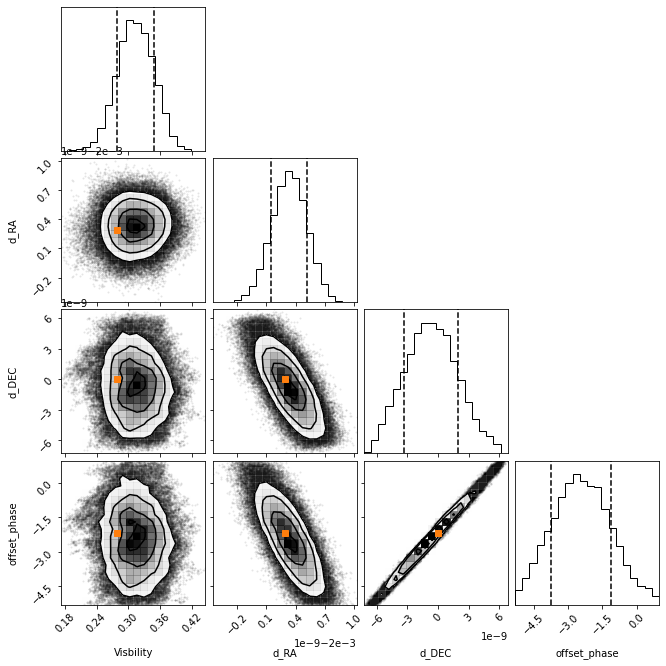

In [19]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/sim_data_EW_200m_10x.txt")
theo_par=np.array([0.2777777777777777, -0.0019999997061362277, 0.0, -2.1765595179585695])
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 
#mcmc_data = np.delete(res, [0,1], axis=1)

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_RA','d_DEC','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, theo_par[None], marker="s", color="C1",label="Theo")

sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print(sigma)

k = (1-np.sqrt(1-task4.V**2))/task4.V**2
B = np.linalg.norm(baseline)
theo_d = np.linalg.norm(d_source[0,0,:])
theo_sigma = np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(T*task4.avg_rate*10)*theo_par[2]/task4.N

print(theo_sigma)

590004
[3.65857210e-02 1.30258694e-10 2.65632064e-09 1.30921054e-01]
-4.13090304301769e-11


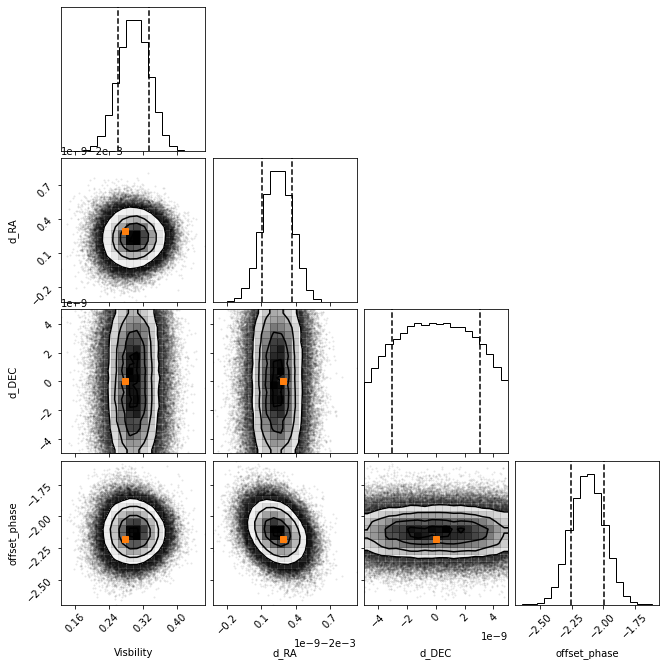

In [23]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/sim_data_EW_200m_10x1.txt")
resMax = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/sim_data_EW_200m_10x1.maxlike")
theo_par=np.array([0.2777777777777777, -0.0019999997061362277, -0.0, -2.1765595179585695])
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 
#mcmc_data = np.delete(res, [0,1], axis=1)

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_RA','d_DEC','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, theo_par[None], marker="s", color="C1",label="Theo")

sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print(sigma)

k = (1-np.sqrt(1-task4.V**2))/task4.V**2
B = np.linalg.norm(baseline)
theo_d = np.linalg.norm(d_source[0,0,:])
theo_sigma = np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(T*task4.avg_rate*10)*theo_par[1]/task4.N

print(theo_sigma)

590004
[5.09401858e-02 1.65758747e-10 2.66676837e-09 1.97178853e-01]
-5.841979108283907e-11


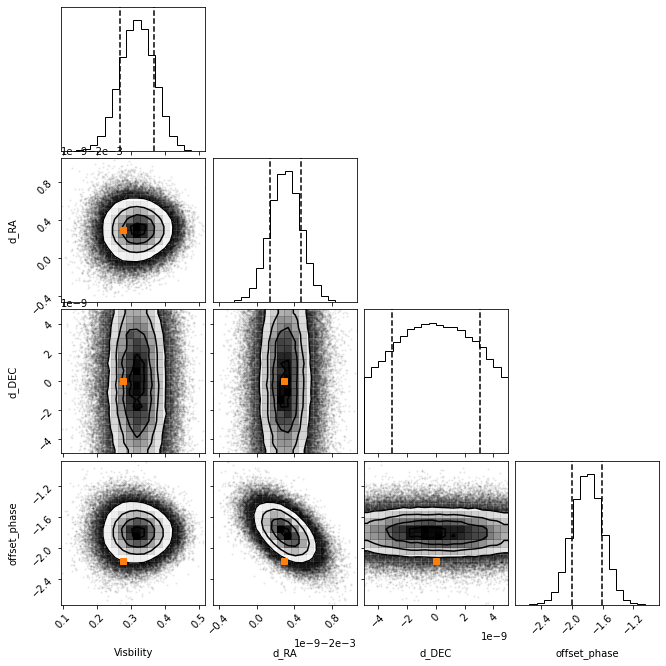

In [24]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/sim_data_EW_200m_5x.txt")
maxRes = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/sim_data_EW_200m_5x.maxlike")

theo_par=np.array([0.2777777777777777, -0.0019999997061362277, -0.0, -2.1765595179585695])
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 
#mcmc_data = np.delete(res, [0,1], axis=1)

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_RA','d_DEC','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, theo_par[None], marker="s", color="C1",label="Theo")

sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print(sigma)

k = (1-np.sqrt(1-task4.V**2))/task4.V**2
B = np.linalg.norm(baseline)
theo_d = np.linalg.norm(d_source[0,0,:])
theo_sigma = np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(T*task4.avg_rate*5)*theo_par[1]/task4.N

print(theo_sigma)

590004
[4.09179042e-02 3.14471133e-10 2.67444803e-09 2.45848591e-01]
-9.248998275905632e-11
2.250959308173751e-10


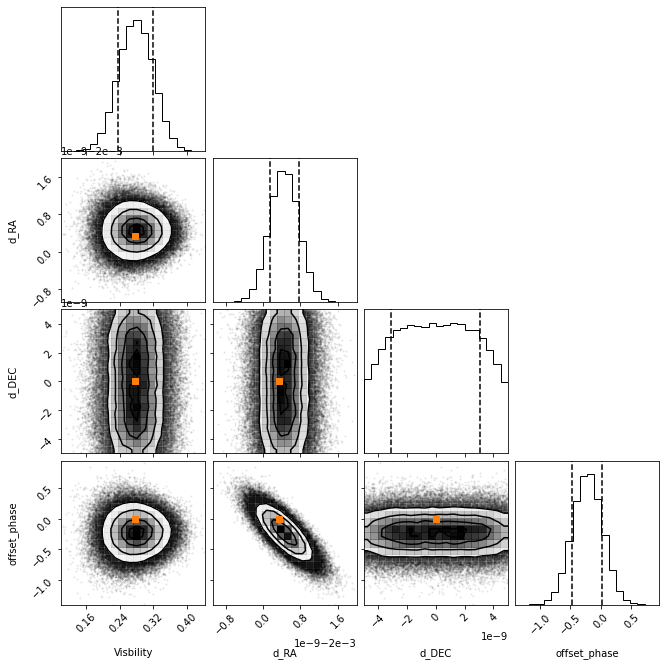

In [68]:
res = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/pap_setup_EW_287m_10x1.txt")
maxRes = np.loadtxt("/home/Zhi/QA-sim/MCMC_output/pap_setup_EW_287m_10x1.maxlike")

theo_par=np.array([0.2777777777777777, -0.0019999996666667107, -0.0, -0])
mcmc_data = np.delete(np.delete(res, [0,1], axis=1),np.s_[:int(res[:,0].size/2)], axis=0) 
#mcmc_data = np.delete(res, [0,1], axis=1)

print(mcmc_data.size)
figure = corner.corner(mcmc_data,labels=['Visbility','d_RA','d_DEC','offset_phase'],quantiles=(0.16, 0.84))
corner.overplot_points(figure, theo_par[None], marker="s", color="C1",label="Theo")

sigma = np.sqrt(np.cov(mcmc_data,rowvar=False).diagonal())
print(sigma)

#first way calculating theo_sigma
k = (1-np.sqrt(1-task4.V**2))/task4.V**2
B = np.linalg.norm(baseline)
theo_d = np.linalg.norm(d_source[0,0,:])
theo_sigma_1 = np.sqrt(6/(k*np.pi**2))/task4.V/np.sqrt(T*task4.avg_rate*10)*theo_par[1]/task4.N
print(theo_sigma_1)

#second way calculating theo_sigma, when everything on Equator
theo_sigma_2 = np.sqrt(6/(np.pi**2*k))/task4.V*lam/B/(T*QT.Omega_E*np.sin(np.pi/2-1.2))/np.sqrt(task4.avg_rate*10*T)
print(theo_sigma_2)